In [2311]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder
from numpy import array
from numpy import argmax
from sklearn.preprocessing import OneHotEncoder
import seaborn as sns
from matplotlib import pyplot as plt

In [2312]:
df=pd.read_excel('file.xlsx',sheet_name="data")

In [2313]:
df.head()

,ID,Program.Code,From.Grade,To.Grade,Group.State,Is.Non.Annual.,Days,Travel.Type,Departure.Date,Return.Date,...,GroupGradeTypeLow,GroupGradeTypeHigh,GroupGradeType,MajorProgramCode,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,SchoolSizeIndicator,Retained.in.2012.
0,1,HS,4.0,4.0,CA,0,1,A,2011-01-14,2011-01-14,...,K,Elementary,K->Elementary,H,1,0.063646,0.936508,4,L,1
1,2,HC,8.0,8.0,AZ,0,7,A,2011-01-14,2011-01-21,...,Middle,Middle,Middle->Middle,H,1,0.025882,0.880000,3,L,1
2,3,HD,8.0,8.0,FL,0,3,A,2011-01-15,2011-01-17,...,Middle,Middle,Middle->Middle,H,1,0.025131,0.888889,3,L,1
3,4,HN,9.0,12.0,VA,1,3,B,2011-01-15,2011-01-17,...,Undefined,Undefined,Undefined->Undefined,H,0,NaN,1.000000,0,NaN,0
4,5,HD,6.0,8.0,FL,0,6,T,2011-01-16,2011-01-21,...,Middle,Middle,Middle->Middle,H,0,0.112500,0.910112,8,M-L,0


In [2314]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2389 entries, 0 to 2388
Data columns (total 56 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   ID                              2389 non-null   int64         
 1   Program.Code                    2389 non-null   object        
 2   From.Grade                      2262 non-null   float64       
 3   To.Grade                        2239 non-null   float64       
 4   Group.State                     2389 non-null   object        
 5   Is.Non.Annual.                  2389 non-null   int64         
 6   Days                            2389 non-null   int64         
 7   Travel.Type                     2389 non-null   object        
 8   Departure.Date                  2389 non-null   datetime64[ns]
 9   Return.Date                     2389 non-null   datetime64[ns]
 10  Deposit.Date                    2389 non-null   datetime64[ns]
 11  Spec

In [2315]:
df.isnull().sum()


ID                                   0
Program.Code                         0
From.Grade                         127
To.Grade                           150
Group.State                          0
Is.Non.Annual.                       0
Days                                 0
Travel.Type                          0
Departure.Date                       0
Return.Date                          0
Deposit.Date                         0
Special.Pay                       1919
Tuition                              0
FRP.Active                           0
FRP.Cancelled                        0
FRP.Take.up.percent.                 0
Early.RPL                          673
Latest.RPL                          19
Cancelled.Pax                        0
Total.Discount.Pax                   0
Initial.System.Date                  8
Poverty.Code                       599
Region                               0
CRM.Segment                          4
School.Type                          0
Parent.Meeting.Flag      

In [2316]:
df.describe()

,ID,From.Grade,To.Grade,Is.Non.Annual.,Days,Tuition,FRP.Active,FRP.Cancelled,FRP.Take.up.percent.,Cancelled.Pax,...,Total.Pax,SPR.Group.Revenue,NumberOfMeetingswithParents,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,Retained.in.2012.
count,2389.000000,2262.000000,2239.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,...,2389.000000,2389.000000,2389.000000,2052.000000,2052.000000,2389.000000,2298.000000,2389.000000,2389.000000,2389.000000
mean,1195.000000,7.268347,7.912908,0.154039,4.575136,1615.217664,16.867727,3.305567,0.570743,4.807451,...,34.250733,1615.217664,1.102135,262.083821,228.978070,0.556718,0.066184,0.900667,2.953537,0.607367
std,689.789219,1.388350,1.558226,0.361062,1.432128,645.096047,16.942782,3.677022,0.230666,4.661194,...,31.590096,645.096047,0.611544,79.520208,53.636014,0.496877,0.081112,0.049119,2.876422,0.488439
min,1.000000,3.000000,3.000000,0.000000,1.000000,79.000000,0.000000,0.000000,0.000000,0.000000,...,2.000000,79.000000,0.000000,-204.000000,-204.000000,0.000000,0.000922,0.600000,0.000000,0.000000
25%,598.000000,7.000000,8.000000,0.000000,4.000000,1174.000000,6.000000,1.000000,0.455000,2.000000,...,14.000000,1174.000000,1.000000,208.000000,196.750000,0.000000,0.020787,0.882353,1.000000,0.000000
50%,1195.000000,8.000000,8.000000,0.000000,5.000000,1700.000000,12.000000,2.000000,0.600000,4.000000,...,26.000000,1700.000000,1.000000,250.000000,233.000000,1.000000,0.045256,0.909091,2.000000,1.000000
75%,1792.000000,8.000000,8.000000,0.000000,5.000000,2048.000000,23.000000,4.000000,0.727000,6.000000,...,44.000000,2048.000000,1.000000,287.000000,261.000000,1.000000,0.087517,0.933333,4.000000,1.000000
max,2389.000000,12.000000,12.000000,1.000000,12.000000,4200.000000,257.000000,45.000000,1.000000,39.000000,...,313.000000,4200.000000,2.000000,749.000000,749.000000,1.000000,2.052632,1.000000,47.000000,1.000000


# Integer Encoding

In [2317]:
label_encoder_pro = LabelEncoder()
label_encoder_new = LabelEncoder()
label_encoder_product = LabelEncoder()
label_encoder_poverty = LabelEncoder()
label_encoder_gro= LabelEncoder()
label_encoder_region= LabelEncoder()
label_encoder_month= LabelEncoder()
label_encoder_income= LabelEncoder()
label_encoder_pay= LabelEncoder()
label_encoder_school= LabelEncoder()
df['Program.Code']= label_encoder_pro.fit_transform(df['Program.Code'])

df['Group.State']= label_encoder_gro.fit_transform(df['Group.State'])

df['Region']= label_encoder_region.fit_transform(df['Region'])

df['DepartureMonth']= label_encoder_month.fit_transform(df['DepartureMonth'])

df['Income.Level']= label_encoder_income.fit_transform(df['Income.Level'])

df['Special.Pay']= label_encoder_pay.fit_transform(df['Special.Pay'])

df['School.Type']= label_encoder_school.fit_transform(df['School.Type'])

df['SPR.Product.Type']= label_encoder_school.fit_transform(df['SPR.Product.Type'])

df['SPR.New.Existing']= label_encoder_school.fit_transform(df['SPR.New.Existing'])

df['Income.Level']= label_encoder_school.fit_transform(df['Income.Level'])








# Null values

In [2318]:

df.fillna(value=0,inplace=True)
df.head(200)

,ID,Program.Code,From.Grade,To.Grade,Group.State,Is.Non.Annual.,Days,Travel.Type,Departure.Date,Return.Date,...,GroupGradeTypeLow,GroupGradeTypeHigh,GroupGradeType,MajorProgramCode,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,SchoolSizeIndicator,Retained.in.2012.
0,1,14,4.0,4.0,6,0,1,A,2011-01-14,2011-01-14,...,K,Elementary,K->Elementary,H,1,0.063646,0.936508,4,L,1
1,2,5,8.0,8.0,4,0,7,A,2011-01-14,2011-01-21,...,Middle,Middle,Middle->Middle,H,1,0.025882,0.880000,3,L,1
2,3,6,8.0,8.0,10,0,3,A,2011-01-15,2011-01-17,...,Middle,Middle,Middle->Middle,H,1,0.025131,0.888889,3,L,1
3,4,11,9.0,12.0,48,1,3,B,2011-01-15,2011-01-17,...,Undefined,Undefined,Undefined->Undefined,H,0,0.000000,1.000000,0,0,0
4,5,6,6.0,8.0,10,0,6,T,2011-01-16,2011-01-21,...,Middle,Middle,Middle->Middle,H,0,0.112500,0.910112,8,M-L,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,196,6,7.0,8.0,45,0,3,A,2011-03-15,2011-03-17,...,PK,Middle,PK->Middle,H,0,0.077551,0.950000,1,S,0
196,197,6,7.0,10.0,46,0,4,A,2011-03-15,2011-03-18,...,Middle,Middle,Middle->Middle,H,0,0.085859,0.894737,2,S,1
197,198,18,7.0,8.0,46,1,4,A,2011-03-15,2011-03-18,...,Middle,Middle,Middle->Middle,H,0,0.110818,0.933333,3,S-M,0
198,199,6,6.0,6.0,46,0,4,A,2011-03-15,2011-03-18,...,PK,Middle,PK->Middle,H,1,0.066667,0.846154,2,S,1


# Data Cleaning 

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='FPP', ylabel='Density'>

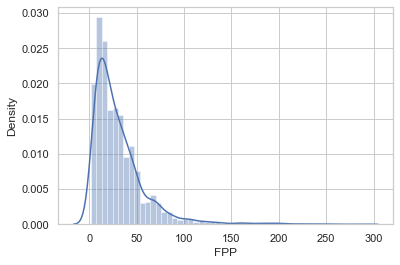

In [2319]:
sns.distplot(df['FPP'])

In [2320]:
print("Highest allowed",df['FPP'].mean() + 3*df['FPP'].std())
print("Lowest allowed",df['FPP'].mean() - 3*df['FPP'].std())

Highest allowed 118.69170456381596
Lowest allowed -56.09731360525589


In [2321]:
df[(df['FPP'] > 118.69) | (df['FPP'] < -56.09)]
new_df = df[(df['FPP'] < 118.69) & (df['FPP'] > -56.09)]
new_df.describe()


,ID,Program.Code,From.Grade,To.Grade,Group.State,Is.Non.Annual.,Days,Special.Pay,Tuition,FRP.Active,...,SPR.Group.Revenue,NumberOfMeetingswithParents,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,DepartureMonth,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,Retained.in.2012.
count,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,...,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000,2341.000000
mean,1199.254592,8.192226,6.888082,7.432721,22.672789,0.157198,4.587356,2.635199,1630.492097,15.655276,...,1630.492097,1.104229,225.705254,197.043144,2.856044,0.550619,0.060516,0.900234,2.720632,0.601452
std,692.173365,5.837379,2.103180,2.432565,17.211894,0.364065,1.427954,0.797555,637.621217,13.363057,...,637.621217,0.612745,117.477808,94.060775,1.753932,0.497537,0.077304,0.049364,2.140502,0.489704
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,79.000000,0.000000,...,79.000000,0.000000,-204.000000,-204.000000,0.000000,0.000000,0.000000,0.600000,0.000000,0.000000
25%,598.000000,6.000000,6.000000,8.000000,6.000000,0.000000,4.000000,3.000000,1228.000000,6.000000,...,1228.000000,1.000000,187.000000,180.000000,3.000000,0.000000,0.018041,0.882353,1.000000,0.000000
50%,1201.000000,6.000000,8.000000,8.000000,16.000000,0.000000,5.000000,3.000000,1718.000000,12.000000,...,1718.000000,1.000000,239.000000,221.000000,3.000000,1.000000,0.042471,0.909091,2.000000,1.000000
75%,1802.000000,6.000000,8.000000,8.000000,43.000000,0.000000,5.000000,3.000000,2049.000000,22.000000,...,2049.000000,1.000000,277.000000,258.000000,4.000000,1.000000,0.081907,0.933333,4.000000,1.000000
max,2389.000000,27.000000,12.000000,12.000000,53.000000,1.000000,12.000000,3.000000,4200.000000,88.000000,...,4200.000000,2.000000,749.000000,749.000000,5.000000,1.000000,2.052632,1.000000,19.000000,1.000000


In [2322]:
print("Highest allowed",df['SPR.Group.Revenue'].mean() + 3*df['SPR.Group.Revenue'].std())
print("Lowest allowed",df['SPR.Group.Revenue'].mean() - 3*df['SPR.Group.Revenue'].std())

Highest allowed 3550.5058053733264
Lowest allowed -320.0704767839586


In [2323]:
new_df[(new_df['SPR.Group.Revenue'] > 3550.5058053733264) | (new_df['SPR.Group.Revenue'] < -320.0704767839586)]
#new_df = new_df[(new_df['SPR.Group.Revenue'] < 3550) & (new_df['SPR.Group.Revenue'] > 0)]


,ID,Program.Code,From.Grade,To.Grade,Group.State,Is.Non.Annual.,Days,Travel.Type,Departure.Date,Return.Date,...,GroupGradeTypeLow,GroupGradeTypeHigh,GroupGradeType,MajorProgramCode,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,SchoolSizeIndicator,Retained.in.2012.
1334,1335,5,8.0,8.0,12,0,8,A,2011-05-26,2011-06-03,...,Middle,Middle,Middle->Middle,H,1,0.078571,0.880000,3,S,0
1663,1664,5,8.0,8.0,12,0,12,A,2011-06-05,2011-06-16,...,K,High,K->High,H,1,0.008378,0.911765,3,L,1
2132,2133,20,0.0,0.0,51,0,11,A,2011-06-14,2011-06-24,...,High,High,High->High,I,0,0.023041,0.833333,3,M-L,0
2295,2296,20,0.0,0.0,6,0,11,A,2011-06-21,2011-07-01,...,High,High,High->High,I,0,0.001984,0.833333,1,L,0
2296,2297,20,0.0,0.0,6,0,11,A,2011-06-21,2011-07-01,...,High,High,High->High,I,0,0.008054,0.900000,2,L,0
2297,2298,20,0.0,0.0,6,0,11,A,2011-06-21,2011-07-01,...,High,High,High->High,I,0,0.001437,0.750000,1,L,0
2298,2299,20,0.0,0.0,6,0,11,A,2011-06-21,2011-07-01,...,High,High,High->High,I,0,0.017544,0.818182,2,S-M,0
2299,2300,20,0.0,0.0,6,0,11,A,2011-06-21,2011-07-01,...,High,High,High->High,I,0,0.017241,0.888889,2,L,1
2300,2301,20,0.0,0.0,6,0,11,A,2011-06-21,2011-07-01,...,High,High,High->High,I,0,0.042980,0.882353,2,S-M,0
2302,2303,20,0.0,0.0,6,0,11,A,2011-06-21,2011-07-01,...,High,High,High->High,I,0,0.002977,0.875000,1,L,0


# Feature Plotting

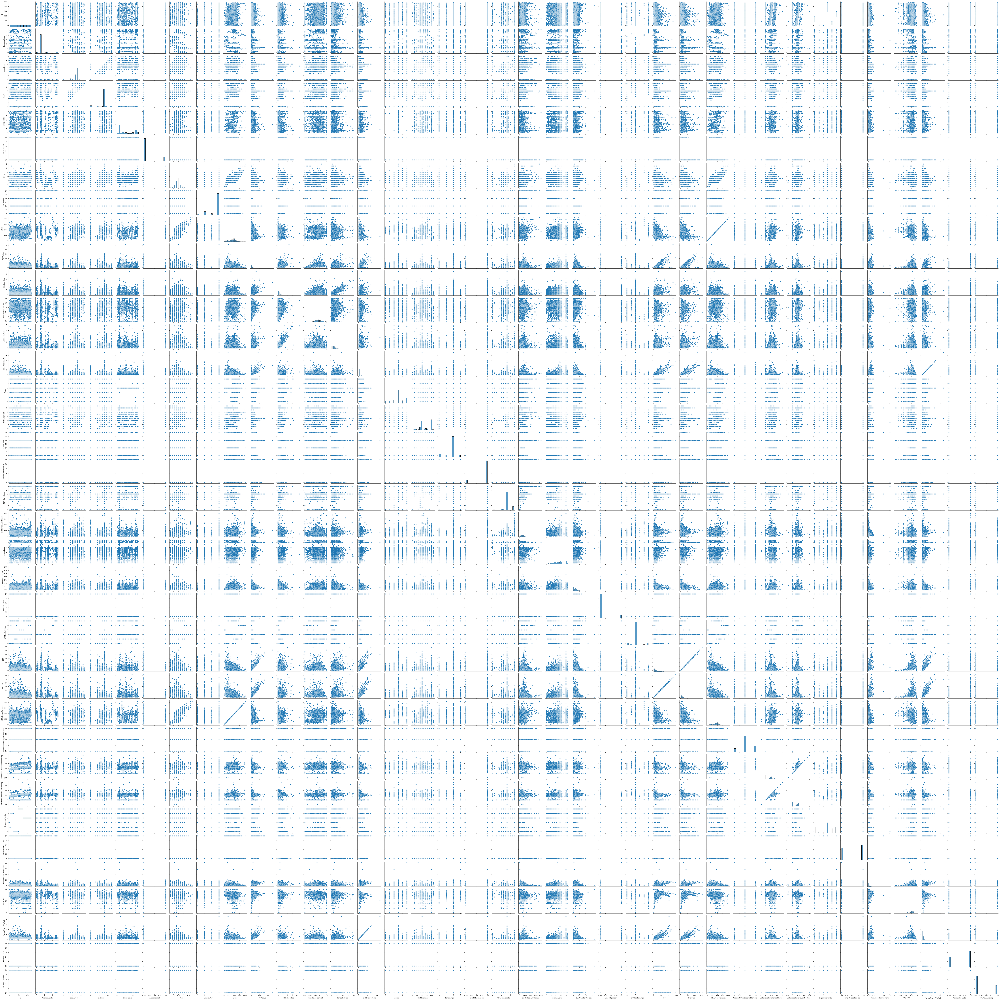

In [1569]:
sns.pairplot(df)

# Different Features plots

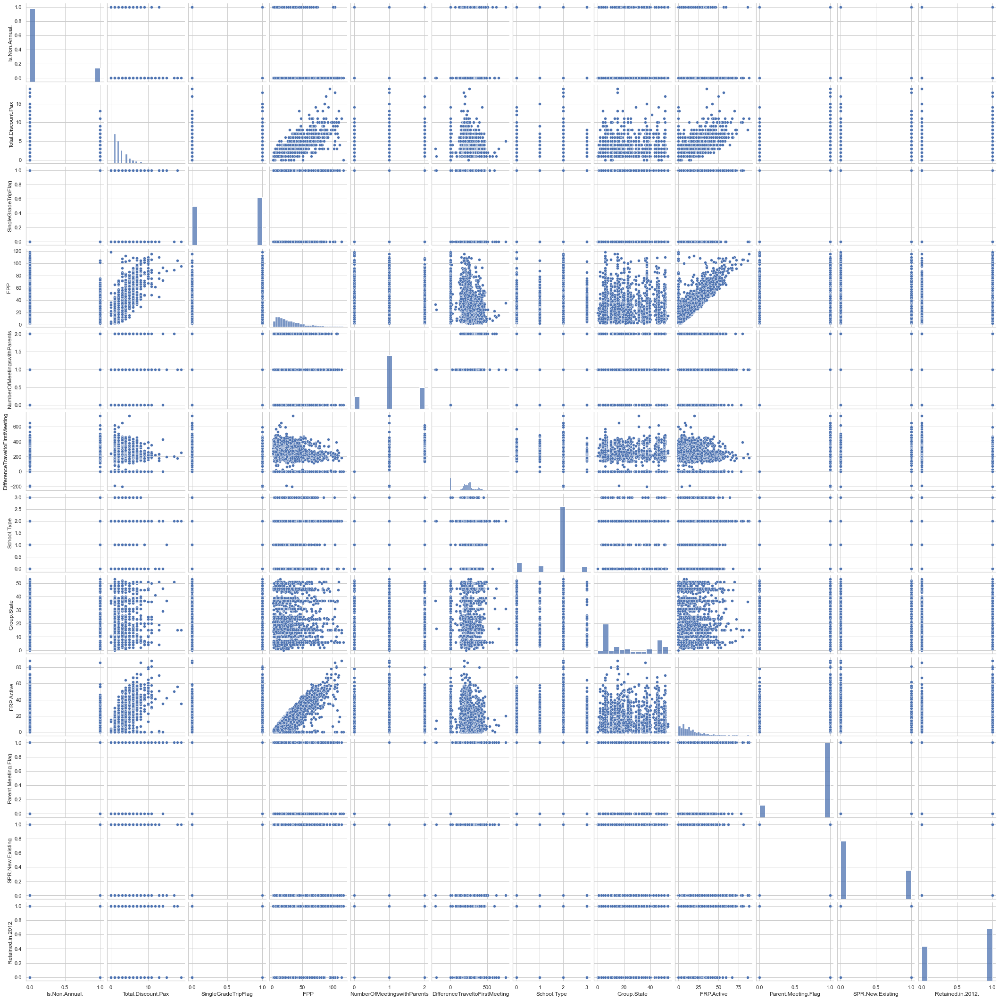

In [2606]:
sns.pairplot(new_df[['Is.Non.Annual.','Total.Discount.Pax','SingleGradeTripFlag','FPP','NumberOfMeetingswithParents','DifferenceTraveltoFirstMeeting','School.Type','Group.State','FRP.Active','Parent.Meeting.Flag','SPR.New.Existing','Retained.in.2012.']])

<AxesSubplot:xlabel='ID', ylabel='Total.School.Enrollment'>

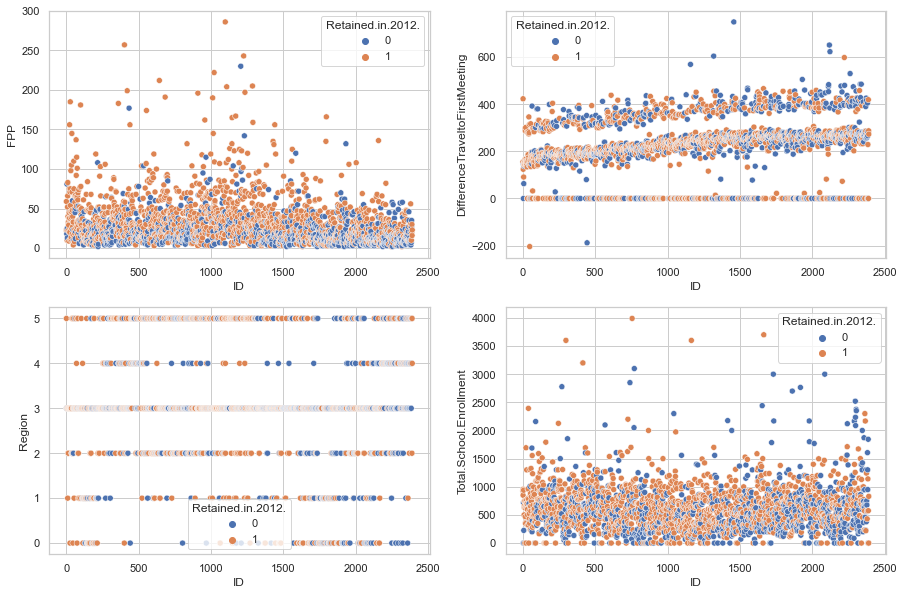

In [1872]:

fig, axes = plt.subplots(2, 2,figsize=(15,10))

sns.scatterplot(data=df, y="FPP",x='ID', hue="Retained.in.2012.",ax=axes[0,0])
sns.scatterplot(data=df, y="DifferenceTraveltoFirstMeeting",x='ID', hue="Retained.in.2012.",ax=axes[0,1])
sns.scatterplot(data=df, y="Region",x='ID' ,hue="Retained.in.2012.",ax=axes[1,0])
sns.scatterplot(data=df, x='ID',y="Total.School.Enrollment" ,hue="Retained.in.2012.",ax=axes[1,1])


#plt.plot(df['FPP'],hue=df['Retained.in.2012.'])

<AxesSubplot:xlabel='ID', ylabel='Total.Discount.Pax'>

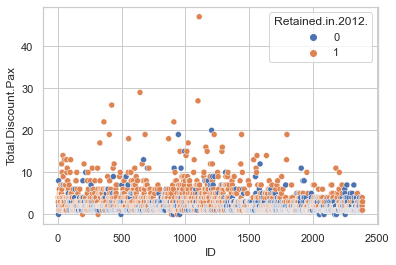

In [1873]:
sns.scatterplot(data=df, y="Total.Discount.Pax",x='ID', hue="Retained.in.2012.")



# Features Relation to Departure Month

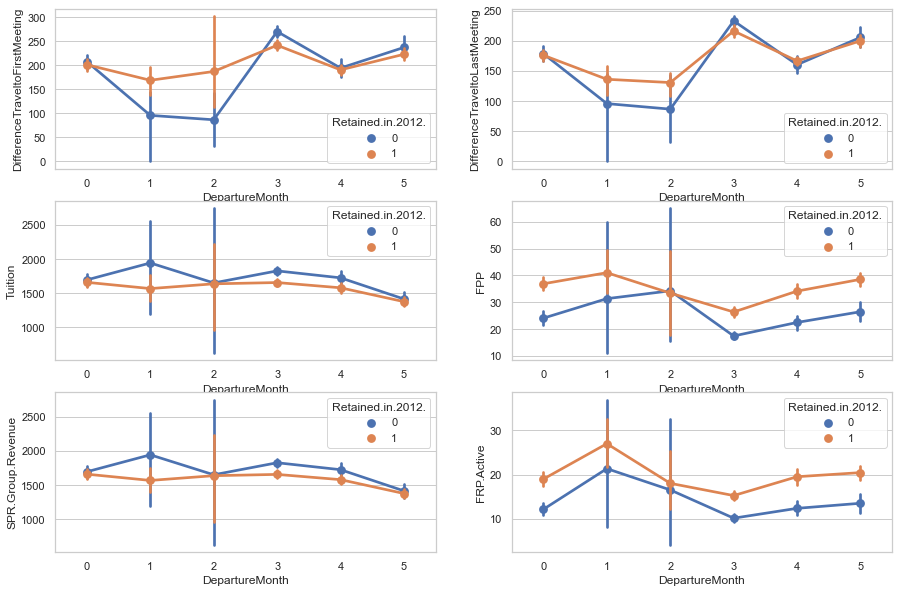

In [1885]:
fig, axes_2 = plt.subplots(3,2,figsize=(15,10))
sns.pointplot(x='DepartureMonth', y='DifferenceTraveltoFirstMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_2[0,0])
sns.pointplot(x='DepartureMonth', y='DifferenceTraveltoLastMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_2[0,1])
sns.pointplot(x='DepartureMonth', y='Tuition', data=new_df, hue='Retained.in.2012.',ax=axes_2[1,0])
sns.pointplot(x='DepartureMonth', y='FPP', data=new_df, hue='Retained.in.2012.',ax=axes_2[1,1])
sns.pointplot(x='DepartureMonth', y='SPR.Group.Revenue', data=new_df, hue='Retained.in.2012.',ax=axes_2[2,0])
sns.pointplot(x='DepartureMonth', y='FRP.Active', data=new_df, hue='Retained.in.2012.',ax=axes_2[2,1])

sns.set(style="whitegrid")


# Features Relations to Different Regions

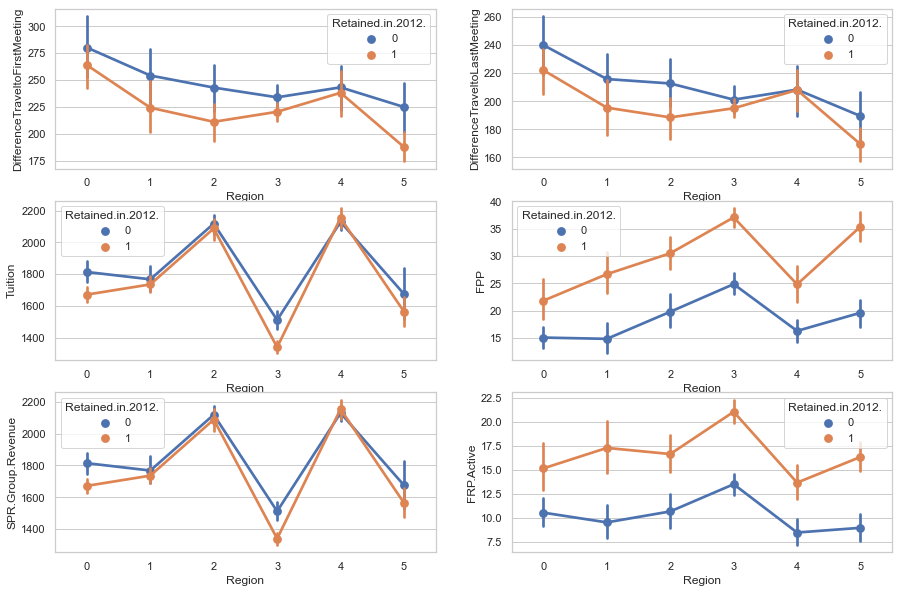

In [2599]:
fig, axes_2 = plt.subplots(3,2,figsize=(15,10))
sns.pointplot(x='Region', y='DifferenceTraveltoFirstMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_2[0,0])
sns.pointplot(x='Region', y='DifferenceTraveltoLastMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_2[0,1])
sns.pointplot(x='Region', y='Tuition', data=new_df, hue='Retained.in.2012.',ax=axes_2[1,0])
sns.pointplot(x='Region', y='FPP', data=new_df, hue='Retained.in.2012.',ax=axes_2[1,1])
sns.pointplot(x='Region', y='SPR.Group.Revenue', data=new_df, hue='Retained.in.2012.',ax=axes_2[2,0])
sns.pointplot(x='Region', y='FRP.Active', data=new_df, hue='Retained.in.2012.',ax=axes_2[2,1])

sns.set(style="whitegrid")

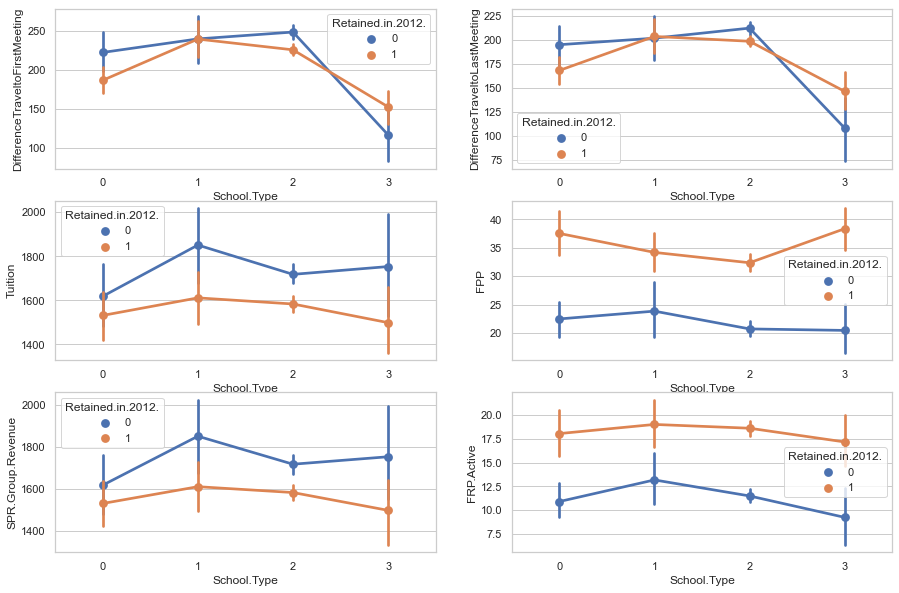

In [2601]:
fig, axes_3 = plt.subplots(3,2,figsize=(15,10))
sns.pointplot(x='School.Type', y='DifferenceTraveltoFirstMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_3[0,0])
sns.pointplot(x='School.Type', y='DifferenceTraveltoLastMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_3[0,1])
sns.pointplot(x='School.Type', y='Tuition', data=new_df, hue='Retained.in.2012.',ax=axes_3[1,0])
sns.pointplot(x='School.Type', y='FPP', data=new_df, hue='Retained.in.2012.',ax=axes_3[1,1])
sns.pointplot(x='School.Type', y='SPR.Group.Revenue', data=new_df, hue='Retained.in.2012.',ax=axes_3[2,0])
sns.pointplot(x='School.Type', y='FRP.Active', data=new_df, hue='Retained.in.2012.',ax=axes_3[2,1])

sns.set(style="whitegrid")

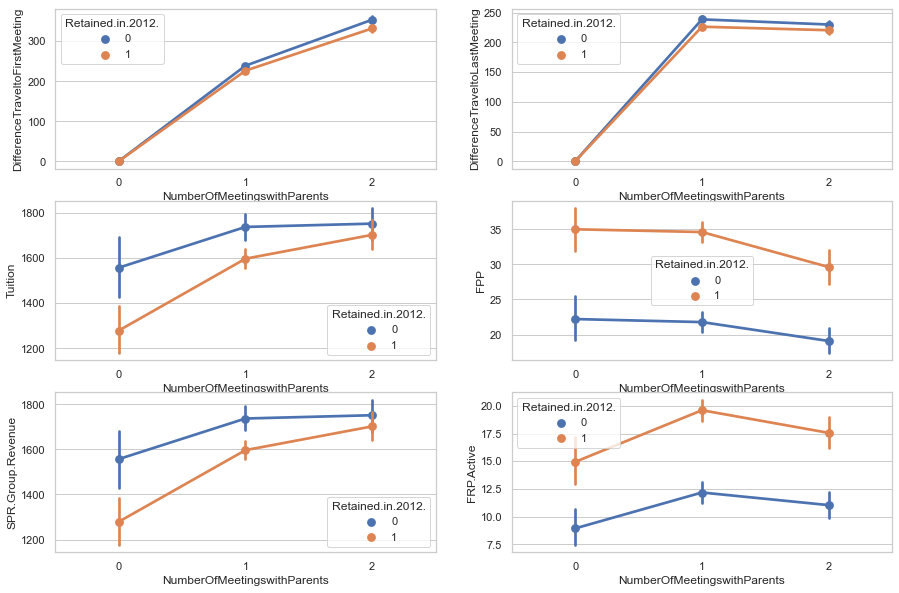

In [2605]:
fig, axes_3 = plt.subplots(3,2,figsize=(15,10))
sns.pointplot(x='NumberOfMeetingswithParents', y='DifferenceTraveltoFirstMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_3[0,0])
sns.pointplot(x='NumberOfMeetingswithParents', y='DifferenceTraveltoLastMeeting', data=new_df, hue='Retained.in.2012.',ax=axes_3[0,1])
sns.pointplot(x='NumberOfMeetingswithParents', y='Tuition', data=new_df, hue='Retained.in.2012.',ax=axes_3[1,0])
sns.pointplot(x='NumberOfMeetingswithParents', y='FPP', data=new_df, hue='Retained.in.2012.',ax=axes_3[1,1])
sns.pointplot(x='NumberOfMeetingswithParents', y='SPR.Group.Revenue', data=new_df, hue='Retained.in.2012.',ax=axes_3[2,0])
sns.pointplot(x='NumberOfMeetingswithParents', y='FRP.Active', data=new_df, hue='Retained.in.2012.',ax=axes_3[2,1])

sns.set(style="whitegrid")

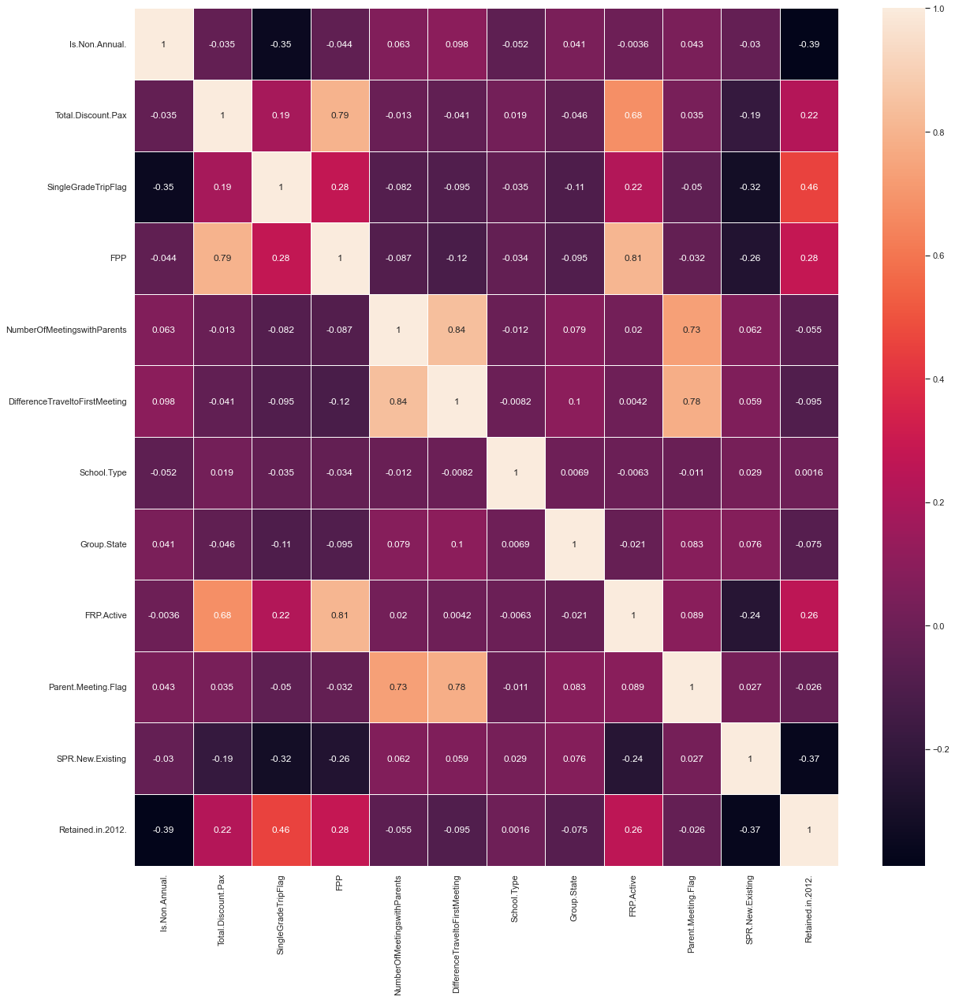

In [2486]:
corr=new_df[['Is.Non.Annual.','Total.Discount.Pax','SingleGradeTripFlag','FPP','NumberOfMeetingswithParents','DifferenceTraveltoFirstMeeting','School.Type','Group.State','FRP.Active','Parent.Meeting.Flag','SPR.New.Existing','Retained.in.2012.']].corr()
plt.figure(figsize=[20,20])
sns.heatmap(corr,annot=True,linewidth=1)
plt.savefig('heatmap')


# Trying Logistic Regression

In [2779]:
import scipy.stats as sp
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score

In [2780]:
x=df[['Total.Discount.Pax','SingleGradeTripFlag','FPP','DifferenceTraveltoFirstMeeting','School.Type']]

In [2781]:
y=df['Retained.in.2012.']

In [2782]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.4,random_state=100)

In [2783]:
logr = LogisticRegression(random_state=16)
logr.fit(X_train,y_train)

print(logr.intercept_)
logr.coef_


[-1.21751104]


array([[ 4.64176369e-02,  1.86161646e+00,  1.52214441e-02,
        -2.76551951e-04,  9.03616768e-02]])

In [2784]:


predictions=logr.predict(X_test)
error=pd.DataFrame(index=['Model_1','Model_2','Model_3','Model_4','Model_5','Model_6','Model_7'],columns=['Recall','Auc_Score','Precision','Accuracy'])


# Error Metrics

In [2785]:
from sklearn import metrics
metrics.mean_absolute_error(y_test,predictions)
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler

In [2786]:
cnf_matrix_1 = metrics.confusion_matrix(y_test,predictions)
cnf_matrix_1

array([[267, 104],
       [161, 424]])

In [2787]:
print(classification_report(y_test, predictions))
plt.savefig('s')

              precision    recall  f1-score   support

           0       0.62      0.72      0.67       371
           1       0.80      0.72      0.76       585

    accuracy                           0.72       956
   macro avg       0.71      0.72      0.72       956
weighted avg       0.73      0.72      0.73       956



<Figure size 432x288 with 0 Axes>

In [2788]:
logr.score(X_test,y_test)

0.7228033472803347

In [2789]:
precision_score(y_test, predictions)

0.803030303030303

In [2790]:
error['Recall']['Model_1']=recall_score(y_test, predictions)
error['Precision']['Model_1']=precision_score(y_test, predictions)
error['Accuracy']['Model_1']=accuracy_score(y_test, predictions)


AUC= 0.7966341834266363


,Recall,Auc_Score,Precision,Accuracy
Model_1,0.724786,0.796634,0.80303,0.722803
Model_2,NaN,NaN,NaN,NaN
Model_3,NaN,NaN,NaN,NaN
Model_4,NaN,NaN,NaN,NaN
Model_5,NaN,NaN,NaN,NaN
Model_6,NaN,NaN,NaN,NaN
Model_7,NaN,NaN,NaN,NaN


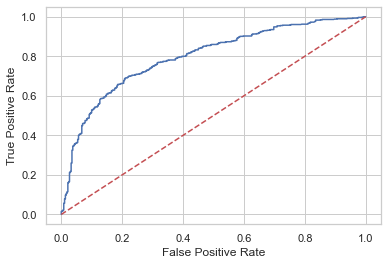

In [2791]:
from sklearn.metrics import roc_auc_score,roc_curve
log_roc_auc=roc_auc_score(y_test,predictions)
fpr,tpr,thresholds=roc_curve(y_test,logr.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr,tpr,label='Logistic Regression'%log_roc_auc)
plt.plot([0,1],[0,1],'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('AUC=',metrics.auc(fpr, tpr))
error['Auc_Score']['Model_1']=metrics.auc(fpr, tpr)
error


# Logistic Regression with clean data and adding more variable

# Model

In [2792]:
new_df.columns


Index(['ID', 'Program.Code', 'From.Grade', 'To.Grade', 'Group.State',
       'Is.Non.Annual.', 'Days', 'Travel.Type', 'Departure.Date',
       'Return.Date', 'Deposit.Date', 'Special.Pay', 'Tuition', 'FRP.Active',
       'FRP.Cancelled', 'FRP.Take.up.percent.', 'Early.RPL', 'Latest.RPL',
       'Cancelled.Pax', 'Total.Discount.Pax', 'Initial.System.Date',
       'Poverty.Code', 'Region', 'CRM.Segment', 'School.Type',
       'Parent.Meeting.Flag', 'MDR.Low.Grade', 'MDR.High.Grade',
       'Total.School.Enrollment', 'Income.Level', 'EZ.Pay.Take.Up.Rate',
       'School.Sponsor', 'SPR.Product.Type', 'SPR.New.Existing', 'FPP',
       'Total.Pax', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents',
       'FirstMeeting', 'LastMeeting', 'DifferenceTraveltoFirstMeeting',
       'DifferenceTraveltoLastMeeting', 'SchoolGradeTypeLow',
       'SchoolGradeTypeHigh', 'SchoolGradeType', 'DepartureMonth',
       'GroupGradeTypeLow', 'GroupGradeTypeHigh', 'GroupGradeType',
       'MajorProgramCode', '

In [2793]:
x_clean=new_df[['Is.Non.Annual.','Total.Discount.Pax','SingleGradeTripFlag','FPP','NumberOfMeetingswithParents','DifferenceTraveltoFirstMeeting','School.Type','Group.State','FRP.Active','Parent.Meeting.Flag','SPR.New.Existing']]
y_clean=new_df['Retained.in.2012.']
x_test=new_df[['Region', 'Is.Non.Annual.', 'Parent.Meeting.Flag',  'SingleGradeTripFlag','SPR.New.Existing','Cancelled.Pax','FPP.to.PAX']]


In [2794]:
X_train, X_test, y_train, y_test = train_test_split(x_clean, y_clean, test_size=0.4,random_state=100)
logr = LogisticRegression(random_state=16)
logr.fit(X_train,y_train)

print(logr.intercept_)
logr.coef_
predictions=logr.predict(X_test)


[-0.1681076]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


# Error Metrics

In [2795]:
cnf_matrix = metrics.confusion_matrix(y_test,predictions)
cnf_matrix
print(classification_report(y_test, predictions))
print('regresion_score=',logr.score(X_test,y_test))
print('Precision Score=',precision_score(y_test, predictions))

              precision    recall  f1-score   support

           0       0.77      0.75      0.76       357
           1       0.85      0.86      0.85       580

    accuracy                           0.82       937
   macro avg       0.81      0.80      0.81       937
weighted avg       0.82      0.82      0.82       937

regresion_score= 0.8175026680896478
Precision Score= 0.8471986417657046


In [2796]:
recall_score(y_test, predictions)
error['Recall']['Model_2']=recall_score(y_test, predictions)
error['Precision']['Model_2']=precision_score(y_test, predictions)
error['Accuracy']['Model_2']=accuracy_score(y_test, predictions)



# ROC curve and AUC metrics

AUC= 0.8770549599150005


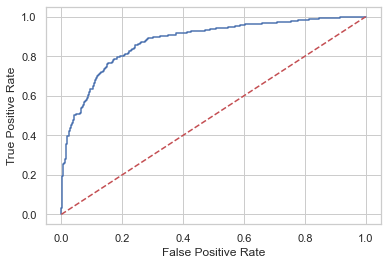

In [2797]:
from sklearn.metrics import roc_auc_score,roc_curve
log_roc_auc=roc_auc_score(y_test,predictions)
fpr,tpr,thresholds=roc_curve(y_test,logr.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr,tpr,label='Logistic Regression'%log_roc_auc)
plt.plot([0,1],[0,1],'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('AUC=',metrics.auc(fpr, tpr))
error['Auc_Score']['Model_2']=metrics.auc(fpr, tpr)


# Prediction for 2012 using all the data

In [2798]:
x=new_df[['Is.Non.Annual.','Total.Discount.Pax','SingleGradeTripFlag','FPP','NumberOfMeetingswithParents','DifferenceTraveltoFirstMeeting','School.Type','Program.Code','Group.State','FRP.Active']]
y=new_df['Retained.in.2012.']

logr_fu = LogisticRegression(random_state=16)
logr_fu.fit(x,y)
print(logr_fu.intercept_)
logr_fu.coef_

[-0.15452874]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


array([[-1.68141283e+00,  1.33579110e-01,  1.43514328e+00,
        -1.26644499e-03,  1.80091805e-01, -1.92164017e-03,
        -6.51340000e-02, -2.38866036e-02, -4.83661341e-03,
         3.10408916e-02]])

In [2799]:
df_future=new_df.copy()
df_future['predicte_result']=logr_fu.predict(x)


In [2800]:
df_future


,ID,Program.Code,From.Grade,To.Grade,Group.State,Is.Non.Annual.,Days,Travel.Type,Departure.Date,Return.Date,Deposit.Date,Special.Pay,Tuition,FRP.Active,FRP.Cancelled,FRP.Take.up.percent.,Early.RPL,Latest.RPL,Cancelled.Pax,Total.Discount.Pax,Initial.System.Date,Poverty.Code,Region,CRM.Segment,School.Type,Parent.Meeting.Flag,MDR.Low.Grade,MDR.High.Grade,Total.School.Enrollment,Income.Level,EZ.Pay.Take.Up.Rate,School.Sponsor,SPR.Product.Type,SPR.New.Existing,FPP,Total.Pax,SPR.Group.Revenue,NumberOfMeetingswithParents,FirstMeeting,LastMeeting,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SchoolGradeTypeLow,SchoolGradeTypeHigh,SchoolGradeType,DepartureMonth,GroupGradeTypeLow,GroupGradeTypeHigh,GroupGradeType,MajorProgramCode,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,SchoolSizeIndicator,Retained.in.2012.,predicte_result
0,1,14,4.0,4.0,6,0,1,A,2011-01-14,2011-01-14,2010-08-30,3,424,25,3,0.424,2010-03-29 00:00:00,2010-08-12 00:00:00,3,4,2010-03-26 00:00:00,B,5,4.0,2,1,K,5.0,927.0,20,0.170,1,0,0,59,63,424,1,2010-08-12 00:00:00,2010-08-12 00:00:00,155.0,155.0,Elementary,Elementary,Elementary->Elementary,2,K,Elementary,K->Elementary,H,1,0.063646,0.936508,4,L,1,1
1,2,5,8.0,8.0,4,0,7,A,2011-01-14,2011-01-21,2009-11-15,0,2350,9,9,0.409,2009-10-20 00:00:00,2010-08-10 00:00:00,11,3,2009-10-02 00:00:00,C,3,10.0,2,1,7,8.0,850.0,0,0.091,0,2,0,22,25,2350,2,2009-11-17 00:00:00,2010-08-27 00:00:00,423.0,140.0,Middle,Middle,Middle->Middle,2,Middle,Middle,Middle->Middle,H,1,0.025882,0.880000,3,L,1,1
2,3,6,8.0,8.0,10,0,3,A,2011-01-15,2011-01-17,2010-10-15,3,1181,17,6,0.708,2010-04-29 00:00:00,2010-08-16 00:00:00,6,3,2010-01-28 00:00:00,C,3,10.0,2,1,6,8.0,955.0,14,0.042,0,2,0,24,27,1181,1,2010-09-13 00:00:00,2010-09-13 00:00:00,124.0,124.0,Middle,Middle,Middle->Middle,2,Middle,Middle,Middle->Middle,H,1,0.025131,0.888889,3,L,1,1
3,4,11,9.0,12.0,48,1,3,B,2011-01-15,2011-01-17,2011-01-07,3,376,0,0,0.000,0,0,1,0,2010-10-19 00:00:00,0,3,7.0,0,0,0,0.0,0.0,22,0.000,0,2,0,18,18,376,0,0,0,0.0,0.0,High,High,High->High,2,Undefined,Undefined,Undefined->Undefined,H,0,0.000000,1.000000,0,0,0,0
4,5,6,6.0,8.0,10,0,6,T,2011-01-16,2011-01-21,2010-09-30,3,865,40,8,0.494,2010-03-29 00:00:00,2010-08-12 00:00:00,9,8,2010-03-23 00:00:00,D,3,10.0,2,1,6,8.0,720.0,2,0.383,0,2,0,81,89,865,1,2010-08-24 00:00:00,2010-08-24 00:00:00,145.0,145.0,Middle,Middle,Middle->Middle,2,Middle,Middle,Middle->Middle,H,0,0.112500,0.910112,8,M-L,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2384,2385,5,7.0,8.0,6,0,5,A,2011-06-28,2011-07-02,2010-12-15,3,1892,18,4,0.514,0,2010-11-04 00:00:00,7,3,2010-11-04 00:00:00,C,5,10.0,2,0,6,8.0,1844.0,3,0.057,0,2,0,35,38,1892,0,0,0,0.0,0.0,Middle,Middle,Middle->Middle,3,Middle,Middle,Middle->Middle,H,0,0.018980,0.921053,3,L,0,1
2385,2386,6,8.0,8.0,6,0,5,A,2011-06-29,2011-07-03,2010-10-15,1,1699,16,4,0.800,2010-04-26 00:00:00,2010-09-07 00:00:00,4,2,2010-04-27 00:00:00,C,5,4.0,2,1,K,6.0,575.0,20,0.350,0,2,0,20,22,1699,2,2010-05-06 00:00:00,2010-10-07 00:00:00,419.0,265.0,Middle,Middle,Middle->Middle,3,K,Middle,K->Middle,H,1,0.034783,0.909091,2,S-M,1,1
2386,2387,6,10.0,12.0,6,0,6,A,2011-06-29,2011-07-05,2011-01-18,2,2149,0,0,0.000,0,2010-12-08 00:00:00,0,4,2010-12-08 00:00:00,0,2,7.0,2,0,0,0.0,0.0,22,0.000,0,2,1,30,34,2149,0,0,0,0.0,0.0,High,High,High->High,3,Undefined,Undefined,Undefined->Undefined,H,0,0.000000,0.882353,4,0,1,1
2387,2388,14,4.0,4.0,6,0,1,A,2011-06-30,2011-06-30,2010-12-17,3,449,3,2,0.188,0,2010-09-07 00:00:00,1,1,2010-09-04 00:00:00,0,5,0.0,0,1,0,0.0,0.0,22,0.188,0,0,1,16,17,449,1,2010-09-16 00:00:00,2010-09-16 00:00:00,287.0,287.0,Elementary,Elementary,Elementary->Elementary,3,Undefined,Undefined,Undefined->Undefined,H,1,0.000000,0.941176,1,0,1,1


# Decsion Tree

In [2801]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn import tree

In [2802]:
x_des=new_df[['Is.Non.Annual.','Total.Discount.Pax','SingleGradeTripFlag','FPP','NumberOfMeetingswithParents','DifferenceTraveltoFirstMeeting','School.Type','Program.Code','Group.State','FRP.Active','SPR.New.Existing']]
y_des=new_df['Retained.in.2012.']

In [2803]:
X_train, X_test, y_train, y_test = train_test_split(x_des, y_des, test_size=0.4,random_state=100)

In [2804]:
clf=DecisionTreeClassifier(criterion="entropy")

In [2805]:
clf=clf.fit(X_train,y_train)

In [2806]:
clf.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'random_state': None,
 'splitter': 'best'}

In [2807]:
predicitons_des=clf.predict(X_test)
predicitons_des

array([1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1,
       0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0,
       0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1,
       0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1,
       1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0,
       1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1,
       1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1,
       1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1,
       1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1,

In [2808]:
clf.predict_proba(X_test)

array([[0., 1.],
       [0., 1.],
       [1., 0.],
       ...,
       [0., 1.],
       [1., 0.],
       [1., 0.]])

# ERROR MATRICS

In [2809]:
accuracy_score(y_test,predicitons_des)

0.7001067235859125

In [2810]:
confusion_matrix(y_test,predicitons_des)

array([[236, 121],
       [160, 420]])

In [2811]:
precision_score(y_test,predicitons_des)

0.7763401109057301

In [2812]:
recall_score(y_test, predicitons_des)
error['Recall']['Model_3']=recall_score(y_test, predicitons_des)
error['Precision']['Model_3']=precision_score(y_test, predicitons_des)
error['Accuracy']['Model_3']=accuracy_score(y_test, predicitons_des)

In [2813]:
print(classification_report(y_test, predicitons_des))

              precision    recall  f1-score   support

           0       0.60      0.66      0.63       357
           1       0.78      0.72      0.75       580

    accuracy                           0.70       937
   macro avg       0.69      0.69      0.69       937
weighted avg       0.71      0.70      0.70       937



In [2814]:
fea= clf.feature_importances_
feature_importance_=pd.DataFrame(fea,index=x_des.columns).sort_values(by=[0],ascending=False)
feature_importance_





,0
DifferenceTraveltoFirstMeeting,0.188606
FPP,0.158760
FRP.Active,0.149853
SingleGradeTripFlag,0.147685
Group.State,0.108212
Is.Non.Annual.,0.077776
Program.Code,0.044146
Total.Discount.Pax,0.043545
SPR.New.Existing,0.039072
School.Type,0.027613


<AxesSubplot:>

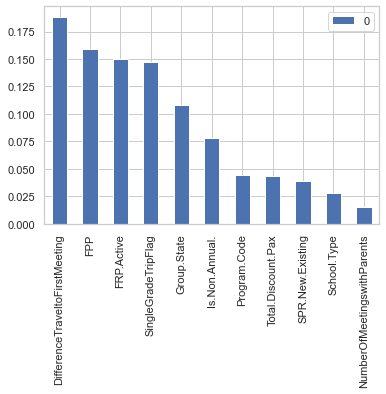

In [2815]:
feature_importance_.plot(kind='bar')

AUC= 0.6931710615280594


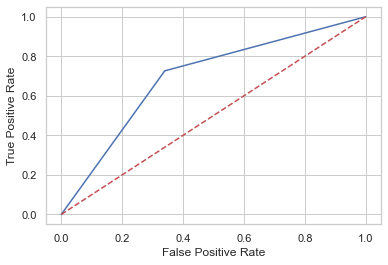

In [2816]:
from sklearn.metrics import roc_auc_score,roc_curve
log_roc_auc=roc_auc_score(y_test,predicitons_des)
fpr,tpr,thresholds=roc_curve(y_test,clf.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr,tpr,label='Logistic Regression'%log_roc_auc)
plt.plot([0,1],[0,1],'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('AUC=',metrics.auc(fpr, tpr))
error['Auc_Score']['Model_3']=metrics.auc(fpr, tpr)


In [2817]:
from sklearn.tree import plot_tree


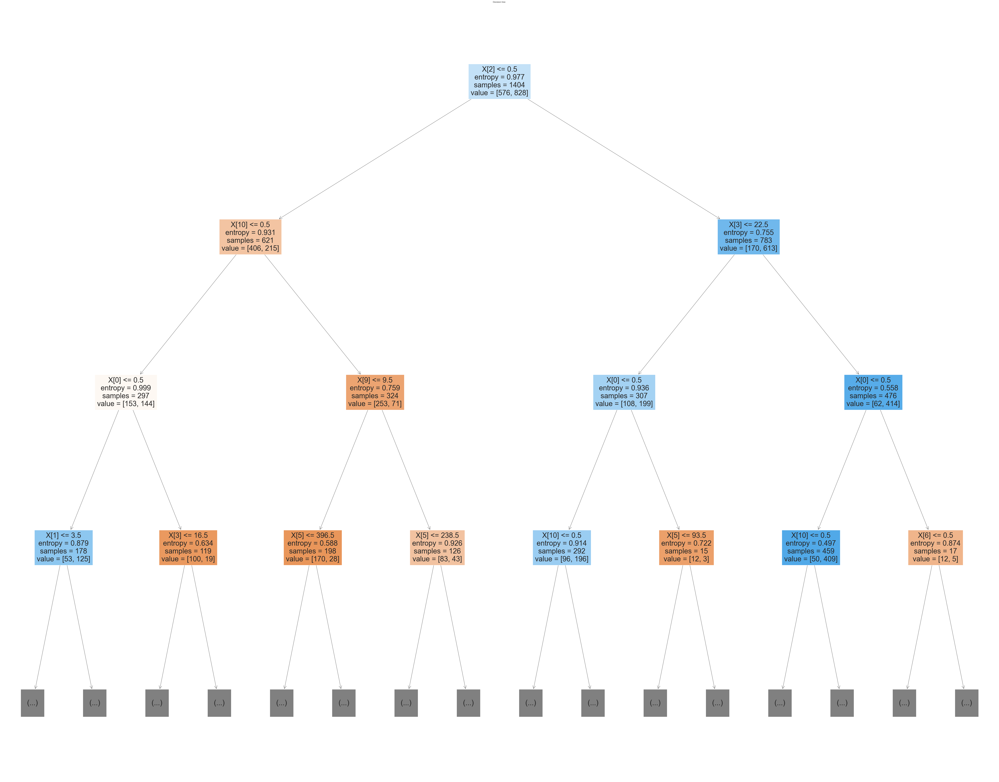

In [2818]:

plt.figure(figsize=(100,80))



plot_tree(clf, filled=True,max_depth=3)
plt.title("Decision tree ")
plt.show()

# Random Forest

In [2819]:
from sklearn.ensemble import RandomForestClassifier


In [2820]:
x_random=new_df[['Is.Non.Annual.','Total.Discount.Pax','SingleGradeTripFlag','FPP','NumberOfMeetingswithParents','DifferenceTraveltoFirstMeeting','School.Type','Program.Code','Group.State','FRP.Active','Parent.Meeting.Flag','SPR.New.Existing']]
y_random=new_df['Retained.in.2012.']

In [2821]:
X_train, X_test, y_train, y_test = train_test_split(x_random, y_random, test_size=0.4,random_state=100)
model=RandomForestClassifier()
model.fit(X_train,y_train)

RandomForestClassifier()

In [2822]:
model.score(X_test,y_test)

0.7865528281750267

In [2823]:
predicted_random=model.predict(X_test)


In [2824]:
con=confusion_matrix(y_test,predicted_random)
con

array([[265,  92],
       [108, 472]])

# Error Matrics

In [2825]:
print(classification_report(y_test, predicted_random))
print('regresion_score=',model.score(X_test,y_test))
print('Precision Score=',precision_score(y_test, predicted_random))
print(con)
error['Recall']['Model_4']=recall_score(y_test, predicted_random)
error['Precision']['Model_4']=precision_score(y_test, predicted_random)
error['Accuracy']['Model_4']=accuracy_score(y_test, predicted_random)

              precision    recall  f1-score   support

           0       0.71      0.74      0.73       357
           1       0.84      0.81      0.83       580

    accuracy                           0.79       937
   macro avg       0.77      0.78      0.78       937
weighted avg       0.79      0.79      0.79       937

regresion_score= 0.7865528281750267
Precision Score= 0.8368794326241135
[[265  92]
 [108 472]]


AUC= 0.857512315270936


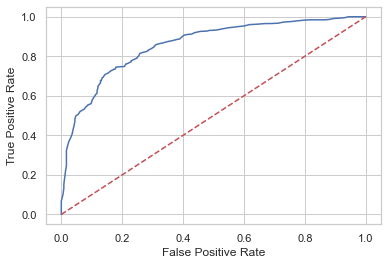

In [2826]:
from sklearn.metrics import roc_auc_score,roc_curve
log_roc_auc=roc_auc_score(y_test, predicted_random)
fpr,tpr,thresholds=roc_curve(y_test,model.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr,tpr,label='Logistic Regression'%log_roc_auc)
plt.plot([0,1],[0,1],'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('AUC=',metrics.auc(fpr, tpr))
error['Auc_Score']['Model_4']=metrics.auc(fpr, tpr)


# Running a Decison model with most of the columns

This model is to check if there is any better score when the model is provided with all the possible columns 

In [2827]:
datasets=new_df.copy()
datasets=datasets.drop(columns='Retained.in.2012.',axis=1)
x_not=new_df[[ 'Program.Code', 'From.Grade', 'To.Grade', 'Group.State',
       'Is.Non.Annual.', 'Days',  'Special.Pay', 'Tuition', 'FRP.Active',
       'FRP.Cancelled', 'FRP.Take.up.percent.', 
       'Cancelled.Pax', 'Total.Discount.Pax', 
        'Region', 'CRM.Segment', 'School.Type',
       'Parent.Meeting.Flag', 'MDR.High.Grade',
       'Total.School.Enrollment', 'Income.Level', 'EZ.Pay.Take.Up.Rate',
       'School.Sponsor', 'FPP',
       'Total.Pax', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents',
        'DifferenceTraveltoFirstMeeting',
       'DifferenceTraveltoLastMeeting', 'DepartureMonth',
      
        'SingleGradeTripFlag', 'FPP.to.School.enrollment',
       'FPP.to.PAX', 'Num.of.Non_FPP.PAX' ,'SPR.New.Existing'
      ]]
y_not=new_df['Retained.in.2012.']




In [2828]:
X_train, X_test, y_train, y_test = train_test_split(x_not, y_not, test_size=0.4,random_state=100)
clf=DecisionTreeClassifier(criterion="entropy")
clf=clf.fit(X_train,y_train)
predicitons_des=clf.predict(X_test)
clf.predict_proba(X_test)



array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [0., 1.],
       [1., 0.],
       [0., 1.]])

In [2829]:
fea= clf.feature_importances_
feature_importance_=pd.DataFrame(fea,index=x_not.columns).sort_values(by=[0],ascending=False)
feature_importance_


,0
SingleGradeTripFlag,0.147469
Is.Non.Annual.,0.074488
EZ.Pay.Take.Up.Rate,0.060228
FPP.to.PAX,0.058785
FPP.to.School.enrollment,0.056591
Total.Pax,0.054010
SPR.Group.Revenue,0.049856
Total.School.Enrollment,0.049401
Tuition,0.044794
FRP.Take.up.percent.,0.044001


<AxesSubplot:>

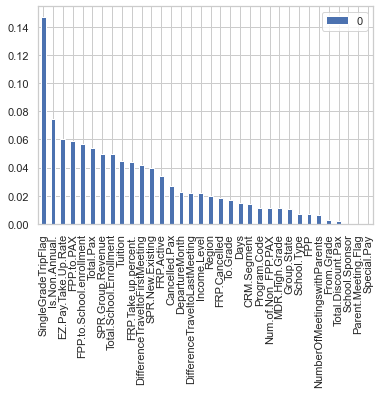

In [2830]:
feature_importance_.plot(kind='bar')

# Error Matrics

In [2831]:
print(confusion_matrix(y_test,predicitons_des))

[[257 100]
 [158 422]]


In [2832]:
print(accuracy_score(y_test,predicitons_des))

print(precision_score(y_test,predicitons_des))
print(recall_score(y_test, predicitons_des))
print(classification_report(y_test, predicitons_des))
error['Recall']['Model_5']=recall_score(y_test,predicitons_des)
error['Precision']['Model_5']=precision_score(y_test,predicitons_des)
error['Accuracy']['Model_5']=accuracy_score(y_test,predicitons_des)

0.7246531483457844
0.8084291187739464
0.7275862068965517
              precision    recall  f1-score   support

           0       0.62      0.72      0.67       357
           1       0.81      0.73      0.77       580

    accuracy                           0.72       937
   macro avg       0.71      0.72      0.72       937
weighted avg       0.74      0.72      0.73       937



AUC= 0.7237370810393123


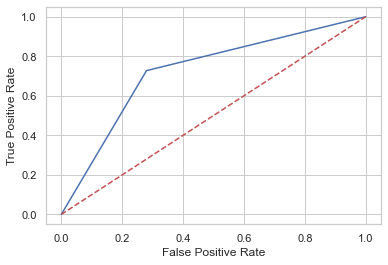

In [2833]:
from sklearn.metrics import roc_auc_score,roc_curve
log_roc_auc=roc_auc_score(y_test,predicitons_des)
fpr,tpr,thresholds=roc_curve(y_test,clf.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr,tpr,label='Logistic Regression'%log_roc_auc)
plt.plot([0,1],[0,1],'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('AUC=',metrics.auc(fpr, tpr))
error['Auc_Score']['Model_5']=metrics.auc(fpr, tpr)


# Creating models for all possible combiantion of column Arrangement


In [2419]:
from itertools import combinations

In [2509]:
ab=[ 'Program.Code', 'From.Grade', 'To.Grade', 'Group.State',
       'Is.Non.Annual.', 'Days',  'Special.Pay', 'Tuition', 'FRP.Active',
       'FRP.Cancelled', 'FRP.Take.up.percent.', 
       'Cancelled.Pax', 'Total.Discount.Pax', 
        'Region', 'CRM.Segment', 'School.Type',
       'Parent.Meeting.Flag', 'MDR.High.Grade',
       'Total.School.Enrollment', 'Income.Level', 'EZ.Pay.Take.Up.Rate',
       'School.Sponsor', 'FPP',
       'Total.Pax', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents',
        'DifferenceTraveltoFirstMeeting',
       'DifferenceTraveltoLastMeeting', 'DepartureMonth',
      
        'SingleGradeTripFlag', 'FPP.to.School.enrollment',
       'FPP.to.PAX', 'Num.of.Non_FPP.PAX' ,'SPR.New.Existing'
      ]

In [2510]:
list_1=[]
com=combinations(ab,5)

In [2511]:
for i in com:
    list(i)
    print(i)
    list_1.append(i)
    
    

('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Is.Non.Annual.')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Days')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Special.Pay')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Tuition')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'FRP.Active')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'FRP.Cancelled')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'FRP.Take.up.percent.')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Cancelled.Pax')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Total.Discount.Pax')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Region')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'CRM.Segment')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'School.Type')
('Program.Code', 'From.Grade', 'To.Grade', 'Group.State', 'Parent.Meeting.Flag')
('Program.Code', 'From.Grade', 'To.Gr

('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'Total.Pax')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'SPR.Group.Revenue')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'NumberOfMeetingswithParents')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'DepartureMonth')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'SingleGradeTripFlag')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'FPP.to.School.enrollment')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'FPP.to.PAX')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'Num.of.Non_FPP.PAX')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Active', 'SPR.New.Existing')
('Program.Code', 'From.Grade', 'Tuition', 'FRP.Cancelled', 'FRP.Take.up.percent.')
('Program.Code', 'From.Grade', 'Tuition', 'F

('Program.Code', 'From.Grade', 'Income.Level', 'Total.Pax', 'FPP.to.PAX')
('Program.Code', 'From.Grade', 'Income.Level', 'Total.Pax', 'Num.of.Non_FPP.PAX')
('Program.Code', 'From.Grade', 'Income.Level', 'Total.Pax', 'SPR.New.Existing')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'DepartureMonth')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'SingleGradeTripFlag')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'FPP.to.PAX')
('Program.Code', 'From.Grade', 'Income.Level', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('Program.Code', 

('Program.Code', 'To.Grade', 'Tuition', 'FRP.Active', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Active', 'DepartureMonth')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Active', 'SingleGradeTripFlag')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Active', 'FPP.to.School.enrollment')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Active', 'FPP.to.PAX')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Active', 'Num.of.Non_FPP.PAX')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Active', 'SPR.New.Existing')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Cancelled', 'FRP.Take.up.percent.')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Cancelled', 'Cancelled.Pax')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Cancelled', 'Total.Discount.Pax')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Cancelled', 'Region')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Cancelled', 'CRM.Segment')
('Program.Code', 'To.Grade', 'Tuition', 'FRP.Cancelled', 'School.Type')
('Program.Code', 'T

('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'DepartureMonth')
('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'SingleGradeTripFlag')
('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'FPP.to.PAX')
('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('Program.Code', 'To.Grade', 'Income.Level', 'SPR.Group.Revenue', 'SPR.New.Existing')
('Program.Code', 'To.Grade', 'Income.Level', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'To.Grade', 'Income.Level', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'To.Grade', 'Income.Level', 'NumberOfMeeting

('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'Region', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'Region', 'DepartureMonth')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'Region', 'SingleGradeTripFlag')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'Region', 'FPP.to.School.enrollment')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'Region', 'FPP.to.PAX')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'Region', 'Num.of.Non_FPP.PAX')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'Region', 'SPR.New.Existing')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'CRM.Segment', 'School.Type')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'CRM.Segment', 'Parent.Meeting.Flag')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'CRM.Segment', 'MDR.High.Grade')
('Program.Code', 'Group.State', 'FRP.Take.up.percent.', 'CRM.Segment', 'Total.School.Enrollment')
('Program.Cod

('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'DepartureMonth')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'SingleGradeTripFlag')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'FPP.to.School.enrollment')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'FPP.to.PAX')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'Num.of.Non_FPP.PAX')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'Region', 'SPR.New.Existing')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'CRM.Segment', 'School.Type')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'CRM.Segment', 'Parent.Meeting.Flag')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'CRM.Segment', 'MDR.High.Grade')
('Program.Code', 'Is.Non.Annual.', 'Special.Pay', 'CRM.Segment', 'Total.Schoo

('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'School.Type', 'SPR.New.Existing')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'MDR.High.Grade')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'Total.School.Enrollment')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'Income.Level')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'EZ.Pay.Take.Up.Rate')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'School.Sponsor')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'FPP')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'Total.Pax')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'SPR.Group.Revenue')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'NumberOfMeetingswithParents')
('Program.Code', 'Is.Non.Annual.', 'CRM.Segment', 'Parent.Meeting.Flag', 'Difference

('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'NumberOfMeetingswithParents')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'DepartureMonth')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'SingleGradeTripFlag')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'FPP.to.School.enrollment')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'FPP.to.PAX')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'Num.of.Non_FPP.PAX')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'SPR.New.Existing')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'Income.Level')
('Program.Code', 'Days', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'EZ.Pa

('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'Income.Level')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'School.Sponsor')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'FPP')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'Total.Pax')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'SPR.Group.Revenue')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'NumberOfMeetingswithParents')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'DepartureMonth')
('Program.Code', 'Special.Pay', 'Tuition', 'Total.Discount.Pax', 'SingleGradeTripFlag')
('Program.Code', 'Special.Pay', 'Tuition', 'Tota

('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'FPP.to.PAX')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'SPR.New.Existing')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'NumberOfMeetingswithParents', 'DepartureMonth')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'NumberOfMeetingswithParents', 'SingleGradeTripFlag')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.Up.Rate', 'NumberOfMeetingswithParents', 'FPP.to.School.enrollment')
('Program.Code', 'Special.Pay', 'EZ.Pay.Take.U

('Program.Code', 'Tuition', 'Income.Level', 'FPP', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'Tuition', 'Income.Level', 'FPP', 'DepartureMonth')
('Program.Code', 'Tuition', 'Income.Level', 'FPP', 'SingleGradeTripFlag')
('Program.Code', 'Tuition', 'Income.Level', 'FPP', 'FPP.to.School.enrollment')
('Program.Code', 'Tuition', 'Income.Level', 'FPP', 'FPP.to.PAX')
('Program.Code', 'Tuition', 'Income.Level', 'FPP', 'Num.of.Non_FPP.PAX')
('Program.Code', 'Tuition', 'Income.Level', 'FPP', 'SPR.New.Existing')
('Program.Code', 'Tuition', 'Income.Level', 'Total.Pax', 'SPR.Group.Revenue')
('Program.Code', 'Tuition', 'Income.Level', 'Total.Pax', 'NumberOfMeetingswithParents')
('Program.Code', 'Tuition', 'Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'Tuition', 'Income.Level', 'Total.Pax', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'Tuition', 'Income.Level', 'Total.Pax', 'DepartureMonth')
('Program.Code', 'Tuition', 'Income.Level', 'Total.Pax', 'Singl

('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'Total.Pax', 'Num.of.Non_FPP.PAX')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'Total.Pax', 'SPR.New.Existing')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'DepartureMonth')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'SingleGradeTripFlag')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'FPP.to.PAX')
('Program.Code', 'FRP.Active', 'Parent.Meeting.Flag', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('Program.Code', 'FRP

('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'NumberOfMeetingswithParents', 'FPP.to.PAX')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'NumberOfMeetingswithParents', 'Num.of.Non_FPP.PAX')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'NumberOfMeetingswithParents', 'SPR.New.Existing')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'DifferenceTraveltoLastMeeting')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'FPP.to.PAX')
('Program.Code', 'FRP.Cancelled', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'Num.of.Non_FPP.PAX')
('Program.Code', 'FRP.Cancelled', 'School

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'DepartureMonth')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'SingleGradeTripFlag')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'FPP.to.PAX')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'SPR.New.Existing')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'To.Grade', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'To.G

('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'Total.School.Enrollment')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'Income.Level')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'EZ.Pay.Take.Up.Rate')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'School.Sponsor')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'FPP')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'Total.Pax')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'SPR.Group.Revenue')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'NumberOfMeetingswithParents')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'Group.State', 'FRP.Active', 'FRP.Cancelled', 'DepartureMonth')
('From.Gr

('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'EZ.Pay.Take.Up.Rate')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'School.Sponsor')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'FPP')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'Total.Pax')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'SPR.Group.Revenue')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'NumberOfMeetingswithParents')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'DepartureMonth')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'SingleGradeTripFlag')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'FPP.to.School.enrollment')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'FPP.to.PAX')
('From.Grade', 'Is.Non.Annual.', 'Days', 'FRP.Active', 'Num.of.Non_FPP.PAX')


('From.Grade', 'Is.Non.Annual.', 'School.Type', 'EZ.Pay.Take.Up.Rate', 'FPP.to.PAX')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'EZ.Pay.Take.Up.Rate', 'Num.of.Non_FPP.PAX')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'EZ.Pay.Take.Up.Rate', 'SPR.New.Existing')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'FPP')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'Total.Pax')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'SPR.Group.Revenue')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'NumberOfMeetingswithParents')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'DepartureMonth')
('From.Grade', 'Is.Non.Annual.', 'School.Type', 'School.Sponsor', 'SingleGradeTripFlag')
('From.Grade', 'Is.Non.

('From.Grade', 'Days', 'Total.Discount.Pax', 'SPR.Group.Revenue', 'SPR.New.Existing')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'DepartureMonth')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'SingleGradeTripFlag')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'FPP.to.School.enrollment')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'FPP.to.PAX')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'Num.of.Non_FPP.PAX')
('From.Grade', 'Days', 'Total.Discount.Pax', 'NumberOfMeetingswithParents', 'SPR.New.Existing')
('From.Grade', 'Days', 'Total.Discount.Pax', 'DifferenceTraveltoFirstMeeting', 'DifferenceTraveltoLastMeeting')
('

('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoLastMeeting', 'SingleGradeTripFlag')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoLastMeeting', 'FPP.to.PAX')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoLastMeeting', 'Num.of.Non_FPP.PAX')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoLastMeeting', 'SPR.New.Existing')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DepartureMonth', 'SingleGradeTripFlag')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DepartureMonth', 'FPP.to.School.enrollment')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DepartureMonth', 'FPP.to.PAX')
('From.Grade', 'Special.Pay', 'FRP.Take.up.percent.', 'DepartureMonth', 

('From.Grade', 'Tuition', 'Cancelled.Pax', 'CRM.Segment', 'DepartureMonth')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'CRM.Segment', 'SingleGradeTripFlag')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'CRM.Segment', 'FPP.to.School.enrollment')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'CRM.Segment', 'FPP.to.PAX')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'CRM.Segment', 'Num.of.Non_FPP.PAX')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'CRM.Segment', 'SPR.New.Existing')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'School.Type', 'Parent.Meeting.Flag')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'School.Type', 'MDR.High.Grade')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'School.Type', 'Total.School.Enrollment')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'School.Type', 'Income.Level')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'School.Type', 'EZ.Pay.Take.Up.Rate')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'School.Type', 'School.Sponsor')
('From.Grade', 'Tuition', 'Cancelled.Pax', 'School.Typ

('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'SPR.Group.Revenue')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'NumberOfMeetingswithParents')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'DepartureMonth')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'SingleGradeTripFlag')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'FPP.to.School.enrollment')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'FPP.to.PAX')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'Num.of.Non_FPP.PAX')
('From.Grade', 'FRP.Active', 'Region', 'Parent.Meeting.Flag', 'SPR.New.Existing')
('From.Grade', 'FRP.Active', 'Region', 'MDR.High.Grade', 'Total.School.Enrollment')
('From.Grade', 'FRP.Active', 'Region', 'MDR.High.Gra

('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'FPP.to.PAX')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'Num.of.Non_FPP.PAX')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'SPR.New.Existing')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'FPP')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'Total.Pax')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'SPR.Group.Revenue')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'NumberOfMeetingswithParents')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'DepartureMonth')
('From.Grade', 'FRP.Cancelled', 'CRM.Segment', 'School.Sponsor', 'SingleGradeTripFlag')
('From.Grade', 'FRP.Cancelled', 'C

('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'Total.Pax', 'Num.of.Non_FPP.PAX')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'Total.Pax', 'SPR.New.Existing')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'DepartureMonth')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'SingleGradeTripFlag')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue', 'FPP.to.PAX')
('From.Grade', 'FRP.Take.up.percent.', 'EZ.Pay

('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'NumberOfMeetingswithParents')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'DepartureMonth')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'SingleGradeTripFlag')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'FPP.to.School.enrollment')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'FPP.to.PAX')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'Num.of.Non_FPP.PAX')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'FPP', 'SPR.New.Existing')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'Total.Pax', 'SPR.Group.Revenue')
('From.Grade', 'Total.Discount.Pax', 'Parent.Meeting.Flag', 'Total.Pax', 'Number

('From.Grade', 'CRM.Segment', 'School.Sponsor', 'FPP', 'FPP.to.PAX')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'FPP', 'Num.of.Non_FPP.PAX')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'FPP', 'SPR.New.Existing')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'SPR.Group.Revenue')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'NumberOfMeetingswithParents')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'DifferenceTraveltoFirstMeeting')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'DifferenceTraveltoLastMeeting')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'DepartureMonth')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'SingleGradeTripFlag')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'FPP.to.School.enrollment')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'FPP.to.PAX')
('From.Grade', 'CRM.Segment', 'School.Sponsor', 'Total.Pax', 'Num.of.Non_FPP.PAX')
('From

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoFirstMeeting', 'DifferenceTraveltoLastMeeting')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoFirstMeeting', 'FPP.to.PAX')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoFirstMeeting', 'Num.of.Non_FPP.PAX')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoFirstMeeting', 'SPR.New.Existing')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoLastMeeting', 'SingleGradeTripFlag')
('To.Grade', 'Special.Pay', 'FRP.Active', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('To.Grade', 'S

('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'NumberOfMeetingswithParents')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'DifferenceTraveltoFirstMeeting')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'DifferenceTraveltoLastMeeting')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'DepartureMonth')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'SingleGradeTripFlag')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'FPP.to.School.enrollment')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'FPP.to.PAX')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'Num.of.Non_FPP.PAX')
('To.Grade', 'Tuition', 'FRP.Active', 'FPP', 'SPR.New.Existing')
('To.Grade', 'Tuition', 'FRP.Active', 'Total.Pax', 'SPR.Group.Revenue')
('To.Grade', 'Tuition', 'FRP.Active', 'Total.Pax', 'NumberOfMeetingswithParents')
('To.Grade', 'Tuition', 'FRP.Active', 'Total.Pax', 'DifferenceTraveltoFirstMeeting')
('To.Grade', 'Tuition', 'FRP.Active', 'Total.Pax', 'DifferenceTraveltoLastMeeting')
('To.Grade', 'Tuition', 'FRP.Active', 'Total.Pax'

('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'Parent.Meeting.Flag', 'FPP.to.School.enrollment')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'Parent.Meeting.Flag', 'FPP.to.PAX')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'Parent.Meeting.Flag', 'Num.of.Non_FPP.PAX')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'Parent.Meeting.Flag', 'SPR.New.Existing')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'Total.School.Enrollment')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'Income.Level')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'EZ.Pay.Take.Up.Rate')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'School.Sponsor')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'FPP')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'Total.Pax')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'SPR.Group.Revenue')
('To.Grade', 'FRP.Active', 'FRP.Cancelled', 'MDR.High.Grade', 'NumberOfMeetingswithParent

('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'EZ.Pay.Take.Up.Rate')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'School.Sponsor')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'FPP')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'Total.Pax')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'SPR.Group.Revenue')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'NumberOfMeetingswithParents')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'DifferenceTraveltoFirstMeeting')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'DifferenceTraveltoLastMeeting')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'DepartureMonth')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'SingleGradeTripFlag')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'FPP.to.School.enrollment')
('To.Grade', 'FRP.Cancelled', 'Total.Discount.Pax', 'Region', 'FPP.to

('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP', 'SingleGradeTripFlag')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP', 'FPP.to.School.enrollment')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP', 'FPP.to.PAX')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP', 'Num.of.Non_FPP.PAX')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP', 'SPR.New.Existing')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'Total.Pax', 'SPR.Group.Revenue')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'Total.Pax', 'NumberOfMeetingswithParents')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'Total.Pax', 'DifferenceTraveltoFirstMeeting')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'Total.Pax', 'DifferenceTraveltoLastMeeting')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'Total.Pax', 'DepartureMonth')
('To.Grade', 'FRP.Take.up.percent.', 'Parent.Meeting.Fla

('To.Grade', 'Cancelled.Pax', 'FPP.to.PAX', 'Num.of.Non_FPP.PAX', 'SPR.New.Existing')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'School.Type')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'Parent.Meeting.Flag')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'MDR.High.Grade')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'Total.School.Enrollment')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'Income.Level')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'School.Sponsor')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'FPP')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'Total.Pax')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'SPR.Group.Revenue')
('To.Grade', 'Total.Discount.Pax', 'Region', 'CRM.Segment', 'NumberOfMeetingswithParents')
('To.Grade', 'Total.Discount.Pax', 'Region

('To.Grade', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'FPP.to.School.enrollment')
('To.Grade', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'FPP.to.PAX')
('To.Grade', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'Num.of.Non_FPP.PAX')
('To.Grade', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'SPR.New.Existing')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.School.Enrollment', 'Income.Level')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.School.Enrollment', 'EZ.Pay.Take.Up.Rate')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.School.Enrollment', 'School.Sponsor')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.School.Enrollment', 'FPP')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.School.Enrollment', 'Total.Pax')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.School.Enrollment', 'SPR.Group.Revenue')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.School.Enrollment', 'NumberOfMeetingswithParents')
('To.Grade', 'CRM.Segment', 'School.Type', 'Total.Sch

('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'SPR.Group.Revenue', 'SingleGradeTripFlag')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'SPR.Group.Revenue', 'FPP.to.PAX')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'SPR.Group.Revenue', 'SPR.New.Existing')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'NumberOfMeetingswithParents', 'DepartureMonth')
('To.Grade', 'MDR.High.Grade', 'Total.School.Enrollment', 'NumberOfMeetingswithParents', 'SingleGradeTripFlag')
('To.Grade', 'MDR.High.Grade', 'To

('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'EZ.Pay.Take.Up.Rate')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'School.Sponsor')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'FPP')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'Total.Pax')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'SPR.Group.Revenue')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'NumberOfMeetingswithParents')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoFirstMeeting')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'DifferenceTraveltoLastMeeting')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'DepartureMonth')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 'FRP.Take.up.percent.', 'SingleGradeTripFlag')
('Group.State', 'Is.Non.Annual.', 'Special.Pay', 

('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'School.Sponsor', 'FPP.to.PAX')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'School.Sponsor', 'Num.of.Non_FPP.PAX')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'School.Sponsor', 'SPR.New.Existing')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'FPP', 'Total.Pax')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'FPP', 'SPR.Group.Revenue')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'FPP', 'NumberOfMeetingswithParents')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'FPP', 'DifferenceTraveltoFirstMeeting')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'FPP', 'DifferenceTraveltoLastMeeting')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'FPP', 'DepartureMonth')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment', 'FPP', 'SingleGradeTripFlag')
('Group.State', 'Is.Non.Annual.', 'Total.School.Enrollment

('Group.State', 'Days', 'Region', 'Total.School.Enrollment', 'FPP.to.PAX')
('Group.State', 'Days', 'Region', 'Total.School.Enrollment', 'Num.of.Non_FPP.PAX')
('Group.State', 'Days', 'Region', 'Total.School.Enrollment', 'SPR.New.Existing')
('Group.State', 'Days', 'Region', 'Income.Level', 'EZ.Pay.Take.Up.Rate')
('Group.State', 'Days', 'Region', 'Income.Level', 'School.Sponsor')
('Group.State', 'Days', 'Region', 'Income.Level', 'FPP')
('Group.State', 'Days', 'Region', 'Income.Level', 'Total.Pax')
('Group.State', 'Days', 'Region', 'Income.Level', 'SPR.Group.Revenue')
('Group.State', 'Days', 'Region', 'Income.Level', 'NumberOfMeetingswithParents')
('Group.State', 'Days', 'Region', 'Income.Level', 'DifferenceTraveltoFirstMeeting')
('Group.State', 'Days', 'Region', 'Income.Level', 'DifferenceTraveltoLastMeeting')
('Group.State', 'Days', 'Region', 'Income.Level', 'DepartureMonth')
('Group.State', 'Days', 'Region', 'Income.Level', 'SingleGradeTripFlag')
('Group.State', 'Days', 'Region', 'Incom

('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'School.Sponsor')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'FPP')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'Total.Pax')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'SPR.Group.Revenue')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'NumberOfMeetingswithParents')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'DifferenceTraveltoFirstMeeting')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'DifferenceTraveltoLastMeeting')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'DepartureMonth')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'SingleGradeTripFlag')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'FPP.to.School.enrollment')
('Group.State', 'Special.Pay', 'Cancelled.Pax', 'MDR.High.Grade', 'FPP.to.PAX')
('Group.State', 'Special.Pay', 'Ca

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('Group.State', 'FPP', 'SPR.Group.Revenue', 'SingleGradeTripFlag', 'SPR.New.Existing')
('Group.State', 'FPP', 'SPR.Group.Revenue', 'FPP.to.School.enrollment', 'FPP.to.PAX')
('Group.State', 'FPP', 'SPR.Group.Revenue', 'FPP.to.School.enrollment', 'Num.of.Non_FPP.PAX')
('Group.State', 'FPP', 'SPR.Group.Revenue', 'FPP.to.School.enrollment', 'SPR.New.Existing')
('Group.State', 'FPP', 'SPR.Group.Revenue', 'FPP.to.PAX', 'Num.of.Non_FPP.PAX')
('Group.State', 'FPP', 'SPR.Group.Revenue', 'FPP.to.PAX', 'SPR.New.Existing')
('Group.State', 'FPP', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX', 'SPR.New.Existing')
('Group.State', 'FPP', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting', 'DifferenceTraveltoLastMeeting')
('Group.State', 'FPP', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth')
('Group.State', 'FPP', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag')
('Group.State', 'FPP', 'NumberOfMeetingswithParents', 'Dif

('Is.Non.Annual.', 'Days', 'Region', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('Is.Non.Annual.', 'Days', 'Region', 'DifferenceTraveltoLastMeeting', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'Days', 'Region', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'Days', 'Region', 'DifferenceTraveltoLastMeeting', 'FPP.to.PAX')
('Is.Non.Annual.', 'Days', 'Region', 'DifferenceTraveltoLastMeeting', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'Days', 'Region', 'DifferenceTraveltoLastMeeting', 'SPR.New.Existing')
('Is.Non.Annual.', 'Days', 'Region', 'DepartureMonth', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'Days', 'Region', 'DepartureMonth', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'Days', 'Region', 'DepartureMonth', 'FPP.to.PAX')
('Is.Non.Annual.', 'Days', 'Region', 'DepartureMonth', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'Days', 'Region', 'DepartureMonth', 'SPR.New.Existing')
('Is.Non.Annual.', 'Days', 'Region', 'SingleGradeTripFlag', 'FPP.to.Schoo

('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'SPR.Group.Revenue')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'NumberOfMeetingswithParents')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'DifferenceTraveltoFirstMeeting')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'DifferenceTraveltoLastMeeting')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'DepartureMonth')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'FPP.to.PAX')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'Special.Pay', 'Total.Discount.Pax', 'School.Type', 'SPR.New.Existing')
('Is.Non.Annual.', 'Special.Pay', 'Total.Disco

('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'SPR.Group.Revenue')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'NumberOfMeetingswithParents')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'DifferenceTraveltoFirstMeeting')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'DifferenceTraveltoLastMeeting')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'DepartureMonth')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'FPP.to.PAX')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'Region', 'SPR.New.Existing')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'CRM.Segment', 'School.Type')
('Is.Non.Annual.', 'Tuition', 'Total.Discount.Pax', 'C

('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'SPR.Group.Revenue')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'NumberOfMeetingswithParents')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'DifferenceTraveltoFirstMeeting')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'DifferenceTraveltoLastMeeting')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'DepartureMonth')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'FPP.to.PAX')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'FPP', 'SPR.New.Existing')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'Total.Pax', 'SPR.Group.Revenue')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'Total.Pax', 'NumberOfMeetingswithParents')
('Is.Non.Annual.', 'FRP.Active', 'Region', 'Total.Pax', 'DifferenceTraveltoFirstMeeting')
('

('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'SPR.Group.Revenue', 'FPP.to.PAX')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'SPR.Group.Revenue', 'SPR.New.Existing')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'NumberOfMeetingswithParents', 'DepartureMonth')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'NumberOfMeetingswithParents', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'NumberOfMeetingswithParents', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'NumberOfMeetingswithParents', 'FPP.to.PAX')
('Is.Non.Annual.', 'FRP.Cancelled', 'School.Type', 'NumberOfMeetingswithParents', 'Num

('Is.Non.Annual.', 'FRP.Take.up.percent.', 'Total.Pax', 'FPP.to.School.enrollment', 'FPP.to.PAX')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'Total.Pax', 'FPP.to.School.enrollment', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'Total.Pax', 'FPP.to.School.enrollment', 'SPR.New.Existing')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'Total.Pax', 'FPP.to.PAX', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'Total.Pax', 'FPP.to.PAX', 'SPR.New.Existing')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'Total.Pax', 'Num.of.Non_FPP.PAX', 'SPR.New.Existing')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('Is.Non.Annual.', 'FRP.Take.up.percent.', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents', 'DepartureMonth')
('Is.Non.Annual.', 'FRP.Take.up.percent.',

('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'DepartureMonth')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'FPP.to.PAX')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'SPR.New.Existing')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'FPP', 'Total.Pax')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'FPP', 'SPR.Group.Revenue')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'FPP', 'NumberOfMeetingswithParents')
('Is.Non.Annual.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate', 'FPP', 'DifferenceTraveltoFirstMeeting')


('Is.Non.Annual.', 'School.Type', 'Income.Level', 'FPP', 'FPP.to.PAX')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'FPP', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'FPP', 'SPR.New.Existing')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'SPR.Group.Revenue')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'NumberOfMeetingswithParents')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'DifferenceTraveltoLastMeeting')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'DepartureMonth')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'FPP.to.PAX')
('Is.Non.Annual.', 'School.Type', 'Income.Level', 'Total.Pax', 'Num

('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'SPR.Group.Revenue', 'FPP.to.PAX')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'SPR.Group.Revenue', 'SPR.New.Existing')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'NumberOfMeetingswithParents', 'DepartureMonth')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'NumberOfMeetingswithParents', 'SingleGradeTripFlag')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'NumberOfMeetingswithParents', 'FPP.to.School.enrollment')
('Is.Non.Annual.', 'EZ.Pay.Take.Up.Rate', 'FPP', 'NumberOfMeetingswithParents', 'FPP.to.PAX')
('Is.N

('Days', 'Special.Pay', 'Region', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('Days', 'Special.Pay', 'Region', 'DifferenceTraveltoLastMeeting', 'SingleGradeTripFlag')
('Days', 'Special.Pay', 'Region', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('Days', 'Special.Pay', 'Region', 'DifferenceTraveltoLastMeeting', 'FPP.to.PAX')
('Days', 'Special.Pay', 'Region', 'DifferenceTraveltoLastMeeting', 'Num.of.Non_FPP.PAX')
('Days', 'Special.Pay', 'Region', 'DifferenceTraveltoLastMeeting', 'SPR.New.Existing')
('Days', 'Special.Pay', 'Region', 'DepartureMonth', 'SingleGradeTripFlag')
('Days', 'Special.Pay', 'Region', 'DepartureMonth', 'FPP.to.School.enrollment')
('Days', 'Special.Pay', 'Region', 'DepartureMonth', 'FPP.to.PAX')
('Days', 'Special.Pay', 'Region', 'DepartureMonth', 'Num.of.Non_FPP.PAX')
('Days', 'Special.Pay', 'Region', 'DepartureMonth', 'SPR.New.Existing')
('Days', 'Special.Pay', 'Region', 'SingleGradeTripFlag', 'FPP.to.School.enrollment')
('Days', 'Special.Pay

('Days', 'Tuition', 'Region', 'Income.Level', 'EZ.Pay.Take.Up.Rate')
('Days', 'Tuition', 'Region', 'Income.Level', 'School.Sponsor')
('Days', 'Tuition', 'Region', 'Income.Level', 'FPP')
('Days', 'Tuition', 'Region', 'Income.Level', 'Total.Pax')
('Days', 'Tuition', 'Region', 'Income.Level', 'SPR.Group.Revenue')
('Days', 'Tuition', 'Region', 'Income.Level', 'NumberOfMeetingswithParents')
('Days', 'Tuition', 'Region', 'Income.Level', 'DifferenceTraveltoFirstMeeting')
('Days', 'Tuition', 'Region', 'Income.Level', 'DifferenceTraveltoLastMeeting')
('Days', 'Tuition', 'Region', 'Income.Level', 'DepartureMonth')
('Days', 'Tuition', 'Region', 'Income.Level', 'SingleGradeTripFlag')
('Days', 'Tuition', 'Region', 'Income.Level', 'FPP.to.School.enrollment')
('Days', 'Tuition', 'Region', 'Income.Level', 'FPP.to.PAX')
('Days', 'Tuition', 'Region', 'Income.Level', 'Num.of.Non_FPP.PAX')
('Days', 'Tuition', 'Region', 'Income.Level', 'SPR.New.Existing')
('Days', 'Tuition', 'Region', 'EZ.Pay.Take.Up.Rate'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('Special.Pay', 'Tuition', 'FPP', 'NumberOfMeetingswithParents', 'DepartureMonth')
('Special.Pay', 'Tuition', 'FPP', 'NumberOfMeetingswithParents', 'SingleGradeTripFlag')
('Special.Pay', 'Tuition', 'FPP', 'NumberOfMeetingswithParents', 'FPP.to.School.enrollment')
('Special.Pay', 'Tuition', 'FPP', 'NumberOfMeetingswithParents', 'FPP.to.PAX')
('Special.Pay', 'Tuition', 'FPP', 'NumberOfMeetingswithParents', 'Num.of.Non_FPP.PAX')
('Special.Pay', 'Tuition', 'FPP', 'NumberOfMeetingswithParents', 'SPR.New.Existing')
('Special.Pay', 'Tuition', 'FPP', 'DifferenceTraveltoFirstMeeting', 'DifferenceTraveltoLastMeeting')
('Special.Pay', 'Tuition', 'FPP', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth')
('Special.Pay', 'Tuition', 'FPP', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag')
('Special.Pay', 'Tuition', 'FPP', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment')
('Special.Pay', 'Tuition', 'FPP', 'DifferenceTraveltoFirstMeeting', 'FPP.to.PAX')
('Special.Pay', 'Tuition', '

('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'Total.Pax')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'SPR.Group.Revenue')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'NumberOfMeetingswithParents')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'DifferenceTraveltoFirstMeeting')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'DifferenceTraveltoLastMeeting')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'DepartureMonth')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'SingleGradeTripFlag')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'FPP.to.School.enrollment')
('Special.Pay', 'FRP.Cancelled', 'FRP.Take.up.percent.', 'Total.School.Enrollment', 'FPP.to.PAX')
('Special.Pay', 'FRP.Cancelle

('Special.Pay', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'SingleGradeTripFlag', 'SPR.New.Existing')
('Special.Pay', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP.to.School.enrollment', 'FPP.to.PAX')
('Special.Pay', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP.to.School.enrollment', 'Num.of.Non_FPP.PAX')
('Special.Pay', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP.to.School.enrollment', 'SPR.New.Existing')
('Special.Pay', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP.to.PAX', 'Num.of.Non_FPP.PAX')
('Special.Pay', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP.to.PAX', 'SPR.New.Existing')
('Special.Pay', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'Num.of.Non_FPP.PAX', 'SPR.New.Existing')
('Special.Pay', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'Total.School.Enrollment', 'Income.Level')
('Special.Pay', 'FRP.Take.up.percent.', 'MDR.High.Grade', 'Total.School.Enrollment', 'EZ.Pay.Take.Up.Rate')
('Special.Pay', 'FRP.Take.up.percent.', 'MDR.High.Grade

('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'Total.School.Enrollment')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'Income.Level')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'EZ.Pay.Take.Up.Rate')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'FPP')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'Total.Pax')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'SPR.Group.Revenue')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'NumberOfMeetingswithParents')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'DifferenceTraveltoFirstMeeting')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'DifferenceTraveltoLastMeeting')
('Special.Pay', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Fla

('Special.Pay', 'CRM.Segment', 'School.Type', 'Parent.Meeting.Flag', 'SPR.New.Existing')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'Total.School.Enrollment')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'Income.Level')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'EZ.Pay.Take.Up.Rate')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'School.Sponsor')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'FPP')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'Total.Pax')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'SPR.Group.Revenue')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'NumberOfMeetingswithParents')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'DifferenceTraveltoFirstMeeting')
('Special.Pay', 'CRM.Segment', 'School.Type', 'MDR.High.Grade', 'DifferenceTraveltoLastMeeting')
('Special.Pay', 'CRM.Segment', 'School.Type', 'M

('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'FPP', 'DifferenceTraveltoLastMeeting')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'FPP', 'DepartureMonth')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'FPP', 'SingleGradeTripFlag')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'FPP', 'FPP.to.School.enrollment')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'FPP', 'FPP.to.PAX')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'FPP', 'Num.of.Non_FPP.PAX')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'FPP', 'SPR.New.Existing')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'Total.Pax', 'SPR.Group.Revenue')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'Total.Pax', 'NumberOfMeetingswithParents')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment', 'Total.Pax', 'DifferenceTraveltoFirstMeeting')
('Special.Pay', 'MDR.High.Grade', 'Total.School.Enrollment

('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Cancelled.Pax', 'FPP.to.PAX')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Cancelled.Pax', 'Num.of.Non_FPP.PAX')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Cancelled.Pax', 'SPR.New.Existing')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'Region')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'CRM.Segment')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'School.Type')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'Parent.Meeting.Flag')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'MDR.High.Grade')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'Total.School.Enrollment')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'Income.Level')
('Tuition', 'FRP.Active', 'FRP.Take.up.percent.', 'Total.Discount.Pax', 'EZ.Pay.Take.Up.Rate')
('Tuition', 'FRP.Act

('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'NumberOfMeetingswithParents')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'DifferenceTraveltoFirstMeeting')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'DifferenceTraveltoLastMeeting')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'DepartureMonth')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'SingleGradeTripFlag')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'FPP.to.School.enrollment')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'FPP.to.PAX')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'Num.of.Non_FPP.PAX')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'CRM.Segment', 'SPR.New.Existing')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'School.Type', 'Parent.Meeting.Flag')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'School.Type', 'MDR.High.Grade')
('Tuition', 'FRP.Cancelled', 'Cancelled.Pax', 'School.Type', 'Tot

('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'DifferenceTraveltoLastMeeting')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'DepartureMonth')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'SingleGradeTripFlag')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'FPP.to.School.enrollment')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'FPP.to.PAX')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'Num.of.Non_FPP.PAX')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.New.Existing')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP', 'Total.Pax')
('Tuition', 'FRP.Take.up.percent.', 'Parent.Meeting.Flag', 'FPP', 'SPR.Group.Revenue')
('Tuition', 'FRP.Take.up.p

('Tuition', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'DifferenceTraveltoLastMeeting')
('Tuition', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'DepartureMonth')
('Tuition', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'SingleGradeTripFlag')
('Tuition', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'FPP.to.School.enrollment')
('Tuition', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'FPP.to.PAX')
('Tuition', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'Num.of.Non_FPP.PAX')
('Tuition', 'Total.Discount.Pax', 'Region', 'Parent.Meeting.Flag', 'SPR.New.Existing')
('Tuition', 'Total.Discount.Pax', 'Region', 'MDR.High.Grade', 'Total.School.Enrollment')
('Tuition', 'Total.Discount.Pax', 'Region', 'MDR.High.Grade', 'Income.Level')
('Tuition', 'Total.Discount.Pax', 'Region', 'MDR.High.Grade', 'EZ.Pay.Take.Up.Rate')
('Tuition', 'Total.Discount.Pax', 'Region', 'MDR.High.Grade', 'School.Sponsor')
('Tuition', 'Total.Discount.Pax', 'Region

('Tuition', 'Region', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents', 'Num.of.Non_FPP.PAX')
('Tuition', 'Region', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents', 'SPR.New.Existing')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'DifferenceTraveltoLastMeeting')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'FPP.to.PAX')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'Num.of.Non_FPP.PAX')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'SPR.New.Existing')
('Tuition', 'Region', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('Tuition', 'Region

('Tuition', 'MDR.High.Grade', 'Income.Level', 'School.Sponsor', 'Num.of.Non_FPP.PAX')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'School.Sponsor', 'SPR.New.Existing')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'Total.Pax')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'SPR.Group.Revenue')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'NumberOfMeetingswithParents')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'DifferenceTraveltoFirstMeeting')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'DifferenceTraveltoLastMeeting')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'DepartureMonth')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'SingleGradeTripFlag')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'FPP.to.School.enrollment')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'FPP.to.PAX')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'Num.of.Non_FPP.PAX')
('Tuition', 'MDR.High.Grade', 'Income.Level', 'FPP', 'SPR.New.E

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DifferenceTraveltoLastMeeting', 'FPP.to.PAX')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DifferenceTraveltoLastMeeting', 'Num.of.Non_FPP.PAX')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DifferenceTraveltoLastMeeting', 'SPR.New.Existing')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DepartureMonth', 'SingleGradeTripFlag')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DepartureMonth', 'FPP.to.School.enrollment')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DepartureMonth', 'FPP.to.PAX')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DepartureMonth', 'Num.of.Non_FPP.PAX')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'DepartureMonth', 'SPR.New.Existing')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'SingleGradeTripFlag', 'FPP.to.School.enrollment')
('FRP.Cancelled', 'Total.Discount.Pax', 'CRM.Segment', 'SingleGradeTripFlag', 'FPP.to.PAX')
('FRP.Canc

('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'SingleGradeTripFlag', 'Num.of.Non_FPP.PAX')
('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'SingleGradeTripFlag', 'SPR.New.Existing')
('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'FPP.to.School.enrollment', 'FPP.to.PAX')
('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'FPP.to.School.enrollment', 'Num.of.Non_FPP.PAX')
('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'FPP.to.School.enrollment', 'SPR.New.Existing')
('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'FPP.to.PAX', 'Num.of.Non_FPP.PAX')
('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'FPP.to.PAX', 'SPR.New.Existing')
('FRP.Cancelled', 'CRM.Segment', 'Income.Level', 'Num.of.Non_FPP.PAX', 'SPR.New.Existing')
('FRP.Cancelled', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'FPP')
('FRP.Cancelled', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'Total.Pax')
('FRP.Cancelled', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor', 'SPR.Group.Revenue')
('FRP

('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DifferenceTraveltoLastMeeting', 'FPP.to.PAX')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DifferenceTraveltoLastMeeting', 'Num.of.Non_FPP.PAX')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DifferenceTraveltoLastMeeting', 'SPR.New.Existing')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DepartureMonth', 'SingleGradeTripFlag')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DepartureMonth', 'FPP.to.School.enrollment')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DepartureMonth', 'FPP.to.PAX')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DepartureMonth', 'Num.of.Non_FPP.PAX')
('FRP.Cancelled', 'Total.School.Enrollment', 'Income.Level', 'DepartureMonth', 'SPR.New.Existing')
('FRP.Cancelled', 'Total.School.Enroll

('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Total.School.Enrollment', 'FPP.to.School.enrollment')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Total.School.Enrollment', 'FPP.to.PAX')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Total.School.Enrollment', 'Num.of.Non_FPP.PAX')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Total.School.Enrollment', 'SPR.New.Existing')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Income.Level', 'EZ.Pay.Take.Up.Rate')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Income.Level', 'School.Sponsor')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Income.Level', 'FPP')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Income.Level', 'Total.Pax')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Flag', 'Income.Level', 'SPR.Group.Revenue')
('FRP.Take.up.percent.', 'Cancelled.Pax', 'Parent.Meeting.Fla

('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'EZ.Pay.Take.Up.Rate', 'SPR.New.Existing')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'FPP')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'Total.Pax')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.Group.Revenue')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'NumberOfMeetingswithParents')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'DifferenceTraveltoLastMeeting')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'DepartureMonth')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'SingleGradeTripFlag')
('FRP.Take.up.percent.', 'Region', 'Parent.Meeting.Flag', 'School.Sponsor', 'FPP.to.School.enrollment')
('FRP.T

('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'FPP.to.School.enrollment')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'FPP.to.PAX')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'Num.of.Non_FPP.PAX')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'SPR.New.Existing')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment', 'FPP.to.PAX')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment', 'Num.of.Non_FPP.PAX')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment', 'SPR.New.Existing')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTraveltoFirstMeeting', 'FPP.to.PAX', 'Num.of.Non_FPP.PAX')
('FRP.Take.up.percent.', 'School.Type', 'DifferenceTrave

('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag')
('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment')
('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'FPP.to.PAX')
('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'Num.of.Non_FPP.PAX')
('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoFirstMeeting', 'SPR.New.Existing')
('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting', 'SingleGradeTripFlag')
('FRP.Take.up.percent.', 'School.Sponsor', 'SPR.Group.Revenue', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('FRP.Take.up.percent.', 'School.Sponsor', 

('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoFirstMeeting', 'FPP.to.PAX')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoFirstMeeting', 'Num.of.Non_FPP.PAX')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoFirstMeeting', 'SPR.New.Existing')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoLastMeeting', 'SingleGradeTripFlag')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('Cancelled.Pax', 'Region', 'Total.School.Enrollment', 'DifferenceTraveltoLastMeeting', 'FPP.to.PAX')
('Cancelled.P

('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.Group.Revenue', 'DepartureMonth')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.Group.Revenue', 'SingleGradeTripFlag')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.Group.Revenue', 'FPP.to.School.enrollment')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.Group.Revenue', 'FPP.to.PAX')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.Group.Revenue', 'Num.of.Non_FPP.PAX')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'SPR.Group.Revenue', 'SPR.New.Existing')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'NumberOfMeetingswithParents', 'DifferenceTraveltoFirstMeeting')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'NumberOfMeetingswithParents', 'DifferenceTraveltoLastMeeting')
('Cancelled.Pax', 'Parent.Meeting.Flag', 'School.Sponsor', 'NumberOfMeetingswithParents', 'DepartureMonth')
('Cancelled.Pax', 'Parent.Meeting.Flag',

('Total.Discount.Pax', 'Region', 'CRM.Segment', 'Income.Level', 'Num.of.Non_FPP.PAX')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'Income.Level', 'SPR.New.Existing')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'School.Sponsor')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'FPP')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'Total.Pax')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'SPR.Group.Revenue')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'NumberOfMeetingswithParents')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'DifferenceTraveltoFirstMeeting')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'DifferenceTraveltoLastMeeting')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'DepartureMonth')
('Total.Discount.Pax', 'Region', 'CRM.Segment', 'EZ.Pay.Take.Up.Rate', 'SingleGradeTrip

('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'Num.of.Non_FPP.PAX')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoFirstMeeting', 'SPR.New.Existing')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoLastMeeting', 'DepartureMonth')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoLastMeeting', 'SingleGradeTripFlag')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoLastMeeting', 'FPP.to.School.enrollment')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoLastMeeting', 'FPP.to.PAX')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoLastMeeting', 'Num.of.Non_FPP.PAX')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DifferenceTraveltoLastMeeting', 'SPR.New.Existing')
('Total.Discount.Pax', 'School.Type', 'School.Sponsor', 'DepartureMonth', 'SingleGradeTripFlag')
('Total.Discount.Pax',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth', 'FPP.to.PAX')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth', 'Num.of.Non_FPP.PAX')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'DepartureMonth', 'SPR.New.Existing')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'FPP.to.School.enrollment')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'FPP.to.PAX')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'Num.of.Non_FPP.PAX')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'SingleGradeTripFlag', 'SPR.New.Existing')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment', 'FPP.to.PAX')
('Income.Level', 'Total.Pax', 'DifferenceTraveltoFirstMeeting', 'FPP.to.School.enrollment', 'Num.of.Non_FPP.PAX')
('Income.Level', 'Total.Pax', 'DifferenceTrave

In [2512]:
for i in range(len(list_1)):
    list_1[i]=(list(list_1[i]))
  



In [2513]:
am=[]
def run(ai):
    y_clean=new_df['Retained.in.2012.']
    X_train, X_test, y_train, y_test = train_test_split(new_df[ai], y_clean, test_size=0.4,random_state=100)
    logr = LogisticRegression(random_state=16)
    logr.fit(X_train,y_train)
   
    print(logr.intercept_)
    logr.coef_
    predictions=logr.predict(X_test)
    #pr=precision_score(y_test, predictions)
    fpr,tpr,thresholds=roc_curve(y_test,logr.predict_proba(X_test)[:,1])
    pr=metrics.auc(fpr, tpr)
    am.append(pr)
    


In [2514]:
for i in list_1:
    run(i)
    

[0.81621185]
[0.69972094]
[0.80936322]
[0.73300273]
[-0.10174745]
[0.41373426]
[0.4056751]
[0.43044124]
[-0.04289336]
[0.41697072]
[0.50218174]
[0.3248795]
[0.59975265]
[0.78454183]
[0.30350684]
[0.0562763]
[0.50048259]
[0.33969913]
[-0.33598227]
[-0.33612733]
[0.73300273]
[0.61619572]
[0.73437579]
[0.71063238]
[0.48476224]
[0.08816313]
[0.47797362]
[-0.9297432]
[-0.04289336]
[1.04543964]
[0.95087751]
[1.23367206]
[0.68585562]
[0.04799235]
[0.63772504]
[0.60334362]
[0.67008686]
[0.17029557]
[0.58771018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.69323637]
[0.60440591]
[0.78608625]
[1.15189912]
[0.52711661]
[0.23456035]
[0.71699697]
[0.58546181]
[-0.1577897]
[-0.15729594]
[0.68585562]
[0.82139807]
[0.91344764]
[0.90910195]
[0.73370047]
[0.41519598]
[0.63907871]
[-1.10904725]
[0.17029557]
[1.58027569]
[0.95956548]
[0.14468916]
[0.07362708]
[0.58109444]
[0.57086628]
[0.59112626]
[0.17420747]
[0.53751938]
[0.68172958]
[0.4808256]
[0.72797148]
[0.88036665]
[0.53576792]
[0.24951776]
[0.66005975]
[0.45705213]
[-0.23183361]
[-0.22011515]
[0.14468916]
[0.73936952]
[0.82707848]
[0.8233304]
[0.66716821]
[0.07344182]
[0.63240858]
[-0.73372522]
[0.17420747]
[1.31087783]
[0.96878808]
[0.21077631]
[0.71062657]
[0.69328408]
[0.72067887]
[0.17490744]
[0.67972285]
[0.80478873]
[0.61713639]
[0.86094335]
[1.06024948]
[0.65879919]
[0.35615551]
[0.78478005]
[0.59208088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19763473]
[-0.1955937]
[0.96878808]
[0.87628184]
[0.987627]
[0.9724992]
[0.80411028]
[0.36060113]
[0.78025425]
[-0.61993569]
[0.17490744]
[1.03307962]
[0.03679471]
[0.60464196]
[0.47957753]
[0.14557309]
[0.05329389]
[0.11908297]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65795139]
[0.51476292]
[0.71440218]
[0.15570066]
[0.13062194]
[0.05827432]
[0.15614259]
[0.52445505]
[-0.01651051]
[-0.01499804]
[0.15625245]
[0.76354396]
[0.8609523]
[0.84799516]
[0.71548915]
[0.29280177]
[0.66649688]
[0.15409333]
[0.05329389]
[1.34074888]
[-0.09244684]
[0.07854653]
[-0.07184074]
[-0.22561135]
[-0.24532241]
[-0.06094567]
[-0.28618775]
[0.03675038]
[0.22499278]
[-0.00462494]
[-0.47530911]
[-0.08070319]
[-0.26118168]
[-0.34528483]
[-0.34451801]
[0.0367947]
[-0.00091312]
[0.05688596]
[0.05302668]
[-0.11915646]
[-0.4684286]
[-0.06876712]
[-0.64623266]
[-0.22561135]
[0.50635684]
[0.32404698]
[0.37619212]
[-0.05963816]
[0.23827372]
[0.39725414]
[0.21020641]
[0.4944596]
[0.66953919]
[0.0888648]
[-0.06665118]
[0.38762671]
[0.22870898]
[-0.32165253]
[-0.32210581]
[0.60452317]
[0.5013452]
[0.61945263]
[0.60072072]
[0.37223663]
[0.01369513]
[0.3530232]
[-1.05957696]
[-0.05963816]
[0.93116737]
[0.31856695]
[-0.20785276]
[0.22131187]
[0.39616347]
[0.22216433]
[0.4763964]
[0.663

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.96568676]
[-0.0024406]
[1.01535118]
[0.39392]
[0.58034864]
[0.08987338]
[-0.19297055]
[0.29700664]
[0.07030544]
[-0.52045323]
[-0.51689955]
[0.51499863]
[0.41017283]
[0.52847193]
[0.503046]
[0.28521732]
[-0.07785881]
[0.26852174]
[-1.22010994]
[-0.2077372]
[0.8734814]
[0.8466849]
[0.22399608]
[0.11996526]
[0.56579204]
[0.40236087]
[-0.26991954]
[-0.26747842]
[0.71440154]
[0.55031622]
[0.55909011]
[0.57808345]
[0.56001554]
[0.14605156]
[0.54472178]
[-0.86229086]
[0.04675291]
[1.11906092]
[0.13399065]
[0.28091707]
[0.75485378]
[0.62280582]
[-0.02100025]
[-0.01770701]
[0.15570064]
[0.87856803]
[0.98262954]
[0.95648449]
[0.74662404]
[0.27363118]
[0.72889069]
[-0.64086902]
[0.28395526]
[1.3110404]
[-0.14811467]
[0.28404489]
[0.09491372]
[-0.51994265]
[-0.51690799]
[0.13062194]
[0.40672012]
[0.5242676]
[0.50468566]
[0.25076683]
[0.05195481]
[0.26849717]
[-1.29510562]
[-0.21821911]
[0.83265612]
[0.04518146]
[-0.04057025]
[-0.60897387]
[-0.6118597]
[0.05827432]
[0.15714811]
[0.29018271]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6803041]
[0.6768071]
[0.57709926]
[0.1933045]
[0.56690102]
[-0.80970909]
[0.04447133]
[1.13321294]
[0.68272009]
[0.68303689]
[0.32268779]
[0.68310197]
[0.35195436]
[0.16474643]
[1.25772623]
[0.65887589]
[0.29872706]
[0.65794737]
[-0.70385761]
[0.14618616]
[1.25487732]
[0.09545783]
[0.43716473]
[-0.98459986]
[-0.07198929]
[1.02391186]
[0.11499771]
[-0.86920577]
[-0.40171094]
[0.69725457]
[-1.00149919]
[-0.01723779]
[1.07622905]
[-1.76311873]
[0.00679857]
[0.58223963]
[1.18119085]
[1.38694595]
[1.24982617]
[0.04132472]
[0.74189225]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74501471]
[0.80255444]
[0.16610135]
[0.75932358]
[0.81954704]
[0.74390508]
[0.95172417]
[1.4208205]
[0.71959202]
[0.08816741]
[0.80548051]
[0.60201765]
[-0.27593853]
[-0.27457367]
[1.24982617]
[0.99344198]
[1.07413579]
[1.06370309]
[0.81002001]
[0.38588345]
[0.71494841]
[-1.89078769]
[0.16610135]
[1.72685678]
[1.14554516]
[0.69384802]
[0.05978348]
[0.6948109]
[0.75104974]
[0.73027719]
[0.15802781]
[0.67855264]
[0.82877965]
[0.63037993]
[0.90374529]
[1.16121915]
[0.01473821]
[0.08138671]
[0.77302991]
[0.50325875]
[-0.39671438]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37864775]
[0.69384802]
[0.92183435]
[1.00767988]
[0.99596353]
[0.77154245]
[-0.03003806]
[0.76433441]
[-1.62926121]
[0.15802781]
[1.49581828]
[1.16693606]
[0.11535185]
[0.7339703]
[0.76959007]
[0.77618311]
[0.05675689]
[0.74299318]
[0.85203039]
[0.66441218]
[0.96136797]
[1.28270729]
[0.67039666]
[0.09331349]
[0.80908886]
[0.5361199]
[-0.48055467]
[-0.4728011]
[1.16693606]
[0.98474978]
[1.1071447]
[1.07643263]
[0.8140267]
[0.27508313]
[0.81067641]
[-1.6514454]
[0.05675689]
[1.09483731]
[0.00446284]
[0.74488098]
[0.01716014]
[0.01809945]
[0.01570537]
[0.75747678]
[0.94929851]
[0.61709956]
[0.78959877]
[1.25360214]
[0.67082059]
[0.00835809]
[0.80578234]
[0.44410373]
[-0.54807467]
[-0.00150516]
[0.01714211]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19849616]
[1.06087849]
[1.03566104]
[0.85193148]
[0.18865036]
[0.80915469]
[0.41915611]
[0.01570537]
[1.00811764]
[-0.24939722]
[-0.00590761]
[-0.20678953]
[-0.4179727]
[-0.39215864]
[-0.20894247]
[-0.44167538]
[-0.043222]
[0.24528443]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44566978]
[-0.8755701]
[-0.2506011]
[-0.49790317]
[-0.63313075]
[-0.62787291]
[0.00446284]
[-0.08410131]
[0.00529334]
[0.0048012]
[-0.30635117]
[-0.56873676]
[-0.20341948]
[-1.51107658]
[-0.4179727]
[0.43422414]
[0.34331931]
[0.35674545]
[-0.22351058]
[0.22261725]
[0.36769363]
[0.18741509]
[0.52688544]
[0.83141189]
[0.00780446]
[-0.40230485]
[0.33838792]
[0.10671467]
[-0.60918923]
[-0.60616835]
[0.74489894]
[0.54281726]
[0.66465937]
[0.63004286]
[0.30415317]
[-0.06770153]
[0.30632745]
[-2.16139507]
[-0.22351058]
[0.95668087]
[0.37010769]
[-0.31289381]
[0.31317257]
[0.4367019]
[0.26782346]
[0.5657561]
[0.88368034]
[0.23324766]
[-0.32335971]
[0.39981991]
[0.13287672]
[-0.80110748]
[-0.79383783]
[0.01716014]
[0.58812656]
[0.53024005]
[0.6563487]
[0.38168114]
[-0.1712283]
[0.38212987]
[-2.12142925]
[-0.31289381]
[1.03482444]
[-0.17390008]
[0.28748231]
[0.4113476]
[0.23392295]
[0.56011591]
[0.8846371]
[0.20957851]
[-0.3750857]
[0.38562314]
[0.16258353]
[-0.55672549]
[-0.55407615]
[0.018

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.57271595]
[0.63719403]
[0.57634738]
[0.09756455]
[0.57897056]
[-1.87325828]
[-0.04424237]
[1.22200316]
[0.86533538]
[0.15267174]
[0.91397083]
[0.71364777]
[-0.14025648]
[-0.13244972]
[1.25358665]
[1.13180931]
[1.23255713]
[1.18894233]
[0.88858363]
[0.22188359]
[0.8926338]
[-1.48053148]
[0.30732197]
[1.47814512]
[-0.47785092]
[0.24112595]
[-0.04397486]
[-0.81092131]
[-0.80396153]
[0.67082059]
[0.44685546]
[0.56537794]
[0.53158163]
[0.01019309]
[0.04156688]
[0.2136536]
[0.1166908]
[-0.38720037]
[0.87502696]
[-0.28693419]
[-0.43324527]
[-1.11549084]
[-1.11577027]
[0.00835809]
[-0.07854686]
[0.00637087]
[0.00546557]
[-0.36052687]
[-0.28204633]
[-0.32956569]
[-2.53949724]
[-0.829413]
[0.51366965]
[0.20410994]
[-0.6355847]
[-0.62740969]
[0.80578233]
[0.62247768]
[0.73020939]
[0.69117211]
[0.39681383]
[0.0177729]
[0.39962379]
[-2.07708069]
[-0.23210706]
[1.10141493]
[-0.7159219]
[-0.71897215]
[0.44410373]
[0.41431956]
[0.54366792]
[0.49266766]
[0.18852481]
[-0.03273215]
[0.21494943]
[-2.06

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.76175055]
[-0.03552314]
[1.23400929]
[0.72222808]
[0.71011629]
[0.17613535]
[0.73201086]
[-1.59435229]
[0.08872945]
[1.36250205]
[0.6708948]
[0.16064773]
[0.69070321]
[-1.69551455]
[0.01376831]
[1.35461636]
[0.01040882]
[0.36804993]
[-2.11554651]
[-0.2611186]
[1.03222345]
[0.03433372]
[-1.05315746]
[-0.5164102]
[0.61314104]
[-2.12689806]
[-0.16378152]
[1.1183587]
[-2.95588107]
[-0.79125092]
[0.51551314]
[1.59256988]
[0.27140532]
[0.26087943]
[0.9525757]
[0.96941088]
[1.00118573]
[0.42587445]
[0.82919994]
[1.06170964]
[0.95073265]
[1.11974735]
[1.50962546]
[0.97126019]
[0.33704189]
[1.01336766]
[0.72431313]
[-0.17144442]
[-0.14464438]
[0.27140532]
[1.15125492]
[1.20646416]
[1.21422256]
[1.05943905]
[0.35410334]
[0.90183017]
[-1.66843407]
[0.42587445]
[2.04490095]
[1.61013894]
[0.56251811]
[1.20371602]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.19585201]
[1.25791399]
[0.52625052]
[1.09867459]
[1.30036316]
[1.18748734]
[1.37303287]
[1.84014296]
[1.18326021]
[0.54494245]
[1.26334471]
[0.97454452]
[-0.04788741]
[-0.03826147]
[1.61013894]
[1.41239361]
[1.49476528]
[1.48953312]
[1.32305172]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76488556]
[1.15163999]
[-1.4282796]
[0.52625052]
[1.75368201]
[-0.05115]
[0.99790806]
[0.33100324]
[0.79935956]
[0.00705761]
[0.32990318]
[0.31481505]
[0.99281868]
[1.16408131]
[1.60065119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96548211]
[0.01088925]
[1.06037775]
[0.71272714]
[-0.21369029]
[-0.34261137]
[1.08051906]
[0.50332902]
[1.25330853]
[0.39236211]
[1.13397096]
[0.28957198]
[1.07662625]
[0.51845234]
[0.00705761]
[2.09209229]
[0.00199803]
[0.24279202]
[0.05799679]
[-0.15996689]
[-0.25764411]
[0.00774258]
[-0.14951585]
[0.1376106]
[0.5548126]
[-0.27024344]
[-0.65803936]
[-0.03261749]
[-0.26853741]
[-0.36553398]
[-0.35852928]
[-0.05115]
[0.10092528]
[0.19542494]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20023629]
[-0.05515762]
[-0.29220602]
[-0.05714016]
[-1.46211074]
[-0.15996689]
[0.95394915]
[0.58569418]
[0.66138833]
[0.07312878]
[0.38354434]
[0.62981532]
[0.52716565]
[0.75607115]
[1.21307216]
[0.5175453]
[-0.14007956]
[0.59782947]
[0.38967723]
[-0.32413449]
[-0.30592361]
[0.99793184]
[0.78619882]
[0.87238379]
[0.86500444]
[0.60988634]
[0.25722637]
[0.48939159]
[-2.15323414]
[0.07312878]
[1.52025261]
[0.61965927]
[-0.09039387]
[0.3863799]
[0.65866535]
[0.56391681]
[0.76209804]
[1.22226097]
[0.42065959]
[-0.12596966]
[0.63250326]
[0.32867327]
[-0.63776034]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62725093]
[0.33100324]
[0.79244756]
[0.86516336]
[0.85568003]
[0.64585087]
[0.12187172]
[0.50069148]
[-2.17854417]
[-0.09039387]
[1.50957925]
[0.13859236]
[0.46322931]
[0.68701489]
[0.58639676]
[0.80082069]
[1.28312195]
[0.57581797]
[-0.10181087]
[0.65489724]
[0.45994033]
[-0.25321651]
[-0.24898427]
[1.06682494]
[0.8375658]
[0.91993705]
[0.90882751]
[0.6735443]
[0.29470144]
[0.55375519]
[-2.09639135]
[0.13859236]
[1.5268485]
[-0.09749732]
[0.11557321]
[-0.00406592]
[0.18129182]
[0.69441729]
[-0.01850602]
[-0.54349249]
[0.02597653]
[-0.12872535]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36691383]
[-0.36689331]
[0.00705749]
[0.20255803]
[0.28857042]
[0.28016257]
[0.04493528]
[-0.18949132]
[0.04686533]
[-2.88786426]
[0.04043995]
[1.11125576]
[0.47942218]
[0.3853757]
[0.62866348]
[1.10455662]
[0.39846282]
[-0.11949751]
[0.46803056]
[0.46016008]
[-0.36874925]
[-0.37272492]
[0.32328151]
[0.68395012]
[0.78231638]
[0.76559544]
[0.48124842]
[0.39561392]
[0.3900677]
[-2.16375607]
[-0.09749732]
[1.5878653]
[0.62887819]
[0.84054266]
[1.26255214]
[0.08689198]
[-0.14667367]
[0.69568087]
[0.45949364]
[-0.34770771]
[-0.33796198]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31481505]
[0.87978477]
[0.95648486]
[0.94816919]
[0.70932582]
[0.15942955]
[0.59085877]
[-2.06709599]
[0.11557321]
[1.57477961]
[0.74141434]
[1.19409345]
[0.15963494]
[-0.18659224]
[0.59400919]
[0.31145988]
[-0.4803224]
[-0.47024402]
[0.99384449]
[0.78565669]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86986504]
[0.84963985]
[0.61312364]
[0.22067162]
[0.48777089]
[-2.22225965]
[-0.00406592]
[1.56282365]
[1.41302178]
[0.73333408]
[0.0468421]
[0.81166421]
[0.57312647]
[-0.31472507]
[-0.30506154]
[1.16407755]
[0.82238696]
[0.83314212]
[0.85122582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83059137]
[0.37743345]
[0.70533983]
[-1.92949641]
[0.18129182]
[1.70310216]
[1.05965256]
[0.49966606]
[1.27980413]
[1.10162531]
[0.21324897]
[0.22374397]
[1.04285708]
[1.47641481]
[1.53874668]
[1.51901807]
[1.29742805]
[0.67369769]
[1.18771089]
[-1.35558568]
[0.69441729]
[2.1175348]
[-0.22084169]
[0.56729963]
[0.30949308]
[-0.39487819]
[-0.39192682]
[0.96519172]
[0.76479285]
[0.84953826]
[0.84046815]
[0.39439039]
[0.22817368]
[0.6050806]
[0.24568172]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01850602]
[0.9143183]
[-0.04716139]
[-0.12670161]
[-0.8217027]
[-0.82228135]
[0.01088925]
[0.13384012]
[0.21726007]
[0.18638371]
[-0.0827904]
[-0.00425968]
[-0.15684135]
[-2.4777841]
[-0.54349249]
[1.12996659]
[0.45645675]
[-0.40517733]
[-0.40024641]
[1.06037779]
[0.8525104]
[0.93084796]
[0.92931197]
[0.68384952]
[0.32114243]
[0.55944209]
[-2.1098555]
[0.02597653]
[1.64398556]
[-0.42793835]
[-0.42902965]
[0.71272714]
[0.63946967]
[0.72337482]
[0.70585787]
[0.49800394]
[0.29145357]
[0.42901255]
[-1.96054465]
[-0.12872535]
[1.55171928]
[-0.36693626]
[-0.2136903]
[-0.28037783]
[-0.21369775]
[-0.17608084]
[-0.36784699]
[-0.40683258]
[-0.32956739]
[-1.23573542]
[-0.36691383]
[0.7729207]
[-0.34260816]
[-0.27242017]
[-0.16341816]
[-0.17355988]
[-0.36476088]
[-0.411707]
[-0.32608282]
[-1.39495681]
[-0.36689331]
[0.7770567]
[0.50332902]
[1.25330853]
[0.39236211]
[1.13397096]
[0.28957198]
[1.07662625]
[0.51845234]
[0.00705761]
[2.09209229]
[0.94675252]
[0.96580787]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87097972]
[0.42952349]
[0.75345672]
[-1.81910205]
[0.20255803]
[1.73415853]
[0.95345249]
[0.94369824]
[0.51019221]
[0.84286749]
[-1.69396523]
[0.28857042]
[1.82714707]
[0.93127396]
[0.50225279]
[0.82852444]
[-1.7464459]
[0.28016257]
[1.85221077]
[0.3478227]
[0.58549723]
[-2.07585793]
[0.04493528]
[1.6108046]
[0.30079426]
[-1.10978153]
[-0.18949132]
[1.24781403]
[-2.03431288]
[0.04686533]
[1.58478864]
[-2.88786426]
[-0.4086245]
[1.11125576]
[0.93974312]
[0.37027449]
[0.98581288]
[1.02536306]
[1.01600519]
[0.34614833]
[0.86412853]
[1.14490851]
[0.91055559]
[1.16344567]
[1.43717499]
[0.99148738]
[0.37067878]
[1.05503133]
[0.73495279]
[-0.30783349]
[-0.28714838]
[0.93974312]
[1.17768604]
[1.26884312]
[1.26385972]
[1.11748567]
[0.23203428]
[1.05996096]
[-1.35607879]
[0.34614833]
[1.44938824]
[-0.00460646]
[0.50565804]
[0.36228108]
[0.05206213]
[0.0097357]
[0.0433169]
[0.72416175]
[0.04819838]
[0.69213023]
[0.99936112]
[0.03930875]
[0.00466387]
[0.5625739]
[0.34086076]
[-0.51629228]
[-0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17721272]
[0.16398184]
[0.40567835]
[-0.01049854]
[-0.58532995]
[0.01375532]
[-0.28871447]
[-0.43277765]
[-0.41850246]
[-0.00460646]
[0.12279188]
[0.22098027]
[0.22438052]
[0.00432543]
[-0.56560358]
[0.08036284]
[-1.15462859]
[-0.14796653]
[0.79553871]
[0.61285302]
[0.61317031]
[0.06253303]
[0.35405097]
[0.66958579]
[0.44005943]
[0.72953824]
[0.98512102]
[0.46583955]
[-0.11523782]
[0.59185197]
[0.30267921]
[-0.46524407]
[-0.44850884]
[0.50586359]
[0.73674738]
[0.82833723]
[0.82231577]
[0.60162948]
[-0.09025671]
[0.5484062]
[-1.85708569]
[0.06253303]
[1.32924926]
[0.62609393]
[-0.00073686]
[0.43483264]
[0.74313337]
[0.52969421]
[0.77804381]
[1.04853106]
[0.56109563]
[-0.03683176]
[0.65980036]
[0.33469173]
[-0.62064125]
[-0.6001022]
[0.36228107]
[0.791044]
[0.86149065]
[0.85451496]
[0.68748959]
[-0.22032211]
[0.64444883]
[-1.80689784]
[-0.00073686]
[1.39771694]
[0.11143996]
[0.40694426]
[0.70053429]
[0.47527288]
[0.75209837]
[1.02687043]
[0.40784409]
[-0.09926374]
[0.62742507]
[0.347

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20466004]
[0.50273208]
[-0.00214412]
[-0.49124115]
[0.06938866]
[-0.16849366]
[-0.49217915]
[-0.49200243]
[0.0097357]
[0.2086818]
[0.30173997]
[0.29018443]
[0.0859752]
[-0.48279256]
[0.16251697]
[-2.58134771]
[0.04219497]
[0.90337232]
[0.52361195]
[0.28381552]
[0.59935578]
[0.86602002]
[0.34789101]
[-0.11303978]
[0.46760115]
[0.31582647]
[-0.49412011]
[-0.48382485]
[0.0433169]
[0.62805678]
[0.73719147]
[0.71998445]
[0.46515666]
[0.0693876]
[0.43371205]
[-1.89652831]
[-0.0907343]
[1.33409854]
[0.60201103]
[0.8715657]
[1.08928874]
[0.62155333]
[-0.05590239]
[0.75120351]
[0.43823013]
[-0.37699688]
[-0.35429093]
[0.72460491]
[0.88544557]
[0.96154111]
[0.95747527]
[0.74659706]
[-0.22585392]
[0.71800026]
[-1.71579126]
[0.20065796]
[1.46859221]
[0.65209713]
[0.90651347]
[0.05726456]
[-0.2261702]
[0.52668957]
[0.14115297]
[-0.63805574]
[-0.61469221]
[0.04819838]
[0.67396581]
[0.76209113]
[0.74542733]
[0.53832838]
[-0.20603554]
[0.48601822]
[-2.02692751]
[-0.04438191]
[1.29036965]
[1.1944170

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.142009]
[0.24291031]
[0.20569581]
[-0.04433658]
[-0.26425105]
[-0.03715271]
[-2.14187]
[-0.49124115]
[0.90317971]
[0.39590116]
[-0.45670998]
[-0.44078929]
[0.56257378]
[0.81138087]
[0.87814505]
[0.8847692]
[0.68846892]
[-0.02770949]
[0.64031665]
[-1.78081495]
[0.06938866]
[1.46162863]
[-0.5689826]
[-0.558607]
[0.34086076]
[0.55299028]
[0.65390636]
[0.63042739]
[0.41099494]
[-0.0902089]
[0.40287841]
[-1.85486986]
[-0.16849366]
[1.33874204]
[-0.49209793]
[-0.51627302]
[-0.34640356]
[-0.25619879]
[-0.27986103]
[-0.44532651]
[-0.77010329]
[-0.35713713]
[-1.07491839]
[-0.49217915]
[0.48097802]
[-0.03455525]
[-0.32799641]
[-0.23743287]
[-0.26037692]
[-0.4282441]
[-0.76665558]
[-0.33767904]
[-1.21801097]
[-0.49200243]
[0.49309048]
[0.14776482]
[0.81480968]
[0.79391161]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57628843]
[0.04930827]
[0.56483079]
[0.05253105]
[0.0097357]
[0.44788786]
[0.8840161]
[0.90039721]
[0.82874238]
[0.06774939]
[0.80348564]
[-1.54723321]
[0.2086818]
[1.54393313]
[0.87351487]
[0.89555144]
[0.15476883]
[0.87846932]
[-1.42394759]
[0.30173983]
[1.63977667]
[0.88650832]
[0.16206362]
[0.86520064]
[-1.4841984]
[0.29018443]
[1.65297829]
[-0.03584066]
[0.65592762]
[-1.77885722]
[0.0859752]
[1.43196416]
[-0.00647433]
[-1.13356204]
[-0.48279256]
[0.69761808]
[-1.83122692]
[0.16251697]
[1.49382422]
[-2.58134771]
[-0.32428446]
[0.90337232]
[0.26729541]
[1.00116373]
[0.78147163]
[0.01597483]
[0.0131837]
[0.89684056]
[1.22994362]
[0.0786656]
[1.13517117]
[1.49472186]
[0.98592363]
[0.00861609]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.06116303]
[0.8217521]
[-0.02970331]
[-0.0288357]
[1.06274721]
[0.60222756]
[1.29188305]
[0.01648203]
[1.1606801]
[0.1773679]
[1.0539722]
[0.53198478]
[0.0131837]
[1.45451045]
[0.07610071]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.22688173]
[0.14178929]
[-0.10252361]
[-0.12851022]
[0.16693167]
[-0.09494603]
[0.26522689]
[0.57249631]
[-0.03176051]
[-0.5306353]
[0.08088266]
[-0.20223161]
[-0.44369479]
[-0.43325435]
[0.26767644]
[0.23009755]
[0.35958764]
[0.34396935]
[0.09442331]
[-0.28152514]
[0.20709055]
[-1.14278872]
[-0.10252361]
[0.45273132]
[0.65158133]
[0.70772812]
[-0.00943295]
[0.44987219]
[0.72648769]
[0.51286711]
[0.82198942]
[1.14243814]
[0.01195753]
[-0.07348944]
[0.66304822]
[0.36847305]
[-0.52981664]
[-0.52429981]
[1.00118328]
[0.833707]
[0.95958108]
[0.93574855]
[0.68470827]
[0.20775054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64371481]
[-1.83521024]
[-0.00943295]
[0.94867848]
[0.67892976]
[-0.07989578]
[0.49797775]
[0.77300095]
[0.57052464]
[0.85041517]
[1.18123304]
[0.58878279]
[-0.0226646]
[0.70656876]
[0.38501063]
[-0.66705079]
[-0.65654697]
[0.99131452]
[0.86801526]
[0.90524174]
[0.95385282]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.73820954]
[0.11005039]
[0.69850268]
[-1.81707102]
[-0.07989578]
[1.03026187]
[0.03877284]
[0.50892947]
[0.76473744]
[0.55592041]
[0.85060741]
[1.19085577]
[0.59563644]
[-0.05176306]
[0.70657884]
[0.41897124]
[-0.47287912]
[-0.46703191]
[0.01597483]
[0.86769696]
[0.98834854]
[0.96135463]
[0.72845245]
[0.22336718]
[0.68733486]
[-1.80095781]
[0.03877284]
[0.93979416]
[-0.15451868]
[0.09802024]
[-0.12447007]
[0.15199925]
[0.51138933]
[-0.02171865]
[-0.59765561]
[-0.00704475]
[-0.27371405]
[-0.5482768]
[-0.5481713]
[0.0131837]
[0.15974974]
[0.28651754]
[0.25843004]
[0.00144973]
[-0.32333595]
[0.0939317]
[-2.74920455]
[-0.02986021]
[0.42437858]
[0.60225434]
[0.37341089]
[0.71088892]
[1.03716446]
[0.01221322]
[-0.05467003]
[0.55490976]
[0.40237817]
[-0.54758782]
[-0.54754992]
[0.89745092]
[0.74264348]
[0.8895926]
[0.85625595]
[0.5653765]
[0.39757171]
[0.53618977]
[-1.86691903]
[-0.15451868]
[0.96056632]
[0.65815838]
[0.94708651]
[1.22983738]
[0.67076951]
[-0.01586357]
[0.80296603]
[0.49134

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93120736]
[0.37013612]
[0.91400941]
[-1.48467606]
[0.15974974]
[1.1949955]
[1.00962038]
[1.03394284]
[0.47658089]
[1.01037431]
[-1.31089917]
[0.28651752]
[1.32340261]
[1.0061042]
[0.45468142]
[0.98084752]
[-1.39358395]
[0.25843004]
[1.32087946]
[0.2882967]
[0.74859455]
[-1.74589354]
[0.00144973]
[1.02713686]
[0.31638304]
[-0.76420956]
[-0.32333595]
[0.60815355]
[-1.79689818]
[0.0939317]
[1.1078854]
[-2.74920455]
[-0.84250431]
[0.42437858]
[0.00252401]
[-0.11218036]
[0.00364193]
[-0.00242874]
[0.00264005]
[0.0033113]
[-0.0112977]
[-0.03976517]
[0.00675231]
[0.00126729]
[-0.00229472]
[-0.20840842]
[-0.08394044]
[-0.573905]
[-0.00270744]
[0.00284218]
[-0.01105615]
[0.00601632]
[0.00574378]
[0.00130723]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58276805]
[-0.21439941]
[0.00279194]
[-0.00242874]
[0.71762802]
[0.01772355]
[0.68329118]
[0.01319555]
[0.02425337]
[0.78468951]
[0.06283352]
[0.74371666]
[0.07941991]
[0.01431361]
[0.00618414]
[0.61944741]
[0.33294648]
[-0.61628741]
[-0.65069405]
[0.61024834]
[0.78231708]
[0.871749]
[0.85242694]
[0.64520141]
[0.13941017]
[0.60741246]
[0.01786108]
[0.01319555]
[1.1751728]
[0.48063135]
[0.01310127]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02647692]
[0.01723008]
[0.41268627]
[0.53569861]
[1.09886199]
[0.01268501]
[0.00778182]
[0.48636393]
[0.37196335]
[-0.68453588]
[-0.00244864]
[0.01592022]
[0.6328146]
[0.67334108]
[0.66156543]
[0.71812108]
[0.09458292]
[0.48451231]
[0.01583917]
[0.01310127]
[1.31167254]
[0.01461533]
[0.02506668]
[0.82324509]
[0.06657125]
[0.01644906]
[0.92939253]
[0.01381863]
[0.00648963]
[0.66703101]
[0.35875784]
[-0.00334952]
[-0.00327472]
[0.66657409]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82705022]
[0.91230594]
[0.88962342]
[0.0264944]
[0.14950656]
[0.66257792]
[0.34603562]
[0.01461533]
[1.34763435]
[0.00694205]
[0.01379856]
[0.01227247]
[0.01311441]
[0.02229394]
[0.00953807]
[-0.55946213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01317537]
[0.01311434]
[-0.00254485]
[-0.64486225]
[0.0131801]
[0.01329059]
[0.01858254]
[0.21632376]
[0.0118427]
[-0.02381792]
[0.0131791]
[0.01287872]
[0.00840791]
[0.02253158]
[0.65658396]
[0.04894886]
[0.48347357]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03967593]
[0.02069736]
[0.00735763]
[0.02725377]
[0.28027967]
[-0.64239073]
[-0.01537828]
[0.50490912]
[0.08725485]
[0.79903207]
[0.03055967]
[0.03332549]
[0.09389607]
[0.02639861]
[0.02639772]
[0.00694245]
[1.15762293]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0727439]
[0.01713841]
[1.24321743]
[0.01439148]
[0.00568921]
[0.84833423]
[0.38217613]
[-0.14846492]
[-0.49629506]
[0.84763746]
[0.9992594]
[1.06979224]
[0.01914524]
[0.01643689]
[-0.05167198]
[0.01718475]
[0.43258756]
[0.01379856]
[0.17934211]
[0.54545446]
[0.99626238]
[0.50802316]
[-0.20685724]
[0.56088306]
[0.26546674]
[-0.78650656]
[-0.00243854]
[0.54611073]
[0.72158581]
[0.09017808]
[0.08553767]
[0.61261813]
[0.10629355]
[0.54767974]
[-1.66712169]
[0.01227247]
[1.28075664]
[0.96534606]
[0.01266854]
[0.00578952]
[0.821523]
[0.39226623]
[-0.5071295]
[-0.17880943]
[0.01588074]
[0.14100154]
[0.72178187]
[0.01695904]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.8677293]
[0.1642223]
[0.74881024]
[0.01579992]
[0.01311441]
[1.54946821]
[1.18439501]
[0.00789632]
[1.13115098]
[0.95681119]
[-0.00228462]
[-0.00202207]
[1.14133595]
[1.32074351]
[1.39493852]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36173128]
[1.19199723]
[0.20992596]
[1.12457621]
[0.57691617]
[0.02229394]
[1.78856848]
[0.00515852]
[0.01270542]
[0.29044135]
[-0.00398485]
[-0.69022217]
[0.01270989]
[0.72443985]
[0.01498687]
[0.0143171]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59153679]
[0.12516197]
[0.01270719]
[0.28048379]
[0.00953807]
[1.3105214]
[0.00780093]
[0.00391888]
[-0.00617966]
[-0.00596384]
[0.00781223]
[0.00850219]
[0.0097565]
[0.00895617]
[0.00674772]
[-0.00684722]
[0.00780216]
[0.00774185]
[-0.55946215]
[0.55723379]
[0.38703718]
[-0.60795123]
[-0.00245116]
[0.01594641]
[0.8458326]
[0.93339345]
[0.91010016]
[0.74660867]
[0.16408708]
[0.67314684]
[0.01586633]
[0.01317537]
[1.49193034]
[-0.59733701]
[-0.00246269]
[0.38714245]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.47656938]
[0.50789043]
[0.47776427]
[0.37317519]
[0.16202805]
[0.38611115]
[0.29613853]
[0.01311434]
[1.41702258]
[-0.09412369]
[-0.63738894]
[-0.06455672]
[7.86097529e-05]
[-0.4263584]
[-0.60601556]
[-0.14011006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.47484075]
[-1.27226342]
[-0.00254485]
[-0.10139945]
[-0.61934317]
[-0.06279219]
[0.00017391]
[-0.00014262]
[-0.00949336]
[-0.86809791]
[-0.00246074]
[-0.00245094]
[-0.64564181]
[-0.09885471]
[0.0158944]
[0.94940706]
[0.92009335]
[0.74375715]
[0.16553147]
[0.01594965]
[0.3525581]
[0.0131801]
[1.45489161]
[0.81507183]
[0.55908455]
[0.91062416]
[0.22297121]
[0.8476686]
[0.42516801]
[0.01329059]
[1.45445236]
[0.92774853]
[0.9259008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31161069]
[0.93715597]
[0.48451441]
[0.01858254]
[1.67019332]
[0.95313561]
[0.19923604]
[0.01695495]
[0.47140999]
[0.21632376]
[1.67098824]
[0.1525139]
[0.73795141]
[0.38171982]
[0.0118427]
[1.49541301]
[0.1654563]
[0.03274188]
[-0.02381792]
[0.39728257]
[0.01586961]
[0.0131791]
[1.45534842]
[0.01287872]
[0.184695]
[0.02253158]
[-0.00271379]
[-0.32765115]
[-0.45642379]
[-0.49104984]
[-0.23094541]
[-0.48601304]
[-0.10644833]
[0.23638219]
[-0.48953661]
[-0.87904668]
[-0.26472953]
[-0.50342581]
[-0.64284919]
[-0.63951224]
[0.00252401]
[-0.14344819]
[0.00429045]
[0.00358105]
[-0.31910779]
[-0.50486823]
[-0.23079068]
[-1.43801284]
[-0.45642379]
[0.39692918]
[0.09476615]
[-0.09694171]
[-0.11180932]
[0.04694458]
[-0.20494245]
[0.1275418]
[0.46462999]
[-0.42063335]
[-0.5890884]
[-0.03143199]
[-0.22985576]
[-0.53419679]
[-0.49785573]
[-0.11218036]
[0.11083636]
[0.21377011]
[0.18529355]
[-0.042651]
[-0.42345102]
[0.1513889]
[-0.92323619]
[-0.09694171]
[0.62773419]
[-0.41049778]
[-0.46331234]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33152408]
[0.00279194]
[-0.00242874]
[0.71868293]
[-0.05866139]
[-0.01134729]
[-0.1572252]
[-0.43442653]
[-0.06099025]
[-1.27885354]
[-0.28253511]
[0.55278197]
[0.00406283]
[-0.0432091]
[-0.31607739]
[0.07366273]
[0.00411341]
[-0.14283561]
[0.68546644]
[-0.0656368]
[-0.32670524]
[0.04993666]
[0.00358895]
[-0.16812471]
[0.68844807]
[-0.54728577]
[-0.30744271]
[-1.62876591]
[-0.50092831]
[0.37498745]
[-0.46599021]
[-0.71375407]
[-0.63531603]
[0.11312579]
[-1.71467525]
[-0.43159563]
[0.49561459]
[-2.19902181]
[-0.52951107]
[0.29392175]
[0.34876425]
[-0.39038908]
[0.03710582]
[0.32769444]
[0.13338723]
[0.44203445]
[0.76148733]
[0.00525368]
[-0.46985655]
[0.26957758]
[-0.003182]
[-0.86645979]
[-0.86206558]
[0.01772355]
[0.45868781]
[0.56443003]
[0.53280627]
[0.26561537]
[-0.22178024]
[0.23872831]
[-2.27462839]
[-0.39038908]
[0.9201201]
[-0.26444639]
[0.02392036]
[0.30199363]
[0.10894737]
[0.46446327]
[0.78987342]
[0.08859519]
[-0.46732946]
[0.29564231]
[0.05438704]
[-0.61525774]
[-0.613

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01431361]
[0.29162442]
[0.41529083]
[0.38527117]
[0.00507087]
[-0.00486296]
[0.00526746]
[-2.61443798]
[-0.00618998]
[0.74073932]
[-0.46818521]
[-0.60505275]
[-1.10887728]
[-1.10940568]
[0.00618414]
[-0.26666228]
[-0.12665222]
[-0.18218012]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54779697]
[-0.35172565]
[-0.5313157]
[-2.7304658]
[-0.88160521]
[0.33508123]
[0.0313764]
[-0.65232495]
[-0.65733797]
[0.61944741]
[0.45075221]
[0.56369506]
[0.52585683]
[0.24003018]
[-0.06385943]
[0.21423834]
[-2.27929475]
[-0.29752273]
[0.94563587]
[-0.72744681]
[-0.72999084]
[0.33294648]
[0.2368228]
[0.36403789]
[0.29073225]
[0.01861603]
[-0.10787609]
[0.02410267]
[-2.24439651]
[-0.47848546]
[0.79251579]
[-0.67976282]
[-0.61650992]
[-0.53024138]
[-0.41648506]
[-0.46660568]
[-0.66225248]
[-0.64460597]
[-0.56271058]
[-1.26657442]
[-0.67982866]
[0.14846143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58916706]
[-0.52625465]
[-0.41477083]
[-0.46118142]
[-0.66145044]
[-0.64988336]
[-0.56158298]
[-1.43323884]
[-0.67973554]
[0.15154336]
[0.78231699]
[0.87174596]
[0.85242693]
[0.68435345]
[0.13940912]
[0.60741246]
[0.01786108]
[0.01319555]
[0.20973763]
[0.55150257]
[0.56035397]
[0.43771808]
[0.05414653]
[0.42413497]
[-1.96259687]
[-0.11745856]
[1.07567859]
[0.54649638]
[0.54405964]
[0.13203113]
[0.55240104]
[-1.7859043]
[0.01301539]
[1.20873745]
[0.51082244]
[0.14180487]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.51757372]
[-1.8850218]
[-0.03077198]
[1.20561187]
[-0.07211664]
[0.18600413]
[-2.32185212]
[-0.31713267]
[0.87378113]
[-0.04923457]
[-1.11721551]
[-0.47867514]
[0.53283758]
[-2.34873612]
[-0.24052909]
[0.93757108]
[-3.0804845]
[-0.96496309]
[0.4551461]
[-0.32615309]
[0.07272202]
[0.35192881]
[0.16264512]
[0.4558802]
[0.7959242]
[0.00585407]
[-0.46733571]
[0.29974163]
[0.02507806]
[-0.7865358]
[-0.78111021]
[0.48063102]
[0.47452257]
[0.57423419]
[0.54210976]
[0.29490124]
[-0.22966383]
[0.26630964]
[-2.26276825]
[-0.32615309]
[0.89571777]
[-0.56368869]
[-0.27492958]
[-0.47988693]
[-0.2021888]
[0.1502636]
[-0.33945548]
[-0.98020984]
[-0.37592163]
[-0.63625986]
[-0.86889441]
[-0.8681638]
[0.01310127]
[-0.1988229]
[-0.09129666]
[-0.12298039]
[-0.38335344]
[-0.76350738]
[-0.30343966]
[-3.18082392]
[-0.39643279]
[0.39482177]
[0.15246086]
[-0.05384909]
[0.27679161]
[0.59980941]
[0.00469143]
[-0.50242495]
[0.10913502]
[-0.014596]
[-0.90302309]
[-0.90428298]
[0.02647692]
[0.30730433]
[0.42796

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.79173244]
[-0.09122948]
[1.24736334]
[0.56365672]
[0.00804245]
[0.56594697]
[-1.88702017]
[-0.12298039]
[1.24210841]
[-0.17901663]
[0.30547065]
[-2.24012307]
[-0.38335344]
[0.97242586]
[-0.16680796]
[-1.29924921]
[-0.76350738]
[0.43574873]
[-2.26189425]
[-0.30343966]
[1.04374704]
[-3.18082392]
[-0.90846966]
[0.39482177]
[-0.39074419]
[-0.1666793]
[-0.37426882]
[-0.08375003]
[0.32751292]
[-0.40384382]
[-0.81709509]
[-0.23522574]
[-0.42066425]
[-0.62199104]
[-0.62219654]
[0.01461533]
[-0.07397399]
[0.04453249]
[0.01249417]
[-0.26435281]
[-0.44606645]
[-0.17991657]
[-3.03862624]
[-0.27422881]
[0.46560196]
[0.11543043]
[-0.09982004]
[0.26994825]
[0.6014256]
[0.00484133]
[-0.56321622]
[0.09536856]
[0.0131825]
[-0.60158056]
[-0.60643458]
[0.02506668]
[0.30109479]
[0.44278179]
[0.40153792]
[0.05367716]
[0.05203913]
[0.03947713]
[-2.3739682]
[-0.39074419]
[0.80780678]
[0.19365559]
[0.51972901]
[0.80511288]
[0.00619841]
[-0.51716279]
[0.3537416]
[0.10263956]
[-0.56487959]
[-0.55855163]
[0.8

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.7889565]
[-0.78182223]
[0.06657125]
[0.34880757]
[0.47009635]
[0.42680766]
[0.12888446]
[-0.20045199]
[0.09413347]
[-2.49596104]
[-0.37426882]
[0.76741275]
[0.9686492]
[0.32993555]
[-0.30506355]
[0.47284524]
[0.23653772]
[-0.51032744]
[-0.50502242]
[0.01644906]
[0.4456162]
[0.46276807]
[0.46667336]
[0.45984208]
[0.03394928]
[0.44224784]
[-2.04810243]
[-0.08375003]
[1.07274836]
[0.81109105]
[-0.01202895]
[0.80898561]
[0.60699598]
[-0.08785443]
[-0.07998443]
[0.91224955]
[1.01224475]
[1.1099523]
[1.0693564]
[0.79114383]
[0.16534291]
[0.76206948]
[-1.6360744]
[0.32751292]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.32090491]
[-0.60209604]
[0.1775835]
[0.0548894]
[-0.78065519]
[-0.77670478]
[0.01381863]
[0.02115658]
[0.45380387]
[0.01053436]
[0.00641335]
[0.01006667]
[-0.00127049]
[0.05872253]
[-0.40384296]
[0.74935496]
[-0.44188996]
[-0.57074826]
[-1.03377225]
[-1.03365799]
[0.00648963]
[-0.24933915]
[-0.11390821]
[-0.1714809]
[-0.51890248]
[-0.34057349]
[-0.50270944]
[-2.70712833]
[-0.81709509]
[0.30980384]
[0.0856494]
[-0.59296331]
[-0.5914851]
[0.66703107]
[0.48949108]
[0.58611263]
[0.56714459]
[0.29074211]
[-0.04493858]
[0.26412457]
[-2.24074953]
[-0.23522574]
[0.94591794]
[-0.66666722]
[-0.6691909]
[0.3587581]
[0.27999648]
[0.40666144]
[0.30666446]
[0.07669759]
[-0.08021727]
[0.08262607]
[-2.2008895]
[-0.42066425]
[0.80061402]
[-0.62226906]
[-0.00334952]
[-0.483801]
[-0.38013474]
[-0.42800826]
[-0.60701938]
[-0.61071608]
[-0.49552901]
[-1.16137538]
[-0.62199104]
[0.16112821]
[-0.00327479]
[-0.479844]
[-0.37536739]
[-0.4234943]
[-0.60630281]
[-0.61602174]
[-0.49535486]
[-1.3314539]
[-0.622

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04453249]
[1.20414887]
[0.54638121]
[0.12581289]
[0.5511969]
[-1.86559483]
[0.01249417]
[1.20126725]
[-0.04634678]
[0.23682382]
[-2.27847646]
[-0.26435281]
[0.87839325]
[-0.02441793]
[-1.09587078]
[-0.44606645]
[0.52325586]
[-2.30510735]
[-0.17991657]
[0.94059493]
[-3.03862624]
[-0.96022475]
[0.46560196]
[-0.36122936]
[-0.60900401]
[-0.26322395]
[0.09836814]
[-0.60726156]
[-0.96243592]
[-0.46005926]
[-0.52119677]
[-0.72633724]
[-0.7264057]
[0.00694179]
[-0.25043284]
[0.00759044]
[-0.14165088]
[-0.49385627]
[-0.36548545]
[-0.42478756]
[-3.14498169]
[-0.49600986]
[0.41592367]
[-0.332179]
[-0.02682127]
[0.28232074]
[-0.35996347]
[-0.87103119]
[-0.20237646]
[-0.41835654]
[-0.64787823]
[-0.64785352]
[0.01379856]
[-0.01691362]
[0.01249138]
[0.06306627]
[-0.24065997]
[-0.61446228]
[-0.15200649]
[-2.96876515]
[-0.23731848]
[0.53007477]
[-0.23965018]
[0.10781285]
[-0.51975405]
[-1.06872658]
[-0.42203103]
[-0.69185475]
[-0.88937929]
[-0.88892701]
[0.01227247]
[-0.22767823]
[-0.09996759]
[0.00

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.99119583]
[-1.16253485]
[-1.16266771]
[-0.55946224]
[-0.6916052]
[-0.55403491]
[-0.60790437]
[-0.94756419]
[-0.6895033]
[-0.83545903]
[-3.36859782]
[-0.91705823]
[0.02112917]
[-0.49161628]
[-0.70137295]
[-0.69626074]
[0.01317537]
[-0.11761431]
[-0.00298024]
[-0.04564607]
[-0.31933294]
[-0.49838197]
[-0.24792415]
[-3.05711195]
[-0.32865097]
[0.5093057]
[-0.77675397]
[-0.77657884]
[0.01311434]
[-0.30124983]
[-0.17025938]
[-0.21506265]
[-0.50587844]
[-0.51945436]
[-0.42816796]
[-2.99333852]
[-0.51188805]
[0.3804272]
[-0.73051331]
[-0.00254485]
[-0.55347466]
[-0.43547799]
[-0.48077444]
[-0.70980787]
[-0.67142166]
[-0.62881595]
[-1.32427838]
[-0.73053316]
[0.13833732]
[-0.64583338]
[-0.55355065]
[-0.4352868]
[-0.48076707]
[-0.70987316]
[-0.67145368]
[-0.628811]
[-1.32555641]
[-0.7305249]
[0.1383403]
[0.01329059]
[0.01858254]
[0.21632376]
[0.0118427]
[-0.02381792]
[0.0131791]
[0.01287872]
[0.00840791]
[0.02253158]
[0.00614027]
[0.00257672]
[-0.12850851]
[-0.39741024]
[-0.04020207]
[-2.77

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14143547]
[0.44731592]
[-0.01262506]
[-0.71758792]
[-0.03912783]
[-0.19742474]
[-0.90439793]
[-0.90301928]
[0.04894886]
[0.18383383]
[0.3299057]
[0.27962555]
[-0.079807]
[-0.06314424]
[-0.09673079]
[-2.58847806]
[-0.60900401]
[0.76190224]
[0.81796911]
[-0.01295297]
[-0.31863782]
[0.32333559]
[0.22292732]
[-0.56852]
[-0.56972573]
[0.48347357]
[0.3025433]
[0.32705132]
[0.38445691]
[0.29656091]
[0.1875634]
[0.29361304]
[-2.11028743]
[-0.26322395]
[1.09346109]
[0.63118678]
[-0.03510017]
[0.64433268]
[0.58757584]
[-0.20236333]
[-0.20151399]
[0.03967593]
[0.87831957]
[1.00114774]
[0.95233662]
[0.61203083]
[0.32128859]
[0.60115792]
[-1.70640485]
[0.09836814]
[1.34863977]
[-0.63993479]
[0.00472135]
[-0.13802748]
[-0.87064136]
[-0.87282354]
[0.02069736]
[0.00431602]
[0.34816579]
[0.31283728]
[0.00412776]
[-0.02964326]
[-0.20093591]
[-2.64816873]
[-0.60742183]
[0.76721748]
[-0.45449074]
[-0.48866701]
[-1.12427509]
[-1.13112691]
[0.00735763]
[-0.24540768]
[-0.0962915]
[-0.16169822]
[-0.5480222

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46578596]
[0.45829217]
[0.35918963]
[0.48083264]
[-1.8063421]
[0.00759044]
[1.26420672]
[0.41603618]
[0.33428522]
[0.43541194]
[-1.91098921]
[-0.14165088]
[1.25764619]
[0.11646191]
[0.06310936]
[-2.35728225]
[-0.49385627]
[0.89185167]
[0.12846072]
[-0.97170477]
[-0.36548545]
[0.78712013]
[-2.37440899]
[-0.42478756]
[0.95969127]
[-3.14498169]
[-0.91169593]
[0.41592367]
[0.41758449]
[0.68395791]
[0.0179474]
[-0.64444718]
[0.24767136]
[-0.09008237]
[-0.7936377]
[-0.78149726]
[0.0727439]
[0.4459339]
[0.5604748]
[0.5218043]
[0.2129797]
[-0.30224406]
[0.19030774]
[-2.40420659]
[-0.332179]
[0.89133021]
[1.00617453]
[0.06415316]
[-0.28839412]
[0.56431385]
[0.30011045]
[-0.49458417]
[-0.48383421]
[0.01713841]
[0.53837255]
[0.54469432]
[0.57161834]
[0.54339369]
[-0.09411178]
[0.53473498]
[-1.9635701]
[-0.02682127]
[1.17924493]
[0.78311234]
[-0.01822473]
[0.84174915]
[0.61467836]
[-0.17305416]
[-0.16195045]
[1.2432205]
[1.05239423]
[1.14867575]
[1.11026587]
[0.82106456]
[0.05137309]
[0.7953503

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41147336]
[0.520554]
[0.49434319]
[0.0054071]
[-0.31620376]
[0.20663707]
[0.09980176]
[-0.35995661]
[0.84757312]
[-0.42559205]
[-0.5783224]
[-1.15277581]
[-1.14879488]
[0.00568921]
[-0.22578337]
[0.00341467]
[0.00255056]
[-0.49149882]
[-0.51849361]
[-0.48485831]
[-2.70191273]
[-0.87103119]
[0.39207444]
[0.14957142]
[-0.61232467]
[-0.60592902]
[0.84833423]
[0.58428723]
[0.67546194]
[0.65921978]
[0.37226459]
[-0.16409018]
[0.35533296]
[-2.15420533]
[-0.20237646]
[1.06823644]
[-0.71045412]
[-0.7092363]
[0.38221076]
[0.34775259]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33451648]
[0.42494552]
[0.13428681]
[-0.21321627]
[0.14580063]
[-2.14411156]
[-0.41835654]
[0.91713589]
[-0.64789932]
[-0.14643002]
[-0.47710443]
[-0.3699795]
[-0.40932957]
[-0.63981747]
[-0.81725372]
[-0.5463572]
[-1.30064138]
[-0.64787823]
[0.18391843]
[-0.49745887]
[-0.46773143]
[-0.36002831]
[-0.39861136]
[-0.63407198]
[-0.82014734]
[-0.53876809]
[-1.45851761]
[-0.64785352]
[0.19035517]
[0.99926128]
[1.06805826]
[0.01914524]
[0.01643689]
[-0.05167643]
[0.01718475]
[-1.28536384]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01379856]
[1.57084635]
[0.67543367]
[0.68550688]
[0.56680947]
[-0.05064005]
[0.56025572]
[-1.85262279]
[-0.01691362]
[1.18953688]
[0.66722847]
[0.66865219]
[0.05726613]
[0.67686398]
[-1.69075463]
[0.01249138]
[1.30921482]
[0.63523482]
[0.03104786]
[0.64215148]
[-1.78594228]
[0.06306625]
[1.30602538]
[-0.15077734]
[0.32024193]
[-2.20040805]
[-0.24065997]
[0.99998325]
[-0.14630948]
[-1.2264274]
[-0.61446228]
[0.45157513]
[-2.21522266]
[-0.15200649]
[1.06547723]
[-2.96876515]
[-0.85835124]
[0.53007477]
[0.84684029]
[0.285904]
[-0.4415593]
[0.36659529]
[0.03819108]
[-0.72666752]
[-0.71470792]
[0.54545446]
[0.35334043]
[0.37122331]
[0.41330183]
[0.35501523]
[-0.07660707]
[0.32786864]
[-2.24084011]
[-0.23965018]
[1.02659093]
[0.72788142]
[-0.15263678]
[0.679136]
[0.38981759]
[-0.37105666]
[-0.35834066]
[0.99628849]
[0.8992451]
[1.00227048]
[0.95493674]
[0.66327426]
[0.06731604]
[0.62862697]
[-1.84953665]
[0.10781285]
[1.28072987]
[-0.686627]
[0.05475197]
[-0.25859672]
[-0.95685424]
[-0.94

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.94557089]
[-1.06872658]
[0.26835244]
[-0.11573267]
[-0.85861208]
[-0.85034322]
[0.56088322]
[0.3932337]
[0.49743465]
[0.46764798]
[0.18039216]
[-0.15026098]
[0.14993364]
[-2.43592436]
[-0.42203103]
[0.91363955]
[-0.98877531]
[-0.98739133]
[0.26546674]
[0.09224895]
[0.25006368]
[0.22239013]
[-0.12480758]
[-0.2289792]
[-0.1204043]
[-2.48451616]
[-0.69185475]
[0.71929145]
[-0.88893322]
[-0.78650652]
[-0.70737261]
[-0.58994071]
[-0.63579203]
[-0.8662336]
[-0.85377481]
[-0.77654706]
[-1.60772506]
[-0.88937929]
[-0.00775644]
[-0.00243854]
[-0.69648216]
[-0.57796824]
[-0.62350304]
[-0.85935425]
[-0.85621179]
[-0.76860709]
[-1.76636806]
[-0.88892701]
[-0.00050147]
[0.72148598]
[0.09017808]
[0.08553767]
[0.61243106]
[0.10629253]
[0.54767974]
[-1.66751717]
[0.01227247]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29396902]
[0.49442109]
[0.49688079]
[0.38461993]
[-0.03518386]
[0.369659]
[-2.12263046]
[-0.22767823]
[1.04126377]
[0.49031314]
[0.49237749]
[0.10779523]
[0.49780875]
[-1.94871633]
[-0.09996759]
[1.17082878]
[0.44785209]
[0.09396961]
[0.45176615]
[-2.05601948]
[0.0016683]
[1.1595622]
[-0.1524614]
[0.12387513]
[-2.4724644]
[-0.44613933]
[0.84555316]
[-0.13236825]
[-1.28247581]
[-0.63200774]
[0.47608137]
[-2.49874804]
[-0.37262524]
[0.90803021]
[-3.26590313]
[-1.08360637]
[0.3546384]
[1.01395764]
[0.21720184]
[1.00303222]
[0.78445382]
[-0.04980909]
[-0.04798033]
[0.96534519]
[1.00131783]
[1.01206643]
[0.96433363]
[0.99353725]
[0.28307476]
[0.97104759]
[-1.40843747]
[0.40874224]
[1.57140243]
[-0.16347442]
[0.35878239]
[0.10242604]
[-0.69126866]
[-0.68029167]
[0.01266854]
[0.28986761]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36377691]
[0.40017221]
[0.03531998]
[0.00806087]
[0.34098443]
[-2.30044299]
[-0.15972211]
[0.61985911]
[-0.22034361]
[-0.36464723]
[-1.03713429]
[-1.03443888]
[0.00578952]
[-0.24395691]
[-0.18009248]
[-0.18298147]
[-0.28273292]
[-0.20375054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26340042]
[-2.47315058]
[-0.72699584]
[0.60327553]
[0.2786238]
[-0.55543664]
[-0.54925927]
[0.821523]
[0.49096887]
[0.49530373]
[0.54731799]
[0.50483111]
[0.08387233]
[0.48874866]
[-2.00172439]
[-0.12176446]
[1.19667251]
[-0.64107485]
[-0.64076398]
[0.39226623]
[0.27276065]
[0.34151848]
[0.33926037]
[0.27702803]
[0.04410359]
[0.28743905]
[-1.99208084]
[-0.32829301]
[1.06875403]
[-0.57512008]
[-0.5071295]
[-0.56110106]
[-0.53476852]
[-0.53169027]
[-0.55958755]
[-0.62445735]
[-0.47088995]
[-1.22001703]
[-0.57508123]
[0.26595819]
[-0.17880943]
[-0.55493866]
[-0.5159491]
[-0.52508358]
[-0.55406734]
[-0.62888597]
[-0.46411542]
[-1.37734935]
[-0.57500731]
[0.27192155]
[0.14100154]
[0.72178187]
[0.01695904]
[0.8677293]
[0.1642223]
[0.74881024]
[0.01579992]
[0.01311441]
[1.40329631]
[0.50197396]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50488178]
[0.48116939]
[0.08887656]
[0.46747556]
[-1.93469719]
[-0.13207417]
[1.15317283]
[0.50381052]
[0.45524359]
[0.11072447]
[0.4951221]
[-1.83411563]
[-0.00692812]
[1.17620421]
[0.51438931]
[0.20731952]
[0.54525159]
[-1.90636685]
[-0.10342781]
[1.18131935]
[0.07881063]
[0.47146339]
[-2.0230641]
[-0.13490869]
[1.14371046]
[0.10369917]
[-0.97747401]
[-0.41699833]
[0.69445406]
[-2.04432453]
[-0.05168594]
[1.21623883]
[-2.85058068]
[-0.68922517]
[0.63005756]
[0.00067091]
[0.78006513]
[0.56727023]
[-0.20929964]
[-0.20083379]
[1.18439504]
[1.04793644]
[1.13371192]
[1.10076303]
[0.75216481]
[0.15083884]
[0.65661703]
[-1.75675266]
[0.2192477]
[1.41441669]
[0.07185054]
[-0.02159251]
[-0.65603271]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.65136623]
[0.00789632]
[0.30011947]
[0.4282587]
[0.36138005]
[0.00182622]
[-0.08702961]
[0.02405629]
[-2.15468717]
[-0.35983758]
[0.85102487]
[0.63918697]
[-0.19379249]
[-0.18737676]
[1.13115098]
[1.04858675]
[1.13285794]
[1.10575034]
[0.82640711]
[0.22033027]
[0.80086364]
[-1.59644618]
[0.23937346]
[1.45984637]
[-0.25040724]
[-0.24825652]
[0.95674941]
[0.85428185]
[0.96264586]
[0.91075538]
[0.63500944]
[0.19240911]
[0.64077641]
[-1.53152234]
[0.07060513]
[1.33959705]
[-0.20523195]
[-0.00228462]
[-0.02846241]
[0.00186353]
[0.00111252]
[-0.19431354]
[-0.437543]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.13590603]
[-0.72813672]
[-0.20529974]
[0.57493935]
[-0.00202207]
[-0.01722869]
[0.00194564]
[0.03433166]
[-0.18814522]
[-0.440548]
[-0.12756103]
[-0.88379326]
[-0.20512425]
[0.58077768]
[1.31914222]
[1.39493852]
[1.36171153]
[1.19073387]
[0.20992596]
[1.12457599]
[0.57691617]
[0.02229394]
[1.78860125]
[1.13862937]
[1.14533335]
[1.0408725]
[0.33799652]
[1.03104424]
[-1.26891107]
[0.43821488]
[1.60361156]
[1.1267954]
[1.1278988]
[0.43454979]
[1.13722712]
[-1.12640949]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54175631]
[1.71543056]
[1.08600002]
[0.40406122]
[1.09317328]
[-1.2306486]
[0.50371937]
[1.70336854]
[0.21714278]
[0.78279126]
[-1.62170787]
[0.2224678]
[1.40136737]
[0.23819551]
[-0.81302861]
[-0.23099235]
[0.81574741]
[-1.6324499]
[0.28865827]
[1.45685414]
[-2.38841548]
[-0.37450828]
[0.92404839]
[-0.5660409]
[-0.69771321]
[-1.31436142]
[-1.31319565]
[0.00515852]
[-0.32243837]
[0.00300348]
[-0.24181332]
[-0.63563782]
[-0.41251638]
[-0.68093167]
[-2.94819729]
[-1.03952648]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29392865]
[0.04620263]
[-0.85104955]
[-0.84594813]
[0.01270542]
[0.01832581]
[0.45861063]
[0.44031031]
[0.00600182]
[0.00646637]
[0.06124773]
[-2.53134331]
[-0.48016866]
[0.8645627]
[-0.95937508]
[-0.91428318]
[0.29044135]
[0.16869395]
[0.25536338]
[0.23051325]
[-0.10498899]
[-0.18915227]
[-0.15353939]
[-0.2338829]
[-0.68006266]
[0.54149117]
[-0.88778188]
[-0.00398485]
[-0.68830775]
[-0.57572041]
[-0.61222577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88082716]
[-0.83007603]
[-0.7608389]
[-0.48937282]
[-0.88779418]
[-0.19554368]
[-0.69022216]
[-0.68039303]
[-0.56686531]
[-0.60278232]
[-0.87628558]
[-0.8335654]
[-0.7568962]
[-0.4862333]
[-0.88882272]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19421229]
[0.72439652]
[0.01498687]
[0.0143171]
[0.59153668]
[0.12516197]
[0.01270719]
[0.28048379]
[0.00953807]
[1.31055622]
[0.39202874]
[0.46662453]
[0.23856858]
[0.05637583]
[0.34307455]
[0.16630304]
[-0.05906803]
[1.01216608]
[0.45235958]
[0.43276369]
[0.10669539]
[0.46543237]
[0.24859349]
[0.00807623]
[1.13629864]
[0.39991744]
[0.09507839]
[0.33765207]
[0.23245948]
[0.00699229]
[1.1375932]
[-0.17249331]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00597969]
[-2.52941736]
[-0.49523202]
[0.78065856]
[0.0063377]
[-0.13531061]
[-0.62914621]
[0.44754623]
[-2.5849087]
[-0.50734485]
[0.78810454]
[-0.33438795]
[0.38485588]
[-0.10276437]
[-0.47214191]
[-1.13880229]
[-1.14011207]
[0.00780093]
[-0.15921022]
[-0.04486296]
[0.00471616]
[-0.42083227]
[-0.25503258]
[-0.40079785]
[-2.61062574]
[-0.87942274]
[0.51560251]
[-1.1862475]
[-1.1903314]
[0.00391888]
[-0.28227626]
[-0.14715454]
[-0.21597805]
[-0.53886836]
[-0.2691967]
[-0.49290711]
[-2.55140171]
[-0.99119583]
[0.41686271]
[-1.16248565]
[-0.00617966]
[-0.99695573]
[-0.87749662]
[-0.9349702]
[-1.18543721]
[-0.81739271]
[-1.03865919]
[-1.72291338]
[-1.16253485]
[-0.21078909]
[-0.00596384]
[-0.99560422]
[-0.87453589]
[-0.93157726]
[-1.18814392]
[-0.82471926]
[-1.04229759]
[-1.87757324]
[-1.16266771]
[-0.2107799]
[0.00850219]
[0.0097565]
[0.00895617]
[0.00674772]
[-0.00684722]
[0.00780216]
[0.00774185]
[-0.55946214]
[0.46602875]
[-0.01087911]
[-0.01136692]
[-0.21973455]
[-0.14118387]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.33506202]
[-0.6916052]
[0.6419414]
[0.0051596]
[-0.09503921]
[-0.01318554]
[-0.04617033]
[-2.17306743]
[-0.55403491]
[0.79083184]
[-0.15440843]
[-0.05454341]
[0.00473924]
[-2.28613023]
[-0.60790437]
[0.76982269]
[-0.28072676]
[-0.47782841]
[-2.69899961]
[-0.94756419]
[0.40573104]
[-0.23726258]
[-1.24261883]
[-0.6895033]
[0.44973825]
[-2.66956745]
[-0.83545903]
[0.50622179]
[-3.36859782]
[-1.22129386]
[0.02112917]
[-0.76009075]
[-0.76245424]
[0.38703718]
[0.32284233]
[0.44345823]
[0.39972214]
[0.12395066]
[-0.02441763]
[0.13125853]
[-2.15790524]
[-0.49161628]
[0.9601773]
[-0.70137678]
[-0.60795123]
[-0.54163331]
[-0.42728955]
[-0.4682442]
[-0.68942437]
[-0.67282892]
[-0.60784526]
[-1.356296]
[-0.70137295]
[0.18684494]
[-0.00245116]
[-0.53202794]
[-0.42160001]
[-0.46206949]
[-0.68713568]
[-0.67989726]
[-0.60586207]
[-1.52043814]
[-0.69626074]
[0.18953243]
[0.84583278]
[0.93339345]
[0.91010016]
[0.74660866]
[0.16408708]
[0.67314684]
[0.01586633]
[0.01317537]
[1.49193163]
[0.62837944]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1702629]
[1.23726892]
[0.39050905]
[0.14523224]
[0.41919881]
[-1.81359678]
[-0.21506265]
[1.22185552]
[-0.02352072]
[0.12088295]
[-2.1699683]
[-0.50587844]
[0.89140981]
[0.00707896]
[-1.03309625]
[-0.51945436]
[0.65758371]
[-2.21015048]
[-0.42816796]
[0.96085751]
[-2.99333852]
[-0.87861933]
[0.3804272]
[-0.09412369]
[-0.55346719]
[-0.43515176]
[-0.48052791]
[-0.70988492]
[-0.67142794]
[-0.62886885]
[-1.32438969]
[-0.73051331]
[0.13833893]
[-0.06455672]
[7.8609753e-05]
[-0.42635868]
[-0.60604559]
[-0.14011006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.48062108]
[-1.27226344]
[-0.00254485]
[-0.10139945]
[-0.44297512]
[-0.45519597]
[-0.54133977]
[-0.59861278]
[-0.44942509]
[-1.16452883]
[-0.55347466]
[0.27558734]
[-0.45152993]
[-0.43739204]
[-0.49294087]
[-0.34309223]
[-1.0375995]
[-0.43547799]
[0.40229562]
[-0.4810519]
[-0.52695576]
[-0.39035037]
[-1.10636216]
[-0.48077444]
[0.38876191]
[-0.66932848]
[-0.63272666]
[-1.37367696]
[-0.70980787]
[0.13319263]
[-0.59580389]
[-0.6235517]
[-0.67142166]
[0.0579285]
[-1.39589457]
[-0.62881595]
[0.23124761]
[-1.32427838]
[-0.40801633]
[0.13833732]
[-0.06279219]
[0.00017391]
[-0.00014262]
[-0.00949336]
[-0.86811046]
[-0.00246074]
[-0.00245094]
[-0.6421994]
[-0.09885471]
[-0.43738758]
[-0.44845145]
[-0.53746256]
[-0.6044634]
[-0.44446783]
[-1.32150344]
[-0.55355065]
[0.27990234]
[-0.44488977]
[-0.43313206]
[-0.49828323]
[-0.33651144]
[-0.23963199]
[-0.4352868]
[0.40724193]
[-0.47579115]
[-0.52348739]
[-0.38316917]
[-1.26158721]
[-0.48076707]
[0.39459241]
[-0.67755876]
[-0.63199755]
[-1.538220

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47140999]
[0.21632376]
[1.67098824]
[0.1525139]
[0.73795141]
[0.38171982]
[0.0118427]
[1.49541301]
[0.1654563]
[0.03274188]
[-0.02381792]
[0.39728257]
[0.01586961]
[0.0131791]
[1.45534842]
[0.01287872]
[0.184695]
[0.02253158]
[0.5835832]
[0.6090055]
[0.20121944]
[0.6207397]
[-1.76107346]
[0.00614027]
[1.29526708]
[0.62691127]
[0.22280073]
[0.6213477]
[-1.77246347]
[0.00257672]
[1.31007342]
[0.12228013]
[0.50374456]
[-1.91053497]
[-0.12850851]
[1.15474231]
[0.15332588]
[-0.90081945]
[-0.39741024]
[0.72692239]
[-1.93259982]
[-0.04020207]
[1.23495656]
[-2.77653215]
[-0.61801781]
[0.62796538]
[0.60551419]
[0.14768988]
[0.6106794]
[-1.75422739]
[0.0124365]
[1.30719412]
[0.13662127]
[0.61483073]
[-1.75414322]
[-0.01755865]
[1.27130665]
[0.26361413]
[0.15073401]
[-0.28454792]
[0.84912193]
[-1.75643749]
[0.08656334]
[1.36741517]
[-2.60308751]
[-0.43895617]
[0.76042464]
[0.19516597]
[0.57527331]
[-1.85507772]
[-0.05333873]
[1.26334025]
[0.14089068]
[0.13530557]
[-0.30532614]
[0.84657564]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43863276]
[1.58228812]
[1.78435697]
[1.87466132]
[1.86353155]
[1.67621415]
[0.13138093]
[1.6733577]
[-0.49718705]
[0.97397316]
[2.20883233]
[2.09178844]
[1.05076747]
[1.7576502]
[1.75111449]
[1.80408466]
[1.00522345]
[1.88206584]
[1.80469745]
[1.65754884]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.93843201]
[2.09652591]
[1.67691991]
[1.2058399]
[1.82676514]
[1.65106762]
[0.50660901]
[0.51000242]
[2.09178844]
[1.98002541]
[2.10477514]
[2.07662711]
[1.87132506]
[0.45632401]
[1.86940729]
[-0.30746695]
[1.00522345]
[1.90889248]
[0.0052577]
[1.649472]
[1.25864892]
[1.70555616]
[0.89589359]
[0.05326154]
[1.74147289]
[1.55419708]
[0.98321794]
[1.96097894]
[1.56095627]
[0.0133031]
[1.68976863]
[1.57532487]
[0.2447768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26608312]
[1.72884536]
[1.79433938]
[1.95481282]
[1.92817853]
[1.77317586]
[0.28909901]
[1.70329785]
[0.88069906]
[0.89589359]
[2.26599764]
[0.66847587]
[0.86605616]
[0.70443383]
[0.50432957]
[0.63268166]
[0.66205406]
[0.45746424]
[0.82827132]
[0.96900465]
[0.46885646]
[0.12797749]
[0.67499001]
[0.48703204]
[0.3264352]
[0.32830248]
[0.0052577]
[0.80276997]
[0.93249319]
[0.91459012]
[0.65164789]
[-0.40935913]
[0.7333196]
[-0.25613026]
[0.50432957]
[1.20685212]
[1.31216076]
[1.37820963]
[0.72809798]
[1.35732704]
[1.3211343]
[1.17639303]
[1.49584884]
[1.6244918]
[1.16349608]
[0.70059647]
[1.35059986]
[1.18973056]
[0.34512233]
[0.34542759]
[1.6495529]
[1.52839959]
[1.65254988]
[1.62208189]
[1.35535949]
[0.11142175]
[1.35601013]
[-0.81834258]
[0.72809798]
[1.77197236]
[1.33818739]
[0.56842759]
[1.37990714]
[1.33531243]
[1.20269621]
[1.49027501]
[1.63636695]
[1.17769345]
[0.72270964]
[1.3661419]
[1.16343302]
[0.09609041]
[0.09960077]
[1.25864892]
[1.52339817]
[1.63107965]
[1.60114344]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.71589097]
[1.83404624]
[1.3845898]
[0.90868028]
[1.55960614]
[1.39773706]
[0.4058612]
[0.40962672]
[0.98321515]
[1.55528642]
[1.56829455]
[1.57978021]
[1.57234694]
[0.24265705]
[1.57794308]
[-0.60615209]
[0.84463577]
[1.99406193]
[1.67119819]
[0.98710065]
[1.70414715]
[1.56793924]
[0.62200912]
[0.62754923]
[1.96109367]
[1.89666792]
[2.00452304]
[1.96397847]
[1.71450079]
[0.35405245]
[1.7126518]
[-0.43902571]
[1.05295457]
[2.1213225]
[0.60874639]
[1.21489299]
[1.01425523]
[0.1221776]
[-0.00345665]
[1.56095278]
[1.40710976]
[1.52455576]
[1.49637693]
[1.20289154]
[0.2881999]
[1.18809354]
[-1.11181111]
[0.54547652]
[1.65657299]
[0.80860468]
[0.71018297]
[-0.09517845]
[-0.0971141]
[0.0133031]
[0.9871525]
[1.12985813]
[1.07424871]
[0.78080321]
[-0.07009824]
[0.80657367]
[-1.17745439]
[0.19803796]
[1.4222279]
[1.27349371]
[0.31045701]
[0.31174918]
[1.68976863]
[1.60019004]
[1.71780348]
[1.68513959]
[1.43789957]
[0.1950994]
[1.43941685]
[-0.75921335]
[0.7056059]
[1.91424161]
[0.27865138]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.52683211]
[0.39469473]
[-0.11723638]
[0.31141192]
[0.99985261]
[0.26607809]
[0.44176456]
[0.56202341]
[0.52238125]
[0.33732148]
[-0.53492113]
[0.39654204]
[-0.26911431]
[0.31153899]
[0.99918279]
[1.79433938]
[1.95481282]
[1.92817853]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.77317586]
[0.28909901]
[1.70329785]
[0.88069906]
[0.89589359]
[2.26599764]
[1.72670261]
[1.72257381]
[1.61693535]
[0.2916697]
[1.63184054]
[-0.49183347]
[0.86935217]
[2.01880467]
[1.71751278]
[1.72790953]
[0.38040834]
[1.75833165]
[-0.32024256]
[0.99497804]
[2.15217794]
[1.69171955]
[0.36148818]
[1.71491164]
[-0.40899232]
[0.96191311]
[2.14914307]
[0.19666524]
[1.44669665]
[-0.74634984]
[0.71806395]
[1.87379012]
[0.2170302]
[-0.77440266]
[-0.34896262]
[0.73473023]
[-0.77928066]
[0.80279949]
[1.95286385]
[-1.70502992]
[0.32123122]
[1.29721783]
[2.34521082]
[1.72600986]
[0.8943496]
[1.71026158]
[1.6727055]
[1.7626693]
[1.10063554]
[1.68036428]
[1.74123473]
[1.66500361]
[1.84258814]
[2.12317162]
[1.70216601]
[1.15490878]
[1.75641019]
[1.53031176]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48821259]
[0.50797362]
[1.72600986]
[1.8878922]
[1.94760098]
[1.95366453]
[1.82704193]
[0.50908935]
[1.67491884]
[-0.72812115]
[1.10063554]
[2.51238652]
[2.36395107]
[1.28886024]
[2.05570998]
[2.00571278]
[2.11137903]
[1.2912822]
[2.05260109]
[2.08564946]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.00590256]
[2.18328267]
[2.52910391]
[2.0339865]
[1.46134393]
[2.10413053]
[1.89165897]
[0.72935878]
[0.7360125]
[2.36395107]
[2.23857254]
[2.32125149]
[2.31554527]
[2.19401919]
[0.93539091]
[2.02853932]
[-0.34401282]
[1.2912822]
[2.27668645]
[0.31008851]
[1.76219588]
[1.51640059]
[1.83141927]
[1.00275066]
[1.74781996]
[1.84344381]
[0.77817509]
[1.88767616]
[2.04853663]
[1.74220567]
[1.19106309]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.80982159]
[0.97124612]
[0.27519804]
[0.08035426]
[1.85346104]
[1.94756981]
[2.00504021]
[0.94205335]
[0.82530368]
[0.41499375]
[1.83495667]
[0.89580441]
[1.00275066]
[2.56470125]
[0.71777421]
[0.91746845]
[0.76473817]
[0.56773441]
[0.55756595]
[0.69024086]
[0.55307843]
[0.82623082]
[1.13059891]
[0.58800626]
[0.12412457]
[0.6960096]
[0.4945979]
[0.38159879]
[0.38684796]
[0.31008885]
[0.8007331]
[0.89550141]
[0.90075363]
[0.69889939]
[-0.15180562]
[0.69263427]
[-0.48334943]
[0.56773441]
[1.41172673]
[1.39545721]
[1.5171559]
[0.84928157]
[1.34511133]
[1.42693663]
[1.35431091]
[1.57149812]
[1.88964738]
[1.36458128]
[0.7760587]
[1.44544212]
[1.28673738]
[0.42357431]
[0.42717924]
[1.76219579]
[1.61558237]
[1.7045755]
[1.69808455]
[1.49088362]
[0.42680836]
[1.37025633]
[-1.05245837]
[0.84928157]
[2.04368505]
[1.42742404]
[0.61856071]
[1.28697748]
[1.40320984]
[1.33861581]
[1.53332105]
[1.85860767]
[1.1670102]
[0.73828058]
[1.43620925]
[1.17791209]
[0.05994119]
[0.06780534]
[1.51640139]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.74826131]
[1.60679733]
[1.70815156]
[1.69419175]
[1.47021776]
[0.57824416]
[1.3651597]
[-1.01749075]
[0.76774436]
[2.17910649]
[1.39604206]
[1.58856319]
[1.90239025]
[1.38181669]
[0.70470765]
[1.47610943]
[1.29454394]
[0.35556453]
[0.36421178]
[1.84348246]
[1.64270682]
[1.72354979]
[1.71583337]
[1.52886692]
[0.313037]
[1.40599811]
[-1.03905701]
[0.83491879]
[2.05930651]
[1.52039225]
[1.84996907]
[1.36634642]
[0.70084603]
[1.40329264]
[1.17381976]
[0.24282367]
[0.25223296]
[0.7781751]
[1.57653366]
[1.66384116]
[1.65043594]
[1.45838852]
[0.37771634]
[1.33195405]
[-1.16953702]
[0.74027784]
[2.06117055]
[2.0529689]
[1.53481559]
[0.91900393]
[1.61259103]
[1.42639566]
[0.39839409]
[0.405967]
[1.88767611]
[1.63713935]
[1.6457107]
[1.64288388]
[1.66257817]
[0.53178604]
[1.53584433]
[-0.89734362]
[0.90561416]
[2.19959526]
[1.95678618]
[1.21368956]
[1.94844988]
[1.81808903]
[0.82165771]
[0.83024076]
[2.05391139]
[2.12708782]
[2.19691197]
[2.17974647]
[1.99705529]
[0.80163114]
[1.88729474]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.39359449]
[1.22364483]
[0.28335729]
[0.2900916]
[1.74220567]
[1.57631664]
[1.66118688]
[1.65514108]
[1.438548]
[0.39211831]
[1.42726837]
[-1.18245361]
[0.74360637]
[2.05265492]
[0.85753463]
[0.8039364]
[-0.04134701]
[-0.03172603]
[1.19106789]
[1.01845788]
[1.10507227]
[1.07877488]
[0.86099225]
[0.19765216]
[0.77880178]
[-1.3981]
[0.28604405]
[1.71620029]
[1.33428092]
[0.33176237]
[0.33687006]
[1.80982159]
[1.66618411]
[1.76136455]
[1.7497874]
[1.54985379]
[0.48721588]
[1.4234729]
[-1.04229953]
[0.78575518]
[2.16275871]
[0.34433379]
[0.34389609]
[0.97124612]
[1.50618201]
[1.5914837]
[1.57640141]
[1.41139297]
[0.47357878]
[1.33556837]
[-0.91173579]
[0.67978364]
[2.11569983]
[0.38968712]
[0.2728679]
[0.44465368]
[0.51541714]
[0.50346084]
[0.40682281]
[-0.2428429]
[0.4247681]
[-0.32499048]
[0.38969522]
[1.27362465]
[0.08035426]
[0.45083805]
[0.52299055]
[0.51142347]
[0.40891941]
[-0.24887789]
[0.42821165]
[-0.47845872]
[0.38948127]
[1.27611171]
[1.94756981]
[2.00504021]
[0.94205335]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.79448984]
[1.71834744]
[0.58676904]
[1.59825517]
[-0.78624711]
[0.94053413]
[2.23894059]
[1.78925836]
[1.79443998]
[0.6697048]
[1.69023858]
[0.92204855]
[1.02856529]
[2.33636901]
[1.78316901]
[0.66239604]
[1.67722026]
[-0.70442588]
[1.02149394]
[2.36329904]
[0.52145201]
[1.48453883]
[-0.96056387]
[0.83967425]
[2.14787403]
[0.47651257]
[-0.84685502]
[-0.03446495]
[1.33296508]
[-0.94229864]
[0.84321816]
[2.12694534]
[-1.89471789]
[0.29769466]
[1.60000368]
[1.87681404]
[1.20172204]
[1.90559194]
[1.89672786]
[1.9399196]
[1.19919583]
[1.90449802]
[1.96538868]
[1.78882896]
[2.04920894]
[2.17850648]
[1.90427268]
[1.38503301]
[1.96518253]
[1.74673967]
[0.57389753]
[0.59031771]
[1.87681404]
[2.07796175]
[2.17197111]
[2.16709381]
[2.05064366]
[0.40424615]
[2.00934812]
[-0.16545362]
[1.19919583]
[2.18279599]
[0.00378598]
[1.43275486]
[1.38643129]
[1.47991812]
[0.57277446]
[1.4294174]
[1.53985589]
[1.28912126]
[1.58266885]
[0.35119151]
[1.3419488]
[0.05544649]
[1.44398877]
[0.90124564]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01120905]
[0.30441461]
[1.49024832]
[1.6327663]
[1.72360633]
[1.70377959]
[0.12540681]
[0.25898945]
[1.48238371]
[0.76082015]
[0.57277446]
[1.74558299]
[0.79102355]
[1.03917946]
[0.83565267]
[0.67405297]
[0.69478948]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84470211]
[0.60990282]
[0.9457822]
[1.05103931]
[-0.00137593]
[0.31388347]
[0.83034122]
[0.59569165]
[0.42503625]
[0.43489365]
[0.00378598]
[0.91548296]
[1.01369508]
[1.01888899]
[0.84340213]
[-0.41321627]
[0.91383136]
[-0.0540017]
[0.67405297]
[1.48248541]
[1.47327405]
[1.52867547]
[0.91971623]
[1.3910617]
[1.49273011]
[1.31802457]
[1.61007732]
[1.7095839]
[1.3804505]
[0.88962369]
[1.49884932]
[1.28951539]
[0.38989143]
[0.40503003]
[1.43276018]
[1.63092821]
[1.72465131]
[1.72041139]
[1.53584815]
[0.0816774]
[1.50123465]
[-0.66304026]
[0.91971623]
[2.06565663]
[1.48768782]
[0.77786524]
[1.40354059]
[1.50912253]
[1.34808769]
[1.60758523]
[1.7269227]
[1.40722683]
[0.9049086]
[1.51477064]
[1.2577936]
[0.16361839]
[0.18752971]
[0.96532509]
[1.63089483]
[1.70291001]
[1.698266]
[1.5566468]
[-0.06662661]
[1.5231564]
[-0.69967783]
[0.77786524]
[2.08405916]
[0.95730073]
[1.44754614]
[1.52955637]
[1.35677933]
[1.63887748]
[1.75541894]
[1.42546759]
[0.91673464]
[1.53638603]
[1.33783909]
[0.421

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.60857652]
[1.45778557]
[1.27711778]
[1.59268005]
[1.70405489]
[1.37513493]
[0.97474451]
[1.48472974]
[1.3760913]
[0.4404978]
[0.44993025]
[1.4294174]
[1.6335253]
[1.7463618]
[1.73244247]
[1.52397054]
[0.246684]
[1.49070954]
[-0.64635264]
[0.86907739]
[2.16783477]
[1.38834221]
[1.65610323]
[1.75121847]
[1.43573155]
[0.85389899]
[1.55838788]
[1.32699381]
[0.39306596]
[0.41336248]
[1.54078181]
[1.68384029]
[1.76513231]
[1.76141195]
[1.59010169]
[-0.06820244]
[1.56334067]
[-0.63215357]
[0.96606583]
[2.1281084]
[1.48915243]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.60315034]
[1.36360973]
[0.73720873]
[1.38633006]
[1.08754169]
[0.17791491]
[0.19894241]
[1.28912186]
[1.5219465]
[1.61538709]
[1.59941883]
[1.4269857]
[-0.04636411]
[1.38951669]
[-0.89405986]
[0.7708614]
[1.99403258]
[1.88697842]
[1.56247501]
[1.05269805]
[1.66667968]
[1.46198302]
[0.4538307]
[0.47059918]
[1.58283772]
[1.64480766]
[1.62552887]
[1.596177]
[1.70813395]
[0.19058478]
[1.68128736]
[-0.50358742]
[1.01239875]
[2.24035396]
[1.82436537]
[1.09111188]
[1.78346548]
[1.60110649]
[0.63293233]
[0.65038822]
[0.51849398]
[1.93503775]
[2.01998696]
[2.00104581]
[1.81946107]
[0.29030775]
[1.78691341]
[-0.36989134]
[1.18059989]
[2.33431433]
[0.8813745]
[1.43136013]
[1.19292124]
[0.27932388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00368899]
[1.34194881]
[1.57425216]
[1.6611617]
[1.65915991]
[1.45405467]
[0.24096288]
[1.39700248]
[0.71996534]
[0.81371316]
[2.02173626]
[0.98886304]
[0.87130756]
[0.02810908]
[0.03844599]
[0.05544649]
[1.12165895]
[1.2313885]
[1.19849978]
[0.98305408]
[-0.0624388]
[0.99039302]
[-0.94466669]
[0.43976325]
[1.73345961]
[1.36289666]
[0.37708394]
[0.39244336]
[1.44398877]
[1.69399247]
[1.75621867]
[1.77337285]
[1.60843525]
[0.14108318]
[1.57697072]
[-0.61650619]
[0.90790256]
[2.19208258]
[0.32623109]
[0.33567716]
[0.90124564]
[1.51146921]
[1.61674924]
[1.59570684]
[1.41019229]
[0.09234513]
[1.40276681]
[-0.66459519]
[0.74795957]
[2.13939986]
[0.37924912]
[0.01120905]
[0.48021883]
[0.57622311]
[0.55456323]
[0.42276372]
[-0.60130567]
[0.48217682]
[-0.03221126]
[0.3793253]
[1.21598748]
[0.30441361]
[0.49547114]
[0.59160517]
[0.57072574]
[0.43725379]
[-0.59879588]
[0.50029468]
[-0.16855761]
[0.37942001]
[1.22444289]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.6327663]
[1.72360633]
[1.70377959]
[0.12540681]
[0.25898945]
[1.48238371]
[0.76082015]
[0.57277446]
[1.74558299]
[1.78156585]
[1.79806866]
[1.73722826]
[0.22630336]
[1.72092734]
[-0.40799911]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0295663]
[2.25965326]
[1.77556075]
[1.80980689]
[0.29800416]
[1.77213332]
[-0.27981215]
[1.12538502]
[2.35993812]
[1.80081199]
[0.28852624]
[1.80005664]
[-0.3340744]
[1.11502523]
[2.37670465]
[0.14059547]
[1.61462852]
[-0.57563608]
[0.95236595]
[2.18046822]
[0.16889358]
[-0.86517833]
[-0.32024039]
[0.82363202]
[-0.6388247]
[1.03320089]
[2.24884009]
[-1.47304787]
[0.66735024]
[1.60857652]
[1.095742]
[1.94600639]
[1.51878304]
[2.00275102]
[1.13712129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.96070916]
[2.06079333]
[1.37655591]
[2.0178733]
[2.24771603]
[1.91776184]
[0.00387869]
[1.98131713]
[1.06339006]
[0.0200884]
[-0.00103143]
[2.01897829]
[2.13268399]
[2.23109912]
[2.21315889]
[2.11256515]
[0.29705684]
[1.98290167]
[0.08279698]
[1.13712129]
[0.62810011]
[1.02861644]
[1.14616484]
[1.08410692]
[0.84983692]
[0.94170361]
[1.0624678]
[0.83937819]
[1.17778507]
[1.33522862]
[0.91088164]
[0.51285777]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.04063578]
[0.84062121]
[0.5906331]
[0.59464126]
[1.11305922]
[1.15520052]
[1.28282303]
[1.26995494]
[1.08315965]
[-0.11358767]
[1.18032092]
[0.16577608]
[0.84983692]
[1.2465896]
[1.65585145]
[1.75409704]
[0.96865577]
[1.62441132]
[1.69696261]
[1.53138133]
[1.82425923]
[1.9692695]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.07617982]
[1.06378703]
[1.70340785]
[1.50794733]
[0.48324134]
[0.48492361]
[1.9459749]
[1.85293315]
[1.97980431]
[1.95800472]
[1.75977729]
[0.39518812]
[1.72868025]
[-0.44240554]
[0.96865577]
[1.78067093]
[1.68010293]
[0.83711277]
[1.61112661]
[1.69724661]
[1.54192742]
[1.81329103]
[1.97241002]
[1.57405739]
[1.0638779]
[1.70611708]
[1.47426218]
[0.29002687]
[0.2951787]
[1.51878525]
[1.84218747]
[1.95743114]
[1.9350994]
[1.76493925]
[0.28121591]
[1.72934953]
[-0.49801443]
[0.83711277]
[1.81947338]
[1.00652826]
[1.68631425]
[1.73912029]
[1.57654746]
[1.85621754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.01904787]
[1.63450769]
[1.09418492]
[1.74640314]
[1.56109958]
[0.52136787]
[0.52261328]
[1.99629385]
[1.89139432]
[2.0138125]
[1.98861864]
[1.80593726]
[0.41020323]
[1.77472606]
[-0.40880556]
[1.00652826]
[1.7750996]
[0.93982042]
[1.00527293]
[0.82780598]
[1.07548959]
[1.29080815]
[0.86968972]
[0.46427621]
[0.9585595]
[0.79299967]
[0.47183368]
[0.47178595]
[1.08073534]
[1.09845139]
[1.22474472]
[1.19851785]
[1.00447335]
[-0.14633132]
[1.09229871]
[-1.44944871]
[0.95609804]
[1.22285181]
[1.6927869]
[1.51726592]
[1.83280331]
[1.98767631]
[1.60281819]
[1.17799596]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.71559276]
[1.61834996]
[0.55373652]
[0.55130414]
[1.96070911]
[1.88148112]
[2.02872733]
[1.99926602]
[1.78024731]
[0.59675947]
[1.74305659]
[-0.40470163]
[0.93982042]
[1.89984737]
[1.60420492]
[1.86862865]
[2.01058816]
[1.62985141]
[1.02789089]
[1.761761]
[1.55214121]
[0.48528087]
[0.49287553]
[2.06078436]
[1.9065645]
[2.02304702]
[2.00041223]
[1.81213197]
[0.27234488]
[1.79015771]
[-0.4044101]
[1.00527293]
[1.83368471]
[1.71224659]
[1.87346921]
[1.54864541]
[0.9192655]
[1.59843507]
[1.33446216]
[0.29490334]
[0.30357698]
[0.38206598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.75265254]
[1.87950161]
[1.84866139]
[1.66108393]
[0.30382599]
[1.62502188]
[-0.65268883]
[0.82780598]
[1.72590069]
[2.14702781]
[1.77710784]
[1.23701177]
[1.8802031]
[1.68800719]
[0.55488331]
[0.56024802]
[1.99785171]
[1.86977404]
[1.89571695]
[1.91820774]
[1.93865821]
[0.50138707]
[1.91503802]
[-0.26816256]
[1.07548959]
[1.98027559]
[2.10639469]
[1.32561638]
[2.04106898]
[1.86507045]
[0.7747469]
[0.78185446]
[2.16826543]
[2.20357861]
[2.31460626]
[2.28242893]
[2.09653202]
[0.61631994]
[2.0646888]
[-0.08208372]
[1.29080815]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.11320253]
[1.03428004]
[1.59575295]
[1.39785063]
[0.36799669]
[0.37090147]
[1.91776194]
[1.79262929]
[1.91108351]
[1.89389565]
[1.66792799]
[0.24477917]
[1.58922895]
[0.8235288]
[0.86968968]
[1.72628481]
[1.15979029]
[1.04665723]
[0.08688394]
[0.08687167]
[0.00387869]
[1.31143109]
[1.45387653]
[1.40506234]
[1.17026234]
[0.22935279]
[1.18105483]
[-0.78613407]
[0.46427621]
[1.42802986]
[1.58301977]
[0.47133536]
[0.47389109]
[1.98131606]
[1.91743236]
[2.02493745]
[1.99747071]
[1.83132274]
[0.45950583]
[1.80192824]
[-0.39319302]
[0.9585595]
[1.90686468]
[0.42642147]
[0.42375785]
[1.85242732]
[1.74808683]
[1.8880483]
[1.84859465]
[1.64891393]
[0.43139661]
[1.64082168]
[-0.41899973]
[0.79299967]
[1.8312611]
[0.47178655]
[0.0200884]
[0.58778392]
[0.70984118]
[0.67281361]
[0.52369608]
[-0.38508244]
[0.59509577]
[0.25103937]
[0.47183368]
[0.86042334]
[-0.00103143]
[0.59206387]
[0.71444477]
[0.67865166]
[0.52542971]
[-0.39196115]
[0.59911242]
[0.25094535]
[0.47178595]
[0.86102362]
[2.13268399

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54497281]
[1.96471206]
[-0.16086392]
[1.09845139]
[1.99933818]
[2.03564145]
[2.08276963]
[0.64967725]
[2.09307868]
[1.04010975]
[1.22474508]
[2.12957045]
[2.05593762]
[0.62938335]
[1.99542715]
[-0.06458447]
[1.19851784]
[2.13137254]
[0.48256503]
[1.85898493]
[-0.32965799]
[1.00447335]
[1.87931652]
[0.50865992]
[-0.47445891]
[-0.14633132]
[0.73504102]
[-0.4042125]
[1.09229871]
[1.96274488]
[-1.44944871]
[0.29914162]
[1.22285181]
[0.00352989]
[0.89872874]
[0.00234217]
[0.01951403]
[0.01710827]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41356399]
[0.05830484]
[0.80948989]
[0.00298119]
[0.00242087]
[0.00050121]
[0.00379825]
[0.53650618]
[-0.00059303]
[-0.00053995]
[0.00381479]
[0.1615814]
[0.94985529]
[0.94442946]
[0.01933419]
[-0.44167516]
[0.00379531]
[0.36353907]
[0.01951403]
[1.42524452]
[1.17499353]
[1.61148282]
[0.84400656]
[1.46509972]
[1.60507365]
[1.38800564]
[1.00381538]
[1.78967355]
[1.42924786]
[0.9294211]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.52131335]
[1.39824542]
[-0.00105886]
[-0.00101353]
[1.55461643]
[1.69488741]
[1.78933731]
[1.77495539]
[1.62190668]
[0.32626028]
[1.62422483]
[0.79507714]
[0.84400656]
[0.75068085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.53351191]
[0.69474685]
[0.91733536]
[1.61248504]
[1.08103268]
[1.45805728]
[1.79501321]
[1.06556464]
[0.00392223]
[1.56433941]
[0.97618812]
[0.1078074]
[-0.00112315]
[1.55735137]
[1.33847592]
[1.356906]
[1.35394218]
[1.62323267]
[0.12426768]
[1.15605354]
[0.72590079]
[0.69474685]
[1.67823415]
[0.46719256]
[1.5217074]
[1.65532149]
[1.44253759]
[0.98332652]
[1.85511863]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49251335]
[0.00365395]
[1.56676669]
[1.06197191]
[-2.72142215e-05]
[0.00011371]
[1.6120504]
[1.74462599]
[1.83646869]
[1.81625141]
[1.69696583]
[0.33116425]
[1.59090141]
[-0.35388648]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46719256]
[2.01214427]
[0.02460493]
[0.89542812]
[0.67333647]
[0.02851222]
[1.13478116]
[0.73523612]
[0.36528578]
[0.80286325]
[0.46971687]
[-0.00117524]
[0.20324859]
[0.82519355]
[0.02864514]
[1.0582931]
[1.03817736]
[0.87493925]
[0.14395171]
[0.98378799]
[0.41907226]
[0.82468591]
[1.56242531]
[1.59428292]
[0.90297086]
[1.65892347]
[1.80253777]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.43619238]
[1.03665112]
[1.5001395]
[1.18821023]
[0.01466696]
[-0.00104912]
[1.50264051]
[1.712485]
[1.82731438]
[1.80041251]
[0.20138684]
[0.26843591]
[1.54541325]
[0.80230209]
[0.02460493]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54178744]
[1.51152212]
[1.76040039]
[1.88513134]
[1.54077275]
[0.95280087]
[1.63337825]
[1.52639879]
[0.00025832]
[0.00042949]
[1.67442798]
[1.8054023]
[1.88239732]
[1.86813064]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.72935966]
[0.27162799]
[1.65045711]
[0.8445691]
[0.90257374]
[0.37374565]
[1.5563387]
[1.70304644]
[1.41250312]
[0.07896701]
[1.42056306]
[0.8316205]
[0.01131352]
[0.01245514]
[1.45944882]
[1.5949167]
[1.6985722]
[1.67163498]
[1.5272522]
[0.26175815]
[1.52142535]
[0.73197071]
[0.67352654]
[2.04839211]
[2.00443541]
[1.59742897]
[0.00391927]
[1.70547425]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.56648898]
[0.1144852]
[-0.00111179]
[1.72700116]
[1.74542492]
[1.70737279]
[1.69115858]
[1.78659221]
[0.30189655]
[1.71014757]
[-0.2325496]
[0.02851222]
[2.27689199]
[1.92203841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13110248]
[1.8343025]
[1.58875631]
[-0.00047371]
[-0.00043177]
[1.87561788]
[2.02700279]
[2.11038069]
[2.11477398]
[0.03494997]
[0.42112288]
[1.87075857]
[-0.07357035]
[1.13528848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.41289829]
[0.87495132]
[1.43565632]
[1.28724378]
[-0.00226126]
[-0.00225322]
[1.46804627]
[1.56739596]
[1.71165578]
[1.69650731]
[1.52339823]
[0.18436489]
[1.44003525]
[0.74963535]
[0.73523725]
[2.04123489]
[0.00392297]
[0.00392343]
[-0.00288991]
[-0.00286461]
[0.01134231]
[0.00391877]
[1.26962881]
[0.01205065]
[1.05288666]
[0.18737329]
[0.00392317]
[0.00391524]
[0.36529712]
[1.73580082]
[1.45383333]
[0.20162685]
[-0.00111344]
[1.58921604]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.74050914]
[1.84171806]
[1.81806218]
[1.66221864]
[0.36075445]
[1.56823535]
[0.8263269]
[0.80286333]
[2.16776047]
[0.10462916]
[-0.00111918]
[1.48832351]
[1.23301293]
[1.73479306]
[1.70297433]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.41757308]
[0.35523596]
[1.49345403]
[0.72811018]
[0.46971687]
[1.93220324]
[-0.00121914]
[-0.00117605]
[0.32063237]
[0.00084823]
[0.00056774]
[0.24014203]
[-0.71596554]
[0.78602685]
[0.10949794]
[-0.00117524]
[1.11452565]
[-0.00113263]
[0.02475981]
[0.4382005]
[0.0006642]
[-0.00098919]
[0.02878663]
[-0.00111555]
[-0.00111336]
[0.20410788]
[1.12487185]
[1.77186035]
[1.87504218]
[1.85058653]
[1.69985977]
[0.36106673]
[1.611539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.8358818]
[0.82519355]
[2.21629963]
[1.86503496]
[1.8632675]
[1.82924554]
[0.36007868]
[1.75214995]
[0.90014402]
[0.02864514]
[2.26966605]
[1.85611961]
[1.89617129]
[0.37401235]
[1.84908458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95328626]
[1.05829213]
[2.15685033]
[1.58128864]
[0.35960531]
[1.82549023]
[0.94073265]
[1.03817811]
[0.84938382]
[0.3138494]
[1.67819723]
[0.86066426]
[0.8750402]
[2.25506936]
[0.3608786]
[0.13598053]
[0.14395171]
[0.88044264]
[0.83013892]
[0.98586655]
[2.19779008]
[0.41904778]
[1.1120136]
[1.56242531]
[0.87715167]
[0.62805458]
[0.48948029]
[0.56043026]
[0.65445582]
[0.43402254]
[0.79006504]
[0.97223674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44576534]
[0.14849372]
[0.67579977]
[0.49458496]
[0.33636252]
[0.33672466]
[0.00352989]
[0.76716277]
[0.89529703]
[0.87467582]
[0.6542381]
[-0.34119664]
[0.7237772]
[-0.16467625]
[0.48948029]
[1.19585601]
[0.95749775]
[0.74542697]
[0.8722332]
[0.87690485]
[0.65968223]
[0.97851874]
[1.16322925]
[0.69168559]
[0.37412539]
[0.86015533]
[0.71747076]
[0.40043137]
[0.40797608]
[0.89872874]
[0.97088813]
[1.07755995]
[1.05203027]
[0.87180528]
[-0.26986776]
[1.03882902]
[0.40175521]
[0.74542697]
[1.37159836]
[0.524254]
[0.58108581]
[0.6796565]
[0.47194265]
[0.83125274]
[1.02180166]
[0.48951079]
[0.19078429]
[0.7282719]
[0.52955622]
[0.36550261]
[0.36550939]
[0.00234217]
[0.80739337]
[0.93224542]
[0.91028727]
[0.68807548]
[-0.32783206]
[0.75899509]
[-0.16559022]
[0.524254]
[1.19532097]
[0.38312988]
[0.50795243]
[0.29294294]
[0.64615953]
[0.8107201]
[0.29516092]
[-0.02257298]
[0.50825639]
[0.32955472]
[0.27044759]
[0.27075175]
[0.01951403]
[0.62624883]
[0.76429056]
[0.74286785]
[0.48265445]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05830484]
[0.58311635]
[0.71555152]
[0.69301851]
[0.44030547]
[-0.55351808]
[0.50028569]
[-0.58089506]
[0.29294294]
[1.02474781]
[1.11319151]
[0.65032096]
[0.27619467]
[0.81513027]
[0.63180885]
[0.43548485]
[0.43896577]
[0.80948989]
[0.76961054]
[0.72187624]
[0.79687806]
[0.81354649]
[-0.26453126]
[0.89257173]
[-0.06921822]
[0.64615953]
[1.33881333]
[0.91245269]
[0.38152039]
[0.96408299]
[0.79402779]
[0.61827959]
[0.62312967]
[0.00298119]
[1.10114175]
[1.21495423]
[1.19669472]
[0.95288077]
[-0.15418706]
[0.99459736]
[0.11224327]
[0.8107201]
[1.47817678]
[-0.00500414]
[0.47116715]
[0.25853776]
[-0.00461282]
[0.10236164]
[0.00242087]
[0.60710388]
[0.73577252]
[0.72387445]
[0.4391008]
[-0.53071743]
[0.49676496]
[0.21246275]
[0.29516094]
[1.00453925]
[0.14527686]
[0.00772477]
[-0.12700604]
[-0.12790962]
[0.00050121]
[0.26470787]
[0.42023343]
[0.3919694]
[0.08853812]
[-0.566365]
[0.17995312]
[-0.68376245]
[-0.02257298]
[0.82246457]
[0.50325231]
[0.32228674]
[0.32399388]
[0.00379825]
[0.7

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16319579]
[0.94985529]
[0.9444314]
[0.01933419]
[-0.44172768]
[0.00379531]
[0.36353906]
[0.01951403]
[1.42504555]
[0.86388261]
[0.87534525]
[0.78488554]
[-0.28246388]
[0.86303916]
[-0.04994684]
[0.62624883]
[1.31485136]
[0.87670985]
[0.8991614]
[-0.16760501]
[0.99683637]
[0.13799859]
[0.76429056]
[1.44789886]
[0.88025252]
[-0.17631932]
[0.97696046]
[0.45331446]
[0.74286785]
[1.45509176]
[-0.37633057]
[0.69032778]
[-0.2923239]
[0.48265445]
[1.18997408]
[-0.30628239]
[-0.47572344]
[-0.46921024]
[0.23068972]
[-0.41635837]
[0.53356161]
[1.2869054]
[-0.90625666]
[0.55815213]
[1.09440273]
[1.33110894]
[0.52021515]
[1.14505352]
[1.24905413]
[1.09817893]
[1.39407754]
[1.53127761]
[1.09841842]
[0.60294561]
[1.26208404]
[1.05305946]
[0.04948741]
[0.05063746]
[1.17499353]
[1.42048892]
[1.52985393]
[1.50350124]
[1.28193467]
[-0.05134037]
[1.25943994]
[-0.96206535]
[0.52021515]
[1.70640327]
[0.71130555]
[1.19668477]
[1.2815791]
[1.13156958]
[1.4633791]
[1.60545046]
[1.1265628]
[0.67839971]
[1.33

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.50528137]
[1.49635945]
[1.6227533]
[1.58892679]
[1.32566574]
[0.13849666]
[1.30499889]
[-0.89410932]
[0.71130555]
[1.72897844]
[0.65103844]
[0.71144716]
[0.53283208]
[0.79880539]
[1.03047691]
[0.51543243]
[0.18386994]
[0.67342869]
[0.55948378]
[0.30684632]
[0.30682453]
[0.84400872]
[0.82587266]
[0.95142294]
[0.91787714]
[0.69474444]
[-0.30298731]
[0.76468783]
[-1.77433453]
[0.66771757]
[1.2675522]
[1.15257852]
[0.98302931]
[1.33914866]
[1.46414565]
[1.03798414]
[0.62346979]
[1.19102915]
[1.13269545]
[0.40326997]
[0.39883071]
[1.46509972]
[1.37778246]
[1.52386]
[1.48983625]
[1.20086905]
[0.21591134]
[1.17809774]
[-0.96001209]
[0.65103844]
[1.73322958]
[1.10545589]
[1.41406956]
[1.52535935]
[0.43066116]
[0.51533358]
[1.27461181]
[1.0878431]
[0.31125701]
[0.31576424]
[1.60525048]
[1.44373786]
[1.56081586]
[1.53604319]
[1.28221984]
[-0.06176713]
[1.26327839]
[-0.93476465]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71144716]
[1.7028948]
[1.25674949]
[1.38721787]
[1.02316768]
[0.40401696]
[1.11399551]
[0.86973226]
[0.10827736]
[0.11379043]
[1.38799839]
[1.29140289]
[1.41870044]
[1.38364355]
[1.12815276]
[-0.04719405]
[1.10027629]
[-1.17930639]
[0.53283208]
[1.57693999]
[1.7001382]
[1.27677305]
[0.76574031]
[1.43040947]
[1.25818316]
[0.37808977]
[0.38053612]
[1.00381538]
[1.41419168]
[1.42997861]
[1.43481254]
[1.44962749]
[0.1903652]
[1.43166002]
[-0.74603715]
[0.79880539]
[1.87373202]
[1.56740835]
[0.8144296]
[1.56194384]
[1.41474196]
[0.62341702]
[0.62896332]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.79614372]
[1.75016195]
[1.85794052]
[1.82410862]
[1.57844745]
[0.28109767]
[1.5538097]
[-0.59856273]
[1.03047691]
[1.97580761]
[0.48801287]
[1.06408585]
[0.90792622]
[-0.00331684]
[-0.00333308]
[1.42924786]
[1.29135121]
[1.41138914]
[1.38719971]
[1.10427298]
[-0.02463191]
[1.07350503]
[-1.24242791]
[0.51543243]
[1.5517206]
[0.65377004]
[0.55969508]
[-0.06755522]
[-0.06876836]
[0.92942105]
[0.8294265]
[0.97415093]
[0.92617501]
[0.62269717]
[-0.13141747]
[0.63619226]
[-1.32299466]
[0.18386994]
[1.26672973]
[1.12606126]
[0.29502609]
[0.30461082]
[1.52131335]
[1.45766114]
[1.57940271]
[1.54983552]
[1.3079526]
[0.12374885]
[1.28606176]
[-0.90817157]
[0.67342869]
[1.77793909]
[0.28397771]
[0.28068709]
[1.39830586]
[1.3081764]
[1.44281945]
[1.40446929]
[1.15196751]
[0.09016394]
[1.15196639]
[-0.88204224]
[0.55948378]
[1.69392869]
[0.30669103]
[-0.00105886]
[0.41764388]
[0.53385829]
[0.49095347]
[0.34191596]
[-0.4585371]
[0.39685907]
[-0.06775205]
[0.30684632]
[0.9919572]
[-0.00101353]
[0.4

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.57833231]
[1.48004276]
[0.22629952]
[1.47180057]
[-0.63697353]
[0.82587266]
[1.88238725]
[1.57232614]
[1.58925579]
[0.35118411]
[1.57105342]
[0.82345039]
[0.95142293]
[2.01643714]
[1.55956624]
[0.33463594]
[1.53994568]
[0.80803623]
[0.91787714]
[2.02075028]
[0.12043573]
[1.29705162]
[-0.8969183]
[0.69474444]
[1.73205451]
[0.14163819]
[-0.83000611]
[-0.30298731]
[0.65965779]
[-0.94898346]
[0.76468783]
[1.7969209]
[-1.77433453]
[0.185954]
[1.2675522]
[0.57033188]
[1.17838273]
[1.27369389]
[1.12526648]
[1.40849594]
[1.56243128]
[1.13236236]
[0.60899239]
[1.2885166]
[1.07999514]
[0.1103045]
[0.1118585]
[1.55766249]
[1.43721317]
[1.54105924]
[1.51344242]
[1.30927489]
[-0.06179472]
[1.28428805]
[-0.95382281]
[0.57033188]
[1.68112049]
[0.44800728]
[0.57082776]
[0.40363868]
[0.65928494]
[0.86454973]
[0.30485087]
[0.00291303]
[0.52929877]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.3341803]
[0.05432577]
[0.05431138]
[0.69474479]
[0.67134311]
[0.78191299]
[0.75636748]
[0.54754254]
[-0.60720334]
[0.62065851]
[-1.97445506]
[0.51699846]
[1.13467469]
[1.17619068]
[1.02052221]
[1.33607066]
[1.47944645]
[1.07450681]
[0.65181703]
[1.20987422]
[1.11021362]
[0.09722667]
[0.09407688]
[0.91733536]
[1.3748442]
[1.49865084]
[1.46885836]
[1.23049478]
[0.06495029]
[1.20647741]
[-0.98547316]
[0.44800728]
[1.77466416]
[1.14629357]
[1.41994327]
[1.55015004]
[0.81318834]
[0.54412341]
[1.29966256]
[1.06775851]
[0.0795682]
[0.08699569]
[1.61203714]
[1.45116598]
[1.55103065]
[1.52641913]
[1.31592742]
[-0.1849205]
[1.29580805]
[-0.95169355]
[0.57082776]
[1.73531487]
[1.27458455]
[1.42376435]
[1.05962841]
[0.44452104]
[1.15113848]
[0.85917562]
[-0.10720377]
[-0.09844032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.08107344]
[1.31071124]
[1.42013786]
[1.38538471]
[1.17330904]
[-0.15830461]
[1.14558139]
[-1.17936241]
[0.40363868]
[1.62265531]
[1.70649443]
[1.28169095]
[0.77137576]
[1.43676031]
[1.22098576]
[0.16572889]
[0.18465423]
[1.45805504]
[1.42691181]
[1.39976787]
[1.42226475]
[1.46006826]
[0.05998993]
[1.43898681]
[-0.79601713]
[0.65928494]
[1.8808788]
[1.57985196]
[0.84950376]
[1.58686724]
[1.39120571]
[0.36869503]
[0.37648478]
[1.79522903]
[1.75601684]
[1.85167738]
[1.81600603]
[1.60676127]
[0.16039579]
[1.57993337]
[-0.62149378]
[0.86454973]
[2.00996548]
[0.33582667]
[1.13303779]
[0.81149411]
[-0.09346045]
[-0.00458689]
[1.06556464]
[1.29715496]
[1.39824597]
[1.37523654]
[1.13454396]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15718166]
[1.10307758]
[0.48319502]
[0.30485088]
[1.56757352]
[0.6747916]
[0.54293124]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35052142]
[-0.35025629]
[0.00392223]
[0.83431027]
[0.96244079]
[0.91498126]
[0.65588831]
[-0.27127117]
[0.66388265]
[-1.35345105]
[0.00291303]
[1.30461803]
[1.11003214]
[0.06723884]
[0.0704668]
[1.56433932]
[1.46834014]
[1.57403841]
[1.54664765]
[1.33653511]
[-0.00067282]
[1.31436955]
[-0.92913758]
[0.52929877]
[1.79778309]
[-0.00976108]
[-0.01222798]
[0.97618812]
[1.26958782]
[1.37215012]
[1.35379107]
[1.13538709]
[-0.06966816]
[1.13546455]
[-0.95636656]
[0.3341803]
[1.71792478]
[0.05429211]
[0.1078074]
[0.18126618]
[0.29898826]
[0.2771351]
[0.09418318]
[-0.83636716]
[0.14159167]
[-0.3936555]
[0.05432577]
[0.78154235]
[-0.00112315]
[0.18579593]
[0.30106894]
[0.27918311]
[0.09658076]
[-0.84280447]
[0.14654024]
[-0.54843629]
[0.05431138]
[0.78307138]
[1.33856426]
[1.356906]
[1.35394226]
[1.62403872]
[0.12434678]
[1.15605354]
[0.72590079]
[0.69474582]
[1.67823414]
[1.56695235]
[1.56951338]
[1.49232274]
[0.08706233]
[1.48022433]
[-0.69272267]
[0.67134311]
[1.8946331]
[1.564843]
[1.584

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9796817]
[0.94315502]
[0.73536421]
[-0.27627099]
[0.81201584]
[-1.75249358]
[0.71055164]
[1.27614302]
[1.2175983]
[1.0486328]
[1.39262871]
[1.53539791]
[1.10253154]
[0.67270922]
[1.25440595]
[1.20491473]
[0.44428244]
[0.43895239]
[1.5341851]
[1.43894298]
[1.58239833]
[1.54751693]
[1.26980012]
[0.24860525]
[1.24656247]
[-0.90854255]
[0.69410685]
[1.75466401]
[1.15288946]
[1.44952585]
[1.57902316]
[1.14012531]
[0.55197537]
[1.3206649]
[1.14508387]
[0.33755816]
[0.34128313]
[1.65535374]
[1.48674017]
[1.6019419]
[1.57332079]
[1.3325818]
[-0.03492171]
[1.31299285]
[-0.89594732]
[0.74163246]
[1.71607881]
[1.2938288]
[1.44241527]
[1.07468413]
[0.4395561]
[1.16148173]
[0.92832259]
[0.14489776]
[0.14981779]
[1.4425364]
[1.33464366]
[1.45884618]
[1.42087997]
[1.17941613]
[-0.02364806]
[1.1515441]
[-1.14002572]
[0.57243671]
[1.58583632]
[1.74168784]
[1.31758281]
[0.78768306]
[1.46562098]
[1.3026087]
[0.40742388]
[0.40949502]
[0.98332646]
[1.45378314]
[1.46510637]
[1.4737914]
[1.48904605]
[0.20

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00589766]
[1.12688563]
[-1.20649933]
[0.55567138]
[1.41507268]
[0.68655832]
[0.60343759]
[-0.00281804]
[-0.00294602]
[0.00365395]
[0.85735475]
[0.99779273]
[0.94687219]
[0.66109956]
[-0.11956808]
[0.67393584]
[-1.29412358]
[0.2435111]
[1.24920052]
[1.1806076]
[0.35505971]
[0.35460337]
[1.56676669]
[1.49877833]
[1.59307048]
[1.58422272]
[1.35808028]
[0.13754425]
[1.33595517]
[-0.87209225]
[0.72204714]
[1.77993726]
[0.32892559]
[0.32531305]
[1.0619719]
[1.35999113]
[1.49107576]
[1.44925394]
[1.21305567]
[0.11691469]
[1.2125274]
[-0.83718801]
[0.6059552]
[1.70613735]
[0.34858014]
[-2.72142216e-05]
[0.44883232]
[0.55862336]
[0.51350284]
[0.38116474]
[-0.43102626]
[0.44404732]
[0.18988375]
[0.34860366]
[1.00038796]
[0.00011371]
[0.44964989]
[0.55996803]
[0.51560624]
[0.37967946]
[-0.43764132]
[0.44427274]
[-0.14062963]
[0.34883215]
[1.00006303]
[1.74462602]
[1.83647153]
[1.81625156]
[1.67797981]
[0.33116425]
[1.59090141]
[-0.357511]
[0.44351]
[1.85803869]
[1.6182414]
[1.61834533]
[1.5266

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24388375]
[1.51708017]
[-0.60969494]
[0.85872944]
[1.88648382]
[1.61313298]
[1.63353081]
[0.35602152]
[1.6134308]
[-0.4348396]
[0.97959505]
[2.02062617]
[1.60093628]
[0.33941637]
[1.57934314]
[-0.52107563]
[0.94315502]
[2.02365067]
[0.1454829]
[1.35095939]
[-0.85368776]
[0.73536421]
[1.74189428]
[0.16602387]
[-0.80792452]
[-0.27627099]
[0.65103557]
[-0.90519152]
[0.81201584]
[1.80483467]
[-1.75249358]
[0.19751028]
[1.27614302]
[0.66625174]
[0.46218545]
[0.76819574]
[0.97460395]
[0.47940953]
[0.18553978]
[0.62215785]
[0.58698354]
[0.34322656]
[0.34311642]
[0.02460493]
[0.79546801]
[0.94211715]
[0.9107502]
[0.64140203]
[-0.18274389]
[0.68942637]
[-1.77783131]
[0.61156202]
[1.32285402]
[0.56328015]
[0.82904965]
[1.01225151]
[0.01884763]
[0.12526936]
[0.69695192]
[0.55527601]
[0.28177375]
[0.28175043]
[0.90560917]
[0.85063027]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96796554]
[0.94093938]
[0.70596142]
[-0.44865669]
[0.78368544]
[-1.73627884]
[0.68818076]
[1.28411244]
[0.65523478]
[0.86154594]
[0.43760699]
[-0.02974252]
[0.51671613]
[0.32839492]
[0.07680246]
[0.07652587]
[0.67372176]
[0.68044656]
[0.80868594]
[0.77264253]
[0.53623899]
[-0.46591206]
[0.60580185]
[-1.99791796]
[0.5070335]
[1.13735964]
[1.12925237]
[0.66838349]
[0.27656269]
[0.78965602]
[0.65546893]
[0.36689721]
[0.36685562]
[0.02851222]
[0.7933152]
[0.82198704]
[0.83557099]
[0.81234782]
[-0.25935733]
[0.88770701]
[-1.62393884]
[0.78761681]
[1.39049556]
[0.99778415]
[0.45853856]
[0.99975614]
[0.89142344]
[0.58713475]
[0.5873249]
[1.13498354]
[1.16856239]
[1.27772969]
[1.24373723]
[1.01984881]
[-0.09628628]
[1.07695314]
[-1.37094738]
[0.99887502]
[1.56770513]
[0.00270882]
[0.47484254]
[0.30986812]
[0.08102304]
[0.00050226]
[0.73523655]
[0.67391469]
[0.79659523]
[0.7714866]
[0.4975884]
[-0.4524693]
[0.55657506]
[-2.05431106]
[0.48248745]
[0.99032889]
[0.16737935]
[0.09940025]
[-0.113

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46788922]
[0.42005971]
[0.14969577]
[-0.48587058]
[0.251934]
[-2.05317809]
[0.15575512]
[0.91573927]
[0.5283556]
[0.27257743]
[0.27260758]
[0.80286324]
[0.8090831]
[0.92236014]
[0.90103144]
[0.67573617]
[-0.32573176]
[0.73973871]
[-1.78081162]
[0.64941296]
[1.30747272]
[0.24170609]
[0.24165862]
[0.46971687]
[0.69427243]
[0.82880353]
[0.78909603]
[0.55616613]
[-0.33475024]
[0.61469031]
[-1.72811971]
[0.53298148]
[1.24855273]
[0.26899537]
[-0.00117524]
[0.40083403]
[0.52451312]
[0.48397328]
[0.30386137]
[-0.48526353]
[0.34367245]
[-0.277664]
[0.26902941]
[0.98751053]
[0.20404738]
[0.40090591]
[0.52471663]
[0.48398311]
[0.30383233]
[-0.4852232]
[0.34348758]
[-0.27825707]
[0.26901546]
[0.98756475]
[0.02864514]
[1.05829141]
[1.03817794]
[0.8749493]
[0.14395172]
[0.98410768]
[0.41908774]
[0.82468591]
[1.56232359]
[0.93436737]
[0.92972028]
[0.83500518]
[-0.23706767]
[0.91506523]
[-1.54827859]
[0.81273367]
[1.39834516]
[0.93354838]
[0.94784566]
[-0.124709]
[1.04170593]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.37236001]
[0.94391962]
[1.53352545]
[0.91449799]
[-0.14405303]
[1.00633446]
[-1.44818332]
[0.9104781]
[1.53284491]
[-0.32496409]
[0.74720267]
[-1.75930495]
[0.6671208]
[1.26633997]
[-0.24499886]
[-1.50120406]
[-0.31378755]
[0.31681979]
[-1.99239991]
[0.72809832]
[1.3719363]
[-1.78495859]
[-0.51352685]
[1.27185773]
[1.0589048]
[1.38978716]
[1.50552945]
[1.08605149]
[0.58824677]
[1.25295725]
[1.18775865]
[0.37272155]
[0.37222177]
[1.59459096]
[1.43978229]
[1.57795959]
[1.54657739]
[1.2653497]
[0.1015643]
[1.24517455]
[-0.91440549]
[0.66625174]
[1.81358787]
[1.22532272]
[1.36241172]
[1.0115329]
[0.4784106]
[1.08403461]
[0.96580701]
[0.13816138]
[0.1385816]
[1.14479092]
[1.27963734]
[1.42752251]
[1.38521277]
[1.10038796]
[0.1249546]
[1.07493337]
[-1.16717949]
[0.46218545]
[1.67894438]
[1.70131475]
[1.28807533]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85101538]
[1.42560184]
[1.35814678]
[0.44896291]
[0.44694049]
[1.65821318]
[1.4188371]
[1.45658738]
[1.41568035]
[1.44799601]
[0.36608609]
[1.42941936]
[-0.7254944]
[0.76819574]
[1.98679096]
[1.5766433]
[0.91813478]
[1.56606489]
[1.53106476]
[0.66198189]
[0.66236766]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.80254298]
[1.77244314]
[1.90174198]
[1.85913809]
[1.58408824]
[0.47257877]
[1.56305019]
[-0.56109959]
[0.97460395]
[2.10690845]
[0.01617573]
[1.05688232]
[1.02986623]
[0.18126008]
[0.17884631]
[1.43619239]
[1.3057014]
[1.45879853]
[1.43126071]
[1.10234057]
[0.19983924]
[1.07965361]
[-1.21743222]
[0.47940953]
[1.6803151]
[0.75348997]
[0.73637911]
[-0.00497036]
[-0.01598324]
[1.03665113]
[0.93717581]
[1.09254788]
[1.03578102]
[0.72355142]
[0.08746186]
[0.73748784]
[-1.23397041]
[0.18553978]
[1.46279989]
[1.23364108]
[0.34901329]
[0.34380999]
[1.50013953]
[1.47199713]
[1.57573669]
[1.57695919]
[1.30881689]
[0.30495489]
[1.28767452]
[-0.87866533]
[0.62215785]
[1.9083436]
[0.34712495]
[0.34089518]
[1.18820783]
[1.42327621]
[1.57072481]
[1.52942229]
[1.27242983]
[0.31720063]
[1.26539451]
[-0.78552063]
[0.58698354]
[1.85040106]
[0.34312022]
[0.01466696]
[0.48236019]
[0.61846713]
[0.58042704]
[0.39193759]
[-0.29018748]
[0.41797277]
[-0.10377759]
[0.34322656]
[1.11026197]
[-0.00104912]
[0.47

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.61067753]
[1.49915215]
[0.41526886]
[1.48990153]
[-0.60651563]
[0.79546801]
[2.0153652]
[1.60395387]
[1.62829402]
[0.53883279]
[1.63982493]
[-0.41694376]
[0.94211711]
[2.16971041]
[1.59122406]
[0.51573854]
[1.57475071]
[-0.50648139]
[0.9107502]
[2.17008359]
[0.32204058]
[1.30122658]
[-0.86077385]
[0.64140203]
[1.86370896]
[0.3300295]
[-0.67913915]
[-0.18274389]
[0.91678087]
[-0.91290482]
[0.68942637]
[1.91987007]
[-1.77783131]
[0.30151199]
[1.32285402]
[1.31428835]
[1.43950351]
[1.06765094]
[0.38913191]
[1.18280705]
[0.92807412]
[0.10340103]
[0.11339138]
[1.19603088]
[1.35677568]
[1.4759266]
[1.44145125]
[1.19529696]
[-0.13643231]
[1.17341029]
[-1.1262988]
[0.56328015]
[1.65038271]
[1.73015937]
[1.30993655]
[0.71378136]
[1.47526162]
[1.28587983]
[0.37522958]
[0.38345394]
[1.76033018]
[1.46265028]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.46232879]
[1.47998806]
[1.49432652]
[0.06110182]
[1.47936947]
[-0.72581733]
[0.82904965]
[1.91271425]
[1.5633453]
[0.79027717]
[1.60382705]
[1.44409662]
[0.56981558]
[0.57905854]
[1.88513096]
[1.78946098]
[1.89331015]
[1.85786943]
[1.62215382]
[0.18305804]
[1.59802285]
[-0.57258068]
[1.01225151]
[2.02887831]
[0.43856541]
[1.16410047]
[0.92185425]
[0.10912335]
[0.11776802]
[1.54128727]
[1.32960465]
[1.43955577]
[1.41730678]
[1.13852866]
[-0.07251472]
[1.11506004]
[-1.22049728]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01884763]
[1.59640054]
[0.61807822]
[0.51107404]
[-0.17276818]
[-0.16957381]
[0.9527991]
[0.79114275]
[0.92963546]
[0.87820453]
[0.60423714]
[-0.31268829]
[0.6042744]
[-1.37355763]
[0.12526936]
[1.26304561]
[1.16701851]
[0.28475928]
[0.28966294]
[1.63337826]
[1.51225191]
[1.62008896]
[1.59583457]
[1.36461964]
[0.00666371]
[1.34679983]
[-0.8709657]
[0.69695192]
[1.83864036]
[0.2451088]
[0.24562612]
[1.52640321]
[1.34777337]
[1.47649329]
[1.43451714]
[1.19647483]
[-0.02942136]
[1.19760547]
[-0.85872111]
[0.55527601]
[1.75930639]
[0.28173659]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00025832]
[0.4065631]
[0.51988601]
[0.48404148]
[0.30883358]
[-0.64307561]
[0.3592363]
[-0.14884926]
[0.28177375]
[0.9707927]
[0.00042949]
[0.41303239]
[0.52644754]
[0.49156287]
[0.31247373]
[-0.6466828]
[0.36610263]
[-0.2980069]
[0.28175043]
[0.97394783]
[1.80175534]
[1.88239747]
[1.86813064]
[1.68332802]
[0.27162799]
[1.65045711]
[0.8445691]
[0.9020774]
[0.37374565]
[1.61897348]
[1.62739616]
[1.53567863]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1074719]
[1.52827715]
[-0.61225878]
[0.85063027]
[1.93446157]
[1.61675584]
[1.64193334]
[0.29373765]
[1.64967827]
[0.84203778]
[0.96796554]
[2.06366312]
[1.61122688]
[0.19040876]
[1.58862709]
[-0.52948463]
[0.94093938]
[2.06085211]
[0.02814195]
[1.35747904]
[-0.85707691]
[0.70596142]
[1.80307154]
[0.03132456]
[-0.95430734]
[-0.44865669]
[0.57180584]
[-0.90325022]
[0.78368544]
[1.86433625]
[-1.73627884]
[0.2251674]
[1.28411244]
[1.59696998]
[1.24822513]
[0.60800608]
[1.31997028]
[1.07184567]
[0.1787472]
[0.18745303]
[1.55633623]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.32014201]
[1.34118583]
[1.31376169]
[1.34442506]
[0.08281535]
[1.32280163]
[-0.96547177]
[0.65523478]
[1.79424396]
[1.53992988]
[0.68632356]
[1.46576]
[1.24963333]
[0.39350342]
[0.40419617]
[1.70326373]
[1.65874856]
[1.77071581]
[1.7262867]
[1.48671193]
[0.20061953]
[1.45811217]
[-0.79619463]
[0.86154594]
[1.92537526]
[0.42297924]
[1.0388515]
[0.82024087]
[0.00316102]
[0.0034634]
[1.41249936]
[1.27851243]
[1.39748738]
[1.36307521]
[1.07654869]
[-0.02682003]
[1.05042038]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54236409]
[0.43760713]
[1.56159091]
[0.50879073]
[0.34618564]
[-0.36035829]
[-0.35619314]
[0.07896701]
[0.68562506]
[0.82975827]
[0.77225581]
[0.48377326]
[-0.25189534]
[0.48725289]
[-1.58441531]
[-0.02974252]
[1.17560284]
[0.9466517]
[0.07788262]
[0.08636407]
[1.42056306]
[1.36020844]
[1.4606566]
[1.44354252]
[1.2107437]
[0.02427179]
[1.18495131]
[-1.11610853]
[0.51671613]
[1.71733426]
[0.00867756]
[0.00940046]
[0.83162046]
[1.13605281]
[1.27448775]
[1.22478407]
[0.98207636]
[-0.03828218]
[0.98119656]
[-1.1546577]
[0.32839492]
[1.60649653]
[0.07655098]
[0.01131352]
[0.20795283]
[0.33011534]
[0.29013415]
[0.11432536]
[-0.67501918]
[0.16587566]
[-0.42601599]
[0.07680246]
[0.80738831]
[0.01245514]
[0.21588039]
[0.33848841]
[0.29891132]
[0.11929026]
[-0.67873351]
[0.17345737]
[-0.57586635]
[0.07652587]
[0.81133558]
[1.59491546]
[1.69857427]
[1.67216163]
[1.527265]
[0.2617582]
[1.44117737]
[0.73197071]
[0.67350708]
[2.04806039]
[1.48099249]
[1.47819119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.38852519]
[0.12662352]
[1.37564144]
[-0.85076219]
[0.68044656]
[1.81807322]
[1.47986471]
[1.50005828]
[0.28330573]
[1.50602055]
[-0.67468701]
[0.80868594]
[1.95216791]
[1.46053311]
[0.21081296]
[1.43812139]
[-0.76677223]
[0.77264254]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.94675651]
[0.03091428]
[1.20155564]
[-1.09651558]
[0.53623899]
[1.67857754]
[0.04907668]
[-1.00443666]
[-0.46591206]
[0.59408328]
[-1.14666268]
[0.60580185]
[1.74187612]
[-1.99791796]
[0.0313689]
[1.13735964]
[1.79294352]
[1.02821124]
[1.76806131]
[1.61500932]
[0.67332544]
[0.68122099]
[1.9629022]
[1.77606062]
[1.77946142]
[1.78551675]
[1.79018498]
[0.40649169]
[1.77124481]
[-0.38979471]
[1.12925237]
[2.1932316]
[0.70572003]
[1.30265022]
[1.11395452]
[0.22703557]
[-0.00456331]
[1.59742913]
[1.3085789]
[1.33255299]
[1.32806283]
[1.29008448]
[0.16989389]
[1.23592713]
[-1.01005696]
[0.66838374]
[1.78108543]
[0.85213901]
[0.75326893]
[-0.03076779]
[-0.03139337]
[0.00391927]
[0.83997459]
[0.89882356]
[0.88115993]
[0.83220211]
[-0.00105847]
[0.84802153]
[-1.13689831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.27656269]
[1.49202916]
[1.32560904]
[0.36614756]
[0.36259696]
[1.70547644]
[1.48386616]
[1.48219022]
[1.4957812]
[1.51829289]
[0.24740033]
[1.5007994]
[-0.70399239]
[0.78965602]
[1.98640743]
[0.33108143]
[0.32974025]
[1.56518419]
[1.33322546]
[1.36170478]
[1.36234387]
[1.35814608]
[0.22367612]
[1.36217498]
[-0.69354923]
[0.65546893]
[1.92599539]
[0.36691144]
[0.1144852]
[0.37588152]
[0.41361289]
[0.40961634]
[0.39892285]
[-0.45355411]
[0.44630127]
[-0.0571684]
[0.36689721]
[1.0646657]
[-0.00111179]
[0.37914358]
[0.39642923]
[0.44524458]
[0.40133355]
[-0.45919418]
[0.45135527]
[-0.20968658]
[0.36685562]
[1.06685969]
[1.74823599]
[1.70737495]
[1.69115862]
[1.76133877]
[0.30176408]
[1.71014757]
[-0.23256677]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02851222]
[2.2770243]
[1.50398334]
[1.50754465]
[1.5071203]
[0.25803855]
[1.4980592]
[-0.62499864]
[0.7933152]
[1.9514677]
[1.53165383]
[1.49518231]
[0.27814992]
[1.35577421]
[-0.52325118]
[0.82198705]
[1.96912611]
[1.49941257]
[0.36261122]
[1.52950047]
[-0.57977231]
[0.83557099]
[1.99170742]
[0.25224501]
[1.52213361]
[-0.67924079]
[0.81234782]
[1.95672465]
[0.27543373]
[-0.71117586]
[-0.25935733]
[0.80606998]
[-0.72578376]
[0.88770701]
[2.02793081]
[-1.62393884]
[0.39962563]
[1.39049556]
[0.99313794]
[1.56998883]
[1.44357503]
[0.57866193]
[0.58579484]
[1.92203841]
[1.83870481]
[1.92952425]
[1.89961802]
[1.53224992]
[0.29071927]
[1.51727874]
[-0.67284821]
[0.99778415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.07009941]
[0.9284004]
[0.86562158]
[0.15425775]
[0.1584624]
[1.13109894]
[1.12240882]
[1.25825607]
[1.19726417]
[0.90720539]
[0.08020809]
[0.91048187]
[-1.0643223]
[0.45853856]
[1.57371668]
[1.49926346]
[0.58233875]
[0.58768278]
[1.8343025]
[1.82537672]
[1.9286647]
[1.89938326]
[1.6627834]
[0.3598176]
[1.63972448]
[-0.53365739]
[0.99975614]
[2.11553362]
[0.5601625]
[0.56195937]
[1.587314]
[1.69336824]
[1.81170454]
[1.76380497]
[1.53084892]
[0.34117399]
[1.52933657]
[-0.48432812]
[0.89142344]
[2.05579359]
[0.58734383]
[-0.00047371]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71821714]
[0.82427795]
[0.78383895]
[0.61492751]
[-0.29225714]
[0.63420506]
[0.22871041]
[0.58713475]
[1.25172648]
[-0.00043177]
[0.72483154]
[0.83127331]
[0.79150509]
[0.61934803]
[-0.29602585]
[0.64221958]
[0.31342101]
[0.5873249]
[1.25463808]
[2.02700279]
[2.11038073]
[2.11278612]
[0.03494997]
[0.42110128]
[1.86884391]
[0.15698762]
[1.13498331]
[2.41289798]
[1.92897783]
[1.93412996]
[1.85050795]
[0.46280877]
[1.84039472]
[-0.25454722]
[1.16856239]
[2.23206209]
[1.92521818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.94343806]
[0.55932765]
[1.9532004]
[0.99057176]
[1.27772969]
[2.35084106]
[1.90583404]
[0.52886364]
[1.88857579]
[-0.19411502]
[1.24373723]
[2.34400567]
[0.36270253]
[1.65786876]
[-0.51250936]
[1.01984881]
[2.08305778]
[0.38295814]
[-0.58351881]
[-0.09628628]
[0.91357062]
[-0.55931248]
[1.07695314]
[2.13924855]
[-1.37094738]
[0.54578147]
[1.56770513]
[0.54277203]
[0.45081193]
[-0.00652996]
[-0.28424607]
[0.87476939]
[0.75989227]
[0.89636673]
[0.8508792]
[0.51729174]
[-0.19687423]
[0.54669883]
[0.29277337]
[0.00270882]
[1.19914997]
[0.95874435]
[0.08921533]
[-0.00459383]
[1.43565632]
[1.31320141]
[1.43513905]
[1.40700079]
[1.11879121]
[0.03413573]
[1.0850004]
[0.18217505]
[0.47484254]
[1.59143161]
[0.05321323]
[-0.00460181]
[1.2872438]
[1.15564476]
[1.27991252]
[0.90652862]
[0.96198912]
[0.00400303]
[0.94145182]
[0.31989958]
[0.30986812]
[1.55739605]
[-0.00467288]
[-0.00226126]
[0.00956814]
[0.35211632]
[0.3213575]
[0.10490337]
[-0.64717939]
[0.18252152]
[0.04647377]
[0.08102304]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.71165562]
[1.69650731]
[1.52339823]
[0.18436488]
[1.44003525]
[0.74963535]
[0.73523684]
[2.04124912]
[1.45427566]
[1.45950613]
[1.09743276]
[0.25936911]
[1.31844956]
[0.69178619]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67391443]
[1.75017861]
[1.45135787]
[1.44747376]
[0.31962599]
[1.44104009]
[0.75607073]
[0.79659516]
[1.91091336]
[1.4201218]
[0.30519708]
[1.41399654]
[0.74178613]
[0.77148727]
[1.91753045]
[0.014952]
[1.1279261]
[0.59268911]
[0.4978269]
[1.6054646]
[0.02278715]
[-0.01279295]
[-0.45251207]
[0.56710429]
[-1.20979048]
[0.55657491]
[1.59642945]
[-2.05431106]
[-0.0878646]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.99032313]
[0.67146]
[-0.10633183]
[-0.10855567]
[0.00392297]
[0.92655709]
[1.06121626]
[0.99367887]
[0.73610643]
[-0.03772269]
[0.75109665]
[-1.23549222]
[0.16737935]
[1.44042933]
[-0.12260904]
[-0.12645215]
[0.00392343]
[0.84716022]
[0.99061056]
[0.92922051]
[0.65735857]
[-0.04142005]
[0.69242243]
[-1.1864097]
[0.09940025]
[1.38764667]
[-0.11395642]
[-0.00288991]
[0.0121625]
[-0.00071888]
[0.08759887]
[-0.1066973]
[-0.60643224]
[-0.00136641]
[-0.46782261]
[-0.11393014]
[0.69722517]
[-0.00286461]
[-0.01301318]
[-0.00081889]
[0.08894182]
[-0.1098975]
[-0.61468966]
[-0.00456171]
[-0.61425709]
[-0.11400264]
[0.69528898]
[0.00391877]
[1.26962878]
[0.01205065]
[1.05288666]
[0.18737329]
[0.00392317]
[0.00391524]
[0.3652974]
[1.66033327]
[1.07030954]
[1.03774201]
[0.91009292]
[0.06382316]
[0.93561008]
[-0.9967243]
[0.32540471]
[1.54062133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03990598]
[1.03983109]
[0.18045117]
[1.06013177]
[0.55986067]
[0.46788922]
[1.69595551]
[0.98594535]
[0.16490983]
[1.00322094]
[-0.9256053]
[0.42006043]
[1.68211871]
[-0.05195948]
[0.72389985]
[-1.26239016]
[0.14969577]
[1.36808227]
[-0.01252674]
[-0.9331783]
[-0.48587058]
[0.60426791]
[-1.26648801]
[0.251934]
[1.46325694]
[-2.05317809]
[-0.03042015]
[0.91573927]
[0.23797818]
[0.23728081]
[1.45383333]
[1.382834]
[1.49964506]
[1.45649673]
[1.23941924]
[0.17020676]
[1.24016729]
[-0.82451883]
[0.5283556]
[1.85288019]
[0.27265956]
[0.20162685]
[0.39642367]
[0.51049528]
[0.46979555]
[0.30661025]
[-0.48941051]
[0.34680608]
[-0.15775116]
[0.27257743]
[1.0189282]
[-0.00111344]
[0.40048745]
[0.51231979]
[0.47282111]
[0.30587955]
[-0.4972341]
[0.3482713]
[-0.31082471]
[0.27260758]
[1.01812147]
[1.74050907]
[1.84171806]
[1.81806218]
[1.66219199]
[0.36075445]
[1.56823535]
[0.8263269]
[0.80286337]
[2.16775586]
[1.6298971]
[1.64793002]
[1.55686777]
[0.29273926]
[1.54797074]
[-0.59595366]
[0.80908

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46971687]
[1.9321745]
[1.52463911]
[1.51171405]
[1.42037969]
[0.2746107]
[1.43189644]
[-0.57528923]
[0.69427243]
[1.95841229]
[1.51404329]
[1.53987083]
[0.37029154]
[1.53172215]
[0.74888074]
[0.82880355]
[2.10633195]
[1.49532739]
[0.34419289]
[1.51783982]
[-0.49261154]
[0.78909599]
[2.09821346]
[0.18019603]
[1.26942636]
[-0.78721354]
[0.55616613]
[1.81048347]
[0.20776004]
[-0.741121]
[-0.33475024]
[0.78613259]
[-0.84889515]
[0.61469031]
[1.8718393]
[-1.72811971]
[0.27365241]
[1.24855273]
[-0.00121914]
[0.40089181]
[0.52449609]
[0.48398011]
[0.30393112]
[-0.48522401]
[0.3436191]
[-0.27838372]
[0.26899537]
[0.98755976]
[0.32020461]
[0.00084823]
[0.00056774]
[0.24014203]
[-0.71597744]
[0.78602685]
[0.10949794]
[-0.00117524]
[0.04341233]
[0.51485407]
[0.49659849]
[0.43126508]
[-0.42454057]
[0.48136825]
[0.00435019]
[0.40083403]
[1.0844928]
[0.50832387]
[0.53960125]
[-0.31946198]
[0.59142019]
[0.28300274]
[0.52451312]
[1.2152344]
[0.50019862]
[-0.34373623]
[0.5486384]
[0.26099395]
[0.483

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.14512922]
[0.40090591]
[1.08517937]
[0.51114588]
[0.54116798]
[-0.32609252]
[0.59647545]
[0.28328807]
[0.52471663]
[1.2161201]
[0.50221692]
[-0.34963081]
[0.55421798]
[0.26179643]
[0.48398304]
[1.20873073]
[-0.4861027]
[0.3613553]
[-0.27845347]
[0.30383233]
[0.99028637]
[-0.42492417]
[-0.48567978]
[-0.4852232]
[0.18449087]
[-0.37956253]
[0.34348758]
[1.04752864]
[-0.27825707]
[0.52683919]
[0.98756475]
[1.86503496]
[1.8632675]
[1.82924554]
[0.36007868]
[1.75214995]
[0.90014402]
[0.02864514]
[2.26966605]
[1.85611961]
[1.89617129]
[0.37401235]
[1.84908458]
[0.95328626]
[1.05829213]
[2.15685033]
[1.58128864]
[0.35960531]
[1.82549023]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94073265]
[1.03817811]
[0.84938382]
[0.3138494]
[1.67819723]
[0.86066426]
[0.8750402]
[2.25506936]
[0.3608786]
[0.13598053]
[0.14395171]
[0.88044264]
[0.83013892]
[0.98586655]
[2.19779008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41904778]
[1.1120136]
[1.56242531]
[1.60509579]
[1.65742579]
[0.39820465]
[1.67107389]
[-0.43757167]
[0.93436724]
[2.11262215]
[1.66393257]
[0.36341074]
[1.64015456]
[-0.45530537]
[0.92972028]
[2.12359469]
[0.30216303]
[1.57302641]
[-0.56526488]
[0.83500518]
[1.98062154]
[0.32860701]
[-0.63540717]
[-0.23706767]
[0.842124]
[-0.60965994]
[0.91506523]
[2.05809756]
[-1.54827859]
[0.46854217]
[1.39834516]
[1.6563509]
[0.36740688]
[1.63573438]
[-0.42569219]
[0.93354838]
[2.12662591]
[0.33796205]
[1.65947451]
[-0.40609395]
[0.94784566]
[2.10171571]
[0.38349514]
[-0.49330634]
[-0.12470901]
[0.98471653]
[-0.43162895]
[1.04304077]
[2.19440173]
[-1.37236001]
[1.08007126]
[1.53352545]
[0.32295752]
[1.62312483]
[-0.49443774]
[0.91449763]
[2.09833882]
[0.36332897]
[-0.54442198]
[-0.14403836]
[0.96021552]
[-0.34825304]
[1.00633452]
[2.18800102]
[-1.45099649]
[1.07654647]
[1.53284598]
[0.22538446]
[-0.76149918]
[-0.32496409]
[0.75150768]
[-0.85888028]
[0.74720267]
[1.90301424]
[-1.75930495]
[0.2707

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62158554]
[0.76807852]
[1.55830832]
[1.5069229]
[1.61107439]
[0.91797545]
[1.62137612]
[1.593659]
[1.52434732]
[1.70585845]
[2.09351528]
[1.52267818]
[1.05499307]
[1.59710146]
[1.40009951]
[0.40040107]
[0.41201846]
[1.62158554]
[1.75564637]
[1.80815026]
[1.81227523]
[1.64741689]
[0.153633]
[1.531815]
[-0.89116222]
[0.91797545]
[2.25815406]
[2.22779554]
[1.02524262]
[1.76509445]
[1.70357059]
[1.8273245]
[0.97520397]
[1.86069635]
[1.80766867]
[1.72633316]
[1.9266424]
[2.4228556]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.70807207]
[1.23757635]
[1.81072905]
[1.65632029]
[0.56203403]
[0.55512995]
[2.22779554]
[1.99027226]
[2.07461337]
[2.06265535]
[1.87577526]
[0.48686904]
[1.75325278]
[-0.6596133]
[0.97520397]
[1.88671194]
[0.2531136]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03839983]
[1.49904602]
[1.27107583]
[0.55344826]
[1.64171189]
[0.74051685]
[1.63350341]
[1.79731631]
[0.82328144]
[1.61671468]
[1.16664669]
[1.7221201]
[1.23555297]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14839325]
[-0.02636821]
[1.25701477]
[1.86324685]
[1.91426404]
[1.90819266]
[1.01349499]
[0.34169198]
[1.25842854]
[0.8776099]
[0.55344826]
[1.99161988]
[0.50218801]
[0.72156256]
[0.54622011]
[0.31586217]
[0.39071659]
[0.4618789]
[0.31722989]
[0.62601887]
[1.08663385]
[0.32471973]
[-0.06271964]
[0.45611158]
[0.30413451]
[0.19637902]
[0.19292168]
[0.2531136]
[0.59752056]
[0.69028298]
[0.69043478]
[0.4271218]
[-0.545511]
[0.44225566]
[-0.79316631]
[0.31586217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03692868]
[1.11261603]
[1.24753188]
[0.54650032]
[1.16279454]
[1.15997658]
[1.09101865]
[1.33286675]
[1.80430137]
[1.06424469]
[0.56514557]
[1.17034461]
[1.07029087]
[0.28940525]
[0.27951223]
[1.03839561]
[1.38476599]
[1.47144319]
[1.45764833]
[1.1900122]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01864345]
[1.10884169]
[-1.35285133]
[0.54650032]
[1.65094536]
[1.14650612]
[0.30039622]
[1.11759804]
[1.12718659]
[1.06766968]
[1.28261344]
[1.75950215]
[1.02923045]
[0.5231475]
[1.15166737]
[0.96117297]
[-0.11349835]
[-0.11864963]
[1.49904602]
[1.3276915]
[1.40096365]
[1.38775132]
[1.16042618]
[-0.14828843]
[1.05146808]
[-1.46909585]
[0.30039622]
[1.61068354]
[0.60148422]
[1.25214944]
[1.22512485]
[1.15697491]
[1.38271189]
[1.88118014]
[1.1258362]
[0.61736437]
[1.22771405]
[1.14817735]
[0.35139651]
[0.34037372]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.25580141]
[1.44251334]
[1.52572858]
[1.50902876]
[1.26197237]
[0.02165223]
[1.18060982]
[-1.2888276]
[0.60148422]
[1.6650158]
[0.51773777]
[0.54485413]
[0.44482168]
[0.63487782]
[1.19679337]
[0.41637499]
[0.01408586]
[0.4739004]
[0.41836797]
[0.25754227]
[0.25738239]
[0.51599024]
[0.67245509]
[0.75910876]
[0.74573542]
[0.50758721]
[-0.49344166]
[0.527302]
[-2.24271281]
[0.51615257]
[1.19204394]
[1.21801883]
[1.14778991]
[1.40058946]
[1.89536928]
[1.13028299]
[0.72422613]
[1.23080836]
[1.2984806]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.38076964]
[0.3607012]
[1.58928386]
[1.47605888]
[1.57698271]
[1.55770955]
[1.27045784]
[0.14362376]
[1.19478383]
[-1.2407805]
[0.51773777]
[1.85155667]
[1.14238872]
[1.35629829]
[1.81212414]
[1.0947225]
[0.49871478]
[1.20859365]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.08364225]
[0.21093227]
[0.20736578]
[0.74051685]
[1.41720135]
[1.49600356]
[1.48172973]
[1.24199449]
[-0.10013923]
[1.15336713]
[-1.33290961]
[0.54485413]
[1.69096428]
[1.29193302]
[1.77030138]
[1.07748714]
[0.49377036]
[1.14168696]
[0.96002403]
[0.0912882]
[0.08787716]
[1.6344302]
[1.35661982]
[1.44153415]
[1.42032601]
[1.17192649]
[-0.04549969]
[1.08330405]
[-1.45870334]
[0.44482168]
[1.69469913]
[1.98361998]
[1.26831504]
[0.73475844]
[1.37210756]
[1.23567596]
[0.26310722]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25862744]
[1.79731632]
[1.41197132]
[1.33492305]
[1.41763128]
[1.39997205]
[0.13377359]
[1.30994454]
[-1.15853463]
[0.63487782]
[1.84742906]
[1.85186286]
[1.15625991]
[1.86166257]
[1.7710781]
[0.81791909]
[0.81766123]
[0.82328135]
[2.0664316]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.12981013]
[2.10846144]
[1.89343065]
[0.55573937]
[1.81792066]
[-0.58346585]
[1.19679337]
[2.35565449]
[0.52881754]
[1.09528173]
[0.98073965]
[0.10014077]
[0.09289454]
[1.61745967]
[1.31599897]
[1.39954448]
[1.3848424]
[1.07085345]
[-0.07073495]
[0.99530182]
[-1.52602081]
[0.41637295]
[1.65067822]
[0.6485026]
[0.6335693]
[-0.1440774]
[-0.15885833]
[1.16670806]
[0.84483386]
[0.92851582]
[0.89557785]
[0.64219108]
[-0.26902692]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58475284]
[-1.60612705]
[0.01408586]
[1.35023289]
[1.11622466]
[0.1790199]
[0.16920899]
[1.7221201]
[1.43032725]
[1.5425877]
[1.49922422]
[1.25318161]
[0.05055111]
[1.16058574]
[-1.34725037]
[0.4739004]
[1.78017931]
[0.21692136]
[0.20338301]
[1.23555297]
[1.32081065]
[1.40437766]
[1.38608154]
[1.17989767]
[0.03324604]
[1.12737848]
[-1.14030279]
[0.41836797]
[1.7382292]
[0.25739759]
[0.15612974]
[0.31264595]
[0.38296859]
[0.3672225]
[0.24410097]
[-0.60324801]
[0.27176574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50932431]
[0.25754227]
[0.9583375]
[-0.02636821]
[0.30655132]
[0.37807202]
[0.36252135]
[0.23187096]
[-0.61773109]
[0.25964975]
[-0.67715783]
[0.25738239]
[0.95178202]
[1.86324685]
[1.91426404]
[1.90819266]
[1.01349499]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34169198]
[1.25842854]
[0.8776099]
[0.55344826]
[1.99161988]
[1.54888568]
[1.56931414]
[1.4651658]
[0.18940346]
[1.38045286]
[-1.03408295]
[0.67245509]
[1.89020709]
[1.56084464]
[1.54348408]
[0.27528027]
[1.47147812]
[0.79243378]
[0.75910943]
[1.98511828]
[1.524745]
[0.26039923]
[1.45122866]
[-0.96210392]
[0.74581336]
[2.00612375]
[0.06469036]
[1.20241962]
[-1.27748869]
[0.50758721]
[1.7475114]
[0.02912548]
[-1.45097745]
[-0.49344166]
[0.8291505]
[-1.22553884]
[0.527302]
[1.7418371]
[-2.24271281]
[-0.17971556]
[1.19204394]
[1.60515225]
[0.89120599]
[1.58229767]
[1.57629638]
[1.61722826]
[0.85396247]
[1.64036453]
[1.67135545]
[1.47413627]
[1.75316383]
[1.9956167]
[1.52626948]
[1.08551982]
[1.64364311]
[1.42781309]
[0.29284027]
[0.30372507]
[1.60515225]
[1.7846237]
[1.87262526]
[1.86161821]
[1.69530648]
[-0.12843487]
[1.6859016]
[-0.58063817]
[0.85396247]
[1.75279557]
[0.41702825]
[0.24533364]
[1.13237413]
[0.28670371]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58799592]
[1.25684099]
[1.32705987]
[1.04824295]
[1.35787941]
[1.62215655]
[1.05123621]
[0.67141926]
[1.20867216]
[1.08882096]
[-0.00492387]
[0.05853539]
[0.11595354]
[1.42042596]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49178456]
[1.46781251]
[1.2804006]
[-0.36527579]
[1.32251979]
[0.64581516]
[0.58799592]
[0.99099294]
[0.51048307]
[0.7856827]
[0.55692793]
[0.3759475]
[0.45365997]
[0.59195525]
[0.3326771]
[0.69860991]
[0.9192131]
[0.36191098]
[0.04727285]
[0.5492527]
[0.31203183]
[0.15418257]
[0.16084208]
[0.47914495]
[0.66467879]
[0.75590927]
[0.75623232]
[0.52990721]
[-0.90801196]
[0.62993599]
[-0.44832462]
[0.3759475]
[1.07287341]
[1.1761149]
[1.22944218]
[0.58825972]
[1.14525903]
[1.21758236]
[1.02628225]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.33803164]
[1.55211408]
[1.03073118]
[0.61197427]
[1.19693294]
[0.99391038]
[0.13323528]
[0.14162199]
[0.99806333]
[1.36155706]
[1.44748541]
[1.43621886]
[1.20484261]
[-0.43840447]
[1.1992257]
[-1.05293133]
[0.58825972]
[1.6420769]
[1.18909738]
[0.45789154]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.17983617]
[1.23668686]
[1.06058479]
[1.33368251]
[1.56620291]
[1.06858019]
[0.63388249]
[1.21817228]
[0.96914871]
[-0.09153073]
[-0.07932148]
[1.1325217]
[1.35739019]
[1.42380919]
[1.41302801]
[1.23226048]
[-0.53736184]
[1.22711147]
[-1.08747259]
[0.45789154]
[1.67785841]
[0.62671568]
[1.20419728]
[1.25352757]
[1.06500931]
[1.36468031]
[1.59847808]
[1.07468128]
[0.63774424]
[1.23437808]
[1.04226668]
[0.16868636]
[0.17669741]
[0.28664505]
[1.39437364]
[1.4772283]
[1.46226561]
[1.24665394]
[-0.42587163]
[1.24111505]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.0272214]
[0.62671568]
[1.64018013]
[0.56943469]
[0.6708055]
[0.45181367]
[0.71534915]
[1.00012961]
[0.44022536]
[0.11330552]
[0.57910611]
[0.41244679]
[0.11487185]
[0.11462992]
[0.58918809]
[0.73224682]
[0.8219682]
[0.80562403]
[0.59704461]
[-0.8524075]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.69148109]
[-1.9053242]
[0.5702611]
[1.16829141]
[1.25768686]
[1.04477081]
[1.38268946]
[1.60934318]
[1.08432094]
[0.73127555]
[1.24177587]
[1.13589501]
[0.23117128]
[0.23242134]
[1.25684109]
[1.42478788]
[1.5303451]
[1.51246974]
[1.25449966]
[-0.30226738]
[1.24703317]
[-0.99521911]
[0.56943469]
[1.76082543]
[1.12280427]
[1.40591186]
[1.59966821]
[1.12078761]
[0.59313237]
[1.28338535]
[1.05824204]
[0.1587098]
[0.17429214]
[1.32705455]
[1.43555869]
[1.50731427]
[1.4998283]
[1.2891899]
[-0.53200252]
[1.28948178]
[-0.99530693]
[0.6708055]
[1.74580917]
[1.22483171]
[1.45097053]
[1.03009165]
[0.45990002]
[1.09547816]
[0.79823001]
[-0.08008823]
[-0.06425141]
[1.04824095]
[1.26063606]
[1.34402814]
[1.32411854]
[1.10796477]
[-0.54262897]
[1.09963744]
[-1.27271126]
[0.45181367]
[1.58462085]
[1.74639038]
[1.24557468]
[0.79551191]
[1.39228438]
[1.19325856]
[0.21728541]
[0.2285926]
[1.35788035]
[1.37745997]
[1.34258492]
[1.34481288]
[1.40752837]
[-0.2858955]
[1.40896526]
[-0.85901755]
[0.7153491

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00914731]
[1.05123621]
[1.25853746]
[1.33730796]
[1.32809686]
[1.07857881]
[-0.49352086]
[1.05157741]
[-1.31478406]
[0.4402254]
[1.54536895]
[0.7119127]
[0.58836916]
[-0.22474974]
[-0.221003]
[0.67141378]
[0.86975538]
[0.96879971]
[0.92999304]
[0.68638243]
[-0.64359493]
[0.7097343]
[-1.28516809]
[0.11330552]
[1.29315464]
[1.06932782]
[0.11439103]
[0.12244496]
[1.20867277]
[1.42217094]
[1.49890783]
[1.46727545]
[1.28000486]
[-0.36720933]
[1.27630403]
[-1.00438449]
[0.57910611]
[1.77137495]
[0.06740027]
[0.0718885]
[1.0888212]
[1.24580836]
[1.3428659]
[1.31579345]
[1.09195278]
[-0.46533087]
[1.10746667]
[-1.0381921]
[0.41244679]
[1.69659213]
[0.11469361]
[-0.00492387]
[0.24378295]
[0.33376343]
[0.30744107]
[0.14520741]
[-1.11921542]
[0.23035627]
[-0.37179722]
[0.11487185]
[0.80842403]
[0.05853539]
[0.25371799]
[0.34390799]
[0.31823102]
[0.15353723]
[-1.1180447]
[0.24061792]
[-0.51659473]
[0.11462992]
[0.8138546]
[1.42042596]
[1.49178456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.46781251]
[1.2804006]
[-0.36527579]
[1.32251979]
[0.64581516]
[0.58799592]
[0.99099294]
[1.49868544]
[1.52260584]
[1.44040635]
[-0.25492995]
[1.45198336]
[-0.75518712]
[0.73224682]
[1.86632139]
[1.49586614]
[1.50721642]
[-0.16964373]
[1.53770992]
[-0.636355]
[0.82197151]
[1.96082423]
[1.49236115]
[-0.18775554]
[1.47862897]
[0.77149999]
[0.80562446]
[1.97025896]
[-0.39123672]
[1.28525295]
[-0.99273756]
[0.59704461]
[1.7357358]
[-0.37234578]
[-1.59965519]
[-0.8524075]
[0.21165003]
[-1.02719597]
[0.69148109]
[1.82017638]
[-1.9053242]
[0.0931233]
[1.16829141]
[0.8043243]
[1.66998166]
[1.6513831]
[1.72410793]
[0.79016484]
[1.76160848]
[1.36309219]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.57170332]
[1.83367244]
[2.10769835]
[1.59451339]
[1.16384042]
[1.71090887]
[1.58307433]
[-0.00393582]
[-0.00044332]
[0.12626125]
[1.88210378]
[1.97200855]
[1.94766887]
[1.81079497]
[0.04869116]
[1.86076669]
[-0.23765874]
[0.79016484]
[1.83574718]
[0.59734147]
[0.75304832]
[0.65119207]
[0.39323205]
[0.52991343]
[0.64657569]
[0.39067246]
[0.78809207]
[1.10516391]
[0.39184345]
[0.08535729]
[0.60431742]
[0.40873193]
[0.17364482]
[0.17167434]
[0.80434673]
[0.76277502]
[0.8935474]
[0.86796523]
[0.59457104]
[-0.72959039]
[0.70707057]
[-0.44552318]
[0.39323205]
[0.65283438]
[1.19845402]
[1.2907008]
[0.48096374]
[1.21466107]
[1.2613764]
[1.07171607]
[1.40987372]
[1.71260619]
[1.04507662]
[0.63139401]
[1.24364378]
[1.06822458]
[0.12285098]
[0.11399615]
[1.666984]
[1.44457072]
[1.57234135]
[1.53567535]
[1.25960477]
[-0.23676436]
[1.25675297]
[-1.03031508]
[0.48096374]
[1.17695335]
[1.22609359]
[0.35304181]
[1.22654898]
[1.26939074]
[1.09163996]
[1.40027563]
[1.71644385]
[1.05118845]
[0.6426481

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.48284777]
[1.7944019]
[1.12089687]
[0.77965828]
[1.31565235]
[1.23953383]
[0.2248169]
[0.20931518]
[1.7615387]
[1.53676402]
[1.6865501]
[1.64442093]
[1.33884201]
[-0.06997774]
[1.33109871]
[-0.93858273]
[0.47392928]
[1.31302503]
[1.17523294]
[1.48143679]
[1.76196712]
[1.1275962]
[0.61947761]
[1.33377223]
[1.14009975]
[0.13713877]
[0.1355497]
[1.81447687]
[1.52458082]
[1.64084617]
[1.60537084]
[1.34724269]
[-0.30889065]
[1.3510004]
[-0.95860342]
[0.55184244]
[1.27959472]
[1.30350563]
[1.62043234]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0220134]
[0.48750757]
[1.14717307]
[0.89770068]
[-0.08360146]
[-0.08503953]
[1.57195664]
[1.35135686]
[1.4791642]
[1.43331405]
[1.16957531]
[-0.31514092]
[1.16233054]
[-1.23165425]
[0.34241886]
[1.13946232]
[1.92318575]
[1.29120976]
[0.84809015]
[1.46992171]
[1.29249739]
[0.21736987]
[0.21394421]
[1.83367257]
[1.46992409]
[1.48476422]
[1.45829747]
[1.49307473]
[-0.07178492]
[1.49745392]
[-0.79179063]
[0.64026517]
[1.44222056]
[1.82235865]
[1.07347796]
[1.7867732]
[1.63020608]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.57964178]
[0.57984178]
[2.10778326]
[1.98740212]
[2.09390109]
[2.05097519]
[1.81153222]
[0.20559566]
[1.80467028]
[-0.41710682]
[1.01769613]
[1.75142036]
[0.51805134]
[1.06388378]
[0.88051414]
[-0.08720667]
[-0.02822826]
[1.5945134]
[1.31440718]
[1.43651183]
[1.4023717]
[1.09862304]
[-0.32156054]
[1.06398638]
[0.56738323]
[0.07906208]
[1.06989322]
[0.73711969]
[0.63139006]
[-0.27165336]
[-0.28319612]
[1.03451176]
[0.93312867]
[1.07287808]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0098339]
[0.71831545]
[-0.45418542]
[0.74327006]
[-1.30201231]
[-0.0124602]
[0.82403252]
[1.14993354]
[0.10125364]
[0.08991817]
[1.71090887]
[1.5129623]
[1.62494429]
[1.58109394]
[1.34096479]
[-0.15557204]
[1.33882913]
[-0.96855559]
[0.47258864]
[1.32188716]
[0.05324395]
[0.04724809]
[1.58307024]
[1.36005364]
[1.49901428]
[1.44505633]
[1.18317842]
[-0.22562608]
[1.19960622]
[-0.95260293]
[0.31367508]
[1.21597384]
[0.10201655]
[-0.00393582]
[0.25334552]
[0.37694753]
[0.32947952]
[0.12580643]
[-0.98489059]
[0.21441251]
[-0.43445934]
[0.1020675]
[0.31274016]
[-0.00044332]
[0.24830956]
[0.37251729]
[0.32472275]
[0.11637569]
[-0.99650401]
[0.20469218]
[-0.59893127]
[0.10204052]
[0.30671621]
[1.88210378]
[1.97200855]
[1.94766887]
[1.81079497]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04869116]
[1.86076669]
[-0.23765874]
[0.79016484]
[1.83574718]
[1.63912112]
[1.63640581]
[1.53883401]
[-0.02982085]
[1.5540422]
[-0.66887181]
[0.66408388]
[1.46097053]
[1.63131388]
[1.64968092]
[0.08406229]
[1.62947506]
[-0.49175655]
[0.79346499]
[1.59375325]
[1.60801801]
[0.05069626]
[1.58598901]
[-0.59266192]
[0.75360159]
[1.58060457]
[-0.16353761]
[1.3567599]
[-0.94494514]
[0.4814573]
[1.25836927]
[-0.13710918]
[-1.33347692]
[-0.79352033]
[0.0042786]
[-0.98749804]
[0.57243241]
[1.35292915]
[-2.0752981]
[-0.48774291]
[0.60523834]
[0.45579113]
[0.67253876]
[0.51578768]
[0.01379404]
[0.40962302]
[0.00082986]
[0.04196224]
[0.5128394]
[0.0050724]
[0.00047518]
[0.00061391]
[0.50484041]
[0.28371774]
[-0.00043597]
[-0.00042418]
[0.00089393]
[0.6036213]
[0.69220717]
[0.68078316]
[0.01254546]
[-0.92151189]
[0.52470705]
[0.22618695]
[0.01379404]
[1.03804714]
[1.02192284]
[1.37088965]
[0.5380818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29183746]
[1.39158166]
[1.09278392]
[1.43371417]
[1.68441991]
[1.13488592]
[0.40962801]
[1.27792428]
[1.11923288]
[-0.00080255]
[-0.00076433]
[1.30654955]
[1.4726823]
[1.55771165]
[1.53424763]
[1.34848186]
[-0.26321782]
[1.28779354]
[0.67973386]
[0.5380818]
[0.6463475]
[1.02382365]
[0.02685892]
[0.94947815]
[1.3830947]
[0.92928358]
[1.27437094]
[1.67807548]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.11897101]
[0.55343933]
[1.30789703]
[0.91108756]
[-0.00043407]
[-0.00044578]
[1.0369081]
[1.21192816]
[1.24917083]
[1.46423255]
[1.34334316]
[-0.14963464]
[1.02651343]
[0.63281839]
[0.02685892]
[1.4541286]
[0.58184129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36741381]
[1.46100914]
[1.20095495]
[1.23620759]
[1.75074251]
[1.19946253]
[0.76719413]
[1.32894413]
[1.22549091]
[-0.00055973]
[-0.00054233]
[1.3670125]
[1.52222587]
[1.60321608]
[1.57668531]
[1.40737213]
[-0.23658237]
[1.34708302]
[0.71040611]
[0.58184129]
[0.56259555]
[0.03113067]
[0.02306067]
[0.39432993]
[0.62478201]
[0.97819216]
[0.39563161]
[0.01353942]
[0.02686639]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33770754]
[-0.00043212]
[-0.00044798]
[0.51862364]
[0.02679075]
[0.70694927]
[0.74446559]
[0.54859662]
[-0.34479333]
[0.02684925]
[0.26999555]
[0.51840263]
[0.22922165]
[1.47612384]
[1.19481352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.56306621]
[0.05148687]
[1.22027484]
[0.88448036]
[1.34467885]
[1.08989439]
[-0.00186959]
[-0.00162996]
[1.38898615]
[1.56765262]
[1.67212051]
[1.64253531]
[1.43447878]
[0.23770444]
[0.04765101]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72499718]
[0.03113067]
[1.81501023]
[0.14061986]
[1.5614789]
[1.78268977]
[1.28683673]
[0.65762101]
[1.42317306]
[1.23185714]
[-0.00065865]
[-0.00061209]
[1.46045251]
[1.60594935]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.675977]
[1.65711367]
[1.4870476]
[-0.31720273]
[1.43830855]
[0.74747536]
[0.02306067]
[1.63940126]
[1.35748691]
[1.59014326]
[1.12764293]
[0.57831261]
[1.18394538]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.99388037]
[-0.00678383]
[-0.00044677]
[1.21655507]
[0.16362916]
[1.46851959]
[1.43786335]
[1.25878411]
[-0.33562908]
[1.20042817]
[0.61839768]
[0.4039259]
[1.68859754]
[1.86241751]
[0.7349005]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88448153]
[1.48034476]
[1.13620169]
[-0.02311681]
[-0.00044562]
[1.49956293]
[1.36706012]
[1.3533288]
[1.47552091]
[1.58741577]
[0.1240006]
[1.4847471]
[0.74688907]
[0.62470766]
[1.5476737]
[1.80502183]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03756659]
[1.72970307]
[1.13431521]
[-0.00022477]
[0.37421506]
[1.7655615]
[1.93020387]
[2.0041177]
[1.93893288]
[1.42207029]
[0.30066728]
[1.74643187]
[0.89581058]
[0.97817598]
[2.20569839]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00302183]
[1.14777672]
[0.85477636]
[-0.1950495]
[-0.00073057]
[1.17428985]
[1.35619476]
[1.43430823]
[1.41281027]
[1.20441938]
[-0.31636985]
[1.14897566]
[0.6094781]
[0.39563161]
[1.62959536]
[0.82988189]
[0.62996179]
[-0.00099395]
[-0.36845579]
[0.8283251]
[0.00407837]
[1.07414831]
[1.02304748]
[0.01879319]
[-0.44694854]
[0.81949098]
[0.43609139]
[0.01353942]
[1.39613104]
[1.06636285]
[-0.00043454]
[-0.00044557]
[1.35037932]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.52479244]
[1.61621378]
[1.5848498]
[1.39352324]
[0.39394868]
[1.33056143]
[0.71333626]
[0.02686639]
[1.80872771]
[-0.05435616]
[-0.00044573]
[1.0806342]
[1.17000473]
[1.51091863]
[1.29963191]
[1.04656075]
[-0.15349486]
[1.0678132]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43350128]
[0.33772758]
[1.65437815]
[-0.00708107]
[-0.00043131]
[-0.00043436]
[-5.33045396e-05]
[-8.83487995e-05]
[-0.00043104]
[-1.23454417]
[-0.00043465]
[-0.00043366]
[-0.00043212]
[0.71888992]
[-0.00044768]
[-0.00044631]
[-6.88215708e-05]
[-0.00010513]
[-0.00044374]
[-1.23382546]
[-0.00044568]
[-0.00044558]
[-0.00044798]
[0.72524867]
[1.55313597]
[1.64255075]
[1.61129468]
[1.42780536]
[0.39460621]
[1.36646999]
[0.72212534]
[0.51862364]
[1.84801312]
[1.62624127]
[1.63839068]
[1.58538213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29738647]
[1.53076315]
[0.79196365]
[0.02679075]
[1.94743848]
[1.62249743]
[1.65397064]
[0.40343626]
[1.61719014]
[0.84823412]
[0.70345606]
[2.06014815]
[1.62731549]
[-0.00676436]
[1.5873197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83269323]
[0.74446994]
[2.05802013]
[0.32744585]
[1.408035]
[0.73720639]
[0.54851704]
[1.60933043]
[-0.1729787]
[-0.11041503]
[-0.3688809]
[0.34622175]
[0.71644707]
[0.02684925]
[1.82849403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26999555]
[0.93989001]
[0.22922165]
[0.52735617]
[0.21567615]
[0.06595283]
[0.19972852]
[0.27440701]
[0.0273626]
[0.43680598]
[0.78554288]
[-0.00193375]
[-0.24075881]
[0.2794167]
[0.10889241]
[-0.02954027]
[-0.0354019]
[0.4557922]
[0.41021449]
[0.53881321]
[0.50607262]
[0.21504856]
[-0.9364162]
[0.30080814]
[-0.71690909]
[0.06595283]
[0.61492188]
[0.61508778]
[0.39142821]
[0.55057127]
[0.53832201]
[0.29266327]
[0.65535179]
[0.98095382]
[0.27383958]
[0.02218023]
[0.49879534]
[0.36238346]
[0.02638076]
[0.03490837]
[0.67253884]
[0.64826147]
[0.75291281]
[0.71664561]
[0.48287662]
[-0.80240413]
[0.66219048]
[-0.25841346]
[0.39142821]
[0.85229301]
[0.09489129]
[0.20864054]
[0.29506474]
[0.06176895]
[0.47608602]
[0.83607456]
[-0.00117792]
[-0.20411762]
[0.33238816]
[0.14188291]
[-0.00159685]
[-0.00176517]
[0.51578768]
[0.44879157]
[0.57449601]
[0.54034599]
[0.24631951]
[-0.9213251]
[0.33124544]
[-0.72222351]
[0.09489129]
[0.61220264]
[-0.02959951]
[0.09713769]
[-0.14708417]
[0.27037659]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.39158204]
[1.07672832]
[1.19121499]
[1.15244598]
[0.83322986]
[-0.64133109]
[0.82660423]
[-1.47687539]
[0.26793209]
[1.14060435]
[0.86836877]
[1.15764336]
[0.51999521]
[-0.01274751]
[0.67786698]
[0.45723439]
[-0.23298553]
[-0.23742128]
[1.09289533]
[0.90996125]
[1.03500923]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.98384927]
[0.65693657]
[-0.6567155]
[0.64742736]
[-1.74116388]
[0.06265582]
[0.98719118]
[1.49891463]
[0.82457602]
[0.39448471]
[1.0374366]
[0.88818759]
[0.07031307]
[0.06330086]
[1.4337186]
[1.03145903]
[1.02516625]
[1.06386425]
[1.02667097]
[-0.37157385]
[1.01848704]
[-1.24888403]
[0.37614997]
[1.33233686]
[1.30688077]
[0.58319657]
[1.32881009]
[1.20247717]
[0.45690953]
[0.45572827]
[1.68444162]
[1.55619039]
[1.65717303]
[1.61226613]
[1.32002723]
[-0.11823872]
[1.31156221]
[-0.90956016]
[0.77768404]
[1.61630655]
[0.00110654]
[0.60557725]
[0.42709721]
[-0.28976816]
[-0.29625085]
[1.13488599]
[0.84259128]
[0.96324375]
[0.92239766]
[0.56277825]
[-0.68502413]
[0.56649049]
[0.30949229]
[0.01785397]
[0.90014084]
[0.2436065]
[0.16575539]
[-0.39646527]
[-0.40950778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.40962209]
[0.46776907]
[0.60765412]
[0.54355055]
[0.18713534]
[-0.81141235]
[0.21313938]
[-1.82710102]
[-0.28693309]
[0.65331099]
[0.717207]
[-0.03033051]
[-0.04109005]
[1.27792413]
[1.06990234]
[1.17344518]
[1.12600918]
[0.83560604]
[-0.48845732]
[0.83779141]
[-1.46903225]
[0.20000876]
[1.18931372]
[-0.05166073]
[-0.06300686]
[1.16104616]
[0.9455824]
[1.0770158]
[1.02419387]
[0.71570466]
[-0.54862677]
[0.73554664]
[-1.39127758]
[0.10471933]
[1.08298948]
[-0.03105221]
[-0.00080255]
[0.11224398]
[0.22760853]
[0.17445571]
[-0.01432467]
[-1.03639361]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.06051721]
[-0.49819261]
[-0.0310064]
[0.45509489]
[-0.00076433]
[0.10408465]
[0.22016585]
[0.16738826]
[-0.02649289]
[-1.04850379]
[0.04736265]
[-0.66974156]
[-0.03095681]
[0.44780598]
[1.47266465]
[1.55771164]
[1.53424763]
[1.34781663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26260109]
[1.28779354]
[0.67973386]
[0.5380818]
[0.64634771]
[1.14233444]
[1.18755651]
[1.0640661]
[-0.33740272]
[1.0797914]
[-1.1250928]
[0.40439818]
[1.34265094]
[1.18154324]
[1.17622878]
[-0.2212528]
[1.18564391]
[0.63963583]
[0.53096393]
[1.47575932]
[1.13055664]
[-0.25713066]
[1.13891891]
[-1.05536051]
[0.48231755]
[1.46444915]
[-0.51918324]
[0.81468013]
[-1.49181049]
[0.18959946]
[1.10818558]
[-0.4963478]
[-1.68421893]
[-0.9464296]
[-0.08564593]
[-1.51775796]
[0.26161655]
[1.18282114]
[-2.38022207]
[-0.61139024]
[0.64638579]
[0.10859024]
[0.81904021]
[0.86296806]
[0.69851253]
[1.01767099]
[1.33280233]
[0.64056184]
[0.20984406]
[0.85705764]
[0.67827914]
[-0.22176493]
[-0.23014459]
[1.02382365]
[1.05323987]
[1.15424061]
[1.11172235]
[0.84779318]
[-0.64044395]
[0.84728705]
[-1.50626808]
[0.10859024]
[1.11080543]
[0.02395389]
[0.13675067]
[-0.05484201]
[0.23264921]
[0.61097405]
[-0.11527929]
[-0.45117932]
[0.06402109]
[-0.11107243]
[-0.29277116]
[-0.29277083]
[0.02685892]
[0.2606

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.5405398]
[0.84164024]
[-1.47650259]
[0.02395389]
[1.2315975]
[0.74154767]
[1.05072584]
[1.32223103]
[0.66208336]
[0.16167999]
[0.8912357]
[0.68611453]
[-0.2502192]
[-0.25138496]
[1.38803632]
[1.08694334]
[1.18337265]
[1.1458093]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88028606]
[-0.72157921]
[0.88138185]
[-1.47935797]
[0.13675067]
[1.20655166]
[0.89019125]
[1.19430901]
[0.43642074]
[0.05213463]
[0.7262567]
[0.46219493]
[-0.45998498]
[-0.46084758]
[0.92928359]
[0.93416857]
[1.04134996]
[0.98987955]
[0.71768919]
[-0.72400202]
[0.70696686]
[-1.72795474]
[-0.05484201]
[1.06724582]
[1.50229206]
[0.73817935]
[0.40875313]
[1.04732511]
[0.85566606]
[-0.15282276]
[-0.1558065]
[1.2743709]
[1.04814328]
[1.02243194]
[1.03673403]
[1.04228916]
[-0.46832516]
[1.04537861]
[-1.29704467]
[0.23264921]
[1.36307515]
[1.3282716]
[0.62712222]
[1.35431998]
[1.18128089]
[0.19132446]
[0.23069461]
[1.67447399]
[1.5589044]
[1.64624565]
[1.60248733]
[1.35044062]
[-0.20464052]
[1.33891116]
[-0.93311467]
[0.61097405]
[1.66732373]
[0.03512209]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64789819]
[0.42193057]
[-0.50503844]
[-0.50664447]
[1.11909138]
[0.68967215]
[0.9583719]
[0.73647521]
[0.44454739]
[-0.70953037]
[0.62063637]
[-1.87813246]
[-0.11535349]
[0.97104008]
[0.27840285]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.16364505]
[-0.68575043]
[-0.69669471]
[0.55343933]
[0.48216598]
[0.6041132]
[0.54226137]
[0.23703841]
[-0.90348078]
[0.26093131]
[-1.84103323]
[-0.45117932]
[0.73007014]
[0.70944226]
[-0.28333267]
[-0.29017098]
[1.30789711]
[1.08562396]
[1.18709556]
[1.14543113]
[0.87788483]
[-0.57437824]
[0.87819064]
[-1.47959747]
[0.06402109]
[1.23612747]
[-0.35354902]
[-0.36565973]
[0.91108756]
[0.91154054]
[0.96430728]
[0.97406261]
[0.71087049]
[-0.6693266]
[0.73059401]
[-1.4555737]
[-0.11107243]
[1.13863097]
[-0.29282231]
[-0.00043407]
[-0.13478481]
[-0.02809762]
[-0.07038673]
[-0.28035538]
[-1.38535615]
[-0.21454603]
[-0.85629128]
[-0.29277116]
[0.2484011]
[-0.00044578]
[-0.13900303]
[-0.03190715]
[-0.07394733]
[-0.288464]
[-1.39611648]
[-0.22267394]
[-1.02536036]
[-0.29277083]
[0.24282974]
[1.21192809]
[1.24917083]
[1.46401495]
[1.34333233]
[-0.14963482]
[1.02651343]
[0.63281839]
[0.02685892]
[1.45412861]
[1.17451419]
[1.18424773]
[1.082147]
[-0.44043929]
[1.09473756]
[-1.18203137]
[0.260681]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.17790252]
[1.17476707]
[-0.33884389]
[1.18243963]
[-1.0303542]
[0.35933369]
[1.49269146]
[1.13040357]
[-0.37194627]
[1.13643132]
[-1.13152978]
[0.32856816]
[1.47934393]
[-0.60155703]
[0.86862171]
[-1.49130146]
[0.05252548]
[1.18637345]
[-0.5846809]
[-1.84004305]
[-1.20127633]
[-0.13811118]
[-1.51000532]
[0.13111139]
[1.26715917]
[-2.57783683]
[-0.58722916]
[0.54921287]
[0.24133685]
[0.29928391]
[0.10410416]
[0.40746581]
[0.8406902]
[0.02016097]
[-0.2282309]
[0.25266727]
[0.15302199]
[0.01541365]
[0.0153834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58063594]
[0.43861481]
[0.56008931]
[0.50997045]
[0.23382877]
[-0.91574121]
[0.31011622]
[-2.35324887]
[0.23185536]
[0.6572022]
[0.87015769]
[0.66866867]
[1.06267529]
[1.36988339]
[0.64330559]
[0.29023089]
[0.87078465]
[0.85540494]
[0.16209239]
[0.14249581]
[1.36742658]
[1.11453612]
[1.25801699]
[1.20929915]
[0.85361511]
[-0.40437515]
[0.85390169]
[-1.42199029]
[0.24133685]
[1.16347443]
[0.73901862]
[1.07845042]
[1.35361218]
[0.66037681]
[0.15617785]
[0.90539972]
[0.7564705]
[0.02672885]
[0.02074779]
[1.46114457]
[1.12095646]
[1.23356322]
[1.19135006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88702197]
[-0.61311179]
[0.88915456]
[-1.43226493]
[0.29928391]
[1.15410612]
[0.90683607]
[1.2165175]
[0.57425364]
[0.02716951]
[0.7291226]
[0.51918328]
[-0.18926398]
[-0.19433326]
[1.20095495]
[0.9549329]
[1.07746301]
[1.02296706]
[0.71286136]
[-0.63060216]
[0.70286869]
[-1.69428067]
[0.10410416]
[0.99698888]
[1.54285054]
[0.8639893]
[0.41732721]
[1.074001]
[0.93435246]
[0.10559469]
[0.09820905]
[1.42004053]
[1.07250367]
[1.05832347]
[1.06182016]
[1.06832213]
[-0.35759742]
[1.07391615]
[-1.22126828]
[0.40746581]
[1.33274711]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.38175576]
[0.62493889]
[1.38618093]
[1.26997961]
[0.51943708]
[0.51823789]
[1.74927343]
[1.60642411]
[1.70415719]
[1.65612318]
[1.38154691]
[-0.09356419]
[1.37967477]
[-0.85791851]
[0.8406902]
[1.6213297]
[0.00117783]
[0.65927399]
[0.48590106]
[-0.25037728]
[-0.25759558]
[1.19946132]
[0.88808166]
[1.00442766]
[0.96052979]
[0.61551503]
[-0.65348678]
[0.61972248]
[0.33871887]
[0.02016097]
[0.91380427]
[0.27976787]
[0.21228433]
[-0.32757004]
[-0.34065975]
[0.76586467]
[0.49721453]
[0.63253106]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.56684167]
[0.22921508]
[-0.79890507]
[0.25413573]
[-1.79233197]
[-0.2282309]
[0.63647571]
[0.77503927]
[0.03001324]
[0.01866987]
[1.32894413]
[1.11263369]
[1.2128471]
[1.18098217]
[0.89071927]
[-0.4669166]
[0.89195141]
[-1.42613522]
[0.25266727]
[1.19133244]
[0.00229502]
[-0.01182112]
[1.22543315]
[0.99868525]
[1.12686677]
[1.07107081]
[0.78070188]
[-0.51806461]
[0.79956971]
[-1.34078018]
[0.15302199]
[1.09607023]
[0.0154879]
[-0.00055973]
[0.14943633]
[0.25891023]
[0.20357253]
[0.03393766]
[-1.00162672]
[0.11511078]
[-0.40067225]
[0.01541365]
[0.46825891]
[-0.00054233]
[0.14046621]
[0.25055539]
[0.19552023]
[0.02092867]
[-1.01382205]
[0.10100437]
[-0.57721707]
[0.0153834]
[0.46046504]
[1.52219754]
[1.60320245]
[1.57668531]
[1.407373]
[-0.23656698]
[1.34708302]
[0.71041239]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58448714]
[0.56273356]
[1.22374631]
[1.23142815]
[1.11328692]
[-0.31853774]
[1.12760456]
[-1.09371818]
[0.43861481]
[1.34720789]
[1.22511888]
[1.22321946]
[-0.20491938]
[1.25243492]
[-0.91974987]
[0.56008931]
[1.47998294]
[1.17424181]
[-0.2423058]
[1.18071989]
[-1.02835821]
[0.50997044]
[1.46756674]
[-0.49158482]
[0.8736885]
[-1.44063373]
[0.23382877]
[1.11883352]
[-0.46929318]
[-1.65904939]
[-0.91574121]
[-0.09302906]
[-1.45965881]
[0.31011622]
[1.19114842]
[-2.35324887]
[-0.59889098]
[0.6572022]
[0.25701171]
[0.01380766]
[0.37709868]
[0.75207654]
[0.00727628]
[-0.27647495]
[0.17015186]
[0.16617023]
[0.05004086]
[0.04999815]
[0.03113067]
[0.4044474]
[0.55370018]
[0.50835326]
[0.15413043]
[-0.87426385]
[0.21070636]
[-2.36546356]
[0.15062769]
[0.69114498]
[0.12239894]
[0.43734506]
[0.76490872]
[0.01210696]
[-0.32077068]
[0.25571364]
[0.12804523]
[-0.04468765]
[-0.04473012]
[0.02306067]
[0.45955814]
[0.57647363]
[0.53640057]
[0.23492333]
[-1.04319645]
[0.31262891]
[-2.31335385]
[0.238

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05372935]
[0.62503871]
[0.37891694]
[0.44161075]
[0.38295299]
[0.36350646]
[-0.83851402]
[0.44349899]
[-2.16960083]
[0.36261153]
[0.8316925]
[0.68608818]
[0.1889098]
[0.74297686]
[0.64711553]
[0.40985872]
[0.40986834]
[0.97817551]
[0.9513234]
[1.05586029]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.01144021]
[0.74077558]
[-0.51565584]
[0.80266926]
[-1.71369239]
[0.74094398]
[1.18936869]
[-0.52051603]
[0.01827461]
[-0.09175149]
[-0.32866175]
[-0.32885122]
[0.39563161]
[0.20172115]
[0.3254598]
[0.28462293]
[0.01208163]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.13544144]
[-0.08691602]
[-2.74927492]
[-0.05544573]
[0.43096328]
[-0.29950754]
[-0.35612664]
[-0.45072578]
[-0.4507659]
[0.01353942]
[-0.09208811]
[0.01242377]
[-0.01562352]
[-0.34334373]
[-1.1950692]
[-0.24847031]
[-2.6239203]
[-0.32049956]
[0.2687797]
[0.07598426]
[-0.07015431]
[-0.07618914]
[0.02686639]
[0.38958364]
[0.5111541]
[0.46264214]
[0.17193199]
[-0.95274941]
[0.23595884]
[-2.38408553]
[0.16979722]
[0.7008264]
[-0.10102654]
[-0.10104012]
[0.33772018]
[0.28714318]
[0.42719157]
[0.38152001]
[0.07774123]
[-0.99546436]
[0.14027176]
[-2.28672033]
[0.0733982]
[0.61215882]
[-0.07914783]
[-0.00043212]
[0.09006941]
[0.21183882]
[0.16021527]
[-0.06210982]
[-1.08149991]
[0.0015286]
[-0.66170858]
[-0.07921049]
[0.44518821]
[-0.00044798]
[0.09011004]
[0.21173828]
[0.15989746]
[-0.06221438]
[-1.0814855]
[0.00153333]
[-0.66391115]
[-0.07919246]
[0.44516285]
[0.02679075]
[0.70327654]
[0.74446789]
[0.54882104]
[-0.3491565]
[0.02684925]
[0.2699956]
[0.51840263]
[0.20458819]
[0.50492991]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.08484073]
[0.38922823]
[0.83931887]
[0.51087277]
[0.5060024]
[-0.70124592]
[0.59886953]
[-1.90697208]
[0.52161549]
[0.97586084]
[0.45861983]
[-0.73407509]
[0.54737093]
[-2.00334489]
[0.47292706]
[0.96100827]
[-0.9831816]
[0.21133754]
[-2.40370207]
[0.15371977]
[0.6262434]
[-0.90482153]
[-2.37715341]
[-0.96331483]
[-0.44747143]
[-2.62482438]
[0.21699634]
[0.72839482]
[-2.40028019]
[-1.32518755]
[0.64702495]
[0.71709783]
[1.09802516]
[1.3514308]
[0.67437394]
[0.23024521]
[0.90930401]
[0.87048687]
[0.102552]
[0.08957899]
[1.47642937]
[1.15122361]
[1.28747054]
[1.24501562]
[0.89068248]
[-0.50761643]
[0.89188397]
[-1.3926624]
[0.25701171]
[1.2778401]
[0.90247309]
[1.19533132]
[0.566826]
[0.09143493]
[0.70773896]
[0.61150657]
[-0.16841729]
[-0.18093045]
[1.19349426]
[0.96326611]
[1.11088999]
[1.05353376]
[0.69013806]
[-0.51664183]
[0.69048141]
[-1.67700447]
[0.01380766]
[1.10361587]
[1.57001337]
[0.8972596]
[0.51769299]
[1.09824894]
[1.05380847]
[0.18660709]
[0.17265048]
[1.51460733]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.10651078]
[1.09103427]
[-0.21931519]
[1.0964832]
[-1.17391918]
[0.37709868]
[1.46661811]
[1.38008995]
[0.72144857]
[1.39678718]
[1.38461549]
[0.54098383]
[0.53198585]
[0.05148687]
[1.64747315]
[1.77114904]
[1.71917737]
[1.39143182]
[0.04888576]
[1.38996785]
[-0.81977546]
[0.75207654]
[1.76731614]
[0.00109213]
[0.61639]
[0.54419904]
[-0.19346574]
[-0.20786551]
[1.22027491]
[0.92809452]
[1.06919003]
[1.02730844]
[0.61579162]
[-0.52720547]
[0.55652283]
[-1.82521758]
[0.00727628]
[1.03390687]
[0.37681023]
[0.39034671]
[-0.30861763]
[-0.32995344]
[0.88447838]
[0.61388962]
[0.76783472]
[0.69610299]
[0.3226091]
[-0.61008056]
[0.34942016]
[-1.69840931]
[-0.27647495]
[0.85988706]
[0.88660986]
[0.04710139]
[0.03266303]
[1.34467893]
[1.14915632]
[1.26793843]
[1.2161351]
[0.89643841]
[-0.32981584]
[0.89183584]
[-1.38873769]
[0.17015186]
[1.32995326]
[0.05794578]
[0.03955335]
[1.0898944]
[1.12530957]
[1.19610713]
[1.21946203]
[0.89706574]
[-0.32970468]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91365964]
[-1.23490621]
[0.16617023]
[1.27016259]
[0.04995749]
[-0.00186959]
[0.22037326]
[0.35643748]
[0.30948521]
[0.06219339]
[-0.89120862]
[0.12122265]
[-0.51722611]
[0.05004086]
[0.58152822]
[-0.00162996]
[0.20479178]
[0.34208543]
[0.2953632]
[0.04108625]
[-0.90995429]
[0.09792339]
[-0.69131195]
[0.04999815]
[0.56711216]
[1.56766745]
[1.67107062]
[1.64253571]
[1.43447885]
[0.23770444]
[0.04765101]
[0.72499718]
[0.03113067]
[1.88799741]
[1.28740422]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29017357]
[1.14830656]
[-0.17216351]
[1.1623171]
[-1.04070519]
[0.4044474]
[1.49543498]
[1.27961878]
[1.28221449]
[-0.03650034]
[1.29223792]
[-0.84928613]
[0.55370018]
[1.6528606]
[1.23097639]
[-0.07474788]
[1.23936005]
[-0.95858987]
[0.50835407]
[1.63914866]
[-0.35519324]
[0.87143896]
[-1.40296077]
[0.15413043]
[1.25249012]
[-0.34141993]
[-1.53951793]
[-0.87426385]
[0.12393893]
[-1.42196777]
[0.21070636]
[1.32436506]
[-2.36546356]
[-0.46859257]
[0.69114498]
[0.94915683]
[1.21475323]
[0.59936769]
[-0.00609407]
[0.77368982]
[0.54002622]
[-0.22739915]
[-0.22647737]
[0.14061986]
[0.99769739]
[1.11380597]
[1.0651069]
[0.75498727]
[-0.70131228]
[0.74812967]
[-1.65905558]
[0.12239894]
[1.10441705]
[1.53354079]
[0.88773168]
[0.36096461]
[1.10628488]
[0.9373688]
[0.08113131]
[0.08094416]
[1.5614789]
[1.10295032]
[1.08301417]
[1.09891455]
[1.09937473]
[-0.45536865]
[1.10590265]
[-1.20443883]
[0.43734506]
[1.41386597]
[1.30926227]
[0.56964481]
[1.37521167]
[1.23642448]
[0.40002225]
[0.4026516

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.69699412]
[1.6514779]
[1.37265041]
[-0.19224457]
[1.36869833]
[-0.87641223]
[0.76490872]
[1.68607859]
[0.0009408]
[0.63642727]
[0.48699679]
[-0.28121854]
[-0.00418036]
[1.28684471]
[0.90994378]
[1.01884277]
[0.98258795]
[0.63784123]
[-0.75327354]
[0.57532319]
[-1.84028021]
[0.01210696]
[0.99513716]
[0.22873348]
[0.12841028]
[-0.49583158]
[-0.50331561]
[0.65705891]
[0.44644628]
[0.57939996]
[0.51470804]
[0.19021198]
[-0.95412871]
[0.20368368]
[-1.86023097]
[-0.32077068]
[0.68988639]
[0.78206583]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04740691]
[-0.05234296]
[1.42317308]
[1.14737622]
[1.2519518]
[1.21491082]
[0.92447961]
[-0.55572691]
[0.92022093]
[-1.40356249]
[0.25571364]
[1.29465427]
[-0.07820442]
[-0.08675879]
[1.23822097]
[1.00504416]
[1.12884838]
[1.07554973]
[0.78640365]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6255257]
[0.8054329]
[-1.34557991]
[0.12804523]
[1.19121091]
[-0.0447417]
[-0.00065865]
[0.11442677]
[0.22621476]
[0.18075128]
[-0.03775758]
[-1.18839715]
[0.02687014]
[-0.57666445]
[-0.04468765]
[0.46682232]
[-0.00061209]
[0.11228723]
[0.22468372]
[0.17973932]
[-0.04424889]
[-1.19657837]
[0.02120581]
[-0.73896649]
[-0.04473012]
[0.46370842]
[1.60595424]
[1.67597701]
[1.65711367]
[1.48703727]
[-0.3171903]
[1.43830835]
[0.58358501]
[0.02306067]
[1.64173614]
[1.24953119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26228754]
[1.14683573]
[-0.41236023]
[1.16107931]
[-1.07764694]
[0.45955814]
[1.43677285]
[1.24845431]
[1.25474447]
[-0.30215162]
[1.25726947]
[-0.91299646]
[0.57647363]
[1.55957373]
[1.20986965]
[-0.33860408]
[1.21191176]
[-1.01638033]
[0.53640057]
[1.54789104]
[-0.57006026]
[0.89963561]
[-1.41823806]
[0.23492333]
[1.22638396]
[-0.55985946]
[-1.76924762]
[-1.04319645]
[-0.113668]
[-1.43093268]
[0.31262891]
[1.29651242]
[-2.31335385]
[-0.52131929]
[0.70982364]
[1.39917151]
[0.80434552]
[0.23803059]
[0.93533784]
[0.7052875]
[-0.1386523]
[-0.13838527]
[1.35765811]
[0.94573156]
[0.92438554]
[0.96147778]
[0.93029424]
[-0.46260726]
[0.93303472]
[-1.46006884]
[0.23978848]
[1.26969346]
[1.28599069]
[0.45738434]
[1.23614949]
[1.03828137]
[0.2156904]
[0.22021929]
[1.59456464]
[1.46932466]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.57276159]
[1.51906841]
[1.23295394]
[-0.19019117]
[1.22280072]
[-1.10161525]
[0.60802964]
[1.57454518]
[-0.05989043]
[0.54990988]
[0.34666362]
[-0.42318949]
[-0.42451921]
[1.12764293]
[0.84092634]
[0.95989107]
[0.90835593]
[0.5500471]
[-0.70054693]
[0.55418222]
[0.28837396]
[-0.0885943]
[0.92643617]
[0.10180459]
[-0.05360512]
[-0.70833588]
[-0.71512908]
[0.5784297]
[0.32563231]
[0.4662287]
[0.39251157]
[0.05166001]
[-0.92103839]
[0.07765361]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.08529532]
[-0.50103951]
[0.57474337]
[0.54166976]
[-0.26517723]
[-0.2695448]
[1.18394525]
[0.98186994]
[1.08703861]
[1.04701229]
[0.74917998]
[-0.56581266]
[0.74767108]
[-1.66689505]
[0.04894655]
[1.14589785]
[-0.34182436]
[-0.35135389]
[0.9939774]
[0.77721705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91423727]
[0.8485714]
[0.55022361]
[-0.67076174]
[0.56818022]
[-1.66384584]
[-0.12829655]
[1.00770408]
[-0.27266343]
[-0.00678376]
[-0.10635197]
[0.02197291]
[0.01609393]
[-0.260678]
[-1.25152746]
[-0.18971487]
[-0.8820899]
[-0.27255012]
[0.27091138]
[-0.00044677]
[-0.10723735]
[0.02116592]
[0.01543301]
[-0.26645575]
[-1.25972387]
[-0.19542933]
[-1.0452371]
[-0.27264992]
[0.26832936]
[0.16362916]
[1.46851959]
[1.43786351]
[1.25878444]
[-0.33562908]
[1.20042817]
[0.61839767]
[0.37635005]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.68927128]
[1.09325565]
[1.09700378]
[0.98251395]
[-0.41859741]
[0.99407235]
[-1.32958876]
[0.2676104]
[1.29683998]
[1.09800226]
[1.09631736]
[-0.30212005]
[1.10251699]
[-1.15438231]
[0.39619061]
[1.42975066]
[1.04042296]
[-0.34470024]
[1.04565136]
[-1.26920376]
[0.34460612]
[1.40806951]
[-0.59134827]
[0.73053783]
[-1.67926088]
[0.03065634]
[1.07331528]
[-0.5745949]
[-1.84060888]
[-1.09195002]
[-0.12581291]
[-1.70221244]
[0.10763381]
[1.14651273]
[-2.60550361]
[-0.74304178]
[0.53039906]
[1.56986563]
[0.82918776]
[1.56648717]
[1.42950297]
[0.51950589]
[0.52106266]
[1.86217811]
[1.58667586]
[1.57767837]
[1.57217116]
[1.56644678]
[0.05111469]
[1.55743842]
[-0.65885274]
[0.90686338]
[1.87384666]
[0.2661094]
[0.85594709]
[0.60027506]
[-0.1431138]
[-0.14528777]
[0.7349005]
[0.8680748]
[0.87413836]
[0.9014665]
[0.84692532]
[-0.47444031]
[0.84947623]
[-1.60371876]
[0.19636324]
[1.19670314]
[0.48542015]
[0.39604747]
[-0.35099071]
[-0.36034858]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88391916]
[0.4828131]
[0.54894585]
[0.51155618]
[0.44364196]
[-0.62486541]
[0.47355468]
[-1.58684985]
[-0.14668119]
[0.93688626]
[0.9587833]
[0.05060656]
[0.04446233]
[1.48034476]
[1.10130996]
[1.08096626]
[1.08539163]
[1.10069365]
[-0.30209966]
[1.10680221]
[-1.20072613]
[0.36881984]
[1.45728034]
[0.01554634]
[0.00853687]
[1.13620117]
[0.97728739]
[0.99872833]
[0.97610812]
[0.96848762]
[-0.36180348]
[0.99209691]
[-1.15108139]
[0.24517044]
[1.37554869]
[0.05367477]
[-0.02311681]
[0.0672763]
[0.09238605]
[0.07612251]
[0.06509168]
[-0.98916307]
[0.13002192]
[-0.46681005]
[0.05371524]
[0.56946406]
[-0.00044562]
[0.07511742]
[0.08616619]
[0.06982681]
[0.057729]
[-0.9990021]
[0.12320109]
[-0.62997869]
[0.05372935]
[0.56544551]
[1.36705959]
[1.3533288]
[1.47552091]
[1.59524826]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1240062]
[1.48474408]
[0.74688897]
[0.62468023]
[1.53169433]
[1.10115397]
[1.10876685]
[1.09987114]
[-0.29596786]
[1.11439242]
[-1.10599001]
[0.37891694]
[1.42518414]
[1.10677728]
[1.04538023]
[-0.2800872]
[1.08990104]
[-1.0261339]
[0.44161075]
[1.4316898]
[1.09496557]
[-0.29142567]
[1.12852229]
[-1.10873009]
[0.38293895]
[1.43165949]
[-0.32173945]
[1.09851318]
[-1.20419141]
[0.36350646]
[1.40135615]
[-0.29614416]
[-1.4920832]
[-0.83851402]
[0.13367662]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.22607478]
[0.44349899]
[1.48278004]
[-2.16960083]
[-0.31538547]
[0.8316925]
[0.73058722]
[1.31160265]
[0.96015077]
[0.37439921]
[0.37433746]
[1.8050211]
[1.62243537]
[1.70642454]
[1.66540791]
[1.32370391]
[0.28006481]
[1.33957689]
[0.70443102]
[0.68677116]
[1.69178372]
[0.6983906]
[0.64404909]
[-0.00290507]
[-0.03602113]
[1.03756524]
[0.93238555]
[1.06201459]
[0.98993374]
[0.66034491]
[-0.3852112]
[0.68250431]
[-1.36753943]
[0.1889098]
[1.1884903]
[1.28973371]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4066929]
[0.40532905]
[1.72970307]
[1.631619]
[1.71946302]
[1.68253689]
[1.40631894]
[-0.0328537]
[1.39982102]
[-0.84187543]
[0.74297686]
[1.76155932]
[0.38863752]
[0.38383875]
[1.13431521]
[1.51640699]
[1.62701903]
[1.56957649]
[1.30108696]
[-0.07403927]
[1.31603966]
[-0.75734616]
[0.64711553]
[1.68886827]
[0.40985442]
[-0.00022477]
[0.56896917]
[0.67030626]
[0.62313853]
[0.42412971]
[-0.67951655]
[0.45287351]
[-0.00452685]
[0.40985872]
[0.92514337]
[0.37421506]
[0.5694406]
[0.67269958]
[0.62497818]
[0.42088481]
[-0.6863222]
[0.45187197]
[-0.16194009]
[0.40986834]
[0.92326351]
[1.93020541]
[2.0041177]
[1.94580076]
[1.43714976]
[0.30066728]
[1.74643187]
[0.89581058]
[0.97813159]
[2.20465863]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.72733369]
[1.7381374]
[1.63556646]
[0.11089262]
[1.64661818]
[-0.50832997]
[0.9513234]
[1.91858802]
[1.72600831]
[1.72726804]
[0.20718723]
[1.73437197]
[-0.36318519]
[1.05586029]
[2.03216256]
[1.67635293]
[0.16700793]
[1.68241655]
[-0.47149189]
[1.01143915]
[2.01336773]
[-0.04993527]
[1.39396596]
[-0.84277787]
[0.74077558]
[1.70720471]
[-0.02950677]
[-1.16545033]
[-0.51565584]
[0.4228257]
[-0.86653812]
[0.80266926]
[1.77122408]
[-1.71369239]
[0.04432884]
[1.18936869]
[0.10722875]
[0.05262374]
[-0.70255178]
[-0.7119394]
[0.00302183]
[0.32717043]
[0.46042115]
[0.39851135]
[0.00196122]
[-0.92058606]
[0.09008252]
[-2.16960404]
[-0.52051595]
[0.29063416]
[0.56942611]
[-0.32810174]
[-0.33359145]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14777672]
[0.87145582]
[0.99359437]
[0.94837104]
[0.63161769]
[-0.60399686]
[0.62656576]
[-1.82382813]
[0.01827461]
[1.03338581]
[-0.37942488]
[-0.38838603]
[0.85477636]
[0.71655481]
[0.81936458]
[0.77409057]
[0.46689667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.66130411]
[0.57262631]
[0.15969038]
[-0.09175149]
[0.89571171]
[-0.32870899]
[-0.19504951]
[-0.13979042]
[-0.00066595]
[-0.00072033]
[-0.33473878]
[-1.27556092]
[-0.20832147]
[-0.19168676]
[-0.32869072]
[0.18372176]
[-0.00073057]
[-0.06754656]
[-0.00069445]
[-0.00074478]
[-0.34167036]
[-1.28467812]
[-0.39034907]
[-0.00200347]
[-0.32885122]
[0.18026249]
[1.35619502]
[1.43430823]
[1.41281027]
[1.2044194]
[-0.31636985]
[1.14897566]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6094781]
[0.39563161]
[1.62959536]
[1.00300784]
[1.01335884]
[0.87117006]
[-0.44935987]
[0.87498377]
[0.4566871]
[0.20172115]
[1.19676608]
[1.00228014]
[0.97877857]
[-0.33764983]
[0.99852192]
[-1.32010704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32545171]
[1.32291394]
[0.9348689]
[-0.37433314]
[0.95473688]
[0.51554005]
[0.28462293]
[1.31382418]
[-0.65585239]
[0.59537814]
[0.32222315]
[0.01208163]
[0.93806006]
[-0.62847227]
[-0.37293969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.13548593]
[-0.20126901]
[-1.64767454]
[-0.08691602]
[0.95406554]
[-2.74927616]
[-0.94399243]
[0.43096282]
[0.28592072]
[-0.4339712]
[-0.44783566]
[0.83002971]
[0.56950504]
[0.69321715]
[0.62210372]
[0.31181593]
[-0.69818889]
[0.33775557]
[-1.72501396]
[-0.29950754]
[0.84685256]
[-0.45861297]
[-0.47394983]
[0.62996179]
[0.5005387]
[0.55667837]
[0.56448995]
[0.25638424]
[-0.72707071]
[0.29716294]
[-1.64277762]
[-0.35612664]
[0.77370576]
[-0.45078073]
[-0.00099395]
[-0.29257378]
[-0.16792558]
[-0.23082035]
[-0.45990729]
[-1.24221848]
[-0.34786648]
[-0.88733614]
[-0.45072578]
[0.13725515]
[-0.36845579]
[-0.30336327]
[-0.17772665]
[-0.24017133]
[-0.47557298]
[-1.25725612]
[-0.36602577]
[-1.04801619]
[-0.4507659]
[0.12634323]
[0.00407837]
[1.07414831]
[1.02304744]
[0.01879319]
[-0.44638054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81949098]
[0.43609139]
[0.01353942]
[1.3963802]
[0.69867642]
[0.6757621]
[0.53430044]
[-0.5566751]
[0.57137229]
[-1.43004822]
[-0.09208811]
[0.99185859]
[0.67558838]
[0.66415375]
[-0.42907248]
[0.70021149]
[0.38239466]
[0.01242377]
[1.14213584]
[0.59385514]
[-0.48098962]
[0.62819579]
[-1.38295304]
[-0.01562352]
[1.11209334]
[-0.74305366]
[0.28649746]
[-1.77455561]
[-0.34334373]
[0.74544499]
[-0.7063161]
[-1.79786342]
[-1.1950692]
[-0.215742]
[-1.77012919]
[-0.24847031]
[0.84300954]
[-2.6239203]
[-0.78813406]
[0.2687797]
[-0.09576861]
[-0.1089586]
[1.06636285]
[1.02250337]
[1.14574699]
[1.08882604]
[0.81095592]
[-0.45024338]
[0.83066074]
[-1.32446084]
[0.07598426]
[1.25660324]
[-0.0761722]
[-0.00043454]
[0.08493669]
[0.20780954]
[0.15513169]
[-0.06165245]
[-1.05777077]
[-0.00586597]
[-0.60547098]
[-0.07015431]
[0.48896975]
[-0.00044557]
[0.07727221]
[0.19019015]
[0.14869672]
[-0.07919748]
[-1.07149665]
[-0.0182404]
[-0.77430457]
[-0.07618914]
[0.48087142]
[1.52479244]
[1.61621378]
[1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.01909894]
[0.28714318]
[1.41089799]
[1.14960665]
[1.15830921]
[-0.18514531]
[1.1748131]
[-0.85219763]
[0.42719157]
[1.55543787]
[1.10039391]
[-0.22857366]
[1.1378214]
[-0.95493834]
[0.38152001]
[1.53279455]
[-0.46728933]
[0.83366173]
[-1.31411863]
[0.07774123]
[1.18716169]
[-0.43602031]
[-1.5702526]
[-0.99546436]
[0.01735388]
[-1.35538807]
[0.14027176]
[1.26210293]
[-2.28672033]
[-0.49518094]
[0.61215882]
[-0.00708107]
[0.09005088]
[0.21159613]
[0.16017992]
[-0.06228105]
[-1.08159075]
[0.00143363]
[-0.66418122]
[-0.07914783]
[0.44515616]
[-0.00043436]
[-5.33045396e-05]
[-8.83487981e-05]
[-0.00043104]
[-1.23450594]
[-0.00043465]
[-0.00043366]
[-0.00043212]
[0.7190593]
[0.19263442]
[0.18244421]
[0.10028824]
[-0.96551025]
[0.16739797]
[-0.39874365]
[0.09006941]
[0.58744118]
[0.19452745]
[0.21162713]
[-0.85376963]
[0.27599044]
[0.11758564]
[0.21183882]
[0.71921903]
[0.16067658]
[-0.88887741]
[0.22116772]
[-0.33985073]
[0.16021527]
[0.69961095]
[-1.06957122]
[-0.01390434]
[-0.59845248]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62731549]
[-0.00676436]
[1.5873197]
[0.83269323]
[0.74446994]
[2.05802013]
[0.32744585]
[1.408035]
[0.73720639]
[0.54851704]
[1.60933043]
[-0.1729787]
[-0.11041503]
[-0.3688809]
[0.34622175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71644707]
[0.02684925]
[1.82849403]
[0.26999555]
[0.93989001]
[0.22922165]
[1.21134617]
[1.24259659]
[-0.16012958]
[1.25668952]
[-0.92897006]
[0.50492993]
[1.56516152]
[1.25609105]
[-0.16412995]
[1.25932631]
[-0.93707718]
[0.50923527]
[1.58637251]
[-0.27539307]
[1.158121]
[-1.07116276]
[0.38847572]
[1.42724327]
[-0.24469327]
[-1.40472561]
[-0.82117139]
[0.16129467]
[-1.09446457]
[0.47225849]
[1.51568945]
[-2.08484073]
[-0.23618139]
[0.83931887]
[1.24663584]
[-0.15338774]
[1.27444186]
[-0.90888152]
[0.51087277]
[1.58907141]
[-0.16694962]
[1.25506895]
[-0.9093594]
[0.50600255]
[1.55151157]
[-0.13957089]
[-0.09671103]
[-0.70124596]
[0.34638764]
[-0.81510959]
[0.5988695]
[1.57494162]
[-1.90697315]
[-0.05200137]
[0.97586084]
[-0.20768395]
[1.21873159]
[-1.01957791]
[0.45861975]
[1.53323151]
[-0.1817393]
[-1.32692122]
[-0.73407512]
[0.32575302]
[-0.96757187]
[0.54737093]
[1.55582685]
[-2.00334489]
[-0.12653635]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.96100827]
[-0.42471992]
[-1.62568482]
[-0.9831816]
[-0.00364016]
[-1.44469627]
[0.21133754]
[1.27395973]
[-2.40370207]
[-0.53410051]
[0.6262434]
[-1.62107781]
[-0.90482153]
[0.07209199]
[-2.37715341]
[-0.94080126]
[-0.44747143]
[-2.62482438]
[-0.55623203]
[0.72839482]
[-1.32518755]
[0.74486307]
[1.22336283]
[1.96007505]
[1.90061179]
[2.00664105]
[1.2253489]
[1.92154274]
[2.0210248]
[1.90813214]
[2.08102006]
[2.48612901]
[1.95231299]
[1.48049996]
[1.99913977]
[1.75293912]
[0.63180725]
[0.64378609]
[0.74486307]
[2.13052388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.20336276]
[2.19357655]
[2.11158566]
[0.49853479]
[1.91806605]
[-0.48976664]
[1.2253489]
[2.23509163]
[0.6137091]
[1.38813027]
[0.77864575]
[0.7625151]
[0.31067087]
[0.6086838]
[1.49547287]
[1.31291289]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51515447]
[1.95030289]
[1.33431857]
[0.4135686]
[1.4109634]
[1.20375934]
[-0.00497683]
[0.001393]
[1.46022363]
[1.57465507]
[1.64187775]
[1.63116621]
[1.51228658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06035505]
[1.45443568]
[0.69886842]
[0.31067087]
[1.53838758]
[0.66160853]
[0.94211976]
[0.71493156]
[0.52848478]
[0.50013322]
[0.70061755]
[0.52614742]
[0.78827219]
[1.15125403]
[0.55525072]
[0.18830663]
[0.66406161]
[0.41539609]
[0.32119825]
[0.32921471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61370852]
[0.75883328]
[0.82231658]
[0.84146138]
[0.67530702]
[-0.48295506]
[0.65952845]
[-0.54268016]
[0.52848478]
[1.39950061]
[1.32628129]
[1.44366787]
[0.79510244]
[1.24128036]
[1.38577516]
[1.28263099]
[1.48790692]
[1.86905279]
[1.2924947]
[0.82259828]
[1.36287353]
[1.16813377]
[0.33208022]
[0.34210347]
[1.38813386]
[1.52572328]
[1.58228384]
[1.59207338]
[1.42135325]
[0.01443891]
[1.27929762]
[-1.16936457]
[0.79510244]
[2.03023704]
[1.34520911]
[0.57792576]
[1.18204777]
[1.36259395]
[1.27017127]
[1.44615868]
[1.83366624]
[1.04956251]
[0.77079905]
[1.35527466]
[1.04533193]
[-0.03853638]
[-0.0227924]
[0.77864575]
[1.47762975]
[1.51596704]
[1.52802456]
[1.40258607]
[-0.12960668]
[1.232455]
[-1.27547446]
[0.57792576]
[1.9738255]
[0.84666187]
[1.31268564]
[1.43444818]
[1.33320435]
[1.52490009]
[1.93142223]
[1.34631901]
[0.85924047]
[1.41017472]
[1.23240502]
[0.38249287]
[0.39230324]
[0.76285082]
[1.56994055]
[1.62534859]
[1.62984449]
[1.47679426]
[0.03930094]
[1.33539275]
[-1.129064

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.70190553]
[0.33623723]
[0.73783096]
[0.59651593]
[0.30034333]
[0.30061294]
[0.31067087]
[0.88751113]
[0.94678638]
[0.95100696]
[0.80763118]
[-0.39131217]
[0.79515793]
[-1.9653062]
[0.77426144]
[1.58669794]
[1.29430681]
[1.20842562]
[1.42194276]
[1.83592291]
[1.2408063]
[0.89168898]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.30267322]
[1.25855569]
[0.33531673]
[0.33839552]
[0.6086838]
[1.4848471]
[1.55403851]
[1.5522984]
[1.36816074]
[0.09160571]
[1.24661398]
[-1.14722648]
[0.69001492]
[2.0966191]
[1.35321123]
[1.53209028]
[1.88432861]
[1.35670368]
[0.74952329]
[1.42629477]
[1.18116051]
[0.29065216]
[0.30870666]
[1.50206362]
[1.57609376]
[1.62317564]
[1.63155858]
[1.48320268]
[-0.09344617]
[1.34229038]
[-1.1421994]
[0.83706713]
[2.06292301]
[1.43689434]
[1.82211737]
[1.31526375]
[0.73681253]
[1.32486073]
[1.03136696]
[0.15495636]
[0.17244341]
[1.31791601]
[1.48587693]
[1.54174513]
[1.54160935]
[1.39086883]
[-0.03856851]
[1.24133609]
[-1.30075179]
[0.71013566]
[2.05277869]
[2.01911237]
[1.25608176]
[0.93804112]
[1.52065727]
[1.3029301]
[0.31945161]
[0.33322799]
[1.5161183]
[1.53766322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.50591667]
[1.50892395]
[1.58121762]
[0.13412247]
[1.43664263]
[-1.02930207]
[0.8562874]
[2.16380456]
[1.96961932]
[1.24516801]
[1.91929041]
[1.75319019]
[0.78255104]
[0.79823519]
[1.95040689]
[2.0870416]
[2.13215824]
[2.12566959]
[1.9762016]
[0.49525951]
[1.85126171]
[-0.56062651]
[1.31248054]
[2.57283644]
[0.81822697]
[1.31347241]
[1.11984249]
[0.22061247]
[-0.04284243]
[1.33431828]
[1.49271719]
[1.54728459]
[1.55498899]
[1.37952283]
[-0.01724159]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34721781]
[0.65740571]
[0.70190553]
[2.03936778]
[0.89063719]
[0.81755352]
[-0.00314461]
[0.00087795]
[0.41356996]
[1.03735393]
[1.08972862]
[1.07484509]
[0.90996209]
[-0.18350275]
[0.8179468]
[-1.31518831]
[0.33623723]
[1.74470636]
[1.20340073]
[0.24859795]
[0.25901702]
[1.41084399]
[1.56363012]
[1.6163283]
[1.62525023]
[1.47272541]
[0.06497781]
[1.32492209]
[-1.1720608]
[0.73783096]
[2.13477221]
[0.23537628]
[0.23936161]
[1.20375859]
[1.37496429]
[1.43647641]
[1.43239946]
[1.2898541]
[-0.00153524]
[1.2003879]
[-1.0861064]
[0.59651593]
[2.07279773]
[0.30054684]
[-0.00497683]
[0.36288405]
[0.41598053]
[0.411103]
[0.33041575]
[-0.65489875]
[0.35072128]
[-0.43145213]
[0.30034333]
[1.21686522]
[0.001393]
[0.37506832]
[0.42873216]
[0.42448237]
[0.33996889]
[-0.65343209]
[0.36003873]
[-0.57811611]
[0.30061294]
[1.22409937]
[1.57465507]
[1.64187775]
[1.63116621]
[1.51228658]
[0.06035505]
[1.45443568]
[0.69886842]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31067087]
[1.53838758]
[1.64788851]
[1.67843757]
[1.62885221]
[0.17557444]
[1.49202924]
[-0.92589876]
[0.88751113]
[2.20290576]
[1.6591024]
[1.67147757]
[0.23817537]
[1.65278915]
[-0.83740898]
[0.94679649]
[2.26764413]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67484581]
[0.23819901]
[1.65657354]
[-0.86469972]
[0.95100698]
[2.29893936]
[0.08348671]
[1.39784102]
[-1.08007192]
[0.80763118]
[2.1333796]
[0.02731025]
[-1.48027302]
[-0.39131217]
[1.04886337]
[-1.08314083]
[0.79515793]
[2.09142597]
[-1.9653062]
[0.2360503]
[1.58669794]
[0.49288198]
[2.03104367]
[1.96641996]
[2.09755792]
[0.29730367]
[0.73563708]
[2.14808235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9130411]
[2.10503297]
[2.58896554]
[2.01242735]
[1.21314171]
[2.07011365]
[1.65792638]
[0.38749825]
[0.02667686]
[2.1186196]
[2.20240694]
[2.265144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.26264343]
[2.21444439]
[0.32050893]
[2.08533905]
[1.0540251]
[0.29730367]
[1.42420592]
[0.97048314]
[1.10933964]
[1.03540228]
[0.79846937]
[0.80140326]
[0.9839741]
[0.79788686]
[1.08000111]
[1.56627463]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82790888]
[0.44198802]
[0.93924021]
[0.7528288]
[0.57792354]
[0.57984844]
[1.08630037]
[1.06111358]
[1.15112594]
[1.15258335]
[0.97312678]
[-0.13472529]
[0.96644393]
[-0.25900801]
[0.79846937]
[1.1158432]
[1.53893031]
[1.70886029]
[0.87427497]
[1.50380365]
[1.62943212]
[1.51648082]
[1.7400577]
[2.22729248]
[1.51807443]
[1.02628179]
[1.60671935]
[1.44984172]
[0.51141464]
[0.50228841]
[2.03335795]
[1.79184786]
[1.88199703]
[1.87245873]
[1.68305964]
[0.35311765]
[1.53209947]
[-0.90261829]
[0.87427497]
[1.67010856]
[1.57244872]
[0.66145879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.4157406]
[1.58737641]
[1.48102181]
[1.68667835]
[2.17927073]
[1.46485572]
[0.9596069]
[1.57883766]
[1.33176689]
[0.16686146]
[0.1633866]
[1.96934393]
[1.73100753]
[1.81100876]
[1.80264603]
[1.64409384]
[0.22402421]
[1.46678901]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.03440657]
[0.66145879]
[1.65460876]
[0.92765752]
[1.58535486]
[1.68724961]
[1.57785773]
[1.78530558]
[2.29753014]
[1.57907034]
[1.07122221]
[1.66333635]
[1.52024582]
[0.57356372]
[0.56354468]
[2.09759391]
[1.84366203]
[1.92965075]
[1.91715244]
[1.74897866]
[0.38461185]
[1.59766975]
[-0.84646281]
[0.92765752]
[1.66951931]
[0.78032431]
[0.91074218]
[0.77903416]
[0.95446879]
[1.52237404]
[0.79664105]
[0.38015839]
[0.82607764]
[0.70275709]
[0.4978031]
[0.49771806]
[0.29786334]
[0.9931289]
[1.08220922]
[1.07297765]
[0.88736137]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2120747]
[0.87597251]
[-1.90527027]
[0.85710454]
[1.13441642]
[1.56582658]
[1.4656592]
[1.69737731]
[2.21643957]
[1.4820882]
[1.12259033]
[1.56873235]
[1.56148944]
[0.5224469]
[0.507129]
[0.73535801]
[1.77389934]
[1.87604414]
[1.85810756]
[1.65683043]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45969385]
[1.51869975]
[-0.86208572]
[0.78032431]
[1.75313916]
[1.59379791]
[1.78804165]
[2.24839639]
[1.56818532]
[0.96244615]
[1.67457524]
[1.47567096]
[0.46750194]
[0.46659443]
[2.14788491]
[1.84836701]
[1.92629304]
[1.91706895]
[1.74740812]
[0.26509091]
[1.60019211]
[-0.86119863]
[0.91074218]
[1.7097623]
[1.6846408]
[2.18132127]
[1.51877854]
[0.93985764]
[1.56250942]
[1.33012693]
[0.33454655]
[0.33266627]
[0.91255235]
[1.74710755]
[1.83567146]
[1.81957494]
[1.64824582]
[0.31292157]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49134824]
[-1.03009076]
[0.77903416]
[1.70357996]
[2.37739353]
[1.7004456]
[1.15826208]
[1.77571813]
[1.58919336]
[0.49800569]
[0.49490711]
[2.12901722]
[1.80856849]
[1.81840791]
[1.82795632]
[1.85453092]
[0.4710593]
[1.7003637]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.74633574]
[0.95446879]
[1.84739123]
[1.02165411]
[1.5762249]
[2.28367478]
[2.13247192]
[1.05972875]
[1.06009757]
[2.58893098]
[2.45722223]
[2.52401639]
[2.50554395]
[2.35843469]
[0.89715149]
[2.21979]
[-0.15142854]
[1.52237404]
[2.35596769]
[1.00466753]
[1.53994494]
[1.37105246]
[0.37893263]
[0.36567133]
[2.01242736]
[1.73956425]
[1.82585842]
[1.81680931]
[1.62074943]
[0.31865732]
[1.40073851]
[-1.06454832]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75763085]
[1.68332839]
[1.10080084]
[1.05052042]
[0.13103558]
[0.11797254]
[1.45993426]
[1.26811498]
[1.35118982]
[1.32208038]
[1.13403973]
[0.12806904]
[1.02995721]
[-1.11301347]
[0.38015839]
[1.36787485]
[1.49212413]
[0.4255998]
[0.41829686]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.0701196]
[1.83593111]
[1.93162866]
[1.91692626]
[1.7395199]
[0.41236548]
[1.5818126]
[-0.90041869]
[0.82607764]
[1.79134288]
[0.44018901]
[0.42712619]
[1.6573989]
[1.67611224]
[1.76514917]
[1.74642792]
[1.59504856]
[0.36864075]
[1.49308515]
[-0.75834912]
[0.70275709]
[1.71239081]
[0.49765419]
[0.38744036]
[0.55010804]
[0.62290822]
[0.60735167]
[0.51130846]
[-0.40143583]
[0.53130682]
[-0.2765554]
[0.4978031]
[0.83943633]
[0.02667615]
[0.54540329]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62056545]
[0.60453698]
[0.50130645]
[-0.41471741]
[0.52075576]
[-0.44130241]
[0.49771806]
[0.83448666]
[2.20240694]
[2.265144]
[2.26264343]
[2.21444439]
[0.32050893]
[2.08533905]
[1.0540251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29730367]
[1.42420592]
[1.95450886]
[1.96765464]
[1.91691547]
[0.52428481]
[1.77019792]
[-0.62505602]
[0.9931289]
[1.88587068]
[1.96344764]
[1.98934815]
[0.60455213]
[1.86400141]
[-0.49398839]
[1.08220923]
[1.97907266]
[1.97709473]
[0.5952418]
[1.93580296]
[-0.54272673]
[1.07353376]
[1.99802105]
[0.45226539]
[1.6707709]
[-0.7813511]
[0.88736137]
[1.76396992]
[0.38492716]
[-1.06801435]
[-0.2120747]
[0.85257237]
[-0.80776204]
[0.87597251]
[1.73265249]
[-1.90527027]
[-0.20341644]
[1.13441642]
[0.22949045]
[0.20062582]
[0.63316459]
[0.10529137]
[0.40357904]
[0.19640785]
[0.11384244]
[0.45544548]
[0.32294064]
[0.45599505]
[-0.04871964]
[0.54287623]
[0.36501452]
[-0.06067169]
[-0.05819091]
[0.1993005]
[0.36258322]
[0.71796456]
[0.3272928]
[0.19745387]
[-0.41943318]
[0.19815305]
[0.19768151]
[0.10529137]
[1.15526217]
[1.05295011]
[1.57273162]
[0.72153222]
[1.36078146]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.53746382]
[0.74317573]
[1.56958067]
[1.99087551]
[1.38489592]
[0.39769318]
[1.46057493]
[1.29127884]
[-0.0646806]
[0.10462975]
[1.49377097]
[1.6224726]
[1.67819534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.6757808]
[1.33072052]
[0.09329308]
[1.48191959]
[-0.61912965]
[0.72153222]
[2.1218515]
[1.07128292]
[0.45917717]
[1.06359579]
[1.47509887]
[0.77146661]
[1.44299517]
[0.82154785]
[0.97271028]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73628374]
[1.2397761]
[1.21193961]
[-0.24249007]
[-0.07571416]
[1.22251402]
[1.48838391]
[1.63111424]
[1.16212877]
[1.35171253]
[0.14234013]
[1.26257205]
[0.70411706]
[0.45917717]
[2.00063495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78076648]
[1.40981972]
[1.59868253]
[1.45122113]
[1.24791751]
[1.94421617]
[1.45941594]
[0.40328276]
[1.52509347]
[1.39929914]
[-0.03981224]
[-0.03595212]
[1.56928893]
[1.23811274]
[1.73639752]
[1.7325021]
[1.62321021]
[0.12233275]
[1.55636561]
[0.7784422]
[0.78076648]
[2.12903058]
[0.61829797]
[0.7791797]
[0.19511491]
[0.51249991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.395178]
[0.17991673]
[0.27981066]
[0.66209825]
[0.51951682]
[0.05776504]
[-0.07131764]
[0.26338567]
[0.81616597]
[0.87412057]
[0.87202017]
[0.73884985]
[-0.39073301]
[0.26239515]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24531478]
[0.69987086]
[1.57634223]
[1.47562406]
[1.3294812]
[1.52349486]
[0.61880837]
[0.6374745]
[0.41467879]
[0.80067631]
[1.40656643]
[-0.04885099]
[-0.0463967]
[1.47316312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78775726]
[1.65262069]
[1.64743575]
[1.51840766]
[0.27389262]
[0.8003659]
[0.73116304]
[0.61829797]
[1.7313172]
[0.63998931]
[1.65932747]
[0.67776147]
[1.50554636]
[0.25487063]
[1.57497002]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.23034403]
[-0.03069873]
[-0.02461005]
[1.61502115]
[1.72529248]
[1.76951236]
[0.73881281]
[1.60916884]
[0.09825883]
[1.6027283]
[0.80267894]
[0.77918312]
[1.63371321]
[0.75027389]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85513301]
[1.35518473]
[0.83980423]
[1.42111109]
[1.22468323]
[-0.12161329]
[-0.11463106]
[1.46627909]
[1.35879923]
[1.64295722]
[1.6334884]
[1.53283923]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08610445]
[0.80956164]
[0.66435992]
[0.19511491]
[1.57467771]
[2.12530785]
[1.22819283]
[0.50315948]
[1.19839705]
[1.12213212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03023837]
[0.03846474]
[1.64293391]
[1.58349672]
[1.24682591]
[1.61953102]
[1.69474989]
[0.15916763]
[1.20850677]
[0.75429897]
[0.51249991]
[2.24526919]
[2.10795894]
[0.29040767]
[2.03598217]
[1.71890451]
[0.10014129]
[0.10569427]
[2.08592976]
[2.20478282]
[2.24589152]
[2.23452834]
[2.12674961]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67647371]
[2.07386774]
[1.03630686]
[0.36789811]
[1.5196245]
[0.90412067]
[1.41362947]
[1.22841458]
[-0.14102635]
[-0.13698056]
[1.44738053]
[1.58066793]
[1.04898148]
[0.98174687]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.49613209]
[0.05915556]
[1.42937389]
[0.70824091]
[0.17991673]
[2.12629437]
[0.99805937]
[0.94792518]
[-0.18743973]
[-0.18560104]
[1.04455454]
[0.51419589]
[1.17905454]
[1.15170504]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.04755669]
[-0.03733528]
[1.03994891]
[0.50460465]
[0.27981258]
[1.84975413]
[1.29684573]
[0.08627284]
[-0.07478152]
[1.31456235]
[1.67493669]
[1.29353976]
[1.72931108]
[1.60210781]
[0.14616135]
[1.52005479]
[-0.18737537]
[0.66208476]
[2.01621292]
[-0.08114042]
[-0.07583646]
[1.29925595]
[1.48951971]
[1.54196806]
[1.19349558]
[1.00796958]
[0.20596129]
[1.29814511]
[0.73356538]
[0.5195167]
[2.21630947]
[0.05790526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07889197]
[0.13445027]
[0.04152226]
[0.1835134]
[-0.04637298]
[-0.83378734]
[-0.08043139]
[-0.08009366]
[0.05776505]
[0.38603157]
[-0.07491521]
[0.02549699]
[0.20922874]
[0.03209431]
[-0.04177006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54309917]
[-0.0748897]
[0.02529359]
[-0.07131764]
[1.10446206]
[1.31973753]
[1.768632]
[1.20072374]
[1.64262303]
[0.1847831]
[1.57530185]
[0.79279438]
[0.26338567]
[2.04838165]
[1.75899334]
[1.76882472]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.75739353]
[0.24423431]
[1.31722151]
[0.93568981]
[0.81110289]
[2.28660456]
[1.76623366]
[1.79961668]
[0.27581105]
[1.29347129]
[1.06135866]
[0.87414537]
[2.35983816]
[0.98778435]
[0.26327817]
[1.74633553]
[0.87485303]
[0.87181332]
[2.38219108]
[0.17068436]
[1.62884582]
[0.88977566]
[0.75527266]
[1.6680318]
[0.14935752]
[0.08992572]
[-0.36817725]
[0.81901328]
[0.78896975]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26239515]
[2.03659039]
[0.24531478]
[1.14214355]
[1.57634223]
[0.71632823]
[0.39960748]
[0.2641812]
[0.27535236]
[0.42661794]
[0.25506457]
[0.54844914]
[1.07212376]
[0.25696253]
[-0.06612723]
[0.42723218]
[0.29981964]
[0.17934172]
[0.17467566]
[0.22949041]
[0.52385214]
[0.6143732]
[0.61260432]
[0.40189027]
[-0.51932333]
[0.39774116]
[-0.73295453]
[0.2641812]
[0.97284045]
[0.82063184]
[0.62626582]
[0.61611301]
[0.68995813]
[0.52166434]
[0.77494834]
[1.26598294]
[0.55415808]
[0.19117789]
[0.65680379]
[0.51214801]
[0.23783113]
[0.25700978]
[0.20062582]
[0.76983563]
[0.84063078]
[0.83276053]
[0.66367315]
[-0.380381]
[0.72720782]
[-0.30335502]
[0.62626582]
[1.16198392]
[0.30330323]
[0.30720857]
[0.4565433]
[0.30233223]
[0.6019339]
[1.13666259]
[0.30061516]
[-0.01927534]
[0.4936357]
[0.34598481]
[0.22947207]
[0.22358933]
[0.63342393]
[0.57823569]
[0.66559724]
[0.65925315]
[0.44518478]
[-0.49161347]
[0.4422334]
[-0.72572562]
[0.30330323]
[0.96853083]
[0.06279208]
[0.25502498]
[0.08560114]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06157034]
[0.08761777]
[0.85467387]
[-0.1167879]
[-0.17598234]
[-0.29211188]
[-0.30034707]
[-0.04871964]
[0.0057467]
[0.10361628]
[0.0928651]
[-0.1829325]
[-0.84947322]
[-0.16276999]
[-1.20631249]
[-0.26416851]
[0.60705453]
[0.25144305]
[0.09043891]
[0.08702746]
[0.54287623]
[0.51152432]
[0.58500423]
[0.59785864]
[0.36109432]
[-0.55228188]
[0.36008725]
[-0.85689073]
[0.23083619]
[1.00570895]
[0.07402455]
[0.06839006]
[0.36501392]
[0.36198174]
[0.45465369]
[0.45220684]
[0.23339682]
[-0.61609556]
[0.24082647]
[-0.75734051]
[0.12158623]
[0.89739077]
[0.10549218]
[-0.06067169]
[0.22104965]
[0.31695649]
[0.30693158]
[0.10359316]
[-0.68689663]
[0.10047983]
[-0.69607443]
[0.1055342]
[0.82751653]
[-0.05819091]
[0.22017294]
[0.31738812]
[0.30734724]
[0.09756429]
[-0.69296973]
[0.09308173]
[-0.79511121]
[0.10550138]
[0.82673173]
[0.37109362]
[0.72002342]
[0.3272928]
[0.19745387]
[-0.41943318]
[0.19815305]
[0.19768151]
[0.10529137]
[1.3393089]
[0.56022934]
[0.59220859]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50102805]
[-0.46961431]
[0.50655751]
[-0.67443629]
[0.37189789]
[1.0522338]
[0.58643461]
[0.58622742]
[-0.38520674]
[0.58294273]
[-0.52624235]
[0.47560801]
[1.15113444]
[0.58543178]
[-0.3865659]
[0.59644441]
[-0.56225612]
[0.4738596]
[1.17505131]
[-0.5963117]
[0.31572643]
[-0.94826692]
[0.19768446]
[0.92374837]
[-0.5786527]
[-1.14831195]
[-0.6723689]
[0.2000922]
[-1.02045193]
[0.18422431]
[0.96609595]
[-1.40161415]
[-0.06105801]
[0.89712727]
[1.08722012]
[0.18795018]
[0.79091318]
[0.97988703]
[0.88884658]
[1.12068308]
[1.59602396]
[0.81609478]
[0.34258251]
[0.97455757]
[0.79119742]
[-0.18917608]
[-0.19783372]
[1.05295011]
[1.16204153]
[1.23839652]
[1.2253908]
[0.99664392]
[-0.25847436]
[0.86966087]
[-1.6725584]
[0.18795018]
[1.43821927]
[0.46609956]
[0.93082721]
[1.05874375]
[0.97812638]
[1.2432535]
[1.74900146]
[0.94617484]
[0.49477581]
[1.08701636]
[1.0135131]
[0.27341603]
[0.26031343]
[1.57219517]
[1.29974284]
[1.38958851]
[1.36636323]
[1.09501038]
[-0.04398049]
[0.99951431]
[-1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52466501]
[1.12779943]
[0.30617876]
[-0.0584011]
[0.37130179]
[0.36019423]
[0.21986246]
[0.21975341]
[0.69010435]
[0.56523229]
[0.65385215]
[0.63808248]
[0.41770766]
[-0.51573445]
[0.41793313]
[-2.38627761]
[0.40824668]
[1.07967453]
[0.84798388]
[0.7632298]
[1.04227825]
[1.53876954]
[0.77216747]
[0.3912471]
[0.86398721]
[0.94731777]
[0.26279404]
[0.24388173]
[1.3607807]
[1.1075099]
[1.21152205]
[1.19149295]
[0.89268635]
[-0.0876964]
[0.81617641]
[-1.6090676]
[0.33026265]
[1.47996343]
[0.93177149]
[1.17392257]
[1.61238073]
[0.90446337]
[0.27575878]
[1.00971936]
[0.88515982]
[0.18178218]
[0.17727169]
[1.53745889]
[1.22269554]
[1.30362559]
[1.29254436]
[1.03726811]
[-0.24163958]
[0.93642994]
[-1.5849077]
[0.45878325]
[1.47075133]
[1.07943823]
[1.5516331]
[0.85138675]
[0.2593828]
[0.91064695]
[0.74483904]
[0.05169536]
[0.04677898]
[0.71919143]
[1.13443551]
[1.22527524]
[1.20467753]
[0.94321151]
[-0.19681713]
[0.83658908]
[-1.73949734]
[0.33759523]
[1.45638762]
[1.78947271]
[1.07299698]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1895784]
[1.19776399]
[0.00650647]
[1.09051316]
[-1.40131627]
[0.52466501]
[1.6428939]
[1.66171413]
[0.9083353]
[1.64787687]
[1.56117231]
[0.7998382]
[0.79949884]
[1.99090171]
[1.86122849]
[1.92656664]
[1.90570123]
[1.68375908]
[0.41174124]
[1.59289239]
[-0.83538219]
[1.12779943]
[2.12902178]
[0.3178661]
[0.87941895]
[0.82332374]
[0.06050172]
[0.05268123]
[1.38489332]
[1.10820294]
[1.20130816]
[1.18777274]
[0.90672861]
[-0.19725967]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89987791]
[0.42059418]
[0.30617875]
[1.43684117]
[0.41703315]
[0.43436292]
[-0.13967366]
[-0.15423843]
[0.39769318]
[0.62525365]
[0.7127261]
[0.68252795]
[0.40448079]
[-0.40584165]
[0.34896206]
[-1.84186846]
[-0.0584011]
[1.1022701]
[0.90569189]
[0.14157019]
[0.13049808]
[1.4605954]
[1.2103319]
[1.30368109]
[1.28383484]
[1.029167]
[-0.09974474]
[0.92396103]
[-1.61158352]
[0.37130179]
[1.54848594]
[0.20433216]
[0.19167254]
[1.29127885]
[1.11804548]
[1.20516133]
[1.19398791]
[0.96885371]
[-0.09765018]
[0.90561246]
[-1.35532542]
[0.36019423]
[1.4940601]
[0.21979825]
[-0.06468059]
[0.26452761]
[0.33045399]
[0.31275053]
[0.22397764]
[-0.58072025]
[0.24668119]
[-0.49671343]
[0.21986246]
[0.88991731]
[0.10424741]
[0.2564673]
[0.32379788]
[0.30613558]
[0.21098388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59397124]
[0.23313478]
[-0.6684858]
[0.21975341]
[0.88379666]
[1.62230782]
[1.67819521]
[1.6757871]
[1.33154418]
[0.09329323]
[1.48191932]
[-0.2870142]
[0.72128626]
[2.121817]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31261455]
[1.34742558]
[1.24985524]
[0.05126935]
[1.14919606]
[-1.27731758]
[0.56523229]
[1.67082976]
[1.33682209]
[1.32911798]
[0.13753299]
[1.24597726]
[-1.14290825]
[0.65385232]
[1.73271168]
[1.31263444]
[0.12762273]
[1.22831498]
[0.65825556]
[0.63808258]
[1.79745162]
[-0.0891418]
[0.96472168]
[-1.55057662]
[0.41770766]
[1.50767432]
[-0.12641231]
[-1.60342187]
[-0.51573445]
[0.64384273]
[-1.50642368]
[0.41793313]
[1.49096792]
[-2.38627761]
[-0.44040924]
[1.07967453]
[0.25259822]
[0.83388939]
[1.01232305]
[0.92376326]
[1.14120684]
[1.64056305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90126177]
[0.35394085]
[1.00932224]
[0.82502012]
[-0.10579852]
[-0.11365616]
[1.07128292]
[1.1846251]
[1.25668402]
[1.23930241]
[1.0344946]
[-0.25667086]
[0.90502545]
[-1.65275001]
[0.25259822]
[1.40725026]
[0.02481374]
[0.24878364]
[0.13382055]
[0.32221045]
[0.87002759]
[0.15306873]
[-0.33502673]
[0.17496637]
[0.00138424]
[-0.18655804]
[-0.1864955]
[0.45917717]
[0.34175709]
[0.4320478]
[0.42187387]
[0.19434646]
[-0.8578661]
[0.18719409]
[-2.72657624]
[0.17991273]
[0.85628677]
[0.80851401]
[0.73546999]
[0.97979384]
[1.47491643]
[0.74123338]
[0.33760414]
[0.84316915]
[0.81724732]
[-0.21821301]
[-0.2337741]
[1.06359579]
[1.03683304]
[1.12213771]
[1.10364501]
[0.85944056]
[-0.25255043]
[0.74809004]
[-1.72169091]
[0.02481374]
[1.42870765]
[0.93753911]
[1.14721863]
[1.59122038]
[0.90060787]
[0.25105433]
[1.01826272]
[0.78368485]
[-0.19216577]
[-0.19127268]
[1.4751517]
[1.19084472]
[1.25715259]
[1.24785418]
[1.03852579]
[-0.36206852]
[0.90880219]
[-1.66349884]
[0.24878364]
[1.44934053]
[1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64913623]
[-0.31256256]
[-0.31170836]
[0.77146661]
[1.11164682]
[1.18667658]
[1.16717475]
[0.95419382]
[-0.30691651]
[0.81980923]
[-1.80289417]
[0.13382055]
[1.44519113]
[1.75321484]
[0.98047664]
[0.4815858]
[1.15092636]
[0.92870483]
[-0.12976728]
[-0.13136432]
[1.44299517]
[1.16613142]
[1.15268242]
[1.15564541]
[1.17526397]
[-0.12676181]
[1.04030974]
[-1.5076096]
[0.32221045]
[1.5980635]
[1.46556298]
[0.88396948]
[1.64220731]
[1.44905641]
[0.39382238]
[0.39415107]
[0.82154785]
[1.81644771]
[1.87228366]
[1.85337607]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.66505885]
[0.28118929]
[1.54176909]
[-0.93563042]
[0.87002759]
[2.09060368]
[0.25698266]
[0.74392344]
[0.7000582]
[-0.309383]
[-0.0947458]
[0.97271028]
[1.07687543]
[1.01749302]
[1.10504193]
[0.90817824]
[-0.17964503]
[0.71090537]
[-1.8565089]
[0.1530687]
[1.40082917]
[0.40357838]
[0.3141676]
[-0.58759545]
[-0.59920895]
[0.73628374]
[0.56985072]
[0.64509049]
[0.61748963]
[0.38241417]
[-0.55789485]
[0.28822098]
[-1.95718453]
[-0.33502673]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.05651654]
[0.82867424]
[-0.21657057]
[-0.22258594]
[1.2397761]
[1.19689979]
[1.27727829]
[1.26123154]
[1.0424666]
[-0.21086178]
[0.90997045]
[-1.66411373]
[0.17496637]
[1.52791768]
[-0.26871781]
[-0.28055136]
[1.21193961]
[0.99361993]
[1.0689453]
[1.05253577]
[0.86669535]
[-0.29592449]
[0.78188351]
[-1.5406622]
[0.00138424]
[1.4235974]
[-0.18667634]
[-0.24246009]
[-0.10716972]
[-0.03865019]
[-0.04834622]
[-0.18161383]
[-1.05269783]
[-0.1687787]
[-0.9950663]
[-0.18655804]
[0.52377229]
[-0.07571416]
[-0.10985462]
[-0.04035302]
[-0.05030941]
[-0.1893715]
[-1.06411763]
[-0.17666637]
[-1.16917769]
[-0.1864955]
[0.51808616]
[1.48823311]
[1.63104145]
[1.16212877]
[1.35171284]
[0.14470958]
[1.26257205]
[0.70411706]
[0.45917716]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.00063547]
[1.25184326]
[1.29719225]
[1.2222865]
[-0.09292854]
[1.09201105]
[-1.39700399]
[0.34175709]
[1.62338328]
[1.28822265]
[1.28614004]
[-0.01682488]
[1.30552676]
[-1.28251417]
[0.4320478]
[1.70705501]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2700915]
[-0.02660414]
[1.15553017]
[-1.33543225]
[0.42187387]
[1.72753685]
[-0.21128185]
[0.94058207]
[-1.62636134]
[0.19434646]
[1.49238147]
[-0.2770973]
[-1.82394695]
[-0.8578661]
[0.52726069]
[-1.60204182]
[0.18719409]
[1.45220668]
[-2.72657624]
[-0.55791066]
[0.85628677]
[0.39582199]
[0.50257465]
[0.39459584]
[0.56956867]
[1.20884479]
[0.35691115]
[0.01372155]
[0.43792863]
[0.42491711]
[0.28539623]
[0.2853928]
[0.78076867]
[0.61331839]
[0.69524101]
[0.67606753]
[0.4793582]
[-0.46900279]
[0.48275357]
[-2.33799751]
[0.47048887]
[1.094105]
[0.93174728]
[0.84778423]
[1.10890708]
[1.63372338]
[0.86788451]
[0.45634425]
[0.94221658]
[1.03920045]
[0.33347793]
[0.31396803]
[1.40981676]
[1.18227853]
[1.28265803]
[1.25934689]
[0.9840563]
[-0.03665667]
[0.90608318]
[-1.53232157]
[0.39582199]
[1.50701543]
[0.99424494]
[1.22013134]
[1.68691261]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96110976]
[0.3264149]
[1.06791798]
[0.95815719]
[0.22878801]
[0.2232295]
[1.60305689]
[1.27684117]
[1.35593]
[1.34198072]
[1.10526789]
[-0.20142013]
[1.00403153]
[-1.52530107]
[0.50257465]
[1.49336884]
[1.12762152]
[1.62657896]
[0.91497546]
[0.30874311]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.97117181]
[0.81986643]
[0.11372188]
[0.10809336]
[1.45122113]
[1.18896988]
[1.27643594]
[1.2535631]
[1.01282774]
[-0.15719029]
[0.90662217]
[-1.67669362]
[0.39459584]
[1.47084183]
[1.84787988]
[1.11715051]
[0.55894025]
[1.20860581]
[1.10034348]
[0.2606985]
[0.25339611]
[1.24791751]
[1.24292835]
[1.24102255]
[1.23696408]
[1.25076071]
[0.03093959]
[1.14283056]
[-1.36197084]
[0.56956867]
[1.64476867]
[1.75046446]
[0.96606458]
[1.71808095]
[1.64878132]
[0.88215085]
[0.88195983]
[1.94424556]
[1.92585203]
[1.98817334]
[1.96506381]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.7631313]
[0.45172925]
[1.67314006]
[-0.76506023]
[1.20884479]
[2.13912835]
[0.36882217]
[0.93834242]
[0.81998841]
[0.11666331]
[0.10813859]
[1.45941714]
[1.18015489]
[1.24971909]
[1.23335179]
[0.9698705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15807019]
[0.96700805]
[-1.7319571]
[0.35691115]
[1.49242107]
[0.45847375]
[0.49328313]
[-0.05293926]
[-0.06779016]
[0.40328276]
[0.66386281]
[0.74735473]
[0.71504969]
[0.45909482]
[-0.38027513]
[0.40326191]
[-1.79263261]
[0.01372155]
[1.08882001]
[0.97232045]
[0.21811186]
[0.20668057]
[1.52509347]
[1.26530383]
[1.34196417]
[1.3386477]
[1.0945672]
[-0.0673233]
[0.98907219]
[-1.5589659]
[0.43792863]
[1.55226528]
[0.27561047]
[0.26210384]
[1.39929914]
[1.18239421]
[1.33242648]
[1.26473739]
[1.04987031]
[-0.05404978]
[0.98498213]
[-1.2881017]
[0.42491711]
[1.51248058]
[0.28527645]
[-0.03981224]
[0.31925467]
[0.3777246]
[0.35618324]
[0.29296282]
[-0.52592374]
[0.32106581]
[-0.37262931]
[0.28539623]
[0.90785918]
[-0.03595216]
[0.31047006]
[0.37023344]
[0.34870957]
[0.27905491]
[-0.53937569]
[0.30635751]
[-0.54915709]
[0.2853928]
[0.90151498]
[1.23811294]
[1.73639752]
[1.73289017]
[1.62321012]
[0.12232983]
[1.55636561]
[0.77874]
[0.78076744]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.1312521]
[1.37842637]
[1.39842252]
[1.31072054]
[0.08063821]
[1.20878241]
[-1.23582182]
[0.61331839]
[1.6774915]
[1.39042121]
[1.3872943]
[0.16656299]
[1.3020668]
[-1.10446411]
[0.69519443]
[1.77855913]
[1.36775975]
[0.05611131]
[1.27943248]
[-1.16251025]
[0.67606768]
[1.80261991]
[-0.04631259]
[1.04046461]
[-1.48241976]
[0.4793582]
[1.52510009]
[-0.08398462]
[-1.56251525]
[-0.46900279]
[0.64111217]
[-1.43711785]
[0.48275357]
[1.50604495]
[-2.33799751]
[-0.42179524]
[1.094105]
[0.33120266]
[0.20428304]
[0.42477084]
[1.01796426]
[0.19405343]
[-0.09885267]
[0.24675918]
[0.36581225]
[0.21429951]
[0.21451914]
[0.61829798]
[0.47132453]
[0.57455653]
[0.5573375]
[0.2883738]
[-0.50730312]
[0.29288612]
[-2.4306616]
[0.28712363]
[1.08088666]
[0.36447584]
[0.55603968]
[1.07124958]
[0.33870855]
[-0.14907747]
[0.39774392]
[0.32375283]
[0.14643626]
[0.14646924]
[0.77948685]
[0.59084979]
[0.67129042]
[0.66005032]
[0.431312]
[-0.64330537]
[0.43593763]
[-2.36676198]
[0.42891915]
[1.07797428]
[0.4391

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.73405539]
[-0.19448542]
[0.26617145]
[0.232204]
[0.02802354]
[0.02832291]
[0.17991673]
[0.45433476]
[0.54444413]
[0.53209711]
[0.27651437]
[-0.67454012]
[0.27408787]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.58538635]
[0.27209584]
[1.00464711]
[-0.12432146]
[-0.06723739]
[-0.17651593]
[-0.17659593]
[0.27980757]
[0.06179138]
[0.14420354]
[0.1166353]
[-0.11767722]
[-0.77848421]
[-0.08171358]
[-2.57808404]
[-0.08599346]
[0.7563619]
[0.26621811]
[0.10826043]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1082294]
[0.66208042]
[0.50901827]
[0.59653491]
[0.58468729]
[0.34939989]
[-0.57012081]
[0.34566168]
[-2.49449724]
[0.33857392]
[1.0925291]
[0.16550137]
[0.16533083]
[0.51951649]
[0.45379507]
[0.53749327]
[0.54779088]
[0.33313243]
[-0.53732933]
[0.35213695]
[-2.18501059]
[0.33373479]
[1.06664055]
[0.16976103]
[0.05776504]
[0.24709907]
[0.31865616]
[0.30154099]
[0.18640855]
[-0.61626893]
[0.20134299]
[-0.55602673]
[0.16976003]
[0.90897351]
[-0.07131764]
[0.24703889]
[0.31847769]
[0.30155244]
[0.18633814]
[-0.61688329]
[0.20126388]
[-0.55697306]
[0.16976746]
[0.90897691]
[0.79972512]
[0.87412547]
[0.87200174]
[0.74310037]
[-0.40168679]
[0.26239515]
[0.24531478]
[0.69985807]
[1.57632822]
[0.63383417]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64884589]
[0.55308025]
[-0.4357304]
[0.55996954]
[-2.20735305]
[0.54803726]
[1.19110968]
[0.64773871]
[0.34918359]
[-0.32744128]
[0.64567283]
[-2.07562963]
[0.64205657]
[1.2883381]
[0.62048039]
[-0.36083783]
[0.63032039]
[-2.11891211]
[0.62637765]
[1.31177956]
[-0.55365276]
[0.38665263]
[-2.41129795]
[0.38060269]
[1.06023057]
[-0.52148787]
[-2.26742815]
[-0.53309138]
[0.30739323]
[-2.48755131]
[0.37828853]
[1.10933577]
[-2.41618565]
[-1.06117718]
[1.0960385]
[0.83006392]
[1.07879257]
[1.54411962]
[0.24182699]
[0.31894049]
[0.91743937]
[0.97674577]
[0.17947094]
[0.16665768]
[1.47563201]
[1.15385887]
[1.25003823]
[1.22940531]
[0.95841234]
[-0.18094103]
[0.87536553]
[-1.57303108]
[0.33120266]
[1.52971887]
[1.00010432]
[1.50063587]
[0.78839248]
[0.31997087]
[0.83315571]
[0.84175965]
[0.03104519]
[0.0175756]
[1.32948119]
[1.07949924]
[1.18187782]
[1.15439493]
[0.87454401]
[-0.11032689]
[0.79002384]
[-1.71830433]
[0.20428304]
[1.5319704]
[1.74976247]
[1.01745517]
[0.58253639]
[1.09948692]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.52447301]
[1.149148]
[1.16760566]
[1.17721312]
[1.13891362]
[0.08714816]
[1.05033627]
[-1.38768109]
[0.42477084]
[1.70761827]
[1.63411175]
[1.00141267]
[1.61076058]
[1.6917846]
[0.79519061]
[0.78716642]
[0.61880837]
[1.84781712]
[1.9259503]
[1.89667542]
[1.65550606]
[0.52051833]
[1.58607061]
[-0.78772378]
[1.01796426]
[2.23499838]
[0.3804174]
[0.82059936]
[0.91813068]
[0.05167578]
[-0.00272417]
[0.63747449]
[1.07596392]
[1.17715285]
[1.15694559]
[0.85054514]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19827875]
[0.71015899]
[0.40997985]
[0.19405342]
[1.52427986]
[0.48918247]
[0.62201341]
[-0.12335167]
[-0.14545969]
[0.41467879]
[0.70660273]
[0.80059179]
[0.75708557]
[0.48570171]
[-0.24544842]
[0.44484199]
[-1.74467001]
[-0.09885267]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.2827584]
[1.00555979]
[0.12136698]
[0.10219237]
[0.80067631]
[1.17017953]
[1.27995797]
[1.24668761]
[0.97469618]
[-0.00622961]
[0.88929737]
[-1.58379069]
[0.24675918]
[1.63878034]
[0.25094159]
[0.23235222]
[1.40650787]
[1.22759813]
[1.31961587]
[1.30928499]
[1.08811706]
[0.08165582]
[1.01948815]
[-1.24372447]
[0.36581225]
[1.65171806]
[0.21445765]
[-0.04885094]
[0.27547531]
[0.35674109]
[0.33972273]
[0.20717845]
[-0.51126731]
[0.21145347]
[-0.57736316]
[0.21429951]
[0.96700096]
[-0.0463967]
[0.26057649]
[0.34357384]
[0.32654859]
[0.18475816]
[-0.53072118]
[0.18997514]
[-0.75324241]
[0.21451914]
[0.95360437]
[0.78775727]
[1.65261139]
[1.64729855]
[1.51849284]
[0.16534104]
[0.80036591]
[0.73116304]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.61829798]
[1.56598368]
[1.31094943]
[1.32525095]
[1.21800206]
[0.14876338]
[1.13350605]
[-1.25279634]
[0.47132453]
[1.75776237]
[1.31834163]
[1.27778104]
[0.24796997]
[1.23988765]
[-1.11519245]
[0.57455443]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.87032986]
[1.28466468]
[0.23132872]
[1.19540402]
[-1.17391987]
[0.5573375]
[1.89185515]
[0.01477461]
[0.94096566]
[-1.50923171]
[0.2883738]
[1.59982345]
[-0.01875775]
[-1.50016629]
[-0.50730312]
[0.81116629]
[-1.45646139]
[0.29288612]
[1.5962459]
[-2.4306616]
[-0.31526212]
[1.08088666]
[1.13645796]
[1.58228364]
[0.91716125]
[0.21463012]
[0.9847683]
[0.78283225]
[0.00162871]
[0.00278121]
[0.65642023]
[1.19769619]
[1.27890256]
[1.26014472]
[1.02136705]
[-0.25801283]
[0.91370831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.68412263]
[0.36447584]
[1.51869789]
[1.79532324]
[1.1143762]
[0.43949523]
[1.21246791]
[1.04403127]
[0.16517776]
[0.16627844]
[1.65932747]
[1.24158903]
[1.22772632]
[1.23025217]
[1.24951266]
[-0.09589452]
[1.13868911]
[-1.38368849]
[0.55603968]
[1.66425848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.65178439]
[0.85125862]
[1.66760685]
[1.55569476]
[0.68147611]
[0.68468734]
[0.67896264]
[1.87579053]
[1.93794761]
[1.91667815]
[1.71392354]
[0.31637764]
[1.61305809]
[-0.83210364]
[1.07124958]
[2.1420968]
[0.24841864]
[0.93483653]
[0.77577572]
[-0.20837252]
[0.0083179]
[1.50554155]
[1.15753766]
[1.2356573]
[1.22481465]
[0.9656442]
[-0.24741665]
[0.96794698]
[0.42686843]
[0.33871066]
[1.4801033]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35355915]
[0.337784]
[-0.31002218]
[-0.31864578]
[0.25486905]
[0.54983862]
[0.63095213]
[0.59870928]
[0.36578318]
[-0.57785065]
[0.28535196]
[-1.92209146]
[-0.14907747]
[1.05624179]
[0.92413644]
[0.07757223]
[0.07361943]
[1.57497002]
[1.26715271]
[1.35351273]
[1.337459]
[1.09802208]
[-0.1818773]
[0.99079905]
[-1.57081279]
[0.39774392]
[1.59893342]
[0.10833238]
[0.10022134]
[1.23034374]
[1.12865753]
[1.20932515]
[1.14220469]
[1.00029504]
[-0.20724113]
[0.93176978]
[-1.35510789]
[0.32375283]
[1.53062906]
[0.14631727]
[-0.03069873]
[0.21349001]
[0.28079839]
[0.26619878]
[0.14739976]
[-0.77281964]
[0.16153788]
[-0.62469762]
[0.14643626]
[0.82287835]
[-0.0246104]
[0.21301549]
[0.2812346]
[0.26705135]
[0.14065233]
[-0.78218924]
[0.15570033]
[-0.78878608]
[0.14646924]
[0.82138601]
[1.72597911]
[1.76950574]
[0.73881281]
[1.56186225]
[0.09825791]
[1.6027283]
[0.80267894]
[0.77950122]
[1.30949234]
[1.37102032]
[1.39570616]
[1.31068949]
[-0.04264726]
[1.20499103]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.25859361]
[0.59084979]
[1.7048305]
[1.38304548]
[1.3846488]
[0.05282255]
[1.2915676]
[-1.13463932]
[0.67129042]
[1.79724665]
[1.36823936]
[0.03911635]
[1.27473076]
[-1.18942339]
[0.66005022]
[1.81837988]
[-0.15273816]
[1.03597808]
[-1.50077215]
[0.431312]
[1.57861567]
[-0.20516629]
[-1.70536489]
[-0.64330537]
[0.5900756]
[-1.45705506]
[0.43593763]
[1.54600904]
[-2.36676198]
[-0.41195221]
[1.07797428]
[1.73864243]
[1.07203413]
[0.43080804]
[1.11942914]
[0.90997532]
[0.04056566]
[0.04087327]
[0.75027389]
[1.16238441]
[1.16901274]
[1.16673169]
[1.16092174]
[-0.03306575]
[1.04625705]
[-1.53177701]
[0.43915659]
[1.65616304]
[1.67164465]
[0.84541475]
[1.60581452]
[1.44585581]
[0.58595559]
[0.59043718]
[1.90945552]
[1.820886]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.88747476]
[1.86093427]
[1.65108606]
[0.37606203]
[1.55178437]
[-0.95574232]
[0.99743645]
[2.15262494]
[0.28703064]
[0.88823748]
[0.72984365]
[-0.0747355]
[-0.07757237]
[1.35484381]
[1.0806197]
[1.2141857]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.19317391]
[0.92299673]
[-0.23115853]
[0.76484839]
[0.42078695]
[0.2477787]
[1.42002419]
[0.33705546]
[0.2709788]
[-0.41005794]
[-0.41840698]
[0.83972091]
[0.54090425]
[0.62499551]
[0.5888183]
[0.33690778]
[-0.47139448]
[0.26796306]
[-2.01670499]
[-0.21909382]
[1.10029895]
[0.78101486]
[-0.05758858]
[-0.06186319]
[1.42111109]
[1.18001979]
[1.27426852]
[1.25028164]
[1.00492968]
[-0.13059574]
[0.89201656]
[-1.72642459]
[0.27253432]
[1.58911071]
[-0.05658491]
[-0.06563516]
[1.21124153]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.99481593]
[1.08394123]
[1.01891019]
[0.85913622]
[-0.18904361]
[0.79416698]
[-1.5569696]
[0.16191108]
[1.50107557]
[0.01692412]
[-0.12161329]
[0.084906]
[0.1572277]
[0.14143052]
[0.01942775]
[-0.77011432]
[0.03497326]
[-0.8084393]
[0.01690238]
[0.7663496]
[-0.11463106]
[0.08412013]
[0.15782017]
[0.14181706]
[0.01242092]
[-0.77947986]
[0.02813431]
[-0.97514338]
[0.0168751]
[0.76455241]
[0.98394651]
[1.64289933]
[1.63348807]
[1.53285258]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08609893]
[0.80956164]
[0.66435992]
[0.19511491]
[1.47577331]
[1.29624326]
[1.31186892]
[1.22606457]
[0.01174564]
[1.11629368]
[-1.40517596]
[0.47795828]
[1.69842521]
[1.30712723]
[1.3052774]
[0.09770608]
[1.34908272]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65850622]
[0.56782337]
[1.79537616]
[1.28107376]
[0.08106502]
[1.18699514]
[-1.33380164]
[0.54931191]
[1.81291687]
[-0.11177867]
[0.94308459]
[-1.6520197]
[0.31474587]
[1.55847879]
[-0.15490083]
[-1.69800496]
[-0.62466473]
[0.67255752]
[-1.61072033]
[0.31256491]
[1.53602141]
[-2.55400558]
[-0.4650587]
[1.03224586]
[1.86642327]
[1.08069241]
[1.83772007]
[1.71123519]
[0.75614964]
[0.75964399]
[2.12531333]
[1.88566463]
[1.87303854]
[1.86696473]
[1.87584928]
[0.54348038]
[1.77557444]
[-0.65584513]
[1.17998523]
[2.30289696]
[0.4947264]
[1.10086625]
[0.9176733]
[-0.0057212]
[-0.0094103]
[1.22819283]
[1.12856071]
[1.1139492]
[1.15672557]
[1.12635188]
[-0.04821488]
[0.95580831]
[0.48398803]
[0.22136407]
[1.62714878]
[0.58935643]
[0.56184497]
[-0.21472041]
[-0.22555909]
[0.50315948]
[0.6262261]
[0.64123662]
[0.65379055]
[0.58360409]
[-0.27443598]
[0.51361945]
[-1.69660877]
[-0.01570347]
[1.27745026]
[1.07420514]
[0.13153034]
[0.1260155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.19839705]
[1.23489142]
[1.23457655]
[1.26011439]
[1.24691199]
[0.05554461]
[1.13297201]
[-1.40503443]
[0.47674276]
[1.74553591]
[0.15268257]
[0.14439105]
[1.12213212]
[1.13920508]
[1.14607541]
[1.14520539]
[1.13971114]
[0.0268901]
[1.07242993]
[-1.21378861]
[0.39352364]
[1.68396221]
[0.19424973]
[0.03023836]
[0.18963968]
[0.22663459]
[0.2064072]
[0.19502371]
[-0.6199738]
[0.21467694]
[-0.57500212]
[0.19432886]
[0.88734536]
[0.03847231]
[0.18318752]
[0.22121824]
[0.20027027]
[0.1874225]
[-0.63034742]
[0.20725753]
[-0.74041611]
[0.19430722]
[0.88533737]
[1.58349667]
[1.24682591]
[1.61953102]
[1.67853227]
[0.15916763]
[1.20850677]
[0.75429897]
[0.51249991]
[2.2458397]
[1.21453625]
[1.28158621]
[1.27975758]
[0.09016662]
[1.17679372]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.26070547]
[0.52346152]
[1.75089137]
[1.27461249]
[1.2661549]
[0.1505192]
[1.21970269]
[-1.16267373]
[0.52782815]
[1.77033245]
[1.26063975]
[0.17318139]
[1.17637125]
[-1.24029991]
[0.56719032]
[1.76729377]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07093331]
[1.18118486]
[-1.33522263]
[0.51592004]
[1.71721767]
[0.02692216]
[-1.460004]
[-0.46717303]
[0.80555828]
[-1.29925263]
[0.51934071]
[1.69538318]
[-2.28412523]
[-0.2526997]
[1.16865319]
[1.05250774]
[1.67982655]
[1.61777]
[0.72645266]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72856343]
[2.1079584]
[1.93792531]
[1.99289235]
[1.94503335]
[1.72038469]
[0.25074061]
[1.74503464]
[0.86617244]
[1.07224547]
[2.23257351]
[1.00447059]
[1.03096323]
[0.3163405]
[0.31228052]
[0.29040767]
[1.20591351]
[1.27943309]
[1.23905819]
[1.0027319]
[0.11204865]
[0.95195509]
[-1.25249465]
[0.5275266]
[1.76396906]
[1.6148596]
[0.68609408]
[0.68535289]
[2.03594801]
[1.91558244]
[1.98761934]
[1.9613287]
[1.74784278]
[0.47825266]
[1.6499582]
[-0.81948824]
[1.05311166]
[2.25374932]
[0.73968468]
[0.7356697]
[1.71967573]
[1.81470823]
[1.87992714]
[1.85338791]
[1.68571134]
[0.48802529]
[1.6297576]
[-0.58029022]
[1.01105885]
[2.22322107]
[0.75138187]
[0.10014129]
[0.82046598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87540714]
[0.85555504]
[0.75947997]
[-0.13193403]
[0.75550593]
[0.11011165]
[0.75127073]
[1.45569492]
[0.10572729]
[0.82272779]
[0.87839871]
[0.8586567]
[0.75683392]
[-0.14340694]
[0.75488526]
[-0.04766653]
[0.75130751]
[1.4554804]
[2.20478359]
[2.24731854]
[2.23452851]
[2.12817587]
[0.67606353]
[2.07386548]
[1.03632874]
[0.36610975]
[1.49480541]
[2.00894304]
[2.02931351]
[1.95928415]
[0.61059402]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.8648561]
[-0.50880073]
[1.23749094]
[2.36169023]
[2.01715964]
[2.00486397]
[0.67853645]
[1.93653359]
[-0.40881899]
[1.30228002]
[2.43861336]
[1.99171761]
[0.66122734]
[1.91051424]
[-0.4777541]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27787987]
[2.45340762]
[0.49691432]
[1.70332048]
[-0.74330343]
[1.09336682]
[2.23231575]
[0.47007906]
[-0.96055236]
[0.020695]
[1.29317838]
[-0.67253217]
[1.09481332]
[2.22311843]
[-1.59047105]
[0.36317675]
[1.73405539]
[0.39373907]
[0.40025481]
[-0.33245535]
[-0.34518823]
[0.90412067]
[0.59076375]
[0.67311095]
[0.64212336]
[0.35708171]
[-0.4728868]
[0.4122897]
[-1.98475562]
[-0.18985133]
[0.98786078]
[0.83855142]
[-0.04395387]
[0.00450146]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.41362947]
[1.14713109]
[1.22501268]
[1.22315471]
[0.94666102]
[-0.11989864]
[0.81734426]
[-1.78144418]
[0.26617145]
[1.5056754]
[0.01431549]
[0.00606404]
[1.22841458]
[1.0267064]
[1.04146623]
[1.08515286]
[0.87794192]
[-0.15064224]
[0.83279219]
[0.27518287]
[0.23220674]
[1.45651196]
[0.02782289]
[-0.14102635]
[-0.07511962]
[0.17643095]
[-0.09523986]
[0.01754008]
[-0.79585709]
[0.01870524]
[-0.018804]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02801976]
[0.76970813]
[-0.13698056]
[-0.08055287]
[-0.06933256]
[0.1620599]
[0.00902709]
[-0.76552912]
[0.01034822]
[-0.99473272]
[0.02856396]
[0.76531533]
[1.58066793]
[1.04898148]
[0.98174687]
[1.49613212]
[0.05915556]
[1.42937389]
[0.70824091]
[0.17991673]
[2.12629429]
[1.26184417]
[1.27692959]
[1.1691492]
[-0.04373108]
[1.17372065]
[-1.45423222]
[0.45454335]
[1.55256437]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26656562]
[1.25107548]
[-0.01515258]
[1.09939647]
[0.61841338]
[0.54444413]
[1.7615487]
[1.23414868]
[-0.02645765]
[1.24715983]
[0.60579662]
[0.53213077]
[1.78084305]
[-0.14291012]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.96982049]
[0.53969793]
[0.27651437]
[1.38865513]
[-0.11878493]
[-1.74769711]
[-0.67454012]
[0.65213863]
[-1.7029485]
[0.27408787]
[1.52177368]
[-2.58539503]
[0.75644654]
[1.00537359]
[0.50563719]
[-0.25775205]
[-0.27323794]
[0.99817383]
[0.69626056]
[0.77788421]
[0.76471353]
[0.49722785]
[-0.32073262]
[0.43271257]
[-1.80438558]
[-0.12432146]
[1.26470897]
[-0.16962456]
[-0.18524887]
[0.94792518]
[0.69514721]
[0.76732148]
[0.73208945]
[0.53408999]
[-0.27332187]
[0.49856717]
[-1.53928758]
[-0.06723739]
[1.254828]
[-0.17664084]
[-0.18743973]
[-0.13284309]
[-0.07519547]
[-0.10179023]
[-0.21134876]
[-0.80335016]
[-0.154435]
[-0.83214093]
[-0.17651593]
[0.63305154]
[-0.18560104]
[-0.14495689]
[-0.11895922]
[-0.11184229]
[-0.22960072]
[-0.81509436]
[-0.17361399]
[-0.99530552]
[-0.17659593]
[0.62227476]
[0.51419589]
[1.17905817]
[1.13520461]
[1.04789725]
[-0.03733528]
[1.03994892]
[0.50460465]
[0.27981165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.8497696]
[0.81216746]
[0.80948345]
[0.69829248]
[-0.18863218]
[0.63274928]
[-1.53510371]
[0.06179138]
[1.35476491]
[0.80464596]
[0.77634777]
[-0.09589896]
[0.7213857]
[-1.43045794]
[0.14420354]
[1.45454296]
[0.74123826]
[-0.11631073]
[0.68343671]
[-1.49332832]
[0.11663522]
[1.47089823]
[-0.32501989]
[0.44149093]
[-1.77333252]
[-0.11767722]
[1.19696306]
[-0.34255517]
[-1.68755247]
[-0.77848421]
[0.52608]
[-1.68235969]
[-0.08171358]
[1.20940884]
[-2.57808404]
[-0.52598089]
[0.7563619]
[0.07892711]
[0.06544133]
[1.29684573]
[1.15495507]
[1.2541154]
[1.23071569]
[1.02173889]
[-0.0361816]
[0.95175553]
[-1.36342777]
[0.26621811]
[1.63169711]
[0.10809476]
[0.08627258]
[0.17724896]
[0.25127441]
[0.23590591]
[0.10623223]
[-0.66590585]
[0.11510557]
[-0.69563975]
[0.10826043]
[0.87038084]
[-0.07478152]
[0.16980826]
[0.31054123]
[0.29216925]
[0.09312516]
[-0.68063203]
[0.10173522]
[-0.86781551]
[0.1082294]
[0.86363515]
[1.67492305]
[1.29353976]
[1.72931108]
[1.60210797]
[0.14616135]
[1.52005463

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.15784541]
[0.5965349]
[1.87591306]
[1.37219163]
[0.21013009]
[1.27116181]
[-1.21173222]
[0.58468716]
[1.89770534]
[-0.01388716]
[1.02952537]
[-1.52551205]
[0.34939989]
[1.65136563]
[-0.05639717]
[-1.56834927]
[-0.57012081]
[0.77381983]
[-1.48573242]
[0.34566168]
[1.63239765]
[-2.49449724]
[-0.32499729]
[1.0925291]
[0.16535838]
[-0.08114042]
[0.21137036]
[0.30843832]
[0.26272987]
[0.16694755]
[-0.60275686]
[0.18442435]
[-0.52195802]
[0.16550137]
[0.89300759]
[-0.07583646]
[0.20128037]
[0.26955639]
[0.27715461]
[0.15154456]
[-0.61709763]
[0.16924803]
[-0.68159243]
[0.16533083]
[0.88490323]
[1.48951976]
[1.54196806]
[1.19349558]
[1.0079696]
[0.20596128]
[1.29814511]
[0.73356538]
[0.51951614]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.22128612]
[1.30174559]
[1.30905968]
[1.22794172]
[0.09522284]
[1.1620812]
[-1.08590953]
[0.45379507]
[1.7382422]
[1.30325133]
[1.30523582]
[0.19323003]
[1.25229285]
[-0.9695533]
[0.53749131]
[1.8396044]
[1.28666309]
[0.17429922]
[1.2295042]
[-1.01666894]
[0.54779111]
[1.85931111]
[-0.00044629]
[1.03158427]
[-1.25198548]
[0.33313243]
[1.61103876]
[-0.02477931]
[-1.40467839]
[-0.53732933]
[0.76625622]
[-1.23596811]
[0.35213695]
[1.60733942]
[-2.18501059]
[-0.2618412]
[1.06664055]
[0.05811953]
[0.24701127]
[0.31842807]
[0.30146814]
[0.18626394]
[-0.61688024]
[0.20107611]
[-0.55672123]
[0.16976103]
[0.90888886]
[0.13445027]
[0.04152226]
[0.18353469]
[-0.04637299]
[-0.83382467]
[-0.08043139]
[-0.08009366]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05776505]
[0.38603148]
[0.29483772]
[0.29548769]
[0.24515197]
[-0.58106863]
[0.2666744]
[-0.5058689]
[0.24709907]
[0.92492638]
[0.30479288]
[0.31204626]
[-0.46540258]
[0.33272912]
[0.16249784]
[0.31865616]
[1.00618461]
[0.29570512]
[-0.46757717]
[0.31314575]
[0.15120917]
[0.30154099]
[1.02427024]
[-0.62513116]
[0.18234695]
[-0.5899932]
[0.18640855]
[0.87093438]
[-0.58316157]
[-0.89917485]
[-0.61626893]
[0.22017229]
[-0.62930266]
[0.20134299]
[0.91544526]
[-0.55602673]
[0.14520432]
[0.90897351]
[0.02549698]
[0.20922874]
[0.03209434]
[-0.04177006]
[-0.54309915]
[-0.0748897]
[0.02529359]
[-0.07131764]
[1.10446641]
[0.28828239]
[0.28971343]
[0.2357996]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.59278166]
[0.25741867]
[-0.67219595]
[0.24703889]
[0.92068031]
[0.29869067]
[0.30399859]
[-0.52168657]
[0.32549263]
[-0.58059204]
[0.31847769]
[1.0033191]
[0.28787628]
[-0.47370732]
[0.30611377]
[0.14363253]
[0.30155244]
[1.02204812]
[-0.64295343]
[0.16641515]
[-0.76376823]
[0.18633814]
[0.86072158]
[-0.60008099]
[-1.02860869]
[-0.61688329]
[0.20850811]
[-0.81627169]
[0.20126388]
[0.90648701]
[-0.55697306]
[0.02523989]
[0.90897691]
[1.75899334]
[1.76882472]
[1.75739353]
[0.24423431]
[1.31722151]
[0.93568981]
[0.81110289]
[2.28660456]
[1.76623366]
[1.79961668]
[0.27581105]
[1.29347129]
[1.06135866]
[0.87414537]
[2.35983816]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.98778435]
[0.26327817]
[1.74633553]
[0.87485303]
[0.87181332]
[2.38219108]
[0.17068436]
[1.62884582]
[0.88977566]
[0.75527266]
[1.6680318]
[0.14935752]
[0.08992572]
[-0.36817725]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81901328]
[0.78896975]
[0.26239515]
[2.03659039]
[0.24531478]
[1.14214355]
[1.57634223]
[1.31630407]
[1.40827515]
[0.1975983]
[1.3211422]
[-1.10547865]
[0.63383417]
[1.8612651]
[1.43153857]
[0.14590622]
[1.33902678]
[-1.10010864]
[0.64884588]
[1.9093458]
[0.12747972]
[1.25141937]
[-1.20690647]
[0.55308025]
[1.76058626]
[0.08608922]
[-1.37188599]
[-0.4357304]
[0.8545278]
[-1.17436037]
[0.55996954]
[1.74214767]
[-2.20735305]
[-0.17800754]
[1.19110968]
[1.42146653]
[0.22736248]
[1.3344389]
[-1.08036391]
[0.64773871]
[1.89075004]
[0.20887185]
[1.43042848]
[-1.08458257]
[0.34918358]
[1.85434789]
[0.23762347]
[-1.24837181]
[-0.32744128]
[0.94562232]
[-1.04040484]
[0.64567282]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.84557028]
[-2.07562962]
[-0.03590126]
[1.2882963]
[0.19219335]
[1.30843166]
[-1.14227691]
[0.62058192]
[1.87339627]
[0.16151691]
[-1.28682128]
[-0.36083783]
[0.95949373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.0907077]
[0.63032039]
[1.86505623]
[-2.11856991]
[-0.02353979]
[1.31177956]
[-0.03212389]
[-1.52580214]
[-0.55365276]
[0.73732812]
[-1.40401879]
[0.38665263]
[1.60343922]
[-2.41129795]
[-0.34620329]
[1.06023057]
[-1.48390957]
[-0.52148787]
[0.7481161]
[-2.26742815]
[-0.61292473]
[0.30739323]
[-2.48755131]
[-0.29688126]
[1.10933577]
[-1.06117718]
[0.78481646]
[1.43223118]
[1.40087721]
[1.47714873]
[0.64785811]
[1.15881852]
[0.39948811]
[0.67693134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.15935001]
[1.01374845]
[1.35840755]
[0.94103179]
[1.44406013]
[0.82468503]
[-0.00875809]
[0.00226164]
[1.48465798]
[1.12950816]
[1.72073093]
[0.08861485]
[1.57507182]
[0.18435374]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47578154]
[0.75646775]
[0.64785811]
[1.66614247]
[0.79750868]
[1.00134317]
[0.86267196]
[0.64371471]
[0.68794568]
[0.92753715]
[0.63196694]
[0.97646803]
[1.22785084]
[0.72034861]
[0.36813747]
[0.84279767]
[0.59434394]
[0.34894081]
[0.35688845]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78522313]
[0.94822207]
[1.04379752]
[1.04619456]
[0.89320302]
[-0.6550251]
[0.98925546]
[-0.13132384]
[0.64371471]
[1.05541282]
[1.44278322]
[1.53141139]
[0.76196267]
[1.34323749]
[1.53290898]
[1.30188929]
[1.59695396]
[1.83867793]
[1.36970079]
[0.91830218]
[1.47673246]
[1.24154747]
[0.22149849]
[0.23065807]
[1.43223122]
[1.61762431]
[1.71182267]
[1.70583955]
[1.54538656]
[-0.19442798]
[1.49322858]
[-0.77628937]
[0.76196267]
[1.59260903]
[1.45472653]
[0.6539444]
[1.33883236]
[1.53723276]
[1.32102466]
[1.58548241]
[1.84244556]
[1.38681114]
[0.91553327]
[1.48307421]
[1.20783966]
[0.04141298]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0543866]
[1.00451136]
[1.60640621]
[1.68365014]
[1.6770889]
[1.55627298]
[-0.30005903]
[1.50399368]
[-0.82701566]
[0.6539444]
[1.64082287]
[0.80116403]
[1.39432365]
[1.56188843]
[1.33599519]
[1.61728215]
[1.87964233]
[1.41753314]
[0.93752299]
[1.50934393]
[1.2839415]
[0.26039801]
[0.26959933]
[1.4771493]
[1.64465519]
[1.73045422]
[1.72427011]
[1.58056263]
[-0.18967958]
[1.52857024]
[-0.75731763]
[0.80116403]
[1.57788521]
[0.68486333]
[0.88237696]
[0.63649374]
[0.88221301]
[1.18613089]
[0.01126069]
[0.32520338]
[0.76507694]
[0.56440958]
[0.22064903]
[0.22067728]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64785658]
[0.89878151]
[0.99394896]
[0.98256061]
[0.82372126]
[-0.68721866]
[0.90338236]
[-1.7357704]
[0.75360116]
[1.04295628]
[1.46531208]
[1.22902616]
[1.54603704]
[1.8075097]
[1.33508591]
[0.98387599]
[1.43167158]
[1.29566806]
[0.2547869]
[0.25916693]
[1.40584816]
[1.58803399]
[1.69793391]
[1.68172855]
[1.50037624]
[-0.09394274]
[1.45192601]
[-0.77400614]
[0.68486333]
[1.6226591]
[1.42876272]
[1.69117606]
[1.90365284]
[1.49729472]
[0.90558475]
[1.59049128]
[1.32632869]
[0.28398182]
[0.30125955]
[0.39590597]
[1.71676674]
[1.79279289]
[1.79089925]
[1.64293038]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.29781702]
[1.61258982]
[-0.69049932]
[0.88237696]
[1.70669872]
[1.47525044]
[1.73112896]
[1.35923852]
[0.7595253]
[1.36601163]
[1.0411255]
[0.03794846]
[0.05458791]
[0.67677877]
[1.5082253]
[1.59810879]
[1.58281442]
[1.43875087]
[-0.30493842]
[1.38306984]
[-1.00850406]
[0.63649374]
[1.53673289]
[2.00835605]
[1.56303832]
[1.07300904]
[1.64616971]
[1.41819146]
[0.31601437]
[0.32827825]
[1.17148335]
[1.62573011]
[1.60717582]
[1.64953232]
[1.71536976]
[-0.06750276]
[1.67522742]
[-0.6105128]
[0.88221301]
[1.78173484]
[2.03064174]
[1.21807263]
[1.90382296]
[1.69432491]
[0.61430626]
[0.62821057]
[0.90172789]
[2.05770713]
[2.13854168]
[2.11991578]
[1.96761946]
[0.17168012]
[1.92041392]
[-0.30519537]
[1.18613089]
[2.02522607]
[0.88928866]
[1.42540698]
[1.15783653]
[0.15274767]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00829466]
[1.35840665]
[1.57516747]
[1.66140757]
[1.65673965]
[1.48019129]
[0.16673306]
[1.37757678]
[-0.96396403]
[0.01126069]
[1.55142374]
[1.00887881]
[0.87872893]
[-0.07956503]
[-0.07498595]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9410808]
[1.14549184]
[1.24660742]
[1.21274474]
[1.02600993]
[-0.37643362]
[1.0256464]
[-0.9593782]
[0.32520338]
[1.256503]
[1.31110963]
[0.22747349]
[0.23783545]
[1.44406013]
[1.6737617]
[1.75622966]
[1.75130848]
[1.61125515]
[-0.13587324]
[1.56339357]
[-0.73280237]
[0.76507694]
[1.71290152]
[0.15716782]
[0.16072461]
[0.82498682]
[1.46876122]
[1.57428684]
[1.55112306]
[1.3840606]
[-0.22936282]
[1.36286235]
[-0.79636451]
[0.56440958]
[1.61192416]
[0.22068494]
[-0.00875809]
[0.3432234]
[0.43804617]
[0.4139803]
[0.2827889]
[-1.00351901]
[0.36912026]
[-0.27299737]
[0.22064903]
[0.62833404]
[0.00226164]
[0.35426097]
[0.44831504]
[0.42599423]
[0.29249133]
[-1.00199056]
[0.38041906]
[-0.41866715]
[0.22067728]
[0.63460012]
[1.12950816]
[1.72073093]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08861485]
[1.57507182]
[0.18435374]
[1.47578154]
[0.75646775]
[0.64785811]
[1.66614247]
[1.75886489]
[1.77552935]
[1.74284972]
[-0.03981241]
[1.71497642]
[-0.51074049]
[0.89878151]
[1.79665771]
[1.75199126]
[1.80812836]
[0.23053239]
[1.8072302]
[-0.38271482]
[0.99394896]
[1.89304702]
[1.80024193]
[0.03258002]
[1.72952554]
[0.88803004]
[0.98256056]
[1.90488399]
[-0.1401263]
[1.63160018]
[-0.66068229]
[0.82372126]
[1.69632109]
[-0.1141506]
[-1.34350034]
[-0.68721866]
[0.18747915]
[-0.74983377]
[0.90338236]
[1.76809844]
[-1.7357704]
[0.00031484]
[1.04295628]
[0.15286791]
[0.00054405]
[0.45199394]
[0.02575086]
[0.00929036]
[0.50422726]
[0.03129889]
[0.00054377]
[0.11784419]
[0.02675732]
[-0.00611321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44924463]
[0.22812765]
[-0.00902794]
[-0.0085907]
[0.31067607]
[0.19676309]
[0.10027558]
[0.00108277]
[0.43381308]
[-0.91692052]
[0.49205255]
[0.00054328]
[0.02575086]
[1.01370613]
[0.72847492]
[1.09837453]
[0.49053909]
[0.93568337]
[1.1633577]
[0.85666861]
[0.78611374]
[1.44410526]
[0.87635257]
[0.04842601]
[1.00616754]
[0.88830503]
[-0.00999495]
[-0.00937202]
[1.03755772]
[0.99120062]
[1.30554498]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.28727845]
[1.1044774]
[-0.44290168]
[1.03258715]
[0.54048992]
[0.49053909]
[1.55679705]
[0.73259702]
[0.36401484]
[0.58143274]
[0.81057034]
[0.83569639]
[1.12436246]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.40305216]
[0.61081606]
[0.33241115]
[0.71038671]
[0.12079196]
[-0.03783456]
[-0.01169417]
[1.01347136]
[0.89648994]
[0.92173378]
[0.91136264]
[0.76382694]
[-0.32661262]
[1.03115061]
[0.47156957]
[0.36401484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.52162248]
[0.53293873]
[0.12941573]
[1.20734043]
[0.90092153]
[1.21265052]
[0.90383682]
[0.09546195]
[0.52984476]
[1.05015389]
[0.79133522]
[-0.0062173]
[-0.00562452]
[1.0904986]
[1.25778544]
[1.34427417]
[1.32039626]
[1.14696466]
[0.20824258]
[1.08483995]
[0.56793458]
[0.53293873]
[1.56160752]
[0.05438178]
[0.02064793]
[0.13291185]
[0.06055763]
[0.02500214]
[0.04084289]
[0.00976501]
[0.02532273]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07664215]
[-0.01302617]
[-0.0127017]
[0.0253363]
[0.63806033]
[0.73195164]
[0.02554594]
[0.06517875]
[-0.84034064]
[0.02532435]
[0.24215413]
[0.46880706]
[1.14133248]
[1.11196986]
[0.10040034]
[0.96273423]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.4548168]
[0.84055101]
[0.07516886]
[1.03010428]
[0.82683723]
[-0.00864363]
[-0.00824472]
[1.00902127]
[1.19698653]
[0.14552545]
[1.27210274]
[1.06835836]
[0.1678305]
[1.00787956]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52894167]
[0.05438178]
[1.61668757]
[1.03371791]
[1.32107442]
[1.32242681]
[0.07842102]
[0.53933003]
[1.17670068]
[0.69074257]
[-0.00525971]
[-0.00429177]
[1.21540654]
[1.36813109]
[1.43971937]
[1.42542092]
[0.11071723]
[-0.50514613]
[1.20926175]
[0.62281601]
[0.02064793]
[0.37599367]
[0.98596264]
[1.3044921]
[0.84189921]
[0.06918996]
[0.87314438]
[0.52414782]
[-0.01357494]
[-0.02374303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90189205]
[1.0786499]
[1.1683301]
[1.13880837]
[0.97047239]
[-0.57721657]
[0.90268688]
[0.4572621]
[0.13291185]
[1.45693144]
[1.61387169]
[0.08906813]
[0.05446993]
[1.20306739]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87150675]
[-0.0123727]
[-0.00576903]
[0.11397049]
[1.09760841]
[1.08355597]
[1.21689771]
[1.28440115]
[-0.00966784]
[1.22262823]
[0.11340293]
[0.06055763]
[1.28622144]
[1.54501405]
[0.81118051]
[0.11287085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36574091]
[-0.000981]
[0.01795656]
[1.50443364]
[1.68232731]
[1.75902756]
[1.72685521]
[0.68546536]
[0.23081613]
[1.49897017]
[0.76686853]
[0.02500214]
[2.01036175]
[0.38324532]
[0.09084756]
[0.62314541]
[-0.02156677]
[-0.02078681]
[0.09088197]
[1.09385321]
[1.17535429]
[1.15958681]
[0.9560947]
[-0.50709815]
[0.09082035]
[0.46830984]
[0.04084289]
[1.43803144]
[0.55004848]
[0.42087431]
[-0.29972118]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0288306]
[0.57140797]
[0.26319761]
[0.82291243]
[0.77336194]
[0.58831892]
[-0.28705383]
[0.57753295]
[0.30207576]
[0.00976501]
[1.21340326]
[0.81070112]
[-0.01212156]
[-0.01136926]
[1.05658096]
[0.98937731]
[1.32834324]
[1.33174342]
[1.12521556]
[-0.35902887]
[1.05085665]
[0.56249306]
[0.02532273]
[1.59425431]
[-0.03069045]
[-0.07542827]
[0.82325218]
[0.77951029]
[1.19933943]
[0.91931421]
[0.785088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.4389436]
[0.99352831]
[0.5196039]
[0.07664215]
[1.48891743]
[-0.01176521]
[-0.01193491]
[-0.00275993]
[0.00626248]
[-0.00021159]
[-0.00791166]
[-1.12428203]
[-0.01259011]
[-0.01198264]
[-0.01302617]
[0.75666731]
[-0.0113597]
[-0.00058737]
[0.00701027]
[0.00441237]
[-0.00726454]
[-1.13383563]
[-0.01180435]
[-0.01127849]
[-0.0127017]
[0.79082994]
[0.98719191]
[1.36690404]
[1.33208584]
[0.12026939]
[0.22725461]
[1.0910404]
[0.57213569]
[0.0253363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.6394973]
[1.22723376]
[1.35528853]
[0.84109471]
[-0.27155064]
[1.26819248]
[0.62601926]
[0.63805819]
[1.76641582]
[1.34369829]
[1.39670603]
[0.26958849]
[1.35862062]
[0.70845529]
[0.73195246]
[1.86138115]
[1.30126034]
[0.25541]
[1.33262924]
[0.6946725]
[0.02554594]
[1.92675978]
[0.19530489]
[1.15673409]
[0.60012244]
[0.06517874]
[1.67803578]
[0.22762402]
[-0.22885287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.84032351]
[0.249578]
[0.1165913]
[0.02532435]
[1.64353499]
[0.24215413]
[0.83560463]
[1.14133248]
[0.74450337]
[0.4192822]
[0.28419755]
[0.3072349]
[0.51218192]
[0.22633958]
[0.58736584]
[0.86327089]
[0.25538654]
[-0.00831552]
[0.47845667]
[0.25082934]
[0.09833777]
[0.10284374]
[0.15286791]
[0.55883069]
[0.65432884]
[0.64907302]
[0.45628056]
[-0.88794771]
[0.53084206]
[-0.46251603]
[0.28419755]
[0.99820557]
[0.83803988]
[0.64250101]
[0.7119124]
[0.82149469]
[0.54727601]
[0.86275619]
[1.11880748]
[0.61329706]
[0.31922662]
[0.75116804]
[0.57623705]
[0.264394]
[0.27926064]
[0.00054405]
[0.85064541]
[0.95065791]
[0.92828365]
[0.77271002]
[-0.720555]
[0.97064648]
[0.09616109]
[0.64250101]
[1.24776238]
[0.32992373]
[0.34238575]
[0.54564271]
[0.27538082]
[0.637879]
[0.92373559]
[0.3111295]
[0.04934687]
[0.54293709]
[0.29164201]
[0.13412962]
[0.13872478]
[0.45199442]
[0.60723258]
[0.69939733]
[0.69424803]
[0.50148803]
[-0.85857842]
[0.57814468]
[-0.44946176]
[0.32992373]
[1.00873448]
[0.15

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14061239]
[-0.01341805]
[-0.01350578]
[0.02675732]
[0.43817881]
[0.52911464]
[0.5343989]
[0.28983]
[-1.0134988]
[0.3094465]
[-0.00668834]
[0.12968528]
[0.85012494]
[0.04282832]
[-0.13369051]
[-0.26451629]
[-0.26305752]
[-0.00611321]
[0.13849696]
[0.24980264]
[0.23532031]
[-0.00948173]
[-1.09924896]
[0.07386076]
[-0.8068463]
[-0.14053117]
[0.65928447]
[0.29335226]
[0.11607663]
[0.12199505]
[0.44892929]
[0.61017279]
[0.69076755]
[0.69535508]
[0.50305726]
[-0.84782212]
[0.58407529]
[-0.44069477]
[0.33785364]
[1.08775299]
[-0.01429104]
[-0.01278407]
[0.22812765]
[0.39443457]
[0.50282721]
[0.49588747]
[0.26276396]
[-0.9786248]
[0.31186712]
[-0.6082708]
[0.10942683]
[0.9486723]
[0.0479801]
[-0.00902794]
[0.22328459]
[0.33408864]
[0.31671977]
[0.10524939]
[-1.06511306]
[0.14614961]
[-0.44744995]
[0.04793605]
[0.78283302]
[-0.0085907]
[0.22981784]
[0.34102264]
[0.32317711]
[0.11080685]
[-1.06617584]
[0.15350094]
[-0.54555717]
[0.04791919]
[0.78547004]
[0.19676308]
[0.10027557]
[0.00108277]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54681813]
[1.23616818]
[0.68037833]
[-0.69095023]
[0.78705911]
[0.3414677]
[0.54206594]
[1.25499618]
[-0.91077115]
[0.53677196]
[-0.54453384]
[0.31433475]
[1.03055663]
[-0.81222703]
[-1.20584543]
[-0.98861653]
[-0.2699217]
[-0.66102713]
[0.36994247]
[1.13973893]
[-1.17578577]
[0.30057849]
[0.9142108]
[1.16216554]
[0.35265299]
[0.90937026]
[1.12233957]
[0.91511478]
[1.20055045]
[1.43333903]
[0.9355754]
[0.49416725]
[1.07429914]
[0.82284791]
[-0.19756834]
[-0.18769213]
[0.72847492]
[1.21972863]
[1.2896652]
[1.28170227]
[1.10429773]
[-0.59091277]
[1.06885067]
[-1.2449321]
[0.35265299]
[1.55906471]
[0.52789706]
[0.94585705]
[1.1315559]
[0.92532028]
[1.25435942]
[1.49888081]
[0.93446854]
[0.54885231]
[1.13298905]
[0.91552296]
[0.11657329]
[0.12344386]
[1.09837206]
[1.27852396]
[1.36925355]
[1.35402414]
[1.12440192]
[-0.43701298]
[1.08730533]
[-1.20262105]
[0.52789706]
[1.54646325]
[0.40553138]
[0.59337372]
[0.35159476]
[0.61230252]
[0.9333289]
[0.34043525]
[0.05456756]
[0.48778533]
[0.33

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15235233]
[1.17773707]
[1.1896808]
[1.15892985]
[1.18866673]
[1.24217487]
[-0.35013847]
[1.21002935]
[-1.06022592]
[0.61230252]
[1.69682283]
[1.50164573]
[0.72826858]
[1.4492558]
[1.26749439]
[0.46423622]
[0.4769525]
[1.44443077]
[1.62667356]
[1.70316858]
[1.6841075]
[1.46960018]
[-0.13268868]
[1.43224817]
[-0.79050041]
[0.9333289]
[1.91061649]
[-0.00097861]
[0.91778501]
[0.57560585]
[-0.01145359]
[-0.01160665]
[0.87635257]
[1.09193213]
[1.16862336]
[1.16095804]
[0.91467128]
[-0.5604847]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86904658]
[0.45846905]
[0.34043525]
[1.38886054]
[0.53163367]
[0.41471128]
[-0.23267466]
[-0.22932497]
[0.04842601]
[0.6885545]
[0.7899315]
[0.7571023]
[0.50126162]
[-0.70608075]
[0.50660191]
[-1.45810637]
[0.05456756]
[1.11784987]
[0.88015622]
[0.06503359]
[0.07235279]
[1.00616754]
[1.23716251]
[1.28842536]
[1.31260419]
[1.10590319]
[-0.44342708]
[1.0689469]
[-1.21598264]
[0.48778533]
[1.60789348]
[0.02169721]
[0.02492066]
[0.8883049]
[1.05350319]
[1.15406762]
[1.13331352]
[0.90593856]
[-0.5313936]
[0.89670263]
[-1.2300371]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.33822651]
[1.49796501]
[0.06053469]
[-0.00999495]
[0.17711301]
[0.26741188]
[0.23706903]
[0.10136948]
[-1.06403493]
[0.17342408]
[-0.37921143]
[0.06066942]
[0.76260468]
[-0.00937202]
[0.18526206]
[0.27688264]
[0.24619476]
[0.10840361]
[-1.06397932]
[0.18224461]
[-0.53052914]
[0.06064344]
[0.76750495]
[1.2164649]
[1.30553686]
[1.28727725]
[1.10018913]
[-0.44290247]
[1.03259571]
[0.54048992]
[0.49058588]
[1.55663808]
[1.30432706]
[1.33541735]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.26288576]
[-0.32809539]
[1.24200056]
[-0.95772713]
[0.63260936]
[1.7021692]
[1.30765737]
[1.33059483]
[-0.24001256]
[1.33344862]
[0.68483451]
[0.72610307]
[1.80169768]
[1.31998097]
[-0.2535434]
[1.31610488]
[-0.89048799]
[0.70759653]
[1.81838198]
[-0.47271522]
[1.08325184]
[-1.20560518]
[0.51570466]
[1.56787583]
[-0.45022061]
[-1.66306088]
[-0.8385061]
[0.13610817]
[-1.27146706]
[0.58133475]
[1.62266513]
[-2.05406941]
[-0.08311233]
[1.09190685]
[0.40509117]
[0.92877277]
[1.13137466]
[0.928263]
[1.20063383]
[1.45451075]
[0.95860003]
[0.48563782]
[1.08724646]
[0.83619506]
[-0.13050481]
[-0.11969834]
[1.01221775]
[1.22173373]
[1.2866253]
[1.27657337]
[1.11798041]
[-0.60803672]
[1.07996575]
[-1.25673681]
[0.40509117]
[1.5220474]
[0.24111355]
[0.48710153]
[0.26027144]
[0.49875795]
[0.79151874]
[0.18964231]
[-0.10210806]
[0.37527561]
[0.13859103]
[-0.1711814]
[-0.17100992]
[0.36401485]
[0.50575338]
[0.57884063]
[0.5682976]
[0.40599446]
[-1.09125873]
[0.48015893]
[-2.21741142]
[0.3587329]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49408418]
[0.96504294]
[0.82326194]
[-0.16795973]
[-0.16392095]
[0.58143957]
[1.11653989]
[1.19846092]
[1.1840735]
[0.99038525]
[-0.55876205]
[0.9592608]
[-1.30601586]
[0.24111355]
[1.53657621]
[1.00912676]
[1.26891614]
[1.4734159]
[1.03144561]
[0.45288402]
[1.16006665]
[0.86979189]
[-0.09596042]
[-0.07759131]
[0.81069837]
[1.28869138]
[1.34378066]
[1.34121819]
[1.17851344]
[-0.70193129]
[1.15442124]
[-1.19727514]
[0.48710153]
[1.6391635]
[1.07187501]
[1.31562313]
[0.91954071]
[0.32136097]
[0.9586041]
[0.60220885]
[-0.33213735]
[-0.31392836]
[0.83569141]
[1.1007961]
[1.16782963]
[1.15083819]
[0.98919011]
[-0.70662819]
[0.94839761]
[-1.4843092]
[0.26027144]
[1.47100131]
[1.59145668]
[1.10845571]
[0.63257688]
[1.23055369]
[0.97581337]
[-0.05549382]
[-0.04214216]
[1.1243843]
[1.2123264]
[1.12784536]
[1.17958625]
[1.26295164]
[-0.46900083]
[1.22975147]
[-1.10525634]
[0.49875795]
[1.71106167]
[1.53515187]
[0.77007866]
[1.47871719]
[1.24243487]
[0.20809704]
[0.24090056]
[1.39707844]
[1.63

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24045786]
[1.46845659]
[-0.80890373]
[0.79151874]
[1.94818322]
[0.26013779]
[0.97347237]
[0.59093329]
[-0.01248617]
[-0.25857506]
[0.61081606]
[1.11650106]
[1.17813762]
[0.85021931]
[0.67884439]
[-0.65309232]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87508567]
[-1.03207761]
[0.18964231]
[1.41362614]
[0.5543809]
[0.39890058]
[-0.50182149]
[-0.49624696]
[0.33241115]
[0.69269214]
[0.77514383]
[0.74372237]
[0.54043197]
[-0.82993614]
[0.54288143]
[-1.49115624]
[-0.10210806]
[1.16207159]
[0.86776632]
[-0.15286801]
[-0.14145289]
[0.71038671]
[1.2537124]
[1.31757627]
[1.30916197]
[1.14840231]
[-0.5506314]
[1.11244079]
[-1.22874946]
[0.37527561]
[1.63395268]
[-0.26169431]
[-0.25713167]
[0.12079196]
[1.01517873]
[1.09506064]
[1.07458357]
[0.89914691]
[-0.68428251]
[0.89192685]
[-1.30214156]
[0.13859103]
[1.53819876]
[-0.1708872]
[-0.03783457]
[-0.04405881]
[0.03306022]
[0.12999972]
[-0.12143034]
[-1.41073333]
[-0.05415148]
[-0.68681409]
[-0.1711814]
[0.57706484]
[-0.01169417]
[-0.03137975]
[0.04543171]
[0.13513223]
[-0.11007816]
[-1.40743749]
[-0.04062415]
[-0.83613651]
[-0.17100992]
[0.58495804]
[0.89648975]
[0.92173378]
[0.91136264]
[0.76382706]
[-0.61412909]
[1.03115064]
[0.47156957]
[0.36401485]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.52377194]
[1.26058589]
[1.33203118]
[1.28423596]
[-0.45344704]
[1.26268876]
[-1.01143563]
[0.50575338]
[1.72273774]
[1.30634107]
[1.33262482]
[-0.28724182]
[1.30564102]
[-0.91212579]
[0.57884062]
[1.79809662]
[1.32181298]
[-0.39406248]
[1.29251981]
[-0.97292339]
[0.5682976]
[1.80961214]
[-0.57258434]
[1.14191705]
[-1.20320767]
[0.40599446]
[1.62284163]
[-0.55775414]
[-1.84536987]
[-1.09125873]
[0.0468386]
[-1.25576257]
[0.48015893]
[1.68840477]
[-2.21741142]
[-0.09222633]
[0.99352559]
[0.45254191]
[0.62091139]
[0.39222814]
[0.64358443]
[0.99331364]
[0.38517443]
[0.10790512]
[0.53887208]
[0.38604219]
[0.10542168]
[0.10541974]
[0.53425266]
[0.66624536]
[0.75481745]
[0.73335851]
[0.55775183]
[-0.80878463]
[0.63175849]
[-2.03017164]
[0.51569824]
[1.10006456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00402837]
[0.77960931]
[1.12006196]
[1.37383647]
[0.83780126]
[0.49927963]
[0.98818366]
[0.89557453]
[0.15060268]
[0.15257841]
[0.12941573]
[1.1604468]
[1.26429997]
[1.24383929]
[1.00239624]
[-0.41834408]
[0.96925945]
[-1.25673978]
[0.45254191]
[1.49276228]
[0.98987337]
[1.27942674]
[1.48429529]
[1.0076859]
[0.44460972]
[1.16003174]
[0.92744866]
[0.12773626]
[0.14205641]
[1.20733304]
[1.30500729]
[1.37860526]
[1.37303578]
[1.16853714]
[-0.59153431]
[1.14225588]
[-1.16971495]
[0.62091139]
[1.60193471]
[1.0701206]
[1.31664482]
[0.89188829]
[0.29785929]
[0.94526894]
[0.64916097]
[-0.10969348]
[-0.09519361]
[0.90092155]
[1.10303511]
[1.18870633]
[1.16706895]
[0.96575607]
[-0.60904045]
[0.92154619]
[-1.4783618]
[0.39222814]
[1.41075059]
[1.61525672]
[1.11065613]
[0.63689203]
[1.24246606]
[1.04537128]
[0.17295086]
[0.18231714]
[1.21284152]
[1.2177822]
[1.18377583]
[1.20681888]
[1.26931662]
[-0.34800059]
[1.23700439]
[-1.05255776]
[0.64358443]
[1.68555449]
[1.56355412]
[0.75766582]
[1.4937

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.96407098]
[0.60491835]
[-0.00970648]
[-0.00994914]
[0.09546195]
[1.1224847]
[1.20223763]
[1.19231681]
[0.95922319]
[-0.53033614]
[0.84889826]
[0.48328539]
[0.38517578]
[1.39632546]
[0.55262372]
[0.44780674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17608409]
[-0.17220282]
[0.52984476]
[0.7054249]
[0.80323105]
[0.76725001]
[0.52864256]
[-0.70442176]
[0.53318694]
[-1.44385587]
[0.10790512]
[1.0924618]
[0.92293563]
[0.11676171]
[0.12439734]
[1.05015389]
[1.26621971]
[1.33958172]
[1.33174441]
[1.145059]
[-0.43607152]
[1.1078248]
[-1.19593148]
[0.53887208]
[1.59896329]
[0.06922147]
[0.07343775]
[0.79133522]
[1.09330865]
[1.18738197]
[1.16092987]
[0.95614267]
[-0.51532472]
[0.94611844]
[-1.19975282]
[0.38604219]
[1.50007565]
[0.10542932]
[-0.0062173]
[0.20827273]
[0.29417671]
[0.26025939]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14060619]
[-1.03294991]
[0.22438589]
[-0.28962718]
[0.10542168]
[0.77097962]
[-0.00562452]
[0.21659715]
[0.3024435]
[0.26925932]
[0.14758167]
[-1.03206884]
[0.2330545]
[-0.44506528]
[0.10541974]
[0.77606757]
[1.25810102]
[1.34427417]
[1.31995952]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.15094715]
[0.20824258]
[1.08483978]
[0.56793458]
[0.53023565]
[1.56160956]
[1.33675802]
[1.36199753]
[1.29712509]
[-0.3219075]
[1.27519793]
[-0.94745825]
[0.66624536]
[1.69500626]
[1.33602862]
[1.36137358]
[-0.23547444]
[1.33713821]
[-0.82175272]
[0.75481745]
[1.79239566]
[1.34887517]
[-0.25246848]
[1.34309833]
[-0.88661138]
[0.73335874]
[1.80731516]
[-0.45883005]
[1.12589361]
[-1.17857148]
[0.55775183]
[1.56713713]
[-0.43747283]
[-1.65598864]
[-0.80878463]
[0.11586508]
[-1.24123916]
[0.63175849]
[1.62060455]
[-2.03017164]
[-0.08653289]
[1.10006456]
[0.50629238]
[0.23992519]
[0.53793196]
[0.84601949]
[0.01531761]
[0.0281661]
[0.39616189]
[0.31895854]
[0.06170091]
[0.06181491]
[0.05438178]
[0.5605454]
[0.67022562]
[0.65167859]
[0.41764717]
[-0.79526981]
[0.46663537]
[-2.07052294]
[0.37475699]
[1.0764209]
[0.46458664]
[0.72008193]
[0.96505725]
[0.46608066]
[0.05271651]
[0.59590219]
[0.40517376]
[0.09325448]
[0.09313868]
[0.02064793]
[0.73285032]
[0.81121033]
[0.80356339]
[0.60396329]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34575385]
[0.1701116]
[0.00265387]
[0.9050402]
[0.05294603]
[-0.0351256]
[-0.26478203]
[-0.2647924]
[0.00976501]
[0.19536037]
[0.29556072]
[0.26213378]
[0.04104338]
[-1.02831047]
[0.13816943]
[-2.17671745]
[0.03480755]
[0.75932661]
[0.32164003]
[0.04527491]
[0.04577768]
[0.02532273]
[0.62804045]
[0.69956881]
[0.70074074]
[0.51337453]
[-0.84131439]
[0.57452605]
[-2.03814701]
[0.47009463]
[1.14487581]
[-0.00966013]
[-0.00966914]
[0.07664215]
[0.48163307]
[0.44127823]
[0.56098741]
[0.35254313]
[-0.90310329]
[0.41164544]
[-2.02375274]
[0.31590477]
[1.06501574]
[0.0323788]
[-0.01302617]
[0.17058588]
[0.26669486]
[0.23816001]
[0.07612668]
[-1.07707145]
[0.13018159]
[-0.54861488]
[0.03236063]
[0.7631584]
[-0.0127017]
[0.17072362]
[0.26680212]
[0.23855149]
[0.07619929]
[-1.07687065]
[0.13016063]
[-0.54903706]
[0.03235476]
[0.76319412]
[0.63805904]
[0.73195131]
[0.02554594]
[0.06517874]
[-0.84032511]
[0.02532435]
[0.24215413]
[0.46880706]
[1.14130908]
[0.70449492]
[0.72687133]
[0.66066122]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.11730147]
[1.21424964]
[1.30708545]
[1.29523806]
[1.05434143]
[-0.53620805]
[1.03244654]
[-1.20821806]
[0.50629238]
[1.61980054]
[0.95858539]
[1.20164219]
[0.77959915]
[0.30569983]
[0.82666284]
[0.64436609]
[-0.14481439]
[-0.1361882]
[0.10040034]
[1.00665809]
[1.11224402]
[1.08233998]
[0.84054701]
[-0.5429607]
[0.80617863]
[-1.51760057]
[0.23992519]
[1.42734428]
[1.53895539]
[1.07177787]
[0.66635465]
[1.16078053]
[1.05727918]
[0.1792199]
[0.18375885]
[1.13763472]
[1.14256169]
[1.12909662]
[1.13324627]
[1.18182262]
[-0.26391983]
[1.15636589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.07205003]
[0.53793196]
[1.72161353]
[1.46856219]
[0.79781054]
[1.40888648]
[1.33903805]
[0.48038763]
[0.48755918]
[1.44977362]
[1.60487954]
[1.69932949]
[1.66887408]
[1.42695883]
[-0.02451386]
[1.39851638]
[-0.77806846]
[0.84601949]
[1.96529959]
[0.4081524]
[0.81019212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73863101]
[-0.01063031]
[-0.01234114]
[0.84057135]
[1.04910189]
[1.15156409]
[1.1389494]
[0.8545011]
[-0.47065126]
[0.75985598]
[-1.52266874]
[0.01531761]
[1.42561854]
[0.58830125]
[0.53689242]
[-0.20317444]
[-0.20464458]
[0.07517187]
[0.75088822]
[0.85958938]
[0.8159796]
[0.55728786]
[-0.56866929]
[0.56685083]
[-1.40841672]
[0.0281661]
[1.24377697]
[0.93314122]
[0.07685389]
[0.0785556]
[1.03010339]
[1.19927618]
[1.2923054]
[1.27775346]
[1.05104792]
[-0.34927833]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.02204095]
[-1.21550752]
[0.39616189]
[1.65165647]
[0.04048777]
[0.04103572]
[0.82683938]
[1.11482221]
[1.22614165]
[1.19863636]
[0.96663012]
[-0.39127131]
[0.95516926]
[-1.18095609]
[0.31895854]
[1.57261977]
[0.06158274]
[-0.00864363]
[0.20789717]
[0.31310643]
[0.28635306]
[0.11436966]
[-0.96649664]
[0.1607984]
[-0.44149716]
[0.06170091]
[0.8138031]
[-0.00824472]
[0.21113355]
[0.31686167]
[0.2907073]
[0.11494938]
[-0.96980061]
[0.16273231]
[-0.59262195]
[0.06181491]
[0.81453886]
[1.19698658]
[0.14552548]
[1.27211129]
[1.06989172]
[0.16783049]
[1.00781097]
[0.52894167]
[0.05438178]
[1.61685806]
[1.28926178]
[1.309808]
[1.22447528]
[-0.22951263]
[1.20984152]
[-0.96039216]
[0.5605454]
[1.74863749]
[1.28268933]
[1.30853911]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12013662]
[1.29372738]
[0.68168307]
[0.67022562]
[1.86334331]
[1.28866292]
[-0.14582398]
[1.26938276]
[-0.89424583]
[0.65167864]
[1.87180119]
[-0.37524189]
[1.03398874]
[-1.20266339]
[0.41764717]
[1.60807191]
[-0.36270656]
[-1.59595086]
[-0.79526981]
[0.27183757]
[-1.25941106]
[0.46663537]
[1.66161548]
[-2.07052294]
[-0.03496746]
[1.0764209]
[1.14825202]
[1.34511548]
[0.96615201]
[0.28100459]
[1.02939096]
[0.69532793]
[-0.08751196]
[-0.06654597]
[1.04650975]
[1.17941354]
[1.26345346]
[1.24011669]
[1.03760232]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69573682]
[1.00882892]
[-1.40363731]
[0.46458664]
[1.53901215]
[1.63153115]
[1.18139171]
[0.59340772]
[1.31131218]
[1.07164771]
[0.19440116]
[0.21155285]
[1.32112558]
[1.28361108]
[1.23245934]
[1.20803008]
[1.32719874]
[-0.46332789]
[1.30721784]
[-1.00137865]
[0.72008193]
[1.78728353]
[1.53619752]
[0.72067107]
[1.51283628]
[1.29969231]
[0.44048]
[0.45916369]
[1.32245162]
[1.6792052]
[1.74672857]
[1.72969119]
[1.53019726]
[-0.24853697]
[1.49948113]
[-0.75382879]
[0.96505725]
[1.98684382]
[0.36057913]
[0.99282203]
[0.7551624]
[-0.00803906]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00797372]
[0.07842102]
[1.18933766]
[1.25672622]
[1.25627182]
[1.02210409]
[-0.65784882]
[0.92484134]
[0.51783725]
[0.46598515]
[1.51731753]
[0.51650315]
[0.37568587]
[-0.29981667]
[-0.28957007]
[0.53933003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66475412]
[0.75680269]
[0.72390666]
[0.4990987]
[-0.8856636]
[0.49710217]
[-1.50708016]
[0.05271651]
[1.14689246]
[0.95676393]
[0.10417085]
[0.11947197]
[1.17670068]
[1.33486823]
[1.39814401]
[1.39685672]
[1.20849865]
[-0.54218565]
[1.18561317]
[-1.13461329]
[0.59590219]
[1.72209573]
[0.04402694]
[0.05098734]
[0.6907425]
[1.12006424]
[1.20777023]
[1.18803321]
[0.97990675]
[-0.65252408]
[0.9791244]
[-1.18284699]
[0.40517376]
[1.61896681]
[0.09318728]
[-0.00525971]
[0.21783666]
[0.29870406]
[0.27888131]
[0.12378245]
[-1.22600778]
[0.20129213]
[-0.39698427]
[0.09325448]
[0.80607473]
[-0.00429177]
[0.23367513]
[0.31444892]
[0.29556861]
[0.13768767]
[-1.21941475]
[0.21866752]
[-0.53749334]
[0.09313868]
[0.81673358]
[1.36811577]
[1.43951095]
[1.42542175]
[0.11071722]
[-0.5061458]
[1.20926175]
[0.62281594]
[0.02064793]
[0.37599402]
[1.38939692]
[1.42391378]
[1.35485241]
[-0.43619814]
[1.34413314]
[-0.90049378]
[0.73285032]
[1.80301764]
[1.38885612]
[1.41379943]
[-0.35885708]
[1.39168085]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81121051]
[1.88571963]
[1.40691017]
[-0.37066462]
[1.38224955]
[-0.84662026]
[0.80356339]
[1.90119678]
[-0.55317141]
[1.19186248]
[-1.12835305]
[0.60396329]
[1.6845938]
[-0.5500988]
[-1.79411321]
[-0.9342543]
[0.06686501]
[-1.17669669]
[0.6937404]
[1.74940371]
[-1.92698193]
[0.00416954]
[1.19396866]
[1.46900506]
[1.07095682]
[0.45524909]
[1.10401722]
[0.80047605]
[-0.05025268]
[-0.03321602]
[0.98596268]
[1.09092515]
[1.06424717]
[1.05694289]
[1.1313215]
[-0.47002353]
[1.09541079]
[-1.30026692]
[0.48749405]
[1.6147063]
[1.49361032]
[0.59562027]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34450746]
[1.07128589]
[0.23842305]
[0.25737896]
[1.30387461]
[1.52376243]
[1.60001183]
[1.5713583]
[1.36827283]
[-0.23756542]
[1.32696837]
[-1.01180392]
[0.77827466]
[1.85164094]
[0.31607784]
[0.87466314]
[0.47207141]
[-0.02181162]
[-0.01231386]
[0.84193059]
[1.09363519]
[1.17215152]
[1.15659027]
[0.91581623]
[-0.59235008]
[0.80791072]
[0.44464794]
[0.30138984]
[1.43101837]
[0.37560221]
[0.18316365]
[-0.52055488]
[-0.50994055]
[0.06918996]
[0.53091789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63051094]
[0.5875123]
[0.35078687]
[-0.84461151]
[0.35106721]
[-1.74811823]
[-0.14433485]
[1.01875239]
[0.67693771]
[-0.14966683]
[-0.13662973]
[0.87314439]
[1.13494384]
[1.1855891]
[1.19456066]
[1.00700999]
[-0.55170286]
[0.96626164]
[-1.44056122]
[0.35426448]
[1.54639926]
[-0.26151206]
[-0.25314042]
[0.52414782]
[0.85582137]
[0.95690478]
[0.92373685]
[0.71071411]
[-0.69958735]
[0.70086526]
[-1.54741421]
[0.11031374]
[1.40270017]
[-0.16635464]
[-0.01357494]
[-0.00732731]
[0.06685668]
[0.01453051]
[-0.11661308]
[-1.28271546]
[-0.04405203]
[-0.73096048]
[-0.16640041]
[0.58653777]
[-0.02374303]
[-0.00525736]
[0.01850624]
[0.01524603]
[-0.10227186]
[-1.27678897]
[-0.02735896]
[-0.87463747]
[-0.16635097]
[0.59750694]
[1.07865747]
[1.17086957]
[1.1387441]
[0.97047243]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.57720207]
[0.90268688]
[0.45726209]
[0.13291185]
[1.45693052]
[1.20071494]
[1.22604734]
[1.16519297]
[-0.44033321]
[1.14049828]
[-1.19140973]
[0.50643693]
[1.63603435]
[1.2059176]
[1.23115652]
[-0.35510614]
[1.20513901]
[-1.06015886]
[0.59845599]
[1.73087172]
[1.21105106]
[-0.37532398]
[1.18197912]
[-1.13864577]
[0.57832293]
[1.73555154]
[-0.57718793]
[0.98541462]
[-1.42274757]
[0.37927007]
[1.51222797]
[-0.5569205]
[-1.86549691]
[-0.98385349]
[0.05788479]
[-1.48263587]
[0.44899143]
[1.56892191]
[-2.26129624]
[-0.25137004]
[0.98436831]
[1.72157925]
[0.92606766]
[1.64322061]
[1.45955614]
[0.53362059]
[0.54804231]
[1.61370501]
[1.6427488]
[1.6120137]
[1.63432873]
[1.66852476]
[0.00851579]
[1.63931549]
[-0.59648363]
[1.04061097]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.11102398]
[0.56387547]
[1.10599682]
[0.6936568]
[-0.04061289]
[-0.03773892]
[0.08906813]
[0.98864702]
[0.97287584]
[1.09695978]
[1.13500283]
[-0.38765452]
[1.09406754]
[0.53073985]
[0.50865888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.61123869]
[0.70637269]
[0.5911057]
[-0.19240101]
[-0.18727743]
[0.05446993]
[0.68525667]
[0.69088834]
[0.72757744]
[0.68815139]
[-0.5608348]
[0.69702408]
[-1.30279865]
[0.14663843]
[1.31787354]
[1.07274257]
[0.14766387]
[0.15776781]
[1.20306753]
[1.25108274]
[1.19431151]
[1.23823494]
[1.30498768]
[-0.2981265]
[1.27511011]
[-1.02625683]
[0.61568944]
[1.80032172]
[0.09034493]
[0.09551347]
[0.87150841]
[1.06822059]
[1.00737203]
[1.07583021]
[1.10671391]
[-0.37935631]
[1.10347348]
[-1.04789617]
[0.45052208]
[1.71902901]
[0.1424055]
[-0.0123727]
[0.14986823]
[0.14881674]
[0.1622505]
[0.18133209]
[-1.0122685]
[0.24786543]
[-0.34439555]
[0.14243259]
[0.84930249]
[-0.00576903]
[0.15975474]
[0.15819912]
[0.17198986]
[0.19138912]
[-1.01085596]
[0.25911518]
[-0.48901633]
[0.14251935]
[0.85646461]
[1.09760792]
[1.08355597]
[1.21689771]
[1.28440117]
[-0.00966819]
[1.22262823]
[0.11340293]
[0.06055763]
[1.28216137]
[1.15852912]
[1.23901771]
[1.28014296]
[-0.30458619]
[1.25897946]
[-0.9629955]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.2466746]
[1.21326994]
[-0.31822689]
[1.09181399]
[-0.92381216]
[0.55199626]
[1.73200766]
[1.24437459]
[-0.30053793]
[1.23202789]
[-0.9579417]
[0.63544212]
[1.76526473]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32017748]
[1.30421736]
[-1.00137654]
[0.6461258]
[1.77718392]
[-0.29218319]
[-1.51999571]
[-0.74986403]
[0.29393017]
[-1.0555956]
[0.71858127]
[1.84130736]
[-1.88592153]
[0.11120288]
[1.22009507]
[0.93929936]
[1.55393788]
[1.35882355]
[0.0070442]
[0.50786437]
[1.54501398]
[1.75982989]
[1.81684567]
[1.80269188]
[1.55095532]
[0.23856193]
[1.53361355]
[0.78453039]
[0.96080137]
[2.04903861]
[0.83961621]
[0.76251769]
[0.05004235]
[0.05820574]
[0.04491749]
[1.01983438]
[1.12160046]
[1.07126575]
[0.82232699]
[-0.35921381]
[0.81821444]
[-1.16766018]
[0.38109508]
[1.47391383]
[1.34397693]
[0.43887838]
[0.45118465]
[0.11287085]
[1.69280061]
[1.76158581]
[1.71602577]
[1.54726417]
[-0.0661653]
[1.51306835]
[-0.73475148]
[0.9145503]
[2.03766675]
[0.39636119]
[0.4043711]
[1.36574091]
[1.53073073]
[1.61745142]
[1.58487459]
[1.37633603]
[-0.13100304]
[1.36908217]
[-0.71822641]
[0.77487895]
[1.96039615]
[0.4407371]
[-0.000981]
[0.57420019]
[0.65778379]
[0.62704143]
[0.47037741]
[-0.74454133]
[0.505

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.75794724]
[1.78298413]
[1.71978771]
[0.05446299]
[1.70219267]
[-0.4676852]
[1.07544745]
[2.14796513]
[1.75592772]
[1.77750023]
[0.12931109]
[1.78033643]
[-0.35907446]
[1.15571632]
[2.23533571]
[1.75516676]
[0.10703001]
[1.73380059]
[-0.43293459]
[1.13657137]
[2.23785717]
[-0.08854849]
[1.53449656]
[-0.71268834]
[0.94101569]
[2.01187894]
[-0.06411457]
[-1.23786401]
[-0.4770743]
[0.53110669]
[-0.7638409]
[0.99811244]
[2.06175988]
[-1.52006854]
[0.39195038]
[1.49852239]
[0.45100994]
[0.26292288]
[-0.41450358]
[-0.40837969]
[0.38324534]
[0.61805436]
[0.70833406]
[0.67787499]
[0.40464297]
[-0.74629524]
[0.42134112]
[-1.69211155]
[-0.00941804]
[1.04843528]
[0.73497397]
[-0.0125591]
[-0.01278316]
[0.09084756]
[1.10289918]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.18265845]
[1.20410171]
[0.93929762]
[-0.48080489]
[0.8739883]
[0.08892295]
[0.01068766]
[1.51240432]
[-0.09449363]
[-0.08596128]
[0.62314541]
[0.92119455]
[1.00608262]
[0.99393984]
[0.55802937]
[-0.60156337]
[0.71272839]
[0.42308906]
[0.19778811]
[1.37641084]
[-0.01274605]
[-0.02156677]
[-0.01896719]
[-0.00252812]
[-0.00347273]
[-0.01154122]
[-1.18996968]
[-0.01258645]
[-0.0123834]
[-0.01238958]
[0.59507853]
[-0.02078681]
[-0.01795774]
[0.13816787]
[-0.00355318]
[-0.01161503]
[-1.18833057]
[0.01408732]
[-0.12086876]
[-0.12008458]
[0.60197241]
[1.09385321]
[1.17535429]
[1.15958681]
[0.9560947]
[-0.50709767]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09082035]
[0.46830984]
[0.04084289]
[1.43803195]
[1.11710217]
[1.2253881]
[1.1456483]
[-0.37134096]
[1.10694956]
[-1.20943849]
[0.50620368]
[1.55056386]
[1.20263136]
[1.20676948]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.29201774]
[1.193609]
[0.62533918]
[0.59406022]
[1.69791417]
[1.19880722]
[0.23190396]
[1.18372521]
[-1.15140022]
[0.58503196]
[1.71439579]
[-0.52672814]
[0.94041221]
[0.49177409]
[0.3510107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47903853]
[-0.5162773]
[-0.30555945]
[-0.94288153]
[0.12132219]
[-1.50358316]
[0.34575384]
[1.42584038]
[0.1701116]
[-0.33490467]
[0.90504029]
[0.5211432]
[-0.2472208]
[-0.25134537]
[0.5500485]
[0.776984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.84792038]
[0.83286229]
[0.61065471]
[-0.61761129]
[0.61119058]
[-1.38096515]
[0.05294603]
[1.28669469]
[-0.28238277]
[-0.28198099]
[0.42087415]
[0.68033431]
[0.78361757]
[0.7375432]
[0.50531935]
[-0.66180968]
[0.53477503]
[-1.37161694]
[-0.0351256]
[1.222416]
[-0.26475498]
[-0.29972133]
[-0.14142482]
[-0.00431329]
[-0.08659696]
[-0.25440598]
[-1.20199247]
[-0.14417062]
[-0.63888889]
[-0.26478203]
[0.50578895]
[-0.0288306]
[-0.1375154]
[-0.00454323]
[-0.08154207]
[-0.25227756]
[-1.20436259]
[-0.14161575]
[-0.78012413]
[-0.2647924]
[0.50723134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73413685]
[0.82291232]
[0.77335826]
[0.58829515]
[-0.28700957]
[0.57753295]
[0.30207575]
[0.00976501]
[1.21340017]
[0.86354277]
[0.85863319]
[0.76195299]
[-0.50755048]
[0.78237756]
[-1.17106325]
[0.19536037]
[1.36845801]
[0.84071708]
[0.84496895]
[-0.4099167]
[0.86281877]
[-1.05704586]
[0.29556072]
[1.47846523]
[0.8082885]
[-0.44048038]
[0.83695505]
[0.43667496]
[0.26213577]
[1.47347784]
[-0.66639125]
[0.59233503]
[-1.41099633]
[0.04104338]
[1.21311822]
[-0.62243189]
[-1.72870848]
[-1.02831047]
[0.02068581]
[-1.42049333]
[0.13816943]
[1.30512173]
[-2.17671745]
[-0.21833373]
[0.75932661]
[-0.0038965]
[-0.00121915]
[0.81070112]
[1.11899447]
[1.19435288]
[1.17192393]
[0.98935885]
[-0.456095]
[0.98194438]
[-1.17823111]
[0.32164003]
[1.6515155]
[0.0452864]
[-0.01212156]
[0.16560336]
[0.25659585]
[0.22907632]
[0.08664315]
[-1.07656907]
[0.14588475]
[-0.44570469]
[0.04527491]
[0.80344812]
[-0.01136926]
[0.17979085]
[0.26466038]
[0.23851459]
[0.09460674]
[-1.0768297]
[0.15452334]
[-0.594439

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9935284]
[0.5196039]
[0.07664215]
[1.48891737]
[1.21173362]
[1.22773778]
[1.15723177]
[-0.33837998]
[1.16304954]
[-0.93784133]
[0.48163307]
[1.74763234]
[1.20780116]
[1.23646555]
[-0.2442326]
[1.22962692]
[-0.79518471]
[0.44127823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.85725423]
[1.21195746]
[-0.26807536]
[1.20105354]
[-0.87758368]
[0.56098737]
[1.86120859]
[-0.4778734]
[1.01090875]
[-1.1442271]
[0.35254313]
[1.61321113]
[-0.43948042]
[-1.6105501]
[-0.90310329]
[0.21262181]
[-1.20981922]
[0.41164544]
[1.66675159]
[-2.02375274]
[-0.02888721]
[1.06501574]
[-0.01176521]
[0.17060854]
[0.26683508]
[0.23820571]
[0.07611174]
[-1.07749487]
[0.12925246]
[-0.54870483]
[0.0323788]
[0.76319196]
[-0.00275994]
[0.00626248]
[-0.00021159]
[-0.00791166]
[-1.12437472]
[-0.01259011]
[-0.01198264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01302617]
[0.75666724]
[0.24675493]
[0.25522905]
[0.20695963]
[-0.99553692]
[0.27637787]
[-0.28760632]
[0.17058588]
[0.86506878]
[0.24937262]
[0.28329623]
[-0.90647983]
[0.35772523]
[0.14350714]
[0.26669485]
[0.96604623]
[0.25772532]
[-0.9275092]
[0.32786767]
[0.1284974]
[0.23816002]
[0.96681243]
[-1.09683049]
[0.15894662]
[-0.41395813]
[0.07612668]
[0.7795945]
[-0.98702036]
[-1.13963878]
[-1.07707145]
[-0.38064952]
[-0.46373255]
[0.13018159]
[0.85441455]
[-0.54861488]
[0.40407313]
[0.7631584]
[-0.00058737]
[0.00701027]
[0.00441237]
[-0.00726454]
[-1.13359569]
[-0.01180435]
[-0.01127849]
[-0.0127017]
[0.77320478]
[0.25568042]
[0.26482731]
[0.21548906]
[-0.99508491]
[0.28700087]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43271962]
[0.17072362]
[0.87084999]
[0.25891051]
[0.29187485]
[-0.90555597]
[0.36891518]
[0.14825094]
[0.26725326]
[0.97224355]
[0.26744118]
[-0.92585129]
[0.34006905]
[-0.37718794]
[0.23855149]
[0.97341243]
[-1.09802569]
[0.16748308]
[-0.56311543]
[0.07619929]
[0.78356423]
[-0.98708186]
[-1.24528079]
[-1.07687065]
[-0.38258483]
[-0.63966179]
[0.13016063]
[0.86127241]
[-0.54903706]
[0.40264017]
[0.76319412]
[1.22723376]
[1.35528853]
[0.84109471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27155064]
[1.26819248]
[0.62601926]
[0.63805819]
[1.76641582]
[1.34369829]
[1.39670603]
[0.26958849]
[1.35862062]
[0.70845529]
[0.73195246]
[1.86138115]
[1.30126034]
[0.25541]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.33262924]
[0.6946725]
[0.02554594]
[1.92675978]
[0.19530489]
[1.15673409]
[0.60012244]
[0.06517874]
[1.67803578]
[0.22762402]
[-0.22885287]
[-0.84032351]
[0.249578]
[0.1165913]
[0.02532435]
[1.64353499]
[0.24215413]
[0.83560463]
[1.14133248]
[1.31778493]
[1.3758255]
[-0.20123681]
[1.359094]
[-0.83711945]
[0.70449492]
[1.86398812]
[1.41290675]
[-0.18821334]
[1.38185904]
[-0.81710347]
[0.72687133]
[1.90166685]
[-0.28941757]
[1.33962958]
[-0.89741152]
[0.66066122]
[1.79559821]
[-0.25503422]
[-1.4508569]
[-0.73895137]
[0.31611066]
[-0.94659282]
[0.73890046]
[1.86835379]
[-1.81582611]
[0.17802082]
[1.22563703]
[1.38130515]
[-0.19570212]
[1.35581041]
[-0.81490538]
[0.71206454]
[1.89058536]
[-0.21740056]
[1.38478746]
[-0.79452395]
[0.7347102]
[1.87488545]
[-0.16873409]
[-1.33852499]
[-0.64617976]
[0.40958592]
[-0.67205663]
[0.82922093]
[1.96545973]
[-1.68457162]
[0.31087149]
[1.32564812]
[-0.23386763]
[1.38921439]
[-0.85786316]
[0.70696247]
[1.88362447]
[-0.20011355]
[-1.3881422]
[-0.66376

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94560503]
[0.9495835]
[0.80551091]
[-0.66436839]
[0.85462632]
[0.36337756]
[0.5349329]
[0.99479635]
[1.47215069]
[1.63968045]
[0.02963907]
[1.44533985]
[1.6754125]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89551486]
[1.66518171]
[1.94090688]
[1.43961997]
[0.65133552]
[1.52410378]
[0.93901375]
[-0.00747451]
[-0.00696133]
[0.12214316]
[1.6333508]
[0.20334284]
[1.77642609]
[1.65438826]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24342294]
[1.52676321]
[0.79277408]
[0.02963907]
[1.656374]
[1.53407454]
[0.02615897]
[0.98095249]
[1.30785583]
[1.1400214]
[1.5001972]
[1.76128155]
[1.41829063]
[0.72229713]
[1.55712197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93659291]
[-0.01004445]
[-0.00063302]
[1.24152147]
[1.42027082]
[1.44544744]
[1.73884051]
[1.65148278]
[-0.10440951]
[1.22697188]
[0.74846063]
[0.02615897]
[1.52560332]
[0.74543774]
[1.51755572]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71818321]
[1.44387232]
[1.69935684]
[1.82445086]
[1.50907208]
[1.03663985]
[1.56926747]
[1.43861573]
[-0.00459355]
[0.08836989]
[1.60925029]
[1.74648966]
[1.83498274]
[0.83133792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.70946289]
[0.24775754]
[1.70203477]
[0.82135708]
[0.74543774]
[1.65233499]
[0.62700693]
[0.83929238]
[0.08989806]
[0.02606567]
[1.15382647]
[0.03817859]
[0.01263305]
[0.02620216]
[0.02623196]
[-0.00901619]
[-0.00881357]
[0.05417723]
[0.02609604]
[0.9342641]
[0.91184907]
[0.7625823]
[0.06760934]
[0.02620405]
[0.34506286]
[0.01342733]
[0.23070603]
[1.62591066]
[1.3415885]
[1.6489925]
[1.9306249]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42438411]
[1.05878726]
[1.53615784]
[1.08767118]
[-0.00570065]
[-0.00543897]
[1.536991]
[1.18918942]
[1.82974991]
[1.23583779]
[1.42182871]
[0.21271196]
[1.51721652]
[-0.42807519]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.62700693]
[1.72448631]
[1.58429926]
[1.27110811]
[2.06660816]
[1.62487088]
[1.04890321]
[1.70347799]
[0.83336577]
[-0.00412946]
[-0.00123876]
[1.73877225]
[1.15403311]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.9380839]
[1.9243731]
[1.81330856]
[0.20585059]
[1.70670907]
[0.87109087]
[0.82831489]
[1.85568363]
[1.55786389]
[1.84897621]
[1.48292118]
[0.85086436]
[1.42387102]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77048348]
[-0.01514294]
[-0.01410363]
[1.45821012]
[1.6063698]
[1.66076992]
[1.65254412]
[1.56194961]
[0.18727323]
[1.55103012]
[0.72927194]
[0.08989806]
[0.81126935]
[2.10049415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.46921792]
[0.09169583]
[1.70726727]
[1.55048225]
[-0.00941886]
[-0.00888423]
[1.05635822]
[1.52161827]
[1.5400802]
[1.67023501]
[1.81743189]
[0.18988143]
[1.70570342]
[0.6641296]
[0.02606567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.70941174]
[2.12868216]
[1.28656319]
[1.98201186]
[1.82325972]
[-0.00092076]
[-0.00085365]
[2.01631303]
[1.64116796]
[0.66317516]
[2.2167859]
[0.54037643]
[0.25629068]
[1.98903927]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00543874]
[1.15382558]
[2.09890596]
[0.95311516]
[1.44974826]
[1.28219066]
[-0.01679411]
[-0.01624241]
[1.47848449]
[1.64285013]
[1.72830901]
[1.71209938]
[1.57060334]
[0.23502528]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.44027002]
[0.7532154]
[0.03817859]
[1.51850178]
[1.0658531]
[1.01681216]
[-0.22556746]
[-0.22294895]
[1.09709792]
[1.23012176]
[1.32721753]
[1.27995557]
[1.14432856]
[0.14901116]
[1.08563357]
[0.56493254]
[0.01263305]
[1.33142406]
[1.43375535]
[-0.00920083]
[-0.0006329]
[1.58860409]
[1.74565709]
[1.84140845]
[0.1279317]
[1.69538909]
[0.03923719]
[1.56097499]
[0.82369022]
[0.02620216]
[1.63279683]
[0.0069812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00941749]
[1.02530712]
[1.61522673]
[1.20444117]
[1.68585447]
[1.55728355]
[0.06442076]
[1.47827804]
[0.682027]
[0.02623196]
[0.52896548]
[-0.00948326]
[-0.00914619]
[0.00384103]
[-0.00017684]
[0.23375793]
[-0.00382046]
[-1.11337995]
[0.26484109]
[-0.00903562]
[-0.00901619]
[0.53496324]
[-0.00866676]
[0.18025437]
[-0.00019456]
[0.24779514]
[-0.00367258]
[-0.03679474]
[-0.000633]
[-0.00063282]
[-0.00881357]
[0.54128705]
[1.77610367]
[1.87269413]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.84621057]
[1.72878321]
[0.27294883]
[1.59882375]
[0.83190366]
[0.05417723]
[1.75683997]
[1.70386657]
[1.84988416]
[1.86292126]
[0.27535251]
[1.74661314]
[0.89323582]
[0.02609604]
[1.87208491]
[1.85352626]
[1.93148045]
[0.30228016]
[1.83873802]
[0.95155717]
[0.93426538]
[1.94581924]
[1.90962538]
[0.29111553]
[1.81373745]
[0.93799699]
[0.9119029]
[1.96738051]
[0.23912238]
[1.82999334]
[0.87291443]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76574811]
[1.80101862]
[0.03603547]
[0.24157731]
[0.06760934]
[0.28500941]
[0.82479985]
[0.02620405]
[1.74779101]
[0.34506286]
[0.88257809]
[0.23070603]
[0.74438105]
[0.54214376]
[0.34070095]
[0.43056665]
[0.61459868]
[0.33695572]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71887322]
[1.09280645]
[0.33740017]
[0.08397356]
[0.57902992]
[0.39123153]
[0.15693824]
[0.15292931]
[0.71833955]
[0.69846042]
[0.82974461]
[0.80121075]
[0.57344962]
[-0.68651217]
[0.66954593]
[-0.38866807]
[0.34070095]
[0.6106015]
[0.84129758]
[0.63297172]
[0.69517605]
[0.79273303]
[0.52746871]
[0.87325179]
[1.22080103]
[0.55249614]
[0.27189877]
[0.73068429]
[0.58007624]
[0.24702163]
[0.25846856]
[0.78898296]
[0.86740199]
[0.97891818]
[0.94750694]
[0.74793053]
[-0.59819308]
[0.94111464]
[-0.02037362]
[0.63297172]
[0.80415358]
[0.38492319]
[0.47272084]
[0.6551683]
[0.39304543]
[0.77697777]
[1.16373195]
[0.40185632]
[0.13965334]
[0.65143127]
[0.44392052]
[0.19818195]
[0.19283911]
[0.10567743]
[0.75466774]
[0.88115812]
[0.85196911]
[0.62571893]
[-0.65760567]
[0.72445702]
[-0.36798228]
[0.38492319]
[0.61825274]
[0.20272938]
[0.42488133]
[0.15247339]
[0.54206713]
[0.88636618]
[0.14956208]
[-0.13315761]
[0.37806796]
[0.17526459]
[0.09780161]
[0.09784973]
[0.53641402]
[0.52264334]
[0.6680

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.46296692]
[0.47434736]
[0.16902696]
[0.61355801]
[0.94500234]
[0.21147458]
[-0.03194699]
[0.43755036]
[0.31315887]
[0.07932028]
[0.07135368]
[0.02855107]
[0.59120619]
[0.74637417]
[0.72307889]
[0.41616207]
[-0.68593005]
[0.47344392]
[-0.62354055]
[0.20272938]
[0.53559601]
[0.42255609]
[0.80758303]
[1.08019954]
[0.43443433]
[0.03707861]
[0.64208521]
[0.41724507]
[0.18077295]
[0.18234884]
[0.86662696]
[0.77916342]
[0.89920445]
[0.88133153]
[0.61513531]
[-0.80266556]
[0.72500972]
[-0.44279221]
[0.42488133]
[0.66787378]
[0.54108997]
[0.87220971]
[0.21772948]
[-0.21015758]
[0.36983448]
[0.09612261]
[-0.08348961]
[-0.08229058]
[0.04583421]
[0.52019565]
[0.6545507]
[0.62386706]
[0.360704]
[-0.87854564]
[0.44091231]
[-0.81489533]
[0.15247339]
[0.45519562]
[1.2462348]
[0.54640715]
[0.23527548]
[0.74704033]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55662725]
[0.29210845]
[0.29262164]
[0.70767561]
[0.70617009]
[0.7304485]
[0.71460634]
[0.76045422]
[-0.56271701]
[0.86679883]
[-0.25369852]
[0.54206713]
[0.80305377]
[1.09981602]
[0.50681572]
[1.07853994]
[0.90603648]
[0.64901143]
[0.65141356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.18775609]
[1.24033284]
[1.35117414]
[1.32976912]
[1.09583056]
[-0.27334157]
[1.16270231]
[0.17775473]
[0.88636618]
[1.1507921]
[-0.05148033]
[0.451917]
[0.16346539]
[-0.04036156]
[-0.04054397]
[0.01529129]
[0.5365497]
[0.66783742]
[0.6469092]
[-0.01032136]
[-0.85670888]
[0.36797056]
[0.15187795]
[0.14956206]
[0.42351479]
[0.08713034]
[-0.0535214]
[-0.26169917]
[-0.26810148]
[-0.00458753]
[0.23133277]
[0.38187429]
[0.34303983]
[0.03877137]
[-0.93493277]
[0.15208467]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.82897775]
[-0.13315761]
[0.22830035]
[0.40294153]
[0.15168936]
[0.14969124]
[0.03643102]
[0.72065863]
[0.83905545]
[0.81917359]
[0.58155353]
[-0.67206812]
[0.67886639]
[-0.41841748]
[0.37806796]
[0.6763916]
[0.04841603]
[0.04475473]
[0.34979057]
[0.54513247]
[0.69003786]
[0.65672926]
[0.39198647]
[-0.77483583]
[0.46561277]
[-0.507748]
[0.17526459]
[0.52430903]
[0.09784164]
[-0.0067848]
[0.29667234]
[0.4519378]
[0.4081293]
[0.14085545]
[-0.8994459]
[0.18487741]
[-0.47502563]
[0.09780161]
[0.31494008]
[-0.00643559]
[0.29575781]
[0.45232881]
[0.40823917]
[0.13698826]
[-0.90639502]
[0.18002764]
[-0.58065134]
[0.09784973]
[0.31270872]
[0.36926229]
[0.94560503]
[0.94958159]
[0.80551093]
[-0.66280184]
[0.85462632]
[0.36337754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53546607]
[0.99519893]
[0.79549438]
[0.81048353]
[0.73449454]
[-0.58672972]
[0.84010005]
[-0.22872078]
[0.52264334]
[0.77561215]
[0.8118027]
[0.84779677]
[-0.46360294]
[0.97441037]
[-0.03574752]
[0.66807662]
[0.91361413]
[0.81999478]
[-0.48168326]
[0.945207]
[0.4165844]
[0.63756787]
[0.90918701]
[-0.71711]
[0.64821874]
[-0.50714625]
[0.35271237]
[0.59571057]
[-0.60999642]
[-1.00705206]
[-0.84471811]
[-0.48733327]
[-0.6159791]
[0.41515337]
[0.72879661]
[-1.15889109]
[-0.25670941]
[0.46296692]
[1.20730041]
[0.26562325]
[0.96531021]
[1.16316818]
[0.95701925]
[1.27653233]
[1.59713977]
[0.93831929]
[0.50566487]
[1.1213329]
[0.90520451]
[-0.16661345]
[-0.17475982]
[1.46382491]
[1.30587321]
[1.42083161]
[1.38837717]
[1.15635413]
[-0.38136361]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.12191566]
[-1.22630546]
[0.26562325]
[1.11738713]
[0.44873185]
[1.05273046]
[1.21879846]
[1.01744063]
[1.37035775]
[1.70728622]
[1.00008946]
[0.60646082]
[1.22208704]
[1.03483639]
[0.13308238]
[0.12250319]
[1.63946256]
[1.40630927]
[1.5366541]
[1.49347651]
[1.22666528]
[-0.21915698]
[1.19433413]
[-1.12305527]
[0.44873185]
[1.09697432]
[0.32563988]
[0.49239529]
[0.26336652]
[0.55524506]
[0.96960113]
[0.00483756]
[-0.06198105]
[0.40107289]
[0.26102792]
[0.06339224]
[0.06351781]
[0.02963907]
[0.58332795]
[0.71617294]
[0.67452301]
[0.42049406]
[-0.77636789]
[0.48771899]
[-2.19615123]
[0.38482916]
[0.53877526]
[1.04435286]
[0.81776677]
[1.19660212]
[1.51941506]
[0.84870075]
[0.52130561]
[1.02639387]
[0.95483603]
[0.12110167]
[0.10569944]
[1.44523264]
[1.24002467]
[1.38955476]
[1.34799989]
[1.04911027]
[-0.21126888]
[1.01740427]
[-1.22294643]
[0.32563988]
[1.03338103]
[1.03019301]
[1.3542206]
[1.62800846]
[1.0103911]
[0.46132277]
[1.19777056]
[0.98606868]
[0.10497297]
[0.10157959]
[1.6754

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31745548]
[0.98314347]
[0.72465225]
[-0.12576438]
[-0.12864841]
[1.44225546]
[1.1850576]
[1.31635038]
[1.27454222]
[1.01291625]
[-0.39889067]
[0.97196129]
[-1.43327056]
[0.26336652]
[0.9692458]
[1.7842276]
[1.15259866]
[0.69404324]
[1.31866822]
[1.13339859]
[0.15934228]
[0.15307209]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.6653734]
[1.30616721]
[1.32302884]
[1.32576771]
[1.35209849]
[-0.13854605]
[1.32547162]
[-0.96775098]
[0.55524506]
[1.2913586]
[1.70321468]
[0.89604753]
[1.63680275]
[1.46919368]
[0.55862492]
[0.55759012]
[1.94090675]
[1.83738652]
[1.94392299]
[1.90741819]
[1.67230263]
[0.12631937]
[1.63643686]
[-0.59343556]
[0.96960113]
[1.59606908]
[0.37951683]
[0.92087726]
[0.74579311]
[-0.03246358]
[-0.03326466]
[1.44005454]
[1.14696032]
[1.29877091]
[1.26766405]
[0.97207018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39471716]
[0.8631712]
[0.48963721]
[0.00483756]
[0.9288142]
[0.57040723]
[0.47109935]
[-0.26449699]
[-0.2768339]
[0.65595739]
[0.76582413]
[0.90722356]
[0.85084285]
[0.54901629]
[-0.52554597]
[0.55788108]
[-1.46610723]
[-0.06198105]
[0.64520932]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.98176833]
[0.06304135]
[0.05732432]
[1.52410378]
[1.3485421]
[1.45201731]
[1.43845214]
[1.19017841]
[-0.23841691]
[1.15719533]
[-1.15678985]
[0.40107289]
[1.15906441]
[0.0369234]
[0.02934856]
[0.93901375]
[1.18759766]
[1.32816368]
[1.28133548]
[1.0204555]
[-0.30454806]
[1.01373088]
[-1.12304235]
[0.26102792]
[1.0281828]
[0.06351219]
[-0.00747451]
[0.20250504]
[0.32471342]
[0.27305566]
[0.10286571]
[-0.93332467]
[0.18385682]
[-0.41148792]
[0.06339224]
[0.27959057]
[-0.00696133]
[0.19497689]
[0.31805918]
[0.26532048]
[0.09159979]
[-0.94472705]
[0.17137161]
[-0.58136476]
[0.06351781]
[0.27311105]
[1.63283625]
[0.20494234]
[1.77598613]
[1.66884497]
[0.24342294]
[1.52675064]
[0.7927741]
[0.02963907]
[1.65655445]
[1.46660844]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47166324]
[1.38433768]
[-0.10779641]
[1.36938818]
[-0.84865411]
[0.58332795]
[1.29881973]
[1.46508984]
[1.49396467]
[0.00811367]
[1.49302393]
[-0.66294089]
[0.71617293]
[1.43437314]
[1.45758136]
[-0.0206703]
[1.46009102]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.76013553]
[0.67452301]
[1.42634047]
[-0.24950368]
[1.18263523]
[-1.13175759]
[0.42049406]
[1.09335917]
[-0.22801257]
[-1.40649241]
[-0.77636789]
[-0.09130866]
[-1.2018571]
[0.48771899]
[1.16331216]
[-2.19615123]
[-0.67131042]
[0.53877526]
[0.32095114]
[1.00084144]
[1.18776725]
[0.98672277]
[1.29049482]
[1.63132284]
[0.95906975]
[0.51162543]
[1.15068069]
[0.93380959]
[-0.09327225]
[-0.10048103]
[1.53403583]
[1.32220036]
[1.43197453]
[1.39786439]
[1.18642329]
[-0.39073175]
[1.14933591]
[-1.21518675]
[0.32095114]
[1.08860074]
[0.1562663]
[0.38508078]
[0.16481104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44541592]
[0.83267584]
[0.12827891]
[-0.2174772]
[0.28671317]
[0.07023315]
[-0.15092928]
[-0.15090777]
[0.02615897]
[0.45983747]
[0.4545721]
[0.42958202]
[0.3083475]
[-1.00836497]
[0.3762231]
[-2.36769776]
[0.26833211]
[0.47561813]
[1.05620499]
[0.84295143]
[1.18294675]
[1.51679671]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88140625]
[0.53149557]
[1.03462978]
[0.92858686]
[-0.15114809]
[-0.16350103]
[0.98094584]
[1.22655915]
[1.35588173]
[1.31736295]
[1.06807418]
[-0.32462825]
[1.03417711]
[-1.26151475]
[0.1562663]
[1.12235108]
[1.06289887]
[1.35442022]
[1.64272616]
[1.03147778]
[0.47854275]
[1.21655709]
[0.96671488]
[-0.08723489]
[-0.08633447]
[1.30785583]
[1.38671746]
[1.48940163]
[1.46439879]
[1.23934959]
[-0.46869025]
[1.21653432]
[-1.15875952]
[0.38508078]
[1.20436417]
[1.15901897]
[1.49087321]
[0.72778367]
[0.34501198]
[1.01407022]
[0.71375822]
[-0.31163654]
[-0.31122885]
[1.1400214]
[1.19891196]
[1.31361418]
[1.27238497]
[1.05234525]
[-0.47417998]
[1.01233515]
[-1.44221902]
[0.16481104]
[1.05543712]
[1.78373031]
[1.15459864]
[0.68945349]
[1.32046624]
[1.09642362]
[-0.01800622]
[-0.0202257]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.50019722]
[1.31392949]
[1.30120297]
[1.30892432]
[1.35864614]
[-0.2360663]
[1.32761869]
[-1.0259602]
[0.44541592]
[1.33561356]
[1.29386883]
[0.91834522]
[1.65202749]
[1.44331995]
[0.34490413]
[0.34693617]
[1.69260621]
[1.83644614]
[1.93228431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.89583073]
[1.69110656]
[0.04173892]
[1.65119793]
[-0.63072814]
[0.83267584]
[1.65691547]
[0.38847373]
[0.98737102]
[0.71006234]
[-0.16514019]
[-0.17061899]
[1.41829058]
[1.17235842]
[1.28113962]
[1.2512256]
[0.99813039]
[-0.47610378]
[0.94360948]
[0.35861483]
[0.12827891]
[0.99958755]
[0.58087356]
[0.44842726]
[-0.52067423]
[-0.53035326]
[0.72229713]
[0.76000605]
[0.8870073]
[0.83193893]
[0.5713966]
[-0.63242561]
[0.5736713]
[-1.51371627]
[-0.2174772]
[0.72385523]
[0.96531914]
[-0.14022955]
[-0.14471135]
[1.557122]
[1.35505339]
[1.4648891]
[1.43163411]
[1.21544734]
[-0.3264276]
[1.18007319]
[-1.18565863]
[0.28671317]
[1.21755306]
[-0.22470069]
[-0.23641655]
[0.93659291]
[1.14974756]
[1.21982856]
[1.22855469]
[1.00589197]
[-0.42866254]
[0.99697549]
[-1.19979313]
[0.07023315]
[1.09563351]
[-0.15121102]
[-0.01004445]
[0.00107762]
[0.11647538]
[0.07695685]
[-0.1093019]
[-1.24512916]
[-0.04256646]
[-0.72500286]
[-0.15092928]
[0.13488761]
[-0.00063302]
[-0.00143377]
[0.17341582]
[0.074317

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.45513851]
[1.45963254]
[1.39290317]
[-0.21198248]
[1.37342974]
[-0.91245106]
[0.45983747]
[1.35095801]
[1.45499496]
[1.48825003]
[-0.10785674]
[1.45466905]
[0.66120574]
[0.4545721]
[1.46751301]
[1.452552]
[-0.118113]
[1.44651565]
[-0.84419324]
[0.42958202]
[1.45647929]
[-0.33427186]
[1.21514843]
[-1.15361697]
[0.3083475]
[1.17916931]
[-0.32471531]
[-1.57300763]
[-1.00836497]
[-0.12935603]
[-1.21530794]
[0.3762231]
[1.25464486]
[-2.36769776]
[-0.63239353]
[0.47561813]
[0.37476359]
[0.52359304]
[0.30757126]
[0.5879246]
[1.03226342]
[0.28273125]
[-0.0130683]
[0.45469388]
[0.31090976]
[0.1140656]
[0.11435962]
[0.74562698]
[0.61827919]
[0.74425944]
[0.69969964]
[0.46549865]
[-0.74560693]
[0.54120319]
[-2.16645763]
[0.43227896]
[0.54939099]
[1.10691026]
[0.88395429]
[1.24645729]
[1.59147274]
[0.91815341]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56782463]
[1.09028574]
[1.02511198]
[0.17558621]
[0.15939843]
[1.51755722]
[1.29740192]
[1.4429174]
[1.39996138]
[1.11830369]
[-0.18268418]
[1.08500374]
[-1.17074473]
[0.37476359]
[1.04270428]
[1.0755883]
[1.38483382]
[1.67919349]
[1.05702056]
[0.49403218]
[1.24145894]
[1.03932706]
[0.13803864]
[0.13390683]
[0.44338632]
[1.42202691]
[1.53692004]
[1.50449018]
[1.2601144]
[-0.3664942]
[1.23811017]
[-1.09412991]
[0.52359304]
[1.13417156]
[1.18195241]
[1.52263226]
[0.92953263]
[0.35148971]
[1.03129976]
[0.78199891]
[-0.07731317]
[-0.08152305]
[1.44407513]
[1.22553511]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.3528021]
[1.30757884]
[1.06479878]
[-0.37961892]
[1.02373441]
[-1.39194653]
[0.30757126]
[0.96849187]
[1.82352553]
[1.19469682]
[0.71205341]
[1.35136463]
[1.1734771]
[0.19809945]
[0.19103675]
[1.68405615]
[1.34224619]
[1.35598082]
[1.34057869]
[1.38834825]
[-0.13224556]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.3606417]
[-0.94616114]
[0.5879246]
[1.27978014]
[1.78313332]
[0.93274928]
[1.6904464]
[1.53080363]
[0.62288345]
[0.62201346]
[1.82466274]
[1.88212035]
[1.98442369]
[1.94411095]
[1.72825963]
[0.1427521]
[1.69282404]
[-0.5482532]
[1.03226342]
[1.58951137]
[0.42482554]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97083373]
[0.80920258]
[-0.02765668]
[-0.0283574]
[1.50907207]
[1.21944702]
[1.34016502]
[1.30542515]
[1.02616943]
[-0.35218575]
[0.9165769]
[-1.39961734]
[0.28273482]
[0.9366579]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60111078]
[0.51126834]
[-0.19534264]
[-0.20746926]
[1.03664186]
[0.7892538]
[0.92582585]
[0.86722765]
[0.58507439]
[-0.51995559]
[0.59305209]
[-1.43876796]
[-0.0130683]
[0.61519432]
[1.03500825]
[0.1291945]
[0.11930484]
[1.56926698]
[1.38689755]
[1.48294762]
[1.4689214]
[1.24105825]
[-0.2245705]
[1.20729737]
[-1.11904787]
[0.45469388]
[1.15272782]
[0.09152568]
[0.07742132]
[1.43873203]
[1.23467047]
[1.37042758]
[1.32049094]
[1.07973958]
[-0.28272868]
[1.07203838]
[-1.07816069]
[0.31090976]
[1.03070493]
[0.11398068]
[-0.00459354]
[0.24257879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35673847]
[0.30381203]
[0.15355494]
[-0.89826037]
[0.24726356]
[-0.30890485]
[0.1140656]
[0.2946402]
[0.08842145]
[0.23437668]
[0.34939844]
[0.29684175]
[0.14184245]
[-0.90903667]
[0.23420185]
[-0.48211404]
[0.11435962]
[0.28830595]
[1.74648455]
[1.83498273]
[0.83133958]
[1.70946097]
[0.24763862]
[1.70189594]
[0.82135401]
[0.7094086]
[1.65229968]
[1.50464984]
[1.50582823]
[1.42765273]
[-0.09708545]
[1.41115907]
[-0.82386347]
[0.61827919]
[1.29056496]
[1.50142656]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.53395197]
[0.01472646]
[1.49891873]
[0.79365886]
[0.74425944]
[1.42380891]
[1.49458314]
[-0.01456892]
[1.49359991]
[-0.74177584]
[0.69969964]
[1.41499358]
[-0.22968479]
[1.23673154]
[-1.08720585]
[0.46549865]
[1.09178691]
[-0.20893889]
[-1.39067432]
[-0.74560693]
[-0.11346021]
[-1.15510862]
[0.54120319]
[1.16042524]
[-2.16645763]
[-0.67151714]
[0.54939099]
[0.41358162]
[0.15656703]
[0.48982954]
[0.89217421]
[-0.00122302]
[-0.08211364]
[0.31552651]
[0.25960184]
[0.07780587]
[0.0777103]
[0.62700693]
[0.51976768]
[0.67107412]
[0.62980233]
[0.32827343]
[-0.71816651]
[0.37931934]
[-2.21279764]
[0.29406403]
[0.51414816]
[0.36394208]
[0.64953132]
[0.98730893]
[0.34587411]
[-0.07408342]
[0.49453669]
[0.3139037]
[0.08762182]
[0.08762624]
[0.83835486]
[0.670569]
[0.78914401]
[0.75679006]
[0.49645389]
[-0.87037168]
[0.58368728]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.08722188]
[0.47713073]
[0.61835144]
[0.43041176]
[0.81950218]
[0.01591664]
[-0.26030757]
[0.26457237]
[0.04605408]
[-0.14505929]
[-0.14465828]
[0.08989806]
[0.456957]
[0.59028197]
[0.54675536]
[0.28283721]
[-0.90943974]
[0.34810996]
[-2.4029484]
[0.24375082]
[0.4366601]
[1.09380479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43085719]
[0.06402711]
[0.55877975]
[0.39592357]
[0.15939913]
[0.15938642]
[0.02606567]
[0.56361089]
[0.5976753]
[0.60005622]
[0.5817398]
[-0.68038247]
[0.65863972]
[-1.99410779]
[0.55041436]
[0.71731578]
[0.99881355]
[0.40342655]
[0.95000804]
[0.81086552]
[0.53214487]
[0.53217702]
[1.15382116]
[1.13606956]
[1.24429124]
[1.20668288]
[0.97457183]
[-0.35346403]
[1.03793182]
[-1.51465303]
[0.94689929]
[1.08597723]
[-0.03941608]
[-0.00115621]
[0.1127628]
[-0.03559047]
[-0.03710876]
[0.03817859]
[0.05924013]
[0.57638842]
[0.54363358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19376694]
[-0.90220632]
[-0.00113668]
[-2.47804916]
[0.21353038]
[0.10092814]
[-0.06482356]
[-0.14847541]
[-0.29998599]
[-0.30015589]
[0.01263305]
[0.11848499]
[0.25897045]
[0.20180661]
[-0.08806078]
[-0.98802493]
[0.01252888]
[-2.3774848]
[-0.08380843]
[0.18264805]
[0.24443315]
[0.04677076]
[0.04884201]
[0.02620216]
[0.57927902]
[0.69566095]
[0.6568657]
[0.41796695]
[-0.78053648]
[0.48065816]
[-2.18361724]
[0.38366953]
[0.5954889]
[0.00183756]
[0.01679101]
[0.02623196]
[0.43727919]
[0.57759714]
[0.52955572]
[0.26948798]
[-0.83132416]
[0.33148966]
[-2.12364707]
[0.24029663]
[0.47945303]
[0.03590794]
[-0.00901619]
[0.19658466]
[0.32300105]
[0.27417636]
[0.07814437]
[-0.96684866]
[0.15113861]
[-0.55317959]
[0.03598612]
[0.27196476]
[-0.00881357]
[0.19656838]
[0.32304807]
[0.27425826]
[0.07827572]
[-0.96693024]
[0.15122841]
[-0.55375872]
[0.03598148]
[0.271957]
[0.02609604]
[0.93426587]
[0.9119431]
[0.78135769]
[0.06760934]
[0.02620405]
[0.34506286]
[0.01342733]
[0.23070608]
[0.7015388

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5760978]
[0.72322394]
[0.70280196]
[0.71935187]
[-0.54543254]
[0.81791107]
[-1.72264731]
[0.71267764]
[0.861956]
[0.68000822]
[-0.57336789]
[0.77483081]
[-1.81464675]
[0.67171851]
[0.84965624]
[-0.80411531]
[0.48707641]
[-2.16698506]
[0.39974949]
[0.52025297]
[-0.70322286]
[-2.18750781]
[-0.78602616]
[-0.51588338]
[-2.39610396]
[0.45831331]
[0.64555672]
[-2.20113905]
[-1.47487039]
[0.53786915]
[0.95216747]
[1.29764032]
[1.58329802]
[0.96783791]
[0.51589529]
[1.14501137]
[1.05523441]
[0.14359196]
[0.13461194]
[1.62590784]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.3495201]
[1.4867996]
[1.44987506]
[1.16301452]
[-0.28524818]
[1.14162693]
[-1.12396985]
[0.41358162]
[1.16695635]
[1.0829469]
[1.41744316]
[0.81326021]
[0.37379139]
[0.92177422]
[0.78819118]
[-0.12535491]
[-0.13476892]
[1.34202842]
[1.14194081]
[1.29261184]
[1.24135668]
[0.95172068]
[-0.28993705]
[0.91564613]
[-1.4300147]
[0.15656703]
[0.997362]
[1.76012249]
[1.13075715]
[0.75894706]
[1.28165592]
[1.19950999]
[0.20363183]
[0.1926459]
[1.63431603]
[1.27993192]
[1.31840205]
[1.27385772]
[1.31627878]
[-0.0242276]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.29139961]
[-0.96028789]
[0.48982954]
[1.33388244]
[1.69308598]
[0.98281333]
[1.61626269]
[1.55926633]
[0.58388602]
[0.57769999]
[1.93052978]
[1.83579189]
[1.96260711]
[1.91544132]
[1.65264434]
[0.26186998]
[1.6203144]
[-0.56429]
[0.89217421]
[1.66022755]
[0.43561055]
[0.88065172]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64221123]
[-0.03083472]
[-0.03189672]
[1.4243841]
[1.16232841]
[1.30022623]
[1.27118162]
[0.93457015]
[-0.25757161]
[0.88832802]
[-1.51900802]
[-0.00122302]
[0.96504567]
[0.65106007]
[0.62220106]
[-0.22954249]
[-0.24707188]
[1.0587873]
[0.85338158]
[1.00381836]
[0.93792865]
[0.6310154]
[-0.35337461]
[0.64048251]
[-1.38736496]
[-0.08211364]
[0.78715711]
[1.05673352]
[0.08150978]
[0.06734828]
[1.53616257]
[1.3320503]
[1.47037457]
[1.43081382]
[1.15849644]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11310291]
[1.1287788]
[-1.13708034]
[0.31552651]
[1.21778336]
[0.07094677]
[0.05475203]
[1.08767118]
[1.27040021]
[1.42138791]
[1.37073879]
[1.10708582]
[-0.13428398]
[1.09414649]
[-1.04742204]
[0.25960184]
[1.13462562]
[0.07771208]
[-0.00570065]
[0.2411879]
[0.38055868]
[0.3329891]
[0.12007096]
[-0.82037471]
[0.1745176]
[-0.47910924]
[0.07780587]
[0.32954485]
[-0.00543897]
[0.22890516]
[0.36933379]
[0.32225348]
[0.10233869]
[-0.83611733]
[0.15536668]
[-0.64940713]
[0.0777103]
[0.31776606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26966259]
[1.75781794]
[1.22333985]
[1.4218006]
[0.21271191]
[1.51721652]
[-0.43257923]
[0.62700693]
[1.72572224]
[1.47763925]
[1.46998537]
[1.37099299]
[0.01971433]
[1.35716011]
[-0.83013891]
[0.51976768]
[1.36088016]
[1.46412427]
[1.49913526]
[0.22497522]
[1.5096349]
[-0.63607643]
[0.67107407]
[1.5169637]
[1.45419795]
[0.11817848]
[1.45672831]
[-0.73905772]
[0.62980233]
[1.50393799]
[-0.11733608]
[1.1544685]
[-1.10654864]
[0.32827343]
[1.14230992]
[-0.10319398]
[-1.30251022]
[-0.71816651]
[0.07563493]
[-1.17406428]
[0.37931934]
[1.21449706]
[-2.21279764]
[-0.59655135]
[0.51414816]
[1.25499176]
[1.54253587]
[0.98599228]
[0.33373777]
[1.1081656]
[0.82699559]
[-0.08045433]
[-0.07742741]
[1.58776339]
[1.29830161]
[1.41670203]
[1.37865659]
[1.12794651]
[-0.45091004]
[1.10309268]
[-1.3223171]
[0.36394208]
[1.09661832]
[1.83206933]
[1.25344377]
[0.66672855]
[1.41227085]
[1.19848353]
[0.20299887]
[0.20468476]
[1.27110751]
[1.40178975]
[1.40213328]
[1.41425585]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.43777977]
[-0.23257657]
[1.42285317]
[-0.89902486]
[0.64953132]
[1.38179729]
[1.72667239]
[0.88587578]
[1.69995101]
[1.51024664]
[0.53133361]
[0.53552378]
[2.02892084]
[1.89272937]
[1.99322378]
[1.95646994]
[1.73214842]
[0.03673985]
[1.70267858]
[-0.54762103]
[0.98730893]
[1.66404768]
[0.37144644]
[1.03313811]
[0.81686587]
[-0.07478494]
[-0.02372633]
[1.62487658]
[1.26385719]
[1.38066712]
[1.35422403]
[1.06728069]
[-0.45150617]
[1.02848474]
[-1.43444329]
[0.34626648]
[1.04056931]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5616093]
[0.44030886]
[-0.34095604]
[-0.34649329]
[1.04597217]
[0.74894327]
[0.88194426]
[0.82517027]
[0.55291586]
[-0.6860052]
[0.55390698]
[-1.49659521]
[-0.07408342]
[0.6741518]
[1.06474375]
[0.09527794]
[0.09227409]
[1.70347799]
[1.44973288]
[1.53789732]
[1.52887963]
[1.29367409]
[-0.31549485]
[1.27401041]
[-1.06477354]
[0.49453669]
[1.27341945]
[0.03553995]
[0.03340253]
[0.83336576]
[1.26256286]
[1.3921217]
[1.34498493]
[1.09972953]
[-0.39741205]
[1.10153115]
[-1.06014599]
[0.3139037]
[1.14145849]
[0.0875868]
[-0.00412946]
[0.23636382]
[0.35102647]
[0.30906933]
[0.11364117]
[-1.08999417]
[0.19723966]
[-0.44995221]
[0.08762182]
[0.30195385]
[-0.00123876]
[0.23631675]
[0.35154253]
[0.31041454]
[0.10942297]
[-1.09593079]
[0.19379178]
[-0.6104345]
[0.08762624]
[0.30040401]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.15402462]
[1.93808377]
[1.92436736]
[1.81326257]
[0.20585075]
[1.70681815]
[0.87109087]
[0.8395924]
[1.84921062]
[1.55582733]
[1.56337161]
[1.4789324]
[-0.19466522]
[1.47397498]
[-0.77814452]
[0.670569]
[1.39897299]
[1.55154588]
[1.58213423]
[-0.08792087]
[1.55023019]
[-0.61006669]
[0.78914404]
[1.52011507]
[1.54726439]
[-0.1159659]
[1.514944]
[-0.70251002]
[0.75678997]
[1.51367014]
[-0.31160807]
[1.29132403]
[-1.04481851]
[0.49645389]
[1.21422339]
[-0.30073854]
[-1.50629306]
[-0.87037168]
[-0.14049325]
[-1.09872116]
[0.58368728]
[1.28707525]
[-2.08722188]
[-0.57400633]
[0.61835144]
[1.68077591]
[1.09698911]
[0.53277856]
[1.21023814]
[0.94695157]
[-0.02071833]
[-0.03736671]
[1.55786312]
[1.21359223]
[1.23673237]
[1.22389255]
[1.24954071]
[-0.23407405]
[1.21767693]
[-1.18753478]
[0.43041176]
[1.23249095]
[1.67534359]
[0.76746496]
[1.54066549]
[1.30446532]
[0.3526464]
[0.35742985]
[1.8492179]
[1.74552503]
[1.85446223]
[1.80874037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.58190942]
[0.05346759]
[1.54097695]
[-0.79165606]
[0.81950218]
[1.55686478]
[0.31311727]
[0.90042166]
[0.60265448]
[-0.04923615]
[-0.04950148]
[1.48890039]
[1.16092928]
[1.2854046]
[1.24410043]
[0.94939769]
[-0.40598271]
[0.89790113]
[-1.60801417]
[0.01591664]
[0.95123064]
[0.42303719]
[0.25534429]
[-0.54227683]
[-0.54823768]
[0.85086403]
[0.61826188]
[0.75908327]
[0.69345853]
[0.40963982]
[-0.63778479]
[0.4115829]
[-1.72938379]
[-0.26030757]
[0.57138734]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.80385663]
[-0.14067665]
[-0.14366475]
[1.42387107]
[1.25331329]
[1.37350912]
[1.31095392]
[1.09735266]
[-0.32100028]
[1.05973753]
[-1.36352756]
[0.26457237]
[1.12024757]
[-0.22658007]
[-0.23429941]
[0.78073925]
[1.01583867]
[1.15856302]
[1.10178084]
[0.85299301]
[-0.4266525]
[0.84346043]
[-1.39549806]
[0.04605408]
[0.95356735]
[-0.14513406]
[-0.01514294]
[0.01227014]
[0.01887656]
[0.09028144]
[-0.10614079]
[-1.12477308]
[-0.03122651]
[-0.76385361]
[-0.14505929]
[0.12082028]
[-0.01410363]
[0.01229682]
[0.01825488]
[0.09171525]
[-0.11058138]
[-1.13221513]
[-0.03618861]
[-0.92595078]
[-0.14465828]
[0.11891821]
[1.60618271]
[1.66056788]
[1.65258139]
[1.56180523]
[0.18727297]
[1.55082088]
[0.72927194]
[0.08989806]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92378267]
[1.3727088]
[1.37158502]
[1.29563399]
[-0.19444736]
[1.27525777]
[-1.0621982]
[0.456957]
[1.25555782]
[1.37345145]
[1.40682989]
[-0.08033826]
[1.36994466]
[-0.88720272]
[0.59028243]
[1.38986862]
[1.36097646]
[-0.11346338]
[1.32265622]
[-0.98405325]
[0.54675536]
[1.37263603]
[-0.32653447]
[1.09136562]
[-1.32776235]
[0.28283721]
[1.05971954]
[-0.30872149]
[-1.57140355]
[-0.90943974]
[-0.1303701]
[-1.39838233]
[0.34810996]
[1.12751574]
[-2.4029484]
[-0.79936366]
[0.4366601]
[1.93980756]
[1.1102205]
[1.84658173]
[1.67246497]
[0.63371005]
[0.63502104]
[2.10062908]
[1.85929008]
[1.86462878]
[1.86329244]
[1.88494127]
[0.26840791]
[1.85757]
[-0.37586778]
[1.09380479]
[1.83356332]
[0.61277653]
[1.18962244]
[0.99659435]
[-0.05238172]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05368733]
[1.47746733]
[1.19237263]
[1.102398]
[1.20455729]
[1.22022513]
[0.00985357]
[1.16937247]
[0.57606506]
[0.43049495]
[1.20925242]
[0.77764201]
[0.6732791]
[-0.21150419]
[-0.21992994]
[0.09169583]
[0.77212022]
[0.82538067]
[0.82167917]
[0.76791923]
[-0.3686025]
[0.78040626]
[-1.26586399]
[0.06402711]
[0.90766554]
[1.19827525]
[0.15684652]
[0.15567837]
[1.70726135]
[1.37224599]
[1.36584172]
[1.38239005]
[1.41908472]
[-0.0799359]
[1.39339152]
[-0.92475481]
[0.55877975]
[1.40936718]
[0.11181738]
[0.1027964]
[1.55054307]
[1.21047562]
[1.2429431]
[1.23187225]
[1.24353212]
[-0.14175409]
[1.242564]
[-0.90995579]
[0.39592357]
[1.3037238]
[0.15940926]
[-0.00941886]
[0.17323802]
[0.22296397]
[0.20069534]
[0.19360884]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88536688]
[0.26861649]
[-0.36919624]
[0.15939913]
[0.39793935]
[-0.00888423]
[0.16811333]
[0.21856982]
[0.23775117]
[0.18752916]
[-0.89442131]
[0.26262036]
[-0.530156]
[0.15938642]
[0.39402505]
[1.52220214]
[1.53884563]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67023499]
[1.79691537]
[0.18988143]
[1.70570326]
[0.8509426]
[0.02606567]
[1.70964285]
[1.39238696]
[1.39674335]
[1.41101131]
[-0.07598154]
[1.39477569]
[-0.83769539]
[0.56361089]
[1.3727014]
[1.41565582]
[1.39642639]
[-0.05466892]
[1.24863559]
[0.75227811]
[0.5976753]
[1.39348866]
[1.39534978]
[-0.05456408]
[1.4106598]
[-0.80693163]
[0.60005622]
[1.39643625]
[-0.08479285]
[1.42829104]
[-0.88540749]
[0.5817398]
[1.36207338]
[-0.05856479]
[-1.24673425]
[-0.68038247]
[0.10967504]
[-0.9463325]
[0.65863972]
[1.44180595]
[-1.99410779]
[-0.3948436]
[0.71731578]
[1.12674858]
[1.71018955]
[1.56480284]
[0.60341635]
[-0.00451004]
[2.12867902]
[1.99062135]
[2.07880885]
[2.04645651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.30808955]
[0.23922154]
[1.72922017]
[-0.60455288]
[0.99649518]
[1.74647604]
[1.00442589]
[0.92776216]
[0.11022619]
[0.10754488]
[1.28656314]
[1.21002462]
[1.34101391]
[1.27909609]
[0.99853086]
[-0.12531059]
[1.00344087]
[-1.03130436]
[0.40342655]
[1.16185824]
[1.54923054]
[0.53077552]
[0.53059552]
[1.98201375]
[1.9075754]
[2.01120143]
[1.95315651]
[1.75083272]
[0.19969487]
[1.71693419]
[-0.53250215]
[0.95000804]
[1.72874879]
[0.49803681]
[0.49297252]
[1.82332172]
[1.75611047]
[1.87469506]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.82257971]
[1.59525009]
[0.15011655]
[1.5873306]
[-0.49081797]
[0.81086552]
[1.63367265]
[0.53170381]
[-0.00092076]
[0.68297364]
[0.79003263]
[0.74459397]
[0.566692]
[-0.57545272]
[0.61117519]
[0.11124243]
[0.53214487]
[0.76016663]
[-0.00085365]
[0.68427673]
[0.79128842]
[0.74650371]
[0.56497687]
[-0.58145703]
[0.61092309]
[-0.04475968]
[0.53217702]
[0.75952065]
[1.64116724]
[0.65297439]
[2.21678272]
[0.48709081]
[0.25629068]
[1.98903954]
[1.00543874]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.15382619]
[2.09953832]
[2.00961948]
[2.01459458]
[1.94711899]
[0.32235665]
[1.93075611]
[-0.23156089]
[1.13606956]
[1.8726646]
[2.00519649]
[2.03694494]
[0.41822019]
[2.04134555]
[1.02710353]
[1.24429124]
[1.9860718]
[1.99512968]
[0.2568866]
[1.95969149]
[-0.17850526]
[1.20668292]
[1.97172219]
[0.19572921]
[1.75375084]
[-0.49202626]
[0.97457183]
[1.68365319]
[0.21607696]
[-0.90963189]
[-0.35346403]
[0.40350738]
[-0.55583513]
[1.03793182]
[1.74767897]
[-1.51465303]
[-0.01575243]
[1.08597723]
[0.46129946]
[0.25526207]
[-0.05764446]
[-0.49358837]
[0.95311494]
[0.65953844]
[0.80846308]
[0.75466779]
[0.42213794]
[-0.58880676]
[0.43345062]
[-1.74363319]
[-0.03941608]
[0.57047712]
[0.79480421]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03731102]
[-0.03776478]
[1.44974826]
[1.19636471]
[1.32114646]
[1.28738156]
[0.99867933]
[-0.30988143]
[0.97397665]
[0.50630079]
[-0.00115621]
[1.01851216]
[-0.11927623]
[-0.12181637]
[1.28219066]
[0.79672033]
[0.84550097]
[1.1134428]
[0.82447826]
[-0.36617086]
[0.77867564]
[-0.02514372]
[0.1127628]
[0.83376647]
[-0.0465753]
[-0.01679411]
[0.03863547]
[-0.00670945]
[-0.00970224]
[-0.03189764]
[-1.09865421]
[-0.01819668]
[-0.03569535]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03559047]
[-0.01193495]
[-0.01624241]
[-0.03030846]
[-0.00695492]
[-0.00993921]
[-0.03256734]
[-1.10719802]
[0.05845303]
[-0.20658579]
[-0.03710876]
[0.08427016]
[1.64288139]
[1.7283092]
[1.71209937]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.57060334]
[0.23502528]
[1.44027002]
[0.75321541]
[0.03817859]
[1.5185024]
[1.33762163]
[1.34479328]
[1.24182661]
[-0.17400118]
[1.19374933]
[0.6181176]
[0.05924013]
[1.20602815]
[1.33603566]
[1.34586054]
[0.22930785]
[1.321298]
[-0.9808262]
[0.57639094]
[1.33488393]
[1.31214479]
[-0.08906964]
[1.28745139]
[-1.07209968]
[0.54363358]
[1.3297074]
[-0.28712726]
[0.99528915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.24205655]
[0.18191698]
[0.97600549]
[-0.33212243]
[-0.22106075]
[-0.90220641]
[0.17466118]
[0.50494903]
[-0.00113668]
[0.9748549]
[-2.47805153]
[0.49624224]
[0.10092814]
[0.5814998]
[-0.28556173]
[-0.29774095]
[1.06587422]
[0.85958792]
[0.97752962]
[0.91587737]
[0.66196255]
[-0.42840242]
[0.67280644]
[-1.37629258]
[-0.06482356]
[0.82795664]
[-0.3139644]
[-0.32882461]
[1.01681118]
[0.77507196]
[0.91644201]
[0.84667728]
[0.57559988]
[-0.45762536]
[0.60807785]
[-1.32915279]
[-0.14847541]
[0.74553568]
[-0.30011716]
[-0.2255674]
[-0.15245352]
[-0.01214909]
[-0.08606202]
[-0.29638425]
[-1.09851514]
[-0.17326866]
[-0.73877218]
[-0.29998599]
[-0.00380271]
[-0.22312927]
[-0.16218532]
[-0.01283109]
[-0.094564]
[-0.31070556]
[-1.11231195]
[-0.18980952]
[-0.89725573]
[-0.30015589]
[-0.01345814]
[1.23010712]
[1.32721753]
[1.27995559]
[1.14432976]
[0.14901116]
[1.08563357]
[0.56493254]
[0.01263305]
[1.33142406]
[0.99467673]
[0.96583067]
[0.8525924]
[-0.30585196]
[0.87625893]
[-1.11457308]
[0.118

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.45926122]
[-0.04143235]
[1.4440355]
[-0.80684756]
[0.57927902]
[1.42723009]
[1.5076272]
[1.54517943]
[0.06563998]
[1.50786226]
[-0.57549848]
[0.69566093]
[1.54782059]
[1.52527605]
[0.04181328]
[1.503846]
[-0.73154951]
[0.6568657]
[1.54037168]
[-0.16692234]
[1.27395692]
[-1.05670798]
[0.41796695]
[1.24701473]
[-0.14390223]
[-1.33895774]
[-0.78053648]
[0.04690811]
[-1.11934012]
[0.48065816]
[1.32412922]
[-2.18361724]
[-0.51084763]
[0.5954889]
[0.001821]
[0.00698118]
[0.15723887]
[0.28819623]
[0.23589092]
[0.03849522]
[-0.95068279]
[0.0959833]
[-0.48688889]
[0.00183756]
[0.26751651]
[-0.00941749]
[0.14617232]
[0.18816795]
[0.22560895]
[0.02653374]
[-0.96537947]
[0.0799395]
[-0.64825395]
[0.01679101]
[0.25921722]
[1.61469292]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.20444203]
[1.68586865]
[1.0375265]
[0.06442083]
[1.47832244]
[0.682027]
[0.02623196]
[0.52896548]
[1.40139467]
[1.38974045]
[1.30886929]
[-0.09092029]
[1.31736116]
[-0.78161074]
[0.43727919]
[1.33563765]
[1.39299403]
[1.42954762]
[0.03034018]
[1.45632967]
[-0.60572519]
[0.57759714]
[1.48379513]
[1.37752837]
[-0.00808389]
[1.39928313]
[-0.70365646]
[0.53004646]
[1.46407391]
[-0.22382955]
[1.14418668]
[-1.01215856]
[0.26948798]
[1.13289256]
[-0.18987003]
[-1.32554646]
[-0.83132416]
[-0.00182118]
[-1.08279552]
[0.33148966]
[1.20952325]
[-2.12364707]
[-0.57179683]
[0.47945303]
[-0.00948326]
[0.19642418]
[0.32296298]
[0.27423254]
[0.07811653]
[-0.96724147]
[0.15109916]
[-0.55360438]
[0.03590794]
[0.27193003]
[0.00384103]
[-0.00017684]
[0.23386576]
[-0.00382046]
[-1.11335993]
[0.26484628]
[-0.00903562]
[-0.00901619]
[0.53496325]
[0.30861092]
[0.29319716]
[0.22884945]
[-0.86179742]
[0.30704138]
[-0.29960718]
[0.19658466]
[0.41364725]
[0.30592235]
[0.33980623]
[-0.75044328]
[0.42010374]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.541402]
[0.30297446]
[0.28876248]
[0.2213511]
[-0.87234445]
[0.29925511]
[-0.46048121]
[0.19656838]
[0.40928935]
[0.30085943]
[0.33256393]
[-0.76031792]
[0.41371034]
[0.17161933]
[0.32304807]
[0.54365311]
[0.28566586]
[-0.79347709]
[0.36293678]
[-0.39087236]
[0.27425826]
[0.52524311]
[-0.97466091]
[0.14690445]
[-0.63264328]
[0.07827572]
[0.25243385]
[-0.87230459]
[-1.11241638]
[-0.96693024]
[-0.65999068]
[-0.71223407]
[0.15122841]
[0.35915263]
[-0.55375872]
[-0.34404452]
[0.271957]
[1.70386657]
[1.84988416]
[1.86292126]
[0.27535251]
[1.74661314]
[0.89323582]
[0.02609604]
[1.87208491]
[1.85352626]
[1.93148045]
[0.30228016]
[1.83873802]
[0.95155717]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93426538]
[1.94581924]
[1.90962538]
[0.29111553]
[1.81373745]
[0.93799699]
[0.9119029]
[1.96738051]
[0.23912238]
[1.82999334]
[0.87291443]
[0.76574811]
[1.80101862]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03603547]
[0.24157731]
[0.06760934]
[0.28500941]
[0.82479985]
[0.02620405]
[1.74779101]
[0.34506286]
[0.88257809]
[0.23070603]
[1.49230328]
[1.27739795]
[0.06703669]
[1.52985999]
[-0.64723721]
[0.70153783]
[1.51951062]
[1.56495902]
[0.05610476]
[1.56536584]
[-0.66276449]
[0.70010688]
[1.53442695]
[-0.04412821]
[1.48205498]
[-0.76273705]
[0.60485301]
[1.38169865]
[-0.01098019]
[-1.1668021]
[-0.6631784]
[0.13322256]
[-0.81945034]
[0.6866287]
[1.47019263]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.90966029]
[-0.31702591]
[0.72322394]
[1.55748976]
[0.0668378]
[1.56188715]
[-0.63199636]
[0.70280196]
[1.53645307]
[0.05807233]
[1.59647219]
[-0.60030129]
[0.71935188]
[1.5005758]
[0.0732227]
[-1.01843597]
[-0.54543252]
[0.25595984]
[-0.63516646]
[0.81791398]
[1.52307842]
[-1.72261756]
[0.78360947]
[0.86195464]
[0.02596689]
[1.51354467]
[-0.69773539]
[0.68000822]
[1.48684707]
[0.0400222]
[-1.08227267]
[-0.57336789]
[0.24415259]
[-0.53533816]
[0.7748308]
[1.58909956]
[-1.81462261]
[0.77510271]
[0.84949492]
[-0.15250689]
[-1.34638187]
[-0.80411531]
[-0.02831118]
[-1.09245766]
[0.48707641]
[1.25725984]
[-2.16698506]
[-0.5956657]
[0.52025297]
[-1.35169679]
[-0.70322286]
[0.06589285]
[-2.18750781]
[-0.96412454]
[-0.51588338]
[-2.39610396]
[-0.60990755]
[0.64555672]
[-1.47487039]
[0.61604703]
[0.00175178]
[0.0133003]
[0.01202272]
[0.48384446]
[0.1760641]
[0.0032927]
[0.32741125]
[0.20669917]
[-0.000267]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44055242]
[0.25385473]
[-0.00149987]
[-0.00148101]
[0.00333582]
[0.48164251]
[0.59726143]
[0.58105518]
[0.20185961]
[-0.89786799]
[0.44372533]
[0.17894115]
[0.0133003]
[0.12547519]
[0.72460235]
[0.48116999]
[0.00996259]
[0.54995592]
[0.19184129]
[0.72042525]
[0.97748734]
[0.28991157]
[0.16628442]
[0.53582933]
[0.28221954]
[-0.08525173]
[-0.08168608]
[0.5459869]
[0.75035587]
[0.83775822]
[0.8196456]
[0.53728818]
[-0.68065454]
[0.61740256]
[0.24634176]
[0.48116999]
[0.97220145]
[0.01521065]
[0.0129672]
[0.53106873]
[0.04264791]
[0.56405613]
[0.9244427]
[0.2792093]
[0.00026334]
[0.5139739]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29739106]
[-0.00093325]
[-0.0009317]
[0.39734024]
[0.11136016]
[0.00373034]
[0.63667385]
[0.01514941]
[-0.86186743]
[0.59770039]
[0.21216481]
[0.01521065]
[0.98101686]
[0.00945771]
[0.33283251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01860463]
[0.10444812]
[0.67708679]
[0.00558011]
[-0.00358982]
[0.01040728]
[0.11690719]
[-0.11808925]
[-0.00735838]
[0.01040548]
[0.04174611]
[0.45620337]
[0.01780452]
[0.22442385]
[-1.03836896]
[0.01041969]
[0.01039066]
[0.00519249]
[0.86584308]
[0.36510873]
[0.01876797]
[0.00982202]
[0.71177118]
[0.00525881]
[-0.02454509]
[0.2808008]
[0.14532261]
[-0.00656826]
[-0.12587732]
[0.00930459]
[0.04104739]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51608549]
[0.0159375]
[0.00903819]
[-0.89788757]
[0.48229653]
[0.00924862]
[0.00945771]
[0.92473763]
[0.03739927]
[0.65773723]
[0.00884228]
[0.00149122]
[0.00018412]
[0.59376426]
[0.24180875]
[-0.0009604]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00092495]
[0.45888906]
[0.62863668]
[0.70216949]
[0.70121597]
[0.50792125]
[-1.00515077]
[0.67138519]
[0.24287723]
[0.33279831]
[1.10152668]
[0.03614639]
[0.06238944]
[0.01951974]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00932391]
[0.03227499]
[-0.07408471]
[-0.28501439]
[-0.01144143]
[0.03133511]
[0.0662934]
[0.0578726]
[0.05553146]
[0.03537257]
[-1.07540126]
[0.03195626]
[0.03075314]
[0.01860463]
[0.78598538]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.99564183]
[0.11202576]
[-0.03398388]
[0.60036078]
[0.24704955]
[-0.04104939]
[-0.03864137]
[0.51201743]
[0.47862614]
[0.48970681]
[0.00108775]
[0.30429193]
[-0.77339509]
[0.70487782]
[0.27178544]
[0.10444812]
[0.98912475]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88541941]
[0.00057213]
[0.00365321]
[0.44050534]
[0.37831277]
[-0.0002813]
[0.80240765]
[0.00391584]
[1.07246659]
[1.05864916]
[0.01944374]
[-0.50477349]
[0.95202979]
[0.41609173]
[0.67708645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42850656]
[-0.00041959]
[0.34068219]
[0.13522583]
[-0.24291911]
[-0.23210205]
[0.00015551]
[0.03293269]
[0.46965577]
[0.46214378]
[0.00841696]
[-1.02252509]
[0.33165805]
[0.09536398]
[0.00558011]
[0.82100073]
[0.00019671]
[0.00019569]
[-0.39007537]
[-0.38751902]
[0.00022262]
[-0.01239173]
[0.00125002]
[0.17166519]
[-0.00121737]
[-0.02843234]
[0.00019662]
[0.00019502]
[-0.00358982]
[0.28470447]
[0.24192027]
[-0.14529433]
[-0.13956219]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.41401477]
[0.06495502]
[0.00112755]
[0.62238894]
[0.49378975]
[-0.90790388]
[0.52551685]
[0.10567933]
[0.01040728]
[1.00370386]
[-0.1020806]
[-0.09424996]
[0.2263151]
[0.08022066]
[0.44960932]
[0.37979531]
[0.2344541]
[-0.91438107]
[-0.05314374]
[0.16724029]
[0.11690719]
[0.79803397]
[-0.00088182]
[-0.00079025]
[-0.01591096]
[9.84247148e-05]
[3.09654808e-05]
[-0.00241636]
[-1.15866083]
[0.01142753]
[-0.07196306]
[-0.11803901]
[0.71396601]
[-0.00078821]
[0.07658689]
[8.80389986e-05]
[2.12297724e-05]
[-0.00230481]
[-1.16013591]
[-0.4837834]
[-0.00080653]
[-0.00735838]
[0.71079725]
[0.06396557]
[0.00112745]
[0.0010742]
[0.36714144]
[-0.93344334]
[0.40118136]
[0.15843203]
[0.01040548]
[0.95682404]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00112925]
[0.0010877]
[0.5469392]
[-0.79836701]
[0.59038309]
[0.25433805]
[0.04174611]
[1.09126264]
[0.58862342]
[0.62077895]
[-0.70499262]
[0.65902931]
[0.31137251]
[0.45620347]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18725732]
[0.60293943]
[0.13563095]
[0.65142677]
[0.3043356]
[0.01780452]
[1.19312882]
[-0.92325445]
[0.03490539]
[0.19510118]
[0.22442288]
[0.98621801]
[-0.77582474]
[-0.50968887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.03836863]
[0.083088]
[-0.1511061]
[0.01041969]
[1.172159]
[0.01039066]
[0.49731819]
[0.86584308]
[0.92828444]
[0.28133294]
[0.6876536]
[1.25199189]
[0.79501394]
[1.137677]
[1.52833888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.97932039]
[0.42991129]
[1.14952727]
[0.81090378]
[-0.16477962]
[-0.15018652]
[0.88626058]
[1.06966412]
[1.10801948]
[1.09671153]
[1.19795286]
[-0.20670632]
[0.87846815]
[0.53610381]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28133294]
[1.59678606]
[0.45686266]
[1.05550173]
[1.32882444]
[1.0646867]
[1.23018472]
[1.53434606]
[1.0658051]
[0.68645095]
[1.19211734]
[1.0059811]
[-0.00374573]
[-0.00349848]
[1.22937318]
[1.41005845]
[1.49690942]
[1.47023063]
[1.29095981]
[0.33924663]
[1.21372135]
[0.64113706]
[0.45686266]
[1.65558671]
[0.03327683]
[0.56786139]
[0.06241855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0310789]
[0.91409259]
[0.02511174]
[0.01295203]
[0.03164625]
[0.30782824]
[-0.02350292]
[-0.00155145]
[0.42156689]
[0.58325447]
[0.67737092]
[0.6487237]
[0.0343075]
[-0.83517906]
[0.03127749]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22190233]
[0.42115766]
[1.08409851]
[0.03397074]
[0.85874287]
[1.18884309]
[1.20125267]
[0.90785636]
[0.60051929]
[1.00727966]
[0.92671007]
[-0.00448459]
[-0.00149528]
[0.87348734]
[1.22852477]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34054578]
[1.3128352]
[1.10813835]
[-0.25657508]
[1.03554031]
[0.55050495]
[0.03327683]
[1.59895502]
[1.13112105]
[1.4064742]
[1.62065304]
[1.14257323]
[0.59208318]
[1.2523117]
[0.77394577]
[-0.00123013]
[-0.00155221]
[0.00889209]
[1.26791194]
[1.50811885]
[1.49559666]
[1.3153956]
[-0.40843833]
[1.26400112]
[0.65829807]
[0.5678614]
[1.75311414]
[1.13999732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.40163797]
[0.94519903]
[0.38529128]
[0.97647022]
[0.65808052]
[-0.31398161]
[-0.01372271]
[0.9997649]
[1.18337997]
[1.27165414]
[1.24773227]
[0.18362378]
[-0.42279843]
[0.9889232]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50667593]
[0.06241855]
[1.49659609]
[1.68839546]
[1.15929293]
[0.7091635]
[0.69637454]
[0.99154572]
[-0.04455113]
[-0.04172888]
[0.70923884]
[1.19945898]
[1.2032294]
[1.30271556]
[0.79491266]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19308152]
[1.29012519]
[0.64351636]
[0.0310789]
[1.74836044]
[1.65804494]
[0.82224602]
[1.57353062]
[1.45779735]
[0.00055667]
[0.00067985]
[1.56926518]
[1.7483072]
[1.8224923]
[1.79287818]
[1.62531188]
[0.06063922]
[1.55481798]
[0.80043638]
[0.9140947]
[1.83716422]
[0.00593983]
[0.96518221]
[0.77275562]
[-0.25733491]
[-0.00260971]
[0.98889752]
[1.1821858]
[1.26287074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24396408]
[1.07524627]
[-0.39279887]
[0.9711259]
[0.51677656]
[0.02511174]
[1.4696212]
[0.64240493]
[0.51096198]
[-0.00360528]
[-0.37481724]
[0.62478467]
[0.79151403]
[0.8817494]
[0.84138665]
[0.00819388]
[-0.5347062]
[0.00820885]
[-1.04342363]
[0.01295203]
[1.20848862]
[0.93739648]
[-0.12118809]
[-0.00153111]
[1.12789448]
[1.31582371]
[1.40627154]
[1.38129495]
[1.24877166]
[-0.26215194]
[1.11387526]
[0.59972521]
[0.03164625]
[1.61215623]
[-0.16933341]
[-0.00160912]
[1.02967802]
[1.05047758]
[1.30127052]
[1.27124687]
[0.91516079]
[-0.28407795]
[0.94148709]
[0.57009718]
[0.30782824]
[1.56738144]
[-0.00167007]
[-0.00155078]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0176335]
[0.00034705]
[0.00010255]
[-0.00313729]
[-1.17635113]
[0.0201581]
[-0.07491213]
[-0.02350292]
[0.67011059]
[-0.00152264]
[-0.00154854]
[0.00038793]
[0.00015121]
[-0.00145981]
[-1.17598849]
[-0.50491352]
[-0.00152001]
[-0.00155145]
[-0.02675284]
[1.34198185]
[1.43417087]
[1.40862746]
[1.22803784]
[-0.2841593]
[1.14561934]
[0.6077291]
[0.42156689]
[1.64543615]
[1.33984312]
[1.43841856]
[1.39144309]
[0.24473614]
[1.32542488]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68616729]
[0.58301912]
[1.61083245]
[1.42096222]
[1.46493162]
[0.37580743]
[1.41537632]
[0.74547189]
[0.67737108]
[1.8784956]
[1.44176404]
[-0.09659504]
[1.39048159]
[0.73216138]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64872051]
[1.88174631]
[0.28052954]
[1.21284148]
[0.63643765]
[0.0343075]
[1.68653814]
[-0.27871765]
[-0.16883583]
[-0.83475454]
[0.28929482]
[0.60368247]
[0.03127749]
[1.63192513]
[0.22190233]
[0.83845291]
[1.08409851]
[0.30856136]
[0.69875626]
[0.95890751]
[0.80165565]
[1.14679105]
[1.14838364]
[1.02953538]
[0.00386309]
[0.86591048]
[0.91644665]
[-0.08268604]
[-0.07248072]
[0.89460641]
[1.06999586]
[1.10027181]
[1.08847758]
[1.23352156]
[-0.18902382]
[0.88701302]
[0.55331616]
[0.30856136]
[1.28402245]
[0.18074522]
[0.02186081]
[0.05815791]
[0.02717333]
[0.76117507]
[0.17680494]
[0.01385519]
[0.02731203]
[0.02734177]
[-0.00061595]
[-0.01036948]
[0.25807157]
[0.37828839]
[0.4406151]
[0.42463467]
[0.27822269]
[-1.08378458]
[0.02731262]
[0.17348413]
[0.25581616]
[0.95786498]
[0.70943114]
[0.14084141]
[0.98756256]
[0.90787943]
[0.60735521]
[0.41220716]
[0.68879641]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73423021]
[-0.00062198]
[-0.00063191]
[0.0516613]
[1.21185557]
[0.90799279]
[0.89074075]
[1.14335803]
[-0.11620099]
[0.7087401]
[0.46344574]
[0.18074522]
[1.15158372]
[1.15069362]
[1.23384232]
[1.62571015]
[0.86057363]
[0.58161797]
[1.30608833]
[0.76922646]
[-0.00121832]
[-0.00118052]
[0.96595607]
[1.43124794]
[1.14293607]
[1.47664781]
[1.33815091]
[-0.49375873]
[1.29188131]
[0.60572812]
[0.02186081]
[1.40876333]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70808628]
[1.08270945]
[0.74848405]
[0.07645649]
[0.78672228]
[0.65012521]
[-0.49992197]
[-0.00063421]
[0.80696412]
[0.88058603]
[1.02045002]
[1.00221117]
[0.85585118]
[0.19553582]
[1.03356408]
[0.48272865]
[0.05815791]
[1.25659882]
[1.47912367]
[1.02179979]
[0.00409332]
[1.15494628]
[1.07610617]
[-0.07614289]
[-0.0006344]
[0.57320539]
[1.00232081]
[1.00347514]
[1.06129716]
[1.21172844]
[-0.30012262]
[1.30399583]
[0.50136399]
[0.02717333]
[1.44597284]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.62365159]
[0.82135394]
[1.5849481]
[0.98901444]
[-0.00100423]
[-0.00093394]
[1.15194163]
[1.35499585]
[1.34715466]
[1.77400335]
[1.18750064]
[0.29780194]
[1.57192515]
[0.72875375]
[0.76117506]
[1.60771996]
[0.34008317]
[1.01904006]
[0.69817094]
[-0.4135395]
[-0.00093791]
[0.00168535]
[0.94820267]
[0.98111237]
[0.97182554]
[0.7951987]
[0.32286552]
[0.97944722]
[0.46473311]
[0.17680494]
[1.47376627]
[0.00409432]
[0.00409535]
[-0.63172048]
[-0.00133059]
[0.47859732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00409197]
[0.65255316]
[0.61796419]
[0.47349533]
[0.20729665]
[0.00409435]
[0.00409262]
[0.01385519]
[0.92279736]
[0.83334937]
[-0.27266759]
[-0.00063417]
[0.87609623]
[1.34466719]
[1.10269865]
[1.39370142]
[1.25931512]
[-0.37753413]
[0.86868303]
[0.54944509]
[0.02731203]
[1.33082075]
[-0.18773747]
[-0.00063433]
[0.8533241]
[0.95848805]
[1.00815302]
[1.21308969]
[0.86010004]
[-0.46250242]
[0.8455495]
[0.54326911]
[0.02734177]
[1.56642899]
[-0.26337193]
[-0.00061475]
[-0.02291882]
[-0.00017734]
[-0.00021238]
[-0.00320999]
[-1.01619014]
[-0.47187959]
[-0.21352697]
[-0.00061595]
[0.35234019]
[-0.00063399]
[-0.02150991]
[-0.00019498]
[0.04639148]
[-0.00063381]
[-1.48207298]
[-0.00063428]
[-0.00063419]
[-0.01036948]
[0.35796292]
[1.08983557]
[1.12813283]
[1.11345768]
[1.24747691]
[-0.13037888]
[0.89598822]
[0.53502404]
[0.25807157]
[1.66376277]
[1.08931249]
[1.20606094]
[1.12506286]
[-0.15024063]
[1.08005073]
[0.64294395]
[0.3782884]
[1.76647604]
[1.1226297]
[1.13791853]
[0.41360057]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4406151]
[1.55521853]
[1.42899798]
[-0.08127244]
[1.38803916]
[0.68042787]
[0.42463467]
[1.55980483]
[-0.17499138]
[0.93742043]
[0.58616238]
[0.27822268]
[1.38139511]
[-0.12923399]
[-0.30406537]
[-1.08378009]
[0.31390445]
[0.55539321]
[0.02731262]
[1.67771524]
[0.17348413]
[0.79435622]
[0.95786498]
[0.4150432]
[0.6005381]
[0.06846302]
[0.49366977]
[0.03097728]
[0.02575122]
[0.01391685]
[0.46189447]
[0.34261688]
[-0.00104898]
[-0.00541338]
[0.47286142]
[0.622563]
[0.71110346]
[0.03208238]
[0.51863581]
[-0.8089762]
[0.6562483]
[0.24735091]
[0.47242157]
[0.19425581]
[1.22150868]
[0.92523685]
[1.24537286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04914154]
[0.98741479]
[0.64764211]
[1.07010952]
[1.05052042]
[-0.0010196]
[-0.00254811]
[1.12128226]
[1.30094448]
[1.40248706]
[1.36982834]
[1.18373857]
[-0.22414973]
[1.11030628]
[-0.85544787]
[0.41517604]
[1.6186171]
[1.18731819]
[0.90753389]
[1.67604493]
[1.19862829]
[0.62996061]
[1.29445054]
[1.16032168]
[-0.00088649]
[-0.00091578]
[1.3342723]
[1.30822155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.5500659]
[1.53420292]
[1.37797963]
[-0.38569483]
[1.31583355]
[0.68570759]
[0.60048141]
[1.76267207]
[0.91753826]
[1.4686799]
[0.58463156]
[0.42543331]
[1.02665399]
[0.69601058]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27612164]
[-0.00808335]
[1.06020928]
[1.22992594]
[1.32004358]
[1.28765467]
[0.15906356]
[-0.38222504]
[1.10975338]
[0.54091712]
[0.06846303]
[1.48003898]
[1.00277153]
[1.21119217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00386313]
[1.32504935]
[1.0336182]
[-0.02783381]
[-0.0251433]
[1.34586804]
[1.24242386]
[1.2343151]
[1.33574414]
[0.80619708]
[-0.08653935]
[1.33410547]
[0.66822266]
[0.49366977]
[1.76124594]
[1.74882991]
[0.86462809]
[1.5916742]
[1.04352004]
[0.0003722]
[0.39919878]
[1.63356018]
[1.80205153]
[1.87060769]
[1.84869065]
[1.45816896]
[0.06426953]
[1.61821762]
[0.83240431]
[0.03097728]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.00221372]
[0.51832179]
[1.0262632]
[0.82162414]
[-0.00184034]
[-0.19810987]
[1.05745031]
[1.23915117]
[1.31519121]
[1.29316573]
[1.11067247]
[-0.36526562]
[1.03843866]
[0.55231543]
[0.02575122]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.48985411]
[0.00386296]
[0.00386359]
[-0.00239691]
[-0.31756559]
[0.66750239]
[0.00386496]
[0.91325718]
[0.86573202]
[0.69281996]
[0.16676202]
[0.00386291]
[0.35440112]
[0.01391685]
[1.20774139]
[0.98181103]
[-0.00117326]
[-0.00104005]
[1.18107957]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.35899901]
[1.44563125]
[1.41789305]
[1.25130285]
[0.36013155]
[1.16622842]
[0.63005319]
[0.46189447]
[1.60935453]
[-0.0688063]
[-0.06016437]
[1.00027015]
[1.09144154]
[1.35428806]
[1.09429509]
[0.96173679]
[-0.25742753]
[0.98944882]
[0.59955121]
[0.3426168]
[1.63555394]
[-0.0011616]
[-0.00104599]
[-0.01097619]
[0.00019234]
[1.4852331e-05]
[-0.00100529]
[-1.14298488]
[0.07532778]
[-0.001055]
[-0.00104898]
[0.67909513]
[-0.00103893]
[-0.00963749]
[0.00019233]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[3.92834867e-05]
[-0.00100094]
[-1.12870684]
[-0.44569925]
[-0.06882144]
[-0.00541338]
[0.68457961]
[1.39278715]
[1.48146775]
[1.45231423]
[1.28955435]
[-0.26017021]
[1.20806414]
[0.64050148]
[0.47286142]
[1.65327214]
[1.46543943]
[1.48122936]
[1.44954035]
[0.25561124]
[1.39390175]
[0.71238431]
[0.622563]
[1.77755113]
[1.46548984]
[1.51249394]
[0.37896346]
[1.46170667]
[0.7696545]
[0.71110055]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.89256582]
[1.48721944]
[-0.05854384]
[1.4337403]
[0.75480749]
[0.03208238]
[1.88057454]
[-0.25450448]
[1.27403616]
[0.66862002]
[0.51863619]
[1.69501916]
[0.36060839]
[-0.1558943]
[-0.80897932]
[0.28936475]
[-0.39442325]
[0.65624681]
[1.64027677]
[0.24735059]
[0.84201477]
[0.19425581]
[0.0187238]
[0.02834508]
[0.48383584]
[0.82992714]
[0.02314674]
[0.01100529]
[0.32274092]
[0.24573881]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00528442]
[-0.00704998]
[0.0308247]
[0.51551016]
[0.62516926]
[0.0243538]
[0.03407092]
[-0.50063817]
[0.46496539]
[0.03061453]
[0.32868606]
[1.08284409]
[0.42592265]
[0.6528276]
[0.03507007]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45529306]
[0.00834299]
[0.54248761]
[0.02197903]
[-0.00120459]
[-0.00412132]
[0.02182458]
[0.10770273]
[0.77853832]
[0.59712541]
[0.02081993]
[-0.01314614]
[0.02197673]
[0.02161927]
[0.55146709]
[1.2152142]
[0.06105235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75338141]
[0.02140941]
[0.00484912]
[0.27787468]
[0.16483365]
[-0.01503347]
[-0.01213199]
[0.27389024]
[0.12537657]
[0.54553055]
[0.51365619]
[0.32639996]
[-0.05461173]
[0.45179083]
[0.13922239]
[0.27348457]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97994531]
[0.02616806]
[0.45447086]
[0.01381607]
[0.02721248]
[0.02724148]
[-0.00061605]
[-0.05197386]
[0.54956022]
[0.54367563]
[0.53914789]
[0.02731504]
[0.56510777]
[-0.5565344]
[0.02721289]
[0.25642781]
[0.01370006]
[0.69863396]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96603395]
[0.01076431]
[0.02626673]
[0.49155579]
[-0.0009904]
[0.01232611]
[0.88761292]
[0.93471866]
[0.02963766]
[1.10493485]
[0.92349573]
[-0.45969966]
[0.02627446]
[0.45011292]
[0.01517611]
[1.51322595]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00921128]
[0.27353037]
[0.19759723]
[-0.28470755]
[-0.01790817]
[0.27077625]
[0.4641491]
[0.02436819]
[0.02326615]
[0.02284591]
[-0.94028291]
[0.31037284]
[0.14751073]
[0.27037147]
[0.9477053]
[0.01388534]
[0.0011719]
[-0.19504424]
[-0.00132604]
[0.0138997]
[0.01322666]
[0.25596468]
[0.01502199]
[0.01112113]
[-1.02255203]
[0.14299988]
[0.01376609]
[0.00709547]
[0.76096827]
[0.29286385]
[-0.00061582]
[-0.14814172]
[0.0273528]
[0.560733]
[0.65465554]
[0.02732426]
[0.44075257]
[-0.81297801]
[0.45058277]
[0.20838497]
[0.01373759]
[1.06671954]
[-0.00061596]
[-0.01082692]
[0.29411089]
[0.02726914]
[0.44395919]
[0.41329902]
[0.27875194]
[-0.84167361]
[0.31004818]
[-0.02542633]
[0.2923125]
[1.04525386]
[-0.00073358]
[-0.00061537]
[-0.0203401]
[-0.00017754]
[-0.00021137]
[-0.00864835]
[-1.18997698]
[-0.00061592]
[-0.00061588]
[-0.00061685]
[-0.00253065]
[-0.00963059]
[-0.01980609]
[0.00523502]
[0.00327536]
[-0.00393812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.89001836]
[-0.01115259]
[-0.0097072]
[-0.15479859]
[0.67055649]
[0.1140245]
[0.02878316]
[0.64298036]
[0.44715115]
[-0.85267614]
[0.02735382]
[0.21017896]
[0.39689182]
[1.0892863]
[0.52460166]
[0.59463514]
[0.03011206]
[-0.74331545]
[0.64234774]
[0.28170997]
[0.57324688]
[1.21357622]
[0.02762924]
[0.03713037]
[-0.65177446]
[0.72137599]
[0.02866931]
[0.67088785]
[1.31089765]
[0.66315224]
[0.12982687]
[0.02732053]
[-1.79056988]
[0.64254096]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2176773]
[-0.87255158]
[0.60608501]
[0.23371357]
[0.44667571]
[1.11190441]
[-0.73851888]
[-0.47462678]
[-0.85206603]
[0.09093995]
[0.22285819]
[0.01373827]
[1.36957771]
[-2.0794841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52537921]
[0.14306058]
[1.01226607]
[0.80508926]
[1.58135007]
[1.1114663]
[0.01942787]
[1.1900025]
[0.82324958]
[-0.00245502]
[-0.00116329]
[1.24006079]
[0.62668487]
[1.49608453]
[1.47531296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29694599]
[-0.33342928]
[1.30375092]
[0.64172378]
[0.0187238]
[1.83591569]
[0.13650068]
[1.35681118]
[0.89997824]
[0.07218136]
[0.90777579]
[0.84372558]
[-0.00061932]
[-0.01747051]
[0.94614245]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13852053]
[1.24596451]
[0.29891093]
[1.00785099]
[0.13416068]
[0.14547226]
[0.48577068]
[0.02834508]
[1.55000561]
[1.66402536]
[1.1309478]
[0.77661337]
[1.24271976]
[0.05105932]
[-0.00062157]
[-0.000632]
[0.05098074]
[1.12583233]
[1.12957514]
[1.2722143]
[1.32690622]
[0.09297667]
[0.62790294]
[0.63356348]
[0.48378514]
[1.824305]
[1.64128153]
[0.91573907]
[1.49814155]
[1.18930027]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00093961]
[0.0085777]
[1.55354402]
[1.48170287]
[1.83549767]
[1.79634503]
[1.64921695]
[0.2339782]
[1.54290223]
[0.7977986]
[0.82992714]
[2.00692659]
[0.02244457]
[0.92261567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83472964]
[-0.00848752]
[-0.0081733]
[0.95622412]
[1.21425221]
[1.26578987]
[1.24140249]
[1.01078779]
[0.2184531]
[0.94018673]
[0.50264326]
[0.02314674]
[1.55162279]
[0.68288178]
[0.70602791]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0119885]
[-0.00132474]
[0.71517016]
[0.03078447]
[0.98377516]
[0.90715223]
[0.04320984]
[-0.36475238]
[0.71137061]
[0.38019175]
[0.01100529]
[0.54408203]
[1.09634987]
[-0.00062203]
[-0.00063188]
[1.09036187]
[1.17645584]
[1.39594582]
[1.36182623]
[1.21447887]
[0.27440702]
[1.07990028]
[0.58901222]
[0.32274089]
[1.66891515]
[-0.00062207]
[-0.00063195]
[1.10196108]
[1.17602609]
[1.26156026]
[1.20413367]
[1.02925122]
[0.27307431]
[1.05086291]
[0.60396983]
[0.24573892]
[1.70698221]
[-0.01648932]
[-0.00471111]
[-0.01371926]
[-0.00017752]
[-0.00021056]
[-0.00061524]
[-1.03901651]
[-0.00062216]
[-0.00062078]
[-0.00528442]
[-0.00825278]
[-0.00449983]
[-0.0131671]
[-0.00019472]
[-0.0002278]
[-0.00287577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32285714]
[-0.00063189]
[-0.00063189]
[-0.00704998]
[0.51948984]
[1.33144199]
[1.44205747]
[1.40559299]
[1.20445514]
[-0.16251106]
[1.12933325]
[0.60119892]
[0.0308247]
[0.44767604]
[1.42776635]
[1.43157858]
[1.41437792]
[0.21876357]
[1.39878857]
[0.68563245]
[0.51542781]
[1.8534647]
[1.41869958]
[1.46993022]
[0.30040045]
[1.42684962]
[0.75377575]
[0.6251428]
[1.44538293]
[1.43826558]
[0.28264011]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.39200317]
[0.73510542]
[0.0243538]
[1.97500081]
[-0.13485687]
[1.19420969]
[0.628643]
[0.03407094]
[1.77128388]
[0.27497192]
[-0.10881457]
[-0.39896937]
[0.31211897]
[0.59819136]
[0.46496539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60928772]
[0.03061453]
[0.88726546]
[1.08092604]
[1.30722813]
[1.53666919]
[1.1313474]
[0.050467]
[0.13471618]
[0.94167755]
[-0.26099811]
[-0.00144696]
[1.19568584]
[1.35207199]
[0.14896314]
[1.40249419]
[0.34072166]
[0.15652882]
[1.18045714]
[0.60165266]
[0.42592105]
[0.62924289]
[1.75766099]
[0.89679777]
[0.33982287]
[1.46615894]
[0.98143465]
[-0.0246738]
[-0.00119012]
[0.79595411]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27117274]
[1.19848169]
[1.38114645]
[0.9372596]
[0.05389173]
[1.44806913]
[0.71779098]
[0.65282759]
[1.43855699]
[1.73728606]
[0.00508052]
[1.65364963]
[1.52565652]
[0.0007493]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00090447]
[0.00781423]
[1.85220562]
[1.91500164]
[1.88996355]
[1.73307774]
[0.24181946]
[1.73964071]
[0.85172271]
[0.03507006]
[2.14872817]
[0.52295986]
[1.15168244]
[0.68769554]
[-0.00203603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00197533]
[1.17726269]
[1.34895421]
[1.41230327]
[1.4010254]
[1.20981169]
[-0.4348199]
[1.15277485]
[0.60495012]
[0.45529306]
[1.67363335]
[0.66242278]
[0.38129309]
[-0.00284061]
[-0.43525581]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.68004826]
[0.83476476]
[0.91278138]
[0.86920202]
[0.69758483]
[-0.67667144]
[0.67940251]
[0.00646281]
[0.00834299]
[1.31749766]
[1.15533198]
[-0.00118982]
[-0.00115498]
[1.31159251]
[1.47547465]
[1.54717234]
[1.52931571]
[1.35975612]
[-0.3177335]
[1.38345346]
[0.68612112]
[0.54249271]
[1.81366345]
[-0.05209302]
[-0.00118802]
[1.1813227]
[0.88280221]
[1.4188944]
[1.25892136]
[1.16957552]
[-0.3008744]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.19472229]
[0.58678137]
[0.02197903]
[1.83293567]
[-0.007551]
[-0.00118912]
[-0.00905585]
[-0.00018949]
[-0.00022212]
[-0.00207239]
[-1.35472219]
[-0.48078636]
[-0.09336743]
[-0.00120459]
[-0.0123032]
[-0.00115444]
[-0.00732533]
[0.00037339]
[-0.00022038]
[-0.00108751]
[-1.35238023]
[-0.00118303]
[-0.0011517]
[-0.00412132]
[0.73968907]
[1.50753453]
[1.58244108]
[1.5624201]
[1.39498079]
[-0.34113589]
[1.3317637]
[0.69472438]
[0.02182458]
[1.84767489]
[1.33516866]
[1.58791813]
[1.5460619]
[-0.22794029]
[1.44280297]
[0.76584862]
[0.10770176]
[1.94554949]
[1.56335352]
[1.60222919]
[0.28495444]
[0.01167955]
[0.8081163]
[0.77853825]
[2.03960455]
[1.58405883]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.27482506]
[1.54004826]
[0.79791899]
[0.5725978]
[2.04351056]
[-0.26122334]
[1.37641229]
[0.71245641]
[0.02081993]
[1.87564751]
[-0.33369576]
[-0.19768312]
[-0.38725294]
[0.2370872]
[0.68977492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02197673]
[2.01760268]
[0.02161927]
[0.92584875]
[1.21528148]
[1.58508575]
[1.14894684]
[0.07427681]
[0.84641983]
[0.65003947]
[-0.1008365]
[-0.00063424]
[0.86418782]
[1.11020526]
[1.09632548]
[1.19099618]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16041531]
[-0.2781347]
[1.19084902]
[0.57535507]
[0.06105235]
[1.33415018]
[1.646466]
[0.06008711]
[1.44373479]
[0.83624074]
[0.01647653]
[0.01754333]
[0.15431672]
[1.65839248]
[1.73542431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.69711651]
[1.09710762]
[0.22162419]
[1.46553551]
[-0.61776532]
[0.75338387]
[1.97879448]
[0.40661981]
[0.95943007]
[0.65212338]
[-0.00095089]
[-0.00093624]
[0.98413726]
[1.18649365]
[1.26764963]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.23889424]
[0.37210593]
[-0.30326499]
[0.96627472]
[0.50027983]
[0.02140941]
[1.4971194]
[0.46459049]
[0.31073191]
[-0.05423943]
[-0.05465705]
[0.47752534]
[0.07732315]
[0.73335396]
[0.08178379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49942123]
[-0.64814887]
[0.48006223]
[0.24758024]
[0.00484912]
[1.11010626]
[0.72495265]
[-0.31620578]
[-0.0006341]
[1.03911452]
[1.22437493]
[1.31515721]
[1.28065365]
[1.11013615]
[-0.33707045]
[1.10861665]
[0.5403616]
[0.27787468]
[1.56562135]
[-0.31863662]
[-0.00063425]
[0.73348115]
[0.81703185]
[0.86182746]
[0.82551805]
[0.71171358]
[0.19682439]
[0.72819438]
[0.47397581]
[0.16483365]
[1.5546562]
[-0.0164836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01582818]
[-0.02264144]
[0.00698064]
[0.00411095]
[-0.01452865]
[-1.37406538]
[-0.01850928]
[-0.1892222]
[-0.01503347]
[0.49839726]
[-0.01496977]
[-0.03574501]
[0.00779262]
[0.00497056]
[-0.01361757]
[-0.17743296]
[-0.0006342]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00063412]
[-0.01213199]
[-0.03772316]
[1.25352277]
[1.34743351]
[1.31168772]
[1.13978362]
[0.2065633]
[1.05946664]
[0.1639064]
[0.27388929]
[1.59859657]
[1.19948254]
[1.34266918]
[1.31063179]
[-0.08214191]
[1.23928689]
[0.62488739]
[0.12590357]
[1.49175336]
[1.33325046]
[1.38049866]
[-0.13677724]
[1.33023484]
[0.6846453]
[0.54553008]
[1.82307413]
[1.34602952]
[0.24300676]
[1.29493377]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66687927]
[0.51365587]
[1.81783157]
[0.18126834]
[1.1274703]
[-1.00058912]
[0.32535378]
[1.63758123]
[-0.35261485]
[-0.21605271]
[-0.05461173]
[0.24472976]
[-0.63922531]
[0.45179083]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.59192638]
[0.13922239]
[0.79675753]
[0.97932357]
[1.85273635]
[0.00847465]
[1.75614431]
[1.53572381]
[-0.00099436]
[-0.00092558]
[1.75741281]
[1.55480085]
[1.73294586]
[1.75257453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.15237053]
[0.22539441]
[1.7444835]
[0.86273126]
[0.02616806]
[2.21583904]
[0.62614975]
[1.18346292]
[0.86032695]
[-0.09772149]
[-0.0939413]
[0.00168426]
[1.10045151]
[1.1105342]
[1.19586738]
[0.76122422]
[0.01863713]
[1.17192145]
[0.58496183]
[0.4546049]
[1.67132448]
[0.00409239]
[0.00409342]
[-0.13638252]
[-0.13495239]
[0.33787768]
[0.00409004]
[0.76102128]
[0.83953952]
[0.80559557]
[-0.06638522]
[0.00409243]
[0.00409068]
[0.01381607]
[1.38520999]
[1.20746354]
[-0.0524947]
[-0.00063428]
[1.34778157]
[1.23898378]
[1.25463741]
[1.34855342]
[1.40484824]
[0.09987286]
[1.33564844]
[0.17363197]
[0.02721248]
[1.84331878]
[-0.06384198]
[-0.00063443]
[1.06086392]
[1.21147448]
[1.07874663]
[1.23828489]
[1.07084616]
[-0.18375424]
[1.24502144]
[0.51120372]
[0.02724148]
[1.8903612]
[-0.02900573]
[-0.05271807]
[-0.01721492]
[-0.00017727]
[-0.00021092]
[-0.0358452]
[-0.49161858]
[0.13823592]
[-0.04856792]
[-0.00061605]
[0.30051779]
[-0.00063405]
[-0.01617667]
[-0.00019498]
[-0.00022858]
[-0.00063

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.28435013]
[-0.07896742]
[1.37423374]
[0.69612087]
[0.54367984]
[1.71996771]
[1.39130564]
[1.22742351]
[-0.0756435]
[1.25915582]
[0.73587163]
[0.53914789]
[1.68728791]
[1.35219454]
[-0.12410538]
[1.35694144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55035486]
[0.02731504]
[1.82881244]
[0.10301991]
[1.41431052]
[0.70551749]
[0.56512294]
[1.39783853]
[0.09863009]
[0.02327161]
[-0.47258888]
[0.30621112]
[0.67862324]
[0.02721289]
[1.85321442]
[0.25642781]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92684941]
[0.69863396]
[1.05295054]
[1.65453872]
[1.54946667]
[-0.00204217]
[-0.00205514]
[1.69294076]
[1.90314765]
[1.95658345]
[1.93165113]
[1.72871988]
[0.30525885]
[1.67563855]
[0.86322841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95951355]
[2.18835423]
[0.93341863]
[0.54906628]
[-0.00263943]
[-0.00261903]
[0.00845788]
[0.00854657]
[0.00983343]
[1.13883111]
[0.9476163]
[0.12782193]
[0.92966718]
[0.48031272]
[0.01076431]
[0.60890768]
[1.51799174]
[-0.00099977]
[-0.00093061]
[1.60785641]
[1.79100618]
[1.87617487]
[0.0150853]
[1.66912188]
[0.29928175]
[1.59312674]
[0.83315441]
[0.02626673]
[2.10162298]
[-0.00100301]
[-0.00093319]
[1.52852106]
[1.45398526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.80870158]
[1.74209337]
[1.06088098]
[0.29571257]
[1.53268545]
[0.73839276]
[0.49155579]
[2.12455639]
[-0.00107296]
[-0.00099201]
[0.0315069]
[0.00101973]
[0.00073324]
[0.00304981]
[0.03766016]
[-0.00100129]
[-0.00099734]
[-0.0009904]
[0.05728126]
[-0.00094853]
[-0.00088351]
[0.00110163]
[0.50932526]
[0.00328902]
[0.03978581]
[-0.00093161]
[-0.00092812]
[0.01232611]
[1.08477781]
[1.82882174]
[1.90831863]
[1.8715093]
[1.7044735]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29954459]
[1.63295849]
[0.84177176]
[0.88761292]
[2.13534172]
[1.88852027]
[0.01507763]
[1.76991216]
[0.28441423]
[1.8106446]
[0.91666743]
[0.93462742]
[1.35066049]
[1.88874702]
[1.93079181]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31530988]
[1.88881632]
[0.96703022]
[0.02963766]
[2.34572021]
[1.89727971]
[0.30452192]
[0.01508221]
[0.94870808]
[1.10494836]
[2.34130283]
[0.2680082]
[1.68869423]
[0.86248018]
[0.92336392]
[2.16641366]
[0.29937896]
[0.28677081]
[-0.46384813]
[0.28120745]
[0.83744197]
[0.02627446]
[2.12890888]
[0.45011292]
[1.0659784]
[1.51322273]
[0.50452869]
[0.41703159]
[-0.00188099]
[-0.00183741]
[0.5183829]
[0.7000848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78390504]
[0.74151451]
[0.01240392]
[-0.57984358]
[0.50873519]
[0.27577906]
[0.00921128]
[1.12335378]
[0.8156533]
[-0.26902572]
[-0.25832427]
[0.00168299]
[1.20132147]
[1.28532854]
[1.2621456]
[1.05827512]
[-0.31853785]
[0.97993859]
[0.53036971]
[0.27353037]
[1.58684227]
[-0.27481184]
[-0.26010129]
[0.00168818]
[0.9239059]
[1.15188122]
[0.93386735]
[0.77723521]
[-0.35386737]
[0.81493683]
[0.50427863]
[0.19759723]
[1.52575062]
[-0.0383001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28163852]
[-0.00095411]
[-0.00043988]
[-0.00045481]
[-0.25187678]
[-1.03103965]
[-0.43450195]
[-0.00095168]
[-0.28470755]
[-0.06950713]
[-0.00093652]
[-0.03686402]
[-0.00045046]
[-0.0004645]
[-0.00516861]
[-1.28309647]
[-0.12525643]
[-0.15275927]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01790817]
[0.53822721]
[0.00168264]
[1.31057282]
[1.28731521]
[1.08245971]
[-0.33981513]
[0.00168306]
[0.53665004]
[0.27077625]
[0.50617738]
[1.25141435]
[1.3148072]
[1.27021949]
[0.04019545]
[1.20103462]
[0.62300616]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4641491]
[1.68537458]
[1.30219009]
[1.32980473]
[-0.12680742]
[1.28575583]
[0.67940298]
[0.02436819]
[1.76998215]
[1.30904961]
[-0.14607256]
[1.26348934]
[0.66763444]
[0.02326615]
[1.77528828]
[0.25835383]
[1.06196495]
[0.56025882]
[0.02284591]
[1.56704124]
[-0.33423823]
[-0.19975082]
[-0.94028293]
[0.25529815]
[0.5318721]
[0.31037284]
[1.50952547]
[0.14751073]
[0.77803591]
[0.94769814]
[0.00409438]
[-0.38972835]
[-0.00132966]
[0.74145987]
[0.00409102]
[0.96017618]
[0.9077597]
[0.75573907]
[-0.41144301]
[0.00409338]
[0.00409173]
[0.01388534]
[1.30316948]
[-0.41909118]
[-0.00132963]
[0.63178195]
[0.00409204]
[0.7832881]
[0.86736771]
[0.57787598]
[-0.43660772]
[0.00409441]
[0.00409272]
[0.0011719]
[1.35377287]
[-0.40756691]
[-0.41201669]
[-0.05139421]
[-0.00041067]
[-0.22804656]
[-0.40894012]
[-1.29295264]
[-0.6058241]
[-0.22633358]
[-0.19504424]
[0.41422658]
[-0.00132496]
[-0.2740184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00041163]
[-0.00050901]
[-0.40599052]
[-1.29627181]
[-0.00133106]
[-0.22491431]
[-0.00132604]
[0.4411596]
[0.72275962]
[0.98389552]
[0.00394197]
[0.7470948]
[-0.4365313]
[0.79008727]
[0.38575527]
[0.0138997]
[1.34317643]
[0.89744721]
[0.00394385]
[0.90113334]
[0.11221335]
[0.00409105]
[0.00408938]
[0.01322666]
[1.45613494]
[0.00403575]
[0.97994928]
[-0.23783583]
[0.97387167]
[0.51635556]
[0.25596462]
[1.55818487]
[0.93119452]
[0.20797719]
[0.92158939]
[0.48925587]
[0.01502199]
[1.11241655]
[0.15627177]
[0.8083291]
[-0.95659533]
[0.01112113]
[1.34103904]
[-0.42855853]
[0.20096472]
[-1.02191041]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20036835]
[0.00409177]
[-0.10153011]
[1.33824994]
[0.01376609]
[0.68836692]
[0.7609175]
[-0.1399675]
[-0.00063421]
[1.03661983]
[1.13011876]
[1.18986891]
[1.32710141]
[1.16080913]
[-0.19256826]
[1.02513389]
[0.60872917]
[0.29286385]
[1.57197801]
[-0.02032387]
[-0.00061464]
[-0.02107888]
[-0.0001772]
[-0.00021234]
[-0.00300186]
[-1.13838834]
[-0.44647351]
[-0.08961031]
[-0.00061582]
[-0.03935452]
[-0.00063389]
[-0.00063532]
[-0.00019462]
[-0.00022877]
[-0.00063369]
[-1.13941536]
[-0.00063416]
[-0.00063408]
[-0.14814172]
[0.66833477]
[1.38944795]
[1.48582316]
[1.47924684]
[1.26904106]
[0.41183513]
[1.1831533]
[0.63975029]
[0.0273528]
[1.7090083]
[1.39699544]
[1.48615979]
[1.4480157]
[-0.07956446]
[1.46098977]
[0.72072028]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.56073299]
[1.8567901]
[1.46705199]
[1.51880622]
[0.41857962]
[1.46616682]
[0.78208478]
[0.65465554]
[1.94678397]
[1.48986821]
[-0.02034392]
[1.43416423]
[0.76508011]
[0.02732426]
[1.94480783]
[-0.18228757]
[1.2538194]
[0.36346109]
[0.44075257]
[1.83371451]
[-0.18113343]
[-0.11956934]
[-0.81297771]
[0.34871491]
[0.32436352]
[0.45058277]
[1.69233141]
[0.20838497]
[0.88779406]
[1.06671954]
[-0.0273293]
[-0.00061475]
[-0.02237113]
[-0.00017724]
[-0.00021244]
[-0.00330431]
[-1.15033901]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.52593656]
[-0.12897251]
[-0.00061596]
[-0.03924774]
[-0.00063401]
[-0.00940681]
[-0.00019518]
[-0.00022884]
[-0.00063384]
[-1.15182231]
[-0.00063432]
[-0.00063423]
[-0.01082692]
[0.67473129]
[1.14643299]
[1.39572248]
[1.15399935]
[1.02398314]
[-0.20246199]
[1.04632848]
[0.61681214]
[0.29411089]
[1.73816829]
[1.35610365]
[1.37692794]
[1.11741608]
[-0.13479182]
[1.30541961]
[-0.29037244]
[0.02726914]
[1.77340231]
[1.37493282]
[1.14753428]
[0.41213818]
[1.18827945]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72350847]
[0.44395919]
[1.98517616]
[1.10346492]
[-0.07071744]
[1.36114207]
[0.70461696]
[0.41329902]
[1.80090422]
[0.3214999]
[1.01362053]
[0.62731297]
[0.27875194]
[1.62907169]
[-0.1977533]
[-0.13281305]
[-0.84167358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.33041934]
[0.61259459]
[0.31004818]
[1.76218702]
[-0.02542633]
[0.86734346]
[1.0793205]
[-0.00073255]
[-0.01982354]
[-0.00030058]
[-0.00032524]
[-0.00339495]
[-1.19124991]
[-0.51379452]
[-0.02045262]
[-0.00073358]
[0.67068976]
[-0.02088988]
[-0.00017819]
[-0.00021181]
[-0.002987]
[-1.19106366]
[-0.00061471]
[-0.0006147]
[-0.00061537]
[-0.03857949]
[-0.00017722]
[-0.00021197]
[-0.00497509]
[-0.87862949]
[-0.02272255]
[-0.02073967]
[-0.0203401]
[0.09758552]
[-0.00018905]
[-0.00017862]
[-1.00979157]
[-0.0001772]
[-0.0001774]
[-0.00017754]
[0.87713598]
[-0.00021145]
[-1.03349571]
[-0.00021241]
[-0.00021142]
[-0.00021137]
[0.86929165]
[-0.04370133]
[-0.00329594]
[-0.08033997]
[-0.00864835]
[0.68401287]
[-1.22891939]
[-0.65388133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.19122478]
[-0.35659396]
[-0.2844356]
[-0.00061592]
[-0.0394746]
[-0.00061588]
[0.35142612]
[-0.00253057]
[-0.01981517]
[-0.00019988]
[-0.00022931]
[-0.00286145]
[-1.19200362]
[-0.00063396]
[-0.00063392]
[-0.00963059]
[-0.03662005]
[-0.00019513]
[0.01451889]
[0.03135217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.06804009]
[-0.02125818]
[-0.01953882]
[-0.01979492]
[0.77303309]
[-0.00020665]
[-0.00019592]
[-0.74807828]
[-0.00019483]
[-0.00019493]
[0.00523502]
[0.88361321]
[-0.00022955]
[-1.02416373]
[0.5266997]
[-0.00022856]
[0.00327536]
[0.87608453]
[-0.04196292]
[-0.00063379]
[-0.00063371]
[-0.00393812]
[-0.01162916]
[-1.2278294]
[-0.65361222]
[-0.89037225]
[-0.03335079]
[-0.00063418]
[-0.01115259]
[0.82513437]
[-0.0097072]
[0.34989986]
[0.67027821]
[1.42194636]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.41125041]
[1.4499183]
[0.29214174]
[1.40372663]
[0.72825246]
[0.1140245]
[1.89122208]
[1.50022143]
[1.55013759]
[0.41918304]
[1.49866157]
[0.78970055]
[0.02878316]
[1.98587121]
[1.52047744]
[0.39777883]
[1.54375813]
[0.7726959]
[0.64298036]
[1.98154783]
[0.32777205]
[1.2906904]
[0.67839689]
[0.44715115]
[1.79797218]
[0.41246862]
[-0.12387172]
[-0.85267584]
[0.35284513]
[0.6457534]
[0.02735382]
[0.71659659]
[0.21017896]
[0.89742299]
[1.08928629]
[1.4497256]
[1.52325576]
[0.41864059]
[1.40560322]
[0.72696897]
[0.52460166]
[1.91472061]
[1.48094814]
[0.24229397]
[1.4973943]
[0.77150995]
[0.59463514]
[1.87491158]
[0.25342497]
[1.55096551]
[0.75043895]
[0.03011206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.9246701]
[-0.08237193]
[-0.07231443]
[-0.74326972]
[0.35922597]
[0.72385933]
[0.64234209]
[2.07182973]
[0.28170997]
[0.95512864]
[1.21348973]
[1.53252686]
[-0.00858907]
[1.4804462]
[0.77987148]
[0.02762924]
[1.9888945]
[0.3486356]
[1.53021897]
[0.79928392]
[0.03713037]
[1.99965306]
[0.4187892]
[-0.0144857]
[-0.6518064]
[0.41225447]
[0.78411719]
[0.72137599]
[1.9659272]
[0.02866931]
[1.01086169]
[1.31089772]
[0.33460664]
[0.03636079]
[0.78414023]
[0.67175851]
[1.99601128]
[-0.02244613]
[-0.02886099]
[0.12982687]
[0.39561989]
[0.76715508]
[0.02732053]
[2.13199892]
[-1.79073228]
[1.00746173]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21767821]
[-0.1931353]
[-0.1226085]
[-0.87280727]
[0.37874021]
[0.67399062]
[0.60340664]
[1.78293657]
[0.23371357]
[0.91012554]
[1.11190419]
[-0.1219726]
[-0.85893955]
[0.35071957]
[-0.47462679]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17574403]
[0.09093995]
[0.22285819]
[0.89600548]
[1.36957505]
[0.52537921]
[0.56799351]
[0.38064639]
[0.49584188]
[0.54800897]
[0.28914355]
[0.63117161]
[1.00776195]
[0.26295295]
[0.06967974]
[0.51415827]
[0.38757031]
[0.06161657]
[0.06490888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61604063]
[0.6283485]
[0.73002791]
[0.69278223]
[0.50152808]
[-0.73864226]
[0.68773002]
[-0.13450662]
[0.38064639]
[0.84341477]
[-0.02075372]
[0.0044329]
[0.19669089]
[-0.06520809]
[0.35998525]
[0.73751144]
[-0.11614726]
[-0.31473912]
[0.23499352]
[0.05196843]
[-0.07527438]
[-0.08387184]
[0.00175178]
[0.3335458]
[0.46844373]
[0.43226315]
[0.1363696]
[-0.93874969]
[0.18311214]
[-0.85736979]
[-0.02075372]
[0.52125045]
[-0.11533693]
[0.07111373]
[-0.19731649]
[0.19734124]
[0.59224662]
[-0.25871333]
[-0.43877791]
[0.06123619]
[-0.09119861]
[-0.11376888]
[-0.1137876]
[0.0133003]
[0.1776258]
[0.31757988]
[0.27978474]
[-0.01397122]
[-1.0236239]
[0.02722964]
[-1.4358885]
[-0.05278692]
[0.45106025]
[0.10357998]
[-0.19192921]
[0.26278444]
[0.62968757]
[-0.00514325]
[-0.35478268]
[0.12201346]
[0.02679175]
[-0.10591711]
[-0.11760212]
[0.01202272]
[0.23714028]
[0.38787044]
[0.35528538]
[0.0326574]
[-0.88907655]
[0.06781677]
[-0.90503154]
[-0.11533693]
[0.50299767]
[0.02610799]
[0.42751712]
[0.73

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61250705]
[0.16746034]
[0.52721444]
[-0.07621589]
[-0.55934966]
[0.02728842]
[-0.21755595]
[-0.30309479]
[-0.30626657]
[0.17612316]
[0.14450709]
[0.27763824]
[0.23956967]
[-0.04816122]
[-1.09784923]
[0.01169597]
[-1.10686095]
[-0.19731649]
[0.39522259]
[0.91100671]
[-0.07875286]
[-0.10286405]
[0.41076163]
[0.24379698]
[0.06070925]
[0.05641929]
[0.0032927]
[0.34186934]
[0.35721694]
[0.38418641]
[0.36907286]
[-0.77008975]
[0.44672788]
[-0.548389]
[0.19734124]
[0.75798717]
[0.69936365]
[0.21247251]
[0.77318926]
[0.63010159]
[0.45594432]
[0.45568115]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30564854]
[0.9042818]
[1.01267617]
[0.9835867]
[0.73603611]
[-0.4609643]
[0.78030165]
[-0.06245937]
[0.59224662]
[1.12408336]
[-0.54339717]
[-0.19768632]
[-0.27040731]
[-0.36223255]
[-0.36667706]
[0.20669917]
[0.10639709]
[0.23471145]
[0.20736709]
[-0.11305001]
[-1.11496474]
[-0.17099481]
[-0.08632212]
[-0.25873454]
[0.31825525]
[-0.21705365]
[-0.34063508]
[-0.45476038]
[-0.46354769]
[-0.000267]
[-0.10897495]
[0.0006844]
[8.1968125e-05]
[-0.32443015]
[-1.13007576]
[-0.23645848]
[-1.11404392]
[-0.43877791]
[0.19994222]
[0.12606809]
[-0.04584307]
[-0.0519732]
[0.44055242]
[0.38175249]
[0.49297525]
[0.46787976]
[0.22094819]
[-0.85656415]
[0.29581347]
[-0.65944819]
[0.06123619]
[0.66275046]
[-0.12658896]
[-0.13434239]
[0.25385471]
[0.23147606]
[0.36703234]
[0.3299131]
[0.06142481]
[-0.95564795]
[0.11917512]
[-0.72756321]
[-0.09119861]
[0.50775663]
[-0.11378257]
[-0.00149987]
[0.06596278]
[0.20171095]
[0.15513496]
[-0.08316421]
[-1.02304057]
[-0.03962694]
[-0.57352811]
[-0.11376888]
[0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.45756415]
[-0.67229745]
[0.54870013]
[-0.35141409]
[0.31757989]
[0.87072404]
[0.42332021]
[-0.69606859]
[0.5121062]
[0.22238924]
[0.27978474]
[0.86242203]
[-0.93798063]
[0.19310827]
[-0.82654543]
[-0.01397122]
[0.54442141]
[-0.85940671]
[-1.1639043]
[-1.0236239]
[-0.4621799]
[-0.95228145]
[0.02722964]
[0.63319927]
[-1.4358885]
[-0.24066337]
[0.45106025]
[0.45872278]
[0.58727271]
[0.62213024]
[0.38071092]
[0.71666561]
[1.11126264]
[0.37110498]
[0.17118468]
[0.61905529]
[0.48078547]
[0.13013609]
[0.13076614]
[0.72460235]
[0.71407331]
[0.80832782]
[0.77083622]
[0.59176328]
[-0.6879027]
[0.79466454]
[-0.02767061]
[0.45872278]
[0.86958367]
[0.32211824]
[0.42227134]
[0.18076294]
[0.52480604]
[0.8481752]
[0.16615865]
[-0.09648507]
[0.38522433]
[0.21732804]
[-0.01950306]
[-0.01931883]
[0.48116976]
[0.52010828]
[0.62800387]
[0.58961797]
[0.36061165]
[-0.91426412]
[0.50845952]
[-0.70837767]
[0.33208355]
[0.77515043]
[0.50767519]
[0.21168882]
[0.60089263]
[0.94287032]
[0.23521844]
[0.03545279]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05816045]
[0.5499559]
[0.66618591]
[0.76131377]
[0.73312316]
[0.50796781]
[-0.87458301]
[0.68755377]
[-0.23156265]
[0.42227134]
[0.87229175]
[0.42436246]
[0.76121758]
[0.12771571]
[-0.24671309]
[0.27663825]
[0.07748638]
[-0.19588602]
[-0.18131147]
[0.19184129]
[0.42104063]
[0.52700776]
[0.48687041]
[0.2608969]
[-0.94529078]
[0.42794026]
[-0.57257208]
[0.18076294]
[0.66333352]
[1.10439243]
[0.44818739]
[0.15627728]
[0.62669861]
[0.49236521]
[0.1628444]
[0.17296994]
[0.72042525]
[0.60665554]
[0.578531]
[0.59121525]
[0.62314852]
[-0.648605]
[0.79948265]
[-0.09740725]
[0.52480604]
[0.97634017]
[0.92802671]
[0.44559588]
[0.96337205]
[0.84176754]
[0.50203842]
[0.50927737]
[0.97748734]
[1.11209102]
[1.19984852]
[1.16667161]
[0.96296319]
[-0.36319846]
[1.10274108]
[0.4553593]
[0.8481752]
[1.32435441]
[-0.20425017]
[0.25623978]
[-0.02455147]
[-0.31669877]
[-0.31851823]
[0.28991157]
[0.37336463]
[0.50320471]
[0.48287831]
[0.23044142]
[-0.81351416]
[0.41582035]
[0.03710784]
[0.16618313]
[0.613

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68042718]
[0.69010395]
[0.61572443]
[-0.66470865]
[0.79523469]
[-0.05716905]
[0.52010828]
[0.96542464]
[0.69313576]
[0.70725575]
[-0.56230408]
[0.89456908]
[0.33391768]
[0.6280033]
[1.07534479]
[0.67111849]
[-0.58560098]
[0.85337214]
[0.31042727]
[0.58961794]
[1.06369575]
[-0.79391533]
[0.60661886]
[-0.2985781]
[0.36061165]
[0.81588124]
[-0.63823894]
[-0.95079784]
[-0.91426412]
[-0.33039589]
[-0.28751843]
[0.50845952]
[1.0087173]
[-0.70837767]
[0.22170338]
[0.77515043]
[-0.09495708]
[0.0877589]
[-0.1637876]
[0.23087314]
[0.64699633]
[-0.22738093]
[-0.39944549]
[0.11231168]
[-0.05775779]
[-0.07348731]
[-0.07340884]
[0.01521065]
[0.21099788]
[0.34731373]
[0.30749456]
[0.01423497]
[-1.00638549]
[0.05907695]
[-1.48195796]
[-0.01973073]
[0.44991311]
[0.10327013]
[-0.17190846]
[0.29082646]
[0.66737449]
[-0.17748259]
[-0.3328387]
[0.16694193]
[0.05026544]
[-0.06587327]
[-0.07857493]
[0.0129672]
[0.26478075]
[0.41254372]
[0.37778991]
[0.04832467]
[-0.88592087]
[0.08447454]
[-0.91432433]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04264791]
[0.1851936]
[0.31527873]
[0.27570204]
[-0.01578983]
[-1.08237605]
[0.04437549]
[-1.11409208]
[-0.1637876]
[0.39391986]
[0.96602644]
[0.19801522]
[-0.05794403]
[0.46789127]
[0.2832141]
[0.09233257]
[0.08757178]
[0.56405613]
[0.38316372]
[0.39657901]
[0.38390205]
[0.40735215]
[-0.74859041]
[0.48687735]
[-0.54232309]
[0.23087314]
[0.76334266]
[0.7706795]
[0.27507605]
[0.84335815]
[0.68114139]
[0.50894305]
[0.50860708]
[0.9244427]
[0.95819434]
[1.0625256]
[1.03255865]
[0.78461198]
[-0.43747049]
[0.8308734]
[-0.04763821]
[0.64699633]
[1.1272123]
[-0.49848246]
[0.036314]
[-0.19867785]
[-0.32497984]
[-0.33065053]
[0.27920913]
[-0.02741178]
[0.00182564]
[0.24725283]
[-0.00589423]
[-1.09530635]
[-0.00329883]
[-0.06773496]
[-0.2273809]
[0.32376873]
[-0.15861387]
[-0.30301715]
[-0.39895769]
[-0.40832385]
[0.00026334]
[-0.06680037]
[0.07777252]
[0.00052221]
[-0.29155571]
[-1.11765493]
[-0.20448058]
[-1.12185668]
[-0.39944549]
[0.18433083]
[0.18192787]
[0.01020592]
[0.00304646]
[0.5139

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01514941]
[-0.86188333]
[0.59770026]
[0.21216481]
[0.01521065]
[0.98101259]
[0.45878249]
[0.47409218]
[0.37809111]
[-0.77423934]
[0.45565709]
[-0.52619035]
[0.21099788]
[0.73563489]
[0.47564322]
[0.49208811]
[-0.65360664]
[0.58590124]
[0.26150472]
[0.34731372]
[0.87286638]
[0.45621217]
[-0.67819501]
[0.54651071]
[0.24224944]
[0.30749456]
[0.8642752]
[-0.92588093]
[0.22184975]
[-0.83640738]
[0.01423497]
[0.53939677]
[-0.84772975]
[-1.18642757]
[-1.00638549]
[-0.47773534]
[-0.96419502]
[0.05907695]
[0.62598937]
[-1.48195796]
[-0.28197939]
[0.44991311]
[-0.0922073]
[-0.38469803]
[0.07837515]
[0.42284179]
[-0.4053027]
[-0.57171711]
[-0.10443979]
[-0.17951001]
[-0.19616823]
[-0.19627492]
[0.00945771]
[0.05672231]
[0.2205281]
[0.1849925]
[-0.19921391]
[-1.04885792]
[-0.18946713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.68817857]
[-0.23227782]
[0.37619941]
[-0.13231525]
[0.27686038]
[0.55772646]
[-0.17774358]
[-0.50069787]
[0.10569321]
[-0.08209733]
[-0.11472568]
[-0.11476418]
[0.33280088]
[0.24911415]
[0.37955335]
[0.35323263]
[0.0149658]
[-1.15186573]
[0.07032749]
[-1.5181968]
[-0.00011458]
[0.50759668]
[0.02126722]
[0.35730823]
[-0.38087129]
[-0.74055206]
[-0.15503931]
[-0.38838723]
[-0.37175456]
[-0.37177915]
[0.01860463]
[0.00166756]
[0.14553042]
[0.10521657]
[-0.23594071]
[-1.22953111]
[-0.19771355]
[-1.8685462]
[-0.27381349]
[0.2878502]
[0.74670151]
[-0.15221376]
[-0.28221661]
[0.24128061]
[0.06974909]
[0.01626798]
[0.01625025]
[0.10444812]
[0.1751818]
[0.1997546]
[0.24135935]
[0.19138611]
[-0.89691105]
[0.24364108]
[-1.27517317]
[0.15784786]
[0.65551033]
[0.48595521]
[0.00922089]
[0.57732872]
[0.44181639]
[0.36284963]
[0.36289373]
[0.67708642]
[0.74448623]
[0.86310983]
[0.83176094]
[0.53411223]
[-0.60146925]
[0.55717071]
[-0.85708649]
[0.50155176]
[1.0065591]
[-0.73719929]
[-0.21022181]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08341077]
[-0.07823763]
[-0.12296358]
[-0.12290001]
[0.01040728]
[0.21227743]
[0.33523085]
[0.3097814]
[0.00673597]
[-1.00871678]
[0.04776173]
[-1.44006949]
[-0.02331399]
[0.54710567]
[-0.20754484]
[-0.20750094]
[0.11690719]
[0.06498344]
[0.2709439]
[0.17287144]
[-0.14386626]
[-1.09983658]
[-0.11470117]
[-1.46130489]
[-0.17681135]
[0.38790253]
[-0.19477762]
[-0.11806267]
[0.02103714]
[0.16280946]
[0.1175974]
[-0.16026154]
[-1.10282218]
[-0.12683661]
[-0.72699535]
[-0.19476191]
[0.36317202]
[-0.00735838]
[0.02085043]
[0.16353042]
[0.11757249]
[-0.1602361]
[-1.10300312]
[-0.12688329]
[-0.72878615]
[-0.19475223]
[0.36315574]
[0.04174611]
[0.45620341]
[0.01780452]
[0.22442174]
[-1.0383687]
[0.01041969]
[0.01039066]
[0.00519249]
[0.86673767]
[0.24322777]
[0.28382541]
[0.16538251]
[-0.92115297]
[0.21669192]
[-1.2440956]
[0.13421182]
[0.6303792]
[0.28528794]
[0.30234099]
[-0.78834336]
[0.36035888]
[-1.01739666]
[0.28347774]
[0.77857755]
[0.25775261]
[-0.81611946]
[0.32251911]
[-1.10814602]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90783873]
[0.88029507]
[0.54643079]
[-0.48010438]
[0.55786654]
[-0.3416786]
[0.42284179]
[1.05327654]
[-0.66224056]
[-0.1727132]
[-0.28115904]
[-0.42773636]
[-0.43896779]
[0.00525881]
[-0.05135008]
[0.00783689]
[0.0065497]
[-0.28076755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.13557559]
[-0.33269827]
[-0.18266012]
[-0.41410106]
[0.2552498]
[-0.3442114]
[-0.41119938]
[-0.52067888]
[-0.53506976]
[-0.02454509]
[-0.19884628]
[-0.03487573]
[-0.07839392]
[-0.47211003]
[-1.14938654]
[-0.41805089]
[-1.33864672]
[-0.57171711]
[0.16066659]
[0.03317012]
[-0.14164938]
[-0.15317076]
[0.28080172]
[0.25477066]
[0.38736774]
[0.36593605]
[0.03706532]
[-0.87495428]
[0.0787471]
[-0.92633539]
[-0.10443979]
[0.59793949]
[-0.17202738]
[-0.18307567]
[0.14532262]
[0.17364803]
[0.31760061]
[0.27381119]
[-0.0356204]
[-0.94461125]
[-0.00097575]
[-0.92768818]
[-0.17951001]
[0.46183202]
[-0.19626648]
[-0.00656826]
[0.01121513]
[0.1626267]
[0.12013785]
[-0.17687401]
[-1.00929493]
[-0.15343667]
[-0.76525542]
[-0.19616823]
[0.37814257]
[-0.12587706]
[0.00199428]
[0.15483757]
[0.00430105]
[-0.19178712]
[-1.01804082]
[-0.17193022]
[-0.88530252]
[-0.19627492]
[0.3693784]
[0.04104801]
[0.51608549]
[0.0159375]
[0.00903819]
[-0.77484403]
[0.48229653]
[0.00924862]
[0.00945771]
[0.92473763]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20042705]
[-0.7871455]
[0.24760626]
[-0.73100216]
[0.05672231]
[0.68557135]
[0.33008166]
[0.33907369]
[-0.64266137]
[0.40450976]
[-0.52362944]
[0.2205281]
[0.847666]
[0.30670795]
[-0.66171244]
[0.37072929]
[-0.60257949]
[0.18499254]
[0.84277575]
[-0.96808248]
[-0.04537152]
[-1.10593053]
[-0.19921391]
[0.45647548]
[-0.92572563]
[-1.2935861]
[-1.04885792]
[-0.42152503]
[-1.25046098]
[-0.18946713]
[0.51543467]
[-1.68817857]
[-0.35914032]
[0.37619941]
[0.24798095]
[0.50118113]
[-0.01516869]
[-0.61329949]
[0.07496491]
[-0.20371517]
[-0.28664589]
[-0.28529572]
[0.03739927]
[0.21794887]
[0.34205366]
[0.31438074]
[-0.01722244]
[-1.21135265]
[0.05105913]
[-1.18463972]
[-0.13231525]
[0.45282201]
[0.89992732]
[0.24319158]
[-0.14475143]
[0.46953877]
[0.26909095]
[0.08680362]
[0.08821168]
[0.65776445]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.40323588]
[0.39584196]
[0.40062684]
[0.41442239]
[-0.88235967]
[0.50275979]
[-0.59579468]
[0.27686038]
[0.8141215]
[0.63265984]
[0.07612427]
[0.72899378]
[0.5527071]
[0.38455979]
[0.38769673]
[0.00884228]
[0.88635608]
[0.99088956]
[0.97015554]
[0.67769744]
[-0.63382433]
[0.72275718]
[-0.2527139]
[0.55772646]
[1.09953767]
[-0.5909587]
[-0.16096491]
[-0.08109228]
[-0.33837029]
[-0.33757252]
[0.00149122]
[0.19163781]
[0.31055271]
[0.29372341]
[-0.06547845]
[-0.95684491]
[-0.00299375]
[-1.31807234]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1776478]
[0.38621504]
[-0.29914365]
[-0.44498547]
[-0.5536341]
[-0.55880007]
[0.00018412]
[-0.15845043]
[0.00033647]
[-0.04896937]
[-0.41088648]
[-1.34449795]
[-0.32707739]
[-1.30195948]
[-0.50069787]
[0.16288598]
[0.11921896]
[-0.05100357]
[-0.053076]
[0.59376426]
[0.43268966]
[0.53624972]
[0.52166331]
[0.23315857]
[-0.99738762]
[0.31358262]
[-0.75922669]
[0.10569321]
[0.7025518]
[-0.14920406]
[-0.15382767]
[0.24180875]
[0.24998028]
[0.35490316]
[0.32783206]
[0.04043396]
[-1.11394412]
[0.0961134]
[-0.83947215]
[-0.08209733]
[0.53694849]
[-0.11486858]
[-0.0009604]
[0.08682854]
[0.21809352]
[0.18050636]
[-0.10175811]
[-1.18381517]
[-0.05892903]
[-0.6724558]
[-0.11472568]
[0.41937675]
[-0.00092495]
[0.08668739]
[0.21900005]
[0.18154214]
[-0.10553634]
[-1.18819165]
[-0.06283089]
[-0.78412967]
[-0.11476418]
[0.41805466]
[0.62863681]
[0.70216949]
[0.70121597]
[0.50792227]
[-1.00515076]
[0.66730559]
[0.24287819]
[0.33290788]
[1.1019492]
[0.46634939]
[0.49747556]
[0.37930696]
[-0.91094037

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48966536]
[0.49165251]
[-0.79293932]
[0.58853731]
[0.26401689]
[0.37955334]
[0.9102025]
[0.46749387]
[-0.81145565]
[0.56365319]
[0.2514115]
[0.35323264]
[0.91057137]
[-1.07439808]
[0.19816268]
[-0.94336957]
[0.0149658]
[0.58087141]
[-1.00569438]
[-1.39612051]
[-1.15186573]
[-0.56973563]
[-1.05461846]
[0.07032749]
[0.67420068]
[-1.5181968]
[-0.25148101]
[0.50759668]
[0.70274637]
[-0.09814028]
[-0.38037899]
[0.21587732]
[-0.0351062]
[-0.16597816]
[-0.16455131]
[0.03614639]
[0.15517907]
[0.21381378]
[0.20887407]
[0.17176462]
[-0.95484197]
[0.2444649]
[-0.94182401]
[0.02126722]
[0.60559158]
[0.52531536]
[-0.12435323]
[0.52807848]
[0.30503087]
[0.18232611]
[0.18602361]
[0.06238943]
[0.69629977]
[0.80929781]
[0.77761828]
[0.48548021]
[-0.67976148]
[0.5204046]
[-0.53805801]
[0.35730823]
[0.94040184]
[-0.75673243]
[-0.15671417]
[-0.36563255]
[-0.51629972]
[-0.51876257]
[0.01951974]
[-0.03524282]
[0.02907832]
[0.11600495]
[-0.249785]
[-1.25125233]
[-0.19727234]
[-1.56667113]
[-0.38087129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23913441]
[-0.53295648]
[-0.72365109]
[-0.78728756]
[-0.79299173]
[-0.00932391]
[-0.38552546]
[-0.23180234]
[-0.27991373]
[-0.6461212]
[-1.39333804]
[-0.56908617]
[-1.62263719]
[-0.74055206]
[-0.03183338]
[-0.18837394]
[-0.31168679]
[-0.31299311]
[0.03227499]
[0.18695343]
[0.30184947]
[0.27404281]
[-0.0145501]
[-1.0699761]
[0.051776]
[-1.10995067]
[-0.15503931]
[0.49120037]
[-0.44041784]
[-0.44598106]
[-0.07408476]
[-0.04605919]
[0.09928408]
[0.05746819]
[-0.25763637]
[-1.2143791]
[-0.21712735]
[-1.22918819]
[-0.38838723]
[0.29269158]
[-0.37179282]
[-0.28506202]
[-0.16164223]
[-0.01889245]
[-0.06710814]
[-0.34828317]
[-1.25577487]
[-0.30884531]
[-1.00721261]
[-0.37175456]
[0.20276789]
[-0.01144143]
[-0.16155837]
[-0.01795988]
[-0.0659864]
[-0.35245464]
[-1.26057142]
[-0.31404001]
[-1.12417104]
[-0.37177915]
[0.20082152]
[0.06629335]
[0.0578726]
[0.05553146]
[0.03537257]
[-1.09644498]
[0.03195626]
[0.03075314]
[0.01860463]
[0.69209473]
[0.22729698]
[0.24961678]
[0.14510851]
[-0.98185

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26512581]
[-0.85313278]
[0.35439008]
[0.1331791]
[0.14553042]
[0.71899463]
[0.22645434]
[-0.87927273]
[0.31383951]
[-0.80400479]
[0.10521657]
[0.70807704]
[-1.15322419]
[-0.05468109]
[-1.2836744]
[-0.23594071]
[0.37120471]
[-1.0841435]
[-1.51662918]
[-1.22953111]
[-0.63214083]
[-1.40849623]
[-0.19771355]
[0.4571284]
[-1.8685462]
[-0.53970705]
[0.2878502]
[0.9023413]
[0.34135995]
[0.91306311]
[0.76126787]
[0.55158193]
[0.55395561]
[0.99564256]
[0.88227396]
[0.88942275]
[0.85224803]
[0.89654608]
[-0.36324361]
[0.95270974]
[0.02745296]
[0.74670151]
[1.28850246]
[-0.25600721]
[0.19986345]
[0.01313702]
[-0.20400688]
[-0.20542362]
[0.11202576]
[0.11169912]
[0.18623357]
[0.17772863]
[-0.0861444]
[-0.94351272]
[-0.11784095]
[0.03390415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15221376]
[0.56564477]
[-0.08435114]
[-0.20522369]
[-0.36974949]
[-0.37566013]
[-0.03398388]
[-0.15299778]
[-0.11029644]
[-0.13581311]
[-0.15349287]
[-1.01307269]
[-0.06087759]
[-0.9976045]
[-0.28221661]
[0.38237553]
[0.27068649]
[0.06490421]
[0.06280701]
[0.60036078]
[0.37541232]
[0.34007506]
[0.34939265]
[0.39637933]
[-0.74652158]
[0.47822064]
[-0.55403431]
[0.24128061]
[0.83259416]
[-0.01849002]
[-0.02624694]
[0.24704955]
[0.2092684]
[0.25394]
[0.23299179]
[0.23025044]
[-0.83542117]
[0.29134059]
[-0.61757169]
[0.06974909]
[0.70536596]
[0.01622537]
[-0.04104939]
[0.02854823]
[0.06012503]
[0.04231494]
[0.03876103]
[-0.93060124]
[0.07070495]
[-0.52832571]
[0.01626798]
[0.55189505]
[-0.03864137]
[0.02502509]
[0.05703124]
[0.03978147]
[0.0351893]
[-0.93664909]
[0.06656636]
[-0.63360304]
[0.01625025]
[0.55034532]
[0.47862614]
[0.48970698]
[0.00108775]
[0.30429193]
[-0.77476073]
[0.70511517]
[0.27178544]
[0.10444812]
[0.98777816]
[0.32810698]
[0.32341523]
[0.33585445]
[-0.7948277]
[0.4

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75442413]
[0.32134795]
[0.34935213]
[-0.76823827]
[0.41823569]
[-0.57548077]
[0.1997546]
[0.77563457]
[0.31201995]
[-0.78131976]
[0.40300339]
[-0.63628301]
[0.24135935]
[0.77093164]
[-0.80531265]
[0.4129874]
[-0.67488351]
[0.19138611]
[0.74960245]
[-0.71975507]
[-1.06430118]
[-0.89691105]
[-0.31703955]
[-0.78478032]
[0.24364108]
[0.85360919]
[-1.27517317]
[-0.03351886]
[0.65551033]
[-0.00486389]
[0.69241815]
[0.40855665]
[0.33017089]
[0.33091215]
[0.8854421]
[0.87888235]
[0.97497972]
[0.95608352]
[0.61063401]
[-0.52551268]
[0.6152681]
[0.31478223]
[0.48595292]
[1.07091536]
[0.16741695]
[0.08561488]
[-0.0691409]
[-0.07105379]
[0.00057213]
[0.34519831]
[0.49026334]
[0.45085643]
[0.09929039]
[-0.74079699]
[0.15921292]
[-0.70915008]
[0.00922089]
[0.69138458]
[0.61006967]
[0.41229371]
[0.41249079]
[0.00365321]
[0.90133395]
[1.00018287]
[0.98666218]
[0.71549001]
[-0.47052189]
[0.76130878]
[-0.1413783]
[0.57732872]
[1.17127049]
[0.3494996]
[0.34750929]
[0.44050525]
[0.76490843]
[0.88321385

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97749225]
[0.88624023]
[-0.3710466]
[0.94116668]
[0.07309099]
[0.74448623]
[1.27890937]
[0.97110102]
[0.98267612]
[-0.26564932]
[1.05352551]
[0.51200071]
[0.86310983]
[1.39651395]
[0.95417792]
[-0.28681175]
[1.02448393]
[0.49737326]
[0.83176094]
[1.39200665]
[-0.52809354]
[0.69853052]
[-0.26202473]
[0.53411223]
[1.08935699]
[-0.47455964]
[-0.7125608]
[-0.60146925]
[-0.01027428]
[-0.41312609]
[0.55717071]
[1.15022268]
[-0.85708649]
[0.38514473]
[1.0065591]
[-0.51814533]
[-0.65983741]
[-0.78226935]
[-0.79184705]
[-0.00041959]
[-0.35321895]
[-0.00037593]
[-0.00050654]
[-0.64329856]
[-1.3748485]
[-0.55103762]
[-0.36101213]
[-0.73719929]
[-0.05668155]
[-0.2428792]
[-0.42689876]
[-0.43144622]
[0.34068219]
[0.14871508]
[0.27305749]
[0.28061415]
[-0.07662856]
[-1.12756832]
[-0.04856361]
[-0.22069833]
[-0.21022167]
[0.32582194]
[-0.46416181]
[-0.47006112]
[0.13522583]
[0.05757749]
[0.09847968]
[0.17712302]
[-0.26446029]
[-1.20733918]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3920959]
[-0.21934361]
[-0.47921676]
[0.229817]
[-0.42474992]
[-0.24291903]
[-0.10284102]
[-0.00103658]
[-0.10504257]
[-0.42016003]
[-1.27903333]
[-0.32346176]
[-1.1475014]
[-0.42445356]
[0.11549904]
[-0.23210207]
[-0.10325543]
[-0.00107425]
[-0.00116308]
[-0.42553974]
[-1.2844079]
[-0.69232621]
[-1.27161096]
[-0.42475646]
[0.11312678]
[0.03293269]
[0.46965577]
[0.46214378]
[0.00841696]
[-1.0225238]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33165429]
[0.09536398]
[0.00558011]
[0.82100074]
[0.18404113]
[0.22292685]
[0.09513959]
[-0.98228424]
[0.08010067]
[0.02982565]
[-0.07245223]
[0.51943958]
[0.21670903]
[0.21137065]
[-0.86237124]
[0.3131387]
[0.11469478]
[0.10019758]
[0.65419999]
[0.18373512]
[-0.88017017]
[0.2237546]
[0.10100698]
[0.0711173]
[0.65381886]
[-1.18242855]
[-0.2182812]
[-0.11649307]
[-0.30485865]
[0.28087471]
[-1.17549465]
[-0.6742549]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.22291174]
[-0.6746574]
[-0.98768548]
[-0.34528418]
[0.29271583]
[-0.18779648]
[0.13592136]
[0.20576864]
[-0.33328604]
[-0.48237401]
[-0.49110538]
[0.00019671]
[-0.09514949]
[0.03375018]
[-0.00119482]
[-0.31995484]
[-1.11627812]
[-0.22962095]
[-1.1168898]
[-0.42860536]
[0.28959591]
[-0.54092148]
[-0.55011991]
[0.00019569]
[-0.20083111]
[-0.01806005]
[-0.05642972]
[-0.43217216]
[-1.2001875]
[-0.34630573]
[-1.16091667]
[-0.53779816]
[0.15041179]
[-0.54370785]
[-0.39007509]
[-0.34573551]
[-0.20046766]
[-0.25609533]
[-0.5498933]
[-1.25330411]
[-0.46932433]
[-0.99818207]
[-0.54364372]
[0.06788017]
[-0.38751003]
[-0.35261961]
[-0.20617878]
[-0.2617526]
[-0.56109092]
[-1.26053252]
[-0.48419953]
[-1.10495901]
[-0.54372753]
[0.06131433]
[-0.01239173]
[0.00125002]
[0.17166486]
[-0.00121737]
[-0.02843234]
[0.00019662]
[0.00019502]
[-0.00358982]
[0.26288796]
[-0.01240866]
[-0.01664713]
[-0.16869999]
[-1.03226796]
[-0.07183463]
[-0.95244046]
[-0.28245234]
[0.37033709]
[0.00059118]
[-0.03057607]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0747606]
[-0.91895155]
[0.03511658]
[-0.85117062]
[-0.17397767]
[0.51461082]
[-1.2200665]
[-0.3674632]
[-1.31895592]
[-0.54197708]
[0.13720745]
[-1.13783196]
[-1.43561711]
[-1.27629174]
[-0.64193585]
[-1.41480061]
[-0.48099371]
[0.24472478]
[-1.83536073]
[-0.54348011]
[0.08341077]
[-0.14824895]
[-0.15569484]
[0.24192027]
[0.251576]
[0.37243474]
[0.28036112]
[0.07048219]
[-0.93900413]
[0.12942355]
[-0.75534125]
[-0.07823763]
[0.59734778]
[-0.12266641]
[-0.14529433]
[0.06303745]
[0.18743295]
[0.15176073]
[-0.10818083]
[-1.02488855]
[-0.08142727]
[-0.67579686]
[-0.12296358]
[0.46638955]
[-0.13956219]
[0.05864663]
[0.18480541]
[0.14921416]
[-0.11540327]
[-1.03190901]
[-0.09020165]
[-0.78704323]
[-0.12290001]
[0.46286386]
[0.06495502]
[0.00112755]
[0.62238891]
[0.4937996]
[-0.90790388]
[0.52551685]
[0.10567933]
[0.01040728]
[1.00370386]
[0.43334895]
[0.46172739]
[0.36204508]
[-0.77630273]
[0.4412231]
[-0.54665694]
[0.21227743]
[0.80159661]
[0.45568886]
[0.46368259]
[-0.68731007]
[0.5546

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18725695]
[0.60293046]
[0.13563096]
[0.65142677]
[0.30433552]
[0.01780452]
[1.19313332]
[-0.92326662]
[0.03490539]
[0.19510117]
[0.22442253]
[0.99233602]
[-0.87186278]
[-0.50968887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.03836865]
[0.083088]
[-0.4946952]
[0.01041969]
[1.17215892]
[0.01039066]
[0.49731816]
[0.86622984]
[0.35793049]
[0.39024337]
[-0.72461717]
[0.47465622]
[-0.53100614]
[0.24322777]
[0.83694322]
[0.4217278]
[-0.7127206]
[0.50240189]
[-0.50970478]
[0.28382541]
[0.86716801]
[-0.83318852]
[0.37767742]
[-0.65697926]
[0.16538251]
[0.71962896]
[-0.74818247]
[-1.06854281]
[-0.92115297]
[-0.34472695]
[-0.76744981]
[0.21669192]
[0.82162781]
[-1.2440956]
[-0.02727542]
[0.6303792]
[0.41727349]
[-0.6983943]
[0.49562497]
[-0.49021122]
[0.28528794]
[0.87478839]
[-0.71802335]
[0.49799]
[0.22719111]
[0.29444167]
[0.84689562]
[-0.62196399]
[-0.90116821]
[-0.78834336]
[-0.2100778]
[-0.57151979]
[0.3603626]
[0.96151316]
[-1.01739666]
[0.16806742]
[0.77857755]
[-0.74098317]
[0.46319859]
[0.20871489]
[0.2577526]
[0.83882383]
[-0.6473745]
[-0.94787969]
[-0.81611946]
[-0.21312236]
[-0.65300519]
[0.3225191]
[0.95332517]
[-1.10814639]
[0.45495434]
[0.76965705]
[-0.94779766]
[-1.31077394]
[-1.09477125]
[-0.502

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.81498474]
[0.49592642]
[-2.02656401]
[0.01346317]
[0.86416399]
[0.13599667]
[0.03804533]
[-0.70853342]
[-0.72131419]
[0.4299113]
[0.34171416]
[0.46341832]
[0.40434476]
[0.09419531]
[-0.95782523]
[0.11224288]
[-1.96907348]
[-0.51189403]
[0.59473943]
[0.57477752]
[-0.33966756]
[-0.3495914]
[1.14952727]
[0.94709022]
[1.04847086]
[1.01070901]
[0.74675502]
[-0.63913217]
[0.72320398]
[-1.63546847]
[-0.0189993]
[1.10922449]
[-0.39897142]
[-0.41287156]
[0.8109037]
[0.77754974]
[0.83179464]
[0.84400949]
[0.58249751]
[-0.72383555]
[0.58691144]
[-1.5826105]
[-0.17559067]
[1.00029151]
[-0.35826105]
[-0.16477962]
[-0.21250799]
[-0.10592003]
[-0.15205839]
[-0.32844371]
[-1.36698781]
[-0.27707454]
[-0.84475814]
[-0.35818898]
[0.21682396]
[-0.15018652]
[-0.22037339]
[-0.1139605]
[-0.15898824]
[-0.33963303]
[-1.3789186]
[-0.28887107]
[-1.02434709]
[-0.35826119]
[0.21863253]
[1.06966425]
[1.10801948]
[1.09671153]
[1.19960272]
[-0.20677887]
[0.87846815]
[0.53610381]
[0.28133294]
[1.59439903]
[1.03400

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95339397]
[-0.50210876]
[0.94521047]
[-1.32017384]
[0.16468894]
[1.25976278]
[1.03941486]
[1.04490283]
[-0.40010006]
[1.04133018]
[-1.16381686]
[0.30056827]
[1.37270716]
[1.00281221]
[-0.430811]
[0.99768436]
[-1.26897053]
[0.26853415]
[1.36098537]
[-0.66824476]
[0.72367909]
[-1.64414008]
[-0.02188242]
[1.05911237]
[-0.65547202]
[-1.89359787]
[-1.20814973]
[-0.20148394]
[-1.67904235]
[0.03384957]
[1.12430059]
[-2.73123791]
[-0.71261333]
[0.48921223]
[0.03478249]
[0.20071344]
[-0.00816773]
[0.32040266]
[0.77329095]
[0.00847494]
[-0.30186258]
[0.17018413]
[0.07580734]
[-0.04884352]
[-0.0489251]
[0.32573048]
[0.34729054]
[0.47645286]
[0.42299309]
[0.12957021]
[-0.90825404]
[0.17817348]
[-2.48719443]
[0.11566537]
[0.58071366]
[0.58155653]
[0.38630416]
[0.81251117]
[1.13908787]
[0.35991664]
[0.1045368]
[0.63853048]
[0.61586552]
[-0.00349766]
[-0.02647652]
[1.02343072]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.86085282]
[1.00786855]
[0.95254476]
[0.57959537]
[-0.48710595]
[0.56854287]
[-1.68820329]
[0.03478249]
[0.97031759]
[0.59841237]
[0.96949615]
[1.24993251]
[0.5235009]
[0.05253057]
[0.80383991]
[0.63323894]
[-0.03380304]
[-0.04026373]
[1.32882445]
[1.00419055]
[1.12160305]
[1.07911214]
[0.75489473]
[-0.64981256]
[0.73903008]
[-1.61500135]
[0.20071344]
[1.06571561]
[0.78410956]
[1.10582384]
[0.41842155]
[-0.07865196]
[0.61529639]
[0.39215789]
[-0.25266753]
[-0.25874767]
[1.06458259]
[0.82686176]
[0.95632241]
[0.89953966]
[0.56858132]
[-0.65992075]
[0.542919]
[-1.89334372]
[-0.00816773]
[0.89416887]
[1.46228162]
[0.74453454]
[0.33834068]
[0.98539018]
[0.83478028]
[0.0609411]
[0.05224108]
[1.03367033]
[0.95242629]
[0.95701785]
[0.94575229]
[0.95738872]
[-0.36818002]
[0.94174829]
[-1.3760479]
[0.32040266]
[1.24918159]
[1.28140496]
[0.55152874]
[1.30871085]
[1.18245785]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48774819]
[0.48625944]
[1.65298248]
[1.52187898]
[1.62473119]
[1.57480537]
[1.28286575]
[-0.10005252]
[1.26374301]
[-0.99733284]
[0.77329095]
[1.55031969]
[-0.00417779]
[0.45957076]
[0.41866853]
[-0.31366443]
[-0.24557085]
[1.0657934]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76582875]
[0.88675282]
[0.84049552]
[0.47328014]
[-0.68025704]
[0.46562311]
[0.25216574]
[0.00847494]
[0.81109036]
[0.21036375]
[0.14964143]
[-0.35364105]
[-0.36825818]
[0.68645095]
[0.41778417]
[0.55919377]
[0.48899275]
[0.12827783]
[-0.78111385]
[0.14427457]
[-1.9108252]
[-0.30186258]
[0.57255738]
[0.68725459]
[-0.01163093]
[-0.02404553]
[1.19211734]
[1.01715894]
[1.11488089]
[1.08646728]
[0.78597951]
[-0.47498707]
[0.76775505]
[-1.56601413]
[0.17018413]
[1.11689873]
[-0.05060601]
[-0.06435763]
[1.06674741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89272214]
[1.03294298]
[0.97888922]
[0.66531963]
[-0.52399338]
[0.67069066]
[-1.46501447]
[0.07580734]
[1.0004264]
[-0.04873559]
[-0.00374573]
[0.1009798]
[0.21508647]
[0.15821042]
[-0.02513427]
[-0.96040151]
[0.03728947]
[-0.48624625]
[-0.04884352]
[0.42506595]
[-0.00349848]
[0.09089013]
[0.20586518]
[0.14900475]
[-0.03910491]
[-0.97283363]
[0.02142724]
[-0.66302429]
[-0.0489251]
[0.41644003]
[1.41041727]
[1.49684778]
[1.47023063]
[1.29095797]
[0.33924663]
[1.21372132]
[0.64113706]
[0.48772801]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.6553987]
[1.10283422]
[1.11286935]
[0.99541113]
[-0.33254547]
[0.9887559]
[-1.24846303]
[0.34729054]
[1.26206849]
[1.10269572]
[1.10915397]
[-0.21430592]
[1.11060321]
[-1.06992256]
[0.47645283]
[1.40121457]
[1.05801947]
[-0.25292206]
[1.05837052]
[-1.17918041]
[0.42299309]
[1.38702889]
[-0.51981671]
[0.72068291]
[-1.6265271]
[0.12957021]
[1.02460615]
[-0.49933888]
[-1.68849403]
[-0.90825404]
[-0.0986852]
[-1.66443998]
[0.17817348]
[1.07671821]
[-2.48719443]
[-0.72785814]
[0.58071366]
[0.11529236]
[-0.13511962]
[0.21301016]
[0.64367777]
[-0.18296761]
[-0.36760631]
[0.03290921]
[0.0542967]
[-0.04213495]
[-0.04218799]
[0.03327683]
[0.24566006]
[0.39096897]
[0.34110919]
[0.01844721]
[-0.87915147]
[0.05595722]
[-2.53172483]
[0.0048941]
[0.55030612]
[0.05924153]
[0.36530235]
[0.72782728]
[0.00933876]
[-0.36039787]
[0.20106897]
[0.09209323]
[-0.05953416]
[-0.05938722]
[0.56786139]
[0.39039036]
[0.50761309]
[0.46696971]
[0.18242935]
[-1.02773375]
[0.24647889]
[-2.4171659]
[0.17702342]
[0.65

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.69983563]
[0.62617657]
[0.40691625]
[0.40691888]
[0.9140942]
[0.89489262]
[0.99824005]
[0.9531466]
[0.70582625]
[-0.48526757]
[0.75323932]
[-1.79672128]
[0.69437092]
[1.13897761]
[-0.56074066]
[-0.10078599]
[-0.24160688]
[-0.34928814]
[-0.35009706]
[0.02511174]
[-0.01375752]
[0.23743901]
[0.19489919]
[-0.13100227]
[-1.10390439]
[0.01364781]
[-2.88257613]
[-0.13672582]
[0.36475024]
[-0.34535321]
[-0.36413528]
[-0.42959572]
[-0.42963859]
[0.01295203]
[-0.14786155]
[0.01119843]
[-0.07584629]
[-0.38302468]
[-1.14132175]
[-0.301481]
[-2.68517458]
[-0.36586312]
[0.21550213]
[0.03381426]
[-0.09346395]
[-0.09343867]
[0.03164625]
[0.30777222]
[0.42382328]
[0.37463561]
[0.11276859]
[-0.93234751]
[0.15921747]
[-2.50162854]
[0.09715441]
[0.63886378]
[-0.10669979]
[-0.10675589]
[0.30782824]
[0.22950538]
[0.39814794]
[0.30826146]
[0.04249995]
[-0.95271222]
[0.09706145]
[-2.35447039]
[0.0288157]
[0.54728212]
[-0.09834648]
[-0.02350292]
[0.05030332]
[0.16838986]
[0.11465968]
[-0.07109532]
[-1.01731

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42949702]
[-0.68779029]
[0.50287063]
[-2.03106524]
[0.43465924]
[0.91113997]
[0.38089941]
[-0.72071285]
[0.45030836]
[-2.13014913]
[0.38481784]
[0.8966352]
[-0.96363465]
[0.13892796]
[-2.50775212]
[0.08689206]
[0.55811333]
[-0.88626578]
[-2.35097853]
[-0.94116667]
[-0.43498235]
[-2.76614279]
[0.12946618]
[0.64493542]
[-2.52344208]
[-1.41397702]
[0.57150729]
[0.4057222]
[0.80210717]
[1.06305686]
[0.38951201]
[-0.04029188]
[0.6146742]
[0.58327559]
[0.01633199]
[-0.00309357]
[0.03397074]
[0.84507392]
[0.98301623]
[0.93919632]
[0.58109562]
[-0.65577135]
[0.5689718]
[-1.69179455]
[0.11529236]
[0.99642464]
[0.59549745]
[0.9027172]
[0.25912952]
[-0.17711509]
[0.40317802]
[0.32214572]
[-0.25747456]
[-0.26910239]
[0.8587491]
[0.64755606]
[0.79508967]
[0.73835955]
[0.3737]
[-0.66676893]
[0.35590246]
[-1.98526493]
[-0.13511962]
[0.81451116]
[1.28736016]
[0.59995902]
[0.25730281]
[0.80224253]
[0.77062309]
[0.06829617]
[0.05459038]
[1.18536647]
[0.78952525]
[0.79919438]
[0.8093738]
[0.78817985]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.20080305]
[1.35559601]
[1.47575086]
[1.42685967]
[1.10088768]
[-0.09483987]
[1.08569494]
[-1.09829364]
[0.64367777]
[1.49686012]
[-0.0070969]
[0.38344822]
[0.39062833]
[-0.28082549]
[-0.29425117]
[0.90785634]
[0.63354157]
[0.77527866]
[0.73213815]
[0.32897259]
[-0.6603005]
[0.33004877]
[0.18190128]
[-0.18308443]
[0.77130549]
[0.11454839]
[0.13466546]
[-0.34506797]
[-0.36392232]
[0.60051929]
[0.34069934]
[0.48938856]
[0.42258793]
[0.04284352]
[-0.74259545]
[0.06451678]
[-1.951745]
[-0.36760631]
[0.5914283]
[0.60205447]
[-0.03297124]
[-0.06011357]
[1.00727919]
[0.8418314]
[0.9711221]
[0.93095781]
[0.59479353]
[-0.47706973]
[0.5816827]
[-1.67592834]
[0.03290921]
[1.05737109]
[-0.01601213]
[-0.03201344]
[0.92671008]
[0.83012706]
[0.97080924]
[0.92479995]
[0.60587226]
[-0.47236645]
[0.60518341]
[-1.50668745]
[0.0542967]
[0.9817899]
[-0.04220896]
[-0.00448459]
[0.11063645]
[0.23767599]
[0.18616569]
[-0.0050849]
[-0.86394742]
[0.04188532]
[-0.52954001]
[-0.04213495]
[0.47908681]
[-0.001495

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9712342]
[0.83472589]
[-0.32183417]
[0.83268379]
[-1.3291903]
[0.24566006]
[1.21349083]
[0.96088947]
[0.96676576]
[-0.1888732]
[0.97165286]
[-1.13666345]
[0.39096897]
[1.3705234]
[0.91394977]
[-0.22446301]
[0.92041169]
[-1.24722614]
[0.34110919]
[1.35923931]
[-0.51371269]
[0.55007074]
[-1.70779313]
[0.01844721]
[0.95744312]
[-0.49682944]
[-1.68187603]
[-0.87915147]
[-0.03433249]
[-1.74906783]
[0.05595722]
[1.01233736]
[-2.53172483]
[-0.74481004]
[0.55030612]
[0.79606186]
[1.05705627]
[0.45061564]
[-0.18575017]
[0.61640319]
[0.37442004]
[-0.24648773]
[-0.24673869]
[1.13117237]
[0.83367904]
[0.9508646]
[0.90676047]
[0.58822232]
[-0.79282286]
[0.56784347]
[-1.86549439]
[0.05924153]
[0.93954613]
[1.39240642]
[0.75646185]
[0.20035949]
[0.96343824]
[0.78720159]
[0.04141013]
[0.03944981]
[1.40648234]
[0.94397571]
[0.88575591]
[0.93207348]
[0.95124392]
[-0.52936043]
[0.93955324]
[-1.38177724]
[0.36530235]
[1.27381709]
[1.32009207]
[0.38282415]
[1.22638569]
[1.07868036]
[0.39666203]
[0.39923

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50016315]
[0.39915853]
[-0.296707]
[-0.00736909]
[1.14257453]
[0.77116138]
[0.88188177]
[0.84884944]
[0.50121786]
[-0.82231893]
[0.41823171]
[0.27179225]
[0.00933876]
[0.86139408]
[0.05837708]
[-0.02538288]
[-0.47567897]
[-0.48271972]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59207162]
[0.27326426]
[0.4072624]
[0.34821033]
[0.0019356]
[-1.03354694]
[0.0207571]
[-2.03832991]
[-0.36039787]
[0.51172526]
[0.62568818]
[-0.05720732]
[-0.05778269]
[1.25231169]
[0.99129188]
[1.06979092]
[1.06287323]
[0.77005799]
[-0.64267704]
[0.75404358]
[-1.58845586]
[0.20106897]
[1.14114114]
[-0.0790607]
[-0.0872619]
[0.77394577]
[0.84201582]
[0.96462891]
[0.91852809]
[0.62375165]
[-0.70877253]
[0.62953219]
[-1.50836707]
[0.09209323]
[1.01534025]
[-0.05964899]
[-0.00123013]
[0.08144476]
[0.18984317]
[0.14171145]
[-0.04188818]
[-1.1385307]
[0.02336906]
[-0.52872831]
[-0.05953416]
[0.44181827]
[-0.00155221]
[0.07751397]
[0.18664754]
[0.13931942]
[-0.04921738]
[-1.14578019]
[0.01608331]
[-0.69681831]
[-0.05938722]
[0.43887457]
[1.24193075]
[1.50811884]
[1.49559666]
[1.31488968]
[-0.40843832]
[1.26400112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65829807]
[0.56786139]
[1.75311392]
[1.07909402]
[1.09932874]
[0.98547524]
[-0.49742238]
[0.98168142]
[-1.25933067]
[0.39039036]
[1.28246516]
[1.08335739]
[1.09051613]
[-0.38674326]
[1.08818357]
[0.58359796]
[0.50761309]
[1.40579443]
[1.05144848]
[-0.41805934]
[1.04892633]
[-1.18968975]
[0.46696971]
[1.40033748]
[-0.66483244]
[0.72676255]
[-1.62188396]
[0.18242935]
[1.05879702]
[-0.6618321]
[-1.85500425]
[-1.02773375]
[-0.21291146]
[-1.65592778]
[0.24647889]
[1.11390192]
[-2.4171659]
[-0.69897364]
[0.65134604]
[1.23994676]
[0.62930429]
[0.06536682]
[0.76571813]
[0.53763848]
[-0.19051128]
[-0.19232039]
[1.13876818]
[0.76006081]
[0.77272763]
[0.74367453]
[0.76089864]
[-0.54140482]
[0.73813582]
[-1.66506951]
[0.14797563]
[1.10958406]
[1.15190878]
[0.26317193]
[1.07023086]
[0.87194065]
[0.20598476]
[0.20974631]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.3718333]
[1.30078478]
[1.40368566]
[1.35441921]
[1.06805732]
[-0.27967757]
[1.0429219]
[-1.30542223]
[0.55969091]
[1.40598858]
[-0.22636788]
[0.38447587]
[0.32441808]
[-0.44230269]
[-0.44637655]
[0.94519903]
[0.65711584]
[0.79498026]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74535659]
[0.23410278]
[-0.77435654]
[0.37842876]
[-2.18352965]
[-0.02527278]
[0.76655176]
[-0.07806179]
[-0.21219276]
[-0.68789563]
[-0.69556533]
[0.3852931]
[0.14291424]
[0.28397366]
[0.21546915]
[-0.13944977]
[-0.99969215]
[-0.12189963]
[-2.27126497]
[-0.54790704]
[0.38876078]
[0.36885496]
[-0.2845878]
[-0.298077]
[0.97646738]
[0.80143005]
[0.8952157]
[0.84386235]
[0.57455404]
[-0.65748057]
[0.5492475]
[-1.87865494]
[-0.02476455]
[0.97441303]
[-0.34553685]
[-0.35431813]
[0.65808079]
[0.5986238]
[0.73437671]
[0.63720239]
[0.3748953]
[-0.75103347]
[0.37478783]
[-1.83960803]
[-0.17425548]
[0.81546123]
[-0.29895152]
[-0.31398161]
[-0.15172873]
[-0.03117563]
[-0.08712335]
[-0.27238869]
[-1.19252004]
[-0.20511707]
[-0.84252335]
[-0.29863749]
[0.23875539]
[-0.01372271]
[-0.15450386]
[-0.03471031]
[-0.08905564]
[-0.27947713]
[-1.20032632]
[-0.21288673]
[-1.01344972]
[-0.29863626]
[0.23564849]
[1.18202123]
[1.27167006]
[1.24134644]
[1.11458665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42278387]
[0.9889233]
[0.50667582]
[0.06241855]
[1.49930552]
[0.90010155]
[0.91115452]
[0.80175634]
[-0.50702114]
[0.78836034]
[-1.53585362]
[0.17870687]
[1.12410176]
[0.90909173]
[0.9152119]
[-0.389381]
[0.91107938]
[-1.35310411]
[0.30808204]
[1.25944886]
[0.86220557]
[-0.42809389]
[0.85765425]
[-1.46628978]
[0.25644871]
[1.24220834]
[-0.69020594]
[0.52742088]
[-1.90459985]
[-0.03394526]
[0.88964491]
[-0.67391538]
[-1.92650662]
[-1.07332472]
[-0.22851134]
[-1.94674341]
[0.01896475]
[0.94193869]
[-2.73384421]
[-0.9392522]
[0.45662952]
[1.43376415]
[0.65101075]
[1.41140666]
[1.27371822]
[0.49110371]
[0.4918933]
[1.68840552]
[1.42044542]
[1.4115308]
[1.40421342]
[1.41578516]
[-0.02251561]
[1.39279045]
[-0.83829515]
[0.84776444]
[1.72693174]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11611096]
[0.70080378]
[0.54950531]
[-0.16492764]
[-0.16851723]
[1.15929293]
[0.70416485]
[0.73892812]
[0.75313896]
[0.70020694]
[-0.53466992]
[0.62189161]
[-1.69889821]
[0.0930144]
[0.83710118]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31832496]
[0.24579341]
[-0.35328615]
[-0.36360447]
[0.70914489]
[0.30666003]
[0.34219564]
[0.32979154]
[0.27065351]
[-0.68487948]
[0.28908458]
[-1.74990589]
[-0.20525242]
[0.77543061]
[0.79597741]
[0.00816489]
[0.00015511]
[0.69637454]
[0.92234115]
[0.91745735]
[0.9074251]
[0.93840859]
[-0.37955746]
[0.91705049]
[-1.39135071]
[0.28451575]
[1.30468617]
[-0.00961523]
[-0.01769251]
[0.99154499]
[0.79956071]
[0.82606071]
[0.80148612]
[0.80614703]
[-0.42927269]
[0.81263831]
[-1.31100588]
[0.1853107]
[1.20421777]
[0.00736828]
[-0.04455113]
[0.0235281]
[0.04927267]
[0.0329148]
[0.03166598]
[-0.93938745]
[0.08693525]
[-0.45806336]
[0.00742228]
[0.53363891]
[-0.04172884]
[0.01512055]
[0.04102128]
[0.02464668]
[0.02231954]
[-0.94935846]
[0.07722101]
[-0.62743565]
[0.00740134]
[0.52897806]
[1.19945904]
[1.2032294]
[1.30271556]
[0.79187076]
[-0.19298848]
[1.29012518]
[0.64338186]
[0.0310789]
[1.75317434]
[0.91183395]
[0.91378886]
[0.92161564]
[-0.37900407]
[0.91133158]
[-1.31422092]
[0.28852212

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36260202]
[0.92902453]
[-1.22867892]
[0.30895588]
[1.26354226]
[0.8842545]
[-0.37547048]
[0.95276205]
[-1.40703754]
[0.29488473]
[1.28876519]
[-0.40419171]
[0.91407808]
[-1.40129363]
[0.28583297]
[1.24048031]
[-0.38114651]
[-1.55544079]
[-0.82535635]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05676983]
[-1.44028419]
[0.34351572]
[1.30357238]
[-2.30486587]
[-0.47903532]
[0.76374648]
[0.57242677]
[1.18109337]
[1.09777038]
[0.4008948]
[0.39927912]
[1.65804494]
[1.48837495]
[1.57118871]
[1.5335141]
[1.19998886]
[-0.1017433]
[1.12639609]
[-1.18005173]
[0.69437228]
[1.55869256]
[0.5073103]
[0.46949309]
[-0.00313188]
[-0.0032726]
[0.82225023]
[0.7409204]
[0.8700361]
[0.80487062]
[0.46424196]
[-0.47164237]
[0.47688005]
[-1.5602412]
[0.15944534]
[0.99279435]
[1.12438436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.40325446]
[0.40115478]
[1.5735305]
[1.46484582]
[1.54128609]
[1.51916275]
[1.2470246]
[-0.12230052]
[1.22475903]
[-1.03372809]
[0.69983563]
[1.59856729]
[0.39741559]
[0.39362179]
[1.45771886]
[1.34833051]
[1.45793281]
[1.40699555]
[1.13760422]
[-0.15648197]
[1.13689315]
[-0.91904561]
[0.62617657]
[1.50938155]
[0.4069104]
[0.00055667]
[0.54613153]
[0.64445846]
[0.59473238]
[0.43020617]
[-0.61652606]
[0.45849919]
[0.05185545]
[0.40691625]
[0.90710166]
[0.00067985]
[0.54584423]
[0.64506868]
[0.59485558]
[0.42706419]
[-0.62210988]
[0.4567575]
[-0.11034998]
[0.40691888]
[0.9056951]
[1.74827074]
[1.82210645]
[1.7928944]
[1.62568856]
[0.06066624]
[1.55481798]
[0.80043637]
[0.91409407]
[2.00742407]
[1.55033507]
[1.56525851]
[1.47289806]
[0.02709243]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.46276738]
[-0.68960431]
[0.89489262]
[1.75870861]
[1.55379071]
[1.5604859]
[0.12298968]
[1.55907051]
[-0.5413489]
[0.99824009]
[1.8728867]
[1.51531301]
[0.08780624]
[1.51355947]
[-0.64803582]
[0.9531466]
[1.86075354]
[-0.14477967]
[1.22197653]
[-1.03956188]
[0.70582625]
[1.53755317]
[-0.13019616]
[-1.24646296]
[-0.48526757]
[0.3251048]
[-1.07668527]
[0.75323932]
[1.58452776]
[-1.79672128]
[-0.13536416]
[1.13897761]
[-0.05986501]
[-0.1386138]
[-0.67080709]
[-0.68153856]
[0.00593983]
[-0.01890207]
[0.30479292]
[0.24650214]
[-0.14286042]
[-0.96831938]
[-0.13102295]
[-2.32442818]
[-0.5607406]
[0.37588332]
[0.33321518]
[-0.34051393]
[-0.34840118]
[0.96518221]
[0.70508802]
[0.8260472]
[0.78452085]
[0.4325339]
[-0.66775253]
[0.46812196]
[0.2290526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09842747]
[0.79593816]
[-0.39899077]
[-0.38293531]
[0.77275562]
[0.62253718]
[0.7413938]
[0.6991475]
[0.33390407]
[-0.73362982]
[0.31863273]
[-1.91554467]
[-0.24160688]
[0.74807925]
[-0.34952667]
[-0.25733418]
[-0.08416823]
[-0.00176175]
[-0.00216939]
[-0.34199515]
[-1.20040258]
[-0.38612711]
[-1.01668518]
[-0.34928818]
[0.15926893]
[-0.00260971]
[-0.08607703]
[-0.00182547]
[-0.12349061]
[-0.35141584]
[-1.20985913]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2339147]
[-0.20511469]
[-0.35009706]
[0.15734043]
[1.1821858]
[1.26287074]
[1.24396408]
[1.07546987]
[-0.39279821]
[0.9711259]
[0.51677656]
[0.02511174]
[1.46962117]
[0.81940776]
[0.85111655]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.7162995]
[-0.51673831]
[0.70094367]
[-1.66828606]
[-0.01375752]
[1.05022075]
[0.83912815]
[0.82445247]
[-0.40502445]
[0.83559236]
[-1.52102074]
[0.23743901]
[1.18139128]
[0.77337456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43659243]
[0.7942828]
[0.43035155]
[0.1949004]
[1.1749004]
[-0.72770024]
[0.36406512]
[0.23618512]
[-0.13100006]
[0.78734931]
[-0.70312418]
[-0.41767067]
[-1.10390464]
[-0.2736158]
[-1.77973404]
[0.01364781]
[0.79567358]
[-2.88257612]
[0.3714801]
[0.36475023]
[0.12383536]
[-0.41972578]
[-0.43378706]
[0.64240494]
[0.38827706]
[0.50058953]
[0.45706245]
[0.12768276]
[-0.77803502]
[0.14496684]
[-1.89920636]
[-0.34535321]
[0.66971036]
[-0.42320331]
[-0.43696539]
[0.51096198]
[0.33512175]
[0.47264704]
[0.37714364]
[0.08453522]
[-0.79703181]
[0.11933948]
[-1.78872987]
[-0.36413528]
[0.58327805]
[-0.42964378]
[-0.00360528]
[-0.28973204]
[-0.17278239]
[-0.23624313]
[-0.43003436]
[-1.14722527]
[-0.31353399]
[-0.81575684]
[-0.42959572]
[0.13244049]
[-0.37481662]
[-0.30115305]
[-0.18304117]
[-0.24645228]
[-0.44555925]
[-1.16054787]
[-0.33187601]
[-0.98056281]
[-0.42963859]
[0.12268456]
[0.79151438]
[0.88174937]
[0.84138663]
[0.00819388]
[-0.53470243]
[0.00820885]
[-1.04342233]
[0.01295203]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.92786686]
[-0.30462206]
[0.95317466]
[-1.11428372]
[0.30826146]
[1.35374216]
[-0.55870729]
[0.64575048]
[-1.48778665]
[0.04249995]
[0.9939275]
[-0.52771078]
[-1.64142447]
[-0.95271222]
[-0.09062643]
[-1.54549905]
[0.09706145]
[1.05384858]
[-2.35447039]
[-0.68022921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54728212]
[-0.00167007]
[0.05026502]
[0.16838703]
[0.11471652]
[-0.07118478]
[-1.01720705]
[-0.01017227]
[-0.66766442]
[-0.09834648]
[0.41336521]
[-0.0176335]
[0.00034705]
[0.00010255]
[-0.00313729]
[-1.16495219]
[0.02019511]
[-0.07491213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02350292]
[0.67019614]
[0.1515366]
[0.13690715]
[0.0732971]
[-0.91357032]
[0.13347296]
[-0.38871943]
[0.05030332]
[0.5534522]
[0.15106141]
[0.17872879]
[-0.80554876]
[0.2354738]
[0.09464246]
[0.16838986]
[0.68565015]
[0.12647946]
[-0.84105915]
[0.17767173]
[0.06500754]
[0.11465968]
[0.66610442]
[-1.0098829]
[-0.00883131]
[-0.54164623]
[-0.07109532]
[0.41115879]
[-0.92066431]
[-1.02197704]
[-1.01731992]
[-0.491612]
[-0.58648343]
[-0.01017951]
[0.48515788]
[-0.66802839]
[-0.06405261]
[0.41341756]
[-0.00154854]
[0.00038793]
[0.00015121]
[-0.00145981]
[-1.17598848]
[-0.50491352]
[-0.00152001]
[-0.00155145]
[-0.02675283]
[0.12835548]
[0.12925813]
[0.06265494]
[-0.92463827]
[0.12227254]
[-0.55758247]
[0.05028561]
[0.54734332]
[0.14262874]
[0.16946331]
[-0.81602259]
[0.22561923]
[-0.42894589]
[0.16839994]
[0.6802652]
[0.11670438]
[-0.85097794]
[0.16811406]
[0.06084809]
[0.11431809]
[0.66062669]
[-1.0239469]
[-0.02514965]
[-0.71776617]
[-0.07111155]
[0.4014304]
[-0.93517921]
[-1.14013761]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42127813]
[1.4649317]
[0.37580743]
[1.41537632]
[0.74547189]
[0.67737118]
[1.87849762]
[1.44176403]
[-0.09659519]
[1.39048159]
[0.73216138]
[0.64872349]
[1.88161623]
[0.28096326]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21284148]
[0.63643765]
[0.0343075]
[1.68773101]
[-0.27871765]
[-0.16883583]
[-0.83406265]
[0.28929483]
[0.60368247]
[0.03127749]
[1.63172422]
[0.22190233]
[0.83845292]
[1.08452327]
[1.01727588]
[1.05010382]
[-0.25663552]
[1.0540691]
[0.57256733]
[0.41819221]
[1.37328515]
[1.0718215]
[-0.25113519]
[1.06499921]
[-1.13807548]
[0.42425486]
[1.41364723]
[-0.36965906]
[0.95868644]
[-1.2759924]
[0.31306873]
[1.25118814]
[-0.34111254]
[-1.47613552]
[-0.80652506]
[0.07085793]
[-1.31474693]
[0.37514927]
[1.32162796]
[-2.21612656]
[-0.40527402]
[0.77037274]
[1.05927439]
[-0.24201304]
[1.05631459]
[0.57233796]
[0.42340485]
[1.41375078]
[-0.26319522]
[1.06437208]
[-1.10815785]
[0.42949702]
[1.3739658]
[-0.23415733]
[-1.32073496]
[-0.68784007]
[0.19948683]
[-1.12752055]
[0.50339559]
[1.46045786]
[-2.03106504]
[-0.21300996]
[0.91113997]
[-0.29917651]
[1.01689839]
[-1.21728011]
[0.38089941]
[1.36103688]
[-0.27112182]
[-0.17199247]
[-0.72071284]
[0.26538403]
[-1.23688883]
[0.45030822]
[1.44392774]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19397303]
[-0.24740192]
[-0.53993152]
[-1.44157773]
[-0.45237046]
[-2.90734441]
[-0.52653199]
[0.10489012]
[-0.16712701]
[-0.34028081]
[-0.34030189]
[0.02731203]
[0.17857843]
[0.28671196]
[0.24511483]
[-0.00729948]
[-1.1927922]
[0.04749537]
[-2.67302501]
[-0.02413233]
[0.53153887]
[-0.41195267]
[-0.41197364]
[0.02734177]
[0.01586648]
[0.13216544]
[0.08705146]
[-0.16674375]
[-1.27705665]
[-0.11410747]
[-2.61154632]
[-0.1840807]
[0.42122513]
[-0.3629647]
[-0.00061595]
[-0.19721292]
[-0.08987788]
[-0.13295814]
[-0.33198543]
[-1.39145667]
[-0.27947549]
[-0.94817234]
[-0.36292036]
[0.2134142]
[-0.01036948]
[-0.19713696]
[-0.09045638]
[-0.13286095]
[-0.33201868]
[-1.39148884]
[-0.27952231]
[-0.94846141]
[-0.36292932]
[0.21915062]
[0.37828839]
[0.4406151]
[0.42463467]
[0.2782227]
[-1.08378864]
[0.02731262]
[0.17348413]
[0.25581616]
[0.95786187]
[0.27848012]
[0.27780829]
[0.18382345]
[-1.07274488]
[0.25387618]
[-2.40206948]
[0.16908087]
[0.66415501]
[0.28132691]
[0.2746912]
[-0.96516577]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94575054]
[0.81819409]
[0.77631818]
[0.81186779]
[0.81603029]
[-0.48092342]
[0.79785497]
[-1.49386837]
[0.04148019]
[1.24346478]
[1.16231512]
[0.49707855]
[1.14045072]
[1.08908143]
[0.19070575]
[0.14230503]
[0.90787937]
[1.35840781]
[1.45993044]
[1.41207326]
[1.14163133]
[-0.20895165]
[1.12228389]
[-1.10993869]
[0.43009706]
[1.56084881]
[-0.03809588]
[0.23991279]
[0.32732222]
[-0.54099967]
[-0.45093058]
[0.60735521]
[0.46007359]
[0.53290512]
[0.74893661]
[0.25290321]
[-0.70596754]
[0.43337972]
[-0.1434098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15195613]
[0.88202152]
[0.15562769]
[0.14030534]
[-0.67968548]
[-0.69742068]
[0.41220716]
[0.36117433]
[0.48781088]
[0.42394261]
[0.10942993]
[-0.85653773]
[0.12511393]
[-1.94700918]
[-0.55903124]
[0.6864739]
[0.60057827]
[-0.34054856]
[-0.35582765]
[0.68879641]
[0.86217595]
[0.97717702]
[0.93546228]
[0.64920832]
[-0.58608199]
[0.63370431]
[-1.67441979]
[-0.13904378]
[1.11721669]
[-0.35944745]
[-0.3756477]
[0.73423021]
[0.80143522]
[0.92316993]
[0.76789499]
[0.61324346]
[-0.61143182]
[0.61345061]
[-1.55666771]
[-0.18994816]
[1.05629336]
[-0.35229904]
[-0.00062198]
[-0.18983628]
[0.11478412]
[-0.11397881]
[-0.32778328]
[-1.27726656]
[-0.28505365]
[-0.9250755]
[-0.35236388]
[0.26112808]
[-0.00063191]
[-0.20227623]
[-0.08274612]
[-0.12545229]
[-0.34510859]
[-1.29308851]
[-0.30370608]
[-1.09945279]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.35214661]
[0.25016724]
[1.20672725]
[0.90799279]
[0.89074075]
[1.08807177]
[-0.11620095]
[0.7087401]
[0.46344571]
[0.18074522]
[1.15158468]
[0.96368116]
[0.97033279]
[0.86447842]
[-0.45011178]
[0.85934222]
[-1.36818919]
[0.06179826]
[1.26759091]
[0.96238599]
[0.96796295]
[-0.33732881]
[0.97189665]
[-1.20812981]
[0.21323727]
[1.39538273]
[0.92160009]
[-0.3684491]
[0.92308304]
[-1.31264908]
[0.1857632]
[1.38133776]
[-0.61535071]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6263514]
[-1.68353304]
[-0.14985519]
[1.06217533]
[-0.60264438]
[-1.84835141]
[-1.1906278]
[-0.09765032]
[-1.71463997]
[-0.10128442]
[1.12646023]
[-2.74338542]
[-0.69525156]
[0.44288605]
[0.83551759]
[1.11338142]
[0.53370242]
[-0.11414932]
[0.67919931]
[0.38616794]
[-0.45703985]
[-0.45351899]
[1.150689]
[0.87703349]
[0.97354584]
[0.93060285]
[0.67248359]
[-0.85887072]
[0.65266892]
[-1.82169368]
[-0.03587451]
[1.02993355]
[1.4107255]
[0.67655684]
[0.2241666]
[0.98560234]
[0.76234422]
[-0.16405206]
[-0.16241223]
[1.23384233]
[0.97852232]
[0.92348056]
[0.95034193]
[0.98552522]
[-0.62573807]
[0.97090331]
[-1.40478631]
[0.2525665]
[1.3111934]
[1.22963542]
[0.43742246]
[1.26587812]
[1.06489519]
[0.14646075]
[0.15134346]
[1.61305798]
[1.46507348]
[1.54619512]
[1.50738432]
[1.2705096]
[-0.36867262]
[1.24592706]
[-1.06142955]
[0.58197817]
[1.58863137]
[-0.10893621]
[0.61122194]
[0.40519113]
[-0.49338603]
[-0.49070214]
[0.86057363]
[0.61943096]
[0.67301406]
[0.86562139]
[0.58225769]
[-0.64735

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10109929]
[-0.02498253]
[-0.75125889]
[-0.7564692]
[0.58186635]
[0.2977995]
[0.41272234]
[0.35578363]
[0.07248291]
[-1.13143776]
[0.08435433]
[-2.03287891]
[-0.50771054]
[0.59060118]
[0.6245837]
[-0.28475025]
[-0.28645749]
[1.30608833]
[1.0203532]
[1.11013429]
[1.07654591]
[0.8284082]
[-0.72688843]
[0.81071802]
[-1.57822347]
[0.08599305]
[1.19399595]
[-0.36761895]
[-0.37488487]
[0.76922646]
[0.81672717]
[0.85477999]
[0.87626076]
[0.62966756]
[-0.83353554]
[0.63653383]
[-1.56033085]
[-0.10914991]
[1.07472832]
[-0.30275066]
[-0.00121832]
[-0.14765987]
[-0.04978665]
[-0.08646837]
[-0.28732575]
[-1.47820785]
[-0.2265291]
[-0.86473946]
[-0.3028113]
[0.26010811]
[-0.00118052]
[-0.14684998]
[-0.04922457]
[-0.0852044]
[-0.2904931]
[-1.48403327]
[-0.22888072]
[-1.03064683]
[-0.30285186]
[0.25944257]
[1.43124794]
[1.14293607]
[1.14128567]
[1.33816079]
[-0.49410581]
[1.2918813]
[0.60572812]
[0.02186081]
[1.40848397]
[1.09336741]
[1.11196028]
[1.02297863]
[-0.59895724]
[1.0167494]
[-1.28692774]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.10820594]
[-0.50498131]
[1.10228737]
[-1.14687111]
[0.32023532]
[1.42819242]
[1.07014768]
[-0.53307999]
[1.06347519]
[-1.24399556]
[0.29627316]
[1.4193561]
[-0.74385884]
[0.80341348]
[-1.58941915]
[0.06991789]
[1.14758192]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.74380346]
[-2.00630275]
[-1.27199906]
[-0.26893005]
[-1.61919276]
[0.14250744]
[1.21070491]
[-2.58963076]
[-0.66072605]
[0.56898469]
[1.26903716]
[0.61038712]
[0.10257437]
[0.80206959]
[0.52357532]
[-0.38155244]
[-0.37971071]
[0.70808628]
[0.80864773]
[0.78587758]
[0.79105844]
[0.80883966]
[-0.6270273]
[0.78457753]
[-1.66820429]
[0.04813339]
[1.16126996]
[1.1566587]
[0.32888985]
[1.12074473]
[0.8660111]
[-0.02855728]
[-0.02255153]
[1.08270945]
[1.33074346]
[1.41845865]
[1.36942297]
[1.12892722]
[-0.35578319]
[1.09823646]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.28640951]
[0.42457698]
[1.47610034]
[-0.15239688]
[0.50472992]
[0.24659158]
[-0.64241036]
[-0.64119941]
[0.74848405]
[0.57206352]
[0.64189441]
[0.77377403]
[0.40446175]
[-0.8476336]
[0.33473207]
[-2.11161351]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15771657]
[0.86514223]
[-0.0217922]
[-0.20345338]
[-0.94969648]
[-0.9549153]
[0.07645649]
[0.18033341]
[0.30089799]
[0.18966462]
[-0.06068754]
[-1.08408389]
[-0.05483825]
[-2.24754494]
[-0.68313896]
[0.48239519]
[0.3803444]
[-0.50813046]
[-0.50986192]
[0.78672228]
[0.84441682]
[0.94465853]
[0.89868312]
[0.64729025]
[-0.72955569]
[0.62090332]
[-1.84676339]
[-0.12500192]
[1.04208447]
[-0.62492019]
[-0.63276542]
[0.65012521]
[0.58448805]
[0.7016203]
[0.61754884]
[0.39244358]
[-0.86797193]
[0.39439121]
[-1.87716725]
[-0.36505596]
[0.88636709]
[-0.52493235]
[-0.49992198]
[-0.36134851]
[-0.25379418]
[-0.29904839]
[-0.4998639]
[-1.52745764]
[-0.44180298]
[-1.15587852]
[-0.52488801]
[0.09048604]
[-0.00063421]
[-0.36015004]
[-0.25185937]
[-0.29735751]
[-0.50289063]
[-1.53500366]
[-0.44456261]
[-1.32652245]
[-0.52484134]
[0.07212507]
[0.88058591]
[1.02045002]
[1.00221117]
[0.85585118]
[0.19553582]
[1.03356408]
[0.48272865]
[0.05815791]
[1.25659882]
[0.92733367]
[0.93767418]
[0.85351241]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93505282]
[0.94560596]
[-0.49623432]
[0.93811954]
[-1.39016294]
[0.19623974]
[1.29512555]
[0.89447353]
[-0.53199462]
[0.8862488]
[-1.4996179]
[0.13321302]
[1.27544385]
[-0.75726597]
[0.62229363]
[-1.85032794]
[-0.13017788]
[0.99372086]
[-0.74381629]
[-2.06339081]
[-1.3152268]
[-0.27144007]
[-1.88502778]
[-0.06955121]
[1.05554101]
[-2.87591676]
[-0.88221671]
[0.38986015]
[1.45113756]
[0.67733841]
[1.4291227]
[1.24201633]
[0.26548523]
[0.24181979]
[1.47912304]
[1.44400741]
[1.38846709]
[1.38531395]
[1.43901577]
[-0.12255978]
[1.41557153]
[-0.87347687]
[0.70477024]
[1.75494366]
[0.10337572]
[0.64235389]
[0.47530818]
[-0.26868206]
[-0.16772222]
[1.02179979]
[0.55565445]
[0.60410861]
[0.74767802]
[0.63746659]
[-0.63637934]
[0.63156808]
[0.04276514]
[0.03134804]
[1.10210367]
[0.33377149]
[0.22149201]
[-0.61048092]
[-0.61868319]
[0.00409332]
[0.33230684]
[0.36290807]
[0.36989284]
[0.30136554]
[-0.80227148]
[0.31222824]
[-1.78802132]
[-0.35651736]
[0.81488952]
[0.77409807]
[-0.20684853]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.44889976]
[0.23321429]
[1.35813551]
[-2.48093593]
[-0.49297256]
[0.66231513]
[0.37039504]
[1.25801613]
[1.0569178]
[0.17907035]
[0.17755575]
[1.6233937]
[1.29179087]
[1.56417155]
[1.53032167]
[1.24041113]
[-0.07306577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.25231987]
[-1.17427027]
[0.38541366]
[1.60922417]
[0.5519068]
[0.47184254]
[-0.2991972]
[-0.30079836]
[0.82141009]
[0.76762019]
[0.88161701]
[0.81778307]
[0.52431733]
[-0.56740088]
[0.53626023]
[-1.56005278]
[-0.02074214]
[1.06777922]
[1.11393838]
[0.1477775]
[0.13567851]
[1.58494813]
[1.48639595]
[1.57088807]
[1.52858123]
[1.29153911]
[-0.2125417]
[1.26632078]
[-1.03651098]
[0.54981224]
[1.64048946]
[0.08794711]
[0.08372621]
[0.98901444]
[1.31416939]
[1.40973823]
[1.36011921]
[1.12810804]
[-0.28626922]
[1.12609003]
[-0.98507198]
[0.38904488]
[1.55013707]
[0.13638474]
[-0.00100423]
[0.29693693]
[0.3455648]
[0.3199242]
[0.1629575]
[-0.9734079]
[0.18445079]
[-0.30008761]
[0.1360339]
[0.70083792]
[-0.00093394]
[0.29969774]
[0.39125666]
[0.32089379]
[0.16231794]
[-0.97856942]
[0.18608078]
[-0.46166606]
[0.13613032]
[0.70106073]
[1.35499585]
[1.34715466]
[1.77400394]
[1.18750064]
[0.29780194]
[1.57192544]
[0.72875375]
[0.76117506]
[1.60772094]
[1.5552422]
[1.57208911]
[1.49665299]
[-0.08

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.77844909]
[0.32417536]
[-1.1763045]
[-0.11969016]
[0.96604708]
[-0.53383698]
[-0.65149754]
[0.69817094]
[0.54150357]
[0.65192413]
[0.60074942]
[0.34773393]
[-0.87956963]
[0.28102827]
[0.13779774]
[-0.21148971]
[0.78149292]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54292945]
[-0.4135395]
[-0.32836445]
[-0.00091562]
[-0.30501415]
[-0.55609301]
[-1.54284704]
[-0.69505194]
[-1.28064607]
[-0.56367247]
[0.03702904]
[-0.00093791]
[-0.38687165]
[-0.28686973]
[-0.31238704]
[-0.56299045]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.911546]
[-0.45962883]
[-1.45441039]
[-0.56369005]
[0.03410845]
[0.94820267]
[0.98111237]
[0.97182554]
[0.7951987]
[0.32286552]
[0.97944722]
[0.46473311]
[0.17680494]
[1.47376632]
[0.65042074]
[0.86951807]
[0.58570578]
[-0.4589431]
[0.75233069]
[0.23933071]
[0.05624997]
[0.89139371]
[0.65974243]
[0.84521765]
[-0.52867591]
[0.85605511]
[0.41180792]
[0.15461107]
[0.97800968]
[0.80807268]
[-0.55635673]
[0.6280095]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.63129921]
[0.12820031]
[0.97302599]
[-0.80897414]
[0.52875275]
[-2.01692777]
[-0.12200019]
[0.88386452]
[-0.84345463]
[-0.62088847]
[-0.9402666]
[-0.33030364]
[-1.79052075]
[-0.12606388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88983403]
[-0.0924701]
[0.36268161]
[0.22107274]
[0.11833358]
[-0.71150338]
[-0.72347153]
[0.00409432]
[0.40647508]
[0.52331451]
[0.46917465]
[0.17647272]
[-0.88541218]
[0.19098886]
[-1.91112645]
[-0.50203551]
[0.71992816]
[-0.75352043]
[-0.76781378]
[0.00409535]
[0.31690046]
[0.4232128]
[0.36893968]
[0.08774648]
[-0.93717664]
[0.12092355]
[-1.85021571]
[-0.5994585]
[0.64863992]
[-0.72897549]
[-0.63171989]
[-0.57274163]
[-0.46050132]
[-0.51651822]
[-0.73123978]
[-1.54801475]
[-0.63059651]
[-1.19043005]
[-0.72900295]
[-0.08548906]
[-0.00133059]
[-0.58263781]
[-0.46874305]
[-0.53270732]
[-0.74454288]
[-1.56092777]
[-0.64557613]
[-1.35472915]
[-0.7290337]
[-0.09386693]
[0.00409197]
[0.65255316]
[0.6179642]
[0.47349533]
[0.20729665]
[0.00409435]
[0.00409262]
[0.01385519]
[0.92279736]
[0.50564193]
[0.49645411]
[0.37634835]
[-0.75621669]
[0.3939401]
[-1.64520895]
[-0.31613919]
[0.8596901]
[0.38212651]
[0.36414264]
[-0.64350535]
[0.51478313]
[-1.50234012]
[-0.19397221]
[0.99016259]
[0.4238

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41518489]
[0.8773479]
[-1.12948581]
[0.13231645]
[1.36762081]
[0.89079314]
[-0.46273712]
[0.83335863]
[-1.17099353]
[0.08714199]
[1.34637903]
[-0.68486369]
[0.65841743]
[-1.53561847]
[-0.16674375]
[1.06590363]
[-0.66051518]
[-1.83887028]
[-1.27705665]
[-0.1625731]
[-1.58325693]
[-0.11410747]
[1.13171516]
[-2.61154632]
[-0.6633576]
[0.42122513]
[-0.26337108]
[-0.19712466]
[-0.08986233]
[-0.13285126]
[-0.33207634]
[-1.39145387]
[-0.27956864]
[-0.94869649]
[-0.3629647]
[0.21900809]
[-0.02291882]
[-0.00017734]
[-0.00021238]
[-0.00320999]
[-1.33287645]
[-0.47187959]
[-0.21352697]
[-0.00061595]
[0.35234019]
[-0.10866823]
[-0.11077893]
[-0.17493962]
[-1.26871376]
[-0.11895739]
[-0.71498174]
[-0.19721292]
[0.35614385]
[-0.09915116]
[-0.0803902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.16746787]
[-0.02309133]
[-0.07759773]
[-0.08987788]
[0.41051119]
[-0.12328445]
[-1.19351059]
[-0.06873092]
[-0.66588042]
[-0.13295767]
[0.45544273]
[-1.380842]
[-0.28064137]
[-0.90291089]
[-0.33198543]
[0.20643363]
[-1.30696158]
[-1.45625038]
[-1.39145667]
[-0.80444947]
[-0.96284366]
[-0.27947549]
[0.2862974]
[-0.9481724]
[-0.29762617]
[0.2134142]
[-0.02150991]
[-0.00019498]
[0.04639146]
[-0.00063381]
[-1.48208939]
[-0.00063428]
[-0.00063419]
[-0.01036948]
[0.35796292]
[-0.11543407]
[-0.11473485]
[-0.18144068]
[-1.27846482]
[-0.12490019]
[-0.88251625]
[-0.19713696]
[0.35353716]
[-0.10351021]
[-0.08619921]
[-1.17673086]
[-0.0280366]
[-0.09247414]
[-0.08989975]
[0.46767623]
[-0.1289527]
[-1.20225649]
[-0.07351191]
[-0.83014011]
[-0.13286095]
[0.39502313]
[-1.39387487]
[-0.29111309]
[-1.07523634]
[-0.33201868]
[0.21182321]
[-1.31934668]
[-1.57815079]
[-1.39148884]
[-0.81492785]
[-1.16677348]
[-0.27952231]
[0.28379788]
[-0.9484617]
[-0.42514929]
[0.21915062]
[1.08931249]
[1.20606094]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.38139511]
[-0.12923399]
[-0.30406732]
[-1.07952017]
[0.31390445]
[0.55539321]
[0.02731262]
[1.67771334]
[0.17348413]
[0.79435621]
[0.95786276]
[1.03819966]
[1.07568056]
[-0.3812186]
[1.07179414]
[-1.19236852]
[0.27848012]
[1.41288786]
[1.09221346]
[-0.37698451]
[1.08146684]
[-1.19336399]
[0.27780829]
[1.43715905]
[-0.47476762]
[1.00290259]
[-1.29575928]
[0.18382345]
[1.30946291]
[-0.45579496]
[-1.66731461]
[-1.07274488]
[-0.01302568]
[-1.32537627]
[0.25387618]
[1.38548671]
[-2.40206948]
[-0.41769516]
[0.66415501]
[1.08241019]
[-0.36780677]
[1.0755389]
[-1.16625202]
[0.28132691]
[1.43879322]
[-0.38430172]
[1.08584634]
[-1.15872314]
[0.2746912]
[1.40926875]
[-0.35670159]
[-0.30647804]
[-0.96516576]
[0.09636719]
[-1.17139353]
[0.30120729]
[1.44462321]
[-2.25217016]
[0.68265564]
[0.77818769]
[-0.417496]
[1.03998965]
[-1.26369404]
[0.24471405]
[1.39430574]
[-0.39145187]
[-1.60192075]
[-0.99307364]
[0.09087304]
[-1.26849493]
[0.31677974]
[1.47726847]
[-2.33944069]
[-0.31344361]
[0.7667371

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04525501]
[0.99737365]
[0.77187022]
[-0.44470095]
[0.8257826]
[-1.74265305]
[0.76267755]
[1.1558628]
[-0.50183936]
[-0.09585861]
[-0.17181278]
[-0.30524852]
[-0.30504316]
[0.02575122]
[-0.00281666]
[0.26575371]
[0.22057717]
[0.00958578]
[-1.07220684]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02373658]
[-2.86655359]
[-0.09316603]
[0.37657383]
[-0.2714422]
[-0.30075706]
[-0.36139885]
[-0.36145851]
[0.01391685]
[-0.09707709]
[0.01209135]
[-0.0310871]
[-0.32240409]
[-1.10622561]
[-0.23585733]
[-2.64756414]
[-0.30506192]
[0.22232432]
[0.09467844]
[-0.0257734]
[-0.02579155]
[0.46189447]
[0.35305697]
[0.45537644]
[0.40464673]
[0.17020745]
[-0.89601059]
[0.22350092]
[-2.45514417]
[0.15697413]
[0.65340807]
[-0.05272292]
[-0.05264251]
[0.34261682]
[0.27069815]
[0.42841081]
[0.37733892]
[0.09444947]
[-0.91900193]
[0.15420217]
[-2.32235682]
[0.08256283]
[0.56068998]
[-0.04536941]
[-0.00104898]
[0.09061996]
[0.20285571]
[0.14696624]
[-0.02133595]
[-0.98134067]
[0.04732078]
[-0.61081498]
[-0.04536285]
[0.42721943]
[-0.00541338]
[0.09060984]
[0.20283152]
[0.14687863]
[-0.02137899]
[-0.98134864]
[0.04725238]
[-0.61145817]
[-0.04537609]
[0.42717836]
[0.622563]
[0.71106891]
[0.03208238]
[0.51864031]
[-0.80895358]
[0.65624747]
[0.24734416]
[0.47242157]
[0.22225666]
[0.45227985]
[0.441994

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45400598]
[0.46257238]
[-0.66621976]
[0.54016027]
[-2.02318999]
[0.46827365]
[0.91672162]
[0.41131405]
[-0.70000304]
[0.48441039]
[-2.12462825]
[0.41562505]
[0.9017048]
[-0.93207439]
[0.19078018]
[-2.47554374]
[0.13594081]
[0.56999768]
[-0.85086954]
[-2.32818394]
[-0.90843833]
[-0.43375275]
[-2.73675248]
[0.18360554]
[0.65782491]
[-2.48876927]
[-1.40789591]
[0.58360171]
[0.47162977]
[0.85423244]
[1.13592133]
[0.4486949]
[0.00279836]
[0.67893517]
[0.65549417]
[0.04791035]
[0.0350178]
[1.22150868]
[0.90577142]
[1.03923928]
[0.99399887]
[0.65136872]
[-0.61681487]
[0.63791893]
[-1.63743658]
[0.14848639]
[1.02572001]
[0.64880362]
[0.97737224]
[0.33047368]
[-0.12676757]
[0.46965224]
[0.39580987]
[-0.20870462]
[-0.2212685]
[0.92578213]
[0.70821545]
[0.85312851]
[0.79281321]
[0.44584924]
[-0.63095219]
[0.42721741]
[-1.92877545]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08740711]
[0.8377158]
[1.34624503]
[0.66135785]
[0.29234761]
[0.85334794]
[0.8282218]
[0.11044725]
[0.09591655]
[1.23635656]
[0.84548457]
[0.86466278]
[0.86021766]
[0.84558548]
[-0.33517925]
[0.83310065]
[-1.42370936]
[0.25112557]
[1.21047723]
[1.21669065]
[0.49849791]
[1.18407525]
[1.18783951]
[0.54487417]
[0.5378788]
[0.04914154]
[1.42155465]
[1.53854067]
[1.48535765]
[1.17850113]
[-0.06096027]
[1.16264674]
[-1.03743548]
[0.71366112]
[1.51459355]
[-0.07691801]
[0.4518039]
[0.4221908]
[-0.23377338]
[-0.01953921]
[0.98741478]
[0.69320892]
[0.83247261]
[0.78340336]
[0.05403497]
[-0.6215906]
[0.39665209]
[-2.05584636]
[-0.13924959]
[0.79506798]
[0.16103504]
[0.18921914]
[-0.27782355]
[-0.2969027]
[0.65334085]
[0.38261861]
[0.52914111]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45857918]
[0.09724042]
[-0.72175961]
[0.11734144]
[-1.91091682]
[-0.30862451]
[0.58641866]
[0.67161261]
[0.03482833]
[0.01650902]
[1.07012794]
[0.89938106]
[0.99719747]
[0.98151038]
[0.66581152]
[-0.44771125]
[0.64958623]
[-1.62452809]
[0.09465751]
[1.07293623]
[0.03890201]
[0.02207032]
[1.04881675]
[0.89567508]
[1.03373402]
[0.98315537]
[0.68356015]
[-0.43606221]
[0.68105385]
[-1.44880514]
[0.10760186]
[1.004452]
[0.00855743]
[-0.0010196]
[0.1546704]
[0.27621509]
[0.22146648]
[0.04483933]
[-0.82837931]
[0.10042795]
[-0.42660432]
[0.00862351]
[0.49324874]
[-0.00254811]
[0.13887167]
[0.26127334]
[0.20713192]
[0.02393115]
[-0.84507605]
[0.07717858]
[-0.60927496]
[0.00858599]
[0.4800542]
[1.30094506]
[1.40248673]
[1.36982876]
[1.18373853]
[-0.22415346]
[1.11030628]
[-0.86592285]
[0.41501464]
[1.61841869]
[1.02253112]
[1.02706457]
[0.90008292]
[-0.29356454]
[0.89528331]
[-1.28904032]
[0.286914]
[1.23121993]
[1.01945405]
[1.02711935]
[-0.16352288]
[1.03216671]
[-1.09876412]
[0.4269708]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82989573]
[0.06445637]
[0.06172198]
[1.5052456]
[0.98214235]
[0.96708126]
[0.98940241]
[0.98986707]
[-0.51342848]
[0.97706282]
[-1.35741438]
[0.38789415]
[1.27972412]
[1.26181554]
[0.42453266]
[1.28117377]
[1.1433415]
[0.44802634]
[0.45034194]
[1.67604344]
[1.49494721]
[1.58869683]
[1.54545967]
[1.27913013]
[-0.25263055]
[1.25732749]
[-1.016222]
[0.78133697]
[1.53982065]
[-0.13178185]
[0.54123493]
[0.43703975]
[-0.27216125]
[-0.27502741]
[1.19862579]
[0.81022909]
[0.91949394]
[0.88299025]
[0.54841249]
[-0.78953278]
[0.46951763]
[0.29747436]
[0.01119046]
[0.87755626]
[0.09354409]
[0.02002036]
[-0.4167053]
[-0.42399494]
[0.63012082]
[0.30244154]
[0.43344106]
[0.37167641]
[0.04825668]
[-1.01667765]
[0.05785801]
[-2.0050992]
[-0.30872651]
[0.50309944]
[0.6802232]
[-0.00572744]
[-0.01167537]
[1.29445048]
[1.03113699]
[1.10720641]
[1.09757943]
[0.82124245]
[-0.61936395]
[0.80467639]
[-1.54991176]
[0.24388258]
[1.14949044]
[-0.04035912]
[-0.04938098]
[1.15991789]
[0.89227602]
[1.01306054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.41556214]
[1.29281209]
[1.12475159]
[1.13580723]
[-0.36734474]
[1.13180121]
[-1.0624051]
[0.52871336]
[1.41667691]
[1.09310461]
[-0.40065659]
[1.08895973]
[-1.1652324]
[0.48478883]
[1.40957123]
[-0.63530735]
[0.78193517]
[-1.57519559]
[0.2169691]
[1.07389402]
[-0.63308017]
[-1.82822851]
[-1.00186662]
[-0.21039762]
[-1.60908739]
[0.28378464]
[1.12798239]
[-2.40038766]
[-0.6810995]
[0.65969491]
[1.28368914]
[0.69039836]
[0.08780143]
[0.8019925]
[0.58208994]
[-0.15368334]
[-0.15612125]
[0.91753782]
[0.80011939]
[0.80630424]
[0.82967348]
[0.8017058]
[-0.52732064]
[0.77522167]
[-1.63912918]
[0.18163973]
[1.11110855]
[1.22718713]
[0.30433842]
[1.1274568]
[0.93860999]
[0.26913184]
[0.27297313]
[1.46915263]
[1.34984741]
[1.45058873]
[1.39690795]
[1.12864667]
[-0.25454349]
[1.1014052]
[-1.25508615]
[0.62416961]
[1.41282591]
[-0.18061156]
[0.43982576]
[0.25863231]
[-0.39478191]
[-0.40113178]
[0.58463874]
[0.71975804]
[0.83838531]
[0.78609291]
[0.44247982]
[-0.741956]
[0.36162493]
[0.22523663]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77958218]
[-0.04357202]
[-0.16715833]
[-0.62029129]
[-0.62726315]
[0.4146289]
[0.17088999]
[0.30842089]
[0.23722821]
[-0.09905486]
[-0.98708952]
[-0.0904226]
[-2.23876994]
[-0.48888209]
[0.37352368]
[0.42554235]
[-0.23104545]
[-0.2410791]
[1.02665376]
[0.84290333]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93345905]
[0.90630237]
[0.6287138]
[-0.63648658]
[0.60328645]
[-1.83704652]
[0.0313544]
[0.97926347]
[-0.29268312]
[-0.30223577]
[0.69601062]
[0.64941992]
[0.78245431]
[0.72137468]
[0.43875351]
[-0.7209964]
[0.4376048]
[-1.79192197]
[-0.12398114]
[0.83030887]
[-0.2506829]
[-0.27918508]
[-0.11477286]
[0.02380829]
[-0.05785725]
[-0.22482176]
[-1.15930812]
[-0.14938167]
[-0.74638872]
[-0.25071177]
[0.25119917]
[-0.00808335]
[-0.11810245]
[-0.00499673]
[-0.06040909]
[-0.2324364]
[-1.16695514]
[-0.15757394]
[-0.92078604]
[-0.2508142]
[0.2478894]
[1.22992521]
[1.32004358]
[1.21895952]
[0.16293528]
[-0.38725484]
[1.10975177]
[0.54091712]
[0.06846302]
[1.48006223]
[0.94298954]
[0.9510219]
[0.84963722]
[-0.48822466]
[0.83447822]
[-1.50676468]
[0.21392766]
[1.12965394]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95082282]
[0.95993483]
[-0.3733052]
[0.96444032]
[-1.32571678]
[0.33887973]
[1.26469037]
[0.90466679]
[-0.41349472]
[0.89837603]
[-1.44218949]
[0.28456849]
[1.24646023]
[-0.66260527]
[0.58749228]
[-1.85571934]
[0.01130776]
[0.90154202]
[-0.64684073]
[-1.90274498]
[-1.04289987]
[-0.23381875]
[-1.89726705]
[0.06982625]
[0.95228725]
[-2.70519904]
[-0.9259618]
[0.46754595]
[1.50454452]
[0.67604284]
[1.45360081]
[1.32371937]
[0.54291253]
[0.54370018]
[1.00277153]
[1.4657363]
[1.45317972]
[1.44465324]
[1.46170027]
[-0.01031556]
[1.43840814]
[-0.80734446]
[0.89924698]
[1.7232994]
[0.14733609]
[0.76887633]
[0.53420898]
[-0.14211618]
[-0.14596544]
[1.21121615]
[0.70417672]
[0.77386601]
[0.78812492]
[0.74156239]
[-0.51353228]
[0.7314814]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.3461917]
[-0.03634867]
[1.06632643]
[0.33786665]
[0.2745342]
[-0.2927502]
[-0.30293683]
[0.00386313]
[0.32729436]
[0.36364676]
[0.34869777]
[0.29603902]
[-0.68412202]
[0.31262548]
[-1.73414334]
[-0.15532363]
[0.74991566]
[0.83685082]
[0.06042165]
[0.05014211]
[1.32504937]
[0.96015124]
[0.93027797]
[0.93235488]
[0.97780808]
[-0.37018612]
[0.95960978]
[-1.3689191]
[0.32806369]
[1.29937922]
[0.02844901]
[0.01984026]
[1.03361803]
[0.84657833]
[0.9218425]
[0.84215782]
[0.85383635]
[-0.4129222]
[0.85866485]
[-1.28172067]
[0.22378848]
[1.20777708]
[0.04667972]
[-0.02783381]
[0.06385334]
[0.08703309]
[0.07106286]
[0.07134084]
[-0.9112578]
[0.13538215]
[-0.36799143]
[0.04669555]
[0.54275976]
[-0.0251433]
[0.05523927]
[0.07857938]
[0.06252443]
[0.06115449]
[-0.92054374]
[0.12505246]
[-0.54123831]
[0.04666313]
[0.53800728]
[1.24249477]
[1.2343151]
[1.33574414]
[0.80620304]
[-0.07881515]
[1.33410252]
[0.66827544]
[0.49366977]
[1.76124821]
[0.96186077]
[0.95211774]
[0.96548479]
[-0.36489554]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.28659348]
[0.32437517]
[1.25685484]
[0.95137364]
[0.93092866]
[-0.35083498]
[0.95630911]
[-1.20318114]
[0.34239028]
[1.26203692]
[0.96674447]
[-0.36452697]
[0.93694644]
[-1.28894118]
[0.32792911]
[1.28786107]
[-0.38859329]
[0.95294054]
[-1.37088025]
[0.32119436]
[1.24268606]
[-0.36681511]
[-1.54441346]
[-0.80118984]
[0.04172584]
[-1.41055343]
[0.38470186]
[1.30405108]
[-2.28759406]
[-0.47653346]
[0.77023991]
[0.64559964]
[1.24788058]
[1.18253492]
[0.48593736]
[0.48456936]
[1.74882987]
[1.55640234]
[1.63359285]
[1.59243296]
[1.27530804]
[-0.05810959]
[1.28496209]
[-1.11559804]
[0.12081061]
[1.59130386]
[0.54655849]
[0.51724432]
[0.09847001]
[0.09772855]
[0.86480561]
[0.77096339]
[0.89518355]
[0.82747348]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5078615]
[-0.46302714]
[0.51981726]
[-1.52489978]
[0.25286316]
[0.96481576]
[1.18685113]
[0.47897963]
[0.47707903]
[1.5916742]
[1.51203718]
[1.58038675]
[1.55921363]
[1.30711554]
[-0.10228744]
[1.28427843]
[-0.98592282]
[0.77391546]
[1.59988247]
[0.4673337]
[0.46334947]
[1.04352004]
[1.40435401]
[1.50980009]
[1.45648314]
[1.20614425]
[-0.12906434]
[1.20504166]
[-0.86639829]
[0.69652604]
[1.51836522]
[0.47513434]
[0.0003722]
[0.59877105]
[0.69093549]
[0.63904808]
[0.49604077]
[-0.573964]
[0.5333563]
[0.17496377]
[0.47515036]
[0.92599588]
[0.39916703]
[0.59862544]
[0.69200098]
[0.63926958]
[0.49308108]
[-0.57921957]
[0.53117071]
[0.00988776]
[0.47511715]
[0.92480886]
[1.80204427]
[1.8706077]
[1.83813378]
[1.45431718]
[0.06426909]
[1.61821762]
[0.83229838]
[0.03097728]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.10678898]
[1.59742647]
[1.61222549]
[1.52505971]
[0.04314714]
[1.51412318]
[-0.65614895]
[0.94774418]
[1.75871497]
[1.59900066]
[1.61010342]
[0.13479371]
[1.6067394]
[-0.51050975]
[1.04525501]
[1.87146955]
[1.56180258]
[0.09936816]
[1.55739052]
[-0.61964271]
[0.99737364]
[1.8572054]
[-0.11858612]
[1.28514564]
[-0.98580854]
[0.77187022]
[1.54461721]
[-0.10062991]
[-1.22427198]
[-0.44470095]
[0.31124693]
[-1.02232673]
[0.8257826]
[1.59007093]
[-1.74265305]
[-0.12833817]
[1.1558628]
[-0.01541971]
[-0.0783591]
[-0.60029951]
[-0.61144252]
[0.51832179]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.206371]
[0.33715812]
[0.2759333]
[-0.09927538]
[-0.94762115]
[6.88943069e-05]
[7.7022749e-05]
[-0.50183936]
[0.37208513]
[0.39136701]
[-0.29488579]
[-0.30349724]
[1.0262632]
[0.74662011]
[0.86530623]
[0.82058386]
[0.48186703]
[-0.63157061]
[0.46365271]
[0.25857302]
[-0.09585861]
[0.90625171]
[-0.32362815]
[-0.36600121]
[0.82162414]
[0.66228404]
[0.77757713]
[0.73252191]
[0.39380887]
[-0.7085289]
[0.37947642]
[0.11964579]
[-0.17181276]
[0.75369081]
[-0.30520647]
[-0.00184034]
[-0.07207236]
[-0.0013194]
[-0.0015857]
[-0.29864206]
[-1.16407916]
[-0.17264997]
[-0.17387335]
[-0.30524905]
[0.17539368]
[-0.19810987]
[-0.07382856]
[-0.00137106]
[-0.00162989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30894698]
[-1.17386809]
[-0.18466313]
[-0.17893377]
[-0.30504546]
[0.17021465]
[1.23915117]
[1.31517072]
[1.2931657]
[1.11067247]
[-0.36526536]
[1.03843866]
[0.55231543]
[0.02575122]
[1.48985361]
[0.85843239]
[0.89176208]
[0.76344062]
[-0.48974456]
[0.75497186]
[0.39220766]
[-0.00281666]
[1.0617815]
[0.87999581]
[0.86774932]
[-0.38252518]
[0.87861774]
[0.47563586]
[0.26575364]
[1.19145127]
[0.82355382]
[-0.41583639]
[0.83428723]
[0.45212389]
[0.22057717]
[1.18334937]
[-0.69536547]
[0.41614555]
[-1.1601574]
[0.00958578]
[0.80340905]
[-0.67098855]
[-0.39971943]
[-1.07220107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27197509]
[-1.71677959]
[-0.0219892]
[0.81063937]
[-2.86655565]
[-1.0906969]
[0.37657428]
[0.16326123]
[-0.33885569]
[-0.34845135]
[0.00386296]
[0.412662]
[0.52283039]
[0.45711082]
[0.16589204]
[-0.77183302]
[0.18166431]
[-1.87109574]
[-0.2714422]
[0.64738834]
[-0.35154698]
[-0.36512661]
[0.00386359]
[0.36950205]
[0.46798873]
[0.43428766]
[0.13022217]
[-0.78157092]
[0.16572302]
[-1.75446586]
[-0.30075706]
[0.56988307]
[-0.36126586]
[-0.00239691]
[-0.22922524]
[-0.11753815]
[-0.1830103]
[-0.35862587]
[-1.10458174]
[-0.23043011]
[-0.70817462]
[-0.36139885]
[0.14583296]
[-0.31756559]
[-0.24070844]
[-0.12793887]
[-0.19311003]
[-0.37416367]
[-1.11736223]
[-0.24904597]
[-0.87630305]
[-0.36145851]
[0.13628183]
[0.00386496]
[0.91325718]
[0.8657319]
[0.68622272]
[0.16676202]
[0.00386291]
[0.35440112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01391685]
[1.2164816]
[0.53151543]
[0.51444443]
[0.37793048]
[-0.62504114]
[0.40308896]
[-1.57909503]
[-0.09707709]
[0.79303748]
[0.51395109]
[0.5018475]
[-0.49996195]
[0.53584714]
[-1.41391913]
[0.01209135]
[0.94423139]
[0.43539494]
[-0.54720174]
[0.46719328]
[-1.53107784]
[-0.0310871]
[0.92018754]
[-0.81898712]
[0.1248206]
[-1.92852716]
[-0.32240409]
[0.53453507]
[-0.78050904]
[-1.84854626]
[-1.10622561]
[-0.33350511]
[-1.92659159]
[-0.23585733]
[0.61940083]
[-2.64756414]
[-0.97146279]
[0.22232432]
[-0.03719576]
[-0.05053485]
[0.98181103]
[0.89309976]
[1.01694851]
[0.95183357]
[0.70237857]
[-0.51157531]
[0.70386522]
[-1.44988546]
[0.09467844]
[1.07989939]
[-0.02567368]
[-0.00117326]
[0.09286182]
[0.20086564]
[0.15094764]
[-0.00066164]
[-0.95840614]
[0.06435042]
[-0.44114501]
[-0.0257734]
[0.48446703]
[-0.00104005]
[0.09040635]
[0.19165847]
[0.13721208]
[-0.01420772]
[-0.97055377]
[0.04925894]
[-0.61976565]
[-0.02579155]
[0.47652254]
[1.35899947]
[1.4456312]
[1.41789264]
[1.2513018

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.07887752]
[-0.001055]
[-0.00104898]
[0.67916204]
[0.16830725]
[0.17051831]
[0.11461758]
[-0.88437541]
[0.18283809]
[-0.29855428]
[0.09061996]
[0.56370587]
[0.18537986]
[0.2150222]
[-0.78052634]
[0.27845335]
[0.11538191]
[0.20285571]
[0.69373786]
[0.16041402]
[-0.81670754]
[0.21816178]
[-0.25710893]
[0.14696631]
[0.67219601]
[-0.97390412]
[0.04960494]
[-0.43963424]
[-0.02133595]
[0.42557564]
[-0.87773569]
[-0.9649908]
[-0.98134067]
[-0.48831214]
[-0.47821255]
[0.04732078]
[0.50183951]
[-0.61081498]
[-0.03493619]
[0.42721943]
[-0.00963749]
[0.00019233]
[3.92834867e-05]
[-0.00100094]
[-1.12477307]
[-0.44607555]
[-0.06882144]
[-0.00541338]
[0.68419335]
[0.17969861]
[0.16179346]
[0.10337294]
[-0.89585715]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17088311]
[-0.47183447]
[0.09060984]
[0.55754802]
[0.17628878]
[0.20448585]
[-0.79119316]
[0.26799951]
[-0.3492996]
[0.20283152]
[0.68781293]
[0.15005628]
[-0.8268467]
[0.20775563]
[-0.42728705]
[0.14687863]
[0.66713839]
[-0.98812245]
[0.03264319]
[-0.61929139]
[-0.02137899]
[0.41550347]
[-0.89244153]
[-1.08505528]
[-0.98134864]
[-0.49881333]
[-0.69172607]
[0.04725238]
[0.49144351]
[-0.61145817]
[-0.16101326]
[0.42717836]
[1.46553301]
[1.48122549]
[1.44955202]
[0.25561114]
[1.39985635]
[0.71238431]
[0.62256299]
[1.77755115]
[1.46548984]
[1.51249135]
[0.37896347]
[1.46170668]
[0.7696545]
[0.71107969]
[1.8770506]
[1.48719948]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05526054]
[1.4337403]
[0.75480749]
[0.03208238]
[1.88058533]
[-0.25453485]
[1.27403617]
[0.66861488]
[0.5186386]
[1.69501916]
[0.36060839]
[-0.15589431]
[-0.80410029]
[0.28936475]
[-0.39442325]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65624748]
[1.64027681]
[0.24735219]
[0.84201477]
[1.09481532]
[1.05906641]
[1.09751096]
[-0.23475972]
[1.0994528]
[-1.11112228]
[0.45220466]
[1.36876134]
[1.11563027]
[-0.23753665]
[1.10692133]
[-1.11522106]
[0.44199417]
[1.41533678]
[-0.34912684]
[1.00891585]
[-1.24171383]
[0.35083273]
[1.25797638]
[-0.32193706]
[-1.46293924]
[-0.78111237]
[0.05885984]
[-1.28045599]
[0.41830482]
[1.32633011]
[-2.20059324]
[-0.40074381]
[0.77832516]
[1.10551344]
[-0.22679064]
[1.10070236]
[-1.08540439]
[0.45400598]
[1.41726566]
[-0.24468881]
[1.11297415]
[-1.07592503]
[0.46257238]
[1.38093742]
[-0.20584593]
[-1.31022203]
[-0.66621976]
[0.28051517]
[-1.06811895]
[0.54016026]
[1.4005352]
[-2.02318999]
[0.73448661]
[0.91672163]
[-0.28222568]
[1.062016]
[-1.18713243]
[0.41131404]
[1.3661523]
[-0.25609312]
[-1.38079893]
[-0.69998806]
[0.17762879]
[-1.20138575]
[0.48441039]
[1.38621177]
[-2.12462821]
[-0.25968932]
[0.90170481]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50355311]
[-1.69073262]
[-0.93207439]
[-0.12015939]
[-1.62975171]
[0.19078018]
[1.0799488]
[-2.47554374]
[-0.72105856]
[0.56999768]
[-1.69632434]
[-0.85086954]
[-0.04983925]
[-2.32818394]
[-1.02978455]
[-0.43375275]
[-2.73675248]
[-0.76289791]
[0.65782491]
[-1.40789591]
[-0.06210455]
[0.29065571]
[0.6277971]
[-0.10031251]
[-0.40219644]
[0.1019136]
[0.09391455]
[-0.05104094]
[-0.05121666]
[0.0187238]
[0.31667946]
[0.45314572]
[0.41404586]
[0.07226955]
[-0.98646592]
[0.11971735]
[-2.44758951]
[0.07000717]
[0.64017088]
[0.04893315]
[0.44012467]
[-0.28289564]
[-0.60317532]
[-0.14827856]
[-0.1963399]
[-0.32295315]
[-0.32299793]
[0.02834508]
[0.08269117]
[0.23339597]
[0.1791181]
[-0.17036366]
[-1.04092897]
[-0.13070025]
[-2.77883772]
[-0.18373597]
[0.42147673]
[0.77559587]
[0.03453667]
[-0.22460499]
[0.20529706]
[0.19196068]
[0.03021316]
[0.03015062]
[0.48380912]
[0.20237345]
[0.24539415]
[0.237099]
[0.19876991]
[-0.76587245]
[0.24431952]
[-2.31415389]
[0.18838434]
[0.75645906]
[0.016779

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33639594]
[-0.41791643]
[-0.41801927]
[0.01100529]
[-0.16367052]
[0.00893971]
[0.00539115]
[-0.43024808]
[-1.08027095]
[-0.36510285]
[-2.69960567]
[-0.41002276]
[0.25258949]
[0.02141387]
[-0.09671731]
[-0.09702284]
[0.32273148]
[0.2293148]
[0.35951148]
[0.31165622]
[6.09432058e-05]
[-0.88766492]
[0.03287454]
[-2.53339263]
[-0.01079996]
[0.62611303]
[-0.08762393]
[-0.08711542]
[0.24573886]
[0.23495569]
[0.35022851]
[0.2870037]
[0.0292195]
[-0.86790017]
[0.07368586]
[-2.34478355]
[0.01144631]
[0.56557089]
[-0.11844533]
[-0.00528442]
[0.06778441]
[0.20370991]
[0.15306672]
[-0.08222852]
[-0.92853687]
[-0.04691254]
[-0.70278752]
[-0.11841577]
[0.46214453]
[-0.00704998]
[0.06784925]
[0.20376543]
[0.15333416]
[-0.08234409]
[-0.92860272]
[-0.04717109]
[-0.7034453]
[-0.1184591]
[0.46212327]
[0.51548973]
[0.62522003]
[0.0243538]
[0.03407093]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.57685144]
[0.46496539]
[0.03061453]
[0.32868561]
[1.08090809]
[0.35890375]
[0.36513007]
[0.22821203]
[-0.7492584]
[0.2780608]
[-2.22648825]
[0.22013132]
[0.76680337]
[0.36152166]
[0.36350369]
[-0.6125263]
[0.42633902]
[-2.03259546]
[0.37422015]
[0.92562247]
[0.31411749]
[-0.64208335]
[0.3728397]
[-2.13024253]
[0.3237522]
[0.91253645]
[-0.92282474]
[-0.00228757]
[-2.55060812]
[-0.03359319]
[0.53263875]
[-0.86526607]
[-2.32482372]
[-0.90367562]
[-0.34219638]
[-2.80653738]
[-0.00544567]
[0.60494378]
[-2.56420721]
[-1.4100739]
[0.55021143]
[0.23727171]
[0.56804372]
[0.0086301]
[-0.55940195]
[0.05848619]
[-0.127959]
[-0.2866295]
[-0.28656628]
[0.42592198]
[0.26099911]
[0.38161297]
[0.33672999]
[0.03341095]
[-1.15550914]
[0.09893653]
[-2.63487597]
[0.02788454]
[0.5410576]
[0.86069795]
[-0.0103063]
[-0.21942143]
[0.36799583]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23002066]
[0.0269403]
[0.02693293]
[0.6528276]
[0.36722878]
[0.39575896]
[0.42127809]
[0.35732905]
[-0.91904459]
[0.42913485]
[-2.20483514]
[0.35377689]
[0.83299606]
[0.66833382]
[0.09213827]
[0.70226446]
[0.59551232]
[0.35251537]
[0.35235995]
[0.03507007]
[0.901574]
[1.00014602]
[0.96176625]
[0.69879768]
[-0.61315861]
[0.74983382]
[-1.7842264]
[0.69248003]
[1.15442575]
[-0.57408689]
[-0.00940771]
[-0.16740441]
[-0.33734094]
[-0.33739675]
[0.45529306]
[0.20338629]
[0.01828232]
[0.28400401]
[0.00681448]
[-1.19202867]
[-0.11296905]
[-0.57045914]
[0.0032689]
[0.45254654]
[-0.3662653]
[-0.42076502]
[-0.52826054]
[-0.52854241]
[0.00834299]
[-0.16807127]
[0.00656803]
[-0.09189696]
[-0.40780532]
[-1.31204935]
[-0.32634724]
[-2.69871435]
[-0.39329377]
[0.22326793]
[0.07164715]
[-0.08893359]
[-0.1011218]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54243036]
[0.38432424]
[0.48449394]
[0.44618034]
[0.17744597]
[-1.0314746]
[0.23737597]
[-2.40881757]
[0.17359472]
[0.71383624]
[-0.12692729]
[-0.11895331]
[0.02197903]
[0.26938936]
[0.35142039]
[0.34721277]
[0.06851168]
[-1.07475255]
[0.12512349]
[-2.30356231]
[0.06288394]
[0.61269757]
[-0.10597411]
[-0.00120459]
[0.06094879]
[0.17532449]
[0.12939743]
[-0.08819531]
[-1.17375052]
[-0.03612927]
[-0.6889663]
[-0.10596403]
[0.43206575]
[-0.00412132]
[0.06084998]
[0.17543249]
[0.12943028]
[-0.08818215]
[-1.17376413]
[-0.0361068]
[-0.69054809]
[-0.10597461]
[0.43205399]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70228951]
[0.77853834]
[0.59596181]
[0.02081993]
[0.07893648]
[0.02197673]
[0.02161927]
[0.55146709]
[1.21537599]
[0.48069062]
[0.4937004]
[0.37859187]
[-0.90355503]
[0.45363238]
[-2.12280785]
[0.37629627]
[0.83858829]
[0.48893115]
[0.48870192]
[-0.79045078]
[0.57029312]
[-1.95291442]
[0.49874273]
[0.96536268]
[0.44860181]
[-0.81893007]
[0.52740276]
[-2.04200219]
[0.45821123]
[0.95592147]
[-1.0552034]
[0.20264821]
[-2.43184097]
[0.14827798]
[0.63461984]
[-0.98704566]
[-2.45550263]
[-1.04390519]
[-0.50556658]
[-2.6621403]
[0.20425383]
[0.72866494]
[-2.43573358]
[-1.33655168]
[0.65136294]
[0.69703446]
[0.05440872]
[-0.4021008]
[0.15062294]
[-0.03049871]
[-0.20510223]
[-0.20522913]
[0.06105235]
[0.15964782]
[0.18492724]
[0.16001122]
[0.14955197]
[-0.96196458]
[0.2111447]
[-2.50906657]
[0.13387447]
[0.6489096]
[0.59243421]
[-0.06433079]
[0.53174102]
[0.38390218]
[0.15960519]
[0.15961651]
[0.75246596]
[0.74312275]
[0.85025657]
[0.80264561]
[0.53462154]
[-0.63627784]
[0.5808677]
[-2.03880

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26314869]
[-0.49082112]
[-0.49058802]
[0.02140941]
[-0.00901063]
[0.19446293]
[0.04101813]
[-0.20411322]
[-1.18387087]
[-0.22597494]
[-0.26970647]
[-0.21159218]
[0.04343917]
[-0.55104312]
[-0.64605849]
[-0.74090392]
[-0.74100566]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00484912]
[-0.34540076]
[-0.20459172]
[-0.27041856]
[-0.59916787]
[-1.32669811]
[-0.51631486]
[-2.97847484]
[-0.58332446]
[0.05760831]
[-0.19926392]
[-0.32742363]
[-0.3272123]
[0.27787468]
[0.17279549]
[0.28984503]
[0.23977949]
[-0.03909386]
[-1.07871634]
[0.00982907]
[-2.72258491]
[-0.05578383]
[0.52442086]
[-0.39547505]
[-0.3955071]
[0.16483365]
[0.01326463]
[0.21705025]
[0.17656221]
[-0.19179137]
[-1.14329766]
[-0.14275729]
[-2.64346122]
[-0.20717929]
[0.39375486]
[-0.34873056]
[-0.01503347]
[-0.17114044]
[0.01363277]
[-0.09801659]
[-0.31892809]
[-1.22942186]
[-0.26610654]
[-0.96441267]
[-0.34889202]
[0.2287274]
[-0.01213199]
[-0.17117694]
[0.01683332]
[-0.09908996]
[-0.31896407]
[-1.22945138]
[-0.26608135]
[-0.9650027]
[-0.34890144]
[0.22852894]
[0.12543449]
[0.54555458]
[0.5136553]
[0.32524089]
[-0.05461175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45179083]
[0.13922239]
[0.27348387]
[0.99580123]
[0.28076833]
[0.28540352]
[0.17627774]
[-0.94538499]
[0.24316363]
[-2.42137109]
[0.16269059]
[0.65855008]
[0.29254079]
[0.29513129]
[-0.82439939]
[0.37477965]
[-2.23734335]
[0.2991376]
[0.79881491]
[0.24282648]
[-0.85827256]
[0.31630486]
[-2.33942728]
[0.24604267]
[0.77924907]
[-1.11121279]
[-0.01698682]
[-2.73617031]
[-0.07217989]
[0.44356209]
[-1.03278383]
[-2.5608904]
[-1.09087558]
[-0.54871359]
[-2.96886404]
[-0.02855752]
[0.53532201]
[-2.75459205]
[-1.60142301]
[0.45529534]
[0.86952345]
[0.27171082]
[0.83092972]
[0.72726696]
[0.46944655]
[0.46944984]
[0.02616806]
[0.85353232]
[0.74573143]
[0.85285911]
[0.83836202]
[-0.41033955]
[0.89319193]
[-1.63012802]
[0.82929636]
[1.29173756]
[-0.37847003]
[0.11034707]
[0.00145905]
[-0.18508718]
[-0.18518164]
[0.45457075]
[0.10464804]
[0.1351099]
[0.19282039]
[-0.06281272]
[-0.96288641]
[0.12415203]
[-0.07282882]
[0.08758757]
[0.59181864]
[-0.20605052]
[-0.2567999]
[-0.38447479]
[-0.38453118]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02721289]
[0.25642781]
[0.01370006]
[0.69863396]
[0.33197087]
[0.30382232]
[0.28633574]
[-0.81760823]
[0.34307081]
[-2.2170985]
[0.27402308]
[0.78042747]
[0.3010241]
[0.34711223]
[-0.78888696]
[0.36458118]
[-2.13166019]
[0.2977326]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77782797]
[0.26517351]
[-0.80443709]
[0.34738426]
[-2.19761039]
[0.28386789]
[0.83566261]
[-0.85558857]
[0.32799853]
[-2.29040227]
[0.26935269]
[0.75075398]
[-0.77431677]
[-2.22905441]
[-0.83238509]
[-0.3048248]
[-2.52714922]
[0.32128998]
[0.84967818]
[-2.3028771]
[-1.20119629]
[0.76645985]
[0.00252359]
[0.61583263]
[0.43069611]
[0.32568652]
[0.3254289]
[0.96691859]
[0.89351632]
[0.98503758]
[0.94965134]
[0.62492497]
[-0.49489621]
[0.63534942]
[0.3354925]
[0.00886612]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13572311]
[0.12805307]
[0.11271126]
[-0.06767264]
[-0.06779329]
[0.01076431]
[0.33951649]
[0.46796663]
[0.40808751]
[0.09958887]
[-0.72046501]
[0.17405129]
[-2.16085618]
[0.11579549]
[0.7327781]
[0.58320569]
[0.35611265]
[0.35609415]
[0.02626673]
[0.87134058]
[0.96296859]
[0.930937]
[0.67497727]
[-0.50406108]
[0.71575908]
[-1.81786622]
[0.6636891]
[1.17712391]
[0.34423169]
[0.34392594]
[0.49155579]
[0.78641055]
[0.89717891]
[0.84885653]
[0.59876288]
[-0.51789902]
[0.6410512]
[-1.68518849]
[0.59068283]
[1.11104617]
[0.35450722]
[-0.0009904]
[0.52018928]
[0.62649248]
[0.5770253]
[0.3765884]
[-0.64934238]
[0.38887416]
[-0.16931151]
[0.3543977]
[0.89576366]
[0.01232611]
[0.52019432]
[0.62625675]
[0.57703435]
[0.37661126]
[-0.64936358]
[0.38886968]
[0.19113424]
[0.35451004]
[0.8957637]
[0.93991393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02963766]
[1.10496014]
[0.92289024]
[-0.46348951]
[0.02627446]
[0.45011292]
[0.01517611]
[1.51324761]
[0.96713866]
[0.9765551]
[0.88227917]
[-0.37745235]
[0.94093222]
[-1.5234398]
[0.87530401]
[1.31693712]
[0.97305035]
[0.9762654]
[-0.27691547]
[1.04883097]
[-1.37616411]
[0.98525308]
[1.43320137]
[0.93201218]
[-0.308536]
[0.99862662]
[-1.46609997]
[0.93964997]
[1.41933578]
[-0.5258676]
[0.70752537]
[-1.81253411]
[0.66489273]
[1.12190622]
[-0.45995286]
[-1.83847008]
[-0.50145573]
[0.02997548]
[-2.06770353]
[0.70238507]
[1.19597474]
[-1.82313023]
[-0.76198671]
[1.13888231]
[-0.57244789]
[-0.64969504]
[-0.73079643]
[-0.73069602]
[0.00921128]
[-0.34473974]
[-0.21000433]
[-0.26497592]
[-0.63663779]
[-1.32574769]
[-0.55042139]
[-3.0503377]
[-0.60736287]
[-0.22233456]
[-0.29420826]
[-0.38557837]
[-0.38561658]
[0.27353037]
[-0.02494246]
[0.21951102]
[0.18066601]
[-0.17095843]
[-1.11064419]
[-0.17941513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.85016031]
[-0.17531612]
[0.43128206]
[-0.42466646]
[-0.41172595]
[0.19759723]
[0.0710674]
[0.20600492]
[0.07314109]
[-0.22366919]
[-1.15470233]
[-0.17140913]
[-2.71731004]
[-0.24972612]
[0.30038132]
[-0.40595588]
[-0.28470755]
[-0.19890794]
[-0.08479097]
[-0.12809786]
[-0.38792163]
[-1.22799591]
[-0.43082768]
[-0.22715629]
[-0.4059341]
[0.14627835]
[-0.01790817]
[-0.19980579]
[-0.00873753]
[-0.01203625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.38817089]
[-1.24727969]
[-0.43117982]
[-0.22799882]
[-0.40592791]
[0.14589469]
[0.4641491]
[0.02436819]
[0.02326615]
[0.02284591]
[-0.94028291]
[0.31037284]
[0.14751072]
[0.27037147]
[0.94770252]
[0.19541263]
[0.22708341]
[-0.01595271]
[-0.55933314]
[-0.02526693]
[-2.60307672]
[0.09282875]
[0.58650625]
[0.22326]
[0.20618225]
[-0.84659936]
[0.24371777]
[0.12745027]
[0.01166619]
[0.71308674]
[0.16537088]
[-0.8739139]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20680136]
[-2.44801833]
[0.01052659]
[0.70574357]
[-1.16107015]
[-0.11947715]
[-2.89187292]
[-0.17395278]
[0.32063654]
[-1.12552078]
[-2.63893863]
[-1.13049737]
[-0.60861713]
[-0.12538879]
[-0.18716227]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.37117818]
[-0.12387363]
[0.14994236]
[0.35279534]
[-0.38127067]
[-0.47179834]
[-0.46018708]
[0.01388534]
[-0.15636422]
[-0.02720878]
[-0.08343662]
[-0.38911189]
[-1.14611917]
[-0.31314406]
[-2.68019268]
[-0.37039933]
[0.29384389]
[-0.48164183]
[-0.48156864]
[0.0011719]
[-0.1878412]
[-0.01724844]
[-0.11526631]
[-0.41245032]
[-1.14841396]
[-0.32247586]
[-2.55204957]
[-0.39306588]
[0.22360166]
[-0.48855388]
[-0.19504424]
[-0.32439707]
[-0.19955093]
[-0.2629785]
[-0.49033991]
[-1.1980183]
[-0.39124971]
[-0.9859713]
[-0.48853379]
[0.12497333]
[-0.00132604]
[-0.32445068]
[-0.1997426]
[-0.26312281]
[-0.49040115]
[-1.1980057]
[-0.39139089]
[-0.98657895]
[-0.48855942]
[0.12495036]
[0.01322666]
[0.25596468]
[0.01502199]
[0.01112113]
[-1.02338293]
[0.14345219]
[0.01376609]
[0.00709547]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75906116]
[-0.00833713]
[-0.01321734]
[-0.18537144]
[-1.01714978]
[-0.09223962]
[-2.41477135]
[-0.16467148]
[0.42007511]
[0.01131271]
[-0.05644052]
[-0.8868982]
[0.0463378]
[-2.23955511]
[0.00650549]
[0.57191965]
[-0.11849975]
[-0.92690589]
[-0.02109188]
[-2.35011728]
[-0.08664451]
[0.54748936]
[-1.1973332]
[-0.37266488]
[-2.72625936]
[-0.42003282]
[0.18343056]
[-1.10348244]
[-2.45899088]
[-1.155571]
[-0.57757066]
[-2.92615076]
[-0.34842358]
[0.29967287]
[-2.70885665]
[-1.575826]
[0.22635315]
[-0.14807592]
[-0.14825456]
[0.29286385]
[0.20646616]
[0.33622822]
[0.29028117]
[0.01869819]
[-0.96558264]
[0.06287825]
[-2.36863233]
[0.00401106]
[0.61072088]
[-0.13687212]
[-0.00061582]
[0.02282757]
[0.1452821]
[-0.00032425]
[-0.11105596]
[-1.04420153]
[-0.06798629]
[-0.71418585]
[-0.13685331]
[0.45720911]
[-0.14814172]
[0.0228736]
[0.14535032]
[0.09318645]
[-0.12146246]
[-1.04417805]
[-0.06785436]
[-0.71456432]
[-0.13697001]
[0.45705664]
[0.56073299]
[0.65465554]
[0.02732426]
[0.44075257]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88476531]
[-0.96990845]
[0.12417852]
[-2.5046372]
[0.0781773]
[0.6237566]
[-0.89876556]
[-2.35677497]
[-0.94776997]
[-0.37961922]
[-2.75322612]
[0.11652378]
[0.71003801]
[-2.51887404]
[-1.33233009]
[0.64032586]
[-0.15881351]
[-0.00061596]
[0.00549687]
[0.15087773]
[0.07752838]
[-0.13439495]
[-1.04592735]
[-0.09127043]
[-0.75016686]
[-0.15981782]
[0.40178858]
[-0.01082692]
[0.00542923]
[0.15047696]
[0.077471]
[-0.13440862]
[-1.04599499]
[-0.09132105]
[-0.75116948]
[-0.15983435]
[0.40173034]
[0.02726914]
[0.44395919]
[0.41329903]
[0.27875194]
[-0.84167366]
[0.31004818]
[-0.02542633]
[0.2923125]
[1.06842066]
[0.33299612]
[0.35097072]
[0.22234791]
[-0.83662769]
[0.28282228]
[-2.10056515]
[0.21311819]
[0.74527885]
[0.33751511]
[0.3526696]
[-0.71283696]
[0.41255897]
[-1.9313417]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35024773]
[0.89248898]
[0.30851594]
[-0.74725317]
[0.35623815]
[-2.02090259]
[0.29763859]
[0.87478866]
[-0.9918124]
[0.05590304]
[-2.35986615]
[0.00813075]
[0.53455007]
[-0.91521575]
[-2.29895101]
[-0.9673212]
[-0.42390994]
[-2.60819421]
[0.05380975]
[0.61253899]
[-2.37147836]
[-1.37047482]
[0.54964106]
[-0.00073358]
[0.02277244]
[0.14945752]
[0.09642199]
[-0.12756346]
[-1.04578406]
[-0.08769793]
[-0.73550235]
[-0.15525882]
[0.40107973]
[-0.0203401]
[-0.00017754]
[-0.00021137]
[-0.00864835]
[-1.19124737]
[-0.00061592]
[-0.00061588]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00061685]
[-0.00253054]
[0.11795137]
[0.12103713]
[0.04554343]
[-0.94597343]
[0.09839145]
[-0.53427809]
[0.02276555]
[0.54944946]
[0.1332208]
[0.15721656]
[-0.8311571]
[0.20766463]
[0.08286577]
[0.14946509]
[0.68400591]
[0.10574426]
[-0.8661118]
[0.15362754]
[-0.49448812]
[0.09648281]
[0.66359574]
[-1.06112814]
[-0.0749069]
[-0.70483725]
[-0.12754998]
[0.3992667]
[-0.98098611]
[-1.3151136]
[-1.04578004]
[-0.50834231]
[-0.68816937]
[-0.08765876]
[0.46373493]
[-0.73599588]
[-0.18298901]
[0.40108704]
[-0.01976996]
[0.00523502]
[0.00327536]
[-0.00393812]
[-0.88988456]
[-0.01115259]
[-0.0097072]
[-0.15479321]
[0.67052065]
[0.11897474]
[0.12107459]
[0.04550698]
[-0.9459735]
[0.0983535]
[-0.53454228]
[0.02274869]
[0.54944822]
[0.1332268]
[0.15720621]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83150876]
[0.20895401]
[0.08130272]
[0.14933407]
[0.6839848]
[0.10579286]
[-0.86616779]
[0.15359828]
[0.0526287]
[0.09619055]
[0.66360132]
[-1.06075211]
[-0.07496285]
[-0.70585454]
[-0.12756765]
[0.39924954]
[-0.98130323]
[-1.31540343]
[-1.04579983]
[-0.50834248]
[-0.68899971]
[-0.08768808]
[0.46368484]
[-0.73608419]
[-0.18354648]
[0.40108777]
[0.52460166]
[0.59463514]
[0.03011206]
[-0.7433161]
[0.64232043]
[0.28170997]
[0.57324688]
[1.21349287]
[0.02762924]
[0.03713037]
[-0.65177518]
[0.72137599]
[0.02866931]
[0.67088785]
[1.3108976]
[0.66887303]
[0.12982687]
[0.02732053]
[-1.79098472]
[0.64254096]
[0.2176734]
[-0.87190654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60467876]
[0.23371357]
[0.44667131]
[1.11190401]
[-0.80157665]
[-0.47462676]
[-0.85206615]
[0.09093995]
[0.22285819]
[0.01373827]
[1.36957789]
[-2.0794841]
[0.52537921]
[0.14306058]
[0.36360308]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.39456633]
[-0.71026715]
[0.46981828]
[-2.04175964]
[0.37474694]
[0.89889854]
[0.40915645]
[-0.71610808]
[0.47776366]
[-2.07244994]
[0.41114171]
[0.91873976]
[-0.83780364]
[0.35443585]
[-2.20537065]
[0.29446324]
[0.7579601]
[-0.75282848]
[-2.18442531]
[-0.81391425]
[-0.29953124]
[-2.4404215]
[0.35026829]
[0.85919167]
[-2.21623136]
[-1.14947577]
[0.7749672]
[0.40820274]
[-0.69366792]
[0.4753692]
[-2.03576452]
[0.41292765]
[0.9287681]
[-0.72465331]
[0.47252574]
[-2.03382047]
[0.41712038]
[0.88745731]
[-0.63350363]
[-2.02676083]
[-0.68994314]
[-0.16909309]
[-2.25956603]
[0.48580113]
[0.99498921]
[-2.02796202]
[-0.95328883]
[0.91864724]
[-0.75727106]
[0.42161318]
[-2.13210187]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.36836388]
[0.87107442]
[-0.66946684]
[-2.08912208]
[-0.72350617]
[-0.17830692]
[-2.35875899]
[0.43334349]
[0.97946495]
[-2.12643949]
[-1.00716474]
[0.90241567]
[-0.93930171]
[-2.38855514]
[-0.98164246]
[-0.46269811]
[-2.78288517]
[0.08844372]
[0.61517464]
[-2.53487219]
[-1.43131937]
[0.55745079]
[-2.52043545]
[-0.91226982]
[-0.35912916]
[-2.36354723]
[-1.56038127]
[-0.42315865]
[-2.78802414]
[-1.64490044]
[0.63688019]
[-1.41582326]
[0.70260096]
[0.97160248]
[0.37232943]
[-0.16808844]
[0.52433799]
[0.43083504]
[-0.25042488]
[-0.25731209]
[1.01204222]
[0.76172657]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90085727]
[0.84685567]
[0.49636442]
[-0.71594966]
[0.4835211]
[-1.88005564]
[-0.06210455]
[0.9619918]
[1.33290406]
[0.70257869]
[0.22714472]
[0.8950997]
[0.84479332]
[0.08685775]
[0.0791213]
[0.80508921]
[0.88584724]
[0.76984552]
[0.88705655]
[0.88436488]
[-0.44675213]
[0.87595766]
[-1.39189227]
[0.29065571]
[1.30779148]
[1.13808719]
[0.42913353]
[1.16843703]
[1.15375482]
[0.40853818]
[0.40488124]
[1.58128624]
[1.41007715]
[1.52653511]
[1.47694163]
[1.16365522]
[-0.18243336]
[1.14670328]
[-1.05433825]
[0.6277971]
[1.58231127]
[-0.00473756]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44784029]
[0.32396393]
[-0.01371038]
[-0.27861237]
[1.1115383]
[0.73292586]
[0.86178536]
[0.82482842]
[0.43224385]
[-0.72838912]
[0.44259137]
[0.243227]
[-0.10031251]
[0.89854081]
[0.10074745]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11045248]
[-0.44728563]
[-0.46122261]
[0.01942787]
[0.32352571]
[0.4674855]
[0.39882629]
[0.04922471]
[-0.89219852]
[0.05691157]
[-1.97810411]
[-0.40219644]
[0.63980129]
[0.69121125]
[-0.03831874]
[-0.06943037]
[1.19000251]
[0.94359063]
[1.03084177]
[0.98737408]
[0.70564534]
[-0.54987038]
[0.69397614]
[-1.58783843]
[0.1019136]
[1.19226445]
[-0.0443306]
[-0.05343599]
[0.82326253]
[0.91507253]
[1.04840978]
[1.00162681]
[0.69848947]
[-0.55171429]
[0.70048979]
[-1.43591981]
[0.09391455]
[1.11630515]
[-0.05119347]
[-0.00245502]
[0.12013504]
[0.24570935]
[0.20309559]
[-0.03551456]
[-1.02883626]
[0.00660703]
[-0.60205813]
[-0.05104094]
[0.51304678]
[-0.00116329]
[0.11088323]
[0.2372824]
[0.19515724]
[-0.05030774]
[-1.04131733]
[-0.00869989]
[-0.77119835]
[-0.05121666]
[0.5040342]
[0.65374396]
[1.49607473]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47528938]
[1.28497863]
[-0.2805208]
[1.30380727]
[0.64172378]
[0.0187238]
[1.83594876]
[1.05781817]
[1.06879017]
[0.94084311]
[-0.40110958]
[0.93964747]
[-1.25840078]
[0.31667946]
[1.33746471]
[1.05136984]
[1.06591422]
[-0.27509913]
[1.06815422]
[-1.07850078]
[0.45314572]
[1.48135988]
[1.01836977]
[-0.30919677]
[1.01979634]
[-1.18304145]
[0.41404586]
[1.47133822]
[-0.56794437]
[0.66682737]
[-1.61397724]
[0.07226955]
[1.10468618]
[-0.56423723]
[-1.76592757]
[-0.98646592]
[-0.05979479]
[-1.64808777]
[0.11971735]
[1.1572165]
[-2.44758951]
[-0.62695004]
[0.64017088]
[1.17762879]
[0.3280897]
[0.09618935]
[0.69125905]
[0.59047318]
[-0.17857948]
[-0.18625599]
[0.13650068]
[0.69811247]
[0.7293108]
[0.71169066]
[0.68427837]
[-0.44938202]
[0.66974415]
[-1.67792396]
[0.04893315]
[1.13545246]
[1.10201172]
[0.31314095]
[1.00765896]
[0.94666585]
[0.19214839]
[0.18944967]
[1.3568968]
[1.26040989]
[1.38332998]
[1.32352308]
[1.00318419]
[-0.16888253]
[0.98425557]
[-1.29867652]
[0.44012467]
[1.453986

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07555499]
[-0.68712868]
[-0.70037838]
[0.07218136]
[0.19604325]
[0.3469356]
[0.26786784]
[-0.0978458]
[-0.84941624]
[-0.08073163]
[-2.21163807]
[-0.60317532]
[0.51627963]
[0.42829231]
[-0.30753469]
[-0.32583727]
[0.9077758]
[0.7471047]
[0.85419071]
[0.82603873]
[0.49983962]
[-0.55599169]
[0.4829072]
[-1.88198176]
[-0.14827856]
[1.01622656]
[-0.33197874]
[-0.34414973]
[0.84389392]
[0.66619079]
[0.69338593]
[0.75281522]
[0.44298259]
[-0.58664413]
[0.44019644]
[-1.77453649]
[-0.1963399]
[0.91404945]
[-0.32292103]
[-0.00061932]
[-0.14407499]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01635309]
[0.00997508]
[-0.29954176]
[-1.10022362]
[-0.25784634]
[-0.94656017]
[-0.32295315]
[0.27689642]
[-0.01747051]
[-0.15246772]
[-0.01388297]
[0.00879859]
[-0.31414184]
[-1.11289088]
[-0.27396221]
[-1.11756244]
[-0.32299793]
[0.26799877]
[1.13854762]
[1.24547962]
[0.29897485]
[1.01101985]
[0.13416072]
[0.14547226]
[0.48577334]
[0.02834508]
[1.55062527]
[0.87237957]
[0.87346087]
[0.74752914]
[-0.40180245]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74132458]
[-1.53858147]
[0.08269117]
[1.17055157]
[0.87258647]
[0.87993386]
[-0.26863435]
[0.88409479]
[-1.34513891]
[0.23339597]
[1.3268432]
[0.81761893]
[-0.31109256]
[0.82066388]
[-1.46323979]
[0.17911813]
[1.30397659]
[-0.5861375]
[0.45991942]
[-1.90292345]
[-0.17036366]
[0.92431753]
[-0.57341748]
[-1.83505983]
[-1.04092897]
[-0.06897601]
[-1.94115204]
[-0.13070025]
[0.97871217]
[-2.77883772]
[-0.87426178]
[0.42147673]
[1.42542054]
[0.71377735]
[1.37772218]
[1.35429186]
[0.52475142]
[0.52056743]
[1.66403441]
[1.39879156]
[1.41043463]
[1.409635]
[1.38048143]
[0.09550167]
[1.36865338]
[-0.82425264]
[0.77559587]
[1.7895543]
[-0.0194902]
[0.65762422]
[0.52999831]
[-0.14470463]
[-0.14971571]
[1.13094779]
[0.6707345]
[0.69164021]
[0.7300125]
[0.61914796]
[-0.41825531]
[0.65530743]
[0.30458095]
[0.03453627]
[1.1099148]
[0.37385859]
[0.37686424]
[-0.31161107]
[-0.3274095]
[0.77650268]
[0.36735538]
[0.41908985]
[0.48382147]
[0.32446466]
[-0.53885118]
[0.34724098]
[-1.69600582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22460499]
[0.90068738]
[0.86058596]
[0.03356646]
[0.01973226]
[1.24269456]
[0.88645407]
[0.86643026]
[0.88697966]
[0.89137475]
[-0.27164396]
[0.88058093]
[-1.3880417]
[0.20529706]
[1.35955591]
[0.03806595]
[0.02446663]
[0.05105932]
[0.8725706]
[0.89656341]
[0.89766973]
[0.87932042]
[-0.2725921]
[0.88205915]
[-1.25145851]
[0.19196068]
[1.29810175]
[0.03011612]
[-0.00062157]
[0.04243452]
[0.1715326]
[0.0684189]
[0.05542453]
[-0.82086254]
[0.09058346]
[-0.51124921]
[0.03021318]
[0.60006958]
[-0.000632]
[0.02851739]
[0.06566334]
[0.15029141]
[0.03966764]
[-0.83511614]
[0.07397382]
[-0.68048805]
[0.03015062]
[0.59057002]
[1.12583233]
[1.12957514]
[1.2722143]
[1.32690622]
[0.09308099]
[0.62790295]
[0.63356348]
[0.48387038]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.82873594]
[0.89471486]
[0.91792005]
[0.88532621]
[-0.26737703]
[0.88164833]
[-1.30130985]
[0.20237345]
[1.31444062]
[0.91011111]
[0.8262324]
[-0.23444459]
[0.88285792]
[0.5381264]
[0.24545636]
[1.34366755]
[0.89450207]
[-0.2385726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89592676]
[-1.28689831]
[0.23709905]
[1.3568139]
[-0.29254349]
[0.87181426]
[-1.39292246]
[0.19876991]
[1.28986793]
[-0.27348601]
[-1.47152677]
[-0.76587245]
[0.21228656]
[-1.42855675]
[0.24431952]
[1.35176181]
[-2.31415389]
[-0.42002084]
[0.75645906]
[0.62199024]
[1.19657846]
[1.20614862]
[0.39795898]
[0.39023838]
[1.6412815]
[1.4894706]
[1.5910898]
[1.54757753]
[1.15992925]
[0.0315674]
[1.17849605]
[-1.16956952]
[0.01677983]
[1.63394781]
[0.58432113]
[0.62645329]
[-0.00378437]
[-0.0040828]
[0.91584337]
[0.82700708]
[0.96669963]
[0.89040007]
[0.53840475]
[-0.30670141]
[0.55975951]
[-1.47781063]
[0.11000468]
[1.14553138]
[1.21160066]
[0.40429154]
[0.39632894]
[1.49814155]
[1.45212561]
[1.56447974]
[1.51599575]
[1.21375682]
[0.00594084]
[1.19882514]
[-1.00864584]
[0.60180951]
[1.67769669]
[0.42995812]
[0.42298918]
[1.18930032]
[1.44531362]
[1.56757297]
[1.51224064]
[1.23321882]
[0.02749941]
[1.22996495]
[-0.83376827]
[0.62139168]
[1.63265089]
[0.4013591]
[-0.00093961]
[0.57658066]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.83552798]
[1.79634499]
[1.60670265]
[0.2339782]
[1.54290223]
[0.7977986]
[0.82992715]
[2.04337698]
[1.56375858]
[1.57182081]
[1.4614059]
[0.15877733]
[1.45703024]
[-0.66457008]
[0.82666715]
[1.84281336]
[1.55809983]
[1.56865581]
[0.24501992]
[1.57467713]
[-0.5049618]
[0.95109625]
[1.97692129]
[1.51331657]
[0.23047161]
[1.51718011]
[-0.61848942]
[0.90349033]
[1.95774883]
[-0.01182642]
[1.19398078]
[-1.01106371]
[0.59996735]
[1.61024846]
[0.00396558]
[-1.1379175]
[-0.4290388]
[0.50948149]
[-1.04444587]
[0.63012386]
[1.65784954]
[-1.83277871]
[-0.04474111]
[1.13459168]
[-0.00398455]
[-0.07005405]
[-0.66679686]
[-0.68305413]
[0.02244457]
[-0.00094176]
[0.37518135]
[0.01282692]
[0.00049897]
[-0.82738203]
[-0.00338204]
[-2.28445448]
[-0.60503024]
[0.49601588]
[0.47118912]
[-0.3501133]
[-0.3635669]
[0.92261561]
[0.67347985]
[0.81073994]
[0.76534556]
[0.38238087]
[-0.55430015]
[0.42552955]
[-0.28653137]
[-0.19605991]
[0.83628325]
[-0.37481941]
[-0.34741975]
[0.83472965]
[0.66867011]
[0.7982

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21419823]
[1.26579079]
[1.24140209]
[1.01077282]
[0.2184531]
[0.94018673]
[0.50264326]
[0.02314674]
[1.5357345]
[0.78817123]
[0.83994786]
[0.68503308]
[-0.39784855]
[0.68564377]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35597915]
[-0.02521437]
[1.11492942]
[0.82645417]
[0.8099361]
[-0.26746405]
[0.83126186]
[0.45134189]
[0.19265291]
[1.26557663]
[0.76345759]
[-0.30418825]
[0.78455049]
[0.42669627]
[0.01976512]
[1.25790743]
[-0.61265845]
[0.38210902]
[0.20867145]
[-0.00741906]
[0.82873115]
[-0.5993217]
[-1.95924029]
[-1.0632766]
[-0.0208097]
[0.20635188]
[-0.25553524]
[0.84358873]
[-2.90251733]
[0.43308579]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34780659]
[0.27212095]
[-0.3958249]
[-0.42452529]
[0.68288178]
[0.46540864]
[0.58234902]
[0.51038128]
[0.19678138]
[-0.61468725]
[0.21878161]
[-1.82604561]
[-0.37886222]
[0.82235967]
[-0.38561236]
[-0.40290525]
[0.7060278]
[0.48440534]
[0.62753235]
[0.55575434]
[0.23876266]
[-0.59250318]
[0.27163831]
[-1.67008278]
[-0.33639594]
[0.75950254]
[-0.41803651]
[-0.0119885]
[-0.2515307]
[-0.00632458]
[-0.17971701]
[-0.4201054]
[-1.04774298]
[-0.34493037]
[-0.882986]
[-0.41791643]
[0.20793477]
[-0.00132474]
[-0.26835768]
[-0.13367683]
[-0.19504408]
[-0.44271783]
[-1.06642466]
[-0.37005249]
[-1.04934077]
[-0.41801927]
[0.19264811]
[0.03078447]
[0.98371423]
[0.92715787]
[0.04320984]
[-0.36474849]
[0.71137061]
[0.38019174]
[0.01100529]
[0.5398931]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59579475]
[0.57204949]
[0.42377928]
[-0.4692729]
[0.44854423]
[-1.53226396]
[-0.16367052]
[0.96247984]
[0.57004734]
[0.55984125]
[-0.33194377]
[0.60031272]
[-1.35692533]
[0.00893971]
[1.12530072]
[0.48659275]
[-0.38174973]
[0.52369669]
[-1.48041549]
[0.00539115]
[1.09504535]
[-0.6645082]
[0.15422256]
[-1.88687835]
[-0.43024808]
[0.69773719]
[-0.63014473]
[-1.73504858]
[-1.08027095]
[-0.10057073]
[-1.88336451]
[-0.36510285]
[0.78247139]
[-2.69960567]
[-0.83578517]
[0.25258949]
[-0.07981797]
[-0.09613121]
[1.09634986]
[0.92641626]
[1.04928326]
[1.01029823]
[0.72304207]
[-0.36330612]
[0.72267168]
[-1.4209749]
[0.02141387]
[1.18689712]
[-0.09701371]
[-0.00062203]
[0.05994895]
[0.19203452]
[0.14213168]
[-0.07571322]
[-0.89849481]
[-0.04952462]
[-0.65050482]
[-0.09671731]
[0.52248952]
[-0.00063188]
[0.05020492]
[0.17847761]
[0.1287181]
[-0.09642458]
[-0.91640655]
[-0.07196477]
[-0.82611188]
[-0.09702284]
[0.50871277]
[1.17645584]
[1.39594582]
[1.36182623]
[1.21447822]
[0.27440702]
[1.0799

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16950513]
[-2.34478355]
[-0.57503613]
[0.56557089]
[-0.01648932]
[0.06770349]
[0.20380517]
[0.15322373]
[-0.08236279]
[-0.92842707]
[-0.04704952]
[-0.70331992]
[-0.11844533]
[0.46208913]
[-0.01371926]
[-0.00017752]
[-0.00021056]
[-0.00061524]
[-1.04605296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00062216]
[-0.00062078]
[-0.00528442]
[-0.00825278]
[0.1307743]
[0.1732012]
[0.09131108]
[-0.80062464]
[0.1292142]
[-0.44149022]
[0.06778441]
[0.6186041]
[0.18339908]
[0.21398333]
[-0.67607981]
[0.25283225]
[0.1122202]
[0.20370991]
[0.76704773]
[0.16399441]
[-0.70662654]
[0.19838142]
[-0.36950908]
[0.15306672]
[0.74988862]
[-0.90429566]
[-0.0565949]
[-0.6405212]
[-0.08222852]
[0.46231585]
[-0.84802022]
[-0.98880699]
[-0.92853687]
[-0.35296809]
[-0.72822902]
[-0.04691254]
[0.51305092]
[-0.70278752]
[-0.04911942]
[0.46214453]
[-0.0131671]
[-0.00019472]
[-0.0002278]
[-0.00287577]
[-0.32286611]
[-0.00063189]
[-0.00063189]
[-0.00704998]
[0.47850325]
[0.16895892]
[0.15992613]
[0.07415545]
[-0.81638364]
[0.11098895]
[-0.60995743]
[0.06784925]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60747102]
[0.16964822]
[0.19964968]
[-0.69075034]
[0.23658515]
[-0.45842905]
[0.20376543]
[0.75690799]
[0.14808281]
[-0.72064216]
[0.18245929]
[0.07688684]
[0.15333417]
[0.74028524]
[-0.92483834]
[-0.08149321]
[-0.81820564]
[-0.08234409]
[0.44586175]
[-0.86901069]
[-1.11272063]
[-0.92860272]
[-0.36845367]
[-0.93595061]
[-0.04717109]
[0.49602293]
[-0.7034453]
[-0.18004907]
[0.46212327]
[1.42776675]
[1.43157858]
[1.41807792]
[0.21875951]
[1.31941106]
[0.68563241]
[0.51550131]
[1.85003052]
[1.41870722]
[1.46992689]
[0.30040047]
[1.42684963]
[0.75377569]
[0.62544597]
[1.44539711]
[1.43824584]
[0.28264011]
[1.39200317]
[0.73510542]
[0.0243538]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.97490722]
[-0.13299994]
[1.19420937]
[0.628643]
[0.03407091]
[1.7703838]
[0.27497192]
[-0.10870992]
[-0.66308635]
[0.3121174]
[0.59819136]
[0.46496539]
[0.61156013]
[0.03061453]
[0.88726546]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08079694]
[1.00569473]
[1.04940173]
[-0.11038184]
[1.06122711]
[-1.10364974]
[0.35890374]
[1.48051062]
[1.06203909]
[-0.11885295]
[1.06106851]
[-1.11572896]
[0.36513007]
[1.49657296]
[-0.24374236]
[0.93913532]
[-1.25573631]
[0.22821203]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.32240464]
[-0.21977526]
[-1.38395294]
[-0.7492584]
[0.24290567]
[-1.29157264]
[0.2780608]
[1.39107449]
[-2.22648825]
[-0.33360905]
[0.76680337]
[1.04950924]
[-0.10849576]
[1.05303242]
[0.57354196]
[0.36152166]
[1.50356122]
[-0.12170291]
[1.06500893]
[-1.07823219]
[0.36350376]
[1.46628675]
[-0.09550817]
[-1.2208507]
[-0.61252632]
[0.30879604]
[-1.06789978]
[0.42633902]
[1.4938161]
[-2.03259777]
[0.78657653]
[0.92562247]
[-0.16168524]
[1.00684373]
[-1.19321584]
[0.31411749]
[1.44710569]
[-0.13698842]
[-0.10436517]
[-0.64208335]
[0.37266167]
[-1.20476861]
[0.37282595]
[1.51641472]
[-2.13013473]
[-0.18915479]
[0.91253645]
[-0.4097009]
[-1.61078108]
[-0.92282474]
[0.06221813]
[-1.65591113]
[-0.00228757]
[1.12843093]
[-2.55060812]
[-0.64801276]
[0.53263875]
[-1.61858001]
[-0.86526607]
[0.12757383]
[-2.32482372]
[-0.89047286]
[-0.34219638]
[-2.80653738]
[-0.68640994]
[0.60494378]
[-1.4100739]
[1.29904138]
[0.73811031]
[0.05958887]
[0.86776574]
[0.61410855]
[-0.149396]
[-0.14591377]
[1.3072

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.24789042]
[0.56804372]
[1.491275]
[-0.22608773]
[0.49473564]
[0.32585617]
[-0.42231347]
[-0.41971942]
[1.1313515]
[0.76751272]
[0.87798054]
[0.83459129]
[0.4868787]
[-0.82717107]
[0.48784652]
[0.25340296]
[0.0086301]
[0.84067208]
[-0.06843325]
[-0.22190255]
[-0.76268212]
[-0.76469034]
[0.05046708]
[0.14630926]
[0.28085683]
[0.21264299]
[-0.11412242]
[-1.1264721]
[-0.10671832]
[-2.27711561]
[-0.55940195]
[0.44218347]
[0.46029819]
[-0.27271379]
[-0.27029224]
[0.13471618]
[0.909822]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.99181595]
[0.97219663]
[0.68894087]
[-0.70688665]
[0.67146419]
[-1.7771092]
[0.05848619]
[1.10131385]
[-0.35114328]
[-0.35451968]
[0.94167648]
[0.68288084]
[0.81052704]
[0.75347025]
[0.46726501]
[-0.81281448]
[0.4725105]
[-1.76560481]
[-0.127959]
[0.9412256]
[-0.28661344]
[-0.25842331]
[-0.1204662]
[0.01507681]
[0.01038208]
[-0.27192005]
[-1.32616424]
[-0.20952843]
[-0.89518475]
[-0.2866295]
[0.2712902]
[-0.00144696]
[-0.11722739]
[0.01481999]
[-0.04794308]
[-0.27349736]
[-1.33032199]
[-0.21018185]
[-1.0565674]
[-0.28656628]
[0.27213236]
[1.3520856]
[0.14896314]
[1.40249406]
[0.34681123]
[0.15652881]
[1.18045714]
[0.60165266]
[0.42592273]
[0.62977501]
[1.00050002]
[1.01464102]
[0.90809739]
[-0.5646852]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90144903]
[-1.45455387]
[0.26099911]
[1.23811669]
[1.00695456]
[1.01675076]
[-0.45330363]
[1.01228109]
[-1.284887]
[0.38160682]
[1.36176574]
[0.96741772]
[-0.49148312]
[0.96321461]
[-1.39326991]
[0.33672973]
[1.34596616]
[-0.72412565]
[0.64954148]
[-1.80173879]
[0.03341095]
[1.02481971]
[-0.7202073]
[-1.99135908]
[-1.15550914]
[-0.23970474]
[-1.83244786]
[0.09893653]
[1.07985393]
[-2.63487597]
[-0.82665678]
[0.5410576]
[1.45687562]
[0.62324769]
[1.45937316]
[1.29813196]
[0.46403127]
[0.46921859]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.75432131]
[1.46930056]
[1.4496539]
[1.45145946]
[1.4661026]
[-0.1189172]
[1.44751286]
[-0.81153255]
[0.86069795]
[1.78002882]
[-0.03595061]
[0.79195214]
[0.59725506]
[-0.12501051]
[-0.1253143]
[0.89679777]
[0.71838686]
[0.75358485]
[0.80958887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78542831]
[-0.61207744]
[0.70887205]
[-1.70823167]
[-0.0103063]
[1.15025318]
[0.28916944]
[0.19183113]
[-0.42747861]
[-0.43134521]
[0.33982015]
[0.27616538]
[0.30471012]
[0.30098881]
[0.25824798]
[-0.85897515]
[0.26532545]
[-1.8044132]
[-0.21942143]
[0.78269197]
[0.85508662]
[0.0325746]
[0.03133145]
[1.46636202]
[1.01543089]
[0.93223773]
[0.99517082]
[1.02760343]
[-0.46746605]
[1.01158795]
[-1.32583673]
[0.36799583]
[1.39675517]
[-0.00828982]
[-0.01109755]
[0.98143465]
[0.86331505]
[0.85731236]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88962499]
[0.86716491]
[-0.53335526]
[0.87567267]
[-1.27686356]
[0.23002066]
[1.29350266]
[0.02693808]
[-0.0246738]
[0.04007032]
[0.14674121]
[0.04510969]
[0.04081088]
[-1.08838918]
[0.09795702]
[-0.49620258]
[0.0269403]
[0.55495409]
[-0.00119012]
[0.03862632]
[0.05292]
[0.13797348]
[0.03809299]
[-1.09337332]
[0.0965387]
[-0.65556474]
[0.02693293]
[0.55520213]
[1.27117276]
[1.19848169]
[1.38114643]
[0.93727672]
[0.05396729]
[1.44806913]
[0.71779098]
[0.6528276]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.43360119]
[0.98852101]
[1.00397951]
[1.01464982]
[-0.46596082]
[1.00957868]
[-1.24711075]
[0.36722878]
[1.35336435]
[0.99538136]
[0.91559906]
[-0.46171796]
[0.94206325]
[-1.22677316]
[0.39575896]
[1.34585769]
[0.99440375]
[-0.46598458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.01402623]
[-1.25408224]
[0.42127809]
[1.34905905]
[-0.47592535]
[1.00812611]
[-1.33413728]
[0.35732905]
[1.34178968]
[-0.46712745]
[-1.6685846]
[-0.91904459]
[-0.00461315]
[-1.3624215]
[0.42913485]
[1.40372133]
[-2.20483514]
[-0.41256305]
[0.83299606]
[0.52759992]
[1.1963251]
[1.078478]
[0.31935396]
[0.32244818]
[1.73727583]
[1.47127515]
[1.58275121]
[1.54817549]
[1.21954547]
[-0.20785317]
[1.22685863]
[-1.05209621]
[0.66830475]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47587458]
[0.49586147]
[0.43965903]
[-0.12703818]
[-0.12592545]
[0.00508052]
[0.72499062]
[0.8521196]
[0.78238765]
[0.46925885]
[-0.60972626]
[0.47298358]
[-1.58593436]
[0.09213827]
[1.02276858]
[1.15951275]
[0.35397644]
[0.35607946]
[1.65364963]
[1.52002207]
[1.5883686]
[1.54397721]
[1.30894711]
[-0.20349976]
[1.28766077]
[-0.99008782]
[0.70226446]
[1.6738188]
[0.33013633]
[0.32901365]
[1.5260883]
[1.38293895]
[1.48909639]
[1.43643391]
[1.18124514]
[-0.24734092]
[1.17882748]
[-0.89711413]
[0.59551232]
[1.58260088]
[0.35261201]
[0.0007493]
[0.51068074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60873752]
[0.56467982]
[0.37079561]
[-0.78807959]
[0.39019567]
[-0.06655547]
[0.35251537]
[0.87962661]
[0.00090447]
[0.51476077]
[0.61294149]
[0.56927148]
[0.37127726]
[-0.79127775]
[0.39345408]
[-0.22169244]
[0.35235995]
[0.88121954]
[1.85224896]
[1.9149985]
[1.88996352]
[1.73307619]
[0.24181946]
[1.73859407]
[0.85172271]
[0.03507009]
[2.14872481]
[1.60283]
[1.61955817]
[1.53194457]
[-0.06031171]
[1.5209781]
[-0.66145157]
[0.901574]
[1.82241228]
[1.60258749]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.61974523]
[0.03284901]
[1.61200286]
[-0.51899835]
[1.00014602]
[1.92984726]
[1.57383262]
[-0.0041066]
[1.5655922]
[-0.62517674]
[0.96176625]
[1.91579779]
[-0.20613108]
[1.28679313]
[-0.99146394]
[0.69879768]
[1.62281931]
[-0.20389468]
[-1.33938477]
[-0.61315861]
[0.27732918]
[-1.02628095]
[0.74983382]
[1.66659705]
[-1.7842264]
[-0.07661503]
[1.15442575]
[-0.07792925]
[-0.08607152]
[-0.75193668]
[-0.75651343]
[0.52295992]
[-0.0124912]
[0.27837311]
[0.00280478]
[-0.00030291]
[-1.12194961]
[-0.00032518]
[-2.3579515]
[-0.57408687]
[0.40358569]
[0.3828715]
[-0.32570772]
[-0.32723969]
[1.15168244]
[0.79770814]
[0.90359507]
[0.89684927]
[0.58088278]
[-0.72712509]
[0.52547159]
[-0.19221597]
[-0.00940771]
[1.0003792]
[-0.37254112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37299181]
[0.68769554]
[0.5669161]
[0.75311257]
[0.60196964]
[0.40863473]
[-0.83674971]
[0.37185294]
[0.09796556]
[-0.16741913]
[0.84713483]
[-0.33742672]
[-0.00203603]
[-0.05388359]
[-0.00130198]
[-0.00161634]
[-0.3371892]
[-1.34722577]
[-0.22500234]
[-0.19383054]
[-0.33736587]
[0.19398162]
[-0.00197533]
[-0.05395627]
[-0.00133514]
[-0.00164283]
[-0.33954512]
[-1.35211]
[-0.43209183]
[-0.19577313]
[-0.33739678]
[0.19422793]
[1.34895421]
[1.41230323]
[1.40102539]
[1.20981137]
[-0.4348199]
[1.15277485]
[0.60495012]
[0.45529306]
[1.67357106]
[0.84823734]
[0.93478057]
[0.80806294]
[-0.5925865]
[0.80204428]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.60261893]
[0.20338629]
[1.14836895]
[0.9161342]
[0.90643999]
[-0.3077218]
[0.91586544]
[0.49124719]
[0.01828232]
[1.26461101]
[0.86979784]
[-0.51923554]
[0.88038394]
[-1.54181222]
[0.284004]
[1.261243]
[-0.78396984]
[0.53454441]
[0.28734776]
[0.00681448]
[0.9022924]
[-0.77162702]
[-0.45105192]
[-1.19203643]
[-0.29902127]
[-1.6842415]
[-0.11296905]
[0.90933799]
[-0.56969212]
[0.46244111]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45254626]
[0.08751778]
[-0.51513185]
[-0.52331765]
[0.66242278]
[0.3712502]
[0.49069393]
[0.4195208]
[0.13253479]
[-0.93175694]
[0.1371664]
[-1.93189555]
[-0.3662653]
[0.70277947]
[-0.53267047]
[-0.54202504]
[0.38129309]
[0.2946616]
[0.42744423]
[0.35930033]
[0.06268687]
[-0.95919518]
[0.0895487]
[-1.84040522]
[-0.42076502]
[0.61871517]
[-0.52842344]
[-0.00284061]
[-0.37165972]
[-0.25320385]
[-0.31103503]
[-0.53066547]
[-1.37353992]
[-0.4297437]
[-0.96789892]
[-0.52826054]
[0.08448453]
[-0.4352558]
[-0.37711013]
[-0.25533436]
[-0.31486368]
[-0.54084458]
[-1.38297931]
[-0.44110928]
[-1.12407393]
[-0.52854241]
[0.07883536]
[0.83480009]
[0.9127815]
[0.86920418]
[0.6975841]
[-0.67667142]
[0.67939233]
[0.00646281]
[0.00834299]
[1.31791693]
[0.48372301]
[0.46866439]
[0.34616406]
[-0.79262611]
[0.35465048]
[-1.64692607]
[-0.16807127]
[0.83520592]
[0.46124878]
[0.47092239]
[-0.6689821]
[0.48933917]
[-1.48556452]
[0.00656803]
[0.97862501]
[0.40536046]
[-0.7173938]
[0.42241978]
[-1.60210807]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58678137]
[0.02197903]
[1.83311403]
[1.02875401]
[1.03336936]
[0.93452224]
[-0.48097702]
[0.94918581]
[-1.14667025]
[0.26938936]
[1.32710869]
[1.02853469]
[1.04437654]
[-0.36519734]
[1.07281264]
[-0.98739089]
[0.35142039]
[1.46176521]
[0.99385434]
[-0.4039729]
[0.9973639]
[-1.08498325]
[0.34721277]
[1.44463563]
[-0.62726202]
[0.7279261]
[-1.43023456]
[0.06851168]
[1.11713575]
[-0.61022965]
[-1.74374113]
[-1.07475255]
[-0.12541987]
[-1.483203]
[0.12512349]
[1.1744086]
[-2.30356231]
[-0.58646921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61269757]
[-0.007551]
[0.06066471]
[0.17530997]
[0.12941778]
[-0.08826168]
[-1.17372022]
[-0.03597889]
[-0.69034044]
[-0.10597411]
[0.43185031]
[-0.00905585]
[-0.00018949]
[-0.00022212]
[-0.002073]
[-1.35475192]
[-0.48078636]
[-0.09336743]
[-0.00120459]
[-0.0123032]
[0.15555537]
[0.1519815]
[0.07361758]
[-1.06641523]
[0.13264141]
[-0.43054462]
[0.06094879]
[0.57192371]
[0.15870262]
[0.17885211]
[-0.95868359]
[0.23378883]
[-0.30524784]
[0.17532449]
[0.69519468]
[0.13318174]
[-0.99155491]
[0.18513898]
[0.07250543]
[0.12939743]
[0.67919467]
[-1.16257623]
[-0.04210215]
[-0.62589069]
[-0.08819531]
[0.42751076]
[-1.0955386]
[-1.2170972]
[-1.17375052]
[-0.61259265]
[-0.6906659]
[-0.03612927]
[0.49173275]
[-0.6889663]
[-0.05705222]
[0.43206575]
[-0.00732533]
[0.00037339]
[-0.00022038]
[-0.00108751]
[-1.35004088]
[-0.00118303]
[-0.0011517]
[-0.00412132]
[0.73971558]
[0.09509303]
[0.15063949]
[0.06929829]
[-1.07280933]
[0.12926329]
[-0.58953918]
[0.06084998]
[0.5704523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15677387]
[0.17496082]
[-0.96480591]
[0.23166987]
[0.09646738]
[0.17543249]
[0.69414327]
[0.13156526]
[-0.99672595]
[0.18359453]
[0.0718947]
[0.12943028]
[0.67917347]
[-1.17283633]
[-0.05084155]
[-0.79266338]
[-0.08818215]
[0.42205851]
[-1.10518208]
[-1.33140639]
[-1.17376413]
[-0.61997804]
[-0.88556306]
[-0.0361068]
[0.48761015]
[-0.69054809]
[-0.17907815]
[0.43205399]
[1.33516866]
[1.58791813]
[1.54490955]
[-0.23503276]
[1.44280297]
[0.76584862]
[0.10770235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.96062174]
[1.56335352]
[1.60211235]
[0.28495444]
[0.01167955]
[0.8081163]
[0.77853833]
[2.03905744]
[1.58405122]
[0.27482506]
[1.54004826]
[0.79791898]
[0.61519509]
[2.04373997]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15360217]
[1.37641211]
[0.71245641]
[0.02081993]
[1.87566662]
[-0.33369576]
[-0.19768314]
[-0.16272239]
[0.2370872]
[0.68977492]
[0.02197673]
[2.01760286]
[0.02161927]
[0.92584875]
[1.21615893]
[1.10127343]
[1.14738963]
[-0.3404297]
[1.14740432]
[-1.08070249]
[0.48069062]
[1.47934267]
[1.16850893]
[-0.33720509]
[1.16076378]
[-1.07930958]
[0.4937004]
[1.50893905]
[-0.43235936]
[1.06156394]
[-1.20573571]
[0.37859187]
[1.36513863]
[-0.41908132]
[-1.58362724]
[-0.90355503]
[0.02095365]
[-1.23924389]
[0.45363238]
[1.43338483]
[-2.12280785]
[-0.33220989]
[0.83858829]
[1.1521125]
[-0.33107837]
[1.14680603]
[-1.05861723]
[0.48893115]
[1.50606085]
[-0.32863445]
[1.17288777]
[-1.04636074]
[0.48870192]
[1.48154705]
[-0.31660757]
[-1.43811825]
[-0.79045078]
[0.22498789]
[-1.0659877]
[0.57029048]
[1.5587534]
[-1.95291436]
[-0.15863125]
[0.96536268]
[-0.36529914]
[1.11593982]
[-1.15130757]
[0.44860183]
[1.4688274]
[-0.35378538]
[-1.50802455]
[-0.81893007]
[0.21080987]
[-1.15816155]
[0.5274025]
[1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62330801]
[0.63461984]
[-1.8070031]
[-0.98704566]
[-0.07166528]
[-2.45550263]
[-1.09070618]
[-0.50556658]
[-2.6621403]
[-0.66122266]
[0.72866494]
[-1.33655168]
[1.42259243]
[0.50891506]
[1.30820084]
[1.0939719]
[0.27909787]
[0.28555105]
[1.58511042]
[1.3324231]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.33163252]
[1.31174143]
[1.31773554]
[-0.10952224]
[1.29281009]
[-1.0477835]
[0.69703446]
[1.66331078]
[-0.04176548]
[0.68617802]
[0.40848205]
[-0.19967213]
[-0.30345171]
[1.1489466]
[0.65713423]
[0.71636812]
[0.73093206]
[0.64955021]
[-0.56075152]
[0.68282211]
[-1.83781522]
[0.05440872]
[1.07292724]
[0.15902632]
[0.00987404]
[-0.63516416]
[-0.63877623]
[0.07427681]
[0.16044137]
[0.20808287]
[0.18116321]
[0.11759592]
[-0.81445455]
[0.13562435]
[-2.03067093]
[-0.4021008]
[0.66807127]
[0.60494494]
[-0.19919182]
[-0.20023604]
[0.84641983]
[0.83494973]
[0.82216243]
[0.80685714]
[0.84024989]
[-0.47376476]
[0.81605807]
[-1.60800655]
[0.15062294]
[1.24015384]
[-0.27328202]
[-0.27891936]
[0.65003947]
[0.63252416]
[0.69414118]
[0.66174946]
[0.62468995]
[-0.56778681]
[0.62878483]
[-1.60136841]
[-0.03049871]
[1.10267304]
[-0.20511917]
[-0.10083644]
[-0.18501109]
[-0.15141132]
[-0.20254721]
[-0.18279998]
[-1.13904028]
[-0.12476671]
[-0.80600395]
[-0.20510223]
[0.35916155]
[-0.00063424]
[-0.18637

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.46388411]
[0.82570921]
[-1.51425094]
[0.15964782]
[1.20501596]
[0.83605125]
[0.80214271]
[-0.43956831]
[0.82960399]
[-1.41945003]
[0.18492724]
[1.22019726]
[0.83472528]
[-0.45980184]
[0.80903391]
[-1.5207057]
[0.16001134]
[1.22414908]
[-0.49392284]
[0.81717989]
[-1.6081034]
[0.14955197]
[1.1823899]
[-0.47386593]
[-1.73464524]
[-0.96196458]
[-0.01048711]
[-1.64554168]
[0.2111447]
[1.24380492]
[-2.50906657]
[-0.64326551]
[0.6489096]
[0.51871798]
[1.20739023]
[1.00711101]
[0.23964156]
[0.02425551]
[1.64739888]
[1.48521437]
[1.56853293]
[1.52053716]
[1.17987711]
[-0.1187841]
[1.10892515]
[0.60746548]
[0.596855]
[1.58169617]
[0.37780434]
[0.27501861]
[-0.31353738]
[-0.31133647]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06008711]
[0.61304743]
[0.74281472]
[0.66835609]
[0.34054303]
[-0.56835993]
[0.34739383]
[-1.80332418]
[-0.06433079]
[0.9270187]
[0.95098188]
[0.16079897]
[0.16411062]
[1.44373479]
[1.37392773]
[1.45152293]
[1.39713541]
[1.15538091]
[-0.19871145]
[1.12891009]
[-1.2321108]
[0.53174102]
[1.55344609]
[0.10028484]
[0.10107889]
[0.83624074]
[1.18215404]
[1.29655236]
[1.23583119]
[0.97462971]
[-0.26824157]
[0.97173554]
[-1.17901674]
[0.38390218]
[1.43204217]
[0.15952284]
[0.01647653]
[0.32490878]
[0.42985586]
[0.38043898]
[0.18403122]
[-0.82488435]
[0.20735775]
[-0.3335186]
[0.15960519]
[0.72340423]
[0.01754333]
[0.33070103]
[0.43572808]
[0.38752484]
[0.1859147]
[-0.82825854]
[0.21161877]
[-0.4897508]
[0.15961651]
[0.72564489]
[1.65842295]
[1.73542432]
[1.69711613]
[1.12944972]
[0.22162419]
[1.46553548]
[-0.61770379]
[0.7534388]
[1.97878965]
[1.46398237]
[1.47572204]
[1.38805139]
[-0.05254239]
[1.37277465]
[-0.8943671]
[0.74312275]
[1.70935765]
[1.46956971]
[1.47974294]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04504829]
[1.47448108]
[-0.7447674]
[0.85025721]
[1.82403869]
[1.4253698]
[0.00422107]
[1.41842644]
[-0.85860023]
[0.80264561]
[1.8021119]
[-0.2151253]
[1.13313388]
[-1.22975277]
[0.53462154]
[1.49871009]
[-0.20123407]
[-1.40074056]
[-0.63627784]
[0.28355905]
[-1.26424128]
[0.5808677]
[1.5444678]
[-2.03880979]
[-0.2686796]
[1.01386122]
[-0.16982124]
[-0.16057553]
[-0.87520918]
[-0.88291543]
[0.40661981]
[0.12068404]
[0.25456931]
[0.03182686]
[-0.20261034]
[-1.01286208]
[-0.19706695]
[-2.45511607]
[-0.68863986]
[0.37304935]
[0.36855857]
[-0.47208739]
[-0.47563145]
[0.95943007]
[0.70518991]
[0.82288362]
[0.77284638]
[0.47349073]
[-0.67514358]
[0.41351388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.47464143]
[-0.20258358]
[0.92076671]
[-0.57635087]
[-0.58265579]
[0.65212338]
[0.51222718]
[0.61512339]
[0.57092118]
[0.33960344]
[-0.7626701]
[0.23589391]
[0.00772762]
[-0.26314869]
[0.73796307]
[-0.49087271]
[-0.00095089]
[-0.29315546]
[-0.00091405]
[-0.2199659]
[-0.48343515]
[-1.33252002]
[-0.39519763]
[-0.28535686]
[-0.49082088]
[0.07448919]
[-0.00093624]
[-0.28712915]
[-0.00094841]
[-0.21854576]
[-0.48891917]
[-1.3392893]
[-0.55553362]
[-0.28885296]
[-0.49058838]
[0.07332999]
[1.18649368]
[1.26764963]
[1.23889424]
[0.37229905]
[-0.30328202]
[0.96627472]
[0.50027983]
[0.02140941]
[1.49711694]
[0.78959538]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84506439]
[0.73379157]
[-0.52924346]
[0.71006117]
[-1.65929668]
[-0.00901063]
[1.08776444]
[0.83678026]
[0.82534069]
[-0.42049422]
[0.83610921]
[0.43776858]
[0.19446293]
[1.21058594]
[0.7734335]
[-0.45830761]
[0.78489615]
[-1.67800084]
[0.04101813]
[1.19463064]
[-0.74191762]
[0.4263003]
[0.21850297]
[-0.20411322]
[0.81641212]
[-0.75640427]
[-0.43372601]
[-1.18387088]
[-0.25393638]
[0.21342051]
[-0.22597494]
[0.82469613]
[-0.26970647]
[-1.13147197]
[0.04354171]
[-0.09881475]
[-0.72969122]
[-0.73794502]
[0.46459049]
[0.24287422]
[0.36166907]
[0.29228561]
[-0.01134248]
[-0.89212635]
[-0.00032537]
[-2.16358966]
[-0.55104312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58687476]
[-0.76958316]
[-0.78052526]
[0.31073191]
[0.11373624]
[0.24648801]
[0.19323972]
[-0.13014231]
[-0.94517209]
[-0.09494726]
[-2.11260911]
[-0.64605849]
[0.47477229]
[-0.74095453]
[-0.05423943]
[-0.58084857]
[-0.45461791]
[-0.51730593]
[-0.74699208]
[-1.40738535]
[-0.63835984]
[-1.26157508]
[-0.74090392]
[-0.1009387]
[-0.05465705]
[-0.5854302]
[-0.45813383]
[-0.52078316]
[-0.75701634]
[-1.41684336]
[-0.65015752]
[-1.41979704]
[-0.74100566]
[-0.1061896]
[0.07732315]
[0.73334907]
[0.08178379]
[0.49898315]
[-0.64815572]
[0.48006223]
[0.24758024]
[0.00484912]
[1.11304426]
[0.36326133]
[0.34204702]
[0.20774375]
[-0.75092241]
[0.22750956]
[-1.87275513]
[-0.34540076]
[0.72406046]
[0.34810072]
[0.33625303]
[-0.62296809]
[0.36937606]
[-1.70396602]
[-0.20459171]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87544169]
[0.26268618]
[-0.6756646]
[0.29453016]
[-1.82964927]
[-0.27041856]
[0.84232409]
[-0.94210794]
[-0.04992446]
[-2.22008563]
[-0.59916787]
[0.47383773]
[-0.90138095]
[-2.06248875]
[-1.32669811]
[-0.37672711]
[-2.21940948]
[-0.51631486]
[0.5594903]
[-2.97847484]
[-1.14909447]
[0.05760831]
[-0.39259754]
[-0.40181249]
[0.72495265]
[0.66988796]
[0.79472863]
[0.73411628]
[0.46826353]
[-0.66024963]
[0.46906414]
[-1.77476038]
[-0.19926392]
[0.99306674]
[-0.32751631]
[-0.31620592]
[-0.17196853]
[-0.0585905]
[-0.10008068]
[-0.30789397]
[-1.21653899]
[-0.2607462]
[-0.94324921]
[-0.32742363]
[0.2816291]
[-0.0006341]
[-0.17397916]
[-0.0597983]
[-0.10135777]
[-0.31498027]
[-1.22542895]
[-0.2677267]
[-1.11056728]
[-0.3272123]
[0.27853814]
[1.22437493]
[1.31515721]
[1.28065365]
[1.11013644]
[-0.33701088]
[1.10863641]
[0.5403616]
[0.27787468]
[1.56562134]
[0.95415703]
[0.98216902]
[0.88549609]
[-0.4341356]
[0.87223888]
[-1.48403768]
[0.17279549]
[1.26329857]
[0.95498406]
[0.98662139]
[-0.308

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.76244578]
[0.52442086]
[-0.39551944]
[-0.31863618]
[-0.23209684]
[-0.10356247]
[-0.15888983]
[-0.37195415]
[-1.23038402]
[-0.33082741]
[-0.95122245]
[-0.39547505]
[0.21787128]
[-0.00063425]
[-0.23877779]
[-0.10932367]
[-0.16459271]
[-0.3824643]
[-1.2413779]
[-0.34177686]
[-1.11122313]
[-0.3955071]
[0.21109664]
[0.81703185]
[0.86182749]
[0.82551789]
[0.71171358]
[0.19682439]
[0.72819438]
[0.47397581]
[0.16483365]
[1.55168803]
[0.73310696]
[0.78814802]
[0.69579852]
[-0.51433503]
[0.70719714]
[-1.46978967]
[0.01326463]
[1.1423699]
[0.73700374]
[0.8178852]
[-0.39232024]
[0.84342642]
[0.04598595]
[0.21705025]
[1.29095318]
[0.75557374]
[-0.4372031]
[0.77139837]
[0.18254599]
[0.17656221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.2625744]
[-0.67682897]
[0.47983564]
[-1.75546726]
[-0.19179137]
[0.92099774]
[-0.64663186]
[-1.83688294]
[-1.14329766]
[-0.14598352]
[-1.81638689]
[-0.14275729]
[0.9784827]
[-2.64346122]
[-0.84023989]
[0.39375486]
[-0.0164836]
[-0.17113908]
[-0.04600097]
[-0.09911734]
[-0.3189458]
[-1.22938657]
[-0.2661944]
[-0.96493673]
[-0.34873056]
[0.22844706]
[-0.02264144]
[0.00698064]
[0.00411095]
[-0.01452865]
[-1.3740351]
[-0.01850928]
[-0.18921571]
[-0.01503347]
[0.49828848]
[-0.02378192]
[-0.07724103]
[-0.15062428]
[-1.12092235]
[-0.08893428]
[-0.73926947]
[-0.17114044]
[0.37574987]
[-0.05924512]
[-0.03828892]
[-1.00807736]
[0.02273807]
[0.01615335]
[0.01363277]
[0.50962527]
[0.00814151]
[-1.04225026]
[-0.03355652]
[-0.68027502]
[-0.09801657]
[0.48816823]
[-1.22785119]
[-0.26730263]
[-0.93534513]
[-0.31892809]
[0.22586573]
[-1.14730679]
[-1.32259433]
[-1.22942186]
[-0.66813719]
[-0.99449697]
[-0.26610654]
[0.29584512]
[-0.96441267]
[-0.3256628]
[0.2287274]
[-0.03574501]
[0.00779262]
[0.004

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0006342]
[-0.00063412]
[-0.01213199]
[-0.03772316]
[-0.02467493]
[-0.07822749]
[-0.1541629]
[-1.1280391]
[-0.09368921]
[-0.90176313]
[-0.17117694]
[0.37463505]
[-0.06051403]
[-0.04114983]
[-1.01403891]
[0.0212417]
[-0.06104981]
[0.01683332]
[0.5092931]
[-0.09334752]
[-1.04798096]
[-0.03494049]
[-0.07591315]
[-0.09908998]
[0.48792237]
[-1.23852396]
[-0.27635229]
[-1.10423679]
[-0.31896407]
[0.22035095]
[-1.15747214]
[-1.43833067]
[-1.22945138]
[-0.67564561]
[-1.19260984]
[-0.26608135]
[0.29142027]
[-0.9650027]
[-0.44917986]
[0.22852894]
[1.19948254]
[1.34266918]
[1.31066055]
[-0.08214222]
[1.2392869]
[0.62488513]
[0.12495831]
[1.69107682]
[1.33325046]
[1.38049387]
[-0.13756401]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.33023484]
[0.6846453]
[0.54552797]
[1.82412426]
[1.34966407]
[0.24300676]
[1.29493248]
[0.66688001]
[0.51365647]
[1.81539875]
[0.18126834]
[1.12747038]
[-0.89983123]
[0.32640056]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.63728881]
[-0.35199811]
[-0.21605257]
[-0.05461174]
[0.24472976]
[-0.63922533]
[0.45179081]
[1.59192638]
[0.13922239]
[0.79675753]
[0.98038371]
[0.93202541]
[0.9695613]
[-0.33664132]
[0.97019618]
[0.50789573]
[0.28061281]
[1.33527406]
[0.98480573]
[-0.34083933]
[0.97483445]
[-1.35167587]
[0.2851521]
[1.35697481]
[-0.44967301]
[0.87677744]
[-1.47492534]
[0.17627774]
[1.20998731]
[-0.42423456]
[-1.65094682]
[-0.94538499]
[0.01613175]
[-1.51125786]
[0.24316363]
[1.27890421]
[-2.42137109]
[-0.55844967]
[0.65855008]
[0.98116468]
[-0.32496077]
[0.97501002]
[-1.31621988]
[0.29254079]
[1.36481814]
[-0.34161308]
[0.98683114]
[-1.30734262]
[0.29513129]
[1.33425659]
[-0.3048645]
[-1.49714711]
[-0.82439932]
[0.20617133]
[-1.30906094]
[0.37477444]
[1.35317416]
[-2.23734338]
[-0.37145019]
[0.79882039]
[-0.38418044]
[0.92878008]
[-1.42481115]
[0.24282656]
[1.31087004]
[-0.35753007]
[-0.61127211]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.858275]
[0.12707814]
[-1.44318929]
[0.31637558]
[1.38969751]
[-2.33942728]
[-0.43103555]
[0.77924942]
[-0.60846022]
[-1.87340946]
[-1.11121279]
[-0.15425176]
[-1.86630237]
[-0.01698682]
[1.03761336]
[-2.73617031]
[-0.86152943]
[0.44356209]
[-1.87334123]
[-1.03278383]
[-0.07979137]
[-2.5608904]
[-1.15483491]
[-0.54871359]
[-2.96886404]
[-0.8991242]
[0.53532201]
[-1.60142301]
[0.85447829]
[1.4618978]
[1.33816878]
[-0.00474861]
[-0.00485678]
[1.85273623]
[1.33756089]
[1.28737043]
[1.42061682]
[1.47086207]
[0.15917524]
[1.39552652]
[0.73458564]
[0.8695231]
[1.84338589]
[0.74654477]
[0.69273966]
[0.02733337]
[0.02694812]
[0.00847465]
[0.7630754]
[0.80267871]
[0.69936352]
[0.71622946]
[-0.29697466]
[0.73086127]
[-1.32321181]
[0.27171082]
[1.26836311]
[1.34419036]
[0.46666048]
[0.46760958]
[1.75614089]
[1.49215175]
[1.46829431]
[1.41142414]
[1.49017806]
[0.04125389]
[1.47107196]
[-0.7873179]
[0.83092972]
[1.84442666]
[0.444699]
[0.44243721]
[1.53551269]
[1.37567535]
[1.37855116]
[1.368354

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00695124]
[1.36835833]
[-0.70538598]
[0.72726696]
[1.77243239]
[0.46952226]
[-0.00099436]
[0.4929447]
[0.44545109]
[0.49929614]
[0.48917936]
[-0.5902167]
[0.51130209]
[0.246624]
[0.46944655]
[0.99937589]
[-0.00092558]
[0.49405455]
[0.51143653]
[0.50022497]
[0.48899727]
[-0.59500319]
[0.512792]
[-0.09516]
[0.46944984]
[1.00026756]
[1.55480085]
[1.7329456]
[1.75257452]
[1.84230745]
[0.22539394]
[1.74448389]
[0.86273113]
[0.02616806]
[2.21381916]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49543899]
[1.50321027]
[1.50323167]
[0.06277796]
[1.49338511]
[-0.67076128]
[0.85353232]
[1.83108022]
[1.46979068]
[1.46999297]
[0.10597519]
[1.48109569]
[-0.6013849]
[0.74573143]
[1.83384916]
[1.37663834]
[0.05647783]
[1.4237716]
[-0.6900326]
[0.85285905]
[1.8315271]
[0.02615431]
[1.47943311]
[-0.77779541]
[0.83836202]
[1.80186264]
[0.04741122]
[-1.08140464]
[-0.41033955]
[0.51941122]
[-0.81164927]
[0.89319193]
[1.85709246]
[-1.63012802]
[0.13156882]
[1.29173756]
[0.18874724]
[0.07904273]
[-0.57717209]
[-0.58417744]
[0.62612608]
[0.19528111]
[0.30611505]
[0.29688994]
[0.12764581]
[-0.7654534]
[-0.02412816]
[-2.04627901]
[-0.37846999]
[0.66098729]
[0.6004876]
[-0.18574583]
[-0.18880727]
[1.18346292]
[0.76680394]
[0.74968712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75213116]
[0.76263242]
[-0.46939393]
[0.72683869]
[0.34573988]
[0.11034704]
[1.17303319]
[-0.21951554]
[-0.2228939]
[0.86032695]
[0.62934986]
[0.64483756]
[0.71740139]
[0.50796814]
[-0.54314134]
[0.55127922]
[0.28339338]
[0.00145904]
[1.00495428]
[-0.18659763]
[-0.09772149]
[-0.19527206]
[-0.00091557]
[-0.20504979]
[-0.16609814]
[-1.11431772]
[-0.19288905]
[-0.14844519]
[-0.18508718]
[0.32274665]
[-0.0939413]
[-0.19736923]
[-0.1887514]
[-0.19228964]
[-0.16918998]
[-1.12193031]
[-0.11812212]
[-0.15106398]
[-0.18518164]
[0.32167469]
[1.10045151]
[1.1105342]
[1.19586738]
[0.76122422]
[0.01863713]
[1.17192145]
[0.58496183]
[0.45455325]
[1.67129419]
[0.75575189]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76431805]
[0.69007322]
[-0.47911216]
[0.69452453]
[-1.65677249]
[0.10464804]
[1.12238848]
[0.83949119]
[0.73435119]
[-0.34407516]
[0.77369296]
[0.45060981]
[0.1351099]
[1.14282731]
[0.75774827]
[-0.39206355]
[0.78729019]
[-1.64840006]
[0.19282039]
[1.1607474]
[-0.51585881]
[0.72984411]
[0.34040714]
[-0.06281272]
[1.09216283]
[-0.4963659]
[-0.3628703]
[-0.96438085]
[0.00196038]
[0.3399165]
[0.12415203]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.10151705]
[-0.07282882]
[-0.88010456]
[0.59188825]
[0.34023216]
[-0.37800054]
[-0.38867749]
[0.00409239]
[0.39998898]
[0.42198005]
[0.49478876]
[0.37241986]
[-0.60220399]
[0.39101344]
[-1.67485183]
[-0.20605052]
[0.93114391]
[-0.3902525]
[-0.40215605]
[0.00409342]
[0.34730627]
[0.3910802]
[0.38410106]
[0.31281375]
[-0.6215353]
[0.35165115]
[-1.588081]
[-0.2567999]
[0.86544013]
[-0.38456377]
[-0.13638252]
[-0.36920462]
[-0.3357444]
[-0.34221315]
[-0.38973871]
[-1.11792929]
[-0.28745316]
[-0.81379097]
[-0.38447479]
[0.22810394]
[-0.13495239]
[-0.37997279]
[-0.35086458]
[-0.3530237]
[-0.40190997]
[-1.12950392]
[-0.30112325]
[-0.97187536]
[-0.38453118]
[0.2211161]
[0.00409004]
[0.76102128]
[0.83953952]
[0.80559557]
[-0.06638522]
[0.00409243]
[0.00409068]
[0.01381607]
[1.38521029]
[0.43104673]
[0.43235617]
[0.36231715]
[-0.59603941]
[0.38250711]
[-1.59529222]
[-0.20400308]
[0.88948373]
[0.43573422]
[0.43859882]
[-0.5538752]
[0.4276773]
[-1.5016624]
[-0.15647528]
[0.93135028]
[0.36005777]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05881409]
[0.59015054]
[-0.60152702]
[0.27880916]
[0.53016861]
[-0.01617667]
[-0.00019498]
[-0.00022858]
[-0.0006339]
[-1.1146006]
[-0.00063439]
[-0.0006343]
[-0.05197386]
[0.76731352]
[0.10888745]
[0.02520931]
[0.01310993]
[-0.95009522]
[0.05793302]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.65213452]
[0.00314613]
[0.53929011]
[0.02450353]
[0.02017692]
[-0.91742535]
[0.08238281]
[-0.02844045]
[0.03109143]
[0.56267115]
[0.0001576]
[-0.93240312]
[0.06510011]
[0.06583183]
[0.01443554]
[0.56683097]
[-0.9772523]
[0.04629264]
[-0.68577066]
[0.00953629]
[0.52017174]
[-0.90181085]
[-1.1074985]
[-0.96757818]
[-0.42033214]
[-0.78236691]
[0.05872221]
[0.58517147]
[-0.60159197]
[-0.06949447]
[0.53008751]
[1.31002967]
[1.46446584]
[1.28434945]
[-0.07896742]
[1.37423374]
[0.69612087]
[0.54367607]
[1.71996781]
[1.39130564]
[1.22742163]
[-0.07564351]
[1.25915582]
[0.73587163]
[0.53914789]
[1.68728803]
[1.35219454]
[-0.12410538]
[1.35694144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55035486]
[0.02731504]
[1.82881245]
[0.10301991]
[1.4143105]
[0.70551753]
[0.56514587]
[1.39783833]
[0.09863009]
[0.02327161]
[-0.58140027]
[0.30621112]
[0.67862324]
[0.02721289]
[1.85321442]
[0.25642781]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.92684941]
[0.69863396]
[0.99020843]
[0.96788142]
[-0.29297474]
[0.99293357]
[-1.19351568]
[0.33197087]
[1.3345166]
[0.97020252]
[-0.28801699]
[0.99667978]
[-1.15097987]
[0.30382232]
[1.36783675]
[-0.32636613]
[0.99584818]
[-1.25374374]
[0.28633574]
[1.33659004]
[-0.29868595]
[-1.4470369]
[-0.81760823]
[0.14902301]
[-1.29190079]
[0.34307081]
[1.40470315]
[-2.2170985]
[-0.34763043]
[0.78042747]
[1.04750278]
[-0.28854965]
[0.9845134]
[0.3302614]
[0.3010241]
[1.36439759]
[-0.3291651]
[0.9631368]
[-1.19446135]
[0.34711223]
[1.24961243]
[-0.27802856]
[-1.36126741]
[-0.78888696]
[0.17231481]
[-1.18780752]
[0.36472114]
[1.41669016]
[-2.12035527]
[0.51050087]
[0.77782796]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34466937]
[0.95564938]
[-1.28526132]
[0.26517351]
[1.32968656]
[-0.29959673]
[-1.42621822]
[-0.80444476]
[0.16809196]
[-1.285834]
[0.34738781]
[1.34279698]
[-2.19760393]
[-0.30922502]
[0.83566261]
[-0.32939687]
[-1.52214919]
[-0.85558857]
[0.10799852]
[-1.3788535]
[0.32799853]
[1.38021935]
[-2.29040227]
[-0.42667302]
[0.75075398]
[-1.52177813]
[-0.77431677]
[0.18675777]
[-2.22905441]
[-0.81119196]
[-0.3048248]
[-2.52714922]
[-0.4583151]
[0.84967818]
[-1.20119629]
[0.63501092]
[0.63261199]
[-0.00631537]
[-0.00641319]
[1.05294869]
[0.9426733]
[1.05405406]
[0.98765413]
[0.59297372]
[-0.2997305]
[0.659971]
[0.34173667]
[0.00252359]
[1.198859]
[1.1255506]
[-0.00478799]
[-0.00489619]
[1.65453872]
[1.50464358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.61234591]
[1.55152665]
[1.25607661]
[-0.03773662]
[1.20580241]
[0.26388283]
[0.61583264]
[1.68149484]
[0.23585889]
[0.23093546]
[1.54946664]
[1.40718405]
[1.49343975]
[1.44930959]
[1.13395718]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.27366264]
[1.14161731]
[0.47945672]
[0.43069611]
[1.57450824]
[0.32270849]
[-0.00204217]
[0.53711583]
[0.62003082]
[0.58309758]
[0.32818109]
[-0.64375095]
[0.44680987]
[0.17542438]
[0.32568628]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87329902]
[-0.00205514]
[0.53789435]
[0.62180019]
[0.58484506]
[0.00136409]
[-0.64980896]
[-0.00489921]
[-0.00486669]
[0.32542902]
[0.87049577]
[1.90314753]
[1.95658306]
[1.93165113]
[1.72872061]
[0.30525885]
[1.67563855]
[0.86322841]
[0.96736699]
[2.18835455]
[1.6151634]
[1.64074502]
[1.52227567]
[0.2548205]
[1.53092643]
[-0.75634324]
[0.89352079]
[1.87372106]
[1.61252022]
[1.59424003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30978518]
[1.61922672]
[0.84503851]
[0.98503757]
[1.97011212]
[1.55367122]
[0.2963787]
[1.57905031]
[-0.72441579]
[0.94965118]
[1.96105078]
[0.23747931]
[1.15465146]
[0.64776282]
[0.6249355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.5977175]
[-0.06755749]
[-0.05596057]
[-0.49489582]
[0.29545644]
[-1.09876415]
[0.63534942]
[1.61801325]
[0.3354925]
[0.82944012]
[1.14235633]
[0.58903307]
[-0.06232936]
[-0.06648677]
[0.93341863]
[0.84742958]
[0.95678415]
[0.8878948]
[0.58825846]
[-0.36694277]
[0.60442923]
[-1.45557784]
[0.12805307]
[1.17862528]
[-0.05765435]
[-0.06203344]
[0.54906628]
[0.80852449]
[0.9363672]
[0.86253597]
[0.5663784]
[-0.36303605]
[0.59862031]
[-1.32376948]
[0.11271126]
[1.12722109]
[-0.06766274]
[-0.00263943]
[0.09472735]
[-0.00047861]
[0.15139667]
[-0.06757152]
[-0.80177072]
[0.00748149]
[-0.43485796]
[-0.06767264]
[0.57096454]
[-0.00261903]
[0.09330947]
[0.21112692]
[0.15030545]
[-0.07317486]
[-0.80883283]
[0.00166298]
[-0.58799289]
[-0.06779329]
[0.56739803]
[0.00854657]
[0.00983343]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.14013705]
[0.9476163]
[0.12782193]
[0.92966718]
[0.48031272]
[0.01076431]
[0.6091159]
[0.96479667]
[0.94895543]
[0.82061331]
[-0.21867051]
[0.84362187]
[-1.14765229]
[0.33951649]
[1.3386596]
[0.94510675]
[0.937806]
[-0.10097025]
[0.96914695]
[-0.98181199]
[0.46796663]
[1.48265645]
[0.86648071]
[-0.15304037]
[0.89519901]
[-1.11597045]
[0.40808751]
[1.45090641]
[-0.40514082]
[0.56648267]
[-1.49572644]
[0.09958887]
[1.09026578]
[-0.36830606]
[-1.42805781]
[-0.72046501]
[0.19198662]
[-1.49342162]
[0.17405129]
[1.16626208]
[-2.16085618]
[-0.42848483]
[0.7327781]
[0.33650281]
[0.33174384]
[1.51800186]
[1.42507799]
[1.52072433]
[1.46564514]
[1.22844325]
[-0.07015312]
[1.22810431]
[-0.85533181]
[0.58320569]
[1.66926324]
[0.35599889]
[-0.00099977]
[0.5132668]
[0.6101263]
[0.56067519]
[0.37781401]
[-0.64765124]
[0.38944229]
[0.14552819]
[0.35611265]
[0.92815985]
[-0.00093061]
[0.51293287]
[0.61016095]
[0.56128355]
[0.37399112]
[-0.65496526]
[0.38739627]
[-0.22287792]
[0.35609415]
[0.92554334]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.53381952]
[1.53748166]
[1.45115578]
[0.07239513]
[1.46142162]
[-0.55489337]
[0.78641055]
[1.82714126]
[1.53207763]
[1.54845175]
[0.31231372]
[1.5521209]
[0.78264461]
[0.89721432]
[1.9504081]
[1.49267642]
[0.14077669]
[1.49420137]
[-0.51576157]
[0.84885654]
[1.92754776]
[-0.08035276]
[1.24543852]
[-0.83160504]
[0.59876288]
[1.61697433]
[-0.05241879]
[-1.11984224]
[-0.51789902]
[0.43031186]
[-0.88736165]
[0.6410512]
[1.66829193]
[-1.68518849]
[-0.00697715]
[1.11104617]
[-0.00107296]
[0.52017625]
[0.62623259]
[0.57703071]
[0.37627841]
[-0.64932596]
[0.38885647]
[-0.16927577]
[0.35450722]
[0.8958063]
[0.0315069]
[0.00101973]
[0.00073324]
[0.00304981]
[0.03766016]
[-0.00100129]
[-0.00099734]
[-0.0009904]
[0.05728126]
[0.60571168]
[0.60296951]
[0.53838739]
[-0.55437808]
[0.56218398]
[0.27768661]
[0.52018928]
[1.03197753]
[0.60984986]
[0.63150391]
[-0.45944096]
[0.65530466]
[0.33722636]
[0.62649248]
[1.14744404]
[0.58354556]
[-0.49343157]
[0.60456061]
[0.31117114]
[0.5770253]
[1.12795055]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.33609201]
[0.62625678]
[1.14646674]
[0.58285543]
[-0.49827663]
[0.60616779]
[0.31006071]
[0.57703435]
[1.12818026]
[-0.66153037]
[0.39037666]
[-0.20199661]
[0.37661126]
[0.88785372]
[-0.61598597]
[-0.71255008]
[-0.64936358]
[-0.08874903]
[-0.34185302]
[0.38886968]
[0.91305201]
[0.19113424]
[0.47739884]
[0.8957637]
[1.88969793]
[0.01507763]
[1.76991232]
[0.28441423]
[1.8106446]
[0.91670562]
[0.93541629]
[1.35069899]
[1.887987]
[1.93079174]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31530988]
[1.88881629]
[0.96703022]
[0.02963766]
[2.34593968]
[1.89728047]
[0.30452192]
[0.01508221]
[0.94870808]
[1.10495787]
[2.34130279]
[0.2680082]
[1.6886942]
[0.86248018]
[0.92254525]
[2.16641373]
[0.29937896]
[0.28677081]
[-0.46349781]
[0.28120745]
[0.83744197]
[0.02627446]
[2.12890912]
[0.45011292]
[1.06598258]
[1.51327222]
[1.58457948]
[1.62668374]
[0.31544968]
[1.63745477]
[-0.52082448]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.96868801]
[1.95690533]
[1.64748597]
[0.27281389]
[1.63913947]
[-0.51925837]
[0.97655438]
[1.98271394]
[0.08611045]
[1.55560732]
[-0.62447298]
[0.88227917]
[1.84749053]
[0.11142881]
[-0.98012939]
[-0.37745235]
[0.56309411]
[-0.65844154]
[0.94093222]
[1.9093702]
[-1.5234398]
[0.23626605]
[1.31693712]
[1.63184463]
[0.18944283]
[1.62793317]
[0.85250032]
[0.97305051]
[1.98189226]
[0.28491009]
[1.64136086]
[-0.48846915]
[0.9762654]
[1.95125291]
[0.19832958]
[0.08005987]
[-0.27691235]
[0.67358627]
[-0.50660866]
[1.04883099]
[2.02620536]
[-1.37612914]
[1.00810842]
[1.43320136]
[0.13477038]
[1.58906159]
[-0.59905138]
[0.93201218]
[1.93226976]
[0.1590126]
[-0.92464679]
[-0.30853867]
[0.65796737]
[-0.59550652]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.99862663]
[2.00330348]
[-1.46609997]
[0.9962543]
[1.41933321]
[-0.0560296]
[-1.19061712]
[-0.5258676]
[0.40225416]
[-0.99180576]
[0.70752537]
[1.68268808]
[-1.81253411]
[-0.05326276]
[1.12190622]
[-1.18796734]
[-0.45995286]
[0.46711198]
[-1.83847008]
[-0.46748699]
[0.02997548]
[-2.06770353]
[-0.09653614]
[1.19597474]
[-0.76198671]
[-0.0572822]
[-0.70251512]
[-0.71301155]
[0.50452869]
[0.23141438]
[0.35680428]
[0.29852418]
[0.00052649]
[-0.85143118]
[0.00052853]
[-0.61086623]
[-0.57244775]
[0.46572419]
[-0.74653465]
[-0.75874728]
[0.41703159]
[0.18718766]
[0.29920391]
[0.238108]
[-0.08923287]
[-0.91160794]
[-0.12629338]
[-2.12759304]
[-0.6496975]
[0.44274325]
[-0.73070882]
[-0.00188099]
[-0.54380019]
[-0.00153953]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48025012]
[-0.75784529]
[-1.38387592]
[-0.72064972]
[-0.4187379]
[-0.73079052]
[-0.13037609]
[-0.00183741]
[-0.13471111]
[-0.43329255]
[-0.48670874]
[-0.77045221]
[-1.39530211]
[-0.62237689]
[-0.42464455]
[-0.73069464]
[-0.29119538]
[0.70008458]
[0.78390504]
[0.74151451]
[0.01240392]
[-0.57983909]
[0.50873519]
[0.27577906]
[0.00921128]
[1.12335378]
[0.34006733]
[0.12468211]
[0.18894009]
[-0.72144224]
[0.23524431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41155685]
[-0.34473974]
[0.70185876]
[0.3449178]
[0.30984813]
[-0.60167693]
[0.36846743]
[-1.76868639]
[-0.21000433]
[0.84670292]
[0.24862071]
[-0.64504835]
[0.30944762]
[0.17079349]
[-0.26497591]
[0.82627356]
[-0.95191441]
[0.00052641]
[0.00052289]
[-0.63663779]
[0.40983424]
[-0.90023634]
[-0.52984279]
[-1.32574824]
[-0.40110483]
[-1.94770057]
[-0.55039703]
[0.45639582]
[-3.04985169]
[0.22284497]
[-0.22233456]
[-0.43770906]
[-0.41736449]
[0.8156533]
[0.66053047]
[0.78294522]
[0.73755838]
[0.38138657]
[-0.6525392]
[0.36796566]
[0.12093968]
[-0.29420826]
[0.89467676]
[-0.38549656]
[-0.26902572]
[-0.20116415]
[-0.00091548]
[-0.13126252]
[-0.38296248]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.17656161]
[-0.24221128]
[-0.23077858]
[-0.38557834]
[0.20480717]
[-0.25832427]
[-0.0962782]
[-0.00095056]
[-0.13420001]
[-0.39363977]
[-1.24424727]
[-0.28293859]
[-0.23489839]
[-0.38561658]
[0.20043615]
[1.20132147]
[1.28532854]
[1.2621456]
[1.05827512]
[-0.31853785]
[0.97993859]
[0.53036971]
[0.27353037]
[1.58678155]
[0.84951662]
[0.87902666]
[0.77857712]
[-0.44371306]
[0.76177958]
[-1.62851439]
[-0.02494246]
[1.10868042]
[0.86405207]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85438241]
[-0.34084364]
[0.86301096]
[0.47261854]
[0.21951102]
[1.22929073]
[0.8104604]
[-0.37243677]
[0.81828603]
[-0.35230937]
[0.18066601]
[1.27864534]
[-0.63717818]
[0.46074399]
[0.25347624]
[-0.17095843]
[0.93574543]
[-0.61119582]
[-1.56689586]
[-1.11068247]
[-0.14193097]
[-0.23317773]
[-0.17941513]
[0.84637631]
[-2.84696315]
[0.41654147]
[0.43144472]
[-0.42691968]
[-0.27481184]
[-0.23303278]
[-0.0009157]
[-0.1564838]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44926762]
[-1.24035561]
[-0.48368589]
[-0.25876564]
[-0.42466556]
[0.12504505]
[-0.26010129]
[-0.23760815]
[-0.11210547]
[-0.1588339]
[-0.46125071]
[-1.25098627]
[-0.32114217]
[-1.20883719]
[-0.41898826]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12103946]
[0.9239059]
[1.15188122]
[0.93386735]
[0.77723521]
[-0.35386737]
[0.81493683]
[0.50427863]
[0.19759723]
[1.52595704]
[0.77889546]
[0.76307613]
[0.62819276]
[-0.51095072]
[0.66067175]
[0.22496509]
[0.0710674]
[1.05795358]
[0.77416697]
[0.73031133]
[-0.37538602]
[0.78405708]
[0.46836833]
[0.20600492]
[1.13393116]
[0.68413902]
[-0.41396968]
[0.73841243]
[0.29006473]
[0.07313614]
[1.11768651]
[-0.70925692]
[0.36958]
[0.10880749]
[-0.22366919]
[0.80381367]
[-0.6839322]
[-0.40088055]
[-1.15462103]
[-0.21387332]
[-1.82606412]
[-0.1744856]
[0.79700565]
[-2.71730991]
[0.40836563]
[0.30038133]
[-0.0383001]
[-0.08932403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08484778]
[-0.12812885]
[-0.3879749]
[-1.24720825]
[-0.34592399]
[-0.2305254]
[-0.40595588]
[0.14621812]
[-0.00095411]
[-0.00043988]
[-0.00045481]
[-0.25187678]
[-1.03095712]
[-0.43450195]
[-0.00095168]
[-0.28470755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06950713]
[-0.00091555]
[-0.0448341]
[-0.07907031]
[-1.10945358]
[-0.09309089]
[-0.08748888]
[-0.19890573]
[0.31865907]
[-0.00088602]
[-0.00091309]
[-1.00696742]
[-0.00091556]
[-0.00091535]
[-0.08479097]
[0.44271709]
[-0.13876709]
[-1.03516983]
[-0.03386646]
[-0.0806481]
[-0.12809786]
[0.43177566]
[-1.22703503]
[-0.44820767]
[-0.22779231]
[-0.38792157]
[0.12495353]
[-1.13074067]
[-0.70590352]
[-1.23186345]
[-0.70766446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.70075558]
[-0.43358406]
[0.14255761]
[-0.22715629]
[-0.50310209]
[0.1462772]
[-0.03686402]
[-0.00045046]
[-0.0004645]
[-0.00516861]
[-1.2830965]
[-0.12525645]
[-0.15275927]
[-0.01790817]
[0.53822721]
[-0.00094999]
[-0.04570928]
[-0.08045544]
[-1.11777613]
[-0.36009919]
[-0.16557357]
[-0.19980588]
[0.31642817]
[-0.00091212]
[-0.10076692]
[-1.01444799]
[-0.00095071]
[-0.06619183]
[-0.00873753]
[0.44133993]
[-0.00521053]
[-1.04171292]
[-0.0388632]
[-0.9588679]
[-0.01203625]
[0.43114062]
[-1.27080564]
[-0.30523657]
[-0.2330254]
[-0.38817094]
[0.11860742]
[-1.15641303]
[-0.71256395]
[-1.24758176]
[-0.71596335]
[-0.24799618]
[-0.43117982]
[0.29999094]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22799882]
[0.05900618]
[0.1465644]
[1.25141435]
[1.3148072]
[1.27021952]
[0.04011734]
[1.20103462]
[0.62300615]
[0.4641491]
[1.68537377]
[1.30219009]
[1.32980487]
[-0.12680743]
[1.28575583]
[0.67940298]
[0.02436819]
[1.76998213]
[1.3090496]
[-0.14607256]
[1.26348934]
[0.66763444]
[0.02326615]
[1.77528829]
[0.25835383]
[1.06196495]
[0.56025882]
[0.02284591]
[1.56704124]
[-0.33423823]
[-0.19975082]
[-0.94028292]
[0.25529815]
[0.5318721]
[0.31037284]
[1.50952547]
[0.14751073]
[0.77803591]
[0.9483905]
[0.80225428]
[0.86261903]
[-0.3569872]
[0.85934518]
[0.47430007]
[0.19541263]
[1.23100254]
[0.88199911]
[-0.36042318]
[0.88496469]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45377465]
[0.22708341]
[1.26867143]
[-0.48954253]
[0.75292102]
[-1.65843435]
[-0.01595271]
[1.09286921]
[-0.46295654]
[-1.74151954]
[-0.51482327]
[0.05974295]
[-1.40199287]
[-0.02526693]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.10857936]
[-2.63697535]
[0.55752896]
[0.58281456]
[0.86575581]
[-0.35576552]
[0.87560118]
[0.47400538]
[0.22326]
[1.26590592]
[-0.38973176]
[0.86453566]
[-1.49407949]
[0.20618221]
[1.20948981]
[-0.35102172]
[-0.21561941]
[-0.84660543]
[0.19649922]
[0.47497342]
[0.24371777]
[1.23455031]
[0.12745027]
[0.64173795]
[0.71308674]
[-0.42428667]
[0.82056734]
[0.44178544]
[0.16537087]
[1.19631061]
[-0.38668944]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.67505643]
[-0.8739139]
[0.0806505]
[-1.28023848]
[0.20680136]
[1.22461554]
[-2.44625439]
[0.6351541]
[0.70574357]
[-0.67265113]
[-2.00760477]
[-1.16107015]
[-0.24174085]
[-1.73431689]
[-0.11947718]
[0.84418582]
[-2.89190525]
[0.4288191]
[0.32063575]
[-0.386883]
[-1.12552082]
[-0.19879608]
[-2.63893857]
[-0.15862233]
[-0.60861525]
[-0.12538879]
[-1.04774694]
[0.37768565]
[0.14994236]
[-0.47140722]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48659188]
[0.00409438]
[0.43892342]
[0.5562732]
[0.47495851]
[0.20902025]
[-0.68544309]
[0.24534233]
[-1.69568245]
[-0.38127067]
[0.79215167]
[-0.46060281]
[-0.38972834]
[-0.32304122]
[-0.19758876]
[-0.25573618]
[-0.47897301]
[-1.17305899]
[-0.38943734]
[-0.90615866]
[-0.47179834]
[0.18105151]
[-0.00132966]
[-0.33464749]
[-0.20827054]
[-0.26611878]
[-0.49588046]
[-1.18823809]
[-0.40822921]
[-1.06961126]
[-0.46018708]
[0.16990653]
[0.00409102]
[0.96018504]
[0.9077597]
[0.75573907]
[-0.41144301]
[0.00409338]
[0.00409173]
[0.01388534]
[1.30316948]
[0.59150386]
[0.58612611]
[0.45733159]
[-0.53855981]
[0.48293791]
[-1.52499557]
[-0.15636422]
[0.98311756]
[0.57825337]
[0.58519213]
[-0.40034078]
[0.60697699]
[-1.37731476]
[-0.02720878]
[1.11571517]
[0.50912175]
[-0.44788793]
[0.54057826]
[0.29178459]
[-0.08343662]
[1.08688235]
[-0.71760925]
[0.22304248]
[-1.84700363]
[-0.38911189]
[0.75727131]
[-0.67788177]
[-1.76518539]
[-1.14611917]
[-0.13436632]
[-1.84278382]
[-0.31314406]
[0.84901579]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18194381]
[-1.73330198]
[-0.32247586]
[0.77565766]
[-2.55204957]
[-0.82286548]
[0.22360166]
[-0.40630266]
[-0.32449906]
[-0.19966111]
[-0.26306659]
[-0.49040232]
[-1.19794253]
[-0.39144768]
[-0.98635858]
[-0.48855388]
[0.12493684]
[-0.05139421]
[-0.00041067]
[-0.22804657]
[-0.40890889]
[-1.29288935]
[-0.6058241]
[-0.22633358]
[-0.19504424]
[0.0714538]
[-0.15754843]
[-0.23835169]
[-0.33083591]
[-1.0820037]
[-0.22769909]
[-0.72367954]
[-0.32439707]
[0.26553327]
[-0.22446837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21527993]
[-0.96430356]
[-0.11387048]
[-0.11335704]
[-0.19955093]
[0.40578871]
[-0.27733174]
[-1.00563038]
[-0.18099645]
[-0.67760797]
[-0.2629785]
[0.37810461]
[-1.20059692]
[-0.42265577]
[-0.92891462]
[-0.49033991]
[0.09882425]
[-1.09363732]
[-1.18056698]
[-1.1980183]
[-0.60364118]
[-0.95489532]
[-0.39124972]
[0.21080787]
[-0.9859713]
[-0.28672446]
[0.12497333]
[-0.2739438]
[-0.00041163]
[-0.00050901]
[-0.40599052]
[-1.29627182]
[-0.00133106]
[-0.22491431]
[-0.00132604]
[0.44115907]
[-0.2208896]
[-0.24859753]
[-0.34481209]
[-1.09531851]
[-0.24273616]
[-0.88064961]
[-0.32445068]
[0.25683359]
[-0.23538579]
[-0.2277597]
[-0.97660934]
[-0.12704972]
[-0.74606529]
[-0.1997426]
[0.39789082]
[-0.2893718]
[-1.01730114]
[-0.19362787]
[-0.15624469]
[-0.26312281]
[0.37063142]
[-1.21773682]
[-0.44374517]
[-1.09331455]
[-0.49040115]
[0.0853983]
[-1.11178645]
[-1.29721815]
[-1.1980057]
[-0.61680317]
[-1.1490913]
[-0.39139089]
[0.19653456]
[-0.98657895]
[-0.40916908]
[0.12495036]
[0.89744721]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.55823764]
[0.93085843]
[0.20797719]
[0.92158939]
[0.48925588]
[0.01502199]
[1.11066655]
[0.15627177]
[0.80868166]
[-0.95616474]
[0.01112113]
[1.34094407]
[-0.42855858]
[0.20096472]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.02380994]
[0.20036835]
[0.00409177]
[-0.10148961]
[1.33824994]
[0.01376609]
[0.68836692]
[0.76096545]
[0.54057596]
[0.56186339]
[-0.42217569]
[0.60382838]
[-1.38619901]
[-0.00833713]
[1.08121232]
[0.55009431]
[-0.44502352]
[0.5780003]
[-1.41794668]
[-0.01321734]
[1.08131463]
[-0.5770379]
[0.44164594]
[-1.55792692]
[-0.18537144]
[0.89513386]
[-0.5286261]
[-1.58500353]
[-1.01714978]
[-0.0450528]
[-1.55161894]
[-0.09223962]
[0.99549281]
[-2.41477135]
[-0.58600564]
[0.42007511]
[0.54660031]
[-0.42970398]
[0.57794092]
[0.31834961]
[0.01131271]
[1.08913793]
[-0.45757002]
[0.57109943]
[-1.4002073]
[-0.05644052]
[1.03636186]
[-0.40836362]
[-1.43500928]
[-0.88689887]
[0.13891692]
[-1.38282538]
[0.0463378]
[1.14693231]
[-2.23955514]
[-0.40403209]
[0.57191986]
[-0.50834186]
[0.49952888]
[-1.52171585]
[-0.11849975]
[1.00597822]
[-0.46112758]
[-0.27930768]
[-0.9269059]
[0.0735795]
[0.29407664]
[-0.02108968]
[1.05660076]
[-2.35011717]
[0.54791765]
[0.54748971]
[-0.72878471]
[-1.81292338]
[-1.197

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88476531]
[-0.42879586]
[-1.62854767]
[-0.96990845]
[0.04340166]
[-1.57524411]
[0.12417852]
[1.25724188]
[-2.5046372]
[-0.54660459]
[0.6237566]
[-1.62901774]
[-0.89876556]
[0.11988246]
[-2.35677497]
[-0.87494762]
[-0.37961922]
[-2.75322612]
[-0.58067267]
[0.71003801]
[-1.33233009]
[-0.0273293]
[0.00536035]
[0.14921219]
[0.07745808]
[-0.1344469]
[-1.04612483]
[-0.09136116]
[-0.74960323]
[-0.15881351]
[0.40171361]
[-0.02237113]
[-0.00017724]
[-0.00021244]
[-0.00330431]
[-1.15033901]
[-0.52594558]
[-0.12897251]
[-0.00061596]
[-0.03924774]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12759554]
[0.11187382]
[0.02714753]
[-0.92722415]
[0.0693259]
[-0.44192543]
[0.00549687]
[0.55371601]
[0.13335427]
[0.14570737]
[-0.80709065]
[0.17927852]
[0.05556603]
[0.15087773]
[0.69409988]
[0.09570425]
[-0.84365813]
[0.12218269]
[0.02350639]
[0.07752838]
[0.6726611]
[-1.03632239]
[-0.09344635]
[-0.61788702]
[-0.13439495]
[0.39754207]
[-0.96321542]
[-1.06547065]
[-1.04592735]
[-0.48483143]
[-0.67638339]
[-0.09127043]
[0.4509503]
[-0.75016686]
[-0.09347283]
[0.40178858]
[-0.00940681]
[-0.00019518]
[-0.00022884]
[-0.00063384]
[-1.15181919]
[-0.00063432]
[-0.00063423]
[-0.01082692]
[0.66699964]
[0.12119522]
[0.10360182]
[0.02500212]
[-0.94045403]
[0.05611628]
[-0.60120369]
[0.00542923]
[0.54571705]
[0.12650018]
[0.13573307]
[-0.82434771]
[0.16760685]
[0.04223274]
[0.15047696]
[0.68675329]
[0.08636804]
[-0.86021747]
[0.1110692]
[-0.54001669]
[0.077471]
[0.66449726]
[-1.05209407]
[-0.11090968]
[-0.78277537]
[-0.13440862]
[0.38587969]
[-0.97945435]
[-1.18203532]
[-1.04599499]
[-0.4950

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.7729873]
[1.37493454]
[1.14753429]
[0.41213818]
[1.18827945]
[0.72350847]
[0.44395919]
[1.98517565]
[1.10346492]
[-0.07071744]
[1.36114207]
[0.70461696]
[0.41329902]
[1.80090416]
[0.3214999]
[1.01362053]
[0.62731297]
[0.27875194]
[1.64253563]
[-0.1977533]
[-0.13281305]
[-0.8416736]
[0.33041934]
[0.61259459]
[0.31004818]
[1.76218917]
[-0.02542633]
[0.86734346]
[1.01055395]
[0.99724834]
[1.04573176]
[-0.19738024]
[1.05947512]
[-0.99366534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33299612]
[1.46547178]
[1.02659352]
[-0.2085879]
[1.0812935]
[-1.0028692]
[0.35097072]
[1.48162419]
[-0.31812564]
[0.97950109]
[-1.11337003]
[0.22234791]
[1.32504739]
[-0.28040697]
[-1.38190638]
[-0.83662769]
[0.16769056]
[-1.16143101]
[0.28282228]
[1.39697077]
[-2.10056515]
[-0.31114893]
[0.74527885]
[1.0550567]
[-0.1939178]
[1.0560581]
[-0.97352085]
[0.33751511]
[1.4882424]
[-0.2069876]
[1.08842819]
[-0.95915696]
[0.3526696]
[1.45810193]
[-0.1835418]
[-0.11411505]
[-0.71283696]
[0.28075796]
[0.50317931]
[0.41255402]
[1.54103345]
[-1.93137946]
[-0.1280234]
[0.89248934]
[-0.23763117]
[1.03733481]
[-1.07122456]
[0.30851594]
[1.43522678]
[-0.22319469]
[-1.30513307]
[-0.74725317]
[0.26523265]
[-0.90925397]
[0.35623337]
[1.51542598]
[-2.02090256]
[-0.18074233]
[0.87478866]
[-0.44835617]
[-1.58027515]
[-0.9918124]
[-0.00624341]
[-1.45498594]
[0.05590304]
[1.16448156]
[-2.35986615]
[-0.59212163]
[0.53455007]
[-1.58294688]
[-0.91521575]
[0.06730183]
[-2.29895101]
[-0.93115367]
[-0.42390994

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.83301132]
[0.18511155]
[0.08781115]
[0.11795137]
[0.66527208]
[0.12983644]
[-0.84580795]
[0.17573673]
[0.06234385]
[0.12103713]
[0.67189123]
[-0.94120342]
[0.09305116]
[-0.44915673]
[0.04554343]
[0.54488107]
[-0.86155524]
[-0.95260548]
[-0.94597343]
[-0.3982844]
[-0.51446582]
[0.09839145]
[0.61067005]
[-0.53427809]
[0.11384941]
[0.54944946]
[0.14061845]
[-0.82300868]
[0.18125926]
[0.07415561]
[0.1332208]
[0.68980003]
[-0.83548055]
[0.19411272]
[-0.32536548]
[0.15721656]
[0.66945421]
[-0.75930835]
[-0.45841391]
[-0.8311571]
[-0.27383094]
[-0.11277699]
[0.20766463]
[0.73281528]
[0.08286577]
[0.37537017]
[0.68400591]
[-0.87200593]
[0.13981997]
[0.05845682]
[0.10574426]
[0.6489924]
[-0.79887114]
[-0.87279016]
[-0.8661118]
[-0.28645909]
[-0.1721267]
[0.15362754]
[0.71045879]
[-0.49448812]
[0.36322906]
[0.66359574]
[-0.98851523]
[-1.08315091]
[-1.06112814]
[-0.51129753]
[-0.74178023]
[-0.0749069]
[0.43783898]
[-0.70483725]
[-0.09234556]
[0.3992667]
[-1.09240809]
[-0.98098611]
[-0.4223419

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01953882]
[-0.01976655]
[0.67989261]
[-0.00020665]
[-0.00019592]
[-0.74797301]
[-0.00019483]
[-0.00019493]
[0.00523502]
[0.88362006]
[-0.00022955]
[-1.05512376]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5266997]
[-0.00022856]
[0.00327536]
[0.87610557]
[-0.04196292]
[-0.00063379]
[-0.00063371]
[-0.00393812]
[-0.01162916]
[-1.22783769]
[-0.65361219]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.88958052]
[-0.03335079]
[-0.00063418]
[-0.01115259]
[0.82513437]
[-0.0097072]
[0.34989986]
[0.67027522]
[0.0975232]
[0.09794586]
[-0.8447377]
[0.17596991]
[-0.53009635]
[0.11897474]
[0.6591351]
[0.12095174]
[-0.85673985]
[0.16753479]
[0.05051446]
[0.12107459]
[0.66680105]
[-0.95497811]
[0.08120225]
[-0.61612703]
[0.04550698]
[0.5368129]
[-0.87495454]
[-1.06904874]
[-0.9459735]
[-0.41007902]
[-0.71101541]
[0.0983535]
[0.60393297]
[-0.53454228]
[-0.02736323]
[0.54944825]
[0.13134355]
[-0.83449833]
[0.17262092]
[0.0701172]
[0.1332268]
[0.68449731]
[-0.84835161]
[0.18312027]
[0.0817721]
[0.15720621]
[0.66200276]
[-0.77188749]
[-0.46575355]
[-0.83150872]
[-0.28432875]
[-0.20746289]
[0.20895405]
[0.72729839]
[0.08130272]
[0.36848618]
[0.68398479]
[-0.88270291]
[0.12983508]
[-0.56458512]
[0.10579286]
[0.64208901]
[-0.810205]
[-0.48626186]
[-0.86616778]
[-0.29637361]
[-0.66388418]
[0.15359828]
[0.70514071]
[0.0526287]
[0.35665926]
[0.66360132]
[-1.00630387]
[-1.20482673]
[-1.06075211]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.07182973]
[0.28170997]
[0.95512864]
[1.21348973]
[1.53252686]
[-0.00858907]
[1.4804462]
[0.77987148]
[0.02762924]
[1.9888945]
[0.3486356]
[1.53021897]
[0.79928392]
[0.03713037]
[1.99965306]
[0.4187892]
[-0.0144857]
[-0.6518064]
[0.41225447]
[0.78411719]
[0.72137599]
[1.9659272]
[0.02866931]
[1.01086169]
[1.31089772]
[0.33460664]
[0.03636079]
[0.78414023]
[0.67175851]
[1.99601128]
[-0.02244613]
[-0.02886099]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12982687]
[0.39561989]
[0.76715508]
[0.02732053]
[2.13199892]
[-1.79073228]
[1.00746173]
[0.21767821]
[-0.1931353]
[-0.1226085]
[-0.87280727]
[0.37874021]
[0.67399062]
[0.60340664]
[1.78293657]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23371357]
[0.91012554]
[1.11190419]
[-0.1219726]
[-0.85893955]
[0.35071957]
[-0.47462679]
[0.17574403]
[0.09093995]
[0.22285819]
[0.89600548]
[1.36957505]
[0.52537921]
[1.08500058]
[-0.21913101]
[1.08682224]
[-1.1392531]
[0.36360308]
[1.46620002]
[-0.20564199]
[1.1312378]
[0.60611542]
[0.39456652]
[1.4590464]
[-0.16101545]
[-1.30063184]
[-0.71026715]
[0.34464261]
[-1.08691937]
[0.46981828]
[1.54945248]
[-2.04175815]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18083568]
[0.89904484]
[-0.20183027]
[1.14499719]
[-1.08981542]
[0.40961679]
[1.48893389]
[-0.17634309]
[-1.31245703]
[-0.71610739]
[0.31426953]
[-1.08660802]
[0.47776366]
[1.57097652]
[-2.07245428]
[-0.166323]
[0.91873978]
[-0.2777998]
[-1.43547356]
[-0.83780364]
[0.13616709]
[-1.245638]
[0.35443585]
[1.41276517]
[-2.20537065]
[-0.34339291]
[0.7579601]
[-1.43341256]
[-0.75282848]
[0.2209726]
[-2.18442531]
[-0.7522389]
[-0.29953124]
[-2.4404215]
[-0.37100121]
[0.85919167]
[-1.14947577]
[-0.19101551]
[1.13545269]
[0.61203479]
[0.40820274]
[1.4911813]
[-0.16486517]
[-1.28101801]
[-0.69366792]
[0.30310586]
[-1.05746688]
[0.4753692]
[1.5096432]
[-2.03576452]
[0.7823779]
[0.9287681]
[-0.16770626]
[-1.29303778]
[-0.72465353]
[0.30563576]
[-1.04959213]
[0.4725117]
[1.54011053]
[-2.03382046]
[0.77296884]
[0.88745227]
[-1.24393638]
[-0.63350363]
[0.31309798]
[-2.02763761]
[-0.58811089]
[-0.16909261]
[-2.25967445]
[-0.18306839]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.99728175]
[-0.9532993]
[-0.22109152]
[-1.36521303]
[-0.75727106]
[0.28870107]
[-1.18283801]
[0.42161297]
[1.51707107]
[-2.13210184]
[-0.22199193]
[0.87107893]
[-1.35546276]
[-0.66946677]
[0.33171598]
[-2.08911196]
[-0.62409075]
[-0.17830692]
[-2.3585744]
[-0.23940798]
[0.97936576]
[-1.00720192]
[-1.66168233]
[-0.93930171]
[0.03842322]
[-2.38855514]
[-0.96324782]
[-0.46269811]
[-2.78288517]
[-0.68972008]
[0.61517464]
[-1.43131937]
[-2.52043545]
[-0.96380478]
[-0.35912916]
[-1.56038127]
[-1.64490044]
[0.70318486]
[1.04795978]
[0.73922694]
[-0.0891732]
[0.40517548]
[0.33773323]
[0.42481746]
[-0.0262383]
[0.47189923]
[0.41611728]
[0.40685436]
[0.51752088]
[0.92949132]
[0.36890463]
[-0.00318748]
[0.47367358]
[0.31595737]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36884499]
[-0.36469644]
[0.73922694]
[0.55243005]
[0.63451137]
[0.63661024]
[0.48024029]
[0.14511056]
[0.4035722]
[-1.38889438]
[-0.0262383]
[1.43877427]
[0.83409757]
[0.10565155]
[0.00833911]
[0.43367726]
[0.39445862]
[0.43397529]
[0.06282326]
[0.44368816]
[0.48540267]
[0.33840569]
[0.55041931]
[0.73092486]
[0.32475026]
[0.07340161]
[0.49301217]
[0.28005217]
[-0.35456908]
[-0.33909956]
[0.10565155]
[0.55969177]
[0.63394248]
[0.63780766]
[0.49572024]
[-0.14607088]
[0.47169237]
[-0.93339049]
[0.06282326]
[1.22910427]
[0.1597914]
[0.17593999]
[0.60516111]
[0.57296187]
[0.60616425]
[0.09394085]
[0.6332991]
[0.66039061]
[0.51341855]
[0.72869916]
[0.95322537]
[0.50608666]
[0.23469967]
[0.66505871]
[0.46407539]
[-0.29053329]
[-0.28570304]
[0.1597914]
[0.74261661]
[0.8413419]
[0.83349652]
[0.6809651]
[0.21014123]
[0.65771234]
[-0.7646422]
[0.09394085]
[0.96939717]
[0.00761677]
[0.45668716]
[0.39526069]
[0.10881559]
[0.01487909]
[0.08591167]
[0.0960928]
[0.11820957]
[0.52652323]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22629595]
[0.0869714]
[0.01959557]
[0.11934084]
[0.33374387]
[-0.05279466]
[-0.50819264]
[0.11929189]
[0.59750764]
[0.67462211]
[0.12750948]
[0.53906651]
[0.19357838]
[0.11935861]
[0.26096987]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01487909]
[1.24017793]
[-0.16719099]
[-0.01926221]
[-0.14371635]
[-0.2777542]
[-0.25697812]
[-0.14156931]
[-0.34194703]
[-0.03642269]
[0.17789064]
[-0.04842101]
[-0.54637913]
[-0.14653069]
[-0.34461016]
[-0.41780065]
[-0.41540262]
[0.00761677]
[-0.07773907]
[0.02167364]
[0.02033829]
[-0.18226301]
[-0.58078123]
[-0.13298028]
[-0.69826839]
[-0.2777542]
[0.49705957]
[0.17400689]
[0.238192]
[-0.17018918]
[0.15930887]
[0.22751055]
[0.08345195]
[0.33748701]
[0.53785622]
[0.03483083]
[-0.21892797]
[0.24064624]
[0.06479242]
[-0.45039926]
[-0.44860558]
[0.45668827]
[0.3417204]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44769974]
[0.43884768]
[0.22380398]
[-0.18642467]
[0.20913828]
[-1.22537535]
[-0.17018918]
[0.87441672]
[0.15366388]
[-0.30870946]
[0.13945212]
[0.20381181]
[0.06947688]
[0.28584724]
[0.51061189]
[0.04467829]
[-0.2401908]
[0.20656503]
[-0.00400602]
[-0.65746383]
[-0.65232599]
[0.39477211]
[0.30082908]
[0.38519003]
[0.37511207]
[0.20942252]
[-0.29957759]
[0.1792776]
[-1.29888607]
[-0.30870946]
[0.86080468]
[-0.14727659]
[0.1863609]
[0.23732601]
[0.09342697]
[0.33645927]
[0.54713654]
[0.04069202]
[-0.22702522]
[0.24696019]
[0.07953021]
[-0.42513269]
[-0.42273385]
[0.10881559]
[0.34438633]
[0.44796005]
[0.43725308]
[0.23418546]
[-0.17859945]
[0.2288787]
[-1.21865854]
[-0.14727659]
[0.8561897]
[-0.21033586]
[-0.1304003]
[-0.30345212]
[-0.07343969]
[0.1929115]
[-0.36975757]
[-0.53263077]
[-0.16513263]
[-0.32264742]
[-0.46507586]
[-0.46508536]
[0.01487909]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.07777696]
[0.02084829]
[0.01672478]
[-0.17881494]
[-0.5687679]
[-0.12917785]
[-1.88167466]
[-0.18076884]
[0.53820955]
[0.242787]
[0.08907201]
[0.35457983]
[0.55991615]
[0.03615487]
[-0.13482511]
[0.26528908]
[0.20451098]
[-0.3858993]
[-0.3910636]
[0.08591175]
[0.37245431]
[0.49646566]
[0.48381918]
[0.25084219]
[0.03690825]
[0.2364254]
[-1.17803887]
[-0.21033586]
[0.97167553]
[0.14515369]
[0.37508464]
[0.57554604]
[0.03378057]
[-0.20885833]
[0.29749001]
[0.11595959]
[-0.44173484]
[-0.43603927]
[0.0960928]
[0.39121165]
[0.48782838]
[0.47758679]
[0.28358042]
[-0.28142488]
[0.26893637]
[-1.17752266]
[-0.1304003]
[0.92900041]
[0.23915077]
[0.45390371]
[0.03903212]
[-0.3277296]
[0.15758356]
[-0.08924065]
[-0.6331557]
[-0.6269985]
[0.11820959]
[0.25568388]
[0.35994604]
[0.34134113]
[0.14524522]
[-0.27221799]
[0.12487647]
[-1.38199781]
[-0.30345212]
[0.80097348]
[0.68850159]
[0.07434981]
[-0.04140434]
[0.39108371]
[0.21295302]
[-0.39910871]
[-0.39396704]
[0.52652123]
[0.37821578]
[0.422401

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.67531634]
[0.0869714]
[0.04544109]
[0.29537615]
[0.07324365]
[0.03670518]
[-0.32640764]
[0.0448317]
[-1.52209738]
[-0.37117023]
[0.70977944]
[-0.12075086]
[-0.23174645]
[-0.7467932]
[-0.74713513]
[0.01959557]
[-0.01252891]
[0.01519826]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01025866]
[-0.15635594]
[-0.38062729]
[-0.15695517]
[-1.49112667]
[-0.53263077]
[0.61744003]
[0.14449457]
[-0.45285899]
[-0.45109512]
[0.11934084]
[0.40467089]
[0.49830726]
[0.48494834]
[0.30184518]
[-0.11358366]
[0.28737995]
[-1.15426146]
[-0.16513263]
[0.98680981]
[-0.51799213]
[-0.52810312]
[0.33374422]
[0.2436327]
[0.34313497]
[0.32330689]
[0.14658395]
[-0.16248674]
[0.14761008]
[-1.15816631]
[-0.32264742]
[0.89700814]
[-0.46510039]
[-0.05279466]
[-0.39230199]
[-0.29407528]
[-0.31180647]
[-0.45566943]
[-0.74407927]
[-0.42480193]
[-0.64431603]
[-0.46507586]
[0.30485234]
[-0.50812934]
[-0.38872932]
[-0.28999993]
[-0.30689499]
[-0.45468218]
[-0.74898049]
[-0.42170291]
[-0.76504229]
[-0.46508536]
[0.30526929]
[0.59750764]
[0.67462211]
[0.12750948]
[0.53906651]
[0.19357838]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11935861]
[0.26096987]
[0.01487909]
[1.24017793]
[0.49617866]
[0.49919445]
[0.39808516]
[-0.03334021]
[0.39421191]
[-1.02206979]
[-0.07777696]
[1.04271223]
[0.49782278]
[0.49145711]
[0.06896989]
[0.50022842]
[-0.88351145]
[0.02084829]
[1.15611123]
[0.47719009]
[0.04787397]
[0.48566685]
[-0.92201688]
[0.01672478]
[1.15995141]
[-0.11484511]
[0.27417456]
[-1.17397087]
[-0.17881494]
[0.94647928]
[-0.11173567]
[-1.14278864]
[-0.5687679]
[0.56933601]
[-1.16596037]
[-0.12917785]
[0.99305475]
[-1.88167466]
[-0.08284601]
[0.53820955]
[1.16904691]
[0.29908232]
[0.0557274]
[0.5460194]
[0.47352659]
[0.55557109]
[0.16466317]
[0.5073957]
[0.55333028]
[0.53478046]
[0.62845612]
[0.9756389]
[0.50486502]
[0.1546915]
[0.60068083]
[0.38066427]
[-0.31451951]
[-0.2959672]
[0.29908232]
[0.65685472]
[0.71719245]
[0.7294527]
[0.63406631]
[0.13033053]
[0.51333991]
[-1.24797971]
[0.16466317]
[1.6982639]
[0.4709112]
[0.46016782]
[0.91829438]
[0.85432584]
[0.92755041]
[0.37831253]
[0.90112157]
[0.92899893]
[0.8

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88529001]
[0.50631806]
[0.97459191]
[0.76570578]
[-0.06010961]
[-0.05344879]
[0.4709112]
[1.03097446]
[1.10370394]
[1.11016478]
[1.02633997]
[0.60306543]
[0.88571154]
[-0.85344208]
[0.37831253]
[1.51863913]
[-0.05498049]
[0.53419072]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48479502]
[0.5862116]
[-0.00438902]
[0.2460711]
[0.31010191]
[0.26419889]
[0.61935681]
[0.47130042]
[0.26337377]
[0.06077663]
[0.39231681]
[0.36841148]
[-0.26769754]
[-0.26140064]
[0.64841849]
[0.69386429]
[0.75142229]
[0.75635369]
[0.35716257]
[0.19356651]
[0.39312849]
[0.30117034]
[-0.00438902]
[1.7447114]
[-0.12354388]
[0.04335442]
[-0.09132061]
[-0.22780078]
[-0.28323695]
[-0.14970032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.23523615]
[-0.04937934]
[0.34469073]
[-0.2607801]
[-0.56744317]
[-0.11511597]
[-0.32022952]
[-0.37492243]
[-0.3699113]
[-0.05498049]
[-0.07581964]
[0.02194605]
[0.02027371]
[-0.14021375]
[-0.41377932]
[-0.1480926]
[-0.96434717]
[-0.22780078]
[0.84304042]
[0.22798092]
[0.35333193]
[-0.08475519]
[0.19229091]
[0.27571225]
[0.24757987]
[0.38595871]
[0.77019992]
[0.22714052]
[-0.18045771]
[0.32097212]
[0.16105191]
[-0.39859075]
[-0.39458369]
[0.3334875]
[0.40877932]
[0.49664576]
[0.50200332]
[0.32952173]
[0.02630388]
[0.24163227]
[-1.55694509]
[-0.08475519]
[1.27957424]
[0.21780218]
[-0.29485067]
[0.09815159]
[0.21941173]
[0.20079268]
[0.32185318]
[0.71240048]
[0.188274]
[-0.2472696]
[0.27070035]
[0.02599371]
[-0.715847]
[-0.7076671]
[0.48479502]
[0.33828632]
[0.42362735]
[0.42585398]
[0.27989952]
[-0.11981456]
[0.16435835]
[-1.6852479]
[-0.29485067]
[1.20572403]
[-0.05233043]
[0.23116088]
[0.29583313]
[0.26774872]
[0.39253537]
[0.79255143]
[0.07539954]
[-0.17778709]
[0.33479717]
[0.188

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05268119]
[0.0609163]
[0.53241134]
[0.93223888]
[1.00301917]
[0.99825086]
[0.85847869]
[0.43447973]
[0.78247493]
[-0.97819731]
[0.41475597]
[1.79716222]
[-0.1557918]
[0.09953466]
[0.14375119]
[-0.42117965]
[-0.41831899]
[0.26337377]
[0.36538055]
[0.4477635]
[0.45110295]
[0.08791785]
[-0.01431925]
[0.09791098]
[0.04973944]
[-0.21740292]
[1.22115517]
[-0.08333523]
[-0.14784724]
[-0.72251327]
[-0.722231]
[0.06077663]
[-0.01494133]
[0.04809837]
[0.03551528]
[-0.09948672]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20867427]
[-0.1693123]
[-1.82981417]
[-0.48891192]
[1.02833503]
[0.23361217]
[-0.4410835]
[-0.43715436]
[0.39231681]
[0.47197208]
[0.5588825]
[0.55953181]
[0.40633292]
[0.08749967]
[0.31284244]
[-1.50881754]
[-0.1066341]
[1.38417188]
[-0.46225408]
[-0.46363175]
[0.36841148]
[0.30435287]
[0.38686469]
[0.38484822]
[0.26713259]
[0.05422711]
[0.21109159]
[-1.4265542]
[-0.23333661]
[1.32059089]
[-0.41289658]
[-0.26767707]
[-0.40144684]
[-0.33717137]
[-0.34258318]
[-0.41196606]
[-0.55976635]
[-0.39499812]
[-0.8794268]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.41289154]
[0.6826739]
[-0.26140064]
[-0.39514009]
[-0.32961401]
[-0.33437662]
[-0.40933589]
[-0.56276261]
[-0.39139178]
[-1.01097947]
[-0.41285125]
[0.68507426]
[0.69386429]
[0.75142229]
[0.75635369]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35716257]
[0.19356651]
[0.39312849]
[0.30117034]
[-0.00438902]
[1.7447114]
[0.55352048]
[0.56474292]
[0.48534568]
[0.16230538]
[0.3912186]
[-1.39386156]
[-0.0315159]
[1.41924135]
[0.57010667]
[0.561653]
[0.2406105]
[0.47999503]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.27120238]
[0.02843468]
[1.50392213]
[0.56192996]
[0.23296739]
[0.48000014]
[-1.2872785]
[0.02290347]
[1.52988961]
[0.11083539]
[0.336736]
[-1.48074006]
[-0.09105601]
[1.359021]
[0.0656999]
[-1.31981015]
[-0.35427719]
[1.10101646]
[-1.42820057]
[-0.08931741]
[1.33895623]
[-2.21879519]
[-0.1566885]
[0.94728686]
[0.16401002]
[0.33411667]
[0.75691375]
[0.71339448]
[0.74900695]
[0.28651377]
[0.72313467]
[0.81370365]
[0.6493036]
[0.84652961]
[1.03468123]
[0.10908604]
[0.40185017]
[0.80278865]
[0.57131345]
[-0.19692019]
[-0.18175452]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16401002]
[0.85531099]
[0.92698197]
[0.93511521]
[0.84605889]
[0.17391961]
[0.7977606]
[-0.59480792]
[0.28651377]
[1.21364074]
[-0.00479097]
[0.08508102]
[0.09261489]
[0.08752915]
[0.0091285]
[0.07138887]
[0.08788709]
[0.23280718]
[0.09329509]
[0.66570739]
[0.22367728]
[-0.00375665]
[0.39563526]
[0.22586972]
[-0.41218206]
[-0.07392961]
[0.09467224]
[0.28681004]
[0.54877298]
[0.11502394]
[0.09353441]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15394294]
[0.39273475]
[0.19322099]
[0.0091285]
[1.1745521]
[-0.02340051]
[0.156437]
[0.00598746]
[-0.09776399]
[-0.12885118]
[0.0466223]
[-0.17410634]
[0.09738977]
[0.27276596]
[-0.02035493]
[-0.3604525]
[0.02117264]
[-0.21508612]
[-0.28601749]
[-0.27793288]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00479097]
[0.05745945]
[0.13866118]
[0.15475527]
[0.0048096]
[-0.56388656]
[0.0541012]
[-0.46478006]
[-0.09776399]
[0.75760159]
[0.32931302]
[0.39600615]
[0.03245412]
[0.26901629]
[0.40267391]
[0.24094503]
[0.46794144]
[0.63193698]
[0.23982117]
[-0.03316855]
[0.39909151]
[0.18318861]
[-0.36638986]
[-0.35286958]
[0.08508102]
[0.46640897]
[0.54466664]
[0.55490241]
[0.4048726]
[-0.18568891]
[0.36611018]
[-1.02832992]
[0.03245412]
[1.14412322]
[0.30814713]
[-0.10210475]
[0.22058122]
[0.36684062]
[0.21786277]
[0.41846541]
[0.5999363]
[0.18748046]
[-0.07022644]
[0.35878402]
[0.09716507]
[-0.56553336]
[-0.54876773]
[0.09261489]
[0.41798273]
[0.40773174]
[0.48975975]
[0.3755792]
[-0.3290971]
[0.32883528]
[-1.11244569]
[-0.10210475]
[1.1112716]
[0.05399208]
[0.2850279]
[0.40404436]
[0.24231414]
[0.4594917]
[0.63408365]
[0.2479936]
[-0.04794072]
[0.39640099]
[0.19013471]
[-0.34470482]
[-0.33037857]
[0.08750305]
[0.46212955]
[0.53706698]
[0.54523619]
[0.40684713]
[-0.18759582]
[0.3671824]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66570069]
[0.77482913]
[0.84416043]
[0.84217962]
[0.70224975]
[0.04056013]
[0.66841391]
[-0.7099427]
[0.3261069]
[1.42413081]
[-0.01634372]
[0.29254226]
[0.13760511]
[-0.51541355]
[-0.50183819]
[0.22371579]
[0.17004027]
[0.43443628]
[0.44246738]
[0.05562969]
[-0.16880942]
[0.1917485]
[0.13067854]
[-0.01367283]
[1.0339873]
[0.05945063]
[-0.07590559]
[-0.61197571]
[-0.60204085]
[-0.00375665]
[0.11913982]
[0.21104729]
[0.20148949]
[0.03431108]
[-0.34637094]
[0.02096968]
[-1.25663652]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29854865]
[0.89600419]
[0.25405005]
[-0.35556029]
[-0.34251967]
[0.39563526]
[0.51913921]
[0.58012548]
[0.59444275]
[0.4683535]
[-0.13371638]
[0.43252915]
[-0.97652339]
[0.04176264]
[1.23824632]
[-0.4397805]
[-0.43169925]
[0.22586973]
[0.32462845]
[0.40903059]
[0.40597839]
[0.26552964]
[-0.19691123]
[0.25456905]
[-1.0441451]
[-0.14140315]
[1.15835058]
[-0.36080797]
[-0.4121821]
[-0.31374819]
[-0.23850066]
[-0.24222171]
[-0.34865786]
[-0.79305361]
[-0.31296211]
[-0.20511611]
[-0.36092522]
[0.51775955]
[-0.07392961]
[-0.2994576]
[-0.22324102]
[-0.22730383]
[-0.3350247]
[-0.78776743]
[-0.29661813]
[-0.62382244]
[-0.36104085]
[0.52601774]
[0.28681004]
[0.54877298]
[0.11502394]
[0.09353441]
[-0.15394294]
[0.39273475]
[0.19322099]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0091285]
[1.1745521]
[0.57642604]
[0.59441718]
[0.53021374]
[-0.06699498]
[0.49993536]
[-0.88677513]
[0.0994616]
[1.26784832]
[0.58168409]
[0.5904894]
[0.0111162]
[0.58148327]
[-0.78754164]
[0.0374224]
[1.3493841]
[0.59516276]
[0.00567784]
[0.58491969]
[-0.80089761]
[0.18324486]
[1.36749264]
[-0.13888636]
[0.44070543]
[-0.97572451]
[0.0520518]
[1.22126285]
[-0.12628096]
[-1.19645913]
[-0.51581244]
[0.66974385]
[-1.0022076]
[0.09936513]
[1.25986172]
[-1.62056574]
[0.24216709]
[0.82975319]
[0.03209283]
[0.75934887]
[0.10803642]
[0.09814569]
[0.03315178]
[0.69169066]
[0.13677258]
[0.10919913]
[0.85372677]
[1.07297288]
[0.11561387]
[0.04996867]
[0.80772228]
[0.39587455]
[-0.34986379]
[-0.04275969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80984705]
[0.10783455]
[0.12443]
[0.94747096]
[0.10197644]
[0.25685996]
[0.10807368]
[0.39826227]
[0.03315178]
[0.37479431]
[0.16417448]
[0.253119]
[0.20146277]
[0.04407942]
[0.06446895]
[0.22416827]
[0.00550194]
[0.27975]
[0.5073934]
[-0.00509513]
[-0.19175974]
[0.18600299]
[-0.02918194]
[-0.15605531]
[-0.1523877]
[0.03209283]
[0.24617771]
[0.3497093]
[0.35258925]
[0.19879612]
[-0.25416771]
[0.27360299]
[-0.31335138]
[0.04407942]
[0.52489773]
[0.51464093]
[0.59688196]
[0.07372402]
[0.47612435]
[0.5923341]
[0.43085813]
[0.66185494]
[0.87047158]
[0.44228669]
[0.14177566]
[0.58490147]
[0.37624006]
[-0.29707993]
[-0.29387987]
[0.75968668]
[0.66517674]
[0.76711005]
[0.76521441]
[0.60650693]
[0.14742498]
[0.56286978]
[-0.84515027]
[0.07372402]
[0.88896894]
[0.49882668]
[-0.03975889]
[0.42426961]
[0.56197123]
[0.40894935]
[0.6216243]
[0.843175]
[0.32938712]
[0.10340408]
[0.55195809]
[0.30788383]
[-0.46171669]
[-0.45496179]
[0.10803642]
[0.62483193]
[0.71666305]
[0.58149227]
[0.58205076]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14881948]
[0.64575863]
[0.42672848]
[-0.26993012]
[-0.26183939]
[0.13677258]
[0.71825828]
[0.81636935]
[0.80536087]
[0.66299172]
[0.03173689]
[0.6312018]
[-0.79612399]
[0.13172152]
[0.93482144]
[0.55420014]
[0.77943019]
[0.42179521]
[0.0061409]
[0.49135765]
[0.22051694]
[-0.45391632]
[-0.44682591]
[0.10919913]
[0.56899673]
[0.66797566]
[0.65788421]
[0.51764745]
[0.05635782]
[0.47252397]
[-1.01666255]
[-0.04925099]
[0.81772735]
[0.98959335]
[0.07872956]
[0.26984383]
[0.70381273]
[0.49950662]
[-0.24482291]
[-0.23811085]
[0.85354209]
[0.68805011]
[0.70356258]
[0.72152845]
[0.72859493]
[0.23080939]
[0.69775464]
[-0.72661144]
[0.15612493]
[1.02760443]
[0.88052007]
[0.47857168]
[0.93045999]
[0.74877869]
[0.02704558]
[0.00278981]
[1.07447971]
[1.0159736]
[1.10301926]
[1.09267149]
[0.95292007]
[0.38770558]
[0.9142917]
[-0.45936534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42146655]
[1.23926505]
[-0.00138988]
[0.48926414]
[0.21585739]
[-0.43232421]
[-0.42489048]
[0.11561389]
[0.57406775]
[0.66956408]
[0.66589196]
[0.49835706]
[0.12226764]
[0.47961922]
[-1.08425529]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0122472]
[0.79325236]
[0.2259845]
[0.09532675]
[-0.56014999]
[-0.55903411]
[0.04996871]
[0.30311237]
[0.41872333]
[0.39987823]
[0.21847589]
[-0.03140177]
[0.20961718]
[-1.1042738]
[-0.26716622]
[0.63597842]
[0.44796424]
[-0.28742675]
[-0.28359084]
[0.80772228]
[0.71696065]
[0.80564301]
[0.81380825]
[0.66769434]
[0.21235692]
[0.63133901]
[-0.78994581]
[0.08220864]
[0.98548267]
[-0.36722505]
[-0.36961745]
[0.39587455]
[0.52850392]
[0.63683529]
[0.62163029]
[0.47316669]
[0.15871883]
[0.46115835]
[-0.84022601]
[-0.11158337]
[0.88217247]
[-0.29836774]
[-0.35438773]
[-0.2359337]
[-0.14002876]
[-0.15550671]
[-0.27668366]
[-0.57788222]
[-0.2210709]
[-0.4784596]
[-0.29899364]
[0.18562815]
[-0.04275969]
[-0.23064591]
[-0.13397199]
[-0.14855483]
[-0.27369969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58208568]
[-0.21590258]
[-0.59456233]
[-0.2986681]
[0.18742984]
[0.10783455]
[0.12443]
[0.94747096]
[0.10197644]
[0.25685996]
[0.10807368]
[0.39826227]
[0.03315178]
[0.37479431]
[0.81202421]
[0.80894785]
[0.74201714]
[0.27149902]
[0.71042304]
[-0.68293662]
[0.15399965]
[1.0345705]
[0.80687183]
[0.82522021]
[0.28354854]
[0.80236408]
[-0.5494495]
[0.25471344]
[1.14141172]
[0.8181562]
[0.35256159]
[0.79477729]
[-0.57947818]
[0.24957509]
[1.14855009]
[0.221797]
[0.65397536]
[-0.77259598]
[0.09295438]
[0.95399013]
[0.23098831]
[-0.7881123]
[-0.33742006]
[0.58431199]
[-0.81096569]
[0.15334492]
[1.00844747]
[-1.61734321]
[-0.09028215]
[0.47653699]
[-0.00507049]
[-0.0052356]
[0.00417038]
[-0.02729148]
[-0.0139411]
[0.00456407]
[-0.0061516]
[-0.00506134]
[0.03975805]
[-0.26305785]
[-0.2789191]
[-0.20340482]
[-0.14108305]
[-0.34083358]
[-0.05293743]
[-0.0049232]
[-0.00511303]
[0.02482719]
[0.02474744]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00135091]
[-0.25080839]
[-0.0053807]
[-0.00547133]
[-0.02729148]
[0.6775205]
[0.31383034]
[0.11587557]
[0.00493059]
[0.29910147]
[0.45668943]
[0.09263551]
[0.48174655]
[0.68255763]
[0.2461611]
[-0.00036127]
[0.09752424]
[0.09745516]
[-0.06675489]
[-0.06504296]
[0.40217281]
[0.48830697]
[0.11903226]
[0.56993153]
[0.09221357]
[0.12751307]
[0.3987546]
[0.09566451]
[0.00493059]
[1.16846252]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30831484]
[0.0033917]
[0.22762575]
[0.36460675]
[0.10452978]
[0.40535568]
[0.120434]
[0.2104078]
[0.02940883]
[0.34819251]
[0.29143064]
[-0.06381118]
[-0.06218145]
[0.34681216]
[0.372309]
[0.47417707]
[0.12195872]
[0.10283468]
[0.16898519]
[0.37334337]
[0.20647103]
[0.0033917]
[1.08799125]
[0.01007059]
[0.3230896]
[0.46770213]
[0.09562749]
[0.09970564]
[0.11186723]
[0.07377951]
[0.00311883]
[0.09999608]
[0.10007478]
[-0.06102606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.49151316]
[0.10003671]
[0.10011937]
[0.118543]
[0.11367499]
[0.14964323]
[0.12907774]
[0.10001267]
[0.0984731]
[0.01007059]
[1.13433322]
[-0.00128606]
[0.01138305]
[-0.0030229]
[0.00409096]
[0.05027508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01611006]
[-0.39402839]
[0.00407635]
[0.00297774]
[-0.53299845]
[-0.53296269]
[0.00409995]
[0.00599569]
[0.03239998]
[0.02990664]
[0.00818182]
[-0.21280306]
[0.00397758]
[0.00177274]
[0.00378886]
[0.69677249]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42442707]
[0.07358092]
[0.07830558]
[0.66667355]
[0.05802203]
[0.01291019]
[0.07883839]
[0.07824996]
[-0.0534212]
[-0.0520629]
[0.07888857]
[0.24111602]
[0.56776029]
[0.09277324]
[0.07514769]
[0.13689773]
[0.38330676]
[0.0755205]
[-0.0013577]
[1.22819797]
[0.09804905]
[0.53096249]
[0.71493052]
[0.06509043]
[0.00199197]
[0.50939867]
[0.27500825]
[-0.51065503]
[-0.05063346]
[0.08929106]
[0.58130379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32257033]
[0.648112]
[0.09092454]
[-0.18761219]
[0.08831016]
[-0.78509631]
[0.01138305]
[1.25498682]
[0.10533195]
[0.1497998]
[0.07555635]
[0.01011793]
[0.10702782]
[0.17308439]
[-0.70221131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.68425405]
[0.32192299]
[0.11185516]
[0.13423839]
[0.12968292]
[0.10523494]
[0.04278163]
[0.10708578]
[0.09493726]
[-0.0030229]
[1.08226203]
[0.80152651]
[0.077229]
[0.01220346]
[0.47740208]
[0.30816933]
[-0.06343839]
[-0.23740422]
[0.11103219]
[0.3808324]
[0.128255]
[0.58675829]
[0.52873258]
[0.09603492]
[0.47238121]
[0.25476304]
[0.00409096]
[1.2724779]
[0.72198884]
[0.02803995]
[0.12054694]
[0.43102132]
[-0.01759168]
[-0.01571906]
[0.12054738]
[0.85233538]
[0.13300072]
[0.12833705]
[0.1181491]
[0.25815557]
[0.7405095]
[0.11888956]
[0.05027508]
[1.492768]
[-0.0062077]
[0.2961853]
[0.07746931]
[-0.67335176]
[-0.65822891]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07733381]
[0.28685245]
[0.44991898]
[0.09295935]
[0.07211129]
[0.0487543]
[0.28601884]
[0.07636159]
[-0.01611006]
[1.03191261]
[0.01231157]
[0.02770426]
[-0.08673007]
[-0.08600643]
[0.01233778]
[0.03139805]
[0.0315426]
[0.02673113]
[0.01223053]
[-0.05108876]
[0.01231266]
[0.01838146]
[-0.39422058]
[0.89854669]
[0.31436929]
[-0.06369941]
[-0.06206944]
[0.11103125]
[0.54432873]
[0.12818404]
[0.61557581]
[0.50193739]
[0.00224975]
[0.11107201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23289844]
[0.00407635]
[1.2259444]
[-0.06379463]
[-0.06217592]
[0.11130586]
[0.33264468]
[0.40495142]
[0.38995427]
[0.30142886]
[-0.02310886]
[0.31401314]
[0.20436094]
[0.00297774]
[1.20945216]
[-0.18710817]
[-0.0636827]
[-0.06186271]
[-0.38748743]
[-0.03811845]
[-0.05775477]
[-0.9054525]
[-0.0637617]
[-0.06352771]
[-0.53299848]
[-0.06190347]
[-0.06207764]
[-0.06025462]
[-0.03559534]
[-0.38151274]
[-0.51214215]
[-0.43915966]
[-0.44743753]
[-0.28745892]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.53296237]
[-0.02842445]
[0.54643835]
[0.62684309]
[0.62144526]
[0.103332]
[0.00020264]
[0.11105098]
[0.10976824]
[0.00409995]
[1.23520776]
[0.12838252]
[0.56326011]
[0.57861333]
[0.17026768]
[0.54150647]
[0.26782289]
[0.00599569]
[1.29195344]
[0.62106374]
[0.11958752]
[0.27355363]
[0.12819841]
[0.12703883]
[0.03239998]
[1.37485027]
[0.63716583]
[0.26029809]
[0.12160827]
[0.12057862]
[0.02990664]
[0.59596715]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16796012]
[0.49597812]
[0.10016157]
[0.00818182]
[1.26370392]
[0.18373546]
[-0.04876237]
[-0.21280306]
[0.78261896]
[0.23167979]
[0.00397758]
[1.23853682]
[0.00177274]
[0.61912181]
[0.69677249]
[-0.0064991]
[-0.2057872]
[-0.28029294]
[-0.2664038]
[-0.14359627]
[-0.3519098]
[-0.06110872]
[0.19138898]
[-0.39529698]
[-0.52031254]
[-0.13641171]
[-0.31915484]
[-0.39869309]
[-0.39750433]
[-0.00507049]
[-0.09613366]
[0.01303151]
[0.01142512]
[-0.17532332]
[-0.52722388]
[-0.1329953]
[-0.61241183]
[-0.28029294]
[0.49751064]
[0.04419233]
[-0.09953826]
[-0.0446115]
[0.01953182]
[-0.18854832]
[0.0807565]
[0.33057084]
[-0.31317288]
[-0.35385501]
[-0.00663491]
[-0.16975806]
[-0.36088169]
[-0.32358896]
[-0.0052356]
[0.05543144]
[0.14644804]
[0.1404506]
[-0.01785455]
[-0.44770323]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09458803]
[-0.33385365]
[-0.09953826]
[0.6291991]
[-0.25507494]
[-0.25894795]
[-0.12698759]
[-0.32788126]
[-0.03236872]
[0.22047067]
[-0.36630194]
[-0.49914745]
[-0.10227699]
[-0.30050358]
[-0.38008976]
[-0.37855137]
[0.00417038]
[-0.06833242]
[0.01933845]
[0.01741044]
[-0.15435706]
[-0.5125047]
[-0.11090983]
[-0.62964335]
[-0.25507494]
[0.49180858]
[-0.39747818]
[-0.23980182]
[-0.44900033]
[-0.15465668]
[0.08036249]
[-0.49154993]
[-0.6409728]
[-0.24688798]
[-0.43316403]
[-0.4463403]
[-0.44632706]
[-0.02729148]
[-0.19145549]
[-0.07538342]
[-0.07868069]
[-0.29358655]
[-0.63580482]
[-0.26247057]
[-1.1424507]
[-0.31894149]
[0.42386091]
[-0.26029719]
[-0.49259707]
[-0.15463418]
[0.0514959]
[-0.48064797]
[-0.61917662]
[-0.25443316]
[-0.35836655]
[-0.45592084]
[-0.45781349]
[-0.0139411]
[-0.19529804]
[0.00354209]
[0.00356271]
[-0.30924459]
[-0.46215528]
[-0.28916031]
[-0.80640366]
[-0.39747818]
[0.46950103]
[-0.31165351]
[-0.00925637]
[0.17017365]
[-0.34943988]
[-0.54749759]
[-0.10714053]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.31914921]
[-0.57082987]
[-0.74913137]
[-0.5142081]
[-1.00592473]
[-0.6409728]
[0.22796538]
[-0.29605609]
[-0.38358984]
[-0.38149139]
[-0.20365983]
[-0.06770419]
[0.03081139]
[0.02772969]
[-0.1520081]
[-0.51301076]
[-0.10532903]
[-0.60000973]
[-0.24688798]
[0.55750706]
[-0.50047615]
[-0.50029004]
[-0.14108305]
[-0.24804822]
[-0.12946974]
[-0.13573862]
[-0.33983162]
[-0.59898133]
[-0.31357208]
[-0.70025229]
[-0.43316403]
[0.42995487]
[-0.44634358]
[-0.3408583]
[-0.33605089]
[-0.21440054]
[-0.22627232]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42468635]
[-0.67536064]
[-0.41620349]
[-0.63209272]
[-0.4463403]
[0.34664546]
[-0.05293738]
[-0.33327397]
[-0.21184131]
[-0.22323175]
[-0.42314443]
[-0.67936247]
[-0.41287618]
[-0.70322792]
[-0.44632706]
[0.34641403]
[-0.00511303]
[0.02482719]
[0.02474744]
[0.00135091]
[-0.25080839]
[-0.0053807]
[-0.00547133]
[-0.02729148]
[0.67749396]
[0.00168511]
[0.01091722]
[-0.0883995]
[-0.46916931]
[-0.04272037]
[-0.55973431]
[-0.19145549]
[0.5809262]
[0.01295913]
[0.01202231]
[-0.36080286]
[0.07131963]
[0.01142037]
[-0.07538342]
[0.6954244]
[0.01117374]
[-0.36545347]
[0.06866737]
[0.01063514]
[-0.07868066]
[0.7088137]
[-0.5522458]
[-0.16145794]
[-0.72253093]
[-0.29358655]
[0.49576151]
[-0.49835109]
[-0.68277429]
[-0.63580482]
[0.15822099]
[-0.81681161]
[-0.26247057]
[0.56670575]
[-1.1424507]
[0.24815249]
[0.42386091]
[0.14775039]
[-0.34289873]
[-0.01124016]
[0.14459191]
[-0.00127333]
[0.23804376]
[0.44339969]
[0.01958397]
[-0.31922659]
[0.14608161]
[-0.06870807]
[-0.68731619]
[-0.68464576]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.91553241]
[-0.20131861]
[0.52845607]
[0.07032274]
[-0.08818464]
[0.19071771]
[0.39007068]
[0.00608596]
[-0.29678321]
[0.09528093]
[0.0452097]
[-0.40097378]
[-0.40407651]
[0.29910156]
[0.19862337]
[0.32095169]
[0.31257532]
[0.07265113]
[-0.07953331]
[0.05454886]
[-1.33958822]
[-0.24994777]
[0.81872816]
[0.05565247]
[0.30439519]
[0.48371761]
[0.01406669]
[-0.31207318]
[0.21314493]
[0.0249829]
[-0.43872575]
[-0.43336414]
[0.45678164]
[0.30802749]
[0.40577842]
[0.40170428]
[0.19585795]
[-0.33904536]
[0.17376059]
[-1.27108283]
[-0.14597732]
[0.84575447]
[0.15368979]
[0.35354236]
[0.01919837]
[-0.43854269]
[0.06128797]
[-0.1851698]
[-0.63247446]
[-0.62659591]
[0.09263551]
[0.16112238]
[0.26778186]
[0.25317186]
[0.04858442]
[-0.3326381]
[0.01726085]
[-1.486743]
[-0.32522359]
[0.70895228]
[0.60321406]
[0.02550136]
[-0.14905698]
[0.30877166]
[0.13230427]
[-0.40763146]
[-0.40366011]
[0.48174655]
[0.28599704]
[0.3456325]
[0.31298882]
[0.30160648]
[-0.1167299]
[0.27737115]
[-1.1523391]
[-0.099

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36600836]
[0.64270877]
[-0.22798483]
[-0.32763053]
[-0.71520728]
[-0.71509833]
[-0.00036127]
[-0.12738624]
[-0.00177258]
[-0.02132743]
[-0.27003509]
[-0.43539207]
[-0.27232905]
[-1.59366685]
[-0.5347995]
[0.51816742]
[0.05426648]
[-0.44790886]
[-0.44371451]
[0.09752424]
[0.31157801]
[0.40180707]
[0.39547519]
[0.20856128]
[-0.17384228]
[0.18471769]
[-1.24994052]
[-0.18265294]
[0.89991851]
[-0.49773797]
[-0.49947411]
[0.09745516]
[0.15104046]
[0.28178652]
[0.26696833]
[0.04868751]
[-0.22104717]
[0.04457367]
[-1.24165975]
[-0.31855554]
[0.79615951]
[-0.45934684]
[-0.06675107]
[-0.39624765]
[-0.30120039]
[-0.31962414]
[-0.44791094]
[-0.68584698]
[-0.41768794]
[-0.60588749]
[-0.45930894]
[0.31374656]
[-0.06504296]
[-0.39348623]
[-0.29680155]
[-0.31567155]
[-0.44711411]
[-0.68968914]
[-0.41521098]
[-0.72680662]
[-0.45930691]
[0.31453101]
[0.48514374]
[0.11903226]
[0.56993068]
[0.09221357]
[0.12751307]
[0.3987546]
[0.09566451]
[0.00493059]
[1.16150681]
[0.39719387]
[0.40514061]
[0.3060091

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95989819]
[0.40442881]
[0.39874553]
[0.01952933]
[0.40228393]
[0.2040334]
[0.01181576]
[1.07518045]
[0.38938386]
[0.00402839]
[0.39322668]
[-1.00083557]
[0.00757423]
[1.08626181]
[-0.18063938]
[0.17020838]
[-1.27538427]
[-0.19361705]
[0.85364465]
[-0.17146602]
[-1.18197239]
[-0.53078528]
[0.51264771]
[-1.28771339]
[-0.15271892]
[0.89248714]
[-1.91553241]
[-0.16574671]
[0.52845607]
[-0.31201329]
[-0.0181648]
[0.13329922]
[-0.01169286]
[0.21768151]
[0.43202806]
[-0.0329587]
[-0.35220013]
[0.12982189]
[-0.08318873]
[-0.64651468]
[-0.64185299]
[0.30831484]
[0.21905288]
[0.30521224]
[0.2982042]
[0.12888797]
[-0.35586406]
[0.09449258]
[-1.38186412]
[-0.31201329]
[0.76230729]
[-0.45113897]
[-0.27636975]
[-0.44663226]
[-0.22710746]
[0.03443913]
[-0.49648494]
[-0.70118569]
[-0.32307631]
[-0.53545325]
[-0.67860272]
[-0.67860805]
[0.0033917]
[-0.24121732]
[-0.14700065]
[-0.1509098]
[-0.32761035]
[-0.79586232]
[-0.2892934]
[-2.1038803]
[-0.34098844]
[0.40000936]
[0.03399902]
[-0.11089831]
[0.13

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.70118569]
[0.50532354]
[-0.01733]
[-0.66087288]
[-0.65629964]
[0.34819251]
[0.27189816]
[0.37201349]
[0.35258707]
[0.19007363]
[-0.29067625]
[0.15256184]
[-1.32299874]
[-0.32307631]
[0.87153158]
[-0.76367447]
[-0.76537204]
[0.29143064]
[0.06679928]
[0.16641019]
[0.14977585]
[-0.01684034]
[-0.37554865]
[-0.02835845]
[-1.36225932]
[-0.53545325]
[0.76213202]
[-0.67876207]
[-0.06381118]
[-0.60040524]
[-0.51020837]
[-0.49542688]
[-0.65919591]
[-1.0155272]
[-0.63848565]
[-0.878117]
[-0.67860272]
[0.13520019]
[-0.06218145]
[-0.59437271]
[-0.50376104]
[-0.48877793]
[-0.65517891]
[-1.01846894]
[-0.63198629]
[-0.99920562]
[-0.67860805]
[0.13683994]
[0.372309]
[0.47420294]
[0.12195872]
[0.10283468]
[0.16898519]
[0.3734152]
[0.20647103]
[0.0033917]
[1.08955072]
[0.33446562]
[0.34573913]
[0.27486626]
[-0.21894926]
[0.24454885]
[-1.20287076]
[-0.24121732]
[0.9283133]
[0.3449981]
[0.3539299]
[-0.1322062]
[0.34696023]
[-0.53784412]
[-0.14617173]
[1.02689342]
[0.32461414]
[-0.13857349]
[0.33691918]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15090982]
[1.03552446]
[-0.29862494]
[0.15166049]
[-1.33529081]
[-0.32761035]
[0.84514668]
[-0.29974801]
[-1.37905324]
[-0.79586232]
[0.40089779]
[-1.34592144]
[-0.2892934]
[0.88250467]
[-2.1038803]
[-0.22799668]
[0.40000936]
[-0.2234056]
[-0.12813109]
[-0.30237335]
[-0.08188742]
[0.21468925]
[-0.35676834]
[-0.50503074]
[-0.15481767]
[-0.2923798]
[-0.43122264]
[-0.43120847]
[0.01007059]
[-0.08256858]
[0.01740505]
[0.0116094]
[-0.17002595]
[-0.50909916]
[-0.12498172]
[-1.89979531]
[-0.17655317]
[0.52572159]
[0.09706707]
[-0.06302327]
[0.20494419]
[0.41501396]
[0.01340698]
[-0.2907115]
[0.11567942]
[0.06479161]
[-0.37250044]
[-0.3757964]
[0.32308933]
[0.2172753]
[0.33737298]
[0.32762066]
[0.09923401]
[-0.05985742]
[0.07849037]
[-1.32228791]
[-0.2234056]
[0.81142297]
[0.06625659]
[0.30500027]
[0.49439521]
[0.0187279]
[-0.31613694]
[0.22020903]
[0.0416289]
[-0.42009886]
[-0.4145367]
[0.4676556]
[0.31226094]
[0.40808005]
[0.40215344]
[0.20697042]
[-0.32682258]
[0.18446367]
[-1.26259592]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.6512954]
[-0.64697742]
[0.07377951]
[0.12693316]
[0.22740775]
[0.06146974]
[0.02302168]
[-0.17227627]
[0.02693774]
[0.02619773]
[-0.3567678]
[0.63351491]
[-0.23853555]
[-0.32991213]
[-0.67827786]
[-0.67732842]
[0.00311883]
[-0.14156419]
[-0.0198972]
[-0.00497166]
[-0.27549966]
[-0.44091549]
[-0.27909906]
[-1.5998202]
[-0.50503074]
[0.4730002]
[0.06066852]
[-0.41681261]
[-0.41504713]
[0.09999608]
[0.31116995]
[0.40423334]
[0.39937896]
[0.21642843]
[-0.17219385]
[0.19116073]
[-1.2489402]
[-0.15481767]
[0.87657862]
[-0.46911928]
[-0.47082979]
[0.10007478]
[0.15902446]
[0.28190045]
[0.26631157]
[0.06490344]
[-0.2073045]
[0.05922639]
[-1.23354696]
[-0.2923798]
[0.78164572]
[-0.430872]
[-0.06102606]
[-0.37398794]
[-0.28303725]
[-0.30414062]
[-0.42228791]
[-0.66300453]
[-0.38453965]
[-0.55694736]
[-0.43122264]
[0.31346365]
[-0.49152158]
[-0.37090252]
[-0.27935801]
[-0.29985568]
[-0.42121762]
[-0.66666897]
[-0.38174917]
[-0.67932915]
[-0.43120847]
[0.31470051]
[0.10011937]
[0.118543]
[0.11

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12907774]
[0.10001267]
[0.0984731]
[0.01007059]
[1.13434727]
[0.39630705]
[0.40329069]
[0.3108001]
[-0.08370911]
[0.28929397]
[-1.11480487]
[-0.08256858]
[0.93821359]
[0.4041528]
[0.4009008]
[0.01705605]
[0.40296029]
[-0.97216324]
[0.01740505]
[1.05315893]
[0.39064617]
[0.00150427]
[0.39253246]
[-1.00680414]
[0.0116094]
[1.06499529]
[-0.17112369]
[0.1817214]
[-1.26627366]
[-0.17002595]
[0.83726859]
[-0.16330675]
[-1.17691889]
[-0.50909916]
[0.49571963]
[-1.27959083]
[-0.12498172]
[0.87418018]
[-1.89979531]
[-0.17930824]
[0.52572159]
[-0.20461345]
[-0.40666514]
[-0.15225314]
[0.11293245]
[-0.41854338]
[-0.55454443]
[-0.24684559]
[-0.28807731]
[-0.43774874]
[-0.43765909]
[-0.00124107]
[-0.15523096]
[-0.03154271]
[0.00656094]
[-0.26554125]
[-0.39773911]
[-0.23277118]
[-1.93582068]
[-0.26997818]
[0.5444451]
[-0.27570882]
[-0.05103219]
[0.18698076]
[-0.33256321]
[-0.53362032]
[-0.13641557]
[-0.29663881]
[-0.44951861]
[-0.44953685]
[0.01138305]
[-0.05488643]
[0.01270635]
[0.00984886]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39566557]
[-0.25875011]
[-0.39354346]
[0.32488715]
[-0.52444287]
[-0.60973174]
[-0.73928726]
[-0.73928647]
[-0.39404789]
[-0.44063752]
[-0.31770572]
[-0.33592621]
[-0.5620844]
[-0.71435583]
[-0.49736221]
[-2.13911723]
[-0.54766044]
[0.27845032]
[-0.31946294]
[-0.46144884]
[-0.46146816]
[0.00407635]
[-0.09599999]
[0.01132485]
[0.00768953]
[-0.18634342]
[-0.54350478]
[-0.1475704]
[-1.89500789]
[-0.19276579]
[0.57093165]
[-0.51795517]
[-0.51805141]
[0.00297774]
[-0.2373953]
[-0.12636692]
[-0.14098289]
[-0.32588888]
[-0.56740608]
[-0.28857801]
[-1.86504428]
[-0.32831994]
[0.48672161]
[-0.47802946]
[-0.53299844]
[-0.40113579]
[-0.30031057]
[-0.31879678]
[-0.46621365]
[-0.6994674]
[-0.44519293]
[-0.74536613]
[-0.47800262]
[0.31501011]
[-0.53295925]
[-0.40190573]
[-0.30026436]
[-0.31836747]
[-0.46611011]
[-0.69948803]
[-0.44512443]
[-0.74822361]
[-0.47808104]
[0.31500313]
[0.00599569]
[0.03239998]
[0.02990664]
[0.00818182]
[-0.21280306]
[0.00397758]
[0.00177274]
[0.00378886]
[0.69682529]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.47214556]
[-0.0546522]
[-1.77696637]
[-0.10659141]
[0.6164308]
[0.01032979]
[-0.0058312]
[-0.36905216]
[0.05276933]
[-1.63783988]
[0.00232683]
[0.72976769]
[0.00720922]
[-0.38213706]
[0.03485215]
[-1.6701747]
[-0.00760152]
[0.73761127]
[-0.54953313]
[-0.16642314]
[-1.91321129]
[-0.20588613]
[0.52495016]
[-0.48705317]
[-1.75641183]
[-0.53639881]
[0.20905799]
[-2.07536266]
[-0.16969377]
[0.602575]
[-1.9197061]
[-0.7126325]
[0.53257451]
[-0.0026003]
[0.25319222]
[0.43986655]
[0.01024306]
[-0.27778628]
[0.17440749]
[0.11354951]
[-0.39464515]
[-0.39472618]
[0.42442683]
[0.27158886]
[0.38460042]
[0.37564577]
[0.15581975]
[-0.18278728]
[0.13749942]
[-1.27288758]
[-0.20461345]
[0.89793911]
[0.10171877]
[0.31268632]
[0.00679303]
[-0.3953013]
[0.02044701]
[-0.09521764]
[-0.61535282]
[-0.6156093]
[0.07358092]
[0.12363079]
[0.24526331]
[0.22621387]
[0.0039681]
[-0.15348473]
[-0.0206051]
[-1.49077621]
[-0.40666514]
[0.75976522]
[0.57238012]
[0.02162916]
[-0.10857619]
[0.27648505]
[0.21265481]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01291019]
[-0.06912754]
[0.01166388]
[0.00685666]
[-0.21199826]
[-0.2140633]
[-0.21050134]
[-1.52931399]
[-0.55454443]
[0.64546882]
[0.14995305]
[-0.41216182]
[-0.41654796]
[0.07883839]
[0.29446061]
[0.3981908]
[0.39531768]
[0.1851588]
[0.01273278]
[0.16708377]
[-1.24133115]
[-0.24684559]
[0.96992961]
[-0.42966188]
[-0.43490422]
[0.07824996]
[0.24378437]
[0.27438647]
[0.34909518]
[0.15191712]
[0.01440236]
[0.14358373]
[-1.15691237]
[-0.28807731]
[0.90905355]
[-0.43765058]
[-0.0534212]
[-0.35550905]
[-0.24467406]
[-0.26049629]
[-0.4171628]
[-0.49882867]
[-0.39846682]
[-0.6238313]
[-0.43774874]
[0.3978119]
[-0.05206294]
[-0.35793853]
[-0.24588258]
[-0.26124991]
[-0.423027]
[-0.5064989]
[-0.40294566]
[-0.7533292]
[-0.43765909]
[0.39399921]
[0.24111798]
[0.56776032]
[0.09277324]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.07514769]
[0.13689773]
[0.38330677]
[0.0755205]
[-0.00137259]
[1.22936207]
[0.39997036]
[0.39751384]
[0.28649798]
[0.09848518]
[0.27126032]
[-1.10794836]
[-0.15523096]
[1.02816844]
[0.39735694]
[0.39422007]
[0.16920801]
[0.40308684]
[0.20671007]
[-0.03154319]
[1.15724208]
[0.37956782]
[0.15420879]
[0.38808429]
[0.19891717]
[0.00656094]
[1.16397348]
[0.01878682]
[0.15001501]
[-1.26422544]
[-0.26554125]
[0.92149335]
[0.01780437]
[-1.03451936]
[-0.39773911]
[0.75959443]
[-1.27186068]
[-0.23277118]
[0.95795686]
[-1.93582068]
[-0.09761032]
[0.5444451]
[0.20523465]
[0.39897498]
[0.02013527]
[-0.42091062]
[0.12810843]
[-0.12685301]
[-0.61380796]
[-0.60465075]
[0.09804905]
[0.22050045]
[0.31718348]
[0.3031351]
[0.11565007]
[-0.41745063]
[0.08833894]
[-1.42469076]
[-0.27570882]
[0.77269859]
[0.62852693]
[0.02108071]
[-0.15921769]
[0.35443892]
[0.16330458]
[-0.38632847]
[-0.3777323]
[0.53096249]
[0.33489311]
[0.33105468]
[0.35370329]
[0.34822736]
[-0.23987007]
[0.32643243]
[-1.12033804]
[-0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73393839]
[0.65682554]
[0.7432539]
[0.72925006]
[0.54931795]
[-0.07268038]
[0.52444836]
[-0.880685]
[0.18698076]
[1.18821643]
[-0.05227492]
[0.05195321]
[-0.15564745]
[-0.65789645]
[-0.65107487]
[0.06509043]
[0.04825054]
[0.24937507]
[0.24373232]
[0.01993973]
[-0.47894261]
[0.08959129]
[-1.56886246]
[-0.33256321]
[0.2570049]
[-0.21888228]
[-0.33045696]
[-0.75265189]
[-0.74888963]
[0.00199198]
[-0.1253577]
[-0.005845]
[-0.00947035]
[-0.24758769]
[-0.60359772]
[-0.25893105]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.59063705]
[-0.53362032]
[0.53010575]
[0.10431492]
[-0.43481467]
[-0.42980418]
[0.50939867]
[0.36659567]
[0.44821639]
[0.44851996]
[0.27107102]
[-0.27853093]
[0.25003212]
[-1.19829614]
[-0.13641557]
[0.95408361]
[-0.50275755]
[-0.50226976]
[0.27500825]
[0.19410056]
[0.27273666]
[0.25669838]
[0.1039998]
[-0.32802397]
[0.09834327]
[-1.20437338]
[-0.29663881]
[0.8545815]
[-0.44949967]
[-0.51008728]
[-0.37954289]
[-0.28871849]
[-0.30298542]
[-0.44414499]
[-0.83720375]
[-0.42004458]
[-0.62991524]
[-0.44951861]
[0.31606872]
[-0.05063346]
[-0.37270637]
[-0.28086691]
[-0.29495831]
[-0.44002288]
[-0.83818307]
[-0.41284625]
[-0.7457911]
[-0.44953685]
[0.3197643]
[0.58204931]
[0.63278539]
[0.64811193]
[0.09092454]
[-0.18899056]
[0.08831016]
[-0.7851818]
[0.01138305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27600866]
[0.44218622]
[0.4514292]
[0.36258155]
[-0.19750322]
[0.34378105]
[-1.07332676]
[-0.05488643]
[1.00346437]
[0.44786288]
[0.45011054]
[-0.09869234]
[0.45096137]
[-0.94139637]
[0.01270635]
[1.10799535]
[0.43967271]
[-0.1161035]
[0.44134003]
[-0.97620226]
[0.00984886]
[1.11612948]
[-0.26275785]
[0.2372305]
[-1.21949474]
[-0.15570756]
[0.91469476]
[-0.27208631]
[-1.29699812]
[-0.65094138]
[0.4260555]
[-1.22827282]
[-0.10910709]
[0.95014991]
[-1.86043449]
[-0.12542582]
[0.56115922]
[0.50404254]
[0.03049324]
[-0.27766517]
[0.20945374]
[-0.03972102]
[-0.57667693]
[-0.56806601]
[0.10533195]
[0.19743335]
[0.25469137]
[0.29060089]
[0.20648101]
[-0.22319786]
[0.1774789]
[-1.32970567]
[-0.22575255]
[0.86652979]
[0.44168623]
[-0.07169055]
[0.4269081]
[0.21225399]
[-0.30704145]
[-0.29762643]
[0.15191288]
[0.53425929]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.62580784]
[0.60522014]
[0.42295673]
[-0.0621758]
[0.39339864]
[-1.07352153]
[0.03646646]
[1.07630146]
[-0.44818983]
[0.0195199]
[-0.06484322]
[-0.75802746]
[-0.75072333]
[0.07555635]
[0.04332489]
[0.21308673]
[0.06390637]
[-0.01835009]
[-0.37109806]
[-0.09328619]
[-1.61388079]
[-0.43011185]
[0.65219889]
[-0.33834133]
[-0.5041548]
[-0.94767259]
[-0.94401454]
[0.01011793]
[-0.24282904]
[-0.11963505]
[-0.14942991]
[-0.3744439]
[-0.54008982]
[-0.38515459]
[-1.78607389]
[-0.7082362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42195325]
[-0.10304224]
[-0.63103658]
[-0.61539333]
[0.10702782]
[0.22412892]
[0.31116329]
[0.3011159]
[0.12803232]
[-0.26363304]
[0.09848881]
[-1.41082148]
[-0.31535557]
[0.82362457]
[-0.73342133]
[-0.73633092]
[0.17308439]
[-0.00919354]
[0.17839924]
[0.16331472]
[-0.10123646]
[-0.34500372]
[-0.10782948]
[-1.47334771]
[-0.52992602]
[0.68889362]
[-0.645284]
[-0.70221136]
[-0.57181586]
[-0.47212538]
[-0.49079178]
[-0.63182314]
[-0.89336117]
[-0.59929704]
[-0.87863079]
[-0.64621014]
[0.14193064]
[-0.68425405]
[-0.56457017]
[-0.46419272]
[-0.48242682]
[-0.62721899]
[-0.89434968]
[-0.59176064]
[-0.99683625]
[-0.64633992]
[0.14572886]
[0.11185516]
[0.13423839]
[0.12968292]
[0.10523494]
[0.04278163]
[0.10708578]
[0.09493726]
[-0.0030229]
[1.08205902]
[0.22267287]
[0.30875208]
[0.22304167]
[-0.18140623]
[0.19778144]
[-1.28164618]
[-0.22851113]
[0.87709047]
[0.31689924]
[0.3155734]
[-0.07865539]
[0.31757208]
[-1.14430687]
[-0.00099701]
[0.98985569]
[0.29813291]
[-0.09746363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29947604]
[0.14067708]
[-0.13569364]
[0.99103913]
[-0.26381568]
[0.08916196]
[-1.42815683]
[-0.32659953]
[0.78243846]
[-0.2583006]
[-1.35475677]
[-0.68446074]
[0.42807644]
[-1.4401778]
[-0.2835407]
[0.82094477]
[-2.10657969]
[-0.32037229]
[0.40065538]
[0.6067659]
[0.19395317]
[0.65859952]
[0.50556048]
[-0.07706274]
[-0.06882151]
[0.80152664]
[0.65462385]
[0.65930725]
[0.68279143]
[0.65629854]
[0.12095446]
[0.63454243]
[-0.76350631]
[0.26137156]
[1.30207901]
[-0.1316069]
[0.17660818]
[0.02081797]
[-0.33815248]
[-0.58663397]
[0.077229]
[0.0581307]
[0.22400319]
[0.17850889]
[0.04333007]
[-0.11991969]
[0.18807354]
[0.00829842]
[-0.25905366]
[0.61109059]
[-0.07514198]
[-0.18046819]
[-0.68441371]
[-0.68208837]
[0.01220346]
[-0.09515824]
[-0.05170336]
[-0.03664947]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.10543375]
[-0.3245859]
[-0.10842302]
[-1.44110978]
[-0.44955297]
[0.68559103]
[0.19494205]
[-0.40017479]
[-0.39586979]
[0.47740208]
[0.34469582]
[0.34305245]
[0.36482135]
[0.35989115]
[-0.06942862]
[0.33714907]
[-1.10410672]
[-0.09025042]
[1.04652434]
[-0.46293091]
[-0.46332563]
[0.30816933]
[0.18814263]
[0.31125974]
[0.23341749]
[0.19659566]
[-0.11349189]
[0.19364658]
[-1.10829515]
[-0.24617017]
[0.96177388]
[-0.40871356]
[-0.06343839]
[-0.40819007]
[-0.40268664]
[-0.40046856]
[-0.39972015]
[-0.68249063]
[-0.37579466]
[-0.58569788]
[-0.40879847]
[0.36685801]
[-0.23740422]
[-0.40334352]
[-0.37822418]
[-0.37054222]
[-0.39570205]
[-0.68489732]
[-0.36944774]
[-0.7019903]
[-0.40848414]
[0.3694472]
[0.3808324]
[0.128255]
[0.58675828]
[0.52873258]
[0.09603544]
[0.47238121]
[0.25476304]
[0.00409096]
[1.24723168]
[0.35093768]
[0.3589609]
[0.34215538]
[-0.06654709]
[0.32137876]
[-1.08924648]
[-0.10219863]
[1.01201112]
[0.35541234]
[0.33081799]
[-0.05135527]
[0.34027203]
[-1.00821333]
[-0.08

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14964492]
[0.12926384]
[0.06754802]
[-0.38612549]
[-0.38204624]
[0.02803995]
[0.24195836]
[0.35854524]
[0.32849013]
[0.1001569]
[-0.17972601]
[0.09748792]
[-1.22185437]
[-0.16499318]
[0.89882435]
[0.44731752]
[-0.12865778]
[-0.12342325]
[0.12054694]
[0.68639061]
[0.76660394]
[0.75124006]
[0.58090565]
[0.08778106]
[0.5588977]
[-0.84302842]
[0.17804047]
[1.25744739]
[-0.17014148]
[-0.16867412]
[0.43097717]
[0.54885402]
[0.64526344]
[0.62261082]
[0.4493347]
[0.05895625]
[0.44601264]
[-0.80879344]
[0.0524159]
[1.18189344]
[-0.12934878]
[-0.01759168]
[-0.05860853]
[0.02792255]
[0.00424527]
[-0.12520887]
[-0.48286098]
[-0.1169066]
[-0.236444]
[-0.12935203]
[0.62142676]
[-0.01571905]
[-0.05163639]
[0.00846259]
[0.00498685]
[-0.12032358]
[-0.48362561]
[-0.1092964]
[-0.35264365]
[-0.12931628]
[0.62445926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85322277]
[0.13300072]
[0.12833705]
[0.11814911]
[0.25815557]
[0.74050952]
[0.11888956]
[0.05027508]
[1.47679801]
[0.75977481]
[0.76789296]
[0.68595002]
[0.17293273]
[0.66744783]
[-0.69881323]
[0.27174063]
[1.32509687]
[0.76806878]
[0.76598332]
[0.26279454]
[0.77099662]
[0.39194298]
[0.36346666]
[1.42523376]
[0.74768282]
[0.27318011]
[0.75334895]
[0.38220788]
[0.35146039]
[1.42714291]
[0.08607929]
[0.55347162]
[-0.8545402]
[0.17105446]
[1.22393578]
[0.09553124]
[-0.91085745]
[-0.28850733]
[0.76756331]
[-0.8558925]
[0.20624602]
[1.2573979]
[-1.48159007]
[0.23508346]
[0.86683554]
[-0.35435195]
[-0.45642534]
[-0.93458992]
[-0.93241213]
[-0.0062077]
[-0.23318115]
[-0.00951141]
[-0.0130601]
[-0.04941397]
[-0.53234557]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.45435579]
[-0.04967852]
[-0.71070358]
[0.00120323]
[-0.01281817]
[-0.66903443]
[-0.66457575]
[0.2961853]
[0.06407811]
[0.07050754]
[0.06510791]
[0.02615521]
[-0.30706933]
[0.06806396]
[-0.52150138]
[-0.38241255]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70836532]
[-0.75259618]
[-0.7611387]
[0.07746931]
[-0.02083891]
[0.16504282]
[0.15278867]
[-0.14035912]
[-0.36175739]
[-0.17983052]
[-0.82565037]
[-0.48439202]
[0.53617607]
[-0.69240466]
[-0.67334951]
[-0.59962128]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50560976]
[-0.51885762]
[-0.68846541]
[-0.91162807]
[-0.50553681]
[-0.38673937]
[-0.69250946]
[-0.12587312]
[-0.65822808]
[-0.5933496]
[-0.49890321]
[-0.51092702]
[-0.68433807]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.90701477]
[-0.75146667]
[-0.38448928]
[-0.69259422]
[0.07973414]
[0.28685245]
[0.44991897]
[0.09295935]
[0.07211129]
[0.0487543]
[0.28601884]
[0.07636159]
[-0.01611006]
[1.03189227]
[0.20575987]
[0.25664727]
[0.02971116]
[-0.06962259]
[0.06597749]
[0.03134777]
[-0.09749555]
[0.80143602]
[0.25621646]
[0.0613007]
[0.04851566]
[0.18120343]
[0.12705639]
[-0.01485758]
[0.91232279]
[0.05738674]
[0.03873795]
[0.06511098]
[-1.28425508]
[-0.01671256]
[0.91298835]
[-0.12394135]
[0.02608232]
[-1.58142699]
[-0.39499739]
[0.67981154]
[-0.32197956]
[-1.47733285]
[-0.72013179]
[0.29917548]
[-1.16662719]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39566561]
[0.68313974]
[-0.25875011]
[0.33438755]
[0.32474822]
[-0.21916998]
[-0.72249048]
[-0.72342757]
[0.01231157]
[-0.04151096]
[0.07269541]
[0.05860223]
[-0.16542358]
[-0.34532937]
[-0.16689469]
[-1.4968109]
[-0.52444287]
[0.65776759]
[-0.754129]
[-0.7575616]
[0.02770426]
[-0.13255353]
[-0.01246002]
[-0.04229593]
[-0.24879357]
[-0.35935991]
[-0.23219245]
[-1.45324015]
[-0.60973174]
[0.59143196]
[-0.73926425]
[-0.08673007]
[-0.66570704]
[-0.55788906]
[-0.58293453]
[-0.7442063]
[-0.83182119]
[-0.67621436]
[-0.87651273]
[-0.73928726]
[0.10941397]
[-0.08600643]
[-0.66542473]
[-0.55633963]
[-0.58046702]
[-0.74677249]
[-0.83722013]
[-0.67702721]
[-0.99529749]
[-0.73928647]
[0.10826676]
[0.03139805]
[0.0315426]
[0.02673113]
[0.01223053]
[-0.05108876]
[0.01231266]
[0.01838146]
[-0.39399212]
[0.83992732]
[0.03431776]
[0.01422433]
[-0.07048721]
[-0.2635389]
[-0.07028726]
[-1.37683348]
[-0.44063752]
[0.71099152]
[0.00499519]
[0.0046468]
[-0.1464269]
[0.07713166]
[-1.23175412]
[-0.3177057

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84265171]
[0.00020187]
[-0.03846963]
[0.0593248]
[-1.27898529]
[-0.33592621]
[0.84045045]
[-0.36556135]
[-0.20435242]
[-1.54307258]
[-0.5620844]
[0.59172425]
[-0.341192]
[-1.31148148]
[-0.71435583]
[0.43134818]
[-1.52392613]
[-0.49736221]
[0.65350148]
[-2.13911723]
[-0.33893988]
[0.27845032]
[-0.50583696]
[-0.50864842]
[0.31436929]
[0.22298419]
[0.32993361]
[0.30917408]
[0.13661172]
[-0.1433577]
[0.1331277]
[-1.17304171]
[-0.31946294]
[0.92494438]
[-0.46232321]
[-0.06369941]
[-0.39315422]
[-0.29835259]
[-0.31491595]
[-0.44990409]
[-0.70481095]
[-0.43391269]
[-0.63555224]
[-0.46144884]
[0.34803417]
[-0.06206944]
[-0.39027268]
[-0.29478479]
[-0.31065332]
[-0.44953459]
[-0.70984202]
[-0.42647952]
[-0.75581013]
[-0.46146816]
[0.34831515]
[0.54432229]
[0.12818404]
[0.61557583]
[0.50193734]
[0.00224974]
[0.11107201]
[0.23289844]
[0.00407635]
[1.22594397]
[0.45387215]
[0.4523395]
[0.3735087]
[-0.02814325]
[0.35363212]
[-1.0607521]
[-0.09599999]
[1.05623218]
[0.4512808]
[0.45244424]
[0.2204

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.56527426]
[-0.40113579]
[0.37263005]
[-0.30910255]
[-0.30279416]
[-0.56164327]
[-0.27216395]
[-0.17063584]
[-0.30031049]
[0.48162994]
[-0.32083145]
[-0.5804248]
[-0.29381047]
[-0.18084548]
[-0.3187968]
[0.48217266]
[-0.70007603]
[-0.44299427]
[-0.6449301]
[-0.46621365]
[0.31376805]
[-0.65991383]
[-0.63636407]
[-0.6994674]
[0.07994823]
[-0.71263706]
[-0.44519295]
[0.351148]
[-0.74536613]
[0.16471549]
[0.31501011]
[-0.06025462]
[-0.03559534]
[-0.38151306]
[-0.46177638]
[-0.43915965]
[-0.44743777]
[-0.28745892]
[-0.53296051]
[-0.02841557]
[-0.30574343]
[-0.3149134]
[-0.39020807]
[-0.6605165]
[-0.36045953]
[-0.67783819]
[-0.40190573]
[0.37389343]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30467317]
[-0.30029237]
[-0.56498806]
[-0.26621459]
[-0.17002269]
[-0.30026424]
[0.48327563]
[-0.31737984]
[-0.58320638]
[-0.28730381]
[-0.1799074]
[-0.31836747]
[0.484554]
[-0.70624949]
[-0.44157873]
[-0.76597533]
[-0.46611011]
[0.31289755]
[-0.66393706]
[-0.73835296]
[-0.69948803]
[0.07421806]
[-0.85322972]
[-0.44512444]
[0.35314465]
[-0.74822361]
[0.16112439]
[0.31500313]
[0.12838252]
[0.56326011]
[0.57861333]
[0.17026768]
[0.54150647]
[0.26782289]
[0.00599569]
[1.29195344]
[0.62106374]
[0.11958752]
[0.27355363]
[0.12819841]
[0.12703883]
[0.03239998]
[1.37485027]
[0.63716583]
[0.26029809]
[0.12160827]
[0.12057862]
[0.02990664]
[0.59596715]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16796012]
[0.49597812]
[0.10016157]
[0.00818182]
[1.26370392]
[0.18373546]
[-0.04876237]
[-0.21280306]
[0.78261896]
[0.23167979]
[0.00397758]
[1.23853682]
[0.00177274]
[0.61912181]
[0.69677249]
[0.36912177]
[0.4390971]
[0.08757944]
[0.45171464]
[-0.95339739]
[0.00512151]
[1.10992809]
[0.45156842]
[0.06378679]
[0.45268433]
[-0.77472356]
[0.00794225]
[1.14622532]
[-0.02745152]
[0.35129545]
[-1.06715945]
[-0.10090214]
[1.02324153]
[-0.01354742]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.02671797]
[-0.47214556]
[0.6642405]
[-1.07677104]
[-0.0546522]
[1.07076533]
[-1.77696637]
[0.02349096]
[0.6164308]
[0.45203951]
[0.20694052]
[0.45464294]
[0.23164052]
[0.01032979]
[1.15114926]
[0.06435873]
[0.45477128]
[-0.934909]
[-0.0058312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1254958]
[0.22081276]
[-0.89556775]
[-0.36905216]
[0.77585224]
[-0.93450151]
[0.05276934]
[1.18531499]
[-1.64004163]
[0.57793148]
[0.72986675]
[0.04565139]
[0.44031671]
[-0.97831479]
[0.00720922]
[1.12961968]
[0.06104258]
[-0.02024506]
[-0.38216747]
[0.77950735]
[-0.92994477]
[0.04017525]
[1.14417581]
[-1.67025738]
[0.57916232]
[0.73760219]
[-0.10022876]
[-1.13399923]
[-0.54953313]
[0.58390314]
[-1.22315009]
[-0.16642314]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9669946]
[-1.91321129]
[-0.10659131]
[0.52495016]
[-1.14015857]
[-0.48705317]
[0.64778117]
[-1.75641183]
[-0.12295509]
[0.20905799]
[-2.07536266]
[-0.13774286]
[0.602575]
[-0.7126325]
[1.2536635]
[0.12512299]
[-0.0346563]
[0.50952163]
[0.46204651]
[0.53469684]
[0.04165516]
[0.59305808]
[0.53143623]
[0.6003694]
[0.63218427]
[1.10849302]
[0.5064611]
[-0.12428855]
[0.55782573]
[0.26566122]
[-0.5394183]
[-0.51636002]
[0.12512299]
[0.66691258]
[0.71579828]
[0.72604546]
[0.57753983]
[0.03332823]
[0.44675956]
[-2.28454517]
[0.04165516]
[1.82032158]
[1.29117255]
[0.35225934]
[0.86074435]
[0.81839527]
[0.89219126]
[0.21955129]
[0.98862828]
[0.88716382]
[0.91622425]
[0.99125323]
[1.54637306]
[0.86009419]
[0.20401142]
[0.91560237]
[0.63396771]
[-0.33449575]
[-0.32453198]
[1.29117255]
[1.03416511]
[1.1104033]
[1.1142079]
[0.95226273]
[0.52042605]
[0.79867238]
[-1.91467374]
[0.21955129]
[1.5611035]
[-0.17154217]
[0.57756807]
[0.48721546]
[0.62076228]
[-0.1339391]
[0.69884843]
[0.17636081]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16312646]
[0.18381611]
[0.32504357]
[0.08917999]
[-0.12185429]
[0.18669837]
[0.39516259]
[-0.38612005]
[-0.35259896]
[0.1867752]
[0.73863585]
[0.27447627]
[0.2564217]
[0.18005048]
[0.09700753]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18676542]
[0.30463173]
[-0.1339391]
[1.88091888]
[-0.3305217]
[-0.12317525]
[-0.27910911]
[-0.45860076]
[-0.38314394]
[-0.35232823]
[-0.39266431]
[-0.20800127]
[0.30934724]
[-0.4145558]
[-0.96319412]
[-0.34470718]
[-0.6017952]
[-0.67627075]
[-0.66759997]
[-0.17154217]
[-0.24577585]
[-0.17523042]
[-0.17204928]
[-0.38189679]
[-0.48766497]
[-0.36607387]
[-1.79958039]
[-0.45860076]
[0.79500718]
[0.07933208]
[0.20908275]
[-0.33279311]
[0.14616822]
[0.10811264]
[0.16374738]
[0.26696675]
[0.8134856]
[0.09313346]
[-0.60258456]
[0.13623831]
[-0.08812473]
[-0.72207447]
[-0.71648718]
[0.57659495]
[0.29764776]
[0.3791864]
[0.37610934]
[0.12918003]
[-0.05242002]
[0.03827295]
[-2.74342929]
[-0.33279311]
[1.29180756]
[0.08778146]
[-0.52237923]
[0.11295918]
[0.07998643]
[0.14184151]
[0.22383711]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78027587]
[0.08351302]
[-0.62986164]
[0.11910595]
[-0.18741365]
[-1.02538891]
[-1.01442986]
[0.48721546]
[0.24926065]
[0.33157142]
[0.32587729]
[0.10872909]
[-0.1959887]
[-0.00999584]
[-2.85301931]
[-0.52237923]
[1.24001722]
[-0.28079677]
[0.2149151]
[0.14745116]
[0.20536962]
[0.28904039]
[0.8644195]
[0.1283622]
[-0.58183454]
[0.170803]
[-0.03680635]
[-0.66454054]
[-0.65903708]
[0.62030111]
[0.32727741]
[0.40337147]
[0.39870687]
[0.17436818]
[-0.02871722]
[0.08221595]
[-2.71502563]
[-0.28079677]
[1.28996303]
[-0.30006693]
[-0.33383424]
[-0.31719394]
[-0.24846246]
[0.37031261]
[-0.42516217]
[-0.94454617]
[-0.3672673]
[-0.55294599]
[-0.74353286]
[-0.74355116]
[-0.1339391]
[-0.23109814]
[-0.17050301]
[-0.17250472]
[-0.36526878]
[-0.45770763]
[-0.34023726]
[-3.39077109]
[-0.34569278]
[0.89740304]
[0.19909437]
[0.27839757]
[0.36441905]
[0.91875417]
[0.1990706]
[-0.40546964]
[0.24500259]
[0.19708156]
[-0.55094293]
[-0.55524133]
[0.69777436]
[0.41898974]
[0.51091976]
[0.50417304]
[0.244233

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24194775]
[-0.44932641]
[0.31054268]
[0.06294395]
[-0.7222406]
[-0.71170624]
[0.18381611]
[0.31190341]
[0.3456395]
[0.41049862]
[0.30933532]
[0.041055]
[0.20806786]
[-2.59189942]
[-0.24846246]
[1.43606125]
[0.8448775]
[0.14686413]
[0.88306843]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.69693717]
[-0.10044506]
[-0.08817227]
[0.32504384]
[1.0436103]
[1.10177276]
[1.08701377]
[0.88249519]
[0.38051897]
[0.79846282]
[-1.89759951]
[0.37031261]
[1.91478745]
[-0.37094793]
[0.14339464]
[-0.03122418]
[-0.61017186]
[-0.60660182]
[0.08917999]
[0.01844077]
[0.36951611]
[0.36309753]
[0.13495043]
[-0.15419066]
[-0.02590796]
[0.01939855]
[-0.42516217]
[1.31802389]
[-0.50572885]
[-0.62536473]
[-1.20921082]
[-1.20854434]
[-0.12185429]
[-0.36270881]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2839963]
[-0.30778963]
[-0.55100542]
[-0.33012828]
[-0.62100423]
[-3.13691099]
[-0.94454617]
[0.89436681]
[-0.01944918]
[-0.77784855]
[-0.77175798]
[0.18669837]
[0.35129429]
[0.42698139]
[0.42166264]
[0.20033702]
[0.0076295]
[0.10241603]
[-2.72693915]
[-0.3672673]
[1.39522366]
[-0.82335791]
[-0.82464768]
[0.3951626]
[0.12980596]
[0.20622777]
[0.19430138]
[0.00446908]
[-0.04436064]
[-0.05068643]
[-2.63956212]
[-0.55294599]
[1.31402238]
[-0.74352629]
[-0.38090176]
[-0.68865719]
[-0.62961756]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.63829961]
[-0.75544712]
[-0.67494918]
[-0.71542724]
[-1.67753716]
[-0.74353286]
[0.55900637]
[-0.35259896]
[-0.67951027]
[-0.618973]
[-0.62777489]
[-0.75111536]
[-0.67807464]
[-0.71008009]
[-1.83981419]
[-0.74355116]
[0.56443712]
[0.73863585]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.27447627]
[0.2564217]
[0.18005048]
[0.09700753]
[0.18676542]
[0.30463173]
[-0.1339391]
[1.88091888]
[0.44603018]
[0.46014563]
[0.35372652]
[0.09138307]
[0.25724056]
[-2.49268334]
[-0.23109814]
[1.46922364]
[0.45154478]
[0.42125154]
[0.16893595]
[0.33845836]
[-2.3792106]
[-0.17050301]
[1.55210471]
[0.41388329]
[0.16533385]
[0.32961467]
[-2.42011801]
[-0.17250472]
[1.58030736]
[0.02435891]
[0.11354541]
[-2.70453302]
[-0.36526878]
[1.35177161]
[-0.01843647]
[-1.5121911]
[-0.45770763]
[1.05751708]
[-2.60419411]
[-0.34023726]
[1.33887886]
[-3.39077109]
[-0.73539347]
[0.89740304]
[0.66281684]
[0.195734]
[0.71190891]
[0.70443038]
[0.72176849]
[0.10452379]
[0.77371561]
[0.78255128]
[0.68564392]
[0.85226247]
[1.18085917]
[0.6668469]
[0.08752847]
[0.763853]
[0.47690635]
[-0.54536027]
[-0.52280875]
[0.66281684]
[0.86665093]
[0.94515501]
[0.94804821]
[0.80424091]
[0.03093601]
[0.7439964]
[-1.79195354]
[0.10452379]
[1.25857938]
[-0.02328713]
[0.15150993]
[0.1322036]
[0.02741136]
[-0.24761673]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03036982]
[-0.19892813]
[0.02990328]
[0.11238236]
[-0.24761673]
[0.13026708]
[-0.28551664]
[-0.02793174]
[-0.23517374]
[-0.37994422]
[-0.33177617]
[-0.20015196]
[-0.3718446]
[-0.09762018]
[0.19591562]
[-0.40790004]
[-0.83639474]
[-0.23872776]
[-0.52763426]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.67631301]
[-0.66120588]
[-0.02328713]
[-0.14812066]
[-0.06404563]
[-0.0038745]
[-0.25749624]
[-0.71033959]
[-0.16774552]
[-1.43603519]
[-0.37994422]
[0.644406]
[0.19725858]
[0.25278024]
[-0.24798085]
[0.16493947]
[0.22836486]
[0.14887532]
[0.34267542]
[0.65345848]
[-0.00203847]
[-0.48914279]
[0.21791175]
[-0.05580048]
[-0.7760465]
[-0.75750932]
[0.15343524]
[0.34673809]
[0.42597509]
[0.43042238]
[0.21060776]
[-0.33241149]
[0.17507436]
[-2.36229774]
[-0.24798085]
[1.11742305]
[0.18683377]
[-0.34808073]
[0.20236315]
[0.23727017]
[0.17066989]
[0.32884209]
[0.66301906]
[-0.00060098]
[-0.46429761]
[0.22716474]
[-0.07990882]
[-0.93779427]
[-0.91517017]
[0.1322036]
[0.33627568]
[0.31905762]
[0.31928759]
[0.2299041]
[-0.46685193]
[0.18870205]
[-2.41630119]
[-0.34808073]
[1.13367328]
[-0.21136982]
[0.20782373]
[0.24208926]
[0.16696718]
[0.34434504]
[0.6772556]
[0.08688834]
[-0.49006129]
[0.23243439]
[-0.03018151]
[-0.74003807]
[-0.72069934]
[0.02741136]
[0.35504541]
[0.43008866]
[0.43107657

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.81234907]
[-0.24780743]
[-0.47317761]
[-0.78139973]
[-0.78140186]
[-0.24762947]
[-0.12482403]
[0.00182307]
[0.00125581]
[-0.23772531]
[-0.69017591]
[-0.15512264]
[-2.99174747]
[-0.25397124]
[0.71234573]
[0.27150304]
[0.19118717]
[0.38563718]
[0.70156014]
[0.00336509]
[-0.36017494]
[0.26604363]
[0.09904914]
[-0.63998586]
[-0.6284387]
[0.01752793]
[0.40944901]
[0.50727684]
[0.50443815]
[0.26177811]
[-0.10188905]
[0.22416281]
[-2.31687673]
[-0.24612838]
[1.24439515]
[0.21932828]
[0.3879085]
[0.68705016]
[-3.25002508e-06]
[-0.50013205]
[0.2859665]
[-0.00070159]
[-0.72928324]
[-0.70485291]
[0.02987783]
[0.40119693]
[0.46644706]
[0.47044156]
[0.27754161]
[-0.48754894]
[0.24495278]
[-2.33677771]
[-0.16983261]
[1.18678354]
[0.32006826]
[0.63392239]
[0.15182701]
[-0.52134499]
[0.21686016]
[-0.14192151]
[-0.89285469]
[-0.86692304]
[0.02603969]
[0.34435261]
[0.41716595]
[0.40695449]
[0.21149949]
[-0.43427363]
[0.1712336]
[-2.47731677]
[-0.29067562]
[1.10572295]
[0.82835859]
[0.24564033]
[-0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10322772]
[-0.39772012]
[-0.568116]
[-1.20924271]
[-1.19539011]
[0.00464537]
[-0.26600499]
[-0.17477332]
[-0.20271463]
[-0.43903297]
[-0.53710273]
[-0.44505359]
[-2.74352284]
[-0.81234907]
[0.66548139]
[0.02010655]
[-0.75314875]
[-0.74518188]
[0.02989621]
[0.39945738]
[0.467246]
[0.46549405]
[0.27836137]
[-0.28291718]
[0.24374872]
[-2.33319214]
[-0.24780743]
[1.22187418]
[-0.86338608]
[-0.85138728]
[0.10584983]
[0.15562229]
[0.22568817]
[0.21733809]
[0.02043752]
[-0.36064598]
[0.01282038]
[-2.42107319]
[-0.47317761]
[1.1305036]
[-0.78137862]
[-0.06125099]
[-0.67231933]
[-0.59680912]
[-0.60938625]
[-0.75697873]
[-0.98924125]
[-0.67385855]
[-1.44924055]
[-0.78139973]
[0.28618305]
[-0.78194265]
[-0.65194433]
[-0.57615394]
[-0.5879614]
[-0.73796263]
[-0.98329951]
[-0.65175246]
[-1.5913933]
[-0.78140186]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29996771]
[0.03912624]
[0.04321001]
[0.04061633]
[0.03036982]
[-0.19892813]
[0.02990328]
[0.11238236]
[-0.24761673]
[0.13026708]
[0.46624245]
[0.48621995]
[0.3973288]
[-0.20393629]
[0.37471552]
[-2.13831185]
[-0.12482403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29102657]
[0.45775101]
[0.45473889]
[-0.12620911]
[0.46969778]
[-2.03478665]
[0.00182307]
[1.37526611]
[0.45461633]
[0.08894256]
[0.46650145]
[-2.07918395]
[0.00125581]
[1.39717253]
[-0.29294417]
[0.23931685]
[-2.34592444]
[-0.23772531]
[1.18242958]
[-0.27855293]
[-1.47771672]
[-0.69017591]
[0.53348613]
[-2.35610217]
[-0.15512264]
[1.24542174]
[-2.99174747]
[-0.65096805]
[0.71234573]
[-0.01676581]
[0.03090298]
[0.55674425]
[0.76489758]
[-0.00610097]
[0.83189503]
[0.03804557]
[0.08332776]
[0.8384597]
[0.86265765]
[0.68089173]
[-0.00988056]
[0.79463979]
[0.32664275]
[-0.70031723]
[-0.04561285]
[0.80071308]
[0.03650681]
[0.98789022]
[0.97785594]
[0.84621045]
[0.12924259]
[0.7932]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.40648164]
[-0.00610097]
[1.27675606]
[-0.1137009]
[0.00387774]
[-0.03313238]
[-0.27021892]
[-0.15221606]
[-0.05564241]
[-0.23645996]
[0.07098155]
[0.42943703]
[-0.24318469]
[-0.69885753]
[-0.10075483]
[-0.3739624]
[-0.61419193]
[-0.60351681]
[-0.01676581]
[0.02986164]
[0.14703731]
[0.14235055]
[-0.09617721]
[-0.38653207]
[0.02892008]
[-1.346294]
[-0.27021892]
[0.34217825]
[0.33880825]
[0.43513779]
[-0.26109643]
[0.36235315]
[0.38478783]
[0.28560157]
[0.51981306]
[0.89543782]
[0.23940905]
[-0.34918318]
[0.37707763]
[0.09810602]
[-0.77720536]
[-0.77054881]
[0.03090298]
[0.5303246]
[0.64604087]
[0.63263205]
[0.38351284]
[0.02564278]
[0.34904019]
[-2.23511365]
[-0.26109643]
[0.77502879]
[0.34442456]
[-0.34716015]
[0.38009228]
[0.39032363]
[0.30098093]
[0.51000867]
[0.9026864]
[0.17961031]
[-0.32988865]
[0.38430532]
[0.08031277]
[-0.90923848]
[-0.8980567]
[0.55674632]
[0.52375872]
[0.48940183]
[0.61276713]
[0.39759384]
[-0.0678993]
[0.35438321]
[-2.2890382]
[-0.34716015]
[0.81564425]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.19401404]
[0.97094491]
[0.29666941]
[0.95079561]
[-1.55908909]
[0.3079765]
[1.29143105]
[-0.38961687]
[-0.01206522]
[-0.01427608]
[-0.88438494]
[-0.88417539]
[0.68089176]
[0.44845906]
[0.55950778]
[0.00872505]
[0.2909598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02879081]
[-0.0120744]
[-2.48741126]
[-0.04918914]
[0.5123205]
[-0.2563044]
[-0.4383068]
[-1.23248019]
[-1.22860355]
[-0.00988056]
[-0.09782896]
[-0.01508941]
[-0.01743]
[-0.28831027]
[-0.19741244]
[-0.29210344]
[-2.65529963]
[-0.84127942]
[0.31929054]
[0.1703793]
[-0.76823436]
[-0.74916598]
[0.7946399]
[0.58906444]
[0.69755391]
[0.67500052]
[0.45414889]
[0.08435551]
[0.41912059]
[-2.19325678]
[-0.25438308]
[0.88270117]
[-0.87032588]
[-0.87108909]
[0.32664275]
[0.34147754]
[0.46722575]
[0.4322116]
[0.19386056]
[0.03220087]
[0.18512659]
[-2.26617382]
[-0.51652735]
[0.75283295]
[-0.77889708]
[-0.70002602]
[-0.65273105]
[-0.54762254]
[-0.57746486]
[-0.76104132]
[-0.75319032]
[-0.65116068]
[-1.51262672]
[-0.77899471]
[-0.14697705]
[-0.04561294]
[-0.64228086]
[-0.53674533]
[-0.56575004]
[-0.75390105]
[-0.75574531]
[-0.64257395]
[-1.66829104]
[-0.77906233]
[-0.14044624]
[0.03650681]
[0.98789022]
[0.97785594]
[0.84621045]
[0.12924259]
[0.7932]
[0.40648164]
[-0.00610097]
[1.27675606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.70205816]
[0.69780046]
[0.59806001]
[0.1636929]
[0.57914445]
[-1.96098393]
[-0.11193055]
[0.98654081]
[0.68691609]
[0.69157464]
[0.26218819]
[0.6927915]
[-1.80688269]
[-0.00931246]
[1.10272569]
[0.67230355]
[0.24678715]
[0.67049392]
[-1.87683339]
[-0.01096986]
[1.10860032]
[0.09769792]
[0.43998395]
[-2.18964801]
[-0.25638943]
[0.82808601]
[0.10776918]
[-1.03446008]
[-0.4870771]
[0.47790964]
[-2.21317707]
[-0.15829791]
[0.90686309]
[-3.08613398]
[-1.11392853]
[0.26903404]
[-0.001142]
[-0.33800719]
[0.00083134]
[-0.01302654]
[-0.38756552]
[-0.25115874]
[-0.43928091]
[0.00115797]
[0.00304506]
[-0.0007368]
[-0.00429044]
[-0.44344207]
[-0.5840894]
[-0.81051936]
[-0.79801355]
[-0.37101077]
[-0.04807903]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0040494]
[0.00392238]
[-0.00461943]
[-0.10716392]
[-0.19926333]
[-0.20624291]
[-0.01302654]
[0.58560044]
[0.01387896]
[0.33851802]
[-0.3129374]
[0.01180638]
[0.01148724]
[0.01341318]
[0.22491723]
[0.75595718]
[0.00989205]
[-0.45212091]
[0.01390607]
[0.16059433]
[-0.93141323]
[-0.91221314]
[0.01391001]
[0.4085882]
[0.01693058]
[0.47778802]
[0.01670156]
[0.06236475]
[0.01390745]
[0.14934229]
[-0.3129374]
[1.15104849]
[0.01350622]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00658511]
[0.01797758]
[0.01282547]
[0.04106207]
[0.32023251]
[0.01765963]
[0.01004756]
[0.00484431]
[0.2463548]
[0.20217854]
[-0.98660353]
[-1.05584192]
[0.01376393]
[0.07837942]
[0.40733461]
[0.01458075]
[0.01778356]
[-0.24964195]
[0.24615276]
[0.01369434]
[0.00658511]
[0.93281094]
[-0.27212108]
[0.01578137]
[0.01288998]
[0.03478078]
[0.31378314]
[0.0179765]
[0.01001249]
[-0.43670583]
[0.01350234]
[0.17855533]
[-0.8858665]
[-0.87145652]
[0.01348036]
[0.40405586]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01585752]
[0.0150879]
[0.01244209]
[0.07121672]
[0.01350612]
[0.01339509]
[-0.27212108]
[1.17043923]
[-0.00220486]
[0.00512591]
[0.00588801]
[-0.10654555]
[0.01066507]
[0.00188219]
[-0.00841734]
[0.00664491]
[-0.31967032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.8871227]
[-0.56155648]
[-0.32065274]
[-0.03316441]
[0.01191109]
[0.01117974]
[-0.30053771]
[-0.70628356]
[0.00664104]
[-0.28678508]
[-0.32114436]
[0.67651204]
[0.01107747]
[0.01687449]
[0.01743676]
[0.03067445]
[0.01077662]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00287783]
[0.01704679]
[0.16545207]
[-0.78378828]
[-0.02067758]
[0.01703143]
[0.05257107]
[0.01406676]
[0.0133791]
[0.39128713]
[0.05305361]
[0.01704841]
[0.19901916]
[-0.00220484]
[0.09273939]
[0.04001573]
[0.44528276]
[0.84805316]
[0.00916696]
[0.00109444]
[0.01283733]
[0.20078233]
[-0.00886946]
[-0.85365543]
[0.01295798]
[0.53000619]
[0.5923701]
[0.01477386]
[0.42964349]
[-0.03637307]
[0.01283853]
[0.22152018]
[0.00512591]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29547345]
[0.0418648]
[0.07376783]
[0.00991236]
[0.00470874]
[0.03910263]
[-0.0028355]
[-1.04705087]
[-1.02285709]
[0.03911959]
[0.09005086]
[0.05811826]
[0.05483328]
[0.30096021]
[0.03397297]
[0.03910284]
[0.01341393]
[0.00588801]
[1.09114277]
[0.78293527]
[0.09149121]
[-0.10865097]
[0.42994021]
[0.21593961]
[-0.83054229]
[-0.80855928]
[0.01372907]
[0.42514362]
[0.01539048]
[0.44496203]
[0.01761603]
[0.08722525]
[0.42766651]
[0.01365948]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.10654555]
[1.31727525]
[0.01576643]
[0.00326592]
[0.83207455]
[0.41386521]
[-0.00668674]
[-0.40098954]
[0.01761015]
[0.98310816]
[1.03271307]
[0.01960335]
[0.84775413]
[0.16256377]
[0.82295613]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32353814]
[0.01066507]
[1.62117039]
[0.00233235]
[0.01005736]
[0.09755362]
[-0.00645901]
[-1.02891367]
[0.01005709]
[0.03373689]
[0.01194554]
[0.01141234]
[0.00935505]
[0.03300319]
[0.0100581]
[0.01001475]
[0.00188219]
[1.0601011]
[0.00483658]
[-0.4579988]
[-1.33868713]
[-1.32520247]
[0.00481768]
[-0.03284211]
[0.00659899]
[0.00592214]
[-0.00034173]
[-0.08732989]
[-0.35131987]
[0.00481912]
[-0.00841734]
[0.69122822]
[0.206349]
[-0.90925614]
[-0.89704618]
[0.01377938]
[0.07254317]
[0.01538766]
[0.01458542]
[0.01772849]
[0.0882966]
[0.33729448]
[-1.95207589]
[0.00664491]
[1.23670355]
[-1.01737155]
[-1.01380144]
[0.20652313]
[0.26202408]
[0.30806149]
[0.2908897]
[0.19713271]
[-0.10575243]
[0.20607557]
[0.01372907]
[-0.31967035]
[1.19987344]
[-0.63200016]
[-0.93098422]
[-0.81708351]
[-0.00235145]
[-0.75810384]
[-0.01827171]
[-1.09225739]
[-1.0512358]
[-0.50488359]
[-0.900802]
[-0.16604626]
[-0.00469898]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7959217]
[-0.00226434]
[-0.73578149]
[-0.8989543]
[-1.12720698]
[-1.02856672]
[-0.49332808]
[-0.56173108]
[0.21655445]
[0.46644215]
[0.55397778]
[0.01458967]
[0.01767673]
[0.08838602]
[0.01378114]
[0.18618688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32065275]
[1.24101208]
[0.54774901]
[0.01458453]
[0.07372634]
[0.09172306]
[0.0725642]
[-1.78905444]
[-0.03316441]
[0.36804857]
[0.53603789]
[0.01442733]
[0.13784727]
[0.54846315]
[0.01533731]
[0.01191109]
[1.42327826]
[0.02289864]
[0.12893033]
[0.53188671]
[0.28425107]
[0.01117974]
[1.43287638]
[-0.10769764]
[0.01773199]
[0.20054229]
[-0.30274026]
[1.26028414]
[0.08831975]
[0.08320394]
[-0.69954743]
[0.30002045]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.86040735]
[0.00664104]
[1.24224048]
[-0.28692187]
[0.61159258]
[0.67651204]
[-0.32419155]
[-0.58531465]
[-0.70994851]
[-0.59437506]
[-0.54681296]
[-0.70386845]
[-0.38924425]
[0.01701896]
[-0.77476799]
[-1.13955753]
[-0.53777557]
[-0.7795039]
[-0.91123239]
[-0.90634149]
[-0.001142]
[-0.43219593]
[-0.31543008]
[-0.3273252]
[-0.5964819]
[-0.66109696]
[-0.50679171]
[-1.75689669]
[-0.70994851]
[0.247618]
[-0.23824493]
[-0.41104602]
[-0.25581478]
[-0.30165632]
[-0.47121859]
[-0.18920437]
[0.21076547]
[-0.66099614]
[-0.89481546]
[-0.33282777]
[-0.53471751]
[-0.84205701]
[-0.81953474]
[-0.3380072]
[-0.21335902]
[-0.11902666]
[-0.13501476]
[-0.35498668]
[-0.58102603]
[-0.18439449]
[-1.3089461]
[-0.41104602]
[0.44266293]
[-0.66577129]
[-0.57813386]
[-0.51365027]
[-0.6603049]
[-0.34276826]
[0.07235783]
[-0.72867724]
[-1.09267655]
[-0.47901]
[-0.74056614]
[-0.87250658]
[-0.86751317]
[0.00083134]
[-0.38736871]
[-0.27460314]
[-0.2868503]
[-0.55581204]
[-0.64006595]
[-0.46395752]
[-1.75132499]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.4934228]
[-0.15134197]
[-0.82276557]
[-1.34633605]
[-0.66730651]
[-1.00817827]
[-1.07635825]
[-1.06556141]
[-0.43583182]
[-0.53102239]
[-0.41314256]
[-0.43031274]
[-0.73119977]
[-0.84881311]
[-0.64287152]
[-2.07229602]
[-0.82715018]
[0.13551972]
[0.18950606]
[-0.32691835]
[-0.96607713]
[-0.35806807]
[-0.6036588]
[-0.77476977]
[-0.76509145]
[0.00115797]
[-0.40683233]
[-0.39093966]
[-0.3809404]
[-0.3955274]
[-0.56273618]
[-0.29623201]
[-1.60682294]
[-0.50648327]
[0.42878136]
[-0.00479189]
[-0.57497879]
[0.01038671]
[-0.2129776]
[-0.37051174]
[-0.36104706]
[0.00304506]
[0.15975884]
[0.25839154]
[0.2501888]
[-0.03405211]
[-0.40701547]
[0.0329749]
[-1.12214242]
[-0.12743558]
[0.72735541]
[-1.34716949]
[-0.73402767]
[-1.02572921]
[-1.14532315]
[-1.13586066]
[-0.0007368]
[-0.59661218]
[-0.47650553]
[-0.48223797]
[-0.80066025]
[-0.87520397]
[-0.69928316]
[-0.44368255]
[-0.897048]
[0.06361119]
[-1.14003024]
[-1.32695474]
[-1.4375324]
[-1.43515024]
[-0.00429044]
[-0.99897421]
[-0.85550584]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.90048825]
[-1.71377999]
[-0.96967857]
[0.00371488]
[-0.79799766]
[-0.7821371]
[-0.65505669]
[-0.68036358]
[-0.95555624]
[-0.83297623]
[-0.8936206]
[-1.82262214]
[-0.96963011]
[0.00816893]
[-0.04807901]
[0.0040494]
[0.00392238]
[-0.00461943]
[-0.10716392]
[-0.19919378]
[-0.20624291]
[-0.01302654]
[0.58384818]
[-0.27004751]
[-0.31831403]
[-0.44467496]
[-0.58973787]
[-0.34719817]
[-1.6088552]
[-0.54849013]
[0.38818329]
[-0.32763507]
[-0.3411863]
[-0.48093313]
[-0.22698922]
[-0.18929228]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42390167]
[0.50759692]
[-0.35035665]
[-0.48330042]
[-0.23728105]
[-1.48792655]
[-0.4362029]
[0.52119944]
[-0.68810968]
[-0.57006893]
[-1.92392838]
[-0.74707032]
[0.22712136]
[-0.616741]
[-0.87901182]
[-0.77648478]
[0.02905089]
[-1.99738931]
[-0.66981352]
[0.34924099]
[-2.47102246]
[-0.6890581]
[0.16021765]
[-0.09104039]
[-0.74260621]
[-0.18489807]
[-0.15459229]
[-0.22394302]
[0.00343733]
[0.39023043]
[-0.32266931]
[-0.88588968]
[-0.15263047]
[-0.42260444]
[-1.19210532]
[-1.18644282]
[0.01387896]
[0.01604786]
[0.11553705]
[0.0979853]
[-0.17569938]
[-0.45241606]
[-0.19829658]
[-2.84606305]
[-0.74260621]
[0.67620121]
[-0.57163586]
[-0.16463256]
[-0.12299854]
[-0.18659017]
[0.07439568]
[0.46851835]
[-0.28924254]
[-0.82971723]
[-0.08070403]
[-0.32323265]
[-0.92313622]
[-0.9189771]
[0.33851964]
[0.08845476]
[0.20140632]
[0.17461986]
[-0.1365662]
[-0.27886278]
[-0.1525602]
[-2.78206939]
[-0.57163586]
[0.67288593]
[-0.60519543]
[-0.5791433]
[-0.68723909]
[-0.47040347]
[-0.00992606]
[-0.793

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.79922489]
[-0.98403008]
[-0.86304338]
[-0.90241315]
[-1.83592691]
[-0.99142062]
[-0.03620318]
[0.40853929]
[0.01693058]
[0.47776527]
[0.01670156]
[0.06236475]
[0.01390745]
[0.14934229]
[-0.31328682]
[1.15111378]
[0.14595511]
[0.15763463]
[0.02171623]
[-0.1970633]
[0.01427456]
[-2.51251578]
[-0.46260152]
[0.84466039]
[0.14215117]
[0.11967186]
[-0.09323044]
[0.15548955]
[-2.35412775]
[-0.35074165]
[0.96340831]
[0.09778139]
[-0.10774011]
[0.01100734]
[-2.43299517]
[-0.37699036]
[0.97304034]
[-0.31090599]
[-0.20993216]
[-2.84148513]
[-0.64779152]
[0.65149908]
[-0.29881165]
[-1.42683732]
[-0.685487]
[0.39630239]
[-2.83250859]
[-0.571053]
[0.71455719]
[-3.49630163]
[-1.24529466]
[0.27269147]
[-0.69073002]
[-0.16451152]
[-0.15078856]
[-0.21587767]
[0.00772795]
[0.40333903]
[0.00218681]
[-0.90298526]
[-0.14657387]
[-0.41584225]
[-1.12482681]
[-1.11777834]
[0.01350622]
[0.0091462]
[0.12718019]
[0.08253365]
[-0.1680052]
[-0.46909655]
[-0.19382371]
[-2.863042]
[-0.69073002]
[0.64133215]
[-0.7

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4034652]
[-0.81847601]
[-1.00405426]
[-1.65135775]
[-1.64710726]
[0.00484431]
[-0.64677812]
[-0.52352931]
[-0.57336191]
[-0.87547398]
[-0.72062079]
[-0.87760146]
[-3.30463438]
[-1.32837466]
[0.17388647]
[-0.3660575]
[-1.16439375]
[-1.1562898]
[0.2463548]
[0.04325336]
[0.15967244]
[0.13956829]
[-0.12468638]
[-0.41005062]
[-0.15014102]
[-2.82615958]
[-0.72372868]
[0.74973089]
[-1.28441588]
[-1.28470815]
[0.20217854]
[-0.20275709]
[-0.09773205]
[-0.1305627]
[-0.38094634]
[-0.49952458]
[-0.37875662]
[-2.87152321]
[-0.98776531]
[0.62003778]
[-1.18188489]
[-0.98660353]
[-1.04572121]
[-0.95339061]
[-0.97695607]
[-1.17188841]
[-1.16636812]
[-1.10189214]
[-1.93396484]
[-1.18185778]
[-0.19205112]
[-1.05584169]
[-1.03560646]
[-0.94274931]
[-0.96580105]
[-1.16502801]
[-1.16918923]
[-1.09281136]
[-2.0955814]
[-1.18184139]
[-0.18491811]
[0.07837942]
[0.40733461]
[0.01458075]
[0.01778356]
[-0.24964196]
[0.24615276]
[0.01369434]
[0.00658511]
[0.93281094]
[0.15189884]
[0.15760132]
[0.0349398]
[-0.32

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05487544]
[0.43637829]
[-0.26546858]
[-0.80792393]
[-0.11267774]
[-0.20603079]
[-0.76616696]
[-0.76907078]
[0.01578137]
[0.08038053]
[0.21214095]
[0.18888034]
[-0.14622758]
[-0.1100969]
[-0.16544153]
[-2.76861856]
[-0.56093232]
[0.73715584]
[-0.18754363]
[0.04248892]
[0.41532875]
[-0.29621695]
[-0.95335106]
[-0.10720222]
[-0.34848755]
[-0.92954268]
[-0.92179953]
[0.01288998]
[0.06079165]
[0.16232752]
[0.14192717]
[-0.13836837]
[-0.45839807]
[-0.15901405]
[-2.80438737]
[-0.5443576]
[0.67275644]
[-0.02532211]
[0.36136163]
[-0.28721684]
[-0.98213419]
[-0.17473078]
[-0.48633535]
[-1.07153146]
[-1.06162407]
[0.03478078]
[0.0037184]
[0.02243536]
[0.0191771]
[-0.20609775]
[-0.42599506]
[-0.23134936]
[-2.94185793]
[-0.64439561]
[0.58875771]
[0.59868188]
[-0.11769782]
[-0.71588929]
[0.04934387]
[-0.18224533]
[-0.85565696]
[-0.84838757]
[0.31378314]
[0.02933398]
[0.03816159]
[0.17414611]
[0.02678555]
[-0.2253899]
[0.01070756]
[-2.61307006]
[-0.43882459]
[0.83868323]
[0.38857421]
[-0.32402857]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8856715]
[-0.83260934]
[-0.74083212]
[-0.77767081]
[-0.93901902]
[-0.83084892]
[-0.84782005]
[-1.57462627]
[-0.9415527]
[-0.03188874]
[-0.87145602]
[-0.82677661]
[-0.73398617]
[-0.7702497]
[-0.93611344]
[-0.83451719]
[-0.84364633]
[-1.74195405]
[-0.94154744]
[-0.02729806]
[0.40394877]
[0.01585752]
[0.0150879]
[0.01244209]
[0.07121672]
[0.01350612]
[0.01339509]
[-0.27212456]
[1.14819891]
[0.11270015]
[0.17205485]
[0.04582677]
[-0.19103892]
[0.03571386]
[-2.51539239]
[-0.42882104]
[0.83466619]
[0.01132267]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14018422]
[-0.09072681]
[0.17408137]
[-2.3615406]
[-0.32341945]
[0.95299051]
[0.1157303]
[-0.10683362]
[0.15087901]
[-2.44103344]
[-0.35231233]
[0.96139986]
[-0.29519377]
[-0.17462447]
[-2.82092169]
[-0.60316334]
[0.64918117]
[-0.28470189]
[-1.41999108]
[-0.65834421]
[0.38379706]
[-2.81270357]
[-0.51987363]
[0.71064299]
[-3.46730924]
[-1.25035765]
[0.27920434]
[-0.5519574]
[-0.68824319]
[-0.43751833]
[-0.019074]
[-0.75757182]
[-1.15709528]
[-0.61588371]
[-0.69966086]
[-0.85734296]
[-0.85733721]
[-0.00220486]
[-0.43158649]
[-0.29633636]
[-0.31818967]
[-0.6468948]
[-0.49963038]
[-0.57526313]
[-3.43891945]
[-0.63761083]
[0.35717649]
[-0.64100922]
[-0.41777581]
[-0.01526088]
[-0.73994144]
[-1.22930758]
[-0.57455889]
[-0.79085002]
[-0.98565452]
[-0.98562377]
[0.00512591]
[-0.41537134]
[-0.31296838]
[-0.33275127]
[-0.60658969]
[-0.81129372]
[-0.52753337]
[-3.43034956]
[-0.59211205]
[0.3117366]
[-0.52377672]
[-0.10470068]
[-0.78546457]
[-1.31934897]
[-0.67819172]
[-0.96146958]
[-1.13933821

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20305164]
[-0.45495968]
[-0.45497747]
[0.01066507]
[0.1485168]
[0.23855797]
[0.21176575]
[-0.04662378]
[-0.41395814]
[0.02414523]
[-2.73755246]
[-0.03057548]
[0.7663712]
[-1.4577414]
[-0.78753133]
[-1.02549043]
[-1.20385203]
[-1.20380341]
[0.00188219]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.61420737]
[-0.50329819]
[-0.52494729]
[-0.82366091]
[-0.86674834]
[-0.80793443]
[-0.45897497]
[-0.80740569]
[-0.19981253]
[-1.20283017]
[-1.33955542]
[-1.47151765]
[-1.47138535]
[-0.00841734]
[-1.03703695]
[-0.90984524]
[-0.95216833]
[-1.26559772]
[-0.9139154]
[-1.15744534]
[-3.83185008]
[-1.22571036]
[-0.17399179]
[-0.82065422]
[-0.99991537]
[-0.99987983]
[0.00664491]
[-0.45871081]
[-0.35101599]
[-0.37421252]
[-0.64701344]
[-0.69628594]
[-0.57198404]
[-3.47331925]
[-0.63834255]
[0.31770541]
[-1.07673734]
[-1.07721075]
[-0.31967035]
[-0.65495878]
[-0.53587825]
[-0.56975992]
[-0.84065102]
[-0.73398442]
[-0.77396947]
[-3.45671312]
[-0.83169764]
[0.20092421]
[-1.01678053]
[-0.96014723]
[-0.87747123]
[-0.77384924]
[-0.8070409]
[-1.01162473]
[-0.87325823]
[-0.94246601]
[-1.76034322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.01680911]
[-0.04368741]
[-0.56152442]
[-0.8770171]
[-0.77376176]
[-0.80702056]
[-1.01161045]
[-0.8731957]
[-0.94245475]
[-1.76103614]
[-1.01679393]
[-0.04394605]
[-0.03316441]
[0.01191109]
[0.01117974]
[-0.30062316]
[-0.70643429]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00664104]
[-0.27969135]
[-0.32114436]
[0.67651205]
[-0.3599093]
[-0.35501723]
[-0.48089526]
[-0.61334336]
[-0.39453759]
[-3.23591779]
[-0.46765889]
[0.41979596]
[-0.36166685]
[-0.38269707]
[-0.51037574]
[-0.28389908]
[-3.08476404]
[-0.35294459]
[0.53810056]
[-0.40648219]
[-0.52397189]
[-0.31212173]
[-3.15282618]
[-0.37905866]
[0.54319986]
[-0.70375189]
[-0.60915637]
[-3.50579606]
[-0.66514378]
[0.24841339]
[-0.6334407]
[-2.0275202]
[-0.69102827]
[0.06636456]
[-3.67873428]
[-0.59367788]
[0.36881152]
[-3.49503859]
[-1.85193651]
[0.27515632]
[-0.15682232]
[0.09325028]
[0.42677143]
[-0.23267642]
[-0.83694198]
[-0.0680242]
[-0.17636727]
[-0.8035798]
[-0.80327907]
[0.01107747]
[0.12295044]
[0.24704887]
[0.22802353]
[-0.10052678]
[-0.25865777]
[-0.12056578]
[-2.73385552]
[-0.5519574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82458717]
[0.02203766]
[0.37838146]
[-0.02048487]
[-0.85059545]
[-0.15553851]
[-0.32055956]
[-0.98724479]
[-0.9855934]
[0.01687449]
[0.06448413]
[0.1979974]
[0.16045488]
[-0.17451169]
[-0.19233874]
[-0.19893752]
[-2.88010472]
[-0.68824319]
[0.74187538]
[0.64211493]
[-0.05914548]
[-0.57220785]
[0.10642799]
[-0.00585111]
[-0.72712426]
[-0.72708298]
[0.01743676]
[0.08644678]
[0.12629871]
[0.20203391]
[0.08140456]
[0.00325469]
[0.06509024]
[-2.53820853]
[-0.43751833]
[0.99845441]
[0.43847868]
[-0.1978992]
[0.48661647]
[0.41775184]
[-0.31417932]
[-0.31255859]
[0.03067445]
[0.6962718]
[0.80867443]
[0.77602972]
[0.45709753]
[0.17229831]
[0.44215089]
[-2.05886735]
[-0.019074]
[1.2837923]
[-0.86101039]
[-0.24714209]
[-0.34763665]
[-1.01456808]
[-1.01589551]
[0.01077662]
[-0.0199758]
[0.00625079]
[0.00522878]
[-0.2687846]
[-0.06262327]
[-0.34036924]
[-3.04216871]
[-0.757665]
[0.68281752]
[-0.69812184]
[-0.73997268]
[-1.29506474]
[-1.3021507]
[-0.00287783]
[-0.50315002]
[-0.35953142]
[-0.41030

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01283853]
[0.22152015]
[0.00512591]
[1.29587944]
[0.19303635]
[0.20365038]
[0.08419373]
[-0.31978132]
[0.07138803]
[-2.49971643]
[-0.41537134]
[0.89881302]
[0.18495828]
[0.1763921]
[-0.21989167]
[0.17627099]
[-2.35526136]
[-0.31296836]
[1.00840341]
[0.15323851]
[-0.23820098]
[0.14857403]
[-2.43322154]
[-0.33275126]
[1.01417536]
[-0.40270429]
[-0.13591742]
[-2.79639538]
[-0.60658969]
[0.72852336]
[-0.41051788]
[-1.55266433]
[-0.81129372]
[0.30596451]
[-2.78744066]
[-0.52753337]
[0.78414254]
[-3.43034956]
[-1.20967264]
[0.3117366]
[0.54570345]
[-0.08811053]
[-0.7643387]
[0.01962591]
[-0.30061246]
[-1.0105842]
[-0.99634278]
[0.0418648]
[0.01308391]
[0.03002137]
[0.02908636]
[-0.00395693]
[-0.31591338]
[-0.02653304]
[-2.73316043]
[-0.52377672]
[0.81914108]
[0.41060386]
[-0.36870088]
[0.40511236]
[0.11754]
[-0.59355777]
[-0.57845881]
[0.07376783]
[0.60024175]
[0.68951542]
[0.64905277]
[0.37960756]
[-0.14238827]
[0.3537833]
[-2.25238084]
[-0.10470068]
[1.1147789]
[-0.98573796]
[-0.2744649

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.63214731]
[0.00470874]
[-0.69491116]
[-0.56717314]
[-0.62625966]
[-0.95197935]
[-0.69419347]
[-0.95303831]
[-3.42960731]
[-1.31934897]
[0.09223967]
[-0.43336008]
[-1.11841016]
[-1.10810921]
[0.03910263]
[0.05117604]
[0.15359768]
[0.02343851]
[-0.15021284]
[-0.37269267]
[-0.17403268]
[-2.89526776]
[-0.67819172]
[0.72110442]
[-1.24908055]
[-1.24686535]
[-0.00283454]
[-0.24444832]
[-0.12350328]
[-0.17257512]
[-0.44954371]
[-0.46408506]
[-0.44838168]
[-2.98679718]
[-0.96146958]
[0.55424003]
[-1.1393958]
[-1.04793612]
[-0.99229721]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.89010505]
[-0.92627298]
[-1.12963872]
[-1.05554282]
[-1.04269362]
[-1.92211631]
[-1.13933821]
[-0.16838545]
[-0.92343022]
[-0.9792939]
[-0.87681117]
[-0.9126391]
[-1.12050066]
[-1.05588615]
[-1.03156925]
[-2.08014007]
[-1.13936359]
[-0.15935452]
[0.09005086]
[0.05811826]
[0.05483328]
[0.30095661]
[0.03397297]
[0.03910284]
[0.01341393]
[0.00588801]
[1.0907376]
[0.14680906]
[0.14935446]
[0.03001833]
[-0.27499291]
[0.0156775]
[-2.62170806]
[-0.51148346]
[0.83460789]
[0.14280953]
[0.12582633]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17191622]
[0.12873912]
[-2.47096614]
[-0.40030066]
[0.95142742]
[0.02045242]
[-0.19517016]
[0.02357623]
[-2.56348274]
[-0.43319578]
[0.94633171]
[-0.37571878]
[-0.20518392]
[-2.9319453]
[-0.71064515]
[0.65141962]
[-0.36748432]
[-1.58595676]
[-0.82085449]
[0.32943613]
[-2.92110198]
[-0.62820947]
[0.71334453]
[-3.61308394]
[-1.34917012]
[0.2021831]
[0.57647688]
[-0.10307581]
[0.63819123]
[0.42474765]
[-0.34395735]
[-0.33131892]
[0.78293527]
[0.63789227]
[0.63754866]
[0.65789736]
[0.61658257]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04026872]
[0.59984108]
[-1.92333429]
[0.12431985]
[1.34847021]
[-0.78830884]
[-0.11178613]
[-0.1878241]
[-1.0517216]
[-1.03820337]
[0.09149121]
[-0.03253199]
[0.00789394]
[0.00715468]
[-0.10775887]
[-0.29017921]
[-0.05578734]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.90647868]
[-0.60761668]
[0.7343599]
[-0.63257052]
[-0.79225488]
[-1.37167359]
[-1.36663658]
[-0.10865097]
[-0.64880439]
[-0.53759227]
[-0.58650974]
[-0.69263289]
[-0.48095575]
[-0.68512307]
[-3.08281141]
[-1.06704404]
[0.35587886]
[-0.13532069]
[-0.87820335]
[-0.87006134]
[0.42994021]
[0.06824101]
[0.07621541]
[0.0987948]
[0.07295133]
[-0.18032078]
[0.05577591]
[-2.58106338]
[-0.46364833]
[0.9419326]
[-0.96706219]
[-0.96118456]
[0.21593961]
[-0.14096619]
[-0.12040338]
[-0.13208249]
[-0.15015543]
[-0.23283577]
[-0.14369166]
[-2.60251529]
[-0.67699966]
[0.83303303]
[-0.89425596]
[-0.83054551]
[-0.88616738]
[-0.85978509]
[-0.85728489]
[-0.89023681]
[-0.84099979]
[-0.81577719]
[-1.61927148]
[-0.89416694]
[0.06371968]
[-0.80855929]
[-0.87790274]
[-0.85156895]
[-0.84901114]
[-0.8830311]
[-0.84327846]
[-0.80628739]
[-1.77520223]
[-0.8942679]
[0.07147892]
[0.42514363]
[0.01539048]
[0.44496183]
[0.01761603]
[0.08722525]
[0.42766651]
[0.01365948]
[-0.10654555]
[1.31218714]
[0.14274004]
[0.09

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96013771]
[-0.18510781]
[0.03329441]
[-2.6096028]
[-0.48471457]
[0.88411359]
[-0.17599009]
[-1.32623038]
[-0.62961454]
[0.53020078]
[-2.59683545]
[-0.40230841]
[0.95083521]
[-3.29616179]
[-1.03167435]
[0.42608814]
[-0.24494305]
[0.39660912]
[0.20178021]
[-0.52988575]
[-0.51915841]
[0.01576643]
[0.61284185]
[0.68999881]
[0.66411625]
[0.35558947]
[0.07717782]
[0.45209634]
[0.21562149]
[0.00024649]
[1.18507493]
[-0.23325544]
[-0.34032895]
[-0.89537585]
[-0.88812263]
[0.00326592]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01641375]
[0.00240062]
[0.00155798]
[-0.28960774]
[-0.31845991]
[-0.28186794]
[-2.63779881]
[-0.5916243]
[0.67460686]
[0.30003196]
[-0.4476076]
[-0.43806501]
[0.8320744]
[0.68293749]
[0.76785839]
[0.73435443]
[0.47499318]
[-0.0076948]
[0.45674901]
[-2.07930934]
[-0.03554918]
[1.25248797]
[-0.51313393]
[-0.5094284]
[0.41386521]
[0.49165417]
[0.58809121]
[0.54616139]
[0.28783713]
[-0.04678947]
[0.29955415]
[-2.04868036]
[-0.20305164]
[1.14745824]
[-0.45496067]
[-0.00668674]
[-0.31416168]
[-0.22940741]
[-0.26246341]
[-0.45615642]
[-0.63038282]
[-0.40601397]
[-1.04444953]
[-0.45495968]
[0.41084531]
[-0.40098953]
[-0.3026323]
[-0.2175223]
[-0.24987603]
[-0.44753609]
[-0.63032604]
[-0.39397642]
[-1.19905327]
[-0.45497747]
[0.41855758]
[0.98086594]
[1.03271394]
[0.01960335]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84775412]
[0.16256377]
[0.82295613]
[-0.32323372]
[0.01066507]
[1.62114419]
[0.7667057]
[0.77547719]
[0.66300332]
[0.09136708]
[0.65304346]
[-1.79916712]
[0.1485168]
[1.37634222]
[0.75635421]
[0.74005521]
[0.1526774]
[0.74612642]
[-1.67621063]
[0.23855798]
[1.47497314]
[0.7083865]
[0.14237199]
[0.74097525]
[-1.76146728]
[0.21176575]
[1.47251431]
[-0.01237743]
[0.43287103]
[-2.10958367]
[-0.04662378]
[1.19192755]
[-0.00256212]
[-1.12272718]
[-0.41395814]
[0.66986235]
[-2.08357981]
[0.02414523]
[1.24673462]
[-2.73755246]
[-0.65551632]
[0.7663712]
[-0.93027272]
[-1.10775596]
[-1.64149547]
[-1.63743437]
[0.00233235]
[-0.74170636]
[-0.61652991]
[-0.6617263]
[-1.01306878]
[-0.69792126]
[-1.06921296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.52969549]
[-1.45763803]
[0.04821716]
[-0.50571286]
[-1.16893348]
[-1.16115742]
[0.01005736]
[-0.04155957]
[0.00789397]
[0.00715432]
[-0.3140765]
[-0.41750273]
[-0.31339252]
[0.00367262]
[-0.78753133]
[0.60967462]
[-1.28952554]
[-1.28658399]
[0.09755362]
[-0.3280804]
[-0.21285435]
[0.00012294]
[-0.54820479]
[-0.50335381]
[-0.54359197]
[-0.31052129]
[-1.02549043]
[0.30914215]
[-1.20372346]
[-0.00645901]
[-1.04899397]
[-0.9504092]
[-0.97650052]
[-1.20425142]
[-1.08163737]
[-1.06914617]
[-0.66199026]
[-1.20385203]
[-0.28895332]
[-1.02891367]
[-1.03871403]
[-0.93913776]
[-0.96476999]
[-1.19741822]
[-1.0824734]
[-1.22433544]
[-2.22376381]
[-1.20381062]
[-0.28764802]
[0.03373689]
[0.01194554]
[0.01141234]
[0.00935505]
[0.03300319]
[0.0100581]
[0.01001475]
[0.00188219]
[1.06010015]
[0.00789581]
[0.00602851]
[-0.1102863]
[-0.32122748]
[-0.04178363]
[-0.04224314]
[-0.61420737]
[0.72767601]
[0.00752349]
[0.00689082]
[-0.22293741]
[0.00789498]
[0.00785068]
[-0.50329819]
[0.84290401]
[0.0058846

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52461013]
[-0.43368805]
[-0.28517059]
[-0.86675714]
[0.0623896]
[0.00367309]
[-0.80793444]
[0.54886271]
[-0.45897497]
[0.25762544]
[-0.19981253]
[-0.88427986]
[-1.4551006]
[-1.45461059]
[0.00483658]
[-0.56950467]
[-0.4472944]
[-0.49804113]
[-0.80979751]
[-0.51613212]
[-0.80110988]
[-3.1984824]
[-1.20283017]
[0.27676678]
[-1.51073832]
[-1.51444945]
[-0.45799884]
[-0.71088644]
[-0.58347411]
[-0.64216917]
[-0.94428169]
[-0.54422451]
[-0.91466734]
[-3.17265558]
[-1.33955542]
[0.1873899]
[-1.47148292]
[-1.33846988]
[-1.33682413]
[-1.22785653]
[-1.27359238]
[-1.49600768]
[-1.04736825]
[-1.35850821]
[-2.12467276]
[-1.47151765]
[-0.41868598]
[-1.32520262]
[-1.3335367]
[-1.22335111]
[-1.26841447]
[-1.49690145]
[-1.05292352]
[-1.35946047]
[-2.27997646]
[-1.47138535]
[-0.41666957]
[-0.03284211]
[0.00659899]
[0.00592214]
[-0.00034173]
[-0.08732989]
[-0.35131987]
[0.00481912]
[-0.00841734]
[0.69111431]
[-0.45100291]
[-0.47555815]
[-0.63072567]
[-0.42047674]
[-0.61653707]
[-2.95962751]
[-1.037036

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03684567]
[-0.07519855]
[-0.01504552]
[-2.43189564]
[-0.56975992]
[0.98097913]
[-0.28089531]
[-0.29410223]
[-2.76160995]
[-0.84065102]
[0.66501425]
[-0.26490512]
[-1.37568397]
[-0.73398442]
[0.50226654]
[-2.77375937]
[-0.77396947]
[0.72728206]
[-3.45671312]
[-1.20275893]
[0.20092421]
[-0.93948743]
[-0.87752004]
[-0.7739006]
[-0.80704454]
[-1.01161356]
[-0.87324306]
[-0.9425245]
[-1.76094996]
[-1.01678053]
[-0.04403968]
[-0.81708352]
[-0.00235145]
[-0.75810719]
[-0.01827171]
[-1.09217534]
[-1.0512358]
[-0.50488359]
[-0.88692424]
[-0.16604625]
[-0.7793613]
[-0.78800462]
[-0.87608058]
[-0.8183437]
[-0.79896402]
[-1.57348549]
[-0.87747123]
[0.06799239]
[-0.78749593]
[-0.78458019]
[-0.7228055]
[-0.7063472]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42623964]
[-0.77384924]
[0.18093257]
[-0.81551805]
[-0.74148445]
[-0.74106127]
[-0.44475784]
[-0.8070409]
[0.1764399]
[-0.87086219]
[-0.95406823]
[-1.74978051]
[-1.01162473]
[-0.05492979]
[-0.81994115]
[-0.85997236]
[-0.87325823]
[-0.08139046]
[-1.78269472]
[-0.94246601]
[0.02945712]
[-1.76034322]
[-0.64281086]
[-0.04368741]
[-0.79570024]
[-0.00226434]
[-0.73578188]
[-0.89897886]
[-1.08644993]
[-1.02856672]
[-0.49332808]
[-0.56152398]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21652136]
[-0.77228989]
[-0.77950188]
[-0.87041179]
[-0.82204423]
[-0.79090248]
[-1.73091752]
[-0.8770171]
[0.07420801]
[-0.78046413]
[-0.77827694]
[-0.72599805]
[-0.69719046]
[-1.61559556]
[-0.77376176]
[0.18744542]
[-0.80858989]
[-0.74394141]
[-0.73151364]
[-1.67015304]
[-0.80702056]
[0.18440303]
[-0.87695618]
[-0.95093971]
[-1.91321033]
[-1.01161045]
[-0.05237944]
[-0.82403487]
[-0.96704386]
[-0.8731957]
[-0.08695654]
[-1.97015183]
[-0.94245475]
[0.03547203]
[-1.76103614]
[-0.75932176]
[-0.04394605]
[0.54774901]
[0.01458453]
[0.07372634]
[0.09172306]
[0.0725642]
[-1.78905444]
[-0.03316441]
[0.36804857]
[0.53603789]
[0.01442733]
[0.13784727]
[0.54846315]
[0.01533731]
[0.01191109]
[1.42327826]
[0.02289864]
[0.12893033]
[0.53188671]
[0.28425107]
[0.01117974]
[1.43287638]
[-0.10769764]
[0.01773199]
[0.20054229]
[-0.30274026]
[1.26028414]
[0.08831975]
[0.08320394]
[-0.69954743]
[0.30002045]
[-1.86040735]
[0.00664104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24224048]
[-0.28692187]
[0.61159258]
[0.67651204]
[0.1397423]
[0.17589634]
[-0.03986342]
[0.2182356]
[-2.36063431]
[-0.35991025]
[1.03485681]
[0.18943933]
[-0.04589984]
[0.21902128]
[-2.36857553]
[-0.35501723]
[1.05406164]
[-0.14336749]
[0.06460994]
[-2.5100019]
[-0.48089526]
[0.8931543]
[-0.13300486]
[-1.25697559]
[-0.61334336]
[0.55890975]
[-2.49785521]
[-0.39453759]
[0.96704299]
[-3.23591779]
[-0.96957372]
[0.41979596]
[0.17340643]
[-0.03962471]
[0.17765384]
[-2.35233015]
[-0.36166685]
[1.04844361]
[-0.05002582]
[0.19190261]
[-2.37012772]
[-0.38269707]
[0.99945229]
[0.05810873]
[-0.07025904]
[-0.51037574]
[0.67292973]
[-2.2374986]
[-0.28389905]
[1.03588027]
[-3.08476405]
[-0.80881993]
[0.53810053]
[-0.06939171]
[0.13261742]
[-2.45167443]
[-0.40648219]
[1.00130112]
[-0.05126441]
[-1.16930723]
[-0.52397189]
[0.6771254]
[-2.41714897]
[-0.31212161]
[1.03699245]
[-3.15282618]
[0.51356237]
[0.54319986]
[-0.23457146]
[-1.38708356]
[-0.70375189]
[0.46648155]
[-2.80028935]
[-0.60915637]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.14471967]
[0.12116512]
[-0.08811646]
[-0.23560199]
[-0.30880875]
[-0.10268523]
[-0.16396337]
[-0.01603416]
[0.40095325]
[-0.22231826]
[-0.71892955]
[-0.1241486]
[-0.45224093]
[-0.51778928]
[-0.50069086]
[-0.18202583]
[-0.05642632]
[0.00611787]
[-0.05401898]
[-0.11453151]
[-0.47390744]
[-0.13867576]
[-1.51324991]
[-0.23560199]
[1.10584028]
[0.30935843]
[0.42336055]
[-0.07392399]
[0.18667271]
[0.34972208]
[0.38210921]
[0.44592551]
[0.90299218]
[0.29937885]
[-0.34979184]
[0.35033152]
[0.05180995]
[-0.6236904]
[-0.60172225]
[0.04074957]
[0.46669917]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52337912]
[0.54037644]
[0.38530991]
[-0.06428793]
[0.22750556]
[-2.51447855]
[-0.07392399]
[1.63212957]
[0.30110918]
[-0.24460537]
[0.13823094]
[0.32148895]
[0.36390296]
[0.40084389]
[0.87104414]
[0.27520432]
[-0.39014554]
[0.33271476]
[-0.05973661]
[-0.90778528]
[-0.88025111]
[0.06009252]
[0.41934703]
[0.40234524]
[0.47695235]
[0.36663404]
[-0.23594892]
[0.18119736]
[-2.62670617]
[-0.24460537]
[1.56442311]
[-0.02660999]
[0.23578954]
[0.37163503]
[0.40867282]
[0.45450038]
[0.9387286]
[0.32383446]
[-0.34475195]
[0.37125206]
[0.08849451]
[-0.57675272]
[-0.55436688]
[0.0531233]
[0.48272704]
[0.53591476]
[0.54853304]
[0.41378455]
[-0.0533408]
[0.25582994]
[-2.50930129]
[-0.02660999]
[1.61935548]
[-0.17362013]
[-0.03657912]
[-0.03969917]
[-0.01465777]
[0.5043816]
[-0.11975207]
[-0.64088925]
[-0.09854483]
[-0.34235076]
[-0.64837178]
[-0.64824736]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.14145893]
[0.00299941]
[0.05619779]
[0.06730466]
[-0.0558081]
[-0.41370552]
[-0.07732535]
[-3.08329623]
[-0.08162272]
[1.24190288]
[0.23457944]
[0.30065889]
[0.35084627]
[0.84060329]
[-0.02916208]
[-0.29037424]
[0.26914359]
[0.15035625]
[-0.58435127]
[-0.57023421]
[0.01432258]
[0.39794428]
[0.46440459]
[0.46967497]
[0.30533271]
[0.08418547]
[0.16826184]
[-2.53786081]
[-0.17362013]
[1.69327574]
[0.42629856]
[0.46650912]
[0.90694969]
[0.33670332]
[-0.41271913]
[0.39499491]
[0.06128849]
[-0.63788786]
[-0.60947714]
[0.09337223]
[0.49634381]
[0.54190202]
[0.55583141]
[0.42981724]
[-0.23107699]
[0.27204611]
[-2.51426057]
[-0.03657912]
[1.63091003]
[0.50909182]
[0.96479035]
[0.41834041]
[-0.28987155]
[0.43521771]
[0.05177144]
[-0.67621571]
[-0.64730911]
[0.02561133]
[0.54805561]
[0.59859789]
[0.60295462]
[0.47558049]
[-0.08776389]
[0.30744769]
[-2.50678309]
[-0.03969917]
[1.70216982]
[1.03556896]
[0.426618]
[-0.24961503]
[0.47817722]
[0.16878573]
[-0.6181351]
[-0.59257782]
[0.22801649]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37853798]
[-0.37263121]
[-0.01227628]
[0.45430251]
[0.50817008]
[0.51909824]
[0.37592001]
[-0.08889405]
[0.16164243]
[0.1268685]
[-0.12113445]
[1.34631567]
[-0.26870493]
[-0.42066404]
[-1.04003482]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02500289]
[-0.20837767]
[-0.16743102]
[-0.08582816]
[-0.09085205]
[-0.28395184]
[-0.29926869]
[-0.39250526]
[-2.82488226]
[-0.64088925]
[1.23896339]
[0.10479796]
[-0.6601849]
[-0.63835028]
[0.06456669]
[0.50836773]
[0.57548668]
[0.58432158]
[0.44530685]
[-0.02494464]
[0.28018858]
[-2.51576675]
[-0.09854483]
[1.71687456]
[-0.74714031]
[-0.73336505]
[0.15099521]
[0.22406702]
[0.28787167]
[0.282193]
[0.15701583]
[-0.10563636]
[0.05966839]
[-2.52723028]
[-0.34235076]
[1.62802148]
[-0.64824792]
[-0.36531834]
[-0.58812332]
[-0.54397538]
[-0.54389966]
[-0.61642372]
[-0.74580309]
[-0.59141651]
[-1.52907716]
[-0.64837178]
[0.79997766]
[-0.35825219]
[-0.56383254]
[-0.51903454]
[-0.51849653]
[-0.59403419]
[-0.7363658]
[-0.56876209]
[-1.67355952]
[-0.64824736]
[0.81598576]
[0.16824756]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51589227]
[0.1478946]
[0.08418646]
[-0.03811806]
[0.06443624]
[0.04694074]
[-0.14145872]
[0.86006248]
[0.56833466]
[0.59829859]
[0.54794985]
[0.04740755]
[0.39277258]
[-2.33618257]
[0.00299941]
[1.76033516]
[0.58090974]
[0.58600071]
[0.05927735]
[0.45098939]
[-2.2535294]
[0.05566554]
[1.81612417]
[0.59638121]
[0.05997816]
[0.45860097]
[-2.27165785]
[0.06728974]
[1.85114651]
[-0.00734036]
[0.3285653]
[-2.46211186]
[-0.0558081]
[1.70553069]
[-0.06389649]
[-1.58694205]
[-0.41370552]
[1.19733333]
[-2.42193281]
[-0.07732535]
[1.65370087]
[-3.08329623]
[-0.34710255]
[1.24190288]
[0.00967695]
[0.24456409]
[0.85782134]
[1.03582356]
[0.00023845]
[0.19038412]
[1.20164566]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29220333]
[0.7786463]
[1.60609525]
[1.10318446]
[0.01452435]
[1.1565199]
[0.59760119]
[-0.20248505]
[-0.19702659]
[1.17161799]
[1.24043129]
[1.29455991]
[1.29621674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26994106]
[0.12873107]
[1.1730964]
[0.55270047]
[0.00023845]
[1.90880234]
[0.29371977]
[0.39709675]
[0.36593868]
[0.1680032]
[0.14166007]
[0.32119196]
[0.22519921]
[0.40489763]
[0.90173148]
[-0.10324549]
[-0.32243845]
[0.28429039]
[-0.01865517]
[-0.16407553]
[-0.1489109]
[0.00967695]
[0.37451813]
[0.45702921]
[0.4695196]
[0.32571069]
[0.01239]
[0.31693609]
[-1.08971775]
[0.1680032]
[0.95577126]
[0.68706886]
[0.8476141]
[0.13375117]
[0.6187587]
[0.74622816]
[0.74160523]
[0.84650088]
[1.37680696]
[0.70114887]
[0.01176038]
[0.74778665]
[0.44695954]
[-0.4001926]
[-0.3921872]
[0.24456401]
[0.87640909]
[0.95703698]
[0.96332203]
[0.80573979]
[0.42563036]
[0.62199822]
[-2.09642702]
[0.13375117]
[1.39963671]
[0.69548339]
[-0.01513485]
[0.55011611]
[0.71392429]
[0.71689177]
[0.80551198]
[1.34450858]
[0.51740644]
[-0.0310969]
[0.72513946]
[0.35459971]
[-0.63273163]
[-0.61849148]
[0.85782134]
[0.83122967]
[0.90851055]
[0.91101897]
[0.78365007]
[0.30227057]
[0.5726158]
[-2.21349791]
[-0.01513485

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77463354]
[0.77507367]
[0.86182042]
[1.4188959]
[0.7314113]
[0.02226359]
[0.7774289]
[0.4876634]
[-0.34549845]
[-0.33767791]
[0.97449976]
[0.89716757]
[0.97618416]
[0.97659683]
[0.84096506]
[0.43870508]
[0.65562064]
[-2.07972779]
[0.18018251]
[1.3809744]
[0.05842115]
[0.16226448]
[0.13217833]
[0.20450244]
[0.79571916]
[-0.1312055]
[-0.46310963]
[0.1136484]
[-0.15325262]
[-0.40722412]
[-0.40698293]
[0.00023845]
[0.22620804]
[0.3097298]
[0.30636342]
[0.15432141]
[-0.09872694]
[0.13539766]
[-2.90790295]
[0.12999326]
[0.91337399]
[0.67155927]
[0.6957743]
[0.7885439]
[1.34448705]
[0.6646517]
[0.11091117]
[0.70237053]
[0.57635114]
[-0.34171991]
[-0.34022804]
[0.19038411]
[0.84304759]
[0.93798848]
[0.93283195]
[0.76701977]
[0.60920264]
[0.59150871]
[-2.09038051]
[0.05842115]
[1.49026851]
[0.79007519]
[0.86912544]
[1.38668716]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.73521381]
[-0.04672538]
[0.79272862]
[0.46752089]
[-0.41508067]
[-0.40018584]
[1.20216305]
[0.90888861]
[0.98224684]
[0.98353571]
[0.85099621]
[0.28509225]
[0.66789257]
[-2.08457937]
[0.16226448]
[1.39715228]
[0.87642147]
[1.41041516]
[0.47488884]
[0.0406855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.79836408]
[0.43761964]
[-0.46527754]
[-0.45060846]
[0.28887064]
[0.92312075]
[1.00138013]
[1.00151146]
[0.86033864]
[0.40636562]
[0.66942368]
[-2.1198703]
[0.13217833]
[1.46277692]
[1.50733947]
[0.41755709]
[0.12430762]
[0.88663542]
[0.5685777]
[-0.39025922]
[-0.37651904]
[0.7786463]
[0.8860576]
[0.90631091]
[0.90634695]
[0.9415887]
[0.48912836]
[0.75375579]
[-1.98915881]
[0.20450244]
[1.52251672]
[1.44610188]
[0.68625266]
[1.43827768]
[1.17303049]
[0.20661127]
[0.22116882]
[1.68840204]
[1.56758611]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62952947]
[1.62030056]
[1.4898436]
[0.81865325]
[1.32016606]
[-1.31216708]
[0.79571916]
[1.98602366]
[-0.13085245]
[0.74637489]
[0.42579789]
[-0.28898161]
[-0.44780696]
[1.10318003]
[0.78046164]
[0.9464455]
[0.94621203]
[0.80150286]
[0.40419602]
[0.55504587]
[-2.19491263]
[-0.1312055]
[1.21890919]
[0.09541097]
[-0.07098943]
[-0.85198656]
[-0.84840585]
[0.01452435]
[0.20960004]
[0.28737425]
[0.26909206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09758972]
[0.15950047]
[-0.04212729]
[-2.47615306]
[-0.46310963]
[0.98941208]
[0.50693912]
[-0.43185302]
[-0.42455679]
[1.1565199]
[0.92403005]
[1.01650335]
[1.01325476]
[0.8665633]
[0.47548232]
[0.67678034]
[-2.09015594]
[0.1136484]
[1.49190892]
[-0.51493205]
[-0.51480853]
[0.59760203]
[0.63373686]
[0.71384339]
[0.70667101]
[0.57733927]
[0.40191866]
[0.45525118]
[-2.09277591]
[-0.15325262]
[1.37039946]
[-0.40681968]
[-0.20248505]
[-0.35436958]
[-0.17299969]
[-0.17507791]
[-0.38746698]
[-0.40301823]
[-0.35277774]
[-1.3406628]
[-0.40722412]
[0.49766078]
[-0.19702659]
[-0.34237592]
[-0.16907185]
[-0.28689401]
[-0.37920584]
[-0.40454283]
[-0.34405296]
[-1.49620434]
[-0.40698293]
[0.50535257]
[1.24043129]
[1.29455991]
[1.29621674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.26994106]
[0.12873107]
[1.1730964]
[0.55270047]
[0.00023845]
[1.90880234]
[1.02145554]
[1.02857741]
[0.98214235]
[0.53753391]
[0.80151017]
[-1.89427281]
[0.22620804]
[1.55121659]
[1.02221608]
[1.04702784]
[0.60729498]
[0.8850872]
[-1.7757139]
[0.30453985]
[1.63026772]
[1.0441896]
[0.60657423]
[0.88050704]
[-1.81021787]
[0.30636349]
[1.65855427]
[0.51639151]
[0.74296374]
[-2.00906812]
[0.15432141]
[1.46110374]
[0.43711711]
[-1.01469149]
[-0.09872694]
[1.14247075]
[-2.01609767]
[0.13539766]
[1.41369626]
[-2.90790295]
[-0.6637264]
[0.91337399]
[-0.23365601]
[-0.24716521]
[-0.19784231]
[-0.28907432]
[-0.22254255]
[-0.13090696]
[-0.22429281]
[-0.23127018]
[0.03866764]
[-0.29482203]
[-0.82072128]
[-0.24591825]
[-0.25431697]
[-0.38596003]
[-0.38209863]
[-0.24516603]
[-0.15392646]
[-0.1068411]
[-0.10133184]
[-0.17215823]
[-0.41436258]
[-0.24567152]
[-0.24275901]
[-0.28907432]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00979354]
[0.08067412]
[0.50824776]
[-0.19387352]
[0.01012714]
[0.11550345]
[0.06909683]
[0.29832761]
[1.00628171]
[0.35239501]
[-0.21630315]
[0.42006017]
[0.21547882]
[-0.4260139]
[-0.42032692]
[0.08192015]
[0.21417489]
[0.58139191]
[0.59587974]
[0.47333521]
[0.01433938]
[0.08185989]
[0.07445636]
[-0.19387352]
[0.83391624]
[0.09848647]
[-0.18321647]
[0.19984536]
[0.3755513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09910415]
[0.4174476]
[0.78402567]
[0.02222865]
[-0.20343313]
[0.3595025]
[0.26208582]
[-0.4251027]
[-0.90760448]
[0.12281289]
[0.25054201]
[0.23064575]
[0.21282893]
[0.39527044]
[0.00463462]
[0.37765995]
[0.11562293]
[-0.18321647]
[1.39246496]
[-0.16860053]
[0.03181544]
[0.50126636]
[0.0854806]
[0.09811809]
[0.26909518]
[0.39355691]
[-0.20104848]
[0.09969985]
[0.25081874]
[-0.40149879]
[-0.39555255]
[0.46962449]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2404252]
[0.6103845]
[0.6125398]
[0.52072105]
[0.02387269]
[0.49635137]
[0.09308121]
[-0.16860053]
[0.76135867]
[-0.17490048]
[-0.10526334]
[-0.1620872]
[-0.10738382]
[0.47144751]
[-0.25192402]
[-0.72577698]
[-0.19873455]
[-0.2575664]
[-0.42683313]
[-0.44813979]
[-0.19926918]
[-0.1140631]
[-0.0800891]
[-0.08222572]
[-0.14475866]
[-0.34807972]
[-0.19881062]
[-0.20186146]
[-0.20166707]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.20125513]
[0.07034962]
[0.36290224]
[0.19335722]
[0.65122978]
[-0.0061991]
[-0.15114353]
[0.04781123]
[0.04493418]
[-0.77571219]
[-0.3270443]
[0.37815206]
[0.1433491]
[0.135354]
[0.12336408]
[0.42367346]
[0.11224479]
[0.04738595]
[-1.3883854]
[-0.17490049]
[0.56831877]
[0.12175463]
[0.136486]
[0.89474266]
[0.44733406]
[-0.30595685]
[0.13740845]
[0.25826531]
[-0.31561377]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30912103]
[0.53546303]
[0.591356]
[0.20920971]
[0.19899033]
[0.14426964]
[-0.03352816]
[0.57302814]
[0.13230467]
[-0.10526334]
[0.65662074]
[0.10974359]
[0.27658407]
[0.46766474]
[-0.18426359]
[0.50179627]
[0.20620249]
[-0.66487226]
[-0.39934577]
[0.09340265]
[0.60658109]
[0.65641888]
[0.17940603]
[0.12067878]
[0.0124712]
[0.10334218]
[0.20878066]
[-0.16208681]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70548112]
[0.29130882]
[0.02313912]
[-0.13918445]
[0.12107613]
[0.2912491]
[-0.40047353]
[-0.46408172]
[0.12123918]
[0.24230372]
[0.23038965]
[0.60245793]
[0.3617375]
[0.10392854]
[0.12122246]
[0.21892552]
[-0.10738422]
[0.80842086]
[0.28067614]
[-0.00528999]
[1.0780406]
[0.68013543]
[-0.2311629]
[-0.1427298]
[0.29253217]
[1.20793825]
[1.23261657]
[1.22404576]
[0.94234837]
[0.23720608]
[0.29401712]
[0.52466818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47144736]
[0.95145884]
[-0.24304527]
[0.0234276]
[0.0218264]
[-0.46886527]
[-0.46274301]
[0.41565788]
[0.16343588]
[0.13497089]
[0.12481865]
[0.46262856]
[-0.01656771]
[0.02336211]
[0.0178975]
[-0.25192402]
[1.6594534]
[-0.18177913]
[-0.18626156]
[-0.49633212]
[-1.19284713]
[-0.18212322]
[-0.11605307]
[-0.080528]
[-0.0917231]
[-0.14548888]
[-0.15536303]
[-0.18196206]
[-0.1828558]
[-0.72556732]
[0.26504484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30167884]
[-0.8577161]
[-0.41919485]
[0.12398401]
[0.59915156]
[0.23072733]
[0.65327207]
[0.1361036]
[0.05284304]
[0.12396615]
[0.11710836]
[-0.19873455]
[1.74670175]
[-0.85833619]
[-0.83623455]
[0.12607463]
[0.239781]
[0.23525501]
[0.21708088]
[0.13597327]
[0.05168364]
[0.29888727]
[0.1180179]
[-0.25757058]
[1.6076073]
[-0.42468716]
[-0.8330767]
[-0.77843561]
[-0.30615496]
[-0.30311619]
[-0.34958364]
[-0.89555174]
[-0.88024108]
[-0.41725662]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42683313]
[0.68326291]
[-0.80853154]
[-0.75148492]
[-0.70116982]
[-0.29701065]
[-0.34428885]
[-0.24391071]
[-0.4206778]
[-1.94847468]
[-0.44813979]
[-0.01476159]
[0.25910786]
[0.23069888]
[0.65481458]
[0.13600211]
[0.05283079]
[0.12412249]
[0.22310017]
[-0.19926918]
[1.78152949]
[0.64936482]
[0.20973677]
[0.24968317]
[0.12751885]
[0.25949644]
[0.21560135]
[-0.11406307]
[1.63409655]
[0.65418289]
[0.21441901]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15956168]
[0.67882516]
[0.22418363]
[-0.08008909]
[1.86690502]
[0.20263086]
[0.15260648]
[0.21279416]
[0.20718872]
[-0.08222572]
[0.91545701]
[0.07325135]
[0.13601369]
[0.12802223]
[-0.14475866]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42109631]
[0.05287048]
[0.00665656]
[-0.34807974]
[1.20304348]
[0.11721816]
[-0.19881062]
[1.76346779]
[-0.20186146]
[0.86046729]
[1.20125513]
[-0.14591561]
[-0.40795798]
[-0.52660725]
[-0.54563629]
[-0.40202763]
[-0.46040015]
[-0.28380737]
[0.2760245]
[-0.53191711]
[-0.99201289]
[-0.38547452]
[-0.62388735]
[-0.71050464]
[-0.70385783]
[-0.23365601]
[-0.31928288]
[-0.22965621]
[-0.22310116]
[-0.41408028]
[-0.46740741]
[-0.4192215]
[-1.75382504]
[-0.52660725]
[0.73817739]
[-0.04732453]
[-0.19847539]
[-0.20535772]
[-0.15466092]
[-0.22623819]
[-0.07391713]
[0.47342734]
[-0.54692541]
[-0.74171999]
[-0.17285311]
[-0.4062158]
[-0.63883893]
[-0.60737315]
[-0.24716521]
[-0.09118464]
[-0.06472774]
[-0.07176469]
[-0.17916953]
[-0.37665287]
[-0.12376343]
[-1.33036909]
[-0.19847539]
[0.88732526]
[-0.47007218]
[-0.50968134]
[-0.3608414]
[-0.40637659]
[-0.22224552]
[0.34343259]
[-0.49540161]
[-0.93520922]
[-0.31566826]
[-0.57329649]
[-0.65879417]
[-0.65248776]
[-0.19784231]
[-0.26571607]
[-0.17814

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35404667]
[-0.22900535]
[-1.56100744]
[-0.28762692]
[0.88684976]
[-0.23729617]
[-0.3448134]
[-0.23301767]
[-1.5814982]
[-0.32073377]
[0.91833132]
[-0.50518075]
[-0.46888953]
[-1.93302586]
[-0.55851428]
[0.7078882]
[-0.48453381]
[-0.98558353]
[-0.57546428]
[0.53226965]
[-1.98511307]
[-0.56458784]
[0.75607578]
[-2.36520835]
[-0.33815477]
[0.68665102]
[0.07451517]
[-0.62157639]
[-0.23335533]
[-0.04411756]
[-0.01127242]
[0.09149844]
[0.63260178]
[-0.06057359]
[-0.80093153]
[-0.02887049]
[-0.33752096]
[-1.11288209]
[-1.10474447]
[0.08067412]
[0.112107]
[0.19366819]
[0.19069278]
[-0.02306912]
[-0.27105959]
[-0.16066203]
[-3.0126225]
[-0.62157639]
[1.11352289]
[-0.35665611]
[-0.10177634]
[0.0418736]
[0.08720997]
[0.21023342]
[0.77939688]
[-0.23078116]
[-0.65907529]
[0.09078942]
[-0.12747532]
[-0.70955707]
[-0.70421023]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50959672]
[0.24377801]
[0.32663847]
[0.31715099]
[0.07566413]
[-0.04466931]
[-0.03193811]
[-2.86157726]
[-0.35665611]
[1.20525965]
[-0.52316322]
[-0.41641211]
[-0.41452582]
[-0.34715758]
[0.2976724]
[-0.5071504]
[-1.0297354]
[-0.46011002]
[-0.6205923]
[-0.79858349]
[-0.79856493]
[-0.19387352]
[-0.32405664]
[-0.23140318]
[-0.23088608]
[-0.44463489]
[-0.46225103]
[-0.44649796]
[-3.52759331]
[-0.44470154]
[0.81526411]
[-0.19789886]
[-0.14356912]
[-0.01673871]
[0.53593532]
[-0.22927712]
[-0.77310224]
[-0.15500294]
[-0.18531586]
[-0.71906864]
[-0.72175282]
[0.01012714]
[0.02545828]
[-0.01650569]
[0.11585954]
[-0.15838603]
[-0.01036953]
[-0.24449426]
[-2.99317275]
[-0.52316322]
[1.17115711]
[0.00971421]
[0.12214101]
[0.63481012]
[-0.20041244]
[-0.86946375]
[-0.00662364]
[-0.26059062]
[-0.81850778]
[-0.80881296]
[0.11550345]
[0.15021436]
[0.22713121]
[0.22787169]
[-0.00062865]
[-0.27842237]
[-0.11370333]
[-2.94844929]
[-0.41641211]
[1.12669993]
[0.1527015]
[0.6777933]
[-0.00909848]
[-0.765

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49271148]
[-0.1418184]
[-0.12947926]
[1.00628236]
[0.85705263]
[0.91940001]
[0.90870888]
[0.6931926]
[0.26373425]
[0.59411035]
[-2.1173311]
[0.2976724]
[1.72482282]
[-0.76651354]
[-0.03983378]
[-0.20009847]
[-0.87719792]
[-0.68739882]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33351098]
[0.11222789]
[0.19938588]
[-0.06443694]
[-0.04256252]
[-0.23177224]
[-0.21695557]
[-0.12798548]
[-0.5071504]
[1.14945343]
[-0.72701359]
[-0.82518858]
[-1.23671857]
[-1.23586993]
[-0.21630315]
[-0.56982479]
[-0.48364151]
[-0.50241586]
[-0.77666211]
[-0.44502207]
[-0.84189937]
[-3.34606081]
[-1.0297354]
[0.68380181]
[-0.21957334]
[-0.83320116]
[-0.82768571]
[0.42001622]
[0.1637121]
[0.26296203]
[0.24324185]
[0.01582614]
[-0.1051042]
[-0.09997723]
[-2.94029215]
[-0.46011002]
[1.21639811]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.85830427]
[-0.85878411]
[0.21548452]
[-0.06121266]
[0.02039916]
[0.01329709]
[-0.19340884]
[-0.14924638]
[-0.25800667]
[-2.82484159]
[-0.6205923]
[1.10878612]
[-0.79848909]
[-0.4260139]
[-0.75232731]
[-0.69599575]
[-0.70739287]
[-0.79623047]
[-0.65776037]
[-0.7656862]
[-1.68990357]
[-0.79858349]
[0.50249528]
[-0.42032692]
[-0.7450502]
[-0.68648904]
[-0.69833118]
[-0.79243818]
[-0.65961993]
[-0.7615902]
[-1.85594812]
[-0.79856493]
[0.50824671]
[0.21417489]
[0.58139194]
[0.60169143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47337224]
[0.06698312]
[0.08185989]
[0.07445636]
[-0.19387352]
[0.83391709]
[0.25271025]
[0.27567014]
[0.17472206]
[-0.00705192]
[0.06203483]
[-2.68335523]
[-0.32405664]
[1.29992262]
[0.26436707]
[0.24543119]
[0.07425991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30347138]
[-2.5563007]
[-0.23140322]
[1.39281855]
[0.24243971]
[0.07525297]
[0.14632156]
[-2.59888785]
[-0.23088608]
[1.42659902]
[-0.0905786]
[-0.08508624]
[-2.92333168]
[-0.44463489]
[1.17132918]
[-0.13210765]
[-1.60512258]
[-0.46225103]
[0.93303185]
[-2.83273028]
[-0.44649796]
[1.14675006]
[-3.52759331]
[-0.91692674]
[0.81526411]
[-0.56301639]
[-0.21453939]
[-0.03645604]
[-0.00083043]
[0.0841385]
[0.65246676]
[-0.0404231]
[-0.81791753]
[-0.02049917]
[-0.32901419]
[-1.03652775]
[-1.02681605]
[0.09848647]
[0.10872005]
[0.19962178]
[0.19526567]
[-0.01067211]
[-0.2846421]
[-0.15121985]
[-3.0253041]
[-0.56301639]
[1.07265313]
[-0.77702093]
[-0.57698322]
[-0.57741248]
[-0.50238166]
[0.09498093]
[-0.64758384]
[-1.24345387]
[-0.61792919]
[-0.91579958]
[-1.10973871]
[-1.11006987]
[-0.18321647]
[-0.49737832]
[-0.42466422]
[-0.42006498]
[-0.61278241]
[-0.78011651]
[-0.62636171]
[-3.78171948]
[-0.61997255]
[0.61839957]
[-0.22813414]
[-0.16391842]
[-0.07104487]
[0.48630651]
[-0.11059661]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09258173]
[0.16200998]
[0.15623506]
[-0.02142426]
[-0.15162134]
[-0.26101149]
[-3.03050721]
[-0.6475832]
[1.09569534]
[-0.7412239]
[-0.92176569]
[-1.58390247]
[-1.57951085]
[-0.20343313]
[-0.61286934]
[-0.53851189]
[-0.55675966]
[-0.78402439]
[-0.60188812]
[-0.88889044]
[-3.45207999]
[-1.24345387]
[0.6320464]
[-0.29317569]
[-1.10825889]
[-1.09793012]
[0.3595025]
[0.14242758]
[0.21190424]
[0.22702089]
[0.02231038]
[-0.23438054]
[-0.12148509]
[-3.00843719]
[-0.61792919]
[1.17802432]
[-1.238208]
[-1.2370075]
[0.26208582]
[-0.17146163]
[-0.10189134]
[-0.10740452]
[-0.27615106]
[-0.35236774]
[-0.36420076]
[-2.99561075]
[-0.91579958]
[1.0280933]
[-1.11004645]
[-0.42510269]
[-1.0312374]
[-0.97060908]
[-0.9723366]
[-1.09380953]
[-1.06137363]
[-1.07716943]
[-2.06448756]
[-1.10973871]
[0.20720657]
[-0.90762699]
[-1.01812331]
[-0.95623708]
[-0.95741964]
[-1.08426263]
[-1.06102687]
[-1.0667522]
[-2.23076224]
[-1.11006987]
[0.21656229]
[0.25054201]
[0.23064575]
[0.21282893]
[0.39527047]
[0.00463

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.92567788]
[-0.62636171]
[1.09090929]
[-3.78171948]
[-1.05539827]
[0.61839957]
[-0.45797982]
[-0.3727255]
[-0.36004719]
[-0.30542656]
[0.37243202]
[-0.47652141]
[-0.95846863]
[-0.39893961]
[-0.55881227]
[-0.73450276]
[-0.7346303]
[-0.16860053]
[-0.27594651]
[-0.20895678]
[-0.21424547]
[-0.38678583]
[-0.42498605]
[-0.38219879]
[-3.48231781]
[-0.38615297]
[0.82104375]
[-0.1353341]
[-0.07803568]
[0.02706038]
[0.60921859]
[-0.2055598]
[-0.73407539]
[-0.09769775]
[-0.11506509]
[-0.65084025]
[-0.65375901]
[0.03180712]
[0.07734267]
[0.17126422]
[0.16255895]
[-0.08862649]
[0.02836612]
[-0.17793055]
[-2.94875145]
[-0.45797982]
[1.18667161]
[0.04935942]
[0.14153205]
[0.68449234]
[-0.18402566]
[-0.84858258]
[0.02663498]
[-0.21183099]
[-0.77237715]
[-0.76270429]
[0.5025974]
[0.17745129]
[0.25100022]
[0.24894803]
[0.04192326]
[-0.2533308]
[-0.07247221]
[-2.92183564]
[-0.3727255]
[1.13332586]
[0.17605411]
[0.73133735]
[-0.15631827]
[-0.74348844]
[0.06330373]
[-0.23134291]
[-0.79378534]
[-0.782868

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.64199095]
[0.15463067]
[-0.08466382]
[-0.74346838]
[-0.73429978]
[0.09811809]
[0.15891535]
[0.20527013]
[0.18088614]
[0.1710456]
[-0.03760038]
[0.05019172]
[-2.77859642]
[-0.30542656]
[1.27014539]
[0.71475385]
[-0.07176466]
[0.73267333]
[0.55449149]
[-0.06689479]
[-0.05416949]
[0.2690947]
[0.89522927]
[0.95397117]
[0.94120349]
[0.74742065]
[0.28761654]
[0.64812612]
[-2.08036034]
[0.37243202]
[1.72215587]
[-0.4637155]
[-0.00107592]
[-0.16465663]
[-0.65856205]
[-0.81814163]
[0.39355648]
[-0.06653004]
[0.21847251]
[0.21284591]
[-0.09274359]
[-0.20893171]
[-0.25100245]
[-0.07187583]
[-0.47652141]
[1.14923099]
[-0.71361193]
[-0.79676567]
[-1.15147928]
[-1.14989187]
[-0.20104848]
[-0.56360882]
[-0.48342787]
[-0.50368901]
[-0.75230214]
[-0.43543385]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.81924623]
[-3.33203946]
[-0.95846863]
[0.65095988]
[-0.17763092]
[-0.76333266]
[-0.75788767]
[0.09969985]
[0.18770388]
[0.26212954]
[0.25869125]
[0.05589534]
[-0.08964088]
[-0.06153274]
[-2.92125907]
[-0.39893961]
[1.20457978]
[-0.79085325]
[-0.79122008]
[0.25081874]
[-0.02422015]
[0.05369416]
[0.0445679]
[-0.13846267]
[-0.12100286]
[-0.20529643]
[-2.79364789]
[-0.55881227]
[1.11274354]
[-0.73445839]
[-0.4014988]
[-0.7013701]
[-0.65254317]
[-0.66753726]
[-0.73331877]
[-0.61735217]
[-0.6953677]
[-1.57383659]
[-0.73450276]
[0.51115571]
[-0.39555257]
[-0.69372335]
[-0.64349589]
[-0.65826213]
[-0.72940327]
[-0.61864954]
[-0.69116648]
[-1.74314263]
[-0.7346303]
[0.51694345]
[0.22666377]
[0.61038457]
[0.61253981]
[0.52068486]
[0.02387269]
[0.49638625]
[0.09308121]
[-0.16860053]
[0.76129627]
[0.27915688]
[0.29759032]
[0.20789428]
[0.00621217]
[0.09316942]
[-2.67824442]
[-0.27594651]
[1.29084825]
[0.2884015]
[0.27325454]
[0.03405817]
[0.17739819]
[-2.55721658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.20895678]
[1.38056995]
[0.269411]
[0.02645075]
[0.16902725]
[-2.598961]
[-0.21424547]
[1.41464746]
[-0.0644562]
[-0.03664997]
[-2.89004018]
[-0.38678583]
[1.17298918]
[-0.10674653]
[-1.58647744]
[-0.42498605]
[0.92265428]
[-2.79838378]
[-0.38219879]
[1.14554562]
[-3.48231781]
[-0.91916962]
[0.82104375]
[-0.52096708]
[-0.51855963]
[-0.43256573]
[0.19410996]
[-0.57777726]
[-1.0389966]
[-0.56411048]
[-0.56660344]
[-0.75554008]
[-0.75596853]
[-0.17490048]
[-0.40366973]
[-0.3082365]
[-0.31406209]
[-0.55564197]
[-0.35225219]
[-0.54985097]
[-3.55132507]
[-0.54798632]
[0.85001514]
[-0.40090911]
[-0.32503502]
[0.25260914]
[-0.46466912]
[-1.10278192]
[-0.44163696]
[-0.64846251]
[-0.84464404]
[-0.8446157]
[-0.10526333]
[-0.30640014]
[-0.16403022]
[-0.23457411]
[-0.43338574]
[-0.61461527]
[-0.43213528]
[-3.50352113]
[-0.42879532]
[0.78861347]
[-0.32515166]
[0.27189433]
[-0.39316699]
[-1.0547121]
[-0.44222888]
[-0.70095935]
[-0.87959781]
[-0.87952487]
[-0.16208666]
[-0.29880158]
[-0.19028537]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36603051]
[-0.58067046]
[-0.80253338]
[-0.8025775]
[-0.10738513]
[-0.3491904]
[-0.28971323]
[-0.28963618]
[-0.35388019]
[-0.45378296]
[-0.35406272]
[-3.42612403]
[-0.35169356]
[0.87282458]
[-0.05755344]
[-0.30653553]
[0.25367233]
[0.10429084]
[-0.18620852]
[-0.18643021]
[0.47144552]
[0.39940887]
[0.45702953]
[0.44670244]
[0.26698133]
[-0.06449941]
[0.27285697]
[-2.65566031]
[0.27794039]
[1.38596729]
[-0.62259526]
[-0.50933874]
[-0.58989208]
[-0.89943804]
[-0.89939661]
[-0.25192402]
[-0.35918998]
[-0.29009507]
[-0.2892892]
[-0.5002982]
[-0.53803081]
[-0.51265256]
[-3.61949049]
[-0.51979153]
[0.77322928]
[-1.05494947]
[-1.12114054]
[-1.26298625]
[-1.2630027]
[-0.72594464]
[-0.92343379]
[-0.84625041]
[-0.86401042]
[-1.08673957]
[-0.7360326]
[-1.04948465]
[-3.83061872]
[-1.04034242]
[0.41991554]
[-0.67046862]
[-0.85608402]
[-0.85610511]
[-0.19873455]
[-0.34853549]
[-0.27753419]
[-0.27152821]
[-0.4735562]
[-0.50542567]
[-0.47774643]
[-3.57831221]
[-0.4744007]
[0.82504615]
[-0.88103049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26730854]
[-0.350436]
[-0.2320364]
[-3.28272627]
[-0.23340234]
[1.00062638]
[-0.48564297]
[-0.46426251]
[-3.54178563]
[-0.46157864]
[0.78659525]
[-0.45196008]
[-2.19160287]
[-0.46571309]
[0.61899714]
[-3.57470159]
[-0.46446098]
[0.83960523]
[-3.53467226]
[-1.45845256]
[0.82758585]
[-0.08898261]
[0.0090368]
[0.53854587]
[-0.15464845]
[-0.82915459]
[-0.10771682]
[-0.14943503]
[-0.77156768]
[-0.7699186]
[0.0703498]
[0.06373824]
[0.15200499]
[0.14432044]
[-0.09747026]
[-0.14954065]
[-0.189639]
[-2.96875284]
[-0.52096708]
[1.18604482]
[0.07206295]
[0.62369622]
[-0.15061876]
[-0.68654979]
[-0.04306444]
[-0.15153724]
[-0.81430484]
[-0.81175466]
[0.36220158]
[0.13616928]
[0.2293897]
[0.21075572]
[-0.03525895]
[0.01273955]
[-0.13573466]
[-2.95437425]
[-0.51855963]
[1.2784735]
[0.74028979]
[-0.06663005]
[-0.59136641]
[0.05666693]
[-0.00641763]
[-0.73447048]
[-0.73279179]
[0.19335722]
[0.07313807]
[0.12924097]
[0.18426453]
[0.0653847]
[0.10789753]
[-0.0346683]
[-2.80838145]
[-0.43256573]
[1.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87183547]
[0.63939429]
[0.4357983]
[0.56253896]
[-2.10397224]
[0.19410996]
[1.82326442]
[-0.69438794]
[-0.20355494]
[-0.16317847]
[-0.83012786]
[-0.83116287]
[-0.0061991]
[-0.07874189]
[-0.03864409]
[0.14807531]
[-0.17308241]
[-0.07955322]
[0.16938881]
[-0.30605363]
[-0.57700039]
[1.17664866]
[-0.64998991]
[-0.60649189]
[-1.16563756]
[-1.17288589]
[-0.15121986]
[-0.4924536]
[-0.40740297]
[-0.43512593]
[-0.69660371]
[-0.2164787]
[-0.74649472]
[-3.26144114]
[-1.0389966]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87103517]
[-0.09374516]
[-0.80073778]
[-0.80395212]
[0.04781123]
[0.10883822]
[0.23193421]
[0.18599324]
[-0.05172631]
[0.06574009]
[-0.14757978]
[-2.94558397]
[-0.56411048]
[1.30933491]
[-0.75269954]
[-0.75777183]
[0.04493418]
[0.06583396]
[0.1524192]
[0.10557723]
[-0.05066974]
[0.10221075]
[-0.12603295]
[-2.70901851]
[-0.56660344]
[1.27739696]
[-0.75593293]
[-0.77574668]
[-0.69726946]
[-0.62665541]
[-0.63626667]
[-0.76020347]
[-0.48655148]
[-0.73916406]
[-1.70911087]
[-0.75554008]
[0.62612607]
[-0.3270443]
[-0.69716078]
[-0.62457721]
[-0.63518255]
[-0.7659238]
[-0.49321376]
[-0.74441177]
[-1.87973975]
[-0.75596853]
[0.62531869]
[0.1433491]
[0.135354]
[0.12336408]
[0.4236034]
[0.11224479]
[0.04738595]
[-1.39067749]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17490049]
[0.5683188]
[0.22057772]
[0.23116392]
[0.12204021]
[0.16210003]
[0.02606709]
[-2.69905091]
[-0.40366973]
[1.38906708]
[0.22341702]
[0.01257461]
[0.12181408]
[0.12556907]
[-2.57163343]
[-0.30823653]
[1.49033215]
[0.19180193]
[0.25011462]
[0.1124148]
[-2.61660594]
[-0.31406209]
[1.52096649]
[0.09730748]
[-0.12740377]
[-2.91877716]
[-0.55564197]
[1.26389473]
[0.04821645]
[-1.45772725]
[-0.35225219]
[1.16601747]
[-2.8167036]
[-0.54985097]
[1.25078192]
[-3.55132507]
[-0.81967136]
[0.85001514]
[0.17979602]
[0.70022268]
[-0.12534858]
[-0.80774404]
[0.07474821]
[-0.25331159]
[-0.88254032]
[-0.8667751]
[0.12175463]
[0.22831826]
[0.30013539]
[0.2896116]
[0.08928862]
[-0.2718004]
[-0.03545468]
[-2.92726146]
[-0.40090911]
[1.20457655]
[0.80017303]
[-0.01234399]
[-0.725922]
[0.16053629]
[-0.11958017]
[-0.81044035]
[-0.79520013]
[0.136486]
[0.16249607]
[0.19502096]
[0.18048934]
[0.17711244]
[-0.19670152]
[0.0529735]
[-2.79348803]
[-0.32503502]
[1.26450415]
[0.65063816]
[-0.15271863]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45027989]
[-0.04802366]
[0.20819881]
[-0.03145447]
[-0.00261873]
[-0.31392492]
[-0.17615581]
[-3.03561734]
[-0.46467086]
[1.14845804]
[-0.78146891]
[-0.90073822]
[-1.36173673]
[-1.35650121]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27991825]
[-0.63845735]
[-0.56163365]
[-0.58420436]
[-0.80058804]
[-0.64341347]
[-0.89318812]
[-3.41728136]
[-1.10278192]
[0.61403642]
[-0.2021318]
[-0.86792035]
[-0.85712366]
[0.13740845]
[0.1978119]
[0.29550829]
[0.28839493]
[0.06875193]
[-0.23420525]
[-0.05134929]
[-2.92534337]
[-0.44163696]
[1.22507776]
[-0.92371259]
[-0.9205626]
[0.25826531]
[-0.05467169]
[0.10910811]
[0.01026532]
[-0.15862293]
[-0.28973051]
[-0.23193091]
[-2.83193023]
[-0.64846251]
[1.11355234]
[-0.84452048]
[-0.31561378]
[-0.77752027]
[-0.72011447]
[-0.72815884]
[-0.83659194]
[-0.83953791]
[-0.8151904]
[-1.77532713]
[-0.84464404]
[0.43635471]
[-0.30912103]
[-0.76414123]
[-0.70564005]
[-0.71314322]
[-0.82792545]
[-0.83874722]
[-0.80496753]
[-1.93580603]
[-0.8446157]
[0.44569017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59448084]
[0.20920971]
[0.19899033]
[0.14426964]
[-0.0335282]
[0.57302812]
[0.13230467]
[-0.10526334]
[0.65662041]
[0.27613331]
[0.30043376]
[0.21855158]
[-0.14699194]
[0.09890246]
[-2.69312298]
[-0.30640014]
[1.29512248]
[0.05374495]
[0.28364369]
[-0.05217262]
[0.17797379]
[-2.57890778]
[-0.16403022]
[1.37766124]
[0.27829249]
[-0.05597156]
[0.36832474]
[-2.61945351]
[-0.23457435]
[1.40626745]
[-0.19146113]
[-0.02773498]
[-2.89330103]
[-0.43338574]
[1.20268496]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25359089]
[-1.74156917]
[-0.61461527]
[0.81821033]
[-2.80383728]
[-0.43213528]
[1.16069426]
[-3.50352113]
[-0.94000344]
[0.78861347]
[0.85102463]
[0.02813516]
[-0.60943826]
[0.20131451]
[-0.13141142]
[-0.84511179]
[-0.82893555]
[0.10974359]
[0.21514639]
[0.23541134]
[0.23267497]
[0.21519943]
[-0.06631465]
[0.08497337]
[-2.79246503]
[-0.32515166]
[1.33156292]
[0.77494596]
[-0.03403472]
[0.7512629]
[0.47733724]
[-0.25526772]
[-0.23730246]
[0.27658407]
[0.92015276]
[0.98017407]
[0.95881059]
[0.76562273]
[0.25781713]
[0.65113243]
[-2.12235287]
[0.27189433]
[1.77729008]
[-0.68900471]
[0.05796367]
[-0.14471112]
[-0.91047383]
[-0.57680141]
[0.46767114]
[-0.0075892]
[0.29489036]
[0.00142955]
[-0.13092017]
[-0.14176526]
[-0.15483391]
[-2.9891682]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39316699]
[1.24350636]
[-0.6650864]
[-0.8449057]
[-1.36444641]
[-1.35795032]
[-0.18426359]
[-0.51713474]
[-0.43848081]
[-0.4684588]
[-0.703682]
[-0.45612198]
[-0.79054496]
[-3.36978326]
[-1.0547121]
[0.74299871]
[-0.21638655]
[-0.90313358]
[-0.89250152]
[0.50173886]
[0.24695455]
[0.34379061]
[0.32771195]
[0.10963909]
[-0.10508051]
[-0.01821539]
[-2.92293744]
[-0.44222888]
[1.29365769]
[-0.99704939]
[-0.9941685]
[0.20620248]
[-0.06010289]
[0.02029232]
[0.00323279]
[-0.17715897]
[-0.19872868]
[-0.24813083]
[-2.90350894]
[-0.70095935]
[1.16323649]
[-0.87974673]
[-0.66300142]
[-0.81074973]
[-0.75089793]
[-0.76218372]
[-0.87151005]
[-0.79898289]
[-0.84122067]
[-1.83732514]
[-0.87959781]
[0.43650354]
[-0.39934738]
[-0.79606651]
[-0.73489838]
[-0.74594142]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8616933]
[-0.79729809]
[-0.8301857]
[-1.99773309]
[-0.87952487]
[0.44647801]
[0.60658144]
[0.65641757]
[0.17940604]
[0.12067877]
[0.0124712]
[0.10334218]
[0.20878038]
[-0.16208632]
[0.70532306]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33267037]
[0.34827965]
[0.26507492]
[-0.01858939]
[0.13910305]
[-2.68436476]
[-0.29880158]
[1.36576941]
[0.34250458]
[0.33195148]
[0.05894505]
[0.22228734]
[-2.56730756]
[-0.19028537]
[1.44987032]
[0.31752386]
[0.00375854]
[0.20721025]
[-2.61746595]
[-0.19852059]
[1.47412992]
[-0.08260349]
[0.00507487]
[-2.89293315]
[-0.43032839]
[1.25695491]
[-0.13279123]
[-1.67129541]
[-0.53640536]
[0.94346403]
[-2.80695674]
[-0.43277827]
[1.2244491]
[-3.55105584]
[-0.90983602]
[0.81449091]
[0.57209022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06579475]
[0.85849023]
[0.63572596]
[-0.1552013]
[-0.1390598]
[0.29130882]
[0.87861493]
[0.87632706]
[0.87367531]
[0.86944969]
[0.35330355]
[0.75887516]
[-1.96599399]
[0.35989623]
[1.86159854]
[-0.62009681]
[0.00616568]
[-0.08619721]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85685372]
[-0.64684234]
[0.02313912]
[0.12734195]
[0.17678731]
[0.23271564]
[-0.00162051]
[-0.04765869]
[-0.08384518]
[-2.89080784]
[-0.33091507]
[1.25073189]
[-0.57462471]
[-0.70450694]
[-1.28045134]
[-1.27588988]
[-0.13918442]
[-0.56759335]
[-0.4963819]
[-0.52598901]
[-0.61389173]
[-0.3585309]
[-0.69713461]
[-3.23171381]
[-0.97845981]
[0.81667569]
[-0.06942697]
[-0.82297536]
[-0.81272798]
[0.12107613]
[0.18337522]
[0.17401183]
[0.20268911]
[0.19787898]
[-0.00709763]
[0.07211099]
[-2.784805]
[-0.36603051]
[1.35813983]
[-0.8884587]
[-0.88588889]
[0.2912491]
[-0.0386588]
[-0.01946048]
[-0.02513414]
[-0.03736826]
[-0.07149827]
[-0.10825662]
[-2.714829]
[-0.58067046]
[1.25301872]
[-0.80249748]
[-0.40047353]
[-0.79520551]
[-0.78787131]
[-0.78643081]
[-0.79734799]
[-0.70564226]
[-0.7682347]
[-1.73454023]
[-0.80253338]
[0.49311314]
[-0.46408172]
[-0.78570672]
[-0.76493353]
[-0.7571327]
[-0.78843073]
[-0.70523182]
[-0.75852557]
[-1.89363122]
[-0.8025775]
[0.50250554]
[0.24230372]
[0.23038

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.01831056]
[-2.67204808]
[-0.35406272]
[1.29201039]
[-3.42612403]
[-0.80609149]
[0.87282458]
[-0.0935851]
[0.71669647]
[0.52288874]
[-0.21847876]
[-0.2147396]
[0.28067614]
[0.89363952]
[0.9494765]
[0.93699774]
[0.71522939]
[0.14089761]
[0.56405721]
[-0.80873339]
[-0.05755344]
[1.15558853]
[0.00645977]
[-0.04347275]
[-0.60502844]
[-0.59724422]
[-0.00528999]
[0.17138767]
[0.2423484]
[0.208648]
[-0.02804056]
[-0.01692251]
[-0.0886855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.58603855]
[-0.30653553]
[1.33608338]
[0.56588927]
[-0.20722974]
[-0.19456181]
[1.07804061]
[0.91914074]
[0.99482155]
[0.97805389]
[0.77115173]
[0.32598889]
[0.6634905]
[-2.09044081]
[0.25367233]
[1.8315329]
[-0.22538491]
[-0.22027164]
[0.68013543]
[0.72133507]
[0.77970289]
[0.76058597]
[0.59932008]
[0.30243067]
[0.5436851]
[-1.94136538]
[0.10429084]
[1.75704471]
[-0.18639049]
[-0.23116141]
[-0.1168098]
[-0.0903503]
[-0.09852559]
[-0.1773093]
[-0.30483792]
[-0.15835119]
[-0.95956015]
[-0.18620852]
[1.01142546]
[-0.1427298]
[-0.11188265]
[-0.08505474]
[-0.06113084]
[-0.16280576]
[-0.30353336]
[-0.14550165]
[-1.11678332]
[-0.18643021]
[1.02150572]
[1.20865619]
[1.23261661]
[1.2240624]
[0.94236385]
[0.23720604]
[0.29401712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52466817]
[0.47144377]
[0.95146094]
[0.99795392]
[1.00989857]
[0.93249941]
[0.41211231]
[0.82765388]
[-1.84098551]
[0.39940887]
[1.90858714]
[0.99761909]
[0.98510862]
[0.47781833]
[0.88885172]
[-1.74903468]
[0.45702945]
[1.97473606]
[0.96798511]
[0.47054607]
[0.87394866]
[-1.79963748]
[0.44670244]
[1.99618777]
[0.3427652]
[0.68748797]
[-2.05778813]
[0.26698133]
[1.79772312]
[0.31283275]
[-1.15365504]
[-0.06449941]
[1.36782103]
[-1.93170052]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.27285697]
[1.781322]
[-2.65566031]
[-0.22160803]
[1.38596729]
[-0.46384919]
[-0.6867552]
[-1.32793927]
[-1.32522231]
[-0.24304527]
[-0.3546569]
[-0.45911024]
[-0.26983102]
[-0.72866246]
[-0.37872467]
[-0.97460255]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.38811155]
[-0.62259526]
[0.74834269]
[-0.25247411]
[-0.93845205]
[-0.93017144]
[0.0234276]
[-0.05367369]
[0.25518388]
[0.24641065]
[0.02701235]
[-0.09582763]
[0.08094938]
[-0.05457519]
[-0.50933874]
[1.23859673]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.93760322]
[-0.70757539]
[0.0218264]
[-0.08859784]
[0.05884922]
[-0.02185226]
[-0.1418674]
[-0.17541303]
[-0.13668146]
[-2.8904606]
[-0.58989207]
[1.13698403]
[-0.89946223]
[-0.46886527]
[-0.82940273]
[-0.7692475]
[-0.77691424]
[-0.89604603]
[-0.71213308]
[-0.93854719]
[-1.87597771]
[-0.89943804]
[0.42747784]
[-0.46274301]
[-0.81792143]
[-0.47248387]
[-0.46639336]
[-0.89044198]
[-0.79062568]
[-0.9286724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.52326109]
[-0.89939635]
[0.43506381]
[0.16343588]
[0.13497089]
[0.12481865]
[0.46263276]
[-0.01656771]
[0.02336211]
[0.0178975]
[-0.25192402]
[1.65945316]
[0.24730603]
[0.25946039]
[0.16556323]
[-0.08570338]
[0.22580583]
[-2.79611739]
[-0.35918998]
[1.31095402]
[0.25209213]
[-0.03533364]
[-0.03202006]
[0.06942134]
[0.07665436]
[-0.29009507]
[1.4142002]
[0.22651224]
[-0.03632526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06077562]
[-1.75071166]
[-0.2892892]
[1.42512569]
[-0.17330469]
[-0.1522594]
[-2.97514415]
[-0.5002982]
[1.19450009]
[-0.03739456]
[-0.13154053]
[-0.53803081]
[0.82568598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.11070307]
[-0.51265256]
[1.22300398]
[-3.61963105]
[0.55162767]
[0.77315426]
[-0.72885293]
[-1.29929098]
[-1.29912818]
[-0.18177913]
[-0.48981576]
[-0.42928585]
[-0.43561774]
[-0.66944026]
[-0.36416166]
[-0.74407433]
[-3.29455415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.05494947]
[0.82072967]
[-1.28927468]
[-1.29274036]
[-0.18626156]
[-0.59814427]
[-0.39003059]
[-0.55549285]
[-0.74637373]
[-0.3627311]
[-0.78488958]
[-3.13713274]
[-1.12114054]
[0.77308484]
[-1.26319552]
[-0.49633212]
[-1.21843968]
[-1.1695619]
[-1.19003381]
[-1.30404646]
[-0.88687259]
[-1.22529978]
[-2.09863014]
[-1.26298625]
[0.18426302]
[-1.18947454]
[-1.21541977]
[-1.16406227]
[-1.18451986]
[-1.30579486]
[-0.89096999]
[-1.22775676]
[-2.25701603]
[-1.2630027]
[0.1861354]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1160531]
[-0.080528]
[-0.0917231]
[-0.14548888]
[-0.15536303]
[-0.18196206]
[-0.1828558]
[-0.72595578]
[0.26613464]
[-0.3980784]
[-0.40438147]
[-0.52547755]
[-0.28358673]
[-0.60409538]
[-3.10047565]
[-0.92343379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88039097]
[-0.40803245]
[-0.45316109]
[-0.15776051]
[-0.55331535]
[-3.00502875]
[-0.84627722]
[0.97074433]
[-0.47735839]
[-0.1642753]
[-0.5482488]
[-3.05418974]
[-0.86400847]
[0.99501846]
[-0.3677556]
[-0.77322111]
[-3.31723954]
[-1.08673957]
[0.74089929]
[-0.39925304]
[-1.79562377]
[-0.7360326]
[0.78662662]
[-3.17345602]
[-1.04948465]
[0.74162915]
[-3.83061872]
[-1.16498527]
[0.41991554]
[-0.92908657]
[-0.93030755]
[0.30167884]
[-0.00671985]
[0.04360958]
[0.03345694]
[-0.11703357]
[-0.09339025]
[-0.18927994]
[-2.8136199]
[-0.67046862]
[1.22464877]
[-0.85609574]
[-0.85771608]
[-0.79198603]
[-0.7300452]
[-0.74942124]
[-0.85393154]
[-0.71678653]
[-0.83189063]
[-1.81182474]
[-0.85608402]
[0.49282665]
[-0.41919485]
[-0.78341127]
[-0.73225176]
[-0.72804346]
[-0.84946728]
[-0.71941799]
[-0.82702345]
[-1.9785073]
[-0.85610511]
[0.49844436]
[0.59915038]
[0.23072733]
[0.65327204]
[0.1361036]
[0.05284304]
[0.12396615]
[0.11710836]
[-0.19873455]
[1.74670175]
[0.3308727]
[0.32838441]
[0.2375661

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.85833619]
[-0.84249357]
[-0.78640767]
[-0.79698885]
[-0.88953564]
[-0.68084499]
[-0.86316526]
[-1.7413535]
[-0.88103049]
[0.496408]
[-0.8362345]
[-0.84119207]
[-0.78344129]
[-0.79417188]
[-0.89263304]
[-0.68879017]
[-0.86406525]
[-1.89825826]
[-0.88102829]
[0.4978753]
[0.239781]
[0.23525501]
[0.21708088]
[0.13597327]
[0.05168364]
[0.29888727]
[0.1180179]
[-0.25757143]
[1.6076073]
[0.16899922]
[0.10820204]
[0.02910292]
[-0.0098518]
[-0.04076378]
[-2.61176278]
[-0.53750212]
[1.29724166]
[0.16849869]
[0.15041345]
[0.08442309]
[0.04129071]
[-2.50607796]
[-0.46242315]
[1.38866162]
[0.0855529]
[0.07639169]
[0.02987683]
[-2.54408572]
[-0.470079]
[1.41529703]
[-0.06056447]
[-0.14671871]
[-2.75539045]
[-0.64418075]
[1.1936048]
[-0.08885836]
[-1.51214489]
[-0.52368578]
[1.02443197]
[-2.69530695]
[-0.6218849]
[1.18629123]
[-3.4204962]
[-0.84095952]
[0.74876958]
[-0.42468716]
[-0.76522362]
[-0.70483289]
[-0.71516851]
[-0.82207477]
[-0.67021518]
[-0.79831999]
[-1.69206489]
[-0.82571352]
[0.5080

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7332305]
[-1.68139446]
[-0.76523037]
[0.52380728]
[-0.70369373]
[-0.7089137]
[-0.61015904]
[-0.75375687]
[-1.6097341]
[-0.70485629]
[0.58984524]
[-0.71755562]
[-0.6139422]
[-0.68841678]
[-0.40289404]
[-0.71511531]
[0.61110941]
[-0.68354145]
[-0.8068155]
[-1.76210817]
[-0.82207975]
[0.47769308]
[-0.64736199]
[-0.94295253]
[-0.67017899]
[0.43766016]
[-1.77969117]
[-0.79823578]
[0.52597796]
[-1.69052356]
[-0.32702653]
[0.50807796]
[-0.75159058]
[-0.70116985]
[-0.29701065]
[-0.34428885]
[-0.24391071]
[-0.4206778]
[-1.94822164]
[-0.44813979]
[-0.01477891]
[-0.69607704]
[-0.69619226]
[-0.75691952]
[-0.6703651]
[-0.72500823]
[-1.84375011]
[-0.76522348]
[0.5304743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69346776]
[-0.70036099]
[-0.60855563]
[-0.66654461]
[-1.76729836]
[-0.70475734]
[0.59865352]
[-0.70863012]
[-0.61339641]
[-0.67737649]
[-1.78962174]
[-0.71529779]
[0.6206175]
[-0.68813853]
[-0.80352934]
[-1.92867256]
[-0.82223631]
[0.48085083]
[-0.65039056]
[-1.06066031]
[-0.67023155]
[0.43535858]
[-1.95750095]
[-0.79830025]
[0.53130713]
[-1.69104668]
[-0.43816687]
[0.5080997]
[0.64936482]
[0.20973677]
[0.24968317]
[0.12751885]
[0.25949644]
[0.21560135]
[-0.11406307]
[1.63409655]
[0.65418289]
[0.21441901]
[0.15956168]
[0.67882516]
[0.22418363]
[-0.08008909]
[1.86690502]
[0.20263086]
[0.15260648]
[0.21279416]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20718872]
[-0.08222572]
[0.91545701]
[0.07325135]
[0.13601369]
[0.12802223]
[-0.14475866]
[1.42109631]
[0.05287048]
[0.00665656]
[-0.34807974]
[1.20304348]
[0.11721816]
[-0.19881062]
[1.76346779]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.20186146]
[0.86046729]
[1.20125513]
[0.30829237]
[0.31248969]
[0.0831905]
[0.22690989]
[-2.54740184]
[-0.2433312]
[1.47472171]
[0.33314585]
[0.09647437]
[0.22313633]
[-2.54714573]
[-0.22111844]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.50283083]
[0.05712494]
[0.14323658]
[-2.65379705]
[-0.33430257]
[1.35440156]
[0.01080935]
[-1.47269636]
[-0.42523233]
[1.06430662]
[-2.57363883]
[-0.33079064]
[1.32738651]
[-3.3705225]
[-0.74723892]
[0.88727149]
[0.32359886]
[0.08102994]
[0.22183697]
[-2.53076911]
[-0.22360906]
[1.50750437]
[0.06264957]
[0.21659278]
[-2.54452485]
[-0.26411777]
[1.43480966]
[0.2001596]
[-1.3628689]
[-0.34925372]
[1.14449335]
[-2.44313922]
[-0.22859028]
[1.4736973]
[-3.25503243]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6228039]
[0.97112278]
[0.05472914]
[0.20715291]
[-2.58919552]
[-0.26711411]
[1.46163404]
[0.11148932]
[-1.38050697]
[-0.350436]
[1.16834056]
[-2.49063539]
[-0.2320364]
[1.44314297]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.28218514]
[-0.59434388]
[1.00062637]
[-0.04728765]
[-1.55224239]
[-0.48564297]
[1.00134486]
[-2.76035958]
[-0.46426251]
[1.22247071]
[-3.54178563]
[-0.87913891]
[0.78659525]
[-1.50117379]
[-0.45196008]
[1.00988943]
[-2.19160287]
[-0.28774251]
[0.61899714]
[-3.57470159]
[-0.81005092]
[0.83960523]
[-1.45845256]
[-0.02165838]
[0.04578946]
[0.02176459]
[0.06000725]
[-0.01157633]
[0.0184793]
[0.02781858]
[0.06957995]
[0.05073593]
[0.05375592]
[0.02877497]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02194754]
[0.56299277]
[0.19935843]
[-0.13895265]
[-0.04656818]
[0.02168656]
[0.06119129]
[0.76657888]
[0.03708648]
[0.02913397]
[0.07202788]
[0.05058707]
[0.02111693]
[-0.01157633]
[1.09040621]
[0.10143424]
[0.26345705]
[0.17034321]
[-0.02587861]
[-0.0236323]
[0.23339301]
[0.01475085]
[0.27408033]
[0.57631283]
[-0.02924286]
[-0.43380396]
[0.13327897]
[-0.16155273]
[-0.41298372]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39359258]
[-0.02165838]
[0.23244468]
[-0.00125359]
[0.33675673]
[0.20912189]
[-0.38934199]
[0.30317274]
[-1.00601127]
[-0.02587861]
[0.6777201]
[0.5940647]
[0.68698897]
[0.01796392]
[0.45760777]
[0.67033648]
[0.53665717]
[0.72735302]
[1.044084]
[0.53167624]
[-0.07478229]
[0.62342459]
[0.30447792]
[-0.63106956]
[-0.61115856]
[0.51880413]
[0.72903963]
[0.8153546]
[0.82588698]
[0.68800803]
[-0.00021615]
[0.59532419]
[-1.94040122]
[0.01796392]
[1.13038587]
[0.58364588]
[-0.05567802]
[0.45611912]
[0.6661043]
[0.54632533]
[0.70986091]
[1.04590242]
[0.38749583]
[-0.07070124]
[0.62251563]
[0.27363579]
[-0.74364332]
[-0.71846747]
[0.02176459]
[0.71498111]
[0.78993161]
[0.79554247]
[0.69344452]
[-0.1260311]
[0.60134334]
[-2.00666583]
[-0.05567802]
[1.15680249]
[0.05402006]
[0.48902798]
[0.67515887]
[0.54813897]
[0.722696]
[1.06102702]
[0.54623459]
[-0.08435381]
[0.6318729]
[0.32199328]
[-0.59386153]
[-0.57291062]
[0.05992626]
[0.72973444]
[0.81026421]
[0.81760989]
[0.69801951]
[-0.0075759]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62036781]
[-0.62043418]
[-0.01157633]
[0.12928143]
[0.21271508]
[0.21550868]
[0.0826143]
[-0.46318574]
[0.15376581]
[-2.72986998]
[0.01869967]
[0.63234937]
[0.57090263]
[0.44529803]
[0.63821279]
[0.9744515]
[0.01060172]
[-0.02090091]
[0.54638394]
[0.35221501]
[-0.58062386]
[-0.56568789]
[0.0184793]
[0.66263099]
[0.76514465]
[0.76452583]
[0.60695481]
[0.18779944]
[0.5158302]
[-1.99073767]
[-0.07024071]
[1.14486069]
[0.63138321]
[0.7957975]
[1.09226506]
[0.62201102]
[-0.08035838]
[0.71457033]
[0.37699241]
[-0.54779697]
[-0.52044214]
[0.02781858]
[0.80540397]
[0.87434919]
[0.88505954]
[0.76307552]
[-0.17562173]
[0.68915157]
[-1.89318564]
[0.12951278]
[1.20699853]
[0.67958586]
[1.00104129]
[0.58961825]
[-0.13314538]
[0.59447828]
[0.19875268]
[-0.72696678]
[-0.69978354]
[0.06958252]
[0.69953779]
[0.7797056]
[0.77655332]
[0.65831722]
[-0.10991767]
[0.56063011]
[-2.08780679]
[-0.03043892]
[1.11409523]
[1.1907276]
[0.6841702]
[0.06075816]
[0.76168308]
[0.45525427]
[-0.53005393]
[-0.5063001

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20918822]
[0.18631864]
[0.01341817]
[-0.18845322]
[-0.02841544]
[-2.29779606]
[-0.5285803]
[0.6822527]
[0.37107092]
[-0.60227797]
[-0.58129808]
[0.56304393]
[0.77376531]
[0.84553222]
[0.85244843]
[0.74050077]
[0.03453641]
[0.65376726]
[-1.92263571]
[0.02744912]
[1.22161465]
[-0.72194224]
[-0.70909674]
[0.19935843]
[0.48804899]
[0.58593537]
[0.57493623]
[0.42936425]
[-0.02791073]
[0.37431561]
[-2.05928384]
[-0.2487351]
[1.10304654]
[-0.62042097]
[-0.13895265]
[-0.51808209]
[-0.43639659]
[-0.44817652]
[-0.56154285]
[-0.82210369]
[-0.46832708]
[-1.2922822]
[-0.62036781]
[0.13453398]
[-0.04656818]
[-0.49555199]
[-0.41426798]
[-0.42418282]
[-0.53971278]
[-0.81565771]
[-0.44407538]
[-1.43181438]
[-0.62043418]
[0.15010226]
[0.06119129]
[0.76657888]
[0.03708648]
[0.02913397]
[0.07202788]
[0.05058707]
[0.02111693]
[-0.01157633]
[1.09040621]
[0.85193651]
[0.86637232]
[0.83262637]
[0.09728393]
[0.75531306]
[-1.75385519]
[0.12928143]
[1.28206597]
[0.83893001]
[0.88773602]
[0.11737281]
[0.838378

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89481495]
[0.11499551]
[0.84067986]
[-1.67867724]
[0.21550868]
[1.39233876]
[0.04424596]
[0.7177946]
[-1.86476295]
[0.0826143]
[1.21033153]
[0.06012308]
[-1.12301721]
[-0.46318574]
[0.55260574]
[-1.9482348]
[0.15376581]
[1.25840394]
[-2.72986998]
[-0.67818751]
[0.63234937]
[-0.40171233]
[-0.32320074]
[-0.02954442]
[-0.05875165]
[-0.55561465]
[-0.02093512]
[-0.47729835]
[-0.14846376]
[0.00115357]
[-0.53651268]
[-0.96091086]
[-0.03812645]
[-0.40009357]
[-0.80429848]
[-0.29856483]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0355933]
[-0.06894272]
[-0.17066371]
[-0.01110701]
[-0.03068306]
[-0.65013247]
[-0.03653272]
[-0.24356505]
[-0.05875165]
[0.57513913]
[0.01136683]
[0.02128554]
[-0.35033997]
[0.00985607]
[0.01989831]
[0.01089367]
[0.02325753]
[0.04635137]
[0.00740332]
[-0.69780582]
[0.01140258]
[-0.00130881]
[-0.88329877]
[-0.79123977]
[0.01567202]
[0.02188919]
[0.03333298]
[0.24434706]
[0.01737119]
[-0.02488875]
[0.01140459]
[0.01487338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.35033997]
[0.98609078]
[0.01822104]
[-0.4147487]
[0.01136995]
[0.02343706]
[0.01753646]
[0.02188297]
[0.05014827]
[0.00633299]
[0.00392638]
[0.02106481]
[-0.28548869]
[-1.02523275]
[-0.83662451]
[0.021025]
[0.03627746]
[0.03740422]
[0.18011632]
[0.02231083]
[-0.48653535]
[0.02103675]
[0.01306736]
[-0.4147487]
[0.69912982]
[0.00130435]
[0.00900253]
[0.02145365]
[0.01515788]
[0.03379833]
[0.04733252]
[0.00584031]
[-0.67962162]
[0.01830788]
[0.01687363]
[-0.83971955]
[-0.81878628]
[0.01828492]
[0.03122497]
[0.03589518]
[0.03175947]
[0.01983124]
[-0.01713631]
[0.01829724]
[0.011359]
[0.00130435]
[0.98120709]
[-0.03809401]
[-0.01552295]
[-0.40657542]
[-0.12695346]
[0.01124109]
[-0.04215049]
[-0.90992582]
[-0.34629437]
[-0.03481421]
[-0.89480048]
[-0.6551854]
[0.00234418]
[-0.05633038]
[-0.00578302]
[-0.14389271]
[-0.0213463]
[-0.14801478]
[-0.02990949]
[-0.02986867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03002979]
[-0.00536441]
[0.01322207]
[0.01108806]
[0.01133977]
[0.04178192]
[0.00196217]
[-0.63328546]
[0.01138931]
[-0.03146526]
[-0.85691598]
[-0.84466789]
[0.01154095]
[0.01504788]
[0.0278269]
[0.02144646]
[0.01170482]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02511066]
[0.01139167]
[0.01130954]
[-0.038094]
[1.0237147]
[0.02465297]
[0.02407089]
[0.2218049]
[0.01117616]
[-0.00053443]
[0.02318912]
[0.07415136]
[-0.83879538]
[-0.81095519]
[0.02316906]
[0.04794492]
[0.03535341]
[0.03384502]
[0.01018705]
[-0.47896578]
[0.17748865]
[0.02314787]
[-0.01552295]
[0.97327838]
[0.01834488]
[0.04566611]
[0.00512999]
[-0.78544761]
[-0.03114352]
[-0.01768596]
[-0.99058311]
[-0.96232959]
[0.01769471]
[0.02236737]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03222775]
[0.03024602]
[0.01852162]
[-0.02621055]
[0.01768944]
[-2.10553065]
[-0.40610905]
[0.24638216]
[0.04889618]
[0.00557323]
[0.00392]
[0.02192941]
[0.02586341]
[-0.35323138]
[-0.75838445]
[0.17418847]
[0.16414691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22195636]
[0.03518246]
[0.02357368]
[-0.0033244]
[0.02190434]
[-2.06527405]
[-0.12694453]
[0.67615466]
[0.51995301]
[-0.00260454]
[0.04874665]
[0.26378318]
[-0.41418199]
[-0.03029262]
[0.04889382]
[0.05711841]
[0.06158181]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05869346]
[0.60487782]
[0.09382789]
[0.57546935]
[0.05047809]
[0.01124109]
[1.42943066]
[-0.78103262]
[0.00648056]
[-0.08022595]
[-1.00511165]
[-0.0808804]
[0.00854968]
[0.00570144]
[0.02207153]
[0.01027983]
[0.00700725]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22876607]
[0.00650663]
[-2.11999703]
[-0.04215049]
[0.87487717]
[0.00393801]
[0.00393789]
[-1.26888666]
[-1.25509839]
[0.00394024]
[-0.48087761]
[-0.01046056]
[-0.44253039]
[-0.61704396]
[-0.13165217]
[0.00393865]
[0.00390161]
[-0.90991972]
[0.03331507]
[0.02511533]
[-0.85238708]
[-0.83278868]
[0.02112108]
[0.03658637]
[0.03650827]
[0.2740267]
[0.02223068]
[-0.006971]
[0.02111442]
[-0.94563197]
[-0.34629445]
[0.10587303]
[-0.97627803]
[-0.9618816]
[0.03110906]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03805483]
[0.04169437]
[0.13936234]
[0.0548858]
[-0.01189743]
[0.02509733]
[-2.28360827]
[-0.03481421]
[0.09648823]
[-0.89448065]
[-0.88720864]
[-0.77524168]
[-0.69362705]
[-0.05071045]
[-0.85922038]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.81141027]
[-1.01628263]
[-0.48745468]
[-0.89473903]
[-0.1390081]
[-0.86705466]
[-0.75303576]
[-0.05019979]
[-0.04952955]
[-0.83828421]
[-0.9683028]
[-0.07376786]
[-0.47739877]
[-0.65518845]
[0.25493238]
[0.03663486]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03650995]
[0.03393816]
[0.01330295]
[-0.29493234]
[0.02109631]
[0.02718624]
[0.00234418]
[1.04900675]
[0.03700459]
[0.09636599]
[0.03110745]
[-0.00654713]
[0.21320188]
[-2.03366381]
[-0.05633037]
[1.15185924]
[0.03394861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03687318]
[0.05251671]
[0.03649532]
[0.03668382]
[-0.00578268]
[1.23492062]
[0.01973356]
[0.04791669]
[0.27905591]
[0.15140678]
[-0.14404044]
[0.14397726]
[0.00256078]
[0.13121786]
[0.0663075]
[-0.0213463]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49809727]
[-0.00708506]
[-0.20465305]
[-0.14801478]
[0.54726034]
[0.02042388]
[-0.02990949]
[1.06767031]
[-0.02986867]
[0.50771356]
[-0.00536441]
[-0.08173168]
[-0.36599632]
[-0.47973391]
[-0.5111923]
[-0.28957973]
[-0.48006383]
[-0.21382071]
[0.12460044]
[-0.52138288]
[-0.8999192]
[-0.31865878]
[-0.60504671]
[-0.74726177]
[-0.73425257]
[-0.4017123]
[-0.25698966]
[-0.16920645]
[-0.15877798]
[-0.33577085]
[-0.68048613]
[-0.27116109]
[-1.46518856]
[-0.47973391]
[0.57173987]
[0.00698207]
[-0.14554648]
[-0.1116512]
[0.00348728]
[-0.19427474]
[0.0412965]
[0.37503671]
[-0.19216583]
[-0.59837982]
[-0.06231787]
[-0.28636646]
[-0.51307018]
[-0.54127689]
[-0.32320075]
[0.01581241]
[0.07971703]
[0.08531188]
[-0.04610958]
[-0.57442442]
[0.12655634]
[-0.91333198]
[-0.14554648]
[0.78804893]
[-0.42569223]
[-0.47434395]
[-0.24917094]
[-0.42788519]
[-0.16119722]
[0.1878329]
[-0.4643721]
[-0.84970159]
[-0.25313363]
[-0.55829303]
[-0.70869981]
[-0.69548405]
[-0.02954442]
[-0.20644796]
[-0.12229864]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08789671]
[0.15793024]
[-0.40090051]
[-0.89790369]
[-0.21695745]
[-0.54388053]
[-0.68333443]
[-0.66478532]
[-0.02093512]
[-0.15029282]
[-0.07444588]
[-0.00480253]
[-0.25470668]
[-0.82131588]
[-0.17751385]
[-1.46046115]
[-0.36290718]
[0.65645164]
[-0.28492413]
[0.00139935]
[-0.07641839]
[-1.06598954]
[-0.40447412]
[-0.80410232]
[-0.8800438]
[-0.86019478]
[-0.47729834]
[-0.32320198]
[-0.23748421]
[-0.23025993]
[-0.42432882]
[-0.8607268]
[-0.35959658]
[-1.71875841]
[-0.55433165]
[0.48678939]
[0.2971658]
[-0.30415967]
[-0.74858259]
[-0.15214844]
[-0.43594543]
[-0.61360127]
[-0.59723582]
[-0.14846376]
[-0.21574104]
[-0.20658304]
[-0.19125149]
[-0.15115694]
[-0.5771924]
[-0.07718703]
[-1.3289932]
[-0.29536647]
[0.7253373]
[-0.00379026]
[-0.44354797]
[0.15902989]
[-0.11346816]
[-0.27251813]
[-0.25609135]
[0.00115357]
[0.26608562]
[0.34168845]
[0.35127173]
[0.14676229]
[-0.43939462]
[0.19010201]
[-0.92259792]
[0.02794234]
[0.97468708]
[-1.04478412]
[-0.58948639]
[-0.7767015]
[-0.90809701]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.81223541]
[-0.02521226]
[-0.29934076]
[-0.60421221]
[0.44963226]
[-0.85718226]
[-1.07103547]
[-1.19854304]
[-1.18916358]
[-0.96088346]
[-0.77766657]
[-0.67047693]
[-0.67067807]
[-0.91892674]
[-0.87613223]
[-0.82621503]
[-1.92054971]
[-1.00471788]
[0.1525152]
[-0.54988152]
[-0.70844687]
[-0.69386811]
[-0.03812645]
[-0.20032873]
[-0.12617412]
[-0.10858466]
[-0.28373068]
[-0.65079007]
[-0.21004097]
[-1.4192617]
[-0.41544456]
[0.65364923]
[-0.88376796]
[-0.87565251]
[-0.40010017]
[-0.47362473]
[-0.37238016]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36458748]
[-0.58471367]
[-0.75343949]
[-0.5424539]
[-1.64311908]
[-0.70560844]
[0.50505566]
[-0.78790744]
[-0.79642009]
[-0.63175878]
[-0.53017407]
[-0.53460298]
[-0.73209415]
[-0.85275534]
[-0.69230953]
[-1.45241047]
[-0.78849002]
[0.32160555]
[-0.30059532]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.61661706]
[-0.51562097]
[-0.51921181]
[-0.71735646]
[-0.85307694]
[-0.67400109]
[-1.54940051]
[-0.78868376]
[0.32941737]
[-0.06894144]
[-0.17082639]
[-0.01110701]
[-0.03068306]
[-0.64449981]
[-0.03653272]
[-0.24356503]
[-0.05875165]
[0.57514318]
[-0.17477009]
[-0.13578773]
[-0.20210412]
[-0.60748345]
[-0.12834431]
[-1.33425959]
[-0.33699849]
[0.68686942]
[-0.15762259]
[-0.13798524]
[-0.52184126]
[-0.04062103]
[-0.14806726]
[-0.244578]
[0.77543898]
[-0.1223135]
[-0.51066171]
[-0.02463195]
[-0.1757469]
[-0.22977994]
[0.80747973]
[-0.68780893]
[-0.24835144]
[-1.52769869]
[-0.43680126]
[0.6102647]
[-0.59627593]
[-0.88627947]
[-0.75951241]
[0.13977948]
[-1.62900656]
[-0.37872637]
[0.7222945]
[-2.13727019]
[-0.22369137]
[0.50729339]
[0.19086012]
[-0.44469164]
[-0.09194066]
[0.14100041]
[0.04263609]
[0.21921962]
[0.54413612]
[-0.04790171]
[-0.60350318]
[0.1050937]
[-0.21678512]
[-1.05133678]
[-1.03101015]
[0.01136683]
[0.22129386]
[0.22481143]
[0.23240719]
[0.12679265]
[-0.48895005]
[0.05

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20141239]
[-0.66701502]
[-0.06679197]
[-0.21883983]
[-0.8020807]
[-0.7901209]
[0.00985607]
[0.07164336]
[0.17385745]
[0.17470782]
[-0.07401403]
[-0.22034486]
[-0.13122855]
[-2.62337632]
[-0.44347098]
[0.9586928]
[0.06769464]
[0.26308427]
[0.54361419]
[-0.0052854]
[-0.67168263]
[0.14869536]
[-0.1666067]
[-0.8002595]
[-0.77675784]
[0.01989831]
[0.26347017]
[0.33371734]
[0.34596892]
[0.14249675]
[-0.52647088]
[0.08459084]
[-2.4974073]
[-0.2511516]
[1.06723599]
[0.16289507]
[0.46467272]
[-0.00710902]
[-0.71577882]
[0.04813026]
[-0.33865508]
[-0.97508085]
[-0.95073228]
[0.01089367]
[0.17654084]
[0.25713298]
[0.25291269]
[0.05222253]
[-0.47761517]
[-0.02235848]
[-2.66884532]
[-0.38982677]
[0.95915794]
[0.68290734]
[-0.02201767]
[-0.48739249]
[0.23690304]
[-0.04641628]
[-0.77144046]
[-0.75151057]
[0.02325753]
[0.19344452]
[0.23248666]
[0.22373418]
[0.24769911]
[-0.25858605]
[0.18469471]
[-2.37670987]
[-0.22636102]
[1.16526741]
[0.52150854]
[-0.20703172]
[0.56035928]
[0.30389349]
[-0.37626

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36700551]
[-0.62183449]
[-0.57483847]
[-0.6419226]
[-2.89849355]
[-0.88920822]
[0.50510652]
[-0.15967036]
[-0.83606009]
[-0.81829188]
[0.01140258]
[0.23803803]
[0.30520878]
[0.31798215]
[0.12909315]
[-0.32633458]
[0.06392829]
[-2.50641156]
[-0.33187341]
[1.08687234]
[-0.9247059]
[-0.91261922]
[-0.00130899]
[-0.0241142]
[0.06962116]
[0.06379941]
[-0.15377393]
[-0.39607818]
[-0.18678103]
[-2.58585787]
[-0.5585503]
[0.95499394]
[-0.85359762]
[-0.88318394]
[-0.75420333]
[-0.67479803]
[-0.69342968]
[-0.8202335]
[-0.93063237]
[-0.75397497]
[-1.48280068]
[-0.85364689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23955628]
[-0.79123869]
[-0.73534876]
[-0.65671406]
[-0.6734134]
[-0.80286616]
[-0.92499804]
[-0.73316718]
[-1.63013954]
[-0.85400512]
[0.25248995]
[0.02188919]
[0.03333298]
[0.24434709]
[0.01737119]
[-0.02488877]
[0.01140459]
[0.01487338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22257468]
[0.98681167]
[0.29821836]
[0.32773319]
[0.24867155]
[-0.2398346]
[0.19556385]
[-2.29756575]
[-0.2229402]
[1.15638259]
[0.29750178]
[0.30789485]
[-0.15870116]
[0.30548008]
[-2.18142467]
[-0.13984904]
[1.24129051]
[0.31473329]
[-0.15793874]
[0.28353032]
[-2.22796121]
[-0.00388797]
[1.27865239]
[-0.34015944]
[0.06884553]
[-2.51570016]
[-0.31840352]
[1.04869438]
[-0.32377241]
[-1.48704484]
[-0.65703732]
[0.5036295]
[-2.55346381]
[-0.26351441]
[1.08489869]
[-3.14532647]
[-0.77426777]
[0.64622345]
[-0.39788375]
[-0.09414719]
[0.12664742]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03363052]
[0.19482355]
[0.54184123]
[-0.0059191]
[-0.63908647]
[0.09398167]
[-0.22733465]
[-0.98929252]
[-0.96730035]
[0.01822104]
[0.19884396]
[0.25426261]
[0.26594372]
[0.11630809]
[-0.51512922]
[0.04282971]
[-2.5792052]
[-0.39788375]
[0.99602232]
[-0.57618978]
[-0.32766236]
[-0.46030969]
[-0.30945048]
[0.05435723]
[-0.42931771]
[-1.00498884]
[-0.41783242]
[-0.71967472]
[-1.0223471]
[-1.02226654]
[-0.41474866]
[-0.31708272]
[-0.25062748]
[-0.24608717]
[-0.39510706]
[-0.91716965]
[-0.3390064]
[-3.25447851]
[-0.43434004]
[0.55914544]
[-0.02882543]
[-0.11520908]
[0.06012726]
[0.40147699]
[-0.00692668]
[-0.62488713]
[-0.04657827]
[-0.22550058]
[-1.02032223]
[-1.0061432]
[0.01136995]
[0.07706392]
[0.15556038]
[0.12167848]
[-0.0282003]
[-0.38120573]
[-0.09272612]
[-2.65168881]
[-0.57618978]
[1.00011311]
[0.10257023]
[0.25910052]
[0.56628942]
[-0.00402642]
[-0.64188312]
[0.16494744]
[-0.18554759]
[-0.94312649]
[-0.91565286]
[0.02343706]
[0.26406903]
[0.31626583]
[0.32587441]
[0.17595781]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.35414117]
[-0.38115341]
[-0.58101489]
[-0.72784714]
[-0.61185912]
[-2.94269155]
[-1.00498884]
[0.53795792]
[-0.17852102]
[-0.99724486]
[-0.97500575]
[0.02106481]
[0.24123017]
[0.30649479]
[0.24083919]
[0.15709538]
[-0.46571654]
[0.08617961]
[-2.54661587]
[-0.41783242]
[1.09308583]
[-1.14468584]
[-1.13212314]
[-0.28548869]
[-0.06421076]
[0.00971394]
[0.01837466]
[-0.1625078]
[-0.58226598]
[-0.19716671]
[-2.66936756]
[-0.71967472]
[0.97268172]
[-1.02258219]
[-1.02523275]
[-0.91254449]
[-0.84440128]
[-0.86461851]
[-0.97452218]
[-1.25279386]
[-0.91627352]
[-1.70767797]
[-1.0223471]
[0.08851255]
[-0.83662605]
[-0.88926554]
[-0.82272025]
[-0.84021349]
[-0.95470771]
[-1.24574096]
[-0.89066971]
[-1.85253407]
[-1.02226654]
[0.10461342]
[0.03627746]
[0.03740422]
[0.18011632]
[0.02231083]
[-0.48653525]
[0.02103675]
[0.01306713]
[-0.41474867]
[0.69913157]
[0.20044708]
[0.31448037]
[0.26071712]
[-0.39915995]
[0.20044226]
[-2.3709878]
[-0.31708272]
[1.15842224]
[0.22746706]
[0.30052048]
[-0.3327

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.76359136]
[-0.67198411]
[-0.69247128]
[-0.90413414]
[-0.83501024]
[-0.81066216]
[-3.38736057]
[-0.8980667]
[0.22810856]
[-0.55418149]
[-0.84300007]
[-0.84293435]
[-0.34629459]
[-0.21324515]
[-0.13787841]
[-0.1394615]
[-0.30431079]
[-0.66818598]
[-0.25099011]
[-3.10581824]
[-0.33825057]
[0.69170115]
[-0.9417337]
[-0.93968206]
[-0.03481421]
[-0.43320501]
[-0.34191372]
[-0.35180181]
[-0.54401431]
[-0.7110347]
[-0.49160922]
[-3.15890161]
[-0.56936074]
[0.59542487]
[-0.86411587]
[-0.89486249]
[-0.75160202]
[-0.67007153]
[-0.68395742]
[-0.83010866]
[-0.91780634]
[-0.77907987]
[-1.60317906]
[-0.86411008]
[0.24544461]
[-0.65519847]
[-0.75096713]
[-0.66963653]
[-0.68380368]
[-0.83017355]
[-0.9177894]
[-0.77906549]
[-1.60367929]
[-0.8640979]
[0.24537628]
[-0.05633038]
[-0.0057822]
[-0.14403926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0213463]
[-0.1480148]
[-0.02990949]
[-0.02986867]
[-0.03002979]
[-0.00536553]
[-0.1476142]
[-0.12736795]
[-0.19627578]
[-0.59667219]
[-0.13007844]
[-2.93604969]
[-0.2246741]
[0.74865164]
[-0.14645399]
[-0.00580314]
[-0.51565106]
[-0.05091107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.82551865]
[-0.00521336]
[0.83638953]
[-0.13414663]
[-0.51543336]
[-0.05357434]
[-2.85983013]
[-0.1419396]
[0.85888501]
[-0.68097449]
[-0.24680349]
[-3.10124194]
[-0.32668517]
[0.65981977]
[-0.58416812]
[-2.01726006]
[-0.66051119]
[0.19763228]
[-3.29575025]
[-0.2773949]
[0.77314207]
[-3.13343625]
[-1.36771067]
[0.64863651]
[-0.05689546]
[0.13963514]
[0.43149395]
[-0.00500609]
[-0.66676092]
[0.0367477]
[-0.1292938]
[-0.74755554]
[-0.72998858]
[0.01322207]
[0.16210518]
[0.24909303]
[0.2509509]
[0.02740817]
[-0.38113563]
[-0.02398725]
[-2.56585126]
[-0.34391116]
[1.06878442]
[0.05023972]
[0.37006217]
[-0.00643848]
[-0.68701933]
[-0.05399434]
[-0.29110315]
[-0.95067169]
[-0.93269921]
[0.01108806]
[0.08614617]
[0.02330631]
[0.02110612]
[-0.05753844]
[-0.30547369]
[-0.1205349]
[-2.73075812]
[-0.5048234]
[0.96806885]
[0.59484149]
[-0.03415021]
[-0.47118553]
[0.13838962]
[-0.01172483]
[-0.72068595]
[-0.70666308]
[0.01133977]
[0.10420813]
[0.10964723]
[0.20894428]
[0.14221915]
[-0.09344345]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.83639252]
[-0.55882438]
[0.94198562]
[-0.53361511]
[-0.61869527]
[-1.18943221]
[-1.18150218]
[-0.63328546]
[-0.40469631]
[-0.30264309]
[-0.33425402]
[-0.58777919]
[-0.36630489]
[-0.60036128]
[-2.88136283]
[-0.91169198]
[0.62118884]
[-0.11093596]
[-0.80497231]
[-0.79366419]
[0.01138931]
[0.16132574]
[0.24438484]
[0.2465121]
[0.03526792]
[-0.15035579]
[-0.01948766]
[-2.55900087]
[-0.43001242]
[1.11174726]
[-0.86945839]
[-0.8613946]
[-0.03146526]
[0.02787619]
[0.11617842]
[0.1075543]
[-0.09912821]
[-0.18431864]
[-0.13236761]
[-2.55748358]
[-0.56134431]
[1.02045381]
[-0.83300717]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.87496151]
[-0.70833112]
[-0.61584553]
[-0.62886625]
[-0.7872111]
[-0.73155084]
[-0.73286096]
[-1.50958719]
[-0.83345668]
[0.30872176]
[-0.84471467]
[-0.69547634]
[-0.60153198]
[-0.61456492]
[-0.7765566]
[-0.72861299]
[-0.72018902]
[-1.65901917]
[-0.83288824]
[0.31754295]
[0.01504788]
[0.0278269]
[0.02144646]
[0.01170482]
[-0.02511065]
[0.01139167]
[0.01130954]
[-0.03809401]
[1.02304838]
[0.109241]
[0.25798701]
[0.16617332]
[-0.06230138]
[0.12175114]
[-2.35879284]
[-0.30838693]
[1.18176914]
[0.2295613]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.24184483]
[0.03752281]
[0.25547944]
[-2.23653745]
[-0.20762196]
[1.28839339]
[0.23794314]
[0.03454678]
[0.23744656]
[-2.28416054]
[-0.21089345]
[1.31046337]
[-0.15198854]
[-0.02119949]
[-2.56893765]
[-0.42845359]
[1.06684091]
[-0.14878729]
[-1.36944273]
[-0.51411662]
[0.72008644]
[-2.59579695]
[-0.38246591]
[1.10321083]
[-3.16391129]
[-0.76891779]
[0.63137331]
[0.23053729]
[0.51675287]
[-0.00103509]
[-0.71034263]
[0.13657219]
[-0.26559949]
[-0.90918593]
[-0.87857988]
[0.02465297]
[0.25050887]
[0.31656188]
[0.31338257]
[0.13395899]
[-0.62046042]
[0.06986893]
[-2.62052818]
[-0.29448315]
[1.0430413]
[0.71087016]
[0.00803485]
[-0.51816263]
[0.30199501]
[-0.00355558]
[-0.70253936]
[-0.67645161]
[0.02407089]
[0.26055741]
[0.2478959]
[0.28100749]
[0.30657217]
[-0.43808837]
[0.25177512]
[-2.35951675]
[-0.12866492]
[1.2174604]
[0.54867915]
[-0.21575726]
[0.6080786]
[0.32512897]
[-0.37418771]
[-0.34756445]
[0.22179251]
[0.74259869]
[0.80205517]
[0.79625666]
[0.61013247]
[-0.2798574]
[0.551332

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.89109403]
[0.01117616]
[0.0045991]
[0.00564993]
[0.23522876]
[-0.00357379]
[-0.60263706]
[-0.00405796]
[0.00486388]
[-0.01983496]
[0.97735848]
[-0.5817746]
[-0.77354148]
[-1.27638207]
[-1.25711557]
[-0.00053443]
[-0.46412472]
[-0.3781711]
[-0.40059957]
[-0.61472226]
[-0.80285388]
[-0.64675956]
[-2.95185649]
[-0.87560517]
[0.5194727]
[-0.09301372]
[-0.77669446]
[-0.75266911]
[0.02318912]
[0.31082194]
[0.36437855]
[0.37569298]
[0.20965675]
[-0.49023014]
[0.15318498]
[-2.46326167]
[-0.23303113]
[1.16363057]
[-0.889921]
[-0.87425301]
[0.07416357]
[0.02812869]
[0.1542928]
[0.15005768]
[-0.08948746]
[-0.57356708]
[-0.11509073]
[-2.56283775]
[-0.49109881]
[1.04074869]
[-0.8021238]
[-0.83879539]
[-0.69493467]
[-0.62670099]
[-0.63402708]
[-0.77436574]
[-1.11192975]
[-0.70417154]
[-1.47118061]
[-0.80213323]
[0.278385]
[-0.8109552]
[-0.66984342]
[-0.60157814]
[-0.60827079]
[-0.75092988]
[-1.10140581]
[-0.67631536]
[-1.61024188]
[-0.80211274]
[0.29637636]
[0.04794492]
[0.03535341]
[0.03384502]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02314787]
[-0.01552295]
[0.9720741]
[0.19732925]
[0.38833381]
[0.31728565]
[-0.41177755]
[0.26984423]
[-2.27942016]
[-0.13150063]
[1.22096748]
[0.3531745]
[0.36782314]
[-0.33926296]
[0.36975683]
[-2.18343485]
[-0.00134434]
[1.29598228]
[0.37188327]
[-0.33943094]
[0.37471861]
[-2.22124606]
[-0.00151468]
[1.32335541]
[-0.47762409]
[0.15179102]
[-2.47467483]
[-0.2368841]
[1.12731514]
[-0.48539419]
[-1.67768666]
[-0.8010761]
[0.35634667]
[-2.49734046]
[-0.16402434]
[1.16743361]
[-3.02361081]
[-0.7440999]
[0.72171409]
[0.64337208]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.16384347]
[-0.54763236]
[0.21403317]
[-0.16138043]
[-0.87484534]
[-0.84730617]
[0.01834488]
[0.18724568]
[0.17419198]
[0.25568591]
[0.22620627]
[-0.37842221]
[0.15784719]
[-2.51834977]
[-0.26358616]
[1.12558607]
[0.61228991]
[-0.23575089]
[0.53917669]
[0.18585043]
[-0.52470081]
[-0.4967372]
[0.04566611]
[0.68629268]
[0.7518748]
[0.73408357]
[0.54281563]
[-0.2255143]
[0.47510719]
[-2.11721101]
[0.08660386]
[1.36515844]
[-0.64785978]
[-0.00615576]
[-0.02309719]
[-0.93142156]
[-0.97498018]
[0.00512999]
[0.01841533]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2553476]
[0.00458239]
[-0.00278395]
[-0.29633276]
[-0.00628363]
[-2.77568054]
[-0.43020403]
[0.98804025]
[-0.60987151]
[-0.86532483]
[-1.42660005]
[-1.4067069]
[-0.78544771]
[-0.48387501]
[-0.39207481]
[-0.42548549]
[-0.6542185]
[-0.69130881]
[-0.68382529]
[-3.07254001]
[-0.98209434]
[0.46920884]
[-0.25601957]
[-0.95276183]
[-0.92752309]
[-0.03114352]
[0.23482488]
[0.29766232]
[0.29555309]
[0.12860654]
[-0.43102193]
[0.05791237]
[-2.62472292]
[-0.37141888]
[1.07216968]
[-1.11154334]
[-1.09386084]
[-0.01768596]
[-0.11735551]
[0.11518671]
[0.10811503]
[-0.24543211]
[-0.54834248]
[-0.27796885]
[-2.80797712]
[-0.69131753]
[0.91218604]
[-0.98422525]
[-0.99058311]
[-0.86102327]
[-0.78324616]
[-0.80045906]
[-0.93874453]
[-1.1405709]
[-0.8612732]
[-1.70261638]
[-0.98436415]
[0.11805637]
[-0.9623296]
[-0.83437952]
[-0.75651855]
[-0.7729355]
[-0.91365082]
[-1.12981026]
[-0.83230532]
[-1.84313974]
[-0.98420811]
[0.13690663]
[0.02236737]
[0.03222775]
[0.03024602]
[0.01852162]
[-0.02621055]
[0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31052734]
[0.24737248]
[-0.34981812]
[0.18832371]
[-2.4267956]
[-0.25597968]
[1.13719278]
[0.28815357]
[0.30281914]
[-0.27201821]
[0.27272312]
[-2.30827813]
[-0.17549869]
[1.22351285]
[0.29528972]
[-0.23618107]
[0.2957705]
[-2.37517812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18386468]
[1.23815363]
[-0.44089728]
[0.06531735]
[-2.62747767]
[-0.36021682]
[1.03691666]
[-0.42470892]
[-1.69563464]
[-0.80005397]
[0.39927133]
[-2.65971349]
[-0.29544922]
[1.07565201]
[-3.23861546]
[-0.90377614]
[0.58773474]
[0.71880918]
[-0.01775293]
[0.73360518]
[0.47940875]
[-0.29067391]
[-0.26728966]
[0.04889618]
[0.71659404]
[0.69340935]
[0.70925932]
[0.74042151]
[-0.02746769]
[0.68532124]
[-1.82625495]
[0.27330487]
[1.56071849]
[-0.20668474]
[-0.00893316]
[-0.03908647]
[-0.36171469]
[-0.84135343]
[0.00557323]
[0.10334808]
[0.15686802]
[0.2085055]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00212324]
[-0.32761896]
[0.01207985]
[-0.01464988]
[-0.32789382]
[1.07934926]
[-0.41727259]
[-0.585957]
[-1.19166012]
[-1.17640158]
[0.00392]
[-0.4504165]
[-0.42596716]
[-0.36543774]
[-0.45352244]
[-0.47196534]
[-0.47336185]
[-2.78236404]
[-0.79363753]
[0.67607134]
[0.00794723]
[-0.74586223]
[-0.72531413]
[0.02192941]
[0.24812948]
[0.21459617]
[0.26625468]
[0.2961266]
[-0.23045269]
[0.235614]
[-2.36898753]
[-0.21078891]
[1.24202952]
[-0.84701322]
[-0.8330189]
[0.02586341]
[-0.0132248]
[-0.01965235]
[0.02085506]
[0.02193223]
[-0.29443238]
[-0.00433189]
[-2.44825138]
[-0.44837687]
[1.13865237]
[-0.7633544]
[-0.35323138]
[-0.75931041]
[-0.76868746]
[-0.73027931]
[-0.72874272]
[-0.9047045]
[-0.6656022]
[-1.43244165]
[-0.76366896]
[0.31770212]
[-0.75835786]
[-0.73860692]
[-0.74917072]
[-0.70961583]
[-0.70813608]
[-0.89784479]
[-0.64161583]
[-1.57396249]
[-0.76393163]
[0.33324323]
[0.16414691]
[0.22195636]
[0.03518246]
[0.02357368]
[-0.0033244]
[0.02190434]
[-2.07510848]
[-0.12692883]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.36523947]
[-0.19434366]
[1.2158064]
[-0.22498056]
[-1.41822272]
[-0.60716914]
[0.60161573]
[-2.39209677]
[-0.13331025]
[1.2587015]
[-2.98449904]
[-0.64547641]
[0.75490625]
[-0.00613282]
[0.57962834]
[0.24374697]
[-0.39955229]
[-0.01855058]
[0.51995255]
[0.74394111]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.79774159]
[0.79400365]
[0.56743009]
[0.09616628]
[0.44260149]
[0.29846814]
[0.00198209]
[1.45708932]
[-0.11238649]
[-0.22342386]
[-0.79973038]
[-0.78329972]
[-0.00260454]
[0.05899402]
[0.00378725]
[0.11143244]
[-0.13659072]
[-0.32378106]
[-0.15411434]
[-2.43792215]
[-0.41377398]
[0.91309355]
[0.38156122]
[-0.37445663]
[-0.35304656]
[0.04874665]
[0.76662671]
[0.82132612]
[0.82024107]
[0.63536862]
[-0.07587184]
[0.57762048]
[-1.94159137]
[0.16196624]
[1.49836279]
[-0.46332966]
[-0.44809553]
[0.26378376]
[0.53403967]
[0.61022875]
[0.58777279]
[0.38750005]
[-0.12905891]
[0.36719042]
[-1.97349261]
[-0.05091821]
[1.39278044]
[-0.38522783]
[-0.41426302]
[-0.26625695]
[-0.19806673]
[-0.21623853]
[-0.36688542]
[-0.71473005]
[-0.32166074]
[-0.94325246]
[-0.38519811]
[0.60676718]
[-0.03029262]
[-0.24378359]
[-0.17561217]
[-0.19281586]
[-0.34503257]
[-0.70670023]
[-0.29669149]
[-1.08325549]
[-0.38517035]
[0.622268]
[0.05711841]
[0.06158181]
[0.05869346]
[0.60493441]
[0.09382788]
[0.57542538]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58609503]
[-1.36884983]
[-0.78103262]
[-0.49766267]
[-0.01152526]
[-0.43680248]
[-0.68959533]
[-0.62046474]
[-0.77296659]
[-0.43528362]
[-1.01058912]
[0.46442575]
[-0.27602433]
[-0.94713836]
[-0.92843306]
[0.00648056]
[0.15237299]
[0.20661713]
[0.00485236]
[-0.00674553]
[-0.38743829]
[-0.00552112]
[-2.75924521]
[-0.02473782]
[1.00903181]
[-1.09317908]
[-1.07872134]
[-0.080226]
[-0.14488333]
[0.09580268]
[0.09298224]
[-0.01662851]
[-0.40850864]
[-0.33107648]
[-2.85975494]
[-0.71925955]
[0.80831837]
[-0.99821912]
[-1.00511165]
[-0.86677928]
[-0.79238322]
[-0.79923575]
[-0.95932986]
[-1.06390385]
[-1.06278746]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53815244]
[-0.99838675]
[-0.17430682]
[-0.0808804]
[-0.84545076]
[-0.77122753]
[-0.77679001]
[-0.93939914]
[-1.0567511]
[-1.03968127]
[-0.527952]
[-0.99824721]
[-0.17175204]
[0.00570144]
[0.02207153]
[0.01027983]
[0.00700725]
[-0.22795058]
[0.00650663]
[-2.11999704]
[-0.04215049]
[0.87497206]
[0.11770993]
[0.0474873]
[0.14093305]
[-0.0366389]
[0.19192131]
[0.05389014]
[-0.33850875]
[1.04622022]
[0.19768954]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00719988]
[-0.23704431]
[0.25595478]
[-2.45960841]
[-0.00993936]
[1.15396213]
[0.20011806]
[-0.23555793]
[0.00485092]
[-2.50031197]
[-0.25563011]
[1.18178363]
[-0.42194392]
[-0.00471222]
[-2.7773773]
[-0.45384321]
[0.9524005]
[-0.4103823]
[-1.03162259]
[-0.7742022]
[0.12804453]
[-0.00559871]
[-0.49891065]
[0.93231457]
[-0.39111446]
[-1.03159295]
[0.51112159]
[-0.6381542]
[-1.24181078]
[-1.22902137]
[0.00393801]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36433809]
[-0.27681595]
[-0.30551082]
[-0.51874373]
[-0.50649671]
[-0.53562969]
[-2.84027307]
[-0.87344082]
[0.64954256]
[-1.30394227]
[-1.2952989]
[0.00393789]
[-0.5143312]
[-0.41972302]
[-0.45473759]
[-0.67987342]
[-0.53972117]
[-0.67001258]
[-2.87052207]
[-1.01924853]
[0.57545453]
[-1.26374157]
[-1.26888539]
[-1.15890535]
[-1.07681596]
[-1.1051241]
[-1.26510928]
[-1.05763416]
[-1.14247785]
[-1.83328171]
[-1.26378317]
[-0.09629695]
[-1.25509946]
[-1.14455038]
[-1.06196065]
[-1.08955334]
[-1.25242143]
[-1.0540234]
[-1.12874995]
[-1.97182605]
[-1.26377294]
[-0.08601291]
[-0.48087736]
[-0.01046056]
[-0.44266558]
[-0.61704399]
[-0.13165217]
[0.00393865]
[0.00390161]
[-0.91021843]
[0.02812116]
[-0.28419464]
[-0.29351919]
[-0.39854422]
[-0.42409209]
[-0.41013949]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.67647574]
[-0.76359136]
[0.71150714]
[-0.31207986]
[-0.32147144]
[-0.32791641]
[-0.31767633]
[-2.57474231]
[-0.67198979]
[0.81458073]
[-0.34656689]
[-0.06336881]
[-0.3481381]
[-2.63319328]
[-0.69247128]
[0.82202328]
[-0.53849903]
[-0.57883566]
[-2.89628696]
[-0.90413414]
[0.57310618]
[-0.50039956]
[-1.62099642]
[-0.83501024]
[0.39574446]
[-2.87098671]
[-0.81066216]
[0.64639559]
[-3.38736057]
[-1.0637274]
[0.22810856]
[-0.92216025]
[-0.91046464]
[0.02511533]
[0.03947207]
[0.17696359]
[0.11328701]
[-0.07132529]
[-0.34361173]
[-0.10001573]
[-2.54734899]
[-0.55418149]
[1.08541762]
[-0.84294143]
[-0.85238708]
[-0.73714233]
[-0.65622781]
[-0.66675577]
[-0.80658909]
[-0.94373814]
[-0.74681644]
[-1.50970392]
[-0.84300007]
[0.27925676]
[-0.8327872]
[-0.71760791]
[-0.63680191]
[-0.64647239]
[-0.78818281]
[-0.9385063]
[-0.7256404]
[-1.65512588]
[-0.84293435]
[0.29265068]
[0.03658637]
[0.03650827]
[0.2740267]
[0.02223068]
[-0.006971]
[0.02111442]
[-0.94563204]
[-0.34629486]
[0.10587303]
[0.342

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.13900811]
[-0.67518715]
[-0.66891947]
[-0.72079963]
[-0.88753427]
[-0.65302497]
[-1.39501774]
[-0.75160202]
[0.3212482]
[-0.67801703]
[-0.65865838]
[-0.80944764]
[-0.58380767]
[-1.31469473]
[-0.67007153]
[0.40857438]
[-0.66938558]
[-0.81862841]
[-0.59901595]
[-1.34310836]
[-0.68395743]
[0.42021424]
[-0.95310365]
[-0.74883279]
[-1.50178524]
[-0.83010866]
[0.25462603]
[-0.86876055]
[-0.95528357]
[-0.91780634]
[-0.02072128]
[-1.54178599]
[-0.77907987]
[0.33092257]
[-1.60317906]
[-0.28256319]
[0.24544461]
[-0.75303576]
[-0.05019979]
[-0.04952955]
[-0.88303669]
[-0.96840491]
[-0.07376786]
[-0.47739786]
[-0.65519662]
[0.25492843]
[-0.65536632]
[-0.64797534]
[-0.70075316]
[-0.88223166]
[-0.63030303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.53683201]
[-0.75096713]
[0.3355552]
[-0.66076051]
[-0.6389633]
[-0.803445]
[-0.56007324]
[-0.35553305]
[-0.66963653]
[0.42260476]
[-0.64888091]
[-0.81195264]
[-0.57446671]
[-1.48223915]
[-0.68380368]
[0.43561103]
[-0.94878533]
[-0.72764266]
[-1.64679602]
[-0.83017355]
[0.26722854]
[-0.86129967]
[-1.05101632]
[-0.9177894]
[-0.01919692]
[-1.71054697]
[-0.77906539]
[0.34817708]
[-1.60367929]
[-0.38524143]
[0.24537628]
[0.03700459]
[0.09636599]
[0.03110745]
[-0.00654713]
[0.21320188]
[-2.03366381]
[-0.05633037]
[1.15185924]
[0.03394861]
[0.03687318]
[0.05251671]
[0.03649532]
[0.03668382]
[-0.00578268]
[1.23492062]
[0.01973356]
[0.04791669]
[0.27905591]
[0.15140678]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.14404044]
[0.14397726]
[0.00256078]
[0.13121786]
[0.0663075]
[-0.0213463]
[0.49809727]
[-0.00708506]
[-0.20465305]
[-0.14801478]
[0.54726034]
[0.02042388]
[-0.02990949]
[1.06767031]
[-0.02986867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50771356]
[-0.00536441]
[0.30350865]
[0.34233591]
[-0.10990988]
[0.34885042]
[-2.21874446]
[-0.14761463]
[1.27383724]
[0.37558263]
[-0.11631788]
[0.33714369]
[-2.20152515]
[-0.127368]
[1.32995276]
[-0.21389534]
[0.26787046]
[-2.28474159]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19627578]
[1.21998753]
[-0.19026703]
[-1.36242393]
[-0.59667219]
[0.62333916]
[-2.30986249]
[-0.13007844]
[1.27084116]
[-2.93604969]
[-0.59548725]
[0.74865164]
[0.34217593]
[-0.12668909]
[0.30995395]
[0.18689567]
[-0.14645399]
[1.313508]
[-0.1496296]
[0.35784284]
[-2.19857656]
[-0.00580314]
[1.28924255]
[-0.11457811]
[-1.26056201]
[-0.51562453]
[0.69737337]
[-2.10359583]
[-0.05091183]
[1.29552164]
[-2.82551865]
[-0.47769985]
[0.83638953]
[-0.15436787]
[0.32451915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.24102958]
[-0.13414663]
[1.31086198]
[-0.12022271]
[-1.30123372]
[-0.5156753]
[0.72783623]
[-2.13500527]
[-0.05357814]
[1.37632393]
[-2.85983011]
[-0.48425063]
[0.85880535]
[-0.28634638]
[-1.48549306]
[-0.68097449]
[0.5394218]
[-2.50417713]
[-0.24680349]
[1.16158983]
[-3.10124194]
[-0.74904799]
[0.65981977]
[-1.4765599]
[-0.58416812]
[0.61989193]
[-2.01726006]
[-0.27368269]
[0.19763228]
[-3.29575025]
[-0.78241064]
[0.77314207]
[-1.36771067]
[-0.02337131]
[0.00789413]
[-0.01896767]
[-0.0306846]
[-0.02590374]
[-0.01275651]
[-0.02608233]
[-0.00383064]
[0.011377]
[-0.03259196]
[-0.5460788]
[-0.02505166]
[-0.02477237]
[-0.04631378]
[-0.04572825]
[-0.02482226]
[0.13248354]
[-0.00779591]
[-0.00748198]
[-0.01705794]
[-0.03807764]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02499705]
[-0.02439849]
[-0.0306846]
[0.04647363]
[0.47481836]
[0.04216243]
[-0.01349346]
[0.01887863]
[0.38378674]
[0.01894166]
[0.02351464]
[0.1341813]
[0.01000333]
[-0.02201368]
[0.64226614]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24704537]
[-0.05484045]
[-0.05397681]
[0.0209907]
[0.12591917]
[0.83932032]
[0.83549609]
[0.73308626]
[0.09826123]
[0.02097124]
[0.32308577]
[-0.01349346]
[1.12436405]
[0.02245524]
[-0.04975061]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01502821]
[0.54074312]
[0.40999832]
[0.62014481]
[0.80850004]
[0.01130643]
[-0.01679365]
[0.65112251]
[0.28737088]
[-0.05246596]
[-0.71432134]
[0.48332191]
[0.74930937]
[0.6284806]
[0.6240983]
[0.53490834]
[0.11458525]
[0.48033041]
[0.32055808]
[-0.04975061]
[0.95730712]
[-0.00989149]
[0.02220286]
[0.03019507]
[0.05981519]
[0.02218779]
[1.14016342]
[0.0119443]
[-0.02034765]
[0.66654061]
[0.25834322]
[-0.05107081]
[-0.05018345]
[0.02236382]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22465432]
[0.85271959]
[0.08678513]
[0.0312874]
[0.10183527]
[0.02234399]
[0.33952964]
[-0.00989149]
[1.02996155]
[-0.016775]
[-0.0041602]
[-0.01387829]
[-0.0167405]
[0.0257423]
[-0.02281296]
[-0.6175297]
[-0.01387893]
[-0.04605991]
[-0.0526084]
[-0.05252559]
[0.00251029]
[-0.00798615]
[0.00221878]
[0.0013246]
[-0.00912978]
[-0.0502969]
[-0.01403204]
[-0.10188555]
[-0.01733906]
[0.04266187]
[0.69306664]
[0.02271546]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02435744]
[0.72448728]
[0.01409551]
[-0.01432555]
[0.01514151]
[0.44971134]
[-0.05332309]
[-0.05254232]
[0.02417877]
[0.01579052]
[0.508815]
[0.6049363]
[0.01137462]
[0.08419422]
[0.01514608]
[0.30062917]
[-0.016775]
[0.15804936]
[0.031488]
[0.02950143]
[0.02393428]
[0.69983108]
[-0.01481282]
[0.80367112]
[0.27775984]
[-0.04525471]
[-0.04356645]
[0.80233821]
[0.16097412]
[0.96447057]
[0.96521211]
[0.04283032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09969456]
[0.02970199]
[0.03273674]
[-0.0041602]
[0.1945164]
[0.69542923]
[0.01513017]
[0.59318887]
[-0.02070475]
[0.02247295]
[0.21932184]
[-0.04786887]
[-0.10643557]
[0.63259799]
[0.3288678]
[0.81606499]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.79302449]
[0.07744589]
[0.08667457]
[0.06452011]
[0.30284612]
[-0.01387829]
[1.11874549]
[1.25050798]
[0.01140644]
[-0.01628429]
[0.77635421]
[0.53932265]
[-0.23208851]
[-0.05168345]
[0.77652626]
[0.76251652]
[0.61187018]
[0.01328757]
[0.87143548]
[0.11642383]
[0.76719502]
[0.38455326]
[-0.0167405]
[1.07475939]
[0.07676987]
[0.00508888]
[1.16607584]
[0.49845924]
[-0.27376484]
[-0.02193123]
[0.11291221]
[0.01556193]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36718247]
[1.33469308]
[1.25111823]
[0.16879855]
[1.155464]
[0.58330069]
[0.02574195]
[1.53626048]
[-0.02630144]
[0.01142492]
[0.21798894]
[-0.05967965]
[-0.05877382]
[0.01142507]
[0.11005092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78368581]
[0.77856849]
[0.01926847]
[0.08771611]
[0.01141875]
[0.01085645]
[-0.02281296]
[0.6785897]
[-0.01657375]
[-0.01713934]
[-0.06727132]
[-1.1361607]
[-0.01660221]
[-0.0064448]
[-0.00362257]
[0.16821121]
[-0.01321796]
[-0.01120026]
[-0.01659062]
[-0.01667532]
[-0.61768891]
[0.67097661]
[0.28270173]
[-0.74309012]
[-0.72119993]
[0.69939698]
[0.80866813]
[0.89097941]
[0.01328487]
[0.79752486]
[0.11395797]
[0.02431235]
[0.35678974]
[-0.01387893]
[1.22824982]
[-0.05303126]
[-0.85816638]
[0.28196546]
[0.3471279]
[0.36510199]
[0.34992381]
[0.28662168]
[0.10941694]
[0.51450572]
[0.23189203]
[-0.04605991]
[1.16535048]
[-0.05252251]
[-0.05249341]
[-0.05191183]
[-0.038287]
[-0.03878309]
[-0.72612572]
[-0.91591194]
[-1.07267088]
[-0.42730959]
[-0.0526084]
[-0.08100716]
[-0.73319933]
[-0.05115792]
[-0.03741022]
[-0.03789704]
[-0.04957865]
[-0.15233878]
[-0.834497]
[-0.42002508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05252559]
[-0.07781582]
[0.15888112]
[0.04258501]
[0.88728443]
[0.7961593]
[0.11626006]
[0.0242534]
[0.35637901]
[0.00251029]
[0.20357896]
[0.89726249]
[0.01328314]
[0.16779305]
[0.14163515]
[0.1628096]
[0.19541214]
[-0.00798615]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27230406]
[0.88192097]
[0.95598443]
[0.15089897]
[0.8866197]
[0.45450453]
[0.00221878]
[1.38468681]
[0.94816679]
[0.14553014]
[0.01328638]
[-1.3687652]
[0.0013246]
[1.41243148]
[0.11237411]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0331704]
[0.40056827]
[-0.00912978]
[0.20092122]
[0.11424309]
[0.103429]
[-0.05029693]
[0.32611472]
[0.35449023]
[-0.01403204]
[1.22458935]
[-0.10188555]
[0.19459644]
[0.04266187]
[-0.02220047]
[-0.14652765]
[-0.33319308]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28459025]
[-0.09826495]
[-0.29357889]
[-0.00121752]
[0.40116536]
[-0.30404073]
[-0.72118644]
[-0.13865282]
[-0.4045315]
[-0.64744099]
[-0.63922332]
[-0.02337131]
[-0.04342106]
[-0.01945963]
[0.07290576]
[-0.12284768]
[-0.34888757]
[-0.01364939]
[-1.30240912]
[-0.33319308]
[0.30213014]
[0.07213806]
[-0.08537996]
[-0.05207545]
[0.03753453]
[-0.15799177]
[0.11117948]
[0.5086851]
[-0.14432099]
[-0.5726581]
[-0.02101877]
[-0.24118172]
[-0.54338467]
[-0.51638896]
[0.00789413]
[0.08949482]
[0.19073226]
[0.06308431]
[-0.00121123]
[-0.31124617]
[0.19227217]
[-0.97331023]
[-0.08537996]
[0.43318174]
[-0.27488739]
[-0.23601419]
[-0.04538731]
[-0.22894971]
[0.06320276]
[0.47651656]
[-0.05329542]
[-0.65526985]
[-0.06127058]
[-0.34567013]
[-0.60415983]
[-0.59629834]
[-0.01896767]
[0.02539773]
[0.13746529]
[0.12980745]
[-0.06113303]
[-0.3151048]
[0.05221625]
[-1.26964794]
[-0.27488739]
[0.31702768]
[-0.46698322]
[-0.24332176]
[-0.4367422]
[-0.13652525]
[0.23530986]
[-0.44770832]
[-0.89203569]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.011377]
[0.53731399]
[0.6382058]
[0.63389909]
[0.41776732]
[-0.09987016]
[0.49970503]
[-0.68131637]
[0.23530986]
[0.77879817]
[-0.08688983]
[-0.37726432]
[-0.58503234]
[-0.81314638]
[-0.79881498]
[-0.03259196]
[-0.06579083]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03136022]
[-0.0311527]
[-0.05298388]
[-0.10348934]
[-0.06023667]
[-0.33904077]
[-0.44771281]
[0.18103476]
[-0.72028457]
[-0.92049192]
[-1.14193459]
[-1.13583694]
[-0.54778189]
[-0.59358771]
[-0.45112312]
[-0.46931999]
[-0.7533123]
[-0.57288831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.61638139]
[-1.84452163]
[-0.89203569]
[-0.14902522]
[-0.38960174]
[-0.64515577]
[-0.6358426]
[-0.02505166]
[-0.01324932]
[0.11835727]
[0.10916082]
[-0.11384405]
[-0.34188936]
[-0.00124168]
[-1.31669609]
[-0.2858241]
[0.35198342]
[-0.79679055]
[-0.79398902]
[-0.02477238]
[-0.26981196]
[0.0103848]
[-0.15026632]
[-0.39235374]
[-0.41413818]
[-0.30820617]
[-1.48877915]
[-0.58198113]
[0.18186869]
[-0.69517301]
[-0.04631378]
[-0.51838509]
[-0.37483711]
[-0.4004852]
[-0.64827463]
[-0.5527415]
[-0.58231697]
[-1.44319364]
[-0.69523445]
[-0.05992289]
[-0.04572825]
[-0.50637511]
[-0.36312277]
[-0.38786721]
[-0.63787254]
[-0.5590705]
[-0.56998768]
[-1.54367383]
[-0.69473152]
[-0.05317689]
[0.13248352]
[-0.00779591]
[-0.00748198]
[-0.01705794]
[-0.03807764]
[-0.02499705]
[-0.02439849]
[-0.0306846]
[0.04640355]
[0.07403797]
[0.08863182]
[0.0126437]
[-0.28431748]
[0.12870692]
[-1.16710026]
[-0.17177088]
[0.43262584]
[-0.02035508]
[-0.01732697]
[-0.01120503]
[0.25100308]
[-0.99324485]
[-0.02536021]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17937337]
[0.24327697]
[-1.03881411]
[-0.02588285]
[0.56688518]
[-0.34780135]
[-0.00567583]
[-1.3890455]
[-0.29485118]
[0.3056258]
[-0.23415777]
[-0.51356408]
[-0.48083322]
[0.06695205]
[-1.45681595]
[-0.20574752]
[0.46519141]
[-2.02456738]
[-0.64636163]
[0.18374201]
[0.36525918]
[-0.42521458]
[0.10151018]
[0.30565942]
[0.18869767]
[0.41366739]
[0.79896324]
[0.11022708]
[-0.46210678]
[0.27664579]
[-0.0453862]
[-0.99886157]
[-0.9910413]
[0.4748177]
[0.41992866]
[0.42405937]
[0.5175023]
[0.30938388]
[-0.10205615]
[0.23813142]
[-2.39614562]
[-0.42521458]
[0.72318204]
[-0.24740697]
[0.1928705]
[0.37397914]
[0.26572838]
[0.51079423]
[0.90818998]
[-0.01633789]
[-0.36382193]
[0.38425631]
[0.08288172]
[-0.74166335]
[-0.73521631]
[0.04216243]
[0.52153639]
[0.63778543]
[0.61998262]
[0.3883058]
[0.0685181]
[0.32410666]
[-2.28971916]
[-0.24740697]
[0.71592809]
[-0.40942825]
[-0.25493531]
[-0.39710418]
[-0.1924435]
[0.25522344]
[-0.44397428]
[-0.89795906]
[-0.32115706]
[-0.57707824]
[-0.8352471

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.95298536]
[-0.94173305]
[0.01894166]
[0.3739765]
[0.49031773]
[0.46997037]
[0.24270965]
[-0.1039149]
[0.16929281]
[-2.51380042]
[-0.39710418]
[0.63697373]
[0.96747734]
[0.33050915]
[-0.29757981]
[0.4478035]
[0.1551338]
[-0.74272959]
[-0.73386562]
[0.02351464]
[0.42013986]
[0.38458098]
[0.48676853]
[0.47475732]
[0.09180503]
[0.41398647]
[-2.17756791]
[-0.1924435]
[0.87445409]
[0.83877826]
[0.06248619]
[0.83297484]
[0.56448596]
[-0.28711154]
[-0.27670353]
[0.9123566]
[0.99622838]
[1.09326629]
[1.07678515]
[0.85543266]
[0.23906674]
[0.79015022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.70166081]
[0.25522344]
[1.16424604]
[-0.53266677]
[0.20193735]
[-0.14920306]
[-0.95941125]
[-0.95141186]
[0.01000333]
[0.32910537]
[0.44600572]
[0.43598905]
[-0.01823259]
[0.00316869]
[0.19822771]
[0.08465098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44396894]
[0.59440165]
[-0.41069306]
[-0.59797469]
[-1.2549973]
[-1.25244957]
[-0.02201368]
[-0.25287228]
[-0.02567986]
[-0.15376112]
[-0.44404411]
[-0.24680468]
[-0.46470134]
[-2.79281156]
[-0.89795906]
[0.16729736]
[0.02398228]
[-0.82273823]
[-0.81675722]
[0.64226614]
[0.45567585]
[0.56356616]
[0.55432438]
[0.33701269]
[0.03653684]
[0.27177733]
[-2.33537205]
[-0.32115706]
[0.76078745]
[-0.91263234]
[-0.91394948]
[0.24704644]
[0.18626913]
[0.22437625]
[0.21121688]
[0.04831225]
[-0.02271346]
[0.01780782]
[-2.4005415]
[-0.57707824]
[0.59571488]
[-0.8350073]
[-0.05484045]
[-0.71917781]
[-0.61292941]
[-0.64676062]
[-0.8056659]
[-0.70764156]
[-0.70917002]
[-1.51639304]
[-0.83524712]
[-0.18262359]
[-0.05397681]
[-0.7118605]
[-0.60445423]
[-0.63761898]
[-0.80069625]
[-0.71128789]
[-0.70320831]
[-1.67995733]
[-0.83530509]
[-0.17645088]
[0.12591917]
[0.83933506]
[0.83549427]
[0.73284454]
[0.09826123]
[0.02097124]
[0.32308587]
[-0.0134944]
[1.12354254]
[0.566517]
[0.57053889]
[0.48145849]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42264756]
[-2.37235259]
[-0.23676672]
[0.76677251]
[-3.20677415]
[-1.23211177]
[0.21989371]
[-0.37499501]
[0.11751918]
[0.30919393]
[0.19763846]
[0.40610851]
[0.81232264]
[-0.02100169]
[-0.48076164]
[0.28405055]
[-0.0394152]
[-0.9302817]
[-0.92119831]
[0.02245524]
[0.41406362]
[0.51578322]
[0.50434667]
[0.31772593]
[-0.12214798]
[0.24193085]
[-2.41571336]
[-0.37499501]
[0.68469239]
[-0.54212896]
[-0.32467531]
[-0.46505027]
[-0.26376632]
[0.16016793]
[-0.50062208]
[-1.00648379]
[-0.40048935]
[-0.72108666]
[-0.97341456]
[-0.97339605]
[-0.04975061]
[-0.26784286]
[-0.06141713]
[-0.0667844]
[-0.38114012]
[-0.66824284]
[-0.31407618]
[-3.30983946]
[-0.41547388]
[0.16352887]
[0.1770673]
[0.06488898]
[0.29188051]
[0.68515458]
[-0.017755]
[-0.44493447]
[0.16454602]
[-0.01917908]
[-0.96507866]
[-0.96516109]
[0.01502821]
[0.31290914]
[0.43407158]
[0.41927356]
[0.19576328]
[0.03146083]
[0.12366739]
[-2.4726543]
[-0.54212896]
[0.72180327]
[0.26263424]
[0.4657932]
[0.83003151]
[-0.01568985]
[-0.48

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41977133]
[1.09123146]
[0.99749106]
[1.084888]
[1.06700157]
[0.87636858]
[0.14878185]
[0.8004018]
[-1.74322567]
[0.16016793]
[1.20738062]
[-0.51728871]
[0.19845933]
[-0.14269216]
[-1.0795754]
[-1.06626569]
[0.01130643]
[0.24642381]
[0.32179111]
[0.31286318]
[-0.01563751]
[-0.19497689]
[0.21912525]
[0.09482308]
[-0.50062208]
[0.5390262]
[-0.39695776]
[-0.60600673]
[-1.42922762]
[-1.42766833]
[-0.01679365]
[-0.25014253]
[-0.03856265]
[-0.06381028]
[-0.41472617]
[-0.3562152]
[-0.44885014]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.83913451]
[-1.00648379]
[0.22440375]
[0.00949773]
[-0.95427487]
[-0.95894555]
[0.65112304]
[0.45716406]
[0.5615164]
[0.55173173]
[0.35674858]
[-0.06484208]
[0.28300914]
[-2.37810691]
[-0.40048935]
[0.79460318]
[-1.09947416]
[-1.09882283]
[0.28737088]
[0.1551875]
[0.28088455]
[0.25922333]
[0.04139217]
[-0.15322314]
[0.00300198]
[-2.48023663]
[-0.72108666]
[0.63618986]
[-0.97344734]
[-0.05246596]
[-0.84325682]
[-0.74111591]
[-0.76276129]
[-0.93087995]
[-0.96385394]
[-0.84742863]
[-1.7275475]
[-0.97341456]
[-0.28761823]
[-0.71432126]
[-0.83029415]
[-0.72821807]
[-0.74902983]
[-0.92062008]
[-0.96574283]
[-0.83817405]
[-1.88599971]
[-0.97339605]
[-0.27808052]
[0.74033134]
[0.62847827]
[0.6240983]
[0.53490834]
[0.11458525]
[0.4803304]
[0.32055808]
[-0.04975061]
[0.95730712]
[0.4935795]
[0.45537505]
[0.48975393]
[0.00744832]
[0.42881888]
[-2.15848233]
[-0.26784286]
[0.89328377]
[0.54817306]
[0.57364949]
[0.10198157]
[0.43074549]
[-2.01321976]
[-0.06141713]
[0.99912464]
[0.56010947]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17162798]
[0.53637196]
[-2.07735312]
[-0.0667844]
[1.00786627]
[-0.05355759]
[0.31758047]
[-2.35249877]
[-0.38114012]
[0.7636188]
[-0.05960635]
[-1.23606331]
[-0.66824284]
[0.34955677]
[-2.40060554]
[-0.31407618]
[0.81769152]
[-3.30983946]
[-1.23670414]
[0.16352887]
[-0.35966661]
[-0.22312805]
[-0.3541729]
[-0.16230692]
[0.31245204]
[-0.05143004]
[-0.84004413]
[-0.27250689]
[-0.52867145]
[-0.78332634]
[-0.78313619]
[-0.00989132]
[-0.15239664]
[-0.01308989]
[-0.01526904]
[-0.26793947]
[-0.43529175]
[-0.18352064]
[-3.17826498]
[-0.29309716]
[0.22504566]
[0.20858818]
[0.08892838]
[0.33202803]
[0.73383044]
[-0.01812049]
[-0.44215797]
[0.20113322]
[0.05552405]
[-0.71227005]
[-0.71234967]
[0.02220286]
[0.35688645]
[0.49075578]
[0.47207131]
[0.22227628]
[0.18494581]
[0.15639601]
[-2.40691825]
[-0.35966661]
[0.65728268]
[0.26380268]
[0.47716099]
[0.84553887]
[0.21953652]
[-0.50121497]
[0.35636977]
[0.04836075]
[-0.75741886]
[-0.74644594]
[0.03019494]
[0.49063212]
[0.5933067]
[0.58300837]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02134318]
[0.04953258]
[-0.07742245]
[-0.89810065]
[0.0119443]
[0.34864884]
[0.4586434]
[0.00116431]
[0.217929]
[-0.07191543]
[0.23001158]
[-0.02137117]
[-0.05143004]
[0.59038846]
[-0.40570296]
[-0.58618775]
[-1.18469366]
[-1.18044754]
[-0.02034765]
[-0.2603771]
[-0.13263561]
[-0.17020563]
[-0.43701811]
[-0.25505785]
[-0.45975306]
[-2.79938938]
[-0.84004413]
[0.11996266]
[0.05206551]
[-0.76550223]
[-0.75883661]
[0.66654061]
[0.46858893]
[0.57051802]
[0.55703459]
[0.36312244]
[0.02889835]
[0.29553904]
[-2.33386869]
[-0.27250689]
[0.74074946]
[-0.85652717]
[-0.85765339]
[0.25834322]
[0.20731178]
[0.33251749]
[0.2129336]
[0.08305559]
[-0.0143566]
[0.05025301]
[-2.39316766]
[-0.52867145]
[0.58408033]
[-0.7833494]
[-0.05107137]
[-0.68114203]
[-0.58373435]
[-0.61922579]
[-0.75778117]
[-0.68191902]
[-0.64433574]
[-1.41738971]
[-0.78332634]
[-0.17205892]
[-0.05018345]
[-0.67303081]
[-0.57501981]
[-0.60975521]
[-0.75238927]
[-0.68488453]
[-0.63772672]
[-1.58238742]
[-0.78313619]
[-0.1651678

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10183527]
[0.02234399]
[0.33952968]
[-0.00989127]
[1.0962862]
[0.57612945]
[0.58036539]
[0.49841321]
[0.11435467]
[0.44504609]
[-2.09928956]
[-0.15239664]
[0.84189115]
[0.56587274]
[0.58853828]
[0.09622579]
[0.56968229]
[-1.939247]
[-0.01308989]
[0.96009065]
[0.57368967]
[0.20028533]
[0.55327721]
[-2.00849228]
[-0.01526904]
[0.97023442]
[0.04535973]
[0.32223534]
[-2.31178377]
[-0.26793947]
[0.69462092]
[0.05187412]
[-1.0630828]
[-0.43529175]
[0.39368061]
[-2.3614756]
[-0.18352064]
[0.74892165]
[-3.17826498]
[-1.25128019]
[0.22504566]
[-0.32660339]
[-0.49373533]
[-0.25925463]
[0.16946891]
[-0.49963619]
[-0.90220889]
[-0.40439495]
[-0.55135853]
[-0.79103112]
[-0.79101762]
[-0.016775]
[-0.24995462]
[-0.01636755]
[-0.01794768]
[-0.40055476]
[-0.28923439]
[-0.33494888]
[-3.2135041]
[-0.42652159]
[0.21226293]
[-0.31640937]
[-0.1115573]
[0.27773921]
[-0.35506329]
[-0.89964139]
[-0.24618981]
[-0.52657359]
[-0.79223118]
[-0.79222592]
[-0.0041602]
[-0.10946079]
[-0.01109771]
[-0.01213496]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.95781041]
[-0.01387829]
[-0.23785561]
[-0.12229207]
[-0.14765807]
[-0.37229458]
[-0.58382279]
[-0.29605262]
[-3.31881927]
[-0.40252748]
[0.15765488]
[0.37965848]
[-0.27256707]
[-0.77670701]
[-0.17922117]
[-0.44945751]
[-0.72992171]
[-0.72994601]
[-0.0167405]
[-0.19031051]
[-0.05876372]
[-0.1359919]
[-0.16655638]
[-0.41359218]
[-0.08502099]
[-3.02021627]
[-0.18919561]
[0.36174594]
[0.26977142]
[-0.31962377]
[0.25382574]
[0.01098354]
[-0.2948645]
[-0.29476824]
[0.02574233]
[0.40148966]
[0.49454069]
[0.47660508]
[0.2600332]
[-0.20547906]
[0.33320161]
[-2.466891]
[0.24625185]
[0.70123597]
[-0.99685479]
[-0.43177646]
[-0.72181621]
[-0.95852456]
[-0.95827291]
[-0.02281296]
[-0.07306496]
[-0.02705305]
[-0.02805288]
[-0.05241553]
[-0.57217726]
[-0.47647816]
[-2.82415853]
[-0.05644583]
[-0.05292702]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.88815522]
[-1.06289851]
[-1.2721586]
[-1.27220678]
[-0.61766112]
[-0.74621052]
[-0.61755317]
[-0.65393189]
[-0.92534301]
[-0.65754672]
[-0.80966286]
[-3.50086172]
[-0.90758724]
[-0.21657731]
[-0.57512352]
[-0.82472242]
[-0.82460946]
[-0.01387893]
[-0.17852926]
[-0.07019253]
[-0.0828666]
[-0.30289019]
[-0.47039538]
[-0.22762753]
[-3.16990474]
[-0.32523584]
[0.26053648]
[-0.92455737]
[-0.92455139]
[-0.04605991]
[-0.42685749]
[-0.30006617]
[-0.3315]
[-0.56799087]
[-0.50585325]
[-0.4977012]
[-3.21530866]
[-0.58575311]
[0.11072953]
[-0.84054916]
[-0.0526084]
[-0.71149697]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.60271705]
[-0.63362196]
[-0.80880627]
[-0.71086776]
[-0.721032]
[-1.58568508]
[-0.84062419]
[-0.18328378]
[-0.05252559]
[-0.7114656]
[-0.60264964]
[-0.63362074]
[-0.80879509]
[-0.7109953]
[-0.72106973]
[-1.58564776]
[-0.84006178]
[-0.18367155]
[-0.00798615]
[0.00221878]
[0.0013246]
[-0.00912978]
[-0.05029688]
[-0.01403204]
[-0.10188555]
[-0.01733906]
[0.04266192]
[-0.03028643]
[-0.02460062]
[-0.16368201]
[-0.3976268]
[-0.07722613]
[-2.96020617]
[-0.18398353]
[0.35393534]
[-0.0160969]
[-0.06863587]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29846869]
[0.03655488]
[-2.80443239]
[-0.01952954]
[0.47410522]
[-0.0170869]
[-0.30904143]
[0.01669323]
[-2.859831]
[-0.02031735]
[0.47978835]
[-0.47305499]
[-0.22446121]
[-3.16846885]
[-0.31549242]
[0.1995085]
[-0.37116703]
[-1.78323201]
[-0.46148139]
[0.01681337]
[-3.33943031]
[-0.24721378]
[0.34588246]
[-3.19211373]
[-1.94854931]
[0.22045967]
[0.15402139]
[0.38807874]
[0.7355526]
[-0.01298689]
[-0.46271199]
[0.26261613]
[0.09296471]
[-0.72160915]
[-0.71613862]
[0.69305668]
[0.41636543]
[0.54201489]
[0.52706856]
[0.27546309]
[0.03306597]
[0.2181868]
[-2.35610376]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.32660339]
[0.75593861]
[0.27775788]
[0.65893338]
[-0.00820669]
[-0.5025556]
[0.15042658]
[-0.07327503]
[-0.91535065]
[-0.90947705]
[0.02271546]
[0.31786352]
[0.45456541]
[0.42379059]
[0.17005234]
[0.10510375]
[0.10031825]
[-2.54421249]
[-0.49373533]
[0.66986608]
[0.90808119]
[0.2947532]
[-0.24448022]
[0.38379208]
[0.22230141]
[-0.67242499]
[-0.66844987]
[0.02435744]
[0.36371731]
[0.29908986]
[0.41288087]
[0.40755259]
[0.29055106]
[0.34877938]
[-2.21615496]
[-0.25925463]
[0.9067686]
[0.82788093]
[0.13216448]
[0.78280337]
[0.65464079]
[-0.24831893]
[-0.2430987]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04446428]
[0.96001426]
[1.07623045]
[1.04798334]
[0.7992277]
[0.45311393]
[0.74050714]
[-1.71547492]
[0.16946891]
[1.21235523]
[-0.45105194]
[-0.01795018]
[0.02493838]
[-0.87982334]
[-0.87734878]
[0.01409551]
[0.31281358]
[0.44725246]
[0.00597181]
[0.15009822]
[0.00927678]
[0.01681306]
[-2.63141044]
[-0.4996363]
[0.66776236]
[-0.33594466]
[-0.43003856]
[-1.18136168]
[-1.18376605]
[-0.01432654]
[-0.17676729]
[-0.0181651]
[-0.02052334]
[-0.37210365]
[0.00356267]
[-0.39095958]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.73388757]
[-0.90220889]
[0.30943863]
[0.10794558]
[-0.77564812]
[-0.77511047]
[0.01514151]
[0.41271406]
[0.53982189]
[0.5176181]
[0.27973868]
[0.23903784]
[0.21758505]
[-2.35683477]
[-0.40439495]
[0.81205763]
[-0.83598447]
[-0.8398777]
[0.44968696]
[0.26996676]
[0.20963476]
[0.37877618]
[0.14082752]
[0.21856166]
[0.10145286]
[-2.3398301]
[-0.55135853]
[0.70338954]
[-0.79075757]
[-0.05332309]
[-0.65451896]
[-0.53205948]
[-0.56060247]
[-0.75395396]
[-0.48650021]
[-0.66786661]
[-1.53749909]
[-0.79103112]
[-0.09406008]
[-0.05254232]
[-0.65173793]
[-0.52831108]
[-0.55605326]
[-0.75562263]
[-0.49270473]
[-0.6689448]
[-1.70005609]
[-0.79101762]
[-0.09378534]
[0.01579052]
[0.47281685]
[0.60499876]
[0.01137462]
[0.08419453]
[0.01514608]
[0.30046152]
[-0.016775]
[0.15804936]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54786943]
[0.53767124]
[0.43705871]
[0.33013616]
[0.38807894]
[-2.11666515]
[-0.24995462]
[0.9174523]
[0.52576393]
[0.54977]
[0.4408127]
[0.53838796]
[-1.94335791]
[-0.01636755]
[1.05881391]
[0.52919155]
[0.43162573]
[0.51469005]
[-2.0164094]
[-0.01794768]
[1.06656396]
[0.27325111]
[0.23825962]
[-2.3407202]
[-0.40055476]
[0.74996178]
[0.26591481]
[-0.89366049]
[-0.28923439]
[0.68287857]
[-2.3870477]
[-0.33494888]
[0.80786193]
[-3.2135041]
[-1.19031001]
[0.21226293]
[0.4268337]
[0.78110473]
[0.22819919]
[-0.55781523]
[0.30977944]
[-0.07258626]
[-0.89642515]
[-0.87924214]
[0.031488]
[0.45309362]
[0.56671285]
[0.53625118]
[0.32644622]
[-0.21663071]
[0.26194207]
[-2.45104724]
[-0.31640937]
[0.71529672]
[0.99747162]
[0.3869627]
[-0.32682335]
[0.51373004]
[0.20326744]
[-0.6807695]
[-0.66502831]
[0.02950143]
[0.48753308]
[0.39156353]
[0.51002492]
[0.53423224]
[-0.06127176]
[0.4792766]
[-2.14974391]
[-0.1115573]
[0.92085636]
[0.8458469]
[0.04962096]
[0.88165187]
[0.59558769]
[-0.28947246]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05931736]
[-0.07119211]
[-0.88205432]
[0.69983108]
[0.39286169]
[0.49431987]
[0.48576473]
[-0.01145741]
[0.00565339]
[0.27850522]
[-2.57639021]
[-0.35506329]
[0.58973087]
[-0.41710559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.61963493]
[-1.29437387]
[-1.28545791]
[-0.01481282]
[-0.26997044]
[-0.02326152]
[-0.02497034]
[-0.43543052]
[-0.45103547]
[-0.46949062]
[-2.8305588]
[-0.89964139]
[0.17186963]
[0.09082775]
[-0.77278963]
[-0.76049615]
[0.80367137]
[0.53107018]
[0.62914388]
[0.61496236]
[0.41696554]
[-0.10459122]
[0.3592075]
[-2.2808276]
[-0.24618981]
[0.83130843]
[-0.88886337]
[-0.88553638]
[0.27775983]
[0.24581701]
[0.36395527]
[0.33503172]
[0.1169843]
[-0.16425456]
[0.08945914]
[-2.36659105]
[-0.52657359]
[0.6701879]
[-0.79225554]
[-0.04525479]
[-0.66618265]
[-0.56833482]
[-0.59313263]
[-0.76794334]
[-0.87375965]
[-0.66916602]
[-1.52481701]
[-0.79223118]
[-0.16195403]
[-0.04356645]
[-0.65195343]
[-0.55391927]
[-0.57757117]
[-0.75698831]
[-0.87300862]
[-0.65702708]
[-1.67789425]
[-0.79222592]
[-0.15138343]
[0.16098272]
[0.96447068]
[0.96554591]
[0.04283032]
[0.09969456]
[0.02970199]
[0.03273674]
[-0.0041602]
[0.1945164]
[0.62858052]
[0.63301144]
[0.55188812]
[-0.02560585]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50574401]
[-2.05809641]
[-0.10946079]
[0.92378121]
[0.61642294]
[0.63923301]
[0.08644569]
[0.62306837]
[-1.909497]
[-0.01109771]
[1.03159768]
[0.62615135]
[0.08072931]
[0.60892237]
[-1.97602235]
[-0.01213496]
[1.04215459]
[-0.07090263]
[0.37584594]
[-2.2705685]
[-0.24398164]
[0.78599841]
[-0.08168952]
[-1.21034483]
[-0.59289564]
[0.30244258]
[-2.30853961]
[-0.15560142]
[0.83940967]
[-3.10373606]
[-1.19448489]
[0.26970744]
[0.9176311]
[0.11392958]
[-0.3728091]
[0.40865227]
[0.04482239]
[-0.83957308]
[-0.82341174]
[0.6954149]
[0.39618002]
[0.34680453]
[0.43032939]
[0.43794134]
[-0.00346313]
[0.37021336]
[-2.3268732]
[-0.24910756]
[0.84297156]
[0.88973866]
[0.01565945]
[0.7990339]
[0.4607943]
[-0.42325116]
[-0.40670125]
[0.01513017]
[0.964783]
[1.06043286]
[1.03076388]
[0.82393748]
[0.1724566]
[0.75106227]
[-1.83784076]
[0.16716689]
[1.14698484]
[-0.07738178]
[-0.00212942]
[0.03726781]
[-0.99043418]
[-0.97661028]
[0.59318885]
[0.01291876]
[0.4891015]
[0.20455375]
[0.00270471]
[0.002885

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00215346]
[0.09147125]
[-0.11261032]
[0.12936958]
[-0.46339072]
[-0.71488214]
[-1.43133788]
[-1.422571]
[-0.02070475]
[-0.30704059]
[-0.17774425]
[-0.22708213]
[-0.49106116]
[-0.33897023]
[-0.52234392]
[-2.96381406]
[-1.01001017]
[0.1408852]
[-0.0684576]
[-0.93649786]
[-0.92334723]
[0.02247295]
[0.43540181]
[0.53929045]
[0.51589743]
[0.31852648]
[-0.04849776]
[0.2468237]
[-2.46132962]
[-0.38121752]
[0.75333945]
[-1.08838527]
[-1.08530724]
[0.21932184]
[0.09732997]
[0.19246772]
[0.18420854]
[-0.03760458]
[-0.1310297]
[-0.07247876]
[-2.60623518]
[-0.71698106]
[0.55720864]
[-0.95781367]
[-0.04786887]
[-0.82050929]
[-0.71299494]
[-0.74600673]
[-0.9192255]
[-0.87872839]
[-0.81952782]
[-1.74433106]
[-0.95744726]
[-0.28655673]
[-0.10643557]
[-0.80554177]
[-0.6976942]
[-0.72972425]
[-0.90747]
[-0.87849225]
[-0.806042]
[-1.89931153]
[-0.95781041]
[-0.27574973]
[0.3288678]
[0.81606531]
[0.80081356]
[0.07744589]
[0.08667522]
[0.06452011]
[0.30284612]
[-0.01387829]
[1.11895098]
[0.54271338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53861916]
[0.46478353]
[0.03343478]
[0.40737181]
[-2.22358482]
[-0.23785561]
[0.85358235]
[0.53398053]
[0.5580122]
[0.13301854]
[0.53840245]
[-2.06497036]
[-0.12228766]
[0.97107375]
[0.53215243]
[0.11638158]
[0.51112076]
[-2.14601584]
[-0.14765807]
[0.97627575]
[-0.0321486]
[0.27360412]
[-2.44110561]
[-0.37229458]
[0.70517704]
[-0.02543982]
[-1.22935063]
[-0.58382279]
[0.36304048]
[-2.48652114]
[-0.29605262]
[0.75853705]
[-3.31881927]
[-1.33644026]
[0.15765488]
[1.11703925]
[0.2648263]
[1.01990092]
[0.75207758]
[-0.19262512]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17840821]
[1.25052285]
[1.01249301]
[1.02824484]
[1.05068906]
[1.04305169]
[0.33374307]
[0.98299215]
[-1.52392475]
[0.37965848]
[1.36058846]
[-0.33660719]
[0.07899134]
[0.07223465]
[-0.81529173]
[-0.3038926]
[0.01140644]
[0.02344862]
[0.32448807]
[0.41174441]
[0.0800576]
[0.0229796]
[0.38500261]
[-2.47892083]
[-0.27256706]
[0.83021629]
[-0.22941241]
[-0.41282937]
[-1.18452462]
[-1.1775267]
[-0.01628429]
[-0.24790475]
[-0.04260873]
[-0.16297748]
[-0.25153521]
[-0.14525924]
[-0.27227911]
[-2.63511478]
[-0.77670701]
[0.38256213]
[0.21425641]
[-0.7184842]
[-0.70733926]
[0.77635421]
[0.47326436]
[0.42677363]
[0.53243052]
[0.52568444]
[0.12704732]
[0.46476329]
[-2.16090063]
[-0.17922117]
[0.95556125]
[-0.82398434]
[-0.8218828]
[0.53932266]
[0.20743273]
[0.26872667]
[0.29314898]
[0.24270254]
[0.08082387]
[0.21565469]
[-2.23671981]
[-0.44945751]
[0.81994143]
[-0.7299143]
[-0.23208851]
[-0.72035617]
[-0.67721261]
[-0.66924779]
[-0.6992132]
[-0.68972815]
[-0.60609757]
[-1.45665331]
[-0.72992

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.07556549]
[0.45981777]
[0.51162304]
[0.50162933]
[0.12570601]
[0.44859832]
[-2.10246095]
[-0.19031051]
[0.91634827]
[0.54820192]
[0.49435974]
[0.18836654]
[0.4246725]
[-2.00120726]
[-0.05876372]
[0.94044909]
[0.50006932]
[0.17171493]
[0.49206698]
[-1.99676689]
[-0.13599179]
[0.94739058]
[0.13759648]
[0.49312351]
[-2.13744432]
[-0.16655638]
[0.91550851]
[0.15088466]
[-0.98765662]
[-0.41359218]
[0.5436231]
[-2.17940743]
[-0.08502099]
[0.97723051]
[-3.02021627]
[-1.04150202]
[0.36174594]
[0.2396575]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89561376]
[0.60435067]
[-0.03170635]
[-0.03111062]
[0.07676987]
[1.08144648]
[1.1634244]
[1.14785009]
[0.61862814]
[0.33936135]
[0.76945547]
[-1.78092249]
[0.26918669]
[1.26916739]
[0.16017591]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01773868]
[-0.72439434]
[-0.71569265]
[0.00508888]
[0.34093008]
[0.46169713]
[0.41315965]
[0.14195079]
[0.01376157]
[0.1176965]
[-2.20057437]
[-0.31962377]
[0.69480078]
[0.64590474]
[-0.28047496]
[-0.26885214]
[1.16618055]
[1.05956641]
[1.14866961]
[1.12626773]
[0.9267979]
[0.30073775]
[0.86233801]
[-1.65519125]
[0.25382574]
[1.27090717]
[-0.37746815]
[-0.37379013]
[0.46123969]
[0.81495181]
[0.92402141]
[0.88417375]
[0.66952766]
[0.25873594]
[0.63927184]
[-1.69039548]
[0.01098354]
[1.13811097]
[-0.2947445]
[-0.27376509]
[-0.16243616]
[-0.07227349]
[-0.01356957]
[-0.27523402]
[-0.48637065]
[-0.19972672]
[-0.88666546]
[-0.2948645]
[0.26734091]
[-0.02193118]
[-0.14939992]
[-0.01142857]
[-0.01309679]
[-0.26469321]
[-0.48651533]
[-0.18646588]
[-1.03864739]
[-0.29476824]
[0.27681208]
[0.01556193]
[1.36716949]
[1.33794968]
[1.25111822]
[0.16879852]
[1.15546394]
[0.58330068]
[0.02574204]
[1.55231721]
[1.1520186]
[1.15520016]
[1.08099797]
[0.38013492]
[1.03084971]
[-1.40803788]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.40148966]
[1.38257943]
[1.13868869]
[1.15681912]
[0.47052774]
[1.12846722]
[-1.27663035]
[0.49561363]
[1.48131783]
[1.13482169]
[0.44832941]
[1.11906182]
[-1.35172089]
[0.47660508]
[1.48327321]
[0.30695805]
[0.88611581]
[-1.63641816]
[0.2600332]
[1.22636457]
[0.31804149]
[-0.78597808]
[-0.20547906]
[0.68164006]
[-1.66651272]
[0.33320161]
[1.27677662]
[-2.466891]
[-0.65858465]
[0.70123597]
[-0.45184915]
[-0.27021499]
[-1.37589922]
[-1.37075825]
[-0.02630144]
[-0.07250322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03029916]
[-0.03202649]
[-0.49072227]
[-0.09427729]
[-0.6022998]
[-2.99947008]
[-0.99685479]
[-0.05063641]
[0.05654877]
[-0.92086343]
[-0.91275844]
[0.01142492]
[0.37489742]
[0.47919425]
[0.46811115]
[0.26246233]
[0.01390082]
[0.2684757]
[-1.10542725]
[-0.43177646]
[0.0823833]
[-1.06475312]
[-0.89231951]
[0.21798894]
[0.11691894]
[0.17715487]
[0.16569728]
[0.05933278]
[-0.06630828]
[0.05509904]
[0.04380816]
[-0.72188308]
[0.34758109]
[-0.95848782]
[-0.05967965]
[-0.61009817]
[-0.7075537]
[-0.73126127]
[-0.93034122]
[-0.84351108]
[-0.80275704]
[-1.85283392]
[-0.95852426]
[-0.14584324]
[-0.05877382]
[-0.79919774]
[-0.69485197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7170845]
[-0.92109314]
[-0.84436487]
[-0.80462832]
[-0.53568674]
[-0.95903853]
[-0.1438613]
[0.11005092]
[0.78368174]
[0.77856277]
[0.01926847]
[0.08771611]
[0.01141875]
[0.01085645]
[-0.02281296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.67869668]
[0.31139681]
[0.48470638]
[0.39130796]
[0.04236841]
[0.38697978]
[0.17648649]
[-0.07306496]
[0.80395302]
[0.00301421]
[0.00710313]
[0.07503522]
[0.37986114]
[0.25428861]
[-0.02705305]
[0.92063082]
[0.00537483]
[0.07054758]
[0.48558151]
[-2.25305873]
[-0.02805288]
[0.13958574]
[0.01528683]
[0.1218032]
[0.12542199]
[-0.05241553]
[0.5162726]
[0.01341292]
[0.01087955]
[-0.57217778]
[0.34408208]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10662936]
[-0.47647816]
[0.63770361]
[-2.9101192]
[-1.46737031]
[-0.05292702]
[-0.48777682]
[-1.25749536]
[-1.25511095]
[-0.01657375]
[-0.16904099]
[-0.02104106]
[-0.02353056]
[-0.33976304]
[-0.17096705]
[-0.36283128]
[-2.72408308]
[-0.88815522]
[0.31197055]
[-1.32306954]
[-1.32712936]
[-0.01713934]
[-0.33508289]
[-0.03611566]
[-0.25703376]
[-0.51621705]
[-0.19144849]
[-0.49900692]
[-2.74695303]
[-1.06289851]
[0.21340289]
[-1.27221772]
[-0.06727132]
[-1.14809721]
[-1.03680548]
[-1.08044198]
[-1.28229899]
[-0.86186021]
[-1.12332875]
[-1.92351176]
[-1.2721586]
[-0.5324945]
[-1.13615104]
[-1.14280132]
[-1.0308014]
[-1.07364506]
[-1.28032957]
[-0.86625585]
[-1.12183957]
[-2.07482598]
[-1.27220678]
[-0.52903998]
[-0.0064448]
[-0.00362257]
[0.1682115]
[-0.01321796]
[-0.01120026]
[-0.01659062]
[-0.01667532]
[-0.61764746]
[0.67097916]
[-0.0275545]
[-0.0297015]
[-0.19436571]
[-0.08944806]
[-0.20534447]
[-2.51788494]
[-0.74621052]
[0.41408004]
[-0.02209583]
[-0.02151295]
[-0.01013323]
[-0.021

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.92383587]
[-0.05303126]
[-0.79777217]
[-0.68385612]
[-0.72026553]
[-0.89931206]
[-0.69679502]
[-0.83045133]
[-1.60808689]
[-0.92455737]
[-0.19236598]
[-0.85831284]
[-0.79735786]
[-0.68196001]
[-0.71774122]
[-0.9033015]
[-0.70323884]
[-0.8320225]
[-1.7615999]
[-0.92455139]
[-0.19101966]
[0.34712789]
[0.36510199]
[0.34992381]
[0.28662168]
[0.10941694]
[0.51450572]
[0.23189203]
[-0.04605991]
[1.16705125]
[0.33484699]
[0.36914191]
[0.28488025]
[0.12699035]
[0.26544292]
[-2.13778399]
[-0.42685749]
[0.83762923]
[0.24055571]
[0.39148279]
[0.23504166]
[0.39210812]
[-1.98147708]
[-0.30006617]
[0.97646249]
[0.21980593]
[0.2150866]
[0.23396282]
[-2.05515942]
[-0.33015551]
[0.9709376]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05477532]
[0.13046336]
[-2.32659866]
[-0.56799087]
[0.6747684]
[0.0718852]
[-1.03381482]
[-0.50585325]
[0.52960036]
[-2.38367923]
[-0.4977012]
[0.73667424]
[-3.21530866]
[-1.2197895]
[0.11072953]
[-0.05252251]
[-0.71146267]
[-0.60267462]
[-0.63383675]
[-0.80880266]
[-0.71074531]
[-0.72111583]
[-1.58571273]
[-0.84054916]
[-0.18390963]
[-0.05191183]
[-0.038287]
[-0.03878309]
[-0.72369181]
[-0.91582947]
[-1.07267089]
[-0.42730965]
[-0.0526084]
[-0.08100716]
[-0.60243773]
[-0.61734052]
[-0.68559787]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6671348]
[-0.58736137]
[-1.40863975]
[-0.71149697]
[-0.09269186]
[-0.61526012]
[-0.59464713]
[-0.57324965]
[-0.49049892]
[-1.29234877]
[-0.60271696]
[0.04094868]
[-0.62284838]
[-0.59096156]
[-0.52222665]
[-0.36011105]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.63362187]
[0.03734905]
[-0.71704042]
[-0.70534186]
[-1.54715659]
[-0.80880627]
[-0.19524386]
[-0.63299377]
[-0.70361277]
[-0.71086776]
[-0.17829889]
[-1.56354298]
[-0.721032]
[-0.07074893]
[-1.58568508]
[-0.78506256]
[-0.18328378]
[-0.05115792]
[-0.03741022]
[-0.03789704]
[-0.04957865]
[-0.15233881]
[-0.64095459]
[-0.42002503]
[-0.05252559]
[-0.07781582]
[-0.59207024]
[-0.60579177]
[-0.67715898]
[-0.67010061]
[-0.57736446]
[-1.56319275]
[-0.7114656]
[-0.06620536]
[-0.60408506]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58570804]
[-0.57544968]
[-0.4792386]
[-0.34367327]
[-0.60264964]
[-0.06511652]
[-0.61311668]
[-0.59246499]
[-0.51036208]
[-1.49483719]
[-0.63362074]
[0.04672858]
[-0.72222159]
[-0.69859043]
[-1.70664399]
[-0.80879509]
[-0.18956505]
[-0.63552738]
[-0.80786703]
[-0.7109953]
[-0.18318261]
[-1.74640862]
[-0.72106973]
[-0.06251662]
[-1.58564776]
[-0.90223456]
[-0.18367156]
[0.89726249]
[0.01328314]
[0.16779305]
[0.14163515]
[0.1628096]
[0.19541214]
[-0.00798615]
[1.27230406]
[0.88192097]
[0.95598443]
[0.15089897]
[0.8866197]
[0.45450453]
[0.00221878]
[1.38468681]
[0.94816679]
[0.14553014]
[0.01328638]
[-1.3687652]
[0.0013246]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.41243148]
[0.11237411]
[0.0331704]
[0.40056827]
[-0.00912978]
[0.20092122]
[0.11424309]
[0.103429]
[-0.05029693]
[0.32611472]
[0.35449023]
[-0.01403204]
[1.22458935]
[-0.10188555]
[0.19459644]
[0.04266187]
[0.58130729]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62784886]
[0.17339697]
[0.61537299]
[-1.93225506]
[-0.03028643]
[1.05562963]
[0.63510362]
[0.25902459]
[0.59875347]
[-1.94737284]
[-0.02460062]
[1.067671]
[0.17470623]
[0.52025459]
[-2.0447923]
[-0.16368201]
[0.9183156]
[0.19277003]
[-0.92418065]
[-0.3976268]
[0.56737019]
[-2.08332229]
[-0.07722613]
[0.98865368]
[-2.96020617]
[-0.98371916]
[0.35393534]
[0.62077962]
[0.26209212]
[0.60162691]
[-1.92881651]
[-0.0160969]
[1.06196255]
[0.10015559]
[0.62576763]
[-1.90934731]
[-0.06863587]
[1.01868593]
[0.11111862]
[-0.79599953]
[-0.29839905]
[0.67658548]
[-1.92302529]
[0.03655488]
[1.10320867]
[-2.8044324]
[0.51028767]
[0.47410526]
[0.24568773]
[0.60823729]
[-1.97894418]
[-0.0170869]
[1.02455795]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.26234926]
[-0.8338793]
[-0.30904143]
[0.68139649]
[-1.98964289]
[0.01671715]
[1.05513208]
[-2.86492023]
[-0.84930778]
[0.47978835]
[0.12094266]
[-1.01862701]
[-0.47305499]
[0.47314423]
[-2.29649895]
[-0.22446121]
[0.83140069]
[-3.16846885]
[-1.20319918]
[0.1995085]
[-1.0294834]
[-0.37116703]
[0.56352345]
[-1.78323201]
[-0.34170989]
[0.01681337]
[-3.33943031]
[-1.20658413]
[0.34588246]
[-1.94854931]
[-0.40429691]
[-0.41793222]
[-0.57989857]
[-0.017571]
[-0.33065283]
[-0.00496051]
[-0.18124207]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00195902]
[-0.00860394]
[-0.96764209]
[-0.00487883]
[-0.53782179]
[-0.88366994]
[-0.8746121]
[-0.4645242]
[-0.06960035]
[0.00282895]
[0.00136887]
[-0.00627298]
[-0.15581003]
[-0.00461679]
[-0.00483383]
[-0.57989857]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51671818]
[-0.3534607]
[-0.48023471]
[-0.000539]
[-0.14846935]
[-0.43391607]
[-0.00051008]
[0.00110706]
[-0.5070419]
[-0.71843103]
[-0.41535008]
[-0.4304194]
[-0.62680769]
[-0.61953603]
[-0.00042101]
[-0.2739616]
[-0.21819014]
[0.00292772]
[-0.34105675]
[-0.15779512]
[-0.44651347]
[-0.21104848]
[-0.48023471]
[0.64972057]
[-0.01713506]
[-0.0139762]
[-0.00204129]
[-0.00108026]
[-0.15427944]
[0.00305769]
[-0.52457099]
[-0.91309544]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00104607]
[-0.598366]
[-0.84188678]
[-0.82764405]
[-0.00102768]
[-0.05791765]
[0.00283135]
[0.0026951]
[-0.00106134]
[-0.1502147]
[-0.00104378]
[-0.00104828]
[-0.01713506]
[0.45101553]
[-0.01865943]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43677337]
[-0.1188084]
[-0.22399313]
[0.00039359]
[-0.02739403]
[-1.09760524]
[-0.61206811]
[-0.6970483]
[-0.42129536]
[-0.83710654]
[-0.00061123]
[-0.42736687]
[-0.00598334]
[-0.00561771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02841535]
[-0.20365466]
[-0.66178899]
[-0.32202236]
[-0.01555086]
[-0.11118046]
[-0.01181415]
[-0.72134788]
[-0.00054874]
[0.00084023]
[-0.70813425]
[-1.05855251]
[-0.00051261]
[-0.00052153]
[-0.92214031]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.92511826]
[-0.00046236]
[-0.07060402]
[0.00286354]
[0.00275029]
[-0.00766743]
[-0.47701201]
[-0.0005096]
[-0.00051483]
[-0.01865943]
[0.47453174]
[-0.35085334]
[-0.10751114]
[0.00323853]
[-0.00419721]
[-0.94601274]
[-0.00219]
[-0.57963968]
[-0.81304127]
[-0.79161069]
[-0.00214993]
[-0.0385795]
[0.00171577]
[0.00178363]
[-0.00178148]
[-0.75302779]
[-0.18106585]
[-0.19621251]
[-0.43677071]
[0.39846784]
[-0.19472358]
[0.00422244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06783751]
[-0.78978901]
[-0.61618815]
[-0.5822606]
[-1.02445408]
[-0.11703052]
[-0.57259616]
[-0.09244894]
[0.00296743]
[0.00284932]
[-0.00777468]
[-0.15709481]
[-0.66266552]
[-0.31894568]
[-0.1188084]
[0.06583836]
[0.02890642]
[-0.23310999]
[-0.34092261]
[-0.19515759]
[-0.220246]
[-0.32016119]
[-0.73240913]
[-0.00042928]
[-0.05636474]
[0.00303273]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00290831]
[-0.14136925]
[-0.15648727]
[-0.19378583]
[-0.00048745]
[-0.22399313]
[-0.10351477]
[-0.00033935]
[-0.00699996]
[0.00106093]
[0.03603177]
[-0.00675215]
[-0.00660128]
[0.00108232]
[0.01231086]
[0.00561066]
[0.31631387]
[0.00141511]
[0.00155276]
[0.00105907]
[0.00103682]
[0.00039359]
[0.03134671]
[-1.1319913]
[-0.65455315]
[-0.70589727]
[-1.04117324]
[-0.00925598]
[-0.60546416]
[-0.08734458]
[0.00112207]
[0.00110989]
[-0.54234896]
[-0.83128474]
[-0.40884254]
[-0.32776818]
[-0.02739403]
[-0.13395294]
[-1.01643638]
[-1.09184255]
[-1.31284902]
[-1.30362287]
[-1.01732259]
[-0.12575521]
[-0.74986353]
[-0.00207363]
[-0.99011144]
[-0.25061221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.06000011]
[-0.54875327]
[-1.09774985]
[0.08571626]
[-0.56959838]
[-0.87810486]
[-0.86396066]
[-0.42270151]
[-0.07171307]
[0.00303705]
[0.00291192]
[-0.00794615]
[-0.15961085]
[-0.59381693]
[-0.31211873]
[-0.6120681]
[0.61503636]
[-1.01359349]
[-1.00205772]
[-0.69268188]
[-0.43205094]
[-0.20060565]
[0.00292088]
[-0.35777426]
[-0.159421]
[-0.61795898]
[-0.42402633]
[-0.6970483]
[0.2876758]
[-0.92656086]
[-0.91987493]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75859403]
[-0.65702184]
[-0.67099359]
[-0.87880312]
[-0.93792402]
[-1.02415413]
[-1.62909957]
[-0.42126347]
[-0.17322081]
[-0.00656109]
[-0.11894318]
[-0.64069464]
[-0.6532982]
[-0.01923816]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55537341]
[-0.79015618]
[-0.48843779]
[-0.93063031]
[-0.17182634]
[-0.0698284]
[-0.23588351]
[0.00291434]
[-0.00776175]
[-0.7135961]
[-0.55427579]
[-0.26683477]
[-0.00061123]
[-0.10806529]
[0.00303651]
[0.00291551]
[-0.05372329]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1872267]
[-0.46318005]
[-0.06912485]
[-0.42775176]
[0.05199547]
[-0.23174958]
[-0.00086184]
[-0.53297735]
[0.00303698]
[0.00301812]
[-0.00598334]
[-0.04286965]
[-0.00081267]
[-0.52758857]
[0.00291133]
[0.00289438]
[-0.00561771]
[0.73059733]
[-0.67010956]
[-0.53132467]
[-0.00780258]
[-0.02841535]
[0.5236728]
[-0.15983525]
[-0.15987345]
[-0.20365469]
[-0.01682502]
[-0.29487096]
[-0.66178884]
[0.6496985]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32202236]
[0.25297569]
[-0.11118046]
[0.17913519]
[-3.44062909e-05]
[0.01037395]
[0.01094923]
[0.01143844]
[0.01192088]
[0.01675109]
[0.00780433]
[-0.50349409]
[0.13019898]
[0.08731857]
[-1.0059739]
[-1.16609575]
[0.01196011]
[0.03468424]
[0.01549978]
[0.01467673]
[0.01278043]
[-0.33553148]
[0.07589549]
[0.01181939]
[-3.44062909e-05]
[1.02670337]
[-0.0101885]
[0.01207496]
[0.0173857]
[0.01494928]
[0.3385203]
[0.73362141]
[0.00854677]
[-0.49642215]
[0.01653166]
[0.12897335]
[-0.92369134]
[-0.03479763]
[0.01655062]
[0.05543764]
[0.43875189]
[0.02418915]
[0.01949579]
[0.04081829]
[0.01658796]
[0.1109227]
[-0.0101885]
[0.10519169]
[-0.5005021]
[0.00068098]
[-0.05368198]
[-0.15692571]
[0.00963259]
[-0.00555017]
[-0.96040194]
[-0.40757422]
[-0.60549124]
[-1.01244673]
[-0.01572243]
[-0.4195546]
[-0.05568212]
[0.00825499]
[0.00759086]
[-0.38457003]
[-0.15077749]
[-0.47125113]
[-0.00010023]
[-0.00133075]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07056614]
[0.00889279]
[0.00995012]
[0.01037626]
[0.01488208]
[0.00694001]
[-0.60548777]
[0.01040521]
[0.01042685]
[-0.93248308]
[-0.03151865]
[0.01040761]
[0.01285147]
[0.01375507]
[0.01307043]
[0.00929103]
[-0.01714076]
[0.01040652]
[0.0102735]
[-0.50050197]
[1.00983091]
[0.00924916]
[0.01104643]
[0.69517099]
[0.00651133]
[-0.00337358]
[0.27616667]
[0.12308583]
[-0.95184823]
[-0.93002976]
[0.01096671]
[0.01248463]
[0.01506384]
[0.01454609]
[0.01054226]
[0.0393894]
[0.2434835]
[0.13843789]
[0.00068098]
[0.49040801]
[0.04747575]
[0.05892012]
[0.00762849]
[-0.69460038]
[0.1112042]
[0.02364049]
[-1.12918249]
[-0.79427026]
[0.01147599]
[0.02671646]
[0.30566396]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04004185]
[0.01185302]
[0.01365063]
[0.01861557]
[0.02399936]
[-0.05368202]
[0.21622717]
[0.01675277]
[0.00783302]
[-0.19173331]
[0.28088147]
[0.08804439]
[-0.91951755]
[-0.39457682]
[0.01195909]
[0.03061569]
[0.01554641]
[0.01470181]
[0.10760533]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02602519]
[0.07973281]
[0.01181933]
[-0.15692584]
[1.12891103]
[0.63592124]
[-0.11673239]
[0.01673652]
[0.31566663]
[-0.0077554]
[-0.45889371]
[0.01322527]
[0.80316247]
[0.86869422]
[0.85445324]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01564131]
[0.12553111]
[0.01673879]
[0.33615974]
[0.00963259]
[1.46047835]
[-0.00252303]
[0.00782863]
[0.00786785]
[-0.00521512]
[-1.11596862]
[0.00782866]
[0.00622025]
[0.01150971]
[0.01097603]
[0.00681021]
[-0.3028727]
[0.00782765]
[-0.05117792]
[-0.00555017]
[0.01312583]
[-0.54669309]
[-0.50895266]
[-1.37250303]
[-1.36171917]
[-0.56389236]
[-0.41606449]
[0.00398959]
[0.0032708]
[-0.0082088]
[-0.14452821]
[-0.5589005]
[0.00038764]
[-0.96041414]
[-0.09561934]
[0.08948752]
[-0.97514002]
[-0.9569164]
[0.01199587]
[0.29484999]
[0.36584944]
[0.01471904]
[0.01284283]
[0.02607403]
[0.17353742]
[0.08629263]
[-0.40757422]
[1.07375131]
[-1.08324573]
[-1.07309481]
[0.08904268]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08541797]
[0.21479078]
[0.20370966]
[0.10565833]
[0.02435325]
[0.08895898]
[0.06911635]
[-0.61001581]
[1.0248248]
[-1.01156588]
[-1.00670346]
[-0.90338244]
[-0.818197]
[-0.20301597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98388904]
[-1.02820973]
[-1.10754142]
[-0.54661682]
[-1.01244666]
[-0.1930975]
[-0.00446847]
[-0.14787048]
[-0.79743669]
[-0.82145083]
[-0.03024058]
[-1.02218344]
[-1.08709248]
[-1.82451198]
[-0.01572243]
[-0.19070976]
[0.28495759]
[0.01551867]
[0.01470107]
[0.0128404]
[0.02587031]
[0.0119975]
[0.01185808]
[-0.4195546]
[0.05694158]
[0.36260577]
[0.3800468]
[0.04202738]
[0.03669806]
[0.28379277]
[-1.97491422]
[-0.05568212]
[1.18207355]
[0.35866598]
[0.39345781]
[0.09131868]
[0.36613389]
[0.01541369]
[0.00825499]
[1.27027659]
[0.01899843]
[0.08561423]
[0.01472049]
[0.0146257]
[0.00759086]
[1.28677802]
[0.03337001]
[0.01283778]
[0.11175877]
[-0.38462084]
[1.10397631]
[0.02605095]
[-0.1375043]
[-0.15077756]
[0.32611485]
[0.0811557]
[-0.47125113]
[1.07090043]
[-0.00010023]
[0.52269178]
[-0.07056614]
[-0.44891998]
[0.01068468]
[0.18733248]
[0.02263688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13271066]
[0.47271181]
[0.00829794]
[0.00167858]
[0.14739852]
[0.1097343]
[-0.95660714]
[-1.10328399]
[0.12225066]
[0.22327497]
[0.28148238]
[0.2734055]
[0.01082683]
[-0.33075732]
[0.12195437]
[-2.12388863]
[-0.44891998]
[0.7881832]
[-0.01087626]
[0.00230889]
[0.00270215]
[0.00334647]
[0.07626449]
[-0.52108642]
[-0.8944362]
[0.00348766]
[0.00336445]
[-1.16621522]
[-0.00623015]
[0.00349647]
[-0.39504193]
[-0.28155664]
[0.00900835]
[0.0029987]
[-0.92832481]
[0.00348612]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29027077]
[-0.44907545]
[-0.07746919]
[0.00967876]
[0.01141785]
[0.02092415]
[0.01433798]
[0.00626414]
[-0.55209096]
[0.01527406]
[0.04080522]
[-0.0269501]
[-0.87405873]
[0.01173568]
[0.0207651]
[0.186889]
[0.17331057]
[0.01122183]
[-0.01227444]
[0.01507667]
[0.03252713]
[-0.01087626]
[0.89523462]
[0.03184592]
[0.24985063]
[0.02150621]
[0.00737056]
[-0.57587291]
[0.21841497]
[-0.01349328]
[-1.07989831]
[-1.0082668]
[0.20838076]
[0.30419866]
[0.01399885]
[0.0133596]
[0.01051019]
[-0.47229663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20758889]
[0.14846117]
[0.00230889]
[0.89971682]
[0.08798785]
[0.06669574]
[0.00877651]
[0.0039655]
[0.02717702]
[0.06020017]
[-1.25516442]
[-1.12280523]
[0.02699034]
[0.19380976]
[0.05096582]
[0.23576887]
[0.03099848]
[-0.36342342]
[0.02695398]
[0.02869238]
[0.00270215]
[0.78177244]
[0.63767016]
[0.01636729]
[0.00409981]
[0.01256383]
[0.01258695]
[-1.04291251]
[-1.01907962]
[0.01256423]
[0.0425117]
[0.29409207]
[0.3193155]
[0.01422414]
[0.05100886]
[0.01256683]
[0.01248793]
[0.00334647]
[0.60221916]
[0.47140644]
[-0.02878587]
[0.49114201]
[0.36489374]
[-0.00811661]
[-0.63346437]
[0.01566949]
[0.62152215]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86061655]
[0.82805978]
[0.69636735]
[0.14463092]
[0.01567284]
[0.32789804]
[0.07626449]
[1.14630509]
[0.00134666]
[0.00873753]
[-0.26865172]
[-1.00461427]
[-1.24270136]
[0.00873885]
[0.01267389]
[0.01098773]
[0.01042631]
[0.00796662]
[-0.00523657]
[0.00873876]
[0.01285828]
[-0.52108642]
[0.02169494]
[0.00411542]
[0.00411582]
[-1.57000139]
[-1.5544078]
[0.00411433]
[-0.05167869]
[0.00616161]
[0.00547874]
[-0.00280329]
[-0.12369997]
[0.00411605]
[0.00407728]
[-0.89443753]
[0.33912535]
[0.01264268]
[-1.1511878]
[-1.12927867]
[0.01262032]
[0.2552148]
[0.01454515]
[0.30206031]
[0.0142771]
[0.05191914]
[0.01262225]
[0.01254321]
[0.00348766]
[0.07407991]
[-1.01056238]
[-1.00108222]
[0.13583123]
[0.18775173]
[0.25339519]
[0.23879325]
[0.14680158]
[0.05042978]
[0.0126457]
[0.01256565]
[0.00336445]
[0.70908452]
[-0.97962843]
[-0.93523467]
[-1.01229331]
[-0.00301417]
[-0.98462151]
[-1.01387821]
[-1.31311065]
[-1.02327577]
[-0.52757795]
[-1.16761193]
[-0.19298743]
[-0.0060871]
[-0.99201658]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.99823809]
[-1.33347435]
[-1.27800135]
[-0.51666198]
[-0.00623015]
[-0.19059515]
[0.04811017]
[0.31623852]
[0.30560957]
[0.01427472]
[0.05196639]
[0.01262336]
[0.10226595]
[0.00349647]
[0.85192242]
[0.01454763]
[0.1974076]
[0.01502035]
[0.0634917]
[0.25297855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05036414]
[-0.39504193]
[1.02124324]
[0.01381502]
[0.01336473]
[0.11302594]
[0.01454667]
[0.20816267]
[-0.28155664]
[1.01361703]
[0.31371537]
[-0.01092782]
[0.30340598]
[0.2019596]
[0.00900835]
[1.02734401]
[-0.1755382]
[0.01427778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12786772]
[0.0029987]
[0.87415209]
[0.05194014]
[0.04726636]
[-0.92832465]
[0.31382968]
[0.0125462]
[0.00348612]
[0.07410647]
[-0.29027077]
[0.49893028]
[-0.07746919]
[-0.01090508]
[-0.24876546]
[-0.42803951]
[-0.1369617]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01275364]
[-0.00276596]
[-0.90415186]
[-0.36090045]
[0.002297]
[-0.96060919]
[-0.95929387]
[-0.37109932]
[-0.04677347]
[0.00939425]
[0.00865553]
[-0.00540349]
[-0.64487155]
[-0.43542669]
[0.0021839]
[0.00088946]
[0.61276066]
[0.01149007]
[0.01034495]
[0.01067401]
[0.01423482]
[0.00762945]
[-0.01080442]
[0.01070905]
[0.02011517]
[-0.89837745]
[-0.8860822]
[0.0107114]
[0.01837578]
[0.01342017]
[0.01821915]
[0.01017029]
[-0.00477029]
[0.01071124]
[0.01060833]
[-0.01090508]
[1.0240281]
[0.02809701]
[0.17786357]
[0.01328505]
[0.00746122]
[-0.55771535]
[0.0109387]
[0.13635786]
[-0.92842428]
[-0.90555732]
[0.01092483]
[0.04676176]
[0.01435825]
[0.01370754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31402229]
[-0.32614207]
[0.01095548]
[0.01077366]
[-0.25281239]
[1.16100191]
[0.03004103]
[0.3478111]
[0.00814345]
[-0.68013379]
[0.02239642]
[0.04542946]
[-1.08700219]
[-1.06996876]
[0.0221447]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03174014]
[0.01422548]
[0.30768386]
[0.02601416]
[-0.01033543]
[0.02212786]
[0.02452341]
[-0.42641437]
[0.97230442]
[0.0158113]
[0.0150506]
[-0.18661855]
[0.11614817]
[0.11219824]
[-0.38907799]
[-0.38334675]
[0.11635421]
[0.26171433]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.31972929]
[0.37718948]
[0.14687331]
[0.0368515]
[0.28190944]
[0.01175196]
[-0.1369617]
[1.16489836]
[0.69656439]
[0.00028241]
[0.68387975]
[0.33313656]
[-0.00811238]
[-0.0078296]
[0.68712404]
[0.11932161]
[0.89370022]
[0.87451003]
[0.01491759]
[0.13083264]
[0.01584633]
[0.35783064]
[0.01275364]
[0.1680991]
[-0.67768067]
[0.00831735]
[0.01444747]
[-1.08868427]
[-1.06883405]
[0.00831825]
[0.01234934]
[0.01119887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23253419]
[0.00778673]
[-0.00730175]
[0.00831775]
[0.01176258]
[-0.00276596]
[0.02265794]
[0.00168963]
[-0.46972622]
[-1.30321252]
[-0.86104639]
[0.00169187]
[-0.06068223]
[0.00440557]
[0.00382064]
[-0.00561586]
[-0.45121925]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00169195]
[-0.32912229]
[-0.90415186]
[-0.09173306]
[0.11172481]
[-0.92643888]
[-0.90827072]
[0.19201704]
[0.31156944]
[0.01467297]
[0.37412235]
[0.01085072]
[0.03771646]
[0.19102026]
[-0.76100804]
[-0.36090045]
[1.06264351]
[-1.02933238]
[-1.02010011]
[0.1114908]
[0.04682321]
[0.22390872]
[0.21122566]
[0.01386374]
[0.03575931]
[0.11138678]
[0.08847419]
[0.002297]
[1.02649649]
[-0.00865827]
[-0.95854022]
[-0.86452903]
[-0.79057628]
[-0.81476205]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58773458]
[-1.00224595]
[-0.72383254]
[-0.51991003]
[-0.96068382]
[-0.18759045]
[-0.94039636]
[-0.84398069]
[-0.7685435]
[-0.79419039]
[-0.91934337]
[-0.99725744]
[-1.05132723]
[-1.74383498]
[-0.95929903]
[-0.18510236]
[0.03956951]
[0.01462681]
[0.01387527]
[0.01339767]
[0.03750245]
[0.1709319]
[-2.18337309]
[-0.37109932]
[1.06590317]
[0.29221967]
[0.14456417]
[0.04703921]
[-0.09659014]
[0.03954297]
[0.04048476]
[-0.04677348]
[0.93600833]
[0.01397377]
[0.4167554]
[0.09536613]
[0.38713381]
[0.21110729]
[0.00939425]
[1.2593962]
[0.01841856]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08897442]
[0.37441407]
[0.01379088]
[0.00865553]
[1.2755306]
[0.04186946]
[0.01085283]
[0.13060066]
[-0.00540349]
[0.08291803]
[0.03759677]
[-0.13187863]
[-0.64099577]
[0.24251625]
[0.10162365]
[-0.43542669]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.06909309]
[0.0021839]
[-0.45818699]
[0.61276066]
[-0.00632468]
[-0.07370965]
[-0.38050599]
[0.00812714]
[-0.01698264]
[-0.01271132]
[0.00084194]
[-0.01480318]
[-0.98210244]
[-0.94571125]
[0.00084653]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.35999414]
[0.00165063]
[0.00097694]
[-0.48036952]
[-0.13331096]
[-0.01084525]
[0.00063816]
[-0.01117413]
[-0.05735614]
[0.00180652]
[-0.08828313]
[0.19068149]
[-0.00207235]
[-0.88820965]
[-0.2879144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.52384507]
[-0.96108531]
[-0.00987538]
[0.00239601]
[-0.02775866]
[0.00811286]
[0.00765515]
[-0.27616836]
[-0.09303035]
[0.0013517]
[-2.98315096]
[-0.29707685]
[0.70944697]
[-0.16364415]
[0.0086486]
[-0.00204282]
[-1.07672561]
[0.00275635]
[-0.46090163]
[-0.83843842]
[-1.14220565]
[0.00276505]
[-0.07275763]
[0.00895968]
[-0.27287038]
[-0.06325856]
[-0.18057904]
[0.00275421]
[0.00252647]
[-0.48395723]
[-0.01839938]
[0.05092922]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00175517]
[-0.87870018]
[0.00340504]
[-0.3438186]
[-0.41590851]
[-0.00677009]
[-0.29928628]
[-0.0425777]
[0.00975694]
[0.00904493]
[-0.12364297]
[-0.56148987]
[0.00340318]
[-1.2447535]
[-0.1574502]
[-0.07303447]
[0.00720625]
[-0.00791303]
[0.01072175]
[0.05858994]
[-0.00808523]
[-0.03466068]
[0.00901752]
[0.02676491]
[0.01703821]
[0.01179185]
[0.01028034]
[0.00829301]
[0.01080745]
[0.07687428]
[0.00611226]
[1.02665891]
[-1.09317833]
[-0.53973502]
[-0.61437994]
[-1.14624152]
[-1.1460999]
[-0.0015645]
[-0.07492356]
[0.00504502]
[0.00464413]
[-0.51977613]
[-0.17837095]
[-0.56874772]
[-0.3362296]
[-0.00187633]
[-0.10673384]
[-0.9319025]
[-1.03119787]
[-1.43092404]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.39322174]
[-0.96797215]
[-0.83753498]
[-0.00486658]
[-0.77643975]
[-0.48801649]
[-0.84422942]
[-0.99499866]
[-0.53820751]
[-0.96901169]
[-0.16271669]
[0.00342296]
[-0.98730603]
[-0.0062571]
[0.00355384]
[-0.28107425]
[-0.20003822]
[-0.21090875]
[-0.3780927]
[-0.66326203]
[0.0035445]
[-0.28232159]
[-0.4181723]
[-0.07653936]
[-1.1052627]
[-0.00626024]
[0.00343235]
[-0.41276125]
[0.00971558]
[-0.16162813]
[-0.59586444]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64186172]
[0.00342115]
[0.00318084]
[-0.62365411]
[0.39353581]
[-1.02134498]
[-1.02150989]
[-0.69418729]
[-0.00300943]
[-0.83101414]
[-0.9735909]
[-0.30573786]
[-0.91227041]
[-0.55006892]
[-1.02135645]
[-0.19286032]
[-1.02125519]
[-0.89939688]
[-0.00293693]
[-0.83584975]
[-0.02132255]
[-1.02031982]
[-0.0063004]
[-0.56686582]
[-1.02136331]
[0.15782978]
[-0.05418647]
[0.00981895]
[-0.21506169]
[0.00304965]
[-0.67605625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0035522]
[-0.28381374]
[0.00178294]
[-0.07663082]
[0.00980398]
[0.00906476]
[-0.03837638]
[-0.60623521]
[-0.38685346]
[-2.9289095]
[-0.28830006]
[0.2603606]
[-0.21104128]
[0.00843563]
[-0.07031617]
[-0.08619768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00953732]
[0.00641611]
[-0.01788085]
[0.00789974]
[-0.50693099]
[0.00906905]
[-0.59795984]
[0.0058893]
[-0.01979205]
[-0.1175145]
[-0.46606553]
[-0.34159255]
[-0.00518901]
[-0.04465185]
[-0.69981202]
[-0.40862916]
[-0.67635919]
[0.01252531]
[0.00330038]
[-0.47857582]
[-0.07664081]
[-0.28383663]
[0.27542167]
[-0.08375158]
[0.01685333]
[0.0609429]
[0.61809995]
[0.00658814]
[-0.00898518]
[0.00969974]
[0.07591079]
[-0.89176002]
[-0.02403152]
[0.00970247]
[0.02968137]
[0.02013174]
[0.0190062]
[0.00928101]
[0.01526384]
[0.00970071]
[0.10668172]
[-0.00632469]
[1.20483776]
[0.01138786]
[0.05086212]
[0.00468371]
[-0.46002513]
[0.01143807]
[-0.00795523]
[-0.02660577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.0739582]
[0.01144102]
[0.01529901]
[0.01340468]
[0.02139042]
[0.01504449]
[-0.00496971]
[0.01144055]
[0.01135822]
[-0.07370965]
[1.01785015]
[0.69306462]
[-0.01131783]
[-0.44152823]
[0.01954037]
[0.04154809]
[-0.8607062]
[-0.30888658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01170387]
[0.01945281]
[0.231383]
[0.28842927]
[0.01123558]
[0.03136199]
[0.01941382]
[0.03945394]
[-0.38050568]
[0.59310845]
[0.02382663]
[0.00079485]
[0.02471299]
[0.28486456]
[-0.05131478]
[-0.00713521]
[0.02469484]
[0.08827855]
[0.83978745]
[0.81526401]
[0.37792479]
[0.21465044]
[0.02477508]
[0.02662087]
[0.00812714]
[1.523101]
[-0.62883356]
[0.00633054]
[-0.0407821]
[-1.07417097]
[-1.12617833]
[0.00828918]
[0.00359692]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01050145]
[0.00998306]
[0.00633701]
[-0.02766589]
[0.00649139]
[0.00536291]
[-0.01698264]
[0.02184323]
[-0.46088054]
[-0.32473553]
[-0.93258005]
[-1.3034851]
[-0.00730445]
[-0.28130432]
[-0.25166394]
[0.00523094]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00329524]
[-0.21657584]
[-0.00731692]
[-0.00745942]
[-0.01271132]
[-0.05295904]
[0.04294781]
[-0.02706034]
[-0.91484931]
[0.01175602]
[0.02086728]
[0.32671583]
[0.01951348]
[0.01128092]
[0.00662587]
[0.11792759]
[-2.14907705]
[0.00084194]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12604491]
[-0.02747841]
[-0.8713024]
[0.04451503]
[0.02691513]
[0.18147184]
[0.16322593]
[0.06463063]
[0.00494229]
[0.04451795]
[0.0319774]
[-0.01480318]
[0.03315276]
[-0.96675216]
[-0.97766068]
[-0.12191259]
[-0.01781897]
[-0.01775855]
[-0.94438358]
[-0.76969825]
[-0.027372]
[-0.02762285]
[-0.98210031]
[0.22743567]
[-0.96549235]
[-0.83221663]
[-0.73448758]
[-0.75392088]
[-0.04480616]
[-0.8182084]
[-1.11444599]
[-0.53009317]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.92805146]
[-0.1420453]
[0.02089028]
[0.02122535]
[0.01948829]
[0.01128546]
[0.00938024]
[0.01175861]
[0.0116748]
[0.00084653]
[1.12778291]
[0.18372485]
[0.07844442]
[0.02958589]
[0.04402898]
[0.02088833]
[0.02334513]
[-0.09429605]
[1.24236929]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01304616]
[0.0280701]
[0.06139491]
[0.33318505]
[0.02651869]
[0.00165063]
[1.3458085]
[0.01540117]
[0.05498203]
[0.01951819]
[0.0128753]
[0.00097694]
[0.09428408]
[0.0155586]
[0.01128247]
[0.01104313]
[-0.48123894]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81907758]
[0.00659176]
[0.00231034]
[-0.13331096]
[0.56909757]
[0.01697642]
[-0.01084525]
[0.03418701]
[0.00063816]
[0.55498015]
[-0.05735614]
[0.03481799]
[0.06493296]
[0.00725709]
[-0.00040833]
[0.03091335]
[0.0963488]
[-0.00999316]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.0208077]
[0.01074404]
[0.04229287]
[0.43267638]
[0.04616474]
[0.01023352]
[0.00349874]
[0.0307659]
[0.03478667]
[0.00180652]
[1.07540443]
[0.01837063]
[0.06076237]
[-0.14123169]
[0.41485568]
[0.15886566]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59855237]
[-0.30863773]
[0.01105019]
[0.04767598]
[0.36419712]
[0.45073076]
[0.01050587]
[0.0593121]
[0.40045593]
[0.21208401]
[-0.08828313]
[1.26930858]
[0.03432835]
[0.00040802]
[0.75494476]
[0.33035608]
[-0.00983479]
[-0.00627722]
[0.75767317]
[0.89649825]
[0.95038922]
[0.01458182]
[0.74833309]
[-0.10273388]
[0.75000825]
[0.02496008]
[0.19068152]
[1.5807104]
[-0.00273095]
[0.00738788]
[0.06953494]
[-1.05361009]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02709543]
[0.00738698]
[0.2747922]
[0.33613323]
[0.01002992]
[0.00707267]
[-0.43975224]
[0.00738717]
[0.08749252]
[-0.00207235]
[1.0470929]
[-0.00042712]
[-0.30926849]
[-1.40082714]
[-1.38220217]
[-0.00023974]
[-0.04314285]
[0.00259134]
[0.00206297]
[-0.46925238]
[-0.64318425]
[-0.48343489]
[-0.00030589]
[-0.91718907]
[0.60887576]
[0.15532958]
[-0.01002474]
[-0.88821451]
[0.01107913]
[0.05251871]
[0.4929879]
[0.48845781]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01052956]
[-0.3058929]
[0.01107637]
[-0.68676132]
[-0.2879144]
[1.23370162]
[-0.01003621]
[-1.03299155]
[0.15494432]
[0.06613717]
[0.23909747]
[0.22892329]
[0.01058431]
[0.05702548]
[0.1546621]
[0.12843832]
[-0.52384661]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90374913]
[-0.00994248]
[-0.01003271]
[-0.83920379]
[-0.76997922]
[-0.00449198]
[-0.932882]
[-1.24042082]
[-0.01007308]
[-0.51271596]
[-0.96110184]
[0.20398647]
[-0.00992002]
[-0.10761723]
[-0.7426008]
[-0.00434874]
[-0.90736495]
[-1.22911219]
[-1.07291128]
[-0.49812001]
[-0.00987538]
[-0.14232981]
[0.0112255]
[0.01401019]
[0.01336209]
[0.34355679]
[0.05764211]
[0.01108041]
[0.01098667]
[0.00239601]
[1.23146319]
[0.34096521]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17013655]
[0.01066989]
[0.04146361]
[0.42914207]
[0.21725714]
[-0.02775866]
[1.26755663]
[0.48274777]
[0.51484251]
[-0.16880569]
[0.0140085]
[0.26574363]
[0.00811286]
[1.3950359]
[0.01273627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17449026]
[0.48663269]
[0.26204039]
[0.00765515]
[1.41009121]
[0.05575289]
[0.01053061]
[0.01044734]
[-0.27495607]
[1.25403333]
[0.05925325]
[0.05553192]
[-0.09303055]
[0.19371805]
[0.16901625]
[0.0013517]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.23618596]
[-2.65094907]
[0.60075426]
[0.70945665]
[0.06499851]
[0.00935395]
[0.00396203]
[0.03248052]
[0.01228638]
[-1.02818806]
[-0.42707113]
[0.03227564]
[0.03462956]
[0.27394461]
[0.32586734]
[0.29836658]
[0.01241908]
[0.03225448]
[0.03457327]
[-0.16364415]
[1.14206973]
[0.72850402]
[-0.00307711]
[0.63091677]
[0.27519594]
[-0.62621088]
[-0.07216568]
[0.06482572]
[0.07771481]
[0.08218626]
[0.07816235]
[0.05956478]
[-0.04550833]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.62250184]
[0.07150567]
[0.0086486]
[0.2472178]
[-0.05757735]
[0.0090165]
[0.01556602]
[-0.12013098]
[-1.134087]
[0.00860503]
[0.01050851]
[0.01084153]
[0.01029817]
[0.00769893]
[-0.00852536]
[0.00898506]
[0.00749876]
[-0.00204282]
[0.9963733]
[0.00397713]
[0.00397733]
[-1.55603144]
[-1.55075058]
[0.00397802]
[-0.45656722]
[-0.37550837]
[0.00534658]
[-0.59223045]
[-0.14161821]
[0.00397775]
[0.00394043]
[-1.07674145]
[0.47408296]
[0.0656527]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.08228184]
[-1.05878672]
[0.02657087]
[0.01227091]
[0.04837101]
[0.34397568]
[0.0301931]
[0.00672304]
[0.02656096]
[-0.91047064]
[0.00275635]
[1.02308914]
[-1.2711338]
[-1.25840878]
[0.06534759]
[0.01258687]
[0.17447898]
[0.1602016]
[0.08402121]
[-0.25021458]
[-0.14292713]
[0.03750811]
[-0.46090163]
[0.99596165]
[-1.13367879]
[-0.13002117]
[-1.00469944]
[-0.003007]
[-0.94710586]
[-1.0989343]
[-1.21984001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.01469306]
[-0.61105607]
[-0.83825941]
[-0.15678357]
[-0.126556]
[-0.99892241]
[-0.00294076]
[-0.91948664]
[-0.23027854]
[-0.29567008]
[-1.22998715]
[-0.59799196]
[-1.14220571]
[-0.15311331]
[0.03774756]
[0.04836056]
[0.04502282]
[0.01344478]
[0.03894222]
[0.02636429]
[-1.7900032]
[0.00276505]
[0.06290858]
[0.05066103]
[0.04906976]
[0.04232658]
[-0.17635117]
[0.01227365]
[0.03730551]
[-0.07275763]
[0.27900732]
[0.01357691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39547811]
[0.06770861]
[0.04834097]
[0.19114041]
[0.00895968]
[0.11705108]
[0.37494235]
[0.0608947]
[0.34214152]
[0.17970296]
[-0.27223963]
[0.99434148]
[0.01268124]
[0.02997316]
[0.10245862]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06325856]
[0.08077619]
[0.03895633]
[-0.00581774]
[-0.18059329]
[0.23407976]
[0.0714039]
[0.00275421]
[1.07517582]
[0.00252647]
[0.20760875]
[-0.01838347]
[0.01377034]
[0.00181627]
[0.01564281]
[0.36449383]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38955656]
[-0.00785734]
[0.01563967]
[0.6937742]
[0.80077843]
[0.81055955]
[0.84229165]
[0.14479236]
[0.01565671]
[-1.33262085]
[0.05092922]
[1.62570435]
[0.00134622]
[0.0166895]
[0.01779259]
[-0.42876914]
[-0.9824724]
[0.00872962]
[0.01230568]
[0.0109996]
[0.01043651]
[0.00800732]
[-0.0044401]
[0.01675478]
[0.01374596]
[-0.00175517]
[0.62027131]
[0.00411177]
[0.00411217]
[-0.48939372]
[-1.30180543]
[-0.15826395]
[-0.04174969]
[0.00616844]
[-0.3747697]
[-0.14183836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12221801]
[0.00411241]
[0.00407367]
[-0.87794711]
[0.19812931]
[0.01260973]
[-0.38060691]
[-0.86636222]
[0.18210025]
[0.29541088]
[0.01456098]
[0.41375038]
[0.01427176]
[0.05199952]
[0.01258945]
[0.01251068]
[0.00340504]
[1.25605698]
[-0.39447203]
[-0.97518926]
[0.1419648]
[0.19457495]
[0.25785148]
[0.24904703]
[0.1508459]
[0.0505237]
[0.01261272]
[0.01253289]
[-0.3438186]
[1.16371376]
[-0.46584008]
[-0.90550897]
[-0.8466999]
[-0.00301609]
[-0.00318754]
[-0.8830384]
[-0.26130944]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.09807414]
[-0.52927446]
[-0.41590851]
[0.22840754]
[-0.88430892]
[-0.82852966]
[-0.87086084]
[-0.85484621]
[-0.3400231]
[-0.96436442]
[-0.77408213]
[-0.52598277]
[-0.00677009]
[-0.0235899]
[0.04165122]
[0.0145641]
[0.41531575]
[0.01427177]
[0.0520476]
[0.18207719]
[0.16530665]
[-0.29928628]
[0.07345171]
[0.01456337]
[0.30187059]
[0.01501034]
[0.07101308]
[0.29326282]
[0.04378487]
[-0.0425777]
[1.10467853]
[0.43143727]
[0.0133809]
[0.11298163]
[0.01456247]
[0.22762198]
[0.00975694]
[1.08137967]
[0.41183618]
[0.10448077]
[0.41269574]
[-0.15097453]
[0.00904493]
[1.24758928]
[0.0564071]
[0.01427356]
[0.01407896]
[-0.12364297]
[0.76812641]
[0.05202245]
[0.04742281]
[-0.56148988]
[0.29125746]
[0.01251365]
[0.00340318]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.70587819]
[-1.2447523]
[0.58714367]
[-0.07303447]
[0.0006644]
[0.68321641]
[0.33716831]
[-0.00966317]
[-0.00937604]
[0.6834893]
[0.11772679]
[0.90609588]
[0.89074976]
[0.71123315]
[0.13679613]
[0.69586554]
[0.35589471]
[0.00720625]
[0.16051561]
[0.00182667]
[0.00179382]
[-0.01239456]
[-0.86591842]
[0.00182881]
[0.10201808]
[0.00497635]
[0.00422135]
[0.0017064]
[-0.01421814]
[0.00182678]
[0.00176766]
[-0.00791303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43444853]
[0.53571911]
[-0.00809957]
[-0.4500636]
[0.01568948]
[0.86494233]
[0.93030132]
[0.90716661]
[0.76166577]
[0.14523834]
[0.01569002]
[0.37284546]
[0.01072175]
[1.54806622]
[-0.00811922]
[-0.32412551]
[0.36355626]
[0.44971506]
[0.45835915]
[0.43411263]
[0.34690578]
[0.07842134]
[0.36200815]
[0.29801124]
[0.05858985]
[1.51669224]
[-0.00803001]
[-0.00809843]
[-0.04960388]
[-0.00440084]
[-0.00467879]
[-0.47856888]
[-0.79393889]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00810953]
[-0.26583722]
[-0.00808523]
[-0.06522594]
[-0.46524732]
[-0.04744266]
[-0.00415557]
[-0.00442285]
[-0.00711644]
[-0.73963233]
[-0.75258457]
[-0.25688067]
[-0.03466069]
[0.57437849]
[0.01581873]
[0.94012064]
[0.01806928]
[0.01462416]
[0.14496887]
[0.01569165]
[0.01560657]
[0.00901752]
[0.1694755]
[0.75578102]
[0.92040662]
[0.10858506]
[0.16238876]
[0.8644107]
[0.43531935]
[0.02676491]
[1.6624877]
[0.92028133]
[0.95327269]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17991097]
[0.93117896]
[0.48246813]
[0.01703821]
[1.7369245]
[0.93222609]
[0.17139407]
[0.90747023]
[-1.32527448]
[0.01179185]
[1.74055732]
[0.13479746]
[0.75636362]
[-1.51310546]
[0.01028034]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.57819395]
[0.14522737]
[0.1395052]
[0.00829301]
[0.3456815]
[0.37184428]
[0.01080745]
[1.5555078]
[0.07687428]
[0.16944102]
[1.02639967]
[0.00135218]
[0.00134608]
[-1.50911006]
[-1.49621879]
[0.00135291]
[-0.07233905]
[-0.41026063]
[0.00324777]
[-0.00722467]
[-0.15953219]
[0.0013522]
[0.00133145]
[-1.09317835]
[-0.1115858]
[0.0087808]
[-1.09584411]
[-1.07617142]
[0.00875307]
[0.01297727]
[0.01099689]
[0.01043388]
[0.00801303]
[-0.004531]
[0.00875311]
[0.00870506]
[-0.53973503]
[0.98222621]
[-1.24324437]
[-1.23153988]
[0.00878121]
[0.00880707]
[0.14831567]
[0.13826482]
[0.00796458]
[-0.00554728]
[0.00878201]
[-0.26115689]
[-0.61438229]
[0.92613118]
[-1.14608445]
[-1.13329311]
[-0.15645402]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.9242337]
[-0.93907456]
[-1.11210414]
[-1.1537084]
[-1.18660512]
[-0.61349285]
[-1.1462411]
[-0.21506022]
[-1.11259548]
[-0.98071443]
[-0.9018439]
[-0.91646288]
[-0.01458854]
[-1.14739591]
[-1.164437]
[-0.6011068]
[-1.14610036]
[-0.21258021]
[0.01298205]
[0.26032577]
[0.0104356]
[0.00801374]
[-0.00453478]
[0.0087543]
[0.00870633]
[-0.0015645]
[0.97818037]
[0.0109986]
[0.01043935]
[0.02050846]
[0.00240824]
[0.01296418]
[0.01148387]
[-0.07492356]
[0.99290929]
[0.01057038]
[0.27652257]
[0.06045474]
[0.01099781]
[0.14664357]
[0.00504502]
[1.17394607]
[0.01283495]
[0.05551299]
[0.01043487]
[0.01039965]
[0.00464413]
[1.19016224]
[0.00523547]
[0.00801036]
[0.00781147]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.51977612]
[1.00216251]
[-0.0045906]
[-0.00759986]
[-0.17837095]
[0.20645798]
[0.00870626]
[-0.56874772]
[0.02239348]
[-0.3362296]
[0.47279553]
[-0.10673384]
[0.00412785]
[-1.33691107]
[-1.32519338]
[0.0041262]
[-0.05103776]
[0.00616909]
[0.00548695]
[-0.44214485]
[-0.12307329]
[0.00412807]
[0.00408919]
[-0.93190231]
[-0.07996688]
[-1.43246969]
[-1.42601282]
[-0.40596658]
[-0.26731882]
[-0.15292406]
[0.00548964]
[-0.3153133]
[-0.12307276]
[0.00412849]
[0.00408953]
[-1.03119787]
[0.61097103]
[-1.38809573]
[-1.3902919]
[-1.27798528]
[-1.19138937]
[-1.22735059]
[-1.39949717]
[-1.12274196]
[-1.25397896]
[-0.75533302]
[-1.43088606]
[-0.22793636]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.37864934]
[-0.17173157]
[-1.17727294]
[-1.21305986]
[-1.38515994]
[-0.30766084]
[-1.45681884]
[-0.74703459]
[-1.39274154]
[-0.22665495]
[-0.05109527]
[0.00617355]
[0.00548813]
[-0.00272676]
[-0.12317655]
[0.00412688]
[0.00408953]
[-0.96797214]
[-0.0799911]
[-0.15563172]
[0.00549308]
[-0.05710163]
[-0.10811544]
[-0.05113219]
[-0.0508632]
[-0.83704789]
[0.72201489]
[0.00562581]
[-0.25698736]
[-0.0580605]
[0.00616931]
[0.00613273]
[-0.00486658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03011526]
[-0.29594387]
[-0.06463248]
[0.00548742]
[0.00545251]
[-0.77643975]
[0.81509068]
[-0.10362673]
[-0.45351293]
[-0.00280094]
[-0.4851207]
[-0.05644319]
[-0.12315189]
[-0.12409291]
[-0.84508251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09512451]
[0.00408983]
[-0.99499866]
[0.65824484]
[-0.53820751]
[0.30050232]
[-0.16271669]
[-1.05581418]
[-1.04530298]
[0.13906927]
[0.05722632]
[0.25674531]
[0.23936015]
[0.14794549]
[0.05143423]
[0.01266845]
[0.01258855]
[0.00342296]
[0.0735477]
[-0.98764784]
[-0.97863811]
[-0.87221352]
[-0.00301514]
[-0.81472541]
[-0.95793943]
[-1.01310339]
[-0.87571163]
[-0.54345388]
[-0.98730603]
[-0.19314477]
[-0.0061137]
[-0.85223234]
[-0.77573886]
[-0.00309467]
[-0.93826444]
[-1.03373652]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85897725]
[-0.53225117]
[-0.0062571]
[-0.19074364]
[0.04687276]
[0.01456184]
[0.0137069]
[0.01432223]
[0.05298355]
[0.01264626]
[0.12084939]
[0.00355384]
[0.07479897]
[0.01456164]
[0.18300369]
[0.40115479]
[0.06807564]
[0.04686779]
[0.17615055]
[-0.28107425]
[1.26181314]
[0.41415853]
[0.01338035]
[0.11376724]
[0.01456063]
[0.23285656]
[-0.20003822]
[1.3678314]
[0.01890154]
[0.1047379]
[0.41155632]
[0.22520758]
[-0.21090875]
[1.35369125]
[0.0558326]
[0.01432452]
[-0.760286]
[-0.37809267]
[1.20855185]
[0.05295603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04827539]
[-0.66326178]
[0.70109387]
[0.01256893]
[0.0035445]
[1.26826771]
[-0.28232159]
[0.56994611]
[-0.07653936]
[-1.10495438]
[-1.10253726]
[-0.98396206]
[-0.00301781]
[-0.92145613]
[-1.07769255]
[-0.936749]
[-1.20638656]
[-0.58909884]
[-1.1052627]
[-0.19312731]
[-0.00611779]
[-0.97130331]
[-0.88243482]
[-0.00309869]
[-1.06105181]
[-1.03061163]
[-1.10890139]
[-0.58347914]
[-0.00626024]
[-0.19072974]
[0.19710644]
[0.25672721]
[0.23959914]
[0.14777029]
[0.05148461]
[0.13854374]
[0.10828144]
[0.00343235]
[0.07359952]
[0.25227934]
[0.24662115]
[0.20122852]
[0.05627379]
[0.05733871]
[0.13255954]
[-0.29237121]
[0.30059799]
[0.24048598]
[0.01339865]
[0.11147533]
[0.25569351]
[0.19745936]
[0.00971558]
[1.07001576]
[0.2280608]
[0.1025677]
[0.2385904]
[0.18795102]
[-0.16162813]
[1.34098343]
[-0.10564425]
[0.14752605]
[0.01446789]
[-0.59835025]
[1.16053837]
[0.05145719]
[0.0468255]
[-0.64185361]
[0.75497353]
[0.01259152]
[0.00342115]
[0.07357555]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00318084]
[0.51626036]
[0.39355528]
[-1.02127788]
[-0.86559616]
[-0.00300674]
[-0.83589233]
[-0.6280162]
[-1.0204665]
[-1.12200934]
[-0.57000747]
[-1.02134498]
[-0.1918519]
[-0.89123177]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.80691917]
[-0.00317911]
[-0.98720964]
[-0.26807362]
[-1.10620897]
[-1.73943907]
[-1.02151087]
[-0.19319259]
[-0.00302003]
[-0.81329909]
[-0.87398913]
[-0.97679669]
[-1.03065738]
[-1.3847776]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69415862]
[0.23998001]
[-0.0031069]
[-0.8089404]
[-0.19030578]
[-0.00302622]
[-0.00303736]
[-0.00300943]
[-0.13963184]
[-0.82649755]
[-0.90822554]
[-0.97216081]
[-0.44920503]
[-0.83601135]
[-0.13903708]
[-0.33267979]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.34722134]
[-0.02191805]
[-0.97356467]
[-0.15706388]
[-1.10006633]
[-0.26525449]
[-0.30573786]
[-0.13668685]
[-1.13774597]
[-0.91227044]
[-0.19368107]
[-0.55006892]
[0.06619687]
[-0.19286032]
[-0.13781246]
[-0.00293288]
[-0.00308989]
[-0.9678604]
[-1.02863852]
[-0.00615722]
[-0.53841229]
[-1.02125519]
[-0.19074786]
[-0.69390899]
[-0.29751547]
[-0.85361838]
[-0.30945309]
[-0.75262471]
[-0.48347413]
[-0.89939698]
[-0.11859254]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.79991519]
[-0.78821808]
[-0.89189928]
[-0.92365304]
[-0.42605549]
[-0.00293693]
[-0.136982]
[-0.01458031]
[-0.18542029]
[-0.00310613]
[-0.43749542]
[-0.83592158]
[-0.13632408]
[-1.0595243]
[-1.10174776]
[-0.52345437]
[-0.02132255]
[-0.15455445]
[-1.09337401]
[-0.57406261]
[-1.01977056]
[-0.13452185]
[-0.57224654]
[-0.0063004]
[0.55614337]
[-0.56686582]
[-0.46905355]
[0.15783008]
[0.01456435]
[0.18319626]
[0.05397901]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.06785431]
[0.04695602]
[0.17558011]
[-0.05418647]
[0.07156006]
[0.41993193]
[0.46063805]
[0.11383421]
[0.01456347]
[0.01450251]
[0.00981895]
[1.35269975]
[0.0189087]
[0.10477464]
[0.01370839]
[0.22644431]
[-0.21506169]
[1.36165861]
[-0.10588554]
[0.01432406]
[0.14729768]
[0.00304965]
[0.09282063]
[0.053007]
[0.04831861]
[-0.67605625]
[0.31274903]
[0.11782521]
[0.0035522]
[0.07482768]
[-0.28381374]
[0.57084307]
[-0.07663082]
[0.29362999]
[0.02013827]
[0.11385121]
[0.01456312]
[0.22823834]
[0.00980398]
[1.26382259]
[0.17288457]
[0.0937548]
[0.43560936]
[0.18992417]
[0.00906476]
[1.36730095]
[0.06530231]
[0.05393943]
[0.0580409]
[-0.03837638]
[1.31470125]
[0.06780761]
[0.04724494]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.60637425]
[0.75956568]
[0.17499829]
[-0.38685346]
[1.2675317]
[-2.93864336]
[-0.25902012]
[0.42772573]
[0.44998618]
[0.10537383]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41582761]
[0.22603827]
[-0.21104128]
[1.3582093]
[0.10188654]
[0.45779924]
[0.24553186]
[0.00843563]
[1.36117246]
[0.11378199]
[0.10846248]
[-0.07031617]
[0.84698042]
[-1.82164281]
[-0.08606288]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.35107743]
[0.00953732]
[0.66720888]
[-0.01788085]
[0.09578948]
[0.44352132]
[0.23900949]
[0.00789974]
[1.37139629]
[0.03184769]
[-0.02739485]
[-0.50380791]
[0.36322217]
[0.22485888]
[0.00906905]
[1.35959961]
[-0.59795984]
[0.67104846]
[-0.01979205]
[0.05558538]
[0.04899242]
[-0.1175145]
[0.28261246]
[0.01413235]
[-0.46606548]
[1.20036184]
[-0.34159257]
[0.58292955]
[-0.04465185]
[0.04829527]
[-0.69981203]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.31309787]
[-0.40862917]
[0.33702199]
[0.01252542]
[0.00330038]
[0.57059304]
[-0.07664081]
[0.27542163]
[-0.28028693]
[-0.43901938]
[-0.34919479]
[-0.31170649]
[-0.49168947]
[-0.22738306]
[0.215859]
[-0.69485456]
[-0.87453852]
[-0.33795907]
[-0.52799923]
[-0.82780333]
[-0.81165111]
[-0.40429691]
[-0.2460649]
[-0.15448035]
[-0.17354865]
[-0.35452549]
[-0.53074552]
[-0.18217071]
[-1.21090592]
[-0.43901938]
[0.42433323]
[-0.76995832]
[-0.79772937]
[-0.6095861]
[-0.77612964]
[-0.4517817]
[-0.02640041]
[-0.84584324]
[-1.21583455]
[-0.56836251]
[-0.8320301]
[-0.94764191]
[-0.94373001]
[-0.41793221]
[-0.49501602]
[-0.37409503]
[-0.38803169]
[-0.65400832]
[-0.64132667]
[-0.59851539]
[-1.8744191]
[-0.76995832]
[0.17145254]
[-0.89635289]
[-0.71478121]
[-0.88768014]
[-0.58829406]
[-0.15084602]
[-0.96833333]
[-1.30898367]
[-0.71386036]
[-0.94973814]
[-0.99482927]
[-0.99538503]
[-0.57985871]
[-0.62477298]
[-0.50082212]
[-0.51605272]
[-0.7805707]
[-0.71975413]
[-0.71916049]
[-2.44329668]
[-0.81185

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.85447931]
[-0.9822492]
[-0.98367183]
[-0.01757101]
[-0.61649747]
[-0.47588312]
[-0.48551948]
[-0.78746838]
[-0.50585144]
[-0.73845542]
[-1.95117453]
[-0.89635289]
[0.15633051]
[-0.71918464]
[-0.4047538]
[-0.03912292]
[-0.78763225]
[-1.21754105]
[-0.53434236]
[-0.80437345]
[-0.93124527]
[-0.92368814]
[-0.33065302]
[-0.45084549]
[-0.34161424]
[-0.34686293]
[-0.61022774]
[-0.76535955]
[-0.5344658]
[-1.79937665]
[-0.71478121]
[0.23693012]
[-0.57553907]
[-0.18321608]
[-0.88807152]
[-1.37341266]
[-0.70421415]
[-1.03760691]
[-1.10800228]
[-1.09979325]
[-0.00496051]
[-0.60969235]
[-0.49037065]
[-0.50990692]
[-0.76854439]
[-0.804616]
[-0.69719463]
[-2.03354259]
[-0.88768014]
[0.08753793]
[0.13953509]
[-0.6289246]
[-1.01611291]
[-0.41655926]
[-0.6558063]
[-0.82794046]
[-0.82103565]
[-0.18124207]
[-0.48337402]
[-0.46471938]
[-0.45563703]
[-0.45189193]
[-0.53273842]
[-0.37269328]
[-1.60290007]
[-0.58829406]
[0.37372921]
[-0.12604909]
[-0.57255167]
[0.00168703]
[-0.20965522]
[-0.37182758]
[-0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15084602]
[0.70096283]
[-1.37759346]
[-0.895714]
[-1.05844623]
[-1.18176303]
[-1.17509629]
[-0.00860394]
[-0.68249449]
[-0.56258472]
[-0.57063973]
[-0.853166]
[-0.82975517]
[-0.88855853]
[-0.48162194]
[-0.96833051]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24758066]
[-1.13500669]
[-1.31322555]
[-1.42736688]
[-1.42581354]
[-0.96471134]
[-1.04362353]
[-0.90556633]
[-0.92935994]
[-1.23681569]
[-0.8306235]
[-1.13202593]
[-2.26830306]
[-1.30898367]
[-0.23496627]
[-0.76742167]
[-0.92206132]
[-0.91713817]
[-0.00487883]
[-0.46004894]
[-0.35881918]
[-0.36607208]
[-0.59283335]
[-0.59488918]
[-0.51163832]
[-1.69368022]
[-0.71386036]
[0.28479696]
[-1.05567427]
[-1.05571626]
[-0.53782178]
[-0.68528143]
[-0.55965269]
[-0.57773952]
[-0.8332849]
[-0.67455287]
[-0.77582965]
[-1.83484022]
[-0.94973814]
[0.11120581]
[-0.99558674]
[-0.88369372]
[-0.83901503]
[-0.71600475]
[-0.74406775]
[-0.97032869]
[-0.75622204]
[-0.91899019]
[-1.65035635]
[-0.99482927]
[-0.02735323]
[-0.86894863]
[-0.83320844]
[-0.7098951]
[-0.73751715]
[-0.96666908]
[-0.7608816]
[-0.91418322]
[-1.75822838]
[-0.99538503]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02388041]
[-0.06960035]
[0.00282895]
[0.00136887]
[-0.00627298]
[-0.15581003]
[-0.00461679]
[-0.00483383]
[-0.57987631]
[0.51288171]
[-0.41206886]
[-0.39597882]
[-0.49702442]
[-0.55577502]
[-0.41891715]
[-1.60667138]
[-0.62477298]
[0.33575228]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40241304]
[-0.39537545]
[-0.44931714]
[-0.29871843]
[-1.44255284]
[-0.50082212]
[0.45831815]
[-0.40601129]
[-0.45376535]
[-0.31195957]
[-1.49169988]
[-0.51605276]
[0.47001462]
[-0.6364638]
[-0.59721928]
[-1.85596216]
[-0.7805707]
[0.19408239]
[-0.56212814]
[-0.75528438]
[-0.71975413]
[0.07524242]
[-1.9497814]
[-0.71916049]
[0.30134638]
[-2.44329668]
[-0.69936043]
[0.11460527]
[-0.35867131]
[-0.26087891]
[-0.23618983]
[-0.40350327]
[-0.14478824]
[0.31529636]
[-0.43908831]
[-0.76427767]
[-0.23792001]
[-0.437831]
[-0.76066911]
[-0.7463504]
[-0.3534607]
[-0.16339363]
[-0.07811599]
[-0.098692]
[-0.26767521]
[-0.48521346]
[-0.07826422]
[-1.10825238]
[-0.35867131]
[0.44982131]
[-0.47695355]
[-0.39038007]
[-0.56239721]
[-0.28920662]
[0.1049001]
[-0.76502802]
[-0.98988108]
[-0.41572865]
[-0.65248295]
[-0.89301283]
[-0.89298031]
[-0.48023549]
[-0.31091391]
[-0.21630824]
[-0.23328576]
[-0.44480408]
[-0.68978151]
[-0.30072461]
[-1.71672855]
[-0.46403851]
[0.37923389]
[-0.32911503]
[-0.54148533

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.76502802]
[0.24772561]
[-0.90297018]
[-1.04189611]
[-1.35831836]
[-1.34134609]
[-0.71843103]
[-0.78415557]
[-0.67062391]
[-0.64596936]
[-0.95438148]
[-0.75679462]
[-0.75103219]
[-1.76933709]
[-0.98988108]
[-0.00179939]
[-0.54185436]
[-0.83668815]
[-0.78856919]
[-0.41535008]
[-0.24186732]
[-0.14983843]
[-0.16126234]
[-0.3659039]
[-0.5360547]
[-0.20427368]
[-1.28896213]
[-0.41572865]
[0.45635343]
[-0.98088183]
[-0.96949689]
[-0.4304194]
[-0.43081291]
[-0.32636435]
[-0.38017206]
[-0.56592462]
[-0.59440257]
[-0.42433819]
[-1.40489201]
[-0.65248295]
[0.35918292]
[-0.89281615]
[-0.62680766]
[-0.72186521]
[-0.5271219]
[-0.54829444]
[-0.87919678]
[-0.83484744]
[-0.84209592]
[-1.64260577]
[-0.89301283]
[0.14288965]
[-0.61953603]
[-0.69950227]
[-0.52244062]
[-0.54314519]
[-0.85659847]
[-0.8500195]
[-0.81181475]
[-1.72691734]
[-0.89298031]
[0.15515648]
[-0.27396161]
[-0.21819014]
[0.00292772]
[-0.34105675]
[-0.15779512]
[-0.44651347]
[-0.21105268]
[-0.48023212]
[0.64972122]
[-0.21827878]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47890391]
[-0.08283938]
[-1.14129213]
[-0.31091391]
[0.52797802]
[-0.1736967]
[-0.17129164]
[-0.35123677]
[0.00697483]
[-1.01987516]
[-0.21630824]
[0.62586162]
[-0.34837789]
[-0.38857357]
[-0.01335967]
[-0.17822005]
[-0.23328579]
[0.63114824]
[-0.55722925]
[-0.23830389]
[-1.3512883]
[-0.44480408]
[0.41043217]
[-0.42626211]
[-0.63965544]
[-0.68978151]
[0.13583085]
[-1.3332073]
[-0.30072461]
[0.60481518]
[-1.71672855]
[-0.29218512]
[0.37923389]
[-0.86364582]
[-0.67993867]
[-0.83967205]
[-0.54228447]
[-0.08810909]
[-0.92116381]
[-1.252703]
[-0.65233083]
[-0.9053073]
[-0.95066465]
[-0.95069417]
[-0.01713509]
[-0.57922777]
[-0.45944668]
[-0.47642267]
[-0.73706843]
[-0.69536494]
[-0.66874532]
[-2.4677533]
[-0.76359304]
[0.12198975]
[-0.71658252]
[-0.89647631]
[-0.54133491]
[-0.12829157]
[-0.91917414]
[-1.23622391]
[-0.6586165]
[-0.82715028]
[-0.94024999]
[-0.94190006]
[-0.0139762]
[-0.58504144]
[-0.44720335]
[-0.45840818]
[-0.76550687]
[-0.49834162]
[-0.71374448]
[-1.95308903]
[-0.863645

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0246999]
[-1.06912686]
[-1.26951118]
[-1.36483372]
[-1.36289496]
[-0.91309534]
[-0.99467647]
[-0.85825985]
[-0.88233317]
[-1.19313993]
[-0.80790031]
[-1.08739221]
[-2.26269094]
[-1.252703]
[-0.24287771]
[-0.70912615]
[-0.86579398]
[-0.86114259]
[-0.00104607]
[-0.40113054]
[-0.30668575]
[-0.31348543]
[-0.53455747]
[-0.56432087]
[-0.447216]
[-1.65395332]
[-0.65233083]
[0.29823296]
[-1.00978855]
[-1.00988092]
[-0.59831572]
[-0.64281887]
[-0.52009247]
[-0.54010696]
[-0.79527982]
[-0.65536456]
[-0.7354406]
[-1.8218619]
[-0.9053073]
[0.11182163]
[-0.95077887]
[-0.84188625]
[-0.8022999]
[-0.68545527]
[-0.7158857]
[-0.92981534]
[-0.73849939]
[-0.86669263]
[-1.57755384]
[-0.95066465]
[-0.02363769]
[-0.82764405]
[-0.79659301]
[-0.67961606]
[-0.70942861]
[-0.92629729]
[-0.74233892]
[-0.86195466]
[-1.69184396]
[-0.95069417]
[-0.01986646]
[-0.05791765]
[0.00283135]
[0.0026951]
[-0.00106134]
[-0.23653405]
[-0.00104378]
[-0.00104828]
[-0.01713507]
[0.4548287]
[-0.36857224]
[-0.35303419]
[-0.453462

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.35505241]
[-0.42726553]
[-0.25486092]
[-0.20356763]
[-0.45945058]
[0.46434255]
[-0.36739885]
[-0.43194051]
[-0.26932437]
[-1.48087159]
[-0.47642146]
[0.47704196]
[-0.61758348]
[-0.55538913]
[-1.85336067]
[-0.73706843]
[0.19734405]
[-0.54174445]
[-0.76598352]
[-0.69536494]
[0.06866786]
[-1.94643742]
[-0.66874532]
[0.30409692]
[-2.4677533]
[-0.72944703]
[0.12198975]
[-0.86905139]
[-1.06708395]
[-0.70958638]
[-0.32874067]
[-1.10290295]
[-1.42847463]
[-0.87509455]
[-1.01349266]
[-1.06160468]
[-1.06159587]
[-0.01865943]
[-0.74974461]
[-0.59929078]
[-0.61005731]
[-0.96352473]
[-0.62923323]
[-0.92518302]
[-2.67630692]
[-0.9882476]
[0.06237401]
[-0.82862788]
[-0.50858383]
[-0.16599456]
[-0.8933925]
[-1.34956033]
[-0.66320855]
[-0.93511935]
[-0.99068019]
[-0.99058793]
[-0.43677136]
[-0.55366432]
[-0.43708369]
[-0.44237717]
[-0.74605778]
[-0.86081239]
[-0.67752511]
[-2.5124772]
[-0.75863223]
[0.16135845]
[-0.67765927]
[-0.30897894]
[-1.0061651]
[-1.50670891]
[-0.8320561]
[-1.16736769]
[-1.16

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.2889535]
[-1.46281924]
[-1.50269264]
[-1.50260581]
[-1.0976241]
[-1.16948689]
[-1.02301399]
[-1.04940869]
[-1.39898088]
[-0.94473935]
[-1.30554673]
[-2.93344194]
[-1.39123716]
[-0.32010488]
[-0.92090933]
[-0.98612486]
[-0.98488031]
[-0.61206811]
[-0.57730201]
[-0.52994194]
[-0.54809871]
[-0.74471363]
[-0.71128803]
[-0.68255838]
[-2.40466255]
[-0.76629556]
[0.20222368]
[-1.11957812]
[-1.11963914]
[-0.6970483]
[-0.80951643]
[-0.67558195]
[-0.69512385]
[-0.99085558]
[-0.78741965]
[-0.94828852]
[-2.51601386]
[-1.01382516]
[0.02066953]
[-1.05863985]
[-0.42126173]
[-0.87564275]
[-0.74633209]
[-0.77310911]
[-1.03369656]
[-0.80438491]
[-0.99621545]
[-1.73870995]
[-1.05862798]
[-0.05048731]
[-0.86597182]
[-0.87561366]
[-0.74634132]
[-0.77314173]
[-1.03355115]
[-0.80448384]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.99618037]
[-1.73913822]
[-1.05860163]
[-0.05058106]
[-0.42769483]
[-0.00598334]
[-0.00561771]
[-0.02841535]
[-0.20365469]
[-0.66178926]
[-0.32202236]
[-0.01555086]
[-0.11118046]
[-0.5236517]
[-0.50471092]
[-0.62301433]
[-0.6559445]
[-0.55501521]
[-2.26882544]
[-0.64605764]
[0.26067162]
[-0.51025691]
[-0.51294837]
[-0.54254476]
[-0.42695312]
[-2.06786667]
[-0.51470031]
[0.38840038]
[-0.52564936]
[-0.54701304]
[-0.44067645]
[-2.12976898]
[-0.5273137]
[0.40012694]
[-0.75577051]
[-0.77157217]
[-2.59979027]
[-0.83789302]
[0.09819555]
[-0.693512]
[-1.22269234]
[-0.75842421]
[0.00331747]
[-2.79559211]
[-0.79311961]
[0.19411848]
[-2.62798062]
[-1.15989316]
[0.09673767]
[-0.90349145]
[-0.53058776]
[-0.23311867]
[-0.91916459]
[-1.34672346]
[-0.69419653]
[-0.8618712]
[-0.98091531]
[-0.97901434]
[-0.01181415]
[-0.58152191]
[-0.44599161]
[-0.4433562]
[-0.79575523]
[-0.68990618]
[-0.7442372]
[-2.05254673]
[-0.86905139]
[0.18625019]
[-0.72359389]
[-0.38978899]
[-1.05082617]
[-1.50869848]
[-0.8863

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.72134787]
[-0.75793302]
[-0.61175663]
[-0.62886303]
[-0.97699199]
[-0.72804524]
[-0.92819588]
[-2.30379498]
[-1.06708395]
[0.0153182]
[-0.00672242]
[-0.72577658]
[-1.1025247]
[-0.54454912]
[-0.69554938]
[-0.86600315]
[-0.86347665]
[-0.00054874]
[-0.62069886]
[-0.58155163]
[-0.56995181]
[-0.59994136]
[-0.4203135]
[-0.54024302]
[-1.80461479]
[-0.70958638]
[0.34248586]
[-0.01117135]
[-0.73713295]
[-0.17949113]
[-0.29130047]
[-0.45922106]
[-0.45588564]
[0.00084024]
[-0.03220967]
[0.00489985]
[0.00445673]
[-0.24658418]
[-0.27807357]
[-0.21395769]
[-1.31521018]
[-0.32874067]
[0.63372233]
[-1.48001469]
[-0.91787457]
[-1.08806842]
[-1.21441588]
[-1.21406396]
[-0.70818745]
[-0.78267001]
[-0.63543806]
[-0.6379579]
[-1.00818123]
[-0.71848687]
[-1.04922793]
[-0.57907873]
[-1.10290296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01283343]
[-1.25046797]
[-1.35677868]
[-1.46598382]
[-1.47005753]
[-1.05855268]
[-1.12978154]
[-0.97162345]
[-0.99246271]
[-1.37728496]
[-0.7577219]
[-1.29832543]
[-2.47222787]
[-1.42847463]
[-0.25059728]
[-0.83914027]
[-0.99694454]
[-0.99757832]
[-0.00051261]
[-0.59270145]
[-0.46842654]
[-0.46923734]
[-0.77796571]
[-0.506483]
[-0.72042674]
[-1.95120922]
[-0.87509455]
[0.24011564]
[-1.06911189]
[-1.07205338]
[-0.00052153]
[-0.72814523]
[-0.58434867]
[-0.59348593]
[-0.91026552]
[-0.57205357]
[-0.86706627]
[-2.00458519]
[-1.01349266]
[0.09026221]
[-1.0616481]
[-0.92219199]
[-0.87956186]
[-0.74012553]
[-0.76304173]
[-1.04365296]
[-0.64329501]
[-1.00041341]
[-1.81161879]
[-1.06160468]
[-0.0151056]
[-0.92479056]
[-0.87810368]
[-0.73803359]
[-0.76007334]
[-1.04705739]
[-0.64767082]
[-1.00346465]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.92960666]
[-1.06159587]
[-0.01538951]
[-0.07060402]
[0.00286354]
[0.00275029]
[-0.00766743]
[-0.47697897]
[-0.0005096]
[-0.00051483]
[-0.01865943]
[0.47453182]
[-0.52705935]
[-0.50492399]
[-0.64775978]
[-0.44957226]
[-0.58917585]
[-1.80416644]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.74974461]
[0.30315555]
[-0.51627298]
[-0.52195566]
[-0.32263529]
[-0.44107607]
[-0.30035614]
[-0.59929078]
[0.45032523]
[-0.53059694]
[-0.12169692]
[-0.44956139]
[-1.66180028]
[-0.61005864]
[0.46740058]
[-0.5474487]
[-0.8307906]
[-2.13041015]
[-0.96352473]
[0.12555504]
[-0.51185618]
[-0.77966725]
[-0.62923323]
[0.23856792]
[-2.23629976]
[-0.92518302]
[0.2108583]
[-2.67630692]
[-0.79542229]
[0.06237401]
[-0.50430741]
[-0.19873108]
[-0.83335666]
[-1.41687573]
[-0.65937942]
[-1.02813871]
[-1.09093535]
[-1.07798582]
[-0.35085292]
[-0.54561486]
[-0.43420793]
[-0.44478409]
[-0.74089458]
[-0.93598173]
[-0.66663424]
[-2.1131196]
[-0.82862788]
[0.1291425]
[0.14256854]
[-0.54644162]
[-1.03847286]
[-0.35346782]
[-0.62708051]
[-0.79228812]
[-0.77993112]
[-0.10751114]
[-0.4208786]
[-0.41526055]
[-0.40175943]
[-0.40363129]
[-0.6621077]
[-0.31850451]
[-1.64410944]
[-0.50858383]
[0.41982906]
[-0.16169915]
[-0.68248027]
[-0.02325167]
[-0.27100993]
[-0.42251158]
[-0.41071913]
[0.00323853]
[0.1090803

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.59248944]
[-0.66230485]
[-0.54065805]
[-0.55111821]
[-0.84532201]
[-0.84169801]
[-0.79195978]
[-1.93272896]
[-0.93511935]
[0.13310886]
[-0.99062701]
[-0.81304127]
[-0.80962362]
[-0.68998608]
[-0.71017985]
[-0.97489513]
[-0.92432833]
[-0.92656284]
[-1.7323551]
[-0.99068019]
[-0.00642994]
[-0.79161222]
[-0.79910868]
[-0.67943803]
[-0.69869388]
[-0.96686693]
[-0.92623257]
[-0.91587838]
[-1.84249475]
[-0.99058793]
[0.00010249]
[-0.0385795]
[0.00171577]
[0.00178363]
[-0.00178148]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75282062]
[-0.18094471]
[-0.19621255]
[-0.43676682]
[0.39900722]
[-0.36432304]
[-0.33437487]
[-0.45623199]
[-0.69023771]
[-0.37294763]
[-1.64914508]
[-0.55366432]
[0.37801672]
[-0.348956]
[-0.3577131]
[-0.58486606]
[-0.25957189]
[-0.20518707]
[-0.43708369]
[0.48916682]
[-0.36021027]
[-0.58477078]
[-0.26258037]
[-1.52728965]
[-0.44237717]
[0.50719915]
[-0.77946052]
[-0.58796849]
[-1.96048935]
[-0.74605778]
[0.2229606]
[-0.72289642]
[-0.98439714]
[-0.86081239]
[-0.05987567]
[-2.04435734]
[-0.67752511]
[0.33101095]
[-2.5124772]
[-0.71475368]
[0.16135845]
[-0.00030099]
[-0.64897051]
[-1.19407511]
[-0.52053187]
[-0.85797671]
[-0.96768684]
[-0.95451671]
[-0.19472358]
[-0.57999696]
[-0.55589164]
[-0.55892869]
[-0.56001055]
[-0.70264426]
[-0.47982949]
[-1.87687593]
[-0.67765927]
[0.27250981]
[-0.0074004]
[-0.81881565]
[-0.16503306]
[-0.47916359]
[-0.57400365]
[-0.56128785]
[0.00422244]
[-0.01679566]
[0.01332624]
[0.01219768]
[-0.21245715]
[-0.54709947]
[-0.16231093]
[-1.40815293]
[-0.30897

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46794785]
[-0.72689134]
[-0.78687231]
[-0.64750011]
[-2.01138201]
[-0.8320561]
[0.17264228]
[-1.28795259]
[-1.28525676]
[-0.5822606]
[-0.8809064]
[-0.74632955]
[-0.77265413]
[-1.06918542]
[-0.90987795]
[-1.01996737]
[-2.23221565]
[-1.16736769]
[-0.05223335]
[-1.16981325]
[-1.02457481]
[-0.97508656]
[-0.84675616]
[-0.87919532]
[-1.14066024]
[-0.96912208]
[-1.08501368]
[-1.96156506]
[-1.16983789]
[-0.16202342]
[-0.11703052]
[-0.96386696]
[-0.83519187]
[-0.86615091]
[-1.13172607]
[-0.97111548]
[-1.07413078]
[-2.07478998]
[-1.1697904]
[-0.15493244]
[-0.09244894]
[0.00296743]
[0.00284932]
[-0.00777468]
[-0.15709481]
[-0.66266552]
[-0.31894379]
[-0.1188084]
[0.41228654]
[-0.5134304]
[-0.49297693]
[-0.59898605]
[-0.72874245]
[-0.51804593]
[-1.86316246]
[-0.70968678]
[0.23918398]
[-0.49627114]
[-0.4956388]
[-0.61831686]
[-0.39504734]
[-1.68724273]
[-0.58300094]
[0.35919539]
[-0.51383421]
[-0.62350563]
[-0.4153818]
[-1.75066495]
[-0.60336399]
[0.36676671]
[-0.82829908]
[-0.73738424]
[-2.181

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23543806]
[-0.00756338]
[-0.01461152]
[0.62777906]
[-0.60303173]
[-0.73552512]
[-0.88801934]
[-0.88175862]
[-0.00699996]
[-0.44223046]
[-0.30554316]
[-0.32646045]
[-0.67746038]
[-0.58067547]
[-0.6019834]
[-1.68696878]
[-0.73133559]
[0.26444294]
[-0.21331276]
[-0.38881073]
[-0.37937506]
[0.00106093]
[0.12448849]
[0.28077093]
[0.27256875]
[-0.04406692]
[-0.35281534]
[0.01326854]
[-1.08209692]
[-0.14320174]
[0.75053176]
[-0.50195721]
[-0.49823783]
[0.03603177]
[-0.08124048]
[0.0260803]
[0.01081899]
[-0.26265838]
[-0.42355089]
[-0.2236609]
[-1.15706112]
[-0.35792601]
[0.59931175]
[-0.44838933]
[-0.00675215]
[-0.25668857]
[-0.14671476]
[-0.1729596]
[-0.42978683]
[-0.51650503]
[-0.41060753]
[-1.02808723]
[-0.44825146]
[0.44993675]
[-0.00660128]
[-0.24661272]
[-0.13664023]
[-0.16212046]
[-0.42090349]
[-0.51894026]
[-0.40001222]
[-1.13078391]
[-0.44829715]
[0.45568988]
[0.01231086]
[0.00561066]
[0.31594574]
[0.00141511]
[0.00155276]
[0.00105907]
[0.00103682]
[0.00039359]
[0.03134671]
[0.17

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.64528398]
[-1.09150248]
[-0.87303914]
[-1.14816082]
[-0.78277512]
[-1.1903536]
[-0.12908466]
[-1.23584697]
[-1.04117304]
[-1.03951227]
[-0.91436857]
[-0.93602151]
[-1.21825589]
[-0.99714287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.10728451]
[-0.68084438]
[-1.23590007]
[-0.31564245]
[-0.00925598]
[-1.02954106]
[-0.90325205]
[-0.92408388]
[-1.21060203]
[-0.99881112]
[-1.25085485]
[-2.21846624]
[-1.23623447]
[-0.31452056]
[-0.08734458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00112207]
[0.00110989]
[-0.54234895]
[-0.83135427]
[-0.40882243]
[-0.32776818]
[-0.02739403]
[-0.13395294]
[-0.53131685]
[-0.20179028]
[-0.67491782]
[-0.73573766]
[-0.71353389]
[-0.40012541]
[-0.78199988]
[-0.13944996]
[-0.55771345]
[-0.56989408]
[-0.18328789]
[-0.58970963]
[-0.31273365]
[-0.65351257]
[0.29496927]
[-0.57691176]
[-0.63057826]
[-0.47079672]
[-0.31707305]
[-0.66246611]
[0.31354286]
[-0.86019158]
[-0.80108459]
[-0.49104081]
[-0.98255894]
[-0.20855542]
[-0.87086751]
[-0.49730557]
[-0.92993174]
[-0.18477965]
[-0.5083306]
[-0.90113401]
[-0.25916162]
[-0.54990341]
[-1.08561646]
[-0.06687525]
[-1.29646747]
[-1.43440491]
[-1.43314383]
[-1.01643638]
[-1.02447892]
[-0.95632256]
[-0.98060233]
[-1.2282367]
[-0.83082495]
[-1.1185719]
[-2.25068632]
[-1.2889535]
[-0.15845712]
[-1.53348468]
[-1.53479255]
[-1.09184255]
[-1.18665695]
[-1.04339027]
[-1.07104964]
[-1.40048946]
[-0.90026546]
[-1.30273293]
[-2.34583616]
[-1.46281924]
[-0.30328441]
[-1.50262317]
[-1.31304912]
[-1.32597702]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.61795898]
[-0.42402633]
[-0.6970483]
[0.2876764]
[-0.59064868]
[-0.58252859]
[-0.6986411]
[-0.60894464]
[-0.63737924]
[-1.71149375]
[-0.80951643]
[0.25833381]
[-0.58602442]
[-0.58540214]
[-0.49528788]
[-0.50989446]
[-1.54629727]
[-0.67558196]
[0.39626346]
[-0.60294059]
[-0.4962426]
[-0.52689261]
[-1.59498478]
[-0.69512385]
[0.4050023]
[-0.71044082]
[-0.84020557]
[-1.97445205]
[-0.99085558]
[0.09251129]
[-0.6604673]
[-0.85142084]
[-0.78741965]
[0.08548035]
[-2.07489573]
[-0.94828852]
[0.16747176]
[-2.51601386]
[-0.769698]
[0.02066953]
[-0.92818913]
[-0.87576944]
[-0.74630592]
[-0.77311175]
[-1.03375379]
[-0.80546295]
[-0.99532079]
[-1.73933891]
[-1.05863985]
[-0.05047784]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75685227]
[-0.65702183]
[-0.67099359]
[-0.87880487]
[-0.93792158]
[-1.02415413]
[-1.62911158]
[-0.42130389]
[-0.1732208]
[-0.75099696]
[-0.74902257]
[-0.85625978]
[-0.70649292]
[-0.80984527]
[-1.57399866]
[-0.87564275]
[0.09944175]
[-0.74897766]
[-0.74392131]
[-0.58542529]
[-0.69199014]
[-1.4347376]
[-0.74633144]
[0.2365554]
[-0.76848907]
[-0.59571579]
[-0.72079854]
[-0.42579946]
[-0.77310912]
[0.2396701]
[-0.79695532]
[-0.99056813]
[-1.78556181]
[-1.03369656]
[-0.04935506]
[-0.76186714]
[-0.78302619]
[-0.80438491]
[-0.00327139]
[-1.84603977]
[-0.99621545]
[0.01192755]
[-1.73870995]
[-0.65841164]
[-0.05048731]
[-0.11894318]
[-0.64069464]
[-0.65329804]
[-0.01923816]
[-0.55538256]
[-0.79017662]
[-0.48843779]
[-0.93091015]
[-0.17182634]
[-0.74328562]
[-0.74053922]
[-0.84936479]
[-0.7109301]
[-0.80156035]
[-1.6778253]
[-0.87561366]
[0.10439035]
[-0.74071821]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73587129]
[-0.59036244]
[-0.68197428]
[-1.52995412]
[-0.74634119]
[0.24143761]
[-0.7609806]
[-0.59997435]
[-0.71000772]
[-1.58294841]
[-0.77314172]
[0.24484406]
[-0.80147471]
[-0.98505977]
[-1.90089044]
[-1.03355115]
[-0.04614677]
[-0.76461265]
[-0.82920336]
[-0.80448384]
[-0.00870844]
[-1.98904105]
[-0.99618037]
[0.01784951]
[-1.73913822]
[-0.72898384]
[-0.05058106]
[0.00303651]
[0.00291551]
[-0.05372333]
[-0.18740283]
[-0.46318004]
[-0.06912485]
[-0.42760065]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05046661]
[-0.23174958]
[-0.00086184]
[-0.53297734]
[0.00303698]
[0.00301812]
[-0.00598334]
[-0.04286965]
[-0.00081267]
[-0.52759039]
[0.00291133]
[0.00289438]
[-0.00561771]
[0.73060115]
[-0.66994759]
[-0.53132467]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00780258]
[-0.02841535]
[0.52366466]
[-0.15983525]
[-0.15987345]
[-0.20365467]
[-0.01682546]
[-0.29487096]
[-0.66178927]
[0.64969898]
[-0.32202236]
[0.25297569]
[-0.11118046]
[-0.44548834]
[-0.43250169]
[-0.47613259]
[-0.34105176]
[-1.5834868]
[-0.52365171]
[0.44947183]
[-0.40136294]
[-0.46516726]
[-0.31410702]
[-1.56085414]
[-0.50522641]
[0.47772809]
[-0.57087817]
[-0.43960298]
[-1.71100139]
[-0.62301433]
[0.33356289]
[-0.49228857]
[-0.70715119]
[-0.6559445]
[0.14541076]
[-1.79249383]
[-0.55501521]
[0.45209677]
[-2.26882544]
[-0.52469779]
[0.26067162]
[-0.41370714]
[-0.45748822]
[-0.47912011]
[-1.55299991]
[-0.51025691]
[0.47518465]
[-0.47323542]
[-0.33409975]
[-1.55454342]
[-0.51294837]
[0.44109301]
[-0.38299912]
[-0.27127568]
[-0.54254476]
[0.26180496]
[-0.94554879]
[-0.42695312]
[0.57482638]
[-2.06767733]
[0.22556446]
[0.38840041]
[-0.4759617]
[-0.3445706]
[-1.60628474]
[-0.52564936]
[0.45409997]
[-0.38679813]
[-0.273685]
[-0.5470223]
[0.27768693]
[-1.6683121]
[-0.44067645]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.06020943]
[-1.23051878]
[-1.15531689]
[-1.1768258]
[-2.11178657]
[-1.25685822]
[-0.23234042]
[0.03468424]
[0.01549978]
[0.01467673]
[0.01278043]
[-0.33553148]
[0.07589549]
[0.01181939]
[-3.44062909e-05]
[1.0245222]
[0.02987774]
[0.03161164]
[-0.06617759]
[-0.35527286]
[-0.10285702]
[-2.68041095]
[-0.65670225]
[0.77180563]
[0.00973265]
[0.022809]
[-0.26111002]
[0.0451159]
[-2.53877474]
[-0.55494454]
[0.87539192]
[0.00800896]
[-0.26999636]
[-0.02553651]
[-2.61449181]
[-0.57612516]
[0.88514999]
[-0.46224843]
[-0.28473429]
[-2.96724887]
[-0.81272189]
[0.61103902]
[-0.45762701]
[-1.62919134]
[-0.9272715]
[0.27164203]
[-2.97269206]
[-0.75918744]
[0.66009609]
[-3.7796002]
[-1.33337365]
[0.14113901]
[-0.76519511]
[-0.60451574]
[-0.71466597]
[-0.48695609]
[0.01027292]
[-0.82384095]
[-1.19736305]
[-0.61413946]
[-0.81621525]
[-0.9848402]
[-0.98483333]
[-0.0101885]
[-0.48102627]
[-0.36900518]
[-0.39926535]
[-0.66189673]
[-0.61758059]
[-0.60295738]
[-3.55283317]
[-0.66581451]
[0.22745263]
[-0.4

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.18374306]
[-1.1771394]
[0.00854677]
[-0.07127826]
[-0.06696934]
[0.00114111]
[-0.41042373]
[-0.44783473]
[-0.42800932]
[-0.01719259]
[-0.82350643]
[0.43267604]
[-0.88124533]
[-1.02557986]
[-1.38244639]
[-1.38137452]
[-0.49643887]
[-0.71229757]
[-0.57856124]
[-0.62741147]
[-0.98019767]
[-0.55356563]
[-0.97906639]
[-3.36208197]
[-1.19736305]
[0.03714569]
[-0.37578971]
[-0.94441713]
[-0.94131094]
[0.01653166]
[0.01538238]
[0.12456447]
[0.1277555]
[-0.17968367]
[-0.26775044]
[-0.21620743]
[-2.86841165]
[-0.61413946]
[0.67085278]
[-1.03127131]
[-1.03227609]
[0.12897338]
[-0.21262217]
[-0.09178141]
[-0.12751509]
[-0.41545576]
[-0.31539646]
[-0.42296249]
[-2.86125755]
[-0.81621525]
[0.51515482]
[-0.98484068]
[-0.92369084]
[-0.8608551]
[-0.76369216]
[-0.80182156]
[-0.97486208]
[-0.77115882]
[-0.90058132]
[-1.63213856]
[-0.9848402]
[-0.06456601]
[-0.03479763]
[-0.85540088]
[-0.75734048]
[-0.79510128]
[-0.972204]
[-0.77478095]
[-0.89717657]
[-1.80141953]
[-0.98483333]
[-0.06044153]
[0.055437

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.60295738]
[0.63264001]
[-3.55283317]
[-1.33989418]
[0.22745263]
[-0.72997298]
[-0.87376665]
[-0.63227982]
[-0.16052803]
[-0.94448565]
[-1.29077125]
[-0.78591361]
[-0.84660311]
[-0.99093233]
[-0.99095494]
[-0.50050194]
[-0.62167917]
[-0.48915323]
[-0.52199706]
[-0.81718725]
[-0.49587831]
[-0.76608659]
[-3.64130669]
[-0.81895477]
[0.20502783]
[-0.70739082]
[-0.48955293]
[-0.06287095]
[-0.80969066]
[-1.28659659]
[-0.63119388]
[-0.83992705]
[-1.02196745]
[-1.02209341]
[0.00068098]
[-0.48487102]
[-0.38028717]
[-0.40066671]
[-0.66137386]
[-0.78736546]
[-0.5973896]
[-3.54383529]
[-0.6583187]
[0.26387371]
[-0.61045216]
[-0.16040102]
[-0.86543906]
[-1.38290652]
[-0.75140654]
[-1.02100805]
[-1.18492849]
[-1.18506771]
[-0.05368204]
[-0.59528193]
[-0.48108092]
[-0.51514237]
[-0.77614229]
[-0.79031225]
[-0.71394618]
[-3.74390924]
[-0.78417666]
[0.14349793]
[0.06046049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42472932]
[-1.13870982]
[-0.5457511]
[-0.74436046]
[-0.9558909]
[-0.95587903]
[-0.15692537]
[-0.55745747]
[-0.53175311]
[-0.5254331]
[-0.55691351]
[-0.60130242]
[-0.49646677]
[-3.42971726]
[-0.56085786]
[0.37441641]
[-0.00354115]
[-0.64408189]
[-0.0740899]
[-0.23835785]
[-0.48075434]
[-0.48074734]
[0.00963259]
[0.08685385]
[0.17746044]
[0.15016685]
[-0.08993339]
[-0.3798109]
[-0.03431266]
[-2.8363652]
[-0.08657521]
[0.72020868]
[-1.42167399]
[-0.86319141]
[-1.08756562]
[-1.25152293]
[-1.25162397]
[-0.00555017]
[-0.70207807]
[-0.58821162]
[-0.61132095]
[-0.89289674]
[-0.82892313]
[-0.8911857]
[-3.91394658]
[-0.89268324]
[0.0469102]
[-1.25869521]
[-1.36950215]
[-1.481324]
[-1.48132118]
[-0.96044259]
[-1.1067107]
[-0.98096502]
[-1.02334882]
[-1.32187688]
[-0.85441251]
[-1.22648838]
[-3.91344146]
[-1.28900041]
[-0.22523066]
[-0.87347746]
[-1.0376213]
[-1.03819005]
[-0.40757422]
[-0.53925943]
[-0.42895161]
[-0.45400562]
[-0.70337079]
[-0.66753558]
[-0.64953064]
[-3.59258574]
[-0.7083481

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43821814]
[-0.55122965]
[-0.58430713]
[-0.48633017]
[-3.3667725]
[-0.55293283]
[0.36610898]
[-0.44416844]
[-0.45217187]
[-0.48168379]
[-0.37341848]
[-3.05420723]
[-0.43558162]
[0.49072734]
[-0.47778689]
[-0.49507516]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40211511]
[-3.27826346]
[-0.46241106]
[0.4953203]
[-0.6763189]
[-0.67864334]
[-3.62031631]
[-0.73073867]
[0.19730624]
[-0.60325929]
[-1.99057588]
[-0.65826875]
[0.10208657]
[-3.82070163]
[-0.6798907]
[0.30166266]
[-3.62414541]
[-1.92319719]
[0.21508056]
[-0.50340917]
[-0.22453492]
[0.11384847]
[-0.56797436]
[-1.14075579]
[-0.38885967]
[-0.49165408]
[-0.93515571]
[-0.93375741]
[0.00889279]
[-0.20628025]
[-0.08054385]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.09687846]
[-0.43506183]
[-0.38632088]
[-0.46272125]
[-3.04629561]
[-0.72997298]
[0.54668218]
[-0.31555128]
[0.05026846]
[-0.57418736]
[-1.16727329]
[-0.47943911]
[-0.65146286]
[-1.12289241]
[-1.12051506]
[0.00995012]
[-0.28271679]
[-0.14654771]
[-0.18186062]
[-0.52416883]
[-0.32907828]
[-0.56087168]
[-3.20943172]
[-0.87376665]
[0.44827847]
[0.33868037]
[-0.18225149]
[-0.86219619]
[-0.21076389]
[-0.31365729]
[-0.88409132]
[-0.88393307]
[0.01037626]
[-0.24212462]
[-0.0782499]
[-0.1807535]
[-0.24141995]
[-0.1020783]
[-0.26851886]
[-2.83061682]
[-0.63227982]
[0.73332506]
[0.13733748]
[-0.50885398]
[0.17635425]
[0.11753894]
[-0.4174106]
[-0.4139073]
[0.01488208]
[0.3830459]
[0.49498372]
[0.46580473]
[0.14112242]
[0.03752091]
[0.1181642]
[-2.3503025]
[-0.16052803]
[1.01161817]
[-1.15683222]
[-0.56376527]
[-0.64859635]
[-1.15154406]
[-1.15284643]
[0.00694001]
[-0.34264524]
[-0.00016079]
[-0.0011959]
[-0.59175338]
[-0.32557115]
[-0.61143694]
[-0.40869072]
[-0.94448565]
[-0.09742007]
[-0.99

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.86245108]
[-0.75106665]
[-0.78369393]
[-0.96899036]
[-0.58687096]
[-0.90172916]
[-1.68292927]
[-0.99093233]
[0.01205722]
[-0.03151864]
[-0.86353077]
[-0.75093687]
[-0.7832516]
[-0.97437097]
[-0.59277354]
[-0.90680797]
[-1.85527792]
[-0.99095494]
[0.01146654]
[0.01290216]
[0.01375507]
[0.01307043]
[0.00929103]
[-0.01714076]
[0.01040652]
[0.0102735]
[-0.50050186]
[1.00983074]
[-0.0824448]
[-0.07381443]
[-0.22224011]
[-0.07302203]
[-0.24171406]
[-2.72952237]
[-0.62167917]
[0.73150138]
[-0.09069417]
[-0.1059974]
[0.04439369]
[-0.05498098]
[-2.55262738]
[-0.48915323]
[0.87680099]
[-0.12928109]
[-0.02823801]
[-0.12991569]
[-2.63344147]
[-0.52199706]
[0.88937624]
[-0.18563181]
[-0.47980541]
[-3.06755278]
[-0.81718725]
[0.52405285]
[-0.18281905]
[-1.32453372]
[-0.49587831]
[0.57413097]
[-3.0660045]
[-0.76608659]
[0.57068263]
[-3.64130669]
[-1.35832883]
[0.20502783]
[-0.12273514]
[0.21518404]
[-0.40871591]
[-1.17637172]
[-0.27669197]
[-0.62793438]
[-1.14076611]
[-1.12791928]
[0.00924916]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42587076]
[-0.64752672]
[-0.45030408]
[-2.52695942]
[-0.80969062]
[0.44316387]
[-1.02866724]
[-1.18908101]
[-1.51211794]
[-1.50636899]
[-0.00337358]
[-0.85020273]
[-0.72209675]
[-0.76138587]
[-1.09447388]
[-0.8422262]
[-1.10761476]
[-3.47944325]
[-1.28659659]
[-0.02146253]
[-0.44593679]
[-1.00155258]
[-0.99412157]
[0.27616653]
[-0.03015681]
[0.00830055]
[0.07133744]
[-0.21744417]
[-0.47597293]
[-0.25403918]
[-2.91204658]
[-0.63119388]
[0.67471489]
[-1.07994854]
[-1.07789878]
[0.12308583]
[-0.27474642]
[-0.16038119]
[-0.1872946]
[-0.46751615]
[-0.53385391]
[-0.47886982]
[-2.91350568]
[-0.83992705]
[0.51259985]
[-1.02208247]
[-0.95186436]
[-0.9005587]
[-0.80727911]
[-0.83807492]
[-1.01173872]
[-0.97033231]
[-0.94640086]
[-1.70121196]
[-1.02196745]
[-0.05939038]
[-0.92720046]
[-0.8912297]
[-0.79735493]
[-0.8275446]
[-1.00566223]
[-0.97064915]
[-0.93817016]
[-1.8637684]
[-1.02209341]
[-0.05180138]
[0.01248463]
[0.01506384]
[0.01454609]
[0.01054226]
[0.0393894]
[0.24348341]
[0.1384379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03233872]
[0.01548975]
[-0.04942629]
[-0.37215151]
[-0.07881651]
[-2.64115948]
[-0.48487102]
[0.78103461]
[0.00765254]
[0.00761127]
[-0.27033859]
[0.03023597]
[-2.4866141]
[-0.38028717]
[0.8934201]
[0.00755068]
[-0.28290738]
[0.08503796]
[-2.56059696]
[-0.40067022]
[0.90759199]
[-0.46742191]
[-0.28778631]
[-2.96071491]
[-0.66137386]
[0.60285746]
[-0.47421929]
[-1.59172984]
[-0.78736546]
[0.24878634]
[-2.96005013]
[-0.5973896]
[0.64497408]
[-3.54383529]
[-1.32980223]
[0.26387371]
[0.40121323]
[-0.16027462]
[-0.93444413]
[-0.12537138]
[-0.46209318]
[-1.07876793]
[-1.06653461]
[0.04747575]
[-0.14688622]
[-0.12738675]
[-0.1293546]
[-0.14373959]
[-0.36036113]
[-0.18991325]
[-2.89409514]
[-0.61045216]
[0.69646369]
[0.26549153]
[-0.57487865]
[0.24802197]
[-0.05414388]
[-0.62679594]
[-0.61235743]
[0.05892012]
[0.44422502]
[0.53647384]
[0.50387928]
[0.22692692]
[-0.21140655]
[0.17981917]
[-2.43292195]
[-0.16040102]
[0.96910796]
[-1.16579719]
[-0.43927882]
[-0.74276076]
[-1.27967957]
[-1.2664

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.52576025]
[-0.4748075]
[-0.37334702]
[-0.86544067]
[-0.04010704]
[-1.06412117]
[-1.28926651]
[-1.6519539]
[-1.64544844]
[-0.69737935]
[-0.87739561]
[-0.73411056]
[-0.7967941]
[-1.14406124]
[-0.75402925]
[-1.1530944]
[-3.60350606]
[-1.38290652]
[-0.07432055]
[-0.60599778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.16257031]
[-1.15372266]
[0.11120419]
[-0.10627995]
[0.00984719]
[0.00645775]
[-0.30163569]
[-0.43726723]
[-0.34881279]
[-3.06951438]
[-0.75140654]
[0.58393029]
[-1.27773111]
[-1.27556161]
[0.02364049]
[-0.4176937]
[-0.29249881]
[-0.33334331]
[-0.6225793]
[-0.52442568]
[-0.63775207]
[-3.14798657]
[-1.02100805]
[0.38366993]
[-1.18474648]
[-1.12859806]
[-1.05456851]
[-0.9529191]
[-0.99210902]
[-1.16539639]
[-1.00326035]
[-1.0870727]
[-1.91345114]
[-1.18492849]
[-0.20442674]
[-0.79781464]
[-1.04324955]
[-0.94161471]
[-0.98006571]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.15780097]
[-1.00292815]
[-1.07772123]
[-2.0774886]
[-1.18506771]
[-0.19575844]
[0.02671646]
[0.30566387]
[0.04004185]
[0.01185302]
[0.01365063]
[0.01861557]
[0.02399936]
[-0.053682]
[0.1728769]
[-4.96985846e-05]
[7.16683175e-05]
[-0.12236532]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.33096551]
[-0.16015736]
[-2.78452313]
[-0.59528193]
[0.69789566]
[0.00872763]
[-0.02497817]
[-0.22630859]
[0.009852]
[-2.62099324]
[-0.48108092]
[0.81819114]
[0.00382568]
[-0.24431227]
[0.00656541]
[-2.70723598]
[-0.51513813]
[0.81981724]
[-0.44597896]
[-0.37800232]
[-3.11439292]
[-0.77614229]
[0.50987095]
[-0.43684188]
[-1.62498295]
[-0.79031225]
[0.26818005]
[-3.11785415]
[-0.71394618]
[0.55409381]
[-3.74390924]
[-1.48518006]
[0.14349793]
[0.12221227]
[-0.28147183]
[0.50008567]
[0.27771901]
[-0.39170864]
[-0.3799287]
[0.01675277]
[0.48936567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44931027]
[0.50375756]
[0.48648491]
[-0.0069906]
[0.44986349]
[-2.07129317]
[0.06046049]
[1.2297211]
[-0.93879916]
[-0.25361995]
[-0.31194106]
[-1.12203821]
[-1.11324015]
[0.00783302]
[-0.25853721]
[-0.18500212]
[-0.25263728]
[-0.16975117]
[-0.37437027]
[-0.19234121]
[-2.84227921]
[-0.44333289]
[0.62925176]
[-0.78982179]
[-0.94000019]
[-1.40160151]
[-1.39787625]
[-0.19173327]
[-0.82059861]
[-0.76363975]
[-0.75497762]
[-0.85601001]
[-0.5138311]
[-0.85553737]
[-3.22382391]
[-1.13870982]
[0.22142898]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28628912]
[-0.94280382]
[-0.93657593]
[0.280882]
[-0.07649537]
[-0.07599109]
[-0.05383257]
[-0.05890743]
[-0.22419329]
[-0.09733718]
[-2.72861822]
[-0.5457511]
[0.82881833]
[-1.01171594]
[-1.01373757]
[0.08804439]
[-0.30322494]
[-0.27674421]
[-0.29446864]
[-0.29681471]
[-0.2716036]
[-0.30510915]
[-2.7305644]
[-0.74436046]
[0.69262316]
[-0.9558969]
[-0.91951756]
[-0.94850958]
[-0.919772]
[-0.91808153]
[-0.9423273]
[-0.79315671]
[-0.881778]
[-1.63398274]
[-0.9558909]
[0.02763175]
[-0.39457682]
[-0.94237244]
[-0.91350002]
[-0.91199337]
[-0.9370038]
[-0.79549285]
[-0.87480764]
[-1.79641866]
[-0.95587903]
[0.03437202]
[0.03061569]
[0.01554641]
[0.01470181]
[0.10760533]
[0.02602519]
[0.07973281]
[0.01181933]
[-0.15692582]
[1.13127989]
[-0.04726227]
[-0.07014318]
[-0.09193743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22420524]
[-0.12491824]
[-2.67740132]
[-0.55745747]
[0.77477224]
[-0.07371481]
[-0.10818598]
[-0.20948581]
[-0.11066034]
[-2.58587561]
[-0.53175304]
[0.78545657]
[0.0021352]
[-0.22871812]
[-0.09764392]
[-2.64108575]
[-0.52543314]
[0.84186071]
[-0.23297158]
[-0.11417211]
[-2.75754543]
[-0.55691351]
[0.76912303]
[-0.21817806]
[-1.33635879]
[-0.60130242]
[0.50007285]
[-2.76064199]
[-0.49646677]
[0.81953611]
[-3.42971726]
[-1.13209293]
[0.37441641]
[-0.42831544]
[0.00485936]
[0.12555768]
[-0.54727518]
[-0.53770212]
[0.63592056]
[0.47767913]
[0.5579973]
[0.53770361]
[0.22884498]
[-0.10405717]
[0.00485423]
[-0.21424453]
[-0.00354115]
[1.03504816]
[-0.42507498]
[-0.52307557]
[-0.89868922]
[-0.89069271]
[-0.11676419]
[-0.2151587]
[-0.00030977]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.14154043]
[-0.48890766]
[-0.38730813]
[-0.48792301]
[-2.82219914]
[-0.64408189]
[0.49410811]
[0.14076251]
[-0.47436269]
[-0.46554822]
[0.01673652]
[0.53171825]
[0.61145776]
[0.58957139]
[0.33073358]
[-0.0765854]
[0.29341467]
[-2.24636894]
[-0.0740899]
[1.11571186]
[-0.52575698]
[-0.52140328]
[0.31566663]
[0.33165241]
[0.43014414]
[0.39667765]
[0.12893634]
[-0.11269423]
[0.12131826]
[-2.19177183]
[-0.23835785]
[0.9865502]
[-0.48076207]
[-0.0077554]
[-0.35592266]
[-0.27396823]
[-0.30916436]
[-0.47524861]
[-0.57473323]
[-0.42982378]
[-1.01863739]
[-0.48075434]
[0.38556117]
[-0.45958297]
[-0.34556365]
[-0.26229843]
[-0.29767388]
[-0.46713837]
[-0.57444708]
[-0.41912684]
[-1.17707371]
[-0.48074734]
[0.39342112]
[0.8031056]
[0.86869422]
[0.85445144]
[0.01564131]
[0.12553111]
[0.01673879]
[0.33615974]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00963259]
[0.78276768]
[0.60907369]
[0.62682649]
[0.51904403]
[0.03228646]
[0.49033671]
[-1.94870813]
[0.08685385]
[1.24302066]
[0.60495032]
[0.59503629]
[0.12131984]
[0.61919651]
[-1.81929677]
[0.17746054]
[1.34411481]
[0.57065203]
[0.11287946]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59473447]
[-1.90065091]
[0.15016687]
[1.35051378]
[-0.08569942]
[0.27429199]
[-2.27700797]
[-0.08993339]
[1.05341439]
[-0.0752725]
[-1.1655058]
[-0.3798109]
[0.60580494]
[-2.26236298]
[-0.03431266]
[1.09242869]
[-2.8363652]
[-0.79018863]
[0.72020868]
[-1.0927681]
[-1.25519836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.64988651]
[-1.64716239]
[-0.00252303]
[-0.90218666]
[-0.7709823]
[-0.81168847]
[-1.1778192]
[-0.73353347]
[-1.13759839]
[-3.73237899]
[-1.42167399]
[-0.09103932]
[-0.64808299]
[-1.20801269]
[-1.20255636]
[0.00782863]
[-0.07730096]
[-0.1222267]
[-0.15012161]
[-0.45945894]
[-0.45949586]
[-0.52642552]
[-3.24154232]
[-0.86319141]
[0.49633307]
[-1.31285718]
[-1.31422911]
[0.00786785]
[-0.44920452]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34976838]
[-0.37899426]
[-0.68372599]
[-0.51007484]
[-0.73493834]
[-2.94268479]
[-1.08756562]
[0.23725105]
[-1.25025153]
[-0.00521512]
[-1.11405025]
[-1.01781624]
[-1.04725088]
[-1.24350676]
[-1.01848068]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.2830816]
[-0.68998986]
[-1.25152233]
[-0.27690999]
[-1.11597768]
[-1.10602946]
[-1.00900546]
[-1.03812708]
[-1.23876592]
[-1.01974918]
[-1.27103946]
[-0.68575787]
[-1.25162296]
[-0.32077997]
[0.00622025]
[0.01150971]
[0.01097603]
[0.00681021]
[-0.30287216]
[0.00782765]
[-0.05117792]
[-0.00555017]
[0.01312583]
[-0.07941497]
[-0.03150576]
[-0.06835473]
[-0.35862286]
[-0.0775681]
[-0.07588356]
[-0.70207806]
[0.61091098]
[0.00512036]
[0.00193654]
[-0.25769114]
[-0.18708216]
[-2.81378783]
[-0.58821162]
[0.73276129]
[0.00096258]
[-0.26765135]
[-0.2099045]
[-2.8783985]
[-0.61132095]
[0.7456907]
[-0.49409449]
[-0.5546913]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.31665739]
[-0.89289674]
[0.4069345]
[-0.47929655]
[-0.31642018]
[-0.82892313]
[0.21812641]
[-2.79160292]
[-0.8911857]
[0.42021724]
[-3.91394658]
[0.19003841]
[0.04691021]
[-1.0501536]
[-1.46154167]
[-1.46126906]
[-0.54669309]
[-0.74733637]
[-0.62225508]
[-0.66598509]
[-0.99342993]
[-0.57680577]
[-0.98597937]
[-3.35264319]
[-1.25869521]
[0.12380513]
[-1.5042954]
[-1.50641199]
[-0.50895266]
[-0.8754189]
[-0.74453109]
[-0.79434398]
[-1.11853344]
[-0.59906179]
[-1.09169083]
[-3.30575889]
[-1.36950215]
[0.01679522]
[-1.48259067]
[-1.3724443]
[-1.36151413]
[-1.25817001]
[-1.30545498]
[-1.50005359]
[-0.96307638]
[-1.36271024]
[-2.09295533]
[-1.481324]
[-0.43340555]
[-1.36110507]
[-1.35891047]
[-1.25365713]
[-1.30129901]
[-1.5008203]
[-0.96676272]
[-1.36395125]
[-2.25114532]
[-1.48132118]
[-0.43122315]
[-0.41606284]
[0.00398959]
[0.0032708]
[-0.0082088]
[-0.14452819]
[-0.5589005]
[0.00038764]
[-0.96036709]
[-0.09561934]
[-0.63305848]
[-0.64730559]
[-0.80893147]
[-0.46957153]
[-0.80104006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.93751761]
[-0.70337079]
[0.65097917]
[-0.29444404]
[-1.42246934]
[-0.66753558]
[0.44672975]
[-2.93959772]
[-0.64953064]
[0.70084166]
[-3.59258574]
[-1.25050738]
[0.26876446]
[-1.10438276]
[-1.08336795]
[-0.98543927]
[-0.88242407]
[-0.92099963]
[-1.09255811]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.80622901]
[-1.03837503]
[-1.74018285]
[-1.10432625]
[-0.08088542]
[-1.07309483]
[-0.9854232]
[-0.88164662]
[-0.91988515]
[-1.09542005]
[-0.81139829]
[-1.04057027]
[-1.9010799]
[-1.1043362]
[-0.08015099]
[0.08542681]
[0.21479078]
[0.20370966]
[0.10565899]
[0.02435325]
[0.08895898]
[0.06911635]
[-0.61056161]
[1.02476795]
[-0.14279552]
[-0.14710593]
[-0.26468229]
[-0.23552327]
[-0.26797554]
[-2.63132081]
[-0.7200081]
[0.69784924]
[-0.15575152]
[-0.15958845]
[-0.11401587]
[-0.14540755]
[-2.47527216]
[-0.4923902]
[0.83358545]
[-0.19000384]
[-0.12724]
[-0.17763873]
[-1.9099548]
[-0.63702226]
[0.83696449]
[-0.34997812]
[-0.46838001]
[-2.90663897]
[-0.88757419]
[0.50410313]
[-0.33080023]
[-1.40976247]
[-0.68786981]
[0.43511858]
[-2.93637465]
[-0.83075802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55242277]
[-3.53762212]
[-1.33833911]
[0.14090318]
[-1.01156574]
[-0.93303747]
[-0.83105672]
[-0.86688248]
[-1.04225468]
[-0.816029]
[-0.98044144]
[-1.79516876]
[-1.05824875]
[-0.07926441]
[-0.90341525]
[-0.81819926]
[-0.20173175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.9838887]
[-1.02820965]
[-1.10754142]
[-0.54661682]
[-1.01244669]
[-0.1930975]
[-0.83714957]
[-0.85033725]
[-0.92186236]
[-0.76903171]
[-0.85636724]
[-1.58746225]
[-0.93311118]
[0.03318904]
[-0.84788535]
[-0.83329907]
[-0.67455038]
[-0.76782124]
[-1.48426957]
[-0.83101931]
[0.15213775]
[-0.86701726]
[-0.69398158]
[-0.80647843]
[-0.47903963]
[-0.86696051]
[0.14578928]
[-0.82237906]
[-0.98106227]
[-1.72446704]
[-1.04224346]
[-0.08486754]
[-0.76309335]
[-0.79470314]
[-0.81606414]
[-0.0279623]
[-1.75251827]
[-0.98039704]
[-0.00742827]
[-1.79489904]
[-0.67230578]
[-0.07914843]
[-0.14787048]
[-0.79742444]
[-0.82145084]
[-0.03024058]
[-1.02215945]
[-1.08709248]
[-1.82439241]
[-0.01572243]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19070976]
[-0.83125844]
[-0.8438349]
[-0.91784014]
[-0.77235883]
[-0.8507336]
[-1.74986084]
[-0.93312439]
[0.0386655]
[-0.84152984]
[-0.82865664]
[-0.67702306]
[-0.76081758]
[-0.45529338]
[-0.83114319]
[0.15578495]
[-0.86094857]
[-0.69639266]
[-0.79882317]
[-1.69658171]
[-0.86687403]
[0.15241407]
[-0.82762635]
[-0.97923896]
[-1.89306877]
[-1.04230246]
[-0.08284152]
[-0.76639782]
[-0.89984059]
[-0.81587678]
[-0.03171658]
[-1.9490662]
[-0.9803801]
[-0.00212065]
[-1.79525795]
[-0.78885914]
[-0.07917174]
[0.36260329]
[0.37982364]
[0.04202738]
[0.03669806]
[0.28379277]
[-1.97489657]
[-0.05568212]
[1.18205855]
[0.35866599]
[0.39347413]
[0.09131868]
[0.36613389]
[0.01541369]
[0.00825499]
[1.2701999]
[0.01899843]
[0.08561423]
[0.01472049]
[0.0146257]
[0.00759086]
[1.28677889]
[0.03337001]
[0.01283778]
[0.11175877]
[-0.38456419]
[1.10438221]
[0.02605095]
[-0.13750481]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15077751]
[0.32609036]
[0.0811557]
[-0.47125113]
[1.0708929]
[-0.00010023]
[0.52269178]
[-0.07056614]
[0.02765327]
[0.01952868]
[-0.06537483]
[0.07210133]
[-2.52480033]
[-0.44244356]
[0.89619579]
[0.04149906]
[-0.09597837]
[0.02404687]
[-2.51809922]
[-0.43821814]
[0.9255328]
[-0.20483276]
[-0.09704377]
[-2.6618112]
[-0.55122965]
[0.76190404]
[-0.18604617]
[-1.27669172]
[-0.58430713]
[0.51227263]
[-2.66615698]
[-0.48633017]
[0.81955393]
[-3.3667725]
[-1.07661847]
[0.36610898]
[0.00880136]
[-0.00041243]
[0.0097743]
[-2.50546153]
[-0.44416844]
[0.91731917]
[-0.11233587]
[0.00939705]
[-2.50899652]
[-0.45217187]
[0.86825808]
[-0.08916201]
[-0.102124]
[-0.48168399]
[0.62832814]
[-2.33513771]
[-0.3734173]
[0.89913802]
[-3.17319432]
[-0.9038385]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49072734]
[-0.12693643]
[0.00806858]
[-2.59453284]
[-0.47778689]
[0.87727998]
[-0.00513053]
[-1.17809625]
[-0.49507458]
[0.64027777]
[-2.38384201]
[-0.40211511]
[0.90785983]
[-3.27777658]
[-0.92974965]
[0.4953203]
[-0.30569687]
[-1.43177714]
[-0.6763189]
[0.39924482]
[-2.98295428]
[-0.67864334]
[0.62201504]
[-3.62031631]
[-1.35205892]
[0.19730624]
[-1.43640766]
[-0.60325929]
[0.46623317]
[-1.99057588]
[-0.37781859]
[0.10208657]
[-3.82070163]
[-1.37828424]
[0.30166266]
[-1.92319719]
[-0.88616712]
[-0.69914778]
[-0.80719963]
[-0.61576021]
[-0.13078466]
[-0.90891788]
[-1.33322893]
[-0.74219642]
[-1.00002177]
[-1.18408826]
[-1.18400222]
[-0.44891998]
[-0.61467446]
[-0.52103729]
[-0.54298876]
[-0.75824375]
[-0.89636842]
[-0.69539919]
[-3.72886093]
[-0.7666648]
[0.14541453]
[-0.39724572]
[-0.48212024]
[-0.25131053]
[0.15971785]
[-0.33076392]
[-1.04403459]
[-0.39455563]
[-0.51707211]
[-1.15414318]
[-1.15493744]
[0.01068468]
[-0.22983723]
[-0.03866842]
[0.00603424]
[-0.41064858]
[-0.3855622

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7020272]
[-0.74097816]
[-1.03072049]
[-0.79046103]
[-1.04241876]
[-3.45201024]
[-1.33322893]
[-0.00860282]
[-0.48562651]
[-1.1590344]
[-1.15225062]
[0.14739852]
[-0.06771985]
[0.01237542]
[0.00928123]
[-0.22190974]
[-0.46760893]
[-0.27129843]
[-2.96527367]
[-0.74219642]
[0.62135243]
[-1.27043247]
[-1.27087686]
[0.1097343]
[-0.33160626]
[-0.21233219]
[-0.24868587]
[-0.48994481]
[-0.55135701]
[-0.50816784]
[-2.99106182]
[-1.00002177]
[0.47343107]
[-1.18406655]
[-0.95660714]
[-1.0741277]
[-0.98982659]
[-1.01738333]
[-1.16553674]
[-1.11416013]
[-1.09442274]
[-1.83026361]
[-1.18408826]
[-0.2218003]
[-0.94225266]
[-1.06586564]
[-0.98149551]
[-1.00797283]
[-1.15964727]
[-1.1163702]
[-1.08698966]
[-2.00147626]
[-1.18400222]
[-0.21500673]
[0.22327497]
[0.28148238]
[0.2734055]
[0.01082683]
[-0.33075654]
[0.12195437]
[-2.12388904]
[-0.44891998]
[0.78818336]
[0.02448205]
[0.02306639]
[-0.07049374]
[-0.3801622]
[-0.11202437]
[-2.71960709]
[-0.61467446]
[0.72987303]
[0.04296501]
[0.00978478]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.77831127]
[-0.56971288]
[-0.17071675]
[-0.88122139]
[-1.39292164]
[-0.71602976]
[-1.00089445]
[-1.19682413]
[-1.19679213]
[0.00230889]
[-0.57562008]
[-0.48624129]
[-0.49903246]
[-0.7389154]
[-1.02800441]
[-0.67372294]
[-3.65694133]
[-0.7375393]
[0.19103226]
[-0.68585919]
[-0.26546552]
[-0.73337429]
[-1.48723334]
[-0.83342856]
[-1.17977793]
[-1.35276053]
[-1.35270396]
[0.00270215]
[-0.67992743]
[-0.58129998]
[-0.60814251]
[-0.84720622]
[-1.03287772]
[-0.78577726]
[-3.84106301]
[-0.85772047]
[0.07819858]
[-0.04691998]
[-0.77498646]
[-1.24933839]
[-0.63155293]
[-0.9026193]
[-1.11610776]
[-1.11583634]
[0.00334647]
[-0.64234274]
[-0.62135474]
[-0.62525737]
[-0.63846856]
[-0.83685985]
[-0.57850206]
[-3.54767365]
[-0.64579878]
[0.28572426]
[-0.00422012]
[-0.7835641]
[-0.19052983]
[-0.43802895]
[-0.69115129]
[-0.69038171]
[0.07626449]
[-0.03383852]
[0.10606902]
[0.02690748]
[-0.20159256]
[-0.63607538]
[-0.14899568]
[-2.98764246]
[-0.20285616]
[0.62253403]
[-1.52307811]
[-0.94507806]
[-1.22

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.07959962]
[-0.95419218]
[-3.98371204]
[-0.95371976]
[-0.01088935]
[-1.38343924]
[-1.55666104]
[-1.70597885]
[-1.70592828]
[-0.89443956]
[-1.23060895]
[-1.11448127]
[-1.14860963]
[-1.43383007]
[-1.14351655]
[-1.34116316]
[-4.06779716]
[-1.40573938]
[-0.31881162]
[-1.03933009]
[-1.22644367]
[-1.22637702]
[0.00348766]
[-0.63637084]
[-0.54252279]
[-0.56635259]
[-0.79096054]
[-0.91663311]
[-0.73717191]
[-3.71019452]
[-0.79862159]
[0.17468558]
[-1.34335478]
[-1.34327527]
[0.00336445]
[-0.89228627]
[-0.79863063]
[-0.82810261]
[-1.05188032]
[-0.99817232]
[-1.00141197]
[-3.73087775]
[-1.05831049]
[0.02548587]
[-1.24825086]
[-1.16434928]
[-1.11213159]
[-1.01828922]
[-1.04269647]
[-1.22668897]
[-1.14978833]
[-1.17700045]
[-1.98283036]
[-1.24825174]
[-0.23141972]
[-0.00623015]
[-1.1120804]
[-1.0182339]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.04265684]
[-1.22671827]
[-1.14984365]
[-1.17670858]
[-1.9827988]
[-1.24822005]
[-0.23121028]
[-0.39504193]
[-0.28155664]
[0.00900835]
[0.0029987]
[-0.92832473]
[0.00348612]
[-0.29027077]
[-0.44907545]
[-0.07746919]
[-0.55419111]
[-0.54312519]
[-0.6427413]
[-0.84122221]
[-0.57802871]
[-3.49188181]
[-0.64815771]
[0.27264235]
[-0.54986481]
[-0.5596946]
[-0.73384602]
[-0.58270947]
[-3.35739263]
[-0.5470595]
[0.28911434]
[-0.57832595]
[-0.73665379]
[-0.50178404]
[-3.41903474]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.56686784]
[0.38269847]
[-0.93442651]
[-0.75497129]
[-3.73253982]
[-0.81025695]
[0.12661501]
[-0.86863291]
[-2.32326617]
[-0.92743266]
[-0.14647349]
[-3.91258075]
[-0.75910402]
[0.23668844]
[-3.73965666]
[-2.04476188]
[0.1408692]
[-0.43506103]
[-0.20918165]
[0.1498518]
[-0.29875705]
[-1.07716166]
[-0.3494089]
[-0.48715554]
[-1.16941438]
[-1.16538286]
[0.00967876]
[-0.18589258]
[-0.08385142]
[-0.01571906]
[-0.367181]
[-0.53363951]
[-0.40574583]
[-3.03868603]
[-0.85934052]
[0.61211609]
[-0.28730524]
[0.09785733]
[-0.35603]
[-1.09066808]
[-0.42748233]
[-0.63502607]
[-1.34791954]
[-1.34335319]
[0.01141785]
[-0.25037223]
[-0.05513206]
[-0.17259477]
[-0.44526445]
[-0.4576572]
[-0.49147998]
[-3.19139471]
[-0.99804514]
[0.52785068]
[0.34315131]
[-0.28978098]
[-0.83606776]
[-0.20302622]
[-0.33794501]
[-1.10295238]
[-1.10122376]
[0.02092415]
[-0.21559223]
[-0.13842545]
[-0.16686657]
[-0.2148374]
[-0.25388657]
[-0.25388502]
[-2.87622345]
[-0.77112108]
[0.75984053]
[0.10867824]
[-0.45146108]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.01116621]
[-1.64486519]
[-1.64816597]
[-0.55209082]
[-0.77796934]
[-0.65617748]
[-0.70157381]
[-1.01358166]
[-0.58992913]
[-1.01537547]
[-3.41659807]
[-1.44093614]
[0.14956105]
[-0.46141819]
[-1.21967604]
[-1.22321346]
[0.01527406]
[-0.17799666]
[0.00884]
[-0.02318638]
[-0.35957064]
[-0.32054607]
[-0.3980438]
[-3.0282686]
[-0.92983437]
[0.65339051]
[-1.27609176]
[-1.28021403]
[0.04080522]
[-0.30046313]
[0.00430074]
[-0.17979156]
[-0.46289786]
[-0.35693401]
[-0.48424123]
[-2.95584981]
[-1.05263143]
[0.56500493]
[-1.23665541]
[-0.0269501]
[-1.09908798]
[-0.99561701]
[-1.01715101]
[-1.21656046]
[-0.97283563]
[-1.15999944]
[-1.99293275]
[-1.23661797]
[-0.16929512]
[-0.87405872]
[-1.09730696]
[-0.99260551]
[-1.01408208]
[-1.21913976]
[-0.97899293]
[-1.16186044]
[-2.16148029]
[-1.23664952]
[-0.16838251]
[0.0207651]
[0.186889]
[0.17331057]
[0.01122183]
[-0.0122744]
[0.01507667]
[0.03252713]
[-0.01087626]
[1.00252376]
[-0.04123005]
[-0.07305331]
[-0.18998211]
[-0.23181513]
[-0.22140168]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.33283075]
[0.00737056]
[-0.1898369]
[-0.10370789]
[0.00374792]
[-0.28190923]
[-0.76931729]
[-0.50011023]
[-0.24247522]
[-0.86154686]
[0.48804305]
[-0.9910339]
[-1.18321051]
[-1.71374735]
[-1.70565354]
[-0.57601952]
[-0.82761828]
[-0.71754587]
[-0.75745039]
[-1.03242023]
[-0.96824351]
[-1.0577292]
[-3.48413756]
[-1.39292164]
[0.03351405]
[-0.45514954]
[-1.17001058]
[-1.1590974]
[0.21841497]
[-0.01462028]
[0.08070695]
[0.0467161]
[-0.17318541]
[-0.58839146]
[-0.21858768]
[-2.92514852]
[-0.71602976]
[0.70018037]
[-1.30405104]
[-1.30021444]
[-0.01349328]
[-0.30187877]
[-0.20404346]
[-0.22107231]
[-0.46158064]
[-0.68517286]
[-0.47845808]
[-2.973832]
[-1.00089445]
[0.54592269]
[-1.19675216]
[-1.07989831]
[-1.06116475]
[-0.9761653]
[-0.99552994]
[-1.18040348]
[-1.27203692]
[-1.12131041]
[-1.94627198]
[-1.19682413]
[-0.20098865]
[-1.0082668]
[-1.04751982]
[-0.96208808]
[-0.98064632]
[-1.16985726]
[-1.27095738]
[-1.10987231]
[-2.10575457]
[-1.19679213]
[-0.19052055]
[0.30419866]
[0.01399885

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89299998]
[0.036274]
[-0.42320777]
[-0.03573286]
[-2.63133487]
[-0.49903239]
[0.9023736]
[-0.58197003]
[-0.22945123]
[-2.94779389]
[-0.7389154]
[0.65819258]
[-0.59999225]
[-1.78274034]
[-1.02800441]
[0.14040767]
[-2.94680685]
[-0.67372294]
[0.70029148]
[-3.65694133]
[-1.33579129]
[0.19103226]
[0.4216647]
[-0.13066934]
[-0.90522092]
[-0.10744271]
[-0.48131216]
[-1.21217506]
[-1.19622656]
[0.08798785]
[-0.11515715]
[-0.08306199]
[-0.09523552]
[-0.1122651]
[-0.47206316]
[-0.16656178]
[-2.92494182]
[-0.68585919]
[0.71929198]
[0.23451078]
[-0.51078857]
[0.28882036]
[-0.06191431]
[-0.81009332]
[-0.78917484]
[0.06669574]
[0.46748431]
[0.54508568]
[0.51091815]
[0.28119734]
[-0.31148432]
[0.22430822]
[-2.43188932]
[-0.26546552]
[1.01911758]
[-1.10348212]
[-0.35153122]
[-0.73657443]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.42681684]
[-1.12181867]
[0.00877651]
[-0.06132759]
[0.0066012]
[0.00586462]
[-0.37397494]
[-0.64878733]
[-0.31336402]
[-3.31393274]
[-0.73337429]
[0.35524531]
[-1.01521442]
[-1.273907]
[-1.85029305]
[-1.8417122]
[0.0039655]
[-0.84419268]
[-0.72944704]
[-0.78041861]
[-1.07116524]
[-0.86494136]
[-1.09204716]
[-3.59691941]
[-1.48723334]
[-0.00583774]
[-0.60201264]
[-1.32262488]
[-1.30925592]
[0.02717702]
[-0.08045038]
[0.01760438]
[-0.03387777]
[-0.24783809]
[-0.53703078]
[-0.30243883]
[-3.06988692]
[-0.83342856]
[0.62210568]
[-1.50069462]
[-1.49688186]
[0.06020017]
[-0.43533177]
[-0.32584199]
[-0.37001018]
[-0.60720122]
[-0.66823279]
[-0.62732173]
[-3.19805804]
[-1.17977793]
[0.42732292]
[-1.35283336]
[-1.25516445]
[-1.20488376]
[-1.11167093]
[-1.14101947]
[-1.32538953]
[-1.30376648]
[-1.25721454]
[-2.14866072]
[-1.35276053]
[-0.33707775]
[-1.12280513]
[-1.18900784]
[-1.0952339]
[-1.12472607]
[-1.31243163]
[-1.30254933]
[-1.24270358]
[-2.3088452]
[-1.35270396]
[-0.32589567]
[0.193809

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58133224]
[0.82939351]
[-0.00241747]
[-0.37184396]
[-0.11664939]
[-2.75647899]
[-0.60814251]
[0.8274926]
[-0.54851942]
[-0.31182758]
[-3.08968506]
[-0.84720622]
[0.57640573]
[-0.55143516]
[-1.8036429]
[-1.03287772]
[0.17594433]
[-3.09374732]
[-0.78577726]
[0.62064987]
[-3.84106301]
[-1.47937044]
[0.07819858]
[0.3801087]
[-0.25631492]
[0.50925023]
[0.25298333]
[-0.56088918]
[-0.54634315]
[0.63767016]
[0.50740983]
[0.47507389]
[0.51404301]
[0.5046426]
[-0.12305992]
[0.45712782]
[-2.11987035]
[-0.04691998]
[1.24075863]
[-0.9133908]
[-0.15353356]
[-0.25460294]
[-1.26420223]
[-1.25095451]
[0.01636729]
[-0.22261585]
[0.00672857]
[0.00596733]
[-0.13962004]
[-0.46783462]
[-0.15584871]
[-0.21918838]
[-0.77498646]
[0.56462263]
[-0.77993665]
[-0.95897958]
[-1.58859646]
[-1.58238388]
[0.00409981]
[-0.79382248]
[-0.71080965]
[-0.74490004]
[-0.82768794]
[-0.6460826]
[-0.84040747]
[-3.27033698]
[-1.24933839]
[0.24237452]
[-0.31541664]
[-1.09771558]
[-1.08676969]
[0.01256383]
[-0.057254]
[0.096970

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14463092]
[0.01567284]
[0.32789804]
[0.07626449]
[1.14630428]
[0.61290538]
[0.50653489]
[0.54088509]
[-0.09213802]
[0.50015926]
[-2.00330322]
[-0.03383852]
[1.25954633]
[0.6078497]
[0.4473871]
[-0.01260513]
[0.63283907]
[-1.89432334]
[0.10606902]
[1.3432335]
[0.43089339]
[-0.02654706]
[0.61003786]
[-1.97338116]
[0.02690748]
[1.34576491]
[-0.19482429]
[0.31691668]
[-2.27965559]
[-0.20159256]
[1.10169012]
[-0.19473005]
[-1.35562146]
[-0.63607538]
[0.50584246]
[-2.26521753]
[-0.14899568]
[1.13958553]
[-2.98764246]
[-0.80495918]
[0.62253403]
[-1.06816096]
[-1.25272013]
[-1.85137381]
[-1.84542017]
[0.00134666]
[-0.72728327]
[-0.77216978]
[-0.81176509]
[-1.12044875]
[-0.87146077]
[-1.12910261]
[-1.52853774]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.5205629]
[-0.07258591]
[-0.61608861]
[-1.39654454]
[-1.38566429]
[0.00873753]
[-0.21773399]
[0.00672976]
[0.00596711]
[-0.40133289]
[-0.59888039]
[-0.48578394]
[-2.50786004]
[-0.94507792]
[0.35547744]
[-1.51519221]
[-1.52992073]
[-0.26865171]
[-0.5017383]
[-0.38744126]
[-0.42184665]
[-0.70150881]
[-0.67489515]
[-0.68257546]
[-0.43192619]
[-1.22843921]
[0.22758066]
[-1.41174638]
[-1.00461427]
[-1.25258645]
[-1.17196798]
[-1.19169598]
[-1.39400408]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.32213248]
[-1.28529965]
[-0.8632913]
[-1.40915638]
[-0.32157795]
[-1.24270142]
[-1.24276606]
[-1.15850788]
[-1.17789228]
[-1.38404898]
[-1.33012516]
[-1.44907834]
[-2.44502565]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.41228804]
[-0.32001789]
[0.01267389]
[0.01098773]
[0.01042631]
[0.00796662]
[-0.00523657]
[0.00873876]
[0.01285828]
[-0.52108642]
[0.02169494]
[0.00673159]
[-0.02201122]
[-0.0576877]
[-0.49067524]
[-0.2795534]
[-2.98718739]
[-0.67416575]
[0.627342]
[0.00638489]
[0.00396892]
[-0.32917868]
[0.00673104]
[0.00668701]
[-0.57031932]
[0.72951224]
[-0.15543325]
[-0.41567506]
[0.00596826]
[0.005932]
[-0.5938478]
[0.73826866]
[-0.6134367]
[-0.51678633]
[-3.30021723]
[-0.95133562]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32519279]
[-0.16885807]
[-0.44500356]
[-1.07959965]
[0.10322733]
[-2.25875427]
[-0.95419911]
[0.33774442]
[-3.98345519]
[-1.64414252]
[-0.0108896]
[-1.05208691]
[-1.68496052]
[-1.68156275]
[0.00411542]
[-0.72817955]
[-0.62399612]
[-0.6705704]
[-0.94301261]
[-0.70081175]
[-0.95311086]
[-3.37894542]
[-1.38343924]
[0.15617155]
[-1.7652713]
[-1.7680009]
[0.00411582]
[-0.89410014]
[-0.78834522]
[-0.82942145]
[-1.1022281]
[-0.75493575]
[-1.08659245]
[-3.36804345]
[-1.55666104]
[0.062176]
[-1.70595885]
[-1.57000138]
[-1.57121589]
[-1.46888471]
[-1.50401266]
[-1.71861726]
[-1.31695258]
[-1.59976592]
[-2.37146159]
[-1.70597885]
[-0.60472452]
[-1.55593315]
[-1.56591385]
[-1.46250896]
[-1.496989]
[-1.71681442]
[-1.32066701]
[-1.59786392]
[-2.52875991]
[-1.70592828]
[-0.60075503]
[-0.05167869]
[0.00616161]
[0.00547874]
[-0.00280329]
[-0.12369997]
[0.00411605]
[0.00407728]
[-0.89443981]
[0.33911054]
[-0.62412607]
[-0.64002073]
[-0.77624315]
[-0.6118765]
[-0.78298318]
[-3.15750238]
[-1.23060895]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.00463178]
[-3.44301974]
[-1.43383007]
[0.07559557]
[-0.7170318]
[-1.8401211]
[-1.14351655]
[0.10852524]
[-3.40109989]
[-1.34116316]
[0.15172228]
[-4.06779716]
[-1.70760632]
[-0.31881162]
[-1.3240744]
[-1.32440828]
[0.01264268]
[-0.28108127]
[0.08114486]
[-0.21399902]
[-0.43810762]
[-0.48727988]
[-0.4544596]
[-2.94961652]
[-1.03933009]
[0.59614065]
[-1.22636408]
[-1.15118779]
[-1.09686868]
[-1.01448671]
[-1.03872382]
[-1.20747091]
[-1.13868495]
[-1.15417819]
[-1.9698688]
[-1.22644367]
[-0.19709874]
[-1.12927867]
[-1.08013326]
[-1.00420213]
[-1.02760526]
[-1.20088034]
[-1.14038287]
[-1.14598315]
[-2.13432803]
[-1.22637702]
[-0.19032837]
[0.2552148]
[0.01454515]
[0.30206031]
[0.0142771]
[0.05191914]
[0.01262225]
[0.01254321]
[0.00348766]
[0.07407991]
[0.04885815]
[0.08404706]
[-0.02537558]
[-0.32480263]
[-0.06685558]
[-2.6881629]
[-0.63637084]
[0.8300588]
[0.07420964]
[0.04053218]
[-0.23869709]
[0.08756809]
[-2.56071381]
[-0.54252279]
[0.93621752]
[0.01927907]
[-0.25078734]
[0.0021072

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22841559]
[-0.32313938]
[-0.21844223]
[-2.67021271]
[-0.82810261]
[0.81944721]
[-0.49843773]
[-0.46012062]
[-2.95913516]
[-1.05188032]
[0.54811448]
[-0.48962318]
[-1.63205871]
[-0.99817232]
[0.31749597]
[-2.98542615]
[-1.00141197]
[0.5971904]
[-3.73087775]
[-1.36022047]
[0.02548587]
[-0.9795279]
[-1.11197908]
[-1.01670491]
[-1.04291676]
[-1.22671743]
[-1.14977691]
[-1.1769756]
[-1.98277764]
[-1.24825086]
[-0.23139376]
[-1.01229331]
[-0.00301417]
[-0.98494907]
[-1.0138801]
[-1.31300084]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02327577]
[-0.52757795]
[-1.16501232]
[-0.19298743]
[-1.02777059]
[-1.0217922]
[-1.093134]
[-1.08224683]
[-1.03570935]
[-1.82328583]
[-1.11213159]
[-0.12139937]
[-1.02122378]
[-1.01336132]
[-0.99340368]
[-0.95030819]
[-1.7229978]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.01828922]
[0.01262912]
[-1.03686712]
[-0.97662076]
[-0.9763118]
[-1.7686874]
[-1.0427042]
[0.0099101]
[-1.14582916]
[-1.16876226]
[-1.98267297]
[-1.22668897]
[-0.23109519]
[-1.10174584]
[-1.15468678]
[-1.14978833]
[-0.32889066]
[-2.03135404]
[-1.17700045]
[-0.15879919]
[-1.98283036]
[-0.846466]
[-0.23141972]
[-0.99201658]
[-0.94736106]
[-0.95265183]
[-0.99823787]
[-1.33435629]
[-1.27800135]
[-0.51666198]
[-0.00623015]
[-0.19059515]
[-1.01219976]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.01064459]
[-1.08444425]
[-1.08438823]
[-1.02358828]
[-1.98418357]
[-1.1120804]
[-0.1134261]
[-1.01054605]
[-1.00454159]
[-0.97827607]
[-0.9313165]
[-1.87915089]
[-1.01823432]
[0.01743252]
[-1.02735775]
[-0.98123925]
[-0.96384194]
[-1.9262369]
[-1.04265681]
[0.01524856]
[-1.14966283]
[-1.16141369]
[-2.14804175]
[-1.22671827]
[-0.2258227]
[-1.10330932]
[-1.26456603]
[-1.14984365]
[-0.3333065]
[-2.22058274]
[-1.17670858]
[-0.14954537]
[-1.98279899]
[-0.96443621]
[-0.23121028]
[0.01454763]
[0.1974076]
[0.01502035]
[0.0634917]
[0.25297855]
[0.05036414]
[-0.39504193]
[1.13910127]
[0.01381502]
[0.01336473]
[0.11302594]
[0.01454667]
[0.20816267]
[-0.28155664]
[1.01361703]
[0.31371537]
[-0.010929]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30340598]
[0.2019596]
[0.00900835]
[1.02734401]
[-0.1755383]
[0.01427778]
[0.12786772]
[0.0029987]
[0.8741518]
[0.05194014]
[0.04726636]
[-0.92832471]
[0.31382968]
[0.0125462]
[0.00348612]
[0.07410647]
[-0.29027077]
[0.49893028]
[-0.07746919]
[0.02194269]
[0.05724704]
[-0.24734105]
[-0.02403461]
[-2.58747007]
[-0.55419108]
[0.90162471]
[0.06853707]
[-0.24284174]
[0.08268762]
[-2.58890317]
[-0.54311834]
[0.92542391]
[-0.33475819]
[-0.06824981]
[-2.69751849]
[-0.6427413]
[0.79279157]
[-0.32803993]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.49661147]
[-0.84122221]
[0.38792324]
[-2.69984597]
[-0.57802871]
[0.84804362]
[-3.49188181]
[-1.12718894]
[0.27264235]
[0.0617296]
[-0.23849895]
[0.07758296]
[-2.57811207]
[-0.54986481]
[0.91903035]
[-0.25348542]
[0.01306541]
[0.05311412]
[-0.5596946]
[0.89243283]
[-0.2346292]
[-1.33429818]
[-0.73384602]
[0.48491752]
[-2.37512614]
[-0.58270947]
[0.94169793]
[-3.35736207]
[0.4217258]
[0.2891144]
[-0.26482326]
[-0.05631593]
[-2.6542574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.57832595]
[0.88472079]
[-0.24713083]
[-1.41261825]
[-0.73665379]
[0.49021693]
[-2.40526422]
[-0.50178397]
[0.92225007]
[-3.41903468]
[-1.08918719]
[0.38269845]
[-0.43024781]
[-1.62672108]
[-0.93442651]
[0.29404083]
[-2.95978685]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75497129]
[0.68954877]
[-3.73253982]
[-1.34650425]
[0.12661501]
[-1.63250335]
[-0.86863291]
[0.35502108]
[-2.32326617]
[-0.56829682]
[-0.14647349]
[-3.91258075]
[-1.36284628]
[0.23668844]
[-2.04476188]
[-0.69141885]
[-0.8224195]
[-0.59208287]
[-0.09199881]
[-0.89206437]
[-1.22820076]
[-0.72479642]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.79105445]
[-0.93564178]
[-0.93563113]
[-0.01090508]
[-0.57863468]
[-0.45235557]
[-0.48181723]
[-0.76483268]
[-0.46635344]
[-0.70670948]
[-3.60397609]
[-0.76422206]
[0.21622401]
[-0.6713592]
[-0.46496408]
[-0.01010578]
[-0.77797456]
[-1.23158577]
[-0.58749425]
[-0.79900241]
[-0.98168909]
[-0.98165667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02469797]
[-0.45791008]
[-0.36288592]
[-0.38190679]
[-0.62361471]
[-0.76361299]
[-0.55468519]
[-3.52146702]
[-0.62020826]
[0.26903545]
[-0.57689283]
[-0.09964421]
[-0.81799356]
[-1.32093386]
[-0.70024159]
[-0.97003801]
[-1.13372429]
[-1.13367995]
[-0.42895695]
[-0.56062731]
[-0.45334533]
[-0.48877862]
[-0.73010271]
[-0.76379985]
[-0.66023755]
[-3.71336236]
[-0.73608036]
[0.15070683]
[0.1080003]
[-0.66746464]
[-1.08800423]
[-0.5028101]
[-0.70589686]
[-0.91341823]
[-0.91335573]
[-0.1369617]
[-0.52248529]
[-0.50132207]
[-0.49370731]
[-0.52237342]
[-0.58176073]
[-0.45457444]
[-3.41319871]
[-0.52440742]
[0.37535426]
[-0.00095256]
[-0.55227216]
[-0.0055241]
[-0.17173508]
[-0.41407316]
[-0.41405409]
[0.01275364]
[0.13575383]
[0.22010794]
[0.19042925]
[-0.02758537]
[-0.34496319]
[0.03600573]
[-2.7849955]
[-0.02179499]
[0.73219631]
[-1.36037451]
[-0.81750056]
[-1.03053269]
[-1.2026094]
[-1.20261305]
[-0.00276596]
[-0.66742107]
[-0.56108065]
[-0.58620565]
[-0.85000995]
[-0.80080142]
[-0.7832

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.63907881]
[-0.43542669]
[0.0021839]
[0.00088946]
[0.61277676]
[-0.40989595]
[-0.410408]
[-0.51455639]
[-0.56331233]
[-0.44245237]
[-3.35058658]
[-0.51448049]
[0.36848728]
[-0.41562968]
[-0.42097995]
[-0.46499229]
[-0.33628591]
[-3.20060386]
[-0.40380122]
[0.48953758]
[-0.44853726]
[-0.47979225]
[-0.36789271]
[-3.27244752]
[-0.4330576]
[0.49388568]
[-0.64888364]
[-0.6246631]
[-3.58703448]
[-0.68159186]
[0.20478583]
[-0.57127821]
[-1.97565525]
[-0.62973654]
[0.10087614]
[-3.78861332]
[-0.6234643]
[0.31152985]
[-3.58815269]
[-1.92301856]
[0.2228187]
[-0.45151569]
[-0.19075187]
[0.17001585]
[-0.51000504]
[-1.10965321]
[-0.34201756]
[-0.43612362]
[-0.89868905]
[-0.89769195]
[0.01149007]
[-0.16442863]
[0.005724]
[0.00469882]
[-0.38144486]
[-0.35488342]
[-0.41185751]
[-3.01741122]
[-0.69141885]
[0.5676117]
[-0.27887244]
[0.1101799]
[-0.51841009]
[-1.13618837]
[-0.42882513]
[-0.59297084]
[-1.07198215]
[-1.06967941]
[0.01034495]
[-0.23908015]
[-0.10680111]
[0.00516034]
[-0.46721834]
[-0.299

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42666666]
[-0.9683428]
[-0.99722144]
[-1.30709043]
[-1.31115533]
[-0.01080442]
[-0.78897539]
[-0.65069895]
[-0.69856321]
[-1.05575969]
[-0.43281327]
[-1.04583218]
[-3.40596877]
[-1.22820076]
[0.05550808]
[-0.40813899]
[-0.90447176]
[-0.90741497]
[0.01070905]
[-0.15599104]
[0.00773053]
[0.00627197]
[-0.35725849]
[-0.16179572]
[-0.38786849]
[-2.99057483]
[-0.72479642]
[0.62192008]
[-0.9366492]
[-0.94112797]
[0.02011517]
[-0.23201144]
[-0.10203728]
[-0.13280527]
[-0.41815127]
[-0.16036414]
[-0.43596333]
[-2.8724074]
[-0.79105445]
[0.52659029]
[-0.93565926]
[-0.89826083]
[-0.81689041]
[-0.71187235]
[-0.74737493]
[-0.91592552]
[-0.55605452]
[-0.83804002]
[-1.5793335]
[-0.93564178]
[0.02342687]
[-0.88608211]
[-0.81825951]
[-0.71199627]
[-0.74722005]
[-0.92136826]
[-0.56222065]
[-0.843156]
[-1.75425358]
[-0.93563113]
[0.02251304]
[0.01837578]
[0.01342017]
[0.01821915]
[0.01017029]
[-0.00477029]
[0.01071124]
[0.01060833]
[-0.01090508]
[1.02409743]
[-0.011085]
[-0.00543393]
[-0.17598425]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.25748967]
[-0.77797435]
[0.44866383]
[-1.01875208]
[-1.16952637]
[-1.44822536]
[-1.44155199]
[-0.55785944]
[-0.84907189]
[-0.72599963]
[-0.76718414]
[-1.07898696]
[-0.83638184]
[-1.09370472]
[-3.47679453]
[-1.23158577]
[-0.04582569]
[-0.41627995]
[-0.95464101]
[-0.94714916]
[0.0109387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01350834]
[0.07582982]
[0.06002806]
[-0.1880521]
[-0.46484318]
[-0.22662887]
[-2.90417206]
[-0.58749425]
[0.6700569]
[-1.03690054]
[-1.03508164]
[0.13635787]
[-0.24750357]
[-0.1365964]
[-0.16664762]
[-0.42673119]
[-0.51291265]
[-0.44072384]
[-2.89655574]
[-0.79900241]
[0.51995441]
[-0.98167945]
[-0.92842454]
[-0.8724983]
[-0.78524782]
[-0.82049917]
[-0.97310628]
[-0.94600575]
[-0.89987593]
[-1.61421291]
[-0.98168909]
[-0.05342368]
[-0.90253482]
[-0.86308224]
[-0.77656836]
[-0.80782861]
[-0.96698087]
[-0.94620134]
[-0.89135808]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.78045248]
[-0.98165667]
[-0.0456615]
[0.04676175]
[0.01435825]
[0.01370754]
[0.31402184]
[-0.24460389]
[0.01095548]
[0.01077366]
[-0.05161988]
[1.16128951]
[0.041069]
[0.01879662]
[-0.02427991]
[-0.36313231]
[-0.0588559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.6452453]
[-0.45791008]
[0.77708121]
[0.00788759]
[0.06336076]
[-0.26467739]
[0.0467336]
[-2.49433484]
[-0.36288589]
[0.88880365]
[0.04323244]
[-0.27840658]
[0.02387805]
[-2.56968619]
[-0.38190679]
[0.90152423]
[-0.44908744]
[-0.25528091]
[-2.94346961]
[-0.62361471]
[0.60483408]
[-0.45763616]
[-1.58245128]
[-0.76361299]
[0.24577175]
[-2.94208215]
[-0.55468519]
[0.64603119]
[-3.52146702]
[-1.33001939]
[0.26903545]
[0.42472895]
[-0.14504879]
[-0.93772626]
[-0.11163906]
[-0.43876151]
[-1.04199395]
[-1.02950677]
[0.03004103]
[-0.12947442]
[-0.11274921]
[-0.05113713]
[-0.12499833]
[-0.35791946]
[-0.17308289]
[-2.89804692]
[-0.57689283]
[0.68525818]
[0.05870364]
[-0.55435539]
[0.28595944]
[-0.00574617]
[-0.56800419]
[-0.55277621]
[0.34876345]
[0.47327677]
[0.56194311]
[0.52372821]
[0.26858039]
[-0.19678255]
[0.22064307]
[-2.40955811]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.09964421]
[0.96656883]
[-1.14434566]
[-0.05331252]
[-0.69906813]
[-1.22895282]
[-1.21907565]
[0.00814345]
[-0.06593377]
[-0.00548806]
[-0.00855008]
[-0.40372679]
[-0.50312354]
[-0.44335493]
[-3.29594987]
[-0.81799356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43575607]
[-1.05295067]
[-1.26726774]
[-1.58022607]
[-1.57244345]
[-0.68013403]
[-0.87563292]
[-0.74765526]
[-0.80162959]
[-1.12714114]
[-0.75180184]
[-1.13759892]
[-3.59883865]
[-1.32093386]
[-0.1047633]
[-0.5693753]
[-1.10451702]
[-1.09505502]
[0.02239642]
[-0.08709154]
[0.01178293]
[-0.01710269]
[-0.2684644]
[-0.42829196]
[-0.31741271]
[-3.05844197]
[-0.70024159]
[0.57665866]
[-1.223644]
[-1.22106108]
[0.04542946]
[-0.38833156]
[-0.26957252]
[-0.31212868]
[-0.57878516]
[-0.50421952]
[-0.59563843]
[-3.12758262]
[-0.97003801]
[0.38835837]
[-1.13369833]
[-1.08680828]
[-1.0177662]
[-0.92331343]
[-0.96323095]
[-1.11849638]
[-0.97650109]
[-1.02745227]
[-1.81744576]
[-1.13372429]
[-0.19566694]
[-1.07555766]
[-1.00619734]
[-0.91119264]
[-0.95059852]
[-1.11023837]
[-0.97581834]
[-1.01765629]
[-1.98378124]
[-1.13367995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18686478]
[0.03174014]
[0.01422548]
[0.30768369]
[0.02601416]
[-0.01033544]
[0.02212786]
[0.02452341]
[-0.42859343]
[0.97198186]
[0.00123661]
[0.00478399]
[-0.09734231]
[-0.32351846]
[-0.13763878]
[-2.78671703]
[-0.56062731]
[0.69034631]
[0.01049966]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00379819]
[-0.22212318]
[-0.01154363]
[-2.62858261]
[-0.45334533]
[0.8096935]
[0.00617637]
[-0.24150955]
[-0.06207537]
[-2.71992962]
[-0.48884147]
[0.81072934]
[-0.42913115]
[-0.34183476]
[-3.09436673]
[-0.73010271]
[0.50983854]
[-0.4217949]
[-1.61715352]
[-0.76379985]
[0.25895354]
[-3.09889796]
[-0.66023755]
[0.55137243]
[-3.71336236]
[-1.48835447]
[0.15070683]
[0.48495471]
[-0.28144517]
[0.52011769]
[0.30645275]
[-0.34351156]
[-0.33146737]
[0.0158113]
[0.51181209]
[0.50800082]
[0.520596]
[0.51015663]
[-0.0071048]
[0.47176776]
[-2.07095674]
[0.1080003]
[1.21532405]
[-0.93734284]
[-0.23392788]
[-0.47149684]
[-1.08462501]
[-1.07525949]
[0.0150506]
[-0.05483657]
[0.00591445]
[-0.23150443]
[-0.15484456]
[-0.27494841]
[-0.4193157]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.1943197]
[-0.66746466]
[0.62249276]
[-0.79633262]
[-0.93906719]
[-1.33774042]
[-1.33299792]
[-0.18661855]
[-0.82592482]
[-0.7728952]
[-0.76598792]
[-0.85883474]
[-0.52644412]
[-0.86055184]
[-3.24031975]
[-1.08800423]
[0.17889032]
[-0.26908655]
[-0.89032584]
[-0.88842601]
[0.11614817]
[-0.0632246]
[-0.06535014]
[-0.04441029]
[-0.04363582]
[-0.22844276]
[-0.08501922]
[-2.73955182]
[-0.5028101]
[0.81001902]
[-0.96930516]
[-0.96894461]
[0.11219824]
[-0.28063353]
[-0.26739348]
[-0.25006935]
[-0.27271896]
[-0.26745479]
[-0.28413588]
[-2.73323969]
[-0.70589686]
[0.68455679]
[-0.91323909]
[-0.38907799]
[-0.90788082]
[-0.88249882]
[-0.88196411]
[-0.90320815]
[-0.77225991]
[-0.83000792]
[-1.54418274]
[-0.91341823]
[0.03190778]
[-0.38334669]
[-0.90135726]
[-0.87602051]
[-0.87491875]
[-0.89760105]
[-0.77343403]
[-0.82253935]
[-1.70989442]
[-0.91335573]
[0.03882765]
[0.26171433]
[0.31972929]
[0.37718948]
[0.14687325]
[0.0368515]
[0.28174848]
[0.01175196]
[-0.1369617]
[1.16527551]
[-0.06575077]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09610397]
[-2.75979967]
[-0.52237342]
[0.75801933]
[-0.21720023]
[-1.34722886]
[-0.58176073]
[0.47909341]
[-2.76273267]
[-0.45457444]
[0.8063926]
[-3.41319871]
[-1.14895635]
[0.37535426]
[-0.38524778]
[0.00534863]
[0.15028365]
[-0.47081827]
[-0.46039028]
[0.69656389]
[0.51694676]
[0.59173238]
[0.56822845]
[0.27911115]
[0.05454823]
[0.18780512]
[0.16997336]
[-0.00095256]
[1.04312872]
[-0.4047098]
[-0.49808988]
[-0.79939877]
[-0.78915228]
[0.00028241]
[-0.21051169]
[-0.00017732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1458404]
[-0.46852986]
[-0.39032115]
[-0.46877212]
[-2.81547209]
[-0.55227216]
[0.45473278]
[0.18038375]
[-0.40015731]
[-0.3908477]
[0.68387975]
[0.55671505]
[0.63237935]
[0.61297187]
[0.36968636]
[-0.06909889]
[0.33096279]
[-2.22924074]
[-0.0055241]
[1.10692985]
[-0.45910854]
[-0.454236]
[0.33313656]
[0.36588342]
[0.46011755]
[0.42524037]
[0.17724837]
[-0.09667036]
[0.1678134]
[-2.16834507]
[-0.17173508]
[0.98673095]
[-0.41405743]
[-0.00811238]
[-0.3068445]
[-0.2312374]
[-0.26849751]
[-0.41388362]
[-0.54016891]
[-0.35596256]
[-0.90029979]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.41407316]
[0.39968807]
[-0.0078296]
[-0.29580063]
[-0.22009168]
[-0.25657296]
[-0.40512667]
[-0.53907578]
[-0.34471879]
[-1.06147494]
[-0.41405409]
[0.40777719]
[0.11932162]
[0.89370016]
[0.87440369]
[0.01491759]
[0.13083264]
[0.01584633]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35783064]
[0.01275364]
[0.16809913]
[0.63290276]
[0.64707389]
[0.54896456]
[0.03628513]
[0.51811222]
[-1.94650321]
[0.13575383]
[1.23200261]
[0.62717395]
[0.62164175]
[0.12392388]
[0.64429342]
[0.34177553]
[0.22010793]
[1.33110418]
[0.59423146]
[0.11552643]
[0.61641171]
[-1.90363218]
[0.19043129]
[1.33603723]
[-0.07134634]
[0.31578985]
[-2.25263147]
[-0.02758537]
[1.05032098]
[-0.0616145]
[-1.1611226]
[-0.34496319]
[0.58736243]
[-2.23699511]
[0.03600573]
[1.08780391]
[-2.7849955]
[-0.79792282]
[0.73219631]
[-1.06629381]
[-1.22331498]
[-1.57493218]
[-1.57042033]
[-0.67768068]
[-0.89448826]
[-0.76975391]
[-0.81205246]
[-1.15766763]
[-0.27972915]
[-1.12011031]
[-0.62994983]
[-1.36037424]
[-0.11118747]
[-0.6078895]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.15741102]
[-1.15183812]
[0.00831735]
[-0.21761648]
[0.00592004]
[0.00516611]
[-0.42263292]
[-0.43870274]
[-0.43714954]
[-3.25031406]
[-0.81750056]
[0.49466842]
[-1.25786665]
[-1.26285322]
[0.01444747]
[-0.23143376]
[-0.32807339]
[-0.09377876]
[-0.64419222]
[-0.4864283]
[-0.4716579]
[-3.23120016]
[-1.03053269]
[0.31760783]
[-1.20259189]
[-1.08868427]
[-1.07634845]
[-0.98802476]
[-1.01893223]
[-1.19891422]
[-0.98929492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.06145694]
[-0.6620458]
[-1.20260941]
[-0.31520895]
[-1.06883405]
[-1.06838923]
[-0.97907321]
[-1.00950003]
[-1.19386725]
[-0.99075005]
[-1.22483627]
[-0.65783984]
[-1.20185866]
[-0.31405161]
[0.01234934]
[0.01119887]
[0.23253421]
[0.00778673]
[-0.00730175]
[0.00831775]
[0.01176258]
[-0.00276596]
[0.02265794]
[0.00592181]
[-0.02677619]
[-0.06058489]
[-0.34190535]
[-0.2754416]
[-2.96410369]
[-0.66742107]
[0.60833037]
[0.00562278]
[0.00286884]
[-0.04278965]
[0.00592089]
[-2.71574437]
[-0.56108065]
[0.72171206]
[-0.14910554]
[-0.0479508]
[0.00516652]
[-2.78357477]
[-0.58620565]
[0.73980847]
[-0.47201396]
[-0.52335364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.84591971]
[-0.85000995]
[0.41154915]
[-0.45869636]
[-0.16751453]
[-0.80079671]
[0.03023825]
[-2.75218653]
[-0.78320934]
[0.42299459]
[-3.89556342]
[-1.63241056]
[-0.22479362]
[-1.03628187]
[-1.38013526]
[-1.378592]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00168963]
[-0.74761725]
[-0.62519907]
[-0.66907668]
[-0.97716117]
[-0.58249725]
[-0.97589666]
[-3.35729092]
[-1.19118371]
[0.08640061]
[-1.42931294]
[-1.43076065]
[-0.46972622]
[-0.86886497]
[-0.74373176]
[-0.79503887]
[-1.09661695]
[-0.59459519]
[-1.0724276]
[-3.30209217]
[-1.30554803]
[-0.0099616]
[-1.40737312]
[-1.31032067]
[-1.29836775]
[-1.20155614]
[-1.24994203]
[-1.42615405]
[-0.92266809]
[-1.27107]
[-1.98288786]
[-1.40735549]
[-0.42314588]
[-0.85837709]
[-1.29480819]
[-1.19678459]
[-1.24454928]
[-1.42585262]
[-0.9253751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.27179689]
[-2.14388813]
[-1.40736959]
[-0.42015898]
[-0.06068223]
[0.00440557]
[0.00382064]
[-0.00561586]
[-0.45121991]
[0.00169195]
[-0.32912229]
[-0.90415186]
[-0.0917331]
[-0.6373615]
[-0.65507034]
[-0.80613467]
[-0.4769831]
[-0.80067563]
[-3.11869939]
[-1.05558731]
[0.20101114]
[-0.66030166]
[-0.69250588]
[-0.36023652]
[-0.67179978]
[-2.96678233]
[-0.9363101]
[0.34351144]
[-0.73658797]
[-0.14671183]
[-0.68967213]
[-3.05803873]
[-0.98010334]
[0.3405179]
[-0.60542608]
[-1.04821666]
[-3.44052477]
[-1.25926473]
[-0.02087558]
[-0.57464261]
[-1.63238795]
[-0.81815184]
[0.18647129]
[-3.39248995]
[-1.15683519]
[0.05619494]
[-3.87541144]
[-1.72594689]
[-0.22316817]
[-1.02470873]
[-1.02633184]
[0.11172481]
[-0.23423008]
[-0.12811275]
[-0.14955941]
[-0.40162075]
[-0.33381006]
[-0.41435141]
[-2.87333205]
[-0.81507626]
[0.57546178]
[-0.97511349]
[-0.92643857]
[-0.87441682]
[-0.7803532]
[-0.81518205]
[-0.96538063]
[-0.7938591]
[-0.88883416]
[-1.60132938]
[-0.9751184]
[-0.0200167]
[-0.9082707

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.00182115]
[-0.69505085]
[-0.51991003]
[-0.96080801]
[-0.18759045]
[-0.80093384]
[-0.81788723]
[-0.88151952]
[-0.74648794]
[-0.80384071]
[-1.49808945]
[-0.88980339]
[0.03848418]
[-0.81492464]
[-0.79909298]
[-0.65686814]
[-0.72234989]
[-1.40179328]
[-0.79464681]
[0.15140859]
[-0.83425362]
[-0.67737707]
[-0.76304242]
[-0.45928933]
[-0.83227866]
[0.14659161]
[-0.79364965]
[-0.92000331]
[-1.62520992]
[-0.99013983]
[-0.07518005]
[-0.72671617]
[-0.74437642]
[-0.78481334]
[-0.02797482]
[-1.6416958]
[-0.91628753]
[0.00668195]
[-1.73748351]
[-0.64845968]
[-0.06846671]
[-0.8447495]
[-0.76854696]
[-0.79419039]
[-0.91811477]
[-0.9972603]
[-1.05132723]
[-1.7436851]
[-0.95931117]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18510235]
[-0.79597377]
[-0.81053554]
[-0.87728014]
[-0.74959529]
[-0.79790679]
[-1.66303088]
[-0.88977924]
[0.04390013]
[-0.80828125]
[-0.79419318]
[-0.65969375]
[-0.71524399]
[-1.56407121]
[-0.79454243]
[0.15770737]
[-0.82886875]
[-0.67884775]
[-0.75492549]
[-1.61930056]
[-0.83225896]
[0.15335552]
[-0.79858969]
[-0.9176974]
[-1.79616062]
[-0.99003598]
[-0.07247718]
[-0.72959831]
[-0.85127251]
[-0.78488013]
[-0.03202484]
[-1.8415299]
[-0.91635458]
[0.01250146]
[-1.73717087]
[-0.76615131]
[-0.06850299]
[0.29221967]
[0.14456417]
[0.04703921]
[-0.09659013]
[0.03954297]
[0.04048476]
[-0.04677348]
[0.84363499]
[0.01397377]
[0.41674864]
[0.09536613]
[0.38713381]
[0.21110729]
[0.00939425]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.25939621]
[0.01841856]
[0.08897442]
[0.37441407]
[0.01379088]
[0.00865553]
[1.27554801]
[0.04186946]
[0.01085283]
[0.1306007]
[-0.00540349]
[0.08291803]
[0.03759677]
[-0.13187863]
[-0.64516551]
[0.24251934]
[0.10162365]
[-0.43542669]
[1.06909358]
[0.0021839]
[-0.45818373]
[0.61230406]
[0.0392739]
[0.03097849]
[-0.09535886]
[0.02850574]
[-2.52527979]
[-0.40989834]
[0.88521282]
[0.01390071]
[-0.09551283]
[0.03831705]
[-2.52874671]
[-0.410408]
[0.91331335]
[-0.19691597]
[-0.07256863]
[-2.66150909]
[-0.51455639]
[0.75467711]
[-0.18005585]
[-1.2823485]
[-0.56331233]
[0.49467482]
[-2.66545879]
[-0.44245237]
[0.80973212]
[-3.35058658]
[-1.09184196]
[0.36848728]
[0.00925039]
[0.00506144]
[0.00980298]
[-2.51309526]
[-0.41562932]
[0.90635161]
[-0.10707343]
[0.00987117]
[-2.51909082]
[-0.42097999]
[0.86031747]
[-0.08544623]
[-1.14727667]
[-0.46499229]
[0.60985839]
[-2.32781053]
[-0.33628609]
[0.92842382]
[-3.20047297]
[-0.9204751]
[0.48953429]
[-0.12233867]
[0.07874015]
[-2.59647894]
[-0.44853

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49388568]
[-0.28898594]
[-1.42323103]
[-0.64888364]
[0.38729741]
[-2.96017327]
[-0.6246631]
[0.62042369]
[-3.58703448]
[-1.35474525]
[0.20478583]
[-1.42879856]
[-0.57127821]
[0.45269389]
[-1.97565525]
[-0.38808463]
[0.10087614]
[-3.78861332]
[-1.38215213]
[0.31152985]
[-1.92301856]
[-0.81371528]
[-0.56209927]
[-0.17084918]
[-0.87866834]
[-1.31296287]
[-0.72281444]
[-0.80573814]
[-0.98243476]
[-0.98235803]
[-0.0063247]
[-0.5570115]
[-0.43305308]
[-0.45011935]
[-0.76658135]
[-0.6427948]
[-0.70903041]
[-3.55858077]
[-0.75823219]
[0.27057242]
[-0.70325188]
[-0.28053255]
[-0.86141291]
[-1.41663922]
[-0.86683408]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.00817773]
[-1.172497]
[-1.1727114]
[-0.07370965]
[-0.68559823]
[-0.54971204]
[-0.58368039]
[-0.90360872]
[-0.64124185]
[-0.84648746]
[-3.77737189]
[-0.90534644]
[0.13091177]
[-0.02253389]
[-0.75216711]
[-1.1469307]
[-0.62408449]
[-0.71125759]
[-0.9075759]
[-0.90755511]
[-0.38050498]
[-0.63945699]
[-0.60538285]
[-0.58020414]
[-0.6478507]
[-0.43780768]
[-0.59090758]
[-3.43497092]
[-0.64609888]
[0.37965146]
[-0.22568397]
[-0.6894128]
[-0.17860782]
[-0.22096608]
[-0.47099157]
[-0.4710088]
[0.00812714]
[0.00742192]
[0.11907288]
[0.0076328]
[-0.20681644]
[-0.23094657]
[-0.15594079]
[-2.86753199]
[-0.19628211]
[0.71851568]
[-1.43692716]
[-0.92458093]
[-0.80718246]
[-1.20266073]
[-1.20273697]
[-0.01698264]
[-0.75569391]
[-0.62082102]
[-0.64121984]
[-0.98580655]
[-0.65834217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98249669]
[-3.80534193]
[-0.97991058]
[0.0690571]
[-1.27898637]
[-1.30292465]
[-1.4307821]
[-1.43090784]
[-0.01271132]
[-1.11102629]
[-0.97146849]
[-1.01384245]
[-1.35560618]
[-0.69631819]
[-1.2674115]
[-3.89915705]
[-1.31725738]
[-0.16555532]
[-0.85440111]
[-1.01433907]
[-1.01429882]
[0.00084194]
[-0.61930177]
[-0.48530812]
[-0.50640668]
[-0.81533001]
[-0.51502359]
[-0.76636099]
[-3.61447448]
[-0.81382616]
[0.27181509]
[-1.04252471]
[-1.04237175]
[-0.01480318]
[-0.68861238]
[-0.55705625]
[-0.58463075]
[-0.86947499]
[-0.5095812]
[-0.81466855]
[-3.49179838]
[-0.87405815]
[0.18368375]
[-1.04503119]
[-0.982088]
[-0.88977967]
[-0.77060851]
[-0.80205753]
[-1.0205554]
[-0.62112785]
[-0.96931367]
[-1.78417374]
[-1.0451239]
[0.00281761]
[-0.94443414]
[-0.88978678]
[-0.76979331]
[-0.80204291]
[-1.02057184]
[-0.62128551]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.96933792]
[-1.78531367]
[-1.04513088]
[0.00282091]
[-0.05864484]
[0.00165063]
[0.00097694]
[-0.48054715]
[-0.13331096]
[-0.01084525]
[0.00063816]
[-0.01117413]
[-0.05735614]
[-0.50165268]
[-0.49899863]
[-0.64064521]
[-0.42373323]
[-0.57907324]
[-3.3736654]
[-0.63614843]
[0.37493153]
[-0.50774187]
[-0.52227442]
[-0.30489778]
[-0.44353275]
[-3.203169]
[-0.49733437]
[0.51738369]
[-0.54668474]
[-0.31248846]
[-0.47238088]
[-3.27093314]
[-0.52373726]
[0.52134561]
[-0.51430749]
[-0.81179586]
[-3.65282747]
[-0.85064891]
[0.1871956]
[-0.46369028]
[-1.86559042]
[-0.50828323]
[0.30798018]
[-3.84705276]
[-0.80526486]
[0.28632597]
[-3.65392436]
[-1.904099]
[0.20945359]
[-0.542297]
[-0.15359858]
[-0.80390554]
[-1.39346539]
[-0.68828571]
[-0.98484901]
[-1.16474259]
[-1.16479818]
[0.00180652]
[-0.5330241]
[-0.42921694]
[-0.45556071]
[-0.72476614]
[-0.9077631]
[-0.65476084]
[-3.66110773]
[-0.72169247]
[0.19399014]
[0.07525975]
[-0.62243701]
[-1.14525178]
[-0.47354561]
[-0.70385175]
[-0.92251128]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09502204]
[-1.27297844]
[-1.41041386]
[-1.54729587]
[-1.54723671]
[-0.92288948]
[-1.11817061]
[-0.99713191]
[-1.03284996]
[-1.33288792]
[-1.04861756]
[-1.24330656]
[-3.90947106]
[-1.30445261]
[-0.22844231]
[-0.83792099]
[-1.02106896]
[-1.02103622]
[-0.2879144]
[-0.47567468]
[-0.37638794]
[-0.39346963]
[-0.64781242]
[-0.79959317]
[-0.58549533]
[-3.50621772]
[-0.64256762]
[0.31575537]
[-1.10715462]
[-1.1071081]
[-0.52384685]
[-0.68378645]
[-0.57317895]
[-0.6006115]
[-0.8600367]
[-0.83435223]
[-0.80400052]
[-3.48490098]
[-0.8551719]
[0.18358606]
[-1.04404029]
[-0.96107895]
[-0.90780114]
[-0.80973353]
[-0.83843064]
[-1.03674226]
[-0.97675155]
[-0.98356193]
[-1.79021119]
[-1.04578826]
[-0.06310388]
[-0.00987538]
[-0.90776421]
[-0.80987805]
[-0.83840149]
[-1.0367227]
[-0.97648544]
[-0.98360484]
[-1.79081324]
[-1.04577339]
[-0.062867]
[-0.02775866]
[0.00811286]
[0.00765515]
[-0.27493115]
[-0.09303037]
[0.0013517]
[-2.89040521]
[-0.29707685]
[0.70945732]
[-0.39028799]
[-0.37851192]
[-0.4959

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.40636147]
[-0.38994425]
[-0.40291119]
[-0.61539947]
[-0.32014223]
[-3.13829787]
[-0.3822615]
[0.51690337]
[-0.42146353]
[-0.62644386]
[-0.34116339]
[-3.2001425]
[-0.40157233]
[0.52548076]
[-0.79377497]
[-0.62652728]
[-3.54826981]
[-0.67741477]
[0.24493726]
[-0.73893044]
[-2.11110249]
[-0.79302116]
[-0.01805141]
[-3.7268479]
[-0.61799872]
[0.35284319]
[-3.54106773]
[-1.87498602]
[0.26574613]
[-0.021826]
[-0.66995282]
[-1.24062421]
[-0.5934164]
[-0.88259691]
[-1.08383562]
[-1.08381071]
[-0.16364415]
[-0.60117209]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.57296006]
[-0.57834241]
[-0.60916568]
[-0.73291124]
[-0.54088629]
[-3.53557824]
[-0.61381692]
[0.29997489]
[-0.00566173]
[-0.77737101]
[-0.1667466]
[-0.41920341]
[-0.65639654]
[-0.65641055]
[0.0086486]
[0.008265]
[0.10051899]
[0.01515452]
[-0.18475863]
[-0.5197192]
[-0.12516711]
[-2.98935216]
[-0.18299001]
[0.62965133]
[-1.46477682]
[-0.84812244]
[-1.030983]
[-1.30797428]
[-1.30880149]
[-0.00204282]
[-0.67190051]
[-0.56030795]
[-0.58994806]
[-0.88576704]
[-0.88500511]
[-0.88713576]
[-3.90549866]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.88576224]
[-0.13644135]
[-1.36837963]
[-1.55830469]
[-1.68957879]
[-1.68987944]
[-1.07673289]
[-1.20314744]
[-1.07476157]
[-1.12449064]
[-1.43437051]
[-1.01905263]
[-1.33482742]
[-4.09384021]
[-1.40257335]
[-0.32755453]
[-1.02149839]
[-1.18523435]
[-1.18514806]
[0.00275635]
[-0.58533046]
[-0.47519298]
[-0.5050113]
[-0.76148512]
[-0.80439477]
[-0.70265927]
[-3.7040887]
[-0.76807185]
[0.19954157]
[-1.30890111]
[-1.30887625]
[-0.46090163]
[-0.85286838]
[-0.73010625]
[-0.77134648]
[-1.03707331]
[-0.8618134]
[-0.97953372]
[-3.74333217]
[-1.03924926]
[0.0321347]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.21176631]
[-0.83850503]
[-1.06350818]
[-0.9569242]
[-0.99507732]
[-1.19348939]
[-1.00911099]
[-1.12916885]
[-1.98021425]
[-1.21176429]
[-0.20979781]
[-1.14220525]
[-1.06349338]
[-0.95705453]
[-0.99469714]
[-1.19345895]
[-1.00856374]
[-1.1293447]
[-1.98087864]
[-1.21178793]
[-0.20998331]
[-0.07275764]
[0.00895968]
[-0.27285846]
[-0.06325856]
[-0.18058215]
[0.00275421]
[0.00252647]
[-0.48395723]
[-0.01839437]
[-0.49291165]
[-0.48898095]
[-0.59848886]
[-0.71761082]
[-0.524886]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.46601024]
[-0.60100062]
[0.29834013]
[-0.48976213]
[-0.49961219]
[-0.61371777]
[-0.52620479]
[-3.31052187]
[-0.48379468]
[0.41835018]
[-0.53160004]
[-0.62886817]
[-0.44753175]
[-3.38891441]
[-0.51725378]
[0.41705603]
[-0.81187268]
[-0.73623898]
[-3.73701912]
[-0.79497729]
[0.12894153]
[-0.73241056]
[-2.19154001]
[-0.7960626]
[-0.03106262]
[-3.91206477]
[-0.7389139]
[0.24393591]
[-3.74248152]
[-2.05966743]
[0.14539892]
[-0.04910022]
[-0.51880903]
[0.06009861]
[-0.12913715]
[-0.39885034]
[-0.39879289]
[0.05092922]
[0.06338178]
[0.07435803]
[0.14076311]
[0.04688714]
[-0.33769388]
[0.10793946]
[-2.6634938]
[0.0530666]
[0.85567958]
[-1.25978242]
[-0.68106214]
[-0.75142235]
[-1.1222823]
[-1.11740093]
[-0.00175517]
[-0.69806602]
[-0.64913803]
[-0.64873872]
[-0.70423197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.74805896]
[-0.37606704]
[-2.17190291]
[-0.37481042]
[0.2271635]
[-1.12608729]
[-1.25724949]
[-1.41818709]
[-1.41821154]
[-0.87832012]
[-1.14223678]
[-1.0857521]
[-1.08305384]
[-1.18066997]
[-0.80691198]
[-1.08071126]
[-3.75244022]
[-1.14622513]
[-0.07547067]
[-0.74133731]
[-0.94594407]
[-0.94592282]
[0.00340504]
[-0.54632126]
[-0.53826037]
[-0.5172595]
[-0.54382598]
[-0.61183685]
[-0.48420969]
[-3.39434133]
[-0.54594467]
[0.41104474]
[-1.02452592]
[-1.02461144]
[-0.34381859]
[-0.74287728]
[-0.70933205]
[-0.70717514]
[-0.75220278]
[-0.63874674]
[-0.69539306]
[-3.37685957]
[-0.7503671]
[0.29849576]
[-0.96138599]
[-0.41590852]
[-0.95407631]
[-0.92392209]
[-0.92224111]
[-0.94827218]
[-0.79517076]
[-0.89471924]
[-1.71034964]
[-0.96145226]
[0.02750523]
[-0.00677009]
[-0.95412552]
[-0.92381996]
[-0.9220947]
[-0.94825485]
[-0.79514944]
[-0.89456997]
[-1.71189842]
[-0.96146989]
[0.02760147]
[-0.0425777]
[0.00975694]
[0.00904493]
[-0.12364297]
[-0.56148988]
[0.00340318]
[-1.24475196]
[-0.157

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00791303]
[-0.47368496]
[-0.35649417]
[-0.39974361]
[-0.70697225]
[-0.5728856]
[-0.61863808]
[-3.22315473]
[-0.67227657]
[0.29872361]
[-0.25766675]
[-0.50172787]
[-0.50165262]
[0.01072175]
[0.08008789]
[0.17156583]
[0.14367424]
[-0.09859738]
[-0.39781694]
[-0.04633117]
[-2.82642174]
[-0.09442276]
[0.75597114]
[-0.5579184]
[-0.55789435]
[0.05858982]
[-0.08870605]
[0.08330074]
[-0.02509413]
[-0.26931456]
[-0.41386161]
[-0.21503348]
[-2.75993316]
[-0.25948778]
[0.6525333]
[-0.51301344]
[-0.00808523]
[-0.36706713]
[-0.27867954]
[-0.31269542]
[-0.50650381]
[-0.57785753]
[-0.47601137]
[-1.15622363]
[-0.51279213]
[0.3824122]
[-0.0346607]
[-0.36710453]
[-0.27834291]
[-0.31265399]
[-0.50657356]
[-0.57787996]
[-0.47602435]
[-1.15589631]
[-0.51288284]
[0.38264751]
[0.02676491]
[0.01703821]
[0.01179185]
[0.01028034]
[0.00829301]
[0.01080745]
[0.07687428]
[0.00611226]
[1.02102758]
[0.07868792]
[0.17362537]
[0.06917744]
[-0.31178869]
[0.1347161]
[-2.58200278]
[0.07795843]
[0.86481495]
[0.0105209

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17234449]
[0.96458227]
[0.12270359]
[-0.23829737]
[0.19655112]
[-2.524277]
[0.00673366]
[0.96684028]
[-0.406236]
[-0.07159056]
[-2.84795305]
[-0.11325973]
[0.69798795]
[-0.34420116]
[-1.6780562]
[-0.38568709]
[0.33874485]
[-3.03649555]
[-0.06387151]
[0.79171974]
[-2.84195833]
[-1.33163175]
[0.72216772]
[-1.38558744]
[-1.55027342]
[-1.68868969]
[-1.68885786]
[-1.09317835]
[-1.11493194]
[-1.11660122]
[-1.1537308]
[-1.48766536]
[-1.01866854]
[-1.43965796]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-4.17575643]
[-1.44640605]
[-0.28932767]
[-1.05677449]
[-1.23056271]
[-1.23058827]
[-0.53973501]
[-0.68864076]
[-0.57963217]
[-0.59959861]
[-0.88091082]
[-0.84259823]
[-0.87824669]
[-2.19743613]
[-0.87994643]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09876801]
[-1.3429898]
[-1.39031606]
[-0.61438379]
[-0.90976068]
[-0.78996547]
[-0.82109287]
[-1.10690169]
[-0.84911629]
[-1.11355237]
[-0.7648916]
[-1.1071446]
[-0.24215688]
[-1.27609652]
[-1.14624659]
[-1.11859378]
[-1.01673123]
[-1.04397369]
[-1.26644979]
[-1.03272527]
[-1.30169802]
[-0.70998972]
[-1.27609796]
[-0.32476071]
[-1.14609976]
[-1.08938509]
[-1.01671121]
[-1.04394348]
[-1.26647573]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02235945]
[-1.30201502]
[-0.71110269]
[-1.27623804]
[-0.32409003]
[-0.07492356]
[0.00504502]
[0.00464413]
[-0.51977613]
[-0.17837095]
[-0.56874772]
[-0.3362296]
[-0.00187633]
[-0.10673384]
[-0.55450608]
[-0.58472356]
[-0.71326923]
[-0.54375785]
[-0.70929783]
[-3.61583844]
[-0.70564741]
[-0.111463]
[-0.59050656]
[-0.61503274]
[-0.64633235]
[-0.59373341]
[-3.46495659]
[-0.00308604]
[0.32627938]
[-0.63540207]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.65413903]
[-0.61511775]
[-2.99007808]
[-0.61031376]
[0.33570791]
[-0.8656151]
[-0.89944882]
[-0.525728]
[-0.91038747]
[-0.20055659]
[-0.84087001]
[-0.51953801]
[-0.83924344]
[-0.16472296]
[-0.50880409]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.8536564]
[0.08863255]
[-3.89862317]
[-0.0167026]
[0.0448662]
[-1.36478407]
[-1.49367115]
[-1.49362599]
[-0.93190741]
[-1.09788621]
[-0.97909235]
[-1.00613446]
[-1.31040042]
[-0.86691065]
[-1.21822888]
[-3.88356511]
[-1.2753765]
[-0.15947891]
[-1.54015326]
[-1.54020283]
[-1.03119787]
[-1.21066646]
[-1.0854029]
[-1.12710111]
[-1.42211928]
[-0.87249271]
[-1.31974331]
[-3.82324988]
[-1.38439328]
[-0.24919528]
[-1.51981646]
[-1.43086482]
[-1.38067587]
[-1.27117355]
[-1.31810265]
[-1.537664]
[-0.98146457]
[-1.41778163]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.1855865]
[-1.51994791]
[-0.43494915]
[-1.38627849]
[-1.38069776]
[-1.2711073]
[-1.31788001]
[-1.53767525]
[-0.98167818]
[-1.41820023]
[-2.18596985]
[-1.51982451]
[-0.4349965]
[-0.83763755]
[-0.00486658]
[-0.77643975]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48539222]
[-0.84511003]
[-0.99499866]
[-0.53820751]
[-0.96901848]
[-0.16271669]
[-0.9832663]
[-1.00268568]
[-1.15093479]
[-0.78058896]
[-1.04635317]
[-3.67385748]
[-1.11379359]
[-0.06341094]
[-1.00351689]
[-1.03525628]
[-0.66179397]
[-0.91885135]
[-3.51911223]
[-0.98395011]
[0.07526298]
[-1.07557792]
[-0.68142773]
[-0.96417686]
[-3.60843869]
[-1.02768727]
[0.07012559]
[-0.89305861]
[-1.29104431]
[-3.95529994]
[-1.34244891]
[-0.26476284]
[-0.79608942]
[-2.12548976]
[-0.85830904]
[-0.01142828]
[-4.08409498]
[-1.25324964]
[-0.11954882]
[-3.92093572]
[-2.18989277]
[-0.21367176]
[-1.11754343]
[-1.11807336]
[0.00342296]
[-0.72305626]
[-0.60526679]
[-0.64007745]
[-0.88943638]
[-0.70574302]
[-0.83828028]
[-3.5232214]
[-0.88926541]
[0.1987701]
[-1.06343617]
[-0.98730603]
[-0.93264786]
[-0.82291645]
[-0.85373956]
[-1.04954927]
[-0.83982863]
[-0.99863758]
[-1.79421476]
[-1.06343669]
[-0.03521361]
[-0.0062571]
[-0.93136779]
[-0.82285875]
[-0.85371857]
[-1.04929131]
[-0.83985919]
[-0.99824602]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.60367921]
[-0.61549381]
[-0.73088551]
[-0.61736641]
[-0.66882162]
[-3.31309572]
[-0.72705832]
[0.30002369]
[-0.61617973]
[-0.62525418]
[-0.5077299]
[-0.48497386]
[-3.16578909]
[-0.60515814]
[0.43419684]
[-0.65707907]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.52659925]
[-0.58833032]
[-3.23170166]
[-0.63850965]
[0.4332924]
[-0.71249468]
[-0.86378898]
[-3.54034214]
[-0.90626338]
[0.12479969]
[-0.65071108]
[-1.97998677]
[-0.69267415]
[0.13651762]
[-3.75249702]
[-0.85491917]
[0.21220366]
[-3.5386692]
[-1.91786678]
[0.14560838]
[-1.02134498]
[-0.94388241]
[-0.83622472]
[-0.87005691]
[-1.07315834]
[-0.82812474]
[-1.02468974]
[-1.82854036]
[-1.08985737]
[-0.08336354]
[-0.69416519]
[-0.00300943]
[-0.83594601]
[-0.97356388]
[-0.30573786]
[-0.91227045]
[-0.55006892]
[-1.02135645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19286032]
[-0.84310547]
[-0.85221343]
[-0.93261404]
[-0.774804]
[-0.87526633]
[-1.66451638]
[-0.94387605]
[0.03268026]
[-0.85118843]
[-0.83961832]
[-0.67551035]
[-0.77989244]
[-0.46694108]
[-0.83622259]
[0.15006226]
[-0.87153916]
[-0.69329543]
[-0.81546026]
[-1.62598627]
[-0.87005837]
[0.14571245]
[-0.84056056]
[-1.02178422]
[-1.81170089]
[-1.07312493]
[-0.08904516]
[-0.78784304]
[-1.12328331]
[-0.82814301]
[-0.02418243]
[-1.7905547]
[-1.0247956]
[-0.01943392]
[-1.82838808]
[-0.76853759]
[-0.08343424]
[-0.89939684]
[-0.00293693]
[-0.83591154]
[-0.02132255]
[-1.03364282]
[-0.0063004]
[-0.56686581]
[-1.02136331]
[0.15782997]
[-0.8404895]
[-0.85235167]
[-0.93259934]
[-0.77494473]
[-0.87527573]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.66507832]
[-0.94385418]
[0.0327224]
[-0.85114884]
[-0.83874962]
[-0.67557155]
[-0.7798691]
[-1.5793691]
[-0.83619294]
[0.1499604]
[-0.87137265]
[-0.69326611]
[-0.81797728]
[-0.48742399]
[-0.87003138]
[0.14572913]
[-0.84052157]
[-1.02169777]
[-1.81199755]
[-1.0731439]
[-0.08905911]
[-0.78764668]
[-1.12355678]
[-0.8279639]
[-0.02428292]
[-1.79144008]
[-1.0245475]
[-0.01937594]
[-1.82869295]
[-0.76783866]
[-0.08332688]
[0.00980398]
[0.00906476]
[-0.03837638]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.60676204]
[-0.38685346]
[-2.93035687]
[-0.28830006]
[0.26061397]
[-0.21104128]
[0.00843563]
[-0.07031617]
[-0.08585354]
[0.00953732]
[0.00641611]
[-0.01788085]
[0.00789974]
[-0.5064636]
[0.00906905]
[-0.59795984]
[0.0058893]
[-0.01979205]
[-0.1175145]
[-0.4660661]
[-0.34159257]
[-0.00518901]
[-0.04465185]
[-0.699812]
[-0.40862917]
[-0.67635919]
[0.01252534]
[0.00330038]
[-0.47857582]
[-0.07664081]
[-0.28383663]
[0.27542163]
[-0.08375158]
[-0.478031]
[-0.46807285]
[-0.44873811]
[-0.38610855]
[-3.21861598]
[-0.44559767]
[0.48572499]
[-0.45306568]
[-0.49576309]
[-0.4785171]
[-3.22697215]
[-0.44014273]
[0.50396501]
[-0.60548649]
[-0.50110952]
[-3.35537669]
[-0.55792599]
[0.34595252]
[-0.52786156]
[-1.896286]
[-0.5855831]
[0.17262803]
[-3.53791275]
[-0.49660848]
[0.46310622]
[-3.35409426]
[-1.71701572]
[0.36842903]
[-0.46234796]
[-0.48410572]
[-0.38717452]
[-3.20014812]
[-0.44660768]
[0.5038702]
[-0.51164626]
[-0.49359129]
[-3.21416703]
[-0.45581519]
[0.45510203]
[-0.4266917]
[-1.761141

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.37582818]
[-0.48060658]
[0.45884746]
[-0.44208857]
[-1.79428008]
[-0.49487212]
[0.29446139]
[-3.45190338]
[-0.40716912]
[0.58468914]
[-3.26386799]
[-1.60042276]
[0.49562027]
[-0.63626672]
[-2.01162743]
[-0.68199409]
[0.07961304]
[-3.82190523]
[-0.70469522]
[0.27564387]
[-3.62240293]
[-1.94406844]
[0.19932026]
[-2.14995357]
[-0.61331577]
[0.18321492]
[-1.99219372]
[-0.87526326]
[0.11264471]
[-3.81665591]
[-2.1161833]
[0.30105025]
[-1.92380497]
[-0.23287116]
[0.10693972]
[-0.48328504]
[-1.1582539]
[-0.38001529]
[-0.55399715]
[-1.10482368]
[-1.0986178]
[0.01685333]
[-0.19052871]
[0.00381882]
[-0.10012081]
[-0.4180837]
[-0.43362373]
[-0.45409275]
[-3.13566783]
[-0.81371528]
[0.55675073]
[0.37001476]
[-0.28431983]
[-0.88970845]
[-0.13470265]
[-0.24810384]
[-0.84913082]
[-0.84400621]
[0.0609429]
[-0.16292689]
[-0.14201013]
[-0.10655238]
[-0.16046035]
[-0.24633389]
[-0.18957472]
[-2.7919477]
[-0.56209927]
[0.80816162]
[0.15338259]
[-0.52588352]
[0.22430299]
[0.1574207]
[-0.46403874]
[-0.4

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46870175]
[-0.57966606]
[-1.13120947]
[-1.12760544]
[0.00658814]
[-0.0478565]
[0.0009943]
[0.00021164]
[-0.01002441]
[-0.11340421]
[-0.55264239]
[-3.28959632]
[-0.87866798]
[0.5002197]
[-0.99861457]
[-1.03948633]
[-1.44751922]
[-1.44860144]
[-0.00898518]
[-0.81962605]
[-0.68521993]
[-0.7340105]
[-1.06985768]
[-0.63464402]
[-1.07572287]
[-3.44452043]
[-1.31296287]
[0.09896916]
[-0.37457712]
[-0.95530128]
[-0.95455547]
[0.00969974]
[-0.1069943]
[0.00759792]
[0.00605995]
[-0.30962172]
[-0.30793588]
[-0.338393]
[-2.95093533]
[-0.72281444]
[0.71383157]
[-0.99170204]
[-0.99309512]
[0.07591065]
[-0.20050669]
[-0.00041269]
[-0.01242233]
[-0.38614855]
[-0.31370945]
[-0.40127435]
[-2.84863832]
[-0.80573814]
[0.61459413]
[-0.9824112]
[-0.89175769]
[-0.83566705]
[-0.72617088]
[-0.75043302]
[-0.97192659]
[-0.7638124]
[-0.91281713]
[-1.72742229]
[-0.98243476]
[0.04313121]
[-0.02403152]
[-0.83224148]
[-0.72174303]
[-0.74539111]
[-0.97342037]
[-0.76783988]
[-0.91277465]
[-1.89161778]
[-0.98235803]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9534307]
[0.00563183]
[-0.01361857]
[0.00604553]
[-2.60277669]
[-0.45011937]
[0.96245496]
[-0.28585262]
[-0.37568322]
[-2.99747602]
[-0.76658135]
[0.63480305]
[-0.30617193]
[-1.45520962]
[-0.6427948]
[0.47816412]
[-2.9905664]
[-0.70903041]
[0.67614016]
[-3.55858077]
[-1.2927353]
[0.27057242]
[0.31612483]
[-0.13996241]
[-0.90492333]
[-0.21493255]
[-0.39598233]
[-1.034307]
[-1.02830816]
[0.01138786]
[-0.2270349]
[-0.1879731]
[-0.11193748]
[-0.24073255]
[-0.17702713]
[-0.27654499]
[-2.94721816]
[-0.70325188]
[0.72156958]
[0.15163794]
[-0.52754634]
[0.16993787]
[0.03529919]
[-0.62030331]
[-0.6124924]
[0.05086212]
[0.38275415]
[0.49464816]
[0.44973132]
[0.14000696]
[-0.01481362]
[0.10697691]
[-2.46085842]
[-0.28053255]
[1.0104246]
[-1.10792377]
[-0.46998896]
[-0.3256325]
[-1.23613444]
[-1.23353466]
[0.00468371]
[-0.2459668]
[-0.00750792]
[0.00064289]
[-0.49288686]
[-0.11987345]
[-0.58952412]
[-0.5621255]
[-0.86130431]
[0.50209531]
[-1.01242431]
[-1.12231767]
[-1.6069678]
[-1.6066131]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.10085823]
[-0.51813416]
[-1.09951568]
[-3.55656358]
[-1.41663922]
[0.0622123]
[-0.52582085]
[-1.14415951]
[-1.14229212]
[0.01143807]
[-0.17479549]
[-0.0542313]
[-0.09524494]
[-0.39006346]
[-0.24012039]
[-0.42594863]
[-3.10666136]
[-0.86683408]
[0.62804796]
[-1.21771609]
[-1.21906111]
[-0.00795524]
[-0.33670101]
[-0.20179985]
[-0.24687821]
[-0.53562822]
[-0.27885928]
[-0.55474343]
[-3.08150929]
[-1.00817773]
[0.49364694]
[-1.17244568]
[-0.02660577]
[-1.01422281]
[-0.89461088]
[-0.93039875]
[-1.15172424]
[-0.79823935]
[-1.08287759]
[-1.96560152]
[-1.172497]
[-0.12748383]
[-1.07389863]
[-1.00888372]
[-0.88857097]
[-0.92403345]
[-1.1518498]
[-0.80126492]
[-1.08196058]
[-2.13185635]
[-1.1727114]
[-0.12441343]
[0.01529901]
[0.01340468]
[0.02139042]
[0.01504449]
[-0.00496971]
[0.01144055]
[0.01135822]
[-0.07370965]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.01764161]
[-0.01463189]
[-0.00900214]
[-0.19668478]
[-0.13476351]
[-0.22536502]
[-2.82830555]
[-0.68559823]
[0.74308359]
[0.00369462]
[0.00200237]
[-0.0082322]
[-0.08814217]
[-2.83401104]
[-0.549712]
[0.88482404]
[-0.12244097]
[-0.01616535]
[-0.13361721]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.74701663]
[-0.58367535]
[0.88134568]
[-0.23611344]
[-0.46257858]
[-3.15034379]
[-0.90360872]
[0.54353173]
[-0.23713325]
[-1.46823498]
[-0.64124185]
[0.52296518]
[-3.14775808]
[-0.84648746]
[0.58985976]
[-3.77737189]
[-1.44773974]
[0.13091177]
[0.07055105]
[-0.24202272]
[0.43093035]
[0.35616294]
[-0.34782893]
[-0.34232279]
[0.69306959]
[0.42969009]
[0.36101099]
[0.45094389]
[0.40901508]
[0.18051573]
[0.38486574]
[-2.10489619]
[-0.02253389]
[1.27100205]
[-0.89405103]
[-0.29419273]
[-0.39589242]
[-1.03662866]
[-1.03402532]
[-0.01131769]
[-0.29612679]
[-0.14390872]
[-0.22308674]
[-0.1451086]
[-0.13187209]
[-0.16087112]
[-0.15247078]
[-0.75216705]
[0.69341684]
[-0.74822718]
[-0.79689585]
[-1.32557508]
[-1.32756036]
[-0.14677807]
[-0.77275478]
[-0.70371871]
[-0.70353752]
[-0.82241764]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29817605]
[-0.81353004]
[-3.1956128]
[-1.1469307]
[0.34066227]
[-0.21795365]
[-0.89186818]
[-0.89167749]
[0.01954037]
[-0.14446138]
[-0.12146834]
[-0.09132257]
[-0.14116499]
[-0.03691407]
[-0.1695561]
[-2.77248714]
[-0.62408449]
[0.86996266]
[-0.92591513]
[-0.92935646]
[0.04154809]
[-0.22896674]
[-0.16569877]
[-0.15601502]
[-0.22235131]
[-0.04509828]
[-0.2358148]
[-2.68505966]
[-0.71125759]
[0.78480112]
[-0.90758227]
[-0.86102948]
[-0.90240563]
[-0.86146974]
[-0.85332875]
[-0.89090623]
[-0.57327819]
[-0.83522754]
[-1.64567108]
[-0.9075759]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12322333]
[-0.30888659]
[-0.90230058]
[-0.86106472]
[-0.85184244]
[-0.89298479]
[-0.57826865]
[-0.83557499]
[-1.8100585]
[-0.90755511]
[0.12526595]
[0.01945281]
[0.231383]
[0.28842927]
[0.01123558]
[0.031362]
[0.01941382]
[0.03945394]
[-0.3805059]
[0.59310846]
[-0.05468243]
[-0.09204594]
[-0.16627183]
[-0.03276302]
[-0.18935971]
[-2.71581068]
[-0.63945699]
[0.81832846]
[-0.1070553]
[-0.16196574]
[-0.00524433]
[-0.14815738]
[-2.57515231]
[-0.60538285]
[0.85509205]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05114118]
[0.02214705]
[-0.14712674]
[-2.66203625]
[-0.58020416]
[0.87282681]
[-0.0328733]
[-0.19269709]
[-2.80095078]
[-0.6478507]
[0.80193839]
[-0.03049632]
[-1.20146726]
[-0.43780768]
[0.73733945]
[-2.79670554]
[-0.59090758]
[0.85318544]
[-3.43497092]
[-1.10966679]
[0.37965146]
[-0.36833736]
[0.00881722]
[0.09412624]
[-0.50424905]
[-0.50123078]
[0.02382663]
[0.4650256]
[0.02055487]
[0.53452941]
[0.01056028]
[0.02829951]
[0.39012631]
[-2.46901207]
[-0.22568397]
[1.12172752]
[-0.36488423]
[-0.35577471]
[-0.87324742]
[-0.87227247]
[0.00079485]
[-0.15164275]
[-0.02335377]
[-0.00040863]
[-0.43693402]
[-0.15556102]
[-0.42533781]
[-2.76457441]
[-0.6894128]
[0.63652245]
[0.23251067]
[-0.45765426]
[-0.45492761]
[0.02471299]
[0.48447465]
[0.57829204]
[0.54724575]
[0.2615692]
[0.12949911]
[0.23711502]
[-2.2640568]
[-0.17860782]
[1.17630832]
[-0.46366743]
[-0.46244852]
[0.28486456]
[0.4265177]
[0.52925468]
[0.49822356]
[0.22559772]
[0.13422872]
[0.21514021]
[-2.11657008]
[-0.22096608]
[1.10

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24821102]
[-0.46037637]
[-0.37230649]
[-0.42599566]
[-1.06938378]
[-0.47099157]
[0.46763481]
[-0.00713521]
[-0.31095164]
[-0.21044673]
[-0.24207192]
[-0.4600196]
[-0.37553266]
[-0.42326989]
[-1.22999666]
[-0.4710088]
[0.4701813]
[0.08826706]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83978816]
[0.81523191]
[0.37812178]
[0.21428921]
[0.02477508]
[0.02662087]
[0.00812714]
[1.523101]
[0.58581309]
[0.58980281]
[0.46553954]
[0.23262477]
[0.44809197]
[-1.97225451]
[0.00742192]
[1.30590955]
[0.56923076]
[0.56010922]
[0.09532426]
[0.60075102]
[-1.83242424]
[0.11907288]
[1.42588898]
[0.52499564]
[0.31677766]
[0.56608215]
[-1.92116216]
[0.0076328]
[1.42570381]
[0.1290162]
[0.20999063]
[-2.29543762]
[-0.20681644]
[1.10298904]
[0.13158828]
[-1.00897049]
[-0.23094657]
[0.86457861]
[-2.27184877]
[-0.15594079]
[1.1473834]
[-2.86753199]
[-0.73487718]
[0.71851568]
[-1.01092082]
[-1.07708358]
[-1.58544191]
[-1.58977693]
[-0.62883356]
[-0.83650853]
[-0.70078642]
[-0.74749306]
[-1.12870279]
[-0.23026809]
[-1.17349855]
[-0.63615863]
[-1.43725086]
[0.05690646]
[-0.54130644]
[-1.14409145]
[-1.14520779]
[0.00633054]
[-0.26899555]
[-0.13857255]
[-0.16864021]
[-0.50328986]
[-0.14166575]
[-0.5223165]
[-1.45186469]
[-0.92458127]
[0.58309848]
[-1.21700801]
[-1.22001095]
[-0.0407821]
[-0.206

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.20339286]
[-1.07417097]
[-1.03619308]
[-0.92107971]
[-0.94402439]
[-1.19407901]
[-0.79252638]
[-1.2616845]
[-0.67447456]
[-1.20264097]
[-0.23241615]
[-1.12618292]
[-1.03467567]
[-0.91799692]
[-0.94020551]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.19725034]
[-0.79720057]
[-1.09498764]
[-2.25302409]
[-1.20272493]
[-0.23147699]
[0.00359692]
[0.01050145]
[0.00998306]
[0.00633701]
[-0.02766589]
[0.00649139]
[0.00536291]
[-0.01698264]
[0.02184323]
[-0.06579265]
[-0.02659108]
[-0.29019312]
[-0.0852664]
[-0.35791964]
[-3.04650345]
[-0.75571196]
[0.68840166]
[0.00223469]
[-0.00230611]
[-0.03943027]
[-0.27372458]
[0.00213799]
[-0.62082103]
[0.82958582]
[-0.20227275]
[-0.04338373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.29909454]
[-2.5637485]
[-0.64121984]
[0.84242119]
[-0.12210326]
[-0.58157641]
[-0.46503244]
[-0.98580656]
[0.46693073]
[-0.29128225]
[-1.50919279]
[-0.65834175]
[0.46824561]
[-2.79127802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98249662]
[0.48654336]
[-0.6157008]
[0.22622409]
[0.06533546]
[-0.88176345]
[-1.40665935]
[-1.41298374]
[-0.46088054]
[-0.68022887]
[-0.5448551]
[-0.59436533]
[-0.9326762]
[-0.33935906]
[-0.92077296]
[-3.30110344]
[-1.27898637]
[0.27383104]
[-1.41817634]
[-1.42510697]
[-0.32422822]
[-0.71323485]
[-0.58074757]
[-0.63514688]
[-0.94457893]
[-0.32704499]
[-0.92264728]
[-3.17998973]
[-1.30292465]
[0.20026847]
[-1.4305799]
[-0.93251988]
[-1.28877506]
[-1.17037938]
[-1.21407704]
[-1.44987503]
[-0.76435998]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.33772546]
[-2.10356674]
[-1.4307821]
[-0.32092194]
[-1.30348515]
[-1.29213079]
[-1.17219725]
[-1.21559148]
[-1.45809572]
[-0.77249548]
[-1.34692452]
[-2.26435865]
[-1.43090784]
[-0.32356802]
[-0.25484827]
[-0.25167404]
[0.00523094]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00329524]
[-0.21639457]
[-0.00731692]
[-0.00745942]
[-0.01271132]
[-0.05295911]
[-0.56061405]
[-0.58702106]
[-0.75091947]
[-0.23823145]
[-0.7359195]
[-3.06395741]
[-1.11102629]
[0.38165997]
[-0.59361841]
[-0.62593842]
[-0.10448191]
[-0.57138301]
[-2.90731458]
[-0.97146869]
[0.53495854]
[-0.67751191]
[-0.10956307]
[-0.65206649]
[-3.00287624]
[-1.01384245]
[0.5263424]
[-0.35644956]
[-1.00566198]
[-3.39224505]
[-1.35560618]
[0.15118222]
[-0.33682109]
[-1.4469369]
[-0.69631819]
[0.49844335]
[-3.33773306]
[-1.2674115]
[0.23089991]
[-3.89915705]
[-1.59211017]
[-0.16555532]
[-1.0246671]
[-1.03036324]
[0.04294781]
[-0.17305405]
[0.00785929]
[-0.07952188]
[-0.34645694]
[-0.0991773]
[-0.36520937]
[-2.81939057]
[-0.85440111]
[0.69480301]
[-1.01439051]
[-0.02706034]
[-0.8785859]
[-0.75364308]
[-0.78002648]
[-1.00153674]
[-0.61734944]
[-0.9504993]
[-1.75776858]
[-1.01433907]
[0.05745004]
[-0.91484931]
[-0.87985624]
[-0.75373516]
[-0.77996013]
[-1.00761534]
[-0.62568902]
[-0.95600156]
[-1.927345

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11576284]
[0.00816059]
[-2.59465813]
[-0.50640668]
[0.99186398]
[-0.09218294]
[-0.34567498]
[-2.9635975]
[-0.81533001]
[0.7032699]
[-0.09137614]
[-1.26759933]
[-0.51502359]
[0.70460891]
[-2.95824194]
[-0.76636099]
[0.75502775]
[-3.61447448]
[-1.20313773]
[0.27181509]
[-1.04239027]
[-0.02747841]
[-0.90358957]
[-0.7867232]
[-0.81868164]
[-1.02197347]
[-0.60665741]
[-0.96995441]
[-1.73668131]
[-1.04252471]
[-0.00093221]
[-0.8713024]
[-0.90674176]
[-0.77880995]
[-0.81999723]
[-1.02927082]
[-0.61409234]
[-0.97646316]
[-1.89757409]
[-1.04237175]
[-0.00352002]
[0.02691513]
[0.18147184]
[0.16322593]
[0.06463063]
[0.00494229]
[0.04451794]
[0.0319774]
[-0.01480318]
[0.03315276]
[-0.01900549]
[-0.0074965]
[-0.17398808]
[0.00119846]
[-0.18100427]
[-2.57889445]
[-0.68861238]
[0.80690814]
[-0.00314211]
[-0.06006867]
[0.11831637]
[0.00781125]
[-2.4208582]
[-0.55705625]
[0.95323098]
[-0.09409932]
[-0.01090382]
[-0.01231438]
[-2.49651546]
[-0.58463069]
[0.95491378]
[-0.08692329]
[-0.3767251]
[-2.830

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01781897]
[-0.01775855]
[-0.9443836]
[-0.76328556]
[-0.027372]
[-0.02762285]
[-0.98214885]
[0.22812855]
[-0.77778875]
[-0.78713188]
[-0.8762997]
[-0.55383661]
[-0.81717462]
[-1.59896526]
[-0.88977967]
[0.12742311]
[-0.78835846]
[-0.77218871]
[-0.44805261]
[-0.70841521]
[-1.4722734]
[-0.77039043]
[0.25827551]
[-0.80160188]
[-0.45912845]
[-0.74201975]
[-1.52547679]
[-0.80205753]
[0.25888838]
[-0.59709743]
[-0.9749988]
[-1.77264662]
[-1.0205554]
[0.00175861]
[-0.56520657]
[-0.63901978]
[-0.62112785]
[0.21978252]
[-1.82635696]
[-0.96931367]
[0.07464729]
[-1.78417374]
[-0.61326194]
[0.00281761]
[-0.83221663]
[-0.73448267]
[-0.75390928]
[-0.04480616]
[-0.81740521]
[-1.11444598]
[-0.53009317]
[-0.93280733]
[-0.14204527]
[-0.77780887]
[-0.78420535]
[-0.87945576]
[-0.56012684]
[-0.8191251]
[-1.76319751]
[-0.88978678]
[0.12813799]
[-0.78782746]
[-0.77417943]
[-0.45268316]
[-0.70853156]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43342686]
[-0.76979263]
[0.25973866]
[-0.80389405]
[-0.46391973]
[-0.74147529]
[-1.68649984]
[-0.80204291]
[0.26083098]
[-0.60669517]
[-0.98256466]
[-1.94399043]
[-1.02057184]
[-0.00203276]
[-0.57306571]
[-0.74986432]
[-0.62128551]
[0.21236817]
[-2.02291295]
[-0.96933792]
[0.07316436]
[-1.78531367]
[-0.73488551]
[0.00282091]
[0.18372485]
[0.07844442]
[0.02958589]
[0.04402907]
[0.02088833]
[0.02334513]
[-0.05864048]
[1.24464066]
[0.01304616]
[0.0280701]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06139491]
[0.33318505]
[0.02651869]
[0.00165063]
[1.34570283]
[0.01540117]
[0.05498203]
[0.01951819]
[0.0128753]
[0.00097694]
[0.09428408]
[0.0155586]
[0.01128247]
[0.01104313]
[-0.48125548]
[0.8136229]
[0.00659176]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00231034]
[-0.13331096]
[0.62478521]
[0.01697642]
[-0.01084525]
[0.03418701]
[0.00063816]
[0.5550287]
[-0.05735614]
[0.0009753]
[0.00133235]
[0.12357384]
[-0.00773313]
[-2.24068883]
[-0.50165263]
[0.97947738]
[0.00049615]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09961383]
[0.0041795]
[-2.54907022]
[-0.49899874]
[0.99729383]
[0.00912842]
[-0.15347333]
[-2.69493426]
[-0.64064521]
[0.81555663]
[0.01533304]
[-1.1328464]
[-0.42373323]
[0.76684161]
[-2.69155088]
[-0.57907324]
[0.87324604]
[-3.3736654]
[-1.04379693]
[0.37493153]
[0.00783685]
[-0.00627268]
[-0.07106654]
[-2.53333226]
[-0.50774185]
[0.99483723]
[0.11379564]
[0.0085108]
[-2.54090289]
[-0.52227442]
[0.94192961]
[0.12920047]
[-0.98859449]
[-0.30489496]
[0.89070962]
[-2.3417268]
[-0.44354027]
[0.98397756]
[-3.20319077]
[-0.87100681]
[0.51738244]
[0.09831945]
[0.00372901]
[-2.62565332]
[-0.54668474]
[0.9466041]
[-0.00951988]
[-1.02762957]
[-0.31248846]
[0.90215884]
[-2.39727422]
[-0.47237473]
[0.98485824]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.27093084]
[-0.89079133]
[0.52134561]
[-0.08827318]
[-1.25977553]
[-0.51430749]
[0.67019362]
[-3.00081732]
[-0.81179586]
[0.66629873]
[-3.65282747]
[-1.30346705]
[0.1871956]
[-1.27466361]
[-0.46369028]
[0.72156464]
[-1.86559042]
[-0.18812128]
[0.30798018]
[-3.84705276]
[-1.32519515]
[0.28632597]
[-1.904099]
[0.43762848]
[-0.11637862]
[-0.95213902]
[-0.05945999]
[-0.4097525]
[-1.03241804]
[-1.01526005]
[0.03481799]
[-0.07875146]
[-0.07329563]
[0.01656745]
[-0.07742113]
[-0.48179967]
[-0.1219036]
[-2.86241779]
[-0.542297]
[0.75230654]
[0.00553723]
[-0.57403076]
[0.30047181]
[-0.01232325]
[-0.64204576]
[-0.62642769]
[0.06493296]
[0.48919085]
[0.5758437]
[0.54029719]
[0.28417593]
[-0.3013677]
[0.23438713]
[-2.40272783]
[-0.15359858]
[1.02779659]
[-1.14879374]
[-0.36374101]
[-0.68994564]
[-1.25103707]
[-1.23635847]
[0.00725709]
[-0.0514481]
[-0.00256139]
[-0.0048799]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36947739]
[-0.64066051]
[-0.46824967]
[-3.15168535]
[-0.80390554]
[0.49916852]
[-1.05993426]
[-1.29471099]
[-1.70173872]
[-1.69170745]
[-0.00040833]
[-0.88354644]
[-0.75950456]
[-0.81265543]
[-1.12020111]
[-0.9230416]
[-1.1441686]
[-3.62131066]
[-1.39346539]
[-0.05067886]
[-0.53334765]
[-1.1325751]
[-1.11894913]
[0.03091335]
[-0.03235431]
[0.01483313]
[0.01198355]
[-0.21603625]
[-0.54032869]
[-0.26062506]
[-3.0136284]
[-0.68828571]
[0.66353839]
[-1.27273881]
[-1.26715034]
[0.0963488]
[-0.35584144]
[-0.24065386]
[-0.28362121]
[-0.5451002]
[-0.63056562]
[-0.55978684]
[-3.10365104]
[-0.98484901]
[0.46924402]
[-1.16475819]
[-0.00999316]
[-1.0160403]
[-0.91954122]
[-0.9514049]
[-1.14887165]
[-1.14557819]
[-1.07541094]
[-1.94666694]
[-1.16474259]
[-0.18185402]
[-1.02082512]
[-1.0003976]
[-0.90330961]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.93434916]
[-1.13686185]
[-1.14256773]
[-1.06036495]
[-2.10311333]
[-1.16479818]
[-0.19414501]
[0.04229287]
[0.43292569]
[0.04616474]
[0.01023352]
[0.00352076]
[0.0307659]
[0.03478667]
[0.00180652]
[1.07540672]
[0.03028276]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05698223]
[-0.04642325]
[-0.44207746]
[-0.08395255]
[-2.75237255]
[-0.5330241]
[0.76550772]
[0.04473589]
[0.01355058]
[-0.34149662]
[0.021363]
[-2.58486628]
[-0.42921694]
[0.87529467]
[0.01052697]
[-0.36225635]
[0.01203555]
[-2.69236285]
[-0.45556071]
[0.87565547]
[-0.52535098]
[-0.28962389]
[-3.05316849]
[-0.72476614]
[0.59680438]
[-0.53537538]
[-1.73621144]
[-0.9077631]
[0.19291346]
[-3.05156009]
[-0.65476084]
[0.63735552]
[-3.66110773]
[-1.4367461]
[0.19399014]
[0.10743557]
[-0.31555954]
[0.53017557]
[0.29015816]
[-0.39853862]
[-0.382822]
[0.01837063]
[0.52081049]
[0.44613982]
[0.53046773]
[0.52212858]
[-0.13393148]
[0.48056307]
[-2.072922]
[0.07525975]
[1.25738851]
[-0.97643306]
[-0.13443064]
[-0.47967927]
[-1.07381443]
[-1.05441646]
[0.06076237]
[-0.04094334]
[0.00437693]
[0.00375666]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19291685]
[-0.12271061]
[-0.28948854]
[-3.03440891]
[-0.62243701]
[0.66822957]
[-0.82095245]
[-0.98877708]
[-1.44307098]
[-1.43419895]
[-0.14123171]
[-0.84958728]
[-0.80583549]
[-0.81547493]
[-0.86731666]
[-0.73060084]
[-0.88439491]
[-3.28481675]
[-1.14525178]
[0.20248378]
[-0.24367469]
[-0.89597355]
[-0.89130478]
[0.41485568]
[-0.01192957]
[-0.02489314]
[0.10962476]
[0.00430678]
[-0.36619016]
[-0.03322828]
[-2.7038643]
[-0.47354561]
[0.87692481]
[-0.99706154]
[-0.99198444]
[0.15886566]
[-0.25602109]
[-0.24592268]
[-0.2515305]
[-0.24880494]
[-0.42107811]
[-0.26014209]
[-2.72430013]
[-0.70385175]
[0.74316495]
[-0.92247914]
[-0.59856992]
[-0.91330012]
[-0.89633044]
[-0.88810803]
[-0.91196406]
[-0.94959337]
[-0.85056778]
[-1.64730225]
[-0.92251128]
[0.04474327]
[-0.30863773]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.90165059]
[-0.88494219]
[-0.87632422]
[-0.90143136]
[-0.94796567]
[-0.83695637]
[-1.80206541]
[-0.9222518]
[0.05533828]
[0.04767598]
[0.36419712]
[0.45073076]
[0.01050587]
[0.0593121]
[0.40045593]
[0.21208401]
[-0.08828313]
[1.25902929]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03501878]
[-0.01162774]
[-0.02564846]
[-0.3636727]
[-0.05801405]
[-2.65026002]
[-0.49119202]
[0.82885746]
[0.12510506]
[-0.04863496]
[-0.37842816]
[-0.0478081]
[-2.57596906]
[-0.48178847]
[0.82689152]
[-0.02932398]
[-0.34321128]
[-0.03869346]
[-2.62331835]
[-0.46585153]
[0.86998017]
[-0.35100276]
[-0.04922025]
[-2.72846965]
[-0.49683668]
[0.82583838]
[-0.35839408]
[-1.49783789]
[-0.72984563]
[0.37297964]
[-2.72607584]
[-0.42708466]
[0.87103433]
[-3.33985049]
[-1.12463056]
[0.41500313]
[-0.46105082]
[0.29811467]
[0.12152287]
[-0.5921684]
[-0.57677711]
[0.03432835]
[0.48881169]
[0.56261991]
[0.54219387]
[0.25064953]
[-0.2360114]
[0.17600143]
[0.15354809]
[-0.15594572]
[1.05553151]
[-0.42667739]
[-0.55020658]
[-0.99145344]
[-0.98037344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00040802]
[-0.23566163]
[-0.00096489]
[-0.17393714]
[-0.48031716]
[-0.5521308]
[-0.49809485]
[-2.85416946]
[-0.69660029]
[0.50689684]
[0.17061384]
[-0.49927858]
[-0.48669989]
[0.75494383]
[0.57096475]
[0.64493733]
[0.62631593]
[0.38297112]
[-0.18535958]
[0.34155792]
[-2.2259844]
[-0.06702569]
[1.16672724]
[-0.57238787]
[-0.56551346]
[0.33035618]
[0.35515102]
[0.44853259]
[0.41094822]
[0.16354491]
[-0.22477961]
[0.15535941]
[-2.18522092]
[-0.26115715]
[1.038417]
[-0.51344385]
[-0.00983479]
[-0.37068411]
[-0.28952115]
[-0.31871988]
[-0.50515968]
[-0.73439587]
[-0.47008626]
[-1.1036757]
[-0.51380637]
[0.36811445]
[-0.00627722]
[-0.35624153]
[-0.27492316]
[-0.30319944]
[-0.49374634]
[-0.73195334]
[-0.45492594]
[-1.25629649]
[-0.51359431]
[0.37804176]
[0.89717511]
[0.95051649]
[0.01458182]
[0.74833384]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10565264]
[0.75000825]
[0.02496008]
[0.1906815]
[1.3006102]
[0.61117573]
[0.65898071]
[0.56555952]
[-0.08375512]
[0.53018085]
[-1.94813022]
[0.09610007]
[1.28266244]
[0.6347482]
[0.63949123]
[0.11579467]
[0.61908585]
[-1.82614024]
[0.18160931]
[1.37646407]
[0.61269851]
[-0.01706214]
[0.58729653]
[-1.90857415]
[0.15965987]
[1.3785923]
[-0.16771259]
[0.32737932]
[-2.24763756]
[-0.08826429]
[1.11470071]
[-0.1786316]
[-1.27807343]
[-0.51447886]
[0.52210204]
[-2.23334777]
[-0.03286552]
[1.14663723]
[-2.81168756]
[-0.76795092]
[0.72923489]
[-1.09600922]
[-0.89428137]
[-1.70419781]
[-1.69648955]
[-0.00273095]
[-0.93051708]
[-0.81013758]
[-0.85056204]
[-1.1708869]
[-0.82910567]
[-1.26373621]
[-3.72280229]
[-1.43437899]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18607089]
[-0.60009784]
[-1.17411631]
[-1.16438494]
[0.00738788]
[-0.05179028]
[-0.07476007]
[0.00376224]
[-0.3507543]
[-0.58604416]
[-0.35754208]
[-3.20404016]
[-0.79305431]
[0.55362217]
[-1.31955287]
[-1.3013465]
[0.06953494]
[-0.43716959]
[-0.04638492]
[-0.35779372]
[-0.54606507]
[-0.67942449]
[-0.65306072]
[-3.23124499]
[-1.04423568]
[0.22882115]
[-1.2285933]
[-1.05412198]
[-1.07111771]
[-0.97908865]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.00049452]
[-1.22045398]
[-1.17824126]
[-1.26268838]
[-2.08324197]
[-1.22631872]
[-0.26009951]
[-1.0271145]
[-1.06486519]
[-0.96479333]
[-0.98556869]
[-1.20799042]
[-1.17588875]
[-1.24971526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.66498396]
[-1.22850715]
[-0.25813107]
[0.2747922]
[0.33613323]
[0.01002992]
[0.00707267]
[-0.43979381]
[0.00738717]
[0.08749252]
[-0.00207235]
[1.04709319]
[-0.0350623]
[-0.01530332]
[-0.04853371]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.49755547]
[-0.28292749]
[-2.94646744]
[-0.63300609]
[0.65915639]
[0.00412282]
[0.00406899]
[-0.40237888]
[-0.24688627]
[-2.80595739]
[-0.52940814]
[0.76721516]
[-0.11400563]
[-0.41343947]
[0.00376167]
[0.0036992]
[-0.54451091]
[0.75556396]
[-0.40233975]
[-0.42819983]
[-0.36619706]
[-0.83547309]
[0.47287321]
[-0.64949721]
[-1.89053408]
[-0.96040112]
[0.10560417]
[-2.71376894]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.76305986]
[0.484144]
[-3.80912757]
[0.22321177]
[0.08005538]
[-1.07432861]
[-1.52099044]
[-1.51610836]
[-0.00042712]
[-0.76212849]
[-0.64315753]
[-0.68734096]
[-0.97745779]
[-0.76840445]
[-0.99146251]
[-3.38948186]
[-1.27297844]
[0.13290622]
[-1.57957246]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.57884106]
[-0.41561089]
[-0.90910158]
[-0.78675864]
[-0.84138172]
[-1.11838663]
[-0.79236308]
[-1.11069449]
[-3.3529283]
[-1.41041386]
[0.02836533]
[-1.54743603]
[-1.40082859]
[-1.41024001]
[-1.30641718]
[-1.34798128]
[-1.55926798]
[-1.18667176]
[-1.44029626]
[-2.19715008]
[-1.54729587]
[-0.47097617]
[-1.38220274]
[-1.40286031]
[-1.29783083]
[-1.338404]
[-1.55602356]
[-1.18724986]
[-1.43626718]
[-2.34914802]
[-1.54723671]
[-0.46516931]
[-0.04314285]
[0.00259134]
[0.00206297]
[-0.46925192]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64318433]
[-0.48343488]
[-0.00030589]
[-0.93624718]
[0.61314295]
[-0.65730729]
[-0.67517382]
[-0.80598715]
[-0.67023165]
[-0.81714216]
[-3.16002974]
[-1.11817061]
[0.23610054]
[-0.68542388]
[-0.69268142]
[-0.55394414]
[-0.66361649]
[-3.01501509]
[-0.99713128]
[0.37297555]
[-0.73850057]
[-0.58227229]
[-0.71362858]
[-3.1062364]
[-1.03284994]
[0.36421003]
[-0.76586742]
[-1.04938804]
[-3.45914023]
[-1.33288792]
[0.04195451]
[-0.76549801]
[-1.82302329]
[-1.04861756]
[0.05939943]
[-3.42267012]
[-1.24330656]
[0.10217047]
[-3.90947106]
[-1.7240766]
[-0.22844231]
[-1.08901172]
[-1.08736115]
[0.15532958]
[-0.20321315]
[-0.09774891]
[-0.12467771]
[-0.37169776]
[-0.47306527]
[-0.38359737]
[-2.85526078]
[-0.83792099]
[0.65631767]
[-1.02105105]
[-0.01002474]
[-0.89244376]
[-0.79336439]
[-0.81783329]
[-1.01246075]
[-0.98935476]
[-0.95504001]
[-1.74975044]
[-1.02106896]
[-0.01618668]
[-0.88821451]
[-0.88204193]
[-0.78286586]
[-0.8065284]
[-1.00571725]
[-0.98964615]
[-0.94572235]
[-1.90976015]
[-1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.47948491]
[-0.37638922]
[0.9800851]
[0.08772745]
[-0.25012505]
[0.0081328]
[-2.54857069]
[-0.39346963]
[0.96930681]
[-0.40667725]
[-0.19170815]
[-2.88315999]
[-0.64781242]
[0.73290552]
[-0.41695291]
[-1.56141679]
[-0.79959317]
[0.341949]
[-2.87922308]
[-0.58549533]
[0.77731378]
[-3.50621772]
[-1.20655321]
[0.31575537]
[-1.10693178]
[-0.01003621]
[-0.97509468]
[-0.87376039]
[-0.90677081]
[-1.10050498]
[-0.97586178]
[-1.06023101]
[-1.78649233]
[-1.10715462]
[-0.06505351]
[-1.03299155]
[-0.97085967]
[-0.87621991]
[-0.90516121]
[-1.10019307]
[-0.97890058]
[-1.05793442]
[-1.94111012]
[-1.1071081]
[-0.0611773]
[0.06613717]
[0.23909747]
[0.22892329]
[0.01058431]
[0.05702548]
[0.1546621]
[0.12843832]
[-0.52384168]
[0.88585511]
[-0.08246096]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1021246]
[-0.20392787]
[-0.37274121]
[-0.21038639]
[-2.62153743]
[-0.68378645]
[0.76240746]
[-0.11315304]
[-0.10362797]
[-0.26639743]
[-0.09671211]
[-2.49690469]
[-0.57317886]
[0.88708636]
[-0.13709056]
[-0.22724808]
[-0.13166265]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.00396816]
[-0.60054935]
[0.88652433]
[-0.45211549]
[-0.39631236]
[-2.86810903]
[-0.8600367]
[0.59033541]
[-0.45532609]
[-1.54667799]
[-0.83435223]
[0.3375414]
[-2.89572611]
[-0.80400052]
[0.63248857]
[-3.48490098]
[-1.29558881]
[0.18358606]
[-0.00994248]
[-0.90767257]
[-0.80986844]
[-0.83811855]
[-1.0368353]
[-0.97687484]
[-0.98376954]
[-1.79069156]
[-1.04404029]
[-0.06291928]
[-0.8392039]
[-0.76997977]
[-0.00449198]
[-0.93311243]
[-1.24042085]
[-0.01007308]
[-0.51271597]
[-0.96107984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20398567]
[-0.81500333]
[-0.81720312]
[-0.89971905]
[-0.92774052]
[-0.83591134]
[-1.60388617]
[-0.90780114]
[0.04776416]
[-0.82107961]
[-0.81292942]
[-0.83347267]
[-0.74908419]
[-1.49816055]
[-0.80973353]
[0.15481213]
[-0.84081591]
[-0.85065764]
[-0.77896373]
[-1.54746244]
[-0.83843064]
[0.15371573]
[-0.97027874]
[-0.98492366]
[-1.77414005]
[-1.03674226]
[-0.0694779]
[-0.93576959]
[-0.97288178]
[-0.97675155]
[-0.17599457]
[-1.81973931]
[-0.98356193]
[0.00203689]
[-1.79021119]
[-0.66319998]
[-0.06310388]
[-0.10761723]
[-0.74272506]
[-0.00434874]
[-0.90738762]
[-1.22907483]
[-1.07291356]
[-0.49811298]
[-0.00987538]
[-0.14232981]
[-0.80411374]
[-0.80550828]
[-0.89078981]
[-0.92767974]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.82402182]
[-1.75876671]
[-0.90776421]
[0.05692785]
[-0.80947123]
[-0.80349192]
[-0.8329211]
[-0.74708633]
[-0.43915103]
[-0.80987805]
[0.1642173]
[-0.82952993]
[-0.84850671]
[-0.76512148]
[-0.45446241]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83840149]
[0.16394202]
[-0.97276669]
[-0.97617794]
[-1.93546844]
[-1.0367227]
[-0.06362684]
[-0.93561118]
[-1.07510482]
[-0.97648544]
[-0.18733815]
[-2.00446376]
[-0.98360484]
[0.01195192]
[-1.79081324]
[-0.77724689]
[-0.062867]
[0.34096521]
[0.17013655]
[0.01066989]
[0.04146361]
[0.42914215]
[0.21725719]
[-0.02775866]
[1.30361507]
[0.48274794]
[0.51482023]
[-0.16880569]
[0.0140085]
[0.26574363]
[0.00811286]
[1.39533512]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01273627]
[-0.1744901]
[0.48663269]
[0.26204019]
[0.00765515]
[1.4100854]
[0.055753]
[0.01053061]
[0.01044734]
[-0.27616313]
[1.25403364]
[0.05925325]
[0.05553192]
[-0.09303024]
[0.19371805]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16901625]
[0.0013517]
[1.23618596]
[-0.87622331]
[0.60075482]
[0.70945691]
[0.05903227]
[0.05234174]
[-0.23384982]
[0.06553078]
[-2.50366971]
[-0.39029305]
[0.95268294]
[0.02427757]
[-0.23341959]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08730365]
[-2.50386353]
[-0.37851191]
[0.9755142]
[-0.31108837]
[-0.02115866]
[-2.62945051]
[-0.49593638]
[0.83255578]
[-0.31493757]
[-1.4287979]
[-0.71500545]
[0.39903555]
[-2.62885341]
[-0.42305745]
[0.88326831]
[-3.28295142]
[-1.06392669]
[0.40636147]
[0.00803344]
[-0.23099558]
[0.00850134]
[-2.49180324]
[-0.38994425]
[0.96606664]
[-0.21992764]
[0.00858979]
[-2.49251252]
[-0.40291119]
[0.93309127]
[-0.21974942]
[-0.16735696]
[-0.61539866]
[0.50967865]
[0.07551472]
[-0.320139]
[0.95503343]
[-3.13829793]
[0.4687847]
[0.51690338]
[-0.23773157]
[0.0474888]
[-2.57052245]
[-0.42146364]
[0.93900747]
[-0.2378978]
[-1.34013235]
[-0.62644387]
[0.51591203]
[-2.57351553]
[-0.34116117]
[0.95999667]
[-3.20014249]
[0.47107312]
[0.5254779]
[-0.40107911]
[-1.54232763]
[-0.79377497]
[0.32323215]
[-2.9182907]
[-0.62652728]
[0.70791675]
[-3.54826981]
[-1.30116411]
[0.24493726]
[-1.5657112]
[-0.73893044]
[0.36692099]
[-2.11110249]
[-0.50799588]
[-0.01805141]
[-3.7268479]
[-1.3259102]
[0.35284319]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.57264504]
[0.00396203]
[-0.85857725]
[-0.7983426]
[-0.8294162]
[-0.90705456]
[-0.62630268]
[-0.91830421]
[-3.39959511]
[-1.24062421]
[0.16296175]
[-0.39041008]
[-1.06182445]
[-1.04897821]
[0.03248052]
[-0.07725506]
[-0.0713187]
[-0.06653529]
[-0.07276134]
[-0.31661945]
[-0.11890207]
[-2.85429153]
[-0.5934164]
[0.79684643]
[-1.19531826]
[-1.19120339]
[0.01228638]
[-0.3841528]
[-0.34502051]
[-0.36000231]
[-0.39451749]
[-0.39968121]
[-0.40744563]
[-2.94930653]
[-0.88259691]
[0.6261726]
[-1.08377321]
[-1.02815719]
[-1.063057]
[-1.02911868]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.03846723]
[-1.063685]
[-0.98081933]
[-0.99019868]
[-1.85937671]
[-1.08383562]
[-0.09669528]
[-0.42707113]
[-1.0501103]
[-1.01613022]
[-1.02523648]
[-1.05146334]
[-0.97889385]
[-0.97659511]
[-2.01544185]
[-1.08381071]
[-0.08499466]
[0.03462956]
[0.27394461]
[0.32586733]
[0.29837051]
[0.01241908]
[0.03225448]
[0.03457327]
[-0.16364415]
[0.86471747]
[-0.02372354]
[-0.0653097]
[-0.08900216]
[-0.30582118]
[-0.1286534]
[-2.78508688]
[-0.60117209]
[0.75765298]
[-0.06846047]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.09766746]
[-0.26968993]
[0.03478644]
[-2.68679428]
[-0.57296058]
[0.77615559]
[-0.01239604]
[-0.28252501]
[-0.11671125]
[-2.76323837]
[-0.57834195]
[0.79722933]
[-0.32014965]
[-0.13192783]
[-2.87626251]
[-0.60916568]
[0.74168567]
[-0.31005835]
[-1.52438123]
[-0.73291124]
[0.40388107]
[-2.87755767]
[-0.54088629]
[0.78982905]
[-3.53557824]
[-1.27235794]
[0.29997489]
[-0.03387537]
[0.34163662]
[0.13449991]
[-0.61237456]
[-0.59720093]
[0.72850402]
[0.56491951]
[0.64029887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60596705]
[0.30026436]
[0.05539604]
[0.2066088]
[-2.4458248]
[-0.00566173]
[1.1056457]
[-0.45368753]
[-0.62940881]
[-1.11884184]
[-1.10684118]
[-0.00307711]
[-0.24492451]
[-0.00082936]
[-0.18955921]
[-0.51330805]
[-0.45951467]
[-0.52339108]
[-2.96474545]
[-0.77737101]
[0.47162229]
[0.03832407]
[-0.64022817]
[-0.6255299]
[0.63091677]
[0.51737253]
[0.59709262]
[0.56087169]
[0.31834262]
[-0.14406493]
[0.27180378]
[-2.36435069]
[-0.1667466]
[1.0978735]
[-0.75239354]
[-0.74463119]
[0.27519594]
[0.23374576]
[0.33078619]
[0.23962935]
[0.03415936]
[-0.21069808]
[0.02248028]
[-2.40023868]
[-0.41920341]
[0.93299745]
[-0.65639056]
[-0.62621092]
[-0.50445]
[-0.4178302]
[-0.45368884]
[-0.64316131]
[-0.76946764]
[-0.59180564]
[-1.29970511]
[-0.65639654]
[0.24187354]
[-0.07216568]
[-0.48767721]
[-0.40155295]
[-0.43609826]
[-0.629724]
[-0.76641319]
[-0.57463349]
[-1.4530534]
[-0.65641055]
[0.25353461]
[0.07771481]
[0.08218626]
[0.07816235]
[0.05956478]
[-0.04545126]
[0.62250184]
[0.07150567]
[0.008

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06256959]
[0.00661522]
[0.00587572]
[-0.38965478]
[-0.4541791]
[-0.35912962]
[-1.26827821]
[-0.84812244]
[0.54615745]
[-1.42683239]
[-1.413356]
[0.01556602]
[-0.46187492]
[-0.05450221]
[-0.38900565]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.68490371]
[-0.5555275]
[-0.70006156]
[-2.43739934]
[-1.03098365]
[0.35090892]
[-1.30558578]
[-0.12013098]
[-1.13624095]
[-1.03670583]
[-1.06908334]
[-1.29353149]
[-1.11659817]
[-1.14721476]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.72033723]
[-1.30797428]
[-0.2633238]
[-1.13408702]
[-1.12216844]
[-1.02231323]
[-1.054358]
[-1.28420465]
[-0.50180227]
[-1.30967896]
[-0.71478061]
[-1.3088015]
[-0.26118478]
[0.01050851]
[0.01084153]
[0.01029817]
[0.00769893]
[-0.00852536]
[0.00898506]
[0.00749876]
[-0.00204282]
[0.99625633]
[0.00661696]
[-0.01816543]
[-0.057913]
[-0.11888539]
[-0.06338027]
[-2.95604488]
[-0.67190171]
[0.67948741]
[-0.00352595]
[-0.00570452]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03852554]
[0.00661643]
[-2.80805531]
[-0.56030835]
[0.7995183]
[-0.11046817]
[-0.04675278]
[-0.27635154]
[-2.89928434]
[-0.58994792]
[0.79430039]
[-0.48726912]
[-0.44257375]
[-3.29244352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88576705]
[0.47266639]
[-0.47641739]
[-0.32376022]
[-0.8850051]
[0.23221012]
[-0.40666763]
[-0.88713576]
[0.4866398]
[-3.90549862]
[0.21132147]
[-0.13812102]
[-1.16194755]
[-1.66219839]
[-1.65590553]
[0.00397713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.77795392]
[-0.6526462]
[-0.70694987]
[-1.01610212]
[-0.66726104]
[-1.0242292]
[-3.50376972]
[-1.36837963]
[0.09463292]
[-1.75404433]
[-1.7532736]
[0.00397733]
[-0.98838575]
[-0.85996967]
[-0.9249587]
[-1.22256734]
[-0.71825967]
[-1.20157366]
[-3.53678232]
[-1.55830469]
[-0.04113384]
[-1.68984374]
[-1.55456195]
[-1.54513868]
[-1.43491198]
[-1.48424406]
[-1.70446583]
[-1.19562516]
[-1.56607001]
[-2.40200005]
[-1.68957879]
[-0.60223411]
[-1.53788667]
[-1.53641895]
[-1.4269699]
[-1.47328401]
[-1.70011207]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.19651907]
[-1.56149685]
[-2.55156732]
[-1.68987944]
[-0.59584661]
[-0.45656721]
[-0.37551188]
[0.00534658]
[-0.59223045]
[-0.14161823]
[0.00397775]
[0.00394043]
[-1.07673506]
[0.47406054]
[-0.66861186]
[-0.69328283]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8370495]
[-0.56921558]
[-0.84142244]
[-3.26602472]
[-1.20314744]
[0.20284312]
[-0.69084231]
[-0.72107169]
[-0.44996067]
[-0.71128244]
[-3.11528865]
[-1.07476157]
[0.34282265]
[-0.77796027]
[-0.47709415]
[-0.77341125]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.21927323]
[-1.12449064]
[0.32708675]
[-0.69221961]
[-1.09639129]
[-3.58718736]
[-1.43437051]
[-0.01424767]
[-0.66636757]
[-1.8149481]
[-1.01905263]
[0.13601204]
[-3.53806809]
[-1.33482742]
[0.06218312]
[-4.09384021]
[-1.84344887]
[-0.32755453]
[-1.29103891]
[-1.28713774]
[0.0656527]
[-0.33951498]
[-0.22218517]
[-0.26156034]
[-0.51937823]
[-0.45375713]
[-0.53396559]
[-3.08329745]
[-1.02149839]
[0.53995831]
[-1.18516654]
[-1.08228184]
[-1.0458017]
[-0.95070735]
[-0.96712254]
[-1.16728226]
[-1.02323479]
[-1.09857065]
[-1.96480045]
[-1.18523435]
[-0.15976346]
[-1.05878672]
[-1.03356365]
[-0.92264999]
[-0.95412632]
[-1.15794357]
[-1.02418084]
[-1.0868903]
[-2.12567202]
[-1.18514806]
[-0.15578328]
[0.01227091]
[0.04837101]
[0.3439757]
[0.0301931]
[0.00672304]
[0.02656096]
[-0.91046412]
[0.00275635]
[1.02309072]
[0.03201924]
[0.01631642]
[-0.04329309]
[-0.27868461]
[-0.08231079]
[-2.74924776]
[-0.58533046]
[0.80961153]
[0.0151767]
[0.014633]
[-0.18740903]
[0.01724937]
[-2.60936618]
[-0.47

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77941306]
[-0.45170977]
[-0.54454661]
[-3.09414423]
[-1.03707331]
[0.46820734]
[-0.43427183]
[-1.60335409]
[-0.8618134]
[0.36392548]
[-3.12234463]
[-0.97953372]
[0.51565525]
[-3.74333217]
[-1.47878625]
[0.0321347]
[-1.13367879]
[-1.06343751]
[-0.95693357]
[-0.99463284]
[-1.19345879]
[-1.00856959]
[-1.12908103]
[-1.98141649]
[-1.21176631]
[-0.20976377]
[-1.00475611]
[-0.003007]
[-0.9471197]
[-1.10097837]
[-1.20679841]
[-1.01025471]
[-0.61105608]
[-0.82807706]
[-0.15678357]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.96216756]
[-0.96977261]
[-1.04623018]
[-0.96299221]
[-0.96937541]
[-1.80879368]
[-1.06350818]
[-0.09059755]
[-0.96295461]
[-0.95406969]
[-0.86579226]
[-0.87500167]
[-1.69499518]
[-0.9569242]
[0.02446077]
[-0.98901252]
[-0.88387984]
[-0.91407661]
[-1.75500381]
[-0.99507477]
[0.01727623]
[-1.01838363]
[-1.12200303]
[-1.98147781]
[-1.19348939]
[-0.2075742]
[-0.95581737]
[-1.06070364]
[-1.00911099]
[-0.21606959]
[-2.01164124]
[-1.12916885]
[-0.12404165]
[-1.98021425]
[-0.85933973]
[-0.20979781]
[-0.99926068]
[-0.00294076]
[-0.92007061]
[-0.23010492]
[-0.29567024]
[-1.22998715]
[-0.59799196]
[-1.14220552]
[-0.1531133]
[-0.94920137]
[-0.95602672]
[-1.03521289]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.96227833]
[-0.95415685]
[-1.96438579]
[-1.06349338]
[-0.07998363]
[-0.94949933]
[-0.94245331]
[-0.86446967]
[-0.85976695]
[-0.51872796]
[-0.95703372]
[0.03530648]
[-0.97755611]
[-0.88218394]
[-0.89898523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.90790378]
[-0.99469715]
[0.02880901]
[-1.02021012]
[-1.11261615]
[-2.14370865]
[-1.19345895]
[-0.20635854]
[-0.95476851]
[-1.16307528]
[-1.00856374]
[-0.2173201]
[-2.19726017]
[-1.1293447]
[-0.11365448]
[-1.98087864]
[-0.97438673]
[-0.20998331]
[0.05066103]
[0.04906976]
[0.04232658]
[-0.17635131]
[0.01227365]
[0.03730551]
[-0.07275763]
[0.28001817]
[0.01357691]
[0.39547818]
[0.06770861]
[0.04834097]
[0.19114041]
[0.00895968]
[0.11705108]
[0.37494235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0608947]
[0.34214152]
[0.17970295]
[-0.27308494]
[0.99434595]
[0.01268125]
[0.02997316]
[0.10245862]
[-0.06325856]
[0.08077619]
[0.03895633]
[-0.00581774]
[-0.18058401]
[0.47540523]
[0.0714039]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00275421]
[1.07513142]
[0.00252647]
[0.20760875]
[-0.01840636]
[0.02498533]
[0.02314904]
[-0.10566049]
[0.03268235]
[-2.63543578]
[-0.49291191]
[0.88268205]
[0.01346999]
[-0.18558476]
[0.01597315]
[-2.71698511]
[-0.48898095]
[0.90029983]
[-0.28007241]
[-0.09286362]
[-2.76480471]
[-0.59848886]
[0.75551847]
[-0.26608748]
[-1.45759279]
[-0.71761082]
[0.42953732]
[-2.76678988]
[-0.524886]
[0.81117516]
[-3.46601024]
[-1.20197183]
[0.29834013]
[0.01302876]
[-0.17214332]
[0.01537264]
[-2.61818681]
[-0.48976058]
[0.9006307]
[-0.18526445]
[0.00609522]
[-2.59723239]
[-0.49961219]
[0.86096149]
[-0.16423131]
[-1.01828836]
[-0.61371777]
[0.55883468]
[-2.42892589]
[-0.52620478]
[0.88946358]
[-3.31052188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.03808989]
[0.41835018]
[-0.20911853]
[-0.05430767]
[-2.71667339]
[-0.53160003]
[0.85600681]
[-0.18829332]
[-1.37114018]
[-0.62886502]
[0.54672314]
[-2.69766945]
[-0.44752254]
[0.92313153]
[-3.51994908]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.08621934]
[0.41705603]
[-0.37163363]
[-1.58869871]
[-0.81187268]
[0.33145893]
[-3.06726235]
[-0.73623898]
[0.62348665]
[-3.73701912]
[-1.45136615]
[0.12894153]
[-1.58843203]
[-0.73241056]
[0.40200364]
[-2.19154001]
[-0.54972574]
[-0.03106262]
[-3.91206477]
[-1.46898137]
[0.24393591]
[-2.05966743]
[-0.07669681]
[0.5016741]
[0.14988463]
[-0.1779915]
[-0.17469193]
[0.01377034]
[0.42117414]
[0.44736368]
[0.52397108]
[0.47126431]
[0.05887057]
[0.16537365]
[-2.28264643]
[-0.04910022]
[1.27453864]
[-0.19532423]
[-0.30441063]
[-0.84208239]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83201157]
[0.00181627]
[-0.1933192]
[-0.14628285]
[-0.14198204]
[-0.24520465]
[-0.25779959]
[-0.24701141]
[-2.60859704]
[-0.51880903]
[0.73779473]
[0.34722643]
[-0.39168285]
[-0.37948788]
[0.01564281]
[0.55540105]
[0.50227582]
[0.58789581]
[0.55306647]
[0.039844]
[0.51486554]
[-2.03811224]
[0.06009861]
[1.32246181]
[-0.46081322]
[-0.4548232]
[0.36449383]
[0.35703155]
[0.34761461]
[0.41379176]
[0.34319516]
[0.00478633]
[0.33596283]
[-2.00816474]
[-0.12913715]
[1.21565843]
[-0.39889555]
[-0.38955558]
[-0.38409406]
[-0.3663835]
[-0.37582313]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39335049]
[-0.56551765]
[-0.35159791]
[-0.98389133]
[-0.39885035]
[0.47658335]
[-0.00785734]
[-0.37209545]
[-0.27544677]
[-0.36235391]
[-0.38234726]
[-0.56527126]
[-0.33705517]
[-1.13643765]
[-0.39879289]
[0.48674627]
[0.6937742]
[0.80040973]
[0.81055955]
[0.84229166]
[0.14479236]
[0.01565671]
[-1.40053718]
[0.05092922]
[1.62570444]
[0.52618463]
[0.57100019]
[0.54594289]
[0.05342191]
[0.51530531]
[-1.94978433]
[0.06338178]
[1.29672743]
[0.61553462]
[0.51934549]
[0.05884098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50405712]
[-1.87894805]
[0.07435803]
[1.30023263]
[0.54492695]
[0.14733707]
[0.59301458]
[-1.93920446]
[0.14076327]
[1.32527712]
[0.03381625]
[0.50630976]
[-2.05283311]
[0.04688714]
[1.27471811]
[0.0449215]
[-1.07124631]
[-0.33769388]
[0.73734689]
[-2.03589382]
[0.10793946]
[1.31859338]
[-2.6634938]
[-0.58495789]
[0.85567958]
[-0.86872007]
[-1.03723994]
[-1.5545902]
[-1.54847222]
[0.00134622]
[-0.89503482]
[-0.85562562]
[-0.830759]
[-0.9430143]
[-0.59179008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.00838759]
[-0.3078692]
[-1.26381653]
[-0.07726085]
[-0.26766653]
[-1.09125254]
[-1.08111396]
[0.0166895]
[-0.22358887]
[0.00674274]
[0.00597861]
[-0.14994373]
[-0.1894573]
[-0.16943116]
[-2.80483989]
[-0.68106214]
[0.71099652]
[-1.1942136]
[-1.18636586]
[0.01779259]
[-0.4504102]
[-0.40433409]
[-0.41179705]
[-0.46147641]
[-0.16304217]
[-0.48997745]
[-0.80756059]
[-0.75142233]
[0.48043972]
[-1.1214813]
[-0.42876914]
[-1.10908608]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.07483958]
[-1.04195806]
[-1.11227375]
[-0.77494988]
[-1.19296135]
[-1.92477525]
[-1.12142926]
[-0.22376335]
[-0.9824724]
[-1.00668622]
[-1.06443743]
[-1.0319494]
[-1.10295369]
[-0.78376917]
[-1.17904598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.66890517]
[-1.11623615]
[-0.30352018]
[0.01230568]
[0.0109996]
[0.01043651]
[0.00800732]
[-0.0044401]
[0.01675478]
[0.01374596]
[-0.00175517]
[0.61738395]
[0.00674455]
[-0.18206148]
[-0.22216874]
[-0.09776374]
[-0.0533885]
[-0.05259446]
[-0.69806574]
[0.66382182]
[-0.17348365]
[-0.13480135]
[-0.33970522]
[0.00674402]
[0.00669978]
[-0.64913803]
[0.63465828]
[-0.2224419]
[-0.04131613]
[0.00597975]
[0.00594341]
[-0.64873872]
[0.73824811]
[-0.34810433]
[-0.31643099]
[-3.06287327]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.70423197]
[0.64308751]
[-0.38233036]
[-0.3579935]
[-0.74805895]
[0.36576178]
[-0.26164423]
[-0.37606704]
[0.28614847]
[-2.17182783]
[0.23058946]
[0.22716269]
[-0.84890055]
[-1.40325917]
[-1.39849204]
[0.00411177]
[-0.72938718]
[-0.69017613]
[-0.69920835]
[-0.76687084]
[-0.45379348]
[-0.7669429]
[-3.16715069]
[-1.12608729]
[0.34191456]
[-1.45261041]
[-1.453939]
[0.00411217]
[-0.86079323]
[-0.8131512]
[-0.80148479]
[-0.90258401]
[-0.47465753]
[-0.87795832]
[-3.13680652]
[-1.25724949]
[0.25833246]
[-1.41790824]
[-0.48939374]
[-1.41225226]
[-1.36119744]
[-1.36281092]
[-1.43776757]
[-0.95770904]
[-1.31184666]
[-2.0647917]
[-1.41818709]
[-0.34373064]
[-1.30178418]
[-1.40890198]
[-1.35741933]
[-1.35914934]
[-1.43523515]
[-0.9603866]
[-1.30908542]
[-2.2171463]
[-1.41821154]
[-0.33862031]
[-0.04174969]
[0.00616844]
[-0.3747697]
[-0.14183818]
[-0.12221801]
[0.00411241]
[0.00407367]
[-0.87223604]
[0.19812931]
[-0.70669958]
[-0.68530591]
[-0.79257247]
[-0.45043401]
[-0.7869237]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.1186332]
[-1.14223678]
[0.29412567]
[-0.68216449]
[-0.74431209]
[-0.40699351]
[-0.71110532]
[-3.01705604]
[-1.08575236]
[0.28597541]
[-0.76010115]
[-0.38448341]
[-0.72772265]
[-3.07249468]
[-1.08305384]
[0.39581735]
[-0.47986985]
[-0.82671643]
[-3.23428291]
[-1.18066997]
[0.24916379]
[-0.44883837]
[-1.53451558]
[-0.80691198]
[0.3624121]
[-3.18921524]
[-1.08071126]
[0.33067131]
[-3.75244022]
[-1.49789975]
[-0.07547067]
[-1.01444153]
[-1.01348943]
[0.01260973]
[-0.23174086]
[-0.22087194]
[-0.22317064]
[-0.22290978]
[-0.22378163]
[-0.2332657]
[-2.7013684]
[-0.74133731]
[0.805984]
[-0.94588926]
[-0.38060691]
[-0.94025777]
[-0.91283527]
[-0.90921464]
[-0.93340476]
[-0.8059284]
[-0.87689623]
[-1.66984907]
[-0.94594407]
[0.06163787]
[-0.86636222]
[-0.93308346]
[-0.90627147]
[-0.90194881]
[-0.92688484]
[-0.80868514]
[-0.86848376]
[-1.82916926]
[-0.94592282]
[0.06847737]
[0.29541088]
[0.01456098]
[0.41375038]
[0.01427176]
[0.05199952]
[0.01258945]
[0.01251068]
[0.00340504]
[1.25619151]
[0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.09807414]
[-0.52927446]
[-0.41590851]
[0.22875821]
[-0.91774252]
[-0.91131383]
[-0.94174718]
[-0.79181851]
[-0.88452075]
[-1.64998149]
[-0.95407631]
[0.03248982]
[-0.91488389]
[-0.93372773]
[-0.76605397]
[-0.85852883]
[-0.58217297]
[-0.92392209]
[0.06827604]
[-0.93262588]
[-0.76873147]
[-0.85792063]
[-1.63042844]
[-0.92224112]
[0.08205351]
[-0.80551353]
[-0.89346491]
[-1.6782644]
[-0.94827218]
[0.01991339]
[-0.75578241]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.78773937]
[-0.79517076]
[0.00203166]
[-1.72455714]
[-0.89471924]
[0.09376525]
[-1.71034964]
[-0.56568401]
[0.02750523]
[-0.82853035]
[-0.87086084]
[-0.85484621]
[-0.34002329]
[-0.96436463]
[-0.77405823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.52598254]
[-0.00677009]
[-0.02358991]
[-0.91293381]
[-0.90408485]
[-0.93553406]
[-0.79435164]
[-0.8762801]
[-1.80774599]
[-0.95412552]
[0.038974]
[-0.90760103]
[-0.9279655]
[-0.7685066]
[-0.85022081]
[-1.75563673]
[-0.92382003]
[0.07345831]
[-0.92653684]
[-0.76384564]
[-0.84919308]
[-1.78575775]
[-0.92209853]
[0.08920177]
[-0.80939007]
[-0.88603253]
[-1.83894911]
[-0.94825485]
[0.02543147]
[-0.7568389]
[-0.89136527]
[-0.79514944]
[-0.00125061]
[-1.9088521]
[-0.89456997]
[0.10353363]
[-1.71189842]
[-0.67913354]
[0.02760147]
[0.01456337]
[0.30187059]
[0.01501034]
[0.07101308]
[0.29326282]
[0.04378487]
[-0.0425777]
[1.25132852]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43143727]
[0.0133809]
[0.11298163]
[0.01456247]
[0.22762198]
[0.00975694]
[1.08137967]
[0.41183618]
[0.10448077]
[0.41269574]
[-0.15097481]
[0.00904493]
[1.24758918]
[0.0564071]
[0.01427356]
[0.01407896]
[-0.12364297]
[0.76165842]
[0.05202245]
[0.04742281]
[-0.56148988]
[0.29125746]
[0.01251365]
[0.00340318]
[0.70587819]
[-1.24475172]
[0.58714363]
[-0.07303447]
[-0.03423165]
[-0.05056751]
[-0.15932084]
[0.01760049]
[-2.58107292]
[-0.53365557]
[0.82729049]
[-0.04464166]
[-0.14138102]
[-0.02309893]
[-2.53548623]
[-0.52253507]
[0.87427019]
[-0.18283419]
[-0.06562625]
[-2.66149143]
[-0.55959803]
[0.82186518]
[-0.16541558]
[-1.28089833]
[-0.59955266]
[0.55672478]
[-2.6636778]
[-0.49814784]
[0.87686508]
[-3.34863281]
[-1.06256786]
[0.37476955]
[0.11028843]
[-0.13632213]
[-0.02988488]
[-2.55781605]
[-0.52665067]
[0.92103761]
[-0.12988516]
[-0.07786401]
[-2.6212433]
[-0.55955344]
[0.80990414]
[0.02437458]
[-1.20197242]
[-0.57926669]
[0.56390666]
[-2.56940002]
[-0.47493162]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88385647]
[-3.25892357]
[-0.9760209]
[0.39765544]
[-0.16507276]
[-0.0769734]
[-2.65753085]
[-0.55637103]
[0.84771969]
[-0.14360319]
[-1.22780695]
[-0.56250924]
[0.65585783]
[-2.62110376]
[-0.46670426]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90593397]
[-3.30494773]
[-0.98590536]
[0.45763787]
[-0.17780693]
[-1.33015306]
[-0.62150078]
[0.53368358]
[-2.73738302]
[-0.50612093]
[0.86264226]
[-3.41442377]
[-1.13236277]
[0.35405033]
[-1.33077607]
[-0.54763299]
[0.60387819]
[-1.92956145]
[-0.27293566]
[0.16547647]
[-3.5984874]
[-1.14966189]
[0.4682417]
[-1.75123047]
[-0.33864049]
[-0.42175078]
[-0.01650515]
[-0.92771468]
[0.0006644]
[-0.02886936]
[-0.0003021]
[-0.00099858]
[-0.01047323]
[-0.0650883]
[-0.54261092]
[-2.88613484]
[-0.66334922]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.63917101]
[0.15408368]
[-0.56405662]
[-0.55437202]
[0.68321641]
[0.52737624]
[0.60224964]
[0.5797467]
[0.31009378]
[-0.04866059]
[0.19763286]
[-0.80384261]
[-0.17709139]
[1.11700583]
[-0.64843911]
[-0.6490947]
[0.33716831]
[0.3152088]
[0.29645951]
[0.27654061]
[0.12970998]
[0.0544479]
[-0.09859254]
[0.13359624]
[-0.3525477]
[0.99819652]
[-0.5894675]
[-0.00966317]
[-0.41148286]
[-0.33909798]
[-0.00756454]
[-0.59331338]
[-0.64430683]
[-0.54140054]
[-0.32307664]
[-0.58962493]
[0.32275902]
[-0.00937604]
[-0.39946991]
[-0.32627123]
[-0.34937379]
[-0.58443265]
[-0.64384531]
[-0.65472509]
[-0.3191067]
[-0.58950944]
[0.33118943]
[0.11772675]
[0.90610077]
[0.89074975]
[0.71123822]
[0.13679613]
[0.69586554]
[0.35589471]
[0.00720625]
[0.16051561]
[0.54478654]
[0.62472436]
[0.49506111]
[0.09398492]
[0.58529382]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.10342085]
[-0.01486886]
[1.28880798]
[0.59781818]
[0.56874186]
[0.12098309]
[0.493841]
[-1.99644891]
[0.11569516]
[1.35631935]
[0.54517916]
[0.11237135]
[0.64164013]
[-2.07428516]
[0.00668874]
[1.38374835]
[0.04321312]
[0.39503504]
[0.15859657]
[-0.00036805]
[1.06483091]
[-0.09088679]
[-0.04694895]
[-0.06145163]
[0.36435241]
[-1.63521709]
[-0.18361142]
[1.09337348]
[-2.81220905]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.92244901]
[0.07113594]
[-0.39382548]
[-0.93161253]
[-0.92554464]
[0.00182667]
[-0.11393845]
[0.00116975]
[-0.06023686]
[-0.36485512]
[-0.2935753]
[-0.36634888]
[-2.72928642]
[-0.65539048]
[0.65604751]
[-0.95731774]
[-0.95355696]
[0.00179382]
[-0.20834558]
[-0.09337053]
[-0.02109446]
[-0.44867646]
[-0.29806029]
[-0.42533743]
[-2.62689164]
[-0.73812777]
[0.5848859]
[-0.94528476]
[-0.01239456]
[-0.79631427]
[-0.69525002]
[-0.74168455]
[-0.96358016]
[-0.726762]
[-0.86160346]
[-1.49735678]
[-0.94527483]
[0.04369459]
[-0.86591843]
[-0.7877625]
[-0.68544283]
[-0.73108672]
[-0.95862743]
[-0.72593667]
[-0.85568523]
[-1.64847633]
[-0.94526292]
[0.04967476]
[0.10201866]
[0.00497635]
[0.00422135]
[0.0017064]
[-0.01421814]
[0.00182678]
[0.00176766]
[-0.00791303]
[0.43639035]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[3.65263551e-05]
[-0.00604492]
[-0.1643931]
[-0.18971244]
[-0.16048029]
[-2.46217529]
[-0.47368496]
[0.78894807]
[0.00068897]
[-0.05902051]
[-0.07873395]
[0.00116989]
[-2.32524186]
[-0.35649417]
[0.91996474]
[-0.00080527]
[-0.01260048]
[-0.18552442]
[-2.42493643]
[-0.40020744]
[0.90572087]
[-0.31818262]
[-0.4247519]
[-2.79611682]
[-0.70697225]
[0.56311756]
[-0.28871542]
[-1.36053551]
[-0.5728856]
[0.50089987]
[-2.73831812]
[-0.61863808]
[0.634533]
[-3.22315473]
[-1.15473748]
[0.29872361]
[-0.55393266]
[-0.55030661]
[0.53571914]
[0.40928866]
[0.50741481]
[0.46567356]
[0.22496895]
[-0.04049257]
[0.21647114]
[-2.13513213]
[-0.25766675]
[1.1285771]
[-0.5009238]
[-0.00809957]
[-0.35979661]
[-0.28217134]
[-0.30907714]
[-0.49510957]
[-0.59787047]
[-0.45985053]
[-1.0905215]
[-0.50172787]
[0.41194334]
[-0.45006348]
[-0.34859991]
[-0.2704635]
[-0.29718704]
[-0.48037234]
[-0.59874695]
[-0.44911892]
[-1.24727252]
[-0.50165262]
[0.41875336]
[0.86494233]
[0.93025837]
[0.9071666]
[0.76166609]
[0.1452

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29454146]
[-0.28944128]
[-0.45178604]
[-0.24246126]
[-0.15858794]
[-0.27867954]
[0.59170299]
[-0.3207627]
[-0.47169242]
[-0.27703841]
[-0.88456996]
[-0.31269542]
[0.58610271]
[-0.59590157]
[-0.47722185]
[-1.09912663]
[-0.50650381]
[0.3693795]
[-0.56797287]
[-0.52389167]
[-0.57785753]
[0.17926346]
[-1.17356681]
[-0.47601137]
[0.41303303]
[-1.15622359]
[-0.11843039]
[0.3824122]
[-0.04744266]
[-0.00415557]
[-0.00442285]
[-0.00711644]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.73973494]
[-0.75258457]
[-0.25688067]
[-0.0346607]
[0.57438188]
[-0.27573886]
[-0.27745888]
[-0.35444446]
[-0.53566994]
[-0.30732498]
[-1.073737]
[-0.36710453]
[0.50307573]
[-0.28269072]
[-0.27928378]
[-0.45118967]
[-0.2282903]
[-0.9410338]
[-0.27834291]
[0.60076514]
[-0.30993353]
[-0.47060572]
[-0.26197368]
[-0.1768732]
[-0.31265399]
[0.59499981]
[-0.59783072]
[-0.46836098]
[-1.25701863]
[-0.50657356]
[0.37530269]
[-0.56663787]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62579471]
[-0.57787996]
[0.17638786]
[-1.35358429]
[-0.47602435]
[0.4235453]
[-1.15589631]
[-0.23188575]
[0.38264751]
[0.75578102]
[0.92040757]
[0.10858506]
[0.16238876]
[0.8644107]
[0.43531938]
[0.02676491]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.65796302]
[0.92028131]
[0.95238812]
[0.17991097]
[0.93117871]
[0.48246813]
[0.01703821]
[1.73688827]
[0.93306461]
[0.17139407]
[0.90747023]
[-1.32527611]
[0.01179185]
[1.74064066]
[0.13479746]
[0.75636329]
[-1.51308174]
[0.01028034]
[1.57819391]
[0.14522737]
[0.1395052]
[0.00829301]
[0.34585193]
[0.37184428]
[0.01080745]
[1.55492702]
[0.07687428]
[0.16944102]
[1.02898562]
[0.63788749]
[0.65611739]
[0.1573135]
[0.68479791]
[-1.8161132]
[0.07868792]
[1.4144137]
[0.67597136]
[0.14228185]
[0.69321867]
[-1.81327328]
[0.17362536]
[1.43929605]
[0.08395568]
[0.55734619]
[-1.92772349]
[0.06917744]
[1.30079133]
[0.10077114]
[-0.99268999]
[-0.31178869]
[0.77353597]
[-1.91195591]
[0.1347161]
[1.35077852]
[-2.58200278]
[-0.50112167]
[0.86481495]
[0.65279865]
[0.1773173]
[0.67432529]
[-1.80827097]
[0.01052095]
[1.42977071]
[0.12395875]
[0.67287434]
[-1.81571952]
[0.14730231]
[1.38829943]
[0.13973564]
[-0.0090649]
[-0.22344503]
[0.87612597]
[-1.78120768]
[0.22635238]
[1.41996736]
[-2.45592955]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.55033293]
[-0.11062152]
[-1.68882969]
[-1.50918891]
[-1.53483168]
[-1.42906193]
[-1.46732581]
[-1.71612331]
[-1.16617452]
[-1.54577152]
[-2.46217594]
[-1.68887481]
[-0.61598853]
[-1.49621889]
[-1.52993936]
[-1.42203502]
[-1.46166782]
[-1.71473911]
[-1.16866358]
[-1.71067907]
[-0.93061437]
[-1.68885786]
[-0.61279662]
[-0.07233905]
[-0.41026062]
[0.00324777]
[-0.00722467]
[-0.15953219]
[0.0013522]
[0.00133145]
[-1.09317803]
[-0.1115858]
[-0.66218343]
[-0.73271169]
[-0.8959981]
[-0.55249151]
[-0.86945667]
[-0.53829013]
[-1.11350103]
[0.17271982]
[-0.00072186]
[-0.78389967]
[-0.15925856]
[-0.74119868]
[-3.21712129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.11660122]
[0.30969915]
[-0.82740242]
[-0.46026645]
[-0.79080267]
[-3.30518225]
[-1.15373079]
[-0.12607519]
[-0.70263919]
[-1.12809052]
[-3.69934805]
[-1.48766536]
[-0.19336509]
[-0.67198242]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2796864]
[-1.01866871]
[-0.10265508]
[-3.07833887]
[-1.43965796]
[-0.0090285]
[-4.17635481]
[-1.9396956]
[-0.28932767]
[-1.29153668]
[-1.29234826]
[0.0087808]
[-0.40488609]
[-0.06007625]
[-0.3275315]
[-0.36955143]
[-0.44149297]
[-0.67265659]
[-0.42408294]
[-1.05677449]
[0.44449274]
[-1.2309162]
[-1.09584411]
[-1.08850999]
[-0.99616227]
[-1.01980531]
[-1.22401402]
[-1.00582435]
[-1.19011166]
[-0.69307208]
[-1.23056271]
[-0.32581885]
[-1.07617142]
[-1.07957378]
[-0.98623128]
[-1.00935877]
[-1.21850011]
[-1.04032669]
[-1.24433214]
[-0.68835422]
[-1.23058828]
[-0.19783755]
[0.01297727]
[0.01099689]
[0.01043388]
[0.00801303]
[-0.004531]
[0.00875311]
[0.00870506]
[-0.53973501]
[0.982226]
[0.00674572]
[-0.02158667]
[-0.20765812]
[-0.11686072]
[-0.19196129]
[-1.84023038]
[-0.68864087]
[0.70612838]
[0.00639696]
[0.00400874]
[-0.22158133]
[0.00674517]
[0.00670109]
[-0.57963217]
[0.78734354]
[0.00298536]
[-0.23063799]
[0.00597953]
[0.00594323]
[-0.59959861]
[0.7999592]
[-0.14005948]
[-0.44134

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.34461775]
[-1.24324437]
[-1.19443942]
[-1.09567986]
[-1.12949128]
[-1.35233496]
[-1.00655663]
[-1.22725626]
[-1.46798783]
[-1.3432308]
[-0.32593751]
[-1.23153988]
[-1.19869366]
[-1.09465484]
[-1.0959905]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.35423906]
[-1.0395326]
[-1.37515445]
[-2.29569216]
[-1.39501648]
[-0.32437947]
[0.00880707]
[0.14831567]
[0.13826482]
[0.00796458]
[-0.00554728]
[0.00878201]
[-0.26115687]
[-0.61438001]
[0.92905975]
[-0.05924693]
[-0.30792678]
[-0.42935641]
[-0.12854522]
[-0.21532758]
[-0.19614853]
[-0.90953433]
[0.56211483]
[-0.06346859]
[-0.33034422]
[-0.23674278]
[-0.32541525]
[-0.35255413]
[-0.7899655]
[0.51123417]
[-0.36299879]
[-0.04137082]
[-0.36110848]
[-2.76292615]
[-0.82109287]
[0.68682567]
[-0.46814857]
[-0.68737363]
[-3.231769]
[-1.10690166]
[0.23745498]
[-0.48464933]
[-1.04306505]
[-0.84911617]
[0.290925]
[-0.57504866]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.11355237]
[0.26483751]
[-0.7648916]
[0.14510923]
[-0.24215688]
[-1.14605378]
[-1.11156895]
[-1.0166826]
[-1.04384193]
[-1.26632659]
[-1.03276813]
[-1.15243613]
[-2.06622112]
[-1.27609652]
[-0.3224495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15645402]
[-0.9242337]
[-0.9390746]
[-1.1121444]
[-1.15370817]
[-1.18660512]
[-0.61349285]
[-1.14624065]
[-0.21506022]
[-1.01521872]
[-1.01881058]
[-0.26641208]
[-0.96282259]
[-1.15777882]
[-0.62454172]
[-1.11859378]
[-0.14883822]
[-1.01914543]
[-1.0250815]
[-0.87228847]
[-1.05774715]
[-0.55581001]
[-1.01673123]
[-0.03840377]
[-1.05018311]
[-0.88366413]
[-1.08603262]
[-0.57107938]
[-1.0439698]
[-0.03486725]
[-1.04972702]
[-1.30393705]
[-0.69799839]
[-1.26643718]
[-0.27829748]
[-0.9531667]
[-0.5900414]
[-1.03271019]
[-0.26939607]
[-1.5348713]
[-1.30169802]
[-0.32647995]
[-0.70998972]
[-1.01680884]
[-0.32476071]
[-0.98051815]
[-0.9018439]
[-0.91646288]
[-0.01458854]
[-1.14739486]
[-1.164437]
[-0.6011068]
[-1.14609941]
[-0.21258021]
[-0.9770109]
[-1.00841401]
[-1.10384944]
[-0.43187112]
[-1.14840005]
[-0.62065597]
[-1.08950632]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.14072111]
[-1.00842002]
[-1.01614603]
[-0.87229197]
[-1.04601765]
[-0.54982509]
[-1.0167111]
[-0.21993557]
[-1.03942547]
[-0.88291104]
[-1.07383994]
[-0.56475446]
[-1.04394409]
[-0.218003]
[-1.05219918]
[-1.29678167]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69359454]
[-1.26648118]
[-0.27692644]
[-1.0566724]
[-0.59247949]
[-1.02235866]
[-0.26877138]
[-0.70761556]
[-1.30202992]
[-0.15948749]
[-0.7111027]
[-0.1683499]
[-0.32409003]
[0.0109986]
[0.01043935]
[0.02050846]
[0.00240824]
[0.01296418]
[0.01148387]
[-0.07492356]
[0.99290878]
[0.01057038]
[0.2765228]
[0.06045474]
[0.01099781]
[0.14664357]
[0.00504502]
[1.17394598]
[0.01283495]
[0.05551299]
[0.01043487]
[0.01039965]
[0.00464413]
[1.19016224]
[0.00523547]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00801036]
[0.00781147]
[-0.51977613]
[1.00216256]
[-0.0045906]
[-0.00759986]
[-0.17837095]
[0.20645798]
[0.00870626]
[-0.56874772]
[0.02239348]
[-0.3362296]
[0.47279554]
[-0.10673384]
[0.00639676]
[-0.05949254]
[-0.17724593]
[0.006747]
[0.00670289]
[-0.55450608]
[0.79019488]
[-0.02462579]
[-0.08500543]
[-0.25069803]
[-2.73736755]
[-0.58472303]
[0.80776044]
[-0.11169792]
[-0.28814474]
[-0.05835153]
[-0.71327063]
[0.6427032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32200482]
[-0.10984326]
[-0.54265047]
[0.37345878]
[-2.48709616]
[-0.70929775]
[0.65288035]
[-3.61573084]
[0.29865846]
[-0.111463]
[-0.11097855]
[-0.03547013]
[0.00639816]
[-2.81573563]
[-0.59050656]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.80180767]
[-0.03931117]
[-0.22436454]
[-2.83870877]
[-0.61503274]
[0.73823232]
[-0.22402922]
[-0.03740506]
[-0.64633236]
[0.18242525]
[0.00670235]
[-0.59373341]
[0.77171715]
[-3.4649645]
[0.37540046]
[0.32627939]
[-0.04453523]
[-0.24273405]
[0.00326723]
[-0.63540207]
[0.74569441]
[-0.04105538]
[-0.04305989]
[-0.65413865]
[0.50744538]
[0.00594436]
[-0.61511775]
[0.77915926]
[-2.99007916]
[-1.25120473]
[0.3357006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44751368]
[-0.30187872]
[-0.86536117]
[0.2442526]
[-2.73876662]
[-0.89944882]
[0.45698552]
[-0.525728]
[0.20685009]
[-0.20055659]
[-1.48270644]
[-0.84087]
[0.27657124]
[-0.51953801]
[0.10271472]
[-0.16472296]
[-0.50880409]
[-1.6341445]
[0.08855124]
[-0.01670263]
[-1.52210842]
[-1.52610457]
[0.00412785]
[-0.77240963]
[-0.65563272]
[-0.70093461]
[-0.98867731]
[-0.50751613]
[-0.96316198]
[-3.2209697]
[-1.36478407]
[0.19738748]
[-1.49532699]
[-1.33691107]
[-1.36752782]
[-1.2495343]
[-1.30956778]
[-1.51704751]
[-0.98507177]
[-1.39795023]
[-2.14050588]
[-1.49367115]
[-0.38674141]
[-1.32519338]
[-1.36652478]
[-1.24619392]
[-1.28770462]
[-1.51887584]
[-0.99167067]
[-1.4000492]
[-2.29815185]
[-1.49362599]
[-0.38542665]
[-0.05103776]
[0.00616909]
[0.00548695]
[-0.44214485]
[-0.12307329]
[0.00412807]
[0.00408919]
[-0.93190365]
[-0.07996688]
[-0.54300314]
[-0.56468303]
[-0.70495046]
[-0.39772236]
[-0.69891596]
[-3.05026413]
[-1.09788621]
[0.37657385]
[-0.57027759]
[-0.59718595]
[-0.2992126]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.86691065]
[0.34453873]
[-3.2921066]
[-1.21822888]
[0.26102727]
[-3.88356511]
[-1.55290182]
[-0.15947891]
[-1.54022897]
[-1.43246969]
[-1.4101423]
[-1.3037758]
[-1.35005337]
[-1.56322217]
[-0.96975871]
[-1.44545949]
[-2.15112548]
[-1.54015326]
[-0.42997771]
[-1.42601281]
[-1.41154219]
[-1.3032597]
[-1.34740703]
[-1.56822896]
[-0.9757075]
[-1.4504451]
[-2.3018175]
[-1.54020283]
[-0.43097348]
[-0.2673192]
[-0.15292406]
[0.00548964]
[-0.3153133]
[-0.12307276]
[0.00412849]
[0.00408953]
[-1.03119787]
[0.61097101]
[-0.63813008]
[-0.68565351]
[-0.82320468]
[-0.4093328]
[-0.79318166]
[-3.01051401]
[-1.21066646]
[0.30334894]
[-0.68610263]
[-0.70898355]
[-0.28850389]
[-0.66717245]
[-2.87037888]
[-1.0854029]
[0.44920741]
[-0.76408919]
[-0.28325526]
[-0.71565541]
[-2.96125386]
[-1.12710027]
[0.4336581]
[-0.52992775]
[-1.0239365]
[-3.28393341]
[-1.42211928]
[0.08621474]
[-0.49780983]
[-1.54785702]
[-0.87249271]
[0.34128089]
[-3.25579699]
[-1.31974331]
[0.1697209]
[-3.82324988]
[-1.62022962]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.39220058]
[-1.38069922]
[-1.27117636]
[-1.31799917]
[-1.53765321]
[-0.9814548]
[-1.41825641]
[-2.18531365]
[-1.51981646]
[-0.43498471]
[-1.2780494]
[-1.19138937]
[-1.22734356]
[-1.39950739]
[-1.12329934]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.25400366]
[-0.75533302]
[-1.43087864]
[-0.22793636]
[-1.27078776]
[-1.29977755]
[-1.40356324]
[-0.92570562]
[-1.27558811]
[-2.0012696]
[-1.38067587]
[-0.32371029]
[-1.29629279]
[-1.30411821]
[-0.81981316]
[-1.17467458]
[-0.70008025]
[-1.27117355]
[-0.21706031]
[-1.34758211]
[-0.8442508]
[-1.22305245]
[-1.95388901]
[-1.31810265]
[-0.21657258]
[-0.99645508]
[-1.45306916]
[-2.19404489]
[-1.537664]
[-0.46947987]
[-0.900122]
[-0.94707338]
[-0.98146457]
[-0.11662438]
[-2.17828166]
[-1.41778163]
[-0.33008314]
[-2.1855865]
[-0.97342338]
[-0.43494915]
[-0.17173157]
[-1.17728]
[-1.21275104]
[-1.38515923]
[-0.30766084]
[-1.45681863]
[-0.74703459]
[-1.39294128]
[-0.22665495]
[-1.26736769]
[-1.29567379]
[-1.40244676]
[-0.93002062]
[-1.27430375]
[-2.15356974]
[-1.38069776]
[-0.32005484]
[-1.29223252]
[-1.3019042]
[-0.82311173]
[-1.17218314]
[-2.03630241]
[-1.2711073]
[-0.21648177]
[-1.3446359]
[-0.84677313]
[-1.21936358]
[-2.10386885]
[-1.31788001]
[-0.21610462]
[-1.00335242]
[-1.45663278]
[-2.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00548742]
[0.00545251]
[-0.77643976]
[0.81509067]
[-0.10362673]
[-0.45351286]
[-0.00280094]
[-0.48563301]
[-0.05644319]
[-0.12315189]
[-0.12409291]
[-0.84415385]
[0.09512446]
[0.00408983]
[-0.99499866]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6582452]
[-0.53820751]
[0.30050231]
[-0.16271669]
[-0.60476477]
[-0.61107127]
[-0.19639722]
[-0.58935726]
[-2.93282685]
[-0.9832663]
[0.48311552]
[-0.62477469]
[-0.1586437]
[-0.58398142]
[-2.96208956]
[-1.00268569]
[0.47938345]
[-0.42109036]
[-0.75859831]
[-3.11386542]
[-1.15093479]
[0.28367298]
[-0.38744111]
[-1.45036391]
[-0.78058896]
[0.4019054]
[-3.06480834]
[-1.04635317]
[0.37280121]
[-3.67385748]
[-1.41487796]
[-0.06341094]
[-0.63314017]
[-0.28663754]
[-0.58594685]
[-2.94521184]
[-1.00351689]
[0.47948061]
[-0.31182971]
[-0.61384437]
[-2.97597595]
[-1.03525628]
[0.41698757]
[-0.26954225]
[-1.31088752]
[-0.66180223]
[0.53433501]
[-2.91236907]
[-0.91885135]
[0.48169294]
[-3.51911261]
[-1.24560551]
[0.07526244]
[-0.34059784]
[-0.69334263]
[-3.06786514]
[-1.07557788]
[0.4030463]
[-0.30142311]
[-0.1345748]
[-0.68143378]
[0.53448519]
[-2.72567857]
[-0.96417686]
[0.46996331]
[-3.60955775]
[-1.28770293]
[0.07012511]
[-0.51196371]
[-1.59683452]
[-0.89305861]
[0.28414647]
[-3.37629107]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.77601408]
[-0.45779692]
[-0.82291645]
[0.16727556]
[-0.85530088]
[-0.70993444]
[-0.80616663]
[-0.47619363]
[-0.85373956]
[0.16701481]
[-0.84247674]
[-1.00169484]
[-1.78499104]
[-1.04954927]
[-0.04456458]
[-0.7949394]
[-0.83348026]
[-0.83982863]
[-0.00885749]
[-1.83550909]
[-0.99863755]
[0.0287349]
[-1.79421476]
[-0.62162349]
[-0.03521361]
[-0.85223234]
[-0.77573886]
[-0.00309467]
[-0.93826444]
[-1.0320987]
[-0.85897721]
[-0.53225117]
[-0.0062571]
[-0.19074364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.82611963]
[-0.8292483]
[-0.91669244]
[-0.78915371]
[-0.85580461]
[-1.78804182]
[-0.93136779]
[0.07033451]
[-0.82875157]
[-0.82162904]
[-0.68520711]
[-0.76813305]
[-1.6466432]
[-0.82285875]
[0.16640601]
[-0.8573716]
[-0.71227809]
[-0.79740937]
[-1.73132781]
[-0.85371857]
[0.1739519]
[-0.8487228]
[-0.99902241]
[-1.94957101]
[-1.04929131]
[-0.04180407]
[-0.79923623]
[-0.93790488]
[-0.83985919]
[-0.01453828]
[-2.02638152]
[-0.99824602]
[0.03423591]
[-1.79454409]
[-0.7379349]
[-0.03527624]
[0.01456164]
[0.18300369]
[0.40115479]
[0.06807564]
[0.04686779]
[0.17615055]
[-0.28107425]
[1.26180858]
[0.41415853]
[0.01338035]
[0.11376724]
[0.01456063]
[0.23285656]
[-0.20003822]
[1.37731113]
[0.01890154]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1047379]
[0.41155632]
[0.22520758]
[-0.21090875]
[1.35369125]
[0.0558326]
[0.01432452]
[-0.76028599]
[-0.37809267]
[1.20844203]
[0.05295603]
[0.04827539]
[-0.66326148]
[0.70074871]
[0.01256893]
[0.0035445]
[1.26826539]
[-0.28232159]
[0.56994611]
[-0.07653936]
[0.07026196]
[0.05873883]
[-0.01210119]
[0.13582121]
[-2.50459669]
[-0.44080058]
[0.99437425]
[0.11244118]
[-0.05375827]
[0.13299689]
[-2.05545323]
[-0.43136894]
[1.01941229]
[-0.14713297]
[-0.0168419]
[-2.62311307]
[-0.54443117]
[0.8750193]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1307536]
[-1.26366881]
[-0.59760446]
[0.5972688]
[-2.62277489]
[-0.48102719]
[0.93409382]
[-3.33926227]
[-1.00199678]
[0.40287175]
[0.08682381]
[-0.06769331]
[0.08551572]
[-2.49253497]
[-0.43939849]
[1.01037292]
[0.01859551]
[0.07257358]
[-2.49599477]
[-0.44911276]
[0.96811709]
[-0.05886472]
[-0.46837948]
[-0.49010381]
[0.69047513]
[-2.3720951]
[-0.37696186]
[1.04088307]
[-3.21079572]
[-0.8581985]
[0.51441205]
[-0.08816321]
[0.06319677]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.55891186]
[-0.47170203]
[0.97471954]
[0.01559195]
[-1.17998878]
[-0.49993144]
[0.69603586]
[-2.35108041]
[-0.40444051]
[1.0222532]
[-3.25890701]
[-0.88203382]
[0.51850875]
[-0.23177617]
[-1.38984375]
[-0.68926722]
[0.50525428]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.89445513]
[-0.67164577]
[0.76548329]
[-3.58702093]
[-1.22473836]
[0.24980753]
[-1.39354159]
[-0.62154235]
[0.5747151]
[-2.00808711]
[-0.29976024]
[0.12625968]
[-3.77814884]
[-1.24321496]
[0.35667137]
[-1.85393328]
[-1.10493995]
[-0.99970352]
[-0.89108322]
[-0.93438104]
[-1.12449101]
[-0.82660748]
[-1.08207827]
[-1.89356978]
[-1.13737859]
[-0.08574216]
[-0.98396206]
[-0.00301781]
[-0.92145613]
[-1.07769255]
[-0.936749]
[-1.20638656]
[-0.58909884]
[-1.1052627]
[-0.19312731]
[-0.90350487]
[-0.91169644]
[-0.99297515]
[-0.7645704]
[-0.94780185]
[-1.64996733]
[-0.99968909]
[0.0360788]
[-0.91258882]
[-0.90546184]
[-0.66348614]
[-0.85249876]
[-1.5378921]
[-0.89107096]
[0.16478961]
[-0.93706778]
[-0.68411825]
[-0.89183017]
[-1.59235973]
[-0.92759268]
[0.14669708]
[-0.82668884]
[-1.09092974]
[-1.80682812]
[-1.12439136]
[-0.09244674]
[-0.78618375]
[-0.81650757]
[-0.82681638]
[0.01922494]
[-1.85530323]
[-1.08197806]
[-0.03992055]
[-1.89324008]
[-0.68496696]
[-0.08581759]
[-0.97130331]
[-0.8824

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59260994]
[1.16021707]
[0.05145719]
[0.0468255]
[-0.64186209]
[0.75497345]
[0.01259152]
[0.00342115]
[0.07357555]
[0.00318084]
[0.51625975]
[0.39352288]
[-0.11608403]
[-0.09232981]
[-0.05215015]
[-0.07605912]
[-2.47791656]
[-0.60367921]
[0.91322946]
[-0.08828713]
[-0.06946991]
[-0.08140985]
[-2.48996956]
[-0.6154938]
[0.92734232]
[-0.17710523]
[-0.18799332]
[-2.60505032]
[-0.73088551]
[0.76711473]
[-0.15497748]
[-1.24549284]
[-0.61736641]
[0.61172758]
[-2.62911799]
[-0.66882162]
[0.82476836]
[-3.31309572]
[-1.0606663]
[0.30002369]
[-0.0967561]
[-0.06288326]
[-0.08628483]
[-2.47114874]
[-0.61617973]
[0.92688775]
[-0.06733932]
[-0.08191092]
[-2.47324491]
[-0.62525418]
[0.88635735]
[-0.05627774]
[-1.11393728]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50773056]
[0.74784438]
[-2.47007781]
[-0.48495504]
[0.95772999]
[-3.16590428]
[-0.8946791]
[0.43419684]
[-0.08482688]
[-0.12279609]
[-2.54993357]
[-0.65712401]
[0.88258665]
[-0.07480078]
[-1.15832518]
[-0.52659929]
[0.747778]
[-2.54439669]
[-0.58833029]
[0.92457603]
[-3.23170165]
[-0.92679917]
[0.43329231]
[-0.25804194]
[-1.36932307]
[-0.71249468]
[0.50551402]
[-2.87911996]
[-0.86378898]
[0.63564053]
[-3.54034214]
[-1.29676392]
[0.12479969]
[-1.37521139]
[-0.65071108]
[0.56541113]
[-1.97998677]
[-0.32144915]
[0.13651762]
[-3.75249702]
[-1.32504159]
[0.21220366]
[-1.91786678]
[-0.86559267]
[-0.00300674]
[-0.83590825]
[-0.63740487]
[-1.02032631]
[-1.12200934]
[-0.57000747]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02134498]
[-0.1918519]
[-0.84309668]
[-0.85233353]
[-0.93257218]
[-0.77484994]
[-0.87520255]
[-1.66507659]
[-0.94388241]
[0.03269043]
[-0.85088626]
[-0.83973623]
[-0.67557045]
[-0.77989638]
[-0.47052914]
[-0.83622472]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15002147]
[-0.87152529]
[-0.69332932]
[-0.8158819]
[-0.49038049]
[-0.87005691]
[0.14590402]
[-0.84052463]
[-1.0218151]
[-1.81200239]
[-1.07315834]
[-0.08893276]
[-0.78762067]
[-1.12239842]
[-0.82812474]
[-0.02422542]
[-1.79147872]
[-1.02468974]
[-0.01934172]
[-1.82854036]
[-0.76745036]
[-0.08336354]
[-0.00302003]
[-0.81328489]
[-0.87398688]
[-0.97184799]
[-1.03065738]
[-0.4927306]
[-0.69416825]
[0.23994329]
[-0.0031069]
[-0.8089404]
[-0.19030578]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00302622]
[-0.00303736]
[-0.00300943]
[-0.13963184]
[-0.82678208]
[-0.90766359]
[-0.97216081]
[-0.44920502]
[-0.83591736]
[-0.13903708]
[-0.3325819]
[-1.42358146]
[-0.02191805]
[-0.9735678]
[-0.15706388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.10006633]
[-0.26525449]
[-0.30573786]
[-0.13668685]
[-1.1377459]
[-0.91227043]
[-0.19368107]
[-0.55006892]
[0.06619687]
[-0.19286032]
[-0.88549777]
[-0.85111482]
[-0.6860871]
[-0.78485476]
[-0.46553549]
[-0.8431152]
[0.14357136]
[-0.85146989]
[-0.69834434]
[-0.79173629]
[-1.55361408]
[-0.85221342]
[0.14933701]
[-0.78329906]
[-0.87827772]
[-1.63351159]
[-0.93261404]
[0.02346903]
[-0.7291004]
[-0.75490057]
[-0.774804]
[0.01815882]
[-1.67573618]
[-0.87526633]
[0.09989723]
[-1.66451638]
[-0.53837521]
[0.03268026]
[-0.8522918]
[-0.68353317]
[-0.79520324]
[-0.46927933]
[-0.85118843]
[0.1550493]
[-0.69487938]
[-0.79434337]
[-1.5329143]
[-0.83961832]
[0.1277331]
[-0.64944979]
[-0.38707261]
[-0.67550952]
[0.12917101]
[-1.02329324]
[-0.77989244]
[0.20524712]
[-0.46694108]
[0.06697472]
[0.15006366]
[-0.71298398]
[-0.82726297]
[-1.58600556]
[-0.87153931]
[0.12410622]
[-0.66400859]
[-0.39815865]
[-0.69329543]
[0.12953692]
[-1.62848815]
[-0.81590052]
[0.1991329]
[-1.62566782]
[0.06437845]
[0.145

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01458031]
[-0.18542029]
[-0.00310613]
[-0.43749542]
[-0.83592177]
[-0.13632408]
[-1.05314211]
[-1.10174912]
[-0.52345437]
[-0.02132255]
[-0.15455445]
[-1.09337279]
[-0.57406261]
[-1.02170766]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.13452186]
[-0.57224654]
[-0.0063004]
[0.55614338]
[-0.56686581]
[-0.46906921]
[0.15782986]
[-0.88174483]
[-0.84569339]
[-0.68964828]
[-0.77515261]
[-0.46143549]
[-0.84048951]
[0.14961143]
[-0.84483392]
[-0.70203984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.78271453]
[-1.70959594]
[-0.8523515]
[0.15617204]
[-0.7884777]
[-0.87238216]
[-1.79408506]
[-0.93259934]
[0.02734955]
[-0.73193339]
[-0.85967148]
[-0.77494473]
[0.01334712]
[-1.86062166]
[-0.87527573]
[0.10777053]
[-1.66507832]
[-0.65268107]
[0.0327224]
[-0.84623268]
[-0.6861992]
[-0.78580002]
[-0.46491942]
[-0.85114883]
[0.16184448]
[-0.69993961]
[-0.78748792]
[-1.68918543]
[-0.83874962]
[0.13224464]
[-0.64387555]
[-0.39079251]
[-0.67557171]
[0.12273644]
[-1.75201539]
[-0.7798731]
[0.21380731]
[-1.57937034]
[-0.52385802]
[0.1499604]
[-0.71692982]
[-0.81960988]
[-0.47839993]
[-0.87137265]
[0.12937551]
[-0.66502914]
[-0.40150355]
[-0.69326611]
[0.12585024]
[-1.81021826]
[-0.81797727]
[0.20817967]
[-0.48742399]
[-0.54274507]
[0.14572913]
[-0.80694269]
[-0.93272412]
[-0.84052157]
[-0.04885162]
[-2.0609394]
[-1.02169777]
[-0.03394936]
[-1.81199755]
[-0.81101296]
[-0.08905911]
[-0.98445851]
[-0.78764668]
[0.01784353]
[-1.12355678]
[-0.07744577]
[-0.02428292]
[-1.79144008]
[-0.86455177]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75956568]
[0.17499829]
[-0.38685346]
[1.2675317]
[-2.93864336]
[-0.25902012]
[0.42772573]
[0.44998618]
[0.10537383]
[0.41582761]
[0.22603827]
[-0.21104128]
[1.3582093]
[0.10188654]
[0.45779924]
[0.24553186]
[0.00843563]
[1.36117246]
[0.11378199]
[0.10846248]
[-0.07031617]
[0.84698042]
[-1.82164281]
[-0.08606288]
[1.35107743]
[0.00953732]
[0.66720888]
[-0.01788085]
[0.09578948]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44352132]
[0.23900949]
[0.00789974]
[1.37139629]
[0.03184769]
[-0.02739485]
[-0.50380791]
[0.36322217]
[0.22485888]
[0.00906905]
[1.35959961]
[-0.59795984]
[0.67104846]
[-0.01979205]
[0.05558538]
[0.04899242]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1175145]
[0.28261246]
[0.01413235]
[-0.46606548]
[1.20036184]
[-0.34159257]
[0.58292955]
[-0.04465185]
[0.04829527]
[-0.69981203]
[0.31309787]
[-0.40862917]
[0.33702199]
[0.01252542]
[0.00330038]
[0.57059304]
[-0.07664081]
[0.27542163]
[0.05410062]
[-0.03776962]
[0.03123287]
[-2.54795714]
[-0.478031]
[0.95398321]
[-0.06296461]
[0.06054201]
[-2.53089874]
[-0.46807286]
[0.93508069]
[-0.01010659]
[-1.1399468]
[-0.44873811]
[0.66065282]
[-2.49260592]
[-0.38610894]
[0.97497905]
[-3.21861607]
[-0.90640226]
[0.48572505]
[0.00090928]
[0.07312061]
[-2.52245604]
[-0.45306562]
[0.96258245]
[-0.03981887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.15448166]
[-0.49576309]
[0.70117177]
[-2.48813276]
[-0.4785171]
[1.03093202]
[-3.22697416]
[-0.89592586]
[0.50396501]
[-0.13370839]
[-1.26209532]
[-0.60548649]
[0.5607468]
[-2.64039978]
[-0.50110952]
[0.87636847]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.35537669]
[-1.07063196]
[0.34595252]
[-1.26068839]
[-0.52786156]
[0.63565553]
[-1.896286]
[-0.22481334]
[0.17262803]
[-3.53791275]
[-1.08512097]
[0.46310622]
[-1.71701572]
[-0.05433404]
[0.05712785]
[-2.50758072]
[-0.46234753]
[0.95594762]
[0.02082718]
[-0.08206443]
[-0.48410605]
[0.71068731]
[-2.49014487]
[-0.3871745]
[0.98502105]
[-3.20014812]
[-0.87682537]
[0.5038702]
[-0.04679106]
[-0.09881819]
[-0.51282602]
[0.66430459]
[-2.30787095]
[-0.49359129]
[0.94531104]
[-3.21407608]
[-0.9184105]
[0.45461782]
[-1.11704171]
[-0.42669573]
[0.74758484]
[-1.7555408]
[0.33521917]
[0.28597328]
[-3.38292153]
[-0.56993899]
[0.58198856]
[-1.55360543]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06637695]
[-1.1825478]
[-0.52394231]
[0.67011496]
[-2.57456319]
[-0.42791204]
[0.94654516]
[-3.37577542]
[-0.95136334]
[0.45884746]
[-1.16770785]
[-0.44208857]
[0.75227475]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.79428018]
[-0.08876833]
[0.29446139]
[-3.45190338]
[-0.96953536]
[0.58468913]
[-1.60042195]
[-1.39682604]
[-0.63626672]
[0.52979199]
[-2.01162743]
[-0.34598593]
[0.07961304]
[-3.82190523]
[-1.3393845]
[0.27564387]
[-1.94406844]
[-2.14995357]
[-0.35584106]
[0.18321492]
[-0.87526326]
[-2.1161833]
[2.02921695]
[1.28737126]
[0.57178263]
[1.26222274]
[1.16867552]
[1.29677936]
[0.69324852]
[1.46080334]
[1.21032314]
[1.32543192]
[1.35422181]
[1.70537804]
[1.25850855]
[0.7115055]
[1.31306676]
[1.08517122]
[0.0898711]
[0.11028743]
[1.28737126]
[1.40776259]
[1.46123533]
[1.46859204]
[1.3525859]
[0.20392471]
[1.20715471]
[-1.40992383]
[0.69324852]
[2.30454149]
[2.0863951]
[1.06825759]
[1.73515217]
[1.65673639]
[1.77593843]
[0.98531905]
[1.97817973]
[1.69956516]
[1.77227565]
[1.82893523]
[2.24018725]
[1.73199828]
[1.16496323]
[1.78636192]
[1.58901418]
[0.433654]
[0.44011094]
[2.0863951]
[1.89254892]
[1.96830396]
[1.96644186]
[1.86205206]
[0.71181857]
[1.69296394]
[-0.86085493]
[0.98531905]
[2.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.82371848]
[1.33367969]
[0.76711772]
[0.7813802]
[0.78279602]
[-0.05988354]
[-0.05349083]
[0.77961696]
[0.7781074]
[1.55095329]
[1.54807107]
[1.44012198]
[0.24859476]
[1.43375224]
[0.73266621]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23627947]
[2.36624341]
[0.36703372]
[0.53921034]
[0.41076679]
[0.23765666]
[0.41458881]
[0.30708531]
[0.28820828]
[0.46276872]
[0.83762521]
[0.27691405]
[-0.1907951]
[0.36083482]
[0.1460768]
[0.04384299]
[0.04980107]
[0.20597696]
[0.4359417]
[0.52533236]
[0.53627844]
[0.35091043]
[-0.33685664]
[0.35659959]
[-0.87058455]
[0.23765666]
[1.25178911]
[0.8971796]
[1.06816284]
[0.42952853]
[1.12276889]
[0.90772136]
[1.00048963]
[1.08258134]
[1.46286342]
[0.94066931]
[0.33170128]
[0.98914412]
[0.81183053]
[0.00536294]
[0.0094828]
[0.69337038]
[1.13018861]
[1.21253534]
[1.21224389]
[1.01833384]
[0.13880895]
[0.90846454]
[-1.70362134]
[0.42952853]
[1.82569653]
[0.90911977]
[0.17539821]
[1.03840988]
[0.83601426]
[0.93811762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.00267261]
[1.39472586]
[0.79378195]
[0.26244852]
[0.93702195]
[0.67903472]
[-0.35479372]
[-0.34620743]
[0.78020061]
[1.04183781]
[1.1127508]
[1.11433663]
[0.95038677]
[-0.0198883]
[0.8100386]
[-1.87335855]
[0.17539821]
[1.74425959]
[0.47186084]
[1.20276994]
[0.95766552]
[1.05337435]
[1.11497863]
[1.52121592]
[0.98672372]
[0.36803108]
[1.03170614]
[0.88379808]
[0.04849463]
[0.05215212]
[1.38765908]
[1.17128338]
[1.24906708]
[1.24654859]
[1.07327789]
[0.16391934]
[0.96229547]
[-1.66944289]
[0.47186084]
[1.83259534]
[0.56019171]
[0.37223676]
[0.41566913]
[0.4591579]
[0.93811248]
[0.35794475]
[-0.11512881]
[0.37858489]
[0.24985098]
[-0.01056049]
[-0.03783214]
[0.23627947]
[0.4968381]
[0.5755751]
[0.57353521]
[0.41796119]
[-0.28576223]
[0.42967037]
[-2.46998266]
[0.42059865]
[1.38960078]
[1.10640808]
[1.23744763]
[1.29351915]
[1.6923506]
[1.16993506]
[0.63479446]
[1.21501738]
[1.18895955]
[0.25235497]
[0.24805261]
[1.56742269]
[1.36630112]
[1.46084162]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.45543235]
[1.25970248]
[0.40625896]
[1.14262404]
[-1.49546691]
[0.56019171]
[2.13302167]
[0.98200415]
[1.02920909]
[1.43314609]
[0.89467563]
[0.21254438]
[0.95608334]
[0.77933935]
[-0.09044369]
[-0.04504793]
[1.33608764]
[1.09021731]
[1.16484609]
[1.16223792]
[1.00701805]
[0.00031386]
[0.88420139]
[-1.75918888]
[0.37223676]
[1.79550378]
[1.13189572]
[1.53269083]
[1.04016682]
[0.39254383]
[1.05947601]
[0.82535232]
[-0.08967738]
[-0.08594684]
[0.61546438]
[1.19860625]
[1.27569725]
[1.26540173]
[1.0997402]
[0.12775439]
[0.97714784]
[-1.70915893]
[0.41566913]
[1.88903037]
[1.59733691]
[1.06325168]
[0.4470106]
[1.12236608]
[0.93232396]
[-0.0370027]
[-0.02823215]
[0.75335717]
[1.14514798]
[1.11184586]
[1.20210878]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1535373]
[0.21791651]
[1.03411847]
[-1.61499067]
[0.4591579]
[1.94827749]
[1.518306]
[0.84922047]
[1.53192409]
[1.40243647]
[0.4611496]
[0.4709413]
[1.82368556]
[1.67652363]
[1.74243133]
[1.73043897]
[1.56629772]
[0.51986643]
[1.46621894]
[-1.13776197]
[0.93811248]
[2.34423811]
[0.34362374]
[1.00106873]
[0.76151733]
[-0.14384735]
[-0.14100163]
[1.33367969]
[1.11684788]
[1.19376193]
[1.18996884]
[1.01181701]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0249338]
[1.03806594]
[0.50319584]
[0.35794633]
[1.84118466]
[0.4285905]
[0.34301346]
[-0.42816305]
[-0.4278203]
[0.76566993]
[0.55030903]
[0.63145586]
[0.61090166]
[0.42399736]
[-0.10169597]
[0.32850171]
[-2.08522537]
[-0.11512881]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.5054453]
[0.87995017]
[-0.06330003]
[-0.05867814]
[0.7813802]
[1.18023442]
[1.25839384]
[1.28242287]
[1.08383197]
[0.19584696]
[0.96565509]
[-1.69781751]
[0.37858489]
[1.9311384]
[-0.06794914]
[-0.06934368]
[0.78279602]
[1.01660426]
[1.09608245]
[1.08618484]
[0.94271132]
[0.16142094]
[0.86629382]
[-1.62554706]
[0.24985098]
[1.89380717]
[-0.01055997]
[-0.05988354]
[0.01607364]
[0.0641734]
[0.04872081]
[-0.00403868]
[-0.50174401]
[0.0159861]
[-0.8081352]
[-0.01056049]
[1.06121212]
[-0.05349083]
[0.01887446]
[0.06549042]
[0.05040427]
[-0.00101023]
[-0.50574107]
[0.0208201]
[-0.96557113]
[-0.03783214]
[1.06444994]
[0.7781074]
[1.55095329]
[1.54807107]
[1.44012198]
[0.24859476]
[1.43375224]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.73266621]
[0.23627947]
[2.36624341]
[1.28792459]
[1.30168885]
[1.21735021]
[0.27210941]
[1.10147534]
[-1.5121514]
[0.4968381]
[1.99170065]
[1.29869968]
[1.2878004]
[0.27350666]
[1.18428632]
[-1.39744498]
[0.5755751]
[2.08036888]
[1.28278712]
[0.34803796]
[1.17706086]
[-1.42973293]
[0.57353521]
[2.11056613]
[0.22241609]
[1.01499009]
[-1.64058682]
[0.41796119]
[1.90838228]
[0.1783601]
[-1.2198487]
[-0.28576223]
[1.1649208]
[-1.57119187]
[0.42967037]
[1.89301422]
[-2.46998266]
[-0.03286069]
[1.38960078]
[0.7372479]
[0.99178565]
[1.62419759]
[1.57732669]
[1.64297448]
[0.9272482]
[1.8173838]
[1.60490741]
[1.57027201]
[1.73601451]
[1.91480415]
[1.58708886]
[1.11399482]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67626702]
[1.48737257]
[0.29784286]
[0.31522124]
[0.7372479]
[1.76787958]
[1.85172141]
[1.85246683]
[1.74777675]
[0.20215768]
[1.69018773]
[-0.66904246]
[0.9272482]
[1.99482382]
[0.47594828]
[1.04669181]
[0.73944418]
[1.07955142]
[0.55455324]
[0.1075147]
[0.08051638]
[0.98339342]
[0.77174207]
[1.07221371]
[0.07383258]
[0.03356767]
[1.07839126]
[0.65943009]
[-0.01101202]
[-0.01008092]
[1.1079795]
[1.21036976]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29264175]
[1.28314123]
[1.1469103]
[0.19326562]
[1.10124758]
[0.57178274]
[0.55455324]
[1.85831397]
[0.48214215]
[0.69513103]
[0.52496713]
[0.38142206]
[0.54810308]
[0.49508728]
[0.3646908]
[0.62985943]
[0.78035176]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36297083]
[-0.00491936]
[0.52633919]
[0.30477204]
[0.12225794]
[0.13234102]
[0.47594828]
[0.5938357]
[0.67995441]
[0.6965829]
[0.53173745]
[-0.5552593]
[0.60945189]
[-0.42373449]
[0.38142206]
[1.30009219]
[1.03421261]
[1.14072755]
[0.55906354]
[1.18225784]
[1.02732471]
[1.00369204]
[1.19249438]
[1.33791976]
[0.95698708]
[0.49911052]
[1.09806842]
[0.90226179]
[0.02377267]
[0.03962444]
[1.0466569]
[1.21195542]
[1.29589482]
[1.30137331]
[1.12157907]
[-0.15110703]
[1.0831867]
[-1.26799515]
[0.55906354]
[1.83774355]
[1.02749648]
[0.3920384]
[1.15698182]
[0.98818335]
[0.97684581]
[1.13852757]
[1.30837086]
[0.92031892]
[0.47171487]
[1.06746399]
[0.82325923]
[-0.20860257]
[-0.18915665]
[0.73944426]
[1.15589358]
[1.22257883]
[1.22849666]
[1.08788585]
[-0.29898556]
[1.04797708]
[-1.39305422]
[0.3920384]
[1.81637472]
[0.58842818]
[1.23447661]
[1.05026585]
[1.03068659]
[1.20392993]
[1.369619]
[0.98360792]
[0.51272998]
[1.11904315]
[0.93728327]
[0.04640662]
[0.06233862]
[1.07955193]
[1.23093417]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.26542535]
[-1.13480234]
[0.67510665]
[2.06482055]
[0.99409536]
[1.15247115]
[1.31547347]
[0.92621635]
[0.39567998]
[1.07706688]
[0.86788758]
[-0.00336544]
[-0.00289189]
[0.08051638]
[1.1821737]
[1.25449088]
[1.2584958]
[1.10833162]
[-0.31887527]
[1.06789305]
[-1.33635976]
[0.55528763]
[1.84339582]
[1.14099141]
[1.30749548]
[1.02159726]
[0.44452357]
[1.06545694]
[0.79492573]
[-0.12848495]
[-0.10574704]
[0.98232137]
[1.17948689]
[1.25916474]
[1.25203182]
[1.09225028]
[-0.26751142]
[1.05446939]
[-1.42932061]
[0.47947085]
[1.80452062]
[1.48574985]
[1.0974951]
[0.63583687]
[1.23305737]
[1.04283785]
[0.0739719]
[0.09227589]
[0.77174208]
[1.21322737]
[1.18382666]
[1.22555173]
[1.25917011]
[-0.0673346]
[1.22429639]
[-1.17500436]
[0.63268878]
[1.98272566]
[1.38680872]
[0.75747862]
[1.40720562]
[1.23865167]
[0.30286878]
[0.32239198]
[0.81904016]
[1.53491603]
[1.6095594]
[1.59921059]
[1.42963562]
[0.05600656]
[1.4015772]
[-0.97405681]
[0.85768143]
[2.10372645]
[0.45088459]
[0.98302932]
[0.5178

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0090699]
[-0.09476381]
[0.07383258]
[1.11626813]
[1.19348248]
[1.19742749]
[1.01615768]
[-0.22685295]
[0.99412886]
[0.51628631]
[0.42862037]
[1.7826707]
[0.59386003]
[0.47283641]
[-0.33517389]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.32314919]
[0.03356767]
[0.70555465]
[0.80581461]
[0.78203991]
[0.58440554]
[-0.32357763]
[0.56689737]
[-1.61594635]
[0.08270869]
[1.49219745]
[0.96946123]
[0.02471382]
[0.03941913]
[1.07839129]
[1.26295877]
[1.33553003]
[1.33326355]
[1.18465391]
[-0.1032441]
[1.14310328]
[-1.26075696]
[0.55021244]
[1.94486042]
[-0.02184666]
[-0.01093674]
[0.65941541]
[1.09318686]
[1.18647169]
[1.17464041]
[1.00435153]
[-0.16880936]
[0.9838272]
[-1.30967707]
[0.39756617]
[1.9136072]
[0.03298577]
[-0.01101202]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0981955]
[0.18045372]
[0.16882267]
[0.0563157]
[-0.81875387]
[0.11194129]
[-0.48590696]
[-0.00193635]
[0.98890842]
[-0.01008092]
[0.11495963]
[0.19769324]
[0.18680696]
[0.07223901]
[-0.81341994]
[0.13221142]
[-0.62458683]
[0.03300963]
[0.99886004]
[1.21036976]
[1.29264175]
[1.28314123]
[1.1469103]
[0.19326562]
[1.10124758]
[0.57178274]
[0.55455324]
[1.85831397]
[1.34668861]
[1.36358107]
[1.29073989]
[-0.03374848]
[1.25942168]
[-1.09179358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64903541]
[2.00142492]
[1.33983583]
[1.35436439]
[0.04315321]
[1.34283379]
[-0.97897901]
[0.73207124]
[2.09136067]
[1.35445536]
[0.03863701]
[1.33964624]
[-1.01676514]
[0.73066844]
[2.11566363]
[-0.10479487]
[1.17607802]
[-1.23141111]
[0.58391323]
[1.92752955]
[-0.09707357]
[-1.19370777]
[-0.52201965]
[0.67327401]
[-1.25963847]
[0.66290797]
[1.98800932]
[-1.99909759]
[0.29515972]
[1.38999523]
[0.89759175]
[1.66926683]
[1.63569155]
[1.70792462]
[0.83706309]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03734346]
[1.71292151]
[0.29864754]
[1.79374629]
[2.00260774]
[1.63168025]
[0.06667742]
[1.72823756]
[1.60408078]
[-0.00813283]
[-0.00733446]
[1.75815809]
[1.84080454]
[1.92904056]
[1.91856804]
[1.83629228]
[0.25315018]
[1.72405598]
[0.88311859]
[0.83706309]
[2.03885265]
[0.80743508]
[0.89977813]
[0.8606607]
[0.64091971]
[0.88210044]
[0.80814365]
[0.6660384]
[0.94819206]
[1.14665716]
[0.67960871]
[0.31965016]
[0.82454057]
[0.63910434]
[0.38317418]
[0.38614514]
[0.89673153]
[0.92086509]
[1.03855904]
[1.03671306]
[0.86332699]
[-0.21410315]
[0.96588091]
[-0.10033541]
[0.64091971]
[1.11196577]
[1.34357335]
[1.47753775]
[0.6940705]
[1.53406211]
[1.35231549]
[1.30746908]
[1.51635187]
[1.70329444]
[1.28372327]
[0.79483446]
[1.41517472]
[1.23895357]
[0.20537015]
[0.20754316]
[1.6692674]
[1.54523]
[1.66311485]
[1.65368213]
[1.46360378]
[0.21175727]
[1.42019564]
[-0.90712615]
[0.6940705]
[1.60077899]
[1.35149991]
[0.54882264]
[1.49819727]
[1.32263899]
[1.28726033]
[1.47793947]
[1.68242167]
[1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.57033581]
[1.68304152]
[1.66894861]
[1.49976828]
[0.231856]
[1.45377026]
[-0.89532975]
[0.72374608]
[1.58893498]
[0.83493038]
[0.68672878]
[0.60432555]
[0.77883923]
[1.04707136]
[0.57998758]
[0.20290929]
[0.68637295]
[0.53091457]
[0.20648726]
[0.20667781]
[0.83711839]
[0.80108105]
[0.91319871]
[0.89854282]
[0.72564313]
[-0.301264]
[0.81048688]
[-1.87342627]
[0.69086257]
[1.04827609]
[1.55815047]
[1.52402324]
[1.72832295]
[1.92496915]
[1.53767963]
[1.08276547]
[1.63619499]
[1.53636655]
[0.4489376]
[0.44516491]
[0.03734346]
[1.77798955]
[1.91551491]
[1.90004059]
[1.70181101]
[0.49098178]
[1.64344261]
[-0.72339655]
[0.83493038]
[1.85950727]
[1.31784579]
[1.49248234]
[1.69666335]
[1.26403375]
[0.70634039]
[1.41111979]
[1.22814702]
[0.17214271]
[0.180387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.81672374]
[1.533096]
[1.64078105]
[1.62718262]
[1.46602954]
[0.08771751]
[1.41781411]
[-0.94475921]
[0.68672878]
[1.6079389]
[1.46091277]
[1.67166236]
[1.32037539]
[0.73562437]
[1.37711146]
[1.14880109]
[0.06355983]
[0.07218543]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32290732]
[1.50851221]
[1.62463716]
[1.60172394]
[1.4323545]
[0.14338554]
[1.382601]
[-1.06017101]
[0.60432555]
[1.5815405]
[1.85787031]
[1.43837795]
[0.94516238]
[1.56550145]
[1.39363903]
[0.25862822]
[0.26502061]
[1.79357985]
[1.55555452]
[1.57339685]
[1.60777363]
[1.61460987]
[0.31061008]
[1.57303344]
[-0.79073734]
[0.77883923]
[1.77337213]
[1.79592212]
[1.11030796]
[1.77887979]
[1.62679268]
[0.52838563]
[0.53622864]
[2.00260774]
[1.91692746]
[2.02013357]
[1.99679998]
[1.82609519]
[0.44725851]
[1.78122428]
[-0.54320315]
[1.04707136]
[1.94020436]
[0.01342783]
[1.31603901]
[1.1289565]
[-0.0178432]
[-0.01755601]
[1.63168025]
[1.49128542]
[1.57467848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.56412552]
[1.37215465]
[0.19077125]
[1.31544709]
[0.68410085]
[0.58004316]
[1.52578032]
[0.89581296]
[0.785226]
[-0.18006195]
[-0.17943398]
[0.06667742]
[1.02245042]
[1.15553679]
[1.11678012]
[0.91009609]
[0.03988598]
[0.88422994]
[-1.28672251]
[0.20290929]
[1.25001901]
[1.31745891]
[0.19743051]
[0.20333725]
[1.72823756]
[1.60643153]
[1.71801285]
[1.69880539]
[1.53566253]
[0.28491879]
[1.48993735]
[-0.88421159]
[0.68637295]
[1.71378515]
[0.16713542]
[0.16472816]
[1.60384589]
[1.45615078]
[1.58518071]
[1.55539326]
[1.3766802]
[0.2469199]
[1.34869692]
[-0.91536986]
[0.53091457]
[1.66321259]
[0.20599757]
[-0.00813283]
[0.2906143]
[0.39989811]
[0.37347714]
[0.24824494]
[-0.55328234]
[0.3145915]
[-0.31867421]
[0.20648726]
[0.68233476]
[-0.00733446]
[0.29553808]
[0.40510196]
[0.37948951]
[0.250497]
[-0.55819055]
[0.31953198]
[-0.46996787]
[0.20667781]
[0.6842048]
[1.84080454]
[1.92904056]
[1.91856804]
[1.83629228]
[0.25315018]
[1.72405598]
[0.88311859]
[0.83706309]
[2.03885265]
[1.7322147

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24111739]
[0.92823038]
[1.24115123]
[0.47839025]
[0.0348707]
[1.14806194]
[1.08346596]
[1.25825881]
[1.44096227]
[1.02387709]
[0.00731123]
[1.15890088]
[1.02715104]
[-0.00417369]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00407349]
[1.17905039]
[1.29319502]
[1.37846969]
[1.37199101]
[1.22319316]
[-0.01181244]
[1.1662532]
[0.60786199]
[0.47839025]
[1.88763287]
[0.92043083]
[0.31890427]
[1.23725472]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1103223]
[1.05619602]
[1.21016174]
[1.08620907]
[0.80689116]
[0.51194285]
[0.92899387]
[0.77185989]
[-0.00350576]
[-0.31763585]
[0.95220732]
[1.06934066]
[1.31663504]
[1.30964413]
[1.18880766]
[0.30319769]
[0.94506768]
[0.58803877]
[0.31890427]
[1.84736078]
[0.42754727]
[1.35227489]
[1.18579925]
[1.12742971]
[0.77698292]
[1.48774971]
[1.06842982]
[0.58051163]
[1.19746194]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.07756065]
[-0.00356206]
[-0.11437053]
[1.22498218]
[1.32815912]
[1.40861978]
[1.39875397]
[1.26727676]
[0.27704216]
[1.20976625]
[0.63464379]
[0.42754727]
[1.8901043]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48309543]
[0.48180525]
[0.05580528]
[0.02181866]
[0.01961134]
[0.01654943]
[0.006406]
[0.46094475]
[0.26788573]
[-0.0111785]
[-0.0034601]
[0.02172719]
[0.02209047]
[0.65992843]
[0.02401676]
[0.0279361]
[0.08228017]
[0.55188227]
[0.24872338]
[0.47169074]
[0.15588598]
[0.03828873]
[0.11883744]
[1.45964554]
[1.65294929]
[0.03472249]
[0.83649173]
[1.35642085]
[1.3122394]
[-0.00441541]
[-0.00344662]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.39693077]
[1.51528921]
[1.61833783]
[1.60594031]
[1.44946619]
[0.20218327]
[1.37719169]
[0.72138657]
[0.48321843]
[1.45270158]
[1.12965072]
[1.2886418]
[1.26177672]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05016091]
[0.00650337]
[1.19481381]
[0.67345777]
[-0.00378165]
[-0.00360517]
[1.22593036]
[1.31776644]
[1.38909438]
[1.38249332]
[1.25960588]
[0.22051609]
[1.20464328]
[0.62711557]
[0.48149785]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30800589]
[1.2250499]
[1.05519006]
[1.09588133]
[0.04773167]
[1.14111634]
[0.64244548]
[-0.30106676]
[-0.013974]
[1.16989352]
[1.24527382]
[1.36194627]
[1.34194713]
[1.21097623]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.09030809]
[1.15353465]
[0.58993642]
[0.05580528]
[1.87078275]
[1.55893486]
[1.16188449]
[0.28366234]
[0.72448372]
[1.17087006]
[-0.00349457]
[-0.00345409]
[1.32528945]
[1.17733803]
[1.18130402]
[1.33834933]
[1.36317789]
[0.18071641]
[1.31098701]
[0.51628839]
[0.02181866]
[2.02132049]
[1.51132419]
[0.81798316]
[1.50676717]
[1.40525797]
[-0.00078868]
[0.18266635]
[1.53471046]
[1.65044729]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.72435931]
[1.70374569]
[1.56793886]
[0.26040016]
[1.51883485]
[-0.60135712]
[0.01961134]
[2.19610976]
[0.49364467]
[1.06225328]
[0.90483152]
[-0.00475607]
[-0.00469858]
[1.08234386]
[1.19504521]
[1.27365421]
[1.26562799]
[1.11523763]
[0.24385625]
[1.0636259]
[0.55933843]
[0.01654943]
[1.79046953]
[0.64955883]
[0.39324934]
[-0.00530422]
[-0.47121695]
[0.00253041]
[0.00775914]
[0.86577079]
[0.82913829]
[0.35803649]
[-0.17818963]
[0.65817453]
[0.3517501]
[0.006406]
[1.52885464]
[0.84968882]
[-0.00349645]
[-0.00345519]
[1.24330381]
[1.35501102]
[1.44461168]
[1.42936855]
[1.28571385]
[0.30495191]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.22778189]
[0.65228143]
[0.46094475]
[2.01100952]
[-0.00350055]
[-0.00345879]
[0.85447337]
[0.85526008]
[1.32781114]
[0.91002684]
[0.82108921]
[0.30050095]
[0.84670715]
[0.56509066]
[0.26788573]
[1.75093684]
[-0.00356452]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15705849]
[-0.01929763]
[-0.00165479]
[-0.00178439]
[-0.01448334]
[-0.93524502]
[-0.57928443]
[-0.00349036]
[-0.0111785]
[0.88116998]
[-0.00345765]
[-0.01748911]
[-0.00159518]
[-0.00172818]
[-0.00332871]
[-0.0360188]
[-0.00346169]
[-0.00345272]
[-0.0034601]
[0.89070937]
[1.37603599]
[1.46243515]
[1.44714741]
[1.31106215]
[0.30175859]
[1.25430836]
[0.65810086]
[0.02172719]
[1.994888]
[1.33199298]
[1.45782651]
[1.41034641]
[0.27029741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.35858778]
[0.69728827]
[0.02209047]
[2.06751735]
[1.44469891]
[1.47338486]
[0.32095418]
[1.44366224]
[0.75331755]
[0.65992844]
[2.19065232]
[1.46526402]
[0.1936056]
[1.42898209]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.74294557]
[0.02401676]
[2.17284701]
[0.2608694]
[1.29514198]
[0.67311461]
[0.0279361]
[2.01755462]
[0.06424098]
[0.01065349]
[0.08228018]
[0.80685264]
[0.65374235]
[0.55188227]
[1.99096333]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24872386]
[1.00218415]
[0.15588598]
[0.52098092]
[0.32023269]
[0.18085629]
[0.4123501]
[0.2943357]
[0.17156967]
[0.45771403]
[0.68899541]
[0.11454205]
[-0.14989561]
[0.35570277]
[0.17698858]
[0.01590775]
[0.01691291]
[0.00146967]
[0.43031487]
[0.54724169]
[0.53956264]
[0.33060798]
[-0.4908695]
[0.39949116]
[-0.5634885]
[0.18085629]
[1.01310791]
[0.59959678]
[0.39129543]
[0.68906554]
[0.49195529]
[0.35985332]
[0.62171121]
[0.85160636]
[0.33063419]
[0.04115275]
[0.51913528]
[0.37689611]
[0.04065399]
[0.04613924]
[0.55087681]
[0.6084048]
[0.7053146]
[0.6944176]
[0.52304577]
[-0.41966075]
[0.66686717]
[-0.20783528]
[0.39129543]
[1.16595415]
[0.21483862]
[0.42382937]
[0.32222349]
[0.20821362]
[0.49703067]
[0.73810884]
[0.15313105]
[-0.10565322]
[0.40504849]
[0.21052543]
[0.04094536]
[0.04181301]
[0.46553018]
[0.46868022]
[0.5822687]
[0.57350115]
[0.36463185]
[-0.47447911]
[0.43561918]
[-0.55962084]
[0.21483862]
[1.01487435]
[0.2415192]
[0.16890775]
[0.04699712]
[0.32848287]
[0.54759777]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.51192545]
[0.00395357]
[0.00381454]
[0.45741431]
[-0.58231559]
[0.53193019]
[0.00150101]
[0.01096962]
[1.24131184]
[0.53109909]
[0.54661468]
[0.44815026]
[-0.43091696]
[0.52483631]
[-0.46123426]
[0.30373218]
[1.12056531]
[0.54467928]
[0.55269757]
[-0.32393038]
[0.64594436]
[0.28883284]
[0.42842418]
[1.24162331]
[0.54700903]
[-0.32636034]
[0.63966349]
[0.28595586]
[0.41967451]
[1.25840219]
[-0.51026869]
[0.37474437]
[-0.67263652]
[0.17997932]
[1.00993699]
[-0.44952054]
[-0.63183133]
[-0.60523764]
[0.15716233]
[-0.78422077]
[0.23522958]
[1.1061526]
[-1.28365811]
[0.52622582]
[0.9212104]
[0.88859157]
[0.13238023]
[0.90861773]
[0.75166067]
[0.73032501]
[0.93742403]
[1.11968889]
[0.64477093]
[0.1814906]
[0.82300116]
[0.61965028]
[-0.32511897]
[-0.32253791]
[0.92823038]
[0.95817975]
[1.06051637]
[1.04773998]
[0.8289932]
[-0.26498991]
[0.79462608]
[-1.61223402]
[0.13238023]
[1.45317326]
[0.35946118]
[0.99198853]
[0.83312363]
[0.81764513]
[1.04562753]
[1.24025662]
[0.73008567]
[0.30311365]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17489733]
[0.30899017]
[0.18949787]
[-0.05359151]
[-0.05363524]
[0.47825192]
[0.43749877]
[0.55065003]
[0.52909971]
[0.32392769]
[-0.49954074]
[0.3889879]
[-2.29699408]
[0.31155263]
[1.05466588]
[0.89638844]
[0.87708318]
[1.11451461]
[1.27831523]
[0.84159623]
[0.3919083]
[0.9828453]
[0.9142121]
[0.21170199]
[0.20705602]
[0.0348707]
[1.14829778]
[1.28413362]
[1.27176901]
[0.99400765]
[0.06267541]
[0.96915516]
[-1.40498699]
[0.45534376]
[1.63438037]
[0.72023183]
[0.93045457]
[1.10288232]
[0.62289087]
[0.0740133]
[0.81098338]
[0.63425809]
[-0.09523581]
[-0.08961742]
[1.14938324]
[0.95929437]
[1.06764406]
[1.05491923]
[0.82103264]
[-0.28660514]
[0.78789271]
[-1.58411201]
[0.30111926]
[1.43846223]
[0.90712219]
[1.08192004]
[0.69061018]
[0.10617818]
[0.78774049]
[0.55263314]
[-0.20770327]
[-0.20072094]
[1.08346596]
[0.94451207]
[1.05949513]
[1.03424614]
[0.7935035]
[-0.25119233]
[0.76126631]
[-1.68539668]
[0.23216558]
[1.38881347]
[1.30266505]
[0.8370837]
[0.35681123]
[1.00342214]
[0.836

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01215506]
[-0.04280402]
[0.98649825]
[-1.37629888]
[0.41227774]
[1.62878301]
[1.13372393]
[0.47723176]
[1.18503137]
[1.0432362]
[0.2877433]
[0.29499173]
[1.4409653]
[1.3511959]
[1.45071102]
[1.42755476]
[1.19167311]
[0.06794313]
[1.16493042]
[-1.16947156]
[0.70064967]
[1.75855459]
[-0.00123069]
[0.70131547]
[0.46672436]
[-0.27000771]
[-0.00704326]
[1.02387708]
[0.85412229]
[0.96560022]
[0.95226085]
[0.69276566]
[-0.28440656]
[0.68894799]
[0.36800745]
[0.01087174]
[1.29731357]
[0.26221438]
[0.15626213]
[-0.43381929]
[-0.43370175]
[0.00731123]
[0.41801829]
[0.55428965]
[0.51879911]
[0.23233752]
[-0.37165447]
[0.2254932]
[-1.94592306]
[-0.17489733]
[1.03547927]
[0.72447567]
[-0.06115644]
[-0.05992025]
[1.15890088]
[1.0303851]
[1.13752336]
[1.11918361]
[0.89263717]
[-0.10207294]
[0.86454022]
[-1.51309481]
[0.30899017]
[1.54130934]
[-0.07967882]
[-0.0822455]
[1.02715106]
[0.88451134]
[1.00921528]
[0.98326388]
[0.7415022]
[-0.14487649]
[0.73087221]
[-1.50722652]
[0.18949787]
[1.47206338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42356991]
[1.05619585]
[0.91728092]
[0.83898612]
[0.99290111]
[0.79074897]
[-0.3635219]
[0.74842519]
[-1.76567579]
[0.07265774]
[1.39879035]
[1.27280072]
[0.71389939]
[0.33069653]
[0.97111289]
[0.76323408]
[-0.21912356]
[-0.21193957]
[1.21176183]
[0.95668088]
[0.93965262]
[0.98923675]
[0.97966406]
[-0.17147774]
[0.94350067]
[-1.49677886]
[0.2641022]
[1.60234808]
[1.10848833]
[0.48528195]
[1.17701227]
[0.98919144]
[0.03476173]
[0.04468362]
[1.08620907]
[1.31901479]
[1.40607728]
[1.38392907]
[1.18137031]
[-0.04865492]
[1.14441602]
[-1.26030496]
[0.51944164]
[1.7636636]
[0.1040978]
[0.68535521]
[0.47523962]
[-0.00722419]
[-0.48412175]
[0.80689116]
[0.80948977]
[0.76497847]
[0.75596146]
[0.53955226]
[0.19988528]
[0.56343721]
[-1.9352096]
[0.00920596]
[1.28895433]
[0.25377699]
[0.11718921]
[-0.71209897]
[-0.7105714]
[0.51194903]
[0.38913984]
[0.51064629]
[0.47672701]
[0.23028024]
[-0.50087762]
[0.2101405]
[-2.04593919]
[-0.37048776]
[1.04949177]
[0.67476226]
[-0.29961257]
[-0.29556661]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.33364361]
[-0.2041004]
[-0.10523334]
[-0.12293651]
[-0.27769801]
[-0.99476819]
[-0.24154106]
[-1.00886781]
[-0.3091948]
[0.5638327]
[1.06934066]
[1.31663526]
[1.30964586]
[1.18887912]
[0.30319769]
[0.94506768]
[0.58803877]
[0.31890452]
[1.84736082]
[1.0910409]
[1.09784351]
[1.00848034]
[-0.14775691]
[0.97787681]
[-1.40892376]
[0.26205336]
[1.61298686]
[1.09035653]
[1.09351067]
[-0.05517205]
[1.0906001]
[-1.26947937]
[0.3858868]
[1.72049226]
[1.07748746]
[-0.06633627]
[1.07389675]
[-1.32975236]
[0.37232987]
[1.73004968]
[-0.22818443]
[0.85228817]
[-1.597329]
[0.15288551]
[1.49954852]
[-0.22848925]
[-1.32384458]
[-0.76256819]
[0.43207138]
[-1.61292301]
[0.2159713]
[1.55398026]
[-2.51842502]
[-0.22458226]
[0.90747734]
[0.49032953]
[0.32745425]
[0.26593525]
[0.43485619]
[0.75306768]
[0.17001072]
[-0.11793696]
[0.34919896]
[0.22960943]
[-0.00489097]
[-0.00507819]
[0.42746983]
[0.4633118]
[0.57077676]
[0.54637045]
[0.35907871]
[-0.47698067]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4294496]
[-2.2847533]
[0.34824531]
[1.06048368]
[0.96138285]
[0.94554678]
[1.16428516]
[1.34709166]
[0.90313751]
[0.44153491]
[1.04315595]
[0.98560434]
[0.24316205]
[0.23722341]
[1.35227439]
[1.20776217]
[1.34152459]
[1.32435366]
[1.06252988]
[0.09452435]
[1.02572049]
[-1.36352875]
[0.49032953]
[1.66027407]
[0.76121984]
[0.95367695]
[1.1471408]
[0.65858571]
[0.10199319]
[0.84519216]
[0.68303132]
[-0.07233263]
[-0.06716092]
[1.18574002]
[0.99088967]
[1.09666899]
[1.08038019]
[0.8631331]
[-0.26874054]
[0.82829142]
[-1.56283148]
[0.32745425]
[1.44720977]
[0.9336812]
[1.12825222]
[0.73501621]
[0.13490542]
[0.82473648]
[0.60505936]
[-0.17756923]
[-0.17065442]
[1.12792786]
[0.97840106]
[1.08982004]
[1.06209987]
[0.83856681]
[-0.23501846]
[0.80421017]
[-1.66186561]
[0.26593525]
[1.39453993]
[1.33048187]
[0.86134884]
[0.36563303]
[1.02349074]
[0.86826698]
[-0.00764532]
[0.01608959]
[0.77698292]
[1.0153696]
[1.01692694]
[1.03881294]
[1.03926823]
[-0.04005474]
[1.01141875]
[-1.37700681]
[0.43

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.06894187]
[0.88559955]
[0.99210283]
[0.97976603]
[0.73309722]
[-0.26321821]
[0.73166272]
[-1.82803711]
[0.17001062]
[1.30664694]
[0.28397879]
[0.19123634]
[-0.37163934]
[-0.37113557]
[0.58050601]
[0.4340553]
[0.564698]
[0.52676554]
[0.2622798]
[-0.36903258]
[0.25389687]
[-1.93397394]
[-0.11793696]
[1.01228823]
[0.76727078]
[-0.00392033]
[-0.01784628]
[1.19746195]
[1.05749662]
[1.1642684]
[1.14261213]
[0.93084479]
[-0.09357737]
[0.90095674]
[-1.49897994]
[0.34919895]
[1.53728499]
[-0.0401303]
[-0.04310628]
[1.07756342]
[0.92450996]
[1.04547588]
[1.01623854]
[0.79374632]
[-0.1259182]
[0.78131694]
[-1.48153225]
[0.22960943]
[1.48042105]
[-0.00586102]
[-0.00356206]
[0.05195854]
[-0.00038977]
[0.11663994]
[-0.00329863]
[-0.64429997]
[0.05206996]
[-0.45779689]
[-0.00489097]
[0.77790868]
[-0.11437256]
[0.05430038]
[0.15160726]
[0.11992925]
[-0.00338441]
[-0.64910093]
[0.05438274]
[-0.62003873]
[-0.00507819]
[0.77869345]
[1.32671789]
[1.40801159]
[1.39893191]
[1.26671339]
[0.27704216]
[1.20

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.57077795]
[1.75831917]
[1.15515115]
[0.08335999]
[1.15354103]
[-1.18159393]
[0.54637045]
[1.77132076]
[-0.08568111]
[0.91475197]
[-1.48100827]
[0.35907871]
[1.50030513]
[-0.0847999]
[-1.10948689]
[-0.47698067]
[0.5281738]
[-1.485581]
[0.4294496]
[1.55471205]
[-2.2847533]
[-0.14408385]
[1.06048368]
[0.4348551]
[0.35000798]
[0.5544185]
[0.81084031]
[0.29607485]
[-0.02449415]
[0.43033015]
[0.38132256]
[0.16739695]
[0.16737167]
[0.48344728]
[0.57795348]
[0.7134026]
[0.69723833]
[0.45079269]
[-0.31438264]
[0.50240472]
[-2.15487511]
[0.43047019]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2280106]
[0.21789973]
[0.39870098]
[0.65408554]
[0.12326539]
[-0.26790364]
[0.29091319]
[0.15068661]
[-0.10587739]
[-0.10586672]
[0.48228342]
[0.41885984]
[0.52450317]
[0.50883063]
[0.30292776]
[-0.63447593]
[0.36610426]
[-2.29577808]
[0.2913674]
[1.04161751]
[0.33027642]
[0.59517552]
[0.00898086]
[-0.30648564]
[0.21968471]
[0.03226685]
[-0.21994593]
[-0.21951998]
[0.05580528]
[0.35650877]
[0.47070367]
[0.44442238]
[0.23384322]
[-0.64714512]
[0.30716865]
[-2.44766406]
[0.2205078]
[0.95772329]
[0.7828301]
[0.26171526]
[-0.09918412]
[0.40396709]
[0.26855085]
[-0.00631168]
[-0.00627946]
[0.02181866]
[0.40850262]
[0.45203029]
[0.43942698]
[0.42053589]
[-0.46158243]
[0.48983375]
[-2.17559187]
[0.40983195]
[1.15906466]
[0.62638818]
[0.17172689]
[0.67815523]
[0.56667046]
[0.27305037]
[0.27301582]
[0.01961134]
[0.81980881]
[0.9177392]
[0.89464491]
[0.69183776]
[-0.27555959]
[0.7482708]
[-1.84725827]
[0.68495376]
[1.37159437]
[-0.00446036]
[0.12621037]
[-0.03100556]
[-0.28165645]
[-0.2819262

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.69503939]
[0.16628288]
[-0.07265937]
[-0.07238589]
[0.46094476]
[0.42518371]
[0.54281]
[0.52002373]
[0.31110212]
[-0.51311766]
[0.37111031]
[-2.30099603]
[0.29828693]
[1.08826102]
[-0.10391324]
[-0.1040574]
[0.26788573]
[0.30420589]
[0.42784319]
[0.39963297]
[0.1892364]
[-0.53947929]
[0.23729056]
[-2.27685255]
[0.17726786]
[1.04202839]
[-0.07213446]
[-0.0111785]
[0.02507314]
[0.13475175]
[0.10601951]
[-0.04909072]
[-0.68142832]
[-0.01691784]
[-0.79697959]
[-0.07213988]
[0.77337692]
[-0.0034601]
[0.02509855]
[0.13499908]
[0.10612805]
[-0.04913339]
[-0.68141185]
[-0.01704437]
[-0.79730728]
[-0.07207517]
[0.77349876]
[0.02209047]
[0.65992844]
[0.02401676]
[0.0279361]
[0.08228017]
[0.55188227]
[0.24872393]
[0.47169074]
[0.14420934]
[0.54275394]
[0.53940613]
[0.44218637]
[-0.4419106]
[0.5153935]
[-2.11298338]
[0.43341889]
[1.16468562]
[0.53998202]
[0.54301776]
[-0.33993974]
[0.62691428]
[-1.95697941]
[0.54909711]
[1.28724987]
[0.52305243]
[-0.35201086]
[0.60388764]
[-2.01340768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52779746]
[1.29628788]
[-0.51174695]
[0.3753599]
[-2.28183113]
[0.31140756]
[1.04904845]
[-0.44916334]
[-1.74507254]
[-0.50454121]
[0.20179311]
[-2.50371046]
[0.37122429]
[1.14752464]
[-2.29284701]
[-0.824204]
[1.06087032]
[0.90747678]
[1.11144954]
[1.28539994]
[0.83933146]
[0.3166153]
[0.99904072]
[0.9271642]
[0.15216087]
[0.15160709]
[0.03828873]
[1.1603716]
[1.2885103]
[1.27256037]
[1.02056263]
[-0.06670851]
[0.99181122]
[-1.41213593]
[0.4348551]
[1.68235952]
[1.10446304]
[1.2853044]
[0.93559524]
[0.37683362]
[0.9917844]
[0.85850419]
[0.0036072]
[0.01849559]
[0.11883745]
[1.1630415]
[1.29831774]
[1.26924551]
[1.0096785]
[4.82857134e-05]
[0.96860373]
[-1.50744215]
[0.35000798]
[1.64429863]
[1.50306757]
[1.06825974]
[0.61139873]
[1.20355355]
[1.12553975]
[0.24592921]
[0.24271804]
[1.45964554]
[1.19816004]
[1.22542984]
[1.26445296]
[1.22325367]
[0.20128126]
[1.18829393]
[-1.21531096]
[0.5544185]
[1.87319937]
[1.37347668]
[0.75204035]
[1.39268371]
[1.35033433]
[0.50100056]
[0.5016116

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02449415]
[1.35014766]
[1.02705902]
[0.16082654]
[0.15556429]
[1.35642089]
[1.25064059]
[1.3797996]
[1.34646127]
[1.11017798]
[0.17496356]
[1.07372518]
[-1.3406812]
[0.43033015]
[1.80107711]
[0.16131246]
[0.15420653]
[1.31234942]
[1.19038714]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.3291269]
[1.30125641]
[1.06337223]
[0.15628423]
[1.04183097]
[-1.2570942]
[0.38132256]
[1.75561206]
[0.1673497]
[-0.00441541]
[0.27373995]
[0.39733047]
[0.37442875]
[0.2082503]
[-0.4168758]
[0.2443644]
[-0.39401357]
[0.16739695]
[1.0192415]
[-0.00344662]
[0.27041769]
[0.39446781]
[0.37268893]
[0.20118988]
[-0.42674858]
[0.23856947]
[-0.5552115]
[0.16737167]
[1.01455237]
[1.51528692]
[1.61833783]
[1.60594017]
[1.45508295]
[0.20218327]
[1.37719169]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72138648]
[0.48320914]
[2.1918711]
[1.3943878]
[1.39110664]
[1.27407832]
[0.24886506]
[1.24569485]
[-1.10993138]
[0.57795348]
[1.89953919]
[1.38090637]
[1.39372126]
[0.36649812]
[1.38810664]
[-0.93559981]
[0.71340243]
[2.04359625]
[1.37266437]
[0.35141375]
[1.36543349]
[-0.99979337]
[0.69723833]
[2.05608665]
[0.16914099]
[1.09210329]
[-1.31658522]
[0.45079269]
[1.76535753]
[0.16911766]
[-0.90463183]
[-0.31438264]
[0.82871507]
[-1.34139601]
[0.50240472]
[1.81527958]
[-2.15487511]
[0.06410278]
[1.2280106]
[0.89579807]
[1.08866589]
[0.67796599]
[0.03842003]
[0.79455846]
[0.55814728]
[-0.24637463]
[-0.23499274]
[1.12965072]
[0.94450107]
[1.05208565]
[1.02528451]
[0.81202505]
[-0.35641711]
[0.77267942]
[-1.70402347]
[0.21789973]
[1.41742455]
[1.27910101]
[0.79739982]
[0.24373209]
[0.97913126]
[0.80240522]
[-0.03534351]
[-0.0333552]
[1.27304011]
[0.96927908]
[0.96003337]
[0.98938344]
[0.99899364]
[-0.18842058]
[0.97520822]
[-1.43602983]
[0.39870098]
[1.61722826]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09381472]
[0.41219123]
[1.17886744]
[1.03222088]
[0.21558917]
[0.2265148]
[1.26178279]
[1.33988798]
[1.43597391]
[1.4089876]
[1.20016239]
[-0.03744124]
[1.16302778]
[-1.19633203]
[0.65408554]
[1.7770994]
[-0.00140154]
[0.65795214]
[0.38837115]
[-0.00786557]
[-0.30052451]
[1.05015987]
[0.82321551]
[0.92469146]
[0.91106457]
[0.67867338]
[-0.42174043]
[0.67298512]
[-1.74339094]
[0.12326573]
[1.29595366]
[0.17547222]
[0.07563725]
[-0.56374639]
[-0.55908545]
[0.00650337]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32171751]
[0.44943448]
[0.40955436]
[0.17056825]
[-0.56512853]
[0.14310381]
[-2.05448663]
[-0.26790364]
[0.99204877]
[0.71092618]
[-0.10656934]
[-0.10493976]
[1.19481381]
[1.01805476]
[1.11877461]
[1.10359305]
[0.89802019]
[-0.2287289]
[0.87352141]
[-1.54991372]
[0.29091319]
[1.5560314]
[-0.14479298]
[-0.14352969]
[0.67345777]
[0.8644821]
[0.98162028]
[0.95222598]
[0.74253367]
[-0.27509074]
[0.72358195]
[-1.54805418]
[0.15068661]
[1.49370657]
[-0.10599397]
[-0.00378165]
[-0.01488061]
[0.08465331]
[0.06163683]
[-0.08417964]
[-0.83281255]
[-0.05238085]
[-0.63576356]
[-0.10587739]
[0.72947128]
[-0.00360517]
[-0.01408935]
[-0.00060011]
[0.07042513]
[-0.07907434]
[-0.83442688]
[-0.04399791]
[-0.78664332]
[-0.10586672]
[0.73403879]
[1.31776419]
[1.3890944]
[1.38249332]
[1.25966503]
[0.22051609]
[1.20464328]
[0.62711557]
[0.48196052]
[0.30800587]
[1.12593928]
[1.13176937]
[1.04258729]
[-0.14397381]
[1.01731336]
[-1.33521176]
[0.41885984]
[1.63870493]
[1.11988796]
[1.13917729]
[-0.04545968]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.12911485]
[-1.18390507]
[0.52450317]
[1.75434005]
[1.11907861]
[-0.06252481]
[1.09974919]
[-1.24803228]
[0.50883063]
[1.76431315]
[-0.20658065]
[0.88019126]
[-1.52713072]
[0.30292776]
[1.52556146]
[-0.21694695]
[-1.25723816]
[-0.63447593]
[0.44475499]
[-1.55187072]
[0.36610426]
[1.57037805]
[-2.29577808]
[-0.16898759]
[1.04161751]
[1.26671429]
[0.88122219]
[0.28925709]
[0.9645654]
[0.73211405]
[-0.15467067]
[-0.14455238]
[1.22505258]
[0.97009424]
[0.98017196]
[1.01039643]
[0.98014182]
[-0.14252855]
[0.94761271]
[-1.53182755]
[0.33027642]
[1.58019705]
[1.20290651]
[0.45108492]
[1.16800072]
[0.96322755]
[0.11325689]
[0.12594782]
[1.05514408]
[1.33468026]
[1.43424042]
[1.39785164]
[1.17980043]
[-0.00170886]
[1.14613495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.29676823]
[0.59517552]
[1.74393958]
[0.01215264]
[0.73750302]
[0.513122]
[-0.32639728]
[-0.31700784]
[1.0959376]
[0.91948452]
[1.02533712]
[0.9996754]
[0.75244761]
[-0.10338091]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.65824236]
[0.38642945]
[0.00898086]
[1.36188454]
[0.22031335]
[0.05069828]
[-0.6527135]
[-0.6471268]
[0.04773167]
[0.37285193]
[0.50559874]
[0.45496351]
[0.19780543]
[-0.46766078]
[0.18066511]
[-2.11615825]
[-0.30648564]
[0.99863553]
[0.63317053]
[-0.2234812]
[-0.21771209]
[1.14111634]
[1.01237112]
[1.11787017]
[1.08586718]
[0.87926402]
[-0.18370559]
[0.8463191]
[-1.64592358]
[0.21968471]
[1.51910505]
[-0.28832311]
[-0.28695055]
[0.64244548]
[0.80199917]
[0.92755439]
[0.88639566]
[0.66622972]
[-0.26057844]
[0.65217636]
[-1.70687211]
[0.03226685]
[1.43374732]
[-0.21956543]
[-0.30106676]
[-0.1245775]
[0.00833517]
[-0.04734797]
[-0.19605205]
[-0.87242148]
[-0.14358621]
[-0.80516124]
[-0.21994593]
[0.61821425]
[-0.013974]
[-0.11512284]
[-0.00673444]
[0.00603418]
[-0.18953405]
[-0.87377264]
[-0.13403971]
[-0.95734141]
[-0.21951998]
[0.62320913]
[1.25938359]
[1.36185706]
[1.34194853]
[1.21097688]
[-0.09054098]
[1.15353465]
[0.58993642]
[0.05580528]
[1.87077446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12623424]
[1.11633868]
[1.03067277]
[-0.09877775]
[1.00461256]
[-1.42405554]
[0.35650877]
[1.6067161]
[1.1252066]
[1.13054339]
[0.00395822]
[1.11912881]
[-1.26689898]
[0.47070711]
[1.7310084]
[1.10037225]
[-0.01752151]
[1.09713485]
[-1.34308087]
[0.44442238]
[1.74964776]
[-0.17743296]
[0.85791301]
[-1.62774022]
[0.23384322]
[1.48005399]
[-0.17557543]
[-1.28783208]
[-0.64714512]
[0.46149799]
[-1.64346906]
[0.30716865]
[1.53668393]
[-2.44766406]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27658243]
[0.95772329]
[1.32961281]
[0.67228798]
[1.36617846]
[1.22106966]
[0.32570473]
[0.33561022]
[1.55893828]
[1.3743593]
[1.36950975]
[1.38495168]
[1.37770079]
[0.17191959]
[1.35133177]
[-1.0157241]
[0.7828301]
[1.94919737]
[0.1172853]
[0.87038954]
[0.54849851]
[-0.10372623]
[-0.00730792]
[1.16188433]
[0.79207228]
[0.85083198]
[0.94412858]
[0.87587595]
[-0.1650368]
[0.87467556]
[0.41453257]
[0.26171333]
[1.49554392]
[0.43693893]
[0.32924656]
[-0.41813864]
[-0.4155839]
[0.28366234]
[0.42758211]
[0.446257]
[0.49639592]
[0.41805692]
[-0.26161958]
[0.40974882]
[-1.81010356]
[-0.09918412]
[1.23686494]
[0.89545521]
[-0.012694]
[-5.10801142e-06]
[0.72448372]
[1.04832144]
[1.02271933]
[1.07082357]
[1.07340038]
[0.00271185]
[1.04509306]
[-1.36725652]
[0.40396709]
[1.72200161]
[-0.04423447]
[-0.02414816]
[1.17087041]
[0.90583221]
[0.91128218]
[0.93948928]
[0.92160179]
[-0.03793442]
[0.90620127]
[-1.37199707]
[0.26855085]
[1.67690108]
[-0.00628089]
[-0.00349457]
[0.02030134]
[0.01999408]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.69023659]
[1.07351796]
[1.04168187]
[0.01997643]
[1.05700163]
[-1.20459686]
[0.45203029]
[1.69662816]
[1.0931138]
[-0.01273778]
[1.12915466]
[-1.23891696]
[0.43942698]
[1.72890191]
[0.00663753]
[1.05913317]
[-1.34912076]
[0.42053589]
[1.68985733]
[0.01544025]
[-1.03670792]
[-0.46158243]
[0.66014385]
[-1.36110706]
[0.48983375]
[1.74865021]
[-2.17559187]
[0.01098905]
[1.15906466]
[0.61225209]
[1.17455364]
[0.72751444]
[0.19699414]
[0.20573393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.51132422]
[1.37857013]
[1.46472279]
[1.44210063]
[1.18798422]
[0.22757919]
[1.20333515]
[-1.3194133]
[0.62641027]
[1.79768156]
[0.59992067]
[0.52830966]
[-0.1437358]
[-0.13752934]
[0.81798323]
[0.76810077]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89511074]
[0.84480382]
[0.57925622]
[-0.14386267]
[0.5722198]
[-1.64581019]
[0.17172689]
[1.3728799]
[1.13364468]
[0.25967486]
[0.2665428]
[1.50676717]
[1.42591693]
[1.52179235]
[1.4894036]
[1.2794155]
[0.1390644]
[1.25084098]
[-1.12704148]
[0.67815523]
[1.887054]
[0.23977044]
[0.24278737]
[1.39281163]
[1.30087129]
[1.40909635]
[1.37076947]
[1.15759827]
[0.11067111]
[1.14435359]
[-1.09311584]
[0.56667046]
[1.84227781]
[0.27297263]
[-0.00078868]
[0.36705563]
[0.46175417]
[0.43243433]
[0.28690065]
[-0.48447881]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30158947]
[-0.17793619]
[0.27305037]
[1.04712884]
[0.18266175]
[0.37571664]
[0.47058851]
[0.44187574]
[0.29297957]
[-0.48592502]
[0.31152567]
[-0.32773576]
[0.27301582]
[1.05194092]
[1.65044729]
[1.72435939]
[1.70374571]
[1.56798095]
[0.26040016]
[1.51883485]
[-0.60140908]
[0.01961134]
[2.19610976]
[1.52421802]
[1.53042841]
[1.44025418]
[0.24197837]
[1.41766938]
[-0.89396311]
[0.81980881]
[1.9870215]
[1.52160041]
[1.52757183]
[0.26845406]
[1.53076574]
[-0.75559548]
[0.91773921]
[2.0946015]
[1.49808279]
[0.25725774]
[1.4996559]
[-0.83059289]
[0.89464492]
[2.09637625]
[0.14315939]
[1.26438219]
[-1.10939984]
[0.69183776]
[1.85458631]
[0.14608286]
[-0.88050057]
[-0.27555959]
[0.77991723]
[-1.11858808]
[0.7482708]
[1.90267968]
[-1.84725827]
[0.20265175]
[1.37159437]
[0.1836535]
[0.09490005]
[-0.64739242]
[-0.64435057]
[0.4936449]
[0.34180517]
[0.00204067]
[0.43478891]
[0.1479456]
[-0.46575451]
[0.2388273]
[0.11229199]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00446036]
[0.95279584]
[0.51511096]
[-0.0072364]
[-0.00733508]
[1.06225328]
[0.89412359]
[1.00546567]
[0.98604307]
[0.73795582]
[-0.22217071]
[0.73117066]
[-1.9112131]
[0.12621037]
[1.35020676]
[-0.00723958]
[-0.00733974]
[0.9048315]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72507684]
[0.64880263]
[0.81288834]
[0.57161066]
[0.19806876]
[0.52103408]
[0.07916994]
[-0.03100555]
[1.31352879]
[-0.28188852]
[-0.00475607]
[-0.04348295]
[-0.00365589]
[-0.00383361]
[-0.26674178]
[-0.89331274]
[-0.00723979]
[-0.94835915]
[-0.28161978]
[0.53668745]
[-0.00469858]
[-0.04275462]
[-0.00368442]
[-0.00386249]
[-0.00695942]
[-0.50495652]
[-0.00733913]
[-0.00730503]
[-0.28181291]
[0.54075874]
[1.19505595]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.27365421]
[1.26562799]
[1.11523762]
[0.24385625]
[1.0636259]
[0.55933843]
[0.01654943]
[1.7904809]
[0.95471798]
[1.01644556]
[0.90284035]
[-0.13926785]
[0.90094204]
[0.46248885]
[0.27008925]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49938835]
[1.00988023]
[0.99727686]
[-0.04035998]
[1.01066873]
[0.53519389]
[0.37902487]
[1.61786469]
[0.97941144]
[-0.05322998]
[0.99362452]
[-1.51531291]
[0.01482635]
[1.63088211]
[-0.24243928]
[0.74926744]
[-1.82557484]
[0.01005683]
[1.32963269]
[-0.27915587]
[-0.19929251]
[-0.68551911]
[0.38759829]
[-1.41798649]
[0.20082955]
[1.34937481]
[-2.59277579]
[0.68843667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85702475]
[0.27482376]
[-0.46105968]
[-0.46210878]
[0.64955883]
[0.51554761]
[0.64417685]
[0.5994064]
[0.35025166]
[-0.28136338]
[0.34193445]
[-1.88119417]
[-0.18112062]
[1.19779326]
[-0.47329542]
[-0.48030536]
[0.39324934]
[0.42415813]
[0.55815263]
[0.50780757]
[0.26308137]
[-0.29818972]
[0.27756712]
[-1.85194569]
[-0.2682378]
[1.15608593]
[-0.46120383]
[-0.00530422]
[-0.36795773]
[-0.25235237]
[-0.29224419]
[-0.45708397]
[-0.83025655]
[-0.35748088]
[-0.92562672]
[-0.46127959]
[0.46882092]
[-0.47105122]
[-0.36674676]
[-0.25011818]
[-0.28942818]
[-0.45915664]
[-0.83667164]
[-0.35854064]
[-1.07662634]
[-0.46120555]
[0.46775627]
[0.00775914]
[0.86577047]
[0.82913773]
[0.35772285]
[-0.17818738]
[0.65817453]
[0.3517501]
[0.006406]
[1.52884652]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65462125]
[0.62435254]
[0.49744678]
[-0.19769786]
[0.49500771]
[-1.68401147]
[-0.0526392]
[1.28485636]
[0.62452824]
[0.61754464]
[-0.08033032]
[0.64843469]
[-1.52697124]
[0.00598733]
[1.43053252]
[0.57557672]
[-0.10806637]
[0.58111882]
[-1.60719466]
[0.00498236]
[1.42652805]
[-0.29219934]
[0.31997501]
[-1.90163523]
[-0.19977925]
[1.13176807]
[-0.27365147]
[-1.26461247]
[-0.70005975]
[0.44510858]
[-1.87954663]
[-0.10426184]
[1.21036302]
[-2.600749]
[-0.41366337]
[0.69503939]
[-0.10900819]
[-0.11145466]
[0.84968882]
[0.95559086]
[1.07964847]
[1.04627884]
[0.8317293]
[-0.07038733]
[0.81804037]
[-1.47100033]
[0.16628288]
[1.61615343]
[-0.0725915]
[-0.00349645]
[0.01536269]
[0.14208184]
[0.10972938]
[-0.05140377]
[-0.68574836]
[-0.02070878]
[-0.60495315]
[-0.07265937]
[0.79711944]
[-0.00345519]
[0.01916734]
[0.14587675]
[0.11391907]
[-0.0507541]
[-0.69147266]
[-0.01752437]
[-0.76086393]
[-0.07238589]
[0.79755407]
[1.3550087]
[1.44461168]
[1.42936855]
[1.28571385]
[0.30495191]
[1.22778189

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30420589]
[1.70887206]
[1.08178733]
[1.09447799]
[0.14942002]
[1.09535226]
[-1.11145401]
[0.42784318]
[1.84554785]
[1.06213034]
[0.13051826]
[1.06121017]
[-1.17892559]
[0.39963297]
[1.8469241]
[-0.06047625]
[0.83945268]
[-1.44087461]
[0.1892364]
[1.57478507]
[-0.04846032]
[-1.06038346]
[-0.53947929]
[0.64800682]
[-1.47125382]
[0.23729056]
[1.62546501]
[-2.27685255]
[-0.08772279]
[1.04202839]
[-0.00356452]
[0.02507986]
[0.13475753]
[-0.00178472]
[-0.04908765]
[-0.68143784]
[-0.01694668]
[-0.79650643]
[-0.07213446]
[0.77448617]
[-0.01929763]
[-0.00165479]
[-0.00178439]
[-0.01448334]
[-0.93524501]
[-0.57928443]
[-0.00349036]
[-0.0111785]
[0.88116998]
[0.06528045]
[0.10991482]
[0.04434514]
[-0.6382395]
[0.08390734]
[-0.47787904]
[0.02507314]
[0.8478075]
[0.11836141]
[0.14087764]
[-0.54304298]
[0.18107279]
[0.07424035]
[0.13475175]
[0.96566051]
[0.11305251]
[-0.56043857]
[0.15048006]
[0.05881347]
[0.10601951]
[0.96611196]
[-0.67275261]
[-0.00909978]
[-0.57372996]
[-0.04909072]
[0.7730322

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.01755462]
[0.06424098]
[0.01065349]
[0.08228018]
[0.80685264]
[0.65374235]
[0.55188227]
[1.99096333]
[0.24872386]
[1.00218415]
[0.15588598]
[1.17230636]
[1.21201997]
[0.147897]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21712751]
[-1.12045898]
[0.5427543]
[1.84424268]
[1.22010634]
[0.141164]
[1.21616071]
[-1.13525037]
[0.53940613]
[1.85905981]
[0.05271825]
[1.11679025]
[-1.24708284]
[0.44218637]
[1.71402835]
[0.06493601]
[-0.96742167]
[-0.4419106]
[0.69259947]
[-1.2619124]
[0.51542651]
[1.77786664]
[-2.11298338]
[0.07608509]
[1.16468562]
[1.21117048]
[0.15013332]
[1.21041346]
[-1.10705968]
[0.53998202]
[1.86001179]
[0.14565488]
[1.21894567]
[-1.10301701]
[0.54301776]
[1.82632894]
[0.15849683]
[0.05983091]
[-0.33993868]
[0.80527431]
[-1.10102096]
[0.62691428]
[1.90186404]
[-1.95697941]
[0.24031329]
[1.28725013]
[0.12654221]
[1.18593549]
[-1.18170191]
[0.52305243]
[1.83127001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13833152]
[-0.87716575]
[-0.35201086]
[0.80794274]
[-1.1595314]
[0.60388759]
[1.84573747]
[-2.01340768]
[0.94606827]
[1.29628788]
[-0.01794628]
[-1.0698748]
[-0.51174695]
[0.61820608]
[-1.46278597]
[0.3753599]
[1.64153476]
[-2.28183113]
[-0.09665963]
[1.04904845]
[-1.0699715]
[-0.44916334]
[0.67870719]
[-1.74507254]
[-0.11618648]
[0.20179311]
[-2.50371047]
[-0.1255779]
[1.14752464]
[-0.824204]
[1.62716734]
[1.20574336]
[1.8699183]
[1.77682282]
[1.89313147]
[1.1651762]
[1.92608]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.82560154]
[1.88616571]
[1.93373684]
[2.28300012]
[1.88053344]
[1.32595453]
[1.9033656]
[1.64714096]
[0.47587737]
[0.49814968]
[1.62716734]
[1.98600291]
[2.04264255]
[2.04600355]
[2.02355813]
[0.6651928]
[1.78968143]
[-0.76354703]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1651762]
[2.37905507]
[0.20120423]
[0.50902483]
[0.82639735]
[0.52031608]
[0.25047349]
[1.1450575]
[0.43247005]
[0.51590841]
[1.14761046]
[1.33538968]
[0.44012426]
[0.1734676]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1298701]
[0.54250361]
[-0.03007609]
[-0.02226197]
[1.16475572]
[0.68648256]
[1.29199113]
[1.2887293]
[0.73847072]
[0.19046533]
[1.1771682]
[0.4913143]
[0.25047349]
[1.21813881]
[0.48009512]
[0.70445491]
[0.52902341]
[0.38886091]
[0.41543631]
[0.47086868]
[0.43656807]
[0.58235134]
[0.88246438]
[0.13204731]
[-0.0146585]
[0.50667259]
[0.22801679]
[0.13022184]
[0.14383358]
[0.20120423]
[0.55360613]
[0.61979699]
[0.64420745]
[0.53134334]
[-0.3347749]
[0.5077432]
[-0.6919983]
[0.38886091]
[1.51562096]
[1.03621291]
[1.19839612]
[0.60967911]
[1.08035804]
[1.04665004]
[1.12889765]
[1.19050697]
[1.50995431]
[1.07830522]
[0.50331402]
[1.11784931]
[0.8861614]
[0.03152028]
[0.05138892]
[0.50902483]
[1.22752052]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.28917587]
[1.30416054]
[1.17913602]
[0.11565129]
[1.01308505]
[-1.58892462]
[0.60967911]
[2.12284785]
[1.030352]
[0.36930069]
[0.97333621]
[0.9686474]
[1.05956354]
[1.10210752]
[1.43536949]
[0.84735145]
[0.41112121]
[1.05679528]
[0.72189998]
[-0.32086899]
[-0.29571365]
[0.82639779]
[1.13138979]
[1.17958112]
[1.19419595]
[1.10478566]
[-0.07361988]
[0.90617199]
[-1.77318296]
[0.36930069]
[2.02267443]
[0.64755395]
[1.13746087]
[1.07610762]
[1.16319327]
[1.20715831]
[1.55265314]
[1.11003033]
[0.52282146]
[1.14403109]
[0.93158369]
[0.06480563]
[0.08455012]
[0.52031608]
[1.25242886]
[1.31074478]
[1.32195997]
[1.21451933]
[0.12609032]
[1.04808235]
[-1.58184606]
[0.64755395]
[2.11998056]
[0.60892364]
[0.57459787]
[0.60882074]
[0.62653324]
[1.0307201]
[0.55389073]
[0.11040752]
[0.56614141]
[0.38973933]
[0.02158099]
[0.02171486]
[0.25047349]
[0.65968642]
[0.71878529]
[0.72543868]
[0.63608247]
[-0.25311585]
[0.62076103]
[-2.27177109]
[0.60457619]
[1.69231197]
[1.04115372]
[1.16677185]
[1.20810

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0616736]
[-1.62857306]
[0.60882074]
[2.1726771]
[1.61678902]
[1.17204996]
[0.57723207]
[1.21434499]
[0.96998453]
[0.00078277]
[0.03011137]
[1.14761073]
[1.22210905]
[1.20138848]
[1.24319264]
[1.2758393]
[0.17432817]
[1.10488786]
[-1.54391054]
[0.62653324]
[2.20686404]
[1.5829528]
[0.90404249]
[1.56397742]
[1.37467511]
[0.42347953]
[0.44703013]
[0.90669446]
[1.6836271]
[1.7344909]
[1.73461896]
[1.62124288]
[0.43828539]
[1.47321006]
[-1.14186336]
[1.0307201]
[2.52074399]
[0.13791324]
[1.11146963]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.74878748]
[-0.05740995]
[-0.05085582]
[0.44012426]
[1.21594125]
[1.27351227]
[1.28347616]
[1.16876613]
[0.10103269]
[0.95700278]
[-1.61274626]
[0.55237557]
[2.14509873]
[0.57708312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46735082]
[-0.33301186]
[-0.31848872]
[0.1734676]
[0.67426194]
[0.73298115]
[0.72321187]
[0.59586676]
[-0.0872601]
[0.46972717]
[-1.90785458]
[0.11040752]
[1.80697503]
[0.92385156]
[-0.02321411]
[-0.00356952]
[1.12987023]
[1.26065105]
[1.33192457]
[1.3396619]
[1.22478056]
[0.150619]
[1.05232796]
[-1.62082725]
[0.56614141]
[2.20979336]
[-0.06001439]
[-0.04671381]
[0.54250361]
[1.04246044]
[1.09700249]
[1.10691339]
[1.00894033]
[0.08598443]
[0.89700327]
[-1.61083221]
[0.38973933]
[2.16749483]
[0.02170528]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03007609]
[0.02537386]
[0.05209564]
[0.04585279]
[0.05119789]
[-0.58874644]
[0.06523275]
[-0.76151897]
[0.02158099]
[1.25873501]
[-0.02226197]
[0.06630684]
[0.05808773]
[0.11766574]
[0.0710825]
[-0.57990606]
[0.08688614]
[-0.90250446]
[0.02171486]
[1.27213077]
[0.68648256]
[1.29199113]
[1.2887293]
[0.73847072]
[0.19046533]
[1.1771682]
[0.4913143]
[0.25047349]
[1.21813881]
[1.34792585]
[1.3670896]
[1.32618189]
[0.21722173]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.16063715]
[-1.45708002]
[0.65968642]
[2.24746955]
[1.35494666]
[1.38442383]
[0.27717543]
[1.22353332]
[-1.36806614]
[0.71878661]
[2.30915517]
[1.37920088]
[0.28324191]
[1.22975771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.38486966]
[0.72543865]
[2.34667711]
[0.17423772]
[1.12920319]
[-1.52876466]
[0.63608247]
[2.21213657]
[0.11897804]
[-1.31230144]
[-0.25311585]
[1.30675377]
[-1.50659325]
[0.62076103]
[2.16520107]
[-2.27177109]
[0.29408126]
[1.69231197]
[0.294654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.89629571]
[1.58127094]
[1.94691962]
[1.05239324]
[1.91924139]
[1.84788359]
[1.93813808]
[0.68222783]
[2.17332013]
[1.95143852]
[0.35078251]
[0.70105355]
[1.40410491]
[0.2535415]
[0.22512807]
[1.39759874]
[1.26395085]
[2.09844589]
[0.71523509]
[2.10212238]
[0.38863641]
[0.70092836]
[0.97397461]
[1.05239324]
[2.41193343]
[1.01836131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.10094913]
[1.0791192]
[0.89174403]
[0.9722421]
[1.00198443]
[0.93448608]
[1.10203749]
[1.47612506]
[0.95330695]
[0.48571488]
[1.0191564]
[0.77917635]
[0.62679081]
[0.63613413]
[0.29465399]
[1.08413154]
[1.16678544]
[1.17797301]
[1.08273502]
[0.16851877]
[1.06973371]
[-0.11403493]
[0.89174403]
[1.42760253]
[1.54125845]
[1.73191688]
[0.92590443]
[1.63056973]
[1.56671947]
[1.60855846]
[1.69783712]
[2.07576828]
[1.58833962]
[0.98271918]
[1.63229613]
[1.41295424]
[0.38992106]
[0.3950879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.89629662]
[1.74521005]
[1.81812194]
[1.83280143]
[1.72232491]
[0.62084019]
[1.53064951]
[-1.00292493]
[0.92590443]
[1.94962231]
[1.54905985]
[0.7183914]
[1.51088533]
[1.49758282]
[1.54537211]
[1.62475094]
[2.01055107]
[1.4893057]
[0.89963953]
[1.57674052]
[1.27879971]
[0.1002742]
[0.11082093]
[1.58127091]
[1.66278331]
[1.74008421]
[1.74310186]
[1.66041557]
[0.48082224]
[1.43528105]
[-1.17483613]
[0.7183914]
[1.89870416]
[0.95915411]
[1.69428986]
[1.60261875]
[1.64963146]
[1.71997388]
[2.12261092]
[1.62712071]
[1.00626973]
[1.6638754]
[1.46302902]
[0.42602938]
[0.43059665]
[1.94591009]
[1.77465134]
[1.84311195]
[1.85499822]
[1.76403642]
[0.6350266]
[1.57072784]
[-0.98655516]
[0.95915411]
[1.93792375]
[0.95430239]
[0.88880085]
[0.89567475]
[0.94604856]
[1.4086676]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87434708]
[0.40178338]
[0.88804171]
[0.70581344]
[0.38636935]
[0.38692459]
[1.05239325]
[0.98368864]
[1.0623553]
[1.0633645]
[0.96201161]
[0.07715062]
[0.94485744]
[-1.93851219]
[0.92381549]
[1.42030802]
[1.60790812]
[1.68906212]
[1.75755807]
[2.16711551]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.68055317]
[1.17703906]
[1.70375933]
[1.62133]
[0.52281749]
[0.52287724]
[1.98365109]
[1.82982805]
[1.92572007]
[1.92113545]
[1.81976509]
[0.81828031]
[1.61933732]
[-0.92828087]
[0.95430239]
[2.11876334]
[1.59335717]
[1.65025627]
[2.04265032]
[1.55069211]
[0.85022564]
[1.60414181]
[1.36628771]
[0.31406984]
[0.32597613]
[1.84768517]
[1.70854851]
[1.78310676]
[1.78476584]
[1.70476701]
[0.46141041]
[1.50615577]
[-1.06625426]
[0.88880085]
[1.90471926]
[1.70598699]
[2.1051447]
[1.65426852]
[1.0006161]
[1.65747991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.38820288]
[0.30028957]
[0.31164583]
[1.93812617]
[1.76971586]
[1.8491112]
[1.84321625]
[1.75769487]
[0.58888133]
[1.55687471]
[-1.0654637]
[0.89567475]
[1.99530974]
[2.17587582]
[1.58515183]
[1.05898203]
[1.73191894]
[1.49621859]
[0.3559432]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36635623]
[0.68222783]
[1.74404159]
[1.75864596]
[1.73882359]
[1.81894923]
[0.67173123]
[1.62121806]
[-0.95637389]
[0.94604856]
[2.0519425]
[2.17153855]
[1.44629944]
[2.13812302]
[1.95185796]
[0.83673829]
[0.84769009]
[2.16785985]
[2.25247182]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.32117417]
[2.31274281]
[2.22324753]
[0.96559827]
[2.04417329]
[-0.4824039]
[1.4086676]
[2.43288223]
[1.02805311]
[1.6230701]
[1.38823007]
[0.3228654]
[0.33171222]
[1.95277712]
[1.77397759]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.81240647]
[1.81336529]
[1.71355029]
[0.31172032]
[1.66126283]
[0.8043559]
[0.87429813]
[1.98838402]
[1.06372943]
[0.951234]
[-0.01012341]
[-0.00776627]
[0.98312846]
[1.16246932]
[1.24205946]
[1.22483542]
[1.10911281]
[0.3927355]
[0.95028607]
[-1.37928674]
[0.40178338]
[1.61773768]
[1.46435338]
[0.34211849]
[0.34958692]
[0.70105355]
[1.7878473]
[1.88066207]
[1.87810087]
[1.77869873]
[0.66801888]
[1.57742482]
[-1.02509224]
[0.88804171]
[2.04335587]
[0.31168719]
[0.31061356]
[1.40410948]
[1.57921437]
[1.66216592]
[1.65527829]
[1.57279692]
[0.61465853]
[1.43118945]
[-1.00947699]
[0.70581344]
[1.97862535]
[0.38514654]
[0.25327379]
[0.40597887]
[0.47024917]
[0.46339338]
[0.42461375]
[-0.21611127]
[0.43866462]
[-0.40776568]
[0.38636935]
[1.02624635]
[0.16778202]
[0.41456909]
[0.48059215]
[0.47337948]
[0.42928015]
[-0.21885524]
[0.44490531]
[-0.56101342]
[0.38692459]
[1.03105754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26395085]
[2.09844589]
[0.71523509]
[2.10212238]
[0.38863641]
[0.70092836]
[0.97397461]
[1.05239324]
[2.41193343]
[1.90259324]
[1.9034591]
[1.87979914]
[0.72398238]
[1.6873814]
[-0.85946926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98368864]
[2.09121009]
[1.90153279]
[1.94686042]
[0.7931353]
[1.69997548]
[0.93842588]
[1.06237559]
[2.17487395]
[1.94352192]
[0.79404]
[1.76746084]
[-0.76651377]
[1.06335772]
[2.20415216]
[0.71695872]
[1.679118]
[-0.8965944]
[0.96201161]
[2.02904111]
[0.63945336]
[-0.7183067]
[0.07715062]
[1.25044496]
[-0.92940386]
[0.94485744]
[1.98508537]
[-1.93851219]
[0.06280731]
[1.42030802]
[0.18394168]
[0.17776742]
[0.43588668]
[0.10615819]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12095321]
[0.25470217]
[0.32380146]
[0.3474192]
[0.26800944]
[0.11018037]
[-0.0433299]
[0.17467661]
[0.17730984]
[-0.04134294]
[-0.03730199]
[0.17511636]
[0.25786096]
[0.51940797]
[0.26566179]
[0.17695122]
[-0.258158]
[0.17435114]
[0.17267182]
[0.10615819]
[1.41455894]
[0.67309988]
[0.72634365]
[0.50823359]
[0.46944902]
[1.15366577]
[0.52935887]
[1.19531421]
[1.60865253]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13589213]
[0.19884953]
[0.67669455]
[0.93576308]
[-0.08031004]
[-0.07433551]
[0.67616166]
[0.84131847]
[1.18678239]
[1.36063525]
[1.28781327]
[0.17790508]
[1.21825051]
[0.63487859]
[0.50823359]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.52169861]
[0.68684116]
[0.21505982]
[0.84848153]
[1.09994876]
[0.57583375]
[0.7238323]
[1.30709257]
[0.60683036]
[0.42619324]
[0.76214287]
[0.87822721]
[-0.08241329]
[-0.07615075]
[0.76340618]
[1.12641447]
[0.80506686]
[0.7649861]
[1.07142316]
[0.18375858]
[1.16608589]
[-1.23614774]
[0.21505982]
[1.44215258]
[0.55443017]
[1.23194574]
[0.49905959]
[0.54621902]
[0.67353641]
[1.66707216]
[1.18613984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58017425]
[1.23911954]
[0.69642106]
[-0.06574356]
[-0.0595991]
[1.26852833]
[1.33671586]
[1.39320332]
[1.3949788]
[0.61793113]
[0.19165275]
[0.68960309]
[0.64938951]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.55443017]
[2.1624717]
[0.1762044]
[0.47962276]
[0.17112088]
[0.21437192]
[0.59654564]
[0.14914522]
[-0.00930729]
[0.50121315]
[0.32066687]
[-0.08451679]
[-0.08441024]
[0.21714888]
[0.5646056]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29051632]
[0.62862027]
[0.20475828]
[-0.18724863]
[0.5095723]
[0.04363774]
[0.21196131]
[1.63601214]
[0.36413201]
[1.25013545]
[1.28451595]
[1.68086277]
[0.44629242]
[0.23564757]
[1.23366401]
[1.0694685]
[-0.02288354]
[-0.01932835]
[1.28409463]
[1.03586696]
[1.42240812]
[0.53730579]
[1.34184201]
[0.26892427]
[1.29485352]
[0.63644604]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1762042]
[1.13156143]
[0.4660808]
[0.52403382]
[1.36438482]
[0.43624384]
[0.13945341]
[1.20654202]
[0.53770417]
[-0.07861657]
[-0.07125395]
[1.17757504]
[0.56954012]
[1.34701746]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.35016816]
[0.50457584]
[0.1007083]
[1.24365592]
[0.51700583]
[0.4796195]
[2.11253774]
[1.23990816]
[0.67387566]
[0.55303396]
[0.18211683]
[0.58929668]
[0.86507281]
[-0.12205589]
[-0.1142688]
[1.28894286]
[1.35948389]
[1.31405887]
[1.40938803]
[1.33947155]
[0.22594979]
[1.29352836]
[0.51597577]
[0.17112088]
[2.19568414]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.701658]
[0.59897514]
[0.25450353]
[0.7393184]
[0.86661537]
[-0.07858458]
[-0.07242905]
[0.73942601]
[1.2491005]
[1.23456458]
[1.33591587]
[0.63772985]
[0.19795169]
[1.33520274]
[0.58345013]
[0.21437192]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.07867691]
[1.70016632]
[0.9654014]
[1.67831519]
[1.30413884]
[0.04414387]
[0.26281633]
[1.71580281]
[1.79021566]
[1.84697924]
[1.82727486]
[0.9983712]
[0.32467642]
[1.72240159]
[0.84295753]
[0.59659851]
[2.6135466]
[0.17650401]
[0.60548096]
[0.61330871]
[-0.13159847]
[-0.12520132]
[1.21368397]
[1.28625844]
[1.34205117]
[1.34288083]
[1.26237612]
[0.14565503]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21662809]
[0.58357105]
[0.14914522]
[2.17986591]
[0.2560321]
[0.25962804]
[-0.17059792]
[-0.16741727]
[0.25609279]
[0.33206279]
[0.298666]
[0.75544303]
[0.22281826]
[0.03884272]
[0.25598262]
[0.32509037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00930729]
[0.8739052]
[0.77674011]
[-0.08096584]
[-0.07477062]
[0.77052409]
[1.36099771]
[0.81072934]
[0.76703963]
[1.34140711]
[0.23655122]
[1.13389687]
[0.71295924]
[0.50121315]
[2.23551403]
[-0.08168034]
[-0.0755172]
[1.05462994]
[1.07051808]
[1.13652155]
[0.77179636]
[1.03952629]
[0.20668173]
[0.7763121]
[0.70330294]
[0.32066688]
[1.45613586]
[-0.07850667]
[-0.19675999]
[-0.05319781]
[-0.11036487]
[-0.1130155]
[-0.18929127]
[-0.75168211]
[-0.08102794]
[-0.07971085]
[-0.08451679]
[1.11720451]
[-0.07484034]
[-0.04510733]
[0.00125602]
[-0.00499721]
[-0.05431889]
[-0.43325065]
[-0.34140916]
[-0.07356023]
[-0.08441024]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34472823]
[0.76781641]
[1.44426373]
[0.76559076]
[1.36922265]
[0.32804968]
[0.77073856]
[0.71350628]
[0.21714888]
[2.2869066]
[0.8032413]
[1.39946604]
[0.87920711]
[0.28287805]
[1.38604065]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.13644274]
[0.56457316]
[1.71820433]
[1.43251199]
[0.85694857]
[0.31473995]
[0.81050104]
[0.75179244]
[0.29051632]
[1.61401501]
[0.67101206]
[0.30628016]
[0.76677141]
[0.72135461]
[0.62862027]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49658196]
[0.25414556]
[0.65329425]
[0.61984166]
[0.20475828]
[2.28863339]
[0.23866893]
[0.12267782]
[-0.18724859]
[1.42383572]
[0.71365624]
[0.50957238]
[2.26373137]
[0.02505659]
[1.12768358]
[1.63601214]
[0.51997417]
[0.31598879]
[0.1892521]
[0.26676604]
[0.26604654]
[0.23309332]
[0.39542338]
[0.81136667]
[0.03783009]
[-0.20419804]
[0.32755284]
[0.13066954]
[0.02205975]
[0.02642087]
[0.18394168]
[0.37250142]
[0.46042088]
[0.469308]
[0.32570478]
[-0.31533908]
[0.31508538]
[-0.81466279]
[0.1892521]
[1.21170744]
[0.60336547]
[0.43484455]
[0.55421438]
[0.47072075]
[0.4270692]
[0.57013254]
[0.98243556]
[0.46440547]
[-0.006215]
[0.50324291]
[0.30824142]
[0.05774019]
[0.07575834]
[0.17776742]
[0.56284101]
[0.63967031]
[0.63693755]
[0.5135781]
[-0.2310981]
[0.56226928]
[-0.47454723]
[0.43484455]
[1.33019783]
[0.23175506]
[0.29492197]
[0.30086979]
[0.27890345]
[0.44510684]
[0.87334533]
[0.2546862]
[-0.15203597]
[0.38744198]
[0.17457816]
[0.05765738]
[0.06166868]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43603736]
[0.42271178]
[0.50774502]
[0.51303276]
[0.36859717]
[-0.28982675]
[0.35955795]
[-0.80317689]
[0.23175506]
[1.21162868]
[0.12008843]
[0.15432397]
[0.12048809]
[0.28408562]
[0.6810359]
[0.10163179]
[-0.3457645]
[0.19291981]
[0.00267221]
[-0.04835911]
[-0.04843647]
[0.10615815]
[0.26366705]
[0.36107294]
[0.37018417]
[0.18831602]
[-0.42046792]
[0.17591053]
[-1.42220552]
[0.1481043]
[1.1599171]
[0.17978515]
[0.14926133]
[0.34933866]
[0.7050612]
[0.02025575]
[-0.25939181]
[0.25042652]
[0.15414186]
[0.01781726]
[0.01837121]
[0.12095321]
[0.32512185]
[0.4370333]
[0.44879532]
[0.23950117]
[-0.28919756]
[0.21132178]
[-0.99782951]
[0.12008843]
[1.24645613]
[0.1971338]
[0.37506942]
[0.71162539]
[0.03030171]
[-0.35986889]
[0.28068177]
[0.03586145]
[-0.06021382]
[-0.05144292]
[0.25526871]
[0.34620918]
[0.43267574]
[0.44629431]
[0.26829514]
[-0.48427923]
[0.25725339]
[-0.99236795]
[0.15432397]
[1.13818303]
[0.34031178]
[0.69567143]
[0.08307192]
[-0.3581281]
[0.24952665]
[-0.04713617]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08093643]
[0.32340231]
[0.31871664]
[0.40821426]
[0.41327356]
[0.24100709]
[-0.45947751]
[0.22705479]
[-1.05210373]
[0.12048809]
[1.13455418]
[0.89046457]
[0.20234863]
[-0.15442923]
[0.4152219]
[0.18358676]
[0.04500878]
[0.05362138]
[0.34741921]
[0.38066841]
[0.38637278]
[0.43468302]
[0.42407552]
[-0.27244289]
[0.417556]
[-0.79853366]
[0.28408562]
[1.2684798]
[0.24750808]
[0.23499325]
[0.7898486]
[0.60708634]
[0.481513]
[0.48969259]
[0.26800944]
[0.878184]
[0.95240235]
[0.96053704]
[0.79549261]
[0.02008813]
[0.77497332]
[-0.33667968]
[0.6810359]
[1.64146571]
[-0.1804281]
[0.01912692]
[0.07288084]
[-0.15544635]
[-0.15300603]
[0.11018037]
[0.30303824]
[0.39746787]
[0.40856418]
[0.04217921]
[-0.41394522]
[0.01873652]
[-1.10683367]
[0.10163178]
[1.12833983]
[-0.22676655]
[-0.35688656]
[-0.46042953]
[-0.45830512]
[-0.0433299]
[-0.16064421]
[0.01873833]
[-0.05397226]
[-0.26703945]
[-0.61226083]
[-0.25352021]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.34416386]
[-0.3457645]
[0.85252446]
[0.11712635]
[-0.02264089]
[-0.01473193]
[0.17467661]
[0.38848136]
[0.47127844]
[0.49147626]
[0.32329098]
[-0.32736733]
[0.31639126]
[-0.87845297]
[0.19291981]
[1.24652325]
[-0.1005314]
[-0.09943963]
[0.17730984]
[0.1730584]
[0.33420342]
[0.27360978]
[0.11194104]
[-0.4130248]
[0.10808859]
[-0.91713547]
[0.00267221]
[1.14014892]
[-0.03520639]
[-0.04134294]
[0.03622144]
[0.09795306]
[0.08395938]
[-0.00096205]
[-0.47608755]
[-0.01556867]
[-0.81388111]
[-0.04835911]
[1.06526021]
[-0.03730199]
[0.05526158]
[0.09874386]
[0.08470883]
[0.00436789]
[-0.47761874]
[-0.00946284]
[-0.89654442]
[-0.04843647]
[1.06878552]
[0.25786096]
[0.51896894]
[0.26566168]
[0.17695122]
[-0.258158]
[0.17435114]
[0.17267182]
[0.10615937]
[1.41452776]
[0.421187]
[0.46788892]
[0.39369295]
[-0.29250864]
[0.38926248]
[-0.79335779]
[0.26366705]
[1.25307236]
[0.46829668]
[0.476033]
[-0.20814431]
[0.48597773]
[-0.64771786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.36107298]
[1.34177912]
[0.48654478]
[-0.19949664]
[0.49632782]
[0.27066389]
[0.37018417]
[1.37402853]
[-0.34667436]
[0.30104367]
[-0.93863426]
[0.18831602]
[1.18861016]
[-0.32927635]
[-0.76280043]
[-0.42046792]
[0.61687556]
[-1.00942141]
[0.17591053]
[1.23196554]
[-1.42220552]
[0.29601512]
[1.1599171]
[0.90181671]
[0.10063819]
[0.71841861]
[0.728454]
[0.8027667]
[0.89075142]
[1.25984458]
[0.67523402]
[0.10611245]
[0.80787608]
[0.54562181]
[-0.42777486]
[-0.42152928]
[0.67309988]
[0.92259225]
[1.00139849]
[0.940287]
[0.83643741]
[-0.09000161]
[0.68016074]
[-1.99076145]
[0.10063819]
[1.6268636]
[0.41572324]
[0.8990702]
[0.85850151]
[0.94693043]
[1.04556909]
[1.44746094]
[0.88378028]
[0.30518153]
[0.96152167]
[0.79523584]
[0.0194126]
[0.02333029]
[0.72634365]
[1.09525181]
[1.18223055]
[1.17477809]
[0.98311991]
[0.14678035]
[0.86074353]
[-1.78245302]
[0.41572324]
[1.76000412]
[0.37294079]
[0.31435344]
[0.34905552]
[0.39172867]
[0.88566747]
[0.28931101]
[-0.16977574]
[0.31294243]
[0.2057

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51218883]
[0.50998293]
[0.36500446]
[-0.28550897]
[0.36138396]
[-2.55972358]
[0.35313013]
[1.32652565]
[0.736404]
[0.8419207]
[0.94043196]
[1.31808965]
[0.80405721]
[0.27393978]
[0.83423198]
[0.8218756]
[0.10114602]
[0.09925077]
[0.46944899]
[0.99644984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.10008076]
[1.09728756]
[0.88395023]
[0.20070743]
[0.76683775]
[-1.83486073]
[0.37294079]
[1.79164764]
[0.80937003]
[0.89383117]
[1.25772449]
[0.74429581]
[0.0102734]
[0.80040754]
[0.6027708]
[-0.12586781]
[-0.11671867]
[0.4871052]
[0.93834699]
[1.01997319]
[1.02198863]
[0.84825829]
[-0.0986985]
[0.71396601]
[-1.92773971]
[0.31435344]
[1.63354163]
[0.96869844]
[1.3342677]
[0.85677028]
[0.17531704]
[0.87546867]
[0.62639833]
[-0.12742285]
[-0.11773914]
[0.52935883]
[1.02067636]
[1.10642291]
[1.09972274]
[0.91789625]
[0.01799076]
[0.78031501]
[-1.89843691]
[0.34905552]
[1.70619172]
[1.43421802]
[0.91818567]
[0.27044323]
[0.96856921]
[0.7703889]
[-0.08527465]
[-0.07798652]
[1.19531422]
[0.9785545]
[0.98743618]
[1.05499781]
[1.00803863]
[0.13769152]
[0.87331358]
[-1.75954351]
[0.39172867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.80634486]
[1.40650032]
[0.61330702]
[1.34352368]
[1.20362406]
[0.43471446]
[0.44508217]
[1.60856216]
[1.49813049]
[1.56926448]
[1.56145559]
[1.38480124]
[0.40789782]
[1.27159637]
[-1.3212678]
[0.88566747]
[2.15784689]
[0.16991075]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82316114]
[0.62565851]
[-0.16557863]
[-0.1630496]
[1.13598343]
[0.95742309]
[1.04533705]
[1.04572064]
[0.85387223]
[-0.04341637]
[0.66526093]
[-1.97267233]
[0.28931107]
[1.68189226]
[0.21976744]
[0.14866438]
[-0.43802452]
[-0.43665729]
[0.19884953]
[0.35630182]
[0.4471484]
[0.43242024]
[0.21220036]
[-0.21229997]
[0.12071211]
[-2.26271339]
[-0.16977574]
[1.29949326]
[0.69370522]
[-0.10282634]
[-0.09861793]
[0.67669455]
[1.01035331]
[1.11346905]
[1.11223131]
[0.91571406]
[0.08834359]
[0.78251333]
[-1.88092017]
[0.31294243]
[1.75909356]
[-0.0889914]
[-0.08937175]
[0.93576308]
[0.83837608]
[0.90492428]
[0.92042314]
[0.75625678]
[0.06113821]
[0.67285449]
[-1.78336476]
[0.20579127]
[1.69853953]
[-0.05024754]
[-0.08031004]
[-0.031671]
[0.05264015]
[0.03562285]
[-0.02735932]
[-0.4799194]
[-0.01649155]
[-0.81096999]
[-0.04624387]
[1.0209017]
[-0.07433551]
[-0.02555831]
[0.05453311]
[0.03825244]
[-0.02648298]
[-0.48268715]
[-0.01232005]
[-0.97092412]
[-0.04892605]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02488085]
[1.25944032]
[1.17483851]
[1.36065239]
[1.28161842]
[0.17790507]
[1.21825051]
[0.63487859]
[0.50823981]
[1.53996841]
[1.12207852]
[1.13584039]
[1.05405889]
[0.17825896]
[0.92457414]
[-1.65981897]
[0.43049423]
[1.83065443]
[1.13116856]
[1.12901202]
[0.26079417]
[1.0162379]
[-1.53057174]
[0.51213177]
[1.92068659]
[1.12821632]
[0.20719095]
[1.03985427]
[-1.5632833]
[0.50998294]
[1.96426135]
[0.11052879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83391589]
[-1.81367252]
[0.36500446]
[1.73138492]
[0.06954287]
[-1.30793541]
[-0.28550897]
[1.04027544]
[-1.75539701]
[0.36138396]
[1.70929813]
[-2.55972358]
[-0.19418642]
[1.32652565]
[0.14539042]
[0.73857559]
[0.73892802]
[0.815354]
[0.88882913]
[1.27826974]
[0.68116463]
[0.09559662]
[0.81713942]
[0.55674455]
[-0.36888379]
[-0.36178735]
[0.68684116]
[0.92305981]
[0.99569983]
[0.93325532]
[0.84977912]
[-0.10416865]
[0.69004181]
[-2.00537524]
[0.14539042]
[1.58742501]
[0.04329675]
[0.08971328]
[0.11725198]
[0.17848367]
[0.62774206]
[0.05383642]
[-0.45622025]
[0.09748227]
[-0.15260393]
[-0.41740706]
[-0.4174217]
[0.21505982]
[0.19169479]
[0.26891377]
[0.34787828]
[0.12617793]
[-0.62297127]
[0.10795745]
[-2.89356591]
[0.10374658]
[1.07741621]
[0.64605828]
[0.76433391]
[0.8395201]
[1.22466508]
[0.71628531]
[0.18441158]
[0.77185181]
[0.66173847]
[-0.34704585]
[-0.34684838]
[0.84848065]
[0.8869304]
[0.97237093]
[0.97101881]
[0.80284627]
[-0.00337311]
[0.64745627]
[-2.00990897]
[0.0432967

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45046247]
[0.57583375]
[0.95330899]
[1.02625638]
[1.02157392]
[0.87439393]
[-0.13056417]
[0.70558865]
[-2.03865787]
[0.11725198]
[1.64533826]
[1.36984419]
[0.78231756]
[0.19328912]
[0.91486393]
[0.6296335]
[-0.38547036]
[-0.37361242]
[0.7238323]
[0.91095115]
[0.77506888]
[0.94316896]
[0.94439682]
[-0.02279086]
[0.77893247]
[-1.92478725]
[0.17848367]
[1.71999618]
[1.27646999]
[0.561192]
[1.30798522]
[1.06960448]
[0.06404142]
[0.07818575]
[1.30709257]
[1.42521809]
[1.48720542]
[1.48122062]
[1.33382252]
[0.25244523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.18558085]
[-1.47453375]
[0.62774206]
[2.08756112]
[0.15689967]
[0.69599582]
[0.50398388]
[-0.48986918]
[-0.21955443]
[0.60683036]
[0.81281893]
[0.87523647]
[0.87388119]
[0.79275731]
[-0.03358347]
[0.85754836]
[0.46655619]
[0.05380357]
[1.59353946]
[0.16714161]
[0.00611226]
[-0.8456905]
[-0.84198984]
[0.42619324]
[0.26878485]
[0.35417078]
[0.33707167]
[0.15246489]
[-0.38782971]
[0.01914892]
[-2.43654274]
[-0.45622025]
[1.21850098]
[0.58401887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42539467]
[-0.41671012]
[0.76214287]
[0.95262327]
[1.03217686]
[1.03133894]
[0.87892063]
[-0.0543987]
[0.71577805]
[-2.0002887]
[0.09748227]
[1.69325122]
[-0.52248811]
[-0.522673]
[0.87822721]
[0.68500433]
[0.79891074]
[0.76240587]
[0.62503189]
[-0.15858977]
[0.51541079]
[-2.00981086]
[-0.15260393]
[1.58724096]
[-0.41738147]
[-0.08241329]
[-0.36769491]
[-0.30131072]
[-0.29952257]
[-0.38685348]
[-0.90087015]
[-0.3873002]
[-1.22573379]
[-0.41740706]
[0.67589593]
[-0.07615075]
[-0.35710673]
[-0.28951154]
[-0.28776883]
[-0.37935908]
[-0.90492235]
[-0.37899143]
[-1.38806106]
[-0.4174217]
[0.68336263]
[1.12641446]
[0.80506686]
[0.7649861]
[1.07142316]
[0.18375858]
[1.16608716]
[-1.22629198]
[0.21505982]
[1.44215258]
[1.03213322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03760631]
[0.98339482]
[0.0048761]
[0.82117981]
[-1.83998027]
[0.19169479]
[1.74015699]
[0.97858827]
[1.04674047]
[0.07843701]
[0.8995776]
[0.50248683]
[0.26891472]
[1.82327036]
[1.04601516]
[0.08255789]
[0.89848964]
[-1.75611596]
[0.34787828]
[1.85592978]
[-0.04640556]
[0.7542088]
[-1.96130266]
[0.12617793]
[1.66464712]
[-0.11628991]
[-1.56480309]
[-0.62297127]
[0.88213457]
[-1.91940168]
[0.10795745]
[1.61605988]
[-2.89356591]
[-0.37482112]
[1.07741621]
[0.42525155]
[0.34795411]
[0.3931309]
[0.42225301]
[0.95253618]
[0.32657448]
[-0.102387]
[0.36144215]
[0.25811128]
[0.00365684]
[0.00366404]
[0.55442149]
[0.46511997]
[0.54044002]
[0.5342155]
[0.4111794]
[-0.25292127]
[0.41173384]
[-2.53565768]
[0.40039122]
[1.33332585]
[0.80761133]
[0.91676859]
[0.99280194]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.39759759]
[0.87491987]
[0.32704666]
[0.89852136]
[0.90148314]
[0.15303431]
[0.15047485]
[1.23190854]
[1.05853863]
[1.15639018]
[1.15169276]
[0.96092744]
[0.24032723]
[0.84133844]
[-1.78789856]
[0.42525155]
[1.81580246]
[0.8581002]
[0.92203134]
[1.31412379]
[0.78524321]
[0.04867594]
[0.83939769]
[0.66168557]
[-0.09377542]
[-0.08528598]
[0.49908015]
[0.97535]
[1.05356427]
[1.05327707]
[0.8992652]
[-0.07276521]
[0.76356802]
[-1.89734684]
[0.34795411]
[1.64865218]
[1.00052339]
[1.39321779]
[0.90676901]
[0.21105684]
[0.92104802]
[0.68848653]
[-0.08619413]
[-0.07581547]
[0.54626536]
[1.06041845]
[1.14180236]
[1.13349962]
[0.97196795]
[0.04430088]
[0.8337172]
[-1.86679048]
[0.3931309]
[1.71451317]
[1.47153535]
[0.94472687]
[0.28371975]
[0.9921863]
[0.80979854]
[-0.05329887]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04633607]
[0.67353641]
[1.01130786]
[1.0161226]
[1.0351385]
[1.0418975]
[0.14741376]
[0.90518061]
[-1.75375317]
[0.42225301]
[1.80009916]
[1.40581238]
[0.65191881]
[1.39301793]
[1.27269761]
[0.49959118]
[0.50992243]
[1.66707207]
[1.542907]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.6107953]
[1.60071967]
[1.444467]
[0.43147685]
[1.33126973]
[-1.28507976]
[0.95253618]
[2.16032527]
[0.21759614]
[0.86563895]
[0.46860259]
[-0.10637394]
[-0.14594824]
[1.18613935]
[0.98981942]
[1.07465357]
[1.07266292]
[0.90078316]
[-0.02002497]
[0.91483534]
[0.44377918]
[0.33114072]
[1.69167875]
[0.24383748]
[0.18810775]
[-0.3622565]
[-0.36071395]
[0.58017415]
[0.37741646]
[0.46237632]
[0.44516061]
[0.25045008]
[-0.199304]
[0.157411]
[-2.24178044]
[-0.102387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.27664585]
[0.7418213]
[-0.04994074]
[-0.04576341]
[1.23950313]
[1.04082119]
[1.14655455]
[1.11998153]
[0.96001663]
[0.1042274]
[0.82470619]
[-1.86197348]
[0.36144215]
[1.75271363]
[-0.0356854]
[-0.03650312]
[0.69642106]
[0.8862875]
[0.96433645]
[0.96107559]
[0.82073203]
[0.09080488]
[0.73443649]
[-1.74693498]
[0.25811128]
[1.71034924]
[0.0036651]
[-0.06574356]
[0.00384121]
[0.06314911]
[0.04539073]
[0.01811619]
[-0.44480669]
[0.03645516]
[-0.71108233]
[0.00365684]
[1.02849136]
[-0.0595991]
[0.00971384]
[0.06518451]
[0.04672339]
[0.02059111]
[-0.44756231]
[0.04108092]
[-0.87524565]
[0.00366404]
[1.03234253]
[1.33680696]
[1.39320414]
[1.39497879]
[0.60106728]
[0.19165274]
[0.68960309]
[0.64938951]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55441936]
[2.16251206]
[1.15363927]
[1.16797126]
[1.09647821]
[0.19398068]
[0.96490761]
[-1.65052149]
[0.46511997]
[1.82926047]
[1.16511975]
[1.16812738]
[0.27327226]
[1.05315645]
[-1.52747232]
[0.54044002]
[1.92572102]
[1.16473168]
[0.2738343]
[1.0472158]
[-1.56019467]
[0.5342161]
[1.96127975]
[0.13813943]
[0.88937545]
[-1.77823458]
[0.4111794]
[1.74151151]
[0.09602277]
[-1.28585869]
[-0.25292127]
[1.03272324]
[-1.71847886]
[0.41173384]
[1.71618481]
[-2.53565768]
[-0.18713906]
[1.33332585]
[0.31154521]
[0.35308858]
[0.40648707]
[0.88355815]
[0.06983292]
[-0.10161119]
[0.31134725]
[0.3268002]
[0.06888929]
[0.06884873]
[0.17620423]
[0.45000234]
[0.54824532]
[0.54564265]
[0.37082789]
[-0.16613462]
[0.3617363]
[-2.5218935]
[0.35557157]
[1.42558694]
[0.30562036]
[0.35173808]
[0.80329256]
[0.24606798]
[-0.30713716]
[0.26983069]
[0.12162289]
[-0.14227845]
[-0.14218175]
[0.4795202]
[0.38603238]
[0.46202851]
[0.46281924]
[0.32043161]
[-0.4511642]
[0.31169987]
[-2.59563776]
[0.30580984]
[1.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5965401]
[0.95494826]
[1.02029639]
[1.01248678]
[0.87540932]
[0.06660581]
[0.87605042]
[-1.95613707]
[0.87180395]
[1.78857009]
[-0.22522769]
[0.2830777]
[0.04895635]
[-0.174049]
[-0.17358764]
[0.14914522]
[0.36704019]
[0.18615179]
[0.17141941]
[0.06486237]
[-0.3511623]
[0.27974187]
[-2.67130047]
[0.27916593]
[1.26582955]
[-0.21444648]
[-0.24902565]
[-0.4596736]
[-0.45980486]
[-0.00930729]
[-0.10347369]
[0.01904819]
[0.00552711]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.20230191]
[-0.5310395]
[-0.17157328]
[-2.86071856]
[-0.17517802]
[0.98891947]
[0.13551752]
[-0.11961023]
[-0.11958468]
[0.50121315]
[0.38816378]
[0.45937766]
[0.4703239]
[0.31812136]
[-0.33338622]
[0.30964607]
[-2.64349098]
[0.30329344]
[1.3245369]
[-0.10769033]
[-0.10768589]
[0.32066686]
[0.25444566]
[0.37419424]
[0.32832225]
[0.20097374]
[-0.33516975]
[0.21374918]
[-2.49969362]
[0.19876087]
[1.29605549]
[-0.06540807]
[-0.08451679]
[-0.03928698]
[0.05176297]
[0.01886485]
[-0.04829925]
[-0.49160583]
[-0.04417394]
[-0.94115855]
[-0.0646568]
[1.02984607]
[-0.08441024]
[-0.03925372]
[0.05195418]
[0.03671232]
[-0.03848007]
[-0.49161849]
[-0.04155762]
[-0.94276072]
[-0.06374594]
[1.02979538]
[0.56353452]
[0.29051632]
[0.62862028]
[0.20475828]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1872487]
[0.50957291]
[-0.05235491]
[0.21196131]
[1.63538408]
[0.50587839]
[0.51042858]
[0.4355716]
[-0.26013391]
[0.43560277]
[-2.46868468]
[0.4263883]
[1.37429494]
[0.515673]
[0.50933187]
[-0.18350452]
[0.51444121]
[-2.34702896]
[0.5110253]
[1.46493201]
[0.50761781]
[-0.18398188]
[0.51167046]
[-2.36922291]
[0.50826916]
[1.49388366]
[-0.30538744]
[0.35987515]
[-2.55604557]
[0.35409399]
[1.30607173]
[-0.27340557]
[-1.92787877]
[-0.28765985]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71826211]
[-2.61912096]
[0.34874565]
[1.35680328]
[-2.56254606]
[-0.79554515]
[1.34234802]
[0.82876009]
[0.89102777]
[1.2795923]
[0.76763623]
[0.14585279]
[0.8091796]
[0.78840443]
[0.00274348]
[0.00355368]
[0.36413201]
[0.96142683]
[1.05622521]
[1.05085321]
[0.87728726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04404815]
[0.74901457]
[-1.88187874]
[0.31154521]
[1.76722237]
[1.00909416]
[1.40546629]
[0.35259251]
[0.35203658]
[0.9271131]
[0.84144564]
[-0.00907959]
[-0.00604186]
[1.24984736]
[1.08698828]
[1.18302026]
[1.17089547]
[0.98757708]
[0.20808846]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.85657333]
[-1.8276458]
[0.35308858]
[1.88034356]
[1.48420419]
[0.96516995]
[0.41249426]
[1.0018253]
[0.9562541]
[0.04883598]
[0.04823422]
[1.28438534]
[1.03357374]
[1.06305508]
[1.09396477]
[1.0551108]
[0.30379332]
[0.92554731]
[-1.71920094]
[0.40648707]
[1.94742072]
[1.4294202]
[0.79569441]
[1.40732386]
[1.42844216]
[0.53623502]
[0.54006962]
[1.68438254]
[1.57526806]
[1.65851061]
[1.64263097]
[1.46261289]
[0.59810927]
[1.35688859]
[-1.24289131]
[0.88355815]
[2.3339339]
[0.3503311]
[0.87211769]
[0.76620819]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06273197]
[-0.0624967]
[0.44629242]
[1.02909185]
[1.12622144]
[1.12056086]
[0.92172897]
[0.20229185]
[0.96160686]
[0.43559777]
[0.06983292]
[1.85159523]
[0.38691524]
[0.43404133]
[-0.30364365]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30885221]
[0.23564757]
[0.52596014]
[0.61730418]
[0.59476337]
[0.39616917]
[0.02566556]
[0.30742983]
[-2.12336207]
[-0.10161119]
[1.54834843]
[0.89707548]
[0.00734257]
[0.0049922]
[1.23366423]
[1.0687781]
[1.17767166]
[1.16769488]
[0.97524573]
[0.27334988]
[0.84772281]
[-1.82159714]
[0.31134725]
[1.92829844]
[0.07543238]
[0.07122581]
[1.06946851]
[1.04498397]
[1.13648924]
[1.12393039]
[0.98891041]
[0.3218981]
[0.88620233]
[-1.61386071]
[0.3268002]
[1.92327554]
[0.06880299]
[-0.02288355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09811793]
[0.17379182]
[0.16732966]
[0.09730876]
[-0.30291657]
[0.09125037]
[-0.75357001]
[0.06888929]
[1.19129954]
[-0.01932835]
[0.09832893]
[0.17578707]
[0.17059573]
[0.09257712]
[-0.31035509]
[0.08807224]
[-0.91817458]
[0.06884873]
[1.18960208]
[1.36014364]
[1.43308466]
[0.53730626]
[1.34227355]
[0.26892424]
[1.29485925]
[0.63644604]
[0.1762044]
[1.13973317]
[1.2073063]
[1.21065729]
[1.12897024]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.36120837]
[1.00204112]
[-1.60884349]
[0.45000234]
[1.99412061]
[1.20970237]
[1.21574525]
[0.31147905]
[1.10465955]
[-1.47726883]
[0.54824541]
[2.1007514]
[1.20682217]
[0.45084052]
[1.07273236]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.51157418]
[0.54549844]
[2.13459775]
[0.31566448]
[0.9193494]
[-1.73355016]
[0.37082789]
[1.9096151]
[0.26492291]
[-1.15145981]
[-0.16613462]
[1.27738155]
[-1.67175509]
[0.3617363]
[1.89086989]
[-2.5218935]
[-0.04477535]
[1.42558694]
[0.93427662]
[1.32003838]
[0.83356593]
[0.06717791]
[0.86119265]
[0.59866359]
[-0.20755506]
[-0.19296526]
[0.4660808]
[0.99787635]
[1.07571391]
[1.06678105]
[0.92024326]
[-0.10654851]
[0.77408269]
[-1.93672112]
[0.30562036]
[1.69316896]
[1.38603766]
[0.87117224]
[0.11372261]
[0.92422454]
[0.70153062]
[-0.1590335]
[-0.14539062]
[0.52403382]
[0.93838006]
[0.89194633]
[0.95719305]
[0.97743333]
[-0.03168801]
[0.83221607]
[-1.84032071]
[0.35173808]
[1.74689115]
[1.29409426]
[0.51323577]
[1.31378831]
[1.16093162]
[0.31442822]
[0.32862472]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.36436494]
[1.46278911]
[1.53067544]
[1.51995609]
[1.3774032]
[0.2803609]
[1.24734917]
[-1.37053871]
[0.80329256]
[2.12962336]
[-0.01941011]
[0.78834899]
[0.52969713]
[-0.15008149]
[-0.1459931]
[0.43624384]
[0.911153]
[0.98806812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98749689]
[0.83005094]
[-0.09848401]
[0.84916692]
[-2.06023093]
[0.24606071]
[1.58403936]
[0.09481667]
[0.00634846]
[-0.62062989]
[-0.61442998]
[0.13945342]
[0.2176685]
[0.29955594]
[0.28049498]
[0.1226082]
[-0.43104073]
[1.88370132e-05]
[-2.40098936]
[-0.30713716]
[1.19036416]
[0.64626972]
[-0.19088272]
[-0.18094828]
[1.20654241]
[0.97726817]
[1.05267159]
[1.07214921]
[0.9048986]
[-0.05754432]
[0.76213359]
[-1.93757049]
[0.26983069]
[1.72889592]
[-0.20366644]
[-0.2004128]
[0.53770417]
[0.78298784]
[0.86265142]
[0.8551722]
[0.73349771]
[-0.09791793]
[0.63627092]
[-1.85113356]
[0.12162289]
[1.66561854]
[-0.14222554]
[-0.07861657]
[-0.11211815]
[-0.04853316]
[0.01544012]
[-0.11768337]
[-0.6778918]
[-0.1168454]
[-0.93843399]
[-0.14227845]
[0.91511756]
[-0.07125395]
[-0.10015396]
[0.02877491]
[-0.04158488]
[-0.10971376]
[-0.67761853]
[-0.10774949]
[-1.09222433]
[-0.14218175]
[0.92282056]
[0.56953966]
[1.34713732]
[1.32076418]
[0.50457589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10070839]
[1.24365586]
[0.51700583]
[0.4797888]
[2.14380674]
[1.07057385]
[1.09527747]
[1.03707658]
[0.02132832]
[0.89548754]
[-1.73761929]
[0.38603238]
[1.78644953]
[1.08988005]
[1.10772324]
[0.10026883]
[0.97855216]
[-1.61900924]
[0.46202851]
[1.87509443]
[1.10326746]
[0.11318039]
[0.97407475]
[-1.65080264]
[0.46281924]
[1.90626008]
[-0.0065726]
[0.8296683]
[-1.84826193]
[0.32043161]
[1.7293688]
[-0.06909397]
[-1.4625562]
[-0.4511642]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92022072]
[-1.79753599]
[0.31169987]
[1.68474425]
[-2.59563776]
[-0.25815685]
[1.26149986]
[1.47210985]
[0.99292651]
[0.29038181]
[1.00857832]
[0.73714923]
[-0.1612115]
[-0.14750633]
[1.23990831]
[1.0372503]
[1.04795269]
[1.07601004]
[1.05566586]
[0.10139885]
[0.90936162]
[-1.8045935]
[0.38371192]
[1.83242821]
[1.45859462]
[0.68053802]
[1.4027409]
[1.19209891]
[0.31599643]
[0.33152817]
[0.6743922]
[1.55416331]
[1.62340878]
[1.60584333]
[1.45222579]
[0.39341355]
[1.3249171]
[-1.34318401]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84765012]
[2.20812327]
[0.26384897]
[0.91159344]
[0.61363408]
[-0.1548579]
[-0.15083658]
[0.55303396]
[1.05157899]
[1.13075717]
[1.12189628]
[0.93601904]
[0.01242549]
[0.76895908]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42792957]
[0.08736243]
[1.76660757]
[0.26785347]
[0.1244362]
[-0.5807605]
[-0.57426095]
[0.18211684]
[0.39670705]
[0.47985808]
[0.4549876]
[0.27401632]
[-0.23510176]
[0.16143639]
[-2.31138752]
[-0.21664681]
[1.34697253]
[0.67832052]
[-0.19630657]
[-0.18606895]
[0.58929669]
[1.06819026]
[1.17076849]
[1.13131272]
[0.98406749]
[0.07297067]
[0.83857021]
[-1.9022363]
[0.30005009]
[1.81467522]
[-0.24019446]
[-0.23742707]
[0.86507481]
[0.82204466]
[0.90593214]
[0.89424155]
[0.75778915]
[-0.00026337]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66997669]
[-1.88635512]
[0.10839905]
[1.73847933]
[-0.14506331]
[-0.12205589]
[-0.11596036]
[-0.01665551]
[-0.02758765]
[-0.12518227]
[-0.63143458]
[-0.11023962]
[-0.97291812]
[-0.14508487]
[0.92943085]
[-0.1142688]
[-0.10333091]
[-0.0124169]
[-0.02296584]
[-0.11662695]
[-0.63097973]
[-0.09978905]
[-1.12890578]
[-0.14507468]
[0.93696139]
[1.35795585]
[1.31404774]
[1.40933272]
[1.34035805]
[0.2239517]
[1.29352836]
[0.51597577]
[0.17112088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.22071907]
[1.16933556]
[1.18674776]
[1.12127081]
[0.15112909]
[0.97847845]
[-1.69858485]
[0.42342059]
[1.87424463]
[1.18808516]
[1.19259006]
[0.17603115]
[1.06475504]
[-1.65069172]
[0.50428872]
[1.96501675]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18214197]
[0.22640744]
[1.20613673]
[-1.61743317]
[0.49795038]
[1.99242372]
[0.10422387]
[0.90129157]
[-1.82035588]
[0.35073109]
[1.79819646]
[0.05456354]
[-1.38901394]
[-0.37559456]
[1.03957998]
[-1.76569754]
[0.34698896]
[1.76728621]
[-2.6187535]
[-0.21466636]
[1.2969211]
[1.48578015]
[0.74341196]
[1.48349409]
[1.31531574]
[0.38378587]
[0.39739291]
[1.70165799]
[1.51461874]
[1.48346362]
[1.52326989]
[1.52383959]
[0.48521824]
[1.40014737]
[-1.22747804]
[0.90320329]
[2.2778932]
[0.15565289]
[0.95392933]
[0.69135319]
[-0.09267481]
[-0.08774464]
[0.59897514]
[0.92023774]
[0.95088416]
[1.03594588]
[0.98219648]
[0.08351581]
[1.01556834]
[-1.88476222]
[0.20813628]
[1.79812103]
[0.33457051]
[0.23399203]
[-0.52244271]
[-0.51792185]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25450353]
[0.35202059]
[0.39702885]
[0.4695218]
[0.33158879]
[-0.13912827]
[0.22495566]
[-2.20460298]
[-0.1731564]
[1.41374544]
[0.80487359]
[-0.12963771]
[-0.12098683]
[0.7393184]
[1.01920728]
[1.03268001]
[1.0377377]
[1.05298511]
[0.17113285]
[0.90993229]
[-1.78822076]
[0.35587741]
[1.87925447]
[-0.15663408]
[-0.15456353]
[0.86661537]
[0.85113418]
[0.87670849]
[0.88363779]
[0.86975671]
[0.12521387]
[0.78014597]
[-1.72770228]
[0.19735301]
[1.8204234]
[-0.08942466]
[-0.07858458]
[-0.08875971]
[-0.05763557]
[-0.03093884]
[-0.07161207]
[-0.53988261]
[-0.05999298]
[-0.8877628]
[-0.08942075]
[0.98088993]
[-0.07242905]
[-0.07897574]
[-0.04584066]
[-0.01860854]
[-0.0645281]
[-0.54030433]
[-0.05119465]
[-1.04328868]
[-0.08953081]
[0.98823427]
[1.2491005]
[1.23456458]
[1.33591553]
[0.63772985]
[0.19795169]
[1.33520274]
[0.58345013]
[0.21437192]
[2.07867689]
[1.03513761]
[1.07465738]
[1.06865645]
[0.19838288]
[0.93690729]
[-1.67599164]
[0.38788512]
[1.88245551]
[1.13389459]
[1.05353795]
[0.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94667418]
[-1.59400481]
[0.41589857]
[1.89081471]
[1.0659288]
[0.22431316]
[0.96316271]
[-1.61888441]
[0.48045868]
[1.91523101]
[0.19395506]
[0.96551038]
[-1.71633733]
[0.39951236]
[1.85993651]
[0.14598124]
[-1.26095538]
[-0.29191174]
[1.12014289]
[-1.66179896]
[0.39641912]
[1.83061637]
[-2.52618813]
[-0.11667313]
[1.35174193]
[0.42452794]
[1.39650454]
[1.26000165]
[0.37699395]
[0.38868838]
[1.70060899]
[1.55816427]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62046493]
[1.61182795]
[1.41820606]
[0.46302472]
[1.39284321]
[-1.37159762]
[0.84248165]
[2.12916346]
[0.72400058]
[0.69794884]
[0.00519982]
[0.01283775]
[0.96541011]
[0.86285059]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93679921]
[0.91298842]
[0.72604317]
[0.15908256]
[0.64558316]
[-1.78344241]
[0.33543554]
[1.82925316]
[1.27014071]
[0.35849091]
[0.36835976]
[1.67831517]
[1.55724333]
[1.64229246]
[1.62793653]
[1.45627953]
[0.46901141]
[1.33614103]
[-1.31862309]
[0.82929171]
[2.26801685]
[0.37348708]
[0.37847576]
[1.30413884]
[1.41433662]
[1.48227541]
[1.46646948]
[1.33948052]
[0.45879377]
[1.26482628]
[-1.18354529]
[0.73148567]
[2.23379194]
[0.41276617]
[0.04414389]
[0.44243529]
[0.49522564]
[0.48432248]
[0.42343314]
[-0.169643]
[0.42301516]
[-0.2881757]
[0.41272748]
[1.42964335]
[0.25238158]
[0.45483532]
[0.50851187]
[0.50205986]
[0.43208367]
[-0.1692273]
[0.43402545]
[-0.44043916]
[0.41277007]
[1.43705285]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.79054911]
[1.84699984]
[1.8231958]
[0.99852155]
[0.32467642]
[1.72240071]
[0.84295753]
[0.59659061]
[2.61370523]
[1.65432396]
[1.66457686]
[1.60246948]
[0.54544572]
[1.48307118]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.10465305]
[0.95494826]
[2.3316672]
[1.66051809]
[1.6631291]
[0.61403291]
[1.54888059]
[-1.00188647]
[1.02025123]
[2.40610242]
[1.65039106]
[0.60798555]
[1.54804484]
[-1.04256746]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01249532]
[2.43066447]
[0.4932449]
[1.39514642]
[-1.24126424]
[0.87540932]
[2.25132516]
[0.46285747]
[-0.91941678]
[0.06660581]
[1.45427215]
[-1.14992612]
[0.87605042]
[2.23633266]
[-1.95613707]
[0.34924533]
[1.78857009]
[0.28694318]
[0.16696385]
[-0.269746]
[-0.53564243]
[0.17650401]
[0.38643335]
[0.16028335]
[0.14042702]
[0.0388131]
[-0.15371076]
[0.42724673]
[-0.17991867]
[-0.22510096]
[1.3602661]
[0.70629266]
[-0.12836402]
[-0.17189768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60548096]
[1.00660661]
[1.09468098]
[1.08972061]
[0.91048382]
[0.00222291]
[0.70065627]
[0.47502679]
[0.283078]
[1.74252612]
[-0.17754228]
[-0.17325577]
[0.61330871]
[0.77267874]
[0.83459766]
[0.8178721]
[0.67903278]
[-0.03006282]
[0.50438974]
[0.47434073]
[0.04895635]
[1.7337094]
[-0.17394637]
[-0.13159847]
[-0.09230243]
[-0.04575031]
[-0.05340571]
[-0.13708368]
[-0.52105425]
[-0.17515866]
[-0.16980707]
[-0.174049]
[0.92801023]
[-0.12520132]
[-0.08866613]
[-0.04221696]
[-0.04966416]
[-0.13471864]
[-0.5212822]
[-0.17230843]
[-0.10040957]
[-0.17358764]
[0.93395663]
[1.28625243]
[1.34205117]
[1.34292109]
[1.26236815]
[0.14565528]
[1.21662812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58357105]
[0.14914522]
[2.17986872]
[0.59733502]
[1.11282354]
[1.03302014]
[0.0920898]
[1.05486482]
[-1.1808065]
[0.36705004]
[1.83279221]
[1.10875284]
[1.10485441]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14496106]
[1.13366496]
[0.5722512]
[0.18615179]
[1.918764]
[1.10037424]
[0.14092803]
[1.13115451]
[0.47715781]
[0.17141941]
[1.95408487]
[0.01834822]
[0.96551326]
[0.4367644]
[0.06520091]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.74525607]
[-0.01934454]
[-0.02633351]
[-0.3511623]
[1.02212342]
[-1.18461382]
[0.27974043]
[1.76456851]
[-2.67720899]
[-0.28750387]
[1.26580649]
[0.23611792]
[-0.51465213]
[-0.51424472]
[0.2560321]
[0.43376281]
[0.55243831]
[0.52848108]
[0.31293567]
[-0.13407945]
[0.21086283]
[-2.24040988]
[-0.21444648]
[1.44006121]
[-0.47623744]
[-0.47875878]
[0.25962804]
[0.35612155]
[0.43115119]
[0.35676586]
[0.26199562]
[-0.11522164]
[0.19746306]
[-2.09879846]
[-0.24902565]
[1.42380491]
[-0.45977863]
[-0.17059792]
[-0.44634885]
[-0.39180171]
[-0.40806917]
[-0.47569607]
[-0.68390971]
[-0.4167758]
[-1.17963039]
[-0.4596736]
[0.74759151]
[-0.16741727]
[-0.44367458]
[-0.38700912]
[-0.40345326]
[-0.47717868]
[-0.68874806]
[-0.41767388]
[-1.33336247]
[-0.45980486]
[0.74830242]
[0.33206279]
[0.298666]
[0.75540186]
[0.22281826]
[0.03884272]
[0.25598262]
[0.32509037]
[-0.00930729]
[0.87544395]
[0.55062098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53632599]
[0.43662201]
[-0.061476]
[0.33370752]
[-2.07154809]
[-0.10347369]
[1.48583428]
[0.53814877]
[0.51311995]
[0.05168961]
[0.41905208]
[-1.96935012]
[0.01904819]
[1.58417505]
[0.49382418]
[0.04009717]
[0.39724676]
[-2.01056538]
[0.00552711]
[1.611766]
[-0.12647518]
[0.22642848]
[-2.20915355]
[-0.20230191]
[1.38413184]
[-0.15953224]
[-1.47342825]
[-0.5310395]
[0.91982679]
[-2.10344847]
[-0.17157328]
[1.38183498]
[-2.86071856]
[-0.40910848]
[0.98891947]
[-0.17480724]
[-0.17597408]
[0.77674011]
[0.88142927]
[0.96435425]
[0.95742245]
[0.81936815]
[0.11379997]
[0.72739561]
[-1.80098796]
[0.13551752]
[1.81211994]
[-0.11964069]
[-0.08096584]
[-0.08534804]
[-0.01360233]
[-0.0051203]
[-0.09966557]
[-0.54323428]
[-0.09589965]
[-0.94470779]
[-0.11961023]
[0.9997845]
[-0.07477062]
[-0.08542638]
[0.0024015]
[0.01002571]
[-0.09638243]
[-0.5468935]
[-0.09116155]
[-1.10481756]
[-0.11958468]
[1.00144366]
[1.36099784]
[0.81072934]
[0.76703963]
[1.34140712]
[0.23655122]
[1.13389687]
[0.71295924]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.00549261]
[1.17623563]
[0.29837423]
[1.0511785]
[-1.60257793]
[0.47032293]
[2.03639685]
[0.17233042]
[0.8976945]
[-1.81001087]
[0.31812136]
[1.84494447]
[0.12402385]
[-1.30280491]
[-0.33338622]
[1.13319814]
[-1.75439245]
[0.30964607]
[1.81786333]
[-2.64349098]
[-0.13611835]
[1.3245369]
[-0.10772926]
[-0.08168034]
[-0.09784461]
[-0.03545176]
[0.00850514]
[-0.09596095]
[-0.50201205]
[-0.08930794]
[-0.85301582]
[-0.10769033]
[1.03213225]
[-0.0755172]
[-0.09663955]
[-0.03311861]
[-0.04098019]
[-0.09880811]
[-0.50515741]
[-0.09010853]
[-1.00716905]
[-0.10768589]
[1.03242353]
[1.07051808]
[1.13652155]
[0.77179636]
[1.03952628]
[0.20668173]
[0.7763121]
[0.70330294]
[0.32066686]
[1.45613586]
[0.98474393]
[0.98582091]
[0.95341221]
[0.18967217]
[0.8638158]
[-1.62102487]
[0.25444566]
[1.87248921]
[0.98234819]
[0.96283834]
[0.28198879]
[0.94911151]
[-1.51561481]
[0.37419424]
[1.97024846]
[1.01688373]
[0.27705863]
[0.93969385]
[-1.53825216]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32832212]
[2.00913675]
[0.15532847]
[0.8089027]
[-1.69653214]
[0.20097374]
[1.80028895]
[0.12591144]
[-1.20865729]
[-0.33516975]
[1.13959131]
[-1.65484352]
[0.21374918]
[1.78994548]
[-2.49969362]
[-0.10645403]
[1.29605549]
[-0.07850667]
[-0.03931411]
[0.05032528]
[0.03552029]
[-0.04041134]
[-0.49187221]
[-0.03915566]
[-0.94152348]
[-0.06540807]
[1.0297215]
[-0.05319781]
[-0.11036488]
[-0.1133271]
[-0.18929126]
[-0.75168209]
[-0.08102794]
[-0.07971085]
[-0.08451679]
[1.11713144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03591007]
[0.01524389]
[-0.02351813]
[-0.50061905]
[-0.01056485]
[-0.83188144]
[-0.03928698]
[1.01905203]
[0.04363925]
[0.05060573]
[-0.43933314]
[0.04981281]
[-0.75012523]
[0.05176297]
[1.09098497]
[0.036689]
[-0.44302315]
[0.04073311]
[-0.7673869]
[0.01886485]
[1.11487403]
[-0.50104624]
[-0.03321835]
[-0.84495257]
[-0.04829925]
[1.003407]
[-0.47171847]
[-0.71201804]
[-0.49160583]
[0.5412787]
[-0.88479248]
[-0.04417394]
[1.03856561]
[-0.94115855]
[0.29745583]
[1.02984607]
[-0.04510733]
[0.00125602]
[-0.00499721]
[-0.05431889]
[-0.43325135]
[-0.34140916]
[-0.07356023]
[-0.08441024]
[0.34472823]
[0.04109619]
[0.03850795]
[-0.01800947]
[-0.50250866]
[-0.00344837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.98785526]
[-0.03925372]
[1.02452698]
[0.04564259]
[0.05199533]
[-0.44054646]
[0.0588729]
[-0.90448914]
[0.05195418]
[1.09757524]
[0.03934439]
[-0.4436086]
[0.05015332]
[-0.92012886]
[0.03671232]
[1.1219869]
[-0.50643079]
[-0.03018394]
[-1.00607761]
[-0.03848007]
[1.00472021]
[-0.47508418]
[-0.82649542]
[-0.49161849]
[0.53795553]
[-1.05685495]
[-0.04155762]
[1.04271747]
[-0.94276072]
[0.19011033]
[1.02979538]
[0.8032413]
[1.39946604]
[0.87920711]
[0.28287805]
[1.38604065]
[-1.13644274]
[0.56457316]
[1.71820433]
[1.43251199]
[0.85694857]
[0.31473995]
[0.81050104]
[0.75179244]
[0.29051632]
[1.61401501]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67101206]
[0.30628016]
[0.76677141]
[0.72135461]
[0.62862027]
[1.49658196]
[0.25414556]
[0.65329425]
[0.61984166]
[0.20475828]
[2.28863339]
[0.23866893]
[0.12267782]
[-0.18724859]
[1.42383572]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71365624]
[0.50957238]
[2.26373137]
[0.02505659]
[1.12768358]
[1.63601214]
[1.18728325]
[1.2067485]
[0.32490173]
[1.09007679]
[-1.52188178]
[0.50588479]
[2.02020607]
[1.20044806]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32682656]
[1.09662748]
[-1.5285649]
[0.51040395]
[2.04675333]
[0.24782097]
[1.03114132]
[-1.61266436]
[0.4355716]
[1.90202119]
[0.20157674]
[-1.19287596]
[-0.26013391]
[1.16837639]
[-1.56055106]
[0.43560277]
[1.8758814]
[-2.46868468]
[-0.0565403]
[1.37429494]
[1.21668039]
[0.26591943]
[1.09778912]
[-1.50327484]
[0.51567299]
[2.05684955]
[0.25102979]
[1.10822024]
[-1.50167965]
[0.50933187]
[1.98811651]
[0.28456955]
[-1.08083425]
[-0.1835045]
[1.2526008]
[-0.77183657]
[0.51444121]
[1.97034452]
[-2.34672084]
[0.0749728]
[1.44130683]
[0.31914465]
[1.10081276]
[-1.59773867]
[0.50761782]
[2.01314382]
[0.38327685]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.90535627]
[-0.18398187]
[1.27402455]
[-1.46754918]
[0.51167047]
[2.04765812]
[-2.36920151]
[0.10144712]
[1.49388214]
[0.16003439]
[-1.24845577]
[-0.30538744]
[1.11523736]
[-1.66255594]
[0.35987515]
[1.80381275]
[-2.55604557]
[-0.14126389]
[1.30607173]
[-1.20261311]
[-0.27340557]
[1.12356474]
[-1.92787877]
[-0.10920838]
[0.71826211]
[-2.61912095]
[-0.07901648]
[1.35680328]
[-0.79554515]
[5.14518577e-05]
[1.471542]
[0.98733689]
[1.18233648]
[0.29816049]
[1.07947418]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.50934764]
[1.38992648]
[0.20412673]
[0.09427663]
[1.41365635]
[0.08292339]
[1.48611416]
[0.74148896]
[-0.00930989]
[-0.00858504]
[0.07475382]
[1.31321084]
[1.74148545]
[1.69296734]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.63072628]
[0.18860078]
[1.51144201]
[0.76593929]
[0.29816049]
[1.86203767]
[0.92421332]
[1.05385528]
[0.9826871]
[0.79307312]
[0.91550581]
[0.97173167]
[0.80708167]
[1.06077051]
[1.22070265]
[0.88348478]
[0.48706839]
[0.96509012]
[0.74958073]
[0.48248771]
[0.4917103]
[5.14518577e-05]
[1.03120786]
[1.11871248]
[1.13594582]
[1.04837674]
[-0.2262127]
[1.1371736]
[0.08569038]
[0.79307312]
[1.36548561]
[1.48543004]
[1.62019989]
[0.87601684]
[1.53399126]
[1.50582527]
[1.4422679]
[1.63029062]
[1.7850562]
[1.47753017]
[0.97232169]
[1.55285481]
[1.3410846]
[0.24917259]
[0.26520099]
[1.47153814]
[1.64773923]
[1.73769596]
[1.74816713]
[1.64354505]
[0.18648931]
[1.55583563]
[-0.76751363]
[0.87601684]
[1.87918652]
[1.4779762]
[0.73649391]
[1.47556666]
[1.4622078]
[1.40829862]
[1.57713687]
[1.75175424]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.09815034]
[0.9282969]
[1.51424198]
[1.25646039]
[0.06608252]
[0.08625479]
[0.98733148]
[1.59184788]
[1.66866848]
[1.67949]
[1.60617045]
[0.04928194]
[1.5039912]
[-0.90304971]
[0.73649391]
[1.87204795]
[0.9014556]
[1.57388165]
[1.51920846]
[1.46156321]
[1.63403762]
[1.80920895]
[1.50006023]
[0.97748429]
[1.56696843]
[1.36683644]
[0.27009863]
[0.28594254]
[1.27465778]
[1.65837206]
[1.74378596]
[1.75046478]
[1.66114617]
[0.18750012]
[1.57198181]
[-0.78052798]
[0.9014556]
[1.86013484]
[0.91151096]
[0.89273171]
[0.79280658]
[0.94108987]
[1.16477111]
[0.82057646]
[0.42397087]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87273683]
[0.70183047]
[0.27225024]
[0.2724713]
[0.29816048]
[0.95664517]
[1.04303331]
[1.04520844]
[0.94832409]
[-0.28515666]
[1.02469286]
[-1.6609459]
[0.87628602]
[1.33953577]
[1.54221168]
[1.49745862]
[1.68152242]
[1.85939923]
[1.56991171]
[1.13119975]
[1.61427668]
[1.48159881]
[0.3885613]
[0.40087053]
[1.07462787]
[1.72110759]
[1.82872874]
[1.82978325]
[1.72005738]
[0.38895507]
[1.61796871]
[-0.73574268]
[0.91151096]
[2.00873271]
[1.4451688]
[1.60209746]
[1.76874947]
[1.46513219]
[0.86587175]
[1.54454877]
[1.31169645]
[0.2349334]
[0.25819264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.50930638]
[1.62809766]
[1.70318028]
[1.71189661]
[1.63100005]
[-0.00077065]
[1.54600187]
[-0.82929227]
[0.89273171]
[1.87989706]
[1.55498151]
[1.73209767]
[1.50314179]
[0.89410785]
[1.49369415]
[1.21625082]
[0.11571215]
[0.13899936]
[1.14268434]
[1.5895537]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.6753868]
[1.67266529]
[1.58640334]
[0.06822933]
[1.49401471]
[-0.9613543]
[0.79280658]
[1.84400593]
[1.90713471]
[1.59502037]
[1.08092903]
[1.6631061]
[1.45834259]
[0.30579509]
[0.32412628]
[0.20412673]
[1.63911713]
[1.62602958]
[1.68708224]
[1.75002112]
[0.25243646]
[1.66726948]
[-0.70462748]
[0.94108987]
[2.00821919]
[1.92410203]
[1.20338704]
[1.84530277]
[1.65529273]
[0.53241582]
[0.55201447]
[0.09427663]
[1.95249577]
[2.03308305]
[2.02746442]
[1.92528712]
[0.37581436]
[1.8424746]
[-0.49474862]
[1.16477111]
[2.1330301]
[0.98284858]
[1.49476652]
[1.284653]
[-0.00676037]
[-0.00584594]
[1.41365668]
[1.61323922]
[1.69436928]
[1.70448895]
[1.59760868]
[0.17809208]
[1.48985543]
[-0.96783778]
[0.82057657]
[1.86210018]
[1.05374781]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93640762]
[-0.01783775]
[-0.05784264]
[0.08292343]
[1.14868154]
[1.25151635]
[1.23180556]
[1.09730382]
[0.03534399]
[1.0493853]
[-1.09456481]
[0.42397087]
[1.5403286]
[1.39795111]
[0.25097223]
[0.26663535]
[1.48611416]
[1.69035262]
[1.77381488]
[1.78006306]
[1.69427512]
[0.22465548]
[1.60637605]
[-0.77314766]
[0.87273683]
[1.973805]
[0.21401655]
[0.22474242]
[0.79707207]
[1.50664124]
[1.60848012]
[1.59986547]
[1.49159329]
[0.17325386]
[1.42880242]
[-0.85043744]
[0.70183047]
[1.93564892]
[0.27217376]
[-0.00930989]
[0.32977188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.41686505]
[0.40620365]
[0.32742037]
[-0.63567994]
[0.39532712]
[-0.2470641]
[0.27225024]
[0.88250985]
[-0.00858504]
[0.34740933]
[0.43435378]
[0.424777]
[0.34564348]
[-0.63018054]
[0.41610435]
[-0.38247875]
[0.2724713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89325778]
[1.31321084]
[1.74148545]
[1.69296734]
[1.63072628]
[0.18860078]
[1.51144201]
[0.76593929]
[0.29816049]
[1.86203767]
[1.7870555]
[1.79455824]
[1.77726359]
[0.28297058]
[1.7044439]
[-0.62701602]
[0.95664517]
[2.02302819]
[1.77292165]
[1.83881032]
[0.356532]
[1.75900951]
[-0.50639796]
[1.04304121]
[2.11351649]
[1.84460744]
[0.21918465]
[1.76044924]
[-0.5392381]
[1.04520844]
[2.13909267]
[0.24053372]
[1.69700907]
[-0.67564783]
[0.94832409]
[1.97727897]
[0.25592458]
[-0.8272871]
[-0.28515666]
[0.69674492]
[-0.76930058]
[1.02469286]
[2.03257188]
[-1.6609459]
[0.31126102]
[1.33953577]
[0.00495421]
[0.55693749]
[0.44215842]
[0.02624732]
[0.04141495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0030029]
[0.02835526]
[6.34247759e-05]
[0.00017803]
[0.03162002]
[-0.00779845]
[0.53023531]
[0.21131586]
[-0.00848058]
[-0.0078293]
[0.39609182]
[0.06183258]
[0.61477952]
[0.63091352]
[4.93013524e-05]
[-0.49047721]
[0.51642173]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20742555]
[0.02624732]
[1.28835343]
[0.09079529]
[0.36750116]
[0.48783031]
[0.9297033]
[0.93464286]
[0.07826908]
[1.03349714]
[1.22250585]
[0.07119162]
[0.02663611]
[0.92733783]
[0.78616321]
[-0.01463388]
[-0.01364763]
[0.949968]
[0.8951869]
[1.15675508]
[1.15482249]
[1.01265645]
[0.16668053]
[0.97008694]
[0.48993493]
[0.48783031]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.23890155]
[0.65212951]
[0.05703941]
[0.82141277]
[0.63862743]
[0.75458472]
[0.79665518]
[1.13803889]
[0.54263214]
[0.21816363]
[0.64866808]
[0.55753227]
[-0.06421127]
[-0.05003091]
[0.66559451]
[0.76881327]
[0.80620498]
[0.80418828]
[0.68514538]
[0.18031587]
[0.66431513]
[0.4383063]
[0.05703941]
[1.26317814]
[0.53015735]
[0.95681861]
[0.0795696]
[0.83812727]
[0.82076759]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.25583961]
[0.07218994]
[0.02772237]
[0.95033464]
[0.59213176]
[-0.01218272]
[-0.01119249]
[0.9840596]
[0.7309229]
[1.17624655]
[1.17037307]
[0.10098427]
[-0.14747897]
[0.9785792]
[0.50950318]
[0.53015735]
[1.74060246]
[0.51077045]
[0.0141611]
[0.04242118]
[0.55714133]
[0.02861732]
[0.01377249]
[0.00314082]
[0.0502229]
[0.27006314]
[-0.0147243]
[-0.01362154]
[0.05018965]
[0.05328743]
[0.67762594]
[0.6758243]
[0.05433129]
[-0.50013343]
[0.05100911]
[0.24941331]
[0.0099458]
[1.19615374]
[0.12184614]
[0.22980542]
[1.00646475]
[1.28458643]
[0.07690771]
[0.03834916]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0941223]
[0.9315326]
[-0.00620771]
[-0.00534716]
[1.01328518]
[0.50972352]
[1.25503735]
[1.22760888]
[1.06213667]
[0.15228167]
[1.00892699]
[0.50178791]
[0.51683767]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.61373121]
[0.19126234]
[1.04646026]
[1.24694672]
[0.82995986]
[0.01984498]
[0.9655324]
[0.50411136]
[-0.0148269]
[-0.01351996]
[0.99352647]
[0.87724985]
[1.14469275]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1638424]
[0.06944251]
[0.1365931]
[0.98746894]
[0.51030349]
[0.0141611]
[1.79601951]
[0.86687886]
[0.09447934]
[0.06589825]
[0.02995333]
[0.85735055]
[0.43355077]
[-0.01553255]
[-0.01445936]
[0.0801528]
[0.99923141]
[1.02950637]
[0.08650077]
[0.22019198]
[0.09872079]
[0.88186913]
[0.44607387]
[0.04242118]
[1.66870007]
[0.88819597]
[0.91938367]
[0.03161079]
[1.05584021]
[0.71251878]
[-0.01462011]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01364291]
[0.72193164]
[0.92859821]
[0.92499482]
[1.0941676]
[0.84943137]
[0.18100637]
[0.73729166]
[0.51926566]
[0.5571413]
[1.86074781]
[0.10033371]
[0.59483811]
[1.25420869]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71969153]
[0.00668047]
[0.23459469]
[1.29231748]
[1.41001548]
[1.48790478]
[1.46964722]
[1.35237624]
[0.19553612]
[1.28277739]
[0.65614574]
[0.02861732]
[2.02324496]
[0.02086686]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81243199]
[0.46779627]
[-0.02340998]
[-0.02238703]
[0.83352702]
[0.07267364]
[0.08033896]
[1.02691449]
[0.07466553]
[0.1338664]
[0.82608169]
[0.43081448]
[0.01377249]
[1.53627733]
[0.03190833]
[0.22104506]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02996372]
[-0.02968315]
[0.03191059]
[0.03380603]
[0.61606181]
[0.58279683]
[0.43287063]
[0.04590386]
[0.03188751]
[0.22638079]
[0.00314082]
[0.14812126]
[0.62149714]
[-0.01470595]
[-0.01376044]
[0.08900248]
[1.09365216]
[1.18208328]
[1.17281771]
[1.04697927]
[0.18608169]
[0.97280323]
[-1.14652098]
[0.0502229]
[1.7736897]
[-0.01492955]
[-0.01411448]
[0.09296419]
[0.52882745]
[0.72657142]
[0.69636449]
[0.59641541]
[0.18002147]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87030152]
[0.43729755]
[0.27006314]
[1.60481829]
[-0.01435392]
[-0.01471657]
[-0.01424332]
[-0.00194593]
[-0.00299514]
[-0.01109742]
[-0.79704563]
[-0.33941653]
[-0.01452298]
[-0.0147243]
[0.04476407]
[-0.01376735]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01337701]
[-0.00089718]
[-0.00195472]
[-0.01016394]
[-0.78681085]
[-0.26241376]
[-0.01354554]
[-0.01362154]
[0.91724169]
[1.12163103]
[0.09828829]
[1.19929023]
[0.04821743]
[0.18654812]
[0.08889928]
[0.52397962]
[0.05018965]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.81598852]
[1.23782846]
[1.20960425]
[0.94520966]
[0.18981546]
[1.07537505]
[0.56951151]
[0.05328743]
[1.89156417]
[1.18798166]
[0.10580571]
[0.21789729]
[1.20271566]
[0.62355845]
[0.6776051]
[0.76926552]
[0.10462628]
[0.20908621]
[1.19236963]
[0.61827585]
[0.67582444]
[1.9979527]
[0.16637799]
[1.06668935]
[0.54948351]
[0.05433129]
[1.8155711]
[0.18640732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08418258]
[-0.47953823]
[0.2157464]
[-1.00890611]
[0.05100911]
[1.81898077]
[0.25374659]
[0.91390115]
[1.19615374]
[0.6581737]
[0.4383353]
[0.31547478]
[0.40425565]
[0.42965793]
[0.28742373]
[0.5462481]
[0.73193422]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00321507]
[-0.00594954]
[0.47255924]
[0.25532907]
[0.08266718]
[0.0911977]
[0.00495421]
[0.51572253]
[0.60520088]
[0.61640575]
[0.47915032]
[-0.51754521]
[0.5367287]
[-0.41523799]
[0.31547478]
[1.26060077]
[0.73343029]
[0.55725873]
[0.73588765]
[0.6696796]
[0.52163185]
[0.7559051]
[0.94371347]
[0.31972573]
[0.23227378]
[0.68006217]
[0.51636485]
[0.17790074]
[0.18817912]
[0.55697717]
[0.73890076]
[0.78205846]
[0.77739811]
[0.71191208]
[-0.42493969]
[0.86840511]
[0.01879985]
[0.55725873]
[1.43094804]
[0.35797302]
[0.43336758]
[0.46337046]
[0.33212305]
[0.59032297]
[0.78616664]
[-0.00458074]
[0.03990609]
[0.52774611]
[0.29493992]
[0.10721356]
[0.1158081]
[0.44182758]
[0.55935042]
[0.6445018]
[0.65559534]
[0.51972389]
[-0.49188987]
[0.58130194]
[-0.40142374]
[0.35797302]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.26835296]
[0.29468912]
[0.35330887]
[0.21136204]
[0.45494814]
[0.63393907]
[0.00615509]
[-0.11809299]
[0.36879116]
[0.16033036]
[0.06415668]
[0.06418669]
[0.02624732]
[0.4276398]
[0.52187875]
[0.53336888]
[0.37522401]
[-0.59560415]
[0.42786465]
[-1.0907597]
[0.30871054]
[1.18994474]
[0.40163008]
[0.24635696]
[0.53934599]
[0.67960236]
[0.28348876]
[-0.00662342]
[0.44617759]
[0.2762154]
[0.11933521]
[0.12577745]
[0.04141486]
[0.50510701]
[0.61659274]
[0.63459694]
[0.44796503]
[-0.41535123]
[0.46823619]
[-0.53497977]
[0.29468912]
[1.30118907]
[0.32368741]
[0.58228628]
[0.70803645]
[0.00361314]
[-0.08813038]
[0.49376604]
[0.23977245]
[0.06703344]
[0.08070765]
[0.0030029]
[0.54327803]
[0.62071524]
[0.64378588]
[0.48854982]
[-0.66616612]
[0.55361395]
[-0.49210409]
[0.35330887]
[1.26869802]
[0.44267242]
[0.58643867]
[0.02467938]
[-0.20073564]
[0.35435218]
[0.04183269]
[-0.07682188]
[-0.06249826]
[0.02835526]
[0.41409994]
[0.50178189]
[0.51058232]
[0.36016422]
[-0.70748278]
[0.42068284]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.68791857]
[0.07957334]
[-0.82182598]
[-0.11809299]
[0.92739657]
[0.30405908]
[0.11892948]
[0.1214742]
[0.53023531]
[0.56794232]
[0.64475858]
[0.69502909]
[0.52644476]
[-0.48974712]
[0.59325114]
[-0.382837]
[0.36879116]
[1.33026689]
[-0.01271358]
[-0.00714161]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.21131586]
[0.3605968]
[0.46416709]
[0.47324254]
[0.29835236]
[-0.58207664]
[0.325468]
[-0.56814025]
[0.16033036]
[1.24713647]
[0.06406527]
[-0.00848058]
[0.17215396]
[0.27916283]
[0.27599912]
[0.11706673]
[-0.67910287]
[0.13035638]
[-0.43009118]
[0.06415668]
[1.05069515]
[-0.0078293]
[0.18195124]
[0.28807399]
[0.28715567]
[0.12703998]
[-0.68045077]
[0.14517051]
[-0.51485944]
[0.06418669]
[1.05338257]
[0.06183258]
[0.61477978]
[0.63090957]
[4.93013524e-05]
[-0.49053212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51639258]
[0.20742555]
[0.02624732]
[1.24544436]
[0.60339733]
[0.6374827]
[0.58564492]
[-0.45511056]
[0.6519491]
[-0.32370461]
[0.4276398]
[1.34780965]
[0.6207818]
[0.65277227]
[-0.37244503]
[0.74354573]
[-0.19204328]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52179646]
[1.43814085]
[0.66857773]
[-0.36117167]
[0.75792149]
[-0.20451665]
[0.53336888]
[1.47170877]
[-0.51978265]
[0.58006436]
[-0.44438816]
[0.37522401]
[1.29779861]
[-0.43510815]
[-0.64877579]
[-0.59560415]
[0.26918568]
[-0.56662537]
[0.42786465]
[1.39772401]
[-1.0907597]
[0.64959885]
[1.18994474]
[1.04084723]
[0.32181995]
[0.90000167]
[0.90971525]
[0.87299767]
[1.05054875]
[1.20247678]
[0.83047523]
[0.35456778]
[0.96477626]
[0.71321627]
[-0.29631136]
[-0.27878622]
[0.09079529]
[1.06143013]
[1.13268697]
[1.14251606]
[1.00373339]
[-0.3127315]
[0.93229692]
[-1.46771902]
[0.32181995]
[1.7399719]
[0.55478982]
[0.99622265]
[0.98166609]
[0.95349615]
[1.15359834]
[1.31487415]
[0.91413536]
[0.47493785]
[1.07515738]
[0.86256284]
[0.04007445]
[0.05585914]
[0.36742003]
[1.17436583]
[1.26075243]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26294116]
[1.08922598]
[-0.11479267]
[1.02764852]
[-1.34487607]
[0.55478982]
[1.78322327]
[0.52489731]
[0.50573064]
[0.42141925]
[0.57218728]
[0.81253474]
[0.36921323]
[0.04686396]
[0.49536443]
[0.35080304]
[-0.00464108]
[-0.00402416]
[0.48776986]
[0.59087957]
[0.67769229]
[0.67527377]
[0.53860622]
[-0.47828248]
[0.59739396]
[-2.0890291]
[0.49554361]
[1.35596792]
[0.89267819]
[0.86330442]
[1.07292468]
[1.21700719]
[0.86404155]
[0.45408252]
[0.97598785]
[0.86549286]
[0.12061428]
[0.1318926]
[0.92967294]
[1.09931714]
[1.20664259]
[1.21158734]
[1.01337158]
[-0.01710493]
[0.94434387]
[-1.39172143]
[0.52489731]
[1.80952678]
[0.86464088]
[1.04793567]
[1.18239753]
[0.81625479]
[0.24765975]
[0.95893055]
[0.72714585]
[-0.05360241]
[-0.03228137]
[0.93425298]
[1.06336944]
[1.13900654]
[1.15307966]
[0.99269269]
[-0.34880048]
[0.92747635]
[-1.44706562]
[0.50573064]
[1.73575556]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.01062976]
[1.1525503]
[0.87809332]
[0.2783992]
[0.92136283]
[0.63158797]
[-0.17417663]
[-0.15228858]
[0.07826908]
[1.03627537]
[1.12224029]
[1.12053726]
[0.95629341]
[-0.29961246]
[0.88528898]
[-1.5612193]
[0.42141925]
[1.67530848]
[1.35314494]
[0.98242707]
[0.49716222]
[1.10889661]
[0.90501404]
[-0.00557075]
[0.03864596]
[1.03940205]
[1.07789402]
[1.05356129]
[1.10605934]
[1.14599331]
[-0.08236465]
[1.0836884]
[-1.27827605]
[0.57218728]
[1.8811199]
[1.25184244]
[0.57127622]
[1.25917668]
[1.07781296]
[0.27426811]
[0.2933939]
[1.221758]
[1.3892417]
[1.46701823]
[1.46405182]
[1.29074627]
[0.0175368]
[1.2302812]
[-1.10834206]
[0.81253474]
[1.9685432]
[0.3064117]
[0.8779632]
[0.65566626]
[-0.01143897]
[-0.14299604]
[0.07119162]
[0.99075947]
[1.07522122]
[1.08461074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90162941]
[-0.24763931]
[0.86069463]
[-1.64816874]
[0.36921324]
[1.64118342]
[0.43472499]
[0.31467845]
[-0.33919928]
[-0.32687908]
[0.02663611]
[0.55081021]
[0.65707237]
[0.64186942]
[0.42583299]
[-0.35040157]
[0.39743047]
[-1.72742376]
[0.04686396]
[1.34839333]
[0.81574621]
[-0.02354449]
[-0.00569817]
[0.92733784]
[1.1242705]
[1.20219511]
[1.19759752]
[1.05641784]
[-0.13763122]
[0.99193312]
[-1.37984326]
[0.49536443]
[1.82439039]
[-0.05203397]
[-0.04084089]
[0.7861712]
[0.94047577]
[1.0392252]
[1.03227879]
[0.85612212]
[-0.19331971]
[0.81802935]
[-1.4280079]
[0.35080304]
[1.76238513]
[-0.00462853]
[-0.01463388]
[0.05224054]
[0.13749748]
[0.12169231]
[0.02444123]
[-0.75083965]
[0.06650371]
[-0.4913065]
[-0.00464108]
[0.97538586]
[-0.01364763]
[0.06816953]
[0.15389661]
[0.13836302]
[0.03993732]
[-0.74593276]
[0.08592965]
[-0.63423865]
[-0.00402416]
[0.98500399]
[0.89361417]
[1.15675509]
[1.15482288]
[1.01265189]
[0.16668053]
[0.97011186]
[0.48993495]
[0.48784366]
[1.23886694]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.20444953]
[1.22911952]
[1.16231143]
[-0.06008298]
[1.11255752]
[-1.19725544]
[0.59087957]
[1.88225967]
[1.2044705]
[1.22745162]
[0.01846558]
[1.20228693]
[-1.07224568]
[0.67769229]
[1.97725542]
[1.23505107]
[0.02106693]
[1.20638238]
[-1.10675276]
[0.67527368]
[2.01122383]
[-0.14310222]
[1.02683739]
[-1.34580853]
[0.53860622]
[1.80418205]
[-0.12743782]
[-1.19214844]
[-0.47828248]
[0.64897918]
[-1.39814295]
[0.59739396]
[1.84668767]
[-2.0890291]
[0.20398479]
[1.35596792]
[0.35873677]
[0.90202034]
[0.9004775]
[0.86723337]
[1.03179216]
[1.20198869]
[0.82824937]
[0.32816206]
[0.9561607]
[0.70568827]
[-0.24856945]
[-0.22997836]
[0.65212951]
[1.0448474]
[1.11128202]
[1.11989166]
[0.99707858]
[-0.33960907]
[0.91934753]
[-1.50955977]
[0.35873677]
[1.69790222]
[0.30785389]
[0.3589734]
[0.27461405]
[0.42229502]
[0.64140434]
[0.21478009]
[-0.15090717]
[0.34229067]
[0.1110272]
[-0.24945949]
[-0.2493313]
[0.05703941]
[0.42241037]
[0.49368007]
[0.500772]
[0.38244296]
[-0.75490871]
[0.43938317]
[-2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.79308216]
[-0.17271984]
[-0.16005146]
[0.83387299]
[1.04530094]
[1.12915587]
[1.13383521]
[0.98909873]
[-0.19630983]
[0.91041842]
[-1.50296667]
[0.30785389]
[1.80193564]
[0.84699961]
[1.00065994]
[1.16147726]
[0.57078807]
[0.22198068]
[0.93105387]
[0.64910763]
[-0.26569788]
[-0.24092136]
[0.6386274]
[1.01521872]
[1.07346939]
[1.08549411]
[0.96926526]
[-0.50117865]
[0.8945072]
[-1.55661094]
[0.3589734]
[1.71231521]
[0.97525149]
[1.14165091]
[0.79906752]
[0.26357471]
[0.90518806]
[0.56214854]
[-0.3845135]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35859427]
[0.75460189]
[0.99966301]
[1.067116]
[1.06680814]
[0.94356538]
[-0.44401114]
[0.86373352]
[-1.65883144]
[0.27461405]
[1.66786375]
[1.31616361]
[0.90217459]
[0.45280066]
[1.06547451]
[0.81245971]
[-0.1841736]
[-0.16355153]
[0.79665516]
[1.03751943]
[1.00327129]
[1.0427573]
[1.10399417]
[-0.2459275]
[1.03148921]
[-1.41574547]
[0.42229502]
[1.83858326]
[1.22860829]
[0.56553398]
[1.2406115]
[1.0047617]
[0.02960084]
[0.05169386]
[1.13803952]
[1.3493933]
[1.4112635]
[1.40900466]
[1.27361111]
[-0.13275928]
[1.20312511]
[-1.21248204]
[0.64140434]
[1.95889628]
[0.19760169]
[0.85681395]
[0.46837846]
[-0.37703918]
[-0.27323818]
[0.54263214]
[0.94489479]
[1.00772118]
[1.01597308]
[0.87852075]
[-0.40899484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6273936]
[0.40536274]
[0.21478009]
[1.49017052]
[0.40567908]
[0.24418989]
[-0.61861662]
[-0.60440891]
[0.21816363]
[0.50209805]
[0.59739481]
[0.57735103]
[0.40419635]
[-0.52162213]
[0.36130658]
[-1.85478062]
[-0.15090717]
[1.33720739]
[0.74618411]
[-0.24660649]
[-0.22737464]
[0.64866808]
[1.0820962]
[1.14780852]
[1.15585106]
[1.03386185]
[-0.29073587]
[0.95973236]
[-1.48895972]
[0.34229067]
[1.79414842]
[-0.34525497]
[-0.33427148]
[0.55753227]
[0.8434024]
[0.92298871]
[0.91713943]
[0.78374805]
[-0.39664308]
[0.73896548]
[-1.58943351]
[0.1110272]
[1.73492423]
[-0.24943954]
[-0.06421127]
[-0.17970725]
[-0.10712779]
[-0.10858312]
[-0.20735807]
[-1.09006441]
[-0.17135636]
[-0.7811967]
[-0.24945949]
[0.75499812]
[-0.05003091]
[-0.16072482]
[-0.08775543]
[-0.08832953]
[-0.18811058]
[-1.08306503]
[-0.14828788]
[-0.92232527]
[-0.2493313]
[0.7671214]
[0.76881345]
[0.80620498]
[0.804188]
[0.68514575]
[0.18031587]
[0.66431513]
[0.4383063]
[0.05703941]
[1.65628851]
[1.14173602]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.16398649]
[1.11924156]
[-0.23388181]
[1.05455128]
[-1.34517576]
[0.42241037]
[1.84378843]
[1.14039391]
[1.16713322]
[-0.1691034]
[1.13709256]
[0.01554992]
[0.49368013]
[1.91915253]
[1.17697759]
[-0.16369068]
[1.1419605]
[-1.27777333]
[0.50077199]
[1.94630419]
[-0.29944642]
[0.99852959]
[-1.45395171]
[0.38244296]
[1.79127563]
[-0.29891031]
[-1.43779842]
[-0.75490871]
[0.50114466]
[-1.50078388]
[0.43938317]
[1.83279198]
[-2.29558748]
[0.0982586]
[1.20244125]
[0.56258289]
[0.52641339]
[0.45193707]
[0.59277711]
[0.86077991]
[0.01827952]
[0.09756919]
[0.53228793]
[0.38832238]
[0.0289396]
[0.02887588]
[0.53038079]
[0.61482595]
[0.69638616]
[0.69005069]
[0.56936665]
[-0.4577078]
[0.63704856]
[-2.08335175]
[0.52939601]
[1.35912077]
[0.93605007]
[0.9106786]
[1.10388518]
[1.26847527]
[0.90951937]
[0.48432848]
[1.01493562]
[0.91597716]
[0.1527706]
[0.16353179]
[0.91992182]
[1.13832973]
[1.24269494]
[1.24259926]
[1.06121527]
[-0.00221898]
[0.98955034]
[-1.38098778]
[0.56258289]
[1.82272269]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00351528]
[0.0795696]
[1.07828611]
[1.15256658]
[1.1607826]
[1.01572891]
[-0.34422119]
[0.94872131]
[-1.45337769]
[0.52641339]
[1.73734356]
[1.02226578]
[1.18428355]
[0.91112457]
[0.29248771]
[0.9414602]
[0.66628793]
[-0.15192065]
[-0.12958858]
[0.8382917]
[1.05458823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13859086]
[1.13186955]
[0.98298371]
[-0.29630304]
[0.91248934]
[-1.56414596]
[0.45193707]
[1.67348221]
[1.36956729]
[0.99450064]
[0.49381613]
[1.11481159]
[0.92247833]
[0.0373691]
[0.0545349]
[0.83374023]
[1.08990142]
[1.05736083]
[1.12220947]
[1.15769092]
[-0.08977686]
[1.09434975]
[-1.29832842]
[0.59277711]
[1.86781615]
[1.294823]
[0.58703869]
[1.28554452]
[1.11712401]
[0.31497147]
[0.3347528]
[1.26126458]
[1.41197843]
[1.48698644]
[1.48002817]
[1.32239702]
[0.01945247]
[1.26165309]
[-1.10533187]
[0.86077991]
[1.96058616]
[0.00352918]
[0.87305562]
[0.47537911]
[-0.13565249]
[-0.00986533]
[0.07218994]
[1.01121777]
[1.08950649]
[1.09529682]
[0.92611443]
[0.15470379]
[0.8896231]
[-1.65494421]
[0.01827952]
[1.64465927]
[0.4408813]
[0.33483788]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2882872]
[-0.27518433]
[0.02772237]
[0.55421433]
[0.65592926]
[0.6376103]
[0.44030478]
[-0.35676958]
[0.41053914]
[-1.73760759]
[0.09756919]
[1.32101044]
[0.84172359]
[0.01277034]
[0.02779668]
[0.95033307]
[1.13643147]
[1.20166013]
[1.20516442]
[1.07699532]
[-0.14110538]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.01129836]
[-1.39106362]
[0.53228793]
[1.81191776]
[-0.01915585]
[-0.00748653]
[0.59213176]
[0.96542509]
[1.06038391]
[1.05327124]
[0.89076473]
[-0.18715519]
[0.85169076]
[-1.42494593]
[0.38832238]
[1.76408601]
[-0.00078636]
[-0.01218272]
[0.07008602]
[0.14935975]
[0.00172362]
[0.04862329]
[-0.73181971]
[0.1026911]
[-0.41819869]
[0.0289396]
[0.9755689]
[-0.01119249]
[0.08638812]
[0.16564759]
[0.14716375]
[0.06436536]
[-0.72645718]
[0.12260166]
[-0.56445565]
[0.02887588]
[0.98570969]
[0.70456676]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.17624665]
[1.17037309]
[0.10098427]
[-0.14747759]
[0.97857921]
[0.50950336]
[0.52991673]
[1.74097145]
[1.21937848]
[1.24024959]
[1.18152435]
[-0.06330057]
[1.13194709]
[-1.21540799]
[0.61482595]
[1.87339735]
[1.21788425]
[1.24474724]
[0.01274742]
[1.21825294]
[0.63427746]
[0.69636281]
[1.96720448]
[1.24863869]
[0.0130156]
[1.21879024]
[-1.12914132]
[0.69028879]
[1.99982843]
[-0.13932671]
[1.05315113]
[-1.34736503]
[0.56936665]
[1.80238409]
[-0.12536422]
[-1.19844184]
[-0.4577078]
[0.6286002]
[-1.39782715]
[0.63704856]
[1.84273132]
[-2.08335175]
[0.19665341]
[1.35912077]
[0.52990299]
[0.4321126]
[0.60145184]
[0.82608204]
[0.40633]
[0.11307184]
[0.51201365]
[0.42766421]
[0.10316929]
[0.10310765]
[0.5107585]
[0.6211129]
[0.72627485]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72566797]
[0.5624458]
[-0.32764071]
[0.59869648]
[-2.03989262]
[0.50943213]
[1.43762666]
[0.43210411]
[0.58043559]
[0.78492543]
[0.3653663]
[-0.03105571]
[0.5035937]
[0.32961175]
[-0.03823333]
[-0.03787379]
[0.0141611]
[0.5930278]
[0.66779298]
[0.67285265]
[0.53789097]
[-0.63328616]
[0.60546609]
[-2.06300111]
[0.5019653]
[1.35661704]
[0.49784551]
[0.71601104]
[0.07345169]
[-0.07469966]
[0.41726742]
[0.1972619]
[-0.16342299]
[-0.16341209]
[0.04242118]
[0.51772439]
[0.60289497]
[0.59620988]
[0.45973293]
[-0.63567946]
[0.53056709]
[-2.23000894]
[0.41550951]
[1.26272196]
[0.87999187]
[0.46828417]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09577228]
[0.57022348]
[0.41383463]
[0.04383238]
[0.04386461]
[0.55714129]
[0.56219287]
[0.50535144]
[0.61856035]
[0.61246792]
[-0.44385344]
[0.67535273]
[-1.98995232]
[0.57234053]
[1.42800145]
[0.79595661]
[0.30613842]
[0.79778694]
[0.66050449]
[0.28172651]
[0.28177025]
[0.02861732]
[0.90860487]
[0.97153406]
[0.97972131]
[0.83375588]
[-0.28126831]
[0.88696731]
[-1.71787308]
[0.80218824]
[1.59013153]
[-0.00615657]
[0.35657548]
[0.18443358]
[-0.15337945]
[-0.01099857]
[0.01377249]
[0.47106325]
[0.55328473]
[0.02381473]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4008141]
[-0.44375939]
[0.44516183]
[0.19573841]
[0.36300726]
[1.21741955]
[0.04163595]
[-0.04568766]
[-0.34362248]
[-0.34400632]
[0.00314082]
[0.13862661]
[0.00906653]
[0.22126916]
[0.05022848]
[-0.62944444]
[0.14264513]
[-2.31518481]
[0.04007067]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02374758]
[0.33195942]
[-0.01350667]
[-0.00480424]
[0.0502229]
[0.58268425]
[0.66135675]
[0.66011774]
[0.53329933]
[-0.49279224]
[0.58908747]
[-2.08246617]
[0.49032045]
[1.38619176]
[-0.05444693]
[-0.05429637]
[0.27006312]
[0.44237533]
[0.35965638]
[0.53058737]
[0.37906782]
[-0.52359439]
[0.42345977]
[-2.10285555]
[0.34263992]
[1.36235585]
[-0.00515687]
[-0.0147243]
[0.06843064]
[0.15719364]
[0.14466465]
[0.03062272]
[-0.73405833]
[0.05888485]
[-0.7338495]
[-0.00517515]
[0.99250024]
[-0.01362154]
[0.06853972]
[0.15726653]
[0.14454336]
[0.03066777]
[-0.73402739]
[0.05888383]
[-0.7342122]
[-0.01113406]
[0.99252526]
[0.05328743]
[0.67751886]
[0.6758246]
[0.05433129]
[-0.48989731]
[0.05100911]
[0.21897412]
[0.0099458]
[0.25770711]
[0.66775584]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68172896]
[0.62610507]
[-0.43020072]
[0.69407413]
[-1.93844688]
[0.58903287]
[1.43215631]
[0.66936551]
[0.69277995]
[-0.35084999]
[0.77758682]
[-1.81880318]
[0.67730348]
[1.52402965]
[0.69426491]
[-0.35145472]
[0.77481106]
[-1.84960355]
[0.67542023]
[1.54837274]
[-0.49796872]
[0.62266097]
[-2.03678306]
[0.53252105]
[1.37289996]
[-0.40546561]
[-1.74413528]
[-0.48131809]
[0.33795982]
[-2.25936913]
[0.58628046]
[1.48019313]
[-2.0774512]
[-0.45130584]
[1.36047296]
[0.87492526]
[1.0534947]
[1.20571228]
[0.86003015]
[0.3560527]
[0.97448649]
[0.85257979]
[0.08784726]
[0.1043543]
[0.12145047]
[1.09080079]
[1.18531714]
[1.18864662]
[1.01813602]
[-0.19194769]
[0.94720814]
[-1.43810853]
[0.52990299]
[1.84368619]
[1.03864182]
[1.20132143]
[0.95402505]
[0.41536487]
[0.95835783]
[0.7742718]
[-0.05488142]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03756399]
[0.22980542]
[1.08614018]
[1.19053476]
[1.17878509]
[1.00171948]
[-0.11702973]
[0.92690483]
[-1.54106756]
[0.4321126]
[1.79900753]
[1.40079387]
[0.94595561]
[0.61716088]
[1.14316853]
[1.03223842]
[0.16158472]
[0.17423005]
[0.73501444]
[1.12321565]
[1.12047532]
[1.18428542]
[1.18825262]
[0.09334902]
[1.12118291]
[-1.27081653]
[0.60145184]
[1.99266833]
[1.33697674]
[0.7263867]
[1.31555794]
[1.23575473]
[0.38866595]
[0.40252327]
[1.28149779]
[1.45918459]
[1.55794824]
[1.54277642]
[1.35415695]
[0.21260754]
[1.29073551]
[-1.07066205]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82608204]
[2.11033776]
[0.45230655]
[0.94354292]
[0.8111938]
[-0.00837784]
[-0.00820003]
[0.07690771]
[0.81923776]
[1.16830386]
[1.17225238]
[0.97002514]
[-0.04503221]
[0.93436199]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43250573]
[0.40633598]
[1.78928708]
[0.5753863]
[0.519432]
[-0.21140071]
[-0.20347989]
[0.03834916]
[0.69417158]
[0.80802108]
[0.78239847]
[0.57489872]
[-0.13613259]
[0.54059116]
[-1.65043107]
[0.11307184]
[1.54993425]
[0.95640546]
[0.09565242]
[0.10587582]
[0.09412229]
[1.17976247]
[1.24249679]
[1.24861871]
[1.11164808]
[0.04900749]
[1.03931627]
[-1.35819469]
[0.51201365]
[1.95779142]
[0.07163055]
[0.0544609]
[0.93153201]
[1.0858302]
[1.19538245]
[1.18554843]
[1.01429599]
[0.02521702]
[0.96402777]
[-1.34192901]
[0.42766421]
[1.90769472]
[0.10306469]
[-0.00620771]
[0.1856227]
[0.28586267]
[0.2757814]
[0.16066788]
[-0.54869282]
[0.17985489]
[-0.43817052]
[0.10316929]
[1.11712967]
[-0.00534716]
[0.19740817]
[0.29800506]
[0.28856974]
[0.17084549]
[-0.54674666]
[0.19318631]
[-0.58283295]
[0.10310765]
[1.12372493]
[1.13515204]
[1.26799963]
[1.2274984]
[1.06227569]
[0.152274]
[1.00892707]
[0.52581889]
[0.5107706]
[0.61373055]
[1.28701428]
[1.29813856]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.22728468]
[0.12812653]
[1.16818764]
[-1.18140359]
[0.6211129]
[2.01604443]
[1.2750497]
[1.3130299]
[0.19044618]
[1.28327322]
[-1.04873586]
[0.72627485]
[2.12584112]
[1.30835237]
[0.1835719]
[1.27757201]
[-1.08878312]
[0.72566797]
[2.15233649]
[0.05825587]
[1.08335549]
[-1.31275868]
[0.5624458]
[1.94462068]
[0.05858013]
[-1.06845453]
[-0.32764071]
[0.86970661]
[-1.36514799]
[0.59869648]
[1.97455337]
[-2.03989262]
[0.28188352]
[1.43762666]
[0.99114074]
[1.14598615]
[0.87048016]
[0.18969584]
[0.91910326]
[0.61269331]
[-0.19132637]
[-0.16361138]
[0.19126238]
[1.0247296]
[1.09854749]
[1.09659264]
[0.95804059]
[-0.45620197]
[0.88639757]
[-1.60913044]
[0.43210411]
[1.6939667]
[1.31957958]
[0.93026379]
[0.36760985]
[1.07884088]
[0.85188171]
[0.00219045]
[0.0259177]
[1.04744098]
[1.05035987]
[1.00594185]
[1.0383306]
[1.11957172]
[-0.27546043]
[1.05505554]
[-1.36293988]
[0.58043559]
[1.86274254]
[1.21265248]
[0.49225655]
[1.24288758]
[1.03868706]
[0.21200698]
[0.23638986]
[1.24678352]
[1.3639

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00065718]
[0.83619082]
[0.37416042]
[-0.01035891]
[-0.00995157]
[0.82995991]
[0.96064644]
[1.03053102]
[1.04126582]
[0.88302862]
[-0.42429236]
[0.74566872]
[-1.71178189]
[0.38358712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.6465467]
[0.32792361]
[0.19081932]
[-0.45922892]
[-0.44089652]
[0.01984498]
[0.43435171]
[0.53808252]
[0.51166122]
[0.34087591]
[-0.59440366]
[0.29317804]
[-1.87915978]
[-0.03105571]
[1.28981861]
[0.78147021]
[-0.04898385]
[-0.02797619]
[0.9655324]
[1.10325859]
[1.15749611]
[1.1788719]
[1.04761201]
[-0.31574361]
[0.98147193]
[-1.44280021]
[0.5035937]
[1.82953966]
[-0.10387756]
[-0.08711479]
[0.50411136]
[0.89825024]
[0.98577888]
[0.97931211]
[0.83113856]
[-0.38627662]
[0.78901132]
[-1.50479032]
[0.32961175]
[1.7749755]
[-0.03793195]
[-0.0148269]
[-0.00559331]
[0.09909158]
[0.00062532]
[-0.00381115]
[-0.94504816]
[0.03090583]
[-0.5621583]
[-0.03823333]
[0.93603926]
[-0.01351996]
[0.04542403]
[0.00159344]
[0.11551293]
[-0.00353498]
[-0.93434089]
[0.05748558]
[-0.69623632]
[-0.03787379]
[0.950582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87682518]
[1.1626699]
[1.16388778]
[0.06944251]
[-0.3067463]
[0.98746894]
[0.51029818]
[0.0141611]
[1.79599899]
[1.17101941]
[1.19758002]
[1.14659948]
[-0.24578201]
[1.08894269]
[-1.28077932]
[0.5930278]
[1.8772339]
[1.16742018]
[1.20506972]
[-0.17488639]
[1.17307981]
[-1.17542893]
[0.66779298]
[1.95803332]
[1.21052274]
[-0.17432989]
[1.17678003]
[-1.20601513]
[0.67285265]
[1.9874792]
[-0.29487802]
[1.02047955]
[-1.39986901]
[0.53789097]
[1.8205865]
[-0.30492772]
[-1.39644463]
[-0.63328616]
[0.49802753]
[-1.44994978]
[0.60546609]
[1.8578423]
[-2.06300111]
[0.15889352]
[1.35661704]
[1.30108663]
[1.0294929]
[0.41434723]
[1.05370155]
[0.77045891]
[-0.11732241]
[-0.09320499]
[0.8667659]
[1.04106806]
[1.01851206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05499945]
[1.0934439]
[-0.21530123]
[1.02636596]
[-1.46538118]
[0.49784551]
[1.81869807]
[1.32589532]
[0.53398225]
[1.22281949]
[0.9632598]
[0.10607687]
[0.13158308]
[0.09447934]
[1.35364003]
[1.4298908]
[1.4144825]
[1.2577682]
[-0.09053109]
[1.19152706]
[-1.27143647]
[0.71601104]
[1.93881361]
[0.3482237]
[0.91238367]
[0.64806494]
[-0.01069489]
[-0.01050521]
[0.06589825]
[1.05790489]
[1.09885252]
[1.1306343]
[0.96128006]
[-0.26570758]
[0.86880646]
[0.46481132]
[0.07345169]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.71370179]
[0.37339808]
[0.18376897]
[-0.54750369]
[-0.52901454]
[0.02995333]
[0.48715485]
[0.58942118]
[0.56020598]
[0.36978193]
[-0.47909069]
[0.33264746]
[-1.93668228]
[-0.07469966]
[1.29746188]
[0.69644329]
[-0.17320123]
[-0.15083903]
[0.85735055]
[1.08729772]
[1.14768042]
[1.14127947]
[1.02103544]
[-0.25657977]
[0.95124709]
[-1.54943623]
[0.41726742]
[1.78570495]
[-0.25935353]
[-0.2431244]
[0.43355077]
[0.82582834]
[0.92361691]
[0.90437486]
[0.74464944]
[-0.35818895]
[0.70546489]
[-1.67981306]
[0.1972619]
[1.70854466]
[-0.16342103]
[-0.01553255]
[-0.09375914]
[0.00657688]
[0.00510434]
[-0.1286391]
[-0.9710135]
[-0.07096204]
[-0.74252186]
[-0.16342299]
[0.8182133]
[-0.01445936]
[-0.07030967]
[0.00788776]
[0.00644921]
[-0.10642722]
[-0.96126108]
[-0.04352722]
[-0.87855837]
[-0.16341209]
[0.83268885]
[0.99940825]
[1.08643967]
[0.08650077]
[0.22019198]
[0.09872079]
[0.88186913]
[0.44607387]
[0.04242118]
[1.66962466]
[1.16415985]
[1.1811211]
[1.12859807]
[-0.18408987]
[1.06964769]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.16523383]
[1.19232021]
[-0.10716786]
[1.14957549]
[-1.24750919]
[0.60288314]
[1.93003576]
[1.18586167]
[-0.1130633]
[1.15599971]
[-1.30740452]
[0.59620988]
[1.94882607]
[-0.25791811]
[0.99023499]
[-1.50864623]
[0.45973293]
[1.77143089]
[-0.24682375]
[-1.41412614]
[-0.63567946]
[0.53281116]
[-1.55395338]
[0.53056709]
[1.81479382]
[-2.23000894]
[0.04438488]
[1.26272196]
[1.43054022]
[0.72920652]
[1.40423014]
[1.22418317]
[0.31844246]
[0.33934557]
[0.90963873]
[1.39597966]
[1.36580465]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.32967984]
[1.43775236]
[0.10363911]
[1.38110405]
[-1.0001682]
[0.87999187]
[2.12055905]
[0.43740293]
[1.00230883]
[0.48072268]
[-0.05009594]
[-0.04466581]
[0.91938365]
[0.98766964]
[0.97411903]
[1.02570527]
[1.04084946]
[0.02788196]
[1.00013373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.44208747]
[0.46828481]
[1.7965997]
[0.56351992]
[0.44580216]
[-0.32482435]
[-0.31099053]
[0.03161079]
[0.54092228]
[0.56010579]
[0.59847506]
[0.56154173]
[-0.26159973]
[0.5329592]
[-1.65299544]
[0.09577228]
[1.49965557]
[0.94938162]
[0.03203979]
[0.04920694]
[1.05584022]
[1.12198195]
[1.07834568]
[1.13714936]
[1.18911211]
[-0.05559587]
[1.12696349]
[-1.29309227]
[0.57022348]
[1.95843595]
[-0.0137242]
[-0.00100935]
[0.71251878]
[0.94242993]
[0.91840035]
[0.9754336]
[0.99375233]
[-0.10685906]
[0.95901909]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.34038708]
[0.41383463]
[1.9203506]
[0.04381845]
[-0.01462011]
[0.03389351]
[0.10035934]
[0.06108089]
[0.07259449]
[-0.73855589]
[0.11286544]
[-0.4759853]
[0.04383238]
[1.01518496]
[-0.01364291]
[0.05149857]
[0.11224951]
[0.14276014]
[0.09007868]
[-0.73228708]
[0.13482923]
[-0.61426709]
[0.04386461]
[1.02722974]
[0.92859821]
[0.92499482]
[1.0941676]
[0.83682554]
[0.18100638]
[0.73729167]
[0.51926566]
[0.5571413]
[1.86074864]
[1.10621421]
[1.13050107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16214594]
[-0.05732361]
[1.10844555]
[-1.23967123]
[0.56219287]
[1.91647219]
[1.15395583]
[1.1025131]
[-0.07700897]
[0.97731375]
[-1.1929306]
[0.50535144]
[1.89096701]
[1.14687825]
[-0.04080206]
[1.1305098]
[-1.188654]
[0.61856035]
[1.89494058]
[-0.05943531]
[1.16672276]
[-1.2514619]
[0.61246792]
[1.94897267]
[-0.04241618]
[-1.13837316]
[-0.44385344]
[0.73626431]
[-1.29453298]
[0.67535273]
[1.99510185]
[-1.98995232]
[0.30149375]
[1.42800145]
[0.73508536]
[1.2802233]
[1.11000755]
[0.26160223]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28126884]
[0.10033371]
[1.45085445]
[1.51429979]
[1.51273392]
[1.32217311]
[0.19781397]
[1.31458452]
[-1.2225491]
[0.79596213]
[2.0546271]
[0.68263443]
[0.60124738]
[-0.09910403]
[-0.08384833]
[0.59488372]
[0.81682492]
[0.92085956]
[0.88617823]
[0.67981682]
[-0.15028208]
[0.65372431]
[-1.53502731]
[0.30613842]
[1.57495449]
[1.15077212]
[0.25486366]
[0.27345339]
[1.25420869]
[1.44951214]
[1.50995836]
[1.50084591]
[1.36210065]
[0.06694788]
[1.30237399]
[-1.08839793]
[0.79778694]
[2.08138844]
[0.22484012]
[0.23933135]
[0.71990769]
[1.28916455]
[1.37689167]
[1.35769802]
[1.1913061]
[0.02642008]
[1.15993853]
[-1.10069566]
[0.66050449]
[2.03950594]
[0.280797]
[0.00668047]
[0.35206191]
[0.43036366]
[0.41409173]
[0.29810127]
[-0.57564094]
[0.32058331]
[-0.17708939]
[0.28172651]
[1.1869056]
[0.23458939]
[0.37185504]
[0.4500992]
[0.43483033]
[0.31703868]
[-0.56834085]
[0.34407966]
[-0.31443736]
[0.28177025]
[1.1975917]
[1.41002437]
[1.48790476]
[1.46971869]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.32443375]
[0.19553612]
[1.28277746]
[0.65614542]
[0.02861732]
[2.0238781]
[1.52091718]
[1.5422187]
[1.48391347]
[0.145209]
[1.43535981]
[-0.89948558]
[0.90860487]
[2.15054503]
[1.51926968]
[1.54189563]
[0.22621292]
[1.52579975]
[-0.79122992]
[0.9714147]
[2.23499817]
[1.53455476]
[0.21982276]
[1.51451728]
[-0.83969123]
[0.97972131]
[2.25302721]
[0.06162776]
[1.33735833]
[-1.05147277]
[0.83375588]
[2.06894227]
[0.07545478]
[-0.99640609]
[-0.28126831]
[0.83453409]
[-1.08491084]
[0.88696731]
[2.10608733]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.71787308]
[0.44301152]
[1.59013153]
[0.37333464]
[0.1723745]
[-0.47780133]
[-0.46541751]
[0.02086686]
[0.50041172]
[0.59760922]
[0.58142339]
[0.35806476]
[-0.19649335]
[0.26552997]
[-1.99619763]
[-0.00615657]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31131509]
[0.68678586]
[-0.01110065]
[-0.01090775]
[0.81243199]
[1.01228111]
[1.09183804]
[1.09696695]
[0.92906403]
[-0.19750135]
[0.89261817]
[-1.64241704]
[0.35657548]
[1.76954856]
[-0.21828206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09763488]
[0.46779627]
[0.5728716]
[0.910707]
[0.90625563]
[0.72607414]
[-0.21486646]
[0.70586997]
[-1.70002312]
[0.18443358]
[1.69112105]
[-0.0110492]
[-0.02340998]
[-0.02271317]
[-0.00404715]
[-0.00440157]
[-0.12098985]
[-0.88131256]
[-0.05121688]
[-0.01093556]
[-0.15338307]
[0.82224586]
[-0.02238703]
[-0.02064756]
[-0.00381578]
[-0.0041589]
[-0.00919043]
[-0.87436152]
[-0.02895134]
[-0.92478319]
[-0.01099857]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83364954]
[0.07267364]
[0.08033896]
[1.02691449]
[0.07466553]
[0.1338664]
[0.82608169]
[0.43081448]
[0.01377249]
[1.53628687]
[1.10687079]
[1.12675845]
[1.05497221]
[-0.13066626]
[1.02363793]
[0.51526812]
[0.47142722]
[1.79678972]
[1.10555433]
[1.11438133]
[-0.05714328]
[1.10554661]
[0.57241483]
[0.55328473]
[1.88416857]
[1.12059529]
[0.18893945]
[1.11040311]
[-1.38758194]
[0.02381473]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.91612538]
[-0.22292677]
[0.94243051]
[0.48382424]
[0.40079437]
[1.7084359]
[0.16262566]
[-0.14558523]
[-0.50977285]
[0.56317913]
[-1.21684532]
[0.44461225]
[1.67634187]
[0.19573841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84307865]
[1.21741956]
[0.41261921]
[-0.35430973]
[-0.3426975]
[0.03190833]
[0.63043145]
[0.7184478]
[0.69581118]
[0.52261844]
[-0.28585848]
[0.49428666]
[-1.69639787]
[0.04163595]
[1.49303312]
[-0.37108517]
[-0.36266066]
[0.22104506]
[0.52914386]
[0.634747]
[0.60395256]
[0.41414219]
[-0.30761479]
[0.40865302]
[-1.70040271]
[-0.04568766]
[1.46669736]
[-0.343998]
[-0.02996372]
[-0.28031001]
[-0.18770334]
[-0.21290515]
[-0.33922456]
[-0.85517259]
[-0.24278274]
[-0.78674952]
[-0.34362248]
[0.71049547]
[-0.02968315]
[-0.26789282]
[-0.17486914]
[-0.19901898]
[-0.32798583]
[-0.85191552]
[-0.22891893]
[-0.92261126]
[-0.34400632]
[0.71769388]
[0.03380603]
[0.61602133]
[0.58279971]
[0.43286837]
[0.04590386]
[0.03188751]
[0.22638079]
[0.00314082]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14812126]
[0.73637932]
[0.72202816]
[0.62946218]
[-0.21145035]
[0.6088928]
[-1.54711065]
[0.13862661]
[1.54388498]
[0.7078754]
[0.71480529]
[-0.11590718]
[0.73018557]
[-1.42900226]
[0.00906653]
[1.65498282]
[0.69399965]
[-0.13065421]
[0.68472664]
[-1.48247092]
[0.22126916]
[1.66773151]
[-0.3062791]
[0.49091053]
[-1.70166905]
[0.05022848]
[1.44544317]
[-0.27527573]
[-1.30526647]
[-0.62944444]
[0.56820681]
[-1.69965897]
[0.14264513]
[1.51787231]
[-2.31518481]
[-0.03188507]
[1.02374758]
[-0.06763958]
[-0.05706561]
[0.62149714]
[0.99416832]
[1.07637339]
[1.0668181]
[0.92435948]
[-0.14419108]
[0.88757857]
[-1.41805021]
[0.33195942]
[1.88828921]
[-0.00556433]
[-0.01470595]
[0.05138223]
[0.13038989]
[0.00101246]
[0.02102667]
[-0.76734965]
[0.05664751]
[-0.53314925]
[-0.01350667]
[0.99809692]
[-0.01376044]
[0.07318878]
[0.16235923]
[0.13940065]
[0.03590298]
[-0.76273016]
[0.0762158]
[-0.67358758]
[-0.00480424]
[1.0043727]
[1.093652]
[1.18208364]
[1.17281771]
[1.0470101]
[0.18608169]
[0.9728

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.24054045]
[1.25871669]
[1.21582094]
[-0.0250195]
[1.16087436]
[-1.21639354]
[0.58268425]
[1.97540868]
[1.24235037]
[1.26285001]
[0.04204135]
[1.24606426]
[-1.03678511]
[0.66135656]
[2.05566036]
[1.26464702]
[0.0445055]
[1.2355598]
[-1.1401109]
[0.66011774]
[2.08359003]
[-0.09588799]
[1.0930092]
[-1.33168788]
[0.53329933]
[1.91474244]
[-0.0810487]
[-1.18313968]
[-0.49279224]
[0.72699044]
[-1.37722138]
[0.58908747]
[1.9611801]
[-2.08246617]
[0.27245683]
[1.38619176]
[-0.05446948]
[-0.01492955]
[0.02256559]
[0.07407557]
[0.06404794]
[-0.02270047]
[-0.74644407]
[-0.00886829]
[-0.55411434]
[-0.05444693]
[1.0261598]
[-0.01411448]
[0.03123581]
[0.08226722]
[0.10572097]
[-0.0120581]
[-0.74407368]
[0.00500078]
[-0.69371143]
[-0.05429637]
[1.03397207]
[0.52882745]
[0.72657147]
[0.69636449]
[0.59641541]
[0.18002147]
[0.87030152]
[0.43729755]
[0.27006311]
[1.60481828]
[1.07019843]
[1.10604804]
[1.04144332]
[-0.06559843]
[1.01299451]
[-1.25132984]
[0.44237533]
[1.94580059]
[1.08924678]
[1.117674

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64079039]
[0.21472864]
[0.00201364]
[0.15719364]
[1.12176057]
[0.15399341]
[-0.6492142]
[0.20038074]
[0.00135563]
[0.14465791]
[1.13627562]
[-0.76912674]
[0.08263461]
[-0.48527247]
[0.03062272]
[0.99048293]
[-0.69521682]
[-0.71975917]
[-0.73405833]
[0.12448507]
[-0.55625213]
[0.05888486]
[1.04111375]
[-0.7338495]
[0.51203158]
[0.99250024]
[-0.01337701]
[-0.00089718]
[-0.00195471]
[-0.01016394]
[-0.7868099]
[-0.26241377]
[-0.01354554]
[-0.01362154]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91724071]
[0.06135973]
[0.00155475]
[0.11100675]
[-0.71383914]
[0.15940566]
[-0.57056882]
[0.06853972]
[1.03995617]
[0.14725276]
[0.18097278]
[-0.63554051]
[0.23600799]
[0.08815728]
[0.15726653]
[1.13250716]
[0.17143579]
[-0.64326866]
[0.22255789]
[-0.50375903]
[0.14454336]
[1.14724305]
[-0.76528344]
[0.10323339]
[-0.62600277]
[0.03066777]
[0.99660095]
[-0.68816164]
[-0.81328302]
[-0.73402739]
[0.12522928]
[-0.72059667]
[0.05888383]
[1.05531191]
[-0.7342122]
[0.51229485]
[0.99252526]
[1.23782846]
[1.20960425]
[0.94520966]
[0.18981546]
[1.07537505]
[0.56951151]
[0.05328743]
[1.89156417]
[1.18798166]
[0.10580571]
[0.21789729]
[1.20271566]
[0.62355845]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6776051]
[0.76926552]
[0.10462628]
[0.20908621]
[1.19236963]
[0.61827585]
[0.67582444]
[1.9979527]
[0.16637799]
[1.06668935]
[0.54948351]
[0.05433129]
[1.8155711]
[0.18640732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08418258]
[-0.47953823]
[0.2157464]
[-1.00890611]
[0.05100911]
[1.81898077]
[0.25374659]
[0.91390115]
[1.19615374]
[1.20887364]
[1.26952054]
[0.05161723]
[1.24999439]
[-1.11199726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66706812]
[2.0367432]
[1.2996101]
[0.06412326]
[1.268056]
[-1.09842364]
[0.68170852]
[2.07246622]
[-0.0277814]
[1.20240356]
[-1.16990693]
[0.62610507]
[1.96591197]
[-0.00577656]
[-1.08323878]
[-0.43020072]
[0.76165057]
[-1.20987302]
[0.69407413]
[2.01818081]
[-1.93844688]
[0.3522753]
[1.43215631]
[1.27250284]
[0.22619497]
[1.2471363]
[0.64897423]
[0.66936551]
[2.06060101]
[0.03558976]
[1.27687122]
[0.65898483]
[0.69281342]
[2.04033023]
[0.06432035]
[0.00222709]
[-0.35085011]
[0.84669105]
[-1.08595851]
[0.77758358]
[2.11030282]
[-1.81883714]
[0.50912669]
[1.52416957]
[0.20008054]
[1.27631765]
[-1.1133282]
[0.69433282]
[2.06465315]
[0.0594075]
[-1.00595237]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35145474]
[0.86235455]
[-1.11918619]
[0.77480998]
[2.13263986]
[-1.84950028]
[1.03320827]
[1.54837274]
[-0.08361574]
[-1.18344617]
[-0.49796872]
[0.69338131]
[-1.33696211]
[0.62266097]
[1.94200471]
[-2.03678306]
[0.24738694]
[1.37289996]
[-1.1778222]
[-0.40546561]
[0.77130834]
[-1.74413528]
[-0.03209024]
[0.33795982]
[-2.25936911]
[0.20447183]
[1.48019313]
[-0.45130584]
[0.00013507]
[6.07348656e-05]
[0.94058892]
[0.59923298]
[0.03577141]
[0.08289174]
[0.04404465]
[6.2629985e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.17014872]
[0.01707972]
[-0.00403237]
[6.35418357e-05]
[5.69337919e-05]
[-0.00485343]
[-0.00430936]
[0.8415202]
[0.94624854]
[1.03896263]
[1.04583565]
[0.95178838]
[-0.25438908]
[6.36982675e-05]
[0.42997131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59923298]
[0.30674994]
[1.26107242]
[1.68480375]
[0.02358939]
[1.58937587]
[0.01100634]
[1.45772566]
[1.61178295]
[1.85508152]
[0.00587253]
[0.04060081]
[1.58141025]
[0.81298981]
[-0.01019514]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00943737]
[1.60369451]
[1.5689951]
[1.79251888]
[1.78994384]
[1.64937394]
[0.22962214]
[1.57670452]
[0.80801114]
[0.02358939]
[1.89850169]
[1.21587721]
[0.01982823]
[0.95963973]
[1.19292452]
[1.14858431]
[1.45838552]
[1.55773923]
[1.45743168]
[0.90288779]
[1.2127914]
[0.8531573]
[-0.01196351]
[0.03445879]
[1.24294559]
[1.37099872]
[1.3902104]
[1.39559571]
[1.2927578]
[0.24554436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.557102]
[0.77187792]
[0.01982823]
[1.88550417]
[0.81877188]
[0.86509117]
[0.02153728]
[0.25796644]
[1.25348722]
[1.89562581]
[1.55206274]
[0.04127383]
[1.60782949]
[1.48510083]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00426362]
[-0.00773013]
[1.64111928]
[1.46184433]
[1.81412148]
[1.80840324]
[0.35183705]
[0.23141078]
[1.61272962]
[0.82696925]
[0.81877188]
[1.86000601]
[0.07359013]
[0.05751851]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01899387]
[0.01978863]
[1.09755905]
[0.03736206]
[0.00834178]
[0.01987703]
[0.01986129]
[-0.01049751]
[-0.01007889]
[0.78767095]
[0.01990685]
[0.9660184]
[0.02238782]
[0.84991985]
[0.06860885]
[0.01988065]
[0.01962791]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78718551]
[0.21682437]
[0.22341224]
[0.50302511]
[0.0356683]
[1.94892049]
[0.03155472]
[0.03931235]
[1.64045221]
[0.99090273]
[-0.00572563]
[-0.00539117]
[1.64377654]
[1.79436953]
[1.90403156]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03765936]
[1.81591727]
[0.20280286]
[1.66940049]
[0.85812961]
[0.07359096]
[0.56564986]
[0.10468572]
[1.6964219]
[1.89116874]
[1.55502624]
[0.83608029]
[1.62877344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.53658599]
[-0.01078813]
[-0.00971699]
[0.01722982]
[1.76805508]
[1.81308774]
[1.81155347]
[0.01621002]
[0.19275825]
[1.62653207]
[0.82612551]
[0.05751851]
[1.96606335]
[1.61413727]
[1.82469912]
[1.56258079]
[0.1631105]
[1.53734219]
[0.73374252]
[-0.00428371]
[-0.01021969]
[1.52499189]
[1.62774661]
[1.84885852]
[1.73937954]
[1.0946395]
[0.20800098]
[1.54232379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77510413]
[0.01899387]
[0.49699814]
[1.92796469]
[1.6277197]
[0.45330897]
[1.75317953]
[0.74805714]
[-0.00430954]
[-0.00966446]
[1.06406587]
[1.45688258]
[1.38436108]
[1.66062207]
[1.8253297]
[0.24437423]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.70080591]
[0.71649267]
[0.01978863]
[1.75746617]
[2.01454678]
[0.05111726]
[0.05115006]
[1.78599911]
[0.00849407]
[-0.00264615]
[1.941003]
[1.77738674]
[2.12217187]
[2.10603602]
[2.03241274]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24079865]
[1.91159481]
[0.96201855]
[1.09755906]
[2.19609974]
[0.98853217]
[1.53724107]
[1.37450826]
[-0.01746324]
[-0.01659528]
[1.56262471]
[1.6600296]
[1.74403134]
[1.74129201]
[1.66119954]
[0.22050773]
[1.52504212]
[0.78514962]
[0.03736206]
[1.86727344]
[1.06537924]
[1.01213675]
[-0.02390763]
[-0.02341245]
[1.09531866]
[1.17780004]
[0.00263647]
[0.08081915]
[1.15491877]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13114428]
[0.06041908]
[0.55540137]
[0.00834178]
[1.54572464]
[0.88527075]
[-0.01064325]
[-0.00983314]
[1.65316857]
[1.7486053]
[1.84432686]
[1.83490626]
[1.76248632]
[0.24967076]
[1.62407942]
[0.84380382]
[0.01987703]
[1.97201316]
[-0.01088069]
[-0.01013235]
[1.52726905]
[1.01904658]
[0.96638251]
[1.72601841]
[0.84868481]
[0.24318772]
[0.87736006]
[0.6473682]
[0.01986129]
[1.78379633]
[-0.01041237]
[-0.01063508]
[-0.0043202]
[-0.00065806]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00160865]
[-0.00643294]
[-0.03535154]
[-0.01107591]
[-0.00430625]
[-0.01049751]
[0.77588968]
[-0.0098664]
[-0.00961967]
[0.00020959]
[-0.0007027]
[-0.00716378]
[-0.03334958]
[0.5485097]
[-0.00968646]
[-0.01007889]
[0.77948799]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.77459679]
[0.01263386]
[1.8565341]
[0.03588216]
[0.25003107]
[1.72963905]
[0.84949798]
[0.78773033]
[0.45934686]
[1.86580694]
[1.86237738]
[1.90315199]
[0.42494536]
[1.74379839]
[0.85907415]
[0.01990685]
[2.04528698]
[1.85033394]
[1.93516982]
[0.27049703]
[1.83378225]
[0.93752334]
[0.96601829]
[2.15448993]
[1.95493692]
[0.26326058]
[1.82339148]
[0.93164996]
[0.02238782]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.89753271]
[0.22778303]
[1.83291942]
[-0.39378749]
[0.85798881]
[2.03882895]
[0.24978569]
[0.22768397]
[0.06860885]
[0.26740959]
[0.84190018]
[0.01988065]
[1.98112973]
[0.01962791]
[0.98790338]
[0.21682437]
[0.8846883]
[0.80367923]
[0.60242094]
[0.78001766]
[0.77966749]
[0.62922436]
[0.89798089]
[1.131291]
[0.0085024]
[0.32163436]
[0.80279948]
[0.62373224]
[0.37255785]
[0.37290443]
[0.00013507]
[0.87688415]
[0.99330294]
[0.98825457]
[0.84912998]
[-0.1725687]
[0.94083383]
[-0.04008647]
[0.60242094]
[1.09497183]
[0.96278083]
[0.77115617]
[0.96340277]
[0.88431846]
[0.73438991]
[0.98715626]
[1.21649586]
[0.65409471]
[0.42872926]
[0.89212208]
[0.74724051]
[0.41832731]
[0.42448419]
[6.07348656e-05]
[0.97540122]
[1.08246508]
[1.07119688]
[0.94084865]
[-0.1401882]
[1.10514836]
[0.19953041]
[0.77115617]
[1.19494361]
[0.64672411]
[0.81968417]
[0.82434431]
[0.68332205]
[0.95278118]
[1.19788284]
[0.70200909]
[0.38288565]
[0.86739286]
[0.67441016]
[0.40002848]
[0.40048878]
[0.91081689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93004245]
[1.04131505]
[1.03594578]
[0.90060863]
[-0.1443692]
[0.99675311]
[-0.01282802]
[0.64672411]
[1.10375984]
[0.59633855]
[0.62873601]
[0.48133208]
[0.74668044]
[0.96282913]
[0.49119916]
[0.14235392]
[0.64229706]
[0.44547163]
[0.33760563]
[0.33768184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.61194115]
[0.72692054]
[0.85377542]
[0.84781132]
[0.67175067]
[-0.30343346]
[0.74349055]
[-0.75635118]
[0.59171149]
[0.96977485]
[0.76751264]
[0.59593119]
[0.90645646]
[1.09185426]
[0.63994175]
[0.32205599]
[0.78811928]
[0.65219603]
[0.40749832]
[0.40751245]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0357714]
[0.88143796]
[1.02324638]
[1.02393394]
[0.8360026]
[-0.05345219]
[0.8813575]
[-0.16141124]
[0.59633855]
[1.14465498]
[0.65163486]
[0.92449454]
[1.09973121]
[0.66584547]
[0.23178967]
[0.81115681]
[0.59973868]
[0.34587611]
[0.35161911]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.104164]
[0.89556029]
[1.00364036]
[1.00755893]
[0.84292345]
[-0.31665049]
[0.93962448]
[-0.13646414]
[0.62873601]
[1.08363672]
[0.77673298]
[0.9721369]
[0.05294819]
[0.10686281]
[0.66230832]
[0.40381659]
[0.20295418]
[0.2095316]
[0.04404465]
[0.75481712]
[0.87389388]
[0.86590068]
[0.70619596]
[-0.34970516]
[0.79017573]
[-0.35468629]
[0.48133208]
[0.97020033]
[1.25801394]
[0.45576552]
[0.42935205]
[0.92806419]
[0.74755603]
[0.47170801]
[0.47596462]
[6.2629985e-05]
[0.8999273]
[0.92006633]
[0.93907183]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.98437292]
[-0.0997146]
[1.08345558]
[0.03965204]
[0.74668044]
[1.22105981]
[1.14398699]
[0.61142332]
[1.13265391]
[0.95759782]
[0.70036366]
[0.70446448]
[1.17014143]
[1.24289803]
[1.34679868]
[1.34149483]
[1.1831175]
[0.03472455]
[1.24961913]
[0.29857673]
[0.96282913]
[1.39222553]
[0.18363439]
[0.67408582]
[0.27547408]
[-0.01749783]
[0.21523899]
[0.01707972]
[0.77559601]
[0.89064305]
[0.89390602]
[0.71345958]
[0.05412084]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71239628]
[0.32644563]
[0.49119916]
[0.95609981]
[0.32108333]
[0.18201064]
[-0.0463979]
[-0.02532769]
[-0.00403237]
[0.41660637]
[0.56079502]
[0.54786551]
[0.33377022]
[-0.3673504]
[0.45063031]
[-0.51262325]
[0.14235392]
[0.73840489]
[0.64105979]
[0.3849146]
[0.38814759]
[6.35418357e-05]
[0.90242488]
[1.00983212]
[1.01111709]
[0.86349602]
[-0.16443719]
[0.95839283]
[-0.05433672]
[0.64229706]
[1.14176534]
[0.27617738]
[0.2748132]
[5.69337919e-05]
[0.73107822]
[0.86583537]
[0.855854]
[0.67578777]
[-0.22605237]
[0.7312922]
[-0.1900284]
[0.44547163]
[1.05226635]
[0.33775542]
[-0.00485343]
[0.4708075]
[0.61680217]
[0.59953157]
[0.41015078]
[-0.35555946]
[0.43022175]
[-0.1791197]
[0.33760563]
[0.80803735]
[-0.00430936]
[0.47413005]
[0.61912368]
[0.60008991]
[0.41289667]
[-0.36331457]
[0.43646107]
[-0.2640609]
[0.33768184]
[0.80805523]
[0.94615658]
[1.03896256]
[1.04582268]
[0.97031264]
[-0.25438908]
[6.36982675e-05]
[0.42997131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60230104]
[0.30651573]
[0.99528595]
[1.00346752]
[0.95648467]
[-0.11796247]
[1.05495508]
[0.05382089]
[0.72692054]
[1.19475263]
[1.00200484]
[1.05320208]
[-0.01604837]
[1.17471129]
[0.51720636]
[0.85377541]
[1.31477339]
[1.04963682]
[-0.01585264]
[1.17146218]
[0.19068882]
[0.84781132]
[1.33135787]
[-0.16460992]
[0.98617898]
[-0.06895044]
[0.67175067]
[1.11136157]
[-0.06108264]
[-0.25941066]
[-0.30343346]
[0.1971417]
[-0.17470173]
[0.74349055]
[1.25069476]
[-0.75635118]
[0.42448046]
[0.96977485]
[1.37746053]
[0.49645937]
[1.25410248]
[1.24991592]
[1.19084877]
[1.39818073]
[1.58644125]
[1.16666381]
[0.6599428]
[1.299151]
[1.07217698]
[-0.05252053]
[-0.04945954]
[1.2610724]
[1.41625016]
[1.52771562]
[1.52285348]
[1.36335791]
[0.09030235]
[1.28557101]
[-1.08779027]
[0.49645937]
[1.53031865]
[0.72195551]
[1.3971872]
[1.35655163]
[1.3084373]
[1.52668658]
[1.73155794]
[1.29610866]
[0.81663781]
[1.43721872]
[1.24359094]
[0.249617]
[0.25160082]
[1.68475388]
[1.5563986]
[1.67420722]
[1.659294

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22132032]
[1.64822977]
[1.44287235]
[1.46395498]
[1.4983873]
[1.52398771]
[0.28310788]
[1.4601579]
[-0.87130685]
[0.73656352]
[1.68120355]
[1.69070627]
[0.94626639]
[1.65138759]
[1.47957259]
[0.50731675]
[0.51422132]
[1.85504968]
[1.79276023]
[1.89825462]
[1.88193656]
[1.71065045]
[0.39425478]
[1.64411027]
[-0.65360263]
[1.01729095]
[1.8167453]
[0.64557644]
[1.21298521]
[1.01713917]
[-0.01955176]
[-0.01931249]
[0.00587253]
[1.36616218]
[1.48145935]
[1.47566077]
[1.28366189]
[0.17311874]
[1.21099604]
[0.62886578]
[0.02445116]
[1.42429756]
[0.75053998]
[0.63630891]
[-0.17677578]
[-0.17635285]
[0.04060081]
[0.88381308]
[1.02199095]
[0.99282792]
[0.7678425]
[-0.00399808]
[0.73459073]
[-1.3901642]
[0.18178455]
[1.11243762]
[1.1758213]
[0.16874574]
[0.17105375]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.58141024]
[1.48671177]
[1.59488435]
[1.59350285]
[1.4269784]
[0.23443079]
[1.35903935]
[-0.98504886]
[0.64877291]
[1.60063671]
[0.14712332]
[0.14397197]
[0.81298981]
[1.31789838]
[1.45139273]
[1.43014644]
[1.24368636]
[0.19794481]
[1.19853139]
[-1.02061725]
[0.50050674]
[1.52423298]
[0.17872508]
[-0.01019514]
[0.25526588]
[0.36614673]
[0.33630538]
[0.22834795]
[-0.50077093]
[0.28404015]
[-0.30948215]
[0.17873156]
[0.6738547]
[-0.00943737]
[0.25847544]
[0.36974071]
[0.34397002]
[0.22921096]
[-0.50598275]
[0.2873004]
[-0.46455003]
[0.17862371]
[0.6755099]
[0.99690243]
[1.79252963]
[1.78994385]
[1.64934907]
[0.22962214]
[1.57670452]
[0.80801114]
[0.02358939]
[1.89850176]
[1.61334466]
[1.61227179]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.54940032]
[0.31273876]
[1.49528184]
[-0.77946376]
[0.761545]
[1.68563842]
[1.60436428]
[1.64742394]
[0.41007511]
[1.61697549]
[-0.6104783]
[0.87878576]
[1.80978497]
[1.63851052]
[0.40324634]
[1.58242439]
[-0.66682293]
[0.86211109]
[1.81758159]
[0.25350562]
[1.42141323]
[-0.91794298]
[0.6986758]
[1.57319369]
[0.26368144]
[-0.74311562]
[-0.26567632]
[0.56752501]
[-0.99717196]
[0.76698519]
[1.63147781]
[-1.93951825]
[-0.09545197]
[1.0259541]
[0.53339802]
[1.2710543]
[1.2566043]
[1.2008553]
[1.39352856]
[1.59870586]
[0.92838622]
[0.64702541]
[1.30610423]
[1.08008919]
[-0.00304362]
[0.00089552]
[1.21587729]
[1.41387473]
[1.51965504]
[1.51321359]
[1.3726443]
[0.06953013]
[1.29019149]
[-1.10832456]
[0.53339802]
[1.49149078]
[0.49597415]
[0.52795408]
[0.43249951]
[0.61194014]
[0.87204471]
[0.30873314]
[0.00372738]
[0.51441917]
[0.29136925]
[-0.02256339]
[-0.02269197]
[0.01982823]
[0.61736226]
[0.72559421]
[0.524169]
[0.56426706]
[-0.49267667]
[0.62175264]
[-2.12603755]
[0.50634411]
[0.91248

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.06711111]
[0.06702653]
[0.95963973]
[1.43539443]
[1.56324586]
[1.55021069]
[1.39306751]
[0.23288421]
[1.29933112]
[-1.08092106]
[0.49597415]
[1.63411822]
[1.19182202]
[1.37254853]
[1.56803868]
[1.14508371]
[0.55311196]
[1.29012971]
[1.04069208]
[-0.0296337]
[-0.01893885]
[1.19292453]
[1.39669266]
[1.49726385]
[1.4923678]
[1.35204496]
[-0.06583257]
[1.27287023]
[-1.13809152]
[0.52795408]
[1.51615072]
[1.32442165]
[1.52886066]
[1.20975584]
[0.57030839]
[1.24112584]
[0.9441889]
[-0.14665019]
[-0.13586582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14858431]
[1.35666755]
[1.46608333]
[1.44938198]
[1.30664022]
[-0.01166458]
[1.22017408]
[-1.26453224]
[0.43249951]
[1.48046791]
[1.72230568]
[1.30312649]
[0.78841067]
[1.42976112]
[1.20163767]
[0.06033014]
[0.08621573]
[1.45838552]
[1.41066749]
[1.41053391]
[1.43444414]
[1.49480069]
[0.16888822]
[1.41516562]
[-0.99232112]
[0.61194014]
[1.67140884]
[1.65641135]
[0.93928857]
[1.63863875]
[1.42590848]
[0.3110958]
[0.32132618]
[1.65835106]
[1.76428181]
[1.86118739]
[1.84585558]
[1.69964164]
[0.29163327]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.61630266]
[-0.74953655]
[0.87204471]
[1.83613385]
[0.58910181]
[1.20304319]
[0.6182912]
[0.00397565]
[0.00778407]
[1.4574318]
[1.31595798]
[1.418699]
[1.41473576]
[1.2527795]
[0.18318093]
[0.92044376]
[0.59028819]
[0.30873314]
[1.4316273]
[0.72770834]
[0.57912801]
[-0.41411487]
[-0.41170742]
[0.67714058]
[0.84425057]
[0.97247977]
[0.94475295]
[0.75191988]
[-0.13033597]
[0.69989647]
[-1.50502855]
[0.00372738]
[1.13228952]
[1.12484556]
[-0.01452791]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00848608]
[1.2127914]
[1.456253]
[1.56256996]
[1.55433236]
[1.41215942]
[0.12672467]
[1.33165174]
[-1.08043836]
[0.51441917]
[1.605309]
[-0.09716369]
[-0.09874057]
[0.8531573]
[1.24346544]
[1.36576045]
[1.34522684]
[1.19050388]
[0.05100209]
[1.13258406]
[-1.15791335]
[0.29136925]
[1.52654397]
[-0.02259647]
[-0.01196351]
[0.07080639]
[0.18156415]
[0.16722085]
[0.04084897]
[-0.77708252]
[0.08096417]
[-0.56379938]
[-0.02256339]
[0.51144426]
[0.03445879]
[0.07889024]
[0.18434402]
[0.17100372]
[0.04565854]
[-0.77953918]
[0.0886365]
[-0.71770823]
[-0.02269197]
[0.51503185]
[1.37099872]
[1.39021041]
[1.39559571]
[1.2927578]
[0.24554436]
[1.55710177]
[0.77187792]
[0.01982823]
[1.92486138]
[1.56466502]
[1.56342008]
[1.51929913]
[0.18868966]
[1.44784314]
[-0.9106678]
[0.61736226]
[1.67992961]
[1.55683418]
[1.6078584]
[0.28108931]
[1.54490695]
[-0.75886116]
[0.72564235]
[1.79081834]
[1.59861207]
[0.33567477]
[1.53396775]
[-0.65385561]
[0.524169]
[1.8034247]
[0.14516152]
[1.39502289]
[-1.01671

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74233214]
[0.6752573]
[0.59602953]
[0.75541027]
[1.06470764]
[0.57437931]
[0.23395317]
[0.68430186]
[0.53725758]
[0.21345053]
[0.2136126]
[0.81877485]
[0.78293938]
[0.89290602]
[0.87325053]
[0.72835725]
[-0.24585754]
[0.80716177]
[-1.93287666]
[0.68480437]
[1.02861431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.33735129]
[1.28844975]
[1.49892342]
[1.7018452]
[1.32770878]
[0.84914219]
[1.40362886]
[1.31138893]
[0.37250424]
[0.36972407]
[0.86498285]
[1.54109616]
[1.67733467]
[1.66383549]
[1.48606274]
[0.40380439]
[1.4019304]
[-0.93896289]
[0.74233214]
[1.6216007]
[1.23977228]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.42197849]
[1.61986579]
[1.21031936]
[0.59172175]
[1.33658092]
[1.1392644]
[0.16077218]
[0.16721383]
[0.02153728]
[1.45515913]
[1.56192141]
[1.55518802]
[1.40250695]
[0.05132624]
[1.33341219]
[-1.02883368]
[0.6752573]
[1.50248315]
[1.37067413]
[1.57789875]
[1.25025139]
[0.60667037]
[1.28231908]
[1.04343291]
[0.06112223]
[0.06808164]
[0.25781253]
[1.41149722]
[1.52653151]
[1.50613372]
[1.35296677]
[0.10164103]
[1.27884165]
[-1.15994986]
[0.59602953]
[1.45300244]
[1.76946151]
[1.37084015]
[0.82514057]
[1.47425923]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29531355]
[0.23621505]
[0.24035615]
[1.10210015]
[1.46080884]
[1.47766308]
[1.51013417]
[1.54223779]
[0.27735839]
[1.47561019]
[-0.88142823]
[0.75541027]
[1.66005464]
[1.74509806]
[0.96544508]
[1.68709512]
[1.52458942]
[0.5525066]
[0.55972898]
[1.89562474]
[1.81996658]
[1.92072685]
[1.90146331]
[1.74847135]
[0.3972466]
[1.68046666]
[-0.64059625]
[1.06470764]
[1.80118306]
[0.67620602]
[1.24386736]
[1.06074902]
[0.07313807]
[-0.01727037]
[1.55206194]
[1.39410116]
[1.5023652]
[1.49400982]
[1.32196246]
[0.17856682]
[1.2501226]
[-1.24083004]
[0.57437964]
[1.42736583]
[0.76362299]
[0.66171304]
[-0.11909901]
[-0.11798196]
[0.04127383]
[0.89087285]
[1.02251535]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.99141508]
[0.78780178]
[-0.00953461]
[0.75420088]
[-1.39052073]
[0.23395317]
[1.07382781]
[1.21087805]
[0.20914395]
[0.21120067]
[1.60782973]
[1.50618028]
[1.60909576]
[1.59597553]
[1.45721404]
[0.23432111]
[1.3868463]
[-0.98212246]
[0.68430186]
[1.58351761]
[0.18593626]
[0.18255114]
[1.47707306]
[1.34865081]
[1.47632008]
[1.45239849]
[1.28615541]
[0.20772703]
[1.23886889]
[-1.00658462]
[0.53725758]
[1.51774782]
[0.2135094]
[-0.00426362]
[0.27637845]
[0.37871868]
[0.34654904]
[0.25830138]
[-0.48060155]
[0.32745065]
[-0.22721671]
[0.21345053]
[0.67828771]
[-0.00773013]
[0.27935924]
[0.38187055]
[0.35018495]
[0.25891929]
[-0.48528783]
[0.33059073]
[-0.38750221]
[0.2136126]
[0.68012488]
[1.45978694]
[1.81411068]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.80840325]
[1.74632513]
[0.23141078]
[1.61272962]
[0.82696925]
[0.81877042]
[1.86000578]
[1.63345306]
[1.6286309]
[1.57528939]
[0.31179125]
[1.5177956]
[-0.78718597]
[0.78293938]
[1.66803258]
[1.62211083]
[1.6694554]
[0.40742734]
[1.61263565]
[-0.61348843]
[0.89290602]
[1.79054851]
[1.65625149]
[0.39752247]
[1.59831899]
[-0.68151018]
[0.87325077]
[1.80519309]
[0.26031761]
[1.45518291]
[-0.90630177]
[0.72835725]
[1.56316852]
[0.26913196]
[-0.74512086]
[-0.24585754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54068321]
[-0.98306994]
[0.80716177]
[1.61887811]
[-1.93287666]
[-0.10857607]
[1.02861431]
[0.70679879]
[0.60019116]
[0.79299463]
[1.05676174]
[0.61951832]
[0.27492479]
[0.69124033]
[0.60472957]
[0.31442512]
[0.31383861]
[0.0735915]
[0.81811755]
[0.95420988]
[0.94057994]
[0.75328656]
[-0.08927995]
[0.79729069]
[-1.86503028]
[0.69253632]
[1.12468429]
[0.57260373]
[0.73989376]
[0.98871649]
[0.54780237]
[0.09920452]
[0.65183255]
[0.47722451]
[0.14982343]
[0.14992013]
[0.05751851]
[0.75822795]
[0.86436819]
[0.85425153]
[0.693824]
[-0.41113444]
[0.76946827]
[-1.91866804]
[0.6532494]
[1.01252842]
[0.65237684]
[0.91725451]
[0.01844897]
[0.0508972]
[0.55970276]
[0.35001156]
[0.03550826]
[0.03553959]
[0.01899387]
[0.6776838]
[0.79381708]
[0.77350894]
[0.61072023]
[-0.40044859]
[0.68399179]
[-2.08788887]
[0.5617311]
[0.93930484]
[1.09162361]
[0.01961267]
[0.2439336]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.73455192]
[0.57256694]
[0.23308701]
[0.23309046]
[0.01978863]
[0.73478657]
[0.76662147]
[0.79110762]
[0.78244906]
[-0.23614508]
[0.85671398]
[-1.83019272]
[0.73871707]
[1.12055448]
[1.04435033]
[0.50475471]
[1.00431336]
[0.86089198]
[0.50891628]
[0.50897112]
[1.09755906]
[1.12666545]
[1.22691016]
[1.2107526]
[1.04799403]
[-0.05741246]
[1.11208281]
[-1.50482219]
[1.01083306]
[1.32998695]
[-0.01415057]
[0.53852814]
[0.22250559]
[-0.02076703]
[-0.02063683]
[0.03736206]
[0.66212045]
[0.77083872]
[0.76377057]
[0.02518039]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3773739]
[0.5837086]
[-2.14310992]
[0.5380454]
[0.90242494]
[0.17420814]
[0.07834999]
[-0.18942779]
[-0.18941575]
[0.00834178]
[0.29006041]
[0.41808565]
[0.38976454]
[0.18775748]
[-0.43455843]
[0.29381006]
[-2.21040605]
[0.17600024]
[0.67945369]
[0.48379881]
[0.16874423]
[0.17055082]
[0.01987703]
[0.75393676]
[0.86310426]
[0.84748605]
[0.6938891]
[-0.27993267]
[0.75801499]
[-1.93550498]
[0.64613376]
[1.05399421]
[0.13676212]
[0.13647544]
[0.01986129]
[0.60818599]
[0.73802676]
[0.71250312]
[0.53618991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30116418]
[0.5869097]
[-1.94881876]
[0.4949245]
[0.99809879]
[0.17669778]
[-0.01049751]
[0.26524335]
[0.37860109]
[0.35169202]
[0.22770501]
[-0.50469073]
[0.27752189]
[-0.54971597]
[0.17668938]
[0.67563762]
[-0.01007889]
[0.26525617]
[0.37854076]
[0.3528724]
[0.22766233]
[-0.50465183]
[0.2775341]
[-0.5508574]
[0.17669194]
[0.67563184]
[0.01990685]
[0.9660184]
[0.02238782]
[0.85950966]
[0.06860885]
[0.01988065]
[0.01962791]
[0.78718553]
[0.21682439]
[0.87889683]
[0.87027362]
[0.80264694]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21693176]
[0.88138162]
[-1.76843324]
[0.76171823]
[1.12466642]
[0.87047448]
[0.89921574]
[-0.11925083]
[0.99484096]
[-1.61046614]
[0.87899185]
[1.24658976]
[0.88500358]
[-0.12835129]
[0.97762807]
[-1.66408468]
[0.86286481]
[1.25186466]
[-0.27374101]
[0.79921464]
[-1.88150455]
[0.69541837]
[1.01809951]
[-0.17902606]
[-1.49038865]
[-0.26731592]
[0.15640887]
[-2.10089408]
[0.75941112]
[1.14991499]
[-1.92692261]
[-0.8782786]
[1.02864238]
[1.26444902]
[1.4591315]
[1.64862882]
[1.27854192]
[0.72999361]
[1.37220983]
[1.2631183]
[0.30528285]
[0.30858334]
[0.2234124]
[1.50586969]
[1.63496254]
[1.6232171]
[1.44961237]
[0.23810032]
[1.36805867]
[-0.9798717]
[0.70679879]
[1.64876695]
[1.42046691]
[1.62436352]
[1.33054838]
[0.76762159]
[1.33125638]
[1.17811933]
[0.16871314]
[0.17203075]
[0.30489824]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47576619]
[1.61501631]
[1.59087513]
[1.41318179]
[0.31475402]
[1.32530953]
[-1.10604579]
[0.60019116]
[1.61701786]
[1.8312465]
[1.15587352]
[0.98821121]
[1.53654557]
[1.43103176]
[0.37937803]
[0.38037514]
[0.0356683]
[1.52859365]
[1.57295472]
[1.62097453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.61622572]
[0.49432564]
[1.53689677]
[-0.82109557]
[0.79299463]
[1.82719783]
[1.82491726]
[1.13685771]
[1.74467622]
[1.66519519]
[0.6417008]
[0.64485485]
[1.94891853]
[1.89801302]
[2.02196256]
[1.99814565]
[1.8194985]
[0.62324553]
[1.74031548]
[-0.57729901]
[1.05676174]
[1.98446376]
[0.84187933]
[1.34609631]
[1.22368186]
[0.22053952]
[-0.00783268]
[0.03155472]
[1.49529236]
[1.62713576]
[1.60169306]
[1.415515]
[0.16802034]
[1.32968425]
[0.69088879]
[0.61952128]
[1.61786777]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93670431]
[0.8819541]
[-0.01743786]
[-0.01775492]
[0.03931235]
[1.07057395]
[1.2171749]
[1.18010563]
[0.96994831]
[0.252942]
[0.92318714]
[-1.25880426]
[0.27492479]
[1.34680308]
[1.35114965]
[0.31301776]
[0.310867]
[1.64045136]
[1.58294826]
[1.68838508]
[1.70131721]
[1.52987227]
[0.46044259]
[1.44664624]
[-0.91865103]
[0.69124033]
[1.76819153]
[0.29269516]
[0.28781372]
[0.99090273]
[1.49509785]
[1.63812886]
[1.6130929]
[1.44463404]
[0.44768205]
[1.37834763]
[-0.89151667]
[0.60472957]
[1.71123371]
[0.31443044]
[-0.00572563]
[0.41143192]
[0.53715985]
[0.51342252]
[0.39184359]
[-0.27788088]
[0.42409111]
[-0.23366142]
[0.31442512]
[0.83959572]
[-0.00539117]
[0.41117551]
[0.53796349]
[0.51537763]
[0.38804192]
[-0.28506385]
[0.42240556]
[-0.39014645]
[0.31383861]
[0.83750771]
[1.79442694]
[1.90404143]
[0.03765936]
[1.81590755]
[0.20280286]
[1.6694005]
[0.85812961]
[0.07359148]
[0.56492307]
[1.73911876]
[1.72450255]
[1.66426345]
[0.53700667]
[1.59297654]
[-0.72021243]
[0.81811755]
[1.85135

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.78015706]
[0.64687027]
[1.73039267]
[0.88230554]
[0.95430084]
[1.99280825]
[1.76323838]
[0.63614988]
[1.69391169]
[-0.60188184]
[0.9406964]
[2.00539608]
[0.50210346]
[1.52684122]
[-0.83227218]
[0.75328656]
[1.74615781]
[0.49056474]
[-0.57045351]
[-0.08927995]
[0.83013575]
[-0.92024537]
[0.79729069]
[1.79147917]
[-1.86503028]
[0.02609798]
[1.12468429]
[1.34968144]
[1.54986198]
[1.20932965]
[0.51450112]
[1.26927541]
[1.00768476]
[-0.00631665]
[0.02899627]
[0.10468572]
[1.39317634]
[1.5027712]
[1.48463982]
[1.33542189]
[-0.03102023]
[1.26250754]
[-1.19096161]
[0.57260373]
[1.48354511]
[1.72863663]
[1.32359751]
[0.70723148]
[1.44624894]
[1.24016115]
[0.20104015]
[0.21177437]
[1.693381]
[1.43028733]
[1.43446622]
[1.47501196]
[1.51057783]
[0.11643705]
[1.44438629]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.92913114]
[0.73989376]
[1.66433926]
[1.66744038]
[0.87471924]
[1.65017925]
[1.46480245]
[0.45341297]
[0.46527475]
[1.89116876]
[1.78349448]
[1.88216433]
[1.8636654]
[1.71575827]
[0.26384914]
[1.64303359]
[-0.68628934]
[0.98871649]
[1.82368003]
[0.54379695]
[1.20245377]
[0.9854477]
[-0.0191441]
[-0.0186292]
[1.5550209]
[1.34706592]
[1.44850901]
[1.44416131]
[1.27441543]
[-0.0317614]
[1.20534042]
[-1.29903092]
[0.54779013]
[1.4272555]
[0.65911906]
[0.53187453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.29451741]
[-0.28813783]
[0.98666529]
[0.78170566]
[0.90986649]
[0.8757853]
[0.69688032]
[-0.22334102]
[0.64828379]
[-1.51174053]
[0.09920452]
[1.05191545]
[1.16376586]
[0.1394649]
[0.15319419]
[1.62877342]
[1.48254092]
[1.57815197]
[1.56659283]
[1.43307004]
[0.0862956]
[1.36388815]
[-1.01978736]
[0.65183255]
[1.60827147]
[0.10082324]
[0.10284638]
[1.37521261]
[1.29899975]
[1.42218783]
[1.39752663]
[1.23999257]
[0.04138715]
[1.19059697]
[-1.06461599]
[0.47722451]
[1.53647246]
[0.15019671]
[-0.01078813]
[0.23015524]
[0.33330957]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.3113112]
[0.19554019]
[-0.68198183]
[0.25129751]
[-0.37850635]
[0.14982343]
[0.62758521]
[-0.009717]
[0.23950412]
[0.34295978]
[0.32184506]
[0.20250937]
[-0.68239927]
[0.26152702]
[-0.51857573]
[0.14992013]
[0.63370443]
[1.73906829]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.81308766]
[1.81154198]
[0.01621002]
[0.19275825]
[1.62653207]
[0.82612551]
[0.05751851]
[1.96606345]
[1.59838357]
[1.59568117]
[1.54889472]
[0.1558468]
[1.49008905]
[-0.8350092]
[0.75822795]
[1.68105247]
[1.58532034]
[1.64135685]
[0.20448334]
[1.58009019]
[0.81465709]
[0.86434096]
[1.79342035]
[1.62873022]
[0.19830316]
[1.56691397]
[-0.73692364]
[0.85425743]
[1.80657344]
[0.1289699]
[1.42847001]
[-0.9458461]
[0.693824]
[1.59461976]
[0.1166643]
[-0.90938415]
[-0.41113444]
[0.44183706]
[-1.02175876]
[0.76946827]
[1.64184029]
[-1.91866804]
[-0.1266718]
[1.01252842]
[1.69402029]
[1.36967599]
[0.73521958]
[1.40142882]
[1.15291713]
[0.09061978]
[0.10181277]
[1.61404134]
[1.39988264]
[1.42445207]
[1.4433233]
[1.46984244]
[0.17998662]
[1.39772924]
[-1.05278848]
[0.65237684]
[1.63286799]
[1.73637424]
[0.90035609]
[1.6125926]
[1.38799799]
[0.35827785]
[0.37081399]
[1.82452104]
[1.75545082]
[1.86085101]
[1.83265389]
[1.67790444]
[0.32369162]
[1.60409248]
[-0.80602554]
[0.91725451]
[1.80115523]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01844897]
[1.47923959]
[0.68564445]
[0.51885933]
[-0.37269955]
[-0.36655462]
[0.1631056]
[0.81578887]
[0.94957565]
[0.90809237]
[0.71061635]
[-0.10238774]
[0.67526428]
[-1.58799456]
[0.0508972]
[1.07710472]
[1.0740075]
[0.03119706]
[0.03875136]
[1.5373422]
[1.44456924]
[1.54725132]
[1.53755514]
[1.38903413]
[0.14600653]
[1.31477818]
[-1.14763236]
[0.55970276]
[1.57757335]
[-0.03935584]
[-0.03797721]
[0.73374245]
[1.21899937]
[1.35248599]
[1.31713824]
[1.15237318]
[0.08376784]
[1.10304913]
[-1.23836799]
[0.35001156]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.48302119]
[0.03541179]
[-0.00428371]
[0.12139986]
[0.23300339]
[0.0094807]
[0.08820014]
[-0.67999267]
[0.15233753]
[-0.55174227]
[0.03550826]
[0.54341317]
[-0.01021969]
[0.13141151]
[0.24343053]
[0.21608881]
[0.09561004]
[-0.68157063]
[0.162758]
[-0.7007569]
[0.03553959]
[0.5489908]
[1.62774642]
[1.88779532]
[1.73943185]
[1.09083637]
[0.20800101]
[1.54232365]
[0.77510413]
[0.01899387]
[0.4969981]
[1.56923734]
[1.56134861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51285777]
[0.21979787]
[1.45134753]
[-0.95372146]
[0.6776838]
[1.65601222]
[1.56234018]
[1.61111258]
[0.31802818]
[1.55163112]
[-0.79119538]
[0.79347492]
[1.77633711]
[1.58869788]
[0.30139096]
[1.52787195]
[-0.85942804]
[0.77350894]
[1.78154904]
[0.17414923]
[1.38295451]
[-1.07084338]
[0.61072023]
[1.55590222]
[0.17896394]
[-0.92089555]
[-0.40044859]
[0.49981088]
[-1.14525015]
[0.68399179]
[1.61059069]
[-2.08788887]
[-0.22427681]
[0.93930484]
[1.86077902]
[1.10819412]
[1.80409505]
[1.63289375]
[0.55322886]
[0.56323031]
[1.9295672]
[1.80554326]
[1.81469164]
[1.84724939]
[1.86240311]
[0.47654791]
[1.7985688]
[-0.53485736]
[1.09162361]
[1.98753243]
[0.80065118]
[1.37567719]
[1.16975107]
[0.00787038]
[-0.01994734]
[1.6277191]
[1.37052442]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.39621695]
[1.37821947]
[1.43534088]
[0.18638996]
[1.36547637]
[0.6657573]
[0.01961267]
[1.62453141]
[0.89548154]
[0.7811506]
[-0.15691334]
[-0.15354777]
[0.45330897]
[0.88233092]
[0.94533061]
[0.85947165]
[0.91673517]
[0.08469042]
[0.88353119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.29308652]
[0.2439336]
[1.29450104]
[1.32435815]
[0.22633009]
[0.22965428]
[1.75317958]
[1.49370658]
[1.49923033]
[1.49931503]
[1.57438303]
[0.31820601]
[1.50799144]
[-0.87412496]
[0.73455192]
[1.76298217]
[0.18928921]
[0.18925227]
[0.74805714]
[1.32907646]
[1.36877243]
[1.39219896]
[1.39408822]
[0.28646746]
[1.35065849]
[-0.91469379]
[0.57256694]
[1.71215816]
[0.23319759]
[-0.00430954]
[0.23376555]
[0.27487766]
[0.2759642]
[0.27958554]
[-0.49833949]
[0.33537809]
[-0.29070476]
[0.23308701]
[0.73083045]
[-0.00966446]
[0.23966468]
[0.22230838]
[0.2814712]
[0.28440769]
[-0.50132265]
[0.3416677]
[-0.43962009]
[0.23309046]
[0.73521346]
[1.45688258]
[1.38436107]
[1.66062207]
[1.82508048]
[0.24437423]
[1.70080632]
[0.71649267]
[0.01978863]
[1.75746604]
[1.53658835]
[1.5417488]
[1.55899871]
[0.32243185]
[1.50209114]
[-0.80495167]
[0.73478657]
[1.73144913]
[1.51209726]
[1.5439685]
[0.36287468]
[1.50805101]
[-0.69492311]
[0.76662147]
[1.74533647]
[1.4546718]
[0.41197042]
[1.54285209]
[-0.7193

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.72353484]
[1.55529493]
[0.54486399]
[0.55282964]
[2.01449934]
[1.95817875]
[1.99558532]
[1.98153141]
[1.78807844]
[0.50642405]
[1.74943963]
[0.88320734]
[1.04441606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.93607962]
[1.05693932]
[0.97180297]
[0.10810782]
[0.1146442]
[0.05111726]
[1.20044511]
[1.32968972]
[1.28564142]
[1.07947012]
[0.19988155]
[1.04514373]
[-1.12762415]
[0.50475471]
[1.4276687]
[1.56060072]
[0.49595072]
[0.50410435]
[0.05115006]
[1.86001482]
[1.95534443]
[1.93222869]
[1.78711477]
[0.45325627]
[1.71876392]
[-0.62441364]
[1.00431336]
[1.93005152]
[0.46697301]
[0.46950488]
[1.78580821]
[1.70884418]
[1.82555577]
[1.79170347]
[1.62754889]
[0.42799815]
[1.5841766]
[-0.63616576]
[0.86089198]
[1.87663548]
[0.50902572]
[0.00849407]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59436134]
[0.69307592]
[0.66547759]
[0.546659]
[-0.32556364]
[0.58391577]
[0.26378363]
[0.50891628]
[0.94331572]
[-0.00264615]
[0.60316584]
[0.70193785]
[0.67525666]
[0.55358695]
[-0.32691679]
[0.59435432]
[-0.08936407]
[0.50897112]
[0.94873363]
[2.03927857]
[2.12205709]
[2.10603573]
[2.03241477]
[0.24079865]
[1.91159481]
[0.96201846]
[1.09755906]
[2.19610032]
[1.96733957]
[1.96656548]
[1.91818012]
[0.52486999]
[1.86297983]
[-0.42161217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.12666545]
[2.02021889]
[1.95929393]
[2.00407338]
[0.61155641]
[1.95333687]
[0.99152731]
[1.22687157]
[2.12675092]
[1.98187423]
[0.59491653]
[1.92933359]
[-0.34262084]
[1.21076213]
[2.13119574]
[0.47125861]
[1.77333112]
[-0.55577347]
[1.04799403]
[1.91060939]
[0.4799461]
[-0.53237652]
[-0.05741246]
[0.79475675]
[-0.6216634]
[1.11208281]
[1.96145639]
[-1.50482219]
[0.2363232]
[1.32998695]
[0.7089047]
[0.59069014]
[-0.03635735]
[-0.03604572]
[0.98853217]
[0.86192099]
[0.98690204]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95858301]
[0.73289628]
[0.07620437]
[0.72412169]
[-1.55500388]
[-0.01415057]
[0.16866479]
[1.05290746]
[-0.02074046]
[-0.02046697]
[1.53724114]
[1.39578766]
[1.51009082]
[1.49965842]
[1.31554017]
[0.18816164]
[1.24250974]
[-0.48813282]
[0.53852814]
[1.52635392]
[0.00537976]
[0.00773571]
[1.37450823]
[1.21377178]
[1.3354921]
[1.31505893]
[1.12581924]
[0.13592104]
[1.06393215]
[0.47775228]
[0.22250559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42964751]
[-0.02083103]
[-0.01746324]
[0.15008711]
[0.25323992]
[0.2362338]
[-0.0126669]
[-0.63519951]
[0.16648649]
[0.02771797]
[-0.02076703]
[0.52900673]
[-0.01659528]
[-0.00469754]
[-0.00545161]
[-0.00656576]
[-0.01528144]
[-0.63813154]
[0.42233094]
[-0.7750516]
[-0.02063683]
[0.53350703]
[1.6600405]
[1.7440313]
[1.74129215]
[1.66119874]
[0.22050773]
[1.52504212]
[0.78514962]
[0.03736206]
[1.86727306]
[1.53000277]
[1.52479656]
[1.45927951]
[0.20418017]
[1.32107468]
[-1.00594713]
[0.66211543]
[1.61284629]
[1.52060449]
[1.5498923]
[0.22216808]
[1.50406671]
[0.77787751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77084139]
[1.73036051]
[1.54038989]
[0.21571441]
[1.49493507]
[0.77236522]
[0.76377052]
[1.74577421]
[0.16878118]
[1.31704003]
[0.67790115]
[0.02518039]
[1.48670101]
[0.18758812]
[0.01169242]
[-0.37714881]
[0.37042324]
[0.65017936]
[0.5837086]
[1.46858654]
[-2.20003612]
[0.74137534]
[0.90236584]
[0.74119644]
[-0.192907]
[-0.19180574]
[1.06537923]
[0.96991873]
[1.09176087]
[1.05520161]
[0.86996813]
[0.07073694]
[0.83630439]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.34474246]
[0.17420814]
[1.25962653]
[-0.20544897]
[-0.2095956]
[1.01212898]
[0.87317457]
[1.01130015]
[0.96535702]
[0.76755158]
[0.06269176]
[0.75546957]
[-1.34499102]
[0.07834999]
[1.22108768]
[-0.18952936]
[-0.02390763]
[-0.10610713]
[-0.01241915]
[-0.01414243]
[-0.16764261]
[-0.6300628]
[-0.04886939]
[-0.65228727]
[-0.18942779]
[0.39427895]
[-0.02341245]
[-0.10405166]
[-0.01237802]
[-0.0140741]
[-0.16860854]
[-0.63577771]
[-0.04824548]
[-0.79942648]
[-0.18941575]
[0.39434401]
[1.17779743]
[0.00263647]
[0.08081915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1549178]
[0.13114428]
[0.06041908]
[0.55540137]
[0.00834178]
[1.54572464]
[1.11949537]
[1.0816123]
[0.99173618]
[0.14258731]
[0.96738454]
[-1.17431369]
[0.29006041]
[1.33845046]
[1.08261051]
[1.10888852]
[0.25597169]
[1.09333624]
[-1.01515248]
[0.41823053]
[1.48126937]
[1.07224773]
[0.12481361]
[1.05510612]
[-1.04733099]
[0.38976444]
[1.47927275]
[0.08322898]
[0.85831249]
[-1.3200072]
[0.18775748]
[1.19911326]
[0.10134428]
[-0.87657716]
[-0.43455843]
[0.49029777]
[-1.34681182]
[0.29381006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.28937874]
[-2.21040605]
[-0.35216497]
[0.67945369]
[0.13112878]
[0.12888024]
[0.88527075]
[1.38174809]
[1.49823902]
[1.4658834]
[1.3221825]
[0.25895125]
[1.27512172]
[-0.99791732]
[0.48379881]
[1.65572002]
[0.17251659]
[-0.01064325]
[0.2538352]
[0.36579291]
[0.33811937]
[0.21787824]
[-0.51754286]
[0.27313783]
[-0.3555291]
[0.16874423]
[0.69666275]
[-0.00983314]
[0.25858906]
[0.37081996]
[0.34395836]
[0.22553729]
[-0.52261065]
[0.27784261]
[-0.50819357]
[0.17055082]
[0.69834822]
[1.7486053]
[1.84432673]
[1.83490626]
[1.76248609]
[0.24967076]
[1.62407942]
[0.84380382]
[0.01987703]
[1.97201229]
[1.66454011]
[1.66084256]
[1.61265051]
[0.35843473]
[1.55381547]
[-0.78161216]
[0.75393676]
[1.78180166]
[1.6472619]
[1.70013779]
[0.45138504]
[1.64214079]
[-0.62678288]
[0.86310426]
[1.89449402]
[1.68384462]
[0.44049344]
[1.62372449]
[-0.64950978]
[0.84748605]
[1.90541117]
[0.31148378]
[1.49330385]
[-0.89060658]
[0.6938891]
[1.68717907]
[0.32013799]
[-0.72207028]
[-0.27993267]
[0.66236483]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75801499]
[1.74842934]
[-1.93550498]
[-0.01061207]
[1.05399421]
[0.13679402]
[-0.01088069]
[0.22802998]
[0.34746447]
[0.31642787]
[0.18898986]
[-0.48701088]
[0.2165351]
[-0.36298877]
[0.13676212]
[0.70713115]
[-0.01013235]
[0.22691536]
[0.34734234]
[0.31640559]
[0.18515829]
[-0.49456889]
[0.21419623]
[-0.51528706]
[0.13647543]
[0.70591431]
[1.0197181]
[0.96638321]
[1.7324884]
[0.84868481]
[0.24318772]
[0.87736006]
[0.6473682]
[0.01986129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.78379628]
[1.5320876]
[1.51207197]
[1.45367107]
[0.33603648]
[1.416905]
[-0.81268624]
[0.60818599]
[1.73975835]
[1.51413057]
[1.56673437]
[0.44208419]
[1.52312965]
[-0.64975347]
[0.73649282]
[1.90248464]
[1.53631668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.42287141]
[1.49340624]
[-0.71233764]
[0.71250277]
[1.88087506]
[0.2838907]
[1.34842592]
[-0.91753802]
[0.53618991]
[1.62765285]
[0.29767018]
[-0.70971727]
[-0.30116418]
[0.67928388]
[-0.99669698]
[0.5869097]
[1.68040541]
[-1.94881876]
[-0.05341807]
[0.99809879]
[-0.01041237]
[0.265264]
[0.37851695]
[0.34870801]
[0.22766035]
[-0.50481028]
[0.2774961]
[-0.54953584]
[0.17669778]
[0.67560596]
[-0.0043202]
[-0.00065806]
[-0.00160865]
[-0.00643294]
[-0.03535154]
[-0.01107591]
[-0.00430625]
[-0.01049751]
[0.77589]
[0.37570799]
[0.35292879]
[0.30999989]
[-0.47215512]
[0.3689637]
[-0.23683887]
[0.26524335]
[0.74611432]
[0.00613219]
[0.40524942]
[-0.37903897]
[0.46890136]
[0.19961946]
[0.37860109]
[0.86493007]
[0.38007926]
[-0.39583126]
[0.43259628]
[0.18547099]
[0.35169201]
[0.86547746]
[-0.50456247]
[0.31307968]
[-0.29413414]
[0.22770501]
[0.67087796]
[-0.43354744]
[-0.43818424]
[-0.50469073]
[-0.02579954]
[-0.35905759]
[0.27752189]
[0.75677787]
[-0.54971597]
[0.35528858]
[0.67563762]
[-0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38663233]
[0.26525617]
[0.74906432]
[0.36694628]
[0.40890881]
[-0.38332562]
[0.47648785]
[0.20149882]
[0.37854074]
[0.86816366]
[0.38433978]
[-0.3992488]
[0.44882202]
[0.18804895]
[0.35287239]
[0.86905311]
[-0.51123383]
[0.31663348]
[-0.44775083]
[0.22766233]
[0.67114786]
[-0.43741851]
[-0.53999721]
[-0.50465183]
[-0.03160713]
[-0.5378256]
[0.2775341]
[0.7603729]
[-0.5508574]
[0.14610138]
[0.67563184]
[1.86580694]
[1.86237738]
[1.90315199]
[0.42494536]
[1.74379839]
[0.85907415]
[0.01990685]
[2.04528698]
[1.85033394]
[1.93516982]
[0.27049703]
[1.83378225]
[0.93752334]
[0.96601829]
[2.15448993]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.95493692]
[0.26326058]
[1.82339148]
[0.93164996]
[0.02238782]
[1.89753271]
[0.22778303]
[1.83291942]
[-0.39378749]
[0.85798881]
[2.03882895]
[0.24978569]
[0.22768397]
[0.06860885]
[0.26740959]
[0.84190018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01988065]
[1.98112973]
[0.01962791]
[0.98790338]
[0.21682437]
[1.63202308]
[1.71176964]
[0.34945046]
[1.6650285]
[-0.6196911]
[0.8787732]
[1.89059383]
[1.71395646]
[0.45422125]
[1.67314925]
[-0.64436951]
[0.87027362]
[1.89900917]
[0.37846418]
[1.61946901]
[-0.70883585]
[0.80264694]
[1.76341111]
[0.39433595]
[-0.62433459]
[-0.21693176]
[0.70467522]
[-0.77562678]
[0.88138162]
[1.83127082]
[-1.76843324]
[0.10175798]
[1.12466642]
[1.70514991]
[0.25310089]
[1.6688414]
[-0.61389935]
[0.87047448]
[1.89821401]
[0.46263299]
[1.6983912]
[-0.56897683]
[0.89921574]
[1.86809623]
[0.49209303]
[0.1616349]
[-0.11925083]
[0.81133736]
[-0.52026548]
[0.99503795]
[1.875831]
[-1.61521598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94667459]
[1.24658976]
[0.44946697]
[1.68129605]
[-0.64383516]
[0.88500357]
[1.87645162]
[0.45782942]
[-0.53327353]
[-0.12835678]
[0.81630276]
[-0.60147888]
[0.97763559]
[1.95889956]
[-1.66408468]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25572527]
[1.25184782]
[0.34165604]
[-0.69350255]
[-0.27374101]
[0.62646321]
[-0.89254063]
[0.79921464]
[1.72160087]
[-1.88150455]
[-0.04638587]
[1.01809951]
[-0.71033333]
[-0.17902606]
[0.71390061]
[-1.49038865]
[-0.1004129]
[0.15640887]
[-2.10089408]
[-0.06737414]
[1.14991499]
[-0.8782786]
[0.49345691]
[0.00181252]
[0.0101728]
[0.01102875]
[0.37127717]
[0.03004309]
[0.4778603]
[0.00397413]
[-0.00138712]
[-0.00258541]
[0.00658907]
[0.20934746]
[-0.00421207]
[-0.00369279]
[0.00017923]
[0.07298541]
[0.54468123]
[0.00272314]
[0.0040626]
[-0.54130484]
[0.00633804]
[0.18091561]
[0.0101728]
[0.17335879]
[0.57475688]
[0.36806044]
[0.32278938]
[0.40421265]
[0.23249271]
[0.30767163]
[0.00018439]
[-0.00152382]
[-0.08910863]
[0.54647207]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24472541]
[-0.00399362]
[-0.06537815]
[0.47111591]
[0.6204252]
[0.00292586]
[0.71244865]
[0.47418856]
[0.06856001]
[0.53408779]
[0.31732174]
[0.36806044]
[1.26520577]
[0.2385366]
[0.01054172]
[0.19821505]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03472355]
[0.4357226]
[0.49267018]
[0.00014485]
[-0.00214587]
[0.48087735]
[0.23988417]
[-0.00351945]
[-0.00349098]
[0.00033606]
[0.50459916]
[0.00182887]
[0.59322082]
[0.46283704]
[-0.51204566]
[0.52213281]
[0.20900015]
[0.2385366]
[1.20582767]
[0.19324957]
[0.2514153]
[0.01931073]
[0.3483886]
[0.57456321]
[0.00298704]
[-0.00676806]
[0.32042392]
[0.11886833]
[-0.00399462]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00852102]
[0.00816361]
[0.04382807]
[0.01630705]
[0.0161703]
[0.01312413]
[0.00750259]
[0.48430133]
[-1.22083803]
[0.00334701]
[1.11346853]
[0.00861553]
[0.02180966]
[0.14276718]
[0.01262613]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.001522]
[-0.00284794]
[0.0076728]
[0.17090959]
[-0.00498928]
[-0.00475471]
[0.00729083]
[0.44502968]
[0.01420506]
[0.01390354]
[0.00699572]
[-0.43707745]
[0.00751457]
[0.16314727]
[0.19324957]
[0.10597444]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02806486]
[0.00368746]
[0.68299822]
[0.00106387]
[-0.00269593]
[0.00300506]
[0.1811958]
[-0.00333351]
[-0.00321692]
[0.00298604]
[0.05500144]
[0.00629696]
[0.00616048]
[0.00302865]
[-0.70556764]
[0.53306509]
[0.1950512]
[0.2514153]
[0.08866467]
[0.03206062]
[0.0001692]
[0.01876145]
[-0.01148396]
[0.02879176]
[0.10521565]
[-0.01156306]
[-0.01068317]
[0.02753362]
[0.03757718]
[0.04703617]
[0.04648562]
[0.03255406]
[-0.72045551]
[0.02835655]
[0.02762182]
[0.01931073]
[0.74961437]
[0.00018494]
[-0.00151839]
[-0.03475376]
[0.30477645]
[0.21256812]
[-0.00399492]
[-0.02950883]
[0.27736891]
[0.05024605]
[0.0029196]
[0.52849487]
[5.96926616e-05]
[-0.26899278]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32058555]
[0.2478766]
[0.34839094]
[0.88235403]
[0.00788443]
[-0.00119682]
[0.00018526]
[0.00018237]
[0.25074856]
[0.00042113]
[0.00020724]
[0.00018365]
[0.00192644]
[0.00190136]
[0.74111996]
[0.10762816]
[0.0001853]
[0.00018192]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.57467569]
[1.47488493]
[-0.00430833]
[-0.001515]
[0.1241424]
[-0.00541257]
[-0.00536406]
[-0.00151856]
[0.03299687]
[0.00129056]
[0.00127496]
[-0.00142499]
[-0.67763512]
[-0.00151381]
[-0.00151438]
[0.00298704]
[1.05783371]
[-0.16435379]
[-0.00289898]
[-0.00607569]
[-0.41736101]
[-0.0028796]
[-0.01344905]
[0.13429681]
[-0.00021972]
[-0.00265235]
[-0.50107527]
[0.03804944]
[-0.00287959]
[-0.00676806]
[-0.01565111]
[0.17211361]
[-0.00399838]
[-0.11594356]
[0.45044689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53352615]
[0.59450189]
[0.6114763]
[0.01049153]
[-0.55393266]
[0.57813981]
[0.21197293]
[0.32042392]
[1.25770909]
[-0.00400687]
[-0.06215637]
[0.20021362]
[0.26069858]
[0.00297091]
[0.31349675]
[0.20990908]
[-0.51716304]
[0.06909322]
[0.15622495]
[0.11886833]
[1.27453457]
[-0.0187397]
[-0.00399729]
[-0.0135348]
[0.13522684]
[-0.00131804]
[-0.00370287]
[-0.77483871]
[-0.00400329]
[-0.00398543]
[-0.00399462]
[0.97602262]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00396608]
[-0.0123118]
[-0.00118081]
[-0.00129004]
[-0.00412554]
[-0.02933673]
[0.00768016]
[-0.09630234]
[-0.00852102]
[0.96824935]
[0.06045679]
[0.0029073]
[0.00277302]
[0.00909156]
[-0.5602903]
[0.47601583]
[0.17445787]
[0.00816361]
[1.20290473]
[0.00292366]
[0.0027809]
[5.28619036e-05]
[-0.4788962]
[0.57495414]
[0.07045394]
[0.04382807]
[1.29193555]
[0.55507402]
[0.01413519]
[0.11368197]
[0.64559494]
[0.00293869]
[0.01630705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37794516]
[0.01418456]
[-0.38730518]
[0.65490667]
[0.29138534]
[0.01617029]
[1.40113626]
[-0.54076967]
[6.0958831e-05]
[5.57478005e-05]
[0.01312413]
[0.11051564]
[0.06807437]
[-0.30780208]
[0.00750263]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06682191]
[0.20524479]
[0.48430133]
[1.26984128]
[-1.22083392]
[0.62039973]
[1.11346853]
[0.88131245]
[0.28536466]
[0.66801322]
[0.81617547]
[0.1195511]
[1.00410012]
[1.2830704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00593564]
[0.00440559]
[0.82039567]
[0.79449998]
[-0.00552706]
[-0.17763906]
[0.83893522]
[1.12345305]
[1.20202251]
[1.01139254]
[0.87944152]
[0.26649296]
[1.00719099]
[0.50903916]
[0.28536466]
[1.47694468]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48294966]
[0.22371723]
[1.11776405]
[1.04664607]
[0.80299983]
[1.4321681]
[0.9956892]
[0.01740713]
[1.1237837]
[0.78675375]
[-0.00820132]
[-0.00782927]
[1.14728767]
[1.26809813]
[1.3544068]
[1.34407712]
[0.33722819]
[0.02504868]
[1.13470621]
[0.59410315]
[0.48294966]
[1.83657479]
[0.02632786]
[0.43646692]
[0.05301979]
[0.46247416]
[0.03520431]
[0.01761258]
[0.00449778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.40570616]
[0.25021228]
[-0.00532753]
[-0.00518893]
[0.02411182]
[0.50912369]
[0.60758304]
[0.02411898]
[0.45880712]
[0.07081483]
[0.02419741]
[0.2210434]
[0.0104512]
[1.30713644]
[1.02774235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96144283]
[0.04042356]
[1.32566313]
[0.03408079]
[0.0061194]
[1.0224806]
[0.74104905]
[-0.00687725]
[-0.00651641]
[0.03079833]
[1.22200159]
[1.28965689]
[1.28090248]
[1.12628921]
[0.18114323]
[0.04059798]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.19169535]
[0.02632786]
[1.55517583]
[0.36590167]
[0.82344448]
[1.31917839]
[0.0193501]
[0.34372724]
[1.05186345]
[0.58058512]
[-0.24761482]
[-0.00524866]
[1.0704723]
[1.09868314]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13302497]
[1.25518342]
[1.12855846]
[0.19277787]
[1.05188831]
[0.55170589]
[0.43646626]
[0.30237479]
[0.91838505]
[1.22710418]
[0.93748965]
[0.03586646]
[0.96997829]
[0.54306942]
[-0.02179123]
[-0.00560277]
[0.98972225]
[1.11306265]
[1.207463]
[1.14317723]
[1.0539219]
[0.16426717]
[0.9760031]
[0.12262703]
[0.05301979]
[1.63612587]
[1.43705366]
[0.00591044]
[0.00439575]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1610742]
[1.00974653]
[-0.06686647]
[-0.00518474]
[1.17320955]
[1.05586229]
[1.06576186]
[1.20581288]
[1.23085211]
[0.13739382]
[1.1600996]
[0.57157144]
[0.46247416]
[1.36379885]
[0.00572877]
[0.00360593]
[1.33440773]
[1.20442111]
[-0.00270244]
[-0.00056205]
[1.3560674]
[1.48449312]
[1.56312841]
[1.54963132]
[1.4120595]
[0.23257205]
[1.34403031]
[0.69244172]
[0.03520431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.03888578]
[0.3384157]
[0.00591683]
[0.00602068]
[-0.00731558]
[-0.00719262]
[0.93144085]
[0.00594005]
[1.13846805]
[0.00674359]
[0.98609485]
[0.21514671]
[0.00591915]
[0.48320146]
[0.01761258]
[1.66428115]
[0.48427363]
[0.2827294]
[-0.00834397]
[-0.00826152]
[0.47553203]
[0.00685873]
[0.69754871]
[0.66956035]
[0.01498152]
[0.0840997]
[0.47142494]
[0.00667726]
[0.00449778]
[1.364436]
[0.73553395]
[-0.18874788]
[-0.00513174]
[1.06331821]
[1.18693606]
[1.27752122]
[1.27086391]
[1.13108428]
[0.00214405]
[1.05187744]
[-0.05592784]
[0.40570957]
[1.80645986]
[-0.18257214]
[-0.15991188]
[0.73941764]
[0.74374415]
[0.8489804]
[1.1701525]
[0.70269564]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26288361]
[0.73371323]
[-1.15984911]
[0.25021228]
[1.81124105]
[-0.00528021]
[-0.00521268]
[-0.02614983]
[-0.00229579]
[-0.00252388]
[-0.01807932]
[-0.05485395]
[-0.58598416]
[-0.00521949]
[-0.00532753]
[-0.03072766]
[-0.17703658]
[-0.00562159]
[-0.00217628]
[-0.00240256]
[-0.00378695]
[-0.05198563]
[-0.06921392]
[-0.00511149]
[-0.00518893]
[-0.02748314]
[1.20431194]
[1.29675292]
[1.28938515]
[1.14967346]
[-0.00040043]
[1.07368167]
[0.5649676]
[0.02411182]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.77237634]
[1.1895235]
[1.29166784]
[1.26063721]
[0.22246825]
[1.19237746]
[0.62249115]
[0.51642847]
[1.91547398]
[1.28674991]
[1.32810399]
[0.29474881]
[1.28206252]
[-0.82949809]
[0.60758308]
[2.01759764]
[1.32345505]
[0.28382655]
[1.27511125]
[0.66699284]
[0.02411898]
[2.04020169]
[0.22773004]
[1.13732297]
[-1.04570357]
[0.45883417]
[1.86933844]
[0.2673497]
[-0.02072206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07081483]
[0.68543445]
[0.56169891]
[0.02419741]
[1.97312911]
[0.22104335]
[0.92327147]
[1.30713644]
[0.30412029]
[0.6573963]
[0.7992105]
[0.12144449]
[0.99137336]
[1.29367366]
[0.71759599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00593266]
[0.81127546]
[0.79901874]
[-0.14942071]
[-0.00435257]
[1.02633313]
[1.09921023]
[0.9919833]
[0.99199007]
[0.86588587]
[-0.18428497]
[0.8295516]
[0.52063365]
[0.30412029]
[1.41938168]
[0.01739683]
[0.2687645]
[0.20069066]
[0.32270882]
[0.01846708]
[0.18646406]
[0.00535293]
[0.25644698]
[0.24103993]
[-0.20462456]
[-0.00432797]
[0.25166341]
[0.35101744]
[0.40674762]
[0.40093476]
[0.28215758]
[0.07305347]
[0.23056626]
[0.18632708]
[0.26936849]
[0.8905371]
[0.98003115]
[0.94020878]
[0.85188351]
[1.27734272]
[0.03273664]
[0.33022882]
[0.66569667]
[0.67105643]
[-0.00437995]
[-0.04130082]
[0.68683748]
[0.73669986]
[1.24998061]
[1.20136365]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.69511275]
[0.20908923]
[0.68422405]
[0.4038852]
[0.01739683]
[1.2716588]
[0.74544023]
[0.98538465]
[0.95741145]
[0.69639077]
[0.23073953]
[0.79829276]
[0.75056034]
[-0.19429697]
[-0.00437966]
[0.82040871]
[1.13730141]
[0.95735597]
[1.20321219]
[0.01721138]
[-0.33311343]
[0.81521558]
[0.32077133]
[0.2687645]
[1.45679701]
[1.0431095]
[0.13979808]
[0.72567589]
[0.29142095]
[0.75847848]
[0.56954955]
[-0.52570489]
[-0.00429516]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12745926]
[0.68746106]
[0.93544166]
[0.92755192]
[0.81029423]
[-0.26389791]
[0.77304244]
[-1.09758317]
[0.20069066]
[1.7038004]
[1.22350217]
[0.87862057]
[0.23102919]
[1.01632344]
[0.77408053]
[-0.13481178]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00432312]
[0.58124684]
[0.88936126]
[0.91179976]
[0.99401096]
[1.06166133]
[0.13626786]
[1.0118097]
[-1.01041564]
[0.32270892]
[1.90461985]
[1.27461757]
[0.01252124]
[0.98259059]
[0.82260082]
[0.0671043]
[-0.00270763]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00840541]
[1.44412642]
[1.51592184]
[1.15718787]
[1.02990179]
[0.25517166]
[1.00453285]
[0.64772902]
[0.01846708]
[2.00668919]
[0.00278242]
[0.70691399]
[0.5938404]
[-0.00567995]
[-0.00563856]
[0.7238898]
[0.77298234]
[0.88541112]
[0.88589143]
[0.74834931]
[0.23646963]
[0.71932069]
[0.45320875]
[0.18646406]
[1.32533232]
[0.34677104]
[0.34108699]
[-0.006234]
[-0.00606006]
[0.00610887]
[0.42925206]
[0.48279434]
[0.00245757]
[0.36847272]
[0.11271872]
[0.35528013]
[0.25753467]
[0.00535293]
[0.96498896]
[0.72848409]
[-0.20310123]
[-0.00432853]
[0.84072241]
[1.14203381]
[1.00902363]
[1.00540992]
[1.13611328]
[-0.11116598]
[0.8354639]
[0.53134086]
[0.25644697]
[1.84224015]
[-0.20550116]
[-0.00433105]
[0.7392648]
[0.80177923]
[0.84259797]
[0.8247821]
[0.72707527]
[0.29731197]
[0.85260171]
[0.49904981]
[0.24103993]
[1.79406837]
[-0.00442836]
[-0.00435284]
[-0.11420437]
[-0.01286764]
[-0.02596669]
[-0.0041008]
[-0.05026476]
[-0.28467705]
[-0.1963894]
[-0.20462456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46498294]
[-0.1782372]
[-0.02985372]
[-0.00217379]
[-0.01312795]
[-0.00407599]
[-1.09469346]
[-0.00433297]
[-0.00431955]
[-0.00432797]
[0.47480519]
[0.98484359]
[0.01285387]
[1.23426418]
[1.12839928]
[-0.12010766]
[0.85853141]
[0.53845604]
[0.25166339]
[1.48703157]
[1.16727107]
[1.24509287]
[0.97613458]
[0.2489895]
[1.15336696]
[0.5840868]
[0.35101696]
[1.83826411]
[1.02578608]
[1.26255665]
[0.31993366]
[1.23019007]
[0.63843262]
[0.40674762]
[1.6466183]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03051677]
[0.30590915]
[1.02112708]
[0.6351621]
[0.40093474]
[1.66879698]
[-0.02340269]
[0.89306385]
[0.56271298]
[0.28215756]
[1.49233162]
[0.30156562]
[-0.15813711]
[0.07305347]
[0.58788684]
[0.53586707]
[0.23056625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.84352833]
[0.18632708]
[0.88103404]
[0.8905371]
[0.49668166]
[0.43575376]
[0.02269673]
[0.56994137]
[0.03352413]
[0.01797971]
[0.0223194]
[0.02391234]
[0.27321865]
[-0.00441571]
[-0.00432108]
[0.02390938]
[0.02400336]
[0.63017472]
[0.61585238]
[0.49458927]
[0.08060937]
[0.53585085]
[0.24105692]
[0.4549132]
[1.31097664]
[1.08602023]
[1.01073202]
[1.10371786]
[1.38797796]
[1.00580183]
[0.03104217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03833345]
[0.79628694]
[-0.00570341]
[-0.00535757]
[1.11349466]
[0.03884472]
[1.33928804]
[0.04130131]
[0.10959371]
[0.19107474]
[0.03829764]
[0.04016364]
[0.49611962]
[0.79984845]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02020387]
[0.78018183]
[1.35890342]
[0.96444776]
[0.36864561]
[1.08121619]
[0.87163946]
[-0.23458816]
[-0.00396785]
[1.10842261]
[1.20875853]
[1.27918418]
[1.27851282]
[0.02049376]
[-0.19841361]
[1.09488449]
[0.57154744]
[0.45552611]
[1.83127964]
[1.10102056]
[1.30045118]
[0.99091418]
[0.03710128]
[1.03272804]
[0.56938266]
[-0.31490893]
[-0.004353]
[1.03445352]
[0.65350844]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.91168293]
[1.17033124]
[0.16654746]
[0.16993987]
[1.02137336]
[0.52337994]
[0.02269673]
[1.72131576]
[1.46646849]
[0.71613972]
[0.53162348]
[1.18155284]
[0.62094396]
[-0.0563104]
[-0.00430257]
[0.72380245]
[0.99191648]
[1.08171811]
[1.2237699]
[0.83997654]
[0.14306118]
[0.71943186]
[0.58413833]
[0.56994896]
[1.93878866]
[1.42752415]
[0.00994307]
[1.37196377]
[0.82151903]
[-0.00041151]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00014304]
[1.4037426]
[1.52130823]
[1.59473975]
[1.5784536]
[0.51436658]
[0.23581367]
[1.39109325]
[0.7165937]
[0.03352413]
[2.03784597]
[0.00246418]
[0.95386657]
[0.61889306]
[-0.29830691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0061433]
[0.97623728]
[1.09022033]
[1.16832336]
[1.16306275]
[1.02496476]
[0.22401893]
[0.96306537]
[0.50723037]
[0.01797971]
[1.67609579]
[0.48700465]
[0.00597527]
[-0.00657074]
[-0.40781102]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50454452]
[0.0060164]
[0.70948205]
[0.67866382]
[0.00564056]
[-0.23255033]
[0.49975098]
[0.2706766]
[0.0223194]
[1.20868081]
[0.76536593]
[-0.00439102]
[-0.0043233]
[1.10039366]
[1.19239792]
[1.30256549]
[1.29238384]
[1.16726553]
[0.27284942]
[1.12564198]
[0.58157868]
[0.02391234]
[1.79755971]
[-0.00439618]
[-0.00433026]
[0.77034603]
[0.79681013]
[0.86950572]
[1.17138274]
[0.73553658]
[0.26881649]
[0.76420665]
[0.51391649]
[0.27321865]
[1.61862406]
[-0.00446708]
[-0.00441049]
[-0.02172636]
[-0.00207095]
[-0.00229336]
[-0.00400375]
[-0.84040055]
[-0.00440681]
[-0.00437406]
[-0.00441571]
[0.36831386]
[-0.00432513]
[-0.01983755]
[-0.00198352]
[-0.00220332]
[-0.00393855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37628035]
[-0.00433898]
[-0.0043057]
[-0.00432108]
[0.68210691]
[1.20987712]
[1.32696319]
[1.31653247]
[1.19387848]
[0.27311556]
[1.11815291]
[0.58847884]
[0.02390938]
[1.83765393]
[1.20213226]
[1.32668471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95409326]
[0.2319445]
[1.19706032]
[0.63947841]
[0.02400336]
[1.92838409]
[1.31421029]
[0.21251291]
[0.29531084]
[1.31200228]
[-0.83871124]
[0.63007468]
[2.01451487]
[1.35231405]
[0.28465407]
[1.30149183]
[0.68099067]
[0.61587207]
[2.03542588]
[0.23291338]
[1.18170518]
[0.61483949]
[0.49457446]
[1.87400468]
[0.0345908]
[-0.01864797]
[0.08060937]
[0.72992715]
[0.58491744]
[0.53589256]
[1.82557686]
[0.24105692]
[0.92435908]
[1.31097664]
[0.46942138]
[0.04543086]
[0.02392036]
[0.02384878]
[0.01302213]
[0.00461283]
[0.01744652]
[0.01741753]
[-0.00687588]
[-0.0088581]
[0.01748227]
[0.02610748]
[0.66348286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65441457]
[0.03523321]
[0.05184078]
[0.01745026]
[0.23519316]
[0.00914149]
[1.44014442]
[0.02585033]
[0.02123669]
[0.71111782]
[0.01437108]
[0.00214231]
[0.42034038]
[0.2095965]
[-0.00450019]
[-0.0043547]
[0.02113244]
[0.02835081]
[0.0178691]
[0.03144003]
[0.02001609]
[-0.67563393]
[0.55118231]
[0.02704999]
[0.01123123]
[0.11893489]
[0.05130755]
[0.07640572]
[0.01451843]
[-0.00177211]
[0.04983909]
[0.16175808]
[-0.00431714]
[-0.01730722]
[0.04983851]
[0.43563298]
[0.52806148]
[0.51203929]
[0.05267269]
[-0.01298136]
[0.05149586]
[0.01945225]
[0.04203631]
[1.2064968]
[0.02911978]
[0.01487685]
[0.00538214]
[0.47361492]
[0.25224312]
[-0.00434476]
[-0.00432053]
[0.02059578]
[0.43815843]
[0.47963734]
[0.56417603]
[0.02553524]
[-0.46679371]
[0.57793768]
[0.2389533]
[0.01044174]
[1.38240288]
[0.01690446]
[0.00593949]
[0.73731764]
[0.61838722]
[-0.00271525]
[-0.00270532]
[0.75617431]
[0.01850932]
[0.94643464]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93228085]
[0.02605739]
[0.11277031]
[0.82675119]
[0.38707488]
[0.00939095]
[1.57047075]
[0.00147537]
[0.01491017]
[0.16213972]
[-0.00567206]
[-0.02567547]
[0.01491154]
[0.06037625]
[0.48010359]
[0.01821913]
[0.3178155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62565675]
[0.01490837]
[0.01471362]
[0.00681636]
[1.16410242]
[0.00541837]
[0.00538179]
[-0.49184446]
[-0.16247637]
[0.00542109]
[0.00545978]
[0.00929208]
[0.0082825]
[0.00479171]
[-0.61780694]
[0.00541672]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.37798721]
[0.00155756]
[0.96717669]
[0.24528831]
[-0.00434935]
[-0.00432498]
[0.39738025]
[0.50313743]
[0.59616121]
[0.58484899]
[0.02561302]
[0.07479392]
[0.56089628]
[0.21527543]
[0.01048259]
[1.28728702]
[-0.17493366]
[-0.00432855]
[0.24567104]
[0.29679226]
[0.02428997]
[0.33053736]
[0.23672978]
[0.07253864]
[0.26082493]
[-0.42604317]
[0.24334483]
[1.10170621]
[-0.00442123]
[-0.00434905]
[-0.02849336]
[-0.00220764]
[-0.00233629]
[-0.00409699]
[-0.8508075]
[-0.10033706]
[-0.0043407]
[-0.00434655]
[0.88175084]
[-0.01501623]
[-0.00433936]
[-0.00216237]
[-0.00228928]
[-0.16436488]
[-0.56350782]
[-0.00433015]
[-0.00431659]
[-0.00432464]
[0.8956536]
[0.50951344]
[0.60700033]
[0.02311443]
[0.02564008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07504905]
[0.02069963]
[0.2174251]
[0.01048572]
[1.31261922]
[0.02432284]
[0.56306985]
[0.01851308]
[-0.45911205]
[0.11073573]
[0.25328223]
[0.51412174]
[0.40072155]
[0.02330129]
[0.62134068]
[-0.37343884]
[0.02431103]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.92620538]
[0.01343248]
[1.47766154]
[0.03321216]
[-0.37847236]
[0.66322846]
[0.31078785]
[0.59570697]
[0.1718843]
[0.06142672]
[0.55606817]
[0.23742881]
[0.45097278]
[1.30214377]
[0.07495415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30291244]
[0.07733484]
[0.0825647]
[0.2317962]
[0.48397557]
[1.36188157]
[0.01035471]
[0.63337285]
[1.3119932]
[0.10363798]
[0.73380935]
[1.36743569]
[1.00664764]
[0.48922791]
[0.03465272]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03150605]
[-0.00635542]
[-0.0041134]
[0.0210868]
[1.2360057]
[1.32748858]
[1.32134508]
[0.0194918]
[0.14663384]
[1.11002067]
[0.58023551]
[0.46942127]
[1.83147541]
[0.11340141]
[1.30712253]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0138041]
[0.04853466]
[0.11393835]
[0.60932654]
[-0.01270048]
[-0.01168006]
[1.05607228]
[1.18439833]
[1.22588618]
[0.12496667]
[1.125601]
[0.14948335]
[1.04405112]
[0.53532547]
[0.04543086]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36272684]
[1.49867467]
[1.11372055]
[0.27209987]
[1.20468642]
[0.9469564]
[-0.0043701]
[-0.00663615]
[0.65477436]
[1.00051152]
[1.20610798]
[1.23401743]
[1.29698909]
[0.20898309]
[1.2188667]
[0.47690853]
[0.02392036]
[1.25065917]
[1.47305094]
[0.01002409]
[1.38780265]
[0.95043397]
[0.26223623]
[-0.00266814]
[0.05880339]
[1.56990743]
[1.66622646]
[1.6436845]
[1.49724894]
[0.20277388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.42527899]
[0.73535422]
[0.02384878]
[2.20846915]
[0.30621725]
[0.03158181]
[0.68474446]
[-0.01049668]
[-0.01011359]
[1.01891768]
[1.15392743]
[0.03637093]
[1.24554493]
[0.60270216]
[0.1746244]
[1.00747355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5305541]
[0.01302213]
[1.84489154]
[0.02676145]
[0.62486513]
[-0.34423048]
[-0.01343028]
[0.65100206]
[0.76296114]
[0.02392392]
[0.03053906]
[0.68124596]
[0.09687056]
[0.02656507]
[0.34605395]
[0.00461283]
[1.56373151]
[0.86551122]
[-0.0043767]
[-0.00659731]
[0.0384828]
[1.27571149]
[1.35563343]
[1.34082832]
[1.19284906]
[0.21213358]
[1.10841918]
[0.59743026]
[0.01744652]
[1.95018159]
[-0.0043807]
[-0.0068478]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03915755]
[0.97731738]
[1.32432973]
[1.25624262]
[0.82472451]
[0.21035955]
[0.86778736]
[0.57408467]
[0.01741753]
[1.97160046]
[-0.00689057]
[-0.00692106]
[-0.0094698]
[-0.00134316]
[-0.00178636]
[-0.0055798]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03542553]
[-0.0043821]
[-0.00436569]
[-0.00687588]
[0.0111907]
[-0.0065911]
[-0.0081952]
[-0.00099865]
[-0.00232514]
[-0.00525189]
[-0.12637382]
[-0.00679926]
[-0.00652998]
[-0.0088581]
[1.02848157]
[1.28843314]
[1.39663427]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37963247]
[1.23509705]
[0.21232041]
[0.03845498]
[-1.05598899]
[0.01748227]
[2.00216462]
[1.15650824]
[1.35453743]
[1.35161651]
[0.21338573]
[1.27526544]
[0.65086415]
[0.02610748]
[2.08760032]
[1.37727982]
[1.4342859]
[0.23537024]
[1.3819437]
[0.7232451]
[0.66348518]
[2.19707876]
[1.42195465]
[0.22474277]
[1.36581599]
[0.71484812]
[0.6544244]
[2.2137422]
[0.18611553]
[1.22299126]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63724681]
[0.03523321]
[2.04462198]
[0.21226672]
[0.20076345]
[0.05184078]
[1.00317834]
[0.60386864]
[0.01745026]
[1.9955715]
[0.23519316]
[1.00365008]
[1.484992]
[1.11070074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2196223]
[0.12323163]
[0.02775712]
[1.02575887]
[0.80313947]
[-0.02233727]
[-0.00439517]
[0.1081057]
[0.75498513]
[0.90778623]
[1.22001306]
[0.13738894]
[0.13746542]
[1.03723834]
[0.52801937]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02585033]
[1.78508147]
[1.39113606]
[1.05445988]
[0.2031999]
[0.70782225]
[0.77168272]
[-0.00450032]
[-0.00433784]
[1.20163378]
[0.95995557]
[0.98973989]
[1.17837898]
[0.01675926]
[0.07280749]
[1.18794268]
[0.4904041]
[0.02123669]
[1.9573432]
[1.3725465]
[0.01617258]
[1.36987219]
[1.23921591]
[-0.00195959]
[-0.0011127]
[0.0136925]
[1.50442336]
[1.57577228]
[1.56260215]
[1.4790552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20546243]
[1.3800271]
[0.70708307]
[0.71111762]
[2.10359629]
[0.00326254]
[0.9547952]
[0.50271008]
[-0.00606161]
[-0.00588841]
[0.01300361]
[0.34694984]
[1.15038361]
[1.15019337]
[1.01980565]
[0.17262596]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9594751]
[0.50178605]
[0.01437108]
[1.73416099]
[0.42527134]
[0.19491253]
[-0.00757663]
[-0.59604512]
[0.00566487]
[0.06012144]
[0.62977309]
[0.00705551]
[0.45371844]
[0.05719465]
[0.43262826]
[-1.46224839]
[0.00214232]
[0.08178577]
[0.94509907]
[-0.23398344]
[-0.00434152]
[0.01771603]
[1.22201283]
[1.2979283]
[1.29232669]
[0.01665344]
[-0.14707685]
[1.10208472]
[-1.01658855]
[0.42034038]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.88132801]
[-0.309978]
[-0.00435628]
[0.01983495]
[1.0708749]
[1.15541845]
[0.70078371]
[0.91689844]
[0.21002889]
[0.96760853]
[0.39988701]
[0.20959653]
[1.91821692]
[-0.00449152]
[-0.24180387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02604012]
[-0.00215809]
[-0.00228849]
[-0.00419229]
[-0.05197772]
[-0.13343166]
[-0.00448603]
[-0.00450019]
[-0.03081803]
[-0.00435118]
[-0.02367169]
[-0.00198243]
[-0.00211059]
[-0.00404042]
[-0.98922577]
[-0.00436174]
[-0.00432513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0043547]
[0.84187936]
[0.8199881]
[1.32144782]
[1.31448185]
[1.19775958]
[-0.14847551]
[1.12866756]
[0.5892792]
[0.02113244]
[1.91347467]
[1.30866952]
[1.29553797]
[0.01692972]
[0.21478053]
[1.22940729]
[0.60476659]
[0.02835081]
[1.98266762]
[1.30416284]
[1.35372361]
[0.23409924]
[1.30457678]
[0.67719072]
[0.0178691]
[1.60975566]
[1.3481472]
[0.22669982]
[1.29794693]
[0.67358573]
[0.03144003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.08169418]
[0.19613353]
[0.01664655]
[0.61208736]
[0.02001609]
[0.31407884]
[0.21348633]
[-0.10480044]
[-0.67564037]
[0.54352283]
[0.58532176]
[0.55118231]
[1.90319468]
[0.02704999]
[0.95131393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11893489]
[1.3989772]
[1.08828482]
[0.04435836]
[0.80233042]
[0.55106555]
[-0.00431482]
[-0.0042877]
[0.81862927]
[1.01266208]
[0.99756968]
[1.14018829]
[1.19551166]
[0.08248771]
[1.12382775]
[0.50123024]
[0.05130755]
[0.40972917]
[1.44611026]
[0.58820113]
[1.31031195]
[1.1126968]
[0.00445001]
[0.00588513]
[1.33842503]
[1.02234718]
[1.54553738]
[1.51919893]
[1.39589334]
[0.19880155]
[1.32820803]
[0.64199535]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07640572]
[2.02667747]
[0.03559846]
[0.98011662]
[0.54988852]
[-0.00562908]
[-0.00558754]
[1.0033383]
[1.13037651]
[1.20971737]
[1.19459159]
[0.14501156]
[-0.12665699]
[0.98985729]
[0.50560659]
[0.01451843]
[1.74260593]
[0.0450899]
[0.04959146]
[-0.68275055]
[-0.66624984]
[0.04510156]
[0.04819221]
[0.00264912]
[0.59942971]
[0.04461872]
[0.04321902]
[0.04509452]
[0.22531969]
[-0.00177211]
[1.32215379]
[0.83687468]
[-0.02066114]
[-0.00429202]
[0.12587882]
[1.17832891]
[1.25451907]
[1.23441231]
[1.11066587]
[0.19135641]
[0.12592088]
[-0.37766665]
[0.04983909]
[1.78598689]
[-0.32558873]
[-0.00429565]
[0.86192023]
[0.56991639]
[0.70297363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04449238]
[0.60097499]
[0.18353199]
[0.6083688]
[0.43016039]
[0.16175806]
[0.40871248]
[-0.00439074]
[-0.00431767]
[-0.0245115]
[-0.00363308]
[-0.00497941]
[-0.01402217]
[-1.06210815]
[-0.69668164]
[-0.00431034]
[-0.00431714]
[-0.03581109]
[-0.01911708]
[-0.02274564]
[-0.0024022]
[-0.00371229]
[-0.00404183]
[-1.05449769]
[-0.00429758]
[-0.00428302]
[-0.01730722]
[-0.03268257]
[1.1852105]
[1.28125145]
[0.13393472]
[1.13318403]
[0.19204943]
[0.12587127]
[-1.23174436]
[0.04983851]
[1.81995903]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26713184]
[1.27268006]
[1.24695835]
[0.19657823]
[1.18117899]
[0.58648893]
[0.43563303]
[1.89749954]
[1.26863257]
[1.31433282]
[0.22550979]
[1.26436323]
[0.64538106]
[0.52806148]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.0791409]
[0.22779475]
[0.21772816]
[1.243724]
[0.63513698]
[0.51204326]
[0.45287871]
[0.17293956]
[1.12318371]
[0.5696965]
[0.05267531]
[0.45282204]
[0.19169171]
[0.16238871]
[-0.01298136]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59423445]
[0.5407929]
[0.05149586]
[1.81134725]
[0.01945225]
[0.89747405]
[1.2064968]
[1.51754957]
[0.28067193]
[1.49001157]
[1.38408286]
[-0.00144927]
[-0.00270184]
[0.82683304]
[1.50261676]
[1.48094454]
[1.44775691]
[1.08294343]
[0.25376471]
[1.49342235]
[0.7349992]
[0.02911978]
[2.11880074]
[0.00276024]
[0.65980207]
[0.71249578]
[-0.00568103]
[-0.10234617]
[1.07410284]
[0.94410256]
[0.9821824]
[1.10838139]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12839888]
[0.23598662]
[0.66726719]
[0.51650009]
[0.01487685]
[1.81645547]
[0.25165613]
[0.38840038]
[-0.00606374]
[-0.00604492]
[0.00573803]
[0.00588096]
[0.55556444]
[0.0024576]
[0.01474445]
[0.11243963]
[0.2567274]
[0.21757805]
[0.00538214]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.50576811]
[0.61524985]
[-0.06449539]
[-0.0043211]
[1.22036762]
[1.09315984]
[1.12166746]
[1.25828046]
[1.28073275]
[0.17664705]
[1.20812658]
[-0.70341984]
[0.47361492]
[1.97850681]
[-0.07585816]
[-0.00432478]
[1.07758728]
[1.04399305]
[1.03199631]
[1.1135816]
[0.91002458]
[0.08085024]
[0.61686318]
[0.45128646]
[0.25224312]
[1.96615554]
[-0.00442096]
[-0.00434568]
[-0.10853648]
[-0.0022153]
[-0.00234285]
[-0.00409156]
[-0.44148362]
[-0.1063611]
[-0.05869795]
[-0.00434476]
[-0.03350157]
[-0.05963255]
[-0.0043304]
[-0.00216782]
[-0.00229504]
[-0.00406677]
[-0.04622487]
[-0.00432668]
[-0.00431203]
[-0.00432053]
[0.82676932]
[1.10849263]
[0.01287499]
[1.27243298]
[0.74939472]
[0.17797847]
[1.22283691]
[-1.00826507]
[0.02059578]
[1.9883086]
[1.04031119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29817031]
[1.1262324]
[0.26313778]
[1.20871423]
[0.6201867]
[0.43815843]
[1.80183122]
[1.27782007]
[1.07973182]
[0.3194308]
[1.12099138]
[0.66950656]
[0.47963734]
[1.95914274]
[1.24651527]
[0.09573805]
[1.26055436]
[0.6952898]
[0.56417632]
[1.97063974]
[0.17251871]
[0.03835618]
[0.63032612]
[0.02553524]
[2.00603681]
[0.17688086]
[0.08927965]
[-0.46725326]
[0.74357945]
[0.60316353]
[0.57793768]
[1.98891198]
[0.2389533]
[0.85547287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.382403]
[0.80340101]
[1.40054358]
[0.8383891]
[-0.00265634]
[-0.00244395]
[1.42864398]
[1.5691945]
[1.63077274]
[1.61905525]
[1.46566083]
[0.25118845]
[1.4204204]
[0.72877206]
[0.01690446]
[0.33723497]
[0.72394526]
[0.01245442]
[-0.00348867]
[-0.00347169]
[0.01066603]
[0.86626443]
[0.96557887]
[0.01252897]
[0.76355276]
[-0.02497525]
[0.73845745]
[0.3858467]
[0.00593949]
[0.13491266]
[1.28046399]
[-0.00271479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00270634]
[1.41755789]
[1.51615616]
[1.6281796]
[1.60747901]
[1.49591904]
[0.25617536]
[1.40490427]
[0.73363117]
[0.73731764]
[2.11983742]
[-0.0027163]
[-0.002708]
[0.89016526]
[0.90443538]
[1.52216022]
[0.94305829]
[0.84637585]
[0.21122618]
[1.3133996]
[0.62833233]
[0.61864686]
[1.96805226]
[-0.00279123]
[-0.00271522]
[0.0127113]
[-0.00140208]
[-0.00150381]
[-0.00095435]
[0.00769035]
[-0.00129828]
[-0.00147438]
[-0.00271525]
[1.06212554]
[-0.00270697]
[-0.00270206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00167461]
[0.00129647]
[-0.00258474]
[0.01085183]
[-0.00270786]
[-0.00270148]
[-0.00270532]
[1.11015517]
[1.57166917]
[1.65143419]
[1.62933615]
[0.02741717]
[0.25629619]
[1.43571959]
[0.73973274]
[0.75617431]
[2.15065766]
[1.33586897]
[1.64653214]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47729095]
[0.25691276]
[1.55646251]
[0.79556858]
[0.01850932]
[2.26911415]
[1.6333566]
[1.67543466]
[0.27246234]
[1.63581687]
[0.83850356]
[0.94672108]
[2.11123323]
[1.65758781]
[0.26385982]
[1.61490338]
[0.828103]
[0.9322467]
[2.32596619]
[0.23185205]
[1.48784155]
[0.75960741]
[0.02605739]
[2.17773305]
[0.25621133]
[0.24644791]
[0.11277031]
[0.79064714]
[0.73610406]
[0.82675008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.99171054]
[0.38707491]
[1.06741573]
[1.57033052]
[0.00276588]
[0.2374661]
[-0.61914343]
[-0.60710742]
[0.00276617]
[0.0736963]
[0.62686335]
[0.59871497]
[0.00837681]
[0.07448124]
[0.00276692]
[0.22651195]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00147537]
[1.30741343]
[0.64074519]
[-0.0056806]
[-0.0056393]
[0.96636585]
[1.0901077]
[0.01113681]
[1.16608139]
[1.02321526]
[0.23770862]
[0.95281839]
[0.50818082]
[0.01491017]
[1.70852225]
[-0.00568495]
[-0.0056442]
[0.64313859]
[0.93671552]
[0.73725762]
[0.71435399]
[0.86515207]
[0.23411212]
[0.63759729]
[0.4438258]
[0.16213972]
[1.48052201]
[-0.10874581]
[-0.00568337]
[-0.04160989]
[-0.00342347]
[-0.0034641]
[-0.00535463]
[-0.07487676]
[-0.00568462]
[-0.00567039]
[-0.00567206]
[-0.05980596]
[-0.00563985]
[-0.03953102]
[-0.00336109]
[-0.00339963]
[-0.00531677]
[-0.98014542]
[-0.00564319]
[-0.00562856]
[-0.02567547]
[0.73517881]
[1.10617166]
[1.1922481]
[1.18351873]
[1.04173607]
[0.23785821]
[0.9739138]
[0.51305744]
[0.01491154]
[1.74082057]
[1.18761089]
[1.16550939]
[1.15316461]
[0.23937972]
[1.09101579]
[0.56763684]
[0.06037625]
[1.29941309]
[1.18459156]
[1.21551091]
[0.26229848]
[1.17473855]
[-1.08389201]
[0.48012482]
[1.9165168]
[1.20907598]
[0.25291902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16694194]
[0.61104876]
[0.01821913]
[1.93804201]
[0.19949354]
[1.02695975]
[0.53529247]
[0.3178155]
[1.76368516]
[0.23764374]
[-0.06493667]
[-0.62554654]
[0.22099016]
[0.508847]
[0.01490837]
[1.70984987]
[0.01471362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86873299]
[1.16410242]
[0.37962978]
[-0.00612658]
[-0.46973329]
[0.00558886]
[0.00573162]
[0.7803414]
[0.00245742]
[0.01419366]
[0.11351249]
[0.56479652]
[0.30998724]
[0.00541837]
[1.46507724]
[-0.0060745]
[-0.5005333]
[0.00605499]
[0.00616307]
[0.72352659]
[0.00245733]
[0.33884256]
[0.11274085]
[0.37522918]
[0.28062705]
[0.00538179]
[0.13624926]
[-0.31253667]
[-0.00607223]
[-0.41299874]
[-0.3128568]
[-0.00390638]
[-0.00566831]
[-0.93943414]
[-0.00611899]
[-0.00605779]
[-0.49184446]
[-0.0786012]
[-0.00605471]
[-0.40132556]
[-0.00373036]
[-0.00387693]
[-0.00563773]
[-0.94240039]
[-0.72859412]
[-0.26705071]
[-0.49204658]
[-0.0770921]
[0.00572971]
[0.79668737]
[0.75861667]
[0.01415989]
[0.11351411]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00558208]
[0.00628244]
[0.00542109]
[1.49852949]
[0.62877313]
[0.00245736]
[0.71275576]
[0.11438979]
[0.00572513]
[0.35516095]
[0.00545978]
[1.61505849]
[0.76573302]
[0.79605234]
[0.13772924]
[0.78774222]
[0.00264946]
[0.00929208]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67991072]
[0.76230672]
[0.12585367]
[0.00245743]
[0.39914379]
[0.0082825]
[1.67638715]
[-0.15252857]
[0.014168]
[-1.35516725]
[0.00479171]
[1.24928663]
[0.11359559]
[-0.10077892]
[-0.64989645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67480773]
[0.31215931]
[0.00541672]
[1.49714929]
[-2.35463115]
[0.75310617]
[0.96717685]
[-0.17236773]
[-0.00432903]
[0.82745878]
[0.90445423]
[1.217762]
[0.894351]
[0.79142062]
[0.02911755]
[1.04885756]
[0.53816711]
[0.24528831]
[1.92838642]
[-0.00442534]
[-0.00435007]
[-0.02554733]
[-0.00220911]
[-0.00233856]
[-0.00409768]
[-0.05000067]
[-0.55167904]
[-0.00434176]
[-0.00434935]
[-0.03458967]
[-0.17439945]
[-0.00433746]
[-0.00216067]
[-0.00229125]
[-0.00407297]
[-0.84393387]
[-0.00433096]
[-0.00431639]
[-0.00432498]
[-0.03155069]
[1.26369672]
[0.01269457]
[1.34084487]
[1.20952246]
[0.30370022]
[1.13176699]
[0.60448818]
[0.39738024]
[1.96741453]
[1.25534602]
[1.35027159]
[1.27082943]
[0.26740498]
[1.14567092]
[0.64876406]
[0.50313747]
[1.99143479]
[1.3399414]
[1.39013387]
[0.32127477]
[1.3418501]
[0.70958293]
[0.59616121]
[2.08083052]
[1.37796778]
[0.30688378]
[1.32662359]
[0.70119176]
[0.58484899]
[2.13504361]
[0.25549184]
[1.19661235]
[0.63124937]
[0.02561302]
[1.94479599]
[0.3035

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01798349]
[0.07479392]
[0.82940034]
[0.60086192]
[0.56089628]
[1.88536204]
[0.21527543]
[0.9691141]
[1.28728705]
[-0.00442874]
[-0.00435318]
[-0.02672845]
[-0.00221115]
[-0.00234141]
[-0.0041008]
[-0.05002415]
[-0.37485637]
[-0.14769305]
[-0.17493368]
[-0.03465805]
[-0.15392806]
[-0.00434113]
[-0.00216339]
[-0.00229479]
[-0.00407646]
[-0.76565197]
[-0.00433465]
[-0.00432007]
[-0.00432855]
[0.87959066]
[1.14720926]
[1.24550729]
[0.89556016]
[0.79392175]
[0.29945045]
[0.82677077]
[0.54192365]
[0.24567104]
[1.94873603]
[0.90583596]
[0.89734423]
[0.92248585]
[0.29919535]
[1.14481402]
[0.56549388]
[0.29679226]
[1.85719194]
[0.89919521]
[1.27411391]
[0.31666405]
[1.24041775]
[0.61450485]
[0.02428997]
[2.13859188]
[1.25418055]
[0.30247557]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88820475]
[0.60221175]
[0.33053736]
[2.18882256]
[0.25134335]
[0.7879972]
[0.54389128]
[0.23672978]
[1.75974476]
[0.29928946]
[0.0075005]
[0.07253864]
[0.82449523]
[-0.26245866]
[0.26082493]
[1.70238175]
[-0.42604316]
[0.91896451]
[1.10170621]
[-0.00442502]
[-0.00443908]
[-0.00227906]
[-0.0023976]
[-0.0041678]
[-0.04860873]
[-0.00443114]
[-0.00441606]
[-0.00442123]
[-0.03325638]
[-0.02560475]
[-0.00221056]
[-0.00233847]
[-0.00409772]
[-0.05001234]
[-0.00435558]
[-0.00434147]
[-0.00434905]
[-0.03462452]
[-0.00740152]
[-0.0023378]
[-0.01988167]
[-0.04732794]
[-0.00947743]
[-0.66201419]
[-0.02849336]
[0.1055461]
[-0.00225589]
[-0.00213984]
[-0.75326197]
[-0.0022135]
[-0.00220635]
[-0.00220764]
[1.02099941]
[-0.00226788]
[-0.01366414]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05370396]
[-0.00233593]
[-0.00233629]
[-0.00066723]
[-0.05196854]
[-0.00410276]
[-0.00408833]
[-0.00409699]
[0.8778529]
[-0.0500601]
[-0.04943194]
[-0.85085063]
[-0.03688586]
[-0.33443581]
[-0.10021973]
[-0.03461216]
[-0.0043407]
[-0.0339038]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88174667]
[-0.0238641]
[-0.00216488]
[-0.0022904]
[-0.00407253]
[-0.04697544]
[-0.07831576]
[-0.11309508]
[-0.01501623]
[0.87726125]
[-0.00082727]
[-0.00229036]
[-0.00407773]
[-0.81034802]
[-0.02647862]
[-0.00432815]
[-0.00433936]
[0.93738792]
[-0.00220386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00179558]
[-0.73597773]
[-0.00216551]
[-0.00215875]
[-0.00216237]
[1.03196877]
[-0.00212783]
[-0.74591504]
[-0.10232578]
[-0.00228815]
[-0.00228928]
[0.00256477]
[-0.04790881]
[-0.00407786]
[-0.00406338]
[-0.16436488]
[0.27413696]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.93527839]
[-0.04647099]
[-0.56295891]
[-0.00260082]
[-0.00432197]
[-0.00433015]
[1.05885464]
[-0.00431659]
[0.45293785]
[0.88256605]
[0.01272288]
[1.3727947]
[1.34168873]
[0.26853576]
[1.27318512]
[0.65413091]
[0.50951345]
[2.02026336]
[1.36309287]
[1.4122218]
[0.32146153]
[0.01268828]
[0.01321481]
[0.60700033]
[2.11524974]
[1.39929288]
[0.30702189]
[1.34866785]
[0.70568267]
[0.02311443]
[2.12855955]
[0.25571429]
[1.22328691]
[0.63711599]
[0.02564008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.97729789]
[0.30380375]
[0.28895505]
[0.07504905]
[0.76947851]
[0.60770802]
[0.02069963]
[1.92738943]
[0.2174251]
[0.97868247]
[1.31261801]
[1.31676733]
[1.39513572]
[0.25696892]
[1.25786199]
[0.70632444]
[0.02432284]
[2.10660264]
[1.41138299]
[0.30699338]
[1.35698185]
[0.7082266]
[0.56306985]
[2.12784208]
[0.25660762]
[1.32779573]
[0.66828765]
[0.01851308]
[1.26739426]
[0.26776814]
[0.03991285]
[-0.4591119]
[0.88033978]
[0.65034433]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11073573]
[2.00739862]
[0.25328223]
[1.01039312]
[0.3996387]
[1.39590729]
[0.30684431]
[1.34765995]
[0.70500669]
[0.02330129]
[2.1242554]
[0.27582102]
[1.3962175]
[0.72385345]
[0.62134068]
[2.01007321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32129922]
[0.307012]
[-0.37343884]
[0.89785944]
[0.70944196]
[0.02431103]
[2.09797021]
[-1.92625545]
[1.06296974]
[1.47767279]
[0.26688216]
[1.38361027]
[0.71762746]
[0.03321216]
[2.13969299]
[0.30689215]
[0.29431875]
[-0.37847547]
[0.28431654]
[0.70144648]
[0.66322783]
[2.11199602]
[0.31078785]
[1.06836239]
[0.1718767]
[0.25556659]
[0.01549743]
[0.0614267]
[0.24680677]
[0.6333075]
[0.55606817]
[1.96540845]
[0.23742865]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98757487]
[1.32762435]
[0.01772102]
[0.07495415]
[0.85893395]
[-0.30291244]
[0.40343216]
[0.0825647]
[0.2317962]
[0.97545234]
[1.36188155]
[0.63337285]
[0.57295286]
[0.37563219]
[0.61533374]
[0.48837092]
[0.35082206]
[0.59722583]
[0.86178387]
[0.07596072]
[0.07486456]
[0.52236556]
[0.38989072]
[0.06367447]
[0.06378778]
[0.49345691]
[0.58898334]
[0.6834415]
[0.66957932]
[0.53026579]
[-0.36668484]
[0.67671335]
[-0.11047276]
[0.37563219]
[1.16312446]
[0.15656405]
[0.25405168]
[0.26268702]
[0.13578726]
[0.42814619]
[0.67177786]
[-0.00513057]
[-0.18109089]
[0.35204733]
[0.15382414]
[-0.00509107]
[-0.00051647]
[0.00181252]
[0.40150286]
[0.52162601]
[0.51109128]
[0.30596148]
[-0.4667349]
[0.34664132]
[-0.62963127]
[0.15656405]
[0.97051634]
[0.14629584]
[0.14474561]
[0.01075506]
[0.27565838]
[0.54099239]
[-0.00575471]
[-0.2946701]
[0.19290444]
[0.02448961]
[-0.0326228]
[-0.03262764]
[0.0101728]
[0.25660627]
[0.37979788]
[0.36773966]
[0.16717868]
[-0.54261114]
[0.20973138]
[-1.22319596]
[0.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44653839]
[-0.37233297]
[0.50914355]
[-0.43746646]
[0.27565838]
[1.12166297]
[0.58282515]
[0.17828569]
[0.68989324]
[0.53158019]
[0.35667444]
[0.36058284]
[0.00397413]
[0.77551343]
[0.87787976]
[0.86878729]
[0.67807484]
[-0.21679794]
[0.71321887]
[-0.12626305]
[0.54099239]
[1.3070264]
[-0.36361704]
[0.15264254]
[-0.08348832]
[-0.01043496]
[-0.23535373]
[-0.00138712]
[0.19952299]
[0.31573336]
[0.31241798]
[-0.00456581]
[-0.61106793]
[-0.00541746]
[0.03126332]
[-0.00575471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77934102]
[-0.12768231]
[-0.26542058]
[-0.39919479]
[-0.39945404]
[-0.00258541]
[-0.06237756]
[-0.00106818]
[-0.00135454]
[-0.18222581]
[-0.62689059]
[-0.09764164]
[-0.98218273]
[-0.2946701]
[0.65022861]
[0.20147151]
[0.02232353]
[0.02305012]
[0.00658907]
[0.42491954]
[0.52817974]
[0.52451566]
[0.3503277]
[-0.41956663]
[0.41382976]
[-0.48581785]
[0.19290444]
[1.06776847]
[-0.07161543]
[-0.0732849]
[0.20934746]
[0.25441636]
[0.34351346]
[0.3742316]
[0.17207466]
[-0.48959406]
[0.20378649]
[-0.61455266]
[0.02448961]
[0.95899352]
[-0.03268845]
[-0.00421207]
[0.08259347]
[0.21004212]
[0.18733942]
[0.00926965]
[-0.56917031]
[0.02046338]
[-0.4737418]
[-0.0326228]
[0.8078944]
[-0.00369279]
[0.08376369]
[0.21129395]
[0.1885215]
[-0.00472834]
[-0.57427802]
[0.02323179]
[-0.56429046]
[-0.03262764]
[0.80737691]
[0.07298541]
[0.54467883]
[0.00272314]
[0.0040626]
[-0.54130676]
[0.00633804]
[0.1809156]
[0.0101728]
[0.17348611]
[0.48507043]
[0.49490409]
[0.41771015]
[-0.39052018]
[0.47838932]
[-0.4

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5200643]
[-0.28631081]
[0.5976468]
[0.2643137]
[0.37979794]
[1.21882373]
[0.5117362]
[-0.29001506]
[0.58865601]
[0.25980126]
[0.36773966]
[1.23368794]
[-0.45465763]
[0.36523448]
[-0.58793367]
[0.16717868]
[0.99921928]
[-0.390244]
[-0.50467608]
[-0.54261114]
[0.20904789]
[-0.71650303]
[0.20973138]
[1.08475349]
[-1.22319596]
[0.35798972]
[0.90507392]
[0.43970438]
[0.68753685]
[0.55074077]
[0.42283285]
[0.66569604]
[0.94961091]
[0.39488324]
[0.16573653]
[0.60544507]
[0.46570421]
[0.11387806]
[0.11234655]
[0.57475689]
[0.65824064]
[0.74618207]
[0.73101477]
[0.60154889]
[-0.32859194]
[0.76310508]
[-0.02551545]
[0.43970438]
[1.17962607]
[0.44619992]
[0.37288877]
[0.24304955]
[0.48848669]
[0.72055795]
[0.01147399]
[-0.08564006]
[0.39748874]
[0.22880439]
[0.00888129]
[0.00914809]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36806044]
[0.47692758]
[0.57622536]
[0.56328905]
[0.39706534]
[-0.53387705]
[0.51754148]
[-0.76042275]
[0.36045373]
[1.08062432]
[0.57686684]
[0.41655829]
[0.69078753]
[0.91258333]
[0.43330833]
[0.15651202]
[0.58998561]
[0.49905411]
[0.10812984]
[0.11070345]
[0.32278938]
[0.67823774]
[0.78983612]
[0.78274255]
[0.61010913]
[-0.20489055]
[0.73210603]
[-0.15603874]
[0.44619992]
[1.30259786]
[0.33966929]
[0.59245021]
[0.80366452]
[0.30782519]
[-0.04329138]
[0.49819451]
[0.33955834]
[0.00870278]
[0.0171344]
[0.40421259]
[0.57674649]
[0.66303075]
[0.64036575]
[0.4984536]
[-0.51927479]
[0.63685112]
[-0.23629269]
[0.37288877]
[1.13889448]
[0.45583246]
[0.6828014]
[0.25064946]
[-0.15582395]
[0.36177176]
[0.15863749]
[-0.11596482]
[-0.10584439]
[0.23249477]
[0.44737962]
[0.54620525]
[0.52876041]
[0.36714951]
[-0.5596671]
[0.50832381]
[-0.43250275]
[0.24304955]
[1.01660737]
[0.94738636]
[0.42586593]
[0.13969387]
[0.61810749]
[0.4727827]
[0.13914791]
[0.14492527]
[0.30767163]
[0.58727073]
[0.56

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01132792]
[1.03188885]
[0.05052375]
[-0.05022503]
[-0.38632466]
[-0.38447804]
[-0.08910863]
[0.13986107]
[0.25890946]
[0.23685815]
[0.03266177]
[-0.56531988]
[0.21123909]
[-0.59414721]
[-0.08564006]
[0.82580832]
[0.38318758]
[0.05617168]
[0.06178042]
[0.54647207]
[0.59790436]
[0.6883537]
[0.67923455]
[0.52687074]
[-0.37030148]
[0.66484347]
[-0.17417906]
[0.39748874]
[1.1956496]
[-0.04828388]
[-0.07585092]
[0.24472541]
[0.46766438]
[0.57579597]
[0.55776069]
[0.38593843]
[-0.42206913]
[0.49674604]
[-0.26996452]
[0.22880439]
[1.15279864]
[0.00929685]
[-0.00399362]
[0.1415724]
[0.27220892]
[0.14318052]
[0.04668195]
[-0.65779742]
[0.04878377]
[-0.50955047]
[0.00888129]
[0.92174243]
[-0.06537815]
[0.14633544]
[0.16039658]
[-0.00177822]
[0.05173841]
[-0.67736375]
[0.06239057]
[-0.5983146]
[0.00914809]
[0.91849091]
[0.6204252]
[0.00292586]
[0.71244865]
[0.47415854]
[0.06856001]
[0.53408779]
[0.31732174]
[0.36806045]
[1.2646825]
[0.66930207]
[0.67520986]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61204636]
[-0.32271001]
[0.75539553]
[-0.06623105]
[0.47692758]
[1.24233594]
[0.67474625]
[0.69482759]
[-0.19478727]
[0.84801442]
[0.06311018]
[0.57622536]
[1.34489129]
[0.69778793]
[-0.19934477]
[0.83344486]
[0.31324995]
[0.56328905]
[1.35426685]
[-0.38646052]
[0.65519342]
[-0.20121268]
[0.39706534]
[1.16266339]
[-0.26600211]
[-0.40962133]
[-0.53387705]
[0.2593269]
[-0.21593673]
[0.51754148]
[1.32735486]
[-0.76042275]
[0.66168063]
[1.08062432]
[0.1689791]
[0.17053299]
[0.04962255]
[0.31023327]
[0.59440526]
[-0.00356109]
[-0.24330568]
[0.24170891]
[0.05953764]
[-0.00504673]
[-0.00496663]
[0.25223895]
[0.29170726]
[0.41091653]
[0.39700161]
[0.19992106]
[-0.52427725]
[0.24879944]
[-1.25529476]
[0.15854455]
[0.90855154]
[0.25842265]
[0.12449712]
[0.44158584]
[0.67035651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00108433]
[-0.12756262]
[0.3648425]
[0.22933361]
[0.08761728]
[0.08541105]
[0.01054172]
[0.41333415]
[0.5494444]
[0.54316782]
[0.31301601]
[-0.3192545]
[0.33463279]
[-0.63698252]
[0.1689791]
[1.04129821]
[0.15529477]
[0.43826692]
[0.65577934]
[-0.0026072]
[-0.22767307]
[0.35931723]
[0.14033074]
[-0.025199]
[-0.02132046]
[0.19793776]
[0.40776902]
[0.5156172]
[0.51182672]
[0.31031445]
[-0.58442375]
[0.36586344]
[-0.63832585]
[0.17053299]
[0.975037]
[0.31655565]
[0.55068606]
[0.00624631]
[-0.32724977]
[0.23957442]
[-0.031032]
[-0.14815106]
[-0.14376182]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03472355]
[0.29386404]
[0.40987718]
[0.39422938]
[0.19520253]
[-0.62030293]
[0.25445486]
[-0.82034568]
[0.04962255]
[0.85765226]
[0.84141963]
[0.28272143]
[0.00152579]
[0.50338492]
[0.31462431]
[0.10276607]
[0.10449021]
[0.4357226]
[0.43715734]
[0.45217188]
[0.46363365]
[0.48406157]
[-0.35227696]
[0.55084051]
[-0.42613958]
[0.31023327]
[1.12847609]
[0.64529205]
[0.24306288]
[0.75330801]
[0.57907718]
[0.39820724]
[0.40283478]
[0.49632928]
[0.82646598]
[0.92416396]
[0.91436514]
[0.72492881]
[-0.19532739]
[0.76415139]
[-0.10715814]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59440526]
[1.31030542]
[-0.31081963]
[0.18289033]
[-0.04742759]
[-0.2168203]
[-0.21322547]
[0.00014485]
[0.24115503]
[0.3542981]
[0.35019374]
[0.12938424]
[-0.63322204]
[-0.00499411]
[-0.00493017]
[-0.00356109]
[0.78686956]
[-0.06719732]
[-0.22271836]
[-0.34761813]
[-0.34757277]
[-0.00214587]
[-0.02128014]
[0.12319884]
[-0.00106429]
[-0.14059313]
[-0.60978237]
[-0.05413548]
[-0.97274398]
[-0.24330568]
[0.64061347]
[0.25145516]
[0.06210424]
[0.06291445]
[0.48078331]
[0.47491695]
[0.5725322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.56811577]
[0.39856318]
[-0.39481998]
[0.46870634]
[-0.4528756]
[0.24170891]
[1.07557676]
[-0.03977679]
[-0.04161139]
[0.23988417]
[0.29703858]
[0.36673744]
[0.40617328]
[0.20428498]
[-0.47600352]
[0.23926567]
[-0.60417225]
[0.05953764]
[0.95745325]
[-0.00190028]
[-0.00351945]
[0.10607338]
[0.22821446]
[0.20273241]
[0.03492986]
[-0.55744183]
[0.05498532]
[-0.41856554]
[-0.00504673]
[0.8068814]
[-0.00349098]
[0.10731304]
[0.22942958]
[0.20484664]
[0.03534232]
[-0.56205714]
[0.0575001]
[-0.51611168]
[-0.00496663]
[0.80657237]
[0.50460022]
[0.00182887]
[0.59322082]
[0.4628455]
[-0.51215738]
[0.52213281]
[0.20900015]
[0.24542675]
[1.20654781]
[0.52323584]
[0.53110708]
[0.454539]
[-0.37098989]
[0.51924264]
[-0.41864493]
[0.29170726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.10094103]
[0.53088596]
[0.55379673]
[-0.26868195]
[0.63585782]
[0.28364546]
[0.41091653]
[1.2222398]
[0.54424005]
[-0.27333507]
[0.62507771]
[-0.29808374]
[0.39700161]
[1.23785188]
[-0.44112339]
[0.39972811]
[-0.58747225]
[0.19992106]
[0.99919078]
[-0.37554594]
[-0.52149024]
[-0.52427725]
[0.19964116]
[-0.71533048]
[0.24879944]
[1.08287103]
[-1.25529476]
[0.32911462]
[0.90855154]
[0.11847141]
[-0.03101174]
[0.27593754]
[0.48641399]
[-0.00676412]
[-0.31501592]
[0.16245942]
[0.04834546]
[-0.00623706]
[-0.00643922]
[0.19324957]
[0.25187464]
[0.39993886]
[0.39374086]
[0.13078797]
[-0.44342664]
[0.13851369]
[-1.35987897]
[0.07761589]
[0.95709344]
[0.0206943]
[0.29574086]
[0.49262328]
[-0.0042255]
[-0.39534478]
[0.18748793]
[-0.01125306]
[-0.08094319]
[-0.08089235]
[0.2514153]
[0.26848517]
[0.3856593]
[0.3825144]
[0.15172944]
[-0.69068724]
[0.19977451]
[-1.33886357]
[0.11738119]
[0.89736533]
[0.16668608]
[0.38114588]
[-0.00633661]
[-0.50380974]
[0.05870852]
[-0.18896225]
[-0.21650511]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03773553]
[0.27563686]
[0.0274879]
[0.54653775]
[0.390544]
[0.30163245]
[0.30149595]
[0.57468259]
[0.65460253]
[0.76352905]
[0.75444468]
[0.5315572]
[-0.3226897]
[0.55906391]
[-0.86242871]
[0.49304592]
[1.22118138]
[-0.5047058]
[-0.00061696]
[-0.07329884]
[-0.27819919]
[-0.03499923]
[0.00298704]
[-0.00910095]
[0.21637161]
[0.00709403]
[-0.00544356]
[-0.75386171]
[0.02719886]
[-0.00667056]
[-0.00725268]
[0.69746304]
[-0.28614269]
[-0.41559677]
[-0.46617533]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4664209]
[-0.00676806]
[-0.19658525]
[-0.04781339]
[-0.00237253]
[-0.3435065]
[-0.73963963]
[-0.27022402]
[-1.66237858]
[-0.36139875]
[0.5616768]
[0.04677541]
[-0.02780839]
[-0.02782547]
[0.32042392]
[0.29647777]
[0.40776878]
[0.40466979]
[0.19703382]
[-0.53557694]
[0.24238253]
[-1.21148913]
[0.15796705]
[0.9794839]
[-0.12444947]
[-0.12446305]
[0.11886833]
[0.13189921]
[0.25128878]
[0.2370314]
[0.01939388]
[-0.60097973]
[0.0355289]
[-1.30655059]
[-0.02105345]
[0.86811641]
[-0.08173988]
[-0.00399462]
[0.05786283]
[0.19303012]
[0.17234891]
[-0.04062602]
[-0.61564806]
[-0.03993925]
[-0.73027654]
[-0.08174301]
[0.79158166]
[-0.00852102]
[0.05773197]
[0.19311387]
[0.17230459]
[-0.04059734]
[-0.61548347]
[-0.0399264]
[-0.72990003]
[-0.0817353]
[0.79157265]
[0.04382807]
[0.01630705]
[0.01617029]
[0.01312413]
[0.00750259]
[0.48430133]
[-1.22083607]
[0.00334701]
[1.11387809]
[0.36736947]
[0.37858072]
[0.28561416]
[-0.49127312]
[0.33586177]
[-1.10925557]
[0.24596852]
[1.01280415]
[0.37914533

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.37985854]
[0.46252809]
[0.19987046]
[0.37577063]
[1.14104982]
[0.3864355]
[-0.38411495]
[0.45274226]
[-0.95778078]
[0.36649937]
[1.15565602]
[-0.57250734]
[0.19487631]
[-1.32437899]
[0.12948145]
[0.90176714]
[-0.5198943]
[-0.96485361]
[-0.57870447]
[0.13640293]
[-1.5722136]
[0.15891497]
[0.97368444]
[-1.37215407]
[-0.0933779]
[0.89258127]
[0.07084506]
[0.39664759]
[0.54077293]
[-0.00180144]
[-0.29566143]
[0.28119445]
[0.14533267]
[-0.00442651]
[-0.00438059]
[0.00861553]
[0.36093883]
[0.49599903]
[0.50253805]
[0.23583141]
[-0.51097309]
[0.25723167]
[-0.77822624]
[0.11847141]
[1.02557244]
[0.25142762]
[0.42041372]
[-0.00360416]
[-0.40736225]
[0.13707349]
[-0.04927529]
[-0.14752354]
[-0.14608637]
[0.02180966]
[0.22799032]
[0.37324725]
[0.36335606]
[0.10070849]
[-0.55025659]
[0.122223]
[-0.98030983]
[-0.03101174]
[0.88956368]
[0.75734089]
[0.26788915]
[-0.06279882]
[0.44345329]
[0.32385359]
[0.13771628]
[0.13786678]
[0.14276718]
[0.37827909]
[0.3701894]
[0.45539653]
[0.43330057]
[-0.25

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08943758]
[-0.2128785]
[-0.5493037]
[-0.16589959]
[-1.10746576]
[-0.31501592]
[0.71206285]
[0.23168602]
[0.04673169]
[0.04516698]
[0.0076728]
[0.41045915]
[0.53616337]
[0.53959527]
[0.30793185]
[-0.32214697]
[0.33626312]
[-0.63533286]
[0.16245942]
[1.12441772]
[-0.00877748]
[-0.01022918]
[0.17090959]
[0.30240712]
[0.44728437]
[0.44334234]
[0.1990009]
[-0.37983105]
[0.20927258]
[-0.70065396]
[0.04834546]
[1.01124397]
[-0.00657757]
[-0.00498928]
[0.13478205]
[0.27865405]
[0.26307174]
[0.04712274]
[-0.45177515]
[0.04180206]
[-0.54245569]
[-0.00623706]
[0.89927209]
[-0.00475471]
[0.13427922]
[0.27834272]
[0.26326722]
[0.0441675]
[-0.4560858]
[0.0395915]
[-0.64295861]
[-0.00643922]
[0.89737437]
[0.44516466]
[0.01420506]
[0.01390354]
[0.00699572]
[-0.43694008]
[0.00751457]
[0.16314805]
[0.19324957]
[1.11594967]
[0.48940769]
[0.50445011]
[0.39954888]
[-0.27718054]
[0.42825128]
[-0.53470211]
[0.25187464]
[1.16020558]
[0.5015367]
[0.52437888]
[-0.15362975]
[0.57721421]
[0.266134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.39993879]
[1.30459273]
[0.52212151]
[-0.14989693]
[0.57229638]
[-0.37973256]
[0.39374055]
[1.32572799]
[-0.35445453]
[0.27772317]
[-0.74199956]
[0.13078797]
[1.04542089]
[-0.33021917]
[-0.52130586]
[-0.44342664]
[0.3677788]
[-0.89404376]
[0.13851369]
[1.09829218]
[-1.35987897]
[0.34324007]
[0.95709344]
[0.29239248]
[0.45524628]
[0.0013096]
[-0.47365779]
[0.18237392]
[-0.10321581]
[-0.20888433]
[-0.20007962]
[0.02806486]
[0.26397172]
[0.37744321]
[0.37069672]
[0.14287056]
[-0.77470477]
[0.20017331]
[-0.94174493]
[0.0206943]
[0.84625007]
[0.75613293]
[0.02303011]
[-0.13757589]
[0.45522844]
[0.25130542]
[0.05724911]
[0.06398491]
[0.00368746]
[0.39811081]
[0.3859465]
[0.41970191]
[0.4403154]
[-0.51094656]
[0.50650888]
[-0.53228781]
[0.29574086]
[1.11157269]
[0.51260886]
[0.02542418]
[0.63163152]
[0.44200176]
[0.27177631]
[0.27976862]
[0.68299251]
[0.73498228]
[0.83416725]
[0.8250284]
[0.61279837]
[-0.3822643]
[0.64422742]
[-0.30743862]
[0.49262328]
[1.26015001]
[-0.46449137]
[0.11813046

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00148463]
[-0.02702303]
[-0.302049]
[-0.85806346]
[-0.22752193]
[-1.19100762]
[-0.39534478]
[0.56268758]
[0.15115933]
[-0.02736544]
[-0.02206873]
[0.00300506]
[0.41968451]
[0.51729287]
[0.52217077]
[0.32068188]
[-0.57860905]
[0.38408506]
[-0.61892077]
[0.18748793]
[1.0479557]
[-0.13588267]
[-0.13451125]
[0.18119587]
[0.22818658]
[0.3526589]
[0.34598747]
[0.11314284]
[-0.66456352]
[0.13995569]
[-0.75698047]
[-0.01125306]
[0.93126879]
[-0.08098016]
[-0.00333351]
[0.05229984]
[0.17792563]
[0.1622215]
[-0.04657939]
[-0.74505932]
[-0.03853336]
[-0.60349677]
[-0.08094319]
[0.77475451]
[-0.00321692]
[0.05815778]
[0.18320287]
[0.16802681]
[-0.0421027]
[-0.74789686]
[-0.03040427]
[-0.6968709]
[-0.08089235]
[0.77702687]
[0.05499442]
[0.00629696]
[0.00616048]
[0.00302865]
[-0.70562779]
[0.53306525]
[0.1950512]
[0.2514153]
[0.08866467]
[0.47326014]
[0.49605816]
[0.40421232]
[-0.53386484]
[0.46797203]
[-0.52675701]
[0.26848517]
[1.08089956]
[0.48915767]
[0.50412961]
[-0.43086256]
[0.58233699]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25650628]
[0.00059218]
[-0.00065428]
[-0.40875276]
[-0.87128435]
[-0.32743097]
[-1.36068899]
[-0.50380974]
[0.46286053]
[-0.02726707]
[-0.16210734]
[-0.15565597]
[0.02879176]
[0.30046273]
[0.45014104]
[0.39927811]
[0.20013913]
[-0.61820199]
[0.26518276]
[-0.80725397]
[0.05870852]
[0.93019353]
[-0.3047597]
[-0.3035327]
[0.10521562]
[0.05741026]
[0.20197294]
[0.19153721]
[-0.0607803]
[-0.72935954]
[-0.03559533]
[-0.99920637]
[-0.18896225]
[0.78776493]
[-0.2165492]
[-0.01156306]
[-0.07507042]
[0.01354009]
[0.03330676]
[-0.17388963]
[-0.78810265]
[-0.15337406]
[-0.79153843]
[-0.21650511]
[0.65081407]
[-0.01068317]
[-0.06833791]
[0.01369317]
[0.01154201]
[-0.16858742]
[-0.791062]
[-0.14512693]
[-0.88648672]
[-0.21634565]
[0.65329316]
[0.03757718]
[0.04703617]
[0.04648562]
[0.03255388]
[-0.72156551]
[0.02835655]
[0.02762182]
[0.01931073]
[0.75044005]
[0.35885461]
[0.37143919]
[0.29215837]
[-0.57276701]
[0.35890453]
[-0.70489337]
[0.14813847]
[0.96918283]
[0.38030144]
[0.39693704]
[-0.464

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.48228774]
[0.19503408]
[0.27407793]
[1.09131655]
[0.38357179]
[-0.46901121]
[0.46756525]
[0.18775699]
[0.25875824]
[1.10115032]
[-0.65370755]
[0.21389242]
[-0.91387072]
[0.03038075]
[0.86081313]
[-0.59133125]
[-0.82524463]
[-0.73428219]
[0.02976864]
[-1.03170497]
[0.07950964]
[0.95220813]
[-1.53012431]
[0.11802732]
[0.77526457]
[0.75117016]
[0.28125818]
[0.80716164]
[0.64315524]
[0.43406488]
[0.44016032]
[0.00018494]
[0.77371424]
[0.77833409]
[0.77886408]
[0.81029587]
[-0.15293258]
[0.85603426]
[-0.06071996]
[0.66476087]
[1.42873304]
[-0.13152178]
[0.35443695]
[0.08592039]
[-0.10548747]
[-0.10370078]
[-0.00151839]
[0.21830822]
[0.27534565]
[0.31638026]
[0.03456738]
[-0.54238166]
[0.32981175]
[0.10534948]
[-0.02639309]
[0.61430211]
[-0.03006724]
[-0.16454961]
[-0.34230022]
[-0.34093904]
[-0.03475376]
[-0.08861705]
[-0.04024626]
[-0.02552046]
[-0.06947837]
[-0.56144755]
[0.02903005]
[-0.91128811]
[-0.18782647]
[0.77425645]
[0.31265387]
[0.10350419]
[0.10712007]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30477645]
[0.43679091]
[0.42111141]
[0.44165898]
[0.48083659]
[-0.35303358]
[0.54973276]
[-0.42407268]
[0.32337677]
[1.18271084]
[0.00729593]
[0.00828374]
[0.21256812]
[0.25801908]
[0.29980203]
[0.3243479]
[0.29951973]
[-0.41728559]
[0.33698119]
[-0.5428792]
[0.14515848]
[1.09853746]
[0.06007396]
[-0.00399492]
[0.06368321]
[0.16335054]
[0.10602886]
[0.09819043]
[-0.518988]
[0.10338321]
[-0.45146014]
[0.06006589]
[0.91460391]
[-0.02950883]
[0.06731923]
[0.16532687]
[0.10926409]
[0.10168321]
[-0.52465757]
[0.11016612]
[-0.54147216]
[0.06008581]
[0.91526356]
[0.05024605]
[0.0029196]
[0.52849487]
[5.96926616e-05]
[-0.26840174]
[0.32058555]
[0.2478766]
[0.34838989]
[0.873655]
[0.40685207]
[0.41419666]
[0.43036547]
[-0.38658482]
[0.48528003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50839463]
[0.27092829]
[1.11901128]
[0.41201766]
[0.40859786]
[-0.3696655]
[0.41873509]
[0.25076193]
[0.29135178]
[1.13169581]
[0.46615171]
[-0.36013964]
[0.51472418]
[0.15499985]
[0.30509864]
[1.16954965]
[-0.37831448]
[0.52528477]
[-0.49681494]
[0.31167441]
[1.13411814]
[-0.30802421]
[-0.46551664]
[-0.47342877]
[0.28525385]
[-0.61161647]
[0.36318482]
[1.23289438]
[-1.12841961]
[0.48771996]
[1.03773553]
[0.11614019]
[0.64048858]
[0.39852803]
[0.22731398]
[-0.00245214]
[0.00788443]
[0.72101352]
[0.81635126]
[0.81715917]
[0.55780384]
[-0.3034041]
[0.55622979]
[0.27986821]
[0.27563399]
[1.23400752]
[0.14927734]
[0.03298285]
[-0.11067788]
[-0.10655163]
[-0.00119682]
[0.27352521]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.41462814]
[0.39841638]
[0.11380701]
[-0.42613451]
[0.17122812]
[-0.71239576]
[0.0274879]
[0.93575888]
[0.53221352]
[0.33995569]
[0.34478075]
[0.00018526]
[0.78824094]
[0.88256309]
[0.87977942]
[0.67961859]
[-0.22207208]
[0.71959359]
[-0.16454517]
[0.54653775]
[1.35177121]
[0.25962898]
[0.26206971]
[0.00018237]
[0.63606971]
[0.75035169]
[0.73839382]
[0.51417312]
[-0.28333006]
[0.52883683]
[-0.24463868]
[0.390544]
[1.26005783]
[0.3014593]
[0.25075366]
[0.44303855]
[0.56141176]
[0.5400544]
[0.3339776]
[-0.37265609]
[0.3173083]
[-0.12670714]
[0.30163245]
[1.10287021]
[0.00042113]
[0.44844466]
[0.56641998]
[0.54554294]
[0.3386729]
[-0.37617737]
[0.32600395]
[-0.21637258]
[0.30149595]
[1.10443305]
[0.00018365]
[0.00192644]
[0.00190136]
[0.74115948]
[0.10762816]
[0.0001853]
[0.00018192]
[0.57469506]
[1.47488494]
[0.84493531]
[0.86969605]
[0.79089242]
[-0.16431025]
[0.83556988]
[-0.03287551]
[0.65460253]
[1.41237115]
[0.86379066]
[0.87864284]
[-0.06986373]
[0.94125726]
[0.44956954]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76353339]
[1.5188684]
[0.87266614]
[-0.07393702]
[0.93467009]
[0.44592481]
[0.75444469]
[1.5336218]
[-0.2491024]
[0.68770845]
[-0.24789598]
[0.5315572]
[1.30096978]
[-0.206123]
[-0.30329198]
[-0.3226897]
[0.41018115]
[-0.39601796]
[0.55906391]
[1.36268346]
[-0.86242871]
[0.66923332]
[1.22118138]
[-0.34081777]
[-0.50395055]
[-0.64017961]
[-0.63791708]
[-0.00430833]
[-0.0533935]
[-0.00346926]
[-0.00354596]
[-0.40656547]
[-0.10084385]
[-0.4677043]
[-0.24080893]
[-0.5047057]
[0.44632245]
[0.01951084]
[-0.27926449]
[-0.21650985]
[-0.001515]
[0.32100847]
[0.38942526]
[0.35707396]
[0.16292163]
[-0.66544684]
[-0.00641201]
[-0.00636998]
[-0.000617]
[0.83455003]
[-0.29178032]
[-0.28506657]
[0.1241424]
[0.0473137]
[0.20439724]
[0.1983372]
[0.03909299]
[-0.72939323]
[-0.2244175]
[0.01753]
[-0.07329882]
[0.60295942]
[-0.00920693]
[-0.00541257]
[-0.04587951]
[-0.00394573]
[-0.00402771]
[-0.24481017]
[-0.81000649]
[-0.40409135]
[-0.15615127]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27819919]
[0.56708437]
[-0.00536406]
[-0.0451831]
[-0.00395332]
[-0.00407815]
[-0.23998539]
[-0.81267091]
[-0.17197036]
[-1.06290861]
[-0.03499923]
[0.56983637]
[0.03299687]
[0.00129056]
[0.00127496]
[-0.00142499]
[-0.67763513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00151381]
[-0.00151438]
[0.00298704]
[1.05783099]
[0.23296547]
[0.33243362]
[0.2322121]
[-0.18014518]
[0.28246226]
[0.09895625]
[-0.00910095]
[0.90502185]
[0.33038742]
[0.33485719]
[-0.47219141]
[0.37583733]
[0.1714285]
[0.21637161]
[1.02622576]
[0.33284177]
[-0.46962829]
[0.3762039]
[0.17115152]
[0.00709403]
[1.04802339]
[-0.6802762]
[-0.00414846]
[-1.05842972]
[-0.00544356]
[0.77553833]
[-0.69150653]
[-0.3871766]
[-0.75387701]
[0.00795101]
[0.03839785]
[0.02720276]
[0.88317485]
[-0.00667056]
[0.39668842]
[0.69746527]
[-0.2550449]
[-0.41137714]
[-0.41166211]
[-0.16435379]
[-0.04822062]
[0.08366821]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05235089]
[-0.17852256]
[-0.62838454]
[-0.0885739]
[-0.9763665]
[-0.28614269]
[0.71679141]
[-0.48453035]
[-0.4864354]
[-0.00289898]
[-0.17172868]
[0.02383813]
[0.01425762]
[-0.31284355]
[-0.68941455]
[-0.24165426]
[-1.0740545]
[-0.41559677]
[0.61647191]
[-0.46558559]
[-0.00607569]
[-0.32943594]
[-0.1856523]
[-0.21593824]
[-0.45020321]
[-0.75608141]
[-0.3837332]
[-0.918046]
[-0.46617533]
[0.4940818]
[-0.41736099]
[-0.32870021]
[-0.18449964]
[-0.21457132]
[-0.45113758]
[-0.76016744]
[-0.38383424]
[-1.00729305]
[-0.4664209]
[0.49298101]
[-0.01344905]
[0.13429674]
[-0.00021972]
[-0.00265235]
[-0.68286323]
[0.03804911]
[-0.00287959]
[-0.00676806]
[-0.01565111]
[0.01716535]
[0.0038848]
[-0.08372738]
[-0.57986479]
[0.00736519]
[-0.88698415]
[-0.19658525]
[0.75518789]
[-0.00164367]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04794779]
[-0.45012995]
[0.15798365]
[-0.70137461]
[-0.04781339]
[0.90451337]
[-0.00128632]
[-0.45706005]
[0.14130244]
[0.02250966]
[-0.00237253]
[0.91725707]
[-0.67834715]
[-0.16759745]
[-1.11297449]
[-0.3435065]
[0.62014667]
[-0.60175174]
[-0.74750462]
[-0.73963963]
[0.09349912]
[-1.20050538]
[-0.27022402]
[0.7360716]
[-1.66237858]
[0.03725335]
[0.5616768]
[-0.07247442]
[-0.07409639]
[0.17211325]
[0.2898061]
[0.34253608]
[0.42089973]
[0.1927602]
[-0.4794429]
[0.23021504]
[-0.61775801]
[0.04677541]
[1.03711515]
[-0.02779383]
[-0.00399838]
[0.09673748]
[0.21604379]
[-0.00173379]
[0.00935278]
[-0.56919723]
[0.01296643]
[-0.53396504]
[-0.02780839]
[0.87795021]
[-0.11594356]
[0.09973238]
[0.2152164]
[-0.00177994]
[0.01103329]
[-0.57477762]
[0.01694362]
[-0.62603847]
[-0.02782547]
[0.87733426]
[0.53352577]
[0.59450189]
[0.61147622]
[0.01049153]
[-0.55393266]
[0.57813981]
[0.21197293]
[0.32042392]
[1.257847]
[0.53757245]
[0.5284102]
[0.44695537]
[-0.37590519]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.51424014]
[-0.42356108]
[0.29647777]
[1.15393313]
[0.52329237]
[0.53863504]
[-0.29788855]
[0.62039353]
[0.27133605]
[0.40776966]
[1.26094909]
[0.53697503]
[-0.30109046]
[0.61857145]
[0.19683899]
[0.40467457]
[1.28099627]
[-0.44787084]
[0.39357068]
[-0.59278019]
[0.19703382]
[1.06177867]
[-0.3813888]
[-0.51348873]
[-0.53557694]
[0.25749061]
[-0.70835701]
[0.24238253]
[1.16107491]
[-1.21148913]
[0.52835382]
[0.9794839]
[-0.12443181]
[-0.00400687]
[0.01011928]
[0.13536351]
[0.11615674]
[-0.08416017]
[-0.61679301]
[-0.09385904]
[-0.59348212]
[-0.12444947]
[0.79394879]
[-0.06215637]
[0.00946465]
[0.13596397]
[0.11726878]
[-0.08597974]
[-0.62160889]
[-0.09380442]
[-0.68115471]
[-0.12446305]
[0.79176237]
[0.26069903]
[0.00297091]
[0.31349676]
[0.20990908]
[-0.51716304]
[0.06909312]
[0.15622495]
[0.11886833]
[1.27463111]
[0.34865479]
[0.33525228]
[0.27783254]
[-0.43611556]
[0.31448517]
[-0.52778989]
[0.13189921]
[1.07271511]
[0.37434519]
[0.3926319]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.32073563]
[0.4433558]
[0.23636466]
[0.25128878]
[1.21126288]
[0.38067344]
[-0.32562414]
[0.43195734]
[-0.39669168]
[0.2370314]
[1.22399723]
[-0.51881646]
[0.17862265]
[-0.70415075]
[0.01939388]
[0.9559288]
[-0.47685728]
[-0.59283921]
[-0.60097973]
[0.21765192]
[-0.83844831]
[0.0355289]
[1.00586915]
[-1.30655059]
[0.30143593]
[0.86811641]
[-0.0187397]
[0.05786161]
[0.19305101]
[0.1723488]
[-0.04067562]
[-0.61550164]
[-0.03980679]
[-0.72977664]
[-0.08173988]
[0.79142869]
[-0.0135348]
[0.13522002]
[-0.00131804]
[-0.00370287]
[-0.77472064]
[-0.00400329]
[-0.00398543]
[-0.00399462]
[0.9762879]
[0.18144906]
[0.18088049]
[0.09440474]
[-0.5297038]
[0.10388873]
[-0.4269225]
[0.05786283]
[0.9024813]
[0.188415]
[0.21221158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41041261]
[0.22595361]
[0.10519848]
[0.19303011]
[1.0427945]
[0.19171502]
[-0.41934057]
[0.20279888]
[0.09425773]
[0.17234891]
[1.0509928]
[-0.60277816]
[-0.01346177]
[-0.55879229]
[-0.04062602]
[0.80091885]
[-0.57982508]
[-0.53519086]
[-0.61564806]
[0.13849355]
[-0.66722006]
[-0.03993925]
[0.82355562]
[-0.73027654]
[0.42460997]
[0.79158166]
[-0.0123118]
[-0.00118081]
[-0.00129004]
[-0.00412554]
[-0.02933673]
[0.00768637]
[-0.09630234]
[-0.00852102]
[0.96824989]
[0.18695128]
[-0.00177688]
[0.09687883]
[-0.53503636]
[0.10904236]
[-0.51609442]
[0.05773197]
[0.902537]
[0.19149938]
[0.21436588]
[-0.41641599]
[0.23196147]
[0.10653294]
[0.19311387]
[1.04219511]
[0.19389282]
[-0.42521386]
[0.20960579]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40420391]
[0.17230458]
[1.05096702]
[-0.60805845]
[-0.01008156]
[-0.65624433]
[-0.04059734]
[0.8002075]
[-0.58325133]
[-0.57736823]
[-0.61548347]
[0.13240568]
[-0.79242504]
[-0.0399264]
[0.82604791]
[-0.72990003]
[0.32164691]
[0.79157265]
[0.00292366]
[0.0027809]
[5.28619036e-05]
[-0.47889617]
[0.5746603]
[0.07045394]
[0.04382807]
[1.03781915]
[0.55507402]
[0.01413519]
[0.11368197]
[0.64559494]
[0.00293869]
[0.01630705]
[1.37794516]
[0.01418456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39339592]
[0.65490667]
[0.29138534]
[0.01617029]
[1.40114144]
[-0.54095358]
[6.0958831e-05]
[5.57478005e-05]
[0.01312413]
[0.11051564]
[0.06807437]
[-0.30780209]
[0.00750263]
[0.06682191]
[0.20524479]
[0.48430133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.38683603]
[-1.22083744]
[0.62039973]
[1.11351408]
[0.36907588]
[0.49196616]
[-0.28858168]
[0.56894812]
[0.25877989]
[0.36743462]
[1.21019106]
[0.51617426]
[-0.30410645]
[0.58817887]
[0.2609844]
[0.37858129]
[1.23485444]
[-0.40054988]
[0.48828193]
[-0.49033871]
[0.28561416]
[1.10432107]
[-0.33212228]
[-0.47315796]
[-0.49127312]
[0.26789095]
[-0.60528618]
[0.33586177]
[1.20059942]
[-1.10925557]
[0.48510955]
[1.01280415]
[0.51244897]
[-0.29389107]
[0.58382168]
[0.26224411]
[0.37914533]
[1.23859268]
[-0.30425662]
[0.59351681]
[0.27062136]
[0.39563979]
[1.2132626]
[-0.22464954]
[-0.17103411]
[-0.37985993]
[0.38291445]
[-0.00053]
[0.46248388]
[1.33143257]
[0.19987046]
[0.64134237]
[1.14122459]
[-0.30777546]
[0.5875992]
[0.26733172]
[0.38642343]
[1.22862787]
[-0.22828778]
[-0.17281091]
[-0.38411495]
[0.39548613]
[-0.46995598]
[0.45273523]
[1.33996213]
[-0.95778096]
[0.64867248]
[1.15565605]
[-0.43266573]
[-0.59600426]
[-0.57250734]
[0.19472303]
[-0.83489194]
[0.19487631]
[1.07010262]
[-1.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.07671998]
[0.09491205]
[0.01996542]
[0.19650993]
[0.47772811]
[0.06756813]
[-0.40847687]
[0.09551545]
[-0.0939612]
[-0.36399361]
[-0.36375011]
[0.28536466]
[0.20622602]
[0.3107485]
[0.34182272]
[0.11157918]
[-0.75163623]
[0.15861965]
[-2.62170167]
[0.08295696]
[0.88461982]
[0.63588124]
[0.6128392]
[0.83376529]
[1.01186767]
[0.3911739]
[0.15628962]
[0.71962507]
[0.61865951]
[-0.25106423]
[-0.25439977]
[0.66162581]
[0.8602681]
[0.97810133]
[0.96697412]
[0.74006927]
[-0.17037236]
[0.68307655]
[-1.70032428]
[0.07671998]
[1.45654519]
[0.62411612]
[0.8241473]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.99809238]
[0.53314752]
[-0.04426153]
[0.71445412]
[0.48168165]
[-0.38226066]
[-0.37528834]
[0.81617546]
[0.84355886]
[0.93899146]
[0.93111185]
[0.73238484]
[-0.44039668]
[0.67727249]
[-1.74393561]
[0.09491205]
[1.36778049]
[0.78996215]
[0.96888165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60203252]
[-0.01585029]
[0.68037344]
[0.39153681]
[-0.49302373]
[-0.48518038]
[0.1195511]
[0.8192683]
[0.92263239]
[0.90127701]
[0.69741882]
[-0.39747904]
[0.63841925]
[-1.85087558]
[0.01996542]
[1.31432905]
[1.18068007]
[0.64489027]
[0.22422239]
[0.88347644]
[0.66823441]
[-0.29045513]
[-0.28623387]
[1.00410011]
[0.86523101]
[0.85008488]
[0.9024201]
[0.90411036]
[-0.19144189]
[0.85147599]
[-1.55880658]
[0.19650993]
[1.53941078]
[0.79129749]
[0.34301033]
[1.07020982]
[0.87779537]
[-0.01124419]
[-0.00299128]
[1.2830722]
[1.21941869]
[1.30772459]
[1.28961341]
[1.0876928]
[-0.08486995]
[1.03501159]
[-1.34581611]
[0.47772811]
[1.67478388]
[-0.00284469]
[0.4578519]
[0.41070263]
[-0.53722581]
[-0.52701958]
[0.00593564]
[0.72986276]
[0.68851779]
[0.68254137]
[0.60168281]
[-0.28713833]
[0.60217797]
[0.29121902]
[0.06756604]
[0.99642426]
[0.13221592]
[-0.00103017]
[-0.73729895]
[-0.73676293]
[0.00440559]
[0.27353877]
[0.3983171]
[0.28442134]
[0.1117585]
[-0.52847508]
[0.08671343]
[-2.11815309

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.46921664]
[0.20622602]
[1.54023769]
[0.99927039]
[1.01049257]
[-0.08645414]
[0.99667115]
[-1.32081316]
[0.3107485]
[1.64998137]
[0.99795694]
[-0.0892208]
[0.96700218]
[-1.38240465]
[0.34182272]
[1.66478386]
[-0.26329321]
[0.75771457]
[-1.6665027]
[0.11157918]
[1.42139591]
[-0.26330831]
[-1.33154851]
[-0.75163623]
[0.40977039]
[-1.69686409]
[0.15861965]
[1.46805566]
[-2.62170167]
[-0.2670452]
[0.88461982]
[0.32424748]
[0.29131879]
[0.22762651]
[0.41566969]
[0.73516354]
[0.1321209]
[-0.1302233]
[0.3323581]
[0.20174544]
[-0.03360117]
[-0.033708]
[0.48294968]
[0.43987339]
[0.55354431]
[0.52784208]
[0.32817791]
[-0.43249664]
[0.3805409]
[-2.3171]
[0.308886]
[1.03877915]
[0.69938174]
[0.68702752]
[0.93818498]
[1.12719447]
[0.65279801]
[0.26690093]
[0.82941369]
[0.75976985]
[0.09677533]
[0.09298306]
[0.24335667]
[0.97621321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1135383]
[1.09268763]
[0.81907042]
[0.047889]
[0.77510202]
[-1.58489093]
[0.32424748]
[1.50448601]
[0.68100499]
[0.90271365]
[1.08918257]
[0.58575829]
[0.05273619]
[0.79946377]
[0.60301032]
[-0.09154563]
[-0.08574133]
[1.11763466]
[0.93179619]
[1.04217148]
[1.02578519]
[0.79541305]
[-0.26684902]
[0.74610432]
[-1.64986315]
[0.29131879]
[1.40342032]
[0.87599452]
[1.06637393]
[0.65469554]
[0.08784702]
[0.77360292]
[0.52255581]
[-0.19194577]
[-0.1849614]
[1.04664809]
[0.91447163]
[1.03187984]
[1.00205484]
[0.7654605]
[-0.22248115]
[0.71586469]
[-1.75412813]
[0.22762651]
[1.34733567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.29815656]
[0.81070189]
[0.34647702]
[0.995033]
[0.8164089]
[0.01323456]
[0.01684992]
[0.80299981]
[0.96316641]
[0.94974405]
[0.99200435]
[0.99536855]
[-0.01087905]
[0.95376073]
[-1.430388]
[0.41566969]
[1.58923524]
[1.13774106]
[0.48143443]
[1.19413203]
[1.04389186]
[0.3376948]
[0.34564748]
[1.43216923]
[1.34799449]
[1.44752644]
[1.42029228]
[1.18995581]
[0.10599126]
[1.14935548]
[-1.20490275]
[0.73516354]
[1.72241326]
[-0.00117822]
[0.65022478]
[0.4691207]
[-0.2585115]
[-0.25376205]
[0.99568919]
[0.82781308]
[0.94188528]
[0.92710346]
[0.66605455]
[-0.24692987]
[0.55987943]
[0.3466599]
[0.13218046]
[1.26156038]
[0.26612023]
[0.1675936]
[-0.35826321]
[-0.35801993]
[0.01740713]
[0.4101851]
[0.54802174]
[0.50771392]
[0.22141946]
[-0.31359264]
[0.20881906]
[-1.97445579]
[-0.1302233]
[0.99339096]
[0.72267779]
[-0.01836033]
[-0.01703664]
[1.12378374]
[1.0220313]
[1.10685356]
[1.11143948]
[0.8905846]
[-0.06780124]
[0.8488694]
[-1.54379594]
[0.3323581]
[1.50995915]
[-0.05634017]
[-0.0583503

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12001655]
[1.12580636]
[1.02570958]
[0.02280578]
[0.99115779]
[-1.3301513]
[0.43987339]
[1.59734429]
[1.11640589]
[1.12674168]
[0.12563767]
[1.12070334]
[-1.16398617]
[0.55355327]
[1.72490423]
[1.10635079]
[0.11018164]
[1.09882552]
[-1.23442237]
[0.52784208]
[1.73777559]
[-0.07548757]
[0.8408964]
[-1.55843845]
[0.32817791]
[1.46008961]
[-0.0634167]
[-1.0895621]
[-0.43249664]
[0.5574872]
[-1.5853868]
[0.3805409]
[1.50282876]
[-2.3171]
[-0.19804765]
[1.03877915]
[0.30153232]
[0.21348596]
[0.40936093]
[0.69694778]
[0.00807723]
[-0.12337174]
[0.3001636]
[0.26839219]
[0.0627816]
[0.06279287]
[0.02632786]
[0.43597582]
[0.56864593]
[0.54955178]
[0.32728086]
[-0.29485792]
[0.35907466]
[-2.3073996]
[0.29629179]
[1.11995485]
[0.18218949]
[0.3575512]
[0.62756099]
[0.00660521]
[-0.29157162]
[0.2588607]
[0.12599497]
[-0.12188317]
[-0.12191832]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43646536]
[0.37983165]
[0.48647227]
[0.46994817]
[0.275839]
[-0.60360349]
[0.32783902]
[-2.3604013]
[0.25618032]
[1.01756143]
[0.28267335]
[0.56494124]
[0.00780414]
[-0.33081124]
[0.18139014]
[0.0049718]
[-0.23857996]
[-0.23837398]
[0.05301979]
[0.31149548]
[0.42674146]
[0.40014561]
[0.2024878]
[-0.60793387]
[0.26186354]
[-2.5192766]
[0.17882574]
[0.92882831]
[0.74531562]
[0.05776979]
[-0.12951337]
[0.36017991]
[0.23411287]
[-0.03507597]
[-0.03502322]
[0.46247416]
[0.36127411]
[0.4232535]
[0.396843]
[0.38286169]
[-0.42397814]
[0.43634651]
[-2.25195787]
[0.36200748]
[1.13795583]
[0.60845286]
[0.1520813]
[0.64942494]
[0.55023748]
[0.26659725]
[0.26661158]
[0.03520436]
[0.78381641]
[0.88189099]
[0.85799324]
[0.67058144]
[-0.23398078]
[0.71598707]
[-1.90365864]
[0.65490514]
[1.34650826]
[-0.00906127]
[0.08718196]
[-0.05128759]
[-0.30059059]
[-0.30056039]
[0.01761258]
[0.02792041]
[0.33372036]
[0.01652581]
[0.09834816]
[-0.636937]
[0.15475088]
[-2.67611966]
[0.08611447]
[0.83473351]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21969135]
[-0.63066393]
[-0.13333143]
[-2.63436214]
[-0.21161448]
[0.67506382]
[0.14035114]
[-0.09198969]
[-0.09224668]
[0.40570241]
[0.38093878]
[0.4961816]
[0.47344609]
[0.2821031]
[-0.47674573]
[0.32903299]
[-2.36846972]
[0.25961371]
[1.06436807]
[-0.11060047]
[-0.11050872]
[0.25021228]
[0.27208962]
[0.39378167]
[0.31385614]
[0.16921567]
[-0.48522991]
[0.20999689]
[-2.32001891]
[0.15057492]
[1.01024764]
[-0.08681284]
[-0.00532753]
[-0.001889]
[0.10645072]
[0.075288]
[-0.05694473]
[-0.61727573]
[-0.03042498]
[-0.80599281]
[-0.086664]
[0.76463734]
[-0.00518893]
[-0.00191501]
[0.1062567]
[0.00456172]
[-0.05690452]
[-0.61742223]
[-0.03041251]
[-0.80696857]
[-0.08703485]
[0.76447874]
[0.51661127]
[0.60758303]
[0.02411898]
[0.4588666]
[0.07081483]
[0.02419741]
[0.22104337]
[0.0104512]
[1.30713637]
[0.497845]
[0.49456253]
[0.40610019]
[-0.40391945]
[0.46401057]
[-2.18511938]
[0.38753644]
[1.14084963]
[0.49697157]
[0.50694825]
[-0.30201056]
[0.57671852]
[-2.02144311]
[0.50488652]
[1.267

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63687352]
[0.04459569]
[0.04636429]
[1.02796261]
[0.86395372]
[0.99335413]
[0.98094353]
[0.7242598]
[-0.17912031]
[0.67213305]
[-1.67878864]
[0.30153232]
[1.43821963]
[0.80442563]
[0.9718945]
[0.62573999]
[0.07768263]
[0.68258505]
[0.55282345]
[-0.09055407]
[-0.08839479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93217317]
[0.84865189]
[0.98719908]
[0.96176207]
[0.69679356]
[-0.11975862]
[0.64191129]
[-1.78755459]
[0.21348596]
[1.38346263]
[1.21556793]
[0.79000081]
[0.34043348]
[0.91697714]
[0.84499172]
[0.11796805]
[0.11712652]
[0.04042356]
[0.89887502]
[0.92988738]
[0.97207313]
[0.93820408]
[0.10015417]
[0.88944336]
[-1.46086317]
[0.40936093]
[1.64269254]
[1.08866983]
[0.4456702]
[1.09329424]
[1.05464417]
[0.4108241]
[0.41413661]
[1.323479]
[1.27046194]
[1.39064972]
[1.36799295]
[1.10988188]
[0.20498838]
[1.06438043]
[-1.25712651]
[0.69694778]
[1.7646964]
[-0.00078065]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62065984]
[0.56496588]
[-0.01328217]
[-0.11239566]
[0.03408079]
[0.81051998]
[0.94412675]
[0.93372843]
[0.64628599]
[0.10273781]
[0.63542363]
[-1.91008408]
[0.00807723]
[1.34626844]
[0.24977687]
[0.22766866]
[-0.27324265]
[-0.27715667]
[0.0061194]
[0.40800476]
[0.55701485]
[0.52239372]
[0.22039668]
[-0.19510611]
[0.20393452]
[-1.96937283]
[-0.12337174]
[1.09700747]
[0.73490446]
[0.0609996]
[0.0577326]
[1.02248132]
[0.94814676]
[1.05697007]
[1.06437448]
[0.81455181]
[0.03556285]
[0.76556134]
[-1.59547066]
[0.3001636]
[1.55854654]
[0.06514531]
[0.06100593]
[0.74095238]
[0.89343014]
[1.02902812]
[1.0117296]
[0.76949255]
[0.03855568]
[0.73281245]
[-1.50812473]
[0.26839219]
[1.49350698]
[0.06285883]
[-0.00687725]
[0.15336773]
[0.27108897]
[0.2441941]
[0.11688818]
[-0.38621817]
[0.13487046]
[-0.44489647]
[0.0627816]
[0.92900286]
[-0.00651641]
[0.15203517]
[0.26998998]
[0.2436472]
[0.11202785]
[-0.39286948]
[0.13156394]
[-0.60981366]
[0.06279287]
[0.92715422]
[1.20039298]
[1.28965689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.28095435]
[1.12293775]
[0.18114323]
[0.04059798]
[-1.19175244]
[0.02632786]
[1.52266858]
[1.08325766]
[1.08608227]
[0.97254161]
[0.13298313]
[0.93129138]
[-1.3590609]
[0.43597582]
[1.65131587]
[1.07618888]
[1.09087088]
[0.24819382]
[1.08106003]
[-1.17735196]
[0.56864592]
[1.79762875]
[1.0746281]
[0.18283943]
[1.06371406]
[-1.24181823]
[0.54955166]
[1.81601493]
[0.04298118]
[0.78057878]
[-1.58144573]
[0.32728086]
[1.50753467]
[0.04175464]
[-1.00277279]
[-0.29485792]
[0.72325423]
[-1.6186446]
[0.35907466]
[1.54362417]
[-2.3073996]
[-0.14879482]
[1.11995485]
[0.78437689]
[0.94921221]
[0.56133676]
[-0.12145595]
[0.66963862]
[0.40941647]
[-0.2681001]
[-0.25729905]
[0.37636796]
[0.8184328]
[0.93010713]
[0.90878151]
[0.68369193]
[-0.41257412]
[0.62924625]
[-1.833001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18218949]
[1.29976598]
[1.16499052]
[0.7066344]
[0.11531016]
[0.87679659]
[0.68326984]
[-0.07841513]
[-0.04193409]
[0.8231608]
[0.8544016]
[0.84654457]
[0.8776792]
[0.89760856]
[-0.22218098]
[0.84940953]
[-1.53017524]
[0.3575512]
[1.53005746]
[0.98463774]
[0.23821869]
[1.04994143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88502585]
[0.20357569]
[0.21438196]
[1.31452931]
[1.21085821]
[1.30722023]
[1.28858856]
[1.07061887]
[-0.09691261]
[1.01946925]
[-1.32817033]
[0.62756099]
[1.65380108]
[-0.00380717]
[0.55456547]
[0.32463355]
[-0.33497373]
[-0.32594911]
[0.0193501]
[0.72004628]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.828519]
[0.81933792]
[0.57850207]
[0.10989869]
[0.56712105]
[0.29939263]
[0.00660521]
[1.20555111]
[0.02563857]
[-0.08799807]
[-0.55584205]
[-0.55033508]
[0.34372622]
[0.17590268]
[0.30892344]
[0.27760725]
[0.0147151]
[-0.61331387]
[-0.01804798]
[-2.17687749]
[-0.29157162]
[0.85612103]
[0.57623231]
[-0.12920353]
[-0.11800991]
[1.05186316]
[0.90111854]
[0.99321723]
[0.9816564]
[0.78201017]
[-0.28356405]
[0.73281225]
[-1.66048093]
[0.2588607]
[1.4490682]
[-0.15464207]
[-0.15270129]
[0.58058515]
[0.72948126]
[0.84926839]
[0.82836369]
[0.60478635]
[-0.32841426]
[0.57527665]
[-1.65833087]
[0.12599497]
[1.36148361]
[-0.12195485]
[-0.24761482]
[-0.04360578]
[0.05655113]
[-0.00142925]
[-0.09492341]
[-0.78537332]
[-0.06920049]
[-0.61182785]
[-0.12188317]
[0.72059093]
[-0.00524866]
[-0.01794178]
[-0.0008275]
[-0.0013778]
[-0.090374]
[-0.78626168]
[-0.0613609]
[-0.76613622]
[-0.12191832]
[0.72481376]
[1.09917399]
[0.13477476]
[1.25518968]
[1.12855827]
[0.19277785]
[1.05188856]
[0.55170581]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00093206]
[1.01542868]
[0.92480371]
[-0.19116967]
[0.88283944]
[-1.43383168]
[0.37983165]
[1.53429094]
[1.00147887]
[1.02147662]
[-0.09149801]
[1.00458115]
[-1.27323051]
[0.48647225]
[1.65162514]
[1.00914022]
[-0.10214699]
[0.99194247]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.33753759]
[0.46994816]
[1.67001734]
[-0.26638176]
[0.74733454]
[-1.64601294]
[0.275839]
[1.40929386]
[-0.27510502]
[-1.29075619]
[-0.60360349]
[0.39100752]
[-1.68155444]
[0.32783902]
[1.44582387]
[-2.3604013]
[-0.25853666]
[1.01756143]
[1.1344953]
[0.76788974]
[0.14553582]
[0.84195041]
[0.59410139]
[-0.19253245]
[-0.18314729]
[0.91838505]
[0.83358297]
[0.79733362]
[0.89411731]
[0.86078171]
[-0.17945044]
[0.81025845]
[-1.64158383]
[0.28267335]
[1.47586857]
[1.07016929]
[0.26310847]
[1.0195595]
[0.80088434]
[0.09994216]
[0.1123695]
[1.2270084]
[1.18846778]
[1.29022983]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26048778]
[1.03565651]
[-0.06398953]
[0.98475436]
[-1.43872377]
[0.56494124]
[1.60610081]
[-9.31368521e-05]
[0.60869514]
[0.35291097]
[-0.34585959]
[-0.33760914]
[0.9374897]
[0.79232746]
[0.9038816]
[0.88230634]
[0.626987]
[-0.32638126]
[0.62014216]
[-1.97401468]
[0.00780414]
[1.24419676]
[0.05454746]
[-0.1101554]
[-0.64127499]
[-0.63509743]
[0.03586646]
[0.21355951]
[0.35145955]
[0.30906112]
[0.02801143]
[-0.51851811]
[0.00546485]
[-2.24792771]
[-0.33081124]
[0.84972211]
[0.48442247]
[-0.24624343]
[-0.23956059]
[0.96997829]
[0.87455254]
[0.97343719]
[0.96171615]
[0.74562545]
[-0.24230631]
[0.69351251]
[-1.77252526]
[0.18139014]
[1.39478914]
[-0.29712456]
[-0.29471763]
[0.54306942]
[0.64906709]
[0.7788349]
[0.74439973]
[0.51153733]
[-0.31243837]
[0.4833974]
[-1.83272869]
[0.0049718]
[1.28353403]
[-0.23831502]
[-0.02179123]
[-0.15651858]
[-0.04939846]
[-0.08236504]
[-0.208834]
[-0.81309008]
[-0.16300052]
[-0.78406043]
[-0.23857996]
[0.60895963]
[-0.00560277]
[-0.14856904]
[0.00608007

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85343828]
[-1.53614886]
[0.31149548]
[1.48640038]
[0.98643076]
[0.99741801]
[-0.04390196]
[0.98549383]
[-1.382308]
[0.42674037]
[1.61168738]
[0.97402314]
[-0.05994474]
[0.95986224]
[-1.44407514]
[0.40012938]
[1.61923663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2417518]
[0.70702571]
[-1.75913872]
[0.2024878]
[1.34916665]
[-0.23454309]
[-1.31976309]
[-0.60793387]
[0.40465843]
[-1.79097823]
[0.26186354]
[1.39287332]
[-2.5192766]
[-0.37868464]
[0.92882831]
[1.21769827]
[0.51431089]
[1.23972817]
[1.08495217]
[0.2997751]
[0.30895351]
[1.43753849]
[1.23804048]
[1.23432958]
[1.23148157]
[1.25802721]
[0.13187645]
[1.21528961]
[-1.12636187]
[0.74531562]
[1.84030036]
[0.01236064]
[0.76257464]
[0.47039819]
[-0.2240448]
[-0.11855922]
[0.00591044]
[0.69319586]
[0.76239827]
[0.84585643]
[0.77892333]
[-0.03039944]
[0.76419898]
[-1.77669472]
[0.05776979]
[1.41178902]
[0.30090907]
[0.19744605]
[-0.42008071]
[-0.41786942]
[0.00439575]
[0.27978337]
[0.35203073]
[0.35303879]
[0.27948754]
[-0.28634055]
[0.26455317]
[-1.9079681]
[-0.12951337]
[1.12263765]
[0.76851794]
[-0.04705939]
[-0.04082383]
[1.1610742]
[0.91913622]
[0.90911484]
[0.942067]
[0.96128554]
[-0.03433833]
[0.91612152]
[-1.46646536]
[0.36017991]
[1.62472063]
[-0.06889498]
[-0.06924121]
[1.0211436

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.34496468]
[1.32798682]
[1.0729055]
[0.20173567]
[0.97740612]
[-1.43559964]
[0.60845023]
[1.68585421]
[0.41791429]
[0.35258191]
[-0.12522705]
[-0.11759512]
[0.00360593]
[0.59262105]
[0.72254368]
[0.68105666]
[0.39567086]
[-0.20383534]
[0.38253881]
[-1.79375591]
[0.1520813]
[1.20616299]
[0.98006752]
[0.24984977]
[0.25678629]
[1.33440791]
[1.28383452]
[1.37415711]
[1.34910485]
[1.14289478]
[0.07611524]
[1.09880723]
[-1.25621672]
[0.64942494]
[1.7560996]
[0.23901145]
[0.24358221]
[1.20445947]
[1.14889049]
[1.25841703]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.22798143]
[1.00494152]
[0.05077076]
[0.982466]
[-1.21465553]
[0.55023748]
[1.6904985]
[0.2665463]
[-0.00270244]
[0.34583506]
[0.43927982]
[0.40777331]
[0.28457447]
[-0.42391702]
[0.29468026]
[-0.1448755]
[0.26659725]
[1.04075643]
[-0.00056205]
[0.35408975]
[0.44764539]
[0.41657987]
[0.29053114]
[-0.42432907]
[0.30394133]
[-0.29929987]
[0.26661158]
[1.04595378]
[1.48690427]
[1.56413764]
[1.54963097]
[1.41206622]
[0.232572]
[1.34403033]
[0.69244148]
[0.03520433]
[2.03921832]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37640076]
[1.39107127]
[1.30455083]
[0.17273881]
[1.26874418]
[-1.00730058]
[0.78381641]
[1.86142655]
[1.37972717]
[1.38983601]
[0.24504177]
[1.38375445]
[-0.86130423]
[0.88189099]
[1.97023177]
[1.36778296]
[0.23579472]
[1.36053644]
[-0.93321034]
[0.85799327]
[1.9797048]
[0.07475726]
[1.11505015]
[-1.23983352]
[0.67058144]
[1.71893742]
[0.08511704]
[-0.91672754]
[-0.23398078]
[0.71942301]
[-1.26254947]
[0.71598707]
[1.75634664]
[-1.90365864]
[0.0931848]
[1.34650826]
[0.06466772]
[-0.06195355]
[-0.62925173]
[-0.62672729]
[0.33841566]
[0.00488748]
[0.34338564]
[0.00200744]
[-0.00220507]
[-0.49131336]
[-0.00285081]
[-0.00284616]
[-0.00906127]
[0.83420283]
[0.44446469]
[-0.29125255]
[-0.28698021]
[0.00591683]
[0.77188059]
[0.88591088]
[0.87259458]
[0.64844677]
[-0.25623214]
[0.61471788]
[0.32555154]
[0.08718196]
[1.24631072]
[-0.33551908]
[-0.33066323]
[0.00602068]
[0.60560072]
[0.7262115]
[0.70561248]
[0.39823625]
[-0.31609244]
[0.3867965]
[-1.92558171]
[-0.05128776]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2006128]
[-0.30062031]
[-0.00731558]
[-0.20407797]
[-0.00496017]
[-0.00450284]
[-0.00925927]
[-0.82204641]
[-0.19148598]
[-0.91992093]
[-0.30059059]
[0.53281644]
[-0.00719262]
[-0.05105159]
[-0.00494846]
[-0.00452267]
[-0.27714166]
[-0.82416665]
[-0.18663345]
[-1.07789259]
[-0.30056359]
[0.53646049]
[0.00594005]
[1.13846805]
[0.00674359]
[0.98609483]
[0.21514671]
[0.00591915]
[0.48320146]
[0.01761258]
[1.66428186]
[0.89627247]
[0.90424996]
[0.79439574]
[-0.16591935]
[0.78114134]
[-1.66361527]
[0.02792041]
[1.40277819]
[0.8967599]
[0.89162787]
[0.21873069]
[0.81157073]
[0.4746165]
[0.33372168]
[1.5266407]
[0.87830162]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07572776]
[0.79504141]
[0.46804368]
[0.01652581]
[1.54461811]
[-0.28426639]
[0.6345319]
[-1.92982342]
[0.09654825]
[1.24607758]
[-0.27084886]
[-1.4135931]
[-0.6364064]
[0.15841533]
[0.32722402]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15475126]
[1.24339183]
[-2.67612021]
[0.63237868]
[0.83476907]
[0.12109447]
[-0.4491916]
[-0.44955633]
[0.48427391]
[0.3590527]
[0.48402201]
[0.44982898]
[0.18851762]
[-0.33551853]
[0.17503788]
[-2.00083989]
[-0.20779055]
[1.05750632]
[-0.45449115]
[-0.4566711]
[0.2827294]
[0.27284057]
[0.41097915]
[0.37008776]
[0.10110419]
[-0.34684263]
[0.11070262]
[-1.96149406]
[-0.27082739]
[0.99838121]
[-0.44586409]
[-0.00834397]
[-0.36586911]
[-0.25529816]
[-0.29598129]
[-0.44021945]
[-0.7391689]
[-0.34016553]
[-0.88330209]
[-0.44593435]
[0.4764915]
[-0.00826152]
[-0.36449168]
[-0.25259886]
[-0.29314439]
[-0.44121724]
[-0.74369858]
[-0.34039215]
[-1.03478222]
[-0.44612122]
[0.47665178]
[0.00685873]
[0.69754871]
[0.66956085]
[0.01498152]
[0.0840997]
[0.47142494]
[0.00667726]
[0.00449778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.3624442]
[0.49536867]
[0.4754582]
[0.3393128]
[-0.23943333]
[0.33243091]
[-1.78795248]
[-0.08230071]
[1.15058337]
[0.47336418]
[0.46167571]
[-0.11896119]
[0.49140845]
[-1.62077927]
[0.00498982]
[1.30161792]
[0.42759099]
[-0.14019236]
[0.43299425]
[-1.69677543]
[0.00374859]
[1.30642444]
[-0.35520833]
[0.14761922]
[-2.0322115]
[-0.21969135]
[0.97816488]
[-0.32780047]
[-1.28979116]
[-0.63066393]
[0.39845954]
[-2.01806258]
[-0.13333143]
[1.05269925]
[-2.63436214]
[-0.51732126]
[0.67506382]
[-0.12189748]
[-0.12349643]
[0.73553395]
[0.81107772]
[0.92947511]
[0.90525108]
[0.68872342]
[-0.12683466]
[0.66434633]
[-1.58228327]
[0.14035114]
[1.47728343]
[-0.08707293]
[-0.18874788]
[-0.0124652]
[0.11346342]
[0.06057248]
[-0.06178633]
[-0.63068494]
[-0.03658733]
[-0.58102221]
[-0.09198969]
[0.79135446]
[-0.00513174]
[-0.00990888]
[0.11642779]
[-0.00171901]
[-0.06163181]
[-0.63572216]
[-0.03401832]
[-0.74047884]
[-0.09224668]
[0.79210169]
[1.18693606]
[1.27752122]
[1.27086391]
[1.13108441]
[0.002

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.17015313]
[0.70269564]
[0.26288361]
[0.73371323]
[-1.15986055]
[0.25021228]
[1.76276589]
[0.94049729]
[0.93896426]
[0.84152301]
[-0.03024205]
[0.82433557]
[-1.36481013]
[0.27208962]
[1.57227092]
[0.93614093]
[0.95088197]
[0.09786604]
[0.94331607]
[-1.20205948]
[0.39378167]
[1.71224015]
[0.92624452]
[0.08483678]
[0.91808711]
[-1.26543429]
[0.31385614]
[1.72173685]
[-0.1238299]
[0.68808322]
[-1.5539853]
[0.16921567]
[1.42812057]
[-0.10765138]
[-1.08998711]
[-0.48522991]
[0.58538767]
[-1.60317828]
[0.20999689]
[1.46930474]
[-2.32001891]
[-0.19561545]
[1.01024764]
[-0.00528021]
[-0.00180272]
[0.10630829]
[0.07525488]
[-0.05696949]
[-0.61733209]
[-0.03040894]
[-0.80403081]
[-0.08681284]
[0.76446873]
[-0.02614983]
[-0.00229579]
[-0.00252388]
[-0.01807932]
[-0.05485395]
[-0.58598416]
[-0.00521949]
[-0.00532753]
[-0.03072766]
[0.05360594]
[0.07776258]
[0.02387618]
[-0.58129353]
[0.05350953]
[-0.47298513]
[-0.001889]
[0.84026168]
[-0.00132807]
[0.11844255]
[-0.487408]
[0.14714821]
[0.0581997

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.70117481]
[-0.05690452]
[0.76442772]
[-0.57549869]
[-0.6410794]
[-0.61742223]
[0.11693115]
[-0.8038424]
[-0.03041251]
[0.80777776]
[-0.80696857]
[0.40630511]
[0.76447874]
[1.1895235]
[1.29166789]
[1.26063669]
[0.2224625]
[1.19237932]
[0.62249115]
[0.51647957]
[1.9234232]
[1.28674991]
[1.32810395]
[0.29474881]
[1.28206252]
[-0.82948886]
[0.6075831]
[2.01828902]
[1.32338305]
[0.28382655]
[1.27511125]
[0.66699282]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02411898]
[2.04017243]
[0.22773004]
[1.13732297]
[-1.04718447]
[0.45887345]
[1.86943387]
[0.2673497]
[-0.02072206]
[0.07081483]
[0.68543445]
[0.56169891]
[0.02419741]
[1.98012605]
[0.22104326]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92332053]
[1.30713632]
[1.03516211]
[1.07415688]
[0.09702062]
[1.07093518]
[-1.22779395]
[0.497845]
[1.71977571]
[1.09128375]
[0.09862863]
[1.07683302]
[-1.23702653]
[0.49456253]
[1.74570379]
[-0.00349373]
[0.96919263]
[-1.35071713]
[0.40610019]
[1.59362201]
[0.01291673]
[-0.98211551]
[-0.40391945]
[0.64945507]
[-1.38143825]
[0.46401057]
[1.64860864]
[-2.18511938]
[-0.00062774]
[1.14084963]
[1.08017822]
[0.10379896]
[1.06909791]
[-1.21005932]
[0.49697157]
[1.7443573]
[0.08826165]
[1.08204532]
[-1.20028005]
[0.50694825]
[1.70460184]
[0.10599898]
[0.03146383]
[-0.30201056]
[0.7649867]
[-1.19425594]
[0.57671852]
[1.71746628]
[-2.0218726]
[0.16589275]
[1.26763254]
[0.07532047]
[1.06492861]
[-1.26598872]
[0.48660512]
[1.7178839]
[0.09230854]
[-0.88153613]
[-0.31440489]
[0.77477668]
[-1.24483689]
[0.55313717]
[1.73250688]
[-2.0809328]
[0.16099943]
[1.27738555]
[-0.08591058]
[-1.10930285]
[-0.47655163]
[0.55323399]
[-1.59786021]
[0.34105436]
[1.50154817]
[-2.34120962]
[-0.19997538]
[1.0230

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6158608]
[0.68519864]
[0.67758716]
[0.61474349]
[-0.44071724]
[0.47922423]
[0.30518523]
[0.08919599]
[1.2054076]
[0.11622282]
[-0.01022751]
[-0.66253363]
[-0.66018035]
[0.00593266]
[0.24924022]
[0.29646034]
[0.27242217]
[0.10869707]
[-0.56299074]
[0.07212459]
[-2.15211937]
[-0.35047932]
[0.88534074]
[0.57438464]
[-0.29291226]
[-0.29012088]
[0.81127546]
[0.90067498]
[0.99344351]
[0.98343905]
[0.80173537]
[-0.27561695]
[0.74443629]
[-1.70117448]
[0.14138934]
[1.41535948]
[-0.36028828]
[-0.36204797]
[0.79901877]
[0.70271528]
[0.79334214]
[0.76491052]
[0.59905703]
[-0.34773421]
[0.56709756]
[-1.73018432]
[-0.04912173]
[1.3359152]
[-0.30717286]
[-0.14942078]
[-0.23118861]
[-0.13975384]
[-0.16180273]
[-0.27437418]
[-0.93977948]
[-0.2417702]
[-0.75763936]
[-0.30729042]
[0.54749712]
[-0.00435257]
[-0.22668302]
[-0.13446098]
[-0.15684086]
[-0.27184826]
[-0.94316457]
[-0.23661803]
[-0.92361606]
[-0.30729764]
[0.55011384]
[1.09921026]
[0.99198329]
[0.99199007]
[0.86588587]
[-0.18428497]
[0.829

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.4215677]
[0.35010206]
[1.62384769]
[-0.27967412]
[0.76561692]
[-1.68393649]
[0.15282183]
[1.39088935]
[-0.28177343]
[-1.35948376]
[-0.72546472]
[0.36396696]
[-1.71401376]
[0.2080764]
[1.43286492]
[-2.5902913]
[-0.30701872]
[0.88503412]
[0.08942291]
[0.00286103]
[0.1935536]
[0.45552939]
[-0.03893162]
[-0.36344762]
[0.07688293]
[-0.01284492]
[-0.25558325]
[-0.25556077]
[0.01739683]
[0.20658848]
[0.29907082]
[0.287925]
[0.10577494]
[-0.63521056]
[0.13991174]
[-2.55985463]
[0.07184878]
[0.94558953]
[0.04051185]
[0.21636166]
[0.46440771]
[0.05409322]
[-0.47226904]
[0.11387017]
[-0.10051868]
[-0.35953539]
[-0.35944446]
[0.2687645]
[0.22283363]
[0.32218509]
[0.31154895]
[0.12414992]
[-0.85893675]
[0.17718303]
[-2.5632999]
[0.10143981]
[0.88137202]
[0.14353774]
[0.40157998]
[0.00673992]
[-0.51581253]
[0.03744191]
[-0.22635657]
[-0.47291824]
[-0.47294557]
[0.20069066]
[0.15613585]
[0.27090122]
[0.25473995]
[0.05252363]
[-0.86844647]
[0.1091732]
[-2.71117695]
[0.02367748]
[0.79649528]
[0.589

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00535293]
[-0.28346618]
[-0.16144856]
[-0.1861322]
[-0.41565701]
[-0.94063811]
[-0.33452402]
[-2.89062772]
[-0.41536438]
[0.51132001]
[-0.08357242]
[-0.33565655]
[-0.33577025]
[0.25644698]
[0.22083789]
[0.33913958]
[0.32618859]
[0.12677248]
[-0.74164377]
[0.17284987]
[-2.56529938]
[0.09949567]
[0.91237772]
[-0.41332652]
[-0.41314705]
[0.24103993]
[0.0323142]
[0.15808567]
[0.14874533]
[-0.06751629]
[-0.81311348]
[-0.03500458]
[-2.591364]
[-0.09345403]
[0.83508589]
[-0.34962311]
[-0.20462456]
[-0.24760817]
[-0.14635185]
[-0.16497164]
[-0.31197159]
[-0.96918678]
[-0.29528199]
[-1.06339881]
[-0.34962208]
[0.54641067]
[-0.00432797]
[-0.24747482]
[-0.14615977]
[-0.16497925]
[-0.31216524]
[-0.96923037]
[-0.29526305]
[-1.06388111]
[-0.34961505]
[0.54621283]
[0.35101695]
[0.40674762]
[0.40093474]
[0.28215758]
[0.07305347]
[0.23056626]
[0.18632708]
[0.26936849]
[1.1245673]
[0.33252275]
[0.33923052]
[0.2397778]
[-0.67814543]
[0.296027]
[-2.39980605]
[0.21490004]
[0.98332834]
[0.34294054]
[0.32

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.39582947]
[-2.25831362]
[0.34652082]
[1.09159595]
[0.32066902]
[-0.58878695]
[0.38106177]
[-2.30796259]
[0.30580767]
[1.10347874]
[-0.75406257]
[0.18092343]
[-2.55357282]
[0.1152123]
[0.88108025]
[-0.69409277]
[-2.05129135]
[-0.75150836]
[-0.01630151]
[-2.77734751]
[0.15979766]
[0.97457272]
[-2.58084459]
[-1.05414116]
[0.88377072]
[0.59680466]
[0.79050794]
[0.9713317]
[0.34092192]
[0.02743453]
[0.69282842]
[0.57897377]
[-0.25610657]
[-0.25299318]
[0.96490173]
[0.82380268]
[0.93047172]
[0.92121483]
[0.71828768]
[-0.34254126]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65507762]
[-1.76054772]
[0.08942291]
[1.44542298]
[0.77942561]
[0.969232]
[0.6297562]
[0.09153936]
[0.6818682]
[0.50664513]
[-0.38385164]
[-0.38034998]
[0.94587034]
[0.82286172]
[0.93842253]
[0.91311595]
[0.70429338]
[-0.26627384]
[0.63836914]
[-1.85494684]
[0.00286103]
[1.40808871]
[1.17966816]
[0.58275781]
[0.31219778]
[0.88155885]
[0.77012766]
[-0.16048267]
[-0.15991144]
[0.85188325]
[0.8686385]
[0.88969988]
[0.89180146]
[0.90704553]
[-0.06599793]
[0.84736107]
[-1.57486433]
[0.1935536]
[1.62356368]
[1.07503391]
[0.45243011]
[1.08037136]
[0.99717577]
[0.08590487]
[0.08954682]
[1.27682299]
[1.23174175]
[1.33397825]
[1.31502015]
[1.10202835]
[0.05181645]
[1.04415358]
[-1.34087831]
[0.45552939]
[1.77745645]
[0.00187501]
[0.64414176]
[0.43412621]
[-0.39524622]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.40039597]
[0.03273664]
[0.546344]
[0.88718018]
[0.59622569]
[0.41241297]
[0.12448098]
[0.41866532]
[-1.97758789]
[-0.03893162]
[1.36601032]
[0.24009015]
[0.18427734]
[-0.61007608]
[-0.6138011]
[0.33022833]
[0.37599834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50394357]
[0.31321038]
[0.22327105]
[-0.35887614]
[0.19185397]
[-2.0538138]
[-0.36344762]
[1.12062314]
[0.68509197]
[-0.24057201]
[-0.24293039]
[0.66569667]
[0.91390778]
[1.02655406]
[1.01400687]
[0.80766142]
[-0.11786574]
[0.74746282]
[-1.67839819]
[0.07688293]
[1.55235243]
[-0.27840906]
[-0.2837842]
[0.67105643]
[0.81551049]
[0.87122274]
[0.88285716]
[0.71995917]
[-0.14695689]
[0.67626218]
[-1.63278605]
[-0.01284492]
[1.49705082]
[-0.25560407]
[-0.00437995]
[-0.15014814]
[-0.04107932]
[0.11751032]
[-0.20130109]
[-0.78911745]
[-0.18949622]
[-0.80733263]
[-0.25558325]
[0.68279803]
[-0.04130083]
[-0.15044525]
[-0.0407256]
[-0.05486158]
[-0.20444783]
[-0.79640295]
[-0.19107865]
[-0.96979305]
[-0.25556077]
[0.68097079]
[0.73669986]
[1.24998268]
[1.20104216]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.69511179]
[0.20908923]
[0.68422405]
[0.40388512]
[0.01739683]
[1.27165999]
[1.02440634]
[1.02687335]
[0.94120015]
[-0.04165093]
[0.88756606]
[-1.48218055]
[0.20658848]
[1.63772044]
[1.01771272]
[1.0373638]
[0.05869531]
[1.0220768]
[-1.32974305]
[0.29907082]
[1.75898196]
[1.02266435]
[0.05360801]
[1.00674961]
[-1.38882309]
[0.287925]
[1.7726505]
[-0.11569236]
[0.77147699]
[-1.65800034]
[0.10577494]
[1.52821938]
[-0.12548108]
[-1.22849896]
[-0.63521056]
[0.59490971]
[-1.6919269]
[0.13991174]
[1.56477948]
[-2.55985463]
[-0.20633336]
[0.94558953]
[0.76499475]
[0.95441639]
[0.43409869]
[-0.11443798]
[0.67197381]
[0.36280092]
[-0.47841484]
[-0.46447148]
[0.74544025]
[0.79996416]
[0.89406056]
[0.87443011]
[0.69207993]
[-0.53123376]
[0.62836979]
[-1.89741152]
[0.04051185]
[1.30961389]
[1.14233082]
[0.5884022]
[0.07986696]
[0.84990977]
[0.61161909]
[-0.27246974]
[-0.26077891]
[0.98538465]
[0.83053248]
[0.81531751]
[0.85256519]
[0.87355685]
[-0.35589103]
[0.81507441]
[-1.63694951]
[0.21636166

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02975646]
[-2.26267345]
[-0.47226904]
[0.8629652]
[0.52762912]
[-0.34839963]
[-0.33861815]
[0.79829276]
[0.87653155]
[0.96560506]
[0.95811855]
[0.7789999]
[-0.40738688]
[0.72023206]
[-1.73727039]
[0.11387017]
[1.43597253]
[-0.43367105]
[-0.43121565]
[0.75056034]
[0.65463344]
[0.75694942]
[0.69265861]
[0.55447147]
[-0.49412794]
[0.51840873]
[-1.78739789]
[-0.10051868]
[1.34869594]
[-0.35935239]
[-0.19429697]
[-0.26454302]
[-0.17217773]
[-0.18659113]
[-0.32778369]
[-1.10085541]
[-0.30493975]
[-0.90285501]
[-0.35953539]
[0.51927057]
[-0.00437966]
[-0.25418441]
[-0.16129602]
[-0.1755132]
[-0.31994831]
[-1.100427]
[-0.29321144]
[-1.0563499]
[-0.35944446]
[0.52601633]
[1.13755573]
[0.95735565]
[1.20323872]
[0.01721138]
[-0.33311361]
[0.81521558]
[0.32077133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2687645]
[1.45679701]
[0.95669681]
[0.97060766]
[0.90128118]
[-0.33423896]
[0.84813406]
[-1.54829216]
[0.22283363]
[1.51114078]
[0.95791396]
[0.98203501]
[-0.24661773]
[0.96111996]
[-1.41355494]
[0.32218509]
[1.60337789]
[0.96724949]
[-0.25403507]
[0.94917815]
[-1.47669024]
[0.31154895]
[1.62366592]
[-0.39601725]
[0.74130848]
[-1.71921611]
[0.12414992]
[1.41544683]
[-0.41322434]
[-1.49615069]
[-0.85893675]
[0.27475731]
[-1.75103222]
[0.17718303]
[1.4501405]
[-2.5632999]
[-0.33079744]
[0.88137202]
[1.12082058]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.74168687]
[0.12919958]
[0.8258798]
[0.52946033]
[-0.38334536]
[-0.37084657]
[1.04310958]
[0.81945243]
[0.80348334]
[0.83592154]
[0.84707203]
[-0.30402881]
[0.78574166]
[-1.7378979]
[0.14353774]
[1.46167211]
[1.06472235]
[0.28145809]
[1.02606466]
[0.75400189]
[-0.13335499]
[-0.1181856]
[0.13979808]
[1.17527143]
[1.26232751]
[1.23308759]
[1.04471839]
[-0.17742973]
[0.98313161]
[-1.50421015]
[0.40157998]
[1.62305293]
[0.03476817]
[0.63818471]
[0.37444171]
[-0.51931602]
[-0.50350142]
[0.7256759]
[0.63385281]
[0.86146139]
[0.68390074]
[0.49041836]
[-0.45960215]
[0.49282032]
[0.30291937]
[0.00673992]
[1.02303781]
[0.05817373]
[-0.15290831]
[-0.90683135]
[-0.89912359]
[0.29141536]
[0.19452467]
[0.24288826]
[0.21444206]
[0.03960613]
[-0.64772287]
[0.00196355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.32540161]
[-0.51581253]
[0.87202692]
[0.44195129]
[-0.45922951]
[-0.44916628]
[0.75847848]
[0.86173645]
[0.95699511]
[0.93634111]
[0.75289589]
[-0.3552122]
[0.69088706]
[-1.83820589]
[0.03744191]
[1.3959812]
[-0.5798723]
[-0.57728435]
[0.56954955]
[0.58125482]
[0.65363586]
[0.66110603]
[0.46906577]
[-0.47289045]
[0.43527446]
[-1.95270498]
[-0.22635657]
[1.28122773]
[-0.47308884]
[-0.52697441]
[-0.37101132]
[-0.27079284]
[-0.29323721]
[-0.43516153]
[-1.13101014]
[-0.39906788]
[-1.06588167]
[-0.47291824]
[0.41333305]
[-0.00429516]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3593131]
[-0.25903104]
[-0.28129767]
[-0.42606348]
[-1.13107539]
[-0.3863985]
[-1.22053509]
[-0.47294557]
[0.42020213]
[0.68746106]
[0.93544166]
[0.92755192]
[1.04042518]
[-0.26389791]
[0.77304244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.1237965]
[0.20069066]
[1.70380038]
[0.9484755]
[0.95294152]
[0.8829282]
[-0.28056977]
[0.82805125]
[-1.64117383]
[0.15613585]
[1.47637649]
[0.95262143]
[0.96811697]
[-0.18795074]
[0.95165046]
[-1.49719404]
[0.27090122]
[1.58369425]
[0.94425003]
[-0.15972481]
[0.9017807]
[-1.56826542]
[0.25473995]
[1.49433193]
[-0.36046124]
[0.71041902]
[-1.82213303]
[0.05252363]
[1.36817892]
[-0.36560587]
[-1.51545879]
[-0.86844647]
[0.3032347]
[-1.85023388]
[0.1091732]
[1.40990252]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.71117695]
[-0.43773543]
[0.79649528]
[1.03039916]
[0.50352173]
[1.21971546]
[1.01917148]
[0.08616054]
[0.09792107]
[1.22350217]
[1.21856789]
[1.20845933]
[1.20300223]
[1.23951213]
[0.00527496]
[1.18465589]
[-1.22921497]
[0.58903023]
[1.82354867]
[-0.0025614]
[0.65361568]
[0.44697945]
[-0.4179259]
[-0.27980323]
[0.87862057]
[0.72159825]
[0.71808181]
[0.76469306]
[0.65760364]
[-0.01924202]
[0.65723188]
[0.34248936]
[0.11026944]
[1.27219232]
[0.27217977]
[0.13169]
[-0.66611292]
[-0.6624491]
[0.23102919]
[0.25613276]
[0.30722001]
[0.33582482]
[0.25756263]
[-0.43354354]
[0.227428]
[-2.02605472]
[-0.30897425]
[1.10393887]
[0.70427954]
[-0.25021693]
[-0.24342386]
[1.01632344]
[0.89955874]
[0.87330745]
[0.91946989]
[0.9390977]
[-0.1662565]
[0.88266636]
[-1.5717653]
[0.21610019]
[1.59172836]
[-0.3265796]
[-0.32622135]
[0.77408053]
[0.69886654]
[0.70967896]
[0.73266281]
[0.72835428]
[-0.23874589]
[0.69724779]
[-1.61528385]
[0.01499846]
[1.52133862]
[-0.25754208]
[-0.13481178]
[-0.25497538]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.43004693]
[0.2307403]
[1.54689175]
[0.91710508]
[-0.15762007]
[0.88730396]
[-1.40011332]
[0.24023107]
[1.58060573]
[-0.17082949]
[0.90490075]
[-1.55293031]
[0.2349866]
[1.56966633]
[-0.17088608]
[-1.26281479]
[-0.67556385]
[0.50522812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.58045151]
[0.2864338]
[1.61428991]
[-2.45098065]
[-0.16147873]
[0.99105262]
[0.27146002]
[1.06408206]
[0.6691079]
[-0.05502909]
[-0.04370476]
[1.30853516]
[1.10279619]
[1.29572761]
[1.28041942]
[1.0609458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01772736]
[0.94006111]
[0.39093578]
[0.3550204]
[1.682271]
[0.42327363]
[0.31955756]
[-0.41472473]
[-0.40639589]
[0.01252124]
[0.57894188]
[0.69659339]
[0.65521401]
[0.41008575]
[-0.33132809]
[0.38069703]
[-1.87127298]
[-0.05111233]
[1.23201085]
[0.93596851]
[0.00642358]
[0.01583437]
[0.98259059]
[1.2654475]
[1.35101433]
[1.330503]
[1.14402408]
[-0.0432699]
[1.08875501]
[-1.33092383]
[0.48328249]
[1.75331318]
[-0.0617183]
[-0.05775162]
[0.82260082]
[1.0785754]
[1.17503565]
[1.13257596]
[0.95748789]
[-0.10703039]
[0.92826467]
[-1.33943026]
[0.30096016]
[1.6846672]
[0.00358129]
[0.06710429]
[0.10487247]
[0.24156727]
[0.22521525]
[0.03118187]
[-0.75598368]
[0.03290312]
[-0.45405449]
[0.00363427]
[0.82549135]
[-0.00270763]
[0.11538987]
[0.24714337]
[0.23125166]
[0.03998086]
[-0.75559287]
[0.04591704]
[-0.60731438]
[0.00352779]
[0.83183039]
[1.44412642]
[1.52318424]
[1.15718787]
[1.02990179]
[0.25517166]
[1.00453285]
[0.64772902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01846708]
[2.00886201]
[1.33717466]
[1.35228477]
[1.28486559]
[0.03688469]
[1.23588381]
[-1.12081836]
[0.60845769]
[1.84727571]
[1.3422851]
[1.35795627]
[0.11711706]
[1.34550357]
[-0.99576922]
[0.69619785]
[1.93920263]
[1.33554153]
[0.10474647]
[1.32326856]
[-1.06279782]
[0.68165346]
[1.94694406]
[-0.04799209]
[1.10820994]
[-1.31438992]
[0.49826953]
[1.73187254]
[-0.04817072]
[-1.1204509]
[-0.5047583]
[0.61187279]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.33308423]
[0.53979445]
[1.76729306]
[-2.12899991]
[0.02700635]
[1.19778208]
[-0.00258179]
[-0.12931391]
[-0.8937938]
[-0.89819144]
[0.00278242]
[0.1595633]
[0.23980354]
[0.2170446]
[0.00134136]
[-0.64727604]
[-0.00258331]
[0.05562811]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54279006]
[0.83499693]
[0.39922762]
[-0.55238959]
[-0.54335988]
[0.70691399]
[0.75889058]
[0.68885857]
[0.83906289]
[0.48084243]
[-0.41258974]
[0.52671267]
[0.0736429]
[-0.07058485]
[1.289135]
[-0.55273333]
[-0.53012587]
[0.5938404]
[0.51432122]
[0.58655659]
[0.56840097]
[0.42199996]
[-0.49311807]
[0.44534463]
[-2.10693716]
[-0.26776148]
[1.17558072]
[-0.53274117]
[-0.00567995]
[-0.42100285]
[-0.00437523]
[-0.11739736]
[-0.50268227]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.15164629]
[-0.42856987]
[-1.20405095]
[-0.54781001]
[0.27633016]
[-0.00563856]
[-0.41270522]
[-0.08755857]
[-0.33024499]
[-0.49573565]
[-1.12737672]
[-0.46615309]
[-0.51175448]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54781721]
[0.2796638]
[0.77298234]
[0.88541112]
[0.88589143]
[0.74834931]
[0.23646963]
[0.71932069]
[0.45320875]
[0.18646406]
[1.32533232]
[0.81854597]
[0.75359705]
[0.76351132]
[0.19462395]
[0.64126276]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34035858]
[0.14133109]
[1.17063708]
[0.70284988]
[0.84298909]
[-0.2340155]
[0.86269795]
[-0.23436766]
[0.23008498]
[1.22731462]
[0.83110882]
[0.22377259]
[0.85433005]
[0.43905315]
[0.22031503]
[1.24567096]
[-0.34668351]
[0.49402029]
[-0.02502463]
[0.0587082]
[1.24582008]
[-0.24787085]
[-1.53783973]
[-0.68684236]
[0.30782152]
[-1.73813024]
[0.00593671]
[0.99943211]
[-2.84507851]
[0.55150117]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70499284]
[0.07342502]
[-0.7287325]
[-0.72767384]
[0.34677104]
[0.33126375]
[0.45115162]
[0.42388405]
[0.18479603]
[-0.47463883]
[0.15618161]
[-2.09491837]
[-0.40181288]
[1.05092797]
[-0.77681889]
[-0.77939385]
[0.34108699]
[0.20230193]
[0.33507861]
[0.30244063]
[0.05873657]
[-0.52028293]
[0.05186298]
[-2.09586197]
[-0.53294273]
[0.99959221]
[-0.74405711]
[-0.006234]
[-0.64296631]
[-0.53283486]
[-0.55935118]
[-0.72887169]
[-1.1128114]
[-0.64615227]
[-1.21895531]
[-0.74439676]
[0.24280449]
[-0.00606006]
[-0.64006133]
[-0.52848292]
[-0.55503131]
[-0.72856996]
[-1.11760162]
[-0.64462914]
[-1.37193424]
[-0.74376822]
[0.24359409]
[0.42920492]
[0.48279434]
[0.00245757]
[0.36847273]
[0.11271872]
[0.35528013]
[0.25753467]
[0.00535293]
[0.96498896]
[0.44866604]
[0.42854052]
[0.3162064]
[-0.39788626]
[0.29176955]
[-1.91962854]
[-0.28346618]
[1.1346979]
[0.33789102]
[0.31836511]
[-0.28318524]
[0.41324328]
[-1.77422628]
[-0.16144856]
[1.26777539]
[0.38778621]
[-0.30548024]
[0.42964594]
[-1.8427

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81931262]
[0.82815571]
[0.7717052]
[-0.2101127]
[0.74291987]
[-1.52459337]
[0.0323142]
[1.53965089]
[0.82631884]
[0.86940634]
[-0.08486781]
[0.76213931]
[-1.38271287]
[0.15808567]
[1.65980174]
[0.84209952]
[-0.10432223]
[0.82739414]
[-1.44368061]
[0.14874534]
[1.66474653]
[-0.28897885]
[0.63527854]
[-1.67985807]
[-0.06751629]
[1.42573561]
[-0.28351349]
[-1.32801258]
[-0.81311348]
[0.45866525]
[-1.72604907]
[-0.03500458]
[1.46498113]
[-2.591364]
[-0.27648387]
[0.83508589]
[-0.00442836]
[-0.24748322]
[-0.14628912]
[-0.16523127]
[-0.31197357]
[-0.96947384]
[-0.29534951]
[-1.06324955]
[-0.34962311]
[0.54633238]
[-0.11420437]
[-0.01286764]
[-0.02596669]
[-0.0041008]
[-0.05026476]
[-0.28467705]
[-0.1963894]
[-0.20462456]
[0.46498559]
[-0.08535654]
[-0.16059998]
[-0.21464737]
[-0.91244168]
[-0.18983568]
[-0.76002142]
[-0.24760817]
[0.62325591]
[-0.15260345]
[-0.12867521]
[-0.81245608]
[-0.0996039]
[-0.10894683]
[-0.1463524]
[0.72959382]
[-0.14676366]
[-0.83036651]
[-0.12007882]
[-0.1218369

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15135754]
[-0.15287756]
[-0.20935679]
[-0.91556807]
[-0.18154865]
[-0.91507966]
[-0.24747482]
[0.62697418]
[-0.14625439]
[-0.12322286]
[-0.82663922]
[-0.09013504]
[-0.8042863]
[-0.14625689]
[0.73356292]
[-0.1409792]
[-0.83312726]
[-0.11037858]
[-0.84033993]
[-0.16497925]
[0.74053145]
[-0.96600169]
[-0.25804629]
[-1.01016101]
[-0.31216524]
[0.55498968]
[-0.9304915]
[-1.02318735]
[-0.96923037]
[-0.19579078]
[-1.12648461]
[-0.29526305]
[0.5940912]
[-1.06388111]
[0.00211241]
[0.54621283]
[1.16727107]
[1.24509287]
[0.97613458]
[0.2489895]
[1.15336695]
[0.5840868]
[0.35101681]
[1.86458065]
[1.02578608]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.26392566]
[0.31993366]
[1.23019007]
[0.63843262]
[0.40674762]
[1.64661739]
[1.03051677]
[0.30590915]
[1.02112708]
[0.6351621]
[0.40093474]
[1.66879698]
[-0.0234027]
[0.89306596]
[0.56271298]
[0.28215757]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49234874]
[0.30156562]
[-1.18149621]
[0.07305347]
[0.58788684]
[0.53586707]
[0.23056626]
[1.84347331]
[0.18632708]
[0.88103405]
[1.12507346]
[0.78647965]
[1.01473162]
[-0.07214602]
[1.026872]
[-1.37281207]
[0.33252275]
[1.68285653]
[1.0510138]
[-0.07451778]
[1.0124582]
[-1.38244219]
[0.33923052]
[1.70296971]
[-0.1486409]
[0.93887937]
[-1.46487585]
[0.2397778]
[1.57983469]
[-0.14657493]
[-1.21540168]
[-0.67814543]
[0.51708589]
[-1.49205098]
[0.296027]
[1.62989626]
[-2.39980605]
[-0.11081256]
[0.98332834]
[1.03851342]
[-0.07545794]
[1.02566126]
[-1.35267842]
[0.34294054]
[1.70268656]
[-0.06770058]
[1.04325814]
[-1.33910082]
[0.32671829]
[1.67361915]
[-0.05437199]
[-1.09834955]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58508645]
[0.61048542]
[-1.2987069]
[0.39579964]
[1.70838257]
[-2.25907891]
[0.04165521]
[1.09160647]
[-0.02756969]
[1.02634343]
[-1.39985715]
[0.32066902]
[1.68296235]
[-0.08417789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.13021378]
[-0.58878695]
[0.61520461]
[-1.3509045]
[0.38105194]
[1.74584996]
[-2.3079626]
[0.00956097]
[1.10347874]
[-0.22656476]
[-1.32235664]
[-0.75406257]
[0.43840271]
[-1.66517867]
[0.18092343]
[1.51542232]
[-2.55357282]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26583043]
[0.88108025]
[-1.33136608]
[-0.69409277]
[0.49623439]
[-2.05129135]
[-0.33711465]
[-0.01630151]
[-2.7773475]
[-0.29780091]
[0.97457272]
[-1.05414116]
[0.33052665]
[0.2538017]
[0.43871739]
[0.75643529]
[0.00998159]
[-0.06489943]
[0.34832897]
[0.31368048]
[0.10387801]
[0.10392263]
[0.4964778]
[0.46945731]
[0.59690935]
[0.57375132]
[0.36818523]
[-0.270684]
[0.4049878]
[-2.28944029]
[0.3396272]
[1.13065977]
[0.20871299]
[0.37310579]
[0.67282395]
[0.10715567]
[-0.239857]
[0.29155985]
[0.15825973]
[-0.09427471]
[-0.09431326]
[0.45983349]
[0.39867357]
[0.50088912]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4812398]
[0.30408774]
[-0.58448419]
[0.36041953]
[-2.35597303]
[0.28493446]
[1.02242785]
[0.30611776]
[0.61753884]
[0.00893842]
[-0.27295442]
[0.22257546]
[0.04656329]
[-0.20159094]
[-0.20171017]
[0.02269673]
[0.33729069]
[0.44725732]
[0.41660534]
[0.23758483]
[-0.58603647]
[0.30365177]
[-2.50820932]
[0.21609777]
[0.93493469]
[0.78606152]
[0.23124189]
[-0.08325862]
[0.38954158]
[0.26273968]
[-0.01853139]
[-0.01840194]
[0.56994271]
[0.3865624]
[0.44194844]
[0.49264288]
[0.40696573]
[-0.40840953]
[0.46712294]
[-2.25257393]
[0.3880405]
[1.13801761]
[0.67278357]
[0.23950727]
[0.70872001]
[0.60962615]
[0.32313713]
[0.32315965]
[0.03352413]
[0.82688473]
[0.91840587]
[0.89139309]
[0.72405471]
[-0.20385301]
[0.77708512]
[-1.86991578]
[0.71118672]
[1.35596161]
[-0.29731745]
[0.00921774]
[0.08510677]
[-0.26822929]
[-0.26840195]
[0.01797971]
[0.24809025]
[0.35214929]
[0.01460545]
[0.01016565]
[-0.61380247]
[0.00921373]
[-2.67591347]
[0.00195481]
[0.83961739]
[-0.1441589]
[-0.20966693]
[-0.3803

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49778223]
[-2.18741443]
[0.41673496]
[1.14292123]
[0.51556236]
[0.52954411]
[-0.28838019]
[0.60464534]
[-2.03331716]
[0.52766232]
[1.26748309]
[0.50613317]
[-0.3020151]
[0.57526157]
[-2.09265777]
[0.50336312]
[1.27629896]
[-0.45376527]
[0.38301028]
[-2.32756291]
[0.31821367]
[1.02952812]
[-0.38306086]
[-1.68700257]
[-0.43917377]
[0.2423815]
[-2.57652138]
[0.37031447]
[1.11961539]
[-2.34558025]
[-0.8454313]
[1.03789812]
[0.65854936]
[0.87255063]
[1.05120927]
[0.60984427]
[0.07753157]
[0.76081398]
[0.70121114]
[0.06925688]
[0.07005541]
[1.08675142]
[0.91630168]
[1.04487391]
[1.02938501]
[0.78664394]
[-0.14699312]
[0.73174738]
[-1.64481308]
[0.33052665]
[1.46773104]
[0.85036042]
[1.03798805]
[0.68909116]
[0.12228704]
[0.73797587]
[0.61995064]
[-0.05438986]
[-0.0525919]
[1.01072812]
[0.90289921]
[1.03839173]
[1.00964955]
[0.76244292]
[-0.09016731]
[0.70477415]
[-1.7508587]
[0.2538017]
[1.40713413]
[1.26216828]
[0.83031195]
[0.36565745]
[0.95461461]
[0.89206683]
[0.14654338]
[0.14514777]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.65422395]
[1.1628041]
[0.48722821]
[1.15105899]
[1.12285924]
[0.46655233]
[0.46974353]
[1.3819649]
[1.32517973]
[1.44246329]
[1.41560312]
[1.17652168]
[0.22938947]
[1.12914556]
[-1.22060646]
[0.75643529]
[1.78038264]
[0.0001068]
[0.69999674]
[0.46374171]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01177075]
[-0.01165201]
[1.00580183]
[0.86083351]
[0.98753499]
[0.97504617]
[0.70441301]
[0.11593698]
[0.59719251]
[-1.88409177]
[0.00998159]
[1.36862651]
[0.27996569]
[0.27397447]
[-0.21096286]
[-0.2147715]
[0.03104217]
[0.44041855]
[0.58461191]
[0.54715299]
[0.26681641]
[-0.18088179]
[0.24658564]
[-1.94747566]
[-0.06489943]
[1.09020152]
[0.7908639]
[0.1121896]
[0.10831662]
[0.03833345]
[0.99352081]
[1.09854197]
[1.10230906]
[0.87173122]
[0.05517339]
[0.81994474]
[-1.57164257]
[0.34832897]
[1.57021306]
[0.1082068]
[0.10323853]
[0.79628656]
[0.94943459]
[1.08346476]
[1.06028821]
[0.83760651]
[0.06717313]
[0.79807364]
[-1.47189607]
[0.31368048]
[1.51524788]
[0.10426864]
[-0.00570341]
[0.18547552]
[0.29648741]
[0.26597272]
[0.1556292]
[-0.36131228]
[0.17991951]
[-0.35771373]
[0.10387801]
[0.93775388]
[-0.00535757]
[0.18295613]
[0.2946783]
[0.26453691]
[0.14985791]
[-0.36817613]
[0.17577922]
[-0.52548432]
[0.10392263]
[0.935021]
[0.03884472]
[1.33035102]
[0.04130131]
[0.10959359]
[0.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03829764]
[0.04016364]
[0.49611787]
[0.98549999]
[1.13218323]
[1.13173635]
[1.02897126]
[0.15416027]
[0.98373102]
[-1.34153293]
[0.46945731]
[1.66788765]
[1.12372919]
[1.14272692]
[0.26781139]
[1.1310057]
[0.60365279]
[0.59691047]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.81501403]
[1.12539845]
[0.25747675]
[1.1099786]
[-1.22836076]
[0.57375132]
[1.83241883]
[0.07347978]
[0.8447297]
[-1.54309052]
[0.36818523]
[1.53178279]
[0.06918974]
[-0.98322531]
[-0.270684]
[0.72163743]
[-1.58088007]
[0.4049878]
[1.56392704]
[-2.28944029]
[-0.13342639]
[1.13065977]
[0.80661714]
[0.99368675]
[0.60057238]
[-0.09387035]
[0.70351188]
[0.45849463]
[-0.24663758]
[-0.23614813]
[1.02020551]
[0.84981391]
[0.95765766]
[0.93447609]
[0.72559479]
[-0.39388054]
[0.66938703]
[-1.81300492]
[0.20871299]
[1.31027872]
[1.19099352]
[0.69418339]
[0.12313122]
[0.8944077]
[0.71206197]
[-0.06620576]
[-0.05840245]
[0.78018183]
[0.87840527]
[0.86786262]
[0.89705215]
[0.92170579]
[-0.21667984]
[0.87123347]
[-1.53221532]
[0.37310579]
[1.52934013]
[1.0328378]
[0.26580588]
[1.08774283]
[0.93666162]
[0.24389705]
[0.25480701]
[1.35890798]
[1.24443381]
[1.33815448]
[1.31587697]
[1.11531844]
[-0.08082677]
[1.06287569]
[-1.30599494]
[0.67282395]
[1.65823864]
[-0.00325114]
[0.58361898]
[0.34645571]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43273851]
[0.60161011]
[-1.98876026]
[0.10708264]
[1.21835518]
[0.04599734]
[-0.05430805]
[-0.50105166]
[-0.49506359]
[0.36864565]
[0.19138346]
[0.3195227]
[0.28520668]
[0.04363871]
[-0.60564677]
[0.00901747]
[-2.16679196]
[-0.239857]
[0.84154764]
[0.61557764]
[-0.09420176]
[-0.0912449]
[1.08121619]
[0.92531781]
[1.01787286]
[1.01263767]
[0.81702365]
[-0.27224067]
[0.76624082]
[-1.65079455]
[0.29155985]
[1.44998944]
[-0.12483438]
[-0.12300701]
[0.86010017]
[0.76701964]
[0.88366408]
[0.85831625]
[0.65402893]
[-0.3069929]
[0.62200636]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.63621162]
[0.15825973]
[1.37580475]
[-0.09419702]
[-0.23458816]
[-0.01482247]
[-0.00066233]
[-0.00123178]
[-0.06950713]
[-0.76657182]
[-0.03880867]
[-0.53776767]
[-0.09427471]
[0.72348924]
[-0.00396785]
[-0.0218876]
[-0.00067578]
[-0.00119572]
[-0.06540268]
[-0.76718786]
[-0.03142803]
[-0.69637695]
[-0.09431326]
[0.72794705]
[1.20875883]
[1.28003048]
[1.27851283]
[0.02049376]
[-0.19928228]
[1.09488449]
[0.57154744]
[0.46643822]
[1.83127967]
[1.02859854]
[1.03939882]
[0.95730532]
[-0.18020875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91273972]
[-1.43232748]
[0.39867357]
[1.53803137]
[1.02747766]
[1.05249901]
[-0.08254417]
[1.03326186]
[-1.27398127]
[0.50088912]
[1.65602845]
[1.03613739]
[-0.09494812]
[1.01745807]
[-1.33761562]
[0.4812398]
[1.67323486]
[-0.24707584]
[0.78854115]
[-1.62429059]
[0.30408774]
[1.41968567]
[-0.25821765]
[-1.27910205]
[-0.58448419]
[0.3904377]
[-1.65928243]
[0.36041953]
[1.45493278]
[-2.35597303]
[-0.24980684]
[1.02242785]
[1.16320507]
[0.77332634]
[0.15465129]
[0.86239394]
[0.62634141]
[-0.17161063]
[-0.16273545]
[1.10102524]
[0.86077089]
[0.81439073]
[0.8757451]
[0.88820484]
[-0.17493507]
[0.83556217]
[-1.64094637]
[0.30611776]
[1.47184223]
[1.12933863]
[0.2907878]
[1.0596821]
[0.8551258]
[0.1474246]
[0.1603342]
[1.30075083]
[1.22368568]
[1.32240472]
[1.28955548]
[1.08264038]
[-0.04987453]
[1.03094876]
[-1.41359817]
[0.61753884]
[1.60771184]
[-0.00253104]
[0.64602374]
[0.38074287]
[-0.31364142]
[-0.00862557]
[0.99091418]
[0.82745778]
[0.93410432]
[0.90987817]
[0.67439736]
[-0.3012223

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0763461]
[-0.07479228]
[-0.58001194]
[-0.57319287]
[0.03710128]
[0.22880115]
[0.36188272]
[0.31744017]
[0.05797505]
[-0.51411863]
[0.03344856]
[-2.2363121]
[-0.27295442]
[0.82887839]
[0.52657324]
[-0.20474415]
[-0.19806173]
[1.03272157]
[0.90116916]
[0.998718]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.97082903]
[0.78364988]
[-0.23331269]
[0.72967202]
[-1.75906106]
[0.22257546]
[1.3928034]
[-0.25675509]
[-0.25505117]
[0.56938266]
[0.68871943]
[0.81456154]
[0.77760403]
[0.56419832]
[-0.29145956]
[0.5357036]
[-1.80708498]
[0.04656329]
[1.29551185]
[-0.20159305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18834082]
[-0.13452313]
[0.00794397]
[0.00464386]
[-0.17627305]
[-0.79166214]
[-0.12174136]
[-0.70319281]
[-0.20159094]
[0.61398469]
[-0.004353]
[-0.12629145]
[0.00819496]
[-0.05969344]
[-0.17091344]
[-0.792443]
[-0.11304876]
[-0.86331629]
[-0.20171017]
[0.61892621]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65457894]
[0.91458391]
[1.275571]
[0.16401607]
[0.16993989]
[1.02136856]
[0.52337991]
[0.02269673]
[1.72131523]
[1.01307335]
[1.01500591]
[0.93129054]
[-0.13841389]
[0.8856022]
[-1.53322201]
[0.33729069]
[1.48655829]
[1.01443386]
[1.02975395]
[-0.03706444]
[1.01588755]
[-1.36919731]
[0.44725803]
[1.61214485]
[1.00268472]
[-0.05467846]
[0.9877086]
[-1.44506891]
[0.41660534]
[1.61899103]
[-0.223756]
[0.75147888]
[-1.73552405]
[0.23758483]
[1.35695293]
[-0.21782411]
[-1.30904544]
[-0.58603647]
[0.39739926]
[-1.76600703]
[0.30365177]
[1.39878821]
[-2.50820932]
[-0.37255597]
[0.93493469]
[1.25600051]
[0.52121821]
[1.26265951]
[1.11862308]
[0.336972]
[0.34644438]
[1.46646849]
[1.26640788]
[1.25790465]
[1.27211293]
[1.28697774]
[0.13214365]
[1.24264645]
[-1.12416925]
[0.78606152]
[1.82955683]
[0.17780059]
[0.78686194]
[0.44762457]
[-0.10863901]
[-0.10661001]
[0.71613972]
[0.71786743]
[0.78047673]
[0.86533641]
[0.80330275]
[-0.01825312]
[0.79074444]
[0.35973279]
[0.23127132]
[1.41195422]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9417814]
[-0.03419122]
[0.9327251]
[-1.30945317]
[0.44194844]
[1.57957173]
[1.00189694]
[-0.00678813]
[0.96018527]
[-1.34401637]
[0.49264288]
[1.61799173]
[-0.03043172]
[0.96097291]
[-1.44510903]
[0.40696573]
[1.58408347]
[-0.01980675]
[-1.04679174]
[-0.40840953]
[0.61509779]
[-1.47531212]
[0.46712294]
[1.63058773]
[-2.25257393]
[-0.06247001]
[1.13801761]
[0.50543075]
[1.09861555]
[0.6780487]
[-0.00135294]
[0.26931289]
[1.42752415]
[1.30183869]
[1.38446542]
[1.36429684]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.12713877]
[0.08567757]
[1.13764149]
[-1.40711827]
[0.67281462]
[1.69676463]
[0.43887581]
[0.38566378]
[-0.0035243]
[-0.00350505]
[0.00994307]
[0.60614155]
[0.73055079]
[0.68672369]
[0.42399491]
[-0.2072852]
[0.40954041]
[-1.78456601]
[0.23950727]
[1.17065193]
[1.02495977]
[0.30722708]
[0.30865126]
[1.37196377]
[1.31315527]
[1.39755637]
[1.37119744]
[1.1843369]
[0.08199896]
[1.1384749]
[-1.24090856]
[0.70872001]
[1.74831497]
[0.29523861]
[0.29992668]
[0.82151903]
[1.18974206]
[1.29511578]
[1.26230922]
[1.05878873]
[0.06614602]
[1.03404322]
[-1.18927879]
[0.60962615]
[1.69411515]
[0.32311106]
[-0.00041151]
[0.38543065]
[0.47124299]
[0.43720588]
[0.33425423]
[-0.39437801]
[0.35458388]
[-0.03988986]
[0.32313713]
[1.05021908]
[-0.00014304]
[0.39390956]
[0.47986073]
[0.44590854]
[0.34087976]
[-0.39418443]
[0.36511655]
[-0.19465579]
[0.32315965]
[1.0554182]
[1.52201263]
[1.59481715]
[1.57845364]
[0.69193967]
[0.23581367]
[1.39109606]
[0.7165937]
[0.03352413]
[2.03784598]
[1.40712361]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.41842327]
[1.34075106]
[0.17698645]
[1.30307128]
[-1.00328988]
[0.82688473]
[1.8544398]
[1.40939699]
[1.42362422]
[0.2467841]
[1.41513376]
[0.73728658]
[0.91840586]
[1.96273509]
[1.39834728]
[0.24778076]
[1.389374]
[0.32017222]
[0.89139303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.97188227]
[0.0886501]
[1.16169421]
[-1.21438652]
[0.72405471]
[1.72010919]
[0.09777342]
[-0.91091036]
[-0.20385301]
[0.70192308]
[-1.23589327]
[0.77708512]
[1.75559171]
[-1.86991578]
[0.09109891]
[1.35596161]
[-0.00255357]
[0.03500874]
[-0.56490679]
[-0.56202629]
[0.00246418]
[0.00830015]
[0.00178453]
[0.32586788]
[-0.00153686]
[-0.46982598]
[-0.00255717]
[-2.29725995]
[-0.29731763]
[0.82605597]
[0.46466779]
[-0.25875801]
[-0.25477252]
[0.95386657]
[0.80005102]
[0.91024137]
[0.89374246]
[0.65995822]
[-0.23464062]
[0.64115714]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34687834]
[0.00921774]
[1.24780497]
[-0.2992055]
[-0.29334702]
[0.61889306]
[0.5481859]
[0.60758066]
[0.73382991]
[0.42549791]
[-0.29277735]
[0.46438276]
[0.09678951]
[0.08510677]
[1.2149247]
[-0.26841559]
[-0.29830692]
[-0.18347201]
[-0.00444291]
[-0.11877433]
[-0.25362304]
[-0.79840169]
[-0.15675238]
[-0.1512135]
[-0.26821029]
[0.53733982]
[-0.0061433]
[-0.1777854]
[-0.00447895]
[-0.00471906]
[-0.00803173]
[-0.80125773]
[-0.15207724]
[-0.15099107]
[-0.26840195]
[0.54085308]
[1.09022035]
[1.16822698]
[1.16306276]
[1.02496474]
[0.22401893]
[0.96306537]
[0.50723037]
[0.01797971]
[1.67609507]
[0.92621906]
[0.86024806]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82916216]
[-0.15053609]
[0.76993851]
[-1.68065566]
[0.24809031]
[1.40766473]
[0.92122165]
[0.91893041]
[-0.05502993]
[0.92265945]
[0.48926027]
[0.35214929]
[1.52999199]
[0.90343801]
[0.21235384]
[0.90827339]
[-1.61159203]
[0.01460545]
[1.54723]
[-0.25979157]
[0.57845888]
[0.35701066]
[0.01016565]
[1.25760839]
[-0.24906245]
[-0.1644986]
[-0.61380219]
[0.36048269]
[-1.46253884]
[0.00921373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.25319286]
[-2.6759118]
[-0.53169397]
[0.83959428]
[0.14645175]
[-0.37939243]
[-0.3789068]
[0.48700465]
[0.36752906]
[0.4913613]
[0.45311084]
[0.21107456]
[-0.33980451]
[0.1948995]
[-2.00108665]
[-0.1441589]
[1.02677093]
[-0.38840454]
[-0.38988842]
[0.00597527]
[0.2940161]
[0.42639698]
[0.38327513]
[0.13656794]
[-0.34071476]
[0.13963141]
[-1.94987463]
[-0.20966693]
[0.97976369]
[-0.38028504]
[-0.00657074]
[-0.31291777]
[-0.20846786]
[-0.00442864]
[-0.37596725]
[-0.70454804]
[-0.26227029]
[-0.78064457]
[-0.38034053]
[0.48461113]
[-0.40781102]
[-0.31063018]
[-0.2056457]
[-0.24835849]
[-0.37648186]
[-0.70828275]
[-0.26206519]
[-0.93533461]
[-0.38022165]
[0.48521563]
[0.0060164]
[0.70888257]
[0.67866382]
[0.00564056]
[-0.23255052]
[0.49975098]
[0.2706766]
[0.0223194]
[1.24255981]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50545893]
[0.48152952]
[0.35697006]
[-0.24363672]
[0.34726022]
[-1.79629693]
[-0.03408356]
[1.12142433]
[0.48162246]
[0.47452104]
[-0.12719054]
[0.5022358]
[-1.63539611]
[0.00549718]
[1.27006278]
[0.43813021]
[-0.15023516]
[0.43955054]
[-1.7121547]
[0.0042502]
[1.27454332]
[-0.34951878]
[0.1769594]
[-2.01812639]
[-0.16090573]
[0.95796087]
[-0.32665885]
[-1.28797152]
[-0.59914835]
[0.36477692]
[-2.00497385]
[-0.06758883]
[1.02951533]
[-2.60383004]
[-0.53224236]
[0.67859165]
[-0.0662556]
[-0.07009219]
[0.76536593]
[0.84174912]
[0.95996992]
[0.93231855]
[0.73173525]
[-0.11667198]
[0.70512799]
[-1.56866557]
[0.18828246]
[1.47609623]
[-0.04381371]
[-0.00439102]
[0.02604093]
[0.12769442]
[0.09191252]
[-0.01785763]
[-0.60475908]
[0.01877277]
[-0.48534108]
[-0.0437852]
[0.798377]
[-0.0043233]
[0.02808955]
[-0.00120095]
[0.09520257]
[-0.01787274]
[-0.60929033]
[0.01504396]
[-0.64840227]
[-0.04369208]
[0.79883912]
[1.19239792]
[1.30256549]
[1.29238384]
[1.16726553]
[0.27284942]
[1.12564198]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05028148]
[-0.56380594]
[0.08852351]
[-0.39869349]
[0.02763421]
[0.842192]
[-0.00124008]
[0.13876455]
[-0.47368661]
[0.17530728]
[0.06961556]
[0.12909555]
[0.96130412]
[0.10662511]
[-0.49244079]
[0.13783976]
[-0.23868081]
[0.00305813]
[0.96109574]
[-0.59520936]
[0.02705899]
[-0.45622694]
[-0.01887829]
[0.77156325]
[-0.54189185]
[-0.33073046]
[-0.59166954]
[0.12169435]
[-0.52350491]
[0.01621723]
[0.81368707]
[-0.76274006]
[0.41426233]
[0.77152598]
[-0.01983755]
[-0.00198352]
[-0.00220332]
[-0.00393855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34678993]
[-0.00433898]
[-0.0043057]
[-0.00432108]
[0.68198746]
[0.12110928]
[0.09894955]
[0.05161353]
[-0.56806478]
[0.09267544]
[-0.55921761]
[0.02760357]
[0.84372853]
[0.10913975]
[0.14065633]
[-0.47759106]
[0.18045244]
[0.07185556]
[-0.00119896]
[0.96338046]
[0.1085826]
[-0.49632004]
[0.14346084]
[-0.49835599]
[-0.00169577]
[0.96390276]
[-0.6012137]
[0.02828679]
[-0.6204279]
[-0.01892029]
[0.77091047]
[-0.54577574]
[-0.335143]
[-0.59192363]
[0.11645142]
[-0.71679891]
[0.01623044]
[0.81650425]
[-0.76325114]
[0.4104459]
[0.77151926]
[1.20213226]
[1.32668471]
[0.95401696]
[0.2319445]
[1.19706032]
[0.63947841]
[0.02400336]
[1.92838403]
[1.3142103]
[0.21251493]
[0.29531084]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31200228]
[-0.83871113]
[0.63916874]
[2.01450239]
[1.35233623]
[0.28465407]
[1.30149183]
[0.68099067]
[0.61587307]
[2.03542537]
[0.23291338]
[1.18170578]
[0.61483949]
[0.49457056]
[1.87389062]
[0.03459076]
[-0.01864731]
[0.08060937]
[0.72979255]
[0.58491744]
[0.53589925]
[1.82557686]
[0.24105692]
[0.92435908]
[0.35423542]
[1.06016552]
[1.10538002]
[0.13770734]
[1.08754742]
[0.58779008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52088107]
[1.71770748]
[1.11786775]
[0.1018754]
[1.10338788]
[-1.24066409]
[0.51361176]
[1.74156264]
[0.00653736]
[1.00332447]
[-1.34522109]
[0.43351543]
[1.5941073]
[0.02089482]
[-0.98244503]
[-0.38636048]
[0.634609]
[-1.37545822]
[0.49778223]
[1.64640219]
[-2.18741443]
[-0.00605877]
[1.14292123]
[1.10981896]
[0.10818563]
[1.09690503]
[0.58463684]
[0.51556236]
[1.74185049]
[0.09614224]
[1.11451862]
[-1.19891273]
[0.52954411]
[1.70549435]
[0.11201146]
[-0.85009072]
[-0.28838025]
[0.74902335]
[-1.18723397]
[0.60464534]
[1.7739063]
[-2.03331716]
[0.17002349]
[1.26748308]
[0.08206744]
[1.08134268]
[-1.26449181]
[0.50613317]
[1.71784627]
[0.09765217]
[0.02510117]
[-0.3020151]
[0.75994399]
[-1.23054601]
[0.57526275]
[1.77944466]
[-2.09265776]
[0.15428185]
[1.27629903]
[-0.06867968]
[-1.09747874]
[-0.45376527]
[0.54359127]
[-1.57066501]
[0.38301028]
[1.50747573]
[-2.32756291]
[-0.19374306]
[1.02952812]
[-1.10817027]
[-0.38306086]
[0.60593117]
[-1.68700257]
[-0.1441787]
[0.2423815]
[-2.576

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00242086]
[0.96205275]
[-0.13225672]
[-0.14171965]
[-0.32108064]
[-0.32100572]
[0.00461283]
[0.00348034]
[0.00633039]
[0.11482879]
[-0.14435557]
[-0.47146301]
[-0.08012456]
[-2.56303941]
[-0.14361892]
[0.81295373]
[0.23970338]
[0.02217628]
[0.02213902]
[0.01744652]
[0.41880284]
[0.54213522]
[0.53132477]
[0.30849368]
[-0.31765895]
[0.33580378]
[-2.31348491]
[0.27871888]
[1.1696746]
[0.01258359]
[0.01272576]
[0.01741753]
[0.38150681]
[0.3651185]
[0.49501326]
[0.28037062]
[-0.30337788]
[0.30929539]
[-2.21467639]
[0.24735577]
[1.12153191]
[0.02093385]
[-0.00687588]
[0.12951496]
[0.25456686]
[0.22957412]
[0.07093151]
[-0.42073124]
[0.07768709]
[-0.70831986]
[0.02090569]
[0.92365233]
[-0.0088581]
[0.12949648]
[0.25610773]
[0.22522425]
[0.07090797]
[-0.42074502]
[0.07576564]
[-0.70869521]
[0.02088958]
[0.923538]
[0.02610748]
[0.66348243]
[0.654419]
[0.03523323]
[0.05184078]
[0.01745026]
[0.23519316]
[0.00914149]
[1.3160123]
[0.55903296]
[0.55482078]
[0.45034432]
[-0.23782526]
[0.49017053]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12151827]
[0.57050443]
[-1.9439267]
[0.56297416]
[1.39204278]
[0.5519007]
[-0.12756583]
[0.60391691]
[-1.99811124]
[0.54340353]
[1.40374434]
[-0.30592894]
[0.34863557]
[-2.28354024]
[0.30248069]
[1.12855045]
[-0.26441312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.57230868]
[-0.30632895]
[0.44655452]
[-2.53526948]
[0.32745681]
[1.199021]
[-2.31366107]
[-0.76146784]
[1.13019037]
[0.28196148]
[0.52929636]
[0.0055215]
[-0.41333246]
[0.17681338]
[-0.02335154]
[-0.27674018]
[-0.27632741]
[0.02585033]
[0.30603994]
[0.41358543]
[0.39229973]
[0.1916387]
[-0.73507475]
[0.25226022]
[-2.50501148]
[0.17171777]
[0.92555013]
[0.71298836]
[0.04048668]
[-0.21455923]
[0.35616239]
[0.2052895]
[-0.07094525]
[-0.07106784]
[0.02123669]
[0.3530107]
[0.37883823]
[0.38073508]
[0.37455495]
[-0.56338967]
[0.4312484]
[-2.23681731]
[0.35660421]
[1.11957407]
[0.54751538]
[0.04495912]
[0.61033817]
[0.48641234]
[0.1929687]
[0.19299102]
[0.71111754]
[0.74654556]
[0.84009961]
[0.82087477]
[0.63021229]
[-0.37564513]
[0.67194937]
[-1.92354072]
[0.61291024]
[1.31773404]
[-0.44630647]
[0.00762918]
[0.01219589]
[-0.34270822]
[-0.34266714]
[0.01437108]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21652761]
[0.3188782]
[0.3088189]
[0.00540344]
[-0.77912802]
[0.01005991]
[-2.6491395]
[0.00078951]
[0.77413207]
[-0.29814618]
[-0.38303146]
[-0.57897032]
[-0.57896286]
[0.00214232]
[-0.17068317]
[0.00193603]
[-0.07578018]
[-0.30335112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83629855]
[-0.22648282]
[-2.70145643]
[-0.30417132]
[0.61126104]
[0.10725738]
[-0.13348372]
[-0.1380125]
[0.42034038]
[0.36812703]
[0.47639763]
[0.45991995]
[0.26938334]
[-0.6192486]
[0.31861467]
[-2.3566365]
[0.25021017]
[1.05351157]
[-0.17331384]
[-0.17323131]
[0.2095965]
[0.23954133]
[0.35527322]
[0.33205067]
[0.13339053]
[-0.64271317]
[0.16864278]
[-2.33198107]
[0.1147668]
[0.99784997]
[-0.13812464]
[-0.00450019]
[-0.04173008]
[-0.00123046]
[-0.00019449]
[-0.10923421]
[-0.78962159]
[-0.09286772]
[-0.85123586]
[-0.13814468]
[0.72462367]
[-0.0043547]
[-0.02100787]
[0.00227528]
[0.00046597]
[-0.10912669]
[-0.7898101]
[-0.09284017]
[-0.85216197]
[-0.13816323]
[0.72463783]
[0.02835081]
[0.0178691]
[0.03144003]
[0.02001609]
[-0.67563884]
[0.55118231]
[0.02704999]
[0.01123123]
[0.11893489]
[0.47489115]
[0.48075797]
[0.39328842]
[-0.54554145]
[0.45324753]
[-2.17479605]
[0.37667738]
[1.12261868]
[0.47698014]
[0.48934981]
[-0.44725771]
[0.55839103]
[-2.02413657]
[0.48569908]
[1.23748538]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.66583018]
[-0.66589989]
[-0.00177211]
[-0.20386709]
[-0.07105898]
[-0.11116277]
[-0.35138832]
[-0.80574997]
[-0.25759516]
[-2.84067777]
[-0.34429861]
[0.55245523]
[-0.01841151]
[-0.25696245]
[-0.25694576]
[0.04983909]
[0.30181292]
[0.41558487]
[0.38806679]
[0.19375973]
[-0.62599278]
[0.24955676]
[-2.51698774]
[0.17033856]
[0.96762271]
[-0.31843705]
[-0.31843183]
[0.16175796]
[0.12512444]
[0.22702396]
[0.20842487]
[0.01202163]
[-0.66817029]
[0.05502769]
[-2.53657534]
[-0.00794888]
[0.89267495]
[-0.2565225]
[-0.00431714]
[-0.15561437]
[0.00401437]
[-0.07470734]
[-0.22395654]
[-0.81742121]
[-0.19023046]
[-1.01315043]
[-0.25655118]
[0.61263107]
[-0.01730722]
[-0.15551446]
[0.00287548]
[0.00348601]
[-0.22408811]
[-0.81741316]
[-0.1901869]
[-1.01358211]
[-0.25660451]
[0.61261668]
[0.435633]
[0.52806148]
[0.51205254]
[0.37284696]
[-0.01298136]
[0.05149586]
[0.01945225]
[0.04203631]
[1.2064968]
[0.41457638]
[0.41179683]
[0.3267019]
[-0.55033065]
[0.39582206]
[-2.32661792]
[0.30728536]
[1.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08372302]
[0.00846225]
[-0.14416867]
[-0.60115816]
[-0.05421099]
[-2.54849943]
[-0.13521012]
[0.77673779]
[0.21890027]
[-0.03978011]
[-0.04368754]
[0.47361492]
[0.35343825]
[0.35455976]
[0.38358578]
[0.37886541]
[-0.43803218]
[0.43030362]
[-2.24587925]
[0.35800237]
[1.16118611]
[-0.0743836]
[-0.07548033]
[0.25224312]
[0.23447578]
[0.29267612]
[0.31635597]
[0.24657904]
[-0.45377973]
[0.28647942]
[-2.2251171]
[0.22955364]
[1.12121978]
[-0.04234152]
[-0.00434476]
[-0.03699023]
[-0.00293521]
[7.62073659e-05]
[-0.01213687]
[-0.61143994]
[0.00829303]
[-0.76756235]
[-0.04075633]
[0.82717289]
[-0.00432053]
[-0.03698945]
[-0.00784111]
[3.04489774e-05]
[-0.0270048]
[-0.61148997]
[-0.00475116]
[-0.76811112]
[-0.04223983]
[0.82715609]
[0.43815843]
[0.47963734]
[0.56417633]
[0.02553524]
[-0.4667886]
[0.57793768]
[0.2389533]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01044174]
[1.38240294]
[0.40452035]
[0.39523787]
[0.37710158]
[-0.42300818]
[0.43123071]
[-2.18527663]
[0.35810974]
[1.13682984]
[0.39144079]
[0.39381166]
[-0.40294149]
[0.45096174]
[-2.12886615]
[0.3793547]
[1.15791395]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.45288841]
[-0.39351252]
[0.46472394]
[-2.11881347]
[0.39476109]
[1.19407436]
[-0.43937657]
[0.44360321]
[-2.21954521]
[0.37954427]
[1.12868296]
[-0.37149414]
[-1.65675232]
[-0.42567164]
[0.29348456]
[-2.44911587]
[0.43010678]
[1.22581944]
[-2.23811827]
[-0.73884873]
[1.13879927]
[0.15823789]
[0.56587404]
[0.32940256]
[0.17091565]
[0.00625145]
[0.01690446]
[0.74350551]
[0.83089812]
[0.81432205]
[0.58079048]
[0.096442]
[0.58986065]
[-2.07310501]
[0.58052301]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.30140244]
[0.12770709]
[0.08551917]
[-0.15560609]
[-0.15561382]
[0.00593949]
[0.27787278]
[0.40196033]
[0.36420197]
[0.12300664]
[-0.40237363]
[0.19977252]
[-2.26208936]
[0.1324371]
[0.99057496]
[0.51788089]
[0.23496939]
[0.23229421]
[0.73731765]
[0.76691153]
[0.8634549]
[0.83891425]
[0.65042528]
[-0.25412219]
[0.69083601]
[-1.91674158]
[0.63411536]
[1.3730869]
[0.21799899]
[0.21756784]
[0.61872222]
[0.66356396]
[0.7697274]
[0.74060343]
[0.54569415]
[-0.2600846]
[0.57846292]
[-1.86137809]
[0.53423132]
[1.33467944]
[0.2419124]
[-0.00271525]
[0.34588612]
[0.44423503]
[0.41454453]
[0.26598241]
[-0.42462027]
[0.26329805]
[-0.4343999]
[0.2418625]
[1.04843678]
[-0.00270532]
[0.34570461]
[0.44452628]
[0.41658855]
[0.26610315]
[-0.42463297]
[0.26328589]
[-0.43434004]
[0.24192267]
[1.04835192]
[0.01850932]
[0.94643614]
[0.93224935]
[0.02605739]
[0.11277031]
[0.82675015]
[0.3870749]
[0.00939095]
[1.43694905]
[0.8712017]
[0.87007357]
[0.78850405]
[-0.1794337]
[0.84237202]
[-1.71899824]
[0.7766

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94033487]
[-1.58112561]
[0.87843156]
[1.56383336]
[0.85298823]
[-0.10348894]
[0.91537478]
[-1.63959259]
[0.85661448]
[1.56922364]
[-0.25463214]
[0.70234226]
[-1.89102286]
[0.65346877]
[1.34206223]
[-0.1986688]
[-1.44483822]
[-0.23890241]
[0.4507587]
[-2.13437327]
[0.69264793]
[1.41935614]
[-1.90514448]
[-0.4891663]
[1.35373176]
[-0.35990368]
[-0.45686648]
[-0.66166112]
[-0.66176928]
[0.00147537]
[-0.04460621]
[0.00107388]
[0.00021924]
[-0.3950561]
[-0.7970844]
[-0.39805935]
[-2.91019834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37766151]
[0.51837267]
[0.05153928]
[-0.30585489]
[-0.30588061]
[0.01491017]
[0.21533077]
[0.32866366]
[0.01340806]
[0.09270936]
[-0.62660314]
[0.00695727]
[0.04814031]
[0.0002466]
[0.87464752]
[-0.35300028]
[-0.35400659]
[0.16213972]
[0.12355992]
[0.20502558]
[0.19023394]
[0.05027463]
[-0.64935552]
[-0.13096078]
[-0.26433696]
[-0.06723494]
[0.67989165]
[-0.31786873]
[-0.00567206]
[-0.05217492]
[-0.00437191]
[-0.00454341]
[-0.29510978]
[-0.83627753]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.21632466]
[-0.18136181]
[-0.31787606]
[0.53487554]
[-0.02567547]
[-0.06149951]
[-0.00935174]
[-0.11972899]
[-0.29575264]
[-0.83626472]
[-0.40241245]
[-0.18283032]
[-0.31785778]
[0.53085311]
[0.06037625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48011752]
[0.01821913]
[0.3178155]
[-0.62394472]
[0.01490837]
[0.01471362]
[0.00681636]
[1.16410242]
[0.33086873]
[0.01342602]
[0.02500518]
[-0.56251198]
[0.28978645]
[-1.1954552]
[0.2198077]
[0.95667621]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33174614]
[0.01851602]
[0.05901895]
[0.36010875]
[0.18435351]
[0.33338074]
[1.07688249]
[0.3101418]
[-0.47702973]
[0.01340561]
[-2.35893213]
[0.31790487]
[1.09107526]
[-0.66954661]
[0.14778201]
[-2.64536486]
[0.00021999]
[0.81535611]
[-0.64864177]
[-0.38604694]
[-0.64752771]
[0.00635833]
[-2.76446823]
[0.00024384]
[0.93024944]
[0.04954312]
[0.39959036]
[0.83487804]
[-0.28709817]
[-0.47567613]
[-0.47582776]
[0.00541837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09107217]
[0.00522438]
[0.00413083]
[-0.2276406]
[-0.64770341]
[-0.14683802]
[-2.64007959]
[-0.21991006]
[0.72559887]
[-0.48582638]
[-0.48579973]
[0.00538179]
[-0.1552814]
[0.02466375]
[0.00521254]
[-0.29284203]
[-0.64337166]
[-0.20893579]
[-2.58697975]
[-0.2811443]
[0.68774503]
[-0.47568048]
[-0.49184446]
[-0.38025494]
[-0.26234083]
[-0.30266835]
[-0.47113255]
[-0.75738538]
[-0.38756204]
[-1.14320354]
[-0.47561563]
[0.4817623]
[-0.15487993]
[-0.38028992]
[-0.26298944]
[-0.30295242]
[-0.47110343]
[-0.7574244]
[-0.38756694]
[-1.14386562]
[-0.47551955]
[0.48162404]
[0.00545978]
[0.00929208]
[0.0082825]
[0.00479171]
[-0.63723015]
[0.00541672]
[-2.26462442]
[0.00155756]
[0.96717739]
[0.02053301]
[0.02168819]
[-0.09855495]
[-0.57192468]
[-0.0046135]
[-2.4681043]
[-0.08724125]
[0.7987557]
[0.02690433]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00450771]
[-0.45375187]
[0.12730859]
[-2.3097578]
[0.0015267]
[0.94271738]
[0.00319001]
[-0.47174239]
[0.04381539]
[-2.37523347]
[0.00075174]
[0.94374999]
[-0.66188047]
[-0.16864107]
[-2.64847681]
[-0.23364399]
[0.65839942]
[-0.57271221]
[-1.81399245]
[-0.63383501]
[0.15300891]
[-2.82900948]
[-0.15394793]
[0.78631382]
[-2.63950133]
[-1.0719826]
[0.69249393]
[-0.14047594]
[-0.14053512]
[0.24528831]
[0.25182623]
[0.33913178]
[0.36159179]
[0.14815256]
[-0.50697282]
[0.18232759]
[-2.33443963]
[0.12878867]
[1.05284989]
[-0.10543716]
[-0.00434935]
[-0.01549993]
[0.11153274]
[0.07913105]
[-0.07648877]
[-0.64479878]
[-0.0622582]
[-0.83334516]
[-0.1054067]
[0.79264302]
[-0.00432498]
[-0.00296008]
[0.11140566]
[0.07921966]
[-0.07658994]
[-0.64480426]
[-0.06221826]
[-0.83429393]
[-0.10543264]
[0.79267436]
[0.50313746]
[0.59616121]
[0.58484899]
[0.02561302]
[0.07479392]
[0.56089628]
[0.21527543]
[0.01048259]
[1.28728704]
[0.48595305]
[0.48356889]
[0.39621244]
[-0.42064541]
[0.45080143]
[-2.1875

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48661143]
[1.24404198]
[0.47524962]
[-0.33292762]
[0.53471061]
[-2.06432011]
[0.47137843]
[1.29010811]
[-0.49337869]
[0.32788657]
[-2.3414179]
[0.27052617]
[1.060382]
[-0.43201732]
[-1.72181144]
[-0.48128152]
[0.26693512]
[-2.57955551]
[0.31260625]
[1.15001062]
[-2.36206388]
[-0.80691065]
[1.07173617]
[-0.11690888]
[-0.17493367]
[-0.03784489]
[0.07319396]
[0.04996558]
[-0.10610647]
[-0.62594706]
[-0.10011235]
[-0.86672124]
[-0.13494392]
[0.7846507]
[-0.00432855]
[-0.037999]
[0.07265664]
[0.0498572]
[-0.10621318]
[-0.62597553]
[-0.10020456]
[-0.86772991]
[-0.13491593]
[0.7847746]
[0.29679226]
[0.02428997]
[0.33053736]
[0.23672978]
[0.07253864]
[0.26082493]
[-0.42604316]
[0.24334483]
[1.10170621]
[0.32139845]
[0.3331856]
[0.28198503]
[-0.42975772]
[0.32708902]
[-2.15872432]
[0.26700988]
[1.13133483]
[0.32234931]
[0.30893693]
[-0.32141595]
[0.44402272]
[-2.0107055]
[0.33555644]
[1.26876271]
[0.36006339]
[-0.33605595]
[0.41635601]
[-2.0595007]
[0.31131394]
[1.27320539]
[-0.50424917]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19980512]
[-2.3012257]
[0.15624364]
[1.00949371]
[-0.44837629]
[-1.68662062]
[-0.48926182]
[0.27847586]
[-2.55441109]
[0.1916572]
[1.07549553]
[-2.31807416]
[-0.84424399]
[1.01872746]
[-0.00442123]
[-0.01125587]
[0.10427019]
[0.07492977]
[-0.07833564]
[-0.62818379]
[-0.06294353]
[-0.83195913]
[-0.10915354]
[0.76448437]
[-0.02849336]
[-0.00220764]
[-0.00233629]
[-0.00409699]
[-0.85062359]
[-0.10027446]
[-0.0043407]
[-0.00434655]
[0.88174974]
[0.05533599]
[0.08113627]
[0.01818341]
[-0.58804302]
[0.04187367]
[-0.71832319]
[-0.00856602]
[0.84287965]
[0.09018169]
[0.11706909]
[-0.48877253]
[0.14275348]
[0.00515486]
[0.10428196]
[0.9630948]
[0.08981723]
[-0.50509623]
[0.11116022]
[0.04378917]
[-0.00044218]
[0.96627489]
[-0.6368549]
[-0.04655503]
[-0.79786238]
[-0.07836891]
[0.764603]
[-0.59531074]
[-0.89799141]
[-0.62816501]
[0.12636139]
[-0.81643787]
[-0.06292357]
[0.79938894]
[-0.83161815]
[0.11648029]
[0.76456287]
[-0.00433936]
[-0.00216237]
[-0.00228928]
[-0.16436488]
[-0.56319181]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03750959]
[0.01815107]
[-0.58833734]
[0.04188127]
[-0.71930433]
[-0.0190027]
[0.84298136]
[0.0042363]
[0.11707091]
[-0.4887417]
[0.14279303]
[0.0583222]
[0.10427456]
[0.96547032]
[0.00502618]
[-0.50513601]
[0.11118524]
[-0.66127778]
[0.07489545]
[0.96620893]
[-0.63693015]
[-0.04655776]
[-0.7985391]
[-0.07836651]
[0.76479262]
[-0.59534602]
[-0.8981891]
[-0.62820862]
[0.12615254]
[-0.81718162]
[-0.06293303]
[0.79922051]
[-0.83189199]
[0.11691049]
[0.76451504]
[0.02432284]
[0.56306986]
[0.01851308]
[-0.45911204]
[0.11073573]
[0.25328223]
[0.51412174]
[0.4008637]
[0.02330129]
[0.62134069]
[-0.37343884]
[0.02431103]
[-1.92625875]
[0.01343248]
[1.47766238]
[0.03321216]
[-0.37847502]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66322786]
[0.31078785]
[0.59570697]
[0.1718807]
[0.06142684]
[0.55606817]
[0.23742877]
[0.45097278]
[1.3286258]
[0.07495415]
[-0.30291244]
[0.07733484]
[0.0825647]
[0.2317962]
[0.48397557]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36188156]
[0.01035471]
[0.63337285]
[1.3119932]
[0.35609766]
[0.48961338]
[-0.31280553]
[0.5642628]
[-2.04820353]
[0.49371066]
[1.26459295]
[0.49768825]
[-0.3112729]
[0.56423344]
[-2.05359352]
[0.49302583]
[1.27772354]
[-0.42018692]
[0.46674715]
[-2.15739458]
[0.40117163]
[1.13334246]
[-0.34936537]
[-1.62379882]
[-0.40532948]
[0.30409842]
[-2.38470825]
[0.4557584]
[1.23222175]
[-2.17383975]
[-0.7044171]
[1.14482325]
[0.49674603]
[-0.30376483]
[0.56323377]
[-2.0182846]
[0.49421611]
[1.28428106]
[-0.32607698]
[0.56668155]
[-2.01304073]
[0.50634497]
[1.24540372]
[-0.25183869]
[-1.49116045]
[-0.30128709]
[0.41629423]
[-2.22566084]
[0.57255268]
[1.51456927]
[0.27038564]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54010832]
[1.2707027]
[-0.33805226]
[0.54586747]
[-2.05950876]
[0.48442037]
[1.25315452]
[-0.25877038]
[-1.51954749]
[-0.31431048]
[0.42448584]
[-1.46269519]
[0.54997098]
[1.36082287]
[-2.06933876]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.63166177]
[1.27841246]
[-0.43801765]
[-1.71523984]
[-0.48136245]
[0.22721676]
[-2.56915206]
[0.3219688]
[1.09882005]
[-2.33921117]
[-0.85633272]
[1.02962855]
[-1.86064233]
[-0.41914349]
[0.32286658]
[-1.69902019]
[-0.64742461]
[0.25580077]
[-2.57873877]
[-1.06742114]
[1.1154521]
[-0.84535582]
[0.80844412]
[0.98463101]
[0.63242273]
[0.00588473]
[0.70397515]
[0.57405525]
[-0.13443555]
[-0.12815999]
[0.10363798]
[0.8650863]
[0.99470537]
[0.96830242]
[0.72903947]
[-0.23663544]
[0.67007605]
[-1.79004705]
[0.20180747]
[1.43541415]
[1.19686515]
[0.72968844]
[0.22751223]
[0.90681765]
[0.82725776]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08301725]
[0.08710228]
[0.73380934]
[0.89388149]
[0.90829639]
[0.90180946]
[0.93760888]
[-0.05654803]
[0.88337348]
[-1.50405209]
[0.40182339]
[1.65406293]
[1.05406014]
[0.37582079]
[1.09157962]
[1.04915902]
[0.32404806]
[0.32990634]
[1.36735064]
[1.26527035]
[1.38112046]
[1.3549427]
[1.12266761]
[0.08270414]
[1.06797588]
[-1.27843145]
[0.64142602]
[1.79637575]
[0.00601941]
[0.6137647]
[0.3261377]
[-0.15776315]
[-0.0115713]
[1.00664773]
[0.80048188]
[0.92349446]
[0.91296726]
[0.64713496]
[0.07902092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53585998]
[0.33914224]
[0.0059075]
[1.37364706]
[0.1614889]
[0.1366868]
[-0.40830068]
[-0.40819923]
[0.48925363]
[0.31282165]
[0.45400197]
[0.4159062]
[0.15853045]
[-0.39792661]
[0.12081909]
[-2.07332009]
[-0.21987135]
[1.06511212]
[0.73595459]
[-0.00511892]
[-0.00514786]
[0.03465272]
[0.95136597]
[1.04706286]
[1.03072525]
[0.8323891]
[-0.10397732]
[0.77798395]
[-1.61830774]
[0.28661496]
[1.59496846]
[0.00118965]
[0.00137952]
[1.03169828]
[0.89061847]
[1.02016772]
[0.99702952]
[0.78371035]
[-0.10005079]
[0.74169134]
[-1.5320947]
[0.2375832]
[1.53627433]
[-0.0042506]
[-0.00635542]
[0.11112479]
[0.226667]
[0.2070681]
[0.05220487]
[-0.57380846]
[0.06315631]
[-0.54158439]
[0.00811648]
[0.90166788]
[-0.0041134]
[0.11385121]
[0.22970013]
[0.2107326]
[0.05127858]
[-0.57796261]
[0.06497932]
[-0.69750256]
[0.00824609]
[0.90288273]
[1.2360057]
[1.32738697]
[1.32134507]
[0.0194918]
[0.14663384]
[1.11002096]
[0.58023551]
[0.46942114]
[1.93454593]
[1.07886133]
[1.08252038]
[0.98763963]
[-0.01200

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42360886]
[1.67834957]
[1.06757784]
[1.10223781]
[0.09916138]
[1.08110868]
[-1.22813667]
[0.54947735]
[1.81238146]
[1.08308413]
[0.0873165]
[1.06214065]
[-1.2928423]
[0.53772196]
[1.82813986]
[-0.07054105]
[0.80408367]
[-1.58902671]
[0.3054019]
[1.56127673]
[-0.09207814]
[-1.14530769]
[-0.45077887]
[0.6246557]
[-1.62792861]
[0.33933755]
[1.58659094]
[-2.29651941]
[-0.14606908]
[1.12559059]
[1.19203612]
[0.85803788]
[0.28705883]
[0.89317484]
[0.7556272]
[-0.05057851]
[-0.0457402]
[0.11340141]
[0.89636313]
[0.93432195]
[0.95108165]
[0.92103376]
[0.01437975]
[0.86534148]
[-1.60434121]
[0.31527991]
[1.61450717]
[1.18083584]
[0.4306176]
[1.0851059]
[0.98785589]
[0.20852624]
[0.21606379]
[1.30977815]
[1.26827477]
[1.39060828]
[1.35246647]
[1.11085991]
[0.14225184]
[1.05766166]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.37622518]
[0.57301378]
[1.76711423]
[0.01317435]
[0.69283543]
[0.40732747]
[-0.19377329]
[-0.03822514]
[1.02634466]
[0.90456079]
[1.03228646]
[1.0079996]
[0.7282184]
[0.08564746]
[0.72487379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8180201]
[0.13976892]
[1.43557892]
[0.22104801]
[0.13645312]
[-0.51049052]
[-0.50973063]
[0.04853466]
[0.37802645]
[0.52472838]
[0.47402543]
[0.19913789]
[-0.2767966]
[0.17202669]
[-2.12811648]
[-0.2642687]
[1.0788372]
[0.66054186]
[-0.1196535]
[-0.11855718]
[0.11393835]
[0.94673981]
[1.04930689]
[1.0195613]
[0.81594166]
[-0.03448378]
[0.75873969]
[-1.71996391]
[0.19644479]
[1.5554925]
[-0.16040728]
[-0.16135828]
[0.60932655]
[0.82669863]
[0.96721851]
[0.93073215]
[0.70850478]
[-0.05935148]
[0.66799532]
[-1.69711502]
[0.10276332]
[1.47491792]
[-0.12857735]
[-0.01270048]
[-0.00765152]
[0.10524043]
[0.01110377]
[-0.07764441]
[-0.60498982]
[-0.05194351]
[-0.73194842]
[-0.12900111]
[0.76998255]
[-0.01168009]
[-0.00746635]
[0.01372532]
[0.08194942]
[-0.07769578]
[-0.60931711]
[-0.04963613]
[-0.89108968]
[-0.12887875]
[0.77097233]
[1.18388097]
[1.27203163]
[0.12496626]
[1.1272623]
[0.14948336]
[1.0436816]
[0.5353242]
[0.04543086]
[1.45345416]
[1.08286363]
[1.07655172]
[0.9797066]
[0.0595

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.49217729]
[0.34505239]
[1.64541577]
[1.07687814]
[1.09910481]
[0.16416644]
[1.08403705]
[-1.31080565]
[0.48198827]
[1.79053933]
[1.06736319]
[0.15521896]
[1.03398708]
[-1.38933973]
[0.45676122]
[1.79353077]
[-0.01781717]
[0.7831797]
[-1.69221662]
[0.22079875]
[1.51409952]
[-0.02308845]
[-1.15555895]
[-0.4526697]
[0.66155741]
[-1.72574082]
[0.26060436]
[1.54875375]
[-2.46895701]
[-0.25913948]
[1.02322308]
[1.32114214]
[0.66495277]
[1.30476313]
[1.25439551]
[0.43726018]
[0.44151922]
[1.49908911]
[1.31403168]
[1.33358418]
[1.35941912]
[1.33095217]
[0.33281556]
[1.28479019]
[-1.07703896]
[0.7801607]
[1.99213924]
[0.31878786]
[0.84011006]
[0.61841879]
[-0.05037212]
[-0.05037206]
[1.11372054]
[0.84230805]
[0.87844378]
[0.9135573]
[0.86394515]
[0.07611008]
[0.75869172]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.72390738]
[0.00713986]
[1.59838288]
[0.44826078]
[0.41604734]
[-0.26752009]
[-0.26924531]
[0.27209987]
[0.43506752]
[0.42300432]
[0.52888826]
[0.43255726]
[-0.06497621]
[0.4125429]
[-1.81445762]
[-0.03516632]
[1.3274514]
[0.92849134]
[0.0957826]
[0.09488108]
[1.20469583]
[0.98691268]
[0.99248658]
[1.0429139]
[1.02848857]
[0.16518035]
[0.97730807]
[-1.42767726]
[0.39833295]
[1.77422086]
[0.08873897]
[0.08604765]
[0.94711424]
[0.9333293]
[0.80506621]
[1.00780928]
[0.97341735]
[0.1596859]
[0.93654656]
[-1.35391399]
[0.3450259]
[1.72598018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09853427]
[-0.0043701]
[0.0918845]
[0.17874771]
[0.15983283]
[0.14758832]
[-0.38732066]
[0.15631786]
[-0.44806464]
[0.0987514]
[0.99593833]
[-0.00663615]
[0.10226445]
[0.17747797]
[0.21581175]
[0.14513034]
[-0.39360145]
[0.15624003]
[-0.60571366]
[0.09854406]
[0.9955355]
[1.00051153]
[1.20927314]
[1.23405152]
[1.29698678]
[0.20898309]
[1.21886675]
[0.47690853]
[0.02392036]
[1.250625]
[1.03297406]
[1.0516111]
[1.01704723]
[0.17129062]
[0.9728323]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.35704293]
[0.39921357]
[1.73432866]
[1.07796457]
[1.01342794]
[0.19687929]
[1.00506797]
[-1.2489441]
[0.40300145]
[1.7625632]
[1.00422041]
[0.22322468]
[1.05750764]
[-1.27522727]
[0.46367683]
[1.80761812]
[0.17821309]
[1.00601017]
[-1.39590129]
[0.42693547]
[1.74286654]
[0.17626305]
[-0.8982255]
[-0.25514237]
[0.87296405]
[-1.42978497]
[0.4623506]
[1.78029274]
[-2.18254242]
[0.04288878]
[1.24260004]
[-0.0008162]
[1.13494807]
[0.73301186]
[-0.00235422]
[-0.00237576]
[1.47285932]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.37815518]
[1.48433445]
[1.46338894]
[1.17948836]
[0.17603246]
[1.19275163]
[0.61378955]
[0.65233008]
[1.88429571]
[0.59093313]
[0.60306406]
[-0.00503415]
[-0.0050085]
[0.01002409]
[0.76729665]
[0.90639249]
[0.85503338]
[0.57600232]
[0.03676224]
[0.55876906]
[-1.66998298]
[0.20493117]
[1.44279547]
[1.16416833]
[0.36248882]
[0.36455113]
[1.38780518]
[1.37067688]
[1.48365897]
[1.4539624]
[1.22637039]
[0.29213231]
[1.17902686]
[-1.19194555]
[0.66570933]
[1.92975856]
[0.37246405]
[0.37338051]
[1.38920759]
[1.3359309]
[1.45661404]
[1.42346495]
[1.2084075]
[0.30761677]
[1.17371208]
[-1.07398928]
[0.64600704]
[1.890013]
[0.36861781]
[0.26223965]
[0.47851915]
[0.58799061]
[0.56157848]
[0.41076898]
[-0.21517337]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.39818466]
[-0.10234783]
[0.36874071]
[1.20393743]
[-0.00266814]
[0.48225148]
[0.5926038]
[0.56659055]
[0.41099857]
[-0.21908801]
[0.40171399]
[-0.25738968]
[0.36872816]
[1.20474768]
[1.5699065]
[1.66622602]
[1.64352463]
[1.50098122]
[0.20277388]
[1.42527911]
[0.73535415]
[0.02384878]
[2.2084623]
[1.49131313]
[1.49361546]
[1.40099392]
[0.38692341]
[1.36081566]
[-0.9492039]
[0.8203022]
[2.03391641]
[1.48376534]
[1.50499061]
[0.48898973]
[1.49695263]
[-0.79318962]
[0.93928917]
[2.16055068]
[1.47500179]
[0.20158876]
[1.46557079]
[-0.87358593]
[0.91655527]
[2.16608413]
[0.30652906]
[1.20487386]
[-1.16268971]
[0.69087183]
[1.89664246]
[0.30434165]
[-0.75048062]
[-0.07553014]
[0.98360165]
[-1.18685729]
[0.7165687]
[1.92615713]
[-1.85831909]
[0.22401579]
[1.44689549]
[0.21560087]
[0.18213439]
[-0.02128527]
[-0.48713018]
[0.30621725]
[0.02774115]
[0.52321774]
[0.48886342]
[-0.00024233]
[-0.24682549]
[0.27566428]
[0.12366304]
[-0.27540154]
[1.06867059]
[0.4919619]
[-0.14843078]
[-0.14896346]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68474446]
[0.6173101]
[0.93791103]
[0.63760409]
[0.43605452]
[-0.03033676]
[0.61874278]
[-1.68245622]
[0.07725789]
[1.41587978]
[-0.15737978]
[-0.01049668]
[-0.02412916]
[-0.00448262]
[-0.00498107]
[-0.01139475]
[-0.61862618]
[-0.06139292]
[-0.01330508]
[-0.15760557]
[0.72560178]
[-0.01011359]
[-0.02407449]
[-0.0043859]
[-0.00485897]
[-0.01136949]
[-0.0605965]
[-0.06267704]
[-0.13920575]
[-0.02072824]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72527159]
[1.15392753]
[0.03637093]
[1.24552965]
[0.60281341]
[0.1746244]
[1.00747355]
[0.53055409]
[0.01302213]
[1.84489154]
[1.0135406]
[1.01928111]
[0.90132018]
[0.13336307]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88887462]
[0.45127411]
[0.29251583]
[1.60164759]
[1.01083571]
[1.01296999]
[0.17383825]
[1.02097725]
[0.53920569]
[0.01928478]
[1.7316653]
[0.99711013]
[0.16469918]
[1.00621176]
[-1.52760981]
[0.41362287]
[1.74656118]
[0.10697316]
[0.63460904]
[-1.98466491]
[0.00837292]
[1.49526729]
[0.12657348]
[-1.26466281]
[-0.46036809]
[0.62478844]
[0.37743604]
[0.00682783]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42395715]
[-2.59388704]
[-0.39162357]
[0.96090144]
[0.36453951]
[-0.31448025]
[-0.32037183]
[0.02676145]
[0.52823968]
[0.65244293]
[0.62564345]
[0.36518552]
[-0.09209314]
[0.34617429]
[-1.88377554]
[-0.13225672]
[1.29457975]
[-0.30795917]
[-0.31346029]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62486485]
[0.51223846]
[0.65323017]
[0.60835281]
[0.36393302]
[-0.07063436]
[0.35582496]
[-1.78295679]
[-0.14171965]
[1.24698802]
[-0.3210633]
[-0.34423055]
[-0.21759577]
[-0.09137996]
[-0.00786563]
[-0.29489482]
[-0.54157493]
[-0.23129996]
[-0.81286404]
[-0.32108064]
[0.65588247]
[-0.01343028]
[-0.22088892]
[-0.00714533]
[-0.12867785]
[-0.3020178]
[-0.55021623]
[-0.23811351]
[-0.96936231]
[-0.32100572]
[0.6516647]
[0.76316701]
[0.02392392]
[0.03053906]
[0.68124245]
[0.09687056]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02656507]
[0.3460537]
[0.00461283]
[1.56372061]
[0.67879574]
[0.64731002]
[0.51830973]
[-0.00183581]
[0.50392751]
[-1.68360022]
[0.00348034]
[1.37858134]
[0.64583]
[0.64864531]
[0.0970605]
[0.6736993]
[-1.51463573]
[0.00633039]
[1.5367726]
[0.6066579]
[0.08559702]
[0.60415097]
[-1.5944802]
[0.11482879]
[1.53674341]
[-0.0943017]
[0.33126158]
[-1.89911668]
[-0.14435557]
[1.22153219]
[-0.08257935]
[-1.10368115]
[-0.47146301]
[0.67371994]
[-1.89022413]
[-0.08012456]
[1.28296415]
[-2.56303941]
[-0.34712385]
[0.81295373]
[0.02644803]
[0.02218834]
[0.86551122]
[0.98825954]
[1.11019134]
[1.08367823]
[0.88266993]
[0.12482589]
[0.84466964]
[-1.45249109]
[0.23970338]
[1.66943467]
[0.02365485]
[-0.0043767]
[0.12437831]
[0.24653176]
[0.22047406]
[0.07438102]
[-0.41948309]
[0.07817664]
[-0.52591696]
[0.02217628]
[0.96190494]
[-0.00659731]
[0.12252079]
[0.24541815]
[0.2193857]
[0.06499635]
[-0.42803783]
[0.08130247]
[-0.68791686]
[0.02213902]
[0.95829916]
[1.27704517]
[1.35563292]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34082832]
[1.19284934]
[0.21213358]
[1.10841918]
[0.59743026]
[0.01744652]
[1.95019157]
[1.16676515]
[1.17167694]
[1.07517101]
[0.20683527]
[1.02972866]
[-1.32665776]
[0.41880284]
[1.79837692]
[1.13910815]
[1.16421212]
[0.31472574]
[1.15184615]
[-1.16138448]
[0.54213522]
[1.92670787]
[1.14195222]
[0.31553159]
[1.14898268]
[-0.84765666]
[0.53131356]
[1.94187542]
[0.13439103]
[0.89972438]
[-1.51111738]
[0.30849368]
[1.68187634]
[0.13063542]
[-0.94887319]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.31765895]
[0.85539916]
[-1.544689]
[0.33580378]
[1.71944498]
[-2.31348491]
[-0.01459233]
[1.1696746]
[0.01315583]
[-0.0043807]
[0.12456633]
[0.24814752]
[0.22199234]
[0.07712715]
[-0.40337249]
[0.08035431]
[-0.49694706]
[0.01258359]
[0.92840214]
[-0.0068478]
[0.12115353]
[0.24554445]
[0.21975192]
[0.07018977]
[-0.41202954]
[0.07519763]
[-0.65025212]
[0.01272576]
[0.9245516]
[0.97731729]
[1.32434894]
[1.24660956]
[0.82472451]
[0.21035955]
[0.86778736]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57408467]
[0.01741753]
[1.97160046]
[1.13757813]
[1.11363388]
[1.03773347]
[0.21499682]
[1.00598131]
[-1.24650363]
[0.38150681]
[1.75850687]
[1.11962218]
[1.15623563]
[0.32457458]
[1.1368893]
[-1.07876848]
[0.3651185]
[1.90839095]
[1.12990515]
[0.30435515]
[1.10795836]
[-1.14225381]
[0.49597918]
[1.91512413]
[0.14888]
[0.88834023]
[-1.40214984]
[0.28037062]
[1.63186931]
[0.15021505]
[-0.88850311]
[-0.30337788]
[0.83693838]
[-1.46123872]
[0.30929539]
[1.66678836]
[-2.21467639]
[-0.05369814]
[1.12153191]
[-0.00689057]
[0.12956446]
[0.25492824]
[0.22961725]
[0.07110111]
[-0.42012396]
[0.07693086]
[-0.70818173]
[0.02093385]
[0.92358831]
[-0.00946976]
[-0.00134316]
[-0.00178636]
[-0.0055798]
[-0.03542553]
[-0.0043821]
[-0.00436569]
[-0.00687588]
[0.0111907]
[0.25104723]
[0.23616297]
[0.17697415]
[-0.3643849]
[0.18859029]
[-0.39515654]
[0.12951496]
[1.01167811]
[0.24315218]
[0.28620492]
[-0.25873703]
[0.30204757]
[-0.26023794]
[0.2545712]
[1.14341018]
[0.26350488]
[-0.2698011]
[0.27397502

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1872293]
[-0.55329186]
[0.12949648]
[1.00974118]
[0.24201095]
[0.28310236]
[-0.26549459]
[0.3021001]
[0.1400681]
[0.25610774]
[1.14384789]
[0.25938261]
[-0.27566369]
[0.27485866]
[0.12706934]
[0.22522425]
[1.15032822]
[-0.39868759]
[0.10123617]
[-0.63975258]
[0.07090797]
[0.93932008]
[-0.37966634]
[-0.49028779]
[-0.42074502]
[0.35396367]
[-0.7754526]
[0.07576564]
[0.96546893]
[-0.70869521]
[0.36457601]
[0.923538]
[1.15650824]
[1.35453743]
[1.35161651]
[0.21338573]
[1.27526544]
[0.65086415]
[0.02610748]
[2.08759494]
[1.37728029]
[1.43562643]
[0.23537024]
[1.38192201]
[0.7232451]
[0.66348535]
[2.19757518]
[1.42240261]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22474277]
[1.36581599]
[0.71484881]
[0.65441516]
[2.21374293]
[0.18611553]
[1.22299123]
[0.63724501]
[0.03523318]
[2.09744725]
[0.21226672]
[0.20076345]
[0.05184078]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00317836]
[0.60386864]
[0.01745026]
[1.99557147]
[0.23519316]
[1.00364995]
[1.0537626]
[1.13123059]
[1.18841394]
[0.32877951]
[1.18283729]
[0.5453534]
[0.55903317]
[1.91274219]
[1.19456152]
[0.32074549]
[1.17703808]
[-1.17877543]
[0.55482078]
[1.92816239]
[0.22459745]
[1.06296938]
[-1.2884476]
[0.45034432]
[1.76963287]
[0.22585024]
[-0.8296431]
[-0.23782526]
[0.90664879]
[-1.32227576]
[0.49017053]
[1.81260406]
[-2.11863089]
[0.10734237]
[1.24832356]
[1.18499607]
[0.20947491]
[1.16918053]
[-1.15067538]
[0.5539474]
[1.92907635]
[0.19439267]
[1.19595822]
[-1.13020203]
[0.56997353]
[1.89793447]
[0.34299261]
[-0.68798941]
[-0.12151827]
[1.02931405]
[-1.11547345]
[0.57042974]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.9574705]
[-1.94392503]
[0.98189029]
[1.39204304]
[0.18464218]
[1.17118252]
[-1.19771898]
[0.5519007]
[1.90752647]
[0.32027997]
[0.19756211]
[-0.12756583]
[1.0389346]
[-1.21177207]
[0.60391753]
[1.91988339]
[-1.99811123]
[0.27541505]
[1.40378694]
[0.14557622]
[-0.92736905]
[-0.30592894]
[0.82972025]
[-1.51805173]
[0.34863557]
[1.67279453]
[-2.28354024]
[-0.06425985]
[1.12855045]
[-0.94833661]
[-0.26441312]
[0.87599719]
[-1.57230868]
[0.05381355]
[0.44655452]
[-2.53526948]
[-0.11258692]
[1.199021]
[-0.76146784]
[1.12713193]
[0.74666567]
[0.04786717]
[0.83676893]
[0.57657858]
[-0.21146959]
[-0.1969245]
[1.11078113]
[0.83169984]
[0.74023869]
[0.86193363]
[0.86309763]
[-0.31306728]
[0.80772465]
[-1.68310104]
[0.28196148]
[1.47763171]
[1.04791404]
[0.21058075]
[1.02874829]
[0.8017507]
[0.04169525]
[0.05744017]
[0.22949028]
[1.1915674]
[1.28957499]
[1.25712896]
[1.05600223]
[-0.16105217]
[0.99789752]
[-1.45288897]
[0.52929636]
[1.63438845]
[-0.00780231]
[0.62436509]
[0.30909347]
[-0.382062

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12323163]
[0.78000533]
[0.88005338]
[0.86095963]
[0.63215053]
[-0.45510286]
[0.62559311]
[-2.00588826]
[0.0055215]
[1.24750193]
[-0.02827685]
[-0.19238234]
[-0.7577885]
[-0.74723922]
[0.02775712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13001937]
[0.02392499]
[0.21466424]
[-0.02047336]
[-0.70227464]
[-0.06330657]
[-2.34144292]
[-0.41333246]
[0.81569125]
[0.48653882]
[-0.27892271]
[-0.26716956]
[1.02575887]
[0.88022502]
[0.97895344]
[0.94605618]
[0.76556275]
[-0.35783264]
[0.70966002]
[-1.79101202]
[0.17681338]
[1.42148084]
[-0.34993194]
[-0.34442963]
[0.80534065]
[0.64335244]
[0.76532171]
[0.72877798]
[0.52609248]
[-0.43304764]
[0.49325552]
[-1.85650655]
[-0.02335154]
[1.3161315]
[-0.27658443]
[-0.02233727]
[-0.1829336]
[0.00156643]
[-0.10708494]
[-0.24850603]
[-0.96765615]
[-0.20967863]
[-0.8630326]
[-0.27674018]
[0.57623329]
[-0.00439517]
[-0.16984351]
[-0.06626104]
[6.51530383e-05]
[-0.23838195]
[-0.96557009]
[-0.19552664]
[-1.01143402]
[-0.27632741]
[0.58452777]
[0.71812039]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89859162]
[1.22000218]
[0.13738916]
[0.13746545]
[1.0365557]
[0.52801969]
[0.02585033]
[1.78582684]
[0.98069774]
[0.9861002]
[0.91043319]
[-0.27124614]
[0.86100336]
[-1.57568712]
[0.30603994]
[1.50084546]
[0.98191689]
[1.00755908]
[-0.17149312]
[0.97145576]
[-1.41712666]
[0.41348035]
[1.61762477]
[0.98110579]
[-0.19025506]
[0.96097386]
[-1.49422719]
[0.39229918]
[1.62246511]
[-0.33385078]
[0.73160076]
[-1.76616104]
[0.1916387]
[1.39014683]
[-0.34576346]
[-1.44491563]
[-0.73507475]
[0.32460232]
[-1.79841267]
[0.25226022]
[1.42503339]
[-2.50501148]
[-0.38735899]
[0.92555013]
[1.1718423]
[0.41944614]
[1.21850143]
[1.05097396]
[0.24676946]
[0.26005768]
[1.37722702]
[1.22190109]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2069194]
[1.22893302]
[1.24975621]
[-0.0025176]
[1.1979125]
[-1.17900021]
[0.71298836]
[1.83210695]
[-0.0177307]
[0.73338271]
[0.36470073]
[-0.11709936]
[-0.11350821]
[1.05445988]
[0.64372252]
[0.68410901]
[0.79350992]
[0.75551528]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.34451369]
[0.00619619]
[0.3377874]
[0.04048692]
[1.39097265]
[0.18522166]
[0.06190114]
[-0.53651795]
[-0.5287422]
[0.2031999]
[0.16671687]
[0.23567993]
[0.28860901]
[0.18657296]
[-0.51806348]
[0.15039282]
[-2.0525704]
[-0.21455923]
[1.03948712]
[0.7345755]
[-0.07651352]
[-0.07023929]
[0.70782225]
[0.9057145]
[0.84428016]
[0.91992659]
[0.95205052]
[-0.18929626]
[0.90133533]
[-1.52380482]
[0.35616239]
[1.61302859]
[-0.10760734]
[-0.11187882]
[0.77168266]
[0.73731524]
[0.72977233]
[0.80135582]
[0.7723789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23278578]
[0.74324061]
[-1.53280201]
[0.2052895]
[1.5497137]
[-0.07102855]
[-0.00450032]
[-0.07317678]
[-0.05751421]
[0.03931524]
[-0.04613633]
[-0.77941426]
[-0.02199336]
[-0.59867437]
[-0.07094525]
[0.77897115]
[-0.00433784]
[-0.06378534]
[-0.04874858]
[0.04964825]
[-0.03374994]
[-0.7784207]
[-0.00988759]
[-0.74622079]
[-0.07106784]
[0.78624954]
[0.95995557]
[0.98973989]
[1.17837898]
[0.01675926]
[0.07280749]
[1.18794268]
[0.4904041]
[0.02123669]
[1.95857755]
[0.90616269]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91884517]
[0.93517325]
[-0.18480876]
[0.8905426]
[-1.45742251]
[0.3530107]
[1.57408397]
[0.98987962]
[0.90448747]
[-0.18535725]
[0.84799405]
[-1.37744404]
[0.37883823]
[1.56669479]
[0.95683595]
[-0.20781695]
[0.91763561]
[-1.4077515]
[0.38073508]
[1.60444061]
[-0.1667729]
[0.92775248]
[-1.4934977]
[0.37455495]
[1.5911916]
[-0.17617129]
[-1.21440778]
[-0.56338967]
[0.50217393]
[-1.52940274]
[0.4312484]
[1.6286798]
[-2.23681731]
[-0.11078844]
[1.11957407]
[0.0043043]
[1.01481092]
[0.85460027]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10948562]
[-0.00258384]
[1.3724203]
[1.2177006]
[1.30069021]
[1.28292364]
[1.04983103]
[-0.0829033]
[1.05220344]
[-1.49390027]
[0.54751542]
[1.67558134]
[0.34824944]
[0.27235378]
[-0.26988246]
[-0.25902127]
[0.01617258]
[0.51402732]
[0.63916724]
[0.59168983]
[0.35167637]
[-0.377968]
[0.31573241]
[-1.882406]
[0.04495912]
[1.17808456]
[0.96472618]
[0.17813032]
[0.18870452]
[1.36987219]
[1.27620443]
[1.35922856]
[1.33345588]
[1.15212839]
[-0.04028237]
[1.09935816]
[-1.28720427]
[0.61033817]
[1.77219282]
[0.15384639]
[0.1600451]
[1.23935549]
[1.12548677]
[1.21281206]
[1.19959017]
[1.00634427]
[-0.06927622]
[0.9722905]
[-1.25079215]
[0.48641234]
[1.7101669]
[0.19337534]
[-0.00195959]
[0.28612622]
[0.37722395]
[0.3512446]
[0.21474804]
[-0.59198456]
[0.21426211]
[-0.25885621]
[0.1929687]
[0.98406424]
[-0.0011127]
[0.29792482]
[0.38951414]
[0.364047]
[0.22427803]
[-0.59011148]
[0.22848198]
[-0.40567862]
[0.19299102]
[0.9915769]
[1.51612554]
[1.57577228]
[1.56260028]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47868185]
[0.20546243]
[1.38002575]
[0.70708307]
[0.71111773]
[2.10355259]
[1.36557655]
[1.37828164]
[1.30922919]
[0.0492381]
[1.26317785]
[-1.05575129]
[0.74654556]
[1.8667518]
[1.36489569]
[1.39418084]
[0.21739843]
[1.37594877]
[-0.91718484]
[0.83993293]
[1.96983182]
[1.36744532]
[0.11839209]
[1.34963553]
[-0.98973758]
[0.82087239]
[1.97635322]
[-0.01494975]
[1.12737304]
[-1.25515307]
[0.63021229]
[1.75125542]
[-0.02767309]
[-1.03715722]
[-0.37564513]
[0.63462742]
[-1.28259105]
[0.67194937]
[1.77714582]
[-1.92354072]
[0.07772799]
[1.31773404]
[-0.00266657]
[-0.03559696]
[-0.75475539]
[-0.74786667]
[0.00326254]
[-0.00625565]
[0.00159188]
[0.00106693]
[-0.00257322]
[-0.69865456]
[-0.17353897]
[-0.00266434]
[-0.44630648]
[0.76986499]
[0.3576793]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00920165]
[-0.31890349]
[0.9547952]
[0.75053695]
[0.85345237]
[0.84063275]
[0.61778069]
[-0.39611334]
[0.60199507]
[-0.65239231]
[0.00762918]
[1.30795475]
[-0.39791106]
[-0.32710075]
[0.50271008]
[0.43547621]
[0.48246225]
[0.46088935]
[0.34417791]
[-0.47640903]
[0.3569289]
[-1.99253822]
[0.0119771]
[1.19805717]
[-0.34268936]
[-0.00606161]
[-0.2325694]
[-0.00438814]
[-0.00460184]
[-0.320665]
[-0.9937416]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23989728]
[-0.00877252]
[-0.34270822]
[0.4943882]
[-0.00588841]
[-0.04625421]
[-0.00433862]
[-0.00452631]
[-0.31190744]
[-0.99302029]
[-0.22977104]
[-0.00876205]
[-0.34266713]
[0.50227953]
[0.34694984]
[1.15038361]
[1.15019337]
[1.01980586]
[0.17262596]
[0.9594751]
[0.50178605]
[0.01437108]
[1.73415602]
[0.86236064]
[0.87203812]
[0.77897739]
[-0.31915391]
[0.7658987]
[0.38768595]
[0.21652733]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.39166031]
[0.86060445]
[0.87034502]
[-0.22527519]
[0.8689717]
[0.45761144]
[0.3188782]
[1.50310709]
[0.85667521]
[0.16295389]
[0.85759035]
[0.45129258]
[0.3088189]
[1.51965734]
[-0.10956417]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52707676]
[-1.96737567]
[0.00540344]
[1.24637859]
[-0.41704396]
[-0.25517323]
[-0.77913408]
[0.12133433]
[0.32373117]
[0.01005991]
[1.24721117]
[-2.65241906]
[0.63044951]
[0.80459193]
[0.01478845]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.57927824]
[-0.57479034]
[0.42527134]
[0.25924451]
[0.37912111]
[0.34018469]
[0.12178503]
[-0.54211765]
[0.08659669]
[-2.11877961]
[-0.29814618]
[1.00465758]
[-0.59696294]
[-0.59523992]
[0.19491253]
[0.15931124]
[0.29000408]
[0.24355586]
[0.02563272]
[-0.55563502]
[0.00873652]
[-2.08438589]
[-0.38303146]
[0.9512899]
[-0.57879897]
[-0.00757663]
[-0.48859407]
[-0.37731204]
[-0.41326854]
[-0.5660806]
[-0.97714237]
[-0.48360249]
[-1.04669221]
[-0.57897032]
[0.37796545]
[-0.59612915]
[-0.48206913]
[-0.36946153]
[-0.40522468]
[-0.56286596]
[-0.97854793]
[-0.47902415]
[-1.19163314]
[-0.57896286]
[0.38161518]
[0.53936329]
[0.62977269]
[0.00705551]
[0.45371843]
[0.05719465]
[0.43262826]
[-1.45118579]
[0.00214231]
[0.08178577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.38871966]
[0.36459881]
[0.26457967]
[-0.45552271]
[0.23396686]
[-1.92642229]
[-0.17068317]
[1.08451679]
[0.35940345]
[0.38249159]
[-0.3401092]
[0.39133443]
[-1.77104493]
[0.00193603]
[1.22510442]
[0.34349455]
[-0.36621577]
[0.35348366]
[-1.84866443]
[-0.07578018]
[1.22571826]
[-0.5283669]
[0.08360076]
[-2.12072439]
[-0.30335112]
[0.95428785]
[-0.53162427]
[-1.49770232]
[-0.83629855]
[0.22972937]
[-2.12490036]
[-0.22648282]
[1.00475218]
[-2.70145643]
[-0.6033226]
[0.61126104]
[-0.17915379]
[-0.17706984]
[0.94509906]
[0.78997753]
[0.90213368]
[0.87437493]
[0.68572009]
[-0.27164262]
[0.65674618]
[-1.62785208]
[0.10725738]
[1.49476624]
[-0.13780066]
[-0.23398344]
[-0.05737403]
[0.0446471]
[-0.00164162]
[-0.11095154]
[-0.80703414]
[-0.09105879]
[-0.66709575]
[-0.13348372]
[0.74767101]
[-0.00434152]
[-0.04297374]
[0.07884826]
[0.05081634]
[-0.10248369]
[-0.8085267]
[-0.08170636]
[-0.82130761]
[-0.1380125]
[0.75141223]
[1.22201171]
[1.29792829]
[1.29232669]
[0.01665344]
[-0.14707684]
[1.10

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93941142]
[-0.07659485]
[0.92116198]
[-1.27612074]
[0.35519361]
[1.70939592]
[0.91114068]
[-0.09683445]
[0.89164622]
[-1.33997104]
[0.33235119]
[1.7134412]
[-0.24039498]
[0.69136588]
[-1.58395302]
[0.13339053]
[1.46243972]
[-0.24654059]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.24017125]
[-0.64271317]
[0.48336201]
[-1.63854729]
[0.16864278]
[1.49241704]
[-2.33198107]
[-0.21448052]
[0.99784997]
[-0.00449152]
[-0.04176512]
[0.06308573]
[-0.00169825]
[-0.10921056]
[-0.79013181]
[-0.09287695]
[-0.85144714]
[-0.13812464]
[0.72457201]
[-0.02604012]
[-0.00215809]
[-0.00228849]
[-0.00419229]
[-0.05197772]
[-0.13343748]
[-0.00448603]
[-0.00450019]
[-0.03081803]
[0.0484052]
[-0.00163554]
[-0.01512267]
[-0.75483651]
[0.00806038]
[-0.5474145]
[-0.04173008]
[0.79382729]
[-0.0013692]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.07468669]
[-0.6604764]
[0.09888783]
[-0.43241481]
[-0.00123046]
[0.90611859]
[-0.00154407]
[-0.6763295]
[0.07401186]
[-0.00163217]
[-0.00019449]
[0.90883665]
[-0.77979597]
[-0.07532974]
[-0.6361703]
[-0.10923421]
[0.72645602]
[-0.75651454]
[-0.72992816]
[-0.78962159]
[-0.03210301]
[-0.73001235]
[-0.09286772]
[0.75826177]
[-0.85123586]
[0.3016261]
[0.72462367]
[-0.02367169]
[-0.00198243]
[-0.00211059]
[-0.00404042]
[-1.07868799]
[-0.00436174]
[-0.00432513]
[-0.0043547]
[0.84187933]
[0.02711722]
[0.04833786]
[-0.01443823]
[-0.75511488]
[0.01864013]
[-0.69604081]
[-0.02100787]
[0.7992988]
[-0.00134298]
[0.00116976]
[-0.66090158]
[0.11205067]
[0.0407516]
[0.00227528]
[0.91174424]
[0.05811576]
[-0.67594051]
[0.08615833]
[-0.62165685]
[0.00046597]
[0.91534693]
[-0.78273274]
[-0.06839367]
[-0.79024595]
[-0.10912669]
[0.72927729]
[-0.75681851]
[-0.82907876]
[-0.7898101]
[-0.01840125]
[-0.90761476]
[-0.09284017]
[0.76574306]
[-0.85216197]
[0.38123658]
[0.72463783]
[1.30867049]
[1.29553797]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34814163]
[0.22669982]
[1.29794693]
[0.67358548]
[0.03144003]
[2.07497839]
[0.19613353]
[0.01664655]
[0.61208736]
[0.02001609]
[0.31397701]
[0.21348633]
[-0.10480052]
[-0.6756389]
[0.5435329]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58532176]
[0.55118231]
[1.90319468]
[0.02704999]
[0.95130551]
[0.11893489]
[1.01309778]
[1.0757631]
[-0.05253181]
[1.06175482]
[-1.29226361]
[0.47489115]
[1.71604995]
[1.08996044]
[-0.03969265]
[1.06802182]
[-1.29927334]
[0.48075796]
[1.73813545]
[-0.12316367]
[0.97493597]
[-1.39202612]
[0.39328842]
[1.61192362]
[-0.12965729]
[-1.14616672]
[-0.54554145]
[0.53149512]
[-1.42574755]
[0.45324753]
[1.65397268]
[-2.17479605]
[-0.0498666]
[1.12261868]
[1.07645386]
[-0.04882629]
[1.05693366]
[-1.27560767]
[0.47698014]
[1.73510212]
[-0.03319334]
[1.0860943]
[-1.25055571]
[0.48876203]
[1.71799789]
[-0.03842083]
[-0.04869495]
[-0.44725966]
[0.6403191]
[-1.23961735]
[0.55839083]
[1.71826159]
[-2.0243194]
[0.1108368]
[1.2345263]
[-0.04874703]
[1.06615433]
[-1.315286]
[0.47391167]
[1.72753458]
[-0.0552635]
[-1.05530744]
[-0.45695463]
[0.64640375]
[-1.28747411]
[0.5410413]
[1.72357728]
[-2.07674949]
[0.09413865]
[1.24895404]
[-0.20013168]
[-1.23265835]
[-0.60496167]
[0.47191599]
[-1.60941003]
[0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.44416112]
[0.32739926]
[1.55858587]
[0.92314602]
[-0.13630455]
[0.95215225]
[-1.50342273]
[0.31436484]
[1.55875701]
[-0.13227945]
[0.89637614]
[-1.6020978]
[0.3016169]
[1.54277498]
[-0.12425787]
[-1.23692182]
[-0.56793002]
[0.52739068]
[-1.62830741]
[0.36597598]
[1.58917187]
[-2.39406971]
[-0.22153533]
[1.03518486]
[0.35781819]
[1.11177423]
[0.60769214]
[0.00955233]
[0.01030541]
[1.44610141]
[1.33514443]
[1.42030052]
[1.38737481]
[1.14018697]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17651472]
[1.15519423]
[-1.41253709]
[0.59330994]
[1.756969]
[0.3855249]
[0.26123283]
[-0.35091985]
[-0.33890129]
[0.58818722]
[0.55669362]
[0.68555491]
[0.62973552]
[0.37023749]
[-0.2809603]
[0.34713969]
[-1.95284225]
[0.00685219]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.18602583]
[0.88720979]
[0.07841109]
[0.08959826]
[1.31031195]
[1.26156291]
[1.35690337]
[1.3114658]
[1.12466313]
[0.00209671]
[1.07297025]
[-1.39286118]
[0.54456947]
[1.73603182]
[0.02200727]
[0.02894182]
[1.1116396]
[1.05942998]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1719817]
[1.12803395]
[0.9234103]
[-0.04986427]
[0.89847897]
[-1.41683923]
[0.37796089]
[1.65209338]
[0.08798421]
[0.00445001]
[0.18358073]
[0.28033773]
[0.24933524]
[0.10896421]
[-0.62302974]
[0.12942393]
[-0.42502551]
[0.0879505]
[0.88535656]
[0.00588513]
[0.1976911]
[0.29443349]
[0.26398488]
[0.12022712]
[-0.6210026]
[0.14495631]
[-0.57074908]
[0.08800379]
[0.89356687]
[1.02223205]
[1.54540984]
[1.51919945]
[1.39589334]
[0.19880155]
[1.32820803]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64090194]
[0.07640572]
[2.02657221]
[1.35613738]
[1.36216366]
[1.28773897]
[0.09160195]
[1.24391543]
[-1.15556072]
[0.68970106]
[1.83436946]
[1.36074881]
[1.375412]
[0.21150715]
[1.36613274]
[0.69495913]
[0.78984639]
[1.94312686]
[1.34032095]
[0.20256719]
[1.32989588]
[-1.09527418]
[0.76149954]
[1.94083236]
[0.007874]
[1.09593171]
[-1.3669058]
[0.56528387]
[1.70575465]
[0.01441504]
[-1.07708179]
[-0.38206347]
[0.65309401]
[-1.38481031]
[0.61719449]
[1.74237183]
[-2.07157098]
[-0.03056555]
[1.24492364]
[0.00682188]
[-0.08128514]
[-0.73939008]
[-0.73480798]
[0.03559846]
[0.04502512]
[0.03200863]
[0.02725884]
[0.00471287]
[-0.50160126]
[-0.03082253]
[-2.359168]
[-0.41073363]
[0.88583047]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44419788]
[-0.00832862]
[-0.33756849]
[0.98011662]
[0.8338451]
[0.94136319]
[0.91617906]
[0.7038753]
[-0.25709818]
[0.67407032]
[0.34557727]
[0.00677185]
[1.30740871]
[-0.38909582]
[-0.43139903]
[0.54989126]
[0.48329934]
[0.53587934]
[0.69924358]
[0.37463143]
[-0.3439104]
[0.39751964]
[0.2812451]
[0.0429648]
[1.24364706]
[-0.36243103]
[-0.00562908]
[-0.24253597]
[-0.00431616]
[-0.00448406]
[-0.32532895]
[-0.92554917]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50490316]
[-0.20758526]
[-0.00831623]
[0.48729747]
[-0.00558754]
[-0.06367887]
[-0.01387258]
[-0.00450416]
[-0.00776979]
[-0.92551307]
[-0.26107216]
[-0.2078986]
[-0.36203329]
[0.49336872]
[1.1303635]
[1.20971601]
[1.19457601]
[0.14501156]
[-0.126657]
[0.98985729]
[0.50560659]
[0.01451843]
[1.742606]
[0.84267442]
[0.95662138]
[0.85860844]
[0.11670448]
[0.75479137]
[-1.70566105]
[0.02023]
[1.45856099]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9535538]
[0.95194714]
[0.16194528]
[0.96004965]
[-1.56248371]
[0.34395882]
[1.5802186]
[0.92687825]
[0.15305772]
[0.93424201]
[0.47805767]
[0.32203493]
[1.58645594]
[-0.28258933]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.69985692]
[0.35323751]
[0.0070036]
[1.32770766]
[-0.27560841]
[-1.47522091]
[-0.70228543]
[0.36885437]
[-1.45463064]
[0.00676734]
[1.30407659]
[0.00663738]
[-0.56091437]
[0.828023]
[0.0040293]
[-0.66708457]
[-0.66183236]
[0.0450899]
[0.30732759]
[0.43153248]
[0.38315014]
[0.14691691]
[-0.43489799]
[0.12251968]
[-2.18269219]
[-0.33884062]
[1.01490148]
[-0.70601563]
[-0.70456929]
[0.04959146]
[0.15627023]
[0.20419306]
[0.23721602]
[-0.00274267]
[-0.4714206]
[-0.00213073]
[-2.20198021]
[-0.46243604]
[0.94372452]
[-0.6658867]
[-0.68275053]
[-0.57313771]
[-0.45562707]
[-0.49680491]
[-0.65988862]
[-0.9784578]
[-0.55219617]
[-1.19707527]
[-0.66583018]
[0.28840287]
[-0.66624425]
[-0.56541965]
[-0.44695269]
[-0.48825873]
[-0.65580544]
[-0.98007559]
[-0.54676844]
[-1.34411048]
[-0.66589989]
[0.29148787]
[0.04819221]
[0.00264912]
[0.59942971]
[0.04461872]
[0.0432191]
[0.04509452]
[0.22531969]
[-0.00177211]
[1.32422054]
[0.44370638]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.41286744]
[0.29541029]
[-0.34800229]
[0.27688553]
[-1.98416607]
[-0.20386709]
[1.09804274]
[0.42160815]
[0.41626768]
[0.04717178]
[0.44662497]
[-1.82290539]
[-0.07105798]
[1.24647817]
[0.36845449]
[-0.25814988]
[0.35880637]
[-1.91033878]
[-0.11116277]
[1.23736406]
[-0.44695964]
[0.10382599]
[-2.20028809]
[-0.35138832]
[0.94427242]
[-0.4228524]
[-1.48190541]
[-0.80574997]
[0.30312729]
[-2.18429435]
[-0.25759516]
[1.01629014]
[-2.84067777]
[-0.67915428]
[0.55245523]
[-0.32599639]
[-0.32458141]
[0.83687471]
[0.71702206]
[0.83825652]
[0.800066]
[0.60036193]
[-0.24533085]
[0.57268812]
[-1.79765138]
[-0.01841151]
[1.43154311]
[-0.25691937]
[-0.02066114]
[-0.16478637]
[-0.06225856]
[-0.0898467]
[-0.21847379]
[-0.83698366]
[-0.18888566]
[-0.84424395]
[-0.25696245]
[0.63685211]
[-0.00429202]
[-0.15579591]
[-0.06572816]
[0.00342006]
[-0.2199454]
[-0.83874191]
[-0.17944164]
[-0.99819513]
[-0.25694576]
[0.6418056]
[1.17807725]
[1.25451907]
[1.23441231]
[1.11066589]
[0.19135641]
[0.12592088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.37766656]
[0.04983909]
[1.78598689]
[1.03723667]
[1.04666124]
[0.96953135]
[-0.09653629]
[0.92322237]
[-1.5262492]
[0.30181292]
[1.59591457]
[1.03534665]
[1.05408385]
[-0.00427632]
[1.04041044]
[-1.30025888]
[0.41558487]
[1.70826678]
[1.03401371]
[-0.01829894]
[1.00914773]
[-1.44909256]
[0.38806679]
[1.71178298]
[-0.17391]
[0.79733038]
[-1.70878384]
[0.19375973]
[1.48471914]
[-0.1703561]
[-1.28737925]
[-0.62599278]
[0.51036013]
[-1.73784477]
[0.24955676]
[1.53130165]
[-2.51698774]
[-0.27545986]
[0.96762271]
[-0.3182993]
[-0.32558944]
[-0.22238809]
[-0.10438863]
[-0.05333892]
[-0.28774572]
[-0.82339119]
[-0.27150803]
[-0.87559205]
[-0.31843705]
[0.63220469]
[-0.00429565]
[-0.21878351]
[-0.02355035]
[-0.13582941]
[-0.28705144]
[-0.82765855]
[-0.26959451]
[-1.02756501]
[-0.31843183]
[0.63366027]
[0.56991639]
[0.70297363]
[1.04449788]
[0.6009794]
[0.18353199]
[0.6083688]
[0.43016039]
[0.16175799]
[0.40871248]
[0.85174753]
[0.84017027]
[0.75730588]
[-0.15413795]
[0.73592821]
[-1.5888597

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.89750813]
[1.26863249]
[1.31422667]
[0.22550979]
[1.26429729]
[0.64536365]
[0.52806148]
[2.07859503]
[0.2277932]
[0.21772816]
[1.243724]
[0.63513698]
[0.51203987]
[0.45222877]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17293956]
[1.12327025]
[0.56969486]
[0.3728551]
[0.4548773]
[0.19169171]
[0.16238871]
[-0.01298136]
[0.59423445]
[0.5407929]
[0.05149586]
[1.81134726]
[0.01945225]
[0.89747406]
[1.2064968]
[1.0124892]
[1.05814867]
[0.07328743]
[1.03400187]
[-1.38453656]
[0.41457638]
[1.68725301]
[1.06641695]
[-0.00139038]
[1.03442053]
[-1.40012639]
[0.41179685]
[1.7009596]
[-0.08928877]
[0.95135401]
[-1.49363876]
[0.3267019]
[1.56777793]
[-0.07781528]
[-1.17185738]
[-0.55033065]
[0.55632257]
[-1.52004119]
[0.39582206]
[1.62054918]
[-2.32661792]
[-0.15639244]
[1.0421259]
[1.0646689]
[0.01371881]
[1.05119341]
[-1.36062294]
[0.41945799]
[1.70886195]
[0.00347109]
[1.06961605]
[0.55050029]
[0.42848776]
[1.6795165]
[0.01922947]
[-1.04052654]
[-0.4468311]
[0.67354907]
[-1.32372072]
[0.50705686]
[1.74634097]
[-2.1674872]
[0.01320463]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16676436]
[-0.0174897]
[1.03881215]
[-1.4241634]
[0.40294119]
[1.6797826]
[-0.00194441]
[-1.08226396]
[-0.46038243]
[0.67246781]
[-1.39650249]
[0.48123765]
[1.69035211]
[-2.23032139]
[-0.01548177]
[1.17041785]
[-0.16191512]
[-1.27514847]
[-0.62409787]
[0.47632569]
[-1.71437402]
[0.25960274]
[1.48825055]
[-2.49234152]
[-0.32524351]
[0.92790668]
[-1.28488539]
[-0.55156262]
[0.5427265]
[-1.9110168]
[-0.31741201]
[0.09849518]
[-2.70737706]
[-0.36074391]
[1.02894351]
[-1.01772301]
[0.66987564]
[1.25577837]
[1.09603778]
[0.09759022]
[0.28397065]
[1.5164387]
[1.27294463]
[1.09268863]
[1.25115958]
[1.2686292]
[0.17972947]
[1.28198105]
[-1.26389054]
[0.72005134]
[1.89416695]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60610976]
[0.53225553]
[-0.11660474]
[-0.10748118]
[0.28067742]
[0.61267085]
[0.65943207]
[0.66961962]
[0.59175337]
[-0.08951674]
[0.57657507]
[-1.64606072]
[0.21960751]
[1.41784549]
[1.15097367]
[0.28868391]
[0.29817147]
[1.49000982]
[1.30318071]
[1.28511528]
[1.30783049]
[1.32435526]
[0.17770411]
[1.27965838]
[-1.10939965]
[0.73364253]
[1.93558762]
[0.26500867]
[0.27034217]
[1.38058534]
[1.17155629]
[1.18060152]
[1.17653487]
[1.18090165]
[0.15389197]
[1.15828032]
[-1.08305744]
[0.61344475]
[1.89011639]
[0.30379546]
[-0.00144927]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30606182]
[0.29601268]
[0.35446865]
[0.31995403]
[-0.42777678]
[0.32782523]
[-0.14643347]
[0.30375244]
[1.09228499]
[-0.00270184]
[0.31627288]
[0.30274786]
[0.36317595]
[0.32863781]
[-0.42749021]
[0.34079216]
[-0.29422741]
[0.30388474]
[1.09905028]
[1.50261667]
[1.48101273]
[1.44775691]
[1.18797206]
[0.25376471]
[1.49342237]
[0.73494464]
[0.02911978]
[2.30681613]
[1.30867702]
[1.32781105]
[1.32714141]
[0.19366257]
[1.28996075]
[-1.01527892]
[0.74693127]
[1.91747356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.32076854]
[1.29571138]
[0.27587448]
[1.30316762]
[-0.93802145]
[0.75531384]
[1.91549587]
[1.3062677]
[0.28829985]
[1.29626462]
[-0.98505145]
[0.76663974]
[1.93259474]
[0.18440845]
[1.30305091]
[-1.08292472]
[0.75335124]
[1.91046459]
[0.19071413]
[-0.83789191]
[-0.20658443]
[0.83946875]
[-1.10103324]
[0.80311879]
[1.95185065]
[-1.79811526]
[0.2518492]
[1.44065498]
[-0.0025649]
[0.06499816]
[-0.21897813]
[-0.57418705]
[0.00276024]
[0.19594693]
[0.2919698]
[0.34848812]
[0.19403872]
[-0.36422244]
[-0.00256641]
[-2.16928932]
[-0.11406758]
[1.0462109]
[0.61061203]
[-0.12078433]
[-0.11868765]
[0.65980207]
[0.72390415]
[0.79807647]
[0.87840815]
[0.81445811]
[0.00323925]
[0.80104347]
[-1.77627075]
[0.20954817]
[1.46842283]
[-0.21233441]
[-0.20518282]
[0.71249578]
[0.60660245]
[0.60381498]
[0.70336684]
[0.49287991]
[-0.18750329]
[0.63297001]
[-1.79040296]
[0.07738428]
[1.4065485]
[-0.10451512]
[-0.00568103]
[-0.04275626]
[-0.00437537]
[-0.18644762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10388149]
[-0.78765298]
[-0.13700074]
[-0.10378825]
[-0.12099671]
[0.62912135]
[-0.10234617]
[-0.04213468]
[-0.11030026]
[-0.00455968]
[-0.10221665]
[-0.78569846]
[-0.11485935]
[-0.10251689]
[-0.12699366]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63502934]
[0.94410256]
[0.9821824]
[1.10838139]
[1.13176412]
[0.23598662]
[0.66726719]
[0.51650009]
[0.01487685]
[1.81723589]
[0.81316801]
[0.84508183]
[0.72350133]
[0.19532773]
[0.73109736]
[-1.3319087]
[0.19603796]
[1.39895642]
[0.91107308]
[0.75075583]
[-0.12223314]
[0.80095169]
[-1.61392865]
[0.28464615]
[1.36653963]
[0.84896714]
[-0.13862747]
[0.88531383]
[0.48931946]
[0.01339702]
[1.50659882]
[-0.00367936]
[0.82249212]
[-1.76972986]
[0.05018857]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34994939]
[-0.16472631]
[-0.18078835]
[-0.57345089]
[0.49867224]
[0.37503763]
[0.26792098]
[1.44313002]
[-2.50969148]
[0.70569647]
[0.80723384]
[0.28065155]
[-0.43339043]
[-0.43148406]
[0.25165613]
[0.36418259]
[0.39882966]
[0.49655515]
[0.36442986]
[-0.22761407]
[0.34785634]
[-1.87874303]
[-0.13291996]
[1.24266322]
[-0.44806169]
[-0.44856082]
[0.38840036]
[0.27912342]
[0.33821311]
[0.39957718]
[0.27220271]
[-0.23838665]
[0.28277601]
[-1.84878114]
[-0.21387786]
[1.20520268]
[-0.43126792]
[-0.00606374]
[-0.42969617]
[-0.3791125]
[-0.37737782]
[-0.42752771]
[-0.74855209]
[-0.33657216]
[-0.89628012]
[-0.43123337]
[0.52441359]
[-0.00604492]
[-0.42765896]
[-0.37713361]
[-0.3740389]
[-0.42646333]
[-0.75199792]
[-0.33403002]
[-1.04389112]
[-0.43122239]
[0.52618687]
[0.00588096]
[0.55556444]
[0.0024576]
[0.01474445]
[0.11243963]
[0.2567274]
[0.21757805]
[0.00538214]
[0.80854716]
[0.42981904]
[0.42884639]
[0.34831598]
[-0.22096184]
[0.33984346]
[-1.81444784]
[-0.13631587]
[1.20499208]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53116058]
[0.36287483]
[-0.13261254]
[0.36895011]
[-1.94488459]
[-0.08338117]
[1.25209788]
[0.43992187]
[-0.16598971]
[0.40710883]
[-1.74056826]
[0.00846225]
[1.25327112]
[-0.24268547]
[0.3321214]
[-1.8948979]
[-0.14416867]
[1.18108559]
[-0.2158038]
[-1.20793723]
[-0.60115816]
[0.52564299]
[-1.87779218]
[-0.05421099]
[1.25661697]
[-2.54849943]
[-0.36462816]
[0.77673779]
[-0.08147126]
[-0.08542954]
[0.61524985]
[0.82602855]
[0.85254843]
[0.85509408]
[0.85981112]
[-0.0230818]
[0.83378101]
[-1.45781959]
[0.21890027]
[1.66590311]
[-0.03998498]
[-0.06449539]
[-0.04479794]
[-0.03211129]
[-0.01485835]
[-0.01115292]
[-0.62526194]
[0.00293814]
[-0.5706086]
[-0.03978011]
[0.84331285]
[-0.0043211]
[-0.04056606]
[-0.02864139]
[-0.00993999]
[-0.00776507]
[-0.62887366]
[-0.00770043]
[-0.72411637]
[-0.04368754]
[0.84647001]
[1.09315984]
[1.12166746]
[1.25828046]
[1.28041227]
[0.17664705]
[1.20812658]
[-0.70341984]
[0.47361492]
[1.99409976]
[0.97797525]
[0.99769235]
[1.00356726]
[0.01240877]
[0.963

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.67884943]
[1.08559109]
[0.96909579]
[0.01957453]
[0.96981934]
[-1.32448824]
[0.35455976]
[1.66845962]
[0.9919627]
[0.04106815]
[0.97827623]
[-1.35343779]
[0.38358578]
[1.70540854]
[0.01123194]
[0.99844901]
[-1.43146538]
[0.37886541]
[1.68608983]
[0.02181547]
[-1.03554598]
[-0.43803218]
[0.70651202]
[-1.45914668]
[0.43030362]
[1.73596809]
[-2.24587925]
[0.00351252]
[1.16118611]
[-0.07544429]
[-0.07585816]
[-0.07021689]
[-0.01922212]
[-0.01219643]
[-0.02830728]
[-0.60268269]
[-0.04392315]
[-0.57341591]
[-0.0743836]
[0.85550101]
[-0.00432478]
[-0.07055777]
[-0.01862534]
[-0.01294467]
[-0.04821756]
[-0.60769442]
[-0.04265485]
[-0.7240984]
[-0.07548033]
[0.85643122]
[1.04399307]
[1.03199631]
[1.1135816]
[0.91002462]
[0.08085025]
[0.61686318]
[0.45128646]
[0.25224312]
[1.96611138]
[0.86072562]
[0.87621444]
[0.86247239]
[-0.00880051]
[0.84351885]
[-1.38058919]
[0.23447578]
[1.63152641]
[0.94117452]
[0.83871862]
[0.02037328]
[0.85551522]
[-1.28346881]
[0.29267575]
[1.65340635]
[0.90092247]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00245567]
[-0.58650552]
[0.04401961]
[-0.04729373]
[-0.00784111]
[0.85675428]
[0.00288856]
[-0.58443958]
[0.05089517]
[-0.06051022]
[2.65267614e-05]
[0.89276697]
[-0.62186423]
[0.02860776]
[-0.68908583]
[-0.0270048]
[0.8255677]
[-0.58011622]
[-0.64766075]
[-0.61148997]
[0.13544442]
[-0.80345142]
[-0.00475116]
[0.86705707]
[-0.76811112]
[0.3014647]
[0.82715609]
[1.04031119]
[1.29817031]
[1.1262324]
[0.26313778]
[1.20871423]
[0.6201867]
[0.43815843]
[1.80183122]
[1.27782007]
[1.07973182]
[0.3194308]
[1.12099138]
[0.66950656]
[0.47963734]
[1.95928295]
[1.24651527]
[0.09573805]
[1.26055436]
[0.6952898]
[0.56417597]
[1.97063973]
[0.17251871]
[0.03835618]
[0.63032612]
[0.02553524]
[2.01302672]
[0.17688086]
[0.08927965]
[-0.46679952]
[0.74357945]
[0.60316353]
[0.57793768]
[1.98889104]
[0.2389533]
[0.85547287]
[1.38240284]
[1.00751423]
[0.95953859]
[0.09053091]
[0.99606741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29037685]
[0.40452035]
[1.61787249]
[0.99195613]
[0.05244123]
[0.99970098]
[-1.25174198]
[0.39524604]
[1.68733502]
[0.01742016]
[0.98933581]
[-1.36529514]
[0.37710158]
[1.64977495]
[0.03210057]
[-0.98490226]
[-0.42300818]
[0.69350219]
[-1.39205202]
[0.43123071]
[1.70100215]
[-2.18527663]
[0.00635975]
[1.13682984]
[0.98778848]
[-0.00762391]
[1.09359751]
[-1.2696945]
[0.39144079]
[1.68509614]
[-0.00205491]
[0.93138282]
[-1.29835772]
[0.39381166]
[1.63199787]
[0.03887868]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.91277136]
[-0.40294483]
[0.70226163]
[-1.26818178]
[0.45096168]
[1.6858875]
[-2.19198213]
[0.088676]
[1.1579188]
[0.01307882]
[0.99033566]
[-1.34079768]
[0.45288841]
[1.64013185]
[0.05320841]
[-0.08991687]
[-0.39351713]
[0.73408188]
[-1.28251957]
[0.4647237]
[1.74056652]
[-2.11881409]
[0.09249529]
[1.19407436]
[0.02452573]
[-1.0254055]
[-0.43937657]
[0.67530467]
[-1.43225302]
[0.44360321]
[1.70121803]
[-2.21954521]
[-0.03741908]
[1.12868296]
[-1.03156423]
[-0.37149414]
[0.74234594]
[-1.65675232]
[-0.04544734]
[0.29348456]
[-2.44911587]
[-0.07311479]
[1.22581944]
[-0.73884873]
[0.54170888]
[0.22828689]
[-0.00674031]
[-0.00673093]
[0.80340254]
[0.75137699]
[0.86665054]
[0.82527525]
[0.51998109]
[-0.05903281]
[0.61648375]
[0.29770955]
[0.15858783]
[1.40223023]
[0.7072802]
[0.16255623]
[-0.00330414]
[1.40054362]
[1.29769184]
[1.38787208]
[1.36515455]
[1.11418689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.22285165]
[1.0320675]
[-0.31622541]
[0.56587404]
[1.74505994]
[0.09582437]
[0.0998534]
[0.8383891]
[0.82676261]
[1.25111963]
[1.224016]
[0.64544541]
[0.21986504]
[0.70855795]
[-1.3585444]
[0.32940256]
[1.71485784]
[-0.00328086]
[-0.00265634]
[0.02030347]
[0.38023297]
[0.00061287]
[0.17963942]
[-0.486203]
[0.20247811]
[0.09248954]
[0.17091565]
[0.97577742]
[-0.00244395]
[0.31027318]
[0.39076904]
[0.37128975]
[-0.00262173]
[0.01990493]
[-0.00329291]
[0.09772391]
[0.00625145]
[0.9817207]
[1.5691944]
[1.63077271]
[1.61905525]
[1.4656608]
[0.25118845]
[1.4204204]
[0.72877205]
[0.01690446]
[0.33723497]
[1.39790579]
[1.4141772]
[1.31361489]
[0.22578788]
[1.32545435]
[0.66910869]
[0.74361901]
[1.91853879]
[1.39862177]
[1.38905791]
[0.25216391]
[1.30812229]
[0.72908348]
[0.83089812]
[2.01504029]
[1.36838538]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24263007]
[1.39366109]
[0.71823117]
[0.81432205]
[2.02532241]
[0.19501033]
[1.03762355]
[-1.40528956]
[0.58084472]
[1.74343551]
[0.22297384]
[0.21419826]
[0.096442]
[0.75924792]
[-0.75127454]
[0.58986065]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.75421781]
[-2.07366104]
[-0.03508868]
[1.30080261]
[0.47674775]
[-0.16294739]
[-0.15854816]
[0.72394525]
[0.69950528]
[0.81681467]
[0.7669212]
[0.52162753]
[-0.11094175]
[0.50711009]
[-1.71918728]
[0.12770709]
[1.37449106]
[-0.165321]
[-0.16126466]
[0.01245442]
[0.64034785]
[0.76777151]
[0.71341519]
[0.47079748]
[-0.1079278]
[0.47536173]
[-1.64303466]
[0.08551917]
[1.33997684]
[-0.15561357]
[-0.00348867]
[-0.05883393]
[-0.00154056]
[-0.00203403]
[-0.15481569]
[-0.55442297]
[-0.08450365]
[-0.57678823]
[-0.15560609]
[0.74500979]
[-0.00347169]
[-0.0508747]
[-0.00148291]
[-0.00196156]
[-0.15001604]
[-0.55499248]
[-0.07748302]
[-0.72159895]
[-0.15561382]
[0.74904678]
[0.86601459]
[0.96577699]
[0.01252897]
[0.76358824]
[-0.02497376]
[0.73845745]
[0.3858467]
[0.00593949]
[0.13492967]
[0.82681539]
[0.80379846]
[0.68697673]
[-0.02037909]
[0.67910185]
[-1.50184458]
[0.27787278]
[1.47770934]
[0.80429428]
[0.80205728]
[0.09628964]
[0.82975997]
[0.43629582]
[0.40196033]
[1.61667768]
[0.75302647]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08786757]
[0.77953203]
[-1.4338824]
[0.36420197]
[1.60887381]
[-0.12484973]
[0.49212626]
[-1.73378513]
[0.12300664]
[1.31431873]
[-0.10148376]
[-1.08635031]
[-0.40237363]
[0.64004845]
[-1.71548455]
[0.19977252]
[1.37980034]
[-2.26208936]
[-0.22791236]
[0.99057496]
[0.2059321]
[0.20940464]
[1.28046399]
[1.22530066]
[1.32707174]
[1.29054811]
[1.09753567]
[0.1226351]
[1.07334339]
[-1.17575515]
[0.51788089]
[1.83252925]
[0.23213762]
[-0.00271479]
[0.3295588]
[0.42910979]
[0.39743897]
[0.25217553]
[-0.44827234]
[0.25664387]
[-0.2187635]
[0.23496939]
[1.05795296]
[-0.00270634]
[0.33790508]
[0.43771865]
[0.4066879]
[0.25784429]
[-0.45048847]
[0.26679489]
[-0.36982851]
[0.23229421]
[1.06215445]
[1.51615616]
[1.6281796]
[1.60747901]
[1.4959154]
[0.25617536]
[1.40490427]
[0.73363117]
[0.73731764]
[2.11983728]
[1.44123262]
[1.44869459]
[1.38204721]
[0.22977207]
[1.34295857]
[-0.99149955]
[0.76691153]
[1.97044302]
[1.43872914]
[1.45741015]
[0.34663649]
[1.44942173]
[0.76236429]
[0.8634549]
[2.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.45695819]
[0.23261966]
[0.44423498]
[1.22342145]
[0.41653211]
[-0.32924739]
[0.42581034]
[-0.02429771]
[0.41454452]
[1.2219972]
[-0.43893274]
[0.27418609]
[-0.1821198]
[0.26598241]
[1.03982534]
[-0.42118746]
[-0.23703836]
[-0.42462027]
[0.29930162]
[-0.30055917]
[0.26329805]
[1.04990721]
[-0.4343999]
[0.68196288]
[1.04843678]
[-0.00270206]
[0.00167461]
[0.00129647]
[-0.00258474]
[0.01085183]
[-0.00270786]
[-0.00270148]
[-0.00270532]
[1.12370129]
[0.43009867]
[0.42460311]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36776932]
[-0.39692735]
[0.38167981]
[-0.22958621]
[0.34570461]
[1.1231219]
[0.43029825]
[0.4525639]
[-0.31131865]
[0.46945692]
[0.23679588]
[0.44452628]
[1.22875882]
[0.42489413]
[-0.3292865]
[0.43778501]
[0.22148766]
[0.41636555]
[1.22796016]
[-0.44180577]
[0.28295059]
[-0.33422955]
[0.26610315]
[1.04285492]
[-0.42067994]
[-0.24013666]
[-0.42463297]
[0.29590012]
[-0.4762694]
[0.26328589]
[1.05768654]
[-0.43434004]
[0.55037252]
[1.04835192]
[1.33586897]
[1.64653214]
[1.49083185]
[0.25691276]
[1.55646253]
[0.79556858]
[0.01850932]
[2.27444834]
[1.63335471]
[1.67557293]
[0.27246234]
[1.63581687]
[0.83850356]
[0.94661866]
[2.11122196]
[1.65758785]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26385991]
[1.61490338]
[0.828103]
[0.93223722]
[2.32597015]
[0.23185205]
[1.48784155]
[0.75960741]
[0.02605739]
[2.17802366]
[0.25621133]
[0.24644791]
[0.11277031]
[0.79064786]
[0.73610406]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82675231]
[1.99177551]
[0.38707491]
[1.06741573]
[1.5705008]
[1.4090656]
[1.45757185]
[0.28918469]
[1.45721219]
[-0.85466608]
[0.8640227]
[2.04867236]
[1.47299746]
[0.31329913]
[1.46262689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.86968223]
[0.87007167]
[2.07268149]
[0.23205252]
[1.36933973]
[-0.96126098]
[0.78850405]
[1.94718641]
[0.24645394]
[-0.76197877]
[-0.1794337]
[0.87806453]
[-0.97894203]
[0.84237202]
[1.99343098]
[-1.71899824]
[0.32932461]
[1.45762373]
[1.46274948]
[0.32210531]
[1.45463805]
[-0.84671957]
[0.86767286]
[2.07305494]
[0.24205142]
[1.45921556]
[-0.83366836]
[0.8738995]
[2.04336564]
[0.33566789]
[-0.64514731]
[-0.08996194]
[0.98173252]
[0.76362933]
[0.94033511]
[2.05998707]
[-1.58112032]
[1.03853856]
[1.5638334]
[0.29293057]
[1.42734492]
[0.74750251]
[0.85298824]
[2.04537299]
[0.31307267]
[-0.68771832]
[-0.103489]
[0.9822706]
[-0.90953429]
[0.91535957]
[2.10364508]
[-1.6395926]
[1.03809448]
[1.5693067]
[0.15890385]
[-0.86834619]
[-0.25463214]
[0.79419071]
[-1.18453616]
[0.70234226]
[1.85612927]
[-1.89102286]
[0.15362374]
[1.34206223]
[-0.87571267]
[-0.1986688]
[0.85098566]
[-1.44483822]
[0.08947559]
[0.4507587]
[-2.13437327]
[0.11005467]
[1.41935614]
[-0.4891663]
[0.06446439]
[-0.63330917

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44491663]
[-0.05313533]
[-1.60071745]
[-0.45687481]
[0.89103257]
[-0.66146322]
[-0.61915677]
[-0.08496536]
[-0.00579079]
[-0.46944212]
[-0.66525709]
[-0.94397446]
[-0.74800098]
[-0.36455934]
[-0.66166114]
[0.27161337]
[-0.6071075]
[-0.54492926]
[-0.00583192]
[-0.46391279]
[-0.66419442]
[-0.94708669]
[-0.5313415]
[-0.36500086]
[-0.66167754]
[0.26913673]
[0.0736963]
[0.62686335]
[0.59871405]
[0.00837681]
[0.07448124]
[0.00276692]
[0.22651195]
[0.00147537]
[1.30741301]
[0.00124064]
[0.39186489]
[0.01267513]
[-0.32329189]
[0.32199548]
[-2.06076031]
[-0.04460621]
[1.07114666]
[0.39173615]
[0.36752272]
[0.06823742]
[0.00124096]
[0.22901911]
[0.00107388]
[1.21354696]
[0.33330619]
[0.05936111]
[0.41256689]
[0.21184798]
[0.00021924]
[1.2190635]
[-0.45385992]
[-0.00056252]
[-2.30216657]
[-0.40530805]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88617739]
[-0.42683853]
[-0.26402427]
[-0.79706489]
[0.11161014]
[0.07878397]
[-0.39805934]
[0.91673543]
[-2.91881826]
[0.46182149]
[0.5183728]
[-0.33645376]
[-0.36043052]
[0.64074519]
[0.56780408]
[0.76817378]
[0.7425497]
[0.44441796]
[-0.22481442]
[0.52086292]
[-1.76993211]
[0.05153928]
[1.32386054]
[-0.3057463]
[-0.0056806]
[-0.2056659]
[-0.004374]
[-0.1261569]
[-0.28514071]
[-0.81011289]
[-0.23987872]
[-0.1749035]
[-0.3058549]
[0.52742426]
[-0.0056393]
[-0.05113454]
[-0.11014884]
[-0.0045585]
[-0.28092621]
[-0.81265361]
[-0.40450208]
[-0.17380398]
[-0.30588061]
[0.56986744]
[1.0901077]
[0.01113681]
[1.16608139]
[1.0232153]
[0.23770862]
[0.95281839]
[0.50818082]
[0.01491017]
[1.70852225]
[0.88732619]
[0.93651335]
[0.8336799]
[-0.12614059]
[0.81901118]
[-1.69275042]
[0.21533074]
[1.47098804]
[0.92874331]
[0.9288243]
[0.2376484]
[0.93201838]
[0.49878615]
[0.32866366]
[1.56542221]
[0.91146619]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03618413]
[0.91491521]
[0.48933344]
[0.01340806]
[1.58028327]
[-0.218012]
[0.67883158]
[0.36204921]
[0.09270936]
[1.36622689]
[-0.25624819]
[-1.3212766]
[-0.62660359]
[0.17960903]
[0.35360422]
[0.00695727]
[1.36113122]
[0.04814031]
[0.51579265]
[0.87463763]
[-0.35423756]
[-0.00568495]
[-0.20447807]
[-0.00437667]
[-0.0985419]
[-0.34024625]
[-0.82129284]
[-0.26433162]
[-0.22288971]
[-0.35300028]
[0.51780886]
[-0.0056442]
[-0.19487499]
[-0.07416408]
[-0.00456163]
[-0.27859658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.81463205]
[-0.26316431]
[-0.22808403]
[-0.35400658]
[0.51447115]
[0.93673804]
[0.73725763]
[0.71435399]
[0.86511089]
[0.23411212]
[0.63759729]
[0.4438258]
[0.16213972]
[1.48052201]
[0.77211628]
[0.66705355]
[0.53085199]
[-0.13994387]
[0.67297652]
[-1.70142641]
[0.12356022]
[1.29009873]
[0.77398874]
[0.57544884]
[-0.03178918]
[0.78577059]
[0.43740615]
[0.20502558]
[1.54925124]
[0.74776747]
[0.22127749]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76281923]
[0.42582518]
[0.19023394]
[1.55886927]
[-0.27454186]
[0.44360688]
[-1.89407978]
[0.05027464]
[1.27132677]
[-0.26670401]
[-0.16140951]
[-0.64934885]
[0.40402925]
[-1.65667136]
[-0.13096197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26611938]
[-0.26433696]
[0.59678717]
[0.67989165]
[-0.10874581]
[-0.10751806]
[-0.00446309]
[-0.00460595]
[-0.29575671]
[-0.8362458]
[-0.21535373]
[-0.18459192]
[-0.31786873]
[0.53082233]
[-0.04160989]
[-0.00342347]
[-0.0034641]
[-0.00535463]
[-0.07487676]
[-0.00568462]
[-0.00567039]
[-0.00567206]
[-0.05980596]
[-0.00437741]
[-0.00453592]
[-0.18577946]
[-0.7770844]
[-0.10241775]
[-0.13277102]
[-0.05217492]
[0.62700767]
[-0.00427524]
[-0.00543748]
[-0.68854107]
[-0.00437659]
[-0.00435907]
[-0.00437191]
[0.740162]
[-0.00600862]
[-0.69869623]
[-0.03276445]
[-0.00452418]
[-0.00454341]
[0.74877619]
[-0.85060391]
[-0.20232714]
[-0.96118997]
[-0.29510978]
[0.52135753]
[-0.85259236]
[-0.46984074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83627697]
[-0.069622]
[-0.22655578]
[-0.21562295]
[0.60295923]
[-0.18136181]
[0.27694401]
[0.53487726]
[-0.03953102]
[-0.00336109]
[-0.00339963]
[-0.00531677]
[-0.98014503]
[-0.00564319]
[-0.00562856]
[-0.02567547]
[0.73517914]
[-0.04813859]
[-0.00455589]
[-0.04067383]
[-0.77878334]
[-0.05319802]
[-0.04934762]
[-0.06149951]
[0.63199046]
[-0.00431867]
[-0.00534781]
[-0.68960923]
[-0.39195548]
[-0.00440516]
[-0.00935174]
[0.74559175]
[-0.00585343]
[-0.69926366]
[-0.0045609]
[-0.00454383]
[-0.1197291]
[0.75473959]
[-0.85250462]
[-0.45719358]
[-0.00788422]
[-0.29575263]
[0.52377946]
[-0.76753036]
[-0.47145549]
[-0.83626471]
[-0.06963746]
[-0.22796455]
[-0.4050132]
[0.60502286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18283028]
[0.27579105]
[0.53085311]
[1.18761129]
[1.16550939]
[1.15316461]
[0.23937972]
[1.09101579]
[0.56763684]
[0.06037625]
[1.29943888]
[1.18459156]
[1.21551091]
[0.26229848]
[1.17473855]
[-1.08389068]
[0.48012491]
[1.91651613]
[1.20907597]
[0.25291902]
[1.16694194]
[0.61104876]
[0.01821913]
[1.93804374]
[0.19949354]
[1.02695975]
[0.53529247]
[0.3178155]
[1.76368509]
[0.23764374]
[-0.06493667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62538271]
[0.22099016]
[0.508847]
[0.01490837]
[1.70984987]
[0.01471362]
[0.86873299]
[1.16410242]
[0.91479179]
[0.93374755]
[0.23786566]
[0.94581441]
[0.50136603]
[0.33086873]
[1.56848093]
[0.96166756]
[-0.02470439]
[0.94687049]
[-1.56879927]
[0.01342602]
[1.606678]
[-0.13624795]
[0.84541071]
[-1.68381593]
[0.02500518]
[1.44624881]
[-0.12520802]
[-0.10650428]
[-0.56249886]
[0.5088751]
[-1.26246643]
[0.28964842]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.44664266]
[-2.01532211]
[0.68737667]
[0.95658694]
[0.93614158]
[-0.02109547]
[0.94065544]
[0.49864924]
[0.33174687]
[1.60699865]
[-0.04938137]
[0.94134965]
[-1.54959264]
[0.01851602]
[1.55297467]
[0.23761018]
[-0.04057213]
[0.05901895]
[0.57889584]
[-1.10133832]
[0.36010875]
[1.5673841]
[0.18435351]
[0.08023149]
[1.07688287]
[-0.06289559]
[0.92522659]
[-1.61091854]
[0.3101418]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.56561535]
[-0.0424227]
[-0.0488913]
[-0.47703083]
[0.56155275]
[0.4908995]
[0.01340561]
[1.58059429]
[-2.35893226]
[0.80654728]
[1.09120286]
[-0.23338661]
[-0.15565663]
[-0.66697786]
[0.39738692]
[0.36249898]
[0.14778607]
[1.30013264]
[-2.64811227]
[0.6582471]
[0.81535903]
[-1.16495633]
[-0.64864176]
[0.4227482]
[-0.38604671]
[0.17602286]
[0.00635833]
[-2.76408386]
[-0.51286258]
[0.96083476]
[0.39959036]
[-0.48669663]
[-0.49031621]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.37962978]
[0.37157464]
[0.50466914]
[0.45505774]
[0.22063404]
[-0.25715096]
[0.23159488]
[-1.90544105]
[-0.28709817]
[1.17456752]
[-0.47575792]
[-0.00612658]
[-0.38604536]
[-0.27559973]
[-0.00415978]
[-0.46958206]
[-0.76454299]
[-0.38686744]
[-0.94113678]
[-0.47567613]
[0.51077519]
[-0.46973329]
[-0.38525613]
[-0.27447435]
[-0.30565778]
[-0.47186859]
[-0.77093025]
[-0.38825389]
[-1.09256051]
[-0.47582776]
[0.50968604]
[0.00573162]
[0.7803414]
[0.00245742]
[0.01419366]
[0.11351249]
[0.56479652]
[0.30998724]
[0.00541837]
[1.46507725]
[0.43290954]
[0.55252721]
[0.43979814]
[-0.16856422]
[0.42919529]
[-1.75856682]
[-0.09107217]
[1.28835001]
[0.55135402]
[0.55068786]
[-0.06493095]
[0.56045747]
[-1.61060527]
[0.00522438]
[1.39117838]
[0.51500627]
[0.09541734]
[0.54370228]
[-1.62943033]
[0.00413083]
[1.42161132]
[-0.2653943]
[0.26876018]
[-1.96075491]
[-0.2276406]
[1.14588046]
[-0.24214018]
[-1.23796978]
[-0.64770341]
[0.52149823]
[-1.94501317]
[-0.14683802]
[1.22138814]
[-2.64007959]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05368414]
[-0.96285101]
[-0.38756204]
[0.56332437]
[-1.14320354]
[0.11056546]
[0.4817623]
[-0.11871241]
[-0.00373036]
[-0.00387693]
[-0.00563773]
[-0.93748833]
[-0.72859411]
[-0.26705071]
[-0.49244166]
[-0.0770921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11475321]
[-0.29457242]
[-0.37825316]
[-0.71863369]
[-0.2846901]
[-0.97397956]
[-0.38028992]
[0.55567174]
[-0.28407602]
[-0.27147322]
[-0.61165043]
[-0.17629781]
[-0.152053]
[-0.26298944]
[0.68840426]
[-0.30901434]
[-0.63363742]
[-0.2176749]
[-0.90462688]
[-0.30295242]
[0.68349735]
[-0.77201904]
[-0.39698907]
[-1.0876596]
[-0.47110343]
[0.46016948]
[-0.68905604]
[-0.76943962]
[-0.7574244]
[0.04772059]
[-1.14074454]
[-0.38756694]
[0.56326109]
[-1.1438656]
[0.00200034]
[0.48162404]
[0.62877313]
[0.00245736]
[0.7127557]
[0.11438979]
[0.00572513]
[0.35516095]
[0.00545978]
[1.62179737]
[0.76573302]
[0.79605234]
[0.13772925]
[0.78774222]
[0.00264946]
[0.00929208]
[1.6801763]
[0.76230718]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12585367]
[0.00245743]
[0.39914379]
[0.0082825]
[1.67638834]
[-0.1529556]
[0.014168]
[-1.35508701]
[0.00479171]
[1.24903347]
[0.11359559]
[-0.10077893]
[-0.65941852]
[0.6746559]
[0.31215931]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00541672]
[1.49714929]
[-2.35104847]
[0.75310615]
[0.96717688]
[0.5305595]
[0.55723692]
[0.03573857]
[0.59057974]
[-1.60603616]
[0.02053301]
[1.41684329]
[0.53915369]
[-0.0649748]
[0.53625621]
[-1.64321456]
[0.02168819]
[1.40870785]
[-0.18065177]
[0.41688767]
[-1.76818811]
[-0.09855495]
[1.22878307]
[-0.15002076]
[-1.12729559]
[-0.57192468]
[0.56865271]
[-1.75226125]
[-0.0046135]
[1.30969741]
[-2.4681043]
[-0.28278913]
[0.7987557]
[0.53625008]
[-0.0534516]
[0.56190405]
[-1.61369234]
[0.02690433]
[1.41474003]
[-0.07197954]
[0.54397789]
[0.30458656]
[0.00450771]
[1.3628675]
[-0.0382819]
[-0.98748881]
[-0.4537511]
[0.69956724]
[-1.59178956]
[0.12679736]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.40497636]
[-2.30975783]
[0.7136286]
[0.94271738]
[-0.09882513]
[0.5192896]
[-1.70005599]
[0.00319001]
[1.35994483]
[0.09541219]
[-0.07642748]
[-0.47174239]
[0.69981583]
[-1.5741527]
[0.04381539]
[1.4500457]
[-2.37522982]
[-0.13360212]
[0.94374999]
[-0.25315133]
[-1.24485782]
[-0.66188047]
[0.47080586]
[-1.96448052]
[-0.16864107]
[1.14689898]
[-2.64847681]
[-0.47014813]
[0.65839942]
[-1.23159248]
[-0.57271221]
[0.5545908]
[-1.81399245]
[-0.19663795]
[0.15300891]
[-2.82900948]
[-0.47169203]
[0.78631382]
[-1.0719826]
[-0.14099058]
[-0.17236773]
[-0.05357683]
[-0.00196645]
[0.05017878]
[-0.10906043]
[-0.63147208]
[-0.10679754]
[-0.64027358]
[-0.14047594]
[0.82027478]
[-0.00432903]
[-0.04853198]
[0.07721865]
[0.05249928]
[-0.11281883]
[-0.63935819]
[-0.10909755]
[-0.79642757]
[-0.14053512]
[0.81857435]
[0.90445423]
[1.21776266]
[0.894351]
[0.79142062]
[0.02911755]
[1.04885754]
[0.53816711]
[0.24528831]
[1.92839271]
[1.00623959]
[0.99909839]
[0.91683839]
[0.0262822]
[0.89686]
[-1.35712339

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6493519]
[-0.05919221]
[-0.76389093]
[-0.07658994]
[0.79052599]
[-0.61118328]
[-0.68113046]
[-0.64480426]
[0.13598471]
[-0.88408837]
[-0.06221831]
[0.8303355]
[-0.83429393]
[0.27280065]
[0.79267436]
[1.25534602]
[1.35027159]
[1.27082943]
[0.26740498]
[1.14567092]
[0.64876406]
[0.50313702]
[1.99143479]
[1.33994144]
[1.39013386]
[0.32127477]
[1.3418501]
[0.70958293]
[0.59616121]
[2.08083052]
[1.37796778]
[0.30688378]
[1.32662359]
[0.70119176]
[0.58484899]
[2.13492907]
[0.25549184]
[1.19661235]
[0.63124936]
[0.02561302]
[1.94481033]
[0.30355216]
[0.01798349]
[0.07479392]
[0.82940035]
[0.60086192]
[0.56089628]
[1.88536204]
[0.21527543]
[0.9691141]
[1.28728702]
[1.08484779]
[1.13682716]
[0.13439746]
[1.13223184]
[-1.23579344]
[0.48595305]
[1.81795846]
[1.14733024]
[0.1424054]
[1.1300141]
[-1.1913904]
[0.48356889]
[1.84064376]
[0.05363861]
[1.0434251]
[-1.33496971]
[0.39621244]
[1.70709442]
[0.06754468]
[-0.96916783]
[-0.42064541]
[0.73676482]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.36239759]
[0.45080143]
[1.76181055]
[-2.18752872]
[0.06093427]
[1.16408057]
[1.13663637]
[0.15056857]
[1.12405155]
[-1.21841803]
[0.48529762]
[1.83676954]
[0.14022414]
[1.14519782]
[-1.20159293]
[0.49606831]
[1.80635715]
[0.1612828]
[-0.84772799]
[-0.32329933]
[0.82591575]
[-1.19582218]
[0.53224811]
[1.85246188]
[-2.05770975]
[0.80725492]
[1.24404198]
[0.12475]
[1.12962967]
[-1.21880017]
[0.47524962]
[1.77885582]
[0.14471233]
[-0.88337005]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33292761]
[0.84621234]
[-1.16149676]
[0.53471062]
[1.88163645]
[-2.06438157]
[0.19714837]
[1.29017428]
[-0.01419832]
[-1.06997032]
[-0.49337869]
[0.66087488]
[-1.54092372]
[0.32788657]
[1.64202597]
[-2.3414179]
[-0.09233594]
[1.060382]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.07916195]
[-0.43201732]
[0.72721468]
[-1.72181144]
[-0.05710139]
[0.26693512]
[-2.57955551]
[-0.12815922]
[1.15001062]
[-0.80691065]
[-0.00442874]
[-0.03793952]
[0.07282669]
[0.04978222]
[-0.10613644]
[-0.62614352]
[-0.10019938]
[-0.86697853]
[-0.11690888]
[0.78486831]
[-0.02672845]
[-0.00221115]
[-0.00234141]
[-0.0041008]
[-0.05002415]
[-0.37485636]
[-0.14769305]
[-0.17493368]
[-0.03465805]
[0.06834628]
[0.05113742]
[0.00288438]
[-0.57664212]
[-0.00242219]
[-0.51623952]
[-0.03784489]
[0.87169534]
[0.05845456]
[0.07265805]
[-0.47560825]
[0.099278]
[-0.00195936]
[0.07319396]
[1.00156022]
[0.05229193]
[-0.49511972]
[0.04833953]
[0.04026287]
[0.04996558]
[0.99980572]
[-0.62061663]
[-0.08697284]
[-0.60150621]
[-0.10610647]
[0.78899627]
[-0.59059104]
[-0.35954103]
[-0.62594706]
[0.16430833]
[-0.69697865]
[-0.10011235]
[0.80460631]
[-0.86672124]
[0.3525449]
[0.7846507]
[-0.00434113]
[-0.00216339]
[-0.00229479]
[-0.00407646]
[-0.76565182]
[-0.00433465]
[-0.00432007]
[-0.00432855]
[0.87959

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.18900036]
[0.25134335]
[0.7879972]
[0.54389128]
[0.23672979]
[1.75781148]
[0.29928946]
[0.0075005]
[0.07253864]
[0.82449523]
[-0.26245866]
[0.26082493]
[1.70238175]
[-0.42604316]
[0.91896453]
[1.10170621]
[0.97092035]
[1.02682857]
[0.16444397]
[1.02549449]
[-1.20373021]
[0.32139845]
[1.81437185]
[1.02718593]
[0.14482667]
[1.01552409]
[-1.221582]
[0.3331856]
[1.81178192]
[0.03591677]
[0.93259952]
[-1.31520145]
[0.28198503]
[1.66329731]
[0.05536278]
[-0.94492445]
[-0.42975772]
[0.75224092]
[-1.35610367]
[0.32708902]
[1.71118178]
[-2.15872432]
[0.03090761]
[1.13133483]
[1.02583385]
[0.15469967]
[1.01621731]
[-1.19190824]
[0.32234931]
[1.81714432]
[0.15171974]
[1.03840036]
[-1.17613982]
[0.30893693]
[1.78690994]
[0.16194211]
[-0.56341064]
[-0.32144232]
[0.88216705]
[-1.19535109]
[0.4440227]
[1.84695392]
[-2.01078407]
[0.2025901]
[1.26876273]
[0.13397275]
[1.00601139]
[-1.24028343]
[0.36006339]
[1.78845739]
[0.14292149]
[-0.830465]
[-0.33605595]
[0.8808876]
[-1.26455834]
[0.4166059]
[1.8

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00233593]
[-0.00233629]
[-0.00066723]
[-0.05196854]
[-0.00410276]
[-0.00408833]
[-0.00409699]
[0.87777517]
[-0.0500601]
[-0.04943194]
[-0.85085633]
[-0.03688586]
[-0.33443581]
[-0.1002917]
[-0.03461216]
[-0.0043407]
[-0.0339038]
[0.881751]
[0.05037494]
[0.05242779]
[-0.49920822]
[0.13599128]
[0.05111279]
[0.05533599]
[0.95471064]
[-0.00045658]
[-0.51375672]
[0.12098652]
[0.03505394]
[0.08113633]
[0.9556775]
[-0.59100221]
[0.05425366]
[-0.48245879]
[0.01818341]
[0.83979048]
[-0.54873539]
[-0.512059]
[-0.58804302]
[0.15942636]
[-0.56874123]
[0.04187367]
[0.87905614]
[-0.71832319]
[0.44863793]
[0.84287965]
[-5.15498742e-05]
[-0.49570016]
[0.12533047]
[-0.00201265]
[0.09018169]
[0.96848995]
[-0.50274021]
[0.14249171]
[0.06457905]
[0.11706909]
[0.94898952]
[-0.46160806]
[-0.27369558]
[-0.48877253]
[0.26769205]
[-0.15786251]
[0.14275348]
[0.98868417]
[0.00515486]
[0.51557399]
[0.96309486]
[-0.51981343]
[0.11302326]
[-0.00027435]
[0.0898172]
[0.94908021]
[-0.48260108]
[-0.28393349]
[-0.50

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00212783]
[-0.74588638]
[-0.10232291]
[-0.00228815]
[-0.00228928]
[0.00256477]
[-0.04790881]
[-0.00407786]
[-0.00406338]
[-0.16436488]
[0.27430804]
[-0.92706425]
[-0.04647099]
[-0.56356743]
[-0.00260082]
[-0.00432197]
[-0.00433015]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05885247]
[-0.00431659]
[0.45293786]
[0.88256854]
[0.05287959]
[0.10473219]
[-0.50345921]
[0.14149534]
[0.05323271]
[0.05577614]
[0.95666998]
[-0.00048756]
[-0.51710945]
[0.12703795]
[0.03910596]
[0.03750959]
[0.95868001]
[-0.59729353]
[0.05851336]
[-0.63759434]
[0.01815107]
[0.84015164]
[-0.55222626]
[-0.61356385]
[-0.58833734]
[0.15354044]
[-0.74763183]
[0.04188127]
[0.8835988]
[-0.71930429]
[0.44463903]
[0.84298136]
[0.10564623]
[-0.49973776]
[0.13247098]
[0.05344316]
[0.0042363]
[0.97106529]
[-0.5085048]
[0.14778544]
[0.06694812]
[0.11707091]
[0.94970561]
[-0.46450379]
[-0.27745065]
[-0.4887417]
[0.26231637]
[-0.63273648]
[0.14279308]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.01631114]
[0.0583222]
[0.51246339]
[0.96547032]
[-0.52475318]
[0.11878295]
[0.053013]
[0.00502618]
[0.94982722]
[-0.4845005]
[-0.28731934]
[-0.50513601]
[0.26505176]
[-0.27541395]
[0.11118524]
[0.99363897]
[-0.66127781]
[0.51194477]
[0.96620893]
[-0.61046751]
[-0.667138]
[-0.63693015]
[0.10541755]
[-0.86678074]
[-0.04655776]
[0.78950486]
[-0.7985391]
[0.2367635]
[0.76479262]
[-0.73083735]
[-0.59534602]
[0.16058615]
[-0.8981891]
[0.1270232]
[0.12615254]
[-0.81718213]
[0.14331004]
[0.79922051]
[0.11691049]
[1.31676733]
[1.39513572]
[0.25696892]
[1.25786199]
[0.70632444]
[0.02432284]
[2.10660264]
[1.41138299]
[0.30699338]
[1.35698185]
[0.7082266]
[0.56306985]
[2.12784208]
[0.25660762]
[1.32779573]
[0.66828765]
[0.01851308]
[1.26739426]
[0.26776814]
[0.03991285]
[-0.4591119]
[0.88033978]
[0.65034433]
[0.11073573]
[2.00739862]
[0.25328223]
[1.01039312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3996387]
[1.39590729]
[0.30684431]
[1.34765995]
[0.70500669]
[0.02330129]
[2.1242554]
[0.27582102]
[1.3962175]
[0.72385345]
[0.62134068]
[2.01007321]
[0.32129922]
[0.307012]
[-0.37343884]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89785944]
[0.70944196]
[0.02431103]
[2.09797021]
[-1.92625545]
[1.06296974]
[1.47767279]
[0.26688216]
[1.38361027]
[0.71762746]
[0.03321216]
[2.13969299]
[0.30689215]
[0.29431875]
[-0.37847547]
[0.28431654]
[0.70144648]
[0.66322783]
[2.11199602]
[0.31078785]
[1.06836239]
[0.1718767]
[0.25556659]
[0.01549743]
[0.0614267]
[0.24680677]
[0.6333075]
[0.55606817]
[1.96540845]
[0.23742865]
[0.98757487]
[1.32762435]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01772102]
[0.07495415]
[0.85893395]
[-0.30291244]
[0.40343216]
[0.0825647]
[0.2317962]
[0.97545234]
[1.36188155]
[0.63337285]
[1.10367026]
[0.12978529]
[1.10051815]
[-1.26098855]
[0.35609766]
[1.78264344]
[0.13978848]
[1.1493347]
[-1.20950696]
[0.48961338]
[1.78252721]
[0.19566943]
[-0.00291307]
[-0.31280553]
[0.83293181]
[-1.16983704]
[0.56426275]
[1.85552351]
[-2.04820408]
[0.17645857]
[1.26459295]
[0.14097265]
[1.15859473]
[-1.21602663]
[0.49768794]
[1.80626962]
[0.16466414]
[-0.85821339]
[-0.3112729]
[0.83813394]
[-1.19682774]
[0.56423327]
[1.871558]
[-2.05388515]
[0.18562123]
[1.27773871]
[0.07297866]
[-0.95726028]
[-0.42018692]
[0.70714994]
[-1.33104309]
[0.46674715]
[1.72882674]
[-2.15739458]
[0.02498622]
[1.13334246]
[-0.96208488]
[-0.34936537]
[0.77795409]
[-1.62379882]
[0.00407879]
[0.30409842]
[-2.38470825]
[-0.00769024]
[1.23222175]
[-0.7044171]
[0.14972694]
[1.15048185]
[-1.18960364]
[0.49674603]
[1.80742986]
[0.16496584]
[0.06269512]
[-0.30376483]
[0.84987436]
[-1.1684

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56150616]
[1.49102646]
[-0.54046539]
[0.14622962]
[-0.87592423]
[-0.33805226]
[0.81403129]
[-1.2032118]
[0.54554428]
[1.84536705]
[-2.05950788]
[0.16119614]
[1.25315452]
[-0.84407442]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.25877042]
[0.89287748]
[-1.51970985]
[0.41692208]
[0.42448581]
[-1.46269519]
[0.54294949]
[1.36045619]
[0.63198578]
[-1.06938429]
[-0.43801765]
[0.68922161]
[-1.71523984]
[-0.0946703]
[0.22721676]
[-2.56915205]
[-0.18446207]
[1.09882005]
[-0.85633272]
[-1.86064233]
[-0.11066476]
[0.32286658]
[-0.64742461]
[-1.06742114]
[1.77465931]
[1.08108001]
[1.73600827]
[1.62580161]
[1.76229931]
[0.99914366]
[1.91416937]
[1.69362451]
[1.77016436]
[1.81292741]
[2.264955]
[1.73025215]
[1.2453651]
[1.76796112]
[1.54098771]
[0.40506351]
[0.41809841]
[1.77465931]
[1.87095602]
[1.92556915]
[1.93338177]
[1.86162375]
[0.30768653]
[1.66921637]
[-0.89228036]
[0.99914366]
[2.13350536]
[0.3766017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.561479]
[0.81274679]
[0.70816282]
[0.46630086]
[0.43094619]
[0.79823871]
[1.0884116]
[1.0718344]
[1.58662821]
[0.42378124]
[0.15373375]
[0.6007691]
[0.92646586]
[-0.15138077]
[-0.14547716]
[0.60124082]
[1.20179624]
[1.25226337]
[1.25016253]
[1.150161]
[-0.09326521]
[0.60086628]
[0.51898499]
[0.46630086]
[1.99180727]
[0.40131209]
[0.63060707]
[0.44965165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.28751886]
[0.4225122]
[0.38409439]
[0.35762297]
[0.50990589]
[0.91344411]
[0.33032473]
[-0.06756873]
[0.41184402]
[0.15206846]
[0.0673811]
[0.07635981]
[0.37660421]
[0.47928188]
[0.53927596]
[0.56248833]
[0.41374021]
[-0.62085879]
[0.41795339]
[-0.81041]
[0.28751886]
[1.29563427]
[0.9170341]
[1.10006694]
[0.46439576]
[1.09488621]
[0.94015045]
[1.04370133]
[1.10107392]
[1.52031749]
[0.96556703]
[0.45130041]
[1.00990099]
[0.80521499]
[-0.01203699]
[-0.00061489]
[0.56145475]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14362688]
[1.1985117]
[1.21079103]
[1.049172]
[-0.22767033]
[0.91911746]
[-1.68465088]
[0.46439576]
[1.89083131]
[0.91122206]
[0.20654625]
[0.99109916]
[0.84575781]
[0.95853063]
[0.99550178]
[1.43048823]
[0.75914199]
[0.34776506]
[0.93596851]
[0.62982717]
[-0.38924721]
[-0.37251114]
[0.81274679]
[1.0284686]
[1.07036478]
[1.08301315]
[0.95747344]
[-0.39242151]
[0.79601121]
[-1.89349244]
[0.20654625]
[1.7880135]
[0.50326354]
[1.15828637]
[0.97064144]
[1.0790592]
[1.11692117]
[1.56479444]
[0.99670943]
[0.47245804]
[1.03601535]
[0.85216166]
[0.02473647]
[0.03618699]
[0.70781211]
[1.1681259]
[1.21907626]
[1.22925401]
[1.08700969]
[-0.21821214]
[0.95598995]
[-1.67430581]
[0.50326354]
[1.88527487]
[0.54666511]
[0.43587368]
[0.47901194]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49371551]
[1.00681738]
[0.05394737]
[-0.0103242]
[0.41683502]
[0.2531041]
[-0.02385658]
[-0.02368319]
[0.46631226]
[0.52826147]
[0.58265679]
[0.5896434]
[0.46798716]
[-0.60261165]
[0.47124665]
[-2.42891078]
[0.45885952]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.43748579]
[1.0746245]
[1.21272759]
[1.24450304]
[1.70144003]
[1.12788917]
[0.69311043]
[1.16398744]
[1.09894758]
[0.19624953]
[0.19889921]
[0.43094619]
[1.31268342]
[1.38010421]
[1.38435332]
[1.22139553]
[-0.04710957]
[1.08761942]
[-1.55067225]
[0.54666511]
[2.10528108]
[1.0093018]
[1.03456017]
[1.46340775]
[0.91666353]
[0.29850442]
[0.96632635]
[0.73228757]
[-0.09287223]
[-0.08750666]
[0.82146445]
[1.08703878]
[1.13343894]
[1.14261039]
[1.01971832]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38161756]
[0.87906219]
[-1.78094114]
[0.43587368]
[1.85635633]
[1.14997453]
[1.58250405]
[1.08035257]
[0.50372181]
[1.08175012]
[0.79295543]
[-0.09702292]
[-0.07811144]
[1.0870708]
[1.21021456]
[1.26035717]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.26106311]
[1.12946746]
[-0.24008047]
[0.98548785]
[-1.70546357]
[0.47901194]
[1.96190531]
[1.63219012]
[1.06988652]
[0.53085356]
[1.12083784]
[0.89931161]
[-0.03744969]
[-0.03029552]
[1.07162861]
[1.13877444]
[1.10388562]
[1.15167321]
[1.16045384]
[-0.14267558]
[1.02303638]
[-1.62782695]
[0.49371551]
[1.98652707]
[1.58814977]
[0.93953274]
[1.57768093]
[1.40522765]
[0.46800203]
[0.48520797]
[1.5857203]
[1.70484685]
[1.74966758]
[1.74736673]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.61268865]
[0.24103929]
[1.49609642]
[-1.10155366]
[1.00681738]
[2.4152935]
[0.05431535]
[1.00662298]
[0.77696046]
[-0.18954232]
[-0.18488724]
[0.42378124]
[1.11895014]
[1.17110303]
[1.17820072]
[1.03150258]
[-0.17003957]
[1.06494331]
[-1.80582383]
[0.05423581]
[1.89929211]
[0.52546332]
[0.41760986]
[-0.35470543]
[-0.34951295]
[0.15373375]
[0.6346755]
[0.68810664]
[0.67785768]
[0.53338856]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.46752727]
[0.42620589]
[-1.937828]
[-0.0103242]
[1.58307816]
[0.84272907]
[-0.07373019]
[-0.06187657]
[0.6007691]
[1.17278498]
[1.22366318]
[1.2325801]
[1.09399347]
[-0.18720492]
[0.95617192]
[-1.72201443]
[0.41683502]
[1.97595983]
[-0.10525553]
[-0.10117423]
[0.9264647]
[0.97756535]
[1.0357608]
[1.03608329]
[0.91143003]
[-0.28477896]
[0.82104243]
[-1.68762305]
[0.2531041]
[1.93350777]
[-0.02381979]
[-0.15138075]
[0.00061898]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04962553]
[-0.02893386]
[-0.00999622]
[-0.88477058]
[0.01813424]
[-0.82598398]
[-0.02385658]
[1.054195]
[-0.14547716]
[0.01438367]
[0.06371495]
[-0.02425297]
[0.00065157]
[-0.88025491]
[0.02980383]
[-0.97544345]
[-0.02368319]
[1.06264114]
[1.20179624]
[1.25226337]
[1.25016253]
[1.150161]
[-0.09326521]
[0.60086628]
[0.51898499]
[0.46630086]
[1.99180727]
[1.2547134]
[1.28069623]
[1.21754847]
[-0.10339226]
[1.08400293]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.53179475]
[0.52826147]
[2.02810074]
[1.26721777]
[1.26002328]
[-0.0450628]
[1.14257456]
[-1.44803072]
[0.5826567]
[2.08556296]
[1.26552418]
[0.01164211]
[1.14609932]
[-1.46639641]
[0.58964993]
[2.11932254]
[-0.17996676]
[1.01341626]
[-1.64514959]
[0.46798716]
[1.96184911]
[-0.23227225]
[-1.80433861]
[-0.60261165]
[0.92170015]
[-1.59584281]
[0.47124665]
[1.93140336]
[-2.4289108]
[0.00165691]
[1.43748579]
[0.93990062]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31413836]
[1.71678108]
[0.71731455]
[0.21179931]
[0.76105548]
[1.88861116]
[1.86348136]
[0.75187615]
[2.38479192]
[1.82384712]
[1.11927706]
[1.88141872]
[1.6965937]
[-0.05133821]
[-0.04822643]
[1.91469018]
[1.94754732]
[1.31771779]
[2.0203345]
[1.98322531]
[0.23120372]
[1.88662564]
[0.94701715]
[0.21179931]
[1.38924937]
[0.82050654]
[0.92062653]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87988707]
[0.66738879]
[0.83976089]
[0.78832719]
[0.72076625]
[0.91261513]
[1.43702811]
[0.61820284]
[0.31277909]
[0.80027338]
[0.59729922]
[0.44798773]
[0.45048084]
[0.93990074]
[0.89236916]
[0.97757242]
[0.98583274]
[0.82674668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2179221]
[0.83755849]
[-0.39850031]
[0.66738879]
[1.06611666]
[1.28200038]
[1.49722854]
[0.65507387]
[1.50466259]
[1.3260778]
[1.38317732]
[1.48245348]
[2.00671704]
[1.33103978]
[0.79772756]
[1.38727284]
[1.22076953]
[0.2792118]
[0.27120158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.81359046]
[1.53915448]
[1.6257088]
[1.6226998]
[1.44978718]
[0.18423098]
[1.3039432]
[-1.2545175]
[0.65507387]
[1.57620698]
[1.29295195]
[0.39394612]
[1.38676016]
[1.24188175]
[1.3057413]
[1.39481925]
[1.93009993]
[1.10382627]
[0.70805226]
[1.32039931]
[1.07211794]
[-0.05856878]
[-0.06150808]
[1.67777019]
[1.43857792]
[1.51709243]
[1.51692354]
[1.36919402]
[0.05114338]
[1.1928749]
[-1.45073915]
[0.39394612]
[1.52727312]
[0.69496672]
[1.58060569]
[1.36867053]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.43151454]
[1.50877758]
[2.06036809]
[1.37354088]
[0.83273747]
[1.42518675]
[1.27750387]
[0.32753248]
[0.31876582]
[0.72003671]
[1.57296209]
[1.65585274]
[1.65006793]
[1.50046934]
[0.20218207]
[1.35277105]
[-1.22414257]
[0.69496672]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.56819788]
[0.75529891]
[0.62663695]
[0.63626555]
[0.69718778]
[1.32163732]
[0.5802807]
[0.1593889]
[0.60997534]
[0.46626049]
[0.27587874]
[0.27580761]
[0.21179931]
[0.7388135]
[0.82044829]
[0.81752465]
[0.66233352]
[-0.36555919]
[0.66403188]
[-2.23674716]
[0.65065953]
[1.03555655]
[1.50906652]
[1.59503667]
[1.66949037]
[2.22778919]
[1.59109901]
[1.09430256]
[1.5763362]
[1.55186473]
[0.49884182]
[0.48242494]
[0.73216539]
[1.75122589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.85121472]
[1.84372227]
[1.67368771]
[0.40176862]
[1.51518943]
[-1.06338]
[0.75529891]
[1.83287894]
[1.37411921]
[1.43656949]
[1.97144645]
[1.29872241]
[0.6717819]
[1.36537102]
[1.17735551]
[0.19085462]
[0.19035659]
[1.52226757]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.50363939]
[1.58173057]
[1.57682206]
[1.44082621]
[0.05597821]
[1.28680328]
[-1.31256636]
[0.62663695]
[1.55561012]
[1.50829525]
[2.04966015]
[1.41145518]
[0.83473491]
[1.43561237]
[1.21088024]
[0.17983237]
[0.17850692]
[1.8637182]
[1.58186481]
[1.66423756]
[1.65205891]
[1.50918872]
[0.17686447]
[1.35266613]
[-1.28741419]
[0.63626555]
[1.65541471]
[2.12229916]
[1.45004764]
[0.89803376]
[1.51568092]
[1.32555598]
[0.24130588]
[0.23828311]
[0.75187615]
[1.54502763]
[1.552313]
[1.55641473]
[1.57795412]
[0.27236708]
[1.42330711]
[-1.17511881]
[0.69718778]
[1.71623293]
[2.09437563]
[1.41171061]
[2.06925345]
[1.92666437]
[0.85414986]
[0.85592757]
[2.38507053]
[2.20808047]
[2.27500698]
[2.26211093]
[2.13620282]
[0.7191918]
[1.99816893]
[-0.52642361]
[1.32163732]
[2.25912452]
[0.82813016]
[1.37724454]
[1.03234926]
[0.17298919]
[-0.13230516]
[1.82384734]
[1.52105505]
[1.59206159]
[1.58664859]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42940358]
[0.03041856]
[1.20919719]
[0.6821039]
[0.5877614]
[1.60421056]
[0.88991754]
[0.80863867]
[-0.09584092]
[-0.10819785]
[1.11150353]
[1.01371982]
[1.09509472]
[1.07292103]
[0.9215084]
[-0.07139664]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.79384658]
[-1.53512441]
[0.1593889]
[1.272319]
[1.27288965]
[0.21527516]
[0.20814699]
[1.88141486]
[1.58191511]
[1.69125325]
[1.68160072]
[1.50975664]
[0.23917397]
[1.3544768]
[-1.27430816]
[0.60997534]
[1.68399778]
[0.20926284]
[0.19528003]
[1.69684166]
[1.4182256]
[1.50467822]
[1.49286162]
[1.36546829]
[0.17169205]
[1.25457851]
[-1.1901877]
[0.46626049]
[1.61649121]
[0.27579731]
[-0.05133822]
[0.29497286]
[0.36229062]
[0.35248072]
[0.28746867]
[-0.57181468]
[0.31288325]
[-0.55240237]
[0.27587874]
[0.7283943]
[-0.04822643]
[0.29115795]
[0.36365128]
[0.35027856]
[0.27840182]
[-0.58247724]
[0.28950024]
[-0.71810885]
[0.27580761]
[0.72447873]
[1.94754732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31771779]
[2.0203345]
[1.98322531]
[0.23120372]
[1.88662564]
[0.94701715]
[0.21179931]
[1.38924937]
[1.699744]
[1.70765539]
[1.64988853]
[0.323086]
[1.49964949]
[-1.0610011]
[0.7388135]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.75803062]
[1.70734545]
[1.72284351]
[0.39992731]
[1.58768311]
[-0.93984952]
[0.8204357]
[1.84204533]
[1.71360481]
[0.20971302]
[1.57723288]
[-0.97411462]
[0.81752465]
[1.86722365]
[0.27063196]
[1.43374058]
[-1.16152996]
[0.66233352]
[1.64960918]
[0.20270177]
[-1.30210523]
[-0.36555919]
[0.76160749]
[-1.15303327]
[0.66403188]
[1.62519041]
[-2.23674594]
[-0.3758645]
[1.03555655]
[0.29816686]
[0.44965473]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1302024]
[0.15612688]
[0.06028554]
[0.2445249]
[0.01865271]
[0.25975252]
[0.24898827]
[0.22636343]
[-0.170787]
[0.29650162]
[0.18221973]
[-0.18433488]
[-0.17360753]
[0.27257856]
[0.37500162]
[0.21531886]
[0.44795846]
[0.30838163]
[-0.5475363]
[0.29213158]
[0.12651491]
[0.15612688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71237491]
[0.97752775]
[1.2443913]
[0.10921145]
[0.43935049]
[1.09717559]
[1.15003691]
[0.97165288]
[1.62568065]
[0.60627145]
[0.56182185]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1487692]
[0.83992679]
[-0.23120158]
[-0.22641225]
[0.8464063]
[1.24805563]
[1.30985973]
[1.31173291]
[0.942979]
[-0.07252057]
[1.16441761]
[0.74351391]
[0.10921145]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.97872339]
[0.84980417]
[0.23733854]
[0.9096944]
[0.55940881]
[0.98000044]
[0.85402935]
[1.60454799]
[0.91736849]
[0.47300866]
[0.98571095]
[0.97269218]
[-0.23536618]
[-0.53378296]
[0.98867298]
[1.11230202]
[1.01078377]
[0.94690133]
[1.03454441]
[-0.05848393]
[0.98914845]
[0.79724252]
[0.23733854]
[1.63519043]
[0.13452761]
[1.32285266]
[1.14530005]
[1.2054405]
[1.23356423]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.71648993]
[1.12526732]
[0.19116696]
[0.86217979]
[0.85736407]
[-0.21036928]
[-0.20532439]
[0.86058764]
[1.29942726]
[1.35186386]
[1.29950702]
[1.2495986]
[-0.04705979]
[1.22170074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76284086]
[0.13452761]
[1.684672]
[0.48273154]
[0.09947147]
[0.09144324]
[0.40765367]
[0.97002455]
[0.00347851]
[-0.13926029]
[0.38149939]
[0.23039592]
[-0.23312531]
[-0.23483209]
[0.10080616]
[0.21822623]
[0.215812]
[0.4994084]
[0.10426403]
[-0.47419724]
[0.38167028]
[0.14350452]
[0.37638194]
[0.9357342]
[0.34598251]
[0.42645394]
[1.38272975]
[1.8730903]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.2806004]
[0.52069383]
[1.33899706]
[1.18736442]
[-0.08463285]
[-0.08278855]
[1.38016226]
[1.46683489]
[1.53048198]
[1.52221745]
[1.32494522]
[0.09880906]
[0.5246846]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.69162441]
[0.483049]
[2.25454453]
[0.46014974]
[1.18483874]
[1.64378731]
[1.0790609]
[0.10906493]
[0.55614222]
[0.85431227]
[-0.17106929]
[-0.348215]
[0.55506301]
[0.7151381]
[0.61342136]
[0.58283477]
[0.52207002]
[-0.06146242]
[1.18501693]
[0.54274881]
[0.09947147]
[1.99098418]
[0.59235641]
[1.72824734]
[1.19343909]
[0.16399804]
[0.62806894]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88025144]
[-0.34809583]
[-0.22455993]
[1.25476094]
[0.78472811]
[1.38063327]
[1.37279661]
[1.27920692]
[-0.02745105]
[1.25060797]
[-1.07188296]
[0.09144301]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.05948753]
[1.71857706]
[0.67893056]
[0.26738647]
[0.96037479]
[0.86656218]
[-0.17396175]
[-0.22017745]
[1.27571096]
[0.96293421]
[1.00655977]
[0.95610166]
[0.75570626]
[0.0329711]
[1.27589907]
[0.59415563]
[0.4076478]
[2.07718608]
[1.74893823]
[1.05214917]
[1.74048849]
[1.39620533]
[0.00712872]
[0.29781426]
[1.77082169]
[1.84608546]
[1.88769578]
[1.88008571]
[1.28833597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22430329]
[1.77034184]
[0.87639747]
[0.9872433]
[2.77920043]
[0.12784236]
[0.69103283]
[0.90723257]
[-0.301951]
[-0.29646688]
[1.15450285]
[1.23504739]
[1.28417149]
[1.28219483]
[1.17614894]
[-0.10806036]
[1.14555545]
[0.64966656]
[0.00347851]
[1.9914848]
[0.26752538]
[0.56765059]
[-0.32046443]
[-0.31829016]
[0.70110231]
[0.37191186]
[0.79826898]
[0.77869646]
[0.68556426]
[-0.20503636]
[0.71331679]
[0.26755362]
[-0.13926029]
[1.6839461]
[1.08457856]
[-0.23290563]
[-0.22790074]
[1.02125867]
[1.04551834]
[1.03341849]
[1.38690415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27819878]
[-0.01611292]
[1.24960479]
[0.61523723]
[0.38149939]
[2.07029902]
[-0.23426584]
[-0.2814419]
[1.07993934]
[1.12439872]
[1.01613477]
[0.94850962]
[1.06544432]
[-0.03672653]
[1.10304892]
[0.27573359]
[0.23039592]
[2.08269114]
[-0.23889428]
[-0.23327497]
[-0.16069809]
[-0.1122089]
[-0.11860659]
[-0.18274224]
[-1.06451664]
[-0.23323826]
[-0.23127591]
[-0.23312531]
[0.24366761]
[-0.22817914]
[-0.15375891]
[-0.10697663]
[-0.11315679]
[-0.17834743]
[-0.74103287]
[-0.22820502]
[-0.22629263]
[-0.23483209]
[0.25339947]
[1.04930924]
[1.40406293]
[0.95612176]
[0.79311143]
[-0.01389678]
[1.27276544]
[-1.30143503]
[0.10080616]
[1.87439484]
[1.39226051]
[1.38998336]
[0.787808]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06210494]
[1.04833624]
[-1.21195202]
[0.21822623]
[1.83332475]
[1.40058799]
[0.84247698]
[0.1051347]
[1.03272292]
[0.68624799]
[0.215812]
[1.79590603]
[1.33651679]
[0.10301409]
[1.39477989]
[0.84510061]
[0.49841255]
[2.20988751]
[0.01613614]
[1.29751693]
[0.71929916]
[0.10426403]
[2.10316489]
[-0.0148321]
[-0.09205836]
[-0.47419723]
[0.68025461]
[-0.85599937]
[0.38167028]
[1.86542383]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14350452]
[1.05849373]
[0.9357342]
[0.38746161]
[0.14765501]
[0.01124291]
[0.207954]
[0.10222031]
[0.07457236]
[0.25512876]
[0.8239238]
[0.03884612]
[-0.32206007]
[0.16111003]
[0.00132648]
[-0.09577737]
[-0.09830651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29816651]
[0.23038901]
[0.31757499]
[0.32169812]
[0.132631]
[-0.67048636]
[0.14335778]
[-1.02415462]
[0.01124291]
[0.87049768]
[0.47626545]
[0.28670285]
[0.5037701]
[0.3218314]
[0.28125369]
[0.43982467]
[0.98116134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28050383]
[-0.11633226]
[0.35111875]
[0.18484653]
[-0.08856239]
[-0.073965]
[0.44982054]
[0.43162113]
[0.50247795]
[0.49712263]
[0.34695168]
[-0.55975886]
[0.40431729]
[-0.67615768]
[0.28670285]
[1.01917985]
[0.04768169]
[0.22404153]
[0.13385889]
[0.11817648]
[0.3046099]
[0.88572943]
[0.07661292]
[-0.27410644]
[0.22038305]
[0.04355213]
[-0.05493202]
[-0.05841725]
[0.13020186]
[0.28015499]
[0.36460678]
[0.36491587]
[0.17434957]
[-0.64421052]
[0.18555059]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.01469483]
[0.04768169]
[0.86752613]
[0.00486777]
[-0.04152685]
[-0.07140568]
[0.11790943]
[0.66446592]
[-0.10096126]
[-0.50421341]
[-0.00947162]
[-0.15957165]
[-0.15469975]
[-0.15471394]
[0.15626652]
[0.09475908]
[0.19220849]
[0.19548174]
[-0.04235979]
[-0.79992374]
[-0.03775808]
[-1.66348989]
[-0.05709824]
[0.80978142]
[0.10809879]
[0.0733555]
[0.29670117]
[0.80044177]
[0.05294493]
[-0.32193933]
[0.1476645]
[0.10087133]
[-0.02029693]
[-0.03024039]
[0.06028554]
[0.2685108]
[0.3800203]
[0.38798735]
[0.11773116]
[-0.64501398]
[0.11271729]
[-1.16735367]
[0.00486777]
[0.95744675]
[0.02234879]
[0.22298548]
[0.6970091]
[-0.00607659]
[-0.4989103]
[0.09602386]
[-0.10977249]
[-0.19549666]
[-0.19384747]
[0.28361095]
[0.19171987]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.27664322]
[0.28573919]
[0.05815829]
[-0.83076437]
[0.0665911]
[-1.23119417]
[-0.04152685]
[0.80554829]
[0.19300331]
[0.69094964]
[-0.02550371]
[-0.49181759]
[0.06959045]
[-0.19132059]
[-0.21968013]
[-0.21847093]
[0.01865271]
[0.17036822]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.2577952]
[0.25739836]
[0.03415012]
[-0.81068831]
[0.04243656]
[-1.2832084]
[-0.07140568]
[0.80653228]
[0.89620588]
[0.173913]
[-0.26701716]
[0.2581736]
[0.0609562]
[-0.0725803]
[-0.07034744]
[0.25975252]
[0.22887576]
[0.23492664]
[0.23741693]
[0.24232687]
[-0.59794349]
[0.25814803]
[-0.99686603]
[0.11790943]
[0.95398604]
[0.71495197]
[0.25772472]
[0.77881809]
[0.62850362]
[0.50601968]
[0.50944203]
[0.24898827]
[0.88531782]
[0.95557012]
[0.95938932]
[0.76905002]
[-0.158644]
[0.76756813]
[-0.34238005]
[0.66446592]
[1.492437]
[-0.46232497]
[0.01428179]
[-0.0901594]
[-0.24857937]
[-0.24815485]
[0.22635051]
[0.14071158]
[0.2333812]
[-0.04205657]
[0.00933735]
[-0.88338684]
[0.02888539]
[-0.04275248]
[-0.10112319]
[0.78212158]
[-0.36570592]
[-0.46828249]
[-0.55745553]
[-0.56349509]
[-0.170787]
[-0.27231705]
[-0.15684881]
[-0.1645521]
[-0.42022947]
[-1.0026462]
[-0.39730101]
[-1.51105079]
[-0.50421341]
[0.50865325]
[-0.0303233]
[-0.16256977]
[-0.15968393]
[0.29650162]
[0.22852522]
[0.305023

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30848051]
[-0.5475363]
[0.29213156]
[0.12651491]
[0.15513594]
[0.71237491]
[0.28371525]
[0.30938095]
[0.21155791]
[-0.62589031]
[0.22743869]
[-0.99381653]
[0.09475908]
[0.93424555]
[0.30866761]
[0.29512945]
[-0.53630229]
[0.30376656]
[-0.84959961]
[0.19220849]
[1.02445439]
[0.3002655]
[-0.55450048]
[0.32600331]
[-0.87184568]
[0.19548174]
[1.05202508]
[-0.73108015]
[0.07619469]
[-1.21014726]
[-0.04235979]
[0.82510238]
[-0.70718607]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.27950742]
[-0.79992374]
[0.15245643]
[-1.25880446]
[-0.03775808]
[0.87884684]
[-1.66348989]
[-0.15553779]
[0.80978142]
[0.68160617]
[-0.17274638]
[0.62567591]
[0.49800319]
[0.59290063]
[0.69169367]
[1.20679006]
[0.4963697]
[-0.05658671]
[0.58234812]
[0.37215474]
[-0.54196799]
[-0.54898736]
[0.97752808]
[0.73095835]
[0.79210367]
[0.78673918]
[0.58263444]
[-0.49985659]
[0.46707013]
[-2.23179175]
[-0.17274638]
[1.26592806]
[0.15766852]
[0.80083518]
[0.64500651]
[0.75479305]
[0.86642505]
[1.41748952]
[0.66643757]
[0.15586124]
[0.74845923]
[0.63874657]
[-0.06570518]
[-0.07570897]
[1.24638885]
[0.9258211]
[1.01055359]
[0.99530907]
[0.75187051]
[-0.27573356]
[0.66788061]
[-1.98800557]
[0.15766852]
[1.39801842]
[0.20043264]
[0.06834764]
[0.11022194]
[0.16330879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82225763]
[0.0314868]
[-0.39435164]
[0.05370409]
[-0.00926201]
[-0.12596822]
[-0.1259933]
[0.10921145]
[0.20522342]
[0.28781378]
[0.27885311]
[0.08892856]
[-0.72204817]
[0.10037787]
[-2.83046096]
[0.09791744]
[0.94351298]
[0.65494615]
[0.77249255]
[0.87954605]
[1.40562287]
[0.69748244]
[0.20725406]
[0.74211118]
[0.77855304]
[0.12368877]
[0.1056878]
[0.43935049]
[0.94436467]
[1.04556195]
[1.03743366]
[0.76679818]
[-0.20905431]
[0.68193299]
[-1.95169233]
[0.20043264]
[1.50191817]
[0.6099577]
[0.70455744]
[1.21072268]
[0.52529534]
[-0.14684976]
[0.57791131]
[0.43611446]
[-0.21758653]
[-0.22034891]
[1.09715421]
[0.75730848]
[0.83688056]
[0.83188616]
[0.60789175]
[-0.50137648]
[0.51243368]
[-2.15378786]
[0.06834764]
[1.28324567]
[0.79931078]
[1.30548381]
[0.64987059]
[0.03245559]
[0.67483525]
[0.47573499]
[-0.21218196]
[-0.21474919]
[1.17907612]
[0.86098676]
[0.94450687]
[0.9296457]
[0.69802988]
[-0.38200797]
[0.59868413]
[-2.09657299]
[0.11022194]
[1.36851832]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.40816063]
[0.52964202]
[0.13585905]
[0.77939669]
[0.62931457]
[-0.16848933]
[-0.1732205]
[0.97160759]
[0.80581296]
[0.81127575]
[0.80841079]
[0.79936499]
[-0.24728119]
[0.7020904]
[-1.9464528]
[0.16330879]
[1.47461597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29582601]
[0.60351668]
[1.30496125]
[1.19970931]
[0.47541361]
[0.47743141]
[0.95623685]
[1.48036876]
[1.54566577]
[1.53292895]
[1.32816019]
[0.17682656]
[1.24905921]
[-1.33749562]
[0.82225763]
[1.98942774]
[0.01986342]
[0.61210513]
[0.49849048]
[-0.25011654]
[-0.25542065]
[0.60627145]
[0.76488297]
[0.8614041]
[0.85317099]
[0.61423643]
[-0.42090221]
[0.4550452]
[-2.20033189]
[0.03141945]
[1.35651941]
[0.06547606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02829286]
[-0.494464]
[-0.50725533]
[0.56399359]
[0.23327971]
[0.32157969]
[0.30027948]
[0.0492635]
[-0.66700905]
[-0.0165871]
[-2.39739751]
[-0.39435164]
[0.95032429]
[0.52956105]
[-0.1943999]
[-0.20334833]
[1.1487692]
[0.82995389]
[0.91234819]
[0.90711909]
[0.67242933]
[-0.33151246]
[0.57969287]
[-2.10587296]
[0.05370409]
[1.3994326]
[-0.16171837]
[-0.17398606]
[0.83992679]
[0.70638069]
[0.79251818]
[0.7824657]
[0.57916854]
[-0.36679995]
[0.51929853]
[-1.93916535]
[-0.00926201]
[1.34246811]
[-0.12601731]
[-0.23120157]
[-0.11123352]
[-0.04826447]
[-0.0597884]
[-0.12664509]
[-0.81183504]
[-0.10396203]
[-0.91634915]
[-0.12596822]
[0.72911417]
[-0.22641225]
[-0.11733013]
[-0.0529969]
[-0.06466271]
[-0.13740239]
[-0.82266631]
[-0.11471557]
[-1.08871548]
[-0.1259933]
[0.72472833]
[1.24805562]
[1.30980992]
[1.31173291]
[0.94299258]
[-0.07252057]
[1.16441767]
[0.74351391]
[0.10921145]
[1.97872343]
[0.92672639]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92756884]
[0.85583679]
[-0.20672878]
[0.76238994]
[-1.8334158]
[0.20522342]
[1.50271396]
[0.93398998]
[0.93306621]
[-0.12039344]
[0.85357404]
[-1.70196312]
[0.2878138]
[1.60570743]
[0.92416651]
[-0.12597654]
[0.84404123]
[-1.74607145]
[0.27909157]
[1.62702467]
[-0.32788297]
[0.61306149]
[-2.04931627]
[0.08892856]
[1.35518523]
[-0.35820252]
[-1.8893945]
[-0.72204818]
[0.54368582]
[-1.95969449]
[0.10037787]
[1.34776503]
[-2.83046096]
[-0.63923518]
[0.94351298]
[-0.12337494]
[0.65325721]
[0.50503427]
[0.60714089]
[0.68907092]
[1.22786153]
[0.51611259]
[-0.06423624]
[0.58618505]
[0.38523299]
[-0.47513983]
[-0.48122169]
[0.84980417]
[0.72996111]
[0.79855121]
[0.79253517]
[0.59772036]
[-0.51166544]
[0.4790894]
[-2.24188303]
[-0.12337494]
[1.22579884]
[-0.13583489]
[-0.17539228]
[-0.14011217]
[-0.06684622]
[0.54538907]
[-0.21740211]
[-0.69440151]
[-0.17977557]
[-0.38441068]
[-0.53323589]
[-0.53323877]
[0.23733854]
[-0.05184493]
[0.02340546]
[0.0221134]
[-0.17511463]
[-1.04025952]
[-0.17131

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.44108184]
[1.26240492]
[0.03834369]
[1.14977059]
[-1.51037794]
[0.54538907]
[1.92093824]
[0.03379187]
[0.53225219]
[0.45637849]
[-0.6280657]
[-0.62738139]
[0.91736849]
[0.66299486]
[0.73468814]
[0.72771784]
[0.52135518]
[-0.41061841]
[0.34122737]
[-1.1754605]
[-0.22660133]
[1.24042446]
[0.00835524]
[-0.11710991]
[-0.93216431]
[-0.94273198]
[0.47300844]
[0.13727782]
[0.21550865]
[0.26493745]
[-0.01970942]
[-0.82234154]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12400652]
[-2.58647616]
[-0.69440151]
[0.87833702]
[0.41179595]
[-0.55413456]
[-0.55897916]
[0.98571095]
[0.75969274]
[0.83270047]
[0.82380347]
[0.6311245]
[-0.46086679]
[0.50381849]
[-2.24441675]
[-0.17977557]
[1.33927409]
[-0.62746198]
[-0.63923906]
[0.97269218]
[0.54052809]
[0.65426155]
[0.64404913]
[0.43458631]
[-0.57040113]
[0.3510213]
[-2.18453682]
[-0.38441068]
[1.23775866]
[-0.53325657]
[-0.23536618]
[-0.48072637]
[-0.41468719]
[-0.41646351]
[-0.53124835]
[-1.23483268]
[-0.51512119]
[-1.3919499]
[-0.53323588]
[0.37277677]
[-0.53424722]
[-0.48211898]
[-0.41513138]
[-0.41689332]
[-0.53767531]
[-1.2436063]
[-0.52337676]
[-1.56744716]
[-0.53323877]
[0.37195569]
[1.11230202]
[1.01078377]
[0.94690133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03454442]
[-0.05848393]
[0.98914845]
[0.79724252]
[0.23733854]
[1.63519043]
[0.8328204]
[0.84936998]
[0.76740618]
[-0.36633577]
[0.64298973]
[-2.03748449]
[-0.05184493]
[1.41339897]
[0.84615562]
[0.81785908]
[-0.2907364]
[0.76071723]
[-1.92545506]
[0.02340542]
[1.49295827]
[0.80801734]
[-0.29856907]
[0.71292045]
[-1.96244135]
[0.0221134]
[1.51990429]
[-0.4688115]
[0.51981959]
[-2.21929609]
[-0.17511463]
[1.2923906]
[-0.52450082]
[-2.13637098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.04025952]
[0.40997927]
[-2.14535455]
[-0.17131037]
[1.26233049]
[-3.20691696]
[-0.81690998]
[0.69654066]
[0.25296528]
[0.10543898]
[0.15764025]
[0.19621851]
[0.89401408]
[-0.09392587]
[-0.32533061]
[0.10740507]
[0.04603641]
[-0.07092826]
[-0.07099614]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13452761]
[0.2423153]
[0.31854571]
[0.30624805]
[0.14097398]
[-0.68376813]
[0.15630635]
[-2.79767984]
[0.14970401]
[0.95262597]
[0.73519487]
[0.85671451]
[0.93853338]
[1.49391724]
[0.77100419]
[0.27199544]
[0.81362204]
[0.8676833]
[0.17951887]
[0.16009274]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.32284204]
[1.01409035]
[1.11222082]
[1.10100757]
[0.85438286]
[-0.16304135]
[0.7663791]
[-1.89064447]
[0.25296528]
[1.53404627]
[0.66274585]
[0.73341818]
[1.27174301]
[0.56761264]
[-0.10747798]
[0.62062131]
[0.49883249]
[-0.17753323]
[-0.18117644]
[1.13814654]
[0.79604259]
[0.87338054]
[0.8658139]
[0.66419994]
[-0.47383574]
[0.56715538]
[-2.11587174]
[0.10543898]
[1.30047374]
[0.83322954]
[1.36899115]
[0.70165257]
[0.07394278]
[0.7205446]
[0.5423905]
[-0.16136879]
[-0.16455497]
[1.20544772]
[0.90265791]
[0.98294451]
[0.96685858]
[0.75805507]
[-0.35356341]
[0.65788137]
[-2.05500795]
[0.15764025]
[1.37970866]
[1.44805718]
[0.76173353]
[0.15219969]
[0.80413263]
[0.67446781]
[-0.12925551]
[-0.13429072]
[1.23332746]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84141083]
[0.84248086]
[0.82454063]
[0.83557945]
[-0.23787383]
[0.73647931]
[-1.93489368]
[0.19621851]
[1.4699587]
[1.36343152]
[0.64678612]
[1.35746248]
[1.27278713]
[0.54731251]
[0.54948704]
[1.71781457]
[1.52813671]
[1.59077107]
[1.57639816]
[1.39309116]
[0.20274269]
[1.31340553]
[-1.29321903]
[0.89401408]
[1.99299274]
[0.05684276]
[0.657681]
[0.54838544]
[-0.20999105]
[-0.21574815]
[1.12518097]
[0.80886625]
[0.89144608]
[0.88109385]
[0.66111103]
[-0.4674392]
[0.67281837]
[-0.41415025]
[-0.10422468]
[1.33587804]
[0.09494048]
[0.07752265]
[-0.41179645]
[-0.42443824]
[0.19116696]
[0.25770288]
[0.34078282]
[0.31781735]
[0.09400042]
[-0.653956]
[0.02653493]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.3677738]
[-0.32533061]
[0.93154275]
[0.58143762]
[-0.13147737]
[-0.14075767]
[0.86217979]
[0.86217079]
[0.94100904]
[0.93362185]
[0.72036493]
[-0.31268509]
[0.62707659]
[-2.07906104]
[0.10740507]
[1.39524008]
[-0.10013109]
[-0.11306295]
[0.85736407]
[0.75601499]
[0.83833196]
[0.82582652]
[0.64886028]
[-0.33525567]
[0.58612264]
[-1.89573011]
[0.04603641]
[1.35652396]
[-0.07106007]
[-0.21036928]
[-0.06810203]
[-0.01253718]
[-0.02766147]
[-0.06781995]
[-0.76744624]
[-0.04129972]
[-0.80323328]
[-0.07092826]
[0.74118737]
[-0.20532438]
[-0.07479736]
[-0.01803124]
[-0.03327959]
[-0.07945227]
[-0.77835879]
[-0.05277073]
[-0.97981637]
[-0.07099614]
[0.73649601]
[1.30949444]
[1.35186386]
[1.27955232]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24973941]
[-0.04705979]
[1.22146834]
[0.76284086]
[0.13452761]
[1.68584457]
[0.96412487]
[0.99688248]
[0.90131649]
[-0.19159932]
[0.80568072]
[-1.81632497]
[0.2423153]
[1.50254836]
[0.95364448]
[0.97586304]
[-0.10845838]
[0.89307205]
[-1.69466876]
[0.31856523]
[1.59270236]
[0.96460049]
[-0.16420602]
[0.88126781]
[-1.73510333]
[0.30622624]
[1.62637954]
[-0.29791667]
[0.67554522]
[-2.0034671]
[0.14097398]
[1.3656649]
[-0.32914534]
[-1.8643937]
[-0.68376813]
[0.53786695]
[-1.9124936]
[0.15630635]
[1.35731005]
[-2.79767984]
[-0.62870865]
[0.95262597]
[0.15652031]
[0.19776768]
[0.26264561]
[0.90301714]
[-0.13548856]
[-0.26512944]
[0.13329702]
[0.19671114]
[0.09149144]
[0.09139492]
[0.48284743]
[0.30774925]
[0.40777148]
[0.40009438]
[0.16937968]
[-0.60167185]
[0.17862482]
[-2.72713707]
[0.17653799]
[1.09598802]
[0.07219097]
[0.13018627]
[0.73295858]
[-0.23641735]
[-0.52916271]
[0.01662821]
[-0.08997567]
[-0.2344727]
[-0.23456152]
[0.09947147]
[0.16701786]
[0.24308289]
[0.23793026]
[0.0518

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.79415498]
[-0.17598069]
[0.80822196]
[-2.01252173]
[0.80640498]
[1.60135299]
[-0.54981524]
[0.02449183]
[-0.05977291]
[-0.26322287]
[-0.26324797]
[0.00347851]
[0.13520903]
[-0.05065221]
[0.20796076]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00841377]
[-0.84343951]
[0.0232388]
[-2.96357353]
[0.02034381]
[0.88877101]
[-0.4417553]
[-0.44817342]
[-0.51582566]
[-0.51589727]
[-0.13926029]
[-0.30458996]
[-0.17839323]
[-0.24371531]
[-0.43909372]
[-1.00724263]
[-0.3984287]
[-3.08393992]
[-0.40199875]
[0.60294968]
[-0.08351353]
[-0.21178783]
[-0.21195614]
[0.38149939]
[0.15799932]
[0.24040027]
[0.23471078]
[0.0332995]
[-0.76238645]
[0.04300372]
[-2.92998971]
[0.04052613]
[0.94810144]
[-0.18391872]
[-0.18400686]
[0.23039592]
[0.05794671]
[0.13957765]
[0.12969648]
[-0.02861227]
[-0.77606984]
[-0.0087982]
[-2.72143745]
[-0.0182168]
[0.91528994]
[-0.15083278]
[-0.23312531]
[-0.11814629]
[-0.05192185]
[-0.0623113]
[-0.14668757]
[-0.83437764]
[-0.12813255]
[-1.0383183]
[-0.15080439]
[0.74682205]
[-0.23483209]
[-0.11815899]
[-0.05185421]
[-0.06233641]
[-0.14674724]
[-0.8343839]
[-0.12848543]
[-1.0394027]
[-0.15081951]
[0.74686104]
[0.21822623]
[0.215812]
[0.50283932]
[0.10426403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.47419724]
[0.38167028]
[0.14350452]
[0.37638192]
[1.43904252]
[0.27524345]
[0.2845948]
[0.18946681]
[-0.65935061]
[0.20319391]
[-2.71467352]
[0.20014364]
[1.02343601]
[0.28984986]
[0.26643714]
[-0.56018846]
[0.28816986]
[-2.59880135]
[0.28534627]
[1.11122375]
[0.25858948]
[-0.58544812]
[0.27910982]
[-2.61884917]
[0.27654227]
[1.13854293]
[-0.75220303]
[0.07622492]
[-2.85106208]
[0.07422534]
[0.91438407]
[-0.71972601]
[-2.51038612]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.7279243]
[0.21028127]
[-2.90103552]
[0.08582621]
[0.97161995]
[-2.83861909]
[-1.25795608]
[0.96122665]
[0.77937133]
[0.84810219]
[1.37489304]
[0.68153129]
[0.08785239]
[0.74293632]
[0.75802214]
[0.00859978]
[-0.00391126]
[0.34598251]
[0.92696893]
[1.019693]
[1.01160689]
[0.78132577]
[-0.33497115]
[0.68452422]
[-1.98275847]
[0.15652031]
[1.51325177]
[0.97781306]
[1.51597127]
[0.83889301]
[0.31376552]
[0.86649224]
[0.82039624]
[0.00522168]
[-0.00721504]
[0.42645414]
[1.06554338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16274245]
[1.14259829]
[0.90545763]
[-0.166056]
[0.80359494]
[-1.90572773]
[0.19776768]
[1.63570212]
[1.59365606]
[0.89392325]
[0.37725558]
[0.94874684]
[0.94211829]
[0.06214188]
[0.04858776]
[1.38505019]
[0.99239709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00767998]
[1.02083679]
[0.98001888]
[-0.05533349]
[0.87910727]
[-1.79385024]
[0.26264561]
[1.70420249]
[1.50314363]
[0.88813062]
[1.49185489]
[1.55444233]
[0.67749611]
[0.66972289]
[1.87387386]
[1.69256589]
[1.77150325]
[1.7531578]
[1.54243377]
[0.39203137]
[1.46008903]
[-1.14612889]
[0.90301714]
[2.25125148]
[0.28060439]
[0.78218925]
[0.76223085]
[-0.22740003]
[-0.04733486]
[1.28060038]
[0.97213469]
[1.06346402]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05117241]
[0.79775534]
[-0.18808162]
[0.6055509]
[-1.97497822]
[-0.13548856]
[1.56919957]
[0.33531612]
[0.42724373]
[-0.25537306]
[-0.29537687]
[0.5207141]
[0.50400011]
[0.59595332]
[0.5675359]
[0.33445295]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40037477]
[0.26701244]
[-2.15996724]
[-0.26512944]
[1.27740996]
[0.86430525]
[0.01117967]
[-0.00797773]
[1.33899799]
[1.0248282]
[1.14869565]
[1.11147193]
[0.86777156]
[-0.11983986]
[0.77195012]
[-1.9320385]
[0.13329702]
[1.65477159]
[0.09971374]
[0.07706831]
[1.1873644]
[1.03943686]
[1.07831475]
[1.12027142]
[0.93711523]
[-0.06632623]
[0.85761144]
[-1.64891315]
[0.19671114]
[1.6595263]
[0.09104317]
[-0.08463285]
[0.11528449]
[0.19296568]
[0.18482673]
[0.08642544]
[-0.6034986]
[0.09810763]
[-0.78599807]
[0.09149144]
[0.97333795]
[-0.08278853]
[0.09996682]
[0.17978324]
[0.17140368]
[0.06434241]
[-0.62243642]
[0.08087699]
[-0.96626297]
[0.09139492]
[0.96027238]
[1.46688016]
[1.53049327]
[1.52221746]
[1.31207155]
[0.09880905]
[0.5246846]
[0.69162442]
[0.48271858]
[2.25518288]
[1.15694467]
[1.17036502]
[1.06404803]
[0.00216719]
[0.96542273]
[-1.66805769]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30774925]
[1.75323948]
[1.16906071]
[1.15456967]
[0.08202863]
[1.06924742]
[-1.53401294]
[0.40766477]
[1.85898062]
[1.13900754]
[0.07082379]
[1.05408731]
[-1.5755396]
[0.40008015]
[1.88900003]
[-0.10478149]
[0.82318088]
[-1.85377132]
[0.16937968]
[1.61889764]
[-0.14077099]
[-1.69667481]
[-0.60167185]
[0.8031992]
[-1.76628752]
[0.17862482]
[1.61244309]
[-2.72713707]
[-0.40367936]
[1.09598802]
[0.7614936]
[1.28686023]
[0.62556982]
[-0.07738297]
[0.66012516]
[0.44897782]
[-0.3048879]
[-0.28506687]
[0.46015477]
[0.83364159]
[0.91007157]
[0.89462067]
[0.70287322]
[-0.48165259]
[0.59356632]
[-2.13789714]
[0.07219097]
[1.37512861]
[1.35188276]
[0.66639991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02472063]
[0.73126489]
[0.54804761]
[-0.25395763]
[-0.25124469]
[1.18227903]
[0.76116344]
[0.74326862]
[0.75712613]
[0.76704019]
[-0.39234946]
[0.65817402]
[-2.03697744]
[0.13018627]
[1.43277027]
[1.23637589]
[0.50368923]
[1.26895042]
[1.15462834]
[0.34027015]
[0.34608325]
[1.7053804]
[1.43714661]
[1.50051819]
[1.48536989]
[1.31669716]
[0.06146341]
[1.2191778]
[-1.39290277]
[0.73295858]
[1.96685151]
[-0.20810647]
[0.57974018]
[0.4107563]
[-0.44093989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.34083881]
[1.07907968]
[0.72306993]
[0.79871163]
[0.79087093]
[0.58985945]
[-0.46980221]
[0.41668883]
[-2.22030054]
[-0.23641735]
[1.30008419]
[-0.06308555]
[-0.11952231]
[-0.69273355]
[-0.69980412]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10906493]
[0.08718322]
[0.1676693]
[0.1421899]
[-0.04588867]
[-0.86969806]
[-0.14005916]
[-2.54723359]
[-0.52916271]
[0.85819326]
[0.47904166]
[-0.29794532]
[-0.3000643]
[0.55614222]
[0.792268]
[0.86728301]
[0.8932928]
[0.66440897]
[-0.45197443]
[0.56040697]
[-2.16638208]
[0.01662821]
[1.38954221]
[-0.28885195]
[-0.29673765]
[0.85431228]
[0.64443214]
[0.74127727]
[0.71750606]
[0.55358213]
[-0.50621822]
[0.48100697]
[-2.01530531]
[-0.08997567]
[1.32761331]
[-0.23451701]
[-0.17106929]
[-0.20374862]
[-0.11657017]
[-0.1296894]
[-0.23111002]
[-1.00058826]
[-0.22027535]
[-1.06741117]
[-0.2344727]
[0.63339768]
[-0.34821689]
[-0.2028147]
[-0.11664318]
[-0.12969108]
[-0.23595756]
[-1.00653311]
[-0.22615376]
[-1.23236079]
[-0.23456152]
[0.63389498]
[0.7151381]
[0.61342136]
[0.58283477]
[0.52207002]
[-0.06146293]
[1.18501693]
[0.54274881]
[0.09947147]
[2.01076902]
[0.90062701]
[0.91694025]
[0.83652451]
[-0.34149473]
[0.72984189]
[-1.92017003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.16701786]
[1.47462035]
[0.91149616]
[0.90901001]
[-0.2610905]
[0.81304796]
[-1.80125225]
[0.24308492]
[1.55986946]
[0.89782644]
[-0.1790462]
[0.80186998]
[-1.84152965]
[0.23793026]
[1.58570476]
[-0.42488653]
[0.61218941]
[-2.08593845]
[0.051838]
[1.37356777]
[-0.47276287]
[-2.03123843]
[-0.86005977]
[0.45781827]
[-2.00414854]
[0.05955069]
[1.34417323]
[-2.86908977]
[-0.6842967]
[0.89910615]
[1.45607124]
[0.80832498]
[0.16761997]
[0.83646026]
[0.60686776]
[-0.24912485]
[-0.24700659]
[0.59235641]
[0.88146983]
[0.88231181]
[0.87697998]
[0.86600591]
[-0.25891142]
[0.75450663]
[-1.97317001]
[0.1689706]
[1.5307757]
[1.42354664]
[0.68231853]
[1.37810865]
[1.19728356]
[0.34759514]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35519515]
[1.72824717]
[1.54634335]
[1.6108181]
[1.58910626]
[1.41031251]
[0.17529979]
[1.31417626]
[-1.34414656]
[0.78742871]
[2.05415804]
[0.10934507]
[0.71632319]
[0.50426484]
[-0.41943121]
[-0.41967877]
[1.19343609]
[0.87663252]
[0.95610669]
[0.93888474]
[0.72309126]
[-0.35458615]
[0.74872443]
[-2.15139108]
[0.05555856]
[1.40531798]
[0.13060223]
[0.01087228]
[-0.64787961]
[-0.65478511]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.16399804]
[0.2862434]
[0.36800075]
[0.33690522]
[0.12881571]
[-0.67092377]
[0.03913068]
[-2.42858432]
[-0.43287355]
[1.02382358]
[0.52943341]
[-0.29529463]
[-0.29776324]
[0.62806894]
[0.90597711]
[0.98430616]
[0.96906418]
[0.76535126]
[-0.31700196]
[0.65558282]
[-2.10191853]
[0.05480269]
[1.48945589]
[-0.32184329]
[-0.33077075]
[0.88025144]
[0.70081359]
[0.76238435]
[0.76541703]
[0.59584441]
[-0.41136555]
[0.52912058]
[-2.02663193]
[-0.10081031]
[1.41196463]
[-0.23023752]
[-0.34809831]
[-0.20965243]
[-0.15811246]
[-0.17540273]
[-0.23129485]
[-0.95683344]
[-0.20649293]
[-1.08894302]
[-0.23020009]
[0.65176454]
[-0.22455993]
[-0.19920732]
[-0.15824185]
[-0.17506067]
[-0.23583861]
[-0.96338516]
[-0.21031263]
[-1.25799585]
[-0.23023031]
[0.65201309]
[0.78472764]
[1.38063196]
[1.37279215]
[1.27921602]
[-0.02745105]
[1.25060797]
[-1.07586823]
[0.09144301]
[2.06308605]
[1.02084354]
[1.03098188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94259413]
[-0.20682658]
[0.83324453]
[-1.85271713]
[0.2125101]
[1.57650452]
[1.03189603]
[1.01657502]
[-0.09537388]
[0.91966643]
[-1.73270966]
[0.29308479]
[1.66390761]
[0.99770084]
[-0.10575249]
[0.89946541]
[-1.77315896]
[0.28033427]
[1.68548613]
[-0.3047994]
[0.70478087]
[-2.02811673]
[0.08835621]
[1.45707954]
[-0.3452136]
[-1.93947931]
[-0.78544607]
[0.58035675]
[-1.94470564]
[0.10036547]
[1.43956968]
[-2.88231741]
[-0.62083175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.94182541]
[1.33250493]
[0.74630302]
[1.45867921]
[1.32045894]
[0.41488344]
[0.42060871]
[1.71857745]
[1.50118442]
[1.48812146]
[1.48994915]
[1.48241754]
[0.27972855]
[1.39004691]
[-1.22889221]
[0.84728873]
[2.12860513]
[0.04016858]
[0.76721689]
[0.56850082]
[-0.22873967]
[-0.23055723]
[0.67893056]
[0.75840338]
[0.79125359]
[0.84830929]
[0.76658496]
[-0.25789226]
[0.59583686]
[-2.0892343]
[0.01526923]
[1.47366265]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20270497]
[0.12697077]
[-0.58597946]
[-0.59504958]
[0.26738647]
[0.23276237]
[0.31131399]
[0.26731052]
[0.19021444]
[-0.56152993]
[0.10718034]
[-2.31803647]
[-0.38035373]
[1.09521452]
[0.66260847]
[-0.22415911]
[-0.22728313]
[0.96037479]
[0.84427343]
[0.82682211]
[0.83820848]
[0.84271027]
[-0.20864075]
[0.73740737]
[-1.980091]
[0.1227525]
[1.556527]
[-0.234177]
[-0.24309535]
[0.86656218]
[0.72161714]
[0.73874369]
[0.72982328]
[0.7148787]
[-0.26952667]
[0.64696229]
[-1.8645108]
[-0.00163723]
[1.49839585]
[-0.1720135]
[-0.17396175]
[-0.17269809]
[-0.15963862]
[-0.15670335]
[-0.17452016]
[-0.85397182]
[-0.15360463]
[-1.00156492]
[-0.17216515]
[0.70746284]
[-0.22017745]
[-0.17703006]
[-0.08899476]
[-0.16080398]
[-0.18007501]
[-0.86145827]
[-0.15837533]
[-1.17101364]
[-0.17214504]
[0.70724222]
[0.96293421]
[1.00655977]
[0.95610166]
[0.75570626]
[0.0329711]
[1.27589869]
[0.59415563]
[0.40765736]
[2.07505942]
[0.87762842]
[0.91443146]
[0.8765624]
[-0.18138807]
[0.77989669]
[-1.84373757]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.42370936]
[-1.38547712]
[0.76518049]
[2.07918971]
[0.72893553]
[0.7069569]
[0.04867246]
[0.04708603]
[1.05216767]
[0.87447965]
[0.94986961]
[0.91797945]
[0.71417933]
[-0.1161741]
[0.65181808]
[-1.76350259]
[0.27813454]
[1.66651688]
[1.2705644]
[0.39137642]
[0.3927887]
[1.74048849]
[1.54135644]
[1.6328422]
[1.613063]
[1.40398553]
[0.24280608]
[1.31575077]
[-1.33296854]
[0.7604328]
[2.10537658]
[0.41793345]
[0.41492743]
[1.39620536]
[1.42774715]
[1.49343172]
[1.47430343]
[1.32931891]
[0.22086816]
[1.27428337]
[-1.1592242]
[0.68829045]
[2.0755801]
[0.44921443]
[0.00712872]
[0.47801509]
[0.5310684]
[0.51824849]
[0.45064748]
[-0.35194549]
[0.45355004]
[-0.24867361]
[0.44920927]
[1.3040384]
[0.29781362]
[0.4825727]
[0.53598918]
[0.52350439]
[0.45018526]
[-0.35637506]
[0.45548546]
[-0.40871344]
[0.44919931]
[1.30579622]
[1.84541627]
[1.88769505]
[1.88008656]
[1.34058123]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22430329]
[1.77033833]
[0.87639747]
[0.98208606]
[2.60562777]
[1.63303099]
[1.64880814]
[1.57111763]
[0.34211358]
[1.48158965]
[-1.09560657]
[0.90362064]
[2.18662085]
[1.64407847]
[1.62992008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4078199]
[1.51430797]
[-0.99590002]
[0.96564491]
[2.25587886]
[1.61247178]
[0.39685815]
[1.53387541]
[-1.04085428]
[0.95347599]
[2.27611581]
[0.25305677]
[1.36118543]
[-1.26367852]
[0.79415498]
[2.07732916]
[0.23124424]
[-1.26410904]
[-0.17598069]
[1.17185589]
[-1.14737448]
[0.80822196]
[2.07577542]
[-2.01252173]
[0.1424082]
[1.60135299]
[0.09631746]
[0.06413468]
[-0.6672714]
[-0.6703158]
[0.12784236]
[0.24959494]
[0.33026171]
[0.30473316]
[-0.18898113]
[-0.62414709]
[0.16251735]
[0.00970293]
[-0.54981524]
[1.01262646]
[0.50093885]
[-0.25691956]
[-0.26206408]
[0.69103283]
[0.82954724]
[0.91729486]
[0.90367344]
[0.67938643]
[-0.33837517]
[0.68935022]
[-2.01229779]
[0.02449296]
[1.39741225]
[-0.31882016]
[-0.29294084]
[0.90723257]
[0.67302487]
[0.75073603]
[0.7305426]
[0.56251895]
[-0.40678275]
[0.58306293]
[-2.37189994]
[-0.05977347]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36306658]
[-0.2633388]
[-0.301951]
[-0.22623716]
[-0.16346696]
[-0.31589284]
[-0.27127163]
[-0.98313606]
[-0.20830076]
[-0.17934657]
[-0.26319849]
[0.6270465]
[-0.29646688]
[-0.32944647]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30788262]
[-0.31594196]
[-0.27803185]
[-0.98832258]
[-0.21526132]
[-1.32003292]
[-0.2632493]
[0.62708669]
[1.23504745]
[1.28417134]
[1.28218746]
[1.17614894]
[-0.10806036]
[1.14555545]
[0.64966656]
[0.00347851]
[1.99148284]
[0.91931866]
[0.92818684]
[0.82894008]
[-0.28735798]
[0.66081122]
[-2.01158809]
[0.13524592]
[1.38306271]
[0.92592896]
[0.90210373]
[-0.22507132]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.7421895]
[0.42602113]
[-0.05065221]
[1.5947974]
[0.88960475]
[-0.22618177]
[0.73088]
[-1.90524369]
[0.20863534]
[1.62067164]
[-0.37199634]
[0.6979478]
[-2.14388928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00839892]
[1.37708838]
[-0.32987134]
[-0.2820413]
[-0.84343943]
[0.53036475]
[0.29627832]
[0.0232388]
[1.41737717]
[-2.96360092]
[0.68713009]
[0.88877441]
[0.12264807]
[-0.58024216]
[-0.59436294]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.26752538]
[0.31330605]
[0.39697309]
[0.37174377]
[0.15569693]
[-0.5785672]
[0.07988734]
[-2.37085987]
[-0.4417553]
[1.10457368]
[-0.53071632]
[-0.54693425]
[0.56765059]
[0.26127254]
[0.35721911]
[0.3094105]
[0.14570762]
[-0.57213891]
[0.09306129]
[-2.18359929]
[-0.44817342]
[1.08713468]
[-0.51591718]
[-0.32046443]
[-0.50396615]
[-0.44783747]
[-0.46694219]
[-0.54203137]
[-1.04267285]
[-0.48531449]
[-1.24530612]
[-0.51582566]
[0.46008462]
[-0.31831775]
[-0.51468143]
[-0.45691147]
[-0.47599825]
[-0.55862403]
[-1.05726245]
[-0.5022956]
[-1.41505541]
[-0.51589727]
[0.45137272]
[0.37191186]
[0.79826896]
[0.77871348]
[0.68565073]
[-0.20503638]
[0.74444819]
[0.26755362]
[-0.13926029]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.68442691]
[0.42755268]
[0.41905964]
[0.30930564]
[-0.47925579]
[0.2278804]
[-2.17057242]
[-0.30458996]
[1.17287344]
[0.42087573]
[0.38775115]
[-0.39381702]
[0.31338264]
[-2.0677664]
[-0.17839323]
[1.26796542]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36039444]
[-0.41138369]
[0.28564125]
[-2.11455291]
[-0.24371531]
[1.28991489]
[-0.58586417]
[0.0892597]
[-2.33689332]
[-0.43909372]
[1.03951021]
[-0.61253418]
[-2.03456512]
[-1.00724263]
[0.38337583]
[-2.21360923]
[-0.3984287]
[1.04284081]
[-3.08393995]
[-0.79892973]
[0.60294968]
[-0.25883595]
[-0.27211152]
[1.08457856]
[0.7493018]
[0.83468036]
[0.81913743]
[0.64357885]
[-0.30469636]
[0.57570022]
[-1.96003401]
[-0.08351352]
[1.467509]
[-0.21200266]
[-0.23290563]
[-0.17626309]
[-0.10617543]
[-0.11640586]
[-0.2152777]
[-0.87350336]
[-0.20175397]
[-1.07353348]
[-0.21178783]
[0.71220421]
[-0.22790074]
[-0.18165818]
[-0.11056242]
[-0.03059742]
[-0.22623145]
[-0.88540212]
[-0.21222164]
[-1.24715152]
[-0.21195614]
[0.70707748]
[1.04551874]
[1.03341849]
[1.38690416]
[1.27819878]
[-0.01611292]
[1.2496048]
[0.61523723]
[0.38149939]
[2.07026923]
[0.98365024]
[1.02365654]
[0.9093986]
[-0.15867856]
[0.80704855]
[-1.86591561]
[0.15799932]
[1.59879583]
[0.99679109]
[0.98294519]
[-0.07724876]
[0.89

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25745218]
[0.67944136]
[-2.04535678]
[0.0332995]
[1.48129113]
[-0.29409733]
[-1.86522151]
[-0.76238645]
[0.65054831]
[-1.95831002]
[0.04300372]
[1.46958444]
[-2.92998971]
[-0.56085918]
[0.94810144]
[-0.18391579]
[-0.23426584]
[-0.17114671]
[-0.10679361]
[-0.11711019]
[-0.18439041]
[-0.83588622]
[-0.17070962]
[-0.94717696]
[-0.18391872]
[0.73850634]
[-0.2814419]
[-0.1815227]
[-0.11587429]
[-0.12622817]
[-0.19965607]
[-0.84995247]
[-0.1853832]
[-1.11474105]
[-0.18400686]
[0.73045771]
[1.12439871]
[1.01613477]
[0.94850962]
[1.06544433]
[-0.03672659]
[1.10304892]
[0.2757321]
[0.23039592]
[2.08068884]
[0.88950238]
[0.89151357]
[0.80853842]
[-0.2034466]
[0.74008246]
[-1.74367302]
[0.05794671]
[1.55380798]
[0.91446849]
[0.88625459]
[-0.09256211]
[0.82692463]
[-1.63101239]
[0.13957765]
[1.64898328]
[0.8958965]
[-0.10669679]
[0.8121543]
[-1.66471203]
[0.12969648]
[1.6734818]
[-0.27740777]
[0.64441654]
[-1.85700984]
[-0.02861227]
[1.44267908]
[-0.30037608]
[-1.75725379]
[-0.77606984]
[0.6365

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83864457]
[-0.85532417]
[-0.15777688]
[-1.14988532]
[-0.14674724]
[0.70037364]
[-0.82132718]
[-1.26394467]
[-0.8343839]
[0.09070508]
[-1.19429107]
[-0.12848543]
[0.74718504]
[-1.0394027]
[-0.17189391]
[0.74686104]
[1.39226051]
[1.38998336]
[0.787808]
[0.06210494]
[1.04833624]
[-1.21195202]
[0.21822623]
[1.83332475]
[1.40058799]
[0.84247698]
[0.1051347]
[1.03272292]
[0.68624799]
[0.215812]
[1.79590603]
[1.33651679]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10301409]
[1.39477989]
[0.84510061]
[0.49841255]
[2.20988751]
[0.01613614]
[1.29751693]
[0.71929916]
[0.10426403]
[2.10316489]
[-0.0148321]
[-0.09205836]
[-0.47419723]
[0.68025461]
[-0.85599937]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38167028]
[1.86542383]
[0.14350452]
[1.05849373]
[0.9357342]
[1.01025041]
[1.00832589]
[-0.07137888]
[1.00704414]
[-1.69349703]
[0.27524345]
[1.68613054]
[1.0311106]
[-0.08855575]
[0.93979403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.69336271]
[0.28459481]
[1.69097766]
[-0.14747037]
[0.85204481]
[-1.79892198]
[0.18946681]
[1.56765688]
[-0.18525081]
[-1.71684548]
[-0.65935061]
[0.71246989]
[-1.72006798]
[0.20319391]
[1.5550221]
[-2.71466904]
[-0.44929866]
[1.02343601]
[1.02819132]
[-0.04403918]
[0.94248929]
[-1.66569479]
[0.28984986]
[1.72621742]
[-0.06890552]
[0.93351909]
[-1.68250062]
[0.26643714]
[1.65448843]
[-0.09795551]
[-1.59816579]
[-0.56018846]
[0.79767649]
[-1.59281411]
[0.28816986]
[1.64856368]
[-2.657907]
[0.34148752]
[1.11122426]
[-0.1101559]
[0.91869934]
[-1.72489406]
[0.25858939]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67890381]
[-0.10789281]
[-1.62606018]
[-0.58544807]
[0.8162996]
[-1.63233024]
[0.27910982]
[1.67341935]
[-2.61884923]
[-0.29884052]
[1.13854293]
[-0.27595357]
[-1.83328646]
[-0.75220303]
[0.61467077]
[-1.87689443]
[0.07622492]
[1.43939779]
[-2.85106209]
[-0.58037326]
[0.91438407]
[-1.76378681]
[-0.71972601]
[0.62639468]
[-2.51038612]
[-0.76603132]
[0.21028127]
[-2.90103642]
[-0.50712863]
[0.97161995]
[-1.25795608]
[0.11305004]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.23642881]
[1.13454324]
[1.26520532]
[0.02217275]
[1.40569111]
[1.301542]
[1.16560597]
[1.13927576]
[1.67218119]
[1.14394616]
[0.73289314]
[1.26188804]
[0.68830164]
[-0.02367363]
[-0.02261101]
[1.2941345]
[1.12689148]
[1.48279715]
[1.47174696]
[1.36515849]
[-0.11015187]
[1.28322288]
[0.66058768]
[0.02217275]
[0.41352603]
[0.64909545]
[0.80491965]
[0.70913088]
[0.50598202]
[0.68759262]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71793145]
[0.53461894]
[0.81406]
[1.08438428]
[0.56313908]
[0.22109396]
[0.68934878]
[0.46747972]
[0.21041477]
[0.21791398]
[0.11305043]
[0.78042334]
[0.8656172]
[0.87805298]
[0.73569336]
[-0.71629934]
[0.85365713]
[-0.30244722]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50598202]
[0.96558396]
[1.19961609]
[1.3378056]
[0.56329597]
[1.32289341]
[1.2417147]
[1.16960459]
[1.37127489]
[1.63392264]
[1.15377685]
[0.70902147]
[1.26846619]
[1.06034242]
[-0.01458085]
[0.01776568]
[1.23604789]
[1.39185768]
[1.47732059]
[1.4810254]
[1.32532403]
[-0.32500065]
[1.27189886]
[-1.1270692]
[0.56329597]
[1.47043367]
[1.19170494]
[0.42367993]
[1.28026606]
[1.19605106]
[1.13585773]
[1.31306148]
[1.59921676]
[1.10743781]
[0.6664166]
[1.22896648]
[0.97921702]
[-0.18391031]
[-0.16990108]
[1.13481165]
[1.33094564]
[1.40196019]
[1.40714765]
[1.28615048]
[-0.43538426]
[1.2210791]
[-1.26397228]
[0.42367993]
[1.47501886]
[0.59116391]
[1.36942235]
[1.25621452]
[1.19098849]
[1.37471625]
[1.66089712]
[1.17877806]
[0.71560228]
[1.28417182]
[1.08845114]
[0.03397198]
[0.04410922]
[1.26549915]
[1.40256821]
[1.48331924]
[1.48385001]
[1.34592147]
[-0.33122971]
[1.28989444]
[-1.13558238]
[0.59116391]
[1.4487126]
[0.64352874]
[0.60932808]
[0.49219406]
[0.65482875]
[0.99314658]
[0.4725715

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.27805798]
[0.20577035]
[0.209856]
[1.41038921]
[1.54798376]
[1.65118466]
[1.64775092]
[1.48136082]
[-0.15569109]
[1.41546398]
[-1.02318615]
[0.64352874]
[1.63243594]
[1.19422025]
[1.36087648]
[1.62425685]
[1.16504671]
[0.61731624]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.28201904]
[1.05451508]
[0.01067749]
[0.0290513]
[1.30157096]
[1.38939022]
[1.45929691]
[1.4639797]
[1.33635998]
[-0.45983969]
[1.28559137]
[-1.16794964]
[0.60932808]
[1.50786548]
[1.30751817]
[1.58954307]
[1.20679989]
[0.63636143]
[1.22484428]
[0.94796837]
[-0.12545168]
[-0.10772177]
[1.16231796]
[1.34615311]
[1.42717719]
[1.41863697]
[1.28507145]
[-0.42512434]
[1.22626581]
[-1.30286495]
[0.49219406]
[1.45146914]
[1.77411506]
[1.30056264]
[0.83630018]
[1.40426054]
[1.20341379]
[0.07932725]
[0.09313857]
[1.13504291]
[1.38683516]
[1.35880873]
[1.33514189]
[1.46000296]
[-0.22519173]
[1.38756001]
[-1.03240866]
[0.65482875]
[1.62731672]
[1.76388054]
[1.05189017]
[1.69598382]
[1.51210509]
[0.40870249]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42388558]
[1.67201987]
[1.82461558]
[1.89869836]
[1.88777331]
[1.747099]
[0.02818788]
[1.69469381]
[-0.68937029]
[0.99314658]
[1.8804547]
[0.01350655]
[1.17631873]
[0.96175084]
[-0.02794141]
[-0.02740506]
[1.14394616]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.32012033]
[1.39767631]
[1.40143756]
[1.24477125]
[-0.37084181]
[1.17450449]
[0.60892684]
[0.47257107]
[1.39360259]
[0.79431419]
[0.67069184]
[-0.30732091]
[-0.30164563]
[0.73261554]
[0.91049664]
[1.00689452]
[0.98126937]
[0.81419654]
[-0.54490365]
[0.78158486]
[-1.40307531]
[0.11342031]
[1.11658037]
[1.12152037]
[0.01620594]
[0.02658008]
[1.26188681]
[1.43567118]
[1.50801111]
[1.50508866]
[1.38057923]
[-0.28129289]
[1.32617581]
[-1.12610617]
[0.55091498]
[1.56946644]
[-0.03642454]
[-0.03222928]
[0.68830161]
[1.25596184]
[1.35287652]
[1.33809313]
[1.18582284]
[-0.38500518]
[1.15221979]
[-1.19247345]
[0.37931996]
[1.50731112]
[0.01997525]
[-0.02367363]
[0.1053305]
[0.1901815]
[0.1747784]
[0.06414224]
[-1.1455949]
[0.18214832]
[-0.56005033]
[0.02010955]
[0.48918797]
[-0.02261099]
[0.11765366]
[0.2026682]
[-0.00210607]
[0.07486802]
[-1.14131438]
[0.16939697]
[-0.7050026]
[0.0204146]
[0.49701116]
[1.12689148]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.48279715]
[1.47174696]
[1.36515849]
[-0.11015187]
[1.28322288]
[0.66058768]
[0.02217275]
[0.41352603]
[1.51980057]
[1.52989129]
[1.49160423]
[-0.19992906]
[1.45156264]
[-0.94369714]
[0.67130919]
[1.64127241]
[1.51366799]
[1.55181922]
[-0.12396978]
[1.50596063]
[-0.8290653]
[0.75548553]
[1.72830044]
[1.55123429]
[-0.1292942]
[1.50120245]
[-0.87201636]
[0.75243026]
[1.74803705]
[-0.28507363]
[1.38444606]
[-1.06237075]
[0.61081727]
[1.54708007]
[-0.27022488]
[-1.54862844]
[-0.80445141]
[0.10082112]
[-1.12233502]
[0.70115472]
[1.62103334]
[-2.0624917]
[-0.23050865]
[0.91677299]
[0.00149909]
[0.26336209]
[0.00105464]
[0.00060662]
[0.19287703]
[0.00104525]
[0.010858]
[0.11869276]
[0.44211349]
[0.00035851]
[-0.02414563]
[0.01270404]
[0.09899231]
[-0.02765956]
[-0.02703386]
[0.15403635]
[0.01448018]
[0.00067635]
[0.00063717]
[0.0030918]
[-1.0038142]
[0.38488277]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01302995]
[0.00060662]
[0.89428553]
[0.5449565]
[0.17623279]
[0.21638084]
[0.74484446]
[0.76524811]
[0.37096495]
[0.85409451]
[1.13878008]
[0.56850277]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02277464]
[0.73297728]
[0.52838411]
[-0.03590039]
[-0.03520013]
[0.75001356]
[0.493579]
[0.97106241]
[0.96287037]
[0.78625061]
[-0.62037094]
[0.7459397]
[0.39333425]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.21638084]
[1.39421663]
[0.5518495]
[0.02788319]
[0.49910433]
[0.54751368]
[0.07783035]
[0.46136757]
[0.79691846]
[0.41661882]
[0.15891553]
[0.55462602]
[0.49565307]
[-0.49680216]
[-0.03501184]
[0.56867992]
[0.77242404]
[0.7278229]
[0.72034318]
[0.57466476]
[-0.80696963]
[0.09362788]
[0.0927999]
[0.02788319]
[1.30550283]
[0.03430306]
[0.88366849]
[0.79528248]
[0.67502564]
[0.72125312]
[1.19100284]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60387413]
[0.02392049]
[0.76399925]
[0.54399974]
[-0.03202989]
[-0.03138937]
[0.08958166]
[0.08955585]
[0.99211175]
[0.98068246]
[0.82346754]
[-0.06298081]
[0.77838223]
[0.41325099]
[0.03430306]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.4107899]
[0.02942867]
[0.02624925]
[0.0210583]
[0.02735441]
[0.08460674]
[0.01523919]
[-0.0174083]
[0.02788279]
[0.13260628]
[-0.31526683]
[-0.30842362]
[0.02791785]
[0.09104889]
[0.05018047]
[0.04554381]
[0.01912817]
[-0.9859862]
[0.0280456]
[0.0261973]
[0.02042918]
[0.18512816]
[0.93190049]
[0.79188368]
[0.086403]
[1.32267594]
[0.74740193]
[0.4069404]
[0.83601795]
[0.61266333]
[-0.01971364]
[-0.01933718]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.91493905]
[1.09351123]
[1.15849036]
[1.14286868]
[0.48556942]
[-0.43527163]
[0.91068003]
[0.48162102]
[0.02942867]
[1.53588132]
[0.70800789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66237246]
[1.14875466]
[0.62812464]
[0.01534831]
[0.79359777]
[0.46062313]
[-0.34250925]
[-0.02733312]
[0.81712282]
[0.93406417]
[0.99829674]
[0.99166216]
[0.84561733]
[0.10641179]
[0.81256756]
[0.42511465]
[0.02624925]
[1.48994378]
[0.07586199]
[1.08596585]
[0.61612684]
[0.02708192]
[0.67547951]
[0.07904883]
[-0.09294792]
[-0.03365891]
[0.69929519]
[0.07610915]
[0.08808111]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85191284]
[0.74012994]
[0.00828946]
[0.69679403]
[0.07555524]
[0.0210583]
[1.30521913]
[0.95293922]
[0.60449842]
[0.28529401]
[0.09046278]
[0.60093006]
[-0.03555248]
[-0.11703095]
[0.57979364]
[0.80876575]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81826686]
[0.92753452]
[0.92613521]
[-0.50672303]
[0.89258545]
[0.42940225]
[0.02735441]
[1.08325485]
[0.08762001]
[0.53146434]
[0.0919713]
[1.07811502]
[-0.00091594]
[-9.50775648e-06]
[1.21947976]
[0.85391215]
[0.09976494]
[1.39992836]
[1.24524659]
[-0.2405876]
[1.21317842]
[0.62572555]
[0.08460674]
[1.82694186]
[0.01487638]
[0.59148648]
[0.39270438]
[-0.045748]
[-0.44246839]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6068702]
[0.25819283]
[0.81954428]
[0.81028701]
[0.06673949]
[-0.72382125]
[0.59946847]
[0.31833445]
[0.01523919]
[1.2535059]
[0.02999899]
[0.03103605]
[-0.05013519]
[-0.04988971]
[0.26004788]
[0.03161067]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4696369]
[0.03475541]
[0.02873091]
[-0.85123153]
[0.26399801]
[0.02998851]
[-0.0174083]
[0.13027873]
[0.57244984]
[-0.03472985]
[-0.28721024]
[0.79241224]
[0.92698464]
[1.00882845]
[0.99191821]
[0.82928258]
[-0.55071813]
[0.78764717]
[-0.95415706]
[0.02788279]
[1.43907983]
[-0.03493023]
[-0.03468841]
[0.5783221]
[0.65462951]
[0.69395682]
[0.66358512]
[0.55490105]
[-0.53409319]
[0.57580591]
[-0.12199586]
[0.13260628]
[1.21399216]
[-0.03442385]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03471391]
[-0.0352091]
[-0.0165985]
[-0.01753503]
[-0.03226708]
[-1.3020493]
[-0.03553169]
[-0.03455621]
[-0.31480929]
[-0.030829]
[-0.03399118]
[-0.05960339]
[-0.01582977]
[-0.01676888]
[-0.03146147]
[-0.44304369]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54111227]
[-1.09140451]
[-0.3084243]
[-0.02757027]
[0.94821225]
[1.02871987]
[1.01172228]
[0.09526242]
[-0.57024074]
[0.81140633]
[0.42837621]
[0.02791785]
[1.47101728]
[0.91055793]
[1.00805478]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93214535]
[0.16047738]
[0.94290065]
[-0.62093917]
[0.09104905]
[1.56960612]
[1.00607817]
[1.03669969]
[0.20041077]
[1.02196586]
[0.53721278]
[0.05018047]
[1.65490484]
[1.02211269]
[0.18987152]
[1.00529764]
[0.52854185]
[0.04554381]
[1.66618832]
[-0.57400635]
[0.84678321]
[0.09576155]
[0.01912817]
[1.48821354]
[-0.56530091]
[-0.33371168]
[-0.98598664]
[0.18755807]
[0.4271975]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0280456]
[1.47234704]
[0.0261973]
[0.74665338]
[0.18512816]
[0.44672762]
[0.19581382]
[0.05988224]
[0.22750068]
[0.20940074]
[0.05488313]
[0.3355651]
[0.63516779]
[-0.01088442]
[-0.2366935]
[0.23318859]
[0.01366217]
[-0.1451622]
[-0.1396829]
[0.00149909]
[0.30169698]
[0.386513]
[0.39338021]
[0.21124485]
[-0.99035999]
[0.29879099]
[-0.74937554]
[0.05988224]
[0.87001252]
[0.52689668]
[0.34300722]
[0.5820365]
[0.47319495]
[0.31082636]
[0.56231267]
[0.84626737]
[0.30447952]
[0.0241202]
[0.46374102]
[0.29673611]
[-0.04256252]
[-0.03059538]
[0.26336209]
[0.54378128]
[0.6076383]
[0.59239065]
[0.47709233]
[-0.8414486]
[0.65760785]
[-0.2811141]
[0.34300722]
[1.07458546]
[0.10104511]
[0.25045028]
[0.24270678]
[0.09949869]
[0.38108002]
[0.69131907]
[-0.009553]
[-0.19028836]
[0.29022326]
[0.053488]
[-0.11765564]
[-0.1121877]
[0.00105464]
[0.34553421]
[0.42693268]
[0.4334855]
[0.25381491]
[-0.95984915]
[0.3436802]
[-0.7352073]
[0.10104511]
[0.88030871]
[0.08325915]
[0.11684701]
[-0.0392181]
[0.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83778574]
[0.84466762]
[0.64625936]
[-0.61618052]
[0.70875594]
[-0.28146404]
[0.51786396]
[1.27828216]
[-0.4132443]
[0.03787755]
[-0.18452135]
[-0.33788785]
[-0.32855609]
[0.00035851]
[0.16990519]
[0.25166727]
[0.26702213]
[-0.00948792]
[-1.1350758]
[-0.01238293]
[-0.0122051]
[-0.09165354]
[0.70546006]
[-0.2078253]
[-0.38174129]
[-0.51958795]
[-0.51709301]
[-0.0241456]
[-0.11948195]
[-0.00516825]
[-0.00552624]
[-0.25651916]
[-1.22172853]
[-0.15137276]
[-1.12801076]
[-0.37221908]
[0.51562386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05840359]
[-0.12147601]
[-0.11483571]
[0.01270404]
[0.35009273]
[0.42302114]
[0.43720094]
[0.25737832]
[-0.94899892]
[0.34823266]
[-0.72522341]
[0.11131089]
[0.94890563]
[-0.24893696]
[-0.24659912]
[0.09899231]
[0.14421278]
[0.23243849]
[0.23241134]
[0.0281716]
[-1.08843855]
[0.08194071]
[-0.90520781]
[-0.10946023]
[0.8406531]
[-0.17437322]
[-0.02765956]
[-0.02814775]
[-0.00249533]
[-0.00316504]
[-0.13681564]
[-1.17652969]
[-0.09150965]
[-0.74295207]
[-0.17441035]
[0.65162771]
[-0.02703386]
[-0.02737848]
[-0.00256892]
[0.06642618]
[-0.13030512]
[-1.17637696]
[-0.08216418]
[-0.83378442]
[-0.17437164]
[0.6542991]
[0.01448018]
[0.00067635]
[0.00063717]
[0.0030918]
[-1.00379629]
[0.38488287]
[0.01302995]
[0.00060663]
[0.89428553]
[0.37313079]
[0.4178644]
[0.34424521]
[-0.89048632]
[0.44013999]
[-0.62425951]
[0.19829904]
[0.98771324]
[0.3983609]
[0.40915964]
[-0.80668459]
[0.52280475]
[0.20855394]
[0.28867452]
[1.07503358]
[0.42072384]
[-0.80034371]
[0.533866]
[-0.51786605]
[0.29542312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.61027695]
[0.77573887]
[-1.66326663]
[0.25945215]
[1.38413749]
[0.28152348]
[0.23929769]
[0.14306471]
[0.30809769]
[0.6639104]
[0.05034136]
[-0.24606405]
[0.20375982]
[0.05301191]
[-0.22763313]
[-0.22755331]
[0.21639084]
[0.32620132]
[0.40934431]
[0.40120528]
[0.22371941]
[-0.98836437]
[0.29661202]
[-2.46504024]
[0.20128109]
[0.93663053]
[0.74908163]
[0.7054234]
[0.92893159]
[1.18217747]
[0.65852394]
[0.27726326]
[0.79708357]
[0.69133507]
[-0.02225167]
[-0.01921816]
[0.74810662]
[0.95678425]
[1.05694435]
[1.05693184]
[0.80909188]
[-0.54223379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76731357]
[-1.65147349]
[0.28152348]
[1.43977279]
[0.64023407]
[0.83535599]
[1.06703689]
[0.55358364]
[0.02486958]
[0.72011993]
[0.49537197]
[-0.2518658]
[-0.2358479]
[0.76678829]
[0.85266913]
[0.92122875]
[0.92827459]
[0.72774419]
[-0.79487725]
[0.7017354]
[-1.75530346]
[0.23929769]
[1.37324436]
[0.79623994]
[1.04187209]
[0.61051024]
[0.05257402]
[0.68014733]
[0.39370214]
[-0.38510988]
[-0.36840759]
[0.47093449]
[0.82543794]
[0.90382467]
[0.89460049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.68831041]
[-0.7706139]
[0.64718206]
[-1.86861074]
[0.14306471]
[1.29601416]
[1.25256669]
[0.72832116]
[0.28500104]
[0.87981983]
[0.6824711]
[-0.17699106]
[-0.165843]
[0.85404165]
[0.8564682]
[0.78336454]
[0.90072871]
[0.891644]
[-0.53787192]
[0.85906723]
[-1.5673475]
[0.30809769]
[1.5142674]
[1.12606713]
[0.45087794]
[1.1381977]
[0.96379558]
[0.1752891]
[0.19008823]
[1.13811053]
[1.2929265]
[1.36156286]
[1.35332957]
[1.14775353]
[-0.30907795]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.11397749]
[-1.26669379]
[0.6639104]
[1.73071718]
[-0.00794653]
[0.57047915]
[0.35900016]
[-0.41212055]
[-0.39780631]
[0.56850276]
[0.73827672]
[0.81687089]
[0.81903821]
[0.58953019]
[-0.76495569]
[0.57591113]
[-2.01077478]
[0.05034137]
[1.20927854]
[0.20205717]
[0.07720765]
[-0.55165735]
[-0.54636662]
[0.02277464]
[0.34432164]
[0.4412755]
[0.41981062]
[0.17469643]
[-0.91398723]
[0.16336776]
[-2.00509231]
[-0.24606405]
[0.93219176]
[0.56454576]
[-0.2345138]
[-0.22543951]
[0.73297728]
[0.89809963]
[0.96484167]
[0.96482381]
[0.7736439]
[-0.62351548]
[0.73759065]
[-1.70263457]
[0.20375982]
[1.43085166]
[-0.27401818]
[-0.26499622]
[0.52829159]
[0.72135718]
[0.81327684]
[0.80356271]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58468032]
[-0.72774764]
[0.56292939]
[-1.73870823]
[0.05301191]
[1.34938276]
[-0.22763766]
[-0.03590039]
[-0.14582188]
[-0.06365607]
[-0.0837785]
[-0.20514948]
[-1.24195101]
[-0.13779218]
[-0.77054992]
[-0.22763313]
[0.58907351]
[-0.03520013]
[-0.13567114]
[-0.0043707]
[-0.07293139]
[-0.1960026]
[-1.23898424]
[-0.12644349]
[-0.92158321]
[-0.22755331]
[0.5954123]
[0.47728749]
[0.97106242]
[0.96286992]
[0.78625246]
[-0.61708829]
[0.74593966]
[0.39333425]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2163924]
[1.39421657]
[0.96606069]
[0.9999643]
[0.91203814]
[-0.52087759]
[0.88994132]
[-1.47791254]
[0.32620132]
[1.51442427]
[0.97196284]
[0.97282574]
[-0.44181066]
[0.97295196]
[-1.36172095]
[0.40934114]
[1.60403031]
[0.97426627]
[-0.44599272]
[0.97093343]
[-1.40597235]
[0.40120528]
[1.63172689]
[-0.65051822]
[0.74583937]
[-1.69603424]
[0.22371941]
[1.38743618]
[-0.63145616]
[-1.89365887]
[-0.98836437]
[0.05434687]
[-1.72196605]
[0.29661202]
[1.44669326]
[-2.46504024]
[-0.3289069]
[0.93663053]
[0.07277156]
[0.74417851]
[0.66184433]
[0.62749882]
[0.79973935]
[1.08042797]
[0.54955568]
[0.09870821]
[0.70073326]
[0.45789866]
[-0.45921057]
[-0.44648717]
[0.5518495]
[0.81564142]
[0.87491099]
[0.87768124]
[0.71511665]
[-0.79311653]
[0.68618412]
[-1.83341725]
[0.07277156]
[1.31254393]
[0.08156421]
[0.09731818]
[0.00271574]
[0.16156631]
[0.4946621]
[-0.00163579]
[-0.43309999]
[0.0548289]
[-0.17651152]
[-0.47446054]
[-0.47446537]
[0.02788319]
[0.16158069]
[0.22738942]
[0.26489932]
[0.07122

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.82068029]
[0.15891553]
[0.29551324]
[0.311309]
[0.29160811]
[0.14536695]
[-1.04093668]
[0.1327442]
[-2.12787887]
[-0.43309999]
[0.9394045]
[0.50679202]
[-0.46433477]
[-0.4641289]
[0.55462602]
[0.85500602]
[0.91207426]
[0.91414132]
[0.75311302]
[-0.7413721]
[0.70846462]
[-1.81172009]
[0.0548289]
[1.4124426]
[-0.56500603]
[-0.55917295]
[0.49565307]
[0.62449897]
[0.69797545]
[0.65488456]
[0.51796317]
[-0.88748085]
[0.48613031]
[-1.89764662]
[-0.17651152]
[1.33864523]
[-0.47451933]
[-0.49680216]
[-0.37955482]
[-0.05409693]
[-0.31687343]
[-0.44376532]
[-1.53286128]
[-0.38219495]
[-1.07584811]
[-0.47446054]
[0.39072716]
[-0.03501184]
[-0.36476317]
[-0.29630469]
[-0.30180704]
[-0.43062466]
[-1.52709823]
[-0.36620869]
[-1.22559524]
[-0.47446537]
[0.40025826]
[0.77242267]
[0.7278229]
[0.72034318]
[0.57466476]
[-0.80815694]
[0.09362788]
[0.0927999]
[0.02788319]
[1.30546828]
[0.89866829]
[0.93105963]
[0.86517347]
[-0.65774492]
[0.84159443]
[-1.63286374]
[0.16158069]
[1.48591015]
[0.90506931]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90858079]
[-0.59451603]
[0.90538745]
[-1.54289642]
[0.22738943]
[1.55520575]
[0.90978907]
[-0.59570209]
[0.90413795]
[-1.58270609]
[0.26489932]
[1.57677199]
[-0.76570984]
[0.72168935]
[-1.80350171]
[0.07122887]
[1.38912734]
[-0.75845982]
[-2.09477994]
[-1.20992704]
[-0.04530658]
[-1.82422518]
[0.1449729]
[1.44960736]
[-2.67190473]
[-0.41409671]
[0.8078747]
[0.31742629]
[0.26021129]
[0.17435652]
[0.3279595]
[0.71445998]
[0.00114492]
[-0.19674983]
[0.24258482]
[0.09088293]
[-0.19248344]
[-0.19256692]
[0.03430306]
[0.34992332]
[0.4278893]
[0.41663031]
[0.25672707]
[-0.96509314]
[0.33696077]
[-2.45551693]
[0.23631267]
[0.9397851]
[0.79756411]
[0.75856379]
[0.96347465]
[1.23916385]
[0.70796256]
[0.31371839]
[0.84253815]
[0.74796669]
[-0.00696535]
[0.01123454]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.883702]
[1.00021348]
[1.09815517]
[1.09336366]
[0.86273218]
[-0.5226884]
[0.81899356]
[-1.63234497]
[0.31742629]
[1.45433525]
[0.66334446]
[0.84144761]
[1.09639515]
[0.57419425]
[0.03740933]
[0.7369031]
[0.52643905]
[-0.23763806]
[-0.22139714]
[0.79503981]
[0.86666469]
[0.93383584]
[0.93682953]
[0.75216696]
[-0.79173344]
[0.71323861]
[-1.75958835]
[0.26021129]
[1.37065568]
[0.80707336]
[1.07509039]
[0.64168041]
[0.06727027]
[0.70195151]
[0.42982343]
[-0.35945023]
[-0.34286307]
[0.6750257]
[0.84322214]
[0.91887229]
[0.90635731]
[0.71697191]
[-0.76748518]
[0.67421888]
[-1.86808025]
[0.17435652]
[1.29078747]
[1.26867937]
[0.7384115]
[0.28015763]
[0.88475856]
[0.69894058]
[-0.15889613]
[-0.1473378]
[0.72141875]
[0.86754073]
[0.79167361]
[0.90830981]
[0.90292705]
[-0.54755907]
[0.86797627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.58768777]
[0.3279595]
[1.49666537]
[1.17088655]
[0.46770404]
[1.16640412]
[1.00483249]
[0.21955301]
[0.23532101]
[1.19100288]
[1.31586905]
[1.38172624]
[1.36821183]
[1.18176346]
[-0.30667223]
[1.14696619]
[-1.26072008]
[0.71445998]
[1.71942073]
[-0.00699195]
[0.59417508]
[0.37531677]
[-0.38352579]
[-0.37178193]
[0.60387414]
[0.75572933]
[0.83058791]
[0.8291681]
[0.61649369]
[-0.75455685]
[0.51026171]
[0.32150545]
[0.00114492]
[1.20776344]
[0.20886871]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09878601]
[-0.49917446]
[-0.49325941]
[0.02392044]
[0.3469336]
[0.44022864]
[0.41567269]
[0.19036805]
[-0.92286915]
[0.17894653]
[-2.01269741]
[-0.19674983]
[0.90111906]
[0.59496531]
[-0.19137775]
[-0.18251389]
[0.76399925]
[0.90950177]
[0.9775372]
[0.97230178]
[0.7964914]
[-0.62677699]
[0.75834095]
[-1.71086201]
[0.24258482]
[1.41512547]
[-0.23568492]
[-0.22523028]
[0.54399975]
[0.74585938]
[0.83447564]
[0.82089935]
[0.62137187]
[-0.72166212]
[0.60474891]
[-1.73367448]
[0.09088293]
[1.34688521]
[-0.19239654]
[-0.03202989]
[-0.12538914]
[-0.00336519]
[-0.0724995]
[-0.17548663]
[-1.21746357]
[-0.0973743]
[-0.69064931]
[-0.19248344]
[0.59204792]
[-0.03138937]
[-0.11498512]
[-0.00353196]
[-0.06092498]
[-0.16629398]
[-1.21388006]
[-0.08578081]
[-0.84547545]
[-0.19256692]
[0.59857275]
[0.08955585]
[0.99211639]
[0.98068256]
[0.82143822]
[-0.06193637]
[0.77838215]
[0.41325105]
[0.03430306]
[1.39381947]
[0.98085034]
[1.0109719]
[0.93102033]
[-0.52609259]
[0.90890931]
[-1.49573288]
[0.349923

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98525494]
[0.99065157]
[-0.45056238]
[0.98890875]
[-1.38223997]
[0.42801993]
[1.58952857]
[0.9878839]
[-0.45647377]
[0.98319533]
[-1.42846301]
[0.41663031]
[1.61528017]
[-0.64678218]
[0.77419493]
[-1.69334993]
[0.25672707]
[1.38116077]
[-0.62837818]
[-1.90146694]
[-0.96509314]
[0.03173653]
[-1.717597]
[0.33696077]
[1.43935439]
[-2.45551693]
[-0.33993265]
[0.9397851]
[0.32461361]
[0.20487767]
[0.3920447]
[0.731042]
[0.00346713]
[-0.14140542]
[0.26807807]
[0.18280653]
[-0.05207896]
[-0.05211622]
[0.02942867]
[0.40991598]
[0.51237278]
[0.50694678]
[0.29208839]
[-0.87662018]
[0.35119695]
[-2.3696085]
[0.26275806]
[1.03025548]
[0.17900846]
[0.34151057]
[0.64453003]
[-0.00033595]
[-0.30300679]
[0.23897375]
[0.05815098]
[-0.24651997]
[-0.24647382]
[0.02624925]
[0.35265605]
[0.42268587]
[0.42357686]
[0.24991709]
[-1.08543697]
[0.33178125]
[-2.41477555]
[0.23497411]
[0.98043574]
[0.24881527]
[0.57360358]
[-0.00169126]
[-0.35854152]
[0.14096523]
[-0.09074123]
[-0.38419799]
[-0.38411735]
[0.02

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00015827]
[-0.0576552]
[-0.25797231]
[-1.21167116]
[-0.15875009]
[-2.66468723]
[-0.25358332]
[0.57413319]
[0.03877363]
[-0.22947777]
[-0.22939187]
[0.02788279]
[0.3192771]
[0.40206347]
[0.39360025]
[0.22000333]
[-0.98743745]
[0.28882483]
[-2.45695993]
[0.19764019]
[0.97459861]
[-0.27950815]
[-0.2799434]
[0.13260628]
[0.18243908]
[0.24197536]
[0.23036895]
[0.06305021]
[-1.07275888]
[0.12012787]
[-2.47218843]
[0.04366172]
[0.92078399]
[-0.23715568]
[-0.31405587]
[-0.13769516]
[-0.00666834]
[-0.00816707]
[-0.21019537]
[-1.24030244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15388983]
[-0.98745885]
[-0.23711885]
[0.59455143]
[-0.30842309]
[-0.13765807]
[-0.00656968]
[-0.00820246]
[-0.2100987]
[-1.24025305]
[-0.15398511]
[-0.98792587]
[-0.23711518]
[0.59445613]
[0.09104818]
[0.05018047]
[0.04554381]
[0.01912817]
[-0.98598537]
[0.0280456]
[0.0261973]
[0.02042917]
[0.17853204]
[0.39284436]
[0.41586028]
[0.34148224]
[-0.9025426]
[0.42446621]
[-2.27749052]
[0.32451481]
[1.04155229]
[0.40051751]
[0.40730899]
[-0.82299269]
[0.50286246]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.16300225]
[0.4087404]
[1.13007135]
[0.40224282]
[-0.82902268]
[0.49420018]
[-2.20128068]
[0.4012301]
[1.14862967]
[-1.01243215]
[0.29846654]
[-2.43498438]
[0.21586764]
[0.94081009]
[-0.91754907]
[-2.4536736]
[-0.99245109]
[-0.26905417]
[-2.64096934]
[0.28399475]
[1.05709064]
[-2.45464853]
[-1.0041844]
[0.93993699]
[0.75439013]
[0.9438723]
[1.18909932]
[0.69719573]
[0.20261728]
[0.83528891]
[0.71339435]
[-0.03552887]
[-0.00792176]
[0.9318281]
[0.98147915]
[1.06821939]
[1.06955601]
[0.85289344]
[-0.66419783]
[0.8094811]
[-1.66180412]
[0.32461361]
[1.5232063]
[0.91658679]
[1.18151329]
[0.77685671]
[0.25480672]
[0.80592855]
[0.61787316]
[-0.19872982]
[-0.18962799]
[0.79188365]
[0.96689258]
[1.06416723]
[1.04775263]
[0.82367527]
[-0.61304197]
[0.77574347]
[-1.77147484]
[0.20487767]
[1.45272804]
[1.39161431]
[0.87537203]
[0.47030238]
[1.00237142]
[0.89292404]
[0.03380932]
[0.03875152]
[0.086403]
[0.9890074]
[0.97290275]
[1.01959449]
[1.0221373]
[-0.38161575]
[0.98201001]
[-1.48674649]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6104797]
[-0.01938836]
[-0.01924386]
[0.74740193]
[0.90304348]
[0.9972353]
[0.99644871]
[0.74227527]
[-0.57947043]
[0.73247365]
[0.38782872]
[0.00346713]
[1.38765935]
[0.40523957]
[0.35394757]
[-0.36102284]
[-0.3631641]
[0.40694024]
[0.55342233]
[0.66097207]
[0.63072867]
[0.38753696]
[-0.70894597]
[0.39826974]
[-1.86402664]
[-0.14140542]
[1.15999533]
[0.78965056]
[-0.04952976]
[-0.04783846]
[0.83846683]
[1.04173227]
[1.11899344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12856879]
[0.91119878]
[-0.4598257]
[0.87849643]
[-1.60939413]
[0.26807807]
[1.59205635]
[-0.07997321]
[-0.08072977]
[0.83595165]
[0.94934366]
[1.0538255]
[1.03969582]
[0.82303336]
[-0.51154564]
[0.79916978]
[-1.5749385]
[0.18280653]
[1.53205412]
[-0.01365981]
[-0.01971364]
[0.05719745]
[0.15420467]
[0.14129366]
[-0.00819074]
[-1.04949821]
[0.05095866]
[-0.66662204]
[-0.05207896]
[0.76496596]
[-0.01933718]
[0.06078245]
[0.15832932]
[-0.00083423]
[-0.00832842]
[-1.05181734]
[0.05285769]
[-0.82128832]
[-0.05211622]
[0.76605786]
[1.06498059]
[1.15850667]
[1.14288833]
[0.48592086]
[-0.4351531]
[0.91068026]
[0.48162017]
[0.02942867]
[1.53584484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13527587]
[1.15913216]
[1.0646083]
[-0.35183459]
[1.03742487]
[-1.38859527]
[0.40991598]
[1.68214983]
[1.13180783]
[1.14412529]
[-0.25549268]
[1.13906599]
[-1.25933553]
[0.51227987]
[1.78900766]
[1.13732132]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26350512]
[1.12946595]
[-1.30908259]
[0.50694677]
[1.81073698]
[-0.48121516]
[0.88646128]
[-1.58831272]
[0.29208839]
[1.55575659]
[-0.46479239]
[-1.77096257]
[-0.87662018]
[0.23050746]
[-1.61613336]
[0.35119695]
[1.60976195]
[-2.3696085]
[-0.21414219]
[1.03025548]
[0.78992084]
[1.03927941]
[0.08049525]
[-0.02449337]
[0.69553635]
[0.39388657]
[-0.386803]
[-0.36384729]
[0.70800608]
[0.82602662]
[0.89243819]
[0.88458923]
[0.70925229]
[-0.87845019]
[0.66617229]
[-1.90060151]
[0.17900846]
[1.34567159]
[1.22074388]
[0.70785062]
[0.16349586]
[0.86383077]
[0.64478513]
[-0.18093779]
[-0.16194711]
[0.66237246]
[0.84170322]
[0.69669615]
[0.83538927]
[0.88086657]
[-0.68301042]
[0.84394905]
[-1.64136688]
[0.34151057]
[1.52471122]
[1.08898739]
[0.37955086]
[1.12563063]
[0.93071428]
[0.11552079]
[0.13598156]
[1.14720046]
[1.26881839]
[1.3301004]
[1.32105474]
[1.14487625]
[-0.44193543]
[1.10306318]
[-1.32337586]
[0.64453003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.75010301]
[-0.00711679]
[0.57910984]
[0.28926623]
[-0.40461483]
[-0.38571885]
[0.62812463]
[0.72558096]
[0.78950612]
[0.79445332]
[0.59669242]
[-0.88452418]
[0.59174029]
[-2.05470174]
[-0.00033595]
[1.25289659]
[0.10670114]
[-0.03597163]
[-0.6614852]
[-0.64925748]
[0.01534831]
[0.23474577]
[0.32246758]
[0.29832512]
[0.10025388]
[-1.11837352]
[0.07059571]
[-2.1514632]
[-0.30300679]
[0.89979878]
[0.55262221]
[-0.24176906]
[-0.23170511]
[0.79359778]
[0.88991405]
[0.94556476]
[0.94536626]
[0.78539425]
[-0.75158703]
[0.74647651]
[-1.74958435]
[0.23897375]
[1.46869769]
[-0.30801985]
[-0.29746911]
[0.46060514]
[0.69298569]
[0.77276067]
[0.76207643]
[0.57899374]
[-0.87397859]
[0.56002817]
[-1.80078429]
[0.05815098]
[1.3949429]
[-0.24641531]
[-0.34250818]
[-0.1602365]
[-0.00420629]
[-0.09830432]
[-0.22658259]
[-1.38821122]
[-0.16225982]
[-0.83178043]
[-0.24651997]
[0.58708247]
[-0.02733315]
[-0.14248982]
[-0.00419236]
[-0.08061724]
[-0.21098391]
[-1.37872333]
[-0.14265068]
[-0.9726168]
[-0.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.94737089]
[0.98286861]
[0.9108859]
[-0.66079923]
[0.88020953]
[-1.55227877]
[0.35265605]
[1.53779412]
[0.94851634]
[0.96512994]
[-0.59253243]
[0.95720816]
[0.50500582]
[0.42268587]
[1.61312697]
[0.96546007]
[-0.59614733]
[0.95575661]
[-1.49338959]
[0.42357686]
[1.63714257]
[-0.75940097]
[0.76009878]
[-1.73222447]
[0.24991709]
[1.43509628]
[-0.76136549]
[-2.05723063]
[-1.08543697]
[-0.03706974]
[-1.75678007]
[0.33178125]
[1.49038715]
[-2.41477555]
[-0.34075094]
[0.98043574]
[1.20671445]
[0.78753433]
[0.20719521]
[0.83735404]
[0.55782354]
[-0.3118238]
[-0.29236457]
[0.07586199]
[0.83218964]
[0.79615177]
[0.82952196]
[0.85336797]
[-0.64752233]
[0.81435426]
[-1.74295221]
[0.24881527]
[1.46628715]
[1.21145001]
[0.42005013]
[1.11229516]
[0.85548182]
[0.00662019]
[0.0078093]
[1.08605357]
[1.26434435]
[1.3319511]
[1.31045716]
[1.12479776]
[-0.40429187]
[1.08400126]
[-1.41924395]
[0.57360358]
[1.70686357]
[0.00297695]
[0.64965043]
[0.32456963]
[-0.43896166]
[-0.42157628]
[0.61612636]
[0.8188

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15017751]
[-0.05108222]
[-0.76223669]
[-0.75058822]
[0.02708192]
[0.28687057]
[0.38051257]
[0.34492246]
[0.12853603]
[-1.0261779]
[0.10730113]
[-2.20488938]
[-0.35854152]
[0.89102797]
[0.46217832]
[-0.3836013]
[-0.3675472]
[0.67548408]
[0.87482592]
[0.93752087]
[0.92263571]
[0.75605468]
[-0.71484048]
[0.71429722]
[-1.85358513]
[0.14096523]
[1.4098905]
[-0.47893075]
[-0.46961405]
[0.07904883]
[0.61774907]
[0.70882753]
[0.68294656]
[0.48767465]
[-0.87982077]
[0.46662059]
[-1.97647206]
[-0.09074123]
[1.31030794]
[-0.38394869]
[-0.09294792]
[-0.28708073]
[-0.20591953]
[-0.22559923]
[-0.35729483]
[-1.44308043]
[-0.27401017]
[-1.02254843]
[-0.38419799]
[0.44664321]
[-0.03365891]
[-0.26867922]
[-0.18727037]
[-0.01103571]
[-0.34095874]
[-1.43374587]
[-0.25446227]
[-1.16705606]
[-0.38411735]
[0.45894902]
[0.07610915]
[0.08808111]
[0.85189803]
[0.72253364]
[0.00828949]
[0.69679403]
[0.07555524]
[0.0210583]
[1.33165391]
[0.94062002]
[0.96524268]
[0.89306812]
[-0.61948334]
[0.86175022]
[-1.6432

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26857699]
[1.48720148]
[0.9462577]
[0.95223331]
[-0.54410554]
[0.94954646]
[-1.53461424]
[0.34901559]
[1.57477815]
[0.93910502]
[-0.5572784]
[0.93330659]
[-1.59167986]
[0.33619437]
[1.58467776]
[-0.73882524]
[0.72869377]
[-1.8375629]
[0.15934551]
[1.3719651]
[-0.7272951]
[-2.08856042]
[-1.11412161]
[-0.0347731]
[-1.85753005]
[0.24562729]
[1.43350791]
[-2.59308024]
[-0.46697282]
[0.86466736]
[1.30787267]
[0.62612249]
[1.30163919]
[1.12696934]
[0.22895398]
[0.24554212]
[0.81665663]
[1.30191002]
[1.25754331]
[1.28979152]
[1.31330329]
[-0.19452899]
[1.28246996]
[-1.13844553]
[0.7495503]
[1.899706]
[0.1993627]
[0.74904988]
[0.53195857]
[-0.15218652]
[-0.29070211]
[0.60449842]
[0.73779327]
[0.68242357]
[0.7848941]
[0.75901515]
[-0.62583976]
[0.65391786]
[0.34365167]
[0.18180231]
[1.38716078]
[0.34651636]
[0.22625368]
[-0.52548775]
[-0.51829514]
[0.28528632]
[0.33336049]
[0.36072099]
[0.4358437]
[0.33140247]
[-0.79279825]
[0.31869353]
[-1.9098542]
[-0.17339194]
[1.10521388]
[0.72242032]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.89258546]
[0.42939615]
[0.02735441]
[1.08325484]
[0.84590363]
[0.88925775]
[0.91557635]
[-0.5143765]
[0.89499739]
[-1.51868536]
[0.30280506]
[1.55009292]
[0.87127555]
[0.77076331]
[-0.53925614]
[0.85865574]
[-1.49741454]
[0.32079415]
[1.51529812]
[0.90218949]
[-0.51059658]
[0.89368292]
[-1.22232613]
[0.3807843]
[1.55712206]
[-0.52674033]
[0.92718905]
[-1.5661229]
[0.32769806]
[1.5604306]
[-0.50878095]
[-1.79521782]
[-0.90914787]
[0.17975252]
[-1.58442448]
[0.4061652]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62446158]
[-2.33371717]
[-0.19589691]
[1.04021568]
[0.60821702]
[1.15896172]
[0.98807281]
[-0.00277241]
[0.16865918]
[0.08762001]
[1.34912398]
[1.40368267]
[1.39663377]
[1.17615925]
[-0.24958783]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.07361766]
[-1.37371205]
[0.63925806]
[0.88252416]
[0.56264337]
[0.4756669]
[-0.21337139]
[-0.20283531]
[0.53146433]
[0.71877492]
[0.81516959]
[0.77508494]
[0.54496717]
[-0.55305978]
[0.53357391]
[-1.69059524]
[0.14124341]
[1.30182372]
[1.03833008]
[0.1594896]
[0.17372912]
[0.0919713]
[1.35195231]
[1.41246491]
[1.40338442]
[1.21996142]
[-0.25523773]
[1.19928336]
[-1.24617061]
[0.64814045]
[1.83971527]
[0.12042214]
[0.13008419]
[1.07790716]
[1.19725631]
[1.27678857]
[1.25253327]
[1.06075661]
[-0.3380618]
[1.04550842]
[-1.24860266]
[0.50654859]
[1.78554708]
[0.17408825]
[-0.00091594]
[0.26474239]
[0.33849899]
[0.31911429]
[0.18428243]
[-0.91240232]
[0.22322838]
[-0.31486724]
[0.17397432]
[0.94888445]
[-9.50775649e-06]
[0.28060449]
[0.35465162]
[0.33549714]
[0.19849514]
[-0.90541417]
[0.24128239]
[-0.45884919]
[0.17392117]
[0.95881357]
[0.85480479]
[0.09976494]
[1.39994778]
[1.24528929]
[-0.24058763]
[1.21317842]
[0.62572555]
[0.08460673]
[1.82710818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.41114726]
[1.44071984]
[1.36605394]
[-0.15388016]
[1.34168907]
[-1.02554896]
[0.78039807]
[1.93195977]
[1.4146881]
[1.41911397]
[-0.08696126]
[1.42307419]
[0.73468598]
[0.85120706]
[2.00942173]
[1.4056913]
[-0.1010107]
[1.4065672]
[-0.98502059]
[0.83982594]
[2.021158]
[-0.27710267]
[1.19950192]
[-1.23007579]
[0.66547488]
[1.80986543]
[-0.26076606]
[-1.49209139]
[-0.62170735]
[0.4223198]
[-1.24040803]
[0.73234836]
[1.86128532]
[-1.91983964]
[0.09957002]
[1.33118587]
[-0.00638037]
[0.05677335]
[-0.73014436]
[-0.7234532]
[0.01487638]
[0.25829851]
[0.34711257]
[0.32411049]
[-0.0046207]
[-0.98364196]
[0.17589806]
[-0.00637765]
[-0.39549018]
[0.84933812]
[0.38932481]
[-0.39428534]
[-0.01938531]
[0.59148648]
[0.76358333]
[0.83939984]
[0.8360745]
[0.62390311]
[-0.69919107]
[0.60888613]
[0.32702158]
[-0.00157867]
[1.31067783]
[-0.48139386]
[-0.01940646]
[0.39270438]
[0.46524656]
[0.65315181]
[0.48866844]
[0.35422952]
[-0.84038175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38852983]
[-0.0941703]
[-0.13714526]
[1.12497408]
[-0.40963851]
[-0.045748]
[-0.06697658]
[-0.22303922]
[-0.0109295]
[-0.38743082]
[-1.3954222]
[-0.28070222]
[-0.22841026]
[-0.40969818]
[0.39897069]
[-0.44246838]
[-0.28419891]
[-0.01063464]
[-0.01096195]
[-0.0227912]
[-1.39002603]
[-0.26799427]
[-0.22398244]
[-0.40993728]
[-0.08916615]
[0.25819283]
[0.81954428]
[0.81028701]
[0.06673949]
[-0.72358418]
[0.59946847]
[0.31833445]
[0.01523919]
[1.25350894]
[0.75442669]
[0.85376593]
[0.77778294]
[-0.61241888]
[0.77068589]
[-1.79063351]
[0.01356606]
[1.39243621]
[0.84554884]
[0.83519585]
[-0.53941064]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84795762]
[0.44702208]
[0.26137026]
[1.47246268]
[0.83407657]
[-0.54476196]
[0.84535111]
[0.4455565]
[0.25975648]
[1.49667064]
[-0.74958657]
[0.63481822]
[-2.00698103]
[-0.00059011]
[1.25707779]
[-0.72592243]
[-0.4228709]
[-1.11876052]
[0.06846355]
[-1.65168202]
[-0.0015871]
[1.24563116]
[-2.6075688]
[0.63023006]
[0.7681065]
[0.1706921]
[-0.56588684]
[-0.56150105]
[0.02999899]
[0.42292362]
[0.5109251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.48032958]
[0.27537903]
[-0.83787463]
[0.26231659]
[-1.9642087]
[-0.24776669]
[1.08041794]
[-0.59115571]
[-0.59049811]
[0.03103605]
[0.31642753]
[0.41483947]
[0.37723338]
[0.16606046]
[-0.90005347]
[0.16976587]
[-1.97294633]
[-0.34771913]
[1.03635634]
[-0.56593629]
[-0.05013519]
[-0.47814237]
[-0.39050631]
[-0.41974123]
[-0.56332634]
[-1.40441659]
[-0.44996312]
[-1.05005919]
[-0.56665616]
[0.30324806]
[-0.04988971]
[-0.47212059]
[-0.38348891]
[-0.4126008]
[-0.55937049]
[-1.40405128]
[-0.44534874]
[-1.19396374]
[-0.56611167]
[0.3068439]
[0.03161067]
[0.46963693]
[0.03475541]
[0.02873091]
[-0.85118415]
[0.26399801]
[0.02998851]
[-0.0174083]
[0.13027872]
[0.51246552]
[0.50873108]
[0.40632981]
[-0.74295569]
[0.40072834]
[-1.79264947]
[-0.12818166]
[1.15260117]
[0.49193086]
[0.48643784]
[-0.650937]
[0.51777633]
[-1.68339805]
[-0.00015827]
[1.25632889]
[0.45921418]
[-0.67354189]
[0.48625166]
[-1.74321]
[-0.0576552]
[1.26049484]
[-0.8804493]
[0.24221204]
[-1.99033726]
[-0.25797231]
[1.01384

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.49540827]
[0.3192771]
[1.60635148]
[1.00801539]
[1.01636414]
[-0.39739676]
[1.01615102]
[-1.39551922]
[0.40206347]
[1.68198699]
[1.01797146]
[-0.4156046]
[1.01177987]
[-1.43492297]
[0.39360025]
[1.70336601]
[-0.59268026]
[0.81638852]
[-1.67635846]
[0.22000333]
[1.5024727]
[-0.57241755]
[-1.86675636]
[-0.98743745]
[0.140468]
[-1.69666586]
[0.28882483]
[1.56450389]
[-2.4569599]
[-0.25089104]
[0.97459861]
[-0.28017429]
[-0.03493023]
[-0.18633005]
[-0.04775467]
[-0.11805195]
[-0.25975954]
[-1.2587957]
[-0.22101677]
[-0.83926574]
[-0.27950815]
[0.62839637]
[-0.03468841]
[-0.18078748]
[-0.09065137]
[-0.11164932]
[-0.25571914]
[-1.25954859]
[-0.21601589]
[-0.9878854]
[-0.2799434]
[0.63223282]
[0.65462951]
[0.69395682]
[0.66358512]
[0.55490105]
[-0.53409321]
[0.57580591]
[-0.12201136]
[0.13260628]
[1.21416824]
[0.83546417]
[0.88264588]
[0.80190385]
[-0.5653952]
[0.79478099]
[-1.5234305]
[0.18243908]
[1.56182972]
[0.86364555]
[0.87514695]
[-0.4794667]
[0.87762161]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.40873922]
[0.24197536]
[1.66111885]
[0.8588725]
[-0.49534575]
[0.85865616]
[-1.45709311]
[0.23036895]
[1.67627385]
[-0.6857021]
[0.66525586]
[-1.6950166]
[0.06305021]
[1.43683411]
[-0.66558531]
[-1.89264469]
[-1.07275888]
[0.0980552]
[-1.7266016]
[0.12012787]
[1.49025365]
[-2.47218843]
[-0.30515512]
[0.92078399]
[-0.03442385]
[-0.13653776]
[-0.00427062]
[-0.00507141]
[-0.21022848]
[-1.24027819]
[-0.15390962]
[-0.98711777]
[-0.23715568]
[0.59472567]
[-0.0352091]
[-0.0165985]
[-0.01753503]
[-0.03226708]
[-1.30204853]
[-0.03553169]
[-0.03455621]
[-0.31547192]
[-0.030829]
[-0.02887903]
[-0.06582733]
[-0.11852242]
[-1.17988344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05070643]
[-0.69322185]
[-0.13769516]
[0.66772364]
[-0.00430651]
[-0.00442998]
[-1.10136216]
[0.02057451]
[-0.00406503]
[-0.00666834]
[0.75726831]
[-0.06501002]
[-1.11447871]
[0.00177569]
[-0.63728125]
[-0.00816707]
[0.76681809]
[-1.26111653]
[-0.14180627]
[-0.78818836]
[-0.21019537]
[0.59723847]
[-1.16867697]
[-1.33427195]
[-1.24030244]
[-0.48471763]
[-0.83225825]
[-0.15388983]
[0.67216534]
[-0.98745885]
[0.11932169]
[0.59455143]
[-0.05960339]
[-0.01582977]
[-0.01676888]
[-0.03146147]
[-0.44333236]
[-0.54111226]
[-0.17462828]
[-0.30842292]
[-0.02757027]
[-0.02385207]
[-0.01660572]
[-0.10805764]
[-1.17638461]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03755967]
[-0.83919108]
[-0.13765807]
[0.67533455]
[-0.00447967]
[-0.03979534]
[-1.09742697]
[0.03445071]
[-0.00425359]
[-0.00656968]
[0.76481579]
[-0.00537441]
[-1.1097297]
[0.01659401]
[-0.78133638]
[-0.00820246]
[0.77501818]
[-1.25865437]
[-0.13069551]
[-0.93799107]
[-0.2100987]
[0.60296222]
[-1.16466081]
[-1.43783289]
[-1.24025305]
[-0.48386265]
[-1.0069031]
[-0.15398511]
[0.68130411]
[-0.98792587]
[0.01232144]
[0.59445613]
[0.91055793]
[1.00805478]
[0.93214535]
[0.16047738]
[0.94290065]
[-0.62093917]
[0.09104905]
[1.56960612]
[1.00607817]
[1.03669969]
[0.20041077]
[1.02196586]
[0.53721278]
[0.05018047]
[1.65490484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02211269]
[0.18987152]
[1.00529764]
[0.52854185]
[0.04554381]
[1.66618832]
[-0.57400635]
[0.84678321]
[0.09576155]
[0.01912817]
[1.48821354]
[-0.56530091]
[-0.33371168]
[-0.98598664]
[0.18755807]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4271975]
[0.0280456]
[1.47234704]
[0.0261973]
[0.74665338]
[0.18512816]
[0.78904484]
[1.01215733]
[-0.4193715]
[1.01863337]
[-1.40654636]
[0.39284453]
[1.65311516]
[1.04943449]
[-0.40207704]
[1.03954455]
[-1.38165138]
[0.4158603]
[1.69465792]
[-0.50028188]
[0.95659046]
[-1.47419832]
[0.34148224]
[1.57738749]
[-0.47533044]
[-1.73440652]
[-0.9025426]
[0.19525453]
[-1.49031928]
[0.42446621]
[1.64748082]
[-2.27749052]
[-0.13841546]
[1.04155229]
[1.02008202]
[-0.41264079]
[1.01842867]
[-1.38263356]
[0.40051751]
[1.68205276]
[-0.43619178]
[1.02728947]
[-1.38063043]
[0.40730899]
[1.64980187]
[-0.39745526]
[-0.2426853]
[-0.82299296]
[0.27969786]
[-1.37279594]
[0.50286271]
[1.65926226]
[-2.16300225]
[-0.01656975]
[1.13007135]
[-0.44396373]
[1.0200429]
[-1.42745073]
[0.40224282]
[1.6674198]
[-0.40824814]
[-1.66918041]
[-0.82902268]
[0.2890984]
[-1.41556744]
[0.49420018]
[1.74915724]
[-2.20127773]
[-0.02481433]
[1.14862967]
[-0.59882239]
[-1.89437762]
[-1.01243215]
[0.08398331]
[-1.68259859]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02000396]
[-0.01947742]
[0.56069448]
[0.6915168]
[0.77779035]
[0.77864003]
[0.6391071]
[-0.73261078]
[0.73741263]
[0.2911915]
[0.39493508]
[0.18456126]
[1.10562693]
[1.45308205]
[0.49516093]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.44217448]
[1.37986542]
[0.20617553]
[1.3989529]
[1.7432046]
[1.23134459]
[0.79353203]
[1.34477653]
[0.78809824]
[-0.02590906]
[-0.02533593]
[1.36564531]
[1.48416259]
[1.56958908]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.55871598]
[1.41944875]
[0.20136532]
[1.34207107]
[0.69977027]
[0.49516093]
[0.44089612]
[1.08503034]
[0.30245131]
[0.92226765]
[1.06836083]
[1.23694076]
[1.28263008]
[1.71707987]
[0.98330285]
[0.57665613]
[1.09152151]
[0.81662013]
[-0.13495311]
[-0.02565356]
[1.11781519]
[1.25073921]
[1.28755541]
[1.28339476]
[1.14383323]
[0.22291573]
[1.32318375]
[0.68319252]
[0.30245131]
[1.36308557]
[0.0327072]
[1.50759408]
[1.41222638]
[1.30292672]
[0.96323371]
[1.78793652]
[1.27951994]
[0.81814779]
[1.37845954]
[1.25476474]
[-0.02339956]
[-0.02287835]
[1.40788349]
[1.350809]
[1.56461435]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.59581854]
[1.48211097]
[0.20301057]
[1.38249428]
[0.72135614]
[0.0327072]
[0.61596528]
[0.01623064]
[0.0272555]
[0.02091554]
[0.02555015]
[0.95661276]
[0.01416813]
[-0.0072794]
[0.02605684]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.21804428]
[-0.02551717]
[-0.03273043]
[0.02607806]
[0.12100543]
[0.04651118]
[0.67682742]
[0.03129785]
[0.00619852]
[0.64123429]
[0.021597]
[0.0180281]
[0.16711913]
[0.02759826]
[0.02894559]
[0.02955519]
[1.88124885]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42425421]
[1.05939488]
[1.51367995]
[0.9438845]
[-0.01075114]
[-0.01309281]
[1.55582256]
[1.69052995]
[1.78177184]
[1.76659417]
[1.64427115]
[0.18035782]
[1.52856475]
[0.79529653]
[0.01623064]
[1.75378806]
[1.34953081]
[1.50119333]
[1.79049481]
[1.31100099]
[0.76578609]
[1.41964516]
[1.26663606]
[-0.1930214]
[-0.02111994]
[1.44772605]
[1.54320804]
[1.62012236]
[1.6054291]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51215571]
[0.16428654]
[1.42012286]
[0.73184738]
[0.0272555]
[1.655264]
[1.40260555]
[1.71912291]
[1.29118903]
[0.65834898]
[1.31455336]
[1.12818789]
[-0.03908919]
[-0.02434206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34517894]
[1.45654948]
[1.54223185]
[1.52035257]
[1.41923057]
[0.14890085]
[1.32001909]
[0.67211521]
[0.02091554]
[1.5353954]
[0.01001089]
[0.91303611]
[0.87767365]
[1.49398663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.06873266]
[-0.0253224]
[-0.05194183]
[0.89853067]
[1.49465865]
[1.47790341]
[1.47169023]
[1.55586689]
[-0.059525]
[0.88959316]
[0.61621373]
[0.02555015]
[1.69928246]
[1.90069726]
[1.13390734]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.82157367]
[0.9491564]
[0.00039618]
[-0.00314875]
[1.83372664]
[1.93056367]
[2.01242653]
[1.99991964]
[1.89583045]
[0.22223456]
[1.80529528]
[0.91714244]
[0.95661331]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.99072885]
[0.75142617]
[1.26670332]
[0.71521785]
[-0.03481955]
[-0.03408591]
[1.28929859]
[1.40993944]
[1.48861577]
[1.47923941]
[1.35740703]
[-0.21393479]
[1.25523002]
[0.6584468]
[0.01416813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.46614618]
[0.88401051]
[0.52683669]
[-0.03913459]
[-0.03885672]
[0.05454333]
[1.00695616]
[1.09948686]
[0.00251468]
[0.94323585]
[0.11819435]
[0.89119873]
[0.46804943]
[-0.0072794]
[0.24714065]
[1.27270327]
[-0.02551252]
[-0.02494668]
[1.42455761]
[1.54164815]
[1.63181514]
[1.61425581]
[1.50057241]
[-0.10061565]
[1.47278575]
[-0.65986076]
[0.02605684]
[1.65806639]
[-0.11909121]
[-0.02516572]
[0.86872177]
[1.03457396]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51459051]
[0.1178804]
[1.37560256]
[-0.04371007]
[0.8598884]
[0.5972413]
[0.21804432]
[1.60074264]
[-0.02552961]
[-0.0255505]
[-0.03082397]
[-0.01291436]
[-0.01392693]
[-0.0228076]
[-0.09723664]
[-0.01299373]
[-0.02494467]
[-0.02551717]
[0.39199486]
[-0.02495706]
[-0.0294285]
[-0.01228455]
[-0.01327937]
[-0.02222775]
[-1.25498306]
[-0.02542073]
[-0.02438032]
[-0.03273043]
[0.00943532]
[0.09003118]
[1.65039434]
[0.10722463]
[1.52673992]
[0.2284963]
[1.42597782]
[-0.76788839]
[0.02607806]
[1.63895284]
[1.45858015]
[1.64166696]
[1.33720944]
[0.16419869]
[1.53561761]
[0.78926801]
[0.12100553]
[0.47236172]
[1.63241593]
[1.6913791]
[0.25586992]
[1.61912536]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.84210942]
[0.04651121]
[0.50154212]
[1.67721029]
[0.24711896]
[1.60224579]
[0.83381432]
[0.6768285]
[1.82425479]
[0.19955426]
[1.49902405]
[0.77420153]
[0.03129786]
[1.66443259]
[-0.1024024]
[-0.08764747]
[0.00619846]
[0.24305999]
[0.73799959]
[0.64123462]
[1.62793635]
[0.021597]
[0.82058344]
[0.16711913]
[0.55131996]
[0.41355899]
[0.20862269]
[0.44909463]
[0.41724937]
[0.24636338]
[0.55969228]
[0.95238445]
[0.19992443]
[-0.04133843]
[0.42905209]
[0.24861741]
[0.01481634]
[0.01151415]
[0.01261474]
[0.53511512]
[0.65641094]
[0.63998084]
[0.42791975]
[-0.75481324]
[0.53743514]
[-0.56213385]
[0.20862269]
[0.54293619]
[0.63232041]
[0.43048526]
[0.66358079]
[0.55563918]
[0.38449496]
[0.66803541]
[1.04545379]
[0.35903694]
[0.08800462]
[0.54545261]
[0.39816835]
[0.05524262]
[0.06324773]
[0.61135158]
[0.66196661]
[0.77017594]
[0.74817558]
[0.56137475]
[-0.67938701]
[0.74259539]
[-0.27309668]
[0.43048526]
[0.69072265]
[0.24976195]
[0.47960237]
[0.45930278]
[0.29937088]
[0.61402338]
[1.020005

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60169057]
[-0.62950101]
[0.72042912]
[-0.43654246]
[0.39342581]
[0.71983997]
[0.92818745]
[0.41806635]
[0.9408913]
[0.77548993]
[0.52206501]
[0.52398229]
[1.04071036]
[1.08191485]
[1.18537188]
[1.1743541]
[0.95913741]
[-0.33272849]
[1.04126375]
[0.02519181]
[0.76147464]
[1.07413565]
[-0.26166242]
[0.32194584]
[0.08149622]
[-0.05604968]
[-0.0559731]
[-0.00360233]
[0.37454133]
[0.49537791]
[0.48589747]
[0.22355249]
[-0.93387362]
[-0.0375576]
[0.0924147]
[-0.04215432]
[0.35655565]
[-0.05378175]
[-0.19608443]
[-0.40393578]
[-0.40926032]
[-0.01944618]
[0.07948546]
[0.22443397]
[0.19842778]
[-0.08324472]
[-1.0182612]
[0.04277755]
[-1.01343105]
[-0.25821944]
[0.15845557]
[0.24026313]
[0.01557416]
[0.01454554]
[0.63837036]
[0.55741088]
[0.66966632]
[0.6578622]
[0.43885366]
[-0.73777118]
[0.54711558]
[-0.58580971]
[0.24435237]
[0.59948941]
[-0.08964142]
[-0.09567914]
[0.26554896]
[0.38711661]
[0.52546444]
[0.50352565]
[0.25355298]
[-0.84699418]
[0.33710728]
[-0.70071533]
[0.04384832]
[0.4691

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65345517]
[0.57116556]
[-0.65829365]
[0.68771796]
[-0.42259909]
[0.368736]
[0.68751756]
[0.65342721]
[0.67651649]
[-0.54488885]
[0.81079786]
[-0.24207994]
[0.5022979]
[0.81329415]
[0.66106083]
[-0.55548966]
[0.79468469]
[0.33768875]
[0.48421301]
[0.81883906]
[-0.77207335]
[0.52330185]
[-0.66087515]
[0.22477809]
[0.52862974]
[-0.66183702]
[-1.06955269]
[-0.90073289]
[-0.51031122]
[-0.74470444]
[0.30680091]
[0.67643995]
[-1.3068532]
[-0.3267221]
[0.40574636]
[0.97194838]
[0.0507126]
[0.92666463]
[0.85582088]
[0.78846977]
[1.02592684]
[1.36823716]
[0.70549038]
[0.27788061]
[0.88865051]
[0.67930653]
[-0.38035802]
[-0.38732323]
[1.10562666]
[1.05072782]
[1.0123058]
[1.14208408]
[0.91399011]
[-0.49641084]
[0.869268]
[-1.60483327]
[0.0507126]
[0.98141074]
[0.27542881]
[1.04994143]
[0.96202762]
[0.90573424]
[1.15977519]
[1.52041967]
[0.82819444]
[0.43022352]
[1.03140388]
[0.85253005]
[-0.06223707]
[-0.07104349]
[1.45308343]
[1.19625342]
[1.31748866]
[1.28719943]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03723214]
[-0.33702186]
[1.00411877]
[-1.43157275]
[0.27542881]
[0.9999606]
[0.30299764]
[0.24142322]
[0.13234554]
[0.33938479]
[0.78598372]
[-0.02011118]
[-0.25693902]
[0.20970453]
[0.06477271]
[-0.13781563]
[-0.13766368]
[0.49370275]
[0.3666073]
[0.48883888]
[0.45884869]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.22711153]
[-0.88611553]
[0.30162741]
[-2.49265938]
[0.20762401]
[0.4418792]
[0.97920345]
[0.90214717]
[1.17035793]
[1.50580016]
[0.8704171]
[0.47702215]
[1.01773814]
[0.93465402]
[0.08689735]
[0.07132461]
[1.44217329]
[1.2106306]
[1.35425093]
[1.33109955]
[1.04884189]
[-0.25968694]
[0.99772456]
[-1.41235389]
[0.30299764]
[1.06782805]
[0.82323107]
[1.05640382]
[1.37278524]
[0.73983655]
[0.20236503]
[0.92018043]
[0.72507469]
[-0.1545138]
[-0.15687477]
[1.37531005]
[1.0874319]
[1.19910928]
[1.18070847]
[0.9427295]
[-0.52017392]
[0.90315408]
[-1.53324198]
[0.24142322]
[0.977128]
[0.992778]
[1.32837171]
[0.73654621]
[0.2052055]
[0.85268679]
[0.61302148]
[-0.28084603]
[-0.28356566]
[0.20617554]
[1.0339125]
[1.15623004]
[1.12365524]
[0.87894086]
[-0.49983704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83524282]
[-1.67418065]
[0.13234554]
[0.90871247]
[1.561348]
[0.93311991]
[0.47635145]
[1.09320311]
[0.91889564]
[-0.0532304]
[-0.05593884]
[1.44717985]
[1.08648336]
[1.09670747]
[1.12785318]
[1.12198238]
[-0.27128316]
[1.08958343]
[-1.32680226]
[0.33938479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16701675]
[1.45399207]
[0.73446148]
[1.4369265]
[1.27938578]
[0.35928309]
[0.35933147]
[1.74341732]
[1.61317911]
[1.71427241]
[1.68794794]
[1.46580112]
[0.00330492]
[1.42444328]
[-0.93123068]
[0.78598372]
[1.48112581]
[0.20077094]
[0.75167491]
[0.56723736]
[-0.33294699]
[-0.33752923]
[1.23134459]
[0.95324682]
[1.0743377]
[1.05322779]
[0.78573384]
[-0.52042763]
[0.75295715]
[-1.83660675]
[-0.02011118]
[0.82285098]
[0.37152228]
[0.26280707]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47992463]
[-0.49132992]
[0.79353203]
[0.54643294]
[0.68406224]
[0.63988355]
[0.35928709]
[-0.67116739]
[0.34695743]
[-1.84265423]
[-0.25693902]
[0.53373465]
[0.78650487]
[-0.13940138]
[-0.14440347]
[1.34477653]
[1.12589409]
[1.24001184]
[1.2137189]
[0.98315433]
[-0.36158276]
[0.94305303]
[-1.49227864]
[0.20970453]
[1.04493079]
[-0.16649109]
[-0.17963012]
[0.78809824]
[0.97254226]
[1.10707144]
[1.07145754]
[0.82195769]
[-0.43947932]
[0.80401615]
[-1.49145222]
[0.06477271]
[0.93755439]
[-0.13780345]
[-0.02590906]
[-0.03197415]
[0.08426033]
[-0.01349969]
[-0.10460146]
[-1.06995852]
[-0.02829836]
[-0.7005848]
[-0.13781563]
[0.16246151]
[-0.02533593]
[-0.03341552]
[0.07861666]
[-0.01395196]
[-0.11458709]
[-1.07964498]
[-0.03835536]
[-0.86967594]
[-0.13766368]
[0.15729768]
[1.48386429]
[1.56958908]
[1.55869002]
[0.96851164]
[0.20136532]
[1.34207107]
[0.69977027]
[0.49375848]
[0.44089595]
[1.2456606]
[1.25215307]
[1.15546615]
[-0.24420252]
[1.13249564]
[-1.22266473]
[0.3666073]
[1.1720808

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24560538]
[1.25976701]
[-0.13587384]
[1.25685993]
[0.65982713]
[0.48883887]
[1.29781395]
[1.23490353]
[-0.15634964]
[1.21559213]
[-1.12707373]
[0.45884869]
[1.29993394]
[-0.36978849]
[0.96724698]
[-1.46382228]
[0.22711153]
[0.98280109]
[-0.35619831]
[-1.57161404]
[-0.88611553]
[-0.15030057]
[-1.50820112]
[0.30162741]
[1.05457466]
[-2.49265938]
[-0.83733154]
[0.4418792]
[0.09369501]
[0.95155035]
[0.86417795]
[0.80158863]
[1.02065541]
[1.38442835]
[0.6059961]
[0.26826161]
[0.89850604]
[0.69058737]
[-0.32039811]
[-0.32643884]
[1.08508103]
[1.0484996]
[1.15491983]
[1.13281224]
[0.92653627]
[-0.51346819]
[0.88040862]
[-1.61943933]
[0.09369501]
[0.94291913]
[0.12671068]
[0.1098001]
[-0.00329192]
[0.19903781]
[0.63385959]
[-0.07717284]
[-0.43373089]
[0.07030888]
[-0.14703124]
[-0.35952769]
[-0.35962728]
[0.30245148]
[0.22759638]
[0.31866734]
[0.29952141]
[0.08415532]
[-1.086388]
[0.15417153]
[-2.69573978]
[0.05872072]
[0.35015741]
[0.95498206]
[0.89187213]
[1.12646954]
[1.47972012]
[0.8473

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.80213882]
[0.44151727]
[1.05981105]
[0.84718607]
[-0.24602198]
[-0.24685051]
[1.28262973]
[1.05127545]
[1.04500508]
[1.06972134]
[1.08797296]
[-0.36986519]
[1.04290666]
[-1.45300393]
[0.19903781]
[1.17199481]
[1.41853488]
[0.73432969]
[1.42332698]
[1.2280053]
[0.1468272]
[0.16410404]
[1.71708848]
[1.58096346]
[1.67401082]
[1.65405291]
[1.45259733]
[-0.07827587]
[1.40573688]
[-1.02816323]
[0.63385959]
[1.51227084]
[0.15925479]
[0.75182224]
[0.47952856]
[-0.52937212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40979448]
[0.98330285]
[0.78401938]
[1.00867591]
[0.8489386]
[0.61557564]
[-0.62130474]
[0.73263057]
[0.38434615]
[-0.07717283]
[0.74294519]
[0.35385997]
[0.21273407]
[-0.73538331]
[-0.7440824]
[0.57665613]
[0.50799248]
[0.63412771]
[0.59185695]
[0.34693898]
[-0.77138137]
[0.31915714]
[-1.95355967]
[-0.43373089]
[0.58058339]
[0.74499904]
[-0.34935228]
[-0.35347237]
[1.09152151]
[1.09200381]
[1.19892148]
[1.17714349]
[0.96917145]
[-0.45175848]
[0.92359202]
[-1.58797948]
[0.07030888]
[1.06805264]
[-0.4295188]
[-0.44170082]
[0.81662013]
[0.89681333]
[0.95344551]
[0.92053489]
[0.76990756]
[-0.56252986]
[0.74260852]
[-1.62917953]
[-0.14703124]
[0.96506115]
[-0.35964908]
[-0.13495311]
[-0.23322004]
[-0.12443907]
[-0.15224302]
[-0.3234212]
[-1.33268197]
[-0.26024763]
[-1.00118201]
[-0.35952769]
[0.00746135]
[-0.02565356]
[-0.23529376]
[-0.12720864]
[-0.15347161]
[-0.32906829]
[-1.33998056]
[-0.26558614]
[-1.16748007]
[-0.35962728]
[0.00521663]
[1.25073921]
[1.28755541]
[1.2834061]
[1.1438

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.21284034]
[-0.25059337]
[1.18867479]
[-1.20605705]
[0.31866734]
[1.29136153]
[1.18874297]
[-0.2606897]
[1.16334615]
[0.62509544]
[0.29952141]
[1.2938648]
[-0.45917015]
[0.95160877]
[-1.56264105]
[0.08415532]
[1.02539859]
[-0.45719876]
[-1.74468947]
[-1.086388]
[-0.19458676]
[-1.60686374]
[0.15417153]
[1.09346042]
[-2.69573978]
[-0.86597422]
[0.35015741]
[0.34221162]
[0.26643617]
[0.16843705]
[0.36151323]
[0.83983145]
[-0.01631067]
[-0.20244129]
[0.25222843]
[0.10614137]
[-0.09543957]
[-0.09605056]
[0.0327072]
[0.39160559]
[0.50680189]
[0.47387065]
[0.26437147]
[-0.86117092]
[0.34638069]
[-2.47695316]
[0.24639082]
[0.44831482]
[1.04053256]
[0.96977131]
[1.21573901]
[1.57394754]
[0.92854083]
[0.52378216]
[1.07612934]
[1.00369559]
[0.12970283]
[0.11321118]
[1.50768288]
[1.26527384]
[1.40531838]
[1.3783566]
[1.11662841]
[-0.23243927]
[1.06398902]
[-1.37229322]
[0.34221162]
[1.07953228]
[0.86032495]
[1.07250171]
[1.41288942]
[0.77308008]
[0.22503999]
[0.9502607]
[0.76836742]
[-0.12763736

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.19894842]
[0.98076922]
[-0.50996886]
[0.93964931]
[-1.51566268]
[0.26643617]
[0.97273002]
[1.01464077]
[1.37313689]
[0.79727912]
[0.23203908]
[0.88862351]
[0.66282453]
[-0.24167801]
[-0.24466365]
[1.30286978]
[1.06316411]
[1.18137916]
[1.14649383]
[0.92240813]
[-0.48855919]
[0.87826369]
[-1.65153736]
[0.16843705]
[0.902571]
[1.58538886]
[0.96342861]
[0.47976827]
[1.11104439]
[0.9446244]
[-0.03839904]
[-0.04125399]
[0.96323371]
[1.10788846]
[1.11472512]
[1.14219575]
[1.14381381]
[-0.27579686]
[1.10242465]
[-1.33408096]
[0.36151323]
[1.14739193]
[1.51421634]
[0.75950359]
[1.4756218]
[1.33039753]
[0.41376713]
[0.4143007]
[1.78773555]
[1.64406143]
[1.7466957]
[1.71186844]
[1.51023026]
[0.01008321]
[1.46880001]
[-0.90937577]
[0.83983145]
[1.46776819]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23300116]
[0.78795261]
[0.61404613]
[-0.05181644]
[-0.29951334]
[1.27951994]
[0.98368872]
[1.09765903]
[1.07368392]
[0.82660307]
[-0.50268797]
[0.7952592]
[-1.8206364]
[-0.01631067]
[0.82294446]
[0.38971113]
[0.29393514]
[-0.41483487]
[-0.42555524]
[0.81804133]
[0.55742868]
[0.68913621]
[0.6428931]
[0.38619909]
[-0.67464749]
[0.37132412]
[-1.83416259]
[-0.20244129]
[0.49767183]
[0.82699626]
[-0.08766927]
[-0.09615237]
[1.37845954]
[1.14846392]
[1.2608865]
[1.23081049]
[1.02010242]
[-0.35702581]
[0.97874064]
[-1.47939634]
[0.25222843]
[1.0309459]
[-0.1181338]
[-0.13185472]
[1.25302134]
[1.00661832]
[1.13639458]
[1.0984548]
[0.87125821]
[-0.42566422]
[0.85102058]
[-1.46799268]
[0.10614137]
[0.93340697]
[-0.09606935]
[-0.02339956]
[-1.10472489e-05]
[0.10555761]
[-0.01163666]
[-0.06206308]
[-1.0407606]
[0.02573783]
[-0.60485633]
[-0.09543957]
[0.1730419]
[-0.02287835]
[-0.00662971]
[0.09938019]
[0.05794094]
[-0.07258151]
[-1.05006713]
[0.01525627]
[-0.77815903]
[-0.09605056]
[0.16815988

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27175948]
[1.18584764]
[-0.24405925]
[1.14661789]
[-1.22364708]
[0.39160559]
[1.15620071]
[1.26841324]
[1.28678233]
[-0.13957087]
[1.26619568]
[-1.05448495]
[0.50681091]
[1.28098526]
[1.25897472]
[-0.1610919]
[1.23726743]
[-1.13496961]
[0.47387065]
[1.28176187]
[-0.35914497]
[1.01062902]
[-1.43984]
[0.26437147]
[0.97523224]
[-0.34745464]
[-1.56871834]
[-0.86117092]
[-0.17457512]
[-1.4857568]
[0.34638069]
[1.04520052]
[-2.47695315]
[-0.84760304]
[0.44831482]
[0.34266403]
[0.20448203]
[0.44094466]
[0.86867159]
[-0.00658236]
[-0.13750764]
[0.28781274]
[0.21705799]
[0.05354255]
[0.05356036]
[0.01623064]
[0.46732659]
[0.61003793]
[0.58389555]
[0.31046659]
[-0.7631994]
[0.37225518]
[-2.38616526]
[0.28348005]
[0.53930655]
[0.1660022]
[0.36941318]
[0.76283161]
[-0.01504916]
[-0.31738656]
[0.24081397]
[0.06562822]
[-0.15833494]
[-0.15833853]
[0.0272555]
[0.38968088]
[0.49854442]
[0.47700504]
[0.25057629]
[-0.9813851]
[0.33234523]
[-2.44823654]
[0.23720525]
[0.47322733]
[0.26473021]
[0.686793

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.77570046]
[-0.02853103]
[0.28245377]
[-0.25566057]
[-0.35843013]
[-0.5030963]
[-0.50311939]
[-0.0072794]
[-0.10343875]
[-0.01087151]
[-0.01415255]
[-0.27380516]
[-1.12461081]
[-0.17138583]
[-2.72979672]
[-0.26557288]
[0.069389]
[0.05121599]
[-0.14507573]
[-0.14513389]
[0.02605684]
[0.35822788]
[0.48244142]
[0.45177689]
[0.22311647]
[-0.88678414]
[0.29366856]
[-2.48815666]
[0.20366263]
[0.48471866]
[-0.18719993]
[-0.18761373]
[0.2180443]
[0.21551569]
[0.34711734]
[0.30969692]
[0.07437292]
[-0.95746875]
[0.13333598]
[-2.47073764]
[0.05610913]
[0.38601662]
[-0.14794497]
[-0.02551717]
[-0.03345749]
[0.08755589]
[-0.0141846]
[-0.1169576]
[-1.09178568]
[-0.04316156]
[-0.90385459]
[-0.14826145]
[0.15901094]
[-0.03273043]
[-0.03361301]
[0.08763679]
[-0.01452682]
[-0.11688583]
[-1.09182462]
[-0.04319017]
[-0.90552282]
[-0.14794373]
[0.15900465]
[0.12100533]
[0.04651117]
[0.67682865]
[0.03129786]
[0.00619889]
[0.64123424]
[0.021597]
[0.0180281]
[0.16711913]
[0.47839174]
[0.47775696]
[0.38035

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0783458]
[0.98270235]
[0.06829157]
[-0.01198775]
[0.02759826]
[1.25940995]
[1.39072331]
[1.36812535]
[1.11377417]
[-0.35455844]
[1.0645225]
[-1.38467054]
[0.34266403]
[1.16007304]
[1.14905643]
[1.499909]
[0.95044739]
[0.4479817]
[1.01559744]
[0.87484473]
[-0.09446029]
[-0.10407552]
[0.02894559]
[1.21277592]
[1.3560292]
[1.31698305]
[1.05577377]
[-0.30965372]
[1.00139544]
[-1.52585824]
[0.20448203]
[1.09649725]
[1.7328591]
[1.00591003]
[0.70307199]
[1.25556219]
[1.16320437]
[0.14960767]
[0.13871306]
[0.02955519]
[1.25804838]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.29022136]
[1.31595829]
[1.29584957]
[-0.08547549]
[1.25213759]
[-1.19986155]
[0.44094466]
[1.34929615]
[1.67182012]
[0.98681386]
[1.61594497]
[1.55110933]
[0.55011941]
[0.54392166]
[1.93845349]
[1.80796276]
[1.93254613]
[1.89630327]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.65721628]
[0.20606009]
[1.60600725]
[-0.77656297]
[0.86867159]
[1.68208115]
[9.04201486e-05]
[0.92855759]
[0.85021367]
[-0.03336467]
[-0.03414552]
[1.42425709]
[1.15991917]
[1.29807248]
[1.27565314]
[0.98066755]
[0.08801076]
[0.94010808]
[-1.66829788]
[-0.00658236]
[0.27735276]
[0.61723063]
[0.58249425]
[-0.28146418]
[-0.29966962]
[1.05926956]
[0.79843909]
[0.94750435]
[0.89604082]
[0.61927572]
[-0.42912617]
[0.6064765]
[-1.64266863]
[-0.13750764]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.79545708]
[1.04666135]
[0.04716048]
[0.03224521]
[1.51367995]
[1.30915686]
[1.43309894]
[1.41911127]
[1.16459276]
[-0.16463583]
[1.11362939]
[-1.3471632]
[0.28781274]
[1.24021602]
[0.01637706]
[0.00759814]
[0.9438845]
[1.23572026]
[1.38245998]
[1.34513814]
[1.10259181]
[-0.19417309]
[1.07239862]
[-1.277327]
[0.21705799]
[1.17061699]
[0.05354392]
[-0.01075114]
[0.18346476]
[0.31421709]
[0.28145267]
[0.09568335]
[-0.87297206]
[0.16685174]
[-0.59377361]
[0.05354255]
[0.3470282]
[-0.01309281]
[0.17092599]
[0.30294118]
[0.27058962]
[0.07775155]
[-0.88789963]
[0.14826598]
[-0.76616425]
[0.05356036]
[0.33531683]
[1.43307219]
[1.77879262]
[1.76661355]
[1.58724581]
[0.18035782]
[1.52856479]
[0.79529654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01623064]
[1.75378518]
[1.45743975]
[1.45331072]
[1.35249025]
[-0.04475953]
[1.30279937]
[-1.08285307]
[0.46732659]
[1.37344041]
[1.4551465]
[1.47677248]
[0.07983941]
[1.44699304]
[0.77125902]
[0.6100378]
[1.52114843]
[1.44582583]
[0.16686186]
[1.41499629]
[-0.97518102]
[0.58389686]
[1.52145331]
[-0.16324189]
[1.15573418]
[-1.30013469]
[0.31046659]
[1.18291867]
[-0.15675171]
[-1.40696772]
[-0.7631994]
[0.06224563]
[-1.34920901]
[0.37225518]
[1.25053007]
[-2.38616526]
[-0.67233111]
[0.53930655]
[1.00902175]
[1.34617642]
[0.77893265]
[0.15325698]
[0.89283794]
[0.64316529]
[-0.28855045]
[-0.28451602]
[1.34952485]
[1.0594343]
[1.17048003]
[1.13891766]
[0.92303374]
[-0.57988591]
[0.88134498]
[-1.66534968]
[0.1660022]
[0.97262725]
[1.54564826]
[0.81821717]
[0.37387188]
[1.0979399]
[0.90422758]
[-0.05239436]
[-0.05262359]
[1.41053479]
[1.09217739]
[1.08726066]
[1.08647625]
[1.12927163]
[-0.3941959]
[1.08829015]
[-1.37113932]
[0.36941318]
[1.18934248]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42723652]
[0.67515938]
[1.44169146]
[1.27260452]
[0.30125796]
[0.30670657]
[1.62292145]
[1.60809753]
[1.70338585]
[1.67521719]
[1.479601]
[-0.10142899]
[1.43334974]
[-0.95548523]
[0.76283161]
[1.50580284]
[-0.02341362]
[0.77061882]
[0.38642228]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.33414008]
[-0.04657622]
[1.31100441]
[0.95764702]
[1.063159]
[1.04439518]
[0.8045954]
[-0.60764393]
[0.77648359]
[0.41159925]
[-0.01504916]
[0.86692654]
[0.29748565]
[0.17457384]
[-0.59374369]
[-0.59792141]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76578609]
[0.45927501]
[0.58614144]
[0.53957906]
[0.30524518]
[-0.8509482]
[0.27663822]
[-1.94954473]
[-0.31738656]
[0.51259971]
[0.79718311]
[-0.15925458]
[-0.15690424]
[1.41964517]
[1.13969739]
[1.24171358]
[1.2230787]
[1.01470424]
[-0.46381953]
[0.9747806]
[-1.50274387]
[0.24081397]
[1.09645661]
[-0.20539289]
[-0.21296393]
[1.26672424]
[0.97009311]
[1.09341169]
[1.05682973]
[0.84022607]
[-0.55274752]
[0.81896224]
[-1.51584046]
[0.06562822]
[0.99200304]
[-0.15836568]
[-0.19302579]
[-0.03052349]
[-0.01103372]
[-0.01295922]
[-0.13197897]
[-1.21552407]
[-0.05923969]
[-0.77083473]
[-0.15833494]
[0.14868792]
[-0.02111994]
[-0.03072726]
[0.06210105]
[0.03166082]
[-0.13513916]
[-1.21954474]
[-0.06073548]
[-0.93070569]
[-0.15833853]
[0.14891368]
[1.5387387]
[1.62012236]
[1.60552977]
[1.5121461]
[0.16428573]
[1.42012318]
[0.73184738]
[0.0272555]
[1.65526312]
[1.24872785]
[1.2552386]
[1.1748435]
[-0.35900174]
[1.1465187]
[-1.26048089]
[0.38968088]
[1.20627078]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2446859]
[1.27258309]
[-0.26015185]
[1.24714161]
[-1.10391585]
[0.49854442]
[1.32057213]
[1.24690493]
[-0.2806022]
[1.2212105]
[-1.17833939]
[0.47700502]
[1.32160037]
[-0.45542102]
[1.00398987]
[-1.46599992]
[0.25057629]
[1.04740231]
[-0.45705757]
[-1.69875137]
[-0.9813851]
[-0.21545245]
[-1.51062551]
[0.33234523]
[1.11059144]
[-2.44823654]
[-0.82129876]
[0.47322733]
[1.51378788]
[0.96371725]
[0.39431733]
[1.04704639]
[0.8092885]
[-0.20197147]
[-0.19941862]
[1.40339651]
[1.05704576]
[1.07394726]
[1.06294311]
[1.07952199]
[-0.35892655]
[1.0414373]
[-1.49733106]
[0.26473021]
[1.14047989]
[1.50849075]
[0.696049]
[1.40752489]
[1.19522465]
[0.20167648]
[0.20757815]
[1.71912624]
[1.58387603]
[1.68601149]
[1.64714182]
[1.44325122]
[-0.06039068]
[1.39949625]
[-1.07029754]
[0.68679347]
[1.47611658]
[0.00284597]
[0.79964142]
[0.43485883]
[-0.38312038]
[-0.3827732]
[1.29118856]
[1.00613731]
[1.1207776]
[1.08718442]
[0.83301199]
[-0.51949813]
[0.80413193]
[0.41304754]
[-0.01236265]
[0.88299303]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.69753128]
[-0.29029138]
[-0.29161787]
[1.31444539]
[1.09657116]
[1.20984965]
[1.17783527]
[0.96267077]
[-0.42959]
[0.91939376]
[-1.63230818]
[0.12906674]
[1.04592533]
[-0.36314211]
[-0.37215923]
[1.12560363]
[0.8844047]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0199233]
[0.96971141]
[0.74438735]
[-0.54491965]
[0.72177595]
[-1.69415675]
[-0.08357918]
[0.91514496]
[-0.28797842]
[-0.03908921]
[-0.16739749]
[-0.01218051]
[-0.01699317]
[-0.25614621]
[-1.2451847]
[-0.17246339]
[-0.95982526]
[-0.28797951]
[0.03906667]
[-0.02434206]
[-0.16627128]
[-0.01242399]
[-0.08922837]
[-0.25951387]
[-1.25048483]
[-0.17514192]
[-1.1226448]
[-0.28805604]
[0.03842801]
[1.45654236]
[1.54223246]
[1.52035294]
[1.4192308]
[0.14890085]
[1.32001909]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6721151]
[0.02091554]
[1.535387]
[1.2178544]
[1.21515397]
[1.13463515]
[-0.31949841]
[1.09357415]
[-1.37916743]
[0.29318266]
[1.16496057]
[1.21823723]
[1.23903992]
[-0.21327669]
[1.21578827]
[-1.21146921]
[0.413658]
[1.28919215]
[1.20127211]
[-0.24130124]
[1.17679971]
[-1.29518647]
[0.37959484]
[1.28032762]
[-0.43211169]
[0.95200674]
[-1.59672844]
[0.1462089]
[0.99004909]
[-0.42640093]
[-1.72955551]
[-1.00379346]
[-0.19368013]
[-1.63840003]
[0.22651193]
[1.05804176]
[-2.63686238]
[-0.93512633]
[0.37157761]
[1.65576673]
[0.92682989]
[1.61987614]
[1.46016611]
[0.41534848]
[0.41920145]
[0.01001089]
[1.6318133]
[1.63079876]
[1.64224596]
[1.65039539]
[0.12251338]
[1.6097321]
[-0.77267919]
[0.88597784]
[1.68839426]
[-0.02022329]
[0.96080353]
[0.76310347]
[-0.12298212]
[-0.12360003]
[0.91303613]
[0.95504688]
[0.90894203]
[1.01198284]
[0.98795321]
[-0.36653346]
[0.8766639]
[0.45518303]
[0.21316003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.06375372]
[0.55345285]
[0.44194473]
[-0.44486087]
[-0.45199643]
[0.87662815]
[0.55103892]
[0.52193098]
[0.61871118]
[0.55006155]
[-0.53576738]
[0.53595979]
[-1.69909309]
[-0.1558574]
[0.76890396]
[0.97631236]
[-0.05560665]
[-0.06975582]
[1.49375944]
[1.14163829]
[1.14372731]
[1.18218137]
[1.17825357]
[-0.22721252]
[1.13925129]
[-1.32473874]
[0.33649711]
[1.26346671]
[-0.1062073]
[-0.11621937]
[1.06873267]
[0.99116721]
[1.01841705]
[1.02910345]
[1.01670774]
[-0.29916732]
[0.99980183]
[-1.33600614]
[0.17580941]
[1.18275843]
[-0.05653014]
[-0.0253224]
[-0.05267655]
[-0.02067501]
[0.04943534]
[-0.04249493]
[-1.02637414]
[0.03923437]
[-0.66546939]
[-0.05627089]
[0.26004629]
[-0.05193754]
[-0.02897456]
[0.05382894]
[0.04560447]
[-0.04521918]
[-1.03317941]
[0.03531218]
[-0.8275189]
[-0.05624989]
[0.25923613]
[1.49465865]
[1.47794363]
[1.47169023]
[1.54253914]
[-0.05952507]
[0.88959316]
[0.61621373]
[0.02555015]
[1.69932198]
[1.1665422]
[1.1719607]
[1.17570627]
[-0.22545919]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14931092]
[-1.23804311]
[0.34608451]
[1.23349457]
[1.17130631]
[1.15657569]
[-0.20910653]
[1.15262541]
[-1.14538877]
[0.36048025]
[1.24470411]
[1.1642313]
[-0.2025831]
[1.16358402]
[-1.09804506]
[0.37604953]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.26846901]
[-0.23058489]
[1.1697724]
[-1.28611129]
[0.35826301]
[1.21652136]
[-0.21606672]
[-1.45056901]
[-0.80051151]
[0.02371178]
[-1.31974477]
[0.43930467]
[1.29203142]
[-2.33364069]
[-0.6231583]
[0.59218145]
[0.93491474]
[1.49090515]
[1.33866817]
[0.36754593]
[-0.000165]
[1.90069714]
[1.71149264]
[1.79739013]
[1.77249484]
[1.52778727]
[0.19495806]
[1.51366897]
[0.77972522]
[0.79214643]
[1.58988218]
[0.85154304]
[0.76900526]
[-0.01458895]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05737802]
[1.13397622]
[1.02907255]
[1.15532915]
[1.10034091]
[0.85182552]
[-0.25827628]
[0.83462099]
[-1.387722]
[0.2585732]
[1.0711771]
[1.36639205]
[0.33561537]
[0.3413299]
[1.8215194]
[1.6838123]
[1.78162543]
[1.74579183]
[1.54831683]
[0.06998573]
[1.50699352]
[-0.89274839]
[0.77114784]
[1.60250326]
[0.3130438]
[0.30830451]
[0.9491564]
[1.5451559]
[1.65807649]
[1.61425122]
[1.40898819]
[0.00913771]
[1.38518244]
[-0.87487891]
[0.63083026]
[1.52937627]
[0.34824946]
[0.00039618]
[0.46139957]
[0.55907785]
[0.52507578]
[0.37460156]
[-0.70501631]
[0.42257966]
[-0.14433014]
[0.34800218]
[0.6385844]
[-0.00314875]
[0.46398034]
[0.55893947]
[0.52817379]
[0.37376546]
[-0.70923089]
[0.4243229]
[-0.30017883]
[0.34796756]
[0.63933848]
[1.93030432]
[2.01238229]
[2.00009218]
[1.89673287]
[0.22223456]
[1.80529521]
[0.91714244]
[0.95662275]
[1.99072817]
[1.78354532]
[1.78864803]
[1.71579642]
[0.17283216]
[1.67781748]
[-0.64364738]
[0.92555997]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.72521293]
[1.78084659]
[1.80177438]
[0.25960512]
[1.78063762]
[0.91746687]
[1.02456992]
[1.82832274]
[1.7688747]
[0.22071011]
[1.74614577]
[0.90042221]
[0.99714]
[1.82342613]
[0.06661511]
[1.54071769]
[-0.8521708]
[0.78999383]
[1.55913902]
[0.07069936]
[-1.09646045]
[-0.46111642]
[0.32485517]
[-0.89023225]
[0.86166706]
[1.62157364]
[-1.80876936]
[-0.21825816]
[0.97941864]
[0.27690609]
[0.13160998]
[-0.68056824]
[-0.68642633]
[0.75158047]
[-0.01938987]
[0.59235233]
[0.00174942]
[0.26538703]
[-0.74762027]
[0.14835372]
[-2.12698873]
[-0.40795273]
[0.4649307]
[0.50812455]
[-0.32816381]
[-0.33059366]
[1.26670332]
[0.98987369]
[1.10941963]
[1.0825134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82685968]
[-0.45487524]
[0.79242233]
[-1.7199351]
[-0.02233434]
[0.90868907]
[-0.32293896]
[-0.31968502]
[0.71521785]
[0.81359457]
[0.93955009]
[0.90474513]
[0.47224288]
[-0.47958939]
[0.50582439]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.83342227]
[0.0057941]
[0.80807129]
[-0.05677943]
[-0.03481955]
[-0.19707322]
[-0.02941308]
[-0.03105452]
[-0.05243299]
[-1.25108121]
[-0.19410202]
[-0.2077468]
[-0.07983795]
[-0.05998744]
[-0.03408591]
[-0.19778614]
[-0.02944023]
[-0.03107651]
[-0.31841525]
[-1.25715987]
[-0.19911697]
[-0.05434808]
[-0.05644016]
[-0.06065027]
[1.40988912]
[1.48865772]
[1.47923902]
[1.3574069]
[-0.21393492]
[1.25523002]
[0.6584468]
[0.01416813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.46614622]
[1.03464557]
[1.12015696]
[1.01897498]
[-0.34323648]
[0.91389741]
[0.50912494]
[0.22353332]
[1.01616483]
[1.11547669]
[1.11808786]
[-0.24301059]
[1.10700598]
[0.5870399]
[0.34052698]
[1.18317046]
[1.09284617]
[-0.26257815]
[1.08199632]
[0.57385292]
[0.31805533]
[1.18505817]
[-0.4803755]
[0.83148143]
[0.44013396]
[-0.01855724]
[0.86501593]
[-0.47272771]
[-1.1170451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.02831572]
[-0.08035778]
[-1.61342208]
[-0.02240897]
[0.87544905]
[-2.77555647]
[0.44129705]
[0.28296751]
[0.37598781]
[-0.50048184]
[-0.51186828]
[0.88401054]
[0.63884752]
[0.76929964]
[0.71567319]
[0.47320662]
[-0.58037189]
[0.45923936]
[-1.77935198]
[-0.25566057]
[0.70257809]
[-0.51969829]
[-0.5348852]
[0.52683669]
[0.54648317]
[0.68448408]
[0.62465758]
[0.38338671]
[-0.62218381]
[0.38061468]
[-1.75730627]
[-0.35843013]
[0.63589902]
[-0.50311377]
[-0.03913459]
[-0.38747585]
[-0.26916828]
[-0.31770569]
[-0.49344434]
[-1.25602351]
[-0.36763268]
[-1.02869943]
[-0.5030963]
[-0.13555965]
[-0.03885672]
[-0.3965157]
[-0.2766328]
[-0.3248074]
[-0.50671152]
[-1.26774332]
[-0.38260302]
[-1.18979403]
[-0.50311939]
[-0.14295465]
[1.00667291]
[1.09947565]
[0.00251468]
[0.94324349]
[0.11819435]
[0.89119865]
[0.46801056]
[-0.0072794]
[0.24714065]
[0.77714759]
[0.74792995]
[0.63763836]
[-0.4743893]
[0.63545846]
[-1.5637039]
[-0.10343875]
[0.81865229]
[0.75267318]
[0.7583416]
[-0.35614626]
[0.769

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51459051]
[0.1178804]
[1.37404667]
[-0.04371073]
[0.8598884]
[0.5972413]
[0.21804428]
[1.60074378]
[1.18266667]
[1.17085405]
[1.08563148]
[-0.24939456]
[1.07525613]
[-1.21781743]
[0.21551569]
[1.20545169]
[1.17569149]
[1.20146255]
[-0.13559871]
[1.18681834]
[0.54686295]
[0.34711598]
[1.35358008]
[1.15889504]
[-0.16661163]
[1.14393992]
[-1.13214466]
[0.30969602]
[1.34290388]
[-0.36220952]
[0.93071792]
[-1.40432798]
[0.07437292]
[1.03013998]
[-0.34296889]
[-1.52902766]
[-0.95746875]
[-0.07734372]
[-1.45481562]
[0.13333598]
[1.09993359]
[-2.47073764]
[-0.77530396]
[0.38601662]
[-0.02552961]
[-0.03346369]
[-0.0119297]
[-0.00490724]
[-0.11700342]
[-1.09176764]
[-0.04320444]
[-0.90388321]
[-0.14794497]
[0.15900856]
[-0.03082397]
[-0.01291436]
[-0.01392693]
[-0.0228076]
[-0.09723664]
[-0.01299373]
[-0.02494467]
[-0.02551717]
[0.39197615]
[0.02525953]
[0.06299271]
[1.72523377e-06]
[-1.00568179]
[0.07632661]
[-0.60350344]
[-0.03345749]
[0.27348044]
[0.07550263]
[0.10144983]
[-0.90385265]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04651121]
[0.50154212]
[1.67721029]
[0.24711896]
[1.60224579]
[0.83381432]
[0.6768285]
[1.82425479]
[0.19955426]
[1.49902405]
[0.77420153]
[0.03129786]
[1.66443259]
[-0.1024024]
[-0.08764747]
[0.00619846]
[0.24305999]
[0.73799959]
[0.64123462]
[1.62793635]
[0.021597]
[0.82058344]
[0.16711913]
[1.27110755]
[1.32356229]
[-0.08937246]
[1.31026147]
[-1.05932034]
[0.47839174]
[1.37528447]
[1.33152735]
[-0.09628069]
[1.30449383]
[-1.07559203]
[0.47775702]
[1.39226175]
[-0.19150166]
[1.23079864]
[-1.1737037]
[0.38035624]
[1.23695779]
[-0.17188061]
[-1.37932549]
[-0.78670844]
[0.04231623]
[-1.21942194]
[0.46653522]
[1.31948654]
[-2.2624869]
[-0.55259686]
[0.59515703]
[1.3254213]
[-0.08938433]
[1.30373785]
[-1.04094961]
[0.47805235]
[1.39378668]
[-0.09724572]
[1.32663356]
[-1.02161934]
[0.48570898]
[1.34796042]
[-0.07770366]
[-1.24291633]
[-0.67945653]
[0.15692109]
[-1.01502844]
[0.58559667]
[1.37757983]
[-2.09682597]
[-0.383499]
[0.72150072]
[-0.12199453]
[1.29467333]
[-1.10247802]
[0.45769

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.10843917]
[0.553492]
[1.37285987]
[-2.16587913]
[-0.41908997]
[0.71859624]
[-0.29038239]
[-1.53118025]
[-0.90644429]
[-0.09910254]
[-1.42717816]
[0.30070694]
[1.13262461]
[-2.46728411]
[-0.79146295]
[0.41721121]
[-1.53416613]
[-0.81300882]
[-0.01538786]
[-2.32942443]
[-1.06762323]
[-0.57431592]
[-2.6753185]
[-0.79436548]
[0.54870759]
[-1.63361786]
[0.00163989]
[0.15143711]
[0.00370225]
[0.00139935]
[0.00223884]
[0.0114903]
[0.20032245]
[0.00146279]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-7.88179425e-05]
[-0.29085696]
[0.25138426]
[0.08873195]
[-0.31155912]
[-0.00303674]
[0.10731008]
[0.24016283]
[0.32566992]
[0.00349868]
[0.00147332]
[-0.32730355]
[0.00150793]
[0.00149277]
[0.00370225]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83837147]
[0.31893897]
[0.18530185]
[0.13306793]
[0.20342726]
[-0.00069736]
[0.07040703]
[0.71761499]
[0.00035914]
[-0.2915067]
[0.15542251]
[0.10165257]
[-0.24031283]
[-0.00058809]
[0.16259104]
[0.43078039]
[0.53191603]
[0.0006383]
[0.20408759]
[-0.83967351]
[0.18378304]
[0.0890863]
[0.18530185]
[0.89442472]
[0.00636914]
[0.00605653]
[0.0022588]
[0.01753778]
[0.00106769]
[0.00398928]
[0.0001489]
[-0.23843119]
[0.23439372]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12925458]
[-0.00185487]
[-0.27412302]
[0.00107823]
[0.03859113]
[0.37595465]
[0.00217185]
[0.20239958]
[-0.96657491]
[0.00107565]
[0.00106099]
[0.00636914]
[0.84866072]
[0.00313413]
[0.00395252]
[0.0033385]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12634378]
[0.33106365]
[-0.00210076]
[-0.45676321]
[0.00356998]
[-0.0573306]
[-0.3457298]
[-0.34517841]
[0.00347834]
[-0.00098388]
[0.19295559]
[0.01106957]
[0.00340445]
[-1.12562791]
[0.00357548]
[0.0034921]
[0.00174472]
[0.7054374]
[0.0009736]
[0.00743904]
[0.0532493]
[0.64165613]
[0.0003578]
[-0.00839651]
[0.23206216]
[0.07600934]
[-0.00960088]
[-0.00943843]
[0.00055192]
[0.01740539]
[0.00987727]
[0.00961288]
[0.00252879]
[-0.00523928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00055073]
[0.00055067]
[0.00313413]
[0.0519119]
[0.01349806]
[0.07953774]
[0.60060808]
[-0.00010915]
[-0.00155598]
[0.00053955]
[0.09573278]
[-0.00240274]
[-0.00239701]
[0.0005411]
[0.02556545]
[0.36462841]
[0.00062669]
[0.19636311]
[-1.09947069]
[0.00053955]
[0.00104255]
[0.00395252]
[0.90601811]
[0.1632454]
[0.46900641]
[0.00035893]
[-0.49065246]
[0.01055795]
[-0.02604536]
[-0.46824394]
[-0.00059308]
[0.00965001]
[0.02041229]
[0.03271528]
[0.0320289]
[0.00634718]
[-0.1128362]
[0.01031216]
[0.00932229]
[0.0033385]
[0.51397192]
[0.75471931]
[0.00035914]
[-0.1180386]
[0.06311604]
[0.11815845]
[-0.1249311]
[-0.00059111]
[0.05843559]
[0.0150195]
[0.2820112]
[0.00063835]
[0.23943827]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43344702]
[0.06494953]
[0.07164548]
[0.12633989]
[0.96670334]
[0.59814354]
[-0.00141746]
[0.66832947]
[0.32418464]
[0.15193871]
[-0.00228943]
[0.00136771]
[0.09704701]
[0.81365903]
[0.81268964]
[0.62900844]
[-0.60357483]
[0.70477976]
[0.30775401]
[0.33108145]
[0.80479832]
[-0.00015833]
[0.00035918]
[0.00035914]
[-0.49175965]
[-0.48153655]
[0.00035808]
[0.10595292]
[0.0004893]
[0.00046938]
[0.00035805]
[-1.14631185]
[0.00035918]
[0.00035906]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00210076]
[0.66760113]
[-0.38374177]
[-0.38171445]
[-0.65619116]
[-0.65181286]
[0.00023051]
[-0.04635309]
[0.000847]
[0.00079633]
[-0.00548782]
[-1.22913374]
[-0.15792287]
[-0.18342486]
[-0.45679114]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08127162]
[0.08553545]
[-0.34109442]
[-0.00058806]
[0.00055473]
[0.32248451]
[0.37075394]
[0.00063835]
[0.27474336]
[0.02954174]
[0.37589671]
[-0.03844196]
[0.00356998]
[0.87370572]
[-0.41223606]
[-0.00058855]
[0.07637331]
[0.15017633]
[0.22320868]
[0.00063834]
[0.09350873]
[-0.94950081]
[0.08857953]
[0.06029744]
[-0.05733059]
[0.63764703]
[-0.3454738]
[-0.0006083]
[-0.04983158]
[-0.00016119]
[-0.00018474]
[-0.00672647]
[-1.27037458]
[-0.23124721]
[-0.00061917]
[-0.34572981]
[-0.08792006]
[-0.00060768]
[-0.04851664]
[-0.0821528]
[-0.00019548]
[-0.00660544]
[-1.25025575]
[-0.00058846]
[-0.18486345]
[-0.34517841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57622884]
[0.2430891]
[0.00066772]
[0.00063288]
[0.00268921]
[-1.02006424]
[0.00055473]
[0.00055451]
[0.00347834]
[0.03312374]
[0.24220682]
[0.00063836]
[0.02843337]
[0.03008984]
[0.37339257]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12436191]
[-0.00098388]
[0.94449056]
[0.00065871]
[0.34577248]
[0.09170649]
[0.42450736]
[0.17625369]
[0.19303833]
[0.10877389]
[0.00878739]
[-0.82349351]
[0.00063835]
[0.00063815]
[0.01106957]
[1.04382347]
[-1.01354882]
[0.29852934]
[0.00314535]
[0.00340445]
[0.85825597]
[-1.0247043]
[-0.5607388]
[-1.12271014]
[-0.30895019]
[0.0948415]
[0.00357548]
[0.88629099]
[0.0034921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43217274]
[0.7054374]
[0.75235976]
[0.02375803]
[0.60193857]
[0.00703976]
[0.6290315]
[0.84525529]
[1.19884789]
[0.55475708]
[0.22438904]
[0.69505173]
[0.61497104]
[-0.00282779]
[-0.68905273]
[0.71011444]
[0.93468696]
[0.90108525]
[0.89519116]
[0.72994277]
[-0.39942965]
[0.80178323]
[0.42355217]
[0.02375803]
[1.23135525]
[0.03105416]
[0.98965811]
[0.9389033]
[0.8573513]
[1.05581879]
[1.3660285]
[0.76795437]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01418385]
[0.92949962]
[0.74037461]
[-0.01472297]
[-0.01448149]
[0.95120459]
[1.07741609]
[1.1666595]
[1.15601423]
[0.98472546]
[-0.04980551]
[0.93970362]
[0.49958508]
[0.03105416]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78147162]
[0.24185186]
[0.19807905]
[0.02261692]
[0.02374128]
[0.63968476]
[0.01646908]
[0.00435219]
[0.02385264]
[0.11013062]
[-0.42793291]
[-0.0028235]
[0.02380731]
[0.26998088]
[0.0276048]
[0.0261418]
[0.16950259]
[-0.99608245]
[0.02385966]
[0.023488]
[0.0124683]
[0.92471967]
[0.96297916]
[0.85347187]
[1.04540801]
[1.32560828]
[0.81072873]
[0.43110054]
[0.92487081]
[0.68697505]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0124491]
[-0.01216231]
[0.94704339]
[1.10295508]
[1.1998747]
[1.18906293]
[0.97933185]
[-0.35350315]
[0.03428173]
[0.50116457]
[0.24185209]
[0.43608907]
[0.80651892]
[0.98563851]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24506768]
[0.00527711]
[0.00425481]
[0.87184881]
[0.54260572]
[-0.00619973]
[-0.44055444]
[0.88876843]
[0.46737315]
[1.08113894]
[0.00780506]
[0.00672821]
[-0.60299025]
[0.87763745]
[0.00704966]
[0.19807902]
[1.51826923]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75200837]
[0.14254896]
[0.71712714]
[0.02923884]
[0.77863369]
[0.48784373]
[-0.00281773]
[-0.55693096]
[0.79511902]
[0.9426177]
[1.02107691]
[0.1260212]
[0.83352675]
[-0.58590596]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78500775]
[0.4065417]
[0.02261692]
[0.88694581]
[1.37170446]
[0.82116399]
[0.0047702]
[0.97809566]
[0.71689983]
[-0.17554242]
[-0.17090807]
[0.98780186]
[0.97689063]
[0.9388926]
[1.02302561]
[1.02183741]
[-0.37796602]
[0.97840373]
[0.48032442]
[0.02374128]
[1.15076897]
[1.28850532]
[0.00608278]
[1.26229749]
[0.00814043]
[-0.00313574]
[-0.00300544]
[1.28120108]
[1.42776402]
[1.49184794]
[1.47459411]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31208089]
[0.23077056]
[1.26947996]
[-0.86800353]
[0.63960943]
[1.84913101]
[0.0028493]
[0.68469957]
[0.51476418]
[-0.59011227]
[-0.00372029]
[0.69756455]
[0.84663983]
[0.9237498]
[0.91365674]
[0.72834719]
[-0.59935306]
[0.68555648]
[0.36811545]
[0.01646908]
[1.29010858]
[0.31026915]
[0.22965706]
[-0.71452319]
[-0.70868315]
[0.00477938]
[0.07582864]
[0.54459706]
[0.51149116]
[0.01262775]
[-0.74403373]
[0.31288845]
[0.17428597]
[0.00435219]
[1.0214941]
[0.73288175]
[-0.00281748]
[-0.40825174]
[0.88644872]
[1.0120623]
[1.09490647]
[1.08095692]
[0.90551194]
[-0.44397052]
[0.85499056]
[0.46228077]
[0.02385264]
[1.46538437]
[-0.00282153]
[-0.47711735]
[0.68934182]
[0.76822899]
[0.81903903]
[0.79452553]
[0.77989555]
[-0.42440973]
[0.68277269]
[0.42592072]
[0.11013062]
[0.44035713]
[-0.39655098]
[-0.42912305]
[-0.33374895]
[-0.00128463]
[-0.00137142]
[-0.41290692]
[-1.28073534]
[-0.00283424]
[-0.00283826]
[-0.42783584]
[0.49302574]
[-0.41854075]
[-0.06669442]
[-0.23649009]
[-0.00134169]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2310392]
[-0.0028235]
[0.50028982]
[1.02719008]
[1.10925839]
[1.09536044]
[0.92166055]
[-0.45616095]
[0.87283265]
[0.4664865]
[0.02380731]
[1.48852456]
[1.03539843]
[1.11594311]
[0.95969109]
[0.07091015]
[1.01474542]
[0.52509116]
[0.26998088]
[1.60341339]
[1.09900837]
[1.11898904]
[-0.2738291]
[1.09563785]
[0.58204497]
[0.0276048]
[1.68972679]
[1.10745492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28505877]
[1.08212456]
[0.57513176]
[0.0261418]
[1.70219652]
[-0.44939654]
[0.91105705]
[0.48268836]
[0.16950273]
[1.50522678]
[-0.44925553]
[-0.26514059]
[-0.93199192]
[0.22373249]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46374488]
[0.02385966]
[1.4740612]
[0.023488]
[0.75715532]
[0.92471967]
[0.02439188]
[0.60872123]
[0.69441644]
[0.63551991]
[0.50026549]
[1.21634291]
[0.57555959]
[0.00379878]
[0.70462396]
[0.63436149]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.643379]
[-0.63052768]
[0.7232711]
[0.84557828]
[0.89890919]
[0.89136364]
[0.7369784]
[-0.60683455]
[0.71740553]
[-1.15894564]
[0.02439188]
[1.1908101]
[0.01712993]
[0.13665281]
[0.02181874]
[0.13857768]
[0.39701609]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01618907]
[0.00770518]
[0.02242759]
[0.02243307]
[-0.64072447]
[-0.05565667]
[0.02243025]
[0.04725494]
[0.02390207]
[0.02261532]
[0.11832226]
[-0.91069179]
[0.02242633]
[0.02229715]
[0.01128325]
[0.64882158]
[0.57379362]
[0.10814544]
[0.79669832]
[1.30722044]
[0.53573235]
[0.29970858]
[0.62177037]
[0.63045849]
[-0.2372503]
[-0.01136463]
[0.63906527]
[0.7668839]
[0.79493741]
[0.78601526]
[0.64069788]
[-0.47685209]
[0.63549747]
[0.44507046]
[0.01712993]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.10679409]
[0.63860451]
[0.50659729]
[0.92616188]
[0.56816433]
[0.17162486]
[0.70016135]
[0.5646438]
[-0.5863622]
[-0.55776548]
[0.85571129]
[0.77179302]
[0.87042478]
[0.86819962]
[0.73042805]
[0.21092429]
[0.71362495]
[0.45074844]
[0.13665281]
[1.49889375]
[0.56234617]
[1.16201911]
[0.58544576]
[0.04156237]
[0.64957163]
[0.51068973]
[-0.7699045]
[-0.74977232]
[0.773557]
[0.79097291]
[0.84221637]
[0.95008092]
[0.81391418]
[-0.55866682]
[0.6607713]
[0.40156974]
[0.02181874]
[1.17562797]
[1.17550571]
[0.70885702]
[0.00260831]
[0.9461616]
[0.47895777]
[-0.44330655]
[-0.42673411]
[0.87741437]
[0.80895655]
[0.83494255]
[0.93511127]
[0.89764964]
[-0.49384292]
[0.86991916]
[0.4668343]
[0.13857768]
[1.45338595]
[1.23960071]
[0.35265384]
[0.96375926]
[1.01695138]
[-0.00328505]
[0.0201639]
[0.0103928]
[1.06874566]
[1.44073045]
[1.13948597]
[0.98990734]
[0.25504769]
[0.982679]
[0.626902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39701609]
[1.82863408]
[0.0018066]
[0.57055235]
[0.5072614]
[-4.79664105e-06]
[-0.68882107]
[0.58347851]
[0.6886165]
[0.76573797]
[0.75855641]
[0.02016488]
[-0.47616544]
[0.5768772]
[0.35630888]
[0.01618907]
[1.25746359]
[0.2911249]
[0.29003023]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.95591223]
[-0.89009179]
[0.29862929]
[0.37762824]
[0.4429449]
[0.00252547]
[0.28462959]
[-0.62428579]
[0.29739048]
[0.00260761]
[0.00770518]
[1.00015568]
[0.66377911]
[-0.6341517]
[-0.62341571]
[0.73819725]
[0.86953876]
[0.92606716]
[1.03290888]
[0.75102871]
[-0.31457968]
[0.8599244]
[0.45363419]
[0.02242759]
[1.24854213]
[-0.74156285]
[-0.73951994]
[0.67519258]
[0.78194159]
[0.85553]
[0.78193019]
[0.71172568]
[-0.6522553]
[0.6696248]
[0.43342844]
[0.02243307]
[1.37017951]
[-2.06980336e-05]
[-0.64165675]
[-0.46291252]
[0.00014524]
[-0.33653239]
[-0.61884132]
[-1.5689313]
[-0.74928965]
[-0.39755228]
[-0.6406873]
[-0.11276056]
[5.57247239e-05]
[-0.44292803]
[-0.28909591]
[0.00010359]
[-0.00803492]
[-1.59994296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50521184]
[-0.40081106]
[-0.05565667]
[0.26097483]
[0.88394979]
[0.94276381]
[0.9314811]
[0.89309311]
[-0.33030006]
[0.75045393]
[0.45938948]
[0.02243025]
[0.55044744]
[0.90778154]
[0.96717813]
[0.89211549]
[0.18021677]
[0.87595862]
[0.51215314]
[0.04725494]
[1.567172]
[1.03489828]
[1.06274673]
[0.35644501]
[0.93454679]
[0.56785332]
[0.02390207]
[1.44263202]
[0.92164782]
[-0.29162552]
[0.92383557]
[0.56066227]
[0.02261532]
[1.4562725]
[-0.52088941]
[0.76323322]
[-1.2752288]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11832226]
[1.27371173]
[-0.32651181]
[-0.2114533]
[-0.91069179]
[0.24684484]
[0.4567952]
[0.02242633]
[1.25783756]
[0.02229715]
[0.72311058]
[0.64882158]
[0.02016513]
[0.22387904]
[0.03351316]
[0.024326]
[0.69572974]
[0.01769642]
[0.00579511]
[0.02441521]
[0.02440675]
[-0.00158971]
[-0.00159364]
[0.02441683]
[0.05935202]
[0.37716225]
[0.025809]
[0.02388065]
[-0.96764293]
[0.3125181]
[0.10666407]
[0.01267527]
[0.93042149]
[0.02876244]
[0.92402241]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.11007299]
[1.41901344]
[0.8798003]
[0.00355814]
[0.98344234]
[0.74913576]
[-0.01091323]
[-0.01065234]
[0.03358166]
[1.16228704]
[1.25578207]
[1.24139025]
[1.06556143]
[0.16777944]
[0.03358002]
[0.53782822]
[0.02016513]
[1.59636247]
[0.85052511]
[1.00723571]
[1.2885256]
[0.75768655]
[0.00313684]
[0.90558992]
[0.56880314]
[-0.0015516]
[-0.42415709]
[0.92882916]
[1.0463562]
[1.10869388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.101788]
[0.01056241]
[-0.31572441]
[0.91692688]
[-1.33995407]
[0.22387899]
[1.52610403]
[0.89694178]
[1.24171843]
[0.76965119]
[0.03088063]
[0.81931171]
[0.6310029]
[-0.00159145]
[-0.00157888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84329504]
[0.97678845]
[1.05355066]
[1.02977843]
[0.11985684]
[0.12326232]
[0.11490004]
[0.43132925]
[0.03351316]
[1.384503]
[0.0143685]
[0.85009656]
[0.00374932]
[1.0013011]
[0.7449141]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16306193]
[-0.00158046]
[0.57886166]
[0.94366425]
[0.96033615]
[0.99070436]
[1.05024189]
[-0.07078065]
[0.57455305]
[-1.23637141]
[0.024326]
[1.16697266]
[1.3551252]
[0.00623901]
[1.30401198]
[1.20023699]
[-0.00285085]
[-0.00276656]
[1.33168598]
[1.4623955]
[1.52629089]
[1.50527778]
[1.36171522]
[-0.1264005]
[1.31901952]
[0.68547051]
[0.69573017]
[0.65540476]
[0.00240843]
[0.7294788]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54795652]
[-0.55884012]
[-0.54584188]
[0.7467252]
[0.80491116]
[0.95514531]
[0.94275619]
[0.77575107]
[-0.57664399]
[0.73417209]
[0.39401181]
[0.01769642]
[1.30163564]
[0.3365722]
[0.24809492]
[-0.65994846]
[-0.65394099]
[0.34715634]
[0.00381889]
[0.55812917]
[0.52231179]
[0.01054166]
[-0.7443616]
[0.34370938]
[0.00380308]
[0.00579511]
[0.99805873]
[0.71609858]
[-0.00158228]
[-0.00157741]
[0.90826842]
[1.04338591]
[1.12342137]
[1.10600609]
[0.94705076]
[-0.42819468]
[0.8974738]
[0.48657149]
[0.02441521]
[1.45838554]
[-0.00158189]
[-0.43756658]
[0.72494173]
[0.7051119]
[0.84068731]
[0.8137321]
[0.70385378]
[-0.5088215]
[0.71481542]
[-1.35783475]
[0.02440675]
[1.4470129]
[-0.35162939]
[-0.00161716]
[-0.06223583]
[-0.00068059]
[-0.00073346]
[-0.00876054]
[-1.230213]
[-0.00158446]
[-0.00159078]
[-0.00158971]
[0.49593604]
[-0.38180568]
[-0.0605089]
[-0.21827042]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00072952]
[-0.00858127]
[-1.03209571]
[-0.00157901]
[-0.21022983]
[-0.00159364]
[0.50305499]
[1.06339648]
[1.14170118]
[1.12426816]
[0.97003419]
[-0.43815567]
[0.92084175]
[0.49245111]
[0.02441683]
[1.49037763]
[1.12522125]
[1.14328865]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.07901383]
[-0.34774994]
[1.05026794]
[0.54405014]
[0.05935202]
[1.39125707]
[1.12791717]
[1.15306305]
[-0.27349598]
[1.12720563]
[0.59903676]
[0.37716224]
[1.68511]
[1.13859346]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28632974]
[1.11061008]
[0.59034361]
[0.025809]
[1.69639739]
[0.2382183]
[0.95873536]
[0.50800896]
[0.02388065]
[1.47237221]
[-0.43638295]
[-0.25811803]
[-0.96779658]
[0.22077861]
[0.48926162]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.3125181]
[1.47754994]
[0.10666407]
[0.75715383]
[0.93042149]
[0.01487204]
[0.02495167]
[0.11557979]
[0.01738798]
[0.01064977]
[-0.16845811]
[0.01733963]
[0.12880175]
[-0.01157621]
[-0.02160277]
[0.22273051]
[0.04468931]
[0.50500908]
[0.02283809]
[0.01538934]
[-0.86728116]
[0.4653554]
[0.01669269]
[0.01058866]
[0.08304263]
[0.12565437]
[0.12157688]
[0.02381634]
[0.01151948]
[0.00203396]
[0.0161865]
[0.110763]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45452936]
[-0.45420633]
[0.01618645]
[0.01624663]
[0.01939986]
[0.37217846]
[0.01864027]
[-1.06512901]
[0.01618888]
[0.11413993]
[0.00860332]
[0.97211973]
[0.02174762]
[0.01941345]
[0.01596056]
[-0.4215294]
[0.02183712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03108948]
[8.06568369e-05]
[-0.5758669]
[0.02184123]
[0.20074795]
[0.05058811]
[0.02218773]
[0.02660738]
[-1.11572447]
[0.0218357]
[0.02169943]
[0.01996038]
[0.83811675]
[0.01999367]
[0.01616277]
[0.00769472]
[0.0223535]
[0.02235902]
[-0.16936956]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17934175]
[0.0223563]
[0.23654663]
[0.02389744]
[0.02260846]
[0.10896801]
[-0.91805861]
[0.02235223]
[0.02222341]
[0.01126454]
[0.61001187]
[0.6324984]
[0.0051322]
[0.61432804]
[0.33792415]
[-0.00327387]
[-0.00166384]
[0.62793917]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78436119]
[0.82669314]
[0.80922381]
[0.57601005]
[-0.60917095]
[0.70151013]
[0.32624748]
[0.01074341]
[1.26098623]
[-0.44733393]
[0.01619585]
[0.01620692]
[-0.58976845]
[-0.07016144]
[0.01619738]
[0.01249014]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01844]
[0.01758447]
[0.01298564]
[-1.12292785]
[0.01619265]
[0.01611771]
[0.00811077]
[0.7604777]
[0.00771695]
[-0.33085831]
[-0.73009586]
[-0.0009172]
[0.00773387]
[-0.03232985]
[-0.08470762]
[0.00923661]
[0.00138742]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.11517348]
[-0.17315805]
[0.00766479]
[0.00397333]
[0.56625547]
[0.10614373]
[-0.42229283]
[-0.42359795]
[0.02244408]
[0.26367627]
[0.02389198]
[0.02260833]
[0.02106714]
[-0.96746521]
[0.02243977]
[0.0808618]
[0.01128672]
[0.91621188]
[-0.49241795]
[-0.49750432]
[0.10669786]
[0.16380982]
[0.23067654]
[0.18822824]
[0.10609726]
[-0.93495545]
[0.11653865]
[0.02231641]
[0.01128828]
[0.06607037]
[-0.43537554]
[-0.43418087]
[-0.06512891]
[0.00014407]
[0.00012919]
[-0.00801612]
[-1.3768494]
[-0.57680019]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24162844]
[7.96442668e-05]
[0.49799759]
[5.51309411e-05]
[-0.05456555]
[0.00011774]
[0.00010348]
[-0.04646713]
[-1.35687694]
[-0.58375436]
[-0.24530408]
[-0.01898437]
[0.49798404]
[0.04411548]
[0.35363156]
[0.3365611]
[0.02109052]
[-0.9964503]
[0.02244262]
[0.08144867]
[0.01128411]
[0.93061307]
[0.25323694]
[0.02260664]
[0.04594757]
[-0.90300146]
[0.0447921]
[0.13001227]
[0.03532811]
[0.98910818]
[0.34363004]
[0.02675724]
[-0.82736913]
[0.02388743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19085381]
[0.01202746]
[1.11432253]
[0.0254644]
[-0.83892171]
[0.02260481]
[-2.28567223]
[0.01137851]
[1.12295904]
[-1.01765737]
[0.35175096]
[0.02053354]
[0.01198926]
[0.93675245]
[-0.99975642]
[-0.55885559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.99889544]
[0.02557023]
[0.09568908]
[0.01128644]
[1.09166166]
[0.0112524]
[-0.8453693]
[0.93026567]
[0.08608616]
[0.72250532]
[0.0537316]
[0.92441707]
[0.01187573]
[1.02747831]
[0.96638458]
[-0.00976158]
[-0.00938524]
[0.02820111]
[1.19576013]
[1.27713571]
[1.26961277]
[1.1005465]
[0.12660633]
[1.04958592]
[0.02926801]
[0.01487204]
[0.26328753]
[1.05730923]
[0.16208264]
[0.92742956]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04192394]
[0.10474857]
[0.55948282]
[-0.01150512]
[-0.02907701]
[0.10468986]
[0.1104818]
[1.21947523]
[1.19212156]
[1.01270252]
[0.09878721]
[0.10459292]
[0.49673262]
[0.0249517]
[1.59133779]
[1.54041062]
[0.65658024]
[0.60112151]
[1.13334805]
[1.08074062]
[-0.06804069]
[-0.01139519]
[0.58667853]
[0.93075403]
[0.95060069]
[1.13481011]
[0.65383353]
[0.03839919]
[1.14092953]
[0.5692247]
[0.11557978]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.78492284]
[1.50573595]
[0.00245787]
[1.42667066]
[0.9350454]
[-0.00313293]
[-0.00037273]
[0.04022777]
[1.60518921]
[1.70257163]
[1.66610852]
[1.50352314]
[0.18469152]
[1.45159089]
[-0.44127346]
[0.01738798]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.07244576]
[0.00178]
[0.86725573]
[0.61960248]
[-0.01547536]
[-0.01511734]
[0.02594111]
[1.05400781]
[1.14549518]
[1.1340594]
[0.04555996]
[0.14757903]
[0.87567861]
[-1.4822694]
[0.01064977]
[1.5269876]
[0.55255444]
[0.54494363]
[-0.5117674]
[-0.01801873]
[0.57263792]
[0.73779863]
[0.80564624]
[0.76449421]
[0.58548696]
[0.0779229]
[0.0200598]
[0.02728669]
[-0.16845823]
[1.30478989]
[0.97642095]
[-0.01157117]
[-0.01127279]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0340825]
[1.18599848]
[1.28734497]
[0.03523724]
[1.07889036]
[-0.24372226]
[1.01919153]
[0.55538064]
[0.01733963]
[1.67555378]
[-0.165028]
[-0.01136659]
[0.82853481]
[0.93121999]
[1.24349189]
[0.93055865]
[0.78784241]
[-0.28161265]
[0.82064686]
[-0.24559492]
[0.12880175]
[1.69897483]
[-0.01159117]
[-0.01157067]
[-0.02975916]
[-0.00560648]
[-0.00598736]
[-0.01221739]
[-1.08531628]
[-0.28508954]
[-0.01147923]
[-0.01157621]
[-0.0273328]
[-0.01127741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02915071]
[-0.00531781]
[-0.00569213]
[-0.01197651]
[-0.07247275]
[-0.64259521]
[-0.011179]
[-0.02160277]
[-0.02687252]
[1.21511329]
[0.03717927]
[0.0352184]
[1.11154991]
[0.19001885]
[0.03407659]
[0.5628465]
[0.22273051]
[1.70985874]
[1.30128692]
[1.29749896]
[1.26256556]
[0.14035776]
[1.20009552]
[0.61798389]
[0.0446893]
[1.82179744]
[1.29603]
[0.86758986]
[0.21597916]
[1.29869663]
[0.68916748]
[0.5050937]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.92566662]
[1.31520404]
[0.20470213]
[1.27848141]
[0.67878701]
[0.02283809]
[1.93633252]
[0.16221125]
[1.09836686]
[0.58195039]
[0.01538934]
[1.73716192]
[0.18988566]
[0.17780056]
[-0.874607]
[0.18831167]
[0.55918625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.46535541]
[1.70335086]
[0.01669269]
[0.87268376]
[0.08304259]
[0.75840852]
[1.23018251]
[0.78926816]
[0.02120996]
[0.85626842]
[0.45682524]
[-0.5792136]
[-0.5539223]
[0.8796866]
[1.00173761]
[1.06800957]
[1.05089389]
[0.90938847]
[0.09703712]
[0.86713845]
[-1.47528296]
[0.12507091]
[1.50540415]
[1.38860807]
[0.62657162]
[0.00444051]
[1.02294208]
[0.49420421]
[-0.14862046]
[-0.14143671]
[1.03649505]
[0.93022212]
[0.88968967]
[1.02501489]
[0.65110794]
[-0.09374712]
[1.01308844]
[0.50142326]
[0.12157686]
[1.7382978]
[0.01567285]
[0.00578353]
[1.2983009]
[0.71144103]
[-0.00289798]
[-0.00272001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.32471854]
[1.44920529]
[1.50852151]
[1.49131611]
[1.35360299]
[0.20052372]
[1.31008021]
[-0.91043716]
[0.02381634]
[1.9489433]
[0.00239377]
[0.75206427]
[0.44496524]
[-0.58335494]
[-0.56118665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76818053]
[0.89579141]
[0.95655096]
[0.95147828]
[0.79101462]
[-0.68456224]
[0.0059367]
[0.40235224]
[0.01151948]
[1.40632903]
[0.00403919]
[0.14797427]
[-0.85539919]
[-0.00450795]
[0.00403462]
[0.4077525]
[0.48520829]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00467902]
[0.00387358]
[-0.77476562]
[0.00403924]
[0.16260813]
[0.00203396]
[0.70757776]
[0.60365515]
[-0.43994746]
[-0.42086163]
[0.94084847]
[1.06406972]
[1.13342874]
[1.12211689]
[0.97255552]
[-0.52982121]
[0.92859326]
[-0.79632988]
[0.0161865]
[1.58342194]
[-0.52262478]
[-0.49906859]
[0.60648288]
[0.60312547]
[0.69896071]
[0.67374465]
[0.60142044]
[-0.4682098]
[0.60163411]
[0.42276507]
[0.110763]
[1.34004408]
[-0.00255727]
[-0.00248831]
[-0.05241673]
[0.00014271]
[-0.00134168]
[-0.45895839]
[-0.10457933]
[-0.69956541]
[-0.24925166]
[-0.45447209]
[0.49772708]
[-0.00245568]
[-0.05027628]
[-0.26132513]
[-0.00127704]
[-0.0094072]
[-1.50939298]
[-0.2941713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24031093]
[-0.45420704]
[-0.07864717]
[1.08388658]
[1.15150325]
[1.13980741]
[0.99483606]
[-0.54686513]
[0.95135551]
[0.50405391]
[0.01618645]
[1.60996288]
[0.95822278]
[1.15428465]
[1.11030356]
[-0.459055]
[1.06950293]
[0.55820726]
[0.01624663]
[0.87125696]
[1.13347167]
[1.16361168]
[-0.3913878]
[1.13594345]
[0.59789848]
[0.01939986]
[1.77190732]
[1.15336451]
[-0.40126285]
[1.12457109]
[-1.11641809]
[0.37217867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.78503787]
[-0.53665349]
[0.98221157]
[0.51783174]
[0.01864027]
[1.65086666]
[0.21234418]
[-0.3120627]
[-1.06510649]
[0.20205621]
[0.50058067]
[0.01618888]
[1.73681705]
[0.11413993]
[0.80730346]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96976375]
[1.33951313]
[0.88408378]
[0.03934495]
[0.66657615]
[0.49544468]
[-0.13896681]
[-0.13258251]
[0.67922467]
[0.88905453]
[0.887947]
[0.97756989]
[0.99845845]
[-0.14755806]
[0.67258352]
[0.45027317]
[0.02174762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.55304578]
[0.1462724]
[0.04997198]
[1.24446156]
[1.04262613]
[-0.00229767]
[-0.00117274]
[1.27376168]
[1.40793333]
[1.48045881]
[1.42051251]
[1.30388852]
[0.17677633]
[1.25789242]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63975562]
[0.01941345]
[1.839827]
[0.0018043]
[0.76281618]
[0.47709004]
[-4.94797112e-06]
[-0.06708781]
[0.78141304]
[0.93212004]
[1.00433145]
[0.98232458]
[0.12407808]
[-0.57994085]
[0.76810979]
[0.39758441]
[0.01596056]
[1.37885879]
[0.04049424]
[0.16004698]
[-0.9157938]
[-0.90402145]
[0.040505]
[0.04362262]
[0.05302897]
[0.04827325]
[0.03863075]
[-0.01273301]
[0.04046128]
[0.04050474]
[-0.42159676]
[0.99311639]
[0.55703938]
[-0.55550983]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20470527]
[0.86129048]
[1.00108686]
[0.13659951]
[1.05626784]
[0.89914846]
[-0.49706418]
[0.84964896]
[0.44728644]
[0.02183712]
[1.50281207]
[-0.25124919]
[-0.67530101]
[0.56143349]
[0.62952318]
[0.6651716]
[0.6391555]
[0.54781402]
[-0.44241552]
[0.55707167]
[-1.57491924]
[0.03108948]
[1.19596555]
[-0.54316424]
[-0.57301694]
[-0.10168014]
[0.00014513]
[-0.03446028]
[-0.55382242]
[-1.45605877]
[-0.76370669]
[-0.31652788]
[8.06568369e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35369561]
[-0.55560811]
[-0.06099797]
[-0.0301492]
[0.00010343]
[-0.32327861]
[-1.48561067]
[-0.7434]
[-0.31930251]
[-0.57586693]
[0.36164408]
[0.11933988]
[1.10409742]
[1.076329]
[0.12751829]
[-0.5142096]
[0.87320371]
[0.45276234]
[0.02184123]
[1.48519929]
[0.94649484]
[1.09736811]
[1.05280303]
[0.15430409]
[1.0080248]
[0.4374852]
[0.20075167]
[1.588001]
[1.08991638]
[1.11580698]
[0.19375055]
[0.13641021]
[0.56242928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05058811]
[1.67333188]
[1.0909168]
[-0.36207571]
[1.06148206]
[-1.23207469]
[0.02218773]
[1.66630187]
[0.1258479]
[0.91033242]
[-1.42187892]
[0.02660738]
[1.51136802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50464497]
[-0.30596552]
[-1.11522947]
[0.19360032]
[0.44967936]
[0.0218357]
[1.47729982]
[0.02169943]
[0.73597535]
[0.8381915]
[1.45383074]
[0.00775863]
[1.42834911]
[1.03283117]
[0.00448245]
[-0.00322906]
[0.01033732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.44429424]
[1.1967165]
[1.37691725]
[0.77366928]
[0.13557677]
[1.43029808]
[0.70757178]
[0.01999367]
[2.01374288]
[0.00180618]
[0.48747232]
[0.58249041]
[-4.8554976e-06]
[-0.4609114]
[0.49518526]
[0.80195084]
[0.83238661]
[0.9036952]
[0.01966056]
[-0.13264411]
[0.84773878]
[0.32771365]
[0.01616277]
[1.4798128]
[0.45124704]
[0.37187364]
[-0.67674555]
[-0.26432577]
[0.45778879]
[0.42440864]
[0.49413968]
[0.00252541]
[0.20632552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62758357]
[0.00260795]
[0.2085038]
[0.00769472]
[0.59443061]
[0.78007519]
[-0.16818121]
[-0.1636081]
[1.04133305]
[0.97115975]
[1.00178878]
[1.08185157]
[1.07566845]
[-0.32249998]
[1.03059449]
[0.51359601]
[0.0223535]
[1.6600881]
[-0.38350481]
[-0.36707448]
[0.78686247]
[0.7801377]
[0.82346773]
[0.94144367]
[0.79016369]
[-0.05356249]
[0.91920578]
[0.43848239]
[0.02235902]
[1.66926912]
[-0.19166678]
[-0.16975955]
[-0.05242969]
[0.0001453]
[-0.37616875]
[-0.33681577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.68514957]
[-0.23585418]
[-0.14201447]
[-0.16936956]
[0.56274574]
[-0.16518864]
[-0.328321]
[-0.31813516]
[0.0001036]
[-0.00839432]
[-1.29157364]
[-0.18977841]
[-0.1382724]
[-0.17934175]
[0.19230346]
[0.98428538]
[1.01017871]
[1.09411236]
[1.08870275]
[-0.02968053]
[1.04437711]
[0.51696171]
[0.0223563]
[1.66536532]
[0.94409386]
[1.16123218]
[0.99056311]
[-0.32933907]
[0.97374603]
[0.54431906]
[0.23654663]
[1.53820299]
[1.01942451]
[0.96690384]
[-0.25275494]
[1.0005735]
[0.58785476]
[0.02389744]
[1.6305129]
[1.06895908]
[-0.28089329]
[1.08245163]
[0.60144412]
[0.02260846]
[1.65463624]
[0.26330413]
[1.07781991]
[0.53024929]
[0.10896801]
[1.70255768]
[-0.03023774]
[-0.07268638]
[-0.91804408]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.24228449]
[0.51496934]
[0.02235223]
[1.66726443]
[0.02222341]
[0.54928584]
[0.61330856]
[0.73735506]
[1.32980539]
[0.85064811]
[-0.00489425]
[-0.00483607]
[1.35454611]
[1.38117097]
[1.56311601]
[1.54637051]
[1.37027025]
[0.24976532]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34406735]
[-0.92898951]
[0.63249841]
[1.94614799]
[0.66399271]
[0.34143266]
[-0.00474763]
[-0.00474309]
[0.0025067]
[0.81485538]
[0.90562468]
[0.85625678]
[0.55583188]
[0.08593372]
[0.67387873]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01090819]
[0.0051322]
[1.39198307]
[0.89822172]
[-0.00327669]
[-0.0032296]
[0.01032954]
[1.49359745]
[1.56751201]
[1.5407131]
[1.3816754]
[0.25621431]
[1.33737083]
[0.70368677]
[0.61432804]
[1.96612395]
[0.0083483]
[0.0166924]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01044516]
[1.38373669]
[1.46110027]
[0.96498991]
[0.86201335]
[0.25345056]
[1.2501921]
[0.57115109]
[0.33792415]
[1.77129627]
[-0.00099446]
[-0.00327999]
[7.50549159e-05]
[-0.00155216]
[-0.00169517]
[-0.00251306]
[-0.00625681]
[-0.00328089]
[-0.00327037]
[-0.00327387]
[0.88899544]
[-0.00323707]
[0.00179998]
[-0.00149352]
[-0.00163485]
[-0.00225805]
[-1.0125277]
[-0.00323328]
[-0.00322566]
[-0.00166384]
[0.90106767]
[0.01028876]
[1.58453793]
[0.01122372]
[1.40672867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06031136]
[0.01032806]
[0.70888004]
[0.62794009]
[1.95856077]
[1.56433906]
[1.60107584]
[1.5361292]
[0.22401403]
[1.48710625]
[0.76230075]
[0.7842457]
[2.05760138]
[1.56558566]
[1.58952886]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.27211711]
[1.56851244]
[0.81051593]
[0.82669251]
[2.13492822]
[1.56635689]
[0.07655619]
[1.54275282]
[-0.63896269]
[0.8079709]
[2.13745902]
[-0.06711147]
[1.39327871]
[0.71816458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57915673]
[1.90214158]
[0.25628383]
[0.24646024]
[-0.60918795]
[0.23817053]
[0.70515732]
[0.70151013]
[1.95094405]
[0.32624749]
[0.51195427]
[1.15595296]
[0.00180653]
[0.0018067]
[-0.88165084]
[-0.87435572]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00180569]
[0.04324817]
[0.0020317]
[0.40836377]
[0.00179412]
[0.05586084]
[0.00180655]
[0.00180524]
[-0.44733317]
[0.92826861]
[0.56501362]
[-4.78179036e-06]
[-0.55677208]
[0.7414237]
[0.88701669]
[0.96646387]
[0.95064707]
[0.77173785]
[-0.52882233]
[0.72840011]
[0.39553265]
[0.01619585]
[1.34235256]
[-4.81255276e-06]
[-0.66384015]
[0.57067733]
[0.64037892]
[0.68388725]
[0.66112599]
[0.53958541]
[-0.51844576]
[0.56273526]
[0.36301455]
[0.01620692]
[1.34068031]
[-0.58972701]
[-0.58640846]
[-0.08747718]
[7.30287582e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4041099]
[-0.57302184]
[-1.49229789]
[-4.7919057e-06]
[-4.87416841e-06]
[-0.59026643]
[0.323268]
[-0.57263656]
[-0.45039496]
[5.33993021e-05]
[4.5920751e-05]
[-0.01036917]
[-1.48717957]
[-0.64336831]
[-0.31341964]
[-0.07016144]
[-0.14342578]
[0.90246743]
[6.25423545e-06]
[0.9637123]
[0.78712396]
[-0.54549912]
[0.74456082]
[0.3995928]
[0.01619738]
[1.36558646]
[0.92498999]
[0.98535831]
[0.92338348]
[-0.42804738]
[0.88527436]
[0.45727404]
[0.01249014]
[1.48109592]
[0.97049176]
[0.98174796]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36757717]
[0.96171969]
[0.51235665]
[0.01844]
[1.55772926]
[0.96855872]
[-0.37932629]
[0.94711327]
[0.50489185]
[0.01758447]
[1.57117447]
[-0.55295437]
[0.77360314]
[0.41133655]
[0.01298564]
[1.37538104]
[-0.53795432]
[-0.31331849]
[-1.11431782]
[0.23916267]
[0.39564855]
[0.01619265]
[1.33833896]
[0.01611771]
[0.68624134]
[0.76048898]
[0.33169857]
[-0.70916807]
[-0.00092986]
[0.42269961]
[0.54880541]
[0.63933809]
[0.00252475]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42782404]
[-0.63063537]
[0.41783155]
[0.23289747]
[0.00771695]
[1.13442498]
[-0.75113302]
[-0.7525331]
[0.33389908]
[0.399184]
[0.45526938]
[0.40933122]
[0.29934959]
[-0.68498619]
[0.33127439]
[-1.22408591]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.33085831]
[1.10465871]
[-0.72996787]
[-0.00092968]
[-0.09701131]
[-0.0004115]
[-0.57390569]
[-0.73384681]
[-1.49488309]
[-0.00093413]
[-0.40160674]
[-0.73009555]
[0.22859473]
[-0.72556032]
[-0.62411169]
[-0.00040074]
[-0.56675206]
[-0.72905354]
[-1.49555723]
[-0.58388598]
[-0.39817919]
[-0.0009172]
[-0.15382116]
[0.55779194]
[0.64804213]
[0.60490861]
[0.43992341]
[0.11650814]
[0.42960399]
[0.23574701]
[0.00773387]
[1.15704043]
[0.54160533]
[0.00252473]
[0.01202971]
[-0.56375253]
[0.55134096]
[0.28582047]
[-0.03232985]
[0.88113664]
[0.00256201]
[0.01374997]
[-0.47544145]
[0.63983702]
[0.3457867]
[-0.08470763]
[1.34433276]
[0.59595637]
[0.12977815]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00252475]
[0.00252413]
[0.00923661]
[0.56000918]
[-0.6743406]
[0.43530756]
[0.01252537]
[0.00138742]
[1.14877733]
[-0.64040653]
[-0.37109555]
[-0.1021182]
[0.10655535]
[0.00260731]
[-0.17315165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1521415]
[0.00766479]
[0.58677888]
[0.5662908]
[-0.48029601]
[4.34501116e-05]
[0.7758494]
[0.95871302]
[0.89839856]
[1.02120755]
[0.75653496]
[-0.43175175]
[0.83530436]
[0.47131042]
[0.10614373]
[1.58803681]
[-2.06538996e-05]
[-0.4226765]
[-0.32305311]
[0.00014531]
[-0.26436898]
[-0.40682004]
[-1.3253675]
[-0.55770653]
[-0.23665734]
[-0.42229283]
[0.4946845]
[5.57387085e-05]
[-0.31076428]
[-0.23497794]
[0.00010361]
[-0.39621811]
[-1.32289551]
[-0.54523927]
[-0.23089377]
[-0.42359795]
[-0.10979574]
[1.09345662]
[1.17981218]
[1.15710215]
[0.99131979]
[-0.36833015]
[0.94179011]
[0.51033539]
[0.02244408]
[1.62459197]
[1.16227998]
[1.17673084]
[1.11485829]
[0.19572198]
[1.12050549]
[-1.12359375]
[0.26367617]
[1.67703458]
[1.1621132]
[1.19107899]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20722336]
[1.16507068]
[0.62422424]
[0.02389198]
[1.79271429]
[1.17133221]
[-0.22311129]
[1.14281569]
[0.61270053]
[0.02260833]
[1.76872224]
[-0.37077315]
[0.97944189]
[0.525724]
[0.02106714]
[1.63977324]
[-0.36176427]
[-0.22063243]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.9674739]
[0.27479032]
[-1.19885571]
[0.02243977]
[1.54689496]
[0.0808618]
[0.80601849]
[0.91621179]
[-2.0678508e-05]
[-0.49131664]
[-0.06609557]
[0.0001453]
[-0.31095398]
[-0.47739615]
[-1.2599534]
[-0.52997539]
[-0.26763144]
[-0.49241795]
[-0.1120053]
[5.57304245e-05]
[-0.37189259]
[-0.27164343]
[0.0001036]
[-0.46768574]
[-1.38674422]
[-0.50073152]
[-1.26828049]
[-0.49750412]
[-0.10976147]
[0.85445563]
[1.07034307]
[0.86987097]
[0.88302435]
[0.3401358]
[0.77780394]
[0.24265596]
[0.10669786]
[1.40793559]
[0.87481914]
[0.93142785]
[1.02642189]
[0.1795937]
[0.98059611]
[0.50622039]
[0.1638088]
[1.69337555]
[1.05133953]
[0.86740379]
[-0.16306596]
[1.0671415]
[0.56089391]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23067654]
[1.76216355]
[0.83734513]
[-0.1806473]
[1.03907006]
[0.54791242]
[0.18824746]
[1.5617518]
[-0.35209421]
[0.7564808]
[0.47958257]
[0.10609726]
[1.51053818]
[-0.43002632]
[-0.22658206]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.93495537]
[0.2498695]
[0.47255741]
[0.11653865]
[1.61251715]
[0.02231641]
[0.76807819]
[0.06607037]
[-0.43531637]
[-0.23999965]
[3.5808752e-05]
[2.89672096e-05]
[-0.17203175]
[-1.35537368]
[-0.58987332]
[-0.20676279]
[-0.43537554]
[0.5024804]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06526267]
[0.00014426]
[0.00013124]
[-0.41735923]
[-1.359629]
[-0.31870331]
[-0.23949762]
[-0.43418087]
[-0.11203691]
[0.0001453]
[-0.08207898]
[-0.0576245]
[-1.26830587]
[-0.58689943]
[-0.18974261]
[-0.06512891]
[0.57599541]
[0.00012474]
[0.00014485]
[-1.20547113]
[0.00014531]
[0.00014526]
[0.00014407]
[-0.0548978]
[-0.00446692]
[-1.22758192]
[-0.54457323]
[-0.14832295]
[0.00012919]
[0.66665723]
[-1.38268689]
[-0.3154582]
[-0.23092336]
[-0.00801612]
[0.49758461]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.38800945]
[-0.75280963]
[-1.35672851]
[-0.10128983]
[-0.63011013]
[-0.57680019]
[0.61286243]
[-0.24162844]
[0.25529699]
[0.49799691]
[-0.06370778]
[-0.22690791]
[0.00010632]
[-0.00786672]
[-1.35724223]
[5.57291704e-05]
[-1.22959046]
[5.51309411e-05]
[-0.10976761]
[-0.14004654]
[0.00010361]
[-0.05613135]
[-1.28268925]
[-0.5743106]
[-0.18791218]
[-0.05456555]
[0.58400648]
[9.85280164e-05]
[-0.00401814]
[-1.2017904]
[-0.11868806]
[-0.13189359]
[0.00011774]
[0.67246702]
[0.00010328]
[-1.21741038]
[0.00010361]
[0.00010357]
[0.00010348]
[0.67523384]
[-1.38712228]
[-0.3021334]
[-0.00797555]
[-0.04646713]
[0.50414701]
[-1.38464636]
[-0.75044929]
[-1.31170992]
[-0.09911008]
[-0.71994127]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58375436]
[-0.11007041]
[-0.24530408]
[0.25595032]
[0.49798488]
[1.11851464]
[1.1934582]
[1.1424667]
[-0.28644404]
[1.09860786]
[0.57035861]
[0.04411548]
[1.6994529]
[1.17915962]
[1.20792028]
[0.35968559]
[1.18192422]
[0.62802335]
[0.35363156]
[1.78848062]
[1.18836905]
[0.34027819]
[1.15983683]
[0.616577]
[0.3365611]
[1.7944512]
[0.27054717]
[1.00217573]
[0.5311001]
[0.02109052]
[1.61796496]
[-0.37695607]
[-0.22375638]
[-0.9964503]
[0.34436381]
[0.51287841]
[0.02244262]
[1.58188541]
[0.08144867]
[0.81506233]
[0.93061307]
[0.99943891]
[1.05117077]
[-0.22575403]
[1.10687295]
[0.61875569]
[0.25323694]
[1.72359967]
[1.20832022]
[0.05403576]
[1.12098676]
[0.60780628]
[0.02260664]
[1.79892936]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.29247567]
[1.12876853]
[0.58126575]
[0.04594757]
[1.70145609]
[-0.28135331]
[-0.18436152]
[-0.90092939]
[0.29209807]
[0.56678575]
[0.0447921]
[1.68644746]
[0.13001245]
[0.80991319]
[0.57489166]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.19126488]
[0.34140458]
[1.164467]
[0.61882437]
[0.34360998]
[1.79485561]
[-0.22678945]
[1.19322022]
[0.62902734]
[0.02675724]
[1.78714074]
[-0.20340624]
[-0.12949242]
[-0.82736913]
[0.34932984]
[0.62380834]
[0.02388743]
[1.77023833]
[0.19085381]
[0.90960519]
[1.11425154]
[-0.24225046]
[1.17412057]
[-1.05124181]
[0.0254644]
[1.80046112]
[-0.22119929]
[-0.13977268]
[-0.8388937]
[0.32437013]
[0.61251553]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02260481]
[1.77688779]
[-2.28065884]
[0.91169055]
[1.12296098]
[-0.37634855]
[-0.22541122]
[-1.01764097]
[0.24614432]
[-1.11003689]
[0.35175095]
[1.74612408]
[0.02053354]
[0.81789813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93666863]
[-0.22161454]
[-0.99978025]
[0.27567724]
[-0.55885559]
[0.17959662]
[0.02557023]
[0.09568908]
[0.81119014]
[1.08645497]
[-0.84536956]
[0.27449838]
[0.07531136]
[0.37859531]
[0.20346859]
[0.0506905]
[0.32710869]
[0.73312316]
[-0.02418964]
[-0.2197494]
[0.22431898]
[0.09355392]
[-0.24332147]
[-0.26362748]
[0.00163989]
[0.31832641]
[0.4148453]
[0.39069792]
[0.20805497]
[-0.86512626]
[0.37088969]
[-0.51878632]
[0.07531136]
[0.68285712]
[-0.22259066]
[-0.04529568]
[-0.07644998]
[-0.21682862]
[0.12154587]
[0.52698429]
[-0.31835433]
[-0.5251198]
[0.00609862]
[-0.18522898]
[-0.31165995]
[-0.31781998]
[0.15143711]
[0.09041636]
[0.21365077]
[0.19159749]
[-0.08022952]
[-1.03354629]
[-0.02225036]
[-1.11288293]
[-0.22259066]
[0.42478332]
[-0.17175032]
[-0.20402872]
[-0.35209293]
[-0.04323318]
[0.38127804]
[-0.46245455]
[-0.65826531]
[-0.16615388]
[-0.33074617]
[-0.34863871]
[-0.348646]
[0.00370164]
[-0.06724027]
[0.01175933]
[0.03705675]
[-0.23165951]
[-1.11976238]
[-0.17858496]
[-1.70

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09674942]
[0.1741742]
[0.10262414]
[0.11588965]
[-0.87843707]
[0.1983213]
[-0.85267057]
[-0.04323318]
[0.63510342]
[0.42562006]
[0.03522196]
[0.54368907]
[0.39704976]
[0.22661138]
[0.22752333]
[0.00146279]
[0.65664372]
[0.75689458]
[0.74081741]
[0.51059017]
[-0.56038614]
[0.56332038]
[-0.33248695]
[0.38127804]
[1.0065635]
[-0.74943187]
[-0.25444248]
[-0.46360888]
[-0.59693058]
[-0.59882461]
[-7.88179425e-05]
[-0.09768062]
[-1.4963563e-05]
[-0.00022382]
[-0.32717594]
[-1.24073181]
[-0.35456824]
[-1.49421299]
[-0.46245452]
[0.20628655]
[-0.45759336]
[-0.59328468]
[-0.70390803]
[-0.71084941]
[-0.29569267]
[-0.35797816]
[-0.21756673]
[-0.24776347]
[-0.54515605]
[-1.25452417]
[-0.44830091]
[-1.4217518]
[-0.65826531]
[0.08337482]
[-0.12653497]
[-0.28952296]
[-0.29383105]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25138426]
[0.12157201]
[0.22642088]
[0.21269505]
[-0.01847751]
[-0.96506397]
[0.05905874]
[-0.95208972]
[-0.16615388]
[0.54296114]
[-0.37895928]
[-0.38575557]
[0.08873194]
[-0.03562973]
[0.09343632]
[0.06879811]
[-0.18766966]
[-1.07169895]
[-0.13596673]
[-1.05643797]
[-0.33074617]
[0.40236899]
[-0.34864297]
[-0.31158402]
[-0.19842548]
[-0.0709071]
[-0.10378479]
[-0.32628653]
[-1.14059687]
[-0.28780177]
[-0.88312063]
[-0.34863871]
[0.27645608]
[-0.00303674]
[-0.20176593]
[-0.073792]
[-0.10640427]
[-0.33201478]
[-1.14652937]
[-0.29421033]
[-0.98430787]
[-0.348646]
[0.27341109]
[0.24016261]
[0.32594455]
[0.00349868]
[0.00147332]
[-0.32731166]
[0.00150793]
[0.00149277]
[0.00370112]
[0.83820107]
[0.17955618]
[0.18656076]
[0.08341306]
[-0.90764365]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16346141]
[-0.84786254]
[-0.06724027]
[0.603081]
[0.18746995]
[0.19227375]
[-0.79529717]
[0.28398544]
[-0.67849831]
[0.01175933]
[0.72981094]
[0.17218404]
[-0.81003271]
[0.26226239]
[-0.73513044]
[0.03705675]
[0.73315059]
[-1.03427185]
[-0.02984484]
[-1.10117081]
[-0.23165951]
[0.43728621]
[-0.95928827]
[-1.27639526]
[-1.11976238]
[-0.49834532]
[-1.20791496]
[-0.17858496]
[0.53393896]
[-1.70958969]
[-0.36537442]
[0.35304675]
[0.14444174]
[0.44855532]
[0.27073662]
[0.12937102]
[0.40098624]
[0.82589417]
[0.05905987]
[-0.12589047]
[0.31581837]
[0.1754308]
[-0.18422895]
[-0.18602291]
[0.31893899]
[0.39299003]
[0.48273202]
[0.45707881]
[0.28762548]
[-0.81799269]
[0.46416717]
[-0.42381666]
[0.14444174]
[0.70451857]
[0.19683803]
[0.07983268]
[-0.06518693]
[0.21488095]
[0.5769131]
[-0.39913334]
[-0.39136017]
[0.09184995]
[-0.07785716]
[-0.30495957]
[-0.3048617]
[0.18543199]
[0.20269328]
[0.30328394]
[0.2794656]
[0.06438018]
[-1.0208423]
[0.19601171]
[-1.15860934]
[0.04672661]
[0.61273605]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30328394]
[0.89703058]
[0.37719455]
[-0.70989701]
[0.53810961]
[-0.37603245]
[0.27946534]
[0.8953375]
[-0.90435854]
[0.30996875]
[-0.65495116]
[0.06438018]
[0.66180366]
[-0.76852379]
[-1.08129647]
[-1.0208423]
[-0.37661934]
[-0.65473204]
[0.19601171]
[0.83993542]
[-1.15860934]
[0.02112715]
[0.61273605]
[-0.16408829]
[-0.18361081]
[-0.31965807]
[-0.01162272]
[0.43454284]
[-0.43380546]
[-0.61490421]
[-0.11891168]
[-0.29952151]
[-0.31435904]
[-0.3144178]
[0.00636914]
[-0.03530154]
[0.08873763]
[0.0629089]
[-0.20261417]
[-1.10102242]
[-0.1458605]
[-1.7481234]
[-0.22091374]
[0.35418423]
[-0.00262341]
[-0.16945961]
[0.19901182]
[0.58913577]
[-0.01431267]
[-0.42902787]
[0.06317471]
[-0.04769741]
[-0.15856928]
[-0.17010973]
[0.00605653]
[0.16420471]
[0.30505773]
[0.28912285]
[-0.0203575]
[-0.92353405]
[0.02896777]
[-1.07856742]
[-0.16408829]
[0.50362837]
[-0.178079]
[0.14891569]
[0.51184424]
[-0.27863305]
[-0.55797142]
[0.03483968]
[-0.18122651]
[-0.31856154]
[-0.32049204]
[0.0022588]
[0.11

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25718847]
[0.03141899]
[-0.93631498]
[0.1133051]
[-0.91935367]
[-0.11891168]
[0.55126742]
[-0.34196908]
[-0.34962722]
[0.12997923]
[0.00025691]
[0.12639108]
[0.10038069]
[-0.15614597]
[-1.05646019]
[-0.10302864]
[-1.04858559]
[-0.29952151]
[0.39948089]
[-0.31440695]
[-0.00185487]
[-0.17074628]
[-0.00084677]
[-0.08398257]
[-0.29306988]
[-1.12256687]
[-0.24699674]
[-0.81886471]
[-0.31435904]
[0.27818525]
[-0.27412299]
[-0.17482544]
[-0.00088439]
[-0.08750328]
[-0.29966136]
[-1.12836729]
[-0.25433553]
[-0.92845637]
[-0.3144178]
[0.27499662]
[0.03859094]
[0.37595465]
[0.00217185]
[0.20239961]
[-0.96510425]
[0.00107565]
[0.00106099]
[0.00636914]
[0.84866077]
[0.21111661]
[0.22235862]
[0.11966919]
[-0.88580456]
[0.20212864]
[-0.83771016]
[-0.03530154]
[0.60787657]
[0.22238792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.22675403]
[-0.77551699]
[0.32017736]
[0.12260478]
[0.08873763]
[0.73261462]
[0.20486633]
[-0.79072101]
[0.29661678]
[0.11121313]
[0.0629089]
[0.73660497]
[-1.01928879]
[0.00171058]
[-1.10359351]
[-0.20261417]
[0.43537035]
[-0.9441112]
[-1.29479913]
[-1.10102242]
[-0.50796967]
[-1.21202685]
[-0.1458605]
[0.53057803]
[-1.7481234]
[-0.39958732]
[0.35418423]
[-0.18807411]
[-0.36624858]
[0.00131238]
[0.36466794]
[-0.43415499]
[-0.66106619]
[-0.18018331]
[-0.2642342]
[-0.26412085]
[-0.26412278]
[0.00313413]
[-0.03575462]
[0.1239748]
[0.10826501]
[-0.24805033]
[-1.07379889]
[-0.22057768]
[-1.83952762]
[-0.27234135]
[0.39753063]
[-0.338083]
[-0.01206358]
[0.321641]
[-0.43180048]
[-0.75640292]
[-0.16511137]
[-0.36007594]
[-0.38997963]
[-0.38997918]
[0.00395252]
[-0.0459897]
[0.07512199]
[0.06181758]
[-0.2402296]
[-1.23226161]
[-0.18470685]
[-1.82648008]
[-0.2513396]
[0.3761444]
[-0.15602385]
[0.20813023]
[-0.51213112]
[-0.87994111]
[-0.30905981]
[-0.55639269]
[-0.53766776]
[-0.53772169]
[0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06111057]
[0.54091167]
[0.24999796]
[-0.15192812]
[0.37266091]
[0.22710554]
[0.15523705]
[0.15534162]
[0.33111577]
[0.51426997]
[0.62196305]
[0.60422907]
[0.33430202]
[-0.68478533]
[0.37109539]
[-1.10023598]
[0.31677149]
[0.90313541]
[-0.9237603]
[-0.49747185]
[-0.62097252]
[-0.63952921]
[-0.63928431]
[-0.00210076]
[-0.13083813]
[-0.14500955]
[-0.00246088]
[-0.48922808]
[-1.35558645]
[-0.50864056]
[-2.2318783]
[-0.50181621]
[0.11101147]
[-0.6530992]
[-0.78138373]
[-0.78040739]
[-0.78042752]
[-0.45676341]
[-0.52289602]
[-0.37333249]
[-0.40684472]
[-0.74608321]
[-1.38959129]
[-0.67093085]
[-2.13745038]
[-0.74413599]
[-0.02546889]
[-0.31260289]
[-0.34979358]
[-0.34955324]
[0.00356998]
[-0.03070712]
[0.00979532]
[0.07508094]
[-0.20684554]
[-1.09820729]
[-0.15541682]
[-1.70911513]
[-0.22294834]
[0.4403541]
[-0.44387092]
[-0.4438203]
[-0.05733057]
[-0.1900302]
[-0.05223818]
[-0.07845626]
[-0.37414107]
[-1.20311176]
[-0.34612]
[-1.7771901]
[-0.39409511]
[0.2930376]
[-0.40785502]
[-0.34572

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.89701538]
[0.11651768]
[0.00970599]
[0.04408185]
[0.64323568]
[0.0074117]
[-0.91498456]
[0.09339462]
[-1.40707677]
[0.02254074]
[0.64617385]
[-1.17226853]
[-0.24606932]
[-1.87142516]
[-0.29423796]
[0.32277983]
[-1.11293038]
[-1.76872113]
[-1.16823871]
[-0.5846969]
[-2.10203074]
[-0.25561337]
[0.39860855]
[-1.89012643]
[-0.83798125]
[0.32902471]
[-0.20080385]
[0.17924988]
[0.45574436]
[-0.24706205]
[-0.58451175]
[-0.00159437]
[-0.11563845]
[-0.23090742]
[-0.23806126]
[0.0009736]
[0.1357375]
[0.00769067]
[0.2720327]
[-0.07597958]
[-1.08058056]
[-0.02764204]
[-1.20558553]
[-0.18807411]
[0.53048764]
[0.01059296]
[0.32657572]
[-0.34551503]
[-0.71712135]
[-0.17204638]
[-0.33973058]
[-0.40732748]
[-0.41499612]
[0.00743904]
[-0.0206109]
[0.13042065]
[0.10938051]
[-0.24045207]
[-1.15129047]
[-0.18933911]
[-1.43655223]
[-0.36624858]
[0.36090472]
[0.69978458]
[-0.11172197]
[-0.29818703]
[0.18681088]
[0.08723413]
[-0.08452114]
[-0.09964962]
[0.0532493]
[0.13299091]
[0.18487313]
[0.16680998]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04875219]
[-0.18179797]
[-0.30945504]
[-0.30966671]
[0.00035914]
[-0.11231992]
[0.0003687]
[0.00032017]
[-0.1778913]
[-1.06920412]
[0.0002387]
[-0.09090897]
[-0.24802583]
[0.43033667]
[-0.33042175]
[-0.46224224]
[-0.62580962]
[-0.63009965]
[-0.1180386]
[-0.38572743]
[-0.35093548]
[-0.35265063]
[-0.38948419]
[-1.13485598]
[-0.28314412]
[-1.30742692]
[-0.51327]
[0.2554787]
[0.01427444]
[-0.18514629]
[-0.18603273]
[0.06311604]
[0.13194235]
[0.08950231]
[0.13213465]
[0.14706364]
[-0.85069734]
[0.23190641]
[-0.84989674]
[0.00170177]
[0.70229834]
[-0.27704044]
[-0.28167634]
[0.11815845]
[-0.0382855]
[-0.00473916]
[-0.03071081]
[-0.02485857]
[-0.94876312]
[0.03244072]
[-0.94539252]
[-0.17424453]
[0.59100569]
[-0.20296401]
[-0.1249311]
[-0.22011816]
[-0.19656543]
[-0.20269285]
[-0.21218041]
[-1.04470314]
[-0.1828075]
[-0.83607484]
[-0.22789487]
[0.42393165]
[-0.00059111]
[-0.22177438]
[-0.1982482]
[-0.20470669]
[-0.21423879]
[-1.04981265]
[-0.18378488]
[-0.9351924]
[-0.22796438]
[0.4233707

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.87895002]
[0.17457424]
[-0.86937175]
[0.00982076]
[0.64114027]
[0.07534252]
[-0.88266775]
[0.17208579]
[-0.06907862]
[-0.04214626]
[0.64838587]
[-0.90064137]
[0.17358724]
[-0.95871294]
[-0.04352611]
[0.62677753]
[-0.81741576]
[-1.17254051]
[-0.99091993]
[-0.35457005]
[-1.05235177]
[0.01996107]
[0.73748887]
[-1.56294712]
[-0.17391557]
[0.54091167]
[-0.00643757]
[0.41457552]
[0.24360903]
[-0.00776616]
[-0.00774698]
[0.5981436]
[0.582787]
[0.6743579]
[0.6676126]
[0.00308761]
[-0.66292689]
[0.38011315]
[0.19089262]
[0.24999061]
[0.91751449]
[-0.01400099]
[-0.10893937]
[-0.25905223]
[-0.25907018]
[-0.00141746]
[0.1492124]
[0.2880983]
[0.26373363]
[-0.06448702]
[-0.83738438]
[0.00905914]
[-0.9371017]
[-0.15192812]
[0.59945794]
[0.38337721]
[0.19487085]
[0.19627307]
[0.66832947]
[0.65767782]
[0.74971248]
[0.74031925]
[0.49754785]
[-0.5639828]
[0.55003505]
[-0.39408238]
[0.37266091]
[1.04927896]
[0.11211616]
[0.11175424]
[0.32418464]
[0.51765889]
[0.62892843]
[0.61023748]
[0.34896744]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.7096158]
[0.74014964]
[0.64228456]
[-0.47395571]
[0.70370101]
[-0.21587664]
[0.51426997]
[1.14079955]
[0.73248467]
[0.73191052]
[-0.37868786]
[0.80604316]
[-0.06584653]
[0.62196305]
[1.24595175]
[0.71730447]
[-0.39055903]
[0.79123661]
[0.37946786]
[0.60422907]
[1.25282087]
[-0.6109782]
[0.49543788]
[-0.50441367]
[0.33430202]
[0.97726438]
[-0.5591248]
[-0.8071898]
[-0.68478533]
[-0.04508066]
[-0.63561512]
[0.37109539]
[1.0468061]
[-1.10023598]
[0.2589428]
[0.90313541]
[-0.82047018]
[-0.89114441]
[-1.00420442]
[-1.00923496]
[-0.00015833]
[-0.58579171]
[-0.44217726]
[-0.46522139]
[-0.82737302]
[-1.50214462]
[-0.82570722]
[-0.45915221]
[-0.9237603]
[-0.28569198]
[-0.42472277]
[-0.58712019]
[-0.62714948]
[0.00035918]
[-0.09865817]
[-0.09640528]
[0.00032011]
[-0.40045746]
[-1.24300238]
[-0.18088154]
[-1.48567943]
[-0.49747185]
[0.2934127]
[-0.69994805]
[-0.70453]
[0.00035914]
[-0.29577954]
[-0.16660123]
[-0.0624585]
[-0.54652415]
[-1.33909453]
[-0.40069218]
[-1.59339083]
[-0.62097255]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.52152591]
[-1.40630185]
[-0.63952893]
[-0.00404829]
[-0.48153655]
[-0.45422763]
[-0.32703922]
[-0.35287131]
[-0.6367154]
[-1.41312248]
[-0.66122813]
[-0.36314205]
[-0.63928432]
[-0.00398573]
[0.10595292]
[0.0004893]
[0.00046938]
[0.00035805]
[-1.14631185]
[0.00035918]
[0.00035906]
[-0.00210076]
[0.66760113]
[-0.03264196]
[-0.01836642]
[-0.14584971]
[-1.11662419]
[-0.1075011]
[-1.31472596]
[-0.13083813]
[0.3807837]
[0.0003505]
[0.00036754]
[-1.00342763]
[0.00036872]
[0.00036872]
[-0.14500955]
[0.50302475]
[0.00031858]
[-1.01208937]
[0.00032017]
[0.00032]
[-0.00246088]
[0.51242958]
[-1.28343865]
[-0.38398]
[-0.21022372]
[-0.4889515]
[0.17920947]
[-1.27271612]
[-0.72983741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.35505894]
[-0.73391786]
[-1.1481216]
[-0.50864056]
[0.20140906]
[-2.23187606]
[-0.82762373]
[0.11101147]
[-0.5875139]
[-0.72511933]
[-0.73262775]
[-0.38374177]
[-0.3488875]
[-0.22182534]
[-0.24500298]
[-0.54386069]
[-1.24132276]
[-0.44883499]
[-1.4231373]
[-0.6530992]
[0.15894177]
[-0.79609578]
[-0.80489868]
[-0.38171445]
[-0.46807251]
[-0.32032979]
[-0.35297706]
[-0.67178674]
[-1.33186186]
[-0.59019831]
[-1.50049895]
[-0.78138373]
[0.03359317]
[-0.78044946]
[-0.65610651]
[-0.6103453]
[-0.46910898]
[-0.51112729]
[-0.78365462]
[-1.38793601]
[-0.70138514]
[-1.31453169]
[-0.78040739]
[-0.06438194]
[-0.65181285]
[-0.61577427]
[-0.47393302]
[-0.51541873]
[-0.79261618]
[-1.39438647]
[-0.71236278]
[-1.4159345]
[-0.78042752]
[-0.06930082]
[-0.04635309]
[0.000847]
[0.00079633]
[-0.00548782]
[-1.22917259]
[-0.15841748]
[-0.18342486]
[-0.45676307]
[-0.08127162]
[-0.21599138]
[-0.26386993]
[-0.40851457]
[-1.16069438]
[-0.30531371]
[-1.28122313]
[-0.52289602]
[0.23428092]
[-0.26172884]
[-0.2743

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18576694]
[-0.90698366]
[-0.23048533]
[0.40691559]
[-0.10460186]
[-0.09826728]
[-0.94431338]
[-0.06407909]
[-0.06071933]
[-0.09758969]
[0.54722421]
[-0.12945974]
[-0.96372484]
[-0.09818973]
[-0.07800085]
[-0.12917953]
[0.54428007]
[-1.1993694]
[-0.36975236]
[-1.12418851]
[-0.38680078]
[0.24354972]
[-1.15297834]
[-1.32458492]
[-1.20232432]
[-0.59982891]
[-1.23442558]
[-0.35568481]
[0.29153444]
[-1.09193698]
[-0.37004517]
[0.25311163]
[0.24220682]
[0.00063836]
[0.02843337]
[0.03008984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44445679]
[0.12436191]
[-0.00098388]
[0.94468941]
[0.00065871]
[0.3457738]
[0.09170649]
[0.42450736]
[0.17625369]
[0.19303773]
[0.10877389]
[0.00878739]
[-0.82349351]
[0.00063835]
[0.00063815]
[0.01106957]
[1.04382347]
[-1.01352571]
[0.29856062]
[0.00314535]
[0.00340445]
[0.85850099]
[-1.0247043]
[-0.5607388]
[-1.12512035]
[-0.30894996]
[0.0948415]
[0.00357548]
[0.88629099]
[0.0034921]
[0.43217283]
[0.04875292]
[0.1533531]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14071055]
[-0.83328547]
[0.23219132]
[-0.82686345]
[0.04183254]
[0.68988404]
[0.17630055]
[-0.81754071]
[0.26140034]
[-0.80341842]
[0.04750873]
[0.7387943]
[-0.93313253]
[0.1324263]
[-0.95309071]
[-0.07399232]
[0.59103357]
[-0.85238891]
[-1.18392549]
[-1.02009134]
[-0.38775085]
[-1.04771804]
[-0.01284949]
[0.69900254]
[-1.54570974]
[-0.17734571]
[0.50980036]
[0.17171319]
[-0.80791588]
[0.25469356]
[-0.78258875]
[0.04746601]
[0.74339514]
[-0.82735199]
[0.24374715]
[-0.78577611]
[0.0439545]
[0.70684765]
[-0.73781069]
[-1.02697688]
[-0.89701538]
[-0.26497365]
[-0.86814858]
[0.11651768]
[0.82403683]
[0.00970599]
[0.0006665]
[0.64324712]
[-0.84126056]
[0.22380573]
[0.08298577]
[0.0074117]
[0.71097222]
[-0.75270144]
[-0.47060205]
[-0.91498457]
[-0.25976111]
[-0.38591827]
[0.09339462]
[0.82853217]
[-1.40707518]
[0.3875721]
[0.64617385]
[-1.02706705]
[-1.39977857]
[-1.17226853]
[-0.52784272]
[-1.39267861]
[-0.24606932]
[0.48706383]
[-1.87142516]
[-0.44536529]
[0.32277983]
[-1.46525375]
[-1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.40100899]
[0.01135655]
[-1.00731408]
[0.14530989]
[-2.53011702]
[-0.52448623]
[0.53240892]
[-0.21547667]
[-0.33294273]
[-1.01762375]
[-1.02853364]
[0.22438904]
[-0.03073939]
[0.13186741]
[0.09639467]
[-0.25669113]
[-1.14540136]
[-0.26396602]
[-2.53381492]
[-0.82293163]
[0.40318639]
[0.21657749]
[-0.64268262]
[-0.65080461]
[0.69505173]
[0.571531]
[0.59537387]
[0.64571612]
[0.3857598]
[-0.80807973]
[0.35930158]
[-2.15404773]
[-0.32564499]
[0.92199252]
[-0.70499645]
[-0.71746355]
[0.61497104]
[0.39675421]
[0.5298052]
[0.47287611]
[0.21410772]
[-0.90616607]
[0.20453507]
[-2.14191352]
[-0.4971834]
[0.82154558]
[-0.65950622]
[-0.00282779]
[-0.54050462]
[-0.44099156]
[-0.47186776]
[-0.63758739]
[-1.49052119]
[-0.59925301]
[-1.22922911]
[-0.65949564]
[0.05225896]
[-0.68905273]
[-0.54614791]
[-0.43885455]
[-0.47719678]
[-0.64673722]
[-1.49984113]
[-0.60801449]
[-1.40799917]
[-0.65985853]
[0.04765778]
[0.93498474]
[0.90108525]
[0.89519116]
[0.72994277]
[-0.39942965]
[0.80178323]
[0.42355217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2982989]
[1.26011367]
[0.98875465]
[-0.26413717]
[0.97147885]
[-1.43663201]
[0.52811503]
[1.3986836]
[-0.32164332]
[0.22543579]
[0.07957887]
[-0.59469699]
[-0.60055116]
[0.76795436]
[0.45650723]
[0.57280712]
[0.53862487]
[0.21193536]
[-0.86260529]
[0.22546877]
[-2.44879441]
[-0.33784117]
[0.67163953]
[-0.08810646]
[-0.17310324]
[-0.63972143]
[-0.65202185]
[0.01418385]
[0.10081934]
[0.23647286]
[0.18048925]
[-0.15585681]
[-0.97144344]
[-0.15288185]
[-2.39487368]
[-0.56338398]
[0.41647275]
[0.37118742]
[-0.29741435]
[-0.30742128]
[0.92949963]
[0.6919672]
[0.78205392]
[0.76610676]
[0.4832759]
[-0.64318696]
[0.4664749]
[-2.01322146]
[-0.09292189]
[0.96293825]
[-0.33782074]
[-0.35071103]
[0.74037513]
[0.55723925]
[0.6812167]
[0.63762756]
[0.34949755]
[-0.70939803]
[0.3448685]
[-1.96522668]
[-0.210883]
[0.8579882]
[-0.32417067]
[-0.01472297]
[-0.20801038]
[-0.10423428]
[-0.14811169]
[-0.30759629]
[-1.12574267]
[-0.25365951]
[-0.84874063]
[-0.32378219]
[0.27204325]
[-0.01448149]
[-0.215886

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.7811389]
[0.78256723]
[0.7947035]
[0.67040181]
[-0.51483645]
[0.66056776]
[-1.733729]
[0.0593567]
[1.09435892]
[0.78547992]
[0.77617779]
[-0.40569776]
[0.79326195]
[-1.56567972]
[0.17594564]
[1.22206053]
[0.73928242]
[-0.43417689]
[0.75520646]
[-1.65762349]
[0.13607041]
[1.22051962]
[-0.68252217]
[0.42733919]
[-2.05832889]
[-0.12707442]
[0.87980899]
[-0.66501093]
[-1.90007854]
[-1.04549739]
[-0.17004206]
[-2.06115286]
[-0.07168094]
[0.93398211]
[-2.85349931]
[-0.93143454]
[0.4552188]
[-0.04211562]
[-0.15508958]
[0.08153439]
[0.54131246]
[-0.26089924]
[-0.51352487]
[-0.07972332]
[-0.08276152]
[-0.15016201]
[-0.15024057]
[0.24185141]
[0.10862358]
[0.24576685]
[0.21335536]
[-0.08427302]
[-0.95367967]
[-0.03825164]
[-2.79276147]
[-0.08949845]
[0.53716129]
[-0.20842741]
[0.00296673]
[0.42437526]
[-0.3428266]
[-0.69507302]
[-0.13796676]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25961282]
[-0.39768425]
[-0.39767505]
[0.19807907]
[0.02574319]
[0.13444461]
[0.10593563]
[-0.147507]
[-1.17155003]
[-0.09138152]
[-2.86812144]
[-0.14654351]
[0.47546661]
[-0.08632739]
[0.35951904]
[-0.35893256]
[-0.74779177]
[-0.22885832]
[-0.39826841]
[-0.52501695]
[-0.5249734]
[0.02261692]
[-0.05259001]
[0.02742104]
[0.02318525]
[-0.23691176]
[-1.19843433]
[-0.17243334]
[-3.0408366]
[-0.23890061]
[0.3641451]
[0.56294785]
[-0.18080594]
[-0.5122282]
[-0.01645966]
[-0.13452339]
[-0.30364906]
[-0.30348055]
[0.02374128]
[-0.00925909]
[0.002537]
[0.00058263]
[-0.01823348]
[-0.97880126]
[0.04167839]
[-2.72982818]
[-0.01800225]
[0.61051591]
[0.38311043]
[-0.07024392]
[0.43991452]
[0.34932476]
[0.1348786]
[0.13467426]
[0.63972205]
[0.6065359]
[0.70122391]
[0.66754954]
[0.4422619]
[-0.62534405]
[0.4947626]
[-2.17764388]
[0.44451329]
[1.00068853]
[-0.82200675]
[-0.36475262]
[-0.49835241]
[-0.63707267]
[-0.63333451]
[0.01646908]
[-0.18481546]
[0.01550672]
[0.01360407]
[-0.38478352]
[-1.2680

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62612251]
[-0.6812854]
[-0.72926503]
[-0.7293204]
[0.0043522]
[-0.45971521]
[-0.33033386]
[-0.37963399]
[-0.66074913]
[-1.31553062]
[-0.57798688]
[-3.13299263]
[-0.63794646]
[0.06137871]
[-0.26340111]
[-0.37775213]
[-0.37782166]
[0.02385264]
[0.00563662]
[0.13234334]
[0.0949123]
[-0.16463057]
[-1.07289646]
[-0.11368306]
[-2.89560169]
[-0.16583231]
[0.49632123]
[-0.3977138]
[-0.39770681]
[0.11013062]
[-0.09337683]
[0.13248428]
[-0.01032841]
[-0.25701359]
[-1.11680835]
[-0.21060951]
[-2.80770962]
[-0.25911312]
[0.41037869]
[-0.37615506]
[-0.42797046]
[-0.26393239]
[-0.15530555]
[-0.19529954]
[-0.36055506]
[-1.17911109]
[-0.30946325]
[-1.12356022]
[-0.37606647]
[0.25871772]
[-0.0028235]
[-0.26393885]
[-0.15537925]
[-0.19577051]
[-0.36058812]
[-1.17934386]
[-0.30953057]
[-1.12429684]
[-0.37615868]
[0.25905688]
[0.26998088]
[0.0276048]
[0.0261418]
[0.16950263]
[-0.97632062]
[0.02385966]
[0.023488]
[0.0124683]
[0.92637646]
[0.11956601]
[0.11906375]
[0.00770105]
[-0.96409143]
[0.07128695]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11478339]
[-0.85520205]
[0.18640452]
[-2.48599603]
[0.13028819]
[0.74118353]
[0.0799773]
[-0.8793069]
[0.14817131]
[-2.56418424]
[0.09424813]
[0.73788026]
[-1.10033841]
[-0.12976623]
[-2.89493875]
[-0.17373474]
[0.42443028]
[-1.03306167]
[-2.52782508]
[-1.07941408]
[-0.49847885]
[-3.13165983]
[-0.12340166]
[0.5126789]
[-2.89506394]
[-1.60020749]
[0.44621274]
[0.33224212]
[0.60283253]
[0.89943145]
[0.23900425]
[-0.25681528]
[0.43009339]
[0.38402823]
[-0.14487658]
[-0.15593593]
[0.96302698]
[0.64069802]
[0.76872573]
[0.74685753]
[0.41570571]
[-0.7630248]
[0.39056093]
[-2.06690282]
[-0.04211562]
[0.94253998]
[0.56363977]
[0.8808964]
[0.04301844]
[-0.22027353]
[0.38973277]
[0.28236272]
[-0.3000556]
[-0.31075632]
[0.85348113]
[0.61498139]
[0.75357049]
[0.71337375]
[0.37319925]
[-0.72681331]
[0.34509374]
[-2.18287668]
[-0.15508958]
[0.86170438]
[1.14966775]
[0.49248132]
[0.08053096]
[0.66106569]
[0.61219287]
[-0.05493681]
[-0.07994786]
[1.04543644]
[0.65492775]
[0.64016087]
[0.68519234]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.80972259]
[0.08153439]
[1.165078]
[0.97598555]
[0.32258726]
[0.99153943]
[0.97375332]
[0.36258518]
[0.35667328]
[1.3404889]
[1.21108415]
[1.32570392]
[1.29431312]
[0.98665134]
[-0.1925058]
[0.96441038]
[-1.42575644]
[0.54131246]
[1.46677813]
[-0.01313558]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.2776937]
[0.21489079]
[-0.37354919]
[-0.02912713]
[0.81072873]
[0.5199951]
[0.6560392]
[0.62968739]
[0.26291472]
[-0.75720489]
[0.28665837]
[0.15660486]
[-0.2609006]
[0.77312672]
[-0.05264618]
[-0.04505867]
[-0.48333965]
[-0.50206497]
[0.43110054]
[0.15810344]
[0.30717823]
[0.25788645]
[-0.10399142]
[-0.86860086]
[-0.10362303]
[-2.33523197]
[-0.51352487]
[0.53504939]
[0.45925785]
[-0.15049697]
[-0.16023836]
[0.92487078]
[0.69808247]
[0.81995747]
[0.80201143]
[0.47727949]
[-0.57429303]
[0.45448642]
[-2.00591219]
[-0.07972332]
[1.02510095]
[-0.13632233]
[-0.1514245]
[0.68697505]
[0.66705633]
[0.80512506]
[0.7732468]
[0.4673764]
[-0.58109768]
[0.45659365]
[-1.86232998]
[-0.08276152]
[0.95860087]
[-0.14993467]
[-0.0124491]
[-0.02832816]
[0.08940754]
[-0.00606309]
[-0.11971051]
[-0.94619391]
[-0.05933021]
[-0.74545119]
[-0.15016201]
[0.45452772]
[-0.0121623]
[-0.0443543]
[0.07586393]
[-0.00636873]
[-0.13879662]
[-0.96119496]
[-0.08010154]
[-0.92561837]
[-0.15024057]
[0.44241214]
[1.10295

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10862358]
[1.17307899]
[0.82763236]
[0.82007241]
[-0.30383675]
[0.83385908]
[-1.50961132]
[0.24576685]
[1.32211273]
[0.78947519]
[-0.32512703]
[0.80262539]
[-1.59353915]
[0.21335536]
[1.32685086]
[-0.60299369]
[0.43908759]
[-2.01945155]
[-0.08427302]
[0.94423944]
[-0.58856633]
[-1.82487361]
[-0.95367967]
[-0.05707057]
[-2.03129735]
[-0.03825164]
[0.99871309]
[-2.79276145]
[-0.85674519]
[0.53716129]
[0.46765428]
[0.77233058]
[0.16133484]
[-0.4641015]
[0.3115405]
[0.07203343]
[-0.537267]
[-0.53544835]
[0.80651892]
[0.50878182]
[0.61779014]
[0.58306443]
[0.29580302]
[-0.95057692]
[0.2681408]
[-2.28977863]
[-0.20842741]
[0.78809067]
[1.01046333]
[0.14571309]
[-0.19473485]
[0.55156348]
[0.37783634]
[-0.32595787]
[-0.32631696]
[0.9856855]
[0.53833437]
[0.52031801]
[0.53284988]
[0.54572304]
[-0.71995659]
[0.52376125]
[-1.94385927]
[0.00296673]
[1.05658225]
[0.78523139]
[0.06433856]
[0.86594216]
[0.72180124]
[0.08052347]
[0.08513781]
[1.24511181]
[1.06303689]
[1.15345264]
[1.12494196]
[0.86

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.83379151]
[0.02574319]
[1.06119777]
[0.67943724]
[0.67950761]
[-0.58971747]
[0.68592147]
[-1.6730116]
[0.13444461]
[1.17694153]
[0.65298105]
[-0.61105608]
[0.65923181]
[-1.75448985]
[0.10593563]
[1.18239569]
[-0.84089935]
[0.34884197]
[-2.1391467]
[-0.147507]
[0.8626949]
[-0.83750986]
[-2.07351481]
[-1.17155003]
[-0.28184582]
[-2.15058164]
[-0.09138152]
[0.91120041]
[-2.86812144]
[-0.9612062]
[0.47546661]
[0.98458104]
[0.39663274]
[-0.1678617]
[0.5145033]
[0.27951403]
[-0.45059442]
[-0.45017468]
[0.75200844]
[0.51771803]
[0.56962286]
[0.50604019]
[0.50628244]
[-0.69783978]
[0.48263586]
[-2.05308433]
[-0.08632739]
[0.98755841]
[0.87744396]
[0.08812219]
[0.84028095]
[0.63866422]
[-0.02532466]
[-0.01936252]
[0.14253537]
[1.04637199]
[1.14220918]
[1.10158176]
[0.83479004]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42896941]
[0.80841609]
[-1.67171573]
[0.35951904]
[1.28850091]
[-0.41418269]
[0.20162423]
[0.14805031]
[-0.67618531]
[-0.67599083]
[0.71712714]
[0.43140293]
[0.54490508]
[0.5056704]
[0.18644376]
[-0.92747327]
[0.20695852]
[0.0986225]
[-0.35924478]
[0.66795448]
[-0.29140017]
[-0.45072329]
[-0.92158818]
[-0.9266076]
[0.02923884]
[-0.08861144]
[0.01759615]
[0.0123832]
[-0.34162122]
[-1.16204043]
[-0.34827072]
[-2.66249916]
[-0.74779177]
[0.28549127]
[0.13892324]
[-0.52521383]
[-0.52959108]
[0.77863383]
[0.5542574]
[0.65954279]
[0.6177395]
[0.34677175]
[-0.80179481]
[0.32131746]
[-2.23564802]
[-0.22885832]
[0.86445516]
[-0.57938297]
[-0.5883444]
[0.48784373]
[0.34780496]
[0.46801843]
[0.43492236]
[0.14015498]
[-0.91598315]
[0.1338342]
[-2.25571511]
[-0.39826841]
[0.72435064]
[-0.52521669]
[-0.00281773]
[-0.41166129]
[-0.30265916]
[-0.34565974]
[-0.50744686]
[-1.34949003]
[-0.44056739]
[-1.14422202]
[-0.52501695]
[0.11764843]
[-0.55693128]
[-0.41215701]
[-0.30273292]
[-0.34579401]
[-0.5

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.65498907]
[0.66670144]
[0.55084763]
[-0.66578466]
[0.53385508]
[-1.93116963]
[-0.05259001]
[1.00097131]
[0.66520695]
[0.65666838]
[-0.55662564]
[0.65231781]
[-1.76207618]
[0.02742104]
[1.12545668]
[0.61449748]
[-0.5873391]
[0.62638064]
[-1.86051792]
[0.02318525]
[1.11767665]
[-0.8305395]
[0.30467038]
[-2.2514175]
[-0.23691176]
[0.78707421]
[-0.8139673]
[-2.11315079]
[-1.19843433]
[-0.295607]
[-2.25983324]
[-0.17243334]
[0.84249667]
[-3.0408366]
[-1.0945552]
[0.3641451]
[1.04994509]
[0.36298432]
[1.08304649]
[0.94339854]
[0.18842859]
[0.191419]
[1.37172739]
[1.09334264]
[1.07709732]
[1.082861]
[1.08078241]
[-0.20209573]
[1.06098027]
[-1.330633]
[0.56294785]
[1.54970765]
[-0.14577303]
[0.38976397]
[0.22727223]
[-0.52850139]
[-0.53049426]
[0.82116399]
[0.38646434]
[0.47657836]
[0.48505122]
[0.32043629]
[-0.64275771]
[0.39129701]
[0.15338309]
[-0.18080594]
[0.87958944]
[-0.01603383]
[-0.11052664]
[-0.67898578]
[-0.68740968]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0047702]
[-0.02627308]
[0.0094876]
[0.00865673]
[-0.0569759]
[-0.89102094]
[-0.0558301]
[-2.28591866]
[-0.5122282]
[0.59600342]
[0.4529763]
[-0.3051531]
[-0.31111927]
[0.97809566]
[0.59174103]
[0.57505464]
[0.58511583]
[0.59725341]
[-0.55625049]
[0.57808815]
[-1.88613643]
[-0.01645966]
[1.12781497]
[-0.32895049]
[-0.33851262]
[0.71689983]
[0.45949155]
[0.47184051]
[0.46289575]
[0.45743482]
[-0.62408663]
[0.45537266]
[-1.84899359]
[-0.13452339]
[1.04068851]
[-0.30347112]
[-0.17554242]
[-0.2921223]
[-0.27421174]
[-0.27914665]
[-0.286868]
[-1.11548501]
[-0.24294417]
[-0.86131]
[-0.30364906]
[0.36059167]
[-0.17090807]
[-0.29817664]
[-0.28012761]
[-0.28508145]
[-0.29404702]
[-1.12319864]
[-0.24938437]
[-1.03022177]
[-0.30348055]
[0.35779335]
[0.97689119]
[0.9388926]
[1.02302561]
[1.02183479]
[-0.37796601]
[0.97840373]
[0.48032612]
[0.02374128]
[1.15076894]
[0.61707186]
[0.59205447]
[0.58729849]
[-0.56285]
[0.57487685]
[-1.8055807]
[-0.00925909]
[1.08581907]
[0.58900933]
[0.55814245]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55607392]
[0.5826419]
[-1.72892163]
[0.002537]
[1.08249804]
[0.55603295]
[-0.55869031]
[0.58348703]
[-1.79442863]
[0.00058263]
[1.13470466]
[-0.58437473]
[0.57042324]
[-1.89348435]
[-0.01823348]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.06627317]
[-0.56692404]
[-1.78834376]
[-0.97880126]
[-0.02589656]
[-1.8996822]
[0.04167839]
[1.12757977]
[-2.72982818]
[-0.7207701]
[0.61051591]
[0.2558303]
[0.85276698]
[0.60539764]
[-0.00718137]
[-0.00781909]
[1.28850532]
[1.09677185]
[1.17868723]
[1.15098697]
[0.85235184]
[-0.32860586]
[0.87734933]
[0.46321479]
[0.38327295]
[1.35199293]
[0.23724088]
[0.17892318]
[-0.2611441]
[-0.26074889]
[0.00608278]
[0.44923227]
[0.57419388]
[0.52134737]
[0.20011129]
[-0.64591729]
[0.20137099]
[-2.02677313]
[-0.07024392]
[0.85329895]
[0.81485894]
[0.13245564]
[0.12471723]
[1.26229749]
[1.13501555]
[1.22373149]
[1.18920985]
[0.93603413]
[-0.29037131]
[0.91526554]
[-1.49700246]
[0.43991452]
[1.43414486]
[0.11545161]
[0.11293078]
[0.00814043]
[1.01504869]
[1.11836003]
[1.0793504]
[0.82255315]
[-0.34089254]
[0.81620187]
[-1.423735]
[0.34932476]
[1.35558161]
[0.1349098]
[-0.00313574]
[0.23858508]
[0.33011336]
[0.2923705]
[0.14759267]
[-0.78101077]
[0.1701168]
[-0.31132956]
[0.1348786]
[0.74607687]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63969013]
[1.84913116]
[1.21986272]
[1.24016453]
[1.13614056]
[-0.15858455]
[1.12293252]
[-1.19656559]
[0.6065359]
[1.57510365]
[1.22624059]
[1.21901894]
[-0.06994264]
[1.22037687]
[-1.05824592]
[0.70122382]
[1.67864977]
[1.18624284]
[-0.09495289]
[1.19916341]
[-1.14519276]
[0.66754954]
[1.67797214]
[-0.31094805]
[0.91055677]
[-1.4998261]
[0.4422619]
[1.37685141]
[-0.29452489]
[-1.46336384]
[-0.62534405]
[0.24637451]
[-1.5046646]
[0.4947626]
[1.42476267]
[-2.17764388]
[-0.362223]
[1.00068853]
[-0.36382146]
[-0.45707216]
[-0.96325369]
[-0.97149058]
[0.0028493]
[-0.06586841]
[0.00155595]
[0.00110391]
[-0.41178825]
[-1.17646429]
[-0.47233692]
[-2.79016642]
[-0.82200675]
[0.21937664]
[0.04837169]
[-0.61427298]
[-0.61966393]
[0.68469957]
[0.40691242]
[0.52411135]
[0.49324937]
[0.01116133]
[-0.85496763]
[0.18442243]
[-2.45082498]
[-0.36475262]
[0.66104983]
[-0.67051462]
[-0.67942813]
[0.51476418]
[0.33295433]
[0.3750729]
[0.33931012]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03514713]
[-0.89906232]
[0.03022679]
[-2.4141664]
[-0.49835241]
[0.59943495]
[-0.63327236]
[-0.59011228]
[-0.50700348]
[-0.40738764]
[-0.441076]
[-0.62783052]
[-1.39986956]
[-0.64921522]
[-0.35616116]
[-0.63707285]
[-0.00759893]
[-0.00372029]
[-0.5098231]
[-0.40954846]
[-0.44292869]
[-0.63451107]
[-1.40775032]
[-0.65450301]
[-1.51050303]
[-0.6333345]
[-0.01019015]
[0.84663982]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9237498]
[0.91365674]
[0.72834719]
[-0.59929813]
[0.68555648]
[0.36811545]
[0.01646908]
[1.29010837]
[0.51617819]
[0.52984021]
[0.4000759]
[-0.72570617]
[0.41025257]
[-2.1501714]
[-0.18481814]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87106065]
[0.52817167]
[0.50317898]
[-0.6200892]
[0.52909567]
[0.2884168]
[0.01550672]
[0.99290639]
[0.4736107]
[-0.6427651]
[0.49966186]
[0.27281992]
[0.01360407]
[0.99813397]
[-0.90757474]
[0.01129723]
[-2.48663083]
[-0.38478562]
[0.63976804]
[-0.88004641]
[-0.55062845]
[-1.26800883]
[-0.3772853]
[0.1030185]
[-0.31061021]
[0.65878532]
[-0.2183492]
[0.32759537]
[0.22551973]
[-0.21287946]
[-0.72366742]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73554766]
[0.31026916]
[0.05268247]
[0.18013176]
[0.12906611]
[-0.18180827]
[-0.9752057]
[-0.17980598]
[-2.41512261]
[-0.62612251]
[0.49454851]
[-0.73249937]
[-0.74607368]
[0.22965706]
[-0.02496297]
[0.14689919]
[0.10192433]
[-0.25050252]
[-1.01202712]
[-0.23383738]
[-2.34602105]
[-0.6812854]
[0.41515983]
[-0.72938295]
[-0.71452363]
[-0.61955971]
[-0.50845116]
[-0.5591241]
[-0.72849527]
[-1.34346312]
[-0.61721309]
[-1.22107947]
[-0.72926503]
[-0.04657313]
[-0.70868577]
[-0.62903264]
[-0.51708934]
[-0.56744017]
[-0.74188577]
[-1.35469011]
[-0.63209511]
[-1.38743548]
[-0.7293204]
[-0.05460629]
[0.07582864]
[0.54459729]
[0.51149721]
[0.01262775]
[-0.74403375]
[0.31288845]
[0.17428597]
[0.00435219]
[1.0214121]
[0.17627964]
[0.16434601]
[0.01562932]
[-0.84154765]
[0.02276466]
[-2.14884799]
[-0.45971521]
[0.62950159]
[0.16257977]
[0.13962568]
[-0.71744884]
[0.18478675]
[-1.98436124]
[-0.33033386]
[0.77658895]
[0.00512442]
[-0.75372398]
[0.10549515]
[-2.08004652]
[-0.37963399]
[0.76544897

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.16848769]
[-0.14955641]
[-0.99357379]
[-0.10570511]
[-0.08699502]
[-0.15530555]
[0.49787125]
[-0.18892379]
[-1.02087285]
[-0.14943475]
[-0.10996045]
[-0.1952998]
[0.48837795]
[-1.17136043]
[-0.3112957]
[-0.9200317]
[-0.36055506]
[0.25366637]
[-1.10409271]
[-1.21464735]
[-1.17911109]
[-0.58303538]
[-0.97301191]
[-0.30946325]
[0.31682579]
[-1.12356022]
[-0.27539213]
[0.25871772]
[-0.06669442]
[-0.23649009]
[-0.00134169]
[-0.01036817]
[-1.35264541]
[-0.56835264]
[-0.2310392]
[-0.0028235]
[0.50026397]
[-0.16929154]
[-0.18741148]
[-0.25640848]
[-1.1021292]
[-0.20745746]
[-0.96751951]
[-0.26393885]
[0.37139262]
[-0.17481276]
[-0.15730575]
[-1.0019534]
[-0.11289421]
[-0.85020189]
[-0.15537925]
[0.49416088]
[-0.19648738]
[-1.02888993]
[-0.15595701]
[-0.90996917]
[-0.19577052]
[0.48510607]
[-1.18314766]
[-0.32399334]
[-1.09455656]
[-0.36058812]
[0.24582632]
[-1.11568472]
[-1.33101349]
[-1.17934386]
[-0.59173716]
[-1.17708953]
[-0.30953057]
[0.30968535]
[-1.12429684]
[-0.39831685]
[0.2590568

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27383046]
[1.09563785]
[0.58204497]
[0.0276048]
[1.68971064]
[1.10743688]
[-0.2851073]
[1.08212456]
[0.57513178]
[0.0261418]
[1.70232457]
[-0.45052037]
[0.91105705]
[0.48268836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16950268]
[1.50528458]
[-0.4492555]
[-0.26514059]
[-0.90426628]
[0.22373249]
[0.46374488]
[0.02385966]
[1.47413634]
[0.023488]
[0.75715524]
[0.925604]
[0.69636639]
[0.71473995]
[-0.44485749]
[0.72801937]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.64192078]
[0.11956601]
[1.20531903]
[0.73754356]
[-0.43791202]
[0.7363652]
[-1.63941521]
[0.11906339]
[1.24023042]
[-0.55460812]
[0.61295034]
[-1.78051161]
[0.00770105]
[1.07339915]
[-0.53560172]
[-1.71806359]
[-0.96409143]
[-0.01909813]
[-1.79229919]
[0.07128695]
[1.1407429]
[-2.65505254]
[-0.65657829]
[0.6123262]
[0.72646701]
[-0.43209228]
[0.73956849]
[-1.61459503]
[0.12061484]
[1.23810861]
[-0.45485694]
[0.73207268]
[-1.62325845]
[0.11478339]
[1.18763448]
[-0.42538925]
[-0.25985194]
[-0.85520206]
[0.10178029]
[-1.57807216]
[0.18640251]
[1.21774278]
[-2.48599562]
[-0.47903619]
[0.74108829]
[-0.4807873]
[0.69867286]
[-1.71024716]
[0.0799773]
[1.18708713]
[-0.45247733]
[-1.62955712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.87930688]
[0.18304]
[-1.62466611]
[0.14817131]
[1.21652561]
[-2.56418424]
[-0.51436582]
[0.73788026]
[-0.70291061]
[-1.93314092]
[-1.10033841]
[-0.18371854]
[-2.10247178]
[-0.1297662]
[0.91477056]
[-2.89493877]
[-0.94982002]
[0.42443028]
[-1.92914592]
[-1.03306167]
[-0.12095043]
[-2.52782508]
[-1.11920271]
[-0.49847885]
[-3.13165983]
[-0.97820915]
[0.5126789]
[-1.60020749]
[-0.24071438]
[-0.26595247]
[-0.34542981]
[-0.14744582]
[0.33047513]
[-0.47979745]
[-0.763256]
[-0.2734065]
[-0.44847012]
[-0.5964952]
[-0.59653723]
[0.02439188]
[-0.1344937]
[-0.03654981]
[-0.06578538]
[-0.28923136]
[-1.29077018]
[-0.22742799]
[-3.11762442]
[-0.29248175]
[0.33384356]
[0.40013804]
[0.36592362]
[0.59962423]
[0.9504106]
[0.19782989]
[-0.12757418]
[0.45171063]
[0.37981529]
[-0.4043332]
[-0.42017675]
[0.60872136]
[0.63536524]
[0.74818284]
[0.72297863]
[0.44841003]
[-0.75710872]
[0.41479157]
[-2.09905573]
[-0.24071438]
[0.93277442]
[0.27853324]
[0.49057675]
[0.82833247]
[0.13792358]
[-0.39271231]
[0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52236911]
[-0.22610216]
[-0.34173826]
[-0.93726561]
[-0.94659307]
[0.00379878]
[-0.05447631]
[0.06145822]
[0.01734983]
[-0.26435703]
[-1.17816689]
[-0.27545498]
[-2.56397548]
[-0.763256]
[0.33878372]
[0.22569638]
[-0.57347651]
[-0.58062378]
[0.70462396]
[0.56765165]
[0.65931126]
[0.63625267]
[0.3971285]
[-0.82375787]
[0.36739204]
[-2.17033198]
[-0.2734065]
[0.88673699]
[-0.63965817]
[-0.6520318]
[0.63436149]
[0.39418972]
[0.49994426]
[0.46497019]
[0.2268458]
[-0.92225078]
[0.21570885]
[-2.15692343]
[-0.44847012]
[0.78840022]
[-0.59653374]
[-0.64337772]
[-0.48887757]
[-0.39741539]
[-0.4184522]
[-0.57536155]
[-1.45066162]
[-0.52182103]
[-1.12712741]
[-0.5964952]
[0.06675294]
[-0.63052769]
[-0.49061536]
[-0.40183125]
[-0.43391078]
[-0.58351335]
[-1.45850459]
[-0.52963232]
[-1.30695274]
[-0.59653723]
[0.06317501]
[0.84557828]
[0.89890919]
[0.89136364]
[0.7369786]
[-0.60683434]
[0.71740553]
[-1.15893167]
[0.02439188]
[1.19081457]
[0.60527455]
[0.66384401]
[0.56570375]
[-0.70717721]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54287889]
[-1.91556888]
[-0.1344937]
[1.01441631]
[0.65680368]
[0.64954428]
[-0.61532295]
[0.6631174]
[-1.77242211]
[-0.03654981]
[1.11915744]
[0.62111901]
[-0.63566647]
[0.58838203]
[-1.82693008]
[-0.06578538]
[1.12221348]
[-0.85061295]
[0.36030928]
[-2.18125058]
[-0.28923136]
[0.83654884]
[-0.84518839]
[-2.13084488]
[-1.29077018]
[-0.31200499]
[-2.18711989]
[-0.22742799]
[0.89255825]
[-3.11762442]
[-1.01289802]
[0.33384356]
[-0.23704028]
[-0.34822256]
[-0.11689665]
[0.30394993]
[-0.42493077]
[-0.73861019]
[-0.28271479]
[-0.35542066]
[-0.47918256]
[-0.47808811]
[0.01712993]
[-0.10658609]
[0.01243844]
[-0.00991835]
[-0.28984329]
[-1.24722723]
[-0.23885455]
[-3.04330272]
[-0.29605489]
[0.40409083]
[-0.34590411]
[-0.13516157]
[0.2536909]
[-0.34636814]
[-0.86712301]
[-0.28182619]
[-0.47779065]
[-0.64798499]
[-0.64797556]
[0.13665281]
[-0.13019676]
[-0.03739639]
[-0.05659358]
[-0.2971735]
[-1.38631485]
[-0.23730896]
[-3.07769133]
[-0.29734007]
[0.36600243]
[-0.2213546]
[0.19696261]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.37042462]
[-0.62227655]
[-0.77096444]
[-0.77097918]
[0.02181874]
[-0.20564751]
[-0.10306646]
[-0.13568382]
[-0.38362]
[-1.41650147]
[-0.31856755]
[-3.23830257]
[-0.38815527]
[0.26012023]
[0.40534172]
[-0.24727508]
[-0.68337887]
[-0.16031329]
[-0.34968588]
[-0.53127866]
[-0.53120266]
[0.13857768]
[-0.16096837]
[-0.15385017]
[-0.16745997]
[-0.16726869]
[-1.19435]
[-0.10564094]
[-2.93640423]
[-0.17004196]
[0.48471118]
[0.22760629]
[-0.26648652]
[0.27001562]
[0.10013214]
[-0.1375343]
[-0.13741332]
[0.39701608]
[0.42856122]
[0.45713179]
[0.48887293]
[0.26263472]
[-0.85982447]
[0.31632868]
[-2.41253983]
[0.26286028]
[0.86786076]
[-0.99090185]
[-0.50780145]
[-0.71504251]
[-0.87339551]
[-0.86937402]
[0.01618907]
[-0.32345343]
[-0.19151168]
[0.01444175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34350887]
[-1.38560877]
[-0.44621282]
[-3.42449935]
[-0.51280961]
[0.12056233]
[-0.81391573]
[-0.93490682]
[-1.03201536]
[-1.03169204]
[0.00770518]
[-0.65295754]
[-0.53297234]
[-0.57213396]
[-0.85027671]
[-1.57843626]
[-0.76804652]
[-3.38906896]
[-0.83127978]
[-0.06854764]
[-0.48594475]
[-0.63552736]
[-0.63543992]
[0.02242759]
[-0.15374595]
[-0.05816655]
[-0.08520264]
[-0.32059168]
[-1.30407295]
[-0.26643192]
[-3.10131066]
[-0.32339464]
[0.36594168]
[-0.70988394]
[-0.70982388]
[0.02243307]
[-0.32925647]
[-0.2089933]
[-0.24965762]
[-0.49237894]
[-1.40678517]
[-0.45052627]
[-3.0860234]
[-0.49827163]
[0.258461]
[-0.65218472]
[-0.64071153]
[-0.51935152]
[-0.41872963]
[-0.44816241]
[-0.63289888]
[-1.50119713]
[-0.59123115]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.398393]
[-0.65191895]
[0.0561117]
[-0.05565667]
[-0.51929867]
[-0.41907013]
[-0.44817301]
[-0.63301051]
[-1.50108828]
[-0.59135928]
[-1.40006871]
[-0.65193204]
[0.05606647]
[0.04725494]
[0.02390207]
[0.02261532]
[0.11832226]
[-0.91069179]
[0.02242633]
[0.02229715]
[0.01128325]
[0.64882158]
[-0.06961868]
[-0.05787795]
[-0.15929619]
[-1.19857698]
[-0.09359322]
[-2.87669692]
[-0.16072967]
[0.47857296]
[-0.05837835]
[-0.06913829]
[-1.10332641]
[0.00653645]
[-2.73419356]
[-0.05618319]
[0.52271937]
[-0.09543496]
[-1.11854591]
[-0.02288811]
[-2.80154777]
[-0.08298115]
[0.58512986]
[-1.33864791]
[-0.28576881]
[-3.11708907]
[-0.3356587]
[0.31057248]
[-1.2719571]
[-2.83979674]
[-1.32242677]
[-0.70057865]
[-3.32937432]
[-0.2826059]
[0.40761838]
[-3.12022009]
[-1.77802405]
[0.33010813]
[0.35839253]
[0.5806532]
[0.89825738]
[0.00279658]
[-0.23577292]
[0.43927988]
[0.34686365]
[-0.45750973]
[-0.46616629]
[0.57379363]
[0.61876534]
[0.72409224]
[0.70402295]
[0.43765411]
[-0.8746957]
[0.40229359]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0099943]
[0.20685175]
[0.22439701]
[-0.66481871]
[-0.67478013]
[0.53573235]
[0.36935561]
[0.44509412]
[0.42677668]
[0.29304641]
[-0.8557509]
[0.21459654]
[-2.4337951]
[-0.42493083]
[0.56968633]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0502908]
[-0.06766783]
[-0.83636308]
[-0.85445998]
[0.29970858]
[0.14239699]
[0.22683469]
[0.19439965]
[-0.07411605]
[-0.98431946]
[-0.08763533]
[-2.39438386]
[-0.73861019]
[0.60647245]
[0.42901128]
[-0.47181035]
[-0.48646116]
[0.62177037]
[0.68558769]
[0.79610275]
[0.77037023]
[0.49636767]
[-0.68925716]
[0.46286985]
[-2.06314787]
[-0.28271479]
[1.05683969]
[-0.49788844]
[-0.51495689]
[0.63045849]
[0.60385588]
[0.72165056]
[0.69108129]
[0.43886587]
[-0.72392619]
[0.4203892]
[-1.96886999]
[-0.35542066]
[1.0034902]
[-0.47795883]
[-0.2372503]
[-0.34443636]
[-0.23365302]
[-0.25703482]
[-0.45569342]
[-1.32909748]
[-0.40600512]
[-1.14202506]
[-0.47918256]
[0.22512693]
[-0.01136463]
[-0.3565419]
[-0.24496662]
[-0.26814793]
[-0.47247536]
[-1.34316992]
[-0.42369958]
[-1.31979958]
[-0.47808811]
[0.21458191]
[0.7668839]
[0.79493741]
[0.78601523]
[0.64069788]
[-0.47384689]
[0.63549747]
[0.44507046]
[0.01712993]
[1.10678695]
[0.55227874]
[0.7976653]
[0.68368425]
[-0.56331656]
[0.6570104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.80159319]
[-0.1065861]
[1.19781759]
[0.78806056]
[0.78411177]
[-0.45036612]
[0.79526278]
[-1.64667975]
[0.01244126]
[1.32035922]
[0.5292272]
[-0.47327912]
[0.7417042]
[-1.72449807]
[-0.00991833]
[1.32143806]
[-0.71279653]
[0.4589008]
[-2.06848951]
[-0.28984329]
[1.01355448]
[-0.70891727]
[-2.00732765]
[-1.24722723]
[-0.12419124]
[-2.07677364]
[-0.23885455]
[1.07067721]
[-3.04330272]
[-0.86112267]
[0.40409083]
[0.44759173]
[0.77642531]
[0.15123747]
[-0.44610233]
[0.31846684]
[0.03284197]
[-0.76105527]
[-0.75564589]
[0.63860451]
[0.48880619]
[0.50363922]
[0.54780451]
[0.31152075]
[-1.03212463]
[0.27398805]
[-2.34841781]
[-0.34590411]
[0.82509984]
[0.98346538]
[0.2820319]
[-0.21643934]
[0.52301994]
[0.30629339]
[-0.53075166]
[-0.52734526]
[0.50659729]
[0.51335659]
[0.49597929]
[0.52456971]
[0.52112537]
[-0.82763076]
[0.48905251]
[-2.05532716]
[-0.13516157]
[1.04648217]
[0.58696402]
[0.07698193]
[0.86125913]
[0.67032645]
[-0.16873949]
[-0.16124539]
[0.92616188]
[1.03404992]
[1.11174809

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45507308]
[0.42424441]
[0.17873814]
[-1.01769495]
[0.10480507]
[-2.55428818]
[-0.40733826]
[0.57735236]
[-0.29124639]
[-0.47964244]
[-1.19462861]
[-1.1981336]
[0.04156237]
[-0.10124178]
[0.09136204]
[-0.03778633]
[-0.31733643]
[-1.24910826]
[-0.33790719]
[-2.73038861]
[-0.92258778]
[0.34060443]
[0.10525548]
[-0.75524742]
[-0.75503331]
[0.64957163]
[0.54070971]
[0.5616782]
[0.60151174]
[0.3610639]
[-0.88473913]
[0.32641494]
[-2.29449708]
[-0.37042462]
[0.88882847]
[-0.87298921]
[-0.87982734]
[0.51068973]
[0.28285141]
[0.39901246]
[0.35248231]
[0.1063668]
[-1.03846416]
[0.09378494]
[-2.36968788]
[-0.62227655]
[0.75111791]
[-0.77094501]
[-0.7699045]
[-0.63603868]
[-0.52778338]
[-0.5802611]
[-0.75300227]
[-1.64123655]
[-0.69639606]
[-1.45911353]
[-0.77096444]
[-0.0633851]
[-0.74977233]
[-0.63296519]
[-0.52474398]
[-0.57701683]
[-0.75396503]
[-1.64443289]
[-0.69617826]
[-1.62725212]
[-0.77097918]
[-0.06217429]
[0.79097405]
[0.84221637]
[0.95008096]
[0.81391949]
[-0.55866625]
[0.66077129]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83608061]
[-0.91033978]
[-2.2644602]
[-1.41650147]
[-0.34744794]
[-2.3090234]
[-0.31856755]
[0.89196687]
[-3.23830257]
[-1.11615206]
[0.26012023]
[0.89104616]
[0.35720064]
[1.06280642]
[0.87807143]
[-0.03149332]
[-0.02561659]
[1.17550571]
[1.07013317]
[1.02770411]
[1.04333173]
[1.05867723]
[-0.30416099]
[1.02841367]
[-1.43840005]
[0.40534172]
[1.54332563]
[-0.16769573]
[0.34116107]
[0.14391475]
[-0.69920718]
[-0.28590141]
[0.70885702]
[0.34543018]
[0.42224429]
[0.37619929]
[0.32649641]
[-0.85677449]
[0.34142242]
[-2.35637863]
[-0.24727508]
[0.80297232]
[-0.04022005]
[-0.16957476]
[-0.92989864]
[-0.9355068]
[0.00260831]
[-0.04044871]
[-0.0167403]
[-0.01317646]
[-0.07398658]
[-1.0064992]
[-0.0864575]
[-2.40007692]
[-0.68337887]
[0.60114085]
[0.38299371]
[-0.52162847]
[-0.52386219]
[0.94616178]
[0.57432403]
[0.5640867]
[0.55848277]
[0.57483533]
[-0.67679994]
[0.54574122]
[-1.99442699]
[-0.16031329]
[1.11098889]
[-0.5944629]
[-0.60248639]
[0.47895777]
[0.39408246]
[0.46200429]
[0.387105

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18271307]
[-0.19910017]
[1.19288436]
[-1.19680515]
[0.45713179]
[1.66007884]
[1.15049131]
[-0.21842946]
[1.16131681]
[-1.27808862]
[0.48887293]
[1.65663474]
[-0.40488719]
[0.9037664]
[-1.57543239]
[0.26263472]
[1.40547558]
[-0.40077022]
[-1.63642856]
[-0.85982447]
[0.17733365]
[-1.57165666]
[0.31632868]
[1.45247098]
[-2.41253983]
[-0.40591763]
[0.86786076]
[0.00066767]
[-0.38103642]
[-1.23819004]
[-1.24347974]
[0.0018066]
[-0.17709174]
[0.04539111]
[0.00198596]
[-0.28922762]
[-1.28691235]
[0.00066766]
[0.0006663]
[-0.99090185]
[0.18434746]
[0.08347796]
[-0.86664248]
[-0.8674224]
[0.57055235]
[0.3568434]
[0.44895098]
[0.42333314]
[0.17296515]
[-0.97754673]
[0.18173911]
[-2.1907919]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50780099]
[0.56150089]
[-0.93076755]
[-0.93426]
[0.5072614]
[0.21491673]
[0.4314639]
[0.41018503]
[-0.01963775]
[-1.09926881]
[0.06886155]
[-0.84564902]
[-0.71504251]
[0.60324604]
[-0.707315]
[-4.79664105e-06]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73258309]
[-0.63528064]
[-0.6590748]
[-0.86307811]
[-1.69434252]
[-0.93542704]
[-0.55053656]
[-0.87440183]
[-0.18155249]
[-0.68882107]
[-0.63505508]
[-0.63318078]
[-0.65639085]
[-0.89837285]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.69847051]
[-0.75084598]
[-0.56323182]
[-0.86937402]
[-0.16809674]
[0.6886165]
[0.76573797]
[0.75855642]
[0.02016488]
[-0.47616692]
[0.5768772]
[0.35630888]
[0.01618907]
[1.25751789]
[0.4512905]
[0.46150897]
[0.34429073]
[-0.8457074]
[0.31030978]
[-2.23884586]
[-0.32345343]
[0.75313137]
[0.45268514]
[0.4251833]
[-0.75556285]
[0.45532635]
[0.28211142]
[-0.19151168]
[0.96753885]
[0.40087278]
[-0.77526609]
[0.34424704]
[0.26697781]
[0.01444175]
[0.83729621]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.86782344]
[0.17763261]
[-2.55067427]
[-0.34350887]
[0.67387258]
[-0.99309292]
[-0.70757293]
[-1.3856813]
[-0.4460182]
[0.1165649]
[-0.44610138]
[0.56174134]
[-3.4227771]
[0.18585272]
[0.12056233]
[-0.25224723]
[-1.01524261]
[-1.02571832]
[0.2911249]
[0.02885013]
[0.1969737]
[0.084368]
[-0.1763798]
[-1.08214656]
[-0.18753317]
[-2.50036047]
[-0.81391573]
[0.51555304]
[-1.06443998]
[-1.07788838]
[0.29003023]
[-0.08818011]
[0.0670791]
[-0.02030861]
[-0.28324606]
[-1.14833521]
[-0.27694383]
[-2.47219985]
[-0.93490682]
[0.4480272]
[-1.03206772]
[-0.95587011]
[-0.90200098]
[-0.79279213]
[-0.83014858]
[-1.03258637]
[-1.68859566]
[-0.93778765]
[-1.58209118]
[-1.03201536]
[-0.26279812]
[-0.89009778]
[-0.90940128]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.79929452]
[-0.83678268]
[-1.04408869]
[-1.6989568]
[-0.95039502]
[-1.74903553]
[-1.03169204]
[-0.26957782]
[0.37762824]
[0.4429449]
[0.00252547]
[0.28462959]
[-0.62428579]
[0.29739048]
[0.00260761]
[0.00770518]
[1.0001699]
[0.15720049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17117438]
[-0.00376085]
[-0.96608854]
[-0.01115292]
[-2.27657035]
[-0.65295754]
[0.63970971]
[0.12292029]
[0.16562654]
[-0.85482208]
[0.2016111]
[-2.13489403]
[-0.53296704]
[0.76771209]
[0.06023927]
[-0.88783059]
[0.0576506]
[-2.22444713]
[-0.57213396]
[0.75428738]
[-1.12705756]
[-0.22454563]
[-2.54238946]
[-0.85027671]
[0.43952933]
[-1.11094864]
[-2.31390637]
[-1.57843626]
[-0.48286384]
[-2.51350823]
[-0.76804652]
[0.51513267]
[-3.38906896]
[-1.26356529]
[-0.06854764]
[-0.69251626]
[-0.70415451]
[0.66377911]
[0.43573855]
[0.54346982]
[0.50596566]
[0.27545777]
[-0.8522756]
[0.26482057]
[-2.12529981]
[-0.48594475]
[0.91978176]
[-0.63541955]
[-0.6341517]
[-0.51136858]
[-0.42746831]
[-0.44294366]
[-0.62002737]
[-1.4728552]
[-0.58299793]
[-1.26568306]
[-0.63552736]
[0.09113337]
[-0.62341571]
[-0.51480885]
[-0.43869669]
[-0.45006479]
[-0.62724989]
[-1.48111238]
[-0.58926625]
[-1.43827705]
[-0.63543992]
[0.08749265]
[0.86953876]
[0.92606716]
[1.03290893]
[0.75102871]
[-0.31457968]
[0.8599

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.10131066]
[-0.9095858]
[0.36594168]
[-0.70981822]
[-0.74156285]
[-0.57591809]
[-0.47058248]
[-0.50346531]
[-0.68900722]
[-1.51149144]
[-0.66968742]
[-1.29390963]
[-0.70988394]
[0.05685429]
[-0.73951994]
[-0.58263346]
[-0.48620101]
[-0.51001998]
[-0.70120658]
[-1.52300389]
[-0.68243264]
[-1.46246001]
[-0.70982388]
[0.04932068]
[0.78194159]
[0.85553]
[0.78193019]
[0.71172568]
[-0.6522553]
[0.6696248]
[0.43342844]
[0.02243307]
[1.3701795]
[0.53349277]
[0.56073345]
[0.44344617]
[-0.73895295]
[0.43576089]
[-1.89898064]
[-0.32925647]
[1.04573175]
[0.56938229]
[0.53966442]
[-0.63561062]
[0.62712226]
[-1.75852702]
[-0.20899722]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.16235275]
[0.53171724]
[-0.6654036]
[0.54202499]
[-1.83484889]
[-0.24965762]
[1.15440039]
[-0.87503785]
[0.26536294]
[-2.12477007]
[-0.49237894]
[0.86797788]
[-0.86410764]
[-2.09232649]
[-1.40678517]
[-0.24677904]
[-2.15029876]
[-0.45052627]
[0.92241949]
[-3.0860234]
[-0.96222923]
[0.258461]
[-2.06980336e-05]
[-0.51927554]
[-0.42746803]
[-0.44834896]
[-0.63293089]
[-1.50107578]
[-0.59130525]
[-1.39969402]
[-0.65218472]
[0.05606719]
[-0.46291252]
[0.00014524]
[-0.33653239]
[-0.61884135]
[-1.56832773]
[-0.74928965]
[-0.39755228]
[-0.6406939]
[-0.11276056]
[-0.45250671]
[-0.43279731]
[-0.50372435]
[-1.39714449]
[-0.45949805]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.11696091]
[-0.51935152]
[0.17203145]
[-0.43439088]
[-0.41524564]
[-1.30452246]
[-0.3704667]
[-0.27126934]
[-0.41872963]
[0.29675072]
[-0.42964611]
[-1.32148981]
[-0.40107602]
[-1.05556544]
[-0.44816241]
[0.29203231]
[-1.49344565]
[-0.59386791]
[-1.27087176]
[-0.63289888]
[0.05217832]
[-1.4372316]
[-1.58656151]
[-1.50119713]
[-0.85221004]
[-1.34151626]
[-0.59123121]
[0.10951343]
[-1.398393]
[-0.50455067]
[0.0561117]
[-0.44292803]
[-0.28909591]
[0.00010359]
[-0.00803492]
[-1.59995605]
[-0.5052501]
[-0.40081106]
[-0.05565667]
[0.26097483]
[-0.45418595]
[-0.42636869]
[-0.50369229]
[-1.40397596]
[-0.4626747]
[-1.28446922]
[-0.51929867]
[0.17097422]
[-0.42642502]
[-0.41941817]
[-1.31085886]
[-0.37278801]
[-1.17038772]
[-0.41907012]
[0.29424608]
[-0.44351446]
[-1.32746219]
[-0.40323069]
[-1.22227973]
[-0.44817301]
[0.28985102]
[-1.50329567]
[-0.60165513]
[-1.44400849]
[-0.63301051]
[0.04708837]
[-1.44667556]
[-1.70637409]
[-1.50108828]
[-0.85994605]
[-1.54190822]
[-0.59135928]
[0.10610409

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2114533]
[-0.91069179]
[0.24684484]
[0.4567952]
[0.02242633]
[1.25783756]
[0.02229715]
[0.72311058]
[0.64882158]
[0.65497205]
[0.61294397]
[-0.57967243]
[0.68689995]
[-1.76992449]
[-0.06961868]
[1.18938893]
[0.69600862]
[-0.57125387]
[0.66109914]
[-1.78720485]
[-0.05787795]
[1.21809881]
[-0.67109415]
[0.58397049]
[-1.89694236]
[-0.15929619]
[1.08145542]
[-0.6604598]
[-1.92393964]
[-1.19857698]
[-0.10985118]
[-1.90056046]
[-0.09359322]
[1.14592917]
[-2.87669692]
[-0.73944]
[0.47857296]
[0.68709066]
[-0.5655307]
[0.70025307]
[-1.75976659]
[-0.05837835]
[1.21752417]
[-0.58591443]
[0.69569018]
[-1.76347081]
[-0.06913831]
[1.17622777]
[-0.55868943]
[-1.80413461]
[-1.10332704]
[-0.00692672]
[-1.69564787]
[0.00653644]
[1.21681873]
[-2.73419357]
[0.59833518]
[0.52271917]
[-0.60887452]
[0.60597982]
[-1.84144826]
[-0.09543498]
[1.17218909]
[-0.58271205]
[-1.3558322]
[-1.11854591]
[-0.00749096]
[-1.75733705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02288693]
[1.24653271]
[-2.80154775]
[-0.62795838]
[0.58512986]
[-0.80661447]
[-2.10823651]
[-1.33864791]
[-0.24960655]
[-2.16179954]
[-0.28576881]
[0.96303739]
[-3.11708892]
[-0.97575275]
[0.31057248]
[-2.1032537]
[-1.27195728]
[-0.18801294]
[-2.83979674]
[-1.26193004]
[-0.70057865]
[-3.32937426]
[-0.99273449]
[0.40761838]
[-1.77802406]
[-0.01598159]
[-0.11598413]
[0.1090522]
[0.60090963]
[-0.00872425]
[-0.45672454]
[-0.03102829]
[-0.04225694]
[-0.11060883]
[-0.11067001]
[0.02016513]
[0.14045267]
[0.27309475]
[0.23703225]
[-0.04302944]
[-0.92750481]
[0.00621459]
[-2.77168508]
[-0.04674082]
[0.54899919]
[-0.17934752]
[0.01924856]
[0.47402933]
[-0.32281985]
[-0.64313054]
[-0.10152328]
[-0.22556958]
[-0.36631743]
[-0.36639909]
[0.22387917]
[0.04561414]
[0.14961846]
[0.11804271]
[-0.11618912]
[-1.15027876]
[-0.05709213]
[-2.85882597]
[-0.11524307]
[0.48192049]
[-0.05942404]
[0.41740052]
[-0.32297983]
[-0.68931014]
[-0.1831491]
[-0.3541655]
[-0.48335562]
[-0.48336655]
[0.03351316]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.21179791]
[-0.31760794]
[-0.32353704]
[0.02441521]
[0.04051216]
[0.15482372]
[0.11524639]
[-0.11645283]
[-1.04271118]
[-0.05944401]
[-2.86423175]
[-0.11590992]
[0.50577109]
[-0.34947563]
[-0.34956715]
[0.02440675]
[-0.06016718]
[0.05723351]
[0.11684453]
[-0.21114743]
[-1.08813662]
[-0.16058645]
[-2.78727913]
[-0.21209898]
[0.42025155]
[-0.32957426]
[-0.00158971]
[-0.23103421]
[-0.12854699]
[-0.17130099]
[-0.31589373]
[-1.14831687]
[-0.25781242]
[-1.07306814]
[-0.32962336]
[0.26993656]
[-0.00159364]
[-0.23105229]
[-0.12862016]
[-0.17133595]
[-0.31614733]
[-1.14831454]
[-0.25787622]
[-1.07453409]
[-0.32962557]
[0.26975979]
[0.05935202]
[0.37716225]
[0.025809]
[0.02388065]
[-0.96772138]
[0.3125181]
[0.10666407]
[0.01267527]
[0.93042293]
[0.14196954]
[0.14007562]
[0.0379333]
[-0.94445298]
[0.10607921]
[-2.65255774]
[0.04041824]
[0.61608063]
[0.14271201]
[0.14034775]
[-0.83954682]
[0.21567516]
[-2.49228432]
[0.15571994]
[0.74277212]
[0.10299277]
[-0.8641062]
[0.17442572]
[-2.57137766]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1090522]
[1.18194453]
[1.06030242]
[0.37345653]
[1.05814206]
[1.05003464]
[0.42024817]
[0.41384912]
[1.41904386]
[1.27290606]
[1.38525772]
[1.34959626]
[1.06143435]
[-0.16077258]
[1.03706438]
[-1.37846323]
[0.60090963]
[1.48697501]
[-0.01131143]
[0.33007054]
[0.27096862]
[-0.34239623]
[-0.35697638]
[0.87980032]
[0.57343316]
[0.70612677]
[0.6763586]
[0.3261545]
[-0.7142477]
[0.24272914]
[0.19037175]
[-0.00872425]
[0.79950809]
[-0.00744731]
[0.01077503]
[-0.41963435]
[-0.43874689]
[0.00355814]
[0.19863442]
[0.3439801]
[0.29198099]
[-0.04842516]
[-0.84847657]
[-0.05155941]
[-2.30149382]
[-0.45672454]
[0.53440474]
[0.52479289]
[-0.09876396]
[-0.11633842]
[0.98344232]
[0.75109573]
[0.87213013]
[0.83703121]
[0.54380951]
[-0.54625073]
[0.51740299]
[-1.96890787]
[-0.03102829]
[1.0434424]
[-0.09588552]
[-0.11197315]
[0.74913573]
[0.73026444]
[0.86589362]
[0.83055435]
[0.54429832]
[-0.5451002]
[0.53062068]
[-1.81460614]
[-0.04225694]
[0.98490505]
[-0.11064453]
[-0.01091323]
[0.00280768]
[0.11

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.06555048]
[0.16777945]
[0.03358002]
[0.53782822]
[0.02016513]
[1.59707021]
[0.88297259]
[0.89238833]
[0.75924916]
[-0.40305074]
[0.74036365]
[-1.66778796]
[0.14045267]
[1.19490712]
[0.88321036]
[0.8817319]
[-0.27818418]
[0.87974035]
[-1.48538628]
[0.27309475]
[1.34480724]
[0.8473312]
[-0.30173746]
[0.84228751]
[-1.5705225]
[0.23703225]
[1.34946977]
[-0.56642959]
[0.51235938]
[-1.96884202]
[-0.04302944]
[0.97244226]
[-0.55390736]
[-1.79943683]
[-0.92750481]
[-0.05170956]
[-1.9809618]
[0.00621459]
[1.02432004]
[-2.77168508]
[-0.83721805]
[0.54899919]
[0.49205563]
[0.82044474]
[0.03775878]
[-0.43259959]
[0.34880267]
[0.12449152]
[-0.50968524]
[-0.5083101]
[0.85754629]
[0.54127278]
[0.64807842]
[0.61124412]
[0.34185261]
[-0.93087558]
[0.31228486]
[-2.26245222]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17934752]
[0.7989237]
[1.03844694]
[0.24046842]
[-0.18563779]
[0.56946011]
[0.40743285]
[-0.30883712]
[-0.30969149]
[1.00704898]
[0.56339075]
[0.54351796]
[0.55450651]
[0.57161687]
[-0.71524774]
[0.54688019]
[-1.94263898]
[0.01924856]
[1.05594846]
[0.83875811]
[0.09602562]
[0.90782719]
[0.77698069]
[0.12763018]
[0.13240416]
[1.28881486]
[1.09886579]
[1.18741975]
[1.15505175]
[0.91522254]
[-0.43041113]
[0.88627292]
[-1.53871971]
[0.47402933]
[1.34546882]
[-0.49512338]
[0.18993546]
[0.01360008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.63204352]
[-0.63240009]
[0.75768451]
[0.39438468]
[0.49865666]
[0.4725182]
[0.18517095]
[-1.00427255]
[0.09875889]
[-2.50265498]
[-0.3227453]
[0.66775714]
[-0.29691291]
[-0.3837708]
[-0.76544294]
[-0.77057743]
[0.00313684]
[-0.10810142]
[0.0026804]
[-0.02998664]
[-0.32091321]
[-1.22861016]
[-0.33755436]
[-2.57997044]
[-0.64313054]
[0.29564799]
[0.27781473]
[-0.35757958]
[-0.35401445]
[0.90558992]
[0.60561128]
[0.70522134]
[0.675321]
[0.42621979]
[-0.81063396]
[0.400689]
[-2.1083669]
[-0.10152328]
[0.93592299]
[-0.38798116]
[-0.39644251]
[0.56877353]
[0.4686481]
[0.58188993]
[0.5469866]
[0.29133986]
[-0.88017737]
[0.27859957]
[-2.05353872]
[-0.22556958]
[0.83700353]
[-0.36633574]
[-0.0015516]
[-0.26920535]
[-0.17349404]
[-0.21203743]
[-0.34936222]
[-1.27465938]
[-0.30110673]
[-0.87912724]
[-0.36631743]
[0.25703946]
[-0.42415792]
[-0.27143572]
[-0.17554992]
[-0.21353135]
[-0.35532597]
[-1.28002797]
[-0.30620408]
[-1.04951798]
[-0.36639909]
[0.25525837]
[1.04671718]
[1.1087653]
[1.101

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76965119]
[0.46622419]
[0.5756183]
[0.53437604]
[0.23326881]
[-0.9036167]
[0.15264615]
[0.12442134]
[-0.32298009]
[0.67893012]
[-0.26656036]
[-0.41078375]
[-0.85489969]
[-0.85951241]
[0.03088062]
[-0.07043104]
[0.01834102]
[0.01312962]
[-0.30652562]
[-1.15721533]
[-0.31527702]
[-2.64355005]
[-0.68931014]
[0.26636105]
[0.18451848]
[-0.47519692]
[-0.4787719]
[0.81931099]
[0.58259086]
[0.68977088]
[0.64501989]
[0.38974053]
[-0.78883117]
[0.36238501]
[-2.21542978]
[-0.1831491]
[0.86356871]
[-0.5323277]
[-0.54091755]
[0.63099242]
[0.38980862]
[0.49192646]
[0.45670852]
[0.19818394]
[-0.89255399]
[0.18805784]
[-2.22307054]
[-0.3541655]
[0.73711531]
[-0.48357246]
[-0.00159145]
[-0.38322257]
[-0.28082162]
[-0.32496493]
[-0.46603105]
[-1.32144372]
[-0.39092729]
[-1.05240368]
[-0.48335562]
[0.12729713]
[-0.00157888]
[-0.3842416]
[-0.28124744]
[-0.32570559]
[-0.47098645]
[-1.32669364]
[-0.39597102]
[-1.22612615]
[-0.48336655]
[0.12570856]
[0.97676344]
[1.05343786]
[1.02977847]
[0.11985684]
[0.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43132925]
[0.03351316]
[1.38448756]
[0.68689798]
[0.69539827]
[0.58835656]
[-0.65624865]
[0.58414166]
[-1.92368074]
[-0.01715949]
[1.00168607]
[0.69629385]
[0.69137938]
[-0.54990699]
[0.70190993]
[-1.75769552]
[0.0285501]
[1.12624846]
[0.6476224]
[-0.58175849]
[0.63981734]
[-1.85483821]
[0.02555572]
[1.11771933]
[-0.8102171]
[0.35478113]
[-2.21790179]
[-0.19702549]
[0.7956286]
[-0.79453456]
[-2.0997646]
[-1.17274355]
[-0.30223877]
[-2.22887402]
[-0.12755868]
[0.84961404]
[-3.02300579]
[-1.08718975]
[0.37251708]
[1.09040957]
[0.37214589]
[1.10862284]
[0.9792332]
[0.23097602]
[0.23446415]
[0.0143685]
[1.12376506]
[1.10493009]
[1.10236765]
[1.11236544]
[-0.20061032]
[1.09130485]
[-1.32433694]
[0.606228]
[1.53914329]
[-0.12941965]
[0.41140384]
[0.24233031]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50568352]
[-0.29809337]
[0.85009655]
[0.41204607]
[0.4996755]
[0.50764325]
[0.40601985]
[-0.73179466]
[0.31933624]
[-2.25446508]
[-0.16334052]
[0.88148406]
[-0.01126769]
[-0.09504275]
[-0.62262341]
[-0.63055851]
[0.00374932]
[-0.01601256]
[0.01711369]
[0.01411961]
[-0.05838526]
[-0.90160588]
[-0.04583231]
[-2.29224093]
[-0.46664928]
[0.56284558]
[0.47900126]
[-0.26630326]
[-0.26963128]
[1.00130106]
[0.61426742]
[0.59287207]
[0.60221416]
[0.62027706]
[-0.56286876]
[0.59866845]
[-1.89236843]
[0.01568903]
[1.1145593]
[-0.29378794]
[-0.30404133]
[0.74490951]
[0.49308912]
[0.49930794]
[0.49245831]
[0.49177801]
[-0.6213181]
[0.48721478]
[-1.84457381]
[-0.1047152]
[1.03901638]
[-0.27273428]
[-0.16306193]
[-0.2604497]
[-0.24503328]
[-0.250056]
[-0.25577812]
[-1.09361127]
[-0.20366538]
[-0.77966016]
[-0.27265364]
[0.36515195]
[-0.00158046]
[-0.26705615]
[-0.25136834]
[-0.25637855]
[-0.2631092]
[-1.10097461]
[-0.21042807]
[-0.94519748]
[-0.27266662]
[0.36218542]
[0.94366425]
[0.96033615]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.25316044]
[1.27010289]
[1.17529659]
[-0.15306363]
[1.16061057]
[-1.18886812]
[0.65157145]
[1.56876754]
[1.25903058]
[1.25685606]
[-0.06770995]
[1.27329208]
[-1.05314385]
[0.74009121]
[1.67091049]
[1.2201278]
[-0.09426196]
[1.2309203]
[-1.14087084]
[0.70441935]
[1.66903011]
[-0.29386312]
[0.96236991]
[-1.46695005]
[0.50221839]
[1.37853727]
[-0.27884687]
[-1.45489665]
[-0.59034905]
[0.23001306]
[-1.46661727]
[0.56073138]
[1.42495217]
[-2.13532244]
[-0.36408233]
[1.01361112]
[0.00065005]
[-0.4003323]
[-0.89853095]
[-0.90692381]
[0.00240843]
[-0.05750748]
[0.00146963]
[0.00114904]
[-0.37627687]
[-1.162555]
[0.00065005]
[0.00064864]
[-0.76656916]
[0.21088143]
[0.09528655]
[-0.57820011]
[-0.58411524]
[0.7294788]
[0.43677859]
[0.55023911]
[0.51667742]
[0.21805637]
[-0.84714496]
[0.2248084]
[-2.43758245]
[-0.33145852]
[0.66753198]
[-0.61178989]
[-0.64217306]
[0.54795653]
[0.28916698]
[0.46982957]
[0.36823609]
[0.08325496]
[-0.89539654]
[0.07879452]
[-2.39531961]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.46759432]
[0.57501125]
[-0.59982033]
[-0.55884012]
[-0.48340093]
[-0.39112865]
[-0.42648378]
[-0.59475313]
[-1.12823267]
[-0.46300203]
[-0.33585396]
[-0.59979583]
[0.0008709]
[-0.54584188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48680862]
[-0.39368233]
[-0.42893475]
[-0.60211267]
[-1.37934606]
[-0.62134893]
[-0.3387508]
[-0.59976936]
[-0.00259944]
[0.80491116]
[0.95514538]
[0.94275248]
[0.77584933]
[-0.57664399]
[0.73417209]
[0.39401181]
[0.01769642]
[1.3016356]
[0.55073412]
[0.559132]
[0.43332693]
[-0.71078174]
[0.44276839]
[0.22324545]
[-0.16275308]
[0.87600551]
[0.55311297]
[0.53207388]
[-0.60949678]
[0.55694842]
[-1.9943417]
[-0.05417313]
[0.99714739]
[0.49980528]
[-0.63343405]
[0.43353938]
[0.28663788]
[0.01487736]
[0.9995869]
[-0.88477421]
[0.22679244]
[-2.46647802]
[-0.35280607]
[0.65108643]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85817489]
[-2.24592709]
[-1.24351881]
[-0.37764155]
[-2.05201324]
[-0.34592917]
[0.66919938]
[-0.20137091]
[0.33352868]
[0.19992702]
[-0.17964895]
[-0.64725372]
[-0.65865372]
[0.3365722]
[0.0634683]
[0.18424]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13965866]
[-0.15422158]
[-0.97724337]
[-0.15477435]
[-2.40775368]
[-0.56230174]
[0.46631054]
[-0.66113154]
[-0.67449338]
[0.24809491]
[-0.0005565]
[0.15418339]
[0.07328267]
[-0.21044149]
[-1.00435235]
[-0.19638899]
[-2.32858725]
[-0.61979472]
[0.39796467]
[-0.66152251]
[-0.65996189]
[-0.56211341]
[-0.45734625]
[-0.51010548]
[-0.65789865]
[-1.3037123]
[-0.5342595]
[-1.11150854]
[-0.66162423]
[-0.03469342]
[-0.6539451]
[-0.57134786]
[-0.46550351]
[-0.51768061]
[-0.67117599]
[-1.31440296]
[-0.54919057]
[-1.28227672]
[-0.66154187]
[-0.04228658]
[0.00381889]
[0.55812913]
[0.52231203]
[0.01054166]
[-0.74436152]
[0.34370938]
[0.00380308]
[0.00579511]
[0.99793199]
[0.14049644]
[0.17405076]
[0.03584906]
[-0.84674703]
[0.04034222]
[-2.15212131]
[-0.4121897]
[0.60124353]
[0.17467523]
[0.15600316]
[-0.72682514]
[0.19970908]
[-1.99209108]
[-0.28866254]
[0.74636459]
[0.10380062]
[-0.76439522]
[0.11637528]
[-2.08779354]
[-0.34023422]
[0.73482169]
[-1.01678931]
[-0.19418934]
[-2.44203868]
[-0.60075

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4967862]
[0.66060898]
[-1.65005149]
[0.11684453]
[1.19199249]
[-0.72118859]
[0.36320742]
[-1.97015125]
[-0.21114743]
[0.85247479]
[-0.70785564]
[-1.8715966]
[-1.08813662]
[-0.17575811]
[-2.00289545]
[-0.16058645]
[0.90587056]
[-2.78727913]
[-0.91131707]
[0.42025155]
[-0.35162934]
[-0.23106467]
[-0.12869496]
[-0.17132191]
[-0.31620298]
[-1.14827858]
[-0.25787871]
[-1.07324397]
[-0.32957426]
[0.26991142]
[-0.06223583]
[-0.00068059]
[-0.00073346]
[-0.00876054]
[-1.32034702]
[-0.00158446]
[-0.00159078]
[-0.00158971]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49588975]
[-0.12945577]
[-0.15657923]
[-0.21407076]
[-1.07017398]
[-0.15822086]
[-0.71839019]
[-0.23103421]
[0.38141031]
[-0.14506888]
[-0.12111075]
[-0.97483239]
[-0.07067459]
[-0.07083079]
[-0.12854699]
[0.50120713]
[-0.1627076]
[-1.00285973]
[-0.11728734]
[-0.09491259]
[-0.17130099]
[0.49071441]
[-1.14084985]
[-0.25858599]
[-0.82231445]
[-0.31589373]
[0.26517034]
[-1.06705533]
[-1.16281113]
[-1.14831687]
[-0.58084052]
[-0.8696967]
[-0.25781242]
[0.33085758]
[-1.07306814]
[-0.24890393]
[0.26993656]
[-0.0605089]
[-0.21827044]
[-0.00072952]
[-0.00858127]
[-1.35377065]
[-0.00157901]
[-0.21023025]
[-0.00159364]
[0.50305212]
[-0.13692652]
[-0.16305914]
[-0.22296084]
[-1.07903759]
[-0.16620814]
[-0.89135858]
[-0.23105229]
[0.37695725]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.14999737]
[-0.12966879]
[-0.98300778]
[-0.07792867]
[-0.07601756]
[-0.12862016]
[0.49730247]
[-0.17080893]
[-1.01083974]
[-0.12437484]
[-0.09975341]
[-0.17133595]
[0.48731004]
[-1.15260415]
[-0.27172485]
[-1.00095052]
[-0.31614733]
[0.25709086]
[-1.07852027]
[-1.28179494]
[-1.14831454]
[-0.58945982]
[-1.07937801]
[-0.25787622]
[0.32357252]
[-1.07453409]
[-0.37346299]
[0.26975979]
[1.12522135]
[1.14323041]
[1.07901387]
[-0.34775709]
[1.05026794]
[0.54407595]
[0.05935202]
[1.39124721]
[1.12791717]
[1.15306305]
[-0.27356871]
[1.12720563]
[0.59903676]
[0.37716224]
[1.68510993]
[1.13859346]
[-0.28632975]
[1.11061008]
[0.59034361]
[0.025809]
[1.69637661]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.2382183]
[0.95865822]
[0.50800897]
[0.02388065]
[1.47287875]
[-0.43638295]
[-0.2581156]
[-0.96762826]
[0.22077861]
[0.48926162]
[0.3125181]
[1.47754994]
[0.10666407]
[0.75715383]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93042323]
[0.7245908]
[0.74928467]
[-0.43914203]
[0.76718724]
[-1.63709062]
[0.14196956]
[1.18975204]
[0.76854165]
[-0.43446228]
[0.77636064]
[-1.63975525]
[0.14007562]
[1.23616182]
[-0.54399387]
[0.65041101]
[-1.76955764]
[0.0379333]
[1.07429107]
[-0.52644366]
[-1.71909247]
[-0.94445298]
[-0.03334298]
[-1.77761603]
[0.10607921]
[1.13982337]
[-2.65255774]
[-0.66179414]
[0.61608063]
[0.76000965]
[-0.42741271]
[0.77081244]
[-1.61023632]
[0.14271201]
[1.23587164]
[-0.44673752]
[0.76791167]
[-1.61490329]
[0.14034775]
[1.18879681]
[-0.41919605]
[-0.25652431]
[-0.83954681]
[0.08666668]
[-1.56342165]
[0.21567516]
[1.2659126]
[-2.49228432]
[-0.48502322]
[0.74277213]
[-0.47393657]
[0.71749146]
[-1.70241365]
[0.10299277]
[1.1869076]
[-0.4475645]
[-1.63420338]
[-0.8641062]
[0.08617729]
[-1.62973024]
[0.17442572]
[1.26163483]
[-2.57137766]
[-0.51983971]
[0.73870327]
[-0.68104415]
[-1.91844355]
[-1.0736522]
[-0.19279391]
[-2.0659707]
[-0.08347377]
[0.92172271]
[-2.87292555]
[-0.94261536]
[0.4332

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72558665]
[0.22854791]
[0.22312943]
[-0.70946257]
[0.28901998]
[-2.39900317]
[0.23743367]
[0.87396185]
[0.19101375]
[-0.72853397]
[0.25408693]
[-2.43163524]
[0.2043889]
[0.87483382]
[-0.98972372]
[-0.08437778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.80506286]
[-0.11886821]
[0.52202138]
[-0.93025075]
[-2.42258641]
[-0.9708188]
[-0.36228391]
[-3.04028941]
[-0.08017401]
[0.6053581]
[-2.81041751]
[-1.50338294]
[0.54383659]
[-0.06216942]
[0.3278216]
[-0.34152731]
[-0.81156813]
[-0.21226596]
[-0.40609236]
[-0.55702955]
[-0.55716157]
[0.12568102]
[-0.01967677]
[0.02402703]
[0.01958079]
[-0.22380924]
[-1.28378876]
[-0.15870904]
[-3.00709491]
[-0.22267906]
[0.39986717]
[0.53577951]
[-0.1424199]
[-0.57713993]
[0.00260392]
[-0.1419767]
[-0.3266326]
[-0.3266333]
[0.12157689]
[0.00570231]
[0.00310593]
[0.00995677]
[-0.00115042]
[-1.07232819]
[0.06157658]
[-2.69569829]
[0.00092729]
[0.63149702]
[0.32679585]
[-0.16992766]
[0.40423425]
[0.28936432]
[0.05793296]
[0.05794312]
[0.02381634]
[0.57304728]
[0.66338647]
[0.63570539]
[0.40621885]
[-0.74215502]
[0.45406486]
[-2.19728027]
[0.40599329]
[0.98856231]
[-0.89163665]
[-0.34261771]
[-0.48799589]
[-0.66343539]
[-0.66339867]
[0.01151948]
[-0.05746599]
[0.00954185]
[0.00840561]
[-0.364194]
[-1.35

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.26242136]
[-0.69700311]
[-0.77726797]
[-0.85843561]
[-0.85824675]
[0.00203396]
[-0.52968388]
[-0.40465261]
[-0.44767736]
[-0.72519075]
[-1.48179557]
[-0.65102886]
[-3.18884419]
[-0.71090735]
[0.03425761]
[-0.27550919]
[-0.41751241]
[-0.41753816]
[0.0161865]
[0.02228837]
[0.1357235]
[0.10463368]
[-0.15726201]
[-1.17093424]
[-0.09890985]
[-2.86395765]
[-0.14902502]
[0.52630748]
[-0.45375011]
[-0.45366131]
[0.11076301]
[-0.10584667]
[0.1051062]
[-0.0239397]
[-0.27208814]
[-1.23454523]
[-0.23112547]
[-2.80244743]
[-0.27357845]
[0.43562415]
[-0.42151906]
[-0.4544862]
[-0.29574656]
[-0.19129343]
[-0.22474574]
[-0.40799266]
[-1.31994261]
[-0.37086909]
[-1.16713809]
[-0.42150887]
[0.2470364]
[-0.45420647]
[-0.29578291]
[-0.19121814]
[-0.22456536]
[-0.40811123]
[-1.31994217]
[-0.37086813]
[-1.16772364]
[-0.42151493]
[0.2470248]
[0.01624663]
[0.01939986]
[0.37217494]
[0.01864027]
[-1.06508281]
[0.01618888]
[0.11413993]
[0.00860332]
[0.969774]
[0.09350188]
[0.04745057]
[0.0186035]
[-1.06148802

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11962773]
[-0.95889339]
[0.18985357]
[-2.46812596]
[0.13254389]
[0.74852167]
[0.09209687]
[-0.97889771]
[0.15997705]
[-2.541117]
[0.10453368]
[0.749186]
[-1.18993323]
[-0.11938335]
[-2.87052912]
[-0.16347144]
[0.45946193]
[-1.13374251]
[-2.62231834]
[-1.1802183]
[-0.56397441]
[-3.09406046]
[-0.11160472]
[0.54780368]
[-2.8682847]
[-1.57384615]
[0.47944216]
[0.47107896]
[-0.15187286]
[-0.62878495]
[-0.08434732]
[-0.27991641]
[-0.45240095]
[-0.45284757]
[0.02174762]
[-0.07102795]
[-0.05413153]
[-0.06992156]
[-0.08432204]
[-1.09926268]
[-0.01706896]
[-2.86303852]
[-0.0949747]
[0.52714507]
[0.37064131]
[-0.20962086]
[0.33687515]
[0.17505859]
[-0.04895308]
[-0.04901461]
[0.01941345]
[0.51615085]
[0.61301912]
[0.57512321]
[0.3381842]
[-0.7618004]
[0.39766602]
[-2.3463193]
[0.33933026]
[0.90696613]
[-0.86700876]
[-0.36306137]
[-0.53398024]
[-0.69799929]
[-0.69798947]
[0.01596056]
[-0.16491472]
[-0.05146899]
[-0.00425829]
[-0.38742054]
[-1.31696802]
[-0.38693585]
[-3.26187733]
[-0.37898597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53491422]
[0.02729589]
[0.02269952]
[-0.97536651]
[0.13256778]
[-2.62116234]
[0.06313594]
[0.66062894]
[0.02000165]
[-1.00204193]
[0.01651565]
[-2.70533491]
[0.01700155]
[0.65116511]
[-1.22711589]
[-0.20219764]
[-3.04141533]
[-0.25563638]
[0.34812648]
[-1.1526053]
[-2.71815841]
[-1.20762767]
[-0.6143632]
[-3.24804626]
[-0.1968368]
[0.44857293]
[-3.04255526]
[-1.75217418]
[0.36855815]
[0.52387601]
[0.02476123]
[0.54770189]
[0.43402841]
[0.18307279]
[0.18301924]
[0.01999367]
[0.57047845]
[0.57084157]
[0.57183651]
[0.55223598]
[-0.55823349]
[0.61053024]
[-2.04330814]
[0.55597529]
[1.13037987]
[-0.3228253]
[-0.18411934]
[-0.35199534]
[-0.52380509]
[-0.52383166]
[0.01616277]
[-0.06573051]
[-0.18380602]
[0.01444565]
[-0.17417245]
[-1.14314358]
[-0.25212967]
[-0.14844489]
[-0.19006161]
[0.13259]
[-0.5129325]
[-0.59211589]
[-0.69769916]
[-0.69793839]
[0.00769472]
[-0.50949926]
[-0.46850759]
[-0.47384171]
[-0.54238631]
[-1.23166661]
[-0.4540319]
[-3.00447144]
[-0.51896619]
[0.21423042]
[-0.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.97204518]
[0.04526197]
[-2.65173266]
[-0.01323596]
[0.61927361]
[0.00410007]
[-0.02579946]
[-0.95463689]
[0.05620289]
[-2.57124041]
[0.00010961]
[0.62522359]
[-0.03228416]
[-0.96091036]
[0.052571]
[-2.61751367]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00253653]
[0.68646661]
[-1.00262308]
[0.02601668]
[-2.71938469]
[-0.02317919]
[0.58897285]
[-0.93175402]
[-2.4187335]
[-0.98114732]
[-0.38113257]
[-2.93942813]
[0.03403298]
[0.68808915]
[-2.71795796]
[-1.42717286]
[0.6119225]
[-0.002915]
[0.34302717]
[0.23191829]
[-0.00791525]
[-0.00625734]
[0.63249843]
[0.55334119]
[0.63644157]
[0.61097443]
[0.33568337]
[-0.68161107]
[0.36000439]
[-2.38960906]
[0.35108133]
[0.9454482]
[-0.09247338]
[-0.13667681]
[-0.30377385]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30370307]
[0.0051322]
[0.08760723]
[0.20917013]
[0.16160039]
[-0.1160947]
[-0.86929747]
[-0.03642043]
[-2.54629661]
[-0.09399615]
[0.60628795]
[0.31736812]
[0.09756757]
[0.10136398]
[0.61432804]
[0.58727779]
[0.688727]
[0.65357107]
[0.41857635]
[-0.63809203]
[0.46595149]
[-2.19486152]
[0.42027558]
[1.03202743]
[0.0742825]
[0.07442339]
[0.33792415]
[0.4889888]
[0.59215778]
[0.5542738]
[0.32865196]
[-0.67303335]
[0.36822446]
[-2.11243098]
[0.33041727]
[0.97312997]
[0.10446497]
[-0.00327387]
[0.22872088]
[0.32494716]
[0.28862692]
[0.11616202]
[-0.79911564]
[0.12804606]
[-0.58423894]
[0.10447119]
[0.7433238]
[-0.00166384]
[0.22874158]
[0.32504393]
[0.28855113]
[0.11613675]
[-0.79912896]
[0.12807059]
[-0.58479195]
[0.10447587]
[0.74336882]
[0.7805371]
[0.82669434]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80997556]
[0.58433562]
[-0.60453821]
[0.70151013]
[0.32624749]
[0.01074341]
[1.17487643]
[0.67779149]
[0.68898395]
[0.59277537]
[-0.53082349]
[0.65445623]
[-1.95384749]
[0.59799995]
[1.14933714]
[0.6851317]
[0.67888054]
[-0.44149644]
[0.74858096]
[-1.81849486]
[0.69651239]
[1.2530713]
[0.64692241]
[-0.46356654]
[0.71213502]
[-1.89078349]
[0.66321995]
[1.24942616]
[-0.65641542]
[0.45815405]
[-2.18705436]
[0.42070214]
[0.98240757]
[-0.59854922]
[-2.01057842]
[-0.63423175]
[-0.04099193]
[-2.42246647]
[0.46716188]
[1.06017529]
[-2.18412921]
[-0.9634408]
[1.00601839]
[-0.81233568]
[-0.93852232]
[-0.99984609]
[-0.99989897]
[-0.44733226]
[-0.64196837]
[-0.51402005]
[-0.55758314]
[-0.87812594]
[-1.28409102]
[-0.84313665]
[-3.47411128]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.84511203]
[-0.27104234]
[-0.49475924]
[-0.63511473]
[-0.63519919]
[0.01619585]
[-0.08665036]
[-0.07675197]
[0.01445194]
[-0.38925288]
[-1.23637682]
[-0.38343538]
[-0.22160114]
[-0.38249726]
[0.22738802]
[-0.69870676]
[-0.6989129]
[0.01620692]
[-0.2587951]
[-0.10596963]
[-0.24415663]
[-0.56631117]
[-1.34114926]
[-0.44247376]
[-0.42934706]
[-0.51660434]
[0.14274675]
[-0.65745255]
[-0.58972284]
[-0.50886535]
[-0.40409545]
[-0.43551196]
[-0.64967062]
[-1.42202089]
[-0.67138962]
[-0.36879647]
[-0.6574397]
[-0.012783]
[-0.07016144]
[-0.50853712]
[-0.40350296]
[-0.43562124]
[-0.64964826]
[-1.4263306]
[-0.52744298]
[-0.3697507]
[-0.65748436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01262602]
[0.01249014]
[0.01844]
[0.01758447]
[0.01298564]
[-1.12320387]
[0.01619265]
[0.01611771]
[0.00811077]
[0.76039054]
[-0.06614474]
[0.01446069]
[-0.07690289]
[-1.1431724]
[-0.0873676]
[-2.97412084]
[-0.0928531]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38784165]
[0.01513371]
[0.0103299]
[-1.03962638]
[-0.10204944]
[-2.81941208]
[-0.07168884]
[0.52437859]
[-0.12666739]
[-1.0590462]
[0.01444877]
[0.01437909]
[-0.10206092]
[0.52530899]
[-1.31991596]
[-0.3430704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.2549232]
[-0.40289985]
[0.19254139]
[-1.27415256]
[-2.72678225]
[-1.28069487]
[-0.70327409]
[-0.22610503]
[-0.33241568]
[0.31148411]
[-0.22428211]
[-1.97153302]
[0.22445824]
[-0.69247662]
[-0.76003037]
[-0.76038451]
[0.00771695]
[-0.46494157]
[-0.33149909]
[-0.38588364]
[-0.66462382]
[-1.31435954]
[-0.5875656]
[-3.13348928]
[-0.6413879]
[0.12801957]
[-0.77516474]
[-0.77506699]
[-0.33085831]
[-0.52504822]
[-0.39479564]
[-0.44754297]
[-0.71729574]
[-1.33928462]
[-0.63579152]
[-3.0526616]
[-0.69434309]
[0.06272306]
[-0.76581425]
[-0.73009425]
[-0.64210128]
[-0.52554945]
[-0.57545678]
[-0.77066364]
[-1.38169365]
[-0.67204885]
[-1.4515632]
[-0.76580923]
[-0.04831917]
[-0.0009172]
[-0.64214778]
[-0.52539492]
[-0.5753847]
[-0.77072326]
[-1.38171251]
[-0.67210536]
[-1.45224493]
[-0.76581999]
[-0.0482467]
[-0.03232985]
[-0.08470762]
[0.00923661]
[0.00138742]
[-0.11630495]
[-0.17315869]
[0.00766479]
[0.00397333]
[0.56625908]
[-0.33952393]
[-0.35652786]
[-0.49067211]
[-1.2050103]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39772394]
[-2.91245945]
[-0.46550279]
[0.23867537]
[-0.35085801]
[-0.36769653]
[-1.08130093]
[-0.37351168]
[-2.75331802]
[-0.33192692]
[0.38166786]
[-0.41621477]
[-1.11296418]
[-0.32203176]
[-2.8364298]
[-0.38252845]
[0.36851833]
[-1.3582625]
[-0.632537]
[-3.16328864]
[-0.67887044]
[0.03384174]
[-1.27205593]
[-2.67806197]
[-1.32276804]
[-0.68024453]
[-3.34397008]
[-0.60295206]
[0.15336413]
[-3.14111068]
[-1.82281244]
[0.07742452]
[-0.43132389]
[-0.43081429]
[0.10614373]
[-0.11188627]
[0.01268944]
[-0.02135527]
[-0.27600471]
[-1.12266035]
[-0.23662967]
[-2.82078581]
[-0.27827109]
[0.46554379]
[-0.40316779]
[-0.42229283]
[-0.27976918]
[-0.17581368]
[-0.19941711]
[-0.38833596]
[-1.19389556]
[-0.34969132]
[-1.15431482]
[-0.4031969]
[0.29786397]
[-0.42359805]
[-0.27980637]
[-0.17612319]
[-0.19939725]
[-0.38833504]
[-1.19398753]
[-0.34970958]
[-1.15520228]
[-0.39267857]
[0.29783769]
[0.26367631]
[0.02389198]
[0.02260833]
[0.02106714]
[-0.96747395]
[0.02243977]
[0.0808618]
[0.01128672]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.37346862]
[-0.17521685]
[-0.15808809]
[-1.00988867]
[-0.11680958]
[-0.91182428]
[-0.16117156]
[0.49603072]
[-0.19792334]
[-1.0361114]
[-0.15817437]
[-0.96417905]
[-0.20029905]
[0.48630486]
[-1.20764795]
[-0.35222773]
[-1.14328457]
[-0.39181315]
[0.24794176]
[-1.14515596]
[-1.50474097]
[-1.19655481]
[-0.59598579]
[-1.1367491]
[-0.35350214]
[0.30641384]
[-1.15750139]
[-0.43163413]
[0.25566112]
[-0.05456555]
[0.00011774]
[0.00010348]
[-0.04646713]
[-1.35530518]
[-0.58375436]
[-0.24530408]
[-0.01898437]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49798792]
[-0.1734975]
[-0.18549354]
[-0.26251517]
[-1.11393452]
[-0.21672893]
[-1.01145152]
[-0.27511482]
[0.37346528]
[-0.1756093]
[-0.16018756]
[-1.00991316]
[-0.116854]
[-0.91222856]
[-0.16119053]
[0.49593487]
[-0.19824556]
[-1.03611293]
[-0.15822795]
[-0.96462581]
[-0.20032258]
[0.4863848]
[-1.20768945]
[-0.35227372]
[-1.14209947]
[-0.39183074]
[0.24805892]
[-1.14515507]
[-1.50486364]
[-1.19652328]
[-0.59604023]
[-1.1374802]
[-0.35351787]
[0.30689048]
[-1.15883162]
[-0.43170851]
[0.25564789]
[0.25323694]
[0.02260664]
[0.04594757]
[-0.90803361]
[0.0447921]
[0.13001236]
[0.03532811]
[1.03142096]
[0.34376626]
[0.02675724]
[-0.82736913]
[0.02388743]
[0.19085381]
[0.01202746]
[1.11431357]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0254644]
[-0.83891247]
[0.02260481]
[-2.27351266]
[0.01137851]
[1.12296098]
[-1.01765163]
[0.35175093]
[0.02053354]
[0.01198926]
[0.93693107]
[-0.99978318]
[-0.55885559]
[-0.99889543]
[0.02557023]
[0.09568908]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01128644]
[1.09638537]
[0.0112524]
[-0.84536999]
[0.93026568]
[0.1074939]
[0.09016999]
[-0.87446375]
[0.16545824]
[-2.51775151]
[0.11632088]
[0.70341672]
[0.10392535]
[-0.87288051]
[0.17307217]
[-2.52076444]
[0.1167915]
[0.75008092]
[-0.98896694]
[0.0514517]
[-2.64812401]
[0.00081884]
[0.59219453]
[-0.91534738]
[-2.38240232]
[-0.96681657]
[-0.38129945]
[-2.86725311]
[0.06115902]
[0.69351092]
[-2.64558978]
[-1.38775594]
[0.616887]
[0.10350882]
[-0.85816135]
[0.17123552]
[-2.48458405]
[0.11814764]
[0.75901304]
[-0.88620818]
[0.15801715]
[-2.49329715]
[0.11152793]
[0.71022666]
[-0.85893182]
[-2.24062472]
[-0.855247]
[-0.26226926]
[-2.70572957]
[0.18099765]
[0.81759524]
[-2.47819485]
[-1.21616322]
[0.74587496]
[-0.90978968]
[0.12157338]
[-2.56899517]
[0.01285607]
[0.70549056]
[-0.83434676]
[-2.28632827]
[-0.87979348]
[-0.26394255]
[-2.78285671]
[0.14294553]
[0.81025106]
[-2.5543762]
[-1.24754062]
[0.74099204]
[-1.07343786]
[-2.55430249]
[-1.10986027]
[-0.52344635]
[-3.14296569]
[-0.1555

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50983889]
[-0.0281227]
[0.68631553]
[0.62292804]
[-0.08939786]
[-0.09645098]
[0.72250532]
[0.68311178]
[0.68304444]
[0.7023266]
[0.68907948]
[-0.57300794]
[0.66123472]
[-1.82348092]
[0.10891415]
[1.2273023]
[0.95670676]
[0.26993236]
[1.00751467]
[0.98255172]
[0.26950415]
[0.26656303]
[0.05374507]
[1.22071542]
[1.33187145]
[1.29790767]
[1.0165831]
[-0.29326788]
[0.98491101]
[-1.43039298]
[0.49270584]
[1.52317225]
[-0.31749572]
[0.00279864]
[0.17376752]
[-0.40623172]
[-0.41688855]
[0.92441668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54500768]
[0.66884143]
[0.64598609]
[0.30594007]
[-0.73447921]
[0.00279995]
[0.18401303]
[-0.2350302]
[0.85719433]
[-0.12349696]
[-0.11539494]
[-0.61977263]
[-0.63383858]
[0.01187573]
[0.0845491]
[0.22589621]
[0.17409637]
[-0.14166961]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.03904983]
[-0.1601943]
[-2.41961209]
[-0.58777731]
[0.54846242]
[0.49314808]
[-0.19405977]
[-0.19903367]
[1.02747831]
[0.73526264]
[0.84442177]
[0.81534484]
[0.53506949]
[-0.66717053]
[0.50704903]
[-1.99134024]
[-0.05894456]
[1.117672]
[-0.19390276]
[-0.20637465]
[0.96642996]
[0.69198715]
[0.82108732]
[0.78785037]
[0.51296427]
[-0.67885317]
[0.49714024]
[-1.85701832]
[-0.08680966]
[1.05236297]
[-0.19487807]
[-0.00976158]
[-0.06172549]
[-0.00450487]
[0.02878737]
[-0.17772095]
[-1.10924327]
[-0.13080382]
[-0.84262526]
[-0.19500221]
[0.46063645]
[-0.00938524]
[-0.07043852]
[0.04776517]
[-0.00543532]
[-0.19167025]
[-1.12094225]
[-0.14505742]
[-1.01374677]
[-0.19509873]
[0.45248005]
[1.19557922]
[1.27713571]
[1.26961222]
[1.10078666]
[0.12660633]
[1.04958592]
[0.02926801]
[0.01487204]
[0.26282217]
[0.85457917]
[0.86921455]
[0.74471201]
[-0.53260613]
[0.72167036]
[-1.70382785]
[0.12930648]
[1.25133534]
[0.85183119]
[0.86420206]
[-0.41413077]
[0.86675213]
[0.47490921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25807647]
[1.38766196]
[0.8329738]
[-0.43548902]
[0.83618632]
[-1.61258494]
[0.23525645]
[1.39184067]
[-0.6763268]
[0.50264828]
[-1.9903311]
[-0.07110047]
[1.05189283]
[-0.67578696]
[-1.9328999]
[-1.06618918]
[-0.09638329]
[-2.00460769]
[-0.02310705]
[1.098186]
[-2.75476447]
[-0.79711058]
[0.59272981]
[1.13953653]
[0.3488639]
[0.0418004]
[0.65969519]
[0.53675618]
[-0.24207766]
[-0.24898097]
[1.0781289]
[0.67514316]
[0.69995485]
[0.69728075]
[0.66015041]
[-0.52278329]
[0.63056062]
[-1.92843789]
[-0.00030726]
[1.16405269]
[1.08680903]
[0.32174643]
[0.99971982]
[0.91545904]
[0.1475853]
[0.14563573]
[0.16370904]
[1.22367094]
[1.341818]
[1.29390561]
[1.00252013]
[-0.24011324]
[0.9720762]
[-1.52509776]
[0.41658465]
[1.48303669]
[-0.00959083]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.37509]
[0.23640371]
[-0.46490743]
[-0.47477906]
[0.92742959]
[0.63292686]
[0.76548516]
[0.72347174]
[0.36498242]
[-0.71320894]
[0.28257169]
[-0.49538162]
[-0.0363438]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88485597]
[-0.0635098]
[-0.12626424]
[-0.73883762]
[-0.75266385]
[0.04192395]
[0.14637715]
[0.29432761]
[0.22902851]
[-0.10559329]
[-0.93194021]
[-0.11622235]
[-2.47107227]
[-0.6517147]
[0.54201911]
[0.39900161]
[-0.35181867]
[-0.36542195]
[0.10474857]
[0.72095241]
[0.83993248]
[0.79403296]
[0.50464457]
[-0.61735139]
[0.47409239]
[-2.09892883]
[-0.17389433]
[1.05313667]
[-0.37989996]
[-0.39354406]
[0.55948237]
[0.61635652]
[0.7581372]
[0.70820719]
[0.42267406]
[-0.66583772]
[0.40458443]
[-2.03082561]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25033572]
[0.96063933]
[-0.35110515]
[-0.01150512]
[-0.20934082]
[-0.00273566]
[-0.11919494]
[-0.3290707]
[-1.16620794]
[-0.26458487]
[-1.05209923]
[-0.3509851]
[0.29913717]
[-0.02907716]
[-0.21734572]
[-0.08833887]
[-0.00705418]
[-0.34312375]
[-1.1781105]
[-0.27931074]
[-1.22590673]
[-0.35104308]
[0.29071927]
[0.1104818]
[1.21947524]
[1.19267687]
[1.0121464]
[0.03132901]
[0.10459292]
[0.49673262]
[0.0249517]
[1.59134908]
[0.85052871]
[0.85319416]
[0.72736714]
[-0.47725418]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70389902]
[-1.79769849]
[0.03188557]
[1.1972578]
[0.85296595]
[0.85286997]
[-0.35015338]
[0.86201176]
[-1.61532377]
[0.17294199]
[1.34426864]
[0.80579306]
[-0.38291392]
[0.81451879]
[-1.71337383]
[0.13244166]
[1.33443237]
[-0.63949014]
[0.46726578]
[-2.09933866]
[-0.18252194]
[0.98035029]
[-0.63102035]
[-1.95297819]
[-1.09404213]
[-0.08781867]
[-2.10854014]
[-0.1280734]
[1.03448974]
[-2.95019998]
[-0.93059531]
[0.45788327]
[1.25209877]
[0.58262823]
[1.24362343]
[1.20618714]
[0.39701734]
[0.39261207]
[1.54028981]
[1.26407271]
[1.26947155]
[1.28376672]
[1.24844084]
[-0.01606699]
[1.22522148]
[-1.19833509]
[0.65279744]
[1.7365066]
[0.01874943]
[0.52953235]
[0.39849371]
[-0.15333613]
[-0.15730445]
[0.65658024]
[0.56261771]
[0.5655004]
[0.64086804]
[0.54755123]
[-0.53424305]
[0.54917786]
[-2.12288562]
[-0.09228858]
[1.08360078]
[0.19694924]
[0.18721077]
[-0.46529201]
[-0.48128276]
[0.6012968]
[0.1895644]
[0.29275868]
[0.25573152]
[0.1625667]
[-0.6752929]
[0.15893726]
[-2.12132435]
[-0.39

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.07805606]
[0.71873019]
[0.7078567]
[0.78378699]
[0.72344271]
[-0.39277105]
[0.71235614]
[-1.65158314]
[0.03563776]
[1.25721934]
[-0.09487804]
[-0.06804069]
[-0.08704361]
[0.05195089]
[0.03587289]
[-0.05955326]
[-0.90670171]
[-0.02586567]
[-0.73424627]
[-0.09469592]
[0.56099484]
[-0.01139519]
[-0.10064131]
[0.04056936]
[-0.06721027]
[-0.08705508]
[-0.91984998]
[-0.04145153]
[-0.90623008]
[-0.07388183]
[0.55190891]
[0.93075403]
[0.95060069]
[1.13481011]
[0.65383353]
[0.03839911]
[1.14092935]
[0.5692242]
[0.11557979]
[1.78359224]
[0.751686]
[0.79394537]
[0.75425461]
[-0.37768293]
[0.73587896]
[-1.6782483]
[0.07984438]
[1.27554813]
[0.78420874]
[0.67687232]
[-0.35244247]
[0.73133839]
[-1.58816019]
[0.1059381]
[1.29414734]
[0.77820617]
[-0.3429764]
[0.76943278]
[-1.64395736]
[0.11421118]
[1.3156115]
[-0.39777673]
[0.72965817]
[-1.75967262]
[0.07014844]
[1.25304067]
[-0.38360875]
[-1.64349455]
[-0.84934989]
[0.17210648]
[-1.77007347]
[0.1220248]
[1.31006771]
[-2.61217181]
[-0.57920206]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14809933]
[1.08660277]
[0.56851255]
[0.47879975]
[1.58098587]
[0.47641924]
[0.50915552]
[-0.09132813]
[-0.09979159]
[0.00245787]
[0.69424796]
[0.83266382]
[0.77222044]
[0.44559858]
[-0.41062452]
[0.44340144]
[-1.83124149]
[-0.00034925]
[1.11816401]
[1.09153353]
[0.29202066]
[0.28434744]
[1.42667066]
[1.31772492]
[1.41710652]
[1.37631897]
[1.10913843]
[-0.09295453]
[1.08395911]
[-1.35333078]
[0.50305748]
[1.63811059]
[0.31745806]
[0.30969335]
[0.9350454]
[1.29514227]
[1.4124828]
[1.37168011]
[1.11797902]
[-0.08393407]
[1.09864996]
[-1.19507726]
[0.50065196]
[1.60053287]
[0.30428679]
[-0.00313293]
[0.44049654]
[0.54971033]
[0.51789575]
[0.32990215]
[-0.58437891]
[0.34588433]
[-0.22039001]
[0.3042672]
[0.93771562]
[-0.00037273]
[0.43580646]
[0.54565658]
[0.5142439]
[0.32043687]
[-0.59447803]
[0.33736462]
[-0.38599776]
[0.30432235]
[0.93148348]
[1.64302377]
[1.70261363]
[1.63699494]
[1.50350624]
[0.18469152]
[1.45159089]
[-0.44225476]
[0.01738798]
[2.07244576]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.42991302]
[1.44062273]
[1.32672407]
[0.04127258]
[1.30812387]
[-1.05576063]
[0.69685859]
[1.78537844]
[1.42771434]
[1.43054506]
[0.18925611]
[1.44167362]
[-0.90309879]
[0.81338979]
[1.91030821]
[1.39101658]
[0.11949164]
[1.400901]
[-0.99692571]
[0.78271277]
[1.90726742]
[-0.10692211]
[1.08846542]
[-1.34168222]
[0.50573242]
[1.58481968]
[-0.09617083]
[-1.29776332]
[-0.508347]
[0.46775509]
[-1.34451182]
[0.5468295]
[1.63099608]
[-2.0901188]
[-0.18818422]
[1.10793852]
[-0.00999841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.10464854]
[-0.76228072]
[-0.77920412]
[0.00178]
[0.09429846]
[0.00270012]
[0.00107712]
[-0.18252343]
[-0.93681817]
[-0.01000675]
[-2.63702457]
[-0.70918201]
[0.47743322]
[0.32746826]
[-0.41814008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43123583]
[0.86725573]
[0.58530058]
[0.71905509]
[0.68728684]
[0.00768193]
[-0.64537779]
[0.35821261]
[-0.88926768]
[-0.28390092]
[0.93429329]
[-0.40170255]
[-0.41228839]
[0.61960248]
[0.45454368]
[0.54718535]
[0.50023375]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25139587]
[-0.66934683]
[0.2983654]
[-2.19500382]
[-0.3138402]
[0.84383244]
[-0.42476185]
[-0.01547536]
[-0.07339816]
[-0.01326616]
[-0.01381155]
[-0.42004433]
[-1.18875155]
[-0.30803624]
[-0.25367633]
[-0.42469997]
[0.20355112]
[-0.01511734]
[-0.28039904]
[-0.01325064]
[-0.01379887]
[-0.34560325]
[-1.2015598]
[-0.32575658]
[-0.26355806]
[-0.42473078]
[0.19452311]
[1.05400781]
[1.14549524]
[1.13405928]
[0.04555996]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14757903]
[0.87567861]
[-1.48226942]
[0.01064977]
[1.52699223]
[0.72718675]
[0.73717367]
[0.58713015]
[0.06319614]
[0.60203601]
[-2.01897106]
[-0.03561326]
[1.08798072]
[0.7272251]
[0.70753277]
[-0.38941496]
[0.73805738]
[-1.84810502]
[0.00780947]
[1.23015218]
[0.67584417]
[-0.41000077]
[0.70853317]
[0.38518621]
[0.0061446]
[1.23615004]
[-0.7004481]
[0.0076962]
[0.19565754]
[-0.30308255]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53480716]
[-0.68077081]
[-0.41725433]
[-1.13514671]
[-0.14970632]
[-1.94768857]
[-0.3198797]
[0.86018193]
[-3.13870527]
[0.44058783]
[0.3486612]
[0.10489069]
[-0.53971668]
[-0.55994634]
[0.55255445]
[0.29004791]
[0.42694356]
[0.36934129]
[0.06804334]
[-0.7401573]
[0.05531176]
[-2.22979375]
[-0.5250612]
[0.75625832]
[-0.52357003]
[-0.54310677]
[0.54494287]
[0.29476917]
[0.43666586]
[0.37918313]
[0.08660483]
[-0.72763023]
[0.10223091]
[-2.08569782]
[-0.50394068]
[0.70644127]
[-0.5442222]
[-0.5117674]
[-0.41106685]
[-0.28235283]
[-0.32776724]
[-0.54001527]
[-1.1501595]
[-0.44746312]
[-1.11170014]
[-0.54410767]
[0.15699892]
[-0.01801873]
[-0.42833746]
[-0.29819172]
[-0.34360838]
[-0.56312563]
[-1.16853763]
[-0.4733688]
[-1.28352507]
[-0.54420087]
[0.14169813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.7360771]
[0.80564624]
[0.76449957]
[0.58545953]
[0.0779229]
[0.0200598]
[0.02728669]
[-0.16845821]
[1.30367524]
[0.43198699]
[0.40859992]
[0.26136874]
[-0.60921748]
[0.26317404]
[-1.97284849]
[-0.33623433]
[0.88921879]
[0.40817972]
[0.39718487]
[-0.47357771]
[0.43889818]
[-1.80170119]
[-0.18914695]
[1.04907139]
[0.34016352]
[-0.51279098]
[0.38211624]
[-1.8989287]
[-0.23633767]
[1.03351139]
[-0.78093771]
[0.0146698]
[-2.26412966]
[-0.56133121]
[0.65605662]
[-0.75648157]
[-1.92827062]
[-1.18556431]
[-0.16127357]
[-2.23880202]
[-0.49120834]
[0.73162731]
[-3.02488593]
[-1.01513718]
[0.20115687]
[-0.18906137]
[-0.20833893]
[0.97642001]
[0.77050019]
[0.90488368]
[0.86535071]
[0.59271497]
[-0.47336247]
[0.57672617]
[-1.79272379]
[-0.1131748]
[1.15151729]
[-0.19658278]
[-0.01157117]
[-0.07287654]
[0.07336017]
[0.03616714]
[-0.17549462]
[-0.97454793]
[-0.14185505]
[-0.85112572]
[-0.19636538]
[0.48767459]
[-0.01127279]
[-0.08531257]
[0.06137783]
[0.02372676]
[-0.19526779]
[-0.99139727]
[-0.16

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10477573]
[1.1394094]
[-0.47734557]
[-1.74293251]
[-0.96186524]
[0.10060568]
[-1.94075337]
[-0.06496565]
[1.19483805]
[-2.80433729]
[-0.6910832]
[0.59645903]
[-0.19308132]
[-0.16502798]
[-0.05655613]
[0.04545506]
[0.01760816]
[-0.1654845]
[-0.97020303]
[-0.12090067]
[-0.80091015]
[-0.19240488]
[0.44314771]
[-0.01136659]
[-0.06837311]
[0.03430469]
[0.00777135]
[-0.1853926]
[-0.98643002]
[-0.14213294]
[-0.97106354]
[-0.19253237]
[0.42978318]
[0.93121999]
[1.24349177]
[0.93055865]
[0.78784244]
[-0.28162041]
[0.82064686]
[-0.24559492]
[0.12880175]
[1.69897487]
[0.88435478]
[0.91160358]
[0.79603751]
[-0.34311998]
[0.78945068]
[-1.52999013]
[0.06120799]
[1.29080288]
[0.90812834]
[0.91969743]
[-0.20637169]
[0.92162708]
[-1.35980805]
[0.16502396]
[1.44201568]
[0.88029101]
[-0.24635549]
[0.88041988]
[-1.43634285]
[0.13467122]
[1.43778932]
[-0.4832988]
[0.59369726]
[-1.76633795]
[-0.10083891]
[1.08674272]
[-0.46635921]
[-1.67380742]
[-0.95834208]
[0.06053569]
[-1.80518841]
[-0.05444485]
[1.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53640839]
[-0.00543484]
[0.711138]
[-0.00519448]
[-0.79562884]
[0.08509672]
[0.02123027]
[-0.00193096]
[0.70746167]
[-0.97751088]
[-0.13622954]
[-0.82746011]
[-0.17835058]
[0.44352012]
[-0.91662672]
[-1.08252073]
[-1.00105063]
[-0.38131496]
[-0.90310744]
[-0.12951427]
[0.50886141]
[-0.9693111]
[-0.12667479]
[0.44406343]
[-0.02915071]
[-0.00531781]
[-0.00569213]
[-0.01197651]
[-0.07247275]
[-0.64259521]
[-0.011179]
[-0.02160277]
[-0.02687252]
[0.01923565]
[0.02975091]
[-0.03215475]
[-0.90509568]
[-0.0100492]
[-0.84863278]
[-0.03827816]
[0.56203381]
[0.03744273]
[0.0588402]
[-0.78786083]
[0.10688748]
[-0.70484939]
[-0.00250316]
[0.70121484]
[-0.00561651]
[-0.80883445]
[0.0698887]
[-0.76218802]
[-0.00544436]
[0.69820705]
[-0.99659977]
[-0.16027149]
[-1.00735004]
[-0.1784655]
[0.42793764]
[-0.93630839]
[-1.20530898]
[-1.00107683]
[-0.39415806]
[-1.11132927]
[-0.12961779]
[0.49276502]
[-0.97053314]
[-0.25726824]
[0.44402567]
[1.3013324]
[1.29749894]
[1.26256557]
[0.14035776]
[1.20009551

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20470212]
[1.27848141]
[0.67878701]
[0.02283809]
[1.93608472]
[0.16221125]
[1.09836686]
[0.58195038]
[0.01538934]
[1.73718288]
[0.18988566]
[0.17780056]
[-0.87546824]
[0.18831167]
[0.55918625]
[0.46535541]
[1.70336302]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01669269]
[0.87268376]
[0.08304259]
[0.88276547]
[0.91965915]
[-0.22312887]
[0.9366974]
[-1.48684761]
[0.22340408]
[1.43652214]
[0.93482271]
[-0.22724244]
[0.94070212]
[-1.49676833]
[0.2287132]
[1.46317949]
[-0.3536038]
[0.7949225]
[-1.63667373]
[0.09490786]
[1.28089435]
[-0.33736475]
[-1.56614232]
[-0.83786961]
[0.19614441]
[-1.6472425]
[0.15018612]
[1.34451992]
[-2.54162225]
[-0.50412894]
[0.72558665]
[0.92351842]
[-0.22117488]
[0.93307982]
[-1.46821183]
[0.22854791]
[1.46319381]
[-0.23555339]
[0.93625913]
[-1.46736051]
[0.22313074]
[1.41751752]
[-0.20948795]
[-0.15116509]
[-0.70946257]
[0.33017229]
[-1.46250975]
[0.28901998]
[1.44786948]
[-2.39903356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.31445607]
[0.87396179]
[-0.26411849]
[0.89719241]
[-1.55489746]
[0.19101514]
[1.41404825]
[-0.23913741]
[-1.46702918]
[-0.72853396]
[0.30775692]
[-1.49402906]
[0.25408693]
[1.44456926]
[-2.43163525]
[-0.3497292]
[0.87483382]
[-0.50183041]
[-1.76257517]
[-0.98972372]
[0.03369587]
[-1.94230617]
[-0.08437777]
[1.11740825]
[-2.80506286]
[-0.77409014]
[0.52202138]
[-1.7610035]
[-0.93025075]
[0.09592076]
[-2.42258641]
[-0.94466056]
[-0.36228391]
[-3.04028941]
[-0.80160653]
[0.6053581]
[-1.50338294]
[0.97923539]
[0.39265984]
[-0.25382168]
[0.5226622]
[0.27976364]
[-0.46071188]
[-0.45440711]
[0.75840851]
[0.52836341]
[0.54250012]
[0.5136804]
[0.5239932]
[-0.79366127]
[0.4943276]
[-2.08278105]
[-0.06216942]
[1.02337333]
[0.8571273]
[0.04526337]
[0.85330111]
[0.64518014]
[-0.08767108]
[-0.07809427]
[1.23018253]
[1.05124396]
[1.14348493]
[1.10150049]
[0.86072782]
[-0.50398636]
[0.82585436]
[-1.68036567]
[0.3278216]
[1.33211752]
[-0.48700017]
[0.00299141]
[0.13184951]
[-0.70120221]
[-0.6965618

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67230012]
[0.57430731]
[0.58993528]
[0.59804063]
[-0.67798071]
[0.5778803]
[-1.85047976]
[0.00570231]
[1.11435124]
[0.58065574]
[0.56234082]
[-0.6819666]
[0.57017612]
[-1.7896644]
[0.00310688]
[1.09874804]
[0.57023724]
[-0.67673392]
[0.58136128]
[-1.84624782]
[0.00995694]
[1.11587411]
[-0.68209739]
[0.58026099]
[-1.92622348]
[-0.00115042]
[1.10463138]
[-0.6794987]
[-1.93089352]
[-1.07232819]
[-0.1053091]
[-1.93693773]
[0.06157658]
[1.15517129]
[-2.69569829]
[-0.74058477]
[0.63149702]
[0.16902103]
[0.82117926]
[0.50706448]
[-0.00669783]
[-0.00670683]
[0.01567285]
[1.05909734]
[1.13662822]
[1.10869546]
[0.83341106]
[-0.44645104]
[0.74229052]
[-1.7496082]
[0.32694947]
[1.35158622]
[0.17755999]
[0.10806807]
[-0.40756774]
[-0.40359021]
[0.00578353]
[0.37797357]
[0.49872284]
[0.44146899]
[0.16452482]
[-0.79503472]
[0.14451446]
[-2.10704394]
[-0.16992766]
[0.84628226]
[0.80417446]
[0.05648761]
[0.06035109]
[1.29830089]
[1.12877555]
[1.21433494]
[1.17727344]
[0.95049685]
[-0.38403861]
[0.92

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.11903595]
[-1.24378136]
[0.57304728]
[1.59397214]
[1.21422752]
[1.22647572]
[-0.1761069]
[1.2279564]
[-1.11090246]
[0.66333117]
[1.69176673]
[1.1908282]
[-0.20400315]
[1.19174558]
[-1.1978421]
[0.63570539]
[1.68763682]
[-0.38333567]
[0.92898077]
[-1.50868795]
[0.40621885]
[1.42472193]
[-0.38781668]
[-1.56793375]
[-0.74215502]
[0.19051851]
[-1.51474737]
[0.45406486]
[1.46184907]
[-2.19728027]
[-0.35820123]
[0.98856231]
[-0.44255647]
[-0.56255733]
[-1.08152349]
[-1.0838041]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00239377]
[-0.24647534]
[0.00114744]
[0.00075587]
[-0.48084647]
[-1.3524767]
[-0.48470766]
[-0.31796061]
[-0.89163654]
[-0.10305199]
[0.03348241]
[-0.64100576]
[-0.63997338]
[0.75206431]
[0.40290906]
[0.50753013]
[0.47937097]
[0.19942144]
[-0.94650159]
[0.19793134]
[-1.0176416]
[-0.34261771]
[0.77247548]
[-0.71896118]
[-0.72413812]
[0.44496524]
[0.27239518]
[0.36077625]
[0.33444798]
[0.15822888]
[-1.07128613]
[0.00760773]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.45955296]
[-0.48799589]
[0.63550493]
[-0.66340624]
[-0.58335494]
[-0.5223657]
[-0.42650687]
[-0.45245863]
[-0.65889836]
[-1.53494291]
[-0.54174387]
[-0.37162797]
[-0.66343542]
[-0.01154525]
[-0.56118665]
[-0.51872589]
[-0.42210718]
[-0.44770331]
[-0.65925866]
[-1.53682871]
[-0.54186555]
[-0.37071961]
[-0.66339867]
[-0.00918446]
[0.89575485]
[0.95655096]
[0.95147879]
[0.79101449]
[-0.68456224]
[0.0059367]
[0.40235224]
[0.01151948]
[1.40626567]
[0.45605155]
[0.51977632]
[0.40311899]
[-0.83584222]
[0.41373007]
[0.20714151]
[-0.05746599]
[0.897944]
[0.50778546]
[0.49715134]
[-0.7397102]
[0.42333672]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.061063]
[0.00954185]
[1.00640509]
[0.4706836]
[-0.76132862]
[0.49304811]
[0.26764944]
[0.00840561]
[1.00997633]
[-0.99139325]
[0.213682]
[-2.49965811]
[-0.364194]
[0.69266382]
[-1.03545154]
[-0.57035926]
[-1.3591448]
[-0.35890654]
[0.11700139]
[-0.29000012]
[0.70503647]
[-0.23740228]
[0.35026107]
[0.26243741]
[-0.30805695]
[-0.85241261]
[-0.8584167]
[0.00403919]
[-0.02884553]
[0.09277449]
[0.03401744]
[-0.23588926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.14715512]
[-0.25388483]
[-2.52494094]
[-0.69700311]
[0.47813516]
[-0.87335373]
[-0.88236602]
[0.14797427]
[-0.12991126]
[0.05148888]
[-0.06199603]
[-0.31717375]
[-1.19059254]
[-0.32061939]
[-2.46443835]
[-0.77726797]
[0.40186029]
[-0.85850667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83000291]
[-0.73772745]
[-0.62860391]
[-0.67185633]
[-0.85575069]
[-1.55522287]
[-0.76367943]
[-1.39068056]
[-0.85843561]
[-0.11949195]
[-0.00450795]
[-0.74103651]
[-0.62895014]
[-0.67379237]
[-0.863962]
[-1.56244038]
[-0.77217774]
[-1.54909133]
[-0.85824675]
[-0.12338891]
[0.40746164]
[0.48523808]
[0.00467902]
[0.00387358]
[-0.76114662]
[0.00403924]
[0.16260812]
[0.00203396]
[0.8279717]
[0.08038763]
[0.06426751]
[-0.05119202]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02580341]
[-0.06563655]
[-2.28393572]
[-0.52968388]
[0.59530118]
[0.00288256]
[0.0673686]
[-0.90819506]
[0.10586618]
[-2.13011427]
[-0.40465261]
[0.73255734]
[0.00250271]
[-0.94795887]
[0.07670841]
[-2.2257612]
[-0.44767736]
[0.71914372]
[-1.16781817]
[-0.27861198]
[-2.54765635]
[-0.72519075]
[0.3997835]
[-1.16384198]
[-2.30796586]
[-1.48179557]
[-0.52981829]
[-2.53522281]
[-0.65102886]
[0.45714831]
[-3.18884419]
[-1.28123193]
[0.03425761]
[-0.45298965]
[-0.46093006]
[0.60365515]
[0.49303412]
[0.59046598]
[0.55044874]
[0.32601632]
[-0.82874547]
[0.31828957]
[-2.04169231]
[-0.27550919]
[0.97324979]
[-0.41759902]
[-0.43994748]
[-0.30023273]
[-0.20485418]
[-0.22457492]
[-0.40526024]
[-1.30894251]
[-0.371013]
[-1.0294186]
[-0.41751241]
[0.28812098]
[-0.42086163]
[-0.30111944]
[-0.1976279]
[-0.22454944]
[-0.41029809]
[-1.31421987]
[-0.37474368]
[-1.19711116]
[-0.41753816]
[0.28641225]
[1.06406972]
[1.13342874]
[1.12211689]
[0.97255552]
[-0.52982143]
[0.92859326]
[-0.79632989]
[0.0161865

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.23251018]
[-0.24235455]
[-0.87422164]
[-0.29574656]
[0.35928009]
[-0.20537105]
[-0.18768986]
[-1.13506631]
[-0.14969976]
[-0.11015899]
[-0.19129343]
[0.47233748]
[-0.22074226]
[-1.15935921]
[-0.18555346]
[-0.81289855]
[-0.22474574]
[0.46650962]
[-1.30958898]
[-0.37332856]
[-1.02093433]
[-0.40799266]
[0.24278067]
[-1.26237542]
[-1.38714285]
[-1.31994261]
[-0.68901742]
[-1.09794412]
[-0.37086909]
[0.29381662]
[-1.16713809]
[-0.29576281]
[0.2470364]
[-0.05027628]
[-0.26130258]
[-0.00127704]
[-0.0094072]
[-1.50939607]
[-0.29417134]
[-0.24031093]
[-0.45420764]
[-0.07864717]
[-0.21053512]
[-0.21091807]
[-0.28683285]
[-1.23672573]
[-0.24287209]
[-1.03523306]
[-0.29578291]
[0.35947126]
[-0.20544131]
[-0.18950459]
[-1.13883145]
[-0.1491948]
[-0.11286086]
[-0.19121745]
[0.47265654]
[-0.22232061]
[-1.16234511]
[-0.18452444]
[-0.97071791]
[-0.22456536]
[0.46730022]
[-1.31721621]
[-0.37990805]
[-1.18738769]
[-0.40811123]
[0.23897362]
[-1.26891467]
[-1.49947317]
[-1.31994217]
[-0.69430288]
[-1.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.37217748]
[1.78500833]
[-0.53669972]
[0.98221157]
[0.51783175]
[0.01864027]
[1.59511093]
[0.21234418]
[-0.31206275]
[-1.06512366]
[0.20205621]
[0.50058067]
[0.01618888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.73681343]
[0.11413993]
[0.80730346]
[0.97028721]
[0.60466398]
[0.7320068]
[-0.55503609]
[0.74024086]
[-1.69418896]
[0.09350188]
[1.23645208]
[0.75268956]
[-0.55238459]
[0.75307222]
[-1.69252033]
[0.04745057]
[1.26851933]
[-0.64285451]
[0.63484144]
[-1.80958822]
[0.0186035]
[1.12634428]
[-0.63854087]
[-1.85555755]
[-1.06148802]
[-0.08637602]
[-1.82163296]
[0.08363309]
[1.1818949]
[-2.62628872]
[-0.66931995]
[0.63286374]
[0.73845436]
[-0.54954133]
[0.74136215]
[-1.66819784]
[0.12346092]
[1.26465586]
[-0.54719674]
[0.75111424]
[-1.66147686]
[0.11962784]
[1.23525806]
[-0.53562474]
[-1.72166703]
[-0.95889353]
[0.02575155]
[0.41127321]
[0.18985642]
[1.25192072]
[-2.46810836]
[-0.50820507]
[0.74852171]
[-0.57493229]
[0.71714871]
[-1.74584727]
[0.09209686]
[1.23297714]
[-0.56370691]
[-1.7747585]
[-0.97889771]
[0.02267939]
[-1.67318177]
[0.15997705]
[1.29270966]
[-2.54111693]
[-0.54311307]
[0.749186]
[-0.77743636]
[-2.03143445]
[-1.18993323]
[-0.21718295]
[-2.09349233]
[-0.11938336]
[0.98991

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.47816893]
[0.47107896]
[1.51454592]
[-0.10736921]
[0.44270956]
[0.23841126]
[-0.5651859]
[-0.56170226]
[0.88424134]
[0.43890766]
[0.51350678]
[0.52835986]
[0.43085844]
[-0.74525298]
[0.43602749]
[-2.26925381]
[-0.15187286]
[0.93228415]
[-0.08419557]
[-0.24844317]
[-0.88625875]
[-0.88794224]
[0.03934495]
[-0.07030936]
[0.10628477]
[0.07692385]
[-0.11359974]
[-0.99854124]
[-0.12404289]
[-2.48065131]
[-0.62878495]
[0.53908659]
[0.35183852]
[-0.45836558]
[-0.45242188]
[0.66657615]
[0.58152966]
[0.56840483]
[0.56536073]
[0.57448738]
[-0.64344529]
[0.54817662]
[-2.03568137]
[-0.08434732]
[1.09748683]
[-0.52443065]
[-0.52956562]
[0.49544468]
[0.37945377]
[0.41192184]
[0.37494777]
[0.3625119]
[-0.75519098]
[0.35485067]
[-2.07350987]
[-0.27991641]
[0.98483085]
[-0.44914245]
[-0.13896681]
[-0.43620226]
[-0.41142163]
[-0.42872329]
[-0.43785629]
[-1.30092947]
[-0.37763965]
[-1.1137226]
[-0.45240095]
[0.21836772]
[-0.13258251]
[-0.43561282]
[-0.41035613]
[-0.4277647]
[-0.43795067]
[-1.30385455]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02174762]
[1.55303507]
[0.58820931]
[0.59209023]
[0.58415187]
[-0.63399375]
[0.56359384]
[-1.93362848]
[-0.07102795]
[1.07044596]
[0.58918677]
[0.5635756]
[-0.6181617]
[0.57928001]
[-1.84854881]
[-0.05413154]
[1.07951326]
[0.54343764]
[-0.63158298]
[0.56483806]
[-1.93518405]
[-0.06992155]
[1.10118473]
[-0.66158174]
[0.5473261]
[-2.03006809]
[-0.08432204]
[1.04251496]
[-0.64998474]
[-1.96547772]
[-1.09926268]
[-0.10448765]
[-2.03419223]
[-0.01706896]
[1.10160562]
[-2.86303852]
[-0.86174854]
[0.52714507]
[0.32645554]
[0.94996345]
[0.74714403]
[-0.00426623]
[-0.00418632]
[0.1462724]
[1.18362613]
[1.26294819]
[1.22140819]
[0.92970443]
[-0.31305824]
[0.85511217]
[-1.67620894]
[0.37064184]
[1.43259494]
[0.21425978]
[0.08707779]
[-0.49436787]
[-0.48948248]
[0.04997127]
[0.42084444]
[0.54548914]
[0.47886804]
[0.18387721]
[-0.71599462]
[0.17436766]
[-2.17324833]
[-0.20962086]
[0.8440581]
[0.72340972]
[-0.05812556]
[-0.05529029]
[1.24446146]
[1.12032273]
[1.20939127]
[1.16125026]
[0.92724582]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17677633]
[1.25925643]
[0.6397557]
[0.01941345]
[1.83881526]
[1.20811459]
[1.21930811]
[1.12801926]
[-0.22893099]
[1.10655987]
[-1.33518056]
[0.51615085]
[1.55862529]
[1.21611611]
[1.21390232]
[-0.14174662]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.22411502]
[-1.19778025]
[0.61301912]
[1.66245834]
[1.16765656]
[-0.17329379]
[1.17816275]
[-1.295417]
[0.57512321]
[1.6495672]
[-0.36789755]
[0.90130604]
[-1.61265896]
[0.3381842]
[1.37507999]
[-0.3532451]
[-1.61199614]
[-0.7618004]
[0.19362119]
[-1.60960907]
[0.39766601]
[1.42172346]
[-2.3463193]
[-0.46820641]
[0.90696613]
[-0.31695302]
[-0.32994533]
[-1.08101978]
[-1.08541604]
[0.0018043]
[-0.04439833]
[0.00140206]
[0.00124325]
[-0.36593854]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.17883959]
[-0.36196233]
[-2.83523278]
[-0.86700439]
[0.28103612]
[0.06138227]
[-0.67314273]
[-0.67392503]
[0.7628163]
[0.47978645]
[0.59042603]
[0.54722244]
[0.25085238]
[-0.83443222]
[0.26472012]
[-1.00860768]
[-0.36306137]
[0.80651239]
[-0.76120441]
[-0.77965236]
[0.47709004]
[0.31128162]
[0.40487323]
[0.37220987]
[0.17992434]
[-0.97861615]
[0.03430822]
[-2.49918439]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53397896]
[0.65374033]
[-0.6980637]
[-4.94797112e-06]
[-0.54443961]
[-0.44096061]
[-0.47804498]
[-0.69343575]
[-1.4967979]
[-0.59315826]
[-0.39584997]
[-0.69799929]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1937607]
[-0.06708781]
[-0.1839954]
[-0.43773949]
[-0.47454057]
[-0.69536191]
[-1.50058058]
[-0.74011208]
[-0.39749387]
[-0.69798946]
[-0.04562272]
[0.93212004]
[1.00433145]
[0.98232458]
[0.12407808]
[-0.58023568]
[0.76810979]
[0.39758442]
[0.01596056]
[1.37885884]
[0.59044387]
[0.59669285]
[0.47721189]
[-0.71385288]
[0.49075665]
[-2.18181335]
[-0.16491456]
[0.94961868]
[0.59442432]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.57446313]
[-0.61333233]
[0.6026612]
[0.31284011]
[-0.05146899]
[1.06339899]
[0.53206736]
[-0.64404673]
[0.46438627]
[-2.09706533]
[-0.00425829]
[1.05450966]
[-0.8938547]
[0.26238991]
[-2.48237178]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38742055]
[0.71571813]
[-0.86841843]
[-0.51785773]
[-1.31696802]
[-0.35061304]
[-2.03371355]
[-0.38693563]
[0.73521733]
[-3.26324873]
[-1.31897349]
[0.232997]
[-0.32458585]
[-0.9512372]
[-0.95732924]
[0.04049424]
[0.01158024]
[0.0272431]
[0.02097602]
[-0.20990696]
[-1.05833116]
[-0.21936891]
[-2.58109383]
[-0.75092841]
[0.47259156]
[-0.99755465]
[-1.00758654]
[0.1600534]
[-0.13748369]
[-0.00052132]
[-0.07105053]
[-0.34782218]
[-1.13442089]
[-0.33728998]
[-2.57931315]
[-0.87535779]
[0.37324214]
[-0.95635944]
[-0.91577554]
[-0.83171491]
[-0.71409583]
[-0.76608314]
[-0.95990662]
[-1.58175442]
[-0.8417507]
[-1.54993568]
[-0.95632289]
[-0.20650179]
[-0.90415621]
[-0.83475844]
[-0.71564341]
[-0.76732025]
[-0.96787431]
[-1.58930183]
[-0.85069568]
[-1.71085836]
[-0.95633377]
[-0.23579312]
[0.04362262]
[0.05302897]
[0.04827325]
[0.03863075]
[-0.01273301]
[0.04046128]
[0.04050474]
[-0.42159151]
[0.86767376]
[0.1362795]
[0.11337564]
[-0.01762491]
[-0.93523629]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02258058]
[-2.33223996]
[-0.57261471]
[0.59546143]
[0.02392674]
[0.02289379]
[-0.81293324]
[0.15905391]
[-2.17184287]
[-0.43981909]
[0.74024062]
[0.01677338]
[-0.85779855]
[0.11129144]
[-2.27830775]
[-0.49406748]
[0.71604013]
[-1.09963199]
[-0.25854815]
[-2.61702901]
[-0.78718875]
[0.37548575]
[-1.07749325]
[-2.30087541]
[-1.47547956]
[-0.48323995]
[-2.58805126]
[-0.69650255]
[0.45165584]
[-3.33737534]
[-1.36701314]
[-0.04807238]
[-0.6136499]
[-0.62184535]
[0.55703938]
[0.41952675]
[0.53678287]
[0.50049942]
[0.23897965]
[-0.82931627]
[0.23012413]
[-2.20921897]
[-0.418065]
[0.89096708]
[-0.54730512]
[-0.55550983]
[-0.42276701]
[-0.30892311]
[-0.34495774]
[-0.53293673]
[-1.36163914]
[-0.4784392]
[-1.21742713]
[-0.54749809]
[0.15628564]
[-0.20470527]
[-0.42320881]
[-0.30843558]
[-0.34427003]
[-0.53754882]
[-1.3684534]
[-0.48230595]
[-1.38509812]
[-0.54823558]
[0.15457321]
[1.00108686]
[0.13659951]
[1.05626784]
[0.89914847]
[-0.49706399]
[0.84964896]
[0.44728617]
[0.02183712]
[1.502742

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.14433456]
[-0.84300771]
[0.24173796]
[-2.1885631]
[-0.41155825]
[0.82333915]
[-0.82811445]
[-2.07483052]
[-1.29177706]
[-0.23080162]
[-2.21617906]
[-0.36282181]
[0.87644748]
[-3.02374145]
[-1.03823448]
[0.30175783]
[-0.54316177]
[-0.41822983]
[-0.3051902]
[-0.3471734]
[-0.53467174]
[-1.37188004]
[-0.47700319]
[-1.33601245]
[-0.5514253]
[0.11415671]
[-0.10168014]
[0.00014513]
[-0.03446028]
[-0.55378645]
[-1.39783686]
[-0.76370603]
[-0.31652788]
[8.06568369e-05]
[0.35296989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32582384]
[-0.33436921]
[-0.40489116]
[-1.28488959]
[-0.34095536]
[-1.05280084]
[-0.41820696]
[0.23254796]
[-0.31532561]
[-0.3014239]
[-1.18214636]
[-0.24082481]
[-0.92649351]
[-0.30528178]
[0.35455548]
[-0.34344661]
[-1.20921755]
[-0.28559557]
[-0.99159964]
[-0.34716789]
[0.34191601]
[-1.3704682]
[-0.4801047]
[-1.20338229]
[-0.53467415]
[0.1086206]
[-1.29969317]
[-1.48637193]
[-1.37194732]
[-0.76241542]
[-1.25300133]
[-0.47719618]
[0.18065878]
[-1.33628669]
[-0.4793587]
[0.11412342]
[-0.06099797]
[-0.0301492]
[0.00010343]
[-0.32327861]
[-1.48409186]
[-0.7434]
[-0.31930251]
[-0.57587932]
[0.3616438]
[-0.32616544]
[-0.33210874]
[-0.40614424]
[-1.28903537]
[-0.34058678]
[-1.21472587]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.41824145]
[0.23350128]
[-0.31443825]
[-0.30313046]
[-1.18562512]
[-0.2393624]
[-1.08490852]
[-0.30528407]
[0.35630732]
[-0.34412379]
[-1.21231536]
[-0.28405539]
[-1.15156327]
[-0.34717378]
[0.34330104]
[-1.37833669]
[-0.48552729]
[-1.37241286]
[-0.53475386]
[0.10528415]
[-1.30652157]
[-1.60130196]
[-1.3719927]
[-0.76809201]
[-1.44817168]
[-0.47692082]
[0.17896893]
[-1.33651676]
[-0.60101684]
[0.11443655]
[0.94649484]
[1.09736815]
[1.05284732]
[0.15430409]
[1.0080248]
[0.4374852]
[0.20075087]
[1.58832316]
[1.08991559]
[1.11593658]
[0.19375055]
[0.13641021]
[0.56242928]
[0.05058811]
[1.67333316]
[1.09080389]
[-0.36148459]
[1.06148205]
[-1.22117911]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02218773]
[1.66803809]
[0.1258479]
[0.91033242]
[-1.4110093]
[0.02660738]
[1.50875943]
[-0.50464497]
[-0.30929242]
[-1.11578873]
[0.19360032]
[0.44967936]
[0.0218357]
[1.47729983]
[0.02169943]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73597535]
[0.83819137]
[0.68985398]
[0.71471006]
[-0.5133392]
[0.71236958]
[-1.77863598]
[0.04594677]
[1.17985124]
[0.7228729]
[-0.52079224]
[0.7349051]
[-1.77557574]
[0.02549104]
[1.21884029]
[-0.61837609]
[0.61200629]
[-1.90664024]
[-0.0592279]
[1.0714153]
[-0.59903621]
[-1.88553461]
[-1.08512091]
[-0.08262494]
[-1.90901378]
[0.01610718]
[1.13715993]
[-2.78565329]
[-0.78284941]
[0.53491422]
[0.72852805]
[-0.50109121]
[0.73809754]
[-1.74546834]
[0.02729589]
[1.22691841]
[-0.51860808]
[0.73637952]
[-1.75043367]
[0.02269952]
[1.1869031]
[-0.4903273]
[-1.74707501]
[-0.97536656]
[0.03598472]
[-1.69044158]
[0.13252865]
[1.21272269]
[-2.62102528]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.61146458]
[0.6606291]
[-0.55309353]
[0.68942721]
[-1.84878648]
[0.02000165]
[1.1727656]
[-0.52622299]
[-1.80940189]
[-1.00204188]
[0.0262974]
[0.36927685]
[0.01651565]
[1.19866602]
[-2.7053322]
[-0.65952605]
[0.65116487]
[-0.75037936]
[-2.07492053]
[-1.22711589]
[-0.23247812]
[-2.19556207]
[-0.20219764]
[0.92779475]
[-3.04141533]
[-1.04615859]
[0.34812648]
[-2.06718234]
[-1.1526053]
[-0.16659895]
[-2.71815841]
[-1.25878036]
[-0.6143632]
[-3.24804626]
[-1.06244974]
[0.44857293]
[-1.75217418]
[-0.00112956]
[1.07728695]
[0.73041443]
[-0.00788401]
[-0.00796447]
[1.45383074]
[1.11546011]
[0.98500051]
[1.09162681]
[1.08312266]
[0.03353376]
[1.11679453]
[0.53623081]
[0.52387601]
[1.59927106]
[0.45416595]
[0.38360854]
[-0.24291464]
[-0.24032803]
[0.00775863]
[0.47347237]
[0.50734219]
[0.46534101]
[0.42818367]
[-0.49187379]
[0.42617095]
[-1.84197946]
[0.02476123]
[1.10309304]
[1.01155588]
[0.17783866]
[0.18128165]
[1.428349]
[1.15909344]
[1.03668057]
[1.14070599]
[1.1526765]
[-0.15079233]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.19955872]
[0.57047845]
[1.63680202]
[1.18897066]
[1.1259378]
[-0.13457205]
[1.15276774]
[-1.14065294]
[0.5708418]
[1.62749882]
[1.10391603]
[-0.16476386]
[1.1532013]
[-1.20718473]
[0.5718365]
[1.63890921]
[-0.16554342]
[1.1311178]
[-1.30240649]
[0.55223598]
[1.60699942]
[-0.14898136]
[-1.33716785]
[-0.55823349]
[0.41255959]
[-1.3009623]
[0.61053024]
[1.65874722]
[-2.04330814]
[-0.15377066]
[1.13037987]
[-0.14630109]
[-0.16017813]
[-0.39264849]
[-0.89759299]
[0.00180618]
[-0.06938026]
[0.05936363]
[0.0029446]
[-0.11588011]
[-0.99882872]
[-0.11379532]
[-2.60416471]
[-0.3228253]
[0.13944817]
[0.26739005]
[-0.31262172]
[-0.51764874]
[0.48747232]
[0.42468867]
[0.43447853]
[0.52170292]
[0.41805747]
[-0.69015458]
[0.4303585]
[-2.24564091]
[-0.18411934]
[0.94718895]
[-0.55957648]
[-0.55985101]
[0.58249041]
[0.36442506]
[0.45991932]
[0.2753179]
[0.24895365]
[-0.77462418]
[0.26363656]
[-0.59160567]
[-0.35209669]
[0.81089965]
[-0.52414588]
[-4.8554976e-06]
[-0.47009924]
[-0.44210312]
[-0.4587

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34596033]
[-1.32440435]
[-0.34709325]
[-0.24404446]
[-0.52383178]
[0.13042928]
[0.80195076]
[0.83238661]
[0.9036952]
[0.01966056]
[-0.13264411]
[0.84773878]
[0.32771365]
[0.01616277]
[1.47979247]
[0.50262239]
[0.447264]
[0.4183737]
[-0.70023664]
[0.42818531]
[-2.1666301]
[-0.06573051]
[0.93050683]
[0.56542749]
[0.40660503]
[-0.55139244]
[0.40130484]
[0.30281114]
[-0.18380602]
[0.91745537]
[0.49493024]
[-0.68517822]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52645628]
[0.29445386]
[0.01444565]
[0.98703362]
[-0.72968366]
[0.36946494]
[0.16779813]
[-0.17417245]
[0.89867064]
[-0.70963706]
[-0.48666785]
[-1.14316388]
[-0.10902375]
[-1.86095743]
[-0.25212967]
[0.91759211]
[-0.14844489]
[0.42734312]
[0.13259]
[-0.02043783]
[-0.69405685]
[-0.70327157]
[0.45124702]
[0.06232384]
[0.08214963]
[0.0940429]
[0.03519581]
[-0.82081021]
[0.03257133]
[-2.24806592]
[-0.5129325]
[0.72956663]
[-0.71353253]
[-0.72349845]
[0.37187361]
[-0.01210867]
[0.02429408]
[0.01363131]
[-0.04392074]
[-0.85824753]
[-0.02970138]
[-2.19652136]
[-0.59211589]
[0.67302909]
[-0.69803492]
[-0.67671591]
[-0.68686156]
[-0.64830806]
[-0.65519284]
[-0.70106895]
[-1.31743991]
[-0.6003637]
[-1.22142555]
[-0.69769916]
[0.03468375]
[-0.26432577]
[-0.69580975]
[-0.65684706]
[-0.66358629]
[-0.71128448]
[-1.32691893]
[-0.61122078]
[-1.38179313]
[-0.69793839]
[0.02952914]
[0.42440864]
[0.49413968]
[0.00252541]
[0.20632552]
[-0.62810646]
[0.00260795]
[0.20850373]
[0.00769472]
[0.59443061]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24618093]
[-0.87116436]
[-0.29943995]
[0.36830045]
[-0.30731095]
[-0.28649191]
[-1.09044372]
[-0.23251343]
[-0.19940644]
[-0.28112768]
[0.40201864]
[-0.29402722]
[-1.09684282]
[-0.23642787]
[-0.86796712]
[-0.28604361]
[0.39362279]
[-1.12954274]
[-0.25751275]
[-0.89795981]
[-0.29547905]
[0.35256265]
[-1.07255088]
[-1.18433948]
[-1.1316703]
[-0.5110808]
[-0.96994569]
[-0.25237075]
[0.40877056]
[-1.06616984]
[-0.1707087]
[0.35919151]
[-0.328321]
[-0.31813516]
[0.0001036]
[-0.00839432]
[-1.29151015]
[-0.18977841]
[-0.1382724]
[-0.17934175]
[0.19230346]
[-0.30384904]
[-0.27855796]
[-0.29306232]
[-1.12050144]
[-0.25167826]
[-1.03537972]
[-0.2994479]
[0.3645561]
[-0.28080984]
[-0.292788]
[-1.09839089]
[-0.23609684]
[-0.99066039]
[-0.28115457]
[0.39845295]
[-0.30036196]
[-1.10571595]
[-0.24173327]
[-1.03000414]
[-0.28608956]
[0.39072969]
[-1.13880814]
[-0.2642821]
[-1.06508586]
[-0.29570928]
[0.34796714]
[-1.07936196]
[-1.29835302]
[-1.13167033]
[-0.51782174]
[-1.16298755]
[-0.25256337]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53024928]
[0.10896801]
[1.70292264]
[-0.03023774]
[-0.07268638]
[-0.91801326]
[0.24228449]
[0.51496934]
[0.02235223]
[1.66726443]
[0.02222341]
[0.54928584]
[0.61889418]
[0.66566602]
[0.66946368]
[-0.49878697]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65200165]
[-1.71904926]
[-0.00079212]
[1.15044417]
[0.63305862]
[-0.49229996]
[0.66081343]
[-1.72438196]
[0.00802928]
[1.17749029]
[-0.52483918]
[0.64241029]
[-1.78201568]
[-0.01519894]
[1.14301182]
[-0.50636731]
[-1.71327875]
[-0.97204518]
[0.03891898]
[-1.77966432]
[0.04526197]
[1.2079203]
[-2.65173266]
[-0.63057417]
[0.61927361]
[0.62764996]
[-0.49477504]
[0.65784415]
[-1.69549971]
[0.00410007]
[1.17312226]
[-0.53427469]
[0.62645929]
[-1.732402]
[-0.02579982]
[1.07914872]
[-0.49407196]
[-1.65179241]
[-0.95459033]
[0.05156628]
[-1.66342427]
[0.05620289]
[1.2237499]
[-2.57120259]
[0.39810182]
[0.62522359]
[-0.5408937]
[0.62333388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.79976389]
[-0.03228438]
[1.16460679]
[-0.49861623]
[-1.68956391]
[-0.96091036]
[0.05702191]
[-1.70757184]
[0.052571]
[1.21242186]
[-2.62514892]
[-0.59197285]
[0.68646661]
[-0.52941272]
[-1.77968235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.00262308]
[0.0070849]
[-1.87242256]
[0.02601668]
[1.18109887]
[-2.71938469]
[-0.70760463]
[0.58897285]
[-1.77160044]
[-0.93175402]
[0.07406702]
[-2.4187335]
[-0.94704748]
[-0.38113257]
[-2.93942813]
[-0.72871991]
[0.68808915]
[-1.42717287]
[-0.00113974]
[0.15789922]
[-0.00845875]
[-0.00838831]
[0.73735506]
[0.58122582]
[0.00205542]
[0.65494722]
[0.31033078]
[0.04294125]
[-0.00114035]
[-2.0750833]
[-0.002915]
[1.02508896]
[0.67589723]
[-0.00792222]
[-0.0080011]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.32980539]
[1.14302095]
[1.22909272]
[1.19450553]
[0.89237601]
[0.21307463]
[0.91995964]
[-1.70871828]
[0.34302719]
[1.46858666]
[0.01315676]
[0.01293051]
[0.85064811]
[1.01314125]
[1.10115074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0639052]
[0.79078114]
[-0.32823032]
[0.83448085]
[-1.55445811]
[0.23191829]
[1.26756219]
[-0.00803998]
[-0.00489425]
[0.17595785]
[-0.00394075]
[0.22787149]
[-0.00651226]
[-0.86160577]
[-0.00792522]
[0.01564306]
[-0.00791525]
[0.66739688]
[-0.00483607]
[-0.00132462]
[-0.0039855]
[0.23206329]
[-0.00656957]
[-0.86220343]
[-0.00800428]
[-0.00796121]
[-0.00625734]
[0.66833434]
[1.38117097]
[1.56311603]
[1.54637062]
[1.37027024]
[0.24976532]
[1.34406735]
[-0.92894019]
[0.63249844]
[1.94733941]
[1.23435689]
[1.25420009]
[1.13977878]
[-0.11913712]
[1.06520946]
[-1.3475808]
[0.55336732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.62673853]
[1.23441329]
[1.21090135]
[-0.04420856]
[1.14821179]
[0.65534471]
[0.63644157]
[1.71528336]
[1.17864226]
[-0.06725404]
[1.21883427]
[-1.31544689]
[0.6109744]
[1.71543531]
[-0.29972597]
[0.92950571]
[0.48639698]
[0.33568338]
[1.39682751]
[0.21305808]
[-0.17811848]
[-0.681611]
[0.21070914]
[-1.00434715]
[0.36000439]
[1.42330097]
[-2.37157422]
[-0.58100371]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94588069]
[0.30800606]
[-0.30538844]
[-0.30712181]
[0.66399271]
[0.55852643]
[0.67918499]
[0.61730966]
[0.33244454]
[-0.54452156]
[0.33050885]
[-1.94221544]
[-0.09247338]
[1.02742255]
[-0.30824585]
[-0.31145355]
[0.34143266]
[0.50118673]
[0.62502536]
[0.56110379]
[0.29139563]
[-0.55985155]
[0.30429355]
[-1.84566165]
[-0.13667681]
[0.98323794]
[-0.30352037]
[-0.00474763]
[-0.1801377]
[-0.00289228]
[-0.00318799]
[-0.30569774]
[-0.97509246]
[-0.22530572]
[-0.75703614]
[-0.30377385]
[0.41669964]
[-0.00474309]
[-0.17908174]
[-0.00295046]
[-0.11569586]
[-0.30900686]
[-0.97970253]
[-0.22773106]
[-0.9118519]
[-0.30370307]
[0.41557445]
[0.81505023]
[0.90562633]
[0.85625712]
[0.68347715]
[0.08593372]
[0.67387873]
[0.01090819]
[0.0051322]
[1.39198302]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.67756095]
[0.6607939]
[0.53356387]
[-0.41831959]
[0.53645146]
[-1.68207234]
[0.08760723]
[1.16848739]
[0.65970819]
[0.64721643]
[-0.30638504]
[0.68799645]
[-1.53219279]
[0.20917013]
[1.302572]
[0.58743025]
[-0.34906434]
[0.62815028]
[-1.63455854]
[0.16160039]
[1.28330166]
[-0.57781208]
[0.30108859]
[-1.9690926]
[-0.1160947]
[0.95235145]
[-0.5518596]
[-1.68143544]
[-0.86929747]
[0.07962437]
[-1.93709504]
[-0.03642043]
[1.02316636]
[-2.54629661]
[-0.68993151]
[0.60628795]
[0.08502381]
[0.08103645]
[0.89822172]
[1.09290769]
[1.19812514]
[1.15185194]
[0.91942484]
[-0.26035695]
[0.9128228]
[-1.37789919]
[0.31736812]
[1.50382293]
[0.10129158]
[-0.00327669]
[0.21748791]
[0.30840839]
[0.28535738]
[0.11368984]
[-0.79985503]
[0.10864202]
[-0.39589188]
[0.09756757]
[0.76568303]
[-0.0032296]
[0.21964234]
[0.32730066]
[0.28829805]
[0.11237565]
[-0.80428229]
[0.12292506]
[-0.55575155]
[0.10136398]
[0.76537366]
[1.49359744]
[1.56751201]
[1.5407131]
[1.3816754]
[0.25621431]
[1.33737083]
[0.70368677

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.7821415]
[1.2545942]
[-0.03832661]
[1.26553605]
[-1.134037]
[0.65357107]
[1.77804396]
[-0.23207044]
[1.00564112]
[-1.44295789]
[0.41857635]
[1.51737903]
[-0.21744706]
[-1.41181816]
[-0.63809203]
[0.36183811]
[-1.44120781]
[0.46595149]
[1.56500762]
[-2.19486152]
[-0.24567411]
[1.03202743]
[0.07467933]
[0.0083483]
[0.20200564]
[0.30090353]
[0.18771915]
[0.09680343]
[-0.79595757]
[0.09746495]
[-0.37268322]
[0.0742825]
[0.75356234]
[0.01669243]
[0.20050595]
[0.29955671]
[0.26116391]
[0.09195571]
[-0.80167299]
[0.09450121]
[-0.52894235]
[0.07442339]
[0.75133278]
[1.38376228]
[1.46104894]
[0.98545276]
[0.86201335]
[0.25345056]
[1.2501921]
[0.57115109]
[0.33792415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.77129627]
[1.198463]
[1.20249123]
[1.1121787]
[-0.13928663]
[1.11120526]
[-1.12480203]
[0.4889888]
[1.64050066]
[1.19964316]
[1.20586022]
[-0.04417576]
[1.21491081]
[-0.99193184]
[0.59215779]
[1.75386148]
[1.15972137]
[-0.05718057]
[1.16732276]
[-1.07589124]
[0.5542738]
[1.74120886]
[-0.2696215]
[0.92844807]
[-1.35628146]
[0.32865196]
[1.45406384]
[-0.25450971]
[-1.37771904]
[-0.67303335]
[0.3326294]
[-1.37776293]
[0.36822446]
[1.50137166]
[-2.112431]
[-0.27353833]
[0.97312997]
[-0.00099446]
[0.22867104]
[0.32514815]
[0.28860942]
[0.11615849]
[-0.79911724]
[0.12806309]
[-0.58396186]
[0.10446497]
[0.74330006]
[7.50549148e-05]
[-0.00155216]
[-0.00169517]
[-0.00251306]
[-0.00625681]
[-0.00328089]
[-0.00327037]
[-0.00327387]
[0.88899497]
[0.30225123]
[0.30196722]
[0.23757017]
[-0.72626644]
[0.25777046]
[-0.23114955]
[0.22872088]
[0.84872765]
[0.30841809]
[0.32321124]
[-0.64048566]
[0.34275209]
[0.1757039]
[0.32494716]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.95193345]
[0.28778298]
[-0.66622642]
[0.30461558]
[0.15602495]
[0.28862692]
[0.94348649]
[-0.80352895]
[0.12696002]
[-0.37282761]
[0.11616202]
[0.73491526]
[-0.77447598]
[-0.7753646]
[-0.79911564]
[-0.17651366]
[-0.48196532]
[0.12804606]
[0.75494635]
[-0.58423894]
[0.39864552]
[0.7433238]
[0.00179998]
[-0.00149352]
[-0.00163485]
[-0.00225805]
[-0.9900492]
[-0.00323328]
[-0.00322566]
[-0.00166384]
[0.90563155]
[0.30493628]
[0.30530068]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23869822]
[-0.7292003]
[0.26223088]
[-0.38778904]
[0.22874158]
[0.85036573]
[0.31131407]
[0.32433963]
[-0.64331146]
[0.34755177]
[-0.2816435]
[0.32504393]
[0.95365152]
[0.28966981]
[-0.66847993]
[0.3100808]
[-0.33847036]
[0.28855113]
[0.94552503]
[-0.80945444]
[0.12678969]
[-0.53415203]
[0.11613675]
[0.73318572]
[-0.77805667]
[-0.886444]
[-0.79912896]
[-0.18171458]
[-0.66814417]
[0.12807059]
[0.75651413]
[-0.58479196]
[0.18558614]
[0.74336882]
[1.56433628]
[1.60107584]
[1.53607702]
[0.22401403]
[1.48710625]
[0.76230074]
[0.75887966]
[2.05904867]
[1.56558566]
[1.58952553]
[0.27211711]
[1.56851244]
[0.81051593]
[0.8266926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.13492819]
[1.56647328]
[0.0765569]
[1.54275282]
[-0.63896192]
[0.80990042]
[2.13548917]
[-0.06688587]
[1.39327867]
[0.71816438]
[0.57277871]
[1.92982417]
[0.25628383]
[0.24646024]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.60907805]
[0.23817053]
[0.70515732]
[0.70151013]
[1.95094425]
[0.32624749]
[0.51226573]
[1.14372919]
[1.25659562]
[1.30539011]
[-0.00476141]
[1.3054852]
[-1.06212841]
[0.67779147]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.75447474]
[1.30919005]
[-0.01973592]
[1.31700324]
[-1.05906533]
[0.68898319]
[1.78380933]
[-0.11058969]
[1.20631119]
[-1.16414869]
[0.59277537]
[1.64883087]
[-0.0922603]
[-1.24789868]
[-0.53082349]
[0.44911235]
[-1.16403793]
[0.65445623]
[1.70517517]
[-1.95384749]
[-0.06145035]
[1.14933714]
[1.296631]
[-0.01455376]
[1.29372611]
[-1.03439597]
[0.68513202]
[1.78176698]
[-0.02985793]
[1.30875956]
[-1.03888227]
[0.67888054]
[1.74305219]
[-0.00273425]
[-0.03012556]
[-0.44149644]
[0.54143407]
[-0.96366907]
[0.74858066]
[1.77160544]
[-1.8184978]
[0.08189325]
[1.25307278]
[-0.0596599]
[1.25328816]
[-1.12694231]
[0.64692241]
[1.73495095]
[-0.03438959]
[-1.19025293]
[-0.46356654]
[0.54372114]
[-1.02894374]
[0.71213496]
[1.79922956]
[-1.89078349]
[0.11284478]
[1.24942616]
[-0.23183342]
[-1.42472668]
[-0.65641542]
[0.30958069]
[-1.43528681]
[0.45815405]
[1.51202443]
[-2.18705436]
[-0.30560716]
[0.98240757]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.41580194]
[-0.59854922]
[0.36473316]
[-2.01057842]
[-0.59481301]
[-0.04099193]
[-2.42246647]
[-0.33743098]
[1.06017529]
[-0.9634408]
[-0.36141529]
[-0.99151113]
[-0.97495629]
[0.00180653]
[-0.05129236]
[0.00140574]
[0.00124593]
[-0.32222869]
[-1.06439909]
[0.000668]
[0.00066664]
[-0.81233568]
[0.37711843]
[-1.02546179]
[-1.03776315]
[0.0018067]
[-0.16927872]
[0.04319773]
[0.00178221]
[-0.34296728]
[-1.12780084]
[-0.37593974]
[-1.11901064]
[-0.93852232]
[0.26070519]
[-0.99990145]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88165083]
[-0.85839149]
[-0.74847021]
[-0.78764309]
[-1.01746275]
[-1.59049441]
[-1.02148966]
[-1.6774778]
[-0.99984609]
[-0.30549245]
[-0.87435594]
[-0.86423588]
[-0.75288239]
[-0.79443043]
[-1.02772246]
[-1.59941811]
[-1.0301487]
[-0.56886871]
[-0.99989898]
[-0.33165912]
[0.04324817]
[0.0020317]
[0.40836377]
[0.00179412]
[0.05586084]
[0.00180655]
[0.00180524]
[-0.4473331]
[0.9282631]
[0.00140592]
[0.00161531]
[-0.04963744]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.95507385]
[-0.26399298]
[-0.05019493]
[-0.64196837]
[0.05675015]
[0.00131462]
[0.00214588]
[-0.84054488]
[0.00140581]
[0.04367758]
[-0.51402004]
[0.6486281]
[0.00104002]
[-0.87568317]
[0.01206366]
[-2.42171023]
[-0.55758314]
[0.63826386]
[-1.14812858]
[-0.35283614]
[-2.03727368]
[-0.87812685]
[-0.09046768]
[-1.10009393]
[-0.64499624]
[-1.28408835]
[-0.5306321]
[0.00066663]
[-0.84313665]
[0.30995338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.47487562]
[-1.55889483]
[-0.27104234]
[-0.67934177]
[-0.68755531]
[0.56501362]
[0.37920474]
[0.49114834]
[0.38292167]
[0.10633835]
[-0.88545318]
[0.1024015]
[0.1508307]
[-0.49475917]
[0.72776538]
[-0.6354795]
[-4.78179036e-06]
[-0.5004085]
[-0.40092482]
[-0.43011484]
[-0.63359082]
[-1.37159963]
[-0.65138258]
[-0.36526015]
[-0.63511472]
[-0.00762188]
[-0.55677208]
[-0.50231949]
[-0.40189713]
[-0.43086109]
[-0.63959829]
[-1.37844846]
[-0.58114583]
[-0.3673261]
[-0.63519919]
[-0.00995896]
[0.88701669]
[0.96646387]
[0.95064707]
[0.77173785]
[-0.52882233]
[0.72840011]
[0.39553265]
[0.01619585]
[1.34235256]
[0.56123953]
[0.57500557]
[0.44636438]
[-0.66266955]
[0.45602434]
[0.22902989]
[-0.08665036]
[0.92987802]
[0.56771587]
[0.5483146]
[-0.56646763]
[0.57279001]
[0.31478349]
[-0.07675197]
[1.0428799]
[0.51352164]
[-0.59064534]
[0.53805452]
[-2.08642238]
[0.01445194]
[1.04248069]
[-0.82446929]
[0.23721236]
[-2.44288786]
[-0.38925288]
[0.70638339]
[-0.79605464]
[-0.47885116]
[-1.23637682]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.69891292]
[-0.042001]
[0.64037892]
[0.68388725]
[0.66112599]
[0.53958541]
[-0.51844576]
[0.56273526]
[0.36301455]
[0.01620692]
[1.3410308]
[0.48839277]
[0.4762975]
[0.35069591]
[-0.69913148]
[0.37823529]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.08385509]
[-0.3290627]
[0.87442961]
[0.48042152]
[0.40774296]
[-0.64580389]
[0.49047264]
[-1.9826027]
[-0.10596963]
[1.00395159]
[0.41690403]
[-0.60338476]
[0.45838168]
[-2.06034205]
[-0.24415663]
[0.89509257]
[-0.91699017]
[0.08729298]
[-2.39633188]
[-0.56631117]
[0.60667576]
[-0.8955182]
[-2.21000109]
[-1.34114905]
[-0.32353458]
[-2.18826178]
[-0.44229616]
[0.6277407]
[-0.42934706]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32668179]
[0.1427422]
[-0.58972701]
[-0.50797082]
[-0.40408452]
[-0.43562646]
[-0.64968399]
[-1.42630302]
[-0.67297574]
[-0.37237172]
[-0.65745255]
[-0.01264384]
[-0.08747718]
[7.30287582e-05]
[-0.4041099]
[-0.57302184]
[-1.4922979]
[-4.7919057e-06]
[-4.87416841e-06]
[-0.58991918]
[0.32326711]
[-0.41208113]
[-0.41814978]
[-0.50766262]
[-1.31738959]
[-0.55911648]
[-1.23382803]
[-0.50883733]
[0.12406198]
[-0.41152058]
[-0.41342459]
[-1.22393034]
[-0.29237851]
[-0.2267569]
[-0.40409545]
[-0.15062315]
[-0.44423401]
[-1.24404128]
[-0.32892752]
[-0.2448205]
[-0.43551199]
[0.23479562]
[-1.43489461]
[-0.53818963]
[-1.41517901]
[-0.64966953]
[-0.03184107]
[-1.41796617]
[-0.81067203]
[-1.42200552]
[-0.81615087]
[-0.37625535]
[-0.67138962]
[0.12393209]
[-0.36879647]
[-0.70803809]
[-0.01278186]
[-0.45039632]
[5.33993021e-05]
[4.5920751e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01036917]
[-1.48717957]
[-0.64336831]
[-0.31341964]
[-0.07016144]
[-0.14342578]
[-0.41285751]
[-0.41854395]
[-0.51068773]
[-0.5487802]
[-0.36897168]
[-0.29821826]
[-0.50853714]
[0.12465917]
[-0.41209018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41571132]
[-1.22834126]
[-0.45254906]
[-0.22737857]
[-0.40350296]
[0.23744581]
[-0.44624691]
[-1.24811466]
[-0.4842461]
[-0.24535679]
[-0.43562302]
[0.23562322]
[-1.44342859]
[-0.60645326]
[-0.37093099]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.64964677]
[-0.03578484]
[-1.33108464]
[-0.81512563]
[-1.4265759]
[-0.82389247]
[-0.37824627]
[-0.52740154]
[0.0999647]
[-0.3697507]
[-0.02664373]
[-0.01262602]
[0.92498999]
[0.98535831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92333517]
[-0.4280475]
[0.88527436]
[0.45727404]
[0.01249014]
[1.48109592]
[0.97049176]
[0.98174796]
[-0.36757717]
[0.96171969]
[0.51235665]
[0.01844]
[1.55772927]
[0.96858184]
[-0.37932564]
[0.94711327]
[0.50489185]
[0.01758447]
[1.57117456]
[-0.55293999]
[0.77358409]
[0.41133655]
[0.01298564]
[1.37538106]
[-0.53795433]
[-0.31331849]
[-1.12336815]
[0.23916267]
[0.39564855]
[0.01619265]
[1.33833896]
[0.01611771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.68624134]
[0.76049667]
[0.52220933]
[0.51326383]
[-0.58098834]
[0.56593821]
[0.31637653]
[-0.06614474]
[1.04006202]
[0.54409324]
[-0.58348102]
[0.58140817]
[-2.02114191]
[0.01446069]
[1.07903648]
[-0.70482089]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45300231]
[0.2273414]
[-0.07690289]
[0.90182303]
[-0.67672407]
[-0.41578744]
[-1.14316965]
[-0.08626531]
[-1.78111548]
[-0.0873676]
[0.92222173]
[-2.9741106]
[0.45616137]
[0.40938045]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54959303]
[-0.57836217]
[0.57410196]
[0.31308833]
[0.01513371]
[1.07330361]
[-0.61131216]
[0.55573218]
[-2.01946753]
[0.0103299]
[1.01101083]
[-0.57336785]
[-0.34107317]
[-1.03962639]
[-0.06148781]
[0.31567474]
[-0.10204944]
[1.04292019]
[-2.81941208]
[0.53590796]
[0.52437859]
[-0.63710544]
[0.52283096]
[-2.10320574]
[-0.12666744]
[1.009461]
[-0.60022131]
[-1.96213176]
[-1.05904621]
[0.07119835]
[0.297572]
[0.01444877]
[1.04163331]
[0.01437909]
[0.53472749]
[0.52530899]
[-0.90353751]
[-0.50237102]
[-1.31986966]
[-0.35170886]
[0.13076018]
[-0.3430704]
[0.70275421]
[-3.25491535]
[0.34960963]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19254165]
[-0.48733641]
[-1.27415256]
[-0.31159259]
[-2.7267689]
[-0.22532544]
[-0.7032857]
[-0.22610503]
[0.36428953]
[0.31148412]
[-1.97153046]
[-0.76798619]
[-0.78328101]
[0.33169857]
[0.07973189]
[0.23624182]
[0.14143336]
[-0.11808712]
[-0.90486586]
[-0.10532085]
[-2.2738709]
[-0.69247662]
[0.6115827]
[-0.76026308]
[-0.70916804]
[-0.64162234]
[-0.53145192]
[-0.5639097]
[-0.76401039]
[-1.35720135]
[-0.67329016]
[-1.28635483]
[-0.76003037]
[-0.00166592]
[-0.00092986]
[-0.65136507]
[-0.52621547]
[-0.57262422]
[-0.77791952]
[-1.37004737]
[-0.6895772]
[-1.45206141]
[-0.76038451]
[-0.0109332]
[0.54748794]
[0.63933809]
[0.00252475]
[0.42782404]
[-0.63063537]
[0.41783155]
[0.23289747]
[0.00771695]
[1.13442498]
[0.23389703]
[0.25292425]
[0.12022012]
[-0.75908119]
[0.12555962]
[-2.10983745]
[-0.46494157]
[0.78083369]
[0.25516956]
[0.24296688]
[-0.62927051]
[0.28363193]
[-1.88551807]
[-0.33149909]
[0.90993111]
[0.1837468]
[-0.68487385]
[0.22427704]
[-2.05450089]
[-0.38588364]
[0.86651666]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19277742]
[0.06185131]
[-0.78595918]
[0.08451442]
[-2.05149359]
[-0.52504822]
[0.73389682]
[0.20331874]
[0.18222897]
[-0.66280669]
[0.23413583]
[-1.90039973]
[-0.39479564]
[0.88352127]
[0.13355837]
[-0.70806125]
[0.15159983]
[-1.99383603]
[-0.44754297]
[0.86089182]
[-0.93893932]
[-0.1299007]
[-2.29385003]
[-0.71729574]
[0.51540244]
[-0.90574685]
[-2.01591962]
[-1.33928462]
[-0.30077675]
[-2.28053958]
[-0.63579152]
[0.59325138]
[-3.0526616]
[-1.12482558]
[0.06272306]
[-0.72996791]
[-0.64215883]
[-0.52541099]
[-0.57539128]
[-0.77071948]
[-1.38165397]
[-0.67213497]
[-1.45154123]
[-0.76581425]
[-0.04823646]
[-0.09701131]
[-0.0004115]
[-0.57390569]
[-0.73384679]
[-1.49488919]
[-0.00093413]
[-0.40160674]
[-0.73009518]
[0.22859715]
[-0.53025331]
[-0.55784801]
[-0.6457241]
[-1.28524051]
[-0.54485333]
[-1.14144361]
[-0.64210128]
[0.06667167]
[-0.54439552]
[-0.53680116]
[-1.17502602]
[-0.43832226]
[-1.01721629]
[-0.52554956]
[0.19814841]
[-0.58562377]
[-1.20861757]
[-0.4910918]
[-0.32248959]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00923661]
[0.55995164]
[-0.66933894]
[0.43530755]
[0.01252537]
[0.00138742]
[1.15287094]
[-0.64040653]
[-0.37109555]
[-0.10182861]
[0.10655535]
[0.00260731]
[-0.17315783]
[1.1521415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00766479]
[0.58677889]
[0.56625603]
[0.1852867]
[0.23470054]
[-0.64582402]
[0.23489345]
[-1.96946047]
[-0.33952397]
[0.88479889]
[0.22067685]
[-0.66765969]
[0.23028387]
[-1.99688451]
[-0.35652786]
[0.88718065]
[-0.79281462]
[0.09879696]
[-2.13236552]
[-0.49067211]
[0.70240584]
[-0.7603361]
[-1.89135888]
[-1.2050103]
[-0.18324121]
[-2.10459485]
[-0.39772394]
[0.78851626]
[-2.91245945]
[-0.91599841]
[0.23867537]
[0.22019795]
[-0.65472913]
[0.23308653]
[0.15140667]
[-0.35085801]
[0.89444305]
[-0.67849344]
[0.24837713]
[-1.98151327]
[-0.36769655]
[0.83822439]
[-0.63395085]
[-1.73665129]
[-1.08130092]
[-0.04961695]
[-1.8298167]
[-0.37351168]
[0.93260834]
[-2.75331872]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73994836]
[0.38166786]
[-0.72020803]
[0.1920778]
[-2.0796816]
[-0.41621477]
[0.81974643]
[-0.67767195]
[-0.40494861]
[-1.11296418]
[-0.05182985]
[-1.90566777]
[-0.32203176]
[0.91063646]
[-2.83642982]
[-0.78928492]
[0.36851833]
[-0.92893093]
[-2.08470651]
[-1.3582625]
[-0.34762673]
[-2.38448606]
[-0.632537]
[0.55909401]
[-3.16328864]
[-1.17725619]
[0.03384174]
[-2.05177073]
[-1.27205593]
[-0.26682665]
[-2.67806197]
[-1.2193812]
[-0.68024453]
[-3.34397008]
[-1.17027675]
[0.15336413]
[-1.82281244]
[-0.43102694]
[-0.48029601]
[-0.307602]
[-0.18807584]
[-0.23179123]
[-0.41245631]
[-1.17958285]
[-0.39072257]
[-1.00296906]
[-0.43132389]
[0.31027309]
[4.34501116e-05]
[-0.31835709]
[-0.1970967]
[-0.23457016]
[-0.42691137]
[-1.19311836]
[-0.40561751]
[-1.17029601]
[-0.43081429]
[0.30107519]
[0.95871302]
[0.89839856]
[1.02120877]
[0.75653496]
[-0.43175193]
[0.83530436]
[0.47131042]
[0.10614373]
[1.58803681]
[0.6847885]
[0.71479064]
[0.59206001]
[-0.52070998]
[0.59105186]
[-1.72533513]
[-0.111

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0808618]
[0.80601849]
[0.9162118]
[0.75701374]
[0.78844271]
[-0.38994264]
[0.80647399]
[-1.64238809]
[0.08382895]
[1.31588729]
[0.80373388]
[-0.37337053]
[0.80887821]
[-1.63652582]
[0.11646219]
[1.34728488]
[-0.48706853]
[0.69269162]
[-1.75671351]
[0.00230386]
[1.20151841]
[-0.46862173]
[-1.68880154]
[-0.96748481]
[0.08386642]
[-1.7638367]
[0.05894882]
[1.26738101]
[-2.65616112]
[-0.57383347]
[0.6465987]
[0.79567421]
[-0.36420347]
[0.8064305]
[-1.61492188]
[0.1209436]
[1.34434021]
[-0.38004129]
[0.80726272]
[-1.44682724]
[0.11564383]
[1.30316747]
[-0.36769407]
[-1.5629859]
[-0.84300377]
[0.18882636]
[-1.58031362]
[0.12371376]
[1.3577894]
[-2.50475171]
[0.44255388]
[0.73231017]
[-0.4094154]
[0.76611563]
[-1.69837995]
[0.07824405]
[1.3010691]
[-0.39699118]
[-1.46051239]
[-0.88629769]
[0.16330094]
[-1.58052116]
[0.10970681]
[1.37381497]
[-2.57400647]
[-0.45574097]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75971785]
[-0.61334097]
[-1.86722362]
[-1.10166941]
[-0.05257741]
[-2.03219841]
[-0.14170695]
[1.0785802]
[-2.89523809]
[-0.80739446]
[0.47809332]
[-1.85654217]
[-1.03889907]
[0.01325575]
[-2.52503936]
[-1.00329633]
[-0.45133973]
[-3.12598603]
[-0.83054496]
[0.56571734]
[-1.54087879]
[-2.0678508e-05]
[-0.30304091]
[-0.18695756]
[-0.22820912]
[-0.41453341]
[-1.20245381]
[-0.38357834]
[-1.18930984]
[-0.42944806]
[0.26338807]
[-0.06609557]
[0.0001453]
[-0.31095398]
[-0.47739615]
[-1.25995306]
[-0.53011517]
[-0.26763144]
[-0.49241795]
[-0.1120053]
[-0.2028463]
[-0.21100516]
[-0.2865189]
[-1.10165065]
[-0.25880969]
[-0.84652016]
[-0.30301293]
[0.38899548]
[-0.19652139]
[-0.19098071]
[-0.99531234]
[-0.15670237]
[-0.10718116]
[-0.18696247]
[0.52048416]
[-0.22104361]
[-1.02425274]
[-0.20099108]
[-0.15872767]
[-0.22846528]
[0.50771249]
[-1.18955358]
[-0.38674641]
[-0.9836875]
[-0.41428882]
[0.25696453]
[-1.14004776]
[-1.24470436]
[-1.20247128]
[-0.56651696]
[-1.05133303]
[-0.38350622]
[0.298

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0671415]
[0.56089391]
[0.23067654]
[1.767364]
[0.83734512]
[-0.1806473]
[1.03907005]
[0.54791242]
[0.18822881]
[1.5617522]
[-0.35209439]
[0.7564808]
[0.47958257]
[0.10609726]
[1.51028999]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43002752]
[-0.22658206]
[-0.93495538]
[0.2498695]
[0.47255741]
[0.11653865]
[1.61251714]
[0.02231641]
[0.76807819]
[0.06607037]
[0.66435769]
[0.69918617]
[-0.42218531]
[0.71560635]
[-1.57785648]
[0.0093892]
[1.27939927]
[0.69982099]
[-0.42612384]
[0.72030512]
[-1.59646452]
[0.00883153]
[1.29910413]
[-0.53069321]
[0.60803473]
[-1.69907946]
[-0.10027389]
[1.13927403]
[-0.50684007]
[-1.67049129]
[-1.01228407]
[0.05759116]
[-1.72439763]
[-0.0490929]
[1.20151601]
[-2.59732247]
[-0.60949274]
[0.58381023]
[0.7083445]
[-0.41345145]
[0.71165544]
[-1.55364297]
[0.01631547]
[1.30515929]
[-0.42609293]
[0.72696259]
[0.2601923]
[0.01379939]
[1.26552431]
[-0.40026092]
[-1.53414171]
[-0.89753802]
[0.16022447]
[-1.56516178]
[0.07025818]
[1.30171696]
[-2.44037314]
[-0.43802428]
[0.7212081]
[-0.46003033]
[0.68434554]
[-1.63610836]
[-0.0255472]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.25406837]
[-0.4364349]
[-1.00677339]
[-0.9249612]
[0.15298035]
[-1.6507482]
[0.0281265]
[1.28904996]
[-2.51114057]
[-0.47380115]
[0.71290303]
[-0.6500773]
[-1.83985181]
[-1.14515914]
[-0.09832892]
[-1.96209986]
[-0.24100853]
[0.99495973]
[-2.80920521]
[-0.85689791]
[0.39582649]
[-1.84079645]
[-1.08663275]
[-0.03521652]
[-2.49630593]
[-1.05207943]
[-0.49494271]
[-3.0527961]
[-0.88367009]
[0.4675898]
[-1.58598923]
[-0.23999965]
[3.5808752e-05]
[2.89672096e-05]
[-0.17203175]
[-1.35536904]
[-0.58987328]
[-0.20676279]
[-0.43537555]
[0.50204081]
[-0.17398803]
[-0.18657414]
[-0.26248468]
[-1.11389954]
[-0.21675382]
[-1.0105771]
[-0.27485393]
[0.37345141]
[-0.175466]
[-0.16040826]
[-1.00987419]
[-0.11685281]
[-0.9100846]
[-0.16119958]
[0.49602093]
[-0.19812673]
[-1.03608302]
[-0.15823201]
[-0.1186788]
[-0.20028248]
[0.48629868]
[-1.20798437]
[-0.35228693]
[-1.13976476]
[-0.39190223]
[0.24805833]
[-1.14511877]
[-1.50383885]
[-1.19656994]
[-0.59598284]
[-1.13698972]
[-0.35349265]
[0.30685993]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58689943]
[-0.18974261]
[-0.06512891]
[0.57599496]
[0.00012474]
[0.00014485]
[-1.20547102]
[0.00014531]
[0.00014526]
[0.00014407]
[-0.0548978]
[-0.00446692]
[-1.22725439]
[-0.54457323]
[-0.14832295]
[0.00012919]
[0.66665598]
[-1.38264689]
[-0.31542964]
[-0.23092336]
[-0.00801612]
[0.49758475]
[-1.38800942]
[-0.75280963]
[-0.46608243]
[-0.10128983]
[-0.63011014]
[-0.57680019]
[0.61286043]
[-0.24162844]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25529699]
[0.49799707]
[-0.23309924]
[-0.18141925]
[-1.01481832]
[-0.13411558]
[-0.76071698]
[-0.17332218]
[0.47936267]
[-0.18185959]
[-1.02367904]
[-0.14217093]
[-0.11943677]
[-0.18655555]
[0.48963839]
[-1.10948065]
[-0.22301778]
[-0.83808892]
[-0.26248541]
[0.36633116]
[-1.04826382]
[-1.15078045]
[-1.11389102]
[-0.50193067]
[-0.90689267]
[-0.21662745]
[0.42499558]
[-1.01079697]
[-0.1357852]
[0.37346862]
[-0.17157715]
[-1.00403624]
[-0.13606087]
[-0.73485358]
[-0.17521685]
[0.50467664]
[-1.01343486]
[-0.13099533]
[-0.09189386]
[-0.15808809]
[0.48026412]
[-0.95589599]
[-0.56709632]
[-1.00988867]
[-0.38790562]
[-0.79306552]
[-0.11680956]
[0.53531837]
[-0.91182427]
[0.26968506]
[0.4960307]
[-1.03997083]
[-0.17118808]
[-0.11343634]
[-0.19792187]
[0.47060637]
[-0.98577689]
[-1.07525023]
[-1.0361114]
[-0.39402467]
[-0.46581806]
[-0.15817437]
[0.52272507]
[-0.96422234]
[0.26365587]
[0.48630486]
[-1.15024991]
[-1.25594162]
[-1.20764795]
[-0.59829833]
[-1.08124568]
[-0.35222773]
[0.28250521

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.38103903]
[-0.30213358]
[-0.00797555]
[-0.04646713]
[0.50440766]
[-1.38464636]
[-0.75044929]
[-1.3520527]
[-0.09911008]
[-0.71994125]
[-0.58375436]
[-0.11007041]
[-0.24530408]
[0.25595032]
[0.49798733]
[-0.23969772]
[-0.18896041]
[-1.02396248]
[-0.14025249]
[-0.12655076]
[-0.1734975]
[0.47527834]
[-0.18840909]
[-1.03188168]
[-0.14730879]
[-0.92731939]
[-0.18549354]
[0.48634328]
[-1.12043593]
[-0.23153612]
[-1.00499422]
[-0.26251517]
[0.36028379]
[-1.05832309]
[-1.26555381]
[-1.11393452]
[-0.51045061]
[-1.10075161]
[-0.21672893]
[0.42085135]
[-1.01145152]
[-0.25698737]
[0.37346528]
[-0.17868847]
[-1.01228165]
[-0.14160963]
[-0.1033899]
[-0.1756093]
[0.50152698]
[-1.02359786]
[-0.13835342]
[-0.0979054]
[-0.16018756]
[0.47492867]
[-0.9664951]
[-0.5728827]
[-1.00991316]
[-0.39604133]
[-0.51900887]
[-0.116854]
[0.53213448]
[-0.91222856]
[0.26420185]
[0.49593487]
[-1.04935954]
[-0.17817687]
[-0.11900198]
[-0.19824556]
[0.46547423]
[-0.99414799]
[-1.18736537]
[-1.03611293]
[-0.40149555]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.68644746]
[0.13001245]
[0.80991319]
[0.57489166]
[1.19126488]
[0.34140458]
[1.164467]
[0.61882437]
[0.34360998]
[1.79485561]
[-0.22678945]
[1.19322022]
[0.62902734]
[0.02675724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.78714074]
[-0.20340624]
[-0.12949242]
[-0.82736913]
[0.34932984]
[0.62380834]
[0.02388743]
[1.77023833]
[0.19085381]
[0.90960519]
[1.11425154]
[-0.24225046]
[1.17412057]
[-1.05124181]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0254644]
[1.80046112]
[-0.22119929]
[-0.13977268]
[-0.8388937]
[0.32437013]
[0.61251553]
[0.02260481]
[1.77688779]
[-2.28065884]
[0.91169055]
[1.12296098]
[-0.37634855]
[-0.22541122]
[-1.01764097]
[0.24614432]
[-1.11003689]
[0.35175095]
[1.74612408]
[0.02053354]
[0.81789813]
[0.93666863]
[-0.22161454]
[-0.99978025]
[0.27567724]
[-0.55885559]
[0.17959662]
[0.02557023]
[0.09568908]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81119014]
[1.08645497]
[-0.84536956]
[0.75044952]
[-0.42299654]
[0.76880045]
[-1.66623478]
[0.1074939]
[1.27808721]
[-0.40660613]
[0.80118737]
[-1.63514216]
[0.09016999]
[1.26341683]
[-0.37500747]
[-1.57916344]
[-0.87446375]
[0.16755794]
[-1.55438201]
[0.16545823]
[1.30671292]
[-2.5177515]
[-0.57988769]
[0.70341672]
[-0.40309612]
[0.81334936]
[-1.62979327]
[0.10392535]
[1.29522568]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.37691602]
[-1.58647458]
[-0.87288055]
[0.17436126]
[-1.62390638]
[0.17307218]
[1.36915102]
[-2.52076437]
[-0.46060909]
[0.75008093]
[-0.48485257]
[-1.70217815]
[-0.98896694]
[0.02932766]
[-1.75358572]
[0.0514517]
[1.2113497]
[-2.64812401]
[-0.63327733]
[0.59219453]
[-1.6947188]
[-0.91534738]
[0.10064304]
[-2.38240234]
[-0.89750059]
[-0.38129945]
[-2.86725311]
[-0.65167999]
[0.69351091]
[-1.38775608]
[-0.39481513]
[0.80638342]
[-1.60029601]
[0.10350882]
[1.29689103]
[-0.36801049]
[-0.22814607]
[-0.85816135]
[0.18548199]
[-1.59417397]
[0.17123552]
[1.32326192]
[-2.48458405]
[-0.42960345]
[0.75901304]
[-0.38384318]
[-1.57080408]
[-0.88620818]
[0.21426976]
[-1.59667723]
[0.15803185]
[1.3284567]
[-2.49329147]
[0.66654924]
[0.71022753]
[-1.55522326]
[-0.85893182]
[0.22150402]
[-2.24062486]
[-0.74649904]
[-0.26226217]
[-2.70610683]
[-0.08061581]
[0.81761173]
[-1.21616286]
[-0.41574595]
[-1.62756228]
[-0.90978968]
[0.1346132]
[-1.6102841]
[0.12157332]
[1.318192]
[-2.56897611]
[-0.50995521]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50433457]
[1.21457837]
[0.54416035]
[0.57337066]
[2.04905384]
[0.51641476]
[1.09388908]
[0.59308517]
[1.14298857]
[-0.02520698]
[-0.02046945]
[0.69762603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08101628]
[0.73272651]
[1.76318853]
[0.55129132]
[0.12406128]
[1.63465763]
[0.80502126]
[0.23517611]
[1.04974555]
[0.97442105]
[1.1211409]
[1.03920563]
[0.85702402]
[0.90491369]
[1.00391795]
[0.91326123]
[1.07214997]
[1.49493119]
[0.92903918]
[0.53748975]
[0.98941083]
[0.7160944]
[0.58125429]
[0.59193624]
[0.59880615]
[1.0509089]
[1.11063769]
[1.13120831]
[1.06961541]
[-0.16587743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04313167]
[-0.16547332]
[0.85702402]
[1.40364392]
[1.47524629]
[1.68818183]
[0.89561662]
[1.53872957]
[1.53621187]
[1.56914944]
[1.64510746]
[2.07651647]
[1.54353685]
[1.04806528]
[1.57491125]
[1.33309925]
[0.32946561]
[0.3405751]
[0.55890937]
[1.68888296]
[1.74965466]
[1.7628838]
[1.69056521]
[0.21330826]
[1.46794317]
[-1.08033772]
[0.89561662]
[1.94482269]
[1.46880338]
[0.66877935]
[1.39607596]
[1.44116496]
[1.4808279]
[1.54208961]
[1.9868015]
[1.28398437]
[0.9241261]
[1.49476931]
[1.1558063]
[0.0019286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01935315]
[1.17529998]
[1.57495643]
[1.62558606]
[1.63996421]
[1.60007301]
[0.05358071]
[1.34328222]
[-1.2982001]
[0.66877935]
[1.87240944]
[0.92915388]
[1.58922216]
[1.55710131]
[1.59784713]
[1.65494913]
[2.11344987]
[1.57186795]
[1.06072254]
[1.59442128]
[1.37118609]
[0.36367203]
[0.3746795]
[1.61459089]
[1.70623951]
[1.76386663]
[1.77342299]
[1.71984566]
[0.21397068]
[1.49594882]
[-1.08107575]
[0.92915388]
[1.9215422]
[0.87842478]
[0.89484023]
[0.88636055]
[0.91765271]
[1.43068551]
[0.85075311]
[0.45636457]
[0.85741427]
[0.6554771]
[0.3273043]
[0.3273781]
[0.2352007]
[0.9536421]
[1.01185773]
[1.0204658]
[0.95492036]
[-0.27718021]
[0.91700296]
[-1.97887046]
[0.89384961]
[1.41001544]
[1.52359555]
[1.59758381]
[1.6529982]
[2.13215017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.59030571]
[1.19427645]
[1.59644291]
[1.48107979]
[0.42053126]
[0.42643687]
[0.50433457]
[1.7225129]
[1.79451392]
[1.79656077]
[1.73178583]
[0.32320484]
[1.50749561]
[-1.0522339]
[0.87842478]
[2.03181491]
[1.55779631]
[1.60278522]
[2.02839898]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.52236552]
[0.89460169]
[1.55552968]
[1.27125193]
[0.2619903]
[0.28264365]
[1.21467428]
[1.65370986]
[1.70368644]
[1.71499356]
[1.67003108]
[0.04880143]
[1.44663089]
[-1.16129302]
[0.89484023]
[1.91031991]
[1.65400452]
[2.09859407]
[1.6257338]
[1.05775773]
[1.60341734]
[1.29249554]
[0.24230714]
[0.26125581]
[0.54415898]
[1.71295784]
[1.76984442]
[1.77227079]
[1.72431295]
[0.17506514]
[1.49312881]
[-1.15411373]
[0.88636055]
[2.00111883]
[2.16430226]
[1.62939077]
[1.09999221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.66211815]
[1.40697352]
[0.30265714]
[0.31803657]
[0.57337066]
[1.67384352]
[1.6537048]
[1.6271633]
[1.7733893]
[0.2720883]
[1.54778199]
[-1.05108758]
[0.91765271]
[2.02942612]
[0.68004496]
[1.49784854]
[2.12594384]
[1.9146386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81804814]
[0.83492237]
[0.61881244]
[2.23584796]
[2.28540232]
[2.28508633]
[2.2256201]
[0.65594583]
[2.02537181]
[-0.51307893]
[1.43068551]
[2.45892509]
[1.08118645]
[1.55958904]
[1.3249982]
[-0.03236591]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09323526]
[0.51641784]
[1.67856115]
[1.73544175]
[1.74505261]
[1.69386977]
[0.07695187]
[1.59922996]
[0.76939219]
[0.85075242]
[1.77311992]
[1.11133102]
[0.99395653]
[0.03424451]
[0.03964099]
[1.10793757]
[1.2043363]
[1.26011154]
[1.24934249]
[1.1788748]
[0.00043948]
[1.00385948]
[-1.2868001]
[0.45636457]
[1.64790703]
[1.36322115]
[0.28108954]
[0.29241544]
[0.59308517]
[1.71426386]
[1.77611598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.78312838]
[1.73075458]
[0.24365558]
[1.49884643]
[-1.12760391]
[0.85741427]
[2.02477199]
[0.23700197]
[0.24123177]
[1.35545381]
[1.48539577]
[1.55071276]
[1.55119919]
[1.49389139]
[0.13800202]
[1.32914572]
[-1.13606034]
[0.6554771]
[1.95241623]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32735725]
[-0.02520698]
[0.35086848]
[0.4031943]
[0.40095313]
[0.377442]
[-0.62821261]
[0.39122651]
[-0.48018143]
[0.3273043]
[0.97716022]
[-0.02046945]
[0.36464273]
[0.41756447]
[0.4156659]
[0.38875668]
[-0.62379571]
[0.40289137]
[-0.6268048]
[0.3273781]
[0.98633146]
[1.08101628]
[0.73272651]
[1.76318853]
[0.55129132]
[0.12406128]
[1.63465763]
[0.80502126]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23517611]
[1.04974555]
[1.7986357]
[1.82103359]
[1.82893926]
[0.31155478]
[1.60992433]
[-0.95769294]
[0.9536421]
[2.06776849]
[1.81005776]
[1.87336761]
[0.36567892]
[1.67258885]
[-0.86319881]
[1.01167647]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.12417843]
[1.87701871]
[0.37286839]
[1.67650274]
[-0.883692]
[1.0204658]
[2.15652094]
[0.28290443]
[1.62410824]
[-0.97332216]
[0.95492036]
[2.0293935]
[0.19205133]
[-1.34368144]
[-0.27718021]
[0.96584836]
[-1.03655208]
[0.91700296]
[1.9603339]
[-1.97887046]
[0.02064649]
[1.41001544]
[0.0542795]
[0.58218465]
[0.08939879]
[0.13409947]
[-0.00137361]
[0.06769669]
[-0.00027063]
[0.37695343]
[0.25221301]
[-0.04778792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19021085]
[0.03708239]
[0.10558735]
[-0.18083227]
[-0.1769757]
[0.03684392]
[0.16799753]
[0.16774052]
[0.18749761]
[0.07102106]
[-0.53188396]
[0.24495684]
[0.09825894]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13409947]
[0.93225872]
[0.64585987]
[0.95388772]
[0.10587235]
[0.81999677]
[0.36218735]
[0.34944993]
[0.47889365]
[1.32342294]
[0.34450843]
[0.06871509]
[0.85744607]
[0.49071973]
[-0.207965]
[-0.20231791]
[0.49975828]
[0.64278002]
[0.60698123]
[0.57243962]
[0.44095478]
[-0.20311509]
[0.89012732]
[0.40374892]
[0.10587235]
[1.76864921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66290632]
[0.08650638]
[0.39571009]
[0.38549441]
[0.61454203]
[0.70051337]
[1.03533984]
[0.58535573]
[0.21580048]
[0.66911473]
[0.59397378]
[-0.21768907]
[-0.21199107]
[0.54093038]
[0.62439978]
[0.63164706]
[0.8072359]
[0.47528183]
[-0.20605702]
[0.6929168]
[0.30520066]
[0.08650638]
[1.19015584]
[0.13375642]
[0.38214093]
[0.37486084]
[0.31000138]
[0.49717612]
[0.52868698]
[0.83442911]
[0.08139087]
[0.89950292]
[0.51308777]
[-0.18246041]
[-0.17648393]
[0.93009136]
[1.01846734]
[1.08198244]
[0.57762226]
[0.46980988]
[-0.18236143]
[0.94082409]
[0.4395604]
[0.13375642]
[1.72711352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06956151]
[0.34053563]
[0.07220109]
[0.10669659]
[0.72741145]
[0.00887897]
[-0.08508393]
[0.09775623]
[0.20425354]
[-0.21372696]
[-0.21246805]
[0.33837608]
[0.41706718]
[0.21459698]
[0.20120863]
[0.10665747]
[-0.63302673]
[0.09828114]
[0.07190735]
[0.09232852]
[0.80274745]
[0.28425851]
[0.26171654]
[0.40043733]
[0.47024766]
[0.82845719]
[0.46850337]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41789251]
[0.81827213]
[-0.13910006]
[-0.13644766]
[0.4189966]
[0.54722502]
[1.09041795]
[1.08350552]
[0.97491811]
[-0.08902973]
[0.41888482]
[0.44446177]
[0.31337643]
[1.89448226]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88394429]
[0.38424603]
[1.39443044]
[0.28493753]
[0.03379423]
[0.39192041]
[0.38563556]
[-0.31022361]
[-0.15913743]
[0.39216404]
[0.51710155]
[0.46011035]
[1.04718091]
[0.38078127]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18011038]
[0.93484282]
[0.43895161]
[0.34053568]
[1.80642049]
[0.94035367]
[1.4224991]
[0.28020111]
[0.02890789]
[0.88708385]
[0.36267053]
[-0.20968509]
[-0.20201177]
[0.92273958]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82565883]
[1.06893805]
[0.44021055]
[0.371922]
[-0.16905608]
[0.94156307]
[0.30281362]
[0.07220109]
[1.25340216]
[1.30267204]
[0.36192089]
[0.21950497]
[0.53020738]
[0.52525213]
[-0.18832847]
[-0.13015035]
[0.53208104]
[0.63244101]
[0.6378283]
[0.60684176]
[0.90934161]
[-0.12430193]
[0.53165526]
[0.44448134]
[0.10669659]
[1.85951093]
[1.46603636]
[0.80125073]
[1.44294446]
[1.13845407]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02928349]
[0.03622167]
[1.4884222]
[1.57776321]
[1.62314422]
[1.61285384]
[1.52375106]
[0.12152836]
[1.5009489]
[0.52312058]
[0.80946346]
[2.13313414]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.014343]
[0.37253643]
[0.62336204]
[-0.28571335]
[-0.27978219]
[0.84985875]
[0.53575165]
[0.47784657]
[0.9961673]
[0.89701518]
[-0.24241046]
[0.37280672]
[0.39851313]
[0.00887897]
[1.77005208]
[0.4130647]
[0.1217812]
[-0.31809152]
[-0.45715569]
[0.12403912]
[0.21709606]
[0.20828711]
[0.17967791]
[0.1109916]
[-0.33448472]
[0.45250883]
[0.1017697]
[-0.08514001]
[1.4763153]
[0.768478]
[-0.21335757]
[-0.20770631]
[0.56619917]
[1.0242826]
[1.08490161]
[0.60990251]
[0.49060021]
[-0.16025707]
[0.80776583]
[-0.84223362]
[0.09775623]
[1.82170119]
[-0.21718688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21673977]
[0.77912822]
[0.82644915]
[0.87695851]
[0.60254911]
[0.77281451]
[-0.18787642]
[0.56006262]
[0.24657374]
[0.20425354]
[1.83556581]
[-0.21348747]
[-0.21465454]
[-0.13854137]
[-0.09540366]
[-0.09751102]
[-0.15951079]
[-0.86902839]
[-0.21423979]
[-0.19501786]
[-0.21372696]
[0.95460687]
[-0.20894114]
[-0.13119993]
[-0.08892991]
[-0.09113776]
[-0.15451923]
[-0.70846283]
[-0.20856632]
[-1.25093919]
[-0.21246805]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3650117]
[1.04436166]
[0.65487205]
[1.10544476]
[1.01357623]
[-0.20229972]
[0.56751891]
[0.47387654]
[0.33837614]
[1.74876881]
[0.64851047]
[0.60833967]
[0.62932429]
[-0.08584452]
[1.05974526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50775908]
[0.41706755]
[1.4788296]
[1.10280263]
[1.13862209]
[-0.03750336]
[0.6547493]
[0.55920268]
[0.21459698]
[1.51323072]
[1.13619769]
[-0.03539079]
[0.60997201]
[0.52926479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20120863]
[1.98065307]
[-0.11418356]
[0.49132831]
[0.48913112]
[0.10665747]
[1.88131922]
[-0.15930753]
[-1.6647386]
[-0.63195742]
[0.27158049]
[0.47333734]
[0.09828114]
[1.86832036]
[0.07190735]
[0.94101163]
[0.80274745]
[0.56596327]
[0.30307047]
[0.17706157]
[0.22073931]
[0.28119491]
[0.2359983]
[0.38219582]
[0.84084412]
[0.20286731]
[-0.13178123]
[0.31878909]
[0.08502234]
[-0.00793372]
[-0.00138631]
[0.0542795]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35657358]
[0.41990887]
[0.43876103]
[0.32588102]
[-0.64474486]
[0.30754641]
[-0.84064024]
[0.17706157]
[1.19883377]
[0.65686914]
[0.49546376]
[0.5741154]
[0.55314876]
[0.495483]
[0.62438653]
[1.05951817]
[0.46942543]
[0.13240612]
[0.56233019]
[0.33166917]
[0.09709067]
[0.1199167]
[0.58218467]
[0.61425952]
[0.65936903]
[0.67261558]
[0.59121981]
[-0.48800148]
[0.64094346]
[-0.3943547]
[0.49546376]
[1.36580202]
[0.22235229]
[0.25717199]
[0.31780559]
[0.2861543]
[0.43620255]
[0.90639113]
[0.25080268]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08092532]
[0.38357739]
[0.13208228]
[0.02904265]
[0.03555511]
[0.08939877]
[0.41017432]
[0.47044811]
[0.48652005]
[0.37309015]
[-0.607185]
[0.35665342]
[-0.82311579]
[0.22235229]
[1.20564223]
[0.08616325]
[0.18991996]
[0.14024926]
[0.28338086]
[0.72708226]
[0.10049221]
[-0.25931651]
[0.19592698]
[-0.03372232]
[-0.06029616]
[-0.0602417]
[0.13409947]
[0.25927837]
[0.32931174]
[0.34871786]
[0.20243337]
[-0.73242896]
[0.18003234]
[-1.43450599]
[0.14434084]
[1.15659752]
[0.18220868]
[0.13766494]
[0.31884004]
[0.73770533]
[0.12043972]
[-0.1916871]
[0.22599337]
[0.07432184]
[-0.03714159]
[-0.03446915]
[-0.0014158]
[0.29162591]
[0.37160178]
[0.39431205]
[0.22058327]
[-0.66087212]
[0.18700174]
[-1.01929352]
[0.08616325]
[1.18498544]
[0.24787936]
[0.40472688]
[0.76207465]
[0.22209954]
[-0.2565327]
[0.31755198]
[0.01513224]
[-0.05943011]
[-0.04610774]
[0.06769669]
[0.37118239]
[0.42571365]
[0.45306672]
[0.31060723]
[-0.77523688]
[0.29806915]
[-0.96702794]
[0.18991996]
[1.17268641]
[0.35635501

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0775284]
[0.41867834]
[0.15214445]
[0.02771196]
[0.03866705]
[0.37928016]
[0.37650809]
[0.35754621]
[0.38101167]
[0.43723581]
[-0.56343601]
[0.42286243]
[-0.8061677]
[0.28338086]
[1.26591961]
[0.79833962]
[0.31937818]
[0.83456856]
[0.61517333]
[0.50270003]
[0.51350139]
[0.25221301]
[0.91442308]
[0.96666256]
[0.98226057]
[0.85061265]
[-0.19195577]
[0.82365155]
[-0.28348881]
[0.72708226]
[1.69107179]
[-0.25219679]
[0.23331952]
[0.03861194]
[-0.23587663]
[-0.10689109]
[-0.04778792]
[0.30175813]
[0.36721469]
[0.09480603]
[0.24330341]
[-0.74027968]
[0.19174869]
[0.06788612]
[0.10049332]
[1.13546333]
[-0.13098476]
[-0.29282211]
[-0.38196993]
[-0.37854768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19021196]
[-0.0808189]
[-0.04355666]
[-0.04237283]
[-0.16229971]
[-0.90189724]
[-0.15697346]
[-1.19629465]
[-0.25931651]
[0.88159275]
[0.08666665]
[-0.0418419]
[-0.0285084]
[0.03708239]
[0.38846126]
[0.44340721]
[0.46735029]
[0.34181276]
[-0.63177908]
[0.32756364]
[-0.87862319]
[0.19592698]
[1.25028411]
[-0.14890894]
[-0.14624866]
[0.10558749]
[0.13718752]
[0.26521906]
[0.2757891]
[0.08459723]
[-0.7742]
[0.0774147]
[-0.97492008]
[-0.03372232]
[1.12954851]
[-0.06024345]
[-0.18083227]
[0.0280357]
[0.10075053]
[0.11135715]
[-0.00969582]
[-0.82519099]
[-0.02605739]
[-0.84511704]
[-0.06029616]
[1.04917146]
[-0.1769757]
[0.03765089]
[0.1103986]
[0.12130441]
[-0.00150368]
[-0.82350204]
[-0.01774808]
[-0.92537419]
[-0.0602417]
[1.05424822]
[0.16799753]
[0.16774052]
[0.18749761]
[0.07102106]
[-0.53163097]
[0.24495297]
[0.09825894]
[0.13409946]
[0.93225179]
[0.40208778]
[0.44718895]
[0.40346753]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59367502]
[0.39056321]
[-0.80599102]
[0.25927837]
[1.2494521]
[0.43732383]
[0.45233554]
[-0.52662372]
[0.45695695]
[-0.69832017]
[0.32931189]
[1.3111884]
[0.47632695]
[-0.50860547]
[0.47989868]
[0.21730471]
[0.34871786]
[1.34891407]
[-0.66302052]
[0.3208522]
[-0.93117992]
[0.20243337]
[1.20607863]
[-0.63854655]
[-1.21678798]
[-0.73242896]
[0.39670618]
[-1.01384137]
[0.18003234]
[1.24213566]
[-1.43450599]
[0.27898699]
[1.15659752]
[0.88499511]
[0.08070227]
[0.64889242]
[0.71442258]
[0.78850186]
[0.85032594]
[1.27455292]
[0.61089899]
[0.18166432]
[0.77085105]
[0.46700808]
[-0.51111311]
[-0.49686191]
[0.64585987]
[0.8770782]
[0.92363987]
[0.93919447]
[0.81328515]
[-0.47237527]
[0.63203295]
[-2.05404262]
[0.08070227]
[1.64606874]
[0.40990402]
[0.84166733]
[0.84401037]
[0.93705496]
[1.01484627]
[1.47268942]
[0.85793883]
[0.39148903]
[0.93343466]
[0.73785054]
[-0.01944319]
[-0.00962738]
[0.95388946]
[1.0599155]
[1.11818855]
[1.12382092]
[0.96507211]
[-0.24345354]
[0.82035608]
[-1.8284571

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82180782]
[0.91985992]
[0.99278395]
[1.00149088]
[0.82235695]
[-0.26126266]
[0.68633923]
[-1.91195559]
[0.31641761]
[1.74008075]
[0.80900184]
[0.87202555]
[1.27209684]
[0.73182359]
[0.09174422]
[0.78142851]
[0.53366359]
[-0.17071859]
[-0.15241855]
[0.36218735]
[0.90891432]
[0.9588915]
[0.97550703]
[0.8353194]
[-0.48291642]
[0.68138399]
[-1.98340998]
[0.3356253]
[1.67229303]
[0.9481136]
[1.36070925]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.84993942]
[0.27164983]
[0.85669077]
[0.5628639]
[-0.17341536]
[-0.16619434]
[0.34944993]
[0.99550651]
[1.05214713]
[1.05772928]
[0.91207769]
[-0.35624162]
[0.74962927]
[-1.94116907]
[0.3627821]
[1.74777049]
[1.44635993]
[0.88100598]
[0.3391765]
[0.92635299]
[0.70739643]
[-0.12650598]
[-0.11314038]
[0.47889365]
[0.93259722]
[0.90055935]
[0.93305904]
[0.98009411]
[-0.2319789]
[0.82425306]
[-1.81909016]
[0.37870237]
[1.81257431]
[1.38271738]
[0.68903656]
[1.36159738]
[1.1922002]
[0.42144271]
[0.43824108]
[1.31572937]
[1.50556335]
[1.55292906]
[1.55533781]
[1.41009583]
[0.131713]
[1.279423]
[-1.31459581]
[0.92282336]
[2.21392146]
[0.26096973]
[0.7806965]
[0.55236322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25332953]
[-0.24846547]
[0.34450843]
[0.91738472]
[0.97813647]
[0.99030831]
[0.83170324]
[-0.27404101]
[0.62122265]
[-2.02454109]
[-0.01677357]
[1.69861144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30085479]
[0.21550049]
[-0.38434079]
[-0.37919699]
[0.06871509]
[0.42731589]
[0.48742527]
[0.48099734]
[0.30921482]
[-0.57114499]
[0.20592546]
[-2.12073121]
[-0.09491815]
[1.36141508]
[0.62412403]
[-0.15065706]
[-0.13944767]
[0.85744607]
[0.96334618]
[1.03206742]
[1.04416591]
[0.88841131]
[-0.30246589]
[0.73182599]
[-1.94165875]
[0.30023944]
[1.77324284]
[-0.15214672]
[-0.14718248]
[0.49071973]
[0.77079005]
[0.79706348]
[0.84178351]
[0.69791704]
[-0.37987411]
[0.59740461]
[-1.87548939]
[0.16917731]
[1.70187019]
[-0.0919694]
[-0.207965]
[-0.09048855]
[-0.02446442]
[-0.063458]
[-0.06751044]
[-0.87488731]
[-0.05115906]
[-0.86858986]
[-0.09189215]
[0.98531363]
[-0.20231791]
[-0.06243203]
[-0.05285286]
[-0.0152519]
[-0.05744255]
[-0.87091904]
[-0.04128059]
[-1.0216313]
[-0.09186133]
[0.99338991]
[0.64571751]
[0.60698123]
[0.57243962]
[0.44095478]
[-0.20311626]
[0.89012732]
[0.40374892]
[0.10587235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.78623578]
[1.04105736]
[1.07555695]
[1.0200867]
[-0.20341904]
[0.87141604]
[-1.72414821]
[0.41512284]
[1.83583946]
[1.05889053]
[1.06414311]
[-0.07192823]
[0.93618236]
[-1.6241036]
[0.47394428]
[1.90145252]
[1.07561072]
[-0.13087409]
[0.94588324]
[-1.64613412]
[0.47983407]
[1.94323074]
[-0.29427394]
[0.79657715]
[-1.86190125]
[0.36847932]
[1.75953197]
[-0.34576474]
[-1.89727787]
[-0.63014695]
[0.79023952]
[-1.82837447]
[0.34887183]
[1.71399074]
[-2.57938438]
[-0.19628962]
[1.33446026]
[0.12487564]
[0.65124419]
[0.70592672]
[0.78360667]
[0.83061267]
[1.27928689]
[0.6103561]
[0.15246285]
[0.76199636]
[0.46190614]
[-0.45094682]
[-0.43562428]
[0.66290632]
[0.8595889]
[0.90317974]
[0.91640113]
[0.80873999]
[-0.49802424]
[0.62430904]
[-2.09276375]
[0.12487564]
[1.59089854]
[-0.01154024]
[0.11380997]
[0.13203513]
[0.15946825]
[0.65881208]
[0.12791873]
[-0.39885811]
[0.08413089]
[-0.21206274]
[-0.49063124]
[-0.49028808]
[0.08650638]
[0.17001831]
[0.28708053]
[0.23166766]
[0.12789433]
[-0.94

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81299308]
[0.84912044]
[0.86531046]
[0.76787647]
[-0.64108293]
[0.5817448]
[-2.16308239]
[0.11380997]
[1.58122932]
[0.86900062]
[1.29732974]
[0.65355153]
[0.18104705]
[0.80907138]
[0.40153543]
[-0.52399243]
[-0.50083312]
[0.61454202]
[0.90762809]
[0.95004514]
[0.81914096]
[0.8528449]
[-0.50710397]
[0.6577145]
[-2.11131867]
[0.13203513]
[1.67237501]
[1.36291542]
[0.79291802]
[0.23473027]
[0.85367657]
[0.53340724]
[-0.45163052]
[-0.4327464]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.70065309]
[0.84565313]
[0.7394412]
[0.84560199]
[0.89585714]
[-0.40483933]
[0.70852308]
[-2.01973431]
[0.15946825]
[1.70752525]
[1.05695103]
[0.61510664]
[1.30650755]
[1.02458077]
[0.02957057]
[0.05129489]
[1.03533984]
[1.41143408]
[1.4482731]
[1.45206274]
[1.34036037]
[-0.03294688]
[1.17232559]
[-1.50158079]
[0.65881208]
[2.12446687]
[0.18235239]
[0.61811481]
[0.41892637]
[-0.23396613]
[-0.22011266]
[0.58535573]
[0.73418606]
[0.7670179]
[0.77568901]
[0.76137429]
[-0.48232367]
[0.51181797]
[0.33545103]
[0.12791873]
[1.41890792]
[0.21914989]
[0.03420155]
[-0.82521151]
[-0.81655787]
[0.21580048]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30829471]
[0.35140089]
[0.34290828]
[0.22387371]
[-0.76433592]
[0.06972013]
[-2.34700396]
[-0.39885811]
[1.25312951]
[0.48563202]
[-0.49209716]
[-0.47596426]
[0.66911473]
[0.88601731]
[0.93368437]
[0.94479115]
[0.83550202]
[-0.45442286]
[0.64796501]
[-2.09335968]
[0.08413089]
[1.68946153]
[-0.63066555]
[-0.62327188]
[0.59397378]
[0.5819299]
[0.63344063]
[0.64942911]
[0.53357849]
[-0.62451491]
[0.40686679]
[-2.15192077]
[-0.21206274]
[1.57061422]
[-0.49014649]
[-0.21768907]
[-0.43634816]
[-0.14105934]
[-0.38194114]
[-0.44743737]
[-1.29956976]
[-0.44433419]
[-1.31993263]
[-0.49063124]
[0.62162278]
[-0.21199107]
[-0.41863292]
[-0.37191478]
[-0.36343075]
[-0.43149896]
[-1.29195815]
[-0.42787495]
[-1.47478679]
[-0.49028808]
[0.63452981]
[0.62439978]
[0.63164706]
[0.80723591]
[0.47528183]
[-0.20605702]
[0.6929168]
[0.30520066]
[0.08650638]
[1.19015584]
[0.9178532]
[0.9617945]
[0.92810447]
[-0.38851577]
[0.7450658]
[-1.94178295]
[0.17001831]
[1.72762787]
[0.8537439]
[0.96063104]
[-0.292907

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80297294]
[-1.8814595]
[0.23165583]
[1.81145082]
[-0.4548834]
[0.69887366]
[-2.04140884]
[0.12789433]
[1.67567728]
[-0.53770816]
[-2.17372557]
[-0.9464889]
[0.61904372]
[-2.02572366]
[0.09434364]
[1.60509677]
[-2.93109175]
[-0.40965688]
[1.08312869]
[0.36953831]
[0.36401581]
[0.40490251]
[0.40838167]
[0.98733877]
[0.31910626]
[-0.03644811]
[0.34865755]
[0.22098855]
[-0.04328512]
[-0.04320957]
[0.13375642]
[0.4489143]
[0.50277052]
[0.50390304]
[0.41324236]
[-0.59627418]
[0.39960744]
[-2.55558549]
[0.38628203]
[1.33734098]
[0.73860977]
[0.84895393]
[0.90312702]
[1.3822625]
[0.78400427]
[0.36784139]
[0.8104442]
[0.77526349]
[0.06332538]
[0.06613777]
[0.38214082]
[0.96552856]
[1.0356629]
[1.04014129]
[0.88416581]
[-0.236453]
[0.74557992]
[-1.8879286]
[0.36953831]
[1.74957544]
[0.84023334]
[0.88363012]
[1.31372735]
[0.75844752]
[0.11080936]
[0.80345212]
[0.57593295]
[-0.14783979]
[-0.12996521]
[0.37486084]
[0.92903123]
[0.97797223]
[0.99052815]
[0.86897889]
[-0.47312244]
[0.71369166]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5164371]
[0.99661359]
[1.00524537]
[0.86545672]
[-0.25629502]
[0.85626777]
[0.38765944]
[0.31913201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0773551]
[0.31052427]
[0.24995493]
[-0.32018277]
[-0.31435024]
[0.08139087]
[0.4355575]
[0.49123102]
[0.48361377]
[0.33356216]
[-0.57187263]
[0.22926242]
[-2.1193646]
[-0.03644811]
[1.33037066]
[0.65855882]
[-0.09881504]
[-0.08776693]
[0.89950377]
[0.97933721]
[1.05204214]
[1.06055875]
[0.92074719]
[-0.29929322]
[0.75982724]
[-1.94390702]
[0.34865755]
[1.75395546]
[-0.10064034]
[-0.09537736]
[0.51308777]
[0.80494516]
[0.8213237]
[0.8700654]
[0.74845207]
[-0.36451277]
[0.64554736]
[-1.85777417]
[0.22098855]
[1.70084116]
[-0.04326048]
[-0.18246035]
[-0.04149063]
[0.00293052]
[-0.00606702]
[-0.02415118]
[-0.83805761]
[-0.000304]
[-0.77202286]
[-0.04328512]
[0.98923101]
[-0.17648392]
[-0.02902125]
[0.01597552]
[0.00698602]
[-0.01409631]
[-0.83372624]
[0.01003598]
[-0.92883183]
[-0.04320957]
[0.99713135]
[1.01858971]
[1.03614072]
[0.57762227]
[0.46980943]
[-0.18236143]
[0.94083618]
[0.4395604]
[0.13375641]
[1.61893903]
[1.06390877]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09382655]
[1.0476331]
[-0.20320986]
[0.89702085]
[-1.73486048]
[0.4489143]
[1.82198443]
[1.079822]
[1.0901679]
[-0.14207553]
[0.95766304]
[-1.63715231]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50210841]
[1.88484895]
[1.09465073]
[-0.13462625]
[0.9649606]
[-1.6610784]
[0.50390304]
[1.92594894]
[-0.28155004]
[0.8372174]
[-1.84721601]
[0.41324236]
[1.75665358]
[-0.33345214]
[-1.89501323]
[-0.59627418]
[0.76668484]
[-1.81101458]
[0.39960744]
[1.70824283]
[-2.55558549]
[-0.20608774]
[1.33734098]
[0.2949586]
[0.32662801]
[0.35127398]
[0.89765024]
[0.25068949]
[-0.05822682]
[0.25916594]
[0.23475244]
[-0.01769799]
[-0.0177385]
[0.31128382]
[0.39271601]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.46355227]
[0.46881863]
[0.3328803]
[-0.57902277]
[0.31010127]
[-2.57028826]
[0.30306196]
[1.36266762]
[0.35333284]
[0.37318199]
[0.85105552]
[0.27719665]
[-0.2183083]
[0.29590414]
[0.10213808]
[-0.18425973]
[-0.18411054]
[0.3405355]
[0.40330658]
[0.45220567]
[0.46267815]
[0.35448249]
[-0.77036762]
[0.33877253]
[-2.5875144]
[0.33023329]
[1.29919658]
[0.39797663]
[0.90063439]
[0.33000371]
[-0.12170508]
[0.31780263]
[0.08478562]
[-0.1852065]
[-0.17439552]
[0.07220109]
[0.43539446]
[0.49042304]
[0.49307287]
[0.38269908]
[-0.69035387]
[0.36583055]
[-2.61318177]
[0.3552947]
[1.33522036]
[0.93895032]
[0.27365759]
[-0.11140878]
[0.34487899]
[0.16542328]
[-0.12867415]
[-0.12859239]
[0.10669659]
[0.3745957]
[0.36014315]
[0.43130717]
[0.40429581]
[-0.60604169]
[0.38662915]
[-2.5432159]
[0.37696995]
[1.35203908]
[0.90619192]
[0.40812507]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86932002]
[0.74372925]
[0.40440093]
[0.40452217]
[0.83301314]
[0.98771745]
[1.03371612]
[1.03269296]
[0.92599796]
[-0.17043479]
[0.91749747]
[-1.91293606]
[0.91264148]
[1.82853522]
[-0.22241217]
[0.26957875]
[0.1151073]
[-0.25297796]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25232176]
[0.00887897]
[0.11092974]
[0.41339765]
[0.41832817]
[0.29757074]
[-0.52580369]
[-0.02617371]
[0.07879292]
[0.27138631]
[1.27675234]
[-0.14006538]
[-0.18707259]
[-0.40056076]
[-0.40054576]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08508678]
[-0.03838201]
[0.01412353]
[-0.04560005]
[-0.10936823]
[-0.85626827]
[-0.09235928]
[-2.72791215]
[-0.09640313]
[1.02477235]
[0.09759366]
[-0.164051]
[-0.16406016]
[0.09775623]
[0.37353608]
[0.42882038]
[0.43865243]
[0.32483436]
[-0.66795929]
[0.30047803]
[-2.6620318]
[0.29226455]
[1.33198569]
[-0.16834689]
[-0.16878258]
[0.20425354]
[0.21928375]
[0.28066023]
[0.303201]
[0.17571036]
[-0.71911591]
[0.18004308]
[-2.54933008]
[0.16256749]
[1.29545653]
[-0.10746063]
[-0.21372696]
[-0.08813377]
[-0.05194143]
[-0.05690369]
[-0.08434239]
[-0.88119205]
[-0.07531126]
[-0.9909474]
[-0.10746952]
[0.98928086]
[-0.21246805]
[-0.08848538]
[-0.0505695]
[-0.05618265]
[-0.08390649]
[-0.88118354]
[-0.07526736]
[-0.99175555]
[-0.10742609]
[0.98918939]
[0.41706269]
[0.21459698]
[0.20120864]
[0.10665747]
[-0.63304169]
[0.09828114]
[0.07190735]
[0.09232852]
[0.80093389]
[0.45568425]
[0.48370276]
[0.43686539]
[-0.58364724]
[0.42282788]
[-2.48900801]
[0.41224963]
[1.37506888]
[0.47937656]
[0.4839

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.39845644]
[0.47244189]
[1.43434607]
[0.49123046]
[-0.51994196]
[0.48216948]
[-2.40735562]
[0.47871444]
[1.46911944]
[-0.65373506]
[0.36708535]
[-2.55860194]
[0.35990578]
[1.32846206]
[-0.61809476]
[-2.4365752]
[-0.63357182]
[0.47497294]
[-2.63548846]
[0.33889364]
[1.36579871]
[-2.57999993]
[-0.80730041]
[1.3456607]
[0.77531195]
[0.81719344]
[1.25906201]
[0.70732613]
[0.17680157]
[0.73952153]
[0.66009223]
[-0.06848437]
[-0.06508006]
[0.28425851]
[0.8809968]
[0.94359144]
[0.9497024]
[0.81053267]
[-0.42238762]
[0.66714565]
[-1.98472265]
[0.2949586]
[1.72141143]
[0.93737771]
[1.39746069]
[0.87329011]
[0.40073361]
[0.85891442]
[0.71497527]
[-0.08768736]
[-0.0771623]
[0.26171654]
[1.01052418]
[1.07888171]
[1.07441304]
[0.92778101]
[-0.25230267]
[0.77647887]
[-1.91754553]
[0.32662801]
[1.83848113]
[1.46299691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87898865]
[0.43391784]
[0.91059289]
[0.83314117]
[-0.0293968]
[-0.02649561]
[0.40043733]
[0.93890279]
[0.9255191]
[0.96956463]
[0.97439584]
[-0.14652113]
[0.82855361]
[-1.82415586]
[0.35127398]
[1.86968089]
[1.43950828]
[0.84191238]
[1.39093491]
[1.37395472]
[0.50393074]
[0.51474667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47024772]
[1.5501173]
[1.61034503]
[1.60244381]
[1.45246799]
[0.25118288]
[1.33381417]
[-1.26891849]
[0.89765024]
[2.32236431]
[0.38248072]
[0.78608047]
[0.66314246]
[-0.17199178]
[-0.16970841]
[0.82844735]
[0.93676511]
[1.00682127]
[1.00957429]
[0.81575109]
[-0.25105946]
[0.6480941]
[-2.00845045]
[0.25069148]
[1.78790621]
[0.42135656]
[0.43704801]
[-0.28675145]
[-0.2874186]
[0.46850086]
[0.54833055]
[0.60970674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59465553]
[0.44503557]
[-0.41094791]
[0.34548119]
[-2.04192384]
[-0.05822682]
[1.53865723]
[0.76613631]
[-0.07643709]
[-0.07266936]
[0.41789251]
[0.9729233]
[1.05141735]
[1.05181196]
[0.89728972]
[-0.201788]
[0.75075738]
[-1.92555267]
[0.25916594]
[1.85987644]
[-0.04178439]
[-0.03951155]
[0.81827213]
[0.91709749]
[0.98985034]
[0.98779954]
[0.86534038]
[-0.20385674]
[0.75079805]
[-1.77503935]
[0.23475244]
[1.83928571]
[-0.01726736]
[-0.13910006]
[0.01693038]
[-0.00455625]
[0.07655235]
[0.01906078]
[-0.75769416]
[0.0159245]
[-0.85225333]
[-0.01769799]
[1.08456659]
[-0.13644831]
[0.02283931]
[0.08411771]
[0.08331884]
[0.021565]
[-0.75850874]
[0.0186406]
[-1.00942419]
[-0.0177385]
[1.08774306]
[0.54722502]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09027752]
[1.08350555]
[0.97712497]
[-0.08902973]
[0.41888482]
[0.44446168]
[0.31112449]
[1.89419112]
[1.07587062]
[1.09886288]
[1.04281483]
[-0.10134572]
[0.90135598]
[-1.71889795]
[0.39271601]
[1.91705146]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.08690514]
[1.09879583]
[0.01599452]
[0.97685357]
[-1.62101512]
[0.46355227]
[1.98976277]
[1.09963191]
[0.01889075]
[0.97625649]
[-1.64339516]
[0.46881863]
[2.02592404]
[-0.18209656]
[0.83189416]
[-1.82952987]
[0.3328803]
[1.85223799]
[-0.23589784]
[-1.82362553]
[-0.57902277]
[0.91610516]
[-1.78827229]
[0.31010127]
[1.81326708]
[-2.57028826]
[-0.1241048]
[1.36266762]
[0.91039518]
[1.32479013]
[0.27938325]
[0.13454016]
[0.84175711]
[0.51021296]
[-0.24156564]
[-0.21567803]
[0.88394047]
[0.96456505]
[1.01167899]
[1.01597411]
[0.90544293]
[-0.49230194]
[0.73761143]
[-2.00803919]
[0.35333284]
[1.73627119]
[1.37968724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83264865]
[0.15678745]
[0.88226569]
[0.61586336]
[-0.19195462]
[-0.16986479]
[0.38424603]
[0.88942163]
[0.77584442]
[0.89465403]
[0.94194107]
[-0.40747725]
[0.77957652]
[-1.92572869]
[0.37318199]
[1.75835071]
[1.32145556]
[0.56647802]
[1.31392779]
[1.10724396]
[0.28865925]
[0.31201411]
[1.39443112]
[1.44694604]
[1.48965386]
[1.49266435]
[1.37836768]
[-0.03191972]
[1.23092631]
[-1.40856563]
[0.85105552]
[2.16527069]
[-0.05033834]
[0.75672301]
[0.43296478]
[-0.18225943]
[-0.17625651]
[0.28493753]
[0.86810137]
[0.92291543]
[0.93435732]
[0.81072694]
[-0.51358417]
[0.8481741]
[-2.1077645]
[0.27636383]
[1.67270263]
[0.14888716]
[0.03287026]
[-0.57347817]
[-0.5609073]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03379423]
[0.25782712]
[0.30979301]
[0.30084893]
[0.1858508]
[-0.81502534]
[0.05275492]
[-2.32034096]
[-0.2183083]
[1.24050964]
[0.55512127]
[-0.22756528]
[-0.18563464]
[0.39192041]
[0.92670456]
[0.9879929]
[0.99745539]
[0.87292159]
[-0.45663999]
[0.71167537]
[-2.02112729]
[0.29590414]
[1.74756838]
[-0.27192236]
[-0.26081947]
[0.38563556]
[0.68911297]
[0.64944571]
[0.74856608]
[0.64710431]
[-0.56899313]
[0.53667539]
[-1.98991308]
[0.10213808]
[1.66791506]
[-0.184199]
[-0.31021993]
[-0.14882232]
[-0.05273851]
[-0.10157768]
[-0.15022195]
[-1.07536254]
[-0.14378779]
[-0.99387145]
[-0.18425973]
[0.88829056]
[-0.15913743]
[-0.12833353]
[-0.04531073]
[-0.04697837]
[-0.13264195]
[-1.06382656]
[-0.12454728]
[-1.13804875]
[-0.18411054]
[0.90266275]
[0.51716521]
[0.46011035]
[1.04718166]
[0.38078126]
[-0.18011038]
[0.9348436]
[0.43895161]
[0.34053577]
[1.80234326]
[0.99545703]
[1.02814997]
[0.99195155]
[-0.37206232]
[0.83459773]
[-1.83053467]
[0.40330658]
[1.79535268]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.00974955]
[1.03044296]
[-0.31838723]
[0.88773934]
[-1.74768945]
[0.45220285]
[1.85003307]
[1.0393186]
[-0.30898459]
[0.89639869]
[-1.76604055]
[0.46267824]
[1.88444302]
[-0.42562806]
[0.78314931]
[-1.9276381]
[0.35448249]
[1.75353208]
[-0.49743275]
[-2.09092157]
[-0.77036762]
[0.65997497]
[-1.89543065]
[0.33877253]
[1.69245693]
[-2.5875144]
[-0.27432164]
[1.29919658]
[1.47992579]
[0.97069899]
[0.35424258]
[0.97092216]
[0.66060082]
[-0.19513224]
[-0.17369761]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.94041298]
[0.99503471]
[0.96688114]
[0.98808673]
[1.03003312]
[-0.26646701]
[0.86149709]
[-1.87377982]
[0.39797663]
[1.85059585]
[1.51200972]
[0.75395085]
[1.4144941]
[1.15585902]
[0.30151422]
[0.3250488]
[1.41489972]
[1.55489088]
[1.60133738]
[1.59326518]
[1.47090206]
[0.09876424]
[1.32329617]
[-1.35636093]
[0.90063439]
[2.25693485]
[0.02893604]
[0.88665883]
[0.55355556]
[-0.19751675]
[-0.19149078]
[0.28020111]
[1.02595786]
[1.07887585]
[0.40817811]
[0.94537571]
[-0.18497396]
[0.95992991]
[-1.98162062]
[0.33023576]
[1.62917011]
[0.34293082]
[0.17421667]
[-0.52464921]
[-0.51243331]
[0.02890789]
[0.4597683]
[0.51404174]
[0.50077068]
[0.36277346]
[-0.6047523]
[0.23645795]
[-2.19623097]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12170508]
[1.40758693]
[0.59522997]
[-0.23393765]
[-0.21558516]
[0.88699294]
[1.02464663]
[1.08617427]
[1.0861503]
[0.96209668]
[-0.31520808]
[0.79156436]
[-1.97070916]
[0.31780263]
[1.84086408]
[-0.30996698]
[-0.29978149]
[0.36267053]
[0.73971612]
[0.68172946]
[0.79729877]
[0.68386554]
[-0.46382423]
[0.57638539]
[-2.01076366]
[0.08478562]
[1.75073312]
[-0.17549497]
[-0.20967003]
[-0.15179448]
[-0.10167983]
[-0.09524069]
[-0.15559225]
[-1.02060243]
[-0.13528541]
[-1.02459364]
[-0.18520648]
[0.90467168]
[-0.20201177]
[-0.12243696]
[-0.08515698]
[-0.08882292]
[-0.13321474]
[-1.01102011]
[-0.11703822]
[-1.1717973]
[-0.17439552]
[0.91859205]
[0.82553039]
[1.06896504]
[0.44021055]
[0.3719208]
[-0.16905604]
[0.94141909]
[0.30281362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07220109]
[1.25216732]
[1.101517]
[1.12821684]
[1.08849444]
[-0.22842115]
[0.92485083]
[-1.77329485]
[0.43539446]
[1.8916441]
[1.11785084]
[1.13025822]
[-0.06107281]
[0.98489047]
[-1.68634469]
[0.49050978]
[1.95044601]
[1.13010448]
[-0.05845913]
[0.98332115]
[-1.71224888]
[0.49307287]
[1.98133086]
[-0.30148737]
[0.86526164]
[-1.87914592]
[0.38269908]
[1.8350442]
[-0.36339604]
[-1.98997132]
[-0.69035387]
[0.79177591]
[-1.84913008]
[0.36583055]
[1.78247689]
[-2.61318177]
[-0.21461998]
[1.33522036]
[1.51220487]
[0.79492026]
[1.48181155]
[1.29102444]
[0.37736182]
[0.39699981]
[1.30267204]
[1.5091123]
[1.476759]
[1.49576378]
[1.53033128]
[0.21450566]
[1.39191898]
[-1.24328703]
[0.93895032]
[2.30934267]
[0.16644229]
[0.90061101]
[0.61879724]
[-0.14098841]
[-0.13315407]
[0.36192089]
[0.86163858]
[0.84944089]
[0.9480581]
[0.94638426]
[-0.17554378]
[0.72900847]
[-1.3388415]
[0.33763848]
[1.76440411]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38365348]
[0.27836108]
[-0.46782599]
[-0.46058747]
[0.21950497]
[0.40288012]
[0.40331729]
[0.42957378]
[0.3948237]
[-0.49947182]
[0.27929223]
[-2.10591611]
[-0.11140878]
[1.43975577]
[0.72285562]
[-0.16834664]
[-0.15675873]
[0.53020738]
[0.95609517]
[0.91381743]
[1.01281193]
[1.00728991]
[-0.212595]
[0.84404319]
[-1.87355435]
[0.34487899]
[1.8702751]
[-0.21289989]
[-0.20556299]
[0.52525213]
[0.76742969]
[0.74766046]
[0.80354988]
[0.79828176]
[-0.30636503]
[0.6934231]
[-1.83652056]
[0.16542328]
[1.80363896]
[-0.12860923]
[-0.18832847]
[-0.12366477]
[-0.0572911]
[-0.11139394]
[-0.10135309]
[-0.90391959]
[-0.08729188]
[-0.93539279]
[-0.12867415]
[0.94580155]
[-0.13015035]
[-0.10993932]
[-0.06027055]
[-0.09766907]
[-0.08770772]
[-0.8973538]
[-0.07292977]
[-1.08556804]
[-0.12859239]
[0.95724723]
[0.63244101]
[0.6378283]
[0.60684176]
[1.03581758]
[-0.12430202]
[0.53165526]
[0.44448134]
[0.10669659]
[1.85951134]
[0.93253446]
[0.98080456]
[1.01785752]
[-0.19764107]
[0.86733547]
[-1.76436982

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.86861658]
[0.96985012]
[0.95987178]
[-0.21835465]
[0.83631199]
[-1.73065618]
[0.36014316]
[1.84111454]
[0.99727325]
[-0.18471241]
[0.90052705]
[-1.73765062]
[0.43130718]
[1.8411086]
[-0.20226926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.91190657]
[-1.789504]
[0.40429581]
[1.86342443]
[-0.25881979]
[-1.84013248]
[-0.60604169]
[0.86119079]
[-1.75515102]
[0.38662915]
[1.81412942]
[-2.5432159]
[-0.14684765]
[1.35203908]
[0.84383232]
[1.42199261]
[1.26866028]
[0.40354428]
[0.05266437]
[1.46603634]
[1.57814006]
[1.61874759]
[1.62026594]
[1.47187387]
[0.10564353]
[1.29784229]
[0.70812468]
[0.90619123]
[2.32149065]
[0.78223782]
[0.75190255]
[0.05816804]
[0.06904937]
[0.80127333]
[0.91439901]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9712619]
[0.94985389]
[0.80183824]
[-0.12305744]
[0.71192602]
[-1.67883237]
[0.40812507]
[1.85733677]
[1.2419242]
[0.34917106]
[0.36615369]
[1.44294446]
[1.55178127]
[1.59637118]
[1.60206392]
[1.46887307]
[0.17480198]
[1.32886177]
[-1.33331902]
[0.86932002]
[2.30447029]
[0.34502466]
[0.35540937]
[1.13995846]
[1.38402381]
[1.4362294]
[1.42783205]
[1.31570381]
[0.11679064]
[1.23044695]
[-1.23152093]
[0.74372925]
[2.26255772]
[0.40450569]
[0.02928349]
[0.43403859]
[0.47831188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.47099216]
[0.41722556]
[-0.46574631]
[0.42144925]
[-0.30152618]
[0.40440093]
[1.42894457]
[0.03622167]
[0.45227042]
[0.49691066]
[0.48987548]
[0.4331555]
[-0.45800222]
[0.43933396]
[-0.44620646]
[0.40452217]
[1.44082576]
[1.57748874]
[1.62314422]
[1.61291009]
[1.52374742]
[0.12152836]
[1.50102271]
[0.52312058]
[0.81415696]
[2.21038618]
[1.62156019]
[1.64737378]
[1.60150742]
[0.2643959]
[1.46899961]
[-1.12749222]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98771745]
[2.36149199]
[1.63232542]
[1.63781376]
[0.31534504]
[1.66426732]
[0.68358719]
[1.03371611]
[2.41207137]
[1.63514053]
[0.31437048]
[1.41641203]
[-1.09036066]
[1.03269283]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.43959386]
[0.18270194]
[1.39507808]
[-1.25005067]
[0.92599796]
[2.29655601]
[0.14734979]
[-1.38384139]
[-0.17043479]
[1.27317753]
[-1.1744872]
[0.91749747]
[2.26564335]
[-1.91293606]
[0.37572358]
[1.82853522]
[0.34362251]
[0.20973315]
[-0.4730668]
[-0.35073078]
[0.014343]
[0.43780797]
[0.49086545]
[0.48139294]
[0.33047807]
[-0.38900328]
[0.16054139]
[0.13769722]
[-0.22241217]
[1.40629904]
[0.61780125]
[-0.23114436]
[-0.25193715]
[0.37253643]
[0.94773436]
[1.00857103]
[1.01521621]
[0.87079993]
[-0.23685686]
[0.64186258]
[0.3980084]
[0.26957875]
[1.74098124]
[-0.21486449]
[-0.20700326]
[0.62336208]
[0.73441212]
[0.79491001]
[0.72384371]
[0.65195246]
[-0.37311455]
[0.50301344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.99113807]
[0.1151073]
[1.71002175]
[-0.25661907]
[-0.28571335]
[-0.16216631]
[-0.13313373]
[-0.13142801]
[-0.19255786]
[-0.96985412]
[-0.03632317]
[-0.24222386]
[-0.25297796]
[0.90616133]
[-0.27978219]
[-0.15606436]
[-0.12784924]
[-0.12596954]
[-0.18874323]
[-0.6976889]
[-0.25322527]
[-0.1165625]
[-0.25232176]
[0.91556025]
[0.53575165]
[0.47784657]
[0.99616756]
[0.89696851]
[-0.24241046]
[0.37280672]
[0.39851313]
[0.00887897]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.77002661]
[1.01928277]
[1.0440684]
[0.54802031]
[-0.15581587]
[0.9941793]
[-1.36005546]
[0.11092974]
[1.83275246]
[1.03114242]
[1.03570348]
[-0.10938495]
[0.83861441]
[-1.77967282]
[0.41339516]
[1.90159333]
[1.04219822]
[-0.10068817]
[1.05682433]
[-1.79831548]
[0.41832817]
[1.93093851]
[-0.19887277]
[0.71237365]
[-1.984391]
[0.29804929]
[1.74514395]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48488586]
[-0.24621624]
[-0.52580391]
[0.77414633]
[0.40439295]
[-0.02617371]
[1.67839547]
[0.07879298]
[0.85079059]
[1.27661355]
[0.28262595]
[-0.45978961]
[-0.45535985]
[0.41306471]
[0.48245132]
[0.53714194]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52778605]
[0.38826528]
[-0.51244722]
[0.27464883]
[-2.13519545]
[-0.14006538]
[1.48419935]
[-0.43107319]
[-0.43019062]
[0.1217812]
[0.39930858]
[0.45311828]
[0.43876768]
[0.32068367]
[-0.53095084]
[0.24813514]
[-2.02463867]
[-0.18707259]
[1.46746796]
[-0.40055155]
[-0.31809152]
[-0.3914323]
[-0.35068312]
[-0.36216113]
[-0.4091736]
[-1.03861602]
[-0.35547214]
[-1.09751978]
[-0.40056076]
[0.75589591]
[-0.45684223]
[-0.3852688]
[-0.34345639]
[-0.35479033]
[-0.40577247]
[-1.03842528]
[-0.35161603]
[-1.24384763]
[-0.40054576]
[0.7591437]
[0.21709606]
[0.20828712]
[0.17967791]
[0.1109916]
[-0.33448472]
[0.45250883]
[0.1017697]
[-0.08509009]
[1.47631532]
[0.56842136]
[0.57106859]
[0.50005458]
[-0.43040882]
[0.3885185]
[-1.97892612]
[-0.03838201]
[1.51593528]
[0.56348054]
[0.54694127]
[-0.36691527]
[0.44703902]
[-1.90933738]
[0.01412351]
[1.58527293]
[0.53616663]
[-0.37279856]
[0.43389553]
[-1.95000741]
[-0.04560005]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.60886058]
[-0.52138235]
[0.30409756]
[-2.09006951]
[-0.10936823]
[1.44077484]
[-0.55497071]
[-1.99462285]
[-0.85626827]
[0.63918005]
[-1.99975615]
[-0.09235928]
[1.4230874]
[-2.72791215]
[-0.32659479]
[1.02477235]
[-0.23996336]
[-0.23538204]
[0.768478]
[0.79434581]
[0.85279717]
[0.85607723]
[0.74151561]
[-0.34368874]
[0.63301048]
[-1.92117838]
[0.09759366]
[1.79984905]
[-0.16406354]
[-0.21335757]
[-0.12659175]
[-0.00218727]
[-0.0742131]
[-0.13376728]
[-0.92956299]
[-0.12734023]
[-1.00284926]
[-0.164051]
[0.96258318]
[-0.20770631]
[-0.11360058]
[-0.06133757]
[0.01468103]
[-0.12337799]
[-0.92474309]
[-0.11673074]
[-1.15370583]
[-0.16406016]
[0.97069457]
[1.02428261]
[1.08490161]
[0.60990251]
[0.49060021]
[-0.16025707]
[0.80776583]
[-0.87000847]
[0.09775623]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.82170119]
[1.0647329]
[1.11351278]
[1.05670626]
[-0.17641138]
[0.89859026]
[-1.78011214]
[0.37353608]
[1.90876048]
[1.08031927]
[1.1134733]
[-0.12063439]
[0.95653381]
[-1.69588759]
[0.42882036]
[1.93947975]
[1.10476687]
[-0.1130218]
[0.96338322]
[-1.71338492]
[0.43865243]
[1.97435983]
[-0.2482248]
[0.8430653]
[-1.88316128]
[0.32483436]
[1.85483874]
[-0.30581594]
[-1.90829709]
[-0.66795929]
[0.85933888]
[-1.85072688]
[0.30047803]
[1.80693252]
[-2.6620318]
[-0.15902513]
[1.33198569]
[-0.16835753]
[-0.21718688]
[-0.15546553]
[-0.10292957]
[-0.10681191]
[-0.15288245]
[-0.9089679]
[-0.1407855]
[-0.92984101]
[-0.16834689]
[0.99347772]
[-0.21673973]
[-0.14929667]
[-0.03868269]
[-0.04286674]
[-0.14932962]
[-0.90977893]
[-0.13643463]
[-1.07819425]
[-0.16878253]
[0.99860851]
[0.82644915]
[0.87695851]
[0.60254911]
[0.77281471]
[-0.18787642]
[0.56006262]
[0.24657375]
[0.20425354]
[1.83614506]
[0.90037233]
[0.92037464]
[0.8752213]
[-0.25268505]
[0.77226548]
[-1.73364066]
[0.21928375]
[1.85359259

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72474616]
[-1.80534562]
[0.17571036]
[1.7977335]
[-0.34914275]
[-1.84572362]
[-0.71911591]
[0.83962544]
[-1.77600598]
[0.18004308]
[1.76850106]
[-2.54933008]
[-0.14480591]
[1.29545653]
[-0.21348747]
[-0.0875594]
[-0.05004557]
[-0.05518795]
[-0.08414039]
[-0.88082182]
[-0.07523436]
[-0.99138677]
[-0.10746063]
[0.98928882]
[-0.13854137]
[-0.09540366]
[-0.09751102]
[-0.15951078]
[-0.86902815]
[-0.21423979]
[-0.19501786]
[-0.21372696]
[0.97730819]
[-0.04955663]
[-0.04789335]
[-0.06473738]
[-0.87257391]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03995874]
[-0.88232542]
[-0.08813377]
[0.98259906]
[-0.05952749]
[-0.01112136]
[-0.82018726]
[0.00595269]
[-0.81714247]
[-0.05194143]
[1.03632196]
[-0.0447923]
[-0.82252308]
[-0.06070645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83163619]
[-0.05690369]
[1.06140606]
[-0.90703844]
[-0.05643826]
[-0.8897011]
[-0.08434239]
[0.9740579]
[-0.85131918]
[-1.21481349]
[-0.88119205]
[0.24901564]
[-0.92458042]
[-0.07531126]
[1.01168768]
[-0.9909474]
[0.24081347]
[0.98928086]
[-0.13120001]
[-0.08892991]
[-0.09113776]
[-0.15451923]
[-0.70846293]
[-0.20856632]
[-1.25094549]
[-0.21246805]
[0.36501171]
[-0.05174839]
[-0.01730376]
[-0.04370546]
[-0.86681614]
[-0.02683497]
[-1.03239269]
[-0.08848538]
[0.9921935]
[-0.05508218]
[0.0013884]
[-0.81434822]
[0.02015425]
[-0.96576557]
[-0.0505695]
[1.04627665]
[-0.0407927]
[-0.81629524]
[0.01701872]
[-0.97516418]
[-0.05618265]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.07218371]
[-0.90498906]
[-0.04644117]
[-1.0438353]
[-0.08390649]
[0.9807546]
[-0.84801551]
[-1.32816394]
[-0.88118354]
[0.25076128]
[-1.08996241]
[-0.07526736]
[1.02097376]
[-0.99175555]
[0.13803899]
[0.98918939]
[0.64851047]
[0.60833967]
[0.62932429]
[-0.08584452]
[1.05974526]
[0.50775908]
[0.41706755]
[1.4788296]
[1.10280263]
[1.13862209]
[-0.03750336]
[0.6547493]
[0.55920268]
[0.21459698]
[1.51323072]
[1.13619769]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03539079]
[0.60997201]
[0.52926479]
[0.20120863]
[1.98065307]
[-0.11418356]
[0.49132831]
[0.48913112]
[0.10665747]
[1.88131922]
[-0.15930753]
[-1.6647386]
[-0.63195742]
[0.27158049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47333734]
[0.09828114]
[1.86832036]
[0.07190735]
[0.94101163]
[0.80274745]
[1.08846153]
[1.11827077]
[-0.03947822]
[0.98668182]
[-1.65196454]
[0.45568425]
[1.96382262]
[1.15099908]
[-0.08304]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01275765]
[-1.64674669]
[0.48370746]
[2.00599932]
[-0.16335234]
[0.97195037]
[-1.69248096]
[0.43686539]
[1.90341551]
[-0.2163967]
[-1.77732729]
[-0.58364724]
[0.90015464]
[-1.65876619]
[0.42282788]
[1.85767082]
[-2.48900801]
[-0.08889682]
[1.37506888]
[1.13572052]
[-0.03148445]
[1.14258233]
[-1.62229219]
[0.47937656]
[2.01408985]
[-0.1116876]
[1.02064834]
[-1.61528661]
[0.48373411]
[1.95696569]
[-0.15161098]
[-1.65942796]
[-0.52421168]
[0.95988729]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.60504871]
[0.47646109]
[1.97035146]
[-2.39874495]
[0.98268295]
[1.43434658]
[-0.10679529]
[1.0220361]
[-1.637065]
[0.49123046]
[1.98754039]
[-0.03004351]
[-1.69940745]
[-0.51994191]
[0.98304735]
[-1.58393851]
[0.48216948]
[2.02305015]
[-2.40735562]
[0.19721702]
[1.46911944]
[-0.28629567]
[-1.87677352]
[-0.65373506]
[0.83014689]
[-1.74916026]
[0.36708535]
[1.80433916]
[-2.55860194]
[-0.15786141]
[1.32846206]
[-1.82507276]
[-0.61809476]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83026869]
[-2.4365752]
[-0.54292838]
[0.47497294]
[-2.63548846]
[-0.11969375]
[1.36579871]
[-0.80730041]
[0.83863392]
[0.21826972]
[0.24927424]
[0.15481669]
[0.16168966]
[0.20144635]
[0.6678821]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94003782]
[0.61200473]
[0.78574302]
[0.40753022]
[0.84729755]
[0.4573463]
[-0.01594091]
[-0.01257849]
[0.21090324]
[0.91699307]
[0.97809165]
[0.99174837]
[0.22008363]
[-0.15957762]
[0.85602804]
[0.41278481]
[0.15481669]
[0.58239148]
[1.40231544]
[0.83167534]
[0.20200665]
[1.4670816]
[1.65063196]
[0.90432227]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.70513959]
[2.17670911]
[0.62653435]
[1.11640059]
[0.69103619]
[0.68227283]
[-0.08055682]
[-0.07690101]
[1.68372374]
[0.93505258]
[1.82188376]
[1.76993296]
[1.136755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17200009]
[1.66447033]
[0.82960708]
[0.20200665]
[2.00559148]
[1.38962351]
[0.48585617]
[1.18492169]
[1.33866208]
[0.66336622]
[1.48159497]
[0.66884903]
[1.33705383]
[0.83106231]
[1.58715757]
[1.15581824]
[-0.05714608]
[-0.04651082]
[1.43034551]
[1.66846936]
[1.69458953]
[1.70814458]
[1.52664835]
[0.18371016]
[1.58690132]
[0.67566952]
[0.48585617]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.90712973]
[0.20415123]
[1.70140044]
[1.69189398]
[0.70705827]
[1.61927617]
[2.22555292]
[1.6595534]
[1.14689895]
[1.69304608]
[1.2984778]
[-0.06619532]
[-0.06275875]
[0.69180419]
[1.0268726]
[1.85442156]
[1.85496858]
[0.67163633]
[0.17996358]
[1.39885147]
[-0.11486749]
[0.20415123]
[1.99845476]
[0.15676157]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20802661]
[0.18116213]
[0.55412405]
[0.38708389]
[0.75099023]
[0.01243732]
[0.77029584]
[0.41232338]
[-0.07402904]
[-0.07282236]
[0.18408501]
[0.85658]
[0.25154111]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6855263]
[0.18324943]
[-0.16379759]
[0.80056706]
[0.35517606]
[0.17694416]
[0.5556966]
[0.40901581]
[1.63918274]
[1.50967312]
[0.93131848]
[1.68457752]
[0.34242615]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.68574263]
[1.41222783]
[-0.04127693]
[-0.03893904]
[1.75661048]
[0.9629914]
[1.90272749]
[0.54168153]
[1.86953655]
[0.2218306]
[1.73865035]
[0.87121086]
[0.7862509]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.93488205]
[1.48535092]
[0.52841515]
[2.2056593]
[1.2046538]
[0.21097598]
[1.68615102]
[1.48609699]
[-0.06496664]
[-0.0590606]
[1.72920081]
[1.78519479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.83325193]
[1.83443811]
[1.81917834]
[0.11584959]
[1.70840275]
[0.41975977]
[0.20804959]
[0.92474687]
[1.72592198]
[2.19695549]
[0.98288075]
[0.30819598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.68563122]
[0.64832699]
[-0.09744405]
[0.01383886]
[1.72234859]
[1.21951153]
[0.73590102]
[1.85305885]
[0.49267393]
[0.17259773]
[1.71406427]
[0.83293867]
[0.18116213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.59692644]
[1.98599453]
[1.69340981]
[0.34973551]
[1.7076491]
[0.7253306]
[-0.01431852]
[-0.00692226]
[1.73198307]
[1.6631984]
[1.75307704]
[1.73913329]
[1.60637402]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2004796]
[0.72882941]
[0.85788609]
[0.57364476]
[2.09144912]
[2.32291252]
[1.56708782]
[2.24514221]
[1.63923487]
[0.63120854]
[0.64950109]
[2.28232982]
[2.09770237]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.39459585]
[2.38718655]
[2.23865958]
[0.32944913]
[2.26406206]
[1.08711095]
[0.37832388]
[1.14729462]
[1.1537236]
[1.6499537]
[1.24165181]
[-0.10556384]
[-0.1009502]
[1.68663328]
[1.7567397]
[1.81249466]
[1.81280549]
[0.58931243]
[0.15762327]
[1.66142543]
[0.82376469]
[0.75099023]
[1.99035186]
[1.20445648]
[0.36377794]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15380797]
[-0.15193918]
[1.24563417]
[1.30515187]
[1.33143119]
[0.37029256]
[1.21185794]
[0.05219889]
[1.25573387]
[0.34226682]
[0.01243732]
[1.72499754]
[1.362308]
[0.08152695]
[0.09041627]
[1.74445402]
[1.81693371]
[1.8835002]
[1.88037005]
[0.66296447]
[0.21476579]
[1.72396626]
[0.69117387]
[0.77040467]
[2.08843695]
[-0.02689234]
[-0.0760306]
[1.57823671]
[0.94589734]
[0.80689133]
[1.43337902]
[0.66087831]
[0.18538161]
[0.75918254]
[0.67453219]
[0.41232338]
[1.4742997]
[-0.06804853]
[-0.07833192]
[-0.03148827]
[-0.01433897]
[-0.01988158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05322593]
[-0.37424885]
[-0.07804953]
[-0.07141673]
[-0.0740291]
[0.84344063]
[-0.07441544]
[-0.02620049]
[-0.01006122]
[-0.01558805]
[-0.04966771]
[-0.37189439]
[-0.07410076]
[-0.068075]
[-0.07282236]
[0.85721765]
[1.85042341]
[1.91037937]
[1.90699063]
[0.6622946]
[0.21709805]
[1.76467303]
[0.88064531]
[0.18408501]
[2.12907714]
[1.89851406]
[1.89857859]
[0.97149447]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30001979]
[1.82532442]
[0.77988496]
[0.85659309]
[1.59981042]
[1.90702656]
[1.98832293]
[0.27639556]
[0.8146962]
[0.74169683]
[0.25154111]
[1.22983667]
[1.98520834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26916942]
[1.8836075]
[0.94198481]
[0.68404049]
[2.22545806]
[0.21120365]
[1.86425597]
[0.92388327]
[0.18324943]
[1.34693971]
[0.21547179]
[0.1161729]
[-0.16379748]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.36538568]
[0.69164919]
[0.80056706]
[2.10401735]
[0.34816833]
[0.91991975]
[0.5556966]
[0.88778759]
[0.77063585]
[0.59703836]
[0.68849629]
[0.73613268]
[0.65192419]
[0.83152452]
[1.40608139]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63980648]
[0.29382317]
[0.75244386]
[0.5702735]
[0.41271335]
[0.41263793]
[0.83976004]
[0.81550577]
[0.90053595]
[0.91207206]
[0.79266962]
[-0.21257758]
[0.7849178]
[-0.3622954]
[0.59703836]
[1.00406669]
[0.9829817]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82792711]
[0.8781776]
[0.8606294]
[0.77541644]
[0.9404921]
[1.49027624]
[0.7839066]
[0.41032014]
[0.86092135]
[0.68127846]
[0.45030117]
[0.47051351]
[0.21826972]
[0.93642294]
[1.01039257]
[1.00985203]
[0.90325871]
[-0.15233523]
[0.94919711]
[-0.13377102]
[0.82792711]
[1.1145531]
[0.64300019]
[0.73767581]
[0.78498248]
[0.71523674]
[0.89690379]
[1.48448686]
[0.70092136]
[0.35907712]
[0.8278272]
[0.62909185]
[0.45450138]
[0.45343166]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24930123]
[0.88066737]
[0.96126186]
[0.96309683]
[0.85269455]
[-0.17055137]
[0.84654861]
[-0.32775801]
[0.64300019]
[1.00915511]
[0.50594846]
[0.5962759]
[0.50931997]
[0.70143812]
[1.24331557]
[0.50125839]
[0.12184987]
[0.5961285]
[0.4088568]
[0.36376265]
[0.3636764]
[0.15481681]
[0.68591724]
[0.78294533]
[0.78768459]
[0.6230929]
[-0.34165766]
[0.60072511]
[-0.9521456]
[0.55334661]
[0.93636906]
[0.6392039]
[0.54718196]
[0.76908372]
[1.30507362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55880974]
[0.23142381]
[0.65512162]
[0.56069587]
[0.36372323]
[0.36045532]
[0.16168935]
[0.75293566]
[0.85876012]
[0.86441306]
[0.68775003]
[-0.22866171]
[0.65655458]
[-0.55855143]
[0.50594846]
[0.98424355]
[0.64837352]
[0.84171444]
[1.31804506]
[0.64583811]
[0.1570473]
[0.73577802]
[0.49733999]
[0.34840805]
[0.35478916]
[0.20144635]
[0.81999637]
[0.89937228]
[0.90931248]
[0.75756803]
[-0.34963271]
[0.75617174]
[-0.5097079]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5962759]
[0.95777584]
[0.75579561]
[1.26962975]
[0.58285492]
[0.11557699]
[0.65033303]
[0.37616981]
[0.27617107]
[0.28109316]
[0.45692051]
[0.74072161]
[0.82562154]
[0.82687646]
[0.6833223]
[-0.35146479]
[0.66799518]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.63329273]
[0.50931997]
[0.93789581]
[1.47016901]
[0.76276515]
[0.33210862]
[0.8377749]
[0.62036548]
[0.44188973]
[0.4471068]
[0.94017294]
[0.81674089]
[0.82538586]
[0.81723768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88478861]
[-0.15606374]
[0.88137563]
[-0.35084628]
[0.70143812]
[1.08018881]
[0.44525252]
[0.85782167]
[1.36939468]
[1.19136951]
[1.02480174]
[1.02990247]
[0.61897396]
[1.46792225]
[1.53478654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.53772012]
[1.42294091]
[0.29576961]
[1.39656646]
[0.32529082]
[1.24331557]
[1.62834169]
[0.16362438]
[0.63329659]
[0.34435576]
[0.26705415]
[0.27234184]
[0.78566718]
[0.73548865]
[0.82420797]
[0.83190823]
[0.67768733]
[-0.29910384]
[0.61610554]
[0.29059898]
[0.50046863]
[0.92388784]
[0.25589388]
[0.14004712]
[-0.01484707]
[-0.01729436]
[0.40811846]
[0.33765407]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43245528]
[0.42975861]
[0.25875021]
[-0.50716153]
[0.26946572]
[-0.79809977]
[0.12184987]
[0.65107671]
[0.54262145]
[0.35756846]
[0.36074881]
[0.84729757]
[0.81855688]
[0.89606659]
[0.90695221]
[0.77058752]
[-0.22779345]
[0.7631397]
[-0.4558944]
[0.5961285]
[1.0348687]
[0.28971399]
[0.28683482]
[0.4573463]
[0.61641317]
[0.70702885]
[0.71123251]
[0.5749603]
[-0.33133778]
[0.57313431]
[-0.47019496]
[0.4088568]
[0.91248444]
[0.363654]
[-0.01594095]
[0.4481334]
[0.55153311]
[0.54802482]
[0.40209331]
[-0.42193568]
[0.37976337]
[-0.48337379]
[0.36376265]
[0.79950308]
[-0.0125785]
[0.45266626]
[0.55666246]
[0.55390826]
[0.40367146]
[-0.42497035]
[0.38024441]
[-0.56030215]
[0.3636764]
[0.80308177]
[0.91700372]
[0.97809643]
[0.99171884]
[0.22008363]
[-0.15957762]
[0.85602804]
[0.41278468]
[0.15481651]
[0.58239414]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87637958]
[0.90098805]
[0.86333583]
[-0.17530737]
[0.86080613]
[-0.33704748]
[0.68591724]
[1.06348478]
[0.90184265]
[0.93810869]
[-0.09410357]
[0.90777218]
[0.4560223]
[0.78294517]
[1.15093965]
[0.94360982]
[-0.09356072]
[0.91413861]
[-0.2160042]
[0.78768459]
[1.17714584]
[-0.23032918]
[0.79012142]
[-0.46235084]
[0.6230929]
[0.98010546]
[-0.19980612]
[-0.76675908]
[-0.34165766]
[0.26248098]
[-0.55216563]
[0.60072511]
[1.03820054]
[-0.9521456]
[-0.02633292]
[0.93636906]
[1.28192373]
[0.31189931]
[1.05639696]
[1.11965252]
[1.14633252]
[1.25947904]
[1.7853029]
[1.08446918]
[0.5418329]
[1.16548525]
[0.91773674]
[-0.15332923]
[-0.15926775]
[1.40231772]
[1.29827357]
[1.38186018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.38231978]
[1.23495486]
[-0.03414222]
[1.03713333]
[-1.60399117]
[0.31189931]
[1.3801565]
[0.63806875]
[1.3078556]
[1.29117717]
[1.34107507]
[1.45739294]
[2.01605468]
[1.2871951]
[0.79391809]
[1.36812574]
[1.20406405]
[0.30244305]
[0.29276378]
[0.83146731]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.51680079]
[1.60428452]
[1.59280914]
[1.43117759]
[0.19550526]
[1.26633838]
[-1.32161677]
[0.63806875]
[1.48691598]
[0.54672863]
[0.54867288]
[0.54287627]
[0.60654478]
[1.25551412]
[0.49099155]
[0.09133684]
[0.51618281]
[0.40179851]
[0.22123497]
[0.22122004]
[0.20150111]
[0.65037848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73734916]
[0.73249353]
[0.58617033]
[-0.38450281]
[0.56656482]
[-2.35761868]
[0.5553828]
[0.94778003]
[1.14183138]
[1.19692883]
[1.31580335]
[1.86337432]
[1.1675327]
[0.74227251]
[1.20742232]
[1.18057916]
[0.330343]
[0.31518529]
[1.22484876]
[1.38284941]
[1.4878208]
[1.48109696]
[1.29858219]
[0.18823423]
[1.13218203]
[-1.41170154]
[0.54672863]
[1.46925683]
[1.19920891]
[1.30120477]
[1.80353438]
[1.1461915]
[0.48127813]
[1.20490859]
[0.99808985]
[0.14015467]
[0.13768026]
[1.6506363]
[1.3529578]
[1.43505359]
[1.43474187]
[1.28269399]
[-0.04458192]
[1.11259515]
[-1.4895966]
[0.54867288]
[1.38157348]
[1.3344987]
[1.85227069]
[1.21551859]
[0.61907797]
[1.23531667]
[1.00000468]
[0.12437275]
[0.12151671]
[0.90264665]
[1.39458436]
[1.48393924]
[1.47409718]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.31800375]
[0.05828437]
[1.14018481]
[-1.49913952]
[0.54287627]
[1.45058996]
[1.96225337]
[1.29392852]
[0.72555017]
[1.34886649]
[1.15519284]
[0.17562475]
[0.17143327]
[1.70513532]
[1.36930596]
[1.37918438]
[1.39587732]
[1.42593417]
[0.18418371]
[1.25059217]
[-1.33660136]
[0.60654478]
[1.55249002]
[1.91815797]
[1.18324838]
[1.8848822]
[1.72665587]
[0.81703117]
[0.81832141]
[2.17670931]
[2.03388185]
[2.10313212]
[2.09368902]
[1.9595717]
[0.607967]
[1.80290925]
[-0.71400421]
[1.25551412]
[2.06723426]
[0.63598305]
[1.18584512]
[0.89059139]
[-0.16411647]
[0.11019125]
[0.62653434]
[1.34288478]
[1.43336448]
[1.43024096]
[1.26338394]
[-0.02947228]
[1.21360289]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.58125699]
[0.49104529]
[1.42032764]
[0.67987104]
[0.61521588]
[-0.11422499]
[-0.12682325]
[1.11454118]
[0.8244517]
[0.91355787]
[0.89571719]
[0.71309265]
[-0.1774706]
[0.58535854]
[-1.71312876]
[0.09133684]
[1.05050154]
[1.07364946]
[0.15570247]
[0.14770491]
[0.69103619]
[1.40023893]
[1.48865899]
[1.49835002]
[1.3301509]
[0.12272571]
[1.15309087]
[-1.46776934]
[0.51618281]
[1.48977202]
[0.17295099]
[0.15979956]
[0.68227269]
[1.23299693]
[1.32504908]
[1.31640079]
[1.17139154]
[0.06527592]
[1.04882179]
[-1.36384206]
[0.40179851]
[1.40128781]
[0.2213726]
[-0.08055682]
[0.23545821]
[0.30281498]
[0.29102831]
[0.24736973]
[-0.56184461]
[0.26193366]
[-0.57648888]
[0.22123497]
[0.66891894]
[-0.07690101]
[0.22958521]
[0.29808984]
[0.28691352]
[0.23681933]
[-0.57226663]
[0.25137301]
[-0.74644394]
[0.22122004]
[0.66517581]
[0.93505259]
[1.82188248]
[1.77522607]
[1.1367553]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17199653]
[1.66449183]
[0.82960598]
[0.20221915]
[2.00560063]
[1.51516208]
[1.53094705]
[1.48116447]
[0.224673]
[1.31247433]
[-1.22542431]
[0.65037848]
[1.57817122]
[1.52809482]
[1.55664944]
[0.30479475]
[1.52601844]
[-1.09001133]
[0.73731816]
[1.6679422]
[1.55008532]
[0.30409505]
[1.39518077]
[-1.12630081]
[0.73249353]
[1.69732356]
[0.15631354]
[1.24138696]
[-1.35110408]
[0.58617033]
[1.45612434]
[0.08599602]
[-1.40128636]
[-0.38450281]
[0.61738603]
[-1.36258253]
[0.56656482]
[1.41861146]
[-2.35761868]
[-0.57511392]
[0.94778003]
[0.35769883]
[1.07782051]
[1.12987223]
[1.16029815]
[1.2572963]
[1.80522791]
[1.1023616]
[0.53141923]
[1.17556096]
[0.92862846]
[-0.08779443]
[-0.09362037]
[1.38962378]
[1.29794343]
[1.37728232]
[1.37655371]
[1.25045366]
[-0.04838512]
[1.04789804]
[-1.61500236]
[0.35769883]
[1.33386741]
[0.22298734]
[0.34503987]
[0.32400724]
[0.41002712]
[1.02099518]
[0.25774413]
[-0.19250784]
[0.31353328]
[0.06142228]
[-0.13204768]
[-0.1319409]
[0.48585613]
[0.42659354]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.24262203]
[1.33496076]
[1.33040897]
[1.18642981]
[0.00217476]
[0.9841138]
[-1.62883923]
[0.22298734]
[1.40231573]
[1.13564289]
[1.22347948]
[1.73715764]
[1.06486187]
[0.39421594]
[1.14958513]
[0.8553108]
[-0.16615744]
[-0.16223976]
[1.33866209]
[1.26521827]
[1.33904948]
[1.34097671]
[1.21746301]
[-0.17248187]
[1.01780638]
[-1.66709132]
[0.34503987]
[1.34173256]
[1.26152926]
[1.79222499]
[0.99133568]
[0.53372546]
[1.18668933]
[0.85957291]
[-0.20009689]
[-0.1977204]
[0.66336622]
[1.31216455]
[1.39175975]
[1.38464045]
[1.25928865]
[-0.06487844]
[1.05046498]
[-1.66943308]
[0.32400724]
[1.42171615]
[1.89298565]
[1.20210429]
[0.62743011]
[1.28255994]
[1.00983926]
[-0.10237262]
[-0.10171651]
[1.48159497]
[1.28602381]
[1.29077314]
[1.30066751]
[1.35321071]
[0.04874417]
[1.14604248]
[-1.52571179]
[0.41002712]
[1.49738453]
[1.83608929]
[1.1117267]
[1.83377392]
[1.5918683]
[0.48029479]
[0.48599543]
[0.66884903]
[1.95267418]
[2.01714269]
[2.00510325]
[1.89927004]
[0.48453453]
[1.70736341]
[-0.8

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.03067294]
[0.44254795]
[0.97709443]
[0.8143996]
[-0.06282964]
[-0.21898469]
[1.33705383]
[1.2390712]
[1.19155359]
[1.18870191]
[1.18323351]
[-0.00936679]
[1.00498027]
[-1.68346807]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25774413]
[1.3655116]
[0.60257441]
[0.45577013]
[-0.51367197]
[-0.52344158]
[0.83106232]
[0.71201537]
[0.79475155]
[0.78043184]
[0.62840819]
[-0.33637603]
[0.45867555]
[-1.92417284]
[-0.19250784]
[0.99754616]
[0.95575344]
[-0.15212861]
[-0.15590117]
[1.58715749]
[1.32733793]
[1.41108232]
[1.40715166]
[1.27876687]
[0.00203662]
[1.07268519]
[-1.61607661]
[0.31353328]
[1.45407686]
[-0.24297044]
[-0.25421214]
[1.15581824]
[1.07192247]
[1.12986052]
[1.15253752]
[1.03478616]
[-0.12662883]
[0.88311618]
[-1.6081201]
[0.06142228]
[1.32459301]
[-0.13195155]
[-0.05714608]
[-0.08004887]
[-0.00857267]
[0.09795068]
[-0.09256406]
[-0.93061649]
[-0.09742475]
[-0.99876145]
[-0.13204768]
[0.34822366]
[-0.04651082]
[-0.08070654]
[-0.0082144]
[-0.00916655]
[-0.09778241]
[-0.93876418]
[-0.10327608]
[-1.17221283]
[-0.1319409]
[0.34827565]
[1.52547443]
[1.69458953]
[1.70814411]
[1.52898914]
[0.18371016]
[1.58690132]
[0.67566952]
[0.48585617]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.86309369]
[1.41158256]
[1.42741978]
[1.39842493]
[0.07639036]
[1.19547535]
[-1.4325389]
[0.42659354]
[1.51953257]
[1.302432]
[1.4655344]
[0.213435]
[1.2804428]
[-1.30938106]
[0.50691477]
[1.49753454]
[1.46158606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20876921]
[1.27195551]
[-1.34087652]
[0.46860271]
[1.62636965]
[0.02873136]
[1.14897627]
[-1.52753107]
[0.36398041]
[1.42633201]
[-0.07241344]
[-1.6464236]
[-0.66501062]
[0.51525173]
[-1.55668468]
[0.32573163]
[1.36126912]
[-2.69890655]
[-0.71957231]
[0.74963337]
[0.60090356]
[0.577991]
[0.58702658]
[0.63478686]
[1.31858598]
[0.5286316]
[0.15228382]
[0.56445894]
[0.45101634]
[0.27344333]
[0.27344641]
[0.20415122]
[0.68155079]
[0.76073294]
[0.75264108]
[0.63180302]
[-0.35143461]
[0.61767557]
[-2.33025246]
[0.60245314]
[0.9516327]
[1.20894366]
[1.26993124]
[1.36336176]
[1.94025714]
[1.23415094]
[0.79191202]
[1.26677799]
[1.25549247]
[0.39250364]
[0.37615342]
[1.70193104]
[1.439361]
[1.54087022]
[1.53077162]
[1.37446849]
[0.22123994]
[1.20417514]
[-1.36706002]
[0.60090356]
[1.47723143]
[1.2432048]
[1.32271912]
[1.85486919]
[1.18333962]
[0.51010472]
[1.2392371]
[1.0498857]
[0.17333532]
[0.17072558]
[1.69163933]
[1.382643]
[1.46230216]
[1.458996]
[1.32926574]
[-0.02583725]
[1.15632848]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73462963]
[1.3683637]
[1.18829294]
[0.21231747]
[0.20725321]
[1.61927619]
[1.39687934]
[1.40368407]
[1.41638334]
[1.45580717]
[0.18649266]
[1.27757351]
[-1.33432889]
[0.63478686]
[1.5313452]
[1.98429091]
[1.21781455]
[1.93082892]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.79064812]
[0.88343293]
[0.88457716]
[2.23117881]
[2.07422003]
[2.14070978]
[2.12948821]
[2.01632012]
[0.62495641]
[1.85881868]
[-0.68078794]
[1.31858598]
[2.05466292]
[0.66843946]
[1.22479288]
[0.93629035]
[0.16064478]
[-0.14183516]
[1.65955357]
[1.37259113]
[1.4641057]
[1.45395638]
[1.30924311]
[-0.0127886]
[1.07115612]
[0.60786749]
[0.52871999]
[1.41677849]
[0.70022492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65437118]
[-0.03839753]
[-0.05094918]
[1.14690546]
[0.84058349]
[0.92500256]
[0.9050888]
[0.74826623]
[-0.17237768]
[0.61861609]
[-1.69477001]
[0.15228382]
[1.01501545]
[1.11690369]
[0.2157095]
[0.20695281]
[1.69300686]
[1.42594668]
[1.51018514]
[1.52108462]
[1.37169395]
[0.13340842]
[1.19319244]
[-1.45071445]
[0.56445894]
[1.47092114]
[0.23262486]
[0.21889682]
[1.29847779]
[1.27363826]
[1.36191712]
[1.35179642]
[1.23167433]
[0.08739765]
[1.1055813]
[-1.33242737]
[0.45101634]
[1.39824847]
[0.27351552]
[-0.06619532]
[0.27518352]
[0.33384303]
[0.31837849]
[0.30189507]
[-0.52101665]
[0.32424216]
[-0.46439832]
[0.27344333]
[0.67814472]
[-0.06275876]
[0.26857463]
[0.32827145]
[0.31347647]
[0.29057123]
[-0.53145729]
[0.31250574]
[-0.63893206]
[0.27344641]
[0.67393159]
[1.02687681]
[1.85442156]
[1.85266246]
[0.67220149]
[0.17996357]
[1.39885167]
[-0.34765967]
[0.20415123]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.9984648]
[1.54674643]
[1.55918882]
[1.51905816]
[0.23201104]
[1.34700748]
[-1.22125267]
[0.68155079]
[1.56165854]
[1.5576405]
[1.59181114]
[0.16912076]
[1.43802181]
[-1.09111057]
[0.76073294]
[1.65202786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.58370805]
[0.30670715]
[1.55166772]
[0.77258095]
[0.75264108]
[1.68295522]
[0.17663623]
[1.29443497]
[-1.31687088]
[0.63180302]
[1.45129016]
[0.10559607]
[-1.38743865]
[-0.35143461]
[0.59503069]
[-1.32773688]
[0.61767557]
[1.4100468]
[-2.33025246]
[-0.5832122]
[0.9516327]
[0.52775219]
[0.52193917]
[0.59713551]
[1.24952223]
[0.47670176]
[0.14623631]
[0.49132768]
[0.49063735]
[0.3163049]
[0.31624516]
[0.15679489]
[0.64628259]
[0.7471325]
[0.74107933]
[0.56982804]
[-0.31623589]
[0.54472274]
[-2.33644203]
[0.53581314]
[0.98499841]
[0.53434177]
[0.59953503]
[1.18576358]
[0.03170549]
[-0.03160867]
[0.51078859]
[0.33847623]
[0.13610747]
[0.13518639]
[0.2080929]
[0.63693388]
[0.71348561]
[0.71291234]
[0.57158695]
[-0.5209301]
[0.55566423]
[-2.36792503]
[0.54531652]
[0.90734821]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59278377]
[1.20814441]
[0.05736492]
[0.03429185]
[0.49901739]
[0.3040815]
[0.11859368]
[0.11858387]
[0.18116213]
[0.63681468]
[0.72066507]
[0.71274003]
[0.56742562]
[-0.45463285]
[0.54852202]
[-2.42783165]
[0.53717069]
[0.93992325]
[1.27543841]
[0.25342165]
[0.09108957]
[0.57495156]
[0.40466621]
[0.18292756]
[0.18291023]
[0.56080388]
[0.61115454]
[0.57466753]
[0.64945345]
[0.63557815]
[-0.3637513]
[0.61837027]
[-2.3134554]
[0.60621012]
[0.9992904]
[1.2534856]
[0.7268718]
[1.20882565]
[1.08392016]
[0.80323189]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80320842]
[0.38121736]
[1.3321661]
[1.39577812]
[1.38797599]
[1.2688765]
[0.13762758]
[1.25632099]
[-1.55048759]
[1.24806412]
[1.58984378]
[-0.174001]
[0.45228407]
[0.30912434]
[-0.15405252]
[-0.15227951]
[0.75099023]
[0.58929029]
[0.67437397]
[0.67108934]
[0.02678044]
[-0.33036087]
[0.48734927]
[0.18280539]
[0.48646246]
[0.34680279]
[0.0477382]
[0.01109956]
[-0.12345638]
[-0.12353183]
[0.01243732]
[0.16876063]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24964709]
[0.23312544]
[0.07823321]
[-0.63452616]
[0.09395752]
[-2.55897311]
[0.09005711]
[0.61782832]
[0.33508514]
[0.15194159]
[0.1519282]
[0.77039524]
[0.61229605]
[0.72949129]
[0.69684787]
[0.54529776]
[-0.42081458]
[0.52013375]
[-2.44266038]
[0.51058867]
[0.95259649]
[0.16159948]
[0.16157218]
[0.41232338]
[0.46664392]
[0.44650575]
[0.54341793]
[0.41593699]
[-0.45923203]
[0.41682913]
[-2.29259965]
[0.39798903]
[0.88850907]
[0.20872694]
[-0.07402918]
[0.23998286]
[0.30878175]
[0.29799898]
[0.24184807]
[-0.57734174]
[0.25392963]
[-0.68085226]
[0.20874359]
[0.68267139]
[-0.07282235]
[0.23948191]
[0.31175254]
[0.29761026]
[0.24179059]
[-0.57744419]
[0.25383518]
[-0.68165235]
[0.20876282]
[0.68264663]
[0.85661635]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25154111]
[0.68330296]
[0.18324943]
[-0.16379754]
[0.80056706]
[0.35077407]
[0.17694416]
[0.55569656]
[0.72217046]
[0.73790419]
[0.676097]
[-0.3341907]
[0.66255327]
[-2.24722806]
[0.64910051]
[1.01952367]
[0.74204134]
[0.75060389]
[-0.25858469]
[0.74137376]
[-2.11202286]
[0.73686174]
[1.10596123]
[0.74623962]
[-0.26076475]
[0.73561377]
[-2.14400285]
[0.7321741]
[1.13243807]
[-0.39874486]
[0.58895564]
[-2.33319642]
[0.58003191]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91568212]
[-0.36779384]
[-2.15418137]
[-0.38628967]
[0.20208606]
[-2.41740144]
[0.55957345]
[0.97354333]
[-2.35762924]
[-1.29159525]
[0.95866335]
[1.21078522]
[1.28979129]
[1.82996297]
[0.40810134]
[0.61588637]
[1.20707617]
[1.16074224]
[0.24606777]
[0.23829145]
[0.40901582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.36844564]
[1.46392294]
[1.45528129]
[1.3092318]
[0.05255807]
[1.13753152]
[-1.44531961]
[0.52775219]
[1.46460969]
[1.36222115]
[1.92475283]
[0.4096501]
[0.79519318]
[1.27572573]
[1.18836499]
[0.2156804]
[0.20571449]
[1.22747273]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.44861905]
[1.55037811]
[1.53277434]
[1.38223885]
[0.1993265]
[1.20328037]
[-1.43102686]
[0.52193917]
[1.57516071]
[2.0133649]
[1.32814226]
[0.86550285]
[1.37048453]
[1.3121353]
[0.28331397]
[0.27340206]
[1.50967306]
[1.41351956]
[1.44484582]
[1.46365283]
[1.46733395]
[0.3022786]
[1.2890444]
[-1.30203114]
[0.59713551]
[1.64627375]
[2.01613971]
[1.37073539]
[1.94878093]
[1.93445254]
[0.91235956]
[0.90762481]
[0.93132235]
[2.11183471]
[2.1944793]
[2.17674926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.04597161]
[0.75707635]
[1.88897831]
[-0.6322106]
[1.24952223]
[2.20370849]
[0.79968656]
[1.21679231]
[1.06500444]
[0.08791164]
[-0.0657175]
[1.2211228]
[1.40115929]
[1.49396983]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49186757]
[1.32529566]
[0.18955614]
[1.09362044]
[0.61931524]
[0.47698376]
[1.53904434]
[0.84637918]
[0.88156191]
[3.73993507e-07]
[-0.01875592]
[0.34242615]
[0.99101537]
[1.08169654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.06294343]
[0.90321275]
[0.02597251]
[0.76952883]
[-1.5749955]
[0.14623631]
[1.26739901]
[1.24995092]
[0.23973086]
[0.22459969]
[1.68574298]
[1.44339876]
[1.5519946]
[1.53704005]
[1.3858413]
[0.25878499]
[1.20778004]
[-1.40993338]
[0.49132768]
[1.61124332]
[0.30355367]
[0.28667308]
[1.41222933]
[1.41008389]
[1.50755752]
[1.49516251]
[1.3814388]
[0.27388277]
[1.23558488]
[-1.21892878]
[0.49063735]
[1.58512909]
[0.31629146]
[-0.04127692]
[0.3411735]
[0.42131904]
[0.41103967]
[0.34908734]
[-0.42909109]
[0.34319456]
[-0.54488467]
[0.3163049]
[0.78828868]
[-0.03893904]
[0.32962292]
[0.411133]
[0.39935554]
[0.33003443]
[-0.44576756]
[0.32531154]
[-0.71996731]
[0.31624516]
[0.77794199]
[0.94532407]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.89894237]
[0.54168153]
[1.87107109]
[0.2218306]
[1.7386507]
[0.87121086]
[0.15675486]
[1.25693838]
[1.59166576]
[1.59537809]
[1.55062663]
[0.35966459]
[1.37629508]
[-1.18047888]
[0.64628259]
[1.69380267]
[1.5970481]
[1.63903177]
[0.44888284]
[1.47995957]
[-0.74811545]
[0.74713122]
[1.79545341]
[1.6239767]
[0.44355618]
[1.46839183]
[-1.07980514]
[0.74107941]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.82221752]
[0.31127486]
[1.31958735]
[-1.26935091]
[0.56982804]
[1.58210406]
[0.23110158]
[-1.28338183]
[-0.31623589]
[0.78852262]
[-1.28320228]
[0.54472274]
[1.54979332]
[-2.33644203]
[-0.45379671]
[0.98499841]
[1.31757575]
[1.83833309]
[1.20600115]
[0.50721591]
[1.24301203]
[0.97929718]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05545974]
[0.06002256]
[1.68736981]
[1.3861277]
[1.46519706]
[1.45587445]
[1.33172513]
[-0.05097108]
[1.15154957]
[-1.52787491]
[0.53434177]
[1.45370049]
[1.91301973]
[1.27228788]
[0.56268965]
[1.32389894]
[1.08961506]
[0.11247979]
[0.11686993]
[0.52841515]
[1.34389772]
[1.3405063]
[1.36031432]
[1.40400171]
[0.0321468]
[1.22389053]
[-1.41284681]
[0.59953503]
[1.51093955]
[1.87139319]
[1.07387489]
[1.85668965]
[1.67401378]
[0.69536034]
[0.70219131]
[2.1656421]
[1.99457933]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.06015457]
[2.04919262]
[1.94610422]
[0.47344696]
[1.77570163]
[-0.77336409]
[1.18576358]
[2.02883557]
[0.02294841]
[1.17276807]
[0.75588451]
[0.0470285]
[0.04953574]
[1.2044669]
[1.21644526]
[1.39259372]
[1.38965018]
[1.25440944]
[-0.06256864]
[0.97973722]
[-1.62960489]
[0.03170549]
[1.40065133]
[0.55106003]
[0.45683474]
[-0.30185252]
[-0.30708237]
[0.2107563]
[0.67592414]
[0.75612074]
[0.73445878]
[0.61071416]
[-0.39844257]
[0.45544763]
[-1.87217846]
[-0.03160867]
[0.94276626]
[1.03358017]
[0.08046889]
[0.08008281]
[1.68615103]
[1.38313518]
[1.47499255]
[1.45963664]
[1.33243393]
[-0.00652244]
[1.15256759]
[-1.51500895]
[0.51078859]
[1.47843315]
[0.06184973]
[0.05435177]
[1.46031478]
[1.17778678]
[1.26165334]
[1.25121957]
[1.14595113]
[-0.09174036]
[1.01563518]
[-1.43977767]
[0.33847623]
[1.37680085]
[0.13606424]
[-0.06496549]
[0.16466354]
[0.23038409]
[0.22167519]
[0.16435094]
[-0.75535854]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17112877]
[-0.69689047]
[0.13610747]
[0.56917362]
[-0.05906233]
[0.16735369]
[0.00672455]
[0.22564507]
[0.16138437]
[-0.76034669]
[0.16930309]
[-0.85931919]
[0.13518639]
[0.57115841]
[1.78519646]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.83030265]
[1.83443815]
[1.81922815]
[0.11584959]
[1.70840275]
[0.60962435]
[0.20805016]
[0.92474687]
[1.48754924]
[1.5031469]
[1.46976955]
[0.07968843]
[1.29460328]
[-1.3007772]
[0.63693388]
[1.54853219]
[1.49887386]
[1.53986635]
[0.09519201]
[1.51086485]
[-1.17809551]
[0.71348375]
[1.62923516]
[1.53254533]
[0.08844459]
[1.37526822]
[-1.21249658]
[0.71291313]
[1.65482166]
[0.04655651]
[1.24635141]
[-1.38585041]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.57158695]
[1.46849119]
[-0.04098225]
[-1.55979545]
[-0.5209301]
[0.51441838]
[-1.39709741]
[0.55566423]
[1.40956746]
[-2.36792503]
[-0.62450876]
[0.90734821]
[1.97577237]
[1.33787415]
[0.72003703]
[1.3680484]
[1.10873596]
[0.09480229]
[0.09746276]
[1.7266855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.40608869]
[1.38732335]
[1.39778989]
[1.45351904]
[0.152153]
[1.26804457]
[-1.40873776]
[0.59278377]
[1.59693129]
[2.0110385]
[1.22433494]
[1.91683251]
[1.70377713]
[0.69677863]
[0.70356663]
[0.78024114]
[2.06208652]
[2.13174032]
[2.11437337]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.00250406]
[0.59027536]
[1.83419917]
[-0.7662636]
[1.20814441]
[2.120412]
[0.6965421]
[1.25628451]
[0.86975473]
[-0.1412563]
[-0.14047282]
[1.3418524]
[1.03051503]
[1.50158798]
[1.48976367]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34426113]
[0.00522466]
[1.30219145]
[0.59591159]
[0.05736738]
[1.51863127]
[0.70354429]
[0.57597026]
[-0.26516328]
[-0.27159105]
[0.30819598]
[0.83680259]
[0.92025234]
[0.89367954]
[0.75156413]
[-0.20475745]
[0.6050048]
[-1.79265805]
[0.03429185]
[1.1126832]
[1.04645791]
[0.05575224]
[0.05565836]
[1.68563122]
[1.43610771]
[1.52982937]
[1.51696582]
[1.37990618]
[0.11252357]
[1.1929973]
[-1.51400886]
[0.49901739]
[1.56485632]
[0.01861524]
[0.00964117]
[0.64832699]
[1.20133224]
[1.29209079]
[1.27518266]
[1.16268612]
[0.00831668]
[1.03251568]
[-1.48276245]
[0.3040815]
[1.45672253]
[0.11859179]
[-0.09744405]
[0.14570967]
[0.21541133]
[0.20483712]
[0.14590577]
[-0.69833015]
[0.16227561]
[-0.75046148]
[0.11859368]
[0.59857404]
[0.01473225]
[0.14724292]
[0.21803624]
[0.20756572]
[0.14168834]
[-0.70408647]
[0.15700656]
[-0.91512535]
[0.11858387]
[0.59860424]
[1.22461723]
[0.73590103]
[1.85305885]
[0.49108491]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17259773]
[1.71406427]
[0.83293867]
[0.18116213]
[1.60843262]
[1.54977836]
[1.56084891]
[1.52630718]
[0.20213253]
[1.34517582]
[-1.29229906]
[0.63681468]
[1.63910717]
[1.56345569]
[1.59884576]
[0.27848946]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.43655959]
[-1.16592996]
[0.72066508]
[1.72464459]
[1.58676354]
[0.27217938]
[1.42130126]
[-1.20665465]
[0.71274003]
[1.74603388]
[0.15381731]
[1.29230813]
[-1.3823514]
[0.56742562]
[1.5404955]
[0.07583256]
[-1.48262883]
[-0.45463285]
[0.64785661]
[-1.39548195]
[0.54852202]
[1.49416855]
[-2.42783165]
[-0.57008194]
[0.93992325]
[2.05029771]
[1.2916191]
[2.00995733]
[1.82546622]
[0.76522754]
[0.77100746]
[1.93940589]
[2.0438503]
[1.85373762]
[2.04866447]
[2.08232306]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68348477]
[1.91670987]
[-0.6378366]
[1.27543841]
[2.1912896]
[0.72952173]
[1.31964465]
[1.01677603]
[-0.0197254]
[0.10344733]
[1.69340981]
[1.33923296]
[1.3618899]
[1.37222575]
[1.3912694]
[0.08332446]
[1.16874386]
[0.6281226]
[0.25342427]
[1.5609072]
[0.78202743]
[0.68712725]
[-0.20115722]
[-0.20947211]
[0.34973551]
[0.81230436]
[0.85140506]
[0.8557555]
[0.81620715]
[-0.10443131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67528225]
[-1.67367472]
[0.09108957]
[1.17959075]
[1.18284175]
[0.13465477]
[0.13210639]
[1.7076491]
[1.40343594]
[1.41836252]
[1.42193503]
[1.46674319]
[0.21544969]
[1.2811524]
[-1.37632577]
[0.57495156]
[1.6302342]
[0.10741081]
[0.09803579]
[0.7253306]
[1.23743258]
[1.12381432]
[1.2715853]
[1.28141083]
[0.13951165]
[1.15239596]
[-1.31481364]
[0.40466621]
[1.5429808]
[0.18303065]
[-0.01431851]
[0.18343476]
[0.18774838]
[0.23604047]
[0.20838839]
[-0.60346084]
[0.2224772]
[-0.65138366]
[0.18292756]
[0.64871908]
[-0.00692226]
[0.18003851]
[0.18458899]
[0.23319524]
[0.20372512]
[-0.61059864]
[0.21816865]
[-0.81578563]
[0.18291023]
[0.64935509]
[1.66320629]
[1.75307702]
[1.73915897]
[1.8751305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2004796]
[0.72882941]
[0.85788609]
[0.57697236]
[2.09144935]
[1.45462462]
[1.46684694]
[1.49076965]
[0.23997577]
[1.31781754]
[-1.24777899]
[0.61115454]
[1.63218319]
[1.47862501]
[1.47562161]
[0.25062328]
[1.32951723]
[-1.15806084]
[0.57466753]
[1.55280831]
[1.48070881]
[0.26380652]
[1.3448925]
[-1.18442957]
[0.64945346]
[1.64470059]
[0.24880961]
[1.37078434]
[-1.25896654]
[0.63557815]
[1.60465429]
[0.17317037]
[-1.34265389]
[-0.3637513]
[0.7290173]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.27196964]
[0.61837027]
[1.56097995]
[-2.3134554]
[-0.46765779]
[0.9992904]
[1.36478954]
[1.95920451]
[1.82031784]
[0.81701832]
[0.81577983]
[2.32291247]
[2.1006343]
[2.19146848]
[2.1819439]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.04105197]
[0.29370905]
[1.83526132]
[0.98821298]
[1.25594807]
[1.64031204]
[1.29025823]
[1.24512755]
[0.41792411]
[0.41660784]
[1.56744541]
[1.41742009]
[1.49517908]
[1.46663246]
[1.32843927]
[0.32587173]
[1.20571324]
[-1.13180845]
[0.7268718]
[1.72652768]
[1.79130876]
[0.75557377]
[0.75718482]
[2.24487743]
[2.09127991]
[2.16776672]
[2.15168347]
[2.03276745]
[0.66583139]
[1.86443444]
[-0.71920596]
[1.20882565]
[2.17511061]
[0.75660436]
[0.75220404]
[1.63923487]
[1.93171256]
[2.00399957]
[1.9847254]
[1.88973569]
[0.61781118]
[1.77606531]
[-0.61212817]
[1.08392016]
[2.11475704]
[0.80333533]
[0.63120788]
[0.8303841]
[0.88562013]
[0.87235958]
[0.82953703]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08824696]
[0.82523156]
[0.10146908]
[0.80323189]
[1.23662982]
[0.64916079]
[0.83476508]
[0.89052943]
[0.87759524]
[0.82926753]
[-0.08945098]
[0.82676957]
[-0.05589786]
[0.80320842]
[1.23924116]
[2.06787914]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.40027887]
[2.38719611]
[2.23906236]
[0.32944924]
[2.26382465]
[1.08716275]
[0.38603003]
[1.14729448]
[2.18404351]
[2.19362325]
[2.16680056]
[0.74313746]
[2.00559808]
[-0.50986774]
[1.3321661]
[2.24487135]
[2.19208523]
[2.22505009]
[0.80399696]
[2.08040421]
[-0.40301206]
[1.39578444]
[2.31196818]
[2.21024855]
[0.79680404]
[2.06497605]
[-0.35887499]
[1.38797599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.33136326]
[0.69606343]
[1.95431146]
[-0.5995403]
[1.2688765]
[2.15099269]
[0.63721785]
[-0.81441308]
[0.13762758]
[1.22400775]
[-0.5788791]
[1.25632099]
[2.12266699]
[-1.55048759]
[0.1895909]
[1.58984378]
[0.71348838]
[0.62843707]
[-0.2710375]
[-0.27381633]
[1.15372066]
[0.82562225]
[0.91870988]
[0.89747666]
[0.73810329]
[-0.16040325]
[0.77589238]
[-0.79788246]
[-0.174001]
[1.11887326]
[0.97197297]
[-0.167876]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16942745]
[1.6499537]
[1.37851978]
[1.47222062]
[1.46394095]
[1.30712871]
[0.1203514]
[1.25815843]
[0.61878631]
[0.45229252]
[1.49228947]
[-0.00038204]
[-0.17286855]
[1.24165181]
[1.06867624]
[1.27269442]
[1.2623167]
[1.13409911]
[0.02113649]
[0.94769403]
[0.52376148]
[0.30912813]
[1.38085248]
[0.11493598]
[-0.10556384]
[-0.06530014]
[-0.04820849]
[0.20927399]
[-0.1258167]
[-0.46261492]
[0.18537872]
[0.03189325]
[-0.15405252]
[0.59345731]
[-0.1009502]
[0.04679055]
[-0.04858883]
[0.20942211]
[-0.12777672]
[-0.46460932]
[-0.17058472]
[0.02532539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15227951]
[0.53615528]
[1.75673974]
[1.81248289]
[1.81280549]
[0.58931243]
[0.15762327]
[1.66142543]
[0.82376469]
[0.75099023]
[2.00963115]
[1.48815366]
[1.49654489]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.25874475]
[0.08350812]
[1.20849389]
[0.53697659]
[0.58950447]
[1.6002067]
[1.49478287]
[1.52277494]
[0.12069137]
[1.49288064]
[0.7324716]
[0.67437857]
[1.677079]
[1.51439139]
[0.11427674]
[1.48678507]
[0.72729317]
[0.67108929]
[1.70301841]
[0.01676266]
[1.34641086]
[-1.48735613]
[0.02678044]
[1.48367177]
[0.00461995]
[-0.01871357]
[-0.33036067]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6197469]
[-0.9706947]
[0.48734927]
[1.50035042]
[0.18280536]
[0.72846513]
[0.34680279]
[0.69437587]
[-0.19036665]
[-0.20318542]
[1.20447005]
[0.8930462]
[0.99863696]
[0.95577143]
[0.81205653]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.10464857]
[0.66848555]
[-1.70321454]
[0.0477382]
[1.19576208]
[-0.14724042]
[-0.16311445]
[0.36377794]
[0.82011251]
[0.89901008]
[0.87288381]
[0.75620794]
[-0.11135687]
[0.65811572]
[-1.56953064]
[0.01109956]
[1.16468949]
[-0.12352664]
[-0.15380797]
[-0.14209397]
[-0.10642806]
[-0.07878167]
[-0.13151538]
[-0.75449124]
[-0.07773715]
[-0.85688724]
[-0.12345638]
[0.42038836]
[-0.15193918]
[-0.12663415]
[-0.06722958]
[-0.11765108]
[-0.14708369]
[-0.76782252]
[-0.09377858]
[-1.02027155]
[-0.12353183]
[0.41199658]
[1.28301596]
[1.33143133]
[0.37029256]
[1.21183712]
[0.05219889]
[1.23884747]
[0.34226682]
[0.01243732]
[1.72498689]
[1.01344838]
[0.99882599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93427008]
[-0.02407636]
[0.7965367]
[-1.52960409]
[0.16876063]
[1.25435256]
[1.00403659]
[1.00920834]
[0.01835716]
[0.88219322]
[-1.42518812]
[0.24964681]
[1.34489701]
[0.98512476]
[0.00567998]
[0.85717044]
[-1.46761464]
[0.23312526]
[1.36558107]
[-0.08949514]
[0.72078719]
[-1.62502041]
[0.07823321]
[1.1286959]
[-0.14442109]
[-1.52505199]
[-0.63452616]
[0.47220385]
[-1.58260481]
[0.09395752]
[1.11888664]
[-2.55897311]
[-0.71453882]
[0.61782832]
[0.08851952]
[0.07411946]
[1.362308]
[1.26921182]
[1.35906095]
[1.37241369]
[1.23001115]
[0.11605411]
[1.09687947]
[-1.39226665]
[0.33508514]
[1.52093754]
[0.15187327]
[0.08152695]
[0.18548963]
[0.31932619]
[0.250669]
[0.17976504]
[-0.61674218]
[0.18333193]
[-0.71378635]
[0.15194159]
[0.65577273]
[0.09602492]
[0.18109424]
[0.25634495]
[0.30323478]
[0.16968724]
[-0.62580667]
[0.17465925]
[-0.88423316]
[0.1519282]
[0.64372537]
[1.81693365]
[1.8835002]
[1.88037005]
[0.66296447]
[0.21476579]
[1.72396627]
[0.69117387]
[0.77036496]
[2.08843692]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.46072862]
[0.72949129]
[1.74180817]
[1.60788019]
[0.37048918]
[1.41763442]
[-1.17440416]
[0.69684793]
[1.76483579]
[0.21555461]
[1.3009254]
[-1.35653096]
[0.54529776]
[1.57364871]
[0.13822876]
[-1.39754692]
[-0.42081458]
[0.7167058]
[-1.37234745]
[0.52013375]
[1.5320396]
[-2.44266038]
[-0.50057009]
[0.95259649]
[0.16158005]
[-0.02689234]
[0.17265649]
[0.24087243]
[0.22975679]
[0.18482262]
[-0.5841617]
[0.19359562]
[-0.60704879]
[0.16159948]
[0.67009956]
[-0.0760306]
[0.16201811]
[0.23119251]
[0.22032815]
[0.16898002]
[-0.59806623]
[0.17331295]
[-0.76979978]
[0.16157218]
[0.66187387]
[0.94589734]
[0.80689133]
[1.43337902]
[0.66087831]
[0.18538161]
[0.75918254]
[0.67453219]
[0.41232338]
[1.47429985]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.40938272]
[1.4095866]
[1.37350261]
[0.2035197]
[1.24559537]
[-1.19776908]
[0.46664392]
[1.59549127]
[1.41699806]
[1.45086301]
[0.27192169]
[1.33676621]
[-1.07779149]
[0.44650575]
[1.68997592]
[1.43658529]
[0.27653139]
[1.32281089]
[-1.11067399]
[0.54340758]
[1.71379571]
[0.16472506]
[1.21151907]
[-1.24545743]
[0.41593699]
[1.4987278]
[0.1126951]
[-1.32033517]
[-0.45923203]
[0.68970943]
[-1.25927034]
[0.41682913]
[1.47931824]
[-2.29259965]
[-0.48265703]
[0.88850907]
[-0.06804853]
[0.23951866]
[0.30874865]
[0.29798479]
[0.24176637]
[-0.57760864]
[0.25387583]
[-0.68131994]
[0.20872694]
[0.68274733]
[-0.03147373]
[-0.01433897]
[-0.01988158]
[-0.05322585]
[-0.37424885]
[-0.07804953]
[-0.07141673]
[-0.07402918]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.84341928]
[0.29468365]
[0.29081263]
[0.26302051]
[-0.56614181]
[0.27879203]
[-0.58586207]
[0.23998286]
[0.68356505]
[0.30196303]
[0.32303981]
[-0.50374746]
[0.34339839]
[0.15289784]
[0.30878174]
[0.75537029]
[0.31596085]
[-0.51040618]
[0.33071635]
[-0.51857787]
[0.297999]
[0.77708626]
[-0.58025832]
[0.26470536]
[-0.58940392]
[0.24184807]
[0.64176379]
[-0.53240133]
[-0.88376917]
[-0.57734174]
[0.03556665]
[-0.63189253]
[0.25392963]
[0.70344452]
[-0.68085226]
[-0.12041579]
[0.68267139]
[-0.02620049]
[-0.01006122]
[-0.01558805]
[-0.04966771]
[-0.37188502]
[-0.07410076]
[-0.068075]
[-0.07282235]
[0.86104532]
[0.25879574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.28511428]
[0.25645599]
[-0.57435722]
[0.27290105]
[-0.75179352]
[0.23948191]
[0.68226464]
[0.29868682]
[0.32072488]
[-0.51079262]
[0.33860676]
[0.1468532]
[0.31175254]
[0.75631155]
[0.31104835]
[-0.51732678]
[0.3266456]
[-0.68134344]
[0.29761026]
[0.77967294]
[-0.59259525]
[0.25258495]
[-0.76064626]
[0.24179059]
[0.63529959]
[-0.5445586]
[-1.00885426]
[-0.57744419]
[0.02670117]
[-0.81618588]
[0.25383518]
[0.69803176]
[-0.68165235]
[-0.24002114]
[0.68264663]
[1.89851406]
[1.89857859]
[0.97149447]
[0.30001979]
[1.82532442]
[0.77988496]
[0.85659309]
[1.59981042]
[1.90702656]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.98832293]
[0.27639556]
[0.8146962]
[0.74169683]
[0.25154111]
[1.22983667]
[1.98520834]
[0.26916942]
[1.8836075]
[0.94198481]
[0.68404049]
[2.22545806]
[0.21120365]
[1.86425597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92388327]
[0.18324943]
[1.34693971]
[0.21547179]
[0.1161729]
[-0.16379748]
[0.36538568]
[0.69164919]
[0.80056706]
[2.10401735]
[0.34816833]
[0.91991975]
[0.5556966]
[1.5746235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62999819]
[0.36079059]
[1.47618757]
[-1.06263597]
[0.72217046]
[1.75473124]
[1.64323145]
[0.36460485]
[1.46664255]
[-1.08834722]
[0.73790384]
[1.78344387]
[0.30060404]
[1.44580547]
[-1.14447479]
[0.676097]
[1.64511265]
[0.22738034]
[-1.26879478]
[-0.3341907]
[0.76972877]
[-1.15882328]
[0.66255327]
[1.60524545]
[-2.24722806]
[-0.40219278]
[1.01952367]
[1.64248869]
[0.37235032]
[1.60950958]
[-1.06238696]
[0.74204134]
[1.79369861]
[0.36983712]
[1.52521075]
[-1.02981119]
[0.75064244]
[1.72483871]
[0.39944831]
[0.09940908]
[-0.25858472]
[0.84789629]
[-0.52809381]
[0.74137376]
[1.69736055]
[-2.12376795]
[0.03478892]
[1.10596113]
[0.3646501]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51240393]
[0.81109923]
[0.74623963]
[1.7478665]
[0.3029898]
[-1.17815821]
[-0.26076475]
[0.86640804]
[-1.05934946]
[0.73561377]
[1.72054944]
[-2.14400248]
[0.45089515]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.13285119]
[0.18195521]
[-1.3323663]
[-0.39874486]
[0.67789945]
[-1.23563983]
[0.58895564]
[1.50829908]
[-2.33319642]
[-0.51838252]
[0.91568212]
[-1.31879696]
[-0.36779384]
[0.67900185]
[-2.15418137]
[-0.70888809]
[0.20208606]
[-2.41740144]
[-0.46731559]
[0.97354333]
[-1.29159525]
[-0.00367927]
[0.21497941]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10571472]
[-0.01727271]
[0.04326]
[0.12847911]
[0.17897344]
[0.46703128]
[0.10553704]
[-0.23549165]
[-0.00465607]
[0.07894072]
[-0.2572042]
[-0.254679]
[-0.00395888]
[0.25816598]
[0.17276339]
[0.16146453]
[0.04578616]
[-0.63743014]
[-0.0047629]
[-0.00562207]
[-0.10571472]
[0.9680175]
[0.48635707]
[-0.1195985]
[0.41711085]
[0.03839786]
[-0.04475099]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44678171]
[0.22473355]
[0.28903201]
[-0.26659876]
[-0.0316924]
[-0.03270742]
[-0.28001824]
[-0.17956938]
[0.3575594]
[0.1598574]
[0.17084705]
[0.16134569]
[0.0302624]
[-0.5944307]
[-0.03172812]
[-0.03225368]
[-0.1195985]
[1.16162699]
[-0.06284535]
[0.01071442]
[0.06633931]
[-0.00554412]
[0.22973789]
[0.36791434]
[-0.07556383]
[-0.1912987]
[0.04597463]
[0.04607259]
[-0.22961183]
[-0.2274507]
[0.04635106]
[0.18737259]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20793059]
[0.19509696]
[0.24085644]
[-0.5826719]
[0.04575042]
[0.0452181]
[-0.06284535]
[1.12627039]
[-0.10846481]
[-0.02432201]
[-0.13880014]
[0.06222737]
[0.64155387]
[-0.2100991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3219064]
[-0.12397711]
[-0.07087577]
[-0.28259401]
[-0.28240344]
[-0.12384292]
[0.03044538]
[0.06772331]
[0.06228613]
[-0.05298623]
[-0.7148273]
[-0.12449239]
[-0.02675911]
[0.01580888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59853678]
[0.00927006]
[-0.06982184]
[-0.04019093]
[0.16729193]
[-0.10865059]
[-0.20044061]
[-0.0484384]
[0.01809778]
[-0.20360469]
[-0.2021125]
[-0.04763697]
[0.06950167]
[0.10598975]
[0.10209601]
[0.12741012]
[-0.51881618]
[-0.04874152]
[0.01530683]
[-0.10846481]
[0.47836835]
[0.00230625]
[0.17437092]
[0.1942327]
[-0.02634801]
[-0.33760514]
[0.24447198]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04311558]
[-0.15949518]
[-0.15526797]
[0.17688244]
[0.27998983]
[0.13991598]
[0.13861057]
[0.05826837]
[-0.51064255]
[0.03700595]
[0.03646823]
[-0.02432201]
[1.09086098]
[-0.02882698]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18178746]
[-0.07700358]
[-0.25147538]
[-0.05408605]
[-0.04803366]
[-0.31969813]
[-0.24879835]
[-0.0544274]
[0.05973724]
[0.08678249]
[0.08262978]
[-0.00829077]
[-0.76029777]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05537903]
[-0.05814185]
[-0.13880014]
[0.47319553]
[0.88323217]
[0.11511181]
[-0.14282104]
[-0.03052357]
[-0.03163083]
[-0.14981249]
[-0.14310547]
[0.16730895]
[0.14417977]
[0.16866267]
[0.30314371]
[0.03194623]
[-0.43851445]
[-0.0305493]
[0.11007529]
[0.06222737]
[0.6981791]
[0.23046926]
[0.00575862]
[0.78433455]
[0.48801276]
[0.0290209]
[0.03299632]
[0.7588971]
[0.34615979]
[0.92192875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9472991]
[0.22079989]
[-0.12714855]
[0.77052011]
[0.38236173]
[0.62346031]
[0.69756767]
[-0.33926309]
[0.12015695]
[-0.02323507]
[-0.35741208]
[-0.35265138]
[-0.14037203]
[0.04813446]
[0.06000187]
[0.05890766]
[0.14401696]
[-0.70441856]
[0.09600522]
[0.01721025]
[-0.2100991]
[1.04613592]
[-0.26606316]
[-0.31922867]
[-0.56421879]
[-0.38652942]
[-0.26599545]
[-0.14171267]
[-0.07947499]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08336033]
[-0.18352394]
[-0.76451941]
[-0.26594953]
[-0.26282234]
[-0.3219064]
[0.80206231]
[-0.03246218]
[-0.2812431]
[-0.27809473]
[-0.02814154]
[0.13875048]
[0.16898216]
[0.15965019]
[0.02982382]
[-0.65438931]
[-0.0314075]
[-0.0319167]
[-0.12397711]
[1.13059922]
[-0.28576508]
[-0.28276867]
[-0.02902989]
[0.11913483]
[0.17233198]
[0.21133693]
[0.02559431]
[-0.68696605]
[-0.03245212]
[-0.03292765]
[-0.07087578]
[0.65193218]
[-0.28017537]
[-0.28187335]
[-0.15179859]
[-0.09315016]
[-0.09715219]
[-0.19218658]
[-0.77827869]
[-0.1494416]
[-0.2773831]
[-0.28259401]
[0.94769725]
[-0.27872513]
[-0.14706435]
[-0.08941863]
[-0.09368472]
[-0.18906524]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.77694648]
[-0.27865339]
[-0.27427893]
[-0.28240344]
[0.95741027]
[0.13711452]
[0.16892518]
[0.15969865]
[0.02918685]
[-0.66430099]
[-0.02811017]
[-0.02865294]
[-0.12384292]
[1.11208196]
[0.16826464]
[0.23592468]
[0.14474574]
[-0.51214254]
[0.13668522]
[0.1219174]
[0.03044538]
[0.82326457]
[0.33203794]
[0.15569752]
[-0.52803139]
[0.16884075]
[0.16769783]
[0.06772331]
[1.21829824]
[0.15055857]
[-0.44196994]
[0.35096562]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15874889]
[0.06228613]
[1.24623812]
[-0.5344408]
[0.02828168]
[0.02611911]
[-0.05298623]
[1.12174348]
[-0.66139681]
[-0.48928376]
[-0.71385076]
[0.06178251]
[-0.03187712]
[-0.12449239]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.19117029]
[-0.02675911]
[0.57771093]
[0.59853678]
[0.86498698]
[0.14640932]
[0.66586992]
[0.77958611]
[0.79540187]
[0.72107691]
[0.58742609]
[0.7377009]
[0.30144851]
[0.81929352]
[0.81916753]
[-0.39750036]
[-0.38443075]
[0.82187581]
[0.83826577]
[0.90040408]
[0.84443403]
[0.63770162]
[-0.17299742]
[0.82222411]
[0.43193166]
[0.14640932]
[1.68973322]
[0.20864395]
[1.00869929]
[1.00164253]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.07052424]
[0.88510731]
[1.49466248]
[0.9873248]
[0.53833839]
[0.90456053]
[0.89317019]
[-0.25881631]
[-0.25423971]
[0.90619416]
[1.17616048]
[1.24816954]
[1.24338769]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83156559]
[-0.10155797]
[0.90780491]
[0.55462168]
[0.20864395]
[1.70407205]
[0.03573185]
[0.06762526]
[0.02558087]
[0.19367758]
[0.88407272]
[0.1550938]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.20361704]
[0.26151056]
[0.15964992]
[-0.31531439]
[-0.31507326]
[0.0419446]
[0.1718956]
[0.39608619]
[0.39682616]
[0.2888746]
[-0.56678559]
[0.04187872]
[0.06863665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03679854]
[1.0285538]
[0.86633429]
[0.33078798]
[0.45455166]
[1.46189051]
[0.35166916]
[0.13737847]
[0.89957081]
[0.86903317]
[-0.19230156]
[-0.19003205]
[0.46409553]
[0.60373479]
[1.11224637]
[0.52114762]
[0.98348275]
[-0.07143374]
[0.46495841]
[0.43178134]
[0.03491748]
[1.20689643]
[0.95324956]
[0.45998495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.43832158]
[0.88217523]
[0.04302708]
[0.94390936]
[0.47086221]
[-0.2108334]
[-0.42128518]
[0.96398529]
[1.05819809]
[0.54425254]
[0.81793075]
[1.01037967]
[-0.15098481]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97358847]
[0.44945415]
[0.06762527]
[1.75079414]
[0.47583875]
[0.53054625]
[0.94511317]
[0.06700333]
[0.96294241]
[0.68296969]
[-0.28743843]
[-0.28084666]
[0.49677545]
[0.64911735]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59886699]
[0.57962626]
[0.45946435]
[-0.12783513]
[0.49617071]
[0.46801549]
[0.02558087]
[1.81508396]
[1.55972356]
[0.56510487]
[0.27995084]
[0.80292711]
[0.72133017]
[-0.23039621]
[-0.22251123]
[0.79294962]
[0.83481681]
[0.90172201]
[1.0819556]
[1.10072563]
[-0.05223826]
[0.80868018]
[-1.53113774]
[0.1935329]
[1.87276432]
[1.38667916]
[0.1921034]
[1.49818193]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.19371699]
[-0.00456361]
[0.25400058]
[1.52644607]
[1.62972463]
[1.67442275]
[1.67733512]
[0.82590522]
[0.16115315]
[1.53460767]
[0.75324777]
[0.88453081]
[2.33566793]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03061799]
[0.57005834]
[0.57714777]
[-0.39490862]
[-0.38990585]
[0.56958391]
[1.01684268]
[1.07358158]
[0.64589681]
[0.96030546]
[-0.23180461]
[0.90882439]
[-1.7102014]
[0.15509042]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.5152318]
[0.43621373]
[0.37986742]
[-0.39759156]
[-0.39562209]
[0.44346579]
[0.2753097]
[0.264905]
[0.23144363]
[0.13033273]
[-0.34609075]
[0.15477006]
[0.15186564]
[-0.20361704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24585763]
[0.84325737]
[-0.31296516]
[-0.34671443]
[0.84648705]
[1.08910385]
[1.15095772]
[0.85884573]
[1.036085]
[-0.15397988]
[0.84717844]
[0.4743077]
[0.26151055]
[1.82950626]
[-0.31547286]
[-0.35111452]
[0.84406596]
[0.84413257]
[0.91646336]
[0.85651027]
[0.85993543]
[-0.18182707]
[0.84406125]
[0.41736642]
[0.15964253]
[1.56894495]
[-0.31256523]
[-0.31368988]
[-0.21927401]
[-0.16146625]
[-0.16853919]
[-0.22820511]
[-0.83685901]
[-0.31375119]
[-0.30652925]
[-0.31531439]
[0.25216817]
[-0.30904768]
[-0.21305272]
[-0.15650706]
[-0.16350245]
[-0.22367018]
[-1.04377114]
[-0.30901821]
[-0.20051949]
[-0.31507326]
[0.26344151]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.84711746]
[0.92334131]
[1.16749864]
[1.05399676]
[-0.15501376]
[0.84795654]
[0.47822756]
[0.0419446]
[1.70140141]
[0.91307543]
[1.17921497]
[0.78714105]
[-0.05135355]
[0.96303609]
[0.50412601]
[0.1718956]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.6954291]
[0.86613654]
[1.19660861]
[-0.00172684]
[1.04845392]
[0.56388136]
[0.39608096]
[1.97100862]
[1.19804401]
[0.00393851]
[0.85933732]
[0.75096152]
[0.38715852]
[2.00131681]
[-0.09081497]
[0.93889108]
[0.58852073]
[0.28800331]
[1.87172382]
[-0.1552438]
[-0.12959392]
[-0.56678698]
[0.58412819]
[0.47480941]
[0.04187872]
[1.84106113]
[0.06861521]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93019821]
[1.0285538]
[0.18291556]
[0.67756684]
[0.78912546]
[0.80673982]
[0.90246115]
[1.21116322]
[0.59994391]
[0.30706942]
[0.83464056]
[0.70788112]
[-0.6479865]
[-0.32773364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83876168]
[0.8427807]
[0.98913675]
[0.98245803]
[0.87588527]
[-0.15381163]
[0.8385008]
[-0.75512891]
[0.18291556]
[1.45465527]
[0.01564103]
[0.06156465]
[0.11759234]
[0.14257696]
[0.24793031]
[0.08285223]
[-0.21524132]
[0.13422907]
[-0.26836903]
[-0.32257971]
[-0.32814304]
[0.13735045]
[0.14779366]
[0.17886326]
[0.25668486]
[0.0545201]
[-0.81489494]
[0.14050286]
[0.00561218]
[0.13652274]
[0.95041401]
[0.32923287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66268183]
[0.59554471]
[1.02309767]
[0.64174159]
[0.35295775]
[0.7086836]
[0.73872242]
[-0.29721747]
[-0.20863048]
[0.58201887]
[0.80982616]
[0.64470666]
[0.84806976]
[0.73187251]
[-0.09784512]
[0.73877096]
[0.51946698]
[0.01564103]
[1.20195175]
[0.41253893]
[0.5161144]
[1.13985713]
[0.72006882]
[0.19670499]
[0.52571486]
[0.66189171]
[-0.21048349]
[-0.20395705]
[0.81494321]
[0.89945272]
[0.59380236]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9325734]
[0.8432057]
[-0.14185451]
[0.52633056]
[0.50276546]
[0.06156465]
[1.10872476]
[0.52083881]
[1.19180024]
[0.49595619]
[0.28649051]
[0.82417146]
[0.65882609]
[-0.47942885]
[-0.28660263]
[0.55828763]
[0.66986409]
[0.9768687]
[0.97110685]
[0.87154561]
[-0.32411526]
[0.84890686]
[0.43221255]
[0.11759234]
[1.5988018]
[1.3136191]
[0.66338362]
[0.2614826]
[0.75457238]
[0.74913404]
[-0.58446768]
[-0.56309636]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76228298]
[0.86194742]
[0.97392384]
[0.93981417]
[0.75451563]
[-0.06442308]
[0.75883783]
[0.47483341]
[0.14257696]
[1.71924971]
[1.27204743]
[0.51754821]
[1.44308502]
[1.08976732]
[-0.10865064]
[0.06941155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66698765]
[1.19097312]
[1.37458187]
[1.57568594]
[1.4980913]
[0.17566501]
[1.4893504]
[0.64912836]
[0.24793031]
[2.00603413]
[0.08834082]
[0.66692875]
[0.67267931]
[-0.39618728]
[-0.40258431]
[0.66757767]
[0.86994215]
[0.91238526]
[0.70191231]
[0.80205672]
[-0.20423471]
[0.79056704]
[0.40455396]
[0.08285223]
[1.63636935]
[0.26469021]
[0.26915598]
[-0.40924778]
[-0.6668441]
[0.264644]
[0.33225934]
[0.47057449]
[0.45460917]
[0.36839573]
[-0.30897318]
[0.26477318]
[-0.03473814]
[-0.21524132]
[1.33079108]
[0.70467535]
[-0.36808082]
[-0.31670682]
[0.86443754]
[0.91757449]
[1.01338523]
[0.94727784]
[0.90890287]
[-0.11844192]
[0.98084654]
[0.46904619]
[0.13422907]
[1.58724081]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.41167197]
[-0.39922435]
[0.77506461]
[0.79005148]
[1.00545855]
[0.9449669]
[0.80684352]
[-0.18025553]
[0.76777114]
[0.17426287]
[-0.26831091]
[1.51634992]
[-0.3615189]
[-0.32230113]
[-0.49461687]
[-0.15978783]
[-0.37842842]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23401871]
[-1.29969639]
[-0.73607918]
[-0.2290679]
[-0.32257971]
[0.24505459]
[-0.3174743]
[-0.21654812]
[-0.37037051]
[-0.1604176]
[-0.39756212]
[-1.29205655]
[-0.31746977]
[-1.70364428]
[-0.32814304]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47283557]
[0.92499816]
[1.01712512]
[0.94950116]
[0.75903094]
[-0.12223152]
[0.86739919]
[0.47197089]
[0.13735045]
[1.6116916]
[1.00298024]
[0.94505052]
[0.85809742]
[-0.05705813]
[0.92322473]
[0.48895157]
[0.14779366]
[1.77949928]
[0.9579075]
[0.81872468]
[-0.00530013]
[1.01761537]
[0.54385789]
[0.17886326]
[1.86221759]
[0.77417435]
[-0.00068046]
[0.95029469]
[0.54146554]
[0.25668486]
[1.88340791]
[-0.1229566]
[0.93564991]
[-1.11285541]
[0.0545201]
[1.68918385]
[-0.13954302]
[-0.12936175]
[-0.81489289]
[0.70878834]
[0.46958624]
[0.14050286]
[1.60470138]
[0.00561218]
[0.88230786]
[0.95041401]
[0.06240507]
[0.08271508]
[0.31295786]
[0.33832327]
[0.92839877]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24416192]
[-0.16601011]
[0.31055428]
[0.07368826]
[-0.28067686]
[-0.27657251]
[0.31267549]
[0.19725936]
[0.43027827]
[0.42585823]
[0.09130807]
[-0.52229955]
[0.31862279]
[0.10680896]
[0.31216103]
[0.81599674]
[0.30443527]
[0.94125508]
[0.49119734]
[1.55072112]
[0.38872988]
[0.51854194]
[0.96764325]
[0.51070075]
[-0.16685534]
[-0.16505566]
[1.00944136]
[0.64208747]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94203996]
[0.7094827]
[0.42283941]
[-0.04106546]
[0.50186293]
[0.47045204]
[0.06240506]
[1.19970335]
[1.00230075]
[0.98943458]
[1.49386039]
[0.92613068]
[0.05222022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98799414]
[0.72920117]
[-0.24712988]
[-0.19520584]
[1.01651726]
[0.66392131]
[0.55109252]
[1.14258462]
[0.66667089]
[-0.13322695]
[1.02327914]
[0.48712632]
[0.08271508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.76244366]
[0.49731595]
[1.55010616]
[0.48115496]
[0.08182866]
[1.0136217]
[0.73466676]
[-0.26648174]
[-0.26016171]
[0.52312989]
[1.15848334]
[0.61755782]
[1.18400335]
[1.09793875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11187926]
[1.05163152]
[0.49358189]
[0.30767739]
[1.82500177]
[1.47171482]
[0.99122334]
[0.29349946]
[0.82730036]
[0.86320789]
[-0.27034574]
[-0.31362294]
[0.8403312]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05018979]
[0.90447876]
[1.11086991]
[1.10326145]
[-0.04465256]
[0.83665208]
[0.50394116]
[0.33342815]
[1.86638915]
[1.62119768]
[0.14605213]
[1.55195167]
[1.25195499]
[0.0149968]
[0.02098436]
[1.59002778]
[0.67261745]
[1.71917736]
[1.71401266]
[1.72823631]
[0.17103633]
[1.03548462]
[0.78504314]
[0.27862249]
[2.32867988]
[0.05396804]
[0.94282063]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77991958]
[-0.36974663]
[-0.36320329]
[0.96531653]
[1.05787854]
[1.11013588]
[1.10962364]
[1.01206069]
[-0.19916311]
[0.96488331]
[0.56369675]
[0.24325477]
[1.50729694]
[0.47301308]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17025363]
[-0.35744573]
[-0.35508894]
[0.16775099]
[0.55070764]
[0.26180018]
[0.58172634]
[0.14241518]
[-0.31845171]
[0.50501256]
[0.16620234]
[-0.16601011]
[1.38785456]
[0.86494803]
[-0.28118643]
[-0.27702926]
[0.86646095]
[0.85765101]
[1.18765712]
[1.18554841]
[1.08931331]
[-0.12383087]
[0.86654466]
[-1.62103646]
[0.31055428]
[1.82300722]
[-0.28320123]
[-0.29777865]
[0.86559293]
[0.85750784]
[1.01750946]
[0.86089387]
[0.6721275]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.14892762]
[0.86565745]
[0.25861114]
[0.07368826]
[1.84565392]
[-0.28129934]
[-0.28188463]
[-0.19769579]
[-0.14750726]
[-0.15648698]
[-0.20580544]
[-0.79325053]
[-0.28195084]
[-0.17614485]
[-0.28067686]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43985002]
[-0.27724493]
[-0.19178055]
[-0.21469321]
[-0.15154168]
[-0.20237858]
[-1.00421496]
[-0.2777416]
[-0.17290757]
[-0.27657251]
[0.8682751]
[1.15270806]
[0.92470752]
[1.18300439]
[1.11662959]
[-0.09748431]
[0.8678179]
[0.50995654]
[0.31268559]
[1.68369372]
[1.19743451]
[0.85992218]
[0.85139497]
[-0.03487218]
[0.85932217]
[0.52392642]
[0.19725818]
[1.89320812]
[1.20934954]
[1.24091117]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01296604]
[1.21148332]
[0.58434733]
[0.43124033]
[1.96684896]
[1.23915363]
[0.01589504]
[0.86163035]
[0.7601234]
[0.42585805]
[1.99592448]
[-0.0646635]
[1.12042158]
[0.6121541]
[0.09130928]
[1.36630126]
[-0.12366854]
[-0.15869835]
[-0.52229955]
[0.56560275]
[-1.03295284]
[0.31862279]
[1.85143941]
[0.10680883]
[0.93229655]
[0.81599674]
[0.23620412]
[-0.00812245]
[0.02394335]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80791471]
[-0.04398395]
[-0.14204593]
[0.02219612]
[0.17082925]
[-0.21203211]
[-0.21245896]
[0.02241547]
[0.12652803]
[0.14208932]
[0.39232825]
[0.04215799]
[-0.42110566]
[0.23458665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64866498]
[0.01704346]
[0.59235466]
[0.03963593]
[0.21270711]
[0.81484033]
[-0.00162765]
[-0.14354605]
[0.22673653]
[0.06550505]
[-0.20742065]
[-0.21922919]
[0.26051382]
[0.3335359]
[0.1481674]
[0.38745849]
[0.07669254]
[-0.4702533]
[0.06482163]
[0.05436018]
[0.05916901]
[0.53948921]
[0.15678024]
[0.34031257]
[-0.00890845]
[-0.19169021]
[0.01819147]
[0.00625349]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3064093]
[-0.29683363]
[0.25642952]
[0.11912613]
[0.12682592]
[0.11446964]
[0.02397158]
[-0.48939653]
[0.01835843]
[-0.00372672]
[0.02116923]
[0.60151116]
[0.24646428]
[0.12957201]
[-0.11956592]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18745491]
[0.15898121]
[-0.36394839]
[-0.29141648]
[0.18672981]
[0.28834681]
[0.17990729]
[0.36383222]
[0.19051181]
[-0.49648212]
[0.20686862]
[0.0973887]
[0.18412537]
[1.24183348]
[0.25296611]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05365265]
[0.85290386]
[0.250332]
[-0.00041952]
[0.0010802]
[0.24680222]
[0.34789977]
[0.99646617]
[0.2965585]
[0.67025286]
[-0.09900209]
[0.87564504]
[0.40013693]
[0.87296684]
[1.84384572]
[-0.28500599]
[-0.07906308]
[0.06729875]
[-0.39973082]
[-0.40004618]
[-0.07904028]
[0.08179479]
[0.08212022]
[0.07145042]
[-0.02941196]
[-0.61756579]
[-0.07897468]
[-0.09168247]
[0.18975854]
[0.85833636]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12644351]
[-0.2016632]
[-0.42257641]
[-0.61804374]
[-0.21108814]
[-0.10754933]
[-0.06429901]
[-0.07707011]
[-0.15533336]
[-0.68673944]
[-0.21064625]
[-0.13639639]
[-0.21444928]
[0.99424776]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15869318]
[-0.32083782]
[-0.32274265]
[0.03030899]
[0.16767581]
[0.18177201]
[0.16235501]
[0.27366356]
[-0.01480466]
[0.0298793]
[0.0758672]
[0.25077373]
[1.22524097]
[-0.32357284]
[-0.32656879]
[0.02709972]
[0.15145132]
[0.18136877]
[0.16184441]
[0.05398684]
[-0.59031211]
[0.07414688]
[0.023791]
[0.15270069]
[1.23403321]
[-0.32351402]
[-0.3216186]
[-0.21690119]
[-0.16331418]
[-0.16914655]
[-0.23203226]
[-0.86290123]
[-0.3216817]
[-0.29655022]
[-0.32309943]
[0.31025345]
[-0.32409948]
[-0.22222779]
[-0.16315172]
[-0.16875035]
[-0.23836958]
[-0.8664839]
[-0.3239308]
[-0.3033777]
[-0.32295251]
[0.29932599]
[0.16811036]
[0.1819354]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1625358]
[0.0579879]
[-0.5682562]
[0.03077189]
[0.01147525]
[0.02525631]
[0.81026949]
[0.18085377]
[0.16145784]
[0.15871664]
[-0.42410013]
[0.16866926]
[0.12200167]
[0.33283343]
[0.90788591]
[0.16862446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41234826]
[-0.40351838]
[0.18177186]
[0.16410287]
[0.17726847]
[0.81645013]
[0.38836181]
[-0.39136131]
[0.16237558]
[0.13030738]
[0.15754032]
[1.43701557]
[-0.47338956]
[0.05808712]
[0.08879531]
[0.2792531]
[1.04241835]
[-0.01458464]
[-0.43810935]
[-0.66931533]
[0.21005803]
[0.01148069]
[0.25379647]
[1.33452912]
[-2.69955839]
[0.61241378]
[1.32826804]
[0.95939925]
[0.98981461]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36714718]
[0.26504347]
[0.07977998]
[0.93097481]
[0.87651147]
[-0.13058088]
[-0.12638678]
[0.33032786]
[0.95287996]
[1.12330926]
[1.12180796]
[0.64083621]
[-0.0581775]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33252172]
[0.31946482]
[0.04734927]
[0.81262075]
[1.05328116]
[1.54908308]
[1.00336546]
[0.13266108]
[0.40625547]
[0.81213]
[-0.20083197]
[-0.19852578]
[1.04045865]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0024563]
[1.20256896]
[1.18785121]
[0.37606088]
[-0.03082674]
[1.05240462]
[0.34945129]
[-0.00812245]
[1.24583709]
[1.59564146]
[0.42022576]
[0.37370348]
[0.93935519]
[0.86506924]
[-0.15040969]
[-0.1463842]
[0.97924828]
[1.02113487]
[1.01495907]
[1.11004834]
[1.05267281]
[0.01512069]
[0.9951212]
[0.45654096]
[0.02394335]
[1.97320155]
[0.60907587]
[0.97101461]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.53386847]
[1.38077208]
[0.02512333]
[0.02837997]
[1.5980284]
[0.92473128]
[1.74966527]
[0.51975832]
[1.56494447]
[0.21340642]
[1.61221472]
[0.79298543]
[0.86552211]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.8612546]
[0.11545258]
[0.42516138]
[0.4317223]
[-0.26900079]
[-0.26599206]
[0.424861]
[0.58015674]
[1.1304353]
[0.48150838]
[0.99303489]
[-0.08661108]
[0.42560799]
[0.46478374]
[-0.04398395]
[1.90634374]
[0.59432983]
[0.6049493]
[-0.49220671]
[-0.29518311]
[0.61904548]
[0.32520408]
[0.73384486]
[0.7115615]
[0.62753198]
[-0.22340153]
[0.64004714]
[-1.65006679]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.14204594]
[1.66911519]
[0.99541916]
[-0.20849088]
[-0.2063914]
[1.02333215]
[1.12452323]
[1.19698439]
[1.18851162]
[1.07514817]
[-0.00689129]
[0.59577991]
[-0.04398556]
[0.02219612]
[1.94218559]
[-0.21215678]
[-0.21025428]
[1.02350448]
[1.06295891]
[1.12479538]
[1.10621585]
[1.02050127]
[-0.01764408]
[1.02123764]
[0.55194047]
[0.17082925]
[1.98454688]
[-0.2078632]
[-0.20918511]
[-0.21318604]
[-0.14675998]
[-0.08723766]
[-0.14799241]
[-0.63379461]
[-0.20909218]
[-0.20201676]
[-0.21203211]
[0.25919118]
[-0.20706298]
[-0.20440973]
[-0.07889788]
[-0.08449103]
[-0.14647376]
[-0.63039239]
[-0.20695569]
[-0.15886548]
[-0.21245896]
[0.6229047]
[0.75320363]
[1.23008819]
[0.60451842]
[1.11892571]
[-0.00392002]
[1.06920944]
[0.5467773]
[0.02241547]
[2.00930438]
[1.2164579]
[0.60338011]
[0.63637498]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07075911]
[1.25868937]
[0.54596925]
[0.12652803]
[2.03730438]
[1.22662783]
[1.26409819]
[0.12154995]
[1.23597262]
[0.60850343]
[0.14208932]
[2.10307891]
[1.25626789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11540373]
[1.10650875]
[0.60882519]
[0.39217102]
[2.13119861]
[0.02641776]
[0.48020043]
[0.55156955]
[0.04215799]
[2.01826385]
[-0.00497233]
[-0.08668604]
[-0.4211056]
[0.42667307]
[0.19967708]
[0.23458674]
[1.99157721]
[-0.39591347]
[1.00569756]
[0.59235466]
[0.40995991]
[0.47095414]
[0.9873497]
[0.04266841]
[1.00550647]
[0.62562333]
[-0.20732076]
[-0.22571616]
[0.42087002]
[0.55441422]
[1.16422973]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4691322]
[1.08384356]
[-0.12620657]
[0.42115473]
[0.48509084]
[0.03963593]
[1.8773003]
[1.34095094]
[0.37755074]
[0.08237507]
[1.05041487]
[0.52735717]
[-0.20256266]
[-0.21703957]
[0.51820919]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0009567]
[0.9555609]
[1.05641864]
[1.07120767]
[-0.08862433]
[1.08307671]
[0.49730378]
[0.19066063]
[1.81419245]
[0.49103059]
[0.71254719]
[1.49346901]
[1.06414948]
[-0.02526697]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01856827]
[1.53115047]
[0.77543461]
[1.65326277]
[1.64803066]
[1.57496842]
[0.10806488]
[1.54398051]
[0.74817039]
[0.81483525]
[2.33758298]
[0.0106309]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92575851]
[0.38774158]
[-0.25829776]
[-0.25172915]
[0.37789527]
[0.52718736]
[1.07465394]
[1.07852328]
[0.98921753]
[-0.1825347]
[0.95751094]
[0.37697137]
[-0.00162765]
[1.81144818]
[0.08289843]
[0.08378444]
[-0.8029913]
[-0.78644679]
[0.08292768]
[0.15401591]
[0.14820169]
[0.43819585]
[0.08642442]
[0.03267043]
[0.08291952]
[0.15634488]
[-0.14354605]
[1.38560036]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80516708]
[-0.20845284]
[-0.20196679]
[1.0246096]
[1.12242358]
[1.16031144]
[1.16109514]
[1.06844636]
[-0.27454678]
[1.0317807]
[0.50932576]
[0.22660508]
[1.86897498]
[-0.44029281]
[-0.20374634]
[0.53413327]
[0.62683267]
[0.60128349]
[0.84618672]
[0.87182579]
[-0.30823434]
[0.7776945]
[0.50782017]
[0.06550505]
[1.08461702]
[-0.20634995]
[-0.20875887]
[-0.17858667]
[-0.12471159]
[-0.12619446]
[-0.17881354]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.01730012]
[-0.20878764]
[-0.20712734]
[-0.20742065]
[0.75317964]
[-0.20226431]
[-0.16992274]
[-0.28742641]
[-0.11952849]
[-0.17282802]
[-0.71672377]
[-0.20227234]
[-0.20066019]
[-0.21922422]
[0.77183791]
[0.66413515]
[1.17896576]
[0.55950124]
[1.09855236]
[-0.11083785]
[1.05857892]
[0.50934792]
[0.26051447]
[1.1809374]
[0.58763031]
[1.00959321]
[0.63221303]
[-0.07282428]
[1.13897402]
[0.53268511]
[0.33382173]
[1.93846406]
[1.17626054]
[1.21202033]
[-0.01495435]
[0.59285992]
[0.56157882]
[0.1481674]
[1.99669585]
[1.20905462]
[-0.01273784]
[1.19133419]
[0.54531766]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38381477]
[2.01158614]
[-0.07863955]
[1.10782713]
[0.53246531]
[0.07669268]
[1.92728432]
[-0.11137177]
[-0.1665029]
[-0.4702534]
[0.85655275]
[0.50963113]
[0.06482163]
[1.89309382]
[0.05436018]
[0.89931576]
[0.5394892]
[1.59997964]
[1.06229786]
[0.24732666]
[1.0787292]
[0.76619231]
[-0.26616575]
[-0.2551866]
[0.99045464]
[0.66107175]
[1.04222962]
[0.62955766]
[0.50647193]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0517853]
[0.99999317]
[0.50913294]
[0.15673046]
[1.89568915]
[1.66439399]
[0.87374043]
[1.5507577]
[1.14293981]
[-0.03850614]
[-0.03129642]
[1.59846878]
[0.79549223]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.73214104]
[0.60319697]
[1.6371606]
[0.15093808]
[1.6080965]
[0.76689672]
[0.44195473]
[2.38376959]
[0.4536151]
[0.51476319]
[0.725115]
[-0.3120534]
[-0.30519457]
[1.03430492]
[0.68083076]
[1.18335675]
[1.17635341]
[1.07982622]
[-0.12225276]
[1.03754552]
[0.4284692]
[-0.00890845]
[1.50784338]
[0.1321315]
[0.13059166]
[-0.73428098]
[-0.4789341]
[0.49714194]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2225195]
[0.23434338]
[0.18373028]
[0.12460163]
[-0.26932234]
[0.13251942]
[0.21571376]
[-0.19169021]
[1.4870123]
[0.78717448]
[-0.28830213]
[-0.48922051]
[1.06048976]
[0.72039423]
[1.2144614]
[1.20413168]
[1.1118141]
[-0.07988019]
[1.06227716]
[0.51005789]
[0.01819147]
[1.34106797]
[-0.29299645]
[-0.42393574]
[0.5733909]
[0.845331]
[0.65180456]
[0.87252997]
[0.72834491]
[-0.12039264]
[0.79544334]
[-0.31171364]
[0.00625349]
[1.83046327]
[-0.39007897]
[-0.28967795]
[-0.23356521]
[-0.17995873]
[-0.18680521]
[-0.22704101]
[-0.75757048]
[-0.289345]
[-0.26719196]
[-0.3064093]
[0.18167203]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28328579]
[-0.22511439]
[-0.17293278]
[-0.17975811]
[-0.22267769]
[-0.75337986]
[-0.28290739]
[-0.26162516]
[-0.29683363]
[0.16536666]
[0.72401195]
[1.24067334]
[0.63397734]
[0.53089391]
[-0.07874121]
[1.09656423]
[0.51728649]
[0.25642949]
[1.35455218]
[1.22620787]
[0.63243557]
[0.6816931]
[-0.02106902]
[0.72433468]
[0.52334679]
[0.11912635]
[1.5266402]
[1.23443707]
[0.60132689]
[0.02766384]
[0.66754107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.557912]
[0.12682592]
[2.02934399]
[1.26369722]
[0.0228312]
[1.23406342]
[0.58881652]
[0.11446964]
[2.05878615]
[-0.04998595]
[1.15070885]
[0.45001225]
[0.02397158]
[1.95688592]
[-0.07974869]
[-0.13116873]
[-0.50613507]
[0.98618069]
[0.47643967]
[0.01835843]
[1.92683283]
[-0.00372672]
[0.91363022]
[0.60151116]
[1.64545035]
[0.43061346]
[1.62376606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21504883]
[0.08039279]
[0.09098566]
[0.65092849]
[1.54921558]
[1.47456642]
[1.57790181]
[1.57895107]
[0.18537976]
[1.6545077]
[-0.88708175]
[0.24646428]
[2.42100559]
[0.25369323]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.91138305]
[0.67905716]
[-0.28001911]
[-0.27087351]
[0.65719802]
[0.97193345]
[0.98374016]
[1.05919664]
[0.50805245]
[-0.0846265]
[0.93239209]
[0.39811849]
[0.12957201]
[1.86754709]
[0.2617104]
[0.26570901]
[-0.3733588]
[-0.38229583]
[0.26158804]
[0.50219779]
[0.52672653]
[0.599912]
[0.20356169]
[-0.18605648]
[0.26171325]
[0.20327549]
[-0.11956593]
[1.15073524]
[0.79542587]
[-0.22429104]
[-0.21619842]
[0.8639985]
[0.93119723]
[1.02695462]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.97256663]
[1.16626088]
[-0.03284922]
[0.85981216]
[0.52195715]
[0.18745491]
[1.62237128]
[-0.23050542]
[-0.22304049]
[0.80559309]
[0.9315168]
[1.00900689]
[0.96364232]
[0.93053367]
[-0.03765013]
[0.91218026]
[0.35845077]
[0.15898121]
[1.51934184]
[-0.23655411]
[-0.30405831]
[-0.1996905]
[-0.15839371]
[-0.16442269]
[-0.20299041]
[-0.6240338]
[-0.22526945]
[-0.16773595]
[-0.3639675]
[0.81815762]
[-0.22066779]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19344902]
[-0.15303145]
[-0.15905449]
[-0.21646612]
[-1.05491584]
[-0.2171782]
[-1.38865461]
[-0.29141648]
[0.81694648]
[0.93640952]
[1.02749162]
[0.9720646]
[0.92669661]
[0.00065058]
[1.13393935]
[0.52602621]
[0.18672983]
[1.65151796]
[1.00737797]
[1.09087975]
[1.12416445]
[-0.00517608]
[0.93530973]
[0.52877295]
[0.28834829]
[1.92726077]
[0.98119483]
[1.07170106]
[0.01213189]
[1.02807475]
[0.55490191]
[0.17990729]
[1.6735875]
[1.1565639]
[0.03017237]
[0.97316876]
[0.5709953]
[0.36383222]
[1.94578777]
[0.01224888]
[1.18817846]
[0.5093525]
[0.19051181]
[1.97651492]
[-0.00079087]
[-1.5689991]
[-0.49648212]
[0.8449865]
[0.52401422]
[0.20686856]
[1.94850817]
[0.0973887]
[0.92816438]
[1.24183473]
[0.20744401]
[1.58701572]
[1.31875139]
[-0.00614963]
[-0.00021724]
[1.62292247]
[1.79627073]
[1.76088067]
[1.75597797]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67975157]
[0.39324151]
[1.63995103]
[0.80023473]
[0.25296611]
[2.54010876]
[0.90008637]
[0.65323019]
[-0.09897858]
[-0.09635521]
[0.93767774]
[0.28261033]
[1.05121691]
[0.21261917]
[0.1750818]
[0.08130227]
[0.83439407]
[0.18687958]
[0.07670435]
[1.94968807]
[1.42425134]
[-0.01039348]
[-0.00480883]
[1.60122792]
[1.69875877]
[0.70825029]
[1.74052579]
[1.64259186]
[0.20813348]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.60539079]
[0.65642949]
[0.85178344]
[2.41568927]
[-0.01067936]
[-0.00506075]
[0.67594546]
[1.46746385]
[1.40717602]
[1.50312898]
[1.30757895]
[0.19021467]
[1.50512753]
[0.74197688]
[0.250332]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.3758239]
[-0.00749106]
[-0.0103846]
[0.05251956]
[0.30620866]
[0.04513502]
[-0.00106758]
[-0.60367795]
[0.34647578]
[-0.00947155]
[-0.00041952]
[0.37145949]
[0.23720622]
[0.05990187]
[0.06020027]
[0.0509702]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00401417]
[-0.30024929]
[-0.00479919]
[-0.00395668]
[0.00108021]
[0.38217246]
[0.65613711]
[1.77502095]
[0.67115986]
[0.59232855]
[0.21067428]
[1.64577718]
[0.65582852]
[0.24680222]
[2.46379203]
[1.75776535]
[1.77681823]
[1.76375123]
[0.26455658]
[1.60987621]
[0.84051882]
[0.34790166]
[2.50000588]
[1.76963406]
[0.63905471]
[0.27376399]
[0.70750125]
[0.70003613]
[0.99646617]
[2.53044106]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.78711979]
[0.26302479]
[1.77058866]
[0.66998668]
[0.2965585]
[1.33526431]
[0.2121791]
[0.59341201]
[0.8233518]
[0.67025974]
[2.46097697]
[0.20925241]
[0.10091029]
[-0.09900358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.45691785]
[0.65647238]
[0.87563597]
[2.44675805]
[0.40013693]
[1.22167251]
[1.84384668]
[0.08732207]
[0.088928]
[-0.47260525]
[-0.470185]
[0.08733973]
[0.23056874]
[0.19911783]
[0.16928811]
[0.0767297]
[-0.35886249]
[0.0874528]
[-1.85785111]
[-0.28500599]
[1.47092842]
[0.67937864]
[-0.39587406]
[-0.390641]
[0.67256162]
[1.06782531]
[1.12678453]
[1.12392484]
[1.02051428]
[-0.18400806]
[0.96787449]
[0.45491025]
[-0.07906308]
[1.66885299]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.40028639]
[-0.39534003]
[0.67857381]
[0.75562941]
[0.76121906]
[0.70831248]
[0.8136314]
[-0.21553136]
[0.67945681]
[0.39360972]
[0.06729863]
[1.53919896]
[-0.40144026]
[-0.39770551]
[-0.28289877]
[-0.23090037]
[-0.23087791]
[-0.29732643]
[-0.88871433]
[-0.39734604]
[-0.3852988]
[-0.39973082]
[0.78296287]
[-0.39210282]
[-0.27571708]
[-0.22486403]
[-0.22487266]
[-0.29271415]
[-0.88428043]
[-0.39206026]
[-0.38022278]
[-0.40004618]
[0.79506857]
[1.08747192]
[0.7578978]
[0.70151207]
[1.04119395]
[-0.18618114]
[0.67359692]
[0.46123667]
[-0.07904028]
[1.68809329]
[1.13731343]
[1.06166417]
[1.13049991]
[-0.08652826]
[1.08675392]
[0.56726984]
[0.08179479]
[1.91377725]
[1.14392124]
[1.17128699]
[-0.04266551]
[1.14151343]
[0.53557367]
[0.08212022]
[1.8941899]
[1.16848394]
[-0.03835742]
[1.13879633]
[0.65499078]
[0.07145042]
[1.99335372]
[-0.12690376]
[1.04227558]
[0.49121638]
[-0.02941196]
[1.33975114]
[-0.18801268]
[-0.18975447]
[-0.61756579]
[0.92251287]
[0.44909917]
[-0.07897468]
[1.674878

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20548414]
[-0.2730758]
[0.2625682]
[0.2606123]
[-0.12644351]
[1.55119599]
[-0.41066123]
[-0.40902467]
[0.26646731]
[0.54145134]
[0.58265788]
[0.55160786]
[0.48199161]
[-0.28842705]
[0.26659715]
[0.26350268]
[-0.2016632]
[1.5734981]
[-0.40952293]
[-0.40942491]
[-0.59807849]
[-0.24922169]
[-0.25366449]
[-0.64058334]
[-0.88964573]
[-0.40939374]
[-0.40063321]
[-0.42257641]
[0.04847923]
[-0.61171172]
[-0.32999341]
[-0.53843125]
[-0.55397557]
[-0.63439574]
[-0.88898591]
[-0.40749409]
[-0.35211492]
[-0.61804373]
[0.40546764]
[0.36216936]
[0.3392323]
[0.29291227]
[0.20679551]
[-0.27456355]
[0.26230642]
[0.26054988]
[-0.21108814]
[1.07852873]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.3374435]
[0.67587415]
[0.64354728]
[-0.19510599]
[0.66329055]
[0.29352647]
[-0.10754933]
[1.59888352]
[0.67412276]
[0.27450813]
[-0.13107277]
[0.70889656]
[-1.57083734]
[-0.06429901]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.65122987]
[0.24462612]
[-0.1349836]
[0.68931477]
[0.29155863]
[-0.07707011]
[1.67485678]
[-0.21807992]
[0.60973066]
[0.19999097]
[-0.15533336]
[1.57370841]
[-0.27396708]
[-0.25840131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.88242875]
[0.20647153]
[0.2606345]
[-0.21064625]
[1.58734845]
[-0.13639636]
[0.80992541]
[1.01872966]
[-0.37685519]
[-0.31795642]
[1.04089706]
[0.96723972]
[1.04844404]
[0.97111492]
[0.77863959]
[-0.11667313]
[1.04027855]
[0.26690902]
[0.15869318]
[1.76041621]
[-0.31911594]
[-0.3205571]
[-0.21496761]
[-0.15806971]
[-0.16400087]
[-0.23132646]
[-0.832031]
[-0.32060443]
[-1.31330939]
[-0.32083782]
[0.82170097]
[-0.31575863]
[-0.20852345]
[-0.15272958]
[-0.15864186]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22712561]
[-0.82845326]
[-0.31572847]
[-0.1992319]
[-0.32274265]
[0.83181032]
[1.17961025]
[1.06193832]
[0.97662749]
[1.12617945]
[-0.09260246]
[1.05603702]
[0.53330248]
[0.03030899]
[1.88815626]
[1.0474036]
[0.97317315]
[1.22677376]
[0.03270414]
[1.02843251]
[0.5492253]
[0.16767581]
[1.82631733]
[1.23958218]
[1.27548906]
[0.0507915]
[1.06304203]
[-0.109544]
[0.18177201]
[2.04597817]
[1.27027328]
[0.05205088]
[0.97796145]
[0.82646305]
[0.16235501]
[2.07058099]
[-0.03357552]
[1.1408924]
[0.53714062]
[0.27366355]
[1.96458476]
[-0.09272439]
[-0.12736751]
[-0.01480466]
[0.67787302]
[0.53029483]
[0.0298793]
[1.87839217]
[0.07586719]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9925674]
[1.18560649]
[-0.3217262]
[-0.32335721]
[-0.22013903]
[-0.15888677]
[-0.16495311]
[-0.23367515]
[-1.09129603]
[-0.38601662]
[-0.21200776]
[-0.32357284]
[0.82273013]
[-0.31877635]
[-0.33573154]
[-0.15364221]
[-0.26556849]
[-0.22970334]
[-0.84258709]
[-0.31879441]
[-0.33926841]
[-0.32656879]
[0.25407074]
[1.02382249]
[1.04853541]
[0.97033932]
[0.98657964]
[-0.07599726]
[1.04351555]
[0.48615449]
[0.02709972]
[1.78927637]
[1.03448501]
[0.9675312]
[0.77327627]
[-0.03565557]
[0.97156923]
[0.49135658]
[0.15145132]
[1.68594451]
[0.97997304]
[1.07338167]
[0.03146806]
[1.04862579]
[0.55432224]
[0.18136877]
[2.06766077]
[1.05783455]
[0.02572053]
[1.07415422]
[0.5459798]
[0.16184441]
[2.07128295]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05846122]
[0.98637176]
[0.67922551]
[0.05398684]
[1.95260361]
[-0.07620096]
[-0.10515887]
[-0.59031227]
[1.0044396]
[0.28308891]
[0.07414687]
[1.7806852]
[0.023791]
[0.95829026]
[1.23392631]
[-0.31992238]
[-0.21630288]
[-0.15620592]
[-0.16157016]
[-0.23051067]
[-1.05807916]
[-0.31998129]
[-0.31490429]
[-0.32351402]
[0.85539786]
[-0.21656632]
[-0.1581387]
[-0.16402818]
[-0.23183071]
[-0.84491177]
[-0.3213838]
[-0.31556393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3216186]
[0.25225111]
[-0.15789737]
[-0.16199888]
[-0.17594132]
[-0.78399517]
[-0.44095866]
[-0.18348628]
[-0.21690119]
[0.73887154]
[-0.15844083]
[-0.12857921]
[-0.6750076]
[-0.15810957]
[-0.15784822]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16331418]
[0.31135655]
[-0.13395869]
[-0.65791051]
[-0.16409095]
[-0.16375672]
[-0.16914655]
[0.28536134]
[-0.91530984]
[-0.23180476]
[-0.20724155]
[-0.23203226]
[0.84329247]
[-0.84524541]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62650116]
[-0.86290123]
[0.14752012]
[-0.31556495]
[-0.3216817]
[0.88715822]
[-0.29655022]
[0.44337308]
[0.31025074]
[-0.21002716]
[-0.15288444]
[-0.15870996]
[-0.22766035]
[-0.15610086]
[-0.31654371]
[-0.31085831]
[-0.32409948]
[0.86768662]
[-0.1525528]
[-0.17006872]
[-0.17015507]
[-0.78053156]
[-0.20948482]
[-0.17833618]
[-0.22222779]
[0.86769159]
[-0.15323613]
[-0.12394913]
[-0.97423131]
[-0.1527527]
[-0.1524866]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.16315172]
[0.92373919]
[-0.12920472]
[-0.65333021]
[-0.15871775]
[-0.15840161]
[-0.16875035]
[0.94468531]
[-0.72000434]
[-0.22754103]
[-0.22258433]
[-0.2383696]
[0.20135751]
[-1.07826843]
[-0.61716871]
[-0.8670609]
[-0.22092826]
[-0.19477228]
[-0.3239308]
[0.89653862]
[-0.3033777]
[0.44137488]
[0.29932604]
[1.04712615]
[0.97252588]
[0.76907484]
[0.00797179]
[1.20702624]
[0.55863542]
[0.16811036]
[2.02577311]
[0.98567585]
[0.83178038]
[0.05558233]
[1.06308787]
[0.86254415]
[0.1819354]
[2.08355862]
[1.28892169]
[0.05561766]
[0.97720235]
[0.82828812]
[0.1625358]
[2.10875014]
[0.27335457]
[1.1677531]
[0.54480547]
[0.0579879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2.00777348]
[-0.09238813]
[-0.1297093]
[-0.5682562]
[0.68273946]
[0.53648387]
[0.03077189]
[1.91112261]
[0.01147525]
[1.14530925]
[0.81026949]
[0.95581744]
[1.27798846]
[0.04665858]
[1.04828559]
[0.60604624]
[0.18085377]
[2.06800996]
[1.29962032]
[0.07973823]
[0.9738826]
[0.66075712]
[0.16145784]
[1.97001085]
[0.03572121]
[0.77010769]
[0.37096372]
[0.15871682]
[1.65894209]
[0.00624404]
[0.11687945]
[-0.42410013]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89357021]
[0.70159875]
[0.16866926]
[1.81154433]
[0.12200167]
[1.00295407]
[0.90790042]
[1.21612255]
[0.05871466]
[0.98706716]
[0.61234259]
[0.16862446]
[2.10871346]
[0.07461559]
[1.29618977]
[0.74287884]
[0.41186857]
[2.08127263]
[0.05352851]
[-0.05551244]
[-0.40351928]
[0.9004877]
[0.61131528]
[0.18177186]
[2.0638709]
[0.16410287]
[1.04513667]
[0.81645016]
[0.07172626]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29109897]
[0.7113846]
[0.38835047]
[2.11499889]
[0.05407088]
[-0.05451026]
[-0.39136232]
[1.12964493]
[-0.84060042]
[0.16237558]
[2.08875626]
[0.13030741]
[0.36258402]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.28685386]
[-0.03274873]
[-0.10679691]
[-0.47338956]
[0.32608919]
[0.53343919]
[0.05808712]
[1.98842688]
[0.08879531]
[1.05535435]
[1.04241861]
[-0.12872085]
[-0.01458464]
[0.97156956]
[-0.4381088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49592883]
[0.21354914]
[0.01148069]
[1.0003108]
[1.33452911]
[0.61241377]
[0.42027563]
[0.2532045]
[0.38432641]
[0.30494018]
[0.25312498]
[0.39542587]
[0.98456302]
[0.23801761]
[-0.09561683]
[0.33844064]
[0.19122271]
[-0.07609917]
[-0.06627526]
[-0.00367927]
[0.39178875]
[0.45899233]
[0.45015685]
[0.34423535]
[-0.52831233]
[0.39879814]
[-0.58364239]
[0.2532045]
[0.9782633]
[-0.07827319]
[-0.02864837]
[0.0204545]
[-0.01502767]
[0.18136836]
[0.78022126]
[-0.05965763]
[-0.39883118]
[0.11139395]
[-0.04598441]
[-0.14895404]
[-0.15420189]
[0.21497904]
[0.15788654]
[0.25055466]
[0.24903178]
[0.05639381]
[-0.70116242]
[0.04079224]
[-1.1667371]
[-0.07827319]
[0.7623345]
[-0.14341443]
[-0.09381715]
[-0.14140443]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02760859]
[0.64301594]
[-0.18671717]
[-0.51655711]
[-0.05283533]
[-0.1749443]
[-0.18933307]
[-0.18934396]
[-0.10571472]
[0.00913369]
[0.10449503]
[0.10577709]
[-0.08067876]
[-0.78247354]
[-0.09610116]
[-1.63213558]
[-0.11826374]
[0.73728212]
[-0.0512113]
[-0.0966628]
[0.11041988]
[0.69442141]
[-0.12178566]
[-0.41600241]
[0.02447215]
[-0.0145451]
[-0.1510817]
[-0.16002078]
[-0.01727271]
[0.08738787]
[0.1932185]
[0.19743226]
[-0.01507764]
[-0.67697278]
[-0.03917392]
[-1.19838831]
[-0.14341443]
[0.7836314]
[-0.03836487]
[0.14656138]
[0.67217142]
[-0.32215907]
[-0.51532408]
[0.06378859]
[-0.12685223]
[-0.22048735]
[-0.21986761]
[0.04326]
[0.11949677]
[0.2028391]
[0.21001086]
[0.02425904]
[-0.82601161]
[0.01878657]
[-1.18163435]
[-0.09381715]
[0.74250842]
[0.10045764]
[0.65640554]
[-0.09898267]
[-0.51836954]
[0.02064646]
[-0.21777983]
[-0.25627679]
[-0.25676198]
[0.1284791]
[0.08021975]
[0.16768134]
[0.16666042]
[-0.01359617]
[-0.80094086]
[-0.02391658]
[-1.25370162]
[-0.14140443]
[0.735

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.69290051]
[0.26953944]
[0.76541697]
[0.63997452]
[0.50737257]
[0.50981304]
[0.80101124]
[0.8376425]
[0.90674754]
[0.90823762]
[0.7642637]
[-0.12676018]
[0.74642076]
[-0.25577638]
[0.64301594]
[1.44953635]
[-0.50384158]
[-0.06448292]
[-0.19377161]
[-0.29742963]
[-0.29896443]
[0.10553705]
[0.03979223]
[0.13120248]
[0.13588073]
[-0.05356806]
[-0.82485262]
[-0.08799127]
[-0.08991492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18671717]
[0.67208844]
[-0.36291932]
[-0.44262641]
[-0.54528489]
[-0.55132487]
[-0.23549165]
[-0.31418812]
[-0.22084844]
[-0.22748613]
[-0.42496803]
[-0.95111677]
[-0.41030362]
[-1.43965812]
[-0.51655711]
[0.45857588]
[-0.03456003]
[-0.18083436]
[-0.18138148]
[-0.00465607]
[0.16478162]
[0.13996835]
[0.24867762]
[0.08862906]
[-0.66289717]
[0.08583298]
[-1.05308798]
[-0.05283533]
[0.85244278]
[-0.21558339]
[-0.22037385]
[0.07902428]
[0.006004]
[0.09409436]
[0.09717957]
[-0.0550393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.74115459]
[-0.05566571]
[-1.02302478]
[-0.1749443]
[0.73729633]
[-0.18938769]
[-0.25720445]
[-0.12230043]
[-0.03423397]
[-0.03888688]
[-0.16836206]
[-0.80050248]
[-0.17860599]
[-0.93539631]
[-0.18933307]
[0.66969376]
[-0.254679]
[-0.12351707]
[-0.03458348]
[-0.03916628]
[-0.17257684]
[-0.80515282]
[-0.18376522]
[-1.02311498]
[-0.18934396]
[0.66972134]
[0.25814466]
[0.17276339]
[0.16146453]
[0.04578616]
[-0.63743238]
[-0.0047629]
[-0.00562207]
[-0.10571472]
[0.75193005]
[0.19524541]
[0.22076877]
[0.15076111]
[-0.63308037]
[0.14802877]
[-0.99455354]
[0.00913369]
[0.85965352]
[0.2233164]
[0.23172561]
[-0.54669178]
[0.13969488]
[-0.85780564]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.10445251]
[0.95213031]
[0.23506319]
[-0.54384414]
[0.24435251]
[-0.87823356]
[0.10577709]
[0.97860506]
[-0.70684593]
[0.04184363]
[-1.14601757]
[-0.08067876]
[0.76625464]
[-0.68894853]
[-1.18519406]
[-0.78247354]
[0.13243975]
[-1.22319675]
[-0.09610116]
[0.80723952]
[-1.63213558]
[-0.20347728]
[0.73728212]
[0.33123109]
[0.47696147]
[0.38345521]
[0.3446284]
[0.48469551]
[1.09270621]
[0.11008556]
[0.00950802]
[0.44324643]
[0.28463787]
[-0.0042881]
[0.00286721]
[0.48636057]
[0.48346901]
[0.54508735]
[0.53765368]
[0.43665815]
[-0.46475783]
[0.50162335]
[-0.47653142]
[0.33123109]
[0.99422893]
[0.25064097]
[0.22048552]
[0.16923389]
[0.32524734]
[0.85276696]
[0.16639243]
[-0.22887544]
[0.24230556]
[0.05516513]
[-0.14120582]
[-0.14123875]
[-0.1195985]
[0.31841959]
[0.39139531]
[0.38887712]
[0.23985727]
[-0.65773479]
[0.27485427]
[-1.07618308]
[0.21556128]
[0.97999656]
[0.30641118]
[0.24246706]
[0.41372751]
[0.96246173]
[0.24764436]
[-0.08311718]
[0.32179882]
[0.26057267]
[-0.11789136]
[-0.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00154387]
[0.16639543]
[0.89487594]
[-0.1528535]
[-0.24595087]
[-0.53921999]
[-0.53059238]
[-0.26659876]
[-0.08119884]
[-0.0054438]
[-0.01540487]
[-0.17945479]
[-0.83106027]
[-0.10828514]
[-1.04930961]
[-0.22887544]
[0.63495736]
[0.14835681]
[-0.14875847]
[-0.1318474]
[-0.0316924]
[0.37727145]
[0.44541717]
[0.44491025]
[0.30436056]
[-0.55678544]
[0.34948278]
[-0.71615798]
[0.24230556]
[0.99559413]
[-0.20738829]
[-0.20536112]
[-0.03270742]
[0.21145885]
[0.28519408]
[0.28239322]
[0.14901572]
[-0.64561167]
[0.20038938]
[-0.73335847]
[0.05516513]
[0.90744721]
[-0.14140461]
[-0.28001824]
[-0.06039171]
[-0.04348804]
[-0.04966702]
[-0.14098025]
[-0.85732598]
[-0.15278609]
[-0.99023683]
[-0.14120582]
[0.78892557]
[-0.17956938]
[-0.04357724]
[0.04901498]
[-0.04766566]
[-0.12623286]
[-0.85902427]
[-0.13610478]
[-1.06428502]
[-0.14123875]
[0.80534492]
[0.1598574]
[0.17084705]
[0.16134569]
[0.0302624]
[-0.5944307]
[-0.03172812]
[-0.03225368]
[-0.1195985]
[1.16162687]
[0.42358812]
[0.44263318]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01071442]
[0.12546568]
[0.22858937]
[0.22737852]
[0.01026996]
[-0.66197375]
[-0.01007596]
[-1.19369633]
[-0.11540586]
[0.77218155]
[-0.00519942]
[0.18507572]
[0.72531462]
[-0.04856083]
[-0.47614474]
[0.11343266]
[-0.09469592]
[-0.19223751]
[-0.19266872]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.06633932]
[0.15848661]
[0.23941409]
[0.24269897]
[0.05540363]
[-0.80474924]
[0.04976617]
[-1.1856991]
[-0.06731415]
[0.73885343]
[0.15164827]
[0.72004577]
[-0.05169761]
[-0.46897726]
[0.08493964]
[-0.17418669]
[-0.21210626]
[-0.21330107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00554371]
[0.13204509]
[0.21628384]
[0.21119698]
[0.02947922]
[-0.7740495]
[0.02081468]
[-1.24340851]
[-0.09997905]
[0.73344516]
[0.91176184]
[0.02492969]
[-0.25713257]
[0.25463321]
[0.0640562]
[-0.089664]
[-0.09059517]
[0.22976764]
[0.19505452]
[0.20554545]
[0.2321861]
[0.22700839]
[-0.57393472]
[0.22597991]
[-0.97394275]
[0.0687485]
[0.88286333]
[0.76361052]
[0.34762053]
[0.84382091]
[0.70190105]
[0.56930155]
[0.57166556]
[0.36723263]
[0.90563075]
[0.97059134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96817988]
[0.82485742]
[-0.08695976]
[0.8098517]
[-0.21981531]
[0.70830583]
[1.4517654]
[-0.45692706]
[0.03682236]
[-0.1544394]
[-0.29902972]
[-0.26514966]
[-0.07556383]
[0.08653327]
[0.17489016]
[0.17563796]
[-0.01729672]
[-0.79883861]
[-0.04821122]
[-0.06807286]
[-0.15506302]
[0.69634887]
[-0.29616353]
[-0.39330237]
[-0.48136221]
[-0.48821367]
[-0.1912987]
[-0.25825085]
[-0.18215466]
[-0.19269327]
[-0.3794215]
[-0.92521549]
[-0.36381506]
[-1.42773172]
[-0.4670735]
[0.44396963]
[0.02722342]
[-0.11776792]
[-0.12120257]
[0.04597463]
[0.23002148]
[0.30594407]
[0.30508475]
[0.14982632]
[-0.62279635]
[0.15078927]
[-1.00590564]
[0.00437995]
[0.85641413]
[-0.16779256]
[-0.17350785]
[0.04607259]
[0.05586188]
[0.14122809]
[0.14010152]
[-0.01312548]
[-0.71469364]
[-0.01120517]
[-1.00200045]
[-0.13397717]
[0.73325079]
[-0.14313949]
[-0.22961183]
[-0.07967107]
[0.00316081]
[-0.00754731]
[-0.12288721]
[-0.77031475]
[-0.12614977]
[-0.85982607]
[-0.14313269]
[0.66810958]
[-0.2274507]
[-0.081624]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.5826719]
[0.04575042]
[0.0452181]
[-0.06284535]
[1.12623421]
[0.25285918]
[0.26855905]
[0.20023368]
[-0.59874664]
[0.19970449]
[-0.96958171]
[0.05234526]
[0.86409327]
[0.26973123]
[0.2781014]
[-0.51417651]
[0.29020852]
[-0.83382908]
[0.14401703]
[0.91766529]
[0.27773914]
[-0.51413893]
[0.28860949]
[-0.86278887]
[0.14000113]
[0.98146705]
[-0.68199821]
[0.08363339]
[-1.13797973]
[-0.04321179]
[0.76169338]
[-0.66349162]
[-1.19447588]
[-0.75570495]
[0.12190086]
[-1.2121306]
[-0.05471283]
[0.80261564]
[-1.65814937]
[-0.23579497]
[0.73421151]
[-0.21581799]
[-0.26812437]
[-0.04979936]
[0.51701135]
[-0.29024915]
[-0.60834422]
[-0.17536209]
[-0.18937063]
[-0.22441018]
[-0.22445297]
[-0.10846481]
[-0.06912588]
[0.0490029]
[0.05100762]
[-0.22038458]
[-0.82045187]
[-0.24491488]
[-1.85681736]
[-0.25304328]
[0.71120739]
[-0.1672102]
[0.02691818]
[0.5312594]
[-0.19668402]
[-0.67272734]
[-0.08911165]
[-0.26635416]
[-0.28086907]
[-0.28085099]
[-0.02432201]
[0.00175591]
[0.09368996]
[0.10030735]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78215455]
[0.59383128]
[-0.24931767]
[0.57614596]
[-0.91312426]
[0.56274356]
[1.38442866]
[-0.65806599]
[-0.20712971]
[-0.3294865]
[-0.34312265]
[-0.35413493]
[-0.2100991]
[-0.07637632]
[0.02598467]
[0.02891289]
[-0.20687562]
[-0.93662443]
[-0.23407161]
[-1.95953303]
[-0.23939205]
[0.55886115]
[-0.54880889]
[-0.60826441]
[-0.62066163]
[-0.62069919]
[-0.3219064]
[-0.4645967]
[-0.32173588]
[-0.36813159]
[-0.61573185]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.08490674]
[-0.6029096]
[-2.03793558]
[-0.61720219]
[0.39554982]
[-0.20836584]
[-0.24089159]
[-0.24098522]
[-0.12397711]
[0.02139625]
[0.10924301]
[0.11549172]
[-0.09600631]
[-0.7985514]
[-0.10685539]
[-1.7296181]
[-0.12469755]
[0.79290776]
[-0.28329951]
[-0.28331788]
[-0.07087578]
[-0.12898795]
[-0.03207244]
[-0.03019883]
[-0.22524704]
[-0.86449163]
[-0.23264612]
[-1.61128499]
[-0.24901123]
[0.67545846]
[-0.26195664]
[-0.28259401]
[-0.15703103]
[-0.0631368]
[-0.0662816]
[-0.23325041]
[-0.86645373]
[-0.24528419]
[-1.03156933]
[-0.26193922]
[0.65812448]
[-0.28240344]
[-0.15704089]
[-0.06323093]
[-0.06615818]
[-0.233284]
[-0.86665881]
[-0.24531598]
[-1.03203075]
[-0.2619502]
[0.6580058]
[0.03044538]
[0.06772331]
[0.06228613]
[-0.05298623]
[-0.71384773]
[-0.12449239]
[-0.02675911]
[0.01580896]
[0.59855285]
[0.0664808]
[0.09613113]
[0.0036582]
[-0.73935159]
[-0.00282739]
[-1.59402965]
[-0.02544006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80920411]
[0.09636546]
[0.09458476]
[-0.6443527]
[0.10087544]
[0.00715275]
[0.0792925]
[0.909294]
[0.09466867]
[-0.64248331]
[0.1026542]
[-1.45287933]
[0.08182373]
[0.93672843]
[-0.84650466]
[-0.15313092]
[-1.8146163]
[-0.16358226]
[0.69629198]
[-0.83329868]
[-1.63174645]
[-0.84799448]
[0.07523178]
[-1.93359664]
[-0.18372293]
[0.7288903]
[-1.84699933]
[-0.47378371]
[0.71128627]
[-0.17501173]
[0.05865261]
[0.52164676]
[-0.23407237]
[-0.61564827]
[-0.06393812]
[-0.13484756]
[-0.25663608]
[-0.26223675]
[0.00927006]
[0.0307737]
[0.03901259]
[0.1454095]
[-0.12152777]
[-0.87514506]
[-0.13796072]
[-1.41256115]
[-0.21581799]
[0.70933348]
[0.01165959]
[0.5172606]
[-0.29861805]
[-0.61182941]
[-0.10721573]
[-0.2353937]
[-0.2999363]
[-0.3067042]
[-0.06982184]
[-0.00595454]
[0.10306528]
[0.10114324]
[-0.1595901]
[-0.84500725]
[-0.18037295]
[-1.48461373]
[-0.26812437]
[0.70376]
[0.75493082]
[0.00087916]
[-0.36689899]
[0.10634071]
[0.03190608]
[-0.14256821]
[-0.14257584]
[-0.04019093]
[0.05738748]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04206988]
[-1.16138317]
[-0.06912588]
[0.85433447]
[0.15866067]
[0.15630667]
[-0.53250375]
[0.15711601]
[0.05646504]
[0.04885129]
[0.96523676]
[0.16084928]
[-0.52831188]
[0.15975012]
[-1.02428162]
[0.05100761]
[0.99516134]
[-0.75396717]
[-0.12512586]
[-1.39049839]
[-0.22038458]
[0.73098466]
[-0.74976853]
[-1.3214725]
[-0.82045187]
[0.16025235]
[-1.46382869]
[-0.24491488]
[0.76324324]
[-1.85681736]
[-0.26676963]
[0.71120739]
[0.0950961]
[0.55117761]
[-0.24047957]
[-0.67246354]
[-0.01677971]
[-0.30758409]
[-0.33350101]
[-0.33248977]
[0.00230625]
[0.07056248]
[0.1534566]
[0.15624332]
[-0.06497287]
[-0.94684233]
[-0.07120617]
[-1.43173428]
[-0.1672102]
[0.68742602]
[0.76140536]
[0.0753428]
[-0.44696372]
[0.17198261]
[-0.05756955]
[-0.18617887]
[-0.18065872]
[0.17437092]
[0.12604569]
[0.1320843]
[0.1719241]
[0.14974245]
[-0.74021735]
[0.15073134]
[-1.13611673]
[0.02691818]
[0.83510725]
[0.56766968]
[0.04407705]
[0.64699052]
[0.47431505]
[0.35580929]
[0.36197899]
[0.19423271]
[0.74930602]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35922315]
[-0.02634801]
[0.03983793]
[-0.05682537]
[0.13704292]
[-0.08933956]
[-0.88430804]
[-0.11146091]
[-0.10246469]
[-0.19668438]
[0.66192031]
[-0.53313585]
[-0.64880627]
[-0.73745348]
[-0.74017628]
[-0.33760532]
[-0.4526077]
[-0.3550823]
[-0.35495918]
[-0.59828146]
[-1.20051435]
[-0.59051444]
[-1.72285807]
[-0.67272734]
[0.31545107]
[-0.13798066]
[-0.26887458]
[-0.26611668]
[0.24447394]
[0.14021622]
[0.21436334]
[0.22597865]
[0.02569712]
[-0.82554132]
[0.02549043]
[-1.24272806]
[-0.08911165]
[0.79373984]
[-0.33649731]
[-0.33852781]
[0.04311171]
[-0.06998235]
[0.01836286]
[0.02503319]
[-0.16742475]
[-0.93519068]
[-0.16949987]
[-1.23879283]
[-0.26635416]
[0.65691956]
[-0.28090243]
[-0.15949518]
[-0.18256584]
[-0.10929678]
[-0.09558035]
[-0.26772307]
[-0.98644755]
[-0.27864363]
[-1.12175923]
[-0.28086907]
[0.59621445]
[-0.15526797]
[-0.18376772]
[-0.10862561]
[-0.09046619]
[-0.26778297]
[-0.98852346]
[-0.27832179]
[-1.21405842]
[-0.28085099]
[0.59921709]
[0.28023147]
[0.13991598]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11800035]
[-1.13220108]
[0.00175591]
[0.81446565]
[0.20046884]
[0.19591689]
[-0.68351125]
[0.20784494]
[-0.99209134]
[0.09370494]
[0.9021307]
[0.20435834]
[-0.67774081]
[0.21613481]
[-1.0120995]
[0.10030735]
[0.92973423]
[-0.86759557]
[-0.03024381]
[-1.35275757]
[-0.1325655]
[0.71346528]
[-0.86011402]
[-1.44974624]
[-0.93619388]
[-0.00033295]
[-1.41192676]
[-0.13916879]
[0.74773822]
[-1.81018014]
[-0.31773855]
[0.68867898]
[0.74217057]
[-0.04514777]
[-0.45126173]
[0.12686737]
[-0.14958727]
[-0.22423598]
[-0.21179459]
[-0.02882698]
[0.08561735]
[0.09953957]
[0.08799222]
[0.10878966]
[-0.72363621]
[0.10460818]
[-1.21171925]
[-0.02238281]
[0.82453321]
[0.60700211]
[0.05719383]
[0.63153091]
[0.40669132]
[0.34128587]
[0.34730738]
[0.18178746]
[0.7369735]
[0.80692093]
[0.8026733]
[0.62156412]
[-0.29777552]
[0.60245661]
[-0.57199986]
[0.5149436]
[1.34286176]
[-0.55609507]
[-0.07060709]
[-0.33000815]
[-0.53505975]
[-0.37187612]
[-0.07700358]
[0.02319552]
[0.11548085]
[-0.0727587]
[-0.289320

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.69998375]
[-0.73385737]
[-0.73771626]
[-0.25147538]
[-0.45055662]
[-0.35046346]
[-0.35869538]
[-0.60333539]
[-1.14561914]
[-0.59118461]
[-1.75600297]
[-0.67841133]
[0.34200762]
[-0.2293563]
[-0.3034759]
[-0.30372934]
[-0.05408605]
[0.10379863]
[0.18163318]
[0.18350608]
[-0.01170693]
[-0.80547445]
[-0.01592991]
[-1.31384648]
[-0.13545467]
[0.78642583]
[-0.41453574]
[-0.41788259]
[-0.0480336]
[-0.15733232]
[-0.06287909]
[0.02446187]
[-0.2572145]
[-0.94986115]
[-0.26172365]
[-1.36874352]
[-0.35948555]
[0.62803562]
[-0.31570277]
[-0.31994145]
[-0.21746373]
[-0.12587758]
[-0.13244638]
[-0.30102797]
[-0.96318997]
[-0.30701371]
[-1.18372085]
[-0.315462]
[0.5880852]
[-0.24879836]
[-0.21412289]
[-0.12082859]
[-0.19113645]
[-0.30205747]
[-0.96599038]
[-0.3082565]
[-1.27801546]
[-0.31547747]
[0.59040114]
[0.05973724]
[0.08678249]
[0.08262978]
[-0.00829077]
[-0.73549407]
[-0.05537903]
[-0.05814185]
[-0.13880014]
[0.47319555]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13121048]
[0.16239687]
[0.08472308]
[-0.74901277]
[0.08253492]
[-1.20027989]
[-0.03932678]
[0.80802708]
[0.16398831]
[0.16521765]
[-0.66125777]
[0.16385451]
[-1.05246144]
[0.05824074]
[0.89745161]
[0.16382643]
[-0.66087438]
[0.17448413]
[-1.08580617]
[0.05504205]
[0.92032318]
[-0.85352481]
[-0.06794399]
[-1.41970045]
[-0.17396777]
[0.70080008]
[-0.83727408]
[-1.44886751]
[-0.91931434]
[0.03210896]
[-1.48465457]
[-0.18625517]
[0.74099547]
[-1.89030436]
[-0.34562597]
[0.67639384]
[0.79320149]
[0.29340457]
[0.83139006]
[0.66250619]
[0.50363509]
[0.50960566]
[0.88322]
[0.81294219]
[0.81030153]
[0.79581842]
[0.83832509]
[-0.08025818]
[0.82635526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27229476]
[0.70868421]
[1.50168254]
[-0.35567574]
[0.11408929]
[-0.06501889]
[-0.25201766]
[-0.25144191]
[0.11511181]
[0.04299949]
[0.07157546]
[0.10822153]
[-0.01567546]
[-0.64056202]
[0.06666461]
[-0.09688187]
[-0.04946274]
[0.80726137]
[-0.32329909]
[-0.43329634]
[-0.57458949]
[-0.57750156]
[-0.14282104]
[-0.36892276]
[-0.34139364]
[-0.31895937]
[-0.36966172]
[-0.9110632]
[-0.34958416]
[-1.45653627]
[-0.47000575]
[0.51108918]
[0.01312423]
[-0.15798276]
[-0.16044979]
[-0.03052357]
[0.15822168]
[0.14432696]
[0.16070937]
[0.18506969]
[-0.60427784]
[0.18688362]
[-1.04521725]
[0.04620715]
[0.92313456]
[-0.22249366]
[-0.22493674]
[-0.03163083]
[-0.0197692]
[0.00363149]
[-0.00449449]
[0.00077591]
[-0.70253313]
[0.00596612]
[-1.04784892]
[-0.12462802]
[0.80691248]
[-0.15968741]
[-0.14981252]
[-0.16709148]
[-0.10229245]
[-0.14573061]
[-0.14717548]
[-0.77959003]
[-0.15837827]
[-0.99399816]
[-0.16086674]
[0.71731334]
[-0.14310699]
[-0.16659504]
[-0.14550935]
[-0.14418378]
[-0.14870572]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.85129944]
[0.64041003]
[-0.2225598]
[0.61074239]
[0.30405183]
[0.52988312]
[1.39039666]
[0.19193927]
[0.15179701]
[0.01372267]
[0.01416007]
[0.27949558]
[0.30039363]
[0.39071179]
[0.38826509]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15838696]
[-0.44976073]
[0.1606251]
[-0.85494145]
[0.09137296]
[1.09920973]
[0.58815574]
[0.42421398]
[0.42752396]
[0.78433455]
[0.82151023]
[0.88114605]
[0.89136745]
[0.71941916]
[-0.15952738]
[0.70536702]
[-0.38211601]
[0.59818571]
[1.46628234]
[0.4015555]
[0.40152055]
[0.48801276]
[0.66818981]
[0.74171667]
[0.74320159]
[0.58531309]
[-0.21544594]
[0.57495797]
[-0.30640223]
[0.4854835]
[1.3786115]
[0.42025686]
[0.0290209]
[0.52210037]
[0.59901458]
[0.59284985]
[0.44634458]
[-0.30024577]
[0.41968835]
[-0.25201778]
[0.42025609]
[1.3009411]
[0.03299632]
[0.527056]
[0.60416517]
[0.59878102]
[0.44869601]
[-0.30202366]
[0.42338642]
[-0.33375625]
[0.42027847]
[1.30361797]
[0.34615979]
[0.92188364]
[0.93587936]
[0.22079989]
[-0.127149]
[0.77052011]
[0.38236173]
[0.65619345]
[0.69767371]
[0.84486481]
[0.88809117]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82642621]
[-0.09774734]
[0.81580602]
[-0.24358903]
[0.70592375]
[1.49942142]
[0.88391124]
[0.88895278]
[-0.03328237]
[0.87942536]
[-0.12653375]
[0.78181325]
[1.56888265]
[0.89136607]
[-0.03385308]
[0.89372623]
[-0.15168452]
[0.78213588]
[1.59226579]
[-0.1884642]
[0.6895546]
[-0.43858633]
[0.59383128]
[1.40918734]
[-0.1804202]
[-0.61581814]
[-0.24931767]
[0.70475406]
[-0.51010186]
[0.57614596]
[1.43731049]
[-0.91312426]
[0.54540229]
[1.38442866]
[-0.50609075]
[-0.60836699]
[-0.70917477]
[-0.71413663]
[-0.33926309]
[-0.44530935]
[-0.34890254]
[-0.34532349]
[-0.62035941]
[-1.11951541]
[-0.57369511]
[-1.73970553]
[-0.65806808]
[0.36477492]
[-0.20577252]
[-0.33525072]
[-0.33642561]
[0.12015695]
[0.05053932]
[0.13524383]
[0.16027485]
[-0.05040861]
[-0.83142375]
[-0.05513674]
[-0.30990602]
[-0.20712971]
[0.70567566]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39268203]
[-0.3637181]
[-0.02323507]
[-0.12137569]
[0.05059789]
[-0.15900322]
[-0.16968633]
[-1.00319677]
[-0.24626525]
[-1.34233306]
[-0.3294865]
[0.62280394]
[-0.34318214]
[-0.35741208]
[-0.24676891]
[-0.15300992]
[-0.15612052]
[-0.33348977]
[-0.97864393]
[-0.35147438]
[-0.23124]
[-0.34312265]
[0.56099831]
[-0.35265138]
[-0.24449506]
[-0.1497981]
[-0.15267737]
[-0.33519775]
[-1.07071692]
[-0.35330243]
[-0.23500382]
[-0.35413493]
[0.42966148]
[0.04813446]
[0.06000187]
[0.05890766]
[0.14401733]
[-0.70441856]
[0.09600522]
[0.01721025]
[-0.2100991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0461361]
[0.11008547]
[0.02625835]
[-0.11270052]
[-0.78693604]
[-0.14620186]
[-0.03302483]
[-0.07637632]
[0.78305129]
[0.13857591]
[0.13595316]
[-0.71194672]
[0.12573733]
[0.03470163]
[0.02598467]
[0.87525917]
[0.14073069]
[-0.69617014]
[0.13061902]
[0.03633731]
[0.02891289]
[0.90181049]
[-0.8999248]
[-0.08581355]
[-0.10373185]
[-0.20687765]
[0.57970737]
[-0.86606272]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.48678179]
[-0.93664333]
[0.0193479]
[-0.12200012]
[-0.23407161]
[0.68878191]
[-1.94321158]
[-0.39031187]
[0.55886115]
[-0.47923734]
[-0.61797909]
[-0.62380456]
[-0.26606316]
[-0.32607392]
[-0.25899292]
[-0.23999966]
[-0.45888079]
[-0.97381417]
[-0.43881977]
[-1.50696477]
[-0.54880889]
[0.50457586]
[-0.61947174]
[-0.62609358]
[-0.31922945]
[-0.42022485]
[-0.3276015]
[-0.33049333]
[-0.53353525]
[-1.01871399]
[-0.50546514]
[-1.43886962]
[-0.60826441]
[0.41728613]
[-0.6207552]
[-0.56418538]
[-0.54541335]
[-0.45682223]
[-0.46863038]
[-0.64053956]
[-1.07837812]
[-0.61287924]
[-1.35215159]
[-0.62066163]
[0.36033455]
[-0.38652942]
[-0.54915497]
[-0.45968161]
[-0.47139319]
[-0.64876996]
[-1.08416989]
[-0.62238612]
[-1.43987506]
[-0.62069919]
[0.3582117]
[-0.14171267]
[-0.07947499]
[-0.08336033]
[-0.18352394]
[-0.76451938]
[-0.26594953]
[-0.26282234]
[-0.3219064]
[0.77251335]
[-0.27537873]
[-0.23915574]
[-0.37321229]
[-0.92444112]
[-0.34888171]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.42236439]
[-0.4645967]
[0.51083543]
[-0.26145106]
[-0.28001315]
[-0.73998093]
[-0.2479304]
[-1.28874624]
[-0.32173588]
[0.61381039]
[-0.21673543]
[-0.82818639]
[-0.32106402]
[-1.31754503]
[-0.36813158]
[0.63933277]
[-1.0429626]
[-0.51853048]
[-1.63687826]
[-0.61573185]
[0.38741641]
[-1.00897994]
[-1.49517472]
[-1.08490674]
[-0.08510831]
[-1.66750001]
[-0.6029096]
[0.4541797]
[-2.03793558]
[-0.47261344]
[0.39554982]
[-0.28136897]
[-0.28609607]
[-0.03246218]
[0.00137003]
[0.07769588]
[0.0833386]
[-0.08429372]
[-0.76077061]
[-0.07946932]
[-1.11324873]
[-0.20836584]
[0.78196984]
[-0.2408186]
[-0.2812431]
[-0.15612503]
[-0.06557332]
[-0.06815945]
[-0.23457027]
[-0.8423177]
[-0.2505631]
[-1.08434267]
[-0.24089159]
[0.70166115]
[-0.27809473]
[-0.15673966]
[-0.06517121]
[-0.0676131]
[-0.23926109]
[-0.845975]
[-0.25180846]
[-1.17980702]
[-0.24098522]
[0.70429791]
[0.13875048]
[0.16898216]
[0.15965019]
[0.02982382]
[-0.65438931]
[-0.0314075]
[-0.0319167]
[-0.12397711]
[1.13059922]
[0.2041616

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.84246379]
[-0.0631368]
[0.81370521]
[-0.06274775]
[-0.69861529]
[-0.06861083]
[-0.87595325]
[-0.0662816]
[0.84022414]
[-0.86770915]
[-0.24785876]
[-1.08049258]
[-0.23325041]
[0.6262432]
[-0.85387732]
[-1.18315848]
[-0.86645373]
[0.05666549]
[-1.1373949]
[-0.24528419]
[0.65129994]
[-1.03156933]
[-0.17075505]
[0.65812448]
[-0.14706435]
[-0.08941863]
[-0.09368472]
[-0.18906524]
[-0.77681689]
[-0.27865339]
[-0.27427893]
[-0.28240344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.95793217]
[-0.08710437]
[-0.07103004]
[-0.14658572]
[-0.79362392]
[-0.1542499]
[-1.05903077]
[-0.15704089]
[0.71488142]
[-0.06281747]
[-0.05890726]
[-0.70336776]
[-0.06246461]
[-0.05968704]
[-0.06323104]
[0.81693963]
[-0.06267017]
[-0.70176762]
[-0.06811481]
[-0.95926672]
[-0.06615818]
[0.84290033]
[-0.87330936]
[-0.25414732]
[-1.17794905]
[-0.233284]
[0.62547342]
[-0.85999781]
[-1.23783697]
[-0.86665881]
[0.05430791]
[-1.25013442]
[-0.24531598]
[0.65035926]
[-1.03203075]
[-0.21465891]
[0.6580058]
[0.16826464]
[0.23592468]
[0.14474574]
[-0.51214254]
[0.13668522]
[0.1219174]
[0.03044538]
[0.82326457]
[0.33203793]
[0.15569752]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53671898]
[0.16884075]
[0.16769783]
[0.06772331]
[1.21829778]
[0.15055858]
[-0.44196994]
[0.35096562]
[0.15874889]
[0.06228613]
[1.2463268]
[-0.53444076]
[0.02828168]
[0.02611911]
[-0.05298623]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12976801]
[-0.66139681]
[-0.48928376]
[-0.71543635]
[0.06178251]
[-0.03187712]
[-0.12449239]
[1.19138183]
[-0.02675911]
[0.57771093]
[0.598478]
[0.09850649]
[0.18190843]
[-0.59045509]
[0.18928447]
[0.09473589]
[0.0664808]
[0.92930554]
[0.21624704]
[-0.56951383]
[0.22348522]
[-0.99013743]
[0.09613129]
[0.96598609]
[-0.66028041]
[0.12990532]
[-1.11038718]
[0.0036582]
[0.83438463]
[-0.63973157]
[-1.17421456]
[-0.73935159]
[0.17979554]
[-1.16991235]
[-0.00282739]
[0.88199052]
[-1.59402965]
[-0.14066714]
[0.80920411]
[0.21299909]
[-0.56148671]
[0.22095402]
[0.09769101]
[0.09636546]
[0.9767368]
[-0.59345676]
[0.21768205]
[-0.97276954]
[0.09445491]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92277024]
[-0.54683367]
[-1.04262588]
[-0.64435362]
[0.26912988]
[-1.01768203]
[0.10087487]
[0.95186399]
[0.00715275]
[0.00157485]
[0.9093033]
[-0.57937248]
[0.22153252]
[-0.996632]
[0.09466866]
[0.94992287]
[-0.56131967]
[-0.35338667]
[-0.64248395]
[0.29151954]
[0.08159944]
[0.1026475]
[1.00575426]
[-1.45269821]
[0.0209666]
[0.93672843]
[-0.75984225]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.33255274]
[-0.84650466]
[0.08556288]
[-1.40313408]
[-0.15313092]
[0.76052219]
[-1.8146163]
[-0.29087052]
[0.69629198]
[-1.37642914]
[-0.83329868]
[0.13211759]
[-1.63174645]
[-0.45590588]
[0.07523178]
[-1.93359664]
[-0.31394316]
[0.7288903]
[-0.47378371]
[-0.15837062]
[0.44030277]
[0.48287106]
[0.5643333]
[0.67383362]
[1.22658162]
[0.42204165]
[-0.0748113]
[0.57149066]
[0.37533191]
[-0.49873429]
[-0.50609928]
[0.86498698]
[0.72080021]
[0.79270278]
[0.77875292]
[0.57611968]
[-0.50873797]
[0.4479265]
[-2.27546484]
[-0.15837062]
[1.16197392]
[-0.37372154]
[-0.26905241]
[-0.24989636]
[-0.18127213]
[0.46819496]
[-0.33676156]
[-0.78379111]
[-0.28721109]
[-0.46362909]
[-0.61822858]
[-0.6182622]
[0.14640931]
[-0.16125699]
[-0.08272559]
[-0.08687314]
[-0.26795324]
[-1.08484116]
[-0.28307419]
[-3.37018971]
[-0.28342782]
[0.61399613]
[0.23641986]
[0.33736768]
[0.45214615]
[0.9873642]
[0.26121689]
[-0.18395408]
[0.33415827]
[0.29826306]
[-0.56240997]
[-0.57879722]
[0.6657309]
[0.50225358]
[0.59

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.56704516]
[0.22904435]
[-2.44045641]
[-0.37372154]
[1.11674325]
[0.40429684]
[0.50552845]
[1.00438723]
[0.30105449]
[-0.38013738]
[0.39287338]
[0.15152615]
[-0.66739467]
[-0.66803687]
[0.7795861]
[0.54309029]
[0.58952273]
[0.5848292]
[0.41353754]
[-0.72196311]
[0.27899426]
[-2.46925976]
[-0.26905241]
[1.08309625]
[0.57389811]
[1.08337708]
[0.3813294]
[-0.21499489]
[0.4625741]
[0.17263547]
[-0.67137413]
[-0.67291729]
[0.7954019]
[0.62224894]
[0.69831311]
[0.68488599]
[0.48117733]
[-0.60645047]
[0.33944951]
[-2.43346263]
[-0.24989636]
[1.15603612]
[1.19478068]
[0.48237792]
[-0.10261245]
[0.56831584]
[0.34183416]
[-0.60150101]
[-0.60468821]
[0.72107691]
[0.57395182]
[0.58732306]
[0.57971512]
[0.58755535]
[-0.46948339]
[0.44854963]
[-2.27479908]
[-0.18127213]
[1.26305204]
[0.92591201]
[0.35108002]
[1.09819189]
[0.90613887]
[0.01561922]
[0.01939495]
[0.58742609]
[1.25154258]
[1.31017759]
[1.30010777]
[1.1177583]
[-0.05092439]
[0.99463933]
[-1.66444258]
[0.46819496]
[1.77148456]
[-0.2288

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.73142602]
[0.73770076]
[0.51461301]
[0.55281132]
[0.58337666]
[0.37007962]
[-0.65250086]
[0.33774222]
[-2.53982776]
[-0.33676168]
[1.10422455]
[-0.1702022]
[-0.26614701]
[-0.98242652]
[-0.99449298]
[0.30144851]
[-0.02406817]
[0.05753159]
[0.03985586]
[-0.19561683]
[-0.90915751]
[-0.2941257]
[-2.73025309]
[-0.78379111]
[0.70747898]
[0.25608165]
[-0.63556234]
[-0.64319769]
[0.81929352]
[0.60706636]
[0.66868582]
[0.68848004]
[0.47347313]
[-0.55217346]
[0.33858285]
[-2.4087457]
[-0.28721109]
[1.18809894]
[-0.6883054]
[-0.70097314]
[0.81916753]
[0.39849065]
[0.48048002]
[0.47112332]
[0.28752069]
[-0.64568355]
[0.19661247]
[-2.3133139]
[-0.46362909]
[1.07779253]
[-0.61824292]
[-0.39750464]
[-0.57634847]
[-0.51155619]
[-0.51533262]
[-0.59844115]
[-1.25816546]
[-0.60053428]
[-1.41547566]
[-0.61822858]
[0.30444435]
[-0.38443477]
[-0.5810848]
[-0.51533038]
[-0.51912221]
[-0.60743829]
[-1.26863154]
[-0.60953519]
[-1.59950899]
[-0.6182622]
[0.30240643]
[0.83826577]
[0.90040408]
[0.84443403]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.61617643]
[-2.20992206]
[-1.08484116]
[0.30641434]
[-2.31372367]
[-0.28307419]
[1.10721376]
[-3.37018971]
[-0.95515407]
[0.61399613]
[0.00101024]
[0.00962873]
[0.05638403]
[0.12540418]
[0.84602283]
[-0.03850794]
[-0.38915775]
[0.03094695]
[-0.01325344]
[-0.12576087]
[-0.12587768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16286116]
[0.169117]
[0.25215371]
[0.23337928]
[0.04655424]
[-0.69940207]
[0.04631447]
[-2.91153259]
[0.0428995]
[0.86350161]
[0.38190087]
[0.50550345]
[0.64039488]
[1.21634386]
[0.43561624]
[0.03313604]
[0.51925686]
[0.57491954]
[-0.03464854]
[-0.05290341]
[0.99679147]
[0.71134221]
[0.81338018]
[0.79356901]
[0.52062762]
[-0.30570274]
[0.44332796]
[-2.19915599]
[0.00101024]
[1.27007209]
[0.51716983]
[0.63464708]
[1.17213567]
[0.42477981]
[-0.20754953]
[0.52117407]
[0.38020254]
[-0.23681823]
[-0.24084049]
[1.00511743]
[0.68908053]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77045268]
[0.7582616]
[0.53096058]
[-0.52464124]
[0.42705724]
[-2.28596129]
[0.00962873]
[1.18792745]
[0.7205986]
[1.26327047]
[0.54616975]
[-0.02603017]
[0.60913385]
[0.42023209]
[-0.21383893]
[-0.21792795]
[1.09665836]
[0.78603116]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87263252]
[0.84915331]
[0.61436801]
[-0.39829752]
[0.50659033]
[-2.2346018]
[0.05638403]
[1.26285154]
[1.38594704]
[0.64203588]
[0.09322651]
[0.72758784]
[0.59243388]
[-0.15943105]
[-0.16571448]
[0.88510731]
[0.73570784]
[0.75292607]
[0.73484613]
[0.73841067]
[-0.25494159]
[0.63182333]
[-2.0557067]
[0.12540418]
[1.3763626]
[0.57945126]
[0.59098898]
[1.2883664]
[1.19897218]
[0.530557]
[0.53288532]
[1.6551256]
[1.46309962]
[1.5281519]
[1.50619856]
[1.30359614]
[0.18871428]
[1.21943751]
[-1.40003063]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84602283]
[1.90734751]
[-0.04097334]
[0.51051427]
[0.4419791]
[-0.36270084]
[-0.27444037]
[0.98732518]
[0.69094804]
[0.62553689]
[0.76646495]
[0.51999258]
[-0.43909873]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35074011]
[0.20943558]
[-0.03850793]
[1.21967939]
[0.02900866]
[0.03323174]
[-0.43126214]
[-0.4453457]
[0.52718439]
[0.19687565]
[0.28603792]
[0.25619042]
[-4.71816586e-05]
[-0.64902198]
[-0.05789366]
[-2.4672015]
[-0.38915775]
[0.84840572]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50486406]
[-0.16940938]
[-0.17969981]
[0.90456053]
[0.78072725]
[0.86649916]
[0.85075174]
[0.62291819]
[-0.33597453]
[0.52181242]
[-2.19299024]
[0.03094695]
[1.30323249]
[-0.13731486]
[-0.14995126]
[0.89317019]
[0.67265879]
[0.75799713]
[0.73990405]
[0.54154538]
[-0.34871886]
[0.47666261]
[-1.99117057]
[-0.01325344]
[1.24706339]
[-0.12584937]
[-0.25882269]
[-0.10126319]
[-0.04142681]
[-0.0617956]
[-0.12018497]
[-0.75281121]
[-0.10329499]
[-0.88288462]
[-0.12576087]
[0.68419044]
[-0.25423971]
[-0.10901852]
[-0.04770473]
[-0.06823682]
[-0.1324246]
[-0.76418458]
[-0.11616986]
[-1.06048209]
[-0.12587768]
[0.67855569]
[1.17615216]
[1.24807057]
[1.24342458]
[0.83276038]
[-0.10155436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90780491]
[0.55453057]
[0.37363431]
[1.70297717]
[0.86317324]
[0.89241278]
[0.79756948]
[-0.21135551]
[0.69546515]
[-1.93424172]
[0.169117]
[1.40537803]
[0.88469491]
[0.87511312]
[-0.12365588]
[0.78987574]
[-1.80271156]
[0.25215372]
[1.50599073]
[0.85804857]
[-0.13572095]
[0.77199246]
[-1.85556439]
[0.23337921]
[1.5333457]
[-0.33910214]
[0.53840884]
[-2.1687318]
[0.04655424]
[1.25763233]
[-0.36895318]
[-1.91408529]
[-0.69940207]
[0.48439942]
[-2.07370469]
[0.04631447]
[1.24133814]
[-2.91153259]
[-0.76767534]
[0.86350161]
[-0.06003507]
[-0.02800482]
[0.03790076]
[0.73173003]
[-0.10277423]
[-0.43533155]
[-0.08616134]
[0.01948122]
[-0.07548734]
[-0.07557032]
[0.03508331]
[0.08653221]
[0.18557239]
[0.17451592]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03844599]
[-0.68624548]
[-0.04210177]
[-2.95434374]
[-0.04382845]
[0.8694698]
[-0.01656564]
[0.0416977]
[0.66983028]
[-0.09509386]
[-0.60316]
[-0.0675179]
[-0.14755675]
[-0.27796363]
[-0.27765868]
[0.06762522]
[0.08046846]
[0.15840649]
[0.15236618]
[-0.02661954]
[-0.88440404]
[-0.0304023]
[-2.98877565]
[-0.03265109]
[0.80692347]
[0.06702695]
[0.71860202]
[-0.04843479]
[-0.51028441]
[-0.04458748]
[-0.16511713]
[-0.27890636]
[-0.27777311]
[0.02558087]
[0.11293905]
[0.19693425]
[0.18224421]
[-0.00114771]
[-0.80734196]
[-0.00429185]
[-3.01505248]
[-0.00704914]
[0.83846713]
[0.77625191]
[-0.06248304]
[-0.45735914]
[0.02050669]
[-0.06669859]
[-0.23112221]
[-0.23066239]
[0.19357094]
[0.06242728]
[0.07463402]
[0.07783711]
[0.05963619]
[-0.71067403]
[0.05690271]
[-2.91202564]
[0.05423113]
[0.91512422]
[0.70356472]
[0.21381056]
[0.69042569]
[0.64983001]
[0.42255083]
[0.42254445]
[0.88483571]
[0.83445451]
[0.89718401]
[0.88300987]
[0.73624719]
[-0.18401962]
[0.73803821]
[-2.10466365]
[0.73664

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15508822]
[0.03061456]
[0.11721031]
[0.1077867]
[-0.0854236]
[-0.91449174]
[-0.0865755]
[-3.10762625]
[-0.08940841]
[0.78870409]
[-0.51966324]
[-0.478076]
[-0.5289858]
[-0.52896051]
[-0.20361704]
[-0.37988689]
[-0.29984821]
[-0.27633165]
[-0.51155145]
[-1.00099616]
[-0.4807614]
[-3.16195601]
[-0.47948596]
[0.50450287]
[-0.14817242]
[-0.26151071]
[-0.26167084]
[0.26151057]
[0.05760164]
[0.14066574]
[0.13356667]
[-0.05257931]
[-0.78715773]
[-0.05904025]
[-3.06076709]
[-0.06129318]
[0.851875]
[-0.21031455]
[-0.21028216]
[0.15962082]
[-0.00446179]
[0.07635555]
[0.06561704]
[-0.08303555]
[-0.76844974]
[-0.07074963]
[-2.79040716]
[-0.08085242]
[0.81802972]
[-0.19562097]
[-0.31531439]
[-0.1721208]
[-0.10740124]
[-0.11943091]
[-0.1815931]
[-0.81831197]
[-0.16971169]
[-1.07682048]
[-0.19560069]
[0.68012053]
[-0.31507326]
[-0.1720897]
[-0.10734628]
[-0.11990979]
[-0.18176827]
[-0.81836435]
[-0.16972185]
[-1.07753157]
[-0.19562021]
[0.67985725]
[0.1718956]
[0.39608206]
[0.39586364]
[0.28887722

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9335041]
[0.19070242]
[0.17886459]
[-0.63533175]
[0.18843315]
[-2.71558712]
[0.18609525]
[1.02892221]
[0.16954359]
[-0.60708597]
[0.17796863]
[-2.78521574]
[0.17574849]
[1.05688783]
[-0.77266699]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01533135]
[-2.97045874]
[-0.01712542]
[0.81387062]
[-0.74202243]
[-2.53212022]
[-0.74973842]
[0.15952941]
[-3.03660286]
[-0.02140912]
[0.86099742]
[-2.97207025]
[-1.36728009]
[0.85360269]
[0.36157369]
[0.47936149]
[0.99412676]
[0.00641028]
[-0.2786737]
[0.34323809]
[0.38193839]
[-0.16588943]
[-0.16294817]
[0.86637123]
[0.54315996]
[0.63978081]
[0.63213595]
[0.37840977]
[-0.55468417]
[0.28931007]
[-2.35846323]
[-0.06003507]
[1.14168886]
[0.57982181]
[1.10994147]
[0.4260296]
[-0.07871888]
[0.4447329]
[0.41952326]
[-0.16088532]
[-0.17159323]
[0.33078798]
[0.6543588]
[0.75715968]
[0.7373234]
[0.47567901]
[-0.40607326]
[0.38006491]
[-2.30792086]
[-0.02800482]
[1.23878463]
[1.2340018]
[0.52393827]
[0.03610537]
[0.56795524]
[0.58510315]
[-0.11480458]
[-0.12742302]
[0.45455166]
[0.60067047]
[0.6249254]
[0.62828722]
[0.59982917]
[-0.2599881]
[0.50365756]
[-2.13551194]
[0.03790076]
[1.36034149]
[1.13926889]
[0.49900891]
[1.11650437]
[1.18008645]
[0.54524326]
[0.54108212]
[1.46150527]
[1.3191

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.73173003]
[1.89165154]
[-0.08265879]
[0.38939779]
[0.45412192]
[-0.19732471]
[-0.20887074]
[0.35166916]
[0.58511877]
[0.69011929]
[0.67808653]
[0.40584056]
[-0.4294601]
[0.25809695]
[-2.40081913]
[-0.10316447]
[1.20473281]
[-0.0396094]
[0.07130901]
[-0.39290748]
[-0.41224394]
[0.13737847]
[0.14488706]
[0.2407136]
[0.21622787]
[-0.05323182]
[-0.61588979]
[-0.10116205]
[-2.49801409]
[-0.43533155]
[0.90359044]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.47871158]
[-0.15389332]
[-0.17095847]
[0.89957227]
[0.6284574]
[0.74850503]
[0.73544647]
[0.46218846]
[-0.35362914]
[0.3711496]
[-2.30080471]
[-0.08616134]
[1.28269236]
[-0.04210304]
[-0.05766605]
[0.86903319]
[0.66646568]
[0.79117651]
[0.75362648]
[0.54883003]
[-0.28365259]
[0.46974889]
[-1.99491549]
[0.01948122]
[1.278613]
[-0.07562863]
[-0.19230156]
[-0.05556721]
[0.01681356]
[0.00545337]
[-0.05792411]
[-0.66281374]
[-0.05763265]
[-0.89555786]
[-0.07548734]
[0.78074124]
[-0.19003205]
[-0.06914391]
[0.00440052]
[-0.00697381]
[-0.07768244]
[-0.67816289]
[-0.07733762]
[-1.07708369]
[-0.07557032]
[0.77004426]
[0.60373029]
[1.11219944]
[0.52114762]
[0.98346487]
[-0.07143374]
[0.46495841]
[0.43178134]
[0.03521045]
[1.20689644]
[0.75787378]
[0.77635775]
[0.66747429]
[-0.21463862]
[0.57439501]
[-2.01309532]
[0.08653221]
[1.39294661]
[0.77174603]
[0.75927476]
[-0.11115263]
[0.68495172]
[-1.87007022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18557266]
[1.50721843]
[0.7463933]
[-0.11228411]
[0.67112733]
[-1.91507445]
[0.17451593]
[1.53838952]
[-0.34394954]
[0.41551333]
[-2.23902788]
[-0.03844599]
[1.23060042]
[-0.37320645]
[-1.90893559]
[-0.68624548]
[0.53433514]
[-2.14714631]
[-0.04210177]
[1.22716781]
[-2.95434374]
[-0.75912807]
[0.8694698]
[0.58826695]
[1.08177429]
[0.42659036]
[-0.30687121]
[0.46506189]
[0.24150539]
[-0.35028922]
[-0.34759772]
[0.95327238]
[0.64668053]
[0.72519997]
[0.7172826]
[0.49667115]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.60634618]
[0.38085553]
[-2.36762572]
[-0.01656564]
[1.16958423]
[1.18875881]
[0.31785288]
[-0.20861296]
[0.57183564]
[0.39197608]
[-0.31084984]
[-0.30958812]
[0.45998495]
[0.5875347]
[0.59013899]
[0.58130804]
[0.60526714]
[-0.48308801]
[0.48905059]
[-2.2104087]
[0.0416977]
[1.27326638]
[1.06267625]
[0.26228744]
[1.07839517]
[0.95555113]
[0.31033879]
[0.31682153]
[1.35465905]
[1.25893987]
[1.32378458]
[1.31385097]
[1.12395027]
[-0.05740742]
[1.02036775]
[-1.60348749]
[0.66983028]
[1.76897671]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.31731591]
[0.38962912]
[0.26014691]
[-0.51572933]
[-0.39408309]
[0.88232271]
[0.28810492]
[0.64007187]
[0.63483131]
[0.40965927]
[-0.59319841]
[0.41803363]
[-2.44858999]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.09504194]
[1.11851096]
[-0.27845223]
[-0.31364073]
[-0.70885863]
[-0.7151406]
[0.04302707]
[-0.11075032]
[-0.03492414]
[-0.05255181]
[-0.27228988]
[-0.98494089]
[-0.3574815]
[-2.74899092]
[-0.60316]
[0.63434724]
[0.29182842]
[-0.3426906]
[-0.34530359]
[0.94390936]
[0.61838803]
[0.69303305]
[0.69163965]
[0.4784519]
[-0.56915622]
[0.36745783]
[-2.36854142]
[-0.0675179]
[1.20040215]
[-0.31493199]
[-0.32170454]
[0.47086221]
[0.4665459]
[0.59619504]
[0.57500638]
[0.35835972]
[-0.61177536]
[0.28234916]
[-2.19122956]
[-0.14755675]
[1.115933]
[-0.27765323]
[-0.2108334]
[-0.25519976]
[-0.15659691]
[-0.16956406]
[-0.26340991]
[-0.99406262]
[-0.26114788]
[-1.07309049]
[-0.27796363]
[0.57263533]
[-0.4200835]
[-0.25529589]
[-0.19222675]
[-0.17032137]
[-0.26848151]
[-1.00040348]
[-0.26537663]
[-1.24176057]
[-0.27765868]
[0.57316454]
[1.05858264]
[0.54425254]
[0.81792653]
[1.01041126]
[-0.15098481]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97358847]
[0.44945415]
[0.06762523]
[1.75080663]
[0.71508973]
[0.74147781]
[0.65768932]
[-0.44437286]
[0.54527736]
[-2.09637366]
[0.08046846]
[1.29809298]
[0.73138051]
[0.73160838]
[-0.3601445]
[0.63344807]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.96685507]
[0.15840649]
[1.3902259]
[0.72479042]
[-0.36387691]
[0.62677268]
[-2.00950154]
[0.15236593]
[1.42005603]
[-0.54806921]
[0.40909025]
[-2.30720856]
[-0.02661954]
[1.17018676]
[-0.59441688]
[-2.14331868]
[-0.88440404]
[0.31268256]
[-2.22352601]
[-0.0304023]
[1.13775062]
[-2.98877565]
[-0.88680625]
[0.80692347]
[1.26715486]
[0.61436467]
[-0.03620379]
[0.64260995]
[0.41758303]
[-0.30976681]
[-0.30968892]
[0.47583875]
[0.67371246]
[0.6804893]
[0.66762421]
[0.67397476]
[-0.36502013]
[0.55205425]
[-2.17664244]
[0.06702695]
[1.34562118]
[1.21126865]
[0.4223307]
[1.15958299]
[0.97948211]
[0.31783312]
[0.32547246]
[0.53054716]
[1.3450108]
[1.41233774]
[1.39238481]
[1.19515592]
[0.04507388]
[1.09046842]
[-1.57315832]
[0.71860202]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.8367227]
[-0.12477338]
[0.48633575]
[0.32725953]
[-0.49423238]
[-0.49580803]
[0.9448262]
[0.67300612]
[0.76083816]
[0.74458209]
[0.5063988]
[-0.48043526]
[0.34425802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.70450743]
[-0.04843473]
[1.21838695]
[-0.10774413]
[-0.19836384]
[-0.66032068]
[-0.66674095]
[0.06700333]
[0.06749629]
[0.15794893]
[0.12781165]
[-0.11936555]
[-0.80010757]
[-0.19900995]
[-2.64718417]
[-0.51028441]
[0.77939336]
[0.31366342]
[-0.34721857]
[-0.34936725]
[0.96294504]
[0.69902503]
[0.80020986]
[0.78291817]
[0.5489483]
[-0.45044614]
[0.42942832]
[-2.33444185]
[-0.04458748]
[1.27458669]
[-0.34784631]
[-0.35566202]
[0.68299679]
[0.49886183]
[0.60565908]
[0.58026686]
[0.3767819]
[-0.52874201]
[0.30323482]
[-2.22562415]
[-0.16511713]
[1.1737322]
[-0.27791492]
[-0.28748572]
[-0.25950026]
[-0.20519719]
[-0.22312547]
[-0.26696998]
[-0.94301423]
[-0.24911825]
[-1.10251392]
[-0.27890636]
[0.58665802]
[-0.28088872]
[-0.26056049]
[-0.20545891]
[-0.22407493]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27217202]
[-0.94885186]
[-0.25386187]
[-1.27542946]
[-0.27777311]
[0.58719877]
[0.6491173]
[0.59886699]
[0.57962626]
[0.45946444]
[-0.14440834]
[0.49617071]
[0.46801501]
[0.02558087]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.81384815]
[0.80388769]
[0.8226558]
[0.73608441]
[-0.32340634]
[0.61751474]
[-2.05622904]
[0.11293905]
[1.37591092]
[0.82059506]
[0.8134245]
[-0.19928691]
[0.71158012]
[-1.92179298]
[0.19693425]
[1.47173149]
[0.7958454]
[-0.20848669]
[0.69447522]
[-1.97465966]
[0.18224421]
[1.49466102]
[-0.44294132]
[0.47209388]
[-2.27427566]
[-0.00114771]
[1.23156067]
[-0.48232949]
[-2.06144435]
[-0.80734196]
[0.4196053]
[-2.19447728]
[-0.00429185]
[1.2075598]
[-3.01505248]
[-0.84531978]
[0.83846713]
[1.28426507]
[0.53228801]
[1.27745131]
[1.14212155]
[0.37386179]
[0.37887064]
[1.55972333]
[1.31149327]
[1.29815737]
[1.28629673]
[1.30847039]
[0.18088063]
[1.20698646]
[-1.40629883]
[0.77625191]
[1.95563942]
[-0.08013972]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57644777]
[0.42348712]
[-0.33528469]
[-0.28338982]
[0.56510487]
[0.46184597]
[0.62451167]
[0.6732167]
[0.59331176]
[-0.38624454]
[0.42084561]
[0.23642589]
[-0.06248304]
[1.30713297]
[0.00488888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03940117]
[-0.60840477]
[-0.61795335]
[0.27995069]
[0.02744413]
[0.05657905]
[0.06011583]
[-0.00982839]
[-0.65273302]
[-0.08468478]
[-2.48485349]
[-0.45735914]
[0.90304168]
[0.483247]
[-0.28692286]
[-0.29238147]
[0.80292711]
[0.64541261]
[0.68421816]
[0.6422736]
[0.66234665]
[-0.31226005]
[0.54537037]
[-2.16628427]
[0.02050669]
[1.38210245]
[-0.27116381]
[-0.28023693]
[0.72133017]
[0.53138222]
[0.54606171]
[0.54107957]
[0.53715914]
[-0.35491733]
[0.46378554]
[-2.01284687]
[-0.06669859]
[1.30860078]
[-0.23093413]
[-0.2303962]
[-0.22948401]
[-0.21310781]
[-0.21282051]
[-0.22168853]
[-0.84641766]
[-0.21098622]
[-1.02507805]
[-0.23112221]
[0.6507105]
[-0.22251126]
[-0.2353145]
[-0.22056528]
[-0.21878263]
[-0.22865]
[-0.85398265]
[-0.21769506]
[-1.19722399]
[-0.23066239]
[0.65000135]
[0.83481681]
[0.90172201]
[1.08195559]
[1.10063446]
[-0.05223826]
[0.80868018]
[-1.52810567]
[0.19355901]
[1.87345867]
[0.68542294]
[0.68083879]
[0.68106286]
[-0.28875606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57414429]
[-2.04173583]
[0.06242728]
[1.37628195]
[0.67618771]
[0.67185183]
[-0.28105271]
[0.57478941]
[-1.96509307]
[0.07463376]
[1.32109997]
[0.65433032]
[-0.27846155]
[0.57769323]
[-1.9300264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.07783526]
[1.41027529]
[-0.30613616]
[0.58640228]
[-2.10841485]
[0.05963619]
[1.34303461]
[-0.34368339]
[-1.8765939]
[-0.71067403]
[0.54950372]
[-2.03152705]
[0.05690271]
[1.32160115]
[-2.91202564]
[-0.68610996]
[0.91512422]
[0.4990607]
[1.15433975]
[0.99707895]
[0.38326138]
[0.3857293]
[1.38682785]
[1.34983765]
[1.41224758]
[1.40060508]
[1.1794939]
[0.02675281]
[1.23809546]
[0.57853845]
[0.70354768]
[1.88119285]
[0.46793396]
[0.47972162]
[0.04384284]
[0.04420712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76297487]
[0.64433185]
[0.72406991]
[0.6957977]
[0.45797201]
[-0.25454036]
[0.40513962]
[-1.99288769]
[0.21381056]
[1.40760973]
[1.06338767]
[0.35830757]
[0.36009599]
[1.49803176]
[1.3459621]
[1.42712905]
[1.40052653]
[1.2004752]
[0.11385178]
[1.10459408]
[-1.54387332]
[0.69042569]
[1.89817388]
[0.4068073]
[0.40577399]
[1.19372263]
[1.23418011]
[1.30166479]
[1.28585796]
[1.12111178]
[0.10665348]
[1.06298615]
[-1.34145807]
[0.64983001]
[1.85343559]
[0.42254003]
[-0.00456361]
[0.44137214]
[0.49254548]
[0.47843721]
[0.43244939]
[-0.33183276]
[0.43048433]
[-0.242707]
[0.42255083]
[1.25020302]
[0.25400058]
[0.44552631]
[0.49720463]
[0.48311685]
[0.43265907]
[-0.33482881]
[0.43252512]
[-0.40373279]
[0.42254445]
[1.25303909]
[1.62972184]
[1.67376464]
[1.66944358]
[1.52433113]
[0.16115315]
[1.53460764]
[0.75324777]
[0.88509607]
[2.33015089]
[1.43209188]
[1.45524186]
[1.38125876]
[0.23255337]
[1.2842404]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.27302618]
[0.83445451]
[1.9980604]
[1.44622013]
[1.43920716]
[0.30056688]
[1.35770601]
[-1.16575155]
[0.89718169]
[2.07292709]
[1.42463665]
[0.29246019]
[1.34334749]
[-1.21499261]
[0.88298427]
[2.09635274]
[0.12219798]
[1.150552]
[-1.47998106]
[0.73624719]
[1.8662747]
[0.10384476]
[-1.37690615]
[-0.18401962]
[1.02021985]
[-1.36562655]
[0.73803821]
[1.85967622]
[-2.10466365]
[-0.06551644]
[1.51817864]
[-0.09027788]
[-0.13846841]
[-0.63703308]
[-0.64744335]
[0.03061799]
[0.05411185]
[0.14354421]
[0.12114466]
[-0.33565492]
[-0.79094515]
[-0.07810281]
[-0.12193947]
[-0.64227633]
[0.79612851]
[0.33064149]
[-0.37850881]
[-0.31448416]
[0.57005834]
[0.62952488]
[0.7215721]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71135916]
[0.47078492]
[-0.45424668]
[0.45724285]
[-2.42025574]
[-0.08342497]
[1.19308821]
[-0.32407966]
[-0.33139712]
[0.57714777]
[0.52011187]
[0.61582957]
[0.5588245]
[0.39296039]
[-0.50066187]
[0.30985714]
[-2.25042832]
[-0.13743773]
[1.12302744]
[-0.31414059]
[-0.39490862]
[-0.28553249]
[-0.22526769]
[-0.23460426]
[-0.30944262]
[-0.95160808]
[-0.25525955]
[-0.20669314]
[-0.31601066]
[0.5677334]
[-0.38990585]
[-0.28898998]
[-0.22715034]
[-0.23662352]
[-0.31856007]
[-1.03124844]
[-0.31812381]
[-0.21492815]
[-0.31409412]
[0.56569614]
[1.01684115]
[1.07360762]
[0.64589681]
[0.96386705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2318046]
[0.90882439]
[-1.71020031]
[0.15509278]
[1.5152318]
[0.7259946]
[0.74213424]
[0.64422258]
[-0.40180206]
[0.66501917]
[-2.21576751]
[0.03076129]
[1.32907141]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73753642]
[0.43626653]
[-0.33993677]
[0.56577815]
[-2.02726425]
[0.11721031]
[1.38607998]
[0.71330797]
[-0.33850022]
[0.57183092]
[0.30905295]
[0.10778671]
[1.45358413]
[-0.53621783]
[0.28813359]
[-2.38441702]
[-0.08546673]
[1.17879233]
[-0.46201386]
[-0.35328237]
[-0.91449174]
[0.45016439]
[-1.65970586]
[-0.0865755]
[1.19905682]
[-3.10762625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57316121]
[0.78877138]
[-0.08244595]
[-0.59914899]
[-0.61248482]
[0.43621374]
[0.09897019]
[0.22272844]
[0.16437395]
[-0.08002781]
[-0.7067201]
[-0.14730478]
[-2.57239826]
[-0.51966324]
[0.87333488]
[-0.52444954]
[-0.53815795]
[0.37986742]
[0.07665156]
[0.19394032]
[0.16354575]
[-0.06836475]
[-0.67798548]
[-0.11119337]
[-2.34899144]
[-0.478076]
[0.84999321]
[-0.52904573]
[-0.39759156]
[-0.52304997]
[-0.47092022]
[-0.49103016]
[-0.54860287]
[-0.99995535]
[-0.49123858]
[-1.23887688]
[-0.5289858]
[0.40384582]
[-0.39562209]
[-0.53371201]
[-0.48015685]
[-0.50028782]
[-0.56877464]
[-1.01248704]
[-0.50745169]
[-1.40499997]
[-0.52896051]
[0.39597068]
[0.2753097]
[0.264905]
[0.23144546]
[0.13033273]
[-0.34609072]
[0.15477006]
[0.15186564]
[-0.20361704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.28116154]
[0.20972171]
[0.21282975]
[0.09134231]
[-0.58491994]
[0.01964321]
[-2.3398955]
[-0.37988689]
[0.96139291]
[0.21072027]
[0.17302902]
[-0.49414888]
[0.06509933]
[-2.22681333]
[-0.29984887]
[1.06732882]
[0.15038492]
[-0.50778672]
[0.08892132]
[-1.05645454]
[-0.27633165]
[1.09293766]
[-0.72293816]
[-0.14792192]
[-2.55455676]
[-0.51155145]
[0.79250861]
[-0.73693752]
[-2.14089447]
[-1.00099616]
[0.2271154]
[-2.42230208]
[-0.4807614]
[0.80337559]
[-3.16195601]
[-1.01470738]
[0.50450287]
[-0.289279]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30136623]
[0.84325737]
[0.5544042]
[0.65847781]
[0.63118097]
[0.43909912]
[-0.42153717]
[0.36478426]
[-2.13688534]
[-0.14817242]
[1.24656878]
[-0.26157426]
[-0.31296516]
[-0.23377887]
[-0.16697122]
[-0.17787476]
[-0.25039859]
[-0.8656846]
[-0.24437836]
[-1.08367914]
[-0.26151071]
[0.64861659]
[-0.34671443]
[-0.24057845]
[-0.17267916]
[-0.18361229]
[-0.26177541]
[-0.87662716]
[-0.25584731]
[-1.26044142]
[-0.26167084]
[0.64398688]
[1.08910385]
[1.15095772]
[0.85884573]
[1.03607883]
[-0.15397988]
[0.84717844]
[0.4743077]
[0.26151057]
[1.82943834]
[0.791416]
[0.80096444]
[0.71236023]
[-0.27486107]
[0.59969473]
[-2.05650261]
[0.05760164]
[1.40615171]
[0.79089659]
[0.76548693]
[-0.19235829]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68929485]
[-1.93863863]
[0.14066591]
[1.47883312]
[0.79781625]
[-0.196229]
[0.68211548]
[-1.97063214]
[0.13356667]
[1.50554859]
[-0.39088155]
[0.46335166]
[-2.26687864]
[-0.05257931]
[1.26957642]
[-0.42656189]
[-1.98412737]
[-0.78715773]
[0.4981481]
[-2.18511778]
[-0.05904025]
[1.2514189]
[-3.06076709]
[-0.76729522]
[0.851875]
[-0.21041084]
[-0.31547286]
[-0.2046253]
[-0.14324179]
[-0.15442316]
[-0.2008584]
[-0.81002903]
[-0.18766722]
[-0.9458328]
[-0.21031455]
[0.66870927]
[-0.35111452]
[-0.21458533]
[-0.15230596]
[-0.11219164]
[-0.21469269]
[-0.82173146]
[-0.20107985]
[-1.11201083]
[-0.21028216]
[0.66304683]
[0.84413257]
[0.91646336]
[0.85651027]
[0.85993546]
[-0.18182701]
[0.84406125]
[0.41736642]
[0.15965668]
[1.56894495]
[0.68728977]
[0.69631032]
[0.61438092]
[-0.30152749]
[0.54151086]
[-1.89674118]
[-0.00446179]
[1.34657201]
[0.69861988]
[0.69080146]
[-0.19312916]
[0.63375981]
[-1.76764677]
[0.07635519]
[1.4481227]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68109202]
[-0.22132402]
[0.62288434]
[-1.81031275]
[0.06561704]
[1.44289935]
[-0.39953417]
[0.43107752]
[-2.0445001]
[-0.08303555]
[1.21103991]
[-0.4188521]
[-1.85423432]
[-0.76844974]
[0.47657286]
[-1.99418465]
[-0.07074963]
[1.20856759]
[-2.79040716]
[-0.72984244]
[0.81802972]
[-0.31256523]
[-0.17210732]
[-0.10745731]
[-0.1195159]
[-0.18162739]
[-0.8182859]
[-0.16975038]
[-1.0771569]
[-0.19562097]
[0.67939409]
[-0.21927399]
[-0.16146624]
[-0.16853919]
[-0.22820511]
[-0.83685901]
[-0.31375119]
[-0.30652925]
[-0.31531439]
[0.25216819]
[-0.12332084]
[-0.1293746]
[-0.16407272]
[-0.80762064]
[-0.15189407]
[-0.96250471]
[-0.1721208]
[0.68616099]
[-0.11412381]
[-0.10349273]
[-0.74431077]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09372984]
[-0.85214568]
[-0.10740124]
[0.76384818]
[-0.11530208]
[-0.75215236]
[-0.10801145]
[-0.90294935]
[-0.11943091]
[0.78546599]
[-0.82690047]
[-0.17240237]
[-0.97422766]
[-0.1815931]
[0.64295876]
[-0.78695091]
[-1.10854263]
[-0.81831197]
[0.07786932]
[-1.00574277]
[-0.16971169]
[0.68628774]
[-1.07682048]
[-0.14278014]
[0.68012053]
[-0.21305273]
[-0.15650706]
[-0.16350245]
[-0.22367018]
[-1.04404162]
[-0.30901821]
[-0.20051949]
[-0.31507326]
[0.26344151]
[-0.13042586]
[-0.13477094]
[-0.17263112]
[-0.81651778]
[-0.1595183]
[-1.1356506]
[-0.1720897]
[0.68356712]
[-0.11997557]
[-0.1112546]
[-0.75249058]
[-0.10031996]
[-1.05397364]
[-0.10734634]
[0.76281746]
[-0.12275174]
[-0.77441583]
[-0.11459811]
[-0.09282762]
[-0.1199098]
[0.78492434]
[-0.83948115]
[-0.1858035]
[-1.15131278]
[-0.18176827]
[0.63598028]
[-0.79929385]
[-1.23437083]
[-0.81836435]
[0.0695731]
[-1.19833764]
[-0.16972185]
[0.68017957]
[-1.07753156]
[-0.25952176]
[0.67985725]
[0.91307543]
[1.17921098]
[1.15447577]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00304398]
[1.04863374]
[0.56388136]
[0.39609007]
[1.97100501]
[1.19804599]
[0.00393851]
[0.85933732]
[0.75096152]
[0.39730272]
[2.00132781]
[-0.09081497]
[1.05988371]
[0.58852073]
[0.28743422]
[1.87173156]
[-0.1552438]
[-0.12959391]
[-0.66519887]
[0.58412807]
[0.47480941]
[0.04187872]
[1.84106186]
[0.06864838]
[0.93010655]
[1.0585309]
[0.7982676]
[0.79570683]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17706052]
[0.71428465]
[-1.02286325]
[0.17432083]
[1.47928457]
[0.83122291]
[-0.16647468]
[0.73518641]
[-1.88058059]
[0.18678043]
[1.53335634]
[-0.26496763]
[0.64626039]
[-1.99198384]
[0.10102331]
[1.36999264]
[-0.30005842]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.80283878]
[-0.68127226]
[0.5785516]
[-1.92011081]
[0.10127092]
[1.35200937]
[-2.84354305]
[-0.6263314]
[0.9335041]
[0.82117479]
[-0.1557194]
[0.80194344]
[0.39042457]
[0.19070241]
[1.53878484]
[-0.18439929]
[0.74536766]
[-1.8676976]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17886463]
[1.46235885]
[-0.15283174]
[-1.67726611]
[-0.63533175]
[0.67090417]
[-1.13666729]
[0.18843315]
[1.45483102]
[-2.71558889]
[-0.47014665]
[1.02892221]
[-0.19077831]
[0.71527551]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.91230603]
[0.16954357]
[1.4895094]
[-0.21515049]
[-1.70378864]
[-0.60708619]
[0.69336923]
[-1.82057392]
[0.17796863]
[1.48314765]
[-2.78521572]
[-0.46121232]
[1.05688783]
[-0.41305956]
[-1.95753135]
[-0.77266699]
[0.45117447]
[-2.11471798]
[-0.01533135]
[1.21083954]
[-2.97045874]
[-0.80473612]
[0.81387062]
[-1.89306851]
[-0.74202243]
[0.46477658]
[-2.53212022]
[-0.90925902]
[0.15952941]
[-3.03660286]
[-0.73559777]
[0.86099742]
[-1.36728009]
[-0.3157248]
[-0.22820007]
[-0.19794925]
[-0.14026158]
[0.54094172]
[-0.11930906]
[-0.72074264]
[-0.22808144]
[-0.408537]
[-0.54704324]
[-0.54709913]
[0.18291556]
[-0.1192005]
[-0.04803765]
[-0.05405807]
[-0.21306441]
[-1.04542573]
[-0.22599791]
[-3.32025224]
[-0.22760311]
[0.61069788]
[0.25683297]
[0.36156276]
[0.45770533]
[1.0180392]
[0.29300183]
[-0.18620066]
[0.35065181]
[0.32011228]
[-0.48599445]
[-0.50168794]
[0.68114916]
[0.51034639]
[0.56138603]
[0.54752644]
[0.3747519]
[-0.57412887]
[0.25056423]
[-2.44513199]
[-0.3157248]
[1.08085072]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13730099]
[0.11822948]
[-0.20221193]
[-0.94154602]
[-0.30443872]
[-2.75837066]
[-0.72074264]
[0.6323463]
[0.26477301]
[-0.55685287]
[-0.56356143]
[0.83464056]
[0.60469376]
[0.67452202]
[0.66667658]
[0.48749956]
[-0.56632884]
[0.34910808]
[-2.4232099]
[-0.22808144]
[1.14339125]
[-0.61503377]
[-0.6286159]
[0.70788112]
[0.39718915]
[0.47261453]
[0.46560165]
[0.30298495]
[-0.65999015]
[0.20843946]
[-2.32547175]
[-0.408537]
[1.03565066]
[-0.54711971]
[-0.64845228]
[-0.51273239]
[-0.45522525]
[-0.46190733]
[-0.52632302]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.20732184]
[-0.51816365]
[-1.30367176]
[-0.54704324]
[0.31206619]
[-0.32773364]
[-0.51660315]
[-0.45878551]
[-0.46496772]
[-0.53424462]
[-1.21609414]
[-0.52625516]
[-1.48883217]
[-0.54709913]
[0.31094918]
[0.8427807]
[0.98913675]
[0.98245803]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87512873]
[-0.15381163]
[0.8385008]
[-0.78089028]
[0.18291556]
[1.45465527]
[0.67017039]
[0.69448575]
[0.63113659]
[-0.46806092]
[0.49109463]
[-2.20699823]
[-0.1192005]
[1.23069348]
[0.69037249]
[0.6925143]
[-0.39389325]
[0.62541717]
[-2.08723355]
[-0.04811318]
[1.31236996]
[0.66744194]
[-0.39567768]
[0.62186952]
[-2.12468705]
[-0.05405808]
[1.30496873]
[-0.56913261]
[0.38084513]
[-2.38639525]
[-0.21306441]
[1.10796285]
[-0.628437]
[-2.23119928]
[-1.04542573]
[0.25416143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.32011548]
[-0.22599791]
[1.0654521]
[-3.32025224]
[-1.00431679]
[0.61069788]
[-0.37464886]
[-0.34985988]
[-0.26495545]
[0.3678701]
[-0.41728804]
[-0.79898921]
[-0.38425319]
[-0.41800182]
[-0.56453677]
[-0.56470396]
[0.01564103]
[-0.2419057]
[-0.15282981]
[-0.15689162]
[-0.37148233]
[-1.08839991]
[-0.38189971]
[-3.37018907]
[-0.3813015]
[0.57614936]
[-0.23410291]
[-0.15793995]
[0.42061868]
[-0.13906094]
[-0.87615734]
[-0.26757426]
[-0.50035504]
[-0.65626719]
[-0.65615004]
[0.06156465]
[-0.14395929]
[-0.07571778]
[-0.07439727]
[-0.25528851]
[-1.17795942]
[-0.26646726]
[-3.32818987]
[-0.26507032]
[0.5887559]
[-0.14156996]
[0.46292535]
[-0.13618036]
[-0.79927437]
[-0.25197978]
[-0.53096602]
[-0.66314483]
[-0.66314323]
[0.11759234]
[-0.11883972]
[-0.04425627]
[-0.05282766]
[-0.23645417]
[-1.11430097]
[-0.25070843]
[-3.35550572]
[-0.24937233]
[0.61718718]
[0.54470523]
[-0.15141136]
[-0.72100872]
[-0.17510465]
[-0.4000787]
[-0.57452331]
[-0.57528109]
[0.14257696]
[-0.16348336]
[-0.1573044

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.5827547]
[-0.79158525]
[0.23114187]
[-0.4808234]
[-0.62663849]
[-0.62611898]
[0.13422907]
[-0.15998752]
[-0.08655264]
[-0.0866174]
[-0.27208647]
[-1.08512945]
[-0.28731767]
[-3.36327042]
[-0.28609762]
[0.62819695]
[-0.69141405]
[-0.69143457]
[-0.26831225]
[-0.3684129]
[-0.29107581]
[-0.2841101]
[-0.45741848]
[-1.18321563]
[-0.45649928]
[-3.25029494]
[-0.46607096]
[0.51524908]
[-0.61755119]
[-0.32257971]
[-0.55285865]
[-0.47734888]
[-0.4877866]
[-0.59259076]
[-1.26693627]
[-0.59271726]
[-1.48717494]
[-0.61716354]
[0.31286333]
[-0.32814304]
[-0.5528674]
[-0.48649954]
[-0.48886021]
[-0.59272298]
[-1.26691613]
[-0.59214238]
[-1.48786137]
[-0.61715672]
[0.31283791]
[0.14779366]
[0.17886326]
[0.25668486]
[0.0545201]
[-0.81416163]
[0.14050286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00561218]
[0.13652274]
[0.95040331]
[-0.08596342]
[-0.06387077]
[-0.14162112]
[-0.99743976]
[-0.15248984]
[-3.18130381]
[-0.15322588]
[0.69253115]
[-0.06423664]
[-0.07345566]
[-0.92209576]
[-0.07036758]
[-3.06599713]
[-0.07365155]
[0.77332194]
[-0.07719201]
[-0.92229656]
[-0.07592993]
[-3.09104334]
[-0.07755999]
[0.80249295]
[-1.09682976]
[-0.27171226]
[-3.33325393]
[-0.26954402]
[0.58303702]
[-1.07926011]
[-2.97806155]
[-1.08646052]
[-0.14716331]
[-3.3893091]
[-0.28480225]
[0.62110231]
[-3.34464608]
[-1.72459325]
[0.61256591]
[0.29193454]
[0.37835797]
[0.89910726]
[0.21505315]
[-0.36677329]
[0.28242283]
[0.21592218]
[-0.61502025]
[-0.62276546]
[0.32923287]
[0.43273562]
[0.51099269]
[0.45008481]
[0.30651514]
[-0.7383233]
[0.1776173]
[-2.52724574]
[-0.37464886]
[1.05863095]
[0.49071381]
[1.03014629]
[0.31822817]
[-0.15538779]
[0.395628]
[0.26610332]
[-0.62429811]
[-0.63302581]
[0.66268195]
[0.55554814]
[0.5590939]
[0.62218941]
[0.41489436]
[-0.57178846]
[0.27965859]
[-2.46445647]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44467846]
[0.51892505]
[0.32513948]
[0.30781957]
[-0.60295714]
[0.14141456]
[-2.57666985]
[-0.4174566]
[1.12017455]
[-0.10961746]
[-0.09178765]
[-0.90975773]
[-0.92826935]
[0.35296557]
[0.02782522]
[0.10862498]
[0.08612717]
[-0.13380782]
[-0.80860061]
[-0.22856259]
[-2.68678004]
[-0.79898921]
[0.81824282]
[0.35042201]
[-0.59193031]
[-0.60684072]
[0.7086836]
[0.54467189]
[0.58408653]
[0.62343477]
[0.41062076]
[-0.51538032]
[0.28209599]
[-2.43716435]
[-0.38425319]
[1.20852247]
[-0.57866855]
[-0.59526744]
[0.73872242]
[0.48320577]
[0.60065028]
[0.58751877]
[0.39319812]
[-0.5204313]
[0.28518627]
[-2.24089201]
[-0.41800182]
[1.16509138]
[-0.56470946]
[-0.29721747]
[-0.51033572]
[-0.43587896]
[-0.43818086]
[-0.55189938]
[-1.17674033]
[-0.55732159]
[-1.43628707]
[-0.56453677]
[0.37805857]
[-0.20863048]
[-0.52147935]
[-0.4456529]
[-0.44848648]
[-0.56919246]
[-1.18973905]
[-0.57354724]
[-1.61911231]
[-0.56470402]
[0.36950946]
[0.80982883]
[0.64470666]
[0.84805887]
[0.73187251]
[-0.09784512]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.09085762]
[-0.15297154]
[1.39623204]
[0.62697564]
[-0.33229554]
[0.51230155]
[-2.13953746]
[-0.15689133]
[1.40759424]
[-0.52022994]
[0.31105245]
[-2.40291108]
[-0.37148233]
[1.16040829]
[-0.57991519]
[-2.17810844]
[-1.08839991]
[0.37249416]
[-2.33270262]
[-0.38189971]
[1.12921471]
[-3.37018907]
[-0.93479998]
[0.57614936]
[0.52950834]
[1.0416136]
[0.348438]
[-0.35991823]
[0.43942682]
[0.1078998]
[-0.69683748]
[-0.68966473]
[0.41253893]
[0.581599]
[0.64932511]
[0.6380426]
[0.46430738]
[-0.73108219]
[0.31644758]
[-2.49864083]
[-0.23410291]
[1.12729683]
[1.12511321]
[0.42162993]
[-0.28581576]
[0.52001057]
[0.24579528]
[-0.61391762]
[-0.60783902]
[0.5161144]
[0.5225633]
[0.50574457]
[0.58770206]
[0.54479237]
[-0.62653948]
[0.3988391]
[-2.37456261]
[-0.15793995]
[1.19877981]
[0.83311998]
[0.21258416]
[1.04551013]
[0.81602035]
[-0.06492921]
[-0.05467353]
[1.13985721]
[1.18625546]
[1.24135428]
[1.23172906]
[1.0768087]
[-0.19598471]
[0.93781063]
[-1.75180072]
[0.42061868]
[1.70778773]
[-0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.74033219]
[-0.41073511]
[0.72006882]
[0.4579481]
[0.52270202]
[0.51692362]
[0.34019867]
[-0.7978798]
[0.26259025]
[0.14707191]
[-0.13906094]
[1.05247729]
[-0.32773927]
[-0.4619258]
[-1.12143123]
[-1.1251097]
[0.19670514]
[-0.19906705]
[-0.12441299]
[-0.01406628]
[-0.32863731]
[-1.14355147]
[-0.45399551]
[-2.91869188]
[-0.87615734]
[0.56475056]
[0.18025227]
[-0.66899603]
[-0.66732142]
[0.52571486]
[0.56244842]
[0.63731475]
[0.60944874]
[0.45139348]
[-0.69173462]
[0.30968618]
[-2.48280382]
[-0.26757426]
[1.14934131]
[-0.75859899]
[-0.76438281]
[0.66189171]
[0.30645869]
[0.37250001]
[0.39071877]
[0.22204741]
[-0.81822904]
[0.12332172]
[-2.4234599]
[-0.50035504]
[1.01593134]
[-0.65618556]
[-0.21048349]
[-0.59573617]
[-0.53284028]
[-0.53371517]
[-0.63906431]
[-1.39287305]
[-0.6400202]
[-1.51807644]
[-0.65626719]
[0.2413408]
[-0.20395705]
[-0.59011754]
[-0.52728614]
[-0.52810428]
[-0.63882362]
[-1.39555657]
[-0.63881463]
[-1.68910091]
[-0.65615004]
[0.24572388]
[0.89945271]
[0.59380236]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.17795942]
[0.1829871]
[-2.38100944]
[-0.26646726]
[1.06673484]
[-3.32818987]
[-1.04410078]
[0.5887559]
[1.21226263]
[0.52250239]
[-0.10922139]
[0.59837332]
[0.27678062]
[-0.62243768]
[-0.6174845]
[0.52083881]
[0.61521955]
[0.60442327]
[0.61646421]
[0.6210955]
[-0.50048758]
[0.46832441]
[-2.3321259]
[-0.14156996]
[1.28420641]
[1.16190592]
[0.38101538]
[1.13417195]
[0.84769715]
[-0.05863427]
[-0.04779488]
[1.19180024]
[1.28118448]
[1.33954265]
[1.3206012]
[1.15678324]
[-0.08215358]
[1.01736419]
[-1.71166823]
[0.46292535]
[1.79049812]
[-0.07918245]
[0.41749917]
[0.3280864]
[-0.41512183]
[-0.71402406]
[0.49595619]
[0.56509729]
[0.63390536]
[0.61960258]
[0.42645428]
[-0.63351518]
[0.4654288]
[0.19454803]
[-0.13618036]
[1.08777806]
[-0.14983466]
[-0.34335018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.08661149]
[-1.09096194]
[0.28649053]
[-0.01609982]
[0.13106833]
[0.03544563]
[-0.16982299]
[-0.94753609]
[-0.29112155]
[-2.81195924]
[-0.79927437]
[0.72636894]
[0.20956544]
[-0.67700083]
[-0.67766571]
[0.82417146]
[0.65080956]
[0.68601607]
[0.67017579]
[0.52905779]
[-0.56314263]
[0.38008313]
[-2.44000024]
[-0.25197978]
[1.23762774]
[-0.80395813]
[-0.81137786]
[0.65882609]
[0.34457843]
[0.42375273]
[0.41398855]
[0.24793822]
[-0.72761912]
[0.1500929]
[-2.4520031]
[-0.53096602]
[1.08698793]
[-0.66328302]
[-0.4800467]
[-0.60099273]
[-0.53558458]
[-0.54116837]
[-0.6457128]
[-1.3520015]
[-0.63933319]
[-1.54870247]
[-0.6631446]
[0.25487432]
[-0.28660263]
[-0.59688865]
[-0.5304263]
[-0.53628824]
[-0.64652663]
[-1.35614584]
[-0.6394092]
[-1.72128649]
[-0.66314323]
[0.25889724]
[0.66986409]
[0.97686892]
[0.97110685]
[0.87154343]
[-0.21309933]
[0.84890686]
[0.43221255]
[0.11759234]
[1.59879747]
[0.72192587]
[0.70775631]
[0.67551608]
[-0.46957955]
[0.52448522]
[-2.22639754]
[-0.11883972]
[1.31

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.73864598]
[-0.3956241]
[0.59142048]
[-2.112067]
[-0.04411555]
[1.39736745]
[0.72301443]
[-0.40289527]
[0.58826402]
[-2.1595988]
[-0.05282765]
[1.41094847]
[-0.56699708]
[0.41053669]
[-2.403848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23645417]
[1.19737422]
[-0.63348391]
[-2.28676531]
[-1.11430097]
[0.30384625]
[-2.34233093]
[-0.25070843]
[1.1490595]
[-3.35550572]
[-0.98808034]
[0.61718718]
[1.11773783]
[0.47048995]
[1.2284936]
[1.003333]
[0.04279636]
[0.05160835]
[1.3136191]
[1.24609903]
[1.2289179]
[1.21598729]
[1.24763993]
[0.03919702]
[1.11336348]
[-1.57199297]
[0.54470523]
[1.88333056]
[-0.07341413]
[0.49749529]
[0.25064094]
[-0.61487978]
[-0.61196971]
[0.66338362]
[0.47971358]
[0.62884625]
[0.59096274]
[0.50673088]
[-0.53657969]
[0.40245036]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.19360774]
[-0.15141145]
[1.17469394]
[-0.06432986]
[-0.19472128]
[-0.99059679]
[-0.99678792]
[0.2614826]
[-0.05556257]
[-0.03412341]
[-0.0357282]
[-0.08484352]
[-0.82008799]
[-0.19948558]
[-2.67780139]
[-0.72100872]
[0.81494682]
[0.36168397]
[-0.58907428]
[-0.58982162]
[0.75457238]
[0.59678589]
[0.62640358]
[0.58051207]
[0.61529553]
[-0.44771571]
[0.46840697]
[-2.30637099]
[-0.17510465]
[1.31249761]
[-0.67634712]
[-0.68541255]
[0.74913404]
[0.38377773]
[0.38556416]
[0.38160528]
[0.39513412]
[-0.56433968]
[0.29752313]
[-2.25421165]
[-0.4000787]
[1.19402156]
[-0.57454519]
[-0.5844676]
[-0.57401111]
[-0.55689381]
[-0.56104165]
[-0.55768107]
[-1.22475279]
[-0.55533033]
[-1.42740363]
[-0.57452331]
[0.334367]
[-0.56309637]
[-0.57506626]
[-0.55822692]
[-0.56221705]
[-0.55994766]
[-1.23290009]
[-0.55700427]
[-1.60430424]
[-0.5752811]
[0.33554766]
[0.86194742]
[0.97392384]
[0.93981417]
[0.75451563]
[-0.06442308]
[0.75883783]
[0.47483341]
[0.14257696]
[1.71924958]
[0.62436072]
[0.61602106]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.00098146]
[0.40483885]
[-2.21084922]
[-0.17138626]
[1.22958387]
[-3.22956065]
[-0.86934326]
[0.69114674]
[0.33217759]
[1.11187271]
[0.89087801]
[0.13410719]
[-0.01926179]
[1.31142227]
[1.26731213]
[1.15343881]
[1.14261496]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9963543]
[0.02978422]
[0.95081001]
[-1.75368224]
[0.41748344]
[1.77373864]
[0.43017622]
[0.35777159]
[-0.40033025]
[-0.39880582]
[0.51754821]
[0.57058987]
[0.64288104]
[0.6169475]
[0.41277925]
[-0.40136209]
[0.31519942]
[-2.15493179]
[-0.09396572]
[1.35314088]
[0.95575014]
[-0.00303757]
[0.00204268]
[1.44308122]
[1.29170832]
[1.35580869]
[1.34208614]
[1.17075491]
[-0.01066725]
[1.03982195]
[-1.66425456]
[0.45334706]
[1.84692177]
[-0.06497106]
[-0.06360562]
[1.08976732]
[1.08078056]
[1.06255384]
[1.04519264]
[0.98868125]
[-0.0939754]
[0.90240401]
[-1.56969767]
[0.26391712]
[1.75338394]
[0.009699]
[-0.1080593]
[0.07360883]
[0.12546185]
[0.12214301]
[0.03181928]
[-0.75441626]
[0.0178252]
[-0.7037703]
[0.00974454]
[0.89605787]
[0.06941155]
[0.08154179]
[0.24864384]
[0.23889446]
[0.03555435]
[-0.75596816]
[0.02389686]
[-0.86957816]
[0.00991891]
[0.90116342]
[1.18957233]
[1.37458187]
[1.57568593]
[1.49807513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17566501]
[1.49057614]
[0.64912836]
[0.24793031]
[2.00603416]
[1.34294532]
[1.36896746]
[1.31213321]
[0.0787219]
[1.17919241]
[-1.4562689]
[0.57597964]
[1.919976]
[1.3625666]
[1.36083842]
[0.13838929]
[1.24331374]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.36925524]
[0.58283075]
[1.80621103]
[1.34814352]
[0.13291332]
[1.22968558]
[-1.40531004]
[0.57633513]
[2.00399639]
[-0.01326959]
[1.07009644]
[-1.62883029]
[0.47057589]
[1.81389406]
[-0.06152619]
[-1.61957884]
[-0.50756291]
[0.88826139]
[-1.5338203]
[0.45808032]
[1.77961915]
[-2.48346593]
[-0.23344088]
[1.27102949]
[-0.05389763]
[-0.22634066]
[-1.07887431]
[-1.08589286]
[0.08834082]
[-0.0411362]
[0.11785606]
[0.09659721]
[-0.21084791]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.74726029]
[-0.39057248]
[-2.85551906]
[-0.8287833]
[0.58719775]
[0.36960583]
[-0.70269806]
[-0.72014502]
[0.66692875]
[0.51564364]
[0.610121]
[0.55491163]
[0.40781642]
[-0.62556876]
[0.40689903]
[-2.55697626]
[-0.15692569]
[1.16258289]
[-0.76770508]
[-0.77298157]
[0.67267931]
[0.35463015]
[0.48648391]
[0.56441151]
[0.26010614]
[-0.72292084]
[0.02437656]
[0.15320907]
[-0.54824852]
[0.95577717]
[-0.70462265]
[-0.39618728]
[-0.37945155]
[-0.26854192]
[-0.57842428]
[-0.69554597]
[-1.3763789]
[-0.7331531]
[-1.61717744]
[-0.70455495]
[0.26199934]
[-0.40258431]
[-0.64004243]
[-0.57368702]
[-0.42988632]
[-0.6939061]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.38166908]
[-0.73006005]
[-1.79180446]
[-0.7045595]
[0.2615794]
[0.86994215]
[0.91238526]
[0.70191231]
[0.80205672]
[-0.20423471]
[0.79056704]
[0.40455396]
[0.08285223]
[1.63636935]
[0.60646029]
[0.61312557]
[0.54470996]
[-0.39539834]
[0.51760044]
[0.2314054]
[-0.06362728]
[1.18291896]
[0.58952954]
[0.60629798]
[-0.45494146]
[0.53014507]
[-2.26895324]
[-0.12728422]
[1.31433969]
[0.5968176]
[-0.30569994]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.556609]
[-2.28215811]
[-0.12906379]
[1.2303979]
[-0.49218932]
[0.23420258]
[-2.76755706]
[-0.15195878]
[0.99418463]
[-0.75699782]
[-2.32892209]
[-1.16291625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2364957]
[-1.8390018]
[-0.15859261]
[1.15795798]
[-1.11881534]
[0.54326868]
[0.51660035]
[-0.20689378]
[-1.0096013]
[-1.02082415]
[0.26469021]
[0.02246577]
[0.20184694]
[0.17955802]
[-0.12666387]
[-0.85472082]
[-0.23411104]
[-2.72226714]
[-0.79326686]
[0.8063479]
[-1.03295833]
[-1.0475563]
[0.26915598]
[-0.09612526]
[-0.02237698]
[-0.04061656]
[-0.21286677]
[-0.90167776]
[-0.28964577]
[-2.60565332]
[-0.88877441]
[0.74276937]
[-0.99154234]
[-0.40924778]
[-0.94704925]
[-0.88704586]
[-0.8944498]
[-1.00446361]
[-1.48189622]
[-0.96510785]
[-1.7480138]
[-0.9914323]
[0.01383227]
[-0.6668441]
[-0.9549167]
[-0.89187369]
[-0.90112524]
[-1.01747053]
[-1.49390651]
[-0.97961112]
[-1.92199171]
[-0.99146182]
[0.00838842]
[0.33225934]
[0.47057449]
[0.45460917]
[0.36839573]
[-0.30897318]
[0.26477318]
[-0.03473814]
[-0.21524132]
[1.32727537]
[0.10901573]
[0.10494842]
[0.00406413]
[-0.76769293]
[-0.1102131]
[-2.55623613]
[-0.67495728]
[0.86700875]
[0.10284481]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07358122]
[-0.68619459]
[-0.02939192]
[-2.45770212]
[-0.59609618]
[0.95749828]
[0.05349947]
[-0.69532214]
[-0.04960482]
[-2.49973593]
[-0.60827636]
[0.97972163]
[-0.88287417]
[-0.24575208]
[-2.72999973]
[-0.81185562]
[0.72993968]
[-0.93166147]
[-2.41281388]
[-1.37307355]
[0.07590652]
[-2.62361352]
[-0.79713603]
[0.70869373]
[-3.5827547]
[-1.19995061]
[0.23114187]
[-0.71191735]
[-0.72266841]
[0.70467535]
[0.42370031]
[0.49607761]
[0.54941481]
[0.33167474]
[-0.6066145]
[0.23379997]
[-2.32937291]
[-0.4808234]
[1.15850053]
[-0.62614196]
[-0.36808082]
[-0.56903667]
[-0.5029488]
[-0.50512854]
[-0.61269988]
[-1.26668372]
[-0.61564901]
[-1.49861738]
[-0.62663849]
[0.31630351]
[-0.31670682]
[-0.57118763]
[-0.50424567]
[-0.50636287]
[-0.619745]
[-1.27567767]
[-0.62215727]
[-1.67789866]
[-0.62611898]
[0.31502977]
[0.91757449]
[1.01338523]
[0.94727784]
[0.90890287]
[-0.11844192]
[0.98084654]
[0.46904619]
[0.13422907]
[1.58724081]
[0.70778709]
[0.72971607]
[0.66167924]
[-0.41928334]
[0.51713313]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.08512945]
[0.37199145]
[-2.31497593]
[-0.28731767]
[1.18368183]
[-3.36327042]
[-0.91420071]
[0.62819695]
[-0.69150787]
[-0.41167196]
[-0.64811575]
[-0.58234458]
[-0.55629267]
[-0.67519107]
[-1.29426143]
[-0.67962719]
[-1.46171205]
[-0.69141404]
[0.28009681]
[-0.39922435]
[-0.65700981]
[-0.5903337]
[-0.59280181]
[-0.68853971]
[-1.30945622]
[-0.69215412]
[-1.63304845]
[-0.69143456]
[0.27449814]
[0.79005148]
[1.00545855]
[0.9449669]
[0.80684352]
[-0.18025553]
[0.76777114]
[0.17426287]
[-0.26824617]
[1.51634992]
[0.50624879]
[0.52144358]
[0.4585704]
[-0.52529946]
[0.36004522]
[-2.15884249]
[-0.3684129]
[1.22689141]
[0.57951394]
[0.52585211]
[-0.43451764]
[0.44648749]
[0.11716345]
[-0.29139713]
[1.22321325]
[0.51628841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.45101782]
[0.43223145]
[-2.08034711]
[-0.28400565]
[1.33937262]
[-0.60367327]
[0.27433844]
[-2.27713926]
[-0.45741848]
[1.12150394]
[-0.64691529]
[-2.15683723]
[-1.18321563]
[0.30871209]
[-2.23843735]
[-0.45649928]
[1.09672523]
[-3.25029494]
[-0.92809754]
[0.51524908]
[-0.3615189]
[-0.55290063]
[-0.48647877]
[-0.48901951]
[-0.59281198]
[-1.26616348]
[-0.5926502]
[-1.48773929]
[-0.61755119]
[0.31272383]
[-0.49494403]
[-0.15978783]
[-0.37842842]
[-0.23401871]
[-1.29970319]
[-0.7360789]
[-0.2290679]
[-0.32257971]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.24505459]
[-0.50375656]
[-0.49367611]
[-0.53820534]
[-1.21967226]
[-0.53393703]
[-1.39414392]
[-0.55285865]
[0.34194255]
[-0.48495137]
[-0.47764537]
[-1.1542766]
[-0.47155896]
[-1.31112665]
[-0.47751775]
[0.46355839]
[-0.48037839]
[-1.15360865]
[-0.47615767]
[-1.32695768]
[-0.4877866]
[0.46858497]
[-1.26540334]
[-0.58932767]
[-1.45550984]
[-0.59259076]
[0.28878331]
[-1.24355916]
[-1.60594159]
[-1.26693627]
[-0.32144494]
[-1.50251674]
[-0.59271726]
[0.31973136]
[-1.48717493]
[-0.52917414]
[0.31286333]
[-0.21654812]
[-0.37037051]
[-0.1604176]
[-0.39757646]
[-1.29205655]
[-0.31746977]
[-1.70380711]
[-0.32814304]
[0.47283557]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50608303]
[-0.4944471]
[-0.54155178]
[-1.22616962]
[-0.53686638]
[-1.56892967]
[-0.5528674]
[0.34310842]
[-0.48607618]
[-0.48030771]
[-1.16003529]
[-0.52933889]
[-1.48293204]
[-0.48574128]
[0.42589092]
[-0.48297496]
[-1.15936045]
[-0.47764523]
[-1.46643359]
[-0.48886019]
[0.46802889]
[-1.27604508]
[-0.59664415]
[-1.63572765]
[-0.59272298]
[0.28560602]
[-1.25364155]
[-1.73941475]
[-1.26691613]
[-0.32832629]
[-1.69464552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.59214238]
[0.31818992]
[-1.48786136]
[-0.65112509]
[0.31283791]
[1.00298024]
[0.94505052]
[0.85809742]
[-0.05705813]
[0.92322473]
[0.48895157]
[0.14779366]
[1.77949928]
[0.9579075]
[0.81872468]
[-0.00530013]
[1.01761537]
[0.54385789]
[0.17886326]
[1.86221759]
[0.77417435]
[-0.00068046]
[0.95029469]
[0.54146554]
[0.25668486]
[1.88332223]
[-0.12295655]
[0.9356499]
[-1.11285462]
[0.0545201]
[1.6891838]
[-0.13954302]
[-0.12936175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.81415669]
[0.70878834]
[0.46958624]
[0.14050286]
[1.60470138]
[0.00561218]
[0.88230786]
[0.95033745]
[0.68374304]
[0.71122056]
[-0.34376872]
[0.62463571]
[-2.09575603]
[-0.08596342]
[1.38992242]
[0.73669783]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34988126]
[0.6775674]
[-2.11542811]
[-0.06385981]
[1.42923093]
[-0.42125146]
[0.54852384]
[-2.17238023]
[-0.14162112]
[1.2994844]
[-0.4846893]
[-2.07058586]
[-0.99743976]
[0.42647763]
[-2.11898086]
[-0.15248984]
[1.25541991]
[-3.18130381]
[-0.81973813]
[0.69253115]
[0.73916096]
[-0.3345223]
[0.61327599]
[-2.06472782]
[-0.06423665]
[1.43756186]
[-0.23309649]
[0.61776622]
[-2.06676515]
[-0.0735767]
[1.37417625]
[-0.40999588]
[-1.96880303]
[-0.92212839]
[0.5039352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.00657959]
[-0.07036795]
[1.34088079]
[-3.06599214]
[0.70439856]
[0.77332194]
[-0.35649348]
[0.60771919]
[-2.10810883]
[-0.07719201]
[1.39852973]
[-0.34895668]
[-1.98584946]
[-0.92229656]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50911683]
[-2.0190265]
[-0.07592993]
[1.3649287]
[-3.0910414]
[-0.6822655]
[0.80249296]
[-0.5759651]
[-2.19919619]
[-1.09682976]
[0.32485229]
[-2.27133352]
[-0.27171226]
[1.14605743]
[-3.33325393]
[-0.95901992]
[0.58303702]
[-2.15126913]
[-1.07926011]
[0.31261086]
[-2.97806155]
[-1.14808714]
[-0.14716331]
[-3.3893091]
[-0.90331285]
[0.62110231]
[-1.72459325]
[-0.01502858]
[0.03268402]
[0.08211824]
[0.81576149]
[-0.0521386]
[-0.36182481]
[-0.0187093]
[0.08373031]
[-0.01100734]
[-0.01106525]
[0.06240508]
[0.13529836]
[0.22755974]
[0.21197801]
[0.02614325]
[-0.64352197]
[0.02442941]
[-2.90967381]
[0.02108903]
[0.8862857]
[0.02245983]
[0.06532373]
[0.73366437]
[-0.29795603]
[-0.54070076]
[-0.02261096]
[-0.10169503]
[-0.2337067]
[-0.23371082]
[0.08271508]
[0.10815764]
[0.06781546]
[0.17108116]
[0.01627543]
[-0.8527925]
[0.01344921]
[-2.96522349]
[0.00918204]
[0.81665647]
[0.10268485]
[0.79217329]
[-0.0025564]
[-0.44023543]
[0.01311167]
[-0.10736158]
[-0.2210843]
[-0.22120045]
[0.25660808

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83335004]
[-0.03639176]
[-0.40244362]
[0.06272533]
[-0.02482201]
[-0.18705635]
[-0.18713732]
[0.33551527]
[0.1004373]
[0.1104595]
[0.11261673]
[0.09832387]
[-0.68272472]
[0.09910598]
[-2.89445441]
[0.0934515]
[0.91678498]
[0.78624034]
[0.32349895]
[0.76919135]
[0.7307762]
[0.50227516]
[0.50228554]
[0.92403629]
[0.89453187]
[0.95095946]
[0.93437829]
[0.81341507]
[-0.13354583]
[0.81889605]
[-2.04167295]
[0.81459222]
[1.53134959]
[-0.47334276]
[-0.03880378]
[-0.09229935]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26800334]
[-0.26803024]
[0.24320411]
[0.06151126]
[0.14008563]
[0.12785415]
[-0.04270733]
[-0.8863398]
[-0.04242968]
[-3.09044665]
[-0.04529246]
[0.73498199]
[-0.44763536]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4038734]
[-0.4462605]
[-0.44630637]
[-0.16601011]
[-0.32217724]
[-0.22703178]
[-0.24418866]
[-0.43791334]
[-0.95554504]
[-0.40433398]
[-3.11416664]
[-0.40722358]
[0.50883497]
[-0.08573858]
[-0.19385832]
[-0.19386108]
[0.31055426]
[0.10343205]
[0.19011883]
[0.16872941]
[0.00824476]
[-0.74599073]
[0.00462927]
[-3.01152842]
[0.00045221]
[0.85906248]
[-0.14605273]
[-0.14608046]
[0.07368826]
[0.04087965]
[0.11481224]
[0.10105557]
[-0.02179214]
[-0.72694908]
[-0.00705236]
[-2.75209965]
[-0.01901027]
[0.83087585]
[-0.13236274]
[-0.28067685]
[-0.12501841]
[-0.06746586]
[-0.08333019]
[-0.12054172]
[-0.77224109]
[-0.10303391]
[-1.0114815]
[-0.13236448]
[0.69274163]
[-0.27657251]
[-0.1250559]
[-0.06709969]
[-0.08346061]
[-0.12056648]
[-0.77210267]
[-0.10309219]
[-1.01213401]
[-0.13236367]
[0.69271249]
[0.19725893]
[0.43056383]
[0.42585769]
[0.09130928]
[-0.52229955]
[0.31862279]
[0.10680884]
[0.31216103]
[0.8159966]
[0.2107174]
[0.21787708]
[0.14383711]
[-0.65093717]
[0.14693031]
[-2.82650756

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.79580156]
[0.56008882]
[-0.36223586]
[0.46138191]
[-2.25135861]
[0.03268402]
[1.2660719]
[1.29500317]
[0.57214022]
[0.06849001]
[0.61149086]
[0.64289191]
[-0.06473472]
[-0.07794529]
[0.49119734]
[0.65582082]
[0.67448695]
[0.74128827]
[0.65792333]
[-0.23634406]
[0.55785457]
[-2.11123477]
[0.08211824]
[1.36965628]
[1.22649888]
[0.55846757]
[1.18898514]
[1.26979658]
[0.62803702]
[0.62424821]
[1.55126892]
[1.38793308]
[1.46605219]
[1.44629043]
[1.24184801]
[0.21291287]
[1.16516441]
[-1.44286899]
[0.81576149]
[1.91017575]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02958791]
[0.45433599]
[0.49459404]
[-0.14388661]
[-0.15825017]
[0.38872991]
[0.36120023]
[0.74052553]
[0.72367056]
[0.47766682]
[-0.42249571]
[0.48914231]
[-0.98732291]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05214309]
[0.96613948]
[0.00357475]
[0.13315674]
[-0.30786299]
[-0.32708936]
[0.51860171]
[0.18596211]
[0.27700733]
[0.25051216]
[0.00956659]
[-0.58950628]
[-0.04231054]
[-2.4579266]
[-0.36182481]
[0.8993195]
[0.5466245]
[-0.07843707]
[-0.09575266]
[0.96764323]
[0.67984703]
[0.77125223]
[0.78776791]
[0.53317999]
[-0.32175091]
[0.43826755]
[-2.26177776]
[-0.0187093]
[1.2921716]
[0.02585164]
[0.00957042]
[0.51070075]
[0.73373514]
[0.82663844]
[0.83310258]
[0.63766857]
[-0.24021514]
[0.55341509]
[-1.93949968]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08373031]
[1.30450848]
[-0.01112195]
[-0.16685534]
[-0.0015808]
[0.06317902]
[0.04759771]
[0.01100884]
[-0.61313015]
[0.01509738]
[-0.77396102]
[-0.01100734]
[0.79879577]
[-0.16505564]
[-0.01616152]
[0.05017928]
[0.03370317]
[-0.00942903]
[-0.62883682]
[-0.00543038]
[-0.96066157]
[-0.01106525]
[0.787731]
[0.64208835]
[0.94220472]
[0.70721535]
[0.42283878]
[-0.04106156]
[0.50186293]
[0.47045204]
[0.06240511]
[1.20363307]
[0.81734078]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83137201]
[0.73555891]
[-0.18487949]
[0.63816378]
[-1.98588304]
[0.13529836]
[1.40804631]
[0.82990763]
[0.82483507]
[-0.08754974]
[0.74421165]
[-1.84683212]
[0.22755927]
[1.52105477]
[0.80818135]
[-0.08896253]
[0.72421759]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.89124692]
[0.21197801]
[1.55315064]
[-0.29814035]
[0.50095919]
[-2.17808276]
[0.02614325]
[1.26016848]
[-0.32990288]
[-1.87367514]
[-0.64352197]
[0.5379902]
[-2.08652881]
[0.02442941]
[1.25098429]
[-2.90967381]
[-0.7398611]
[0.8862857]
[0.61846437]
[1.14435757]
[0.47445693]
[-0.26736205]
[0.5074903]
[0.30407339]
[-0.31076991]
[-0.30888777]
[1.00226215]
[0.68499611]
[0.76398323]
[0.74967363]
[0.55314483]
[-0.57758708]
[0.43608042]
[-2.32884016]
[0.02245983]
[1.18806829]
[1.22691389]
[0.534462]
[-0.19460539]
[0.59340283]
[0.42898726]
[-0.28454056]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28378046]
[0.98834581]
[0.61811207]
[0.61868253]
[0.60953341]
[0.63773482]
[-0.4735619]
[0.51948814]
[-2.20251414]
[0.06532373]
[1.27657093]
[1.09703191]
[0.30628222]
[1.13162103]
[1.02741773]
[0.37289835]
[0.37930332]
[1.49386105]
[1.3052842]
[1.36814866]
[1.35409712]
[1.18787353]
[-0.02896181]
[1.08317964]
[-1.55959353]
[0.73366437]
[1.78157344]
[-0.29552253]
[0.41848577]
[0.30398618]
[-0.49822917]
[-0.49871786]
[0.92613338]
[0.58687573]
[0.66673676]
[0.65917455]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45476391]
[-0.62896663]
[0.24013845]
[-2.4536888]
[-0.29795603]
[1.13787206]
[-0.25074397]
[-0.26695165]
[-0.6354692]
[-0.64175947]
[0.05222022]
[-0.08659714]
[-0.02787139]
[-0.02858273]
[-0.22957225]
[-0.96913955]
[-0.31636786]
[-2.72068511]
[-0.54070076]
[0.62653845]
[0.34028587]
[-0.29155118]
[-0.29465578]
[0.98799415]
[0.64708054]
[0.75240281]
[0.7430061]
[0.52476386]
[-0.5504122]
[0.41145968]
[-2.34477063]
[-0.02261096]
[1.2054287]
[-0.26559766]
[-0.27290488]
[0.72920117]
[0.51269532]
[0.59334696]
[0.61204459]
[0.42415169]
[-0.57984818]
[0.34525208]
[-2.15099879]
[-0.10169503]
[1.139025]
[-0.2337165]
[-0.24721239]
[-0.22514701]
[-0.16893247]
[-0.15979999]
[-0.21668766]
[-0.95695978]
[-0.21267554]
[-0.97240573]
[-0.2337067]
[0.58368976]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19520584]
[-0.22599811]
[-0.16894391]
[-0.16151055]
[-0.22262533]
[-0.96288948]
[-0.21776194]
[-1.14590699]
[-0.23371082]
[0.5837227]
[0.66198162]
[0.55109252]
[1.14248543]
[0.53587303]
[-0.13322696]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02328289]
[0.48712631]
[0.08271508]
[1.76161772]
[0.75150733]
[0.77348182]
[0.69948887]
[-0.42883925]
[0.58468279]
[-2.08551447]
[0.10815764]
[1.30680662]
[0.76608569]
[0.77164952]
[-0.34966304]
[0.67037354]
[-1.95930217]
[0.06781546]
[1.39780319]
[0.7621932]
[-0.35190621]
[0.66111916]
[-1.99808752]
[0.1710819]
[1.42813263]
[-0.51793535]
[0.46747275]
[-2.2646296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01627543]
[1.19001241]
[-0.56525271]
[-2.11823399]
[-0.8527925]
[0.31669559]
[-2.18076132]
[0.01344921]
[1.15612566]
[-2.96522349]
[-0.86721619]
[0.81665647]
[1.30913684]
[0.64859704]
[-0.01906229]
[0.66813809]
[0.45737144]
[-0.27044489]
[-0.2700146]
[0.49731595]
[0.70877996]
[0.71094548]
[0.700236]
[0.71113402]
[-0.35316797]
[0.58785992]
[-2.1637545]
[0.10268485]
[1.34203089]
[1.28669793]
[0.46721047]
[1.21392453]
[1.05416274]
[0.38856826]
[0.39713751]
[1.55033816]
[1.3937606]
[1.45817285]
[1.43640323]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26211622]
[0.07341123]
[1.15728172]
[-1.52680473]
[0.79217329]
[1.84339816]
[-0.08340532]
[0.53636758]
[0.38116592]
[-0.45699771]
[-0.300042]
[0.48115494]
[0.43091376]
[0.79542174]
[0.77811354]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56178345]
[-0.4483812]
[0.57107321]
[-2.35601979]
[-0.0025564]
[0.93399181]
[-0.07925798]
[-0.1487576]
[-0.5785104]
[-0.58481515]
[0.08182866]
[0.0917234]
[0.17604813]
[0.14641447]
[-0.07414276]
[-0.7851191]
[-0.15514777]
[-2.61649579]
[-0.44023543]
[0.76128171]
[0.36509025]
[-0.28206293]
[-0.28526824]
[1.01362168]
[0.73054151]
[0.83582928]
[0.79579325]
[0.59936317]
[-0.43058563]
[0.47913856]
[-2.30758148]
[0.01311167]
[1.27151466]
[-0.28505051]
[-0.29340166]
[0.73466676]
[0.54760387]
[0.64239008]
[0.61872297]
[0.4469394]
[-0.49546157]
[0.37082397]
[-2.18174523]
[-0.10736158]
[1.1899991]
[-0.22126576]
[-0.26648174]
[-0.21428585]
[-0.18820189]
[-0.20592571]
[-0.20929827]
[-0.89948356]
[-0.18541049]
[-0.99112147]
[-0.2210843]
[0.59913949]
[-0.26016172]
[-0.23228963]
[-0.18676953]
[-0.17199128]
[-0.21478903]
[-0.9053886]
[-0.19083334]
[-1.16599113]
[-0.22120045]
[0.59922815]
[1.15786197]
[0.61755796]
[1.18400336]
[1.09686295]
[-0.11187926]
[1.05170073]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49358189]
[0.3074218]
[1.82499169]
[0.84450239]
[0.85801723]
[0.78137887]
[-0.30690078]
[0.66082975]
[-2.0407639]
[0.15147102]
[1.37715373]
[0.85866172]
[0.85640382]
[-0.18319305]
[0.75157054]
[-1.9119671]
[0.22876953]
[1.47138022]
[0.83752921]
[-0.21429403]
[0.731104]
[-1.96157062]
[0.21169601]
[1.4958821]
[-0.41145623]
[0.535564]
[-2.22767369]
[0.05295941]
[1.24550048]
[-0.45120029]
[-2.03537318]
[-0.76885438]
[0.41587133]
[-2.1468026]
[0.05338066]
[1.21912108]
[-2.97960521]
[-0.83375434]
[0.84876147]
[1.3285921]
[0.55119583]
[1.31062974]
[1.19139562]
[0.4319362]
[0.43747451]
[1.47171638]
[1.3527954]
[1.33752553]
[1.33348731]
[1.35136365]
[0.19064994]
[1.24872844]
[-1.39070428]
[0.83335004]
[1.9456107]
[-0.06429924]
[0.60408887]
[0.45427319]
[-0.25164577]
[-0.25530094]
[0.99208282]
[0.60807376]
[0.64998678]
[0.69896107]
[0.62505686]
[-0.33613898]
[0.63998821]
[0.0958743]
[-0.03639176]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.3037174]
[0.01156913]
[-0.01665407]
[-0.53907994]
[-0.54816948]
[0.29350015]
[0.04473472]
[0.07184151]
[0.19653887]
[0.00960268]
[-0.65721202]
[-0.06664554]
[-2.48329244]
[-0.40244362]
[0.867542]
[0.51268154]
[-0.2346721]
[-0.24008316]
[0.82730036]
[0.67140806]
[0.64497008]
[0.66193116]
[0.69093108]
[-0.30935201]
[0.57169782]
[-2.16603293]
[0.06272533]
[1.36484648]
[-0.2222475]
[-0.23176553]
[0.86144798]
[0.57321258]
[0.57840129]
[0.59649207]
[0.58262458]
[-0.34161733]
[0.50518546]
[-1.99960335]
[-0.02482201]
[1.30640516]
[-0.18711517]
[-0.27034574]
[-0.18370504]
[-0.17139297]
[-0.1703025]
[-0.17618288]
[-0.81169924]
[-0.16018698]
[-0.92622053]
[-0.18705635]
[0.65596444]
[-0.19764405]
[-0.18992326]
[-0.1778802]
[-0.17614889]
[-0.18338971]
[-0.81912622]
[-0.16697928]
[-1.10229614]
[-0.18713732]
[0.65538882]
[1.05018977]
[0.90447876]
[1.11086991]
[1.1032584]
[-0.04465255]
[0.83665208]
[0.50394116]
[0.33512408]
[1.86634498]
[0.72236063]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71224404]
[0.71921786]
[-0.27806923]
[0.61040747]
[-2.03215333]
[0.1004373]
[1.37025426]
[0.70852405]
[0.70765535]
[-0.19661455]
[0.61156968]
[-1.95698854]
[0.11045382]
[1.37034393]
[0.68892915]
[-0.27200253]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.61089365]
[-2.00001971]
[0.11261673]
[1.40143368]
[-0.29370498]
[0.62468296]
[-2.09288363]
[0.09832387]
[1.34049917]
[-0.33244637]
[-1.87367715]
[-0.68272472]
[0.53041277]
[-2.01494494]
[0.09910598]
[1.3158303]
[-2.89445441]
[-0.69461966]
[0.91678498]
[0.55927967]
[1.21683886]
[1.14539077]
[0.46851418]
[0.47083448]
[1.62359702]
[1.40433765]
[1.46244546]
[1.4488176]
[1.25000111]
[0.05402772]
[1.20625372]
[-1.58468097]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78624043]
[1.88992903]
[0.50042405]
[0.5325217]
[0.16333515]
[0.16543543]
[0.14605213]
[0.66993417]
[0.74519012]
[0.71507434]
[0.50487331]
[-0.24452942]
[0.45108732]
[-1.9623813]
[0.32349895]
[1.37285916]
[1.12317458]
[0.4394684]
[0.44207546]
[1.5532041]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.38507975]
[1.44833414]
[1.45190193]
[1.25785594]
[0.13253713]
[1.1603098]
[-1.5141412]
[0.76919135]
[1.89082406]
[0.48723307]
[0.48660103]
[1.25195499]
[1.29083601]
[1.35579552]
[1.33705023]
[1.19705981]
[0.13709934]
[1.13686131]
[-1.2940691]
[0.7307762]
[1.86169857]
[0.50219681]
[0.0149968]
[0.502373]
[0.54649633]
[0.52899063]
[0.51014688]
[-0.27759593]
[0.51320202]
[-0.10339029]
[0.50227516]
[1.26553132]
[0.02098436]
[0.50686471]
[0.55083784]
[0.53378078]
[0.510571]
[-0.27993616]
[0.51592949]
[-0.2680266]
[0.50228554]
[1.26841866]
[0.67261754]
[1.71917671]
[1.71409646]
[1.65033831]
[0.17103633]
[1.03548486]
[0.78504314]
[0.95484904]
[2.3286797]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47738339]
[1.49652879]
[1.43197382]
[0.24640247]
[1.33336016]
[-1.25613695]
[0.89453187]
[1.99247129]
[1.49142078]
[1.48838972]
[0.31175239]
[1.63691463]
[-1.15244147]
[0.95095932]
[2.06516686]
[1.47183063]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30295431]
[1.38690745]
[0.73766901]
[0.93437818]
[2.08955285]
[0.15127604]
[1.21871742]
[-1.43143617]
[0.81341507]
[1.87334356]
[0.13219113]
[-1.35532962]
[-0.13354583]
[1.00648015]
[-1.31664508]
[0.81889605]
[1.86385944]
[-2.04167295]
[-0.06418445]
[1.53134959]
[-0.05242902]
[-0.06159472]
[-0.5636464]
[-0.57380115]
[0.05396804]
[-0.08718285]
[-0.05495124]
[-0.08366042]
[-0.30133197]
[-0.75908883]
[-0.22504375]
[-0.09982601]
[-0.47331213]
[0.78538085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44151102]
[-0.25664744]
[-0.26525904]
[0.94282063]
[0.66090807]
[0.75133277]
[0.73865226]
[0.51951773]
[-0.42498661]
[0.30421637]
[-2.24967426]
[-0.03880378]
[1.19828355]
[-0.29326876]
[-0.28280383]
[0.77991958]
[0.50999388]
[0.59221436]
[0.62807944]
[0.44660872]
[-0.47013474]
[0.28427506]
[-0.01584093]
[-0.0922993]
[1.14153997]
[-0.26806768]
[-0.36974663]
[-0.37620057]
[-0.19874081]
[-0.21124437]
[-0.26361095]
[-0.91267919]
[-0.2616696]
[-0.17694478]
[-0.26800246]
[0.57526978]
[-0.36320329]
[-0.38021346]
[-0.20117015]
[-0.21335375]
[-0.27179537]
[-0.99317485]
[-0.26919316]
[-0.18595464]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26803024]
[0.57571498]
[1.05787838]
[1.11013637]
[1.10963843]
[1.01441233]
[-0.19916311]
[0.96488331]
[0.56369675]
[0.24327661]
[1.50729694]
[0.75691369]
[0.76920155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65884007]
[-0.38087846]
[0.70605803]
[0.24791586]
[0.06151121]
[1.33110372]
[0.76667132]
[0.75718774]
[-0.25813191]
[0.78171143]
[0.34058243]
[0.14008555]
[1.42718458]
[0.74510738]
[-0.3215619]
[0.76561151]
[0.32552012]
[0.12785438]
[1.35826048]
[-0.50575421]
[0.53844254]
[-2.3526325]
[-0.0427064]
[1.19447434]
[-0.43135792]
[-0.33648714]
[-0.87412042]
[0.16819046]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21319561]
[-0.04246622]
[1.21070495]
[-3.09044665]
[0.57928409]
[0.73498199]
[-0.0496639]
[-0.51062958]
[-0.52338156]
[0.47299399]
[0.11253312]
[0.24448789]
[0.21911724]
[-0.04794554]
[-0.70352639]
[-0.11763293]
[-2.56020169]
[-0.44763536]
[0.84011053]
[-0.43790141]
[-0.45135353]
[0.17025363]
[0.10731443]
[0.21294143]
[0.18134515]
[-0.01620421]
[-0.659729]
[-0.0625335]
[-2.31919116]
[-0.4038734]
[0.83433855]
[-0.4463133]
[-0.35744573]
[-0.45127405]
[-0.31695986]
[-0.42857302]
[-0.46027658]
[-0.94278103]
[-0.39613339]
[-1.1095882]
[-0.4462605]
[0.41567027]
[-0.35508894]
[-0.46181704]
[-0.4146419]
[-0.43796427]
[-0.47541765]
[-0.95474496]
[-0.41247294]
[-1.27929805]
[-0.44630637]
[0.40798308]
[0.55070767]
[0.26180018]
[0.58172634]
[0.14241518]
[-0.31845171]
[0.50498992]
[0.16620234]
[-0.1660101]
[1.21468139]
[0.229105]
[0.22856332]
[0.11909185]
[-0.58377416]
[0.04541417]
[-2.33558377]
[-0.32217724]
[0.93183315]
[0.22917791]
[0.19674999]
[-0.49710978]
[0.13296083]
[-2.22858814]
[-0.227

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28118643]
[-0.17801039]
[-0.11908792]
[-0.13349327]
[-0.18063185]
[-0.81671901]
[-0.16750668]
[-0.95856496]
[-0.19385832]
[0.65723812]
[-0.27702926]
[-0.18512701]
[-0.1251082]
[-0.13947613]
[-0.19234725]
[-0.82822316]
[-0.17914998]
[-1.13756898]
[-0.19386108]
[0.65615011]
[0.85765101]
[1.18765712]
[1.18554841]
[1.08931331]
[-0.12383087]
[0.86654466]
[-1.59001118]
[0.31055428]
[1.8230073]
[0.82559677]
[0.86565463]
[0.74825712]
[-0.26752092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63317541]
[-2.05418906]
[0.10343205]
[1.39364949]
[0.8414867]
[0.85637636]
[-0.15743297]
[0.71847701]
[-1.93191712]
[0.19011823]
[1.46929858]
[0.80901877]
[-0.1927904]
[0.70384257]
[-2.05821326]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.16872938]
[1.51177141]
[-0.36923259]
[0.51531887]
[-2.23575833]
[0.00824476]
[1.26913339]
[-0.40640668]
[-1.97265309]
[-0.74599073]
[0.47898684]
[-2.15316548]
[0.00462927]
[1.24713659]
[-3.01152842]
[-0.77581844]
[0.85906248]
[-0.14610863]
[-0.28320123]
[-0.15244476]
[-0.09799421]
[-0.11346558]
[-0.13358737]
[-0.76159803]
[-0.11561291]
[-0.82691289]
[-0.14605273]
[0.68415905]
[-0.29777865]
[-0.16274341]
[-0.10782245]
[-0.12284469]
[-0.14781469]
[-0.77336535]
[-0.12997247]
[-0.9977535]
[-0.14608046]
[0.67718422]
[0.85750784]
[1.01750946]
[0.86089387]
[0.6721275]
[-0.14892762]
[0.86565745]
[0.25861114]
[0.07368826]
[1.84565421]
[0.73370697]
[0.73853606]
[0.66761098]
[-0.28293383]
[0.59094619]
[-1.88106402]
[0.04087965]
[1.349804]
[0.74303073]
[0.75730197]
[-0.17855406]
[0.67959684]
[-1.75857484]
[0.11481225]
[1.45106433]
[0.77187447]
[-0.20643609]
[0.75563245]
[-1.79533889]
[0.1010711]
[1.47756747]
[-0.36535346]
[0.5016597]
[-1.99771469]
[-0.02179214]
[1.22790834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38585593]
[-1.82833184]
[-0.72694908]
[0.47150812]
[-1.94719173]
[-0.00705236]
[1.22142297]
[-2.75209965]
[-0.72026077]
[0.83087585]
[-0.28129934]
[-0.12509132]
[-0.06749885]
[-0.08313998]
[-0.12054621]
[-0.77220199]
[-0.10310412]
[-1.01147653]
[-0.13236274]
[0.69269408]
[-0.19769579]
[-0.14750726]
[-0.15648698]
[-0.20580544]
[-0.79325053]
[-0.28195084]
[-0.17614485]
[-0.28067686]
[0.43985585]
[-0.08014351]
[-0.09194895]
[-0.11475346]
[-0.77058506]
[-0.0965242]
[-0.86226647]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12501841]
[0.69346799]
[-0.07560376]
[-0.06096114]
[-0.71275815]
[-0.04682886]
[-0.791862]
[-0.06746586]
[0.76810431]
[-0.07604752]
[-0.73697189]
[-0.06562402]
[-0.81318553]
[-0.08333019]
[0.78882363]
[-0.77890509]
[-0.10329811]
[-0.85399266]
[-0.12054172]
[0.65802112]
[-0.73498269]
[-1.03233441]
[-0.77224109]
[0.08365868]
[-0.88257261]
[-0.10303391]
[0.70243117]
[-1.0114815]
[-0.11118956]
[0.69274163]
[-0.19174289]
[-0.21469298]
[-0.15154168]
[-0.20237858]
[-1.00525839]
[-0.2777416]
[-0.17290757]
[-0.27657251]
[0.86828413]
[-0.08686692]
[-0.09804537]
[-0.12363784]
[-0.77941963]
[-0.10538249]
[-1.03942554]
[-0.1250559]
[0.6906991]
[-0.08206384]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06887676]
[-0.74956358]
[-0.05409391]
[-0.05973071]
[-0.06709949]
[0.76656386]
[-0.08398731]
[-0.74273099]
[-0.07193821]
[-0.98792501]
[-0.08346061]
[0.7879927]
[-0.79160102]
[-0.11737759]
[-1.03517317]
[-0.12056648]
[0.65063946]
[-0.74766843]
[-1.1623682]
[-0.77210267]
[0.07572207]
[-1.07943685]
[-0.10309219]
[0.69587371]
[-1.01213401]
[-0.22910764]
[0.69271249]
[1.19743451]
[0.85992218]
[0.85139475]
[-0.0348743]
[0.85932217]
[0.52392642]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19726072]
[1.90726262]
[1.20939478]
[1.24091116]
[0.01296606]
[1.21148332]
[0.58434733]
[0.42302223]
[1.96654997]
[1.23916015]
[0.01589504]
[0.86163035]
[0.7601234]
[0.42585841]
[1.99592248]
[-0.0646635]
[1.12042158]
[0.6121541]
[0.30620725]
[1.36630129]
[-0.12366854]
[-0.15869835]
[-0.52229955]
[0.56560273]
[-1.03295983]
[0.31862279]
[1.85143934]
[0.10680895]
[0.93229655]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81599685]
[0.83393393]
[0.83994847]
[-0.17320688]
[0.82995634]
[-1.87811295]
[0.21075633]
[1.47438887]
[0.85503939]
[-0.19259351]
[0.7706908]
[-1.87485493]
[0.21787709]
[1.52335859]
[-0.24693244]
[0.69335665]
[-1.97323287]
[0.14383711]
[1.37306101]
[-0.28337009]
[-1.79804552]
[-0.65093717]
[0.56341876]
[-1.90024721]
[0.14693031]
[1.3515938]
[-2.82650756]
[-0.6315009]
[0.93736193]
[0.86539524]
[-0.14368906]
[0.77222331]
[-1.84812158]
[0.22278486]
[1.53651593]
[-0.20581499]
[0.77511984]
[-1.83932144]
[0.21555984]
[1.4638091]
[-0.19428034]
[-1.67521215]
[-0.57377129]
[0.65124994]
[-1.76498904]
[0.22476612]
[1.45272848]
[-2.70830468]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74322078]
[1.03032033]
[-0.17611697]
[0.76138339]
[-1.8966947]
[0.20293153]
[1.49192357]
[-0.20243711]
[-1.70151954]
[-0.58704839]
[0.67758112]
[-1.09743299]
[0.21071561]
[1.48253676]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.73958137]
[-0.46370204]
[1.05761904]
[-0.38089836]
[-1.92961892]
[-0.73198558]
[0.44602377]
[-2.06255959]
[0.04474057]
[1.22374215]
[-2.92904894]
[-0.79059257]
[0.82538426]
[-1.86554677]
[-0.6999933]
[0.45840755]
[-2.5064633]
[-0.91095426]
[0.16198025]
[-3.00345405]
[-0.72519615]
[0.87282031]
[-1.36132195]
[-0.06462752]
[0.00938646]
[0.62255488]
[-0.20631244]
[-0.57734946]
[-0.11912678]
[-0.05394514]
[-0.18596117]
[-0.19842725]
[0.0473365]
[0.05352948]
[0.14643876]
[0.13923513]
[-0.07666968]
[-0.84327459]
[-0.08044394]
[-2.97976738]
[-0.08126292]
[0.83847267]
[0.03921322]
[0.6865246]
[-0.09322745]
[-0.47596672]
[-0.09195605]
[-0.07998008]
[-0.19547174]
[-0.19559471]
[-0.00812245]
[0.09165714]
[0.1915206]
[0.17521421]
[-0.04740666]
[-0.75297682]
[-0.05064665]
[-3.01094171]
[-0.05161619]
[0.87986397]
[0.76001815]
[-0.0763154]
[-0.41648982]
[-0.01099363]
[0.02807851]
[-0.1308782]
[-0.13115184]
[0.02394335]
[0.03962112]
[0.0668161]
[0.07519963]
[0.0301158]
[-0.64590023]
[0.02819428]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82545685]
[0.9019749]
[0.88672944]
[0.70439745]
[-0.12030064]
[0.70649971]
[-2.09726812]
[0.70571091]
[1.57260668]
[-0.50132445]
[-0.11208165]
[-0.05999985]
[-0.23759776]
[-0.22792626]
[-0.04398395]
[-0.11929046]
[0.11896951]
[-0.08106067]
[-0.29234677]
[-0.77533816]
[-0.12382391]
[-0.20669773]
[-0.12575659]
[0.82920986]
[-0.49051698]
[-0.34914162]
[-0.42437828]
[-0.4244994]
[-0.14204594]
[-0.33250448]
[-0.17333963]
[-0.18774156]
[-0.47901329]
[-0.91441372]
[-0.44990514]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.12876986]
[-0.44789592]
[0.60604597]
[-0.06658865]
[-0.1859122]
[-0.1859788]
[0.02219612]
[0.03097721]
[0.19353516]
[0.12196744]
[-0.10257866]
[-0.73649025]
[-0.10844535]
[-3.0573086]
[-0.10930407]
[0.8904737]
[-0.07803513]
[-0.07810246]
[0.17082922]
[0.09282104]
[0.18926281]
[0.1725968]
[0.00949142]
[-0.64243752]
[0.01232076]
[-2.71032238]
[0.00295442]
[0.90952898]
[-0.12164773]
[-0.21203211]
[-0.07450885]
[0.00501307]
[-0.0080839]
[-0.09431836]
[-0.69772014]
[-0.09990989]
[-1.01357558]
[-0.1216351]
[0.80753849]
[-0.21245896]
[-0.07351342]
[0.00312]
[-0.00741834]
[-0.09446049]
[-0.69701606]
[-0.1001684]
[-1.01543849]
[-0.12164448]
[0.80779174]
[0.12652803]
[0.14208932]
[0.39220509]
[0.04215799]
[-0.42110568]
[0.23458672]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.41216184]
[0.01704346]
[0.59235466]
[0.16670964]
[0.17967495]
[0.07752893]
[-0.61497251]
[0.07775234]
[-2.82132084]
[0.07522628]
[0.97452276]
[0.18509864]
[0.17027323]
[-0.51963902]
[0.18098674]
[-2.68663093]
[0.17941572]
[1.07956584]
[0.15919126]
[-0.52577847]
[0.1695106]
[-2.68627872]
[0.16761703]
[1.10922178]
[-0.71731389]
[-0.06354156]
[-2.96820907]
[-0.06423572]
[0.85177305]
[-0.69227748]
[-2.48517438]
[-0.69734648]
[0.25443614]
[-3.03164485]
[-0.06787859]
[0.90128886]
[-2.97213743]
[-1.32367221]
[0.89551089]
[0.05198741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64224541]
[-0.20920497]
[-0.63390581]
[-0.06178382]
[-0.23254316]
[-0.37045806]
[-0.37051391]
[0.03963593]
[0.09237889]
[0.16912172]
[0.15861166]
[-0.02432118]
[-0.93455133]
[-0.02826479]
[-3.03316814]
[-0.02953317]
[0.81025853]
[0.70538817]
[-0.0645256]
[-0.58232562]
[0.00898998]
[-0.13507849]
[-0.31451077]
[-0.31452543]
[0.19751897]
[0.04377959]
[0.04230338]
[0.05085373]
[0.04353353]
[-0.84444352]
[0.04109825]
[-2.92333782]
[0.03849118]
[0.8705285]
[0.60736688]
[0.05507749]
[0.61145724]
[0.528379]
[0.28348042]
[0.28355693]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.8148217]
[0.75905656]
[0.81932302]
[0.80862203]
[0.6605971]
[-0.34490158]
[0.65453404]
[-2.17935124]
[0.65319812]
[1.44114546]
[-0.66078284]
[-0.09090896]
[-0.18337527]
[-0.52517606]
[-0.40698126]
[-0.00162765]
[0.01492545]
[-0.0757495]
[0.08975609]
[-0.27975678]
[-0.9794295]
[-0.1022094]
[-1.27898215]
[-0.10550451]
[0.75385107]
[-0.64693406]
[-0.64972744]
[-0.73150829]
[-0.73158724]
[-0.14354605]
[-0.50867133]
[-0.43041359]
[-0.44899915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.6283182]
[-1.22065469]
[-0.61452005]
[-3.28408164]
[-0.61216918]
[0.3936056]
[-0.21988397]
[-0.35984691]
[-0.35986251]
[0.2660264]
[0.04024576]
[0.1145624]
[0.11370467]
[-0.07255556]
[-0.92344636]
[-0.07851818]
[-3.07512065]
[-0.07943624]
[0.81757244]
[-0.33596677]
[-0.33592154]
[0.06550505]
[-0.07666109]
[0.0003703]
[-0.00792618]
[-0.15277003]
[-0.94162102]
[-0.14839451]
[-2.85655943]
[-0.15680394]
[0.76501241]
[-0.30205677]
[-0.20742065]
[-0.26225886]
[-0.16276349]
[-0.206158]
[-0.28437531]
[-1.01177897]
[-0.28683608]
[-1.17040367]
[-0.30201234]
[0.58460905]
[-0.2192143]
[-0.26221355]
[-0.16297381]
[-0.17465523]
[-0.28448545]
[-1.01173472]
[-0.28684855]
[-1.171255]
[-0.30204987]
[0.58452424]
[0.3335111]
[0.1481674]
[0.38515377]
[0.07669342]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.4702533]
[0.06482163]
[0.05436018]
[0.05916901]
[0.53948923]
[0.13992812]
[0.16149729]
[0.07997427]
[-0.81805762]
[0.07855247]
[-2.85854229]
[0.07582045]
[0.8898807]
[0.16154735]
[0.15273034]
[-0.73928235]
[0.15881876]
[-2.73897475]
[0.15640586]
[0.96189858]
[0.14685695]
[-0.74466661]
[0.15230037]
[-2.76537056]
[0.15040786]
[1.00165087]
[-0.89861079]
[-0.04041268]
[-2.99407572]
[-0.04141021]
[0.79511472]
[-0.88452637]
[-2.67530889]
[-0.89126102]
[0.0487295]
[-3.05498634]
[-0.04597899]
[0.82976943]
[-2.99629389]
[-1.42018391]
[0.82157416]
[0.74964928]
[-0.04963424]
[-0.49238071]
[0.02949142]
[-0.15435763]
[-0.3164502]
[-0.31633387]
[0.15663179]
[0.07581298]
[0.12544177]
[0.15643143]
[0.06634133]
[-0.76999885]
[0.06457138]
[-2.9507457]
[0.06158832]
[0.90371881]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72230827]
[0.15547232]
[0.65491023]
[0.52506925]
[0.29022605]
[0.29020983]
[0.30635729]
[0.80890017]
[0.87461023]
[0.8551249]
[0.70039006]
[-0.27455656]
[0.70189838]
[-2.1944455]
[0.70014103]
[1.47993093]
[-0.50972738]
[-0.09958424]
[-0.17575855]
[-0.50846213]
[-0.36787816]
[-0.00890847]
[-0.08324806]
[-0.03870661]
[0.13907368]
[-0.25358728]
[-0.79632816]
[-0.06220437]
[-0.36550734]
[-0.06498383]
[0.80803619]
[-0.55913126]
[-0.60448567]
[-0.68380092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.68374917]
[-0.19169021]
[-0.41305849]
[-0.33233638]
[-0.35605822]
[-0.5497649]
[-1.09589677]
[-0.52175978]
[-3.26795403]
[-0.51918901]
[0.47729925]
[-0.24476619]
[-0.36545055]
[-0.36549144]
[0.01819147]
[0.06834535]
[0.14879135]
[0.13883778]
[-0.0514504]
[-0.85015576]
[-0.0577285]
[-3.1073974]
[-0.05904276]
[0.85143453]
[-0.37117288]
[-0.37128407]
[0.00625349]
[-0.09196]
[-0.00922354]
[-0.02257906]
[-0.1768645]
[-0.89603104]
[-0.16509879]
[-2.94344306]
[-0.17546237]
[0.78341678]
[-0.30460667]
[-0.3064093]
[-0.26521154]
[-0.2082144]
[-0.20884457]
[-0.28965893]
[-0.96161631]
[-0.27767447]
[-1.20813312]
[-0.30406017]
[0.60068203]
[-0.29683363]
[-0.26508074]
[-0.20763596]
[-0.22718515]
[-0.28955692]
[-0.9616429]
[-0.27796721]
[-1.20717532]
[-0.30381807]
[0.60068233]
[0.11912628]
[0.12682592]
[0.11446964]
[0.02397158]
[-0.48956916]
[0.01835843]
[-0.00372672]
[0.02116923]
[0.60151115]
[0.18021768]
[0.19152065]
[0.10986932]
[-0.74179824]
[0.11097658]
[-2.88153027]
[0.10704674]
[0.92659474

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19686029]
[-2.65989078]
[0.19406043]
[1.01540696]
[0.17262924]
[-0.67018173]
[0.18186825]
[-2.79106061]
[0.17923054]
[1.03883671]
[-0.83552098]
[-0.01695887]
[-3.02265368]
[-0.01831869]
[0.81858529]
[-0.80500295]
[-2.64775237]
[-0.81414023]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12057475]
[-3.07894521]
[-0.02272944]
[0.86648852]
[-3.02470342]
[-1.42785944]
[0.85622998]
[0.73418266]
[0.21194325]
[0.73182093]
[0.62839991]
[0.36063278]
[0.36109783]
[0.24646428]
[0.7803219]
[0.71795745]
[0.77886704]
[0.76699062]
[-0.17656833]
[0.7694769]
[-2.08060479]
[0.76775092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.55161779]
[-0.37810711]
[-0.06253526]
[-0.15724084]
[-0.28606741]
[-0.28402998]
[0.12957201]
[-0.13907695]
[0.06699552]
[0.0933285]
[-0.06900347]
[-0.77545609]
[-0.06533307]
[-0.07311479]
[-0.00749158]
[0.85951077]
[-0.49433621]
[-0.51251789]
[-0.62091586]
[-0.62100212]
[-0.11956592]
[-0.45220158]
[-0.38327996]
[-0.40412001]
[-0.49401163]
[-0.99344182]
[-0.46375399]
[-3.16341322]
[-0.46186708]
[0.5429704]
[-0.12793442]
[-0.29060531]
[-0.29086512]
[0.18745491]
[0.0208337]
[0.01153136]
[0.02752949]
[0.02290957]
[-0.74486233]
[0.01727689]
[-2.98247422]
[0.01556709]
[0.91531613]
[-0.28231419]
[-0.28189861]
[0.15898121]
[-0.06240389]
[-0.04129784]
[-0.03332961]
[-0.07410116]
[-0.7670642]
[-0.06172019]
[-2.79287162]
[-0.07166206]
[0.86579948]
[-0.2421272]
[-0.36393659]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23544564]
[-0.21994479]
[-0.21776644]
[-0.22856078]
[-0.85943584]
[-0.2195687]
[-1.12327609]
[-0.2421175]
[0.65838891]
[-0.29141648]
[-0.23544647]
[-0.21949269]
[-0.21782092]
[-0.22859478]
[-0.85960775]
[-0.2195929]
[-1.1240173]
[-0.24212462]
[0.6583837]
[0.2883547]
[0.17990729]
[0.36383222]
[0.19051181]
[-0.49648212]
[0.20686866]
[0.0973887]
[0.18412537]
[1.24183602]
[0.116959]
[0.07564587]
[0.06033302]
[-0.70623135]
[0.06018796]
[-2.86029208]
[0.05716142]
[0.92596348]
[0.07869934]
[0.11242863]
[-0.68991394]
[0.07348077]
[-2.78317248]
[0.0710105]
[0.91986462]
[0.05282276]
[-0.68747263]
[0.07644821]
[-2.8109664]
[0.07407491]
[0.95601781]
[-0.7361315]
[0.05512968]
[-2.90815571]
[0.05295392]
[0.88265216]
[-0.70370561]
[-2.50327037]
[-0.71321829]
[0.19982639]
[-2.9663824]
[0.05023655]
[0.93222325]
[-2.90891961]
[-1.32505579]
[0.92172424]
[0.20262032]
[0.66036176]
[0.53306511]
[0.34524668]
[0.34482876]
[0.25296611]
[0.80331174]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86075638]
[0.85098485]
[0.66939576]
[-0.20363483]
[0.68094669]
[0.30290529]
[0.67744668]
[1.50787227]
[0.15726076]
[0.19785147]
[0.00745543]
[0.00796519]
[0.368994]
[0.29880648]
[0.3706919]
[0.34668402]
[0.16889907]
[-0.45357134]
[0.19832903]
[-2.44641901]
[0.19929665]
[1.19384229]
[0.56766225]
[0.32886333]
[0.32888574]
[0.85279146]
[0.78500891]
[0.88525044]
[0.87023753]
[0.67512922]
[-0.23147998]
[0.67238816]
[-2.21089775]
[0.67167952]
[1.51637497]
[0.3787368]
[0.37875812]
[0.250332]
[0.7039681]
[0.76570047]
[0.75829296]
[0.62932236]
[-0.21564114]
[0.64402932]
[-1.97249368]
[0.63734612]
[1.50097933]
[0.39171856]
[-0.00041952]
[0.42637386]
[0.4817548]
[0.46802624]
[0.40108595]
[-0.34886622]
[0.39221145]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43434077]
[0.39176251]
[1.26238127]
[0.0010802]
[0.42631071]
[0.48182252]
[0.46767931]
[0.40098411]
[-0.34891257]
[0.39252069]
[-0.43517355]
[0.39172133]
[1.26209945]
[0.34789959]
[0.99646617]
[0.2965585]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67025389]
[-0.09900234]
[0.87565131]
[0.40013693]
[0.8729676]
[1.84384566]
[0.87868173]
[0.89089987]
[0.82342195]
[-0.13631199]
[0.82801544]
[-1.99816574]
[0.82601296]
[1.58801866]
[0.89209182]
[0.88078832]
[-0.07278751]
[0.89366516]
[-1.90049525]
[0.89198606]
[1.65511958]
[0.86813042]
[-0.05482675]
[0.87987265]
[-1.93227248]
[0.87824894]
[1.67591086]
[-0.21647462]
[0.71765032]
[-2.12201974]
[0.71676039]
[1.49505275]
[-0.18565022]
[-1.89871685]
[-0.18991602]
[0.7514407]
[-2.17543477]
[0.71860504]
[1.54328482]
[-2.11773124]
[-0.59587393]
[1.5380844]
[-0.58026774]
[-0.53360767]
[-0.65926153]
[-0.65962641]
[-0.28500598]
[-0.43286675]
[-0.34899852]
[-0.35788016]
[-0.59735859]
[-1.06961107]
[-0.53924475]
[-3.28533447]
[-0.54426451]
[0.14030487]
[-0.25297397]
[-0.39333797]
[-0.39230896]
[-0.07906308]
[0.03176327]
[0.12013821]
[0.11197837]
[-0.09107319]
[-0.89292434]
[-0.09405121]
[-0.13632119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.13507247]
[0.73697685]
[-0.36362984]
[-0.36337529]
[0.06729909]
[-0.05043267]
[0.04182496]
[0.02646812]
[-0.19770816]
[-0.88181129]
[-0.18878852]
[-0.46300799]
[-0.19146796]
[0.70804356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33843185]
[-0.39973082]
[-0.28907713]
[-0.22444756]
[-0.23295643]
[-0.32754724]
[-1.04170382]
[-0.27778403]
[-0.62660992]
[-0.33841267]
[0.57946873]
[-0.40004618]
[-0.28905603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22457966]
[-0.23306051]
[-0.32768104]
[-0.97211319]
[-0.32965761]
[-0.21706521]
[-0.33845408]
[0.57999198]
[0.08179479]
[0.08212022]
[0.07145042]
[-0.02941196]
[-0.61756579]
[-0.07897468]
[-0.09168247]
[0.18975854]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.85812487]
[0.10555358]
[0.11846427]
[-0.13476126]
[-0.76384881]
[0.0287181]
[-0.08704756]
[0.02586428]
[0.87523718]
[-0.13864861]
[0.10385813]
[-0.69158396]
[0.11760538]
[-2.83893419]
[0.11481071]
[0.96372267]
[-0.13227956]
[-0.68446664]
[0.10833263]
[-2.86729628]
[0.10596652]
[0.99104543]
[-0.87291309]
[-0.09789299]
[-2.25547408]
[-0.10089043]
[0.48802744]
[-0.85333798]
[-0.58632835]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85767301]
[0.08275801]
[-3.09281611]
[-0.10179754]
[0.80181576]
[-3.11083518]
[0.32201362]
[0.800526]
[-0.54531244]
[-0.62274223]
[-0.62219594]
[-0.12644351]
[-0.42234634]
[-0.34089353]
[-0.38198809]
[-0.55837178]
[-1.04328522]
[-0.53095117]
[-3.25775028]
[-0.52948075]
[0.53179347]
[-0.54811404]
[-0.54810823]
[-0.2016632]
[-0.41796299]
[-0.34635613]
[-0.34608531]
[-0.5151546]
[-0.98951135]
[-0.47090443]
[-2.99287545]
[-0.47945735]
[0.53283161]
[-0.55757408]
[-0.42257641]
[-0.53676304]
[-0.48070716]
[-0.50034435]
[-0.57321166]
[-1.02380711]
[-0.52262615]
[-1.36761861]
[-0.55754591]
[0.43594244]
[-0.61804373]
[-0.53679963]
[-0.48085713]
[-0.50055408]
[-0.5732018]
[-1.02382817]
[-0.52299772]
[-1.36853779]
[-0.55757685]
[0.43591232]
[-0.10754933]
[-0.06429901]
[-0.07707011]
[-0.15533336]
[-0.68334607]
[-0.21064625]
[-0.13639637]
[-0.21444928]
[0.98455542]
[-0.29790372]
[-0.3096794]
[-0.41560568]
[-0.94277259]
[-0.38277643]
[-3.07059436]
[-0.38243201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59085696]
[-0.25841697]
[-0.33851719]
[-0.86075608]
[-0.29817611]
[-2.96749984]
[-0.29957267]
[0.68352831]
[-0.35843442]
[-0.87431521]
[-0.32021564]
[-3.00016444]
[-0.2811077]
[0.70841323]
[-1.04740013]
[-0.52207368]
[-3.20377257]
[-0.52087656]
[0.46815322]
[-0.99480974]
[-2.66961078]
[-1.00170301]
[-0.01709236]
[-3.21490341]
[-0.49007159]
[0.54679027]
[-3.17035022]
[-1.52996113]
[0.53996217]
[-0.31302628]
[-0.31318565]
[0.15869318]
[-0.07159649]
[0.01033672]
[0.00174602]
[-0.15761548]
[-0.82519919]
[-0.15083631]
[-2.90981344]
[-0.1591339]
[0.82421419]
[-0.288666]
[-0.32083782]
[-0.24120311]
[-0.17151411]
[-0.18119552]
[-0.27178294]
[-0.88929723]
[-0.26965485]
[-1.20138381]
[-0.28864607]
[0.66367648]
[-0.32274265]
[-0.24166637]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17181835]
[-0.18121814]
[-0.27203408]
[-0.8893451]
[-0.26970349]
[-1.2020414]
[-0.28866465]
[0.66274571]
[0.16767581]
[0.18177201]
[0.16235501]
[0.27366356]
[-0.01480466]
[0.0298793]
[0.0758672]
[0.25077373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1915716]
[0.12795445]
[0.1428259]
[0.05755052]
[-0.71943944]
[0.05417474]
[-2.91997902]
[0.05147714]
[0.93437901]
[0.14121286]
[0.13260648]
[-0.62597286]
[0.13971825]
[-2.79730688]
[0.13722544]
[1.01309995]
[0.12635109]
[-0.64451939]
[0.13374188]
[-2.82552773]
[0.13032574]
[1.0394088]
[-0.81408693]
[-0.06895341]
[-3.06253346]
[-0.06950179]
[0.82984615]
[-0.78769955]
[-2.61060042]
[-0.79442953]
[0.1681088]
[-3.12647855]
[-0.07693901]
[0.87548861]
[-3.06815053]
[-1.38807353]
[0.86763376]
[-0.23454233]
[-0.32357284]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21824134]
[-0.15297989]
[-0.16356461]
[-0.22692073]
[-0.83551616]
[-0.21832053]
[-1.13760179]
[-0.23617881]
[0.68973302]
[-0.32656879]
[-0.21831063]
[-0.15295331]
[-0.16378519]
[-0.22697928]
[-0.83583389]
[-0.21838042]
[-1.13917616]
[-0.23618992]
[0.68982813]
[0.15145132]
[0.18136877]
[0.16184441]
[0.05398684]
[-0.59031223]
[0.07414688]
[0.023791]
[0.15270069]
[1.23398714]
[0.06199607]
[0.06749108]
[-0.01277132]
[-0.72693531]
[0.0018956]
[-2.72309042]
[-0.0089123]
[0.89599827]
[0.07781065]
[0.06305135]
[-0.63414672]
[0.08330898]
[-2.61291167]
[0.07435377]
[0.99004194]
[0.05325362]
[-0.64473063]
[0.0718306]
[-2.63343691]
[0.06348366]
[1.01715995]
[-0.79924492]
[-0.08790807]
[-2.80277705]
[-0.09398191]
[0.79732303]
[-0.76206716]
[-2.44246674]
[-0.77144319]
[0.1698394]
[-2.88445364]
[-0.08315815]
[0.8492073]
[-2.79678496]
[-1.31882272]
[0.84087285]
[-0.32351402]
[-0.18667784]
[-0.11676477]
[-0.12825475]
[-0.21252535]
[-0.83391375]
[-0.20847818]
[-1.10370124]
[-0.2261954]
[0.69138533]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11854884]
[-0.11025397]
[-0.75609603]
[-0.07680909]
[-0.99474043]
[-0.11674602]
[0.77223249]
[-0.12134075]
[-0.78038105]
[-0.11430909]
[-0.09143354]
[-0.12825542]
[0.79303517]
[-0.85261902]
[-0.20138245]
[-1.09627038]
[-0.21243452]
[0.66395288]
[-0.8160807]
[-1.30620777]
[-0.83439062]
[0.09050536]
[-1.10013119]
[-0.20844175]
[0.70348177]
[-1.10962795]
[-0.16868991]
[0.69145976]
[-0.22222779]
[-0.16315172]
[-0.16875035]
[-0.23837044]
[-0.86653617]
[-0.3239308]
[-0.3033777]
[-0.32295251]
[0.29932614]
[-0.13068345]
[-0.13259634]
[-0.17448087]
[-0.8230964]
[-0.16361161]
[-1.06754845]
[-0.186658]
[0.69735257]
[-0.11856795]
[-0.16937054]
[-0.78770005]
[-0.1327255]
[-0.0852738]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.11678671]
[0.77211743]
[-0.12142124]
[-0.7808369]
[-0.11433681]
[-1.01294778]
[-0.12830544]
[0.79315816]
[-0.85285387]
[-0.20153937]
[-1.1082855]
[-0.21259131]
[0.66386589]
[-0.81627343]
[-1.30588977]
[-0.83394702]
[0.09046525]
[-1.10145906]
[-0.20845483]
[0.70344727]
[-1.10985604]
[-0.16929018]
[0.69142191]
[0.18085377]
[0.16145784]
[0.15871682]
[-0.42410013]
[0.16866926]
[0.12200167]
[0.33283343]
[0.90790414]
[0.16862446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41202372]
[-0.40351862]
[0.18177186]
[0.16410287]
[0.17726847]
[0.81645016]
[0.38835722]
[-0.39136488]
[0.16237558]
[0.13030742]
[0.15754032]
[1.43641217]
[-0.47338955]
[0.05808712]
[0.08879531]
[0.27925336]
[1.04242007]
[-0.01458464]
[-0.43810926]
[-0.66931533]
[0.21102355]
[0.01148069]
[0.25379647]
[1.33452911]
[-2.6995584]
[0.61241378]
[1.32826801]
[0.14654416]
[0.15842149]
[-0.61702021]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10251612]
[-2.73838572]
[0.17134964]
[1.02515991]
[0.17790126]
[-0.6030755]
[0.18590002]
[-2.73695651]
[0.18377311]
[1.05346051]
[-0.70705969]
[0.09595011]
[-2.84140937]
[0.09373393]
[0.90395568]
[-0.67362252]
[-2.46411962]
[-0.68341486]
[0.22432118]
[-2.89925816]
[0.09297637]
[0.954398]
[-2.84100699]
[-1.29385706]
[0.94409939]
[0.17991247]
[-0.59480626]
[0.18988416]
[-2.70511219]
[0.18760323]
[1.06776745]
[-0.59284703]
[0.17685456]
[-2.72779319]
[0.17487074]
[0.99174449]
[-0.58972747]
[-2.34850792]
[-0.59891575]
[0.30769826]
[-2.75518952]
[0.18470217]
[1.04084814]
[-2.71169761]
[-1.16320209]
[1.03718966]
[-0.63554035]
[0.16714212]
[-2.75021584]
[0.16525204]
[1.01812495]
[-0.5973926]
[-2.367828]
[-0.60653156]
[0.32776381]
[-2.80590152]
[0.17411513]
[1.07264599]
[-2.74101877]
[-1.13745812]
[1.06427067]
[-0.77461691]
[-2.56635862]
[-0.77982854]
[0.12791204]
[-3.04742079]
[-0.03523449]
[0.83998512]
[-2.98349222]
[-1.40370961]
[0.83347109]
[-2.60151492]
[-0.7506048]
[0.1897625]
[-2.5377

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71442972]
[0.49454756]
[-0.51773961]
[0.38977662]
[-2.33109433]
[-0.06462752]
[1.25771848]
[1.17047949]
[0.48142227]
[-0.1326379]
[0.53057173]
[0.52661162]
[-0.20121081]
[-0.20725536]
[0.98981402]
[0.56893932]
[0.55135754]
[0.63446796]
[0.5790935]
[-0.41826967]
[0.47266165]
[-2.20867696]
[0.00938646]
[1.32780071]
[1.07795173]
[0.38573474]
[1.07412317]
[1.13221532]
[0.38641338]
[0.38523124]
[0.36714719]
[1.26954193]
[1.34777012]
[1.32763235]
[1.13742544]
[0.02636063]
[1.04410297]
[-1.55476536]
[0.62255488]
[1.86057075]
[-0.20507327]
[0.37257114]
[0.33993676]
[-0.2913033]
[-0.29372314]
[0.26504347]
[0.55058651]
[0.6448356]
[0.63300584]
[0.40125327]
[-0.56520906]
[0.24177592]
[-2.4504243]
[-0.20631244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.19965572]
[-0.17398538]
[-0.07398593]
[-0.59699612]
[-0.61128165]
[0.07977998]
[-0.00599015]
[0.01491537]
[0.0528881]
[-0.15058875]
[-0.83027038]
[-0.22884886]
[-2.6426416]
[-0.57734946]
[0.81409392]
[0.44479033]
[-0.25908663]
[-0.26998569]
[0.93097481]
[0.60348926]
[0.71761633]
[0.70136312]
[0.46639598]
[-0.48618047]
[0.36567683]
[-2.34884724]
[-0.11912678]
[1.28438364]
[-0.16520117]
[-0.17670974]
[0.876504]
[0.62119537]
[0.64712156]
[0.61945136]
[0.53831295]
[-0.42825577]
[0.44777061]
[-2.05015203]
[-0.05394514]
[1.27725514]
[-0.18603561]
[-0.13058088]
[-0.14844972]
[-0.04837015]
[-0.05782104]
[-0.16342869]
[-0.87003011]
[-0.18359623]
[-1.04434071]
[-0.18596117]
[0.69836701]
[-0.12638678]
[-0.15588981]
[-0.07162381]
[-0.08842794]
[-0.18817682]
[-0.88209953]
[-0.19680188]
[-1.21882625]
[-0.19842725]
[0.69193933]
[1.04565863]
[1.12330282]
[1.12180808]
[0.56661849]
[-0.0581775]
[0.33252172]
[0.31946482]
[0.04749854]
[0.81276131]
[0.72786284]
[0.74353301]
[0.66085915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36247227]
[0.55562364]
[-2.08254291]
[0.05352948]
[1.37565549]
[0.73860277]
[0.74755027]
[-0.2674139]
[0.6560694]
[-1.96705492]
[0.14643876]
[1.47788488]
[0.73221466]
[-0.2748636]
[0.63563054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.98842603]
[0.13923537]
[1.50628044]
[-0.450605]
[0.42860917]
[-2.25889776]
[-0.07666968]
[1.26276035]
[-0.49833964]
[-2.05369292]
[-0.84327459]
[0.44422413]
[-2.1724097]
[-0.08044394]
[1.23663751]
[-2.97976738]
[-0.78483571]
[0.83847267]
[1.29848016]
[0.3612965]
[0.08488266]
[0.6438313]
[0.57863672]
[-0.21108749]
[-0.21781715]
[1.05120354]
[0.69913065]
[0.72233871]
[0.71754671]
[0.68860523]
[-0.25310625]
[0.57659201]
[-2.14915733]
[0.03921322]
[1.44001316]
[0.73437515]
[0.59364312]
[1.20284754]
[1.19210353]
[0.39882563]
[0.39907196]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.54986853]
[1.40428974]
[1.48508529]
[1.44764449]
[1.25493625]
[0.18633996]
[1.16182706]
[-1.49500766]
[0.6865246]
[1.97549555]
[0.02702701]
[0.51369467]
[0.47446435]
[-0.33622792]
[-0.34108329]
[1.00341053]
[0.71570522]
[0.81458304]
[0.79164795]
[0.54879344]
[-0.3027237]
[0.39619859]
[0.21668375]
[-0.09322753]
[1.1240435]
[0.04028624]
[0.06920265]
[-0.55651972]
[-0.57047529]
[0.13266105]
[0.21572995]
[0.30592126]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.27009145]
[0.04530057]
[-0.60213122]
[-0.028079]
[-2.51575756]
[-0.47596672]
[0.99860516]
[0.49224498]
[-0.27242001]
[-0.28400599]
[0.40625547]
[0.72590013]
[0.83886262]
[0.81273313]
[0.57636674]
[-0.32117163]
[0.46902027]
[-2.2854307]
[-0.09195605]
[1.39782181]
[-0.21354597]
[-0.22677844]
[0.81213]
[0.67850327]
[0.72289825]
[0.75851057]
[0.58384193]
[-0.31078228]
[0.49493775]
[-2.07148261]
[-0.07998008]
[1.36713383]
[-0.19573941]
[-0.20083197]
[-0.16128469]
[-0.10319866]
[-0.0905461]
[-0.18370244]
[-0.81671845]
[-0.18234512]
[-1.08513152]
[-0.19547174]
[0.71183829]
[-0.19852578]
[-0.16667194]
[-0.10758129]
[-0.12143255]
[-0.19845015]
[-0.82881323]
[-0.19637383]
[-1.26223434]
[-0.19559471]
[0.70519501]
[1.00244023]
[1.10959425]
[1.18786296]
[0.37602587]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03082673]
[1.05240462]
[0.34945129]
[-0.00812245]
[1.2456486]
[0.85727327]
[0.86753578]
[0.77886285]
[-0.19507901]
[0.66759754]
[-2.01752965]
[0.09165714]
[1.49251949]
[0.87089717]
[0.86868819]
[-0.05299199]
[0.77236202]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.98560258]
[0.1915206]
[1.59828475]
[0.84347653]
[-0.06562638]
[0.74950877]
[-1.93363862]
[0.17521627]
[1.62111245]
[-0.30036105]
[0.53025855]
[-2.20440689]
[-0.04740666]
[1.3598668]
[-0.3411787]
[-1.94230478]
[-0.75297682]
[0.59495912]
[-2.11632263]
[-0.05064665]
[1.34501919]
[-3.01094171]
[-0.71796605]
[0.87986397]
[1.33468058]
[0.66875232]
[1.30178481]
[1.32499396]
[0.47353365]
[0.4721771]
[1.59564147]
[1.36053651]
[1.36815544]
[1.31192256]
[1.34579312]
[0.30052015]
[1.25421129]
[-1.36301302]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76001815]
[2.06328887]
[0.04818186]
[0.58271471]
[0.54278316]
[-0.18831556]
[-0.23780826]
[0.42022576]
[0.58749986]
[0.64024505]
[0.70261796]
[0.6158897]
[-0.21946131]
[0.36734383]
[0.15619132]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.07628184]
[1.39669176]
[0.11941416]
[0.18723854]
[-0.49533966]
[-0.50969222]
[0.37370645]
[0.16163728]
[0.20034087]
[0.2064263]
[0.11648127]
[-0.48935938]
[0.04728875]
[-2.39777211]
[-0.41648982]
[1.07491656]
[0.63559662]
[-0.19554848]
[-0.20833572]
[0.93935519]
[0.66374914]
[0.66608353]
[0.67557837]
[0.67083786]
[-0.20460477]
[0.56281633]
[-2.14695287]
[-0.01099363]
[1.47380654]
[-0.12487474]
[-0.13799879]
[0.86506924]
[0.70134819]
[0.76483214]
[0.73017435]
[0.71318895]
[-0.16603887]
[0.62406624]
[-1.89645221]
[0.02807851]
[1.46198955]
[-0.13120573]
[-0.15040969]
[-0.13576388]
[-0.04869213]
[-0.1066154]
[-0.11950562]
[-0.7098297]
[-0.12221049]
[-0.99099353]
[-0.1308782]
[0.77020892]
[-0.1463842]
[-0.14876343]
[-0.06075128]
[-0.03425313]
[-0.13483652]
[-0.7225769]
[-0.13688386]
[-1.16879654]
[-0.13115184]
[0.76355533]
[1.02113487]
[1.01495908]
[1.11004834]
[1.05268017]
[0.01512069]
[0.9951212]
[0.45654096]
[0.02394335]
[1.96042124]
[0.72477452]
[0.74640477]
[0.71273007]
[-0.1704571

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.00838923]
[0.03962112]
[1.48014128]
[0.73668252]
[0.69109337]
[-0.15436578]
[0.63598261]
[-1.92273482]
[0.06681514]
[1.49966579]
[0.70656538]
[-0.14077406]
[0.64051618]
[-1.9634981]
[0.07519995]
[1.5203721]
[-0.1872744]
[0.61907478]
[-2.07114346]
[0.0301158]
[1.43747419]
[-0.22810202]
[-1.79082231]
[-0.64590023]
[0.6900348]
[-1.99066997]
[0.02819428]
[1.42326058]
[-2.89130777]
[-0.60521257]
[0.94977708]
[0.67135507]
[1.19956583]
[1.29578786]
[0.4669185]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46428489]
[0.60908114]
[1.42920265]
[1.50283932]
[1.48400015]
[1.24780188]
[0.14564997]
[1.31962746]
[0.62076495]
[0.68367468]
[2.03824596]
[0.62919845]
[0.75988237]
[0.12500709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11760107]
[0.96676107]
[0.8069702]
[0.88971297]
[0.8534765]
[0.63571612]
[-0.05315785]
[0.58741762]
[-1.85132636]
[0.23759111]
[1.62629364]
[1.26393623]
[0.43063296]
[0.42489038]
[1.53386915]
[1.39817755]
[1.48233689]
[1.45733085]
[1.2526662]
[0.25176756]
[1.16590285]
[-1.47973933]
[0.6535827]
[2.03545194]
[0.54151743]
[0.53561197]
[1.38087642]
[1.4375802]
[1.51236886]
[1.49289855]
[1.34870746]
[0.33145738]
[1.27474752]
[-1.17164282]
[0.74282497]
[2.05603479]
[0.49947468]
[0.02512333]
[0.5404089]
[0.60315763]
[0.58934673]
[0.51937823]
[-0.20038579]
[0.49968688]
[-0.22576043]
[0.49967091]
[1.3798672]
[0.02837997]
[0.53791585]
[0.60165932]
[0.58801548]
[0.51073397]
[-0.20857634]
[0.49370627]
[-0.39128047]
[0.49954203]
[1.37638093]
[0.92789471]
[1.74987575]
[0.51975832]
[1.5649525]
[0.21340642]
[1.61221269]
[0.79298543]
[0.86318531]
[1.83158479]
[1.51299471]
[1.52382096]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.44800935]
[0.36916597]
[1.3589203]
[-1.21897234]
[0.82545685]
[2.12883428]
[1.52158761]
[1.51933065]
[0.44705891]
[1.44407897]
[-1.10666392]
[0.90206831]
[2.21398713]
[1.4961492]
[0.43515036]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.42288292]
[0.75498597]
[0.88678387]
[2.23462959]
[0.27352817]
[1.23132721]
[-1.39515729]
[0.70439745]
[2.00802719]
[0.25379188]
[-1.25492559]
[-0.12030064]
[1.20154824]
[-1.27614915]
[0.70649971]
[2.01144694]
[-2.09726812]
[0.06980164]
[1.57260668]
[0.04829676]
[0.12920289]
[-0.54047484]
[-0.55759787]
[0.11545258]
[0.18787059]
[0.27632563]
[0.24637329]
[0.00715763]
[-0.57319312]
[-0.24447358]
[-2.56302488]
[-0.50128447]
[0.99295277]
[0.54811344]
[-0.22521577]
[-0.23863456]
[0.42516138]
[0.65647777]
[0.75982694]
[0.74265744]
[0.49487063]
[-0.31892341]
[0.30372869]
[-2.32494508]
[-0.11208165]
[1.29670239]
[-0.19484494]
[-0.20651486]
[0.4317223]
[0.67524797]
[0.75989174]
[0.74010026]
[0.56207645]
[-0.29824376]
[0.49054494]
[0.05500681]
[-0.05999982]
[1.33141836]
[-0.22633463]
[-0.26900079]
[-0.24342255]
[-0.20239602]
[-0.20805532]
[-0.22400218]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.83101971]
[-0.19067963]
[-0.16797313]
[-0.23622147]
[0.68613999]
[-0.26599206]
[-0.25509432]
[-0.11622256]
[-0.21209552]
[-0.37882012]
[-0.84241408]
[-0.24124574]
[-0.1808208]
[-0.22792662]
[0.67848156]
[0.58015674]
[1.1304353]
[0.48150838]
[1.00945703]
[-0.08661108]
[0.42560799]
[0.46478375]
[-0.04398395]
[1.90534963]
[0.77259081]
[0.78182153]
[0.6811693]
[-0.22711184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71143714]
[-2.13604528]
[-0.11929048]
[1.41539356]
[0.78049276]
[0.76988248]
[-0.14474692]
[0.80943198]
[0.3580948]
[0.11893045]
[1.54201506]
[0.26553637]
[-0.14671225]
[0.7948084]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.31165045]
[-0.08106067]
[1.57026599]
[-0.34224858]
[0.32109329]
[-2.33380152]
[-0.29234677]
[1.2928915]
[-0.29486358]
[-0.91555381]
[-0.77533816]
[0.49041868]
[-1.59408239]
[-0.12382393]
[1.24415062]
[-0.20669566]
[0.6331048]
[0.82921124]
[0.17443454]
[-0.50395149]
[-0.52505355]
[0.59432983]
[0.24026431]
[0.36882258]
[0.29973749]
[0.07533564]
[-0.51558595]
[0.01312962]
[-2.45497581]
[-0.49051698]
[1.08601598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.37551557]
[-0.39421441]
[0.60494927]
[0.32613018]
[0.38493297]
[0.37922511]
[0.21642509]
[-0.41783415]
[0.15680226]
[-2.14552922]
[-0.34914162]
[1.10735294]
[-0.4245018]
[-0.49220656]
[-0.4084053]
[-0.34548734]
[-0.36388672]
[-0.44190321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.86647156]
[-0.41054905]
[-1.19564019]
[-0.42437828]
[0.55684706]
[-0.29518311]
[-0.42597459]
[-0.36077159]
[-0.38002329]
[-0.46647094]
[-0.8854295]
[-0.43508248]
[-1.37024533]
[-0.4244994]
[0.54227272]
[0.32520408]
[0.73384439]
[0.7115633]
[0.62725758]
[-0.22339764]
[0.64004714]
[-1.65008468]
[-0.14204593]
[1.66940138]
[0.35795498]
[0.3567435]
[0.24730308]
[-0.40234109]
[0.1785929]
[-2.23989864]
[-0.33250448]
[1.15788842]
[0.35863347]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33093028]
[-0.30962515]
[0.27213969]
[-2.13517771]
[-0.17333963]
[1.26307709]
[0.29975497]
[-0.32709111]
[0.24117236]
[-2.18068127]
[-0.18774156]
[1.28617986]
[-0.51559059]
[0.03199014]
[-2.41444421]
[-0.47901329]
[1.0139982]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.53464854]
[-1.98293694]
[-0.91441372]
[0.44940611]
[-2.28083428]
[-0.44990514]
[1.02839384]
[-3.12876986]
[-0.83358338]
[0.60604597]
[-0.1617883]
[-0.17908584]
[0.99541916]
[0.7265074]
[0.82696804]
[0.81408698]
[0.6345701]
[-0.20991534]
[0.54399308]
[-1.99663467]
[-0.06658865]
[1.43247782]
[-0.186002]
[-0.20849088]
[-0.14544812]
[-0.06652322]
[-0.07495118]
[-0.17595666]
[-0.74557166]
[-0.18679789]
[-1.07617516]
[-0.1859122]
[0.76902045]
[-0.2063914]
[-0.15949244]
[0.01618904]
[-0.08762138]
[-0.19680727]
[-0.76282578]
[-0.20671213]
[-1.2584303]
[-0.1859788]
[0.75767542]
[1.1245033]
[1.19698439]
[1.18851162]
[1.07514817]
[-0.00689129]
[0.59577991]
[-0.04398556]
[0.02219612]
[1.94208066]
[0.85174459]
[0.85942014]
[0.74838504]
[-0.15021115]
[0.64257143]
[-2.02525236]
[0.03097721]
[1.52100741]
[0.83314443]
[0.83322904]
[-0.00832657]
[0.69643623]
[-1.89094791]
[0.19353516]
[1.6001934]
[0.83785802]
[-0.06535171]
[0.72603793]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.86042609]
[0.11803762]
[1.65045276]
[-0.25293307]
[0.51183804]
[-2.20688465]
[-0.10257866]
[1.39528965]
[-0.29118457]
[-1.87376947]
[-0.73649025]
[0.66801384]
[-2.12060914]
[-0.10844535]
[1.38463605]
[-3.0573086]
[-0.64922451]
[0.8904737]
[-0.07816782]
[-0.21215678]
[-0.06152191]
[0.00956488]
[-0.00104962]
[-0.05742993]
[-0.65492824]
[-0.06110264]
[-0.87242772]
[-0.07803513]
[0.80058536]
[-0.21025428]
[-0.07862218]
[-0.00249512]
[-0.01523556]
[-0.07703524]
[-0.67037966]
[-0.08001696]
[-1.04235841]
[-0.07810246]
[0.78888947]
[1.06295891]
[1.12479543]
[1.1062157]
[1.01615442]
[-0.01764408]
[1.02123764]
[0.55194047]
[0.17082924]
[1.98454132]
[0.87488494]
[0.89599336]
[0.8116913]
[-0.098499]
[0.72197759]
[-1.77214283]
[0.09282104]
[1.51952381]
[0.91462575]
[0.89553833]
[-0.01042758]
[0.92850149]
[-1.6497714]
[0.1892628]
[1.62356352]
[0.88015993]
[-0.02084026]
[0.80671763]
[-1.67034331]
[0.1725968]
[1.65214804]
[-0.16623606]
[0.63915305]
[-1.87344618]
[0.00949142]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.40800112]
[-0.20080472]
[-1.67638839]
[-0.64243752]
[0.68384844]
[-1.83519475]
[0.01232076]
[1.40261058]
[-2.71032238]
[-0.56686908]
[0.90952898]
[-0.2078632]
[-0.07461707]
[0.00304563]
[-0.07877609]
[-0.0946997]
[-0.69776626]
[-0.10025167]
[-1.01445924]
[-0.12164773]
[0.80773144]
[-0.21317782]
[-0.14662806]
[-0.08723766]
[-0.14799241]
[-0.63379461]
[-0.20909218]
[-0.20201676]
[-0.21203211]
[0.25919118]
[-0.02906883]
[-0.05687894]
[-0.06442033]
[-0.67336616]
[-0.06613049]
[-0.92691581]
[-0.07450885]
[0.80773164]
[-0.00803618]
[0.0085981]
[-0.50920925]
[0.0070093]
[-0.83451722]
[0.00359515]
[0.89304947]
[-0.06281501]
[-0.60425238]
[-0.00561911]
[-0.85257083]
[-0.0080839]
[0.91735242]
[-0.69338983]
[-0.10683213]
[-0.95798174]
[-0.09431836]
[0.77206837]
[-0.67134185]
[-1.03272529]
[-0.69772014]
[0.23296633]
[-1.01510886]
[-0.09990989]
[0.80476735]
[-1.01357558]
[-0.0269953]
[0.80753849]
[-0.20440729]
[-0.07889788]
[-0.08449103]
[-0.14647376]
[-0.63043622]
[-0.20695569]
[-0.15886548]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08242138]
[-1.10410335]
[-0.07351342]
[0.79870937]
[-0.08227342]
[-0.00691579]
[-0.6115124]
[-0.00703401]
[-1.00611258]
[0.00312]
[0.88608742]
[-0.07067074]
[-0.61665352]
[-0.01965298]
[-1.02692914]
[-0.00741834]
[0.91048388]
[-0.71347815]
[-0.13055475]
[-1.14243229]
[-0.09446049]
[0.75695703]
[-0.69092093]
[-1.16616651]
[-0.69701606]
[0.21863493]
[-1.21222264]
[-0.1001684]
[0.79072364]
[-1.01543849]
[-0.1522453]
[0.80779174]
[1.2164579]
[0.60338011]
[0.63637321]
[0.07075852]
[1.25883113]
[0.54596925]
[0.12652803]
[2.03743518]
[1.22662783]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26409819]
[0.12154995]
[1.23597335]
[0.60850343]
[0.14208932]
[2.10430847]
[1.24570905]
[0.11540373]
[1.10650812]
[0.60882551]
[0.39218461]
[2.13119835]
[0.02641776]
[0.48020043]
[0.55156971]
[0.04215799]
[2.01826507]
[-0.00497233]
[-0.08668604]
[-0.42110562]
[0.42667306]
[0.19967708]
[0.23458673]
[1.99157741]
[-0.78840134]
[1.00569756]
[0.59235466]
[0.84890949]
[0.86602067]
[-0.03780737]
[0.78395463]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.84134109]
[0.16670964]
[1.62284735]
[0.88324489]
[-0.03016677]
[0.79949075]
[-1.84228512]
[0.17967447]
[1.65599824]
[-0.12786059]
[0.70548899]
[-1.94390375]
[0.07752893]
[1.48858976]
[-0.16730749]
[-1.70915928]
[-0.61497251]
[0.73905901]
[-1.86716255]
[0.07775234]
[1.47652052]
[-2.82132084]
[-0.53271735]
[0.97452276]
[0.88111901]
[-0.03402046]
[0.79728909]
[-1.81387832]
[0.18509856]
[1.66858181]
[-0.02298794]
[0.8027326]
[-1.81645975]
[0.17027323]
[1.59094337]
[-0.06586629]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.57896359]
[-0.51963901]
[0.83562536]
[-1.06255307]
[0.18098674]
[1.63601282]
[-2.68685378]
[-0.38757876]
[1.07958494]
[-0.03458075]
[0.78333472]
[-1.86330808]
[0.15919127]
[1.61644746]
[-0.07873269]
[-1.60137072]
[-0.52578182]
[0.85735715]
[-1.76783058]
[0.16951061]
[1.6122446]
[-2.68608459]
[-0.3724563]
[1.10922193]
[-0.26279339]
[-1.82917934]
[-0.71731389]
[0.62871646]
[-2.02796085]
[-0.06354156]
[1.35103719]
[-2.96820907]
[-0.67209028]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85177305]
[-1.76900297]
[-0.69227748]
[0.64441745]
[-2.48517438]
[-0.76235624]
[0.25443614]
[-3.03164485]
[-0.59904678]
[0.90128886]
[-1.32367221]
[1.23131316]
[0.58516521]
[-0.18281096]
[0.62057163]
[0.3630775]
[-0.37755199]
[-0.3705096]
[0.40995991]
[0.65405717]
[0.63180571]
[0.69377284]
[0.66376775]
[-0.49190644]
[0.53429324]
[-2.23917891]
[0.05198741]
[1.3255022]
[1.17944825]
[0.335084]
[1.14353177]
[0.94607628]
[0.19635955]
[0.20779198]
[0.47095414]
[1.32013051]
[1.38504324]
[1.36313549]
[1.19937492]
[-0.05776485]
[1.07979066]
[-1.60950667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64224541]
[1.83128399]
[-0.23081349]
[0.47615131]
[0.26857867]
[-0.40273421]
[-0.40062492]
[0.9873497]
[0.64926929]
[0.72673288]
[0.3635798]
[0.51065976]
[-0.60964096]
[0.54400995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.43751456]
[-0.20920498]
[1.10491179]
[-0.22122391]
[-0.33501957]
[-0.84451743]
[-0.84577386]
[0.04266839]
[-0.06493692]
[-0.03353479]
[-0.01615465]
[-0.20041257]
[-0.98703582]
[-0.30731456]
[-2.77901402]
[-0.63390581]
[0.70533512]
[0.28286385]
[-0.428662]
[-0.42529866]
[1.00550643]
[0.68550265]
[0.78301308]
[0.7658018]
[0.56220372]
[-0.55359177]
[0.43705812]
[-2.36775191]
[-0.06178382]
[1.28540905]
[-0.46102865]
[-0.46453319]
[0.62562338]
[0.45411575]
[0.52870349]
[0.50438176]
[0.36752408]
[-0.65240943]
[0.28438964]
[-2.28122463]
[-0.23254316]
[1.17819798]
[-0.37048959]
[-0.20732076]
[-0.32991562]
[-0.26489301]
[-0.19119064]
[-0.35617658]
[-1.11700697]
[-0.34993917]
[-1.23387543]
[-0.37045806]
[0.50784383]
[-0.22571616]
[-0.32353749]
[-0.2576545]
[-0.26803881]
[-0.35570133]
[-1.11922356]
[-0.34812325]
[-1.39856026]
[-0.37051391]
[0.51241148]
[0.55441407]
[1.1642297]
[0.46913221]
[1.08384354]
[-0.12620657]
[0.42115473]
[0.48509084]
[0.03963593]
[1.87776149]
[0.78441966]
[0.80261449]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.73616182]
[-0.44148948]
[0.60863683]
[-2.11680166]
[0.09237889]
[1.36818386]
[0.80000852]
[0.80841168]
[-0.36143051]
[0.69377135]
[-1.99438413]
[0.16912173]
[1.45423677]
[0.79081764]
[-0.3719857]
[0.67721442]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.71822674]
[0.15861166]
[1.4755496]
[-0.52357081]
[0.49212337]
[-2.28813808]
[-0.02432118]
[1.26743942]
[-0.57846235]
[-2.18289016]
[-0.93455133]
[0.3565499]
[-2.21200781]
[-0.02826479]
[1.22567905]
[-3.03316814]
[-0.86421349]
[0.81025853]
[1.21669219]
[0.39369597]
[1.22869641]
[1.06643528]
[0.25968623]
[0.27015505]
[1.34104113]
[1.26588261]
[1.24472665]
[1.21912051]
[1.27727766]
[0.03580847]
[1.15849573]
[-1.48893927]
[0.70538817]
[1.90296558]
[-0.1496625]
[0.54173515]
[0.33285019]
[-0.29138859]
[-0.29058583]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.37755074]
[0.53186669]
[0.55836416]
[0.62264079]
[0.56403348]
[-0.52904147]
[0.35136391]
[0.08462079]
[-0.0645256]
[1.26366944]
[-0.15744811]
[-0.23442405]
[-0.79292989]
[-0.7952763]
[0.08237507]
[-0.13478321]
[-0.11548735]
[-0.10475889]
[-0.14244009]
[-0.89734153]
[-0.24723939]
[-2.67815252]
[-0.58232562]
[0.76596068]
[0.41153016]
[-0.36128304]
[-0.35759186]
[1.05041487]
[0.61789145]
[0.58374331]
[0.60397146]
[0.64230279]
[-0.45815505]
[0.51736731]
[-2.2436282]
[0.00898998]
[1.34703308]
[-0.37995454]
[-0.38312574]
[0.52735717]
[0.46533141]
[0.46137737]
[0.46769227]
[0.48354599]
[-0.52912879]
[0.39971549]
[-2.12115638]
[-0.13507849]
[1.26090397]
[-0.31468683]
[-0.20256266]
[-0.31147382]
[-0.30490357]
[-0.296655]
[-0.3006505]
[-1.03089686]
[-0.29783071]
[-1.14952973]
[-0.31451078]
[0.55689744]
[-0.21703957]
[-0.30898122]
[-0.30152553]
[-0.29275015]
[-0.30035593]
[-1.03310257]
[-0.29558153]
[-1.31331536]
[-0.31452543]
[0.56188602]
[1.0009567]
[0.9555609]
[1.05641864]
[1.07120767]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04377959]
[1.34680351]
[0.63987551]
[0.63789869]
[-0.43884911]
[0.53817613]
[-2.05470122]
[0.04230338]
[1.33684376]
[0.64007742]
[-0.43223233]
[0.54526234]
[-2.09003248]
[0.05085372]
[1.35063571]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43085723]
[0.56881383]
[-2.17113265]
[0.04353353]
[1.33194791]
[-0.48663887]
[-2.05442426]
[-0.84444352]
[0.42922811]
[-2.09783925]
[0.04109825]
[1.29030969]
[-2.92333782]
[-0.76733451]
[0.8705285]
[0.02435952]
[1.10624832]
[0.9823784]
[-0.02962854]
[0.23970566]
[0.49103059]
[1.29329409]
[1.35052331]
[1.33888522]
[1.14945698]
[-0.02936322]
[0.99345738]
[-1.66757364]
[0.609556]
[1.83932517]
[0.36127241]
[0.35681798]
[-0.17163128]
[-0.16797029]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71254406]
[0.52184101]
[0.5985548]
[0.56579195]
[0.38780135]
[-0.43579506]
[0.29994881]
[-2.1096733]
[0.05507749]
[1.33095355]
[1.00830422]
[0.22443656]
[0.2310116]
[1.49346892]
[1.3076913]
[1.38698118]
[1.35756745]
[1.19002173]
[-0.00866635]
[1.0768576]
[-1.60158209]
[0.61145724]
[1.87540298]
[0.25142927]
[0.25281106]
[1.06414948]
[1.17173058]
[1.23811968]
[1.13593287]
[1.09589476]
[-0.03123305]
[1.01776497]
[-1.40804626]
[0.528379]
[1.82517343]
[0.28354478]
[-0.02526698]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32173923]
[0.37564254]
[0.36310893]
[0.30391623]
[-0.53111734]
[0.2847963]
[-0.41610491]
[0.28348042]
[1.13185491]
[-0.01856821]
[0.33076589]
[0.3851748]
[0.37276454]
[0.30792135]
[-0.53185131]
[0.29165809]
[-0.57307853]
[0.28355693]
[1.13714577]
[0.77543642]
[1.65326278]
[1.64803066]
[1.54519111]
[0.10806488]
[1.54398055]
[0.74817039]
[0.81484035]
[2.33014537]
[1.39284542]
[1.41438121]
[1.36269216]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09808186]
[1.24698669]
[-1.35293424]
[0.75905656]
[1.95919498]
[1.40630422]
[1.42081299]
[0.11537289]
[1.3175497]
[0.70099426]
[0.81932303]
[2.02920302]
[1.40506442]
[0.15357557]
[1.30063711]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.10737893]
[0.80862203]
[2.04777431]
[0.02801195]
[1.14307521]
[-1.51247074]
[0.6605971]
[1.8729539]
[-0.01409072]
[-1.50978602]
[-0.34490158]
[0.92881955]
[-1.41121894]
[0.65453404]
[1.84076527]
[-2.17935124]
[-0.11291315]
[1.44114546]
[-0.20110827]
[-0.28320748]
[-0.82764677]
[-0.83140909]
[0.0106309]
[-0.13997714]
[-0.08763167]
[-0.10365462]
[-0.26006148]
[-0.73376016]
[-0.29117195]
[-0.18296087]
[-0.66075534]
[0.68950285]
[0.23952789]
[-0.46020228]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.4425294]
[0.92575851]
[0.58830943]
[0.68073454]
[0.6708296]
[0.46700829]
[-0.54162255]
[0.46947192]
[-2.35956145]
[-0.09090918]
[1.18237106]
[-0.42213489]
[-0.46506724]
[0.38774158]
[0.4227574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32821095]
[0.47820308]
[0.32778296]
[-0.58872051]
[0.33245078]
[-2.28387712]
[-0.18337529]
[1.12451521]
[-0.51352601]
[-0.25829776]
[-0.33287258]
[-0.2828339]
[-0.28557624]
[-0.39737816]
[-1.0071789]
[-0.53567695]
[-0.25597039]
[-0.52517606]
[0.47932886]
[-0.25172915]
[-0.33106864]
[-0.28068254]
[-0.28295588]
[-0.45438234]
[-1.00696965]
[-0.32033698]
[-1.3269864]
[-0.40697821]
[0.4824916]
[0.52718736]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.07465394]
[1.07777199]
[0.98921753]
[-0.1825347]
[0.95751094]
[0.37697137]
[-0.00162765]
[1.81144714]
[0.68013916]
[0.69772522]
[0.61936836]
[-0.40004848]
[0.42693144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.53968052]
[0.01496082]
[1.29533723]
[0.6909419]
[0.6926729]
[-0.42440183]
[0.72240546]
[0.31444245]
[-0.0757495]
[1.37988115]
[0.68238463]
[-0.3246523]
[0.71488259]
[0.30758811]
[0.08975605]
[1.40628744]
[-0.50487904]
[0.50800677]
[-2.42777174]
[-0.27975678]
[1.18454673]
[-0.736787]
[-0.42828623]
[-0.97930491]
[0.29593106]
[-2.38164634]
[-0.10221189]
[1.19843622]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.42073165]
[-0.96611654]
[0.75385219]
[-0.24158249]
[-0.7955058]
[-0.80253798]
[0.08289843]
[-0.0479561]
[0.09265661]
[0.00755679]
[-0.1789374]
[-0.91759987]
[-0.27577284]
[-2.72914629]
[-0.64693406]
[0.77694005]
[-0.74191912]
[-0.74410651]
[0.08378444]
[-0.10112969]
[-0.02633118]
[-0.01361275]
[-0.18933338]
[-0.90609599]
[-0.26350497]
[-2.52136375]
[-0.64972744]
[0.74722978]
[-0.73149606]
[-0.80295699]
[-0.71112678]
[-0.65546751]
[-0.67438281]
[-0.73782679]
[-1.26852645]
[-0.7040812]
[-1.46772178]
[-0.73150829]
[0.24343708]
[-0.78644584]
[-0.71589034]
[-0.65807833]
[-0.67675339]
[-0.7479715]
[-1.27721927]
[-0.71385356]
[-1.62882977]
[-0.73158724]
[0.23984351]
[0.15401591]
[0.14820169]
[0.4378567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08642442]
[0.03267043]
[0.08291952]
[0.15573108]
[-0.14354605]
[1.39045965]
[0.03769388]
[0.00661196]
[-0.02478292]
[-0.81373335]
[-0.12780952]
[-2.52629096]
[-0.50867133]
[0.8423867]
[-0.00916783]
[0.05151118]
[-0.73743042]
[-0.04661405]
[-2.4231938]
[-0.43041359]
[0.93724653]
[-0.02315606]
[-0.74666502]
[-0.06580111]
[-2.47237405]
[-0.44900123]
[0.95920414]
[-0.89852572]
[-0.24404589]
[-2.67576914]
[-0.6283182]
[0.73821989]
[-0.94220098]
[-2.36309385]
[-1.22065469]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0582581]
[-2.56834393]
[-0.61452005]
[0.71212951]
[-3.28408164]
[-1.13779062]
[0.3936056]
[-0.4116606]
[-0.41853233]
[0.80516708]
[0.49380328]
[0.57202353]
[0.56221945]
[0.40908965]
[-0.57201639]
[0.32540631]
[-2.21785906]
[-0.21988397]
[1.23245735]
[-0.35992524]
[-0.20845284]
[-0.31584945]
[-0.27550492]
[-0.27281843]
[-0.34745234]
[-1.05801353]
[-0.35167704]
[-1.22472441]
[-0.35984691]
[0.55484787]
[-0.20196679]
[-0.31504001]
[-0.27206446]
[-0.26870431]
[-0.35228576]
[-1.06450729]
[-0.35539058]
[-1.39384072]
[-0.35986251]
[0.55423851]
[1.12243125]
[1.16031144]
[1.16109514]
[1.06844682]
[-0.27454679]
[1.0317807]
[0.50932576]
[0.22599712]
[1.86897552]
[0.74222789]
[0.79563166]
[0.70344052]
[-0.41163305]
[0.58133684]
[-2.13163187]
[0.04024576]
[1.3855029]
[0.79013535]
[0.79810847]
[-0.34400155]
[0.66016556]
[-2.01251018]
[0.1145624]
[1.45084713]
[0.78666198]
[-0.35751998]
[0.65405661]
[-2.05252989]
[0.11209096]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49226543]
[-0.49143526]
[0.47040349]
[-2.29917066]
[-0.07255556]
[1.29117675]
[-0.54439854]
[-2.13255011]
[-0.92344636]
[0.408458]
[-2.22115955]
[-0.07851818]
[1.25320997]
[-3.07512065]
[-0.80859995]
[0.81757244]
[-0.33596231]
[-0.44029282]
[-0.31824207]
[-0.22148103]
[-0.22871985]
[-0.32309965]
[-1.01932509]
[-0.32778854]
[-1.10211894]
[-0.33596677]
[0.57398142]
[-0.20374634]
[-0.32294626]
[-0.25831035]
[-0.22923466]
[-0.33250731]
[-1.03658141]
[-0.33595772]
[-1.26185669]
[-0.33592154]
[0.57090422]
[0.62683267]
[0.60128349]
[0.84618672]
[0.87182578]
[-0.30823434]
[0.7776945]
[0.50782017]
[0.06550505]
[1.08461702]
[0.61887772]
[0.63082701]
[0.57339901]
[-0.46411316]
[0.48869921]
[-2.00198057]
[-0.07666109]
[1.31337964]
[0.66421871]
[0.67214408]
[-0.3705988]
[0.57406756]
[-1.88850134]
[0.0003703]
[1.40702828]
[0.63289826]
[-0.37755545]
[0.56949789]
[-1.92254186]
[-0.00793167]
[1.43157695]
[-0.51881631]
[0.41214432]
[-2.09984665]
[-0.15277003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.22642504]
[-0.55876686]
[-2.01546232]
[-0.94162102]
[0.38069411]
[-2.05785301]
[-0.14839451]
[1.20283388]
[-2.85655943]
[-0.7754287]
[0.76501241]
[-0.20634995]
[-0.26214519]
[-0.16564478]
[-0.20620479]
[-0.28447906]
[-1.01175125]
[-0.2869722]
[-1.16946165]
[-0.30205677]
[0.58471868]
[-0.17858667]
[-0.12471159]
[-0.12619446]
[-0.17881354]
[-1.01703963]
[-0.20878764]
[-0.20712734]
[-0.20742065]
[0.75321915]
[-0.20412909]
[-0.2119067]
[-0.25013614]
[-0.99496218]
[-0.24664263]
[-1.08793515]
[-0.26225886]
[0.59155026]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15935883]
[-0.18836967]
[-0.92906553]
[-0.1862391]
[-1.00547012]
[-0.16276349]
[0.66467127]
[-0.15177781]
[-0.93600264]
[-0.19757192]
[-0.12872195]
[-0.206158]
[0.68535244]
[-1.00787256]
[-0.28468928]
[-1.11967289]
[-0.28437531]
[0.56750321]
[-0.99555548]
[-1.3262295]
[-1.01177897]
[-0.07946986]
[-1.17084727]
[-0.28683608]
[0.59021974]
[-1.17040367]
[-0.22771442]
[0.58460905]
[-0.16992274]
[-0.28742996]
[-0.11952848]
[-0.17282802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.71671876]
[-0.20227234]
[-0.20066019]
[-0.21922137]
[0.77194614]
[-0.20287303]
[-0.16688383]
[-0.25169853]
[-0.9988437]
[-0.24673661]
[-1.2528175]
[-0.26221355]
[0.59434411]
[-0.15979896]
[-0.14108295]
[-0.93185111]
[-0.18506524]
[-1.16705505]
[-0.16297381]
[0.66863657]
[-0.15323171]
[-0.9387952]
[-0.19539312]
[-1.18690414]
[-0.17465523]
[0.68934865]
[-1.01665525]
[-0.29099893]
[-1.29024604]
[-0.28448545]
[0.56475883]
[-1.00385453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.44987382]
[-1.01173472]
[-0.0836736]
[-1.35430238]
[-0.28684855]
[0.58991217]
[-1.171255]
[-0.34274922]
[0.58452424]
[0.58763031]
[1.00959321]
[0.63221834]
[-0.07282428]
[1.13897013]
[0.53268511]
[0.33731108]
[1.93850527]
[1.17625118]
[1.21147215]
[-0.01495446]
[0.59285992]
[0.56157882]
[0.1481674]
[1.99664608]
[1.20906108]
[-0.01273784]
[1.19133419]
[0.54531766]
[0.3868755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.01463562]
[-0.07863859]
[1.10782713]
[0.53246531]
[0.07669018]
[1.92738557]
[-0.11137177]
[-0.1665029]
[-0.47025334]
[0.85592558]
[0.50963113]
[0.06482163]
[1.89309382]
[0.05436018]
[0.89931576]
[0.5394892]
[0.77381022]
[0.79477127]
[-0.30815156]
[0.68915291]
[0.34800482]
[0.13992812]
[1.46150293]
[0.81751698]
[-0.24515702]
[0.70835169]
[-1.96621832]
[0.16152688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.46997391]
[-0.37932445]
[0.63994442]
[-2.05081017]
[0.07997427]
[1.37339604]
[-0.43369307]
[-1.97538846]
[-0.81805762]
[0.47094139]
[-1.98328123]
[0.07855247]
[1.33410756]
[-2.85854229]
[-0.69890086]
[0.8898807]
[0.81012957]
[-0.23009666]
[0.70625016]
[-1.94373125]
[0.16154735]
[1.50768327]
[-0.30254509]
[0.71867649]
[-1.93461988]
[0.15273034]
[1.45827501]
[-0.35930875]
[-1.8572817]
[-0.73960252]
[0.55467624]
[-1.16911687]
[0.15881876]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.47844629]
[-2.7389746]
[0.71122027]
[0.96189855]
[-0.31101062]
[0.70598786]
[-1.97802641]
[0.14686406]
[1.48339492]
[-0.3827921]
[-1.8931489]
[-0.74466657]
[0.57342471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.20519395]
[0.15230037]
[1.48879797]
[-2.76537956]
[-0.55214468]
[1.00165089]
[-0.50852558]
[-2.07870884]
[-0.89861079]
[0.39260262]
[-2.13226275]
[-0.04041268]
[1.23840879]
[-2.99407572]
[-0.81454672]
[0.79511472]
[-2.03320643]
[-0.88452637]
[0.38144745]
[-2.67530889]
[-1.03223495]
[0.0487295]
[-3.05498634]
[-0.7638453]
[0.82976943]
[-1.42018391]
[1.41924366]
[0.56937207]
[1.31623614]
[1.10250714]
[0.26624835]
[0.27741368]
[1.59972165]
[1.36966566]
[1.37045174]
[1.30636284]
[1.35690932]
[0.15410973]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.23922925]
[-1.45293884]
[0.74964928]
[1.98425439]
[-0.04149567]
[0.45780912]
[0.38203198]
[-0.29285378]
[-0.29257914]
[1.06229809]
[0.66508714]
[0.69582226]
[0.40618589]
[0.42464741]
[-0.29735429]
[0.5050479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26088393]
[-0.04963423]
[1.25849132]
[0.02880091]
[-0.10146995]
[-0.74464366]
[-0.74794593]
[0.24732665]
[0.07080046]
[0.15324235]
[0.0961296]
[0.02530089]
[-0.68924593]
[-0.07202972]
[-2.56326671]
[-0.49238071]
[0.92943768]
[0.44605635]
[-0.36728933]
[-0.36551548]
[1.07874966]
[0.71470768]
[0.74457839]
[0.79030401]
[0.72200564]
[-0.32509531]
[0.59157268]
[-2.20219605]
[0.02949142]
[1.43492321]
[-0.41481488]
[-0.41980452]
[0.76710773]
[0.51981521]
[0.53691223]
[0.52062937]
[0.51444565]
[-0.42711457]
[0.43429431]
[-2.14544483]
[-0.15435763]
[1.33362929]
[-0.31733836]
[-0.26616574]
[-0.30939441]
[-0.24178909]
[-0.29696288]
[-0.30583783]
[-0.97730738]
[-0.29029285]
[-1.17972394]
[-0.3164502]
[0.57198236]
[-0.25520952]
[-0.30829331]
[-0.29037891]
[-0.29574157]
[-0.30589818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.97910674]
[-0.29020237]
[-1.3458934]
[-0.31633387]
[0.57610294]
[0.66107175]
[1.04222962]
[0.62955766]
[0.50647193]
[-0.0517853]
[0.99999318]
[0.50913294]
[0.15664926]
[1.89568905]
[0.76221423]
[0.76274064]
[0.75998111]
[-0.29141717]
[0.6387467]
[-2.06060088]
[0.07581298]
[1.44221716]
[0.75640176]
[0.7296662]
[-0.27838087]
[0.77809307]
[-1.97540248]
[0.12544177]
[1.44838141]
[0.77990817]
[-0.26374474]
[0.66764551]
[-2.03345569]
[0.15643143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.45648215]
[-0.31201115]
[0.64237615]
[-2.13117766]
[0.06634133]
[1.40477052]
[-0.35931973]
[-1.96108963]
[-0.76999885]
[0.55150778]
[-2.05867149]
[0.06457138]
[1.37371349]
[-2.9507457]
[-0.71440967]
[0.90371881]
[0.62949881]
[1.26688029]
[0.9807877]
[0.31602001]
[0.32246302]
[1.66439395]
[1.4740362]
[1.53254593]
[1.51075552]
[1.30644348]
[0.0703875]
[1.17107457]
[-1.5035762]
[0.69473959]
[1.99130111]
[0.53549979]
[0.47227028]
[-0.13287835]
[-0.13168104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85364181]
[0.70139019]
[0.77757632]
[0.73993564]
[0.54004344]
[-0.25605679]
[0.46264595]
[-2.01941607]
[0.15547232]
[1.47710661]
[1.04131003]
[0.22853505]
[0.23548793]
[1.55075748]
[1.4029787]
[1.48015625]
[1.45430751]
[1.27263129]
[0.10824833]
[1.15760519]
[-1.56571057]
[0.65491023]
[1.95660754]
[0.22346202]
[0.22475224]
[1.14329702]
[1.20972584]
[1.27933628]
[1.25579669]
[1.11820439]
[0.05211371]
[1.05122377]
[-1.44761021]
[0.52506925]
[1.89053451]
[0.29016158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03850614]
[0.32564347]
[0.38018325]
[0.36728055]
[0.30239684]
[-0.49101517]
[0.30188559]
[-0.44670389]
[0.29022605]
[1.1476987]
[-0.03129642]
[0.33563615]
[0.39103088]
[0.3778251]
[0.3073619]
[-0.49126321]
[0.30961566]
[-0.60436071]
[0.29020983]
[1.15341691]
[0.79288231]
[1.73215359]
[0.60319698]
[1.63720707]
[0.15093805]
[1.6080968]
[0.76689672]
[0.25158846]
[2.38652308]
[1.49614733]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51218896]
[1.44822515]
[0.2140183]
[1.33278267]
[-1.31542665]
[0.80890017]
[2.04137909]
[1.50858793]
[1.50700317]
[0.15766982]
[1.40580455]
[-1.20880244]
[0.87488305]
[2.11291718]
[1.48345271]
[0.1460496]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.3825159]
[-1.26419691]
[0.85512489]
[2.13057306]
[0.12579199]
[1.21667829]
[-1.48450036]
[0.70039006]
[1.93596532]
[0.09677195]
[-1.44735307]
[-0.27455656]
[1.03692492]
[-1.37782761]
[0.70189838]
[1.91913539]
[-2.1944455]
[-0.07836139]
[1.47993093]
[-0.03746985]
[-0.10936673]
[-0.60693978]
[-0.74565583]
[0.45361532]
[0.12733365]
[0.20876942]
[0.17694964]
[-0.04424091]
[-0.6145179]
[0.08701739]
[-2.65598724]
[-0.50972738]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88777953]
[0.32956442]
[-0.51572]
[-0.42979686]
[0.51476319]
[0.72516212]
[0.81307317]
[0.79353994]
[0.57613398]
[-0.41950802]
[0.39476615]
[0.2349234]
[-0.09958424]
[1.31624763]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.4018538]
[-0.40659953]
[0.72511519]
[0.51654148]
[0.59361272]
[0.56959047]
[0.40398511]
[-0.49214693]
[0.22169865]
[0.14361864]
[-0.17575855]
[1.21413709]
[-0.36787321]
[-0.3120534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.328141]
[-0.27474979]
[-0.28827044]
[-0.43705337]
[-0.93811694]
[-0.33058508]
[-0.24134407]
[-0.50846213]
[0.53463419]
[-0.30519457]
[-0.32661616]
[-0.27340329]
[-0.28670392]
[-0.43733252]
[-1.03958823]
[-0.32564884]
[-0.24723243]
[-0.36787826]
[0.53564746]
[0.68083076]
[1.18341367]
[1.17635766]
[1.07983098]
[-0.12225276]
[1.03754552]
[0.4284692]
[-0.00890845]
[1.50809557]
[0.82046504]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83088109]
[0.74835459]
[-0.287054]
[0.77637377]
[-2.12381936]
[-0.08324806]
[1.42385965]
[0.83103352]
[0.82264935]
[-0.21282374]
[0.72078098]
[0.36273948]
[-0.03870625]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51193594]
[0.80308901]
[-0.22190696]
[0.64990875]
[-0.15027336]
[0.13907432]
[1.51960518]
[-0.39180138]
[0.43670953]
[-2.28985162]
[-0.25358728]
[1.29320593]
[-0.43190935]
[-0.33397986]
[-0.79632808]
[0.46089143]
[-1.55294967]
[-0.06220437]
[1.32095402]
[-0.36471651]
[0.65301887]
[0.81265772]
[-0.11610619]
[-0.75261312]
[-0.75973688]
[0.1321315]
[0.14233801]
[0.22356501]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23401795]
[-0.0134541]
[-0.71428754]
[-0.10366372]
[-2.61957542]
[-0.55913126]
[0.93983436]
[-0.7260355]
[-0.73662529]
[0.13059166]
[0.03212549]
[0.13894922]
[0.10403523]
[-0.0816902]
[-0.74119003]
[-0.13838352]
[-2.48252417]
[-0.60448567]
[0.89351844]
[-0.68384686]
[-0.73429244]
[-0.66726004]
[-0.60981985]
[-0.62955122]
[-0.70306273]
[-1.18306955]
[-0.6473805]
[-1.4577503]
[-0.68380092]
[0.29307119]
[-0.60977268]
[-0.67129844]
[-0.61211585]
[-0.63116741]
[-0.71294027]
[-1.19199105]
[-0.65694504]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.62098732]
[-0.68374917]
[0.28949444]
[0.22251959]
[0.2393228]
[0.18373028]
[0.12460163]
[-0.26932231]
[0.13251942]
[0.21571376]
[-0.19169021]
[1.48701128]
[0.24372384]
[0.24707329]
[0.14726612]
[-0.61029769]
[0.05052689]
[-2.41251595]
[-0.41305849]
[1.00644749]
[0.25283705]
[0.22507305]
[-0.52595155]
[0.13726335]
[-2.30850002]
[-0.33233638]
[1.10287666]
[0.19244556]
[-0.54451156]
[0.10487751]
[-2.36061468]
[-0.35605822]
[1.12174805]
[-0.7200127]
[-0.08770541]
[-2.58108124]
[-0.5497649]
[0.87202323]
[-0.74873003]
[-2.22456496]
[-1.09589677]
[0.24406413]
[-2.46233003]
[-0.52175978]
[0.86818476]
[-3.26795403]
[-1.03571365]
[0.47729925]
[-0.45261002]
[-0.46125758]
[0.78717439]
[0.53375405]
[0.6130705]
[0.60063234]
[0.43750709]
[-0.47148441]
[0.35599956]
[-2.24705613]
[-0.24476619]
[1.30480502]
[-0.36550368]
[-0.28830213]
[-0.32171475]
[-0.1899808]
[-0.26387805]
[-0.35539499]
[-1.01052768]
[-0.34682548]
[-1.25951286]
[-0.36545055]
[0.57226475]
[-0.4892199]
[-0.32116467]
[-0.25120626]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67567187]
[-0.23952033]
[0.61379773]
[-1.90842905]
[-0.00871105]
[1.48771643]
[0.66695985]
[-0.25570994]
[0.57138521]
[-1.70590621]
[-0.0226047]
[1.50845362]
[-0.43803494]
[0.44100987]
[-2.13226031]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1768645]
[1.28272983]
[-0.46242323]
[-1.97189663]
[-0.89603104]
[0.49254864]
[-2.08144298]
[-0.16509879]
[1.27400169]
[-2.94344306]
[-0.74601988]
[0.78341678]
[-0.39007897]
[-0.26716592]
[-0.2078354]
[-0.22465213]
[-0.28970142]
[-0.96166132]
[-0.27774916]
[-1.21795532]
[-0.30460667]
[0.60048141]
[-0.23356521]
[-0.17995873]
[-0.18680521]
[-0.22704101]
[-0.75757048]
[-0.289345]
[-0.26719196]
[-0.3064093]
[0.16300023]
[-0.2142139]
[-0.20889597]
[-0.25622313]
[-0.94705228]
[-0.23838048]
[-1.11790016]
[-0.26521154]
[0.60504075]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20771382]
[-0.18128654]
[-0.8813739]
[-0.17559003]
[-1.03489674]
[-0.2082144]
[0.6800795]
[-0.19801071]
[-0.88787302]
[-0.18979602]
[-1.05718439]
[-0.20884457]
[0.70016379]
[-0.97177169]
[-0.28022254]
[-1.15356977]
[-0.28965893]
[0.57095806]
[-0.93502281]
[-1.30517572]
[-0.96161631]
[-0.02952481]
[-1.18890377]
[-0.27767447]
[0.61317341]
[-1.20813312]
[-0.23841372]
[0.60068203]
[-0.22511439]
[-0.17293278]
[-0.17975811]
[-0.22267769]
[-0.75337986]
[-0.28290739]
[-0.26162516]
[-0.29683363]
[0.16536667]
[-0.2114963]
[-0.20842259]
[-0.25767062]
[-0.9510417]
[-0.23918878]
[-1.28757889]
[-0.26508074]
[0.60780275]
[-0.20793257]
[-0.18217703]
[-0.88411219]
[-0.17529876]
[-1.19967835]
[-0.20763596]
[0.68370923]
[-0.19882764]
[-0.89081961]
[-0.18857311]
[-1.22241971]
[-0.22718515]
[0.70435667]
[-0.98063267]
[-0.28711312]
[-1.32667546]
[-0.28955692]
[0.56827012]
[-0.94272038]
[-1.43058991]
[-0.9616429]
[-0.03469373]
[-1.37311332]
[-0.27796717]
[0.61195803]
[-1.20717608]
[-0.35486209]
[0.600682

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.23446949]
[0.60132689]
[0.02766384]
[0.66754107]
[0.557912]
[0.12682592]
[2.02573479]
[1.26343149]
[0.02283121]
[1.23406342]
[0.58881652]
[0.11446964]
[2.05877754]
[-0.04998596]
[1.15070885]
[0.45001225]
[0.02397158]
[1.95648058]
[-0.07974869]
[-0.13116873]
[-0.49204053]
[0.96876909]
[0.47643967]
[0.01835843]
[1.92683325]
[-0.00372672]
[0.91363022]
[0.60151116]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.86773103]
[0.88924413]
[-0.17156408]
[0.77598056]
[-1.91730723]
[0.18021768]
[1.55750274]
[0.90447023]
[-0.14778508]
[0.79195626]
[-0.9618403]
[0.19152065]
[1.5875127]
[-0.25971649]
[0.72095105]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.0065723]
[0.10986932]
[1.45030882]
[-0.30544899]
[-1.88516684]
[-0.74179824]
[0.59441749]
[-1.9396978]
[0.11097658]
[1.42160684]
[-2.88153027]
[-0.64588153]
[0.92659474]
[0.90481813]
[-0.13852348]
[0.79771106]
[-1.884803]
[0.19841852]
[1.60228575]
[-0.18244754]
[0.80659748]
[-1.88932462]
[0.18628767]
[1.53306745]
[-0.21835396]
[-1.75789714]
[-0.66122533]
[0.67914597]
[-1.7893796]
[0.19686029]
[1.57187914]
[-2.69189709]
[-0.51289204]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01540035]
[-0.19527905]
[0.78363226]
[-1.94468165]
[0.17262924]
[1.55681262]
[-0.230895]
[-1.79882796]
[-0.67048077]
[0.69454031]
[-1.84883189]
[0.18186825]
[1.49786007]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.79340335]
[0.76131266]
[1.03883985]
[-0.39440777]
[-2.00125053]
[-0.83552098]
[0.49467858]
[-2.0954293]
[-0.01695887]
[1.30986932]
[-3.02265368]
[-0.77650479]
[0.81858529]
[-1.94166531]
[-0.80500295]
[0.50073328]
[-2.64775237]
[-0.94394606]
[0.12057475]
[-3.07894521]
[-0.71197025]
[0.86648852]
[-1.42785944]
[0.26518954]
[1.32552987]
[0.56913832]
[0.34633534]
[0.1643736]
[1.64575273]
[1.38097589]
[1.35555628]
[1.33838749]
[1.34682165]
[0.16112819]
[1.34368069]
[0.6125541]
[0.73355943]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.03677698]
[0.61588662]
[0.5879981]
[-0.04568457]
[-0.05580134]
[0.43061346]
[0.65693691]
[0.68491416]
[0.63021111]
[0.60882957]
[-0.14976042]
[0.53720355]
[-1.90061128]
[0.21194325]
[1.55556596]
[1.18826729]
[0.3153684]
[0.31996742]
[1.62376805]
[1.36198096]
[1.35242659]
[1.35018402]
[1.36388419]
[0.22220288]
[1.25282799]
[-1.42472543]
[0.73182093]
[2.03955442]
[0.31944009]
[0.31992393]
[1.21504884]
[1.25425869]
[1.24430188]
[1.24742224]
[1.2463758]
[0.18286456]
[1.180133]
[-1.27333009]
[0.62839991]
[1.99052386]
[0.3610478]
[0.0803928]
[0.37143125]
[0.3466903]
[0.39411499]
[0.37094988]
[-0.38968099]
[0.36751312]
[-0.34115019]
[0.36063278]
[1.21193072]
[0.0909857]
[0.37662176]
[0.35104869]
[0.39894374]
[0.37466906]
[-0.39061123]
[0.37398763]
[-0.49874131]
[0.36109783]
[1.21762915]
[1.54921559]
[1.47456642]
[1.57790181]
[1.58141481]
[0.18537976]
[1.65450188]
[-0.90174599]
[0.24646428]
[2.42100542]
[1.38527505]
[1.40174552]
[1.4030386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25609525]
[1.30281716]
[-1.27670441]
[0.7803219]
[2.05657521]
[1.3905775]
[1.37234381]
[0.27269903]
[1.29678868]
[-1.12912867]
[0.71795745]
[2.04973867]
[1.32669294]
[0.25605868]
[1.29236721]
[-1.26658781]
[0.77886704]
[2.01030988]
[0.23114781]
[1.30165668]
[-1.35620135]
[0.76699062]
[2.01468857]
[0.20374105]
[-1.30045986]
[-0.17656833]
[1.12917046]
[-1.25097852]
[0.7694769]
[2.00005017]
[-2.08060479]
[0.03876331]
[1.55161779]
[-0.02118092]
[-0.02740964]
[-0.70711742]
[-0.70259738]
[0.25369323]
[0.0778562]
[-0.02370097]
[0.18478159]
[-0.05140744]
[-0.67380206]
[0.18108043]
[-0.64191265]
[-0.37810712]
[0.92670903]
[0.47377623]
[-0.41243368]
[-0.28154074]
[0.91138305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52027212]
[0.68119649]
[0.62385912]
[0.63854153]
[-0.37418247]
[0.41955061]
[0.28422428]
[-0.06253526]
[1.36351823]
[-0.366574]
[-0.39838662]
[0.67905716]
[0.52578541]
[0.52136542]
[0.5689483]
[0.47219598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.40546841]
[0.34531189]
[-2.1649406]
[-0.15726202]
[1.29452047]
[-0.28635253]
[-0.28001911]
[-0.38444584]
[-0.24042448]
[-0.22519949]
[-0.33142892]
[-0.8392104]
[-0.28275835]
[-0.35706648]
[-0.28606741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35381278]
[-0.2708735]
[-0.38566687]
[-0.41557484]
[-0.22617544]
[-0.27232197]
[-0.84244974]
[-0.28579678]
[-0.18919712]
[-0.28402998]
[0.5664867]
[0.97193345]
[0.98374016]
[1.05919664]
[0.50805245]
[-0.0846265]
[0.93239209]
[0.39811849]
[0.12957201]
[1.86753064]
[0.68258611]
[0.66557094]
[0.63325657]
[-0.30112171]
[0.47084965]
[0.25313971]
[-0.13907695]
[1.36293988]
[0.75053757]
[0.65097148]
[-0.25202684]
[0.4256599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31747017]
[0.06699552]
[1.3562284]
[0.70192294]
[-0.32157529]
[0.56245962]
[0.31860292]
[0.0933285]
[1.40413988]
[-0.30162114]
[0.67490069]
[-2.25396442]
[-0.06900345]
[1.3403099]
[-0.51223191]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.25875764]
[-0.77545611]
[0.40117042]
[0.28458194]
[-0.06533307]
[1.11487813]
[-0.07311479]
[0.61232005]
[0.8571006]
[0.016592]
[-0.67529131]
[-0.68510382]
[0.2617104]
[0.09296187]
[0.10185198]
[0.12078442]
[0.06243075]
[-0.59921114]
[-0.02241282]
[-2.4921275]
[-0.49433621]
[1.01406129]
[-0.63745597]
[-0.64930456]
[0.26570901]
[0.07043766]
[0.20875895]
[0.09456696]
[0.03398244]
[-0.59759239]
[-0.01859783]
[-2.31522435]
[-0.51251789]
[0.98647396]
[-0.62102041]
[-0.37335877]
[-0.62135372]
[-0.61582929]
[-0.58949496]
[-0.64331049]
[-1.07280863]
[-0.59004957]
[-1.35796226]
[-0.62091586]
[0.3563133]
[-0.38229583]
[-0.63188661]
[-0.6262672]
[-0.60165673]
[-0.65531089]
[-1.08290714]
[-0.60229786]
[-1.52259754]
[-0.62100212]
[0.35268966]
[0.50219771]
[0.52672653]
[0.599912]
[0.20356169]
[-0.18605648]
[0.26171325]
[0.20327549]
[-0.11956592]
[1.1411826]
[0.15507981]
[0.16911244]
[0.09200272]
[-0.56738734]
[0.01750867]
[-2.36662313]
[-0.45220158]
[1.01725804]
[0.16782958]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10282921]
[-0.53767121]
[0.05036007]
[-2.37137643]
[-0.38327996]
[1.04284276]
[0.10019795]
[-0.54143681]
[0.05031199]
[-2.32647043]
[-0.40412001]
[1.05886389]
[-0.61178779]
[-0.01603227]
[-2.46672735]
[-0.49401163]
[0.94522539]
[-0.63793665]
[-2.07253296]
[-0.99344182]
[0.34112207]
[-2.34431103]
[-0.46375399]
[0.94402982]
[-3.16341322]
[-0.92068444]
[0.5429704]
[-0.34565536]
[-0.35485331]
[0.79542587]
[0.56315769]
[0.58826176]
[0.56138149]
[0.57691328]
[-0.32180956]
[0.49465208]
[-2.05686901]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12793442]
[1.39841658]
[-0.2910163]
[-0.22429104]
[-0.29257936]
[-0.29651531]
[-0.28372887]
[-0.28190425]
[-0.8965099]
[-0.27755675]
[-1.1490386]
[-0.29060531]
[0.63383976]
[-0.21619842]
[-0.296881]
[-0.29144691]
[-0.28790054]
[-0.28812253]
[-0.90457386]
[-0.2827055]
[-1.32364064]
[-0.29086512]
[0.63228179]
[0.93119723]
[1.02695462]
[0.97256663]
[1.16626095]
[-0.03284931]
[0.85981216]
[0.52195715]
[0.18745491]
[1.62237128]
[0.70093838]
[0.7128851]
[0.72930239]
[-0.25001961]
[0.61320811]
[-2.07187535]
[0.0208337]
[1.46524532]
[0.70948584]
[0.69230617]
[-0.25202649]
[0.60171432]
[-1.54845481]
[0.01153045]
[1.44657347]
[0.69716042]
[-0.24579179]
[0.60817663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.05289367]
[0.02752949]
[1.45920969]
[-0.26207847]
[0.63156654]
[-2.12632934]
[0.02290957]
[1.43588442]
[-0.30632925]
[-1.8869837]
[-0.74486233]
[0.62151725]
[-2.05203307]
[0.01727689]
[1.40973136]
[-2.98247422]
[-0.64598886]
[0.91531613]
[-0.2822421]
[-0.23050542]
[-0.27829083]
[-0.26071918]
[-0.24975589]
[-0.27568806]
[-0.86731042]
[-0.26980736]
[-1.04863318]
[-0.28231419]
[0.64871331]
[-0.22304049]
[-0.28752764]
[-0.26970641]
[-0.26805664]
[-0.28652009]
[-0.87702807]
[-0.27978022]
[-1.21208358]
[-0.28189861]
[0.64495748]
[0.9315168]
[1.00900689]
[0.96364232]
[0.93053255]
[-0.03765013]
[0.91218026]
[0.35845077]
[0.15898121]
[1.51934184]
[0.63145281]
[0.64203272]
[0.63254188]
[-0.27912226]
[0.55758451]
[-1.91122679]
[-0.06240389]
[1.41185681]
[0.63728896]
[0.63508567]
[-0.25616605]
[0.52766357]
[-1.84188426]
[-0.04130176]
[1.41702129]
[0.64055348]
[-0.26621203]
[0.56428606]
[-1.87319125]
[-0.03332961]
[1.44748718]
[-0.29762836]
[0.56533838]
[-1.96121144]
[-0.07410116]
[1.37447053]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3225432]
[-1.79014246]
[-0.7670642]
[0.6001121]
[-1.91079597]
[-0.06172019]
[1.36584362]
[-2.79287162]
[-0.61768032]
[0.86579948]
[-0.23655411]
[-0.23549367]
[-0.21994849]
[-0.12757989]
[-0.22858401]
[-0.85945906]
[-0.21966527]
[-1.12389512]
[-0.2421272]
[0.6582562]
[-0.1996905]
[-0.15839371]
[-0.16442269]
[-0.20299041]
[-0.6240338]
[-0.22526945]
[-0.16773595]
[-0.36392747]
[0.81906359]
[-0.22620213]
[-0.21522873]
[-0.23078168]
[-0.84968835]
[-0.22206446]
[-1.04845093]
[-0.23544564]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65710819]
[-0.21832719]
[-0.14632821]
[-0.83286856]
[-0.2071602]
[-1.0069831]
[-0.21992434]
[0.6744045]
[-0.22887086]
[-0.83051695]
[-0.2059743]
[-1.02866115]
[-0.21776644]
[0.71620198]
[-0.87105477]
[-0.22349088]
[-1.06213719]
[-0.22856078]
[0.62697242]
[-0.83496674]
[-1.16935598]
[-0.85943584]
[0.05102667]
[-1.1020493]
[-0.21956874]
[0.66644971]
[-1.12327621]
[-0.15040129]
[0.65838891]
[-0.19344902]
[-0.15303145]
[-0.15905449]
[-0.21646612]
[-1.05491668]
[-0.2171782]
[-1.38873098]
[-0.29141648]
[0.81572382]
[-0.21565118]
[-0.22029684]
[-0.23760687]
[-0.85786584]
[-0.22837727]
[-1.21794287]
[-0.23544647]
[0.65566491]
[-0.12173828]
[-0.15126634]
[-0.84098097]
[-0.2132122]
[-0.11347802]
[-0.21949269]
[0.64711638]
[-0.2359319]
[-0.83846823]
[-0.21205656]
[-1.19636287]
[-0.21782092]
[0.68778978]
[-0.88017916]
[-0.23093128]
[-1.234091]
[-0.22859478]
[0.62384037]
[-0.84373458]
[-1.29368806]
[-0.85960775]
[0.04543291]
[-1.19988315]
[-0.2195929]
[0.66532042]
[-1.1240173]
[-0.26609854]
[0.6

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.28835065]
[1.92729192]
[0.98119483]
[1.07170503]
[0.01213189]
[1.02807475]
[0.55490191]
[0.17990729]
[1.6735875]
[1.15656373]
[0.03017237]
[0.97316876]
[0.5709953]
[0.36383222]
[1.94578777]
[0.01224888]
[1.18820979]
[0.50935251]
[0.19051181]
[1.97535607]
[-0.00079087]
[-1.56908915]
[-0.49648212]
[0.84498664]
[0.52401422]
[0.20686864]
[1.94848914]
[0.0973887]
[0.92816429]
[1.24182698]
[0.7647457]
[0.75176519]
[-0.2058508]
[0.62215468]
[-1.93975252]
[0.116959]
[1.46376386]
[0.74319413]
[-0.20266261]
[0.66095807]
[-1.89304362]
[0.07571248]
[1.48860235]
[-0.23569009]
[0.66781949]
[-1.9980057]
[0.06033302]
[1.43669584]
[-0.27354146]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.79724947]
[-0.70623135]
[0.62996988]
[-1.92282129]
[0.06018796]
[1.41534662]
[-2.86029208]
[-0.5980797]
[0.92596348]
[0.73746672]
[-0.20807092]
[0.67248646]
[-1.91764414]
[0.07869933]
[1.5118913]
[-0.16275425]
[0.65064804]
[-1.94301789]
[0.11242863]
[1.42550793]
[-0.26046035]
[-1.72879329]
[-0.68991397]
[0.62322439]
[-1.23913826]
[0.07348077]
[1.48534567]
[-2.78257069]
[-0.51859479]
[0.91986475]
[-0.24541415]
[0.67108901]
[-2.00944364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05282276]
[1.42743322]
[-0.26123974]
[-1.75480361]
[-0.68747263]
[0.65961602]
[-1.86157446]
[0.07644821]
[1.43232597]
[-2.81149521]
[-0.52385383]
[0.95601789]
[-0.28873656]
[-1.85478447]
[-0.7361315]
[0.58471441]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.97296334]
[0.05512968]
[1.3820919]
[-2.90815571]
[-0.6684615]
[0.88265216]
[-1.79565308]
[-0.70370561]
[0.59212068]
[-2.50327037]
[-0.81466324]
[0.19982639]
[-2.9663824]
[-0.60250467]
[0.93222325]
[-1.32505579]
[0.60671402]
[0.46231118]
[-0.11020352]
[0.00915399]
[0.20744401]
[0.2103758]
[0.85804175]
[0.82832878]
[0.59707193]
[-0.11877027]
[0.78478118]
[0.29626553]
[0.20285816]
[1.59992071]
[1.10343202]
[-0.01059081]
[0.34708573]
[1.58701572]
[1.40555481]
[1.47447107]
[1.45762828]
[1.24016878]
[0.06947713]
[1.09816045]
[0.622449]
[0.66036176]
[1.95585266]
[0.29906184]
[0.29487974]
[1.31875139]
[1.19681225]
[1.23300972]
[1.20913094]
[1.16543896]
[0.14578002]
[1.13424248]
[0.58177729]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53306512]
[1.92340879]
[0.34486084]
[-0.00614963]
[0.40217615]
[0.44672013]
[0.43825584]
[0.34568472]
[-0.31880231]
[0.36654974]
[0.17272555]
[0.34523502]
[1.1687052]
[-0.00021724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11211749]
[0.09767103]
[0.44397122]
[0.34733522]
[-0.31878262]
[0.35385407]
[0.1694094]
[0.34482871]
[1.22428092]
[1.79716666]
[1.76087214]
[1.7559261]
[1.66118765]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39324147]
[1.63995103]
[0.80023473]
[0.25296611]
[2.53250355]
[1.48773541]
[1.50689567]
[1.42936581]
[0.17443733]
[1.28399655]
[0.62153209]
[0.74954962]
[2.08376068]
[1.49532871]
[1.47989874]
[0.19832461]
[1.34770966]
[0.74400343]
[0.86075638]
[2.15126134]
[1.46463608]
[0.18692554]
[1.33468933]
[-1.2797133]
[0.85098453]
[2.177794]
[0.16599034]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13374654]
[0.62319951]
[0.66940092]
[1.53268989]
[0.12377421]
[-0.02472789]
[-0.20363483]
[1.09304163]
[0.64252914]
[0.68094671]
[2.11454744]
[0.30290529]
[0.98839404]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.50848793]
[0.59094003]
[-0.04995332]
[-0.05198569]
[0.90008637]
[0.7418085]
[0.8335893]
[0.79595751]
[0.58159442]
[-0.16090735]
[0.51529068]
[-1.94729775]
[0.15726076]
[1.56903077]
[0.02528332]
[0.02294674]
[0.65323019]
[0.73116125]
[0.80175359]
[0.76838566]
[0.61536527]
[-0.11368325]
[0.57421566]
[-1.70203487]
[0.19785147]
[1.57350055]
[0.00763259]
[-0.09897858]
[0.03011953]
[-0.02595779]
[0.06037396]
[-0.00587783]
[-0.54120269]
[0.0311201]
[-0.64078723]
[0.00745543]
[1.00071196]
[-0.09635521]
[0.03141401]
[0.08429361]
[-0.03790259]
[-0.0099487]
[-0.54670132]
[0.02829969]
[-0.79743412]
[0.00796519]
[1.0004024]
[0.28261033]
[1.05121691]
[0.21261917]
[0.1750818]
[0.08130227]
[0.83428787]
[0.18687958]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35804371]
[1.94968917]
[0.84555707]
[0.83572898]
[0.74067593]
[-0.06201991]
[0.67081599]
[-1.73732635]
[0.29880648]
[1.6412765]
[0.83704974]
[0.81144423]
[0.01214235]
[0.75044616]
[-1.64036323]
[0.37069097]
[1.72794522]
[0.77799185]
[0.00227046]
[0.71905295]
[-1.69755725]
[0.34671124]
[1.7463097]
[-0.16825596]
[0.53049471]
[-1.91349504]
[0.16889907]
[1.51026137]
[-0.17583062]
[-1.59130051]
[-0.45357134]
[0.86526604]
[-1.7619178]
[0.19832903]
[1.5248772]
[-2.44641901]
[-0.3034155]
[1.19384229]
[0.3057444]
[0.30312257]
[1.42425142]
[1.28956253]
[1.39315051]
[1.37079516]
[1.19538657]
[0.16764065]
[1.12749426]
[-1.34690008]
[0.56766225]
[1.97664048]
[0.32860173]
[-0.01039348]
[0.37533647]
[0.43449519]
[0.42070841]
[0.34203492]
[-0.39672566]
[0.33000669]
[-0.40193382]
[0.32886333]
[1.22737608]
[-0.00480883]
[0.37751416]
[0.43860071]
[0.42556711]
[0.34150847]
[-0.40182062]
[0.33155025]
[-0.56444628]
[0.32888574]
[1.22913494]
[1.69875877]
[0.70825029]
[1.74052579]
[1.64259186]
[0.20813348]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.40921494]
[1.35369617]
[0.26237271]
[1.28686672]
[-1.13963209]
[0.7039681]
[2.05824478]
[1.41012392]
[1.26933926]
[0.30493169]
[1.41477678]
[0.71789629]
[0.76565217]
[2.13389756]
[1.39376887]
[0.29003228]
[1.3390935]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.08447115]
[0.76139363]
[2.15341031]
[0.19535125]
[1.20572502]
[-1.24319076]
[0.62932236]
[1.96103731]
[0.18512016]
[-1.21906387]
[-0.21564114]
[1.12305363]
[-1.16175484]
[0.64402932]
[1.96538932]
[-1.97249368]
[0.07389456]
[1.50097933]
[-0.00749106]
[0.4263398]
[0.48174969]
[0.46802947]
[0.40111384]
[-0.34888389]
[0.3922106]
[-0.43451197]
[0.39171856]
[1.26237562]
[0.05251956]
[0.30620825]
[0.04513502]
[-0.00106758]
[-0.56339125]
[0.34647578]
[-0.00947155]
[-0.00041952]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.37145948]
[0.4664347]
[0.46527164]
[0.43449606]
[-0.34445217]
[0.43184639]
[-0.26715834]
[0.42637386]
[1.25967712]
[0.47735918]
[0.48504822]
[-0.29218536]
[0.48168489]
[0.25395891]
[0.4817539]
[1.31822372]
[0.47204521]
[-0.30055602]
[0.46672939]
[0.24622263]
[0.46802624]
[1.33457598]
[-0.36436018]
[0.39514663]
[-0.29703136]
[0.40108595]
[1.23110411]
[-0.34837211]
[-0.5648885]
[-0.34886622]
[0.60367252]
[-0.3558834]
[0.39221145]
[1.25121314]
[-0.43434077]
[0.67641923]
[1.26238127]
[0.05990187]
[0.06020027]
[0.0509702]
[0.00401417]
[-0.30024929]
[-0.00479919]
[-0.00395668]
[0.0010802]
[0.38217244]
[0.44448824]
[0.4707713]
[0.43700364]
[-0.34653895]
[0.43715115]
[-0.42561012]
[0.42631071]
[1.26366987]
[0.48219497]
[0.48813018]
[-0.29296089]
[0.48766474]
[0.25272757]
[0.48182248]
[1.32297811]
[0.47545177]
[-0.3017871]
[0.53958279]
[0.24588245]
[0.46767931]
[1.33969588]
[-0.3703173]
[0.3939865]
[-0.46010221]
[0.40098411]
[1.23071112]
[-0.3525836]
[-0.68478869]
[-0.34891257]
[0.59971433]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70003613]
[0.99646617]
[2.53044108]
[1.78711726]
[0.26302479]
[1.77058868]
[0.66998668]
[0.2965585]
[1.3649558]
[0.21220172]
[0.59341201]
[0.80532042]
[0.67025546]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.46097673]
[0.20925241]
[0.10091029]
[-0.09900348]
[1.45690126]
[0.65647238]
[0.87570556]
[2.44675825]
[0.40013693]
[1.22167256]
[1.84383989]
[1.51082843]
[1.52562033]
[0.35586108]
[1.42605378]
[-1.15598586]
[0.87865199]
[2.16494682]
[1.54653059]
[0.3710662]
[1.45444944]
[-1.14201606]
[0.89089987]
[2.19615744]
[0.29433001]
[1.39294289]
[-1.21941414]
[0.82342195]
[2.07289261]
[0.2687305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.21333014]
[-0.13631199]
[1.18325284]
[-1.11867687]
[0.82801544]
[2.0614997]
[-1.99816574]
[0.12343912]
[1.58801866]
[1.54019694]
[0.37786072]
[1.45267092]
[-1.11935439]
[0.89209175]
[2.20724429]
[0.35641955]
[1.45788225]
[-1.12327354]
[0.8807771]
[2.14001488]
[0.33976476]
[-1.10901375]
[-0.07278688]
[1.25188071]
[-1.01067503]
[0.89366514]
[2.17968392]
[-1.90038869]
[0.22934408]
[1.65511973]
[0.34499487]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.43764077]
[-1.17183373]
[0.86924773]
[2.16003333]
[0.32937557]
[-1.14452583]
[-0.05482675]
[1.26717217]
[-1.06782949]
[0.87987265]
[2.20303123]
[-1.93227298]
[0.54720947]
[1.67632811]
[0.18852065]
[-1.31938577]
[-0.21647462]
[1.09316464]
[-1.26582608]
[0.71765032]
[1.96044006]
[-2.12201974]
[0.0032807]
[1.49505275]
[-1.23103268]
[-0.18565022]
[1.11311258]
[-1.89871685]
[-0.22464624]
[0.7514407]
[-2.17543477]
[0.09440131]
[1.54328482]
[-0.59587393]
[0.01794318]
[-0.62392877]
[-0.63480372]
[0.08732207]
[0.12399118]
[-0.02317789]
[-0.05797046]
[-0.01864283]
[-0.65729574]
[0.02658692]
[-2.65628121]
[-0.58025084]
[0.90312304]
[-0.64720666]
[-0.65817125]
[0.088928]
[0.09069399]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0241279]
[0.13088409]
[-0.05875226]
[-0.69255378]
[-0.09741462]
[-2.45533589]
[-0.53360775]
[0.90211368]
[-0.65909653]
[-0.47260525]
[-0.55717397]
[-0.58083286]
[-0.47217145]
[-0.67841962]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.13385149]
[-0.64847408]
[-1.45204817]
[-0.65926038]
[0.32349483]
[-0.470185]
[-0.64202434]
[-0.47440398]
[-0.47362925]
[-0.68312561]
[-1.14208192]
[-0.61754647]
[-1.61554833]
[-0.65933128]
[0.31361439]
[0.23056874]
[0.19911783]
[0.16928811]
[0.0767297]
[-0.35886249]
[0.0874528]
[-1.86114239]
[-0.28500599]
[1.47091051]
[-0.02316761]
[0.21552364]
[-0.06481976]
[-0.54763087]
[0.06289709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.45111386]
[-0.43286675]
[0.91071671]
[0.21713175]
[0.18035109]
[-0.4526567]
[-0.02324574]
[-2.34921607]
[-0.34899852]
[1.09712639]
[0.15342163]
[-0.454301]
[-0.0581545]
[0.05629746]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35788016]
[1.12003874]
[-0.66488525]
[-0.19843551]
[-0.07786382]
[-0.59735859]
[0.85497085]
[-0.73015585]
[-0.49327176]
[-1.06961107]
[0.24421591]
[-1.88237061]
[-0.53924437]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81730556]
[-3.28995077]
[-1.05297661]
[0.14017955]
[-0.33588567]
[-0.41418381]
[0.67937864]
[0.58094879]
[0.66340392]
[0.65913596]
[0.41266402]
[-0.51838577]
[0.46949137]
[0.17967084]
[-0.25297285]
[1.24370276]
[-0.32645488]
[-0.39587406]
[-0.26947538]
[-0.27601201]
[-0.21066675]
[-0.38906054]
[-0.95992504]
[-0.32674555]
[-0.44509974]
[-0.39333797]
[0.55067057]
[-0.390641]
[-0.27360822]
[-0.41423631]
[-0.41639364]
[-0.32555159]
[-0.94151633]
[-0.33423939]
[-0.22661841]
[-0.39227604]
[0.548189]
[1.06782531]
[1.12678453]
[1.12392484]
[1.02051428]
[-0.18400806]
[0.96787449]
[0.45491025]
[-0.07906308]
[1.66885299]
[0.78188391]
[0.76556378]
[0.68200882]
[-0.3481196]
[0.47140418]
[0.2687685]
[0.03176327]
[1.33287117]
[0.78608846]
[0.77871403]
[-0.20615108]
[0.80664683]
[-1.010338]
[0.12013821]
[1.47375242]
[0.76400164]
[-0.2945605]
[0.78395123]
[-2.12749436]
[0.11197837]
[1.50681559]
[-0.39468293]
[0.34600318]
[-2.24609738]
[-0.09107683]
[1.23645893]
[-0.49724561]
[-2.12333039]
[-0.892924

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40028639]
[-0.3388782]
[-0.23219424]
[-0.24223531]
[-0.33929773]
[-0.96678915]
[-0.34347356]
[-0.9738158]
[-0.36362983]
[0.43452982]
[-0.39534003]
[-0.30646269]
[-0.23541111]
[-0.24713918]
[-0.34842697]
[-1.05743518]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3769255]
[-0.2377715]
[-0.36352505]
[0.55687546]
[0.75562941]
[0.76121906]
[0.70831248]
[0.81363141]
[-0.21553136]
[0.67945681]
[0.39360972]
[0.0672987]
[1.53919896]
[0.66009365]
[0.66097326]
[0.55936533]
[-0.38947223]
[0.42215068]
[-0.02330355]
[-0.05043267]
[1.34507898]
[0.67831328]
[0.65327874]
[-0.26538327]
[0.66384789]
[-1.9650118]
[0.04182496]
[1.39564766]
[0.6326757]
[-0.27441637]
[0.6681968]
[0.28532888]
[0.02646812]
[1.34383692]
[-0.44627991]
[0.31486125]
[0.20095266]
[-0.19597464]
[1.16056312]
[-0.53834157]
[-0.32923681]
[-0.88181923]
[0.45297444]
[0.17380976]
[-0.18878852]
[1.22222767]
[-0.46329087]
[0.59853019]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.70804356]
[-0.40144026]
[-0.28916979]
[-0.37381563]
[-0.23304801]
[-0.32772999]
[-0.97212605]
[-0.32875619]
[-0.21975463]
[-0.33843185]
[0.57944883]
[-0.28289877]
[-0.23090037]
[-0.23087791]
[-0.29732643]
[-0.88871433]
[-0.39734604]
[-0.3852988]
[-0.39973082]
[0.7829629]
[-0.23928659]
[-0.23796006]
[-0.3511094]
[-0.92282252]
[-0.25728903]
[-0.19680562]
[-0.28907998]
[0.3385992]
[-0.22768273]
[-0.32943004]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88224842]
[-0.20174772]
[-1.09070633]
[-0.22444756]
[0.66357209]
[-0.33783187]
[-0.84713129]
[-0.20765489]
[-0.15699027]
[-0.2329564]
[0.6868478]
[-0.98371436]
[-0.32192564]
[-1.22189804]
[-0.32754718]
[0.54059133]
[-1.0432861]
[-0.59688925]
[-1.04170382]
[-0.03539831]
[-0.22136814]
[-0.27778403]
[0.61856512]
[-0.79484201]
[-0.28340475]
[0.57947734]
[-0.27571708]
[-0.22486403]
[-0.22487266]
[-0.29271415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88428043]
[-0.39206026]
[-0.38022278]
[-0.40004618]
[0.79506838]
[-0.41581226]
[-0.31803248]
[-0.29181753]
[-0.92715697]
[-0.26288928]
[-1.02887275]
[-0.28909875]
[0.59341769]
[-0.39387949]
[-0.33071592]
[-0.86135934]
[-0.41519293]
[-0.15496308]
[-0.22457966]
[0.66521289]
[-0.23835187]
[-0.84967569]
[-0.21018877]
[-0.16071151]
[-0.23307644]
[0.68878905]
[-0.99043928]
[-0.33143104]
[-0.22706206]
[-0.32766345]
[0.53606368]
[-1.04987791]
[-0.59468801]
[-0.97211574]
[-0.03739339]
[-1.06904557]
[-0.32965761]
[0.58235778]
[-0.21706225]
[0.27561895]
[0.57999198]
[1.13731343]
[1.06166417]
[1.1304999]
[-0.08652825]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.08675392]
[0.56726984]
[0.08179478]
[1.91377781]
[1.14392124]
[1.17128699]
[-0.04266551]
[1.14151343]
[0.53557367]
[0.08212023]
[1.8941898]
[1.16848944]
[-0.03835742]
[1.13879633]
[0.65499078]
[0.07145042]
[1.99336614]
[-0.12690397]
[1.04227558]
[0.49121638]
[-0.02941196]
[1.33975114]
[-0.18801268]
[-0.18975447]
[-0.61756579]
[0.92238248]
[0.44909917]
[-0.07897468]
[1.67487841]
[-0.09168247]
[0.92697485]
[0.85845041]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77137215]
[0.77811242]
[-0.30074804]
[0.60981616]
[-2.03816047]
[0.10555359]
[1.49570377]
[0.79479106]
[-0.25738795]
[0.62109528]
[-2.04231574]
[0.11846424]
[1.52630891]
[-0.32442402]
[0.73497508]
[0.34974367]
[-0.13476126]
[1.37424029]
[-0.23458591]
[-1.94261201]
[-0.76384881]
[0.55265835]
[-1.42465373]
[0.0287181]
[1.40828768]
[-0.08704756]
[0.65738454]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86961085]
[0.7910544]
[-0.28205669]
[0.8149636]
[0.3582976]
[-0.13864861]
[1.47125141]
[-0.26742737]
[0.80755252]
[0.28689671]
[0.10385817]
[1.45914778]
[-0.31659808]
[-0.19895375]
[-0.69158396]
[0.63565235]
[-1.29842811]
[0.11760538]
[1.40407747]
[-2.83893429]
[-0.6056884]
[0.96377094]
[-0.27112203]
[0.79339636]
[0.39061846]
[-0.13227956]
[1.48311372]
[-0.30009568]
[-0.20515155]
[-0.68446664]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65590227]
[-2.01062494]
[0.10833263]
[1.45984553]
[-2.8672965]
[0.74120011]
[0.99104543]
[-0.37875373]
[-2.0998265]
[-0.8729131]
[0.43740029]
[-1.57601186]
[-0.0978928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18610313]
[-2.96297969]
[0.60081394]
[0.75778363]
[-1.61428975]
[-0.8533518]
[0.48057919]
[-0.58632835]
[0.17779065]
[0.08289401]
[-3.09281614]
[-0.47216449]
[0.80181615]
[-1.49066013]
[-0.62436481]
[-0.63994395]
[0.26674891]
[0.14375982]
[0.20736077]
[0.19545424]
[0.02829822]
[-0.59988702]
[-0.02571607]
[-2.34223477]
[-0.54531244]
[1.00902777]
[-0.62224765]
[-0.40826691]
[-0.59771017]
[-0.53649007]
[-0.598675]
[-0.6425639]
[-1.07068458]
[-0.60006896]
[-1.38485746]
[-0.62274223]
[0.40097742]
[-0.68936576]
[-0.60900089]
[-0.54620887]
[-0.56493786]
[-0.65968826]
[-1.08510948]
[-0.61771301]
[-1.55496495]
[-0.62219594]
[0.39279379]
[0.36166404]
[0.68309951]
[0.6615382]
[0.20548414]
[-0.2730758]
[0.2625682]
[0.2606123]
[-0.12644351]
[1.55119881]
[0.27993961]
[0.31730802]
[0.17636298]
[-0.52126914]
[0.09295138]
[-2.34451108]
[-0.42234634]
[1.08970016]
[0.31971713]
[0.29714356]
[-0.4372538]
[0.17826292]
[-2.24789999]
[-0.34089354]
[1.16617167]
[0.22577606]
[-0.48017491]
[0.16164145]
[-2.26

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.04328522]
[0.35781849]
[-2.3910287]
[-0.53095117]
[0.96352899]
[-3.25775028]
[-0.90162132]
[0.53179347]
[-0.54807427]
[-0.41066123]
[-0.54574582]
[-0.50558079]
[-0.51335956]
[-0.56737113]
[-1.00224046]
[-0.51420037]
[-1.22943929]
[-0.54811404]
[0.42797757]
[-0.40902467]
[-0.55892773]
[-0.51636598]
[-0.52997197]
[-0.58242532]
[-1.01658972]
[-0.53147498]
[-1.38971392]
[-0.54810823]
[0.41838161]
[0.54145115]
[0.58265788]
[0.55160786]
[0.48199161]
[-0.28842705]
[0.26659715]
[0.26350268]
[-0.2016632]
[1.57349968]
[0.26961056]
[0.27440876]
[0.1695406]
[-0.50758419]
[0.11417449]
[-2.16568815]
[-0.41796299]
[1.07200935]
[0.29279128]
[0.25079373]
[-0.42916828]
[0.20680856]
[-2.0848203]
[-0.34635613]
[1.16819852]
[0.21505935]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4454045]
[0.16620092]
[-2.11368788]
[-0.34608531]
[1.19077374]
[-0.59142936]
[0.01176204]
[-2.27716874]
[-0.5151546]
[0.94837603]
[-0.60114444]
[-1.95632481]
[-0.98951135]
[0.36169691]
[-2.18284804]
[-0.47090443]
[0.96346197]
[-2.99287545]
[-0.85064065]
[0.53283161]
[-0.40952293]
[-0.53682901]
[-0.48075354]
[-0.50066764]
[-0.5732189]
[-1.023928]
[-0.52306812]
[-1.36755114]
[-0.55757408]
[0.43543818]
[-0.59807891]
[-0.24922169]
[-0.25366449]
[-0.64072805]
[-0.88964572]
[-0.40939374]
[-0.40063321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42257641]
[0.04847924]
[-0.48355598]
[-0.50812724]
[-0.55934762]
[-1.01603233]
[-0.5066857]
[-1.26828071]
[-0.53676304]
[0.41771659]
[-0.49562533]
[-0.50432093]
[-0.95604859]
[-0.45431193]
[-0.28823976]
[-0.48070723]
[0.48847079]
[-0.52336414]
[-0.96832563]
[-0.4759656]
[-1.22694628]
[-0.50034435]
[0.50862367]
[-1.0476895]
[-0.55783719]
[-1.3060178]
[-0.57321166]
[0.3746261]
[-0.98089731]
[-1.27613049]
[-1.02380711]
[-0.05726771]
[-1.30247983]
[-0.52262615]
[0.45599322]
[-1.36761861]
[-0.29697612]
[0.43594244]
[-0.32999341]
[-0.53843093]
[-0.55397442]
[-0.63443876]
[-0.88898591]
[-0.40749409]
[-0.35211493]
[-0.61804373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4055935]
[-0.49396102]
[-0.51705705]
[-0.57291286]
[-1.02762167]
[-0.52050423]
[-1.43435598]
[-0.53679963]
[0.41127122]
[-0.50571104]
[-0.51628346]
[-0.96604727]
[-0.46404616]
[-1.36402274]
[-0.480855]
[0.48354868]
[-0.53514209]
[-0.97838122]
[-0.4879031]
[-1.38964815]
[-0.50055408]
[0.50352826]
[-1.06424403]
[-0.57779371]
[-1.47803687]
[-0.5732018]
[0.36234912]
[-0.99767105]
[-1.40246534]
[-1.02382817]
[-0.06917661]
[-1.48965253]
[-0.52299772]
[0.44458929]
[-1.36853779]
[-0.41440068]
[0.43591232]
[0.3374435]
[0.67587159]
[0.64354065]
[-0.19510599]
[0.66329055]
[0.29352647]
[-0.10754933]
[1.32113532]
[0.67412276]
[0.27450813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.13107238]
[0.70889656]
[-1.57083732]
[-0.06429901]
[1.65122933]
[0.24462612]
[-0.1349836]
[0.68931478]
[0.29155863]
[-0.07707011]
[1.67495419]
[-0.21807992]
[0.60973062]
[0.19999097]
[-0.15533336]
[1.58018078]
[-0.27396708]
[-0.25840131]
[-0.70810798]
[0.20647153]
[0.2606345]
[-0.21064625]
[1.58734845]
[-0.13639639]
[0.80992541]
[1.00945434]
[0.29043991]
[0.27611797]
[-0.37699264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21057284]
[-2.19246599]
[-0.29790372]
[1.18277507]
[0.27705618]
[-0.37458833]
[0.20403036]
[-2.20828926]
[-0.3096794]
[1.20274143]
[-0.5278105]
[0.10757181]
[-2.31256048]
[-0.41560568]
[1.02484283]
[-0.55276932]
[-1.97100922]
[-0.94277259]
[0.40829378]
[-2.19625993]
[-0.38277643]
[1.02583796]
[-3.07059436]
[-0.82460638]
[0.59085696]
[0.27812055]
[-0.4075986]
[0.20960406]
[-2.18436513]
[-0.25841697]
[1.21788422]
[-0.44548383]
[0.18859646]
[-2.21529081]
[-0.33838282]
[1.11974361]
[-0.46076703]
[-1.8623382]
[-0.86075613]
[0.4977311]
[-2.08866149]
[-0.29817611]
[1.19003675]
[-2.96749986]
[-0.6991739]
[0.68352831]
[-0.46308582]
[0.160314]
[-2.26188394]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35843442]
[1.14077891]
[-0.48292015]
[-1.89564834]
[-0.87431522]
[0.51300059]
[-2.07347636]
[-0.32021564]
[1.14647292]
[-3.0001644]
[-0.68025007]
[0.70841323]
[-0.652202]
[-2.08685003]
[-1.04740013]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29492231]
[-2.34468927]
[-0.52207368]
[0.89887452]
[-3.20377257]
[-0.95410959]
[0.46815322]
[-1.99570105]
[-0.99480974]
[0.32608094]
[-2.66961078]
[-0.96603529]
[-0.01709236]
[-3.21490341]
[-0.85014016]
[0.54679027]
[-1.52996113]
[-0.31310691]
[-0.37685519]
[-0.28676081]
[-0.21822611]
[-0.22804874]
[-0.30328166]
[-0.88464111]
[-0.30245443]
[-1.10674126]
[-0.31302628]
[0.65333968]
[-0.31795642]
[-0.29706822]
[-0.2272592]
[-0.23732545]
[-0.31816758]
[-0.89802258]
[-0.31680281]
[-1.27470419]
[-0.3131861]
[0.64474686]
[0.96723972]
[1.04844404]
[0.97111492]
[0.77863959]
[-0.11667313]
[1.04027855]
[0.26690889]
[0.15869318]
[1.76041621]
[0.71499782]
[0.73014061]
[0.66280456]
[-0.26014822]
[0.58049468]
[-1.94087593]
[-0.07159649]
[1.45029536]
[0.75290898]
[0.73719115]
[-0.17861652]
[0.62446937]
[-1.82656216]
[0.01034817]
[1.53431859]
[0.71758088]
[-0.18714036]
[0.65514097]
[-1.86009462]
[0.00174805]
[1.55642704]
[-0.33406529]
[0.49454515]
[-2.05319247]
[-0.15761548]
[1.34835357]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3603514]
[-1.84629141]
[-0.82519919]
[0.58937262]
[-2.00552305]
[-0.15083631]
[1.34069218]
[-2.90981344]
[-0.64675101]
[0.82421419]
[-0.31911594]
[-0.24095419]
[-0.16130185]
[-0.18128071]
[-0.27187503]
[-0.88931122]
[-0.26977126]
[-1.20135686]
[-0.288666]
[0.66197319]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.21496761]
[-0.15806971]
[-0.16400087]
[-0.23132646]
[-0.832031]
[-0.32060443]
[-0.44508421]
[-0.32083782]
[0.82158346]
[-0.19234109]
[-0.18925839]
[-0.23389773]
[-0.86313242]
[-0.22808065]
[-1.09256947]
[-0.24120311]
[0.66915835]
[-0.17770555]
[-0.16882805]
[-0.79565044]
[-0.16305393]
[-1.00788187]
[-0.17151408]
[0.74576]
[-0.17803768]
[-0.80238708]
[-0.17465542]
[-1.02807675]
[-0.18119543]
[0.76610393]
[-0.89475451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27517434]
[-1.13491259]
[-0.27178294]
[0.63190295]
[-0.86637532]
[-1.21542854]
[-0.88929723]
[0.06876276]
[-1.1821009]
[-0.26965485]
[0.66650781]
[-1.20138379]
[-0.15432397]
[0.66367648]
[-0.20852345]
[-0.15272958]
[-0.15864186]
[-0.22712561]
[-0.82845326]
[-0.31572847]
[-0.1992319]
[-0.32274265]
[0.83181033]
[-0.18799128]
[-0.1939054]
[-0.24190912]
[-0.87266999]
[-0.23556136]
[-1.26499967]
[-0.24166637]
[0.66591133]
[-0.18294599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17578218]
[-0.80391306]
[-0.16903388]
[-0.30936169]
[-0.17181758]
[0.74361661]
[-0.18500837]
[-0.81168139]
[-0.18033248]
[-1.19784044]
[-0.18121814]
[0.76449516]
[-0.90864469]
[-0.28845395]
[-1.313368]
[-0.27203408]
[0.62077388]
[-0.87985085]
[-1.34497885]
[-0.8893451]
[0.05862728]
[-1.37360383]
[-0.26970349]
[0.6601075]
[-1.2020413]
[-0.27477481]
[0.66274571]
[1.0474036]
[0.97317315]
[1.22677376]
[0.03270414]
[1.02839962]
[0.5492253]
[0.16767581]
[1.82631732]
[1.23958206]
[1.27548906]
[0.0507915]
[1.06304203]
[-0.10954396]
[0.18177201]
[2.04597817]
[1.27027329]
[0.05205088]
[0.97796145]
[0.82646305]
[0.16235501]
[2.07058099]
[-0.03357552]
[1.1408924]
[0.53714062]
[0.27366356]
[1.96458476]
[-0.09272439]
[-0.12736751]
[-0.01480466]
[0.67787302]
[0.53029483]
[0.0298793]
[1.87839217]
[0.0758672]
[0.9925674]
[1.18767961]
[0.85805184]
[0.85650829]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1383037]
[0.75306616]
[-1.85602336]
[0.1279548]
[1.55558211]
[0.90752703]
[-0.09792553]
[0.77090046]
[-1.92006489]
[0.14282996]
[1.61250346]
[-0.21211342]
[0.70027418]
[-2.01069753]
[0.05755052]
[1.4773979]
[-0.25462859]
[-1.81275071]
[-0.71943944]
[0.66383881]
[-1.94141368]
[0.05417474]
[1.45374074]
[-2.91997902]
[-0.58056227]
[0.93437901]
[0.90941955]
[-0.11745078]
[0.8825997]
[-1.89698346]
[0.14121286]
[1.62585527]
[-0.13648544]
[0.77090563]
[-1.89183701]
[0.13258917]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.52561466]
[-0.16933463]
[-1.69993417]
[-0.62597286]
[0.74130056]
[-1.82740515]
[0.13971825]
[1.58021288]
[-2.7971215]
[-0.42458945]
[1.01309995]
[-0.14263603]
[0.76547228]
[-1.94051573]
[0.12634957]
[1.5831725]
[-0.1778211]
[-1.72513545]
[-0.64451939]
[0.75921411]
[-1.87703099]
[0.13374273]
[1.5685452]
[-2.82553566]
[-0.43658429]
[1.03940881]
[-0.34291586]
[-1.92934859]
[-0.81408693]
[0.56764029]
[-2.09553814]
[-0.06895341]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.34679903]
[-3.06253346]
[-0.70757925]
[0.82984615]
[-1.86927244]
[-0.78769955]
[0.57747954]
[-2.61060042]
[-0.83027114]
[0.1681088]
[-3.12647855]
[-0.64006777]
[0.87548861]
[-1.38807353]
[-0.3217262]
[-0.21833281]
[-0.15330721]
[-0.15935929]
[-0.22690502]
[-0.83578507]
[-0.21837045]
[-1.13775141]
[-0.23454233]
[0.69169712]
[-0.22013903]
[-0.15888677]
[-0.16495311]
[-0.23367515]
[-1.09129606]
[-0.38601662]
[-0.21200776]
[-0.32357284]
[0.82273013]
[-0.16430379]
[-0.14411347]
[-0.21212]
[-0.82455292]
[-0.20337178]
[-0.98156288]
[-0.21824134]
[0.68815684]
[-0.1564648]
[-0.15057942]
[-0.74858986]
[-0.14592621]
[-0.90245315]
[-0.15297991]
[0.76665352]
[-0.13414936]
[-0.76136655]
[-0.15853494]
[-0.15633985]
[-0.16356461]
[0.78789978]
[-0.84153966]
[-0.22399165]
[-0.9891436]
[-0.22692073]
[0.65262057]
[-0.80708615]
[-1.10833703]
[-0.83551615]
[0.09761971]
[-1.0273259]
[-0.21832053]
[0.68900141]
[-1.13760178]
[-0.10977268]
[0.68973302]
[-0.33573154]
[-0.15364221]
[-0.26556855]
[-0.22970334]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.15777314]
[-0.22697928]
[0.64252004]
[-0.82181461]
[-1.23140806]
[-0.83583389]
[0.08704954]
[-1.20860798]
[-0.21838042]
[0.68000175]
[-1.13933922]
[-0.22875886]
[0.68982813]
[1.03448501]
[0.9675312]
[0.77327627]
[-0.03558588]
[0.97156923]
[0.49135658]
[0.15145132]
[1.68594451]
[0.97997304]
[1.07338172]
[0.03146767]
[1.04862579]
[0.55432223]
[0.18136877]
[2.06766076]
[1.05783456]
[0.02572053]
[1.07415422]
[0.5459798]
[0.16184441]
[2.07139623]
[-0.05846122]
[0.98637176]
[0.67922551]
[0.05398684]
[1.95260361]
[-0.07620096]
[-0.10515888]
[-0.59031215]
[1.00452624]
[0.28308891]
[0.07414687]
[1.7806852]
[0.023791]
[0.95829027]
[1.23393543]
[0.76585858]
[0.79151332]
[-0.13566542]
[0.71731833]
[-1.76087496]
[0.06199607]
[1.54594235]
[0.81333744]
[-0.13269433]
[0.72465073]
[-0.7743344]
[0.06749108]
[1.57478288]
[-0.23158005]
[0.65806121]
[-1.83936261]
[-0.01277132]
[1.42956903]
[-0.2564738]
[-1.71017291]
[-0.72693531]
[0.65086545]
[-1.79135281]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0018956]
[1.42163878]
[-2.72309042]
[-0.54652158]
[0.89599827]
[0.79838461]
[-0.11250769]
[0.73327798]
[-1.73329558]
[0.07781065]
[1.59139091]
[-0.15259417]
[0.73901221]
[-1.73273089]
[0.06305139]
[1.51996047]
[-0.11221901]
[-1.59823112]
[-0.63414672]
[0.73204609]
[0.22800519]
[0.08329396]
[1.56406552]
[-2.61291161]
[-0.11829225]
[0.99004194]
[-0.15003577]
[0.72433452]
[-1.7635003]
[0.05325323]
[1.54565037]
[-0.1785201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53203857]
[-0.64473063]
[0.75651822]
[-1.696712]
[0.0718306]
[1.54632609]
[-2.63395174]
[-0.39588555]
[1.01729325]
[-0.32450848]
[-1.79030464]
[-0.79924492]
[0.55670509]
[-1.88967481]
[-0.08790807]
[1.31952556]
[-2.80277705]
[-0.65779768]
[0.79732303]
[-1.74023556]
[-0.76206716]
[0.57513665]
[-2.44246675]
[-0.79364757]
[0.1698394]
[-2.88445364]
[-0.59427019]
[0.8492073]
[-1.31882272]
[-0.21630288]
[-0.15620592]
[-0.16157016]
[-0.23051067]
[-1.05811214]
[-0.31998129]
[-0.31490429]
[-0.32351402]
[0.85523804]
[-0.1303482]
[-0.13261885]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17441166]
[-0.82306579]
[-0.16365636]
[-1.06892054]
[-0.18667784]
[0.69743773]
[-0.11864574]
[-0.11006125]
[-0.75740635]
[-0.10115359]
[-0.99509294]
[-0.11676477]
[0.77264141]
[-0.12144988]
[-0.77685738]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.11450272]
[-1.01373143]
[-0.12825475]
[0.79297175]
[-0.85271966]
[-0.20154653]
[-1.09697901]
[-0.21252535]
[0.66404548]
[-0.81632344]
[-1.30446843]
[-0.83391375]
[0.09045378]
[-1.10100174]
[-0.20847818]
[0.70338426]
[-1.10370125]
[-0.1689403]
[0.69138533]
[-0.15789737]
[-0.16199888]
[-0.17594132]
[-0.78399518]
[-0.44095867]
[-0.18348628]
[-0.21690119]
[0.73922107]
[-0.15844083]
[-0.12857921]
[-0.6750076]
[-0.15810957]
[-0.15784822]
[-0.16331418]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31135697]
[-0.13395869]
[-0.65791051]
[-0.16409095]
[-0.16375672]
[-0.16914655]
[0.28536134]
[-0.92062767]
[-0.23180476]
[-0.20724155]
[-0.23203226]
[0.84348045]
[-0.84524541]
[-0.62650116]
[-0.86290123]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14747533]
[-0.31556495]
[-0.3216817]
[0.88715822]
[-0.29655022]
[0.44337313]
[0.31025065]
[-0.16524328]
[-0.13288187]
[-0.79094661]
[-0.1204644]
[-0.94469154]
[-0.1306183]
[0.75549839]
[-0.15321791]
[-0.76062066]
[-0.12337772]
[-0.95386265]
[-0.13236857]
[0.76959013]
[-0.83368094]
[-0.16976162]
[-0.99845452]
[-0.1743409]
[0.66430514]
[-0.79690546]
[-1.12746627]
[-0.82197369]
[0.08728633]
[-1.03643159]
[-0.16363759]
[0.70474948]
[-1.06693884]
[-0.11043435]
[0.69744869]
[-0.17497343]
[-0.76463214]
[-0.11242311]
[-0.08590659]
[-0.11854884]
[0.78994287]
[-0.76932501]
[-0.1101145]
[-0.08124227]
[-0.11025397]
[0.73808821]
[-0.73291723]
[-1.0456723]
[-0.75609828]
[0.15618176]
[-0.62073079]
[-0.07655675]
[0.77519831]
[-0.99474059]
[0.40778974]
[0.77229831]
[-0.71482721]
[-0.11755538]
[-0.08835191]
[-0.12134076]
[0.75892453]
[-0.74444447]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.05960766]
[-0.78038105]
[0.17373403]
[-0.97811592]
[-0.11430909]
[0.80687572]
[-0.09143354]
[0.41796634]
[0.79303175]
[-0.83376194]
[-1.15423542]
[-0.85261902]
[0.05416161]
[-1.08609771]
[-0.20138245]
[0.66087799]
[-1.09627038]
[-0.14266955]
[0.66395288]
[-1.16318479]
[-0.8160807]
[0.10670004]
[-1.30620777]
[-0.35000206]
[0.09050536]
[-1.10013119]
[-0.13938042]
[0.70348177]
[-0.16868991]
[-0.1525528]
[-0.17006872]
[-0.17015501]
[-0.78053149]
[-0.20948482]
[-0.17833618]
[-0.22222779]
[0.86769578]
[-0.15323613]
[-0.12394913]
[-0.97423137]
[-0.1527527]
[-0.1524866]
[-0.16315172]
[0.92327238]
[-0.12920472]
[-0.65333021]
[-0.15871775]
[-0.15840161]
[-0.16875035]
[0.94468526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.72000437]
[-0.22754103]
[-0.22258433]
[-0.23837024]
[0.20135751]
[-1.07828626]
[-0.61716871]
[-0.86652017]
[-0.22092826]
[-0.19477228]
[-0.3239308]
[0.89653862]
[-0.3033777]
[0.4413731]
[0.29932601]
[-0.17072979]
[-0.14088055]
[-0.77527694]
[-0.12698101]
[-0.10095023]
[-0.13068345]
[0.75311402]
[-0.13947013]
[-0.76673907]
[-0.12893961]
[-1.12267426]
[-0.13259634]
[0.7683824]
[-0.84465511]
[-0.17914349]
[-1.17192447]
[-0.17448087]
[0.65918427]
[-0.80657941]
[-1.25353301]
[-0.8230964]
[0.07991726]
[-1.21068033]
[-0.16361161]
[0.70091302]
[-1.06754888]
[-0.22809799]
[0.69735257]
[-0.18101742]
[-0.77031034]
[-0.11842798]
[-0.09257236]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.11856795]
[0.78843411]
[-0.77923642]
[-0.11814759]
[-1.08772694]
[-0.16937054]
[0.73421693]
[-0.74173203]
[-1.16910551]
[-0.78770005]
[0.15021869]
[-0.76732673]
[-0.1327255]
[0.77320874]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0852738]
[0.39873667]
[0.77211744]
[-0.78651085]
[-0.12994718]
[-0.09600689]
[-0.12142124]
[0.7555638]
[-0.7531149]
[-1.18304592]
[-0.7808369]
[0.16674195]
[-0.79125732]
[-0.11433681]
[0.79408789]
[-1.01294756]
[-0.10888645]
[0.7930483]
[-0.84986902]
[-1.28499092]
[-0.85285387]
[0.04224001]
[-1.27928362]
[-0.20153937]
[0.6513817]
[-1.10828381]
[-0.26544458]
[0.66386589]
[-1.30801658]
[-0.81627343]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09561955]
[-1.30588977]
[-0.44860613]
[0.09046525]
[-1.10145906]
[-0.27125887]
[0.70344727]
[-0.16910631]
[0.95581744]
[1.27798846]
[0.04665858]
[1.04828559]
[0.60604624]
[0.18085377]
[2.06800996]
[1.29962032]
[0.07973823]
[0.9738826]
[0.66075712]
[0.16145784]
[1.97001085]
[0.03572121]
[0.77010769]
[0.37096372]
[0.15871682]
[1.65894209]
[0.00624404]
[0.11687945]
[-0.42410013]
[0.89357021]
[0.70159875]
[0.16866926]
[1.81154433]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12200167]
[1.00295407]
[0.90790042]
[1.21612255]
[0.05871466]
[0.98706716]
[0.61234259]
[0.16862446]
[2.10871346]
[0.07461559]
[1.29618977]
[0.74287884]
[0.41186857]
[2.08127263]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05352851]
[-0.05551244]
[-0.40351928]
[0.9004877]
[0.61131528]
[0.18177186]
[2.0638709]
[0.16410287]
[1.04513667]
[0.81645016]
[0.07172626]
[1.29109897]
[0.7113846]
[0.38835047]
[2.11499889]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05407088]
[-0.05451026]
[-0.39136232]
[1.12964493]
[-0.84060042]
[0.16237558]
[2.08875626]
[0.13030741]
[0.36258402]
[1.28685386]
[-0.03274873]
[-0.10679691]
[-0.47338956]
[0.32608919]
[0.53343919]
[0.05808712]
[1.98842688]
[0.08879531]
[1.05535435]
[1.04241861]
[-0.12872085]
[-0.01458464]
[0.97156956]
[-0.4381088]
[0.49592883]
[0.21354914]
[0.01148069]
[1.0003108]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.33452911]
[0.61241377]
[0.87688129]
[-0.1226551]
[0.7790307]
[-1.87232583]
[0.14654416]
[1.60584171]
[-0.12553291]
[0.80517544]
[-1.85585948]
[0.15842791]
[1.55033514]
[-0.14371759]
[-1.24945203]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.61702021]
[0.74007719]
[-1.14428967]
[0.10251612]
[1.54060203]
[-2.74465284]
[-0.44366429]
[1.02515991]
[-0.13443767]
[0.86807687]
[-1.85030383]
[0.17790222]
[1.587557]
[-0.14440184]
[-1.67246055]
[-0.6030755]
[0.7642713]
[-1.13799709]
[0.18590002]
[1.57423059]
[-2.736966]
[-0.42847671]
[1.05345925]
[-0.23249219]
[-1.77571467]
[-0.70705969]
[0.62954139]
[-1.85593662]
[0.09595011]
[1.42929449]
[-2.84140937]
[-0.59838599]
[0.90395568]
[-1.71867589]
[-0.67362252]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63899153]
[-2.46411962]
[-0.75296394]
[0.22432118]
[-2.89925816]
[-0.53355719]
[0.954398]
[-1.29385706]
[-0.10252195]
[0.82409921]
[-1.82291655]
[0.17991247]
[1.60118042]
[-0.0719898]
[-0.11804384]
[-0.59480628]
[0.78237137]
[-1.73253108]
[0.18988416]
[1.63005056]
[-2.70511246]
[-0.39918174]
[1.06776768]
[-0.14403752]
[-1.65521799]
[-0.59284703]
[0.7142449]
[-1.05559127]
[0.17685456]
[1.52864324]
[-2.72769264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.46651931]
[0.99174449]
[-1.5911396]
[-0.58972848]
[0.75909595]
[-2.38327771]
[0.34469221]
[0.30777678]
[-2.75518963]
[-0.39432186]
[1.04084813]
[-1.16505749]
[-0.103136]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75538268]
[-0.63554035]
[0.73343434]
[-1.59747415]
[0.16714212]
[1.54541514]
[-2.75021643]
[-0.44899339]
[1.01812492]
[-1.62297282]
[-0.59739131]
[0.74954341]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.36788136]
[-0.6182449]
[0.32776381]
[-2.80574365]
[-0.06013208]
[1.07264597]
[-1.13745807]
[-1.82494414]
[-0.77461691]
[0.54360789]
[-2.56635862]
[-0.86009518]
[0.12791204]
[-3.04742079]
[-0.65914762]
[0.83998512]
[-1.40370961]
[-2.60151492]
[-0.79014446]
[0.1897625]
[-1.38570671]
[-1.42263406]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54323059]
[-0.0022664]
[0.61751729]
[9.87231474e-05]
[0.00508236]
[0.00678647]
[0.02876381]
[0.73336726]
[1.00297297]
[0.02649781]
[-0.02393707]
[-0.00215182]
[0.10558895]
[-0.02522754]
[-0.0249142]
[-0.00206083]
[-0.00221779]
[0.02050534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18552983]
[0.00990498]
[-0.72460576]
[-0.00214485]
[-0.00218402]
[9.87231474e-05]
[0.2039519]
[0.79048327]
[1.20646263]
[0.01876664]
[1.08153235]
[1.17260102]
[0.99822211]
[1.21288538]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41161046]
[0.99657551]
[0.0251392]
[1.09398195]
[0.59756813]
[-0.02902955]
[-0.03092871]
[0.14310836]
[0.93123879]
[1.20357989]
[0.29655367]
[0.07924783]
[0.11295104]
[1.11355833]
[0.57369985]
[0.01876664]
[1.3585604]
[1.0132283]
[0.26681238]
[0.95999752]
[0.7825061]
[0.91273344]
[1.11206412]
[1.00648314]
[0.67538005]
[0.05865042]
[0.76603117]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71399683]
[-0.28592995]
[-0.02904122]
[0.78461264]
[0.15323832]
[0.93197071]
[1.20594041]
[0.82495403]
[0.12395068]
[0.7811752]
[0.51439209]
[0.26681238]
[1.3073822]
[0.51777251]
[0.48311995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18927272]
[1.02733972]
[1.28085242]
[1.06392501]
[1.03299055]
[0.02684791]
[1.11925126]
[0.61550919]
[-0.02622852]
[-0.02584264]
[1.15364008]
[0.78796518]
[1.35105304]
[0.18374658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.25385629]
[0.11475757]
[1.1449204]
[0.59032502]
[0.51777251]
[0.382294]
[0.46596564]
[0.55804904]
[0.03595511]
[0.0975705]
[0.93444443]
[0.0038848]
[-0.01264266]
[0.01503298]
[0.01446996]
[-0.03202425]
[-0.02917885]
[0.01505952]
[0.08602816]
[0.03097178]
[0.6439486]
[0.55350932]
[0.00966198]
[0.01504456]
[0.24254301]
[0.00834788]
[0.88045555]
[0.06525862]
[1.01779288]
[1.23297935]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.58935921]
[1.05012453]
[0.03962827]
[1.11349861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.69693167]
[-0.02280341]
[-0.02245728]
[1.16238912]
[1.29066186]
[1.39368959]
[1.27320805]
[1.25633312]
[0.1114981]
[1.1565801]
[0.5972527]
[0.46596778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.3723996]
[0.30888946]
[1.24688853]
[1.56696882]
[1.09916349]
[0.01483667]
[0.06258759]
[1.00948292]
[-0.02419582]
[-0.02340892]
[0.06256956]
[0.7139287]
[1.38299184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.38152962]
[1.29917936]
[0.09347429]
[0.06253569]
[0.06478701]
[0.5580268]
[1.46758643]
[1.00227345]
[0.15687471]
[1.02360227]
[0.0653601]
[1.01596369]
[0.78467719]
[-0.03362707]
[-0.03235259]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26829221]
[0.26907479]
[0.13239355]
[1.16031449]
[0.11878862]
[0.08940833]
[0.10946209]
[0.51745874]
[0.03595511]
[0.40077909]
[1.30301459]
[0.95083392]
[0.0509283]
[0.87257213]
[0.58224773]
[-0.02884599]
[-0.02910414]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13836945]
[1.04887065]
[1.0041409]
[1.21052335]
[1.33893303]
[-0.26149862]
[1.24607707]
[0.60192322]
[0.0975705]
[0.39661351]
[0.08155137]
[0.03106997]
[0.0807067]
[1.41979054]
[0.02376824]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00047013]
[0.08064175]
[1.70505028]
[1.78624266]
[1.76443838]
[1.66433897]
[0.1692597]
[0.08061228]
[0.79396964]
[0.93444452]
[1.78983606]
[0.01354617]
[1.00760127]
[0.51777876]
[-0.03824452]
[-0.04398322]
[1.03273814]
[1.15794505]
[1.23785699]
[1.23388707]
[0.06695819]
[-0.40069086]
[1.01490306]
[0.52641943]
[0.0038848]
[1.27965441]
[0.62853989]
[0.34893319]
[-0.04006875]
[-0.03992104]
[0.05198743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51546216]
[0.04212984]
[0.81503564]
[0.03404963]
[0.02677146]
[0.05200774]
[0.33915527]
[-0.01264266]
[0.19319857]
[0.64554666]
[-0.03195149]
[-0.02891124]
[1.14785097]
[0.87480974]
[0.07198605]
[1.34258005]
[1.24886364]
[0.13153911]
[1.13740944]
[0.59797537]
[0.01503298]
[1.41916103]
[-0.03322331]
[-0.02906367]
[1.01473349]
[0.75692053]
[1.23337565]
[0.72163333]
[0.625857]
[-0.2423866]
[1.03426626]
[0.45574484]
[0.01446996]
[1.29926974]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03173927]
[-0.02934606]
[-0.0261254]
[-0.01612656]
[-0.01702539]
[-0.02412857]
[-0.74274694]
[-0.03452825]
[-0.02862756]
[-0.03202425]
[0.43973109]
[-0.03107963]
[-0.0278819]
[-0.00952225]
[-0.01651775]
[-0.02364174]
[-0.16603838]
[-0.02914386]
[-0.26109249]
[-0.02917885]
[0.01872669]
[1.29702226]
[0.18500591]
[1.37243461]
[1.28035523]
[0.13184122]
[1.17144601]
[0.60472097]
[0.01505952]
[1.42669575]
[1.37491945]
[1.38030596]
[0.07767559]
[0.14353434]
[0.14376566]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.81247576]
[0.08602816]
[0.40702234]
[1.3633323]
[1.44533522]
[0.16881069]
[1.37305342]
[0.70706844]
[0.03097178]
[1.60914839]
[1.43688315]
[0.16216687]
[1.36068178]
[0.70043528]
[0.64385897]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62145076]
[0.10704282]
[1.27155747]
[0.64790451]
[0.55349374]
[0.37117317]
[0.13186482]
[0.10844732]
[0.00966198]
[0.16958279]
[0.60283274]
[0.01504456]
[1.44450371]
[0.24254301]
[0.70956838]
[0.88045555]
[0.74757175]
[0.60391271]
[0.40641187]
[0.52225261]
[0.6321269]
[0.43223416]
[0.70613025]
[1.02311283]
[0.45706752]
[0.17231428]
[0.61120509]
[0.3902582]
[0.14350734]
[0.14834312]
[0.56636829]
[0.67892137]
[0.76877519]
[0.77602229]
[0.66379405]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.71395783]
[0.75644522]
[-0.32577811]
[0.40641187]
[0.89571957]
[0.83567888]
[0.6576925]
[0.78542154]
[0.80813714]
[0.61443298]
[0.86404029]
[1.16202153]
[0.66683602]
[0.3552122]
[0.77234761]
[0.60261539]
[0.27716193]
[0.28947144]
[-0.0022664]
[0.84714825]
[0.92033659]
[0.92697025]
[0.83257957]
[-0.61051154]
[1.02343118]
[0.04480267]
[0.6576925]
[1.05573893]
[0.458524]
[0.57163104]
[0.68109312]
[0.49372983]
[0.76595593]
[1.09768768]
[0.52807276]
[0.23297249]
[0.68389189]
[0.44764881]
[0.17618049]
[0.18057726]
[0.61751627]
[0.73777837]
[0.82243164]
[0.82983656]
[0.72248557]
[-0.67178332]
[0.82091891]
[-0.2897146]
[0.458524]
[0.91259941]
[0.36000405]
[0.51023437]
[0.31008862]
[0.57634811]
[0.87560217]
[0.32798009]
[0.01278519]
[0.47212428]
[0.23498008]
[0.12092524]
[0.12095733]
[9.87231475e-05]
[0.54983797]
[0.64850502]
[0.6551149]
[0.50918189]
[-0.81744518]
[0.58193469]
[-1.02309914]
[0.40793695]
[0.78463441]
[0.58783663]
[0.36469183]
[0.67820888]
[0.96147392]
[0.00097152]
[0.1507399

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58898051]
[0.92568297]
[-0.21218212]
[0.57634811]
[1.0412682]
[1.10241663]
[0.53152106]
[1.04402198]
[0.83529073]
[0.57681495]
[0.58542159]
[1.00298037]
[1.14925325]
[1.22828837]
[1.23631285]
[1.10213323]
[-0.33419394]
[1.17146356]
[0.15843975]
[0.87560217]
[1.31648207]
[-0.03446163]
[0.58986455]
[0.18500761]
[-0.03066066]
[-0.03026406]
[0.02649781]
[0.6128736]
[0.69843339]
[0.71455663]
[0.51657686]
[-0.79478445]
[0.62355896]
[0.23821212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32798009]
[0.76003181]
[0.20726396]
[0.0406745]
[-0.18596913]
[-0.18381941]
[-0.02393707]
[0.2841573]
[0.39057463]
[0.38878718]
[0.214523]
[-0.90969759]
[0.32978176]
[-0.65301306]
[0.01278519]
[0.56077674]
[0.43671293]
[0.18212286]
[0.20199682]
[-0.00215182]
[0.72781339]
[0.80637755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.8202687]
[0.70437236]
[-0.67289679]
[0.8031791]
[-0.29872442]
[0.47212428]
[0.96685122]
[0.03794544]
[0.04043487]
[0.10558895]
[0.51897438]
[0.62514232]
[0.62841959]
[0.47314792]
[-0.7971443]
[0.53011862]
[-0.48757438]
[0.23498008]
[0.85334937]
[0.1208454]
[-0.02522754]
[0.26210476]
[0.37983591]
[0.37235685]
[0.20832294]
[-0.94002432]
[0.24193767]
[-0.45435503]
[0.12092524]
[0.58967767]
[-0.0249142]
[0.26936675]
[0.38633472]
[0.37936435]
[0.21516813]
[-0.94177909]
[0.25218302]
[-0.53933189]
[0.12095733]
[0.59266567]
[-0.00221779]
[0.02050534]
[0.18553038]
[0.00990498]
[-0.72431649]
[-0.00214485]
[-0.00218402]
[9.87231477e-05]
[0.2039519]
[0.76865017]
[0.80552955]
[0.78854952]
[-0.61994451]
[0.89086209]
[-0.20555137]
[0.54983797]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00987583]
[0.79079555]
[0.85084386]
[-0.53517637]
[0.97828535]
[-0.0723718]
[0.64850499]
[1.10147365]
[0.86242579]
[-0.52735258]
[0.98950228]
[0.40963569]
[0.65511491]
[1.12880394]
[-0.69568024]
[0.8388567]
[-0.31263529]
[0.50918189]
[0.94813425]
[-0.56590357]
[-0.98747308]
[-0.81744518]
[-0.2941419]
[-0.41480599]
[0.58193469]
[1.09467048]
[-1.02309914]
[0.16310706]
[0.78463441]
[1.20496301]
[0.32449966]
[1.00703422]
[1.10554234]
[1.00983386]
[1.20529982]
[1.48374203]
[0.77165393]
[0.54027761]
[1.10781664]
[0.84378234]
[-0.30040517]
[-0.28889956]
[0.79048327]
[1.21682816]
[1.29226614]
[1.3009729]
[1.18616443]
[-0.46681852]
[1.09142076]
[-1.37131776]
[0.32449966]
[1.37492652]
[0.55640387]
[1.15067018]
[1.20674171]
[1.12506036]
[1.33942255]
[1.63403796]
[1.12280462]
[0.69589923]
[1.25210596]
[1.02149782]
[0.03317416]
[0.04200626]
[1.20596256]
[1.36142882]
[1.44836697]
[1.44727869]
[1.30600644]
[-0.29901385]
[1.22188249]
[-1.20250044]
[0.55640387]
[1.39041379]
[0.46258574]
[0.53956116]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01876664]
[0.58867168]
[0.67888947]
[0.67409121]
[0.54156585]
[-0.79320155]
[0.60228915]
[-2.19022649]
[0.4748538]
[0.85555756]
[1.07435404]
[0.98108688]
[1.20786766]
[1.49079368]
[1.01188607]
[0.64431659]
[1.10009746]
[0.96549747]
[0.04627581]
[0.05076817]
[1.08152622]
[1.23713463]
[1.34397747]
[1.34493735]
[1.17871958]
[-0.27532237]
[1.08531142]
[-1.29276662]
[0.46258574]
[1.35598733]
[1.06260633]
[1.256337]
[1.49936428]
[1.05289348]
[0.47473263]
[1.16083549]
[0.90480147]
[-0.05563969]
[-0.03912667]
[1.1725762]
[1.27098017]
[1.3431405]
[1.35940381]
[1.22392843]
[-0.49813836]
[1.14675721]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.28855514]
[0.53956116]
[1.3967461]
[1.1657057]
[1.43501254]
[1.04912142]
[0.46982359]
[1.06596936]
[0.7651745]
[-0.19809342]
[-0.18235706]
[0.99579571]
[1.19200466]
[1.27896649]
[1.27568294]
[1.1415776]
[-0.47463411]
[1.04809911]
[-1.45919187]
[0.40521201]
[1.30468269]
[1.64414172]
[1.17193234]
[0.69905799]
[1.26829534]
[1.04996161]
[0.00122603]
[0.01264246]
[1.21275954]
[1.24111828]
[1.00580418]
[1.2685254]
[1.34218778]
[-0.25456789]
[1.26058142]
[-1.15460162]
[0.56949979]
[1.50987975]
[1.62931239]
[0.86973983]
[1.54617747]
[1.34565816]
[0.36136567]
[0.37507376]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41654204]
[1.68169665]
[1.75877385]
[1.75536331]
[1.61465528]
[-0.01755695]
[1.5323834]
[-0.82865794]
[0.93117235]
[1.74472337]
[0.53315719]
[1.046234]
[0.48530507]
[-0.15274208]
[-0.03454749]
[0.99822974]
[1.18100911]
[1.26613163]
[1.27478134]
[1.11713415]
[-0.4132392]
[1.02435258]
[0.15193242]
[0.0136489]
[1.2753423]
[0.63394945]
[0.50834781]
[-0.3285956]
[-0.32386249]
[0.0251392]
[0.75807152]
[0.85882515]
[0.84137307]
[0.65873302]
[-0.58143557]
[0.6141476]
[-1.51618837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05892711]
[0.96282316]
[0.94933208]
[-0.05257537]
[-0.02052092]
[1.09398195]
[1.2852911]
[1.36521569]
[1.3588313]
[1.24672749]
[-0.32867226]
[1.15776989]
[-1.26953439]
[0.47898214]
[1.433673]
[-0.09418019]
[-0.09021127]
[0.5975589]
[1.08807588]
[1.19085868]
[1.18433417]
[1.02588578]
[-0.42619309]
[0.96605233]
[-1.33544553]
[0.30221583]
[1.33335296]
[-0.04597498]
[-0.02902955]
[0.03494349]
[0.12489405]
[0.10440609]
[-0.01501238]
[-1.10532029]
[0.08064516]
[-0.59334615]
[-0.04597867]
[0.44841531]
[-0.03092871]
[0.04556146]
[0.13484989]
[0.11505364]
[0.01722141]
[-1.10287097]
[0.09128987]
[-0.74345208]
[-0.04590867]
[0.45522108]
[0.93124778]
[1.20312988]
[0.29687469]
[0.07924783]
[0.11295105]
[1.11355833]
[0.57369985]
[0.01876664]
[1.35547059]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36611511]
[1.39271315]
[1.35867952]
[-0.23900194]
[1.28850979]
[-1.06810111]
[0.58867168]
[1.50870416]
[1.36762984]
[1.41971668]
[-0.1581113]
[1.35629306]
[-0.94089293]
[0.6788895]
[1.60210824]
[1.42646063]
[-0.15874401]
[1.35932441]
[-0.97892231]
[0.67409121]
[1.62960646]
[-0.33239227]
[1.23240916]
[-1.19279064]
[0.54156585]
[1.415777]
[-0.32001992]
[-1.56376227]
[-0.79320155]
[0.05421752]
[-1.29136021]
[0.60228915]
[1.46194053]
[-2.19022649]
[-0.35113335]
[0.85555756]
[0.3620602]
[1.00792401]
[1.09422001]
[1.00386703]
[1.18427927]
[1.48409668]
[0.74660923]
[0.51106805]
[1.09870341]
[0.83511426]
[-0.24664973]
[-0.23399373]
[1.0132283]
[1.19778779]
[1.26802474]
[1.27450421]
[1.17919464]
[-0.49621936]
[1.07892694]
[-1.4146412]
[0.3620602]
[1.32321482]
[0.26906816]
[0.42257587]
[0.28364711]
[0.44561247]
[0.78943984]
[0.20232418]
[-0.1208371]
[0.3504518]
[0.09223102]
[-0.25274172]
[-0.25352632]
[0.26681238]
[0.4465571]
[0.38718764]
[0.52657658]
[0.41497758]
[-0.99410851]
[0.47005419]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.20097207]
[0.78250609]
[1.21580694]
[1.27390845]
[1.28827379]
[1.19177384]
[-0.6071726]
[1.10386133]
[-1.41344124]
[0.42257587]
[1.3970402]
[1.12306091]
[1.41406113]
[1.05159261]
[0.43591251]
[1.04274434]
[0.69210195]
[-0.37430266]
[-0.35425216]
[0.91265745]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.14784216]
[1.21973513]
[1.21619741]
[1.1210716]
[-0.58011706]
[1.01762913]
[-1.57034263]
[0.28364711]
[1.32305289]
[1.60261609]
[1.11206922]
[0.63906531]
[1.21882603]
[0.95556119]
[-0.1648921]
[-0.14954546]
[1.11206125]
[1.19341786]
[1.13951893]
[1.18455573]
[1.29560798]
[-0.3813194]
[1.20052699]
[-1.30373201]
[0.44561247]
[1.49283613]
[1.53727507]
[0.85039883]
[1.52079347]
[1.2711484]
[0.16109423]
[0.15281013]
[1.00648441]
[1.63702266]
[1.70247568]
[1.6997468]
[1.59037403]
[-0.12637322]
[1.49560981]
[-0.94570926]
[0.78943984]
[1.75599308]
[0.31848236]
[1.02386698]
[0.49669042]
[-0.1093532]
[-0.10139306]
[0.67538005]
[1.12420442]
[1.19248674]
[1.20195993]
[1.08732975]
[-0.53638878]
[0.99467298]
[-1.69187998]
[0.2023248]
[1.07110995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5914278]
[0.42558579]
[-0.57884738]
[-0.57081326]
[0.05865042]
[0.69354789]
[0.78101978]
[0.76451051]
[0.62087233]
[-0.71826189]
[0.56067688]
[-1.66690912]
[-0.1208371]
[0.97615046]
[0.87749746]
[-0.24137356]
[-0.22716303]
[0.76603117]
[1.23701156]
[1.30689221]
[1.313236]
[1.2163427]
[-0.4452048]
[1.11522929]
[-1.38972706]
[0.3504518]
[1.43039843]
[-0.35253888]
[-0.34723093]
[0.71399265]
[0.98878411]
[1.07504457]
[1.06899976]
[0.95272122]
[-0.58678539]
[0.88316345]
[-1.50369289]
[0.09223102]
[1.33633685]
[-0.25259939]
[-0.28592999]
[-0.15834477]
[0.05171961]
[-0.08582272]
[-0.18111407]
[-1.36525252]
[-0.12256338]
[-0.86177579]
[-0.25274172]
[0.29503697]
[-0.02904122]
[-0.14369317]
[-0.0658121]
[-0.07068205]
[-0.16751408]
[-1.35815232]
[-0.10682945]
[-1.00978131]
[-0.25352632]
[0.30507101]
[0.15323832]
[0.93197047]
[1.20618]
[0.82495396]
[0.12395068]
[0.7811752]
[0.51439209]
[0.26681238]
[1.30734102]
[1.29726807]
[1.32295645]
[1.31080988]
[-0.37380092]
[1.22615395]
[-1.22768955]
[0.4

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49751424]
[1.29961681]
[1.35865063]
[-0.30591731]
[1.28844686]
[-0.87443957]
[0.38718764]
[1.5729823]
[1.36486426]
[-0.29279277]
[1.29129998]
[-1.15897851]
[0.52657388]
[1.59551425]
[-0.44517027]
[1.19617477]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.31316168]
[0.41497758]
[1.43140869]
[-0.45045063]
[-1.77166615]
[-0.99410851]
[-0.02760381]
[-1.40541741]
[0.47005419]
[1.47559724]
[-2.3743597]
[-0.41899435]
[0.7595722]
[0.50194509]
[0.55643358]
[0.43570414]
[0.58789286]
[0.97910117]
[0.01715517]
[0.10424461]
[0.51574487]
[0.33947298]
[-0.0168169]
[-0.0165141]
[0.11481122]
[0.6097971]
[0.69396423]
[0.68543629]
[0.57090817]
[-0.77118041]
[0.64398888]
[-2.18311822]
[0.5085537]
[0.85677538]
[1.11080116]
[1.02377273]
[1.23094068]
[1.53804604]
[1.05772195]
[0.66764226]
[1.13493817]
[1.00969242]
[0.08471424]
[0.08941158]
[0.48293954]
[1.26825329]
[1.37079406]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.36716693]
[1.22135975]
[-0.26845231]
[1.12418336]
[-1.28879303]
[0.50194509]
[1.35006565]
[1.07793689]
[1.25481429]
[1.52048683]
[1.06963433]
[0.47863156]
[1.1705579]
[0.92657951]
[-0.04412469]
[-0.01524181]
[0.18927541]
[1.27674942]
[1.34768331]
[1.35678156]
[1.2393189]
[-0.50403838]
[1.15956739]
[-1.30350782]
[0.55643358]
[1.37934873]
[1.17097414]
[1.46361709]
[1.08041834]
[0.47827595]
[1.08259263]
[0.79466567]
[-0.17032938]
[-0.15452113]
[1.02721066]
[1.20363754]
[1.28669168]
[1.28016091]
[1.16349098]
[-0.47920853]
[1.06871996]
[-1.46748751]
[0.43570414]
[1.28572684]
[1.6547566]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18067426]
[0.68819963]
[1.26784582]
[1.05955882]
[0.02008999]
[0.03142318]
[1.28085419]
[1.24606441]
[1.21928723]
[1.26624347]
[1.34665588]
[-0.27225202]
[1.26225899]
[-1.18349981]
[0.58789286]
[1.4776603]
[1.61747061]
[0.8798846]
[1.56947292]
[1.3796317]
[0.40538751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41943051]
[1.06530059]
[1.69872723]
[1.77261577]
[1.76444713]
[1.64143122]
[-0.02333829]
[1.55840487]
[-0.8315428]
[0.97910117]
[1.71894832]
[0.54637553]
[1.08048561]
[0.84042239]
[-0.03178263]
[-0.03132152]
[1.03299055]
[1.19764204]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27660006]
[1.28153335]
[1.14398319]
[-0.40607388]
[1.0535055]
[0.54594998]
[0.01715517]
[0.86788358]
[0.6344023]
[0.52190592]
[-0.27971343]
[-0.27405632]
[0.02684791]
[0.7533856]
[0.84961188]
[0.82913894]
[0.66633171]
[-0.59771476]
[0.62212084]
[-1.53429737]
[0.10424461]
[0.91667072]
[0.970311]
[-0.01430479]
[-0.01667337]
[1.11925624]
[1.2912379]
[1.35383754]
[1.35606961]
[1.26151951]
[-0.33934267]
[1.17180327]
[-1.28575856]
[0.51574487]
[1.4053711]
[-0.05544092]
[-0.05155819]
[0.61550919]
[1.10501987]
[1.20346107]
[1.19260954]
[1.05431381]
[-0.42842999]
[0.99294519]
[-1.3386876]
[0.33947298]
[1.31607713]
[-0.01656324]
[-0.02622852]
[0.05514982]
[0.1383245]
[0.11431879]
[0.03646203]
[-1.08092071]
[0.12605646]
[-0.51134246]
[-0.0168169]
[0.45185783]
[-0.02584264]
[0.06532254]
[-0.00307936]
[0.12533558]
[0.04569295]
[-1.07749923]
[0.13721286]
[-0.66533999]
[-0.0165141]
[0.4591369]
[0.78273351]
[1.35105339]
[0.18374658]
[1.25574517]
[0.11475757]
[1.14491969]
[0.59032496]
[0.11455041]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37323779]
[1.3956606]
[1.37048138]
[-0.25270936]
[1.29694592]
[-1.09496675]
[0.6097971]
[1.48015369]
[1.37232612]
[1.42872406]
[-0.17259009]
[1.36353139]
[-0.9724338]
[0.69396423]
[1.57044321]
[1.43102034]
[-0.17854866]
[1.36315164]
[-1.01259977]
[0.68534618]
[1.59660432]
[-0.33822701]
[1.25125331]
[-1.20056228]
[0.57090817]
[1.39469868]
[-0.32815144]
[-1.58200059]
[-0.77118041]
[0.0162762]
[-1.29255554]
[0.64398888]
[1.43918773]
[-2.18311822]
[-0.37943517]
[0.85677538]
[0.53247154]
[0.37786205]
[0.56276853]
[0.92287504]
[0.01454874]
[0.10310648]
[0.4605027]
[0.3437852]
[0.03646783]
[0.03638989]
[0.46596943]
[0.58389565]
[0.68920859]
[0.68522641]
[0.5281574]
[-0.70698633]
[0.5696182]
[-2.16139928]
[0.45374939]
[0.86660325]
[0.47402858]
[0.63242051]
[0.93530017]
[0.10936976]
[0.01587312]
[0.54571724]
[0.33354703]
[-0.0356037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03554386]
[0.55812088]
[0.64247323]
[0.71549919]
[0.72035701]
[0.59125782]
[-0.89344263]
[0.6751297]
[-2.10679753]
[0.54128409]
[0.91228952]
[0.50251869]
[0.84094168]
[0.40524666]
[-0.05943854]
[0.40980243]
[0.15905717]
[-0.18601305]
[-0.18629248]
[0.03595511]
[0.52232814]
[0.60896987]
[0.60055965]
[0.47208821]
[-0.91378449]
[0.54259774]
[-2.32246815]
[0.40381334]
[0.79180232]
[1.01123044]
[0.29585009]
[0.11904839]
[0.57362849]
[0.38698425]
[0.02557209]
[0.02561297]
[0.0975705]
[0.56675902]
[0.56099856]
[0.57361217]
[0.63437862]
[-0.72389381]
[0.70274102]
[-2.06721101]
[0.57303705]
[0.95383398]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0096702]
[0.42907298]
[0.9236456]
[0.75541632]
[0.37329115]
[0.37257519]
[0.93444447]
[1.04201716]
[1.11775592]
[1.11015428]
[0.9759514]
[-0.43447456]
[1.03905537]
[-1.64008616]
[0.92702436]
[1.2531]
[-0.02720042]
[0.38202494]
[0.14776389]
[-0.03485049]
[-0.04033017]
[0.0038848]
[0.50901157]
[0.59331643]
[0.59596458]
[0.44360824]
[-0.86346859]
[0.44610263]
[0.19761398]
[0.00307639]
[0.75321578]
[0.0589856]
[-0.04574125]
[-0.33209251]
[-0.33207483]
[-0.01264266]
[0.16574499]
[0.26202287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.24148699]
[0.08118108]
[-0.98139755]
[0.17925728]
[-2.33341349]
[0.05589288]
[0.51810153]
[0.29381808]
[-0.04023972]
[-0.04020435]
[0.01503298]
[0.58651634]
[0.66173723]
[0.65979855]
[0.54510172]
[-0.79322357]
[0.60327413]
[-2.17361495]
[0.47864268]
[0.89321022]
[-0.09568792]
[-0.09561603]
[0.01446996]
[0.41682716]
[0.29424471]
[0.50540241]
[0.35521188]
[-0.8741809]
[0.40375114]
[-2.21366814]
[0.29784642]
[0.8169373]
[-0.04276546]
[-0.03202425]
[0.05283417]
[0.14314531]
[0.12658325]
[0.01787834]
[-1.09635808]
[0.0808335]
[-0.79526106]
[-0.04224419]
[0.45414897]
[-0.02917885]
[0.05282614]
[0.14333731]
[0.12628519]
[0.01790738]
[-1.09641189]
[0.08087336]
[-0.79559338]
[-0.04213066]
[0.45411401]
[0.08602816]
[0.03097178]
[0.65446165]
[0.55350826]
[0.00966198]
[0.01504456]
[0.24254302]
[0.00834788]
[0.88042751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66892245]
[0.685922]
[0.64752614]
[-0.71625526]
[0.72192501]
[-2.00987382]
[0.58986686]
[0.95424134]
[0.67242369]
[0.71321525]
[-0.63487036]
[0.80538616]
[-1.88912759]
[0.67956695]
[1.04537471]
[0.71109617]
[-0.63920987]
[0.8011707]
[-1.9234248]
[0.67564219]
[1.06499576]
[-0.81018105]
[0.65734144]
[-2.10960154]
[0.54055059]
[0.86792465]
[-0.69309576]
[-2.24096621]
[-0.79428901]
[-0.3392548]
[-2.32696844]
[0.59695116]
[1.00060033]
[-2.17357077]
[-1.12434197]
[0.85586602]
[1.04247427]
[1.23197568]
[1.50080937]
[1.07164249]
[0.56654549]
[1.14757957]
[0.99349908]
[0.06521682]
[0.07732473]
[0.06525862]
[1.26986914]
[1.35998147]
[1.36311515]
[1.22155566]
[-0.40865646]
[1.13529702]
[-1.29893722]
[0.53247154]
[1.43282711]
[1.15966186]
[1.45999272]
[1.08646905]
[0.58768873]
[1.070705]
[0.86906534]
[-0.10953654]
[-0.09849549]
[1.02259769]
[1.20913531]
[1.31306741]
[1.2988819]
[1.15555352]
[-0.36162223]
[1.05590555]
[-1.45734797]
[0.37786205]
[1.35741089]
[1.66831865]
[1.19970688]
[0.79828785]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9295815]
[-0.02633849]
[-0.02597253]
[1.05012396]
[1.2267578]
[1.32540839]
[1.32907023]
[1.15868878]
[-0.27371247]
[1.06722124]
[-1.5033829]
[0.01454874]
[1.35563553]
[0.75625354]
[0.68119791]
[-0.22319296]
[-0.22245257]
[0.03962827]
[0.88116852]
[0.98713369]
[0.96016396]
[0.79187763]
[-0.41754112]
[0.7380663]
[-1.45593854]
[0.10310648]
[1.11315907]
[1.05168386]
[0.04096754]
[0.04517561]
[1.11349861]
[1.31018436]
[1.37778247]
[1.40392175]
[1.2677244]
[-0.20945753]
[1.17357125]
[-1.26543677]
[0.4605027]
[1.49967147]
[0.00550793]
[0.00716977]
[0.69693167]
[1.19403126]
[1.30573331]
[1.29120293]
[1.1452283]
[-0.27299436]
[1.07250988]
[-1.28026132]
[0.3437852]
[1.42474155]
[0.03646928]
[-0.02280341]
[0.14056889]
[0.24180712]
[0.22645371]
[0.11540915]
[-0.95841926]
[0.16561444]
[-0.56871234]
[0.03646783]
[0.53426482]
[-0.02245728]
[0.14644697]
[0.24796897]
[0.23318283]
[0.11894332]
[-0.95809924]
[0.17135598]
[-0.71961111]
[0.03638989]
[0.53736078]
[1.29065557]
[1.39368846]
[1.37557376]
[1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11149806]
[1.15657836]
[0.5972527]
[0.4659672]
[1.37187595]
[1.41596632]
[1.42847247]
[1.39398693]
[-0.11814734]
[1.31439705]
[-1.07265127]
[0.58389565]
[1.57464663]
[1.40565701]
[1.4715074]
[-0.0246924]
[1.40446858]
[-0.93829859]
[0.68920936]
[1.68272518]
[1.46709809]
[-0.03001228]
[1.39579105]
[-0.98472152]
[0.68522641]
[1.7022427]
[-0.20497894]
[1.2567453]
[-1.17778648]
[0.5281574]
[1.47954855]
[-0.20441613]
[-1.49429573]
[-0.70698633]
[0.18555464]
[-1.27358168]
[0.5696182]
[1.52004246]
[-2.16139928]
[-0.31939283]
[0.86660325]
[1.18568348]
[1.44746218]
[1.0413147]
[0.39963383]
[1.10855926]
[0.78397364]
[-0.17119947]
[-0.14751105]
[0.46146391]
[1.21749126]
[1.28861707]
[1.28778402]
[1.17619197]
[-0.59291033]
[1.08459545]
[-1.46775962]
[0.47402858]
[1.36403528]
[1.6259693]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18596104]
[0.58337635]
[1.27741271]
[1.02912893]
[0.02219529]
[0.04218192]
[1.20223282]
[1.25078803]
[1.20651295]
[1.26880573]
[1.34420056]
[-0.41251659]
[1.26883242]
[-1.20567813]
[0.63242051]
[1.53003665]
[1.61283309]
[0.79981229]
[1.54847567]
[1.31792001]
[0.32112212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34219228]
[1.56696882]
[1.66951215]
[1.73616177]
[1.73258416]
[1.61599592]
[-0.1694737]
[1.52882622]
[-0.87638331]
[0.93530017]
[1.76250259]
[-0.00270321]
[1.07036993]
[0.80905142]
[-0.02805528]
[-0.02714255]
[1.1244381]
[1.19944659]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26642455]
[1.27860695]
[1.14498709]
[-0.53857887]
[1.06771695]
[0.54840953]
[0.33922093]
[1.27230139]
[0.54330764]
[0.3945269]
[-0.42579838]
[-0.41283998]
[0.01483667]
[0.65252447]
[0.74200981]
[0.722846]
[0.58201382]
[-0.80554877]
[0.52985011]
[-1.66401789]
[0.01587312]
[0.92336086]
[0.95197832]
[-0.01755036]
[-0.01678165]
[0.06258759]
[1.30209199]
[1.35088767]
[1.36031627]
[1.26935717]
[-0.46885439]
[1.19061694]
[-1.29364903]
[0.54571724]
[1.47943709]
[-0.10629843]
[-0.095459]
[1.00948096]
[1.07572707]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1629286]
[1.15609939]
[1.02680669]
[-0.59067234]
[0.97160624]
[-1.38364254]
[0.33354703]
[1.38529555]
[-0.03538847]
[-0.02419582]
[0.04410797]
[0.11945777]
[0.11032118]
[-0.01398974]
[-1.26387166]
[0.09185302]
[-0.6237813]
[-0.0356037]
[0.45276065]
[-0.02340892]
[0.06302283]
[-0.00448292]
[-0.00532309]
[-0.01322405]
[-1.25345501]
[0.11254169]
[-0.76305973]
[-0.03554386]
[0.46706479]
[0.71392872]
[1.38299195]
[1.38152698]
[1.30668434]
[0.09347429]
[0.06253569]
[0.06478701]
[0.55804181]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.4653387]
[1.36727226]
[1.39483383]
[1.36949499]
[-0.3931262]
[1.30285387]
[-1.12179662]
[0.64247323]
[1.53896011]
[1.36371418]
[1.42100162]
[-0.32647246]
[1.36065763]
[-1.01687336]
[0.71549919]
[1.61440969]
[1.42803809]
[-0.32442069]
[1.36261741]
[-1.04994029]
[0.72035701]
[1.64062498]
[-0.45530759]
[1.25755574]
[-1.2207309]
[0.59125782]
[1.46595132]
[-0.46211136]
[-1.7463252]
[-0.89344263]
[-0.05572298]
[-1.30152492]
[0.6751297]
[1.51443491]
[-2.10679753]
[-0.35534129]
[0.91228952]
[1.57834306]
[1.20726795]
[0.59813476]
[1.20156141]
[0.9097848]
[-0.11839632]
[-0.09995905]
[1.00227346]
[1.19214399]
[1.17249221]
[1.12134795]
[1.27893021]
[-0.37279322]
[1.19124281]
[-1.3580742]
[0.50251869]
[1.46241336]
[1.57842433]
[0.81776101]
[1.49727286]
[1.22495355]
[0.21294365]
[0.23349423]
[0.15687471]
[1.6319016]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.70766423]
[1.69186687]
[1.56810046]
[-0.11753317]
[1.47786337]
[-1.00789902]
[0.84094168]
[1.71928372]
[0.55439869]
[1.10557435]
[0.80231957]
[-0.03224278]
[-0.03158278]
[1.02361731]
[1.23648951]
[1.31378187]
[1.31006322]
[1.16931626]
[0.05776008]
[1.08282743]
[-1.54150691]
[0.40514171]
[1.35551466]
[0.55705602]
[0.36821003]
[-0.52236494]
[-0.51105738]
[0.0653601]
[0.67618559]
[0.77396247]
[0.7427182]
[0.58725102]
[-0.70148094]
[0.53490171]
[-1.74543476]
[-0.05943854]
[0.9225987]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82666496]
[-0.18540422]
[-0.16847366]
[1.01613558]
[1.2368633]
[1.32832858]
[1.30888672]
[1.20083445]
[-0.43087737]
[1.10816246]
[-1.45103974]
[0.40980243]
[1.41146413]
[-0.28483938]
[-0.27583542]
[0.78466899]
[0.96768621]
[1.06913348]
[1.0465194]
[0.91102167]
[-0.57866696]
[0.84857318]
[-1.59186327]
[0.15905717]
[1.28919442]
[-0.18562059]
[-0.03362707]
[-0.09295335]
[-0.00621275]
[-0.00836196]
[-0.12363055]
[-1.28580762]
[-0.0405814]
[-0.83232134]
[-0.18601305]
[0.32811292]
[-0.03235259]
[-0.07484363]
[-0.00482591]
[-0.00697103]
[-0.10767626]
[-1.27751634]
[-0.0215843]
[-0.97516415]
[-0.18629248]
[0.34052551]
[0.26907479]
[0.13239355]
[1.06819108]
[0.11878862]
[0.08940833]
[0.10946209]
[0.51151771]
[0.03595511]
[0.40077898]
[1.31155839]
[1.33300044]
[1.31359544]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34738581]
[1.2367427]
[-1.26292015]
[0.52232814]
[1.48041152]
[1.31673666]
[1.37288277]
[-0.26991365]
[1.30349393]
[-1.14346816]
[0.60896987]
[1.56913003]
[1.36643884]
[-0.27917818]
[1.29611679]
[-1.1945847]
[0.60055965]
[1.58260294]
[-0.43198082]
[1.18601187]
[-1.3674833]
[0.47208821]
[1.3968866]
[-0.42575839]
[-1.77361589]
[-0.91378449]
[-0.02763973]
[-1.45613465]
[0.54259774]
[1.44325977]
[-2.32246815]
[-0.48890927]
[0.79180232]
[1.7909857]
[1.01842959]
[1.68759209]
[1.48925379]
[0.42250785]
[0.43925098]
[1.64144714]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.68283329]
[1.65488622]
[1.6965489]
[1.75281251]
[0.07509742]
[1.67623096]
[-0.72594569]
[1.01123044]
[1.89840393]
[0.66513697]
[1.18815611]
[1.03547984]
[-0.04878953]
[-0.04556372]
[0.95083392]
[1.00756342]
[0.95833686]
[1.15931892]
[1.26360351]
[-0.02979141]
[1.17700304]
[-1.39985119]
[0.29585008]
[1.44810459]
[0.75640414]
[0.63403388]
[-0.29958643]
[-0.29262668]
[0.0509283]
[0.73938777]
[0.75245748]
[0.73049428]
[0.78521769]
[-0.48322058]
[0.74293502]
[-1.45121898]
[0.11904839]
[1.12168145]
[1.0884638]
[0.02068628]
[0.0329869]
[0.87257213]
[1.28007255]
[1.24047748]
[1.29602145]
[1.37870022]
[-0.2315033]
[1.29535371]
[-1.17598569]
[0.57362849]
[1.58080027]
[-0.03410276]
[-0.02810129]
[0.58224773]
[1.08415202]
[1.07704827]
[1.11805937]
[1.16592424]
[-0.32055436]
[1.11062428]
[-1.24061958]
[0.38698425]
[1.50775615]
[0.02492853]
[-0.02884599]
[0.02276722]
[0.07142353]
[0.091903]
[0.0780067]
[-1.05750117]
[0.15067047]
[-0.55593094]
[0.02557209]
[0.51747916]
[-0.02910414]
[0.03013073]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29066287]
[1.354267]
[-0.24065055]
[1.28126845]
[-1.11548346]
[0.56675902]
[1.53953495]
[1.24947772]
[1.28915294]
[-0.25423794]
[1.24539892]
[-1.06934186]
[0.56100711]
[1.5175589]
[1.21379726]
[-0.21892576]
[1.24794007]
[-1.07794747]
[0.57361217]
[1.50750301]
[-0.23508059]
[1.37057914]
[-1.09577178]
[0.63437862]
[1.57111461]
[-0.22006585]
[-1.49160197]
[-0.72389381]
[0.16920414]
[-1.1774609]
[0.70274102]
[1.6233614]
[-2.06721101]
[-0.23214713]
[0.95383398]
[1.11545523]
[1.65432148]
[1.42185221]
[0.01172624]
[0.47871987]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08155137]
[1.83205554]
[1.89240352]
[1.89131512]
[1.73237384]
[0.18441071]
[1.67612772]
[0.84225023]
[0.9722192]
[1.90351222]
[0.97253866]
[0.88068187]
[-0.01115512]
[-0.01070199]
[0.03106997]
[1.10962354]
[1.21066232]
[1.17465576]
[1.00181055]
[-0.24455256]
[0.95978992]
[-1.22784149]
[0.42907298]
[1.31772694]
[1.41282623]
[0.35928048]
[0.37393268]
[0.0807067]
[1.73555541]
[1.79554776]
[1.80014942]
[1.67739352]
[0.02498897]
[1.59884523]
[-0.81670287]
[0.9236456]
[1.84256163]
[0.31336373]
[0.32194384]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.41975982]
[1.55824408]
[1.59905565]
[1.62593506]
[1.48376078]
[-0.05412749]
[1.43205154]
[-0.85299646]
[0.75541632]
[1.77179599]
[0.37254369]
[0.02376824]
[0.45996825]
[0.53938988]
[0.52024931]
[0.41058092]
[-0.77715287]
[0.46343471]
[-0.12077271]
[0.37329115]
[0.81600879]
[-0.00047013]
[0.47519228]
[0.55460512]
[0.53621878]
[0.42407456]
[-0.77080242]
[0.4808979]
[-0.26267685]
[0.37257519]
[0.82650799]
[1.70500641]
[1.7815963]
[1.75674462]
[1.66432966]
[0.16925955]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08061228]
[0.79396964]
[0.93444445]
[1.79156382]
[1.8082451]
[1.82680421]
[1.79906227]
[0.11225008]
[1.73311031]
[-0.61773913]
[1.04201716]
[1.92687712]
[1.8048957]
[1.85259491]
[0.1981043]
[1.79880609]
[-0.51053363]
[1.11775591]
[2.00608334]
[1.84561783]
[0.1937518]
[1.78671147]
[-0.56184171]
[1.11015428]
[2.01972641]
[0.0181468]
[1.66456895]
[-0.74262842]
[0.9759514]
[1.83060662]
[0.02758783]
[-1.18124417]
[-0.43447456]
[0.41690266]
[-0.81713233]
[1.03905537]
[1.87366914]
[-1.64008616]
[0.08034597]
[1.2531]
[0.58389947]
[0.25509706]
[-0.05292497]
[-0.41846446]
[0.01354617]
[0.7250598]
[0.81631704]
[0.79842008]
[0.61805295]
[-0.6007813]
[0.48045066]
[-1.73380369]
[-0.02720042]
[0.94049845]
[0.84071977]
[-0.03501795]
[-0.03452422]
[1.00760127]
[1.1981936]
[1.27791651]
[1.28302498]
[1.14615025]
[-0.35812979]
[1.05914815]
[0.54960433]
[0.38202494]
[1.3725123]
[-0.08972781]
[-0.08281634]
[0.51777876]
[0.99534888]
[1.08756389]
[1.08157458]
[0.92235303]
[-0.48298354]
[0.79598987]
[0.3968

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03369406]
[-0.03485049]
[0.34148871]
[-0.04398322]
[-0.03215915]
[-0.01683991]
[-0.0173833]
[-0.02828217]
[-1.17918414]
[0.00774355]
[-0.03324904]
[-0.04033017]
[0.00808348]
[1.15795881]
[1.2378549]
[1.23388742]
[0.06695819]
[-0.40070215]
[1.01490306]
[0.52641952]
[0.0038848]
[1.27965453]
[1.29345855]
[1.31652264]
[1.27935516]
[0.13863469]
[1.20084336]
[-1.32260823]
[0.50901222]
[1.44731664]
[1.29445709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.33503152]
[-0.20650821]
[1.2803059]
[-1.21186408]
[0.59331642]
[1.5204198]
[1.34063018]
[-0.18965049]
[1.28377976]
[0.66256803]
[0.5959646]
[1.55579937]
[-0.37876243]
[1.14324244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.44728688]
[0.44360824]
[1.37660292]
[-0.38386662]
[-0.25735111]
[-0.86417996]
[0.10717845]
[0.54796347]
[0.44610252]
[1.30339203]
[0.19761398]
[-0.59052758]
[0.75321577]
[0.5991637]
[-0.33425056]
[-0.3296322]
[0.62853989]
[0.82919219]
[0.90923468]
[0.88508647]
[0.74655076]
[-0.51965667]
[0.70382877]
[-1.49604102]
[0.0589856]
[1.10238127]
[-0.35573963]
[-0.35480288]
[0.34893318]
[0.72267221]
[0.82612691]
[0.79211757]
[0.62980725]
[-0.56841005]
[0.60835293]
[-1.51534016]
[-0.04574125]
[1.05598205]
[-0.33209109]
[-0.04006875]
[-0.25047414]
[-0.02440767]
[-0.18863282]
[-0.30855778]
[-1.23005215]
[-0.18611801]
[-0.81664787]
[-0.33209251]
[0.19995844]
[-0.03992104]
[-0.24461752]
[-0.02419762]
[-0.18176872]
[-0.30436587]
[-1.2296331]
[-0.18147923]
[-0.95817953]
[-0.33207483]
[0.20319205]
[0.51366052]
[0.04212984]
[0.81503252]
[0.03404963]
[0.02677146]
[0.05200774]
[0.3391553]
[-0.01264266]
[0.19319857]
[0.92779741]
[0.91730222]
[0.85703759]
[-0.43636455]
[0.81986005]
[-1.33704974]
[0.1657

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16623345]
[0.90323393]
[0.93456986]
[-0.34600721]
[0.91687232]
[-1.22513108]
[0.26202288]
[1.2699683]
[0.91216708]
[-0.36425871]
[0.8895843]
[0.46583618]
[0.24148699]
[1.27523098]
[-0.54731127]
[0.73280996]
[-1.46517667]
[0.08118108]
[1.04358342]
[-0.51246724]
[-1.67803384]
[-0.98139755]
[-0.09150089]
[-1.5015196]
[0.17925728]
[1.12825211]
[-2.33341349]
[-0.53867078]
[0.51810153]
[-0.09814118]
[-0.09456277]
[0.64554667]
[1.13612213]
[1.22771888]
[1.20307458]
[1.09003078]
[-0.37654893]
[1.03015149]
[-1.32908307]
[0.29381808]
[1.45695097]
[-0.0227392]
[-0.03195149]
[0.0466058]
[0.13454078]
[0.11648264]
[0.01575297]
[-1.10424479]
[0.08341281]
[-0.62575071]
[-0.04023972]
[0.48229617]
[-0.02891124]
[0.05729069]
[-0.00491776]
[0.12813062]
[0.02538783]
[-1.10258826]
[0.09519319]
[-0.77308975]
[-0.04020435]
[0.48988212]
[0.8748096]
[0.07198605]
[1.34258005]
[1.24886368]
[0.13153911]
[1.13740944]
[0.59797537]
[0.01503298]
[1.41916109]
[1.39475022]
[1.41491943]
[1.40593977]
[-0.20766558]
[1.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.24420737]
[1.24758644]
[1.21490143]
[-0.28510264]
[1.16821092]
[-1.1443106]
[0.41682716]
[1.53129169]
[1.23431177]
[1.28901386]
[-0.1973904]
[1.24491547]
[0.58149724]
[0.29424471]
[1.63558805]
[1.27831093]
[-0.20960435]
[1.22884988]
[-1.06744118]
[0.50536413]
[1.64983251]
[-0.38007489]
[1.10980513]
[-1.24244637]
[0.35521188]
[1.43456126]
[-0.35425459]
[-1.5812903]
[-0.8741809]
[0.1058897]
[-1.33097099]
[0.40375114]
[1.4783456]
[-2.21366814]
[-0.34394455]
[0.8169373]
[-0.03173927]
[0.05283629]
[0.14308648]
[0.12643551]
[0.01781075]
[-1.09641487]
[0.08090337]
[-0.79494065]
[-0.04276546]
[0.45411465]
[-0.0261254]
[-0.01612656]
[-0.01702539]
[-0.02412857]
[-0.74150504]
[-0.03452825]
[-0.02862756]
[-0.03202425]
[0.43973084]
[0.03476583]
[0.12785474]
[0.10223331]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.04359374]
[0.17926612]
[-0.50700038]
[0.05283417]
[0.52810191]
[-0.00620942]
[0.17089536]
[-0.96352695]
[0.25690499]
[-0.41389507]
[0.14314778]
[0.62085259]
[-0.00351505]
[-0.97830029]
[0.23802543]
[0.06634907]
[0.12658325]
[0.62973458]
[-1.12318254]
[0.12591178]
[-0.56260261]
[0.01787834]
[0.45960619]
[-1.00135431]
[-1.19060357]
[-1.09635808]
[-0.59154684]
[-0.6040684]
[0.0808335]
[0.56486352]
[-0.79526106]
[0.23067235]
[0.45414897]
[-0.0278819]
[-0.00952225]
[-0.01651775]
[-0.02364174]
[-0.16602278]
[-0.02914386]
[-0.26109249]
[-0.02917885]
[0.01872669]
[0.03882836]
[0.14183262]
[0.11418018]
[-1.0398012]
[0.19241112]
[-0.65158696]
[0.05282614]
[0.53566338]
[-0.00573467]
[0.181807]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.9324627]
[0.26974135]
[-0.58180981]
[0.14333731]
[0.62858541]
[0.16914415]
[-0.971932]
[0.25265488]
[0.07355692]
[0.12628519]
[0.63875716]
[-1.12081113]
[0.13786509]
[-0.71035549]
[0.01790738]
[0.46623127]
[-0.99700734]
[-1.29202635]
[-1.09641189]
[-0.59077445]
[-0.77818679]
[0.08087336]
[0.57463007]
[-0.79559339]
[-0.13280796]
[0.45411401]
[1.37491945]
[1.38030596]
[0.07767559]
[0.14353434]
[0.14376566]
[-0.81247576]
[0.08602816]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.40702234]
[1.3633323]
[1.44533522]
[0.16881069]
[1.37305342]
[0.70706844]
[0.03097178]
[1.60914839]
[1.43688315]
[0.16216687]
[1.36068178]
[0.70043528]
[0.64385897]
[1.62145076]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10704282]
[1.27155747]
[0.64790451]
[0.55349374]
[0.37117317]
[0.13186482]
[0.10844732]
[0.00966198]
[0.16958279]
[0.60283274]
[0.01504456]
[1.44450371]
[0.24254301]
[0.70956838]
[0.88045555]
[1.36579874]
[1.45528224]
[-0.14260282]
[1.4007088]
[-0.98751158]
[0.66891828]
[1.6499926]
[1.48669812]
[-0.12619803]
[1.433544]
[-0.97342425]
[0.68593024]
[1.68386853]
[-0.21213783]
[1.40760044]
[-1.00988963]
[0.64752614]
[1.58271869]
[-0.19029749]
[-1.43579273]
[-0.71625526]
[0.1823814]
[-1.08616411]
[0.72192501]
[1.64371732]
[-2.00987382]
[-0.17723296]
[0.95424134]
[1.4594489]
[0.17188193]
[1.38181769]
[-0.96975266]
[0.6724238]
[1.67147396]
[-0.15207881]
[1.4530789]
[-0.90833852]
[0.71321525]
[1.65185923]
[-0.12359167]
[-1.33531405]
[-0.63485937]
[0.26455736]
[-0.908696]
[0.80576036]
[1.64634055]
[-1.88873142]
[-0.08519476]
[1.045395]
[-0.15457327]
[1.45118618]
[-0.9564116]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71109613]
[1.67070291]
[-0.13021379]
[-1.36389717]
[-0.63920984]
[0.20624421]
[0.72142427]
[0.8011707]
[1.77911367]
[-1.92376109]
[-0.05816743]
[1.06499576]
[-0.28030021]
[-1.55981159]
[-0.81018105]
[0.07210918]
[-1.18940458]
[0.65734144]
[1.55095242]
[-2.10960154]
[-0.312441]
[0.86792465]
[-1.55724728]
[-0.69309576]
[0.16543969]
[-2.24096621]
[-0.87697951]
[-0.3392548]
[-2.32696844]
[-0.34131916]
[1.00060033]
[-1.12434197]
[0.13682986]
[0.00043799]
[-0.01324139]
[-0.00183703]
[0.00749004]
[-0.0011981]
[0.00017942]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08270487]
[-0.01622473]
[-0.03393712]
[0.16738757]
[0.00017901]
[-0.04033447]
[-0.03989137]
[0.00086361]
[0.02764157]
[0.28694295]
[0.00279381]
[0.00012558]
[-0.92023204]
[0.41487512]
[-0.00019202]
[-0.01324139]
[0.452254]
[0.1904517]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19058603]
[0.0005701]
[0.15585246]
[0.00057079]
[0.00057104]
[0.14538377]
[-0.09954551]
[-0.27131572]
[0.00057111]
[0.00057111]
[-0.21727733]
[-0.21291526]
[0.00057428]
[-0.00574311]
[0.52558357]
[0.00058909]
[0.15259022]
[-0.7059289]
[0.00057111]
[0.00057101]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19058603]
[0.91046908]
[0.00142986]
[0.00242629]
[0.00113894]
[0.00713192]
[0.08942408]
[0.0740644]
[-0.00060131]
[-0.02719817]
[0.00035055]
[0.07226104]
[-0.03505194]
[-0.0346837]
[0.00037795]
[0.24308885]
[0.00185602]
[0.33709181]
[0.00224015]
[-0.59512527]
[0.00035064]
[0.0003475]
[0.00142986]
[0.61046141]
[-0.01929161]
[-0.00102506]
[-0.00207044]
[0.11649397]
[0.05663333]
[-0.20406674]
[-0.05930361]
[-0.01647833]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08790213]
[-0.04116596]
[-0.32583724]
[-0.01571491]
[-0.00294778]
[0.01854508]
[0.01752706]
[-0.00643099]
[-1.0545523]
[-0.01647386]
[-1.15329136]
[-0.01636473]
[0.60979004]
[0.00206621]
[0.00056985]
[0.0005701]
[0.46746119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01858738]
[-0.04171081]
[0.00057016]
[0.00057017]
[-0.03996969]
[-0.29371443]
[0.00057343]
[-0.00672338]
[0.25571298]
[0.00746832]
[0.00060197]
[-0.96639692]
[0.00057017]
[0.00057006]
[-0.01929161]
[0.84118183]
[0.00597925]
[0.06953505]
[0.00367962]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00421663]
[-0.02560734]
[0.00835383]
[0.06169637]
[-0.28989426]
[-0.02616917]
[0.00570081]
[0.03492762]
[0.00061814]
[0.00058363]
[6.09925545e-05]
[-0.48309529]
[0.00712777]
[0.00694931]
[-0.00102506]
[0.26595447]
[0.00057079]
[0.03704021]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01546499]
[-0.52976599]
[0.00057086]
[0.00057086]
[-0.43846149]
[-0.03933743]
[0.00057408]
[0.01218815]
[0.02490035]
[0.02482832]
[-0.00071302]
[-1.18652378]
[0.00057086]
[0.00057076]
[-0.00207044]
[0.05426389]
[0.59855253]
[-0.04010956]
[-0.13367871]
[0.00057111]
[0.00057111]
[-0.12653835]
[-0.12374158]
[0.00057429]
[0.0230606]
[0.0006239]
[0.00058915]
[0.07002102]
[-0.49566303]
[0.00057111]
[0.00057101]
[0.08896441]
[0.96127963]
[0.52425576]
[-0.00238935]
[0.64052919]
[0.28340834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14333048]
[-0.0035463]
[9.06900273e-05]
[0.68427214]
[0.76161273]
[0.11306415]
[0.55944525]
[0.03880039]
[0.64716735]
[0.10017214]
[0.05663336]
[0.11940645]
[-0.50854283]
[-0.01843244]
[-0.1194165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47025832]
[-0.05390161]
[0.00038567]
[-0.01582307]
[0.00046272]
[0.00827771]
[-0.00992378]
[-1.13928098]
[-0.01727361]
[-0.01651903]
[-0.20406665]
[0.02485653]
[-0.03857839]
[-0.38389056]
[-0.06100741]
[-0.60264301]
[-0.36801228]
[-0.06457019]
[0.00073359]
[-0.01032555]
[-0.3294011]
[-0.95562669]
[-0.03693242]
[-0.21062598]
[-0.05930361]
[-0.01515701]
[0.00057118]
[-0.31954062]
[-0.04183196]
[0.00057437]
[0.32963474]
[0.0006239]
[0.00058915]
[0.00056997]
[-0.97490924]
[0.00057118]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00057107]
[-0.01647833]
[0.87646339]
[-0.36728288]
[-0.0425437]
[0.00057437]
[0.10960248]
[0.19103697]
[0.00058915]
[0.05660139]
[-1.00057312]
[0.00057118]
[0.00057108]
[-0.08741657]
[0.07971776]
[-0.04139417]
[-0.04189176]
[-0.042579]
[-0.01369484]
[-0.01428159]
[-0.03433887]
[-0.19137403]
[-0.23917261]
[-0.94208687]
[-0.04116596]
[0.59876139]
[-0.00081826]
[-0.06452336]
[-0.01315775]
[-0.0137828]
[-0.03382805]
[-0.41210913]
[-0.04231114]
[-0.18041816]
[-0.32348475]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02793419]
[-0.00489646]
[0.00062365]
[0.29887549]
[-0.00047612]
[-1.01408081]
[0.00057437]
[0.00057427]
[-0.01571491]
[0.8152453]
[0.00062391]
[0.00058915]
[0.01063163]
[-0.78057674]
[0.00057112]
[0.00057102]
[-0.00294778]
[0.3357575]
[0.00060537]
[0.00895989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.80746106]
[0.00062391]
[0.00062383]
[0.01854508]
[1.01855899]
[0.00058847]
[-0.80157955]
[0.00058915]
[0.00058907]
[0.01752706]
[1.04800088]
[-1.00731341]
[0.00056998]
[0.00056987]
[-0.00643099]
[0.88568696]
[-1.02712755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.56467619]
[-1.05419406]
[-0.01572746]
[0.00057108]
[-0.01647386]
[0.88182358]
[-1.15331956]
[0.42183295]
[0.60979004]
[0.48104975]
[0.07454311]
[0.33534279]
[0.45375124]
[0.18967208]
[0.41362153]
[0.93379623]
[0.05832466]
[-0.07303676]
[0.08533724]
[0.40069663]
[-0.04907554]
[-0.62348527]
[0.43344836]
[0.55712554]
[0.61040773]
[0.60554163]
[0.46660055]
[-0.58360502]
[0.08534638]
[0.08376693]
[0.07454311]
[0.96558739]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03295075]
[0.11453563]
[0.69932425]
[0.0963004]
[0.78593869]
[1.11594207]
[0.08453857]
[0.02501684]
[0.65617602]
[0.07817253]
[-0.05076429]
[-0.04970647]
[0.67028259]
[0.51574694]
[0.90813507]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89378593]
[0.19846202]
[0.09716123]
[0.66714084]
[0.07671602]
[0.03295075]
[0.8324668]
[0.01504832]
[0.02093684]
[0.01160742]
[0.01893391]
[0.02269162]
[-0.00152107]
[-0.03639826]
[0.01918349]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06581725]
[-0.36458229]
[-0.36446277]
[0.01923221]
[0.06248275]
[0.32506715]
[0.0414962]
[0.02192244]
[-0.97896837]
[0.01921461]
[0.01629894]
[0.0119536]
[0.31571472]
[0.0575358]
[0.44175516]
[0.6739457]
[0.92226041]
[0.05478416]
[0.01831542]
[0.53669135]
[0.08973057]
[-0.04020758]
[-0.03969459]
[0.07821644]
[0.72018427]
[0.03909606]
[0.0952409]
[0.61724018]
[-0.57555528]
[0.55259825]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29307819]
[0.01504832]
[1.25041707]
[0.05778849]
[0.75617965]
[0.1250428]
[0.04673453]
[0.00622314]
[0.63860771]
[0.37463675]
[-0.03671227]
[-0.0355417]
[0.65128877]
[0.2444398]
[0.07758612]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07463548]
[0.70273783]
[0.07192264]
[0.06394149]
[0.34054412]
[0.02093684]
[0.25757285]
[0.58657807]
[0.87141962]
[0.05044698]
[0.01527597]
[0.18527653]
[0.23867104]
[-0.04600265]
[-0.04530746]
[0.18592745]
[0.15122022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73964164]
[0.72230324]
[0.18027566]
[-0.20874414]
[0.4973019]
[0.25253452]
[0.01160742]
[1.00366942]
[0.08701355]
[0.05699677]
[0.1336055]
[0.08261188]
[0.47809032]
[-0.04905312]
[-0.15924608]
[0.5497025]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66401208]
[0.69221028]
[0.78146225]
[0.66462812]
[-0.22129112]
[0.54751945]
[0.08140716]
[0.01893391]
[0.98089858]
[1.03414657]
[0.02198051]
[1.01298214]
[0.60241395]
[-0.00315869]
[-0.00301518]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03523383]
[1.19086004]
[1.26171807]
[1.24550885]
[0.1128526]
[0.15260706]
[1.03121599]
[0.53379106]
[0.02269162]
[1.67188795]
[0.00348782]
[0.41894033]
[0.30377843]
[-0.0630303]
[-0.51159135]
[0.05778647]
[0.58757368]
[0.6651789]
[0.07074513]
[0.05782492]
[-0.77359546]
[0.42183088]
[0.05759412]
[-0.00152107]
[0.70564006]
[0.01836951]
[0.01984069]
[-0.62050481]
[-0.61448501]
[0.01839716]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02330279]
[0.03338418]
[0.02924148]
[0.01661409]
[-0.89295421]
[0.01837505]
[0.01800992]
[-0.03639822]
[0.86542833]
[0.45688375]
[-0.35130266]
[-0.34101631]
[0.5901268]
[0.74376983]
[0.82700123]
[0.81802449]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65150919]
[0.10297644]
[0.08459529]
[-0.36579391]
[0.01918349]
[1.34310923]
[-0.04883506]
[-0.40512677]
[0.46136425]
[0.61625565]
[0.60522551]
[0.58078099]
[0.4465845]
[-0.63559483]
[0.45990777]
[0.10379429]
[0.06581736]
[1.1404714]
[-0.04836176]
[-0.04854838]
[-0.04736177]
[-0.02463126]
[-0.02576191]
[-0.04188055]
[-1.25021299]
[-0.54368996]
[-0.20715401]
[-0.36458228]
[-0.0481621]
[-0.35611737]
[-0.04667403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02389006]
[-0.19423068]
[-0.04107141]
[-1.20475178]
[-0.31726318]
[-1.1276699]
[-0.36446277]
[0.54240505]
[0.36126632]
[0.1002022]
[0.09381408]
[0.66722436]
[-0.6365582]
[0.60330878]
[0.31918368]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01923221]
[1.30147238]
[0.76012848]
[0.81320424]
[0.4533445]
[-0.45274827]
[0.75750745]
[0.38498927]
[0.06248275]
[1.42338145]
[0.83323324]
[0.87315788]
[-0.50332698]
[0.84288989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10094793]
[0.3250672]
[1.34460069]
[0.86639883]
[-0.45952027]
[0.83284436]
[0.43902471]
[0.0414962]
[1.53313741]
[-0.63831537]
[0.66256204]
[0.34704518]
[0.02192244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.3359572]
[0.05187344]
[-0.37240863]
[-0.799329]
[0.12098905]
[0.31846051]
[0.01921461]
[1.30433963]
[0.01629894]
[0.66003207]
[0.31571472]
[0.09964863]
[0.08655096]
[0.4542326]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34750818]
[0.39740288]
[0.70057661]
[0.31539286]
[0.02075153]
[0.54524183]
[0.4168204]
[-0.04329761]
[-0.04261316]
[0.44570132]
[0.55717646]
[0.70428282]
[0.60067317]
[0.47283537]
[-0.84819816]
[0.4440013]
[0.28466674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09964863]
[0.34422992]
[0.01258371]
[0.01364414]
[0.00932837]
[0.10932096]
[0.34667812]
[-0.0032489]
[-0.52875413]
[0.01637111]
[0.05408257]
[-0.04750036]
[-0.57075617]
[0.01642998]
[0.01620937]
[0.21326344]
[0.04024685]
[0.01943315]
[-1.06386218]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01638002]
[0.01371217]
[0.01109722]
[0.58847073]
[0.02621858]
[0.06728546]
[0.08757901]
[0.58020553]
[0.26381451]
[0.10866814]
[0.09058874]
[0.36575719]
[-0.54110007]
[-0.04167615]
[0.4600705]
[0.47271605]
[0.52544285]
[0.51273301]
[0.0916049]
[0.08022838]
[0.09066054]
[0.25579994]
[0.01258371]
[1.21527686]
[0.06075913]
[0.56986957]
[0.68388222]
[0.33505455]
[0.01184429]
[0.4543716]
[0.38387963]
[-0.03541833]
[-0.53330341]
[0.46545491]
[0.56712233]
[0.60164799]
[0.59850139]
[0.62770385]
[-0.73981883]
[0.464895]
[0.3087862]
[0.01364414]
[1.29235961]
[0.45039632]
[0.08523458]
[0.29910098]
[0.02396024]
[0.35369959]
[0.2899969]
[-0.69982241]
[-0.12166249]
[0.20867329]
[0.17389211]
[0.08571615]
[0.50241141]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.38857867]
[0.06073517]
[0.35982327]
[0.23118768]
[0.00932837]
[0.86265624]
[0.87392852]
[0.35316492]
[0.09997404]
[0.5595548]
[0.38694895]
[-0.20435959]
[-0.1981515]
[0.08849789]
[0.52920854]
[0.56446068]
[0.60329414]
[0.08817252]
[-0.75630154]
[0.55957873]
[0.30084987]
[0.10932096]
[0.80704993]
[0.6937664]
[0.20869841]
[0.69358999]
[0.62205926]
[0.0141312]
[-0.00342033]
[0.71247622]
[1.09060696]
[0.86191653]
[0.85177345]
[0.72456217]
[-0.48424369]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71043101]
[0.47516555]
[0.34667812]
[1.60807467]
[-0.0534946]
[0.30872683]
[0.29726567]
[-0.58760233]
[-0.57531156]
[0.31419641]
[0.42568072]
[0.47792922]
[0.07067372]
[0.3360481]
[-0.62966429]
[0.31288972]
[0.20277376]
[-0.0032489]
[0.80931811]
[0.02837354]
[0.10602523]
[-0.76059515]
[-0.88264358]
[0.02840098]
[0.07831278]
[0.04035331]
[0.20428514]
[0.10066636]
[-0.76644478]
[0.02838343]
[-0.37493692]
[-0.52875413]
[0.56658851]
[0.43000906]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54702004]
[-0.04705972]
[0.44936834]
[0.56393954]
[0.61543101]
[0.09572093]
[0.4760299]
[0.12620613]
[0.44794383]
[0.29079341]
[0.01637111]
[1.27156443]
[-0.63344412]
[-0.04737402]
[0.43738929]
[0.49792726]
[0.56144664]
[0.54577498]
[0.4419963]
[-0.523103]
[0.43604345]
[0.11398108]
[0.05408257]
[0.88396833]
[-0.04735687]
[-0.04764599]
[-0.10509354]
[-0.02427139]
[-0.25732892]
[-0.5408541]
[-1.54506827]
[-0.75078627]
[-0.37094368]
[-0.04750036]
[0.26446623]
[-0.56767965]
[-0.04673066]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22282746]
[-0.40013901]
[-0.51459917]
[-1.51417154]
[-0.0478148]
[-0.04670045]
[-0.57075614]
[0.27171563]
[0.57578594]
[0.63072011]
[0.09568199]
[0.48732948]
[-0.82127462]
[0.46005095]
[0.08899525]
[0.01642998]
[0.37049512]
[0.10368823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68956656]
[0.09195214]
[0.13304716]
[0.57396787]
[0.34868946]
[0.01620937]
[1.0975057]
[0.61800474]
[0.62895618]
[-0.49628915]
[0.62860139]
[0.40255798]
[0.2132635]
[1.13487034]
[0.62126881]
[-0.6720547]
[0.09561696]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39698293]
[0.04024685]
[1.15074708]
[0.10694283]
[0.48606318]
[0.08944588]
[0.01943315]
[0.99322558]
[-0.81444839]
[-0.32385266]
[-1.05627236]
[0.16847774]
[-1.14975588]
[0.01638002]
[1.30409728]
[0.01371217]
[0.58487535]
[0.58847073]
[0.02443443]
[0.02554074]
[0.01656804]
[0.19082551]
[0.02074636]
[0.00373263]
[-0.0232241]
[0.02440918]
[0.10699961]
[-0.25738939]
[-0.04199013]
[0.02448588]
[0.23184823]
[0.02537406]
[0.33632136]
[0.19205664]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.23611929]
[0.0245301]
[0.07795215]
[0.01695067]
[0.66438516]
[0.06004033]
[0.06372802]
[0.70852083]
[1.05553637]
[0.4592215]
[0.01813413]
[0.58285516]
[0.48462446]
[-0.23138131]
[-0.03380509]
[0.61048917]
[0.76409012]
[0.10139812]
[0.84313123]
[0.08252354]
[0.07194257]
[0.60852934]
[0.32334281]
[0.02443442]
[1.30009307]
[0.06130612]
[0.65173801]
[0.20163449]
[0.04812967]
[0.00758755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66233266]
[0.39433395]
[-0.3847601]
[-0.03316331]
[0.06488639]
[0.80703054]
[0.87208188]
[0.86886433]
[0.70382449]
[-0.60274893]
[0.6790938]
[0.35694964]
[0.02554074]
[0.31526971]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06866225]
[0.08491735]
[0.05352999]
[0.01730538]
[0.07030657]
[0.30374297]
[-0.10573641]
[-0.04069045]
[0.07039107]
[0.16328253]
[0.74868069]
[0.73930638]
[0.21706002]
[-0.78918856]
[0.07034227]
[-1.16252731]
[0.01656804]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23201316]
[0.82474181]
[0.57782561]
[0.01977675]
[0.51182316]
[0.49884248]
[-0.14952681]
[-0.14299457]
[0.73948652]
[0.6821663]
[0.70788537]
[0.79586393]
[0.61799486]
[-0.21349753]
[0.52378622]
[0.32094755]
[0.19082552]
[1.39513918]
[1.09342855]
[0.29243633]
[1.04909231]
[0.94842213]
[0.00013355]
[0.00117279]
[1.08116636]
[1.22269592]
[1.29021742]
[1.26974838]
[0.10396794]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28761999]
[1.07619013]
[0.55702912]
[0.02074636]
[0.37677811]
[0.00645327]
[0.45252229]
[0.32898907]
[-0.48792089]
[-0.05665214]
[0.06052192]
[0.61033872]
[0.07494535]
[0.07070768]
[0.06054545]
[-0.75551642]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.46059021]
[0.24444117]
[0.00373263]
[1.11765851]
[0.0200425]
[0.07089132]
[-0.05797547]
[-0.05699855]
[0.02005913]
[0.03961015]
[0.03289229]
[0.02884909]
[0.01844325]
[-0.89314947]
[0.02004735]
[0.01981262]
[-0.0232241]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83882134]
[0.48463385]
[-0.31065035]
[-0.04215892]
[0.62430969]
[0.76582029]
[0.84646896]
[0.8331246]
[0.68519606]
[0.11403949]
[0.62115429]
[0.33529013]
[0.02440918]
[1.26571004]
[-0.04299345]
[-0.04236376]
[0.49064159]
[0.56730731]
[0.62227605]
[0.59502617]
[0.47410538]
[0.11041515]
[0.4888669]
[0.11898287]
[0.10700247]
[1.16409521]
[-0.27427734]
[-0.04280905]
[-0.08179645]
[-0.02215483]
[-0.02355136]
[-0.0371561]
[-0.93707902]
[-0.12902693]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18409692]
[-0.25738939]
[-0.04186309]
[-0.04208885]
[-0.07851318]
[-0.02143305]
[-0.02279169]
[-0.03622812]
[-0.2173934]
[-0.04311463]
[-0.04166657]
[-0.04199013]
[0.55221272]
[0.78796538]
[0.87073004]
[0.85632166]
[0.70672874]
[-0.62608224]
[0.64349657]
[0.34062665]
[0.02448588]
[1.30098116]
[0.77441917]
[0.84547225]
[0.84006252]
[-0.35871667]
[0.78429486]
[0.33782908]
[0.23849406]
[1.4158107]
[0.85305338]
[0.89806527]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.47019621]
[0.86574737]
[0.45642189]
[0.02537406]
[1.50436421]
[0.09669349]
[-0.4017881]
[0.85148864]
[0.44918263]
[0.33632136]
[0.57853802]
[-0.61321842]
[0.70351117]
[0.36913455]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19205666]
[1.33631536]
[-0.61263034]
[-0.36685434]
[-0.23611271]
[0.05984053]
[-1.49229929]
[0.0245301]
[1.30412673]
[0.07801635]
[0.65922891]
[0.66438516]
[0.15638557]
[0.00759695]
[0.01399307]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03420393]
[-0.00294842]
[-0.02737287]
[0.01373306]
[0.01319926]
[-0.07257744]
[-0.03922097]
[0.01377681]
[0.04193627]
[0.02209042]
[0.03715793]
[0.01662872]
[-0.09468874]
[0.01382458]
[0.01135035]
[0.00846551]
[0.9310534]
[0.01540082]
[0.01363272]
[0.59553937]
[0.0090573]
[-0.02292377]
[0.01921225]
[0.08928338]
[-0.03480143]
[-0.03313955]
[0.01923466]
[0.05812699]
[0.0363535]
[0.03466209]
[0.02228199]
[-0.08250586]
[0.01937634]
[0.01833008]
[0.01390554]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13358557]
[0.03945037]
[0.50060122]
[-0.00414216]
[-0.42669761]
[0.01022629]
[-0.00071053]
[-0.04459591]
[-0.04333492]
[0.01026846]
[0.17698639]
[0.02233094]
[0.0311261]
[0.0140385]
[-0.09388149]
[0.01730612]
[0.00798261]
[0.01093567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64634924]
[0.66841626]
[-0.00371184]
[-0.11694866]
[0.21643294]
[0.07975186]
[-0.04846782]
[-0.13264986]
[0.01653823]
[0.20584755]
[0.04523802]
[0.03956808]
[0.01612368]
[-0.46552051]
[0.11321776]
[-2.48747591]
[0.01107759]
[0.61911745]
[0.58330477]
[0.00531456]
[0.56920314]
[0.32186755]
[-0.00432078]
[-0.00348146]
[0.58469017]
[0.73490315]
[0.79221903]
[0.1250046]
[0.01617896]
[0.04010364]
[0.65921687]
[0.30118489]
[0.00910164]
[1.32065574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04325349]
[-0.00257435]
[-0.06271502]
[-0.05972042]
[-0.53190163]
[-0.00252832]
[-0.00330888]
[0.02250584]
[0.0162404]
[0.00112738]
[-0.61910171]
[-0.00262364]
[-0.00422403]
[-0.00722978]
[0.73924677]
[-0.02781024]
[-0.31497603]
[-0.06426017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.63909266]
[0.00674018]
[-0.02806459]
[-0.00330066]
[-0.0059948]
[-0.0255167]
[-1.16465284]
[-0.02814004]
[-2.7039855]
[-0.02935838]
[-0.01113924]
[0.01609708]
[-0.0474255]
[-0.36107467]
[0.01731689]
[0.01712178]
[0.31561732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30638291]
[0.01995048]
[-0.97407462]
[0.01727352]
[0.01463893]
[0.01110428]
[0.89557876]
[-0.04768003]
[-0.42656762]
[0.068193]
[0.07201976]
[0.02287683]
[0.04215924]
[0.08306989]
[-0.0946687]
[0.016115]
[0.0131882]
[0.0111076]
[0.77874748]
[-0.07242392]
[-0.37831324]
[-0.10662179]
[-0.02330415]
[-0.02416356]
[-0.11815565]
[-1.25560994]
[-0.04820941]
[-0.04720633]
[-0.37815752]
[0.16886249]
[-0.3782711]
[-0.11521529]
[-0.02195136]
[-0.20006521]
[-0.03951228]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.22222025]
[-0.45579654]
[-0.21998545]
[-0.06083054]
[0.54218299]
[0.0171808]
[0.02286548]
[0.03829992]
[0.01630446]
[-0.08952344]
[0.01733177]
[0.01469577]
[0.01110581]
[0.91158895]
[0.23189716]
[0.03852691]
[0.05937056]
[-0.87750804]
[0.05956561]
[0.05953795]
[0.009852]
[0.16044425]
[0.03934165]
[0.02310959]
[-0.01199175]
[0.40021492]
[0.17119994]
[0.01188803]
[1.10226797]
[0.03913791]
[-0.81339194]
[0.55497691]
[0.16706794]
[0.31449516]
[0.19435648]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.91055466]
[0.02009843]
[0.01787018]
[0.01373602]
[0.1552188]
[-0.98518102]
[-0.56780858]
[-1.06596407]
[0.00193402]
[0.01462869]
[0.01110446]
[1.07350732]
[0.01106352]
[0.43575972]
[0.91157047]
[0.55076492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68515107]
[0.08040392]
[0.04574064]
[0.01061944]
[0.06134348]
[0.3842136]
[-0.01433934]
[-0.02802117]
[0.061228]
[0.36805591]
[0.88308548]
[0.88012361]
[0.06968143]
[0.05222533]
[0.66598673]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35218378]
[0.15638548]
[0.43760971]
[0.60171138]
[0.94193041]
[0.05171102]
[0.0221497]
[0.06721568]
[0.07136939]
[-0.04072327]
[-0.04000315]
[0.06732567]
[0.071956]
[0.08329357]
[0.23622828]
[0.57489596]
[-0.35877101]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06727802]
[0.26466173]
[0.00759695]
[1.24893243]
[1.18893373]
[0.05872071]
[0.02879785]
[0.08459225]
[0.54410622]
[-0.0422365]
[-0.10950913]
[0.08468677]
[0.64626278]
[0.67401113]
[0.79284975]
[0.75549414]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1285829]
[0.08462738]
[0.34355399]
[0.01399307]
[0.94769012]
[1.10199862]
[0.02590907]
[1.08074394]
[0.89845308]
[0.00242746]
[-0.00112206]
[1.08472349]
[0.10257184]
[1.33332224]
[0.13555134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.11831187]
[0.14106466]
[1.08096517]
[0.56077918]
[0.03420393]
[1.78294396]
[0.01023762]
[0.05940452]
[0.06855162]
[-0.05576797]
[-0.05498339]
[0.05945358]
[0.06961613]
[0.72172839]
[0.70959468]
[0.5171356]
[-0.64145593]
[0.05948053]
[0.24431241]
[-0.00294842]
[1.20776881]
[0.02955778]
[0.03202493]
[-0.53815965]
[-0.06406882]
[0.20515794]
[0.06841876]
[0.43962726]
[0.39584718]
[0.03009401]
[-0.02294934]
[0.02958119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02068721]
[-0.02737287]
[0.86194673]
[0.52160638]
[-0.0416825]
[-0.28133832]
[0.08717177]
[0.76889099]
[0.86570064]
[0.8456364]
[0.67592597]
[-0.47774559]
[0.61046161]
[0.33287783]
[0.01373306]
[0.31241545]
[-0.27965074]
[-0.04311523]
[0.5292217]
[0.09914536]
[0.70084651]
[0.81033768]
[0.50245161]
[-0.5317644]
[0.5279987]
[0.14072857]
[0.01319926]
[1.36660193]
[-0.0412459]
[-0.04164957]
[-0.0595452]
[-0.01606582]
[-0.01720049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0335799]
[-0.54971883]
[-0.04331157]
[-0.04065906]
[-0.07257744]
[-0.00990172]
[-0.04109708]
[-0.0389373]
[-0.01545867]
[-0.00941692]
[-0.03329489]
[-1.10220727]
[-0.20913445]
[-0.04006786]
[-0.03922097]
[0.5339024]
[0.09213206]
[0.90087762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09656682]
[0.08588854]
[0.09099621]
[0.08711862]
[0.33947362]
[0.01377681]
[1.39404812]
[0.86950777]
[0.89721458]
[0.85411983]
[-0.38466444]
[0.79664784]
[0.40639619]
[0.04193627]
[1.51500935]
[0.875907]
[0.92991529]
[0.14117604]
[0.89642717]
[0.47368659]
[0.02209042]
[1.61520305]
[0.91202517]
[0.13536996]
[0.87460127]
[0.46269051]
[0.03715793]
[1.62539374]
[0.06360728]
[0.0858762]
[0.37030507]
[0.01662872]
[1.15348316]
[-0.50720221]
[-0.30989646]
[-0.09468868]
[0.14401197]
[0.33898616]
[0.01382458]
[1.48558244]
[0.01135035]
[0.71191634]
[0.93105054]
[0.05938895]
[0.96167508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52340612]
[0.01042173]
[0.06024805]
[0.06364183]
[-0.03483322]
[-0.49139973]
[0.0602728]
[0.06281013]
[0.79139624]
[0.19519965]
[0.06606666]
[-0.06519194]
[0.06023665]
[0.05981969]
[0.01540082]
[0.20776393]
[0.07742089]
[0.62201692]
[0.01140348]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77295457]
[0.44875937]
[-0.0360115]
[-0.29541435]
[0.78835805]
[0.67881923]
[0.66276462]
[0.79320322]
[0.69292212]
[-0.22874089]
[0.06478659]
[0.06662193]
[0.01363272]
[1.02389167]
[1.05337521]
[0.01800664]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05536175]
[0.55261372]
[-0.00659036]
[-0.00530007]
[1.08490083]
[1.21657779]
[1.27816968]
[1.26304281]
[1.12534061]
[0.13205836]
[1.07855684]
[0.55465544]
[0.59537316]
[1.74862528]
[0.00126245]
[0.50817787]
[0.27787714]
[-0.53039702]
[-0.0424067]
[0.0468274]
[0.15063006]
[0.05833811]
[0.70973477]
[0.05299074]
[-0.55385334]
[0.51173041]
[0.27127293]
[0.0090573]
[1.22763209]
[0.0114904]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02197967]
[-0.05109617]
[-0.73704982]
[0.01149531]
[0.01388342]
[0.02125423]
[0.01862956]
[0.01187716]
[-0.04651972]
[0.01149332]
[0.0182342]
[-0.02292784]
[0.89108094]
[0.41244495]
[-0.03485933]
[-0.03375904]
[0.68287127]
[0.0684397]
[0.87429002]
[0.86856706]
[0.72939283]
[-0.70146583]
[0.67918346]
[0.36348932]
[0.01921225]
[1.45268425]
[-0.03525557]
[-0.4033032]
[0.41405832]
[0.30351672]
[0.72934517]
[0.49360444]
[0.4120963]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69264959]
[0.41319716]
[0.30151894]
[0.01253712]
[1.21212297]
[-0.40132035]
[-0.03480473]
[-0.0358997]
[-0.02017399]
[-0.02046742]
[-0.03481599]
[-1.43144342]
[-0.0357722]
[-0.03481314]
[-0.03480143]
[-0.0407253]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0337069]
[-0.034796]
[-0.2116777]
[-0.01936002]
[-0.35501874]
[-1.42293463]
[-0.82879657]
[-0.03359015]
[-0.03313955]
[0.54532393]
[0.83026055]
[0.07645592]
[0.07272617]
[0.07511359]
[-0.73386571]
[0.69988522]
[0.36796357]
[0.01923466]
[0.27087943]
[0.705129]
[0.90851089]
[0.86972398]
[-0.5829278]
[0.82633356]
[0.41808821]
[0.05800121]
[1.51164156]
[0.87699146]
[0.92206765]
[0.12856995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89310198]
[0.4667183]
[0.0363535]
[1.58512684]
[0.91562393]
[-0.58452152]
[0.88586359]
[0.46319152]
[0.03466209]
[1.60256498]
[-0.72382334]
[0.74548572]
[0.38687899]
[0.02228199]
[0.27118928]
[-0.72767453]
[-0.42207207]
[-0.0678226]
[0.1221356]
[0.36708895]
[0.01937634]
[1.42787213]
[0.01833008]
[0.71108946]
[0.13362974]
[0.0829908]
[0.54950533]
[0.02335162]
[0.62767724]
[0.3380779]
[-0.20213925]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19314311]
[0.07103616]
[0.15345358]
[0.08602238]
[0.6858784]
[0.07169733]
[-0.37409532]
[0.64167144]
[0.31973779]
[0.03945025]
[1.02053116]
[0.08063812]
[0.02596237]
[0.9692663]
[0.48942488]
[-0.00985587]
[-0.00366992]
[0.97533826]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89738601]
[0.26351052]
[0.09034312]
[1.01955075]
[0.08413588]
[0.97056145]
[0.48810872]
[0.50135246]
[1.59413346]
[0.0091281]
[0.46529897]
[0.26234068]
[-0.05540341]
[-0.05472014]
[0.05312551]
[0.13426297]
[0.70977628]
[0.69324464]
[0.05379076]
[-0.19409355]
[0.47362884]
[0.2482992]
[-0.00414216]
[1.16721738]
[0.02391967]
[0.02462929]
[-0.8188731]
[-0.80673278]
[0.02146805]
[0.02598693]
[0.03500041]
[0.03111584]
[0.0196902]
[-0.05484683]
[0.023933]
[0.02317705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42657476]
[0.77436107]
[0.32207974]
[-0.47882138]
[-0.04415444]
[0.07321409]
[0.1668569]
[0.08558872]
[0.08094098]
[0.19100694]
[-0.0406976]
[0.53931624]
[0.28079036]
[0.01022629]
[1.22505925]
[-0.13232424]
[-0.04443055]
[0.32456058]
[0.38927949]
[0.08696624]
[0.41382837]
[0.3233296]
[-0.71679133]
[0.32421479]
[-0.63269808]
[-0.00071051]
[1.20315612]
[-0.04442482]
[-0.04472683]
[-0.07560181]
[-0.02390791]
[-0.33137854]
[-0.47507546]
[-1.43874089]
[-0.72650463]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28660865]
[-0.04459591]
[-0.05234421]
[-0.04411444]
[-0.0435355]
[-0.02309439]
[-0.05282623]
[-0.03965774]
[-1.42969235]
[-0.04486289]
[-0.28136546]
[-0.04333492]
[-0.04879234]
[0.16687284]
[0.0855938]
[0.08104043]
[0.07344833]
[-0.75197373]
[0.07325416]
[-1.75089846]
[0.01026846]
[1.24438773]
[0.08581394]
[0.08080657]
[0.167609]
[-0.0085519]
[0.1666602]
[0.34411078]
[0.17701714]
[1.09764696]
[0.0813596]
[0.81776299]
[0.05368179]
[0.08553483]
[0.40124385]
[0.02233094]
[0.29037259]
[0.08317032]
[-0.4460516]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08090081]
[0.07904807]
[0.0311261]
[1.44762781]
[-0.03249955]
[0.6186856]
[0.07114723]
[0.0140385]
[1.07367721]
[-0.74651368]
[-0.43941227]
[-0.09388149]
[0.1057124]
[0.28409948]
[0.01730612]
[1.26268882]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00798261]
[0.61358841]
[0.64624583]
[0.08365764]
[0.02514157]
[1.16354475]
[0.80418454]
[-0.00411551]
[-0.00314639]
[0.087985]
[1.02998894]
[0.96879704]
[1.14052516]
[1.22528652]
[0.02875142]
[0.08796668]
[0.57379409]
[0.66841632]
[1.81953651]
[-0.00572642]
[0.52061543]
[0.34645261]
[-0.41323921]
[-0.21997802]
[0.05886486]
[0.53461627]
[0.57135493]
[0.06999667]
[0.62000044]
[-0.6537191]
[0.57783222]
[0.27310949]
[-0.00371184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.26820663]
[0.02712818]
[0.02818929]
[-0.06493111]
[-0.26678276]
[0.02715033]
[0.05679521]
[0.2872527]
[0.32618718]
[0.02452875]
[-0.02298336]
[0.0271336]
[0.02543874]
[-0.11694866]
[0.49556888]
[0.59827861]
[-0.15917376]
[-0.15424575]
[0.08806305]
[0.69242753]
[0.72816194]
[0.81080505]
[0.57139644]
[-0.51682831]
[0.74879851]
[-0.98116732]
[0.21643294]
[1.45166754]
[-0.173143]
[-0.16978932]
[0.52166723]
[0.54958348]
[0.60462647]
[0.62048958]
[0.6388138]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12165521]
[0.52182108]
[0.28760864]
[0.07975186]
[1.44124542]
[-0.048301]
[-0.04859868]
[-0.07979198]
[-0.0238426]
[-0.02448527]
[-0.04165626]
[-1.19316905]
[-0.19545231]
[-0.13107754]
[-0.04846782]
[0.2518761]
[-0.15632953]
[-0.04407377]
[-0.23834387]
[-0.28606595]
[-0.12894805]
[-1.17297157]
[-0.18892572]
[-0.04725478]
[-0.13264986]
[-0.04048835]
[0.08451462]
[0.74017491]
[0.82605803]
[0.0870072]
[-0.1823235]
[0.08806318]
[0.08609667]
[0.01653823]
[1.4543367]
[0.67553429]
[0.91147818]
[0.72708656]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.52784939]
[0.7034401]
[0.3221337]
[0.20584755]
[1.37615096]
[0.83112405]
[0.7075426]
[-0.47429292]
[0.73539393]
[0.44069584]
[0.04523802]
[1.30628574]
[0.81349247]
[-0.49127247]
[0.82236426]
[0.45742831]
[0.03956808]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.45445173]
[0.10921935]
[0.81393065]
[0.38853791]
[0.01612368]
[1.48755031]
[-0.47396696]
[-0.36226662]
[-0.46552051]
[0.16754755]
[0.31818812]
[0.11321776]
[1.47428323]
[-2.48747591]
[0.71884669]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61911945]
[0.02796588]
[0.08436682]
[0.63916795]
[-0.005091]
[-0.00414616]
[0.08434509]
[0.08667619]
[1.29954342]
[1.28492574]
[1.10913639]
[0.16624403]
[1.07801792]
[0.55518262]
[0.58330483]
[1.75297206]
[0.02532045]
[0.02684206]
[-0.02010769]
[-0.01975981]
[0.02729859]
[0.02661765]
[0.03533953]
[0.03207591]
[0.02910206]
[-0.54286243]
[0.02530897]
[0.02597896]
[0.00531456]
[0.20305507]
[0.94903579]
[-0.00435843]
[0.06091236]
[0.0885754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.22657987]
[1.29984953]
[1.27595855]
[0.09705532]
[0.17333046]
[1.07036059]
[0.56371499]
[0.56920314]
[1.73130762]
[0.01849042]
[0.02723133]
[0.68974755]
[0.79783437]
[1.19961386]
[0.7619142]
[0.65638428]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16917428]
[0.68750167]
[0.49001424]
[0.32186755]
[1.66198923]
[-0.00421193]
[-0.00414383]
[-0.0035384]
[-0.00213249]
[0.21128146]
[-0.00221158]
[-0.86117226]
[0.34004713]
[0.0262678]
[-0.00432078]
[0.91196897]
[-0.00343706]
[-0.00252801]
[0.00898688]
[0.00713431]
[-0.00257131]
[-0.34604949]
[-0.00336806]
[-0.00327166]
[-0.00348146]
[0.92298272]
[0.08943583]
[1.32847097]
[1.30332119]
[1.19628154]
[0.17367651]
[1.10244924]
[0.57097467]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58469034]
[1.78786056]
[1.05791271]
[1.26318838]
[0.95876515]
[0.17783359]
[0.08939311]
[0.63146634]
[0.73820608]
[1.86575673]
[1.30495025]
[0.10823149]
[0.20376056]
[1.31996792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6811292]
[0.79221927]
[1.94238695]
[1.28687969]
[0.19448825]
[1.2973972]
[0.66727204]
[0.11852523]
[0.36873192]
[0.15285032]
[0.09689696]
[0.58996453]
[0.01617896]
[1.22570073]
[0.17357608]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15471695]
[0.04010364]
[0.19473847]
[0.56957]
[0.65921687]
[1.76780012]
[0.30118488]
[0.88155323]
[1.36980177]
[-0.03833276]
[-0.03394176]
[-0.79079321]
[-0.07447703]
[0.00994114]
[0.01141272]
[0.02316013]
[0.01988776]
[0.00802842]
[-1.01810788]
[-0.06983506]
[0.00972033]
[-0.04325349]
[0.75669496]
[0.33378384]
[-0.50545984]
[-0.49325997]
[0.06004557]
[0.60322267]
[0.68045364]
[0.06917182]
[0.50592481]
[-0.70458824]
[0.449761]
[0.24233254]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00257435]
[1.14029412]
[-0.59718014]
[-0.58832379]
[0.06340378]
[0.40941665]
[0.46234694]
[0.44197439]
[0.31966454]
[0.05343025]
[0.33329965]
[0.22630783]
[-0.06271502]
[0.99929479]
[-0.52208219]
[-0.06028799]
[-0.06062517]
[-0.0344964]
[-0.03438816]
[-0.05412043]
[-1.38235253]
[-0.60721667]
[-0.29602816]
[-0.05972042]
[-0.10232621]
[-0.05944781]
[-0.3940066]
[-0.03358397]
[-0.03349442]
[-0.05324333]
[-1.37798861]
[-0.59298999]
[-0.29039819]
[-0.53190163]
[-0.09929217]
[0.19776379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07374755]
[0.06912886]
[0.05957805]
[0.05908557]
[0.06005704]
[0.2447686]
[-0.00252832]
[1.16281811]
[0.63133484]
[0.06937255]
[0.18557872]
[0.07234215]
[0.6112505]
[0.30872781]
[-0.00330888]
[1.28191873]
[0.68573372]
[0.7150025]
[0.12204574]
[0.07374366]
[0.36461206]
[0.02250584]
[1.36196552]
[0.70684164]
[0.11591952]
[0.06913243]
[0.35941843]
[0.0162404]
[1.37941751]
[-0.74833819]
[0.51216273]
[0.2695237]
[0.00112738]
[1.18470989]
[-0.73243993]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42829179]
[-0.63571931]
[0.10285877]
[0.24320597]
[-0.00262364]
[1.15131047]
[-0.00422403]
[0.58131083]
[0.73924665]
[0.02881374]
[-0.06375167]
[-0.60404034]
[0.02773079]
[0.05709152]
[0.03886058]
[0.32738481]
[0.02502165]
[-0.78838089]
[0.02771331]
[0.0904197]
[-0.02781024]
[0.93681648]
[-0.66052007]
[-0.65831828]
[0.12329638]
[0.19419869]
[0.2565042]
[0.21661216]
[0.02648099]
[-0.82622713]
[0.02881537]
[0.08593335]
[-0.31497602]
[0.95883494]
[-0.6390706]
[-0.06361408]
[-0.06237865]
[-0.03852092]
[-0.03910756]
[-0.05966208]
[-1.36502335]
[-0.06459616]
[-0.3623168]
[-0.06426017]
[0.30136446]
[-0.0633996]
[-0.06223531]
[-0.03836558]
[-0.03876796]
[-0.05935268]
[-1.36509461]
[-0.75170662]
[-1.32104188]
[-0.63908989]
[0.30079769]
[0.05705372]
[0.03879819]
[0.03383483]
[0.01454047]
[-0.01927384]
[0.0277333]
[0.09166825]
[0.00674018]
[0.97352441]
[0.27679458]
[0.3580588]
[0.05325158]
[-0.71623678]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0570041]
[0.0292398]
[-0.02806459]
[0.33722662]
[0.03482864]
[0.37283197]
[-0.64663816]
[0.03879024]
[0.03905461]
[-0.00330066]
[1.15526781]
[0.03299026]
[-0.67370166]
[0.33964792]
[0.18476568]
[-0.0059948]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26468911]
[-0.02459558]
[0.02503078]
[0.02458152]
[-0.0255167]
[0.9613386]
[-0.82050336]
[-0.47675344]
[-1.16484997]
[0.03485775]
[0.09245801]
[-0.02814004]
[0.97865952]
[-2.7039762]
[0.48769525]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00030627]
[-0.40438988]
[-0.0473008]
[0.51953321]
[0.5942647]
[0.65612798]
[0.62358423]
[0.5032772]
[-0.55941716]
[0.51748288]
[0.32812666]
[0.01609708]
[1.20408061]
[-0.047294]
[-0.04757896]
[-0.26304449]
[-0.02326588]
[-0.02414555]
[-0.33225863]
[-1.20684596]
[-0.50846461]
[-0.20995679]
[-0.0474255]
[0.53540975]
[-0.35161567]
[-0.04652953]
[-0.02252587]
[-0.18323983]
[-0.04035796]
[-1.20415046]
[-0.04774123]
[-0.04659642]
[-0.36107467]
[0.5398115]
[0.08731248]
[0.88284586]
[0.09388836]
[0.71086383]
[-0.55392453]
[0.64725215]
[0.08887121]
[0.01731689]
[0.37916828]
[0.80079418]
[0.09367559]
[0.84733355]
[-0.47522625]
[0.79318609]
[0.35861033]
[0.01712178]
[1.50591203]
[0.86110446]
[0.90952941]
[0.19193457]
[0.87785905]
[0.46998672]
[0.31561732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.54168622]
[0.89540157]
[-0.41732211]
[0.09382997]
[0.46055535]
[0.3063829]
[1.55453874]
[0.11412493]
[0.70759219]
[0.37791879]
[0.01995048]
[1.447656]
[-0.55279948]
[0.10672555]
[-0.97411707]
[0.17751811]
[0.34857564]
[0.01727352]
[1.34239246]
[0.01463893]
[0.69394388]
[0.89557877]
[-0.04754864]
[-0.04782621]
[-0.093408]
[-0.02347362]
[-0.02437813]
[-0.37153567]
[-0.20756873]
[-0.59104737]
[-0.24940095]
[-0.04768003]
[-0.05512665]
[-0.42065184]
[-0.28685249]
[-0.02277849]
[-0.18955477]
[-0.3563529]
[-1.20041722]
[-0.04806145]
[-0.04694064]
[-0.42656761]
[0.54210454]
[0.60145003]
[0.66052777]
[0.62729292]
[0.50706062]
[-0.58170802]
[0.52476279]
[0.33177624]
[0.068193]
[1.24065889]
[0.10420522]
[0.62712942]
[0.58674652]
[-0.31341543]
[0.59974639]
[-0.16288775]
[0.07201976]
[1.38001446]
[0.62721976]
[0.10729113]
[-0.45647104]
[0.65760495]
[0.42438523]
[0.02287683]
[1.57843471]
[0.69875104]
[-0.48123288]
[0.62485487]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41200377]
[0.04215924]
[1.58633388]
[-0.58159726]
[0.50555745]
[0.34091141]
[0.08306989]
[1.28202526]
[-0.57769185]
[0.1022756]
[-0.0946687]
[0.17236828]
[0.13531867]
[0.016115]
[1.39303776]
[0.0131882]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66059958]
[0.77874744]
[-0.04721333]
[-0.26939971]
[-0.02299582]
[-0.02381911]
[-0.3482618]
[-1.2511764]
[-0.04806586]
[-0.04704553]
[-0.07242392]
[0.54118751]
[-0.04713995]
[-0.18366905]
[-0.02414251]
[-0.34702922]
[-1.25634166]
[-0.04836717]
[-0.04731221]
[-0.37831324]
[0.53641624]
[-0.0239888]
[-0.18923548]
[-0.24759366]
[-1.18584346]
[-0.57254081]
[-0.16720284]
[-0.10662179]
[0.09939928]
[-0.1941216]
[-0.02184244]
[-1.10497765]
[-0.02397824]
[-0.02311863]
[-0.02330415]
[0.70869886]
[-0.02276105]
[-1.11682656]
[-0.02480746]
[-0.02400149]
[-0.02416356]
[0.00505416]
[-1.00398271]
[-0.68258698]
[-0.04046141]
[-0.11815565]
[-0.04182261]
[-1.28914585]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.70068899]
[-1.25568625]
[-0.10982209]
[-0.28816598]
[-0.04820941]
[0.68478758]
[-0.04720633]
[0.2788057]
[0.16893032]
[-0.25833322]
[0.00017533]
[-0.02339388]
[-0.33707115]
[-1.2534983]
[-0.27971309]
[-0.04656328]
[-0.3782711]
[0.54393046]
[-0.11093071]
[-0.0234178]
[-0.06762975]
[-1.18193704]
[-0.09957774]
[-0.04565478]
[-0.11521529]
[0.63145999]
[-0.02261347]
[-0.02096894]
[-1.10090701]
[-0.51163652]
[-0.11657767]
[-0.02195136]
[0.71812705]
[-0.02192003]
[-1.11158394]
[-0.10807718]
[-0.02322914]
[-0.20001801]
[0.72726862]
[-1.28318244]
[-0.59377651]
[-0.03960413]
[-0.03951228]
[-0.02228941]
[-1.28535098]
[-0.69999362]
[-1.2494397]
[-0.10800177]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28885481]
[-0.45621199]
[0.68831993]
[-0.21998539]
[0.27894502]
[0.54219559]
[0.81482676]
[0.90731029]
[0.86870883]
[0.14259042]
[0.08730552]
[0.41607258]
[0.0171808]
[1.48783844]
[0.09442449]
[0.93297411]
[-0.40817411]
[0.90125294]
[0.47543738]
[0.02286548]
[1.5784029]
[0.9177832]
[-0.42432058]
[0.88256129]
[0.46575534]
[0.03829992]
[1.58831963]
[0.11434955]
[0.72949504]
[0.38295638]
[0.01630446]
[1.41356052]
[0.13746235]
[-0.34345053]
[-0.08952344]
[0.17849571]
[0.08888334]
[0.01733177]
[1.39140661]
[0.01469577]
[0.70233426]
[0.91158895]
[0.82820542]
[0.76393663]
[-0.42614796]
[0.81110879]
[0.46459043]
[0.23189716]
[1.56057007]
[0.097504]
[-0.33102184]
[0.09354772]
[0.47476503]
[0.03852691]
[1.59612023]
[-0.44059266]
[0.86463919]
[0.35321705]
[0.05937056]
[1.51470853]
[-0.48508156]
[-0.30175729]
[-0.87750808]
[0.17893273]
[0.41509954]
[0.05956561]
[1.49415296]
[0.05953795]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59404101]
[0.16044425]
[0.91242252]
[-0.42393849]
[0.87992239]
[0.4642321]
[0.03934165]
[1.58348783]
[0.15898988]
[0.92822256]
[0.48527757]
[0.02310959]
[1.55095303]
[-0.40606679]
[-0.24544434]
[-0.01199175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22611711]
[0.47402873]
[0.40021492]
[1.57918471]
[0.17119994]
[0.80410183]
[1.10143029]
[-0.44558502]
[0.91324868]
[0.47774538]
[0.03913791]
[1.58684981]
[-0.42223886]
[-0.25514452]
[-0.81339462]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20848537]
[0.46449872]
[0.55478498]
[1.58965476]
[0.16706781]
[0.80794281]
[0.19435648]
[-0.58302387]
[-1.69099589]
[-0.91065984]
[0.15621166]
[0.38206184]
[0.02009843]
[1.41972367]
[0.01787018]
[0.71315959]
[0.15471495]
[-0.34204991]
[-0.98510548]
[0.17819956]
[-0.56780859]
[0.14866903]
[0.00193402]
[0.01462869]
[0.35718885]
[1.07355162]
[0.43574899]
[0.48720367]
[0.28077821]
[0.45577172]
[0.42557813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2534141]
[0.49536424]
[0.82215801]
[0.24507919]
[0.01948369]
[0.42342143]
[0.26420779]
[-0.0678973]
[-0.06157636]
[0.14294415]
[0.48319021]
[0.54833156]
[0.54695431]
[0.44013286]
[-0.8187311]
[0.61780086]
[-0.24152591]
[0.28077821]
[1.03625256]
[-0.00878477]
[0.03042988]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13787499]
[-0.02754428]
[0.26336096]
[0.59052295]
[-0.02639563]
[-0.30366707]
[0.19420536]
[-0.05263663]
[-0.19526086]
[-0.19021458]
[0.00043799]
[0.22972756]
[0.32004039]
[0.32372764]
[0.14450077]
[-0.99060834]
[0.18985202]
[-0.87978485]
[-0.00878477]
[0.77981297]
[-0.07834038]
[0.0311374]
[-0.14312283]
[0.11621692]
[0.46245433]
[-0.20218682]
[-0.41321897]
[0.03534125]
[-0.17378252]
[-0.23363447]
[-0.23368232]
[-0.01324139]
[0.09066992]
[0.18518948]
[0.18614843]
[0.01088819]
[-1.05786825]
[0.06190635]
[-1.47051388]
[-0.05093143]
[0.7196811]
[0.07597823]
[-0.11356326]
[0.19776898]
[0.51526123]
[-0.01677151]
[-0.31739923]
[0.11275586]
[-0.05668674]
[-0.19196879]
[-0.19040787]
[-0.00183703]
[0.16482109]
[0.27218699]
[0.27860161]
[0.07614468]
[-0.92955237]
[0.10605433]
[-0.91597797]
[-0.07834038]
[0.78369588]
[0.01140699]
[0.28528907]
[0.54898123]
[-0.0107557]
[-0.35466715]
[0.20337182]
[-0.05254448]
[-0.20220499]
[-0.19273951]
[0.00749004]
[0.24840253]
[0.32427379]
[0.33869568]
[0.164

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20218682]
[0.61926722]
[-0.23378482]
[-0.40362568]
[-0.53266054]
[-0.53098318]
[-0.03393712]
[-0.18476537]
[-0.00779341]
[-0.08667934]
[-0.29497277]
[-1.16929488]
[-0.20908502]
[-1.11560135]
[-0.41321897]
[0.47211248]
[0.00845743]
[-0.16765536]
[-0.16250707]
[0.1673878]
[0.26161519]
[0.33524079]
[0.34489467]
[0.19758659]
[-0.92351214]
[0.27187451]
[-0.71611342]
[0.03534125]
[0.89448473]
[-0.29108004]
[-0.28963136]
[0.00017901]
[0.05760725]
[0.18941312]
[0.157894]
[-0.0268084]
[-1.04898298]
[0.01127439]
[-0.8986897]
[-0.17378252]
[0.75926914]
[-0.23368258]
[-0.04033447]
[-0.1124623]
[-0.00440422]
[-0.00517869]
[-0.18286607]
[-1.1320557]
[-0.15360315]
[-0.73264846]
[-0.23363447]
[0.59446059]
[-0.03989137]
[-0.10738001]
[-0.00449411]
[-0.00526869]
[-0.17809377]
[-1.13310056]
[-0.14627334]
[-0.82337259]
[-0.23368232]
[0.59655407]
[0.02764157]
[0.28694295]
[0.00279381]
[0.00012558]
[-0.87302817]
[0.4148614]
[-0.00019202]
[-0.01324139]
[0.45327686]
[0.26750576]
[0.30643304]
[0.25432338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32226616]
[-0.80383633]
[0.41001226]
[0.15356694]
[0.18518948]
[1.00672644]
[0.32887814]
[-0.80142202]
[0.41519277]
[-0.57402301]
[0.18614843]
[1.03306833]
[-0.98779231]
[0.22029586]
[-0.8257189]
[0.01088819]
[0.8300766]
[-0.89387458]
[-1.22732333]
[-1.05786825]
[-0.29179809]
[-0.94461811]
[0.06190635]
[0.92496361]
[-1.47051388]
[0.09368615]
[0.7196811]
[0.35583455]
[0.54145901]
[0.49405445]
[0.33571614]
[0.57384817]
[0.91763137]
[0.33714617]
[0.11290764]
[0.51760504]
[0.35228737]
[-0.01067838]
[-0.006652]
[0.1904517]
[0.56266115]
[0.62079117]
[0.61855171]
[0.52187974]
[-0.76148603]
[0.71824777]
[-0.14037883]
[0.35583455]
[1.0603224]
[0.31253153]
[0.33846706]
[0.17237811]
[0.4088003]
[0.70023121]
[0.15880733]
[-0.12201087]
[0.3237836]
[0.1256253]
[-0.10587718]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10589681]
[0.29921826]
[0.39256932]
[0.41106543]
[0.46066831]
[0.33287648]
[-0.93936498]
[0.47985467]
[-0.84002115]
[0.28230127]
[0.97384883]
[0.48349618]
[0.28265993]
[0.54962036]
[0.84784983]
[0.31081964]
[0.07419028]
[0.45300593]
[0.3274282]
[-0.05892694]
[-0.04978731]
[0.0005701]
[0.53394417]
[0.61151003]
[0.61592971]
[0.47855351]
[-0.71289796]
[0.6296178]
[-0.31484137]
[0.31253153]
[1.10381181]
[0.30281247]
[0.54385513]
[0.7961478]
[0.30154863]
[-0.05470852]
[0.45753153]
[0.26652698]
[-0.06367979]
[-0.04818482]
[0.15585246]
[0.52195736]
[0.57564661]
[0.58665346]
[0.46280595]
[-0.92192752]
[0.63924899]
[-0.29869961]
[0.33846706]
[1.07765286]
[0.37378088]
[0.65772093]
[0.21146165]
[-0.18945898]
[0.28621206]
[0.04449014]
[-0.22612222]
[-0.25314611]
[0.00057079]
[0.3617886]
[0.43156568]
[0.42290541]
[0.30105752]
[-0.99005026]
[0.47481974]
[-0.53580522]
[0.17237811]
[0.91355987]
[0.91817242]
[0.38550599]
[0.09321078]
[0.52804944]
[0.36347628]
[0.02853981]
[0.04029152]
[0.00057104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43399724]
[0.05850986]
[0.15881932]
[0.87928782]
[0.01885375]
[-0.09729694]
[-0.43372421]
[-0.42946466]
[-0.27131572]
[0.09366538]
[0.17514154]
[0.1647843]
[0.00590474]
[-1.01862393]
[0.2059512]
[-0.60465669]
[-0.12201087]
[0.71359692]
[0.27813256]
[-0.04914773]
[-0.03687738]
[0.00057111]
[0.50862787]
[0.56931177]
[0.57231014]
[0.45624683]
[-0.79893674]
[0.62428012]
[-0.27867185]
[0.3237836]
[1.08087502]
[-0.18937287]
[-0.19954513]
[0.00057111]
[0.35311568]
[0.42961395]
[0.42589875]
[0.28592872]
[-0.89201854]
[0.42453923]
[-0.4168623]
[0.1256253]
[1.03799356]
[-0.10592496]
[-0.21727736]
[0.02519835]
[-0.01719157]
[0.10831009]
[-0.05631827]
[-1.15308868]
[-0.03428989]
[-0.67319137]
[-0.10587718]
[0.82003136]
[-0.21291524]
[0.03620473]
[0.13146727]
[0.11690537]
[-0.043959]
[-1.15982106]
[-0.01231816]
[-0.75369099]
[-0.10589681]
[0.819016]
[-0.00574311]
[0.52558357]
[0.00058909]
[0.15259023]
[-0.70592888]
[0.00057111]
[0.00057101]
[0.28803319]
[0.9104686]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49832133]
[0.56666469]
[0.53079712]
[-0.74554263]
[0.70335285]
[-0.18505357]
[0.39256932]
[1.12095241]
[0.5497139]
[0.5769288]
[-0.67983502]
[0.7624972]
[0.24458243]
[0.41106543]
[1.1903671]
[0.58060411]
[-0.67623995]
[0.76239221]
[0.24366141]
[0.46066829]
[1.21049066]
[-0.8291428]
[0.62482316]
[-0.29455811]
[0.33287648]
[1.06164334]
[-0.65959378]
[-0.99213495]
[-0.93936498]
[-0.1532601]
[-0.2724992]
[0.47985468]
[1.26153251]
[-0.84002115]
[0.5156233]
[0.97384883]
[-0.04415202]
[0.06212058]
[-0.09796943]
[0.15821968]
[0.52420581]
[-0.02181713]
[-0.3624705]
[0.09324118]
[-0.13183727]
[-0.19691062]
[-0.19678254]
[0.00142986]
[0.13214154]
[0.2228533]
[0.22269781]
[0.05183052]
[-1.02580418]
[0.11061063]
[-1.4922432]
[-0.00516673]
[0.73123979]
[0.09068409]
[-0.08205281]
[0.23295414]
[0.55971629]
[-0.01407437]
[-0.28392311]
[0.16313823]
[-0.02442681]
[-0.15846703]
[-0.15703409]
[0.00242629]
[0.19920933]
[0.30315336]
[0.30849146]
[0.10405986]
[-0.91085408]
[0.13747731]
[-0.90571086]
[-0.04

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0152373]
[-0.02181713]
[0.63744175]
[-0.17179621]
[-0.36059242]
[-0.48425878]
[-0.48215085]
[-0.02719817]
[-0.13780393]
[-0.00620569]
[-0.00667859]
[-0.25154382]
[-1.14225551]
[-0.16341924]
[-1.10163595]
[-0.3624705]
[0.46934793]
[0.06683855]
[-0.1211872]
[-0.11662779]
[0.00035055]
[0.3187121]
[0.38703698]
[0.39642385]
[0.25449827]
[-0.88329202]
[0.3351406]
[-0.67141759]
[0.09324118]
[0.91089425]
[-0.25406633]
[-0.25252811]
[0.07226104]
[0.09967711]
[0.21532674]
[0.21153734]
[0.01254707]
[-1.02238708]
[0.05449163]
[-0.88100396]
[-0.13183727]
[0.76650577]
[-0.19662741]
[-0.03505194]
[-0.08523111]
[0.01211193]
[-0.00431966]
[-0.15330099]
[-1.1082337]
[-0.11244469]
[-0.6707183]
[-0.19691062]
[0.59948246]
[-0.0346837]
[-0.08003131]
[0.01687328]
[-0.00442184]
[-0.14838358]
[-1.10878816]
[-0.10506196]
[-0.7676437]
[-0.19678254]
[0.60208243]
[0.24308961]
[0.00185602]
[0.3370918]
[0.00224015]
[-0.59911011]
[0.00035064]
[0.0003475]
[0.00142986]
[0.6481296]
[0.31120514]
[0.34922831]
[0.29729

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85849285]
[0.37037396]
[-0.65681173]
[0.13214154]
[0.92520377]
[0.33236894]
[0.36188645]
[-0.77501575]
[0.4545417]
[-0.53309128]
[0.22285333]
[1.01554812]
[0.36806871]
[-0.77199613]
[0.45959591]
[-0.55734638]
[0.22269001]
[1.04268817]
[-0.95970325]
[0.26383401]
[-0.81436191]
[0.05183052]
[0.83950411]
[-0.86414013]
[-1.22886812]
[-1.02580418]
[-0.28887632]
[-0.93197961]
[0.11061063]
[0.9356957]
[-1.4922432]
[0.07792742]
[0.73123979]
[-0.00630114]
[-0.22151215]
[0.08001665]
[0.38675766]
[-0.24240152]
[-0.45327797]
[-0.0306924]
[-0.18769269]
[-0.2458063]
[-0.24577213]
[-0.01929176]
[0.05051309]
[0.16370312]
[0.17013785]
[-0.06511329]
[-1.02425582]
[-0.04658036]
[-1.61467449]
[-0.12993287]
[0.70715041]
[-0.05874022]
[0.20490433]
[0.45841351]
[-0.01506527]
[-0.45688515]
[0.10386227]
[-0.14611325]
[-0.22633923]
[-0.22635005]
[-0.00102506]
[0.16899428]
[0.24918279]
[0.26414921]
[0.0656993]
[-1.14668425]
[0.13415771]
[-1.50042906]
[0.02313018]
[0.79738146]
[0.03563248]
[0.32440615]
[-0.199

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.56579744]
[-0.20821606]
[0.68523262]
[-0.27142005]
[-0.04116596]
[-0.1254789]
[-0.00516835]
[-0.00693188]
[-0.21917662]
[-1.15751414]
[-0.20432119]
[-0.9491069]
[-0.27140443]
[0.58923928]
[-0.32494151]
[-0.12547425]
[-0.00529269]
[-0.00673475]
[-0.21901451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.15750966]
[-0.20437685]
[-0.94984205]
[-0.27141897]
[0.58921141]
[-0.00294778]
[0.01854508]
[0.01752706]
[-0.00643099]
[-1.05369791]
[-0.01647386]
[-1.1533021]
[-0.01636473]
[0.6090757]
[0.16890631]
[0.21138055]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14597923]
[-0.96292942]
[0.20479388]
[-1.33016012]
[0.09204286]
[0.84231435]
[0.19538503]
[0.2190279]
[-0.87169533]
[0.29664701]
[-1.17073032]
[0.18958177]
[0.93938572]
[0.22567614]
[-0.86871073]
[0.30181192]
[-1.20241563]
[0.19540136]
[0.96570436]
[-1.07795148]
[0.07705251]
[-1.53607742]
[-0.01109615]
[0.74873454]
[-0.99272482]
[-1.66624185]
[-1.07870413]
[-0.34754176]
[-1.77130152]
[0.02282903]
[0.83268014]
[-1.60418968]
[-0.34506555]
[0.71781163]
[-0.06903743]
[0.24764602]
[0.4634536]
[-0.01005247]
[-0.39879025]
[0.14209773]
[-0.05366529]
[-0.18637066]
[-0.17966099]
[0.00206621]
[0.20504488]
[0.30051101]
[0.32281417]
[0.08848876]
[-1.05361928]
[0.12897029]
[-0.97425658]
[-0.00630114]
[0.8477948]
[0.0634173]
[0.32155692]
[-0.01672385]
[-0.53673066]
[-0.04283999]
[-0.29609165]
[-0.37799046]
[-0.37174808]
[0.00056985]
[0.03574361]
[0.0195022]
[0.14533644]
[-0.08437634]
[-1.12680513]
[-0.04972521]
[-1.22400141]
[-0.22151215]
[0.66005713]
[0.65682164]
[-0.05560022]
[-0.18567844]
[0.25

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62532912]
[-0.2694719]
[-0.40665165]
[-0.5217417]
[-0.52275924]
[-0.04171081]
[-0.20108935]
[-0.0830861]
[-0.08556427]
[-0.34272893]
[-1.13540044]
[-0.28993486]
[-1.23505567]
[-0.45327797]
[0.48903044]
[-0.00706617]
[-0.17679763]
[-0.17479506]
[0.00057016]
[0.21727835]
[0.30843933]
[0.39263428]
[0.12296354]
[-0.88521626]
[0.16387806]
[-0.8699684]
[-0.0306924]
[0.8894747]
[-0.27062455]
[-0.27081916]
[0.00057017]
[0.06521247]
[0.16259638]
[0.16213589]
[-0.041382]
[-0.99595508]
[-0.02325217]
[-1.01183528]
[-0.18769269]
[0.75129495]
[-0.24592783]
[-0.03996969]
[-0.09424956]
[-0.00337315]
[-0.00404231]
[-0.18431753]
[-1.07131982]
[-0.17166179]
[-0.82849831]
[-0.2458063]
[0.62263063]
[-0.29371585]
[-0.09162292]
[0.02233486]
[-0.00402349]
[-0.1832901]
[-1.07292579]
[-0.1697177]
[-0.92734499]
[-0.24577213]
[0.62332018]
[-0.00672338]
[0.25571293]
[0.00746832]
[0.00060197]
[-0.96595946]
[0.00057017]
[0.00057006]
[-0.01929167]
[0.5846631]
[0.23496292]
[0.27975387]
[0.20206475]
[-0.83581317]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.7311923]
[0.35017503]
[-0.64403215]
[0.16370312]
[1.02280571]
[0.29804081]
[-0.72252126]
[0.36096927]
[-0.66392393]
[0.17013783]
[1.05373348]
[-0.95598853]
[0.09962297]
[-0.98653658]
[-0.06511329]
[0.81049809]
[-0.89503988]
[-1.28902077]
[-1.02425582]
[-0.21897541]
[-1.12388722]
[-0.04658036]
[0.87900032]
[-1.61467449]
[0.04588129]
[0.70715041]
[0.2004847]
[0.41536661]
[-0.01093956]
[-0.53286163]
[0.10046346]
[-0.25385832]
[-0.3478729]
[-0.33218898]
[0.00597925]
[0.16483253]
[0.2383199]
[0.25012555]
[0.05951337]
[-1.2325847]
[0.13633477]
[-1.09774918]
[-0.05874022]
[0.7603372]
[0.70876233]
[-0.00751816]
[-0.21178249]
[0.36190337]
[0.10174162]
[-0.0702738]
[-0.06718624]
[0.06953505]
[0.29082912]
[0.24381014]
[0.32055759]
[0.34383711]
[-0.94537451]
[0.42794485]
[-0.69607782]
[0.20490433]
[1.00743566]
[0.51725804]
[-0.00466119]
[0.59174491]
[0.35370093]
[0.18520095]
[0.19845865]
[0.00367962]
[0.6813821]
[0.74895636]
[0.76390365]
[0.57484556]
[-0.72777195]
[0.62082616]
[-0.39070326]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.26683341]
[-0.154079]
[-0.80116818]
[-0.22633923]
[0.6337148]
[-0.02616917]
[-0.08097838]
[-0.00362848]
[-0.00402033]
[-0.17543354]
[-1.26318447]
[-0.13563241]
[-0.8916096]
[-0.22635005]
[0.63960737]
[0.03492762]
[0.00061814]
[0.00058363]
[6.09925545e-05]
[-0.48261588]
[0.00712777]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00694931]
[-0.00102506]
[0.22047084]
[0.31403485]
[0.36782074]
[0.29924923]
[-0.98288864]
[0.38091547]
[-0.69995705]
[0.16899428]
[0.97096747]
[0.34187483]
[0.35726421]
[-0.90750066]
[0.45476011]
[-0.58487341]
[0.24918279]
[1.04825921]
[0.37633014]
[-0.89573844]
[0.47445751]
[-0.59288413]
[0.26417568]
[1.08276006]
[-1.08285702]
[0.2553248]
[-0.89122485]
[0.0656993]
[0.88359966]
[-0.99756515]
[-1.40931571]
[-1.14668425]
[-0.36613039]
[-0.99254498]
[0.13415771]
[0.99568524]
[-1.50042906]
[0.12434343]
[0.79738146]
[0.57839556]
[-0.03725831]
[-0.34253924]
[0.19759956]
[-0.11137283]
[-0.24708889]
[-0.23453887]
[0.00057079]
[0.13405387]
[0.13978506]
[0.13243998]
[0.19176902]
[-1.01310105]
[0.26777641]
[-0.93108572]
[0.03563248]
[0.8455419]
[0.50022751]
[-0.11944363]
[0.46067028]
[0.17359798]
[0.05133883]
[0.06514391]
[0.03704021]
[0.56224544]
[0.63862883]
[0.63843627]
[0.44960195]
[-0.77582228]
[0.49414499]
[-0.58997535]
[0.32440615]
[1.10239682]
[-0.55919941]
[-0.16281128]
[-0.36126294]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24738782]
[-0.25777575]
[-0.49127464]
[-1.38667626]
[-0.40352828]
[-1.45583152]
[-0.5935191]
[0.3132838]
[-0.20554091]
[-0.32982868]
[-0.31908771]
[0.00057086]
[0.16568298]
[0.23647122]
[0.30307582]
[0.08064113]
[-1.09404335]
[0.15753513]
[-1.0016404]
[-0.06693935]
[0.79087278]
[-0.51721167]
[-0.51187683]
[0.00057086]
[-0.13191985]
[-0.02766443]
[-0.03339922]
[-0.24533572]
[-1.28555104]
[-0.21192372]
[-1.27523519]
[-0.37256605]
[0.61868029]
[-0.40123448]
[-0.43846149]
[-0.25061273]
[-0.00814236]
[-0.16069419]
[-0.34530114]
[-1.33446345]
[-0.30507173]
[-1.02967927]
[-0.40135326]
[0.4638734]
[-0.03933743]
[-0.23959556]
[-0.13673393]
[-0.14918754]
[-0.33430758]
[-1.33169849]
[-0.29105495]
[-1.12358987]
[-0.40123242]
[0.47001418]
[0.01218815]
[0.02490035]
[0.02482832]
[-0.00071302]
[-1.19271296]
[0.00057086]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00057076]
[-0.00207044]
[0.05426389]
[0.09264958]
[0.21070229]
[0.15877939]
[-1.04548884]
[0.23594739]
[-0.918488]
[0.01157433]
[0.8177637]
[0.0247956]
[0.22275874]
[-0.96027717]
[0.321136]
[-0.78907204]
[0.1037233]
[0.90632971]
[0.22540753]
[-0.95832986]
[0.32260649]
[-0.82022061]
[0.10205453]
[0.92875002]
[-1.15706641]
[0.10606982]
[-1.11403018]
[-0.0923248]
[0.72748223]
[-1.06204423]
[-1.52275305]
[-1.2191713]
[-0.44451368]
[-1.21995464]
[-0.03240416]
[0.83645595]
[-1.74336606]
[-0.10292729]
[0.62606147]
[0.72788432]
[0.22316465]
[0.7430902]
[0.54742735]
[0.33858603]
[0.34856406]
[0.59873667]
[0.70256345]
[0.67702583]
[0.68125366]
[0.75005141]
[-0.47740792]
[0.80334051]
[-0.16698746]
[0.60373398]
[1.36621814]
[-0.18490615]
[0.17546898]
[-0.0205592]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.168567]
[-0.24722177]
[-0.04010956]
[-0.02110102]
[0.12333235]
[0.16517439]
[0.16353376]
[-0.96842694]
[0.24158069]
[-0.04858397]
[-0.08535847]
[0.80657688]
[-0.12242022]
[-0.28285929]
[-0.45838354]
[-0.45491215]
[-0.13367871]
[-0.19469791]
[-0.1908085]
[-0.15373694]
[-0.1603248]
[-1.05317381]
[-0.06553173]
[-1.02115758]
[-0.29123584]
[0.60488565]
[0.14435164]
[-0.06258067]
[-0.05520332]
[0.00057111]
[0.29130503]
[0.22534755]
[0.27046964]
[0.35068219]
[-0.80853428]
[0.42962643]
[-0.6252185]
[0.18830775]
[1.02537994]
[-0.18783255]
[-0.1848413]
[0.00057111]
[0.0791581]
[0.05621818]
[0.08342878]
[0.12798968]
[-0.92326332]
[0.17337408]
[-0.79439001]
[-0.02675366]
[0.92100843]
[-0.10471965]
[-0.12653834]
[-0.11512182]
[-0.11844445]
[-0.04044121]
[-0.07378049]
[-1.03048875]
[-0.04745685]
[-0.6843963]
[-0.10429633]
[0.72205426]
[-0.12374158]
[-0.10779334]
[-0.11151822]
[-0.02966843]
[-0.07200357]
[-1.0310898]
[-0.03638458]
[-0.77349821]
[-0.11767919]
[0.72526137]
[0.0230606]
[0.0006239]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.157421]
[0.92829748]
[0.25958041]
[-0.84982136]
[0.3531765]
[-0.71536354]
[0.13325543]
[0.96712498]
[-0.8564074]
[0.40526973]
[-0.70185866]
[0.17991728]
[0.98389746]
[-0.75516474]
[-1.125802]
[-0.93184621]
[-0.16710866]
[-0.80660361]
[0.23896741]
[1.09489012]
[-1.34220152]
[0.2492295]
[0.8719176]
[-0.00590814]
[0.01630102]
[0.26718434]
[0.17975971]
[-0.00307382]
[0.52425577]
[0.69323392]
[0.75859961]
[0.77264189]
[0.55054224]
[-0.60838512]
[0.53636915]
[0.26482157]
[0.42211644]
[1.22041299]
[0.10333277]
[-0.02390993]
[-0.18058662]
[-0.174631]
[-0.00238935]
[0.21554838]
[0.32746631]
[0.31965418]
[0.06771165]
[-0.80225103]
[0.12564258]
[-0.76368119]
[-0.02513423]
[0.84089522]
[0.43860185]
[0.24476569]
[0.25357188]
[0.64053312]
[0.71995462]
[0.78684315]
[0.79696086]
[0.62442781]
[-0.56327674]
[0.67284649]
[-0.26350272]
[0.48828313]
[1.29223649]
[0.13950939]
[0.144519]
[0.2834083]
[0.53526833]
[0.62460219]
[0.62537344]
[0.41929193]
[-0.67193141]
[0.44182773]
[-0.38899152]
[0.29770885]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.72563888]
[-0.49648741]
[0.77846316]
[-0.14407736]
[0.58927135]
[1.34649613]
[0.76308276]
[0.78245743]
[-0.42109586]
[0.85503769]
[0.39360803]
[0.67173081]
[1.42786437]
[0.78952596]
[-0.41870851]
[0.86191433]
[0.39720621]
[0.67380164]
[1.45239759]
[-0.61234565]
[0.64560869]
[-0.34568853]
[0.47876725]
[1.25024209]
[-0.54023362]
[-0.81388528]
[-0.66957982]
[0.08096814]
[-0.48417]
[0.51387754]
[1.32229405]
[-0.96770957]
[0.62789843]
[1.15499656]
[-0.5407593]
[-0.52925763]
[-0.73911487]
[-0.73543489]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50918943]
[-0.08402606]
[-0.0133434]
[-0.01321718]
[-0.48531366]
[-1.32875691]
[-0.40825499]
[-1.50646139]
[-0.59550269]
[0.29837992]
[-0.28188172]
[-0.02510539]
[-0.41409445]
[-0.01843244]
[-0.02595349]
[0.19432459]
[0.29711534]
[-0.09112508]
[-1.09959302]
[0.06792698]
[-0.20719655]
[-0.12153459]
[0.72627998]
[-0.49792326]
[-0.48974554]
[-0.1194165]
[0.00498009]
[0.09240512]
[0.09766541]
[-0.23651978]
[-1.22494365]
[-0.3780716]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22376118]
[-0.37144621]
[0.56205852]
[-0.43786654]
[-0.47025838]
[-0.27961807]
[-0.18227082]
[-0.0120722]
[-0.3914026]
[-1.3046348]
[-0.52503071]
[-0.24255397]
[-0.43833723]
[0.39916532]
[-0.05390161]
[-0.27025919]
[-0.01198139]
[-0.17410646]
[-0.38080431]
[-1.30324952]
[-0.31113728]
[-1.23152138]
[-0.43828065]
[0.40439206]
[-0.01582307]
[0.00046272]
[0.00827771]
[-0.00992378]
[-1.139281]
[-0.01727361]
[-0.01651903]
[-0.20406648]
[0.02485653]
[0.08655569]
[0.04892857]
[-0.01080869]
[-1.01466557]
[0.25792437]
[-0.02398454]
[-0.04070751]
[0.75946212]
[-0.00351143]
[-0.00040814]
[-0.93138129]
[0.26326814]
[-0.90507631]
[-0.00297469]
[0.84528533]
[-0.0004874]
[-0.92101305]
[-0.00432127]
[0.08807771]
[-0.00286544]
[0.87819931]
[-1.14059923]
[-0.01564727]
[-0.01524722]
[-0.15564535]
[0.652906]
[-1.1458933]
[-0.63660621]
[-1.20485576]
[-0.33418432]
[-0.78298366]
[-0.29383534]
[0.75627807]
[-1.87719829]
[0.31466159]
[0.55325269]
[-0.35706764]
[-0.51445788]
[-0.51282453]
[-0.03857839]
[-0.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05221025]
[-0.026977]
[-0.18078885]
[-1.08070748]
[-0.08689355]
[-0.99842162]
[-0.300255]
[0.58700075]
[-0.00795931]
[-0.00847819]
[-0.97621356]
[0.01943486]
[-0.00826017]
[-0.19103249]
[0.69768247]
[-0.00884627]
[-0.97799217]
[0.01577569]
[-0.16154151]
[-0.19900478]
[0.71786134]
[-1.21337277]
[-0.2452281]
[-1.20390917]
[-0.4321294]
[0.4696754]
[-1.110519]
[-1.42702628]
[-1.25705977]
[-0.44566231]
[-1.28672832]
[-0.35695157]
[0.59284811]
[-1.76331879]
[-0.14352954]
[0.397987]
[-0.26771892]
[-0.26579844]
[0.00057118]
[0.11404174]
[0.14441098]
[0.20794623]
[0.02457451]
[-1.00149635]
[0.07072897]
[-0.86526499]
[-0.12341984]
[0.86900718]
[-0.2040999]
[-0.31952605]
[-0.07550021]
[-0.03242565]
[-0.04390864]
[-0.15627678]
[-1.09892078]
[-0.13612177]
[-0.76271322]
[-0.20407908]
[0.69265692]
[-0.04183196]
[-0.06895149]
[0.0200215]
[-0.0326731]
[-0.15040493]
[-1.1004199]
[-0.12757362]
[-0.85444718]
[-0.20409873]
[0.69537795]
[0.32963472]
[0.0006239]
[0.00058915]
[0.00056997]
[-0.97490924]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01647833]
[0.87643373]
[0.31622111]
[0.36344384]
[0.30946893]
[-0.84483872]
[0.38654259]
[-0.63202066]
[0.15420575]
[0.99209611]
[0.3427984]
[0.36370735]
[-0.78731108]
[0.45825702]
[0.08105556]
[0.23345514]
[1.06800257]
[0.37829992]
[-0.78164623]
[0.47209946]
[0.08683324]
[0.24495557]
[1.09926262]
[-0.94247019]
[0.28109239]
[-0.78686409]
[0.06895351]
[0.91834325]
[-0.84313424]
[-1.18408013]
[-1.0123541]
[-0.21073099]
[-0.88972535]
[0.12289983]
[1.03326846]
[-1.41562748]
[0.24881614]
[0.82082698]
[-0.33102949]
[-0.36728288]
[-0.19070313]
[-0.01693261]
[-0.02225538]
[-0.28352655]
[-1.18433569]
[-0.27726259]
[-0.85954281]
[-0.33098377]
[0.58775629]
[-0.0425437]
[-0.18834979]
[-0.01229831]
[-0.08931]
[-0.28185469]
[-1.18553482]
[-0.274074]
[-0.94706804]
[-0.33101379]
[0.58917744]
[0.10960217]
[0.19103697]
[0.00058915]
[0.0566014]
[-1.00057312]
[0.00057118]
[0.00057108]
[-0.08789802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.07971776]
[0.15266015]
[0.18970785]
[0.09757536]
[-0.95449868]
[0.14264478]
[-0.78648081]
[-0.04760264]
[0.89029575]
[0.18765326]
[0.18337935]
[-0.85744295]
[0.24003664]
[-0.65126418]
[0.05837981]
[0.9965693]
[0.18393507]
[-0.85559098]
[0.24485085]
[-0.67513784]
[0.05812387]
[1.02178327]
[-1.07215295]
[0.01211682]
[-0.96018419]
[-0.15442082]
[0.78876597]
[-1.00071202]
[-1.31204146]
[-1.13463537]
[-0.28851756]
[-1.08705623]
[-0.13059564]
[0.84676176]
[-1.56579744]
[0.04568025]
[0.68523262]
[-0.04139417]
[-0.12545945]
[-0.00531508]
[-0.00592722]
[-0.21884099]
[-1.15752377]
[-0.20431564]
[-0.94953072]
[-0.27142005]
[0.58843383]
[-0.042579]
[-0.01369484]
[-0.01428159]
[-0.03433891]
[-0.19137403]
[-0.23923069]
[-0.94208343]
[-0.04116596]
[0.59876363]
[-0.01296354]
[-0.00982033]
[-0.07932683]
[-1.05225991]
[-0.05286868]
[-0.66388048]
[-0.1254789]
[0.7052248]
[-0.00506687]
[-0.00430842]
[-0.95178648]
[0.04013157]
[-0.55256217]
[-0.00516835]
[0.81594461]
[-0.00501866]
[-0.95566774]
[0.03030

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.027935]
[-0.00993265]
[-0.00841048]
[-0.07308971]
[-1.05294968]
[-0.04333188]
[-0.75273144]
[-0.12547425]
[0.70789637]
[-0.00516854]
[-0.00431207]
[-0.95336373]
[0.04992295]
[-0.63449366]
[-0.00529269]
[0.81764241]
[-0.00499123]
[-0.95680652]
[0.04078917]
[-0.66187145]
[-0.00673475]
[0.83697542]
[-1.16416002]
[-0.15689971]
[-0.88791572]
[-0.21901451]
[0.61662553]
[-1.09566389]
[-1.28455978]
[-1.15750966]
[-0.39200663]
[-1.00147296]
[-0.20437685]
[0.65956612]
[-0.94984205]
[0.05826879]
[0.58921141]
[0.00062391]
[0.00058915]
[0.01063163]
[-0.78057707]
[0.00057112]
[0.00057102]
[-0.00294778]
[0.34732862]
[0.00060537]
[0.00895989]
[-0.80746055]
[0.00062391]
[0.00062383]
[0.01854508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01852989]
[0.00058847]
[-0.80114523]
[0.00058915]
[0.00058907]
[0.01752706]
[1.04869573]
[-1.01066966]
[0.00056998]
[0.00056987]
[-0.00643099]
[0.86250587]
[-1.02712825]
[-0.56467619]
[-1.05476185]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01572746]
[0.00057108]
[-0.01647386]
[0.88182354]
[-1.1532471]
[0.42183295]
[0.60842238]
[0.19385643]
[0.29453164]
[-0.82514095]
[0.38130906]
[-0.67284159]
[0.16890366]
[0.99170832]
[0.34943212]
[-0.79352456]
[0.43127945]
[-0.61953941]
[0.21138054]
[1.04353538]
[-0.89263326]
[0.36029717]
[-0.70297876]
[0.14597923]
[0.94821039]
[-0.79256506]
[-1.14057476]
[-0.96292942]
[-0.19765193]
[-0.80705566]
[0.20479388]
[1.05825834]
[-1.33016012]
[0.24290968]
[0.84231435]
[0.32725765]
[-0.79629578]
[0.40423288]
[-0.62184174]
[0.19538503]
[1.03568753]
[-0.82288184]
[0.42549637]
[-0.59783027]
[0.21902756]
[1.02052712]
[-0.70715404]
[-0.44405229]
[-0.87169533]
[-0.10817309]
[-0.191055]
[0.29664701]
[1.14699575]
[-1.17072546]
[0.52780386]
[0.93958178]
[-0.81662761]
[0.43613946]
[0.17606798]
[0.22567614]
[1.03708571]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.70194674]
[-0.44104275]
[-0.86871073]
[-0.08656929]
[-0.20142209]
[0.30181188]
[1.17598618]
[-1.20057629]
[0.54145674]
[0.96570435]
[-0.92236117]
[-1.30873093]
[-1.07795148]
[-0.29545978]
[-1.02487232]
[0.07705251]
[0.94607997]
[-1.53607742]
[0.08865763]
[0.74873454]
[-1.34990581]
[-0.99272482]
[-0.1822267]
[-1.66624185]
[-0.46720947]
[-0.34754176]
[-1.77130152]
[0.00171858]
[0.83268014]
[-0.34506555]
[0.0599944]
[0.58501839]
[0.65924696]
[0.61145419]
[0.80370584]
[1.09419665]
[0.54561354]
[0.11415577]
[0.71119639]
[0.45878466]
[-0.46529843]
[-0.45699823]
[0.4818432]
[0.82220718]
[0.88256263]
[0.8805158]
[0.72053457]
[-0.7638795]
[0.66001568]
[-1.83358725]
[0.0599944]
[1.28193914]
[-0.12687227]
[0.00923451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.10161825]
[0.05409391]
[0.41465788]
[-0.00847978]
[-0.50867709]
[-0.04457308]
[-0.27119554]
[-0.57826198]
[-0.57893193]
[0.07454311]
[0.05934069]
[0.21106536]
[0.12909695]
[-0.01712138]
[-1.23139171]
[0.02931636]
[-2.84469656]
[-0.0607287]
[0.75047164]
[0.46231036]
[0.40955882]
[0.61524043]
[0.89352464]
[0.2405376]
[0.02456096]
[0.50305596]
[0.36599632]
[-0.51900512]
[-0.51483493]
[0.33534279]
[0.63763847]
[0.7172934]
[0.71825639]
[0.52827388]
[-0.76964073]
[0.46173923]
[-1.98215331]
[-0.12687227]
[1.23842445]
[0.51455333]
[0.69622812]
[0.93907903]
[0.32412]
[-0.11542079]
[0.59254833]
[0.31111188]
[-0.57053305]
[-0.55254396]
[0.45375124]
[0.7063383]
[0.760824]
[0.77134495]
[0.61355571]
[-0.93573478]
[0.55045618]
[-1.95992321]
[0.00923451]
[1.28892402]
[0.63738713]
[0.89992893]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4748077]
[-0.09652979]
[0.53345311]
[0.19040854]
[-0.7091066]
[-0.69027477]
[0.18967208]
[0.66094592]
[0.72567593]
[0.71904263]
[0.55921088]
[-0.91092511]
[0.48574002]
[-2.08924022]
[-0.10161825]
[1.2000024]
[1.10048483]
[0.49367939]
[0.12321741]
[0.71827191]
[0.47112032]
[-0.50315702]
[-0.490559]
[0.41362153]
[0.69249547]
[0.62907483]
[0.70023015]
[0.74655338]
[-0.69233866]
[0.68115527]
[-1.80954725]
[0.05409391]
[1.39986424]
[0.98533372]
[0.29471148]
[0.99357576]
[0.76621786]
[-0.15629052]
[-0.13977503]
[0.93379606]
[1.13242096]
[1.18820847]
[1.1837528]
[1.01789981]
[-0.45816963]
[0.95399652]
[-1.48716145]
[0.41465788]
[1.63025711]
[-0.0133048]
[0.31796946]
[0.21515923]
[-0.74276778]
[-0.68959133]
[0.05832466]
[0.57926796]
[0.50233977]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50714063]
[0.34372315]
[-0.91134197]
[0.45576722]
[0.20183454]
[-0.00847978]
[1.12111538]
[0.04321102]
[-0.10634642]
[-0.8918354]
[-0.88584351]
[-0.07206296]
[0.17184043]
[0.21116653]
[0.19582434]
[0.02935093]
[-1.06540343]
[-0.00267779]
[-2.21018292]
[-0.50867709]
[0.83395024]
[0.36794994]
[-0.56712527]
[-0.55576112]
[0.08533724]
[0.73165457]
[0.79277988]
[0.79998434]
[0.63960421]
[-0.77646594]
[0.57215839]
[-1.92594185]
[-0.04457308]
[1.31718411]
[-0.66008202]
[-0.65518946]
[0.40069663]
[0.49964639]
[0.53267298]
[0.52408866]
[0.39606919]
[-0.91027196]
[0.35803498]
[-1.99721986]
[-0.27119554]
[1.22127097]
[-0.57808709]
[-0.04907554]
[-0.49188293]
[-0.4185055]
[-0.43006987]
[-0.53847005]
[-1.54498587]
[-0.50250713]
[-1.13282324]
[-0.57826198]
[0.33382752]
[-0.62348531]
[-0.48014416]
[-0.4067135]
[-0.41746279]
[-0.52772016]
[-1.54137663]
[-0.48835377]
[-1.29162005]
[-0.57893193]
[0.34145911]
[0.55712554]
[0.61040773]
[0.60554163]
[0.46660055]
[-0.54788229]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08534638]
[0.08376693]
[0.07454311]
[0.96558739]
[0.7771995]
[0.8143271]
[0.75872595]
[-0.68678116]
[0.70245665]
[-1.72538515]
[0.05934069]
[1.39719894]
[0.7870324]
[0.80283724]
[-0.62005296]
[0.78489823]
[-1.62946543]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.21106536]
[1.47098947]
[0.80756794]
[-0.61879388]
[0.78700795]
[-1.6679679]
[0.12909694]
[1.49777469]
[-0.8013456]
[0.59942532]
[-1.90608081]
[-0.01712138]
[1.29885147]
[-0.79783992]
[-2.10274029]
[-1.23139171]
[-0.06319733]
[-1.94932884]
[0.02931636]
[1.34101949]
[-2.84469656]
[-0.47671436]
[0.75047164]
[0.11788621]
[0.19579871]
[0.09911155]
[0.27457775]
[0.67909528]
[-0.00598601]
[-0.23621558]
[0.19474286]
[0.02971476]
[-0.22742598]
[-0.22695883]
[0.03295075]
[0.29197809]
[0.37683577]
[0.36444081]
[0.1930948]
[-0.93660546]
[0.24260414]
[-2.53327831]
[0.15795042]
[0.88017354]
[0.51057577]
[0.47293033]
[0.71506916]
[1.00858702]
[0.41957553]
[0.12530768]
[0.61230434]
[0.50121379]
[-0.15552176]
[-0.15298551]
[0.11453563]
[0.74798395]
[0.84909926]
[0.84006139]
[0.59671565]
[-0.58924454]
[0.54200521]
[-1.87229627]
[0.11788621]
[1.25571289]
[0.55459055]
[0.76424983]
[1.02188974]
[0.47008992]
[-0.03344108]
[0.66807563]
[0.41974958]
[-0.26866199]
[-0.25311881]
[0.6972464]
[0.7818431]
[0.85

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19579871]
[1.29565998]
[0.71609667]
[0.99225341]
[0.52173937]
[0.00240054]
[0.62100085]
[0.31176973]
[-0.389967]
[-0.37421084]
[0.0963004]
[0.74686957]
[0.82861324]
[0.81488123]
[0.61194016]
[-0.76593824]
[0.5458427]
[-2.00602124]
[0.09911155]
[1.20281066]
[1.21720704]
[0.65174728]
[0.23694295]
[0.82903159]
[0.61899435]
[-0.17278258]
[-0.16273931]
[0.78592868]
[0.78206131]
[0.73795222]
[0.83744358]
[0.82968817]
[-0.52740236]
[0.77584089]
[-1.68506681]
[0.27457775]
[1.42686523]
[1.09975055]
[0.42462925]
[1.11816809]
[0.93656136]
[0.21707637]
[0.23198194]
[1.12171158]
[1.26021836]
[1.33006311]
[1.31707183]
[1.11556201]
[-0.28366795]
[1.06335172]
[-1.34683477]
[0.67909528]
[1.66155864]
[-0.01282638]
[0.49640098]
[0.29987906]
[-0.41553611]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4053399]
[0.08453857]
[0.66353238]
[0.74473642]
[0.74237349]
[0.51502681]
[-0.75328184]
[0.4898834]
[0.2548237]
[-0.00598601]
[1.1199162]
[0.17315469]
[0.05390677]
[-0.49737659]
[-0.49226229]
[0.02501691]
[0.30005329]
[0.39807101]
[0.37122689]
[0.12691575]
[-0.87782242]
[0.10585053]
[-2.07747118]
[-0.23621558]
[0.85179384]
[0.52663875]
[-0.20647768]
[-0.198308]
[0.65617893]
[0.84760368]
[0.91539612]
[0.91213553]
[0.7306751]
[-0.60444785]
[0.67442105]
[-1.79175209]
[0.19474286]
[1.35714635]
[-0.26664244]
[-0.26237616]
[0.07817253]
[0.65972612]
[0.63233906]
[0.7388527]
[0.52654663]
[-0.69597486]
[0.49648771]
[-1.82333653]
[0.02971476]
[1.24700976]
[-0.22756483]
[-0.05076429]
[-0.14298358]
[-0.06141679]
[-0.0091574]
[-0.20145973]
[-1.1510629]
[-0.14518686]
[-0.73891618]
[-0.22742598]
[0.55999384]
[-0.04970647]
[-0.13376814]
[-0.00751365]
[-0.07607958]
[-0.19320298]
[-1.1487965]
[-0.13535767]
[-0.8937745]
[-0.22695883]
[0.56586742]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51575771]
[0.90729002]
[0.89378593]
[0.20187236]
[0.09716124]
[0.66714079]
[0.07671602]
[0.03295075]
[0.83213994]
[0.89368208]
[0.92614447]
[0.85089405]
[-0.50884671]
[0.80368897]
[-1.59134981]
[0.29197809]
[1.42945244]
[0.89824315]
[0.9130584]
[-0.42935242]
[0.9019082]
[-1.47031144]
[0.37683576]
[1.52401474]
[0.90946116]
[-0.43443292]
[0.88111838]
[-1.52206039]
[0.36444082]
[1.54940527]
[-0.64396069]
[0.66536685]
[-1.81203907]
[0.1930948]
[1.30654758]
[-0.62632149]
[-1.88814446]
[-0.93660546]
[0.03824974]
[-1.85148888]
[0.24260414]
[1.34015201]
[-2.53327831]
[-0.44531245]
[0.88017354]
[0.13967301]
[0.01121039]
[0.19466036]
[0.5794341]
[-0.00860235]
[-0.27819922]
[0.0857529]
[0.02000147]
[-0.20269835]
[-0.20275827]
[0.01504832]
[0.21717964]
[0.31855371]
[0.30943365]
[0.11502404]
[-0.89926161]
[0.14602175]
[-2.58372085]
[0.07253426]
[0.87305657]
[0.09838989]
[0.26004883]
[0.58545175]
[-0.0042328]
[-0.36112437]
[0.16472527]
[-0.00910842]
[-0.30098449]
[-0.30108189]
[0.02093684]
[0.273

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47309366]
[-0.00152107]
[-0.00500853]
[0.16590392]
[0.16211604]
[-0.02681894]
[-1.10579864]
[-0.00825062]
[-2.87766606]
[-0.05834013]
[0.69685838]
[-0.30578659]
[-0.38401224]
[-0.57882183]
[-0.5788725]
[-0.03639827]
[-0.19134103]
[-0.00475221]
[-0.12158132]
[-0.31355101]
[-1.16599443]
[-0.23340919]
[-2.73911864]
[-0.31649521]
[0.52411964]
[-0.03383617]
[-0.29144263]
[-0.29163894]
[0.01918349]
[0.22846358]
[0.3089513]
[0.29991836]
[0.14411028]
[-0.97589492]
[0.18798135]
[-2.59000343]
[0.10652216]
[0.91559798]
[-0.32763667]
[-0.32758059]
[0.06581731]
[0.09443437]
[0.20733022]
[0.19448833]
[-0.00151811]
[-1.03545085]
[0.04045623]
[-2.56962238]
[-0.03215744]
[0.83958991]
[-0.29321899]
[-0.36458228]
[-0.20155253]
[-0.11471177]
[-0.1361968]
[-0.25689639]
[-1.19057966]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2142525]
[-1.03747798]
[-0.293332]
[0.5510728]
[-0.36446277]
[-0.20144735]
[-0.11466522]
[-0.13620734]
[-0.25629888]
[-1.19055751]
[-0.21419034]
[-1.03782105]
[-0.29324247]
[0.55089137]
[0.06248275]
[0.32506719]
[0.0414962]
[0.02192244]
[-0.12256478]
[0.01921461]
[0.01629894]
[0.0119536]
[0.24204739]
[0.21980312]
[0.32338551]
[0.26037948]
[-0.89062436]
[0.31615932]
[-2.41192068]
[0.22828293]
[0.98025298]
[0.30910102]
[0.32830135]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.80800221]
[0.3984655]
[-2.28473283]
[0.31707592]
[1.07569622]
[0.32165716]
[-0.82075918]
[0.38845447]
[-2.3283058]
[0.30798989]
[1.0965312]
[-1.00289151]
[0.20633226]
[-2.55966992]
[0.1333587]
[0.87880123]
[-0.91201318]
[-2.43820715]
[-0.97994347]
[-0.2488928]
[-2.79958889]
[0.17452727]
[0.96989254]
[-2.59480462]
[-1.079327]
[0.86702655]
[0.41443228]
[0.63655567]
[0.87509352]
[0.37320983]
[-0.0922483]
[0.51962164]
[0.39877128]
[-0.19037542]
[-0.17985236]
[0.0575358]
[0.6618928]
[0.74892021]
[0.75613591]
[0.52804309]
[-0.78858215]
[0.47136317]
[-1.94984883]
[0.13967301]
[1.25491642]
[0.5836299]
[0.84754677]
[0.06204296]
[-0.05869264]
[0.46547755]
[0.28252981]
[-0.35701818]
[-0.34682775]
[0.44147145]
[0.62322706]
[0.72522279]
[0.70969214]
[0.47767815]
[-0.74935511]
[0.41165249]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.08159943]
[0.01121039]
[1.15928202]
[1.08565553]
[0.55471761]
[0.18776601]
[0.6876464]
[0.58543083]
[-0.13714672]
[-0.13192387]
[0.67394571]
[0.65978957]
[0.64142152]
[0.72599662]
[0.70777653]
[-0.49988317]
[0.65090729]
[-1.75823587]
[0.19466036]
[1.40032819]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25068681]
[0.35165199]
[0.96643051]
[0.89721661]
[0.23779237]
[0.24751054]
[0.9837576]
[1.13694317]
[1.22572451]
[1.21201441]
[0.98218565]
[-0.25952223]
[0.9293439]
[-1.43529358]
[0.5794341]
[1.63445366]
[-0.01194114]
[0.39136412]
[0.26722389]
[-0.35874841]
[-0.35336315]
[0.05478416]
[0.5733897]
[0.038665]
[0.67184789]
[0.01274904]
[-0.71643116]
[0.39715951]
[0.20775838]
[-0.00860235]
[1.10863835]
[0.11107729]
[0.05471214]
[-0.46453979]
[-0.46390596]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01831542]
[0.25605634]
[0.36274559]
[0.3385697]
[0.08050565]
[-0.82450039]
[0.05818199]
[-2.10882112]
[-0.27819922]
[0.8939911]
[0.4713274]
[-0.19841368]
[-0.19536867]
[0.5367073]
[0.71323059]
[0.80084264]
[0.77960029]
[0.58697942]
[-0.5895229]
[0.52853691]
[-1.89135671]
[0.0857529]
[1.3239014]
[-0.2186404]
[-0.21705263]
[0.08973057]
[0.62826871]
[0.73399792]
[0.72533796]
[0.50221255]
[-0.63462475]
[0.46035062]
[-1.85246446]
[0.02000147]
[1.23651916]
[-0.20273951]
[-0.04020758]
[-0.10559403]
[-0.00484197]
[-0.00609736]
[-0.14954134]
[-1.04745377]
[-0.11258527]
[-0.7687987]
[-0.20269835]
[0.63048428]
[-0.03969459]
[-0.10114059]
[-0.00488422]
[-0.00616954]
[-0.14724203]
[-1.04829982]
[-0.10903333]
[-0.92739588]
[-0.20275827]
[0.6334562]
[0.72103454]
[0.03909606]
[0.09524091]
[0.61677055]
[-0.57522095]
[0.55259905]
[0.29307815]
[0.01504832]
[1.26837162]
[0.79404403]
[0.82546038]
[0.73641011]
[-0.4800878]
[0.68802436]
[-1.66171241]
[0.21717964]
[1.40688418]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.79787105]
[0.81424856]
[-0.38343121]
[0.80322893]
[-1.52842858]
[0.31855371]
[1.51830807]
[0.81165609]
[-0.38780433]
[0.79770615]
[-1.57460753]
[0.30943365]
[1.54578596]
[-0.6188359]
[0.54135916]
[-1.88098953]
[0.11502404]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2715771]
[-0.60962621]
[-1.87410778]
[-0.89926161]
[0.11117198]
[-1.92646611]
[0.14602175]
[1.30295047]
[-2.58372085]
[-0.44990138]
[0.87305657]
[0.65381484]
[0.88301228]
[0.46706821]
[-0.19771723]
[0.54686668]
[0.22083978]
[-0.45037151]
[-0.42825498]
[0.05778849]
[0.67803098]
[0.74768423]
[0.74612925]
[0.557101]
[-0.9342213]
[0.49316864]
[-2.06367406]
[0.09838989]
[1.21428415]
[1.09118736]
[0.58742947]
[0.02262785]
[0.7394695]
[0.50310949]
[-0.25161575]
[-0.23416469]
[0.75618257]
[0.70298342]
[0.60144055]
[0.73533572]
[0.75727904]
[-0.71857129]
[0.701803]
[-1.7669917]
[0.26004883]
[1.42479251]
[0.95106146]
[0.19156129]
[0.98039942]
[0.77094908]
[0.07416152]
[0.09428668]
[0.12508977]
[1.12668876]
[1.18888901]
[1.18768037]
[1.00047268]
[-0.49452303]
[0.9419339]
[-1.47624635]
[0.58545175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.62275486]
[-0.01306988]
[0.44711681]
[0.22456757]
[-0.47193159]
[-0.02142512]
[0.04673453]
[0.58893256]
[0.66142053]
[0.67203654]
[0.46312288]
[-0.93209191]
[0.44810913]
[0.23424378]
[-0.0042328]
[0.68738223]
[-0.05338448]
[-0.194479]
[-0.68177109]
[-0.66941428]
[0.00622314]
[0.07947888]
[0.17061055]
[0.15470074]
[-0.06762572]
[-1.16083047]
[-0.10463158]
[-2.27966584]
[-0.36112437]
[0.75704828]
[0.39660392]
[-0.30536344]
[-0.28988719]
[0.63860771]
[0.75156603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81049642]
[0.82441425]
[0.64717491]
[-0.80157031]
[0.59016783]
[-1.89098936]
[0.16472527]
[1.35260972]
[-0.35462579]
[-0.34383299]
[0.37464055]
[0.53808973]
[0.62102196]
[0.61847905]
[0.41956871]
[-0.91745458]
[0.3864271]
[-1.93791249]
[-0.00910842]
[1.24129228]
[-0.30105774]
[-0.03671227]
[-0.2235723]
[-0.14858955]
[-0.00708205]
[-0.27585826]
[-1.35677553]
[-0.22578738]
[-0.85104182]
[-0.30098449]
[0.55197278]
[-0.0355417]
[-0.20716205]
[-0.13199572]
[-0.14610132]
[-0.26090807]
[-1.3484273]
[-0.20702211]
[-0.99733515]
[-0.30108189]
[0.56353648]
[0.2444398]
[0.07758612]
[0.07463548]
[0.65194579]
[0.07192264]
[0.06394149]
[0.34054412]
[0.02093684]
[0.25757285]
[0.79776679]
[0.84253524]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.7725265]
[-0.70532632]
[0.72449861]
[-1.68053331]
[0.27388319]
[1.42255298]
[0.80596138]
[0.8271998]
[-0.63318886]
[0.80968527]
[-1.57107576]
[0.34747234]
[1.50140735]
[0.83435309]
[-0.63142634]
[0.81651612]
[-1.60835053]
[0.34725131]
[1.53504439]
[-0.81500687]
[0.60082443]
[-1.8841397]
[0.18104817]
[1.30922298]
[-0.81885156]
[-2.08584564]
[-1.08089732]
[-0.07855972]
[-1.92447505]
[0.24183769]
[1.34681784]
[-2.53748948]
[-0.44592951]
[0.92595074]
[1.05211868]
[0.6255323]
[0.04453444]
[0.68015051]
[0.38840749]
[-0.38988047]
[-0.37237864]
[0.58657778]
[0.66020003]
[0.59000734]
[0.65266482]
[0.70216146]
[-0.69096854]
[0.6374291]
[-1.89901052]
[0.15078286]
[1.33588921]
[1.04498051]
[0.21297188]
[0.94053497]
[0.67531615]
[-0.03737393]
[0.00492055]
[0.86729788]
[1.09907296]
[1.16968858]
[1.15362614]
[0.95997991]
[-0.46287847]
[0.89619807]
[-1.59218613]
[0.50583758]
[1.55598479]
[-0.01273702]
[0.47847533]
[0.24118461]
[-0.50570635]
[-0.49288976]
[0.05044698]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64503118]
[0.72504206]
[0.71775453]
[0.4997227]
[-0.82393836]
[0.47938435]
[0.2371933]
[-0.00713272]
[1.14336474]
[-0.0308341]
[-0.22454362]
[-0.78024901]
[-0.76856607]
[0.01527597]
[0.11141099]
[0.2094513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17996518]
[-0.05821506]
[-1.07483249]
[-0.08920143]
[-2.34879628]
[-0.42174171]
[0.72530911]
[0.27736231]
[-0.44813269]
[-0.43247703]
[0.18527653]
[0.7049977]
[0.77437461]
[0.77208892]
[0.59177528]
[-0.7743482]
[0.52421608]
[-2.02453512]
[0.05137439]
[1.26416478]
[-0.52809996]
[-0.51765311]
[0.23867104]
[0.43592195]
[0.53232281]
[0.51238568]
[0.30384652]
[-0.92506447]
[0.26693172]
[-2.13922021]
[-0.16870191]
[1.12305518]
[-0.44577121]
[-0.04600265]
[-0.35791101]
[-0.27339004]
[-0.29744245]
[-0.41144555]
[-1.39932764]
[-0.34406063]
[-1.0496946]
[-0.4457729]
[0.40373294]
[-0.04530746]
[-0.34183531]
[-0.25669165]
[-0.28019595]
[-0.3964928]
[-1.39144241]
[-0.32593917]
[-1.19921469]
[-0.44572534]
[0.41508719]
[0.15122022]
[0.74392389]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72230427]
[0.18027566]
[-0.20999607]
[0.4973019]
[0.25253452]
[0.01160742]
[1.00282834]
[0.76203704]
[0.79460077]
[0.72952701]
[-0.67131836]
[0.67399729]
[-1.7983259]
[0.17416019]
[1.34260549]
[0.77389238]
[0.79002202]
[-0.59159806]
[0.77308472]
[-1.67644182]
[0.25993307]
[1.43339945]
[0.78179663]
[-0.60088073]
[0.76247706]
[-1.73396779]
[0.24486547]
[1.45324979]
[-0.80276582]
[0.54027884]
[-2.01279096]
[0.07795325]
[1.22032042]
[-0.79330891]
[-2.12005587]
[-1.10407637]
[-0.08754779]
[-2.05752302]
[0.13746642]
[1.25731788]
[-2.73439457]
[-0.60097737]
[0.79427454]
[1.06685364]
[0.44939051]
[1.15274997]
[0.97303937]
[0.17755724]
[0.19301021]
[0.08701355]
[1.14355805]
[1.1017576]
[1.13580288]
[1.17428677]
[-0.23403648]
[1.12131633]
[-1.27899998]
[0.67891954]
[1.77862118]
[-0.02730639]
[0.5976992]
[0.33042707]
[-0.19983794]
[-0.19539721]
[0.05699677]
[0.53587465]
[0.56650178]
[0.65075238]
[0.58846955]
[-0.66298246]
[0.59270641]
[0.25461405]
[-0.01975963]
[1.27011963]
[0.1960239]
[0.0772

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23900861]
[-0.22881705]
[0.08261188]
[0.73466487]
[0.69003432]
[0.72717301]
[0.79235588]
[-0.5457895]
[0.7339181]
[-1.72554374]
[0.21420638]
[1.47170141]
[-0.27859456]
[-0.27277123]
[0.47809038]
[0.55325086]
[0.55310985]
[0.56268986]
[0.59578578]
[-0.63183578]
[0.56482584]
[-1.74911183]
[0.06317878]
[1.38509761]
[-0.23374481]
[-0.04905312]
[-0.23599038]
[-0.24243932]
[-0.23299304]
[-0.2039351]
[-1.15116868]
[-0.16049651]
[-0.77887974]
[-0.23372807]
[0.61933679]
[-0.15924608]
[-0.22580253]
[-0.14599301]
[-0.21741203]
[-0.19382198]
[-1.14773278]
[-0.14780521]
[-0.92995017]
[-0.23276828]
[0.62688]
[0.66401158]
[0.69221028]
[0.78146225]
[0.66462769]
[-0.22129113]
[0.54751945]
[0.08140716]
[0.01893391]
[0.97115634]
[0.69529476]
[0.71590399]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75912678]
[-0.55912593]
[0.70794927]
[-1.67439016]
[0.20595178]
[1.41373049]
[0.70250203]
[0.65579419]
[-0.58095367]
[0.69524843]
[-1.64417301]
[0.18887107]
[1.38484701]
[0.7225364]
[-0.55214248]
[0.71509241]
[-1.65619574]
[0.21830516]
[1.4224471]
[-0.57050098]
[0.75658457]
[-1.70585819]
[0.24429181]
[1.43935445]
[-0.55193303]
[-1.80240652]
[-0.89917657]
[0.15514983]
[-1.74619156]
[0.29481443]
[1.48106979]
[-2.47319264]
[-0.2934767]
[0.98091393]
[0.41695529]
[1.02856263]
[0.56009531]
[-0.0030101]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00287627]
[1.03416781]
[1.20001665]
[1.25738466]
[1.25523984]
[1.0336152]
[-0.29447738]
[0.9252551]
[-1.50164645]
[0.58119332]
[1.66940076]
[0.36259647]
[0.28748338]
[-0.21538302]
[-0.20430056]
[0.02198051]
[0.52736931]
[0.62638487]
[0.59443497]
[0.3444111]
[-0.6132105]
[0.32359927]
[-1.85164362]
[0.09017399]
[1.12058605]
[0.8664622]
[0.12311745]
[0.13653462]
[1.01298214]
[1.18959687]
[1.24156688]
[1.23436764]
[1.06274615]
[-0.31248427]
[1.00668272]
[-1.40653929]
[0.58369356]
[1.69855429]
[0.09658814]
[0.10670229]
[0.60191082]
[1.03006963]
[1.11134099]
[1.09522238]
[0.8924327]
[-0.38364454]
[0.86233761]
[-1.39086756]
[0.4591089]
[1.61622619]
[0.13988459]
[-0.00315872]
[0.22011504]
[0.29602585]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.27359898]
[0.15463747]
[-0.85675763]
[0.18226457]
[-0.31317857]
[0.13982168]
[0.92141896]
[-0.00301518]
[0.23470998]
[0.31038963]
[0.28724443]
[0.16822934]
[-0.85024051]
[0.19959625]
[-0.46158514]
[0.13978337]
[0.93156218]
[1.19085983]
[1.26172018]
[1.24551242]
[0.11286013]
[0.15260706]
[1.0313388]
[0.53379405]
[0.02269162]
[1.66818476]
[1.24498679]
[1.28096711]
[1.21312173]
[-0.20224804]
[1.168317]
[-1.16438342]
[0.71252447]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.796103]
[1.25238732]
[1.26406011]
[-0.13302517]
[1.2563482]
[-1.05986677]
[0.78590368]
[1.87660352]
[1.25749833]
[-0.14170212]
[1.24671848]
[-1.10203411]
[0.77271071]
[1.8989948]
[-0.33797879]
[1.02726299]
[-1.38857034]
[0.60989047]
[1.66646616]
[-0.31739135]
[-1.52001665]
[-0.59819969]
[0.37336253]
[-1.41803591]
[0.65702877]
[1.69686178]
[-2.0241067]
[-0.02604226]
[1.27856445]
[-0.01338662]
[-0.05867985]
[-0.74613146]
[-0.74055594]
[0.00348782]
[0.1014863]
[0.19558122]
[-0.001664]
[-0.01228122]
[-1.02059366]
[-0.16648971]
[-2.40186292]
[-0.45569868]
[0.6990099]
[0.30186148]
[-0.45286227]
[-0.44311122]
[0.41894033]
[0.59824237]
[0.67651827]
[0.67923655]
[0.47282116]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.74602688]
[0.4352583]
[-2.15659833]
[-0.00817082]
[1.10831277]
[-0.53139431]
[-0.52569881]
[0.30377843]
[0.41592107]
[0.44257804]
[0.43049957]
[0.27564599]
[-0.80159929]
[0.30014681]
[-2.16849689]
[-0.20961543]
[1.03888788]
[-0.45830101]
[-0.0630303]
[-0.09160753]
[-0.29591572]
[-0.30969985]
[-0.03008431]
[-1.34517611]
[-0.56159768]
[-0.26322935]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4730788]
[0.35377551]
[-0.51185454]
[-0.36083291]
[-0.01504095]
[-0.29757493]
[-0.43440183]
[-1.32303743]
[-0.34068242]
[-0.25867579]
[-0.47309364]
[0.36154741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5875734]
[0.66517897]
[0.07074513]
[0.05782492]
[-0.77359551]
[0.42183088]
[0.05759412]
[-0.00152107]
[1.0300203]
[0.61815634]
[0.71447969]
[0.63001011]
[-0.65703366]
[0.60445759]
[0.30281676]
[-0.00500853]
[1.25846796]
[0.68905214]
[0.68996257]
[-0.60760096]
[0.68887747]
[0.36373008]
[0.16590392]
[1.3465079]
[0.69348324]
[-0.58077494]
[0.69097143]
[-1.88848932]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16211604]
[1.14555238]
[-0.8034861]
[0.47743056]
[-2.16709799]
[-0.02681896]
[1.12047655]
[-0.7824139]
[-0.45642282]
[-1.1060662]
[-0.0965054]
[0.22980969]
[-0.00825062]
[1.09664405]
[-2.8776661]
[0.55170103]
[0.69688552]
[0.0075484]
[-0.58039526]
[-0.57645333]
[0.01836951]
[0.25312771]
[0.33390477]
[0.31424827]
[0.09964113]
[-0.88466544]
[0.07843123]
[-2.09696878]
[-0.30578659]
[0.93079359]
[-0.59515395]
[-0.59307117]
[0.01984069]
[0.15504942]
[0.25605387]
[0.18774951]
[-0.00707937]
[-0.93428798]
[-0.00409283]
[-2.08918951]
[-0.38401224]
[0.85873251]
[-0.57886506]
[-0.62050481]
[-0.50001252]
[-0.41351601]
[-0.4457305]
[-0.57327813]
[-1.32119033]
[-0.46966231]
[-1.03885383]
[-0.57882183]
[0.29019212]
[-0.61448511]
[-0.49472776]
[-0.40776385]
[-0.43964878]
[-0.56931917]
[-1.32095233]
[-0.46481239]
[-1.18544524]
[-0.5788725]
[0.2930872]
[0.02330279]
[0.03338418]
[0.02924148]
[0.01661409]
[-0.89322407]
[0.01837505]
[0.01800992]
[-0.03639827]
[0.86550859]
[0.33449412]
[0.34178341]
[0.23

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29580436]
[-0.70164492]
[0.31904113]
[-1.84605537]
[-0.12160494]
[1.12904584]
[-0.93624797]
[0.05177476]
[-2.12986328]
[-0.31355101]
[0.84903947]
[-0.90107075]
[-2.04237733]
[-1.16599443]
[-0.15543805]
[-2.12496548]
[-0.23340919]
[0.9178725]
[-2.73911864]
[-0.66475626]
[0.52411964]
[-0.33307202]
[-0.32916571]
[0.45688375]
[0.60118621]
[0.683196]
[0.6757391]
[0.48783337]
[-0.71337124]
[0.45406908]
[-1.86972799]
[-0.03383617]
[1.3111608]
[-0.29141468]
[-0.35130266]
[-0.21073721]
[-0.13451535]
[-0.14577374]
[-0.25849767]
[-1.19888782]
[-0.21419715]
[-0.83712102]
[-0.29144263]
[0.58692657]
[-0.3410159]
[-0.19962051]
[-0.12651255]
[-0.13657264]
[-0.250516]
[-1.19599701]
[-0.20424176]
[-0.99020102]
[-0.29163894]
[0.59244937]
[0.74376983]
[0.82700123]
[0.81802449]
[0.65150919]
[0.10297644]
[0.08459529]
[-0.3657939]
[0.01918349]
[1.34096724]
[0.82383713]
[0.85928463]
[0.8077704]
[-0.53104299]
[0.75734119]
[-1.64103087]
[0.22846358]
[1.47052339]
[0.82755009]
[0.86011927]
[-0.4599557]
[0.8303

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06581719]
[1.14047346]
[0.68404223]
[0.7157623]
[0.63280621]
[-0.60490163]
[0.60873298]
[-1.65399877]
[0.09443437]
[1.39417612]
[0.68964524]
[0.70609961]
[-0.51636114]
[0.69738496]
[-1.53995726]
[0.20733022]
[1.50000386]
[0.69800614]
[-0.52599263]
[0.68617322]
[-1.57703618]
[0.19448833]
[1.52214393]
[-0.73956494]
[0.47855561]
[-1.84300682]
[-0.00151811]
[1.26225475]
[-0.71265486]
[-1.90699921]
[-1.03545085]
[0.04826032]
[-1.89953228]
[0.04045623]
[1.29552432]
[-2.56962238]
[-0.45015325]
[0.83958991]
[-0.04836176]
[-0.20150982]
[-0.0068267]
[-0.1362209]
[-0.25631427]
[-1.19057968]
[-0.21422586]
[-1.03722764]
[-0.29321899]
[0.55092746]
[-0.04736177]
[-0.02463126]
[-0.02576191]
[-0.04188055]
[-1.25021307]
[-0.54368719]
[-0.20715402]
[-0.36458227]
[-0.04816222]
[-0.13852318]
[-0.04846151]
[-0.1737612]
[-1.13495508]
[-0.12489026]
[-0.72900361]
[-0.20155253]
[0.63154944]
[-0.13706225]
[-0.00770556]
[-1.05396068]
[-0.05238026]
[-0.07594992]
[-0.11471177]
[0.72785622]
[-0.12260636]
[-1.0695

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12902927]
[-0.12272584]
[-0.16472041]
[-1.13265242]
[-0.11332475]
[-0.88000297]
[-0.20144735]
[0.6379098]
[-0.12710526]
[-0.00743443]
[-1.05222425]
[-0.04044309]
[-0.00674059]
[-0.11466561]
[0.7343138]
[-0.11295129]
[-1.06651423]
[-0.06427676]
[-0.82628866]
[-0.13620817]
[0.74456452]
[-1.21703689]
[-0.18477263]
[-0.95260364]
[-0.25629888]
[0.5664484]
[-1.12058522]
[-1.3708532]
[-1.19055751]
[-0.43248602]
[-1.03015393]
[-0.21419034]
[0.62640973]
[-1.037821]
[-0.03568673]
[0.55089137]
[0.76012631]
[0.81320424]
[0.47424425]
[-0.45274876]
[0.75750745]
[0.38498927]
[0.06248275]
[1.4233815]
[0.83323325]
[0.87324242]
[-0.50492609]
[0.84288989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10094793]
[0.32506712]
[1.27466432]
[0.86612457]
[-0.4595209]
[0.83284436]
[0.43902471]
[0.0414962]
[1.53313739]
[-0.63831538]
[0.66256201]
[0.3470461]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02192244]
[1.33775473]
[0.05187085]
[-0.37240863]
[-0.62811216]
[0.12098905]
[0.31846051]
[0.01921461]
[1.30433613]
[0.01629894]
[0.66003206]
[0.33813891]
[0.79815548]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.84223271]
[-0.47089795]
[0.83371387]
[-1.55896619]
[0.21980312]
[1.50765553]
[0.88870725]
[-0.44663911]
[0.85908314]
[-1.52040382]
[0.32338551]
[1.55735037]
[-0.5546436]
[0.78229214]
[-1.61643657]
[0.26037948]
[1.43861624]
[-0.53261445]
[-1.7467389]
[-0.89062436]
[0.15841585]
[-1.65549309]
[0.31615932]
[1.48800928]
[-2.41192068]
[-0.24342498]
[0.98025298]
[0.85659859]
[-0.45855971]
[0.84098356]
[-1.52945866]
[0.30910102]
[1.54399595]
[-0.48950113]
[0.85892735]
[-1.51734822]
[0.32830135]
[1.51192828]
[-0.45022715]
[-1.63766191]
[-0.80800218]
[0.2469266]
[-1.50199537]
[0.39870217]
[1.58117375]
[-2.28311577]
[0.77190899]
[1.07569622]
[-0.49213813]
[0.8583971]
[-1.56105776]
[0.32165716]
[1.53829071]
[-0.45593376]
[-1.66799308]
[-0.82075918]
[0.26554179]
[-1.57376649]
[0.3884545]
[1.6061506]
[-2.32830381]
[-0.10848129]
[1.0965312]
[-0.66844609]
[-1.92928739]
[-1.00289151]
[0.03086476]
[-1.8649619]
[0.20633226]
[1.35440501]
[-2.55966992]
[-0.43175646]
[0.87880123]
[-1.92050291]
[-0.912013

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66915915]
[0.60551738]
[0.67442666]
[0.72549384]
[-0.72777106]
[0.65562793]
[-1.86937384]
[0.08503104]
[1.3458696]
[1.00446471]
[0.27185351]
[0.99297359]
[0.76615759]
[-0.08698689]
[-0.06900709]
[0.70057657]
[1.12069095]
[1.17232786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16673426]
[1.01858507]
[-0.48303882]
[0.95179298]
[-1.52104678]
[0.47384437]
[1.58382726]
[-0.04924154]
[0.3178155]
[0.22258427]
[-0.68106072]
[-0.66688232]
[0.31539286]
[0.45201117]
[0.49393785]
[0.49680396]
[0.34350629]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.92599434]
[0.32649734]
[-0.08775522]
[-0.14973004]
[1.08648333]
[0.01351898]
[-0.13504648]
[-0.82092567]
[-0.81302746]
[0.02075153]
[0.13001997]
[0.20136053]
[0.1849046]
[0.00145097]
[-1.10899707]
[-0.03568663]
[-2.26850436]
[-0.45743046]
[0.75633939]
[0.35809629]
[-0.5037547]
[-0.49176131]
[0.54524183]
[0.70973583]
[0.76593156]
[0.77249671]
[0.63071808]
[-0.80483277]
[0.55921114]
[-1.97087513]
[0.00243437]
[1.26705331]
[-0.59735331]
[-0.59151138]
[0.4168204]
[0.47549215]
[0.5353123]
[0.54401978]
[0.38971581]
[-0.9392255]
[0.34552533]
[-2.03885607]
[-0.22492158]
[1.17220474]
[-0.51711097]
[-0.04329761]
[-0.44399734]
[-0.37780241]
[-0.3916013]
[-0.48318534]
[-1.50016782]
[-0.42742262]
[-1.03621984]
[-0.51717559]
[0.34264027]
[-0.04261316]
[-0.43099734]
[-0.36467925]
[-0.37657962]
[-0.47114572]
[-1.49484495]
[-0.41270175]
[-1.19532365]
[-0.51714287]
[0.35191892]
[0.55717646]
[0.70360739]
[0.60067317]
[0.47283537]
[-0.84819331]
[0.4440013]
[0.28466674]
[0.09964708]
[0.34422992]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75127429]
[0.78707517]
[0.74022312]
[-0.72195285]
[0.67849504]
[-1.78750059]
[0.09115399]
[1.3432241]
[0.76097139]
[0.78019327]
[-0.66030577]
[0.76163285]
[-1.75601772]
[0.15658585]
[1.41214263]
[0.78370276]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6593187]
[0.76140534]
[-1.73266934]
[0.15299532]
[1.44223187]
[-0.82725027]
[0.58892752]
[-1.9487593]
[0.02427784]
[1.25417212]
[-0.82699623]
[-2.14253336]
[-1.19927774]
[-0.11993032]
[-1.99112109]
[0.08132418]
[1.29136057]
[-2.81146441]
[-0.53794544]
[0.74794209]
[-0.04565696]
[-0.17175325]
[0.00189776]
[0.35431682]
[-0.22105099]
[-0.50158402]
[-0.10659709]
[-0.24228795]
[-0.50269393]
[-0.50266708]
[0.01258371]
[0.00758913]
[0.16671992]
[0.08953083]
[-0.07924055]
[-1.18573309]
[-0.04287147]
[-2.81168711]
[-0.12399602]
[0.72653095]
[-0.01950745]
[0.13823574]
[0.43783361]
[-0.09312362]
[-0.52956388]
[0.03818698]
[-0.2222474]
[-0.52529306]
[-0.52522307]
[0.01364414]
[0.13193767]
[0.21030883]
[0.21067788]
[0.05234361]
[-1.28835776]
[0.117479]
[-2.71977949]
[0.0231287]
[0.81123054]
[0.02661538]
[0.35701899]
[-0.1275378]
[-0.59447068]
[-0.07353684]
[-0.38680122]
[-0.66952683]
[-0.669407]
[0.00932837]
[0.03463449]
[0.14947842]
[0.14236116]
[-0.04722697]
[-1.31946359]
[0.01347828]
[-2.904

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.58437196]
[-0.17650436]
[0.43215095]
[-0.49188071]
[-0.64262292]
[-0.87786841]
[-0.87782948]
[-0.52875413]
[-0.38872486]
[-0.30723605]
[-0.32043448]
[-0.49890957]
[-1.44250666]
[-0.41860274]
[-2.99099499]
[-0.50849878]
[0.37542244]
[-0.25016558]
[-0.53168693]
[-0.53185012]
[0.01637111]
[0.08060022]
[0.13388263]
[0.13338433]
[0.0075522]
[-1.2066468]
[0.05452868]
[-2.77408408]
[-0.03374164]
[0.77998441]
[-0.63477322]
[-0.63506371]
[0.05408257]
[-0.1412809]
[-0.06273207]
[-0.06984512]
[-0.22712055]
[-1.33946063]
[-0.18981337]
[-2.84102429]
[-0.26379772]
[0.69126487]
[-0.54888179]
[-0.04750036]
[-0.44717819]
[-0.37503651]
[-0.3789937]
[-0.50402308]
[-1.51549095]
[-0.47020402]
[-1.29224591]
[-0.54889024]
[0.34882885]
[-0.57075614]
[-0.44694673]
[-0.37504018]
[-0.38242187]
[-0.50378378]
[-1.5154706]
[-0.47013334]
[-1.29148664]
[-0.54888165]
[0.34885377]
[0.01620937]
[0.21326351]
[0.04024685]
[0.01943315]
[-1.06362906]
[0.01638002]
[0.01371217]
[0.01109722]
[0.58847073]
[0.12466385]
[0.20

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.10908341]
[-1.13254364]
[0.16742323]
[-2.61733167]
[0.07203936]
[0.84156118]
[0.20149081]
[0.19951616]
[-1.06548818]
[0.23096585]
[-2.52273901]
[0.14108029]
[0.91215848]
[0.19647611]
[-1.06343461]
[0.23029667]
[-2.55361967]
[0.14185987]
[0.93537587]
[-1.23497342]
[0.07425212]
[-2.75249632]
[-0.00664206]
[0.76243763]
[-1.15015997]
[-2.74894666]
[-1.22380727]
[-0.46684624]
[-2.9678114]
[0.03814859]
[0.86441983]
[-2.79343036]
[-1.26613017]
[0.7465896]
[0.41350993]
[0.59072765]
[0.85461309]
[0.22705713]
[-0.10725183]
[0.49904269]
[0.33591288]
[-0.46584122]
[-0.4533673]
[0.02621858]
[0.61484351]
[0.67952065]
[0.68555925]
[0.52258578]
[-0.92468944]
[0.45592667]
[-2.04146523]
[-0.04565696]
[1.26329485]
[0.55371985]
[0.8414634]
[0.43468696]
[-0.05830569]
[0.46123945]
[0.232746]
[-0.62665425]
[-0.61449614]
[0.06728546]
[0.590968]
[0.66696146]
[0.65564164]
[0.48700749]
[-0.87087647]
[0.41146934]
[-2.15831198]
[-0.17175325]
[1.18904607]
[1.04317793]
[0.53012805]
[0.14723214]
[0.64389878]
[0.50

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.53133798]
[0.35431682]
[1.64419728]
[0.01501629]
[0.42729251]
[0.25552633]
[-0.01929625]
[-0.57198413]
[0.26381451]
[0.38515398]
[0.42889023]
[0.42737957]
[0.43102213]
[-0.46678027]
[0.26867186]
[0.18824013]
[-0.221051]
[1.14767538]
[0.08739736]
[0.00545496]
[-0.78955791]
[-0.78821879]
[0.10866814]
[0.21006779]
[0.29574967]
[0.22033144]
[0.07388533]
[-0.97333004]
[0.03783773]
[-2.21670889]
[-0.50158402]
[0.9162567]
[0.41895479]
[-0.4946636]
[-0.47937979]
[0.09058874]
[0.67231253]
[0.74518449]
[0.74583163]
[0.57725402]
[-0.72952459]
[0.50815095]
[-1.98686825]
[-0.10659709]
[1.31569397]
[-0.55375731]
[-0.55215805]
[0.36575718]
[0.53948493]
[0.55984276]
[0.51420623]
[0.44896526]
[-0.80939193]
[0.40014169]
[-1.99446618]
[-0.24228795]
[1.24745794]
[-0.50270651]
[-0.54110007]
[-0.39607471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.310243]
[-0.32324186]
[-0.44650444]
[-1.40831093]
[-0.41334918]
[-1.11515675]
[-0.50269393]
[0.40792091]
[-0.04167615]
[-0.38938396]
[-0.30964129]
[-0.31483876]
[-0.44190881]
[-1.40793316]
[-0.40730516]
[-1.27085138]
[-0.50266708]
[0.4123913]
[0.47264523]
[0.52544285]
[0.51273301]
[0.0916049]
[0.08022838]
[0.09066054]
[0.25579994]
[0.01258371]
[1.21526616]
[0.73058325]
[0.7591438]
[0.69953279]
[-0.641695]
[0.63956867]
[-1.80154032]
[0.00758913]
[1.39339664]
[0.73341687]
[0.75402242]
[-0.56511917]
[0.74134696]
[-1.70081421]
[0.16671992]
[1.47726942]
[0.74699261]
[-0.56626567]
[0.7101152]
[-1.74270558]
[0.08953076]
[1.51400525]
[-0.75365738]
[0.53613645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.96535495]
[-0.07924055]
[1.2971457]
[-0.75395381]
[-2.08570704]
[-1.18573309]
[0.0013285]
[-2.00536228]
[-0.04287147]
[1.33230373]
[-2.81168711]
[-0.51215841]
[0.72653095]
[0.62570483]
[0.88155447]
[0.0717433]
[-0.20226938]
[0.54077703]
[0.16351544]
[-0.64018214]
[-0.61432357]
[0.06075913]
[0.64976007]
[0.70082271]
[0.69966928]
[0.56266668]
[-1.03571054]
[0.49039845]
[-2.13906412]
[-0.01950745]
[1.22230612]
[1.05823309]
[0.00562598]
[-0.01852208]
[0.69983784]
[0.41439976]
[-0.43758343]
[-0.41601854]
[0.56986957]
[0.67029674]
[0.60740135]
[0.65978399]
[0.72442326]
[-0.84858125]
[0.65890201]
[-1.89367575]
[0.13823574]
[1.39039843]
[0.94197174]
[0.19346032]
[0.96808938]
[0.70221785]
[-0.15184386]
[-0.12833799]
[0.68388222]
[1.09178157]
[1.13864133]
[1.13738315]
[0.99474979]
[-0.61041297]
[0.92650521]
[-1.57108067]
[0.43783361]
[1.61987238]
[-0.01040255]
[0.4659014]
[0.13748503]
[-0.66220419]
[-0.63875449]
[0.33505455]
[0.43135937]
[0.60838094]
[0.6189822]
[0.0052232]
[-1.04122189]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09539188]
[1.14322992]
[-0.07680618]
[-0.2593239]
[-0.93998897]
[-0.92564308]
[0.01184429]
[0.03509825]
[0.11674718]
[0.1026597]
[-0.07773293]
[-1.29340115]
[-0.12758504]
[-2.39083322]
[-0.52956388]
[0.758163]
[0.32952727]
[-0.51085533]
[-0.49151043]
[0.4543716]
[0.7149868]
[0.76267899]
[0.77443201]
[0.63720062]
[-0.91845458]
[0.5707877]
[-1.98400198]
[0.03818698]
[1.33104182]
[-0.6306624]
[-0.61870277]
[0.38387963]
[0.44549821]
[0.49927017]
[0.47895825]
[0.35355586]
[-1.08186699]
[0.31994583]
[-2.08697986]
[-0.2222474]
[1.2282728]
[-0.5252182]
[-0.03541833]
[-0.43588088]
[-0.37625673]
[-0.37639988]
[-0.49138336]
[-1.63316388]
[-0.44100937]
[-1.13231407]
[-0.52529306]
[0.36757612]
[-0.53330307]
[-0.41506566]
[-0.35553043]
[-0.35518783]
[-0.47243971]
[-1.62167396]
[-0.41835691]
[-1.27714549]
[-0.52522307]
[0.38324835]
[0.56712233]
[0.60164799]
[0.59850137]
[0.62770299]
[-0.73981882]
[0.464895]
[0.3087862]
[0.01364414]
[1.29235943]
[0.66700037]
[0.78552612]
[0.74026686]
[-0.84223304]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71946442]
[0.62559299]
[0.70871588]
[-0.8001205]
[0.64268]
[-1.91855594]
[0.03463449]
[1.33166135]
[0.73082238]
[0.75080561]
[-0.73717338]
[0.73207304]
[-1.82831928]
[0.14947842]
[1.39927102]
[0.74307293]
[-0.74318682]
[0.69021664]
[-1.87756588]
[0.14236116]
[1.42124254]
[-0.90693557]
[0.54596029]
[-2.08205779]
[-0.04722697]
[1.24267268]
[-0.90929592]
[-2.30900383]
[-1.31946359]
[-0.17853352]
[-2.12129004]
[0.01347828]
[1.28226856]
[-2.9045909]
[-0.66226503]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6871262]
[1.13453413]
[0.43007619]
[1.12350612]
[0.88937659]
[-0.03844375]
[-0.01931552]
[0.87126801]
[1.11574397]
[1.02778009]
[1.07116082]
[1.14697025]
[-0.3642301]
[1.08247245]
[-1.39966421]
[0.52920989]
[1.75420675]
[0.00481067]
[0.58709202]
[0.31437887]
[-0.46751909]
[-0.55849804]
[0.35316492]
[0.43188991]
[0.46061737]
[0.56913341]
[0.50554319]
[-0.82130357]
[0.45458532]
[-0.82445413]
[0.01222121]
[1.20728117]
[0.15038039]
[-0.00457032]
[-0.80652354]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.79783397]
[0.09997404]
[0.13034102]
[0.15410465]
[0.17936004]
[0.13967373]
[-0.97079486]
[0.10331937]
[-2.16861556]
[-0.41383458]
[0.95031485]
[0.48583372]
[-0.44339346]
[-0.42866066]
[0.5595548]
[0.70668924]
[0.63578565]
[0.71098313]
[0.76034555]
[-0.68246212]
[0.69187801]
[-1.85127312]
[0.08094984]
[1.43107941]
[-0.54581765]
[-0.53820598]
[0.38694895]
[0.47170951]
[0.46315389]
[0.48881874]
[0.51357696]
[-0.81408252]
[0.47518718]
[-1.92692779]
[-0.15234438]
[1.34658947]
[-0.45320555]
[-0.20435959]
[-0.4525193]
[-0.4641212]
[-0.45092897]
[-0.41322558]
[-1.43845203]
[-0.37065645]
[-1.05646354]
[-0.45323626]
[0.42620122]
[-0.1981515]
[-0.4376043]
[-0.44981283]
[-0.43652846]
[-0.3983476]
[-1.43188358]
[-0.35318514]
[-1.20501611]
[-0.45312728]
[0.43698248]
[0.52920854]
[0.56446068]
[0.60329414]
[0.08817252]
[-0.75630091]
[0.55957873]
[0.30084987]
[0.10932096]
[0.80704993]
[0.62765123]
[0.6780694]
[0.7343445]
[-0.69887769]
[0.6736626]
[-1.79994275]
[0.0663915]
[1.39271351]
[0.6918526]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.12314194]
[0.02574785]
[-1.86215508]
[0.16280451]
[1.45943017]
[-2.663736]
[-0.40670482]
[0.85023357]
[0.24739926]
[1.02162844]
[0.576587]
[0.0510177]
[0.05876552]
[0.69376641]
[1.1635185]
[1.20419096]
[1.20322811]
[1.02389002]
[-0.42244141]
[0.72779154]
[0.47237007]
[0.32073843]
[1.64071196]
[0.36058861]
[0.24173756]
[-0.50727757]
[-0.49492986]
[0.20869841]
[0.50396039]
[0.5893031]
[0.55735181]
[0.35183101]
[-0.73991494]
[0.31693752]
[-1.94803984]
[-0.10461405]
[1.14498815]
[0.80680386]
[-0.117815]
[-0.10154352]
[0.69358999]
[1.16072884]
[1.21392321]
[1.20751245]
[1.05642979]
[-0.43196651]
[0.9904594]
[-1.49611122]
[0.42838475]
[1.6883026]
[-0.21399344]
[-0.20317817]
[0.62205926]
[0.94023905]
[0.90669969]
[0.88953472]
[0.82986074]
[-0.55219051]
[0.79720254]
[-1.53951675]
[0.21020734]
[1.60569596]
[-0.12146776]
[0.0141312]
[-0.0230561]
[0.04057596]
[0.03132863]
[-0.09362856]
[-1.16887427]
[-0.07288246]
[-0.62549681]
[-0.12155722]
[0.71524681]
[-0.00342033]
[-0.0046279]
[0.05849061]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45261193]
[-1.72769504]
[-0.83723695]
[0.26757402]
[-1.49975954]
[0.49739546]
[1.70661513]
[-2.2403538]
[-0.10349582]
[1.1449325]
[-0.01094302]
[-0.00665573]
[-0.63491647]
[-1.00469184]
[-0.0534946]
[0.08363325]
[0.14484312]
[-0.00108825]
[-0.00926763]
[-1.15936906]
[-0.01095682]
[-2.47859584]
[-0.50497949]
[0.64662536]
[0.30962497]
[-0.55864174]
[-0.54710531]
[0.30872683]
[0.59338424]
[0.64400152]
[0.5003757]
[0.50165194]
[-0.89426751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.33075244]
[0.21495845]
[-0.00846834]
[1.18757338]
[-0.78472431]
[-0.65135188]
[0.29726567]
[0.37150484]
[0.43135319]
[0.42310346]
[0.29194283]
[-1.04492428]
[0.30911657]
[0.21827794]
[-0.41944717]
[1.00430151]
[-0.64906589]
[-0.58760233]
[-0.55395701]
[-0.42311187]
[-0.51998591]
[-0.66315455]
[-1.64652962]
[-0.80808237]
[-1.41576065]
[-0.69324722]
[0.13774665]
[-0.57531156]
[-0.53303441]
[-0.39895455]
[-0.50322468]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.64856586]
[-1.63882153]
[-0.79027611]
[-0.43898293]
[-0.69317982]
[0.14463474]
[0.42568072]
[0.47792922]
[0.07067372]
[0.3360481]
[-0.62966429]
[0.31288972]
[0.20277376]
[-0.0032489]
[0.80931811]
[0.59700578]
[0.55712169]
[0.60283087]
[-0.79869947]
[0.46764094]
[-2.06304102]
[0.04193997]
[1.24488606]
[0.50870401]
[0.49274685]
[-0.73904294]
[0.66558712]
[0.32928047]
[0.10983975]
[1.28709651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4959791]
[-0.73722914]
[0.51419828]
[-0.14450653]
[0.10876359]
[1.33335142]
[-0.63363821]
[0.51486146]
[-2.23318822]
[-0.03541879]
[1.14140848]
[-0.96537298]
[-0.38484375]
[-1.33594893]
[0.0310336]
[-1.87511463]
[-0.00848988]
[1.1110869]
[-1.74640795]
[-0.8162033]
[0.43214076]
[-0.0534904]
[-0.86258098]
[-0.85605568]
[0.02837354]
[0.20757661]
[0.29119549]
[0.27418821]
[0.07786007]
[-1.02717016]
[0.04593579]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.22007249]
[-0.49188071]
[0.91472867]
[-0.92859701]
[-0.92664867]
[0.10602523]
[0.06151549]
[0.15243578]
[0.11719993]
[-0.06735789]
[-1.11629313]
[-0.07839583]
[-2.25597839]
[-0.64262292]
[0.86014582]
[-0.87781307]
[-0.76059521]
[-0.78440478]
[-0.70713669]
[-0.72351786]
[-0.86282373]
[-1.67701252]
[-0.77061306]
[-1.37968937]
[-0.87786841]
[0.06055498]
[-0.88230995]
[-0.77639525]
[-0.69801021]
[-0.71455222]
[-0.85622503]
[-1.67480853]
[-0.76307931]
[-1.52586198]
[-0.87782948]
[0.07699392]
[0.07832612]
[0.04035331]
[0.20428514]
[0.10066639]
[-0.76596073]
[0.02838343]
[-0.37493697]
[-0.52875413]
[0.56658851]
[0.25483129]
[0.24838415]
[0.19473953]
[-0.9435703]
[0.16522114]
[-2.06637182]
[-0.38872486]
[0.98289925]
[0.23512254]
[0.2202838]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.86206364]
[0.2444961]
[-1.97079899]
[-0.30723584]
[1.07201538]
[0.20339782]
[-0.87617736]
[0.2329206]
[-2.02819605]
[-0.32043448]
[1.08051261]
[-1.07419892]
[0.03290374]
[-2.24384538]
[-0.49890957]
[0.86248352]
[-1.05474062]
[-2.27800494]
[-1.44250666]
[-0.27520694]
[-2.2354904]
[-0.41860274]
[0.9300097]
[-2.99099499]
[-0.75243556]
[0.37542244]
[-0.61996224]
[-0.61425541]
[0.43000906]
[0.51973646]
[0.56964195]
[0.54954458]
[0.43315531]
[-0.87980877]
[0.39154126]
[-2.01322311]
[-0.25016558]
[1.28691551]
[-0.53186646]
[-0.54702004]
[-0.43925131]
[-0.38101293]
[-0.38859919]
[-0.49008208]
[-1.50625224]
[-0.44991953]
[-1.12977909]
[-0.53168693]
[0.37604045]
[-0.04705972]
[-0.42533631]
[-0.36705069]
[-0.37420372]
[-0.47731633]
[-1.50104914]
[-0.43484054]
[-1.28218253]
[-0.53185012]
[0.38511775]
[0.56393953]
[0.61543101]
[0.09572093]
[0.4760299]
[0.12620613]
[0.44794383]
[0.29079341]
[0.01637111]
[1.27138926]
[0.78978667]
[0.82692766]
[0.77899895]
[-0.67298053]
[0.71791131]
[-1.77114637]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81854639]
[-0.61088156]
[0.80099858]
[-1.61403294]
[0.13388264]
[1.50741513]
[0.82347809]
[-0.61812932]
[0.80367357]
[-1.70902238]
[0.13338433]
[1.53199537]
[-0.77495777]
[0.63017115]
[-1.92175378]
[0.0075522]
[1.35538015]
[-0.77182163]
[-2.10142085]
[-1.2066468]
[-0.02355964]
[-1.95923727]
[0.05452868]
[1.39670917]
[-2.77408408]
[-0.4663989]
[0.77998441]
[-0.63516957]
[-0.63344412]
[-0.53544231]
[-0.45805188]
[-0.46855052]
[-0.5946898]
[-1.55668913]
[-0.58091307]
[-1.20387636]
[-0.63477322]
[0.36328465]
[-0.04737402]
[-0.52833195]
[-0.45095931]
[-0.46087241]
[-0.58941548]
[-1.55625813]
[-0.57392863]
[-1.35524839]
[-0.63506371]
[0.3668464]
[0.49792726]
[0.56144664]
[0.54577499]
[0.4419963]
[-0.523103]
[0.43604345]
[0.11398108]
[0.05408257]
[0.88396833]
[0.55375466]
[0.56158571]
[0.54693914]
[-0.79550867]
[0.51468232]
[-1.84367558]
[-0.1412809]
[1.36143334]
[0.58137409]
[0.58253924]
[-0.72201684]
[0.56549183]
[-1.75886897]
[-0.06273203]
[1.44256619]
[0.56863023]
[-0.73018873]
[0.5528

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.78892422]
[-0.06984512]
[1.45821206]
[-0.90674273]
[0.41734254]
[-1.98824328]
[-0.22712055]
[1.26480771]
[-0.8905897]
[-2.15887109]
[-1.33946063]
[-0.07179523]
[-2.03749866]
[-0.18981337]
[1.30065771]
[-2.84102429]
[-0.53101952]
[0.69126487]
[-0.04735687]
[-0.44752635]
[-0.375075]
[-0.38242373]
[-0.50388671]
[-1.51704567]
[-0.47008654]
[-1.29206674]
[-0.54888179]
[0.34894033]
[-0.10509354]
[-0.02427139]
[-0.25732892]
[-0.5408541]
[-1.54507163]
[-0.75078649]
[-0.37094368]
[-0.04750036]
[0.26446623]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39673163]
[-0.3744833]
[-0.40961317]
[-1.44697451]
[-0.36319423]
[-1.02395715]
[-0.44717819]
[0.42342999]
[-0.38263185]
[-0.35653627]
[-1.37924164]
[-0.30243573]
[-0.95197135]
[-0.37486268]
[0.49925245]
[-0.3619343]
[-1.38206027]
[-0.31101943]
[-0.25476894]
[-0.37899371]
[0.5134332]
[-1.53017265]
[-0.43678773]
[-1.10657599]
[-0.50402308]
[0.36438285]
[-1.44990315]
[-1.63247386]
[-1.51549095]
[-0.71903577]
[-1.171279]
[-0.47020402]
[0.42206844]
[-1.29224585]
[-0.14942822]
[0.34882885]
[-0.04673066]
[-0.22282744]
[-0.40013864]
[-0.51459917]
[-1.51574263]
[-0.0478148]
[-0.04670045]
[-0.57075615]
[0.27171564]
[-0.35535282]
[-0.36056776]
[-0.3959099]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.44129462]
[-0.34669861]
[-1.17310051]
[-0.44694673]
[0.43326028]
[-0.36830358]
[-0.34279527]
[-1.37326213]
[-0.29602647]
[-1.09828043]
[-0.37504018]
[0.50884479]
[-0.34775846]
[-1.37575352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29363907]
[-1.12205121]
[-0.38242064]
[0.52373669]
[-1.52653765]
[-0.42195641]
[-1.25942685]
[-0.50378378]
[0.3728058]
[-1.44310453]
[-1.73787469]
[-1.5154706]
[-0.7176464]
[-1.34870845]
[-0.47013334]
[0.43448802]
[-1.29148668]
[-0.255552]
[0.34885377]
[0.10368823]
[0.68956697]
[0.09195214]
[0.13304716]
[0.57396787]
[0.34868946]
[0.01620937]
[1.09750571]
[0.61800951]
[0.62895618]
[-0.49628912]
[0.62860139]
[0.40255798]
[0.21326355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13487061]
[0.62126881]
[-0.67204484]
[0.09561696]
[0.39698293]
[0.04024685]
[1.15074708]
[0.10694283]
[0.48606318]
[0.08944588]
[0.01943315]
[0.99322572]
[-0.81444693]
[-0.32385266]
[-1.06398999]
[0.16847774]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.14975588]
[0.01638002]
[1.30409704]
[0.01371217]
[0.58487535]
[0.58847073]
[0.74940811]
[0.79602863]
[-0.63024772]
[0.78479314]
[-1.72090289]
[0.12466404]
[1.46569306]
[0.83948809]
[-0.60970537]
[0.81552318]
[-1.69154555]
[0.20226223]
[1.51124553]
[-0.69614669]
[0.74611476]
[-1.7470779]
[0.10908341]
[1.42380241]
[-0.68709712]
[-1.98830663]
[-1.13254364]
[0.02781312]
[-1.78083141]
[0.16742323]
[1.47218362]
[-2.61733167]
[-0.36158685]
[0.84156118]
[0.80916484]
[-0.6219122]
[0.79099373]
[-1.69147676]
[0.20149081]
[1.49717683]
[-0.64844455]
[0.81323779]
[-1.676001]
[0.19951616]
[1.47599013]
[-0.61327942]
[-1.90738891]
[-1.04759524]
[0.09680343]
[-1.63836075]
[0.23096599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.57087361]
[-2.52273901]
[0.68904424]
[0.91215848]
[-0.64800296]
[0.81535132]
[-1.71590619]
[0.19647611]
[1.49699267]
[-0.61607245]
[-1.93223616]
[-1.06343435]
[0.1983731]
[-1.67066046]
[0.23030802]
[1.55553038]
[-2.55361483]
[-0.26528189]
[0.93538833]
[-0.79624778]
[-2.13550053]
[-1.23497342]
[-0.0741183]
[-1.93756016]
[0.07425212]
[1.37647165]
[-2.75249632]
[-0.49874106]
[0.76243763]
[-2.1269393]
[-1.15015997]
[-0.0074472]
[-2.74894666]
[-1.07083262]
[-0.46684624]
[-2.9678114]
[-0.53418246]
[0.86441983]
[-1.26613017]
[0.16689784]
[0.05312133]
[0.22534692]
[0.64116867]
[-0.00525169]
[-0.22475605]
[0.13734617]
[0.06690473]
[-0.15834373]
[-0.15826352]
[0.02443443]
[0.25162941]
[0.34812638]
[0.33472171]
[0.15781755]
[-0.8725217]
[0.19622221]
[-2.56459411]
[0.11847433]
[0.88268392]
[0.12084371]
[0.27144911]
[0.62694702]
[-0.00308944]
[-0.31831059]
[0.1939955]
[0.01890009]
[-0.27730818]
[-0.27723679]
[0.02554074]
[0.28892184]
[0.35891194]
[0.35454618]
[0.20513221]
[-1.06256945]
[0.271927

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01082825]
[0.70353357]
[-0.24997019]
[-0.33029281]
[-0.52072519]
[-0.52050266]
[-0.0232241]
[-0.15020872]
[-0.00291223]
[-0.00435329]
[-0.26199082]
[-1.13759059]
[-0.17417781]
[-2.71857038]
[-0.26420691]
[0.52451884]
[0.01466245]
[-0.24129121]
[-0.23773058]
[0.02440918]
[0.26129011]
[0.33174331]
[0.32017115]
[0.18657233]
[-0.94808936]
[0.24021657]
[-2.56608674]
[0.15253654]
[0.91911542]
[-0.28214542]
[-0.28225254]
[0.10699983]
[0.12653351]
[0.22272269]
[0.20694907]
[0.03986005]
[-1.00891392]
[0.0892515]
[-2.55437351]
[0.01216727]
[0.84616693]
[-0.25025045]
[-0.25738939]
[-0.17102125]
[-0.08976304]
[-0.11446649]
[-0.21769407]
[-1.1613652]
[-0.16353793]
[-0.99219815]
[-0.25029846]
[0.55733101]
[-0.04199013]
[-0.17095075]
[-0.0902641]
[-0.11441511]
[-0.21768035]
[-1.16135562]
[-0.16409096]
[-0.99209507]
[-0.25023863]
[0.5573536]
[0.23784006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02537406]
[0.33632135]
[0.19205666]
[-0.23612074]
[0.0245301]
[0.07801669]
[0.01695067]
[0.96736568]
[0.240387]
[0.34267198]
[0.28725729]
[-0.87262902]
[0.35117055]
[-2.41382272]
[0.25759313]
[0.97937786]
[0.32920188]
[0.35126226]
[-0.79441359]
[0.42841275]
[-2.29511317]
[0.34110202]
[1.07196054]
[0.34146253]
[-0.80244274]
[0.41435914]
[-2.33996599]
[0.32846696]
[1.09130552]
[-0.97890827]
[0.25039845]
[-2.54603379]
[0.17170445]
[0.88327122]
[-0.88246584]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.42627482]
[-0.95443581]
[-0.2524556]
[-2.78653361]
[0.2214444]
[0.97729389]
[-2.57752551]
[-1.08516787]
[0.87202575]
[0.45872934]
[0.66232823]
[0.92492454]
[0.39416977]
[-0.06185304]
[0.55533264]
[0.44645465]
[-0.17040945]
[-0.16007754]
[0.06004033]
[0.69676759]
[0.78421646]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78476917]
[0.57380567]
[-0.77091987]
[0.5144252]
[-1.94118672]
[0.16689784]
[1.27178345]
[0.61368835]
[0.90144789]
[0.06955107]
[-0.0273784]
[0.50537836]
[0.33379669]
[-0.32067109]
[-0.31030509]
[0.06372802]
[0.66101514]
[0.75796537]
[0.74119534]
[0.52716323]
[-0.73262425]
[0.45918755]
[-2.06859797]
[0.05312133]
[1.17013266]
[1.12078501]
[0.55871005]
[0.19884559]
[0.70932224]
[0.61736915]
[-0.10809242]
[-0.10229281]
[0.69304639]
[0.68952694]
[0.62463536]
[0.74911015]
[0.73910402]
[-0.49643957]
[0.67855109]
[-1.7679951]
[0.22534692]
[1.39800011]
[1.05477771]
[0.38378993]
[1.01145528]
[0.95370606]
[0.29383222]
[0.30390202]
[1.05517238]
[1.17952138]
[1.26556116]
[1.24865778]
[1.03644606]
[-0.24456252]
[0.98208363]
[-1.41748951]
[0.64116867]
[1.63801564]
[-0.00998046]
[0.01813645]
[0.30085194]
[-0.3195197]
[-0.31443782]
[0.45922327]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60996144]
[0.70377893]
[0.69915503]
[0.46037685]
[-0.69357707]
[0.44418659]
[-2.19490101]
[-0.00525169]
[1.12750035]
[0.13114337]
[0.09366307]
[-0.40851191]
[-0.40736571]
[0.01813413]
[0.27457223]
[0.37747393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35064293]
[0.11299608]
[-0.82175836]
[0.08750367]
[-2.10773476]
[-0.22475605]
[0.87767504]
[0.51294632]
[-0.14841075]
[-0.14559033]
[0.58285516]
[0.74208477]
[0.8097378]
[0.80238469]
[0.62880798]
[-0.581037]
[0.56544278]
[-1.8895831]
[0.13734617]
[1.32131815]
[-0.17401642]
[-0.17236463]
[0.48461696]
[0.66839028]
[0.77116956]
[0.75826495]
[0.55519569]
[-0.6187025]
[0.51061478]
[-1.83657193]
[0.06690473]
[1.24595125]
[-0.15834295]
[-0.2314743]
[-0.07355692]
[-0.0032857]
[-0.00472428]
[-0.11041257]
[-1.01917176]
[-0.06284686]
[-0.68023512]
[-0.15834373]
[0.6397117]
[-0.03380509]
[-0.06918046]
[-0.00336567]
[-0.0047794]
[-0.10812986]
[-1.01958197]
[-0.05983134]
[-0.84186148]
[-0.15826352]
[0.64211746]
[0.76413665]
[0.10139812]
[0.84242919]
[0.08252354]
[0.07176671]
[0.60852934]
[0.32334282]
[0.02443442]
[1.30010071]
[0.82882235]
[0.85481397]
[0.77618578]
[-0.47221024]
[0.72362415]
[-1.66832717]
[0.25162941]
[1.4089325]
[0.82973604]
[0.85242548]
[-0.37873728]
[0.82466465]
[-1.5839257]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84561059]
[-0.38466235]
[0.82844574]
[-1.5902524]
[0.33472171]
[1.54543246]
[-0.60168239]
[0.59009332]
[-1.86600153]
[0.15781755]
[1.28258693]
[-0.59508205]
[-1.87362959]
[-0.8725217]
[0.10023796]
[-1.91059244]
[0.19622221]
[1.31046396]
[-2.56459411]
[-0.45402273]
[0.88268392]
[0.66089868]
[0.91282312]
[0.49116679]
[-0.18448663]
[0.563334]
[0.25224001]
[-0.43618345]
[-0.41377499]
[0.06130612]
[0.69204075]
[0.75969983]
[0.75626698]
[0.58163097]
[-0.93022323]
[0.51584538]
[-2.06786838]
[0.12084371]
[1.21305509]
[1.10430988]
[0.00486377]
[0.0167825]
[0.73995019]
[0.51545883]
[-0.24531177]
[-0.22780148]
[0.65173801]
[0.71020161]
[0.60795924]
[0.70069097]
[0.76352638]
[-0.72666107]
[0.70697248]
[-1.7918765]
[0.27144911]
[1.41217044]
[0.98988676]
[0.20836945]
[1.00488368]
[0.80837091]
[0.10723244]
[0.12805087]
[0.2016276]
[1.14666094]
[1.20746644]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.20218636]
[1.03089009]
[-0.4898186]
[0.97050347]
[-1.47421069]
[0.62694702]
[1.61555294]
[-0.19390966]
[0.46012975]
[0.23569611]
[-0.02016467]
[-0.44235977]
[0.04812967]
[0.60402461]
[0.67081314]
[0.67745784]
[0.48345392]
[-0.9232319]
[0.47189955]
[-2.21135365]
[-0.00308944]
[1.13741371]
[-0.04802585]
[-0.17481034]
[-0.63841575]
[-0.62545979]
[0.00758755]
[0.08086349]
[0.1690027]
[0.14368664]
[-0.05338033]
[-1.16558892]
[-0.09209604]
[-2.28986398]
[-0.31831059]
[0.7344099]
[0.41873468]
[-0.27182713]
[-0.26328245]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66233267]
[0.75911887]
[0.80609692]
[0.82640439]
[0.66549848]
[-0.80336859]
[0.60584876]
[-1.90496525]
[0.1939955]
[1.34101128]
[-0.33074715]
[-0.31984287]
[0.39433401]
[0.55847015]
[0.64088558]
[0.63308428]
[0.45170356]
[-0.90992968]
[0.41651163]
[-1.93736593]
[0.01890009]
[1.24417968]
[-0.27730929]
[-0.3847601]
[-0.21472979]
[-0.1442176]
[-0.1623273]
[-0.25734308]
[-1.33879815]
[-0.19970891]
[-0.78441143]
[-0.27730818]
[0.55142626]
[-0.03316331]
[-0.19813974]
[-0.00559433]
[-0.14583944]
[-0.24239096]
[-1.32981102]
[-0.18069823]
[-0.93451305]
[-0.27723679]
[0.56313972]
[0.80703064]
[0.87208188]
[0.86883031]
[0.70306968]
[-0.60091496]
[0.67909105]
[0.35694967]
[0.02554074]
[0.31524952]
[0.81051156]
[0.85056062]
[0.78822273]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7088251]
[0.73731017]
[-1.70157808]
[0.28892184]
[1.41375654]
[0.81714019]
[0.84148579]
[-0.63924307]
[0.82319542]
[-1.59407516]
[0.35891194]
[1.49279378]
[0.84522957]
[-0.63950558]
[0.82578289]
[0.4351787]
[0.35454617]
[1.52553701]
[-0.81043826]
[0.62465437]
[-1.8855438]
[0.20513221]
[1.30740544]
[-0.8154375]
[-2.09276119]
[-1.06256945]
[-0.09162881]
[-1.92479449]
[0.27192776]
[1.34465334]
[-2.53808961]
[-0.45307045]
[0.92744882]
[1.0693471]
[0.60130942]
[0.04137571]
[0.68529789]
[0.40520911]
[-0.37073801]
[-0.35283884]
[0.06866225]
[0.67196559]
[0.63770591]
[0.69773388]
[0.71445172]
[-0.69895082]
[0.64775144]
[-1.91918257]
[0.17339904]
[1.3199652]
[1.09603377]
[0.23128733]
[0.96891656]
[0.71700584]
[0.00837761]
[0.00967962]
[0.08491735]
[1.12254939]
[1.19041996]
[1.17094243]
[0.99416373]
[-0.45888451]
[0.92985121]
[-1.58639525]
[0.55811543]
[1.54660181]
[-0.01277321]
[0.50208009]
[0.25914098]
[-0.47053514]
[-0.45442501]
[0.05352999]
[0.66954882]
[0.74273993]
[0.73280707]
[0.56652

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25525397]
[-0.00537541]
[1.14611275]
[-0.02441759]
[-0.2019285]
[-0.72802491]
[-0.71566391]
[0.01730538]
[0.1145674]
[0.2092516]
[0.17699896]
[-0.04153134]
[-1.08173956]
[-0.07435778]
[-2.35610871]
[-0.37096606]
[0.69650258]
[0.30404892]
[-0.40734238]
[-0.391251]
[0.07030657]
[0.71601589]
[0.77109215]
[0.75931745]
[0.61442714]
[-0.77665126]
[0.54539654]
[-2.0341056]
[0.09319934]
[1.24902909]
[-0.48945829]
[-0.47864441]
[0.30374297]
[0.45982724]
[0.41715351]
[0.53017758]
[0.34089036]
[-0.91676882]
[0.30267745]
[-2.13339155]
[-0.12781344]
[1.12362864]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40830094]
[-0.10573641]
[-0.3382191]
[-0.25889734]
[-0.28442525]
[-0.38225085]
[-1.37565156]
[-0.30190611]
[-0.9706916]
[-0.40836594]
[0.40661832]
[-0.04069045]
[-0.3211511]
[-0.24167429]
[-0.26776337]
[-0.36679839]
[-1.36720744]
[-0.28315693]
[-1.12485576]
[-0.40836587]
[0.41843553]
[0.16328253]
[0.74868138]
[0.73930517]
[0.21870651]
[-0.78918858]
[0.07034227]
[-1.65930453]
[0.01656804]
[0.23201316]
[0.77695949]
[0.80584287]
[0.74861901]
[-0.67539758]
[0.69044578]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.81561236]
[0.19915286]
[1.33097801]
[0.78748983]
[0.8075109]
[-0.59890352]
[0.77258317]
[0.40587615]
[0.27961245]
[1.42008861]
[0.79616242]
[-0.60959112]
[0.75529351]
[-1.75613276]
[0.26197092]
[1.43851342]
[-0.79827887]
[0.56897595]
[-2.01034248]
[0.11239911]
[1.21629003]
[-0.78965336]
[-2.12731066]
[-1.08069967]
[-0.10764862]
[-2.05281403]
[0.18107468]
[1.25167275]
[-2.72353774]
[-0.61167335]
[0.79832778]
[1.19655546]
[0.44787099]
[1.16488918]
[0.99593369]
[0.21327288]
[0.22958344]
[0.82473026]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16096413]
[1.11594173]
[1.14932364]
[1.19193555]
[-0.24280331]
[1.13769603]
[-1.29277712]
[0.71902863]
[1.75666732]
[-0.01944892]
[0.56220431]
[0.34339162]
[-0.18749811]
[-0.18214405]
[0.57782556]
[0.54851311]
[0.57693828]
[0.66002711]
[0.63382112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47493706]
[0.61056641]
[-2.04233001]
[0.10175213]
[1.26161286]
[0.18529816]
[0.07952341]
[-0.50825076]
[-0.50127727]
[0.01977675]
[0.16421085]
[0.16315887]
[0.19387243]
[0.17282432]
[-0.83801172]
[0.14947767]
[-2.04812431]
[-0.19927248]
[0.93381031]
[0.57686005]
[-0.20747145]
[-0.19472266]
[0.51182316]
[0.73989257]
[0.69915251]
[0.79040619]
[0.79872836]
[-0.56004789]
[0.73765861]
[-1.75451903]
[0.24406015]
[1.44517792]
[-0.24888076]
[-0.24301764]
[0.49884247]
[0.57089626]
[0.56392534]
[0.5748205]
[0.6135775]
[-0.63798477]
[0.58004185]
[-1.76521649]
[0.09160231]
[1.3710093]
[-0.20528897]
[-0.14952681]
[-0.2113683]
[-0.2195259]
[-0.2033302]
[-0.18199643]
[-1.13232726]
[-0.12571998]
[-0.70598065]
[-0.20506741]
[0.61734603]
[-0.14299457]
[-0.20839799]
[-0.20913495]
[-0.18670682]
[-0.17161746]
[-1.1281535]
[-0.11260743]
[-0.86057718]
[-0.20522269]
[0.62533962]
[0.6821663]
[0.70788537]
[0.79586393]
[0.61799484]
[-0.21349753]
[0.52378622]
[0.32094755]
[0.19082551]
[1.39513925]
[0.70552687

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53221438]
[0.62713685]
[0.59181278]
[0.36298763]
[-0.62242066]
[0.34126199]
[-1.85673788]
[0.1724717]
[1.07622242]
[0.9002869]
[0.17313811]
[0.19280986]
[1.04909231]
[1.20782999]
[1.25684035]
[1.24520407]
[1.09210279]
[-0.31452217]
[1.03513677]
[-1.40797395]
[0.64349646]
[1.67971973]
[0.15141783]
[0.16248373]
[0.94843491]
[1.05980977]
[1.13823236]
[1.11864375]
[0.93417085]
[-0.37749951]
[0.90472606]
[-1.3809172]
[0.51851319]
[1.60870446]
[0.19677245]
[0.00013355]
[0.25743752]
[0.32736022]
[0.30045126]
[0.20182694]
[-0.82456974]
[0.24280838]
[-0.21021976]
[0.19667498]
[0.92924866]
[0.00117279]
[0.27284577]
[0.34257641]
[0.31651432]
[0.21629697]
[-0.81771851]
[0.26122393]
[-0.35996177]
[0.19681819]
[0.93937511]
[1.22312971]
[1.29021535]
[1.26974803]
[0.103968]
[-0.01519105]
[1.07619013]
[0.55702917]
[0.02074636]
[0.37679425]
[1.26565228]
[1.29695757]
[1.23725322]
[-0.20777869]
[1.1911477]
[-1.17779382]
[0.75521015]
[1.77794313]
[1.27136801]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.28665158]
[-0.14185509]
[1.27815626]
[0.66301295]
[0.82331839]
[1.85733439]
[1.27692177]
[-0.15267908]
[1.26411789]
[0.65555852]
[0.80711076]
[1.8767943]
[-0.33403291]
[1.06139302]
[-1.38144186]
[0.66303582]
[1.65605561]
[-0.31838151]
[-1.52875666]
[-0.56599402]
[0.34433327]
[-1.40771298]
[0.71993415]
[1.68515542]
[-1.9899783]
[-0.04485963]
[1.28652031]
[-0.0119022]
[-0.14506143]
[-0.68940984]
[-0.68277688]
[0.00645327]
[-0.00942223]
[0.1998322]
[-0.00163131]
[-0.01077764]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.99189751]
[-0.01188717]
[-1.85840635]
[-0.40368979]
[0.6889383]
[0.32034294]
[-0.41762314]
[-0.40775003]
[0.45252229]
[0.61358087]
[0.68908969]
[0.68773767]
[0.51875135]
[-0.73223488]
[0.47338538]
[0.2460977]
[-0.03168317]
[1.17291956]
[-0.49269374]
[-0.48667151]
[0.32898907]
[0.3974345]
[0.4510142]
[0.43681373]
[0.29177915]
[-0.85090013]
[0.31945925]
[-0.02170959]
[-0.17042875]
[1.0643874]
[-0.43518663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48792089]
[-0.34912332]
[-0.2794412]
[-0.29570493]
[-0.41489226]
[-1.31672374]
[-0.32794025]
[-0.24359534]
[-0.43584042]
[0.35924731]
[-0.05665214]
[-0.33752146]
[-0.26761582]
[-0.28327941]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.40447382]
[-1.31238597]
[-0.52800951]
[-0.23918452]
[-0.43342692]
[0.36830348]
[0.61033872]
[0.07494535]
[0.07070768]
[0.06054545]
[-0.75551639]
[0.46059021]
[0.24444117]
[0.00373263]
[1.11765872]
[0.62469975]
[0.72505177]
[0.64849069]
[-0.65333998]
[0.5358437]
[0.31371696]
[0.00209726]
[1.25293119]
[0.70139101]
[0.70637428]
[-0.5797062]
[0.70525463]
[0.37227404]
[0.18609506]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.33908815]
[0.70453056]
[-0.58233413]
[0.70390516]
[-1.88988056]
[0.1795984]
[1.36686514]
[-0.79227023]
[0.39910153]
[-2.170327]
[-0.00416721]
[1.12225878]
[-0.77111322]
[-0.45036801]
[-1.07848596]
[0.09992573]
[-1.75394144]
[0.05661382]
[1.09785351]
[-0.0422459]
[0.55204321]
[0.70342954]
[0.02620414]
[-0.51860579]
[-0.51309137]
[0.0200425]
[0.24789285]
[0.33129221]
[0.30614173]
[0.10793172]
[-0.89925564]
[0.08412428]
[-2.11651995]
[-0.24997019]
[0.88979498]
[-0.53740416]
[-0.53471357]
[0.07089132]
[0.1633722]
[0.20971061]
[0.23049178]
[0.01564708]
[-0.93808418]
[0.01349364]
[-2.09342838]
[-0.33029281]
[0.83233682]
[-0.52062647]
[-0.05797589]
[-0.45480964]
[-0.37334939]
[-0.40776195]
[-0.51830447]
[-1.28809317]
[-0.39956587]
[-0.94739003]
[-0.52072519]
[0.29506789]
[-0.05699855]
[-0.4487404]
[-0.36682028]
[-0.40104917]
[-0.51365094]
[-1.28678175]
[-0.39394617]
[-1.09714658]
[-0.52050266]
[0.29862875]
[0.03961016]
[0.03289229]
[0.02884909]
[0.01844325]
[-0.89315595]
[0.02004735]
[0.01

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.07450993]
[0.29453255]
[-0.72259753]
[0.29049611]
[-1.87672821]
[-0.00435329]
[1.08777569]
[-0.94233309]
[0.06806868]
[-2.13562772]
[-0.26199082]
[0.82052544]
[-0.90821573]
[-2.05581129]
[-1.13759059]
[-0.19690618]
[-2.12969674]
[-0.17417781]
[0.88850956]
[-2.71857038]
[-0.69053533]
[0.52451884]
[-0.2817033]
[-0.27730645]
[0.48463385]
[0.61699483]
[0.70125906]
[0.6883929]
[0.51613586]
[-0.71437687]
[0.48048065]
[-1.87871132]
[0.01466245]
[1.29721318]
[-0.23776503]
[-0.31065035]
[-0.17670038]
[-0.10450635]
[-0.12128234]
[-0.2157677]
[-1.16871637]
[-0.15617518]
[-0.74119807]
[-0.24129121]
[0.59233632]
[-0.04215892]
[-0.16662659]
[-0.09567881]
[-0.00658622]
[-0.20411138]
[-1.16582357]
[-0.14568802]
[-0.89749921]
[-0.23773058]
[0.59855007]
[0.76582029]
[0.84646896]
[0.8331246]
[0.68519606]
[0.11403949]
[0.62115429]
[0.33529013]
[0.02440918]
[1.26570862]
[0.83445879]
[0.86614173]
[0.82085708]
[-0.54165314]
[0.7674187]
[-1.66762148]
[0.26129011]
[1.44769272]
[0.83797615]
[0.86027326]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28225919]
[-0.04299345]
[-0.20956863]
[-0.00535636]
[-0.12415312]
[-0.25575041]
[-1.17062631]
[-0.21176189]
[-0.7626901]
[-0.28214542]
[0.57768317]
[-0.04236376]
[-0.20421971]
[-0.11978021]
[-0.147177]
[-0.25142435]
[-1.16994635]
[-0.20625344]
[-0.91701767]
[-0.28225254]
[0.58153175]
[0.56730731]
[0.62227605]
[0.59502617]
[0.47410538]
[0.11041515]
[0.4888669]
[0.11898287]
[0.10700302]
[1.16409521]
[0.68267436]
[0.72790142]
[0.65872754]
[-0.60653243]
[0.63210877]
[-1.66774723]
[0.12653351]
[1.38449683]
[0.70896833]
[0.73010399]
[-0.52000936]
[0.71894438]
[-1.42384316]
[0.22272269]
[1.48778206]
[0.71813157]
[-0.53287837]
[0.7041025]
[-1.60017885]
[0.20694907]
[1.50846918]
[-0.73191301]
[0.51501643]
[-1.8358836]
[0.03986005]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.26108009]
[-0.70675932]
[-1.91336597]
[-1.00891392]
[0.02947886]
[-1.88973467]
[0.0892515]
[1.29214617]
[-2.55437351]
[-0.46130665]
[0.84616693]
[-0.27427731]
[-0.1711532]
[-0.08984825]
[-0.02345289]
[-0.21769664]
[-1.16136636]
[-0.16347991]
[-0.99191687]
[-0.25025045]
[0.55731916]
[-0.08179645]
[-0.02215483]
[-0.02355136]
[-0.0371561]
[-1.08834342]
[-0.12862576]
[-0.18409692]
[-0.25738939]
[-0.04186309]
[-0.11602065]
[-0.11528128]
[-0.14957955]
[-1.11549802]
[-0.08827499]
[-0.6558392]
[-0.17102125]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63091741]
[-0.11873585]
[-0.08412838]
[-1.03925789]
[-0.02141471]
[-0.00524518]
[-0.08976298]
[0.72412071]
[-0.10556555]
[-1.05542449]
[-0.04938847]
[-0.61191525]
[-0.11446649]
[0.73217967]
[-1.1931861]
[-0.15087117]
[-0.71517953]
[-0.21769407]
[0.56554331]
[-1.08852527]
[-1.22143684]
[-1.1613652]
[-0.43473585]
[-0.75332559]
[-0.16353793]
[0.6280393]
[-0.99219815]
[0.09072166]
[0.55733101]
[-0.07851318]
[-0.02143305]
[-0.02279169]
[-0.03622812]
[-0.2172369]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04311463]
[-0.04166657]
[-0.04199013]
[0.54281952]
[-0.05021182]
[-0.10500499]
[-0.14011285]
[-1.11236835]
[-0.07652833]
[-0.81062084]
[-0.17095075]
[0.63765763]
[-0.10862072]
[-0.07465232]
[-1.03601175]
[-0.00902351]
[-0.00546939]
[-0.0902641]
[0.73082613]
[-0.09563268]
[-1.05157483]
[-0.03642957]
[-0.00649713]
[-0.11441511]
[0.73955153]
[-1.19155408]
[-0.14071779]
[-0.87435136]
[-0.21768035]
[0.5707542]
[-1.08482463]
[-1.32701634]
[-1.16135562]
[-0.43282917]
[-0.93949682]
[-0.16409096]
[0.63652788]
[-0.99209507]
[-0.01754044]
[0.5573536]
[0.77441917]
[0.84547226]
[0.83858503]
[-0.35869469]
[0.78429486]
[0.33782908]
[0.2636953]
[1.41654215]
[0.85276408]
[0.89770836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45310408]
[0.86574738]
[0.45642185]
[0.02537406]
[1.50481498]
[0.09669349]
[-0.39891862]
[0.85148867]
[0.4491844]
[0.33632136]
[0.57853081]
[-0.62618244]
[0.70352317]
[0.36913455]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19205664]
[1.33636763]
[-0.61401135]
[-0.36685434]
[-0.23612732]
[0.05984064]
[-1.492299]
[0.0245301]
[1.30412682]
[0.07767864]
[0.65906306]
[0.74949189]
[0.80916604]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.85943048]
[-0.47857597]
[0.84986416]
[-1.57882362]
[0.24038716]
[1.48974033]
[0.90337747]
[-0.46110093]
[0.87928485]
[-1.55224923]
[0.34267232]
[1.54072732]
[-0.55801824]
[0.80068158]
[-1.63224665]
[0.28725729]
[1.42690168]
[-0.53670874]
[-1.76551223]
[-0.87262902]
[0.13031123]
[-1.6698066]
[0.35117055]
[1.47377585]
[-2.41382272]
[-0.26599423]
[0.97937786]
[0.87238151]
[-0.46798188]
[0.85527081]
[-1.55090898]
[0.32920188]
[1.52766806]
[-0.49569385]
[0.87764931]
[-1.5374561]
[0.35126226]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49914295]
[-0.4577193]
[-0.27714467]
[-0.79441364]
[0.20896276]
[-1.55176172]
[0.42841278]
[1.56460842]
[-2.29511093]
[-0.13601894]
[1.07197775]
[-0.50003847]
[0.87338424]
[-1.58024572]
[0.34146253]
[1.52379309]
[-0.46508774]
[-0.28124675]
[-0.80243461]
[0.23445948]
[-1.59416891]
[0.41436907]
[1.58757015]
[-2.33996648]
[0.77497096]
[1.0913055]
[-0.66363052]
[-1.93525319]
[-0.97890827]
[0.00816602]
[-1.85823835]
[0.25039845]
[1.34855033]
[-2.54603379]
[-0.44197012]
[0.88327122]
[-1.93237595]
[-0.88246584]
[0.07700481]
[-2.42627482]
[-0.89813133]
[-0.2524556]
[-2.78653361]
[-0.4943403]
[0.97729389]
[-1.08516787]
[0.06463199]
[0.2488157]
[0.55976805]
[-0.00403442]
[-0.32974569]
[0.13981538]
[0.04438064]
[-0.21199387]
[-0.21202176]
[0.15638545]
[0.2639124]
[0.35265891]
[0.35496961]
[0.15444255]
[-1.00664757]
[0.19927921]
[-2.50868875]
[0.12478787]
[0.95234342]
[0.12435469]
[0.47160123]
[-0.01076421]
[-0.39751221]
[0.0103419]
[-0.13398159]
[-0.38299628]
[-0.38294227]
[0.00759695]
[0.1508

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28283954]
[-1.07445067]
[-0.22152157]
[-2.70467299]
[-0.2906791]
[0.59461506]
[0.0044129]
[-0.22412713]
[-0.21968398]
[0.01373306]
[0.21056716]
[0.3009972]
[0.29302031]
[0.11103707]
[-0.90175902]
[0.13920927]
[-2.56959779]
[0.07053671]
[0.93574309]
[-0.25061166]
[-0.25068751]
[0.01319926]
[0.14333687]
[0.20702082]
[0.19259655]
[0.04279716]
[-0.93278308]
[0.07401816]
[-2.52068877]
[0.0024088]
[0.86873765]
[-0.23537019]
[-0.07257744]
[-0.11894272]
[-0.00528553]
[-0.00631331]
[-0.18216463]
[-1.06690071]
[-0.1600485]
[-0.98857209]
[-0.23536625]
[0.63083519]
[-0.03922097]
[-0.11893211]
[-0.00576379]
[-0.03618771]
[-0.18155142]
[-1.06700715]
[-0.16001986]
[-0.98869545]
[-0.23515862]
[0.63083694]
[0.04193627]
[0.02209042]
[0.03715793]
[0.01662872]
[-0.09468874]
[0.01382458]
[0.01135035]
[0.00846551]
[0.9310505]
[0.29967288]
[0.32169816]
[0.24457288]
[-0.8063004]
[0.28601824]
[-2.38431808]
[0.20931056]
[1.00267946]
[0.3061717]
[0.32700536]
[-0.70595585]
[0.38574558]
[-2.21001053]
[0.314355

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.3750194]
[-2.29211454]
[0.30539662]
[1.13184549]
[-0.92548959]
[0.15398208]
[-2.54250139]
[0.09593681]
[0.89598705]
[-0.85231266]
[-2.38098135]
[-0.90940462]
[-0.1521202]
[-2.78374533]
[0.1207216]
[0.9732828]
[-2.58228243]
[-1.06226166]
[0.88193845]
[0.20502633]
[0.5020141]
[-0.00472417]
[-0.46496776]
[0.10678003]
[-0.14799686]
[-0.44516078]
[-0.44520584]
[0.01540082]
[0.22035373]
[0.29187886]
[0.28683537]
[0.12035115]
[-1.19199828]
[0.19386534]
[-2.65928077]
[0.09326723]
[0.85478555]
[0.67469148]
[0.00749003]
[-0.28813858]
[0.26734974]
[0.0809662]
[-0.23189589]
[-0.23186741]
[0.01363272]
[0.25328223]
[0.21742941]
[0.2576553]
[0.28596793]
[-1.00040836]
[0.35282957]
[-2.40284733]
[0.26202746]
[1.02465792]
[0.55357786]
[-0.00197286]
[0.57711348]
[0.41421133]
[0.07798292]
[0.0782319]
[0.59536844]
[0.70069381]
[0.76430042]
[0.75917514]
[0.59762333]
[-0.72982562]
[0.64973487]
[-2.01532058]
[0.57598133]
[1.28649245]
[-0.30913516]
[-0.00500454]
[-0.18763395]
[-0.46757838]
[-0.4669282]
[0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00824774]
[0.7502202]
[-0.35667291]
[-0.46508888]
[-0.69079599]
[-0.69099535]
[-0.34163813]
[-0.24631194]
[-0.16023167]
[-0.1763782]
[-0.3621552]
[-1.34141392]
[-0.28033006]
[-2.77577011]
[-0.36840105]
[0.50875003]
[-0.01630851]
[-0.30011385]
[-0.30017634]
[0.01921225]
[0.2742635]
[0.33751741]
[0.34314787]
[0.18629397]
[-1.07762954]
[0.24634763]
[-2.51683407]
[0.16107215]
[0.96866221]
[-0.36026818]
[-0.36024897]
[0.0891675]
[0.10580674]
[0.17834167]
[0.17216732]
[0.00648266]
[-1.16629959]
[0.05245542]
[-2.53633886]
[-0.0167962]
[0.89747903]
[-0.30706137]
[-0.03480143]
[-0.2101096]
[-0.01216138]
[-0.14430907]
[-0.27563851]
[-1.34604204]
[-0.23679297]
[-1.05140361]
[-0.30692792]
[0.56202772]
[-0.03313955]
[-0.21008287]
[-0.13334451]
[-0.14448804]
[-0.27555827]
[-1.34603251]
[-0.23715724]
[-1.05188729]
[-0.30702327]
[0.5620312]
[0.05819855]
[0.0363535]
[0.03466209]
[0.02228199]
[-0.06782138]
[0.01937634]
[0.01833008]
[0.01390554]
[0.13353194]
[0.32956303]
[0.36211199]
[0.29564825]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35379052]
[-0.92526413]
[0.43454472]
[-2.24434023]
[0.34812608]
[1.10114857]
[0.35567455]
[-0.92573094]
[0.4298705]
[-2.27598396]
[0.34820813]
[1.12525287]
[-1.09339512]
[0.25189593]
[-2.50102057]
[0.17470264]
[0.93129465]
[-1.01238098]
[-2.53972204]
[-1.08403903]
[-0.32541499]
[-2.71413081]
[0.23176294]
[1.03848903]
[-2.5249167]
[-1.02957191]
[0.92733182]
[0.59626684]
[-0.01096598]
[-0.34674014]
[0.15739371]
[-0.07594201]
[-0.37532907]
[-0.37469917]
[0.03945051]
[0.15517495]
[0.187447]
[0.22869983]
[0.18636208]
[-1.02348197]
[0.2520133]
[-2.59487089]
[0.15069709]
[0.90242619]
[0.59971067]
[-0.03530883]
[0.49409498]
[0.28619723]
[-0.03860403]
[-0.03849089]
[0.50189883]
[0.63126488]
[0.70402778]
[0.68756464]
[0.51996209]
[-0.74081813]
[0.57758421]
[-2.18012304]
[0.49335415]
[1.1908896]
[-0.46999573]
[-0.00809901]
[-0.04122881]
[-0.51357349]
[-0.51357775]
[-0.00414216]
[0.01201996]
[0.00690917]
[0.00575093]
[-0.00648963]
[-1.08920577]
[-0.00811963]
[-0.02303413]
[-0.01266618]
[0.75770

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.79352157]
[-0.42659762]
[-0.29683935]
[-0.20042856]
[-0.23034259]
[-0.42631699]
[-1.32618893]
[-0.33310916]
[-2.93118187]
[-0.43007757]
[0.41900976]
[-0.17995362]
[-0.44875129]
[-0.44775114]
[0.01022629]
[0.1736232]
[0.24867792]
[0.23675399]
[0.08277073]
[-1.10284844]
[0.14056814]
[-2.71436354]
[0.04459102]
[0.84434923]
[-0.53976981]
[-0.53977615]
[-0.00071051]
[-0.04144599]
[0.12623818]
[0.03422089]
[-0.14792832]
[-1.21990715]
[-0.100301]
[-2.78288867]
[-0.17924878]
[0.74654252]
[-0.45578316]
[-0.04459591]
[-0.34860831]
[-0.26103718]
[-0.28291369]
[-0.41608209]
[-1.39218234]
[-0.36148618]
[-1.23552056]
[-0.45576881]
[0.41090458]
[-0.04333492]
[-0.34855121]
[-0.26099902]
[-0.28267555]
[-0.41601201]
[-1.39210108]
[-0.36309112]
[-1.23635247]
[-0.45579961]
[0.41087229]
[0.17698602]
[0.02233094]
[0.0311261]
[0.0140385]
[-0.09388149]
[0.01730612]
[0.00798261]
[0.01093567]
[0.64626826]
[0.2377152]
[0.26204977]
[0.20472045]
[-1.01566924]
[0.27674423]
[-2.53120655]
[0.17220669]
[0.90732912

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35700188]
[-2.41295002]
[0.25873969]
[0.99743891]
[0.25881198]
[-0.94412649]
[0.31743426]
[-2.46035399]
[0.24481475]
[1.0116661]
[-1.12953686]
[0.15569296]
[-2.68705725]
[0.0689169]
[0.8096575]
[-1.0290266]
[-2.63378317]
[-1.10860916]
[-0.37238934]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.890835]
[0.12285371]
[0.9212739]
[-2.72366144]
[-1.22759937]
[0.79770573]
[0.67197025]
[0.15678292]
[0.67246704]
[0.52987002]
[0.19100569]
[0.19098724]
[0.66841621]
[0.67936516]
[0.65743624]
[0.67264246]
[0.69756255]
[-0.5381987]
[0.75010147]
[-1.90980024]
[0.67555522]
[1.3735306]
[-0.1711931]
[-0.02440461]
[-0.02249572]
[-0.37444906]
[-0.37254221]
[-0.00371184]
[-0.00478083]
[0.1439342]
[0.17858311]
[-0.00783826]
[-1.00579197]
[-0.02548124]
[-0.03476038]
[0.0798117]
[0.85127724]
[-0.23569118]
[-0.32570743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55470343]
[-0.55462515]
[-0.11694866]
[-0.24380496]
[-0.23463608]
[-0.17798618]
[-0.24025055]
[-1.10133381]
[-0.15609312]
[-2.65504654]
[-0.24178326]
[0.61625231]
[0.05610827]
[-0.22408559]
[-0.22703112]
[0.21643293]
[0.20680811]
[0.1738988]
[0.21264751]
[0.24906196]
[-0.89935329]
[0.29899887]
[-2.45507636]
[0.21466271]
[1.01166807]
[-0.27579289]
[-0.27581999]
[0.07975186]
[0.06038259]
[0.20281725]
[0.08896393]
[0.08808645]
[-0.96375697]
[0.13050992]
[-2.459007]
[0.06039284]
[0.95535178]
[-0.22927496]
[-0.04846782]
[-0.22725189]
[-0.23381367]
[-0.21642581]
[-0.19438371]
[-1.14081573]
[-0.15792057]
[-0.9824182]
[-0.229233]
[0.62562504]
[-0.13264986]
[-0.22719223]
[-0.15516039]
[-0.21668298]
[-0.19520611]
[-1.14077737]
[-0.15794886]
[-0.98259932]
[-0.22998819]
[0.62564468]
[0.20584755]
[0.04523802]
[0.03956808]
[0.01612368]
[-0.46552052]
[0.11321776]
[-2.48747591]
[0.01107759]
[0.61912022]
[0.18715897]
[0.21475903]
[0.23745198]
[-0.89832459]
[0.28990511]
[-2.40500869]
[0.20494843]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29482553]
[0.5579363]
[1.28045925]
[0.0760394]
[0.02131372]
[-0.23686329]
[-0.23674311]
[0.00531456]
[0.2148751]
[0.31053131]
[0.2812786]
[0.07519212]
[-0.79612941]
[0.14829299]
[-2.31818523]
[0.07555854]
[0.8876731]
[0.43308771]
[0.11560831]
[0.11573581]
[0.56920314]
[0.70034737]
[0.76563848]
[0.75405807]
[0.59750557]
[-0.60845453]
[0.64060413]
[-2.0273417]
[0.57218094]
[1.309391]
[0.08500718]
[0.08467428]
[0.32186755]
[0.57428607]
[0.6568829]
[0.64057523]
[0.4620681]
[-0.65867857]
[0.5032726]
[-2.00149444]
[0.44536538]
[1.25816959]
[0.12171207]
[-0.00432078]
[0.22868528]
[0.30777402]
[0.28626731]
[0.14868507]
[-0.84907057]
[0.15996728]
[-0.56533505]
[0.12161256]
[0.9335156]
[-0.00348146]
[0.22872391]
[0.3078138]
[0.28673918]
[0.14821508]
[-0.8490252]
[0.16033083]
[-0.56614911]
[0.12165415]
[0.93353759]
[0.73644236]
[0.79221945]
[0.14036215]
[0.01617896]
[0.04010364]
[0.65921687]
[0.30118489]
[0.00910164]
[1.32067999]
[0.76446107]
[0.78925787]
[0.72668283]
[-0.51811899]
[0.78429275

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.83488909]
[0.70807451]
[1.38768777]
[0.77313619]
[0.78298072]
[-0.44769452]
[0.85466755]
[-1.73130033]
[0.78339157]
[1.46660442]
[0.77384282]
[-0.45662996]
[0.8565547]
[-1.77584861]
[0.77119064]
[1.48289789]
[-0.63320257]
[0.65790816]
[-1.99722548]
[0.5970309]
[1.28486607]
[-0.55077998]
[-1.99872688]
[-0.60391808]
[0.1091298]
[-2.23020653]
[0.63800835]
[1.36698158]
[-2.01996887]
[-0.61385513]
[1.28348635]
[-0.44544043]
[-0.47697495]
[-0.76217247]
[-0.7666974]
[-0.04325349]
[-0.32700897]
[-0.01085006]
[-0.25433476]
[-0.47485372]
[-1.2930629]
[-0.48282081]
[-0.32575815]
[-0.46945412]
[0.2412369]
[-0.20633747]
[-0.46012703]
[-0.46011088]
[-0.00257435]
[0.08325803]
[0.00762159]
[0.16016084]
[-0.00718559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.10285521]
[0.05321693]
[-0.00857899]
[-0.07602256]
[0.69824024]
[-0.54485769]
[-0.544727]
[-0.06271502]
[0.0257158]
[0.00995141]
[0.09833076]
[-0.20092863]
[-1.18644224]
[-0.14552108]
[-0.06831982]
[-0.2229227]
[0.64441414]
[-0.48330763]
[-0.05972042]
[-0.36356924]
[-0.01325373]
[-0.29376086]
[-0.44884547]
[-1.34844631]
[-0.56749987]
[-0.273533]
[-0.48389233]
[0.35682487]
[-0.53190163]
[-0.36342296]
[-0.28378851]
[-0.29383184]
[-0.02766207]
[-1.34840074]
[-0.36339024]
[-0.27435253]
[-0.48337243]
[0.35557408]
[-0.00330888]
[0.02250584]
[0.0162404]
[0.00112738]
[-0.67833148]
[-0.00262364]
[-0.00422403]
[-0.00722978]
[0.73924685]
[0.10419029]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06049357]
[-0.00029011]
[-1.00813738]
[0.16468197]
[-2.64468315]
[-0.01292396]
[0.81856084]
[0.0072354]
[0.00869401]
[-0.93187258]
[0.21814337]
[-1.70633156]
[0.00126074]
[0.90313956]
[0.00769195]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.9328747]
[0.21799402]
[-2.57362608]
[0.00028147]
[0.9272336]
[-1.1404448]
[-0.00721823]
[-2.8282717]
[-0.01120447]
[0.69946527]
[-1.10911087]
[-2.66572112]
[-1.11329526]
[-0.0453644]
[-2.94960585]
[0.00197858]
[0.71666973]
[-2.85606811]
[-0.27962635]
[0.69709395]
[-0.39025702]
[-0.59463633]
[-0.59537493]
[-0.02781024]
[-0.19325651]
[-0.10852944]
[-0.12601385]
[-0.31089308]
[-1.16642192]
[-0.23470073]
[-2.7320124]
[-0.31289103]
[0.5846206]
[-0.61619168]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.61634424]
[-0.31497603]
[-0.26850225]
[-0.06982367]
[-0.19867858]
[-0.3940708]
[-1.19834289]
[-0.31484977]
[-2.70939915]
[-0.39073097]
[0.5383129]
[-0.6003714]
[-0.06426017]
[-0.50317766]
[-0.41489437]
[-0.44592746]
[-0.59220758]
[-1.32936115]
[-0.50479984]
[-1.28199389]
[-0.60037929]
[0.29767616]
[-0.63908634]
[-0.50548722]
[-0.41513493]
[-0.44562166]
[-0.59208648]
[-1.32929278]
[-0.50471597]
[-1.28287075]
[-0.60035176]
[0.2975509]
[-0.02806459]
[-0.00330066]
[-0.0059948]
[-0.0255167]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.16472413]
[-0.02814004]
[-2.70398083]
[-0.02935838]
[-0.00334888]
[-0.10648646]
[-0.10640507]
[-0.19554218]
[-1.07997066]
[-0.10629448]
[-2.57742685]
[-0.19377919]
[0.64023835]
[-0.00420378]
[-0.11533611]
[-0.98592174]
[-0.01449019]
[-2.43194807]
[-0.09744566]
[0.74368954]
[-0.00675238]
[-1.00096996]
[-0.04031577]
[-2.52178281]
[-0.12215801]
[0.7528089]
[-1.21154872]
[-0.25070754]
[-2.73908978]
[-0.32213926]
[0.5190437]
[-1.10058354]
[-2.52392794]
[-1.16921025]
[-0.3970634]
[-2.91967026]
[-0.2478481]
[0.64670425]
[-2.73793381]
[-1.24020993]
[0.53908903]
[-0.34581284]
[-0.34583616]
[0.01609708]
[0.08037188]
[0.16261736]
[0.1946772]
[-0.01246503]
[-1.04130968]
[0.02360164]
[-2.57180923]
[-0.04294461]
[0.89578695]
[-0.29420826]
[-0.0474255]
[-0.20458635]
[-0.12596231]
[-0.13473341]
[-0.2646473]
[-1.19856056]
[-0.23145025]
[-1.04913139]
[-0.3016571]
[0.59168565]
[-0.36107467]
[-0.20458152]
[-0.12576927]
[-0.134149]
[-0.26445059]
[-1.1990662]
[-0.23143304]
[-1.04964327]
[-0.30154782]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.53715493]
[-0.01244645]
[0.85548373]
[-0.98324823]
[-2.42892064]
[-1.04004405]
[-0.23683999]
[-2.78083841]
[0.02436174]
[0.92492889]
[-2.56450391]
[-1.08499168]
[0.84581443]
[-0.07242392]
[-0.20259342]
[-0.11328508]
[-0.13197915]
[-0.27060514]
[-1.19918273]
[-0.23945246]
[-1.05712538]
[-0.30917516]
[0.55075671]
[-0.10662179]
[-0.02330415]
[-0.02416356]
[-0.11815565]
[-1.25538251]
[-0.04820941]
[-0.04720633]
[-0.37815752]
[0.16888537]
[-0.13193386]
[-0.12222751]
[-0.17021929]
[-1.12887522]
[-0.129525]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.93542955]
[-0.20259185]
[0.63676034]
[-0.12787794]
[-0.09841819]
[-1.04566406]
[-0.05223178]
[-0.08428786]
[-0.11327909]
[0.73235076]
[-0.11423733]
[-1.058664]
[-0.07311728]
[-0.89250561]
[-0.13216301]
[0.74189349]
[-1.22119461]
[-0.21667511]
[-1.0155436]
[-0.27060554]
[0.56492239]
[-1.13529931]
[-1.51301783]
[-1.1991892]
[-0.42481755]
[-1.0179371]
[-0.2394534]
[0.61686744]
[-1.05706491]
[-0.13650843]
[0.55077924]
[-0.11521529]
[-0.02195136]
[-0.19992309]
[-0.03951228]
[-1.23648657]
[-0.45709671]
[-0.21998545]
[-0.06083054]
[0.542132]
[-0.13225713]
[-0.12189293]
[-0.17022279]
[-1.12912607]
[-0.12785334]
[-0.93605529]
[-0.20257968]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63689997]
[-0.12808082]
[-0.09829174]
[-1.04555298]
[-0.052346]
[-0.86172588]
[-0.11330575]
[0.73227785]
[-0.11422247]
[-1.05867724]
[-0.07308328]
[-0.8934214]
[-0.13194013]
[0.7419377]
[-1.2212188]
[-0.21664412]
[-1.01597248]
[-0.2705932]
[0.56489734]
[-1.13531976]
[-1.51224722]
[-1.19919657]
[-0.42454613]
[-1.01862775]
[-0.23943884]
[0.61669382]
[-1.05732907]
[-0.13678551]
[0.5508112]
[0.23189716]
[0.03852691]
[0.05937056]
[-0.87750809]
[0.05956561]
[0.05953795]
[0.009852]
[0.16044425]
[0.03934165]
[0.02310959]
[-0.01199175]
[0.40021492]
[0.17119994]
[0.01188803]
[1.10157718]
[0.03913791]
[-0.8133904]
[0.55478875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16706788]
[0.31449516]
[0.19435648]
[-0.9102334]
[0.02009843]
[0.01787018]
[0.01373602]
[0.15598865]
[-0.98512447]
[-0.5678086]
[-1.06604343]
[0.00193402]
[0.01462869]
[0.01110446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.07364768]
[0.01106352]
[0.4357518]
[0.91136294]
[0.25681435]
[0.30340454]
[-0.82793541]
[0.3719884]
[-2.31514001]
[0.29925681]
[1.05592734]
[0.33872575]
[-0.81081658]
[0.4055684]
[-2.29530055]
[0.32311139]
[1.09518655]
[-0.91791661]
[0.33522369]
[-2.36895382]
[0.25762732]
[0.98601329]
[-0.82033109]
[-2.3176991]
[-0.89174367]
[-0.16866129]
[-2.58839169]
[0.31045119]
[1.09149717]
[-2.39684882]
[-0.93944632]
[0.98070989]
[0.32005918]
[-0.81134555]
[0.38774481]
[-2.27991265]
[0.30839715]
[1.09069596]
[-0.84946958]
[0.3997394]
[-2.26770288]
[0.32690171]
[1.06127581]
[-0.82221535]
[-2.21169093]
[-0.80808205]
[-0.0816744]
[-2.46937287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39562072]
[1.17867489]
[-2.27482942]
[0.52487808]
[1.07437811]
[-0.85487161]
[0.35438834]
[-2.30541409]
[0.32113595]
[1.07989395]
[-0.7490951]
[-2.23561404]
[-0.81492557]
[-0.06850082]
[-2.51246228]
[0.37440103]
[1.19605409]
[-2.31478501]
[-0.81204616]
[1.0926747]
[-0.94751589]
[-2.46533614]
[-1.00749899]
[-0.27935899]
[-2.76119777]
[0.19123264]
[0.97531732]
[-2.55193464]
[-1.07732778]
[0.88285188]
[-2.5673705]
[-0.92050863]
[-0.15540319]
[-2.4362422]
[-1.35994481]
[-0.24464375]
[-2.78658155]
[-1.27861924]
[0.97289672]
[-1.08434207]
[0.60588555]
[0.85927987]
[0.46428243]
[-0.1281559]
[0.50869548]
[0.31216777]
[-0.35240106]
[-0.33606034]
[0.5503285]
[0.65263347]
[0.7397104]
[0.72930337]
[0.52582245]
[-0.85917641]
[0.4614871]
[-2.08455026]
[0.06463199]
[1.2468614]
[1.06695356]
[0.57895134]
[0.07384828]
[0.69826012]
[0.57634715]
[-0.12933382]
[-0.11660057]
[0.68515107]
[0.67276767]
[0.63456963]
[0.69608014]
[0.72229338]
[-0.64755283]
[0.66464622]
[-1.80396117]
[0.2488157]
[1.44627906]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00895696]
[0.45281652]
[0.30754567]
[-0.34292119]
[-0.01534741]
[0.04574064]
[0.59712231]
[0.67884361]
[0.68443185]
[0.45498214]
[-0.83081414]
[0.46163983]
[0.23676896]
[-0.00403442]
[1.19736133]
[0.02113693]
[-0.03967623]
[-0.56963325]
[-0.56275985]
[0.01061944]
[0.15501148]
[0.25286591]
[0.22665353]
[0.01322693]
[-1.03219372]
[-0.02586595]
[-2.24094352]
[-0.32974569]
[0.88014259]
[0.48402012]
[-0.19472596]
[-0.19280319]
[0.06134348]
[0.73215382]
[0.78453795]
[0.81169728]
[0.62319416]
[-0.7202386]
[0.56499323]
[-1.91120362]
[0.13981538]
[1.39642509]
[-0.241643]
[-0.23447134]
[0.38421332]
[0.62923182]
[0.72223284]
[0.71371751]
[0.52192784]
[-0.7772864]
[0.47946536]
[-1.8846759]
[0.04438064]
[1.31629982]
[-0.21131044]
[-0.01433934]
[-0.10781091]
[-0.00452868]
[-0.00509219]
[-0.17012894]
[-1.20639088]
[-0.13242782]
[-0.81767563]
[-0.21199387]
[0.66130025]
[-0.02802117]
[-0.09640216]
[-0.00415975]
[-0.00485258]
[-0.16160829]
[-1.20111104]
[-0.12098371]
[-0.96583088]
[-0.21202176]
[0.6

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83572098]
[0.76124388]
[-0.62159207]
[0.71030306]
[-1.7075457]
[0.2639124]
[1.46578225]
[0.80052036]
[0.83187221]
[-0.53587866]
[0.81566933]
[-1.59143807]
[0.35265894]
[1.55995753]
[0.82996476]
[-0.53832978]
[0.79406319]
[-1.63466037]
[0.35489271]
[1.5860093]
[-0.72839945]
[0.58263364]
[-1.89235662]
[0.15444255]
[1.3546616]
[-0.73720295]
[-2.03330987]
[-1.00664757]
[0.02874492]
[-1.93130617]
[0.19927921]
[1.385098]
[-2.50868875]
[-0.42728897]
[0.95234342]
[1.05323357]
[0.51158226]
[0.12417836]
[0.659891]
[0.47641283]
[-0.29287804]
[-0.2806082]
[0.60170758]
[0.65306634]
[0.64121094]
[0.6595992]
[0.68627364]
[-0.59451805]
[0.62173256]
[-1.92258883]
[0.12435469]
[1.37233699]
[1.09878945]
[0.33362067]
[0.9503504]
[0.80382046]
[0.00829981]
[0.05651533]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.94198381]
[1.1241041]
[1.21339941]
[1.18538727]
[0.97317459]
[-0.34248524]
[0.91319297]
[-1.57882273]
[0.47160123]
[1.62814413]
[-0.00376552]
[0.51823812]
[0.26365975]
[-0.01857173]
[-0.40066714]
[0.05171102]
[0.68304245]
[0.77316209]
[0.75934608]
[0.51875093]
[-0.56887145]
[0.51360126]
[-0.37193441]
[-0.01076421]
[1.22958962]
[0.07053456]
[-0.05169771]
[-0.69009581]
[-0.68378381]
[0.0221497]
[0.21442098]
[0.31908265]
[0.27904632]
[0.0493958]
[-0.92181898]
[0.01688251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.29585154]
[-0.39751221]
[0.87064329]
[0.37927331]
[-0.37150858]
[-0.36181725]
[0.06721568]
[0.70693667]
[0.79063443]
[0.75392691]
[0.58598769]
[-0.66773212]
[0.51985286]
[-2.0322954]
[0.0103419]
[1.3223321]
[-0.44373625]
[-0.43753178]
[0.07136939]
[0.54103864]
[0.64740973]
[0.62135271]
[0.42068318]
[-0.76798419]
[0.37359829]
[-2.07982449]
[-0.13398159]
[1.21641318]
[-0.38296793]
[-0.04072327]
[-0.26579874]
[-0.1673092]
[-0.18855596]
[-0.32881297]
[-1.26225167]
[-0.27984739]
[-1.04129322]
[-0.38299628]
[0.48699259]
[-0.04000315]
[-0.25431791]
[-0.01001658]
[-0.01202815]
[-0.32038629]
[-1.25788612]
[-0.26914907]
[-1.19247861]
[-0.38294227]
[0.49447753]
[0.071956]
[0.08329357]
[0.23622828]
[0.57489573]
[-0.35877428]
[0.06727802]
[0.26466169]
[0.00759695]
[1.24865857]
[0.78821701]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80839056]
[0.73695803]
[-0.56252071]
[0.68064975]
[-1.81352857]
[0.15087308]
[1.40111004]
[0.79133276]
[0.81363715]
[-0.46829564]
[0.80111133]
[0.4134656]
[0.25289683]
[1.50802537]
[0.79577377]
[-0.48250401]
[0.77865588]
[-1.74845061]
[0.23785591]
[1.52178545]
[-0.69222736]
[0.5410212]
[-2.01065965]
[0.03571705]
[1.27789284]
[-0.68663169]
[-2.05416158]
[-1.03401722]
[0.03996919]
[-2.0509297]
[0.07932388]
[1.31160423]
[-2.7201755]
[-0.5723588]
[0.80364087]
[1.21327948]
[0.55321125]
[1.1631211]
[1.08783646]
[0.28251185]
[0.29270016]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.18893851]
[1.16664001]
[1.14478905]
[1.18289533]
[1.18871628]
[-0.11664039]
[1.13755736]
[-1.27717649]
[0.66981463]
[1.84267486]
[-0.00935112]
[0.60035796]
[0.48817281]
[-0.26505709]
[-0.13114292]
[0.05872071]
[0.51868643]
[0.54730577]
[0.65843676]
[0.62966767]
[-0.54452926]
[0.61851871]
[0.25702893]
[0.08194698]
[1.33615788]
[0.28154365]
[0.2286499]
[-0.44433974]
[-0.44230312]
[0.02879785]
[0.26294314]
[0.31412954]
[0.3808494]
[0.26540042]
[-0.68042804]
[0.2414768]
[-1.9956288]
[-0.2010096]
[1.09551473]
[0.65461678]
[-0.13935957]
[-0.13422747]
[0.08459225]
[0.73407924]
[0.6584456]
[0.74475022]
[0.78483802]
[-0.44399827]
[0.7263586]
[-1.74672539]
[0.19529519]
[1.52002665]
[-0.17315284]
[-0.17026865]
[0.54410514]
[0.6512388]
[0.59843221]
[0.71274604]
[0.69670844]
[-0.48832625]
[0.65638885]
[-1.71212646]
[0.11277915]
[1.45593874]
[-0.1455985]
[-0.0422365]
[-0.14296429]
[-0.10872798]
[-0.11390188]
[-0.09624559]
[-0.9986785]
[-0.06722162]
[-0.74789269]
[-0.14591615]
[0.71154592]
[-0.109

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.9980574]
[-0.06100856]
[-0.90001966]
[-0.1459968]
[0.71620296]
[0.64626261]
[0.67401113]
[0.79284925]
[0.68706031]
[-0.1285829]
[0.08462738]
[0.34355399]
[0.01399307]
[0.94871584]
[0.6905197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75242097]
[0.76327293]
[-0.45391183]
[0.71212706]
[-1.68772108]
[0.18732305]
[1.46834642]
[0.79948611]
[0.7053045]
[-0.44164132]
[0.66573948]
[-1.62592386]
[0.22792226]
[1.38848953]
[0.74728362]
[-0.44225653]
[0.79253439]
[-1.65950141]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21957714]
[1.50514107]
[-0.46379536]
[0.75366931]
[-1.71891439]
[0.22636347]
[1.48766214]
[-0.45321103]
[-1.75164593]
[-0.81269715]
[0.27032615]
[-1.75689324]
[0.26241867]
[1.5229367]
[-2.44351617]
[-0.28651838]
[0.99826583]
[0.54770239]
[1.03343029]
[1.00828594]
[0.00423694]
[0.2348642]
[1.10196431]
[1.26648008]
[1.3385702]
[1.32902727]
[1.07687297]
[0.13931514]
[0.97359004]
[0.55463786]
[0.57641406]
[1.77948574]
[0.4895205]
[0.48276536]
[-0.13877685]
[-0.1332202]
[0.02590907]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.655995]
[0.76380791]
[0.71969851]
[0.47568871]
[-0.44886017]
[0.45417504]
[-1.77767856]
[0.11050736]
[1.28688054]
[0.99435891]
[0.2027484]
[0.20197959]
[1.07883023]
[1.22346581]
[1.30372592]
[1.28442495]
[1.08647787]
[-0.18495032]
[1.03274867]
[-1.38928161]
[0.55771517]
[1.78471783]
[0.19279458]
[0.19937966]
[0.89078779]
[1.16365863]
[1.2567471]
[1.23461454]
[1.03361825]
[-0.20560658]
[0.99702403]
[-1.31022205]
[0.50854187]
[1.73116929]
[0.20761724]
[0.00242746]
[0.32076964]
[0.40978678]
[0.39049819]
[0.2448635]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.70677128]
[0.25110245]
[-0.3048448]
[0.20766013]
[1.02213946]
[-0.00112206]
[0.33061378]
[0.41972328]
[0.40067104]
[0.25267766]
[-0.70415965]
[0.26144238]
[-0.45374005]
[0.20760359]
[1.02781071]
[0.10257184]
[1.33339645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1354192]
[1.1379874]
[0.14106465]
[1.08096622]
[0.56077918]
[0.03420393]
[1.78367333]
[1.30380295]
[1.32941483]
[1.25151531]
[-0.07155661]
[1.20773255]
[-1.15466612]
[0.7071409]
[1.88237619]
[1.30140398]
[1.32074698]
[0.00834185]
[1.31576579]
[-1.04169955]
[0.79702972]
[1.97942678]
[1.30248123]
[-0.00185348]
[1.29448632]
[-1.10114866]
[0.78404015]
[1.99219847]
[-0.20530917]
[1.05737983]
[-1.36378771]
[0.58491615]
[1.75176894]
[-0.19302774]
[-1.43960504]
[-0.51129721]
[0.52254168]
[-1.38851517]
[0.61429986]
[1.77883234]
[-2.00633593]
[0.02645431]
[1.30970497]
[-0.00798206]
[0.01851425]
[-0.65008505]
[-0.64909842]
[0.01023762]
[0.19580571]
[0.30735829]
[0.28259791]
[-0.00666296]
[-0.86461357]
[-0.00797333]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0222265]
[-0.42227316]
[0.9113296]
[0.37829819]
[-0.01940311]
[-0.01962504]
[0.05940452]
[0.61753229]
[0.70821232]
[0.70472695]
[0.48081592]
[-0.6179096]
[0.45789277]
[-0.5640858]
[-0.00909622]
[1.2574701]
[-0.35794415]
[-0.35164692]
[0.06855162]
[0.43398006]
[0.63233784]
[0.46796897]
[0.28596791]
[-0.70072513]
[0.29976952]
[-0.03945216]
[-0.06857426]
[1.10237255]
[-0.39093502]
[-0.05576797]
[-0.25668286]
[-0.01587963]
[-0.01090831]
[-0.34248302]
[-1.20123358]
[-0.53893663]
[-0.01913422]
[-0.01931555]
[0.45769929]
[-0.05498339]
[-0.05912369]
[-0.01071565]
[-0.01095009]
[-0.02104656]
[-1.20075668]
[-0.01964432]
[-0.01935383]
[-0.39143129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.46041819]
[0.06961613]
[0.72173057]
[0.70959497]
[0.51714144]
[-0.64145506]
[0.05948053]
[0.24431241]
[-0.00294842]
[1.20776893]
[0.59943936]
[0.74847238]
[0.65661657]
[-0.48187806]
[0.64827869]
[0.3204453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08728796]
[1.22358914]
[0.72350769]
[0.72973341]
[-0.43588841]
[0.7369249]
[0.3878469]
[0.0109997]
[1.44145474]
[0.72617425]
[-0.44314649]
[0.73315255]
[0.38526264]
[0.00974401]
[1.46661968]
[-0.67839293]
[0.50170101]
[-2.16877577]
[-0.00707023]
[1.19554958]
[-0.66177039]
[-2.09660054]
[-1.0222175]
[0.07865151]
[-1.74335374]
[-0.00912817]
[1.17364808]
[-0.54268828]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59493301]
[0.72845839]
[0.18153561]
[-0.49042497]
[-0.48858349]
[0.02955778]
[0.3604329]
[0.44432693]
[0.41420302]
[0.21256163]
[-0.72909392]
[0.18997917]
[-2.04775597]
[-0.27549322]
[1.08274417]
[-0.50044101]
[-0.50213812]
[0.03202493]
[0.32278911]
[0.42778216]
[0.39277191]
[0.17938091]
[-0.74710977]
[0.17694153]
[-1.99395457]
[-0.31108846]
[1.01941124]
[-0.49808383]
[-0.53815967]
[-0.39557013]
[-0.29849564]
[-0.32675373]
[-0.47362972]
[-1.18890774]
[-0.40228662]
[-1.01231448]
[-0.49836762]
[0.40013225]
[-0.06406882]
[-0.39479566]
[-0.29885416]
[-0.32492456]
[-0.47553387]
[-1.19236398]
[-0.40381008]
[-1.16141598]
[-0.49836782]
[0.39940959]
[0.06841877]
[0.43962726]
[0.39584718]
[0.03009393]
[-0.02300049]
[0.02958119]
[0.02068721]
[-0.02737287]
[0.81789936]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45417687]
[0.44920035]
[0.34947329]
[-0.62875022]
[0.33158377]
[-1.86850089]
[-0.1503269]
[1.14903025]
[0.43264177]
[0.43675655]
[-0.52623952]
[0.46222924]
[-1.75243645]
[-0.00323663]
[1.26357095]
[0.40664586]
[-0.54765998]
[0.42868795]
[-1.81483737]
[-0.07010345]
[1.26869283]
[-0.77317774]
[0.16939987]
[-2.06685307]
[-0.28283954]
[1.00412365]
[-0.74630003]
[-1.94980549]
[-1.07445067]
[0.0112999]
[-2.06288948]
[-0.22152157]
[1.06588671]
[-2.70467299]
[-0.58132232]
[0.59461506]
[-0.24627301]
[-0.24607181]
[0.52160642]
[0.70738567]
[0.79493411]
[0.78189523]
[0.60350831]
[-0.55608898]
[0.56079794]
[-1.81439077]
[0.0044129]
[1.40544919]
[-0.21983459]
[-0.0416825]
[-0.11546286]
[-0.00525128]
[-0.00631484]
[-0.16895095]
[-1.0601349]
[-0.14827671]
[-0.82755387]
[-0.22412713]
[0.67835998]
[-0.28133832]
[-0.11152408]
[-0.01981276]
[-0.00635549]
[-0.16789282]
[-1.06190574]
[-0.14553133]
[-0.98226248]
[-0.21968398]
[0.68025573]
[0.76887731]
[0.86570064]
[0.8456364]
[0.67592596]
[-0.4777459]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50245163]
[-0.53176442]
[0.5279987]
[0.14072483]
[0.01319926]
[1.36660206]
[0.80719202]
[0.82507608]
[0.75215638]
[-0.45048168]
[0.7191958]
[-1.6099884]
[0.14333687]
[1.48501696]
[0.80522392]
[0.83584582]
[-0.35234635]
[0.81928368]
[-1.4862961]
[0.20702082]
[1.5985662]
[0.82125229]
[-0.36560727]
[0.80425925]
[-1.5285305]
[0.19259655]
[1.64905025]
[-0.56987084]
[0.59991482]
[-1.770262]
[0.04279716]
[1.36307754]
[-0.55256059]
[-1.80618332]
[-0.93278308]
[0.18466745]
[-1.83101718]
[0.07401816]
[1.39509777]
[-2.52068877]
[-0.39730903]
[0.86873765]
[-0.0412459]
[-0.118954]
[-0.00538425]
[-0.00899751]
[-0.18250496]
[-1.06667074]
[-0.16018466]
[-0.98872303]
[-0.23537019]
[0.63117093]
[-0.0595452]
[-0.01606582]
[-0.01720049]
[-0.0335799]
[-0.54874848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04331157]
[-0.04065906]
[-0.07257744]
[-0.00990171]
[-0.01200022]
[-0.00635143]
[-0.07217434]
[-0.98877127]
[-0.03939359]
[-0.69916772]
[-0.11894272]
[0.72341949]
[-0.00569534]
[-0.00393932]
[-0.89586538]
[0.0474581]
[-0.03071631]
[-0.00528553]
[0.82919411]
[-0.00505203]
[-0.90667304]
[0.02850658]
[-0.00619482]
[-0.00631331]
[0.84088728]
[-1.06964473]
[-0.12464686]
[-0.7842965]
[-0.18216463]
[0.65780666]
[-0.99833467]
[-1.19169167]
[-1.06690071]
[-0.29060558]
[-0.8675612]
[-0.1600485]
[0.70273859]
[-0.98857209]
[0.13303836]
[0.63083519]
[-0.0389373]
[-0.01545867]
[-0.00941692]
[-0.03329489]
[-1.10598126]
[-0.20913408]
[-0.04006786]
[-0.03922097]
[0.53372109]
[-0.01017015]
[-0.01017499]
[-0.06900015]
[-0.98945931]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03452698]
[-0.85139249]
[-0.11893211]
[0.72674455]
[-0.02887203]
[-0.00397501]
[-0.89703481]
[0.05327049]
[-0.74811774]
[-0.00576379]
[0.83240474]
[-0.0050655]
[-0.90632871]
[0.03449165]
[-0.0062821]
[-0.03618771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.84491226]
[-1.07296361]
[-0.12294523]
[-0.94158407]
[-0.18155142]
[0.65820471]
[-1.00005785]
[-1.29983742]
[-1.06700715]
[-0.29318969]
[-1.04957193]
[-0.16001986]
[0.70564325]
[-0.98869539]
[0.02148018]
[0.63083694]
[0.83144792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.89884381]
[0.34102508]
[-0.38466444]
[0.79664786]
[0.40639743]
[0.04193627]
[1.51233404]
[0.87590665]
[0.92991529]
[0.14117604]
[0.89642716]
[0.47368659]
[0.02209042]
[1.61520305]
[0.91202517]
[0.13536996]
[0.87460127]
[0.46269051]
[0.03715793]
[1.62540076]
[0.06360697]
[0.0858762]
[0.37030507]
[0.01662872]
[1.15389027]
[-0.50720221]
[-0.30989649]
[-0.09468867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14401197]
[0.33898616]
[0.01382458]
[1.48107856]
[0.01135035]
[0.71191633]
[0.93105046]
[0.82066451]
[0.88009128]
[-0.33753896]
[0.87538067]
[0.3325311]
[0.29967288]
[1.59458499]
[0.91608968]
[-0.32283713]
[0.89619126]
[-1.53455477]
[0.32169709]
[1.63431357]
[-0.43451906]
[0.80289358]
[-1.61952118]
[0.24457288]
[1.51003602]
[-0.41888894]
[-1.6883349]
[-0.8063004]
[0.28976621]
[-1.65567806]
[0.28601824]
[1.55259785]
[-2.38431808]
[-0.2244904]
[1.00267946]
[0.88584005]
[-0.33371702]
[0.87225631]
[-1.53318063]
[0.3061717]
[1.62415585]
[-0.35567228]
[0.89852307]
[-1.51317505]
[0.32700495]
[1.59904674]
[-0.32050185]
[-1.57547106]
[-0.70595615]
[0.38569212]
[-1.46889092]
[0.3857435]
[1.60521457]
[-2.19518765]
[-0.08856616]
[1.110814]
[-0.36330272]
[0.87040897]
[-1.5630461]
[0.31995259]
[1.61639795]
[-0.33191237]
[-1.60887085]
[-0.71245895]
[0.40039131]
[-1.51256158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.37501937]
[1.67545991]
[-2.29211474]
[0.82844639]
[1.13163074]
[-0.55075519]
[-1.85376631]
[-0.92548959]
[0.16639796]
[-1.84859705]
[0.15398208]
[1.42037384]
[-2.54250139]
[-0.38966769]
[0.89598705]
[-1.84849289]
[-0.85231266]
[0.22942777]
[-2.38098135]
[-0.80505492]
[-0.1521202]
[-2.78374533]
[-0.43937217]
[0.9732828]
[-1.06226166]
[1.04066255]
[0.63287513]
[-0.05755421]
[0.69064454]
[0.37138532]
[-0.37202994]
[-0.34713272]
[0.05938895]
[0.6718506]
[0.53432049]
[0.65945009]
[0.713767]
[-0.82181945]
[0.65070161]
[-1.9431756]
[0.20502633]
[1.36635615]
[1.0288118]
[0.15661057]
[0.94690842]
[0.65498622]
[-0.08030044]
[-0.05393306]
[0.9616756]
[1.09315424]
[1.15557897]
[1.14081435]
[0.97246664]
[-0.58540517]
[0.90549622]
[-1.62833537]
[0.5020141]
[1.58884491]
[-0.01016023]
[0.00553289]
[0.21304455]
[-0.01903766]
[-0.47088864]
[0.5234062]
[0.66188044]
[0.72299821]
[0.72071519]
[0.53095977]
[-0.89733917]
[0.00555293]
[-2.20466056]
[-0.00472417]
[1.20835528]
[-0.11559079]
[-0.32396982]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.07741307]
[-0.11619578]
[-1.26697839]
[-0.16328821]
[-2.47528369]
[-0.46496776]
[0.70744189]
[0.28280787]
[-0.43988561]
[-0.41675944]
[0.06024805]
[0.72129863]
[0.76348471]
[0.76097044]
[0.62378285]
[-0.88813331]
[0.56092819]
[-2.04385081]
[0.10678003]
[1.3191024]
[-0.54858186]
[-0.53287513]
[0.06364183]
[0.42636167]
[0.51056897]
[0.49108289]
[0.31509031]
[-1.06019127]
[0.2778876]
[-2.17918891]
[-0.14799686]
[1.18552147]
[-0.4451266]
[-0.03483322]
[-0.35055287]
[-0.01821932]
[-0.29053433]
[-0.41422577]
[-1.53295461]
[-0.34675354]
[-1.08885811]
[-0.44516078]
[0.41832941]
[-0.49139973]
[-0.32680432]
[-0.25292716]
[-0.26633115]
[-0.3925076]
[-1.51922285]
[-0.32067049]
[-1.2290117]
[-0.44520584]
[0.43457175]
[0.06281013]
[0.79139621]
[0.19520616]
[0.06606666]
[-0.12982826]
[0.06023665]
[0.05981969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01540082]
[0.20776393]
[0.76786729]
[0.80202676]
[0.74813047]
[-0.79738531]
[0.69229725]
[-1.84503167]
[0.22035373]
[1.38316648]
[0.77585371]
[0.80118581]
[-0.72807714]
[0.76209874]
[-1.74119392]
[0.29187886]
[1.4589403]
[0.79401814]
[-0.73934647]
[0.77416186]
[-1.79402539]
[0.2868356]
[1.47688213]
[-0.89715807]
[0.576909]
[-2.02580619]
[0.12035115]
[1.28352081]
[-0.90477827]
[-2.26670679]
[-1.19199828]
[-0.16271386]
[-2.06174976]
[0.19386534]
[1.32192364]
[-2.65928077]
[-0.59237145]
[0.85478555]
[1.12655797]
[0.35284866]
[1.13182164]
[0.92147582]
[0.13512432]
[0.15676746]
[0.07742089]
[1.12199502]
[1.06679847]
[1.03611127]
[1.15983976]
[-0.39014029]
[1.10147602]
[-1.35103361]
[0.67469148]
[1.77543498]
[-0.04464072]
[0.00559375]
[0.30067109]
[-0.15727952]
[-0.34245184]
[0.62201692]
[0.50694143]
[0.50386835]
[0.61921107]
[0.00526194]
[-0.80327822]
[0.00561424]
[-2.04031547]
[0.00749003]
[1.30147648]
[0.07575998]
[-0.06481754]
[-0.65071762]
[-0.63685222]
[0.01140348]
[0.0489277]
[0.03

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17140739]
[0.07475396]
[-1.05392918]
[0.03506044]
[-2.19759367]
[-0.28813858]
[0.90819874]
[0.53701063]
[-0.23081896]
[-0.21282049]
[0.77295001]
[0.73783599]
[0.66274851]
[0.72262049]
[0.79483754]
[-0.6969387]
[0.73733559]
[-1.78318739]
[0.26734974]
[1.4899117]
[-0.2971992]
[-0.28435975]
[0.44875937]
[0.52628381]
[0.49017554]
[0.56595291]
[0.57090649]
[-0.80611469]
[0.53801266]
[-1.83233129]
[0.0809662]
[1.40746789]
[-0.23186517]
[-0.0360115]
[-0.23946776]
[-0.26182152]
[-0.19410842]
[-0.20690382]
[-1.30258931]
[-0.15719732]
[-0.81774007]
[-0.23189589]
[0.61820714]
[-0.29541436]
[-0.21924974]
[-0.11943856]
[-0.21174503]
[-0.1892646]
[-1.29212231]
[-0.13526961]
[-0.95825712]
[-0.23186741]
[0.63258871]
[0.67881929]
[0.66276462]
[0.79320322]
[0.69292196]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22874114]
[0.06478659]
[0.06662193]
[0.01363272]
[1.02389167]
[0.65115817]
[0.71088053]
[0.76451269]
[-0.71147402]
[0.71317889]
[-1.73221867]
[0.25328223]
[1.438196]
[0.75979534]
[0.6803467]
[-0.75010457]
[0.63000555]
[-1.7230585]
[0.21742941]
[1.38884432]
[0.74513626]
[-0.71163216]
[0.70822104]
[-1.72639654]
[0.2576553]
[1.39292412]
[-0.70159172]
[0.7609464]
[-1.75923245]
[0.28596793]
[1.46501833]
[-0.70398779]
[-1.9957987]
[-1.00040836]
[0.03146657]
[-1.79400222]
[0.35282957]
[1.50526041]
[-2.40284733]
[-0.33203967]
[1.02465792]
[0.32960722]
[1.00273261]
[0.77505492]
[-0.00438144]
[-0.00414347]
[1.05337562]
[1.14742731]
[1.21014415]
[1.2104485]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01171323]
[-0.45011337]
[0.88942873]
[0.51432955]
[0.55652384]
[1.67433571]
[0.29033595]
[0.19195718]
[-0.3517743]
[-0.33530908]
[0.01800664]
[0.44220604]
[0.53489041]
[0.49958354]
[0.29280847]
[-0.80644184]
[0.25301333]
[-1.96991853]
[-0.00197286]
[1.10161129]
[0.83371456]
[0.06484292]
[0.08402859]
[1.05536174]
[1.1755293]
[1.21770436]
[1.21154092]
[1.06659828]
[-0.45324778]
[1.00586833]
[-1.45711008]
[0.57711348]
[1.72040369]
[0.01530909]
[0.03758195]
[0.55261372]
[0.98722564]
[1.06147009]
[1.04341633]
[0.87204979]
[-0.54568635]
[0.83669092]
[-1.46211599]
[0.41421133]
[1.6390811]
[0.07805649]
[-0.00659036]
[0.16744862]
[0.00477362]
[0.22193767]
[0.09671936]
[-1.03464377]
[0.11945901]
[-0.41863005]
[0.07798292]
[0.88429809]
[-0.00530007]
[0.18849109]
[0.25666384]
[0.24257401]
[0.11562744]
[-1.02350229]
[0.14380104]
[-0.55732334]
[0.0782319]
[0.89879135]
[1.21441766]
[1.2771838]
[1.26320898]
[1.12534059]
[0.13205836]
[1.07855688]
[0.55465565]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59553239]
[1.7505689]
[1.22393543]
[1.25951989]
[1.20621026]
[-0.3530008]
[1.15423232]
[-1.23953802]
[0.70069381]
[1.80346135]
[1.22600286]
[1.25370406]
[-0.29096889]
[1.21891112]
[-1.14607923]
[0.76430042]
[1.87297707]
[1.24637287]
[-0.30042371]
[1.22882059]
[-1.19830552]
[0.75917514]
[1.89061993]
[-0.45490492]
[1.03196957]
[-1.42847942]
[0.59762333]
[1.69824703]
[-0.46089601]
[-1.6901825]
[-0.72982562]
[0.26411198]
[-1.45653401]
[0.64973487]
[1.72570426]
[-2.01532058]
[-0.05072896]
[1.28649245]
[-0.01042543]
[-0.08846506]
[-0.83908257]
[-0.82675965]
[0.00126245]
[-0.01918683]
[-0.00190977]
[-0.00276522]
[-0.15835064]
[-1.22542467]
[-0.01043642]
[-0.01037835]
[-0.30913614]
[0.67627713]
[0.24306772]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44102568]
[-0.42424673]
[0.50817787]
[0.60976649]
[0.67004663]
[0.67757832]
[0.00520119]
[-0.86000096]
[0.00556076]
[-2.14265535]
[-0.00500454]
[1.17960752]
[-0.54075532]
[-0.46955592]
[0.27787714]
[0.30703178]
[0.34200538]
[0.33416581]
[0.23464355]
[-1.02273667]
[0.24237003]
[-2.25092229]
[-0.187634]
[1.09844376]
[-0.46750908]
[-0.53033374]
[-0.3580855]
[-0.29135569]
[-0.0121044]
[-0.02899511]
[-1.4872456]
[-0.35145906]
[-0.25963576]
[-0.46757838]
[0.37932402]
[-0.0424067]
[-0.06439762]
[-0.27236345]
[-0.2743223]
[-0.01766732]
[-1.47711615]
[-0.33268233]
[-0.25313749]
[-0.4671715]
[0.38315658]
[0.15063006]
[0.05833811]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70973478]
[0.05299074]
[-0.87317669]
[0.51173041]
[0.27127293]
[0.0090573]
[1.22763285]
[0.67350259]
[0.70982257]
[0.35736953]
[-0.79459611]
[0.62542805]
[0.3103097]
[0.00438161]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37576218]
[0.67843624]
[0.68791076]
[-0.72864159]
[0.69222479]
[0.35837389]
[0.00696157]
[1.36710995]
[0.69381109]
[-0.72733506]
[0.69884601]
[-1.93208891]
[0.23073784]
[1.39677138]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.90986402]
[0.005218]
[-2.18216437]
[-0.0043196]
[1.17842389]
[-0.90609675]
[-0.52133894]
[-1.19657952]
[-0.00866711]
[-1.75719614]
[-0.00501284]
[1.15791164]
[-0.00519823]
[-0.79081208]
[0.76245806]
[-0.10807967]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.68967489]
[-0.67822687]
[0.0114904]
[0.14392867]
[0.22095711]
[0.19929272]
[0.02316654]
[-1.10011339]
[-0.01586533]
[-2.24902015]
[-0.35667291]
[0.89122477]
[-0.72139544]
[-0.7140915]
[0.02197967]
[0.02194857]
[0.09996193]
[0.08473178]
[-0.10285822]
[-1.16374682]
[-0.12133155]
[-2.25321631]
[-0.46508888]
[0.82752166]
[-0.69102725]
[-0.05109617]
[-0.60674488]
[-0.52508615]
[-0.54931924]
[-0.68067555]
[-1.54758944]
[-0.58561195]
[-1.18302537]
[-0.69079599]
[0.22247791]
[-0.73704522]
[-0.5940808]
[-0.51186707]
[-0.53544799]
[-0.67005939]
[-1.54152424]
[-0.57274968]
[-1.31891374]
[-0.69099535]
[0.23131492]
[0.01388342]
[0.02125419]
[0.01862955]
[0.01187716]
[-0.04651972]
[0.01149332]
[0.0182342]
[-0.02292509]
[0.89107963]
[0.09006547]
[0.22315497]
[0.14638015]
[-1.0074404]
[0.11330357]
[-2.07942734]
[-0.24631194]
[0.95163272]
[0.00262708]
[0.22199328]
[-0.92259657]
[0.23630765]
[-1.97676636]
[-0.16023166]
[1.0480646]
[0.19932498]
[-0.9385782]
[0.21446684]
[-2.03315296]
[-0.1763782]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82999284]
[0.86046054]
[0.81903818]
[-0.67687048]
[0.76755619]
[-1.70010888]
[0.2742635]
[1.50127711]
[0.82291666]
[0.85168513]
[-0.59664739]
[0.84295296]
[-1.55064782]
[0.33751741]
[1.56433391]
[0.8711989]
[-0.59726812]
[0.83438737]
[-1.64727999]
[0.34314787]
[1.59248795]
[-0.76736764]
[0.66781405]
[-1.8610931]
[0.18629397]
[1.41483756]
[-0.77177105]
[-2.06761371]
[-1.07762954]
[-0.00573471]
[-1.89656906]
[0.24634763]
[1.45530565]
[-2.51683407]
[-0.37574397]
[0.96866221]
[-0.36026664]
[-0.03525557]
[-0.26881336]
[-0.18761167]
[-0.20260382]
[-0.33378686]
[-1.37193732]
[-0.31175103]
[-0.92098359]
[-0.36026818]
[0.58557112]
[-0.40330321]
[-0.25725121]
[-0.17584152]
[-0.19006053]
[-0.32420151]
[-1.36695355]
[-0.29924068]
[-1.06405175]
[-0.36024897]
[0.59452438]
[0.30351672]
[0.72920306]
[0.49360444]
[0.41209638]
[-0.69265906]
[0.41319715]
[0.30151894]
[0.08951779]
[1.21213285]
[0.60230186]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63986829]
[0.61843704]
[-0.77247766]
[0.59036568]
[-1.73762785]
[0.10580674]
[1.42816555]
[0.65348753]
[0.68459652]
[-0.69392508]
[0.66877331]
[-1.63049714]
[0.17834167]
[1.51748211]
[0.67553608]
[-0.7029691]
[0.65709119]
[-1.67386462]
[0.17216732]
[1.53718591]
[-0.872041]
[0.48125046]
[-1.89163607]
[0.00648266]
[1.3206391]
[-0.86636017]
[-2.09403711]
[-1.16629959]
[-0.0484592]
[-1.94622981]
[0.05245542]
[1.35270392]
[-2.53633886]
[-0.44827572]
[0.89747903]
[-0.40132035]
[-0.21015019]
[-0.00590567]
[-0.0065019]
[-0.27558196]
[-1.34611012]
[-0.23736716]
[-1.05126144]
[-0.30706137]
[0.5619839]
[-0.0358997]
[-0.02017399]
[-0.02046742]
[-0.03481599]
[-1.43238823]
[-0.0357722]
[-0.03481314]
[-0.03480143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0407253]
[-0.15997818]
[-0.14168371]
[-0.1868882]
[-1.29188321]
[-0.13458311]
[-0.77349743]
[-0.2101096]
[0.62737183]
[-0.15441556]
[-0.12498714]
[-1.21929146]
[-0.06938559]
[-0.6949745]
[-0.01216138]
[0.70834439]
[-0.1343895]
[-1.22871516]
[-0.08280617]
[-0.10183866]
[-0.14430907]
[0.72143462]
[-1.3618744]
[-0.21544703]
[-0.86045113]
[-0.27563851]
[0.56337487]
[-1.28680588]
[-1.45377]
[-1.34604204]
[-0.5625358]
[-0.92123881]
[-0.23679297]
[0.62554559]
[-1.05140361]
[0.28613956]
[0.56202772]
[-0.034796]
[-0.21167771]
[-0.01936004]
[-0.35501943]
[-1.42293464]
[-0.75262384]
[-0.03359015]
[-0.03313955]
[0.54282383]
[-0.05323462]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12345838]
[-0.17059326]
[-1.28275373]
[-0.11400144]
[-0.91413285]
[-0.21008287]
[0.64010298]
[-0.13668157]
[-0.108409]
[-1.21018021]
[-0.04921657]
[-0.83343694]
[-0.13334451]
[0.71979071]
[-0.00968768]
[-1.21883429]
[-0.06097491]
[-0.12453291]
[-0.14448802]
[0.73502475]
[-1.35472718]
[-0.19734637]
[-1.00555675]
[-0.27555827]
[0.57411123]
[-1.27670586]
[-1.55215479]
[-1.34603251]
[-0.55685389]
[-1.08938663]
[-0.23715724]
[0.64114416]
[-1.05188729]
[0.2893639]
[0.5620312]
[0.705129]
[0.90851076]
[0.86972501]
[-0.58409901]
[0.82633103]
[0.41808822]
[0.05834299]
[1.51207176]
[0.87699096]
[0.92134872]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12856995]
[0.89310198]
[0.4667183]
[0.0363535]
[1.58512695]
[0.91562392]
[-0.58452284]
[0.88586359]
[0.46319152]
[0.03466209]
[1.6021708]
[-0.72382347]
[0.74548572]
[0.38693349]
[0.02228199]
[0.27118928]
[-0.7276745]
[-0.42207207]
[-0.07401322]
[0.1221356]
[0.36708895]
[0.01937634]
[1.42787209]
[0.01833008]
[0.71108948]
[0.13363026]
[0.78765189]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84943191]
[-0.62743962]
[0.83674079]
[-1.63282205]
[0.32956365]
[1.52547221]
[0.89403598]
[-0.6020818]
[0.87144895]
[-1.59123515]
[0.36211196]
[1.57634002]
[-0.67929846]
[0.79506346]
[-1.66956201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29564825]
[1.47726177]
[-0.67775602]
[-1.93789153]
[-0.99653129]
[0.04385724]
[-1.70281944]
[0.36595062]
[1.52351455]
[-2.35011223]
[-0.27774399]
[1.02304853]
[0.85791539]
[-0.61985468]
[0.83935598]
[-1.60557693]
[0.34012262]
[1.55803773]
[-0.62115537]
[0.86797887]
[-1.57994083]
[0.35379052]
[1.54101758]
[-0.60328923]
[-1.84463685]
[-0.92526438]
[0.13399543]
[0.45093465]
[0.43454694]
[1.59960706]
[-2.24434003]
[0.77415409]
[1.10114857]
[-0.62381264]
[0.86805458]
[-1.62310821]
[0.35381741]
[1.56443111]
[-0.60855637]
[-1.87396531]
[-0.92573108]
[0.13349363]
[-1.58243856]
[0.42987047]
[1.56296453]
[-2.27571559]
[-0.16773727]
[1.12487982]
[-0.78046975]
[-2.07828477]
[-1.09339512]
[-0.05001682]
[-1.87960551]
[0.25189593]
[1.41547307]
[-2.50102057]
[-0.42636811]
[0.93129465]
[-2.08615147]
[-1.01238098]
[0.00547415]
[-2.53972204]
[-1.02394274]
[-0.32541499]
[-2.71413081]
[-0.47160688]
[1.03848903]
[-1.02957191]
[1.23838474]
[0.38920432]
[1.10378891]
[0.83803237]
[-0.00328855]
[0.04617335]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20965199]
[0.09893826]
[-0.95212401]
[0.06682046]
[-2.25315268]
[-0.34674014]
[0.89797705]
[0.43368174]
[-0.3747292]
[-0.35677118]
[0.62767724]
[0.70834017]
[0.65629734]
[0.68946081]
[0.75206498]
[-0.65707897]
[0.68672427]
[-1.90480152]
[0.15739371]
[1.42155491]
[-0.4709516]
[-0.45937354]
[0.3380779]
[0.44454704]
[0.4436832]
[0.48255414]
[0.46911746]
[-0.79958118]
[0.43566801]
[-2.02014135]
[-0.07594201]
[1.31039913]
[-0.37525509]
[-0.20214059]
[-0.36869116]
[-0.29984872]
[-0.36990869]
[-0.34082968]
[-1.34578122]
[-0.27747758]
[-1.0155806]
[-0.37532907]
[0.47582174]
[-0.1931431]
[-0.34731706]
[-0.35345971]
[-0.34858673]
[-0.32289194]
[-1.3354993]
[-0.25534484]
[-1.15918518]
[-0.37469917]
[0.48983729]
[0.15345358]
[0.08602238]
[0.6858784]
[0.07169733]
[-0.38336034]
[0.64167144]
[0.31973779]
[0.03945038]
[1.02078796]
[0.64994445]
[0.69661023]
[0.73716738]
[-0.65963461]
[0.67996155]
[-1.83384981]
[0.15517495]
[1.37810849]
[0.67844795]
[0.66985249]
[-0.6622191]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.68810652]
[-1.79713155]
[0.187447]
[1.35495193]
[0.70234941]
[-0.662802]
[0.67182009]
[-1.83391961]
[0.22869983]
[1.38267344]
[-0.67878525]
[0.71387643]
[-1.87772998]
[0.18636208]
[1.39344501]
[-0.66623382]
[-2.02191384]
[-1.02348197]
[0.03952364]
[-1.91304412]
[0.2520133]
[1.43635995]
[-2.59487089]
[-0.46882928]
[0.90242619]
[0.4969372]
[1.11356052]
[0.51608408]
[0.00253146]
[-0.0034096]
[0.08063812]
[1.25479073]
[1.34419497]
[1.32891013]
[1.115148]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.29664597]
[1.12855541]
[0.55430125]
[0.59971165]
[0.93587134]
[0.32674221]
[0.1794021]
[-0.43774105]
[-0.42118593]
[0.02596237]
[0.48642268]
[0.5840188]
[0.53634149]
[0.31348029]
[-0.71125741]
[0.28341667]
[-2.03199948]
[-0.03530883]
[1.0963515]
[0.74685325]
[-0.05067878]
[-0.03107698]
[0.9692663]
[1.15813758]
[1.20560689]
[1.18544402]
[1.03507744]
[-0.41016113]
[0.97139954]
[-1.56519411]
[0.49409498]
[1.67004617]
[-0.13053054]
[-0.11593032]
[0.48942493]
[0.91352114]
[0.99738363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.96578236]
[0.78130565]
[-0.53425052]
[0.75291281]
[-1.63704183]
[0.28619723]
[1.56249324]
[-0.03980989]
[-0.00985587]
[0.05960866]
[0.01783191]
[0.11282252]
[-0.01672887]
[-1.06796911]
[0.02496106]
[-0.59270773]
[-0.03860403]
[0.76987304]
[-0.00366992]
[0.08135339]
[0.01900944]
[0.13499704]
[0.00495029]
[-1.05687731]
[0.04914692]
[-0.73303263]
[-0.03849089]
[0.78330818]
[0.64061793]
[0.26351052]
[0.09034312]
[1.0195507]
[0.08413669]
[0.97056149]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48810874]
[0.50257309]
[1.59730421]
[1.21425492]
[1.2409968]
[1.1846496]
[-0.30640305]
[1.13230786]
[-1.33683874]
[0.63126488]
[1.76028613]
[1.22172675]
[1.24043203]
[-0.23907888]
[1.22751606]
[-1.2356467]
[0.70402778]
[1.83860352]
[1.21684191]
[-0.25545193]
[1.20462816]
[-1.30172314]
[0.68756324]
[1.84580325]
[-0.43205222]
[0.99645032]
[-1.53976477]
[0.51996209]
[1.64236121]
[-0.4194887]
[-1.72067578]
[-0.74081813]
[0.28164283]
[-1.56245674]
[0.57758421]
[1.67528042]
[-2.18012304]
[-0.17014736]
[1.1908896]
[0.00471061]
[-0.02544132]
[-0.8371879]
[-0.82600381]
[0.0091281]
[0.1502328]
[0.02035311]
[0.20577779]
[-0.00878274]
[-1.03728441]
[-0.10199723]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.45262188]
[-0.46999501]
[0.77815339]
[0.27216305]
[-0.48128013]
[-0.46611863]
[0.46529897]
[0.68009621]
[0.74728463]
[0.73846945]
[0.57214299]
[-0.73687222]
[0.51990649]
[-2.15798294]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00809901]
[1.21186833]
[-0.59098992]
[-0.56967641]
[0.26234068]
[0.34711404]
[0.38964136]
[0.3753032]
[0.25740286]
[-0.91878261]
[0.2710888]
[0.19504408]
[-0.04122882]
[1.07958819]
[-0.50950371]
[-0.05540341]
[-0.38773837]
[-0.31274778]
[-0.32740333]
[-0.02583055]
[-1.44133837]
[-0.59020495]
[-0.28748445]
[-0.51357358]
[-0.05841523]
[-0.05472014]
[-0.10263075]
[-0.0130084]
[-0.0132799]
[-0.4630558]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.4333646]
[-0.63901879]
[-0.28347081]
[-0.51308783]
[-0.0550407]
[0.13426297]
[0.70987806]
[0.69324469]
[0.05379076]
[-0.19409355]
[0.47362884]
[0.2482992]
[-0.00414216]
[1.16721739]
[0.62174333]
[0.7820991]
[0.71096126]
[-0.65929893]
[0.59676888]
[-1.42015535]
[0.01201992]
[1.34897023]
[0.76045937]
[0.7648322]
[-0.56369604]
[0.77112633]
[0.38878992]
[0.00690917]
[1.42839386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75542091]
[-0.59803518]
[0.65553031]
[-1.8916229]
[0.00575093]
[1.44572912]
[-0.80383697]
[0.56548121]
[-0.72168093]
[-0.00648963]
[1.21071995]
[-0.7846079]
[-0.46384409]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.0919151]
[0.0690454]
[0.26277537]
[-0.00811963]
[1.18993519]
[-0.02303413]
[0.58356436]
[0.70268719]
[-0.12446576]
[-0.79026716]
[-0.77998569]
[0.02391967]
[0.19059258]
[0.26958279]
[0.23883434]
[0.04511765]
[-0.99967738]
[0.01562857]
[-2.30730324]
[-0.41798223]
[0.88236713]
[-0.84739368]
[-0.8411921]
[0.02462929]
[0.01623783]
[0.13471416]
[0.07385733]
[-0.1341102]
[-1.09503429]
[-0.13781819]
[-2.37115537]
[-0.56505835]
[0.79974495]
[-0.79329865]
[-0.81891952]
[-0.70238483]
[-0.612421]
[-0.64482887]
[-0.78607673]
[-1.56204903]
[-0.66844849]
[-1.3450885]
[-0.79336233]
[0.10703544]
[-0.80673994]
[-0.68970511]
[-0.60155339]
[-0.63125143]
[-0.77618812]
[-1.55631452]
[-0.65655826]
[-1.4856907]
[-0.79352157]
[0.11543723]
[0.02598693]
[0.03500041]
[0.03111584]
[0.0196902]
[-0.05484683]
[0.023933]
[0.02317705]
[-0.42665686]
[0.77436088]
[0.27329107]
[0.26566286]
[0.1786196]
[-0.90367685]
[0.15422572]
[-2.12879931]
[-0.29683935]
[0.94817445]
[0.02949747]
[0.25852541]
[-0.81144782]
[0.28968]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00071052]
[1.20535287]
[0.57443967]
[0.59057151]
[0.52704775]
[-0.76055756]
[0.50011567]
[-1.91453805]
[-0.04144599]
[1.34289822]
[0.43154424]
[0.60215355]
[-0.65226048]
[0.59289407]
[-1.79273635]
[0.12623818]
[1.44890984]
[0.57793292]
[-0.69217871]
[0.56422086]
[-1.85581484]
[0.03422095]
[1.45124517]
[-0.88663497]
[0.37578383]
[-2.08265861]
[-0.14792832]
[1.22106938]
[-0.86009876]
[-2.16115037]
[-1.21990715]
[-0.0529489]
[-2.13316476]
[-0.100301]
[1.25590243]
[-2.78288867]
[-0.60918133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.74654252]
[-0.04442482]
[-0.34825488]
[-0.2594874]
[-0.28271387]
[-0.41604964]
[-1.39216208]
[-0.36316415]
[-1.23610523]
[-0.45578316]
[0.41082328]
[-0.07560181]
[-0.02390791]
[-0.33137854]
[-0.47507538]
[-1.43874089]
[-0.72650461]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28660865]
[-0.04459591]
[-0.05234421]
[-0.28775978]
[-0.27625967]
[-0.31709841]
[-1.33562053]
[-0.24803063]
[-0.9659625]
[-0.34860831]
[0.48698553]
[-0.27539768]
[-0.24805457]
[-1.25593788]
[-0.17412669]
[-0.15569567]
[-0.26103716]
[0.57852924]
[-0.2662612]
[-1.2703031]
[-0.19739842]
[-0.91439407]
[-0.28291372]
[0.58336431]
[-1.42110968]
[-0.33423146]
[-1.05612482]
[-0.41608209]
[0.41997449]
[-1.31738646]
[-1.54768474]
[-1.39218234]
[-0.62621951]
[-1.09515855]
[-0.36148649]
[0.49632523]
[-1.23552056]
[-0.12398371]
[0.41090458]
[-0.0435355]
[-0.02309439]
[-0.0528264]
[-0.03965774]
[-1.42966644]
[-0.04486289]
[-0.28136546]
[-0.04333492]
[-0.04879234]
[-0.27023211]
[-0.25811014]
[-0.30005301]
[-1.3268488]
[-0.22767277]
[-1.10937282]
[-0.34855121]
[0.50010537]
[-0.2572635]
[-0.23113977]
[-1.24702107]
[-0.15326534]
[-0.1554155]
[-0.26099902]
[0.59201939]
[-0.24930498]
[-1.26072557]
[-0.17587854]
[-1.0594491]
[-0.28267487]
[0.59856615]
[-1.41422496]
[-0.31643502]
[-1.20347744]
[-0.416012

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.51174099]
[-1.23635238]
[-0.22835622]
[0.41087229]
[0.08581394]
[0.08080657]
[0.167609]
[-0.0085519]
[0.1666602]
[0.34411078]
[0.17698742]
[1.10467174]
[0.0813596]
[0.81642942]
[0.05368179]
[0.08553483]
[0.40124386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02233094]
[0.29037259]
[0.08317032]
[-0.44591861]
[0.08090081]
[0.07904807]
[0.0311261]
[1.44762775]
[-0.03249359]
[0.6186856]
[0.07114723]
[0.0140385]
[1.2549816]
[-0.74651368]
[-0.43941227]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09388149]
[0.1057124]
[0.28409948]
[0.01730612]
[1.26268884]
[0.00798261]
[0.61358841]
[0.64634938]
[0.77085915]
[0.81055404]
[-0.55969704]
[0.79082684]
[-1.72977456]
[0.23771446]
[1.47355333]
[0.8582385]
[-0.54463245]
[0.83547446]
[-1.71259777]
[0.26204977]
[1.51339467]
[-0.65197526]
[0.75877975]
[-1.77759822]
[0.20472045]
[1.41358129]
[-0.63347027]
[-1.96098915]
[-1.01566924]
[0.05630389]
[-1.80982203]
[0.27674423]
[1.46421007]
[-2.53120655]
[-0.40553238]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90732912]
[0.83563725]
[-0.56127299]
[0.81865239]
[-1.69774619]
[0.25331907]
[1.50698815]
[-0.58905052]
[0.84100911]
[-1.68285391]
[0.27032277]
[1.4847358]
[-0.54757919]
[-1.86082597]
[-0.93548432]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14180766]
[-1.64833061]
[0.35702255]
[1.48800338]
[-2.41299804]
[-0.2832595]
[0.99743891]
[-0.6007563]
[0.82641556]
[-1.74109685]
[0.25880085]
[1.4963244]
[-0.57104745]
[-1.89943545]
[-0.94412649]
[0.13956756]
[-1.69410283]
[0.31559844]
[1.49572771]
[-2.46027099]
[-0.29705327]
[1.0116661]
[-0.75885374]
[-2.12261842]
[-1.12953686]
[-0.06081172]
[-1.99674671]
[0.15569296]
[1.344334]
[-2.68705725]
[-0.5663558]
[0.8096575]
[-2.10699763]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.0290266]
[0.01595762]
[-2.63378317]
[-1.07804796]
[-0.37238934]
[-2.890835]
[-0.6033537]
[0.9212739]
[-1.22759937]
[0.61937682]
[1.19725385]
[0.78825203]
[0.21237201]
[0.04749368]
[0.08365764]
[1.05072202]
[1.16560399]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14820536]
[1.21573204]
[-0.1587595]
[1.21904959]
[0.57782841]
[0.67197025]
[1.86627217]
[0.53344987]
[0.45288549]
[-0.19735939]
[-0.18565832]
[0.02514157]
[0.53583565]
[0.54392427]
[0.504658]
[0.52183074]
[-0.48414115]
[0.5005872]
[-1.73210337]
[0.15678292]
[1.30972167]
[1.02505043]
[0.17555447]
[0.19126012]
[1.16354473]
[1.19594811]
[1.13601712]
[1.14473083]
[1.22783991]
[-0.2001805]
[1.17510777]
[-1.27922918]
[0.67246704]
[1.8575239]
[0.13702039]
[0.14788204]
[0.80418439]
[1.03908223]
[1.0086447]
[1.0151485]
[1.0554558]
[-0.26893273]
[1.02995121]
[-1.27384576]
[0.52987002]
[1.79783388]
[0.19076345]
[-0.00411551]
[0.18953326]
[0.18895384]
[0.198167]
[0.20589059]
[-0.82503616]
[0.23165514]
[-0.29975015]
[0.19100569]
[0.98040338]
[-0.00314639]
[0.20529796]
[0.19922783]
[0.24669241]
[0.22157644]
[-0.81744181]
[0.25233844]
[-0.44247528]
[0.19098724]
[0.99219722]
[1.02970172]
[0.96872571]
[1.14052516]
[1.2241945]
[0.02875142]
[0.08796668]
[0.57379409]
[0.66841634]
[1.81953651]
[1.158415

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.87327396]
[-1.90980024]
[0.1062059]
[1.3735306]
[0.11354334]
[0.00269894]
[-0.68704402]
[-0.68025082]
[-0.00572642]
[0.11648754]
[0.18987193]
[-0.00109239]
[-0.00568213]
[-0.8808875]
[-0.01320014]
[-2.29574762]
[-0.1711931]
[0.89172607]
[0.35459416]
[-0.36126349]
[-0.18704406]
[0.52061543]
[0.55757469]
[0.59070309]
[0.67097998]
[0.64633079]
[-0.6208486]
[8.82887721e-07]
[-2.15610975]
[-0.02440461]
[1.37127008]
[-0.43614312]
[-0.37144517]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34645262]
[0.39566042]
[0.44705273]
[0.45400366]
[0.4377409]
[-0.6860409]
[0.35160783]
[0.18570538]
[-0.02249572]
[1.21880357]
[-0.19084109]
[-0.41323922]
[-0.35386473]
[-0.38971883]
[-0.38178109]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34413261]
[-1.03776592]
[-0.2652392]
[-0.28349774]
[-0.37444906]
[0.15004204]
[-0.21997802]
[-0.34191743]
[-0.3756587]
[-0.3701556]
[-0.15968291]
[-1.26261387]
[-0.59417289]
[-0.15730859]
[-0.372928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47080604]
[0.53461627]
[0.57135493]
[0.06999667]
[0.62000044]
[-0.6537159]
[0.577832]
[0.27310949]
[-0.00371184]
[1.26848813]
[0.59530145]
[0.60885432]
[0.56381714]
[-0.64420767]
[0.56427737]
[0.31447336]
[-0.00478083]
[1.29572475]
[0.6890636]
[0.55081299]
[-0.65428686]
[0.59571923]
[0.35914854]
[0.1439342]
[1.15832788]
[0.64777947]
[-0.59498057]
[0.53823249]
[-1.97377074]
[0.17858311]
[1.31287648]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.66448693]
[0.65058362]
[-2.02024345]
[-0.00783826]
[1.30601542]
[-0.64886292]
[-2.0573962]
[-1.00452879]
[0.05637731]
[-1.61038627]
[-0.02548124]
[1.28827362]
[-0.03476028]
[0.6191544]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83149018]
[0.15021489]
[-0.54514173]
[-0.54806969]
[0.02712818]
[0.23836276]
[0.22405994]
[0.26523985]
[0.24745859]
[-0.76975533]
[0.22439424]
[-2.01423404]
[-0.23569118]
[1.08618889]
[-0.57807611]
[-0.57517314]
[0.02818929]
[0.14471495]
[0.26710433]
[0.23419832]
[0.14144749]
[-0.81583911]
[0.15167949]
[-2.00610693]
[-0.32570743]
[1.03983163]
[-0.55462557]
[-0.06493111]
[-0.55573236]
[-0.54506381]
[-0.52671409]
[-0.55011525]
[-1.2909767]
[-0.45332017]
[-1.03892244]
[-0.55470343]
[0.33813163]
[-0.26678276]
[-0.55006849]
[-0.54611255]
[-0.52054494]
[-0.54456349]
[-1.28955207]
[-0.44686674]
[-1.18175317]
[-0.55462515]
[0.34314206]
[0.05679521]
[0.2872527]
[0.32618717]
[0.02452875]
[-0.02298336]
[0.0271336]
[0.02195049]
[-0.11694866]
[0.49556888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29164239]
[0.25791757]
[0.22451601]
[-0.77679353]
[0.21032921]
[-1.9590035]
[-0.24380496]
[1.03753658]
[0.24807368]
[0.26385849]
[-0.77266096]
[0.21002695]
[-1.92027092]
[-0.23463608]
[1.0396897]
[0.31958053]
[-0.74915276]
[0.24900535]
[-1.93763629]
[-0.17798618]
[1.07767533]
[-0.81389282]
[0.21006683]
[-2.03095858]
[-0.24025055]
[1.02333787]
[-0.77786872]
[-1.9562269]
[-1.10133381]
[-0.02779502]
[-2.02099229]
[-0.15609312]
[1.09491112]
[-2.65504654]
[-0.5499339]
[0.61625231]
[-0.28142792]
[-0.2742189]
[0.59827861]
[0.60019927]
[0.59612463]
[0.61429792]
[0.64539565]
[-0.59537376]
[0.61349095]
[-1.76104443]
[0.05610827]
[1.482201]
[-0.2240309]
[-0.15917376]
[-0.2274435]
[-0.15648654]
[-0.2243023]
[-0.19311525]
[-1.15167351]
[-0.15314241]
[-0.8031859]
[-0.22408559]
[0.64750174]
[-0.15424575]
[-0.2170904]
[-0.24419703]
[-0.20743068]
[-0.18213973]
[-1.14836194]
[-0.1402353]
[-0.9521047]
[-0.22703112]
[0.6557159]
[0.69242753]
[0.72816194]
[0.81080505]
[0.57139644]
[-0.51682833]
[0.748798

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04725478]
[-0.13264986]
[-0.04048835]
[-0.22879338]
[-0.23434022]
[-0.18526885]
[-1.14266598]
[-0.14089881]
[-0.92729273]
[-0.22719223]
[0.6268369]
[-0.20653999]
[-0.22168268]
[-1.14387123]
[-0.15067176]
[-0.9193381]
[-0.15516039]
[0.62171373]
[-0.20016496]
[-1.12998014]
[-0.12938144]
[-0.92146443]
[-0.21668298]
[0.66324788]
[-1.16844949]
[-0.12322918]
[-0.92214879]
[-0.19520611]
[0.63730392]
[-1.07827643]
[-1.33564062]
[-1.14077737]
[-0.37955134]
[-1.01054462]
[-0.15795276]
[0.69938994]
[-0.98259932]
[0.04337424]
[0.62564468]
[0.67553429]
[0.91147818]
[0.72708656]
[-0.52784926]
[0.7034401]
[0.3221337]
[0.20584755]
[1.35749867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83112405]
[0.7075426]
[-0.47429293]
[0.73539393]
[0.44069584]
[0.04523802]
[1.30630688]
[0.81349247]
[-0.49127247]
[0.82236426]
[0.45742831]
[0.03956808]
[1.45445173]
[0.10921935]
[0.81393066]
[0.38853793]
[0.01612368]
[1.48755104]
[-0.47396423]
[-0.36236788]
[-0.46552051]
[0.16754755]
[0.31818812]
[0.11321776]
[1.47426541]
[-2.48747591]
[0.7188454]
[0.61911799]
[0.75172077]
[0.71411855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.53343755]
[0.71647245]
[-1.66920171]
[0.18715898]
[1.43795852]
[0.75938804]
[-0.52627719]
[0.75701316]
[-0.11110559]
[0.21475903]
[1.46756444]
[-0.54631584]
[0.78588071]
[-1.65448105]
[0.23745198]
[1.47473082]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.52448004]
[-1.76885941]
[-0.89832459]
[0.18189146]
[-1.68940281]
[0.28990511]
[1.52119617]
[-2.40500869]
[-0.26247579]
[0.97539285]
[0.81748425]
[-0.53835471]
[0.7383305]
[-1.63875506]
[0.1971099]
[1.4683647]
[-0.59551997]
[0.70038013]
[-1.66368682]
[0.18822666]
[1.41270015]
[-0.54248856]
[-1.74602329]
[-0.90758127]
[0.16371881]
[-1.61590138]
[0.27215185]
[1.47085489]
[-2.36420733]
[0.73235947]
[0.8552814]
[-0.57047122]
[0.81255636]
[-1.68173561]
[0.21501418]
[1.4452823]
[-0.51548915]
[-1.74815989]
[-0.88861664]
[0.19595948]
[-1.616306]
[0.29901092]
[1.52331996]
[-2.3768382]
[-0.21948291]
[1.00006301]
[-0.54081722]
[-1.8291759]
[-0.92428406]
[0.15553472]
[-1.71779931]
[0.31968206]
[1.53668839]
[-2.42395878]
[-0.29338557]
[0.98603498]
[-1.81405642]
[-0.83050373]
[0.23222059]
[-2.34705546]
[-0.77957023]
[-0.16827275]
[-2.64727117]
[-0.33326425]
[1.08802191]
[-0.9706574]
[0.50382711]
[0.34368103]
[-0.18652405]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01149063]
[0.02796588]
[0.70025949]
[0.78312416]
[0.75461988]
[0.48088079]
[-0.16655486]
[0.42029797]
[0.27533919]
[-0.00062304]
[1.3239131]
[0.60122813]
[0.10000074]
[-0.00457474]
[0.08436682]
[1.23014769]
[1.30002022]
[1.28001973]
[1.06611163]
[-0.23806688]
[1.06263004]
[-1.50084602]
[0.54467543]
[1.72268178]
[0.05197014]
[0.05920459]
[0.63916795]
[1.08538191]
[1.13961813]
[1.12540044]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90830856]
[-0.32681187]
[0.92910992]
[0.46500236]
[0.29583929]
[1.65135364]
[-0.00462467]
[-0.005091]
[0.01184898]
[0.29387592]
[0.00195185]
[0.11903909]
[-0.85905833]
[0.46573587]
[0.05816103]
[0.10686671]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.91760731]
[-0.00414616]
[0.24934473]
[0.00285512]
[0.29987982]
[0.1326913]
[-0.84778442]
[0.46536119]
[0.06664274]
[0.00107152]
[0.92729462]
[0.08667619]
[1.29954342]
[1.28493185]
[1.10913602]
[0.16624403]
[1.07801792]
[0.55520956]
[0.58330528]
[1.75297204]
[1.29938631]
[1.33476472]
[1.25467455]
[-0.12453459]
[1.26279136]
[0.62984893]
[0.68750574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.85980746]
[1.30146495]
[1.29358876]
[-0.06885423]
[1.20802584]
[-1.18287502]
[0.77667344]
[1.95024298]
[1.28826776]
[-0.07535898]
[1.31498363]
[-1.23029272]
[0.77312511]
[1.96963964]
[-0.28575855]
[1.10408096]
[0.55773296]
[0.57148146]
[1.72692611]
[-0.28200789]
[-0.17350282]
[-0.2436027]
[0.32415595]
[0.55669222]
[0.56840135]
[1.7251222]
[0.29482545]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1045952]
[1.28024708]
[0.40256796]
[-0.24566673]
[-0.23666908]
[0.02532045]
[0.62435144]
[0.70754951]
[0.67003038]
[0.46088694]
[-0.53343624]
[0.44005692]
[-1.79547639]
[0.0760394]
[1.27867256]
[-0.25450009]
[-0.24686169]
[0.02684206]
[0.55778007]
[0.65765585]
[0.61295241]
[0.39592671]
[-0.55601422]
[0.39640727]
[-1.74054414]
[0.02131372]
[1.23683524]
[-0.23677847]
[-0.02010769]
[-0.14092164]
[-0.00442441]
[-0.00462527]
[-0.23789348]
[-0.98503803]
[-0.16141681]
[-0.67372366]
[-0.23686329]
[0.61836717]
[-0.01975981]
[-0.13017314]
[-0.00365285]
[-0.07201674]
[-0.22817832]
[-0.98115424]
[-0.15050671]
[-0.81449922]
[-0.23674311]
[0.62507903]
[0.02661765]
[0.03533953]
[0.03207591]
[0.02910206]
[-0.54233087]
[0.02530897]
[0.02597896]
[0.00531456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20099307]
[0.71137675]
[0.70988887]
[0.61443008]
[-0.42239742]
[0.60034309]
[-1.59302781]
[0.2148751]
[1.37085952]
[0.69662652]
[0.69729311]
[-0.32920655]
[0.72392615]
[0.38208047]
[0.31053131]
[1.47768251]
[0.65866993]
[-0.35834105]
[0.68296248]
[-1.55253803]
[0.2812786]
[1.47586112]
[-0.57469683]
[0.42777353]
[-1.81210356]
[0.07519212]
[1.22028993]
[-0.53923476]
[-1.69598295]
[-0.79612941]
[0.21119193]
[-1.79588085]
[0.14829299]
[1.28083416]
[-2.31818523]
[-0.34434739]
[0.8876731]
[0.07669099]
[0.0861616]
[0.94903675]
[1.09061409]
[1.16016223]
[1.13839981]
[0.97047092]
[-0.32683262]
[0.94196003]
[-1.36960777]
[0.43308771]
[1.7436268]
[0.11572609]
[-0.00435843]
[0.2115497]
[0.29077576]
[0.269064]
[0.13470154]
[-0.87178583]
[0.15677502]
[-0.37645843]
[0.11560831]
[0.9434593]
[0.06091236]
[0.22621342]
[0.30518469]
[0.28320471]
[0.14778493]
[-0.86614165]
[0.1737343]
[-0.51910175]
[0.11573581]
[0.95280324]
[1.22657981]
[1.29984953]
[1.27595855]
[0.09705532]
[0.17333046]
[1.07036059]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.17255116]
[1.19029804]
[1.12401226]
[-0.21865458]
[1.10253367]
[-1.15637446]
[0.57428607]
[1.8388235]
[1.17161527]
[1.18833178]
[-0.14148735]
[1.18595649]
[-1.05336434]
[0.65649079]
[1.92823951]
[1.16622704]
[-0.16276155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.16049981]
[-1.11060495]
[0.64057847]
[1.93589283]
[-0.34665378]
[0.97390549]
[-1.33388446]
[0.4620681]
[1.71254436]
[-0.31690076]
[-1.48591442]
[-0.65867857]
[0.43274248]
[-1.37128663]
[0.5032726]
[1.74482392]
[-2.00149444]
[0.00994497]
[1.25816959]
[-0.00421193]
[0.22867291]
[0.30776485]
[0.28664118]
[0.14818682]
[-0.84939899]
[0.16025264]
[-0.56525267]
[0.12171207]
[0.93345767]
[-0.0035384]
[-0.00213249]
[0.21130433]
[-0.00221158]
[-0.91716599]
[0.34004712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0262678]
[-0.00432078]
[0.91201263]
[0.27532576]
[0.28829129]
[0.24073748]
[-0.80044255]
[0.26920428]
[-0.23909081]
[0.22868528]
[1.00251189]
[0.28103394]
[0.30300428]
[-0.72950954]
[0.33575508]
[0.15809736]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30777402]
[1.0857426]
[0.2849332]
[-0.74569593]
[0.31482199]
[0.14704774]
[0.28626731]
[1.09134061]
[-0.89064916]
[0.17310909]
[-0.34166152]
[0.14868507]
[0.92712647]
[-0.82555862]
[-0.87475914]
[-0.84907057]
[-0.10407525]
[-0.43612003]
[0.15996728]
[0.95378878]
[-0.56533506]
[0.52332523]
[0.9335156]
[-0.00252801]
[0.00898688]
[0.00713431]
[-0.00257131]
[-0.20068006]
[-0.00336806]
[-0.00327166]
[-0.00348146]
[0.9228558]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29028429]
[0.30409114]
[0.25551203]
[-0.794124]
[0.28824473]
[-0.3814851]
[0.22872391]
[1.01275373]
[0.2965426]
[0.31738036]
[-0.72316029]
[0.35565237]
[0.16592725]
[0.3078493]
[1.09577759]
[0.30000395]
[-0.73908535]
[0.33484185]
[-0.33691431]
[0.28673918]
[1.10221438]
[-0.88583627]
[0.1901035]
[-0.487312]
[0.14821508]
[0.93571047]
[-0.8184904]
[-0.97497469]
[-0.8490252]
[-0.10142257]
[-0.6042459]
[0.16033083]
[0.96716637]
[-0.56615089]
[0.48431354]
[0.93353759]
[1.0579127]
[1.26318838]
[1.1140702]
[0.17783359]
[0.08939311]
[0.63146629]
[0.73690967]
[1.86571586]
[1.30495026]
[0.10823149]
[0.20376056]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31996877]
[0.68112844]
[0.79221913]
[1.94238242]
[1.2859262]
[0.19448825]
[1.2973972]
[0.66727204]
[0.11852521]
[0.36873192]
[0.15285024]
[0.09689696]
[0.58996454]
[0.01617896]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.22570677]
[0.17357608]
[0.15471695]
[0.04010364]
[0.19473847]
[0.56957]
[0.65921687]
[1.76780012]
[0.30118489]
[0.88155326]
[1.32065695]
[1.26121779]
[1.31046679]
[-0.10740161]
[1.30855823]
[-1.09478896]
[0.76446106]
[1.92720291]
[1.34970046]
[-0.09341678]
[1.33558785]
[-1.06832258]
[0.78925787]
[1.96995221]
[-0.18357703]
[1.25642297]
[-1.13940504]
[0.72668283]
[1.86792986]
[-0.15868592]
[-1.35512532]
[-0.51811899]
[0.52253528]
[-1.15848144]
[0.78429275]
[1.91167411]
[-1.83488909]
[0.18235183]
[1.38768777]
[1.31949607]
[-0.09978754]
[1.31106982]
[0.67926959]
[0.77313619]
[1.95747102]
[-0.12738884]
[1.32939614]
[0.68371266]
[0.78335108]
[1.93145335]
[-0.08619111]
[-1.26606478]
[-0.44769452]
[0.60033219]
[-0.98386695]
[0.85477263]
[1.99092449]
[-1.73130033]
[0.97238214]
[1.46660431]
[-0.13971483]
[1.31493049]
[-1.11278024]
[0.77384282]
[1.94356547]
[-0.10174458]
[-1.30433044]
[-0.45662996]
[0.60228375]
[0.67627068]
[0.84181327]
[2.00061537]
[-1.77584893]
[0.27998446]
[1.4828979]
[-0.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.71304462]
[-0.7907932]
[-0.65650825]
[-0.57627741]
[-0.59733297]
[-0.7644224]
[-1.47520099]
[-0.84037581]
[-1.3753872]
[-0.76217068]
[0.1090781]
[-0.07447703]
[-0.6503043]
[-0.56870677]
[-0.58920585]
[-0.75947295]
[-1.47401722]
[-0.63093662]
[-0.42133381]
[-0.76676779]
[0.11314203]
[0.01141272]
[0.02316013]
[0.01988776]
[0.00802842]
[-1.01810401]
[-0.06983506]
[0.00972033]
[-0.04325349]
[0.75669427]
[0.16567884]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00107784]
[0.138068]
[-0.84697226]
[0.2079244]
[-2.15051592]
[-0.32707394]
[0.92068579]
[-0.00015251]
[0.21179481]
[-0.761803]
[0.28638395]
[-2.09075801]
[-0.01085006]
[1.01645495]
[0.19063536]
[-0.79530907]
[-0.00106772]
[-2.14806952]
[-0.25433476]
[1.02940863]
[-1.01126067]
[-0.00932261]
[-2.33623418]
[-0.47488001]
[0.75432321]
[-0.96354732]
[-0.55675714]
[-1.29306349]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.23342194]
[-2.37664637]
[-0.48282081]
[0.77486168]
[-0.32575832]
[0.38568875]
[0.23746548]
[-0.5138083]
[-0.50771244]
[0.33378384]
[0.41311675]
[0.46850604]
[0.45152432]
[0.30493477]
[-0.79269952]
[0.33522321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.80620076]
[-0.20633747]
[1.17196809]
[-0.46600526]
[-0.50545984]
[-0.35196698]
[-0.01338101]
[-0.01361278]
[-0.42848769]
[-1.29518459]
[-0.39664087]
[-0.26237595]
[-0.46012703]
[-0.12236356]
[-0.49325997]
[-0.34042554]
[-0.27014373]
[-0.27559042]
[-0.41870871]
[-1.29192008]
[-0.52066068]
[-0.2578223]
[-0.46011088]
[0.37586644]
[0.60322267]
[0.68045364]
[0.06917182]
[0.50592485]
[-0.70458825]
[0.449761]
[0.24233254]
[-0.00257435]
[1.14029412]
[0.64283671]
[0.73323727]
[0.65860893]
[-0.60311999]
[0.55267246]
[-0.9725782]
[0.08325803]
[1.29921734]
[0.7062526]
[0.71281147]
[-0.53603303]
[0.71209427]
[0.3804778]
[0.00762159]
[1.37223882]
[0.70908128]
[-0.53908552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6849295]
[-1.89439127]
[0.16016084]
[1.3965949]
[-0.72966248]
[0.51769823]
[-0.58043968]
[-0.00718559]
[1.17567168]
[-0.70469012]
[-0.42412766]
[-1.10269925]
[-0.05377566]
[-2.14750298]
[0.05321548]
[1.14029283]
[-0.00857899]
[0.58159495]
[0.69824053]
[-0.53769749]
[-0.59718014]
[-0.40761988]
[-0.33831212]
[-0.31675914]
[-0.02800186]
[-1.36812316]
[-0.62825987]
[-0.33896221]
[-0.54485769]
[0.33920757]
[-0.58832379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39323899]
[-0.29866841]
[-0.30024769]
[-0.50473634]
[-1.36203024]
[-0.62005285]
[-0.31060936]
[-0.544727]
[0.33704366]
[0.40941665]
[0.46234694]
[0.44197441]
[0.31966454]
[0.05343025]
[0.33329965]
[0.22630783]
[-0.06271502]
[0.99929479]
[0.45959311]
[0.43599116]
[0.38161081]
[-0.64666506]
[0.41179537]
[-0.12293399]
[0.0257158]
[1.25223852]
[0.45297582]
[0.41541864]
[-0.53837412]
[0.46721989]
[-0.0410396]
[0.00995141]
[1.34669048]
[0.40319506]
[-0.55055463]
[0.45048223]
[-0.08016526]
[0.09833076]
[1.36619895]
[-0.78799552]
[0.30404861]
[-2.1678434]
[-0.20190438]
[1.11345875]
[-0.82838663]
[-0.71429466]
[-1.18645749]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10928934]
[-0.0166003]
[-0.14555563]
[1.1008363]
[-0.06831982]
[0.4975591]
[0.64902145]
[-0.52208219]
[-0.35210931]
[-0.28351457]
[-0.29378462]
[-0.4506768]
[-1.34376204]
[-0.56896198]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2654814]
[-0.48330763]
[0.35612325]
[-0.06062517]
[-0.0344964]
[-0.03438816]
[-0.05412043]
[-1.38090979]
[-0.60721667]
[-0.29602816]
[-0.05972042]
[-0.10232621]
[-0.29510469]
[-0.28084866]
[-0.33775159]
[-1.26877169]
[-0.09102601]
[-0.21056023]
[-0.36356891]
[0.46060898]
[-0.28908946]
[-0.01605827]
[-1.1964342]
[-0.17836971]
[-0.01324949]
[-0.01325373]
[-0.05695912]
[-0.01643271]
[-1.20319747]
[-0.19312113]
[-0.16794519]
[-0.29376086]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.55459649]
[-1.37844829]
[-0.460644]
[-0.25080262]
[-0.45219091]
[0.33656934]
[-1.27443545]
[-0.75249631]
[-1.34844648]
[-0.57831899]
[-0.74814601]
[-0.56749987]
[0.46524406]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.273533]
[0.17908894]
[0.3568249]
[-0.39401053]
[-0.03358397]
[-0.03349442]
[-0.05324333]
[-1.38675005]
[-0.59298999]
[-0.29039819]
[-0.53190163]
[-0.09929217]
[-0.20135535]
[-0.26764983]
[-0.0728771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.88020117]
[-0.08932629]
[-0.2135158]
[-0.36366901]
[0.46360339]
[-0.01309912]
[-0.01590742]
[-1.1922792]
[-0.16468299]
[-0.15875376]
[-0.28378816]
[0.54675964]
[-0.01625714]
[-1.19768907]
[-0.1789894]
[-0.16494919]
[-0.29383069]
[0.56382599]
[-1.37421426]
[-0.33368212]
[-0.24853996]
[-0.02766207]
[0.36912849]
[-1.36251942]
[-0.75138884]
[-1.34840244]
[-0.59234004]
[-0.84997373]
[-0.36932699]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46912664]
[-0.27435253]
[0.18028026]
[0.35619834]
[0.63133484]
[0.06937255]
[0.18557872]
[0.07234215]
[0.6112505]
[0.30872781]
[-0.00330888]
[1.28191874]
[0.68573396]
[0.71500249]
[0.12204574]
[0.07374366]
[0.36461206]
[0.02250584]
[1.36196519]
[0.70684246]
[0.11591952]
[0.06913243]
[0.35941843]
[0.0162404]
[1.37942682]
[-0.7475077]
[0.51216273]
[0.2695237]
[0.00112738]
[1.18471224]
[-0.73243991]
[-0.42829178]
[-0.67943823]
[0.10285877]
[0.24320597]
[-0.00262364]
[1.15131047]
[-0.00422403]
[0.58131083]
[0.73924672]
[0.577222]
[0.69241233]
[-0.55823878]
[0.65504573]
[-1.87841488]
[0.10419029]
[1.33684239]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.7498409]
[-0.54079053]
[0.74565882]
[-1.83733206]
[0.06049357]
[1.42636697]
[-0.65194214]
[0.67060017]
[0.3351156]
[-0.00029011]
[1.40339253]
[-0.62578898]
[-0.38381354]
[-1.00813712]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09037339]
[0.32216636]
[0.15784292]
[1.28807788]
[-2.6446832]
[0.64117651]
[0.8184241]
[0.72141723]
[-0.55130124]
[0.7222375]
[0.38113412]
[0.0072354]
[1.41441278]
[-0.5918064]
[0.73043819]
[0.38117839]
[0.00869401]
[1.3699405]
[-0.54953182]
[-1.90124374]
[-0.93187253]
[0.1572317]
[0.38261984]
[0.21814337]
[1.37301443]
[-1.72926621]
[0.69687757]
[0.90313956]
[-0.59542468]
[0.72971545]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.89583434]
[0.00769195]
[1.39279971]
[-0.55641528]
[-0.32949817]
[-0.9328747]
[0.13977507]
[-1.43590291]
[0.21799402]
[1.396017]
[-2.57362608]
[0.70791343]
[0.9272336]
[-0.76644899]
[-2.17991812]
[-1.14043326]
[0.03119294]
[0.27056627]
[-0.00721823]
[1.15675682]
[-2.82827086]
[0.57970214]
[0.6975573]
[-0.43411759]
[-1.10911664]
[0.04983743]
[-2.6653326]
[-0.10364203]
[-0.0453644]
[-2.66032995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.72898011]
[0.71666973]
[-0.25653468]
[-0.61506856]
[-0.61455745]
[0.02881374]
[0.23738073]
[0.33478141]
[0.23840855]
[0.09903434]
[-0.85654474]
[0.10076609]
[-2.05345562]
[-0.39025702]
[1.02808443]
[-0.59537884]
[-0.06375167]
[-0.5105576]
[-0.42933675]
[-0.44127293]
[-0.58867812]
[-1.33209159]
[-0.49920124]
[-1.07927493]
[-0.59463633]
[0.3340999]
[-0.60404034]
[-0.5058311]
[-0.41119783]
[-0.43557185]
[-0.58549745]
[-1.33272858]
[-0.49546129]
[-1.2240457]
[-0.59537493]
[0.33641201]
[0.05709152]
[0.03886058]
[0.32738481]
[0.02502165]
[-0.78838088]
[0.02771331]
[0.0904197]
[-0.02781024]
[0.93681648]
[0.40369358]
[0.40202174]
[0.31908641]
[-0.72327617]
[0.3026716]
[-1.90106594]
[-0.19325651]
[1.13185731]
[0.38370279]
[0.38490926]
[-0.6178242]
[0.39894871]
[-1.78791957]
[-0.10852944]
[1.22055335]
[0.36709464]
[-0.6373486]
[0.38058596]
[-1.85842066]
[-0.12601385]
[1.23093201]
[-0.85838734]
[0.15938851]
[-2.08349935]
[-0.31089308]
[1.0064382]
[-0.82326415]
[-2.0037843]
[-1.16642192]
[-0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4358708]
[-0.42199599]
[-1.17721021]
[-0.31862925]
[-0.23140953]
[-0.41513495]
[0.47172045]
[-0.44866474]
[-1.19714406]
[-0.35021456]
[-0.24845826]
[-0.44562166]
[0.47350718]
[-1.36834861]
[-0.50639848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.22257122]
[-0.59208648]
[0.28417954]
[-1.24489637]
[-1.48023401]
[-1.32929278]
[-0.54292096]
[-1.26414243]
[-0.50471597]
[0.39610953]
[-1.28287075]
[-0.20561746]
[0.2975509]
[0.27679458]
[0.35801245]
[0.05325158]
[-0.71622809]
[0.0570041]
[0.0292398]
[-0.02806459]
[0.33722661]
[0.03482864]
[0.37222275]
[-0.64669236]
[0.03879024]
[0.03905461]
[-0.00330066]
[1.15525743]
[0.03299026]
[-0.67265215]
[0.33964792]
[0.18476569]
[-0.0059948]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26472127]
[-0.02459558]
[0.02503078]
[0.02458152]
[-0.0255167]
[0.96133899]
[-0.82050336]
[-0.47675342]
[-1.1646481]
[0.03485775]
[0.09245801]
[-0.02814004]
[0.97865951]
[-2.70397861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.48769525]
[-0.00941107]
[0.23862635]
[0.38189137]
[-0.64053907]
[0.41515672]
[-1.81539802]
[-0.10648646]
[1.19305192]
[0.39153884]
[-0.64270332]
[0.41043673]
[-1.81563264]
[-0.10640507]
[1.21263944]
[-0.76526568]
[0.29165847]
[-1.91250939]
[-0.19554218]
[1.07052706]
[-0.71723844]
[-1.87991432]
[-1.07997066]
[0.00504773]
[-1.90004419]
[-0.10629448]
[1.14923368]
[-2.57742685]
[-0.46944054]
[0.64023835]
[0.37084163]
[-0.64718022]
[0.39489699]
[-1.81032196]
[-0.00420378]
[1.20676711]
[-0.68510628]
[0.39684996]
[-1.81827014]
[-0.11533611]
[1.16143646]
[-0.62496442]
[-0.37021056]
[-0.9859224]
[0.08698233]
[-1.69978447]
[-0.01449019]
[1.27004969]
[-2.43194817]
[-0.346991]
[0.74368954]
[-0.70478265]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34414049]
[-1.87655621]
[-0.00675238]
[1.16695706]
[-0.64852433]
[-1.81625434]
[-1.00096996]
[0.08166883]
[-1.85291334]
[-0.04031579]
[1.25526753]
[-2.52178281]
[0.10008117]
[0.75280898]
[-0.86994822]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.05239245]
[-1.21154872]
[-0.13190119]
[-2.09529428]
[-0.25070754]
[1.00189564]
[-2.73908978]
[-0.64168963]
[0.5190437]
[-2.01495537]
[-1.10058354]
[-0.03666209]
[-2.52392794]
[-0.96757733]
[-0.3970634]
[-2.91967025]
[-0.64612154]
[0.64670425]
[-1.24020993]
[-0.34577293]
[-0.40438988]
[-0.25363855]
[-0.12218648]
[-0.13268957]
[-0.30727845]
[-1.20894005]
[-0.29256409]
[-0.90340686]
[-0.34581284]
[0.61837352]
[-0.0473008]
[-0.24681327]
[-0.17149744]
[-0.11720793]
[-0.30994118]
[-1.20904104]
[-0.28826371]
[-1.05223128]
[-0.34583572]
[0.62182712]
[0.5942647]
[0.65612798]
[0.62358423]
[0.5032772]
[-0.55941716]
[0.51748288]
[0.32812666]
[0.01609708]
[1.20408061]
[0.71606198]
[0.7526326]
[0.69165302]
[-0.56099793]
[0.66559865]
[-1.66805384]
[0.08037188]
[1.50514236]
[0.73198815]
[0.75750896]
[-0.38206384]
[0.74635412]
[-1.6331826]
[0.16261737]
[1.59070245]
[0.74171183]
[-0.39479666]
[0.72871404]
[-1.59242039]
[0.1946772]
[1.60300726]
[-0.67682943]
[0.55841388]
[-1.81971926]
[-0.01246503]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90952941]
[0.19193457]
[0.87785905]
[0.46998672]
[0.31561732]
[1.54168622]
[0.89540158]
[-0.41732211]
[0.09382997]
[0.46055535]
[0.30638286]
[1.55453874]
[0.11412493]
[0.70759219]
[0.37791879]
[0.01995048]
[1.38956289]
[-0.55279948]
[0.10672555]
[-0.97401618]
[0.17751811]
[0.34857564]
[0.01727352]
[1.34239246]
[0.01463893]
[0.69394388]
[0.89557878]
[0.82831999]
[0.88462476]
[-0.41778817]
[0.87635555]
[-1.58141114]
[0.29119903]
[1.56075924]
[0.93756781]
[-0.41661311]
[0.90293152]
[0.4843729]
[0.31509518]
[1.63829796]
[-0.51142194]
[0.84113528]
[-1.62222846]
[0.2584513]
[1.53780593]
[-0.4895946]
[-1.74858378]
[-0.89425841]
[0.22628423]
[-1.65554726]
[0.31214929]
[1.58946221]
[-2.40161788]
[-0.19831439]
[1.01153802]
[0.89155304]
[-0.43148241]
[0.87521147]
[-1.49163173]
[0.30016517]
[1.57151306]
[-0.43904232]
[0.90062371]
[-1.5409656]
[0.31829667]
[1.59816835]
[-0.41747101]
[-0.2462873]
[-0.79578333]
[0.29980452]
[-1.52911643]
[0.36991904]
[1.67190182]
[-2.29487304]
[-0.09421437]
[1.089

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32251604]
[-1.56146361]
[0.3897345]
[1.65526802]
[-2.21020028]
[-0.09382413]
[1.1119624]
[-0.60420567]
[-1.89931239]
[-1.00205082]
[0.11866642]
[-1.82320938]
[0.20657121]
[1.4836621]
[-2.54340885]
[-0.33999713]
[0.92566226]
[-1.88915477]
[-0.91432099]
[0.19537975]
[-2.43496306]
[-0.81306212]
[-0.21362889]
[-2.77527913]
[-0.37948761]
[1.02145707]
[-1.0278524]
[-0.04754864]
[-0.24308727]
[-0.14992495]
[-0.12637429]
[-0.31229556]
[-1.20742083]
[-0.29141595]
[-1.10765268]
[-0.35266879]
[0.57332647]
[-0.093408]
[-0.02347362]
[-0.02437813]
[-0.37153567]
[-0.20756873]
[-0.59104737]
[-0.24940095]
[-0.04768003]
[-0.05512665]
[-0.07307525]
[-0.13396538]
[-0.21551446]
[-1.13816255]
[-0.18834466]
[-0.77849252]
[-0.24324682]
[0.6634825]
[-0.00636586]
[-0.08234497]
[-1.05255212]
[-0.10890022]
[-0.10149297]
[-0.11488118]
[0.76465821]
[-0.15881856]
[-1.06861904]
[-0.13462737]
[-0.71937671]
[-0.12946874]
[0.77150623]
[-1.22943238]
[-0.27531048]
[-0.86626175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.31239765]
[0.58774866]
[-1.15274566]
[-1.2903502]
[-1.20870592]
[-0.39445499]
[-0.93842001]
[-0.29141189]
[0.61913407]
[-1.10565019]
[0.08338929]
[0.5725483]
[-0.28685126]
[-0.02277849]
[-0.18955477]
[-0.35635272]
[-1.20041719]
[-0.04806145]
[-0.04694064]
[-0.42656763]
[0.54210454]
[-0.16060979]
[-0.15929259]
[-0.21086976]
[-1.13833344]
[-0.18221902]
[-0.92573785]
[-0.2432978]
[0.66804216]
[-0.11491579]
[-0.07170904]
[-1.05227735]
[-0.10156904]
[-0.09600463]
[-0.11591521]
[0.76939255]
[-0.15325536]
[-1.06771255]
[-0.12529688]
[-0.86993675]
[-0.13069141]
[0.77687184]
[-1.23138755]
[-0.2711976]
[-1.0162108]
[-0.31251606]
[0.59034483]
[-1.15367119]
[-1.39428993]
[-1.20744942]
[-0.3956691]
[-1.11384864]
[-0.29126717]
[0.62411292]
[-1.10546592]
[-0.02749769]
[0.57256078]
[0.10420522]
[0.62712942]
[0.58674652]
[-0.31341543]
[0.59974639]
[-0.16288775]
[0.07201976]
[1.38001437]
[0.62721979]
[0.10729113]
[-0.45647102]
[0.65760495]
[0.42438523]
[0.02287683]
[1.57843492]
[0.77608518]
[-0.4812

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50555745]
[0.34091141]
[0.08306986]
[1.29518097]
[-0.57769185]
[0.1022756]
[-0.0946687]
[0.17236828]
[0.13531867]
[0.016115]
[1.3930557]
[0.0131882]
[0.66059959]
[0.77874748]
[0.68238867]
[0.75214876]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48584059]
[0.75002968]
[-1.56916042]
[0.16910364]
[1.55241231]
[0.78267606]
[-0.47471529]
[0.76727294]
[-1.27940767]
[0.19903406]
[1.56773903]
[-0.57890771]
[0.70283559]
[-1.62656936]
[0.11549858]
[1.47491402]
[-0.54613879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.7499881]
[-0.94978511]
[0.20982256]
[-1.66755432]
[0.16375474]
[1.51908178]
[-2.39792268]
[-0.24597759]
[0.96167988]
[0.76055096]
[-0.48086316]
[0.74898694]
[-1.54599214]
[0.19508874]
[1.58282295]
[-0.50525826]
[0.77340538]
[-1.48129671]
[0.18697528]
[1.55892259]
[-0.46542803]
[-1.64242371]
[-0.86064942]
[0.30569978]
[-1.5497188]
[0.25305494]
[1.57760197]
[-2.27770381]
[-0.11881197]
[1.06510635]
[-0.51968029]
[0.75561982]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.57652294]
[0.17782]
[1.57408932]
[-0.48196342]
[-1.65024826]
[-0.87077682]
[0.3127793]
[-1.60279047]
[0.1659589]
[1.59024599]
[-2.31698546]
[-0.12450295]
[1.08053189]
[-0.6722122]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.90495489]
[-1.06819324]
[0.08518422]
[-1.83489577]
[0.04418337]
[1.39341336]
[-2.53715493]
[-0.40496422]
[0.85548373]
[-1.89346568]
[-0.98324823]
[0.15322625]
[-2.42892064]
[-0.85601104]
[-0.23683999]
[-2.78083841]
[-0.45275371]
[0.92492889]
[-1.08499168]
[-0.26939971]
[-0.02299582]
[-0.02381911]
[-0.3482618]
[-1.25117605]
[-0.04806586]
[-0.04704553]
[-0.07242392]
[0.54118878]
[-0.13247619]
[-0.11541493]
[-0.17037383]
[-1.12894805]
[-0.12963231]
[-0.93639332]
[-0.20259342]
[0.63715329]
[-0.0065107]
[-0.00712037]
[-1.04562739]
[-0.0524203]
[-0.07807945]
[-0.11328508]
[0.73240752]
[-0.11148434]
[-1.05867841]
[-0.07309323]
[-0.08851284]
[-0.13197915]
[0.74201461]
[-1.22121063]
[-0.21671063]
[-1.01536618]
[-0.27060514]
[0.56491248]
[-1.13528216]
[-1.51139807]
[-1.19918273]
[-0.42484457]
[-1.01845114]
[-0.23945246]
[0.61646881]
[-1.05712538]
[-0.13619043]
[0.55075671]
[-0.0239888]
[-0.09586395]
[-0.24759361]
[-1.18584346]
[-0.5725408]
[-0.16720283]
[-0.10662179]
[0.09939928]
[-0.1941216

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04046141]
[-0.11815565]
[-0.04182264]
[-1.28914585]
[-0.70068899]
[-1.25557172]
[-0.10982209]
[-0.28816598]
[-0.04820941]
[0.68478758]
[-0.04720633]
[0.27880618]
[0.16887532]
[-0.09271256]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05047441]
[-1.07483925]
[-0.06816023]
[-0.06344703]
[-0.13193432]
[0.70365102]
[-0.10797369]
[-1.0674182]
[-0.05884288]
[-0.10318187]
[-0.12222752]
[0.73054869]
[-1.15904069]
[-0.11158996]
[-0.72692668]
[-0.17021929]
[0.64034319]
[-1.06676195]
[-1.20673347]
[-1.12887522]
[-0.37432009]
[-0.78626742]
[-0.129525]
[0.70172409]
[-0.93542955]
[0.17701538]
[0.63676034]
[-0.11561049]
[-1.06325219]
[-0.06904147]
[-0.006275]
[-0.12787794]
[0.73267624]
[-1.08982511]
[-0.05068026]
[-0.65349282]
[-0.09841819]
[0.71845681]
[-0.99476774]
[-0.58328954]
[-1.04566384]
[-0.02976971]
[-0.35222137]
[-0.05223326]
[0.78383323]
[-0.08428786]
[0.383824]
[0.73235076]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.10143482]
[-0.06805013]
[-0.00803884]
[-0.11423733]
[0.72790675]
[-1.01146572]
[-0.59116779]
[-1.058664]
[-0.28657303]
[-0.37663951]
[-0.07311728]
[0.78996503]
[-0.89246902]
[0.38765114]
[0.74189348]
[-1.16628827]
[-1.31178342]
[-1.22119461]
[-0.45911976]
[-0.89981239]
[-0.21667511]
[0.61589593]
[-1.0155436]
[0.29288065]
[0.56492239]
[-1.29920419]
[-1.13529931]
[-0.36086062]
[-1.51301784]
[-0.49726345]
[-0.42481755]
[-1.01819621]
[0.04215768]
[0.61686744]
[-0.1365085]
[-0.11093071]
[-0.0234178]
[-0.06762975]
[-1.18193704]
[-0.09957774]
[-0.04565478]
[-0.11521529]
[0.6318493]
[-0.02261347]
[-0.02096894]
[-1.10090825]
[-0.51163652]
[-0.11657767]
[-0.02195136]
[0.71817752]
[-0.02192003]
[-1.11158391]
[-0.10781936]
[-0.02322914]
[-0.20003506]
[0.72726862]
[-1.28324541]
[-0.59377651]
[-0.03960413]
[-0.03951228]
[0.09318844]
[-1.28535099]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.6999936]
[-1.25178295]
[-0.10800177]
[-0.28885481]
[-0.4566207]
[0.68831993]
[-0.21998541]
[0.27894502]
[0.54201799]
[-0.18113173]
[-0.1182925]
[-1.07222777]
[-0.05565744]
[-0.85445295]
[-0.13225713]
[0.71048478]
[-0.02858561]
[-1.06401466]
[-0.04532093]
[-0.83318428]
[-0.12189298]
[0.73848951]
[-1.1575252]
[-0.09968065]
[-0.87591806]
[-0.17022279]
[0.64642344]
[-1.05981534]
[-1.30883015]
[-1.12912607]
[-0.37380904]
[-0.96005504]
[-0.12785334]
[0.71161167]
[-0.93605529]
[0.070926]
[0.63689997]
[-0.10547194]
[-1.0597791]
[-0.05588526]
[-0.00649835]
[-0.12808082]
[0.74019775]
[-1.08803277]
[-0.02269327]
[-0.79975882]
[-0.09829174]
[0.72451223]
[-0.99084908]
[-0.58288358]
[-1.04555298]
[-0.28624505]
[-0.87650745]
[-0.05234597]
[0.79398389]
[-0.86172588]
[0.38374921]
[0.73227787]
[-1.09909852]
[-0.05486805]
[-0.00788905]
[-0.11422237]
[0.73493137]
[-1.0062102]
[-0.59017266]
[-1.05867739]
[-0.27980592]
[-0.91272645]
[-0.07308327]
[0.80107338]
[-0.89342385]
[0.38793774]
[0.74193819]
[-1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35321705]
[0.05937056]
[1.51470853]
[-0.48508156]
[-0.30175729]
[-0.87750808]
[0.17893273]
[0.41509954]
[0.05956561]
[1.49415296]
[0.05953795]
[0.59404101]
[0.16044425]
[0.91242252]
[-0.42393849]
[0.87992239]
[0.4642321]
[0.03934165]
[1.58348783]
[0.15898988]
[0.92822256]
[0.48527757]
[0.02310959]
[1.55095303]
[-0.40606679]
[-0.24544434]
[-0.01199175]
[0.22611711]
[0.47402873]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.40021492]
[1.57918471]
[0.17119994]
[0.80410183]
[1.10143029]
[-0.44558502]
[0.91324868]
[0.47774538]
[0.03913791]
[1.58684981]
[-0.42223886]
[-0.25514452]
[-0.81339462]
[0.20848537]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46449872]
[0.55478498]
[1.58965476]
[0.16706781]
[0.80794281]
[0.19435648]
[-0.58302387]
[-1.69099589]
[-0.91065984]
[0.15621166]
[0.38206184]
[0.02009843]
[1.41972367]
[0.01787018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71315959]
[0.15471495]
[-0.34204991]
[-0.98510548]
[0.17819956]
[-0.56780859]
[0.14866903]
[0.00193402]
[0.01462869]
[0.35718885]
[1.07355162]
[0.43574899]
[0.85096707]
[-0.47621021]
[0.84280562]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44295429]
[0.25681425]
[1.55064882]
[-0.47255323]
[0.88043542]
[-1.55564073]
[0.30340455]
[1.55487173]
[-0.4243219]
[-1.67616901]
[-0.82793541]
[0.26967082]
[-1.51761048]
[0.37198837]
[1.62514051]
[-2.31514092]
[-0.15580606]
[1.05592734]
[-0.44377058]
[0.93481043]
[-1.53109662]
[0.33872575]
[1.60539587]
[-0.40819851]
[-1.66056248]
[-0.81081658]
[0.29243317]
[0.48693482]
[0.4055638]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.66831556]
[-2.29530486]
[-0.11079215]
[1.09136999]
[-0.51089855]
[-1.77008176]
[-0.91791661]
[0.17056809]
[-1.62433044]
[0.33522369]
[1.55829701]
[-2.36895382]
[-0.23629291]
[0.98601329]
[-1.7524933]
[-0.82033109]
[0.25317155]
[-2.3176991]
[-0.73883529]
[-0.16866129]
[-2.58839169]
[-0.27133165]
[1.09149717]
[-0.93944632]
[-0.4559459]
[0.90766765]
[-1.53279716]
[0.32005919]
[1.5914105]
[-0.41793622]
[-1.6498525]
[-0.81134555]
[0.29742414]
[-1.54306507]
[0.38774481]
[1.65646604]
[-2.27991265]
[0.81277046]
[1.09069596]
[-0.44307641]
[-1.68328971]
[-0.84946961]
[0.18584297]
[-1.47686111]
[0.3997394]
[1.63112366]
[-2.26770294]
[0.79594289]
[1.06127581]
[-0.24720101]
[-0.82221539]
[0.33872107]
[-2.21008185]
[-0.62889664]
[-0.0816744]
[-2.47926213]
[0.2971537]
[1.17873879]
[0.52487808]
[-0.45221218]
[-1.71454334]
[-0.85464512]
[0.18692559]
[-1.57300797]
[0.35424616]
[1.64656228]
[-2.30542412]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.13588013]
[1.07989382]
[-1.68208177]
[-0.74913736]
[0.35470752]
[-2.23643198]
[-0.53796074]
[-0.06850082]
[-2.51246016]
[-0.15556921]
[1.19602657]
[-0.81204635]
[-1.91658531]
[-0.94751589]
[0.12897089]
[-2.46533614]
[-0.88807664]
[-0.27935899]
[-2.76119777]
[-0.43970802]
[0.97531732]
[-1.07732778]
[-2.5673705]
[-0.88277696]
[-0.15540319]
[-1.35994481]
[-1.27861924]
[0.54889722]
[0.52810548]
[0.0016871]
[0.00958063]
[0.01009571]
[0.02972605]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60635793]
[0.98782335]
[-0.01054713]
[-0.02403708]
[0.00256479]
[0.23357373]
[-0.02551394]
[-0.02520235]
[0.00251876]
[0.59800667]
[0.02776861]
[0.68520421]
[0.01474818]
[0.00867841]
[0.00254897]
[0.24582825]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0016871]
[0.17397341]
[0.63719964]
[-0.0012821]
[0.62286051]
[0.50909172]
[0.0351624]
[0.43749195]
[0.90552724]
[-0.01398247]
[0.06799752]
[0.533276]
[0.26557818]
[-0.03625693]
[-0.02702861]
[0.53793851]
[0.6712301]
[0.02367188]
[0.7482778]
[0.55086835]
[-0.59355036]
[0.62449526]
[0.3455472]
[-0.0012821]
[0.93772419]
[0.354715]
[0.02558937]
[0.01235001]
[0.03859954]
[0.5900094]
[1.07071635]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.45080274]
[-0.01951951]
[0.66492147]
[0.269701]
[-0.02284651]
[-0.0225529]
[0.00645756]
[0.15312237]
[0.75021277]
[0.74665214]
[0.01891792]
[-0.70657867]
[0.79242156]
[0.28394468]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.354715]
[0.66406871]
[0.00025824]
[0.41394112]
[0.01122681]
[-0.00067831]
[0.01266716]
[-0.01355832]
[-0.03212379]
[0.41289619]
[-0.00233079]
[-0.02779949]
[-0.027709]
[0.29894]
[0.0015858]
[0.54229471]
[0.53936915]
[0.00825964]
[-0.41761518]
[-0.00180221]
[-0.00194798]
[-0.00695418]
[0.12543029]
[0.01199769]
[0.00430569]
[0.00540122]
[0.94872172]
[-0.00561953]
[-0.02135004]
[0.46890907]
[-0.00381001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02342252]
[-0.02308689]
[0.00397935]
[0.56840438]
[0.67889595]
[0.67956337]
[0.01508384]
[-0.00920765]
[0.00429964]
[0.00434136]
[0.00025824]
[0.15646417]
[0.03643363]
[0.0073004]
[0.04465152]
[0.49760617]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01970107]
[0.6634279]
[0.22225674]
[-0.01915654]
[-0.01857571]
[0.00692083]
[0.10074307]
[0.00061841]
[0.77216175]
[0.65325289]
[0.01126874]
[0.0070092]
[0.00714589]
[0.41394112]
[0.15446567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50340346]
[0.05380978]
[0.01886962]
[-0.02680652]
[0.02783679]
[0.03382107]
[-0.03274162]
[-0.03171408]
[0.02626934]
[0.03571326]
[0.03739642]
[0.06507538]
[0.03853387]
[-0.88482295]
[0.68768024]
[0.17559048]
[0.01122681]
[0.60247019]
[0.993774]
[0.24163675]
[-0.02701535]
[0.44409332]
[0.24803896]
[-0.02139702]
[-0.01864084]
[-0.00226916]
[0.10325655]
[0.53465361]
[0.6322818]
[0.41940365]
[-0.28518408]
[0.48517804]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31455404]
[-0.00067831]
[0.87656961]
[0.0467801]
[0.00236412]
[1.02773451]
[0.42135436]
[0.00432105]
[0.00496527]
[0.05146858]
[1.10982977]
[1.1887176]
[1.18789374]
[0.0146031]
[0.09727973]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16252836]
[0.49297145]
[0.01266716]
[1.29277]
[-0.03743729]
[-0.01373682]
[0.16582833]
[-0.03746015]
[-0.03692021]
[-0.01366991]
[0.06487658]
[0.60510764]
[0.60929795]
[-0.00195029]
[-0.82324633]
[-0.01368723]
[0.19129154]
[-0.01355832]
[0.72675913]
[0.11844994]
[-0.02791943]
[-0.32394963]
[-0.04215124]
[-0.02748568]
[-0.00433889]
[-0.00822178]
[-0.00891099]
[-0.01960778]
[-0.52233386]
[-0.02761866]
[-0.02677231]
[-0.03212379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05175802]
[0.29131264]
[-0.02775375]
[-0.02737315]
[-0.00229365]
[-0.00244462]
[0.73855292]
[0.74790531]
[0.65821128]
[0.01150404]
[-0.00239788]
[-0.00244229]
[0.41289619]
[0.92841181]
[-0.04126199]
[-0.02784087]
[0.22516014]
[0.3035786]
[0.02797991]
[0.33859333]
[0.39510889]
[-0.65571779]
[0.49937712]
[0.1778266]
[-0.00233079]
[0.1615054]
[-0.02758224]
[-0.0277257]
[-0.02722166]
[-0.00981315]
[-0.01053313]
[-0.02110942]
[-0.07775552]
[-0.02802069]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02695745]
[-0.02779949]
[0.38738008]
[-0.02731992]
[-0.02689314]
[-0.00943096]
[-0.01012099]
[-0.02069125]
[-1.03495762]
[-0.02762802]
[-0.0265849]
[-0.027709]
[0.0328484]
[0.1025533]
[0.69846482]
[0.02020129]
[0.00955546]
[0.01155646]
[-0.00228973]
[-0.00233612]
[0.29893934]
[0.16808148]
[0.68333471]
[0.02029371]
[0.22649815]
[-0.64331209]
[-0.00244675]
[-0.00249563]
[0.0015858]
[0.18063072]
[0.70219263]
[0.76097097]
[0.0530409]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83890206]
[0.36260715]
[0.54229472]
[1.03254374]
[0.02058466]
[-0.55751799]
[0.84291561]
[0.3622077]
[0.53920161]
[1.04751502]
[0.01329628]
[0.7944265]
[0.29334168]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00825964]
[0.88517759]
[-0.79273492]
[-0.40718112]
[-0.41791719]
[-0.3081321]
[-0.00243697]
[-0.00180221]
[0.16815494]
[-0.00194798]
[0.42926804]
[0.12543029]
[1.06859589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24923701]
[0.99271274]
[1.01195029]
[0.9082198]
[1.17452557]
[1.26545319]
[0.00628222]
[0.47192671]
[1.18831534]
[0.90570877]
[-0.20810718]
[-0.19857676]
[0.99801081]
[1.13402881]
[1.18123338]
[1.18088545]
[1.06883795]
[-0.31898551]
[0.98701582]
[0.59329016]
[0.24923701]
[1.26031305]
[0.49681644]
[1.22572469]
[1.23688994]
[1.10257748]
[0.06552306]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08946855]
[1.22375615]
[0.80113704]
[1.37819505]
[0.92939255]
[-0.03020647]
[-0.02966561]
[1.34512523]
[1.24639058]
[1.55820059]
[1.50187183]
[1.04322511]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19430322]
[1.322771]
[0.68911548]
[0.49681644]
[1.45951083]
[0.02450591]
[0.01545307]
[0.0422526]
[0.46631198]
[0.88982202]
[0.00895541]
[-0.01283117]
[0.39806165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.18765297]
[-0.03189883]
[-0.03197111]
[0.40670227]
[0.02287559]
[0.02618353]
[0.03868731]
[0.02772066]
[-0.80269884]
[0.56262549]
[0.20891862]
[0.40481455]
[0.83370281]
[0.02775135]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08491079]
[0.99652807]
[1.61144439]
[1.11234869]
[0.75096075]
[1.16935895]
[0.93328272]
[-0.02579104]
[-0.02536066]
[1.20176385]
[0.93236467]
[1.44621821]
[1.43587687]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.31006783]
[-0.11661221]
[1.23935107]
[0.62063161]
[0.02450591]
[1.45247624]
[1.19951443]
[1.12742201]
[1.6466216]
[1.18471339]
[0.01107657]
[1.27722103]
[1.04565415]
[-0.02978057]
[-0.0258594]
[1.29583091]
[1.40503001]
[1.47538834]
[1.47718246]
[1.37791335]
[-0.33190865]
[1.27370842]
[0.65667651]
[0.01545307]
[0.40486864]
[1.27844493]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.54535141]
[0.00643797]
[0.05813231]
[1.128494]
[0.91757036]
[-0.05067849]
[-0.04922877]
[0.18311437]
[1.32330903]
[1.3696018]
[1.34229084]
[0.63734658]
[0.11192255]
[1.13116014]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57535034]
[0.04225264]
[0.43017957]
[1.73449766]
[0.00625397]
[0.02251447]
[1.33256684]
[0.93803041]
[-0.08295953]
[-0.07921131]
[1.34357416]
[1.1833301]
[1.15722295]
[1.33129358]
[1.08685681]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1882078]
[1.32660834]
[-0.01189102]
[0.46630928]
[0.41927891]
[1.75490107]
[0.02913384]
[1.63564618]
[0.83200193]
[-0.00387367]
[-0.00384661]
[0.38432015]
[1.81937617]
[1.86203495]
[1.85225958]
[1.74487517]
[0.19967531]
[1.62852004]
[0.83097866]
[0.91212049]
[1.15733119]
[0.00712641]
[1.10268845]
[0.0063746]
[-0.04278646]
[-0.04210311]
[0.00625642]
[1.25613007]
[1.33985909]
[1.33489386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00642313]
[-0.2727473]
[1.09496523]
[0.00639775]
[0.00895541]
[1.32422736]
[0.69838105]
[0.42057854]
[-0.04557579]
[-0.04522437]
[0.71424532]
[0.71862714]
[0.9306248]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9007149]
[0.04449769]
[0.06866056]
[0.02246642]
[0.02640715]
[-0.01283117]
[1.02067915]
[1.07277848]
[-0.03193905]
[-0.03139608]
[1.23039047]
[1.36163018]
[1.45210767]
[1.44323669]
[0.029405]
[0.19188323]
[1.21061343]
[0.64001854]
[0.39806165]
[1.46515646]
[-0.18837382]
[-0.03180054]
[1.09270021]
[0.87179041]
[1.32637052]
[1.30569013]
[0.90969221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24737096]
[1.09641845]
[0.52184149]
[0.18765297]
[1.31528226]
[-0.0319014]
[-0.24677485]
[-0.04316244]
[-0.01734692]
[-0.01863108]
[-0.02759657]
[-1.2135736]
[-0.43106453]
[-0.03104271]
[-0.03189883]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0053574]
[-0.03143469]
[-0.04164396]
[-0.01676186]
[-0.01803609]
[-0.02703931]
[-0.11399167]
[-0.03190481]
[-0.17358715]
[-0.03197111]
[0.35649675]
[1.37935045]
[1.47248524]
[0.10958094]
[1.35692916]
[0.19244836]
[1.23268827]
[-0.95758008]
[0.40670223]
[0.4322894]
[1.4617771]
[1.43875141]
[1.4717442]
[0.20083115]
[1.35971785]
[-0.76543109]
[0.02287559]
[1.56937115]
[1.46224993]
[1.53456278]
[0.2291595]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.44774728]
[0.75410873]
[0.02618353]
[1.6611517]
[0.0338119]
[0.22151417]
[1.43789641]
[0.74874197]
[0.03868731]
[1.67427588]
[-0.16201308]
[0.02941508]
[0.68965624]
[0.02772065]
[1.5077861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19197105]
[-0.12935174]
[-0.80269875]
[0.21665162]
[-0.59003834]
[0.56262549]
[1.45607219]
[0.20891862]
[0.73080413]
[0.83370281]
[0.02292037]
[0.77929535]
[0.97610936]
[0.8895041]
[0.75657683]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.59919925]
[0.88075958]
[0.02756467]
[0.9565692]
[0.73228228]
[-0.16746467]
[-0.02872998]
[0.98341012]
[1.11609346]
[1.37290622]
[1.14668406]
[1.04912923]
[0.19176105]
[0.97358872]
[0.60337083]
[0.02292037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.20339823]
[0.18998396]
[0.2712279]
[0.18079279]
[0.29567023]
[0.49908525]
[0.00515834]
[-0.01371618]
[0.01766093]
[0.01695446]
[-0.20298016]
[-0.20377994]
[0.01769585]
[0.32175617]
[0.3799388]
[0.37196832]
[0.26327351]
[-0.9980535]
[0.01767128]
[0.17152193]
[0.00973164]
[0.5767048]
[0.0258446]
[1.03718126]
[0.9887177]
[1.5560637]
[1.04309627]
[0.47746705]
[0.78997833]
[0.73069656]
[-0.02826407]
[-0.01582297]
[0.81309917]
[0.95422595]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03513252]
[0.95970994]
[1.26281976]
[0.16425269]
[0.80728603]
[0.55583175]
[0.18998369]
[1.11040148]
[0.91392539]
[1.18607209]
[1.62505759]
[0.00494311]
[0.01589088]
[1.2781491]
[0.89554051]
[-0.15343945]
[-0.14036415]
[0.9962645]
[0.80235387]
[1.13183462]
[1.13714613]
[1.04247904]
[0.02859175]
[1.25868143]
[0.62842053]
[0.36311645]
[1.30905641]
[1.08330128]
[1.15689485]
[0.24239264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38114375]
[0.89443879]
[0.76852703]
[-0.30517512]
[-0.05254611]
[0.91681495]
[0.9832435]
[1.08587819]
[1.07637923]
[0.9749721]
[0.16360862]
[0.90713865]
[0.19364032]
[0.18079279]
[1.40933376]
[0.89643693]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0610162]
[0.32958687]
[1.30994458]
[0.63369213]
[-0.14043546]
[-0.03097026]
[1.1841184]
[0.98611704]
[1.01661874]
[1.12772239]
[0.79323787]
[0.05466994]
[1.17112861]
[0.63508711]
[0.29567023]
[1.43076496]
[1.29727577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.62925908]
[1.20847726]
[0.88474359]
[0.0870573]
[-0.00400139]
[1.23626398]
[1.37478244]
[1.38846989]
[1.3866527]
[1.46514445]
[0.2147653]
[1.61739141]
[0.78673834]
[0.49904332]
[1.60045877]
[0.41320267]
[0.8634865]
[0.64937748]
[-0.04173893]
[-0.04106581]
[0.88323153]
[1.01950179]
[1.05881299]
[1.05842277]
[0.93436724]
[0.16992822]
[0.8715567]
[0.5438128]
[0.00515834]
[1.13007764]
[0.50706117]
[0.51331542]
[-0.43798499]
[-0.43270934]
[0.52216004]
[0.58427573]
[0.00269068]
[0.62810562]
[0.51666384]
[0.0781345]
[0.51906601]
[0.36257532]
[-0.01371618]
[0.81856879]
[0.76920322]
[-0.19648661]
[-0.03137342]
[0.98674213]
[1.34216661]
[1.16479121]
[1.41012444]
[1.04383527]
[0.21506143]
[0.97640341]
[0.61374316]
[0.01766093]
[1.50448788]
[-0.20238816]
[-0.03163632]
[0.77837336]
[0.80399675]
[1.12651157]
[1.10775714]
[1.01699437]
[0.20925232]
[0.77133301]
[0.53793486]
[0.01695446]
[1.36683112]
[-0.0319446]
[-0.03193129]
[-0.0531]
[-0.01810847]
[-0.05657437]
[-0.13198952]
[-1.44454994]
[-0.266

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.32410371]
[0.66297561]
[0.26327358]
[1.30935102]
[0.21528566]
[0.18982217]
[-0.9980535]
[0.21757555]
[0.6162862]
[0.01767128]
[1.27457815]
[0.17152193]
[0.71302703]
[0.5767048]
[0.44772317]
[0.02663478]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36520198]
[0.0246842]
[0.913816]
[0.01218109]
[-0.00874619]
[0.43856901]
[0.20741147]
[-0.04650054]
[-0.02836225]
[0.02517482]
[0.54696208]
[0.6340606]
[0.02477421]
[0.51067801]
[-0.77731699]
[0.02537284]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22533882]
[0.44550981]
[0.17299735]
[1.29395218]
[0.02993354]
[1.338183]
[0.83478265]
[1.18138187]
[0.02224274]
[1.21629587]
[0.83082198]
[-0.02208056]
[-0.02170914]
[1.26430394]
[0.0305526]
[0.03480211]
[1.4756338]
[0.04615244]
[0.16359907]
[0.40690419]
[0.65263567]
[0.44742154]
[1.44877914]
[1.23278575]
[1.09288745]
[1.68234389]
[0.10418954]
[0.01325178]
[1.3009834]
[0.01028476]
[-0.02522259]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02434716]
[0.00978402]
[1.42804747]
[1.49550098]
[1.49389399]
[1.40781071]
[0.14418045]
[0.00980353]
[0.67413809]
[0.02663478]
[1.50673272]
[1.2822048]
[1.59405608]
[1.17574733]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58973644]
[1.16217958]
[0.96807249]
[-0.04538441]
[-0.04405436]
[1.19426448]
[1.17221483]
[1.39962514]
[1.3998857]
[1.29783895]
[-0.30643625]
[1.17413417]
[0.59808602]
[0.36515762]
[1.35335935]
[1.61241858]
[1.26157118]
[0.76214015]
[1.34989677]
[0.95877582]
[-0.02809366]
[-0.0690147]
[1.36766253]
[1.06722491]
[1.16623095]
[1.34294622]
[1.02177406]
[-0.00690883]
[1.34948713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58153523]
[0.0246842]
[1.60301532]
[1.82618182]
[0.9129226]
[1.67023414]
[1.54887981]
[-0.003425]
[0.00279241]
[0.01294859]
[1.48987627]
[1.89252477]
[1.87162072]
[1.72061831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.20097843]
[1.67852712]
[0.85102917]
[0.913816]
[0.31275243]
[0.63411071]
[1.14673474]
[0.65961957]
[-0.03963034]
[-0.03894654]
[1.1723214]
[1.2940288]
[1.37168642]
[1.36341533]
[0.01956712]
[0.16333311]
[1.14557806]
[0.6012385]
[0.01218109]
[1.13390073]
[0.02352704]
[0.02618475]
[-0.04093362]
[-0.43563939]
[0.004004]
[0.51234121]
[0.00439294]
[0.04137393]
[0.04911362]
[0.07089006]
[0.73103485]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38479128]
[-0.00874619]
[0.21078127]
[0.7743698]
[-0.0285882]
[-0.02806417]
[1.26535235]
[1.06630667]
[1.47138467]
[1.4594246]
[1.37268413]
[0.19662785]
[1.24487885]
[0.66106315]
[0.43856901]
[1.44057245]
[-0.02876659]
[-0.25433599]
[0.77787257]
[0.8979994]
[0.88107554]
[0.85309491]
[0.74742919]
[0.19088101]
[0.77065664]
[0.5399731]
[0.20741147]
[1.27376811]
[-0.0284673]
[-0.02862118]
[-0.02773158]
[-0.01584482]
[-0.01727087]
[-0.02486432]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.18685084]
[-0.03554699]
[-0.02781392]
[-0.04650054]
[0.35304357]
[-0.02809521]
[-0.03644574]
[-0.01527173]
[-0.01668382]
[-0.02419341]
[-1.18606974]
[-0.02860749]
[-0.02730807]
[-0.02836225]
[0.00193335]
[1.41258482]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49858897]
[1.48488291]
[1.40203774]
[0.19713965]
[1.27602234]
[0.66768405]
[0.02517482]
[1.44926273]
[1.31007872]
[1.47924728]
[1.02512392]
[0.20369959]
[1.06528201]
[0.71163672]
[0.54745331]
[1.44007117]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.48552734]
[1.53093649]
[0.22945554]
[1.47292649]
[0.76753307]
[0.63405631]
[0.46301994]
[1.55290249]
[-0.0288954]
[1.45981157]
[0.76054891]
[0.02477421]
[1.65293199]
[0.17371331]
[1.37727884]
[0.71186176]
[0.51067489]
[1.46303604]
[-0.17393411]
[0.17395356]
[-0.7778203]
[0.19554545]
[0.66205739]
[0.02537284]
[1.44649928]
[0.22441681]
[0.7248938]
[0.17299735]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49425624]
[0.03495842]
[0.33328293]
[0.12847574]
[0.00617159]
[-0.00484202]
[0.0211077]
[0.18559956]
[-0.0265239]
[-0.02636597]
[0.39298262]
[0.02437516]
[0.02207488]
[0.04095203]
[0.01642709]
[-0.01436603]
[0.0214342]
[-2.21975368]
[0.39236307]
[0.13932464]
[0.01893473]
[0.01422081]
[0.1252224]
[0.01200407]
[-0.01211347]
[0.02138108]
[0.02281274]
[-0.02569589]
[-0.02555253]
[0.48899797]
[0.09398458]
[0.03651252]
[0.01698133]
[0.0283083]
[-0.00533588]
[0.68242155]
[0.02130296]
[0.01486896]
[0.14730809]
[0.04209617]
[0.80209514]
[0.00495799]
[-0.01886256]
[0.32108159]
[0.12619653]
[-0.02895241]
[-0.04705162]
[0.01398699]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04766359]
[0.07314465]
[0.51977565]
[0.04616381]
[-0.11007317]
[0.04108314]
[0.01253842]
[0.00734839]
[0.75382335]
[0.95627295]
[0.43074221]
[-0.01270916]
[0.43291831]
[0.19485576]
[-0.03130742]
[-0.03130286]
[0.01789511]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.10286928]
[0.42957818]
[0.52715277]
[0.02387082]
[-0.30636665]
[0.5544902]
[0.25129007]
[0.00983753]
[0.15690486]
[0.01660956]
[0.00442891]
[0.87340955]
[0.72451821]
[-0.00403028]
[-0.00400069]
[0.18148289]
[1.00061097]
[1.08585051]
[0.02067852]
[0.94165532]
[0.04205597]
[1.031708]
[0.44285367]
[0.89161083]
[1.25597168]
[-0.02417364]
[0.31132416]
[0.13337823]
[-0.04196908]
[-0.04195382]
[0.00565795]
[0.44279405]
[0.52856118]
[0.02225979]
[0.01162352]
[-0.87172092]
[0.39853291]
[0.16363082]
[-0.00160584]
[0.12595203]
[-0.01301459]
[-0.01360042]
[-0.4952969]
[-0.04463217]
[-0.01291247]
[-0.01175216]
[0.00304782]
[0.00071218]
[-0.0098923]
[-0.07287762]
[-0.01311603]
[-0.01333314]
[-0.0176171]
[0.05049226]
[0.18505366]
[-0.03172667]
[-0.042286]
[0.01829087]
[0.5124919]
[0.60271071]
[0.58894174]
[0.46541974]
[-0.78396368]
[0.5442804]
[-1.61321181]
[0.01005674]
[0.84634278]
[-0.03195388]
[-0.05004922]
[0.01763558]
[0.24136001]
[0.28160116]
[0.26783718]
[0.18788472]
[-0.71155284]
[0.201031

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01687437]
[-0.01796012]
[-0.02738927]
[-1.1341528]
[-0.03214196]
[-0.03091023]
[-0.03175625]
[-0.00434515]
[-0.03178263]
[-0.03812444]
[-0.01677425]
[-0.01784572]
[-0.04241136]
[-1.21064505]
[-0.12538725]
[-0.03927019]
[-0.03067634]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00808383]
[0.01836482]
[0.02371727]
[0.03389086]
[0.04670988]
[-0.00337096]
[0.01830469]
[0.2081745]
[0.01007475]
[0.15657476]
[0.35410643]
[0.44569138]
[0.02616386]
[-0.36032523]
[0.67117771]
[-2.07892554]
[0.01004969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16621394]
[0.03466896]
[0.02339402]
[0.03733978]
[0.72991188]
[0.31195054]
[0.01210035]
[1.01914688]
[0.63687148]
[0.03385943]
[0.75730142]
[0.30562773]
[0.60076068]
[0.93748092]
[-0.00691751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65605987]
[0.02314257]
[0.01681353]
[0.85071795]
[-0.83682037]
[-0.00945122]
[-0.80443882]
[-0.09140895]
[-1.34174207]
[0.01006699]
[1.06261807]
[0.20847899]
[0.14369406]
[0.83237508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.22410436]
[0.02527942]
[1.66758753]
[0.06914362]
[0.02667726]
[0.02536762]
[1.2122923]
[-0.01998162]
[-0.01917942]
[0.02536177]
[0.02606392]
[1.53135102]
[1.45883456]
[1.42444493]
[0.11634731]
[0.02536099]
[0.67693443]
[0.49425948]
[1.61039134]
[0.93416082]
[1.59049054]
[1.19381753]
[0.05674718]
[1.14735234]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66931976]
[-0.29043271]
[-0.01520712]
[1.19510761]
[1.21345607]
[0.24788345]
[1.40893281]
[1.30797127]
[0.12398536]
[1.17680673]
[0.59753188]
[0.03495857]
[1.41543338]
[1.35905593]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13548541]
[0.03788259]
[1.35393352]
[0.69933899]
[-0.02628689]
[-0.01580986]
[1.38099053]
[1.36985176]
[1.09852824]
[1.33471233]
[1.48439196]
[0.16484442]
[0.7973793]
[0.67702358]
[0.33328293]
[1.64156061]
[1.85490144]
[0.03403882]
[1.67113808]
[1.23070514]
[0.00502104]
[-0.0038761]
[1.72416166]
[1.85823489]
[1.95203805]
[1.91877593]
[0.07722908]
[0.18757357]
[1.7020954]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.8659911]
[0.1284759]
[1.9498737]
[0.03178911]
[1.15267441]
[0.75063315]
[-0.03589802]
[-0.03528695]
[0.02372343]
[0.90277488]
[1.43268007]
[1.42213844]
[1.29882795]
[0.14340153]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.16255886]
[0.61225347]
[0.00617159]
[1.46844948]
[0.03518041]
[0.03838649]
[-0.37756716]
[-0.04175054]
[0.03500781]
[0.03487202]
[0.00265186]
[1.05632547]
[0.01511415]
[0.08845526]
[0.87582317]
[-0.45832771]
[-0.00484202]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.24579879]
[0.89761283]
[-0.02672692]
[-0.01579072]
[1.26392631]
[1.19478308]
[0.0347798]
[1.48917968]
[1.37593374]
[0.17222343]
[1.24594659]
[-0.03553765]
[0.0211077]
[1.60591773]
[-0.02774197]
[-0.01591261]
[1.22664826]
[1.03292504]
[1.05062848]
[1.00604591]
[0.87091747]
[-0.06725823]
[0.89765222]
[0.60416872]
[0.18559957]
[0.38047786]
[-0.0270353]
[-0.01599631]
[-0.02530652]
[0.06842257]
[-0.0111237]
[-0.02083911]
[-0.24093756]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02780564]
[-0.02594877]
[-0.0265239]
[0.44015574]
[-0.01579228]
[-0.02495434]
[-0.00941641]
[-0.01064381]
[-0.01664215]
[-0.0976846]
[-0.01588836]
[-0.01558115]
[-0.02636597]
[0.44408452]
[0.55532476]
[1.55151375]
[1.53111002]
[1.42501381]
[0.18650079]
[1.2923212]
[0.67759332]
[0.39298259]
[1.56299856]
[0.03484302]
[1.51333329]
[1.54494465]
[0.17959392]
[1.42248738]
[0.72997534]
[0.02437516]
[1.54154348]
[1.53151213]
[1.62375724]
[0.20497525]
[1.58937896]
[0.03495971]
[0.02207488]
[1.78357193]
[1.60914947]
[0.19630226]
[1.50674682]
[0.78597743]
[0.04095203]
[1.79156892]
[0.00106763]
[1.40387215]
[0.72669565]
[0.01642709]
[1.6210815]
[0.17248057]
[0.17412935]
[-0.01436603]
[0.1991625]
[0.67246366]
[0.0214342]
[1.5719681]
[-2.22271758]
[0.78987332]
[0.13932464]
[1.32391022]
[1.27407308]
[0.00492009]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04420304]
[1.2372826]
[0.54694191]
[-0.04142411]
[-0.33647282]
[0.17939784]
[1.20399885]
[1.44204354]
[1.39787956]
[1.34857595]
[0.09621593]
[0.17763715]
[0.62673266]
[0.01893473]
[1.49941665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.76221617]
[0.00492477]
[0.28709455]
[0.92092194]
[0.58275671]
[-0.02575195]
[-0.06062542]
[1.42152565]
[1.17415047]
[1.07191477]
[1.3142708]
[1.49923997]
[0.03116843]
[1.40065435]
[0.60707779]
[0.01422081]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.59724677]
[1.78864779]
[0.02514235]
[1.68841112]
[0.73750559]
[-0.00385286]
[-0.00320736]
[1.7147139]
[1.77963116]
[1.89079399]
[1.87824324]
[1.79546278]
[0.17477665]
[1.68973659]
[0.85300015]
[0.1252224]
[1.91628752]
[0.57888244]
[0.00493427]
[0.00500155]
[-0.03295575]
[-0.03199969]
[0.00493446]
[0.00495412]
[0.00628115]
[1.40520753]
[1.30370469]
[0.15231277]
[0.00493583]
[0.0049708]
[0.01200407]
[0.3083454]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67406171]
[0.01592101]
[-0.57469244]
[-0.57998844]
[0.0149815]
[0.25720446]
[0.8761011]
[0.02310955]
[0.01262167]
[0.04032261]
[0.73777069]
[0.0158347]
[-0.01211347]
[0.1556102]
[0.64791126]
[-0.02581075]
[-0.02494633]
[1.33540437]
[1.43872938]
[1.51242126]
[1.50781641]
[1.42092131]
[0.15607986]
[1.31200923]
[0.68631279]
[0.02138108]
[1.5957699]
[-0.02611258]
[-0.11920782]
[1.17226165]
[0.76316284]
[1.29359527]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70695948]
[1.25228622]
[0.15022552]
[1.17527064]
[0.49847083]
[0.02281274]
[0.34454952]
[-0.02567376]
[-0.02583465]
[-0.02590396]
[-0.01547931]
[-0.0160037]
[-0.0164317]
[-1.39096051]
[-0.02640244]
[-0.02533144]
[-0.02569589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00205726]
[-0.22005203]
[-0.03267103]
[-0.01456911]
[-0.01508805]
[-0.18115414]
[-1.3801993]
[-0.02552058]
[-0.02448995]
[-0.02555253]
[0.38058257]
[1.46554055]
[1.5364827]
[0.23158909]
[0.0065011]
[0.1563026]
[1.33863369]
[0.691445]
[0.48899728]
[1.593865]
[1.19185493]
[1.46192492]
[1.44530957]
[0.16281673]
[1.42788371]
[0.72863236]
[0.09398458]
[1.67710809]
[0.00796271]
[1.59250634]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11145969]
[1.50916873]
[0.77670576]
[0.03651252]
[1.70191263]
[1.58728071]
[0.17696347]
[1.50265981]
[0.77255571]
[0.01698133]
[1.76756287]
[0.14672357]
[1.4142711]
[0.72618463]
[0.0283083]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62726029]
[-0.27427933]
[0.14091368]
[-0.00533588]
[0.17515174]
[0.68949818]
[0.68229256]
[1.59317469]
[0.02130296]
[0.78597934]
[0.14676858]
[1.25845733]
[1.27479371]
[0.3531298]
[1.28218323]
[0.59580735]
[-0.11831329]
[-0.04676389]
[0.97317363]
[1.11212755]
[1.09111227]
[1.25750555]
[0.2079858]
[0.13338352]
[1.28199555]
[0.61312924]
[0.04209617]
[1.43815806]
[1.82053182]
[0.13594552]
[1.59824419]
[0.76678454]
[-0.00164643]
[-0.000328]
[0.25689602]
[1.75528102]
[1.83365355]
[1.80741634]
[0.63823446]
[0.17824402]
[1.60708516]
[0.80282538]
[0.80085075]
[1.82569518]
[0.01214121]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.15672202]
[0.60722417]
[-0.05909531]
[-0.05725426]
[0.07102069]
[1.23264987]
[1.40096935]
[1.38317088]
[1.27560658]
[0.1156956]
[1.15567042]
[0.59040515]
[0.00495799]
[0.44913687]
[0.63384708]
[0.32447959]
[-0.64736805]
[-0.07744585]
[0.05636746]
[0.68266968]
[0.09390917]
[0.81804433]
[0.71430146]
[-0.52616485]
[0.65062103]
[0.33187178]
[-0.01886256]
[0.23677915]
[0.64941991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04884271]
[-0.0473719]
[0.19976053]
[1.32857602]
[1.41818981]
[1.39646136]
[1.3082617]
[0.13788649]
[1.18202713]
[0.61254079]
[0.32108159]
[1.4884384]
[-0.05107728]
[-0.26814267]
[0.65198628]
[0.22888816]
[0.74913115]
[1.19749065]
[0.64249123]
[-0.2015364]
[0.64691101]
[0.46263106]
[0.12619653]
[1.24850826]
[-0.02893043]
[-0.02896851]
[-0.02851797]
[-0.023479]
[-0.0258568]
[-0.32265694]
[-0.2384889]
[-0.05241158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04685748]
[-0.02895241]
[-0.00991461]
[-0.02843483]
[-0.02804948]
[-0.02195824]
[-0.18216615]
[-0.04010022]
[-0.22616548]
[-0.05087769]
[-0.23692915]
[-0.04705162]
[-0.00484112]
[1.35665014]
[1.44731427]
[1.42396098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.33732717]
[-0.24651871]
[1.21486596]
[0.61870705]
[0.01398699]
[1.45949301]
[1.39161982]
[1.43866673]
[1.40260563]
[0.17244097]
[1.33332401]
[0.66375806]
[0.04766359]
[1.55740554]
[1.433782]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.14554885]
[0.17938301]
[1.42097858]
[0.72302026]
[0.07314465]
[1.64846124]
[1.49244333]
[0.17254117]
[1.39846707]
[0.71163357]
[0.51977565]
[0.76292344]
[0.15078691]
[1.31399303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66307888]
[0.04616381]
[1.50226189]
[0.13801944]
[0.1063522]
[-0.11053615]
[0.18534508]
[0.21383039]
[0.04108314]
[0.46450195]
[0.01253842]
[0.40349821]
[0.75400821]
[1.25060809]
[0.03920132]
[1.7848455]
[0.77815619]
[0.09555023]
[-0.00399181]
[1.0757188]
[1.43718106]
[1.36343903]
[1.80564575]
[0.03627111]
[0.2139041]
[1.77822577]
[0.87337208]
[0.95627295]
[2.00676528]
[0.33511366]
[1.25922056]
[0.8401611]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04145803]
[-0.04079935]
[0.84474535]
[1.11881122]
[1.10502839]
[1.26426615]
[0.99410814]
[0.04318791]
[1.24171943]
[0.53654467]
[0.43074211]
[1.37787255]
[0.8218622]
[0.34164916]
[-0.04381339]
[-0.0435921]
[0.05492185]
[0.66698409]
[0.00269088]
[0.84403199]
[0.67000104]
[-0.07580177]
[0.82874221]
[0.29860894]
[-0.01270916]
[0.24316244]
[0.98188794]
[-0.03126573]
[-0.03076876]
[0.82373652]
[1.23705727]
[1.3566398]
[1.38395032]
[1.48732603]
[0.21339044]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.3704789]
[0.56669108]
[0.43291831]
[0.45318469]
[-0.03148195]
[-0.03101742]
[0.99319118]
[1.23823194]
[1.1558024]
[0.89981765]
[1.04693002]
[-0.13355952]
[0.98653357]
[0.5365568]
[0.19485576]
[0.44073478]
[-0.03131873]
[-0.0313104]
[-0.02966821]
[-0.01749099]
[-0.01834948]
[-0.02695479]
[-0.57980063]
[-0.03165441]
[-0.03043639]
[-0.03130742]
[0.00060517]
[-0.03081694]
[-0.02922443]
[-0.02989085]
[-0.05201981]
[-0.02640999]
[-1.2065828]
[-0.03114725]
[-0.02994213]
[-0.03130286]
[0.40946296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.20654935]
[1.21777223]
[1.39683935]
[1.50164739]
[0.21393754]
[0.82848841]
[0.68744128]
[0.01789511]
[1.62770694]
[1.1074843]
[1.39963513]
[1.15670788]
[0.22063579]
[1.22914849]
[0.69978726]
[0.10286928]
[1.49588399]
[1.40255616]
[1.16431267]
[-0.05252348]
[1.20409687]
[-0.39452695]
[0.42957818]
[1.44454712]
[1.37276587]
[0.24075913]
[1.37739008]
[0.76866919]
[0.52715279]
[1.60653862]
[0.10396443]
[1.48509888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72865115]
[0.02387082]
[1.56050761]
[0.21360141]
[-0.13919435]
[-0.30636665]
[0.22530045]
[0.68401467]
[0.5544902]
[0.45400458]
[0.25129007]
[0.80089534]
[0.15690486]
[1.2080327]
[1.78838666]
[0.92646541]
[-0.00213545]
[-0.00130003]
[1.8189873]
[2.02118712]
[2.02181657]
[2.00979088]
[1.89204993]
[0.22782716]
[1.79485641]
[0.91268713]
[0.01660956]
[2.01839076]
[0.03683068]
[0.52003286]
[-0.01598474]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01560657]
[0.0366702]
[1.17816858]
[1.27454633]
[1.22657725]
[1.10839784]
[0.09363602]
[0.03674128]
[0.53608782]
[0.00442891]
[1.30833263]
[1.55989867]
[-0.00228867]
[-0.00399894]
[1.71436234]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.84381332]
[1.92488991]
[1.90334663]
[1.80644114]
[0.21815796]
[1.69172745]
[0.87489667]
[0.87340672]
[1.92730588]
[0.07433258]
[-0.00400303]
[1.59927878]
[0.88199173]
[1.00981768]
[1.77871616]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68030248]
[0.21364374]
[0.91120611]
[0.68774692]
[0.72451816]
[1.76087157]
[-0.00196576]
[0.22162769]
[0.02319843]
[-0.00207556]
[0.00712153]
[-0.00230878]
[-0.03278174]
[0.82011183]
[-0.0020984]
[-0.00403028]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75738962]
[-0.00150632]
[-0.00027913]
[-0.00202883]
[0.00836425]
[0.26968689]
[-0.03334101]
[-0.00400247]
[-0.0039884]
[-0.00400069]
[0.07491199]
[1.86806107]
[1.94757997]
[1.92473697]
[0.03550755]
[0.21841049]
[0.19461701]
[0.87667139]
[0.18148289]
[1.93247166]
[1.51911314]
[1.92761334]
[1.74503968]
[0.22187658]
[1.84156761]
[0.89817319]
[1.00063709]
[2.02843473]
[1.93124973]
[1.99862929]
[0.23906959]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.91895537]
[0.97348022]
[1.08585066]
[2.12005519]
[1.97987119]
[0.23250134]
[1.89686825]
[0.96233347]
[0.02067852]
[2.22447427]
[0.20132048]
[1.80607548]
[0.91045754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9421217]
[0.31849923]
[0.2182669]
[0.20013299]
[0.04205597]
[0.32730861]
[0.87030438]
[1.03170397]
[1.9164794]
[0.44285367]
[0.95183338]
[1.25595233]
[0.65550904]
[0.37897984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05423527]
[-0.05386187]
[0.01099147]
[0.01059185]
[0.88007314]
[0.02346327]
[0.01023543]
[-0.45918323]
[0.65899696]
[0.34991723]
[-0.02417364]
[0.98901927]
[0.68284021]
[-0.04181289]
[-0.04113722]
[9.3326873e-07]
[1.28898782]
[1.37363788]
[1.36336649]
[1.25417228]
[0.17455857]
[1.12752528]
[0.59942931]
[0.31132416]
[1.39390122]
[-0.04210613]
[-0.04146676]
[0.68445976]
[0.66114045]
[0.78470961]
[0.75943687]
[1.06554504]
[0.16826759]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.67665651]
[0.48289514]
[0.13337823]
[1.22120033]
[-0.04192473]
[-0.04185593]
[-0.04093317]
[-0.02589167]
[-0.02641232]
[-0.03686313]
[-0.12712965]
[-0.04207452]
[-0.0407545]
[-0.04196908]
[-0.02699922]
[-0.04119133]
[-0.04031823]
[-0.02517468]
[-0.02568327]
[-0.03615134]
[-1.19954461]
[-0.04139449]
[-0.04007812]
[-0.04195382]
[-0.02441269]
[9.33268978e-07]
[6.25555816e-06]
[1.38296039]
[0.01646137]
[0.1748792]
[9.332691e-07]
[0.60464453]
[0.00565795]
[0.34919168]
[1.27703768]
[1.39864847]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.39246981]
[0.18404277]
[1.27776078]
[0.65572995]
[0.44279412]
[1.25151768]
[1.38659217]
[1.45045497]
[0.21001923]
[1.36091877]
[0.71141964]
[0.52856118]
[1.5888738]
[1.44206846]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20345363]
[1.35098776]
[0.70623721]
[0.02225979]
[0.36492006]
[0.15253527]
[1.24362887]
[0.65024735]
[0.01162352]
[1.43350092]
[0.174385]
[0.1538421]
[-0.87172093]
[0.19929364]
[0.59673991]
[0.39853291]
[1.36892652]
[0.16363082]
[0.68506991]
[0.12595203]
[0.05627475]
[-0.48190804]
[-0.044452]
[0.04555378]
[0.04074328]
[0.0026904]
[0.00248907]
[0.85593757]
[0.06525494]
[0.79023208]
[0.42467817]
[-0.01301459]
[1.14100348]
[-0.0447556]
[-0.04453691]
[0.05561469]
[0.55021171]
[0.00269026]
[0.58311665]
[0.48378959]
[0.11419224]
[0.05572426]
[0.36508766]
[-0.01360042]
[1.15043491]
[-0.04470676]
[-0.04472255]
[-0.04275267]
[-0.30775376]
[-0.03077957]
[-0.04184438]
[-1.31860427]
[-0.82008081]
[-0.04373421]
[-0.49529591]
[-0.05328695]
[-0.04476947]
[-0.07910819]
[-0.02923565]
[-0.03048178]
[-0.04162157]
[-1.15992061]
[-0.04486042]
[-0.0434923]
[-0.04463217]
[-0.05239116]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88730453]
[1.02839539]
[0.98832669]
[0.04214566]
[0.11485262]
[0.04506996]
[-1.10926859]
[-0.01291247]
[1.14936756]
[0.00269045]
[0.00248902]
[0.0412872]
[0.06985571]
[0.04033211]
[0.47925153]
[-0.01175216]
[1.23340562]
[0.09610323]
[0.01403136]
[-0.19040704]
[0.0026904]
[0.53045898]
[0.00304782]
[0.45778469]
[1.01869565]
[0.13109106]
[0.00248908]
[0.51058366]
[0.00071218]
[1.31852891]
[0.07985351]
[0.86782136]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45166837]
[-0.0098923]
[0.91355939]
[0.05380779]
[-0.21949219]
[-0.07287762]
[0.1291425]
[0.42677862]
[-0.01311603]
[1.15883081]
[-0.01333314]
[0.57536929]
[0.05049226]
[-0.03191295]
[-0.03143322]
[1.1616141]
[0.84214954]
[0.94186305]
[1.35513034]
[1.25611301]
[-0.06786582]
[0.82747614]
[0.56645762]
[0.18505366]
[1.55959341]
[-0.0317426]
[-0.03172935]
[-0.03092962]
[-0.01695268]
[-0.01802737]
[-0.02737891]
[-0.10834631]
[-0.03210117]
[-0.03086792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03172667]
[-0.00413217]
[-0.03121442]
[-0.03047218]
[-0.01637326]
[-0.01742476]
[-0.0268096]
[-1.18135896]
[-0.03157574]
[-0.03035366]
[-0.042286]
[-0.00193881]
[1.43554407]
[1.52893496]
[0.09722447]
[1.41513969]
[0.22146763]
[1.2866367]
[-0.14633412]
[0.01829087]
[1.54845352]
[1.37124439]
[1.52222161]
[1.53987376]
[0.22537563]
[1.41149579]
[0.73057975]
[0.5124919]
[0.46577112]
[1.51160371]
[1.59457884]
[0.25234245]
[1.50254962]
[0.79160836]
[0.6027107]
[1.73484877]
[1.5806434]
[0.24286523]
[1.48504504]
[0.781923]
[0.58894174]
[0.4799621]
[0.19256127]
[1.39116577]
[0.72869215]
[0.46541974]
[1.60160547]
[0.22081198]
[0.1949065]
[-0.78396368]
[0.24439417]
[0.67772783]
[0.5442804]
[1.53865722]
[-1.6132118]
[0.08179186]
[0.8463418]
[-0.03198071]
[-0.03195593]
[-0.03112247]
[-0.017132]
[-0.01824086]
[-0.02774321]
[-0.10893709]
[-0.35085396]
[-0.0310895]
[-0.03195388]
[-0.00493406]
[-0.03147534]
[-0.0306922]
[-0.01658769]
[-0.03418822]
[-0.02725968]
[-0.1074441]
[-0.03184045]
[-0.0306090

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23905842]
[0.54693975]
[0.2010318]
[1.41724436]
[0.14377001]
[0.74793265]
[0.15037602]
[-0.03178598]
[-0.03097894]
[-0.01689403]
[-0.01793955]
[-0.02744589]
[-1.20700321]
[-0.0321563]
[-0.03092569]
[-0.03172696]
[-0.00401642]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03098836]
[-0.01695659]
[-0.01803788]
[-0.01211832]
[-0.10850219]
[-0.03214436]
[-0.03090906]
[-0.03176821]
[-0.004264]
[-0.01749253]
[-0.01802558]
[-0.02652683]
[-1.07278687]
[-0.03127086]
[-0.0301269]
[-0.04098817]
[0.06200886]
[-0.0173551]
[-0.01483778]
[-0.06761122]
[-0.01740715]
[-0.0165955]
[-0.01687437]
[0.03459558]
[-0.01595472]
[-0.07023233]
[0.01770532]
[-0.01766607]
[-0.01796012]
[0.03083565]
[-0.10217847]
[-0.0280112]
[-0.02663131]
[-0.02738927]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00609777]
[-1.29881614]
[-0.66590669]
[-1.13415264]
[-0.04985164]
[-0.03125859]
[-0.03214196]
[0.8410371]
[-0.03091023]
[-0.00136104]
[-0.00434515]
[-0.03052677]
[0.00017538]
[-0.01743234]
[-0.02682738]
[-0.10693085]
[-0.03161533]
[-0.03039498]
[-0.03178263]
[0.35732246]
[-0.01690312]
[-0.01742684]
[-0.03053566]
[-0.66096333]
[-0.03080477]
[-0.02967694]
[-0.03812444]
[0.44233159]
[-0.01677001]
[-0.01421424]
[-0.0660963]
[-0.0168099]
[-0.0160383]
[-0.01677425]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03713919]
[-0.01531443]
[-1.07454475]
[-0.19728996]
[-0.06186241]
[-0.01784572]
[0.03330361]
[-1.24151106]
[-0.02745781]
[-0.02610048]
[-0.04241136]
[0.00805374]
[-1.29506319]
[-0.66645032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.20685168]
[-0.3645512]
[-0.0307349]
[-0.126771]
[-0.00174453]
[-0.03927019]
[0.00051646]
[0.00808383]
[1.38289863]
[1.54516266]
[1.55125616]
[0.22591534]
[1.43674359]
[0.73599266]
[0.01836482]
[1.612676]
[1.53682242]
[1.61758264]
[0.04780602]
[1.52668037]
[0.79604152]
[0.02371727]
[1.75106176]
[1.60236065]
[0.03312611]
[0.09724061]
[0.78631602]
[0.03389086]
[1.75777111]
[-0.09279934]
[1.41854447]
[0.73403489]
[0.04670988]
[1.60577126]
[0.22172445]
[-0.09261937]
[-0.00337096]
[0.24515974]
[-0.56769937]
[0.01830469]
[1.55193291]
[0.20817449]
[0.43527341]
[0.15657476]
[1.48865527]
[1.32811211]
[0.2521785]
[1.36495216]
[0.77874418]
[0.35410651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.74304963]
[1.61036478]
[0.24350963]
[1.51778259]
[0.79198299]
[0.44568443]
[0.48044546]
[0.19882084]
[1.52210577]
[0.77431598]
[0.02616386]
[1.65708922]
[0.22556847]
[0.20076886]
[-0.36032858]
[0.25340466]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72986292]
[0.68652032]
[1.61511002]
[-2.05105252]
[0.82903189]
[0.16621394]
[1.60118136]
[0.24383534]
[1.51012292]
[0.7871222]
[0.03466896]
[1.7576795]
[0.05059958]
[1.5893744]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58010423]
[0.02339402]
[1.76809947]
[0.25250363]
[0.22572877]
[0.03733978]
[0.29434986]
[-0.28329991]
[0.72991188]
[0.49914635]
[0.31195054]
[0.87805011]
[1.01914254]
[0.21309841]
[1.57479902]
[0.81191201]
[0.63690355]
[1.77223945]
[0.24293896]
[0.21805073]
[0.03385943]
[0.2601361]
[0.77938193]
[0.75728839]
[0.48037537]
[0.30562773]
[0.88040867]
[0.9374811]
[-0.0983863]
[-0.09134892]
[-0.00691837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.212802]
[0.72777405]
[0.65605987]
[1.60322572]
[0.02314257]
[0.79710632]
[0.85068693]
[0.1951004]
[-0.83674932]
[0.38345463]
[-0.00945122]
[0.21969453]
[-0.091409]
[-1.34174385]
[0.78470588]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.06093653]
[0.14369406]
[0.60163274]
[0.39483637]
[0.57423942]
[0.53888612]
[0.36085217]
[0.63202282]
[1.04845025]
[0.33445776]
[0.11143384]
[0.53583951]
[0.39867828]
[0.06589569]
[0.06776345]
[0.54889722]
[0.62608929]
[0.76281256]
[0.73234398]
[0.55797649]
[-0.63892088]
[0.7407757]
[-0.18846296]
[0.39483637]
[0.67420491]
[0.16285804]
[0.28910489]
[0.38185588]
[0.20185108]
[0.52489596]
[0.94740196]
[0.1610379]
[-0.08274689]
[0.4238788]
[0.21990738]
[-0.01579877]
[-0.0372212]
[0.5340402]
[0.50124573]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62625138]
[0.60584254]
[0.39974182]
[-0.74464502]
[0.47227881]
[-0.64650901]
[0.16285804]
[0.46240638]
[0.10223363]
[0.19579518]
[0.01138692]
[0.31027847]
[0.73697262]
[-0.05083908]
[-0.26713998]
[0.20394859]
[0.01539362]
[-0.05890766]
[-0.04188423]
[0.0016871]
[0.29232961]
[0.42639477]
[0.40452652]
[0.18767202]
[-0.86540877]
[0.25207953]
[-1.28290894]
[0.11926385]
[0.35923584]
[0.32767049]
[0.11796936]
[0.46274212]
[0.87183379]
[-0.03329755]
[-0.09350928]
[0.34410238]
[0.2190174]
[-0.00988979]
[-0.03125298]
[0.00958063]
[0.43946633]
[0.58350909]
[0.56744442]
[0.33835794]
[-0.6719672]
[0.39192371]
[-0.68637662]
[0.10223363]
[0.47540689]
[0.23058951]
[0.53466557]
[0.89098972]
[-0.02856642]
[-0.14345313]
[0.42013395]
[0.20992391]
[-0.02971714]
[-0.02982052]
[0.01009571]
[0.50740519]
[0.6194467]
[0.60975095]
[0.40564802]
[-0.83942478]
[0.5061544]
[-0.6072633]
[0.19579518]
[0.52788201]
[0.35414312]
[0.75245483]
[-0.02538641]
[-0.29327232]
[0.23751857]
[-0.01566042]
[-0.19689874]
[-0.197

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66594714]
[0.92380328]
[0.43510869]
[0.93224272]
[0.77675697]
[0.52588636]
[0.52579078]
[0.98782339]
[1.04362887]
[1.14649177]
[1.13278143]
[0.95750737]
[-0.28796973]
[1.02785908]
[0.10925074]
[0.73697262]
[1.05406228]
[-0.07097826]
[0.27571154]
[0.04830232]
[-0.251252]
[-0.25207569]
[-0.01054713]
[0.2962296]
[-0.00798575]
[0.40338781]
[-0.03256818]
[-0.90617738]
[-0.04677912]
[0.05807318]
[-0.05083908]
[0.30642252]
[-0.04225751]
[-0.17916024]
[-0.38454501]
[-0.39060469]
[-0.02403708]
[0.04912788]
[0.18945634]
[0.16102204]
[-0.07697978]
[-0.94620202]
[0.03847126]
[-0.94166001]
[-0.26713998]
[0.14048284]
[0.25127497]
[0.00720069]
[0.00374201]
[0.00256479]
[0.50501536]
[0.63029185]
[0.60130146]
[0.42473825]
[-0.69363098]
[0.52318123]
[-0.5157842]
[0.20394859]
[0.57430211]
[-0.09568005]
[-0.10248933]
[0.23357372]
[0.33965304]
[0.47450433]
[0.45082568]
[0.24591344]
[-0.79244247]
[0.31500512]
[-0.63726668]
[0.01539362]
[0.42956339]
[-0.04196658]
[-0.02551394]
[0.09324674]
[0.23674918]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.68521182]
[0.01474818]
[0.00867841]
[0.00254897]
[0.24582822]
[0.0016871]
[0.17397341]
[0.56927422]
[0.58117283]
[0.52410396]
[-0.64059294]
[0.6217215]
[-0.41870464]
[0.29232961]
[0.63678875]
[0.58293845]
[0.62805993]
[-0.52867982]
[0.74491256]
[-0.24459141]
[0.42639477]
[0.76620807]
[0.61042023]
[-0.54068659]
[0.72554136]
[0.3010429]
[0.40452652]
[0.76978651]
[-0.73675315]
[0.50103656]
[-0.5951765]
[0.18767202]
[0.4969488]
[-0.62424236]
[-0.9617953]
[-0.86540877]
[-0.48181722]
[-0.6988779]
[0.25207953]
[0.62978948]
[-1.28290894]
[-0.33757727]
[0.35923584]
[0.46916598]
[0.66400021]
[0.61194126]
[0.44846938]
[0.71380527]
[1.14792296]
[0.43214724]
[0.21127371]
[0.63511145]
[0.49005636]
[0.12864869]
[0.12751363]
[0.63719964]
[0.70805233]
[0.84026567]
[0.78068597]
[0.64377431]
[-0.58610959]
[0.8453655]
[-0.08306999]
[0.46916598]
[0.70158723]
[0.42085186]
[0.43562693]
[0.26514346]
[0.53705789]
[0.90607959]
[0.24893874]
[-0.04149888]
[0.42519382]
[0.24120819]
[0.01198272]
[0.01197614]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15108994]
[0.5494453]
[0.45416225]
[0.05409539]
[0.05930869]
[0.43768687]
[0.66776523]
[0.721777]
[0.67665342]
[0.58006954]
[-0.54371731]
[0.73435644]
[-0.28929606]
[0.42085186]
[0.73491482]
[0.39012012]
[0.6664354]
[1.00608756]
[0.1917877]
[0.02005743]
[0.55015747]
[0.38292471]
[0.04743021]
[0.05899653]
[0.5091337]
[0.65196134]
[0.69747225]
[0.67201245]
[0.55843907]
[-0.75412116]
[0.7395652]
[-0.27776585]
[0.43562693]
[0.6870328]
[0.48961873]
[0.86781631]
[0.09281037]
[-0.12373994]
[0.37069699]
[0.16396445]
[-0.11727308]
[-0.10422003]
[0.0351624]
[0.48375149]
[0.5144254]
[0.56490138]
[0.38991729]
[-0.81598431]
[0.56081977]
[-0.52588274]
[0.26514346]
[0.5418198]
[1.14629764]
[0.49164976]
[0.19562896]
[0.64785125]
[0.50377653]
[0.16921171]
[0.17796339]
[0.43749195]
[0.62759403]
[0.6368149]
[0.66920358]
[0.67658842]
[-0.5453502]
[0.85074216]
[-0.14442178]
[0.53705789]
[0.80044439]
[1.04246769]
[0.54947856]
[1.02818507]
[0.89668538]
[0.55419762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55916902]
[0.90552724]
[1.14864653]
[1.23858036]
[1.2214565]
[1.06017685]
[-0.23960343]
[1.20423157]
[0.36462737]
[0.90607959]
[1.17270058]
[-0.23589315]
[0.34716216]
[0.08854307]
[-0.20711345]
[-0.0675495]
[-0.01398247]
[0.42829218]
[0.55937577]
[0.53173753]
[0.36201941]
[-0.81211787]
[0.1696849]
[0.15825541]
[0.24893659]
[0.49703257]
[0.08994515]
[-0.01136545]
[-0.35333573]
[-0.3509934]
[0.06799753]
[0.20164662]
[0.32468575]
[0.29253908]
[0.0813595]
[-0.87149113]
[0.286933]
[-0.62148723]
[-0.04149888]
[0.32528132]
[0.3909964]
[0.03132726]
[0.06914083]
[0.533276]
[0.63541058]
[0.75956552]
[0.71657459]
[0.54982575]
[-0.63631576]
[0.72300824]
[-0.25701063]
[0.42519382]
[0.70665111]
[-0.0515585]
[-0.05273993]
[0.26557818]
[0.50177874]
[0.59932181]
[0.59269922]
[0.40707601]
[-0.71108548]
[0.5540249]
[-0.3465414]
[0.24120819]
[0.62736926]
[0.0120269]
[-0.03625693]
[0.17484911]
[0.32082444]
[0.27833064]
[0.0571951]
[-0.95751524]
[0.08282909]
[-0.61978342]
[0.01198272]
[0.37143911]
[-0.02

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35267]
[0.33461968]
[0.46375618]
[0.44039202]
[0.22767648]
[-0.83665135]
[0.30027222]
[-1.3053964]
[0.16497046]
[0.36874505]
[0.35052514]
[0.15746415]
[0.50633388]
[0.92808335]
[0.16071102]
[-0.0502541]
[0.40308973]
[0.25928094]
[0.02889585]
[0.0199394]
[0.02558938]
[0.48237236]
[0.62079542]
[0.60437639]
[0.37431236]
[-0.65318778]
[0.43194258]
[-0.66717011]
[0.13548241]
[0.47348694]
[0.27334077]
[0.57915696]
[0.9495459]
[-0.02619013]
[-0.0948912]
[0.47594799]
[0.24895357]
[-0.02754553]
[-0.00467443]
[0.01235001]
[0.55034996]
[0.65839277]
[0.64798453]
[0.44707643]
[-0.81370755]
[0.54873976]
[-0.59648348]
[0.22717856]
[0.53452451]
[0.40985323]
[0.82216541]
[0.13892046]
[-0.23544142]
[0.30745812]
[0.03512774]
[-0.16004703]
[-0.16141061]
[0.03859954]
[0.3892557]
[0.50942951]
[0.48543914]
[0.2874584]
[-0.87186724]
[0.37645006]
[-0.8416789]
[0.05640988]
[0.38356846]
[1.12088765]
[0.39666647]
[0.1163324]
[0.59744833]
[0.40581616]
[0.11965039]
[0.11662189]
[0.59000403]
[0.53910984]
[0.51048

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33461968]
[0.64805569]
[0.63358434]
[0.67728274]
[-0.49982366]
[0.79698392]
[0.33749715]
[0.46370385]
[0.77419971]
[0.65688331]
[-0.51206813]
[0.77672131]
[0.32740972]
[0.44039202]
[0.77850303]
[-0.70867522]
[0.55329811]
[-0.57359241]
[0.22767648]
[0.50412348]
[-0.59451579]
[-0.96378942]
[-0.83665135]
[-0.48750186]
[-0.67623036]
[0.30027222]
[0.63721067]
[-1.3053964]
[-0.36182368]
[0.36874505]
[0.13410234]
[-0.07754352]
[0.27500987]
[0.66136415]
[-0.04866147]
[-0.31304361]
[0.13158588]
[0.00567454]
[-0.07588859]
[-0.07577267]
[0.00025824]
[0.25390022]
[0.41120601]
[0.39285642]
[0.1057244]
[-0.83171651]
[0.13405868]
[-1.44837951]
[0.03376925]
[0.32830048]
[0.07444236]
[0.38364079]
[0.71696903]
[-0.03519407]
[-0.32809405]
[0.25127536]
[0.02551788]
[-0.06637919]
[-0.06629223]
[0.41394112]
[0.35644141]
[0.4789943]
[0.46867534]
[0.2192347]
[-0.96392105]
[0.29911036]
[-1.34371087]
[0.17202268]
[0.40480743]
[0.2041737]
[0.58012849]
[-0.05031195]
[-0.47766399]
[0.06811861]
[-0.1976399]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.11296743]
[0.28520336]
[0.51465699]
[0.42825547]
[0.46127621]
[-0.6461358]
[0.55231168]
[-0.89609705]
[0.42469892]
[0.65314967]
[0.44008634]
[-0.65963989]
[0.53203923]
[-0.96363875]
[0.4054882]
[0.65205228]
[-0.89130362]
[0.25268761]
[-1.36768014]
[0.14821629]
[0.34695514]
[-0.79862853]
[-1.45269724]
[-0.89868455]
[-0.59321876]
[-1.59826998]
[0.19458818]
[0.45714244]
[-1.43937833]
[-0.86092422]
[0.33890196]
[0.14136633]
[0.4982548]
[0.80361804]
[0.15135608]
[-0.19106168]
[0.35317152]
[0.20569198]
[-0.02516656]
[-0.02552409]
[0.01199769]
[0.4665913]
[0.60219267]
[0.59898293]
[0.325396]
[-0.80527859]
[0.38865326]
[-0.77848029]
[0.13410234]
[0.50348053]
[0.29401784]
[0.65088334]
[-0.03057222]
[-0.35227385]
[0.14612609]
[-0.04270893]
[-0.22334281]
[-0.22735322]
[0.00430569]
[0.27430725]
[0.42403613]
[0.40183162]
[0.13168445]
[-0.88128407]
[0.17937645]
[-1.05546049]
[-0.07754352]
[0.32753458]
[1.00402341]
[0.07089213]
[0.03980396]
[0.48746749]
[0.36249087]
[0.1009273]
[0.09710847]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00540122]
[0.43357168]
[0.46964184]
[0.47331462]
[0.50071279]
[-0.55382797]
[0.56463885]
[-0.56276485]
[0.27500987]
[0.66035871]
[0.86335075]
[0.35507816]
[0.85154781]
[0.75427164]
[0.50042704]
[0.49856395]
[0.9471678]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.99490234]
[1.12084713]
[1.10969347]
[0.86836651]
[-0.25077432]
[0.89903867]
[-0.08366907]
[0.66136415]
[1.02808834]
[-0.06962853]
[0.12907736]
[0.00835836]
[-0.24408825]
[-0.05975981]
[-0.00561953]
[0.28141114]
[0.42744273]
[-0.00093958]
[0.12224217]
[-0.16821192]
[-0.04172854]
[0.02622041]
[-0.04866147]
[0.03863606]
[-0.08534513]
[-0.1836639]
[-0.38685756]
[-0.39635366]
[-0.02135006]
[0.03317059]
[0.19155496]
[-0.01645626]
[-0.13193625]
[-0.91126189]
[-0.05785645]
[-1.08578475]
[-0.31304361]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14283662]
[0.23019847]
[-0.01882888]
[-0.0254346]
[0.46890657]
[0.45902387]
[0.58949866]
[0.58070317]
[0.34163837]
[-0.65569191]
[0.4013877]
[-0.69614615]
[0.13158588]
[0.55393466]
[-0.08401664]
[-0.09267004]
[-0.00381001]
[0.34624731]
[0.49734781]
[0.48007331]
[0.22858759]
[-0.74028769]
[0.27132739]
[-0.76305143]
[0.00567454]
[0.420443]
[-0.07578626]
[-0.02342253]
[0.1017908]
[0.26091503]
[0.23119007]
[-0.02930429]
[-0.86163151]
[0.00194324]
[-0.71946119]
[-0.07588859]
[0.23855361]
[-0.02308689]
[0.09666457]
[0.25630815]
[0.22731351]
[-0.03028648]
[-0.86939042]
[-0.00860695]
[-0.82406407]
[-0.07577267]
[0.23243356]
[0.56840352]
[0.67884694]
[0.67956337]
[0.01508384]
[-0.00920765]
[0.00429964]
[0.00434136]
[0.00025824]
[0.16944168]
[0.53894327]
[0.56073008]
[0.47234201]
[-0.58342798]
[0.53577815]
[-0.54575359]
[0.25390022]
[0.63005754]
[0.55591914]
[0.59909685]
[-0.44996741]
[0.68410982]
[0.29547614]
[0.41120421]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78257041]
[0.58243677]
[-0.45758375]
[0.66754371]
[-0.40240804]
[0.39285644]
[0.78963218]
[-0.70374329]
[0.36567717]
[-0.78300635]
[0.1057244]
[0.45609118]
[-0.62990269]
[-1.03096266]
[-0.83171651]
[-0.41677435]
[-0.91393194]
[0.13405868]
[0.5602709]
[-1.44837951]
[-0.41639956]
[0.32830048]
[0.41965548]
[0.7321325]
[-0.01446549]
[-0.35597572]
[0.28004415]
[-0.0094107]
[-0.19251936]
[-0.18730576]
[0.03643364]
[0.39261655]
[0.50686478]
[0.49328897]
[0.26064123]
[-0.99363034]
[0.35544583]
[-0.93312419]
[0.07444236]
[0.41604742]
[1.04172009]
[0.41028678]
[0.00182198]
[0.57923646]
[0.36933569]
[0.1049951]
[0.10916877]
[0.0073004]
[0.53333397]
[0.5328373]
[0.53713009]
[0.58395887]
[-0.70927863]
[0.69492697]
[-0.47779925]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.38364079]
[0.70500944]
[0.87064954]
[0.30424206]
[0.89733688]
[0.70525955]
[0.45436677]
[0.45912881]
[0.04465152]
[1.02522956]
[1.12197533]
[1.11687539]
[0.91100054]
[-0.4306728]
[0.98136947]
[-0.05260518]
[0.71696903]
[1.02573108]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33492922]
[-0.03288533]
[-0.01175787]
[-0.05078824]
[-0.05054375]
[0.49760618]
[0.29095319]
[0.47469754]
[0.47269381]
[-0.02491528]
[-0.99478409]
[-0.03276073]
[-1.06292062]
[-0.03519407]
[0.35760789]
[-0.1263317]
[-0.28866439]
[-0.49504246]
[-0.49619609]
[-0.01970107]
[-0.01323817]
[0.12424895]
[-0.01991382]
[-0.1666772]
[-1.13860108]
[-0.05316853]
[-1.11747875]
[-0.32809405]
[0.08762261]
[0.24237071]
[-0.004959]
[-0.00246052]
[0.6634279]
[0.54627548]
[0.64600343]
[0.64329754]
[0.43576464]
[-0.80798749]
[0.54164193]
[-0.60145173]
[0.25127536]
[0.60182174]
[-0.12743595]
[-0.13030875]
[0.22225687]
[0.34906106]
[0.30385114]
[0.46214342]
[0.22149832]
[-0.92931333]
[0.29140157]
[-0.73952023]
[0.02551788]
[0.44587936]
[-0.06636434]
[-0.01915654]
[0.10117998]
[0.23943735]
[0.21441405]
[-0.0298209]
[-1.05885182]
[0.01525195]
[-0.69547902]
[-0.06637919]
[0.22415694]
[-0.01857571]
[0.10425045]
[0.24218422]
[0.21741897]
[-0.02993594]
[-1.06233545]
[0.01809288]
[-0.7915354]
[-0.06629223]
[0.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46643982]
[0.35644141]
[0.67056078]
[0.62164631]
[0.64791906]
[-0.63376661]
[0.77254279]
[0.32537587]
[0.4789943]
[0.7862151]
[0.63931776]
[-0.63970604]
[0.76413059]
[0.32156655]
[0.46867535]
[0.7971139]
[-0.84488432]
[0.5036185]
[-0.6989861]
[0.2192347]
[0.5220247]
[-0.74234745]
[-1.15736]
[-0.96392105]
[-0.5774206]
[-0.78932581]
[0.29911036]
[0.65962211]
[-1.34371087]
[-0.35572379]
[0.40480743]
[0.90473819]
[0.04828018]
[-0.14554725]
[0.40064645]
[0.14599588]
[-0.07527295]
[-0.07472882]
[0.50340502]
[0.36047796]
[0.34184598]
[0.37341748]
[0.41779185]
[-0.7735132]
[0.51343773]
[-0.73183255]
[0.2041737]
[0.5568867]
[0.82738741]
[0.18229913]
[0.75878031]
[0.52504595]
[0.32360807]
[0.32869721]
[0.05380978]
[0.89677576]
[1.00250328]
[0.98596818]
[0.7803372]
[-0.47053721]
[0.8407778]
[-0.2620136]
[0.58012849]
[0.91692875]
[-0.0889553]
[0.12886796]
[-0.01328384]
[-0.34020623]
[-0.33698304]
[0.01886961]
[0.26605555]
[0.38857354]
[0.36265432]
[-0.01980001]
[-1.00170859]
[-0.03282057]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61614122]
[-0.52105117]
[0.3223574]
[0.65873162]
[0.47654781]
[-0.69824676]
[0.59132723]
[0.22415732]
[0.29741401]
[0.65787374]
[-0.91487707]
[0.33057611]
[-0.94397998]
[0.04898376]
[0.3742271]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.81177149]
[-1.27133732]
[-1.03179297]
[-0.63357833]
[-1.04902568]
[0.11112708]
[0.5040241]
[-1.59881805]
[-0.56902153]
[0.24843659]
[1.10153025]
[0.54591448]
[1.05992832]
[0.89833332]
[0.62256613]
[0.6255936]
[0.91449218]
[1.043637]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0497136]
[0.97929072]
[1.09682813]
[-0.19663698]
[1.17680669]
[0.18568265]
[0.88299341]
[1.19863752]
[-0.12058697]
[0.43947727]
[0.05896388]
[-0.11071898]
[-0.11027918]
[0.24163675]
[0.30980126]
[0.33670555]
[0.3795527]
[0.3941721]
[-0.74957484]
[0.44757634]
[-0.6906954]
[-0.02077784]
[0.51628138]
[0.0836846]
[-0.05977113]
[-0.30212096]
[-0.30530139]
[-0.02701535]
[0.01327887]
[0.10006233]
[0.06985792]
[0.05860508]
[-0.84057323]
[0.18132044]
[-0.84744278]
[-0.12840981]
[0.30101575]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.38458432]
[0.11710148]
[0.11817484]
[0.44409332]
[0.51944856]
[0.48084525]
[0.51943552]
[0.57698265]
[-0.58850232]
[0.67992286]
[-0.42616224]
[0.36887561]
[0.7262407]
[0.01170112]
[0.00773633]
[0.24803896]
[0.33981556]
[0.36733379]
[0.32747969]
[0.39521113]
[-0.67768668]
[0.4678303]
[-0.53790662]
[0.17199744]
[0.60940988]
[0.06821964]
[-0.02139702]
[0.07701619]
[0.14641794]
[0.11661633]
[0.1193478]
[-0.81902338]
[0.14867306]
[-0.54663764]
[0.06819843]
[0.36649017]
[-0.01864084]
[0.07688044]
[0.14537722]
[0.1663972]
[0.11894332]
[-0.82524156]
[0.14968672]
[-0.63851339]
[0.06824676]
[0.36650962]
[0.10325655]
[0.53465361]
[0.63228181]
[0.41940367]
[-0.28864757]
[0.48517804]
[0.31455404]
[-0.00067831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87663006]
[0.47258458]
[0.57971485]
[0.53839414]
[-0.62420595]
[0.62655311]
[-0.49765619]
[0.31568118]
[0.66632949]
[0.49819672]
[0.45953016]
[-0.60044751]
[0.64260895]
[0.28516764]
[0.32084941]
[0.68630824]
[0.52064421]
[-0.59995178]
[0.6431063]
[0.17387248]
[0.34405811]
[0.71453688]
[-0.61715616]
[0.68062701]
[-0.47475683]
[0.36954198]
[0.67446034]
[-0.50023417]
[-0.87401121]
[-0.74311655]
[-0.34760078]
[-0.56556417]
[0.44336617]
[0.81974397]
[-1.13866789]
[-0.1557576]
[0.54280805]
[-0.0076244]
[0.94905192]
[0.41643419]
[0.47880068]
[-8.9879761e-06]
[0.0467801]
[1.07712671]
[1.16900992]
[1.16563554]
[0.92037479]
[-0.28923855]
[0.89859978]
[0.44925058]
[0.72321832]
[1.05905045]
[0.38608789]
[0.29408731]
[0.06111941]
[-0.01579909]
[0.00236412]
[0.54524764]
[0.68435366]
[0.65891446]
[0.39364835]
[-0.53242173]
[0.48114579]
[-0.4652947]
[0.22741409]
[0.6493018]
[0.76636764]
[0.50745001]
[0.50917651]
[1.02772215]
[1.04687512]
[1.15932381]
[1.1344735]
[0.94473794]
[-0.29040439]
[1.015157

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.11376662]
[1.13818824]
[1.08296673]
[-0.20774506]
[1.16219012]
[0.22273551]
[0.87666776]
[1.18315399]
[1.13368681]
[1.16823791]
[-0.11358395]
[1.26677449]
[0.37716301]
[0.98953543]
[1.28936321]
[1.15567063]
[-0.12314605]
[1.25417148]
[0.57789836]
[0.97531519]
[1.29608683]
[-0.31298107]
[1.02127703]
[0.00689382]
[0.75308289]
[1.04308847]
[-0.22733409]
[-0.48757823]
[-0.43008741]
[-0.02767497]
[-0.12445405]
[0.80325731]
[1.14889949]
[-0.65851257]
[0.30075034]
[0.91624659]
[-0.38239161]
[-0.25483478]
[-0.62561413]
[-0.62914566]
[-0.03743729]
[-0.06959245]
[0.01929847]
[-0.03688818]
[-0.30278002]
[-1.13400999]
[-0.19955771]
[-1.40478582]
[-0.46772393]
[-0.06913273]
[-0.07105536]
[-0.30013642]
[-0.29986685]
[-0.01373682]
[0.3411154]
[0.45001165]
[0.49020194]
[0.29106901]
[-0.90333567]
[0.24563662]
[-0.07408513]
[-0.05701178]
[0.44280765]
[-0.24734953]
[-0.35699288]
[0.16582833]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13774126]
[0.22457641]
[0.21198453]
[0.05449439]
[-0.94199497]
[0.07749753]
[-0.11596586]
[-0.07154315]
[0.04670946]
[-0.28814644]
[-0.03746015]
[-0.0704965]
[-0.03130772]
[-0.03248963]
[-0.05932063]
[-0.29334162]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50701825]
[-0.06547309]
[-0.08761257]
[-0.0563749]
[-0.03692021]
[-0.07026735]
[-0.03119381]
[-0.03243467]
[-0.05937167]
[-1.12673893]
[-0.50395959]
[-1.17611024]
[-0.09373957]
[-0.05629607]
[0.06487658]
[0.60510764]
[0.60929798]
[-0.00195029]
[-0.82469352]
[-0.01368723]
[0.19129154]
[-0.01355832]
[0.72675914]
[0.28459214]
[0.43102254]
[0.35063442]
[-0.73878715]
[0.39059457]
[0.14486794]
[-0.02499238]
[0.47490847]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42906456]
[0.45373631]
[-0.67841966]
[0.56778877]
[0.22119967]
[-0.00904975]
[0.60026816]
[0.44124042]
[-0.68464269]
[0.48155324]
[0.21558587]
[0.27165398]
[0.6095753]
[-0.92413978]
[0.31927728]
[0.07824585]
[-0.04324352]
[0.06051141]
[-0.82082782]
[-0.53284357]
[-1.034781]
[-0.65505754]
[0.06508368]
[-0.11164042]
[0.0506121]
[-0.05250457]
[0.05338647]
[0.18207682]
[-0.16898513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3888665]
[-0.3941365]
[0.11844994]
[0.06666743]
[0.19025298]
[0.16792903]
[-0.07666435]
[-0.93178197]
[0.0421927]
[-0.93921522]
[-0.24330888]
[0.2128356]
[-0.46908502]
[-0.47676876]
[-0.02791943]
[-0.05871119]
[0.06698978]
[0.04901946]
[-0.20897029]
[-1.01567057]
[-0.10874766]
[-1.03439046]
[-0.38756411]
[0.08787748]
[-0.45041334]
[-0.32389266]
[-0.28244083]
[-0.1299181]
[-0.03615131]
[-0.4270811]
[-1.12478138]
[-0.34505293]
[-0.98482336]
[-0.44997665]
[-0.08104196]
[-0.04215124]
[-0.28664299]
[-0.13403024]
[-0.03632437]
[-0.43412983]
[-1.13181188]
[-0.35341478]
[-1.07605273]
[-0.45001946]
[-0.09474474]
[-0.00433769]
[-0.00822178]
[-0.00891099]
[-0.01960778]
[-0.92303869]
[-0.02761866]
[-0.02677231]
[-0.03212379]
[0.05175798]
[0.15368474]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15111373]
[0.04712169]
[-0.86115469]
[0.16929835]
[-0.81150426]
[-0.13078756]
[0.28398069]
[0.15605693]
[0.17485365]
[-0.72865348]
[0.31595242]
[-0.62876818]
[0.02091409]
[0.43446402]
[0.14699121]
[-0.74577249]
[0.28635632]
[-0.69339081]
[-0.02794181]
[0.43145544]
[-0.9968139]
[-0.01802606]
[-1.05630525]
[-0.29741541]
[0.09661348]
[-0.87681307]
[-1.21143459]
[-1.09358352]
[-0.66043747]
[-1.12811918]
[-0.20867656]
[0.25303962]
[-1.64507178]
[-0.63504315]
[0.00327601]
[-0.09318471]
[-0.09884768]
[0.29153796]
[0.3658153]
[0.48800897]
[0.47142539]
[0.25905002]
[-0.77118202]
[0.33051336]
[-0.64972199]
[0.04916939]
[0.50901032]
[-0.04294898]
[-0.02775375]
[0.11373337]
[0.24966018]
[0.23845219]
[0.00192837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.89493907]
[0.02844604]
[-0.66112463]
[-0.04323791]
[0.29806428]
[-0.02737315]
[0.11187277]
[0.24464861]
[0.23899451]
[-0.00056286]
[-0.90020798]
[0.02630465]
[-0.75569803]
[-0.04346753]
[0.29688851]
[-0.00244462]
[0.73855292]
[0.74790551]
[0.65821138]
[0.01150404]
[-0.00239788]
[-0.00244229]
[0.41289619]
[0.92841181]
[0.61331735]
[0.6094717]
[0.54630584]
[-0.61719689]
[0.64771796]
[-0.41879936]
[0.34288019]
[0.69382868]
[0.6239209]
[0.66434078]
[-0.53301688]
[0.75688669]
[0.23827168]
[0.4726005]
[0.80540982]
[0.62804042]
[-0.54335427]
[0.7454403]
[0.2271381]
[0.45166855]
[0.8151775]
[-0.7196628]
[0.51358177]
[-0.61283738]
[0.22672097]
[0.5584498]
[-0.60716537]
[-0.95481977]
[-0.83605309]
[-0.4188996]
[-0.707762]
[0.29277855]
[0.70354227]
[-1.25390413]
[-0.21583343]
[0.45010357]
[-0.15305821]
[-0.04126199]
[0.0168766]
[0.16988978]
[0.09270608]
[-0.0990858]
[-0.97158998]
[-0.08105709]
[-0.71746902]
[-0.15295555]
[0.18102514]
[-0.02784087]
[0.01475033]
[0.11422903]
[0.13060033]
[-0.10

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.65571779]
[0.49935592]
[0.1778266]
[-0.00233079]
[0.1615054]
[0.44187276]
[0.45195135]
[0.37742932]
[-0.70148529]
[0.45040856]
[-0.51541156]
[0.16092204]
[0.58240964]
[0.45876255]
[0.49557229]
[-0.57666575]
[0.58393799]
[0.25135498]
[0.30769438]
[0.72742853]
[0.47192699]
[-0.59129748]
[0.56079911]
[-0.39016334]
[0.28182892]
[0.72744623]
[-0.82024204]
[0.30305639]
[-0.7125967]
[0.02961876]
[0.41818677]
[-0.73273066]
[-1.05306436]
[-0.94225291]
[-0.50498365]
[-0.81921506]
[0.06829657]
[0.51972756]
[-1.36391147]
[-0.39926165]
[0.28603392]
[-0.02758224]
[0.06897975]
[0.21762601]
[0.1853623]
[-0.03970303]
[-0.96952761]
[-0.0193498]
[-0.79277685]
[-0.10953931]
[0.19480301]
[-0.02722166]
[-0.00981315]
[-0.01053313]
[-0.02110942]
[-0.07775552]
[-0.02802069]
[-0.02695745]
[-0.02779949]
[0.38754166]
[0.08332522]
[0.20079648]
[0.11805412]
[-0.83472863]
[0.1515465]
[-0.51669909]
[0.06911872]
[0.35363779]
[0.21279808]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.24893208]
[-0.70115746]
[0.28684736]
[0.1175569]
[0.21754995]
[0.5065096]
[0.21599919]
[-0.72135775]
[0.25192738]
[0.10003424]
[0.18535492]
[0.50092836]
[-0.95205665]
[0.00753588]
[-0.68401141]
[-0.03896177]
[0.19557441]
[-0.88779475]
[-1.03391992]
[-0.96949424]
[-0.62674217]
[-0.77016412]
[-0.01930143]
[0.26884969]
[-0.79252614]
[-0.36467639]
[0.19481943]
[-0.02689314]
[-0.00943096]
[-0.01012099]
[-0.02069125]
[-1.0349368]
[-0.02762802]
[-0.0265849]
[-0.027709]
[0.0328484]
[0.20204721]
[0.20040546]
[0.11669879]
[-0.84117854]
[0.15093628]
[-0.60625865]
[0.06899728]
[0.35281708]
[0.21227579]
[0.24743288]
[-0.70803789]
[0.28721584]
[-0.43165579]
[0.2171362]
[0.50552846]
[0.21509034]
[-0.72799797]
[0.25296439]
[-0.49198882]
[0.18530794]
[0.50031999]
[-0.95955437]
[0.00296061]
[-0.78555872]
[-0.05009838]
[0.19243845]
[-0.89448553]
[-1.08587568]
[-0.96957461]
[-0.63327279]
[-0.90206291]
[-0.01916919]
[0.26667228]
[-0.79306282]
[-0.4374831]
[0.19478242]
[0.68359603]
[0.02029371]
[0.226443

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03253579]
[0.02058466]
[-0.55751798]
[0.84291561]
[0.3622077]
[0.53928903]
[1.04751491]
[0.01329628]
[0.79125389]
[0.29334167]
[0.00825964]
[0.90429635]
[-0.79273492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.40718115]
[-0.41784358]
[-0.30814185]
[-0.00243697]
[-0.00180221]
[0.16815494]
[-0.00194798]
[0.42926839]
[0.12543029]
[0.53450524]
[0.5931497]
[-0.55205567]
[0.70414094]
[0.27792516]
[0.41190547]
[0.74870997]
[0.62007072]
[-0.5437448]
[0.72684822]
[0.2977267]
[0.42392676]
[0.7751918]
[-0.64519258]
[0.64761623]
[-0.4599316]
[0.34470943]
[0.64116473]
[-0.52907065]
[-0.87962765]
[-0.76766784]
[-0.37829336]
[-0.55273134]
[0.41764956]
[0.78567193]
[-1.11296743]
[-0.15459774]
[0.51465699]
[0.61770013]
[-0.53378618]
[0.72320725]
[-0.33748202]
[0.42825544]
[0.78094043]
[-0.54488561]
[0.75315727]
[0.32539372]
[0.46127845]
[0.7535611]
[-0.41531688]
[-0.30376717]
[-0.64613577]
[-0.2583491]
[-0.36941892]
[0.55226648]
[0.91496358]
[-0.89524363]
[0.40004788]
[0.65314967]
[-0.55649921]
[0.73913967]
[-0.35639673]
[0.44008634]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.75706831]
[-0.42772681]
[-0.31063201]
[-0.65963989]
[-0.25359802]
[-0.4270501]
[0.53203958]
[0.92762874]
[-0.96347572]
[0.40170917]
[0.65204856]
[-0.66381542]
[-1.05492111]
[-0.89130362]
[-0.51297224]
[-0.81305357]
[0.25268761]
[0.60503153]
[-1.36768014]
[-0.3979952]
[0.34695514]
[-1.09318423]
[-0.79862853]
[-0.37812485]
[-1.45269724]
[-0.73336155]
[-0.59321876]
[-1.59826998]
[-0.45148131]
[0.45714244]
[-0.86092422]
[0.08792785]
[0.80216645]
[0.86942667]
[0.79493072]
[1.03445015]
[1.41083571]
[0.73029111]
[0.29007708]
[0.91604521]
[0.69608752]
[-0.32263771]
[-0.32987231]
[1.06859607]
[1.06429574]
[1.1702598]
[1.14463835]
[0.93955953]
[-0.48410846]
[0.87762354]
[-1.61175848]
[0.08792785]
[0.92130396]
[-0.08689722]
[0.03862575]
[-0.08932959]
[0.11838116]
[0.57191246]
[-0.04014565]
[-0.4960778]
[-0.01101347]
[-0.22021641]
[-0.44209187]
[-0.44211513]
[0.24923701]
[0.13164544]
[0.2712864]
[0.25096639]
[0.01455158]
[-1.10004348]
[0.05998262]
[-2.84135848]
[-0.02825016]
[0.29741804]
[0.687

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5750502]
[0.21192311]
[0.71968671]
[0.61142527]
[-0.37284057]
[-0.38841561]
[0.99268726]
[0.89067404]
[1.01755909]
[0.99644376]
[0.76301515]
[-0.48220135]
[0.68998624]
[-1.7542967]
[-0.08689722]
[0.88856035]
[0.70379128]
[0.932396]
[1.25678359]
[0.62270518]
[0.05910481]
[0.8025983]
[0.55539947]
[-0.42497749]
[-0.42624155]
[1.01195011]
[0.95384335]
[1.05510917]
[1.04214584]
[0.83473839]
[-0.64766934]
[0.77288395]
[-1.7315249]
[0.03862575]
[0.91687076]
[0.84716222]
[1.19709597]
[0.50700909]
[0.06473505]
[0.71455662]
[0.42418936]
[-0.5643415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.56640227]
[0.90821981]
[0.88022158]
[0.99330452]
[0.96432676]
[0.75535115]
[-0.63157082]
[0.68088108]
[-1.89039813]
[-0.08932959]
[0.83470319]
[1.42923793]
[0.78582115]
[0.32207599]
[0.94882599]
[0.72981869]
[-0.34307705]
[-0.34785929]
[1.17452916]
[0.93553884]
[0.94190037]
[0.95950477]
[0.9916064]
[-0.40544674]
[0.92811977]
[-1.55597429]
[0.11838116]
[1.07810307]
[1.31992799]
[0.58353759]
[1.30583563]
[1.10308286]
[0.08417836]
[0.08509888]
[1.26545319]
[1.47083422]
[1.56389709]
[1.54302002]
[1.34998393]
[-0.12524242]
[1.27985627]
[-1.1370931]
[0.57191246]
[1.40472045]
[0.06588116]
[0.65080802]
[0.40105156]
[-0.6270895]
[-0.06502671]
[0.00628222]
[0.68979923]
[0.90971399]
[0.76068332]
[0.53998956]
[-0.65706867]
[0.50937792]
[0.31265816]
[-0.04014902]
[0.66936114]
[0.21753348]
[0.08514001]
[-0.777532]
[-0.78862291]
[0.47192671]
[0.37972773]
[0.40124826]
[0.46933595]
[0.21463236]
[-0.81142887]
[0.17915755]
[-2.05157105]
[-0.4960778]
[0.45493403]
[0.60610802]
[-0.4244976]
[-0.43223821

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39197387]
[0.95615807]
[-1.45586074]
[0.13164544]
[1.08103875]
[1.07628854]
[1.10772488]
[-0.30398085]
[1.07000168]
[-1.29499045]
[0.2712864]
[1.1943854]
[1.08699711]
[-0.30709464]
[1.04831091]
[-1.36803005]
[0.25096639]
[1.19640742]
[-0.50677387]
[0.83024302]
[-1.66830977]
[0.01455158]
[0.91863776]
[-0.50861377]
[-1.76974737]
[-1.10004348]
[-0.24169697]
[-1.73342666]
[0.05998262]
[0.97257651]
[-2.84135848]
[-0.95721735]
[0.29741804]
[0.16486302]
[0.22639212]
[0.11764238]
[0.33635478]
[0.83253]
[-0.02875392]
[-0.2210065]
[0.22758362]
[0.07261684]
[-0.11258898]
[-0.11264988]
[0.4967773]
[0.36291062]
[0.48539616]
[0.44977111]
[0.22664741]
[-0.82852568]
[0.28249796]
[-2.52843562]
[0.19486504]
[0.39868709]
[0.78733853]
[0.71945787]
[1.00245125]
[1.38211367]
[0.68979393]
[0.36528181]
[0.87392742]
[0.78719717]
[-0.02402547]
[-0.02615128]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.22560701]
[1.04740312]
[1.1894872]
[1.15712296]
[0.88535217]
[-0.2883759]
[0.82454701]
[-1.58370884]
[0.16486302]
[0.89932713]
[0.78789246]
[1.03387822]
[1.37928566]
[0.7093357]
[0.18822608]
[0.91402815]
[0.69664946]
[-0.14308706]
[-0.14645758]
[1.43120539]
[1.06494046]
[1.1769732]
[1.15512941]
[0.92464308]
[-0.50598878]
[0.86924459]
[-1.6005818]
[0.22639212]
[0.91975917]
[0.96252789]
[1.33149653]
[0.71794536]
[0.19283476]
[0.84048319]
[0.58436674]
[-0.25790737]
[-0.26189595]
[1.10451477]
[1.00485168]
[1.12853344]
[1.09080893]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.85489988]
[-0.47878205]
[0.7897321]
[-1.7497488]
[0.11764238]
[0.83598547]
[1.57525595]
[0.91264703]
[0.47253378]
[1.08879789]
[0.9007968]
[-0.04054987]
[-0.0500147]
[0.06552306]
[1.06276189]
[0.99887534]
[1.08267495]
[1.11090601]
[-0.24613724]
[1.05545461]
[-1.38742019]
[0.33635478]
[1.10051543]
[1.49032633]
[0.7579933]
[1.46278077]
[1.29684262]
[0.43061948]
[0.43060293]
[1.0893831]
[1.62875516]
[1.72799695]
[1.6976345]
[1.48665957]
[0.04308888]
[1.43290261]
[-0.94840036]
[0.83253]
[1.43215171]
[0.20004316]
[0.7272238]
[0.46601523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30824544]
[-0.31458872]
[1.22375615]
[0.93593024]
[1.05384711]
[1.02808675]
[0.76687942]
[-0.48943827]
[0.63638937]
[0.38102664]
[-0.02875392]
[0.75957017]
[0.38270453]
[0.27948605]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39885022]
[-0.41106126]
[0.80114021]
[0.54558473]
[0.68312048]
[0.63313757]
[0.3569451]
[-0.62177688]
[0.33381957]
[-1.86509597]
[-0.2210065]
[0.462086]
[0.788669]
[-0.08570687]
[-0.095951]
[1.37819532]
[1.12053174]
[1.20868036]
[1.18000008]
[0.98778839]
[-0.32893462]
[0.93290621]
[-1.52482638]
[0.22758362]
[0.99120219]
[-0.13280589]
[-0.14477853]
[1.1815396]
[0.95583868]
[1.08848072]
[1.04894605]
[0.81215054]
[-0.39997731]
[0.7791237]
[-1.52244508]
[0.07261684]
[0.86459232]
[-0.11258808]
[-0.03020647]
[0.00086304]
[0.11034802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01371515]
[-0.07246816]
[-0.98115113]
[-0.00292763]
[-0.64149686]
[-0.11258898]
[0.14756763]
[-0.02966556]
[-0.00698466]
[0.10491983]
[0.06086766]
[-0.08377069]
[-0.99124669]
[-0.01495798]
[-0.8144352]
[-0.11264988]
[0.14180501]
[1.2464639]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.55820017]
[1.59316617]
[1.0429325]
[0.19430322]
[1.32277101]
[0.68911548]
[0.4967876]
[1.45951269]
[1.22129852]
[1.2252909]
[1.1451656]
[-0.21783871]
[1.10094924]
[-1.27656485]
[0.36291062]
[1.10728004]
[1.22024907]
[1.24830922]
[-0.10926758]
[1.21900474]
[-1.10103604]
[0.48539615]
[1.23738265]
[1.21868771]
[-0.13291491]
[1.1878224]
[-1.18472641]
[0.44977107]
[1.23689685]
[-0.3469105]
[0.94415632]
[-1.51677734]
[0.22664741]
[0.92234291]
[-0.33483063]
[-1.54987663]
[-0.82852568]
[-0.16765969]
[-1.57686791]
[0.28249796]
[0.9722998]
[-2.52843562]
[-0.9299458]
[0.39868709]
[0.17645938]
[0.03220403]
[0.26208181]
[0.73505276]
[-0.02648495]
[-0.25963179]
[0.12476175]
[0.07380267]
[-0.08097592]
[-0.08106862]
[0.02450591]
[0.29288228]
[0.4350519]
[0.40465768]
[0.15343019]
[-0.78008414]
[0.18962505]
[-2.57610008]
[0.11315406]
[0.39059878]
[0.1046755]
[0.30644869]
[0.72074187]
[0.02822766]
[-0.3609397]
[0.18472628]
[0.01778787]
[-0.19769385]
[-0.19789075]
[0.01545307]
[0.32927604]
[0.44203516]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87495006]
[0.97603426]
[0.94742689]
[0.75264105]
[-0.43928436]
[0.8078125]
[-1.88957953]
[0.7269206]
[0.93723709]
[-0.06864511]
[-0.03338218]
[-0.04343397]
[-0.06546473]
[-0.37987667]
[0.00895541]
[0.14554426]
[0.26697699]
[0.00077663]
[-0.00499077]
[-1.01112395]
[-0.03354071]
[-0.04223197]
[-0.03948095]
[0.22516523]
[-0.30388607]
[-0.37894542]
[-0.50570273]
[-0.50581257]
[-0.01283117]
[-0.15293832]
[-0.01703585]
[-0.02093947]
[-0.31469319]
[-1.07906598]
[-0.2275544]
[-2.78701655]
[-0.31295812]
[0.02355451]
[-0.00268345]
[-0.18965497]
[-0.18929996]
[0.39806165]
[0.28846249]
[0.40893128]
[0.37812279]
[0.16726506]
[-0.87329608]
[0.21617262]
[-2.59531769]
[0.13293207]
[0.43397775]
[-0.21739017]
[-0.21781809]
[0.18765297]
[0.15690693]
[0.28963291]
[0.20314629]
[0.03000543]
[-0.92307831]
[0.07670161]
[-2.54432433]
[0.00121292]
[0.32522762]
[-0.18891127]
[-0.03189883]
[-0.07939476]
[-0.01351686]
[-0.01806016]
[-0.14794742]
[-1.04643541]
[-0.08528594]
[-0.93871018]
[-0.18894469]
[0.1258104

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38195571]
[-2.37203533]
[0.29020204]
[0.54228262]
[0.4089604]
[0.42685776]
[-0.66302806]
[0.50411273]
[-2.16465854]
[0.41788952]
[0.67560445]
[0.39742389]
[-0.68470292]
[0.47103583]
[-2.26751023]
[0.38693768]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.67312531]
[-0.89449804]
[0.23342409]
[-2.56432606]
[0.15842118]
[0.36361602]
[-0.80280472]
[-2.31093404]
[-0.87529346]
[-0.55960863]
[-2.80296824]
[0.20529912]
[0.47684581]
[-2.59676003]
[-1.70455395]
[0.38168523]
[0.65699021]
[0.91722457]
[1.23794435]
[0.62884862]
[0.14072512]
[0.77634655]
[0.68106104]
[-0.06412835]
[-0.07237936]
[0.02775135]
[0.95556548]
[1.08693872]
[1.0693557]
[0.80779696]
[-0.48471486]
[0.74677461]
[-1.66581783]
[0.17645938]
[0.88558109]
[0.83526191]
[1.18832069]
[0.62108017]
[0.1466669]
[0.69018376]
[0.55341899]
[-0.22731372]
[-0.23627766]
[1.0849108]
[0.88518676]
[1.03073078]
[0.99517566]
[0.72924528]
[-0.45226727]
[0.65738216]
[-1.82912209]
[0.03220403]
[0.79942849]
[1.44964581]
[0.82575802]
[0.43238303]
[0.95567866]
[0.87016813]
[-0.00348421]
[-0.01446954]
[0.9966595]
[0.94666197]
[0.97993674]
[0.98447489]
[0.99938288]
[-0.207047]
[0.93718561]
[-1.46310908]
[0.26208181]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.08408413]
[1.38878595]
[0.68604288]
[1.31541423]
[1.25471718]
[0.44423309]
[0.43937311]
[1.61144516]
[1.50912178]
[1.63722219]
[1.60209575]
[1.36104668]
[0.07527633]
[1.29628869]
[-1.04343884]
[0.73505276]
[1.41297471]
[0.16706115]
[0.62776418]
[0.4124463]
[-0.2460274]
[-0.05274283]
[1.11234881]
[0.85585636]
[0.9964711]
[0.97479799]
[0.68318619]
[-0.43246413]
[0.63367425]
[-1.12491711]
[-0.02648495]
[0.75913446]
[0.32936275]
[0.29551679]
[-0.36709315]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38329606]
[0.75096075]
[0.50991311]
[0.65823495]
[0.61270562]
[0.32195827]
[-0.5540465]
[0.29266962]
[-1.89351985]
[-0.25963179]
[0.51983242]
[0.73824188]
[-0.07548367]
[-0.08930831]
[1.1693589]
[0.99376342]
[1.10826635]
[1.10541027]
[0.85493888]
[-0.30174761]
[0.7892384]
[-1.62619126]
[0.12476175]
[0.96555327]
[-0.07381898]
[-0.09752781]
[0.78895363]
[0.92608744]
[1.07639461]
[1.04215424]
[0.79565679]
[-0.3296177]
[0.74571995]
[-1.54964842]
[0.07380267]
[0.87683571]
[-0.0809337]
[-0.02579104]
[0.03837068]
[0.16457154]
[0.12642593]
[-0.02128345]
[-0.86682482]
[0.03104706]
[-0.66849606]
[-0.08097592]
[0.22693644]
[-0.02536066]
[0.02605486]
[0.15304418]
[0.11537293]
[-0.02301285]
[-0.88019318]
[0.01261981]
[-0.84455547]
[-0.08106862]
[0.21660007]
[0.93412955]
[1.44621821]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.43579669]
[1.31193714]
[-0.11652068]
[1.24284158]
[0.62063161]
[0.02450591]
[1.45263155]
[1.13131692]
[1.13863455]
[1.04071701]
[-0.1779696]
[0.98765678]
[-1.34971203]
[0.29288228]
[1.0940201]
[1.12826081]
[1.16200493]
[-0.05375192]
[1.12850923]
[-1.15903474]
[0.43505057]
[1.24418253]
[1.13533075]
[-0.0730057]
[1.10009133]
[-1.23781385]
[0.40465768]
[1.24697336]
[-0.30607165]
[0.82728162]
[-1.58568808]
[0.15343019]
[0.89248849]
[-0.30407836]
[-1.52353723]
[-0.78008414]
[-0.07920223]
[-1.65617941]
[0.18962505]
[0.94299471]
[-2.57610008]
[-0.92861702]
[0.39059878]
[0.89021998]
[1.20871242]
[0.65270859]
[-0.00949519]
[0.75790064]
[0.48356251]
[-0.33070339]
[-0.32834472]
[1.18884555]
[0.92650278]
[1.04029137]
[1.01511165]
[0.78741075]
[-0.64524916]
[0.72606869]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.81539919]
[0.1046755]
[0.83649254]
[1.4364483]
[0.83159343]
[0.24570305]
[0.98943786]
[0.77733015]
[-0.13156174]
[-0.13123793]
[1.12742201]
[0.97174061]
[0.96657895]
[0.98167619]
[1.02400892]
[-0.43493197]
[0.97055005]
[-1.48007041]
[0.30644869]
[1.08534374]
[1.31969404]
[0.5050193]
[1.31343405]
[1.12417863]
[0.27342935]
[0.27779826]
[1.64656707]
[1.4835624]
[1.57874926]
[1.55873974]
[1.35556098]
[-0.16230244]
[1.2921896]
[-1.08985196]
[0.72074187]
[1.37925557]
[-0.03470956]
[0.65875543]
[0.43798048]
[-0.37889584]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05262272]
[1.18471327]
[0.76867213]
[0.95804547]
[0.94445292]
[0.6968438]
[-0.67189847]
[0.65748927]
[0.34755562]
[0.0282025]
[0.75596096]
[0.14516759]
[0.02112778]
[-0.60070996]
[-0.60520063]
[0.01107657]
[0.31295613]
[0.44434061]
[0.40642846]
[0.14807887]
[-0.90605757]
[0.11069892]
[-2.07845781]
[-0.3609397]
[0.35918389]
[0.65223209]
[-0.19131711]
[-0.20012978]
[1.27722103]
[1.01539117]
[1.10942598]
[1.09349488]
[0.89116726]
[-0.52359439]
[0.83805079]
[-1.63423]
[0.18472628]
[0.97322475]
[-0.23447132]
[-0.2420389]
[1.04549751]
[0.8275873]
[0.95312094]
[0.92441917]
[0.69423351]
[-0.61323092]
[0.659632]
[-1.64317393]
[0.01778787]
[0.83871026]
[-0.19786959]
[-0.02977983]
[-0.09319866]
[-0.01414861]
[-0.0163735]
[-0.16179431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.18521006]
[-0.09908193]
[-0.76596367]
[-0.19769385]
[0.12062081]
[-0.0258594]
[-0.0938825]
[-0.01430261]
[-0.01649205]
[-0.16646053]
[-1.18966006]
[-0.10265829]
[-0.93050483]
[-0.19789075]
[0.12036911]
[1.40502994]
[1.4734869]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47743771]
[1.37791335]
[-0.33189752]
[1.27370842]
[0.65667651]
[0.01545307]
[0.40481755]
[1.11658353]
[1.13266776]
[1.05295545]
[-0.41132354]
[1.00799136]
[-1.37484454]
[0.32927604]
[1.08709849]
[1.11915061]
[1.15060501]
[-0.31117205]
[1.11509916]
[-1.20910929]
[0.44203536]
[1.20297028]
[1.13170627]
[-0.32414766]
[1.09835695]
[-1.27599953]
[0.41937756]
[1.21098558]
[-0.51917561]
[0.86431246]
[-1.60261483]
[0.20041616]
[0.91761423]
[-0.52286723]
[-1.74246971]
[-0.97401995]
[-0.28445105]
[-1.66123334]
[0.26517796]
[0.96648617]
[-2.54635303]
[-0.944408]
[0.42595958]
[1.37976141]
[0.8287234]
[0.24487547]
[0.90570657]
[0.65448552]
[-0.26190753]
[-0.26231416]
[1.26559811]
[0.90351283]
[0.92203946]
[0.92930449]
[0.94781869]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4104113]
[0.88410793]
[-1.63641866]
[0.18710389]
[1.00706384]
[1.37909208]
[0.50728444]
[1.2543793]
[1.02660784]
[0.17279492]
[0.17751038]
[1.54535075]
[1.43642437]
[1.54203086]
[1.50715659]
[1.29880649]
[-0.12972058]
[1.23043992]
[-1.22469546]
[0.63741071]
[1.32766932]
[-0.02120484]
[0.64740745]
[0.41354004]
[-0.42726947]
[-0.4292336]
[0.00643797]
[0.86120667]
[0.98138705]
[0.95132122]
[0.69263831]
[-0.57841213]
[0.64351471]
[-1.85250485]
[-0.02700066]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70726049]
[0.14337244]
[-0.017736]
[-0.69069436]
[-0.69634067]
[0.05813231]
[0.32115202]
[0.46023198]
[0.40964499]
[0.13722523]
[-0.82143953]
[0.10452094]
[-2.17102525]
[-0.43190145]
[0.34245883]
[0.52396008]
[-0.33310093]
[-0.33666563]
[1.12849329]
[0.94228233]
[1.04795425]
[1.01567675]
[0.81201901]
[-0.50104003]
[0.74464197]
[-1.79441108]
[0.0591323]
[0.89437097]
[-0.39167829]
[-0.40059493]
[0.91759153]
[0.71517092]
[0.85424439]
[0.8104989]
[0.57420188]
[-0.61153964]
[0.53351946]
[-1.84425993]
[-0.13898666]
[0.73349927]
[-0.33240902]
[-0.05067849]
[-0.22198076]
[-0.10491471]
[-0.02508174]
[-0.28846349]
[-1.20244237]
[-0.21600636]
[-0.95938771]
[-0.33238839]
[0.00531864]
[-0.04922877]
[-0.22285816]
[-0.10582964]
[-0.14736047]
[-0.29366447]
[-1.20823194]
[-0.22108507]
[-1.1272255]
[-0.33240041]
[0.00413786]
[1.30773242]
[1.36958008]
[1.34224729]
[1.23878457]
[0.11192265]
[1.13116041]
[0.57535034]
[0.04225267]
[0.43017984]
[1.05527815]
[1.06101446]
[0.98670903]
[-0.38165067]
[0.93285

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.5200821]
[0.21846053]
[1.0183588]
[1.06180537]
[1.09144261]
[-0.27179774]
[1.05585417]
[-1.34161414]
[0.34404157]
[1.14112708]
[1.05910972]
[-0.29605425]
[1.02239416]
[-1.42914204]
[0.30807288]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14046019]
[-0.50693951]
[0.78170502]
[-1.75528535]
[0.08542607]
[0.83420116]
[-0.50109404]
[-1.77921722]
[-0.99090635]
[-0.27435531]
[-1.82080312]
[0.14309247]
[0.88322915]
[-2.75017635]
[-1.08573261]
[0.31034268]
[1.54305097]
[0.77025028]
[1.48997135]
[1.31984493]
[0.37412223]
[0.37628882]
[1.73437673]
[1.49462051]
[1.49310326]
[1.39914873]
[1.53270579]
[0.07600126]
[1.47541182]
[-0.89216257]
[0.83252309]
[1.56941798]
[0.26742188]
[0.83764261]
[0.63978973]
[-0.06298302]
[-0.1534644]
[0.00625397]
[0.75326113]
[0.85810558]
[0.89645262]
[0.87391526]
[-0.40322903]
[0.82912227]
[0.38572876]
[-0.00842109]
[0.94019487]
[0.40951154]
[0.30461644]
[-0.46168664]
[-0.47026268]
[0.02251447]
[0.39827985]
[0.42323256]
[0.49769158]
[0.40683389]
[-0.57091519]
[0.38380472]
[-1.80606126]
[-0.20674352]
[0.63116777]
[0.83022567]
[-0.12156085]
[-0.12746744]
[1.3325668]
[0.99541698]
[0.99100746]
[1.01050135]
[1.05318062]
[-0.27600671]
[0.99464544]
[-1.45159127]
[0.26548408]
[1.14020921]
[-0.15228307]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03866519]
[-0.27770236]
[0.98827339]
[-1.375707]
[0.26972919]
[1.09730089]
[1.08188076]
[1.01780795]
[-0.25995544]
[0.99894129]
[-1.27545159]
[0.31472281]
[1.11026313]
[1.02443397]
[-0.25450822]
[1.01019607]
[-1.32944436]
[0.36246832]
[1.14094547]
[-0.28160366]
[1.03595163]
[-1.40829122]
[0.29392407]
[1.0924127]
[-0.26746718]
[-1.47187572]
[-0.78863617]
[-0.02692397]
[-1.46830163]
[0.35172378]
[1.15101014]
[-2.44816168]
[-0.73201714]
[0.5403887]
[0.77097006]
[1.36383566]
[1.22329496]
[0.35495525]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35453342]
[1.7548948]
[1.58838665]
[1.67510251]
[1.65587351]
[1.41271128]
[0.17329938]
[1.28139061]
[0.70325919]
[0.75406731]
[1.46592639]
[0.66710698]
[0.59072958]
[-0.05062872]
[-0.05127735]
[0.02913384]
[0.85429862]
[0.98344665]
[0.93752359]
[0.67004575]
[-0.32656727]
[0.64263882]
[-1.54030543]
[0.2220703]
[0.88988461]
[1.20537975]
[0.31449159]
[0.30788767]
[1.63564618]
[1.53895208]
[1.62999882]
[1.61447387]
[1.41025798]
[0.00359786]
[1.35184985]
[-1.03584504]
[0.72331523]
[1.46159256]
[0.29767436]
[0.29346843]
[0.83200193]
[1.38918493]
[1.50899313]
[1.46769435]
[1.25406231]
[-0.05575456]
[1.21709537]
[-1.00870942]
[0.59755596]
[1.36556972]
[0.32308633]
[-0.00387367]
[0.42585981]
[0.5243234]
[0.48695436]
[0.35779629]
[-0.65849935]
[0.39743938]
[-0.12659961]
[0.32289345]
[0.6183652]
[-0.00384661]
[0.42713796]
[0.52580106]
[0.48888639]
[0.35592753]
[-0.6624588]
[0.39764584]
[-0.28686999]
[0.32257372]
[0.61903365]
[1.81926205]
[1.86203495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.85225891]
[1.74220667]
[0.19967531]
[1.62852005]
[0.83097795]
[0.91829473]
[1.15980648]
[1.63304851]
[1.64920053]
[1.58214429]
[0.1156958]
[1.53405607]
[-0.76422054]
[0.87495006]
[1.59210884]
[1.63802348]
[1.66496266]
[0.20919791]
[1.63280622]
[-0.61626471]
[0.97603395]
[1.69714773]
[1.63984541]
[0.20135119]
[1.60645659]
[-0.69483105]
[0.94742668]
[1.6985992]
[-0.00350515]
[1.39089924]
[-0.99023834]
[0.75264105]
[1.41878084]
[0.00650325]
[-1.13925265]
[-0.43928436]
[0.25222895]
[-1.04862022]
[0.8078125]
[1.46459294]
[-1.88957953]
[-0.35239452]
[0.93723709]
[0.14400409]
[0.0503218]
[-0.67873196]
[-0.68760753]
[0.00712641]
[0.32491383]
[0.45929256]
[-0.0070202]
[-0.03048202]
[-0.78752555]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02980384]
[-0.03622475]
[-0.06864511]
[0.32302156]
[0.41876974]
[-0.36775714]
[-0.37353678]
[1.10268845]
[0.86649812]
[0.9716899]
[0.95062812]
[0.72257681]
[-0.50432382]
[0.64556302]
[0.34604189]
[-0.03338218]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81259376]
[-0.37918848]
[-0.43288355]
[0.0063746]
[0.66370216]
[0.59740467]
[0.56797414]
[0.38996694]
[-0.60280782]
[0.48768448]
[-1.83218775]
[-0.04343397]
[0.6024561]
[-0.06629513]
[-0.04278646]
[-0.08740579]
[-0.03581754]
[-0.03774699]
[-0.34868961]
[-1.20127196]
[-0.24094038]
[-0.22703973]
[-0.06546473]
[-0.07787544]
[-0.04210311]
[-0.25805525]
[-0.03600209]
[-0.18277143]
[-0.3567756]
[-1.20864912]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54627893]
[-1.26622885]
[-0.37987497]
[-0.07864684]
[1.25613502]
[1.33985907]
[1.3348946]
[0.00642313]
[-0.27274647]
[1.09496523]
[0.00639775]
[0.00895541]
[1.32422717]
[0.98124735]
[0.99045126]
[0.89820887]
[-0.38814585]
[0.77726707]
[0.43436081]
[0.1454236]
[0.94350763]
[0.98395509]
[0.99790825]
[-0.28372074]
[0.97474735]
[0.51668982]
[0.26697699]
[1.0654757]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97664677]
[-0.30133238]
[0.95394279]
[-1.57633874]
[0.00077663]
[1.07036259]
[-0.53422742]
[0.7001065]
[0.36903031]
[-0.00499078]
[0.73555439]
[-0.52649414]
[-1.08385509]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.01112684]
[-0.16709713]
[0.34423396]
[-0.03354071]
[0.73781295]
[-0.04223174]
[0.36700276]
[0.22516226]
[0.21568709]
[-0.50240699]
[-0.51428957]
[0.69838348]
[0.47689093]
[0.60142435]
[0.55812218]
[0.3058673]
[-0.64212635]
[0.28246897]
[-1.91154605]
[-0.30388607]
[0.54144891]
[-0.51097035]
[-0.52510359]
[0.42057854]
[0.39006071]
[0.53060968]
[0.48010822]
[0.21541266]
[-0.67792102]
[0.21272168]
[-1.8789423]
[-0.37894542]
[0.45665502]
[-0.50571688]
[-0.04557579]
[-0.39981185]
[-0.28396167]
[-0.33473701]
[-0.48986532]
[-1.17817772]
[-0.36852269]
[-0.99977304]
[-0.50570273]
[-0.14388883]
[-0.04522437]
[-0.40956081]
[-0.29276468]
[-0.3429408]
[-0.50343295]
[-1.18923346]
[-0.38376328]
[-1.16257742]
[-0.50581257]
[-0.15192826]
[0.72162811]
[0.93082724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.900714]
[0.04842924]
[0.06866056]
[0.02246642]
[0.02640715]
[-0.01283117]
[1.02043548]
[0.61055397]
[0.59233848]
[0.47660019]
[-0.52450874]
[0.46231981]
[-1.67330133]
[-0.15293832]
[0.66355451]
[0.59306591]
[0.59711582]
[-0.40231636]
[0.60619793]
[-1.50632418]
[-0.01703585]
[0.80983293]
[0.55387431]
[-0.43302345]
[0.56139912]
[-1.59307212]
[-0.02093947]
[0.79974803]
[-0.67462915]
[0.27483047]
[-1.91996763]
[-0.31469319]
[0.4396409]
[-0.64283871]
[-1.75194111]
[-1.07906598]
[-0.37275943]
[-1.93550648]
[-0.2275544]
[0.52589344]
[-2.78701655]
[-1.18988957]
[0.02355451]
[-0.21684097]
[-0.23078937]
[1.07277832]
[0.87870734]
[1.00333394]
[0.97012662]
[0.75239713]
[-0.42885377]
[0.71498324]
[-1.59234831]
[-0.00268345]
[0.92215136]
[-0.18368382]
[-0.03193905]
[-0.08990376]
[-0.01553097]
[-0.01851228]
[-0.14694622]
[-1.03577739]
[-0.09084594]
[-0.7566602]
[-0.18965497]
[0.17077383]
[-0.03139608]
[-0.09010541]
[-0.01613266]
[-0.00055443]
[-0.1576648]
[-1.0456221]
[-0.10209333]
[-0.92827407]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.18436322]
[0.40893128]
[1.23452385]
[1.15831463]
[-0.15927099]
[1.10985902]
[-1.2558109]
[0.37812279]
[1.26421285]
[-0.37069332]
[0.89693288]
[-1.5642999]
[0.16726506]
[0.97520053]
[-0.3583052]
[-1.57115708]
[-0.87329608]
[-0.10576982]
[-1.62804564]
[0.21617262]
[1.0324546]
[-2.59531769]
[-0.85101843]
[0.43397775]
[-0.21764763]
[-0.18837382]
[-0.10464474]
[0.01556691]
[-0.00917376]
[-0.17233444]
[-1.03014793]
[-0.1249676]
[-0.75133215]
[-0.21739017]
[0.12710139]
[-0.03180054]
[-0.116124]
[0.01115716]
[-0.01328482]
[-0.18739103]
[-1.04164195]
[-0.14071907]
[-0.9196764]
[-0.21781809]
[0.1198629]
[0.87179066]
[1.3242821]
[1.30569009]
[0.96464409]
[-0.24737145]
[1.09648033]
[0.52184149]
[0.18765297]
[1.31528226]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0141832]
[1.01289611]
[0.92962772]
[-0.3068143]
[0.90530642]
[-1.33912507]
[0.15690693]
[1.05034607]
[1.01362083]
[1.04457461]
[-0.18978655]
[1.02062503]
[-1.16644127]
[0.28963291]
[1.19318899]
[1.01023696]
[-0.21576743]
[0.98477029]
[-1.2428348]
[0.20314629]
[1.18857347]
[-0.43435682]
[0.76035856]
[-1.54072566]
[0.03000543]
[0.8581627]
[-0.41376761]
[-1.56924972]
[-0.92307831]
[-0.1608942]
[-1.61421392]
[0.07670161]
[0.91361131]
[-2.54432433]
[-0.92377551]
[0.32522762]
[-0.0319014]
[-0.07898127]
[-0.01593069]
[-0.01889088]
[-0.14802573]
[-1.04647839]
[-0.08524848]
[-0.93827398]
[-0.18891127]
[0.12626203]
[-0.04316244]
[-0.01734692]
[-0.01863108]
[-0.02759657]
[-1.21357501]
[-0.43103392]
[-0.03104271]
[-0.03189883]
[-0.0053574]
[0.00532843]
[-0.01833231]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03335755]
[-0.9660231]
[0.02218364]
[-0.62074884]
[-0.07939476]
[0.24241302]
[-0.01637329]
[-0.01224044]
[-0.86348794]
[0.11966382]
[0.02377323]
[-0.01351686]
[0.36952479]
[-0.01517077]
[-0.89081435]
[0.07868978]
[-0.55688622]
[-0.01806016]
[0.35926229]
[-1.04356079]
[-0.06401397]
[-0.71120288]
[-0.14794742]
[0.11821034]
[-0.94938312]
[-1.08378217]
[-1.04643541]
[-0.69162787]
[-0.7560035]
[-0.08528594]
[0.21534286]
[-0.93871018]
[-0.40842923]
[0.12581044]
[-0.04164396]
[-0.01676186]
[-0.01803609]
[-0.02703931]
[-0.11399167]
[-0.03190481]
[-0.17358715]
[-0.03197111]
[0.35649757]
[0.00236704]
[-0.0152871]
[-0.04845918]
[-0.9748326]
[0.01310023]
[-0.7877905]
[-0.07902187]
[0.23852388]
[-0.01692273]
[-0.01292271]
[-0.8720497]
[0.11481286]
[0.02098514]
[-0.01603799]
[0.3652365]
[-0.0160046]
[-0.89901627]
[0.08673596]
[-0.71341037]
[-0.01813423]
[0.35602147]
[-1.05540835]
[-0.07704448]
[-0.8806741]
[-0.14801924]
[0.11077751]
[-0.96004549]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.19837306]
[-1.0464532]
[-0.70031433]
[-0.95906664]
[-0.08505694]
[0.2087113]
[-0.93930461]
[-0.53398656]
[0.12578881]
[1.46184617]
[1.43875142]
[1.47174654]
[0.20083115]
[1.35966873]
[-0.61536328]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02287559]
[1.56832103]
[1.46224993]
[1.53452517]
[0.2291595]
[1.44774728]
[0.75410873]
[0.02618353]
[1.66115297]
[0.0338119]
[0.22151417]
[1.43789641]
[0.74874197]
[0.03868731]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67427692]
[-0.1621174]
[0.02941508]
[0.68965625]
[0.02772066]
[1.50983319]
[0.19197105]
[-0.12935174]
[-0.80269983]
[0.21665162]
[-0.59003834]
[0.5626255]
[1.45606808]
[0.20891862]
[0.73078304]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83107357]
[1.11444861]
[1.17143323]
[-0.15093648]
[1.14515039]
[-1.19567305]
[0.37617835]
[1.22627582]
[1.18924423]
[-0.15059043]
[1.15124877]
[-1.20193467]
[0.40443487]
[1.25313886]
[-0.25518415]
[1.07574343]
[-1.30109684]
[0.31957125]
[1.09627777]
[-0.23563503]
[-1.40495343]
[-0.77320768]
[-0.021715]
[-1.35506339]
[0.38195571]
[1.1630383]
[-2.37203533]
[-0.66860761]
[0.54228262]
[1.17937272]
[-0.14512009]
[1.14563062]
[-1.17249702]
[0.4089604]
[1.25173286]
[-0.16032463]
[1.17746839]
[-1.14447194]
[0.42685761]
[1.20676412]
[-0.1394185]
[-1.26080345]
[-0.66314862]
[0.0958271]
[-1.17151404]
[0.50411241]
[1.29318432]
[-2.22027267]
[-0.4034816]
[0.67560391]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17935116]
[1.1510846]
[-1.22273087]
[0.39742389]
[1.20834779]
[-0.16063481]
[-1.30063026]
[-0.68470278]
[0.09599394]
[-1.25984168]
[0.47094293]
[1.29038973]
[-2.26751812]
[-0.52087982]
[0.67312532]
[-0.36734586]
[-1.58094719]
[-0.89449804]
[-0.1813518]
[-1.59118869]
[0.23342409]
[0.96721762]
[-2.56432606]
[-0.93722674]
[0.36361602]
[-1.58952754]
[-0.80280472]
[-0.09947697]
[-2.31093404]
[-1.11719811]
[-0.55960863]
[-2.80296824]
[-0.95969942]
[0.47684581]
[-1.70455395]
[-0.0368249]
[0.07150055]
[-0.04461784]
[0.15094641]
[0.63370087]
[-0.00954334]
[-0.43941951]
[0.03911485]
[-0.17158957]
[-0.37771828]
[-0.37775951]
[0.02292037]
[0.16449671]
[0.28159959]
[0.26027845]
[0.05915887]
[-1.06805656]
[0.11486988]
[-2.80278414]
[0.01917491]
[0.30190478]
[0.70513649]
[0.62445317]
[0.86303606]
[1.24375254]
[0.60342225]
[0.20886466]
[0.73885463]
[0.63015756]
[-0.30340836]
[-0.31679694]
[0.77929535]
[0.8974676]
[1.01855116]
[0.99624265]
[0.78623319]
[-0.49484696]
[0.7073534]
[-1.76286995]
[-0.03

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61483217]
[-0.35455165]
[-0.36160452]
[0.9565692]
[0.96979983]
[1.07133516]
[1.05403933]
[0.87130246]
[-0.51820323]
[0.79729573]
[-1.72190023]
[0.03911485]
[0.91848961]
[-0.42938824]
[-0.44203901]
[0.73228228]
[0.76865732]
[0.88630051]
[0.80869212]
[0.66256829]
[-0.6236477]
[0.61384347]
[-1.74792078]
[-0.17158957]
[0.79782392]
[-0.37778448]
[-0.16746467]
[-0.27134464]
[0.02434355]
[-0.20219976]
[-0.32675828]
[-1.28936878]
[-0.26515708]
[-0.91462721]
[-0.37771828]
[-0.02092792]
[-0.02872998]
[-0.27612572]
[-0.1749172]
[-0.20596256]
[-0.33488533]
[-1.29698443]
[-0.2731816]
[-1.09236762]
[-0.37775951]
[-0.02460811]
[1.11609346]
[1.33114693]
[1.14668406]
[1.04884084]
[0.19176105]
[0.97358872]
[0.60337083]
[0.02292037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.20339823]
[1.06300307]
[1.0733106]
[1.01651151]
[-0.41814451]
[0.95400237]
[-1.4919032]
[0.16449671]
[1.03437935]
[1.0681848]
[1.11915585]
[-0.33412512]
[1.0622988]
[-1.3391685]
[0.28159959]
[1.01428241]
[1.08214324]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33740771]
[1.03915006]
[-1.33414698]
[0.26027845]
[1.14686896]
[-0.52320026]
[0.84094505]
[-1.68113545]
[0.05915887]
[0.88327444]
[-0.52669708]
[-1.79700793]
[-1.06805656]
[-0.29455812]
[-1.74610853]
[0.11486988]
[0.93218219]
[-2.80278414]
[-1.00400785]
[0.30190478]
[-0.01036092]
[-0.15714732]
[0.07296685]
[0.51523114]
[-0.0431658]
[-0.48360595]
[-0.06911073]
[-0.18211991]
[-0.36893225]
[-0.36894533]
[0.18998351]
[0.08608983]
[0.21928405]
[0.19172321]
[-0.04311227]
[-1.05130381]
[-0.00771862]
[-2.81080682]
[-0.08755285]
[0.28168362]
[-0.01103986]
[0.19490279]
[0.58700659]
[0.00246394]
[-0.52052494]
[0.06590073]
[-0.17779998]
[-0.39766018]
[-0.39806019]
[0.27122616]
[0.19995596]
[0.26330084]
[0.24993]
[0.0783546]
[-1.15766483]
[0.1414528]
[-2.72703402]
[0.04951464]
[0.34752828]
[0.07037455]
[0.49736213]
[-0.05034549]
[-0.60218023]
[-0.06336673]
[-0.34577758]
[-0.54130106]
[-0.5414321]
[0.18079279]
[0.08533508]
[0.20089066]
[0.17933516]
[-0.039105]
[-1.19036991]
[0.01422966]
[-2.9274

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60840246]
[0.1137639]
[0.74776963]
[0.61666079]
[-0.33295838]
[-0.33847474]
[0.0258446]
[0.9016223]
[1.01479146]
[0.99851318]
[0.78767538]
[-0.60778899]
[0.71704152]
[-1.76578481]
[-0.01036092]
[0.93385731]
[0.79588075]
[1.16604486]
[0.41836452]
[0.12495984]
[0.67585421]
[0.49839965]
[-0.49961905]
[-0.50625204]
[1.03718142]
[0.84467471]
[0.97029006]
[0.93757993]
[0.722348]
[-0.56466701]
[0.63968886]
[-1.91517376]
[-0.15714732]
[0.86434522]
[1.3997592]
[0.77641029]
[0.38353634]
[0.90818814]
[0.78870917]
[-0.25203974]
[-0.26075874]
[0.98871746]
[0.90234196]
[0.67777734]
[0.94262079]
[0.95770181]
[-0.34259131]
[0.88188653]
[-1.59287899]
[0.07296685]
[1.10133583]
[1.34692635]
[0.67130275]
[1.28788331]
[1.18898621]
[0.1662048]
[0.16371067]
[1.50233761]
[1.45716092]
[1.56376371]
[1.53711949]
[1.33628564]
[-0.04581483]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.25870467]
[-1.14590281]
[0.51523114]
[1.45324922]
[0.12840329]
[0.42421001]
[0.42468822]
[-0.50778784]
[-0.05606209]
[1.04413048]
[0.80265238]
[0.66336066]
[0.90473579]
[0.67818983]
[-0.48968753]
[0.63428058]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.05040147]
[-0.0431658]
[0.62214417]
[0.29995733]
[0.24090093]
[-0.68420515]
[-0.6992596]
[0.47746704]
[0.45745408]
[0.58810951]
[0.38249195]
[0.30389545]
[-0.68729553]
[0.25879642]
[-2.00373992]
[-0.48360595]
[0.58122057]
[0.6822971]
[-0.35585121]
[-0.36764783]
[0.78997833]
[0.94800258]
[1.06876514]
[1.04675459]
[0.83647099]
[-0.42470781]
[0.75929533]
[-1.72116166]
[-0.06911073]
[0.99765986]
[-0.39970327]
[-0.41477538]
[0.73069656]
[0.8410112]
[0.96962561]
[0.92621257]
[0.74074804]
[-0.47960047]
[0.68124615]
[-1.68385798]
[-0.18211991]
[0.92176076]
[-0.36899909]
[-0.02826407]
[-0.23623989]
[-0.11783285]
[-0.12846286]
[-0.30978363]
[-1.20606961]
[-0.27322516]
[-1.02242411]
[-0.36893225]
[0.0431198]
[-0.01582297]
[-0.24585855]
[-0.12693277]
[-0.15200385]
[-0.32423493]
[-1.2184416]
[-0.2881817]
[-1.19517589]
[-0.36894533]
[0.03438209]
[0.95422595]
[0.03513252]
[0.95970994]
[1.26281976]
[0.16425269]
[0.80728603]
[0.55583175]
[0.18998389]
[1.11040145]
[0.93545151]
[1.06480596]
[0.997298

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80595299]
[-1.6783058]
[-0.04311227]
[0.95761234]
[-0.43625526]
[-1.71848448]
[-1.05130381]
[-0.13540767]
[-1.74612022]
[-0.00771862]
[1.00633545]
[-2.81080682]
[-0.93397107]
[0.28168362]
[0.86600634]
[1.20477466]
[0.10096421]
[-0.01673463]
[0.75394312]
[0.4352452]
[-0.51076039]
[-0.50419724]
[0.91392539]
[0.90209068]
[1.00161672]
[0.97828654]
[0.78883304]
[-0.72608996]
[0.71804058]
[-1.89240181]
[-0.01103986]
[0.88022186]
[1.41105463]
[0.78799825]
[0.2106051]
[0.95858305]
[0.70704036]
[-0.28628351]
[-0.28218666]
[1.18607208]
[0.94274073]
[0.91304183]
[0.94470241]
[0.99703124]
[-0.53354618]
[0.93187812]
[-1.59694203]
[0.19490279]
[1.08948888]
[1.29214494]
[0.50325138]
[1.30441571]
[1.07246972]
[0.07901845]
[0.1142617]
[1.62505741]
[1.45649339]
[1.54212483]
[1.52324625]
[1.34925332]
[-0.24662924]
[1.27370143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.17654835]
[0.58700659]
[1.40975617]
[0.00908014]
[0.49907473]
[0.34562686]
[-0.38060485]
[-0.54793166]
[0.00494311]
[0.66437233]
[0.90343672]
[0.8983884]
[0.52428852]
[-0.75207589]
[0.50789597]
[0.32897952]
[0.00246394]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78256242]
[0.12898804]
[-0.03218237]
[-0.83653367]
[-0.83876182]
[0.01589088]
[0.2753051]
[0.39480723]
[0.24669346]
[0.1380684]
[-1.01100569]
[0.08647527]
[-2.18147466]
[-0.52052494]
[0.40085428]
[0.60390994]
[-0.38170021]
[-0.38117687]
[1.2781491]
[0.98667432]
[1.08674956]
[1.06918283]
[0.8840048]
[-0.61221978]
[0.81744731]
[-1.72146946]
[0.06590073]
[0.99369692]
[-0.47909296]
[-0.48552127]
[0.89554051]
[0.7535691]
[0.78325198]
[0.83622469]
[0.64533863]
[-0.73869692]
[0.60223998]
[-1.77396748]
[-0.17779998]
[0.86368499]
[-0.39767313]
[-0.15343945]
[-0.27578929]
[-0.17691785]
[-0.19820545]
[-0.35802458]
[-1.42905104]
[-0.30295804]
[-1.04115465]
[-0.39766018]
[-0.01874181]
[-0.14036415]
[-0.27231761]
[-0.00631741]
[-0.19403898]
[-0.35820664]
[-1.43090167]
[-0.3013891]
[-1.20399083]
[-0.39806019]
[-0.01644065]
[0.80235387]
[1.13183462]
[1.13714613]
[1.04247904]
[0.02859183]
[1.25868143]
[0.62842053]
[0.27122836]
[1.3090565]
[1.05511916]
[1.08588576]
[1.02604374]
[-0.51725216]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.96777534]
[-1.49993052]
[0.19995596]
[1.09797794]
[0.87100554]
[1.11102058]
[-0.42659677]
[1.07097661]
[-1.35444217]
[0.26330084]
[1.1981136]
[1.0929129]
[-0.3988359]
[1.04768372]
[-1.42154028]
[0.24993]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.20354948]
[-0.60711529]
[0.85257124]
[-1.68622436]
[0.0783546]
[0.96110196]
[-0.62267589]
[-1.91096545]
[-1.15766483]
[-0.33262766]
[-1.74214938]
[0.1414528]
[1.00722595]
[-2.72703402]
[-0.96737128]
[0.34752828]
[1.36182019]
[0.71029221]
[0.21601985]
[0.88568948]
[0.58912652]
[-0.42635701]
[-0.42252475]
[1.08429089]
[0.88384104]
[0.87801792]
[0.88888345]
[0.93075943]
[-0.50502131]
[0.85439147]
[-1.74183974]
[0.07037455]
[1.02464171]
[1.3528522]
[0.51267396]
[1.25408573]
[0.97810605]
[-0.02892544]
[-0.02082587]
[1.15696368]
[1.41681373]
[1.5108654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.47905172]
[1.3003332]
[-0.20900426]
[1.21998059]
[-1.3030593]
[0.49736213]
[1.37029583]
[-0.00914898]
[0.67246647]
[0.37206139]
[-0.62340579]
[-0.62107211]
[0.24239264]
[0.69799284]
[0.93516177]
[0.90556233]
[0.54413032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6314375]
[0.6543476]
[-2.09438742]
[-0.05034549]
[0.68949779]
[0.13198397]
[-0.07001762]
[-0.94171665]
[-0.94481837]
[0.38114375]
[0.28943172]
[0.41541731]
[0.27994195]
[0.13545039]
[-0.92185896]
[0.08658956]
[-2.26821387]
[-0.60218023]
[0.39726486]
[0.48363096]
[-0.52515467]
[-0.52429824]
[0.89443879]
[0.92389988]
[1.02678039]
[1.00203855]
[0.81575388]
[-0.58366351]
[0.73732698]
[-1.8676574]
[-0.06336673]
[0.92876079]
[-0.65244462]
[-0.65982734]
[0.76851629]
[0.64623375]
[0.7713523]
[0.72859059]
[0.53190036]
[-0.73647351]
[0.48178703]
[-1.97172906]
[-0.34577758]
[0.77025934]
[-0.5413206]
[-0.30517515]
[-0.40985938]
[-0.30090589]
[-0.33244084]
[-0.49045172]
[-1.46619113]
[-0.43407805]
[-1.23962856]
[-0.54130106]
[-0.1373783]
[-0.05254611]
[-0.40689407]
[-0.29754326]
[-0.32853597]
[-0.49127443]
[-1.46913525]
[-0.4336457]
[-1.40659786]
[-0.5414321]
[-0.13554163]
[0.98324351]
[1.08587818]
[1.07637917]
[0.97497209]
[0.16360862]
[0.90713865]
[0.19364026]
[0.18079279]
[1.20576185]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02764901]
[1.02291326]
[0.96950947]
[-0.4832918]
[0.90239511]
[-1.63392482]
[0.08533508]
[1.0421153]
[1.02513336]
[1.06362196]
[-0.36079939]
[1.01824896]
[0.52385468]
[0.20089066]
[1.15308105]
[1.02990819]
[-0.37845949]
[0.98556756]
[-1.61375255]
[0.17933516]
[1.14543756]
[-0.58929149]
[0.78086299]
[-1.82696627]
[-0.039105]
[0.89181623]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59699634]
[-1.94576544]
[-1.19036991]
[-0.31367397]
[-1.88947375]
[0.01422966]
[0.93929978]
[-2.92741962]
[-1.0944465]
[0.2341441]
[1.50547293]
[0.75285056]
[1.46812961]
[1.25740527]
[0.20123022]
[0.20697567]
[0.89643693]
[1.47180962]
[1.44906743]
[1.43734931]
[1.513374]
[-0.01547908]
[1.44127053]
[-1.00106191]
[0.7041758]
[1.57936771]
[0.17730626]
[0.72060787]
[0.52905251]
[-0.31268319]
[-0.3119786]
[1.06101934]
[0.63830173]
[0.6915229]
[0.82801085]
[0.74705622]
[-0.49037418]
[0.7162921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.89430242]
[0.04277897]
[0.94927522]
[0.37148519]
[0.23727446]
[-0.68446489]
[-0.69071259]
[0.32958687]
[0.36222037]
[0.39962583]
[0.4245577]
[0.37675656]
[-0.6911982]
[0.33650019]
[-1.93916694]
[-0.36871202]
[0.64415724]
[0.76658044]
[-0.29581491]
[-0.29744033]
[1.30994459]
[0.97153159]
[0.81973924]
[0.97918736]
[1.02933568]
[-0.3786879]
[0.95803243]
[-1.56296917]
[0.14457884]
[1.13963387]
[-0.37941184]
[-0.38832039]
[0.63369213]
[0.767064]
[0.76252183]
[0.79707667]
[0.8139499]
[-0.48117144]
[0.76830826]
[-1.60475768]
[-0.07776407]
[1.03304423]
[-0.30603525]
[-0.14043546]
[-0.29514468]
[0.00027569]
[-0.27430844]
[-0.25838676]
[-1.23206225]
[-0.21081595]
[-0.93928163]
[-0.30600669]
[0.08583786]
[-0.03097026]
[-0.29683677]
[-0.26641237]
[-0.27563329]
[-0.26165473]
[-1.23743907]
[-0.21320076]
[-1.10488985]
[-0.3058945]
[0.08488626]
[0.98611704]
[1.01661874]
[1.12772239]
[0.79323787]
[0.05466994]
[1.17112861]
[0.63508711]
[0.29567023]
[1.43027963]
[0.90740813]
[1.05282301]
[1.01696299]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.40598122]
[0.17016032]
[1.10530435]
[0.9945246]
[-0.36622249]
[0.98269053]
[-1.4650485]
[0.17501319]
[1.12770721]
[-0.38268635]
[1.0032149]
[-1.52022135]
[0.17262813]
[1.11014244]
[-0.38369084]
[-1.66485242]
[-0.98106177]
[-0.09756126]
[-1.5801714]
[0.22568545]
[1.16263814]
[-2.62853899]
[-0.79428209]
[0.44590453]
[0.73931657]
[1.36352237]
[0.754697]
[0.15111882]
[0.15133353]
[1.29727577]
[1.54503604]
[1.62268098]
[1.23605822]
[1.38911679]
[0.18628727]
[1.3705869]
[0.65473713]
[0.59993088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.25930549]
[0.6653461]
[0.55429129]
[-0.30830305]
[-0.30765243]
[0.63233487]
[0.83375559]
[0.95432918]
[0.90938778]
[0.67504713]
[-0.41974864]
[0.62872138]
[-1.63156622]
[0.04105166]
[0.94373342]
[1.16199507]
[0.10102356]
[0.1048662]
[1.20847726]
[1.51755812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.60958196]
[1.58574617]
[1.40667175]
[-0.08427021]
[1.33222856]
[-1.1179888]
[0.58154438]
[1.4865742]
[0.03728724]
[0.03002169]
[0.88474359]
[1.32201239]
[1.42764583]
[1.39213185]
[1.20854761]
[-0.17652995]
[1.1605862]
[-1.13440025]
[0.37813823]
[1.38775404]
[0.13892689]
[0.0870573]
[0.22553792]
[0.25094009]
[0.23294935]
[0.14832967]
[-0.91937506]
[0.16892964]
[-0.41197001]
[0.09928209]
[0.46061164]
[-0.00400139]
[0.19723669]
[0.32396398]
[0.23518701]
[0.14791124]
[-0.92126751]
[0.17260921]
[-0.57186316]
[0.09927653]
[0.46299574]
[1.37478224]
[1.38846989]
[1.38665271]
[1.32530206]
[0.2147653]
[1.61739143]
[0.78673834]
[0.4990333]
[1.60045939]
[1.59529848]
[1.61206034]
[1.5612777]
[0.01607964]
[1.49708329]
[-0.88387526]
[0.72708913]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.60609291]
[1.60125419]
[1.6360795]
[0.09727667]
[1.59456188]
[-0.74602141]
[0.81951894]
[1.69828651]
[1.61482484]
[0.19405299]
[1.56843152]
[-0.82556672]
[0.79961264]
[1.69856929]
[-0.0864536]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37797115]
[-1.07395717]
[0.60924908]
[1.45992447]
[-0.09017455]
[-1.30904717]
[-0.64176639]
[0.2037361]
[-1.1294869]
[0.65658616]
[1.50185534]
[-2.09312427]
[-0.38003103]
[0.83830271]
[0.11307876]
[0.10408385]
[-0.93960123]
[-0.94787584]
[0.41320268]
[0.23067015]
[0.31663876]
[0.28639343]
[0.09811227]
[-0.91313749]
[0.11661158]
[-1.97121242]
[-0.60398622]
[0.081493]
[0.40799591]
[-0.06535812]
[-0.59005443]
[0.8634865]
[0.6916164]
[0.93040573]
[0.75311631]
[0.54280552]
[-0.63063831]
[0.5171353]
[0.32990702]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04380952]
[0.8254877]
[-0.67976917]
[-0.06599963]
[0.64937748]
[0.53254435]
[0.60483305]
[0.57900086]
[0.42022872]
[-0.75414269]
[0.34014948]
[-2.09370396]
[-0.05322653]
[0.68115672]
[-0.06563993]
[-0.04173893]
[-0.44458802]
[-0.12908753]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15457153]
[-0.38567379]
[-1.4724958]
[-0.63933183]
[-0.37452652]
[-0.52046195]
[-0.08072814]
[-0.04106581]
[-0.26758053]
[-0.12973017]
[-0.15485145]
[-0.54898215]
[-1.47663851]
[-0.06595951]
[-1.54465893]
[-0.58511347]
[-0.11932963]
[1.01950179]
[1.05881299]
[1.05842277]
[0.93436724]
[0.16992822]
[0.8715567]
[0.5438128]
[0.00515834]
[1.13007727]
[0.87555135]
[0.76434103]
[0.85881254]
[-0.51802709]
[0.81872605]
[-1.7797246]
[0.07356376]
[0.94657833]
[0.7838771]
[0.77224256]
[-0.43134133]
[0.78067796]
[-1.61860337]
[0.16544428]
[1.05339403]
[0.92709805]
[-0.4426743]
[0.90899219]
[0.47827809]
[0.15020409]
[0.93058919]
[-0.62583289]
[0.55074149]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.01651225]
[-0.02405596]
[0.77601542]
[-0.64597467]
[-0.33150756]
[-1.11552565]
[-0.13654725]
[0.33019681]
[-0.04569371]
[0.77395113]
[-3.21917428]
[0.36787972]
[0.02286947]
[0.16331056]
[-0.76175106]
[-0.7716453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50706117]
[0.43845307]
[0.5621648]
[0.52591916]
[0.29271597]
[-0.75351727]
[0.25274093]
[-2.01958193]
[-0.48107977]
[0.56956135]
[-0.81448717]
[-0.82914187]
[0.51331544]
[0.31898922]
[0.42465512]
[0.38289687]
[0.16733121]
[-0.82089578]
[0.14932819]
[-2.02360685]
[-0.62189928]
[0.49315796]
[-0.77901018]
[-0.43798499]
[-0.65382276]
[-0.53889864]
[-0.57556613]
[-0.75683658]
[-1.49702525]
[-0.65692779]
[-1.33065847]
[-0.77890117]
[-0.32713501]
[-0.43270934]
[-0.66137605]
[-0.54519837]
[-0.58167549]
[-0.76808297]
[-1.50692273]
[-0.66978582]
[-1.49659545]
[-0.77902014]
[-0.33383349]
[0.58427573]
[0.00269068]
[0.62810563]
[0.51666414]
[0.0781345]
[0.51906601]
[0.36257532]
[-0.01371618]
[0.81856869]
[0.55284599]
[0.44145052]
[0.44353308]
[-0.65454077]
[0.40998912]
[-1.81992091]
[-0.33675202]
[0.68125688]
[0.4275541]
[0.41158631]
[-0.54214996]
[0.55304485]
[-1.68097129]
[-0.21174078]
[0.81156665]
[0.51118642]
[-0.53055477]
[0.48857673]
[-1.76040013]
[-0.24655621]
[0.64449009]
[-0.78387052]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.93800465]
[-7.08405174e-05]
[0.19487397]
[-0.01084562]
[-1.1596754]
[-0.38216049]
[-0.98829372]
[-0.21062007]
[0.18930651]
[-1.33029863]
[-0.30255768]
[-1.18448516]
[-0.36961716]
[-0.03784599]
[-1.25440748]
[-1.53842825]
[-1.33326472]
[-0.92962856]
[-1.28104323]
[-0.32251994]
[0.05013898]
[-1.17243283]
[-0.72141754]
[-0.03219516]
[1.31747985]
[1.19539222]
[1.20206462]
[0.22011304]
[1.06752544]
[0.67521683]
[0.32175637]
[1.37353806]
[1.18675922]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.50942381]
[0.24707137]
[1.17825778]
[0.72618182]
[0.3799388]
[0.49103583]
[1.2080287]
[0.23824931]
[1.3984163]
[0.72152994]
[0.37196832]
[1.65169736]
[0.18783136]
[1.32410371]
[0.66297561]
[0.26327355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.30935266]
[0.21528566]
[0.18982217]
[-0.9980535]
[0.21757555]
[0.6162862]
[0.01767128]
[1.27457815]
[0.17152193]
[0.71302703]
[0.57670481]
[1.06997952]
[1.13243529]
[-0.28526163]
[1.09713157]
[-1.34527126]
[0.25804797]
[1.228509]
[1.14919174]
[-0.27838556]
[1.10326952]
[-1.36237643]
[0.25721487]
[1.25024337]
[-0.36293104]
[1.04202079]
[-1.42202692]
[0.17987817]
[1.12095988]
[-0.36019763]
[-1.61125558]
[-0.985377]
[-0.09245096]
[-1.48083901]
[0.23792945]
[1.18079865]
[-2.5680043]
[-0.7317236]
[0.44083918]
[1.1417268]
[-0.27600421]
[1.0997801]
[0.58552615]
[0.26108439]
[1.25067398]
[-0.24029353]
[1.13760678]
[-1.2857941]
[0.27315087]
[1.21675081]
[-0.27647244]
[-1.48738689]
[-0.8850108]
[0.04038147]
[-1.31770872]
[0.2633056]
[1.29231846]
[-2.41526968]
[-0.55353295]
[0.55486083]
[-0.25141819]
[1.11209172]
[-1.35942501]
[0.23768535]
[1.21489117]
[-0.29049178]
[-0.66952827]
[-0.91243161]
[0.01076421]
[-1.39973141]
[0.23312028]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.28751391]
[-2.45199461]
[0.48749327]
[0.46870855]
[-0.47017899]
[-1.75807861]
[-1.10212098]
[-0.2269636]
[-1.66742917]
[0.10034952]
[1.02314342]
[-2.75647714]
[-0.9467258]
[0.2842512]
[-1.76990965]
[-1.02036251]
[-0.15248222]
[-2.60031725]
[-1.24043008]
[-0.73157796]
[-2.97887864]
[-0.9616787]
[0.40050548]
[-1.84169888]
[0.2063351]
[0.07769324]
[0.29349726]
[0.79913286]
[-0.02145908]
[-0.20212221]
[0.17813003]
[0.12283567]
[-0.02377162]
[-0.02756666]
[0.44756752]
[0.32786727]
[0.46319423]
[0.42902928]
[0.19903048]
[-0.75182123]
[0.24257245]
[-2.5507281]
[0.16138912]
[0.40205449]
[0.1310957]
[0.31890876]
[0.76517032]
[-0.01915112]
[-0.31365318]
[0.21706893]
[0.04869456]
[-0.16779366]
[-0.16798043]
[0.02663478]
[0.34508552]
[0.45209583]
[0.42589456]
[0.22781671]
[-0.95419983]
[0.29870792]
[-2.54050875]
[0.20399647]
[0.43040192]
[0.21146101]
[0.69303736]
[-0.01948006]
[-0.37584591]
[0.10456522]
[-0.09490235]
[-0.28832114]
[-0.28843768]
[0.36514285]
[0.24511954]
[0.36306304]
[0.32504754

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23590911]
[-0.24131824]
[-0.32113648]
[-0.44012929]
[-0.44022764]
[-0.00874619]
[-0.10924552]
[-0.01371851]
[-0.01727433]
[-0.2584141]
[-1.04837838]
[-0.16291898]
[-2.75808657]
[-0.25614211]
[0.02566282]
[0.04759454]
[-0.13452312]
[-0.13429382]
[0.43856904]
[0.3214416]
[0.43027302]
[0.40186854]
[0.21279263]
[-0.84491862]
[0.27097724]
[-2.56555605]
[0.18103097]
[0.44216875]
[-0.16754494]
[-0.16758779]
[0.20741147]
[0.18859006]
[0.31373146]
[0.27308635]
[0.0736859]
[-0.89528255]
[0.12799969]
[-2.52494884]
[0.04756394]
[0.33455254]
[-0.14119161]
[-0.04650054]
[-0.04584657]
[-0.00976545]
[0.01983201]
[-0.10411461]
[-1.01501225]
[-0.02820497]
[-0.88746722]
[-0.14084711]
[0.13794305]
[-0.02836225]
[-0.03651741]
[0.06224964]
[-0.01648303]
[-0.10401747]
[-1.01489906]
[-0.02821849]
[-0.88799138]
[-0.14087257]
[0.13798745]
[0.52035589]
[0.63414868]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02477421]
[0.51067137]
[-0.77899854]
[0.02537284]
[0.22810876]
[0.4455098]
[0.17299521]
[0.43056764]
[0.42321133]
[0.34682848]
[-0.7552592]
[0.41792014]
[-2.37139719]
[0.31981021]
[0.54332497]
[0.42767512]
[0.4484038]
[-0.65100576]
[0.53260437]
[-2.20456992]
[0.44009918]
[0.67288222]
[0.41595801]
[-0.67284548]
[0.49647781]
[-2.2789724]
[0.40616868]
[0.66985695]
[-0.8692728]
[0.28012972]
[-2.54476943]
[0.19953747]
[0.37119496]
[-0.77174306]
[-2.29677391]
[-0.84845212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.56288725]
[-2.78419273]
[0.25511712]
[0.48780482]
[-2.57381548]
[-1.70368763]
[0.3897541]
[0.71598381]
[0.95455838]
[1.299175]
[0.68233145]
[0.18140891]
[0.82673008]
[0.74134546]
[-0.0330484]
[-0.0192265]
[1.29393321]
[1.0020951]
[1.13171923]
[1.10990497]
[0.86790959]
[-0.45958841]
[0.80360552]
[-1.63450555]
[0.2063351]
[0.90078671]
[0.87782577]
[1.2547813]
[0.68818657]
[0.19014332]
[0.74634001]
[0.61936509]
[-0.17878608]
[-0.18854313]
[0.02993354]
[0.93655091]
[1.07779993]
[1.03925205]
[0.79529448]
[-0.42713013]
[0.72002731]
[-1.79183106]
[0.07769324]
[0.80991325]
[1.49258198]
[0.86875398]
[0.45239619]
[0.98997101]
[0.91227857]
[0.03436775]
[0.02276459]
[1.33815034]
[0.98755401]
[1.0180896]
[1.01463088]
[1.04323979]
[-0.1980405]
[0.97792806]
[-1.45411778]
[0.29349726]
[1.08080079]
[1.47054474]
[0.72624247]
[1.37387136]
[1.3209793]
[0.50916024]
[0.50423495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82883956]
[1.56127316]
[1.6748607]
[1.64615377]
[1.42770761]
[0.09494972]
[1.36000568]
[-1.0079509]
[0.79913286]
[1.41519713]
[-0.02083561]
[0.67858493]
[0.57374442]
[-0.0464738]
[-0.04741972]
[1.18138188]
[0.90522497]
[1.04037363]
[1.01515585]
[0.02124066]
[-0.40192905]
[0.6957971]
[-1.93222451]
[-0.02145908]
[0.43492844]
[0.36228327]
[0.33899725]
[-0.29967086]
[-0.31583407]
[0.02224274]
[0.53794704]
[0.68118021]
[0.63352119]
[0.36632429]
[-0.54571198]
[0.33275174]
[-1.87426686]
[-0.20212221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49887473]
[0.79329553]
[-0.02270215]
[-0.04069098]
[1.21629587]
[1.03547778]
[1.16129164]
[1.11530918]
[0.91283016]
[-0.28572201]
[0.84291376]
[-1.60106341]
[0.17813003]
[0.96622454]
[-0.02337023]
[-0.03364366]
[0.83082197]
[0.97714315]
[1.11987952]
[1.08437601]
[0.86230969]
[-0.30631931]
[0.80858086]
[-1.5149396]
[0.12283567]
[0.88487694]
[-0.02448811]
[-0.02208056]
[0.0784635]
[0.19715106]
[0.15614558]
[0.03215176]
[-0.83395557]
[0.09314604]
[-0.56411408]
[-0.02377162]
[0.24095782]
[-0.02170914]
[0.06544669]
[0.18491602]
[0.14414682]
[0.01429598]
[-0.84722791]
[0.07426304]
[-0.74542802]
[-0.02756666]
[0.23018564]
[0.0305526]
[0.03480211]
[1.47563383]
[0.04615244]
[0.16359907]
[0.40690419]
[0.65263587]
[0.44782156]
[1.44880775]
[1.17604818]
[1.17556539]
[1.09348188]
[-0.16400426]
[1.03482817]
[-1.33702075]
[0.32786727]
[1.09451824]
[1.17116707]
[1.21187143]
[-0.04361935]
[1.17230534]
[-1.15177632]
[0.46319453]
[1.24346695]
[1.18159774]
[-0.06338791]
[1.14190102]
[-1.23097279]
[0.42

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28134584]
[0.89066772]
[-1.54723667]
[0.19903048]
[0.90230594]
[-0.28203676]
[-1.51193054]
[-0.75182123]
[-0.09504658]
[-1.61802656]
[0.24257245]
[0.94924215]
[-2.5507281]
[-0.92903494]
[0.40205449]
[0.90818494]
[1.25026098]
[0.689325]
[0.01471626]
[0.78938936]
[0.52845615]
[-0.30395601]
[-0.30214052]
[1.2327146]
[0.95157176]
[1.06282779]
[1.03517435]
[0.82646645]
[-0.63355051]
[0.7625279]
[-1.79767749]
[0.1310957]
[0.83486339]
[1.45796217]
[0.84466827]
[0.24750162]
[1.00139134]
[0.79919411]
[-0.11669916]
[-0.11658386]
[1.03818281]
[0.9890912]
[0.98262079]
[0.99391608]
[1.04258103]
[-0.43806352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9876773]
[-1.48804786]
[0.31890876]
[1.07101663]
[1.02456976]
[0.5294282]
[1.34941766]
[1.17175955]
[0.31698314]
[0.32147355]
[1.6825086]
[1.5123681]
[1.60372506]
[1.58100003]
[1.39731928]
[-0.15358293]
[1.33184749]
[-1.0708943]
[0.76517032]
[1.37094381]
[-0.03217499]
[0.68811111]
[0.33958816]
[-0.0502911]
[-0.05006993]
[0.10418954]
[0.87128702]
[1.01262302]
[0.96013976]
[0.7314782]
[-0.65249225]
[0.69162414]
[-1.97008671]
[-0.01915112]
[0.75873667]
[0.16167003]
[0.04827208]
[-0.54518084]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54936613]
[0.01325178]
[0.32222722]
[0.4491981]
[0.40821005]
[0.17293958]
[-0.90636754]
[0.13279133]
[-2.07208682]
[-0.31365318]
[0.33152757]
[0.68755169]
[-0.1571885]
[-0.16035644]
[1.30098382]
[1.03462897]
[1.12740276]
[1.10680955]
[0.92422096]
[-0.51842684]
[0.86918166]
[-1.62542986]
[0.21706893]
[0.96242118]
[-0.19931536]
[-0.20761948]
[0.01028476]
[0.85751847]
[0.98016028]
[0.94787284]
[0.73915892]
[-0.5989528]
[0.70168421]
[-1.62468775]
[0.04869456]
[0.83971184]
[-0.1679878]
[-0.02522259]
[-0.07590146]
[0.02375252]
[-0.01523417]
[-0.13152171]
[-1.16271301]
[-0.0601176]
[-0.68338676]
[-0.16779366]
[0.12767555]
[-0.02434716]
[-0.07721079]
[-0.01302659]
[-0.0153973]
[-0.13663662]
[-1.16695702]
[-0.06419783]
[-0.85224367]
[-0.16798043]
[0.12766739]
[1.42804762]
[1.49550098]
[1.49376478]
[1.40781068]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14418045]
[0.00980353]
[0.67413809]
[0.02663478]
[1.53207229]
[1.13841788]
[1.15028038]
[1.07984114]
[-0.40956415]
[1.02718024]
[-1.37974661]
[0.34508552]
[1.07697428]
[1.13895643]
[1.17468198]
[-0.31122135]
[1.14363686]
[-1.21712333]
[0.45209581]
[1.19151167]
[1.1531631]
[-0.32780195]
[1.11736676]
[-1.28908662]
[0.42589466]
[1.1991042]
[-0.50733744]
[0.90153181]
[-1.58323936]
[0.22781671]
[0.91436772]
[-0.5135949]
[-1.73896344]
[-0.95419983]
[-0.29885063]
[-1.64168114]
[0.29870792]
[0.96220617]
[-2.54050875]
[-0.94941314]
[0.43040192]
[1.40576074]
[0.85713202]
[0.25066504]
[0.92317426]
[0.68238165]
[-0.23368961]
[-0.23385895]
[1.28220607]
[0.92660827]
[0.94243677]
[0.94600274]
[0.97214471]
[-0.41275221]
[0.90550577]
[-1.63838165]
[0.21146101]
[0.990751]
[1.43902915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53457987]
[1.29522877]
[1.07921496]
[0.22796382]
[0.23295055]
[1.59435954]
[1.46917336]
[1.56875812]
[1.53383877]
[1.34513721]
[-0.12072667]
[1.27557152]
[-1.2009158]
[0.69303736]
[1.31780628]
[-0.01587668]
[0.71837982]
[0.37516234]
[-0.3818357]
[-0.38313785]
[1.175746]
[0.89552622]
[1.01011697]
[0.97759255]
[0.82325112]
[-0.5303824]
[0.69597488]
[0.35484359]
[-0.01948006]
[0.76373974]
[0.16287424]
[0.01545993]
[-0.62565834]
[-0.63079576]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59054831]
[0.33363066]
[0.46741991]
[0.41512333]
[0.16612399]
[-0.82285589]
[0.13080854]
[-2.16003681]
[-0.37584591]
[0.31013832]
[0.56520702]
[-0.28076142]
[-0.28454964]
[1.16217905]
[0.96612437]
[1.06783774]
[1.03311293]
[0.8506944]
[-0.49543796]
[0.78052589]
[-1.78057502]
[0.10456522]
[0.88277893]
[-0.34185284]
[-0.35105608]
[0.96810002]
[0.75035997]
[0.88307672]
[0.83906022]
[0.62540898]
[-0.59560043]
[0.5822648]
[-1.82080609]
[-0.09490235]
[0.73342561]
[-0.28858704]
[-0.04538441]
[-0.19232153]
[-0.01574683]
[-0.02139181]
[-0.24637634]
[-1.17397675]
[-0.16039122]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.86357154]
[-0.28832114]
[0.01650088]
[-0.04405435]
[-0.19379342]
[-0.08458012]
[-0.02201463]
[-0.2517993]
[-1.17983977]
[-0.16639006]
[-1.03570694]
[-0.28843768]
[0.0154389]
[1.17221479]
[1.39962511]
[1.39982434]
[1.29722762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30637798]
[1.17413414]
[0.59808601]
[0.36516074]
[1.35259177]
[1.0810281]
[1.08364133]
[1.01860663]
[-0.37963368]
[0.95930229]
[-1.52018431]
[0.24511954]
[1.00529428]
[1.0861393]
[1.12033203]
[-0.27363405]
[1.08228112]
[-1.3456661]
[0.36306299]
[1.13149692]
[1.08534175]
[-0.29897809]
[1.04623829]
[-1.43358234]
[0.32504792]
[1.1257375]
[-0.49463782]
[0.82543595]
[-1.72978039]
[0.12386841]
[0.8299063]
[-0.48992529]
[-1.77509848]
[-0.96564471]
[-0.29514429]
[-1.79446452]
[0.19072606]
[0.87717395]
[-2.73282277]
[-1.09225565]
[0.3179718]
[1.58500393]
[0.77448332]
[1.51160607]
[1.34974174]
[0.41545508]
[0.41744626]
[1.61374484]
[1.51978704]
[1.51477573]
[1.52454402]
[1.5585676]
[0.06947979]
[1.5009063]
[-0.89355163]
[0.87256039]
[1.545487]
[-0.03207532]
[0.85700886]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44511698]
[-0.13563273]
[-0.13780878]
[1.2615705]
[0.85817352]
[0.82362713]
[0.91436551]
[0.90071058]
[-0.1306521]
[0.76808808]
[-0.7123571]
[0.15637432]
[0.90104927]
[0.40832333]
[0.31351712]
[-0.40801105]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41598728]
[0.76181042]
[0.40240934]
[0.4213453]
[0.49645253]
[0.41299015]
[-0.58815097]
[0.38713531]
[-1.82124721]
[-0.16490313]
[0.58427929]
[0.84952227]
[-0.0823236]
[-0.08839686]
[1.34989759]
[1.01185525]
[1.00485808]
[1.05551809]
[1.07181094]
[-0.28482893]
[1.01124913]
[-1.46251377]
[0.29522344]
[1.11560249]
[-0.11555859]
[-0.12635097]
[0.95877584]
[0.86059118]
[0.85965671]
[0.91166012]
[0.90570536]
[-0.34430057]
[0.8687592]
[-1.45372357]
[0.1434388]
[1.0191799]
[-0.08923165]
[-0.02809366]
[-0.0751908]
[-0.04246274]
[0.0247709]
[-0.04983659]
[-0.96754839]
[0.01994794]
[-0.5990761]
[-0.08890195]
[0.23295062]
[-0.0690147]
[-0.08181518]
[0.038727]
[0.01763456]
[-0.04363538]
[-0.97490701]
[0.01291842]
[-0.77037942]
[-0.08929697]
[0.23067018]
[1.06722491]
[1.16623095]
[1.34294622]
[1.021774]
[-0.00691056]
[1.34948713]
[0.58153523]
[0.0246842]
[1.48307312]
[0.99701469]
[1.0343771]
[1.06250604]
[-0.282248]
[1.00965456]
[-1.38026583]
[0.29506856]
[1.07748027]
[1.09938028]
[1.0391509]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.28291005]
[0.33243678]
[1.01955816]
[1.04091969]
[-0.26216402]
[1.03032772]
[-1.33700892]
[0.32536212]
[1.11940505]
[-0.28438625]
[1.05969206]
[-1.40909062]
[0.31829385]
[1.0749599]
[-0.27255143]
[-1.48559678]
[-0.77168677]
[-0.05954945]
[-1.47012807]
[0.38480908]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1307603]
[-2.44631009]
[-0.7544831]
[0.54059633]
[0.82789273]
[1.44594152]
[1.28100202]
[0.01026173]
[0.43547887]
[1.82618182]
[1.63734699]
[1.71779239]
[1.69495386]
[1.47320095]
[0.07695494]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34475371]
[-1.10599793]
[0.8303918]
[1.45269023]
[0.68775135]
[0.62174151]
[0.04397107]
[0.04523981]
[0.92021283]
[0.86477374]
[0.98807513]
[0.93920291]
[0.69689381]
[-0.33524194]
[0.66779927]
[-1.53323532]
[0.30944643]
[0.84220593]
[1.24885975]
[0.37906497]
[0.36926536]
[1.67027384]
[1.56551803]
[1.65221419]
[1.62142493]
[1.45121791]
[0.00328281]
[1.39131658]
[-1.02028855]
[0.78441454]
[1.44463077]
[0.36076345]
[0.35743822]
[1.55020197]
[1.42582922]
[1.53518941]
[1.49682857]
[1.30527016]
[-0.04570286]
[1.26688755]
[-0.98550973]
[0.65867001]
[1.35670208]
[0.38425336]
[-0.003425]
[0.46859539]
[0.55866575]
[0.51913299]
[0.41423994]
[-0.62367643]
[0.4679405]
[-0.00941275]
[0.38426975]
[0.63322933]
[0.00279241]
[0.4702393]
[0.55806344]
[0.52107221]
[0.41321308]
[-0.62659618]
[0.4687684]
[-0.17275182]
[0.38425724]
[0.63454932]
[1.73755757]
[1.89252478]
[1.87162772]
[1.71607505]
[0.20097843]
[1.67852711]
[0.85102917]
[0.91381593]
[0.31275243]
[1.66075876]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.67180297]
[1.61511599]
[0.11265021]
[1.56073678]
[-0.76441023]
[0.91709811]
[1.5713869]
[1.66259599]
[1.69526137]
[0.20915123]
[1.66084577]
[-0.6208045]
[1.01138928]
[1.67384168]
[1.66622836]
[0.20166727]
[1.63122233]
[-0.70028788]
[0.97870232]
[1.67461424]
[0.00439493]
[1.43630283]
[-0.96651775]
[0.80786876]
[1.40713556]
[0.01306089]
[-1.14145838]
[-0.40627848]
[0.22086459]
[-1.02264203]
[0.87314849]
[1.45136298]
[-1.84987181]
[-0.36896411]
[0.94901829]
[0.16232685]
[0.06904834]
[-0.60726886]
[-0.07412476]
[0.63412572]
[0.34424927]
[0.47205455]
[0.43012007]
[0.15447537]
[-0.77717384]
[-0.03366236]
[0.09026196]
[-0.06162037]
[0.30339089]
[0.4464201]
[-0.32052674]
[-0.32609238]
[1.14673474]
[0.8769717]
[0.99344529]
[0.98142135]
[0.73426796]
[-0.48491392]
[0.62254507]
[-1.9368291]
[-0.0285108]
[0.80889836]
[-0.32861705]
[-0.38494601]
[0.65961957]
[0.64058486]
[0.61239183]
[0.80515316]
[0.57248572]
[-0.52048478]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44473937]
[-0.25191657]
[-0.01633414]
[0.6128938]
[-0.33654936]
[-0.03963034]
[-0.22276778]
[-0.03372361]
[-0.03579997]
[-0.30785578]
[-1.16817729]
[-0.35253811]
[-0.20137826]
[-0.33651201]
[-0.06754814]
[-0.03894654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22531248]
[-0.03396867]
[-0.16189086]
[-0.0547685]
[-1.17524813]
[-0.19806101]
[-0.05801607]
[-0.33652347]
[-0.06902682]
[1.2940288]
[1.37168642]
[1.36348427]
[0.01956712]
[0.16333311]
[1.14557806]
[0.6012385]
[0.01218109]
[1.13391121]
[0.92395659]
[1.0113976]
[0.92751134]
[-0.3664451]
[0.88191958]
[-1.64568718]
[-0.00038285]
[0.93435982]
[1.00665989]
[1.02394102]
[-0.27900695]
[1.00081145]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.51367638]
[0.28584446]
[1.0567542]
[0.99971243]
[-0.29658224]
[0.97702741]
[-1.58731665]
[0.25687181]
[1.06109601]
[-0.51640856]
[0.74382143]
[-1.91128271]
[-0.02252951]
[0.74013602]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50843386]
[-0.32302334]
[-0.9868831]
[-0.3223062]
[0.36878991]
[-0.02864957]
[0.73580588]
[-2.89686109]
[-1.25536996]
[0.23590908]
[0.23500974]
[-0.42895903]
[-0.44018049]
[0.02352704]
[0.48122452]
[0.60340918]
[0.55708525]
[0.32680872]
[-0.65153496]
[0.29993512]
[-1.91410012]
[-0.24131824]
[0.49990242]
[-0.44139049]
[-0.45634237]
[0.02618475]
[0.40601389]
[0.54099392]
[0.30657419]
[0.24755107]
[-0.6774251]
[0.23843132]
[-1.86992062]
[-0.32113648]
[0.42543173]
[-0.44011016]
[-0.04093362]
[-0.34514443]
[-0.23751383]
[-0.28932029]
[-0.42230054]
[-1.13944729]
[-0.28394705]
[-0.89139539]
[-0.44012929]
[-0.13305766]
[-0.43542633]
[-0.35495214]
[-0.24574404]
[-0.29740405]
[-0.43543846]
[-1.15034381]
[-0.29905677]
[-1.05811119]
[-0.44022764]
[-0.14036987]
[0.51233018]
[0.00439294]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04137393]
[0.04911362]
[0.07089006]
[0.73103499]
[0.38478904]
[-0.00874619]
[0.21078138]
[0.61676421]
[0.59468712]
[0.48995421]
[-0.5366714]
[0.47163516]
[-1.68573996]
[-0.10924552]
[0.62051997]
[0.59744191]
[0.60604656]
[-0.41961825]
[0.61276047]
[-1.52347915]
[-0.01371851]
[0.76417513]
[0.5607751]
[-0.45136199]
[0.56613728]
[-1.611051]
[-0.01727433]
[0.7536659]
[-0.67603749]
[0.30105634]
[-1.90910618]
[-0.2584141]
[0.40580227]
[-0.64565034]
[-1.75774021]
[-1.04837838]
[-0.41929587]
[-1.92421162]
[-0.16291898]
[0.49053838]
[-2.75808657]
[-1.21863329]
[0.02566282]
[-0.15329676]
[-0.16629239]
[0.7743698]
[0.905014]
[1.02717445]
[0.99057557]
[0.79361138]
[-0.42282449]
[0.75382958]
[-1.57964259]
[0.04759454]
[0.91067801]
[-0.13426736]
[-0.0285882]
[-0.03462213]
[0.07123805]
[-0.01595333]
[-0.09312301]
[-1.00199901]
[-0.02159151]
[-0.64554329]
[-0.13452312]
[0.18444332]
[-0.02806417]
[-0.05134533]
[0.06476508]
[-0.01655461]
[-0.10394008]
[-1.01138912]
[-0.04034747]
[-0.82079219]
[-0.134

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04173751]
[1.07706139]
[-0.1907708]
[1.04997347]
[-1.16992959]
[0.31373148]
[1.17905214]
[1.03988671]
[-0.21725298]
[1.01111127]
[-1.29955396]
[0.27308621]
[1.17017903]
[-0.42026803]
[0.8090297]
[-1.51604742]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0736859]
[0.85542183]
[-0.40119055]
[-1.56553499]
[-0.89528255]
[-0.18402709]
[-1.58804111]
[0.12799969]
[0.90861245]
[-2.52494884]
[-0.93372179]
[0.33455254]
[-0.0284673]
[-0.03708784]
[0.06224458]
[-0.01640117]
[-0.10409913]
[-1.01489061]
[-0.02838913]
[-0.88701577]
[-0.14119161]
[0.13790323]
[-0.02773158]
[-0.01584482]
[-0.01727087]
[-0.02486432]
[-1.1868503]
[-0.03554722]
[-0.02781392]
[-0.04650054]
[0.35304238]
[0.01842484]
[-0.00425976]
[-0.02526043]
[-0.94348508]
[0.06726523]
[-0.53603121]
[-0.04584657]
[0.24826246]
[0.04775784]
[0.0870881]
[-0.84721024]
[0.15964231]
[0.03791578]
[-0.00976545]
[0.37118811]
[0.04631743]
[-0.87496761]
[0.11367739]
[0.01527625]
[0.01983201]
[0.36024278]
[-1.01399279]
[-0.00761287]
[-0.61217579]
[-0.10411461]
[0.13045776]
[-0.90956452]
[-1.03207574]
[-1.01501225]
[-0.69163902]
[-0.64508286]
[-0.02820497]
[0.23459438]
[-0.88746726]
[-0.38284754]
[0.13794305]
[-0.03644574]
[-0.01527173]
[-0.01668382]
[-0.02419335]
[-1.18609549]
[-0.02860749]
[-0.02

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01491002]
[-0.00729825]
[-0.02713748]
[-0.95199487]
[0.05857472]
[-0.70737355]
[-0.03651741]
[0.24493466]
[0.04132731]
[0.07885341]
[-0.8552532]
[0.15209459]
[-0.5883248]
[0.06224964]
[0.36812629]
[0.03826261]
[-0.88197178]
[0.10647529]
[-0.64804426]
[-0.01648303]
[0.35766253]
[-1.02545164]
[-0.02072807]
[-0.79841505]
[-0.10401747]
[0.12316112]
[-0.92022086]
[-1.14842844]
[-1.01489906]
[-0.69990877]
[-0.85307412]
[-0.02821849]
[0.22807711]
[-0.88799138]
[-0.50872196]
[0.13798745]
[1.31007872]
[1.47924728]
[1.02385103]
[0.20369959]
[1.06528201]
[0.71163386]
[0.54880879]
[1.44007121]
[1.48552813]
[1.3389293]
[0.22945554]
[1.47292649]
[0.76753307]
[0.63418462]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46301994]
[1.55306865]
[-0.02888767]
[1.45981157]
[0.76054891]
[0.02477421]
[1.65286897]
[0.17371331]
[1.37738149]
[0.71186176]
[0.51068384]
[1.49433135]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17393413]
[0.17395356]
[-0.77779177]
[0.19554545]
[0.66205739]
[0.02537284]
[1.44649928]
[-2.23950764]
[0.72489381]
[0.17299696]
[1.13584073]
[1.19901681]
[-0.1542746]
[1.17032682]
[-1.19929858]
[0.43056818]
[1.20796443]
[1.21281353]
[-0.1521387]
[1.17239841]
[-1.21550458]
[0.42198098]
[1.23355998]
[-0.25322394]
[1.10205406]
[-1.29889467]
[0.34682848]
[1.08259718]
[-0.23580846]
[-1.41737646]
[-0.7552592]
[-0.05179342]
[-1.35696124]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.41792014]
[1.14643367]
[-2.37139719]
[-0.6899662]
[0.54332497]
[1.20559975]
[-0.14990958]
[1.16913926]
[0.62295666]
[0.42767512]
[1.23390974]
[-0.16184981]
[1.20515398]
[-1.14449806]
[0.44813611]
[1.19188689]
[-0.14246598]
[-0.11507807]
[-0.65100576]
[0.06018433]
[-1.17980131]
[0.53259701]
[1.2147623]
[-2.20458332]
[-0.51078539]
[0.67288222]
[-0.18310983]
[1.1765846]
[-1.22462132]
[0.41595801]
[1.19158737]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16476807]
[-1.32668663]
[-0.67284551]
[0.06392043]
[-1.2640854]
[0.49622665]
[1.27181707]
[-2.27897313]
[-0.54374235]
[0.66985695]
[-0.35675588]
[-1.57725208]
[-0.8692728]
[-0.20572601]
[-1.56352273]
[0.28012972]
[0.96002231]
[-2.54476943]
[-0.94501622]
[0.37119496]
[-1.58619658]
[-0.77174306]
[-0.12508375]
[-2.29677391]
[-1.13922113]
[-0.56288725]
[-2.78419273]
[-0.96944879]
[0.48780482]
[-1.70368763]
[0.08359404]
[0.31259304]
[0.71033086]
[-0.01705617]
[-0.314503]
[0.17467834]
[0.09475419]
[-0.09085767]
[-0.09051545]
[0.49425578]
[0.33667277]
[0.46608028]
[0.44611462]
[0.18921313]
[-0.8850978]
[0.23892427]
[-2.50677003]
[0.16111956]
[0.45126918]
[0.17384824]
[0.61633708]
[-0.02480251]
[-0.39625327]
[0.02760298]
[-0.08427153]
[-0.25677068]
[-0.25670313]
[0.03495864]
[0.20811512]
[0.35226658]
[0.31633482]
[0.05429446]
[-0.90859579]
[0.09568811]
[-2.73096517]
[0.01321232]
[0.31850704]
[0.84018607]
[0.13052335]
[-0.15299582]
[0.26070772]
[0.18556434]
[-0.01337239]
[-0.01328236]
[0.33

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77402935]
[0.25543759]
[0.7121994]
[0.66569083]
[0.40871653]
[0.40872448]
[0.12847577]
[0.88582289]
[1.00478001]
[0.97638125]
[0.74473603]
[-0.33716857]
[0.78156401]
[-1.86130585]
[0.71382966]
[0.96937204]
[-0.06316193]
[-0.02933541]
[-0.03748965]
[-0.27163328]
[-0.27255713]
[0.00617159]
[-0.00507024]
[0.00843532]
[0.28717312]
[-0.02327807]
[-0.90647759]
[-0.0295406]
[-0.06050368]
[-0.03394144]
[0.02705278]
[-0.26043962]
[-0.28260328]
[-0.40539471]
[-0.40541069]
[-0.00484202]
[-0.09577605]
[0.04878976]
[-0.01431411]
[-0.27017718]
[-0.9716034]
[-0.20207967]
[-2.7402261]
[-0.27422388]
[0.09588476]
[0.0563435]
[-0.10598699]
[-0.10603652]
[0.0211077]
[0.28506521]
[0.41396086]
[0.38594256]
[0.14705066]
[-0.78453548]
[0.17995653]
[-2.56875875]
[0.10862963]
[0.45619963]
[-0.11930713]
[-0.11927497]
[0.18559957]
[0.2265745]
[0.37035322]
[0.33551061]
[0.09814493]
[-0.8026537]
[0.13393757]
[-2.4760943]
[0.05687422]
[0.3762808]
[-0.11364572]
[-0.0265239]
[0.02314023]
[0.15389028]
[0.11771637]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13932464]
[0.43301414]
[0.42122958]
[0.31963993]
[-0.67406607]
[0.36760798]
[-2.33325699]
[0.28580883]
[0.56988371]
[0.42247119]
[0.44349304]
[-0.55220047]
[0.40334869]
[-2.14912538]
[0.43196454]
[0.71989908]
[0.41449042]
[-0.56655892]
[0.47675535]
[-2.21867774]
[0.40137793]
[0.71907476]
[-0.80115336]
[0.19495831]
[-2.53795648]
[0.13401121]
[0.37558161]
[-0.72735265]
[-2.23936631]
[-0.78983226]
[-0.45489123]
[-2.77980189]
[0.16401263]
[0.47963808]
[-2.57717171]
[-1.67852157]
[0.39553491]
[0.23744674]
[0.62960841]
[-0.01638999]
[-0.47761633]
[0.11061474]
[-0.12211859]
[-0.33413601]
[-0.33405553]
[0.01893473]
[0.26174117]
[0.3728656]
[0.3462392]
[0.12468306]
[-1.0763182]
[0.19557066]
[-2.68228066]
[0.09941806]
[0.35882901]
[0.82433838]
[0.01122594]
[-0.25928403]
[0.31296183]
[0.12729154]
[-0.1188525]
[-0.11920881]
[0.01422081]
[0.31142489]
[0.29634874]
[0.36261923]
[0.3311948]
[-0.88738396]
[0.40335742]
[-2.38520307]
[0.30929253]
[0.57153659]
[0.64750589]
[0.13662237]
[0.71103086]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.88651463]
[0.71276104]
[0.92848142]
[-0.49859208]
[-0.02323406]
[-0.010408]
[-0.37658075]
[-0.37776383]
[0.01200407]
[0.19631772]
[0.30307928]
[0.28692992]
[-0.01997788]
[-1.09975158]
[-0.0233356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.81641291]
[-0.02769964]
[0.27737862]
[-0.35909547]
[-0.46511369]
[-0.61880469]
[-0.61884327]
[-0.01211347]
[-0.21162548]
[-0.08644016]
[-0.12377649]
[-0.36644269]
[-1.25350859]
[-0.2787834]
[-2.82890087]
[-0.36914931]
[-0.00557589]
[0.00899272]
[-0.1954093]
[-0.19525671]
[0.02138108]
[0.32896057]
[0.43193397]
[0.41093393]
[0.20455108]
[-0.97315014]
[0.26790366]
[-2.5302808]
[0.18140272]
[0.47384859]
[-0.24916911]
[-0.24917191]
[0.02281274]
[0.16378147]
[0.28551981]
[0.25516732]
[0.03333154]
[-1.04841213]
[0.08317001]
[-2.51678806]
[0.01086515]
[0.35782005]
[-0.20387354]
[-0.02569589]
[-0.08633543]
[-0.0130475]
[-0.01655153]
[-0.16902523]
[-1.19517833]
[-0.10983901]
[-0.95408502]
[-0.2049857]
[0.11872857]
[-0.02555253]
[-0.0863293]
[-0.01468985]
[-0.01662816]
[-0.16903555]
[-1.1953531]
[-0.10982193]
[-0.95468852]
[-0.20403392]
[0.11896858]
[0.09398457]
[0.03651252]
[0.01698133]
[0.0283083]
[-0.00533588]
[0.68245432]
[0.02130296]
[0.01486896]
[0.14677218]
[0.43100912]
[0.43842348]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43423593]
[0.44761296]
[-0.77632387]
[0.53407162]
[-2.15968573]
[0.44263838]
[0.68783333]
[0.42616183]
[-0.79233268]
[0.51081279]
[-2.22207626]
[0.42090619]
[0.69039285]
[-0.9836106]
[0.27342817]
[-2.51336943]
[0.19468362]
[0.40778937]
[-0.90132046]
[-2.41053777]
[-0.97733358]
[-0.6403709]
[-2.727039]
[0.25578526]
[0.52794126]
[-2.53541652]
[-1.66476518]
[0.4274302]
[0.74200021]
[0.13759307]
[-0.32820164]
[0.19201425]
[-0.02659795]
[-0.25268371]
[-0.25347513]
[0.04209617]
[0.20216489]
[0.2364988]
[0.22699399]
[0.22088417]
[-0.90358406]
[0.28657824]
[-2.58299326]
[0.18776336]
[0.4663095]
[0.67014202]
[0.08592258]
[0.62392047]
[0.43423457]
[0.16314442]
[0.1632058]
[0.78695668]
[0.7849458]
[0.88661245]
[0.85476193]
[0.65452321]
[-0.56213404]
[0.71272237]
[-2.05116215]
[0.6261824]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85544703]
[-0.50246269]
[-0.02940786]
[-0.06134982]
[-0.43484043]
[-0.43653863]
[0.00495799]
[0.02097993]
[0.2755347]
[0.02236551]
[-0.02472656]
[-1.05885254]
[-0.0296682]
[-2.91366264]
[-0.03394926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23052063]
[-0.43103937]
[-0.56404337]
[-0.71165906]
[-0.71168927]
[-0.01886256]
[-0.27179559]
[-0.13693112]
[-0.18628856]
[-0.44099563]
[-1.22903292]
[-0.34896184]
[-2.98956883]
[-0.44149755]
[-0.07529967]
[-0.15263405]
[-0.33984106]
[-0.33999727]
[0.32108158]
[0.21641289]
[0.33390568]
[0.2992323]
[0.08767595]
[-0.99251701]
[0.14296979]
[-2.73620524]
[0.05204852]
[0.36517793]
[-0.41159637]
[-0.41100348]
[0.12619653]
[0.01774942]
[0.15472111]
[0.133333]
[-0.11783464]
[-1.0845493]
[-0.07091149]
[-2.75145825]
[-0.14899851]
[0.22477192]
[-0.34416905]
[-0.02895241]
[-0.21723476]
[-0.02225658]
[-0.13863617]
[-0.29896486]
[-1.21746409]
[-0.23289749]
[-1.13350971]
[-0.34387811]
[0.00289051]
[-0.04705162]
[-0.21723208]
[-0.0985485]
[-0.137699]
[-0.29904393]
[-1.21764493]
[-0.23286524]
[-1.13571508]
[-0.34388958]
[0.00287876]
[0.04766359]
[0.07314465]
[0.51977564]
[0.04616381]
[-0.11106024]
[0.04108314]
[0.01253842]
[0.00734839]
[0.7539278]
[0.33043616]
[0.3294242]
[0.24769123]
[-0.88932649]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44116064]
[-2.33471063]
[0.34374034]
[0.60225897]
[0.32026925]
[-0.80265525]
[0.40346705]
[-2.41163058]
[0.30806466]
[0.59425244]
[-1.01138056]
[0.15851535]
[-2.70753942]
[0.07641834]
[0.29666475]
[-0.91557884]
[-2.49234179]
[-0.99546043]
[-0.66183786]
[-2.91977193]
[0.12831902]
[0.41818535]
[-2.74261387]
[-1.83936065]
[0.31278873]
[0.83787019]
[0.30682121]
[0.82704021]
[0.67874502]
[0.38056467]
[0.38066145]
[0.95627295]
[0.84347971]
[0.85659138]
[0.8657125]
[0.85409088]
[-0.37982579]
[0.91653145]
[-1.76085684]
[0.83116594]
[1.06010509]
[-0.15709485]
[0.14008576]
[-0.01238545]
[-0.15272203]
[-0.15838909]
[0.43074238]
[0.12352763]
[0.20302909]
[-0.00179888]
[-0.00118699]
[-0.89774652]
[0.22892094]
[-2.77977895]
[-0.01604356]
[0.39883921]
[-0.20393521]
[-0.29895288]
[-0.46938736]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47064927]
[-0.01270916]
[-0.20177635]
[-0.14712307]
[-0.14648231]
[-0.21305971]
[-1.00761284]
[-0.11917648]
[-2.67427886]
[-0.20986075]
[0.16592804]
[0.10706505]
[-0.11460447]
[-0.1145867]
[0.43291831]
[0.26971786]
[0.31442773]
[0.29679338]
[0.29838409]
[-0.79038573]
[0.35510994]
[-2.43302185]
[0.26678195]
[0.57410937]
[-0.15617585]
[-0.15620179]
[0.19485576]
[0.12451911]
[0.16401228]
[0.20245467]
[0.13900824]
[-0.84657294]
[0.18757776]
[-2.41467819]
[0.11318326]
[0.48088317]
[-0.08001145]
[-0.03130742]
[-0.1027757]
[0.01988353]
[-0.00122026]
[-0.07319377]
[-0.99923585]
[-0.01752274]
[-0.87195929]
[-0.11421305]
[0.22711259]
[-0.03130286]
[-0.10323622]
[0.01951809]
[-0.0719243]
[-0.07546965]
[-0.99933026]
[-0.01785078]
[-0.87331512]
[-0.11422118]
[0.22680373]
[0.10286928]
[0.42957818]
[0.52715277]
[0.02387082]
[-0.30636665]
[0.5544902]
[0.25129007]
[0.00983753]
[0.15690486]
[0.30997852]
[0.31349052]
[0.29943796]
[-0.78188704]
[0.35931147]
[-2.36507342]
[0.269835]
[0.54670108]
[0.319

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53409885]
[0.34290873]
[-0.75309932]
[0.26938728]
[-2.30419569]
[0.30427917]
[0.61460606]
[-0.80971767]
[0.37440593]
[-2.40144461]
[0.29449898]
[0.51822032]
[-0.71417044]
[-2.2146325]
[-0.78918313]
[-0.4506114]
[-2.62196765]
[0.35009261]
[0.64333397]
[-2.43042016]
[-1.53557942]
[0.53982925]
[-0.00173578]
[0.71870412]
[0.32751725]
[0.33293993]
[0.33261572]
[0.01660956]
[0.92020796]
[1.00682314]
[0.98788889]
[0.74729651]
[-0.40321097]
[0.74660201]
[-1.97045758]
[0.73440952]
[0.97291731]
[0.2076225]
[0.14307553]
[-0.07909715]
[-0.07917263]
[0.00442891]
[0.36972946]
[0.49365455]
[0.45079523]
[0.20564779]
[-0.65269152]
[0.291882]
[-2.22366214]
[0.20714728]
[0.55257267]
[0.5727394]
[0.30257326]
[0.30260091]
[0.88711166]
[0.86381599]
[0.95722491]
[0.92926726]
[0.74000633]
[-0.44957838]
[0.79052031]
[-1.89523578]
[0.71345519]
[0.96672695]
[0.27606517]
[0.27605002]
[0.72451896]
[0.73351474]
[0.84208944]
[0.80882542]
[0.60569392]
[-0.49285857]
[0.65151385]
[-1.85129341]
[0.58597243]
[0.887261

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81126702]
[-1.86154333]
[0.74164564]
[0.91664136]
[-0.38299906]
[-1.80718805]
[-0.44362379]
[-0.11034954]
[-2.09331991]
[0.7911312]
[1.02315222]
[-1.88638333]
[-1.06315811]
[0.94017116]
[-0.06771757]
[-0.55224849]
[-0.69944706]
[-0.69946009]
[-0.02417364]
[-0.08587745]
[-0.03095678]
[-0.03351573]
[-0.47586026]
[-1.21251448]
[-0.48679022]
[-3.07749852]
[-0.46667325]
[-0.08656402]
[-0.04663968]
[-0.37191753]
[-0.06702614]
[0.31132416]
[-0.01111157]
[0.26430023]
[-0.00155366]
[-0.02880266]
[-0.95946899]
[-0.04606601]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.86849794]
[-0.03634995]
[0.02614177]
[-0.38527946]
[-0.38673187]
[0.13337823]
[0.04587087]
[0.12903846]
[0.11254393]
[-0.03062994]
[-1.02592047]
[-0.27423823]
[-0.04870992]
[-0.19456689]
[0.11427342]
[-0.06545189]
[-0.04196908]
[-0.09316602]
[-0.04089563]
[-0.04498321]
[-0.35246814]
[-1.21920107]
[-0.25021338]
[-0.23001331]
[-0.07380669]
[-0.07745637]
[-0.04195382]
[-0.08024538]
[-0.0408315]
[-0.04564624]
[-0.35231763]
[-1.21717452]
[-0.2504369]
[-0.23091726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38819624]
[-0.07716612]
[0.44279416]
[0.52856118]
[0.02225979]
[0.01162352]
[-0.87172093]
[0.39853291]
[0.16363082]
[-0.00160584]
[0.12595203]
[0.26458484]
[-0.0014539]
[-0.00441953]
[-0.89631558]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.225765]
[0.05611923]
[-0.01715754]
[0.3973793]
[0.26817921]
[0.00375059]
[-0.79225651]
[0.31943724]
[-2.46785512]
[0.26950059]
[0.51489262]
[0.24629173]
[-0.80733771]
[0.29901798]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.53170225]
[0.24568782]
[0.524343]
[-1.0420099]
[0.10906031]
[-0.02729723]
[-0.03382154]
[0.02804379]
[-1.01604413]
[-0.60968773]
[-1.01769522]
[-0.70287292]
[-2.7038115]
[-0.04158516]
[0.02399335]
[-0.03955854]
[-1.98654298]
[0.2235449]
[-0.38801016]
[-0.52446215]
[-0.52511745]
[-0.01301459]
[-0.15647236]
[-0.01677468]
[-0.07641043]
[-0.31480506]
[-1.08104587]
[-0.23086524]
[-2.78378954]
[-0.31207044]
[0.0872886]
[-0.54072256]
[-0.54077298]
[-0.01360042]
[-0.23321379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02156225]
[-0.04641158]
[-0.39307141]
[-1.10650303]
[-0.30517053]
[-2.733262]
[-0.38617149]
[0.01251743]
[-0.52742689]
[-0.49529486]
[-0.41201913]
[-0.29247667]
[-0.34145158]
[-0.51666576]
[-1.20823627]
[-0.40286535]
[-1.21836486]
[-0.52746041]
[-0.14664171]
[-0.04463217]
[-0.41204469]
[-0.29262508]
[-0.34142226]
[-0.51681413]
[-1.20824405]
[-0.40317946]
[-1.21660836]
[-0.52743749]
[-0.14668674]
[-0.01175216]
[0.00304782]
[0.00071218]
[-0.0098923]
[-0.07287762]
[-0.01311603]
[-0.01333314]
[-0.0176171]
[0.05049226]
[-0.0183632]
[-0.02468505]
[-0.16114167]
[-0.98063566]
[-0.06280549]
[-2.58209437]
[-0.15509068]
[0.18979452]
[-0.01775365]
[-0.01679931]
[-0.86062836]
[-0.0302583]
[-2.42119488]
[-0.02083142]
[0.33324315]
[-0.020181]
[-0.88809664]
[0.02160603]
[-2.49903701]
[-0.02388574]
[0.32078628]
[-1.1222339]
[-0.25057324]
[-2.79130822]
[-0.32449868]
[-0.01586406]
[-1.00816106]
[-2.42384716]
[-1.08224146]
[-0.71456974]
[-2.96820317]
[-0.24280235]
[0.13359541]
[-2.78747248]
[-1.886822

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.71155282]
[0.2010318]
[0.14377001]
[0.18211453]
[0.15037602]
[0.24861385]
[0.21976329]
[0.17784846]
[-0.8257061]
[0.23190684]
[-2.34076436]
[0.1543184]
[0.49150497]
[0.21583025]
[0.29292362]
[-0.70957864]
[0.36125536]
[-2.13714577]
[0.28884883]
[0.63457584]
[0.25750798]
[-0.7342171]
[0.32022676]
[-2.24209072]
[0.20005774]
[0.56663105]
[-0.9503241]
[0.07994011]
[-2.51287679]
[0.02019492]
[0.30789344]
[-0.86628855]
[-2.29464815]
[-0.92719452]
[-0.56139374]
[-2.75427606]
[0.06210553]
[0.40617596]
[-2.53935489]
[-1.69477143]
[0.33005919]
[-0.03172696]
[-0.07770009]
[-0.01521118]
[-0.01890565]
[-0.16155389]
[-1.05582146]
[-0.10915437]
[-0.95833734]
[-0.20390189]
[0.12291635]
[-0.04098817]
[-0.01687437]
[-0.01796012]
[-0.02738927]
[-1.13415267]
[-0.03214196]
[-0.03091023]
[-0.03175625]
[-0.00434515]
[0.0057634]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01506193]
[-0.03580648]
[-0.98045239]
[0.02103727]
[-0.81520816]
[-0.07769493]
[0.24056401]
[-0.01555386]
[0.06141062]
[-0.87529748]
[0.12538248]
[0.02341554]
[-0.01559312]
[0.36643784]
[-0.01477148]
[-0.90102266]
[0.08572884]
[-0.76280067]
[-0.01893579]
[0.35601994]
[-1.07069781]
[-0.08126439]
[-0.91202371]
[-0.161511]
[0.11403793]
[-0.9791491]
[-1.36889907]
[-1.05583436]
[-0.70444158]
[-0.89496741]
[-0.1091356]
[0.20932395]
[-0.95764058]
[-0.55998407]
[0.12297948]
[-0.03812444]
[-0.01677425]
[-0.01784572]
[-0.04241136]
[-1.17931348]
[-0.1281724]
[-0.03927019]
[-0.03067634]
[0.00808383]
[0.02853846]
[-0.01217181]
[-0.03595307]
[-0.98038376]
[0.02087468]
[-0.81620014]
[-0.07827885]
[0.24067135]
[-0.01511384]
[-0.01364656]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.87537368]
[0.12555412]
[-0.71280031]
[-0.01522518]
[0.36647133]
[-0.01646594]
[-0.9026768]
[0.15997161]
[-0.76283281]
[-0.01895314]
[0.35635161]
[-1.0706993]
[-0.08204845]
[-0.912357]
[-0.16156933]
[0.1141361]
[-0.97919311]
[-1.37052313]
[-1.05583631]
[-0.70481523]
[-0.89537484]
[-0.10917193]
[0.20935886]
[-0.95793078]
[-0.56005564]
[0.12291933]
[0.35410648]
[0.44570465]
[0.02616386]
[-0.36031698]
[0.80701584]
[-2.05178995]
[0.01004969]
[0.16621394]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03466896]
[0.02339402]
[0.03733978]
[0.72991188]
[0.31195054]
[0.01210035]
[1.01914696]
[0.63702672]
[0.03385943]
[0.75732389]
[0.30562782]
[0.60076068]
[0.93748118]
[-0.00691796]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65605987]
[0.02314257]
[0.01681353]
[0.85312293]
[-0.83684236]
[-0.00945122]
[-0.80443882]
[-0.09140897]
[-1.34174393]
[0.01006699]
[1.06074763]
[0.20847899]
[0.14369406]
[0.83237494]
[0.36538488]
[0.40861306]
[-0.67863736]
[0.49173978]
[-2.21677598]
[0.40707921]
[0.66446372]
[0.41885796]
[-0.6802746]
[0.49267491]
[-1.91896845]
[0.4065505]
[0.68041822]
[-0.79590458]
[0.39958543]
[-2.32915323]
[0.31793638]
[0.51984803]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.69675267]
[-2.17742]
[-0.77415634]
[-0.45154618]
[-2.54858129]
[0.37795897]
[0.64839873]
[-2.35703845]
[-1.49421147]
[0.54346233]
[0.41866116]
[-0.66693749]
[0.49354354]
[-2.18987885]
[0.40904607]
[0.68765203]
[-0.69830784]
[0.50412323]
[-2.17740316]
[0.42633554]
[0.63537295]
[-0.59002882]
[-2.03528628]
[-0.66351867]
[-0.33351548]
[-1.58550139]
[0.50254974]
[0.77541406]
[-2.18390295]
[-0.45108177]
[0.67556664]
[-0.71865651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.40975276]
[0.2098024]
[0.39661732]
[0.63161235]
[-0.613635]
[-2.07919094]
[-0.68481031]
[-0.33647649]
[-2.4524306]
[0.47056954]
[0.77472819]
[-2.25446265]
[0.31758832]
[0.67195449]
[-0.83414383]
[-2.33361569]
[-0.8989708]
[-0.60390138]
[-2.76837182]
[0.21914307]
[0.45144124]
[-2.55826358]
[-1.72756334]
[0.36612718]
[-2.44328507]
[-0.81107541]
[-0.46972708]
[-2.31048975]
[-1.72053805]
[-0.55382324]
[-2.79152738]
[-1.8935809]
[0.47691784]
[-1.70539475]
[0.88362223]
[1.22233859]
[0.68816773]
[0.10454678]
[0.76138202]
[0.61415423]
[-0.22755406]
[-0.23059533]
[1.22259175]
[0.94377162]
[1.07642032]
[1.04339442]
[0.80322858]
[-0.53325117]
[0.73484811]
[-1.78843572]
[0.08359404]
[0.89972914]
[1.44748187]
[0.83946908]
[0.34036351]
[0.98931138]
[0.88629758]
[-0.02845932]
[-8.28918788e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02527942]
[0.98264739]
[0.99888008]
[1.03250189]
[1.03494279]
[-0.33087049]
[0.97308482]
[-1.47217885]
[0.31259304]
[1.14116827]
[1.37725141]
[0.6295084]
[1.33468429]
[1.26175204]
[0.37926692]
[0.37883365]
[1.66759254]
[1.51940249]
[1.63463046]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.60469784]
[1.38840728]
[-0.04153836]
[1.31795723]
[-1.05097559]
[0.71033086]
[1.45622462]
[0.10968402]
[0.68643062]
[0.59336262]
[-0.04043579]
[-0.24187579]
[0.06914362]
[0.36789962]
[1.02588316]
[1.00656117]
[0.01130834]
[0.03381129]
[0.70099715]
[-1.94009777]
[-0.01705617]
[0.8466484]
[0.2643745]
[0.22061079]
[-0.47588464]
[-0.48603584]
[0.02667725]
[0.43314402]
[0.57207674]
[0.52504531]
[0.27778637]
[-0.73735618]
[0.23198941]
[-1.98530096]
[-0.314503]
[0.51627297]
[0.77835827]
[-0.08460966]
[-0.09193227]
[0.02536762]
[1.03808085]
[1.13292336]
[1.14076179]
[0.91397612]
[-0.40646758]
[0.85459746]
[-1.60602609]
[0.17467834]
[1.05018625]
[-0.10585309]
[-0.11618774]
[1.08300132]
[0.95477481]
[1.08983143]
[1.05777183]
[0.84013045]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44171749]
[0.7911921]
[-1.54207344]
[0.09475419]
[0.96281829]
[-0.09091287]
[-0.01998162]
[0.03627251]
[0.15627077]
[0.12824595]
[-0.04510669]
[-1.02418787]
[0.00497523]
[-0.72689621]
[-0.09085767]
[0.23779608]
[-0.01917942]
[0.03061607]
[0.15160276]
[0.12381045]
[-0.05604001]
[-1.03216928]
[-0.00568231]
[-0.89425685]
[-0.09051545]
[0.23275749]
[0.02606392]
[1.53135008]
[1.45883456]
[1.42543144]
[0.11634731]
[0.02536099]
[0.67693154]
[0.494257]
[1.61039134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16572398]
[1.17031472]
[1.08896278]
[-0.29370776]
[1.03128035]
[-1.35662503]
[0.33667277]
[1.16309426]
[1.15725207]
[1.20382749]
[-0.17901547]
[1.16458931]
[-1.18183257]
[0.46608087]
[1.29722664]
[1.17729646]
[-0.19635891]
[1.13768674]
[-1.25623334]
[0.44611459]
[1.30225699]
[-0.39179809]
[0.89081764]
[-1.55999397]
[0.18921313]
[0.99157301]
[-0.40500982]
[-1.64683788]
[-0.8850978]
[-0.14011174]
[-1.62347737]
[0.23892427]
[1.03542292]
[-2.50677003]
[-0.87733702]
[0.45126918]
[1.4127305]
[0.87863074]
[0.36427253]
[0.92044603]
[0.77660572]
[-0.15749232]
[-0.16247698]
[0.93416083]
[0.93307457]
[0.96456239]
[0.97658026]
[0.97411688]
[-0.28202844]
[0.90231785]
[-1.61905661]
[0.17384824]
[1.07642048]
[1.46329522]
[0.65935054]
[1.29682428]
[1.18409611]
[0.25843811]
[0.25804436]
[1.59882031]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.49425156]
[1.61708183]
[1.57465769]
[1.35171075]
[0.02091165]
[1.27874927]
[-1.17227797]
[0.61633708]
[1.42416203]
[0.00175306]
[0.73206509]
[0.55143761]
[-0.3239695]
[-0.33184154]
[1.19381758]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93207478]
[1.07048378]
[1.03412777]
[0.74293354]
[0.01565902]
[0.70714658]
[-1.96492295]
[-0.02480251]
[0.84425399]
[0.28746269]
[0.20000599]
[-0.59274005]
[-0.60374604]
[0.05674718]
[0.46565243]
[0.61176893]
[0.55294546]
[0.29132057]
[-0.62832657]
[0.25048096]
[-2.06599956]
[-0.39625327]
[0.52032614]
[0.66238202]
[-0.25380509]
[-0.262811]
[1.14734811]
[0.98163495]
[1.11354806]
[1.07808554]
[0.84890126]
[-0.35888992]
[0.77593136]
[-1.75874489]
[0.02760298]
[0.98446073]
[-0.29542867]
[-0.30783826]
[0.66931976]
[0.85496182]
[1.0038884]
[0.95666066]
[0.73387423]
[-0.41940206]
[0.67814535]
[-1.73979034]
[-0.08427153]
[0.87237898]
[-0.2568456]
[-0.29042934]
[-0.12104765]
[-0.00538672]
[-0.01017693]
[-0.20047273]
[-1.05747831]
[-0.1481923]
[-0.9512785]
[-0.25677068]
[0.09508778]
[-0.01520712]
[-0.12729417]
[-0.00636125]
[-0.01099103]
[-0.21217513]
[-1.06750251]
[-0.16034055]
[-1.12123836]
[-0.25670313]
[0.08856086]
[1.21345607]
[0.24788345]
[1.40891005]
[1.30791274]
[0.12398536]
[1.176806

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13548541]
[0.75121527]
[0.79213319]
[0.93055179]
[0.89369975]
[-0.23506732]
[0.8811318]
[-1.74192487]
[0.13721287]
[1.04787258]
[0.53466385]
[0.49168738]
[-0.338476]
[-0.35130061]
[0.03788259]
[0.53354925]
[0.49155809]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59670333]
[0.5422798]
[-0.3968366]
[0.50857728]
[-1.72938137]
[-0.15299582]
[0.78651818]
[0.95089273]
[-0.01358225]
[-0.0448534]
[1.35393352]
[1.03078274]
[1.04015511]
[1.05567411]
[1.08942997]
[-0.14163123]
[1.02166923]
[-1.43255023]
[0.26070772]
[1.22319818]
[-0.02973797]
[-0.04365669]
[0.69933899]
[0.96415103]
[0.98813283]
[1.01519855]
[1.01772778]
[-0.17041071]
[0.96824664]
[-1.37285447]
[0.18556434]
[1.15235743]
[-0.0133692]
[-0.02628689]
[-0.00086275]
[0.09218551]
[0.10028437]
[0.0415204]
[-0.82408706]
[0.08258601]
[-0.64500522]
[-0.01337239]
[0.33417608]
[-0.01580986]
[8.3751524e-05]
[0.0842624]
[0.09147469]
[0.02912473]
[-0.83313466]
[0.06979431]
[-0.81100171]
[-0.01328236]
[0.32587145]
[1.37025751]
[1.09852824]
[1.33471571]
[1.51256849]
[0.16484442]
[0.7973793]
[0.67702358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33328293]
[1.63487522]
[1.07637894]
[1.13247849]
[1.08539904]
[-0.13953302]
[1.02706804]
[-1.34856762]
[0.26596787]
[1.1828557]
[1.10084779]
[1.08322378]
[-0.04308509]
[1.06195153]
[-1.23686481]
[0.28094225]
[1.21759276]
[1.0965057]
[-0.09047122]
[1.06645624]
[-1.2847456]
[0.3420222]
[1.21777164]
[-0.13718727]
[1.07583085]
[-1.37526572]
[0.29231528]
[1.17217223]
[-0.13459065]
[-1.38045653]
[-0.6873987]
[0.12781454]
[-1.44044252]
[0.33547834]
[1.22581672]
[-2.40763449]
[-0.67890326]
[0.56457491]
[0.93637617]
[1.42831447]
[1.41512361]
[0.48258567]
[0.47027071]
[1.8549019]
[1.70245181]
[1.80113357]
[1.77621553]
[1.50422594]
[0.16762452]
[1.48069198]
[-1.19171476]
[0.68814187]
[0.50193221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82550069]
[0.81635524]
[0.03906105]
[0.03301401]
[0.03403882]
[1.01429654]
[1.15250613]
[1.096184]
[0.83761143]
[-0.1316449]
[0.80272211]
[-1.42468938]
[0.25543759]
[1.07744006]
[1.36069899]
[0.40606114]
[0.40056735]
[1.6711381]
[1.60512997]
[1.69552837]
[1.68755069]
[1.47270857]
[0.15969818]
[1.4050337]
[-0.98363504]
[0.7121994]
[1.57389429]
[0.40622362]
[0.39958935]
[1.23069534]
[1.54769368]
[1.6723861]
[1.63175445]
[1.42893787]
[0.14626775]
[1.37823071]
[-0.89170041]
[0.66569083]
[1.51803855]
[0.4087573]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00502104]
[0.53989133]
[0.65256534]
[0.61909273]
[0.46286097]
[-0.49614354]
[0.4800138]
[-0.10603725]
[0.40871653]
[0.72758229]
[-0.0038761]
[0.53684312]
[0.64988258]
[0.61693055]
[0.45498102]
[-0.50359816]
[0.47390421]
[-0.2686492]
[0.40872448]
[0.72343721]
[1.85797331]
[1.95202543]
[1.91877662]
[0.07722908]
[0.18757357]
[1.7020954]
[0.8659911]
[0.12847567]
[1.94986904]
[1.72693848]
[1.7297594]
[1.65994962]
[0.27374201]
[1.60147203]
[-0.71794212]
[0.88582289]
[1.70507647]
[1.72036457]
[1.76191808]
[0.3759706]
[1.72536817]
[-0.56133072]
[1.00478002]
[1.82867034]
[1.72631892]
[0.35104914]
[1.68802363]
[-0.64440903]
[0.97638125]
[1.82458774]
[0.16518364]
[1.45768711]
[-0.92506889]
[0.74473603]
[1.52648442]
[0.16526725]
[-1.02149131]
[-0.33716857]
[0.43538726]
[-0.98436326]
[0.78156401]
[1.57051201]
[-1.86130585]
[-0.26024221]
[0.96937204]
[-0.01821446]
[0.23996591]
[-0.07722315]
[-0.58200071]
[0.03178911]
[0.47710881]
[0.61500175]
[0.56992943]
[0.27266343]
[-0.59102785]
[0.16407365]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77596544]
[-0.34165011]
[0.69121923]
[0.37603564]
[-0.02933541]
[0.88782486]
[-0.20494322]
[-0.21154451]
[0.75063316]
[0.8387825]
[0.69800654]
[0.94719781]
[0.44101473]
[-0.37170396]
[0.48255474]
[0.35332488]
[-0.03748965]
[0.78428643]
[-0.27257354]
[-0.03589802]
[-0.05752392]
[-0.02328539]
[-0.02506255]
[-0.23147851]
[-1.03818661]
[-0.15526254]
[-0.19765195]
[-0.27164137]
[-0.04011135]
[-0.03528695]
[-0.05903698]
[-0.02379623]
[-0.02555186]
[-0.24532906]
[-1.04926947]
[-0.0572533]
[-1.2632497]
[-0.27255713]
[-0.04254362]
[0.90277488]
[1.43267985]
[1.42213848]
[1.29882789]
[0.14340153]
[1.16255886]
[0.61225352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00617159]
[1.46845423]
[0.91287008]
[1.06352402]
[0.9681916]
[0.09197117]
[0.84258113]
[-1.63882892]
[-0.00507024]
[1.05315566]
[1.06137176]
[1.08480056]
[-0.10642008]
[0.97828731]
[0.56368146]
[0.00843532]
[1.19644561]
[1.05845782]
[-0.12303576]
[0.94917786]
[-1.53751075]
[0.28717308]
[1.2007518]
[0.05421686]
[0.66886451]
[-1.87920632]
[-0.02327807]
[0.83971318]
[-0.37501548]
[-0.26293127]
[-0.90647764]
[-0.03188014]
[-1.66230993]
[-0.0295406]
[0.83820591]
[-0.06050368]
[-1.18850359]
[0.02705278]
[0.43031569]
[-0.39897006]
[-0.41606703]
[0.03518041]
[0.62648755]
[0.74924169]
[0.69775556]
[0.46686647]
[-0.44645963]
[0.43305781]
[-1.80812533]
[-0.26043962]
[0.72941021]
[-0.39805606]
[-0.41573679]
[0.03838649]
[0.59901775]
[0.74204129]
[0.68642249]
[0.45062321]
[-0.45144969]
[0.4314575]
[-1.72557415]
[-0.28260328]
[0.66436351]
[-0.405443]
[-0.37756712]
[-0.28011703]
[-0.1514063]
[-0.19801221]
[-0.37712099]
[-1.03051464]
[-0.29084626]
[-0.96468365]
[-0.40539471]
[-0.02626803]
[-0.04175

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20657544]
[0.76720785]
[-1.414969]
[0.04878977]
[0.99713364]
[0.71455813]
[-0.24100712]
[0.71321098]
[-1.50673707]
[-0.01431411]
[0.98129561]
[-0.46641855]
[0.43629767]
[-1.79920702]
[-0.27017718]
[0.62745402]
[-0.44688947]
[-1.60696137]
[-0.9716034]
[-0.1643664]
[-1.82096779]
[-0.20207967]
[0.7071962]
[-2.7402261]
[-1.0538738]
[0.09588476]
[-0.11591426]
[-0.13162444]
[0.89761283]
[1.01807759]
[1.14632303]
[1.10920905]
[0.90959057]
[-0.2380505]
[0.85719791]
[-1.49214417]
[0.0563435]
[1.06391344]
[-0.1060342]
[-0.02672692]
[0.02055585]
[-0.00544822]
[0.11211685]
[-0.05426401]
[-0.8848164]
[-0.01701635]
[-0.7429275]
[-0.10598699]
[0.27171229]
[-0.01579072]
[0.00924372]
[0.13849373]
[0.10177676]
[-0.07037199]
[-0.89959367]
[-0.03472586]
[-0.91692782]
[-0.10603652]
[0.26088219]
[1.19478308]
[0.0347798]
[1.48917968]
[1.37593546]
[0.17222343]
[1.24594659]
[-0.03553766]
[0.0211077]
[1.60516077]
[1.20260742]
[1.1978997]
[1.1414299]
[-0.10297253]
[1.08244188]
[-1.31892257]
[0.28506521]
[1.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.80607629]
[0.12136333]
[-0.57979209]
[0.02314023]
[0.34811637]
[0.14165758]
[-0.00116221]
[-0.690984]
[0.24533754]
[0.08585661]
[0.15389028]
[0.48811826]
[0.15551547]
[-0.71306887]
[0.20092633]
[0.06678315]
[0.11771637]
[0.48118127]
[-0.88094362]
[0.01661647]
[-0.69096331]
[-0.05337478]
[0.21950366]
[-0.81096585]
[-0.99155831]
[-0.90667254]
[-0.53508814]
[-0.77031809]
[-0.01016396]
[0.30485215]
[-0.87315789]
[-0.34670185]
[0.21840825]
[-0.02495434]
[-0.00941641]
[-0.01064381]
[-0.01664215]
[-0.0976846]
[-0.01588836]
[-0.01558115]
[-0.02636597]
[0.44407265]
[0.13246208]
[0.12024419]
[0.06192557]
[-0.81818769]
[0.10662169]
[-0.74896875]
[0.0231735]
[0.3396205]
[0.13087651]
[0.17745494]
[-0.7021859]
[0.22800748]
[-0.60123274]
[0.15386446]
[0.48028819]
[0.14251186]
[-0.72394904]
[0.18867132]
[-0.66006974]
[0.11804041]
[0.47416464]
[-0.89771253]
[-0.00437057]
[-0.86730726]
[-0.05341424]
[0.20568302]
[-0.82709617]
[-1.11131113]
[-0.9067178]
[-0.54795697]
[-0.97533109]
[-0.01026034]
[0.29

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.17741438]
[1.25399403]
[0.01716989]
[1.22489373]
[-1.14820697]
[0.43053673]
[1.3510368]
[1.26178568]
[0.00724551]
[1.21805768]
[-1.16315061]
[0.42121821]
[1.37199054]
[-0.09641458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.13776761]
[-1.2564392]
[0.31963993]
[1.19772031]
[-0.08844443]
[-1.30732537]
[-0.67406607]
[0.14967966]
[-1.32011983]
[0.36760798]
[1.2587914]
[-2.33325699]
[-0.60470186]
[0.56988371]
[1.2544084]
[0.01364093]
[1.21507931]
[-1.13274093]
[0.42247119]
[1.36910825]
[0.15363917]
[1.26028828]
[-1.09250483]
[0.44349304]
[1.32740832]
[0.02238151]
[-1.1572352]
[-0.54884531]
[0.21594071]
[-1.13081949]
[0.41045004]
[1.40798437]
[-2.1491432]
[-0.3862048]
[0.71990026]
[-0.01180582]
[1.22485971]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.1735907]
[0.41449042]
[1.32350678]
[-0.00173759]
[-0.07005861]
[-0.56655991]
[0.20812976]
[-1.21419707]
[0.47672798]
[1.35160439]
[-2.21868676]
[-0.45160504]
[0.71907484]
[-0.20912621]
[-1.4572545]
[-0.80115336]
[-0.00634717]
[-1.52759412]
[0.19495831]
[1.06059842]
[-2.53795648]
[-0.84977249]
[0.37558161]
[-1.46845987]
[-0.72735265]
[0.06931133]
[-2.23936631]
[-0.99182877]
[-0.45489123]
[-2.77980189]
[-0.87211635]
[0.47963808]
[-1.67852157]
[1.38594112]
[0.85414588]
[0.16405747]
[0.93789481]
[0.66453075]
[-0.24671498]
[-0.2395116]
[1.32389399]
[0.93713411]
[0.93925604]
[0.94596692]
[0.97884597]
[-0.51661361]
[0.91808115]
[-1.64611841]
[0.23744674]
[1.05113976]
[1.36651589]
[0.4656461]
[1.28205621]
[1.03645533]
[0.13129491]
[0.14106075]
[1.28341808]
[1.45144652]
[1.54858542]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.51567462]
[1.32934017]
[-0.22280008]
[1.25943048]
[-1.22704217]
[0.62960841]
[1.36823715]
[-0.02439881]
[0.71549791]
[0.31283277]
[-0.42137504]
[-0.41582468]
[0.00492009]
[0.89888006]
[0.99599453]
[0.96755432]
[0.73541539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05445282]
[0.70063299]
[-2.003595]
[-0.01638999]
[0.81043949]
[0.09053003]
[-0.08844418]
[-0.78812603]
[-0.78726378]
[0.04420304]
[0.25293651]
[0.38266822]
[0.33112351]
[0.10216074]
[-0.9881457]
[0.05465726]
[-2.2552308]
[-0.47761633]
[0.3373855]
[0.55845176]
[-0.33073135]
[-0.32684668]
[1.2372826]
[0.98277435]
[1.07557931]
[1.04745883]
[0.8662305]
[-0.58774255]
[0.80317425]
[-1.77492584]
[0.11061474]
[0.9650388]
[-0.41489504]
[-0.4184917]
[0.54693541]
[0.73501716]
[0.86044195]
[0.81989066]
[0.61215368]
[-0.71160998]
[0.57303282]
[-1.84446447]
[-0.12211859]
[0.80621875]
[-0.33410115]
[-0.04142411]
[-0.21572283]
[-0.01887058]
[-0.14111722]
[-0.29835937]
[-1.33565918]
[-0.22783003]
[-1.00913674]
[-0.33413601]
[0.00761192]
[-0.33647286]
[-0.20974742]
[-0.01848018]
[-0.13420872]
[-0.29686939]
[-1.33615566]
[-0.2230066]
[-1.16792463]
[-0.33405553]
[0.01146258]
[1.20401095]
[1.44204356]
[1.3978682]
[1.34857995]
[0.09621593]
[0.17763715]
[0.62673266]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01893473]
[1.49896279]
[1.08573573]
[1.09202645]
[1.0275554]
[-0.48104543]
[0.97352504]
[-1.53018127]
[0.26174117]
[1.07199732]
[1.08852449]
[1.12568403]
[-0.38095814]
[1.08774398]
[-1.36779694]
[0.3728656]
[1.18665702]
[1.09411393]
[-0.40423797]
[1.05612512]
[-1.4507354]
[0.34623902]
[1.1829689]
[-0.57710358]
[0.83953163]
[-1.7323562]
[0.12468306]
[0.91561783]
[-0.5855266]
[-1.8882946]
[-1.0763182]
[-0.32219527]
[-1.78823137]
[0.19557066]
[0.96201604]
[-2.68228066]
[-1.04596544]
[0.35882901]
[1.50027014]
[0.68315834]
[1.48490258]
[1.29139385]
[0.33630048]
[0.34432931]
[1.77366528]
[1.4893853]
[1.4455908]
[1.49255888]
[1.53214969]
[-0.0550538]
[1.47245604]
[-0.93651456]
[0.82433838]
[1.57295072]
[-0.03001689]
[0.85414613]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58028122]
[-0.1252859]
[-0.12414587]
[0.00492477]
[0.72828736]
[0.85569628]
[0.86747536]
[0.87927904]
[-0.52559894]
[0.85175928]
[0.39009552]
[0.01122594]
[0.96994197]
[0.30860741]
[0.18000289]
[-0.56069166]
[-0.56110398]
[0.28709455]
[0.29812929]
[0.28895186]
[0.35895931]
[0.32366465]
[-0.78700826]
[0.28307089]
[-1.9482388]
[-0.25928403]
[0.57458691]
[0.82316886]
[-0.11869681]
[-0.11631958]
[0.92092194]
[1.01758875]
[0.99604174]
[1.02176874]
[1.07299384]
[-0.40375623]
[1.01816651]
[-1.47807488]
[0.31296183]
[1.17122702]
[-0.17034902]
[-0.1742547]
[0.58275671]
[0.83096873]
[0.84401374]
[0.85046946]
[0.87390704]
[-0.48840996]
[0.83897218]
[-1.50092577]
[0.12729154]
[1.06383427]
[-0.11864323]
[-0.02575195]
[-0.11078688]
[-0.09084751]
[-0.08641894]
[-0.08616923]
[-1.13717318]
[-0.02325122]
[-0.72683298]
[-0.1188525]
[0.21777501]
[-0.06062542]
[-0.10925102]
[-0.08907083]
[-0.01339451]
[-0.05606005]
[-1.13851058]
[-0.02110992]
[-0.88405966]
[-0.11920881]
[0.22123216]
[1.20758535]
[1.0719

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.3142708]
[1.49923997]
[0.03116842]
[1.40065436]
[0.60707779]
[0.01422081]
[1.65290761]
[1.01946262]
[1.03290843]
[1.06109289]
[-0.40630984]
[1.01160963]
[-1.4016365]
[0.31142489]
[1.13199183]
[1.04816039]
[1.03151604]
[-0.40708538]
[1.00733003]
[-1.32119081]
[0.29634874]
[1.12792128]
[1.04834019]
[-0.3822715]
[1.02354093]
[-1.35814843]
[0.36261923]
[1.13797211]
[-0.39217344]
[1.05651623]
[-1.43218047]
[0.3311948]
[1.13468413]
[-0.39563875]
[-1.63246594]
[-0.88738396]
[-0.12552786]
[-1.48677319]
[0.40335742]
[1.1856869]
[-2.38520307]
[-0.74467607]
[0.57153659]
[0.68947398]
[1.36914006]
[1.16424965]
[0.28181127]
[-0.0043391]
[1.78864779]
[1.56257825]
[1.64312579]
[1.62432567]
[1.40163675]
[0.14303309]
[1.37536143]
[0.69676751]
[0.76432315]
[1.46851195]
[0.60713935]
[0.51265441]
[-0.18455628]
[-0.18066563]
[0.02514235]
[0.7812143]
[0.90409669]
[0.85416478]
[0.63027726]
[-0.49959688]
[0.58332138]
[-1.62852386]
[0.13662237]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.87032045]
[1.19826733]
[0.25357356]
[0.26643781]
[1.68841112]
[1.54287269]
[1.62497003]
[1.59852696]
[1.4296178]
[-0.11308909]
[1.36403851]
[-1.05486838]
[0.71103086]
[1.49079181]
[0.2239808]
[0.22367949]
[0.73750559]
[1.37271697]
[1.48092338]
[1.44248459]
[1.25752788]
[-0.180948]
[1.21446527]
[-1.04281076]
[0.5521662]
[1.39215462]
[0.26790589]
[-0.00385279]
[0.37913102]
[0.47254599]
[0.44215671]
[0.3020927]
[-0.8236792]
[0.33623742]
[-0.22786004]
[0.26790609]
[0.57091285]
[-0.00320736]
[0.38591492]
[0.4793702]
[0.4497175]
[0.30509907]
[-0.82311963]
[0.34295284]
[-0.38197096]
[0.26793965]
[0.57556341]
[1.7796302]
[1.89079214]
[1.87824325]
[1.79546608]
[0.17477665]
[1.68973659]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85300015]
[0.1252224]
[1.91628751]
[1.63245826]
[1.64530566]
[1.59257625]
[-0.00758161]
[1.53722837]
[-0.80768682]
[0.85940398]
[1.6056372]
[1.63134823]
[1.67381143]
[0.18248414]
[1.63287805]
[-0.67398567]
[0.95216631]
[1.70233312]
[1.64620761]
[0.17537369]
[1.60460697]
[-0.7477393]
[0.93065282]
[1.70250942]
[-0.0943798]
[1.41825587]
[-1.00074821]
[0.73621016]
[1.46054592]
[-0.10492846]
[-1.27024011]
[-0.56290106]
[0.16984212]
[-1.05746283]
[0.79468265]
[1.49727915]
[-1.88651463]
[-0.35565905]
[0.92848142]
[-0.03102908]
[-0.00305133]
[-0.78111228]
[-0.77881058]
[0.57888244]
[-0.00690887]
[-0.00756348]
[-0.01016553]
[-0.02789682]
[-0.97533289]
[0.14559198]
[-2.3629978]
[-0.49859181]
[0.02837244]
[0.34998141]
[-0.36201702]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.35969391]
[0.00493427]
[0.88542102]
[0.97780118]
[0.96085738]
[0.7347211]
[-0.60433514]
[0.62160542]
[0.36958965]
[-0.02323406]
[0.86376102]
[-0.30621809]
[-0.44896199]
[0.00500155]
[0.44779336]
[0.48722638]
[0.46241604]
[0.52674645]
[-0.73110831]
[0.49426889]
[-1.9624489]
[-0.010408]
[0.70765439]
[-0.37775717]
[-0.03295575]
[-0.24282061]
[-0.03007312]
[-0.03123485]
[-0.34774088]
[-1.34177578]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24838168]
[-1.15050141]
[-0.37658075]
[-0.05898512]
[-0.03199969]
[-0.06935299]
[-0.02985906]
[-0.03099399]
[-0.05126408]
[-1.34279224]
[-0.60507937]
[-0.05084413]
[-0.37776383]
[-0.05846628]
[0.00495412]
[0.00628115]
[1.40520753]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.30370519]
[0.15231277]
[0.00493583]
[0.0049708]
[0.01200407]
[0.3083454]
[0.98699072]
[0.9989744]
[0.91627926]
[-0.50641891]
[0.79184896]
[0.44582666]
[0.19626653]
[0.97435914]
[0.9872502]
[1.00810544]
[-0.41282961]
[0.98566864]
[0.51855731]
[0.30307928]
[1.08703662]
[0.9892597]
[-0.42704666]
[0.96874595]
[-0.9233161]
[0.28692992]
[1.09444683]
[-0.62451798]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73996433]
[0.38370024]
[-0.01997788]
[0.80044893]
[-0.63219254]
[-2.00620344]
[-1.09973132]
[0.0808344]
[-1.70211777]
[-0.0233356]
[0.7998822]
[-2.81641291]
[0.39670156]
[0.277376]
[0.11956332]
[-0.61522023]
[-0.62013624]
[0.67406171]
[0.3894091]
[0.50558106]
[0.46133832]
[0.25048797]
[-0.83381807]
[0.20996178]
[-2.02374031]
[-0.35909547]
[0.51516805]
[-0.63929339]
[-0.64781378]
[0.01592101]
[0.28095741]
[0.41344756]
[0.3581074]
[0.14257099]
[-0.87915207]
[0.1194836]
[-2.00278419]
[-0.46511369]
[0.43183738]
[-0.61891765]
[-0.57469233]
[-0.50711916]
[-0.39445005]
[-0.43788985]
[-0.60147926]
[-1.40435818]
[-0.48975161]
[-1.15101523]
[-0.61880469]
[-0.22406323]
[-0.57998837]
[-0.50950174]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39576433]
[-0.43824611]
[-0.60842561]
[-1.41055801]
[-0.49699975]
[-1.30560897]
[-0.61884327]
[-0.22673204]
[0.25720445]
[0.87609698]
[0.02310955]
[0.01262167]
[0.04032261]
[0.73777073]
[0.0158347]
[-0.01211347]
[0.1556102]
[0.51558664]
[0.49331073]
[0.40785462]
[-0.72923189]
[0.37447536]
[-1.81124084]
[-0.21162548]
[0.62028185]
[0.49017151]
[0.52353826]
[-0.61547394]
[0.51380449]
[-1.65625159]
[-0.08629167]
[0.75535367]
[0.47741538]
[-0.64806308]
[0.46739999]
[-1.74675635]
[-0.12377827]
[0.74475229]
[-0.83785625]
[0.22160943]
[-2.00965866]
[-0.36644269]
[0.44148305]
[-0.83391837]
[-1.96224013]
[-1.25350859]
[-0.51949967]
[-2.0360022]
[-0.2787834]
[0.50649462]
[-2.82890087]
[-1.25146825]
[-0.00557589]
[-0.24823529]
[-0.25585494]
[0.64791126]
[0.88314244]
[0.99484191]
[0.96071868]
[0.7725365]
[-0.55272698]
[0.73542065]
[-1.61375616]
[0.00899272]
[0.979709]
[-0.19541366]
[-0.02581075]
[-0.09260042]
[0.00998441]
[-0.01651984]
[-0.1628732]
[-1.19115398]
[-0.11003639]
[-0.81619305]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02138108]
[1.5957699]
[1.15781266]
[1.17503407]
[1.11295061]
[-0.37150954]
[1.06063581]
[-1.37384364]
[0.32896057]
[1.18487244]
[1.15294643]
[1.19406926]
[-0.27393402]
[1.15695178]
[-1.22550065]
[0.43193397]
[1.2855951]
[1.18220431]
[-0.28899106]
[1.13257552]
[-1.29560185]
[0.41093393]
[1.29357889]
[-0.46042476]
[0.9419515]
[-1.55913558]
[0.20455108]
[1.04533041]
[-0.46531433]
[-1.70869538]
[-0.97315014]
[-0.18191522]
[-1.61500922]
[0.26790366]
[1.09608133]
[-2.5302808]
[-0.83172099]
[0.47384859]
[-0.24917354]
[-0.02611258]
[-0.13105306]
[0.00061518]
[-0.05302358]
[-0.21320148]
[-1.19574724]
[-0.17575437]
[-0.82496489]
[-0.24916911]
[0.12521625]
[-0.11920782]
[-0.13654741]
[0.00080554]
[-0.05720753]
[-0.22250642]
[-1.20325699]
[-0.18456235]
[-0.98447794]
[-0.24917191]
[0.12111623]
[0.76316257]
[1.33289812]
[0.70695948]
[1.25227963]
[0.15022552]
[1.17527064]
[0.49847083]
[0.02281274]
[0.34454952]
[0.97264432]
[1.006168]
[0.93867716]
[-0.44287783]
[0.90914415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.38601098]
[0.16378147]
[1.09174805]
[1.00480796]
[1.04813732]
[-0.33477976]
[1.01847352]
[-1.22632128]
[0.28559004]
[1.2214666]
[1.01158277]
[-0.36081614]
[0.98279914]
[-1.30181368]
[0.25516732]
[1.21671948]
[-0.53751157]
[0.78529415]
[-1.55488033]
[0.03333154]
[0.92906342]
[-0.53474948]
[-1.71511485]
[-1.04841213]
[-0.23463202]
[-1.62309565]
[0.08317001]
[0.97666306]
[-2.51678806]
[-0.90121789]
[0.35782005]
[-0.02567376]
[-0.08642503]
[-0.01475096]
[-0.01617164]
[-0.16899279]
[-1.19544552]
[-0.10984786]
[-0.955334]
[-0.20387354]
[0.11954262]
[-0.02590396]
[-0.01547931]
[-0.0160037]
[-0.0164317]
[-1.39019378]
[-0.02640244]
[-0.02533144]
[-0.02569589]
[-0.00205718]
[-0.00345124]
[-0.01442748]
[-0.05477535]
[-1.11801533]
[0.01004613]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.66913837]
[-0.08633543]
[0.22886289]
[-0.01516399]
[-0.01254527]
[-1.02159917]
[0.22190273]
[-0.54733037]
[-0.0130475]
[0.34322242]
[-0.01485025]
[-1.04427115]
[0.03069552]
[-0.60033969]
[-0.01655153]
[0.33741229]
[-1.18686603]
[-0.09229854]
[-0.7833768]
[-0.16902523]
[0.11240593]
[-1.11152788]
[-1.26397994]
[-1.19517833]
[-0.82294673]
[-0.84110655]
[-0.10983901]
[0.20356266]
[-0.95408502]
[-0.4255961]
[0.11872857]
[-0.03267103]
[-0.01456911]
[-0.01508805]
[-0.18113392]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.38019724]
[-0.02552058]
[-0.02448995]
[-0.02555253]
[0.3806012]
[-0.00405325]
[-0.01426269]
[-0.05611102]
[-1.12155305]
[0.01073426]
[-0.8258818]
[-0.0863293]
[0.2310074]
[-0.01523591]
[0.03955562]
[-1.02412842]
[0.10704718]
[-0.70210934]
[-0.01468985]
[0.34534672]
[-0.01499369]
[-1.04648547]
[0.04193262]
[-0.75530616]
[-0.01662816]
[0.34017783]
[-1.19350289]
[-0.09668909]
[-0.94735192]
[-0.16903555]
[0.11019466]
[-1.11753754]
[-1.37435924]
[-1.1953531]
[-0.82588186]
[-1.03107893]
[-0.10982194]
[0.20374501]
[-0.95468852]
[-0.54591038]
[0.11896858]
[1.19185493]
[1.46192492]
[1.55150063]
[0.16281673]
[1.42788716]
[0.72863236]
[0.09398458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.66272386]
[0.00796271]
[1.59250636]
[-0.11511517]
[1.50916873]
[0.77670576]
[0.03651252]
[1.73125697]
[1.58727926]
[0.17696347]
[1.50265975]
[0.77255571]
[0.01698133]
[1.76756143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14672352]
[1.4142711]
[0.72618463]
[0.0283083]
[1.53169194]
[-0.27427936]
[0.14091368]
[-0.00533588]
[0.17515174]
[0.68949818]
[0.68237028]
[1.59317458]
[0.02130296]
[0.78597904]
[0.14677096]
[1.1250766]
[1.19294903]
[-0.28164584]
[1.16698295]
[-1.23454375]
[0.43100896]
[1.25930606]
[1.21315111]
[-0.27806594]
[1.17337619]
[-1.25307142]
[0.4384234]
[1.28577342]
[-0.35741754]
[1.10688095]
[-1.3223615]
[0.35016434]
[1.15065756]
[-0.35644838]
[-1.5631807]
[-0.87656366]
[-0.1105979]
[-1.37527624]
[0.4260275]
[1.20846155]
[-2.31661419]
[-0.67819854]
[0.57144788]
[1.20054553]
[-0.27970531]
[1.16354315]
[-1.2135163]
[0.43423593]
[1.28031704]
[-0.26844451]
[1.20206986]
[-1.17718509]
[0.44761296]
[1.25340109]
[-0.26604396]
[-1.43202559]
[-0.77632391]
[-0.00439346]
[-1.21142279]
[0.53406189]
[1.32370819]
[-2.15968572]
[0.64049505]
[0.68783254]
[-0.28893456]
[1.17842156]
[-1.25216172]
[0.42616183]
[1.25569624]
[-0.28631064]
[-1.40462305]
[-0.79233268]
[0.12163948]
[-1.29130735]
[0.51077526]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.57332183]
[0.27342817]
[1.04379999]
[-2.51336943]
[-0.8991767]
[0.40778937]
[-1.71857608]
[-0.90132046]
[-0.16896604]
[-2.41053777]
[-1.22528046]
[-0.6403709]
[-2.727039]
[-0.92294491]
[0.52794126]
[-1.66476518]
[1.58495071]
[0.70133751]
[1.43869511]
[1.20637984]
[0.23454057]
[0.24309344]
[1.25845723]
[1.45941722]
[1.46481845]
[1.46025414]
[1.48656673]
[-0.00807133]
[1.42097813]
[-1.06157417]
[0.74200021]
[1.53690479]
[0.1766674]
[0.86690181]
[0.47745617]
[-0.16212862]
[-0.0917051]
[1.27476414]
[0.78956626]
[0.81479887]
[0.9053064]
[0.90471838]
[-0.41851377]
[0.86560225]
[-1.81156943]
[0.13759716]
[0.99641037]
[0.32153063]
[0.15835348]
[-0.6520811]
[-0.65406343]
[0.3531298]
[0.33161202]
[0.3447831]
[0.40097533]
[0.32923659]
[-0.68426206]
[0.29483872]
[-2.02628108]
[-0.32820164]
[0.57825566]
[0.71153415]
[-0.25365381]
[-0.24981023]
[1.28218323]
[0.96269137]
[0.96253597]
[0.98219964]
[1.0089743]
[-0.36581051]
[0.94310918]
[-1.62383769]
[0.19201425]
[1.11195878]
[-0.33039547]
[-0.3360

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29267651]
[1.82052946]
[1.65396861]
[1.73606328]
[1.70644557]
[1.46550157]
[0.16096451]
[1.44911733]
[-1.14315927]
[0.69388738]
[1.53855805]
[0.62490104]
[0.49565227]
[-0.26128436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25729192]
[0.13594543]
[0.80614173]
[0.93481342]
[0.8760587]
[0.63508092]
[-0.3996009]
[0.59916053]
[-1.70972405]
[0.08592258]
[0.882636]
[1.10925698]
[0.15090718]
[0.16101036]
[1.59824452]
[1.50582767]
[1.59303613]
[1.55392817]
[1.38219282]
[-0.06672537]
[1.31255017]
[-1.18350229]
[0.62392047]
[1.45394608]
[0.09614281]
[0.09539605]
[0.76680282]
[1.2949837]
[1.41177685]
[1.36352267]
[1.17016704]
[-0.15418256]
[1.12866396]
[-1.21184542]
[0.43423457]
[1.33322131]
[0.16307307]
[-0.00164643]
[0.27926236]
[0.3798755]
[0.34389956]
[0.20021766]
[-0.8290233]
[0.24527462]
[-0.39436912]
[0.16314442]
[0.49018389]
[-0.000328]
[0.28693467]
[0.38611753]
[0.35187845]
[0.20383744]
[-0.82963308]
[0.25181442]
[-0.54924046]
[0.1632058]
[0.49439764]
[1.75522929]
[1.83359505]
[1.80753055]
[0.63822631]
[0.17824402]
[1.60708516]
[0.80282538]
[0.80128114]
[1.82569805]
[1.6028356]
[1.60854674]
[1.55456227]
[0.04091107]
[1.49763538]
[-0.92815034]
[0.7849458]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.57678938]
[1.607239]
[1.64095057]
[0.18691402]
[1.60348184]
[-0.77904604]
[0.88661242]
[1.68134864]
[1.60299722]
[0.17829348]
[1.56436379]
[-0.86656755]
[0.85476193]
[1.67183366]
[-0.06441682]
[1.36195348]
[-1.12656476]
[0.65452321]
[1.41626034]
[-0.06149318]
[-1.29631295]
[-0.56213404]
[0.20713828]
[-1.18082394]
[0.71272237]
[1.45933343]
[-2.05116215]
[-0.45611395]
[0.85544703]
[-0.00997861]
[0.05149421]
[-0.78665433]
[-0.79041085]
[0.01214121]
[0.13700992]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47534875]
[0.02981175]
[0.14567764]
[-0.80099037]
[-0.01006902]
[-2.30502392]
[-0.50246762]
[0.37855094]
[0.39340689]
[-0.4170238]
[-0.09499499]
[1.15672202]
[0.89981779]
[1.0153948]
[0.97526383]
[0.74510974]
[-0.49947575]
[0.63052735]
[0.35941487]
[-0.02940786]
[0.85907864]
[-0.51524868]
[-0.10296624]
[0.60722401]
[0.68172142]
[0.8097585]
[0.76584513]
[0.52138415]
[-0.63193937]
[0.39144262]
[-2.02705175]
[-0.06134982]
[0.62552575]
[-0.05503317]
[-0.05909531]
[-0.07312765]
[-0.04054236]
[-0.0448394]
[-0.40291978]
[-1.25468193]
[-0.31801245]
[-1.23056107]
[-0.43484043]
[-0.08022554]
[-0.05725426]
[-0.12435652]
[-0.04050431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04471529]
[-0.38925642]
[-1.29569631]
[-0.32051613]
[-0.27741974]
[-0.43482834]
[-0.08009086]
[1.2326498]
[1.40096944]
[1.38317088]
[1.27560685]
[0.1156956]
[1.15567042]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59040515]
[0.00495799]
[0.44913687]
[1.02624858]
[1.03046287]
[0.95388219]
[-0.37739774]
[0.8251937]
[-1.62813232]
[0.02097993]
[1.00865991]
[1.02943546]
[1.04703439]
[-0.28879518]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02612998]
[0.52712766]
[0.27552674]
[1.12892111]
[1.01352053]
[0.09033436]
[0.97783287]
[0.50964592]
[0.02236551]
[1.12315833]
[-0.49514068]
[0.75163988]
[0.37984952]
[-0.02472656]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80501646]
[-0.5271487]
[-0.34804479]
[-1.05885941]
[-0.18509374]
[0.35795384]
[-0.0296682]
[0.80653373]
[-2.91366605]
[0.39061528]
[0.23052188]
[0.09472824]
[-0.71058218]
[-0.7165198]
[0.63384707]
[0.41240216]
[0.53612471]
[0.4802757]
[0.25514753]
[-0.73300917]
[0.22025081]
[-2.10502883]
[-0.43103937]
[0.52052873]
[-0.75179847]
[-0.76235599]
[0.32447961]
[0.266354]
[0.40700057]
[0.2210948]
[0.10257527]
[-0.79736606]
[0.09808034]
[-2.12134577]
[-0.56404337]
[0.41681712]
[-0.71176149]
[-0.64736776]
[-0.59644472]
[-0.47536997]
[-0.52553515]
[-0.69795501]
[-1.39129695]
[-0.57236579]
[-1.30917887]
[-0.71165906]
[-0.30485433]
[-0.07744585]
[-0.59908564]
[-0.47760674]
[-0.52713078]
[-0.70585425]
[-1.39869023]
[-0.58134333]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.46710726]
[-0.71168927]
[-0.30893834]
[0.68267133]
[0.09390917]
[0.81670353]
[0.71384063]
[-0.52876598]
[0.65062104]
[0.33187421]
[-0.01886256]
[0.23677915]
[0.54748083]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52382495]
[0.42110122]
[-0.62493071]
[0.39459807]
[-1.88411644]
[-0.27179559]
[0.63171439]
[0.52932995]
[0.54154011]
[-0.50580363]
[0.54549423]
[-1.71946983]
[-0.13693112]
[0.77521241]
[0.48548601]
[-0.54385407]
[0.48770955]
[-1.81701956]
[-0.18628856]
[0.75334292]
[-0.75784589]
[0.22255299]
[-2.0979157]
[-0.44099563]
[0.42709238]
[-0.73185719]
[-1.93991649]
[-1.22903292]
[-0.43555084]
[-2.11174461]
[-0.34896184]
[0.50922378]
[-2.98956883]
[-1.32297074]
[-0.07529967]
[-0.41396635]
[-0.42293797]
[0.64941991]
[0.78101325]
[0.90685508]
[0.85940534]
[0.66344791]
[-0.53769204]
[0.62132128]
[-1.8085361]
[-0.15263405]
[0.8946167]
[-0.32950135]
[-0.04884271]
[-0.22179072]
[-0.01927629]
[-0.15133121]
[-0.2984733]
[-1.2131626]
[-0.23462129]
[-1.01649736]
[-0.33984106]
[0.04725918]
[-0.0473719]
[-0.22148985]
[-0.12278372]
[-0.14881125]
[-0.30250628]
[-1.21896972]
[-0.23886945]
[-1.18369546]
[-0.33999727]
[0.04455956]
[1.32857602]
[1.4181818]
[1.39646136]
[1.30826232]
[0.13788649]
[1.18202713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.2992323]
[1.25241998]
[-0.43552851]
[0.87219456]
[-1.702263]
[0.08767595]
[0.97942938]
[-0.42918081]
[-1.73625889]
[-0.99251701]
[-0.15373839]
[-1.76293052]
[0.14296979]
[1.03314801]
[-2.73620524]
[-0.95514055]
[0.36517793]
[-0.41138178]
[-0.05107728]
[-0.28770627]
[-0.06952901]
[-0.20637425]
[-0.36868439]
[-1.22657356]
[-0.3240291]
[-1.04632356]
[-0.41159637]
[-0.00141819]
[-0.26814267]
[-0.29385757]
[-0.06838129]
[-0.21159453]
[-0.37963934]
[-1.23634426]
[-0.33508435]
[-1.20911685]
[-0.41100348]
[-0.0074485]
[0.22888816]
[0.74913113]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.20067219]
[0.64249123]
[-0.20153163]
[0.64691101]
[0.46263106]
[0.12619653]
[1.24846898]
[0.90128819]
[0.9097297]
[0.8428083]
[-0.42106375]
[0.81041967]
[-1.56642318]
[0.01774942]
[1.01729846]
[0.9249695]
[0.97306636]
[-0.30383641]
[0.9336395]
[-1.39122977]
[0.15472111]
[1.16155046]
[0.91259534]
[-0.35265666]
[0.88290207]
[-1.48024763]
[0.133333]
[1.14103308]
[-0.53492391]
[0.67916521]
[-1.74088445]
[-0.11783464]
[0.83733652]
[-0.51661654]
[-1.7631011]
[-1.0845493]
[-0.21837543]
[-1.81360132]
[-0.07091149]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88953964]
[-2.75145825]
[-1.0461333]
[0.22477192]
[-0.02893043]
[-0.21722212]
[-0.01952731]
[-0.13840337]
[-0.29898078]
[-1.2174757]
[-0.23280706]
[-1.13367508]
[-0.34416905]
[0.00292596]
[-0.02851797]
[-0.023479]
[-0.0258568]
[-0.32267268]
[-0.24247438]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05241158]
[-0.04685748]
[-0.02895241]
[-0.00991461]
[-0.04830748]
[-0.05998622]
[-0.17855556]
[-1.13843857]
[-0.10498892]
[-0.85869471]
[-0.21723476]
[0.12133331]
[-0.10848376]
[-0.07526929]
[-1.03478827]
[0.00093468]
[-0.01832699]
[-0.02225658]
[0.0342762]
[-0.02172506]
[-1.06076603]
[-0.04198888]
[-0.02312005]
[-0.13863617]
[0.23311722]
[-1.2177488]
[-0.21050444]
[-0.97386668]
[-0.29896486]
[-0.00308283]
[-1.12326501]
[-1.33407277]
[-1.21746409]
[-0.84689075]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02076593]
[-0.23289749]
[0.09939833]
[-1.13351008]
[-0.59091016]
[0.00289051]
[-0.02804948]
[-0.02195824]
[-0.18216824]
[-0.04010022]
[-0.2261657]
[-0.05087769]
[-0.23692911]
[-0.04705162]
[-0.00484112]
[-0.11404456]
[-0.12631198]
[-0.17947976]
[-1.14264229]
[-0.10516264]
[-1.01903808]
[-0.21723208]
[0.12254857]
[-0.0208241]
[-0.01713754]
[-1.03841965]
[0.00138608]
[-0.8827523]
[-0.0985485]
[0.03977873]
[-0.02208493]
[-1.06436969]
[-0.03719848]
[-0.9469834]
[-0.137699]
[0.23562716]
[-1.22648614]
[-0.2161708]
[-1.14011524]
[-0.29904393]
[-0.00632379]
[-1.12963452]
[-1.4463108]
[-1.21764493]
[-0.85219018]
[-1.2130468]
[-0.23286523]
[0.09793762]
[-1.13571509]
[-0.71400311]
[0.00287876]
[1.39161901]
[1.43866672]
[1.40269245]
[0.17244097]
[1.33332401]
[0.66375582]
[0.04766359]
[1.5575109]
[1.43377815]
[1.14572875]
[0.17938301]
[1.42097945]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72302028]
[0.07314465]
[1.64868525]
[1.49243554]
[0.17254117]
[1.39846707]
[0.71163364]
[0.51977565]
[0.76050463]
[0.15078691]
[1.31399303]
[0.66307888]
[0.04616381]
[1.49753382]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13801944]
[0.1063522]
[-0.11138382]
[0.18534508]
[0.21383039]
[0.04108314]
[0.46450195]
[0.01253842]
[0.40349821]
[0.75397021]
[1.08543317]
[1.14913405]
[-0.22652646]
[1.1181202]
[-1.35958333]
[0.33043616]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21661918]
[1.15769684]
[-0.23646047]
[1.11504149]
[-1.37530132]
[0.3294242]
[1.23261395]
[-0.3277528]
[1.04961692]
[-1.45232067]
[0.24769123]
[1.09350499]
[-0.31391964]
[-1.58659547]
[-0.88932649]
[-0.078378]
[-1.50802772]
[0.31968007]
[1.15586847]
[-2.50621622]
[-0.79171279]
[0.47312547]
[1.1582754]
[-0.22340062]
[1.11967838]
[-1.3309304]
[0.33760798]
[1.24034278]
[-0.23323354]
[1.15659035]
[-1.29718373]
[0.35410676]
[1.20482084]
[-0.20584429]
[-1.44498403]
[-0.7802007]
[0.03647324]
[-1.33299155]
[0.44116062]
[1.22655347]
[-2.33549417]
[-0.6171144]
[0.60225896]
[-0.2612008]
[1.11772158]
[-1.38711798]
[0.32026925]
[1.19453285]
[-0.24218601]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.50737608]
[-0.80265499]
[0.02884723]
[-1.42650491]
[0.40346687]
[1.26790545]
[-2.41163048]
[0.60227887]
[0.59425244]
[-0.43148872]
[-1.73629407]
[-1.01138056]
[-0.22492726]
[-1.71375651]
[0.15851535]
[0.97461375]
[-2.70753942]
[-1.02843392]
[0.29666475]
[-1.74216417]
[-0.91557884]
[-0.14149857]
[-2.49234179]
[-1.25478683]
[-0.66183786]
[-2.91977193]
[-1.04587814]
[0.41818535]
[-1.83936065]
[0.01530013]
[1.57826358]
[1.40545542]
[0.45095903]
[-0.0027208]
[1.2506076]
[1.60147101]
[1.59769363]
[1.49239172]
[1.61502755]
[0.17161625]
[1.59417893]
[0.77619325]
[0.8378702]
[1.67473465]
[0.85648053]
[0.77161545]
[-0.02259118]
[-0.02287898]
[0.03920132]
[0.8702243]
[0.91706272]
[0.92166004]
[0.86467836]
[-0.19714737]
[0.83660451]
[-1.39000179]
[0.30682121]
[1.12248172]
[1.38163681]
[0.37406971]
[0.37227715]
[1.78484551]
[1.55512299]
[1.53879159]
[1.55858229]
[1.59429559]
[0.11568815]
[1.53600433]
[-0.8792222]
[0.82704021]
[1.66009933]
[0.34063723]
[0.33858545]
[0.77815619]
[1.40827709]
[1.4

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.00654301]
[1.56437358]
[1.58461268]
[1.60147219]
[0.13107909]
[1.5502241]
[-0.77451717]
[0.84347971]
[1.64647488]
[1.48213724]
[1.57019663]
[0.21400873]
[1.55096102]
[-0.60352832]
[0.85624829]
[1.64931628]
[1.57617554]
[0.20950745]
[1.56166923]
[-0.75175878]
[0.86657273]
[1.66696081]
[0.11540119]
[1.57964915]
[-0.82815668]
[0.85409088]
[1.62792918]
[0.12733921]
[-1.04182745]
[-0.37982579]
[0.40422893]
[-0.87915707]
[0.91653145]
[1.67936378]
[-1.76085684]
[-0.16182695]
[1.06010509]
[0.32393563]
[0.12629446]
[-0.61941719]
[-0.60856535]
[0.33511366]
[0.27219293]
[0.36166763]
[0.42378939]
[0.28800303]
[-0.63365937]
[0.34945585]
[-2.08644886]
[-0.15709494]
[0.55634053]
[0.67475496]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.25932443]
[-0.06432894]
[1.25922056]
[0.78029264]
[0.84261245]
[0.9291776]
[0.91151996]
[-0.36157784]
[0.84240634]
[-1.76638935]
[0.14008576]
[1.02570711]
[-0.16310868]
[-0.16558273]
[0.84016132]
[0.54074039]
[0.60637753]
[0.75293958]
[0.71572882]
[-0.43574779]
[0.68057913]
[-1.78389731]
[-0.01238545]
[0.91474101]
[-0.15805721]
[-0.04145803]
[-0.25737332]
[-0.1377399]
[-0.20983816]
[-0.23464808]
[-1.1225429]
[-0.16872011]
[-0.83788923]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15272203]
[-0.0630619]
[-0.04079935]
[-0.07664336]
[-0.13874323]
[-0.21039072]
[-0.12695882]
[-1.13190218]
[-0.14486127]
[-0.12881445]
[-0.1583891]
[-0.06371493]
[1.11881039]
[1.10502839]
[1.26426615]
[0.99410813]
[0.04318791]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.24171942]
[0.53654467]
[0.43074197]
[1.37787255]
[0.87662495]
[1.03738491]
[0.79747581]
[-0.32700986]
[0.78226402]
[0.44220803]
[0.12352763]
[0.93156427]
[0.91070939]
[0.79797836]
[-0.3419718]
[0.84136752]
[0.50738265]
[0.20302909]
[0.95648856]
[0.90507237]
[-0.3513174]
[0.93014303]
[0.06577551]
[-0.00179888]
[1.04722855]
[-0.13721648]
[0.90725544]
[0.31089619]
[-0.00118699]
[0.95294776]
[-0.38194136]
[-1.22727596]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.89831995]
[0.00993346]
[-1.52140417]
[0.22892094]
[0.98085573]
[-2.74151145]
[-1.02382592]
[0.39883894]
[0.38503859]
[-0.46740747]
[-0.47581731]
[0.8218622]
[0.47814563]
[0.49618205]
[0.5278007]
[0.48921011]
[-0.51235877]
[0.46298557]
[-1.77937588]
[-0.20393521]
[0.75896717]
[-0.48584752]
[-0.49755176]
[0.34164916]
[0.39457833]
[0.44683033]
[0.45061282]
[0.39354209]
[-0.54429675]
[0.38948423]
[-1.75620373]
[-0.29895288]
[0.69762583]
[-0.46986255]
[-0.04381339]
[-0.45699231]
[-0.27831972]
[-0.39977579]
[-0.45790291]
[-1.15300167]
[-0.34337212]
[-0.99244931]
[-0.46938736]
[-0.06437477]
[-0.0435921]
[-0.46998435]
[-0.41364511]
[-0.40845477]
[-0.46772355]
[-1.16181092]
[-0.35398988]
[-1.15140239]
[-0.47064927]
[-0.06942166]
[0.66698409]
[0.00269088]
[0.84403199]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.8602011]
[-0.07579903]
[0.82874221]
[0.29860894]
[-0.01270916]
[0.24316244]
[0.5166627]
[0.53951984]
[0.4831099]
[-0.50889385]
[0.46708241]
[-1.70110325]
[-0.20177635]
[0.72369256]
[0.61633082]
[0.43300862]
[-0.47384233]
[0.52761471]
[-1.5947066]
[-0.14712307]
[0.76899492]
[0.50165825]
[-0.46106941]
[0.57402444]
[-1.65206253]
[-0.14649331]
[0.79229532]
[-0.53827153]
[0.4662467]
[-1.77322835]
[-0.21305971]
[0.67799691]
[-0.50638562]
[-1.64429348]
[-1.00761284]
[-0.19649603]
[-1.78464965]
[-0.11917648]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.76650889]
[-2.67427886]
[-0.9910343]
[0.16592804]
[-0.15785956]
[-0.16689464]
[0.98188794]
[0.89321071]
[0.91169914]
[0.93978995]
[0.9399925]
[-0.29504141]
[0.90314844]
[-1.44572598]
[0.10706505]
[1.15069065]
[-0.11440698]
[-0.03126573]
[-0.1065258]
[-0.08985606]
[-0.08264647]
[-0.07770235]
[-0.99397115]
[-0.02259887]
[-0.72254993]
[-0.11460447]
[0.25852004]
[-0.03076876]
[-0.11078583]
[0.02049036]
[-0.08703929]
[-0.08173899]
[-1.00089827]
[-0.02771746]
[-0.88556939]
[-0.1145867]
[0.25640475]
[1.23705727]
[1.3566398]
[1.38395032]
[1.48732605]
[0.21339044]
[1.3704789]
[0.56669108]
[0.43291831]
[0.45318469]
[1.03197206]
[1.07435988]
[1.10021422]
[-0.23359592]
[1.04676121]
[-1.36722083]
[0.26971786]
[1.20206223]
[1.06430812]
[1.06565745]
[-0.2305689]
[1.04462796]
[-1.2923353]
[0.31442773]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2042785]
[1.08044207]
[-0.22836755]
[1.06242183]
[-1.33772204]
[0.29679338]
[1.21900032]
[-0.2357084]
[1.09616558]
[-1.3921481]
[0.29838409]
[1.1957751]
[-0.2230345]
[-1.45921447]
[-0.79038573]
[0.05515545]
[-1.44972201]
[0.35510994]
[1.25597329]
[-2.43302185]
[-0.65563118]
[0.57410937]
[-0.15620436]
[-0.03148195]
[-0.13778541]
[-0.09999034]
[-0.08199937]
[-0.11620371]
[-0.98809493]
[-0.07971845]
[-0.72584997]
[-0.15617585]
[0.23729871]
[-0.03101742]
[-0.14815024]
[-0.08004096]
[-0.09263759]
[-0.12756511]
[-0.99810012]
[-0.09191294]
[-0.88754254]
[-0.15620179]
[0.23267239]
[1.23824483]
[1.1558024]
[0.89981765]
[1.04693003]
[-0.13356019]
[0.98653354]
[0.53656594]
[0.19485576]
[0.44073478]
[0.92710083]
[0.94762399]
[0.94979553]
[-0.28508149]
[0.91995103]
[-1.35680392]
[0.12451911]
[1.11723626]
[0.99131758]
[0.89581934]
[-0.25712291]
[0.90756024]
[-1.25476982]
[0.16401235]
[1.14578654]
[0.94690309]
[-0.26576057]
[0.9602655]
[-1.31077579]
[0.20245467]
[1.15861518]
[-0.29564026]
[0.95554

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27394356]
[-1.45722452]
[-0.84657294]
[0.02571441]
[-1.45113346]
[0.18757776]
[1.16179531]
[-2.41467819]
[-0.70886579]
[0.48088317]
[-0.03131873]
[-0.10330579]
[-0.06867398]
[-0.07192116]
[-0.07548701]
[-0.99922351]
[-0.01758934]
[-0.87279962]
[-0.08001145]
[0.22682021]
[-0.02966821]
[-0.01749099]
[-0.01834948]
[-0.02695479]
[-0.57980063]
[-0.03165441]
[-0.03043639]
[-0.03130742]
[0.00060517]
[-0.02031561]
[0.01199113]
[-0.06598745]
[-0.98065434]
[-0.01044652]
[-0.67778372]
[-0.1027757]
[0.23720296]
[-0.05805235]
[0.03287466]
[-0.92716262]
[0.01874446]
[-0.62158073]
[0.01988353]
[0.26333653]
[0.01979765]
[-0.9514027]
[0.01453299]
[-0.10858398]
[-0.00122026]
[0.3231995]
[-1.00232742]
[0.00131815]
[-0.67985027]
[-0.07319377]
[0.21695315]
[-0.91632695]
[-1.05574575]
[-0.99923585]
[-0.62170476]
[-0.74068789]
[-0.01752274]
[0.31049311]
[-0.87195929]
[-0.30509326]
[0.22711259]
[-0.02922443]
[-0.02989085]
[-0.05201981]
[-0.02640999]
[-1.20658159]
[-0.03114725]
[-0.02994213]
[-0.03130286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02480121]
[-0.06144854]
[-0.07189919]
[-0.98866149]
[-0.01604095]
[-0.84030014]
[-0.10323622]
[0.23482724]
[-0.0630983]
[0.02807594]
[-0.9538452]
[0.01357906]
[0.01877377]
[0.01951809]
[0.2608473]
[0.01366702]
[-0.94826298]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00094066]
[-0.81620615]
[-0.0719243]
[0.27720646]
[-1.01113351]
[-0.00518378]
[-0.84576341]
[-0.07546965]
[0.21336595]
[-0.92369558]
[-1.16415556]
[-0.99933026]
[-0.62812818]
[-0.93300587]
[-0.01785078]
[0.30897094]
[-0.87331512]
[-0.42728844]
[0.22680373]
[1.10748431]
[1.39963356]
[1.15670788]
[0.22063579]
[1.22914849]
[0.69978726]
[0.10286928]
[1.49588399]
[1.40255616]
[1.16431321]
[-0.05252348]
[1.20409687]
[-0.34878387]
[0.42957818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.44454725]
[1.37276587]
[0.24075913]
[1.37739008]
[0.76866919]
[0.5271528]
[1.60653862]
[0.10396443]
[1.48509821]
[0.72865115]
[0.02387082]
[1.56050756]
[0.21360141]
[-0.1391955]
[-0.30636665]
[0.22530045]
[0.68401467]
[0.5544902]
[0.45400458]
[0.25129007]
[0.80089534]
[0.15690486]
[1.16070231]
[1.08655434]
[-0.20610417]
[1.03768052]
[-1.26906447]
[0.3099784]
[1.1578719]
[1.087569]
[-0.19982918]
[1.07657322]
[-1.22658063]
[0.31349052]
[1.1991831]
[-0.23502368]
[1.09501414]
[-1.31319427]
[0.29943796]
[1.15991976]
[-0.21700874]
[-1.41087637]
[-0.78188704]
[0.03174152]
[-1.37039564]
[0.35931147]
[1.22228764]
[-2.36507342]
[-0.64914733]
[0.54670108]
[1.11731322]
[-0.24073708]
[1.14140769]
[-1.24078529]
[0.31978273]
[1.239831]
[-0.24743125]
[1.0764299]
[-1.24766496]
[0.2911828]
[1.03593274]
[-0.2203333]
[-0.2571688]
[-0.73815772]
[0.06809973]
[-1.2704027]
[0.38590102]
[1.2215714]
[-2.26097736]
[-0.56329841]
[0.53409885]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24031662]
[1.08326719]
[-1.35235459]
[0.342909]
[1.1473844]
[-0.19945312]
[-1.37768255]
[-0.75144749]
[0.06133094]
[-1.32569251]
[0.26934897]
[1.24953538]
[-2.3064002]
[-0.58718771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61460605]
[-0.22622872]
[-1.46065612]
[-0.80971767]
[-0.00745309]
[-1.40039058]
[0.37440593]
[1.20968191]
[-2.40144461]
[-0.71518696]
[0.51822032]
[-1.46408064]
[-0.71417044]
[0.0792496]
[-2.2146325]
[-0.95897639]
[-0.4506114]
[-2.62196765]
[-0.72903994]
[0.64333397]
[-1.53557942]
[0.84905238]
[0.79778026]
[-0.01808919]
[-0.01825936]
[1.20803272]
[1.08481398]
[1.19754694]
[0.02978811]
[0.86024865]
[0.07158826]
[0.90000237]
[-1.50684482]
[-0.00173578]
[1.13201822]
[1.25366766]
[0.32096309]
[-0.00336215]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.78838666]
[1.62717211]
[1.71669891]
[1.69176582]
[1.45119861]
[0.19039419]
[1.41967413]
[0.73972118]
[0.71870411]
[1.55205714]
[0.23725395]
[0.14642953]
[0.92646541]
[1.47834486]
[1.57151369]
[1.53435532]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.2109612]
[0.18644195]
[1.28215111]
[0.59940946]
[0.32751726]
[1.46618662]
[-0.00327802]
[-0.00213545]
[0.48425524]
[0.56659256]
[0.54194526]
[0.35494354]
[-0.63128696]
[0.60050368]
[0.17750303]
[0.33293993]
[0.09202819]
[-0.00130003]
[0.48539085]
[0.56922132]
[0.54533472]
[0.35381987]
[-0.63438456]
[0.37486053]
[0.177687]
[0.33261483]
[0.64688233]
[2.02119823]
[2.02181658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.00973846]
[1.89171833]
[0.22782716]
[1.79485642]
[0.91268713]
[0.01660956]
[2.01842454]
[1.7270418]
[1.74712852]
[1.66832226]
[0.20138551]
[1.71045836]
[-0.73814879]
[0.92020786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.72441424]
[1.72884322]
[1.73768388]
[0.22627581]
[1.73473341]
[0.88909226]
[1.00682368]
[1.81355851]
[1.71387736]
[0.21862715]
[1.60692592]
[0.87698751]
[0.98788889]
[1.81607234]
[0.17062619]
[1.47825174]
[0.75369793]
[0.74729651]
[1.07319772]
[0.19031941]
[0.17214637]
[-0.40320914]
[0.19506723]
[-1.04168113]
[0.74660201]
[1.52962009]
[-1.97061323]
[0.76981647]
[0.97136739]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.71314179]
[-0.08298193]
[-0.0851336]
[0.03683068]
[0.95691753]
[1.07087442]
[1.01835899]
[0.79050486]
[-0.23759032]
[0.7613919]
[-1.46933039]
[0.2076225]
[1.05443929]
[-0.08732591]
[-0.09156765]
[0.52003286]
[0.88654714]
[1.01646928]
[0.95607282]
[0.72596212]
[-0.25593845]
[0.71812913]
[-1.40707242]
[0.14307553]
[1.00433296]
[-0.01709105]
[-0.01598474]
[0.0376034]
[0.15025629]
[0.1037873]
[-0.06561621]
[-0.81674096]
[0.03170743]
[-0.53325589]
[-0.07909715]
[0.3123408]
[-0.01560657]
[0.03826677]
[0.15163519]
[-0.00639024]
[-0.06889329]
[-0.82120025]
[0.02856981]
[-0.6867369]
[-0.07917263]
[0.31127773]
[1.17816859]
[1.27454236]
[1.22659075]
[1.10839786]
[0.09363602]
[0.03674128]
[0.53608782]
[0.00442891]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29162221]
[1.08105938]
[1.06078143]
[0.96539022]
[-0.12821292]
[0.94499307]
[-1.23669871]
[0.36972946]
[1.18417939]
[1.06245536]
[1.07767189]
[0.09570864]
[1.07826392]
[-1.08270425]
[0.49365453]
[1.31695306]
[1.02529041]
[-0.05645266]
[1.02257145]
[-1.17725907]
[0.45079525]
[1.30055186]
[-0.26053152]
[0.76973247]
[-1.45790816]
[0.20564779]
[0.98035805]
[-0.23280218]
[-1.34249497]
[-0.65269152]
[0.10208421]
[-1.47119406]
[0.291882]
[1.05847644]
[-2.22366214]
[-0.66999664]
[0.55257267]
[0.26571532]
[0.26124309]
[1.55989255]
[1.46198562]
[1.56304561]
[1.52119748]
[1.34275976]
[0.01310486]
[1.30413227]
[-0.97163524]
[0.5727394]
[1.50494104]
[0.30262634]
[-0.00228867]
[0.41208724]
[0.51285119]
[0.47712119]
[0.32959069]
[-0.67429318]
[0.3692554]
[-0.19480217]
[0.30257326]
[0.6386799]
[-0.00399894]
[0.41986134]
[0.51472285]
[0.47987124]
[0.32834887]
[-0.67955236]
[0.36978606]
[-0.35257496]
[0.30260091]
[0.63949846]
[1.84381332]
[1.92488991]
[1.90334663]
[1.80638217]
[0.21815796]
[1.6917274

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.61179966]
[0.21538]
[1.5874651]
[-0.64084557]
[0.84292349]
[1.74901745]
[1.56958213]
[0.19842663]
[1.54362206]
[-0.67387026]
[0.80882546]
[1.73851557]
[0.01434287]
[1.35809316]
[-0.91012332]
[0.60569392]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.46318876]
[0.03320168]
[-1.08721217]
[-0.49285857]
[0.32918515]
[-0.97389728]
[0.65151385]
[1.51239845]
[-1.85129341]
[-0.28248416]
[0.88726185]
[-0.00196576]
[0.42749386]
[0.52877034]
[0.49343515]
[0.34285508]
[-0.66802826]
[0.37478717]
[-0.38400181]
[0.3087439]
[0.61610622]
[0.02319843]
[-0.00207556]
[0.00712153]
[-0.00230878]
[-0.03278174]
[0.82009362]
[-0.0020984]
[-0.00403028]
[0.7573896]
[0.51034858]
[0.50494512]
[0.4568124]
[-0.60362416]
[0.49826308]
[-0.03652158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42740636]
[0.72095115]
[0.51246461]
[0.54293773]
[-0.51752761]
[0.58760635]
[0.27983082]
[0.52839728]
[0.82683356]
[0.50928756]
[-0.54318812]
[0.55230017]
[0.26106151]
[0.49342814]
[0.8173865]
[-0.68002779]
[0.39563934]
[-0.14817634]
[0.34251983]
[0.60312592]
[-0.62120586]
[-0.64741888]
[-0.66839315]
[-0.29055778]
[-0.24077235]
[0.37492687]
[0.66301829]
[-0.3821904]
[0.17474187]
[0.61654097]
[-0.00027913]
[-0.00202883]
[0.00836425]
[0.269686]
[-0.03334101]
[-0.00400247]
[-0.0039884]
[-0.00400069]
[0.07491187]
[0.51308]
[0.51918215]
[0.45777871]
[-0.60675033]
[0.5019777]
[-0.19071358]
[0.42738334]
[0.72296933]
[0.51517417]
[0.54358139]
[-0.52043705]
[0.59350999]
[0.2796917]
[0.52876323]
[0.82836039]
[0.51042288]
[-0.54517279]
[0.55629255]
[0.26096211]
[0.4934146]
[0.82008802]
[-0.68608646]
[0.39493224]
[-0.30902341]
[0.34284328]
[0.60193645]
[-0.62321679]
[-0.75615609]
[-0.66837644]
[-0.29510212]
[-0.42598532]
[0.3747926]
[0.66428062]
[-0.38261211]
[0.05569954]
[0.6161537]
[1.5191131

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.99862929]
[0.23906959]
[1.91895537]
[0.97348022]
[1.08585164]
[2.12005506]
[1.97986399]
[0.23250134]
[1.89686825]
[0.96233347]
[0.02067852]
[2.22454274]
[0.20132048]
[1.80607548]
[0.91045754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.94201883]
[0.31849923]
[0.2182669]
[0.20013299]
[0.04205592]
[0.32730861]
[0.87030438]
[1.03169867]
[1.91647766]
[0.44285367]
[0.95183338]
[1.26394682]
[1.66362656]
[1.7318516]
[0.23373888]
[1.70165726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62557164]
[0.96057785]
[1.76951728]
[1.74415445]
[0.21784888]
[1.70688342]
[-0.63128144]
[0.96668211]
[1.79312331]
[0.16453044]
[1.65043275]
[-0.69789125]
[0.89242149]
[1.66355536]
[0.18138471]
[-0.95844565]
[-0.35416021]
[0.43669203]
[-0.74307257]
[0.95947345]
[1.72194661]
[-1.67270054]
[-0.07388424]
[1.07758444]
[1.73508709]
[0.22026385]
[1.70012039]
[-0.6011177]
[0.96391151]
[1.79078257]
[0.2072064]
[1.73564154]
[-0.01649534]
[0.97684352]
[1.75515293]
[0.27336745]
[0.20766177]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09060764]
[0.53418263]
[-0.59233393]
[1.03253335]
[1.82719555]
[-1.53317392]
[0.07160995]
[1.17256113]
[0.1995766]
[1.70265717]
[0.87358705]
[0.95049338]
[1.74814126]
[0.25051924]
[-0.89548172]
[-0.28499591]
[0.5283822]
[-0.68246526]
[1.02740728]
[1.7727499]
[-1.60041468]
[0.03469942]
[1.18104297]
[0.07016052]
[-1.10242511]
[-0.46602423]
[0.29749316]
[-0.94580628]
[0.81126702]
[1.55114083]
[-1.86154333]
[-0.29915937]
[0.91664136]
[-1.10570766]
[-0.38299906]
[0.37241336]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.80718805]
[-0.60303171]
[-0.11034954]
[-2.09331991]
[-0.32048616]
[1.02315222]
[-1.06315811]
[0.10262579]
[-0.67263643]
[-0.08315941]
[0.65550904]
[0.38617044]
[0.51326555]
[0.46896693]
[-0.02402004]
[-0.69049241]
[0.18058739]
[0.11363966]
[-0.06771757]
[0.08318852]
[-0.72527708]
[-0.73690535]
[0.37897984]
[0.20184464]
[0.2702602]
[0.23339575]
[0.07936708]
[-0.74155682]
[0.09047777]
[-0.8718485]
[-0.55224849]
[0.37935207]
[-0.69952051]
[-0.05423527]
[-0.56584626]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.45225297]
[-0.05191108]
[-0.7003388]
[-1.35161937]
[-0.80259828]
[-0.40441603]
[-0.69944706]
[-0.14358254]
[-0.05386187]
[-0.57180885]
[-0.05062824]
[-0.49676203]
[-0.71226994]
[-1.36063818]
[-0.56547676]
[-1.5435704]
[-0.69945718]
[-0.14524831]
[0.01059185]
[0.88007318]
[0.02346327]
[0.01023543]
[-0.45918324]
[0.65899696]
[0.34991723]
[-0.02417364]
[0.98901927]
[0.40038974]
[0.50343883]
[0.38520464]
[-0.0063139]
[0.40565257]
[-1.96447503]
[-0.08587745]
[0.59961904]
[0.50571155]
[0.49878161]
[-0.47970429]
[0.53181951]
[-1.81344682]
[-0.03095678]
[0.73541046]
[0.45528168]
[0.02901312]
[0.49122613]
[-1.8960167]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03351573]
[0.14084847]
[-0.75442226]
[0.09502559]
[-2.20862518]
[-0.47586026]
[0.36472858]
[-0.72031308]
[-0.44268345]
[-1.21254321]
[-0.43955806]
[0.11271459]
[-0.48679022]
[0.40875614]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.98212206]
[-1.45532835]
[-0.08656402]
[-0.0672707]
[-0.067633]
[0.68284021]
[0.72094295]
[0.63882874]
[0.60239177]
[0.57849515]
[-0.47680668]
[0.46583604]
[-1.68070144]
[-0.04663968]
[0.79946809]
[-0.37299962]
[-0.04181289]
[-0.24205962]
[-0.15018092]
[-0.03711143]
[-0.34419918]
[-1.17018289]
[-0.06724471]
[-0.87151894]
[-0.37191752]
[-0.07902633]
[-0.04113722]
[-0.08609554]
[-0.03556367]
[-0.03719903]
[-0.3499877]
[-1.17659308]
[-0.51592067]
[-0.06403751]
[-0.06702614]
[-0.07952714]
[1.28898782]
[1.37363788]
[1.36336649]
[1.25417237]
[0.17455857]
[1.12752528]
[0.59942931]
[0.31132416]
[1.39390123]
[1.01570899]
[1.01944348]
[0.93397841]
[0.11882186]
[0.87801031]
[-1.6764748]
[-0.01111157]
[1.01643242]
[1.01254434]
[1.03280241]
[-0.2430658]
[1.00784741]
[0.5399816]
[0.26430023]
[1.12475004]
[1.00745587]
[-0.25974886]
[0.98259736]
[-1.59531848]
[-0.00155366]
[1.13187064]
[-0.4662454]
[0.74885322]
[0.39642718]
[-0.02880266]
[0.85874969]
[-0.45505726]
[-1.77558703]
[-0.95947062]
[-0.20

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27127999]
[-0.38527946]
[-0.08286081]
[-0.04146676]
[-0.21668705]
[-0.10167983]
[-0.12126292]
[-0.29289984]
[-1.23169348]
[-0.32464465]
[-0.06432994]
[-0.3867319]
[-0.08095232]
[0.66114045]
[0.78470961]
[0.75943687]
[1.06559978]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16826759]
[0.67665651]
[0.48289514]
[0.13337823]
[1.22120033]
[0.62889237]
[0.85291474]
[0.7645962]
[-0.28069702]
[0.57278224]
[0.37396957]
[0.04587087]
[0.92569594]
[0.62106816]
[0.5853309]
[-0.31109623]
[0.63403583]
[-1.52712864]
[0.12903846]
[0.96199197]
[0.83782851]
[-0.33512356]
[0.82165586]
[-0.07987187]
[0.11254393]
[1.0559069]
[-0.50820113]
[0.5851333]
[-1.87651873]
[-0.03062994]
[0.25193755]
[-0.54686354]
[-0.31751801]
[-1.02592051]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22364553]
[-1.92184988]
[-0.27423823]
[0.73110365]
[-0.04870992]
[0.35690934]
[0.11427266]
[-0.04192473]
[-0.08297121]
[-0.04456328]
[-0.03741766]
[-0.35189056]
[-1.2190998]
[-0.2506047]
[-0.06404327]
[-0.06545189]
[-0.07728646]
[-0.04093317]
[-0.02589167]
[-0.02641232]
[-0.03686313]
[-0.12712965]
[-0.04207452]
[-0.0407545]
[-0.04196908]
[-0.02699922]
[-0.0771923]
[-0.03697624]
[-0.07280051]
[-1.11631711]
[-0.11727218]
[-0.07762776]
[-0.09316602]
[0.07051955]
[-0.03495007]
[-0.03262585]
[-1.02142155]
[-0.01540192]
[-0.28198078]
[-0.04089563]
[4.09676066e-06]
[-0.03467473]
[-1.04106778]
[-0.03731591]
[-0.03585534]
[-0.04498321]
[0.18552268]
[-1.22885603]
[-0.23608911]
[-0.22308569]
[-0.35249263]
[-0.06171156]
[-1.11227899]
[-0.68927662]
[-1.21920105]
[-0.86500874]
[-0.71678765]
[-0.25053257]
[0.06186401]
[-0.23001331]
[-0.06786824]
[-0.07745637]
[-0.04031823]
[-0.02517468]
[-0.02568327]
[-0.03615134]
[-1.20219974]
[-0.04139449]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04007812]
[-0.04195382]
[-0.02441269]
[-0.07768188]
[-0.06045592]
[-0.07345428]
[-1.12184608]
[-0.09040708]
[-0.05843333]
[-0.08024538]
[-0.03013521]
[-0.03504242]
[-0.03282962]
[-1.02644514]
[-0.01804513]
[-0.03430079]
[-0.0408315]
[-0.00028591]
[-0.1547845]
[-1.04127111]
[-0.05243839]
[-0.03600797]
[-0.04564624]
[-0.00527822]
[-1.23812478]
[-0.57715162]
[-0.0576331]
[-0.35198688]
[-0.06265923]
[-1.24345018]
[-0.69447727]
[-1.08368453]
[-0.87088427]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.83681301]
[-0.25057096]
[0.04401084]
[-0.23091726]
[-0.06899311]
[-0.07716611]
[1.27703768]
[1.39864847]
[1.39223458]
[0.18404277]
[1.27776078]
[0.65572995]
[0.44279402]
[1.5904819]
[1.38659217]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.45046979]
[0.21001923]
[1.36091877]
[0.71141964]
[0.52856118]
[1.58887805]
[1.44206846]
[0.20345363]
[1.35098776]
[0.70623721]
[0.02225979]
[0.36492006]
[0.15253527]
[1.24362887]
[0.65024735]
[0.01162352]
[1.43348529]
[0.174385]
[0.1538421]
[-0.87172093]
[0.19929364]
[0.59673991]
[0.39853291]
[1.36892652]
[0.16363082]
[0.68506991]
[0.12595203]
[0.99888152]
[0.88617418]
[-0.20403481]
[1.01835082]
[-1.51667146]
[0.26458484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09368826]
[1.04987548]
[-0.24242515]
[1.02162807]
[-0.88084821]
[-0.0014539]
[1.14340608]
[-0.35889014]
[0.9363362]
[0.47641112]
[-0.00441953]
[0.9794946]
[-0.39597383]
[-1.62112295]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.89587638]
[-0.03977355]
[-1.44007292]
[0.22576504]
[0.98481664]
[0.05611923]
[-0.94543607]
[0.39770606]
[1.04139264]
[0.15741728]
[1.01826766]
[0.54004852]
[0.26817887]
[1.14284972]
[-0.27073745]
[1.03751118]
[0.54732879]
[0.00375059]
[1.08521287]
[-0.24778881]
[-0.17457364]
[-0.79225585]
[0.1161264]
[0.53916166]
[0.31943724]
[1.10635806]
[-2.46785639]
[0.56366593]
[0.51489261]
[0.12198863]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01294167]
[-1.57115055]
[0.24629173]
[1.07598747]
[-0.2688753]
[-0.18776978]
[-0.80733752]
[-0.00567256]
[-1.31117258]
[0.29901798]
[1.10905802]
[-2.53170106]
[0.56364812]
[0.52435853]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48739605]
[-0.33639326]
[-1.0432084]
[-0.29124057]
[-1.63637692]
[0.10906031]
[0.79276411]
[-0.02729716]
[0.23496297]
[0.02804379]
[-0.3038785]
[-1.01604414]
[-0.24312694]
[-0.60968773]
[-0.20333785]
[-0.70209773]
[-2.7038115]
[0.26916267]
[0.02399335]
[-1.99347779]
[-0.53650241]
[-0.55149883]
[0.05627475]
[0.48376409]
[0.61662721]
[0.55864462]
[0.33058926]
[-0.58585726]
[0.32891429]
[-1.82032354]
[-0.38801016]
[0.64456643]
[-0.52415248]
[-0.48190804]
[-0.41347477]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30174801]
[-0.34141166]
[-0.51192907]
[-1.19229501]
[-0.40735551]
[-1.05204076]
[-0.52446215]
[-0.09916323]
[-0.044452]
[-0.42310078]
[-0.3100493]
[-0.34937452]
[-0.52638188]
[-1.20441811]
[-0.42297534]
[-1.21551828]
[-0.52511745]
[-0.10800702]
[0.04074328]
[0.0026904]
[0.00248907]
[0.85591934]
[0.06525494]
[0.79023208]
[0.42467817]
[-0.01301459]
[1.14100367]
[0.69270638]
[0.66530337]
[0.57384836]
[-0.45442732]
[0.55483338]
[-1.64618944]
[-0.15647236]
[0.80712841]
[0.66715018]
[0.68228785]
[-0.33624505]
[0.68782942]
[-1.41574643]
[-0.01677468]
[0.93495357]
[0.631943]
[-0.3762374]
[0.63483827]
[-1.53782829]
[-0.07641043]
[0.92289314]
[-0.58359059]
[0.3927675]
[-1.84874104]
[-0.31480506]
[0.61718324]
[-0.55237284]
[-1.69363962]
[-1.08104587]
[-0.23530618]
[-1.86155768]
[-0.23086524]
[0.70732342]
[-2.78378954]
[-1.03698551]
[0.0872886]
[-0.54110327]
[-0.0447556]
[-0.42263328]
[-0.28236947]
[-0.3524049]
[-0.52581792]
[-1.1855928]
[-0.42403763]
[-1.04210983]
[-0.54072256]
[-0.13482732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39307141]
[0.54746612]
[-0.57049139]
[-1.67631992]
[-1.10650303]
[-0.26926052]
[-1.8316483]
[-0.30517053]
[0.6356886]
[-2.733262]
[-1.09625586]
[0.01251743]
[-0.04470676]
[-0.41168131]
[-0.29229303]
[-0.34143762]
[-0.51646289]
[-1.209011]
[-0.40316144]
[-1.21603437]
[-0.52742689]
[-0.14687623]
[-0.04275267]
[-0.30775377]
[-0.03077957]
[-0.04184438]
[-1.31860259]
[-0.82008081]
[-0.04373421]
[-0.49529636]
[-0.05328696]
[-0.29415266]
[-0.32824307]
[-0.40157228]
[-1.12069612]
[-0.2850587]
[-0.91081619]
[-0.41201913]
[-0.03325557]
[-0.31154099]
[-0.03495419]
[-1.01120683]
[-0.17620064]
[-0.78499319]
[-0.29247667]
[0.0986142]
[-0.3408287]
[-1.04386141]
[-0.22758168]
[-0.85234193]
[-0.34145158]
[0.08139432]
[-1.21679521]
[-0.41044344]
[-1.04246238]
[-0.51666576]
[-0.18031556]
[-1.09167503]
[-1.22311409]
[-1.20823627]
[-0.80767492]
[-1.05169288]
[-0.40286535]
[-0.03265258]
[-1.21836486]
[-0.61875826]
[-0.14664171]
[-0.07910819]
[-0.02923565]
[-0.03048178]
[-0.04162157]
[-1.14741364]
[-0.04

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04463217]
[-0.05239116]
[-0.14404606]
[-0.33402909]
[-0.41240706]
[-1.13119422]
[-0.29712432]
[-1.07017723]
[-0.41204469]
[-0.03978672]
[-0.3196818]
[-0.30377292]
[-1.02138557]
[-0.18669065]
[-0.93944613]
[-0.292625]
[0.09311657]
[-0.35061701]
[-1.0528726]
[-0.23755696]
[-0.21413661]
[-0.34142226]
[0.07638098]
[-1.23084922]
[-0.42271432]
[-1.20658459]
[-0.51681413]
[-0.19133789]
[-1.10574215]
[-1.33649593]
[-1.20824405]
[-0.81826318]
[-1.24344647]
[-0.40317946]
[-0.04399896]
[-1.21660836]
[-0.74109087]
[-0.14668674]
[0.00269045]
[0.00248902]
[0.0412872]
[0.06985571]
[0.04033211]
[0.47925153]
[-0.01175216]
[1.23340562]
[0.09610323]
[0.01403136]
[-0.19040762]
[0.0026904]
[0.53045897]
[0.00304782]
[1.33238632]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01869566]
[0.13109106]
[0.00248908]
[0.51058366]
[0.00071218]
[1.31858485]
[0.07985351]
[0.86782136]
[0.45166836]
[-0.0098923]
[0.9137474]
[0.05380779]
[-0.21949222]
[-0.07287762]
[0.1291425]
[0.42677862]
[-0.01311603]
[1.15883185]
[-0.01333314]
[0.57536929]
[0.05049226]
[0.64424128]
[0.68739709]
[-0.3344336]
[0.69923347]
[0.25836637]
[-0.0183632]
[0.92226439]
[0.66996191]
[-0.35947553]
[0.67043709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.52967493]
[-0.02468505]
[0.91281236]
[-0.47800209]
[0.56126902]
[-1.63511434]
[-0.16114167]
[0.7272335]
[-0.44010459]
[-1.55571392]
[-0.98063566]
[-0.16223478]
[-1.64340906]
[-0.06280549]
[0.82365595]
[-2.58209437]
[-0.89732902]
[0.18979452]
[0.67097664]
[-0.34784806]
[0.67481308]
[-1.49564698]
[-0.01775365]
[0.9199885]
[-0.37153936]
[0.68935844]
[-1.48771689]
[-0.01679931]
[0.85712944]
[-0.32678766]
[-1.41658233]
[-0.86062836]
[-0.03402764]
[-1.48282479]
[-0.0302583]
[0.96705144]
[-2.42119487]
[-0.72465245]
[0.33324315]
[-0.40561585]
[0.6381771]
[-1.57415195]
[-0.020181]
[0.84146207]
[-0.36410114]
[-1.47940808]
[-0.88809634]
[-0.04500931]
[-1.56938897]
[0.02149805]
[0.94646738]
[-2.4980189]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.77031237]
[0.32078642]
[-0.57961534]
[-1.71865013]
[-1.1222339]
[-0.33129944]
[-1.85880453]
[-0.25057324]
[0.60899913]
[-2.79130822]
[-1.14805407]
[-0.01586406]
[-1.69766005]
[-1.00816106]
[-0.22602327]
[-2.42384716]
[-1.1925388]
[-0.71456974]
[-2.96820317]
[-1.12558984]
[0.13359541]
[-1.88682217]
[-0.23705293]
[-0.03191295]
[-0.11760858]
[0.00492674]
[-0.00658491]
[-0.19480861]
[-1.04333197]
[-0.16089248]
[-0.8121704]
[-0.23705151]
[0.17622008]
[-0.03143322]
[-0.12863008]
[0.01427808]
[-0.05477402]
[-0.20953142]
[-1.05641957]
[-0.17672091]
[-0.9781634]
[-0.23714392]
[0.16805925]
[0.84214954]
[0.94186305]
[1.35513035]
[1.25611301]
[-0.06786582]
[0.82747614]
[0.56645762]
[0.18505366]
[1.55958313]
[1.07494003]
[1.06646186]
[1.00296525]
[-0.24951521]
[0.97202024]
[-1.33318874]
[0.14256438]
[1.17893837]
[1.06878403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.10872693]
[-0.14114466]
[1.09261473]
[-0.88336634]
[0.26684455]
[1.2885367]
[1.06268572]
[-0.16658418]
[1.03924864]
[-1.24807381]
[0.2503307]
[1.28404649]
[-0.35801759]
[0.85217943]
[-1.49748321]
[0.0180324]
[1.01672728]
[-0.3380932]
[-1.5268585]
[-0.93035089]
[-0.02959899]
[-1.56695091]
[0.05892874]
[1.07514294]
[-2.54983186]
[-0.79254945]
[0.38116695]
[-0.0317426]
[-0.08571286]
[-0.01696582]
[-0.01962464]
[-0.15474605]
[-1.0582565]
[-0.10521872]
[-0.95401132]
[-0.19532591]
[0.16756835]
[-0.03092962]
[-0.01695268]
[-0.01802737]
[-0.02737891]
[-0.10834631]
[-0.03210117]
[-0.03086792]
[-0.03172667]
[-0.00413217]
[0.03613153]
[-0.01230934]
[-0.04237082]
[-0.9742199]
[0.01155582]
[-0.66386341]
[-0.08516949]
[0.27098413]
[-0.01716612]
[0.07041989]
[-0.86106096]
[0.03598802]
[0.02777835]
[0.05076663]
[0.38295702]
[0.03092046]
[-0.90065353]
[0.01682604]
[-0.59739401]
[-0.01845963]
[0.37728969]
[-1.054556]
[-0.08840418]
[-0.77059664]
[-0.15544425]
[0.15577378]
[-0.97123336]
[-1.11221494]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03447083]
[0.06388668]
[-0.8851547]
[0.10082189]
[-0.70763771]
[0.0506578]
[0.38129701]
[0.02482506]
[-0.90907458]
[0.12724192]
[0.00151855]
[0.00935183]
[0.37301084]
[-1.06662514]
[-0.09955278]
[-0.94276577]
[-0.15542917]
[0.14861734]
[-0.98244803]
[-1.22748196]
[-1.05744493]
[-0.65923625]
[-1.03783379]
[-0.10516127]
[0.24196629]
[-0.954471]
[-0.4851967]
[0.16754266]
[1.37124439]
[1.52222161]
[1.5398736]
[0.22537563]
[1.41149579]
[0.73057975]
[0.5124919]
[0.46577112]
[1.51160371]
[1.59457884]
[0.25234245]
[1.50254962]
[0.79160836]
[0.60271059]
[1.73484877]
[1.5806434]
[0.24286523]
[1.48504505]
[0.781923]
[0.58894174]
[0.4799621]
[0.19256127]
[1.39116577]
[0.72869215]
[0.46541974]
[1.60160546]
[0.22081198]
[0.1949065]
[-0.78396369]
[0.24439417]
[0.67772783]
[0.5442804]
[1.53865722]
[-1.61321181]
[0.08179137]
[0.84634071]
[1.16095447]
[1.23610907]
[-0.10629391]
[1.20299881]
[-1.20186924]
[0.39791414]
[1.3178758]
[1.25262928]
[-0.10216497]
[1.20148097]
[-1.1777887]
[0.39788685]
[1.353

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.2186437]
[-0.43923666]
[0.67836133]
[-0.12795613]
[1.20546201]
[-1.16754281]
[0.3885731]
[1.29319077]
[-0.10792564]
[-1.31165686]
[-0.67935551]
[0.17451654]
[-1.24777617]
[0.47042456]
[1.39482575]
[-2.25197207]
[-0.46642562]
[0.69251894]
[-0.29446722]
[-1.53462233]
[-0.89586749]
[-0.06345154]
[-1.53056279]
[0.2317643]
[1.11566572]
[-2.55272934]
[-0.80498415]
[0.41415137]
[-1.5401104]
[-0.80781041]
[0.02281076]
[-2.31290546]
[-1.01309606]
[-0.51816197]
[-2.7834883]
[-0.81935951]
[0.53042298]
[-1.63954497]
[-0.03198071]
[-0.11360428]
[0.01491577]
[-0.00958627]
[-0.19657327]
[-1.06019763]
[-0.15303968]
[-0.99195883]
[-0.23568175]
[0.12726547]
[-0.03112247]
[-0.017132]
[-0.01824086]
[-0.02774321]
[-0.10893709]
[-0.35085396]
[-0.0310895]
[-0.03195388]
[-0.00493406]
[0.00785188]
[-0.00372418]
[-0.07466028]
[-0.96519637]
[-0.03348649]
[-0.66005063]
[-0.11357929]
[0.253951]
[0.00726268]
[0.02378084]
[-0.8566448]
[0.04521638]
[0.01629136]
[0.0152811]
[0.38137363]
[0.00319823]
[-0.88584704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7115531]
[0.23905842]
[0.54693975]
[0.2010318]
[1.41724436]
[0.14377001]
[0.74793265]
[0.15037602]
[1.04417043]
[1.11593894]
[-0.13704564]
[1.08315335]
[0.44505982]
[0.24861385]
[1.2795675]
[1.11556931]
[-0.12492427]
[1.08461142]
[-1.19106]
[0.21976329]
[1.28965953]
[-0.2480327]
[1.02884317]
[-1.26924492]
[0.17784846]
[1.13401314]
[-0.22177789]
[-1.38252848]
[-0.8257061]
[0.04936398]
[-1.33044618]
[0.23190684]
[1.19907487]
[-2.34076436]
[-0.63500774]
[0.49150497]
[1.11844687]
[-0.13634152]
[1.08922349]
[-1.15442873]
[0.21583025]
[1.29653465]
[-0.06620811]
[1.12884597]
[-1.11778913]
[0.29292364]
[1.25836508]
[-0.12622139]
[-1.24443844]
[-0.7093026]
[0.16762378]
[-1.09721656]
[0.3612824]
[1.33809195]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.12223671]
[-0.45863045]
[0.63833541]
[-0.17607301]
[1.08654597]
[-1.19901168]
[0.25750815]
[1.24796784]
[-0.1407308]
[-1.29770396]
[-0.73399491]
[0.16040928]
[-1.20052904]
[0.32030604]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.28631393]
[-2.24249523]
[-0.49682629]
[0.56663085]
[-0.33951386]
[-1.52534215]
[-0.9503241]
[-0.10542583]
[-1.50621738]
[0.07994011]
[1.01426766]
[-2.51287679]
[-0.86349282]
[0.30789344]
[-1.53208966]
[-0.86628855]
[-0.02467581]
[-2.29464815]
[-1.05822038]
[-0.56139374]
[-2.75427606]
[-0.88409213]
[0.40617596]
[-1.69477143]
[-0.03097894]
[-0.01689403]
[-0.01793955]
[-0.02744589]
[-1.18432365]
[-0.0321563]
[-0.03092569]
[-0.03172696]
[-0.00401642]
[0.00670435]
[-0.01948684]
[-0.03637465]
[-0.98037997]
[0.02083339]
[-0.81572656]
[-0.07770009]
[0.24074989]
[-0.01110909]
[-0.01364436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8752908]
[0.12533905]
[0.02159822]
[-0.01521118]
[0.36560823]
[-0.01202779]
[-0.90116571]
[0.15745066]
[-0.00019214]
[-0.01890565]
[0.3566799]
[-1.07065164]
[-0.08243758]
[-0.91210079]
[-0.16155389]
[0.1137728]
[-0.97931052]
[-1.3692156]
[-1.05582146]
[-0.70445452]
[-0.88941341]
[-0.10915437]
[0.20929935]
[-0.95833734]
[-0.55953913]
[0.12291635]
[-0.01749253]
[-0.01802558]
[-0.02652683]
[-1.07290244]
[-0.03127086]
[-0.0301269]
[-0.04098817]
[0.06200885]
[-0.0173551]
[-0.01483778]
[-0.06761122]
[-0.01740715]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0165955]
[-0.01687437]
[0.03459558]
[-0.01595472]
[-0.07023233]
[0.07354436]
[-0.01766607]
[-0.01796012]
[0.03083561]
[-0.10299512]
[-0.0280112]
[-0.02663131]
[-0.02738927]
[0.00609777]
[-1.2988156]
[-0.66590668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.1341525]
[-0.04985164]
[-0.03125859]
[-0.03214196]
[0.8409772]
[-0.03091023]
[-0.00136104]
[-0.00434515]
[0.00053296]
[0.01164208]
[-0.87602041]
[0.11107568]
[-0.55698512]
[0.0057634]
[0.35507403]
[0.03899545]
[-0.8915549]
[0.09854759]
[0.00290139]
[0.01506193]
[0.35959572]
[-0.98164]
[0.03756739]
[-0.61927793]
[-0.03580648]
[0.22990447]
[-0.89064401]
[-1.01890639]
[-0.98045239]
[-0.61450855]
[-0.67479841]
[0.02103727]
[0.32782934]
[-0.81520898]
[-0.27109892]
[0.24056401]
[-0.01403557]
[-0.87190807]
[0.10593721]
[0.01800275]
[-0.01555386]
[0.37518419]
[-0.88773349]
[0.12884877]
[-0.50324306]
[0.06141062]
[0.34253789]
[-0.7977885]
[-0.48619118]
[-0.87529307]
[-0.50126367]
[-0.23237848]
[0.12538248]
[0.43973246]
[0.02341554]
[0.19487657]
[0.36643784]
[-0.91362017]
[0.09061753]
[-0.56107664]
[-0.01477148]
[0.3326522]
[-0.82760352]
[-0.94169094]
[-0.90102267]
[-0.50808534]
[-0.61831412]
[0.08572886]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4271784]
[-0.76280067]
[0.18866378]
[0.35602651]
[-0.98795939]
[-1.12040695]
[-1.07069781]
[-0.72746367]
[-0.81607678]
[-0.08126439]
[0.18312389]
[-0.91202371]
[-0.42814754]
[0.11403793]
[-1.11755555]
[-0.9791491]
[-0.61297498]
[-1.36889907]
[-0.77342147]
[-0.70444158]
[-0.89496642]
[-0.44423691]
[0.20932395]
[-0.55998407]
[-0.01690312]
[-0.01742684]
[-0.03053566]
[-0.66107081]
[-0.03080477]
[-0.02967694]
[-0.03812444]
[0.43705253]
[-0.01677001]
[-0.01421424]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0660963]
[-0.0168099]
[-0.0160383]
[-0.01677425]
[0.03713919]
[-0.01531443]
[-1.07452833]
[-0.19728996]
[-0.06186242]
[-0.01784572]
[0.03330361]
[-1.23989266]
[-0.02745781]
[-0.02610048]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04241136]
[0.00805374]
[-1.29506358]
[-0.66640197]
[-1.16835127]
[-0.3645512]
[-0.0307349]
[-0.11713805]
[-0.00174453]
[-0.03927019]
[0.00051646]
[0.00808384]
[-0.00202253]
[0.00867041]
[-0.88403688]
[0.10559218]
[-0.05726937]
[0.02853846]
[0.35194348]
[-0.00854882]
[-0.89852474]
[0.20461181]
[-0.72669895]
[-0.01217181]
[0.35732406]
[-0.9919122]
[0.02869786]
[-0.78551087]
[-0.03595307]
[0.22439522]
[-0.89976518]
[-1.13218328]
[-0.98038376]
[-0.62271768]
[-0.86812811]
[0.02087468]
[0.32333394]
[-0.81620014]
[-0.393042]
[0.24067135]
[-0.01463098]
[-0.87884712]
[0.10071122]
[0.01592402]
[-0.01511384]
[0.37213457]
[-0.8978213]
[0.12133556]
[-0.66473926]
[-0.01364656]
[0.33818203]
[-0.80589319]
[-0.49254647]
[-0.87537369]
[-0.50907108]
[-0.32922841]
[0.12514298]
[0.4374063]
[-0.71280037]
[0.19033126]
[0.36647133]
[-0.92301497]
[0.23415348]
[-0.72424046]
[-0.01646594]
[0.32827598]
[-0.83799625]
[-1.05197221]
[-0.9026768]
[-0.51520528]
[-0.8082312]
[0.15997161]
[0.42582071]
[-0.76283284]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.65708922]
[0.22556847]
[0.20076886]
[-0.36032858]
[0.25340466]
[0.72986292]
[0.68652032]
[1.61511002]
[-2.05105252]
[0.82903189]
[0.16621394]
[1.60118136]
[0.24383534]
[1.51012292]
[0.7871222]
[0.03466896]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.7576795]
[0.05059958]
[1.5893744]
[-0.58010423]
[0.02339402]
[1.76809947]
[0.25250363]
[0.22572877]
[0.03733978]
[0.29434986]
[-0.28329991]
[0.72991188]
[0.49914635]
[0.31195054]
[0.87805011]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01914254]
[0.21309841]
[1.57479902]
[0.81191201]
[0.63690355]
[1.77223945]
[0.24293896]
[0.21805073]
[0.03385943]
[0.2601361]
[0.77938193]
[0.75728839]
[0.48037537]
[0.30562773]
[0.88040867]
[0.9374811]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0983863]
[-0.09134892]
[-0.00691837]
[0.212802]
[0.72777405]
[0.65605987]
[1.60322572]
[0.02314257]
[0.79710632]
[0.85068693]
[0.1951004]
[-0.83674932]
[0.38345463]
[-0.00945122]
[0.21969453]
[-0.091409]
[-1.34174385]
[0.78470588]
[1.06093653]
[0.14369406]
[1.20059602]
[-0.13632276]
[1.17145272]
[0.61190218]
[0.36538488]
[1.29284352]
[-0.11829466]
[1.24085924]
[-1.15727217]
[0.40861306]
[1.27896412]
[-0.08841608]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.26920367]
[-0.67866143]
[0.21629439]
[0.64461109]
[0.49174472]
[1.31727925]
[-2.219202]
[0.66928184]
[0.6644637]
[-0.11631113]
[1.24895111]
[-1.16113531]
[0.41885795]
[1.30550397]
[-0.09801202]
[-1.28387871]
[-0.68025288]
[0.2154277]
[-1.19899467]
[0.49267479]
[1.3842586]
[-1.99711258]
[-0.47669815]
[0.68041828]
[-0.18341045]
[-1.38928636]
[-0.79590458]
[0.01057434]
[-1.28687008]
[0.39958543]
[1.23527166]
[-2.32915323]
[-0.64498062]
[0.51984803]
[-1.38955264]
[-0.69675267]
[0.1031922]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.17742]
[-0.91288707]
[-0.45154618]
[-2.54858129]
[-0.65468871]
[0.64839873]
[-1.49421147]
[-0.10973292]
[1.24346017]
[0.65767609]
[0.4186578]
[1.30602726]
[-0.09095772]
[-1.25153479]
[-0.66693749]
[0.21968792]
[-1.16455735]
[0.49354387]
[1.32805862]
[-2.1898789]
[-0.44702795]
[0.68765203]
[-0.09982143]
[-1.30144499]
[-0.69830783]
[0.18615581]
[-1.130967]
[0.5041232]
[1.34908486]
[-2.17740089]
[0.65745077]
[0.6350599]
[-0.07978508]
[-0.59001816]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.21832908]
[-2.03528519]
[-0.76586565]
[-0.33356892]
[-1.58550139]
[-0.07131291]
[0.77541412]
[-0.43859351]
[-0.12496214]
[-0.11324258]
[-0.71865651]
[0.10990575]
[-1.21656322]
[0.40723849]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34011625]
[0.2098024]
[-0.52367563]
[0.63161996]
[-1.29035854]
[-0.61361642]
[0.2112374]
[-2.07919099]
[-0.78894406]
[-0.3364771]
[-2.45605138]
[-0.51870122]
[0.77470964]
[0.31758832]
[-1.54443232]
[-0.83414383]
[-0.05149067]
[-2.33361569]
[-1.09618626]
[-0.60390138]
[-2.76837182]
[-0.8991598]
[0.45144124]
[-1.72756334]
[-2.44328507]
[-1.07687399]
[-0.46972708]
[-1.72053805]
[-1.8935809]
[0.07110578]
[-0.00218574]
[0.13124968]
[0.00094052]
[0.00017658]
[0.00019753]
[0.00596746]
[0.08005841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32145698]
[0.00020058]
[0.00019722]
[-0.27685606]
[-0.00454597]
[-0.00925241]
[0.32442716]
[0.445281]
[0.41995925]
[0.00014327]
[-0.79505926]
[0.00020082]
[0.00019496]
[-0.00218574]
[0.81346655]
[-0.00471213]
[0.00041989]
[0.00152073]
[0.00440591]
[0.05603914]
[0.59006097]
[-0.00028613]
[-0.33839585]
[0.14876075]
[0.04017008]
[-0.35748129]
[-0.3531866]
[0.00046186]
[0.06149817]
[0.00152632]
[0.26709558]
[0.00154084]
[-0.17882136]
[0.39930791]
[0.00044344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00471213]
[0.75033759]
[-0.00287355]
[0.00088802]
[-0.00240058]
[-0.06391083]
[0.01456918]
[-0.01046134]
[-0.49748064]
[-0.00214432]
[-0.20587373]
[-0.00456037]
[-0.00451725]
[-0.14662351]
[-0.023469]
[0.00999137]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00933219]
[-0.00094784]
[-1.11014651]
[-0.28845354]
[-0.00217022]
[-0.00195217]
[0.66811366]
[0.00065409]
[-0.00840839]
[-0.01195208]
[0.01384927]
[-0.00706925]
[-0.35028257]
[-0.08644739]
[-0.04325778]
[-0.01669613]
[-0.34933112]
[0.00017112]
[-0.0004993]
[0.00926097]
[0.00276837]
[0.00124872]
[-0.9347814]
[-0.00482935]
[0.00013117]
[-0.00287355]
[0.02220135]
[0.00610549]
[0.03912368]
[0.00681148]
[-0.00127852]
[-0.00436074]
[0.0008267]
[0.0009001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03211674]
[-0.00506591]
[0.00081094]
[0.01538616]
[0.00264594]
[0.00252629]
[0.0009542]
[-1.10139623]
[0.00081752]
[0.00079786]
[0.00088802]
[0.84022425]
[0.0001765]
[0.04197496]
[-0.02544045]
[-0.46771674]
[0.00017972]
[0.00017626]
[-0.00464199]
[-0.52297062]
[-0.0015355]
[-0.00142892]
[0.12143609]
[0.02423575]
[0.00012167]
[-1.15284934]
[0.00017998]
[0.00017423]
[-0.00240058]
[0.64397514]
[0.00472638]
[-0.08138493]
[-0.15221271]
[0.00020046]
[0.00019709]
[-0.16460015]
[-0.1626302]
[-0.00233359]
[0.00080705]
[0.20843739]
[0.2323295]
[0.00014344]
[-0.87465702]
[0.0002007]
[0.00019486]
[-0.06391083]
[0.89213095]
[0.55035945]
[-0.00234074]
[0.63389449]
[0.31026742]
[-0.00346805]
[-0.00347302]
[0.00013029]
[0.10673836]
[0.00279161]
[0.74468621]
[0.58994069]
[-0.57105228]
[0.00257247]
[0.27870492]
[0.01456918]
[0.18383752]
[-0.00500222]
[-0.00145089]
[-0.31141834]
[-0.5612356]
[-0.55306558]
[-0.00145172]
[-0.03347798]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0013197]
[0.0012846]
[-0.00427846]
[-1.13928175]
[-0.00144899]
[-0.00145225]
[-0.01046134]
[0.58700003]
[-0.4114893]
[-0.44688037]
[-0.66549223]
[-0.00740097]
[-0.0034771]
[-0.06461098]
[-0.0003558]
[-0.14850859]
[-0.00976285]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.15352943]
[-0.44276832]
[-0.20666231]
[-0.49638919]
[-0.1081783]
[0.00020017]
[-0.39164841]
[-0.32206568]
[0.06854655]
[0.00038905]
[0.00297501]
[0.00281782]
[0.00014638]
[-0.98086543]
[0.00020376]
[0.00019795]
[-0.00214432]
[0.7980555]
[-0.00463912]
[-0.0045407]
[-0.00968547]
[0.00746736]
[0.17879464]
[0.17099412]
[0.0001427]
[-0.98166536]
[0.00020041]
[0.00019457]
[-0.20587373]
[0.00379153]
[-0.00439487]
[-0.00457059]
[-0.07056517]
[-0.00158844]
[-0.00165966]
[-0.01142949]
[-1.19679317]
[-0.00463383]
[-0.00464537]
[-0.00456037]
[0.22156944]
[-0.00450863]
[-0.24196387]
[-0.0015211]
[-0.00164448]
[-0.01123885]
[-1.2218982]
[-0.51906503]
[-0.00454103]
[-0.00451725]
[0.525813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00035775]
[0.00296848]
[0.00281619]
[0.00063889]
[-1.00607838]
[-0.09626597]
[0.00023471]
[-0.14662247]
[0.76053266]
[0.17648355]
[0.17462835]
[0.19790083]
[-0.88857516]
[0.00037341]
[0.06971935]
[-0.023469]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87303686]
[0.00289163]
[0.0029164]
[-0.3901732]
[0.34678238]
[0.12443276]
[0.00999137]
[0.9618151]
[0.00276885]
[-0.80072164]
[0.00281795]
[0.12218674]
[0.00933219]
[0.97605724]
[-0.99397757]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00014662]
[0.00014074]
[-0.00094784]
[0.79848057]
[-1.01085915]
[-0.55570897]
[-1.10975372]
[-0.1643735]
[0.00019819]
[-0.28845354]
[0.80376379]
[-0.00217022]
[0.4018185]
[0.66811366]
[0.00161205]
[0.39618536]
[0.1583344]
[0.1876004]
[0.43962113]
[0.77660515]
[-0.12805824]
[-0.02745647]
[0.09653557]
[0.07057618]
[-0.24949963]
[-0.24661142]
[0.00038879]
[0.42884749]
[0.00186826]
[0.5151502]
[0.18655733]
[-0.74331546]
[0.50998808]
[0.10930077]
[0.00161205]
[0.83265651]
[-0.16701626]
[-0.05553568]
[0.01082497]
[-0.00183468]
[0.61368665]
[-0.26848765]
[-0.4037552]
[-0.16547162]
[-0.19259782]
[-0.00080222]
[-0.30541321]
[-0.16807186]
[-0.00217229]
[0.20538842]
[0.00860905]
[-0.00173908]
[-0.87880999]
[0.36302134]
[-0.04354104]
[-0.00082174]
[-0.02706349]
[0.01650585]
[0.00057048]
[0.00057073]
[0.01112176]
[0.14304491]
[-0.07251314]
[0.0005708]
[0.0005708]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26620745]
[-0.26424639]
[0.00057411]
[-0.00866508]
[0.47642677]
[0.46946263]
[-0.00682057]
[-0.65427896]
[0.0005708]
[0.00057069]
[-0.16701627]
[0.82352328]
[-0.00821652]
[0.35417477]
[0.69897416]
[-0.05681519]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30095222]
[5.9460865e-05]
[0.05580624]
[-0.26039322]
[-0.00316335]
[6.90579622e-05]
[0.29812625]
[0.00061875]
[0.00058425]
[0.13254347]
[-0.86516537]
[6.10161109e-05]
[5.86582599e-05]
[-0.05553586]
[0.95072332]
[0.00057142]
[0.3473378]
[-0.06428895]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42023454]
[0.00057149]
[0.00057149]
[-0.38536423]
[-0.09503438]
[0.00057476]
[0.09327715]
[0.16649449]
[0.15139215]
[-0.03931854]
[-0.93231403]
[0.00057149]
[0.00057139]
[0.01082501]
[0.77360676]
[0.79368508]
[0.2067182]
[-0.14591646]
[0.00057174]
[0.00057175]
[-0.16076554]
[-0.15859923]
[0.00057497]
[-0.0061449]
[0.38167926]
[0.00058977]
[-0.00075874]
[-0.41650413]
[0.00057175]
[0.00057164]
[-0.00183468]
[1.0090598]
[0.65164769]
[-0.0024479]
[0.62044812]
[0.32189602]
[-0.00358278]
[-0.00357354]
[9.93790429e-05]
[0.80629531]
[0.89463826]
[0.8748968]
[0.61152429]
[-0.40730601]
[0.70538959]
[0.32606974]
[0.61368665]
[0.11891036]
[-0.45835263]
[-0.20263367]
[-0.08794162]
[-0.00108316]
[-0.39961079]
[0.00038603]
[0.07325353]
[0.14217171]
[0.14089559]
[-0.1191946]
[-0.91897299]
[-0.21438725]
[-0.03144061]
[-0.26848765]
[0.66147349]
[-0.34972269]
[-0.37201911]
[-0.48678904]
[-0.00236138]
[-0.35756178]
[-0.20946699]
[0.04470939]
[-0.15637515]
[-0.30584948]
[-0.92354134]
[-0.37599542]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00030507]
[-0.26376117]
[-0.87436794]
[-0.34575093]
[-0.19663902]
[-0.30541321]
[0.37803749]
[0.32217599]
[0.00062437]
[0.42152869]
[0.25925821]
[-0.81429443]
[0.00057505]
[0.00057495]
[-0.16807186]
[0.80907758]
[0.30080037]
[0.00058978]
[0.32926846]
[-0.72792822]
[0.38952191]
[0.20322138]
[-0.00217229]
[0.95001978]
[0.43221032]
[0.40645491]
[-0.72485105]
[0.51341048]
[0.25263159]
[0.20538842]
[0.08319129]
[0.00058909]
[-0.66583179]
[0.00058977]
[0.0005897]
[0.00860905]
[1.07772431]
[-0.80025666]
[0.00057061]
[0.0005705]
[-0.00173908]
[0.88405459]
[-0.82196452]
[-0.50130276]
[-0.99325071]
[-0.01569751]
[0.00057171]
[0.36302134]
[0.84980427]
[-0.04354104]
[0.42047118]
[-0.02706349]
[-0.12728269]
[0.00286804]
[0.00129512]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0390344]
[0.47777042]
[-0.00608313]
[-0.01473407]
[-0.1508805]
[0.00139538]
[-0.36130319]
[-0.36128534]
[0.00152737]
[-0.01105498]
[0.0119209]
[0.01116228]
[0.00210811]
[-1.07149556]
[0.00144566]
[0.00139845]
[0.00032862]
[0.68225922]
[0.00303441]
[-0.00171817]
[0.00295663]
[0.56501957]
[-0.00061234]
[-0.01391814]
[0.01060142]
[-0.00098732]
[-0.01361673]
[-0.01343291]
[0.00035205]
[0.00700541]
[0.00981488]
[0.00928965]
[0.00236163]
[-0.9033717]
[0.0326931]
[0.00175741]
[-0.12728269]
[0.76977894]
[0.01051043]
[0.06442603]
[0.00621245]
[-0.00063609]
[-0.00142749]
[0.27562863]
[0.07845346]
[-0.00234728]
[-0.00233885]
[0.00023682]
[0.02163851]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00363463]
[0.00356019]
[0.00123724]
[-1.06817282]
[0.00112919]
[0.00110842]
[0.00286804]
[0.85187605]
[0.1061964]
[0.474852]
[-0.00059585]
[-0.48185014]
[-0.11199986]
[0.00923332]
[-0.31601508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48855309]
[0.00037681]
[0.01137298]
[0.03048748]
[0.02929602]
[0.01028334]
[-1.11394169]
[-0.2876348]
[0.00567176]
[0.00129512]
[0.02552861]
[0.68996776]
[-0.05083263]
[-0.17389195]
[0.0454885]
[0.05001788]
[-0.14822224]
[-0.14648453]
[0.00038854]
[0.20407378]
[0.25005373]
[0.00176849]
[0.00334388]
[-0.83656626]
[0.0451737]
[0.04841383]
[-0.0390344]
[0.55943409]
[0.64000645]
[-0.00139047]
[0.71946533]
[0.34650183]
[0.17675586]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00253857]
[0.00029512]
[0.12160689]
[0.00587677]
[0.80478513]
[0.01486856]
[0.10406102]
[0.71201298]
[0.31462656]
[0.47738668]
[1.24646405]
[-0.46027141]
[-0.00059203]
[-0.00059436]
[-0.52641154]
[-0.00350555]
[-0.00059623]
[-0.02000821]
[0.00093247]
[0.00090246]
[-0.0023618]
[-1.09554755]
[-0.00059154]
[-0.00059352]
[-0.00608313]
[-0.03435581]
[-0.00165268]
[-0.00165692]
[-0.00486376]
[-0.61366813]
[-0.00162215]
[-0.05220258]
[0.00024764]
[0.00015331]
[-0.28777881]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.1426817]
[-0.00164923]
[-0.17697794]
[-0.01473407]
[0.43460399]
[0.01767938]
[-0.35918512]
[-0.35453989]
[0.00038962]
[0.32347467]
[0.00186338]
[0.00176875]
[0.00261302]
[-0.89845487]
[0.00036062]
[0.00035748]
[-0.1508805]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02654796]
[-0.42836161]
[-0.42602711]
[0.00038849]
[0.13338616]
[0.21340472]
[0.20526344]
[0.08789324]
[-1.01100501]
[0.07552968]
[-0.08180682]
[0.00139538]
[0.62070496]
[-0.36136186]
[-0.36203759]
[-0.06260159]
[-0.00089336]
[-0.00097343]
[-0.00908628]
[-1.19466935]
[-0.2445307]
[-0.19959163]
[-0.36130319]
[0.29166645]
[-0.00265289]
[-0.06190503]
[-0.0008856]
[-0.00098247]
[-0.31742578]
[-1.19773439]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.23573496]
[-0.19597942]
[-0.36128534]
[-0.10650367]
[0.00038824]
[0.00185953]
[0.00176671]
[0.00035973]
[-0.96974672]
[0.0003897]
[0.00038632]
[0.00152737]
[0.77398984]
[0.00186446]
[0.00176821]
[0.02820255]
[-0.8653401]
[0.37161184]
[0.09998457]
[-0.01105498]
[0.88517231]
[0.00182209]
[0.31577016]
[-0.78366624]
[0.00186335]
[0.15202414]
[0.0119209]
[0.11045624]
[0.00174547]
[-0.78718963]
[0.00176864]
[0.00176816]
[0.01116228]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98647973]
[-0.96855093]
[0.00234706]
[0.00234251]
[0.00210811]
[0.81268831]
[-0.97445273]
[-0.5362295]
[-1.07149561]
[-0.12717717]
[0.00035756]
[0.00144566]
[0.81797353]
[0.00139845]
[0.40170514]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.68225922]
[0.00035059]
[-0.00971645]
[-0.07285224]
[0.01660836]
[-0.32826747]
[-0.01787233]
[-0.01013777]
[-0.01392551]
[-0.15216362]
[-0.01645088]
[-0.00169231]
[-0.00232657]
[0.008047]
[0.00703328]
[-0.00191056]
[-0.12405582]
[-0.0100321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00917091]
[-0.00089319]
[-0.00868171]
[0.0006053]
[-0.01525437]
[0.01278986]
[-0.00370389]
[-0.01301633]
[0.00084341]
[-0.23407286]
[-0.00319858]
[-0.0031734]
[0.00083805]
[-0.00203503]
[0.00839305]
[0.00833109]
[0.00136558]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.19937297]
[-0.31491499]
[-1.56484758]
[-0.00016889]
[0.76329883]
[-0.07350519]
[0.03434941]
[-0.04786726]
[-0.13139214]
[-0.29564492]
[-0.27692175]
[-0.00080269]
[-0.05782737]
[-0.00158036]
[-0.00217281]
[0.01235343]
[0.00840045]
[-0.00311357]
[-0.35302765]
[-0.073102]
[-0.05884559]
[-0.00081753]
[0.56134261]
[0.26601139]
[-0.13412782]
[-0.2119253]
[-0.00176925]
[-0.00184622]
[-0.18131114]
[-0.18177454]
[0.02280389]
[-0.00221298]
[0.0965775]
[0.00855389]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03639584]
[-0.81839533]
[-0.00176663]
[-0.00177363]
[-0.00085321]
[0.80701715]
[0.38874521]
[-0.00327977]
[0.46985505]
[0.20780887]
[-0.00358735]
[-0.00357413]
[0.0112438]
[0.07058422]
[0.61777697]
[0.01803257]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.42482903]
[0.0400926]
[0.01128136]
[0.01135461]
[0.00497454]
[0.26620155]
[-0.67438046]
[-0.33165933]
[-0.42003803]
[-0.00111603]
[-0.59419204]
[-0.00794782]
[-0.05609028]
[0.0031527]
[0.00309799]
[-0.0103047]
[-1.24660296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00801478]
[-0.00804262]
[-0.30100354]
[-0.0776696]
[-0.0180714]
[-0.01824445]
[-0.7169938]
[-0.00230562]
[-0.54082923]
[-0.38105837]
[-0.27262783]
[-0.00475689]
[-0.02317705]
[-1.24179025]
[-0.01795862]
[-1.79327929]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54059151]
[-0.12935764]
[-0.23822009]
[-0.00080137]
[-0.42739161]
[-0.216006]
[-0.00212358]
[0.00899769]
[0.1968118]
[-0.00261303]
[-1.08786553]
[-0.28120034]
[-0.14978226]
[-0.0007935]
[0.70460096]
[-0.00080189]
[-0.51626276]
[-0.23252486]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0021996]
[0.07361793]
[0.06765129]
[-0.0033211]
[-1.1283343]
[-0.4085735]
[-0.21782326]
[-0.00082331]
[0.50741447]
[-0.44180405]
[-0.00079872]
[-0.08939661]
[-0.00027628]
[-0.0002967]
[-0.39638124]
[-1.17810001]
[-0.00080172]
[-0.00080294]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00080117]
[0.44279553]
[-0.07806183]
[-0.06852892]
[-0.00027882]
[-0.00030486]
[-0.00938586]
[-1.25048305]
[-0.09256493]
[-0.24777886]
[-0.44179502]
[-0.0853236]
[-0.02729753]
[0.0089831]
[0.0085255]
[-0.00251142]
[-0.11336357]
[-0.27815237]
[-0.10684154]
[-0.1678894]
[0.66719245]
[0.06474824]
[0.00857269]
[-0.01033412]
[-1.0121297]
[-0.00212444]
[-0.00213644]
[-0.00101104]
[0.78739905]
[0.00877807]
[0.0100387]
[-0.91212214]
[0.10853949]
[0.05551315]
[0.00461567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88040165]
[0.00812297]
[-0.92350699]
[0.00856272]
[0.0085186]
[0.00437251]
[0.89444572]
[-1.13016763]
[-0.00263098]
[-0.0026228]
[-0.00104439]
[0.69966862]
[-1.20751743]
[-0.62089919]
[-1.12854729]
[-0.07046442]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17371831]
[-0.00079203]
[0.72875345]
[-0.00079744]
[0.33296098]
[0.66705395]
[-0.00045791]
[0.00920974]
[0.46556715]
[-0.00106418]
[-0.010505]
[2.14005265e-05]
[0.00354157]
[-0.32473048]
[-0.01035342]
[3.04311882e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00620623]
[0.0006181]
[0.00631647]
[2.03650119e-05]
[-1.06123148]
[2.31214778e-05]
[2.1352947e-05]
[0.00035059]
[0.83553662]
[0.00057048]
[0.03238837]
[0.00038515]
[-0.0137337]
[0.00057054]
[0.00057055]
[-0.53874044]
[-0.01461468]
[0.0005739]
[0.00057049]
[0.01790921]
[0.0172542]
[0.00056935]
[-0.75238832]
[0.00057055]
[0.00057044]
[-0.00971645]
[0.62575527]
[0.23223001]
[-0.07848038]
[-0.14109945]
[0.00057079]
[0.0005708]
[-0.14261541]
[-0.14131593]
[0.00057412]
[-0.00631785]
[0.00774927]
[0.00730072]
[-0.00086571]
[-0.58138852]
[0.0005708]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00057069]
[-0.07285325]
[0.07926669]
[0.00950081]
[-0.00235134]
[0.57333004]
[0.24897299]
[-0.00343876]
[-0.00341994]
[0.01010905]
[0.6247628]
[0.01674639]
[0.0163788]
[0.50685853]
[-0.53623204]
[0.63902204]
[0.01042828]
[0.01660836]
[1.22953155]
[-0.01843791]
[0.00038534]
[-0.28530102]
[-0.01986042]
[-0.52100235]
[0.00038566]
[-0.03013268]
[0.0004627]
[0.00043899]
[-0.00359216]
[-1.08551263]
[-0.00734986]
[-0.00674814]
[-0.32826744]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61087939]
[-0.44166053]
[-0.3770577]
[-0.65034447]
[-0.65059957]
[-0.01398251]
[-0.05969648]
[-0.00354124]
[-0.00380429]
[-0.00801948]
[-1.13299986]
[-0.01425981]
[-0.23260884]
[-0.01787233]
[0.11356421]
[0.00057086]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39772074]
[-0.39386915]
[0.00057419]
[0.0005708]
[0.00757123]
[0.00727273]
[0.00056966]
[-0.94047068]
[0.00057086]
[0.00057075]
[-0.01013777]
[0.823288]
[-0.3859989]
[-0.38256722]
[0.0005742]
[0.0528778]
[0.00847396]
[0.13835008]
[0.00056967]
[-1.00148812]
[0.00057087]
[0.00057076]
[-0.01392551]
[0.70891464]
[-0.40961454]
[-0.01530606]
[-0.06099391]
[-0.00027975]
[-0.00514223]
[-0.01884506]
[-1.13241637]
[-0.58508031]
[-0.23033164]
[-0.14245984]
[-0.07933541]
[-0.00080996]
[-0.06028993]
[-0.00464897]
[-0.00491667]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3545255]
[-1.07764206]
[-0.58029534]
[-0.22922385]
[-0.01645088]
[0.55078957]
[-0.00955788]
[0.00743108]
[0.0071]
[-0.00064575]
[-0.97840737]
[0.0005742]
[0.0005741]
[-0.00169231]
[0.74939227]
[0.00788329]
[0.00737114]
[0.15072992]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.25372228]
[0.00057081]
[0.0005707]
[-0.00232657]
[0.87819914]
[0.007292]
[0.00645026]
[-0.74234885]
[0.00761494]
[0.00757385]
[0.008047]
[0.98815428]
[0.01075126]
[-0.74084651]
[0.00727884]
[0.00725402]
[0.00703328]
[1.00523503]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73591377]
[0.00056967]
[0.00056956]
[-0.00191056]
[0.79436454]
[-0.99686501]
[-0.54758766]
[-0.12393916]
[-0.03232533]
[0.00057075]
[-0.0100321]
[0.91913175]
[-0.00917091]
[0.39029089]
[-0.0089999]
[0.00767428]
[0.03720085]
[-0.00104965]
[-0.57452737]
[4.86396609e-05]
[0.00917797]
[-0.51260797]
[-0.00313503]
[5.79691258e-05]
[0.00991802]
[0.00061863]
[0.00058411]
[0.00849858]
[-0.1477052]
[5.03006856e-05]
[4.82028832e-05]
[0.0006053]
[0.44001412]
[0.68939348]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02135392]
[-0.12559644]
[0.03619424]
[0.07945395]
[-0.1225077]
[-0.00321429]
[0.03237325]
[0.00994966]
[0.00061881]
[0.00058432]
[6.27204566e-05]
[-0.9674862]
[6.5926927e-05]
[0.0370843]
[-0.01526638]
[0.90839038]
[0.00259363]
[-0.00192745]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63547323]
[0.24767559]
[-0.0023233]
[-0.00220107]
[0.5248478]
[0.06962044]
[0.73370287]
[0.7397359]
[0.00370199]
[-0.71863507]
[0.67814074]
[0.27911588]
[0.01278986]
[1.24692763]
[-0.00339665]
[-0.00106189]
[-0.04070211]
[-0.00415982]
[-0.50744836]
[-0.00106063]
[-0.00754342]
[0.00091325]
[0.17268912]
[-0.0014469]
[-1.18265567]
[-0.001058]
[-0.93086831]
[-0.00370389]
[0.69970841]
[-0.00236929]
[-0.00238196]
[-0.75957921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75022662]
[-0.42147328]
[-0.27274335]
[-0.00029476]
[-0.00036223]
[-0.00814846]
[-1.3590281]
[-0.00236313]
[-0.00235915]
[-0.01301633]
[-0.07509786]
[5.96513203e-05]
[-0.38000709]
[-0.00315993]
[8.61809447e-05]
[0.0120543]
[0.00061882]
[0.00058431]
[7.20124412e-05]
[-1.08255961]
[7.85815741e-05]
[7.63315933e-05]
[0.00084341]
[0.91878087]
[-0.36654129]
[-0.00317476]
[6.92527157e-05]
[0.10531403]
[0.00061883]
[0.00058432]
[5.76922251e-05]
[-1.19535897]
[6.12388875e-05]
[5.89434107e-05]
[-0.23439491]
[0.81543379]
[-0.1457436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0031805]
[-0.25407703]
[-0.0011907]
[-0.00124682]
[-0.00880245]
[-0.08562844]
[-0.64219333]
[-0.2180269]
[-0.00319858]
[0.58039142]
[-0.00314423]
[-0.04533725]
[-0.00114583]
[-0.00120687]
[-0.00858941]
[-1.3696463]
[-0.00316795]
[-0.0031529]
[-0.0031734]
[-0.07202291]
[0.01169703]
[0.00061857]
[0.00058119]
[0.00192683]
[-1.10953411]
[8.77627008e-05]
[8.54313597e-05]
[0.00083805]
[0.84702817]
[0.00061883]
[0.00058432]
[2.31673161e-05]
[0.00991819]
[0.01205044]
[0.01196825]
[-0.00203503]
[0.94879212]
[0.00059896]
[0.00061807]
[-0.92769658]
[0.00061882]
[0.00061874]
[0.00839305]
[1.01824764]
[0.0005836]
[-0.92308642]
[0.00058432]
[0.00058424]
[0.00833109]
[1.04048184]
[-1.09684735]
[7.32236616e-05]
[7.0894282e-05]
[0.00136558]
[0.13017941]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00805375]
[-0.60347207]
[-1.19937192]
[0.01157086]
[7.79481153e-05]
[-0.31491499]
[0.94002283]
[-1.5648478]
[0.43276309]
[0.76167485]
[0.0420335]
[-0.06468115]
[-0.11671266]
[0.00057149]
[0.00057149]
[-0.20058237]
[-0.19596559]
[0.00057476]
[-0.00683303]
[0.02526784]
[0.02431925]
[-0.00443197]
[-0.88009219]
[0.00057149]
[0.00057138]
[-0.07350519]
[0.06762566]
[0.04457029]
[-0.00245663]
[0.50044126]
[0.18313932]
[0.00132709]
[-0.00356724]
[0.03801352]
[0.17656486]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0563773]
[0.05574111]
[0.04345067]
[-0.74917139]
[0.0386272]
[0.03867088]
[0.03434941]
[1.08465871]
[-0.07111035]
[0.00038581]
[-0.19539877]
[-0.00109478]
[-0.07192473]
[0.000386]
[-0.03186041]
[0.00046303]
[0.0004393]
[-0.00370542]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.19438882]
[0.00038584]
[0.00038576]
[-0.04786726]
[0.58019783]
[-0.5893175]
[-0.71289893]
[-0.88788004]
[-0.00236768]
[-0.57919091]
[-0.0899061]
[-0.01614697]
[0.00067924]
[-0.0079373]
[-0.13771221]
[-0.65291878]
[-0.32014703]
[-0.13139229]
[-0.07428702]
[0.00057156]
[-0.53220905]
[-0.5218288]
[0.00057484]
[0.0005715]
[0.02501406]
[0.0244451]
[0.00057035]
[-1.13382967]
[0.00057156]
[0.00057145]
[-0.29564492]
[0.73011859]
[-0.64968058]
[-0.6371352]
[0.00057485]
[-0.0023431]
[0.07255174]
[0.02972169]
[0.00057036]
[-1.23225093]
[0.00057156]
[0.00057145]
[-0.27692175]
[0.05150593]
[-0.00080112]
[-0.09171726]
[-0.09322102]
[-0.00027745]
[-0.00029688]
[-0.00908463]
[-1.41135395]
[-0.72262922]
[-0.31178515]
[-0.00080269]
[-0.06658847]
[-0.00079112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09094762]
[-0.00028101]
[-0.00030662]
[-0.00896384]
[-1.41013155]
[-0.70885526]
[-0.08581124]
[-0.05782737]
[0.3934944]
[-0.00817203]
[0.02435653]
[0.02365014]
[0.00149512]
[-1.17114934]
[0.00057485]
[0.00057475]
[-0.00158036]
[0.64288487]
[0.0261631]
[0.02462257]
[0.00661404]
[-0.62383816]
[0.0005715]
[0.0005714]
[-0.00217281]
[0.77277901]
[0.02441697]
[0.02578201]
[-1.01829551]
[0.0251612]
[0.02394404]
[0.01235343]
[0.85050346]
[0.015741]
[-0.06131897]
[0.0244148]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02328716]
[0.00840045]
[0.13284896]
[-1.15978841]
[0.00057036]
[0.00057025]
[-0.00311357]
[0.02272757]
[-1.18082489]
[-0.64066807]
[-0.35302769]
[-0.42732163]
[0.00057145]
[-0.0955155]
[0.06028353]
[-0.05884559]
[0.32164077]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56134269]
[0.39746954]
[-0.00244187]
[0.74648092]
[0.29175588]
[0.02489803]
[-0.00357114]
[0.00010069]
[0.62689991]
[0.57170017]
[0.66721221]
[0.72460413]
[0.08915241]
[0.49300498]
[0.34735965]
[0.26601139]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.34885978]
[-0.227012]
[-0.09284047]
[-0.11623684]
[-0.00109665]
[-0.2343902]
[-0.08856327]
[-0.02920978]
[0.0004631]
[0.00043933]
[-0.04608705]
[-0.98798618]
[-0.0904586]
[-0.08010851]
[-0.13412782]
[0.42898011]
[-0.1747721]
[-0.18752073]
[-0.26647853]
[-0.26532111]
[-0.16837077]
[-0.0559178]
[-0.23651609]
[0.0006837]
[-0.13343123]
[-0.56294981]
[-0.17567069]
[-0.14105676]
[-0.21192534]
[0.54564633]
[0.00057181]
[-0.17657334]
[-0.1741203]
[0.00057505]
[0.25426693]
[0.00062458]
[0.00058982]
[0.0005706]
[-0.86266771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00057181]
[0.0005717]
[-0.00176925]
[0.97117942]
[-0.19233257]
[-0.19069709]
[0.00057506]
[-0.00646704]
[0.17314241]
[0.00058984]
[0.02680662]
[-0.48685291]
[0.00057181]
[0.00057171]
[-0.00184622]
[0.84121829]
[-0.1613093]
[-0.17630984]
[-0.27319827]
[-0.00027629]
[-0.00029674]
[-0.13894101]
[-1.11820154]
[-0.18990105]
[-0.14687787]
[-0.18131114]
[0.64741639]
[-0.0007963]
[-0.05826167]
[-0.00027992]
[-0.00030514]
[-0.13634966]
[-1.10625922]
[-0.61736421]
[-0.14474519]
[-0.18177455]
[0.23297825]
[-0.00540665]
[0.00062435]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23396352]
[-0.0005371]
[-0.87880094]
[0.00057506]
[0.00057496]
[0.02280389]
[0.52059723]
[0.16106689]
[0.00058983]
[0.00923617]
[-0.8084569]
[0.28608281]
[0.00057165]
[-0.00221298]
[0.19792399]
[0.25305546]
[0.21544981]
[-0.77199543]
[0.00062458]
[0.12447331]
[0.0965775]
[0.82725488]
[0.00058915]
[0.06896265]
[0.00058982]
[0.00058976]
[0.00855389]
[0.92254994]
[-0.82627177]
[0.00057061]
[0.0005705]
[-0.03639584]
[0.57591343]
[-0.47774111]
[-0.36178689]
[-0.81873773]
[-0.0157857]
[0.00057171]
[-0.00176663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.99596265]
[-0.00177363]
[0.45835234]
[0.80717346]
[-0.00390737]
[-0.00149989]
[0.29104504]
[-0.00531429]
[-0.00526742]
[-0.00150532]
[0.07902113]
[0.75180247]
[0.00133593]
[0.55644879]
[-0.57949326]
[-0.00149925]
[-0.00150074]
[0.3887454]
[0.12115054]
[-0.00243698]
[0.00532487]
[-0.26805935]
[-0.00527784]
[-0.00242809]
[0.00077697]
[4.63124716e-05]
[-6.93422891e-05]
[-0.00220607]
[-0.00671504]
[-0.00243661]
[-0.00243623]
[-0.00327977]
[0.82873416]
[0.29857547]
[0.14335172]
[-0.00357773]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0001017]
[0.08241951]
[0.77754142]
[0.78721155]
[0.01057395]
[-0.59545434]
[0.60516609]
[0.29516941]
[0.46971507]
[1.28146025]
[-0.0035992]
[-0.00358778]
[9.5932476e-05]
[0.10260118]
[0.41345442]
[0.60124914]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28292873]
[0.08675571]
[0.30532372]
[0.22815112]
[0.20780887]
[1.04092998]
[-0.00367236]
[-0.00358928]
[0.00667939]
[-0.00097855]
[0.31336444]
[-0.00329853]
[-0.82539398]
[0.51302125]
[-0.0035777]
[-0.00358735]
[0.99299373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00356228]
[0.00800809]
[-0.00095]
[-0.00107953]
[-0.00153559]
[0.00514188]
[-0.00358118]
[-0.00356628]
[-0.00357413]
[0.02202898]
[9.62785083e-05]
[0.73931362]
[0.73711349]
[0.55535935]
[0.08846862]
[0.00010184]
[9.6309821e-05]
[0.0112438]
[0.1194437]
[0.71796402]
[0.75781803]
[0.39555016]
[0.0901996]
[0.77414223]
[0.33905082]
[0.07058419]
[1.21119713]
[0.00262768]
[0.01526395]
[0.12583756]
[0.00264138]
[0.00265481]
[0.6177778]
[1.41492773]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76121283]
[0.12286779]
[0.83100513]
[0.38284493]
[0.01803257]
[1.42942104]
[-0.59872859]
[0.68591376]
[0.01222829]
[0.42473959]
[1.25442583]
[-0.65002434]
[-0.32385644]
[0.0400926]
[0.08493282]
[0.28800706]
[0.01128136]
[1.30835442]
[0.01135461]
[0.62768823]
[0.27553902]
[-0.58442864]
[-0.66230438]
[-0.86584597]
[-0.86096451]
[-0.5652501]
[-0.39345694]
[0.00030565]
[-0.3040252]
[-0.01077089]
[-1.3372956]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58358742]
[-1.47135268]
[-0.67443474]
[-0.16055022]
[-0.34142006]
[-0.00108073]
[-0.55774182]
[0.00038607]
[-0.03676842]
[0.00046311]
[0.00043937]
[-0.00386062]
[-1.12904666]
[0.00038599]
[0.00038592]
[-0.33165933]
[0.64111503]
[-0.0010816]
[-0.67674016]
[0.00038608]
[-0.1661039]
[0.00046315]
[0.06971998]
[-0.10299934]
[-1.13802762]
[0.000386]
[0.00038592]
[-0.42003803]
[0.4250363]
[-0.59126504]
[-0.00106289]
[-0.09745316]
[-0.00052671]
[-0.00052673]
[-0.55036184]
[-1.3831791]
[-0.00108061]
[-0.00108484]
[-0.00111603]
[0.34481993]
[-0.57967194]
[-0.09612018]
[-0.00051826]
[-0.00052804]
[-0.01180768]
[-1.38194134]
[-0.63272699]
[-0.31668859]
[-0.59419207]
[-0.16455239]
[-0.03621112]
[0.00046319]
[0.08774224]
[0.00038552]
[-1.15737206]
[0.00038607]
[0.00038601]
[-0.00794782]
[-0.06646892]
[0.00046311]
[0.00043938]
[-0.01720691]
[-1.02798506]
[-0.03646464]
[-0.03544219]
[-0.05609028]
[0.7174561]
[0.09566324]
[0.00046263]
[-0.94564648]
[0.00046311]
[0.00046306]
[0.0031527]
[0.79860557]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26716608]
[-0.00229802]
[-0.10742667]
[-0.45699884]
[-0.48435876]
[-0.69826111]
[-1.37899357]
[-0.00232095]
[-0.0023797]
[-0.00230562]
[-0.17891599]
[-0.25874261]
[0.00073879]
[0.00068746]
[-0.00801065]
[-1.21020966]
[-0.47313454]
[-0.23200054]
[-0.54082923]
[-0.12425388]
[-0.09776145]
[0.00068394]
[-0.0558939]
[-0.4412106]
[-0.09752196]
[-0.06763533]
[-0.38106869]
[0.02244463]
[0.00070019]
[-0.00201202]
[-0.98632549]
[0.0007387]
[-0.09281508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2725982]
[-0.03713052]
[-0.00223265]
[-0.04272301]
[0.00068338]
[0.00068215]
[-0.00475689]
[0.65785488]
[-1.21926334]
[-0.48084138]
[-0.21440314]
[-0.02317705]
[-0.07957038]
[-1.20616859]
[-0.67132284]
[-1.24202017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43984786]
[-0.25236021]
[-0.01795862]
[-0.12451397]
[-1.7933938]
[0.22025737]
[-0.12935764]
[-0.45592978]
[-0.48833612]
[0.00057514]
[0.00057182]
[0.18762337]
[0.00058984]
[0.00057067]
[-1.04399653]
[0.00057188]
[0.00057177]
[-0.23822009]
[0.82639445]
[-0.42682321]
[-0.4267249]
[-0.07397403]
[-0.00027611]
[-0.00029667]
[-0.00932083]
[-0.14169408]
[-0.17912054]
[-0.31768306]
[-0.00080137]
[-0.12935502]
[-0.42002409]
[-0.27746869]
[-0.00027994]
[-0.00030523]
[-0.00920352]
[-1.1888501]
[-0.31630821]
[-0.23957722]
[-0.42739196]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65270516]
[-0.00699681]
[0.00062445]
[0.31089384]
[-0.00040704]
[-1.00471144]
[0.00057514]
[0.00057503]
[-0.216006]
[0.79404264]
[0.0006246]
[0.00058982]
[0.0106087]
[-0.89725844]
[0.00057182]
[0.00057172]
[-0.00212358]
[0.92101157]
[0.30131501]
[0.00062382]
[-0.81281837]
[0.00062459]
[0.0423504]
[0.00899769]
[0.98947979]
[0.00058915]
[-0.81433687]
[0.00058982]
[0.00058976]
[0.1968118]
[1.02391408]
[-1.00110518]
[0.00057067]
[0.00057057]
[-0.00261303]
[0.85367687]
[-1.00667923]
[-0.56363991]
[-1.08786553]
[-0.01575199]
[0.00057177]
[-0.28120034]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.83535035]
[-0.14978226]
[0.39817812]
[0.70460059]
[-0.51477786]
[-0.51564711]
[-0.07635898]
[-0.00027648]
[-0.18345296]
[-0.00944706]
[-1.27385543]
[-0.34853396]
[-0.30980933]
[-0.00080189]
[0.46396899]
[-0.512005]
[-0.07552395]
[-0.00028012]
[-0.17343877]
[-0.40108929]
[-1.24353375]
[-0.41231708]
[-0.29597561]
[-0.51626276]
[0.46042262]
[-0.00812899]
[0.17808003]
[0.17255535]
[0.02725306]
[-1.08735718]
[0.00057514]
[0.00057504]
[-0.23252486]
[0.72748844]
[0.16821883]
[0.00058984]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11038874]
[-0.88917082]
[0.00057183]
[0.00057172]
[-0.0021996]
[0.8515533]
[0.17673871]
[0.17324487]
[-0.76595276]
[-0.09610032]
[0.01436492]
[0.07361793]
[0.08376406]
[0.00058916]
[-0.89203516]
[0.00058984]
[0.00058976]
[0.06765129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.79523424]
[-0.99382018]
[0.00057068]
[0.00057057]
[-0.0033211]
[0.02681317]
[-1.01538154]
[-0.57570769]
[-1.12948752]
[-0.01566447]
[0.00057178]
[-0.17330102]
[0.87662094]
[-0.21782326]
[0.33581663]
[0.50743328]
[-0.24263816]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28583042]
[-0.00033471]
[-0.04309325]
[-0.3935377]
[-1.2504896]
[-0.55518905]
[-0.2500095]
[-0.44180405]
[-0.13185323]
[-0.2844485]
[-0.00033983]
[-0.0002954]
[-0.39590781]
[-0.14132785]
[-0.54199321]
[-0.24285163]
[-0.00079872]
[0.51571557]
[-0.00027645]
[-0.17515815]
[-0.24578969]
[-1.13797532]
[-0.07601005]
[-0.07110523]
[-0.08939661]
[0.6386891]
[-0.00029087]
[-0.00330286]
[-1.03539328]
[-0.00027638]
[-0.00027631]
[-0.00027628]
[-0.04366288]
[-0.00352526]
[-0.04852844]
[-0.48763976]
[-0.00029689]
[-0.0002967]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75737747]
[-0.73453123]
[-0.00938887]
[-0.21913148]
[-0.39643467]
[-0.08202108]
[-1.27500454]
[-0.69656628]
[-1.20232952]
[-0.12159364]
[-0.6400915]
[-0.00080172]
[0.62979219]
[-0.00080294]
[0.26859724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44290785]
[-0.07316368]
[-0.00027739]
[-0.0002991]
[-0.38783079]
[-1.25280612]
[-0.5331583]
[-0.23786885]
[-0.07806183]
[0.51808522]
[-0.00028017]
[-0.05105727]
[-0.0109928]
[-1.14109256]
[-0.17249029]
[-0.07007851]
[-0.06852892]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.64142364]
[-0.00029049]
[-0.00319211]
[-1.03726682]
[-0.00028018]
[-0.00028069]
[-0.00027882]
[-0.04203234]
[-0.00340327]
[-1.0467088]
[-0.47957746]
[-0.00030524]
[-0.00030486]
[0.75865844]
[-1.26307343]
[-0.57339645]
[-0.21484185]
[-0.00938586]
[0.54444497]
[-1.27550678]
[-0.69509563]
[-1.25048304]
[-0.42466776]
[-0.27552648]
[-0.09256493]
[0.63067373]
[-0.24777886]
[0.26694934]
[-0.0853236]
[0.00062437]
[0.14917442]
[0.1964696]
[-0.89724996]
[-0.00699662]
[-0.00706052]
[-0.02729753]
[0.8768484]
[0.23370728]
[0.00062349]
[-0.82131489]
[0.00062446]
[0.00062438]
[0.0089831]
[0.96561262]
[0.26054325]
[-0.82288671]
[0.33876326]
[0.12348905]
[0.0085255]
[0.98095929]
[-1.02130254]
[-0.00039012]
[-0.00038703]
[-0.00251142]
[0.79496586]
[-1.03234284]
[-0.57029041]
[-0.11336357]
[-0.29659576]
[0.00057504]
[-0.27815237]
[0.94113802]
[-0.10684154]
[0.39180217]
[0.66719191]
[0.17558359]
[0.16457359]
[-0.84006757]
[0.2058059]
[0.1257157]
[0.06474824]
[0.08431885]
[0.00058916]
[0.0691911]
[0.000

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00212444]
[0.24366863]
[-0.00213644]
[0.45267653]
[0.78739858]
[0.26525238]
[-0.81514333]
[0.38460306]
[0.1267182]
[0.00877807]
[0.98260573]
[-0.83944336]
[0.00062382]
[0.14012165]
[0.0100387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9907329]
[-0.8327941]
[-0.45100318]
[-0.91212458]
[0.06794283]
[0.14782841]
[0.10827522]
[1.01246898]
[0.05551315]
[0.50339633]
[0.88043885]
[-0.5966157]
[0.00058915]
[0.00058908]
[0.00812297]
[0.93824463]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.71621186]
[-0.45189614]
[-0.92350584]
[0.06436023]
[0.00058976]
[0.00856272]
[1.03142825]
[0.0085186]
[0.51078043]
[0.89397336]
[-1.03270293]
[-0.5611384]
[-1.13016764]
[-0.1829442]
[0.00057057]
[-0.00263098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08233675]
[-0.0026228]
[0.4097165]
[0.69946488]
[-0.57071578]
[-1.20785699]
[-0.01575148]
[-0.6208991]
[-0.01590101]
[-0.07046442]
[-0.17371831]
[0.34811013]
[0.72875345]
[0.33228948]
[0.08540891]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49857818]
[0.81186419]
[0.573017]
[0.45945297]
[0.9403079]
[0.62577906]
[0.18855378]
[0.61324124]
[0.58710711]
[-0.4891123]
[-0.48233653]
[0.62844452]
[0.92866039]
[0.82449892]
[0.81677816]
[0.6742658]
[-0.33673707]
[0.62382311]
[0.27271143]
[0.08540891]
[1.12504378]
[0.01363281]
[-0.03201903]
[0.02124648]
[0.02250598]
[0.36150685]
[0.01427619]
[-0.52672202]
[0.02262948]
[-0.27915645]
[-0.74794607]
[-0.00380438]
[-0.12360155]
[0.02739877]
[0.07894753]
[0.18982683]
[0.0645088]
[-0.86481356]
[0.02263528]
[0.02225498]
[0.01148241]
[0.58686187]
[0.02642633]
[0.08588235]
[0.3736536]
[0.6835493]
[0.34649631]
[0.00443556]
[0.43732824]
[0.47966663]
[-0.68657817]
[-0.68475571]
[0.44878277]
[0.57768648]
[0.04140811]
[0.62108098]
[0.47287992]
[-0.33715386]
[0.44666562]
[0.29619783]
[0.01363281]
[1.23680742]
[0.08476869]
[0.74875548]
[0.8567065]
[0.46392292]
[0.00339726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58637702]
[0.47175995]
[-0.74871042]
[-0.00303161]
[0.01581814]
[0.39264948]
[0.00772135]
[0.76376487]
[0.63427718]
[-0.58179574]
[0.59424684]
[0.36815259]
[-0.03201894]
[1.38424137]
[0.09878377]
[0.80558836]
[0.4471579]
[0.02283781]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.62802463]
[0.4018341]
[-0.86018993]
[-0.85083275]
[0.51162903]
[0.33396688]
[0.7043391]
[0.692054]
[0.55556935]
[-0.72134598]
[0.50766629]
[0.09928992]
[0.02124648]
[1.05302101]
[1.0734736]
[0.00630982]
[0.00464062]
[0.80739948]
[0.56322856]
[-0.58265085]
[-0.2384722]
[0.73186204]
[0.67289843]
[0.70583415]
[0.74908558]
[0.78070982]
[-0.10915217]
[0.72615142]
[0.29067709]
[0.02250598]
[1.34304743]
[0.00618311]
[0.00523391]
[0.85663768]
[0.88223955]
[-0.00423583]
[-0.00395793]
[1.10207475]
[1.03038359]
[1.04794549]
[1.04136036]
[0.90692223]
[-0.28507703]
[0.8710312]
[0.54166054]
[0.36150685]
[1.4236535]
[0.00232962]
[0.00631199]
[0.00643105]
[-0.68921815]
[-0.68106219]
[0.43298444]
[0.00633377]
[0.6303521]
[0.62492692]
[0.00648735]
[-0.76146157]
[0.00631456]
[0.00645603]
[0.01427619]
[0.95852241]
[0.00465267]
[0.17095557]
[-0.81158902]
[-1.02223938]
[0.00465374]
[0.06935355]
[0.31678382]
[0.29189128]
[0.15491678]
[-0.9080942]
[0.00465319]
[0.10254226]
[-0.52672202]
[0.68760821]
[0.540

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4568411]
[-0.74794618]
[0.21576391]
[-0.73501261]
[-0.09207903]
[-0.00179315]
[-0.53596537]
[-0.01301385]
[-1.56010455]
[-0.87942729]
[-0.31026332]
[-0.00380438]
[0.22128256]
[0.72557447]
[0.78549593]
[0.77776343]
[0.625542]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.38208407]
[0.57876293]
[0.35142651]
[-0.12360155]
[1.13018424]
[0.76098077]
[0.78108012]
[0.76455265]
[-0.38066069]
[0.71997184]
[-0.03174531]
[0.02739877]
[1.27642795]
[0.78196836]
[0.79691485]
[-0.44864162]
[0.77993041]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06126383]
[0.07894157]
[1.32105684]
[0.79131871]
[-0.39729932]
[0.77213447]
[0.46522857]
[0.18982683]
[1.33731521]
[-0.42243295]
[0.62140491]
[0.37879903]
[0.0645088]
[1.37586063]
[-0.3791391]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.45576641]
[-0.86480506]
[0.19137418]
[0.34974677]
[0.02263528]
[1.37527463]
[0.02225498]
[0.46981306]
[0.58686187]
[0.01755322]
[0.02047333]
[0.02224953]
[0.10464151]
[0.66622708]
[0.0126207]
[-0.00692246]
[0.02672257]
[0.02692129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30315854]
[-0.01986512]
[0.02653592]
[0.24664242]
[0.03866224]
[0.30924583]
[0.02532048]
[-0.88252574]
[0.12711976]
[0.02537554]
[0.01516142]
[0.12613682]
[0.04806259]
[0.4213928]
[0.55186569]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08230489]
[0.58465217]
[0.29071192]
[0.71491124]
[0.66552819]
[-0.33443983]
[-0.02901501]
[0.7227637]
[0.91544383]
[0.9944218]
[0.97940284]
[0.04643131]
[0.0685548]
[0.72823731]
[0.38952645]
[0.01755322]
[0.61834348]
[0.7442515]
[0.03877247]
[1.22398533]
[0.66282732]
[0.00539091]
[0.81731083]
[0.53436612]
[-0.01684227]
[-0.44630455]
[0.83004187]
[0.96690603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03257248]
[1.02609451]
[0.87468472]
[0.16316777]
[0.81989111]
[0.43327196]
[0.02047333]
[1.45560437]
[0.13376455]
[1.15838312]
[0.65277122]
[0.01368586]
[0.71241498]
[0.47562262]
[-0.58715503]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01967739]
[0.7225445]
[0.69060656]
[0.96350728]
[0.93820196]
[0.77999301]
[-0.57319328]
[0.71380973]
[0.3681759]
[0.02224953]
[0.88310754]
[1.35520402]
[0.4947835]
[0.01248415]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53298347]
[0.75858139]
[-0.18591866]
[-0.02048169]
[0.92918158]
[0.87371689]
[0.90110664]
[0.91531439]
[0.98333525]
[-0.36085414]
[0.92074614]
[0.44771478]
[0.10464002]
[1.13442793]
[1.29649803]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54437522]
[1.2346108]
[0.82508136]
[-0.00277676]
[-0.00236031]
[0.05073603]
[1.42040347]
[1.47799513]
[1.01704922]
[1.30828372]
[-0.10351915]
[1.2460568]
[0.64703497]
[0.66681677]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.7129597]
[0.00425783]
[0.61884038]
[0.51544338]
[-0.02691558]
[-0.57242964]
[0.63052907]
[0.79672252]
[0.87117141]
[0.85688374]
[0.67886868]
[-0.57703494]
[0.62183992]
[0.33170957]
[0.0126207]
[1.21436339]
[0.28192666]
[0.0130439]
[-0.02735185]
[-0.55614905]
[0.28240031]
[0.42827644]
[0.52051599]
[0.48217167]
[0.01123914]
[0.0508555]
[0.01253082]
[0.15437146]
[-0.00692246]
[0.95570722]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68148817]
[-0.39980031]
[-0.39158677]
[0.84827428]
[0.98701366]
[1.03118683]
[1.01409557]
[0.89643698]
[-0.41608895]
[0.78239914]
[0.4235266]
[0.02672257]
[1.37275677]
[-0.46675636]
[-0.019969]
[0.69348628]
[0.76803895]
[0.84161976]
[0.81259313]
[0.67444973]
[-0.44473326]
[0.68625146]
[0.26239945]
[0.02692129]
[0.53264278]
[-0.41403315]
[-0.00144974]
[-0.08432291]
[-0.00996169]
[-0.01056924]
[-0.02472072]
[-0.25632794]
[-0.54574108]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.23175522]
[-0.3031496]
[0.46488323]
[-0.4093256]
[-0.30935795]
[-0.00968606]
[-0.25500697]
[-0.022783]
[-1.25793775]
[-0.53593365]
[-0.22723737]
[-0.01986512]
[-0.10312473]
[0.97022319]
[1.05441658]
[0.0717999]
[0.87159221]
[-0.44179207]
[0.80494712]
[0.4293665]
[0.02653592]
[1.40467396]
[0.99545474]
[1.05989677]
[0.96704191]
[-0.28033878]
[0.95974]
[0.49484996]
[0.24707597]
[1.3312017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.04220474]
[1.07834351]
[-0.25396382]
[1.04314365]
[0.5534996]
[0.03866224]
[1.61859514]
[1.06352047]
[0.2955847]
[1.02487187]
[-1.09921603]
[0.30924583]
[1.63010371]
[-0.44101929]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.86173551]
[0.45556651]
[0.02532048]
[1.43988851]
[-0.43227469]
[-0.26142252]
[-0.95460097]
[0.21613168]
[0.42695772]
[0.1165307]
[1.39414353]
[0.02537554]
[0.71421166]
[0.12613682]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01204001]
[0.01180395]
[0.02200313]
[0.56436935]
[0.0056402]
[-0.31264671]
[0.01480323]
[0.01710192]
[-0.38844347]
[-0.24700566]
[0.01482417]
[0.17272401]
[0.02562745]
[0.02374718]
[0.01400991]
[-0.89801416]
[0.014805]
[-2.41934443]
[0.00804148]
[0.65809469]
[0.01464774]
[0.01550967]
[0.57107097]
[0.00997096]
[-0.00236625]
[0.01553409]
[0.07151356]
[-0.51177262]
[-0.091295]
[0.11631209]
[0.03327691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30537636]
[0.01978991]
[0.01677997]
[-1.0849829]
[0.01554161]
[-2.53504032]
[0.11583373]
[0.92461521]
[0.02120254]
[0.06181661]
[-0.0036861]
[-0.05585362]
[0.02131641]
[0.02130212]
[-0.10791585]
[-0.00382607]
[0.01488691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02477723]
[0.02596624]
[0.02451892]
[0.01680088]
[-1.07104483]
[0.02132207]
[0.02095098]
[0.01098874]
[0.76622352]
[0.59128643]
[-0.04228134]
[0.00218893]
[0.02257332]
[0.02813549]
[-0.2276558]
[-0.00387683]
[0.03000543]
[0.02656338]
[0.02734964]
[0.02565154]
[0.01934961]
[-0.65293952]
[0.02257902]
[0.02220227]
[0.01146756]
[0.53443287]
[0.02086807]
[0.00349293]
[0.54840618]
[0.31926632]
[-0.00445894]
[-0.00395265]
[0.02229281]
[0.15304143]
[0.73997679]
[0.74347348]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58997027]
[-0.08455492]
[0.63418531]
[0.29487382]
[0.5624082]
[1.29261644]
[-0.50391054]
[0.01432145]
[-0.14220855]
[-0.65396303]
[-0.65391427]
[0.01432137]
[-0.00647561]
[0.01993011]
[0.01883919]
[0.00956095]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.10578317]
[0.01431987]
[0.01408488]
[-0.11080474]
[0.6994945]
[-0.34670494]
[-0.41653546]
[-0.74113215]
[-0.76301625]
[0.00224394]
[-0.05243867]
[0.00837635]
[0.00712704]
[-0.00491644]
[-1.16498418]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.21800277]
[0.002101]
[-0.36182613]
[-0.08123394]
[0.02268414]
[-0.47408169]
[-0.00380419]
[0.0227219]
[0.02809912]
[0.2593343]
[0.02566258]
[0.01937745]
[-0.9501205]
[0.02270279]
[0.02232396]
[0.01151495]
[0.83920316]
[-0.53476044]
[-0.00380658]
[0.03253759]
[0.0278987]
[0.19466481]
[0.17707492]
[0.01894903]
[-0.96643798]
[0.0226899]
[-0.22574967]
[0.03507547]
[0.71221762]
[-0.49074435]
[-0.00380383]
[-0.14243872]
[-0.30012198]
[-0.32693773]
[-0.01297498]
[-1.30265405]
[-0.59333258]
[-0.27490172]
[-0.00379719]
[0.45159004]
[-0.49071653]
[-0.0842578]
[-0.00177278]
[-0.32694515]
[-0.01313578]
[-0.93401888]
[-0.00382079]
[-0.00384504]
[-0.49072786]
[0.46264019]
[0.02818437]
[0.02737403]
[0.24522205]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0190692]
[-0.9841731]
[0.25902222]
[0.01158906]
[0.01151758]
[0.04798158]
[0.02738448]
[0.0256645]
[0.03494519]
[-0.83032855]
[0.02838701]
[0.02256609]
[0.01888048]
[0.96495859]
[0.02592698]
[0.0285686]
[-0.62713362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0273705]
[0.02705903]
[0.26363368]
[1.05820388]
[0.02598729]
[-0.82484291]
[0.02565943]
[0.02537804]
[0.01382061]
[1.05551655]
[-0.08706177]
[0.01906322]
[0.01844345]
[0.01020832]
[0.57363773]
[-0.98570295]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55682643]
[-0.9852885]
[-0.16344074]
[0.02232975]
[0.01151806]
[0.88831087]
[0.01136474]
[0.40754894]
[0.8565172]
[0.06692864]
[0.76980159]
[1.09691053]
[0.02039491]
[0.00313253]
[0.68543557]
[0.42678565]
[-0.01398135]
[-0.01356524]
[0.70124013]
[0.85021425]
[0.92822199]
[0.92873601]
[0.75299063]
[-0.03615232]
[0.69470633]
[0.37279246]
[0.01204001]
[1.37988988]
[0.6989154]
[0.11349885]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.08880639]
[0.02105229]
[0.56518833]
[0.38695953]
[-0.34097011]
[-0.5313773]
[0.57877658]
[0.10002791]
[0.85090563]
[0.82665746]
[0.0876856]
[-0.54935228]
[0.57326421]
[0.298521]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01180395]
[1.26592578]
[0.03759166]
[0.56528497]
[0.0044245]
[0.78635536]
[0.63632367]
[-0.14817661]
[-0.01816014]
[0.50150054]
[0.71902747]
[0.75293637]
[0.85815421]
[0.63806555]
[-0.33766702]
[0.49913052]
[-1.40538924]
[0.02200313]
[1.01575261]
[1.20478884]
[0.00486609]
[1.08270413]
[1.06609903]
[-0.00393599]
[-0.00390404]
[0.03790852]
[0.0391597]
[1.36273551]
[1.34193344]
[1.16598247]
[0.16165458]
[1.09604299]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57679644]
[0.56430394]
[1.76818178]
[0.00338294]
[0.02568267]
[0.44967846]
[-0.02356043]
[-0.02317509]
[0.02565496]
[0.70184578]
[0.79603276]
[0.78539247]
[0.58446724]
[-0.53954182]
[0.02571096]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28140123]
[0.0056402]
[1.22259481]
[0.00443614]
[0.00444883]
[-0.03665109]
[-0.61511547]
[0.23467936]
[0.38665017]
[0.48579137]
[0.02153451]
[0.00419135]
[-0.64581932]
[0.00443664]
[0.00442364]
[-0.30491199]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01803279]
[0.60324614]
[-0.37027202]
[-0.36663215]
[0.65398912]
[0.82217746]
[0.91971599]
[0.90413365]
[0.72187591]
[-0.39982147]
[0.64837716]
[0.35602717]
[0.01480323]
[1.34826852]
[-0.37590743]
[-0.37141105]
[0.61513824]
[0.72449814]
[0.80671859]
[0.77221426]
[0.58582813]
[0.15484598]
[0.60733748]
[0.37455278]
[0.01710236]
[1.36588865]
[-0.01811014]
[-0.01806406]
[-0.06397959]
[-0.0088765]
[-0.00938576]
[-0.01284342]
[-1.08609526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58907386]
[-0.21936714]
[-0.38844347]
[-0.07483639]
[-0.38671681]
[-0.27645163]
[-0.00859174]
[-0.00909103]
[-0.01948608]
[-0.22639377]
[-0.58322529]
[-0.21894101]
[-0.24718519]
[-0.07377393]
[0.84448457]
[0.0407969]
[0.03835475]
[0.02609596]
[-0.4249865]
[0.67002073]
[0.36129057]
[0.01482417]
[1.38129902]
[0.8242254]
[0.95208452]
[0.51731911]
[0.15923285]
[0.83688817]
[0.37916506]
[0.17093519]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.52799358]
[0.93411734]
[0.97547946]
[-0.2153347]
[0.937412]
[0.50125632]
[0.02562745]
[1.62611968]
[0.05774705]
[-0.2259997]
[0.92095364]
[0.49268996]
[0.02374718]
[1.63469717]
[0.12439823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73498915]
[0.39292417]
[0.01400991]
[1.25148454]
[-0.42329597]
[-0.25701965]
[-0.89828501]
[0.16464424]
[0.35941252]
[0.014805]
[1.37810095]
[-2.58461278]
[0.70616319]
[0.65815508]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78883951]
[1.06231179]
[0.62746483]
[0.0033187]
[0.68598228]
[0.36331804]
[-0.64558232]
[-0.00301224]
[0.69557411]
[0.09474344]
[0.90362815]
[0.89297008]
[0.74087447]
[-0.73714728]
[0.68706522]
[0.08856092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01464774]
[1.34882335]
[0.00975558]
[0.73195094]
[0.00339095]
[0.87661158]
[0.69532737]
[-0.44733182]
[-0.00737487]
[0.01495701]
[0.42263336]
[0.00773244]
[0.89199703]
[0.92598368]
[-0.1528211]
[0.87740552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.4020294]
[0.01550967]
[1.24887779]
[1.16597549]
[0.00424194]
[1.15548414]
[0.98439433]
[-0.00393556]
[-0.00368815]
[0.0097619]
[0.37908884]
[1.35082832]
[1.34141208]
[1.24501009]
[-0.30928064]
[1.14090246]
[0.59122173]
[0.57107126]
[0.24872541]
[0.00127156]
[0.60160473]
[0.3667786]
[-0.65516374]
[-0.00821968]
[0.00455947]
[0.16702471]
[0.02233857]
[0.8149143]
[0.64896555]
[-0.74611653]
[0.60091691]
[0.32192656]
[0.00997096]
[1.27490622]
[0.00339781]
[0.00345234]
[-0.85093103]
[-0.83711638]
[0.00318971]
[0.01580907]
[0.00435147]
[0.00398588]
[0.00322115]
[-0.97578466]
[0.00339877]
[0.00337586]
[-0.00236625]
[0.87135029]
[0.60040326]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.49367366]
[-0.00302979]
[0.01497499]
[0.89872771]
[0.00772205]
[0.96216421]
[0.81101782]
[-0.60037971]
[0.78688524]
[-0.22754972]
[0.01553409]
[1.49165874]
[-0.57364444]
[-0.00303186]
[0.49846915]
[0.74080447]
[0.60805261]
[0.58965505]
[0.49384463]
[0.17190335]
[0.49510498]
[0.35220285]
[0.07151358]
[1.21450404]
[-0.51166001]
[-0.0030303]
[-0.06887027]
[-0.34496056]
[-0.00428901]
[-0.01438913]
[-1.49080455]
[-0.71949942]
[-0.28124338]
[-0.51198303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09639634]
[-0.49420901]
[-0.40160151]
[-0.32622736]
[-0.34441465]
[-0.47201392]
[-1.50974214]
[-0.00303611]
[-0.00303133]
[-0.091295]
[0.47456187]
[0.91378586]
[0.98256531]
[0.0073024]
[0.82442611]
[0.17504769]
[0.01497967]
[-1.50364834]
[0.11630487]
[1.45125833]
[0.00772539]
[0.95421421]
[0.97219464]
[-0.52571361]
[0.90327671]
[0.46357535]
[0.03327691]
[1.53946523]
[0.97224189]
[0.00738681]
[0.20812072]
[0.00772212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51268828]
[0.30537637]
[1.63263974]
[1.00316709]
[0.20105636]
[0.96748352]
[0.51103564]
[0.01978991]
[0.40892736]
[0.15050388]
[0.81516709]
[-1.44579321]
[0.01678234]
[1.276423]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.61720858]
[-0.35591003]
[-1.08491766]
[0.16934175]
[-1.50700542]
[0.01554161]
[1.44472513]
[-2.58029796]
[0.72752233]
[0.92839151]
[1.1673133]
[0.71129166]
[0.0225178]
[0.76414552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45795726]
[-0.26948006]
[-0.26406017]
[0.67269167]
[0.10150761]
[0.74027604]
[0.81219958]
[0.10390665]
[-0.34703527]
[0.76160115]
[0.34679797]
[0.02120254]
[1.0805097]
[1.20760693]
[0.02758589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05162935]
[0.57568017]
[-0.00575025]
[-0.00460097]
[1.07057764]
[0.68233864]
[1.29890002]
[1.27351513]
[1.12272]
[0.14340202]
[1.06013474]
[0.54023234]
[0.06181661]
[1.67139246]
[0.0023021]
[0.0064752]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.37262756]
[-0.08607712]
[-0.67586957]
[0.0907468]
[0.32231764]
[0.82475615]
[0.80619896]
[0.10346595]
[-0.65624677]
[0.00647769]
[0.29460168]
[-0.0036861]
[1.21009716]
[0.02274176]
[0.04067049]
[-0.931891]
[-0.92095494]
[0.02282591]
[0.03937599]
[0.04201861]
[0.03767577]
[0.02106023]
[-0.87308544]
[0.02280024]
[0.02163361]
[-0.05585362]
[0.11258104]
[0.43264733]
[-0.61052229]
[-0.11237171]
[0.64193786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.80006016]
[0.88213721]
[0.86091723]
[0.70681007]
[-0.58011881]
[0.67093713]
[-1.70508055]
[0.02131641]
[1.27635648]
[-0.12261087]
[-0.71746461]
[0.43536136]
[0.35084684]
[0.56399701]
[0.5419393]
[0.43042496]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7333853]
[0.43368044]
[0.28762533]
[0.02130212]
[0.35068026]
[-0.00391731]
[-0.63628533]
[-0.07510937]
[-0.16923277]
[-0.47389994]
[-0.60727692]
[-1.53932477]
[-0.78720144]
[-0.35041083]
[-0.10791585]
[0.30603068]
[-0.62065072]
[-0.12747733]
[-0.4280228]
[-0.00187317]
[-0.01252491]
[-1.48359538]
[-0.77039663]
[-0.34291572]
[-0.00382607]
[-0.08310011]
[0.81536368]
[0.90167243]
[0.12011144]
[0.10675778]
[0.08559438]
[0.64819778]
[0.3364552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01488691]
[1.29138615]
[0.77901886]
[0.12012367]
[0.86883769]
[0.10498434]
[0.80579809]
[0.40218023]
[0.02477723]
[0.3639533]
[0.89403811]
[0.93050329]
[0.15198816]
[0.89083177]
[0.46101226]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02596624]
[1.50645985]
[0.94324527]
[-0.43387425]
[0.86855564]
[0.44985464]
[0.02451892]
[1.51371605]
[0.07660601]
[0.71042757]
[0.36322616]
[0.01680088]
[0.63044093]
[-0.58671392]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3537141]
[-1.10345372]
[0.14834394]
[0.33425781]
[0.02132207]
[1.28684012]
[0.02095098]
[0.31819841]
[0.76486842]
[0.88263455]
[0.00510865]
[1.25859435]
[0.65816993]
[-0.00411046]
[-0.00394773]
[1.2686144]
[1.2713883]
[1.07475767]
[1.23253259]
[0.91230191]
[0.22177783]
[1.25862353]
[0.61871095]
[0.59128644]
[1.34122722]
[0.00232997]
[0.6878616]
[0.0064024]
[-0.28710214]
[-0.28200492]
[0.00628318]
[0.59549716]
[0.69448963]
[0.74997809]
[0.73905966]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21007757]
[0.68006374]
[0.00642775]
[-0.04228134]
[0.91103769]
[0.00464063]
[0.00465607]
[-0.30835301]
[-0.696868]
[0.00464165]
[0.06063137]
[0.36974318]
[0.40878765]
[0.00438715]
[-0.30173003]
[0.00464114]
[0.00463035]
[0.00218893]
[1.03155472]
[0.63057177]
[-0.41473324]
[-0.2091701]
[0.47276325]
[0.79826035]
[0.83989992]
[0.90251088]
[0.90802495]
[-0.38626269]
[0.84224664]
[0.41125369]
[0.02257332]
[1.50730196]
[-0.22363254]
[-0.22100166]
[0.63622886]
[0.66578492]
[0.72327314]
[0.7443699]
[0.65017311]
[-0.13704313]
[0.63241517]
[0.31644106]
[0.02813549]
[1.45805731]
[-0.00397655]
[-0.42181952]
[-0.0721047]
[-0.44164797]
[-0.43078514]
[-0.18737856]
[-0.69125864]
[-0.23957956]
[-0.17197386]
[-0.2276558]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.16310863]
[-0.41093462]
[-0.07085832]
[-0.43047446]
[-0.42176343]
[-0.01347935]
[-0.69313312]
[-0.23454735]
[-0.28175706]
[-0.00387683]
[0.16938053]
[0.80988396]
[0.85026345]
[0.91654737]
[0.91397301]
[-0.39607495]
[0.4786184]
[0.4117684]
[0.03000543]
[1.50354082]
[0.80130578]
[0.926056]
[0.83043535]
[-0.33772774]
[0.8023915]
[0.44458027]
[0.02656338]
[1.39533493]
[0.92847502]
[0.82565018]
[-0.42469178]
[0.8432773]
[0.49127623]
[0.02734964]
[1.37652281]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91097897]
[-0.33825359]
[0.90812462]
[0.23417911]
[0.02565154]
[1.50713413]
[-0.09946013]
[0.90621145]
[0.43798605]
[0.01934961]
[1.53519521]
[-0.39095605]
[-0.12876076]
[-0.86122195]
[0.1962147]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41018388]
[0.02257902]
[1.50826845]
[0.02220227]
[0.74335555]
[0.53443291]
[0.00250789]
[1.15913382]
[0.00627305]
[-0.0059419]
[-0.00583501]
[1.17989647]
[1.35029454]
[1.4035801]
[1.39231255]
[1.21666171]
[0.22380152]
[1.17586594]
[0.0062919]
[0.02086807]
[1.03429908]
[0.00514696]
[0.22086835]
[-0.00667575]
[-0.31153448]
[0.45505908]
[0.05424496]
[0.70482142]
[0.66364093]
[0.00477909]
[-0.47641448]
[0.45267963]
[0.24702708]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00349293]
[0.08209992]
[0.7622625]
[-0.00412932]
[-0.00395579]
[1.14822496]
[1.30702107]
[1.37789497]
[1.35928987]
[0.05062404]
[-0.13888463]
[1.13899472]
[0.60078147]
[0.54840617]
[1.76640464]
[-0.00415309]
[-0.00395843]
[0.76364458]
[0.88177355]
[1.29993429]
[1.24756765]
[0.72552021]
[0.2212951]
[1.04361304]
[0.53397106]
[0.31926845]
[1.62327701]
[-0.00416615]
[-0.00412653]
[-0.00356284]
[-0.00209676]
[-0.00170243]
[-0.00374121]
[-0.93883617]
[-0.08093531]
[-0.00410953]
[-0.00445894]
[0.86193684]
[-0.00395603]
[-0.00394953]
[-0.00204855]
[-0.00219717]
[-0.00371799]
[-0.01610724]
[-0.00395869]
[-0.00394808]
[-0.00395265]
[0.00833966]
[1.32485991]
[1.39670007]
[1.38741024]
[1.22078256]
[0.22413193]
[1.16062237]
[-1.04595545]
[0.02229281]
[1.77930736]
[1.13223547]
[1.39686527]
[1.36706364]
[0.1829256]
[1.31348938]
[0.64486834]
[0.15304143]
[1.90148429]
[1.38515161]
[1.4169104]
[0.24914069]
[1.38500403]
[0.7183008]
[0.73997299]
[1.97897856]
[1.40050472]
[0.24084909]
[1.36593431]
[0.70

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10181073]
[-0.08130983]
[0.21001963]
[0.60267634]
[0.63418531]
[1.77769858]
[0.29493304]
[0.89027337]
[1.29261607]
[0.00233227]
[0.03657578]
[-0.00772012]
[-0.00766086]
[0.00233145]
[0.01026332]
[0.27995144]
[0.00344903]
[0.00220222]
[-0.86806131]
[0.00233231]
[0.00231951]
[-0.50391013]
[0.77558309]
[0.00640475]
[-0.62841367]
[-0.61743397]
[0.00628502]
[0.70657283]
[0.78705216]
[0.77618662]
[0.60176085]
[0.20165661]
[0.53643939]
[0.00643086]
[0.01432145]
[1.17863795]
[-0.70907015]
[-0.70450775]
[0.46130072]
[0.0064267]
[0.60330825]
[0.58437007]
[0.44106178]
[-0.62184265]
[0.00640728]
[0.10821557]
[-0.14220855]
[1.16337686]
[-0.65392696]
[-0.65295468]
[-0.11863586]
[-0.46076031]
[-0.48211611]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01675778]
[-1.44003542]
[-0.70292649]
[-0.35772007]
[-0.65396303]
[-0.18445116]
[-0.00481635]
[-0.52860324]
[-0.44794157]
[-0.46882773]
[-0.62082457]
[-1.4372951]
[-0.49565434]
[-0.35074122]
[-0.65390031]
[-0.18245924]
[0.71813677]
[0.80096669]
[0.7894677]
[0.02243028]
[-0.61946459]
[0.00628756]
[0.29526164]
[0.01432137]
[0.28865897]
[0.76297015]
[0.80981383]
[0.76250414]
[-0.50253566]
[0.70680731]
[0.00645329]
[-0.00647561]
[1.3301592]
[0.79769847]
[0.8216766]
[-0.42774383]
[0.78925554]
[0.42178036]
[0.01993011]
[1.41330291]
[0.8124932]
[0.23568815]
[0.77873869]
[0.41640701]
[0.01883919]
[1.43023488]
[0.14859198]
[0.60296022]
[0.32160973]
[0.00956095]
[1.22510439]
[0.20159834]
[-0.35592485]
[-1.10578996]
[0.11088407]
[0.00643339]
[0.01431987]
[1.17836685]
[0.01408488]
[0.60186271]
[0.7013417]
[0.0046681]
[-0.71193174]
[-0.70798143]
[0.00465359]
[0.35201177]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4427645]
[0.40833998]
[0.00439957]
[-0.69910842]
[0.00465308]
[0.00464247]
[-0.34670494]
[0.94707447]
[-0.75739154]
[-0.75694376]
[0.00466923]
[0.27300766]
[0.34585613]
[0.30745929]
[0.16598583]
[-0.72863723]
[0.00466861]
[-0.0340757]
[-0.41653546]
[0.937998]
[-0.73723776]
[-0.74194724]
[-0.19946407]
[-0.00393493]
[-0.59821226]
[-0.64686971]
[-1.41026517]
[-0.57642838]
[-0.4086743]
[-0.74113208]
[0.18617284]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73815312]
[-0.645953]
[-0.55446534]
[-0.59241932]
[-0.01857186]
[-1.22663972]
[-0.89218684]
[-1.40116146]
[-0.76376723]
[-0.18534052]
[0.00468166]
[0.45243568]
[0.00523323]
[0.00439937]
[-0.7287129]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00465411]
[0.00464362]
[0.00224394]
[0.96600853]
[0.38301464]
[0.28451892]
[0.37136198]
[-0.18513618]
[0.35628337]
[0.18286784]
[-0.05243867]
[1.0798881]
[0.00535973]
[0.01421748]
[-0.53442374]
[0.44802245]
[0.2446289]
[0.00837635]
[1.18054891]
[0.00511442]
[-0.55217339]
[0.41306246]
[0.22700085]
[0.00712704]
[1.18328633]
[0.03355794]
[0.00440009]
[-1.70095741]
[-0.00491644]
[0.96648292]
[-0.72016421]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41611788]
[-1.16500692]
[0.05948421]
[0.004643]
[-0.21609035]
[0.96538078]
[0.002101]
[0.48884537]
[-0.08123394]
[-0.51145294]
[-0.50874033]
[0.6285887]
[0.71057762]
[0.78321241]
[0.75764317]
[0.61950145]
[-0.45935018]
[0.62291117]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.37448913]
[0.02268414]
[1.39506758]
[-0.00389709]
[-0.47485692]
[-0.38259137]
[-0.30131894]
[-0.00190225]
[-0.45013601]
[-1.26153911]
[-0.56375317]
[-1.09275577]
[-0.47408169]
[0.43867013]
[-0.46416185]
[-0.08815419]
[-0.29140331]
[-0.31415212]
[-0.01281337]
[-1.26047346]
[-0.55430288]
[-0.26062525]
[-0.00380419]
[0.45324544]
[0.75689427]
[0.96908951]
[0.95379815]
[0.817754]
[-0.43765723]
[0.71470185]
[0.38920063]
[0.0227219]
[1.36747291]
[0.92026596]
[0.95884251]
[0.93631666]
[-0.35767357]
[0.87253537]
[0.45603054]
[0.02809912]
[1.50266179]
[0.95891876]
[0.998607]
[0.3263308]
[0.9823754]
[0.51665478]
[0.25933429]
[1.5854767]
[0.98618569]
[-0.29251389]
[0.94399109]
[0.50885265]
[0.02566258]
[1.59983887]
[-0.45662257]
[0.81594961]
[0.41933531]
[0.01937745]
[1.41299935]
[-0.45107015]
[-0.27253753]
[-0.9501205]
[0.21332281]
[0.38704717]
[0.02270279]
[1.35629115]
[0.02232396]
[0.70560607]
[0.8391977]
[-0.00389906]
[-0.53452883]
[-0.43913461]
[-0.34555549]
[-0.37456514]
[-0.51348914]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.4310646]
[0.76840544]
[0.75039637]
[-0.26921449]
[0.78243767]
[0.48106995]
[0.19466481]
[1.6159419]
[0.86449711]
[-0.34866644]
[0.75670204]
[0.4720853]
[0.17707492]
[1.44008352]
[-0.52790023]
[0.61959095]
[0.2119081]
[0.01894903]
[1.41517372]
[-0.46965303]
[-0.28780483]
[-0.96643849]
[0.19119489]
[0.37622331]
[0.0226899]
[1.2397997]
[-0.22574967]
[0.6733598]
[0.71221761]
[-0.47293962]
[-0.00418797]
[-0.00318441]
[-0.32687221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3816318]
[-1.31419127]
[-0.00391476]
[-0.00394226]
[-0.49074435]
[-0.14341274]
[-0.09007157]
[-0.00179068]
[-0.00189282]
[-0.01296694]
[-1.30639979]
[-0.38105281]
[-0.27065638]
[-0.00380383]
[-0.14406685]
[-0.23875562]
[-0.00190883]
[-0.07520696]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.14921546]
[-0.58572023]
[-0.08683745]
[-0.14243872]
[-0.00449091]
[-0.00183805]
[-0.29821215]
[-0.08554785]
[-0.20684116]
[-0.16714669]
[-0.30012198]
[-0.07409243]
[-0.00781589]
[-1.17466277]
[-0.0019213]
[-0.18242148]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32693773]
[0.63700339]
[-1.33793702]
[-0.63553302]
[-0.25662212]
[-0.01297498]
[0.45956893]
[-1.2970293]
[-0.72650699]
[-1.30265361]
[-0.13951768]
[-0.30594192]
[-0.59333258]
[0.58579111]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27490172]
[0.23245464]
[0.45405411]
[-0.37998741]
[-0.00176339]
[-0.31751623]
[-0.4566596]
[-1.33410955]
[-0.57825859]
[-0.26536529]
[-0.49071653]
[0.45507411]
[-0.22857083]
[-0.00186994]
[-0.07352024]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.23443284]
[-0.08326476]
[-0.22066954]
[-0.0842578]
[0.54556717]
[-0.00179502]
[-0.00719253]
[-1.15410831]
[-0.49536784]
[-0.00177145]
[-0.00177278]
[0.64178833]
[-0.00760387]
[-1.17181236]
[-0.00188103]
[-0.1777473]
[-0.3268516]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64350044]
[-1.33494799]
[-0.01314488]
[-0.01302058]
[-0.01313578]
[0.46561702]
[-1.32732319]
[-0.72528077]
[-0.93405788]
[-0.13757259]
[-0.75387595]
[-0.00382079]
[0.57607519]
[-0.00384504]
[0.23226758]
[0.46256521]
[0.9330814]
[0.97667444]
[0.95846851]
[-0.36816373]
[0.76870136]
[-1.35979077]
[0.02818437]
[1.52105829]
[0.97766705]
[1.01567168]
[0.32670189]
[0.97671499]
[0.52096965]
[0.02737403]
[1.61282178]
[1.002726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29941925]
[0.96108945]
[0.51307396]
[0.24522205]
[1.62550458]
[0.21918483]
[0.79620492]
[0.42338489]
[0.0190692]
[1.3961033]
[-0.4709754]
[-0.27829973]
[-0.9844027]
[0.21650032]
[0.39202454]
[0.25902222]
[0.45669628]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01158906]
[0.71158324]
[0.04798158]
[0.84770589]
[0.88991621]
[-0.3031277]
[0.92615539]
[0.51499426]
[0.02738448]
[1.55645947]
[1.02446808]
[-0.28649668]
[0.96632418]
[0.51468064]
[0.0256645]
[1.63397442]
[0.07973572]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94215995]
[0.49632124]
[0.03494519]
[1.4739272]
[-0.36314856]
[-0.23009856]
[-0.83032867]
[0.25502837]
[0.45730735]
[0.02838701]
[1.51337815]
[0.02256609]
[0.73078196]
[0.96513225]
[1.00594773]
[-0.29214408]
[0.96675731]
[0.51578457]
[0.02592698]
[1.62662583]
[0.25632142]
[1.00510182]
[0.53138858]
[0.0285686]
[1.62045663]
[-0.28320268]
[-0.17358883]
[-0.81270249]
[0.32001851]
[0.51801523]
[0.0273705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.59937573]
[0.02705903]
[0.8219031]
[1.05795757]
[-0.29145454]
[0.9924106]
[0.52491518]
[0.02598729]
[1.70479079]
[-0.29582764]
[-0.18111911]
[-0.82484794]
[0.28985645]
[0.51024449]
[0.02565943]
[1.61241767]
[0.02537804]
[0.82742685]
[1.05580302]
[-0.4693437]
[-0.2771672]
[-0.08706177]
[0.22193021]
[0.42111976]
[0.01906322]
[1.42529151]
[0.01844345]
[0.72383112]
[0.57372231]
[-0.27660375]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98570295]
[0.21416255]
[-0.5568862]
[0.06890856]
[-0.16344074]
[0.02232975]
[0.70967779]
[0.88831532]
[0.40754894]
[0.01735218]
[0.10448874]
[0.00188123]
[0.02374883]
[0.39027789]
[0.01612393]
[0.00428237]
[0.02385177]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22939033]
[-0.00210136]
[-0.00209964]
[0.07335079]
[0.03978116]
[0.10965584]
[0.02553342]
[0.09259845]
[-0.83625886]
[0.02385597]
[0.02358804]
[0.01206441]
[0.58487231]
[0.02718775]
[0.3892528]
[0.36524852]
[0.67753065]
[0.37417314]
[0.16119398]
[0.45484061]
[0.50046747]
[-0.015312]
[-0.01503277]
[0.46958694]
[0.53288249]
[0.63562217]
[0.62457544]
[0.48790233]
[-0.32250125]
[0.46816538]
[0.31737084]
[0.01735218]
[0.92825995]
[0.08802227]
[0.01020022]
[0.83001986]
[0.00751579]
[0.07645958]
[0.01020533]
[0.01067768]
[-0.0020346]
[-0.67528611]
[0.6017858]
[0.84544969]
[0.75203433]
[0.88064921]
[0.62945962]
[-0.58978872]
[0.01020384]
[0.38053999]
[0.10448874]
[1.12987558]
[0.713552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.78782732]
[0.09677458]
[0.02560308]
[0.51006877]
[0.42385512]
[-0.80831827]
[-0.7888489]
[0.5236367]
[0.64422893]
[0.70046982]
[0.68565549]
[0.55979908]
[-0.59311728]
[0.51988275]
[0.3179066]
[0.00188123]
[1.01850072]
[0.01389084]
[0.58604415]
[0.00367804]
[0.72733246]
[0.57377047]
[-0.53598817]
[-0.52158881]
[0.72963888]
[0.7796188]
[0.74215918]
[0.74841141]
[0.77370569]
[-0.10245166]
[0.78555577]
[0.38376185]
[0.02374883]
[1.2975655]
[0.88558393]
[0.005095]
[1.12840166]
[0.01493571]
[-0.00370099]
[0.03225681]
[0.86118584]
[0.01391555]
[1.0172106]
[1.01015546]
[0.18140538]
[-0.3109911]
[1.11053719]
[0.55287985]
[0.39027789]
[1.35597154]
[0.06185245]
[0.44690716]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43580402]
[-0.64678308]
[-0.63784119]
[0.45867548]
[0.57433697]
[0.63952807]
[0.6324171]
[0.48845219]
[-0.76369813]
[0.4550819]
[0.28359866]
[0.01612393]
[0.93747627]
[0.00368124]
[0.00374403]
[-0.95012634]
[-0.00398719]
[0.00368286]
[0.24689602]
[0.3137247]
[0.27077725]
[0.00355398]
[-0.70865493]
[0.003681]
[0.11598955]
[0.00428237]
[0.63064964]
[0.55792555]
[-0.67684501]
[-0.66546389]
[0.583599]
[0.71627492]
[0.76881534]
[0.7595245]
[0.61987559]
[-0.63348877]
[0.57971726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.36360042]
[0.02385177]
[1.34267766]
[-0.65773315]
[-0.74823038]
[0.57012746]
[0.64120056]
[0.70605346]
[0.69183293]
[0.5802236]
[-0.7236606]
[0.56596606]
[0.22157995]
[-0.24485838]
[1.19846884]
[-0.00219449]
[-0.59459464]
[-0.58444011]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00094508]
[-0.00101244]
[-0.67128533]
[-1.56845902]
[-0.83374571]
[-0.41445451]
[-0.00210136]
[0.21827498]
[-0.00210198]
[-0.56798426]
[-0.4349637]
[-0.47408361]
[-0.0106693]
[-1.56125021]
[-0.81905637]
[-0.41877612]
[-0.00209964]
[0.22411246]
[0.72187726]
[0.7871979]
[0.77773391]
[0.63697305]
[-0.3722005]
[0.59736695]
[0.3695182]
[0.07335079]
[1.09357463]
[0.76101425]
[0.77202479]
[0.7472426]
[-0.40341118]
[0.72534685]
[0.42552685]
[0.03978116]
[1.2325394]
[0.78209728]
[0.79398248]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46195591]
[0.88397754]
[-1.15617348]
[0.10947252]
[1.27487365]
[0.78723811]
[0.3080995]
[0.7725072]
[0.47382411]
[0.02553342]
[1.29059072]
[-0.43290721]
[0.63305282]
[0.39503061]
[0.09259845]
[1.3391696]
[-0.62948561]
[-0.24455335]
[-0.83625886]
[0.18272464]
[0.36774724]
[0.02385597]
[1.08671686]
[0.02358804]
[0.62734542]
[0.58487231]
[0.01145137]
[0.0126334]
[0.03152897]
[0.27293877]
[-0.24022055]
[-0.5552157]
[-0.00435139]
[-0.0108953]
[-0.01591406]
[-0.05457748]
[-0.00406304]
[0.08303816]
[0.15984032]
[0.1492631]
[0.01340153]
[-0.74876956]
[-0.3339395]
[-0.01805112]
[0.01084965]
[0.70677124]
[0.01397346]
[0.1163858]
[0.33198966]
[0.00968797]
[0.00053471]
[0.08116356]
[-0.25789601]
[-0.71265641]
[-0.00299941]
[0.01458566]
[0.03180956]
[0.20844516]
[0.01736494]
[0.01368995]
[-0.00157632]
[0.09674265]
[0.01439958]
[0.00741438]
[0.62893469]
[0.02200315]
[0.06341348]
[-0.00651523]
[-0.67384946]
[0.02211706]
[0.02213]
[0.00019152]
[-0.06579698]
[0.00521801]
[0.00850805]
[0.02385316]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.11610281]
[0.02277232]
[0.0226008]
[0.01148624]
[0.72096919]
[0.34266735]
[0.00392747]
[0.33247562]
[0.31223882]
[-0.01354739]
[-0.00412256]
[0.01868277]
[0.4327638]
[0.58663341]
[0.57539242]
[0.34106986]
[-0.80535208]
[0.35636107]
[0.24222676]
[0.00948248]
[0.87456712]
[0.0021126]
[-0.2614343]
[-0.17951747]
[-0.6423799]
[0.00011112]
[0.01548574]
[-0.01131879]
[0.09431516]
[0.01722746]
[0.009616]
[-1.05104242]
[-0.29278371]
[-0.448708]
[0.00778114]
[0.45098127]
[-0.56561937]
[-0.68277882]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.01324268]
[-1.01400185]
[-0.57023872]
[-0.05325117]
[-0.18709865]
[-0.23604587]
[-0.56962518]
[-0.13568267]
[-0.53380034]
[0.00713397]
[0.00365204]
[0.27795057]
[0.02289764]
[0.00019157]
[-0.55382022]
[0.02289154]
[0.02279748]
[0.1916756]
[0.18098556]
[-0.07743393]
[-1.20559586]
[0.022885]
[0.02271455]
[0.01151399]
[0.57044586]
[0.00019157]
[-0.6370484]
[0.02290549]
[0.09245643]
[-0.10050469]
[0.17312809]
[0.04601949]
[-1.30882024]
[0.02289849]
[0.0227265]
[0.01151772]
[0.5109758]
[8.74243906e-05]
[0.00019221]
[-0.61285016]
[0.00020359]
[-0.52640626]
[-0.67585034]
[-1.10715909]
[0.00019157]
[0.00019155]
[0.00019032]
[0.21759539]
[0.00016457]
[-0.61155874]
[0.00017287]
[-0.03677415]
[-0.01018383]
[-1.17233649]
[-0.6779457]
[-0.44495107]
[-0.56316275]
[-0.10608044]
[0.02203337]
[0.02444863]
[0.18499841]
[0.01825901]
[-0.84275979]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02289246]
[0.02272162]
[0.01151573]
[0.57966114]
[0.18080753]
[0.17915429]
[0.0306047]
[-0.87464768]
[0.02279846]
[0.02262753]
[0.0114926]
[0.58998947]
[0.02310399]
[0.02500888]
[-1.04829843]
[0.21153404]
[0.12825649]
[0.19506855]
[0.73754602]
[0.02362589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.84197034]
[-0.0433851]
[0.02280325]
[0.18353056]
[0.7470267]
[-0.94020135]
[0.04232797]
[0.02983661]
[0.05305769]
[0.58070185]
[-1.21188924]
[-0.83016945]
[-1.21615217]
[-0.45038712]
[0.02271556]
[0.01151418]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59394348]
[0.01147269]
[0.33466932]
[0.5779639]
[0.38936822]
[0.3848755]
[0.62620535]
[0.36797606]
[0.00342576]
[0.02628317]
[0.02696981]
[-0.012565]
[-0.49123456]
[0.02627566]
[0.55720443]
[0.58658622]
[0.58070876]
[0.71771815]
[0.11349113]
[0.02628011]
[0.32991968]
[0.01145137]
[0.19519662]
[0.41241097]
[0.63842404]
[0.10416019]
[0.03630714]
[0.56957373]
[0.11113169]
[-0.01555534]
[-0.01526832]
[0.10131189]
[0.53231064]
[0.58211461]
[0.11736806]
[0.10458476]
[0.06730523]
[0.4164987]
[0.09932454]
[0.0126334]
[0.9116979]
[0.89138382]
[0.50374414]
[0.21934304]
[0.61507731]
[0.55982304]
[-0.40362645]
[-0.17080223]
[0.35562347]
[0.56806782]
[0.60842234]
[0.6453947]
[0.0511763]
[-0.46027846]
[0.3544919]
[0.35406055]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03152897]
[1.2334409]
[0.73249903]
[0.28426944]
[0.68597741]
[0.71055065]
[0.02888777]
[-0.0040059]
[0.70654448]
[0.75677205]
[0.85445232]
[1.26096351]
[0.73882774]
[0.18782143]
[0.70546316]
[0.50189721]
[0.27293877]
[1.21086668]
[0.10759455]
[0.37209692]
[0.38487484]
[-0.56396757]
[-0.01986902]
[0.02576169]
[0.50592988]
[0.55665749]
[0.54730632]
[0.39913866]
[-0.36177771]
[0.49846871]
[-1.5261585]
[-0.24022055]
[0.86888642]
[0.20975956]
[0.2506109]
[-0.02338749]
[-0.91414954]
[0.02666352]
[0.2906385]
[0.35124796]
[0.3238904]
[0.21090846]
[0.06842156]
[0.21522329]
[0.15345058]
[-0.55515159]
[0.69478313]
[0.53258053]
[-0.01591533]
[-0.6627736]
[0.48613699]
[0.60875769]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.65838067]
[0.64414817]
[0.05156823]
[0.20141452]
[0.48390602]
[0.33039551]
[-0.00435139]
[1.36106805]
[-0.01607827]
[-0.6498375]
[0.53377349]
[0.65226964]
[0.67997805]
[0.66502558]
[0.54430007]
[0.20009389]
[0.53343426]
[0.24827033]
[-0.0108953]
[1.347372]
[-0.01600101]
[-0.01589519]
[-0.4227447]
[-0.2172056]
[-0.00821536]
[-0.60519783]
[-0.98871255]
[-0.01608051]
[-0.01593197]
[-0.01591406]
[0.23145166]
[-0.58134377]
[-0.06706384]
[-0.00759691]
[-0.23556965]
[-0.60062822]
[-1.47697665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.88553824]
[-0.30161169]
[-0.05457748]
[-0.08447737]
[0.59857815]
[0.67645336]
[0.6618812]
[0.70954338]
[-0.55898024]
[0.49983904]
[0.33660033]
[-0.00406304]
[1.00243151]
[0.64966677]
[0.67193445]
[0.05243518]
[-0.4581967]
[0.61932478]
[0.39592423]
[0.08303816]
[1.47382041]
[0.66589842]
[0.6644345]
[-0.21151643]
[0.67334804]
[0.45338666]
[0.15984032]
[1.17396964]
[0.88378988]
[0.22138711]
[0.84724984]
[0.4450143]
[0.1492631]
[1.18123378]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32245516]
[0.05153696]
[0.35702995]
[0.01340153]
[1.20038852]
[-0.25770051]
[-0.18183592]
[-0.74876953]
[0.2078945]
[0.33534023]
[-0.33453543]
[1.4190441]
[-0.01805112]
[0.64778655]
[0.69958542]
[0.08960817]
[0.78295594]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.0049977]
[0.02859964]
[0.54013684]
[0.39139585]
[-0.80164819]
[-0.67069171]
[0.55244045]
[0.80470213]
[0.70425407]
[0.85350321]
[0.10388091]
[-0.74263697]
[0.5485234]
[0.34524705]
[0.01397346]
[1.11431799]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04859031]
[0.00500282]
[0.00358412]
[0.44013659]
[0.43165506]
[-0.48516355]
[-0.46080824]
[0.4495707]
[0.65555924]
[0.67519375]
[0.74542089]
[0.79082126]
[-0.65676538]
[0.44751924]
[0.33093755]
[0.1163858]
[1.3960976]
[0.84298264]
[0.20399782]
[0.82773991]
[0.64822373]
[-0.00370147]
[-0.24806129]
[0.01859005]
[1.26702837]
[0.99063457]
[0.98862057]
[0.87294314]
[0.19227792]
[1.12407808]
[0.55434981]
[0.33198966]
[1.77057455]
[0.00168017]
[0.00501251]
[0.00508073]
[-0.80115142]
[-0.78591846]
[0.00501286]
[0.00503267]
[0.00638946]
[0.00605216]
[0.004629]
[0.14595901]
[0.00501409]
[0.00504944]
[0.00968797]
[1.01992687]
[0.00359341]
[0.00366634]
[-1.06692378]
[-1.05853541]
[0.00359586]
[0.18140796]
[0.23585554]
[0.00435368]
[0.00344436]
[-1.09359744]
[0.0035938]
[0.00360679]
[0.00053471]
[0.6331176]
[0.51431272]
[-0.70843583]
[-0.66615291]
[0.6077109]
[0.65155707]
[0.93334003]
[0.76122558]
[0.82573701]
[0.20039105]
[0.60373695]
[0.38953032]
[0.08116356]
[1.48001834]
[-0.79441609]
[-0.761

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58779964]
[0.01736494]
[1.35467282]
[-0.58154289]
[0.64764606]
[0.0342916]
[0.01368995]
[1.20190921]
[0.20048156]
[-0.51328012]
[-0.00157632]
[0.19183772]
[0.39285322]
[0.09674265]
[1.48137904]
[0.01439958]
[0.69042402]
[0.62893469]
[0.99649903]
[0.46944143]
[0.10290226]
[0.4781582]
[0.42079419]
[0.00019276]
[-0.63750008]
[0.10999375]
[0.62609945]
[0.65388219]
[0.69311529]
[0.53742829]
[-0.63289655]
[0.4843672]
[0.34245506]
[0.02200315]
[0.93072289]
[0.89290288]
[0.20503161]
[0.12212601]
[0.61616945]
[-0.1366048]
[-0.34266397]
[1.06425127]
[0.1240623]
[0.97278122]
[0.95850792]
[0.83699282]
[-0.36528613]
[0.12218102]
[0.51422767]
[0.06341348]
[1.32351265]
[0.00173441]
[0.46429075]
[0.38549461]
[-0.08058014]
[-0.79624027]
[0.09942201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61218817]
[0.66049089]
[0.64711631]
[0.50232041]
[0.06784009]
[0.47056556]
[0.28594171]
[-0.00651523]
[0.99581047]
[0.03637998]
[-0.12964294]
[-1.17415564]
[-1.05964516]
[0.03645144]
[0.18284298]
[0.24767051]
[0.21796183]
[0.03406834]
[-0.84837907]
[0.03643477]
[0.07017961]
[-0.67384946]
[0.60573014]
[0.45167505]
[0.00019278]
[-0.80134544]
[0.53828472]
[0.67045016]
[0.72016893]
[0.70388511]
[0.57419133]
[-0.69362491]
[0.66933577]
[0.33034017]
[0.02211706]
[1.34156753]
[0.00019278]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.95338095]
[0.45753266]
[0.51594674]
[0.57484762]
[0.57657219]
[0.46151113]
[-0.83846189]
[0.45452656]
[0.30353763]
[0.02213]
[0.91716174]
[8.7592841e-05]
[0.00019338]
[-0.07107663]
[0.00020486]
[0.00019183]
[-0.80315588]
[-1.34023313]
[0.00019278]
[0.00019276]
[0.00019152]
[-0.08901785]
[0.00016548]
[-0.67909399]
[0.00017436]
[-0.58900176]
[-0.78545663]
[-1.64750606]
[-0.1090638]
[-0.51388357]
[-0.06579698]
[0.1195957]
[0.79064178]
[0.13278262]
[0.72108632]
[0.58736373]
[0.11711647]
[0.54814647]
[0.33436451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00521801]
[1.08321739]
[0.68641962]
[0.73806878]
[0.71335557]
[-0.48344196]
[0.67788107]
[0.39226317]
[0.00850805]
[1.22180779]
[0.73299104]
[0.74570015]
[-0.47920667]
[0.73301023]
[0.44675645]
[0.02385316]
[1.23608517]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87645294]
[-0.54754938]
[0.71589285]
[0.43597712]
[0.05132287]
[1.3190539]
[-0.59032965]
[0.58383992]
[0.35944327]
[0.01640221]
[1.10881676]
[-0.5231158]
[-0.31770682]
[-1.12661957]
[0.17485054]
[0.3326624]
[0.02211838]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0786362]
[0.02193858]
[0.61164528]
[0.50591699]
[1.25648697]
[0.34238267]
[1.08121595]
[0.83412434]
[-0.03349452]
[-0.00411501]
[0.58881427]
[1.23926811]
[0.9114945]
[0.99729663]
[1.12156243]
[0.09193492]
[1.08065631]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59680452]
[0.36946569]
[1.49998892]
[0.0017361]
[0.33367221]
[0.44116761]
[-0.27163143]
[0.00011172]
[0.34025023]
[0.55753777]
[0.59687078]
[0.62834641]
[0.40253485]
[-0.65392946]
[0.33854461]
[0.30523295]
[-0.03927735]
[1.1875987]
[0.14508642]
[0.19324176]
[-0.29989996]
[-0.29758995]
[0.14787655]
[0.27313898]
[0.00270486]
[0.35123522]
[0.22874908]
[-0.81939016]
[0.14740976]
[0.11586226]
[-0.3884705]
[0.86043394]
[0.60217034]
[0.00019282]
[-0.21364807]
[1.21310479e-07]
[0.69730758]
[0.73445137]
[0.83021663]
[0.44790906]
[-0.05815283]
[0.75258967]
[0.40244381]
[0.02277133]
[1.38703224]
[0.00019282]
[-0.22683111]
[1.22671287e-07]
[0.63737237]
[0.68997358]
[0.7130684]
[0.62338755]
[-0.55110732]
[0.60321669]
[-0.15003221]
[0.02278471]
[1.27997379]
[-0.30273669]
[0.00019341]
[-0.06974899]
[0.0002049]
[0.00019189]
[-0.21603459]
[-1.51318386]
[0.00019282]
[0.0001928]
[0.00019156]
[0.11585111]
[0.00016551]
[-0.57493598]
[0.00017435]
[-0.52984126]
[-0.21095114]
[-1.49761642]
[-0.87739572]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14425865]
[0.42258445]
[0.0068478]
[0.29206744]
[0.0821684]
[0.30122022]
[0.23995959]
[0.00392747]
[0.80005498]
[0.7736305]
[-0.00415165]
[-0.004121]
[0.86491608]
[0.9576785]
[1.03479373]
[1.02537191]
[1.21503957]
[0.25096732]
[0.86176751]
[0.56213443]
[0.33247562]
[1.80144739]
[-0.32274645]
[-0.00412539]
[0.78346455]
[0.82768282]
[0.89038432]
[0.86535106]
[0.76404283]
[-0.28624372]
[0.77940918]
[0.30085257]
[0.31223882]
[1.32486316]
[-0.00422145]
[-0.00415194]
[0.02832621]
[-0.00213603]
[0.07794779]
[-0.01167721]
[-1.18195986]
[-0.02674867]
[-0.00414145]
[-0.01354739]
[0.66721738]
[-0.01061772]
[-0.00367753]
[-0.00208919]
[-0.00223309]
[-0.00383213]
[-0.01202791]
[-0.0041248]
[-0.00411075]
[-0.00412256]
[0.46976901]
[0.98246228]
[1.05950532]
[1.04811816]
[0.90992445]
[-0.2562849]
[0.88507223]
[0.56930925]
[0.01868277]
[0.34379362]
[0.95562238]
[1.3651902]
[1.33337158]
[0.25163464]
[0.97831003]
[0.63318235]
[0.4327638]
[0.98618185]
[1.05413406]
[1.05295834]
[0.26952584]
[1.05444037]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35636107]
[1.42154802]
[0.24222676]
[0.83806041]
[0.874665]
[0.00173639]
[-0.08316981]
[-0.8193242]
[-0.81364053]
[0.00173495]
[0.17109843]
[0.23647332]
[0.21289693]
[0.0017251]
[-0.68210412]
[0.00173641]
[0.00173518]
[0.0021126]
[0.57525121]
[0.43872958]
[0.00011984]
[0.00011172]
[0.45270548]
[0.55474522]
[0.64368789]
[0.6348748]
[0.48374007]
[-0.42784534]
[0.44880346]
[0.28258252]
[-0.2614343]
[0.96407925]
[0.00011984]
[0.00011172]
[0.4458243]
[0.50941854]
[0.58038714]
[0.5676721]
[0.44796592]
[-0.46989947]
[0.44101846]
[0.2854122]
[-0.17951747]
[0.87204926]
[-0.85263343]
[0.00013145]
[-0.11122977]
[-0.67706658]
[0.00014427]
[-0.72944125]
[-1.70948985]
[0.00011984]
[0.00011983]
[-0.6423799]
[-0.18634898]
[0.00011148]
[-0.10941412]
[-0.662118]
[-0.67392496]
[-0.01243599]
[-1.29352161]
[0.00011172]
[0.00011172]
[0.00011112]
[0.10564793]
[0.59868617]
[6.25526408e-06]
[0.64793904]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01756931]
[-0.4489565]
[0.46016148]
[0.28636016]
[0.01548574]
[0.98004692]
[0.64193543]
[0.66355696]
[0.62174734]
[-0.63512513]
[0.56265565]
[0.34693064]
[-0.01131879]
[1.28669414]
[0.65483327]
[0.6569794]
[-0.36984458]
[0.65118634]
[0.40200565]
[0.09431516]
[1.16141569]
[0.65016351]
[-0.39461279]
[0.64274666]
[0.39665195]
[0.01722746]
[1.17687913]
[-0.73604772]
[0.49056505]
[0.30826521]
[0.009616]
[0.99348153]
[-0.4453235]
[-0.52604772]
[-1.07625186]
[0.1247908]
[0.28438407]
[-0.29278371]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1736349]
[-0.448708]
[0.56127041]
[0.45098127]
[0.24205583]
[-0.71517018]
[-0.71119798]
[0.00265082]
[0.27742678]
[0.00270436]
[0.0025004]
[0.22143642]
[0.11242224]
[0.22208089]
[0.15107611]
[-0.56561937]
[0.7311]
[-0.76620706]
[-0.76507098]
[0.24701997]
[0.3000907]
[0.00270418]
[0.3437151]
[0.23709777]
[-0.90437402]
[0.24566412]
[0.16365931]
[-0.68667417]
[0.89353446]
[-1.01272295]
[-0.00112443]
[-0.85853034]
[-0.84630446]
[-0.87104235]
[-1.00363373]
[-1.83033049]
[-0.82072053]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41669836]
[-1.0132419]
[0.04150271]
[-0.00111031]
[-0.11757324]
[-0.83952838]
[-0.86423207]
[-0.99833596]
[-1.2628831]
[-1.13441262]
[-0.41265841]
[-1.01400387]
[0.04320314]
[0.28076923]
[0.37891295]
[0.34949121]
[0.22660273]
[0.11251673]
[0.00265086]
[0.15357829]
[-0.5702383]
[0.75509339]
[0.00270444]
[0.00250035]
[0.30172018]
[-0.62601819]
[0.30839179]
[0.20939159]
[-0.05325117]
[0.89929071]
[0.35845333]
[0.35571828]
[-0.70143925]
[0.00270436]
[0.002703]
[-0.18709865]
[0.89851465]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32944283]
[0.12983932]
[0.00250041]
[0.23732611]
[-0.23604587]
[0.89455683]
[-0.87445381]
[0.22582041]
[0.1579959]
[-0.56962518]
[0.93470569]
[0.11248561]
[-0.5779768]
[-0.13568267]
[0.10466799]
[-1.81567317]
[-0.53380034]
[1.01485557]
[0.00713397]
[0.45794282]
[0.27795056]
[0.00019283]
[-0.57970217]
[1.21391225e-07]
[0.67343348]
[0.74152039]
[0.72447997]
[0.60930112]
[-0.31164535]
[0.58808849]
[0.37542562]
[0.02289764]
[1.05281998]
[8.76393706e-05]
[0.00019343]
[-0.61464248]
[0.0002049]
[0.00019189]
[-0.67496725]
[-1.58504779]
[0.00019284]
[0.00019281]
[0.00019157]
[0.21476561]
[0.00016552]
[-0.59853555]
[0.00017436]
[-0.51038281]
[-0.662137]
[-1.10420782]
[-0.84026981]
[-0.28249255]
[-0.55382022]
[0.32225853]
[1.20290252e-07]
[0.93717917]
[0.79875059]
[0.64943097]
[-0.29123243]
[1.19962422e-07]
[0.38189959]
[0.02289154]
[1.14691169]
[0.79082942]
[0.84150805]
[0.9258354]
[-0.32707926]
[0.74769588]
[-1.41862199]
[0.02279748]
[1.25217649]
[0.80366274]
[0.81712031]
[-0.21395068]
[0.80

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.07348119]
[0.73732251]
[0.71968334]
[0.68618839]
[-0.34804207]
[0.67782086]
[0.4177362]
[0.09245643]
[1.39699536]
[0.73909406]
[0.736749]
[-0.22728349]
[0.74679073]
[0.48050475]
[-0.10050396]
[1.23329368]
[0.71999379]
[0.34045857]
[0.7293726]
[0.47201508]
[0.17312809]
[1.46716722]
[-0.66073583]
[0.61535735]
[0.40097963]
[0.04601949]
[1.29299839]
[-0.32486834]
[-0.47404086]
[-1.30882023]
[0.16177633]
[0.37872289]
[0.02289849]
[1.30800427]
[0.0227265]
[0.65325107]
[0.5109758]
[8.90463222e-05]
[-0.08674028]
[9.24292596e-05]
[7.79088915e-05]
[-0.6768986]
[-1.61742478]
[8.76211562e-05]
[-0.44751458]
[8.74243906e-05]
[0.21900086]
[-0.08782868]
[0.00020533]
[-0.52600314]
[-0.01002752]
[-1.14253576]
[0.00019343]
[0.00019341]
[0.00019221]
[-0.14951565]
[0.0002049]
[0.00019187]
[-0.50570818]
[-1.51767717]
[-0.78958009]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37564791]
[-0.61285016]
[-0.00945186]
[-0.50403588]
[-0.0058608]
[-1.43734683]
[0.0002049]
[0.00020489]
[0.00020359]
[0.34325556]
[-0.41265861]
[-1.20377789]
[0.00019187]
[0.00019186]
[-0.52640624]
[0.42679816]
[-1.27105796]
[-0.81487752]
[-0.33969115]
[-0.67585034]
[0.2115635]
[-1.50198214]
[-0.92139887]
[-1.10717092]
[-0.13904005]
[0.00019281]
[0.00019157]
[0.51931832]
[0.00019155]
[0.15314309]
[0.21759539]
[-0.59676969]
[0.00017544]
[0.000164]
[-0.65906291]
[-1.58603252]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00016552]
[0.00016551]
[0.00016457]
[0.22089873]
[0.00017436]
[-0.47764214]
[-0.07467358]
[-1.29985589]
[-0.76947697]
[-0.08347403]
[-0.61155875]
[-0.0056612]
[0.00015333]
[-0.00572903]
[-1.43524358]
[0.00017436]
[0.00017434]
[0.00017287]
[0.35049936]
[-0.39367289]
[-0.07725559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.66151324]
[-0.33257275]
[-0.03677415]
[0.35279637]
[-1.60363692]
[-0.83644068]
[-0.33652991]
[-0.01018383]
[0.2169933]
[-1.15954791]
[-0.6940569]
[-1.17233649]
[-0.32161508]
[-0.32170636]
[-0.6779457]
[0.54006737]
[-0.44495107]
[0.15451604]
[-0.10608044]
[0.89452122]
[0.85405309]
[0.79631317]
[-0.3381538]
[1.20225665e-07]
[0.44702353]
[0.02203337]
[0.59212592]
[0.82168721]
[0.83483162]
[0.36821199]
[0.9298249]
[0.50449279]
[0.02444863]
[1.35381834]
[0.82472099]
[-0.43202064]
[0.8107298]
[0.49630038]
[0.18499841]
[1.36526231]
[0.26071664]
[0.78842074]
[0.41267761]
[0.01825901]
[1.19103569]
[-0.30646232]
[-0.20969665]
[-0.84275979]
[0.36319216]
[0.38607505]
[0.02289246]
[1.16123531]
[0.02272162]
[0.60271346]
[0.57966115]
[0.85942193]
[0.77905882]
[0.36770788]
[0.80090947]
[0.50006133]
[0.18080753]
[1.52565951]
[0.87067611]
[-0.32561819]
[0.84739356]
[0.48430831]
[0.17915429]
[1.58471116]
[-0.40099293]
[0.91222513]
[0.46779798]
[0.0306047]
[1.32800132]
[-0.48293879]
[-0.21418159]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.80791194]
[0.31111672]
[0.50203254]
[0.21153404]
[1.60727237]
[0.12825649]
[0.77534148]
[0.73741852]
[0.27568881]
[0.94978998]
[0.50645884]
[0.02362589]
[1.36262336]
[0.34543175]
[-0.1520097]
[-0.84197034]
[0.3020104]
[0.49392038]
[-0.04338509]
[1.61663292]
[0.02280325]
[0.78058078]
[0.74702675]
[-0.35225468]
[-0.22298055]
[-0.94009787]
[0.26370322]
[0.41079399]
[0.04234334]
[1.47218937]
[0.02983661]
[0.68772322]
[0.58070201]
[-0.20855695]
[-1.21188783]
[0.2381549]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.83017723]
[0.14812557]
[-0.45038459]
[0.02271556]
[0.67518892]
[0.59394348]
[0.33466932]
[0.01352792]
[0.01492767]
[0.04762296]
[0.03585767]
[0.00875003]
[-0.25293929]
[0.01767189]
[0.06092839]
[-0.34316148]
[-0.04351892]
[0.01768978]
[0.0317864]
[0.02663312]
[0.02464008]
[0.01713682]
[-0.03036781]
[0.39282859]
[0.01676381]
[0.01024419]
[0.88677391]
[0.02228999]
[0.01629806]
[0.01706805]
[0.01102978]
[-0.34564227]
[0.01633802]
[0.01629825]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05173036]
[-0.00203278]
[0.01687837]
[0.03812107]
[0.02061005]
[0.0196861]
[0.01541418]
[0.00135857]
[0.0163428]
[0.08881543]
[0.00869911]
[0.912083]
[0.02584051]
[0.0656531]
[0.00291089]
[-0.42625778]
[0.02283812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00349159]
[-0.59488391]
[-0.00210149]
[0.02284747]
[0.03482801]
[0.02623958]
[0.02470462]
[0.01873848]
[-1.07739381]
[0.02284047]
[-1.49785155]
[0.0117234]
[0.12730691]
[0.54875361]
[0.01612577]
[0.0042902]
[0.02379477]
[0.02379736]
[-0.20881627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38865827]
[0.02380357]
[0.02381003]
[0.26140104]
[0.28327525]
[0.02077257]
[-0.45406831]
[0.02379888]
[0.02353299]
[0.01204915]
[0.5513005]
[0.65712393]
[0.00353274]
[0.0219515]
[0.48562659]
[-0.0019295]
[-0.00359732]
[0.62500589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.37700906]
[0.02593362]
[0.02490555]
[0.60336925]
[0.09442337]
[0.02195739]
[0.32645352]
[0.62455667]
[1.30162695]
[-0.44566976]
[0.01615523]
[-0.08177216]
[-0.00275257]
[-0.61158809]
[0.01615035]
[0.00262793]
[0.02034728]
[0.01924077]
[0.0117672]
[-0.61279611]
[0.01615332]
[0.01598706]
[0.00777088]
[0.64182353]
[0.0043185]
[-0.34130266]
[-0.36319459]
[-0.59795318]
[-0.30552809]
[0.00437458]
[0.00909884]
[0.00788424]
[-0.0019467]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62374433]
[-0.3629826]
[-0.21639762]
[0.00149985]
[0.51793517]
[-0.02799162]
[-0.00210127]
[-0.00209947]
[0.02390762]
[0.20451867]
[0.28620321]
[0.02554264]
[0.12962007]
[-0.92069235]
[0.02390151]
[0.02363579]
[0.0120843]
[0.84938168]
[-0.00210124]
[-0.00209962]
[0.07748842]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04163606]
[0.02720799]
[0.0255483]
[0.08910741]
[-0.93584327]
[-0.16051241]
[0.02363587]
[0.01208183]
[0.74557537]
[-0.44415679]
[-0.00209492]
[-0.10629372]
[-0.00094306]
[-0.03088102]
[-0.01076651]
[-1.22873017]
[-0.00210299]
[-0.24915019]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00209562]
[0.42653549]
[-0.44412155]
[-0.35529842]
[-0.26511829]
[-0.30122229]
[-0.01066394]
[-1.24297904]
[-0.53524516]
[-0.24985153]
[-0.00209662]
[0.45917051]
[0.20810012]
[0.02723989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.27075184]
[0.12548428]
[-0.95605607]
[0.30034726]
[0.05229653]
[0.08581463]
[0.86350194]
[0.2212753]
[0.20206901]
[0.04320089]
[-0.87575571]
[0.30815886]
[0.09774261]
[0.01209105]
[0.30603794]
[0.27922391]
[0.30396779]
[-0.79546333]
[0.41210478]
[-2.36042059]
[0.29210794]
[1.05563457]
[0.02642136]
[-0.80959093]
[0.02554177]
[-2.4091824]
[0.01339632]
[1.06431575]
[-0.97813219]
[0.23688081]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07417511]
[0.01158171]
[0.87768671]
[-0.95775613]
[-0.54218334]
[-0.95743339]
[0.01016051]
[0.02364001]
[0.01208638]
[0.87605897]
[0.01198667]
[0.410105]
[0.86276972]
[0.02649616]
[0.85130003]
[1.13530037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02057828]
[0.0026978]
[0.73134584]
[0.47126841]
[-0.36590182]
[-0.01219618]
[0.76133562]
[0.17485271]
[0.98081824]
[0.97247725]
[0.06264147]
[-0.56365582]
[0.02655614]
[0.40404716]
[0.01352792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93691735]
[0.0337802]
[0.59088707]
[0.62021585]
[0.02208283]
[0.03409004]
[0.43464526]
[-0.0150153]
[-0.01470077]
[0.09140854]
[0.03409296]
[0.90188023]
[0.87473054]
[0.15331205]
[0.05675513]
[0.0340914]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33456882]
[0.01492767]
[0.71254196]
[0.03655942]
[0.51153379]
[0.17583793]
[0.84362708]
[0.51587991]
[-0.01545363]
[-0.01518965]
[0.84217627]
[0.68305194]
[0.7879032]
[0.03676027]
[0.58138193]
[-0.06362417]
[0.83563952]
[0.33027758]
[0.04762296]
[1.49941462]
[1.25966957]
[0.06726473]
[1.13485552]
[0.82619385]
[-0.00123944]
[-0.00337784]
[1.17955097]
[0.57158087]
[1.41557036]
[1.39667276]
[0.30393281]
[-0.05724201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.17087471]
[0.61283109]
[0.03585767]
[0.25938813]
[0.00444695]
[0.57225957]
[0.50582352]
[-0.4846057]
[-0.02018616]
[0.59281052]
[0.76210056]
[0.84615112]
[0.83170522]
[0.65126161]
[0.12490635]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58739994]
[0.31703281]
[0.00875003]
[1.08075331]
[0.00349648]
[0.23603993]
[-0.02233075]
[-0.55757081]
[0.003498]
[0.42070659]
[0.51458012]
[0.00387174]
[0.00336815]
[-0.62979703]
[0.00349625]
[0.0035349]
[-0.2529393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19099509]
[0.66249898]
[-0.01524251]
[-0.31970629]
[0.71136921]
[0.0344663]
[0.96294395]
[0.94329111]
[0.77810561]
[-0.37370246]
[0.70509838]
[0.38908782]
[0.01767189]
[1.44035375]
[-0.01537249]
[-0.01512003]
[0.67659842]
[0.77899463]
[0.8527897]
[0.92125835]
[0.02453934]
[0.17185901]
[0.67094608]
[0.25677458]
[0.06092839]
[1.37864195]
[-0.01516341]
[-0.01521388]
[-0.05567854]
[-0.00766467]
[-0.00823108]
[-0.30609292]
[-1.12149306]
[-0.01545055]
[-0.01518257]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.34316148]
[0.54757253]
[-0.01494233]
[-0.05580749]
[-0.007393]
[-0.00794657]
[-0.01654438]
[-0.11968307]
[-0.01517389]
[-0.19314367]
[-0.04351892]
[0.55061916]
[0.89900755]
[0.03866978]
[0.97620352]
[0.80873816]
[0.1734099]
[0.73704885]
[-1.48434849]
[0.01768978]
[0.29191852]
[0.98212603]
[0.03637484]
[0.95665491]
[0.17603656]
[0.03445233]
[-1.3041263]
[0.0317864]
[0.76754135]
[0.98214398]
[1.03054832]
[0.21217483]
[0.9876639]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52863181]
[0.02663312]
[1.63221974]
[1.01249197]
[0.20015927]
[0.03638058]
[0.51745147]
[0.02464008]
[1.64259403]
[0.13849128]
[0.8027177]
[0.0243736]
[0.01713682]
[0.59235003]
[0.17347615]
[-0.24282599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.03036781]
[0.17747205]
[-1.46301468]
[0.39282873]
[1.39414656]
[0.01676381]
[0.71446188]
[0.88678657]
[0.08483735]
[0.43862672]
[0.00766285]
[0.00979302]
[0.08642459]
[0.38594058]
[-0.00203181]
[-0.00203365]
[0.08646462]
[0.8659129]
[0.93172099]
[0.91765969]
[0.17577251]
[0.06604553]
[0.72729048]
[0.37586063]
[0.02229]
[1.35610635]
[1.27191269]
[0.00736795]
[0.00278545]
[0.01007086]
[0.01054481]
[-0.00203683]
[-0.22898321]
[0.58422018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.8047573]
[0.01209902]
[0.90940021]
[0.65686086]
[-0.18395788]
[0.58237689]
[0.37388699]
[0.01629806]
[1.54128633]
[1.21408944]
[0.00455932]
[1.1691028]
[1.03804526]
[-0.00339588]
[-0.00316506]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.19630624]
[1.32960651]
[1.38185761]
[1.36868038]
[1.24122758]
[0.17971321]
[1.18518582]
[0.61366663]
[0.01706805]
[1.78255616]
[0.00166304]
[0.00738272]
[0.39009414]
[-0.64028354]
[-0.61902473]
[0.0073791]
[0.78044854]
[0.00924528]
[0.83758923]
[0.68882643]
[-0.72624573]
[0.00739592]
[0.34272402]
[0.01102978]
[1.2854798]
[0.0034979]
[0.0683125]
[-0.79684768]
[-0.79315935]
[0.00279455]
[0.24858853]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00505138]
[0.00460025]
[0.00283959]
[-0.97374243]
[0.00349791]
[0.00530752]
[-0.34564484]
[0.88767952]
[0.0105487]
[-0.00203391]
[-0.45251968]
[0.7951872]
[0.01019934]
[0.98806115]
[0.98367737]
[0.84481217]
[0.18315124]
[0.01007169]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.13079726]
[0.01633802]
[1.42798347]
[-0.00203435]
[-0.53231394]
[0.65105183]
[0.01067962]
[0.62647762]
[0.60543569]
[0.52083308]
[-0.56754951]
[0.01054688]
[0.01101948]
[0.01629825]
[1.24475553]
[-0.00210749]
[-0.00203201]
[-0.00204285]
[-0.00096221]
[-0.00102691]
[-0.46968466]
[-1.46955875]
[-0.00203529]
[-0.00203595]
[-0.05173036]
[0.46046569]
[-0.00203498]
[-0.06265975]
[-0.00095115]
[-0.00102226]
[-0.01243068]
[-1.45956195]
[-0.69806604]
[-1.18528146]
[-0.00203278]
[-0.09362003]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.94402935]
[0.01183465]
[1.00326054]
[0.86601233]
[-0.6142725]
[0.8083208]
[0.43035919]
[0.01687835]
[1.45626799]
[0.99220041]
[1.00036344]
[0.98418897]
[0.18550453]
[0.01019745]
[0.47968472]
[0.03812107]
[0.69571533]
[0.99775901]
[1.03602454]
[0.21183838]
[0.9985357]
[0.52753143]
[0.02061005]
[1.62510362]
[1.02249981]
[0.20450091]
[0.99124222]
[0.52391743]
[0.0196861]
[1.65028352]
[0.15067869]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85604225]
[0.45150413]
[0.01541418]
[0.95293575]
[-0.60486065]
[-0.34929139]
[0.00135853]
[0.17533698]
[0.4273305]
[0.0163428]
[1.44770182]
[0.08881543]
[0.6906319]
[0.93943541]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95846831]
[0.09188923]
[0.02455518]
[0.62576588]
[0.48451356]
[-0.25853887]
[-0.25040344]
[0.799085]
[0.34200773]
[0.76167567]
[0.83472005]
[0.10704826]
[-0.19717297]
[0.79053227]
[0.36085508]
[0.02584051]
[1.3891472]
[1.27550431]
[0.02887556]
[1.09248096]
[0.81408407]
[-0.00157583]
[-0.00039521]
[0.11331962]
[0.80302115]
[1.22215411]
[1.30586245]
[1.13154958]
[0.14891959]
[1.11129713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56642547]
[0.06565311]
[0.35271654]
[0.00208006]
[0.09531863]
[0.40685499]
[-0.65113533]
[-0.07753126]
[0.63423402]
[0.79014639]
[0.11893309]
[0.84078932]
[0.69996718]
[-0.62921588]
[0.09572334]
[0.09830109]
[0.00291089]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.91802792]
[0.09240742]
[0.02844497]
[-0.87645287]
[-0.88714849]
[0.02511407]
[0.04384663]
[0.31694649]
[0.03745014]
[0.0235053]
[-0.12639125]
[0.09540478]
[0.024702]
[-0.42625777]
[0.64736767]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46270222]
[-0.56962523]
[-0.55459246]
[0.71401899]
[0.83040091]
[0.90998935]
[0.89818818]
[0.7474431]
[-0.56498917]
[0.1067282]
[0.35774911]
[0.02283812]
[1.26970032]
[-0.68139166]
[-0.15220927]
[0.46719377]
[0.53561113]
[0.5843308]
[0.56045317]
[0.46110059]
[-0.55233036]
[0.464019]
[0.30913878]
[-0.00349159]
[0.35862906]
[-0.00219529]
[-0.15317988]
[-0.50928801]
[-0.00094673]
[-0.00101467]
[-0.53445008]
[-1.02622522]
[-0.76707336]
[-0.3279168]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59488394]
[0.31034805]
[-0.00210392]
[-0.07040001]
[-0.40944664]
[-0.08195826]
[-0.01034029]
[-1.45707398]
[-0.18216257]
[-0.32131875]
[-0.00210149]
[0.32061974]
[0.85202274]
[0.93528476]
[0.91217457]
[0.11013323]
[-0.59263102]
[0.69800509]
[0.36260053]
[0.02284747]
[1.29534131]
[0.79533426]
[0.9323641]
[0.90511197]
[-0.42733482]
[0.84115785]
[0.42160766]
[0.03482801]
[1.05960172]
[0.92458976]
[0.87786321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15743217]
[0.92320658]
[0.47783726]
[0.02623958]
[1.50203249]
[0.17100476]
[0.14751994]
[0.91644199]
[0.46552305]
[0.02470462]
[1.53215022]
[0.08762158]
[0.11014144]
[0.39121316]
[0.01873848]
[1.27695834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58395563]
[-0.34583914]
[-1.07740238]
[0.15346927]
[0.36040748]
[0.02284047]
[1.2918887]
[-1.26867977]
[0.64028442]
[0.12730689]
[0.85374547]
[0.00470554]
[1.28401232]
[0.01453696]
[-0.00366403]
[-0.00359326]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.30054711]
[0.01351257]
[1.08817325]
[1.24864334]
[0.8750639]
[0.09297599]
[1.29003233]
[0.6338147]
[0.54875363]
[1.32427829]
[0.00206669]
[0.42769564]
[0.49830549]
[-0.27182034]
[-0.26652603]
[0.72034841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.67988962]
[0.72021087]
[0.7760138]
[0.76966283]
[-0.19296225]
[0.43435278]
[0.2775905]
[0.01612577]
[1.32822417]
[0.00363219]
[0.00369536]
[-0.28077705]
[-0.28285153]
[0.0036334]
[0.29752957]
[0.37674835]
[0.41605975]
[0.00350788]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27957342]
[0.00363191]
[0.11214386]
[0.0042902]
[0.99333048]
[0.4801946]
[-0.19550283]
[-0.19121593]
[0.4851708]
[0.45280508]
[0.86141431]
[0.9239057]
[0.55406597]
[-0.38809401]
[0.86559109]
[0.33055968]
[0.02379477]
[1.48896901]
[-0.42157229]
[-0.20345107]
[0.66505159]
[0.68951468]
[0.74374183]
[0.76417147]
[0.6787642]
[-0.135377]
[0.48476728]
[0.36206894]
[0.02379736]
[1.45567832]
[-0.00219948]
[-0.39125797]
[-0.37288373]
[-0.00094402]
[-0.00101164]
[-0.17399845]
[-1.23128424]
[-0.22750065]
[-0.15735156]
[-0.20881627]
[0.51976703]
[-0.00210679]
[-0.0636806]
[-0.40042028]
[-0.39663428]
[-0.01090325]
[-1.21576529]
[-0.68656664]
[-0.15377044]
[-0.38866843]
[0.17526705]
[0.87658222]
[0.87398043]
[0.86887239]
[0.56520449]
[-0.10515486]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4929714]
[0.33502887]
[0.02380357]
[1.49419625]
[0.81792843]
[0.92816905]
[0.86570973]
[0.15845523]
[0.83062246]
[0.46147133]
[0.02381003]
[1.38705299]
[0.95331556]
[0.84848757]
[-0.315197]
[0.86686041]
[0.50718642]
[0.26140104]
[1.36451886]
[0.92759439]
[-0.40327176]
[0.93186312]
[0.24425502]
[0.28327525]
[1.48961421]
[-0.39597374]
[0.56186789]
[0.45403892]
[0.02077257]
[1.53851195]
[-0.105202]
[-0.12277689]
[-0.45406831]
[0.19028433]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33357209]
[0.02379888]
[1.61415843]
[0.02353299]
[0.69954621]
[0.55105627]
[0.00250936]
[1.22052252]
[1.11537509]
[-0.0055342]
[-0.00546016]
[1.24991511]
[1.40596741]
[1.45393634]
[1.4386929]
[1.28359619]
[0.23118584]
[1.24648289]
[0.64674973]
[0.65712394]
[1.82223004]
[0.00472143]
[0.00527441]
[-0.23431693]
[-0.00539324]
[0.00467962]
[0.62917619]
[0.76531718]
[0.66408314]
[0.00450739]
[0.05960528]
[0.00472213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00513337]
[0.00353274]
[0.08336048]
[0.01442632]
[-0.00368098]
[-0.00361006]
[1.19074547]
[0.01338154]
[1.40616681]
[1.38418886]
[1.2447572]
[-0.12943305]
[1.18116942]
[0.62569367]
[0.0219515]
[1.79871698]
[-0.00368767]
[-0.00361719]
[1.10188009]
[0.01456451]
[0.90228216]
[1.2835157]
[0.76359733]
[0.22490764]
[0.01441225]
[0.55649662]
[0.48549154]
[1.64113304]
[-0.00373225]
[-0.00365108]
[-0.00365379]
[-0.00155525]
[-0.00178322]
[-0.00247576]
[-0.90496058]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3254134]
[-0.00366568]
[-0.0019295]
[0.11271185]
[-0.0036115]
[-0.00358336]
[-0.00146988]
[-0.00172249]
[-0.00217045]
[-0.89755587]
[-0.00361698]
[-0.00359578]
[-0.00359732]
[0.86249746]
[0.01335495]
[1.43162235]
[0.01437736]
[0.01316203]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.13452372]
[1.21134251]
[0.6319615]
[0.62500589]
[1.77651491]
[1.4114506]
[1.43441644]
[1.40562077]
[0.18899801]
[0.01336716]
[0.68767481]
[0.37691854]
[1.88993555]
[1.41756974]
[1.45328461]
[0.24831331]
[1.41934913]
[0.73623897]
[0.02593362]
[1.96614121]
[1.43374369]
[0.24050605]
[1.39647228]
[0.72489742]
[0.02490555]
[1.97440432]
[-0.13850956]
[1.2615156]
[-0.99574162]
[0.60338949]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34655819]
[0.22744123]
[-0.09640914]
[0.09442337]
[0.21182962]
[0.62925155]
[0.02195739]
[1.77397869]
[0.32645352]
[0.88830804]
[1.3083232]
[0.0020637]
[0.06927737]
[-0.83860938]
[-0.83157608]
[0.00206334]
[0.01691731]
[0.00303362]
[0.00276694]
[0.00198569]
[-0.85247532]
[0.0020655]
[0.00209131]
[-0.44566976]
[0.77018216]
[0.49276302]
[-0.58806266]
[-0.57720915]
[0.59188935]
[0.74172488]
[0.81777897]
[0.00417801]
[0.01983487]
[-0.56874565]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58337502]
[0.31879031]
[0.01615523]
[1.18756549]
[-0.66577354]
[-0.6613436]
[0.49833191]
[0.54236212]
[0.62615696]
[0.60481676]
[0.47404375]
[-0.66004379]
[0.49285681]
[0.31094346]
[-0.08177216]
[1.05289064]
[-0.61103504]
[-0.61272016]
[-0.11097752]
[-0.43969591]
[-0.46315922]
[-0.59743878]
[-1.40918009]
[-0.4618315]
[-0.3353064]
[-0.00275257]
[0.28165552]
[-0.60118788]
[-0.10897703]
[-0.42684616]
[-0.00155331]
[-0.01402894]
[-1.40565702]
[-0.65690315]
[-0.32847422]
[-0.61158044]
[-0.17481443]
[0.75717799]
[0.83472828]
[0.00417248]
[0.66078643]
[0.21611383]
[0.60017077]
[-1.7905597]
[0.01615035]
[1.21115687]
[0.78955427]
[0.84354249]
[0.38712114]
[-0.48819821]
[0.74523971]
[0.39646633]
[0.00262793]
[1.33568583]
[0.82843311]
[0.85788813]
[-0.41640802]
[0.82288919]
[0.43971209]
[0.02034728]
[1.41645802]
[0.84390571]
[-0.42635391]
[0.00417967]
[0.43269677]
[0.01924077]
[1.4322479]
[-0.59490787]
[0.01989005]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34775752]
[0.0117672]
[1.21350106]
[-0.58863086]
[-0.34297763]
[-0.63212346]
[0.11522257]
[0.32049023]
[0.01615332]
[1.19057383]
[0.01598706]
[0.60816659]
[0.64199477]
[0.00369818]
[-0.65235184]
[-0.00398887]
[0.00363642]
[0.06903541]
[0.00436812]
[0.41700983]
[0.0035132]
[0.06981711]
[0.00363491]
[0.13614208]
[0.0043185]
[0.91544606]
[-0.69860939]
[-0.00398722]
[0.00369986]
[0.28565522]
[0.35326673]
[0.31299916]
[0.00357563]
[-0.72529822]
[0.00369788]
[0.14534454]
[-0.34130266]
[0.93063005]
[-0.68150601]
[-0.00408427]
[-0.58836428]
[-0.51801312]
[-0.55783192]
[-0.68796332]
[-0.86205481]
[-0.00401847]
[-0.37612866]
[-0.22915541]
[-0.17395389]
[-0.00398757]
[-0.11093125]
[-0.51192225]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55136064]
[-0.01520179]
[-1.37622425]
[-0.00400078]
[-0.37290366]
[-0.59795318]
[0.22475499]
[0.00373253]
[0.46651012]
[0.00397637]
[0.00351497]
[-0.72687049]
[0.00363612]
[0.0036836]
[-0.30552809]
[0.94377095]
[0.38430921]
[0.31132776]
[0.00362617]
[-0.14094325]
[0.06832992]
[0.19320441]
[0.00437458]
[0.83114779]
[0.00406255]
[0.46274227]
[-0.54625564]
[0.4618521]
[0.25264607]
[0.00909884]
[1.14806758]
[0.42813887]
[-0.57043117]
[0.42458875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23371758]
[0.00788424]
[1.14878283]
[-0.74777896]
[0.00351313]
[0.00354987]
[-0.0019467]
[0.94525506]
[-0.71749835]
[-0.41511207]
[-1.30565831]
[0.00960699]
[0.13779875]
[-0.36298187]
[0.94460427]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.21639698]
[0.47681344]
[0.51800576]
[-0.4631098]
[-0.46029453]
[0.66510178]
[0.73819963]
[0.80627053]
[0.77816531]
[0.65451982]
[-0.44911905]
[0.65901678]
[0.39792519]
[-0.02799162]
[1.37845085]
[-0.00219443]
[-0.42822414]
[-0.34898472]
[-0.00094296]
[-0.00101036]
[-0.4091024]
[-1.23110325]
[-0.53340441]
[-0.24124179]
[-0.00210127]
[0.45092085]
[-0.00210181]
[-0.33919636]
[-0.26225372]
[-0.00100805]
[-0.01052659]
[-1.22807951]
[-0.52383118]
[-0.23626685]
[-0.00209947]
[0.45708604]
[0.9144367]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9979693]
[0.97920633]
[0.83075399]
[0.30124861]
[0.75920981]
[0.41473263]
[0.02390762]
[1.36103381]
[0.9399745]
[1.00152465]
[0.94993471]
[-0.35344803]
[0.90431284]
[0.47447568]
[0.20452007]
[1.48952692]
[0.98524999]
[1.02903703]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28181664]
[0.98755504]
[0.53325293]
[0.28620321]
[1.5713068]
[0.03109143]
[-0.29339446]
[0.96915328]
[0.52360579]
[0.02554264]
[1.58455851]
[-0.4412448]
[0.8225465]
[0.44412862]
[0.12962008]
[1.43889041]
[-0.43552525]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26399296]
[-0.92069235]
[0.20972547]
[0.41240585]
[0.02390151]
[1.35015697]
[0.02363579]
[0.70405188]
[0.85120171]
[-0.0021945]
[-0.48677497]
[-0.08213413]
[-0.00094327]
[-0.0010107]
[-0.46958759]
[-1.2865769]
[-0.40751908]
[-0.29953443]
[-0.00210124]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44699253]
[-0.00210197]
[-0.39760155]
[-0.30952874]
[-0.00100816]
[-0.46323123]
[-1.2764006]
[-0.60434574]
[-0.26164226]
[-0.00209962]
[0.44662645]
[0.64217862]
[0.81382061]
[0.78499873]
[0.6613784]
[0.29708029]
[0.67128258]
[0.40293815]
[0.07748842]
[1.26327393]
[0.78787055]
[0.78093819]
[0.7040309]
[-0.36207369]
[0.74178831]
[0.43600919]
[0.04163606]
[1.41353858]
[0.79079795]
[0.77574594]
[0.32358905]
[0.80643888]
[0.49698264]
[0.02720799]
[1.604491]
[0.74955781]
[-0.27907613]
[0.77809387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.48642363]
[0.0255483]
[1.61562231]
[-0.45161761]
[0.65602893]
[0.41798581]
[0.08910739]
[1.2980655]
[-0.45562865]
[-0.2788115]
[-0.93584327]
[0.18817118]
[0.40066404]
[-0.16051241]
[1.40039507]
[0.02363587]
[0.67531912]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74794592]
[-0.44412655]
[-0.08047568]
[-0.00104712]
[-0.00111362]
[-0.41800231]
[-1.25428435]
[-0.00219613]
[-0.00219797]
[-0.44415679]
[0.45911424]
[-0.08121112]
[-0.00094461]
[-0.00101083]
[-0.42536482]
[-1.27738944]
[-0.32622073]
[-0.24564894]
[-0.00209492]
[0.45428947]
[-0.00094427]
[-0.00101093]
[-0.33137237]
[-1.08308062]
[-0.57833835]
[-0.20475552]
[-0.10629373]
[0.53778976]
[-0.00097881]
[-0.00095935]
[-1.13168081]
[-0.00094439]
[-0.00094428]
[-0.00094306]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63346568]
[-0.00102827]
[-1.15802697]
[-0.00101183]
[-0.1691863]
[-0.03088102]
[-0.07514628]
[-1.31148541]
[-0.31303455]
[-0.23409128]
[-0.01076651]
[0.46408483]
[-1.30188838]
[-0.70871298]
[-1.2286722]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12667888]
[-0.59325887]
[-0.00210299]
[0.58247226]
[-0.24915051]
[0.23595868]
[0.42110001]
[-0.00212203]
[-0.00093724]
[-0.29513045]
[-0.01050724]
[-1.27559022]
[-0.00210343]
[-0.00210534]
[-0.44412155]
[-0.13224746]
[-0.20184735]
[-0.12298927]
[-0.06673596]
[-1.21897145]
[-0.08464862]
[-0.07668613]
[-0.35530049]
[0.0101774]
[-0.28353076]
[-0.00593581]
[-1.13646652]
[-0.49752918]
[-0.14845565]
[-0.26511711]
[-0.06809371]
[-0.00102344]
[-1.15480157]
[-0.00101006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16426382]
[-0.30262044]
[-0.07287028]
[-1.30804213]
[-0.01079429]
[-0.22985333]
[-0.01066394]
[-0.09000396]
[-1.28554373]
[-0.70750545]
[-1.25991099]
[-0.45388147]
[-0.00214568]
[-0.53344184]
[0.58548074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24985153]
[-0.12900397]
[0.45917011]
[0.95624373]
[0.99184319]
[0.96575141]
[-0.34072581]
[0.92567547]
[0.47960849]
[0.20810012]
[1.51620235]
[1.00758733]
[1.05082799]
[0.3288245]
[1.00959065]
[0.53852908]
[0.02723989]
[1.60604867]
[1.03471335]
[-0.2995163]
[0.99083725]
[0.52886051]
[0.27075184]
[1.61760955]
[0.22915119]
[0.84602329]
[0.44995277]
[0.12548428]
[1.43684554]
[0.30163719]
[-1.61672584]
[-0.95605585]
[0.21260025]
[0.41895869]
[0.30034726]
[1.38826422]
[0.05229653]
[0.71248752]
[0.86350194]
[0.86601648]
[0.90964243]
[-0.30280195]
[0.94785855]
[0.53127971]
[0.2212753]
[1.54556892]
[0.03102628]
[-0.28986725]
[1.01173306]
[-1.2208851]
[0.20207083]
[1.50603584]
[-0.3664145]
[0.95642181]
[0.51359687]
[0.0432009]
[1.52169941]
[-0.35774587]
[-0.22753088]
[-0.87569419]
[0.26500199]
[0.47697381]
[0.30815884]
[1.50763939]
[0.09774258]
[0.76601855]
[0.30603731]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03844756]
[-0.29256594]
[0.99694265]
[0.53192312]
[0.27922505]
[1.61920698]
[0.26066939]
[1.03977181]
[0.54980806]
[0.30396782]
[1.61619099]
[-0.28200445]
[-1.38687268]
[-0.80376005]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28938092]
[0.5354553]
[0.41214608]
[1.59300195]
[-2.36041591]
[0.81830095]
[1.05565496]
[-0.31661457]
[0.03105329]
[0.54160043]
[0.02642136]
[1.62754456]
[0.31100021]
[-0.18142004]
[-0.80956924]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.30043645]
[0.52588009]
[0.02554177]
[1.60483638]
[-2.40962019]
[0.82284407]
[1.06509371]
[-0.45482911]
[-0.2703826]
[-0.98027047]
[0.19085048]
[0.44739866]
[0.22504391]
[1.42914733]
[0.07417512]
[0.72567573]
[0.87775373]
[-0.26810181]
[-0.95775613]
[0.21096719]
[-0.54218334]
[0.12451948]
[0.01016051]
[0.02364001]
[0.71084042]
[0.87343147]
[0.41010466]
[0.01029502]
[0.0411452]
[0.01600636]
[0.00614129]
[-0.00689183]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01162889]
[0.05293904]
[-0.40843222]
[-0.40814086]
[0.01236976]
[0.01185747]
[0.0185839]
[0.01768953]
[0.01119889]
[-1.00632233]
[0.01162848]
[0.06278753]
[0.00649589]
[0.66592729]
[-0.00730953]
[0.05324694]
[-0.00573244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00660771]
[0.01289139]
[-0.04379371]
[-0.01555256]
[-0.53530932]
[0.01291043]
[0.00899676]
[0.02158388]
[0.02002545]
[0.01211884]
[-0.78942501]
[0.0128879]
[0.01220267]
[0.00684558]
[0.17821875]
[0.62657189]
[-0.03512719]
[-0.10683725]
[0.0128269]
[0.06384768]
[-0.16011403]
[-0.16117442]
[0.01503205]
[0.01861664]
[0.21126166]
[0.25023419]
[0.03002205]
[-0.37360038]
[0.40144254]
[-0.00426776]
[0.01082992]
[0.48551397]
[0.58519586]
[0.00378197]
[0.52024867]
[0.30767982]
[-0.00403886]
[-0.00400576]
[0.54058127]
[0.05716045]
[0.05483925]
[0.76189652]
[0.54693936]
[0.05787341]
[0.03453781]
[0.28705098]
[0.00846644]
[1.33677959]
[-0.0132165]
[0.00644754]
[-0.10970832]
[-0.55987466]
[-0.55996434]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00646575]
[-0.00505033]
[0.01633415]
[0.01517927]
[0.00472791]
[-1.01330088]
[0.00643952]
[0.00593551]
[0.00120389]
[0.0063501]
[-0.00535553]
[-0.27750242]
[-0.64877431]
[-0.02365092]
[-0.32197591]
[-0.03870266]
[0.00521527]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00352172]
[-0.00204021]
[-1.06297115]
[-0.3952457]
[-0.00558654]
[-0.00843197]
[0.60792624]
[0.00142118]
[-0.01591769]
[-0.39953981]
[0.01535268]
[0.0187769]
[0.25954725]
[0.24061757]
[0.01354393]
[-0.86210227]
[0.01533512]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.66130841]
[0.01085687]
[0.8645417]
[-0.40998675]
[-0.06105052]
[0.00171245]
[0.10923968]
[0.19087479]
[0.02220324]
[0.03339764]
[-0.93035477]
[0.00062252]
[-0.01896554]
[0.01085686]
[0.84865162]
[-0.04699314]
[-0.09241128]
[-0.06134869]
[-0.19196232]
[-0.00798322]
[-0.01918815]
[-1.1730745]
[-0.60267342]
[-0.23986826]
[-0.01598068]
[-0.05501917]
[-0.01631304]
[-0.29509035]
[-0.01768765]
[-0.00821136]
[-0.01057197]
[-1.17308571]
[-0.06147456]
[-0.24092202]
[-0.41839738]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53780663]
[0.01487194]
[0.02407461]
[0.02224388]
[0.01355409]
[-0.90877153]
[0.0153549]
[0.01457531]
[0.00810505]
[0.04724083]
[0.15433984]
[0.02225739]
[0.02564157]
[-0.34505255]
[0.01903144]
[0.01488477]
[0.16215904]
[0.22617358]
[0.25874961]
[0.02467446]
[-0.70807514]
[0.02411011]
[0.15111155]
[0.01168327]
[1.1231281]
[0.02297459]
[-0.71679685]
[0.33790277]
[0.14276519]
[0.01096939]
[1.11725482]
[-0.91046923]
[0.01354951]
[0.01309193]
[0.00711859]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06123562]
[-0.80571935]
[-0.52488243]
[-0.03688231]
[-0.00622011]
[-2.76775301]
[0.01085711]
[0.94843332]
[0.0108124]
[0.04018399]
[0.03760502]
[0.01396183]
[0.05340078]
[0.00949934]
[0.00029479]
[0.01401213]
[0.013998]
[-0.6356198]
[-0.00297121]
[0.01402034]
[0.02281048]
[0.01759466]
[0.03605153]
[0.01436846]
[-1.12275631]
[0.01401472]
[-0.00748338]
[0.00716101]
[0.13244836]
[0.63911329]
[0.00970661]
[0.0005624]
[0.05841756]
[0.07286046]
[-0.163924]
[-0.18845364]
[0.0145754]
[0.02743291]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23779665]
[0.01737566]
[0.01367937]
[-0.87556931]
[0.06982023]
[0.01438542]
[0.0074122]
[0.58643962]
[0.01250489]
[0.00207547]
[0.54857144]
[0.26267922]
[-0.00870258]
[-0.00594133]
[0.02118049]
[0.68414975]
[0.01709452]
[0.0165107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01971876]
[-0.66194311]
[0.65929541]
[0.29350317]
[0.56111758]
[1.31543537]
[-0.00278606]
[0.00971559]
[-0.01783813]
[-0.00387472]
[-0.64942566]
[0.00971488]
[0.0075438]
[0.01362606]
[0.01309187]
[0.00876451]
[-1.19427024]
[0.00971421]
[0.0095873]
[0.00441911]
[0.78812232]
[-0.38147657]
[-0.32876389]
[-0.86129795]
[-0.00477743]
[-0.39896181]
[-0.04009362]
[0.0044299]
[0.00371155]
[-0.39108893]
[-1.34208004]
[-0.2433004]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00051408]
[-0.39943058]
[0.51981863]
[0.0686542]
[-0.00299974]
[-0.00299773]
[0.01462453]
[0.22810652]
[0.01824668]
[0.01738147]
[0.01372364]
[-1.07643212]
[0.39650314]
[-1.67804854]
[0.00743531]
[0.93137889]
[-0.38508612]
[-0.00300202]
[0.01461118]
[0.11644879]
[0.01822788]
[0.01737608]
[0.01371176]
[-1.14734711]
[0.07459533]
[0.05130612]
[0.00742212]
[0.73325236]
[-0.00305819]
[-0.00299943]
[-0.06318519]
[-0.07790349]
[-0.00165484]
[-0.01108285]
[-0.1093262]
[-0.71795981]
[-0.28923372]
[-0.51339284]
[-0.09878749]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00299705]
[-0.05426669]
[-0.00158708]
[-0.00166782]
[-0.0120409]
[-0.29071626]
[-0.00300741]
[-0.00300072]
[-0.00301231]
[0.47196882]
[0.02998872]
[0.01824902]
[0.01738565]
[0.01372721]
[-1.09036683]
[0.01462724]
[0.01444333]
[0.00743704]
[0.93991495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17192444]
[0.01738779]
[0.01378933]
[-1.00437891]
[0.03054421]
[0.02974472]
[0.23275941]
[0.23488667]
[0.01743797]
[0.01712536]
[-0.93270085]
[0.42773654]
[0.01807052]
[0.30518374]
[1.04456143]
[0.01643128]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.9398684]
[0.01738272]
[0.16660609]
[0.29760769]
[1.11797882]
[-1.09955566]
[0.01372587]
[-0.1120799]
[0.00699182]
[0.94680848]
[-1.09644439]
[-0.62662903]
[-1.09067816]
[0.01174104]
[-1.76833188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00743676]
[0.05077498]
[0.00735048]
[0.04629352]
[0.94013985]
[0.05789018]
[-0.00949738]
[-0.41684328]
[0.02203919]
[0.02205198]
[0.0001915]
[-0.07501079]
[0.00539841]
[0.02434752]
[0.15824189]
[0.04862538]
[0.01637951]
[-0.58442892]
[0.0220405]
[0.02186128]
[0.01131657]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53001124]
[0.57861954]
[0.00365732]
[0.05678942]
[0.22233771]
[-0.00595029]
[-0.17647253]
[0.05676026]
[0.59270104]
[0.07501059]
[0.02058837]
[0.49228658]
[-0.71790207]
[0.05785038]
[0.23443336]
[0.00915519]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25455361]
[-0.05729767]
[-0.0047906]
[-0.01744739]
[-0.07968047]
[-0.70122379]
[-0.00465696]
[0.00119257]
[0.02567888]
[0.01701819]
[-0.00081141]
[-1.13529054]
[-0.17721181]
[-0.00706205]
[0.00772253]
[0.70683771]
[-0.46493792]
[-0.06086296]
[-0.94827047]
[-0.100307]
[-0.04881545]
[-0.35729837]
[0.00999749]
[0.00883038]
[-0.00204954]
[-1.31991072]
[-0.54586617]
[-0.33880158]
[-0.47511604]
[-0.03697848]
[0.02216546]
[0.00019152]
[-0.61639679]
[0.01376231]
[0.01043912]
[0.0238647]
[0.03896852]
[0.01655529]
[-1.06339778]
[0.02215375]
[0.02197511]
[0.01134459]
[0.10108027]
[0.00019152]
[-0.74087558]
[-0.04647222]
[0.03372182]
[0.02387455]
[0.06710112]
[-0.01396805]
[-1.0456611]
[0.02216665]
[0.02198663]
[0.01134821]
[0.56362066]
[-0.64537453]
[0.00019215]
[-0.45834277]
[0.00020355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1260993]
[-0.60240375]
[-1.4878089]
[0.00019152]
[0.0001915]
[0.00019026]
[-0.08899399]
[0.00016454]
[-0.1157211]
[0.00017278]
[-0.4648777]
[-0.61396662]
[-1.4936704]
[-0.79217173]
[-0.36338488]
[-0.0318975]
[-0.0932607]
[0.01047935]
[0.02386118]
[0.03883489]
[0.01656786]
[-0.04190177]
[0.02215935]
[0.02198213]
[0.01134641]
[0.10278746]
[0.02387202]
[0.04330865]
[0.01955589]
[-0.04094437]
[0.02399639]
[0.00618336]
[0.01132322]
[0.29212099]
[0.02261599]
[0.20945553]
[-0.94454328]
[0.02386193]
[0.05162298]
[0.01214064]
[0.96745875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03805384]
[-0.70059984]
[0.04231163]
[0.04548166]
[0.17099331]
[0.18700561]
[-0.7054144]
[0.01656242]
[0.01602009]
[0.00860183]
[0.67448317]
[-1.15333613]
[-0.51356389]
[-1.10924519]
[-0.32046173]
[0.02197643]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01134482]
[0.84444121]
[0.01130183]
[0.35055691]
[0.77052602]
[0.01662142]
[0.00395015]
[0.61085293]
[0.31497124]
[-0.0069243]
[-0.00411361]
[0.01864646]
[0.65486389]
[0.55731419]
[0.02126622]
[0.67127419]
[-0.16120248]
[0.70463458]
[0.30902959]
[0.60848103]
[0.87944568]
[-0.19939543]
[-0.04734973]
[-0.08282503]
[-0.29339301]
[-0.54519094]
[-0.04796568]
[-0.00496208]
[0.1163549]
[0.01722625]
[-0.02489034]
[-0.53745976]
[-0.0495479]
[-0.06108007]
[0.00777523]
[0.76012155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.13846819]
[-0.28746331]
[-0.29248415]
[-0.70618444]
[-0.14026309]
[-0.30800309]
[0.01030162]
[-0.29856713]
[-0.12286962]
[-0.84105177]
[-0.14836191]
[0.00712247]
[0.00364823]
[0.46153639]
[0.02281589]
[0.00019156]
[-0.22114884]
[0.02281024]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02271394]
[0.02444489]
[0.02289839]
[0.01821681]
[-0.89474984]
[0.02280339]
[0.02263344]
[0.01149358]
[0.96118649]
[0.00019156]
[-0.23499167]
[0.048113]
[0.11437759]
[0.02445493]
[0.1842526]
[0.04775778]
[-0.47055718]
[0.02281673]
[0.02264525]
[0.01149728]
[0.93920841]
[-0.21993905]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00019218]
[-0.06889227]
[0.00020359]
[-0.42515034]
[-0.1930792]
[-0.71854065]
[0.00019156]
[0.00019154]
[0.0001903]
[0.52653193]
[0.00016457]
[-0.40519216]
[0.00017286]
[-0.03106655]
[-0.08081946]
[-0.72642461]
[-0.11908072]
[-0.17922998]
[-0.41465528]
[0.18277107]
[0.02272241]
[0.02444622]
[0.26306332]
[0.01822791]
[-0.93603739]
[0.02281116]
[0.02264054]
[0.0114953]
[0.90477197]
[0.02445266]
[0.02289583]
[0.02832498]
[-0.8269957]
[0.02271489]
[0.01794649]
[0.01147193]
[0.22071441]
[0.02310655]
[0.22436857]
[-0.79754092]
[0.02444145]
[-0.25851132]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.23750106]
[0.87311467]
[0.02366486]
[-0.89710053]
[0.02289546]
[0.02280443]
[0.26236115]
[0.98490632]
[-0.93703959]
[0.04948687]
[0.04216934]
[0.04124287]
[0.79296474]
[-0.92211569]
[-0.36079945]
[-0.91043597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00584327]
[0.02263444]
[0.01149375]
[0.52952024]
[0.01145232]
[0.4258508]
[0.51062837]
[0.00313054]
[0.53991859]
[0.31208772]
[-0.00598002]
[-0.00594239]
[0.01665756]
[0.71173345]
[0.02051193]
[0.01972188]
[0.57031381]
[-0.5632888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56662803]
[0.29066328]
[0.00767448]
[1.32241873]
[0.00398327]
[0.02291147]
[-0.34865494]
[-0.00549568]
[0.00397438]
[0.00404748]
[0.00761282]
[0.00674085]
[0.00364355]
[-0.78487266]
[0.00398594]
[0.00388363]
[0.04960549]
[0.88782572]
[0.31165047]
[-0.00414802]
[-0.00411961]
[0.01872274]
[0.67134138]
[0.74751646]
[0.72725215]
[0.56372741]
[-0.57849051]
[0.60009512]
[0.28514006]
[0.00950706]
[1.28330853]
[-0.01824434]
[-0.00412405]
[0.31118968]
[0.38309349]
[0.41513529]
[0.61285259]
[0.28996162]
[-0.60185274]
[0.01867618]
[-1.0894613]
[0.0094965]
[1.15138929]
[-0.00466639]
[-0.00414824]
[-0.00134038]
[-0.00212351]
[-0.00227102]
[-0.00385767]
[-0.01416178]
[-0.14917986]
[-0.00413777]
[-0.00414633]
[0.87263381]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00448458]
[-0.00377363]
[0.00573442]
[0.00419042]
[-0.00383197]
[-0.05965296]
[-0.00412345]
[-0.00410945]
[-0.00412117]
[0.03737998]
[0.01875458]
[0.02219541]
[0.02123093]
[0.01716841]
[0.08571934]
[0.01872613]
[0.01851621]
[0.54751288]
[0.14697331]
[0.49288597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02124034]
[0.12064763]
[0.08819999]
[0.12704368]
[0.33860908]
[0.0095216]
[1.31645791]
[0.0214936]
[0.76179653]
[-0.43722902]
[0.82063188]
[0.39203678]
[0.76046823]
[1.30470893]
[0.56210186]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10541377]
[0.80451181]
[-1.8228838]
[0.74066744]
[1.48200027]
[0.06914685]
[0.66311419]
[0.29955694]
[0.02074607]
[0.15152614]
[0.08564346]
[-0.345057]
[0.09030698]
[0.08977613]
[-1.29331455]
[0.00950918]
[1.36206121]
[0.28807633]
[0.62512048]
[1.29857564]
[0.00212464]
[0.00211655]
[-0.91699181]
[-0.91689228]
[-0.51805689]
[-0.07646964]
[0.00606601]
[0.00524327]
[-0.00754206]
[-1.29091359]
[0.00212446]
[-0.29932331]
[0.00088294]
[-0.12844666]
[-0.15538429]
[-0.63551303]
[0.00011112]
[0.015501]
[-0.00934169]
[0.01822647]
[0.01722667]
[0.00972364]
[-0.06967312]
[-0.14792101]
[-0.25193744]
[0.00778481]
[0.68238804]
[-0.44910247]
[0.00011112]
[-0.15658655]
[-0.01488245]
[0.08690647]
[0.01724174]
[0.00949893]
[-1.10129813]
[-0.16529934]
[-0.1838231]
[0.00778832]
[0.53515256]
[-0.66134305]
[0.00013051]
[-0.11012809]
[-0.44807469]
[-0.46704177]
[-0.28626457]
[-1.23935848]
[-0.71013339]
[-0.3680962]
[-0.66134892]
[-0.1857426]
[0.00011188]
[-0.15321063]
[-0.04448173]
[-0.46700743]
[-0.012812

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.44493854]
[0.00011112]
[-0.36909373]
[-0.04178396]
[0.23444779]
[-0.00938263]
[0.01823539]
[0.01722732]
[0.00972799]
[-1.11429602]
[0.01549841]
[0.01541166]
[0.00778225]
[0.69037996]
[0.08094472]
[0.01723126]
[-4.43322473e-05]
[-0.06676291]
[-0.00955159]
[-0.01314522]
[-0.01644974]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78603233]
[0.01744965]
[0.01696922]
[-0.93136771]
[0.19878023]
[0.07117515]
[0.0091393]
[0.890441]
[0.0163596]
[-0.93898155]
[0.01722259]
[0.06462072]
[0.00863828]
[0.90422466]
[-1.14067265]
[-0.15909111]
[0.00934051]
[0.00353191]
[0.00729751]
[-1.10626741]
[-0.62287459]
[-1.11464902]
[-0.0524129]
[-2.45337986]
[0.00778416]
[0.83383179]
[0.00776285]
[0.31968573]
[0.6900699]
[-0.40731907]
[-0.72875799]
[-0.72942035]
[-0.35353094]
[-0.0503373]
[0.01030976]
[0.00909068]
[-0.00108476]
[-1.12150135]
[-0.39073397]
[0.00715608]
[0.0036618]
[0.57044763]
[-0.78221472]
[-0.78218663]
[-0.42564347]
[-0.0545168]
[0.01030666]
[0.00908668]
[-0.00126584]
[-1.16385499]
[-0.3489853]
[0.00715311]
[0.00365901]
[0.51765077]
[-0.76236743]
[-0.00112331]
[-0.11832606]
[-0.0004889]
[-0.59991127]
[-0.64314736]
[-1.42142296]
[-0.49979632]
[-0.38364333]
[-0.76176085]
[-0.19124432]
[-0.76203495]
[-0.11189239]
[-0.56287771]
[-0.00052988]
[-0.75020909]
[-1.20102752]
[-0.83902163]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42522362]
[-0.7620389]
[0.22301463]
[-0.05055948]
[-0.14419285]
[0.00909055]
[-0.00107187]
[-1.16757571]
[-0.41000823]
[-2.73044937]
[0.0036619]
[0.53501033]
[0.01031217]
[0.00909305]
[-0.04376251]
[-1.06031717]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.34231982]
[-0.05031362]
[0.00366342]
[0.05628607]
[0.00935127]
[-0.15901487]
[-0.05135939]
[0.01031029]
[0.01024114]
[0.00547239]
[0.72650436]
[0.00462676]
[-1.00562455]
[0.00909115]
[0.00902939]
[0.00484956]
[0.72452978]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.19506767]
[-0.4324601]
[-0.00152701]
[-0.00188352]
[0.52212817]
[-1.07508199]
[-0.65632716]
[-1.16791908]
[-0.20163779]
[0.00715752]
[0.00366246]
[0.69095027]
[0.00362961]
[0.24650282]
[0.53482003]
[0.00019157]
[-0.09688303]
[0.02293571]
[0.11167906]
[0.1945244]
[0.17675948]
[0.05084882]
[-0.94142486]
[0.02292878]
[0.02275841]
[0.01152495]
[0.70517415]
[8.7421786e-05]
[0.00019221]
[-0.08619927]
[0.0002036]
[-0.31660305]
[-0.45990063]
[-1.26522223]
[0.00019158]
[0.00019155]
[0.00019032]
[-0.14894217]
[0.00016458]
[-0.3794957]
[0.00017288]
[-0.02809897]
[-0.01016902]
[-1.26540101]
[-0.57335346]
[-0.27812246]
[-0.48491778]
[-0.14340464]
[0.02283739]
[0.02445232]
[0.02290196]
[0.0785282]
[-0.94831729]
[0.02292271]
[0.02275349]
[0.01152296]
[0.8428018]
[0.02445844]
[0.02289669]
[0.03024405]
[-0.87727246]
[0.02282916]
[0.02265984]
[0.01149988]
[0.95533694]
[0.02310438]
[0.0250818]
[-0.80070218]
[0.02444718]
[0.14386233]
[0.01227142]
[1.03804389]
[0.0236692]
[-0.81061589]
[0.02289534]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98671457]
[0.05483083]
[-0.26728611]
[-0.06421027]
[0.73464419]
[-0.97465467]
[-2.47050187]
[-1.04381868]
[-0.19174396]
[0.02275928]
[0.01152512]
[0.74148838]
[0.01148365]
[0.36679088]
[0.84825593]
[8.87772963e-05]
[-0.38786289]
[9.20606323e-05]
[8.55410214e-05]
[-0.4771553]
[-1.31162732]
[8.74062332e-05]
[-1.26043026]
[8.71954693e-05]
[0.45237564]
[-0.08652131]
[0.00020404]
[0.00019084]
[-0.01000453]
[-1.31161732]
[0.00019221]
[0.00019218]
[0.00019099]
[0.4493778]
[0.0002036]
[-0.10988125]
[-0.07162627]
[-1.2268732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08974994]
[-0.08399398]
[-0.09898292]
[0.5428226]
[0.00018031]
[-0.00530941]
[-1.14896683]
[0.0002036]
[0.00020358]
[0.0002023]
[0.63816421]
[-0.29325888]
[-0.08009123]
[-0.5281245]
[-0.14332373]
[0.00018953]
[0.63935344]
[-1.34255525]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38826451]
[-0.26734177]
[-0.01001193]
[-0.10225429]
[-1.22605193]
[-0.73577313]
[-1.31179688]
[-0.29422961]
[0.00019155]
[0.00019032]
[-0.14938054]
[0.00019029]
[-0.14511768]
[0.4525275]
[-0.07618992]
[0.00017433]
[0.00016343]
[-0.01015496]
[-1.26768393]
[0.00016457]
[0.00016456]
[0.00016363]
[0.45254725]
[0.00017287]
[-0.1490127]
[-0.09369421]
[-1.23470071]
[-0.5847443]
[-0.22704352]
[-0.38748319]
[0.10553205]
[0.00015281]
[-0.00577522]
[-1.14902929]
[0.00017287]
[0.00017285]
[-0.01082107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63807443]
[-0.31552215]
[-1.16578529]
[-0.03645649]
[-0.03191093]
[-0.01130763]
[0.621962]
[-1.32998789]
[-0.01028201]
[-0.26884134]
[-0.01030563]
[0.46309902]
[-1.33405843]
[-0.73641932]
[-1.31160997]
[-0.15442961]
[-0.66704044]
[-0.40553334]
[-0.1438403]
[-0.28177313]
[0.23643475]
[-0.13226355]
[0.02446022]
[0.15637773]
[0.20522299]
[-0.01630839]
[0.02283825]
[0.01826369]
[0.01150137]
[0.96719349]
[0.02310588]
[0.02508245]
[-0.8121917]
[0.024449]
[0.02434075]
[0.01227062]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.05913911]
[0.02367768]
[-0.82601742]
[0.02289979]
[0.13695363]
[0.01148892]
[1.06688184]
[-1.01193552]
[0.35252014]
[0.01783566]
[0.00950825]
[0.87940055]
[-0.98530089]
[-0.56221198]
[-0.99091953]
[-0.00352046]
[0.02275441]
[0.01152312]
[0.89344093]
[0.01148189]
[0.41097389]
[0.86198464]
[0.0231094]
[0.02511296]
[-0.83265192]
[0.02445512]
[0.14074724]
[0.01227386]
[0.96230482]
[0.13761063]
[-0.78665696]
[0.02289403]
[0.02280343]
[0.15999287]
[1.00602799]
[-0.83529429]
[0.03074537]
[0.01777473]
[0.02254344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.25686099]
[-0.8951888]
[-0.48934852]
[-0.00378605]
[-0.00298873]
[0.02266082]
[0.01150006]
[1.01629197]
[0.01145873]
[0.45317293]
[0.96664876]
[0.02398955]
[0.05393695]
[0.02310107]
[0.1412503]
[0.25283952]
[1.06977645]
[-0.85355807]
[0.02509666]
[0.02454526]
[0.01178877]
[0.11274322]
[-0.81908616]
[0.05077109]
[-0.81252308]
[0.06257342]
[0.15704604]
[0.01227064]
[1.09578132]
[0.01224425]
[0.51152339]
[0.0983932]
[0.03073772]
[0.02368324]
[0.14407305]
[0.25851839]
[1.06774393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83248391]
[0.04425461]
[-0.82511879]
[0.05568202]
[0.02280264]
[0.32298486]
[1.10650083]
[0.01146714]
[0.51501325]
[1.06657121]
[-1.01868574]
[-0.56749213]
[-1.0119817]
[-0.16943553]
[-1.85768685]
[0.17338795]
[0.93234811]
[-2.60174211]
[0.41574815]
[0.87904871]
[-0.55785002]
[-0.00347916]
[-0.31947287]
[-0.55732955]
[-0.01117007]
[0.00212208]
[0.01148031]
[0.42067335]
[0.89231039]
[0.41113634]
[0.02615629]
[0.09731315]
[0.09536971]
[0.0139335]
[0.07542328]
[0.56064484]
[-0.53749705]
[-0.01213032]
[0.02631809]
[0.82055351]
[0.93460522]
[0.91547857]
[0.75818312]
[-0.63679354]
[0.07971892]
[0.36256176]
[0.01029502]
[0.41369093]
[0.03572975]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.73692796]
[0.00338648]
[0.0257112]
[0.60177042]
[-0.0128152]
[-0.10847114]
[0.02570773]
[0.87291713]
[0.68648326]
[0.85708897]
[0.93232089]
[-0.0798115]
[0.02570659]
[0.37738428]
[0.0411452]
[0.97519002]
[1.21226713]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00464885]
[1.13429898]
[0.65198818]
[-0.00332099]
[-0.00316065]
[0.03530621]
[0.3621473]
[1.39888594]
[1.37989827]
[0.91265792]
[0.1376221]
[1.16644702]
[0.6065694]
[0.01600636]
[1.88840255]
[0.00194011]
[0.63120427]
[0.3758558]
[-0.01569845]
[-0.01527463]
[0.01961837]
[0.80270072]
[0.02441232]
[0.87237554]
[0.01792017]
[-0.61322448]
[0.64220639]
[0.34506294]
[0.00614129]
[1.39290076]
[0.00339514]
[0.00346495]
[-0.01945376]
[-0.71728393]
[0.00339819]
[0.0322135]
[0.00459639]
[0.40626492]
[0.00325924]
[0.01008659]
[0.00339549]
[0.08158514]
[-0.00689183]
[1.08742877]
[0.02653949]
[-0.01244228]
[-0.01206481]
[0.0258274]
[0.90819192]
[0.98676915]
[0.97746558]
[0.82213191]
[-0.47964367]
[0.02582878]
[0.41636708]
[0.01162889]
[1.52146862]
[-0.01268202]
[-0.26737048]
[0.02653553]
[0.62122308]
[0.6542428]
[0.61855259]
[0.78179256]
[0.11390449]
[0.02653339]
[0.02701046]
[0.05293904]
[1.52156464]
[-0.06912882]
[-0.01243061]
[-0.01404875]
[-0.00696592]
[-0.00715352]
[-0.01681965]
[-1.24451936]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36022017]
[-1.32574912]
[-0.30588018]
[-0.01199656]
[-0.40816232]
[0.59001681]
[0.02646304]
[1.02514118]
[1.01240002]
[0.05522989]
[0.11761143]
[0.02582217]
[0.42298478]
[0.01236976]
[0.1954767]
[1.00792761]
[1.03081178]
[0.98724695]
[0.11904154]
[0.93015472]
[0.47998091]
[0.01185747]
[0.19456885]
[0.65291814]
[1.05123101]
[0.14693271]
[1.01376192]
[0.53690841]
[0.0185839]
[1.74715641]
[0.07230651]
[0.14046867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0016763]
[0.53089895]
[0.01768953]
[1.76250796]
[0.10458574]
[0.84252894]
[0.44691535]
[0.01119889]
[1.58431292]
[-0.50615479]
[0.11050267]
[-1.00585087]
[0.12101071]
[0.4206759]
[0.01162848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.66998525]
[0.06278753]
[0.78238366]
[0.66155632]
[0.79375478]
[0.69561257]
[0.03451364]
[0.61067271]
[0.52089212]
[-0.46117054]
[-0.16284422]
[0.63036977]
[0.69493168]
[0.70488673]
[0.81510187]
[0.09877228]
[-0.40849493]
[0.62478432]
[0.09634432]
[-0.00730953]
[1.03743728]
[1.28366427]
[0.0417154]
[1.07119961]
[0.13237592]
[-0.00213965]
[-0.00125461]
[0.04058592]
[0.12171564]
[1.3651716]
[0.12545326]
[1.01588135]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1304913]
[1.10228957]
[0.12499475]
[0.05324694]
[1.77333135]
[0.00781277]
[0.09865424]
[0.42788938]
[-0.58973666]
[-0.02002158]
[0.63087382]
[0.12206899]
[0.90454471]
[0.8795422]
[0.68783608]
[0.047963]
[0.09951639]
[0.32396236]
[-0.00573244]
[0.21500318]
[0.03575999]
[0.04098335]
[-0.02293589]
[-0.82842271]
[0.20340809]
[0.07014328]
[0.0537913]
[0.0478845]
[0.03410476]
[-0.68912034]
[0.03581217]
[0.11243158]
[-0.00660771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15672521]
[0.48204988]
[-0.01555477]
[-0.01526622]
[0.10032448]
[0.10634479]
[0.92063253]
[0.11407387]
[0.72869118]
[-0.43981382]
[0.65593641]
[0.35112355]
[0.01289139]
[1.40229198]
[-0.61831585]
[-0.50939688]
[0.11136068]
[0.57615564]
[0.63625152]
[0.59914229]
[0.47605725]
[-0.52864957]
[0.48426315]
[0.32981462]
[-0.04379371]
[1.37416053]
[-0.52862068]
[-0.01553855]
[-0.06553857]
[-0.02674619]
[-0.00823402]
[-0.01891553]
[-1.3503221]
[-0.015714]
[-0.01554379]
[-0.01555256]
[-0.04517861]
[-0.01523907]
[-0.06422296]
[-0.00755866]
[-0.02841429]
[-0.0186444]
[-0.13447591]
[-0.01543013]
[-0.01524113]
[-0.53531101]
[-0.04332556]
[0.10637741]
[0.95772432]
[0.9249081]
[0.10178617]
[-0.46878258]
[0.10042693]
[0.10067717]
[0.01291043]
[0.31902782]
[0.73483585]
[0.90383713]
[0.42319431]
[-0.08882605]
[0.82574368]
[0.10776532]
[0.00899676]
[1.41592903]
[0.11570528]
[0.98092003]
[0.13021275]
[0.12010621]
[0.4915541]
[0.02158388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62295452]
[0.11729367]
[0.12183219]
[0.91456631]
[0.47558711]
[0.02002545]
[1.62480914]
[0.05779407]
[0.74895912]
[0.38778265]
[0.01211884]
[1.43653932]
[0.07653231]
[-0.29053856]
[-0.78913893]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13911212]
[0.355191]
[0.0128879]
[1.39701633]
[0.01220267]
[0.69411314]
[0.17821962]
[0.03634625]
[0.24630404]
[1.28105332]
[1.00820558]
[-0.00403279]
[-0.0039968]
[0.66864025]
[0.03750788]
[1.30066079]
[0.04009085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.29295826]
[0.12817982]
[0.66650308]
[0.64204858]
[0.626572]
[0.28120404]
[0.00171357]
[0.44415382]
[0.4710978]
[-0.20321957]
[-0.20035638]
[0.02513567]
[0.6596201]
[0.69964437]
[0.79228463]
[0.78497964]
[-0.37603826]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72083327]
[0.33611251]
[-0.03512719]
[1.43284104]
[0.39258942]
[0.29983991]
[-0.02394691]
[-0.58531205]
[0.00260805]
[0.37374351]
[0.44955087]
[0.5153875]
[0.00899561]
[-0.1798075]
[0.39686641]
[0.02579324]
[-0.10683725]
[1.15300537]
[0.71418708]
[-0.30960108]
[-0.01621859]
[0.86641311]
[0.74669801]
[0.82889569]
[0.03652816]
[0.04839284]
[-0.025342]
[0.85926889]
[0.31946233]
[0.0128269]
[1.58713835]
[-0.16659117]
[-0.16608041]
[0.72656371]
[0.82557722]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03959386]
[0.8812605]
[0.74867478]
[0.19934629]
[0.72156311]
[-1.1814787]
[0.06384768]
[1.58443964]
[-0.1147461]
[-0.01643191]
[-0.05394054]
[-0.23306926]
[-0.00810866]
[-0.0207278]
[-0.55423359]
[-0.70421561]
[-0.13019392]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16011402]
[0.22029624]
[-0.31544608]
[-0.05326111]
[-0.00751777]
[-0.00782492]
[-0.02079172]
[-0.5536341]
[-0.17408059]
[-0.12897748]
[-0.16117442]
[0.20184168]
[0.88265385]
[0.84173414]
[0.94890763]
[0.94541653]
[0.20118539]
[0.44798687]
[0.42997397]
[0.01503205]
[1.59422491]
[0.75847715]
[0.03647369]
[0.04952187]
[-0.22211278]
[0.79297305]
[0.46026209]
[0.01861664]
[1.58328648]
[0.96414772]
[0.79288111]
[-0.24751671]
[0.83642231]
[0.5157801]
[0.21126166]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.41147094]
[0.92410167]
[0.22401266]
[0.03650335]
[0.53486879]
[0.25023419]
[1.59397237]
[0.15839769]
[0.0483432]
[0.45851289]
[0.03002202]
[1.63095213]
[-0.26506808]
[-0.0609648]
[-0.37360038]
[0.22609687]
[0.32335385]
[0.40144306]
[1.6044613]
[-0.00426776]
[0.65593662]
[0.48551398]
[0.70185069]
[1.21344706]
[1.21839334]
[-0.00583546]
[-0.00578798]
[1.25488308]
[0.78753688]
[1.50917514]
[1.49117931]
[1.2948566]
[0.19343162]
[0.03635063]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.65148885]
[0.58519586]
[1.95482958]
[0.0060648]
[0.00854659]
[-0.00981658]
[-0.00966221]
[0.00251418]
[0.11191957]
[0.00608524]
[0.81458972]
[0.00550319]
[0.06901392]
[0.00604543]
[0.00879392]
[0.00378197]
[0.92849121]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.16009975]
[-0.00403943]
[-0.00400328]
[1.18278696]
[0.99984954]
[1.43622544]
[1.40762699]
[1.23872408]
[0.19026949]
[1.1742284]
[0.6284896]
[0.52024867]
[1.86452132]
[-0.00404333]
[-0.00400783]
[0.91779028]
[1.33924968]
[1.07295501]
[1.01217689]
[0.86258958]
[0.18922476]
[1.1901378]
[0.61548254]
[0.30767982]
[1.89781117]
[-0.00320898]
[-0.00404021]
[0.00609485]
[-0.00207985]
[-0.00222381]
[-0.00279366]
[-0.0156866]
[-0.00404284]
[-0.0040287]
[-0.00403886]
[0.96390133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00400353]
[-0.00400626]
[-0.00202605]
[-0.00217019]
[-0.00373127]
[-0.79955186]
[-0.00400673]
[-0.00399264]
[-0.00400576]
[0.97276624]
[1.38816907]
[1.47716013]
[0.03919509]
[0.07689555]
[0.19245423]
[1.21807904]
[0.03922177]
[0.54058127]
[1.90529071]
[1.45842535]
[1.4409452]
[1.43351119]
[0.19217845]
[1.37689623]
[0.70401427]
[0.05716045]
[1.86292049]
[1.45598361]
[1.50147129]
[0.21277728]
[1.46558798]
[0.76179658]
[0.05483925]
[2.08282812]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47230295]
[0.20352576]
[1.43586231]
[0.7467562]
[0.76189834]
[0.59641229]
[0.16892545]
[1.27149713]
[0.6592834]
[0.54693941]
[1.93692976]
[0.19039468]
[-0.04230891]
[0.05787341]
[0.61214204]
[0.03922282]
[0.03453781]
[0.28347217]
[0.28705098]
[0.95892]
[1.33685524]
[0.00171387]
[0.15254844]
[-0.02759168]
[-0.02738566]
[0.00171248]
[0.04134331]
[0.00194468]
[0.00182424]
[0.00543512]
[-0.6810738]
[0.00171389]
[0.10686828]
[-0.0132165]
[0.96644306]
[0.53000535]
[-0.52876061]
[-0.0199089]
[0.02526352]
[0.75468549]
[0.84702895]
[0.83448791]
[0.64372814]
[-0.44420742]
[0.57647459]
[0.31692564]
[0.00644754]
[1.27878779]
[-0.53908085]
[-0.53207198]
[0.02603556]
[0.63580445]
[0.70492201]
[0.77856227]
[0.49549546]
[-0.50013347]
[0.530621]
[0.33964181]
[-0.10970833]
[1.27032509]
[-0.55999985]
[-0.02023554]
[-0.08671381]
[-0.32182564]
[-0.01154398]
[-0.52013069]
[-1.2890571]
[-0.64753345]
[-0.31210298]
[-0.55986831]
[0.39251412]
[-0.01987027]
[-0.08540675]
[-0.01112601]
[-0.32828206]
[-0.514745

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02792097]
[0.01611123]
[-0.47244871]
[0.02528]
[0.32189744]
[0.00646575]
[1.31587143]
[0.78387031]
[0.81941216]
[0.79914663]
[0.01013395]
[0.76603657]
[0.3961382]
[-0.00505033]
[1.45241036]
[0.86292535]
[0.89673517]
[0.18488516]
[0.86137952]
[0.46053704]
[0.01633415]
[1.54824318]
[0.88205803]
[0.1743673]
[0.84503981]
[0.02902251]
[0.01517927]
[1.56338222]
[0.10824937]
[0.65555623]
[0.35033454]
[0.00472791]
[1.34815829]
[0.13971248]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.28365565]
[-1.01329586]
[0.1460773]
[-1.65529952]
[0.00643952]
[1.29556446]
[0.00593551]
[0.66563248]
[0.0063501]
[0.34067477]
[-0.02341914]
[-0.6128715]
[0.00260873]
[0.48947312]
[0.58609618]
[0.00246655]
[0.00892964]
[-0.50659288]
[0.01953276]
[0.19875325]
[-0.00535553]
[1.127015]
[-0.02348222]
[-0.61302859]
[0.02494334]
[0.03007693]
[0.00266552]
[0.44572837]
[0.29683049]
[-0.53173801]
[0.34257651]
[0.22320295]
[-0.27750242]
[0.14517987]
[-0.02342625]
[-0.02338434]
[-0.09928154]
[-0.01389806]
[-0.01426651]
[-0.63439877]
[-1.24884704]
[-0.02356459]
[-0.02359033]
[-0.64595821]
[-0.12859984]
[-0.02432941]
[-0.09897671]
[-0.01375226]
[-0.01409298]
[-0.63568635]
[-0.58192598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.77200506]
[-0.36248157]
[-0.02365092]
[-0.10245885]
[0.02475523]
[0.6067266]
[0.56121604]
[0.00892549]
[0.07144141]
[0.00260876]
[0.20254095]
[-0.32197591]
[1.16748953]
[0.48779353]
[0.0024665]
[0.01010071]
[-0.44322744]
[0.50326072]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26150209]
[-0.03870266]
[0.57992881]
[0.57441906]
[0.60742675]
[-0.35334208]
[0.60091218]
[0.00266413]
[0.00521527]
[0.40774154]
[0.01106685]
[0.09810952]
[0.00246655]
[0.30335689]
[0.00352172]
[1.36831656]
[0.04765088]
[0.00892456]
[0.21488772]
[-0.00204021]
[1.17506151]
[0.07048937]
[-0.31768309]
[-1.06276332]
[0.08648658]
[0.20163821]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3952457]
[1.16737398]
[-0.00558654]
[0.59731884]
[0.60837275]
[-0.01608143]
[-0.38331414]
[0.73292109]
[0.81539537]
[0.91806561]
[0.87527768]
[0.71713678]
[0.20565796]
[0.72621072]
[0.42751824]
[0.00142118]
[1.5143368]
[-0.01600561]
[-0.01589879]
[-0.06495379]
[-0.19431839]
[-0.00803092]
[-0.35955866]
[-1.1367804]
[-0.01608374]
[-0.01593252]
[-0.01591769]
[0.53631967]
[-0.39655554]
[-0.27956418]
[-0.00738972]
[-0.00774635]
[-0.35693979]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.11371341]
[-0.54873172]
[-0.01563514]
[-0.39953981]
[0.53864752]
[0.92037722]
[1.02379394]
[0.99800249]
[0.04844757]
[0.20753036]
[0.75093052]
[0.41387605]
[0.01535268]
[0.33842558]
[1.01134667]
[0.03622381]
[0.0492818]
[-0.21580489]
[0.91128945]
[0.48485227]
[0.0187769]
[1.59942962]
[1.00383143]
[0.05919416]
[-0.12942758]
[1.01409515]
[0.55172388]
[0.25954725]
[1.69617085]
[1.03392035]
[0.22505665]
[0.03625081]
[0.53837642]
[0.24061757]
[1.70473744]
[-0.31886051]
[0.81693221]
[0.44530008]
[0.01354393]
[1.51445201]
[0.20742788]
[-0.19890268]
[-0.86210232]
[0.21170566]
[0.41178114]
[0.01533512]
[1.45462343]
[-1.66649456]
[0.76492866]
[0.8645417]
[-0.01618964]
[-0.01606013]
[-0.06847098]
[-0.15537647]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1677845]
[-0.29935383]
[-1.17138187]
[-0.52252333]
[-0.27022688]
[-0.40998675]
[0.54326025]
[-0.39944672]
[-0.25774678]
[-0.00752974]
[-0.16147663]
[-0.02034734]
[-1.17504092]
[-0.01599533]
[-0.27435961]
[-0.06105052]
[0.5454704]
[0.82766709]
[0.03909519]
[0.8868845]
[0.72636409]
[-0.34432649]
[0.7448297]
[0.43468758]
[0.00171245]
[1.49556093]
[0.86233217]
[0.89440621]
[0.82603489]
[-0.24511509]
[0.82020683]
[0.4787826]
[0.10923968]
[1.61973219]
[0.89685703]
[0.88463821]
[0.23942855]
[0.92331806]
[0.55168313]
[0.19087479]
[1.71698248]
[0.84022511]
[-0.16695326]
[0.87904238]
[0.53763931]
[0.02220324]
[1.72165499]
[0.16044853]
[0.82125847]
[0.45673845]
[0.03339764]
[1.54458946]
[0.20602742]
[-0.21250504]
[-0.93035477]
[0.31167661]
[0.43231719]
[0.00062252]
[1.4888178]
[-0.01896554]
[0.76893429]
[0.84865379]
[-0.01598008]
[-0.14698569]
[-0.00769323]
[-0.00804306]
[-0.07932066]
[-1.17769125]
[-0.01617724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12389656]
[-0.04699314]
[0.53226663]
[-0.01785946]
[-0.00766781]
[-0.0080002]
[-0.01875634]
[-0.13922637]
[-0.01606147]
[-0.01591467]
[-0.09241128]
[0.47516281]
[-0.10083032]
[-0.06030801]
[-0.05117818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.43966535]
[-0.06916781]
[-0.18088093]
[-0.06134869]
[0.63575139]
[-0.00775147]
[-0.00627071]
[-0.99121263]
[-0.09767397]
[-0.11795475]
[-0.19196233]
[0.74141506]
[-0.00658482]
[-1.00417151]
[-0.20261221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00800025]
[-0.00798322]
[-0.02634525]
[-0.27278951]
[-0.67896554]
[-0.21649185]
[-0.01918815]
[-0.05131388]
[-1.0818228]
[-0.65273652]
[-1.17307451]
[-0.09658756]
[-0.31153216]
[-0.60267342]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60049828]
[-0.23986675]
[0.28060699]
[-0.05502507]
[-0.06434179]
[0.00017524]
[-0.00773897]
[-0.01032892]
[-0.138153]
[-0.59498364]
[-0.23735721]
[-0.01631304]
[-0.0839603]
[-0.00756214]
[-0.00781767]
[-0.25550884]
[-0.93573484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44487162]
[-0.06164226]
[-0.2950903]
[0.63953685]
[-0.00744724]
[-0.00602637]
[-0.82660524]
[-0.00754737]
[-0.00735164]
[-0.01768765]
[0.75119856]
[-0.00632047]
[-0.0677603]
[-0.00790019]
[-0.00770666]
[-0.00821136]
[0.75089127]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.18083547]
[-0.28817105]
[-0.01854337]
[-0.01057197]
[0.55576528]
[-1.21352891]
[-0.6574751]
[-1.17308226]
[-0.09584439]
[-0.31310687]
[-0.06147456]
[0.72566573]
[-0.24092202]
[0.27831942]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5379872]
[0.9332735]
[1.05017178]
[0.6606139]
[-0.22341524]
[0.94235272]
[0.48907903]
[0.01487194]
[1.63529157]
[1.03731719]
[1.08891828]
[0.24162737]
[1.04638277]
[0.559157]
[0.02407461]
[1.74235147]
[1.06581387]
[-0.14690981]
[1.02003821]
[-1.21918268]
[0.02224388]
[1.74829576]
[0.16245427]
[0.84889036]
[-1.41623579]
[0.01355409]
[1.556298]
[0.20794295]
[-0.20504362]
[-0.90877154]
[0.2121373]
[0.4200732]
[0.0153549]
[0.33849731]
[0.01457531]
[0.77702038]
[0.04724083]
[0.9819471]
[0.84836909]
[-0.12822455]
[0.92676251]
[0.54532617]
[0.15433984]
[1.72469383]
[1.08690182]
[0.22533897]
[1.0398225]
[0.55286154]
[0.02225739]
[1.81913197]
[0.08567523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0492085]
[0.49719293]
[0.02564157]
[0.28731389]
[-0.21835841]
[-0.15394831]
[-0.3450512]
[0.2103227]
[0.49046097]
[0.01903144]
[1.63046648]
[0.01488477]
[0.83061347]
[0.22617321]
[1.07006886]
[0.22692889]
[1.02693071]
[0.5490305]
[0.2587525]
[1.75055376]
[0.19606039]
[1.07849615]
[0.5714538]
[0.02467446]
[1.75649916]
[0.24145016]
[0.22508712]
[-0.70807492]
[0.49312906]
[0.55622504]
[0.02411011]
[1.73339114]
[0.15111155]
[0.89289153]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12322652]
[-0.15853001]
[1.0556319]
[0.56000305]
[0.02297459]
[0.34205622]
[0.22523261]
[-0.10643272]
[-0.71677013]
[0.22151272]
[0.54283403]
[0.40359888]
[1.74010501]
[0.1427652]
[0.89484545]
[1.11725481]
[0.16230177]
[-0.20387976]
[-0.91047408]
[0.17287592]
[0.05316618]
[0.01354951]
[1.55307704]
[0.01309193]
[0.79102147]
[0.06123562]
[-0.20369751]
[-0.80571648]
[0.21198719]
[-0.52488243]
[0.1759349]
[-0.00622011]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.76793222]
[0.77596309]
[0.94843288]
[0.04018399]
[1.10750684]
[0.00497998]
[0.01524402]
[0.08834925]
[0.10238899]
[-0.55384586]
[-0.18773795]
[0.71060272]
[0.35593211]
[0.72070791]
[0.83702203]
[0.77307771]
[-0.41927591]
[0.08840452]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39210351]
[0.01396183]
[1.50318409]
[0.13848906]
[0.0240057]
[0.10673917]
[0.12941767]
[-0.00373199]
[-0.00804978]
[0.10658742]
[0.72368295]
[0.11970572]
[1.30555684]
[0.12353804]
[-0.23565716]
[1.12361629]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56948049]
[0.05340078]
[0.32985596]
[0.0016776]
[0.0049899]
[0.34994548]
[-0.08055582]
[-0.65260116]
[0.00499045]
[0.00500954]
[0.00637374]
[0.87198225]
[0.71736234]
[0.04368801]
[0.00499139]
[0.34534014]
[0.00949934]
[0.19015835]
[0.01538569]
[0.02705142]
[-1.03049227]
[-0.00475369]
[0.00371648]
[0.01965062]
[0.02866721]
[0.02533651]
[0.08045796]
[-1.05793514]
[0.01540179]
[0.01549051]
[0.00029479]
[0.86179844]
[0.10503828]
[-0.57842414]
[-0.55826014]
[0.09038679]
[0.87135176]
[0.9468352]
[0.10209161]
[0.10125026]
[-0.63124083]
[0.09040184]
[0.38928779]
[0.01401213]
[1.41835814]
[-0.70263828]
[-0.67215358]
[0.10508869]
[0.65859677]
[0.50557994]
[0.48638017]
[0.41635272]
[-0.60635015]
[0.10506413]
[0.30052314]
[0.013998]
[1.40182046]
[-0.64270131]
[-0.60019755]
[-0.06498318]
[-0.45740518]
[-0.00172185]
[-0.01134423]
[-1.64366734]
[-0.81365]
[-0.35467252]
[-0.6356198]
[-0.06474408]
[-0.00295715]
[-0.1614432]
[-0.00155826]
[-0.45013327]
[-0.59492451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.62573182]
[-0.88007904]
[-0.33383273]
[-0.00297121]
[-0.06031172]
[0.89925871]
[0.10575728]
[0.95304248]
[0.10124737]
[-0.68150517]
[0.75845033]
[0.39196147]
[0.01402034]
[1.43744294]
[0.73961633]
[0.10223189]
[0.94099039]
[0.09086374]
[0.8797636]
[0.33617256]
[0.02281048]
[0.9302799]
[0.95733547]
[0.11798105]
[0.12314222]
[0.10581711]
[0.49234031]
[0.01759466]
[1.57057965]
[0.11473532]
[0.11673623]
[0.10198857]
[0.48365705]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03605153]
[1.61570979]
[-0.66775265]
[0.10129378]
[0.41302851]
[0.01436846]
[1.46175033]
[-0.6700567]
[-0.39162149]
[-1.12295101]
[0.12854268]
[0.39085391]
[0.01401472]
[1.44187384]
[-0.00748338]
[0.70317534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13244836]
[0.90521315]
[0.4743242]
[1.28874378]
[0.5843717]
[-0.02267601]
[-0.00349698]
[0.01774861]
[1.10785943]
[1.24792612]
[1.27894538]
[1.34467202]
[0.05079124]
[1.29541148]
[0.31130927]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63911329]
[1.93147224]
[0.00167998]
[0.00499381]
[0.00506216]
[-0.22267303]
[-0.21506146]
[0.00499428]
[0.00501404]
[0.00639935]
[0.77942757]
[0.00461424]
[-0.62144612]
[0.00499538]
[0.00503121]
[0.00970661]
[1.4313328]
[0.00355425]
[0.0036282]
[-0.00488444]
[-0.8196436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00355627]
[0.00371001]
[0.26554435]
[0.23221811]
[0.0033956]
[-0.30287246]
[0.00355463]
[0.00356859]
[0.0005624]
[1.04524553]
[0.4643886]
[-0.41627676]
[-0.39766245]
[0.92223466]
[0.80105048]
[0.81855344]
[0.93406365]
[0.96750065]
[-0.50080409]
[0.91234141]
[0.36376121]
[0.05841756]
[0.27477418]
[-0.18818067]
[-0.18267256]
[0.59863567]
[0.5675868]
[0.69714531]
[0.76912406]
[0.79645435]
[0.19680348]
[0.46490704]
[0.34205962]
[0.07286018]
[1.59399038]
[-0.20824122]
[-0.1771193]
[-0.05196691]
[-0.4021115]
[-0.00171159]
[-0.40676396]
[-1.47781858]
[-0.20894085]
[-0.15409883]
[-0.163924]
[-0.09687963]
[-0.00300993]
[-0.40154212]
[-0.00156895]
[-0.00163258]
[-0.1533004]
[-0.69667687]
[-0.2006058]
[-0.14793608]
[-0.18845364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.55386133]
[0.83533592]
[0.82374223]
[0.9460124]
[0.60201076]
[-0.11601387]
[0.9230478]
[0.36782361]
[0.0145754]
[1.05787479]
[0.84581601]
[1.02131744]
[0.85445119]
[0.10072988]
[0.80273544]
[0.47930616]
[0.02743291]
[1.45129117]
[0.94786478]
[0.80456595]
[0.22711271]
[0.81915373]
[0.50744709]
[0.23779778]
[1.36630955]
[0.93540609]
[0.21848049]
[0.93722406]
[0.53134498]
[0.01737566]
[1.55206114]
[-0.49871665]
[0.96736129]
[0.39867376]
[0.01367937]
[1.36852364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48656009]
[-0.34837261]
[-0.83492297]
[0.15712229]
[0.36590432]
[0.06982023]
[1.61381101]
[0.01438542]
[0.78623584]
[0.5865766]
[0.00392353]
[1.18503997]
[0.6335835]
[-0.00495807]
[-0.00477543]
[0.01387273]
[1.3624177]
[1.406499]
[1.39786078]
[1.24155094]
[-0.23111686]
[1.2056024]
[0.62038644]
[0.01250489]
[1.87212273]
[0.00491313]
[0.17143534]
[-0.00653389]
[-0.00646008]
[0.0049397]
[0.00524266]
[0.66393538]
[0.62131565]
[0.47125347]
[-0.63516933]
[0.00491107]
[0.00502013]
[0.00207547]
[0.16618332]
[1.0459597]
[-0.00367849]
[-0.00351356]
[0.01752042]
[1.34226813]
[1.40355526]
[1.38685405]
[1.25097456]
[-0.24373083]
[1.19196595]
[0.62626122]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54857144]
[1.85222037]
[-0.00369004]
[-0.13738153]
[0.67135927]
[0.81561735]
[1.23133347]
[0.73243105]
[0.66112333]
[-0.27515931]
[0.6673273]
[0.51171493]
[0.26267921]
[1.6494661]
[-0.00366427]
[-0.00359867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00951544]
[-0.00140052]
[-0.00158557]
[-0.00339992]
[-0.02563801]
[-0.00369573]
[-0.00366284]
[-0.00870258]
[-0.00550925]
[-0.00351331]
[-0.00349816]
[-0.00122468]
[-0.00136374]
[-0.00323658]
[-1.1265214]
[-0.00352473]
[-0.70191354]
[-0.00594133]
[0.83935556]
[0.01806385]
[1.42730038]
[1.40945206]
[1.27579412]
[-0.25175147]
[0.01750532]
[0.02138644]
[0.02118049]
[1.87386653]
[1.04087886]
[1.39574894]
[1.40432035]
[0.19478358]
[1.35110035]
[0.68416818]
[0.68415189]
[1.73687262]
[1.40896843]
[1.45027441]
[-0.10324716]
[1.41275623]
[0.72776735]
[0.01709452]
[1.72357058]
[1.43134772]
[0.20575624]
[1.3952228]
[-0.83415398]
[0.0165107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[2.04122419]
[0.1784676]
[1.26324319]
[-0.99498635]
[0.01971876]
[1.80315879]
[0.19312778]
[0.18639103]
[-0.66325558]
[0.4442794]
[0.62819329]
[0.6592954]
[1.87028862]
[0.29350317]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.92759547]
[1.31701998]
[0.00168039]
[0.00958433]
[-0.99005565]
[-0.97633225]
[0.00167931]
[0.00438126]
[0.00316901]
[0.00286803]
[0.00183127]
[-1.0340761]
[0.0016804]
[0.00167886]
[-0.00278606]
[0.82491152]
[0.00507207]
[-0.61601081]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.59588359]
[0.00500386]
[0.0050235]
[0.00637366]
[0.83740226]
[0.00462337]
[0.1468203]
[0.00500496]
[0.00504117]
[0.00971559]
[1.31946666]
[-0.71862316]
[-0.69581938]
[0.4021349]
[0.00509223]
[0.66648396]
[0.48236544]
[0.39295644]
[-0.80275785]
[0.00507363]
[0.29643183]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01783813]
[1.29692252]
[-0.00391192]
[-0.00387829]
[-0.08024177]
[-0.46008277]
[-0.46935139]
[-0.01446425]
[-1.59707996]
[-0.746701]
[-0.35070813]
[-0.00387472]
[-0.12348936]
[-0.00384502]
[-0.07780839]
[-0.43807741]
[-0.00237187]
[-0.01420042]
[-1.58564099]
[-0.72445399]
[-0.33985325]
[-0.64942565]
[-0.12048546]
[0.00502369]
[0.00637096]
[0.85259281]
[0.00462396]
[-0.7051363]
[0.00500543]
[0.34661959]
[0.00971488]
[1.33642659]
[0.0063786]
[0.00603858]
[0.82700826]
[0.14911877]
[0.00502508]
[0.00506119]
[0.0075438]
[1.44240438]
[0.00613862]
[0.00601919]
[-0.54020906]
[0.00637449]
[0.4480429]
[0.01362606]
[1.50876145]
[0.87034571]
[-0.54483249]
[0.8409015]
[0.44561642]
[0.01309187]
[1.52765354]
[0.12304387]
[0.00462466]
[0.3640893]
[0.00876451]
[1.30982807]
[0.14677085]
[0.14144837]
[-1.19427153]
[0.13860337]
[0.00504271]
[0.00971421]
[1.31192377]
[0.0095873]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66313387]
[0.79060521]
[0.00363714]
[-0.82414804]
[-0.81153351]
[0.00356556]
[0.00371591]
[0.38859331]
[0.00432905]
[0.00340272]
[-0.86569872]
[0.00356393]
[0.00357792]
[-0.38147657]
[1.00401217]
[-0.89838859]
[-0.88878995]
[0.00363998]
[0.03600891]
[0.20867967]
[0.18169622]
[0.11180941]
[-0.8808177]
[0.00363748]
[0.00365058]
[-0.32876391]
[1.00055958]
[-0.00480858]
[-0.86210299]
[-0.45181833]
[-0.68155948]
[-0.70995832]
[-0.85469982]
[-1.65476989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.70049946]
[-0.00485387]
[-0.86129795]
[-0.14043272]
[-0.84882979]
[-0.09460649]
[-0.00329105]
[-0.69467318]
[-0.84345215]
[-1.03616656]
[-0.99711501]
[-0.00483342]
[-0.00477743]
[-0.13893568]
[0.02843002]
[0.00476552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00432826]
[0.00340596]
[0.03199661]
[0.00356594]
[0.00358032]
[-0.39896181]
[0.04835634]
[0.00477821]
[0.00433944]
[0.00362489]
[0.03310573]
[0.00371618]
[0.16442352]
[-0.04009362]
[0.36874022]
[0.00441996]
[0.40649862]
[-0.73170301]
[0.39462792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21942419]
[0.0044299]
[1.19148413]
[0.00411611]
[0.055888]
[0.0043288]
[0.2024352]
[0.00371155]
[1.19289718]
[-0.90390065]
[0.003403]
[0.12829827]
[-0.39099794]
[0.06088679]
[-0.8902392]
[-0.50654849]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.34208666]
[0.03277589]
[0.00357829]
[-0.24292616]
[1.02834073]
[0.00051408]
[0.50561193]
[0.53249796]
[-0.54126143]
[-0.52158128]
[0.56163876]
[0.63588509]
[0.87066044]
[0.63907026]
[0.55693043]
[0.19898354]
[0.55723092]
[0.38792627]
[0.0686542]
[1.52196338]
[-0.31536745]
[-0.48958424]
[-0.06357312]
[-0.33361155]
[-0.00165389]
[-0.01115763]
[-1.48398722]
[-0.67202574]
[-0.27576413]
[-0.00299974]
[0.47469194]
[-0.00298346]
[-0.06133528]
[-0.00153923]
[-0.00162637]
[-0.01089376]
[-1.42983113]
[-0.6529063]
[-0.26662201]
[-0.00299773]
[0.48735407]
[0.96106986]
[1.03295624]
[1.01993308]
[0.87821705]
[-0.56345605]
[0.81912764]
[-0.34435353]
[0.01462453]
[1.57408975]
[0.87533206]
[1.03580129]
[1.00438242]
[0.20366129]
[0.72488922]
[0.50065706]
[0.22810651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.62934114]
[1.01407746]
[1.05730505]
[0.22882172]
[1.01892442]
[0.54488501]
[0.01824668]
[1.68184769]
[1.04775673]
[-0.41101623]
[1.00790636]
[-1.17794166]
[0.01738147]
[1.69730929]
[0.17466014]
[0.86818484]
[0.46439781]
[0.01372364]
[1.5421521]
[0.20191779]
[-0.31871052]
[-1.07623014]
[0.19245275]
[-0.34945888]
[0.39650314]
[1.49972617]
[-1.6780483]
[0.76697276]
[0.93137888]
[-0.56818692]
[-0.56917443]
[-0.06497562]
[-0.00157934]
[-0.3578712]
[-0.01147367]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.48818294]
[-0.77030682]
[-0.32811846]
[-0.38508612]
[0.47511854]
[-0.0029878]
[-0.06299237]
[-0.0015547]
[-0.32288223]
[-0.01130491]
[-1.53043701]
[-0.61229772]
[-0.3258059]
[-0.00300202]
[0.47624045]
[0.81570022]
[0.66620991]
[0.63982212]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.7359916]
[-0.52720164]
[0.56068546]
[-0.10236866]
[0.01461118]
[0.27113399]
[0.63451308]
[0.64269747]
[0.63812594]
[0.20076326]
[0.62854804]
[0.42296056]
[0.11644879]
[1.46173278]
[0.64000369]
[0.91996533]
[0.22557309]
[0.66091491]
[0.46321685]
[0.01822788]
[0.30639908]
[0.62805998]
[-0.3513066]
[0.63505054]
[0.4533414]
[0.01737608]
[1.72187856]
[-0.51560204]
[0.55497738]
[0.39771983]
[0.01371176]
[1.5511266]
[0.19905405]
[-0.3243171]
[-1.14736534]
[0.14249867]
[0.38825774]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07459533]
[1.54794555]
[0.05130612]
[0.70995969]
[0.73325238]
[-0.0030564]
[-0.06269967]
[-0.00163332]
[-0.00170947]
[-0.01123875]
[-1.4792688]
[-0.40975682]
[-0.25456436]
[-0.00305819]
[-0.09761174]
[-0.06374522]
[-0.33121046]
[-0.00165205]
[-0.01113075]
[-1.48926629]
[-0.70639607]
[-0.2801933]
[-0.00299943]
[-0.0990041]
[-0.182313]
[-0.00167549]
[-0.05990174]
[-0.10697885]
[-0.29512727]
[-0.06316317]
[-0.06318519]
[-0.00881683]
[-0.00161497]
[-0.00709349]
[-1.34362798]
[-0.64078101]
[-0.18505598]
[-0.07790349]
[0.61784505]
[-0.34021593]
[-1.35560514]
[-0.00168724]
[-0.00170774]
[-0.00165484]
[-0.05915113]
[-0.94565846]
[-0.0119385]
[-0.26834057]
[-0.01108285]
[-0.07721911]
[-1.39989948]
[-0.81673391]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1093262]
[-0.51897594]
[-0.35975802]
[-0.71795981]
[0.72741847]
[-0.28923372]
[-0.0974658]
[-0.09878749]
[-0.3864531]
[0.00017467]
[-0.00161793]
[-0.46859388]
[-1.47981943]
[-0.0029932]
[-0.00298652]
[-0.00299705]
[-0.09596555]
[-0.00157871]
[-0.00163687]
[-0.05761565]
[-0.1037791]
[-0.06523278]
[-0.22800205]
[-0.05426669]
[0.60151551]
[-0.0015721]
[-0.00683288]
[-1.10160728]
[-0.00157914]
[-0.00154451]
[-0.00158708]
[0.63440217]
[-0.3202505]
[-1.34471014]
[-0.22382563]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00162279]
[-0.00166782]
[0.63908441]
[-1.4913898]
[-0.01168157]
[-0.01119638]
[-0.0120409]
[0.48213683]
[-1.52098879]
[-0.8102244]
[-0.29064643]
[-0.08874092]
[-0.35390404]
[-0.00300741]
[0.73040487]
[-0.00300072]
[0.2388995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.47138825]
[0.88274834]
[1.05504643]
[1.02354934]
[-0.47719166]
[0.96936096]
[0.50404692]
[0.02998872]
[1.64328513]
[0.00811141]
[1.0786404]
[-0.40724166]
[1.04202142]
[0.54933396]
[0.01824902]
[1.71100516]
[1.06713326]
[0.21927569]
[1.02822168]
[0.54322018]
[0.01738565]
[1.72357644]
[-0.55465428]
[0.8894152]
[0.46916329]
[0.01372721]
[1.56592123]
[-0.55989914]
[-0.32475955]
[-1.09037999]
[0.19259137]
[-1.40361226]
[0.01462724]
[1.52999007]
[0.01444333]
[0.77347716]
[0.9399149]
[0.97951913]
[0.84456813]
[-0.4269488]
[1.02298211]
[0.52949017]
[0.17192444]
[1.6900597]
[1.08040987]
[-0.40938136]
[1.04199243]
[0.50860282]
[0.01738779]
[1.7276797]
[0.01925022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01134022]
[-1.25368884]
[0.01378933]
[1.66893562]
[0.20372707]
[-0.2890675]
[-1.00466027]
[0.19274793]
[0.50096363]
[0.03054421]
[1.62953061]
[0.02974472]
[0.81325467]
[0.23488663]
[1.06200516]
[-0.41893236]
[1.02340987]
[-1.2232903]
[0.01743797]
[1.71785553]
[-0.40963739]
[1.06565547]
[-1.18595022]
[0.01712536]
[1.51347673]
[-0.40134987]
[-0.23754659]
[-0.93279612]
[0.21612932]
[0.5457779]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.42713547]
[1.69911699]
[0.01807052]
[0.85903566]
[1.05292159]
[-0.39789921]
[1.05529081]
[0.55339121]
[0.01643128]
[1.73118339]
[-0.41169777]
[-0.24399834]
[-0.94019264]
[0.31619061]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.17868481]
[0.01738272]
[1.84259047]
[0.16660609]
[0.86430573]
[1.11797882]
[-0.54674969]
[-0.31834641]
[-1.09943434]
[0.16182429]
[0.46626468]
[0.01372587]
[1.56109765]
[-0.11608186]
[0.78186113]
[0.94694748]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32213315]
[-1.09644443]
[0.19249734]
[-0.62733764]
[0.11768016]
[0.01174104]
[-1.76833683]
[0.77147631]
[0.05077498]
[0.04629352]
[1.02850092]
[0.03535456]
[0.11756543]
[0.77625283]
[-0.04224533]
[-0.0047601]
[1.23792212]
[1.10549838]
[1.01838532]
[1.170551]
[1.28360065]
[0.04535136]
[0.11759111]
[0.58603736]
[0.05789018]
[1.83367451]
[0.00173419]
[0.09389373]
[0.41135195]
[-0.0880269]
[-0.27265916]
[0.09405635]
[0.71271509]
[0.73095329]
[0.79619622]
[0.70386699]
[-0.51741043]
[0.09424945]
[0.33565856]
[-0.00949738]
[1.04562736]
[0.03465611]
[0.11048218]
[-0.37665175]
[-0.86984883]
[0.03471403]
[0.06472161]
[0.28999779]
[0.32450984]
[0.03227399]
[-0.03475668]
[0.03469923]
[0.01202624]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.41680943]
[0.13894662]
[0.51211802]
[0.00019277]
[-0.24555707]
[0.11129728]
[0.77107003]
[0.79702823]
[0.86533512]
[0.88011787]
[-0.15262609]
[0.58605185]
[0.35815211]
[0.02203919]
[1.28894599]
[0.00019277]
[-0.60062717]
[0.51792919]
[0.53986211]
[0.59195717]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59705301]
[0.63841452]
[-0.54599968]
[0.63102969]
[-1.65337011]
[0.02205198]
[1.3891749]
[-0.09567392]
[0.00019335]
[-0.52683543]
[0.00020486]
[0.00019183]
[-0.18931638]
[-0.16491079]
[0.00019277]
[-0.21058637]
[0.0001915]
[0.11715314]
[0.00016548]
[-0.50970103]
[0.00017436]
[-0.54352868]
[-0.01001943]
[-1.41858609]
[-0.10285692]
[-0.12600217]
[-0.07501079]
[0.39162376]
[0.10506582]
[0.13466502]
[0.12838935]
[0.68384133]
[0.11706485]
[0.11147625]
[0.10700514]
[0.00539841]
[0.39233052]
[0.71941879]
[0.97067051]
[0.11736995]
[-0.03067571]
[0.83483295]
[-1.47196194]
[0.02434752]
[1.37532484]
[0.90561714]
[0.78039456]
[0.17532336]
[0.80065513]
[-1.3717284]
[0.15824189]
[1.33527756]
[0.8686976]
[0.16898312]
[0.87126295]
[0.12722685]
[0.04862538]
[1.4597191]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1031255]
[0.88139795]
[0.39859099]
[0.01637951]
[1.2596022]
[-0.44199473]
[-0.16130473]
[-0.58443391]
[0.17319247]
[0.35984558]
[0.0220405]
[1.0851805]
[0.02186128]
[0.70774434]
[0.53001114]
[0.04420461]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1397008]
[0.70804245]
[-0.005925]
[-0.00462133]
[0.1394414]
[1.44807333]
[1.4991676]
[1.47443573]
[1.30380866]
[0.18283625]
[1.26823958]
[0.63984377]
[0.57861957]
[1.90180793]
[0.03601648]
[0.18925742]
[-0.02676343]
[-0.00545149]
[0.031736]
[0.59253074]
[0.6600269]
[0.04287198]
[0.44485149]
[0.02208163]
[0.03583892]
[0.03738767]
[0.00365732]
[1.10139949]
[0.93890449]
[-0.17488625]
[-0.00496946]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13267507]
[0.12144765]
[1.35897627]
[1.32749379]
[0.12927176]
[0.16741319]
[0.11974537]
[0.58088694]
[0.05678942]
[1.75027126]
[-0.10280248]
[-0.00517121]
[0.65301227]
[0.74841509]
[0.75013414]
[0.71981569]
[0.64688813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16242555]
[0.6479837]
[0.4723633]
[0.22233779]
[1.6494343]
[-0.00563745]
[-0.00411999]
[-0.01251514]
[-0.00214272]
[0.00554153]
[-0.00614747]
[-0.26563858]
[-0.24382218]
[-0.11837592]
[-0.00595029]
[0.71155522]
[-0.00495847]
[-0.00412895]
[0.00842583]
[0.00667585]
[-0.00497014]
[-0.10010655]
[-0.0050694]
[-0.00479943]
[-0.17647253]
[0.00139669]
[1.30999772]
[1.38036583]
[1.35398985]
[0.12907373]
[-0.20641977]
[1.15106989]
[0.12719622]
[0.05676026]
[0.38086913]
[0.13420865]
[1.37864067]
[1.08189803]
[0.17326126]
[0.1213952]
[0.64615514]
[0.60235233]
[1.91060705]
[1.37193765]
[1.40777809]
[0.19902575]
[0.13218002]
[-0.8871055]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07501059]
[0.53388078]
[1.37900037]
[0.19109231]
[1.33995573]
[0.68058405]
[0.02058837]
[0.4000641]
[0.15390826]
[0.12924096]
[0.6069166]
[0.49232611]
[1.79929305]
[0.16760093]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14488322]
[-0.71790207]
[0.39278599]
[0.12722159]
[0.05785038]
[1.77085221]
[0.23443336]
[0.86801157]
[0.25688961]
[0.00173449]
[0.03147067]
[-0.99333825]
[-0.98227416]
[0.00173306]
[0.02553119]
[0.03603128]
[0.03127645]
[0.00172308]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.07438103]
[0.0017345]
[0.00173326]
[-0.05729767]
[0.84581679]
[0.423042]
[-0.08179204]
[-0.08004333]
[0.09844426]
[0.79080488]
[0.86591598]
[0.84308403]
[0.68049227]
[-0.57010341]
[0.61964033]
[0.32479953]
[-0.0047906]
[1.27105601]
[-0.08302431]
[-0.79211406]
[0.11672561]
[0.49666164]
[0.54784357]
[0.52526227]
[0.41287617]
[0.06538922]
[0.42197183]
[-1.66629862]
[-0.01744739]
[1.05190216]
[-0.67392029]
[0.00013142]
[-0.07798088]
[-0.05273593]
[0.00014425]
[-0.09263111]
[-1.53294615]
[-0.08412582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.081772]
[-0.07968047]
[-0.10879168]
[-0.67911021]
[-0.14211348]
[-0.46312021]
[-0.48606974]
[-0.01257847]
[-1.52562762]
[-0.76485554]
[-0.07957996]
[-0.70122378]
[0.26300993]
[0.10425814]
[0.88593456]
[0.11729202]
[0.01776721]
[-0.59951125]
[0.09881377]
[0.09991782]
[-0.00465696]
[1.29192836]
[0.79480348]
[0.87099488]
[0.85751074]
[-0.48437865]
[0.79585203]
[0.32855033]
[0.00119257]
[1.46442999]
[0.87821923]
[0.90750771]
[0.13974049]
[0.87370286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.451299]
[0.02567888]
[1.50030586]
[0.13123679]
[0.132107]
[0.8508622]
[0.43935344]
[0.01701819]
[1.50732428]
[0.0616901]
[0.68564864]
[0.35117432]
[-0.00081141]
[1.31597744]
[-0.59287321]
[-0.35090607]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.13358324]
[0.13961094]
[0.3251906]
[-0.17721183]
[1.27131543]
[-0.00706205]
[0.63457237]
[0.70683776]
[0.11898441]
[-0.90230545]
[-0.89268797]
[0.17256938]
[0.03952355]
[0.05120344]
[0.34224126]
[0.03321658]
[-0.77712351]
[0.0359796]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.84004845]
[-0.46493792]
[0.1464515]
[-0.99542678]
[-0.99272612]
[0.11968781]
[0.04285101]
[0.05447517]
[0.20122145]
[0.11311344]
[-0.86658008]
[0.11936482]
[0.07953629]
[-0.06086296]
[0.95066869]
[-0.94482755]
[-0.11606568]
[-0.84331907]
[-0.74849676]
[-0.00052594]
[-0.94558931]
[-1.59189551]
[-1.06446422]
[-0.5190688]
[-0.94827057]
[-0.14566769]
[-0.00112053]
[-0.08802145]
[-0.00048244]
[-0.42770123]
[-0.93575833]
[-1.67183401]
[-1.04782685]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11583313]
[-0.100307]
[-0.14408268]
[0.06566531]
[0.05115872]
[0.04572949]
[0.01359545]
[-0.03293454]
[0.1758886]
[-1.89061104]
[-0.04881545]
[0.14690024]
[0.05181336]
[0.18952838]
[0.03887203]
[-0.01389222]
[0.03955387]
[0.06278325]
[-0.34293569]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.95465096]
[0.37681985]
[0.04878458]
[-0.63294037]
[0.05115353]
[0.21131579]
[0.00999749]
[1.12404204]
[0.04396825]
[0.01688243]
[0.34905609]
[-1.70903695]
[0.00883038]
[0.24519625]
[-0.0370733]
[0.03324307]
[0.03289341]
[-0.00204954]
[0.92709921]
[-0.7989658]
[-0.46536907]
[-1.3197808]
[0.03759293]
[0.03532825]
[-0.54586617]
[0.94141873]
[-0.33880158]
[0.45665977]
[-0.03697848]
[0.00019278]
[-0.09806251]
[0.50780707]
[0.67240806]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62887416]
[0.60040204]
[0.50038054]
[-0.60762668]
[0.50397954]
[0.32922292]
[0.02216546]
[1.36439837]
[8.7589682e-05]
[0.00019338]
[-0.49784552]
[0.00020486]
[0.00019186]
[-0.50190629]
[-1.49207104]
[0.00019278]
[0.00019276]
[0.00019152]
[-0.08726451]
[0.00016548]
[-0.49513354]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00017437]
[-0.43856944]
[-0.57275556]
[-1.43345615]
[-0.72716138]
[-0.33968093]
[-0.61639677]
[-0.08400627]
[0.87513982]
[0.961485]
[0.93250686]
[0.11833159]
[0.12564186]
[0.71507665]
[0.37810809]
[0.01376231]
[1.36785182]
[0.84191315]
[0.95593009]
[0.9282066]
[-0.37599933]
[0.86441987]
[0.43961717]
[0.01043912]
[1.60220526]
[0.12793603]
[0.99212556]
[0.18199397]
[0.94976978]
[0.49879644]
[0.0238647]
[1.57073486]
[0.96657194]
[0.17208759]
[0.92134751]
[0.12613338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03896852]
[0.43606095]
[-0.50918927]
[0.77700261]
[-0.50201936]
[0.01655529]
[1.46882989]
[-0.50089431]
[-0.30659064]
[-1.06340005]
[0.16339739]
[0.37581399]
[0.02215375]
[1.36033386]
[0.02197511]
[0.68797939]
[0.10108027]
[-0.74122357]
[0.00019338]
[-0.07099666]
[0.00020486]
[0.00019183]
[-0.57892205]
[-1.35499094]
[0.00019278]
[0.00019276]
[0.00019152]
[-0.08849806]
[0.00016548]
[-0.5979272]
[0.00017436]
[-0.51855953]
[-0.67755895]
[-1.3507002]
[-0.88580855]
[-0.45444699]
[-0.74087559]
[0.281186]
[0.43639395]
[0.13896971]
[0.60324574]
[0.50369281]
[-0.62553247]
[0.50951452]
[0.33212162]
[-0.04647222]
[1.36390773]
[0.60852113]
[0.60704375]
[0.5735842]
[-0.53022737]
[0.70019911]
[0.36071122]
[0.03372183]
[1.30761961]
[0.77749141]
[0.60647921]
[-0.29885461]
[0.62693225]
[0.41886955]
[0.02387455]
[0.44177845]
[0.58158908]
[-0.46698302]
[0.59884638]
[0.4048077]
[0.06710112]
[1.58148111]
[-0.49710991]
[0.50038157]
[0.33528433]
[-0.01396805]
[1.19859943]
[-0.49015338]
[-0.31665698]
[-1.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08715488]
[-0.07028328]
[0.0002053]
[-0.46303751]
[-0.00979795]
[-1.49503357]
[0.00019338]
[0.00019335]
[0.00019215]
[0.30613029]
[0.00020486]
[0.00019183]
[-0.50176465]
[-1.42025245]
[-0.07272973]
[-0.11349466]
[-0.45838748]
[-0.00205718]
[0.00017935]
[-0.00560788]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.35067774]
[0.00020486]
[0.00020484]
[0.00020355]
[-0.02684297]
[-0.00595744]
[-0.8929626]
[0.00019183]
[0.00019182]
[-0.1260993]
[0.48454829]
[-1.5302857]
[-0.33353948]
[-0.33804638]
[-0.60240375]
[-0.06439943]
[-1.53208687]
[-0.8213795]
[-1.4878089]
[-0.64953696]
[0.00019276]
[0.00019152]
[-0.08722102]
[0.0001915]
[-0.07836164]
[-0.08899399]
[-0.06889333]
[0.00017539]
[0.00016437]
[-0.47116443]
[-0.160471]
[0.00016548]
[0.00016547]
[0.00016454]
[0.31748821]
[0.00017437]
[-0.10406901]
[-0.07007914]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.4055388]
[-0.18417357]
[-0.29497267]
[-0.1157211]
[0.0035125]
[0.00015337]
[-0.0054309]
[-1.31854878]
[0.00017437]
[0.00017435]
[0.00017278]
[-0.02300639]
[-0.43693807]
[-1.34678437]
[-0.67954015]
[-0.25168449]
[-0.46487758]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.07791644]
[-1.51516665]
[-0.79592852]
[-0.33184583]
[-0.61396662]
[-0.06135704]
[-1.52412793]
[-0.81741101]
[-1.49361553]
[-0.66013101]
[-0.4065429]
[-0.79217169]
[-0.0839278]
[-0.36338468]
[-0.07553094]
[-0.0932607]
[0.85418652]
[0.97831221]
[0.49217037]
[0.13669222]
[0.88518886]
[0.35971864]
[0.01047935]
[1.50898256]
[0.97179457]
[1.01549348]
[0.18276528]
[0.97260883]
[0.13106681]
[0.02386118]
[1.60135687]
[0.98873898]
[0.17268761]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.94366304]
[0.12618644]
[0.03883489]
[1.60178853]
[0.10888073]
[0.79821033]
[-1.57604609]
[0.01656786]
[1.43396866]
[0.12614196]
[0.09173215]
[-0.04190177]
[0.18427989]
[0.38090464]
[0.02215935]
[1.39026922]
[0.02198213]
[0.36287613]
[0.10278746]
[0.76909856]
[0.81183685]
[0.181459]
[0.95498353]
[0.48707762]
[0.02387202]
[0.45686465]
[1.01128941]
[0.17263938]
[0.96575842]
[0.49935872]
[0.04330865]
[0.43623877]
[0.12087927]
[0.93379124]
[0.46721166]
[0.01955589]
[0.38221381]
[-0.42808758]
[0.10560941]
[-0.04094437]
[0.1875666]
[0.44154675]
[0.02399639]
[1.5054208]
[0.00618336]
[0.60216252]
[0.29212099]
[1.00269205]
[-0.25056562]
[0.96032066]
[0.49727631]
[0.02261599]
[1.60859547]
[-0.37163078]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13648147]
[0.51545381]
[0.20945573]
[1.61260901]
[0.18233315]
[-0.21621419]
[-0.94569362]
[0.22483961]
[0.5007443]
[0.02386193]
[1.591624]
[0.05162298]
[0.79547966]
[0.96745908]
[-0.38307614]
[0.97653826]
[0.50080778]
[0.03805384]
[1.61450009]
[-0.36913304]
[-0.22851953]
[-0.7005698]
[0.21622036]
[0.48608322]
[0.04231163]
[0.4364441]
[0.04548166]
[0.79504108]
[0.97159666]
[-0.5229588]
[-0.3128843]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54287268]
[0.16443883]
[0.40810009]
[0.01656242]
[1.44308298]
[0.01602009]
[0.70644053]
[0.67450616]
[-0.31076261]
[-1.15363274]
[0.18387223]
[-0.51329439]
[0.14998209]
[-0.32046173]
[0.02197643]
[0.32031349]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.84554512]
[0.3505569]
[0.00282337]
[1.3404195]
[1.20089735]
[-0.00619789]
[-0.00178406]
[0.77663175]
[1.36028283]
[1.14348554]
[1.30031435]
[0.87730319]
[0.13319593]
[1.3499779]
[0.52627047]
[0.01662142]
[1.9873615]
[0.002555]
[0.24869851]
[-0.0055043]
[-0.00548273]
[0.00255723]
[0.44942355]
[0.47335526]
[0.00664128]
[0.00747233]
[0.08182034]
[0.00255505]
[0.28888546]
[0.00395015]
[1.36583555]
[1.18605696]
[-0.00414285]
[-0.00411218]
[0.69400442]
[1.18245785]
[1.28828439]
[1.29410599]
[1.37294531]
[0.12310996]
[1.31759429]
[0.65342134]
[0.61085293]
[1.94850567]
[-0.00414675]
[-0.00411654]
[0.65527038]
[1.17701323]
[0.89285917]
[0.92186212]
[0.66648357]
[0.24673531]
[1.20492572]
[0.5075933]
[0.31497124]
[1.91118538]
[-0.00668987]
[-0.00414308]
[-0.00471186]
[-0.00213058]
[0.12596855]
[-0.00360725]
[-0.01392208]
[-0.00414673]
[-0.00413263]
[-0.0069243]
[0.00026544]
[-0.00529908]
[-0.00411638]
[-0.00208369]
[0.14077946]
[-0.00382336]
[-0.37861144]
[-0.00411596]
[-0.0041019]
[-0.0041136

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67127419]
[1.97384054]
[0.24936379]
[0.05382814]
[-0.16120271]
[0.2330961]
[0.50516929]
[0.70463458]
[1.95820763]
[0.30902959]
[0.96131398]
[0.82896389]
[0.00173617]
[0.00173613]
[-0.35995856]
[-0.35708717]
[0.0017347]
[0.02551301]
[0.29172934]
[0.00184573]
[0.00172489]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.31995521]
[0.00173618]
[0.00173496]
[-0.19939543]
[0.90388254]
[0.40122532]
[-0.27463444]
[0.00011172]
[9.33270402e-07]
[0.72757147]
[0.73341772]
[0.78486282]
[0.4939948]
[-0.46786579]
[0.3977523]
[0.26572652]
[-0.04734973]
[1.38230873]
[-0.28879856]
[0.00011172]
[0.40638294]
[0.55067746]
[0.60881047]
[0.61873979]
[0.50949355]
[-0.19130809]
[0.40233578]
[0.27055708]
[-0.08282503]
[1.31488592]
[-0.25612098]
[0.00013144]
[-0.53438518]
[-0.52983062]
[0.00014427]
[-0.24219318]
[-1.35746538]
[-0.28843144]
[-0.22604011]
[-0.293393]
[0.07821638]
[-0.27330404]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.48864836]
[-0.51795786]
[-0.50615023]
[-0.01302215]
[-0.20135493]
[-0.28305013]
[-0.22166553]
[-0.54519064]
[0.08568626]
[9.3327065e-07]
[6.2550138e-06]
[0.79674372]
[0.01716763]
[-0.16909602]
[9.33270771e-07]
[0.26886106]
[-0.04796568]
[1.38261069]
[0.70432668]
[0.85595742]
[0.71665226]
[-0.47959776]
[0.68581923]
[-1.33077461]
[-0.00496208]
[1.29045775]
[0.81354403]
[0.7157097]
[-0.38521299]
[0.73316329]
[0.15196858]
[0.1163549]
[1.27699511]
[0.7877388]
[-0.41563898]
[0.78629293]
[0.11083575]
[0.01722625]
[1.39307038]
[-0.15477366]
[0.49941505]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31244262]
[-0.02489034]
[0.89337759]
[-0.47905811]
[-0.1645014]
[-0.53745976]
[0.14113116]
[0.2671217]
[-0.0495479]
[1.36461687]
[-0.06108007]
[0.67160467]
[0.76013727]
[0.19177745]
[-0.29758066]
[-0.68713444]
[0.00265024]
[0.36016363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00270458]
[0.00250039]
[0.16964421]
[0.11187534]
[0.15915878]
[-1.30307874]
[-0.13846819]
[1.13768489]
[-0.30446316]
[-0.72714757]
[0.25335408]
[0.31993381]
[0.00270439]
[0.00250029]
[0.20092601]
[-0.62528197]
[0.19329011]
[0.14135749]
[-0.28745891]
[0.55398138]
[-0.29814397]
[-0.70693283]
[-0.65942871]
[-0.69812202]
[-0.68114736]
[-0.28069924]
[-1.31419602]
[-0.32049868]
[-0.24730434]
[-0.29248415]
[-0.18427428]
[-0.29991733]
[-0.09322121]
[-0.00048105]
[-0.67604076]
[-0.01466923]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.76865218]
[-0.89146075]
[-0.24522371]
[-0.70611499]
[-0.00061959]
[0.00264924]
[0.45150132]
[0.490459]
[0.01004565]
[0.11196501]
[0.00265028]
[0.12862204]
[-0.14026309]
[0.57030289]
[0.00270466]
[0.00250034]
[0.35252045]
[-0.52497753]
[0.36200702]
[0.21618611]
[-0.30800209]
[1.12795841]
[0.51862346]
[0.40542723]
[0.14784558]
[0.00270458]
[0.0027032]
[0.01030162]
[1.13140924]
[0.45825999]
[0.13013321]
[0.48708902]
[0.28081704]
[-0.29856713]
[1.1606185]
[0.07188252]
[0.17162937]
[0.14056734]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12286962]
[1.12768925]
[0.11193487]
[-0.19958686]
[-1.09587962]
[0.10426812]
[0.15576554]
[-0.14836191]
[1.15757296]
[0.00712247]
[0.55323902]
[0.46055649]
[0.00019282]
[-0.21477571]
[1.21358679e-07]
[0.72966623]
[0.79226785]
[0.82065427]
[0.71171554]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07920838]
[0.69311389]
[0.3826784]
[0.02281589]
[1.53325667]
[-0.19686611]
[0.00019341]
[-0.06886864]
[0.0002049]
[0.0001919]
[-0.17942997]
[-1.23298294]
[0.00019282]
[0.0001928]
[0.00019156]
[0.5369056]
[0.00016552]
[-0.06771094]
[0.00017441]
[-0.40803048]
[-0.17531344]
[-1.22943809]
[-0.67085737]
[-0.16683588]
[-0.22114884]
[-0.14210628]
[1.20257636e-07]
[0.91103725]
[0.97212182]
[0.96979468]
[-0.05951555]
[1.19929787e-07]
[0.332247]
[0.02281024]
[0.58986741]
[0.86329318]
[1.03347264]
[0.89119327]
[-0.27375068]
[0.85542152]
[0.47970924]
[0.02271394]
[1.44837257]
[0.88068612]
[0.88723753]
[-0.24465573]
[0.90336843]
[0.30022854]
[0.02444489]
[1.55974853]
[0.91944105]
[0.3472907]
[0.96306967]
[0.53814844]
[0.02289839]
[1.56720662]
[-0.04778501]
[0.96064971]
[0.36754641]
[0.01821681]
[1.61484838]
[-0.33026847]
[-1.5014029]
[-0.8947544]
[0.2362979]
[0.44498363]
[0.02280339]
[1.68525616]
[0.02263344]
[0.21644765]
[0.9612001]
[-0.25767954]
[0.00019341]
[-0.0697995]
[0.0002049]
[0.000191

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.53212531]
[0.84515413]
[0.75338895]
[-0.22986412]
[0.7921031]
[0.50027059]
[0.02445493]
[1.329006]
[0.8430163]
[0.34232628]
[0.83685801]
[0.50470084]
[0.1842526]
[1.57335127]
[0.25358149]
[0.71519121]
[0.40168277]
[0.04775777]
[1.577286]
[-0.08171022]
[-0.2739786]
[-0.47055718]
[0.26546734]
[0.38410633]
[0.02281673]
[1.55521644]
[0.02264525]
[0.78203379]
[0.93924683]
[8.90252629e-05]
[-0.06853702]
[9.24299521e-05]
[7.77894875e-05]
[-0.01045493]
[-0.78604151]
[-0.28411394]
[-0.16896018]
[-0.21993905]
[0.44238335]
[-0.06908522]
[0.00020534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3941795]
[-0.01037152]
[-0.6818911]
[0.00019341]
[0.00019338]
[0.00019218]
[0.52034161]
[0.0002049]
[0.0001919]
[-0.05909065]
[-1.15087331]
[-0.31422756]
[-0.06738027]
[-0.06889227]
[0.46670165]
[0.00018101]
[-0.00558854]
[-1.12004167]
[0.0002049]
[0.00020489]
[0.00020359]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.47087416]
[-0.4378722]
[-1.23343114]
[0.00019189]
[0.00019188]
[-0.42515034]
[-0.07916604]
[-0.71030691]
[-0.20941221]
[-0.1527689]
[-0.1930792]
[0.16875416]
[-1.076621]
[-0.71126387]
[-0.71854581]
[-0.13832714]
[0.0001928]
[0.00019156]
[0.18171329]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00019154]
[0.26329]
[0.52656838]
[-0.06794418]
[0.00017543]
[0.00016389]
[-0.01024774]
[-0.6796172]
[0.00016551]
[0.0001655]
[0.00016457]
[-0.14223549]
[0.00017435]
[-0.44878951]
[-0.01141424]
[-1.1478302]
[-0.29103303]
[-0.22047137]
[-0.40509974]
[-0.02052318]
[0.00015343]
[-0.00544244]
[-1.11621069]
[0.00017436]
[0.00017434]
[0.00017286]
[0.47846714]
[-0.42690746]
[-1.16742489]
[-0.59764244]
[-0.30078851]
[-0.03106655]
[0.57860534]
[-1.27951806]
[-0.20418225]
[-0.28393233]
[-0.08081946]
[-0.09672709]
[-0.69116495]
[-0.50786439]
[-0.72642461]
[-0.13628593]
[-0.18036044]
[-0.11908072]
[0.63076212]
[-0.17922998]
[0.14218048]
[0.18277108]
[0.91233585]
[1.05042775]
[0.90450494]
[-0.28058731]
[1.20193045e-07]
[-0.84949638]
[0.02272241]
[0.87850703]
[1.00202308]
[0.8963876]
[0.36868519]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91583008]
[0.53365595]
[0.02444622]
[1.45737002]
[0.9825568]
[-0.34262027]
[0.97933868]
[0.54281581]
[0.26306332]
[1.5933108]
[-0.04890514]
[0.53456452]
[0.37154642]
[0.01822791]
[0.42215115]
[-0.06202345]
[-0.09150809]
[-0.93593678]
[0.23878851]
[0.33509102]
[0.02281116]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.59000789]
[0.02264054]
[0.58542372]
[0.96301437]
[0.98484874]
[0.80539186]
[0.3680057]
[0.86650817]
[0.28670026]
[0.02445266]
[1.51154708]
[1.06434447]
[-0.31944711]
[1.03966274]
[0.53094955]
[0.02289583]
[1.64689823]
[0.16282145]
[0.89630593]
[0.50280708]
[0.02832498]
[1.48106587]
[-0.27698464]
[0.13597944]
[-0.82699364]
[0.2821871]
[-0.79611728]
[0.02271489]
[1.46096634]
[0.01794649]
[0.77954687]
[0.22071441]
[0.99386821]
[-0.28940576]
[0.99254257]
[0.28488071]
[0.02310655]
[1.59455287]
[-0.29720509]
[0.88966367]
[0.53322956]
[0.22436857]
[1.40558938]
[0.36836989]
[-0.30657965]
[-0.79754092]
[0.3645527]
[0.53081902]
[0.02444145]
[1.62375514]
[-0.25851132]
[0.80343809]
[0.87311468]
[0.27713507]
[0.97412737]
[0.24413878]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02366486]
[1.55144207]
[0.34743877]
[-0.34167412]
[-0.89710334]
[0.31983089]
[0.53982442]
[0.02289546]
[1.5803179]
[0.02280443]
[0.8448654]
[0.98490627]
[-0.04978437]
[-1.51588232]
[-0.92643293]
[0.21800725]
[0.36994722]
[0.04948687]
[1.1052251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04216934]
[0.79470687]
[0.77872325]
[-0.25343223]
[-0.92211962]
[0.23751624]
[-0.36079945]
[0.15871181]
[-0.00584327]
[0.02263444]
[0.79518208]
[0.52952024]
[0.42521745]
[0.00282859]
[0.33426168]
[-0.0072216]
[-0.00718269]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00282914]
[0.09629578]
[0.88569491]
[0.0042618]
[0.64350979]
[0.08743523]
[0.00282967]
[0.33995731]
[0.00313054]
[0.11145565]
[1.08791146]
[-0.00598011]
[-0.00593766]
[9.33240476e-07]
[1.39222842]
[1.44934125]
[1.43140561]
[1.25639263]
[0.24612821]
[1.21245323]
[0.63826267]
[0.53991859]
[1.85925641]
[-0.00598599]
[-0.00213369]
[0.83022203]
[0.95284475]
[1.33048515]
[0.89506528]
[0.76601564]
[0.24326061]
[1.10878093]
[0.57773589]
[0.31208772]
[1.70354372]
[-0.00610769]
[-0.0059908]
[-0.0051063]
[-0.00361329]
[-0.0036822]
[-0.00509594]
[-0.91809392]
[-0.00598229]
[-0.00596485]
[-0.00598002]
[0.00078244]
[-0.00593906]
[-0.00346396]
[-0.00354511]
[-0.00361284]
[-0.00485968]
[-0.01148199]
[-0.00593934]
[-0.00592205]
[-0.00594239]
[0.90482366]
[1.41463552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[6.26156625e-06]
[1.45270423]
[1.2802224]
[0.24627619]
[1.24020326]
[0.64428122]
[0.01665756]
[1.88851002]
[1.45987523]
[1.47978046]
[1.43916806]
[0.21905975]
[1.40642932]
[0.7251972]
[0.71175638]
[2.02114284]
[1.46105527]
[1.47674899]
[0.26544294]
[1.46298446]
[0.75586103]
[0.02051193]
[2.08084699]
[1.46141504]
[0.25729607]
[1.44652957]
[0.74726389]
[0.01972188]
[2.09113221]
[0.21346427]
[1.19834088]
[0.65617008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.57031433]
[1.88848539]
[-0.06862657]
[0.23673795]
[-0.56328678]
[0.22930456]
[0.64206769]
[0.56662803]
[1.86778716]
[0.29066328]
[0.94411077]
[1.32241344]
[0.53198269]
[-0.00551367]
[-0.00549181]
[0.00255814]
[0.70965842]
[0.80178764]
[0.75164916]
[0.00731825]
[0.08241031]
[0.00255599]
[-0.92560691]
[0.00398327]
[1.3318869]
[-0.00551805]
[-0.00549692]
[0.00255803]
[0.41936282]
[0.77249827]
[0.00674634]
[0.28402657]
[0.08212117]
[0.31450102]
[0.27157264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02291147]
[1.33916802]
[-0.00553558]
[-0.0055194]
[-0.23930199]
[-0.00339201]
[-0.00358591]
[-0.00893641]
[-1.04401163]
[-0.00552133]
[-0.0054974]
[-0.34865475]
[-0.04643273]
[-0.34226002]
[-0.03086781]
[-0.00336166]
[-0.00355035]
[-0.00870879]
[-0.0578691]
[-0.00549938]
[-0.00547575]
[-0.00549568]
[0.57731143]
[0.0025571]
[0.00621548]
[0.76735986]
[0.00253169]
[0.0824412]
[0.00255819]
[0.00255569]
[0.00397438]
[0.10324512]
[0.80729135]
[0.00607684]
[0.08703004]
[0.08186042]
[0.72091071]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36938407]
[0.00404748]
[1.44392643]
[0.78851616]
[0.80977038]
[0.1031484]
[0.81223227]
[0.42793278]
[0.00761282]
[0.12709077]
[0.00641086]
[0.09473405]
[0.76151104]
[0.40305094]
[0.00674085]
[0.11659174]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.06728153]
[0.00731273]
[0.00906098]
[0.00364355]
[1.34059918]
[0.08242858]
[0.0809913]
[-0.78484665]
[0.07485359]
[0.31026841]
[0.00398594]
[1.36034458]
[0.00388363]
[0.66785904]
[0.84607811]
[-0.00415273]
[-0.00412256]
[0.86959971]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.18208665]
[1.34392154]
[0.93586323]
[1.16879556]
[-0.11523599]
[0.86377171]
[0.58559375]
[0.31165047]
[1.86608571]
[-0.00421814]
[-0.004149]
[-0.00522399]
[-0.00212585]
[-0.0022748]
[-0.00368944]
[-0.92619658]
[-0.00415271]
[-0.00413863]
[-0.00414802]
[-0.00049366]
[-0.00411828]
[-0.00412465]
[-0.00207929]
[-0.00222154]
[-0.00382984]
[-0.92057834]
[-0.00412197]
[-0.00410793]
[-0.00411961]
[0.86658406]
[1.38151545]
[1.46655144]
[1.43782912]
[1.28761377]
[0.25246255]
[1.22412835]
[0.64817324]
[0.01872274]
[0.34053455]
[1.20073326]
[1.44760309]
[1.43289275]
[0.21678901]
[1.37676967]
[0.7093173]
[0.67134137]
[1.99685442]
[1.44716837]
[1.48780092]
[0.27043554]
[1.45302919]
[-0.25412044]
[0.74751646]
[2.05237183]
[1.46382621]
[0.26015744]
[1.42931361]
[0.74755562]
[0.72725215]
[2.05633013]
[0.22137364]
[1.27695227]
[0.66880968]
[0.5637274]
[1.91558877]
[0.25239999]
[-0.0600038]
[-0.57849062]
[0.45409395]
[-0.98330482]
[0.60009512]
[1.85284951]
[0.28514006]
[0.94010059]
[1.28331008]
[-0.00

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28996162]
[1.77757906]
[0.24976981]
[-0.07131414]
[-0.60185273]
[0.45273142]
[0.5857365]
[0.01867618]
[1.89336683]
[-1.0894613]
[0.92349451]
[1.15140366]
[-0.00421733]
[-0.00453443]
[-0.00218989]
[-0.00232869]
[-0.00380017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.93542058]
[-0.00422235]
[-0.00420686]
[-0.00466639]
[0.00127438]
[-0.00415557]
[-0.00212801]
[-0.0022746]
[-0.00369054]
[-0.94591864]
[-0.00415292]
[-0.00413882]
[-0.00414824]
[-0.00050914]
[-0.00212977]
[-0.00227588]
[-0.0020611]
[-0.01212957]
[-0.0053905]
[0.04505915]
[-0.00134038]
[0.9451689]
[-0.0021748]
[-0.0020452]
[0.01795808]
[-0.00212877]
[-0.00212287]
[-0.00212351]
[1.02661498]
[-0.00036701]
[-0.8058283]
[-0.00227759]
[0.07713392]
[-0.00227102]
[0.02824489]
[-0.94872108]
[-0.05448658]
[-0.00365131]
[-0.00385767]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.86316271]
[-0.8912468]
[-0.47416289]
[-0.01416178]
[-0.13502855]
[-0.00414251]
[-0.14917986]
[-0.00038275]
[-0.00413777]
[0.00069467]
[0.87263386]
[-0.00365525]
[0.18189433]
[-0.00222373]
[-0.00383042]
[-0.9403687]
[-0.06611838]
[-0.01111041]
[-0.00448458]
[0.87074202]
[-0.00208286]
[-0.00222269]
[-0.00044399]
[-0.44717544]
[-0.00412791]
[-0.00411423]
[-0.00377363]
[0.9558493]
[-0.00211924]
[0.00035257]
[0.02078508]
[-0.00208221]
[-0.00207705]
[0.00573442]
[1.03649178]
[-8.73697728e-05]
[0.01657121]
[0.22242283]
[-0.00222067]
[0.00419042]
[0.03144784]
[-0.01977539]
[-0.00383318]
[-0.00382015]
[-0.00383197]
[0.87198276]
[-1.0205944]
[-0.01128994]
[-0.05965298]
[-0.00423959]
[-0.00411171]
[-0.00412345]
[0.00238617]
[-0.00410945]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44848286]
[0.03737998]
[1.20437915]
[1.48625182]
[1.23654807]
[0.02302099]
[0.00915714]
[0.70347845]
[0.01875458]
[0.33924285]
[1.47036011]
[1.50972436]
[0.27055418]
[1.47652699]
[0.76446446]
[0.02219541]
[2.07760814]
[1.48507142]
[0.26026198]
[1.44826324]
[0.75167188]
[0.02123093]
[2.0792148]
[0.22148797]
[1.30376791]
[0.67424933]
[0.01716841]
[1.91590308]
[0.25253941]
[0.24262213]
[0.08571934]
[0.23483594]
[0.65168679]
[0.01872613]
[0.34048806]
[0.01851621]
[0.94669881]
[0.14697331]
[1.05074968]
[1.11694492]
[0.27034834]
[1.20099334]
[0.71534255]
[0.49288597]
[1.88263103]
[1.50322937]
[0.26024289]
[1.45800401]
[0.74492291]
[0.02124034]
[1.62657857]
[0.22297948]
[1.44125472]
[0.73513391]
[0.12064763]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.45502576]
[0.25295512]
[0.17231749]
[0.08819999]
[0.2346237]
[0.71066393]
[0.12704368]
[2.09107827]
[0.33860908]
[0.99237645]
[0.39492506]
[1.49255311]
[0.26177974]
[1.45795143]
[0.75639078]
[0.0214936]
[2.08167529]
[0.240838]
[1.49665976]
[0.7700774]
[0.76179738]
[1.9356888]
[0.2704713]
[0.26062252]
[-0.43724017]
[0.24992116]
[0.76180523]
[0.82063188]
[2.07017874]
[0.39203678]
[1.03833053]
[1.34342517]
[0.23348872]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47235921]
[0.75810716]
[0.56230341]
[2.07856704]
[0.26018842]
[0.25118789]
[0.10541342]
[0.24001047]
[0.74812311]
[0.80451181]
[2.07132548]
[-1.82281565]
[1.03832966]
[1.48200983]
[0.22144072]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06808977]
[0.06914685]
[0.47025386]
[0.67112867]
[0.66311419]
[1.91302964]
[0.29955693]
[0.9509818]
[0.15152614]
[-1.1632617]
[0.08564346]
[0.47034702]
[-0.34505708]
[0.24667826]
[0.08977613]
[-1.29331455]
[0.75370918]
[1.36196351]
[0.6251228]
[0.00173643]
[-0.87656574]
[-0.87085373]
[0.00173499]
[0.02645856]
[0.34227847]
[0.00184562]
[0.0017252]
[-0.76377619]
[0.00173648]
[0.00173525]
[0.00212464]
[0.04524143]
[-0.94792824]
[-0.94588313]
[0.00173503]
[0.0347147]
[0.25232324]
[0.21886146]
[0.09183946]
[-0.80317837]
[0.00173644]
[0.08460289]
[0.00211655]
[0.0448666]
[-0.77679272]
[-0.00146844]
[-0.79737882]
[-0.71252043]
[-0.00080664]
[-0.01671299]
[-1.55482455]
[-0.76704237]
[-0.50253954]
[-0.9170007]
[-0.22289775]
[-0.00143812]
[-0.79027957]
[-0.70489912]
[-0.00079857]
[-0.01655347]
[-1.55807371]
[-0.94756869]
[-0.49860239]
[-0.91689227]
[-0.22198569]
[0.00173529]
[0.00196858]
[0.31366265]
[0.00172376]
[-0.79760386]
[0.00173501]
[0.00173381]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.51805689]
[0.87497042]
[0.30306468]
[0.00184569]
[0.0258515]
[-0.24040306]
[0.02675931]
[0.03353114]
[-0.07646964]
[0.98621274]
[0.00188144]
[0.00792092]
[-0.6124126]
[0.35001821]
[0.19220754]
[0.00606601]
[1.07361546]
[0.0070841]
[-0.63419341]
[0.00184563]
[0.1746545]
[0.00524327]
[1.07565977]
[-0.82480046]
[0.00172521]
[0.00172393]
[-0.00754206]
[0.8646176]
[-0.7876015]
[-0.45296148]
[-1.29091371]
[0.03472244]
[0.00173527]
[0.00212446]
[0.04524617]
[-0.29932331]
[0.4360372]
[-0.12844666]
[0.00011984]
[0.00011172]
[0.51309076]
[0.58143606]
[0.65045242]
[0.62618162]
[0.49252605]
[-0.54675852]
[0.5066336]
[0.31363863]
[-0.15538429]
[1.24757238]
[-0.63586482]
[0.00013145]
[-0.11166016]
[-0.44048943]
[0.00014427]
[-0.61130117]
[-1.39550385]
[0.00011983]
[0.00011983]
[-0.63551303]
[-0.18652169]
[0.00011147]
[-0.502822]
[-0.42706752]
[0.00012162]
[-0.01246352]
[-0.19794791]
[0.00011172]
[0.00011172]
[0.00011112]
[0.29628948]
[9.33267942e-07]
[6.25283882e-06]
[0.82458809]
[0.01721246]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.57174896]
[0.49033511]
[0.32760511]
[0.00949893]
[1.12782126]
[-0.55942462]
[-0.46025293]
[-1.10129813]
[0.12506479]
[0.31395399]
[-0.16529934]
[1.23359671]
[-0.1838231]
[0.59061627]
[0.53515256]
[-0.6613353]
[-0.45276796]
[-0.20739386]
[6.29479549e-05]
[-0.01269248]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.47419023]
[-0.71283419]
[-0.37194026]
[-0.66134305]
[-0.18528964]
[-0.52910944]
[0.00015295]
[-0.46434955]
[-0.01261712]
[-1.44785818]
[0.00013145]
[0.00013144]
[0.00013051]
[-0.18680398]
[-0.41270772]
[0.00014427]
[-0.51324922]
[-1.35795109]
[-0.11407132]
[-0.10931615]
[-0.11012809]
[-0.06632678]
[-0.45210776]
[-0.44854674]
[-1.28241295]
[-0.53728124]
[-0.24539157]
[-0.44807469]
[0.46420784]
[-0.0080734]
[-1.29383987]
[0.00014427]
[0.00014426]
[-0.46704177]
[0.47274554]
[-1.47895146]
[-0.50708112]
[-0.34732548]
[-0.28626457]
[-0.13716147]
[-1.45499348]
[-0.80403635]
[-1.23938262]
[-0.17093592]
[0.00011983]
[-0.71013339]
[-0.18682653]
[-0.3680962]
[-0.18114917]
[-0.1857426]
[-0.11017406]
[0.0001311]
[0.00012276]
[-0.01245088]
[-0.19773202]
[-0.69193638]
[-0.35338506]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00011188]
[-0.18447885]
[-0.39764216]
[-0.16731738]
[-0.09390959]
[-0.19294609]
[-0.60590242]
[-0.10719482]
[-0.15321063]
[0.39087966]
[0.00011008]
[-0.00771214]
[-1.27795488]
[-0.52295253]
[-0.23831652]
[-0.04448173]
[0.47348749]
[-0.00787668]
[-1.28896191]
[-0.54274376]
[-0.24842067]
[-0.46700743]
[-0.10811753]
[-1.47641673]
[-0.01252822]
[-0.34087822]
[-0.01281256]
[0.28963937]
[-0.19796742]
[-0.80143958]
[-1.44493958]
[-0.16898542]
[0.00011172]
[0.00011112]
[0.38728236]
[-0.36909373]
[0.13729009]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19140427]
[6.2530089e-06]
[0.86361024]
[0.01748076]
[0.06427304]
[9.33268311e-07]
[0.39214711]
[-0.00938263]
[1.39873995]
[5.55068742e-05]
[0.87837486]
[-0.37796523]
[6.25288739e-06]
[6.26130859e-06]
[0.01823539]
[1.48215369]
[0.8636495]
[0.2601818]
[0.82843919]
[0.44298139]
[0.01722732]
[1.49414638]
[0.17633054]
[0.01724376]
[0.35210457]
[0.00972799]
[1.3002934]
[-0.55669213]
[-0.32524564]
[-1.11429602]
[0.15130571]
[0.324596]
[0.01549841]
[1.25264212]
[0.01541166]
[0.64192334]
[0.69037996]
[0.74523704]
[0.78018786]
[0.27510638]
[0.80767016]
[0.44752447]
[0.08094472]
[1.44831586]
[0.88301757]
[-0.16318188]
[0.85057317]
[0.45040304]
[0.01723126]
[1.36263368]
[-0.46354428]
[0.80429415]
[0.40598525]
[-4.43322028e-05]
[0.83796217]
[-0.44942772]
[0.01155123]
[-0.06676291]
[0.19426311]
[0.38825746]
[-0.00955159]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37493971]
[-0.01314522]
[0.59385376]
[0.78602659]
[0.87061465]
[-0.38132756]
[0.83733116]
[0.44752239]
[0.01744965]
[1.49813654]
[-0.40374066]
[0.86545513]
[0.45828606]
[0.01696922]
[1.4805985]
[0.27497129]
[-0.22380464]
[-0.93136774]
[0.26283571]
[-1.35019707]
[0.19878023]
[1.45524179]
[0.07117515]
[0.74725152]
[0.89044099]
[-0.4131717]
[0.85165184]
[0.45113269]
[0.0163596]
[1.49246616]
[-0.38773833]
[-0.23114389]
[-0.93898155]
[0.22726307]
[0.43944314]
[0.01722259]
[1.46772177]
[0.06462072]
[0.75304424]
[0.90422466]
[-0.56314206]
[-0.32915234]
[-1.13887459]
[0.1320715]
[0.34915658]
[-0.15909111]
[1.27736516]
[0.00934051]
[0.64873254]
[0.00729751]
[-0.32336213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.10626741]
[0.14909881]
[-0.62287459]
[0.08039948]
[-0.0524129]
[-2.45337983]
[0.63545757]
[0.83383143]
[0.31968573]
[-0.74448788]
[-0.74388231]
[0.00265074]
[0.39056929]
[0.00270389]
[0.00250008]
[0.26779493]
[0.11293959]
[0.29806508]
[0.18743176]
[-0.40731907]
[1.11434166]
[-0.73169279]
[-0.00112507]
[-0.64201353]
[-0.55659901]
[-0.58990188]
[-0.73226639]
[-1.41901609]
[-0.79749991]
[-0.41251057]
[-0.72875799]
[-0.19106096]
[-0.00111085]
[-0.63709888]
[-0.5525072]
[-0.58402319]
[-0.72899614]
[-1.36731292]
[-0.79275044]
[-0.40877489]
[-0.72942035]
[-0.19034593]
[0.00264994]
[0.54386165]
[0.49909211]
[0.00989775]
[0.11358432]
[0.0026509]
[0.18008335]
[-0.35353094]
[1.06907207]
[0.00270416]
[0.47927173]
[0.46715292]
[-0.03318854]
[0.44742719]
[0.23958605]
[-0.0503373]
[1.17793447]
[0.51355973]
[0.54039917]
[0.14870887]
[0.00270408]
[0.00270271]
[0.01030976]
[1.27048357]
[0.50003736]
[0.13038685]
[0.49413263]
[0.00249905]
[0.00909068]
[1.26454282]
[-0.62990292]
[0.00989842]
[0.1893663

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35562334]
[-1.12150106]
[0.10486615]
[0.17915125]
[-0.39073397]
[1.06351383]
[0.00715608]
[0.55367511]
[0.57053618]
[-0.7381537]
[-0.00112456]
[-0.67962874]
[-0.58403875]
[-0.62421371]
[-0.78540104]
[-1.39906359]
[-0.85778659]
[-0.42897226]
[-0.78221472]
[-0.19098659]
[-0.00111048]
[-0.67922486]
[-0.58281797]
[-0.62221673]
[-0.78466001]
[-1.40141413]
[-0.85731105]
[-0.42730457]
[-0.78218663]
[-0.1902323]
[0.2608598]
[0.44469489]
[0.39605265]
[0.01119055]
[0.11302648]
[0.00265078]
[0.18965635]
[-0.42564347]
[0.13247736]
[0.00270397]
[0.00250003]
[0.33856747]
[-0.54110947]
[0.26027923]
[0.23158883]
[-0.0545168]
[1.16637034]
[0.40735842]
[0.49193568]
[-0.47423159]
[0.00270389]
[0.00270254]
[0.01030666]
[0.17299761]
[0.34794486]
[0.12973412]
[0.00250008]
[0.26378496]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00908668]
[1.30640463]
[-0.67554067]
[0.26745063]
[0.18895675]
[-0.00126584]
[1.09220112]
[0.11299378]
[-0.36669775]
[-1.16394414]
[0.10427432]
[0.188666]
[-0.34902563]
[1.07083389]
[0.00715311]
[0.55050219]
[0.51765073]
[-0.72515336]
[-0.60146142]
[-0.0005302]
[-0.59848113]
[-0.6711942]
[-1.40702286]
[-0.79908582]
[-0.42166781]
[-0.76236746]
[-0.19078475]
[-0.11893009]
[-0.00048928]
[-0.6009647]
[-0.01421698]
[-1.41940181]
[-0.00112701]
[-0.42019906]
[-0.00112331]
[-0.19105597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48824085]
[-0.5883799]
[-0.10690665]
[-1.08656141]
[-0.79311781]
[-0.36879342]
[-0.11832606]
[0.29642153]
[-0.58592076]
[-0.5828746]
[-0.12777333]
[-0.70524288]
[-0.31037277]
[-0.0004889]
[0.39462106]
[-0.61602877]
[-1.28100072]
[-0.48973068]
[-0.33104536]
[-0.59991113]
[0.38740265]
[-0.18423615]
[-0.88390416]
[-1.26675105]
[-0.6470727]
[0.20283114]
[-1.44486307]
[-0.79240449]
[-1.42130082]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17752778]
[-0.4472612]
[-0.61647011]
[-0.19158691]
[-0.38364333]
[0.10884641]
[-0.19124432]
[-0.65277814]
[-0.55832727]
[-0.00051959]
[-0.01416828]
[-0.21488192]
[-0.00111244]
[-0.00112028]
[-0.76203493]
[-0.19049574]
[-0.57069066]
[-0.23489553]
[-0.65761987]
[-0.4507224]
[-0.64261101]
[-0.11600932]
[-0.11189239]
[-0.09137956]
[-0.58002316]
[-0.57778525]
[-0.12658846]
[-0.44449241]
[-0.3074129]
[-0.56287761]
[0.39952437]
[-0.61041633]
[-1.28078337]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73689882]
[-0.32772214]
[-0.00052988]
[0.39119772]
[-1.2239656]
[-0.64868444]
[-1.44656976]
[-0.60784665]
[-0.14669417]
[-1.52794659]
[-0.79278652]
[-1.21328504]
[-0.17670398]
[-0.92522785]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.8390217]
[-0.19086425]
[-0.4252237]
[-0.18483489]
[0.22292939]
[0.48632324]
[0.48493033]
[0.01105621]
[-0.54402483]
[0.00264998]
[0.24131072]
[-0.05055948]
[1.19909617]
[0.00254219]
[0.01307486]
[0.14880025]
[0.55072758]
[0.29915905]
[-0.14419285]
[0.17447102]
[0.01184963]
[0.13042895]
[0.50608422]
[0.27638626]
[0.00909055]
[1.28898506]
[-0.65481697]
[0.0098911]
[0.19169364]
[-0.00107187]
[1.12491642]
[0.11364085]
[-0.36326646]
[-1.16757571]
[0.10490962]
[0.18212104]
[-0.41000823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.09802715]
[-2.73044981]
[0.56178263]
[0.53501033]
[0.48225948]
[0.4121383]
[-0.46132256]
[0.48313855]
[0.00270277]
[0.01031217]
[1.30814568]
[0.53442944]
[0.13050666]
[0.5269895]
[0.002499]
[0.00909305]
[1.29187185]
[-0.56926331]
[0.47170118]
[0.24296358]
[-0.0437625]
[1.19420145]
[-0.56504461]
[-0.32629085]
[-1.07987036]
[0.10471085]
[0.24018446]
[-0.34232131]
[1.19767968]
[-0.05031362]
[0.60185883]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05628607]
[0.52437147]
[-0.47198125]
[0.52048333]
[0.283596]
[0.00935127]
[1.29541712]
[-0.4909442]
[0.54693953]
[0.29532668]
[-0.15901469]
[1.27949682]
[0.14874867]
[-0.26500269]
[-0.05135939]
[0.13490038]
[0.00270271]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01031029]
[1.29172421]
[0.01024114]
[0.66065838]
[0.726747]
[0.09704887]
[0.50645863]
[0.27501934]
[0.00462676]
[1.2730295]
[0.13041226]
[0.12742064]
[-1.00551951]
[0.11750045]
[0.00249905]
[0.00909115]
[1.28512229]
[0.00902939]
[0.65580063]
[0.72430024]
[-0.64676353]
[-0.37492156]
[-1.20766787]
[0.07899517]
[0.1909123]
[-0.4324601]
[1.10519676]
[-0.00152701]
[0.55655516]
[0.52023585]
[-0.36077347]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.07494695]
[0.10488969]
[-0.65632716]
[0.10351044]
[-0.20163778]
[0.00715752]
[0.56084698]
[0.69095027]
[0.24650282]
[8.76315128e-05]
[0.00019343]
[-0.42624961]
[0.0002049]
[0.00019189]
[-0.50184155]
[-1.23560058]
[0.00019284]
[0.00019281]
[0.00019157]
[-0.14896869]
[0.00016552]
[-0.420735]
[0.00017441]
[-0.35164822]
[-0.49456581]
[-1.23454655]
[-0.61303612]
[-0.29377085]
[-0.09688303]
[0.4925838]
[1.20338546e-07]
[0.93520206]
[0.83732058]
[0.71595077]
[-0.38368086]
[1.20010747e-07]
[0.42219347]
[0.02293571]
[1.33238087]
[0.84723923]
[0.86653253]
[0.88920953]
[-0.34512845]
[0.84692301]
[0.46001947]
[0.11167906]
[1.47411002]
[0.91669177]
[0.83664171]
[0.36688759]
[0.8631661]
[0.291763]
[0.1945244]
[1.51392554]
[0.93288873]
[0.34372161]
[0.82976258]
[0.5107054]
[0.17675948]
[1.6978723]
[-0.38111378]
[0.70967645]
[0.43992466]
[0.05084882]
[1.37047156]
[-0.43623583]
[-0.23941879]
[-0.94142486]
[0.25087563]
[0.41977896]
[0.02292878]
[1.61705253]
[0.02275841]
[0.73464919]
[0.70517415]
[8.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62025635]
[-0.0056348]
[-1.1528528]
[0.0001919]
[0.00019188]
[-0.31660305]
[-0.07886706]
[-1.30191712]
[-0.60551707]
[-0.25859893]
[-0.45990063]
[-0.10231787]
[-1.28713086]
[-0.7185907]
[-1.26522221]
[-0.13898935]
[0.00019282]
[0.00019158]
[-0.1494454]
[0.00019155]
[0.2312898]
[-0.14894217]
[-0.0850145]
[0.00017544]
[0.00016415]
[-0.44969501]
[-0.15852192]
[0.00016552]
[0.00016551]
[0.00016458]
[-0.14713133]
[0.00017436]
[-0.11425927]
[-0.01128378]
[-1.23302961]
[-0.55125346]
[-0.0821383]
[-0.37949573]
[-0.00537124]
[0.00015328]
[-0.0051589]
[-1.13565857]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00017436]
[0.0001744]
[0.00017288]
[0.62557274]
[-0.00547167]
[-0.07735379]
[-0.50038402]
[-0.17209104]
[-0.02809897]
[0.65522131]
[-1.30159461]
[-0.59423376]
[-1.06693011]
[-0.01016902]
[-0.1005064]
[-1.28562247]
[-0.71765102]
[-1.265401]
[-0.28174763]
[-0.29867062]
[-0.57335346]
[0.6912882]
[-0.27812246]
[0.23119263]
[-0.14340464]
[1.0017563]
[1.05211117]
[1.01618622]
[-0.29206889]
[1.18906838e-07]
[-0.82576433]
[0.02283739]
[1.59076776]
[1.03671401]
[1.08451239]
[0.37282689]
[1.04252464]
[0.5622247]
[0.02445232]
[1.7203637]
[1.06332634]
[-0.23133476]
[1.01874698]
[0.54993513]
[0.02290196]
[1.6846531]
[-0.3810041]
[0.86376961]
[0.46623131]
[0.0785282]
[1.57893346]
[-0.37447006]
[-0.22979271]
[-0.94831729]
[0.36599656]
[1.23171461e-07]
[0.02292271]
[1.4528259]
[0.02275349]
[0.60823226]
[0.8428018]
[0.98370418]
[0.96113542]
[0.37236215]
[0.99263234]
[0.55595234]
[0.02445844]
[1.62667729]
[1.08819749]
[0.34864961]
[1.04119733]
[-1.1682477]
[0.02289669]
[1.69792074]
[-0.29021698]
[1.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.51735291]
[-1.27629479]
[0.00016552]
[0.00016551]
[0.00016457]
[-0.14708896]
[0.00017436]
[-0.34318252]
[-0.07247452]
[-1.182031]
[-0.29490995]
[-0.08383507]
[-0.43906358]
[-0.00780189]
[0.00015328]
[-0.00532361]
[-1.15806764]
[0.00017436]
[0.0001744]
[0.00017287]
[0.67117131]
[-0.00565215]
[-0.0771858]
[-0.3007464]
[-0.21840638]
[-0.36777291]
[0.67029574]
[-1.35576827]
[-0.45704982]
[-0.33621023]
[-0.01022684]
[-0.10062193]
[-1.37017937]
[-0.72483966]
[-1.32843122]
[-0.30078077]
[-0.33496375]
[-0.65597816]
[0.65159228]
[-0.30846208]
[0.22032734]
[-0.1432214]
[0.93021758]
[0.82506132]
[0.73977647]
[-0.30030107]
[1.20273965e-07]
[0.46392297]
[0.02285193]
[0.57428245]
[0.85184508]
[0.83793191]
[0.3673865]
[0.9560609]
[0.52755228]
[0.02446384]
[0.56657003]
[0.80667764]
[-0.2203831]
[0.83738681]
[0.51418186]
[0.17690547]
[1.7162632]
[0.26101765]
[0.71848668]
[0.44400279]
[0.05105168]
[1.40106008]
[-0.39289142]
[-0.24418744]
[-0.97355709]
[0.36126715]
[0.42529979]
[0.02293648]
[1.358879

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.2889723]
[0.46149875]
[0.12621947]
[1.6290433]
[0.05684173]
[0.79261317]
[0.84871433]
[0.81532967]
[0.34593387]
[0.93764671]
[0.24940427]
[0.02311757]
[1.54203796]
[-0.21175164]
[0.83399932]
[0.52570571]
[0.17533467]
[1.72573844]
[0.36706501]
[-0.14235414]
[-0.76409457]
[0.36148371]
[0.27425913]
[-0.03331805]
[1.72510479]
[0.13474526]
[0.8337708]
[0.89473659]
[-0.22975373]
[0.95453571]
[0.51501645]
[0.16195785]
[1.55607887]
[0.34384486]
[-0.15281523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.87953363]
[0.3350523]
[0.51124454]
[0.18944466]
[1.52767759]
[0.02281728]
[0.82991299]
[1.05692808]
[-0.38704008]
[-0.24255571]
[-0.98671459]
[0.25316673]
[0.44153691]
[0.05483083]
[1.5772822]
[-0.26728228]
[0.74144032]
[0.73464419]
[-0.24231287]
[-0.97465467]
[0.25245408]
[-1.36283251]
[0.10623705]
[-0.19174395]
[0.02275928]
[0.74262235]
[0.74148551]
[0.36679088]
[-0.08578253]
[9.33457553e-05]
[8.6794242e-05]
[-0.01008415]
[-1.31007531]
[8.90434789e-05]
[8.90338741e-05]
[8.87772963e-05]
[0.45296538]
[9.24300512e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[7.79329227e-05]
[-0.24173134]
[-1.16089728]
[-0.08892365]
[-0.08350803]
[-0.38786289]
[0.40195753]
[7.73622151e-05]
[9.23599036e-05]
[-1.14904332]
[9.24297439e-05]
[9.24273201e-05]
[9.20606323e-05]
[0.63820721]
[-0.11683723]
[-1.14098991]
[7.80310777e-05]
[7.75669761e-05]
[8.55410214e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07757283]
[-0.80707007]
[-0.6468166]
[-0.01017976]
[-0.4771553]
[0.00908559]
[-1.33519174]
[-0.73873186]
[-1.3116288]
[-0.17015508]
[-0.66831494]
[8.74062332e-05]
[0.58013331]
[-1.26043026]
[0.21037374]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.452377]
[0.00020534]
[-0.12121279]
[-0.01137284]
[-1.23928482]
[-0.09005528]
[-0.08413857]
[-0.08652131]
[-0.00958306]
[0.00018351]
[-0.00531679]
[-1.15508942]
[0.00020534]
[0.00020533]
[0.00020404]
[-0.07585375]
[-0.00564502]
[-1.17259753]
[-0.23180053]
[-0.17851921]
[0.00019084]
[-0.07889806]
[-1.34430446]
[-0.01012812]
[-0.01011024]
[-0.01000453]
[0.45982559]
[-1.33591196]
[-0.73169839]
[-1.31161732]
[-0.48470452]
[0.00019341]
[0.00019221]
[-0.14953302]
[0.00019218]
[0.23113877]
[0.4493779]
[0.0001805]
[-0.00565245]
[-1.17643936]
[0.0002049]
[0.00020489]
[0.0002036]
[0.46241262]
[-0.30202759]
[-1.17083341]
[0.00019187]
[0.00019186]
[-0.10988125]
[0.21369475]
[-1.27297333]
[-0.07642062]
[-0.07012726]
[-0.07162627]
[0.54277229]
[-1.27687191]
[-0.69128925]
[-1.22345988]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12623495]
[-0.58723727]
[-0.08974994]
[-0.00706994]
[-0.08399398]
[0.0087902]
[0.54282255]
[-0.00545561]
[-1.16215209]
[-0.51494289]
[0.00018095]
[0.00018031]
[0.63649819]
[-1.20160448]
[-0.00569456]
[-0.00540809]
[-0.00530941]
[0.62065817]
[-1.19050715]
[-0.63894835]
[-1.14896978]
[-0.06750221]
[0.00020489]
[0.0002036]
[0.67609915]
[0.00020358]
[0.33067528]
[0.63639207]
[-1.21649927]
[-0.59050184]
[-0.17706674]
[-0.29326094]
[0.6222481]
[-1.21035548]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64853846]
[-0.08009123]
[-0.07027781]
[0.00019188]
[-0.5281245]
[-0.07906266]
[-0.14332373]
[0.33051834]
[0.63929277]
[-1.26371395]
[-0.74224957]
[-1.34260633]
[-0.5164664]
[-0.32446304]
[-0.38834755]
[0.70624743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26734177]
[0.23592505]
[-0.10225429]
[-0.73982468]
[-1.22605504]
[-0.13907057]
[-0.73577293]
[-0.13881637]
[-0.2942296]
[0.00019155]
[0.2643826]
[-0.14938054]
[-0.14511768]
[0.00017544]
[-0.11467504]
[-0.07060209]
[-0.15682259]
[-0.56409955]
[-0.08250094]
[-0.07618992]
[0.54431818]
[0.0001555]
[0.0001753]
[-0.07405428]
[0.00017544]
[0.00017542]
[0.00017433]
[0.63806796]
[0.00016429]
[-1.16979094]
[0.00016407]
[0.00016394]
[0.00016343]
[-0.0764649]
[-0.13443876]
[-0.62215733]
[-0.00996038]
[-0.01015496]
[-0.10061405]
[-1.33431538]
[-0.73054423]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.26768265]
[-0.13688425]
[0.00016551]
[0.00016457]
[-0.14755535]
[0.00016456]
[-0.14343195]
[0.45254725]
[0.00015337]
[-0.18569875]
[-1.17435316]
[0.00017436]
[0.00017434]
[0.00017287]
[0.47180775]
[-0.09499417]
[-1.16840445]
[-0.54862371]
[-0.1841221]
[-0.1490127]
[0.6396872]
[-1.27131033]
[-0.7105646]
[-0.06851224]
[-0.09369421]
[0.00817531]
[-1.20488597]
[-0.68940824]
[-1.23470344]
[-0.42239322]
[-0.08518618]
[-0.5847443]
[-0.00331026]
[-0.22704339]
[0.276437]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06174575]
[-0.0052949]
[-1.15938625]
[0.00015327]
[0.00015341]
[0.00015281]
[-0.07365148]
[-1.20043639]
[-0.00554542]
[-0.00522533]
[-0.00577522]
[-0.04969684]
[-0.07397027]
[-0.63728306]
[-1.14902661]
[-0.06513623]
[0.00017434]
[0.00017287]
[0.73480434]
[0.00017285]
[0.330528]
[0.63807443]
[-1.21471107]
[-0.57903727]
[-0.17378465]
[-0.31535559]
[-0.05270072]
[-0.07743735]
[-0.64679463]
[-1.16577667]
[-0.3368198]
[-0.26140968]
[-0.03645649]
[0.78133162]
[-0.03191093]
[0.33071351]
[0.63933021]
[-1.45309668]
[-0.74160945]
[-1.32998749]
[-0.10233138]
[-0.32158667]
[-0.01028201]
[-0.10082011]
[-0.26881774]
[0.23550905]
[0.46309941]
[-0.7382269]
[-1.33405842]
[-0.63810114]
[-0.73641932]
[-0.28313019]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15442961]
[-0.6670424]
[0.26286817]
[-0.1438403]
[0.23643475]
[0.91447847]
[0.97274727]
[0.37285802]
[1.00904143]
[0.56077735]
[0.02446022]
[1.65786426]
[0.02812636]
[-0.22788814]
[1.06328659]
[0.54429208]
[0.15637773]
[1.72258461]
[0.26523973]
[0.92537672]
[0.52793274]
[0.20522296]
[0.42110349]
[-0.29609789]
[-1.44439531]
[-0.01630839]
[0.29550067]
[0.50253157]
[0.02283825]
[1.60719572]
[0.01826369]
[0.59208073]
[0.96505822]
[1.08893612]
[0.35129894]
[1.04710507]
[0.5587319]
[0.02310588]
[1.71977481]
[0.29294135]
[1.09375496]
[0.57809782]
[0.02508245]
[1.7227663]
[0.37303834]
[-0.13620662]
[-0.8121917]
[0.34563431]
[0.56413353]
[0.024449]
[1.69665239]
[0.02434075]
[0.8738587]
[1.05913913]
[-0.25361651]
[1.07247241]
[0.56740884]
[0.02367768]
[1.727887]
[-0.23341687]
[-0.14600296]
[-0.82601743]
[0.33968583]
[0.55193315]
[0.02289979]
[1.70198442]
[0.13695363]
[0.87533636]
[1.06688138]
[0.26534303]
[0.24462104]
[-1.01193537]
[0.26684864]
[0.46957186]
[0.35252014]
[1.53262395]
[0.01783

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76519947]
[0.25686099]
[-0.19179603]
[-0.8951888]
[0.29455669]
[-0.48934852]
[0.22239721]
[-0.00298873]
[0.02266082]
[0.81823497]
[1.01629565]
[0.45317289]
[0.28012305]
[1.07739083]
[0.56983166]
[0.02398955]
[1.72882543]
[0.35107504]
[-0.14255989]
[0.05393695]
[0.34193684]
[-1.11392785]
[0.02310107]
[1.70409261]
[0.1412503]
[0.5509512]
[1.06976353]
[-0.23443224]
[-0.14802343]
[-0.85355808]
[0.29958561]
[0.57478297]
[0.02509666]
[1.70982532]
[0.02454526]
[0.87226255]
[0.11274322]
[-0.13506512]
[-0.81908611]
[0.36645417]
[0.05077109]
[0.23737732]
[0.06257342]
[0.15704604]
[0.87092111]
[1.09580336]
[0.51152339]
[0.27879415]
[-0.15739394]
[0.0307372]
[0.27421905]
[0.56454976]
[0.02368324]
[1.71543493]
[0.14407305]
[0.87502607]
[1.06074844]
[-0.14595793]
[-0.83248399]
[0.33951983]
[0.04425461]
[0.23327336]
[0.05568202]
[0.02280264]
[0.87235322]
[1.10650084]
[0.51501325]
[-0.23332509]
[-1.01868577]
[0.26666753]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.56749213]
[0.16293284]
[-0.16943554]
[-1.85769375]
[0.78011538]
[0.93234811]
[0.41574815]
[-0.55785002]
[0.16930843]
[-0.31947272]
[-0.01117007]
[0.42067335]
[0.10668136]
[0.30350911]
[0.23908402]
[0.09028767]
[0.36517238]
[0.80314506]
[0.02465736]
[-0.1576454]
[0.29245707]
[0.14751574]
[-0.22349592]
[-0.22527032]
[0.07110578]
[0.35999064]
[0.45220371]
[0.42330276]
[0.25536632]
[-0.823158]
[0.41261467]
[-0.46973478]
[0.10668136]
[0.65771175]
[0.09482288]
[0.05989287]
[-0.09381325]
[0.16649352]
[0.57661039]
[-0.17070354]
[-0.37149372]
[0.07868651]
[-0.08078939]
[-0.31550366]
[-0.29449077]
[-0.00218574]
[0.15955997]
[0.25931382]
[0.23263597]
[0.05403747]
[-0.98249763]
[0.18534162]
[-1.08978523]
[0.0244329]
[0.59093009]
[0.26173982]
[0.0708811]
[0.36050083]
[0.78155497]
[0.03569225]
[-0.13371216]
[0.26236795]
[0.1881561]
[-0.21324446]
[-0.26460216]
[0.18607539]
[0.35273931]
[0.46084593]
[0.43882701]
[0.25545514]
[-0.70513096]
[0.40029406]
[-0.50811794]
[0.09482288]
[0.74227306]
[0.033

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29939315]
[0.67583975]
[-0.04158085]
[-0.30578807]
[0.20808281]
[0.05885363]
[-0.27391884]
[-0.27049583]
[0.00094052]
[0.28819953]
[0.37634928]
[0.35793812]
[0.18503521]
[-0.94836156]
[0.34085658]
[-0.54720047]
[0.05989287]
[0.67193729]
[0.14034202]
[0.54785523]
[-0.11968414]
[-0.43484976]
[0.04767582]
[-0.14207972]
[-0.41270418]
[-0.41325881]
[0.00017658]
[0.13656918]
[0.23497582]
[0.20430466]
[0.03037569]
[-1.00905937]
[0.18921436]
[-0.76857628]
[-0.09381325]
[0.52081616]
[0.81639992]
[0.05463406]
[-0.12889486]
[0.31025535]
[0.18189283]
[-0.15565288]
[-0.15425532]
[0.00019753]
[0.27983394]
[0.26003315]
[0.27708312]
[0.30562964]
[-0.73799023]
[0.46049741]
[-0.41266402]
[0.16649352]
[0.78409356]
[0.6462586]
[0.27278352]
[0.723168]
[0.6106383]
[0.26985601]
[0.26882399]
[0.00596746]
[0.82013894]
[0.90052006]
[0.87974849]
[0.72346023]
[-0.41117499]
[0.85113832]
[0.14482717]
[0.57661039]
[1.17326749]
[-0.44910085]
[-0.02865668]
[-0.27783207]
[-0.49346037]
[-0.49428587]
[0.08005876]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15803442]
[0.13684835]
[-0.0542157]
[-1.04840097]
[0.13545115]
[-0.12009838]
[-0.17067715]
[0.42541056]
[-0.20793251]
[-0.30045918]
[-0.6414363]
[-0.64455597]
[-0.32142574]
[-0.12151212]
[-0.01025606]
[-0.04570327]
[-0.24847841]
[-1.04336269]
[-0.05453211]
[-0.86823668]
[-0.37149372]
[0.32406236]
[0.09855594]
[-0.24663663]
[-0.23116327]
[0.00020058]
[0.30037759]
[0.38958752]
[0.36728804]
[0.20761088]
[-0.81081034]
[0.36272597]
[-0.48679129]
[0.07868651]
[0.71082753]
[-0.32050778]
[-0.32330302]
[0.00019722]
[0.18155126]
[0.28560086]
[0.25619653]
[0.08095763]
[-0.88198537]
[0.21825845]
[-0.56765463]
[-0.08078939]
[0.63071793]
[-0.29443049]
[-0.27685606]
[-0.14960309]
[-0.10549847]
[-0.13050735]
[-0.26526332]
[-1.11163674]
[-0.21249959]
[-0.82877565]
[-0.31550366]
[0.40998978]
[-0.00454597]
[-0.14917366]
[-0.10787006]
[-0.06668069]
[-0.29297387]
[-1.12732824]
[-0.24158649]
[-0.92023832]
[-0.29449077]
[0.41154621]
[0.32443262]
[0.445281]
[0.41995925]
[0.00014327]
[-0.7950296]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00020082]
[0.00019496]
[-0.00218574]
[0.81346655]
[0.35055397]
[0.36152348]
[0.29664982]
[-0.75667604]
[0.45487637]
[-0.38837915]
[0.15955997]
[0.76967454]
[0.36179317]
[0.38044366]
[-0.6648084]
[0.54541865]
[0.14940517]
[0.25919361]
[0.87245416]
[0.3554043]
[-0.68022682]
[0.5152494]
[0.13259472]
[0.23263595]
[0.86936979]
[-0.85298923]
[0.32940691]
[-0.5435326]
[0.05403747]
[0.65273702]
[-0.70543115]
[-0.96059876]
[-0.98249763]
[-0.33778493]
[-0.53616579]
[0.18534162]
[0.83070252]
[-1.08978524]
[0.04590877]
[0.59093009]
[-0.36199702]
[-0.26863319]
[-0.42317313]
[-0.10635106]
[0.36127452]
[-0.54084422]
[-0.70201786]
[-0.19746687]
[-0.37108809]
[-0.38611777]
[-0.38592129]
[-0.00471213]
[-0.12915544]
[0.00759704]
[-0.02566348]
[-0.29411526]
[-1.10383005]
[-0.26981959]
[-1.88463962]
[-0.32719114]
[0.27862694]
[-0.21284142]
[-0.38373537]
[-0.01033596]
[0.41125754]
[-0.45187729]
[-0.60531787]
[-0.10724995]
[-0.22632219]
[-0.3357748]
[-0.34788488]
[0.00041989]
[-0.04101396]
[0.10485898]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.23644673]
[-0.54112255]
[-1.50886412]
[-0.70201786]
[-0.00181427]
[-0.1378803]
[-0.29599307]
[-0.30243182]
[0.14876075]
[0.09121911]
[0.19378089]
[0.17868904]
[-0.04471046]
[-0.94098182]
[0.00704079]
[-1.01450259]
[-0.19746687]
[0.48805318]
[-0.39673901]
[-0.40452287]
[0.04017008]
[-0.08084906]
[0.0495905]
[0.02282412]
[-0.22891678]
[-1.05238304]
[-0.19864058]
[-1.12710707]
[-0.37108809]
[0.32326272]
[-0.38594962]
[-0.35748105]
[-0.2359268]
[-0.11165968]
[-0.14895901]
[-0.35594525]
[-1.10409045]
[-0.3290185]
[-0.90018461]
[-0.38611777]
[0.22551986]
[-0.35250196]
[-0.24115759]
[-0.11632105]
[-0.15325224]
[-0.36383495]
[-1.10980178]
[-0.33823976]
[-1.016713]
[-0.38592129]
[0.221653]
[0.06149817]
[0.00152632]
[0.26709602]
[0.00154084]
[-0.17882053]
[0.39930791]
[0.00044344]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00471214]
[0.7503375]
[0.10411112]
[0.12214427]
[0.02702249]
[-0.9031667]
[0.07440717]
[-0.95589595]
[-0.12915544]
[0.52602193]
[0.12398611]
[0.13988131]
[-0.78732868]
[0.2014449]
[0.06731988]
[0.00759704]
[0.65911303]
[0.11493177]
[-0.80351118]
[0.17622881]
[-0.84475429]
[-0.02566348]
[0.66152954]
[-1.03418948]
[-0.11840389]
[-1.21208377]
[-0.29411526]
[0.36011244]
[-0.97707082]
[-1.27798054]
[-1.10383005]
[-0.50868433]
[-1.35116586]
[-0.26981959]
[0.42619941]
[-1.88463962]
[-0.46398414]
[0.27862694]
[-0.30543614]
[-0.49140409]
[-0.1626877]
[0.29635199]
[-0.57163441]
[-0.71366596]
[-0.26353888]
[-0.34822642]
[-0.37316997]
[-0.37324555]
[-0.00287355]
[-0.17635255]
[0.00119287]
[-0.05077154]
[-0.3459964]
[-1.03779682]
[-0.33989433]
[-1.85257503]
[-0.38692524]
[0.28445355]
[-0.38439682]
[-0.08092719]
[0.31084234]
[-0.49182272]
[-0.75348256]
[-0.1861867]
[-0.3709723]
[-0.40490175]
[-0.40468331]
[0.00088802]
[-0.10772661]
[0.00490841]
[0.00367757]
[-0.26657722]
[-1.19457242]
[-0.222301

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46299591]
[-2.21892024]
[-0.57118344]
[0.05431453]
[-0.63073152]
[-0.74630566]
[-0.75968521]
[-0.7597922]
[-0.49733726]
[-0.55036877]
[-0.40664847]
[-0.44268478]
[-0.73297147]
[-1.29680643]
[-0.66887051]
[-2.05813461]
[-0.74241118]
[-0.03938333]
[-0.31041451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35560701]
[-0.35562639]
[-0.00214432]
[-0.08505758]
[0.0252433]
[0.00967631]
[-0.21944594]
[-1.03870184]
[-0.17966512]
[-1.63882876]
[-0.25010789]
[0.41444317]
[-0.44646175]
[-0.44643945]
[-0.2058737]
[-0.23233711]
[-0.06540763]
[-0.1263676]
[-0.37400785]
[-1.13091615]
[-0.35160596]
[-1.70765442]
[-0.40683741]
[0.25609343]
[-0.42893877]
[-0.00456037]
[-0.27475768]
[-0.1450279]
[-0.17837969]
[-0.39499837]
[-1.13688495]
[-0.37281074]
[-1.08894697]
[-0.42892659]
[0.22208012]
[-0.00451725]
[-0.27495923]
[-0.14492529]
[-0.17842057]
[-0.39473744]
[-1.13685309]
[-0.37287885]
[-1.08904201]
[-0.4289723]
[0.22207198]
[-0.023469]
[0.00999137]
[0.00933219]
[-0.00094784]
[-1.11012061]
[-0.28845354]
[-0.00217022]
[-0.00195217]
[0.6681415]
[-0.04104018]
[-0.02266635]
[-0.13113062]
[-0.99160536]
[-0.0890391]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.55711992]
[-0.16341615]
[0.45364141]
[0.00566418]
[-0.01460075]
[-0.87319967]
[0.0390135]
[-1.35583707]
[0.00251079]
[0.59074556]
[-0.03961839]
[-0.89014636]
[0.01210399]
[-1.42579652]
[-0.04334896]
[0.59145523]
[-1.12042114]
[-0.27708326]
[-1.81519888]
[-0.32497367]
[0.28476752]
[-1.06195998]
[-1.63960073]
[-1.11704123]
[-0.54481036]
[-2.07288952]
[-0.30428856]
[0.34543153]
[-1.85353728]
[-0.85553055]
[0.28105492]
[-0.33775731]
[0.0184989]
[0.36701042]
[-0.39490484]
[-0.65465777]
[-0.08992458]
[-0.2135483]
[-0.33299421]
[-0.33893056]
[0.00065409]
[-0.01702944]
[0.11595411]
[0.00440747]
[-0.18831481]
[-1.06119922]
[-0.15970689]
[-1.22211475]
[-0.30543614]
[0.41044344]
[-0.15772465]
[0.23520604]
[-0.49349432]
[-0.79046495]
[-0.26737179]
[-0.4386381]
[-0.51478184]
[-0.52158176]
[-0.00840839]
[-0.18067231]
[-0.03559629]
[-0.06237602]
[-0.35759907]
[-1.12738666]
[-0.3292693]
[-1.46015777]
[-0.49140409]
[0.23717079]
[0.58319657]
[-0.2087776]
[-0.40255882]
[0.06269134]
[-0.04600244]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36986642]
[-0.65927943]
[-1.38535875]
[-0.58289775]
[-1.56154496]
[-0.75348256]
[0.00185228]
[-0.16848828]
[-0.3325387]
[-0.33392867]
[0.0008267]
[0.08252394]
[0.17697392]
[0.17085914]
[-0.049839]
[-1.04678516]
[0.01854103]
[-1.00106993]
[-0.1861867]
[0.53244808]
[-0.43556132]
[-0.43945041]
[0.0009001]
[-0.09979671]
[0.02161001]
[0.09529328]
[-0.24497885]
[-1.16335352]
[-0.20715617]
[-1.12446966]
[-0.3709723]
[0.36630983]
[-0.40469161]
[-0.01712192]
[-0.25751238]
[-0.13714717]
[-0.16422198]
[-0.37972605]
[-1.22967183]
[-0.35535528]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.94399661]
[-0.40490175]
[0.24684621]
[-0.00506591]
[-0.25789244]
[-0.1372493]
[-0.16435481]
[-0.38244149]
[-1.23338847]
[-0.35735419]
[-1.04549571]
[-0.40468331]
[0.24640663]
[0.01538616]
[0.00264594]
[0.00252629]
[0.0009542]
[-1.10139623]
[0.00081752]
[0.00079786]
[0.00088802]
[0.8402089]
[0.09399851]
[0.12893842]
[0.03055236]
[-1.00058355]
[0.09592471]
[-0.92964882]
[-0.10772661]
[0.57073286]
[0.1239439]
[0.13427389]
[-0.8937863]
[0.20920563]
[-0.76406081]
[0.00490841]
[0.68909531]
[0.11983845]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.90457545]
[0.19473367]
[-0.81831123]
[0.00367757]
[0.69790739]
[-1.12013161]
[-0.08964049]
[-1.17951821]
[-0.26657722]
[0.41175248]
[-1.05941734]
[-1.37918919]
[-1.19457242]
[-0.56316409]
[-1.29974994]
[-0.22230143]
[0.49389645]
[-1.77980208]
[-0.41302418]
[0.33766978]
[0.46691676]
[-0.21736461]
[-0.58912396]
[-0.03680844]
[-0.28124762]
[-0.41164899]
[-0.41102605]
[0.0001765]
[-0.10517546]
[-0.08999059]
[-0.12474435]
[-0.08117022]
[-1.03046679]
[-0.01464022]
[-1.15188199]
[-0.23968587]
[0.45635381]
[0.32734954]
[-0.21428036]
[0.35247268]
[0.13663438]
[0.00909671]
[0.00914585]
[0.04197496]
[0.45840426]
[0.56140023]
[0.539155]
[0.31387943]
[-0.71042411]
[0.35311829]
[-0.62861013]
[0.18849983]
[0.83033942]
[-0.90348497]
[-0.35476683]
[-0.62242666]
[-0.70759164]
[-0.70934364]
[-0.02544045]
[-0.2547412]
[-0.02249555]
[-0.02712696]
[-0.4420819]
[-1.3058504]
[-0.49152441]
[-0.27481914]
[-0.57860316]
[0.11842957]
[-0.67973861]
[-0.87641615]
[-0.93851096]
[-0.94244881]
[-0.53179582]
[-0.596

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.78590865]
[-1.41611647]
[-0.7038403]
[-1.75036917]
[-0.88529563]
[-0.12372058]
[-0.37131542]
[-0.49104541]
[-0.49288238]
[0.00017972]
[-0.06324219]
[0.04054557]
[0.02136471]
[-0.19876894]
[-1.10600474]
[-0.13007614]
[-1.22160388]
[-0.34638514]
[0.38289898]
[-0.62523438]
[-0.62996533]
[0.00017626]
[-0.29421187]
[-0.15939476]
[-0.19142999]
[-0.44313795]
[-1.25019217]
[-0.40715429]
[-1.39259401]
[-0.575639]
[0.18780577]
[-0.56376925]
[-0.00464199]
[-0.40785086]
[-0.27692026]
[-0.31589773]
[-0.53018528]
[-1.29080724]
[-0.49327034]
[-1.1569348]
[-0.56375411]
[0.09253771]
[-0.52297157]
[-0.40809896]
[-0.27762066]
[-0.31567927]
[-0.53313893]
[-1.29481236]
[-0.49624746]
[-1.26175813]
[-0.56376128]
[0.09167311]
[-0.00142892]
[0.12144131]
[0.02423575]
[0.00012167]
[-1.15284897]
[0.00017998]
[0.00017423]
[-0.00240058]
[0.64398253]
[-0.03572219]
[-0.00362585]
[-0.10705887]
[-1.05826346]
[-0.04053236]
[-1.1369793]
[-0.25730591]
[0.42967987]
[0.01357719]
[0.01351105]
[-0.94322317]
[0.08414842]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39048793]
[-0.39299334]
[-0.41571601]
[-1.07729586]
[-0.32511319]
[-1.27646977]
[-0.54643297]
[0.22149839]
[-0.01576856]
[-0.21565196]
[-0.2185166]
[0.00020046]
[0.07689647]
[0.02797712]
[0.07637288]
[0.10706774]
[-0.81819572]
[0.17799359]
[-0.81358577]
[-0.05766455]
[0.6640556]
[-0.30410086]
[-0.30948372]
[0.00019709]
[-0.08766641]
[-0.04481691]
[-0.07564869]
[-0.05939252]
[-0.90803407]
[-0.01312522]
[-0.91380355]
[-0.22143896]
[0.53571761]
[-0.27607462]
[-0.16460015]
[-0.2664655]
[-0.24167208]
[-0.24781012]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24404662]
[-0.99859976]
[-0.22764996]
[-0.80503539]
[-0.27604072]
[0.38217154]
[-0.1626302]
[-0.26934224]
[-0.244957]
[-0.25184604]
[-0.24791482]
[-1.00426736]
[-0.23104194]
[-0.90309479]
[-0.27598958]
[0.3805395]
[0.00080705]
[0.20843739]
[0.2323295]
[0.00014344]
[-0.87457345]
[0.0002007]
[0.00019486]
[-0.06391083]
[0.89213105]
[0.00738836]
[0.01575]
[0.03569797]
[-0.87313689]
[0.08907103]
[-0.93597329]
[-0.13148957]
[0.57516323]
[0.01291525]
[0.02288434]
[-0.85667623]
[0.09828834]
[-0.87833067]
[-0.11798872]
[0.5868291]
[0.01771067]
[-0.8601635]
[0.0954397]
[-0.92218325]
[-0.1172163]
[0.59414514]
[-0.87769276]
[0.1123274]
[-0.93836064]
[-0.1057218]
[0.57671072]
[-0.79978311]
[-1.08644786]
[-0.96688476]
[-0.33195801]
[-1.05479203]
[-0.06271615]
[0.66835538]
[-1.57295348]
[-0.20859895]
[0.48141162]
[-0.0078956]
[0.47549973]
[0.25461272]
[0.09604922]
[-0.00869096]
[0.55035945]
[0.5516494]
[0.6401161]
[0.63169122]
[0.37035776]
[-0.56016133]
[0.37604711]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.18600837]
[0.24698178]
[0.90661395]
[0.02755266]
[-0.05858089]
[-0.20960331]
[-0.20938106]
[-0.00234074]
[0.14091689]
[0.27302297]
[0.24658507]
[-0.03091203]
[-0.73659802]
[0.03208871]
[-0.82321471]
[-0.11806741]
[0.59667848]
[0.40680745]
[0.21624544]
[0.21661108]
[0.63389449]
[0.63232598]
[0.72881873]
[0.70952562]
[0.5109561]
[-0.49767479]
[0.55536895]
[-0.28080959]
[0.3735168]
[1.04363356]
[0.1499865]
[0.14855384]
[0.31026745]
[0.50097839]
[0.60883917]
[0.58835108]
[0.3712456]
[-0.57385439]
[0.39547762]
[-0.33692328]
[0.24407605]
[0.92670188]
[0.16647761]
[-0.00346805]
[0.31085173]
[0.42279496]
[0.3925495]
[0.19615004]
[-0.658569]
[0.18808969]
[-0.22218046]
[0.16645994]
[0.7860593]
[-0.00347302]
[0.31251265]
[0.423571]
[0.39346201]
[0.19607484]
[-0.66238567]
[0.19057598]
[-0.31396601]
[0.16655195]
[0.78593812]
[0.10673836]
[0.00279161]
[0.74468621]
[0.58994172]
[-0.57107758]
[0.00257247]
[0.27870493]
[0.01456918]
[0.17684654]
[0.66856214]
[0.69365178]
[0.6175975]
[-0.43671361]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6634166]
[-0.17141233]
[0.47617057]
[1.1098817]
[0.68943471]
[0.70468271]
[-0.34351487]
[0.76460303]
[0.36611743]
[0.582135]
[1.21583101]
[0.68802599]
[-0.35693068]
[0.7471572]
[0.35720635]
[0.56175123]
[1.22074441]
[-0.55119151]
[0.49734518]
[-0.39725228]
[0.33710809]
[0.96403387]
[-0.49878943]
[-0.66653821]
[-0.61970752]
[-0.00039104]
[-0.54657563]
[0.36210778]
[1.02201839]
[-1.00976902]
[0.2813001]
[0.88441186]
[-0.72115704]
[-0.87201916]
[-0.98600264]
[-0.99165145]
[-0.00500222]
[-0.6305965]
[-0.49221912]
[-0.51825702]
[-0.83674281]
[-1.42532574]
[-0.8456851]
[-1.87254235]
[-0.93766715]
[-0.18802501]
[-0.49350303]
[-0.60048302]
[-0.65184484]
[-0.00145089]
[-0.16703988]
[-0.06302709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19210678]
[-0.4409663]
[-1.19529354]
[-0.17105058]
[-0.25866281]
[-0.45692522]
[0.26197565]
[-0.70435951]
[-0.70943729]
[-0.31142472]
[-0.33603549]
[-0.21885062]
[-0.23298055]
[-0.51301255]
[-1.26049097]
[-0.54157279]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35759091]
[-0.65282275]
[0.07799271]
[-0.67245358]
[-0.5612356]
[-0.50949888]
[-0.38592895]
[-0.4138152]
[-0.65167402]
[-1.34571748]
[-0.68332311]
[-0.38047763]
[-0.67242456]
[-0.03515834]
[-0.55306571]
[-0.50996416]
[-0.38663905]
[-0.4142848]
[-0.65575952]
[-1.35003905]
[-0.6867826]
[-1.46180738]
[-0.67242638]
[-0.03648616]
[-0.03347798]
[0.0013197]
[0.0012846]
[-0.00427846]
[-1.13928174]
[-0.00144899]
[-0.00145225]
[-0.01046134]
[0.58700041]
[-0.1390496]
[-0.06846115]
[-0.2180454]
[-1.09909706]
[-0.13324909]
[-0.13037248]
[-0.36374209]
[0.31764936]
[-0.00134452]
[-0.00557939]
[-0.98979926]
[-0.15668073]
[-1.16206871]
[-0.23564055]
[0.44302906]
[-0.12767475]
[-0.99990834]
[-0.17178194]
[-0.082072]
[-0.25557015]
[0.45123538]
[-1.24822493]
[-0.43350507]
[-1.60180084]
[-0.54217198]
[0.13153047]
[-1.24003726]
[-1.61138898]
[-1.31666481]
[-0.70365541]
[-0.25810602]
[-0.46299778]
[0.224602]
[-2.21892024]
[0.05236147]
[0.05430541]
[-0.54206348]
[-0.68463583]
[-0.69175279]
[-0.4114893]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.75268948]
[-0.76052401]
[-0.44688034]
[-0.47180972]
[-0.34292779]
[-0.36533626]
[-0.63766749]
[-1.23177426]
[-0.55802192]
[-1.40053249]
[-0.74630566]
[0.02262942]
[-0.75971014]
[-0.66549223]
[-0.61031372]
[-0.48092479]
[-0.51957483]
[-0.74902215]
[-1.28278539]
[-0.6704078]
[-1.21924525]
[-0.75968521]
[-0.06302652]
[-0.00740097]
[-0.61626097]
[-0.48175918]
[-0.52456068]
[-0.75765505]
[-1.28856747]
[-0.68149744]
[-1.31590495]
[-0.7597922]
[-0.06807059]
[-0.06461098]
[-0.0003558]
[-0.14853601]
[-0.00976285]
[-1.11500307]
[-0.44276833]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.20666231]
[-0.4976228]
[-0.1081783]
[-0.28821518]
[-0.30764054]
[-0.43008138]
[-1.09916905]
[-0.34247484]
[-1.25155905]
[-0.55036877]
[0.20402917]
[-0.30300574]
[-0.30259279]
[-0.96949316]
[-0.20021342]
[-1.07740276]
[-0.4066485]
[0.35320077]
[-0.33375878]
[-0.99032132]
[-0.23406267]
[-1.14180954]
[-0.44268478]
[0.34925989]
[-1.24433947]
[-0.55519972]
[-1.5111335]
[-0.73297147]
[0.01432991]
[-1.15878345]
[-1.41547296]
[-1.29680643]
[-0.63883071]
[-1.60355753]
[-0.66887051]
[0.12283284]
[-2.05813461]
[-0.68287362]
[-0.03938333]
[-0.37395826]
[-0.38085209]
[0.00020017]
[-0.03711333]
[0.07275149]
[0.05615949]
[-0.15763616]
[-0.97497906]
[-0.10681862]
[-0.96912865]
[-0.31041451]
[0.46777419]
[-0.35564048]
[-0.39164842]
[-0.2195611]
[-0.10663202]
[-0.17987484]
[-0.32666163]
[-1.05635664]
[-0.30760689]
[-0.87561408]
[-0.35560701]
[0.33542598]
[-0.32206585]
[-0.22333006]
[-0.14937825]
[-0.18322566]
[-0.33269334]
[-1.07265944]
[-0.31417133]
[-0.97556183]
[-0.35562639]
[0.33256118]
[0.00038

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.98086543]
[0.00020376]
[0.00019795]
[-0.00214432]
[0.79805557]
[0.13102495]
[0.1548306]
[0.07322098]
[-0.84787569]
[0.14131776]
[-0.81719241]
[-0.08505758]
[0.63122847]
[0.15241656]
[0.16471852]
[-0.750776]
[0.24290565]
[-0.67622431]
[0.02524371]
[0.73940044]
[0.15080205]
[-0.75980917]
[0.22848596]
[-0.72019854]
[0.00967631]
[0.74898302]
[-0.95614396]
[-0.01524152]
[-1.01945261]
[-0.21944594]
[0.49472043]
[-0.87881965]
[-1.13177656]
[-1.03870184]
[-0.38286673]
[-1.13383891]
[-0.17966512]
[0.59014626]
[-1.63882876]
[-0.22378597]
[0.41444317]
[-0.44646488]
[-0.00463912]
[-0.29759947]
[-0.16786362]
[-0.23523755]
[-0.40944512]
[-1.12495399]
[-0.39241757]
[-0.92262129]
[-0.44646175]
[0.2174964]
[-0.0045407]
[-0.30349226]
[-0.17321872]
[-0.20747997]
[-0.41725694]
[-1.13104125]
[-0.4012017]
[-1.01579671]
[-0.44643945]
[0.21303424]
[0.00746735]
[0.17879464]
[0.17099412]
[0.0001427]
[-0.98166302]
[0.00020041]
[0.00019457]
[-0.20587369]
[0.00379153]
[-0.00273986]
[0.01290126]
[-0.07908078]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24400237]
[-1.01416736]
[-0.2227181]
[-0.77809057]
[-0.27475768]
[0.36918432]
[-0.15021175]
[-0.12833958]
[-0.89425247]
[-0.10678613]
[-0.63862167]
[-0.1450279]
[0.50968337]
[-0.16163888]
[-0.91506722]
[-0.14396002]
[-0.10090286]
[-0.17837969]
[0.50490806]
[-1.12414413]
[-0.36037045]
[-0.93298971]
[-0.39499837]
[0.22576803]
[-1.07328177]
[-1.14248027]
[-1.13688495]
[-0.54352355]
[-1.01469994]
[-0.37281074]
[0.26721746]
[-1.08894697]
[-0.297728]
[0.22208012]
[-0.24195605]
[-0.0015211]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00164448]
[-0.01123885]
[-1.22188542]
[-0.51906246]
[-0.00454103]
[-0.00451725]
[0.52581282]
[-0.17597155]
[-0.16496222]
[-0.24881816]
[-1.01995078]
[-0.22748702]
[-0.87594057]
[-0.27495923]
[0.36696166]
[-0.15377381]
[-0.13291161]
[-0.90003569]
[-0.11029705]
[-0.72862522]
[-0.14492531]
[0.50763739]
[-0.16574406]
[-0.9207534]
[-0.14759298]
[-0.78112395]
[-0.17842057]
[0.50297279]
[-1.13056152]
[-0.36896697]
[-1.03947218]
[-0.39473744]
[0.22119331]
[-1.08027878]
[-1.1945195]
[-1.13685309]
[-0.54836037]
[-1.15282533]
[-0.37287885]
[0.26248933]
[-1.08904201]
[-0.36660405]
[0.22207198]
[0.17648355]
[0.17462835]
[0.19789913]
[-0.8857654]
[0.00037341]
[0.06971946]
[-0.023469]
[0.87315391]
[0.00289163]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0029164]
[-0.3901639]
[0.34678239]
[0.12443276]
[0.00999137]
[0.96181509]
[0.00276885]
[-0.79751372]
[0.00281795]
[0.12218674]
[0.00933219]
[0.97605944]
[-0.99364569]
[0.00014662]
[0.00014074]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00094784]
[0.79815796]
[-1.01085917]
[-0.55570897]
[-1.10969582]
[-0.1643735]
[0.00019819]
[-0.28845354]
[0.80376379]
[-0.00217022]
[0.40182068]
[0.66814675]
[0.04643754]
[0.08632061]
[-0.80971903]
[0.15758728]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.84046526]
[-0.04104018]
[0.65198343]
[0.11385501]
[-0.79933043]
[0.17954817]
[0.05305478]
[-0.02266635]
[0.68262498]
[-0.90738308]
[0.0755385]
[-0.93468883]
[-0.13113062]
[0.54383897]
[-0.83020169]
[-1.09670214]
[-0.99160536]
[-0.36208611]
[-1.05166171]
[-0.0890391]
[0.63328717]
[-1.55711992]
[-0.21180848]
[0.45364141]
[0.11296393]
[-0.78684909]
[0.17697679]
[-0.79297076]
[0.00566418]
[0.68959673]
[-0.80354875]
[0.18516779]
[0.06187545]
[-0.01460075]
[0.66121932]
[-0.7810889]
[-0.45106022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.87315559]
[-0.23927415]
[-0.36596541]
[0.03901424]
[0.7618165]
[-1.35596905]
[0.35836742]
[0.59074556]
[-0.8187912]
[0.16230373]
[-0.83600305]
[-0.03961837]
[0.66325689]
[-0.73488059]
[-0.98694313]
[-0.89014637]
[-0.23467188]
[-0.9392505]
[0.01210399]
[0.76357258]
[-1.42546996]
[0.35910597]
[0.59145523]
[-0.97860573]
[-1.2765285]
[-1.12042114]
[-0.49530422]
[-1.3309876]
[-0.27708326]
[0.44392805]
[-1.81519888]
[-0.44993677]
[0.28476752]
[-1.34517876]
[-1.06195998]
[-0.40980874]
[-1.63960073]
[-0.67903337]
[-0.54481036]
[-2.07288952]
[-0.55123172]
[0.34543153]
[-0.85553055]
[0.16495402]
[0.11880161]
[-0.02180405]
[0.23220146]
[0.66484728]
[-0.09646847]
[-0.28348188]
[0.16267737]
[-0.0065102]
[-0.23154492]
[-0.2315743]
[0.00161205]
[0.2259772]
[0.3193527]
[0.29129248]
[0.12438574]
[-0.93584899]
[0.27108573]
[-1.0423425]
[0.09971971]
[0.61244524]
[0.32536292]
[0.15287583]
[0.4384678]
[0.87826525]
[0.12766103]
[-0.04168384]
[0.36050504]
[0.27232122]
[-0.14851733]
[-0.15362123]
[0.39620

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19683502]
[-0.15463822]
[-0.15639539]
[0.09653557]
[0.38848338]
[0.46448022]
[0.44632939]
[0.30180553]
[-0.75501194]
[0.47586896]
[-0.36611906]
[0.16267737]
[0.73980136]
[-0.26081202]
[-0.2688666]
[0.07057618]
[0.26159128]
[0.35854049]
[0.32791199]
[0.16478341]
[-0.83483072]
[0.31663244]
[-0.46882825]
[-0.0065102]
[0.65315297]
[-0.23156291]
[-0.24949963]
[-0.09473303]
[-0.08565193]
[-0.11178293]
[-0.20384763]
[-1.07937227]
[-0.17234326]
[-0.73286704]
[-0.23154492]
[0.42140084]
[-0.24661142]
[-0.09643323]
[0.02174021]
[-0.02207695]
[-0.2060515]
[-1.09487986]
[-0.16925249]
[-0.83017806]
[-0.2315743]
[0.42284155]
[0.42884749]
[0.00186826]
[0.5151502]
[0.18655733]
[-0.74331833]
[0.5099883]
[0.10930077]
[0.00161205]
[0.83265652]
[0.42445707]
[0.43045396]
[0.37325046]
[-0.71046552]
[0.54712365]
[-0.2933686]
[0.2259772]
[0.79079567]
[0.43340144]
[0.45117496]
[-0.62289318]
[0.6300563]
[0.18817975]
[0.31923258]
[0.88851662]
[0.42484718]
[-0.57225323]
[0.59902113]
[0.17038511]
[0.29129563]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17207474]
[-0.88262415]
[-0.0851588]
[0.57676278]
[0.85365905]
[0.02194514]
[-0.06814135]
[0.34768785]
[0.26588724]
[-0.13785148]
[-0.13418862]
[0.00057073]
[0.31829212]
[0.33012756]
[0.33429994]
[0.3484882]
[-0.6260728]
[0.48628667]
[-0.48302369]
[0.21147727]
[0.86487905]
[0.68717592]
[0.27397965]
[0.73035821]
[0.66962673]
[0.25106285]
[0.25251134]
[0.01112176]
[0.85627328]
[0.95183781]
[0.93413922]
[0.73245772]
[-0.32152116]
[0.83674061]
[0.02310947]
[0.58215924]
[1.23989513]
[-0.58813738]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39093398]
[-0.17681043]
[-0.467056]
[-0.47006075]
[0.14304728]
[-0.18744734]
[0.25301534]
[0.23880303]
[-0.00479312]
[-0.92813964]
[0.17632144]
[-0.10997912]
[-0.11446166]
[0.52164137]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17605322]
[-0.22539282]
[-0.62760741]
[-0.629509]
[-0.07276651]
[-0.06164455]
[0.06228266]
[0.02978101]
[-0.2145238]
[-0.95409532]
[-0.05439077]
[-0.94327494]
[-0.33263821]
[0.41273574]
[0.15564166]
[-0.26694739]
[-0.26687676]
[0.0005708]
[0.33313563]
[0.43863029]
[0.4232979]
[0.21481866]
[-0.72335922]
[0.34671297]
[-0.60295644]
[0.09211768]
[0.77382569]
[-0.29587347]
[-0.29239794]
[0.0005708]
[0.26475151]
[0.37932173]
[0.3583585]
[0.15124671]
[-0.77281848]
[0.28083938]
[-0.61745159]
[-0.01096925]
[0.69913015]
[-0.30228612]
[-0.26620745]
[-0.13298527]
[0.01165533]
[-0.10842247]
[-0.29127395]
[-1.04527346]
[-0.27416342]
[-0.94673121]
[-0.31470533]
[0.4592855]
[-0.26424639]
[-0.13047042]
[-0.09333827]
[-0.02653033]
[-0.29768595]
[-1.05848047]
[-0.26125541]
[-1.04460386]
[-0.31452204]
[0.46154388]
[-0.00866508]
[0.47642794]
[0.4695278]
[-0.00682008]
[-0.65427949]
[0.0005708]
[0.00057069]
[-0.16701626]
[0.8235216]
[0.40899951]
[0.4149489]
[0.33624011]
[-0.6484871]
[0.47522775]
[-0.4525

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20164669]
[0.84949434]
[0.41423395]
[0.43308335]
[-0.53879509]
[0.58279527]
[0.16886911]
[0.3171974]
[0.96627378]
[0.41090745]
[-0.55059147]
[0.55706006]
[-0.36940919]
[0.29450099]
[0.96688942]
[-0.76103759]
[0.3154229]
[-0.65472443]
[0.0690696]
[0.71553065]
[-0.63707485]
[-0.97009207]
[-0.89420846]
[-0.20940037]
[-0.67609623]
[0.17795776]
[0.88229909]
[-1.17100211]
[0.04891608]
[0.65625428]
[0.16402575]
[0.49754189]
[-0.10680718]
[-0.53330346]
[0.0484054]
[-0.17097045]
[-0.45375153]
[-0.41883671]
[-0.00821649]
[0.15323795]
[0.24478331]
[0.22179982]
[0.02106366]
[-1.11831828]
[0.17149382]
[-0.87677887]
[-0.07112488]
[0.53727153]
[0.77643251]
[-0.19425934]
[-0.21848078]
[0.31995158]
[0.16433674]
[-0.20376167]
[-0.16298734]
[0.35417478]
[0.28770242]
[0.25602606]
[0.28402288]
[0.30672831]
[-0.84768005]
[0.45716533]
[-0.50097952]
[0.20082191]
[0.79957642]
[0.56753343]
[0.11620544]
[0.65883473]
[0.51872828]
[0.17331708]
[0.17980933]
[0.69896755]
[0.77362468]
[0.82944764]
[0.83620834]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.02939391]
[-0.13459398]
[0.4482965]
[-0.32487971]
[-0.43664635]
[-0.77946532]
[-0.77457255]
[-0.30094477]
[-0.21835824]
[-0.10726359]
[-0.13494517]
[-0.36514195]
[-1.24742852]
[-0.19016216]
[-1.07514983]
[-0.46060064]
[0.25649601]
[0.05705574]
[-0.28670243]
[-0.26827254]
[5.9460865e-05]
[0.30187051]
[0.38394703]
[0.37154371]
[0.185388]
[-0.93966774]
[0.33154353]
[-0.61034647]
[0.08960327]
[0.71682133]
[-0.3888433]
[-0.38774981]
[0.05580624]
[0.15762675]
[0.25726004]
[0.23548173]
[0.03153938]
[-1.02919669]
[0.15386996]
[-0.70182177]
[-0.09800721]
[0.62974274]
[-0.33361219]
[-0.26039322]
[-0.17290769]
[-0.11714942]
[-0.13507451]
[-0.31820045]
[-1.26742139]
[-0.30635294]
[-0.96240574]
[-0.33358125]
[0.40489202]
[-0.00316335]
[-0.20614453]
[-0.11673719]
[-0.13424268]
[-0.31892419]
[-1.27559558]
[-0.29095152]
[-1.05288948]
[-0.33352905]
[0.41045466]
[0.29812625]
[0.00061875]
[0.00058425]
[0.13254347]
[-0.86516519]
[6.10161109e-05]
[5.86582599e-05]
[-0.05553616]
[0.95072332]
[0.34573595]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34874343]
[0.65372858]
[0.73786267]
[0.71311142]
[0.52789938]
[-0.60984552]
[0.64846152]
[-0.22771003]
[0.41378957]
[1.01528682]
[-0.67543471]
[-0.10309819]
[-0.37399167]
[-0.56011465]
[-0.5582089]
[-0.06428895]
[0.02055899]
[0.11632218]
[0.08885542]
[-0.13285476]
[-1.00404722]
[-0.05805248]
[-0.17522964]
[-0.46599179]
[0.3786916]
[-0.45113554]
[-0.59914352]
[-0.89389637]
[-0.8884876]
[-0.42023454]
[-0.33727336]
[-0.21880462]
[-0.3647301]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.49630831]
[-1.2798758]
[-0.3131882]
[-1.26466446]
[-0.58342851]
[0.13048657]
[-0.144737]
[-0.42807662]
[-0.42000349]
[0.00057149]
[0.15228563]
[0.24338393]
[0.21885361]
[0.03076109]
[-1.00189967]
[0.17954435]
[-0.83224921]
[-0.06322078]
[0.56586603]
[-0.57042104]
[-0.56896401]
[0.00057149]
[-0.03458294]
[0.07775761]
[0.04167615]
[-0.16631021]
[-1.11735991]
[-0.04269342]
[-0.96655284]
[-0.29269046]
[0.45574411]
[-0.4841112]
[-0.38536423]
[-0.31773331]
[-0.21609586]
[-0.24498862]
[-0.43307276]
[-1.32130251]
[-0.44003586]
[-1.16920357]
[-0.45640419]
[0.25890638]
[-0.09503438]
[-0.30274321]
[-0.21508793]
[-0.24383251]
[-0.43323048]
[-1.32976947]
[-0.42367]
[-1.25992102]
[-0.48450804]
[0.26583046]
[0.09327733]
[0.16649449]
[0.15139199]
[-0.03931854]
[-0.93231403]
[0.00057149]
[0.00057139]
[0.01082506]
[0.77361187]
[0.17508028]
[0.2133542]
[0.14623592]
[-0.92996169]
[0.30239003]
[-0.68506551]
[0.04340152]
[0.63892693]
[0.22159818]
[0.23323425]
[-0.72749467]
[0.39675991]
[-0.55100785]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.89343027]
[0.03952247]
[0.6850628]
[-1.36288595]
[-0.19597043]
[0.46414279]
[0.75841348]
[0.33000401]
[0.80810751]
[0.6862687]
[0.339834]
[0.34454497]
[0.79368508]
[0.79866806]
[0.78749634]
[0.77143215]
[0.81406024]
[-0.34424205]
[0.93710596]
[0.1503749]
[0.68641338]
[1.27593574]
[-0.33346366]
[0.07786606]
[-0.10486538]
[-0.32344616]
[-0.38210572]
[0.20671821]
[-0.12441689]
[-0.17127631]
[0.09341026]
[0.09730459]
[-0.92236525]
[0.09757482]
[-0.85445168]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.07289317]
[0.58362235]
[-0.13956779]
[-0.23334392]
[-0.58353631]
[-0.58163291]
[-0.14591646]
[-0.16902227]
[-0.16405398]
[-0.13691286]
[-0.16966138]
[-0.96592327]
[0.01415133]
[-0.85189046]
[-0.27535644]
[0.43346647]
[0.18648693]
[-0.14921877]
[-0.15645046]
[0.00057174]
[0.29075336]
[0.231278]
[0.28748713]
[0.31152751]
[-0.72845843]
[0.45869597]
[-0.46294449]
[0.20393137]
[0.82422884]
[-0.24619085]
[-0.24683996]
[0.00057175]
[0.15966285]
[0.14980896]
[0.12349796]
[0.17793343]
[-0.79562102]
[0.30350633]
[-0.54032134]
[0.03531746]
[0.75966443]
[-0.19511718]
[-0.16076554]
[-0.20616904]
[-0.17521695]
[-0.1801009]
[-0.17295734]
[-1.03448761]
[-0.16467706]
[-0.80749806]
[-0.225471]
[0.53684008]
[-0.15859923]
[-0.18474343]
[-0.17431753]
[-0.1780511]
[-0.20616523]
[-1.04748339]
[-0.15228922]
[-0.90065402]
[-0.19506757]
[0.53979187]
[-0.0061449]
[0.38167926]
[0.00058977]
[-0.00075874]
[-0.41650413]
[0.00057175]
[0.00057164]
[-0.00183468]
[1.0090598]
[0.25067793]
[0.28121938]
[0.28564993]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.8659232]
[0.84117441]
[0.60648388]
[-0.41111081]
[0.43131981]
[0.25197055]
[0.48894625]
[1.10037881]
[0.20781621]
[0.13923323]
[-0.22252891]
[-0.20557423]
[-0.0024479]
[0.34233992]
[0.45397665]
[0.42333383]
[0.1885252]
[-0.65072737]
[0.34389944]
[-0.42523125]
[0.07959392]
[0.79867972]
[0.57752793]
[0.23201259]
[0.23671806]
[0.62044812]
[0.80717532]
[0.92385353]
[0.86641336]
[0.69181184]
[-0.42990656]
[0.80817878]
[0.03598229]
[0.57100733]
[1.18988472]
[0.15465111]
[0.15153833]
[0.32189602]
[0.69609567]
[0.79313432]
[0.76904394]
[0.5732924]
[-0.48999298]
[0.67225583]
[-0.0126597]
[0.42249642]
[1.12938266]
[0.18921812]
[-0.00358278]
[0.35623894]
[0.47037593]
[0.43207862]
[0.21481072]
[-0.73372073]
[0.1983811]
[-0.28920224]
[0.18921542]
[0.90346521]
[-0.00357354]
[0.35992688]
[0.29401451]
[0.43505044]
[0.2178937]
[-0.74747439]
[0.2114269]
[-0.37949997]
[0.18918934]
[0.9036429]
[0.80655049]
[0.89463826]
[0.8748968]
[0.61151875]
[-0.40733469]
[0.70538959]
[0.32606973]
[0.61368665]
[0.118

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08794162]
[-0.22346121]
[-0.03893861]
[-0.1970112]
[-0.29157778]
[-0.96902488]
[-0.15306731]
[-0.2472415]
[-0.41126691]
[0.36433308]
[-0.52998546]
[-0.00108316]
[-0.39011654]
[-0.29128005]
[-0.312253]
[-0.51430951]
[-1.02133206]
[-0.68355463]
[-0.34415211]
[-0.52891437]
[-0.04898245]
[-0.39961079]
[-0.38863107]
[-0.29027971]
[-0.31104722]
[-0.5146024]
[-1.01974201]
[-0.64334069]
[-0.67373436]
[-0.52891553]
[0.13149836]
[0.07325353]
[0.14217171]
[0.14089559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1191946]
[-0.91897299]
[-0.21438725]
[-0.03144061]
[-0.26848765]
[0.66147349]
[0.12369573]
[0.15397504]
[0.07170633]
[-0.92159701]
[0.25180908]
[-0.05730513]
[-0.16918338]
[0.5530274]
[0.15492707]
[0.15360756]
[-0.76098227]
[0.22227089]
[0.01364421]
[-0.20798092]
[0.65110707]
[-0.15689656]
[-0.77355764]
[0.31870039]
[-0.00061856]
[0.05613119]
[0.65259892]
[-0.94658776]
[0.09527035]
[-1.05348668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16600027]
[0.40378086]
[-1.110802]
[-0.61053616]
[-0.97393777]
[-0.52551998]
[-0.59246058]
[-0.0049843]
[0.615354]
[-1.52617672]
[0.15119075]
[0.37678]
[-0.32671091]
[-0.66763142]
[-0.64185925]
[-0.34972269]
[-0.13678733]
[-0.02761313]
[-0.05684228]
[-0.28074097]
[-1.05325577]
[-0.10285437]
[-0.93819595]
[-0.37403008]
[0.35966342]
[-0.73699762]
[-0.74219014]
[-0.37201911]
[-0.22097025]
[-0.10145612]
[-0.30600373]
[-0.36965602]
[-1.11270481]
[-0.19980788]
[-0.99222373]
[-0.49576235]
[0.29173038]
[-0.72495918]
[-0.48678903]
[-0.56151771]
[-0.36738971]
[-0.47436851]
[-0.72528632]
[-1.34753204]
[-0.66488645]
[-1.25852666]
[-0.72480759]
[0.07977779]
[-0.00236138]
[-0.56085773]
[-0.42305069]
[-0.40087035]
[-0.72632487]
[-1.36151149]
[-0.66077535]
[-1.34718148]
[-0.72486323]
[0.07981558]
[-0.20946699]
[0.04470938]
[-0.15637515]
[-0.30584948]
[-0.92354141]
[-0.37599542]
[-0.25279803]
[-0.40375519]
[0.50008652]
[-0.06990548]
[-0.06437768]
[-0.16576621]
[-0.98069204]
[0.02032421]
[-0.8063070

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05062531]
[-0.92569855]
[0.09066454]
[-0.12402502]
[-0.05868022]
[0.66765296]
[-0.14279305]
[-0.68393148]
[-0.0815467]
[-0.69222361]
[-0.10093743]
[0.65066556]
[-1.17370458]
[-0.32731214]
[-0.96545189]
[-0.33697972]
[0.38092657]
[-1.13586025]
[-1.24660212]
[-1.18522028]
[-0.50387317]
[-1.06938093]
[-0.33037237]
[0.41171117]
[-1.03683106]
[-0.16835807]
[0.3837185]
[-0.07213879]
[-0.00027985]
[-0.00030507]
[-0.26376117]
[-0.87436794]
[-0.34575093]
[-0.19663902]
[-0.30541321]
[0.37803749]
[-0.13105032]
[-0.13614924]
[-0.16461456]
[-1.06126598]
[-0.14583051]
[-0.85869806]
[-0.19044145]
[0.53307843]
[-0.13324594]
[-0.1214794]
[-0.94241831]
[-0.02494508]
[-0.70420047]
[-0.05865643]
[0.66278387]
[-0.08866633]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.96937695]
[0.02995193]
[-0.77689941]
[-0.15011118]
[0.65136069]
[-1.18680094]
[-0.30521195]
[-1.05424475]
[-0.33683711]
[0.38424847]
[-1.14399342]
[-1.31109654]
[-1.18482438]
[-0.51874673]
[-1.1909247]
[-0.33174559]
[0.42237413]
[-1.03727381]
[-0.21802437]
[0.38354967]
[0.30080037]
[0.00058978]
[0.32926847]
[-0.72792822]
[0.38952191]
[0.20322138]
[-0.00217229]
[0.95001977]
[0.43221032]
[0.40645491]
[-0.72484632]
[0.51341048]
[0.25263159]
[0.20538842]
[0.08319129]
[0.00058909]
[-0.66583179]
[0.00058977]
[0.0005897]
[0.00860905]
[1.07772965]
[-0.80025666]
[0.00057061]
[0.0005705]
[-0.00173908]
[0.88405459]
[-0.82196452]
[-0.50130276]
[-0.89415301]
[-0.01569751]
[0.00057171]
[0.36302134]
[0.84980427]
[-0.04354104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42047118]
[-0.02706349]
[0.29858095]
[0.32666625]
[-0.61092857]
[0.49068376]
[-0.40766932]
[0.23806668]
[0.84848394]
[0.35492934]
[-0.62792466]
[0.50541908]
[-0.39787856]
[0.24965977]
[0.87203753]
[-0.78281357]
[0.42537295]
[-0.47719]
[0.17634071]
[0.76212436]
[-0.64034513]
[-0.91346707]
[-0.898731]
[-0.25552087]
[-0.47623539]
[0.3068903]
[0.93934884]
[-0.97164555]
[0.16871447]
[0.71044369]
[0.35456789]
[-0.60373721]
[0.50247877]
[-0.37141951]
[0.25246422]
[0.87871339]
[-0.69794935]
[0.5062443]
[0.13686945]
[0.26332763]
[0.85308744]
[-0.55111986]
[-0.38512869]
[-0.80257199]
[-0.14980834]
[-0.05035029]
[0.40254379]
[1.03690078]
[0.03531156]
[0.43561133]
[0.81434514]
[-0.71273802]
[0.47893198]
[-0.42314884]
[0.23820324]
[0.85136794]
[-0.56835985]
[-0.83197827]
[-0.81924233]
[-0.14772503]
[-0.0951115]
[0.37326139]
[1.03127369]
[-0.90688538]
[0.43202418]
[0.80991813]
[-0.7726832]
[-1.07175214]
[-1.01825449]
[-0.36873957]
[-0.70833761]
[0.15103537]
[0.78870527]
[-1.18311008]
[-0.01557891

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.24983156]
[-0.54301217]
[-2.27471496]
[-0.53942907]
[0.05889082]
[-0.56869916]
[-0.70083389]
[-0.70364338]
[-0.70366179]
[-0.01473407]
[-0.50489764]
[-0.36346213]
[-0.40155989]
[-0.69129415]
[-1.27529207]
[-0.62269271]
[-2.08147628]
[-0.69798112]
[-0.04542474]
[-0.25875767]
[-0.30244095]
[-0.30245568]
[-0.15088052]
[-0.03736094]
[0.0670474]
[0.04925643]
[-0.17144846]
[-1.00834219]
[-0.12331641]
[-1.64093982]
[-0.19671404]
[0.42433415]
[-0.40531225]
[-0.40534503]
[0.00139538]
[-0.19849972]
[-0.06852646]
[-0.09876405]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.34227944]
[-1.11234509]
[-0.31482702]
[-1.73317875]
[-0.37079677]
[0.25612453]
[-0.38758631]
[-0.36130319]
[-0.2421593]
[-0.11790326]
[-0.15383981]
[-0.35835764]
[-1.11604416]
[-0.32667767]
[-1.05377628]
[-0.38756868]
[0.22556179]
[-0.36128534]
[-0.24220719]
[-0.11794159]
[-0.15385995]
[-0.35817643]
[-1.11607395]
[-0.3267281]
[-1.05422561]
[-0.3875936]
[0.22556955]
[-0.01105498]
[0.0119209]
[0.01116228]
[0.00210811]
[-1.07149563]
[0.00144566]
[0.00139845]
[0.00032862]
[0.68223565]
[-0.00066817]
[-0.00666487]
[-0.09984026]
[-0.96968571]
[-0.05200524]
[-1.58775726]
[-0.12769285]
[0.45944676]
[0.00856438]
[0.00762476]
[-0.85348664]
[0.07289889]
[-1.38651715]
[0.00439232]
[0.59497519]
[0.00497879]
[-0.8713128]
[0.0433275]
[-1.46169799]
[-0.02407557]
[0.59576899]
[-1.10410374]
[-0.24472449]
[-1.8546204]
[-0.29302022]
[0.28400706]
[-1.04245525]
[-1.67341512]
[-1.09785203]
[-0.55179977]
[-2.11812608]
[-0.26742849]
[0.34546759]
[-1.88730309]
[-0.89587011]
[0.28225355]
[-0.33515077]
[0.0286

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12406638]
[-0.68755774]
[0.17697327]
[-0.78870832]
[0.0039745]
[0.69291709]
[0.10212757]
[-0.69938683]
[0.15314568]
[-0.85258189]
[0.00171182]
[0.69795629]
[-0.95963975]
[-0.17806996]
[-1.24871661]
[-0.3292017]
[0.35246133]
[-0.91764128]
[-1.26070552]
[-1.02987486]
[-0.4154391]
[-1.39668827]
[-0.31850776]
[0.40643226]
[-1.89107931]
[-0.49628557]
[0.27609433]
[-0.03984207]
[0.3197133]
[-0.38587592]
[-0.78955254]
[-0.13474202]
[-0.43040721]
[-0.51385579]
[-0.51255202]
[0.01051043]
[-0.06866623]
[0.04372881]
[0.01464814]
[-0.23911689]
[-1.25337949]
[-0.17888078]
[-1.3880743]
[-0.36149279]
[0.29934568]
[0.63304623]
[-0.17009472]
[-0.42427297]
[0.16055246]
[-0.05132574]
[-0.24227224]
[-0.24224635]
[0.06442606]
[0.07099766]
[0.06439704]
[0.07085431]
[0.09476229]
[-0.95170372]
[0.16367543]
[-0.9343205]
[-0.05834317]
[0.60986123]
[0.38310615]
[-0.05225958]
[0.53154616]
[0.34554301]
[0.17837414]
[0.18187645]
[0.00621245]
[0.61556892]
[0.70769494]
[0.6953003]
[0.47251415]
[-0.64298285]
[0.508

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44468426]
[-0.31123448]
[-0.33669859]
[-0.6303777]
[-1.37270574]
[-0.55559422]
[-1.5688681]
[-0.71762893]
[-0.01126757]
[-0.12758171]
[-0.29737841]
[-0.29942389]
[0.27562872]
[0.12386415]
[0.21345647]
[0.20648041]
[-0.00913164]
[-1.02269008]
[0.06133375]
[-0.98029929]
[-0.14897424]
[0.53821886]
[-0.4104692]
[-0.41496753]
[0.07845346]
[-0.07341112]
[0.04523831]
[0.02576283]
[-0.2228132]
[-1.15262914]
[-0.18485038]
[-1.12794653]
[-0.34923162]
[0.36115656]
[-0.38204124]
[-0.00234728]
[-0.24121031]
[-0.1251535]
[-0.15564545]
[-0.35784335]
[-1.21793219]
[-0.32896769]
[-0.89282623]
[-0.38198963]
[0.24468647]
[-0.00233885]
[-0.24215149]
[-0.12590047]
[-0.1560772]
[-0.36121795]
[-1.22135232]
[-0.33177778]
[-1.00220493]
[-0.38200116]
[0.24409698]
[0.02163851]
[0.00363463]
[0.00356019]
[0.00123724]
[-1.06818907]
[0.00112919]
[0.00110842]
[0.00286804]
[0.8555611]
[0.11477298]
[0.15543336]
[0.05806482]
[-0.98324916]
[0.12402869]
[-0.93075916]
[-0.08498148]
[0.57402128]
[0.15072539]
[0.15890081

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14351598]
[-0.88925981]
[0.21874154]
[-0.82285704]
[0.00521165]
[0.70058459]
[-1.10958288]
[-0.06894093]
[-1.1941911]
[-0.2465424]
[0.40776837]
[-1.04966957]
[-1.40233594]
[-1.18120022]
[-0.57183462]
[-1.31799517]
[-0.20054808]
[0.48719501]
[-1.82977435]
[-0.45031613]
[0.33544478]
[0.52110957]
[-0.19583934]
[-0.54154096]
[0.01847223]
[-0.24379222]
[-0.38407277]
[-0.38398248]
[0.10845666]
[-0.06804248]
[0.00838536]
[-0.05094397]
[-0.04306223]
[-1.00757635]
[0.02685152]
[-1.1431414]
[-0.20473783]
[0.46312223]
[0.39648661]
[-0.14799469]
[0.42133554]
[0.19046326]
[0.06569037]
[0.0699001]
[0.47485186]
[0.51188897]
[0.6102636]
[0.58694416]
[0.36323887]
[-0.68486421]
[0.40558161]
[-0.60949324]
[0.24550895]
[0.83573346]
[-0.85560627]
[-0.2940289]
[-0.60529926]
[-0.67725075]
[-0.67532731]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00059585]
[-0.21166906]
[-0.09381161]
[-0.02034879]
[-0.40712571]
[-1.28405968]
[-0.35015454]
[-1.17595075]
[-0.54384483]
[0.12448854]
[-0.61830106]
[-0.83693574]
[-0.88194368]
[-0.88581139]
[-0.48191554]
[-0.55171775]
[-0.41006221]
[-0.44954114]
[-0.74838832]
[-1.39968968]
[-0.66585762]
[-1.74885598]
[-0.83845786]
[-0.13536904]
[-0.3173133]
[-0.44028502]
[-0.44224831]
[-0.11199962]
[-0.00938206]
[0.03369613]
[0.06859536]
[-0.14619636]
[-1.07627872]
[-0.07200232]
[-1.18562858]
[-0.29355175]
[0.39306213]
[-0.58543551]
[-0.59057239]
[0.00923332]
[-0.25724552]
[-0.12538614]
[-0.1593978]
[-0.41143663]
[-1.23585321]
[-0.37327727]
[-1.38520599]
[-0.54071766]
[0.18518569]
[-0.52647697]
[-0.31608889]
[-0.37866143]
[-0.2540714]
[-0.29435016]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.49577944]
[-1.272724]
[-0.44900421]
[-1.09086057]
[-0.52633272]
[0.09498927]
[-0.48855308]
[-0.37934824]
[-0.25452857]
[-0.29466261]
[-0.4993237]
[-1.27653404]
[-0.45240806]
[-1.20295553]
[-0.52633893]
[0.09402956]
[0.01137298]
[0.03048748]
[0.02929602]
[0.01028334]
[-1.11407745]
[-0.28763481]
[0.00567176]
[0.00129512]
[0.02552861]
[-0.00067182]
[0.01098806]
[-0.06980781]
[-1.03609806]
[-0.00033365]
[-1.12385705]
[-0.22225286]
[0.435746]
[0.01877638]
[0.03709224]
[-0.92323585]
[0.05355402]
[0.0177844]
[-0.09577105]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.56315776]
[0.01478469]
[-0.9417351]
[0.08873862]
[-1.02479648]
[-0.11980577]
[0.55986945]
[-1.17229664]
[-0.20111208]
[-1.39748022]
[-0.38804599]
[0.26128445]
[-1.09961499]
[-1.50160944]
[-1.2402732]
[-0.64433147]
[-1.51669551]
[-0.33957688]
[0.34620799]
[-2.04524839]
[-0.65784622]
[0.18117538]
[0.64772339]
[0.21455448]
[0.71337672]
[0.55520876]
[0.33810167]
[0.33919085]
[0.68996776]
[0.66065787]
[0.65519579]
[0.66006388]
[0.68390948]
[-0.39607396]
[0.73593975]
[-0.17146563]
[0.53440962]
[1.13402847]
[-0.54897897]
[-0.23486164]
[-0.2141169]
[-0.33399332]
[-0.33553244]
[-0.05083263]
[-0.10557524]
[-0.13819851]
[-0.14039973]
[-0.13201175]
[-1.02931433]
[-0.05146129]
[-0.11832172]
[-0.2850189]
[0.37695855]
[-0.28199774]
[-0.4247086]
[-0.57868307]
[-0.58415629]
[-0.17358513]
[-0.37875897]
[-0.34751118]
[-0.35060773]
[-0.37201182]
[-1.05391665]
[-0.27883057]
[-1.26304783]
[-0.49933723]
[0.21739844]
[0.03747703]
[-0.17335962]
[-0.17695972]
[0.0454885]
[0.1340018]
[0.12221698]
[0.10170828]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13848015]
[-0.86538956]
[-0.08197257]
[0.58970741]
[0.05342376]
[-0.8401963]
[0.13414179]
[-0.91322407]
[-0.08503793]
[0.5972716]
[-0.85693035]
[0.15113915]
[-0.93143367]
[-0.07453852]
[0.58204082]
[-0.77672499]
[-1.09386941]
[-0.9443755]
[-0.33465823]
[-1.04911038]
[-0.02548813]
[0.6745791]
[-1.60570957]
[-0.23041383]
[0.48852393]
[-0.00686295]
[0.56386274]
[0.29808266]
[0.15862233]
[0.16002399]
[0.64000645]
[0.61918247]
[0.70430305]
[0.69402442]
[0.43201166]
[-0.55125555]
[0.45248622]
[0.22166455]
[0.31483359]
[0.92330273]
[0.11182216]
[0.00376128]
[-0.12406701]
[-0.12285956]
[-0.00139047]
[0.2083046]
[0.33711465]
[0.31009536]
[0.03148715]
[-0.7062709]
[0.10872325]
[-0.79268308]
[-0.03643446]
[0.58923579]
[0.47343935]
[0.27960783]
[0.28016562]
[0.71946533]
[0.69747975]
[0.77948549]
[0.76872578]
[0.57599543]
[-0.46147548]
[0.62692959]
[-0.2284744]
[0.44372152]
[1.05752119]
[0.20281917]
[0.20161891]
[0.34650183]
[0.5522565]
[0.6541363]
[0.63210548]
[0.41896607]
[-0.55004598]
[0.4467

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01298542]
[-0.02288206]
[-0.26126588]
[-1.12615548]
[-0.16774256]
[-0.32665393]
[-0.40770454]
[0.27912826]
[-0.66985449]
[-0.67574704]
[-0.00059436]
[-0.31189845]
[-0.14308967]
[-0.16422545]
[-0.4811374]
[-1.24048919]
[-0.39615302]
[-1.5279133]
[-0.61556536]
[0.08331693]
[-0.64067545]
[-0.5264131]
[-0.48356514]
[-0.36676482]
[-0.39701266]
[-0.62333961]
[-1.32574962]
[-0.65037896]
[-0.36132229]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.64076775]
[-0.03144463]
[-0.00350555]
[-0.48477889]
[-0.36801645]
[-0.39831766]
[-0.62840525]
[-1.33021215]
[-0.65461107]
[-1.41223207]
[-0.64106509]
[-0.03315974]
[-0.02000821]
[0.00093247]
[0.00090246]
[-0.0023618]
[-1.09554754]
[-0.00059154]
[-0.00059352]
[-0.00608313]
[-0.03435581]
[-0.09631561]
[-0.04757791]
[-0.10066018]
[-1.07951391]
[-0.09701685]
[-1.32511838]
[-0.33196314]
[0.32882803]
[-0.00055728]
[-0.0751895]
[-0.96436071]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.02649961]
[-0.0575892]
[-0.20755182]
[0.4541628]
[-0.09457688]
[-0.97563144]
[0.00384235]
[-0.06670344]
[-0.22963296]
[0.4615351]
[-1.22966431]
[-0.40023228]
[-1.61218026]
[-0.51560027]
[0.1357803]
[-1.21884382]
[-1.62933325]
[-1.24991074]
[-0.6987268]
[-1.14528417]
[-0.54301217]
[0.26510505]
[-2.27469271]
[0.05561587]
[0.05889082]
[-0.48306635]
[-0.61487688]
[-0.6222383]
[-0.00165268]
[-0.29905001]
[-0.18633543]
[-0.20980531]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45738721]
[-1.11489854]
[-0.36238478]
[-1.27831699]
[-0.56869916]
[0.16449598]
[-0.69600872]
[-0.70373632]
[-0.00165692]
[-0.42904196]
[-0.28874481]
[-0.31138108]
[-0.60022031]
[-1.21650773]
[-0.51854588]
[-1.3894185]
[-0.70083389]
[0.00904479]
[-0.70367755]
[-0.00486376]
[-0.55945299]
[-0.43083143]
[-0.47549954]
[-0.69311131]
[-1.25755787]
[-0.60095022]
[-1.14327172]
[-0.70364338]
[-0.06271735]
[-0.61366813]
[-0.56568179]
[-0.43629543]
[-0.48094977]
[-0.70199202]
[-1.26306539]
[-0.61236031]
[-1.24775141]
[-0.70366179]
[-0.06755546]
[-0.05220258]
[0.00024764]
[0.00015331]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28777883]
[-1.14262604]
[-0.00164923]
[-0.17697794]
[-0.01473407]
[0.42543727]
[-0.26477208]
[-0.26593927]
[-0.38896616]
[-1.07816737]
[-0.29849967]
[-1.23657529]
[-0.50489764]
[0.19772273]
[-0.26166371]
[-0.26279305]
[-0.94916311]
[-0.15763923]
[-0.14577924]
[-0.36346077]
[0.34611341]
[-0.29545875]
[-0.97051888]
[-0.19311763]
[-0.16530458]
[-0.40155985]
[0.3422883]
[-1.23141988]
[-0.52095826]
[-1.51216339]
[-0.69129415]
[-0.00062297]
[-1.14525018]
[-1.43612781]
[-1.27529207]
[-0.65954096]
[-1.60580611]
[-0.62269271]
[0.10666653]
[-2.08147628]
[-0.72735994]
[-0.04542474]
[-0.31875012]
[-0.32624678]
[0.01767934]
[0.01521791]
[0.11946432]
[0.10158467]
[-0.10624669]
[-0.94701288]
[-0.04993073]
[-0.9283696]
[-0.25875767]
[0.47554679]
[-0.30246219]
[-0.35918512]
[-0.17502579]
[-0.06912589]
[-0.09678342]
[-0.27575968]
[-1.02902229]
[-0.24485897]
[-0.7872068]
[-0.30244095]
[0.34439405]
[-0.35453989]
[-0.17957552]
[-0.12755137]
[-0.16394596]
[-0.28243976]
[-1.03446857]
[-0.25226854]
[-0.89

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.21015736]
[-0.72416482]
[0.29437811]
[-0.64615506]
[0.06769573]
[0.74695193]
[0.19554027]
[-0.73317579]
[0.27885965]
[-0.69016246]
[0.04925643]
[0.75696553]
[-0.92939557]
[0.03917556]
[-0.987009]
[-0.17144846]
[0.5023676]
[-0.84848709]
[-1.12809927]
[-1.00834219]
[-0.38748512]
[-1.09849089]
[-0.12331641]
[0.5995125]
[-1.64093982]
[-0.23984688]
[0.42433415]
[-0.40532666]
[-0.42836161]
[-0.26292023]
[-0.13871934]
[-0.17539572]
[-0.37028064]
[-1.1050181]
[-0.34403182]
[-0.85452708]
[-0.40531225]
[0.22087831]
[-0.42602712]
[-0.26948374]
[-0.14474791]
[-0.18141589]
[-0.37873187]
[-1.11072929]
[-0.35368414]
[-0.95481067]
[-0.40534503]
[0.21617588]
[0.13338616]
[0.21340472]
[0.20526344]
[0.08789324]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.01100505]
[0.07554218]
[-0.08180682]
[0.00139538]
[0.62070501]
[0.03344433]
[0.04764501]
[-0.04361931]
[-0.91238266]
[0.00562845]
[-0.88319831]
[-0.19849972]
[0.51110114]
[0.0531834]
[0.0683868]
[-0.79533709]
[0.12799364]
[-0.72094922]
[-0.06852649]
[0.64940681]
[0.04203812]
[-0.81292336]
[0.10060122]
[-0.77859432]
[-0.09876405]
[0.64949443]
[-1.04173988]
[-0.1670179]
[-1.09816249]
[-0.34227944]
[0.33912583]
[-0.9807276]
[-1.24493513]
[-1.11234509]
[-0.49735932]
[-1.21985279]
[-0.31482702]
[0.39869811]
[-1.73317875]
[-0.45531995]
[0.25612453]
[-0.36136193]
[-0.24218191]
[-0.11586776]
[-0.15511633]
[-0.35820148]
[-1.11604059]
[-0.32672814]
[-1.0534252]
[-0.38758631]
[0.22558191]
[-0.06260159]
[-0.00089336]
[-0.00097343]
[-0.00908628]
[-1.19464712]
[-0.24381279]
[-0.19959163]
[-0.36130319]
[0.29166805]
[-0.13965472]
[-0.13602474]
[-0.21351515]
[-0.99564733]
[-0.18334491]
[-0.71712677]
[-0.2421593]
[0.37313125]
[-0.12421671]
[-0.10269645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.87882683]
[-0.07375777]
[-0.58453138]
[-0.11790326]
[0.51150424]
[-0.13806935]
[-0.9005874]
[-0.11381405]
[-0.64242863]
[-0.15383989]
[0.506106]
[-1.10656592]
[-0.3162497]
[-0.86543218]
[-0.35835764]
[0.22776075]
[-1.04841419]
[-1.12407189]
[-1.11604416]
[-0.55218908]
[-0.93656964]
[-0.32667767]
[0.27303114]
[-1.05377628]
[-0.29782064]
[0.22556179]
[-0.06190503]
[-0.0008856]
[-0.00098247]
[-0.31753676]
[-1.19815681]
[-0.23578234]
[-0.19597942]
[-0.36128534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10650367]
[-0.14450813]
[-0.13999143]
[-0.21905582]
[-1.00137301]
[-0.18891709]
[-0.82252504]
[-0.24220719]
[0.37067156]
[-0.12845693]
[-0.10766785]
[-0.88452814]
[-0.07832052]
[-0.69154674]
[-0.11794159]
[0.50944411]
[-0.14330974]
[-0.90622221]
[-0.11849036]
[-0.7423033]
[-0.15385995]
[0.50422656]
[-1.11316256]
[-0.32573855]
[-0.97963173]
[-0.35817643]
[0.22310273]
[-1.05522765]
[-1.18007088]
[-1.11607395]
[-0.55694157]
[-1.08491634]
[-0.3267281]
[0.26790103]
[-1.05422561]
[-0.36981828]
[0.22556955]
[0.00186446]
[0.00176821]
[0.02820255]
[-0.86534008]
[0.37161211]
[0.09998457]
[-0.01105498]
[0.8843017]
[0.00182209]
[0.3157702]
[-0.78366625]
[0.00186335]
[0.15202414]
[0.0119209]
[0.11045624]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00174547]
[-0.78715444]
[0.00176864]
[0.00176816]
[0.01116228]
[0.98644659]
[-0.97095269]
[0.00234706]
[0.00234251]
[0.00210811]
[0.81285809]
[-0.97445273]
[-0.5362295]
[-1.07149558]
[-0.12717717]
[0.00035756]
[0.00144566]
[0.81793545]
[0.00139845]
[0.40170507]
[0.68236049]
[0.0846112]
[0.13022941]
[-0.7898697]
[0.19625711]
[-0.8225188]
[-0.00066817]
[0.65457814]
[0.14858055]
[-0.77897307]
[0.21751392]
[-0.80689994]
[-0.00666487]
[0.68664584]
[-0.88746019]
[0.11334247]
[-0.92608107]
[-0.09984026]
[0.54712166]
[-0.80863196]
[-1.10461039]
[-0.96968571]
[-0.36664569]
[-1.0425151]
[-0.05200524]
[0.63751382]
[-1.58775726]
[-0.23324446]
[0.45944676]
[0.14676042]
[-0.76774664]
[0.21409499]
[-0.78248655]
[0.00856438]
[0.69273352]
[-0.78595739]
[0.22030529]
[0.08077523]
[0.00762476]
[0.66281283]
[-0.69784151]
[-0.44002547]
[-0.85348653]
[-0.24455686]
[-0.34963399]
[0.07289547]
[0.76464507]
[-1.38651015]
[0.35951462]
[0.59497514]
[-0.80193173]
[0.19547326]
[0.06874066]
[0.00497879]
[0.6647906

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.09307271]
[-0.40458006]
[-1.14070797]
[-0.45570079]
[0.24570661]
[-0.00232657]
[0.008047]
[0.00703328]
[-0.00191056]
[-0.1247565]
[-0.0100321]
[-0.00917091]
[-0.00089319]
[-0.00831973]
[-0.05656015]
[-0.03096245]
[-0.20055582]
[-0.94913561]
[-0.18425197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.68938595]
[-0.23225783]
[0.44900238]
[-0.00045326]
[-0.00161649]
[-0.80841413]
[-0.03049499]
[-1.46350121]
[-0.07344756]
[0.60808555]
[-0.08470661]
[-0.82025759]
[-0.04754177]
[-1.53406437]
[-0.09536586]
[0.61251046]
[-1.11308002]
[-0.43544777]
[-2.02380842]
[-0.45163419]
[0.24222745]
[-1.08587295]
[-1.73468114]
[-1.11415575]
[-0.48519001]
[-2.29112329]
[-0.45971319]
[0.27770506]
[-2.060315]
[-0.9338877]
[0.24017174]
[-0.18454482]
[0.14794562]
[-0.53727403]
[-0.96400628]
[-0.32223698]
[-0.58684957]
[-0.5858155]
[-0.58614534]
[0.0006053]
[-0.21034562]
[-0.0025971]
[-0.10953087]
[-0.40835178]
[-1.36081641]
[-0.35699705]
[-2.10221224]
[-0.42973796]
[0.2201306]
[0.46103722]
[-0.23113709]
[-0.60562326]
[-0.01745364]
[-0.21384071]
[-0.28278588]
[-0.28290576]
[-0.01525594]
[-0.08927579]
[-0.0096888]
[-0.08129217]
[-0.07443893]
[-1.0610649]
[-0.01921639]
[-1.63065772]
[-0.09438351]
[0.5249652]
[0.00270364]
[-0.26741014]
[0.32037408]
[0.15798677]
[0.07462879]
[0.07464518]
[0.01278986]
[0.44

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42872377]
[0.27499245]
[-0.46168326]
[-0.00319858]
[-0.28747144]
[-0.16158357]
[-0.18700002]
[-0.43795765]
[-1.28155423]
[-0.42260748]
[-1.14580073]
[-0.46155543]
[0.2247079]
[-0.0031734]
[-0.28752195]
[-0.16155102]
[-0.18694874]
[-0.43795312]
[-1.28151923]
[-0.42257611]
[-1.14594175]
[-0.46157163]
[0.22471423]
[-0.00203503]
[0.00839305]
[0.00833109]
[0.00136558]
[-1.19937649]
[-0.31491505]
[-1.56484772]
[-0.00016889]
[0.7631889]
[-0.00143211]
[-0.00158202]
[-0.1083383]
[-1.09189092]
[-0.05555629]
[-1.61525225]
[-0.12714572]
[0.49162502]
[0.0039837]
[0.00372261]
[-0.9790463]
[0.06524884]
[-1.41407412]
[0.00166948]
[0.61606767]
[0.00298145]
[-0.98908595]
[0.05010914]
[-1.4778576]
[-0.01556261]
[0.62429543]
[-1.23601568]
[-0.27944022]
[-1.93618306]
[-0.32397444]
[0.31275437]
[-1.18617452]
[-1.84371191]
[-1.23808989]
[-0.63089839]
[-2.17374989]
[-0.29269785]
[0.38015107]
[-1.95752713]
[-0.87357891]
[0.31587796]
[0.3405881]
[-0.28107207]
[-0.73418905]
[-0.17286425]
[-0.41607083]
[-0.43

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36164307]
[-0.62735414]
[0.0279495]
[-0.85391861]
[-1.03788895]
[-1.01105954]
[-1.01109091]
[-0.1313921]
[-0.73571518]
[-0.58491398]
[-0.62604905]
[-0.96188907]
[-1.53179035]
[-0.89477417]
[-2.44010521]
[-0.96892031]
[-0.21735298]
[-0.53812947]
[-0.5496599]
[-0.55001098]
[-0.29564492]
[-0.19868456]
[-0.17115214]
[-0.10676637]
[-0.3710617]
[-1.2258752]
[-0.32431192]
[-1.97153332]
[-0.40032276]
[0.28893289]
[-0.68775737]
[-0.6878968]
[-0.27692175]
[-0.42451375]
[-0.28217683]
[-0.31648752]
[-0.60672593]
[-1.36379834]
[-0.58742588]
[-2.09070596]
[-0.63865796]
[0.0918463]
[-0.62246752]
[-0.00080269]
[-0.43666816]
[-0.30116574]
[-0.33899369]
[-0.58881107]
[-1.34623226]
[-0.56193237]
[-1.33746506]
[-0.62261075]
[0.0695277]
[-0.05782737]
[-0.4366481]
[-0.30076205]
[-0.33755721]
[-0.58897498]
[-1.34627241]
[-0.56187036]
[-1.33787575]
[-0.62269739]
[0.06937475]
[-0.00217281]
[0.01235343]
[0.00840045]
[-0.00311357]
[-0.35302708]
[-0.1011072]
[-0.05884559]
[-0.00081753]
[0.56134395]
[-0.115491

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3474096]
[-0.13436391]
[0.00085944]
[-1.03181188]
[-0.06010614]
[-1.61136504]
[-0.13929311]
[0.48294246]
[-0.15834263]
[-1.05031454]
[-0.09284896]
[-1.69280658]
[-0.16978488]
[0.47938547]
[-1.30922127]
[-0.42620018]
[-2.15598252]
[-0.48061999]
[0.15837987]
[-1.24822028]
[-1.95814452]
[-1.3072742]
[-0.70866711]
[-2.38845938]
[-0.453605]
[0.22893841]
[-2.19248211]
[-1.09094813]
[0.15446027]
[0.17530437]
[-0.01603633]
[0.50044471]
[0.35468294]
[0.25489038]
[0.25492969]
[0.26601139]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.46414177]
[0.43704502]
[0.49069262]
[0.47837194]
[-0.53274511]
[0.51393096]
[-0.92631815]
[0.45134768]
[1.03370158]
[-0.75256063]
[-0.32014633]
[-0.36646426]
[-0.37876324]
[-0.51402012]
[-0.13412782]
[-0.31063696]
[-0.2987183]
[-0.2726788]
[-0.3102181]
[-1.15231556]
[-0.23487061]
[-0.22853239]
[-0.32622542]
[0.28325753]
[-0.51305305]
[-0.63415331]
[-0.67987838]
[-0.67991938]
[-0.21192536]
[-0.58626114]
[-0.54413715]
[-0.54887664]
[-0.59162153]
[-1.19136337]
[-0.51880489]
[-1.95448651]
[-0.59638588]
[0.12679943]
[-0.17772737]
[-0.25126283]
[-0.25114842]
[-0.00176925]
[-0.07716532]
[-0.0801268]
[-0.07413183]
[-0.05488227]
[-0.93100362]
[-0.00734051]
[-1.52972225]
[-0.08155624]
[0.57613361]
[-0.34331199]
[-0.3433412]
[-0.00184622]
[-0.24055652]
[-0.21774414]
[-0.22317864]
[-0.22373102]
[-1.01983118]
[-0.19900355]
[-1.60109616]
[-0.25231837]
[0.44021025]
[-0.30925202]
[-0.18131114]
[-0.29726589]
[-0.27121462]
[-0.27797966]
[-0.27913258]
[-1.03812756]
[-0.26720861]
[-0.9965423]
[-0.30923

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98141565]
[-0.08769938]
[-1.64269948]
[-0.15409519]
[0.48312696]
[-0.13063284]
[-0.13066809]
[-0.95918294]
[-0.07162026]
[-1.55210642]
[-0.13555077]
[0.50327841]
[-0.16942244]
[-0.96460153]
[-0.07547083]
[-1.60914968]
[-0.13866685]
[0.5056267]
[-0.99573734]
[-0.0766865]
[-1.67019552]
[-0.13246364]
[0.47577174]
[-0.93078959]
[-1.5391209]
[-0.98964904]
[-0.40705071]
[-1.90818961]
[-0.09973595]
[0.55030373]
[-1.70298116]
[-0.65414275]
[0.47551637]
[-0.01230796]
[0.27905229]
[0.12016924]
[-0.00972915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00983245]
[0.38874555]
[0.40588331]
[0.503138]
[0.49235534]
[0.00469065]
[-0.37298295]
[0.00074426]
[-0.96031415]
[0.1683854]
[0.78497029]
[-0.15927797]
[-0.23321976]
[-0.31282882]
[-0.3130866]
[-0.00327977]
[-0.02192699]
[0.12773955]
[0.0981627]
[-0.22283608]
[-0.86346316]
[-0.1742877]
[-1.55229065]
[-0.23223913]
[0.49506759]
[0.23159574]
[0.13975256]
[0.13962746]
[0.46977599]
[0.48662602]
[0.58038911]
[0.57171862]
[0.33093932]
[-0.62347045]
[0.35577382]
[-1.05483982]
[0.30570957]
[0.94325817]
[0.07189238]
[0.07189389]
[0.20780887]
[0.35760431]
[0.47261583]
[0.45014685]
[0.19625777]
[-0.69448859]
[0.20294997]
[-1.0676204]
[0.16849693]
[0.82387489]
[0.09002281]
[-0.00358735]
[0.26758093]
[0.38641438]
[0.35666219]
[0.11815088]
[-0.72123248]
[0.09895008]
[-0.51696594]
[0.09002939]
[0.75333446]
[-0.00357413]
[0.26757423]
[0.38631303]
[0.35681147]
[0.1182259]
[-0.72124442]
[0.09896571]
[-0.51725581]
[0.09003569]
[0.75355875]
[0.07058419]
[0.61749257]
[0.01803257]
[0.42488636]
[0.040092

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29266305]
[0.5554567]
[1.13262639]
[0.54378368]
[-0.45597897]
[0.59056284]
[-0.76960969]
[0.53613602]
[1.13731346]
[-0.6810656]
[0.29603155]
[-1.18276148]
[0.26343519]
[0.85361928]
[-0.64030009]
[-1.15810599]
[-0.67564002]
[-0.08063128]
[-1.44985503]
[0.27360238]
[0.89620452]
[-1.2136579]
[-0.19910554]
[0.85327622]
[-0.89789088]
[-1.03689908]
[-1.05193205]
[-1.05210762]
[-0.67441074]
[-0.77464479]
[-0.62748239]
[-0.65664202]
[-1.01732692]
[-1.54552646]
[-0.92050185]
[-2.57481025]
[-1.01558432]
[-0.28800319]
[-0.64204659]
[-0.64918702]
[-0.69314321]
[-0.33165933]
[-0.38604875]
[-0.2530099]
[-0.27415393]
[-0.58194849]
[-1.29620348]
[-0.60400444]
[-2.12658554]
[-0.50291711]
[0.17067863]
[-0.7569866]
[-0.7569078]
[-0.42003803]
[-0.49961571]
[-0.38032578]
[-0.39254833]
[-0.67700097]
[-1.39144445]
[-0.59747051]
[-2.23392542]
[-0.69916425]
[-0.01610754]
[-0.72404297]
[-0.00111603]
[-0.5292025]
[-0.40126654]
[-0.42798063]
[-0.69892304]
[-1.3974706]
[-0.60438614]
[-0.40646574]
[-0.72400747]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40716735]
[-0.72403452]
[-0.05720394]
[-0.05609028]
[0.0031527]
[0.00309799]
[-0.0103047]
[-1.24660296]
[-0.00801478]
[-0.00804262]
[-0.30100354]
[-0.0776696]
[-0.25536578]
[-0.130254]
[-0.35420654]
[-1.19351647]
[-0.40300091]
[-2.01646741]
[-0.37645269]
[0.23725547]
[-0.00703805]
[-0.23789126]
[-1.07582654]
[-0.13942737]
[-0.13834272]
[-0.24034121]
[0.37055572]
[-0.25687831]
[-1.08673763]
[-0.16230141]
[-0.1493055]
[-0.2586531]
[0.37767452]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.36986985]
[-0.59968324]
[-2.34980682]
[-0.59200167]
[0.02708813]
[-1.35551978]
[-2.17070183]
[-1.35968453]
[-0.77950799]
[-1.80643693]
[-0.52959467]
[0.04552046]
[-0.34290732]
[-0.01002812]
[0.03301277]
[-0.73281263]
[-0.76419001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.76417547]
[-0.0180714]
[-0.52388907]
[-0.44930813]
[-0.42200589]
[-0.71780114]
[-1.28098511]
[-0.65445532]
[-2.02611424]
[-0.71771819]
[0.06234128]
[-0.83392323]
[-0.83394805]
[-0.01824445]
[-0.62936307]
[-0.48144863]
[-0.51621808]
[-0.8274805]
[-1.35848062]
[-0.76903454]
[-2.07886206]
[-0.83110411]
[-0.0810721]
[-0.83657367]
[-0.71699385]
[-0.66204257]
[-0.5224706]
[-0.56454885]
[-0.83043904]
[-1.36059642]
[-0.76295879]
[-1.45014229]
[-0.83656156]
[-0.09339983]
[-0.00230562]
[-0.66202982]
[-0.52252369]
[-0.5646846]
[-0.83044032]
[-1.3606595]
[-0.76299324]
[-1.45116473]
[-0.83657425]
[-0.09339809]
[-0.38104833]
[-0.27262383]
[-0.00475689]
[-0.02317705]
[-1.24202726]
[-0.01795862]
[-1.7933571]
[-0.54059151]
[-0.12935764]
[-0.46033241]
[-0.45994985]
[-0.60003704]
[-1.21200483]
[-0.52932582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.91042325]
[-0.60275156]
[0.11186239]
[-0.45440249]
[-0.46299592]
[-1.07362908]
[-0.37949549]
[-1.70273759]
[-0.45010547]
[0.26807542]
[-0.49781669]
[-1.09536192]
[-0.41640584]
[-1.78718701]
[-0.48553361]
[0.26290666]
[-1.38362987]
[-0.78481535]
[-2.23717751]
[-0.82799207]
[-0.09913971]
[-1.3136389]
[-1.87966826]
[-1.36308358]
[-0.71843999]
[-2.44634794]
[-0.78309331]
[-0.0117602]
[-2.24023868]
[-1.11785909]
[-0.07613981]
[-0.44378731]
[-0.44383202]
[-0.23822009]
[-0.19699713]
[-0.07845868]
[-0.10722042]
[-0.35113653]
[-1.10932059]
[-0.32924056]
[-1.69799181]
[-0.37668812]
[0.36093841]
[-0.42116694]
[-0.00080137]
[-0.25772924]
[-0.17309159]
[-0.16317599]
[-0.39263805]
[-1.13175822]
[-0.38113973]
[-1.07833888]
[-0.42115355]
[0.30909516]
[-0.42739177]
[-0.25808265]
[-0.13989911]
[-0.16355812]
[-0.39247097]
[-1.12369662]
[-0.38107614]
[-1.07840763]
[-0.42116797]
[0.30908346]
[-0.00212358]
[0.00899769]
[0.1968118]
[-0.00261303]
[-1.08786553]
[-0.28120034]
[-0.14978226]
[-0.0007935]
[0.7

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08893071]
[-0.96180879]
[-0.04390726]
[-1.52344943]
[-0.11417587]
[0.54277807]
[-0.08632834]
[0.01145053]
[-0.86732354]
[0.06708019]
[-1.35388545]
[0.0026465]
[0.59528677]
[-0.00306354]
[-0.87977871]
[0.05290577]
[-0.21083121]
[-0.01088838]
[0.66717778]
[-1.09687612]
[-0.24274585]
[-1.79850571]
[-0.28645861]
[0.38445397]
[-1.03954863]
[-1.6139038]
[-1.08931939]
[-0.46528158]
[-2.04080794]
[-0.26436344]
[0.45364399]
[-1.82784128]
[-0.66984597]
[0.3882918]
[-0.50971963]
[-0.00080189]
[-0.33884006]
[-0.20343491]
[-0.23674876]
[-0.47793425]
[-1.19390236]
[-0.47029021]
[-1.20143542]
[-0.50945535]
[0.190459]
[-0.51626276]
[-0.33886568]
[-0.20351702]
[-0.23632257]
[-0.47931375]
[-1.19399075]
[-0.47022504]
[-1.20192183]
[-0.50972326]
[0.19048733]
[-0.0021996]
[0.07361793]
[0.06765129]
[-0.0033211]
[-1.12978314]
[-0.18166732]
[-0.21782326]
[-0.00082331]
[0.5074244]
[-0.09870327]
[-0.12499545]
[-0.23936489]
[-1.04354548]
[-0.21409502]
[-1.57371207]
[-0.26613125]
[0.41399675]
[-0.08834827]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.91662569]
[-0.08131292]
[-1.37745696]
[-0.10052269]
[0.56124857]
[-0.14227259]
[-0.93380025]
[-0.10800623]
[-1.44149262]
[-0.15126982]
[0.56054342]
[-1.1897142]
[-0.41767714]
[-1.83948894]
[-0.44428143]
[0.22754449]
[-1.14554895]
[-1.70117478]
[-1.18411366]
[-0.56892306]
[-2.08979587]
[-0.43579856]
[0.26640745]
[-1.87119508]
[-0.89009794]
[0.22604356]
[-0.44180405]
[-0.30988664]
[-0.17388054]
[-0.20604451]
[-0.46048825]
[-1.18849025]
[-0.45185957]
[-1.17565117]
[-0.49335834]
[0.19614437]
[-0.08939661]
[-0.00027628]
[-0.0002967]
[-0.39639187]
[-1.18452228]
[-0.00080172]
[-0.00080294]
[-0.00080117]
[0.44171658]
[-0.20339496]
[-0.18601214]
[-0.28135739]
[-1.05730923]
[-0.26485569]
[-0.96465807]
[-0.30987703]
[0.35725098]
[-0.17774996]
[-0.16147402]
[-0.93117663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.14325705]
[-0.84349524]
[-0.17381572]
[0.50004452]
[-0.19344791]
[-0.95064138]
[-0.17811299]
[-0.11815237]
[-0.20605752]
[0.49611681]
[-1.19309869]
[-0.43291134]
[-1.13944278]
[-0.46047022]
[0.19976598]
[-1.14803311]
[-1.427628]
[-1.18848666]
[-0.58024771]
[-1.16791319]
[-0.45181612]
[0.23567515]
[-1.17547366]
[-0.44321289]
[0.19615282]
[-0.06852892]
[-0.00027882]
[-0.00030486]
[-0.00938586]
[-1.25048095]
[-0.09256493]
[-0.24777886]
[-0.44179502]
[-0.0853236]
[-0.19206819]
[-0.18602348]
[-0.28138329]
[-1.05734372]
[-0.26505391]
[-0.96488026]
[-0.30988663]
[0.3572923]
[-0.17751868]
[-0.1613853]
[-0.93117568]
[-0.14324979]
[-0.10031848]
[-0.17383647]
[0.50009444]
[-0.19346309]
[-0.95063986]
[-0.17808418]
[-0.89496308]
[-0.20606725]
[0.49609724]
[-1.19361282]
[-0.43292378]
[-1.13955552]
[-0.46048699]
[0.19986989]
[-1.14808824]
[-1.42786265]
[-1.18849976]
[-0.58024868]
[-1.16569365]
[-0.45185548]
[0.23565331]
[-1.1756668]
[-0.4435426]
[0.19612458]
[0.06474824]
[0.00857269]
[-0.01033412

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.01212971]
[-0.00212444]
[-0.00213644]
[-0.00101104]
[0.78739831]
[0.00877807]
[0.0100387]
[-0.91212367]
[0.10846434]
[0.05551315]
[0.00461567]
[0.88035877]
[0.00812297]
[-0.92350666]
[0.00856272]
[0.0085186]
[0.00437251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88037224]
[-1.13016757]
[-0.00263098]
[-0.0026228]
[-0.00104439]
[0.69948379]
[-1.20810152]
[-0.62089906]
[-1.12854729]
[-0.07046442]
[-0.17371831]
[-0.00079203]
[0.72875345]
[-0.00079744]
[0.33395913]
[0.6670536]
[-0.08191519]
[-0.04207391]
[-0.91290551]
[-0.01185159]
[-1.50561119]
[-0.06861873]
[0.55337085]
[-0.03408792]
[-0.90033728]
[0.01471733]
[-1.49115029]
[-0.04690604]
[0.59730034]
[-1.02476147]
[-0.11081223]
[-1.65240377]
[-0.16271451]
[0.44358964]
[-0.96108403]
[-1.5454562]
[-1.01811699]
[-0.43711234]
[-1.89035173]
[-0.13165733]
[0.51597016]
[-1.68331442]
[-0.64979925]
[0.44483907]
[-0.03623453]
[-0.88715722]
[0.01001561]
[-1.46168869]
[-0.04651413]
[0.6045824]
[-0.91250516]
[0.00732953]
[-1.45543842]
[-0.04001571]
[0.56888722]
[-0.84036319]
[-1.36896093]
[-0.89311752]
[-0.3079416]
[-0.80724473]
[0.00574741]
[0.65142823]
[-1.46537155]
[-0.44050889]
[0.58543791]
[-0.9289378]
[-0.01684066]
[-1.52807371]
[-0.06338526]
[0.57005132]
[-0.85767888]
[-1.41144273]
[-0.90905502]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00045782]
[-0.17182608]
[-0.03320542]
[-0.04832407]
[-0.39061421]
[-1.26793726]
[-0.35922359]
[-1.58521471]
[-0.4890248]
[0.2607436]
[0.5158018]
[-0.15610948]
[-0.49957977]
[0.06692207]
[-0.05885958]
[-0.22873648]
[-0.23170079]
[0.00920974]
[-0.02318939]
[-0.01294781]
[0.07376158]
[-0.00154152]
[-0.92510572]
[0.03973124]
[-1.07674376]
[-0.12661258]
[0.60693264]
[0.24226664]
[-0.22295035]
[0.36647174]
[0.27836294]
[0.1192297]
[0.11928954]
[0.46556711]
[0.49673828]
[0.6147723]
[0.60924662]
[0.30658875]
[-0.66299661]
[0.31168107]
[-0.66621688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20737815]
[0.913566]
[-0.91309498]
[-0.49773824]
[-0.48216738]
[-0.61116917]
[-0.61566923]
[-0.00106418]
[-0.06729795]
[-0.00326634]
[-0.00346619]
[-0.01561023]
[-1.28443417]
[-0.01991916]
[-1.69232183]
[-0.55229772]
[-0.10676115]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62392589]
[-0.71333444]
[-0.80597131]
[-0.81443673]
[-0.010505]
[-0.51863173]
[-0.36517329]
[-0.38428314]
[-0.7470686]
[-1.37218778]
[-0.70396748]
[-1.72978701]
[-0.82567998]
[0.00307052]
[-0.18140726]
[-0.34321269]
[-0.34934649]
[2.14005265e-05]
[0.02238017]
[0.15165642]
[0.13202947]
[-0.1560056]
[-1.0293766]
[-0.11843128]
[-1.20194636]
[-0.27411457]
[0.52055342]
[-0.39362141]
[-0.40007926]
[0.00354158]
[-0.08531144]
[0.04821084]
[0.04106078]
[-0.26159548]
[-1.11295164]
[-0.23851873]
[-1.24435481]
[-0.37612016]
[0.36976222]
[-0.40974266]
[-0.32318048]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23465814]
[-0.10034229]
[-0.12047282]
[-0.38664086]
[-1.17278053]
[-0.37282304]
[-1.04960173]
[-0.41045731]
[0.28866001]
[-0.01035342]
[-0.23891751]
[-0.10379969]
[-0.12343693]
[-0.39549328]
[-1.17795277]
[-0.38222613]
[-1.16252655]
[-0.40969059]
[0.28448077]
[0.00620623]
[0.0006181]
[0.00631647]
[2.03650119e-05]
[-1.06146513]
[2.31214778e-05]
[2.1352947e-05]
[0.00035059]
[0.35097807]
[0.03439817]
[0.09131084]
[-0.04218809]
[-0.96170616]
[-0.00360028]
[-1.07225939]
[-0.16010855]
[0.57041785]
[0.0035389]
[0.00339832]
[-0.83385368]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.1347224]
[-0.88418992]
[0.0012538]
[0.71134631]
[0.07477058]
[-0.83812886]
[0.12714632]
[-0.93214501]
[0.00050557]
[0.72685311]
[-1.11698227]
[-0.24714572]
[-1.39238023]
[-0.3721681]
[0.37508649]
[-1.08480494]
[-1.46552437]
[-1.18034478]
[-0.49947192]
[-1.53117282]
[-0.35684173]
[0.43039098]
[-1.96599678]
[-0.48699161]
[0.31558735]
[0.38634036]
[-0.20700687]
[-0.63165013]
[-0.1075001]
[-0.27964906]
[-0.40635262]
[-0.40992937]
[0.00057048]
[-0.18505254]
[-0.10534488]
[-0.1709938]
[-0.16644836]
[-0.99223004]
[-0.12534209]
[-1.30969713]
[-0.30675278]
[0.43781888]
[0.02075318]
[-0.32820906]
[0.23681799]
[0.1020507]
[0.00351496]
[0.00343379]
[0.03238837]
[0.37964354]
[0.5058511]
[0.48457348]
[0.18037589]
[-0.70628777]
[0.1903527]
[-0.85709645]
[0.07336224]
[0.78770015]
[-0.96823584]
[-0.43959029]
[-0.57023192]
[-0.70674148]
[-0.7138034]
[0.00038515]
[-0.30000746]
[-0.00530708]
[-0.17643643]
[-0.54806926]
[-1.2829951]
[-0.5123924]
[-0.34534241]
[-0.66923551]
[0.06169818]
[-0.75332661]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.95515881]
[-0.0137337]
[-0.63724131]
[-0.47618113]
[-0.51284736]
[-0.87861173]
[-1.4078889]
[-0.82857181]
[-1.92429672]
[-0.96610616]
[-0.13289054]
[-0.40359231]
[-0.52436132]
[-0.53109387]
[0.00057054]
[-0.13620884]
[-0.01099185]
[-0.02793582]
[-0.3220487]
[-1.09585418]
[-0.28316569]
[-1.43558045]
[-0.45472694]
[0.34968314]
[-0.60871018]
[-0.61589621]
[0.00057055]
[-0.29397655]
[-0.06023226]
[-0.1690659]
[-0.47709541]
[-1.20952534]
[-0.45973768]
[-1.5326973]
[-0.6045306]
[0.1745509]
[-0.58966905]
[-0.53875024]
[-0.40342056]
[-0.25832193]
[-0.29356924]
[-0.55835948]
[-1.24445219]
[-0.53487903]
[-1.28320949]
[-0.58957161]
[0.11008346]
[-0.01461468]
[-0.4077736]
[-0.26162267]
[-0.29682904]
[-0.56789341]
[-1.25023141]
[-0.54596638]
[-1.39890396]
[-0.58962625]
[0.10515156]
[0.00057049]
[0.01790921]
[0.0172542]
[0.00056935]
[-0.74975419]
[0.00057055]
[0.00057044]
[-0.00971645]
[0.62575545]
[-0.09681636]
[-0.01840097]
[-0.19233448]
[-1.02361847]
[-0.15129193]
[-1.28814137]
[-0.32540776]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17128943]
[0.56408472]
[-0.08797313]
[-0.90078974]
[-0.03073571]
[-1.1582717]
[-0.2007941]
[0.56310877]
[-1.18935024]
[-0.40709233]
[-1.6198999]
[-0.54622505]
[0.20605676]
[-1.14772894]
[-1.57714523]
[-1.25518179]
[-0.58191436]
[-1.7555606]
[-0.53192121]
[0.26655912]
[-2.20984925]
[-0.71283803]
[0.13427348]
[0.54142273]
[0.08123053]
[0.58466178]
[0.50743988]
[0.30120237]
[0.30041134]
[0.23223001]
[0.538069]
[0.46076897]
[0.54902929]
[0.55831089]
[-0.37557358]
[0.5788853]
[-0.36186465]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42305017]
[1.12509438]
[-0.61651707]
[-0.17882875]
[-0.23868474]
[-0.29787523]
[-0.3008435]
[-0.07848038]
[-0.22058223]
[-0.21259605]
[-0.00584294]
[-0.19936561]
[-0.98636039]
[-0.24443746]
[-1.45156425]
[-0.27851303]
[0.3873282]
[-0.37400766]
[-0.45046514]
[-0.60679178]
[-0.6158296]
[-0.14109945]
[-0.46006977]
[-0.41292729]
[-0.41370502]
[-0.45873195]
[-1.03114475]
[-0.39797475]
[-1.39755003]
[-0.5783905]
[0.2451016]
[-0.01073448]
[-0.21336309]
[-0.2194129]
[0.00057079]
[0.01217916]
[0.01912519]
[-0.00070665]
[0.03891119]
[-0.76726526]
[0.08255262]
[-0.96694762]
[-0.11286788]
[0.66873604]
[-0.25848761]
[-0.26569673]
[0.0005708]
[-0.08488738]
[-0.06403205]
[-0.0509443]
[-0.05291154]
[-0.83473279]
[-0.02164546]
[-1.00507789]
[-0.20883266]
[0.55066419]
[-0.26627958]
[-0.14261541]
[-0.25970905]
[-0.24242587]
[-0.22509745]
[-0.23464034]
[-0.92342406]
[-0.22886429]
[-0.89156635]
[-0.26652921]
[0.42542172]
[-0.14131593]
[-0.26707966]
[-0.25249951]
[-0.23203672]
[-0.24317203]
[-0.93002875]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04606251]
[-0.79914609]
[0.01410987]
[0.02279324]
[-0.15967593]
[0.56600138]
[-0.04033288]
[-0.79652988]
[0.0163441]
[-1.04913205]
[-0.15647184]
[0.64096497]
[-0.83304101]
[0.00305426]
[-1.09718237]
[-0.17025306]
[0.5649612]
[-0.78286802]
[-1.13274829]
[-0.9175193]
[-0.244978]
[-1.22944754]
[-0.15388412]
[0.63428888]
[-1.70905059]
[-0.25356728]
[0.47916735]
[-0.13494555]
[0.00165299]
[0.16004569]
[-0.0061573]
[-0.00632081]
[0.00950081]
[0.51321447]
[0.01358391]
[0.62208544]
[0.27197391]
[-0.55885222]
[0.00149201]
[0.00171567]
[0.00409725]
[0.90189453]
[-0.06941484]
[-0.0996245]
[-0.24755854]
[-0.25148562]
[-0.00235134]
[0.07896161]
[0.23015258]
[0.206022]
[-0.14598229]
[-0.745703]
[-0.11595642]
[-1.03436351]
[-0.22421645]
[0.57756309]
[0.37811284]
[0.18235306]
[0.17938221]
[0.55926484]
[0.56734296]
[0.6762114]
[0.66886659]
[0.39889085]
[-0.47541866]
[0.41322623]
[-0.49926786]
[0.27435911]
[1.02844334]
[0.16388831]
[0.16083515]
[0.24897299]
[0.50330816]
[0.62678424]
[0.61317675]
[0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.85848543]
[-0.87671238]
[-0.85409301]
[-0.97352324]
[-0.98454693]
[-0.01843791]
[-0.6443813]
[-0.0180974]
[-0.51045928]
[-0.90094669]
[-1.40083209]
[-0.83080813]
[-2.03194294]
[-0.99375274]
[-0.29070245]
[-0.45268146]
[-0.6009079]
[-0.65441986]
[0.00038534]
[-0.19671707]
[-0.07384205]
[-0.22053123]
[-0.39547211]
[-1.15761641]
[-0.3616078]
[-0.42811878]
[-0.63434912]
[0.26390211]
[-0.6494683]
[-0.69610645]
[-0.28530085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3012315]
[-0.15035604]
[-0.15434633]
[-0.50186142]
[-1.20038822]
[-0.44575459]
[-0.36924589]
[-0.69009394]
[0.11177913]
[-0.66092672]
[-0.01986042]
[-0.46960413]
[-0.33182755]
[-0.35434077]
[-0.64602737]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.27615678]
[-0.56719839]
[-0.3857925]
[-0.66078144]
[0.01174017]
[-0.51858738]
[-0.47565037]
[-0.33623903]
[-0.0174297]
[-0.65585974]
[-1.28287157]
[-0.4503011]
[-0.39153527]
[-0.66090166]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00586054]
[-0.03013268]
[0.0004627]
[0.00043899]
[-0.00359216]
[-1.08551189]
[-0.00734986]
[-0.00674814]
[-0.32826744]
[0.61085381]
[-0.11295057]
[-0.12110554]
[-0.09342914]
[-1.03476269]
[-0.2066385]
[-0.10981555]
[-0.14565603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0630717]
[-0.00465979]
[-0.13188191]
[-0.90328282]
[-0.2110786]
[-0.00532474]
[-0.24103577]
[0.48636676]
[-0.14566936]
[-0.907597]
[-0.00590537]
[-0.00569828]
[-0.25680641]
[0.49955601]
[-1.22110372]
[-0.45662727]
[-0.30460772]
[-0.62899106]
[0.11035902]
[-1.22305717]
[-0.71209146]
[-1.28597796]
[-0.56589535]
[-1.36292553]
[-0.66912719]
[0.19984909]
[-0.37616814]
[0.03960999]
[0.04215576]
[-0.55200175]
[-0.6950544]
[-0.70709781]
[-0.44166054]
[-0.38990817]
[-0.25609059]
[-0.27623668]
[-0.59074281]
[-1.12421836]
[-0.53433726]
[-1.48219156]
[-0.69850905]
[0.176907]
[-0.72420081]
[-0.7345946]
[-0.37705771]
[-0.45401309]
[-0.27531615]
[-0.28513618]
[-0.65106452]
[-1.18813347]
[-0.59623373]
[-1.50959409]
[-0.75740199]
[0.03901053]
[-0.76198746]
[-0.65045591]
[-0.58842924]
[-0.4429333]
[-0.48170732]
[-0.75549368]
[-1.23616748]
[-0.70383954]
[-1.31872345]
[-0.7618582]
[-0.01841927]
[-0.65059974]
[-0.59836264]
[-0.45162398]
[-0.49018211]
[-0.77029574]
[-1.24422373]
[-0.72227102]
[-1.4278128

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.36458779]
[-0.58315036]
[0.22808963]
[-0.32281793]
[-0.32922414]
[-0.90904833]
[-0.2951683]
[-1.17174955]
[-0.42129082]
[0.39390734]
[-0.35861029]
[-0.92501334]
[-0.28135883]
[-0.2070816]
[-0.45460038]
[0.39269251]
[-1.23371964]
[-0.68302989]
[-1.68931834]
[-0.81746676]
[0.00740068]
[-1.1834422]
[-1.5021872]
[-1.28564018]
[-0.57565053]
[-1.80365134]
[-0.78742164]
[0.08422215]
[-2.22722801]
[-0.73392786]
[-0.04116306]
[-0.36217347]
[-0.37192446]
[0.00057086]
[-0.03591703]
[0.08836817]
[0.09770341]
[-0.18631497]
[-0.92682358]
[-0.15437817]
[-1.10777775]
[-0.33499314]
[0.4651443]
[-0.38154497]
[-0.39772074]
[-0.22040092]
[-0.0927083]
[-0.11348953]
[-0.35728896]
[-1.01867976]
[-0.35422015]
[-1.00852725]
[-0.38139761]
[0.35705031]
[-0.39386915]
[-0.22800984]
[-0.14222985]
[-0.11996985]
[-0.36961206]
[-1.02529696]
[-0.36829029]
[-1.12061905]
[-0.38143691]
[0.34669493]
[0.0005708]
[0.00757123]
[0.00727273]
[0.00056966]
[-0.94047068]
[0.00057086]
[0.00057075]
[-0.01013777]
[0.82328801]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77104557]
[-0.94194353]
[-0.17040956]
[-1.23757278]
[-0.32973622]
[0.46466866]
[-0.89783684]
[-1.21920678]
[-1.02182473]
[-0.31170478]
[-1.37243094]
[-0.3196229]
[0.53337988]
[-1.8360719]
[-0.29929109]
[0.39208912]
[-0.42665458]
[-0.3859989]
[-0.25480661]
[-0.13641336]
[-0.15755624]
[-0.38500215]
[-1.05636329]
[-0.37418626]
[-1.00181078]
[-0.42661292]
[0.24522342]
[-0.38256698]
[-0.26271612]
[-0.1429594]
[-0.16353498]
[-0.39646264]
[-1.06328725]
[-0.38770102]
[-1.10398577]
[-0.42656976]
[0.23787937]
[0.0528778]
[0.00847396]
[0.13835008]
[0.00056967]
[-1.00148812]
[0.00057087]
[0.00057076]
[-0.01392551]
[0.70891464]
[0.01375663]
[0.04052316]
[-0.07773391]
[-0.86436854]
[-0.04532986]
[-0.98820141]
[-0.22371585]
[0.52089248]
[0.03883482]
[0.04164953]
[-0.72691588]
[0.08044461]
[-0.80863731]
[-0.08006031]
[0.67449953]
[0.0347342]
[-0.73288032]
[0.07980971]
[-0.85468852]
[-0.09599273]
[0.68218095]
[-1.00668745]
[-0.24898519]
[-1.24191136]
[-0.3991849]
[0.33245749]
[-0.96691344]
[-1.27888

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.13375216]
[-0.58508031]
[-0.23033164]
[-0.14950555]
[-0.07933541]
[-0.1057636]
[-0.1369776]
[-0.23729458]
[-0.9434972]
[-0.22728341]
[-0.86113719]
[-0.26709552]
[0.41113174]
[-0.13055206]
[-0.0091942]
[-0.80861347]
[-0.09526737]
[-0.70320698]
[-0.12379366]
[0.5653334]
[-0.13780478]
[-0.82338586]
[-0.12748976]
[-0.75821792]
[-0.1506182]
[0.56488954]
[-1.0720171]
[-0.40213671]
[-1.0614109]
[-0.41371253]
[0.24848636]
[-1.03969775]
[-1.17907117]
[-1.09302954]
[-0.45920355]
[-1.1662917]
[-0.404533]
[0.28044889]
[-1.139604]
[-0.32359804]
[0.24569351]
[-0.06028993]
[-0.00464897]
[-0.00491667]
[-0.35452551]
[-1.07765288]
[-0.58029534]
[-0.22922384]
[-0.01645088]
[0.553761]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15177395]
[-0.14381305]
[-0.24708189]
[-0.95046556]
[-0.23844433]
[-0.96830157]
[-0.26722556]
[0.40575723]
[-0.13752821]
[-0.11757754]
[-0.81551602]
[-0.10441241]
[-0.80127131]
[-0.12381645]
[0.5609008]
[-0.14658808]
[-0.82964794]
[-0.13642496]
[-0.10149997]
[-0.15221344]
[0.56071527]
[-1.08122436]
[-0.41993755]
[-1.17936901]
[-0.41361688]
[0.2392441]
[-1.05063306]
[-1.24052408]
[-1.09307271]
[-0.46495255]
[-1.31806085]
[-0.40458006]
[0.26949034]
[-1.14070797]
[-0.4026032]
[0.24570661]
[0.00788329]
[0.00737114]
[0.15068639]
[-0.25372286]
[0.00057081]
[0.0005707]
[-0.00232657]
[0.87806247]
[0.007292]
[0.00645026]
[-0.74234861]
[0.00761494]
[0.00757385]
[0.008047]
[0.98815447]
[0.01075126]
[-0.74082777]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00727884]
[0.00725402]
[0.00703328]
[0.98396731]
[-0.73584327]
[0.00056967]
[0.00056956]
[-0.00191056]
[0.79352668]
[-0.99686501]
[-0.54758766]
[-0.12369146]
[-0.03232533]
[0.00057075]
[-0.0100321]
[0.91913184]
[-0.00917091]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39029091]
[-0.00866961]
[0.03057682]
[0.02879718]
[-0.75228459]
[0.07511687]
[-0.95979538]
[-0.05656015]
[0.66326268]
[0.06175975]
[-0.73486]
[0.10483197]
[-0.935571]
[-0.03096245]
[0.69137266]
[-0.8679045]
[-0.0367071]
[-1.08943249]
[-0.20055582]
[0.53001796]
[-0.81924405]
[-1.14580849]
[-0.94913561]
[-0.27838468]
[-1.22239793]
[-0.18425197]
[0.59729487]
[-1.68938595]
[-0.25515121]
[0.44900238]
[0.00423938]
[-0.72564697]
[0.09700455]
[0.02675817]
[-0.00045326]
[0.7045589]
[-0.74479316]
[0.09560911]
[-0.90512468]
[-0.00161649]
[0.66880324]
[-0.68371429]
[-0.97566042]
[-0.80841401]
[-0.08651784]
[-0.47606533]
[-0.03048814]
[0.74980518]
[-1.46350173]
[0.36479435]
[0.6080816]
[-0.75623028]
[0.07576754]
[0.02006818]
[-0.08470661]
[0.6738526]
[-0.69567242]
[-0.43164545]
[-0.82025759]
[-0.12817143]
[-0.52365256]
[-0.04754177]
[0.76180769]
[-1.53432604]
[0.36707254]
[0.61251046]
[-1.00863928]
[-1.37116995]
[-1.11308002]
[-0.43514581]
[-1.57804664]
[-0.43544777]
[0.36255063]
[-2.02380842]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09969256]
[-0.11492354]
[-0.42957806]
[-1.40767304]
[-0.3642974]
[-0.2663729]
[-0.53727839]
[0.15618423]
[-0.77735022]
[-0.99817136]
[-1.05280571]
[-1.05288403]
[-0.57452744]
[-0.66601522]
[-0.52344278]
[-0.55350893]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88601551]
[-1.60573563]
[-0.81226478]
[-1.94466899]
[-0.96400628]
[-0.16677267]
[-0.39829952]
[-0.51541468]
[-0.51210622]
[4.86396609e-05]
[-0.03572617]
[0.01229356]
[0.05047349]
[-0.20330171]
[-1.21907996]
[-0.1332612]
[-1.33523253]
[-0.32223698]
[0.40845869]
[-0.66746449]
[-0.66892323]
[0.00917797]
[-0.29721742]
[-0.00573778]
[-0.19171686]
[-0.48078046]
[-1.38594761]
[-0.44800872]
[-1.51724165]
[-0.58684957]
[0.2017802]
[-0.58582208]
[-0.51260796]
[-0.40854105]
[-0.28230609]
[-0.31322544]
[-0.56375176]
[-1.42317594]
[-0.53066105]
[-1.26698468]
[-0.5858155]
[0.10312044]
[-0.00313503]
[-0.40379366]
[-0.27768793]
[-0.30807903]
[-0.56236654]
[-1.42456069]
[-0.52782905]
[-1.37431506]
[-0.58614534]
[0.10546603]
[0.00991802]
[0.00061863]
[0.00058411]
[0.00849858]
[-0.15531099]
[5.03006856e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[4.82028832e-05]
[0.0006053]
[0.43721014]
[0.0063629]
[0.00745825]
[-0.08895332]
[-1.15049063]
[-0.01720804]
[-1.20314678]
[-0.21034562]
[0.46315371]
[0.01188494]
[0.01159382]
[-1.03990428]
[0.01218389]
[-1.02853817]
[-0.0025971]
[0.58029788]
[0.00965031]
[-1.05281165]
[0.07831685]
[0.00941158]
[-0.10953087]
[0.58457923]
[-1.29602859]
[-0.24573719]
[-1.5199023]
[-0.40835178]
[0.28599578]
[-1.23577653]
[-1.67981902]
[-1.36081641]
[-0.71267891]
[-1.62858401]
[-0.35699705]
[0.37421124]
[-2.10221224]
[-0.64518172]
[0.2201306]
[0.5305866]
[0.02000955]
[0.61248929]
[0.43710729]
[0.23563582]
[0.24167425]
[0.68941123]
[0.57046697]
[0.48815526]
[0.56688657]
[0.59120454]
[-0.55856059]
[0.63869551]
[-0.34839454]
[0.46103722]
[1.10186437]
[-0.31736324]
[-0.04310538]
[-0.2125415]
[-0.48203331]
[-0.29403165]
[-0.02135392]
[-0.14694129]
[-0.00113643]
[-0.16557362]
[-0.1736844]
[-1.1435296]
[-0.19816886]
[-0.16293115]
[-0.2311371]
[0.41233519]
[-0.42711144]
[-0.57646579]
[-0.73268721]
[-0.73324291]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6006971]
[0.02797946]
[-0.97546076]
[0.10924129]
[-0.99497311]
[-0.08129217]
[0.64664525]
[-0.98032059]
[0.1212731]
[-1.03026351]
[-0.07443893]
[0.60333941]
[-0.91006165]
[-1.26956767]
[-1.0610649]
[-0.41777651]
[-1.1362898]
[-0.01921639]
[0.70049062]
[-1.63065772]
[-0.21871899]
[0.5249652]
[-0.19652418]
[0.44300736]
[0.15979058]
[-0.00750668]
[-0.00750704]
[0.00259363]
[0.49613762]
[0.58282152]
[0.581824]
[0.28672342]
[-0.7681014]
[-0.0029677]
[0.13766919]
[0.00270363]
[0.85073592]
[-0.13298942]
[-0.24073006]
[-0.38333545]
[-0.38035802]
[-0.00192745]
[0.01003043]
[0.14441631]
[0.12539461]
[-0.19430388]
[-0.97001995]
[-0.1440793]
[-1.09449205]
[-0.26741014]
[0.49618611]
[0.31105207]
[0.12399683]
[0.1281424]
[0.63547323]
[0.58990673]
[0.67484477]
[0.67138485]
[0.43927137]
[-0.65576284]
[0.47975451]
[-0.47966893]
[0.32037408]
[1.00664378]
[0.04590814]
[0.04797318]
[0.24767562]
[0.42946778]
[0.37269437]
[0.52174058]
[0.26947405]
[-0.75029935]
[0.28343781]
[-0.54031077]
[0.15798677]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32029858]
[0.44758915]
[1.081716]
[0.64725326]
[0.6553004]
[-0.48148392]
[0.71192804]
[-0.17399026]
[0.54964182]
[1.18189927]
[0.64668198]
[-0.49072628]
[0.70314344]
[0.33585603]
[0.537103]
[1.19272451]
[-0.70257722]
[0.41476638]
[-0.60484776]
[0.27482415]
[0.92562967]
[-0.66602278]
[-0.91563336]
[-0.77002603]
[-0.12421844]
[-0.75075287]
[0.3002985]
[0.97965376]
[-1.19644592]
[0.18131081]
[0.85680404]
[-0.81124565]
[-0.94182951]
[-1.09715232]
[-1.0987213]
[-0.00339665]
[-0.13273456]
[-0.55630343]
[-0.57313837]
[-0.92623009]
[-1.61344017]
[-0.93847783]
[-0.51935156]
[-1.00625995]
[-0.23611658]
[-0.57806349]
[-0.65860092]
[-0.6567298]
[-0.00106189]
[-0.12591962]
[-0.03130564]
[-0.17099937]
[-0.30155416]
[-1.29801683]
[-0.46635914]
[-0.35757592]
[-0.52574867]
[0.29527316]
[-0.74173119]
[-0.7677269]
[-0.04070211]
[-0.34659664]
[-0.08933966]
[-0.09088487]
[-0.51668004]
[-1.36786489]
[-0.60876093]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.64833356]
[-0.68529338]
[0.07662786]
[-0.68682906]
[-0.00415982]
[-0.5022253]
[-0.38314782]
[-0.40312928]
[-0.67374544]
[-1.47974665]
[-0.71731929]
[-0.38536368]
[-0.68682465]
[-0.02047251]
[-0.50744839]
[-0.49792464]
[-0.37845924]
[-0.39797674]
[-0.67299763]
[-1.48092785]
[-0.57635288]
[-0.38408794]
[-0.6868315]
[-0.2500146]
[-0.00754342]
[0.00091325]
[0.17268912]
[-0.0014469]
[-1.06716558]
[-0.001058]
[-0.93086831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00370389]
[0.69970795]
[-0.06679899]
[-0.02859268]
[-0.07884965]
[-1.19018585]
[-0.27223499]
[-1.38490771]
[-0.303354]
[0.36006318]
[-0.00097574]
[-0.00548316]
[-1.08496635]
[-0.00113659]
[-0.00113323]
[-0.18370906]
[0.47416921]
[-0.00120919]
[-1.08963489]
[0.00818067]
[-0.1272878]
[-0.00592486]
[0.48880368]
[-1.3576727]
[-0.42779331]
[-0.23348219]
[-0.51092261]
[0.16129159]
[-1.35041219]
[-1.80923166]
[-1.41598648]
[-0.7819467]
[-0.24695483]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54116558]
[-0.17358964]
[-0.29454967]
[0.07381674]
[0.10669381]
[-0.6806094]
[-0.81917374]
[-0.82227152]
[-0.00236929]
[-0.44915361]
[-0.3308808]
[-0.34603647]
[-0.63221478]
[-1.35520065]
[-0.55146008]
[-1.52989965]
[-0.72782963]
[0.10333699]
[-0.89650341]
[-0.90161552]
[-0.00238196]
[-0.58369139]
[-0.44267232]
[-0.46889063]
[-0.77588673]
[-1.45335593]
[-0.71103535]
[-1.61801814]
[-0.86577285]
[-0.04663955]
[-0.88726663]
[-0.75957884]
[-0.71897552]
[-0.58388017]
[-0.62061144]
[-0.88211415]
[-1.50482128]
[-0.81572581]
[-1.42379855]
[-0.88724497]
[-0.13347655]
[-0.75082564]
[-0.7206448]
[-0.58527428]
[-0.62131651]
[-0.88729838]
[-1.50858939]
[-0.82164632]
[-1.52447136]
[-0.88741061]
[-0.13548144]
[-0.27274335]
[-0.00029476]
[-0.00036223]
[-0.00814846]
[-1.35903363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00236313]
[-0.00235915]
[-0.01301633]
[-0.07509786]
[-0.395377]
[-0.38329154]
[-0.51959853]
[-1.28741628]
[-0.43610216]
[-1.41707839]
[-0.61841885]
[0.15248754]
[-0.38820641]
[-0.38925242]
[-1.15713534]
[-0.47936458]
[-1.24422305]
[-0.47560557]
[0.29711928]
[-0.41304471]
[-1.17299197]
[-0.31831896]
[-1.30217748]
[-0.50209382]
[0.30028372]
[-1.44535166]
[-0.68169388]
[-1.72696026]
[-0.83161548]
[-0.04239172]
[-1.37697882]
[-1.70115385]
[-1.49364958]
[-0.79729426]
[-1.82086136]
[-0.76954239]
[0.05763431]
[-2.24577385]
[-0.78668888]
[-0.0850631]
[-0.43049718]
[-0.4341747]
[5.96513203e-05]
[-0.0559053]
[0.05015304]
[0.04093034]
[-0.20699065]
[-1.12743839]
[-0.16296708]
[-1.10936311]
[-0.33429116]
[0.4727946]
[-0.39067766]
[-0.38000709]
[-0.2372814]
[-0.16681829]
[-0.14535282]
[-0.37472066]
[-1.20844294]
[-0.36031082]
[-1.00366545]
[-0.39072099]
[0.33467374]
[-0.00315993]
[-0.23579755]
[-0.12704257]
[-0.19330267]
[-0.37654892]
[-1.21113466]
[-0.36074874]
[-1.10587086]
[-0.39044969]
[0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.06424769]
[-0.06182806]
[-0.99760445]
[-0.23204725]
[0.52244345]
[0.00128262]
[0.00775379]
[-0.94747303]
[0.04667181]
[-0.83413596]
[-0.10298797]
[0.65350551]
[-0.00919239]
[-0.95891548]
[0.04265799]
[-0.05522125]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1224174]
[0.66001457]
[-1.20078188]
[-0.2616558]
[-1.25444768]
[-0.40756413]
[0.34511145]
[-1.15724495]
[-1.4534696]
[-1.27081019]
[-0.58714767]
[-1.37887897]
[-0.386271]
[0.39916848]
[-1.82435032]
[-0.46259287]
[0.27499245]
[-0.1457436]
[-0.28745035]
[-0.16155901]
[-0.18696584]
[-0.43797224]
[-1.28151019]
[-0.4224207]
[-1.14582512]
[-0.46168326]
[0.22450073]
[-0.25407493]
[-0.0011907]
[-0.00124682]
[-0.00880245]
[-0.08562844]
[-0.64219333]
[-0.2180269]
[-0.00319858]
[0.58030714]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.13523967]
[-0.16861654]
[-0.26829427]
[-1.14874394]
[-0.2479547]
[-0.87022164]
[-0.28747144]
[0.37726249]
[-0.16567409]
[-0.15345731]
[-1.03003022]
[-0.13326488]
[-0.09414855]
[-0.16158357]
[0.50956852]
[-0.17941225]
[-1.04640031]
[-0.16245743]
[-0.10866688]
[-0.18700002]
[0.51041229]
[-1.27115641]
[-0.41806447]
[-1.06755272]
[-0.43795765]
[0.22373963]
[-1.23620285]
[-1.357913]
[-1.28155423]
[-0.65276328]
[-1.16218753]
[-0.42260748]
[0.25883007]
[-1.14580073]
[-0.33232663]
[0.2247079]
[-0.04533725]
[-0.00114583]
[-0.00120687]
[-0.00858941]
[-1.36965451]
[-0.00316795]
[-0.0031529]
[-0.0031734]
[-0.07202291]
[-0.13424909]
[-0.16696645]
[-0.26848827]
[-1.15183395]
[-0.24645538]
[-0.96785294]
[-0.28752195]
[0.37813776]
[-0.16448837]
[-0.15335108]
[-1.03327123]
[-0.13176372]
[-0.81947292]
[-0.16155179]
[0.51032193]
[-0.17893672]
[-1.04964172]
[-0.15953378]
[-0.86879881]
[-0.18694874]
[0.51261946]
[-1.27544268]
[-0.42139647]
[-1.17834702]
[-0.43795312]
[0.22231523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.24009068]
[-1.41318922]
[-1.28151924]
[-0.65588693]
[-1.3013985]
[-0.42257611]
[0.25888263]
[-1.14594175]
[-0.40146813]
[0.22471423]
[0.00061883]
[0.00058432]
[2.31673161e-05]
[0.00991819]
[0.01205044]
[0.01196825]
[-0.00203503]
[0.94860421]
[0.00059896]
[0.00061807]
[-0.92769685]
[0.00061882]
[0.00061874]
[0.00839305]
[1.01819502]
[0.0005836]
[-0.92308659]
[0.00058432]
[0.00058424]
[0.00833109]
[1.04046057]
[-1.09755447]
[7.32236616e-05]
[7.0894282e-05]
[0.00136558]
[0.13024247]
[0.00805375]
[-0.60347207]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.19937531]
[0.01157086]
[7.79481153e-05]
[-0.31491478]
[0.94002283]
[-1.56484771]
[0.4328333]
[0.76329698]
[0.08552831]
[0.0771339]
[-0.93110005]
[0.16121483]
[0.06388172]
[-0.00143211]
[0.66448288]
[0.12778796]
[-0.90794146]
[0.19876292]
[-0.88287148]
[-0.00158202]
[0.70505419]
[-1.01450293]
[0.07540601]
[-1.02588879]
[-0.1083383]
[0.56534463]
[-0.94635366]
[-1.28134165]
[-1.09189092]
[-0.45150455]
[-1.13474712]
[-0.05555629]
[0.65942293]
[-1.61525225]
[-0.22422017]
[0.49162502]
[0.11777614]
[-0.90287068]
[0.18603836]
[-0.86902832]
[0.0039837]
[0.70531788]
[-0.91368054]
[0.1799099]
[-0.86667088]
[0.00372261]
[0.67494625]
[-0.83791543]
[-1.1341205]
[-0.97904632]
[-0.33595363]
[-0.41212069]
[0.06524922]
[0.77431731]
[-1.41407339]
[0.36190204]
[0.61606767]
[-0.92386155]
[0.16940839]
[-0.91887532]
[0.00298145]
[0.68395232]
[-0.84853334]
[-1.16594698]
[-0.98908595]
[-0.32758528]
[-1.01560234]
[0.05010924]
[0.78627947]
[-1.47785761]
[0.0379274]
[0.62429543]
[-1.11269547]
[-1.49197585]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54916209]
[-0.74288096]
[-0.85612456]
[-0.85717532]
[-0.11671266]
[-0.61751781]
[-0.57278822]
[-0.59044769]
[-0.62289337]
[-1.29316748]
[-0.53078629]
[-1.6311459]
[-0.73418905]
[0.05214077]
[-0.22843705]
[-0.38295282]
[-0.38048164]
[0.00057149]
[-0.04705335]
[-0.06329061]
[-0.06890601]
[-0.02707891]
[-0.98906805]
[0.0482937]
[-1.11551733]
[-0.17286425]
[0.54492472]
[-0.52164632]
[-0.52392952]
[0.00057149]
[-0.29166074]
[-0.26215839]
[-0.28828937]
[-0.27602136]
[-1.124897]
[-0.23343215]
[-1.27841786]
[-0.41607083]
[0.37941724]
[-0.439692]
[-0.20058237]
[-0.4228746]
[-0.38915168]
[-0.40911607]
[-0.41119134]
[-1.19164035]
[-0.38304745]
[-1.10626171]
[-0.43971033]
[0.24305248]
[-0.19596559]
[-0.42119078]
[-0.38772564]
[-0.40752262]
[-0.41006866]
[-1.19505144]
[-0.38048558]
[-1.20955038]
[-0.43957275]
[0.24474817]
[-0.00683303]
[0.02526784]
[0.02431925]
[-0.00443399]
[-0.85917433]
[0.00057149]
[0.00057138]
[-0.07350519]
[0.06762566]
[-0.12375093]
[-0.11054945]
[-0.08883268]
[-1.03986741

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.09584483]
[-1.01580933]
[-0.01375927]
[0.00956875]
[-0.23584005]
[0.48087385]
[-0.11757103]
[-1.02738668]
[-0.0323454]
[-1.20769179]
[-0.23176172]
[0.47579704]
[-1.04886539]
[-0.01986845]
[-1.2434107]
[-0.22307894]
[0.45788432]
[-0.96885093]
[-1.37644251]
[-1.12716117]
[-0.48917595]
[-1.34556214]
[-0.16979895]
[0.5590254]
[-1.85326827]
[-0.42563567]
[0.37272539]
[-0.01860935]
[0.41269859]
[0.1412376]
[-0.0062255]
[-0.00609545]
[0.04457029]
[0.50420244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.59222143]
[0.5764168]
[0.27180265]
[-0.71963168]
[0.02338316]
[-0.89135234]
[0.00089258]
[0.84928005]
[-0.23464733]
[-0.38478257]
[-0.48905765]
[-0.48596215]
[-0.00245663]
[-0.08301342]
[0.00891104]
[0.00714889]
[-0.30006831]
[-0.99421356]
[-0.24192148]
[-1.26267669]
[-0.37418942]
[0.39377117]
[0.14278092]
[-0.00172491]
[0.00298164]
[0.50044125]
[0.47962042]
[0.6023105]
[0.55573798]
[0.32248946]
[-0.70214246]
[0.36704376]
[-0.6626321]
[0.1990801]
[0.89289854]
[-0.11497546]
[-0.1142523]
[0.18313942]
[0.26853372]
[0.29202107]
[0.35880244]
[0.10157084]
[-0.82297335]
[0.11770895]
[-0.7731708]
[-0.0084833]
[0.73503018]
[-0.05221263]
[0.00132709]
[0.12637365]
[0.24383752]
[0.02366846]
[-0.02231986]
[-0.88458364]
[-0.02189738]
[-0.59066714]
[-0.05211564]
[0.61605403]
[-0.00356724]
[0.13233814]
[0.24913277]
[0.21653518]
[0.00368746]
[-0.88609321]
[-0.01526408]
[-0.68900517]
[-0.05200862]
[0.61936887]
[0.17657985]
[0.0563773]
[0.05574111]
[0.04345067]
[-0.74917168]
[0.0386272]
[0.03867088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03434941]
[1.09259105]
[0.31955678]
[0.5450721]
[0.46299161]
[-0.61903817]
[0.51385706]
[-0.49134793]
[0.33647157]
[0.97530851]
[0.5437098]
[0.55243436]
[-0.52113671]
[0.61836101]
[-0.33625215]
[0.44592521]
[1.08204852]
[0.5303121]
[-0.53549018]
[0.57684854]
[0.26913836]
[0.42167646]
[1.0835562]
[-0.75806935]
[0.30459955]
[-0.78626693]
[0.15742938]
[0.81090969]
[-0.70882021]
[-1.01095336]
[-0.8197993]
[-0.17843498]
[-0.92214685]
[0.18734027]
[0.87152921]
[-1.38126319]
[0.01109626]
[0.73833465]
[-0.85521828]
[-1.06884932]
[-1.13227916]
[-1.13588321]
[-0.07111035]
[-0.72384167]
[-0.57940087]
[-0.6134516]
[-0.84990511]
[-1.57220872]
[-0.98892167]
[-0.55372856]
[-1.06479127]
[-0.26221673]
[-0.60489614]
[-0.72628032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.72645694]
[0.00038581]
[-0.32266874]
[-0.20434746]
[-0.23221162]
[-0.35973324]
[-1.28778747]
[-0.54549999]
[-0.42061943]
[-0.6120827]
[0.23347214]
[-0.83722631]
[-0.84061107]
[-0.19539877]
[-0.33507831]
[-0.31006287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19604368]
[-0.62527258]
[-1.36356989]
[-0.72577064]
[-0.44166441]
[-0.76906113]
[0.00110539]
[-0.75961148]
[-0.00109478]
[-0.39585466]
[-0.43255002]
[-0.46699815]
[-0.74390362]
[-1.46273026]
[-0.64943241]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43288477]
[-0.75940361]
[-0.24301614]
[-0.07192473]
[-0.20891073]
[-0.42984701]
[-0.4630057]
[-0.74296219]
[-1.46542101]
[-0.66648456]
[-1.66545969]
[-0.75940446]
[-0.08423008]
[-0.03186041]
[0.00046303]
[0.0004393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00370542]
[-1.19352755]
[0.00038584]
[0.00038576]
[-0.04786726]
[0.58019784]
[-0.02752024]
[-0.03635801]
[-0.10720685]
[-1.17420211]
[-0.17645617]
[-0.11020644]
[-0.31768186]
[0.30785406]
[-0.02069981]
[-0.0042775]
[-1.06111445]
[-0.02475814]
[-0.11764371]
[-0.24540706]
[0.43140825]
[-0.1614624]
[-1.07486141]
[-0.22898283]
[-1.36636481]
[-0.05004976]
[0.43263764]
[-1.35201241]
[-0.51223982]
[-1.82117097]
[-0.59934769]
[0.09538349]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.28112819]
[-0.77048862]
[-1.41327204]
[-0.77843585]
[-0.30985263]
[-0.54069525]
[0.18371247]
[-0.36164307]
[-0.95917805]
[0.02773211]
[-0.84368933]
[-0.95370797]
[-0.94672382]
[-0.58947914]
[-0.55999718]
[-0.43497573]
[-0.46752439]
[-0.75511505]
[-1.38650859]
[-0.66620015]
[-1.7133567]
[-0.85391861]
[-0.01970483]
[-1.05051601]
[-1.05655312]
[-0.71289967]
[-0.74060501]
[-0.58974535]
[-0.62996717]
[-0.94615067]
[-1.50928557]
[-0.87588993]
[-1.84854995]
[-1.03788895]
[-0.19175182]
[-1.01110845]
[-0.88789529]
[-0.83604003]
[-0.69444811]
[-0.74120219]
[-1.00855997]
[-1.54061656]
[-0.92433229]
[-1.60786202]
[-1.01105954]
[-0.25995311]
[-0.00236768]
[-0.83819769]
[-0.69552936]
[-0.74227205]
[-1.01432268]
[-1.54491861]
[-0.93195721]
[-1.70982511]
[-1.01109091]
[-0.26014193]
[-0.0899061]
[-0.01614697]
[0.00067924]
[-0.0079373]
[-0.13771221]
[-0.65291878]
[-0.32014703]
[-0.13139211]
[-0.07428703]
[-0.50382777]
[-0.50044539]
[-0.63363643]
[-1.31715023]
[-0.54124244]
[-1.59155656]
[-0.73571518

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15920204]
[-0.28217683]
[0.50180504]
[-0.20119994]
[-1.0424028]
[-0.14728036]
[-0.18182251]
[-0.31648751]
[0.49461195]
[-1.29790662]
[-0.45891894]
[-1.51756229]
[-0.60672593]
[0.16859946]
[-1.24755921]
[-1.58504793]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.36379834]
[-0.67259338]
[-1.64603879]
[-0.58742588]
[0.22285641]
[-2.09070596]
[-0.69138197]
[0.0918463]
[-0.00080112]
[-0.43666466]
[-0.3011406]
[-0.33900672]
[-0.58896339]
[-1.34623352]
[-0.56198059]
[-1.33772937]
[-0.62246752]
[0.06933732]
[-0.09322102]
[-0.00027745]
[-0.00029688]
[-0.00908463]
[-1.41158132]
[-0.72262913]
[-0.31178515]
[-0.00080269]
[-0.06658847]
[-0.32416852]
[-0.31940112]
[-0.41017953]
[-1.20979258]
[-0.37662394]
[-1.07170666]
[-0.43666816]
[0.23158466]
[-0.30317428]
[-0.28899405]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.08368924]
[-0.25412321]
[-0.92081134]
[-0.30116574]
[0.3742802]
[-0.32712826]
[-1.10595336]
[-0.29520839]
[-0.9866564]
[-0.33899369]
[0.36541318]
[-1.34110171]
[-0.55306434]
[-1.27538484]
[-0.58881107]
[0.07131999]
[-1.28812669]
[-1.46330898]
[-1.34623226]
[-0.72989193]
[-1.35247304]
[-0.56193237]
[0.12032692]
[-1.33746506]
[-0.53942903]
[0.0695277]
[-0.09094762]
[-0.00028101]
[-0.00030662]
[-0.00896384]
[-1.41012867]
[-0.70885513]
[-0.08581124]
[-0.05782737]
[0.39350298]
[-0.3230701]
[-0.31764525]
[-0.41014653]
[-1.21316423]
[-0.37552213]
[-1.17339407]
[-0.4366481]
[0.23241474]
[-0.30230048]
[-0.28867434]
[-1.08715324]
[-0.25185867]
[-0.17394536]
[-0.30076205]
[0.37510565]
[-0.32627493]
[-1.10925629]
[-0.2929603]
[-1.08201126]
[-0.33755516]
[0.3665942]
[-1.34588585]
[-0.55699719]
[-1.38846466]
[-0.58897498]
[0.0694184]
[-1.29250767]
[-1.5206327]
[-1.34627241]
[-0.73332704]
[-1.49538219]
[-0.56187036]
[0.11932094]
[-1.33787575]
[-0.61108856]
[0.06937475]
[0.0261631]
[0.02462257]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06131897]
[0.0244148]
[0.02328716]
[0.00840045]
[0.13284896]
[-1.15978841]
[0.00057036]
[0.00057025]
[-0.00311357]
[0.02272757]
[-1.18082489]
[-0.64066807]
[-0.35302471]
[-0.4273226]
[0.00057145]
[-0.10096093]
[0.06028353]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05884559]
[0.32164076]
[0.56134161]
[-0.03014473]
[-0.0460342]
[-0.98137487]
[0.03293752]
[-1.16002345]
[-0.11549172]
[0.53024244]
[-0.00347757]
[-0.96712052]
[0.06062698]
[-0.01481066]
[-0.14104239]
[0.5624875]
[-1.07918248]
[-0.05006263]
[-1.22398983]
[-0.24573442]
[0.42828699]
[-0.99942138]
[-1.38367304]
[-1.15420028]
[-0.51997234]
[-1.32355415]
[-0.19178758]
[0.52894089]
[-1.82530119]
[-0.41948354]
[0.3474096]
[0.00924165]
[-0.95251846]
[0.0603684]
[-1.06324096]
[-0.13436381]
[0.57336876]
[-0.97213174]
[0.06189903]
[-1.05408029]
[0.00085944]
[0.54476241]
[-0.88280269]
[-0.54041502]
[-1.03181188]
[-0.39603903]
[-1.14076594]
[-0.05999036]
[0.65668853]
[-1.61136497]
[0.28327357]
[0.48294243]
[-0.99009388]
[0.03142065]
[-1.12768098]
[-0.15834263]
[0.5417188]
[-0.90448047]
[-1.26764188]
[-1.05031454]
[-0.39401335]
[-1.2135831]
[-0.09284875]
[0.65287687]
[-1.6928066]
[-0.26825209]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.47890349]
[-1.17729439]
[-1.60375505]
[-1.30922127]
[-0.66598219]
[-1.67851906]
[-0.42620018]
[0.31411611]
[-2.15598252]
[-0.6949613]
[0.15837987]
[-1.66909432]
[-1.24822028]
[-0.57363309]
[-1.95814452]
[-0.94130195]
[-0.70866711]
[-2.38845938]
[-0.7925158]
[0.22893841]
[-1.09094813]
[-0.04022383]
[0.62759593]
[0.32230688]
[0.21832089]
[-0.00976754]
[0.39746954]
[0.50750437]
[0.49682418]
[0.55096572]
[0.22698026]
[-0.46383105]
[0.57077626]
[0.22782135]
[0.17535091]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09573888]
[0.11658955]
[0.03604565]
[-0.15896043]
[-0.1574281]
[-0.00244187]
[0.08609015]
[0.12387574]
[0.14844733]
[0.08800509]
[-0.65137435]
[0.16054158]
[-0.75772268]
[-0.01603633]
[0.74373577]
[0.5115299]
[0.29179551]
[0.29588086]
[0.74646535]
[0.62153513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62531377]
[0.61940271]
[0.64073051]
[-0.41633073]
[0.69281791]
[-0.22841055]
[0.50044471]
[1.17381158]
[0.22173056]
[0.22145119]
[0.29175588]
[0.47671327]
[0.42664913]
[0.50396209]
[0.49266623]
[-0.48662846]
[0.52262894]
[-0.27988655]
[0.35468294]
[1.07777948]
[0.25490445]
[0.02489803]
[0.270657]
[0.28632363]
[0.32305371]
[0.28020815]
[-0.59497887]
[0.26759438]
[-0.21458774]
[0.25489038]
[0.90538841]
[-0.00357114]
[0.27334148]
[0.28811809]
[0.32533138]
[0.28248492]
[-0.59859203]
[0.27340941]
[-0.30642328]
[0.25492969]
[0.90668705]
[0.62689991]
[0.57170017]
[0.66721221]
[0.7246329]
[0.08915241]
[0.49300498]
[0.34735965]
[0.26601139]
[1.348939]
[0.57072546]
[0.59170116]
[0.60636426]
[-0.44345986]
[0.64690653]
[-0.28587591]
[0.46414177]
[1.12202133]
[0.61567693]
[0.58265459]
[-0.43233105]
[0.64523262]
[0.32801158]
[0.43704502]
[1.12434302]
[0.57927643]
[-0.43320772]
[0.589868]
[0.24473833]
[0.49069262]
[1.13594309]
[-0.45572999]
[0.65963587]
[-0.31213632]
[0.47837194]
[1.11715009]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.36646426]
[0.0692602]
[-0.38796828]
[-0.00109665]
[-0.46681624]
[-0.40234238]
[-0.48224917]
[-0.33396079]
[-1.21660748]
[-0.41698586]
[-0.27842461]
[-0.37876324]
[-0.06543072]
[-0.2343902]
[-0.46734053]
[-0.4018443]
[-0.48203667]
[-0.33457437]
[-1.21959181]
[-0.37710483]
[-0.27911883]
[-0.51402009]
[0.15001359]
[-0.02920978]
[0.0004631]
[0.00043933]
[-0.04608705]
[-0.98798618]
[-0.0904586]
[-0.08010851]
[-0.13412782]
[0.42898011]
[-0.16524954]
[-0.18280418]
[-0.17968864]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.03519263]
[-0.12591325]
[-1.39537892]
[-0.31063696]
[0.32887565]
[0.0003621]
[-0.00433252]
[-0.93389447]
[-0.19359293]
[-0.09347067]
[-0.2987183]
[0.38799153]
[-0.00475155]
[-1.04872951]
[-0.19849687]
[-0.09887273]
[-0.2726788]
[0.42962801]
[-1.08053062]
[-0.09203536]
[-0.13525731]
[-0.3102181]
[0.3584184]
[-1.07685117]
[-0.47768448]
[-1.15231556]
[-0.43483641]
[-0.96424805]
[-0.23485672]
[0.09356324]
[-0.22853239]
[0.15704695]
[0.28325756]
[-0.44213327]
[-0.6236665]
[-0.62832853]
[-0.1747721]
[-0.39274377]
[-0.4046337]
[-0.36946246]
[-0.39275902]
[-1.05178876]
[-0.29701152]
[-1.24729825]
[-0.51305305]
[0.30276563]
[-0.68960413]
[-0.69580923]
[-0.18752073]
[-0.51198099]
[-0.47262883]
[-0.47693621]
[-0.51259589]
[-1.12611034]
[-0.42916476]
[-1.31945672]
[-0.63415331]
[0.191149]
[-0.6799557]
[-0.26647849]
[-0.67041033]
[-0.6258352]
[-0.633897]
[-0.67691636]
[-1.20714304]
[-0.61022578]
[-1.20338776]
[-0.67987838]
[0.06154982]
[-0.26532111]
[-0.67584249]
[-0.63097647]
[-0.6392257]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46460347]
[-1.10688161]
[-0.38457271]
[-1.35547762]
[-0.58626114]
[0.21114048]
[-0.42584491]
[-0.45106993]
[-1.06982548]
[-0.3473073]
[-1.27972646]
[-0.54413715]
[0.25944035]
[-0.45741817]
[-1.07596427]
[-0.35286538]
[-0.37270579]
[-0.54886847]
[0.25728047]
[-1.12921813]
[-0.39142526]
[-1.40088996]
[-0.59162153]
[0.18730167]
[-1.03621366]
[-1.32971558]
[-1.19136337]
[-0.50180772]
[-1.47969453]
[-0.51880489]
[0.30969008]
[-1.95448651]
[-0.50855849]
[0.12679943]
[-0.28897835]
[-0.29356017]
[0.00057181]
[-0.04642982]
[-0.04623374]
[-0.04374313]
[-0.02398062]
[-0.87477182]
[0.02791267]
[-0.89832616]
[-0.17772737]
[0.62522905]
[-0.25122182]
[-0.17657334]
[-0.24803859]
[-0.2500062]
[-0.24533363]
[-0.22891249]
[-0.98204278]
[-0.21943361]
[-0.85097852]
[-0.25126283]
[0.46490924]
[-0.1741203]
[-0.25023785]
[-0.25120234]
[-0.24754108]
[-0.23144765]
[-0.98092076]
[-0.22087313]
[-0.94958725]
[-0.25114842]
[0.46423012]
[0.25426694]
[0.00062458]
[0.00058982]
[0.0005706]
[-0.86266771]
[0.00057181

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.97189626]
[0.01819107]
[0.05476537]
[0.07860831]
[-0.83896735]
[0.13835148]
[-0.91292429]
[-0.07716532]
[0.65769273]
[0.02849214]
[0.0076039]
[-0.84152609]
[0.13153704]
[-0.08417532]
[-0.0801266]
[0.63840828]
[0.05235878]
[-0.83729665]
[0.13607791]
[-0.09324682]
[-0.07413183]
[0.66464228]
[-0.8472443]
[0.15532091]
[-0.92291609]
[-0.05488227]
[0.65435396]
[-0.7651738]
[-1.06202902]
[-0.93100362]
[-0.26393006]
[-1.02684703]
[-0.00734051]
[0.75983291]
[-1.52972225]
[-0.07514068]
[0.57613361]
[-0.34335441]
[-0.19233257]
[-0.3301048]
[-0.27178579]
[-0.2714379]
[-0.31458891]
[-1.03742513]
[-0.31296684]
[-0.89087905]
[-0.34331199]
[0.36485597]
[-0.19069709]
[-0.33513518]
[-0.30678542]
[-0.31425099]
[-0.32023934]
[-1.04303437]
[-0.31854412]
[-0.98272135]
[-0.3433412]
[0.36148935]
[-0.00646704]
[0.17314241]
[0.00058984]
[0.02680662]
[-0.48685291]
[0.00057181]
[0.00057171]
[-0.00184622]
[0.8412183]
[-0.0937306]
[-0.09434889]
[-0.08745236]
[-0.92722448]
[-0.04841008]
[-0.98766757]
[-0.24055652

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.99607432]
[-0.24194652]
[-0.20846092]
[-0.2712248]
[0.4148369]
[-0.2806427]
[-1.00330949]
[-0.25048536]
[-0.96850367]
[-0.2774175]
[0.41204523]
[-1.03893888]
[-0.26354234]
[-0.99794058]
[-0.27911739]
[0.36988583]
[-0.99809359]
[-1.14264033]
[-1.03813198]
[-0.4266743]
[-1.12580539]
[-0.26723401]
[0.40448387]
[-0.99648565]
[-0.23493708]
[0.37140104]
[0.16106689]
[0.00058983]
[0.00923617]
[-0.80845688]
[0.28608281]
[0.00057165]
[-0.00221298]
[0.19792399]
[0.25305546]
[0.21544982]
[-0.77199543]
[0.00062458]
[0.12447331]
[0.0965775]
[0.82725488]
[0.00058915]
[0.06896265]
[0.00058982]
[0.00058976]
[0.00855389]
[0.92254998]
[-0.81144168]
[0.00057061]
[0.0005705]
[-0.03639584]
[0.57591348]
[-0.47774111]
[-0.36178689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.82567395]
[-0.0157857]
[0.00057171]
[-0.00176663]
[0.99580917]
[-0.00177363]
[0.45835229]
[0.80728052]
[0.07171452]
[-0.01322411]
[-0.88057881]
[0.05730906]
[-1.0135443]
[-0.13772358]
[0.57305675]
[-0.00424291]
[-0.87310315]
[0.06864264]
[-0.98275499]
[-0.15165096]
[0.66120702]
[-0.89713841]
[0.07631912]
[-1.02614013]
[-0.11875157]
[0.57224616]
[-0.8268078]
[-1.14768769]
[-0.98141565]
[-0.33334918]
[-1.14629176]
[-0.08769938]
[0.6602387]
[-1.64269948]
[-0.22118474]
[0.48312696]
[-0.00961615]
[-0.87335159]
[0.06351745]
[0.05303714]
[-0.13063284]
[0.59023329]
[-0.89739249]
[0.06278087]
[-0.98515949]
[-0.13072594]
[0.55129413]
[-0.80962543]
[-1.09206413]
[-0.95918294]
[-0.31394178]
[-0.56163024]
[-0.07162013]
[0.66457585]
[-1.55210642]
[0.32656112]
[0.50327841]
[-0.90549518]
[0.05563481]
[-1.03757243]
[-0.16942244]
[0.56154598]
[-0.8146244]
[-1.11993881]
[-0.96460153]
[-0.29866751]
[-0.61748119]
[-0.07547083]
[0.67727005]
[-1.60914966]
[0.2614141]
[0.5056267]
[-0.83969436]
[-1.1777491

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.33264784]
[0.50180295]
[0.49096593]
[0.18670252]
[-0.69043609]
[0.20019859]
[0.05427061]
[0.12016924]
[0.75302635]
[-0.0098761]
[-0.00531429]
[-0.00289986]
[0.31609662]
[0.29592363]
[-0.00777023]
[-0.77818332]
[0.20572951]
[0.00898291]
[-0.00972915]
[0.67791617]
[-0.00526742]
[-0.00214395]
[0.31928419]
[-0.0041911]
[-0.00777746]
[-0.78047817]
[-0.00983976]
[-0.00976031]
[-0.00983245]
[0.67931518]
[0.07902113]
[0.75180244]
[0.00133593]
[0.55644879]
[-0.57949326]
[-0.00149925]
[-0.00150074]
[0.38874532]
[0.12115054]
[0.59324476]
[0.63343817]
[0.52720724]
[-0.48906753]
[0.04367699]
[0.26464838]
[0.40594805]
[1.06571591]
[0.6167361]
[0.01019798]
[-0.40201602]
[0.62525076]
[0.32253926]
[0.503138]
[1.16157026]
[0.59675828]
[-0.40763738]
[0.61776909]
[0.3187407]
[0.49235534]
[1.17529265]
[-0.66622951]
[0.32291653]
[0.15707561]
[0.00469065]
[0.85926203]
[-0.6666371]
[-0.37045055]
[-0.36932701]
[-0.03033741]
[-0.52080146]
[0.00074426]
[0.85950609]
[-1.01888312]
[0.45023709]
[0.78497965]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07170789]
[-0.75541326]
[-0.00758702]
[-0.87815464]
[-0.15927797]
[0.64275658]
[-0.29909506]
[-0.30061798]
[0.00532487]
[0.04145737]
[0.08894247]
[0.07445697]
[-0.14872412]
[-0.80979498]
[-0.08929674]
[-0.88599608]
[-0.23321976]
[0.54412318]
[-0.31312116]
[-0.26805935]
[-0.13361603]
[-0.00314729]
[-0.00344916]
[-0.30340697]
[-0.88308502]
[-0.26000453]
[-0.75280038]
[-0.31282882]
[0.43442115]
[-0.00527784]
[-0.13313104]
[-0.00319068]
[-0.00347479]
[-0.30511082]
[-0.88578596]
[-0.26126976]
[-0.84504032]
[-0.3130866]
[0.43354905]
[0.00077697]
[4.63124716e-05]
[-6.93422892e-05]
[-0.00220607]
[-0.00671504]
[-0.00243661]
[-0.00243623]
[-0.00327977]
[0.82933034]
[0.06819061]
[0.21160692]
[0.08144403]
[-0.66200476]
[0.15198396]
[-0.71392405]
[-0.02192699]
[0.73498347]
[0.20957379]
[0.20562629]
[-0.53490788]
[0.29209746]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11591656]
[0.12773955]
[0.87943222]
[0.17990993]
[-0.55379641]
[0.26543684]
[0.10323378]
[0.0981627]
[0.87995653]
[-0.8267706]
[-0.09173964]
[-1.0233803]
[-0.22283608]
[0.53553745]
[-0.76481003]
[-0.9805594]
[-0.86346316]
[-0.15960727]
[-1.1389229]
[-0.1742877]
[0.61710882]
[-1.55229065]
[-0.11890412]
[0.49506759]
[0.11902614]
[0.11572783]
[0.29857547]
[0.50446738]
[0.60290538]
[0.58936276]
[0.3600018]
[-0.57452719]
[0.38682254]
[-0.38917451]
[0.23159574]
[0.98605361]
[0.14129088]
[0.1433507]
[0.30052528]
[0.39383099]
[0.3826286]
[0.16470995]
[-0.6707522]
[0.14746437]
[-0.32879491]
[0.13975256]
[0.83823927]
[-0.00357773]
[0.30256751]
[0.40683206]
[0.38477075]
[0.16489191]
[-0.67493628]
[0.15023628]
[-0.4234564]
[0.13962746]
[0.83828451]
[0.08241951]
[0.77752299]
[0.78721155]
[0.01057395]
[-0.59544532]
[0.60516608]
[0.29516941]
[0.46970839]
[1.27370852]
[0.66912255]
[0.70336529]
[0.62126777]
[-0.43211578]
[0.67064446]
[-0.20615694]
[0.48662602]
[1.15313653]
[0.70390968]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.69952395]
[-0.3658748]
[0.75998439]
[0.30465175]
[0.58038911]
[1.24671115]
[0.68911794]
[-0.38011218]
[0.75066855]
[-0.12078924]
[0.57171862]
[1.25802358]
[-0.55425127]
[0.49081528]
[-0.45215821]
[0.33093932]
[1.01346624]
[-0.50112452]
[-0.69075032]
[-0.62347045]
[0.0484258]
[-0.59139738]
[0.35577382]
[1.08203396]
[-1.05483982]
[0.37027508]
[0.94325817]
[0.0721536]
[-0.0035992]
[0.23922593]
[0.35699521]
[0.24049891]
[0.08043293]
[-0.71963914]
[0.07933233]
[-0.33959844]
[0.07189238]
[0.74900082]
[-0.00358778]
[0.23854926]
[0.35625094]
[0.32670128]
[0.09945616]
[-0.72357711]
[0.07883366]
[-0.42629664]
[0.07189389]
[0.7482551]
[0.10260118]
[0.41345442]
[0.6009394]
[0.28292873]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08675571]
[0.30532372]
[0.22815112]
[0.20780887]
[1.04092999]
[0.51166278]
[0.47256234]
[0.48699453]
[-0.49630914]
[0.51608632]
[-0.24209559]
[0.35760431]
[1.06530003]
[0.4380019]
[0.5838665]
[-0.39403115]
[0.62401311]
[0.32412783]
[0.47261582]
[1.18286921]
[0.56430214]
[-0.4079415]
[0.61178336]
[0.26425013]
[0.45015786]
[1.18965449]
[-0.63075726]
[0.32980376]
[-0.48197332]
[0.19625777]
[0.89873053]
[-0.59367316]
[-0.75000552]
[-0.69448859]
[-0.02627049]
[-0.62905041]
[0.20294997]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93281292]
[-1.0676204]
[0.2241381]
[0.82387489]
[-0.00367236]
[0.26762938]
[0.38645081]
[0.35664355]
[0.11855884]
[-0.72123741]
[0.09889524]
[-0.51672581]
[0.09002281]
[0.75350889]
[0.00667939]
[-0.00097855]
[0.31336444]
[-0.00329853]
[-0.85761774]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51302125]
[-0.0035777]
[-0.00358735]
[0.99299566]
[0.36389556]
[0.37692183]
[0.29136248]
[-0.5967545]
[0.28129752]
[-0.17131616]
[0.26758093]
[0.90515686]
[0.38021101]
[0.39466817]
[-0.48883379]
[0.38771708]
[0.20834719]
[0.38641438]
[1.02876299]
[0.365564]
[-0.50805451]
[0.35668191]
[-0.09436993]
[0.35666219]
[1.02639484]
[-0.72087788]
[0.1137941]
[-0.36257581]
[0.11815088]
[0.75472559]
[-0.70759054]
[-0.68694343]
[-0.72123248]
[-0.09713498]
[-0.49985559]
[0.09895008]
[0.75127869]
[-0.51696594]
[0.31490841]
[0.75333446]
[0.00800809]
[-0.00095]
[-0.00107953]
[-0.00153559]
[0.00514188]
[-0.00358118]
[-0.00356628]
[-0.00357413]
[0.02202899]
[0.36593209]
[0.38012954]
[0.29300627]
[-0.60051408]
[0.2860103]
[-0.25959626]
[0.26757423]
[0.90578184]
[0.38253981]
[0.39578685]
[-0.49313944]
[0.39261859]
[0.20859795]
[0.386313]
[1.02900559]
[0.36731502]
[-0.51197832]
[0.36202359]
[0.19325693]
[0.35681147]
[1.02709766]
[-0.72501803]
[0.11524101]
[-0.46206158]
[0.1182259]
[0.7541739]
[-0.7101372

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0901996]
[0.77439138]
[0.33905075]
[0.07058422]
[1.21139221]
[0.00262768]
[0.01526395]
[0.12583756]
[0.00264138]
[0.00265481]
[0.61778033]
[1.41492762]
[0.76121438]
[0.12286779]
[0.83100513]
[0.38284493]
[0.01803257]
[1.42942069]
[-0.59890354]
[0.68591376]
[0.01222829]
[0.4248173]
[1.25442486]
[-0.65002437]
[-0.32385643]
[0.0400926]
[0.08493282]
[0.28800706]
[0.01128136]
[1.30835251]
[0.01135461]
[0.62768823]
[0.27697889]
[0.61719449]
[0.6444091]
[-0.38377823]
[0.7023909]
[0.32594704]
[0.53471741]
[1.18277901]
[0.68302955]
[-0.37074017]
[0.73815161]
[0.34574293]
[0.56161525]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.22289194]
[-0.46995692]
[0.6382535]
[-0.28087646]
[0.46776214]
[1.09934438]
[-0.41190429]
[-0.59870601]
[-0.54255564]
[0.09305406]
[-0.41537611]
[0.50203217]
[1.16882574]
[-0.88292487]
[0.44472729]
[1.02036039]
[0.67390338]
[-0.36458698]
[0.7257357]
[0.35228479]
[0.556416]
[1.223572]
[-0.38368723]
[0.72708144]
[0.35523555]
[0.56247626]
[1.19400579]
[-0.31612503]
[-0.20405554]
[-0.44190586]
[0.12717217]
[0.1317616]
[0.60973744]
[1.27450739]
[0.29266305]
[0.63393752]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13310904]
[-0.39650162]
[0.7112712]
[-0.19968572]
[0.54378368]
[1.19918186]
[-0.32948374]
[-0.21132365]
[-0.45597899]
[0.20871149]
[0.09727225]
[0.59056284]
[1.27997203]
[-0.76961134]
[0.63582686]
[1.13732657]
[-0.57158373]
[-0.80214831]
[-0.6810656]
[-0.03644624]
[-0.73091239]
[0.29603155]
[0.97938294]
[-1.18276148]
[0.19614736]
[0.85361928]
[-0.89367097]
[-0.64030009]
[0.02454273]
[-1.15810599]
[-0.14975826]
[-0.08063128]
[-1.44985503]
[0.06120086]
[0.89620452]
[-0.19910554]
[-0.8369428]
[-1.01198088]
[-1.01756523]
[-0.58442864]
[-0.59126956]
[-0.54122998]
[-0.57063844]
[-0.80157788]
[-1.41780262]
[-0.73520819]
[-0.63865297]
[-0.89792364]
[-0.08526519]
[-1.0598597]
[-1.08549395]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.66230438]
[-0.73810981]
[-0.59164747]
[-0.60325591]
[-0.95930803]
[-1.49367993]
[-0.9304995]
[-0.55168633]
[-1.03689882]
[-0.2419512]
[-1.0523374]
[-0.86584597]
[-0.86900572]
[-0.7353225]
[-0.77110685]
[-1.06426148]
[-1.55153474]
[-0.92831224]
[-1.73336162]
[-1.05193182]
[-0.33648045]
[-0.86096434]
[-0.87257803]
[-0.73759483]
[-0.77339152]
[-1.07164917]
[-1.55656365]
[-1.07561146]
[-1.83435757]
[-1.05210755]
[-0.33979893]
[-0.39345566]
[0.00030565]
[-0.30402519]
[-0.01077089]
[-1.33729544]
[-0.58358742]
[-1.47135261]
[-0.67438862]
[-0.16055022]
[-0.51797073]
[-0.52301465]
[-0.67442305]
[-1.30614484]
[-0.68503255]
[-1.70437275]
[-0.77464479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01690512]
[-0.52243761]
[-0.54437144]
[-1.18097657]
[-0.54157423]
[-0.29403149]
[-0.62748223]
[0.13135637]
[-0.57027922]
[-1.19497375]
[-0.56731806]
[-0.30902988]
[-0.65664202]
[0.13474263]
[-1.50529408]
[-0.92116378]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.51452133]
[-1.01732692]
[-0.30046092]
[-1.47990849]
[-0.85455761]
[-1.54552648]
[-0.87531325]
[-0.51751423]
[-0.92051561]
[-0.11371353]
[-2.57481025]
[-0.14491537]
[-0.28792934]
[-0.71468567]
[-0.71948265]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34142006]
[-0.29881642]
[-0.24116574]
[-0.19342697]
[-0.51732914]
[-1.25952081]
[-0.38487612]
[-0.9814101]
[-0.64204659]
[0.17989364]
[-0.64939825]
[-0.00108073]
[-0.51761359]
[-0.39520745]
[-0.4212936]
[-0.68191768]
[-1.32844753]
[-0.7076765]
[-0.40426322]
[-0.64918779]
[0.054387]
[-0.55774182]
[-0.48086134]
[-0.3948028]
[-0.42074429]
[-0.68534377]
[-1.33172153]
[-0.71088618]
[-0.40540364]
[-0.69314321]
[-0.0412791]
[-0.03676842]
[0.00046311]
[0.00043937]
[-0.00386062]
[-1.12904666]
[0.00038599]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00038592]
[-0.33165933]
[0.64111503]
[-0.08519153]
[-0.08102471]
[-0.16361754]
[-1.08602857]
[-0.16317734]
[-0.23769419]
[-0.38604875]
[0.37056035]
[0.00036205]
[-0.18600174]
[-0.98244165]
[-0.01285188]
[-0.10633307]
[-0.2530099]
[0.51011674]
[-0.08045437]
[-0.98947763]
[-0.21300721]
[-0.20627583]
[-0.27415393]
[0.5257337]
[-1.24372996]
[-0.34448324]
[-0.27824761]
[-0.5819485]
[0.23142763]
[-1.11750503]
[-1.58148802]
[-1.29620348]
[-0.61914978]
[-0.41254213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.60400444]
[0.30317122]
[-2.12658542]
[-0.00845383]
[0.1706786]
[-0.75694222]
[-0.0010816]
[-0.57660919]
[-0.4490448]
[-0.50446489]
[-0.74034614]
[-1.39922349]
[-0.75827048]
[-0.47467536]
[-0.75698659]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.07880196]
[-0.67674016]
[-0.57973557]
[-0.45119647]
[-0.47835277]
[-0.74698547]
[-1.40422346]
[-0.76353603]
[-0.48217255]
[-0.75691121]
[-0.0814374]
[-0.16604766]
[0.00046315]
[0.06971998]
[-0.10299934]
[-1.13802762]
[0.000386]
[0.00038592]
[-0.42003803]
[0.4250363]
[-0.22750409]
[-0.23360877]
[-0.29797082]
[-1.13428382]
[-0.26064494]
[-0.19743314]
[-0.49961568]
[0.25906755]
[-0.20163767]
[-0.17035773]
[-1.05156023]
[-0.12431197]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17997645]
[-0.38032578]
[0.35186003]
[-0.18485696]
[-1.01570038]
[-0.15718421]
[-0.19170153]
[-0.39254833]
[0.35558317]
[-1.31353616]
[-0.47438032]
[-0.37756719]
[-0.68887961]
[0.0482494]
[-1.24249268]
[-1.70392576]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.39140777]
[-0.72909542]
[-1.57552599]
[-0.5974723]
[0.18810563]
[-2.23392574]
[0.01581903]
[-0.01610754]
[-0.59126526]
[-0.52936551]
[-0.40117715]
[-0.42793026]
[-0.69898706]
[-1.39745468]
[-0.60588596]
[-0.40984334]
[-0.72404297]
[-0.0547927]
[-0.09745316]
[-0.00052671]
[-0.00052673]
[-0.55036183]
[-1.38317636]
[-0.00108061]
[-0.00108484]
[-0.00111603]
[0.34482946]
[-0.41813571]
[-0.40775576]
[-0.44360831]
[-1.24759757]
[-0.57016862]
[-0.30962358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.5292025]
[0.11802329]
[-0.40204982]
[-0.40169163]
[-1.12978159]
[-0.30463317]
[-0.22667529]
[-0.40126655]
[0.25320927]
[-0.42908068]
[-1.1444074]
[-0.46618749]
[-1.16481318]
[-0.42798073]
[0.25519601]
[-1.40318266]
[-0.72508338]
[-1.4757643]
[-0.69892314]
[-0.06764266]
[-1.39144276]
[-0.80038637]
[-1.39747058]
[-0.80058111]
[-0.4147602]
[-0.60540889]
[0.0467642]
[-0.40646575]
[-0.04915718]
[-0.05484299]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.09612018]
[-0.00051826]
[-0.00052804]
[-0.01180768]
[-1.38194206]
[-0.63272699]
[-0.31668859]
[-0.59419211]
[-0.16455239]
[-0.41757171]
[-0.40627703]
[-0.51576496]
[-1.25101102]
[-0.57002483]
[-0.31072113]
[-0.52892253]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.11869173]
[-0.40112541]
[-0.40205098]
[-1.13301063]
[-0.43676919]
[-0.2257692]
[-0.40116293]
[0.2544906]
[-0.42873449]
[-1.14761552]
[-0.33706268]
[-0.24119918]
[-0.42792762]
[0.25670673]
[-1.40826813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.52715276]
[-0.40077734]
[-0.69894356]
[-0.06962101]
[-1.40125013]
[-0.80299011]
[-1.39710302]
[-0.80401512]
[-0.41595938]
[-0.73012717]
[0.04409006]
[-0.40716719]
[-0.05152297]
[-0.05720394]
[0.00046311]
[0.00043938]
[-0.01720691]
[-1.02792777]
[-0.03646464]
[-0.03544219]
[-0.05609028]
[0.7174561]
[0.09566324]
[0.00046263]
[-0.94564648]
[0.00046311]
[0.00046306]
[0.0031527]
[0.79860509]
[0.00043894]
[-0.94360257]
[0.00043933]
[0.00043929]
[0.00309799]
[0.81862779]
[-1.15195002]
[-0.00379604]
[-0.00375529]
[-0.0103047]
[0.62096258]
[-1.15008087]
[-0.63890241]
[-1.24660296]
[-0.43705162]
[0.00038594]
[-0.00801478]
[0.61998245]
[-0.00804262]
[0.29779225]
[-0.0776696]
[0.0003621]
[-0.00451836]
[-1.01226373]
[-0.16768541]
[-0.12254078]
[-0.25536578]
[0.42741408]
[-0.05525042]
[-0.99195526]
[-0.07505617]
[-0.06357007]
[-0.130254]
[0.46623307]
[-1.12582669]
[-0.1411322]
[-1.41879756]
[-0.3542584]
[0.30745747]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.03299713]
[-1.49621353]
[-1.19351647]
[-0.54540399]
[-0.14144241]
[-0.40300091]
[0.43070524]
[-2.01646755]
[0.14600635]
[0.2253355]
[-0.00374899]
[-0.99147404]
[0.00036209]
[0.00036205]
[-0.00703805]
[0.46814578]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.02356429]
[-0.00438563]
[-0.00426941]
[-0.23789126]
[0.42072929]
[-0.99960755]
[-0.56824865]
[-1.07582654]
[-0.45882436]
[-0.092803]
[-0.13942737]
[0.56039363]
[-0.13834272]
[0.22596433]
[0.37055572]
[-1.03407422]
[-0.00482185]
[-0.00470628]
[-0.25687831]
[0.42816727]
[-0.93022173]
[-0.57452967]
[-1.08673763]
[-0.44476388]
[-0.10137103]
[-0.16230141]
[0.46682136]
[-0.1493055]
[0.23009224]
[0.37767452]
[-1.28896859]
[-0.74020708]
[-1.36986986]
[-0.74600734]
[-0.27093479]
[-0.59968324]
[0.21230069]
[-2.34976006]
[0.0346479]
[0.02708813]
[-0.7400525]
[-1.35551978]
[-0.72956369]
[-2.08356093]
[-0.33271227]
[-0.77950799]
[-1.80643857]
[-0.4950165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04552046]
[-0.01002815]
[-0.76548532]
[-0.77364663]
[-0.50043166]
[-0.44858994]
[-0.32408711]
[-0.34897974]
[-0.62279342]
[-1.20996017]
[-0.54119871]
[-1.38612145]
[-0.73281263]
[0.12432466]
[-0.76418686]
[-0.6816253]
[-0.61140792]
[-0.50779694]
[-0.54802903]
[-0.76697506]
[-1.27772221]
[-0.70599745]
[-1.28091128]
[-0.76419001]
[0.0189027]
[-0.00231922]
[-0.61706948]
[-0.51298203]
[-0.55321199]
[-0.77594845]
[-1.28267029]
[-0.7169065]
[-1.37804061]
[-0.76417547]
[0.01442824]
[-0.31177371]
[0.00073888]
[0.00068336]
[-0.4337502]
[-1.17170323]
[-0.19873743]
[-0.25480659]
[-0.0180714]
[0.50341848]
[-0.29637613]
[-0.28589762]
[-0.41083967]
[-1.07774859]
[-0.31846199]
[-1.22660878]
[-0.52388907]
[0.28247333]
[-0.28816173]
[-0.29852243]
[-0.96087913]
[-0.19563125]
[-1.07888471]
[-0.44930813]
[0.40961498]
[-0.32157431]
[-0.99355607]
[-0.22104275]
[-0.30842276]
[-0.42200559]
[0.41375303]
[-1.22566851]
[-0.53839087]
[-1.49332662]
[-0.71780114]
[0.10661462]
[-1.13925589]
[-1.39630695]
[-1.2809

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.66045192]
[-1.21754542]
[-0.59199522]
[-1.1553893]
[-0.66204257]
[0.06193518]
[-0.533749]
[-0.53198122]
[-1.08227063]
[-0.46222288]
[-0.29426716]
[-0.5224706]
[0.21496814]
[-0.5737207]
[-1.10718279]
[-0.5072964]
[-1.07291377]
[-0.56454885]
[0.20458278]
[-1.36224661]
[-0.7822175]
[-1.366683]
[-0.83043904]
[-0.11485776]
[-1.28649203]
[-1.38136353]
[-1.36059642]
[-0.70345433]
[-1.41458663]
[-0.76295879]
[-0.02865064]
[-1.45014229]
[-0.57597182]
[-0.09339983]
[-0.10742667]
[-0.45699644]
[-0.48435857]
[-0.69826112]
[-1.37899375]
[-0.00232095]
[-0.0023797]
[-0.00230562]
[-0.17891599]
[-0.53770178]
[-0.5494144]
[-0.66760687]
[-1.22343104]
[-0.59960118]
[-1.25016353]
[-0.66202982]
[0.0582245]
[-0.53909749]
[-0.53822247]
[-1.08753346]
[-0.46887907]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29750761]
[-0.52252369]
[0.21175187]
[-0.57978791]
[-1.11284562]
[-0.51388791]
[-0.3218808]
[-0.5646846]
[0.20196656]
[-1.36952515]
[-0.79590741]
[-1.47171503]
[-0.83044032]
[-0.12151009]
[-1.29516033]
[-1.43354576]
[-1.3606595]
[-0.70834542]
[-1.55021245]
[-0.76299324]
[-0.03700899]
[-1.45116473]
[-0.64123287]
[-0.09339809]
[-0.09776145]
[0.00068394]
[-0.0558939]
[-0.44119729]
[-0.09752237]
[-0.06763533]
[-0.38104637]
[0.02251306]
[0.00070019]
[-0.00201202]
[-0.98632549]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0007387]
[-0.09281508]
[-0.2726294]
[-0.03713052]
[-0.00223265]
[-0.04272301]
[0.00068338]
[0.00068215]
[-0.00475689]
[0.65785377]
[-1.21925557]
[-0.48084291]
[-0.21440409]
[-0.02317705]
[-0.07957038]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.21752927]
[-0.67132284]
[-1.24178653]
[-0.44680702]
[-0.25236021]
[-0.01795862]
[-0.12451397]
[-1.79348692]
[0.22010657]
[-0.12935764]
[-0.39109836]
[-0.33143563]
[-1.01435908]
[-0.37458692]
[-1.22010177]
[-0.46033241]
[0.33074559]
[-0.35290948]
[-1.01237397]
[-0.26213814]
[-1.2148422]
[-0.45994987]
[0.34725072]
[-1.1545626]
[-0.41269512]
[-1.37052925]
[-0.60003704]
[0.16681014]
[-1.06348502]
[-1.3320562]
[-1.21200483]
[-0.52944554]
[-1.45112888]
[-0.52932582]
[0.28572879]
[-1.91042325]
[-0.49395408]
[0.11186239]
[-0.35323104]
[-0.99734208]
[-0.2636101]
[-1.19253985]
[-0.45440249]
[0.35663908]
[-1.02900883]
[-0.27766596]
[-1.20045341]
[-0.46299598]
[0.30769989]
[-0.9275322]
[-1.16846662]
[-1.07362904]
[-0.38656597]
[-0.71277491]
[-0.37949552]
[0.43873249]
[-1.70274578]
[-0.30562147]
[0.26807542]
[-1.04927654]
[-0.31030328]
[-0.21908273]
[-0.49781669]
[0.30430543]
[-0.94966581]
[-0.58369499]
[-1.09536141]
[-0.38490088]
[-1.33954593]
[-0.41640584]
[0.43487875]
[-1.78718703]
[0.172114

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19311376]
[-0.16317599]
[0.57234016]
[-1.11694484]
[-0.3821693]
[-1.00999134]
[-0.39263805]
[0.30376628]
[-1.07810034]
[-1.16904073]
[-1.13175822]
[-0.46738489]
[-1.11155716]
[-0.38113973]
[0.33687434]
[-1.07833888]
[-0.21931548]
[0.30909516]
[-0.27746869]
[-0.00027994]
[-0.00030523]
[-0.00920352]
[-1.1888501]
[-0.31389053]
[-0.23957722]
[-0.42739156]
[0.65521427]
[-0.1794158]
[-0.14960147]
[-0.24058112]
[-1.01019484]
[-0.22715047]
[-0.92658695]
[-0.25808266]
[0.44350322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18124566]
[-0.13446217]
[-0.89580418]
[-0.11899164]
[-0.20122]
[-0.13989922]
[0.56648339]
[-0.15847702]
[-0.91189169]
[-0.14428341]
[-0.83873418]
[-0.16355737]
[0.57103359]
[-1.12418234]
[-0.38970969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.11793382]
[-0.39247097]
[0.30018554]
[-1.08559121]
[-1.22101437]
[-1.12369662]
[-0.47293069]
[-1.25150678]
[-0.38107614]
[0.33358914]
[-1.07840763]
[-0.28198523]
[0.30908346]
[0.0006246]
[0.00058982]
[0.0106087]
[-0.89725844]
[0.00057182]
[0.00057172]
[-0.00212358]
[0.92101157]
[0.30131501]
[0.00062382]
[-0.81281837]
[0.00062459]
[0.04235043]
[0.00899769]
[0.98947979]
[0.00058915]
[-0.81433687]
[0.00058982]
[0.00058976]
[0.1968118]
[1.02353393]
[-1.00110518]
[0.00057067]
[0.00057057]
[-0.00261303]
[0.85367688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.00667923]
[-0.56363991]
[-1.08786553]
[-0.01575199]
[0.00057177]
[-0.28120034]
[0.83535035]
[-0.14978226]
[0.39808562]
[0.70459876]
[0.08290289]
[0.10910314]
[-0.79344317]
[0.18396861]
[-0.84140756]
[-0.01619851]
[0.71086543]
[0.14700147]
[-0.78836005]
[0.21847996]
[-0.80449707]
[0.01198076]
[0.74947887]
[-0.88200422]
[0.11233669]
[-0.92468922]
[-0.08893071]
[0.61757262]
[-0.80113276]
[-1.07870607]
[-0.96180879]
[-0.2977685]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.03113475]
[-0.04390726]
[0.72024891]
[-1.52344943]
[-0.08608273]
[0.54277807]
[0.13890737]
[-0.76660512]
[0.20853677]
[-0.05202076]
[-0.08632834]
[0.75203604]
[-0.78968027]
[0.2046598]
[-0.04964958]
[0.01134071]
[0.71628087]
[-0.70260993]
[-0.5219728]
[-0.86732354]
[-0.19513522]
[-0.43833487]
[0.06710147]
[0.82870021]
[-1.35388545]
[0.33509169]
[0.59528677]
[-0.79793946]
[0.19219146]
[-0.06152561]
[-0.00306354]
[0.7262216]
[-0.71116809]
[-0.52857356]
[-0.87977871]
[-0.18146315]
[-0.5936071]
[0.05290577]
[0.83680347]
[-0.21083121]
[0.33774437]
[0.66717779]
[-0.9536078]
[-1.26242375]
[-1.09687612]
[-0.42076808]
[-1.32110641]
[-0.24274585]
[0.54168967]
[-1.79850571]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30696533]
[0.38445397]
[-1.32707123]
[-1.03954863]
[-0.32715753]
[-1.6139038]
[-0.56883679]
[-0.46528158]
[-2.04080794]
[-0.39792454]
[0.45364399]
[-0.66984597]
[-0.51477783]
[-0.33886253]
[-0.20400048]
[-0.26878436]
[-0.47932134]
[-1.1938728]
[-0.47021392]
[-1.20123841]
[-0.50971963]
[0.19067866]
[-0.07635898]
[-0.00027648]
[-0.18345296]
[-0.00944706]
[-1.27385543]
[-0.34853396]
[-0.30980933]
[-0.00080189]
[0.463969]
[-0.21497129]
[-0.21653512]
[-0.31116744]
[-1.05331648]
[-0.30395927]
[-0.85871901]
[-0.33884006]
[0.35172026]
[-0.20538413]
[-0.18983804]
[-0.92956808]
[-0.18298877]
[-0.14054564]
[-0.20342834]
[0.49902314]
[-0.22276341]
[-0.94701166]
[-0.21852683]
[-0.76661313]
[-0.23674876]
[0.49371337]
[-1.1808936]
[-0.46307952]
[-1.03726442]
[-0.47793425]
[0.19130105]
[-1.14277283]
[-1.22838828]
[-1.19390236]
[-0.56300027]
[-1.12542175]
[-0.47029021]
[0.21609261]
[-1.20143542]
[-0.35515462]
[0.190459]
[-0.07552395]
[-0.00028012]
[-0.17343877]
[-0.40108929]
[-1.24353374]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41233513]
[-0.29597561]
[-0.51626276]
[0.46042265]
[-0.22023032]
[-0.2411023]
[-0.3175097]
[-1.05938203]
[-0.31131138]
[-0.94930603]
[-0.33886568]
[0.34830145]
[-0.21016518]
[-0.19547567]
[-0.92601145]
[-0.1895544]
[-0.1472404]
[-0.20351702]
[0.49609049]
[-0.22867538]
[-0.9528573]
[-0.22386889]
[-0.16764245]
[-0.23632257]
[0.49089389]
[-1.18844958]
[-0.47341172]
[-1.13701052]
[-0.47931375]
[0.18542428]
[-1.15045191]
[-1.2787845]
[-1.19399075]
[-0.56823713]
[-1.25304354]
[-0.47022504]
[0.20970025]
[-1.20192183]
[-0.42441325]
[0.19048733]
[0.16821883]
[0.00058984]
[0.11038874]
[-0.88917082]
[0.00057183]
[0.00057172]
[-0.0021996]
[0.85077252]
[0.17673871]
[0.17324486]
[-0.76595274]
[-0.09610032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01436494]
[0.07361793]
[0.08376406]
[0.00058916]
[-0.89203526]
[0.00058984]
[0.00058976]
[0.06765129]
[0.79523425]
[-0.99382018]
[0.00057068]
[0.00057057]
[-0.0033211]
[0.02681317]
[-1.01538154]
[-0.57570769]
[-1.17085046]
[-0.01566447]
[0.00057178]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18166777]
[0.87662094]
[-0.21782326]
[0.33581663]
[0.50742957]
[-0.0549401]
[-0.02409982]
[-0.853481]
[-0.02993727]
[-0.10176234]
[-0.09870327]
[0.61905756]
[0.00474468]
[-0.8448518]
[0.05506103]
[-0.05940853]
[-0.12499545]
[0.64994632]
[-0.96403612]
[-0.06077714]
[-0.98454997]
[-0.23936489]
[0.49938686]
[-0.90303666]
[-1.15386343]
[-1.04354548]
[-0.36913099]
[-1.09861523]
[-0.21409502]
[0.56546734]
[-1.57371207]
[-0.24267241]
[0.41399675]
[0.00552594]
[-0.80862016]
[0.05378103]
[-0.83732126]
[-0.08834827]
[0.65901704]
[-0.85096707]
[0.05397158]
[-0.82407973]
[-0.11556969]
[0.62766176]
[-0.78174534]
[-0.50800567]
[-0.91647624]
[-0.23557469]
[-0.45896781]
[-0.08131311]
[0.70230047]
[-1.37746361]
[-0.06443971]
[0.56124857]
[-0.86847541]
[0.02994978]
[-0.88361785]
[-0.14227259]
[0.62458388]
[-0.80066895]
[-1.03737782]
[-0.93380025]
[-0.23456634]
[-0.502446]
[-0.10800638]
[0.70311439]
[-1.44150862]
[0.32378275]
[0.56054342]
[-1.06668905]
[-1.34822134]
[-1.1897142]
[-0.51991193]
[-1.382

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00027631]
[-0.00027628]
[-0.04366288]
[-0.00352526]
[-0.04852844]
[-0.48763976]
[-0.00029689]
[-0.0002967]
[0.75737747]
[-0.69224243]
[-0.00938887]
[-0.21913148]
[-0.39643207]
[-0.08202108]
[-1.27500454]
[-0.69656628]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.17920329]
[-0.12159364]
[-0.6400915]
[-0.00080172]
[0.62976918]
[-0.00080294]
[0.26859724]
[0.44305917]
[-0.23238649]
[-0.17856079]
[-0.93903479]
[-0.16499186]
[-0.12747666]
[-0.20339496]
[0.48165873]
[-0.17404514]
[-0.93427699]
[-0.15971653]
[-0.77538679]
[-0.18601214]
[0.50219796]
[-1.05111912]
[-0.2603242]
[-0.86485803]
[-0.28135739]
[0.35637942]
[-1.00699854]
[-1.0928001]
[-1.05730923]
[-0.44531676]
[-0.95829327]
[-0.26485569]
[0.3925303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.96465807]
[-0.16131779]
[0.35725098]
[-0.16706897]
[-0.91706663]
[-0.15623643]
[-0.10199733]
[-0.17774996]
[0.51592033]
[-0.93607205]
[-0.15021979]
[-0.72754451]
[-0.16147402]
[0.48737818]
[-0.87058601]
[-0.52621956]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.93117663]
[-0.31037474]
[-0.44359409]
[-0.14325741]
[0.52350132]
[-0.8434945]
[0.27145872]
[0.50004452]
[-0.95630842]
[-0.18493897]
[-0.11329747]
[-0.19344785]
[0.48235443]
[-0.91422054]
[-0.53818326]
[-0.95064137]
[-0.30908628]
[-0.88182555]
[-0.17811299]
[0.51726289]
[-0.11815237]
[-0.02408899]
[0.49611681]
[-1.15209403]
[-1.25450029]
[-1.19309869]
[-0.58189416]
[-1.18130261]
[-0.43291134]
[0.21713277]
[-1.13944278]
[-0.36141271]
[0.19976598]
[-1.29496812]
[-1.14803311]
[-0.5265714]
[-1.427628]
[-0.65147782]
[-0.58024771]
[-1.16791319]
[-0.4332302]
[0.23567515]
[-0.44321289]
[-0.00028017]
[-0.05105727]
[-0.0109928]
[-1.14119714]
[-0.1724864]
[-0.07007851]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06852892]
[0.64142362]
[-0.00029049]
[-0.00319211]
[-1.03730201]
[-0.00028018]
[-0.00028069]
[-0.00027882]
[-0.04203234]
[-0.00340327]
[-1.04670982]
[-0.47957747]
[-0.00030524]
[-0.00030486]
[0.75874143]
[-1.26305894]
[-0.57339645]
[-0.21484187]
[-0.00938586]
[0.54448589]
[-1.27550678]
[-0.69509563]
[-1.25048329]
[-0.4246678]
[-0.27552648]
[-0.09256493]
[0.63067373]
[-0.24777886]
[0.26694934]
[-0.0853236]
[-0.23506024]
[-0.19182895]
[-0.94432118]
[-0.16819626]
[-0.13222228]
[-0.1920682]
[0.4792211]
[-0.17715816]
[-0.94019186]
[-0.16123392]
[-0.86568051]
[-0.1860235]
[0.5007449]
[-1.05755391]
[-0.26534038]
[-0.96872432]
[-0.28138329]
[0.35336553]
[-1.01292324]
[-1.14392206]
[-1.05734372]
[-0.45067719]
[-1.09237176]
[-0.26505387]
[0.3906784]
[-0.96488027]
[-0.22569985]
[0.3572923]
[-0.17097036]
[-0.92236615]
[-0.15882154]
[-0.83803628]
[-0.17751868]
[0.514306]
[-0.9421799]
[-0.15400339]
[-0.82454991]
[-0.1613855]
[0.48467802]
[-0.89805749]
[-0.52904452]
[-0.93117568]
[-0.31658197]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09800345]
[-0.01033412]
[0.23436585]
[-0.91710623]
[-0.50548478]
[-1.01212969]
[-0.01073647]
[0.00057172]
[-0.00212444]
[0.24366863]
[-0.00213644]
[0.45267653]
[0.78739808]
[0.26525236]
[-0.81514797]
[0.384603]
[0.1267182]
[0.00877807]
[0.98260573]
[-0.83944293]
[0.00062382]
[0.14012153]
[0.0100387]
[0.98407206]
[-0.8327941]
[-0.45100318]
[-0.91212122]
[0.06794283]
[0.14782841]
[0.10805949]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01246898]
[0.05551315]
[0.50339633]
[0.88038371]
[-0.59660013]
[0.00058915]
[0.00058908]
[0.00812297]
[0.92434888]
[-0.7162119]
[-0.45189614]
[-0.92350577]
[0.06436023]
[0.00058976]
[0.00856272]
[1.03144724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0085186]
[0.51078043]
[0.89418726]
[-1.03270293]
[-0.5611384]
[-1.13016761]
[-0.1829442]
[0.00057057]
[-0.00263098]
[1.08231565]
[-0.0026228]
[0.4097165]
[0.70016174]
[-0.57071578]
[-1.20713498]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01575148]
[-0.62089917]
[-0.01590101]
[-0.07046442]
[-0.17371831]
[0.3483517]
[0.72875345]
[0.33304149]
[0.03523415]
[-0.85359569]
[0.10041168]
[-0.97924925]
[-0.08191519]
[0.63594275]
[-0.85348057]
[0.11890992]
[-0.94243152]
[-0.04207391]
[0.62549576]
[-0.7686788]
[-0.49379383]
[-0.91290551]
[-0.26317998]
[-0.49978837]
[-0.01183966]
[0.72898939]
[-1.50561097]
[0.34712104]
[0.55337085]
[-0.83101204]
[0.15802759]
[-0.91001955]
[-0.03408792]
[0.6667574]
[-0.75027385]
[-0.47436422]
[-0.90033705]
[-0.24558276]
[-0.46495016]
[0.01471733]
[0.76683739]
[-1.49115029]
[-0.08220491]
[0.59730034]
[-0.87494307]
[-1.18822928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.02476147]
[-0.38610619]
[-1.16836756]
[-0.11081223]
[0.61185398]
[-1.65240377]
[-0.25681432]
[0.44358964]
[-1.24881347]
[-0.96108403]
[-0.29137694]
[-1.5454562]
[-0.55201403]
[-0.43711234]
[-1.89035173]
[-0.34794726]
[0.51597016]
[-0.64979925]
[-0.82115265]
[0.1477573]
[0.04958111]
[-0.03623453]
[0.67159395]
[-0.81153545]
[-0.46097032]
[-0.88715722]
[-0.22677343]
[-0.44664502]
[0.01001561]
[0.76824722]
[-1.46158898]
[0.36310142]
[0.60458237]
[-0.76874806]
[-0.47159382]
[-0.91250516]
[-0.27161241]
[-1.00049286]
[0.00745971]
[0.72907903]
[-1.45543842]
[0.34561981]
[0.56888719]
[-0.7308899]
[-0.84043847]
[-0.16807055]
[-1.36897125]
[-0.15063651]
[-0.30794163]
[-0.80724473]
[0.17746945]
[0.65142825]
[-0.44064]
[-0.78463955]
[-0.48044068]
[-0.9289378]
[-0.26735511]
[-0.49775369]
[-0.01684066]
[0.73195721]
[-1.52807371]
[0.34635887]
[0.57005132]
[-0.75832683]
[-0.8576802]
[-0.16384864]
[-1.41144273]
[-0.14853571]
[-0.30416306]
[-0.86930025]
[0.16498462]
[0.65308316]
[0.29795624]
[-1.4937

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55193952]
[0.27521096]
[-0.7956934]
[0.23938155]
[-2.23779792]
[-0.38486159]
[0.78408027]
[0.25536037]
[0.48904713]
[0.83703583]
[0.00463546]
[-0.39345423]
[0.35946372]
[0.14229348]
[-0.62210903]
[-0.624342]
[0.81018313]
[0.51958156]
[0.60885681]
[0.58151951]
[0.34135374]
[-0.95762768]
[0.3000483]
[-2.24181897]
[-0.28178714]
[0.81038323]
[0.44517065]
[0.80750028]
[0.14119411]
[-0.36859147]
[0.31679962]
[0.04430246]
[-0.73666619]
[-0.73865531]
[0.573017]
[0.48790965]
[0.58565653]
[0.54258826]
[0.29631698]
[-0.93391973]
[0.25033613]
[-2.35574888]
[-0.36999007]
[0.72961335]
[1.04218542]
[0.28903265]
[-0.09993226]
[0.54946684]
[0.35615917]
[-0.51274821]
[-0.51769502]
[0.45945297]
[0.53030283]
[0.51129996]
[0.53667285]
[0.53844008]
[-0.69920058]
[0.49877057]
[-2.01797395]
[-0.15977039]
[0.9842572]
[0.70049381]
[0.18633188]
[0.92074927]
[0.74623981]
[-0.05880222]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05608259]
[0.94030796]
[1.09294507]
[1.16903447]
[1.13539447]
[0.91214765]
[-0.41445268]
[0.87230987]
[-1.58342505]
[0.33648139]
[1.31222236]
[-0.29535175]
[0.19611874]
[0.02810155]
[-0.84638461]
[-0.8519286]
[0.62609412]
[0.36371014]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3596052]
[0.33451091]
[0.16349447]
[-0.99102352]
[0.05635445]
[0.01043177]
[-0.50185539]
[0.46325097]
[-0.20451737]
[-0.31145054]
[-0.93800035]
[-0.94869979]
[0.18855378]
[-0.03450451]
[0.09544399]
[0.05720573]
[-0.25802258]
[-1.13595887]
[-0.27093634]
[-2.54707196]
[-0.77493273]
[0.31863753]
[0.23926141]
[-0.57318263]
[-0.58214977]
[0.61324124]
[0.58033389]
[0.66823214]
[0.64280757]
[0.40537613]
[-0.79433152]
[0.36625602]
[-2.16161069]
[-0.27965018]
[0.86921778]
[-0.64619341]
[-0.65788166]
[0.58710711]
[0.40238958]
[0.5068219]
[0.47319077]
[0.22835169]
[-0.88685627]
[0.21094257]
[-2.13743681]
[-0.45207847]
[0.75327532]
[-0.60985438]
[-0.4891123]
[-0.4928671]
[-0.39911994]
[-0.43534482]
[-0.58252547]
[-1.43186958]
[-0.5471645]
[-1.15002926]
[-0.6097116]
[0.03367697]
[-0.48233653]
[-0.49846481]
[-0.40414582]
[-0.43999817]
[-0.59162129]
[-1.44119913]
[-0.55636335]
[-1.32943819]
[-0.60982995]
[0.02921488]
[0.92865186]
[0.82449903]
[0.81677816]
[0.67426576]
[-0.33673707]
[0.62382311]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.92762482]
[-0.3512544]
[-0.54268724]
[-0.71423653]
[-0.71419754]
[-0.03201898]
[-0.20657368]
[-0.11024829]
[-0.13202275]
[-0.36294469]
[-1.40140846]
[-0.31872186]
[-3.21324239]
[-0.37280014]
[0.32142212]
[-0.31668831]
[0.13176147]
[-0.58684811]
[-0.9883211]
[-0.45421566]
[-0.69313934]
[-0.84519963]
[-0.84526817]
[0.02124648]
[-0.29603515]
[-0.18955544]
[-0.22659308]
[-0.4599099]
[-1.42828164]
[-0.41541226]
[-3.38889111]
[-0.47828052]
[0.20426292]
[0.32853039]
[-0.35601821]
[-0.75827672]
[-0.25141919]
[-0.42814309]
[-0.62135786]
[-0.62133566]
[0.02250598]
[-0.25491303]
[-0.23956408]
[-0.25787792]
[-0.25017481]
[-1.21260501]
[-0.21052879]
[-3.09215325]
[-0.2666131]
[0.43341245]
[0.20958035]
[-0.31819669]
[0.21079207]
[0.05595995]
[-0.18923322]
[-0.18923061]
[0.36150685]
[0.36170144]
[0.4242599]
[0.4030298]
[0.21351589]
[-0.85947178]
[0.24902047]
[-2.53113582]
[0.20035082]
[0.82628211]
[-1.06196754]
[-0.6198318]
[-0.79004147]
[-0.95894313]
[-0.95872525]
[0.01427619]
[-0.43141856]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.69639838]
[-3.49733056]
[-0.38055711]
[0.34111464]
[-3.27058499]
[-1.8544561]
[0.27299073]
[0.06291822]
[0.31011038]
[0.62959644]
[0.00111819]
[-0.48827377]
[0.16029802]
[0.08330454]
[-0.62477369]
[-0.63464718]
[0.02642633]
[0.34290898]
[0.44873267]
[0.42882344]
[0.15526386]
[-0.98276543]
[0.11471304]
[-2.37325106]
[-0.42997706]
[0.77006171]
[0.26420423]
[0.60710402]
[0.00209638]
[-0.45257685]
[0.11323754]
[-0.02241319]
[-0.77619487]
[-0.78594665]
[0.08588302]
[0.31073634]
[0.42842429]
[0.38883437]
[0.10738005]
[-0.94085743]
[0.05931635]
[-2.49488966]
[-0.54736265]
[0.68709736]
[0.86033644]
[0.15467041]
[-0.17522326]
[0.36362126]
[0.29056113]
[-0.54318706]
[-0.55557191]
[0.3736536]
[0.35715007]
[0.36100499]
[0.3900912]
[0.36466235]
[-0.69190693]
[0.32277904]
[-2.14715329]
[-0.32288916]
[0.95977851]
[0.4637471]
[0.07972321]
[0.71919056]
[0.67123287]
[-0.11217065]
[-0.11718437]
[0.68354929]
[0.91473632]
[1.01042829]
[0.98076997]
[0.72228864]
[-0.41481952]
[0.68057943]
[-1.73286177]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50625865]
[0.40102316]
[-0.6734293]
[0.36576419]
[-2.03585509]
[-0.30604519]
[0.96942273]
[0.4975579]
[0.49940233]
[-0.56507553]
[0.51089811]
[-1.8762171]
[-0.18644962]
[1.09121515]
[0.47022177]
[-0.58356093]
[0.37204352]
[-1.95926506]
[-0.21456373]
[1.0954611]
[-0.83012251]
[0.16518108]
[-2.32345683]
[-0.4752637]
[0.77386564]
[-0.82582349]
[-2.09719727]
[-1.28681035]
[-0.2213264]
[-2.34075242]
[-0.44821952]
[0.81910168]
[-3.27794375]
[-1.05678001]
[0.25751952]
[0.34718767]
[0.66274272]
[0.00135864]
[-0.58389303]
[0.20505835]
[-0.08889038]
[-0.83053629]
[-0.82779618]
[0.08476869]
[0.38240706]
[0.4767724]
[0.44463021]
[0.19972251]
[-1.08169868]
[0.15069271]
[-2.46604497]
[-0.42114007]
[0.72785748]
[0.88991858]
[0.20088491]
[-0.32999466]
[0.43036403]
[0.20853887]
[-0.61481634]
[-0.61453072]
[0.74875548]
[0.41473897]
[0.39666316]
[0.42875286]
[0.43232147]
[-0.86062206]
[0.38857617]
[-2.14195535]
[-0.21625687]
[0.97425257]
[0.67797495]
[-0.06869193]
[0.75517658]
[0.55754272]
[-0.2211414

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.2029794]
[1.26708011]
[-0.44607457]
[0.00140018]
[-0.17967916]
[-0.94547824]
[-0.94389523]
[0.46392292]
[0.20689121]
[0.2894739]
[0.27308946]
[0.00127932]
[-1.14260762]
[0.00139873]
[0.00136208]
[-0.37413222]
[0.60397578]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44793401]
[-0.57526808]
[-1.13279597]
[-1.13741442]
[0.00339726]
[-0.26977711]
[0.00170414]
[-0.1941139]
[-0.47376572]
[-1.37647928]
[-0.50297334]
[-2.77138322]
[-0.92762482]
[0.23771855]
[0.07977099]
[-0.69315109]
[-0.69591047]
[0.58637702]
[0.4540293]
[0.54107626]
[0.52677105]
[0.28655412]
[-0.96338854]
[0.242882]
[-2.3031053]
[-0.3512544]
[0.85467152]
[-0.76757552]
[-0.77531424]
[0.47175995]
[0.25063508]
[0.38039554]
[0.41614301]
[0.08505756]
[-1.07251115]
[0.06270326]
[-2.29212959]
[-0.54268724]
[0.73199368]
[-0.71432867]
[-0.74871042]
[-0.59934054]
[-0.49456462]
[-0.54225942]
[-0.68963693]
[-1.59027995]
[-0.66415874]
[-1.28815132]
[-0.71423653]
[0.02237166]
[-0.00303161]
[-0.59993945]
[-0.49732596]
[-0.54372019]
[-0.69363416]
[-1.59503139]
[-0.66685029]
[-1.4630609]
[-0.71419754]
[0.02247319]
[0.39264948]
[0.00772135]
[0.76376487]
[0.63427711]
[-0.58179573]
[0.59424684]
[0.36815259]
[-0.03201896]
[1.39300706]
[0.43627916]
[0.54888768]
[0.45879792]
[-0.84579964]
[0.42078402]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50766629]
[0.09928992]
[0.02124648]
[1.05302102]
[0.4908929]
[0.50501663]
[0.41784145]
[-0.81598728]
[0.37475228]
[-2.14543402]
[-0.29603515]
[0.90747804]
[0.43383692]
[0.50546919]
[-0.71859537]
[0.5085882]
[-1.9942159]
[-0.18955544]
[1.01473233]
[0.46719855]
[-0.7446073]
[0.4724459]
[-2.08952026]
[-0.22659306]
[1.00664823]
[-0.96908468]
[0.18087368]
[-2.43434493]
[-0.4599099]
[0.72271969]
[-0.96800635]
[-2.30440535]
[-1.42828164]
[-0.39652186]
[-2.45207522]
[-0.41541226]
[0.7668221]
[-3.38889111]
[-1.20782065]
[0.20426292]
[0.91555909]
[0.21442163]
[0.94822837]
[0.76700668]
[-0.10263905]
[-0.09922458]
[1.07347353]
[0.95594934]
[0.90547055]
[0.93276427]
[0.95778832]
[-0.34320668]
[0.91292555]
[-1.53657494]
[0.32853039]
[1.45425167]
[-0.31989703]
[0.22875041]
[0.03602298]
[-0.8202155]
[-0.82097968]
[0.00630982]
[0.22812296]
[0.30889439]
[0.30265016]
[0.22297233]
[-0.87802519]
[0.14832043]
[-2.46041287]
[-0.35601821]
[0.7895119]
[-0.16548084]
[-0.27841606]
[-0.98291393]
[-0.99159307]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19905832]
[-1.03473049]
[-0.21471918]
[-2.48441896]
[-0.75827672]
[0.50132379]
[0.27466153]
[-0.60521605]
[-0.61075232]
[0.80739948]
[0.4496966]
[0.44078448]
[0.46821353]
[0.46688928]
[-0.70935491]
[0.42224417]
[-2.09839318]
[-0.25141919]
[1.02139366]
[-0.66870126]
[-0.67889179]
[0.56322867]
[0.27399038]
[0.28531198]
[0.26891229]
[0.28346537]
[-0.79963038]
[0.2623299]
[-2.08335761]
[-0.42814309]
[0.9204214]
[-0.6213752]
[-0.5826509]
[-0.60497811]
[-0.58861533]
[-0.59919766]
[-0.59109245]
[-1.39535436]
[-0.57166468]
[-1.18839248]
[-0.62135786]
[0.12480912]
[-0.2384722]
[-0.61293881]
[-0.59348925]
[-0.60391497]
[-0.59782725]
[-1.40331388]
[-0.57746687]
[-1.36578818]
[-0.62133564]
[0.14095677]
[0.67289843]
[0.70583415]
[0.74908558]
[0.78070982]
[-0.10915217]
[0.72615142]
[0.29067709]
[0.02250598]
[1.3429747]
[0.43703563]
[0.43627048]
[0.45495089]
[-0.7167617]
[0.41677723]
[-2.0253271]
[-0.25491303]
[0.98825153]
[0.46925877]
[0.41940195]
[-0.71266657]
[0.39338396]
[-1.95246951]
[-0.239

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32037642]
[0.29722917]
[0.00437104]
[-1.01573564]
[0.05436009]
[0.02845477]
[-0.6198318]
[0.44532814]
[-0.99854653]
[-1.00178454]
[0.00643105]
[0.06640699]
[0.23491289]
[0.20516215]
[-0.11952074]
[-1.12170441]
[-0.16167728]
[-2.56691787]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.79004735]
[0.40146344]
[-0.97007469]
[-0.68921815]
[-0.82964747]
[-0.73131826]
[-0.76329511]
[-0.93944719]
[-1.69484755]
[-0.8414178]
[-0.59894079]
[-0.95894313]
[-0.10966593]
[-0.68106219]
[-0.83207453]
[-0.73793696]
[-0.76459673]
[-0.94528369]
[-1.66048656]
[-1.02208909]
[-0.61347455]
[-0.95883131]
[-0.11224077]
[0.00633377]
[0.6303521]
[0.62492692]
[0.00648735]
[-0.76146163]
[0.00631456]
[0.00645603]
[0.01427619]
[0.95852241]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32502145]
[0.33536724]
[0.22999437]
[-0.87967481]
[0.29598642]
[0.12526453]
[-0.43140823]
[0.76196585]
[0.32585957]
[0.30971847]
[-0.76582426]
[0.32672998]
[0.20185075]
[-0.32275704]
[0.73631298]
[0.28680645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.81573271]
[0.37715716]
[0.18794304]
[-0.35357343]
[0.89003251]
[-1.04976964]
[0.00457089]
[-2.66007643]
[-0.3827591]
[0.43772642]
[-1.08576647]
[-2.44366248]
[-1.50374682]
[-0.47028132]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.30375292]
[-0.60592939]
[0.44633412]
[-3.60277154]
[0.24593646]
[0.06668012]
[-0.37756198]
[-1.04281973]
[-1.05468048]
[0.00465267]
[-0.10529856]
[0.06703032]
[0.00289458]
[-0.31769357]
[-1.12443099]
[-0.33144895]
[-2.60114911]
[-0.87359137]
[0.39841467]
[-1.08311444]
[-1.09732053]
[0.17095557]
[-0.20640262]
[-0.08576093]
[-0.13360315]
[-0.41066951]
[-1.17860188]
[-0.40556008]
[-2.55078007]
[-0.97074495]
[0.32393389]
[-1.0677525]
[-0.81158902]
[-0.94939783]
[-0.8442375]
[-0.88401661]
[-1.05734381]
[-1.64752344]
[-0.97456098]
[-1.56479943]
[-1.06786509]
[-0.28438269]
[-1.0181408]
[-0.95888695]
[-0.85271044]
[-0.892499]
[-1.07034685]
[-1.65875928]
[-0.98894056]
[-1.73805349]
[-1.06774116]
[-0.29195557]
[0.06935355]
[0.31678382]
[0.29189128]
[0.15491678]
[-0.9077125]
[0.00465319]
[0.10254226]
[-0.52672202]
[0.68760843]
[-0.00152941]
[-0.0084768]
[-0.13716089]
[-1.00183895]
[-0.14679783]
[-2.35786311]
[-0.72297297]
[0.52994678]
[-0.01077207]
[-0.03092731]
[-0.88933581]
[-0.02353392]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.97827798]
[-0.40350972]
[0.93421375]
[0.41702922]
[0.44932675]
[-0.67294595]
[0.4204959]
[-1.81840868]
[-0.2908273]
[1.05372207]
[0.38863427]
[-0.69682782]
[0.42245863]
[-1.90939805]
[-0.3251402]
[1.02514062]
[-0.92141559]
[0.13715319]
[-2.21907809]
[-0.55033701]
[0.74807025]
[-0.9061559]
[-2.10781442]
[-1.39754486]
[-0.29258813]
[-2.25862879]
[-0.52172184]
[0.79433604]
[-3.19414642]
[-1.04806681]
[0.20608419]
[-0.00389664]
[-0.60313779]
[-0.50261846]
[-0.53423193]
[-0.69241861]
[-1.49440186]
[-0.66779095]
[-1.46194404]
[-0.72297244]
[0.01064627]
[-0.65000384]
[-0.52592726]
[-0.55568233]
[-0.73173858]
[-1.61089828]
[-0.7341924]
[-0.45690887]
[-0.74794589]
[0.21576391]
[-0.51797366]
[-0.51891663]
[-0.57388346]
[-1.39688701]
[-0.5503188]
[-1.14709326]
[-0.6031327]
[0.12720055]
[-0.50685627]
[-0.48558829]
[-1.30413884]
[-0.46233078]
[-1.04149206]
[-0.50265679]
[0.26700729]
[-0.5168387]
[-1.32237719]
[-0.49672309]
[-0.33860381]
[-0.53423462]
[0.23191344]
[-1.48348477]
[-0.6551407]
[-1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.49216733]
[-1.31246187]
[-0.46810697]
[-1.21415313]
[-0.50259072]
[0.26351393]
[-0.52356851]
[-1.33044639]
[-0.5024436]
[-1.26551316]
[-0.53422254]
[0.25926994]
[-1.49501433]
[-0.66614266]
[-1.4456983]
[-0.69243045]
[0.00689989]
[-1.44343988]
[-1.66389715]
[-1.49429263]
[-0.84072688]
[-1.55416393]
[-0.66775905]
[0.04948965]
[-1.46227953]
[-0.66275117]
[0.01039409]
[0.76098077]
[0.78108012]
[0.76455266]
[-0.38065965]
[0.71997184]
[-0.03174515]
[0.02739877]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.27491009]
[0.78196836]
[0.79691485]
[-0.4486655]
[0.77993041]
[-0.06126383]
[0.07894243]
[1.32105685]
[0.79131871]
[-0.39734346]
[0.77213447]
[0.46522857]
[0.18982683]
[1.33731522]
[-0.42243295]
[0.62140491]
[0.37879903]
[0.0645088]
[1.38248712]
[-0.3791391]
[-0.45576641]
[-0.86478991]
[0.19137418]
[0.34974677]
[0.02263528]
[1.37531169]
[0.02225498]
[0.46981306]
[0.58686187]
[0.51302039]
[0.55361849]
[-0.62548036]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52920845]
[-1.89184589]
[-0.15982449]
[1.08136088]
[0.58084016]
[-0.60863428]
[0.57942971]
[-0.46135398]
[-0.14778183]
[1.11710102]
[-0.71746629]
[0.46197495]
[-1.99311552]
[-0.2378818]
[0.98246467]
[-0.70696058]
[-1.93747448]
[-1.21429932]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.14330354]
[-2.01116757]
[-0.19383674]
[1.03792711]
[-3.02766186]
[-0.80131616]
[0.42924926]
[0.4901979]
[-0.60850733]
[0.57109723]
[-1.85923694]
[-0.14675242]
[1.11800538]
[-0.63251908]
[0.49345645]
[-1.85826988]
[-0.14534655]
[1.07697507]
[-0.60493355]
[-1.81158028]
[-1.11533176]
[-0.03870403]
[-1.78146575]
[-0.08915601]
[1.13311938]
[-2.87644399]
[-0.6443318]
[0.53937865]
[-0.65332019]
[0.51927423]
[-1.94534294]
[-0.17384875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.07591406]
[-0.62722861]
[-1.85617595]
[-1.13281581]
[-0.03637954]
[-1.93940962]
[-0.12305428]
[1.11079023]
[-2.94648524]
[0.47560452]
[0.47161739]
[-0.86177851]
[-2.1421082]
[-1.34920989]
[-0.29743196]
[-2.28885359]
[-0.36921093]
[0.84478084]
[-3.25376464]
[-1.06386594]
[0.26125301]
[-2.13899402]
[-1.28837602]
[-0.2366197]
[-2.87172117]
[-1.27308047]
[-0.69639838]
[-3.49733056]
[-1.09306418]
[0.34111464]
[-1.8544561]
[-0.23800019]
[-0.33651933]
[-0.08489741]
[0.43793464]
[-0.45447456]
[-0.61179354]
[-0.2117598]
[-0.21771475]
[-0.29032319]
[-0.29040687]
[0.01755322]
[-0.05571817]
[0.07997524]
[0.03810662]
[-0.25500018]
[-0.96180025]
[-0.22888176]
[-2.96689129]
[-0.26375378]
[0.39128841]
[-0.2587989]
[-0.0352233]
[0.43175225]
[-0.40305631]
[-0.69733319]
[-0.15232979]
[-0.28550619]
[-0.41229558]
[-0.41232153]
[0.02047334]
[-0.01420961]
[0.02108767]
[0.0620597]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19019312]
[-1.14285809]
[-0.14903025]
[-2.94667522]
[-0.19657487]
[0.42584554]
[-0.12205876]
[0.37330406]
[-0.41423591]
[-0.7430071]
[-0.24077027]
[-0.41639222]
[-0.52838035]
[-0.52844769]
[0.02224953]
[-0.09136785]
[0.02552386]
[-0.01922527]
[-0.27843546]
[-1.15852565]
[-0.23196253]
[-3.11955843]
[-0.28976496]
[0.30603703]
[0.58562059]
[-0.24097206]
[-0.49733373]
[-0.0227086]
[-0.14397781]
[-0.29821473]
[-0.29819344]
[0.10464084]
[-0.04380784]
[-0.02957063]
[-0.03473092]
[-0.04620584]
[-0.93143989]
[-0.00335489]
[-2.79131666]
[-0.05448143]
[0.5608969]
[0.34720783]
[-0.00301727]
[0.48292004]
[0.39150219]
[0.18237825]
[0.18244751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.66608337]
[0.62828839]
[0.72123436]
[0.68331472]
[0.46422803]
[-0.55462874]
[0.50507872]
[-2.17614692]
[0.46075675]
[0.9768103]
[-0.82644431]
[-0.41875552]
[-0.51813722]
[-0.6451763]
[-0.64515467]
[0.0126207]
[-0.23119112]
[0.00608616]
[-0.15142238]
[-0.43787509]
[-1.23929946]
[-0.38082364]
[-3.35571325]
[-0.43771755]
[0.16688536]
[-0.58929685]
[-0.63493155]
[-0.67250542]
[-0.67256171]
[-0.00692246]
[-0.44544306]
[-0.31599593]
[-0.3709123]
[-0.65335001]
[-1.23056192]
[-0.5846182]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.14705714]
[-0.63387589]
[0.03244603]
[-0.24451288]
[-0.34591046]
[-0.3465881]
[0.02672257]
[-0.0024782]
[0.03425946]
[0.06831896]
[-0.16850412]
[-1.0155458]
[-0.13166234]
[-2.92136873]
[-0.17630215]
[0.46189421]
[-0.38708865]
[-0.3871172]
[0.02692129]
[-0.10356646]
[0.0172042]
[-0.02710874]
[-0.26623911]
[-1.05071021]
[-0.22694229]
[-2.82706595]
[-0.2724672]
[0.36197023]
[-0.3768268]
[-0.3031743]
[-0.26061031]
[-0.1540476]
[-0.19843879]
[-0.35808763]
[-1.10143721]
[-0.31569034]
[-1.12136845]
[-0.37671987]
[0.23457967]
[-0.01986512]
[-0.26063608]
[-0.1553717]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19846509]
[-0.35809794]
[-1.10145657]
[-0.31573246]
[-1.12193261]
[-0.37672082]
[0.23460002]
[0.24709701]
[0.03866224]
[0.3092453]
[0.02532048]
[-0.87178862]
[0.13745642]
[0.02537554]
[0.01516142]
[0.12612133]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.09468331]
[0.08094559]
[-0.02235302]
[-0.91760362]
[0.02434642]
[-2.71686907]
[-0.02856668]
[0.56292885]
[0.08211467]
[0.08421233]
[-0.80729287]
[0.14179885]
[-2.547067]
[0.09412458]
[0.69611881]
[0.02272497]
[-0.83381958]
[0.09823225]
[-2.62764482]
[0.05257894]
[0.69090715]
[-1.06160672]
[-0.17927155]
[-2.96313799]
[-0.21455754]
[0.37195038]
[-0.99672524]
[-2.48327263]
[-1.03574629]
[-0.47451786]
[-3.22343171]
[-0.18301428]
[0.44340606]
[-2.9709517]
[-1.67512618]
[0.3879883]
[0.08349583]
[0.37266098]
[0.71158622]
[0.00265472]
[-0.4230241]
[0.22915639]
[0.18242766]
[-0.30889514]
[-0.31996031]
[0.04806259]
[0.41484531]
[0.54452063]
[0.51325739]
[0.1823546]
[-0.82111043]
[0.14994985]
[-2.30746963]
[-0.23800019]
[0.76689461]
[0.34017849]
[0.70137847]
[0.00655276]
[-0.37871053]
[0.19744227]
[0.09230337]
[-0.44260606]
[-0.45394216]
[0.35362387]
[0.39620276]
[0.53616868]
[0.48581453]
[0.14562716]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.77664524]
[0.11036951]
[-2.42002954]
[-0.33651933]
[0.67928034]
[0.98488775]
[0.03890374]
[-0.06876039]
[0.47931936]
[0.43329224]
[-0.1996161]
[-0.21273607]
[0.55186569]
[0.44628826]
[0.52901933]
[0.47332071]
[0.44673067]
[-0.507568]
[0.41786533]
[-2.02364749]
[-0.08489741]
[0.98953543]
[0.81299207]
[0.20517944]
[0.8516386]
[0.83848485]
[0.28113356]
[0.27650125]
[1.07929048]
[1.05301367]
[1.16448145]
[1.12499212]
[0.82124653]
[-0.21790956]
[0.79571854]
[-1.59023287]
[0.43793464]
[1.31770901]
[-0.41107071]
[0.00739216]
[0.0343385]
[-0.53327552]
[-0.54697493]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58465136]
[0.2984197]
[0.4356598]
[0.39841849]
[0.00589405]
[-0.81094041]
[0.0073673]
[-2.626327]
[-0.45447519]
[0.58455038]
[-0.17345911]
[-0.16323656]
[-0.55487]
[-0.57311331]
[0.29071167]
[0.01412479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.15982938]
[0.10487616]
[-0.25669056]
[-0.8821687]
[-0.25510086]
[-2.49259634]
[-0.61179354]
[0.39280798]
[0.30940551]
[-0.2494385]
[-0.266506]
[0.71491124]
[0.5190651]
[0.61115749]
[0.60791805]
[0.29878402]
[-0.60737473]
[0.27161526]
[-2.18089121]
[-0.2117598]
[0.87271114]
[-0.25935458]
[-0.27559737]
[0.66552819]
[0.49213479]
[0.62793759]
[0.60069232]
[0.29111306]
[-0.60893071]
[0.27075422]
[-2.03939694]
[-0.21771475]
[0.79194823]
[-0.29034921]
[-0.33462664]
[-0.16196762]
[-0.04628225]
[-0.01168769]
[-0.25311351]
[-0.9337831]
[-0.2195273]
[-0.83465598]
[-0.29032319]
[0.32977258]
[-0.02901501]
[-0.17651383]
[-0.0596635]
[-0.1024455]
[-0.27248661]
[-0.94803514]
[-0.24056769]
[-1.01697158]
[-0.29040687]
[0.3178225]
[0.9154452]
[0.99439883]
[0.97939561]
[0.04643131]
[0.06867205]
[0.72823731]
[0.38952646]
[0.01755322]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58199615]
[0.61695431]
[0.62653381]
[0.49297138]
[-0.47431565]
[0.47011758]
[-1.90227822]
[-0.05571817]
[1.00338629]
[0.61687364]
[0.61563342]
[-0.34901687]
[0.62837614]
[-1.71732749]
[0.07940096]
[1.15561832]
[0.57518351]
[-0.37622475]
[0.56996372]
[-1.81312801]
[0.03810662]
[1.15388511]
[-0.65256815]
[0.22165187]
[-2.2380013]
[-0.25500018]
[0.77051302]
[-0.64088567]
[-1.87625581]
[-0.96180025]
[-0.10223827]
[-2.2498587]
[-0.22888176]
[0.80808275]
[-2.96689129]
[-1.0381969]
[0.39128841]
[0.39949339]
[0.73173509]
[0.00452016]
[-0.52254697]
[0.26446251]
[0.00735511]
[-0.5533529]
[-0.55234327]
[0.7442515]
[0.44097309]
[0.55235233]
[0.51337841]
[0.2232883]
[-0.95611587]
[0.18052394]
[-2.41694261]
[-0.2587989]
[0.71625117]
[0.98410441]
[0.28046616]
[-0.24146018]
[0.51349949]
[0.32599312]
[-0.33415565]
[-0.33546358]
[0.03877247]
[0.47587859]
[0.4595413]
[0.46913887]
[0.49023444]
[-0.72016772]
[0.45350752]
[-2.04999518]
[-0.0352233]
[0.99181454]
[0.75973383]
[0.04125238]
[0.8557409]
[0.70

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00468703]
[-0.08670055]
[-0.67667026]
[-0.67729297]
[0.66282733]
[0.29882548]
[0.40770696]
[0.38097152]
[0.0714753]
[-1.02619326]
[-0.02781527]
[0.04041674]
[-0.40309219]
[0.58558683]
[-0.34638537]
[-0.43974107]
[-0.78133988]
[-0.78754551]
[0.00539091]
[-0.16899963]
[-0.03827216]
[-0.08914873]
[-0.4052634]
[-1.21166534]
[-0.42525467]
[-2.67126756]
[-0.69733319]
[0.23996883]
[0.20638413]
[-0.38098781]
[-0.38544666]
[0.81731081]
[0.54104168]
[0.63471381]
[0.61382295]
[0.35002115]
[-0.81463754]
[0.31493385]
[-2.20135273]
[-0.15232979]
[0.88064649]
[-0.43073869]
[-0.43771668]
[0.53436599]
[0.37919942]
[0.49630769]
[0.46933432]
[0.18900553]
[-0.8874238]
[0.16890562]
[-2.15299202]
[-0.28550619]
[0.75320147]
[-0.41229775]
[-0.01684227]
[-0.29941074]
[-0.20083376]
[-0.24016134]
[-0.39168432]
[-1.24184269]
[-0.35709348]
[-0.94413332]
[-0.41229558]
[0.22435439]
[-0.44630455]
[-0.30199126]
[-0.20262169]
[-0.24202055]
[-0.39787211]
[-1.2475093]
[-0.36246933]
[-1.11491941]
[-0.41232153]
[0.22225

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.68457618]
[0.65277109]
[0.08303027]
[0.47662601]
[0.43171655]
[0.00996638]
[-0.92019173]
[0.13174075]
[-2.63814237]
[-0.41423592]
[0.58651904]
[-0.31630154]
[-0.45989498]
[-0.86246525]
[-0.86860853]
[0.01368586]
[-0.13075015]
[0.01361938]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05804104]
[-0.39198207]
[-1.12808703]
[-0.40324618]
[-2.73467145]
[-0.7430071]
[0.21054945]
[0.10964832]
[-0.49666011]
[-0.50131349]
[0.71241498]
[0.50985103]
[0.61168843]
[0.57488321]
[0.30546973]
[-0.7860507]
[0.26538463]
[-2.31742778]
[-0.24077027]
[0.79995927]
[-0.57009423]
[-0.57825135]
[0.47562261]
[0.29582544]
[0.45391085]
[0.37151828]
[0.08972773]
[-0.887323]
[0.0718379]
[-2.32714572]
[-0.41639222]
[0.64327076]
[-0.528385]
[-0.58731645]
[-0.41045149]
[-0.30184352]
[-0.35044137]
[-0.50636842]
[-1.27577378]
[-0.44758924]
[-1.1153756]
[-0.52838035]
[0.09138706]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.01967739]
[-0.41227704]
[-0.30471465]
[-0.35162208]
[-0.51228312]
[-1.28160462]
[-0.45368639]
[-1.28927399]
[-0.52844769]
[0.08928558]
[0.69054562]
[0.96350705]
[0.93820356]
[0.77969042]
[-0.57319291]
[0.71380978]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3681759]
[0.02224953]
[0.88295089]
[0.58600339]
[0.59592823]
[0.48991809]
[-0.65804525]
[0.45612121]
[-2.03988144]
[-0.09136785]
[0.92541665]
[0.59503855]
[0.59576696]
[-0.5473474]
[0.58084876]
[0.31351968]
[0.02552386]
[1.05527111]
[0.54901555]
[-0.58058285]
[0.55316612]
[-1.97159611]
[-0.01922576]
[1.04547997]
[-0.82830334]
[0.22324844]
[-2.37060319]
[-0.27843546]
[0.71027781]
[-0.81765824]
[-2.11413894]
[-1.15852565]
[-0.30651191]
[-2.38383389]
[-0.23196253]
[0.74759346]
[-3.11955843]
[-1.20014908]
[0.30603703]
[1.04711997]
[0.3527358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.07727432]
[0.93568401]
[0.2372473]
[0.24053266]
[1.35516536]
[1.07088502]
[1.05508484]
[1.05984121]
[1.06448476]
[-0.17670061]
[1.03196402]
[-1.38610587]
[0.58562059]
[1.49476021]
[-0.24080268]
[0.33601299]
[0.18686471]
[-0.3424179]
[-0.34575972]
[0.4947835]
[0.3241321]
[0.41688052]
[0.41279023]
[0.31676218]
[-0.7269229]
[0.32762445]
[-2.36843647]
[-0.24097206]
[0.80109606]
[-0.03579215]
[-0.1156285]
[-0.61373656]
[-0.62293094]
[0.01248415]
[-0.06578718]
[-0.02918999]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0362899]
[-0.09674584]
[-0.85368774]
[-0.09976496]
[-2.34419952]
[-0.49733373]
[0.52309966]
[0.43094608]
[-0.28220651]
[-0.27993742]
[0.53298347]
[0.55105606]
[0.51879718]
[0.53034369]
[0.56509089]
[-0.54267818]
[0.53212021]
[-1.95718575]
[-0.0227086]
[1.06686966]
[-0.31369747]
[-0.32359662]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.78173417]
[0.41573692]
[0.42182015]
[0.41810029]
[0.41992487]
[-0.5990999]
[0.40748058]
[-1.90634285]
[-0.14397781]
[0.96452788]
[-0.29807338]
[-0.18591866]
[-0.2842071]
[-0.26557787]
[-0.27340075]
[-0.27715399]
[-1.0352246]
[-0.24132808]
[-0.82288507]
[-0.29821473]
[0.34013103]
[-0.02048169]
[-0.29151343]
[-0.27270856]
[-0.28021526]
[-0.28548628]
[-1.04326852]
[-0.24968673]
[-0.99534483]
[-0.29819344]
[0.336332]
[0.87371686]
[0.90110664]
[0.91531439]
[0.98375997]
[-0.3609513]
[0.92074615]
[0.44771478]
[0.10463962]
[1.13442793]
[0.59063531]
[0.52636039]
[0.5308293]
[-0.55251222]
[0.50193476]
[-1.90891417]
[-0.04380784]
[1.00924138]
[0.52351914]
[0.50245477]
[-0.54246543]
[0.51573403]
[-1.82706917]
[-0.02965176]
[0.9982933]
[0.4960375]
[-0.5484574]
[0.49811981]
[-1.8992745]
[-0.0347769]
[1.0166685]
[-0.57650338]
[0.50702756]
[-1.99061993]
[-0.04620584]
[0.99683339]
[-0.5593041]
[-1.78152488]
[-0.93143989]
[-0.03565626]
[-2.00354164]
[-0.00335489]
[1.04061723]
[-2.79131666]
[-0.817533

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3471836]
[1.30106611]
[0.24191071]
[0.20356821]
[-0.14401192]
[-0.1427951]
[0.54410111]
[0.44299095]
[0.56780673]
[0.50967131]
[0.18652523]
[-0.59614522]
[0.1836113]
[-2.05811741]
[-0.00301727]
[0.77950551]
[0.82538607]
[0.1937249]
[0.19427215]
[1.23461068]
[1.12962816]
[1.21101977]
[1.18156455]
[0.93447841]
[-0.25868751]
[0.90294654]
[-1.52842995]
[0.48292004]
[1.38946103]
[0.17076021]
[0.16942404]
[0.82505073]
[1.00907387]
[1.10983015]
[1.06733922]
[0.81787327]
[-0.29752962]
[0.80536975]
[-1.44029552]
[0.39150219]
[1.2994158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.18250093]
[-0.00277676]
[0.28677671]
[0.37388364]
[0.33214536]
[0.19565252]
[-0.68353635]
[0.21281324]
[-0.2201498]
[0.18237825]
[0.74602099]
[-0.00236031]
[0.28898394]
[0.37626817]
[0.33490538]
[0.19522651]
[-0.68629382]
[0.21445324]
[-0.38409902]
[0.18244751]
[0.74646355]
[1.41478944]
[1.47794672]
[1.41028141]
[1.30832225]
[-0.10339546]
[1.24605525]
[0.64703496]
[0.66664251]
[1.71284834]
[1.19609122]
[1.21529515]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12141496]
[-0.13142176]
[1.09552514]
[-1.24773012]
[0.62828839]
[1.52282807]
[1.20135667]
[1.20239643]
[-0.0428125]
[1.19384874]
[-1.10800116]
[0.72123431]
[1.62862627]
[1.16506043]
[-0.07194314]
[1.17180815]
[-1.20161527]
[0.68331472]
[1.62613311]
[-0.28950778]
[0.88134881]
[-1.55825227]
[0.46422803]
[1.32320657]
[-0.27406438]
[-1.44178844]
[-0.55462874]
[0.24078763]
[-1.56043485]
[0.50507872]
[1.35654481]
[-2.17614692]
[-0.43954312]
[0.9768103]
[-0.36494359]
[-0.51340282]
[-0.91051016]
[-0.91879398]
[0.00425783]
[-0.18092048]
[-0.00282233]
[-0.00480311]
[-0.46084128]
[-1.13437016]
[-0.52112485]
[-0.25415261]
[-0.8264439]
[0.10682034]
[0.03084644]
[-0.61660787]
[-0.62361273]
[0.61884039]
[0.34000823]
[0.4532225]
[0.41943626]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1367483]
[-0.83301213]
[0.15097096]
[0.05242732]
[-0.41875552]
[0.57751624]
[-0.66007644]
[-0.67880401]
[0.51544338]
[0.21026895]
[0.4328662]
[0.29109108]
[-0.01028327]
[-0.91833758]
[-0.02151383]
[-0.12217315]
[-0.51835662]
[0.51398136]
[-0.64499974]
[-0.02691558]
[-0.51140219]
[-0.41426648]
[-0.45167813]
[-0.63707852]
[-1.32411095]
[-0.65324769]
[-0.36426625]
[-0.6451763]
[-0.03326618]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.57242967]
[-0.51600264]
[-0.41780741]
[-0.45497576]
[-0.64523914]
[-1.3299715]
[-0.52797993]
[-0.36811355]
[-0.64515479]
[-0.03703268]
[0.79407181]
[0.87117141]
[0.85688361]
[0.67886902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.57703486]
[0.62183992]
[0.33170957]
[0.0126207]
[1.21436341]
[0.45204847]
[0.46493452]
[0.12917029]
[-0.72001611]
[0.24573612]
[0.1632528]
[-0.23119097]
[0.80079805]
[0.45717737]
[0.44081389]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.61561527]
[0.46115785]
[-2.09916256]
[0.00608616]
[0.92795339]
[0.40644403]
[-0.62977339]
[0.42657822]
[-2.19277157]
[-0.15142238]
[0.92900615]
[-0.90297277]
[0.11325461]
[0.05332172]
[-0.43787554]
[0.56553745]
[-0.92190384]
[-2.26071861]
[-1.23929511]
[-0.37950749]
[0.01052793]
[-0.38082364]
[0.57690205]
[-3.35571272]
[0.2793489]
[0.16688303]
[-0.20168751]
[-0.6376055]
[-0.65049768]
[0.28192666]
[0.03369054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.14209751]
[0.00396972]
[-0.20128373]
[-0.93172742]
[-0.20297674]
[-2.447528]
[-0.58929685]
[0.43813708]
[-0.66167122]
[-0.67474862]
[0.0130439]
[-0.02728368]
[0.13788448]
[0.07853695]
[-0.25744838]
[-0.95434846]
[-0.24300839]
[-2.3615407]
[-0.63493155]
[0.35146147]
[-0.67261477]
[-0.02735185]
[-0.55687628]
[-0.44768555]
[-0.50217452]
[-0.66890729]
[-1.2213806]
[-0.56566299]
[-1.13696128]
[-0.67250542]
[-0.03798273]
[-0.55528201]
[-0.56741155]
[-0.45701574]
[-0.51126071]
[-0.68337786]
[-1.23265125]
[-0.58245736]
[-1.30605239]
[-0.67256171]
[-0.04662674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.42841381]
[0.520516]
[0.48217167]
[0.01123914]
[0.05085549]
[0.01253082]
[0.15437146]
[-0.00692246]
[0.95270858]
[0.13564404]
[0.12361663]
[-0.01995468]
[-0.80283791]
[-0.01776652]
[-2.20201458]
[-0.44544306]
[0.56089707]
[0.12244841]
[0.10331681]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6781666]
[0.1471944]
[-2.03574566]
[-0.31600236]
[0.71051971]
[0.04738732]
[-0.71723502]
[0.00394042]
[-2.13933136]
[-0.37091227]
[0.69702278]
[-0.99318749]
[-0.27706935]
[-2.52945373]
[-0.65335001]
[0.31627634]
[-0.95929555]
[-2.08799916]
[-1.23056192]
[-0.40866333]
[-2.50077901]
[-0.5846182]
[0.38475463]
[-3.14705714]
[-1.30272689]
[0.03244603]
[-0.35590976]
[-0.36800823]
[0.68148817]
[0.48058097]
[0.58874296]
[0.5540338]
[0.29863273]
[-0.68519375]
[0.28462321]
[-2.03578662]
[-0.24451288]
[0.85658153]
[-0.34595772]
[-0.39980031]
[-0.23836476]
[-0.14439558]
[-0.18797132]
[-0.32438751]
[-1.07366594]
[-0.28499724]
[-0.86571458]
[-0.34591046]
[0.29753464]
[-0.39158679]
[-0.24679096]
[-0.15208101]
[-0.1954836]
[-0.33626951]
[-1.08388334]
[-0.29754639]
[-1.04288094]
[-0.3465881]
[0.29006108]
[0.98701394]
[1.03118683]
[1.01409557]
[0.89643742]
[-0.4160972]
[0.78239914]
[0.4235266]
[0.02672257]
[1.37275677]
[0.65447825]
[0.67223717]
[0.59669024]
[-0.51536167]
[0.56933988]
[-1.85053426]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18005504]
[-0.24006288]
[-1.01417265]
[-0.20023144]
[-0.76391739]
[-0.26061031]
[0.35515019]
[-0.16677845]
[-0.14478563]
[-0.91519603]
[-0.10787886]
[-0.08559162]
[-0.1540476]
[0.47897372]
[-0.18802999]
[-0.94443417]
[-0.1564502]
[-0.11106478]
[-0.19843879]
[0.46741202]
[-1.09978777]
[-0.31229015]
[-0.88315489]
[-0.35808763]
[0.23220626]
[-1.02925157]
[-1.12635373]
[-1.10143721]
[-0.53131623]
[-0.94351526]
[-0.31569034]
[0.28517827]
[-1.12136845]
[-0.2937073]
[0.23457967]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.31045412]
[-0.00968606]
[-0.25500698]
[-0.022783]
[-1.2579295]
[-0.53593365]
[-0.22723737]
[-0.01986512]
[-0.10312473]
[-0.17355007]
[-0.18740067]
[-0.24973885]
[-1.02366567]
[-0.20959651]
[-0.93806322]
[-0.26063608]
[0.34998053]
[-0.17507372]
[-0.15347239]
[-0.92387607]
[-0.11644207]
[-0.09106494]
[-0.1553717]
[0.47450711]
[-0.19689208]
[-0.95268419]
[-0.16491942]
[-0.11624597]
[-0.19846509]
[0.4634836]
[-1.11195585]
[-0.32677732]
[-1.06180308]
[-0.35809794]
[0.22335281]
[-1.04153706]
[-1.24279878]
[-1.10145657]
[-0.54032861]
[-1.1532117]
[-0.31573246]
[0.27655594]
[-1.12193261]
[-0.41939218]
[0.23460002]
[0.99545474]
[1.06003644]
[0.96704191]
[-0.28065187]
[0.95973999]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49484996]
[0.24669937]
[1.33119316]
[1.04220474]
[1.07834355]
[-0.25396379]
[1.04314365]
[0.5534996]
[0.03866224]
[1.62050349]
[1.0635176]
[0.2955847]
[1.02487187]
[-1.09904859]
[0.30924528]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.63010368]
[-0.44129979]
[0.86173515]
[0.45556651]
[0.02532048]
[1.43988851]
[-0.43452467]
[-0.26142252]
[-0.90592587]
[0.21613168]
[0.42695772]
[0.10868492]
[1.39414353]
[0.02537554]
[0.71421166]
[0.1261772]
[0.62910333]
[0.6573824]
[-0.43347138]
[0.66719809]
[-1.74057381]
[0.09468331]
[1.13316649]
[0.67968183]
[-0.42784511]
[0.68066609]
[-1.78150033]
[0.08094559]
[1.16751871]
[-0.54586646]
[0.54987158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.87433534]
[-0.02235302]
[1.00507896]
[-0.52535661]
[-1.71034255]
[-0.91760362]
[-0.02651893]
[-1.8885209]
[0.02434642]
[1.05537028]
[-2.71686907]
[-0.75021727]
[0.56292885]
[0.66757903]
[-0.4212033]
[0.67253226]
[-1.71509032]
[0.08211467]
[1.16674307]
[-0.44571747]
[0.67542826]
[-1.71551408]
[0.08421233]
[1.1227292]
[-0.41453019]
[-1.56360979]
[-0.80729287]
[0.09663739]
[-1.71147668]
[0.14179908]
[1.14720276]
[-2.54706874]
[-0.56526402]
[0.69611881]
[-0.47423707]
[0.61887393]
[-1.80982524]
[0.02272497]
[1.11969469]
[-0.4443467]
[-0.81391548]
[-0.83381958]
[0.09485882]
[-1.80398741]
[0.09823225]
[1.14419279]
[-2.62771079]
[-0.60276162]
[0.69090715]
[-0.69929615]
[-1.93231747]
[-1.06160672]
[-0.19675673]
[-2.21030875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17927155]
[0.8291415]
[-2.96313799]
[-1.04824242]
[0.37195038]
[-1.92824005]
[-0.99672524]
[-0.13704254]
[-2.48327263]
[-1.12186085]
[-0.47451786]
[-3.22343171]
[-1.08914035]
[0.44340606]
[-1.67512618]
[-0.30972022]
[-0.07475731]
[0.35741433]
[-0.41316521]
[-0.71587457]
[-0.22191331]
[-0.22734913]
[-0.31967327]
[-0.31971898]
[0.01204001]
[-0.05029724]
[0.01121124]
[0.04927958]
[-0.23537307]
[-1.08398268]
[-0.20569217]
[-2.94673403]
[-0.24359133]
[0.44144666]
[-0.19194321]
[0.27912702]
[-0.45777377]
[-0.77972808]
[-0.34298856]
[-0.39347797]
[-0.47954424]
[-0.4787549]
[0.01180395]
[-0.1553458]
[0.01332899]
[-0.05750004]
[-0.351257]
[-1.10850515]
[-0.31821969]
[-3.15043485]
[-0.36664771]
[0.29999101]
[0.50381417]
[-0.20026976]
[-0.53107524]
[-0.11040774]
[-0.12084756]
[-0.24479064]
[-0.24477006]
[0.02200313]
[-0.10918222]
[-0.0808735]
[-0.0774512]
[-0.10864954]
[-0.87389336]
[-0.08015078]
[-2.82170128]
[-0.12303766]
[0.56995793]
[0.35195143]
[-0.08986018]
[0.37127898]
[0.3923774]
[0.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0056402]
[-0.09607805]
[-0.12726273]
[-0.00058143]
[-0.47507364]
[-1.15570094]
[-0.48492447]
[-3.3577734]
[-0.48135205]
[0.15180785]
[-0.64426954]
[-0.60321046]
[-0.62484718]
[-0.62489668]
[-0.30998081]
[-0.47375477]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.33445548]
[-0.38361751]
[-0.68387394]
[-1.17059118]
[-0.62939398]
[-3.16336233]
[-0.66789001]
[0.07784634]
[-0.25054114]
[-0.32124875]
[-0.32091791]
[0.01480323]
[-0.0858893]
[0.05488605]
[0.01330213]
[-0.26196089]
[-0.97591978]
[-0.24118309]
[-2.99072046]
[-0.27528926]
[0.45852873]
[-0.30761972]
[-0.30728639]
[0.01710235]
[-0.07984231]
[0.04774947]
[0.00933691]
[-0.23338475]
[-0.95635847]
[-0.20286007]
[-2.80762401]
[-0.25278601]
[0.39681567]
[-0.32911111]
[-0.38844321]
[-0.20597402]
[-0.01004751]
[-0.12344084]
[-0.28920277]
[-0.98428878]
[-0.25889175]
[-1.08015494]
[-0.32908211]
[0.32170686]
[-0.24696158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.20545888]
[-0.08519721]
[-0.12350382]
[-0.28935183]
[-0.98426064]
[-0.25881301]
[-1.08152613]
[-0.32912575]
[0.32155082]
[0.17090485]
[0.02562745]
[0.02374718]
[0.01400991]
[-0.89813528]
[0.014805]
[-2.40497788]
[0.00804148]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.65787488]
[0.03810823]
[0.01558435]
[-0.07987254]
[-0.8602367]
[-0.04741077]
[-2.74501483]
[-0.09089287]
[0.57350555]
[0.01515706]
[0.01429135]
[-0.73583191]
[0.08845409]
[-2.56094394]
[0.00954449]
[0.7232833]
[0.01036106]
[-0.75624342]
[0.02413455]
[-2.63971993]
[0.00700191]
[0.72208269]
[-1.00515421]
[-0.25982278]
[-2.98951192]
[-0.28411319]
[0.3691155]
[-0.95449823]
[-2.44486075]
[-0.98603543]
[-0.38260599]
[-3.25385391]
[-0.26609592]
[0.43366481]
[-3.0052886]
[-1.6554406]
[0.38628597]
[-0.13530067]
[0.28309115]
[-0.40988105]
[-0.86105]
[-0.27159931]
[-0.45214691]
[-0.58653767]
[-0.58685521]
[0.01464774]
[-0.10749784]
[0.01517466]
[-0.01747497]
[-0.28323037]
[-1.2743495]
[-0.23220786]
[-3.11423744]
[-0.29096439]
[0.34280503]
[0.48390811]
[-0.18399242]
[-0.63296516]
[-0.06372646]
[-0.19569772]
[-0.37309938]
[-0.37330172]
[0.01550967]
[-0.06655466]
[-0.0667127]
[-0.05993246]
[-0.06627279]
[-1.06746602]
[-0.01940943]
[-2.80590159]
[-0.07249499]
[0.58348128]
[0.29396159]
[-0.20758377

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.69712115]
[-0.69706428]
[0.00997096]
[-0.23882046]
[0.00641132]
[0.00517153]
[-0.42749784]
[-1.34685535]
[-0.36914633]
[-3.32920096]
[-0.42747808]
[0.21430428]
[-0.74100369]
[-0.79660368]
[-0.85431472]
[-0.85437477]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00236625]
[-0.58405388]
[-0.46080457]
[-0.5038915]
[-0.77108219]
[-1.44271029]
[-0.70688007]
[-3.24977966]
[-0.76014345]
[-0.01438939]
[-0.31755616]
[-0.44344988]
[-0.44344737]
[0.01553409]
[-0.04692774]
[0.06740787]
[0.0151084]
[-0.20451375]
[-1.16117323]
[-0.16453199]
[-2.96220744]
[-0.21109592]
[0.48046057]
[-0.46963864]
[-0.46971907]
[0.07151357]
[-0.15766756]
[0.05201536]
[-0.07591823]
[-0.31085964]
[-1.20505217]
[-0.27637096]
[-2.86765432]
[-0.31829648]
[0.38055191]
[-0.44742841]
[-0.51181937]
[-0.33619917]
[-0.23307286]
[-0.26911041]
[-0.42724562]
[-1.27797862]
[-0.39464346]
[-1.18695904]
[-0.44753142]
[0.21910594]
[-0.091295]
[-0.33600067]
[-0.23326687]
[-0.2691154]
[-0.42805006]
[-1.27816224]
[-0.39466733]
[-1.18732341]
[-0.44753776]
[0.21854599]
[0.03327691]
[0.30537638]
[0.01978991]
[0.01678209]
[-1.08510437]
[0.01554161]
[-2.5771891]
[0.11583373]
[0.92586235]
[0.0489212]
[0.02234814]
[-0.04438321]
[-1.05480946]
[0.00534016]
[-2.73412934]
[-0.04951952]
[0.58279782]
[0.01

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01414639]
[-0.97158489]
[0.08154289]
[-2.64334724]
[0.00784802]
[0.70540592]
[-1.18010394]
[-0.18382182]
[-2.96755515]
[-0.22297267]
[0.40550496]
[-1.12669888]
[-2.61155866]
[-1.16898091]
[-0.55523455]
[-3.2134378]
[-0.18515316]
[0.48238296]
[-2.97334749]
[-1.63874731]
[0.42146519]
[0.41234358]
[-0.2058163]
[-0.68889877]
[-0.16775618]
[-0.3400457]
[-0.50518495]
[-0.50518032]
[0.02120254]
[-0.15771913]
[-0.1365414]
[-0.15450771]
[-0.16355974]
[-1.08892645]
[-0.11318431]
[-2.98931359]
[-0.17602612]
[0.4667315]
[0.33778514]
[-0.24865446]
[0.28884126]
[0.14710086]
[-0.06449874]
[-0.06451016]
[0.06181661]
[0.45977122]
[0.55721455]
[0.51852142]
[0.29652459]
[-0.73718101]
[0.342575]
[-2.43093566]
[0.28814769]
[0.85793499]
[-0.91523397]
[-0.44195525]
[-0.62454196]
[-0.72987153]
[-0.72988401]
[-0.0036861]
[-0.24915596]
[-0.01533701]
[-0.02133133]
[-0.45633994]
[-1.29499394]
[-0.40734963]
[-0.30941283]
[-0.46359332]
[0.16846529]
[-0.79840635]
[-0.89105242]
[-0.94966725]
[-0.94967054]
[-0.0558

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.96288139]
[0.04177062]
[-2.73467418]
[0.01420222]
[0.60624693]
[-0.06644193]
[-0.98966767]
[-0.00429]
[-2.82027157]
[-0.06228755]
[0.5950874]
[-1.21372691]
[-0.27854074]
[-3.15034824]
[-0.32613899]
[0.2831497]
[-1.14081154]
[-2.69979575]
[-1.19162112]
[-0.60203037]
[-3.38381189]
[-0.28646994]
[0.36866297]
[-3.16335984]
[-1.8295254]
[0.29710582]
[0.4787706]
[-0.03056829]
[0.49345383]
[0.39628497]
[0.15138113]
[0.15140656]
[0.59128645]
[0.51208642]
[0.49558868]
[0.55294227]
[0.50289774]
[-0.53747299]
[0.54594615]
[-2.13440223]
[0.49714041]
[1.08856099]
[-0.73756124]
[-0.24245044]
[-0.4107818]
[-0.54467446]
[-0.57742932]
[-0.04228134]
[-0.28341627]
[-0.25557153]
[-0.24862845]
[-0.28964235]
[-1.13028365]
[-0.24761476]
[-3.17726914]
[-0.25040754]
[0.08919552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.56827562]
[-0.61796577]
[-0.70852566]
[-0.70842156]
[0.00218893]
[-0.56834579]
[-0.52787086]
[-0.5304568]
[-0.59788832]
[-1.18737612]
[-0.52411622]
[-3.07566785]
[-0.57871906]
[0.17059044]
[-0.20477824]
[-0.35748461]
[-0.35781908]
[0.02257332]
[-0.09644526]
[-0.10125478]
[-0.06061082]
[-0.09062761]
[-0.96777148]
[-0.05262367]
[-2.84178564]
[-0.10182083]
[0.59516793]
[-0.38046147]
[-0.38037519]
[0.02813549]
[-0.18824121]
[-0.14956656]
[-0.17705074]
[-0.19183839]
[-1.00034591]
[-0.15616797]
[-2.75135701]
[-0.20030508]
[0.51471339]
[-0.35808282]
[-0.2276558]
[-0.3478568]
[-0.32668183]
[-0.33312449]
[-0.33588621]
[-1.08801531]
[-0.3053867]
[-1.10699887]
[-0.35809384]
[0.32573627]
[-0.00387683]
[-0.34783328]
[-0.32810302]
[-0.33293815]
[-0.33590937]
[-1.08805086]
[-0.30543167]
[-1.10745113]
[-0.35825881]
[0.32568576]
[0.02656338]
[0.02734964]
[0.02565154]
[0.01934961]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55452254]
[0.02257902]
[0.02220227]
[0.01146756]
[0.5344329]
[-0.08524536]
[-0.07520464]
[-0.09096579]
[-0.95935489]
[-0.05108705]
[-2.77456631]
[-0.10099808]
[0.55834658]
[-0.079518]
[-0.10039541]
[-0.93923101]
[-0.03692912]
[-2.6833535]
[-0.08445785]
[0.58064752]
[-0.04365336]
[-0.94488064]
[-0.04110868]
[-2.74118999]
[-0.08749698]
[0.58276854]
[-0.99318526]
[-0.05852085]
[-2.83334302]
[-0.09986066]
[0.53280706]
[-0.92602116]
[-2.40220417]
[-0.96864091]
[-0.35956726]
[-3.08218281]
[-0.06340061]
[0.61484299]
[-2.84312899]
[-1.49160389]
[0.55034555]
[-0.00626263]
[0.31581091]
[0.21987592]
[-0.00729568]
[-0.00697487]
[0.02086807]
[0.50600632]
[0.5877963]
[0.56174887]
[0.30553179]
[-0.63998248]
[0.32127119]
[-2.45782293]
[0.31346873]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90963251]
[-0.12889631]
[-0.14464584]
[-0.2851618]
[-0.28517401]
[0.00349293]
[0.04094268]
[0.00390077]
[0.11184607]
[-0.15014503]
[-0.81657956]
[-0.080208]
[-2.59630371]
[-0.13242274]
[0.55677745]
[0.28882452]
[0.08451369]
[0.09059107]
[0.54840617]
[0.53305565]
[0.62880951]
[0.59398249]
[0.38017827]
[-0.61364955]
[0.41444445]
[-2.27574496]
[0.37269784]
[0.99042562]
[0.08096186]
[0.07194272]
[0.31926758]
[0.45236467]
[0.55591435]
[0.51617079]
[0.30653166]
[-0.62971232]
[0.34115998]
[-2.15727907]
[0.30280339]
[0.92666989]
[0.0933485]
[-0.00445894]
[0.20232468]
[0.29594554]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25807862]
[0.11163336]
[-0.74091277]
[0.11974281]
[-0.58923959]
[0.09331142]
[0.72346578]
[-0.00395265]
[0.20238414]
[0.29660595]
[0.25608536]
[0.11158985]
[-0.74126125]
[0.11973817]
[-0.58972475]
[0.09332456]
[0.7236346]
[0.15304143]
[0.73997244]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74347401]
[0.58997008]
[-0.08674304]
[0.63418531]
[0.29485588]
[0.5624082]
[1.28700512]
[0.62145199]
[0.63199853]
[0.54507767]
[-0.5091112]
[0.59202602]
[-2.03938742]
[0.54138085]
[1.10638623]
[0.62855354]
[0.62941312]
[-0.4199584]
[0.68601567]
[-1.89977627]
[0.64003214]
[1.21290057]
[0.59718412]
[-0.44208624]
[0.65054266]
[-1.97673298]
[0.60614223]
[1.21132714]
[-0.63335119]
[0.41356297]
[-2.26031846]
[0.37936711]
[0.9376051]
[-0.5753353]
[-1.97954721]
[-0.6075638]
[-0.02034079]
[-2.51813094]
[0.41216199]
[1.00412576]
[-2.26636121]
[-1.01571944]
[0.95634766]
[-0.85269805]
[-0.95241186]
[-0.9897997]
[-0.98981608]
[-0.50391039]
[-0.69886265]
[-0.57285709]
[-0.61789643]
[-0.92313888]
[-1.45068116]
[-0.8931098]
[-3.54700472]
[-0.89525968]
[-0.17968277]
[-0.53532627]
[-0.66194784]
[-0.66202871]
[0.01432145]
[-0.26939867]
[-0.1548091]
[-0.18486018]
[-0.45776322]
[-1.20489506]
[-0.46193684]
[-2.86788045]
[-0.4625813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1595412]
[-0.7129716]
[-0.70337863]
[-0.14220855]
[-0.37874329]
[-0.26402555]
[-0.29642343]
[-0.56405061]
[-1.29205799]
[-0.55913209]
[-3.2502667]
[-0.56293708]
[0.10405715]
[-0.69050319]
[-0.65396303]
[-0.55825502]
[-0.45605562]
[-0.49057271]
[-0.67542932]
[-1.3655386]
[-0.69760478]
[-0.38770309]
[-0.69048832]
[-0.04085652]
[-0.65391726]
[-0.55825878]
[-0.45616724]
[-0.49067225]
[-0.67615818]
[-1.36554905]
[-0.56199772]
[-0.38865615]
[-0.69049996]
[-0.04035152]
[-0.00647561]
[0.01993011]
[0.01883919]
[0.00956095]
[-1.10578584]
[0.01431987]
[0.01408488]
[-0.11080474]
[0.69406122]
[-0.16909422]
[-0.08039062]
[-0.10995614]
[-1.12759768]
[-0.28878823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.13972473]
[-0.27985828]
[0.34402778]
[-0.16053231]
[-0.17439793]
[-1.02331151]
[-0.16764905]
[-2.94991969]
[-0.1574507]
[0.47186801]
[-0.18668581]
[-1.04338152]
[-0.19890614]
[-3.02413778]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18995268]
[0.47263359]
[-1.2918811]
[-0.47880306]
[-0.27900391]
[-0.47710611]
[0.13397826]
[-1.25461946]
[-2.83198264]
[-1.2594818]
[-0.68634713]
[-3.49502281]
[-0.48198466]
[0.16347614]
[-3.3826004]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62789759]
[0.15820959]
[-0.7096858]
[-0.75261258]
[-0.75265625]
[-0.34670494]
[-0.51927227]
[-0.40024891]
[-0.43090562]
[-0.7076602]
[-1.26817699]
[-0.64197841]
[-3.19245914]
[-0.6887117]
[0.08740675]
[-0.75565595]
[-0.75567827]
[-0.41653546]
[-0.552375]
[-0.42672773]
[-0.46595814]
[-0.73303998]
[-1.2718549]
[-0.65561227]
[-3.07686522]
[-0.71233621]
[0.01852832]
[-0.756167]
[-0.74113193]
[-0.64818682]
[-0.53636626]
[-0.58723708]
[-0.75804422]
[-1.29267233]
[-0.66046878]
[-1.43949582]
[-0.75615499]
[-0.05563947]
[-0.76364069]
[-0.64823112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53637837]
[-0.58792066]
[-0.7581354]
[-1.29294392]
[-0.66043424]
[-1.43984396]
[-0.75617214]
[-0.05640114]
[-0.05243867]
[0.00837635]
[0.00712704]
[-0.00491644]
[-1.16457753]
[-0.22632668]
[0.002101]
[-0.36182589]
[-0.08123394]
[-0.39987865]
[-0.41637595]
[-0.54459211]
[-1.15953469]
[-0.46714662]
[-2.97875564]
[-0.52350511]
[0.19245472]
[-0.41056167]
[-0.4254154]
[-1.03844489]
[-0.33893668]
[-2.80807346]
[-0.39175666]
[0.33789905]
[-0.47356868]
[-1.06977522]
[-0.46520108]
[-2.90323394]
[-0.44260525]
[0.32606844]
[-1.31579626]
[-0.6878362]
[-3.22186294]
[-0.72700583]
[-0.02032685]
[-1.22861249]
[-2.62069127]
[-1.27338676]
[-0.6422337]
[-3.42411014]
[-0.66343159]
[0.08822531]
[-3.20385392]
[-1.86102083]
[0.02392201]
[-0.44747249]
[-0.44746174]
[0.02268414]
[-0.16866649]
[-0.04233538]
[-0.0782132]
[-0.31635516]
[-1.0878485]
[-0.28561838]
[-2.88892183]
[-0.32624142]
[0.41108435]
[-0.430427]
[-0.47408169]
[-0.32280781]
[-0.20383125]
[-0.25658639]
[-0.4071382]
[-1.1436918]
[-0.3747049]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.99560284]
[-0.24507424]
[0.4243827]
[-1.02642022]
[-2.50884485]
[-1.06408345]
[-0.432933]
[-3.25311294]
[-0.21676975]
[0.49895487]
[-3.00682332]
[-1.60140043]
[0.44260724]
[-0.4447839]
[-0.53475989]
[-0.33495819]
[-0.22250106]
[-0.26521981]
[-0.42260484]
[-1.1407421]
[-0.39047617]
[-1.20662693]
[-0.44477953]
[0.22515037]
[-0.00380658]
[-0.33499145]
[-0.22263223]
[-0.26522327]
[-0.42256087]
[-1.1407071]
[-0.3905439]
[-1.20018172]
[-0.44479819]
[0.22555028]
[0.0278987]
[0.19466481]
[0.17707492]
[0.01894903]
[-0.96643951]
[0.0226899]
[-0.22574966]
[0.03507547]
[0.71221762]
[-0.05280095]
[-0.0506544]
[-0.15147426]
[-0.97925265]
[-0.1104408]
[-2.67363458]
[-0.15816244]
[0.52230992]
[-0.04339817]
[-0.04040667]
[-0.86742561]
[0.00752528]
[-2.51296919]
[-0.0322393]
[0.66268223]
[-0.07848111]
[-0.89348741]
[-0.03425337]
[-2.58440607]
[-0.07308307]
[0.65596252]
[-1.11219673]
[-0.28477867]
[-2.87087951]
[-0.31696226]
[0.33512285]
[-1.04842813]
[-2.4575616]
[-1.0861122]
[-0.47743416]
[-3.13058

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2344621]
[-0.23393851]
[-0.29696098]
[-1.06733082]
[-0.26107316]
[-1.04930144]
[-0.3174936]
[0.34073047]
[-0.22205362]
[-0.19777458]
[-0.96525014]
[-0.16488143]
[-0.11797894]
[-0.20547336]
[0.46602798]
[-0.2376361]
[-0.99223595]
[-0.20965221]
[-1.00459429]
[-0.24691881]
[0.45610682]
[-1.1565275]
[-0.36837271]
[-1.15324586]
[-0.41028518]
[0.21863035]
[-1.08694927]
[-1.45011232]
[-1.13975737]
[-0.55084678]
[-1.15319503]
[-0.37765456]
[0.27315517]
[-1.17951442]
[-0.4638165]
[0.22234559]
[-0.0842578]
[-0.00177278]
[-0.32693038]
[-0.01313578]
[-0.93410889]
[-0.00382079]
[-0.00384504]
[-0.49072785]
[0.46286165]
[-0.23415312]
[-0.23488632]
[-0.29694896]
[-1.06744969]
[-0.26136705]
[-1.04976364]
[-0.31737785]
[0.3407163]
[-0.2220115]
[-0.19780048]
[-0.96531124]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17124436]
[-0.95179732]
[-0.20562901]
[0.46625346]
[-0.23765995]
[-0.99223123]
[-0.20953709]
[-1.00502852]
[-0.24702553]
[0.45608103]
[-1.15657121]
[-0.3684342]
[-1.15401337]
[-0.41031604]
[0.21861185]
[-1.08698393]
[-1.45152204]
[-1.13976823]
[-0.55091959]
[-1.15516729]
[-0.37767304]
[0.27312415]
[-1.18017699]
[-0.46404914]
[0.22232369]
[0.02738448]
[0.0256645]
[0.03494519]
[-0.83032859]
[0.02838701]
[0.02256609]
[0.01888048]
[0.96527]
[0.02592698]
[0.0285686]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.80971025]
[0.0273705]
[0.02705903]
[0.26363368]
[1.05436869]
[0.02598729]
[-0.8248461]
[0.02565943]
[0.02537804]
[0.01382061]
[1.05555443]
[-0.08706178]
[0.01906322]
[0.01844345]
[0.01020832]
[0.57351337]
[-0.98570295]
[-0.75184314]
[-0.9852885]
[-0.16344074]
[0.02232975]
[0.01151806]
[0.88829517]
[0.01136474]
[0.40754893]
[0.85651721]
[0.03247257]
[0.01481044]
[-0.86079469]
[0.0732737]
[-2.62995884]
[0.04699649]
[0.65501397]
[0.01400101]
[-0.85826918]
[0.07970359]
[-2.63574472]
[0.0324589]
[0.69455768]
[-0.97833346]
[-0.03112968]
[-2.75834984]
[-0.0739514]
[0.53380935]
[-0.90791911]
[-2.36285826]
[-0.95293824]
[-0.3614322]
[-3.00568652]
[-0.03370714]
[0.61867695]
[-2.76648428]
[-1.44933601]
[0.55290507]
[0.02113022]
[-0.84392257]
[0.07857317]
[-2.59696307]
[0.03440726]
[0.70164128]
[-0.87617469]
[0.0233775]
[-2.598774]
[0.01254568]
[0.65444742]
[-0.80017036]
[-2.19918512]
[-0.84062048]
[-0.23911345]
[-2.8354461]
[0.08860504]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74788234]
[-2.5900356]
[-1.2645858]
[0.68763814]
[-0.90005306]
[0.03762612]
[-2.67587452]
[0.00978224]
[0.65032761]
[-0.82705824]
[-2.26313881]
[-0.8654763]
[-0.23469687]
[-2.34398057]
[0.04925925]
[0.74174181]
[-2.67043806]
[-1.29785217]
[0.68357366]
[-1.0621482]
[-2.53578786]
[-1.09451737]
[-0.51450421]
[-3.26493944]
[-0.23255453]
[0.40939946]
[-3.00757741]
[-1.69679286]
[0.3626924]
[-2.67940248]
[-1.03354638]
[-0.42357075]
[-2.50911772]
[-1.60729317]
[-0.47541537]
[-3.2664552]
[-1.91970137]
[0.43253652]
[-1.67954604]
[0.27299194]
[0.58118988]
[-0.0005252]
[-0.58001848]
[0.11468434]
[0.00843262]
[-0.46191489]
[-0.46639604]
[0.06692864]
[0.32295628]
[0.45297411]
[0.41682891]
[0.09187865]
[-0.94734706]
[0.05209502]
[-2.47654851]
[-0.30972022]
[0.67078667]
[0.84866627]
[0.00032334]
[-0.29252349]
[0.37961262]
[0.32660889]
[-0.23724099]
[-0.24369397]
[0.76980159]
[0.35977049]
[0.35998219]
[0.3821994]
[0.37255747]
[-0.6989988]
[0.33770274]
[-2.10482447]
[-0.07475731]
[0.96663547]
[0.083

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42823878]
[0.6607003]
[-1.7203332]
[0.35741433]
[1.25229814]
[-0.6098173]
[0.00147842]
[-0.02166662]
[-0.53645555]
[-0.54339349]
[0.02039491]
[0.00777465]
[0.3552387]
[0.33269833]
[0.00151913]
[-0.98028511]
[0.00146083]
[0.00133637]
[-0.41316524]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58934714]
[-0.41054167]
[-0.40491242]
[-0.70028653]
[-0.71102282]
[0.00313253]
[-0.21424915]
[-0.07404273]
[-0.12141947]
[-0.45694828]
[-1.16257259]
[-0.473638]
[-2.69063249]
[-0.71587457]
[0.27579513]
[0.18630091]
[-0.31116518]
[-0.32140723]
[0.68543557]
[0.41392256]
[0.52646189]
[0.48543107]
[0.21046355]
[-0.80557164]
[0.17611414]
[-2.2835809]
[-0.22191331]
[0.8494203]
[-0.30390173]
[-0.31395036]
[0.42678564]
[0.38000887]
[0.50690793]
[0.48033741]
[0.19536032]
[-0.81274585]
[0.16914088]
[-2.13760263]
[-0.22734913]
[0.76436173]
[-0.31971624]
[-0.01398135]
[-0.20123346]
[-0.00760642]
[-0.00863711]
[-0.28686175]
[-1.0995986]
[-0.25520891]
[-0.90527096]
[-0.31967327]
[0.3415161]
[-0.01356524]
[-0.20827166]
[-0.00776593]
[-0.12866368]
[-0.29924521]
[-1.10840381]
[-0.26780744]
[-1.07937164]
[-0.31971898]
[0.33514434]
[0.85020491]
[0.93131599]
[0.928736]
[0.75279309]
[-0.59597138]
[0.69470593]
[0.37279247]
[0.01204001]
[1.3798976]
[0.51646027]
[0.53894355]
[0.41355024]
[-0.67024399]
[0.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52938723]
[-0.55088909]
[0.51594584]
[-1.81302976]
[0.01121124]
[1.11355928]
[0.50226766]
[-0.56988231]
[0.48723111]
[-1.89452152]
[0.04927958]
[1.12271097]
[-0.8262823]
[0.15526277]
[-2.30652417]
[-0.23537307]
[0.75851412]
[-0.83052749]
[-2.05864214]
[-1.08398268]
[-0.2324373]
[-2.32370498]
[-0.20569217]
[0.79243573]
[-2.94673403]
[-1.05458644]
[0.44144666]
[0.82423235]
[0.24296811]
[-0.25718792]
[0.33130311]
[0.2218863]
[-0.39309777]
[-0.39957917]
[0.6989155]
[0.32929391]
[0.39427924]
[0.34593494]
[0.32357747]
[-0.66007607]
[0.28411296]
[-2.23037738]
[-0.19194321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88297752]
[0.76077419]
[-0.00684048]
[0.67325143]
[0.60053928]
[0.04784958]
[0.04832603]
[0.11349891]
[0.89665199]
[1.01257263]
[0.96854811]
[0.66888267]
[-0.38435966]
[0.63050624]
[-1.82870037]
[0.27912702]
[1.19727814]
[-0.49245606]
[0.00161881]
[0.00341986]
[-0.60157155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.6017517]
[0.08880639]
[0.28261299]
[0.41659421]
[0.37797995]
[0.00275104]
[-0.86623433]
[0.00125322]
[-2.67215875]
[-0.45780813]
[0.58421855]
[-0.37469842]
[-0.42762386]
[-0.81647591]
[-0.82730439]
[0.02105229]
[-0.16896398]
[0.00902978]
[0.00307063]
[-0.43680302]
[-1.06864408]
[-0.44550267]
[-2.75514861]
[-0.77972808]
[0.25413948]
[0.07753598]
[-0.47156005]
[-0.48196983]
[0.56518836]
[0.37903854]
[0.4898154]
[0.44836396]
[0.16059076]
[-0.76753327]
[0.12102483]
[-2.41051379]
[-0.34298856]
[0.76587267]
[-0.48841396]
[-0.49946617]
[0.38693638]
[0.28746692]
[0.42853899]
[0.38352576]
[0.08875197]
[-0.80823303]
[0.05945397]
[-2.32786432]
[-0.39347797]
[0.65369048]
[-0.47870441]
[-0.34096457]
[-0.353413]
[-0.23193405]
[-0.27393544]
[-0.43884459]
[-1.15049552]
[-0.39153167]
[-1.11755878]
[-0.47954424]
[0.17804999]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.5313771]
[-0.36074491]
[-0.23820698]
[-0.280302]
[-0.4513201]
[-1.15865078]
[-0.40485322]
[-1.29384121]
[-0.4787549]
[0.17128193]
[0.10002791]
[0.85086275]
[0.82674322]
[0.0876856]
[-0.5399848]
[0.57326421]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.29852049]
[0.01180395]
[1.26567994]
[0.49359531]
[0.50179814]
[0.37766133]
[-0.62522415]
[0.34466849]
[-2.10063476]
[-0.1553458]
[0.90231588]
[0.50011984]
[0.50057632]
[-0.49936971]
[0.50800923]
[-1.91305036]
[0.01332899]
[1.04803785]
[0.4548409]
[-0.52913725]
[0.46237836]
[-2.01270388]
[-0.05750026]
[1.04432648]
[-0.80103167]
[0.1004867]
[-2.43182552]
[-0.351257]
[0.66849059]
[-0.79353055]
[-2.08684745]
[-1.10850515]
[-0.23656565]
[-2.44935615]
[-0.31821969]
[0.70771375]
[-3.15043485]
[-1.20532747]
[0.29999101]
[0.95551083]
[0.2852103]
[0.94114578]
[0.91618471]
[0.27550375]
[0.27314928]
[0.03759166]
[0.95118275]
[0.95528072]
[0.96461891]
[0.94425753]
[-0.14071118]
[0.91229715]
[-1.46407347]
[0.50381417]
[1.48522582]
[-0.17200974]
[0.24439504]
[0.17030857]
[-0.25432566]
[-0.25924489]
[0.56528497]
[0.239765]
[0.34973202]
[0.37207169]
[0.23195425]
[-0.66632801]
[0.25378833]
[-2.40105826]
[-0.20026976]
[0.51099583]
[-0.08659174]
[-0.085033]
[-0.56754944]
[-0.58137096]
[0.0044245]
[-0.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.13467736]
[-0.78854173]
[-0.13719815]
[-2.36612172]
[-0.53107524]
[0.57968884]
[0.40249522]
[-0.2401485]
[-0.25295677]
[0.78635537]
[0.42250135]
[0.41921472]
[0.43701936]
[0.43620361]
[-0.51187494]
[0.40275206]
[-2.04247192]
[-0.11040774]
[1.05170774]
[-0.23394314]
[-0.24641904]
[0.63631666]
[0.40229385]
[0.44744717]
[0.43172909]
[0.41855565]
[-0.51738291]
[0.39505691]
[-1.91142978]
[-0.12084756]
[0.98237601]
[-0.24476589]
[-0.14817661]
[-0.23219403]
[-0.20465145]
[-0.24429015]
[-0.20513519]
[-0.90687377]
[-0.18263936]
[-0.827256]
[-0.24479064]
[0.43475289]
[-0.01816014]
[-0.2449583]
[-0.21724549]
[-0.21656442]
[-0.21971324]
[-0.91837462]
[-0.1977358]
[-1.00280975]
[-0.24477006]
[0.42689747]
[0.71902546]
[0.75293637]
[0.85815421]
[0.63806555]
[-0.33766695]
[0.49913052]
[-1.4163862]
[0.02200313]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.50710921]
[0.47296762]
[0.44689837]
[0.42055029]
[-0.51662455]
[0.39225568]
[-1.97139894]
[-0.10918222]
[0.99422531]
[0.43877005]
[0.40514451]
[-0.49265567]
[0.42025556]
[-1.58667368]
[-0.0808735]
[0.95872473]
[0.40869042]
[-0.48431446]
[0.41658965]
[-1.94082327]
[-0.0774512]
[1.03322805]
[-0.53721607]
[0.39660157]
[-2.04869176]
[-0.10864954]
[0.97567296]
[-0.52691476]
[-1.7505457]
[-0.87389336]
[0.05256374]
[-2.0673424]
[-0.08015078]
[1.02031288]
[-2.82170128]
[-0.81048326]
[0.56995793]
[0.00361776]
[0.76954537]
[0.77935437]
[-0.00368244]
[-0.00374005]
[1.2051162]
[1.01256896]
[1.11100841]
[1.0827598]
[0.74615058]
[-0.2262272]
[0.68421577]
[-1.93826592]
[0.35360307]
[1.32617417]
[0.16118076]
[0.20313063]
[-0.15691102]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16123465]
[0.00486609]
[0.38027571]
[0.51629515]
[0.46210798]
[0.11887786]
[-0.55250441]
[0.11740927]
[-2.11079651]
[-0.08986018]
[0.82793302]
[0.78684357]
[0.19947956]
[0.19462588]
[1.08270414]
[1.00083002]
[1.08821297]
[1.05411022]
[0.79249309]
[-0.23434698]
[0.76046996]
[-1.63234711]
[0.37127898]
[1.37138618]
[0.23073663]
[0.22640267]
[1.06609987]
[0.99024995]
[1.10458659]
[1.06980057]
[0.80642232]
[-0.21897181]
[0.78215259]
[-1.4607377]
[0.3923774]
[1.31943498]
[0.20835435]
[-0.00393599]
[0.32643527]
[0.42857633]
[0.39294426]
[0.24590155]
[-0.5625591]
[0.24773413]
[-0.25829061]
[0.20847177]
[0.83857961]
[-0.00390404]
[0.32331746]
[0.42617569]
[0.39042457]
[0.23884719]
[-0.56877078]
[0.2421456]
[-0.42590468]
[0.20844892]
[0.83490898]
[0.0391597]
[1.36273553]
[1.34193341]
[1.16425804]
[0.16165458]
[1.09604158]
[0.57680421]
[0.56429894]
[1.77224318]
[1.0990806]
[1.11941916]
[1.00887955]
[-0.0945193]
[0.98257787]
[-1.32283082]
[0.55166466]
[1.51717723]
[1.10429885]
[1.1064469]
[0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53307891]
[-0.54551715]
[0.02568267]
[0.28331847]
[0.39319987]
[0.36365826]
[0.00253089]
[-0.77902805]
[0.00356542]
[-0.76830851]
[-0.45338478]
[0.58501426]
[-0.54131863]
[-0.57928488]
[0.44967846]
[0.25993977]
[0.39106223]
[0.34712082]
[0.00298938]
[-0.80725535]
[-0.01088211]
[-2.4557483]
[-0.45648499]
[0.58203213]
[-0.55848233]
[-0.02356043]
[-0.42007843]
[-0.30856007]
[-0.33892472]
[-0.53314629]
[-1.17505462]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44089555]
[-0.32086535]
[-0.55837974]
[0.08259914]
[-0.02317509]
[-0.43028288]
[-0.31786229]
[-0.3478799]
[-0.54852928]
[-1.18731608]
[-0.60540781]
[-0.32863877]
[-0.55842186]
[0.07405613]
[0.70184613]
[0.79603281]
[0.78539507]
[0.58446668]
[-0.5392126]
[0.02571096]
[0.28140123]
[0.0056402]
[1.22261544]
[0.39969712]
[0.41004681]
[0.26499335]
[-0.64946969]
[0.27416148]
[0.12878211]
[-0.09607805]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.81437143]
[0.40065714]
[0.38514639]
[-0.52949929]
[0.41158409]
[-2.11589011]
[-0.12726275]
[0.96086124]
[0.35343285]
[-0.548746]
[0.29210932]
[-2.20141436]
[-0.00058143]
[0.96657926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85035169]
[0.00252396]
[-0.01312254]
[-0.47517727]
[0.56091082]
[-0.82666391]
[-2.21673515]
[-1.15570094]
[-0.2843958]
[-2.19312738]
[-0.48492447]
[0.57555958]
[-3.35777341]
[0.28236857]
[0.15180786]
[-0.18624883]
[-0.61271636]
[-0.63067395]
[0.00443614]
[-0.01212056]
[0.1144586]
[0.00345759]
[-0.25402293]
[-0.87339894]
[-0.25420506]
[-2.48711691]
[-0.64426954]
[0.49256613]
[-0.59232732]
[-0.60828897]
[0.00444883]
[0.00232293]
[0.14134003]
[0.04957606]
[-0.21831885]
[-0.85585244]
[-0.21277638]
[-2.33618558]
[-0.60321046]
[0.42244623]
[-0.62489655]
[-0.03660595]
[-0.50771085]
[-0.38966355]
[-0.43734504]
[-0.60751015]
[-1.11018939]
[-0.52731787]
[-1.14593364]
[-0.62484718]
[0.06577774]
[-0.61511547]
[-0.52263179]
[-0.40250114]
[-0.45133318]
[-0.62734451]
[-1.12468362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54969737]
[-1.31876253]
[-0.62489668]
[0.05333358]
[0.38665016]
[0.48579137]
[0.02153451]
[0.00419135]
[-0.6446841]
[0.00443664]
[0.00442364]
[-0.30382953]
[1.02777039]
[0.07429654]
[0.10061232]
[-0.05352506]
[-0.737688]
[-0.05048452]
[-2.22228954]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47375477]
[0.61868623]
[0.00528373]
[0.07727853]
[-0.60687531]
[0.12687763]
[-2.04963528]
[-0.3344573]
[0.77852899]
[0.00238063]
[-0.6380277]
[0.04104665]
[-2.14712098]
[-0.38361751]
[0.76829364]
[-0.92725976]
[-0.31424193]
[-2.54622938]
[-0.68387394]
[0.3625168]
[-0.89872876]
[-2.04356018]
[-1.17059118]
[-0.2937881]
[-2.52208733]
[-0.62939398]
[0.43080206]
[-3.16336233]
[-1.25971955]
[0.07784634]
[-0.30171237]
[-0.31729368]
[0.60324614]
[0.45285666]
[0.61150972]
[0.54605947]
[0.27665015]
[-0.61284694]
[0.25026404]
[-2.06620986]
[-0.25054114]
[0.86835812]
[-0.3215141]
[-0.37027202]
[-0.20495533]
[-0.00961806]
[-0.11976713]
[-0.28135364]
[-0.96194028]
[-0.25840056]
[-0.9064123]
[-0.32124875]
[0.3808146]
[-0.36663215]
[-0.21887668]
[-0.00995975]
[-0.13179868]
[-0.30003453]
[-0.97616969]
[-0.27847107]
[-1.08762763]
[-0.32091791]
[0.36943608]
[0.82217399]
[0.91971592]
[0.90413365]
[0.72187591]
[-0.39982147]
[0.64837716]
[0.35602717]
[0.01480323]
[1.34826853]
[0.5672325]
[0.58043126]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20597402]
[0.44886243]
[-0.09739489]
[-0.04046329]
[-0.77790476]
[-0.03372673]
[-0.05955275]
[-0.01004751]
[0.5850666]
[-0.09801085]
[-0.80046866]
[-0.07518503]
[-0.07691214]
[-0.12344084]
[0.57877457]
[-0.96110573]
[-0.24275995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8734358]
[-0.28920277]
[0.32887685]
[-0.90552657]
[-1.04718703]
[-0.98428878]
[-0.38127257]
[-0.95153817]
[-0.25889175]
[0.3797969]
[-1.08015494]
[-0.23597654]
[0.32170686]
[-0.27645229]
[-0.00859174]
[-0.00909103]
[-0.01948607]
[-0.93773394]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58322529]
[-0.21894101]
[-0.24699529]
[-0.07377393]
[-0.11054226]
[-0.12072844]
[-0.18262175]
[-0.90049734]
[-0.15594889]
[-0.94236032]
[-0.20545888]
[0.43977713]
[-0.11001091]
[-0.07500917]
[-0.78972188]
[-0.04850618]
[-0.00978112]
[-0.08519721]
[0.57677163]
[-0.11241321]
[-0.81231034]
[-0.08723237]
[-0.08922276]
[-0.12350382]
[0.57080292]
[-0.97667104]
[-0.26524255]
[-1.05642212]
[-0.28935183]
[0.31500624]
[-0.922316]
[-1.16893696]
[-0.98426064]
[-0.39292562]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.165778]
[-0.25881301]
[0.36546343]
[-1.08152613]
[-0.36490877]
[0.32155082]
[0.8242254]
[0.95208451]
[0.51732411]
[0.15923285]
[0.83688868]
[0.37916506]
[0.17094654]
[1.52819519]
[0.93467126]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97547945]
[-0.2153347]
[0.93741199]
[0.50126002]
[0.02562745]
[1.62628621]
[0.05774705]
[-0.22599966]
[0.92095364]
[0.49268996]
[0.02374718]
[1.63469716]
[0.12439823]
[0.73498915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39292417]
[0.01400991]
[1.22703198]
[-0.42329597]
[-0.25701964]
[-0.89824503]
[0.16464424]
[0.35941252]
[0.014805]
[1.37810095]
[-2.72154561]
[0.70616319]
[0.65964881]
[0.47633205]
[0.56656433]
[-0.38023073]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.56066307]
[-1.78816316]
[0.03810823]
[1.14084437]
[0.59050801]
[-0.37397584]
[0.57744063]
[-1.78642288]
[0.01558435]
[1.17470342]
[-0.50541789]
[0.44634146]
[-1.92991171]
[-0.07987254]
[0.98729468]
[-0.48998014]
[-1.67963192]
[-0.8602367]
[0.06267402]
[-1.95232654]
[-0.04741077]
[1.03813292]
[-2.74501483]
[-0.74197119]
[0.57350555]
[0.57717611]
[-0.3690029]
[0.58361081]
[-1.76140506]
[0.01515706]
[1.1732632]
[-0.39281296]
[0.57285407]
[-1.76555237]
[0.01429135]
[1.12169629]
[-0.36382981]
[-1.52190584]
[-0.73583162]
[0.17177257]
[-1.6633742]
[0.08845416]
[1.15399849]
[-2.56094394]
[0.60136421]
[0.72328512]
[-0.4170058]
[0.53433445]
[-1.84930828]
[0.01036106]
[1.12139091]
[-0.38936542]
[-1.57463146]
[-0.75624368]
[0.15231785]
[-1.84719833]
[0.02413455]
[1.18708081]
[-2.63971994]
[-0.5804685]
[0.72208306]
[-0.66588727]
[-1.9004276]
[-1.00515421]
[-0.11915901]
[-2.26984591]
[-0.25982278]
[0.79421453]
[-2.98951192]
[-1.04855542]
[0.3691155]
[-1.9026432]
[-0.95449823]
[-0.0644066]
[-2.444

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.90144897]
[0.71571717]
[-0.15374862]
[0.70056423]
[0.47827058]
[-0.1070602]
[-0.09766769]
[1.06226278]
[0.90069385]
[0.992972]
[0.95711621]
[0.70263646]
[-0.58026498]
[0.65478586]
[-1.85274309]
[0.28309115]
[1.18554544]
[-0.6579518]
[0.00136641]
[-0.17067451]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.73371593]
[-0.73036388]
[0.62746483]
[0.29041074]
[0.39731428]
[0.36484729]
[0.00125188]
[-1.06376181]
[0.00136483]
[-2.59418281]
[-0.40988105]
[0.58519412]
[-0.52745737]
[-0.68825114]
[-1.03353412]
[-1.03310537]
[0.0033187]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33293597]
[-0.20153156]
[-0.2553373]
[-0.56815712]
[-1.37973506]
[-0.59567316]
[-2.91110817]
[-0.86105]
[0.11846977]
[-0.0057759]
[-0.58277661]
[-0.58164603]
[0.68598228]
[0.42318142]
[0.51130082]
[0.47898564]
[0.23183441]
[-0.95171414]
[0.18866508]
[-2.40121439]
[-0.27159931]
[0.7900222]
[-0.64352038]
[-0.64664235]
[0.36331871]
[0.19246406]
[0.32855986]
[0.27173667]
[0.00020036]
[-1.06861795]
[-0.02215557]
[-2.41783336]
[-0.45214691]
[0.62456632]
[-0.58700841]
[-0.64569538]
[-0.47508205]
[-0.37160868]
[-0.40996292]
[-0.56591816]
[-1.43589279]
[-0.51547693]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.20894431]
[-0.58653767]
[0.08498438]
[-0.00301224]
[-0.47134625]
[-0.3674912]
[-0.40581837]
[-0.56623202]
[-1.43707552]
[-0.51432143]
[-1.37514204]
[-0.58685521]
[0.08746569]
[0.09474344]
[0.90362815]
[0.89297154]
[0.70441831]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75255824]
[0.68706522]
[0.08856092]
[0.01464774]
[1.34886044]
[0.40940374]
[0.5254184]
[0.42431171]
[-0.82055639]
[0.3874213]
[-2.10874704]
[-0.10749784]
[0.91229705]
[0.51703762]
[0.52405297]
[-0.71565216]
[0.52234721]
[-1.94338242]
[0.01517466]
[1.02892991]
[0.48836787]
[-0.74245102]
[0.46302246]
[-2.03693649]
[-0.01747496]
[1.02658535]
[-0.97083503]
[0.17109034]
[-2.42276698]
[-0.28323037]
[0.71119699]
[-0.97497889]
[-2.26844829]
[-1.2743495]
[-0.40431656]
[-2.43879163]
[-0.23220786]
[0.74726971]
[-3.11423744]
[-1.20548498]
[0.34280503]
[0.89472694]
[0.11091566]
[0.9380307]
[0.77580568]
[0.09903763]
[0.10587837]
[0.00975558]
[0.93880864]
[0.91209544]
[0.92367776]
[0.9475945]
[-0.36741128]
[0.90611094]
[-1.51383178]
[0.48390811]
[1.4413713]
[-0.21103591]
[0.27254707]
[0.03902065]
[-0.59079225]
[-0.58824828]
[0.73194626]
[0.24867769]
[0.33384246]
[0.35762252]
[0.03651337]
[-0.89938687]
[0.26819838]
[-2.43073283]
[-0.18399242]
[0.79528984]
[-0.26667974]
[-0.36849447]
[-0.80495726]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01550967]
[1.54097768]
[0.42365946]
[0.43580831]
[0.45460227]
[-0.73521515]
[0.42168948]
[-1.99410344]
[-0.06655466]
[0.98969686]
[0.42679882]
[0.41646548]
[-0.74108658]
[0.41611332]
[-1.92739651]
[-0.06671265]
[0.97366929]
[0.42284632]
[-0.73276249]
[0.42702491]
[-1.98686163]
[-0.05993262]
[0.99135971]
[-0.73926946]
[0.4350423]
[-2.06692154]
[-0.06627279]
[0.98475277]
[-0.73762086]
[-1.96244546]
[-1.06746602]
[-0.1533368]
[-2.08418977]
[-0.01940943]
[1.02563124]
[-2.80590159]
[-0.83982315]
[0.58348128]
[-0.00301214]
[0.69246772]
[0.4195307]
[-0.00774593]
[-0.00773593]
[1.16596775]
[0.93209266]
[1.00990789]
[0.98778655]
[0.70515222]
[-0.50062533]
[0.72436361]
[0.09362835]
[0.29254572]
[1.23159722]
[-0.01085042]
[-0.06981153]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39698687]
[-0.39178768]
[0.00424194]
[0.19693614]
[0.31875331]
[0.00287006]
[-0.03151631]
[-0.86967562]
[-0.05475857]
[-2.2786624]
[-0.20758377]
[0.66782626]
[0.65023903]
[0.04342085]
[0.03858652]
[1.15549023]
[0.98588459]
[1.06816956]
[1.04692944]
[0.80473297]
[-0.4558003]
[0.76301495]
[-1.67546775]
[0.36322701]
[1.33219511]
[0.02465928]
[0.02703857]
[0.98439433]
[0.84539884]
[0.94463021]
[0.9106062]
[0.67059956]
[-0.50885833]
[0.64665817]
[-1.59169835]
[0.26275491]
[1.23343323]
[0.04454987]
[-0.00393556]
[0.14757021]
[0.23560306]
[0.20106457]
[0.06394436]
[-0.88857521]
[0.06969404]
[-0.4037979]
[0.04454228]
[0.68119521]
[-0.00368815]
[0.1531294]
[0.24140554]
[0.20730113]
[0.06671638]
[-0.88832395]
[0.07550048]
[-0.56200663]
[0.0445788]
[0.68503551]
[0.37908648]
[1.3480046]
[1.34140813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.28119177]
[-0.30927862]
[1.14090209]
[0.59122173]
[0.57107122]
[0.24872541]
[1.05825575]
[1.08592489]
[0.99972207]
[-0.32518754]
[0.96356449]
[-1.37940725]
[0.52330331]
[1.46434156]
[1.06617848]
[1.07896626]
[-0.23880147]
[1.07371049]
[-1.24210633]
[0.61339801]
[1.56256834]
[1.05052623]
[-0.26125352]
[1.04654945]
[-1.3262061]
[0.58542479]
[1.56671579]
[-0.46089394]
[0.76664791]
[-1.67338136]
[0.36965466]
[1.27996065]
[-0.46539142]
[-1.62608257]
[-0.72398114]
[0.11577413]
[-1.68562396]
[0.40666766]
[1.30713966]
[-2.27500186]
[-0.49303606]
[0.94628126]
[-0.59604418]
[-0.6962954]
[-1.07695791]
[-1.07959289]
[0.00127156]
[-0.08722443]
[-0.26434688]
[-0.30598891]
[-0.6392053]
[-1.39910705]
[-0.63769292]
[-0.37657643]
[-0.93554317]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05304485]
[0.03940268]
[-0.66757425]
[-0.66813685]
[0.60160473]
[0.27021071]
[0.37335244]
[0.35222966]
[0.00128644]
[-0.99802655]
[0.00140741]
[0.03277927]
[-0.40858085]
[0.66154999]
[-0.73481828]
[-0.74180267]
[0.3667786]
[0.18191172]
[0.28719309]
[0.26365211]
[0.03773445]
[-1.07139663]
[-0.12900214]
[-0.29224472]
[-0.57207264]
[0.45424713]
[-0.69705405]
[-0.65516374]
[-0.57165989]
[-0.47830511]
[-0.50707197]
[-0.68570573]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.49056028]
[-0.7274043]
[-0.39009136]
[-0.69711368]
[-0.03738914]
[-0.00821968]
[-0.56981976]
[-0.4755782]
[-0.50457985]
[-0.68735319]
[-1.4931388]
[-0.57756121]
[-0.39025437]
[-0.69706471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03759526]
[0.16702471]
[0.02233857]
[0.81490268]
[0.64896556]
[-0.7461183]
[0.60091691]
[0.32192656]
[0.00997096]
[1.27490636]
[0.33531305]
[0.39201478]
[0.27302091]
[-0.88559697]
[0.27829696]
[-2.46223121]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23881791]
[0.78416011]
[0.37737171]
[0.37120749]
[-0.78566313]
[0.38717216]
[0.21034066]
[0.00641132]
[0.8985001]
[0.34740249]
[-0.80368481]
[0.36679431]
[-2.25261891]
[0.00517153]
[0.9070417]
[-1.05154146]
[0.00128517]
[0.00125215]
[-0.42750301]
[0.5695861]
[-1.04097735]
[-2.42017394]
[-1.34685562]
[-0.45385663]
[0.02922776]
[-0.36914549]
[0.57589294]
[-3.33048735]
[-1.43207281]
[0.20601491]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.46652142]
[-0.84814086]
[-0.85397684]
[0.00339781]
[-0.20068646]
[-0.08195099]
[-0.12840387]
[-0.41150015]
[-1.21103133]
[-0.43161207]
[-2.66748598]
[-0.74100369]
[0.32628793]
[-0.8587941]
[-0.86585759]
[0.00345234]
[-0.28291634]
[-0.05536686]
[-0.20217838]
[-0.48616852]
[-1.24579858]
[-0.49180225]
[-2.58884509]
[-0.79660368]
[0.23222801]
[-0.85436752]
[-0.85093099]
[-0.74782848]
[-0.64161475]
[-0.68815979]
[-0.84644017]
[-1.4829664]
[-0.75450979]
[-1.35191154]
[-0.85431472]
[-0.13009266]
[-0.83711637]
[-0.75135959]
[-0.64440925]
[-0.69053092]
[-0.85396685]
[-1.48876053]
[-0.76253837]
[-1.51228852]
[-0.85437477]
[-0.1325892]
[0.01580907]
[0.00435147]
[0.00398588]
[0.00322115]
[-0.97578458]
[0.00339877]
[0.00337586]
[-0.00236625]
[0.88880183]
[-0.09199665]
[-0.09657349]
[-0.22270142]
[-1.07998442]
[-0.23920411]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.41056864]
[-0.58405388]
[0.44732405]
[0.00129474]
[-0.10276421]
[-0.95939727]
[-0.10401942]
[-2.24979873]
[-0.46080455]
[0.58901906]
[-0.14888578]
[-0.99246592]
[-0.15605877]
[-2.34279159]
[-0.50382074]
[0.58378108]
[-1.24229114]
[-0.47077113]
[-2.71134996]
[-0.77108219]
[0.22684225]
[-1.23349956]
[-2.35189243]
[-1.44271029]
[-0.59577032]
[-2.70068365]
[-0.70688007]
[0.27905403]
[-3.24977966]
[-1.41513627]
[-0.01438939]
[-0.46839461]
[-0.47588303]
[0.60040328]
[0.34292385]
[0.45150838]
[0.45145562]
[0.17347825]
[-0.89451338]
[0.15344712]
[-2.17130631]
[-0.31755616]
[0.82324704]
[-0.44352568]
[-0.49367366]
[-0.33926221]
[-0.24669465]
[-0.2640032]
[-0.42266558]
[-1.27237459]
[-0.3932386]
[-1.00995224]
[-0.44344988]
[0.26670745]
[-0.00302979]
[-0.34146976]
[-0.2483087]
[-0.26552025]
[-0.42844967]
[-1.27773748]
[-0.39824281]
[-1.17966295]
[-0.44344737]
[0.26499322]
[0.89872783]
[0.00772205]
[0.96216421]
[0.81101783]
[-0.60037972]
[0.78689437]
[-0.22754972]
[0.01553409]
[1.4923687]
[0.5

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2558754]
[-0.31682612]
[-1.19987109]
[-0.28443445]
[-0.87851032]
[-0.33619917]
[0.33132927]
[-0.24884273]
[-0.22321827]
[-1.10357119]
[-0.1952832]
[-0.13319387]
[-0.23307286]
[0.44741636]
[-0.25863644]
[-1.12724891]
[-0.23477544]
[-0.82337748]
[-0.26911062]
[0.44077635]
[-1.26979275]
[-0.38784082]
[-0.99152095]
[-0.42724562]
[0.21689261]
[-1.21915267]
[-1.32655408]
[-1.27797862]
[-0.65592488]
[-1.06137028]
[-0.39464346]
[0.26472555]
[-1.18695904]
[-0.32072457]
[0.21910594]
[-0.06572286]
[-0.32622737]
[-0.34439389]
[-0.47191574]
[-1.49530671]
[-0.00303611]
[-0.00303133]
[-0.091295]
[0.47536619]
[-0.25347344]
[-0.25647055]
[-0.32048451]
[-1.20436946]
[-0.2864951]
[-1.04326463]
[-0.33600067]
[0.33121214]
[-0.25021446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2263143]
[-1.10759153]
[-0.19667063]
[-0.13438813]
[-0.23326687]
[0.44714429]
[-0.2614254]
[-1.13206265]
[-0.23559367]
[-0.9854562]
[-0.2691154]
[0.44157534]
[-1.27688261]
[-0.3947082]
[-1.16232758]
[-0.42805006]
[0.21336377]
[-1.22541317]
[-1.43784834]
[-1.27816224]
[-0.66043582]
[-1.2615022]
[-0.39466733]
[0.26282638]
[-1.18732341]
[-0.4408093]
[0.21854599]
[0.00772539]
[0.95421419]
[0.95475044]
[-0.52402943]
[0.90327671]
[0.46357535]
[0.03327691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.50544095]
[0.97224189]
[0.00738681]
[0.20812072]
[0.00772212]
[0.51268828]
[0.30537627]
[1.63306429]
[1.00270468]
[0.20105633]
[0.96748352]
[0.51103564]
[0.01978991]
[0.40893928]
[0.15050388]
[0.81516709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.44578769]
[0.01678232]
[1.08697237]
[-0.61720862]
[-0.35591003]
[-1.08499018]
[0.16934175]
[-1.50181786]
[0.01554161]
[1.44476546]
[-2.57534981]
[0.72757087]
[0.92920133]
[0.53480608]
[0.57205814]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62030582]
[0.5760014]
[-1.83211202]
[0.0489212]
[1.09757488]
[0.60257891]
[-0.61159837]
[0.5981116]
[-1.82806875]
[0.02234814]
[1.13975806]
[-0.71208746]
[0.47312399]
[-1.95468491]
[-0.04438321]
[0.98929067]
[-0.7090316]
[-1.89275528]
[-1.05480946]
[-0.14837771]
[-1.97459214]
[0.00534016]
[1.03544012]
[-2.73412934]
[-0.77682896]
[0.58279782]
[0.58521602]
[-0.61116501]
[0.58285131]
[-1.80884556]
[0.01595053]
[1.13318412]
[-0.6163727]
[0.59179819]
[-1.80153942]
[0.01652612]
[1.09725263]
[-0.60374868]
[-0.35988052]
[-0.9497239]
[-0.03390697]
[-1.71142741]
[0.11297525]
[1.1141398]
[-2.5716433]
[-0.6046903]
[0.70278357]
[-0.63702688]
[0.56518093]
[-1.88455654]
[0.01414639]
[1.10166076]
[-0.62574043]
[-1.80553964]
[-0.97164159]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0310012]
[-1.76394922]
[0.08154292]
[1.1568664]
[-2.64334724]
[-0.63666568]
[0.70540592]
[-0.86125415]
[-2.09564213]
[-1.18010394]
[-0.29878664]
[-2.27728457]
[-0.18382182]
[0.82521834]
[-2.96755515]
[-1.05962073]
[0.40550496]
[-2.1084212]
[-1.12669888]
[-0.25348697]
[-2.61155866]
[-1.25380395]
[-0.55523455]
[-3.2134378]
[-1.10363177]
[0.48238296]
[-1.63874731]
[0.9728832]
[0.13208621]
[0.89996571]
[0.68534165]
[-0.01280458]
[-0.01110027]
[1.16920574]
[0.91655782]
[0.79788417]
[0.89208048]
[0.90631151]
[-0.34193916]
[0.86265236]
[-1.62701032]
[0.41234358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.38242379]
[-0.19582171]
[0.29213242]
[0.08856261]
[-0.3622661]
[-0.61771176]
[0.71127405]
[0.29162935]
[0.37990476]
[0.38540345]
[0.28253015]
[-0.78374628]
[0.29502841]
[-2.42835901]
[-0.20581629]
[0.80128397]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24344191]
[-0.39539905]
[-0.89914865]
[-0.90167021]
[0.0225178]
[-0.24777999]
[-0.2033027]
[-0.22377699]
[-0.28601472]
[-1.04482841]
[-0.29973366]
[-2.61839149]
[-0.68889877]
[0.39180029]
[0.18962924]
[-0.50509032]
[-0.50572357]
[0.76414552]
[0.41464148]
[0.40203784]
[0.39446115]
[0.42271711]
[-0.7032847]
[0.37930418]
[-2.18711655]
[-0.16775618]
[0.96514665]
[-0.56122057]
[-0.56658687]
[0.45795726]
[0.20766965]
[0.22506842]
[0.18786132]
[0.20280659]
[-0.80393368]
[0.18437431]
[-2.20564509]
[-0.3400457]
[0.82715729]
[-0.50517766]
[-0.26948006]
[-0.4882681]
[-0.46060197]
[-0.4785668]
[-0.48128796]
[-1.26063642]
[-0.43399722]
[-1.12395356]
[-0.50518495]
[0.18457558]
[-0.26405915]
[-0.48906243]
[-0.46151038]
[-0.47923885]
[-0.48313575]
[-1.26418076]
[-0.4349048]
[-1.29121864]
[-0.50518032]
[0.18558568]
[0.10150761]
[0.74027604]
[0.81219958]
[0.10390665]
[-0.34702929]
[0.76160014]
[0.34679803]
[0.02120254]
[1.08692086]
[0.44951688]
[0.41777638]
[0.41583048]
[-0.69936817]
[0.37852832]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.42242772]
[-2.00946827]
[-0.1365414]
[0.92610494]
[0.37230074]
[-0.69775667]
[0.36546497]
[-2.10057469]
[-0.15450729]
[0.92082752]
[-0.72719074]
[0.37659942]
[-2.19153208]
[-0.16355974]
[0.90075503]
[-0.7153758]
[-1.9981544]
[-1.08892645]
[-0.16210206]
[-2.20915973]
[-0.11318431]
[0.94697652]
[-2.98931359]
[-0.98292061]
[0.4667315]
[0.00782466]
[0.80059411]
[0.59786815]
[-0.00461138]
[-0.00454478]
[1.207507]
[1.03101232]
[1.11309965]
[1.07634692]
[0.78016596]
[-0.37598004]
[0.80859139]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.84017031]
[0.3378116]
[1.29033238]
[0.01044183]
[-0.09734323]
[-0.48050068]
[-0.47448774]
[0.02758593]
[0.22542988]
[0.35192996]
[0.29244678]
[-0.02660943]
[-0.79563778]
[-0.04016428]
[-2.35537869]
[-0.24865446]
[0.65042583]
[0.5573463]
[-0.07611305]
[-0.07294334]
[1.05162935]
[0.95792145]
[1.03688585]
[1.01087559]
[0.76396634]
[-0.43191022]
[0.71967487]
[-1.78981389]
[0.28884126]
[1.27377487]
[-0.11200796]
[-0.1104267]
[0.57568017]
[0.76317098]
[0.87148012]
[0.82482921]
[0.57441424]
[-0.51155815]
[0.55624848]
[-1.76503629]
[0.14710086]
[1.14886648]
[-0.0645471]
[-0.00575025]
[0.0406348]
[0.13466726]
[0.09533797]
[-0.04582939]
[-0.92418877]
[-0.01834171]
[-0.57210084]
[-0.06449874]
[0.57317804]
[-0.00460097]
[0.04793351]
[0.14194215]
[0.1025301]
[-0.04170083]
[-0.92418299]
[-0.01124842]
[-0.73127638]
[-0.06451016]
[0.57762593]
[0.63885794]
[1.29889998]
[1.27380814]
[1.12271995]
[0.14340202]
[1.06013473]
[0.54023234]
[0.06181661]
[1.67139138]
[1.03667632]
[1.0563353]
[0.96805973]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.9318988]
[-1.4830778]
[0.45977122]
[1.41289713]
[1.04870454]
[1.0510446]
[-0.20722788]
[1.05345535]
[-1.34168622]
[0.55721455]
[1.51777382]
[1.01021791]
[-0.23581913]
[1.01234968]
[-1.43743284]
[0.51852143]
[1.51122228]
[-0.45206907]
[0.72149411]
[-1.78987835]
[0.29652459]
[1.2149706]
[-0.44226501]
[-1.67045676]
[-0.73718101]
[0.11274466]
[-1.79693043]
[0.342575]
[1.2481407]
[-2.43093566]
[-0.61609477]
[0.85793499]
[-0.49251528]
[-0.55633873]
[-1.06746023]
[-1.07238911]
[0.0023021]
[-0.26950105]
[-0.02205885]
[-0.19511565]
[-0.54910988]
[-1.23558126]
[-0.53535998]
[-0.33947927]
[-0.91523397]
[0.11910236]
[-0.09738661]
[-0.69680742]
[-0.69901916]
[0.0064752]
[0.31441053]
[0.42478466]
[0.38662962]
[0.13197672]
[-0.89705511]
[0.15013149]
[-0.78500665]
[-0.44195524]
[0.61080418]
[-0.78246628]
[-0.78258626]
[0.37262756]
[0.19978338]
[0.31404179]
[0.28261993]
[0.04025]
[-1.03033472]
[0.04055904]
[-2.62049119]
[-0.62454196]
[0.49276688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73003835]
[-0.08607712]
[-0.59340387]
[-0.49243991]
[-0.53205428]
[-0.22523268]
[-1.43716773]
[-0.62045482]
[-1.45665267]
[-0.72987153]
[-0.22857851]
[-0.67586965]
[-0.59323401]
[-0.49130241]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53075017]
[-0.71998842]
[-1.44122627]
[-0.62387292]
[-1.62310431]
[-0.72988401]
[-0.22923295]
[0.32231764]
[0.82475615]
[0.80619795]
[0.10346595]
[-0.65624739]
[0.00647769]
[0.29460168]
[-0.0036861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21018434]
[0.38922404]
[0.43586376]
[0.31378974]
[-0.68392969]
[0.32286657]
[-2.30944154]
[-0.24915195]
[0.70910084]
[0.4308162]
[0.41841875]
[-0.66967144]
[0.4390721]
[0.2251825]
[-0.01533701]
[0.9263033]
[0.3784405]
[-0.69772228]
[0.40106949]
[-1.92888918]
[-0.02133133]
[0.92069099]
[-0.96475852]
[0.00398314]
[-2.66097024]
[-0.45634032]
[0.56450043]
[-0.98395034]
[-2.34510305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.29499327]
[-0.35408192]
[-2.16620242]
[-0.40768765]
[0.57521174]
[-0.30941283]
[-1.42191646]
[0.16846555]
[-0.49528231]
[-0.94498704]
[-0.95099715]
[0.02274176]
[-0.16853708]
[-0.04404822]
[0.00422336]
[-0.40310766]
[-1.12925262]
[-0.41507184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.73709157]
[-0.79840635]
[0.30358219]
[-0.97382676]
[-0.98245062]
[0.04067049]
[-0.30160463]
[-0.16411078]
[-0.22598189]
[-0.53030254]
[-1.19098793]
[-0.52086199]
[-2.7125696]
[-0.89105242]
[0.18740645]
[-0.94982552]
[-0.92974176]
[-0.84087543]
[-0.72655324]
[-0.78025237]
[-0.94846375]
[-1.49568694]
[-0.83035584]
[-1.5080094]
[-0.94966725]
[-0.23626131]
[-0.89162356]
[-0.84401094]
[-0.72960438]
[-0.78253213]
[-0.95549193]
[-1.50198279]
[-0.83915735]
[-1.67143977]
[-0.94967054]
[-0.23782021]
[0.03937599]
[0.04201861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03767577]
[0.02106023]
[-0.87290767]
[0.02280024]
[0.02163361]
[-0.05585362]
[0.11258014]
[-0.05379206]
[-0.01463863]
[-0.20554494]
[-0.9948692]
[-0.2129955]
[-2.47065566]
[-0.6307414]
[0.43126501]
[0.00775761]
[-0.08176013]
[-0.86980967]
[-0.07941945]
[0.00983415]
[-0.4994816]
[0.57959497]
[-0.14062889]
[-0.90947579]
[-0.13691464]
[-2.40914235]
[-0.55501328]
[0.56159342]
[-1.18173508]
[-0.46842001]
[-2.79346979]
[-0.83564493]
[0.1859957]
[-1.15315026]
[-2.34661082]
[-1.42750274]
[-0.55675785]
[-2.76761776]
[-0.75741493]
[0.25531276]
[-3.40137622]
[-1.51457587]
[-0.10091281]
[-0.63038402]
[-0.63855789]
[0.43264733]
[0.24711252]
[0.36655637]
[0.38501306]
[0.06270151]
[-0.8997518]
[0.04338798]
[-2.36076814]
[-0.4676965]
[0.71705639]
[-0.57912772]
[-0.61052224]
[-0.46936029]
[-0.36792435]
[-0.38910585]
[-0.55396553]
[-1.31546903]
[-0.50599497]
[-1.20100114]
[-0.5791396]
[0.13065602]
[-0.11237171]
[-0.47096072]
[-0.36898016]
[-0.40739254]
[-0.5596779]
[-1.32067982]
[-0.51117071]
[-1.373

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.93717727]
[-0.03343834]
[1.08443876]
[0.50437021]
[-0.58226652]
[0.50358944]
[-2.00718147]
[-0.06442286]
[1.09474517]
[-0.82872246]
[0.22031777]
[-2.36716911]
[-0.30575813]
[0.78461529]
[-0.81834725]
[-2.11060914]
[-1.18478301]
[-0.24288305]
[-2.38374614]
[-0.26307786]
[0.82871604]
[-3.15038624]
[-1.10037542]
[0.36141008]
[-0.62894762]
[-0.12261087]
[-0.51594565]
[-0.40813842]
[-0.44645442]
[-0.60176976]
[-1.32256873]
[-0.56327839]
[-1.21541835]
[-0.62904555]
[0.08025758]
[-0.71746461]
[-0.52172787]
[-0.41459961]
[-0.45245354]
[-0.61115751]
[-1.33068482]
[-0.57281751]
[-1.38364151]
[-0.62901475]
[0.07519154]
[0.35084684]
[0.56399701]
[0.5419393]
[0.43042496]
[-0.71546164]
[0.43368044]
[0.28762533]
[0.02130212]
[0.35068026]
[0.36287997]
[0.39240288]
[0.26523208]
[-0.76288454]
[0.25185852]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.08317168]
[-0.29380864]
[0.85243527]
[0.41234219]
[0.38080713]
[-0.64489459]
[0.37981819]
[-1.91092529]
[-0.16716387]
[0.99485177]
[0.36251323]
[-0.67958499]
[0.33051216]
[-2.00957968]
[-0.21272606]
[0.97977161]
[-0.92168027]
[0.04835864]
[-2.34970137]
[-0.45589436]
[0.63583634]
[-0.90145697]
[-2.12042575]
[-1.25128918]
[-0.32015062]
[-2.39315518]
[-0.41587688]
[0.67732743]
[-3.09529938]
[-1.19716187]
[0.23574792]
[-0.00391731]
[-0.46552877]
[-0.35336688]
[-0.39745275]
[-0.55758842]
[-1.31960512]
[-0.50644574]
[-1.36224497]
[-0.58321813]
[0.08047919]
[-0.07510937]
[-0.16923277]
[-0.47579687]
[-0.60727692]
[-1.55785529]
[-0.78718846]
[-0.35041083]
[-0.10791585]
[0.30603068]
[-0.37449117]
[-0.38513576]
[-0.44279476]
[-1.24215459]
[-0.38997653]
[-1.06287902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46546489]
[0.19944634]
[-0.364794]
[-0.34266496]
[-1.14054209]
[-0.29282712]
[-0.20049627]
[-0.35335163]
[0.32529891]
[-0.38558353]
[-1.16823969]
[-0.34037177]
[-1.00740466]
[-0.39740959]
[0.31199371]
[-1.32286383]
[-0.4981439]
[-1.17732078]
[-0.55758935]
[0.07906775]
[-1.2458411]
[-1.41629441]
[-1.31961105]
[-0.71962727]
[-1.22149731]
[-0.50635575]
[0.14643301]
[-1.36206425]
[-0.50900305]
[0.08052244]
[-0.12747732]
[-0.42802332]
[-0.00187317]
[-0.01252491]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.48359362]
[-0.57695006]
[-0.34291653]
[-0.00382607]
[-0.08309996]
[-0.37512443]
[-0.38554167]
[-0.44564846]
[-1.24558609]
[-0.39175329]
[-1.22988978]
[-0.46593109]
[0.20022441]
[-0.3649173]
[-0.34496773]
[-1.14438735]
[-0.29351191]
[-1.10504954]
[-0.35309243]
[0.32593173]
[-0.38775265]
[-1.17164507]
[-0.34093629]
[-0.2279851]
[-0.39752761]
[0.31283568]
[-1.33034238]
[-0.50512522]
[-1.35102037]
[-0.55758108]
[0.07533747]
[-1.2523568]
[-1.52986022]
[-1.31964926]
[-0.724435]
[-1.42436353]
[-0.50618366]
[0.14411354]
[-1.36182317]
[-0.63116606]
[0.08045208]
[0.7790183]
[0.12012367]
[0.87361106]
[0.10498434]
[0.80579809]
[0.40218071]
[0.02477723]
[0.3639533]
[0.89405073]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93069637]
[0.15198816]
[0.89083177]
[0.46101225]
[0.02596624]
[1.50645584]
[0.94338634]
[-0.43386938]
[0.86855563]
[0.44985464]
[0.02451892]
[1.513716]
[0.07660601]
[0.71042757]
[0.36322617]
[0.01680088]
[0.9254649]
[-0.58678282]
[-0.35374318]
[-1.10652762]
[0.14834394]
[0.33425781]
[0.02132207]
[1.28740219]
[0.02095098]
[0.31819841]
[0.76542575]
[0.50758994]
[0.53451651]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58780148]
[0.54192354]
[-1.70935602]
[-0.03779465]
[1.03397792]
[0.55581963]
[-0.58264471]
[0.55396819]
[-1.94516016]
[-0.03403806]
[1.0662206]
[-0.69519629]
[0.42690575]
[-2.06760279]
[-0.13273095]
[0.91406629]
[-0.67919552]
[-1.92561166]
[-1.07343489]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15217678]
[-2.08625791]
[-0.07726131]
[0.96616798]
[-2.90663315]
[-0.90999904]
[0.47310028]
[0.55138652]
[-0.57068084]
[0.55207365]
[0.28953089]
[0.0150875]
[1.07070017]
[-0.59529484]
[0.53488061]
[-1.9076882]
[-0.02456744]
[1.02855393]
[-0.56555269]
[-1.77866916]
[-0.96288139]
[-0.03095118]
[0.29302498]
[0.04105354]
[1.09560181]
[-2.73508889]
[-0.72704658]
[0.60624515]
[-0.6261158]
[0.49043407]
[-2.07763843]
[-0.06644193]
[1.01921861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59742376]
[-1.83969995]
[-0.98966768]
[-0.03617314]
[-1.88125241]
[-0.00402265]
[1.08340339]
[-2.82257078]
[-0.77293847]
[0.5950874]
[-0.85008937]
[-2.14379485]
[-1.21372691]
[-0.32351]
[-2.40297241]
[-0.27854074]
[0.73970528]
[-3.15034824]
[-1.20800549]
[0.2831497]
[-2.13977671]
[-1.14081154]
[-0.2599826]
[-2.69979575]
[-1.32206872]
[-0.60203037]
[-3.38381189]
[-1.24377439]
[0.36866297]
[-1.8295254]
[0.05278932]
[0.95715526]
[0.82355917]
[0.01043274]
[-0.00884623]
[0.88263456]
[0.88596196]
[0.8783075]
[0.97032142]
[0.95783057]
[-0.01233439]
[0.98135725]
[-1.60677863]
[0.47971464]
[1.48424032]
[0.28115133]
[0.22570857]
[-0.24533649]
[-0.24273331]
[0.00510865]
[0.28980182]
[0.28224071]
[0.33634093]
[0.25123383]
[-0.54431878]
[0.24510966]
[-1.98463898]
[-0.03056829]
[0.94720854]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.86439877]
[0.1452647]
[0.14404229]
[1.25859435]
[1.00495106]
[0.97446379]
[0.98544372]
[1.00946046]
[-0.20739772]
[0.97526774]
[-1.44818507]
[0.49345383]
[1.52486747]
[0.12851735]
[0.12830222]
[0.65816993]
[0.88499743]
[0.8551184]
[0.90268689]
[0.87986418]
[-0.25062637]
[0.86460955]
[-1.37650428]
[0.39628497]
[1.44865561]
[0.151307]
[-0.00411046]
[0.16442115]
[0.22094342]
[0.24265281]
[0.16759949]
[-0.71088206]
[0.17620748]
[-0.29526276]
[0.15138113]
[0.80247766]
[-0.00394773]
[0.15390235]
[0.22256908]
[0.17443225]
[0.16909681]
[-0.71278301]
[0.18046926]
[-0.45474742]
[0.15140656]
[0.80491823]
[1.27335311]
[1.07475767]
[1.23253259]
[0.91230191]
[0.22177783]
[1.25862353]
[0.61871085]
[0.59128644]
[1.34123485]
[0.98742863]
[1.00751136]
[1.01369503]
[-0.19464929]
[0.98327711]
[-1.34516302]
[0.51208642]
[1.50097576]
[0.99185346]
[0.97133215]
[-0.19363239]
[0.99314929]
[-1.28353046]
[0.49558868]
[1.39423961]
[0.97047139]
[-0.19478111]
[0.96937291]
[-1.34601219]
[0.55294287]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.47667157]
[-0.22635098]
[0.98003386]
[-1.44146196]
[0.50289774]
[1.47849582]
[-0.20966005]
[-1.36815024]
[-0.53747299]
[0.36256703]
[-1.45036314]
[0.54594615]
[1.51824645]
[-2.13440223]
[-0.26118258]
[1.08856099]
[-0.29360105]
[-0.2872536]
[-0.78700248]
[-0.91174065]
[0.00232997]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08106646]
[-0.19499797]
[-0.25290917]
[-0.33232578]
[-1.02860772]
[-0.20847037]
[-2.71607086]
[-0.73755825]
[0.35799544]
[0.15084525]
[-0.56846508]
[-0.57170201]
[0.68786157]
[0.27933326]
[0.37734361]
[0.37452708]
[0.28498425]
[-0.73213029]
[0.28264531]
[-1.14175484]
[-0.24245044]
[0.82862273]
[-0.61545146]
[-0.60844349]
[0.0064024]
[0.14440692]
[0.36984323]
[0.16300361]
[0.08555658]
[-0.80859308]
[0.06311462]
[0.03530558]
[-0.4109286]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6964658]
[-0.58083617]
[-0.28710214]
[-0.51877473]
[-0.54355722]
[-0.55217409]
[-0.56955039]
[-1.2738823]
[-0.47131046]
[-0.36817594]
[-0.54505208]
[0.09607401]
[-0.28200492]
[-0.52188941]
[-0.54660225]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50120724]
[-0.57386187]
[-1.27975481]
[-0.4752882]
[-0.26753827]
[-0.58233598]
[-0.08290001]
[0.59549716]
[0.69448963]
[0.74997809]
[0.73905934]
[-0.21007757]
[0.68006374]
[0.00642775]
[-0.04228134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.91103769]
[0.37056506]
[0.2880604]
[0.27845135]
[-0.69093224]
[0.2813459]
[0.14757562]
[-0.28161957]
[0.74939613]
[0.4188816]
[0.35742298]
[-0.72448103]
[0.25234826]
[0.21983402]
[-0.25557153]
[0.80641342]
[0.25224946]
[-0.64797067]
[0.38011013]
[-2.28896682]
[-0.24862845]
[0.8675536]
[-0.77516551]
[0.07206749]
[0.06291485]
[-0.28963374]
[0.77883124]
[-0.75795404]
[-0.51844745]
[-1.13014077]
[-0.21300985]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.97554033]
[-0.24761476]
[0.78971907]
[-3.17722828]
[-1.16575268]
[0.08919552]
[-0.16376423]
[-0.70430644]
[-0.71315355]
[0.00464063]
[-0.10661056]
[-0.0809932]
[-0.0765382]
[-0.12722187]
[-0.8650666]
[-0.13193618]
[-2.36852666]
[-0.56827562]
[0.59562861]
[-0.71077643]
[-0.72007582]
[0.00465607]
[-0.16595301]
[-0.12637787]
[-0.13095814]
[-0.19408771]
[-0.88967956]
[-0.18121364]
[-2.29425282]
[-0.61796577]
[0.52448299]
[-0.70849734]
[-0.30835301]
[-0.69539249]
[-0.65890589]
[-0.66601355]
[-0.70666466]
[-1.23944277]
[-0.61370711]
[-1.20011166]
[-0.70852566]
[0.02698869]
[-0.69645674]
[-0.70479566]
[-0.66800482]
[-0.67494321]
[-0.71726579]
[-1.24841234]
[-0.62493642]
[-1.36314314]
[-0.70842156]
[0.02168073]
[0.06063137]
[0.36974318]
[0.40878765]
[0.00438715]
[-0.30172979]
[0.00464114]
[0.00463035]
[0.00218893]
[1.03147733]
[-0.06522835]
[-0.07070394]
[-0.1449047]
[-0.86673438]
[-0.1435068]
[-2.30160581]
[-0.56834579]
[0.54364015]
[-0.07422531]
[-0.13657894]
[-0.83118913]
[-0.10551119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.52787086]
[0.57208012]
[-0.14374362]
[-0.83747269]
[-0.11172659]
[-2.27521916]
[-0.53045682]
[0.58934942]
[-0.91159891]
[-0.17383118]
[-2.41274089]
[-0.59788832]
[0.49717394]
[-0.8727954]
[-1.9992504]
[-1.18737612]
[-0.25903495]
[-2.38817753]
[-0.52411622]
[0.57219093]
[-3.07566785]
[-1.11527387]
[0.17059044]
[-0.37967409]
[-0.38977758]
[0.63057177]
[0.36281706]
[0.34964635]
[0.36247021]
[0.37846113]
[-0.61906293]
[0.36220962]
[-1.9555623]
[-0.20477824]
[1.01766467]
[-0.35225328]
[-0.41473324]
[-0.34405453]
[-0.33117238]
[-0.33477765]
[-0.33398373]
[-1.0805788]
[-0.30788801]
[-0.91974844]
[-0.35748461]
[0.36389433]
[-0.2091701]
[-0.35632645]
[-0.35222752]
[-0.3416484]
[-0.34222764]
[-1.0888463]
[-0.31561804]
[-1.09109824]
[-0.35781908]
[0.36035882]
[0.79826035]
[0.83989992]
[0.90251088]
[0.90802495]
[-0.38626269]
[0.84224667]
[0.41125369]
[0.02257332]
[1.50730196]
[0.46362899]
[0.48488149]
[0.49756606]
[-0.57071436]
[0.46482371]
[-1.94712]
[-0.09644526]
[1.05820605]
[0.47141928]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88745222]
[-0.3478568]
[0.33574855]
[-0.31963884]
[-0.32426883]
[-1.04615166]
[-0.27952149]
[-0.22413767]
[-0.32668183]
[0.36067894]
[-0.33135111]
[-1.05065713]
[-0.28590698]
[-0.24787547]
[-0.33312449]
[0.36429439]
[-1.08852394]
[-0.29952019]
[-0.89434903]
[-0.33588621]
[0.3223196]
[-1.0317197]
[-1.12510388]
[-1.08801531]
[-0.46346907]
[-0.96735829]
[-0.30538667]
[0.36778812]
[-1.10699887]
[-0.20647787]
[0.32573627]
[-0.07085832]
[-0.43047447]
[-0.42176343]
[-0.01347935]
[-0.69313312]
[-0.23454735]
[-0.28176311]
[-0.00387683]
[0.16938053]
[-0.33320513]
[-0.32477883]
[-0.33271358]
[-1.07580086]
[-0.30441349]
[-1.03844745]
[-0.34783328]
[0.33208409]
[-0.32679138]
[-0.33245075]
[-1.05267343]
[-0.28721695]
[-0.24065332]
[-0.32810254]
[0.35649394]
[-0.34017149]
[-1.05880709]
[-0.29563343]
[-0.27131148]
[-0.33293815]
[0.36072907]
[-1.09913895]
[-0.3086085]
[-1.06696785]
[-0.33590937]
[0.31717594]
[-1.04034037]
[-1.23826178]
[-1.08805086]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47097493]
[-1.16916438]
[-0.30543167]
[0.36437511]
[-1.10745113]
[-0.32650529]
[0.32568576]
[0.80130578]
[0.926056]
[0.83043535]
[-0.33772735]
[0.8023915]
[0.44458027]
[0.02656338]
[1.39533494]
[0.92847502]
[0.82565018]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.42468604]
[0.8432773]
[0.49127623]
[0.02734964]
[1.37652281]
[0.91097897]
[-0.33825359]
[0.90812462]
[0.23417911]
[0.02565154]
[1.50713413]
[-0.09946013]
[0.90621145]
[0.43798605]
[0.01934961]
[1.53514623]
[-0.39095605]
[-0.12876076]
[-0.47951282]
[0.1962147]
[0.41018388]
[0.02257902]
[1.50826848]
[0.02220227]
[0.74335541]
[0.53443282]
[0.47756834]
[0.49499074]
[-0.5664702]
[0.45201625]
[-1.88800948]
[-0.08524536]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.00246211]
[0.45350709]
[-0.55971486]
[0.46226498]
[-1.84021479]
[-0.07520479]
[1.02285968]
[-0.59265232]
[0.46682909]
[-1.94442628]
[-0.09096579]
[0.99689849]
[-0.57480912]
[-1.74890636]
[-0.95935489]
[-0.01747854]
[-1.96427375]
[-0.05108705]
[1.04684485]
[-2.77456631]
[-0.75491237]
[0.55834658]
[0.45019461]
[-0.56190807]
[0.46999694]
[-1.86379829]
[-0.079518]
[1.01883159]
[-0.60430189]
[0.45047617]
[-1.88942649]
[-0.10039564]
[0.95903001]
[-0.56326326]
[-0.45093398]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.93917792]
[-0.00558976]
[-1.87822429]
[-0.03684052]
[1.04942157]
[-2.68334193]
[-0.02188043]
[0.58064752]
[-0.61229419]
[0.43248437]
[-1.96259111]
[-0.04365337]
[0.97148542]
[-0.56678731]
[-1.72203726]
[-0.94488075]
[-0.00053699]
[-1.94404703]
[-0.04110868]
[1.01208467]
[-2.74117374]
[-0.7197637]
[0.58276776]
[-0.59782355]
[-1.8184411]
[-0.99318526]
[-0.05205406]
[-2.0362198]
[-0.05852085]
[1.02872]
[-2.83334302]
[-0.82983537]
[0.53280706]
[-1.81459773]
[-0.92602116]
[0.0138701]
[-2.40220417]
[-0.96413036]
[-0.35956726]
[-3.08218281]
[-0.86473305]
[0.61484299]
[-1.49160389]
[0.18950575]
[0.07113679]
[-0.01040311]
[-0.25260894]
[0.00250789]
[0.41902293]
[0.52980494]
[0.48409368]
[-0.00053348]
[-0.58080196]
[0.09306155]
[-2.30507244]
[-0.00626263]
[0.85527477]
[0.57073989]
[-0.00906044]
[-0.00914178]
[1.15913382]
[1.00816874]
[1.079869]
[1.05165675]
[0.7589207]
[-0.31586851]
[0.78735723]
[-1.80695195]
[0.31581276]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.34329586]
[0.0168065]
[0.01691858]
[0.00627305]
[0.7032606]
[0.74503253]
[0.94064057]
[0.66250824]
[-0.36830137]
[0.57221628]
[-1.68775824]
[0.21987592]
[1.16798157]
[-0.00944712]
[-0.0059419]
[-0.00036683]
[-0.00324552]
[0.20397354]
[-0.00709638]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.78208508]
[0.05883728]
[-0.00892861]
[-0.00729568]
[0.66400645]
[-0.00583501]
[-0.00034239]
[0.23533974]
[-0.00517276]
[-0.007177]
[-0.78497082]
[-0.00901102]
[-0.00899886]
[-0.00697487]
[0.66510488]
[1.35029454]
[1.40357998]
[1.39231254]
[1.21666213]
[0.22380152]
[1.17586594]
[0.0062919]
[0.02086807]
[1.03348256]
[0.9669275]
[1.11453491]
[1.0038707]
[-0.16142562]
[0.92680015]
[0.51958672]
[0.50600634]
[1.50127151]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09154042]
[1.07305859]
[-0.09439387]
[1.1054033]
[0.58062172]
[0.58779556]
[1.59244228]
[1.04579929]
[0.21337293]
[1.07961895]
[0.56677321]
[0.56174887]
[1.59732064]
[-0.36082446]
[0.786618]
[0.41010874]
[0.30553176]
[1.26463364]
[-0.34382618]
[-0.21336574]
[-0.64030048]
[0.16775961]
[0.41511442]
[0.32127094]
[1.2849216]
[-2.4572158]
[0.65347177]
[0.9113179]
[0.12404215]
[-0.28999204]
[-0.29088143]
[0.00514696]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36622565]
[0.47957913]
[0.43531429]
[0.12891671]
[-0.62371071]
[0.1247505]
[-2.11056181]
[-0.12889631]
[0.84609776]
[-0.28233933]
[-0.28286897]
[0.22086835]
[0.32432688]
[0.44738161]
[0.39454376]
[0.10116938]
[-0.62796149]
[0.11213673]
[-1.98889567]
[-0.14464584]
[0.79031709]
[-0.28517305]
[-0.00667575]
[-0.17945252]
[-0.00358116]
[-0.00409337]
[-0.28483927]
[-0.88745545]
[-0.20204243]
[-0.70533931]
[-0.2851618]
[0.40996509]
[-0.31153448]
[-0.177501]
[-0.07368654]
[-0.12097454]
[-0.28641949]
[-0.89001775]
[-0.20316511]
[-0.86114422]
[-0.28517401]
[0.4103352]
[0.05424496]
[0.70485946]
[0.66360977]
[0.00477909]
[-0.47641456]
[0.45267963]
[0.24702708]
[0.00349293]
[0.08209992]
[0.47875295]
[0.4734335]
[0.33889116]
[-0.48401449]
[0.33868321]
[-1.82899906]
[0.04094268]
[0.99510551]
[0.46810263]
[0.45048099]
[-0.36995084]
[0.46612728]
[-1.67489457]
[0.00390077]
[1.13289256]
[0.39872924]
[-0.4054598]
[0.44208814]
[-1.77407399]
[0.11184607]
[1.12266736]
[-0.66604347]
[0.08884373]
[-2.150026

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53507312]
[0.51617079]
[1.59332912]
[-0.3474343]
[0.75310393]
[-1.49583711]
[0.30653166]
[1.28382011]
[-0.32634808]
[-1.42304169]
[-0.62971232]
[0.24957301]
[-1.53160446]
[0.34115998]
[1.32074031]
[-2.15727907]
[-0.41448091]
[0.92666989]
[-0.00416615]
[0.20233108]
[0.2965629]
[0.2580622]
[0.1116075]
[-0.74125149]
[0.11973497]
[-0.58826269]
[0.0933485]
[0.72362528]
[-0.00356284]
[-0.00209676]
[-0.00170243]
[-0.00374121]
[-0.9388368]
[-0.08093531]
[-0.00410953]
[-0.00445894]
[0.86193676]
[0.27377273]
[0.26983168]
[0.21743935]
[-0.67792408]
[0.22915652]
[-0.22383012]
[0.20232468]
[0.82945547]
[0.27785835]
[0.29999877]
[-0.59380462]
[0.3102971]
[0.16013543]
[0.29594554]
[0.93399443]
[0.26337914]
[-0.62001199]
[0.28812059]
[0.13961951]
[0.25807862]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.92601355]
[-0.75324296]
[0.12565688]
[-0.33251992]
[0.11163336]
[0.71701739]
[-0.71724544]
[-0.7057385]
[-0.74091277]
[-0.13071254]
[-0.43407122]
[0.11974281]
[0.7341604]
[-0.58923959]
[0.38823583]
[0.72346578]
[-0.00394953]
[-0.00204855]
[-0.00219717]
[-0.00371799]
[-0.01610724]
[-0.00395869]
[-0.00394808]
[-0.00395265]
[0.00833966]
[0.27532588]
[0.2722339]
[0.21785333]
[-0.68099287]
[0.23241188]
[-0.38283153]
[0.20238414]
[0.83097593]
[0.27992252]
[0.300592]
[-0.59643798]
[0.3143395]
[0.16121972]
[0.29660596]
[0.93605403]
[0.26396386]
[-0.62217463]
[0.27365254]
[0.14099024]
[0.25608536]
[0.92822841]
[-0.75821344]
[0.12509484]
[-0.49673443]
[0.11158985]
[0.71581431]
[-0.7202218]
[-0.81486399]
[-0.74126125]
[-0.1343773]
[-0.62611491]
[0.11973817]
[0.73575606]
[-0.58972479]
[0.38451225]
[0.7236346]
[1.13223547]
[1.39686527]
[1.36706364]
[0.18292564]
[1.31348938]
[0.64486834]
[0.15304143]
[1.90195964]
[1.38515161]
[1.41691609]
[0.24914068]
[1.38500403]
[0.7183008]
[0.73997702]
[1.9789

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.80728136]
[0.22402744]
[-0.10181073]
[-0.08398719]
[0.21001963]
[0.60267634]
[0.63418531]
[1.7777554]
[0.29487835]
[0.89027336]
[1.23586668]
[1.09080457]
[1.12067787]
[-0.08155234]
[1.10202695]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.21013434]
[0.62145182]
[1.60300404]
[1.15139523]
[-0.08215205]
[1.14956734]
[-1.19740619]
[0.63199853]
[1.64476223]
[-0.18308705]
[1.04021663]
[-1.30534086]
[0.54507767]
[1.50406548]
[-0.16413667]
[-1.28253558]
[-0.5091112]
[0.38616735]
[-1.31678661]
[0.59202602]
[1.54955662]
[-2.03938742]
[-0.17450344]
[1.10638623]
[1.13415013]
[-0.07968542]
[1.13713453]
[-1.17904]
[0.62855354]
[1.63896749]
[-0.10360833]
[1.12591208]
[-1.17394867]
[0.62941902]
[1.59747542]
[-0.07325003]
[-1.16180533]
[-0.41995837]
[0.49021652]
[0.60742702]
[0.6860279]
[1.65325613]
[-1.89991252]
[-0.02263331]
[1.21290057]
[-0.12835127]
[1.09212861]
[-1.26561324]
[0.59718412]
[1.59475956]
[-0.09941904]
[-1.21615452]
[-0.44208624]
[0.48840771]
[-1.24794758]
[0.65060281]
[1.62223538]
[-1.97714894]
[0.82591537]
[1.21081378]
[-0.32136807]
[-1.48793667]
[-0.63335119]
[0.22518508]
[-1.61206504]
[0.41356297]
[1.3414204]
[-2.26031846]
[-0.45477206]
[0.9376051]
[-1.48083272]
[-0.5753353]
[0.27914215]
[-1.97954721]
[-0.643882

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.85269805]
[0.1769003]
[-0.99917798]
[-1.00283129]
[0.03657578]
[-0.25758802]
[-0.1062628]
[-0.1495375]
[-0.54003468]
[-1.1719961]
[-0.51358819]
[-0.39830565]
[-0.95241186]
[0.13431058]
[-0.98985763]
[-0.00772012]
[-0.86468208]
[-0.76117524]
[-0.80464328]
[-1.00178663]
[-1.49221154]
[-0.84119115]
[-1.62396981]
[-0.98979902]
[-0.40911673]
[-0.00766086]
[-0.87165728]
[-0.76693106]
[-0.80960307]
[-1.0126645]
[-1.50011861]
[-1.01026237]
[-0.5625478]
[-0.98981593]
[-0.30721012]
[0.01026332]
[0.27995144]
[0.00344903]
[0.00220222]
[-0.86806131]
[0.00233231]
[0.00231951]
[-0.50391025]
[0.77558308]
[-0.08695749]
[-0.0457953]
[-0.09094666]
[-0.995271]
[-0.27307712]
[-2.59114959]
[-0.69831441]
[0.3757465]
[0.00070085]
[-0.1546407]
[-0.87731136]
[0.0008771]
[-2.43239245]
[-0.57285708]
[0.51832518]
[-0.20152212]
[-0.90816834]
[-0.19673173]
[0.00036486]
[-0.61789867]
[0.51199355]
[-1.20526742]
[-0.59916291]
[-0.30578097]
[-0.92312726]
[0.1078961]
[-1.20517814]
[-2.42859208]
[-1.4506808]
[-0.58518

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17968278]
[-0.68739942]
[-0.69601749]
[0.00640475]
[0.16579377]
[0.28221291]
[0.24991537]
[0.07933678]
[-0.88318237]
[-0.04908342]
[-2.50340443]
[-0.53532627]
[0.60139581]
[-0.66243276]
[-0.62841367]
[-0.55850524]
[-0.44713455]
[-0.49533685]
[-0.6710411]
[-1.30125593]
[-0.55946854]
[-0.38066322]
[-0.66194784]
[0.01448776]
[-0.61743397]
[-0.54781527]
[-0.45038813]
[-0.49579288]
[-0.65872017]
[-1.30856908]
[-0.64298047]
[-0.38392377]
[-0.66202871]
[-0.0420882]
[0.70657283]
[0.78705216]
[0.77618662]
[0.60176085]
[0.20165661]
[0.53643939]
[0.00643086]
[0.01432145]
[1.17863795]
[0.403179]
[0.4139707]
[0.29530387]
[-0.71352284]
[0.28808954]
[0.14067057]
[-0.26939867]
[0.83997126]
[0.40705708]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.39553893]
[-0.61461102]
[0.40950442]
[0.22606795]
[-0.1548091]
[0.90955829]
[0.36545976]
[-0.63516804]
[0.3036252]
[-2.21303658]
[-0.18486018]
[0.91300674]
[-0.88552168]
[0.004898]
[-0.76381141]
[-0.45776322]
[0.64025252]
[-0.85853729]
[-1.91874909]
[-1.20608534]
[-0.3530314]
[-0.75947079]
[-0.46193684]
[0.56276507]
[-2.8682896]
[0.2791905]
[0.1595413]
[-0.71503535]
[-0.70907015]
[-0.59319383]
[-0.48503477]
[-0.52091841]
[-0.700052]
[-1.35637674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58600722]
[-0.39323234]
[-0.7129714]
[-0.05408464]
[-0.70450775]
[-0.60345076]
[-0.49285682]
[-0.52703393]
[-0.71487612]
[-1.36456641]
[-0.58011451]
[-0.45646887]
[-0.70337863]
[-0.05947179]
[0.0064267]
[0.60330825]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58437007]
[0.44106178]
[-0.62184263]
[0.00640728]
[0.10821557]
[-0.14220855]
[1.1633768]
[0.27856651]
[0.28602649]
[0.16394425]
[-0.78914841]
[0.10849761]
[-0.05296044]
[-0.37874329]
[0.73643152]
[0.39091598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.27115081]
[-0.64354439]
[0.27428502]
[0.23667631]
[-0.26402555]
[0.87058584]
[0.23580472]
[-0.70291487]
[0.23730013]
[-2.1565536]
[-0.29642343]
[0.80539687]
[-0.95126191]
[-0.06087291]
[-2.51592155]
[-0.56405061]
[0.50498112]
[-0.94254577]
[-2.22295833]
[-1.29207796]
[-0.38928863]
[-2.32212112]
[-0.55913205]
[0.50051476]
[-3.25026258]
[0.24878772]
[0.10405715]
[-0.65392696]
[-0.55807999]
[-0.45612703]
[-0.49098641]
[-0.67546006]
[-1.36552719]
[-0.56162495]
[-1.51453414]
[-0.69050319]
[-0.04041694]
[-0.11863586]
[-0.4607603]
[-0.48211611]
[-0.01675778]
[-1.44003542]
[-0.70292649]
[-0.35772007]
[-0.65396303]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18445116]
[-0.46922186]
[-0.29444982]
[-0.54872204]
[-1.2671181]
[-0.5931324]
[-0.32136392]
[-0.55825502]
[0.09366827]
[-0.46517966]
[-0.45820035]
[-1.17638696]
[-0.34847244]
[-0.25544057]
[-0.45605562]
[0.20936401]
[-0.49161448]
[-1.1976206]
[-0.52311334]
[-0.27523507]
[-0.49057245]
[0.20598502]
[-1.37866962]
[-0.69549647]
[-0.38069911]
[-0.67542932]
[-0.05596969]
[-1.35463588]
[-0.77638066]
[-1.3655386]
[-0.67125143]
[-0.9385405]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.69760478]
[0.06979426]
[-0.38770309]
[-0.0381066]
[-0.04084835]
[-0.52860324]
[-0.44794157]
[-0.46882773]
[-0.62082455]
[-1.43729504]
[-0.49565908]
[-0.35074122]
[-0.65391579]
[-0.18245924]
[-0.46847635]
[-0.47681871]
[-0.55413891]
[-1.27348821]
[-0.59654262]
[-0.3260601]
[-0.55825923]
[0.09205626]
[-0.4682048]
[-0.46268994]
[-1.18184579]
[-0.35297102]
[-0.25705562]
[-0.45616724]
[0.20854011]
[-0.49597492]
[-1.20369297]
[-0.39272611]
[-0.27682266]
[-0.49067526]
[0.20573573]
[-1.38771941]
[-0.57215254]
[-0.38498501]
[-0.67551315]
[-0.06119112]
[-1.27007812]
[-0.78218864]
[-1.36557199]
[-0.78540165]
[-1.07010663]
[-0.561968]
[-0.02457111]
[-0.38865611]
[-0.84042362]
[-0.04035872]
[0.76297015]
[0.80981383]
[0.76250423]
[-0.50253564]
[0.70680731]
[0.00645329]
[-0.00647561]
[1.3301592]
[0.79769847]
[0.82167659]
[-0.42774384]
[0.78925554]
[0.42178036]
[0.01993011]
[1.4133022]
[0.8124932]
[0.23568815]
[0.77873871]
[0.41640701]
[0.01883919]
[1.43023488]
[0.14859198]
[0.60296022]
[0.3216097

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.22510406]
[0.20159834]
[-0.35592485]
[-1.10577368]
[0.11088407]
[0.00643339]
[0.01431987]
[1.17836685]
[0.01408488]
[0.60186271]
[0.70027936]
[0.38222802]
[0.37192264]
[-0.63445069]
[0.31671441]
[0.22856469]
[-0.16909422]
[0.90996448]
[0.4112547]
[-0.64681218]
[0.42088946]
[-2.15535961]
[-0.08039062]
[0.94738645]
[-0.76140751]
[0.21058979]
[0.14157886]
[-0.10995614]
[0.76987594]
[-0.73504317]
[-2.05371742]
[-1.12756539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.15839718]
[-1.90161207]
[-0.28878823]
[0.78572046]
[-3.11458421]
[0.37792126]
[0.34442407]
[0.40024862]
[-0.62825928]
[0.41531732]
[-2.13275379]
[-0.16053231]
[0.94449532]
[-0.66733931]
[0.40508398]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2191537]
[-0.17439792]
[0.88400125]
[-0.62715904]
[-0.37340745]
[-1.02331174]
[-0.10459078]
[0.22761682]
[-0.16764905]
[0.91217195]
[-2.94991969]
[0.46557443]
[0.47186803]
[-0.69046202]
[0.28437128]
[0.2032204]
[-0.18668628]
[0.88373928]
[-0.65082021]
[-1.96914137]
[-1.04333556]
[0.01650807]
[-2.19344155]
[-0.19890614]
[0.91448881]
[-3.02413778]
[0.46592008]
[0.47263359]
[-0.92125098]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.2989237]
[-1.29188104]
[-0.41539898]
[-2.16834004]
[-0.47880306]
[0.55484988]
[-0.27900391]
[0.26790953]
[0.13254378]
[-2.04426473]
[-1.25461962]
[-0.37409794]
[-2.83198168]
[-0.25633188]
[-0.68634742]
[-3.49506989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.43617716]
[0.16347614]
[-0.64202065]
[-0.74954979]
[-0.76323512]
[0.0046681]
[-0.08285546]
[0.04238659]
[0.03486592]
[-0.29004253]
[-0.96545333]
[-0.28223818]
[-2.39632436]
[-0.7096858]
[0.44009856]
[-0.75257868]
[-0.71193174]
[-0.64738806]
[-0.54421635]
[-0.58995621]
[-0.74958744]
[-1.276916]
[-0.65957885]
[-1.24484345]
[-0.75261258]
[-0.00339986]
[-0.70798141]
[-0.65827072]
[-0.52900183]
[-0.59930863]
[-0.76394358]
[-1.2883812]
[-0.67579528]
[-1.41226275]
[-0.75265625]
[-0.01204994]
[0.35201176]
[0.4427645]
[0.40833998]
[0.00439957]
[-0.69910846]
[0.00465308]
[0.00464247]
[-0.34670494]
[0.94707447]
[0.0728955]
[0.07349121]
[-0.05816861]
[-0.81926947]
[-0.05757443]
[-2.23812352]
[-0.51927227]
[0.62685284]
[0.00323546]
[0.05113297]
[-0.70373287]
[0.09417093]
[-2.090852]
[-0.40024914]
[0.75624324]
[0.00285691]
[-0.74106869]
[0.00290251]
[-2.2463748]
[-0.43090562]
[0.75116999]
[-0.99431217]
[-0.29006934]
[-2.5328639]
[-0.7076602]
[0.40603268]
[-0.96066094]
[-2.08663101]
[-1.26817699]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.48206627]
[-3.19245914]
[-1.19427465]
[0.08740675]
[-0.75571328]
[-0.75744685]
[-0.64675596]
[-0.53513391]
[-0.58708385]
[-0.75103022]
[-1.27260568]
[-0.65400635]
[-1.22533382]
[-0.75565595]
[-0.05232111]
[-0.75694376]
[-0.65794611]
[-0.54519881]
[-0.59747136]
[-0.76665721]
[-1.28414233]
[-0.66993068]
[-1.38677797]
[-0.75567827]
[-0.06130769]
[0.27300772]
[0.34585613]
[0.30745929]
[0.16598583]
[-0.72863723]
[0.00466861]
[-0.03407571]
[-0.41653546]
[0.93747517]
[0.04835431]
[0.05495147]
[-0.10808232]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83533651]
[-0.08704149]
[-2.1599195]
[-0.552375]
[0.56507246]
[0.02922904]
[0.04325232]
[-0.70754753]
[0.04771174]
[-2.00238352]
[-0.42672773]
[0.70209959]
[-0.03925751]
[-0.74612759]
[0.03479367]
[-2.09086336]
[-0.46595814]
[0.70235584]
[-1.01151082]
[-0.31654687]
[-2.43000701]
[-0.73303998]
[0.32444645]
[-0.97053704]
[-2.05014641]
[-1.2718549]
[-0.38012329]
[-2.42448627]
[-0.65561227]
[0.39933697]
[-3.07686522]
[-1.2663985]
[0.01852832]
[-0.7372378]
[-0.64828723]
[-0.53643493]
[-0.58746106]
[-0.75812237]
[-1.29287725]
[-0.66054021]
[-1.43925466]
[-0.756167]
[-0.0564016]
[-0.19840441]
[-0.00393493]
[-0.59821226]
[-0.28287517]
[-1.41026213]
[-0.57643287]
[-0.40867432]
[-0.74113177]
[0.18617867]
[-0.53012448]
[-0.56979435]
[-0.64726158]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.20621539]
[-0.5514191]
[-1.12105642]
[-0.64818682]
[0.05827733]
[-0.55567098]
[-0.54397359]
[-1.09983026]
[-0.45256845]
[-0.29939232]
[-0.53636626]
[0.18980515]
[-0.59402173]
[-1.13264217]
[-0.50717166]
[-0.32888946]
[-0.58723708]
[0.17318358]
[-1.30058145]
[-0.67523389]
[-1.24965138]
[-0.75804422]
[-0.08067519]
[-1.19303354]
[-1.29611379]
[-1.29267233]
[-0.66190462]
[-1.25828757]
[-0.66046878]
[0.03241301]
[-1.43949582]
[-0.53392475]
[-0.05563947]
[-0.64595293]
[-0.55446534]
[-0.59241932]
[-0.01857186]
[-1.26531843]
[-0.8996549]
[-1.40112362]
[-0.76334619]
[-0.18534052]
[-0.53982622]
[-0.57933334]
[-0.65893647]
[-1.21642717]
[-0.56439799]
[-1.28397282]
[-0.64823112]
[0.05165974]
[-0.56480179]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.5554099]
[-1.10916727]
[-0.46393128]
[-1.1660004]
[-0.53637837]
[0.18381272]
[-0.60494613]
[-1.14185383]
[-0.51846635]
[-1.23372456]
[-0.58792066]
[0.16785437]
[-1.31362962]
[-0.69315107]
[-1.4179551]
[-0.7581354]
[-0.09115409]
[-1.20673514]
[-1.40832617]
[-1.29294392]
[-0.67135964]
[-1.45744361]
[-0.66043424]
[0.02127157]
[-1.43984396]
[-0.65262537]
[-0.05640114]
[0.38301464]
[0.28451892]
[0.37127453]
[-0.18513618]
[0.3562834]
[0.18286783]
[-0.05243867]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08975051]
[0.00535973]
[0.01421748]
[-0.53442506]
[0.44802245]
[0.24462894]
[0.00837635]
[1.18054892]
[0.00511442]
[-0.5529777]
[0.41306246]
[0.22700085]
[0.00712704]
[1.1833212]
[0.03355794]
[0.00440009]
[-1.70095656]
[-0.00491644]
[0.96673893]
[-0.7201642]
[-0.41611787]
[-1.16497357]
[0.05948421]
[0.004643]
[-0.23402458]
[0.96538078]
[0.002101]
[0.48884537]
[-0.08123394]
[0.05738192]
[0.03404761]
[-0.71066339]
[0.0589359]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.10676831]
[-0.39987865]
[0.72303557]
[0.03853479]
[-0.71930746]
[0.0818264]
[-2.12435036]
[-0.41637595]
[0.73235631]
[-0.86215201]
[-0.09378151]
[-2.27106422]
[-0.54459211]
[0.53196091]
[-0.82109667]
[-1.91390899]
[-1.15953469]
[-0.2374388]
[-2.2491498]
[-0.46714662]
[0.61323577]
[-2.97875564]
[-1.02781428]
[0.19245472]
[0.00394312]
[-0.70921504]
[0.07898437]
[-2.09844744]
[-0.41056167]
[0.73599383]
[-0.74718744]
[0.06780252]
[-2.11850814]
[-0.42541538]
[0.66859997]
[-0.69673027]
[-1.76415322]
[-1.03844489]
[-0.10001477]
[-1.93240584]
[-0.33893661]
[0.76241135]
[-2.808079]
[-0.84512292]
[0.33789905]
[-0.78288787]
[0.00286103]
[-2.21537432]
[-0.47359082]
[0.65674661]
[-0.73398096]
[-1.82695308]
[-1.06977523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.05394541]
[-2.17847983]
[-0.46520108]
[0.74744267]
[-2.90323407]
[-0.88886536]
[0.32606844]
[-1.01417534]
[-2.14025761]
[-1.31579626]
[-0.42934321]
[-2.56437259]
[-0.6878362]
[0.3579771]
[-3.22186294]
[-1.33271004]
[-0.02032685]
[-2.11217871]
[-1.22861249]
[-0.34707799]
[-2.62069127]
[-1.25828907]
[-0.6422337]
[-3.42411014]
[-1.33554948]
[0.08822531]
[-1.86102083]
[-0.44716025]
[-0.51145294]
[-0.33734098]
[-0.23517394]
[-0.25863148]
[-0.41905581]
[-1.12607132]
[-0.39579]
[-0.97760311]
[-0.44747249]
[0.28028713]
[-0.50874033]
[-0.34910065]
[-0.2291092]
[-0.28265593]
[-0.4330416]
[-1.13759928]
[-0.41060794]
[-1.14750271]
[-0.44746174]
[0.27173284]
[0.71057762]
[0.78321241]
[0.75764317]
[0.61950145]
[-0.45935018]
[0.62291117]
[0.37448913]
[0.02268414]
[1.39118786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.51149133]
[0.52754815]
[0.42683836]
[-0.58440447]
[0.41522837]
[-1.84838862]
[-0.16866649]
[1.03011358]
[0.5241328]
[0.53154714]
[-0.4673778]
[0.53256919]
[-1.70058913]
[-0.04233538]
[1.14999801]
[0.49584273]
[-0.50538136]
[0.49546667]
[-1.77305494]
[-0.0782132]
[1.15250674]
[-0.73107045]
[0.23303116]
[-2.09211339]
[-0.31635516]
[0.83957086]
[-0.7092813]
[-1.87017066]
[-1.0878485]
[-0.10819046]
[-2.13357757]
[-0.28561838]
[0.88582179]
[-2.88892183]
[-0.91690824]
[0.41108435]
[-0.00389709]
[-0.32207204]
[-0.22098969]
[-0.24276152]
[-0.40715457]
[-1.14332329]
[-0.37484215]
[-1.17649914]
[-0.430427]
[0.27253079]
[-0.38259137]
[-0.30131894]
[-0.00190225]
[-0.45013601]
[-1.26153911]
[-0.56375317]
[-1.09275606]
[-0.47408169]
[0.43867017]
[-0.21713199]
[-0.23023868]
[-0.29850087]
[-1.06010832]
[-0.26830047]
[-0.86340559]
[-0.32280781]
[0.37683064]
[-0.21602075]
[-0.19382283]
[-0.96881957]
[-0.17985532]
[-0.28027296]
[-0.20383125]
[0.4552559]
[-0.2305799]
[-0.9912039]
[-0.27496858]
[-0.1366

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.14374841]
[-0.5090019]
[-1.24994977]
[-0.37473271]
[0.31014865]
[-1.17742046]
[-0.37588322]
[0.27255184]
[0.92026596]
[0.95884251]
[0.93631666]
[-0.35767357]
[0.87253537]
[0.45603054]
[0.02809912]
[1.5026614]
[0.95891876]
[0.998607]
[0.3263308]
[0.9823754]
[0.51665478]
[0.25933429]
[1.5854767]
[0.98618569]
[-0.29251389]
[0.94399109]
[0.50885265]
[0.02566258]
[1.59983888]
[-0.45663491]
[0.81594961]
[0.41933531]
[0.01937745]
[1.4129957]
[-0.45107015]
[-0.27253753]
[-0.9501205]
[0.21332281]
[0.38704717]
[0.02270279]
[1.35629115]
[0.02232396]
[0.70560607]
[0.89572999]
[0.56789174]
[0.58641498]
[-0.44923494]
[0.61142852]
[-1.79989744]
[0.01577155]
[1.15145369]
[0.64006233]
[-0.43854877]
[0.6240491]
[-1.7870891]
[0.0168837]
[1.20341897]
[-0.5622628]
[0.51669923]
[-1.90853231]
[-0.07060355]
[1.05247373]
[-0.54296627]
[-1.72733672]
[-0.95537727]
[0.02097788]
[-1.92707582]
[-0.02963334]
[1.10741211]
[-2.77193866]
[-0.68769864]
[0.59400002]
[0.61206617]
[-0.43157404]
[0.61421264]
[-1.7707455

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16571541]
[0.70912368]
[-0.49470206]
[0.60106785]
[-1.84651315]
[0.01919924]
[1.15640654]
[-0.46599319]
[-0.28046053]
[-0.87436721]
[0.13149603]
[-1.77444612]
[0.03370733]
[1.20221316]
[-2.6853477]
[-0.51529577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71124388]
[-0.70008364]
[-1.93542762]
[-1.0875773]
[-0.13395657]
[-2.21302703]
[-0.21068719]
[0.90639321]
[-2.99560284]
[-0.9519923]
[0.4243827]
[-1.92650754]
[-1.02642022]
[-0.06962176]
[-2.50884485]
[-1.04794967]
[-0.432933]
[-3.25311294]
[-0.98783012]
[0.49895487]
[-1.60140043]
[-0.00389906]
[-0.3346671]
[-0.22969454]
[-0.26526732]
[-0.42251685]
[-1.14032476]
[-0.39054637]
[-1.19931649]
[-0.4447839]
[0.22551359]
[-0.43905752]
[-0.34555549]
[-0.37456514]
[-0.51348914]
[-1.31283559]
[-0.6373458]
[-0.28917167]
[-0.53476013]
[0.43891576]
[-0.23113976]
[-0.24841761]
[-0.30939238]
[-1.05113633]
[-0.28434676]
[-0.84460676]
[-0.33495819]
[0.35032149]
[-0.23348566]
[-0.21923056]
[-0.94826353]
[-0.1878579]
[-0.15041531]
[-0.22250106]
[0.48076216]
[-0.25012581]
[-0.97707106]
[-0.23401121]
[-0.17607796]
[-0.2652198]
[0.46896105]
[-1.1358143]
[-0.38334453]
[-0.94930665]
[-0.42260484]
[0.22370046]
[-1.07352761]
[-1.1733063]
[-1.1407421]
[-0.52594017]
[-1.00955765]
[-0.39047617]
[0.26734157]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76840546]
[0.75039637]
[-0.26921429]
[0.78243767]
[0.48106995]
[0.19466481]
[1.61594213]
[0.86462955]
[-0.34863827]
[0.75670204]
[0.4720853]
[0.17707492]
[1.44008352]
[-0.52559842]
[0.61959095]
[0.2119081]
[0.01894903]
[1.41519751]
[-0.46965303]
[-0.28780483]
[-0.96643872]
[0.19119489]
[0.37622331]
[0.0226899]
[1.2397997]
[-0.22574967]
[0.67335969]
[0.71221762]
[0.49100726]
[0.52932879]
[-0.48370241]
[0.60177603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.71087495]
[-0.05280095]
[1.10450353]
[0.53695174]
[-0.48334709]
[0.53425077]
[-1.71320414]
[-0.05065441]
[1.13724054]
[-0.60067599]
[0.43090909]
[-1.82716323]
[-0.15147426]
[0.96923875]
[-0.5739379]
[-1.69816537]
[-0.97925265]
[-0.01605689]
[-1.86468055]
[-0.1104408]
[1.02185901]
[-2.67363458]
[-0.73591509]
[0.52230992]
[0.53298293]
[-0.47432121]
[0.53237087]
[-1.68326647]
[-0.04339817]
[1.13765157]
[-0.49741706]
[0.54312464]
[-1.67865033]
[-0.04040666]
[1.09372666]
[-0.4487537]
[-1.56222387]
[-0.86742558]
[0.11296275]
[-1.7024822]
[0.00752534]
[1.12785121]
[-2.5130201]
[-0.55822363]
[0.66268227]
[-0.52575432]
[0.50074622]
[-1.75766197]
[-0.07848106]
[1.08842581]
[-0.49706416]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.96646641]
[-0.8934874]
[0.08961114]
[-1.78019478]
[-0.03425336]
[1.1526825]
[-2.58440605]
[-0.59121491]
[0.65602319]
[-0.73401334]
[-1.89366645]
[-1.11219673]
[-0.19051864]
[-2.12701002]
[-0.28477867]
[0.80169301]
[-2.87087951]
[-1.0127086]
[0.33512285]
[-1.89803304]
[-1.04842813]
[-0.13010318]
[-2.4575616]
[-1.11036073]
[-0.47743416]
[-3.13058273]
[-1.05493207]
[0.4000227]
[-1.64656076]
[-0.00418797]
[-0.00318441]
[-0.3268722]
[-0.3816318]
[-1.32280754]
[-0.00391476]
[-0.00394226]
[-0.49074435]
[-0.14341274]
[-0.22408418]
[-0.23490972]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29672662]
[-1.06730517]
[-0.26135243]
[-1.04935293]
[-0.31747542]
[0.34070522]
[-0.22201412]
[-0.19784308]
[-0.96527129]
[-0.16496269]
[-0.95094823]
[-0.2055264]
[0.46607596]
[-0.23762481]
[-0.99221977]
[-0.20954302]
[-1.00391271]
[-0.24708297]
[0.4560704]
[-1.15650773]
[-0.36843169]
[-1.15317985]
[-0.41030134]
[0.21861234]
[-1.08694918]
[-1.45076357]
[-1.13976894]
[-0.5510137]
[-1.15530093]
[-0.37767603]
[0.273173]
[-1.17959838]
[-0.46366934]
[0.22233709]
[-0.23875562]
[-0.00190883]
[-0.07520699]
[-1.14932766]
[-0.58572022]
[-0.08683745]
[-0.14243872]
[-0.00449094]
[-0.00183805]
[-0.29821215]
[-0.08554786]
[-0.20684116]
[-0.16714669]
[-0.30012198]
[-0.07409243]
[-0.00781589]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.16735493]
[-0.0019213]
[-0.18242148]
[-0.32693773]
[0.63658176]
[-1.33793653]
[-0.63553302]
[-0.25662212]
[-0.01297498]
[0.45956884]
[-1.29702817]
[-0.72650719]
[-1.3026535]
[-0.13951768]
[-0.30594192]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59333258]
[0.66349933]
[-0.27490172]
[0.23245464]
[0.45266998]
[-0.27626894]
[-0.2125665]
[-0.96880874]
[-0.18005574]
[-0.77571458]
[-0.2344621]
[0.44950626]
[-0.22101935]
[-0.97919894]
[-0.19384467]
[-0.78010279]
[-0.23393851]
[0.45994028]
[-1.06715732]
[-0.25695119]
[-0.83462963]
[-0.29696098]
[0.33656501]
[-1.00300584]
[-1.09151536]
[-1.06733082]
[-0.45572923]
[-0.90177364]
[-0.26107317]
[0.38669739]
[-1.04930144]
[-0.17319956]
[0.34073047]
[-0.20919493]
[-0.95905864]
[-0.18555104]
[-0.12394283]
[-0.22205361]
[0.47553964]
[-0.97363717]
[-0.16987267]
[-0.1108517]
[-0.19777454]
[0.45117924]
[-0.91234104]
[-0.54278119]
[-0.96525011]
[-0.33973549]
[-0.44266645]
[-0.16487931]
[0.49772545]
[-0.11797894]
[0.25371126]
[0.46602804]
[-1.00034772]
[-0.21299892]
[-0.78700676]
[-0.2376361]
[0.44122418]
[-0.94548773]
[-1.02153676]
[-0.99223595]
[-0.34500525]
[-0.4898517]
[-0.20965221]
[0.48472796]
[-1.00459431]
[0.24751891]
[0.45610682]
[-1.09567878]
[-1.18831537]
[-1.1565275]
[-0.56056815]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.49536784]
[-0.00177145]
[-0.00177278]
[0.64178832]
[-0.00760387]
[-1.17198315]
[-0.00188103]
[-0.1777473]
[-0.32690538]
[0.61167687]
[-1.33513639]
[-0.01314488]
[-0.01302058]
[-0.01313578]
[0.46561769]
[-1.32732321]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.72531142]
[-0.93446453]
[-0.13757259]
[-0.75387574]
[-0.00382079]
[0.57607519]
[-0.00384504]
[0.23226758]
[0.46256004]
[-0.28373982]
[-0.22200829]
[-0.97788558]
[-0.18820535]
[-0.15124137]
[-0.23415312]
[0.44536755]
[-0.22915337]
[-0.98769805]
[-0.20119983]
[-0.94746618]
[-0.23488632]
[0.45616067]
[-1.07809182]
[-0.26748412]
[-1.00691879]
[-0.29694896]
[0.33008555]
[-1.0147701]
[-1.20534703]
[-1.06744969]
[-0.46400886]
[-1.10424918]
[-0.26136705]
[0.38150463]
[-1.04976364]
[-0.29306197]
[0.3407163]
[-0.21769016]
[-0.96766625]
[-0.19319014]
[-0.91625394]
[-0.2220115]
[0.47137755]
[-0.98388166]
[-0.17940758]
[-0.11680184]
[-0.19780043]
[0.44528611]
[-0.9234075]
[-1.09507775]
[-0.96531321]
[-0.34756014]
[-0.99580912]
[-0.16892296]
[0.49394252]
[-0.95183047]
[0.24802572]
[0.46607997]
[-1.01022122]
[-0.22210587]
[-0.95628556]
[-0.23765995]
[0.43585649]
[-0.95432766]
[-1.13261835]
[-0.99223046]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.33505041]
[-0.59588927]
[-0.20953709]
[0.48120956]
[-1.00502853]
[-0.18096448]
[0.45608103]
[-1.10949064]
[-1.3059167]
[-1.15657121]
[-0.57117903]
[-1.24384842]
[-0.36843419]
[0.24400275]
[-1.15401337]
[-0.4447674]
[0.21861185]
[-1.33647862]
[-1.08698393]
[-0.49358248]
[-1.45152204]
[-0.71243693]
[-0.55091959]
[-1.15516698]
[-0.5121915]
[0.27312415]
[-0.46404916]
[0.84770589]
[0.88991621]
[-0.3031277]
[0.92615539]
[0.51499426]
[0.02738448]
[1.55645947]
[1.0244686]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28650423]
[0.96632418]
[0.51468064]
[0.0256645]
[1.63391815]
[0.07973572]
[0.94215924]
[0.49632124]
[0.03494519]
[1.52874105]
[-0.36314854]
[-0.23009856]
[-0.83032905]
[0.25502837]
[0.45730735]
[0.02838701]
[1.51337814]
[0.02256609]
[0.73078196]
[0.96507076]
[1.00594775]
[-0.29214644]
[0.96675731]
[0.51578457]
[0.02592698]
[1.62661387]
[0.25632142]
[1.00510182]
[0.53138858]
[0.0285686]
[1.62050346]
[-0.28320268]
[-0.17359411]
[-0.81244789]
[0.32001851]
[0.51801523]
[0.0273705]
[1.59937573]
[0.02705903]
[0.82190344]
[1.05809044]
[-0.29145548]
[0.9924106]
[0.52491518]
[0.02598729]
[1.70238153]
[-0.29582764]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18111911]
[-0.82484523]
[0.28985645]
[0.51024449]
[0.02565943]
[1.61241768]
[0.02537804]
[0.82742686]
[1.05561191]
[-0.4693437]
[-0.27710424]
[-0.08706176]
[0.22193021]
[0.42111976]
[0.01906322]
[1.42529151]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01844345]
[0.72383113]
[0.57398658]
[-0.27660375]
[-0.98570295]
[0.21416255]
[-0.556833]
[0.06889258]
[-0.16344074]
[0.02232975]
[0.70967779]
[0.88830678]
[0.40754894]
[0.54581193]
[-0.4917093]
[0.57631616]
[-1.83143712]
[0.03247257]
[1.12130588]
[-0.49272717]
[0.59376229]
[-1.79851759]
[0.01481044]
[1.09907934]
[-0.45374689]
[-1.61618446]
[-0.86062331]
[0.09168564]
[-1.68476038]
[0.0732737]
[1.18923674]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.62996907]
[-0.5980022]
[0.65501397]
[-0.47594327]
[0.63565189]
[-1.77978071]
[0.01400101]
[1.14073282]
[-0.44769171]
[-1.61587509]
[-0.85826996]
[0.11384236]
[-1.70466661]
[0.07968465]
[1.20385694]
[-2.64286411]
[0.58223467]
[0.69455767]
[-0.56660145]
[-1.74809671]
[-0.97833346]
[-0.04482305]
[-1.92314115]
[-0.03112968]
[1.04092676]
[-2.75834984]
[-0.76434749]
[0.53380935]
[-1.74405064]
[-0.90791911]
[0.02600211]
[-2.36285826]
[-0.92552677]
[-0.3614322]
[-3.00568652]
[-0.79728081]
[0.61867695]
[-1.44933601]
[-0.47060844]
[0.62430824]
[-1.76034357]
[0.02113022]
[1.13812792]
[-0.44146871]
[-1.58641521]
[-0.84392257]
[0.12239445]
[-1.66530774]
[0.07857317]
[1.16303589]
[-2.59237107]
[-0.55013665]
[0.70164128]
[-0.46552367]
[-1.61208635]
[-0.87617469]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06720265]
[-1.66240055]
[0.0233775]
[1.11979148]
[-2.5990765]
[-0.59381516]
[0.65444737]
[-1.59914453]
[-0.80016719]
[0.09752307]
[-2.19892126]
[0.01301407]
[-0.23911354]
[-2.83544619]
[-0.22905077]
[0.74788279]
[-1.264586]
[-0.49230264]
[-1.63018353]
[-0.90005296]
[0.06588863]
[-1.84861051]
[0.03810582]
[1.15443057]
[-2.67587455]
[-0.63100976]
[0.65032765]
[-1.6487346]
[-0.82705819]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14514353]
[-2.26313819]
[0.01562947]
[-0.23469625]
[-2.34398161]
[-0.65014772]
[0.74158795]
[-1.29785105]
[-1.96277399]
[-1.0621482]
[-0.15431849]
[-2.53578786]
[-1.14275884]
[-0.51450421]
[-3.26493944]
[-1.10195479]
[0.40939946]
[-1.69679286]
[-2.67940248]
[-1.1557939]
[-0.42357075]
[-1.60729317]
[-1.91970137]
[-0.39074461]
[-0.49474168]
[-0.28222218]
[0.2281557]
[-0.59028423]
[-0.82021033]
[-0.40815822]
[-0.4630415]
[-0.57851051]
[-0.57861113]
[0.01735218]
[-0.26416945]
[-0.15324059]
[-0.18237383]
[-0.42125242]
[-1.25407858]
[-0.38644511]
[-3.2297421]
[-0.43618964]
[0.26357604]
[-0.38383965]
[-0.19049757]
[0.25633342]
[-0.51624707]
[-0.87318782]
[-0.30793499]
[-0.50223601]
[-0.66126359]
[-0.66114371]
[0.10448874]
[-0.17960629]
[-0.09059266]
[-0.11289132]
[-0.32368873]
[-1.37383781]
[-0.27344064]
[-3.18160513]
[-0.33289591]
[0.32376888]
[-0.28151323]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.19727806]
[-0.38755713]
[-0.92734641]
[-0.39952195]
[-0.64226155]
[-0.78031121]
[-0.7802533]
[0.00188123]
[-0.26082817]
[-0.16189791]
[-0.19877929]
[-0.41154685]
[-1.39717951]
[-0.35820504]
[-3.34829867]
[-0.4277095]
[0.20861072]
[0.3865949]
[-0.32585654]
[-0.70835319]
[-0.21012715]
[-0.38919105]
[-0.56524065]
[-0.56566291]
[0.02374883]
[-0.21889739]
[-0.20938845]
[-0.22687499]
[-0.2135785]
[-1.1867663]
[-0.16626913]
[-3.06430912]
[-0.2281828]
[0.43141392]
[0.2499607]
[-0.22507777]
[0.28373475]
[0.12447175]
[-0.10767547]
[-0.10773193]
[0.39027789]
[0.41400282]
[0.4430435]
[0.46565771]
[0.27416237]
[-0.82010671]
[0.32450146]
[-2.46753235]
[0.2693345]
[0.83566588]
[-0.99750087]
[-0.31807618]
[-0.73930514]
[-0.89236814]
[-0.89237239]
[0.01612393]
[-0.40632309]
[-0.27581956]
[0.01282646]
[-0.55727324]
[-0.954145]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.57088753]
[-3.59292336]
[-0.33023327]
[0.07266391]
[-0.80793049]
[-0.90975962]
[-0.98484268]
[-0.98484256]
[0.00428237]
[-0.67411629]
[-0.56418837]
[-0.6041954]
[-0.84673589]
[-1.52852612]
[-0.77192045]
[-3.44053166]
[-0.83465182]
[-0.11576966]
[-0.49270389]
[-0.62807316]
[-0.62747044]
[0.02385177]
[-0.19874458]
[-0.11443251]
[-0.1456298]
[-0.33581619]
[-1.27672617]
[-0.29327558]
[-3.19220964]
[-0.34981819]
[0.32288425]
[-0.69812434]
[-0.69814034]
[-0.22353678]
[-0.3639305]
[-0.2593824]
[-0.29553577]
[-0.49873683]
[-1.36543766]
[-0.46223386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.15265412]
[-0.51268294]
[0.21054464]
[-0.65351587]
[-0.00210136]
[-0.54682309]
[-0.45418139]
[-0.48638207]
[-0.62669414]
[-1.45027321]
[-0.58548725]
[-1.39048915]
[-0.65345869]
[0.02654074]
[-0.00209964]
[-0.54683428]
[-0.45419464]
[-0.48647836]
[-0.6267706]
[-1.45028971]
[-0.58552657]
[-1.39108538]
[-0.65346897]
[0.02657397]
[0.03978116]
[0.10965504]
[0.02553342]
[0.09259845]
[-0.83625886]
[0.02385597]
[0.02358804]
[0.01206441]
[0.58487225]
[-0.12807639]
[-0.11937862]
[-0.20058424]
[-1.18882119]
[-0.14879147]
[-3.0021189]
[-0.2131612]
[0.4265436]
[-0.11811207]
[-0.11517941]
[-1.09614974]
[-0.05332994]
[-2.86054331]
[-0.11270726]
[0.46940533]
[-0.14491123]
[-1.1131323]
[-0.08655051]
[-2.92924364]
[-0.14317147]
[0.4680833]
[-1.31746585]
[-0.31162709]
[-3.20975349]
[-0.36066371]
[0.26593586]
[-1.2505927]
[-2.84109438]
[-1.30071]
[-0.69987368]
[-3.45267684]
[-0.32046662]
[0.34994437]
[-3.22401258]
[-1.85206523]
[0.27768861]
[0.0829006]
[0.31242373]
[0.6541069]
[0.00315251]
[-0.4890178

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88444503]
[0.16119398]
[-0.12565299]
[-0.00550466]
[-0.0504514]
[-0.33810604]
[-1.10684004]
[-0.35450037]
[-2.63405947]
[-0.82021033]
[0.33009496]
[0.17545916]
[-0.5469613]
[-0.56141756]
[0.45484061]
[0.40202061]
[0.50736647]
[0.48025828]
[0.23165311]
[-0.81109645]
[0.18544407]
[-2.32605224]
[-0.40815822]
[0.80224161]
[-0.57487927]
[-0.59053051]
[0.50046747]
[0.34136931]
[0.45202591]
[0.42556229]
[0.19207115]
[-0.83776136]
[0.15985435]
[-2.20783393]
[-0.4630415]
[0.73815123]
[-0.57854706]
[-0.015312]
[-0.46350915]
[-0.3643167]
[-0.39442224]
[-0.53527905]
[-1.30709292]
[-0.49730488]
[-1.12003651]
[-0.57851051]
[0.11000827]
[-0.01503277]
[-0.47599435]
[-0.37609384]
[-0.40624076]
[-0.55230471]
[-1.32005391]
[-0.51521297]
[-1.30684605]
[-0.57861113]
[0.10039418]
[0.53288249]
[0.63562217]
[0.62457544]
[0.48790235]
[-0.3225008]
[0.46816538]
[0.31737084]
[0.01735218]
[0.92825995]
[0.49363207]
[0.50721456]
[0.40969575]
[-0.69234259]
[0.36902016]
[-2.06690558]
[-0.26416945]
[0.93435682]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.23958699]
[-0.43554512]
[0.07339879]
[-0.16965182]
[-0.89784613]
[-0.895456]
[0.00751579]
[0.21878418]
[0.29891873]
[0.28073328]
[0.06202381]
[-1.17211154]
[0.03392773]
[0.0456295]
[-0.5217092]
[0.58745037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45810529]
[-0.58328969]
[-1.05966583]
[-1.0629508]
[0.07645958]
[-0.29228408]
[-0.18181235]
[-0.22182386]
[-0.4807333]
[-1.40294613]
[-0.51314649]
[-2.80231622]
[-0.87318782]
[0.18279808]
[0.0869697]
[-0.63509293]
[-0.63696079]
[0.01020533]
[0.44917186]
[0.5323386]
[0.51875719]
[0.29628157]
[-0.97616868]
[0.24888599]
[-2.32249592]
[-0.30793499]
[0.82586042]
[-0.71291301]
[-0.71999593]
[0.01067768]
[0.24699331]
[0.38396487]
[0.35406893]
[0.09604835]
[-1.08468817]
[0.07180585]
[-2.3098291]
[-0.50223601]
[0.70576774]
[-0.66114975]
[-0.0020346]
[-0.55818232]
[-0.47242893]
[-0.49637212]
[-0.63716509]
[-1.55480301]
[-0.59913882]
[-1.19623511]
[-0.66126359]
[0.03405834]
[-0.67528611]
[-0.55781725]
[-0.47183879]
[-0.49754527]
[-0.64035874]
[-1.55802917]
[-0.60103196]
[-1.37259521]
[-0.6611437]
[0.03509395]
[0.83888014]
[0.75203433]
[0.87852823]
[0.62945963]
[-0.5897876]
[0.01020384]
[0.38053999]
[0.10448874]
[1.38500524]
[0.51505527]
[0.53912464]
[0.45725895]
[-0.86522364]
[0.4149324]
[-2.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.77847291]
[0.50597233]
[-1.93979945]
[-0.09059196]
[1.03907601]
[0.44284184]
[-0.79444605]
[0.51680764]
[-2.01314268]
[-0.11289132]
[1.04360167]
[-0.99163947]
[0.24827951]
[-2.32806837]
[-0.32368873]
[0.78060797]
[-1.00040992]
[-2.29167784]
[-1.37383781]
[-0.42184099]
[-2.3422466]
[-0.27344064]
[0.81856453]
[-3.18160513]
[-1.10368037]
[0.32376888]
[0.85666945]
[0.14918399]
[-0.33340404]
[0.37237245]
[0.09670995]
[-0.69174269]
[-0.69018045]
[0.71350352]
[0.37175469]
[0.37455514]
[0.3732345]
[0.37871065]
[-0.85918864]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32423642]
[-2.29627305]
[-0.28151323]
[0.85797911]
[0.59784114]
[-0.05389915]
[0.73633138]
[0.48278137]
[-0.25067228]
[-0.24250272]
[0.78782683]
[0.91308864]
[0.99269263]
[0.95470143]
[0.74389927]
[-0.57642654]
[0.68889846]
[-1.8699213]
[0.19727806]
[1.17901903]
[-0.06548553]
[0.00148493]
[-0.17055209]
[-0.91671651]
[-0.91724934]
[0.09677458]
[0.2597347]
[0.34563503]
[0.31495795]
[0.08483584]
[-1.06641315]
[0.00148785]
[-2.6948647]
[-0.38755713]
[0.58447846]
[-0.43604103]
[-0.61701339]
[-1.14859933]
[-1.15185285]
[0.02560308]
[-0.26278271]
[-0.14692373]
[-0.19922526]
[-0.47287294]
[-1.32723143]
[-0.50019099]
[-2.86986876]
[-0.92734641]
[0.15159463]
[-0.02002301]
[-0.75272093]
[-0.75420574]
[0.51006877]
[0.41057007]
[0.50150212]
[0.47191836]
[0.24762681]
[-0.95329587]
[0.19339162]
[-2.44115957]
[-0.39952195]
[0.74444546]
[-0.86251251]
[-0.8699949]
[0.42385512]
[0.15234503]
[0.26177305]
[0.21654469]
[-0.01004168]
[-1.09600227]
[-0.03741319]
[-2.49259203]
[-0.64226155]
[0.59308178]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.98201359]
[-2.32685592]
[-1.39717951]
[-0.43783243]
[-2.46241952]
[-0.35820504]
[0.7355863]
[-3.34829867]
[-1.24686593]
[0.20861072]
[0.80172942]
[0.19167089]
[0.95005054]
[0.76754552]
[-0.03837658]
[-0.03226963]
[0.01389084]
[0.95603401]
[0.90170313]
[0.9257645]
[0.96073682]
[-0.36721569]
[0.91241088]
[-1.56496502]
[0.3865949]
[1.41291146]
[-0.31811548]
[0.23258]
[0.03772618]
[-0.76766385]
[-0.76857938]
[0.58604415]
[0.24343694]
[0.25028572]
[0.26141309]
[0.1902649]
[-0.90078826]
[0.25627222]
[0.08730362]
[-0.32585654]
[0.69201781]
[-0.19112452]
[-0.30436469]
[-0.90962618]
[-0.91641706]
[0.00367804]
[-0.20332628]
[-0.15020248]
[-0.18142645]
[-0.22325496]
[-1.07699654]
[-0.24312021]
[-2.53414364]
[-0.70835319]
[0.4280314]
[0.26698514]
[-0.54444164]
[-0.54885372]
[0.72733246]
[0.4421687]
[0.43174631]
[0.45301939]
[0.46263268]
[-0.73578331]
[0.41374184]
[-2.1363812]
[-0.21012715]
[0.97891606]
[-0.61168325]
[-0.62092493]
[0.57377047]
[0.26684974]
[0.2662255]
[0.25534862]
[0.27963683]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2135785]
[0.93903515]
[-0.75427025]
[-2.03185162]
[-1.1867663]
[-0.19257232]
[-2.15029151]
[-0.16626913]
[0.98262892]
[-3.06430912]
[-0.91674817]
[0.43141392]
[0.10274422]
[0.57116518]
[0.57641903]
[-0.15975642]
[-0.15601185]
[0.88558393]
[0.97566448]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03864412]
[0.79454052]
[0.77670061]
[-0.46799685]
[0.83865566]
[-1.74103109]
[0.2499607]
[1.2591624]
[0.08470429]
[0.00753452]
[-0.46365781]
[-0.45892769]
[0.005095]
[0.2680861]
[0.37454753]
[0.21662842]
[0.06487673]
[-0.82436369]
[0.04176229]
[-2.24752486]
[-0.22507777]
[0.68770192]
[0.66261197]
[-0.09765031]
[-0.09381961]
[1.12840166]
[0.99680899]
[1.07160092]
[1.04507883]
[0.83897324]
[-0.45200694]
[0.79080383]
[-1.69903676]
[0.28373475]
[1.3041803]
[-0.15147738]
[-0.15300067]
[0.01493571]
[0.8289198]
[0.91516746]
[0.88113523]
[0.67602502]
[-0.52815599]
[0.6506572]
[-1.65257633]
[0.12447175]
[1.21227097]
[-0.10798534]
[-0.00370099]
[-0.01066607]
[0.06628279]
[0.03785679]
[-0.08697659]
[-1.02289062]
[-0.0698279]
[-0.50738438]
[-0.10767547]
[0.52630304]
[0.03225681]
[-0.00630881]
[0.07082592]
[0.04255537]
[-0.08504756]
[-1.02401676]
[-0.06525333]
[-0.6765789]
[-0.10773193]
[0.52891312]
[0.01391555]
[1.0172106]
[1.01015546]
[0.18140542]
[-0.3109911]
[1.11046537]
[0.55287985]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.39027789]
[1.35597154]
[1.05527799]
[1.07879101]
[1.00888027]
[-0.3366902]
[0.96631456]
[-1.44064838]
[0.41400282]
[1.43331377]
[1.0666127]
[1.07216178]
[-0.2627577]
[1.07274618]
[-1.32199644]
[0.4430435]
[1.51868645]
[1.04331884]
[-0.28203992]
[1.01273071]
[-1.40410529]
[0.46565771]
[1.51971143]
[-0.47105165]
[0.79995757]
[-1.69402939]
[0.27416237]
[1.26885767]
[-0.46913294]
[-1.69110763]
[-0.82010671]
[0.08363135]
[-1.70043691]
[0.32450146]
[1.30206044]
[-2.46753235]
[-0.53431287]
[0.83566588]
[-0.30481024]
[-0.60828468]
[-1.19369961]
[-1.20028064]
[0.06185245]
[-0.31716851]
[0.00104448]
[-0.25048183]
[-0.34516163]
[-1.33279893]
[-0.31935935]
[-2.9857513]
[-0.99748089]
[0.06499292]
[0.00515492]
[-0.88204]
[-0.89622117]
[0.44690716]
[0.24477268]
[0.33464609]
[0.31003056]
[0.08203571]
[-1.01253593]
[0.0739041]
[-1.84426512]
[-0.31807618]
[0.64991018]
[-0.95167349]
[-0.94007302]
[0.43580402]
[0.06665856]
[0.24009344]
[0.20920682]
[-0.01050839]
[-1.12636869]
[-0.1496848]
[-2.6422586]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.89236831]
[-0.21339764]
[-0.63784119]
[-0.77555819]
[-0.69299487]
[-0.71762546]
[-0.83654652]
[-1.56447006]
[-0.77080143]
[-0.56763024]
[-0.89245587]
[-0.10311283]
[0.57433697]
[0.63952807]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6324171]
[0.48845219]
[-0.76367918]
[0.4550819]
[0.28359866]
[0.01612393]
[0.93747624]
[0.3450925]
[0.34619199]
[0.24630617]
[-0.89496687]
[0.24769193]
[0.12808547]
[-0.40632304]
[0.63602702]
[0.33967276]
[0.32417094]
[-0.80499748]
[0.26234938]
[-2.19922495]
[-0.27581956]
[0.71797043]
[0.30004408]
[-0.82366311]
[0.31802498]
[-1.92336442]
[0.01282646]
[0.72239487]
[-1.05174617]
[0.08509115]
[0.05295702]
[-0.55727329]
[0.56332355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64537476]
[-2.3233501]
[-0.95405149]
[-0.39415509]
[0.04721889]
[-0.57088754]
[0.57377699]
[-3.55021274]
[0.24359237]
[0.07266391]
[-0.39115912]
[-0.95421643]
[-0.96371879]
[0.00368124]
[-0.13268504]
[-0.02941056]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.0769074]
[-0.3280569]
[-1.15989636]
[-0.34620311]
[-2.63749366]
[-0.80793049]
[0.33018291]
[-1.00045658]
[-1.01274741]
[0.00374403]
[-0.23181753]
[-0.11656571]
[-0.1636011]
[-0.41955991]
[-1.21312558]
[-0.41886914]
[-2.58401756]
[-0.90975962]
[0.25808111]
[-0.98483798]
[-0.95012067]
[-0.87733765]
[-0.77954541]
[-0.81863169]
[-0.97442601]
[-1.60216479]
[-0.86994469]
[-1.45424441]
[-0.98484268]
[-0.27280842]
[-0.00398719]
[-0.88508684]
[-0.78643045]
[-0.82601818]
[-0.98594465]
[-1.61135466]
[-0.8827551]
[-1.62721517]
[-0.98484256]
[-0.27878675]
[0.24689602]
[0.3137247]
[0.27077714]
[0.00355398]
[-0.6876385]
[0.003681]
[0.11598955]
[0.00428237]
[0.63064964]
[-0.03580427]
[-0.04184304]
[-0.16051753]
[-1.04389517]
[-0.17507038]
[-2.41045398]
[-0.67411629]
[0.45571336]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04212757]
[-0.0591328]
[-0.9367807]
[-0.059886]
[-2.2697499]
[-0.56418262]
[0.45713496]
[0.01079236]
[-0.9658964]
[-0.09831191]
[-2.35745664]
[-0.60418025]
[0.57337225]
[-1.20913386]
[-0.38082486]
[-2.67805988]
[-0.84673589]
[0.24957783]
[-1.18938294]
[-2.36709423]
[-1.52852612]
[-0.58876954]
[-2.65486417]
[-0.77192045]
[0.31871254]
[-3.44053166]
[-1.40662077]
[-0.11576966]
[-0.66573647]
[-0.67772537]
[0.55792555]
[0.31037215]
[0.40823334]
[0.42751559]
[0.16383163]
[-0.91313899]
[0.13836669]
[-2.24227834]
[-0.49270389]
[0.76415655]
[-0.62747279]
[-0.67684501]
[-0.5277085]
[-0.45057603]
[-0.47180857]
[-0.59952703]
[-1.41501726]
[-0.55967943]
[-1.14798165]
[-0.62807316]
[0.07169883]
[-0.66546389]
[-0.5330487]
[-0.45559993]
[-0.47652264]
[-0.60818168]
[-1.42332399]
[-0.56848897]
[-1.32902594]
[-0.62747044]
[0.06763755]
[0.71627492]
[0.76881534]
[0.7595245]
[0.61987559]
[-0.63348886]
[0.57971726]
[0.36360042]
[0.02385177]
[1.34267766]
[0.55162576]
[0.57615009]
[0.49208825]
[-0.71998308

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.03573063]
[-0.19874458]
[0.97960237]
[0.56341646]
[0.56886933]
[-0.63758453]
[0.5046973]
[-1.84309193]
[-0.11443251]
[1.08019946]
[0.54755153]
[-0.65239492]
[0.55110063]
[-1.72634534]
[-0.1456298]
[1.07911814]
[-0.85340954]
[0.28738358]
[-2.2799251]
[-0.33581619]
[0.82004194]
[-0.84916986]
[-2.13502914]
[-1.27672617]
[-0.28245733]
[-2.2956188]
[-0.29327558]
[0.86256186]
[-3.19220964]
[-1.03994208]
[0.32288425]
[-0.69827906]
[-0.65773315]
[-0.5883812]
[-0.49331418]
[-0.52594443]
[-0.66385462]
[-1.44971569]
[-0.63921055]
[-1.18424373]
[-0.69812434]
[0.02569611]
[-0.74823038]
[-0.59849961]
[-0.50083777]
[-0.53334169]
[-0.67691111]
[-1.46051537]
[-0.65283823]
[-1.36129826]
[-0.69814034]
[0.01835289]
[0.64120056]
[0.70605346]
[0.69183293]
[0.5802236]
[-0.72366059]
[0.56596606]
[0.22157902]
[-0.23306442]
[1.19846884]
[0.44790606]
[0.44373275]
[0.32566486]
[-0.80094638]
[0.30476697]
[-2.01541705]
[-0.3639305]
[0.8915941]
[0.45398771]
[0.45622044]
[-0.70338471]
[0.41137816]
[-1.87536454]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42570896]
[-0.72150103]
[0.37565588]
[-1.94874619]
[-0.2954524]
[0.98143184]
[-0.93724008]
[0.14755562]
[-2.23378187]
[-0.49873683]
[0.71615795]
[-0.92515457]
[-2.13349454]
[-1.36543766]
[-0.33998708]
[-2.27289655]
[-0.46223386]
[0.75822306]
[-3.15265412]
[-1.09246332]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.21054464]
[-0.00219449]
[-0.54683979]
[-0.45433847]
[-0.4864178]
[-0.6266851]
[-1.4501993]
[-0.58551941]
[-1.39036553]
[-0.65351587]
[0.02660367]
[-0.58444011]
[-0.00094508]
[-0.00101244]
[-0.67128533]
[-1.56493715]
[-0.83374571]
[-0.41445451]
[-0.00210136]
[0.21827498]
[-0.46826028]
[-0.47255001]
[-0.52095741]
[-1.36125322]
[-0.47907151]
[-1.0533339]
[-0.54682309]
[0.1376277]
[-0.45659623]
[-0.41562031]
[-1.27421319]
[-0.39942902]
[-0.28433164]
[-0.45418139]
[0.26873295]
[-0.47002142]
[-1.29197352]
[-0.59889038]
[-0.30543038]
[-0.48638207]
[0.2624767]
[-1.44369003]
[-0.5742093]
[-1.15607555]
[-0.62669414]
[0.02880821]
[-1.3791389]
[-1.49230096]
[-1.45027321]
[-0.82781253]
[-1.218632]
[-0.58548725]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08137625]
[-1.39048927]
[-0.5119311]
[0.02654074]
[-0.56798425]
[-0.4349637]
[-0.47408361]
[-0.0106693]
[-1.56124522]
[-0.81905637]
[-0.4187761]
[-0.00209964]
[0.22412437]
[-0.43007807]
[-0.47612913]
[-0.52589177]
[-1.36849248]
[-0.48495975]
[-1.23077643]
[-0.54683428]
[0.13523976]
[-0.46457133]
[-0.43891807]
[-1.28096887]
[-0.52490899]
[-1.13057984]
[-0.4541947]
[0.26553866]
[-0.47604232]
[-1.29862907]
[-0.43948191]
[-1.18552239]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.48647835]
[0.25962318]
[-1.45356959]
[-0.5841201]
[-1.34052084]
[-0.6267706]
[0.02291539]
[-1.38819768]
[-1.61483605]
[-1.45028971]
[-0.8359877]
[-1.43210276]
[-0.58552657]
[0.07722595]
[-1.39108538]
[-0.63961258]
[0.02657397]
[0.76101425]
[0.77202479]
[0.7472426]
[-0.40341118]
[0.72534685]
[0.42552685]
[0.03978116]
[1.23253944]
[0.78209728]
[0.79398249]
[-0.47793917]
[0.88397667]
[-1.1561739]
[0.10954808]
[1.2749886]
[0.78723811]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.3080995]
[0.7725072]
[0.47382411]
[0.02553342]
[1.29059079]
[-0.43290825]
[0.63305282]
[0.39503061]
[0.09259845]
[1.33907499]
[-0.629483]
[-0.24455335]
[-0.83625886]
[0.18272464]
[0.36774724]
[0.02385597]
[1.08671686]
[0.02358804]
[0.62734542]
[0.58487213]
[0.50499381]
[0.48977914]
[-0.6554544]
[0.52934999]
[-1.93332418]
[-0.1280765]
[1.03544856]
[0.5714734]
[-0.64316714]
[0.57313399]
[-1.92843477]
[-0.11937858]
[1.07413945]
[-0.7403004]
[0.45904789]
[-2.02773868]
[-0.20058424]
[0.94353707]
[-0.73280141]
[-1.97500502]
[-1.18882119]
[-0.19414558]
[-2.04562535]
[-0.14879147]
[0.99402439]
[-3.0021189]
[-0.85507205]
[0.4265436]
[0.50207485]
[-0.63824314]
[0.56662711]
[-1.90129726]
[-0.11811207]
[1.0726272]
[-0.65976545]
[0.57331309]
[-1.89721792]
[-0.11517939]
[1.03524511]
[-0.63467659]
[-1.85827857]
[-1.09620928]
[-0.09110867]
[0.32032217]
[-0.05332992]
[1.09902372]
[-2.86054328]
[-0.70136147]
[0.46940533]
[-0.67840849]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54608093]
[-1.97912422]
[-0.14491123]
[1.03427869]
[-0.65625329]
[-1.9021459]
[-1.11315648]
[-0.08971162]
[-1.83143322]
[-0.08617094]
[1.09601536]
[-2.92923646]
[-0.73542354]
[0.4680833]
[-0.87741642]
[-2.16555934]
[-1.31746585]
[-0.34237875]
[-2.29924636]
[-0.31162709]
[0.81217076]
[-3.20975349]
[-1.1048237]
[0.26593586]
[-2.16332795]
[-1.2505927]
[-0.28447656]
[-2.84109438]
[-1.32130999]
[-0.69987368]
[-3.45267684]
[-1.13666489]
[0.34994437]
[-1.85206523]
[-0.48868838]
[-0.26200591]
[0.153061]
[-0.01793174]
[-0.92569338]
[-0.41101803]
[-0.48686779]
[-0.63145609]
[-0.63134765]
[0.01145137]
[-0.25299276]
[0.03944965]
[-0.16305471]
[-0.42588146]
[-1.36663244]
[-0.3883438]
[-3.17931968]
[-0.43415885]
[0.31604962]
[-0.37642444]
[0.05607885]
[-0.62287075]
[-0.98974622]
[-0.52867396]
[-0.65378045]
[-0.78414849]
[-0.78414034]
[0.0126334]
[-0.35428702]
[-0.2354823]
[-0.27014871]
[-0.53848813]
[-1.39319284]
[-0.49982715]
[-3.37104198]
[-0.55485976]
[0.18214401]
[0.28410388]
[-0.4501037]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30438537]
[-1.15872905]
[-0.26979594]
[-3.05510304]
[-0.31928527]
[0.42268921]
[0.1525989]
[-0.33362926]
[0.14228783]
[0.09593586]
[-0.13197542]
[-0.1321982]
[0.27293877]
[0.31322293]
[0.33838579]
[0.32007824]
[0.14433945]
[-0.8149869]
[0.17250407]
[-2.51257301]
[0.13286615]
[0.81910464]
[-1.03286351]
[-0.63255924]
[-0.5617554]
[-0.84299834]
[-0.84318638]
[-0.24022055]
[-0.09515929]
[-0.32496168]
[0.00107996]
[-0.63793177]
[-1.42916601]
[-0.66122827]
[-0.24074858]
[-0.6458432]
[0.0610032]
[-0.86827609]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8864016]
[-0.97739119]
[-0.97752914]
[-0.55587703]
[-0.70663908]
[-0.58156738]
[-0.61987706]
[-0.90745174]
[-1.49374139]
[-0.84823377]
[-3.43451697]
[-0.89361736]
[-0.06581183]
[-0.50873992]
[-0.6366683]
[-0.63670297]
[-0.00435139]
[-0.29190229]
[-0.1848988]
[-0.21149403]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46140996]
[-1.27027609]
[-0.43343616]
[-3.21976354]
[-0.4753392]
[0.3037376]
[-0.66494766]
[-0.66523046]
[-0.0108953]
[-0.35442034]
[-0.2363491]
[-0.26210631]
[-0.50409343]
[-1.29959371]
[-0.47512312]
[-3.10500714]
[-0.5258085]
[0.2357861]
[-0.66046561]
[-0.01591406]
[-0.51931821]
[-0.41010394]
[-0.43713792]
[-0.62016123]
[-1.37880195]
[-0.59640607]
[-1.40538936]
[-0.66098712]
[0.09234906]
[-0.05457748]
[-0.51975703]
[-0.41060902]
[-0.43608305]
[-0.6203252]
[-1.37880285]
[-0.59636093]
[-1.40650521]
[-0.65992989]
[0.09223567]
[0.08303816]
[0.15984032]
[0.1492631]
[0.01340153]
[-0.74876956]
[-0.07538192]
[-0.01805112]
[0.01084965]
[0.69961653]
[-0.19983661]
[-0.02577268]
[-0.2915682]
[-1.16234103]
[-0.25254592]
[-2.99135454]
[-0.30423389]
[0.42117971]
[-0.18670101]
[-0.18982799]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.05274922]
[-0.13675462]
[-2.83733223]
[-0.18385749]
[0.41241475]
[-0.2162195]
[-1.06570378]
[-0.16561112]
[-2.90305272]
[-0.21082353]
[0.54324727]
[-1.30901589]
[-0.45085153]
[-3.23178057]
[-0.48412689]
[0.24193211]
[-1.25469516]
[-2.80267033]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.29352233]
[-0.627134]
[-3.46560394]
[-0.45872056]
[0.31898912]
[-3.24873402]
[-1.83442881]
[0.25738116]
[-0.253373]
[0.13607033]
[-0.51744461]
[-1.01947425]
[-0.39300509]
[-0.66342795]
[-0.81566774]
[-0.81557331]
[0.01397346]
[-0.24042329]
[-0.14658702]
[-0.17358833]
[-0.40727406]
[-1.48326315]
[-0.35278643]
[-3.28967934]
[-0.41668222]
[0.25313645]
[0.34249669]
[-0.28302073]
[-0.78868463]
[-0.18842659]
[-0.39763071]
[-0.58366383]
[-0.58331179]
[0.1163858]
[-0.19644337]
[-0.200212]
[-0.208102]
[-0.19466275]
[-1.27270589]
[-0.14363983]
[-2.99213486]
[-0.20286792]
[0.47086454]
[0.1611407]
[-0.39017557]
[0.2141048]
[0.02585795]
[-0.21217835]
[-0.21219277]
[0.33198966]
[0.36320214]
[0.44106062]
[0.42266137]
[0.21174549]
[-0.95095423]
[0.25063333]
[-2.49137333]
[0.20712661]
[0.82569503]
[-1.02667351]
[-0.34463109]
[-0.75178299]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.91238236]
[-0.91256382]
[0.00968797]
[-0.37131947]
[-0.25801634]
[-0.28917832]
[-0.37724911]
[-1.55193834]
[-0.54656383]
[-2.33866389]
[-0.35883064]
[0.10194476]
[-0.91135751]
[-1.03760755]
[-1.14164682]
[-1.14159158]
[0.00053471]
[-0.76043894]
[-0.64753931]
[-0.6809506]
[-0.94222747]
[-1.69787077]
[-0.8758607]
[-3.48609793]
[-0.9338145]
[-0.13405661]
[-0.52420415]
[-0.68034439]
[-0.68023137]
[0.08116356]
[-0.18521023]
[-0.09849909]
[-0.12495588]
[-0.33830102]
[-1.37843638]
[-0.29322669]
[-3.1455246]
[-0.34588979]
[0.36260197]
[-0.76515897]
[-0.7655624]
[-0.25789601]
[-0.37935733]
[-0.27750734]
[-0.30259971]
[-0.53050675]
[-1.48624832]
[-0.49827348]
[-3.13032166]
[-0.5408669]
[0.24132113]
[-0.70200882]
[-0.71265641]
[-0.57318282]
[-0.48992565]
[-0.50450304]
[-0.67931683]
[-1.58894059]
[-0.65171292]
[-1.44535662]
[-0.70200208]
[0.02850778]
[-0.00299941]
[-0.57316329]
[-0.48089765]
[-0.5241257]
[-0.67962581]
[-1.58894674]
[-0.65143607]
[-1.44604277]
[-0.70200235]
[0.02836605]
[0.0318

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1014104]
[0.56101493]
[-0.12633408]
[-1.20115423]
[-0.06607744]
[-2.86075842]
[-0.12128862]
[0.56433745]
[-1.40611974]
[-0.31265948]
[-3.16470155]
[-0.35933485]
[0.30716564]
[-1.35070656]
[-2.9129625]
[-1.39897531]
[-0.75154674]
[-3.38193215]
[-0.31656595]
[0.39453438]
[-3.17244712]
[-1.80159899]
[0.32100269]
[0.27096213]
[-0.37495157]
[-0.84949223]
[-0.28921347]
[-0.54661637]
[-0.71466429]
[-0.71464152]
[0.02200315]
[-0.28692082]
[-0.26863658]
[-0.30114104]
[-0.28966249]
[-1.30103953]
[-0.2379461]
[-3.16473282]
[-0.30569607]
[0.3593097]
[0.17370447]
[-0.4358843]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.13909782]
[-0.09595582]
[-0.32042424]
[-0.31927517]
[0.06341348]
[0.30175011]
[0.3327218]
[0.31102591]
[0.14028085]
[-0.96824734]
[0.1845167]
[-2.63815608]
[0.12696351]
[0.74117975]
[-0.99225113]
[-0.39087441]
[-0.84002936]
[-0.96198338]
[-0.96210096]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00651523]
[-0.38620682]
[-0.26008765]
[-0.32064955]
[-0.57093765]
[-1.16783615]
[-0.58996509]
[-0.28744567]
[-0.40756611]
[0.06938312]
[-0.97115645]
[-1.14315372]
[-1.24053692]
[-1.24065159]
[-0.67384969]
[-0.81059553]
[-0.68771034]
[-0.73718175]
[-1.00886536]
[-1.69168146]
[-0.93175193]
[-3.63420419]
[-0.99646238]
[-0.21837198]
[-0.67659869]
[-0.81299826]
[-0.81289407]
[0.02211706]
[-0.27468956]
[-0.18296472]
[-0.21889474]
[-0.43604129]
[-1.40587321]
[-0.39136669]
[-3.3211334]
[-0.45190168]
[0.25022242]
[-0.93169683]
[-0.93136241]
[0.02213]
[-0.5180977]
[-0.40354954]
[-0.44737536]
[-0.6782927]
[-1.54617829]
[-0.64376208]
[-3.35630857]
[-0.69438915]
[0.09799688]
[-0.8364622]
[0.00019152]
[-0.69763517]
[-0.59563364]
[-0.63052215]
[-0.80657334]
[-1.63785917]
[-0.76627963]
[-1.61002154]
[-0.83646004]
[-0.10436583]
[-0.06579698]
[-0.6976289]
[-0.6038567]
[-0.63053231]
[-0.80623081]
[-1.63783206]
[-0.76627087]
[-1.61044237]
[-0.8322046]
[-0.1050037]
[0.00850805]
[0.02385316]
[0.05132287

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19378891]
[-0.18678729]
[-0.27340382]
[-1.30238153]
[-0.21638777]
[-3.0940253]
[-0.28756478]
[0.35948709]
[-0.18297334]
[-0.18374486]
[-1.20482805]
[-0.11515418]
[-2.76940339]
[-0.18180087]
[0.46270564]
[-0.21845947]
[-1.2244399]
[-0.15309284]
[-2.94191984]
[-0.2170212]
[0.46009352]
[-1.4434614]
[-0.40559896]
[-3.33457999]
[-0.4593688]
[0.19306585]
[-1.37402768]
[-3.00375387]
[-1.42889188]
[-0.79907879]
[-3.54291848]
[-0.4167813]
[0.28707131]
[-3.35078699]
[-1.97994661]
[0.20386864]
[0.27375016]
[-0.19921447]
[0.34670467]
[0.17200364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.08027231]
[-0.08011695]
[0.36946569]
[0.3516729]
[0.36963922]
[0.36615161]
[0.35147933]
[-0.76030014]
[0.39335221]
[-2.34314148]
[0.3403736]
[0.95782509]
[-0.89966999]
[-0.41257505]
[-0.61601202]
[-0.77628539]
[-0.77646402]
[-0.03927735]
[-0.4021271]
[-0.38380611]
[-0.40074497]
[-0.33739187]
[-1.35615081]
[-0.35623909]
[-3.33190653]
[-0.33901901]
[0.22490058]
[-0.74148201]
[-0.8562919]
[-0.97862697]
[-0.97416948]
[-0.38847023]
[-0.74585364]
[-0.7041081]
[-0.7246941]
[-0.77060048]
[-1.44748499]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.69697398]
[-3.31480872]
[-0.75720047]
[0.03174504]
[-0.40859699]
[-0.5800365]
[-0.58015712]
[0.02277133]
[-0.23270402]
[-0.23057498]
[-0.23667336]
[-0.22589953]
[-1.19072839]
[-0.1848381]
[-3.02595941]
[-0.24015085]
[0.46285093]
[-0.65473386]
[-0.65504178]
[0.02278471]
[-0.40600346]
[-0.38840385]
[-0.40447196]
[-0.40599147]
[-1.28232603]
[-0.3741667]
[-3.00759451]
[-0.41939782]
[0.35987609]
[-0.59500568]
[0.00019156]
[-0.58324443]
[-0.56670563]
[-0.57838755]
[-0.56757117]
[-1.39159737]
[-0.54143552]
[-1.34768221]
[-0.59521647]
[0.13245337]
[-0.54764843]
[-0.58388799]
[-0.56592851]
[-0.5774281]
[-0.56773728]
[-1.39159547]
[-0.54176349]
[-1.34828625]
[-0.59403684]
[0.13234799]
[0.02091621]
[0.02443962]
[0.18802639]
[0.05449875]
[-1.11638358]
[0.02277232]
[0.0226008]
[0.01148624]
[0.72096919]
[-0.23846007]
[-0.23403327]
[-0.23075985]
[-1.19600117]
[-0.18745386]
[-2.97585384]
[-0.24472223]
[0.43785729]
[-0.24775506]
[-0.24384701]
[-1.1818557]
[-0.2155179]
[-2.88725316]
[-0.23198505]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19108072]
[-3.02962694]
[-0.23984322]
[0.41688883]
[-1.15714443]
[-2.7137086]
[-1.20569681]
[-0.57291967]
[-3.25337237]
[-0.20028664]
[0.50770479]
[-3.04470188]
[-1.67685776]
[0.43037045]
[-0.3150968]
[0.17409911]
[-0.02890262]
[-0.24528422]
[-0.25267084]
[0.34266735]
[0.30942958]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3712897]
[0.35579248]
[0.16519122]
[-0.97783017]
[0.09595151]
[0.12743373]
[0.17484385]
[0.59255632]
[-0.32625081]
[-0.40870932]
[-0.59900102]
[-0.59902125]
[0.00392747]
[-0.1569593]
[-0.04492286]
[-0.08164707]
[-0.3482213]
[-1.09224837]
[-0.28295513]
[-2.86047895]
[-0.33772321]
[0.41773914]
[0.05551176]
[-0.17793334]
[-0.17793032]
[0.33247562]
[0.36960366]
[0.39900037]
[0.38064941]
[0.21929356]
[-0.85198196]
[0.25236009]
[-2.486902]
[0.20132841]
[0.85242962]
[-0.23865856]
[-0.23868774]
[0.31223882]
[0.20662223]
[0.33088548]
[0.27151505]
[0.05889287]
[-0.92991195]
[0.08620534]
[-2.44330943]
[0.04829818]
[0.75951697]
[-0.18916291]
[-0.01354739]
[-0.055829]
[0.17228997]
[0.15078911]
[-0.1642044]
[-1.07240906]
[-0.16530061]
[-0.86490038]
[-0.18920392]
[0.51069149]
[-0.00412256]
[-0.05629719]
[0.03026221]
[0.00434139]
[-0.16411219]
[-1.07235325]
[-0.1652883]
[-0.86485948]
[-0.18916493]
[0.51025131]
[0.4327638]
[0.58664929]
[0.57536841]
[0.34106986]
[-0.80535208]
[0.35636107]
[0.24222676

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.91222288]
[0.43337199]
[0.45321903]
[0.37498966]
[-0.75111945]
[0.42124347]
[-2.26504868]
[0.36573157]
[0.96515356]
[0.40339502]
[0.38784922]
[-0.67116071]
[0.50301033]
[-2.14640314]
[0.44887828]
[1.05450554]
[0.42227622]
[-0.6850445]
[0.47711942]
[-2.2093937]
[0.38724831]
[1.0560018]
[-0.87978232]
[0.24759282]
[-2.48876785]
[0.20773063]
[0.8122404]
[-0.82597358]
[-2.30940692]
[-0.86336551]
[-0.23815114]
[-2.72025478]
[0.24096023]
[0.88481316]
[-2.50071294]
[-1.2096669]
[0.8260959]
[-1.05065166]
[-1.16964762]
[-1.28153714]
[-1.2805828]
[0.0021126]
[-0.91804881]
[-0.54895511]
[-0.79674863]
[-1.05180116]
[-1.72158711]
[-1.06291397]
[-0.4167736]
[-1.06529899]
[-0.18549956]
[-0.57113091]
[-0.92304422]
[-0.92308611]
[-0.2614343]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41985691]
[-0.31030651]
[-0.33405003]
[-0.58610078]
[-1.47351157]
[-0.3557656]
[-3.49398527]
[-0.59348574]
[0.0651494]
[-0.97757776]
[-1.00685615]
[-0.17951747]
[-0.61268174]
[-0.31466563]
[-0.44521332]
[-0.61587836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.57934088]
[-0.80442597]
[-3.48655835]
[-0.78266832]
[-0.00970751]
[-0.93422111]
[-0.6423799]
[-0.78736186]
[-0.68714415]
[-0.71825357]
[-0.91258442]
[-1.68779165]
[-0.81564291]
[-0.57613124]
[-0.93414344]
[-0.21909532]
[0.00011112]
[-0.78788329]
[-0.69363092]
[-0.71824328]
[-0.91204351]
[-1.68825982]
[-0.87664276]
[-0.57717516]
[-0.93414344]
[-0.21886996]
[-0.01131879]
[0.09431516]
[0.01722746]
[0.009616]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.06173405]
[-0.29278371]
[-0.448708]
[0.00778114]
[0.45098127]
[-0.28875339]
[-0.30711054]
[-0.10634184]
[-1.28186449]
[-0.41754262]
[-0.9722753]
[-0.4137241]
[0.20860358]
[-0.3093595]
[-0.31833394]
[-1.27048119]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32065294]
[-0.66598326]
[-0.3101824]
[0.3032193]
[-0.34688839]
[-1.28365339]
[-0.27919465]
[-0.19018434]
[-0.33492462]
[0.30515755]
[-1.06676154]
[-0.60250939]
[-3.53065536]
[-0.59322274]
[0.04509333]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.48880217]
[-1.02893138]
[-1.49736946]
[-0.74507736]
[-3.52486003]
[-0.54518305]
[0.159716]
[-3.53725903]
[0.01288425]
[0.06383663]
[-0.96008861]
[-1.05641288]
[-1.056446]
[-0.56561937]
[-0.71026349]
[-0.6031437]
[-0.64238495]
[-0.89543583]
[-1.54548526]
[-0.82818071]
[-3.43712114]
[-0.88053291]
[-0.06506985]
[-1.10496106]
[-1.10458766]
[-0.68635609]
[-0.81458247]
[-0.69367863]
[-0.73660636]
[-0.99249731]
[-1.6022817]
[-0.9233313]
[-3.3870442]
[-0.97876051]
[-0.14374737]
[-1.07949049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.0132743]
[-0.9489214]
[-0.84130109]
[-0.87932407]
[-1.07473659]
[-1.67255986]
[-0.99268289]
[-1.75633499]
[-1.079477]
[-0.2875032]
[-1.01400187]
[-0.94890166]
[-0.84132319]
[-0.87923511]
[-1.07485414]
[-1.6731648]
[-0.99278836]
[-1.75703511]
[-1.07949657]
[-0.28755193]
[-0.05325117]
[-0.18709865]
[-0.23604587]
[-0.56962518]
[-0.13568267]
[-0.53380034]
[0.00713397]
[0.00365204]
[0.27795048]
[-0.61140695]
[-0.61810585]
[-0.73834863]
[-1.44238088]
[-0.66053999]
[-3.23797171]
[-0.72333125]
[0.04220336]
[-0.61306631]
[-0.63187988]
[-1.32978032]
[-0.54426647]
[-3.09812045]
[-0.60374118]
[0.16706462]
[-0.67095747]
[-1.35229539]
[-0.60023972]
[-3.17161258]
[-0.64411621]
[0.15770955]
[-1.6015131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.87154992]
[-3.47883995]
[-0.91794677]
[-0.1487977]
[-1.51855385]
[-2.99021185]
[-1.56805795]
[-0.88201955]
[-3.65652898]
[-0.8527793]
[-0.03391222]
[-3.46652835]
[-2.06391252]
[-0.11029996]
[-0.74668014]
[-0.74667994]
[0.02289764]
[-0.38978873]
[-0.28741523]
[-0.31588987]
[-0.53641361]
[-1.37980678]
[-0.50863038]
[-3.14247474]
[-0.55049545]
[0.25206627]
[-0.69390412]
[0.00019157]
[-0.56848452]
[-0.47981956]
[-0.50875126]
[-0.66739566]
[-1.47203423]
[-0.64266186]
[-1.42723084]
[-0.69480411]
[0.05749401]
[-0.55382022]
[-0.56894656]
[-0.4752927]
[-0.50908383]
[-0.66705875]
[-1.47210267]
[-0.64270644]
[-1.42829502]
[-0.69482672]
[0.05749679]
[0.02279748]
[0.1916756]
[0.18098556]
[-0.07743393]
[-1.20557025]
[0.022885]
[0.02271455]
[0.01151399]
[0.57044586]
[-0.15311578]
[-0.14018574]
[-0.21947328]
[-1.19622018]
[-0.1748205]
[-2.96837839]
[-0.23226858]
[0.45529079]
[-0.13993321]
[-0.14045704]
[-1.10885808]
[-0.19372445]
[-2.82949581]
[-0.13770874]
[0.55376106]
[-0.16876822]
[-1.12364833]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.19085493]
[-0.39031526]
[0.3022221]
[-1.26864483]
[-2.82267036]
[-1.31246769]
[-0.65673039]
[-3.41980009]
[-0.35769768]
[0.38569769]
[-3.20533594]
[-1.78829127]
[0.31694851]
[-0.76717667]
[0.00019157]
[-0.63659335]
[-0.5342092]
[-0.55751089]
[-0.73911381]
[-1.51251426]
[-0.72867803]
[-1.52464872]
[-0.76693641]
[0.0105542]
[-0.6370484]
[-0.63718616]
[-0.52879318]
[-0.55793913]
[-0.73917586]
[-1.51250538]
[-0.72738529]
[-1.52546205]
[-0.76718346]
[0.01053344]
[0.09245643]
[-0.10050416]
[0.17312809]
[0.04601949]
[-1.30882023]
[0.02289849]
[0.0227265]
[0.01151772]
[0.5109758]
[-0.29358671]
[-0.29243569]
[-0.38511824]
[-1.28127977]
[-0.3486805]
[-2.94608466]
[-0.39754032]
[0.36081192]
[-0.28810361]
[-0.2879207]
[-1.17805874]
[-0.35994477]
[-2.80756]
[-0.28555714]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45819294]
[-0.31937722]
[-1.20017139]
[-0.2756918]
[-2.6814756]
[-0.31705773]
[0.47492868]
[-1.41669295]
[-0.51914124]
[-3.14611226]
[-0.55237963]
[0.19313407]
[-1.36172833]
[-2.82205356]
[-1.39954724]
[-0.71707071]
[-3.39963798]
[-0.52488692]
[0.25649701]
[-3.16055847]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.84107913]
[0.20564267]
[8.74243906e-05]
[-0.58134181]
[-0.47996339]
[-0.50948972]
[-0.68803994]
[-1.49363646]
[-0.66540826]
[-1.46091986]
[-0.71769112]
[0.01468303]
[-0.61285016]
[0.00020359]
[-0.52640625]
[-0.67585034]
[-1.10615997]
[0.00019157]
[0.00019155]
[0.00019032]
[0.21759539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.49762576]
[-0.49390487]
[-0.55538817]
[-1.39718744]
[-0.52573233]
[-1.30619069]
[-0.58128345]
[0.1328498]
[-0.48465385]
[-0.46803255]
[-1.30304125]
[-0.43606107]
[-0.30973765]
[-0.47938699]
[0.26455778]
[-0.4978264]
[-1.31982047]
[-0.4675114]
[-1.26487776]
[-0.50948209]
[0.23537804]
[-1.49945798]
[-0.64959029]
[-1.42924433]
[-0.68802501]
[0.01616727]
[-1.4450785]
[-1.79918943]
[-1.49371569]
[-0.84316336]
[-1.43768562]
[-0.66539055]
[0.06402873]
[-1.46142878]
[-0.66939774]
[0.01469384]
[-0.61155873]
[0.00017287]
[-0.03677415]
[-0.01018383]
[-1.17233649]
[-0.6779457]
[-0.44495107]
[-0.56316275]
[-0.10608044]
[-0.49752067]
[-0.49511535]
[-0.55538027]
[-1.39714047]
[-0.52548771]
[-1.30675914]
[-0.58133932]
[0.13274902]
[-0.48471295]
[-0.46781736]
[-1.30308764]
[-0.43560508]
[-0.31030164]
[-0.47994102]
[0.26428846]
[-0.49680834]
[-1.3198377]
[-0.46736589]
[-1.26907642]
[-0.50949681]
[0.23635293]
[-1.49948046]
[-0.64916215]
[-1.4288461]
[-0.68806677]
[0.01638191]
[-1.44506254]
[-1.797527

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58998886]
[0.02310399]
[0.02500888]
[-1.04322215]
[0.21153404]
[0.12825649]
[0.19506855]
[0.73754246]
[0.02362589]
[-0.84197034]
[-0.04338508]
[0.02280325]
[0.18353056]
[0.74702674]
[-0.94031204]
[0.0424438]
[0.02983661]
[0.05305769]
[0.58070224]
[-1.21188064]
[-0.83021526]
[-1.21615074]
[-0.45038264]
[0.02271556]
[0.01151418]
[0.59394348]
[0.01147269]
[0.33466932]
[0.5779639]
[-0.18043801]
[-0.1602839]
[-1.13288503]
[-0.09665349]
[-2.8746886]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15235461]
[0.51652422]
[-0.13803555]
[-1.11758169]
[-0.07832955]
[-2.86739247]
[-0.13827184]
[0.54391871]
[-1.22654869]
[-0.17953527]
[-2.9691997]
[-0.23033581]
[0.4108837]
[-1.15760306]
[-2.69007722]
[-1.20929915]
[-0.5864942]
[-3.18981293]
[-0.18645273]
[0.50489878]
[-2.98198899]
[-1.64182858]
[0.42576887]
[-0.14066411]
[-1.10689264]
[-0.0858505]
[-2.83542766]
[-0.13850919]
[0.48377512]
[-1.13927286]
[-0.2148718]
[-2.83804357]
[-0.1388903]
[0.43961006]
[-1.13511446]
[-2.56122894]
[-1.11076921]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48304104]
[-3.04724187]
[-0.08845764]
[0.60992388]
[-2.83548779]
[-1.49273745]
[0.46968654]
[-1.15607366]
[-0.12107366]
[-2.90678588]
[-0.16641978]
[0.50560376]
[-1.13837574]
[-2.60625947]
[-1.12749147]
[-0.48363079]
[-2.6411678]
[-0.11292623]
[0.63167141]
[-2.90424334]
[-1.5334362]
[0.46851703]
[-1.31075623]
[-2.86694303]
[-1.35037934]
[-0.72804423]
[-3.44188617]
[-0.37093674]
[0.32186254]
[-3.21764307]
[-1.86266478]
[0.26084838]
[-2.99642534]
[-1.2907532]
[-0.63333335]
[-2.85023494]
[-1.9060175]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69673347]
[-3.4478609]
[-2.0628525]
[0.34093414]
[-1.84964327]
[0.26133053]
[0.59087149]
[0.00341731]
[-0.55055085]
[0.13198994]
[-0.0218552]
[-0.75200042]
[-0.75474134]
[0.39251698]
[0.3115252]
[0.41747112]
[0.27704313]
[0.12937154]
[-1.05381123]
[0.07804991]
[-2.5131005]
[-0.48868838]
[0.73519832]
[0.81693948]
[0.14127477]
[-0.31166098]
[0.35213644]
[0.25345745]
[-0.51082491]
[-0.51447431]
[0.3848755]
[0.34289044]
[0.32914103]
[0.36737924]
[0.35700893]
[-0.83791604]
[0.31019495]
[-2.20503902]
[-0.26200591]
[0.97219016]
[0.39825125]
[-0.02596942]
[0.69349086]
[0.62639702]
[-0.15337175]
[-0.15302678]
[0.62620531]
[0.87565452]
[0.96510817]
[0.93822048]
[0.7040006]
[-0.55744166]
[0.65341379]
[-1.78736387]
[0.153061]
[1.28359876]
[-0.34387046]
[0.00358594]
[0.02854268]
[-0.80643597]
[-0.81012331]
[0.36797606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21505416]
[0.24125278]
[0.22505647]
[0.00343395]
[-1.08544622]
[0.00360883]
[-1.55185013]
[-0.01793174]
[0.40433171]
[-0.40778444]
[-0.43813806]
[-1.03322061]
[-1.0433887]
[0.00342576]
[-0.23612903]
[0.01472525]
[-0.16160316]
[-0.43150284]
[-1.29121934]
[-0.46337263]
[-2.75020106]
[-0.92569338]
[0.3336218]
[0.14633528]
[-0.6115907]
[-0.62021103]
[0.02628317]
[0.39090488]
[0.49129025]
[0.33485406]
[0.22393804]
[-0.92886797]
[0.17810908]
[-2.34396814]
[-0.41101803]
[0.87011387]
[-0.64562127]
[-0.65501709]
[0.02696981]
[0.30667231]
[0.40591743]
[0.38004689]
[0.16180128]
[-0.96675983]
[0.13042424]
[-2.24651186]
[-0.48686779]
[0.79809501]
[-0.631394]
[-0.012565]
[-0.50023551]
[-0.40064389]
[-0.41984948]
[-0.60495772]
[-1.46745993]
[-0.57693134]
[-1.28063531]
[-0.63145609]
[0.12218315]
[-0.49123456]
[-0.50563682]
[-0.40546261]
[-0.4238978]
[-0.61474148]
[-1.47560871]
[-0.58646042]
[-1.45355282]
[-0.63134765]
[0.11089484]
[0.55714962]
[0.58658622]
[0.58070876]
[0.7217703]
[0.11349113]
[0.0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.02677368]
[-0.16304543]
[1.10363252]
[-0.94425188]
[0.17770268]
[-2.34940711]
[-0.42588146]
[0.82113864]
[-0.95576334]
[-2.24545637]
[-1.36663244]
[-0.31352533]
[-2.36554142]
[-0.3883438]
[0.85706372]
[-3.17931968]
[-1.0639433]
[0.31604962]
[0.80581858]
[0.18565373]
[-0.26284965]
[0.31884441]
[0.16462087]
[-0.66103383]
[-0.66567524]
[0.41241097]
[0.3265627]
[0.33659943]
[0.33221196]
[0.32224201]
[-0.78381036]
[0.27049791]
[-2.3136437]
[-0.37642444]
[0.90567121]
[0.77340523]
[0.02430755]
[0.68223446]
[0.55724715]
[-0.26874775]
[-0.26760406]
[0.63832605]
[0.87628248]
[0.9723187]
[0.93132839]
[0.68701695]
[-0.49629446]
[0.635389]
[-1.8830582]
[0.05607885]
[1.244135]
[-0.28484421]
[0.03705512]
[0.08008653]
[-0.87703688]
[-0.88293332]
[0.10416019]
[0.28261989]
[0.30391535]
[0.27532423]
[0.00691384]
[-0.96736355]
[0.0401967]
[0.03379068]
[-0.62295219]
[0.44275416]
[-0.35725475]
[-0.45011692]
[-1.14495294]
[-1.15569481]
[0.03630714]
[-0.17718434]
[0.04852798]
[0.00740175]
[-0.39787867]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44787201]
[-2.03453264]
[-0.2354823]
[0.76704024]
[0.4315903]
[-0.67364598]
[0.45253683]
[-2.12995129]
[-0.27015015]
[1.04312329]
[-0.90358592]
[0.13665324]
[-2.46024865]
[-0.53848813]
[0.74819707]
[-0.9046854]
[-2.2582597]
[-1.39319284]
[-0.29811948]
[-2.47616944]
[-0.49982715]
[0.78963979]
[-3.37104198]
[-1.19745223]
[0.18214401]
[0.92739037]
[0.27599078]
[0.91378403]
[0.84561925]
[-0.01833739]
[-0.01985604]
[0.89138382]
[0.92752075]
[0.92538055]
[0.89107451]
[0.9217343]
[-0.2769235]
[0.87534168]
[-1.56731492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28410388]
[1.4849865]
[-0.25995393]
[0.08976121]
[0.14765593]
[-0.69769046]
[-0.61520308]
[0.50374414]
[0.20729827]
[0.25862986]
[0.27252493]
[0.18085181]
[-0.80230965]
[0.27757681]
[0.09967224]
[-0.44993215]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34270424]
[-0.11172845]
[-0.1441314]
[-0.87576717]
[-0.8891005]
[0.21934304]
[-0.11501424]
[-0.02414732]
[-0.04695902]
[-0.14491004]
[-0.93198591]
[-0.1615093]
[-2.46851902]
[-0.74305687]
[0.59759543]
[0.34134205]
[-0.53091952]
[-0.53120915]
[0.61507732]
[0.40853042]
[0.40771863]
[0.43953345]
[0.41896958]
[-0.64974489]
[0.37325222]
[-2.14183815]
[-0.30311055]
[1.0413349]
[-0.55138887]
[-0.56305332]
[0.55982304]
[0.34371861]
[0.36833955]
[0.41808433]
[0.35903919]
[-0.68355602]
[0.32746735]
[-2.0519918]
[-0.37649952]
[0.98067491]
[-0.53409894]
[-0.40362645]
[-0.52331369]
[-0.49690341]
[-0.50211058]
[-0.49934289]
[-1.25944573]
[-0.47813732]
[-1.17325245]
[-0.53408826]
[0.21492819]
[-0.17080223]
[-0.53380173]
[-0.49588826]
[-0.5124085]
[-0.51192383]
[-1.26968604]
[-0.49062848]
[-1.3479355]
[-0.53402641]
[0.20833563]
[0.56806782]
[0.60842234]
[0.6453947]
[0.0511763]
[-0.46028071]
[0.3544919]
[0.35406055]
[0.03152897]
[1.2334409]
[0.41014902]
[0.46891954]
[0.41426721]
[-0.65545433]
[0.374

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.99351638]
[-0.28197825]
[0.99193965]
[0.41459442]
[-0.63718748]
[0.35711346]
[-2.05161663]
[-0.27679288]
[1.02294941]
[-0.6731352]
[0.37914528]
[-2.14030771]
[-0.30438537]
[0.99616068]
[-0.670199]
[-1.96143895]
[-1.15872905]
[-0.05367255]
[-2.15544834]
[-0.26979594]
[1.0405319]
[-3.05510304]
[-0.87206619]
[0.42268921]
[0.13457047]
[0.46907334]
[0.55820369]
[0.05382477]
[-0.14896497]
[0.73249903]
[0.88122781]
[0.69940302]
[1.03595405]
[0.75059435]
[-0.35541424]
[0.84582587]
[0.2351549]
[0.1525989]
[1.36387063]
[0.17752047]
[0.16994766]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50904262]
[-0.51435334]
[0.28426946]
[0.36768562]
[0.48485646]
[0.42552342]
[0.1460214]
[-0.67351491]
[0.12881335]
[-2.16791744]
[-0.33362926]
[0.88755992]
[0.74310236]
[-0.11875912]
[-0.12308659]
[0.68597741]
[0.97526765]
[1.06793106]
[1.03630789]
[0.79658633]
[-0.35794597]
[0.75199193]
[-1.69855591]
[0.14228783]
[1.38682271]
[-0.13238998]
[-0.13811423]
[0.71055065]
[0.9151127]
[1.01243078]
[0.70954011]
[0.76180583]
[-0.37281398]
[0.72981061]
[-1.57683654]
[0.09593586]
[1.33930258]
[-0.13201337]
[0.02888777]
[0.00707037]
[0.19983688]
[0.07725442]
[-0.09567713]
[-0.94501018]
[-0.0990134]
[-0.64592385]
[-0.13197542]
[0.59327826]
[-0.0040059]
[0.00474837]
[0.19835653]
[0.18072792]
[-0.10206641]
[-0.95197697]
[-0.10347052]
[-0.81362502]
[-0.13219818]
[0.59029649]
[0.75677205]
[0.85445245]
[1.25822637]
[0.74690528]
[0.18782143]
[0.70546316]
[0.50189721]
[0.27293877]
[1.21086676]
[1.05274832]
[1.06992282]
[0.98390907]
[-0.23868613]
[0.9439362]
[-1.43713582]
[0.31322293]
[1.52089911]
[1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.02757939]
[1.07059647]
[-1.30768686]
[0.33838579]
[1.62188979]
[1.02990338]
[-0.1695233]
[1.03823307]
[-1.39187837]
[0.32007824]
[1.62033504]
[-0.37893718]
[0.75920784]
[-1.69670614]
[0.14433945]
[1.34532893]
[-0.37684515]
[-1.61116778]
[-0.8149869]
[0.24467033]
[-1.70129392]
[0.17250407]
[1.38079189]
[-2.51257301]
[-0.46145852]
[0.81910464]
[-0.22616906]
[-0.28254291]
[-1.16245264]
[-1.17528419]
[0.10759455]
[-0.10971997]
[0.01749446]
[-0.02811799]
[-0.45285713]
[-1.18355612]
[-0.52541822]
[-0.17625973]
[-1.03286699]
[0.16261026]
[0.04980168]
[-0.84124093]
[-0.85137769]
[0.37209692]
[0.21152983]
[0.29850122]
[0.35719463]
[0.00768382]
[-0.92454464]
[0.06878255]
[-2.0532789]
[-0.63255924]
[0.7319921]
[-0.7529312]
[-0.75704517]
[0.38487484]
[0.20965801]
[0.37493206]
[0.28671436]
[0.08220017]
[-0.94981437]
[0.03352016]
[0.0658641]
[-0.55943658]
[0.43184725]
[-0.8430695]
[-0.56396757]
[-0.69667877]
[-0.53390374]
[-0.61441395]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.82361859]
[-1.53572196]
[-0.74421464]
[-0.55473897]
[-0.84299812]
[-0.03897995]
[-0.01986902]
[-0.70396829]
[-0.59944977]
[-0.62083021]
[-0.83574692]
[-1.38893619]
[-0.75712776]
[-0.57742234]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.84327389]
[-0.11653579]
[0.50592988]
[0.55665749]
[0.54730632]
[0.39913866]
[-0.3617777]
[0.49846871]
[-1.5263621]
[-0.24022055]
[0.86888642]
[0.30091809]
[0.31608895]
[0.25951215]
[-0.53816918]
[0.31357727]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.38563414]
[-0.09515929]
[0.62202059]
[0.30104646]
[0.28190395]
[-0.36036374]
[0.30924089]
[-2.23926839]
[-0.32496168]
[0.95788517]
[0.25943412]
[-0.70219289]
[0.28643216]
[-2.27534863]
[0.00107996]
[0.69631878]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85422541]
[0.000325]
[0.04118406]
[-0.63793177]
[0.63710841]
[-1.01665228]
[-2.40510584]
[-1.42916601]
[-0.14089737]
[-2.26304372]
[-0.66122827]
[0.64774657]
[-0.24074858]
[0.18068508]
[0.0610032]
[-0.21852257]
[-0.96474906]
[-0.97319281]
[0.20975956]
[-0.03585608]
[0.13751042]
[0.10290051]
[-0.24194896]
[-1.00439367]
[-0.25747301]
[-2.56013123]
[-0.86827609]
[0.52088766]
[-0.96640578]
[-0.98316884]
[0.2506109]
[-0.0605252]
[0.05954329]
[0.06363644]
[-0.24303107]
[-1.012702]
[-0.24817292]
[-2.44707414]
[-0.8864016]
[0.47219817]
[-0.97723157]
[-0.02338749]
[-0.8447591]
[-0.73184192]
[-0.76748436]
[-0.96629105]
[-1.52290475]
[-0.89895446]
[-1.54617411]
[-0.97739119]
[-0.17567904]
[-0.91414931]
[-0.85876735]
[-0.74490916]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.78042466]
[-0.98566134]
[-1.53768731]
[-0.9199747]
[-1.71891281]
[-0.97752914]
[-0.18797396]
[0.29063847]
[0.35124796]
[0.32389046]
[0.21090846]
[0.06842156]
[0.21522329]
[0.15345058]
[-0.55510839]
[0.69478313]
[0.13715924]
[0.114317]
[-0.06690404]
[-0.88983804]
[-0.08046652]
[-2.33781304]
[-0.70663908]
[0.641839]
[0.12384916]
[0.04127677]
[-0.77372633]
[0.14212884]
[-2.19171014]
[-0.58156697]
[0.7760296]
[-0.00703537]
[-0.80378538]
[-0.03029776]
[-2.28274267]
[-0.61987706]
[0.76275503]
[-1.0539262]
[-0.29492208]
[-2.60206252]
[-0.90745174]
[0.43518613]
[-1.03584984]
[-2.24507396]
[-1.49374139]
[-0.37650366]
[-2.57761149]
[-0.84823377]
[0.50241725]
[-3.43451697]
[-1.26860376]
[-0.06581183]
[-0.65067734]
[-0.65931493]
[0.53258053]
[0.39281357]
[0.49270605]
[0.46385199]
[0.24626553]
[-0.76257685]
[0.21424392]
[-2.16956329]
[-0.50873992]
[0.88260155]
[-0.63742413]
[-0.01591533]
[-0.50840163]
[-0.41107055]
[-0.43814038]
[-0.60554622]
[-1.34000559]
[-0.58793152]
[-1.27868671]
[-0.636668

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46140996]
[0.88872375]
[-0.76203084]
[-2.05439471]
[-1.27027609]
[-0.13022106]
[-2.29809903]
[-0.43343616]
[0.93328926]
[-3.21976354]
[-0.973697]
[0.3037376]
[-0.6651065]
[-0.01607827]
[-0.53186398]
[-0.42243744]
[-0.44457834]
[-0.62182187]
[-1.35803187]
[-0.60591778]
[-1.26033479]
[-0.66494766]
[0.08953932]
[-0.64983711]
[-0.54491016]
[-0.43475698]
[-0.46921282]
[-0.63905933]
[-1.37204151]
[-0.61829589]
[-1.43227784]
[-0.66523046]
[0.07840342]
[0.65227008]
[0.67997805]
[0.66502558]
[0.54430007]
[0.20009389]
[0.53343426]
[0.24827033]
[-0.0108953]
[1.34737202]
[0.48750955]
[0.49045775]
[0.41264519]
[-0.65298887]
[0.38541709]
[-1.94617828]
[-0.35442034]
[1.0057893]
[0.48716175]
[0.51133638]
[-0.546317]
[0.50340497]
[-1.77883522]
[-0.2363491]
[1.11890827]
[0.45881859]
[-0.5643441]
[0.47134468]
[-1.87174248]
[-0.26202786]
[1.10826423]
[-0.78220391]
[0.22958429]
[-2.15432567]
[-0.50409343]
[0.83356786]
[-0.77396228]
[-2.01031741]
[-1.29959371]
[-0.1744657]
[-2.19875632]
[-0.47512312]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.26436377]
[-0.46151915]
[-1.13380146]
[-0.51931821]
[0.21643742]
[-0.41542411]
[-0.39091681]
[-1.16314596]
[-0.36241528]
[-0.27705416]
[-0.41010389]
[0.3345437]
[-0.41802376]
[-1.17742026]
[-0.4144063]
[-1.0596054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43713792]
[0.2874716]
[-1.35759174]
[-0.58863818]
[-1.2727412]
[-0.62016123]
[0.09845385]
[-1.31270786]
[-1.47980863]
[-1.37880195]
[-0.69499679]
[-1.36465958]
[-0.59640607]
[0.14515825]
[-1.40538936]
[-0.48389898]
[0.09234906]
[-0.06706384]
[-0.00759691]
[-0.23556965]
[-0.60062823]
[-1.47570726]
[-0.88553826]
[-0.30161169]
[-0.05457748]
[-0.08447737]
[-0.43853051]
[-0.43309786]
[-0.49956434]
[-1.27641091]
[-0.47498622]
[-1.30418528]
[-0.51975703]
[0.19430797]
[-0.42588665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.40258684]
[-1.17412786]
[-0.3747557]
[-1.18122462]
[-0.41060902]
[0.28492369]
[-0.43063199]
[-1.18722395]
[-0.40398695]
[-1.23157385]
[-0.43608304]
[0.28158848]
[-1.37366461]
[-0.6078473]
[-1.45417072]
[-0.6203252]
[0.0865055]
[-1.32821942]
[-1.60423973]
[-1.37880285]
[-0.70723852]
[-1.57352992]
[-0.59636355]
[0.13302696]
[-1.40650522]
[-0.61465196]
[0.09223567]
[0.64966677]
[0.67193445]
[0.05243518]
[-0.45722511]
[0.61932478]
[0.39592423]
[0.08303816]
[1.47319267]
[0.66589842]
[0.6644345]
[-0.21151647]
[0.67334804]
[0.45338666]
[0.15984032]
[1.17396964]
[0.88378777]
[0.22138711]
[0.84724984]
[0.4450143]
[0.1492631]
[1.18123378]
[-0.5153232]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.05153696]
[0.35702995]
[0.01340153]
[1.20034528]
[-0.25770051]
[-0.18183592]
[-0.74876948]
[0.2078945]
[0.33534023]
[-0.33456236]
[1.4190441]
[-0.01805112]
[0.64778655]
[0.69970495]
[0.4075218]
[0.49731537]
[-0.54394485]
[0.44578093]
[-1.92341654]
[-0.19983665]
[1.13469404]
[0.55423665]
[-0.53822239]
[0.46305201]
[-1.92478054]
[-0.02577268]
[1.16338683]
[-0.64755154]
[0.4290715]
[-2.02929279]
[-0.2915682]
[1.01553902]
[-0.64093463]
[-1.9017906]
[-1.16234103]
[-0.04261539]
[-2.04538508]
[-0.25254592]
[1.06593469]
[-2.99135454]
[-0.8035117]
[0.42117971]
[0.54345352]
[-0.53335512]
[0.52062005]
[-1.89605665]
[-0.18670103]
[1.16301816]
[-0.55370287]
[0.56372784]
[-1.89125263]
[-0.18982799]
[1.12169394]
[-0.52762721]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.82002865]
[-1.05274972]
[0.15163408]
[-1.78896359]
[-0.13668753]
[1.16250915]
[-2.83734185]
[-0.64051228]
[0.41241475]
[-0.57493831]
[0.53246865]
[-1.29325212]
[-0.21621951]
[1.11920333]
[-0.55024076]
[-1.82074209]
[-1.06570301]
[0.06855241]
[-1.85076211]
[-0.16559225]
[1.15789935]
[-2.90141173]
[-0.67907256]
[0.54324732]
[-0.79040046]
[-2.08802236]
[-1.30901589]
[-0.19401542]
[-2.30286418]
[-0.45085153]
[0.87526829]
[-3.23178057]
[-1.04433305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24193211]
[-2.08703217]
[-1.25469516]
[-0.13721793]
[-2.80267033]
[-1.20886554]
[-0.627134]
[-3.46560394]
[-1.07141714]
[0.31898912]
[-1.83442881]
[0.83502716]
[0.21832214]
[-0.41742136]
[0.37997258]
[0.07465684]
[-0.69677681]
[-0.68827937]
[0.08960817]
[0.37635891]
[0.36607475]
[0.3791599]
[0.38392787]
[-0.94912362]
[0.33064422]
[-2.3144205]
[-0.253373]
[0.90936222]
[0.54053094]
[-0.12248224]
[0.71594368]
[0.43788309]
[-0.3368101]
[-0.32459223]
[0.78295594]
[0.89336567]
[0.9718523]
[0.93733689]
[0.7267636]
[-0.66651705]
[0.66810186]
[-1.89742245]
[0.13607033]
[1.22145474]
[-0.63366592]
[0.00141526]
[-0.20608894]
[-0.93808295]
[-0.75058841]
[0.0049977]
[0.2416826]
[0.31796192]
[0.2930124]
[0.03510301]
[-1.16449007]
[0.10441261]
[-1.61467131]
[-0.5177068]
[0.4928257]
[-0.51150955]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.71913878]
[-1.29308449]
[-1.29118059]
[0.02859925]
[-0.3411185]
[-0.12115024]
[-0.27897164]
[-0.53507064]
[-1.47586944]
[-0.57649091]
[-2.96175264]
[-1.01947425]
[0.17145426]
[-0.03550181]
[-0.79276737]
[-0.78767732]
[0.54013684]
[0.41915014]
[0.50579307]
[0.48011196]
[0.25813652]
[-1.03583528]
[0.20552128]
[-2.44387025]
[-0.39300509]
[0.81531951]
[-0.92332988]
[-0.92556573]
[0.39139585]
[0.13225529]
[0.35119744]
[0.19464643]
[-0.02662717]
[-1.19762555]
[-0.05344241]
[-2.52102956]
[-0.66342795]
[0.65266691]
[-0.81564629]
[-0.80164819]
[-0.6834393]
[-0.57790818]
[-0.61946642]
[-0.79296462]
[-1.71980687]
[-0.7479752]
[-1.50605527]
[-0.81566774]
[-0.08510633]
[-0.67069171]
[-0.67521231]
[-0.56928917]
[-0.61091941]
[-0.78962509]
[-1.71908925]
[-0.74235439]
[-1.67052458]
[-0.81557331]
[-0.07978313]
[0.80964936]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.70425407]
[0.85350201]
[0.10388091]
[-0.74261242]
[0.5485234]
[0.34524704]
[0.01397346]
[1.11431799]
[0.4842292]
[0.50244819]
[0.42623498]
[-0.92537343]
[0.37854844]
[-2.19494495]
[-0.24042329]
[0.92679352]
[0.42283822]
[0.42610553]
[-0.8357412]
[0.51154983]
[-2.05694441]
[-0.14658166]
[1.02275678]
[0.47334674]
[-0.85944184]
[0.40168307]
[-1.98796618]
[-0.17358833]
[1.01752912]
[-1.05241098]
[0.20418042]
[-2.45053868]
[-0.40727406]
[0.7678713]
[-1.06514271]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.42394235]
[-1.48326315]
[-0.46180843]
[-2.46428175]
[-0.35278643]
[0.80482398]
[-3.28967934]
[-1.21613973]
[0.25313645]
[0.7417876]
[0.10670068]
[0.9231502]
[0.71177637]
[-0.10778054]
[-0.09779251]
[1.04858857]
[0.92655945]
[0.86020866]
[0.89216222]
[0.93689955]
[-0.47371026]
[0.88388948]
[-1.60606898]
[0.34249669]
[1.43631077]
[-0.46903464]
[0.22017837]
[0.00257661]
[-0.73982931]
[-0.73232974]
[0.00500282]
[0.22015146]
[0.23706275]
[0.29926319]
[0.21343584]
[-1.0127174]
[0.22541932]
[0.113708]
[-0.28302073]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77346308]
[-0.28953191]
[-0.43024209]
[-1.04165497]
[-1.04224942]
[0.00358412]
[-0.3014149]
[-0.2482037]
[-0.26677836]
[-0.30507345]
[-1.25172101]
[-0.34047453]
[-2.6514493]
[-0.78868463]
[0.41722413]
[0.23679787]
[-0.5691302]
[-0.56598204]
[0.44013659]
[0.44301071]
[0.42130801]
[0.455778]
[0.46464017]
[-0.83858011]
[0.41618422]
[-2.15411777]
[-0.18842659]
[1.02740141]
[-0.65505039]
[-0.6586234]
[0.43165506]
[0.2350596]
[0.2325333]
[0.22512354]
[0.24906379]
[-0.94948786]
[0.224342]
[-2.16428477]
[-0.39763071]
[0.91541179]
[-0.58371051]
[-0.48516355]
[-0.57525775]
[-0.57122743]
[-0.57568951]
[-0.5627813]
[-1.48736851]
[-0.53211374]
[-1.21383136]
[-0.58366383]
[0.14073679]
[-0.46080831]
[-0.56308445]
[-0.56854993]
[-0.5629552]
[-0.56110787]
[-1.48825526]
[-0.52831391]
[-1.37767548]
[-0.58331177]
[0.14307327]
[0.65555924]
[0.67519375]
[0.74542089]
[0.79082126]
[-0.65676555]
[0.44751924]
[0.33093755]
[0.1163858]
[1.39609747]
[0.43041254]
[0.47954501]
[0.45032521]
[-0.84833366]
[0.408134

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58072065]
[0.53898572]
[0.34819775]
[0.16114069]
[0.9678619]
[0.00079164]
[-0.09743376]
[-0.67704585]
[-0.67097513]
[0.20399782]
[0.19071095]
[0.18741179]
[0.25109434]
[-0.00413396]
[-0.9703453]
[-0.04004322]
[-2.33587641]
[-0.39017557]
[0.71239265]
[0.61277747]
[-0.2024991]
[-0.19526606]
[0.82773991]
[0.9731717]
[1.0472689]
[1.02283056]
[0.81706476]
[-0.55178907]
[0.76430254]
[-1.73406789]
[0.2141048]
[1.3434599]
[-0.27534719]
[-0.27365709]
[0.64822373]
[0.77724388]
[0.86368551]
[0.7650699]
[0.62843427]
[-0.6459801]
[0.59723248]
[-1.70748812]
[0.02585795]
[1.24101522]
[-0.21225203]
[-0.00370147]
[-0.08698655]
[-0.00727451]
[-0.02892971]
[-0.18934339]
[-1.18713003]
[-0.18669627]
[-0.72105344]
[-0.21217835]
[0.48511789]
[-0.24806129]
[-0.07808422]
[0.0017965]
[-0.01855929]
[-0.18284031]
[-1.18541293]
[-0.17735942]
[-0.87991811]
[-0.21219277]
[0.49098675]
[1.26693811]
[0.99063457]
[0.98862057]
[0.87294312]
[0.19227792]
[1.124078]
[0.55434981]
[0.33198966]
[1.77065914]
[1.02902546]
[1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41708961]
[-0.31029986]
[-0.35483757]
[-0.62233927]
[-1.49456631]
[-0.41830689]
[-0.28089225]
[-1.02667297]
[0.03972296]
[0.09179454]
[-0.89007401]
[-0.89860349]
[0.00501251]
[0.22754882]
[0.35439292]
[0.28683489]
[0.08685317]
[-1.12900924]
[0.00144703]
[-1.92295922]
[-0.34463109]
[0.69700848]
[-0.98054968]
[-0.97714156]
[0.00508073]
[0.05750474]
[0.29944138]
[0.12599397]
[0.08359423]
[-0.78954547]
[-0.08255869]
[-2.51322257]
[-0.75178299]
[0.40183988]
[-0.89016628]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.80115142]
[-0.77343979]
[-0.68802265]
[-0.66437118]
[-0.89792055]
[-1.62203309]
[-0.7991502]
[-0.57310352]
[-0.91239201]
[-0.19792231]
[-0.78591846]
[-0.76715574]
[-0.68136199]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69969785]
[-0.89529914]
[-1.77317788]
[-0.79596677]
[-0.58408843]
[-0.90578729]
[-0.0978849]
[0.00503267]
[0.00638946]
[0.00605216]
[0.004629]
[0.14595901]
[0.00501409]
[0.00504944]
[0.00968797]
[1.01992687]
[0.29846253]
[0.32516611]
[0.22929504]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85597257]
[0.29363749]
[0.13402255]
[-0.3713224]
[0.65490779]
[0.30781616]
[0.30100505]
[-0.78360829]
[0.39112067]
[-2.29944906]
[-0.25801634]
[0.72239755]
[0.28137356]
[-0.93569265]
[0.29890896]
[0.19227096]
[-0.28917832]
[0.72957381]
[-1.14642592]
[0.07277726]
[-2.70964501]
[-0.37724911]
[0.46547376]
[-1.14905433]
[-0.50309119]
[-1.55193777]
[-0.45794652]
[-2.31071749]
[-0.54656383]
[0.61644724]
[-2.52728868]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30935188]
[0.10194668]
[-0.50635048]
[-1.12037859]
[-1.12458116]
[0.00359341]
[-0.22145372]
[3.69330187e-05]
[-0.16873489]
[-0.40153886]
[-1.3237729]
[-0.43494055]
[-2.74217322]
[-0.91135751]
[0.34095509]
[-1.1759612]
[-1.18367437]
[0.00366634]
[-0.34935335]
[-0.23621655]
[-0.27379251]
[-0.51963766]
[-1.39260571]
[-0.53416466]
[-2.70829406]
[-1.03760755]
[0.25880978]
[-1.14170661]
[-1.06692376]
[-1.01642065]
[-0.91277898]
[-0.9459607]
[-1.13400172]
[-1.81924315]
[-1.05342242]
[-1.69456172]
[-1.14164682]
[-0.33723059]
[-1.05853816]
[-1.01680039]
[-0.91348393]
[-0.9465398]
[-1.13981164]
[-1.82418178]
[-1.05907709]
[-1.85506787]
[-1.14159158]
[-0.33888054]
[0.18140796]
[0.23585554]
[0.00435368]
[0.00344436]
[-1.09358238]
[0.0035938]
[0.00360679]
[0.00053471]
[0.6331176]
[-0.09373774]
[-0.13364002]
[-0.23477377]
[-1.21276413]
[-0.26585347]
[-2.5254551]
[-0.76043894]
[0.45376582]
[-0.0251727]
[-0.01376557]
[-1.10645501]
[-0.15307411]
[-2.39307965]
[-0.64754106]
[0.57393747]
[-0.176377]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.5241257]
[0.24091607]
[-1.5853962]
[-0.64601218]
[-1.4900674]
[-0.67962581]
[0.02868015]
[-1.53940546]
[-1.80050146]
[-1.58894674]
[-0.92410269]
[-1.59692854]
[-0.65143607]
[0.07752856]
[-1.44604277]
[-0.65666719]
[0.02836605]
[0.84944267]
[0.79367169]
[0.77071078]
[-0.58116622]
[0.65714487]
[0.45596278]
[0.03180956]
[1.31620471]
[0.77538113]
[0.7894982]
[-0.57586522]
[0.77773147]
[0.00856608]
[0.20844516]
[1.33555025]
[0.78815143]
[0.21816421]
[0.77496591]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58779964]
[0.01736494]
[1.35467257]
[-0.58154308]
[0.64764606]
[0.03429159]
[0.01368995]
[1.20190921]
[0.20048156]
[-0.51328012]
[-0.00157632]
[0.19183772]
[0.39285322]
[0.09674265]
[1.48138008]
[0.01439958]
[0.69042402]
[0.62893469]
[0.43553423]
[0.52423596]
[-0.76131396]
[0.51912617]
[-1.96564934]
[-0.1202916]
[1.08387236]
[0.5763826]
[-0.74632928]
[0.57561444]
[-1.95449934]
[-0.0971315]
[1.11996697]
[-0.82805295]
[0.46119424]
[-2.04862845]
[-0.1891796]
[1.00215404]
[-0.83409947]
[-2.09695966]
[-1.27841643]
[-0.24454985]
[-2.06472484]
[-0.13474676]
[1.04647918]
[-2.93372131]
[-0.85232945]
[0.46293053]
[0.48527378]
[-0.74585719]
[0.56262326]
[-1.93375147]
[-0.10342498]
[1.11496746]
[-0.74815589]
[0.57799837]
[-1.92361499]
[-0.10626281]
[1.08926101]
[-0.73825627]
[-1.98241493]
[-1.18915821]
[-0.15850197]
[-1.92521954]
[-0.04436589]
[1.11403404]
[-2.79923273]
[0.46261954]
[0.56101493]
[-0.76720794]
[0.5524991]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.00133954]
[-0.12633407]
[1.08987979]
[-0.75784546]
[-2.02888573]
[-1.20112925]
[-0.14694345]
[-2.00142513]
[-0.06529074]
[1.14082313]
[-2.86074935]
[-0.74552376]
[0.56433743]
[-0.96218588]
[-2.26713433]
[-1.40611974]
[-0.36800026]
[-2.30933956]
[-0.31265948]
[0.88221814]
[-3.16470155]
[-1.07359333]
[0.30716564]
[-2.27676577]
[-1.35070656]
[-0.32378621]
[-2.9129625]
[-1.39979188]
[-0.75154674]
[-3.38193215]
[-1.10554361]
[0.39453438]
[-1.80159899]
[0.82688459]
[0.13641051]
[0.89494208]
[0.62706375]
[-0.21267867]
[-0.20154221]
[0.99650047]
[0.91313657]
[0.86637113]
[0.87153864]
[0.90475625]
[-0.43897855]
[0.84995332]
[-1.70840754]
[0.27096213]
[1.38915887]
[-0.30719787]
[0.25855568]
[0.1420929]
[-0.79296273]
[-0.78763332]
[0.46944143]
[0.26413389]
[0.33915824]
[0.33310787]
[0.25115172]
[-0.91378139]
[0.26306499]
[-2.50003343]
[-0.37496615]
[0.80917802]
[-0.25544377]
[-0.45243145]
[-1.14019682]
[-1.14065423]
[0.10290226]
[-0.25194276]
[-0.21641525]
[-0.22646454]
[-0.28665088]
[-1.1582

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.31514989]
[-2.71097327]
[-0.84949223]
[0.4076859]
[0.13860095]
[-0.69903542]
[-0.6974328]
[0.4781582]
[0.41528423]
[0.41105661]
[0.41850911]
[0.42184266]
[-0.80348346]
[0.3679188]
[-2.26745937]
[-0.28921347]
[0.96286334]
[-0.81872111]
[-0.82277125]
[0.42079419]
[0.15436125]
[0.22573326]
[0.14097471]
[0.15075559]
[-0.94725424]
[0.12474497]
[-2.34132117]
[-0.54661637]
[0.82041048]
[-0.71468296]
[0.00019276]
[-0.69679344]
[-0.67294957]
[-0.69552514]
[-0.68691887]
[-1.53347479]
[-0.64443812]
[-1.39573919]
[-0.71466429]
[0.01283135]
[-0.63750009]
[-0.69392678]
[-0.67003421]
[-0.69282916]
[-0.68505339]
[-1.53583563]
[-0.64084777]
[-1.56012603]
[-0.71464152]
[0.0354483]
[0.62609946]
[0.65388219]
[0.69311529]
[0.53742829]
[-0.63282583]
[0.4843672]
[0.34245506]
[0.02200315]
[0.93072289]
[0.4065685]
[0.45546128]
[0.42242321]
[-0.8049834]
[0.37513245]
[-2.18274189]
[-0.28692082]
[0.93782625]
[0.43553018]
[0.39391774]
[-0.79382312]
[0.37368548]
[-0.02244951]
[-0.26863658]
[0.92343676]
[0.40220

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.82729583]
[0.37432857]
[-2.26512266]
[-0.28966249]
[0.92088091]
[-0.82657509]
[-2.1820826]
[-1.30103953]
[-0.24456042]
[-2.27977268]
[-0.2379461]
[0.96398779]
[-3.16473282]
[-1.04294352]
[0.3593097]
[-0.00249851]
[0.81256734]
[0.49725915]
[-0.0656467]
[-0.0613898]
[0.89290287]
[0.82943062]
[1.08336532]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.04769217]
[0.7939347]
[-0.43776917]
[0.86348424]
[-1.49913639]
[0.17370447]
[1.32136142]
[0.03267148]
[-0.1204176]
[-0.76257564]
[-0.755982]
[0.2050287]
[0.22809994]
[0.34093495]
[0.18336678]
[0.01030014]
[-0.88466432]
[-0.01841292]
[-2.40343756]
[-0.4358843]
[0.70856942]
[0.52491704]
[-0.30836532]
[-0.3007359]
[0.12212601]
[0.95494759]
[1.03500644]
[0.99801341]
[0.78563624]
[-0.51718895]
[0.73067233]
[-1.837423]
[0.13909782]
[1.29666753]
[-0.41401327]
[-0.41311375]
[0.61616945]
[0.70102697]
[0.7955783]
[0.69412118]
[0.53871664]
[-0.64219123]
[0.51124601]
[-1.87535565]
[-0.09595582]
[1.16520202]
[-0.31930827]
[-0.1366048]
[-0.18683261]
[-0.10078472]
[-0.13040732]
[-0.29354393]
[-1.22504179]
[-0.27553763]
[-0.88018569]
[-0.32042424]
[0.38162812]
[-0.34266395]
[-0.17647972]
[-0.09053173]
[-0.11982388]
[-0.28652948]
[-1.22351959]
[-0.26498262]
[-1.04033832]
[-0.31927517]
[0.38760502]
[0.1240623]
[0.97278122]
[0.95850792]
[0.83699282]
[-0.36528097]
[0.12218102]
[0.51422767]
[0.06341348]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.01690705]
[1.03373639]
[0.96586246]
[-0.40175295]
[0.91643785]
[-1.57484492]
[0.30175011]
[1.42387321]
[0.79499909]
[1.03523881]
[-0.3076256]
[1.0016527]
[-1.44971859]
[0.3327218]
[1.51122666]
[0.99561488]
[-0.33857751]
[0.99720962]
[-1.54507242]
[0.31102591]
[1.50267416]
[-0.53722509]
[0.73910904]
[-1.83314535]
[0.14028085]
[1.26028819]
[-0.5385931]
[-1.83416278]
[-0.96824734]
[0.05007912]
[-1.83787569]
[0.1845167]
[1.29300166]
[-2.63815608]
[-0.64092632]
[0.74117975]
[-0.32787333]
[-0.58003336]
[-1.33631922]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.35017364]
[0.00173441]
[-0.25653423]
[0.0013464]
[0.00117449]
[-0.37915831]
[-1.36178169]
[-0.60648697]
[-2.99494357]
[-1.07930348]
[0.11060724]
[-0.14529317]
[-0.95078089]
[-0.94800671]
[0.46429075]
[0.3288951]
[0.35754475]
[0.32707971]
[0.11090441]
[-1.02337723]
[0.02402852]
[-1.87035977]
[-0.39087441]
[0.50600504]
[-1.05069481]
[-1.07674919]
[0.38549461]
[0.04612208]
[0.32328957]
[0.29571073]
[-0.14630763]
[-1.17725289]
[-0.07137716]
[-2.59310042]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.8400295]
[0.40465795]
[-0.74534885]
[-0.08058014]
[-0.80804549]
[-0.71498234]
[-0.74103112]
[-0.94352999]
[-1.74430311]
[-1.07546494]
[-0.41154]
[-0.96198339]
[-0.13483722]
[-0.79624026]
[-0.80334876]
[-0.68292005]
[-0.74053806]
[-0.94261517]
[-1.74647488]
[-0.86056655]
[-0.41136077]
[-0.96193278]
[-0.13468894]
[0.61218817]
[0.66049089]
[0.64711631]
[0.50232041]
[0.06784009]
[0.47056556]
[0.28594171]
[-0.00651523]
[0.99581047]
[0.34993004]
[0.3726788]
[0.2727566]
[-0.89018052]
[0.2808265]
[0.08127928]
[-0.38620682]
[0.69774464]
[0.36225035]
[0.34678116]
[-0.8012612]
[0.36914553]
[0.22170492]
[-0.26008765]
[0.9198323]
[0.31598857]
[-0.82650493]
[0.42085786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.35057155]
[-0.32064955]
[0.76729512]
[-0.73718401]
[0.11395273]
[-1.2759728]
[-0.57083473]
[0.52915124]
[-1.04737435]
[-0.75430077]
[-1.16801085]
[-0.48085162]
[0.05072747]
[-0.58996509]
[0.49596421]
[-0.28744567]
[0.27083686]
[0.06938301]
[-0.52788885]
[-1.21891565]
[-1.22907456]
[0.03637998]
[-0.17953815]
[-0.07332999]
[-0.13221284]
[-0.38144066]
[-1.22970079]
[-0.40887434]
[-2.80170902]
[-0.97115645]
[0.33372912]
[-1.30483467]
[-1.31313177]
[-0.12964294]
[-0.36404152]
[-0.24417394]
[-0.30755624]
[-0.5570371]
[-1.33206497]
[-0.5593745]
[-2.83115747]
[-1.14315372]
[0.22515181]
[-1.24066557]
[-1.17415526]
[-1.10830418]
[-0.99832186]
[-1.03997707]
[-1.23640182]
[-1.84004697]
[-1.13755216]
[-1.84986205]
[-1.24053692]
[-0.44554667]
[-1.05964395]
[-1.10953726]
[-0.9991532]
[-1.04135716]
[-1.24220679]
[-1.84575268]
[-1.14414491]
[-2.01403292]
[-1.24065159]
[-0.44768246]
[0.18284297]
[0.24767051]
[0.21796149]
[0.03406834]
[-0.84837907]
[0.03643477]
[0.07017961]
[-0.67384972]
[0.60573014]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17335385]
[-2.53320806]
[-0.73718169]
[0.55914885]
[-1.28015268]
[-0.44401683]
[-2.84326465]
[-1.00886536]
[0.25082006]
[-1.26459452]
[-2.52887893]
[-1.69168146]
[-0.62332387]
[-2.81925281]
[-0.93175193]
[0.31769585]
[-3.63420419]
[-1.5317731]
[-0.21837198]
[-0.91018839]
[-0.91745456]
[0.45167505]
[0.19598974]
[0.30083577]
[0.30073331]
[0.03941388]
[-1.025744]
[0.01285737]
[-2.45892705]
[-0.67659869]
[0.72879023]
[-0.81275075]
[0.00019278]
[-0.68471127]
[-0.59545289]
[-0.62816477]
[-0.78693562]
[-1.61131198]
[-0.74749297]
[-1.49443698]
[-0.81299826]
[-0.06045655]
[-0.80134544]
[-0.68239137]
[-0.592729]
[-0.62556174]
[-0.78847032]
[-1.61745181]
[-0.74814761]
[-1.66596012]
[-0.81289407]
[-0.06008353]
[0.67045016]
[0.72016893]
[0.70388511]
[0.57419133]
[-0.69362809]
[0.66933577]
[0.33034017]
[0.02211706]
[1.34156715]
[0.52603453]
[0.5452089]
[0.46489734]
[-0.77915683]
[0.41683208]
[-2.1551486]
[-0.27468956]
[0.9805073]
[0.46383186]
[0.46084288]
[-0.69358431]
[0.55069035]
[-2.01965156]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.47531746]
[-2.1081197]
[-0.21889474]
[1.06971739]
[-0.91431094]
[0.24528155]
[-2.40347641]
[-0.43604129]
[0.82225651]
[-0.9137005]
[-2.26940453]
[-1.40587321]
[-0.31444205]
[-2.41728551]
[-0.39136669]
[0.86526207]
[-3.3211334]
[-1.13688418]
[0.25022242]
[-0.93138208]
[0.00019278]
[-0.796794]
[-0.6871054]
[-0.72296858]
[-0.90229528]
[-1.6736813]
[-0.8853961]
[-1.5691692]
[-0.931697]
[-0.12297212]
[-0.95338095]
[-0.79693286]
[-0.68927653]
[-0.72446666]
[-0.91058477]
[-1.68219192]
[-0.89192091]
[-1.73703227]
[-0.93136241]
[-0.12736745]
[0.51594674]
[0.57484762]
[0.57657218]
[0.46151113]
[-0.83846126]
[0.45452656]
[0.30353763]
[0.02213]
[0.91716174]
[0.33645347]
[0.30555537]
[0.21079748]
[-0.91385303]
[0.18923932]
[-2.22824484]
[-0.5180977]
[0.85190122]
[0.29826802]
[0.33444547]
[-0.81005385]
[0.30279358]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.07810111]
[-0.40354954]
[0.97254073]
[0.26147384]
[-0.84212988]
[0.29465984]
[-2.16942146]
[-0.44737529]
[0.95316994]
[-1.05164803]
[0.02177549]
[-2.45006712]
[-0.6782927]
[0.6766661]
[-1.03929063]
[-2.32612297]
[-1.54617829]
[-0.39719192]
[-2.48802322]
[-0.64376208]
[0.71858245]
[-3.35630857]
[-1.22891642]
[0.09799688]
[8.7592841e-05]
[-0.69754243]
[-0.59612214]
[-0.63052251]
[-0.80611587]
[-1.63782682]
[-0.76631878]
[-1.61038201]
[-0.8364622]
[-0.10436808]
[-0.07107663]
[0.00020486]
[0.00019183]
[-0.80315588]
[-1.57145089]
[0.00019278]
[0.00019276]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00019152]
[-0.08901785]
[-0.62934973]
[-0.6145706]
[-0.67137502]
[-1.53841344]
[-0.62489131]
[-1.34842736]
[-0.69763517]
[0.01541255]
[-0.59692958]
[-0.59695453]
[-1.44498338]
[-0.53482815]
[-0.37867428]
[-0.59563364]
[0.15122345]
[-0.61713198]
[-1.46547354]
[-0.57149456]
[-1.29461908]
[-0.63052305]
[0.11348992]
[-1.63533194]
[-0.75497472]
[-1.49803231]
[-0.80657334]
[-0.10211276]
[-1.57245877]
[-1.77618278]
[-1.63785917]
[-0.98426312]
[-1.56242082]
[-0.76640566]
[-0.04124852]
[-1.61002154]
[-0.71736357]
[-0.10436583]
[-0.67909399]
[0.00017436]
[-0.58900176]
[-0.78545667]
[-1.646236]
[-0.1090638]
[-0.51388357]
[-0.06579698]
[0.11959569]
[-0.62672318]
[-0.61122812]
[-0.67086803]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.54103703]
[-0.62210262]
[-1.51388019]
[-0.69762927]
[0.01800243]
[-0.5960836]
[-0.58167376]
[-1.44694003]
[-0.53121161]
[-1.40117926]
[-0.60385673]
[0.1520292]
[-0.61566737]
[-1.465717]
[-0.56785374]
[-0.41335514]
[-0.63053232]
[0.14398048]
[-1.6409769]
[-0.75698946]
[-1.67021327]
[-0.80623081]
[-0.10317938]
[-1.5768672]
[-1.8930177]
[-1.63783205]
[-0.98810408]
[-1.75993574]
[-0.76627089]
[-0.03965479]
[-1.61044237]
[-0.84086049]
[-0.1050037]
[0.68641962]
[0.73806878]
[0.71335557]
[-0.48344196]
[0.67788107]
[0.39226317]
[0.00850805]
[1.2232193]
[0.73299104]
[0.74570015]
[-0.47920667]
[0.73301023]
[0.44675645]
[0.02385316]
[1.23611556]
[0.87701795]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54754943]
[0.71589285]
[0.43597712]
[0.05132287]
[1.31907399]
[-0.59032949]
[0.58383992]
[0.35944327]
[0.01640221]
[1.10881676]
[-0.5231158]
[-0.31770682]
[-1.12664633]
[0.17485054]
[0.3326624]
[0.02211838]
[1.0786362]
[0.02193858]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.61164528]
[0.505917]
[0.48856682]
[0.493685]
[-0.71392709]
[0.53530779]
[-2.05882881]
[-0.19378893]
[1.03506631]
[0.54042072]
[-0.7080715]
[0.50403143]
[-2.05944795]
[-0.18824265]
[1.06670243]
[-0.80143138]
[0.42530701]
[-2.14866599]
[-0.27340382]
[0.94091553]
[-0.79697227]
[-2.11933706]
[-1.30238153]
[-0.23510611]
[-2.16418199]
[-0.21638777]
[0.99099608]
[-3.0940253]
[-0.97074019]
[0.35948709]
[0.53819235]
[-0.6967203]
[0.50528332]
[0.28988179]
[-0.18240783]
[1.06726573]
[-0.71567879]
[0.47164953]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.01704908]
[-0.18374442]
[1.034825]
[-0.70098054]
[-1.99814668]
[-1.20482897]
[-0.13935189]
[-1.91250488]
[-0.11517053]
[1.06708595]
[-2.76339944]
[-0.82161475]
[0.46270567]
[-0.74440645]
[0.51397331]
[-2.11079536]
[-0.21846642]
[1.02291612]
[-0.72017697]
[-2.05277951]
[-1.22443558]
[-0.14064235]
[-2.10786595]
[-0.15309295]
[1.05411852]
[-2.9417665]
[-0.86538375]
[0.46009195]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.9422497]
[-2.30505549]
[-1.4434614]
[-0.37836458]
[-2.42200988]
[-0.40559896]
[0.81168215]
[-3.33457999]
[-1.20640138]
[0.19306585]
[-2.30009538]
[-1.37402768]
[-0.31785487]
[-3.00375387]
[-1.45408146]
[-0.79907879]
[-3.54291848]
[-1.22994931]
[0.28707131]
[-1.97994661]
[-0.00251868]
[0.94997171]
[0.6123488]
[-0.00264206]
[0.00074026]
[1.25648656]
[0.95347483]
[0.72842251]
[0.93002902]
[0.5151032]
[-0.27226518]
[0.83521962]
[-1.70307127]
[0.27375016]
[1.46866051]
[0.27293185]
[0.17688374]
[-0.4997616]
[-0.49620839]
[0.34238267]
[0.28742633]
[0.27752869]
[0.31274552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.25201691]
[-0.65489349]
[0.23045541]
[-2.07792188]
[-0.19921447]
[0.96141391]
[0.81096943]
[-0.08799537]
[-0.06948]
[1.08121595]
[0.99651335]
[0.76122934]
[0.97305906]
[0.99960241]
[-0.31474988]
[0.95121621]
[-1.53798444]
[0.34670467]
[1.5127988]
[-0.13928511]
[-0.13947082]
[0.83412434]
[0.82485822]
[0.79282207]
[0.82089744]
[0.82173365]
[-0.393758]
[0.79766528]
[-1.51611002]
[0.17200364]
[1.42927568]
[-0.08011697]
[-0.03349452]
[-0.06555639]
[-0.05896249]
[-0.06564144]
[-0.05785158]
[-0.99210622]
[-0.05196336]
[-0.57814627]
[-0.08027231]
[0.61050311]
[-0.00411501]
[-0.04457632]
[-0.05330557]
[-0.06002936]
[-0.05321457]
[-0.99253985]
[-0.04450783]
[-0.74067155]
[-0.08011695]
[0.61504074]
[1.2392681]
[0.9114945]
[0.99729663]
[1.12162422]
[0.09193492]
[1.08065631]
[0.59680452]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.36946569]
[1.15811373]
[0.95674166]
[1.02310833]
[1.00602981]
[-0.30732497]
[0.96458867]
[-1.44252422]
[0.3516729]
[1.50210928]
[0.98543172]
[0.92652781]
[-0.31047724]
[0.98579976]
[-1.37891323]
[0.36963922]
[1.47089445]
[0.94486661]
[-0.31538603]
[0.94880208]
[-1.46156135]
[0.36615161]
[1.47435958]
[-0.33292036]
[0.96253012]
[-1.53120186]
[0.35147933]
[1.48242968]
[-0.32937345]
[-1.56093267]
[-0.76030014]
[0.26814971]
[-1.53631211]
[0.39335221]
[1.51939064]
[-2.34314148]
[-0.33888266]
[0.95782509]
[-0.27351911]
[-0.23691205]
[-1.16168157]
[-1.16550017]
[0.0017361]
[-0.19304232]
[-0.25487411]
[-0.28942193]
[-0.30637249]
[-1.16839211]
[-0.49994092]
[-0.29709632]
[-0.89966999]
[0.35607978]
[0.16476414]
[-0.77026696]
[-0.7687163]
[0.33367221]
[0.27287014]
[0.28202612]
[0.32491613]
[0.24693558]
[-0.86901439]
[8.82907767e-07]
[-2.15008755]
[-0.41257505]
[0.86121716]
[-0.8199676]
[-0.31791453]
[0.44116761]
[0.1497957]
[0.1833488]
[0.17219924]
[0.14899871]
[-0.94004074]
[0.00892148]
[0.056

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22624395]
[-0.96262565]
[-0.970065]
[0.14508642]
[-0.1232522]
[-0.0709265]
[-0.09600238]
[-0.14503899]
[-0.99420587]
[-0.16487841]
[-2.48161262]
[-0.74148201]
[0.58053856]
[-1.00868466]
[-1.01950013]
[0.19324176]
[-0.22587133]
[-0.18623924]
[-0.20666154]
[-0.25142405]
[-1.05106941]
[-0.25221296]
[-2.44727736]
[-0.8562919]
[0.51617201]
[-0.97478503]
[-0.29989996]
[-0.96649992]
[-0.93029978]
[-0.94262882]
[-0.97408133]
[-1.56718398]
[-0.89138239]
[-1.52230008]
[-0.97862697]
[-0.18422124]
[-0.29758995]
[-0.97423515]
[-0.93734283]
[-0.94875544]
[-0.981855]
[-1.57509656]
[-0.90060553]
[-1.68656707]
[-0.97416948]
[-0.18825743]
[0.27313898]
[0.00270486]
[0.35123522]
[0.22874907]
[-0.81939017]
[0.14740976]
[0.11586226]
[-0.38847028]
[0.86043361]
[-0.08367598]
[-0.11147477]
[-0.15302775]
[-1.00103052]
[-0.16674854]
[-2.41540312]
[-0.74585364]
[0.55065655]
[-0.0894077]
[-0.11860128]
[-0.97142438]
[-0.14461399]
[-2.33658869]
[-0.7041081]
[0.55975921]
[-0.15136664]
[-0.97808198]
[-0.1168687]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.53638038]
[-1.36858761]
[-0.56773728]
[0.1379692]
[-1.3445451]
[-1.58912707]
[-1.39159547]
[-0.73931912]
[-1.47897254]
[-0.54176303]
[0.1794675]
[-1.34828626]
[-0.5429112]
[0.13234799]
[0.72061797]
[0.84483256]
[0.72577277]
[0.18044563]
[0.81011431]
[-0.54259168]
[0.02091621]
[1.46431686]
[0.82342836]
[0.72728659]
[-0.53125096]
[0.74175441]
[0.47743304]
[0.02443962]
[1.19881836]
[0.77849579]
[0.34379758]
[0.82227836]
[0.48647211]
[0.18802639]
[1.45297217]
[-0.05733317]
[0.45428124]
[0.3341791]
[0.05449875]
[1.3977011]
[-0.06157463]
[-0.36452292]
[-1.11635127]
[0.21194609]
[-1.36398452]
[0.02277232]
[1.53538618]
[0.0226008]
[0.72009492]
[0.72096919]
[0.46600326]
[0.45408312]
[-0.69610382]
[0.46224093]
[-1.99345933]
[-0.23846006]
[1.00957898]
[0.44854185]
[-0.70227239]
[0.4497784]
[-1.96523362]
[-0.23403327]
[1.08106952]
[-0.70921978]
[0.4603321]
[-2.03270309]
[-0.23075985]
[1.01245136]
[-0.70141947]
[-1.95845222]
[-1.19600117]
[-0.11801517]
[-2.04880121]
[-0.18745386]
[1.06100093]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43785729]
[0.44327901]
[-0.69705593]
[0.43861521]
[0.0152742]
[-0.24775506]
[1.04418534]
[-0.72577287]
[0.45852665]
[-1.98910357]
[-0.243847]
[0.96670638]
[-0.69026988]
[-1.90477219]
[-1.18186191]
[-0.11378396]
[-1.87259608]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2155179]
[1.00816694]
[-2.88082102]
[-0.74992774]
[0.44069176]
[-0.73358734]
[0.47301622]
[-2.06411918]
[-0.26639139]
[0.97583298]
[-0.69739671]
[-1.94552965]
[-1.19073294]
[-0.12459684]
[-1.92609533]
[-0.14115992]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03504487]
[-3.08797419]
[-0.80317509]
[0.46420261]
[-0.72092825]
[-2.01873909]
[-1.22228032]
[-0.14739746]
[-2.11464737]
[-0.19108072]
[1.04532074]
[-3.02962694]
[-0.8936288]
[0.41688883]
[-2.01369141]
[-1.15714443]
[-0.08592117]
[-2.7137086]
[-1.1473055]
[-0.57291967]
[-3.25337237]
[-0.91846081]
[0.50770479]
[-1.67685776]
[-0.00253915]
[0.13147839]
[-0.30521179]
[-0.57763022]
[0.33386271]
[0.26467982]
[0.32080585]
[0.2922601]
[0.10347974]
[-0.68933536]
[-0.00254072]
[-0.79382455]
[-0.31509669]
[0.89293998]
[0.57642589]
[-0.01985283]
[-0.00965356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.15358174]
[0.99073704]
[1.05521422]
[1.03214132]
[0.79199726]
[-0.26086411]
[0.84317605]
[0.37637802]
[0.17409911]
[1.014517]
[-0.30167494]
[-0.31866206]
[0.91599051]
[0.68743866]
[0.74585228]
[0.80857186]
[0.54870061]
[-0.5320506]
[0.61438226]
[-0.88302237]
[-0.02890262]
[0.95338472]
[-0.2526514]
[-0.00598016]
[0.06439826]
[0.13638494]
[-0.0423547]
[-0.24044375]
[-1.11737894]
[-0.22186433]
[-0.00951868]
[-0.24528594]
[0.35493286]
[-0.00168685]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.06644211]
[0.13895886]
[0.12332102]
[-0.01920245]
[-1.11758749]
[-0.44589838]
[-0.19331368]
[-0.25266736]
[0.45681988]
[0.99940227]
[1.05145152]
[1.04738595]
[0.89303917]
[-0.23734428]
[0.88162551]
[0.45053397]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34266735]
[1.42449536]
[0.96251245]
[1.07271703]
[0.77171979]
[-0.30903402]
[0.91685425]
[0.48992488]
[0.30942958]
[1.49437104]
[1.05123556]
[1.03602703]
[-0.24497307]
[0.83463699]
[0.53574382]
[0.37128971]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.57874279]
[1.0094548]
[-0.26258284]
[1.08185944]
[0.52443879]
[0.35579248]
[1.57244489]
[0.16636211]
[0.83978901]
[0.37954908]
[0.16519122]
[1.2911126]
[-0.29039616]
[-0.38742663]
[-0.97786416]
[0.2038558]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38247333]
[0.09595151]
[1.30850399]
[0.12743373]
[0.60649488]
[0.59255632]
[0.09984716]
[-0.59496522]
[-0.59470556]
[0.29482685]
[0.35871373]
[0.4683661]
[0.41996678]
[0.14941644]
[-0.72766796]
[0.12997479]
[-2.17787997]
[-0.32625081]
[0.8730016]
[-0.61560832]
[-0.61827417]
[0.30485388]
[0.27295205]
[0.29682286]
[0.30091863]
[0.08010702]
[-0.76298516]
[0.07838218]
[-2.09909715]
[-0.40870932]
[0.82448391]
[-0.59890332]
[-0.59028087]
[-0.4642737]
[-0.36059502]
[-0.39528624]
[-0.59113551]
[-1.23689962]
[-0.52923889]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.06735587]
[-0.59900102]
[0.18836023]
[-0.24860496]
[-0.46130946]
[-0.35707174]
[-0.3915996]
[-0.59220384]
[-1.23935275]
[-0.52880049]
[-1.22340043]
[-0.59902125]
[0.18860566]
[0.14425865]
[0.42258445]
[0.0068478]
[0.29206745]
[0.0821684]
[0.30122022]
[0.23995959]
[0.00392747]
[0.80005498]
[0.3562636]
[0.31064348]
[0.33797429]
[-0.60402667]
[0.32009618]
[-1.9354409]
[-0.1569593]
[1.01253953]
[0.29151371]
[0.43608484]
[-0.50076393]
[0.49014744]
[-1.80198154]
[-0.04492287]
[1.13346587]
[0.3857546]
[-0.5337794]
[0.38298194]
[-1.89477576]
[-0.08165372]
[1.11938654]
[-0.76665058]
[0.10703519]
[-2.20715726]
[-0.3482213]
[0.81127932]
[-0.74854659]
[-1.915724]
[-1.09224837]
[-0.07231684]
[-2.17919693]
[-0.28295513]
[0.8729044]
[-2.86047895]
[-0.87452485]
[0.41773914]
[-0.23493703]
[-0.22969464]
[0.7736305]
[0.87463162]
[0.95972837]
[0.93009111]
[0.72108018]
[-0.46260285]
[0.69597384]
[-1.62196178]
[0.05551176]
[1.33971688]
[-0.17799901]
[-0.00415165]
[-0.05285745]
[0.02158697]
[-0.00659375]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.60947073]
[0.05889287]
[1.30236759]
[-0.47049698]
[-1.63133019]
[-0.92991195]
[0.15916207]
[-1.6402745]
[0.08620534]
[1.33857174]
[-2.44330943]
[-0.4666319]
[0.75951697]
[-0.00422145]
[-0.05612082]
[0.03049277]
[0.00422732]
[-0.16409845]
[-1.07234966]
[-0.16531204]
[-0.86571354]
[-0.18916291]
[0.51078599]
[0.02832621]
[-0.00213603]
[0.07794779]
[-0.01167721]
[-1.18196021]
[-0.02674867]
[-0.00414145]
[-0.01354739]
[0.66721723]
[0.00772945]
[0.01958788]
[-0.03547286]
[-0.98444988]
[-0.02724317]
[-0.52735544]
[-0.055829]
[0.62065648]
[0.02319022]
[0.03817724]
[-0.90598052]
[0.04853786]
[-0.00605045]
[0.17228997]
[0.71259351]
[0.01247679]
[-0.92160579]
[0.02136075]
[-0.0225724]
[0.15078911]
[0.70973803]
[-1.07548379]
[-0.1519533]
[-0.66950498]
[-0.1642044]
[0.50983038]
[-1.05224597]
[-1.07064901]
[-1.07240906]
[-0.41128918]
[-0.78746745]
[-0.16530061]
[0.52307406]
[-0.8649525]
[0.05376005]
[0.51069149]
[-0.00367753]
[-0.00208919]
[-0.00223309]
[-0.00383213]
[-0.01202791]
[-0.0041248]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.030262]
[0.71604263]
[0.01646326]
[-0.92277656]
[0.01760644]
[-0.03264905]
[0.00434137]
[0.55501969]
[-1.07952349]
[-0.14882733]
[-0.83434519]
[-0.16411219]
[0.51055531]
[-1.05348508]
[-1.1883862]
[-1.07235325]
[-0.41496766]
[-0.97592501]
[-0.1652883]
[0.52699002]
[-0.86485939]
[0.27907147]
[0.51025131]
[0.95562238]
[1.36519152]
[1.33653503]
[0.25163464]
[0.97831003]
[0.63318235]
[0.43276381]
[0.98618189]
[1.05413406]
[1.05295833]
[0.26952584]
[1.05444037]
[0.54414519]
[0.58666395]
[1.94157423]
[1.04588756]
[0.25943527]
[1.04444543]
[0.66760908]
[0.57537501]
[1.60432913]
[0.21974689]
[0.90679033]
[0.5877713]
[0.34106986]
[1.47679657]
[0.25107266]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.24093448]
[-0.80535208]
[0.23420762]
[0.56733673]
[0.35636107]
[1.42154803]
[0.24222676]
[0.83806041]
[0.87467219]
[1.06419415]
[0.98608889]
[-0.23146188]
[1.1034519]
[-1.33702401]
[0.43338017]
[1.5910655]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12539848]
[-0.21896862]
[1.12137441]
[-1.33695633]
[0.45321893]
[1.62607949]
[-0.29744437]
[1.02114005]
[-1.40620934]
[0.37498966]
[1.51224864]
[-0.29080168]
[-1.48807686]
[-0.75111945]
[0.28925595]
[-1.39888998]
[0.42124347]
[1.55460079]
[-2.26504868]
[-0.25672211]
[0.96515356]
[1.11068711]
[-0.22377168]
[1.08274414]
[-1.30342706]
[0.40339502]
[1.62147307]
[-0.22921847]
[1.09232913]
[-1.29960748]
[0.38784922]
[1.58820423]
[-0.20575552]
[-0.22357215]
[-0.67114288]
[0.39536828]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.29413127]
[0.50301239]
[1.61725111]
[-2.14640309]
[0.76243101]
[1.05450554]
[-0.24943885]
[1.08800342]
[-1.3822471]
[0.42227554]
[1.58411086]
[-0.22834346]
[-1.437081]
[-0.68512315]
[0.3897363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.17787971]
[0.47711942]
[1.63581325]
[-2.21105493]
[-0.14777723]
[1.0560018]
[-0.42758457]
[-1.66559681]
[-0.87978232]
[0.15148658]
[-1.66018635]
[0.24759282]
[1.38492112]
[-2.48876785]
[-0.4832318]
[0.8122404]
[-1.65710224]
[-0.82597358]
[0.20155874]
[-2.30940692]
[-0.7997929]
[-0.23815114]
[-2.72025478]
[-0.51314902]
[0.88481316]
[-1.2096669]
[-0.56052474]
[-1.27153419]
[-1.27809086]
[0.00173639]
[-0.26752296]
[0.00134945]
[0.00117684]
[-0.3029885]
[-1.27101075]
[-0.51959342]
[-2.10697269]
[-1.05065166]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1399299]
[-1.32402803]
[-1.33242754]
[-0.0831698]
[-0.08714812]
[-0.26737664]
[-0.33035022]
[-0.45342881]
[-1.33360473]
[-0.61067027]
[-2.91154189]
[-1.16963309]
[0.12897841]
[-1.28067394]
[-0.8193242]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.13833124]
[-1.03740705]
[-1.06966291]
[-1.28972175]
[-1.84978697]
[-1.3314903]
[-0.78610081]
[-1.28062665]
[-0.51076824]
[-0.81364053]
[-1.1434748]
[-1.04022334]
[-1.07272081]
[-1.2976688]
[-1.86449262]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.1590866]
[-0.80133972]
[-1.2805828]
[-0.51391695]
[0.17109843]
[0.23647332]
[0.21289693]
[0.0017251]
[-0.68210412]
[0.00173641]
[0.00173518]
[0.0021126]
[0.57525121]
[0.00134941]
[-0.02953898]
[-0.29139898]
[-1.13979919]
[-0.27017126]
[-0.07620128]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8746963]
[0.37794651]
[0.00124913]
[-0.13233101]
[-1.0358829]
[0.00134945]
[0.00134786]
[-0.54895511]
[0.49818963]
[-0.00266647]
[-1.06309456]
[0.00117688]
[0.00117565]
[-0.79674863]
[0.37767584]
[-0.87976947]
[-0.31994323]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.94927066]
[-1.0515096]
[0.09735731]
[-1.34892401]
[-0.87641607]
[-1.72151198]
[-0.67278278]
[-2.51621767]
[-1.06291397]
[0.13698555]
[-0.4167736]
[-1.70419395]
[-0.18549956]
[-0.98958855]
[-0.96087787]
[0.43872958]
[0.26549011]
[0.18688121]
[0.15460699]
[0.01587499]
[-1.08566357]
[-0.1297666]
[-0.07438822]
[-0.57113091]
[0.59726727]
[-0.92287689]
[0.00011984]
[-0.78522602]
[-0.69403346]
[-0.71784465]
[-0.90767298]
[-1.6696614]
[-0.51161237]
[-0.58612129]
[-0.92304422]
[-0.21924579]
[0.00011172]
[-0.78430566]
[-0.69282153]
[-0.70229047]
[-0.91184963]
[-1.67412449]
[-0.80382042]
[-0.96879026]
[-0.92308614]
[-0.21846071]
[0.55474522]
[0.64368789]
[0.6348748]
[0.48374007]
[-0.42784534]
[0.44880346]
[0.28258252]
[-0.2614343]
[0.96407925]
[0.36395689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36181161]
[0.31277184]
[-0.85983886]
[0.32356907]
[0.14600461]
[-0.41985691]
[0.85929251]
[0.35034013]
[0.33574009]
[-0.77348676]
[0.42448468]
[-1.25953271]
[-0.31030651]
[0.94214358]
[0.31100714]
[-0.79202931]
[0.25395155]
[0.20712544]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33405003]
[0.75666296]
[-1.02900723]
[-0.00330705]
[-0.4243057]
[-0.58610079]
[0.68314167]
[-1.00257715]
[-2.27446244]
[-1.48216171]
[-0.43958866]
[0.0517824]
[-0.3557656]
[0.6947469]
[-3.49398539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.37859101]
[0.0651494]
[-1.00883205]
[0.00011984]
[-0.85303032]
[-0.75596596]
[-0.78030204]
[-0.99002063]
[-1.67261744]
[-0.89886562]
[-0.34367374]
[-0.97757776]
[-0.11702418]
[0.00011172]
[-0.85483514]
[-0.75697179]
[-0.78031074]
[-0.96579179]
[-1.72052829]
[-0.54228892]
[-0.61342264]
[-1.00685625]
[-0.11972897]
[0.50941854]
[0.58038714]
[0.5676721]
[0.44796592]
[-0.46989947]
[0.44101846]
[0.2854122]
[-0.17951747]
[0.87204926]
[0.18365152]
[0.23597124]
[0.14418326]
[-0.96114465]
[0.03703039]
[-0.03980207]
[-0.61268174]
[0.60226866]
[0.18564094]
[0.24110687]
[-0.86551643]
[0.25172368]
[0.05333228]
[-0.31466563]
[0.68604725]
[0.14418824]
[-0.88866281]
[0.21849973]
[-2.3345023]
[-0.44521332]
[0.7969507]
[-1.11684707]
[-0.00083909]
[-2.63137403]
[-0.61587852]
[0.51800992]
[-1.10108962]
[-0.77069889]
[-1.5793281]
[-0.45499296]
[-2.43501832]
[-0.80442597]
[0.44013982]
[-3.48735039]
[0.24902419]
[-0.00970751]
[-0.85263343]
[-0.78768623]
[-0.69367725]
[-0.71837288]
[-0.91228301]
[-1.688234

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.93422112]
[-0.1154187]
[-0.11122977]
[-0.67706658]
[0.00014427]
[-0.72944125]
[-1.70949128]
[0.00011984]
[0.00011983]
[-0.6423799]
[-0.18634898]
[-0.67717478]
[-0.6999604]
[-0.77423014]
[-1.57534516]
[-0.85997118]
[-1.52883931]
[-0.787355]
[-0.01620255]
[-0.69431029]
[-0.54784597]
[-1.48883556]
[-0.59078244]
[-0.44107648]
[-0.68714415]
[0.07846676]
[-0.71662322]
[-1.50196162]
[-0.78925976]
[-0.45835416]
[-0.71825567]
[0.07746832]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.68990649]
[-0.81131527]
[-0.5775696]
[-0.91258442]
[-0.1185622]
[-1.69652236]
[-1.0023379]
[-1.68779161]
[-1.04644174]
[-0.34196556]
[-0.8797084]
[-0.11284303]
[-0.57613124]
[-0.07653681]
[-0.21909592]
[-0.10941412]
[-0.662118]
[-0.67392496]
[-0.01243599]
[-1.29344926]
[0.00011172]
[0.00011172]
[0.00011112]
[0.10564793]
[-0.46897055]
[-0.64188088]
[-0.77563441]
[-1.57846979]
[-0.67872398]
[-0.5210457]
[-0.78788329]
[-0.01634532]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.69276385]
[-0.69205092]
[-1.49159288]
[-0.76231587]
[-0.45189685]
[-0.69363092]
[0.0784927]
[-0.71641176]
[-1.50450063]
[-0.61893668]
[-0.46948943]
[-0.71824328]
[0.07776509]
[-1.70158202]
[-0.81610627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59173072]
[-0.91223719]
[-0.23072747]
[-1.58631689]
[-1.01294847]
[-1.68825981]
[-1.05837368]
[-0.6557842]
[-0.87709936]
[-0.11310157]
[-0.57717516]
[-0.23408528]
[-0.21886997]
[0.64193543]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66355696]
[0.62174736]
[-0.63512527]
[0.56265565]
[0.34693064]
[-0.01131879]
[1.28669419]
[0.65483327]
[0.6569794]
[-0.36984458]
[0.65118634]
[0.40200565]
[0.09431516]
[1.16141569]
[0.65016351]
[-0.39461279]
[0.64274666]
[0.39665195]
[0.01722746]
[1.17687913]
[-0.73604765]
[0.49056505]
[0.30826521]
[0.009616]
[0.99348153]
[-0.4453235]
[-0.52604772]
[-1.06719621]
[0.1247908]
[0.28438407]
[-0.29278371]
[1.17363498]
[-0.448708]
[0.56127041]
[0.45098127]
[0.33995264]
[0.33222586]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.78411487]
[0.36063059]
[-2.16093102]
[-0.28875339]
[0.89558349]
[0.38026018]
[-0.77731314]
[0.40816336]
[-2.28344494]
[-0.30711054]
[0.82015916]
[-0.6462561]
[0.26352911]
[-2.39361795]
[-0.10634184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74926843]
[-0.87527199]
[-0.65846577]
[-1.28186292]
[-0.32169707]
[-1.34641758]
[-0.41754262]
[0.67401364]
[-0.97227527]
[0.36688675]
[0.20860358]
[0.33938689]
[-0.77209344]
[0.35801499]
[-1.91514338]
[-0.30935953]
[0.78155825]
[-0.80823229]
[0.34422994]
[-2.27174863]
[-0.31833394]
[0.72523215]
[-0.78315469]
[-2.15555348]
[-1.27048118]
[-0.22447935]
[-1.4918208]
[-0.32065294]
[0.75657865]
[-0.66598325]
[0.30063277]
[0.3032193]
[-0.67934091]
[0.38124484]
[-2.35228484]
[-0.34688841]
[0.72706564]
[-0.80502445]
[-0.3256614]
[-1.28368951]
[0.03378455]
[0.20907104]
[-0.27936099]
[0.89449143]
[-0.19018434]
[0.43559047]
[0.30515755]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.03483309]
[-2.46373407]
[-1.07385917]
[-0.3773486]
[-2.64895061]
[-0.60250939]
[0.60863884]
[-3.53060181]
[-1.37624577]
[0.04509333]
[-2.2157009]
[-1.48880193]
[-0.44895359]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02892229]
[-0.42113751]
[-0.74382669]
[-3.52485988]
[-1.44484588]
[0.16746774]
[0.01288425]
[-1.07939754]
[-1.09313086]
[0.24205583]
[-0.14678738]
[-0.03621341]
[-0.08741766]
[-0.32699737]
[-1.11338166]
[-0.32646791]
[-2.52071949]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.96008861]
[0.44616268]
[-1.05629459]
[-0.71517018]
[-0.93489557]
[-0.83863079]
[-0.87620434]
[-1.05738462]
[-1.63599475]
[-0.97784209]
[-1.59648495]
[-1.05641288]
[-0.24221031]
[-0.71119797]
[-0.94369282]
[-0.84598125]
[-0.87616919]
[-1.06688418]
[-1.64685872]
[-0.99122884]
[-1.76517017]
[-1.056446]
[-0.2495145]
[0.27742678]
[0.00270436]
[0.0025004]
[0.22143642]
[0.11242224]
[0.22208089]
[0.15107611]
[-0.56561937]
[0.7311]
[0.05346302]
[0.07969468]
[-0.07454324]
[-0.95625658]
[-0.09004676]
[-2.35965515]
[-0.71026349]
[0.61809167]
[0.11804122]
[0.01713507]
[-0.85664582]
[0.03588378]
[-2.22732379]
[-0.6031437]
[0.75495376]
[-0.03546777]
[-0.88803185]
[-0.03101578]
[-2.31377399]
[-0.64238495]
[0.74669481]
[-1.11175089]
[-0.28867835]
[-2.60826174]
[-0.89543583]
[0.4311318]
[-1.09014435]
[-2.287123]
[-1.54548526]
[-0.42830596]
[-2.5816553]
[-0.82818071]
[0.5020771]
[-3.43712114]
[-1.25606389]
[-0.06506985]
[-1.10453784]
[-0.76620706]
[-0.974947]
[-0.86771895]
[-0.90779347]
[-1.0961271]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.68874279]
[-0.11481856]
[-0.92486733]
[-0.09353587]
[-2.27197158]
[-0.73660639]
[0.67322663]
[-1.16039289]
[-0.35527595]
[-2.55158431]
[-0.99249731]
[0.36378301]
[-1.12783259]
[-2.28040998]
[-1.6022817]
[-0.47270735]
[-2.54422492]
[-0.9233313]
[0.43432521]
[-3.3870442]
[-1.30832531]
[-0.14374737]
[-1.01821516]
[-0.94894731]
[-0.84136316]
[-0.8793685]
[-1.07476608]
[-1.67311894]
[-0.99276329]
[-1.75704837]
[-1.07949049]
[-0.2875547]
[-0.85895763]
[-0.84630446]
[-0.87104255]
[-1.00363389]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.64922261]
[-0.82072053]
[-0.41669836]
[-1.01336479]
[0.0415027]
[-0.84853665]
[-0.86186035]
[-0.94541984]
[-1.56476043]
[-0.86099527]
[-1.46596625]
[-0.9489214]
[-0.17104532]
[-0.85038596]
[-0.84809369]
[-1.46081446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.76258559]
[-0.51447895]
[-0.84127449]
[0.04585145]
[-0.88512862]
[-1.48235814]
[-0.80317996]
[-1.41146308]
[-0.87932402]
[-0.06191696]
[-1.67576641]
[-1.00707916]
[-1.62487654]
[-1.07473659]
[-0.30619978]
[-1.58803221]
[-1.71738799]
[-1.67255986]
[-0.97222148]
[-1.65771029]
[-0.99268289]
[-0.20680213]
[-1.75633499]
[-0.77903511]
[-0.2875032]
[-0.11757324]
[-0.83952838]
[-0.86423207]
[-0.99833596]
[-1.26288306]
[-1.13441262]
[-0.41265841]
[-1.01400346]
[0.04320315]
[-0.85584253]
[-0.86893148]
[-0.95502105]
[-1.57393102]
[-0.87112659]
[-1.63000447]
[-0.94890166]
[-0.1760115]
[-0.85732411]
[-0.8564723]
[-1.46975839]
[-0.77098098]
[-0.52708424]
[-0.84132312]
[0.04145818]
[-0.89382755]
[-1.49042202]
[-0.80196779]
[-1.57178657]
[-0.87923511]
[-0.06580562]
[-1.68820715]
[-1.02228192]
[-1.79515231]
[-1.07485414]
[-0.31572147]
[-1.6006715]
[-1.83577999]
[-1.6731648]
[-0.98183587]
[-1.85395048]
[-0.99278836]
[-0.21537751]
[-1.75703511]
[-0.90167994]
[-0.28755193]
[0.00270444]
[0.00250035]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32944283]
[0.12983932]
[0.00250041]
[0.23732611]
[-0.23604587]
[0.89455683]
[-0.87300883]
[0.22582041]
[0.1579959]
[-0.56962518]
[0.93520423]
[0.11248561]
[-0.57797681]
[-0.13568267]
[0.10466799]
[-1.81567315]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.53380034]
[1.01485557]
[0.00713397]
[0.45794282]
[0.27795051]
[0.11271122]
[0.10192818]
[-0.86786751]
[0.02583518]
[-2.09853719]
[-0.61140696]
[0.70787664]
[0.07899723]
[-0.87653552]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08062538]
[-2.27371541]
[-0.61810593]
[0.71508476]
[-0.99929568]
[-0.11696493]
[-2.38970945]
[-0.73834863]
[0.54920012]
[-0.97594587]
[-2.14774597]
[-1.44238088]
[-0.34823559]
[-2.36650445]
[-0.66053999]
[0.62430976]
[-3.23797171]
[-1.11094314]
[0.04220336]
[0.09363689]
[-0.86556859]
[0.12195901]
[-2.24433996]
[-0.61306631]
[0.72145277]
[-0.89889754]
[0.11082475]
[-2.26054039]
[-0.63187988]
[0.66551679]
[-0.85390245]
[-2.02203057]
[-1.32978033]
[-0.21350566]
[-2.22358421]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54426719]
[0.75134623]
[-3.0980522]
[0.34634818]
[0.16706462]
[-0.93079574]
[-0.06172173]
[-2.26043597]
[-0.67095747]
[0.65109218]
[-0.88783449]
[-2.07852589]
[-1.35209838]
[-0.23548965]
[-2.13218007]
[-0.67039577]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.71298813]
[-3.17161258]
[-1.0008817]
[0.15770955]
[-1.14029818]
[-2.34270273]
[-1.6015131]
[-0.51197515]
[-2.6243269]
[-0.87154992]
[0.41830981]
[-3.47883995]
[-1.35565062]
[-0.1487977]
[-2.31599875]
[-1.51855385]
[-0.43354764]
[-2.99021185]
[-1.4246353]
[-0.88201955]
[-3.65652898]
[-1.34825131]
[-0.03391222]
[-2.06391252]
[-0.74716698]
[0.00019283]
[-0.62853908]
[-0.52337753]
[-0.55962909]
[-0.71884574]
[-1.47421408]
[-0.7125711]
[-1.32219882]
[-0.74668014]
[0.05663611]
[-0.57970217]
[-0.63184934]
[-0.52833076]
[-0.56664073]
[-0.73159117]
[-1.48656563]
[-0.72469905]
[-1.49214556]
[-0.74667994]
[0.03741458]
[0.67343348]
[0.74152039]
[0.72447997]
[0.60930112]
[-0.31164535]
[0.58808849]
[0.37542562]
[0.02289764]
[1.05281998]
[0.49030337]
[0.44880638]
[0.3727838]
[-0.73776685]
[0.35304211]
[-1.99220782]
[-0.38978873]
[1.01059043]
[0.4934396]
[0.49867593]
[-0.63559462]
[0.50207511]
[-1.84645158]
[-0.28741522]
[1.12760441]
[0.42328518]
[-0.67073449]
[0.4684023]
[-1.84666383]
[-0.31588987

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58600122]
[-1.90899461]
[-0.14018574]
[1.19141774]
[-0.68070211]
[0.50548343]
[-2.00062609]
[-0.21947328]
[1.05496884]
[-0.67242572]
[-1.93309466]
[-1.19622018]
[-0.08704003]
[-2.01544339]
[-0.1748205]
[1.10662498]
[-2.96837839]
[-0.77774379]
[0.45529079]
[0.52887555]
[-0.58641897]
[0.61044583]
[-1.88471166]
[-0.13993321]
[1.18634397]
[-0.60564937]
[0.59245849]
[-1.79177327]
[-0.14045704]
[1.15148333]
[-0.58007543]
[-1.81672855]
[-1.10885808]
[-0.01305559]
[-1.87515833]
[-0.19372445]
[1.16667798]
[-2.79653217]
[0.55577041]
[0.55376108]
[-0.62765635]
[0.49544392]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.92109682]
[-0.16876822]
[1.13984086]
[-0.60599585]
[-1.33385427]
[-1.12364833]
[-0.01277605]
[-1.87944168]
[-0.10575548]
[1.20068126]
[-2.89647836]
[-0.16823423]
[0.55877713]
[-0.80933062]
[-2.10684188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.32945694]
[-0.22011698]
[-2.25425813]
[-0.34856406]
[0.9413686]
[-3.19085493]
[-0.99291189]
[0.3022221]
[-2.10186434]
[-1.26864483]
[-0.15859033]
[-2.82267036]
[-1.21741594]
[-0.65673039]
[-3.41980009]
[-1.01793964]
[0.38569769]
[-1.78829127]
[8.76346834e-05]
[-0.63630778]
[-0.53266003]
[-0.55822452]
[-0.73925801]
[-1.51245877]
[-0.72775169]
[-1.52481825]
[-0.76717667]
[0.01059155]
[-0.68554031]
[0.0002049]
[0.00019189]
[-0.73921607]
[-1.60329968]
[0.00019283]
[0.00019281]
[0.00019157]
[0.20893568]
[-0.54573645]
[-0.54152136]
[-0.60881439]
[-1.40191532]
[-0.59923434]
[-1.18686514]
[-0.63659335]
[0.13491566]
[-0.52843683]
[-0.51649215]
[-1.30489518]
[-0.50685883]
[-1.07550727]
[-0.53420978]
[0.2519902]
[-0.53863294]
[-1.32359894]
[-0.54074408]
[-1.12603748]
[-0.55751089]
[0.24560692]
[-1.49968291]
[-0.71908717]
[-1.31965376]
[-0.73911381]
[0.01216828]
[-1.46026322]
[-1.57428558]
[-1.51251421]
[-0.8151865]
[-1.40799827]
[-0.72867803]
[0.0375211]
[-1.5246487]
[-0.54906863]
[0.0105542]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.94111303]
[-0.49212113]
[-0.6370484]
[0.23415627]
[-0.55383474]
[-0.55452783]
[-0.61919558]
[-1.41231237]
[-0.60954268]
[-1.35272756]
[-0.63718616]
[0.12913402]
[-0.53334512]
[-0.52698135]
[-1.31468064]
[-0.6018592]
[-0.35076364]
[-0.52879318]
[0.24773236]
[-0.54449468]
[-1.333094]
[-0.54950723]
[-1.28911108]
[-0.55793913]
[0.24175484]
[-1.5128678]
[-0.73340717]
[-1.49093311]
[-0.73917586]
[0.00318363]
[-1.47280408]
[-1.69264716]
[-1.51250538]
[-0.82557486]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.6054106]
[-0.72738529]
[0.02925989]
[-1.52546203]
[-0.67572401]
[0.01053345]
[0.73732251]
[0.71968334]
[0.68618839]
[-0.34804207]
[0.67782086]
[0.4177362]
[0.09245643]
[1.39699534]
[0.73909406]
[0.736749]
[-0.22728349]
[0.74679073]
[0.48050475]
[-0.10050419]
[1.23329368]
[0.71999379]
[0.34045857]
[0.7293726]
[0.47201508]
[0.17312809]
[1.46716722]
[-0.66073673]
[0.61535735]
[0.40097963]
[0.04601949]
[1.29299839]
[-0.32486834]
[-0.47404086]
[-1.30882024]
[0.16177633]
[0.37872289]
[0.02289849]
[1.30800427]
[0.0227265]
[0.65325107]
[0.5109758]
[0.40493862]
[0.4420382]
[-0.66481992]
[0.49219086]
[-1.89070697]
[-0.29358671]
[1.07065708]
[0.45696834]
[-0.65812854]
[0.44861329]
[-1.85372256]
[-0.29243567]
[1.08189784]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.75837183]
[0.36644031]
[-1.9779312]
[-0.38511824]
[0.97057133]
[-0.74113016]
[-1.94050721]
[-1.28127977]
[-0.12685224]
[-2.01188547]
[-0.3486805]
[1.02077036]
[-2.94608466]
[-0.82164056]
[0.36081192]
[0.4557782]
[-0.64246379]
[0.45032728]
[-1.85958602]
[-0.28810361]
[1.10805429]
[-0.66196905]
[0.50087296]
[-1.84388879]
[-0.28788117]
[1.05148878]
[-0.63451604]
[-1.82208535]
[-1.17805876]
[0.02443778]
[-1.86410424]
[-0.35994507]
[1.07439277]
[-2.80756021]
[0.49661691]
[0.45819294]
[-0.69370755]
[0.46632165]
[-0.50193486]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.31937722]
[1.06399135]
[-0.67106335]
[-0.99301811]
[-1.20017106]
[-0.02157531]
[-1.94318563]
[-0.2756918]
[1.11578777]
[-2.67943626]
[-0.70799492]
[0.47497777]
[-0.8786436]
[-2.10765426]
[-1.41669295]
[-0.27379487]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.22796654]
[-0.51914124]
[0.84372383]
[-3.14611226]
[-1.04353733]
[0.19313407]
[-2.1120359]
[-1.36172833]
[-0.21604416]
[-2.82205356]
[-1.26577589]
[-0.71707071]
[-3.39963798]
[-1.07571787]
[0.25649701]
[-1.84107913]
[-0.08674028]
[9.24292596e-05]
[7.79088914e-05]
[-0.67689512]
[-1.61743239]
[8.76211562e-05]
[-0.44751458]
[8.74243906e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21900086]
[-0.49769413]
[-0.49360565]
[-0.55539073]
[-1.39711114]
[-0.52552634]
[-1.30630059]
[-0.58134181]
[0.13248888]
[-0.48470684]
[-0.46782225]
[-1.3030546]
[-0.4399364]
[-0.31229576]
[-0.47996339]
[0.263685]
[-0.4967316]
[-1.319909]
[-0.46748915]
[-0.33143038]
[-0.50948972]
[0.23532793]
[-1.49916692]
[-0.64913888]
[-1.42850294]
[-0.68803994]
[0.016375]
[-1.44074493]
[-1.79635014]
[-1.49363646]
[-0.84302359]
[-0.88434297]
[-0.66540826]
[0.06381302]
[-1.46091986]
[-0.66788072]
[0.01468303]
[0.0002049]
[0.00019187]
[-0.50570818]
[-1.51770101]
[-0.78958009]
[-0.37564791]
[-0.61285016]
[-0.00945186]
[-0.50403582]
[-0.0058608]
[-1.43734685]
[0.0002049]
[0.00020489]
[0.00020359]
[0.34325556]
[-0.41265861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.20377789]
[0.00019187]
[0.00019186]
[-0.52640625]
[0.42621185]
[-1.27105731]
[-0.81487752]
[-0.33969115]
[-0.67585034]
[0.21156651]
[-1.50275217]
[-0.92183408]
[-1.10641828]
[-0.13904005]
[0.00019281]
[0.00019157]
[0.51931832]
[0.00019155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15314309]
[0.21759539]
[-0.53074495]
[-0.49536009]
[-1.31325503]
[-0.45405416]
[-1.10756339]
[-0.49759768]
[0.25611775]
[-0.48723903]
[-1.30840359]
[-0.45056248]
[-0.32708222]
[-0.49390487]
[0.25829952]
[-1.39331632]
[-0.51824929]
[-1.15580546]
[-0.55538817]
[0.13208355]
[-1.33904874]
[-1.46056653]
[-1.39718744]
[-0.74331383]
[-1.23583049]
[-0.52573233]
[0.18101285]
[-1.30619069]
[-0.39806562]
[0.1328504]
[-0.47145296]
[-1.29232319]
[-0.44609775]
[-1.07330014]
[-0.48465385]
[0.27410058]
[-1.31153137]
[-0.43927508]
[-1.05738875]
[-0.46803251]
[0.24940051]
[-1.25477344]
[-0.75915133]
[-1.3030559]
[-0.64944769]
[-0.71277754]
[-0.43606101]
[0.27860502]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30973765]
[0.17481835]
[0.26455777]
[-1.3263948]
[-0.47024082]
[-1.10760601]
[-0.49782639]
[0.24372686]
[-1.27425884]
[-1.38909287]
[-1.31982088]
[-0.64178826]
[-1.18953224]
[-0.46751179]
[0.2713215]
[-1.26505423]
[-0.29590897]
[0.23537804]
[-1.44916095]
[-1.58339061]
[-1.49945798]
[-0.84763578]
[-1.40429341]
[-0.64959028]
[0.04894665]
[-1.42924433]
[-0.54744806]
[0.01616727]
[-1.61384859]
[-1.4450785]
[-0.78077669]
[-1.79918943]
[-0.937415]
[-0.84316336]
[-1.43768562]
[-0.60829974]
[0.06402877]
[-0.66939773]
[0.00017436]
[-0.47764214]
[-0.07467358]
[-1.29985589]
[-0.76947697]
[-0.08347403]
[-0.61155876]
[-0.0056612]
[0.00015333]
[-0.00572903]
[-1.43524192]
[0.00017436]
[0.00017434]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00017287]
[0.35049936]
[-0.39367289]
[-0.07725559]
[-0.66151324]
[-0.33257275]
[-0.03677415]
[0.35279637]
[-1.60364896]
[-0.83644068]
[-0.33652991]
[-0.01018383]
[0.2169933]
[-1.15954791]
[-0.6940569]
[-1.17233649]
[-0.32161508]
[-0.32170636]
[-0.6779457]
[0.54006737]
[-0.44495107]
[0.15451604]
[-0.10608044]
[-0.53385647]
[-0.49529073]
[-1.32022606]
[-0.45734531]
[-1.27436497]
[-0.49752068]
[0.22275279]
[-0.48343848]
[-1.31487681]
[-0.4531704]
[-1.26523753]
[-0.49511534]
[0.25587991]
[-1.40267624]
[-0.52367576]
[-1.32713191]
[-0.55538027]
[0.12883631]
[-1.34649989]
[-1.57873148]
[-1.39714047]
[-0.75068332]
[-1.43531274]
[-0.52548771]
[0.18022026]
[-1.30675914]
[-0.52036457]
[0.13274902]
[-0.4764701]
[-1.29884212]
[-0.4490798]
[-1.23941865]
[-0.48471296]
[0.27120881]
[-1.31743211]
[-0.4438611]
[-0.31405549]
[-0.46781736]
[0.24490875]
[-1.26137766]
[-0.77047759]
[-1.30308782]
[-0.64873624]
[-0.82689925]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.43560508]
[0.27828668]
[-0.31030164]
[-0.39731067]
[0.26428845]
[-1.33446701]
[-0.47457163]
[-1.27886955]
[-0.49680823]
[0.23980178]
[-1.27874867]
[-1.50413493]
[-1.3198377]
[-0.64816732]
[-0.86824184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46736589]
[0.27151202]
[-1.26907642]
[-0.41912241]
[0.23635294]
[-1.46031588]
[-1.703532]
[-1.49948046]
[-0.85761611]
[-1.60866576]
[-0.64916215]
[0.04345694]
[-1.42884566]
[-0.6759697]
[0.01638191]
[-1.75362511]
[-1.44506254]
[-0.78911022]
[-1.79752735]
[-1.03034795]
[-0.84344548]
[-1.43849717]
[-0.76023509]
[0.06377256]
[-0.66967648]
[0.85942193]
[0.77905882]
[0.36770788]
[0.80090947]
[0.50006133]
[0.18080753]
[1.52565951]
[0.87067611]
[-0.32561819]
[0.84739356]
[0.48430831]
[0.17915429]
[1.58474419]
[-0.40099294]
[0.91222513]
[0.46779798]
[0.0306047]
[1.32800023]
[-0.48293826]
[-0.21418159]
[-0.87464767]
[0.27398703]
[0.4448368]
[0.02279846]
[1.53860143]
[0.02262753]
[0.72858944]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58998882]
[0.96233487]
[-0.42535308]
[0.81596113]
[-1.34099869]
[0.02310399]
[1.36731089]
[-0.31046732]
[0.82948071]
[0.51320051]
[0.02500888]
[1.57167841]
[-0.41248398]
[-0.32959017]
[-1.04791815]
[0.31111672]
[0.50203254]
[0.21153404]
[1.60727237]
[0.12825649]
[0.77534148]
[0.73754626]
[0.27568881]
[0.94978998]
[0.50645884]
[0.02362589]
[1.36262336]
[0.34543175]
[-0.1520097]
[-0.84197034]
[0.3020104]
[0.49392038]
[-0.04338508]
[1.61663292]
[0.02280325]
[0.78058078]
[0.74702682]
[-0.35225495]
[-0.22298055]
[-0.94020893]
[0.26370322]
[0.41079399]
[0.04231471]
[1.47218937]
[0.02983661]
[0.68772322]
[0.58070189]
[-0.20855695]
[-1.21188606]
[0.2381549]
[-0.83022602]
[0.14812557]
[-0.45038655]
[0.02271556]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.67518892]
[0.59394348]
[0.33466932]
[0.55467179]
[-0.63241259]
[0.54611103]
[-1.77877935]
[-0.18043801]
[1.10526627]
[-0.63046615]
[0.5637255]
[-1.92829085]
[-0.1602839]
[1.09748008]
[-0.59906538]
[-1.86138115]
[-1.13287863]
[-0.02249829]
[-1.90898608]
[-0.09665349]
[1.14606998]
[-2.8749513]
[0.55690943]
[0.5165242]
[-0.61487749]
[0.58652705]
[-1.90906542]
[-0.13803555]
[1.13362984]
[-0.58878202]
[-1.85746709]
[-1.11758169]
[-0.00851479]
[-1.82011591]
[-0.07832957]
[1.19392245]
[-2.8674192]
[-0.6865104]
[0.54391871]
[-0.69458216]
[-1.95967143]
[-1.22654869]
[-0.14065864]
[-2.00951467]
[-0.17953527]
[1.06537892]
[-2.9691997]
[-0.82873585]
[0.4108837]
[-1.95425882]
[-1.15760306]
[-0.07413549]
[-2.69007722]
[-1.11235094]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.5864942]
[-3.18981293]
[-0.85059558]
[0.50489878]
[-1.64182858]
[-0.60923712]
[0.53946926]
[-1.88298625]
[-0.14066411]
[1.13326083]
[-0.58444996]
[-1.84170047]
[-1.1068924]
[-0.00027862]
[-1.88152022]
[-0.0858505]
[1.16604143]
[-2.83542765]
[-0.65733304]
[0.48377512]
[-0.60376909]
[-1.83671155]
[-1.13927286]
[-0.04671858]
[-1.87570166]
[-0.09180589]
[1.1592866]
[-2.83804349]
[-0.69070387]
[0.43961006]
[-1.81040993]
[-1.01802388]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0011936]
[-2.56122847]
[-0.66586259]
[-0.48304044]
[-3.01030134]
[0.56093192]
[0.60996382]
[-1.49248298]
[-0.62755289]
[-1.89998871]
[-1.15609005]
[-0.04937554]
[-1.95813106]
[-0.12107363]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.12611533]
[-2.90678584]
[-0.73023449]
[0.50560376]
[-1.85296194]
[-1.13837568]
[0.02384901]
[-2.60678127]
[-1.01281714]
[-0.48363083]
[-2.6411678]
[-0.73813268]
[0.63146378]
[-1.38686851]
[-2.13899152]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.31075623]
[-0.22289855]
[-2.86694303]
[-1.29139953]
[-0.72804423]
[-3.44188617]
[-1.09029881]
[0.32186254]
[-1.86266478]
[-2.99642534]
[-1.29381344]
[-0.63333335]
[-1.9060175]
[-2.0628525]
[-0.27673219]
[-0.05457]
[0.41176476]
[-0.38889585]
[-0.6641279]
[-0.17953252]
[-0.19015718]
[-0.28749499]
[-0.28753371]
[0.01352792]
[-0.02100289]
[0.09736231]
[0.01046381]
[-0.20013438]
[-1.06210433]
[-0.16872909]
[-2.93219203]
[-0.20806145]
[0.45205246]
[-0.15831026]
[0.34601893]
[-0.41197268]
[-0.71925976]
[-0.28582238]
[-0.34228112]
[-0.43107164]
[-0.43114634]
[0.01492767]
[-0.11876338]
[0.01546029]
[-0.0323763]
[-0.30354631]
[-1.08069955]
[-0.26570936]
[-3.12363155]
[-0.31686454]
[0.31323814]
[0.55589368]
[-0.17990783]
[-0.48262547]
[-0.06838236]
[-0.08358344]
[-0.2067172]
[-0.20700267]
[0.04762296]
[-0.07312177]
[-0.04805174]
[-0.04476794]
[-0.07354568]
[-0.85237328]
[-0.04058514]
[-2.80968553]
[-0.08491365]
[0.57769766]
[0.43509911]
[-0.00231245]
[0.44682448]
[0.46260175]
[0.27718135]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00172806]
[-0.4350374]
[-1.1287783]
[-0.44268783]
[-3.34534063]
[-0.43830562]
[0.20770948]
[-0.57693287]
[-0.54110842]
[-0.5581864]
[-0.55820919]
[-0.25293929]
[-0.42312899]
[-0.28824449]
[-0.34076828]
[-0.62221634]
[-1.13928165]
[-0.56409496]
[-3.12746007]
[-0.60607544]
[0.08585937]
[-0.19097625]
[-0.25886778]
[-0.25899398]
[0.01767189]
[-0.0406388]
[0.08317334]
[0.01564041]
[-0.20335938]
[-0.9425988]
[-0.1772091]
[-2.94865559]
[-0.21482954]
[0.47380614]
[-0.25540069]
[-0.25546521]
[0.06092839]
[-0.03882819]
[0.08876965]
[0.04000738]
[-0.18160257]
[-0.92664554]
[-0.14649112]
[-2.78026159]
[-0.19905466]
[0.41124982]
[-0.27623705]
[-0.34316148]
[-0.16522154]
[-0.05036322]
[-0.09201312]
[-0.24022986]
[-0.95234522]
[-0.20276899]
[-1.0265691]
[-0.27621998]
[0.33471464]
[-0.04351892]
[-0.1652103]
[-0.01189074]
[-0.09200829]
[-0.24046054]
[-0.95236381]
[-0.20283438]
[-1.02544328]
[-0.27626307]
[0.33471555]
[0.0317864]
[0.02663312]
[0.02464008]
[0.01713682]
[-0.03036781]
[0.39282874]
[0.01

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01102978]
[-0.07516557]
[0.00762367]
[-0.15056274]
[-0.40437902]
[-1.32854698]
[-0.40821368]
[-3.33718949]
[-0.40279029]
[0.21444333]
[-0.68290504]
[-0.74110669]
[-0.79399459]
[-0.79391923]
[-0.34564203]
[-0.54174712]
[-0.42374306]
[-0.46956815]
[-0.71703853]
[-1.4129884]
[-0.64870558]
[-3.22233836]
[-0.70660185]
[-0.00858992]
[-0.27464712]
[-0.39924474]
[-0.39925393]
[0.01633802]
[-0.01867367]
[0.08169868]
[0.04890578]
[-0.16411865]
[-1.13545942]
[-0.11980462]
[-2.93883813]
[-0.17010475]
[0.48810728]
[-0.43186858]
[-0.43188703]
[0.01629825]
[-0.13240777]
[-0.0220265]
[-0.05928263]
[-0.2731385]
[-1.18102769]
[-0.23608427]
[-2.85568676]
[-0.2804464]
[0.3894542]
[-0.41165843]
[-0.05173036]
[-0.3128125]
[-0.21508124]
[-0.25381977]
[-0.39224798]
[-1.25246374]
[-0.35501661]
[-1.14518466]
[-0.4115936]
[0.22633875]
[-0.00203278]
[-0.31284795]
[-0.21486847]
[-0.25387638]
[-0.39210044]
[-1.25250356]
[-0.35433862]
[-1.14567511]
[-0.41166374]
[0.22624235]
[0.03812107]
[0.02061005]
[0.0196861]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.95504941]
[0.06220937]
[0.0727068]
[-0.02413216]
[-1.03934369]
[0.02859751]
[-2.73835386]
[-0.02622465]
[0.58570262]
[0.06923451]
[0.01803077]
[-0.93917736]
[0.12845408]
[-2.58355173]
[0.08187233]
[0.70449793]
[0.01541121]
[-0.96070307]
[0.10040465]
[-2.6580081]
[0.04990869]
[0.70739156]
[-1.15766173]
[-0.1465472]
[-2.9531771]
[-0.18826397]
[0.41286487]
[-1.10175226]
[-2.60124505]
[-1.14610539]
[-0.55345599]
[-3.20625702]
[-0.14738787]
[0.4907165]
[-2.95851608]
[-1.63948273]
[0.42881191]
[0.45725567]
[-0.18511196]
[-0.64186313]
[-0.1310712]
[-0.30770417]
[-0.47284302]
[-0.47239542]
[0.02584051]
[-0.12858437]
[-0.11047156]
[-0.11622611]
[-0.13496574]
[-1.07039386]
[-0.07834972]
[-2.98411673]
[-0.14577574]
[0.46959863]
[0.0114472]
[-0.15532999]
[0.35590663]
[0.21299958]
[0.00821427]
[0.00840561]
[0.06565311]
[0.5057484]
[0.59673852]
[0.55657235]
[0.35733605]
[-0.70214899]
[0.41064729]
[-2.38756272]
[0.3509285]
[0.87182022]
[-0.85319507]
[-0.39685465]
[-0.5691771]
[-0.68695012]
[-0.686

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4190392]
[0.17916891]
[-0.73208876]
[-0.82795088]
[-0.88103543]
[-0.88112734]
[-0.42623605]
[-0.58270023]
[-0.45713442]
[-0.51447336]
[-0.77482172]
[-1.39508386]
[-0.69085506]
[-3.36744697]
[-0.75734476]
[-0.09545015]
[-0.41276039]
[-0.52254221]
[-0.50699468]
[0.02283812]
[-0.10203208]
[-0.00564981]
[-0.03579383]
[-0.25485539]
[-1.15450782]
[-0.20497955]
[-3.1164652]
[-0.2662668]
[0.37188586]
[-0.57820266]
[-0.57823498]
[-0.00349159]
[-0.25893987]
[-0.13452837]
[-0.18627712]
[-0.40809165]
[-1.22225905]
[-0.36285779]
[-3.07226769]
[-0.4173739]
[0.24755301]
[-0.53507835]
[-0.5948839]
[-0.43181869]
[-0.32598369]
[-0.3716677]
[-0.51261516]
[-1.28917027]
[-0.45204144]
[-1.31174931]
[-0.53504063]
[0.09152416]
[-0.00210149]
[-0.43178334]
[-0.32620382]
[-0.37168356]
[-0.51256909]
[-1.28920028]
[-0.45204635]
[-1.31434152]
[-0.53504255]
[0.09153985]
[0.03482801]
[0.02623958]
[0.02470462]
[0.01873848]
[-1.07686755]
[0.02284047]
[-1.36105014]
[0.0117234]
[0.12730686]
[0.0099136]
[0.00396173]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.64780168]
[0.01612774]
[0.60692795]
[-0.04252041]
[-0.97442317]
[0.02404687]
[-2.82669206]
[-0.03791842]
[0.59690888]
[-1.18741648]
[-0.23024801]
[-3.12720068]
[-0.28143218]
[0.29288166]
[-1.11040755]
[-2.68593556]
[-1.16401569]
[-0.60103652]
[-3.3645794]
[-0.23596119]
[0.37992677]
[-3.13787062]
[-1.82856311]
[0.3071045]
[0.53370672]
[0.05567605]
[0.54483644]
[0.44578134]
[0.20147847]
[0.20160948]
[0.54875361]
[0.55798016]
[0.52857787]
[0.58813842]
[0.54893467]
[-0.51076983]
[0.59879249]
[-2.10747666]
[0.54524227]
[1.09461123]
[-0.69066368]
[-0.25701569]
[-0.29583865]
[-0.55186836]
[-0.35335548]
[0.01612577]
[-0.09051]
[-0.23259381]
[0.01285043]
[-0.20381027]
[-1.11088823]
[-0.32322798]
[-3.18532817]
[-0.26549433]
[0.14920904]
[-0.51598257]
[-0.56875682]
[-0.65074012]
[-0.65075065]
[0.0042902]
[-0.52178762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.48473659]
[-0.49129356]
[-0.54966108]
[-1.16209177]
[-0.47026269]
[-3.05557187]
[-0.53072344]
[0.17034295]
[-0.1656247]
[-0.31121825]
[-0.31110205]
[0.02379477]
[-0.06029539]
[-0.05852882]
[-0.05579957]
[-0.05467929]
[-0.94579556]
[-0.00964829]
[-2.82387289]
[-0.06385665]
[0.5976756]
[-0.34192471]
[-0.34189328]
[0.02379736]
[-0.154618]
[-0.13622239]
[-0.14276429]
[-0.15866538]
[-0.97968837]
[-0.11783407]
[-2.74465437]
[-0.16544951]
[0.51865108]
[-0.32092776]
[-0.20881627]
[-0.31198895]
[-0.29653583]
[-0.30016622]
[-0.30146344]
[-1.06358576]
[-0.26171777]
[-1.06543553]
[-0.32091858]
[0.33171041]
[-0.38748872]
[-0.31199555]
[-0.29407806]
[-0.29972849]
[-0.3015541]
[-1.06360426]
[-0.26174332]
[-1.06697603]
[-0.32115183]
[0.33171462]
[0.02381003]
[0.26140104]
[0.28327525]
[0.02077257]
[-0.45406831]
[0.02379888]
[0.02353299]
[0.01204915]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55107853]
[-0.06479355]
[-0.04735068]
[-0.06043235]
[-0.93998371]
[-0.01506504]
[-2.76828898]
[-0.06889552]
[0.56116616]
[-0.05067016]
[-0.07148243]
[-0.92214545]
[-0.09796152]
[-2.68128396]
[-0.05461213]
[0.58232411]
[-0.07792216]
[-0.92811166]
[-0.0078848]
[-2.74087872]
[-0.05821197]
[0.58336029]
[-0.97395836]
[-0.02349049]
[-2.82499891]
[-0.0682329]
[0.53617979]
[-0.90283959]
[-2.39546503]
[-0.94847404]
[-0.36265248]
[-3.07830466]
[-0.02607299]
[0.62008046]
[-2.83267898]
[-1.49751971]
[0.55371678]
[-0.00434984]
[0.38154364]
[0.2712694]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00215744]
[0.10273259]
[0.65712389]
[0.56623942]
[0.64079045]
[0.61130611]
[0.37911702]
[-0.58922291]
[0.39952485]
[-2.35641159]
[0.39006977]
[0.935301]
[-0.03571532]
[-0.04880688]
[-0.18143467]
[-0.18109997]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00353274]
[0.11999398]
[0.23052895]
[0.00301926]
[-0.05517637]
[-0.76641112]
[0.02212134]
[-2.52435091]
[-0.03728365]
[0.56917566]
[0.36231426]
[0.15454378]
[0.15797108]
[0.0219515]
[0.58603349]
[0.67010878]
[0.63366179]
[0.44846189]
[-0.57535104]
[0.49041762]
[-2.220097]
[0.44428991]
[1.00506636]
[0.14948286]
[0.14954401]
[0.48554421]
[0.50445731]
[0.5989804]
[0.55924062]
[0.37288375]
[-0.59127832]
[0.41394576]
[-2.11346599]
[0.37132948]
[0.94263733]
[0.16107044]
[-0.0019295]
[0.25390851]
[0.3413407]
[0.30065219]
[0.17620048]
[-0.70083629]
[0.19371618]
[-0.51772972]
[0.16118324]
[0.74059622]
[-0.00359732]
[0.25389967]
[0.34133753]
[0.30061312]
[0.17632515]
[-0.70084717]
[0.19371552]
[-0.51787824]
[0.161132]
[0.74040248]
[0.37694674]
[0.02593362]
[0.02490555]
[0.60338757]
[0.09442337]
[0.02195739]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32645352]
[0.62455666]
[1.30236658]
[0.66573259]
[0.67108665]
[0.59346511]
[-0.4814666]
[0.64688141]
[-2.01660153]
[0.59159367]
[1.11370125]
[0.66932169]
[0.67268054]
[-0.39708234]
[0.73461003]
[-1.88435167]
[0.68391817]
[1.21666907]
[0.63794619]
[-0.4201012]
[0.69639648]
[-1.95995874]
[0.64743888]
[1.2136784]
[-0.59749957]
[0.48228374]
[-2.2135724]
[0.44392061]
[0.95171015]
[-0.53509785]
[-1.95496536]
[-0.57062496]
[-0.01969025]
[-2.47517279]
[0.48341188]
[1.02072788]
[-2.21683665]
[-1.00989081]
[0.9708286]
[-0.79396759]
[-0.8609576]
[-0.97119475]
[-0.92375696]
[-0.44566976]
[-0.65148871]
[-0.5319257]
[-0.57872001]
[-0.86645607]
[-1.4158264]
[-0.83623659]
[-3.52869898]
[-0.83779431]
[-0.16934086]
[-0.4908058]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.62065202]
[-0.62057502]
[0.01615523]
[-0.2410862]
[-0.13288613]
[0.01286358]
[-0.40621247]
[-1.17577031]
[-0.42283841]
[-3.47264044]
[-0.42337029]
[0.16750385]
[-0.66173426]
[-0.6637245]
[-0.08177216]
[-0.34108332]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22857871]
[-0.26634444]
[-0.52341728]
[-1.26417422]
[-0.51753664]
[-3.07525274]
[-0.52083708]
[0.11481478]
[-0.64938505]
[-0.00275257]
[-0.52912023]
[-0.43392504]
[-0.4702939]
[-0.63878041]
[-1.3357653]
[-0.51776597]
[-0.36489171]
[-0.64938518]
[-0.03008079]
[-0.61158104]
[-0.52916759]
[-0.43405899]
[-0.470343]
[-0.63880602]
[-1.34021265]
[-0.51802695]
[-0.36550971]
[-0.64940686]
[-0.03004167]
[0.00262793]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02034728]
[0.01924077]
[0.0117672]
[-0.61778779]
[0.01615332]
[0.01598706]
[0.00777088]
[0.64205798]
[-0.14627682]
[-0.06965546]
[-0.25316149]
[-1.10753322]
[-0.26281288]
[-3.08916295]
[-0.25030314]
[0.35154165]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1421672]
[-0.15409733]
[-1.00762695]
[-0.14887186]
[-2.96997502]
[-0.13597792]
[0.47408095]
[-0.1876443]
[-1.02873866]
[0.01286198]
[-2.29627594]
[-0.17088455]
[0.47394386]
[-1.26676075]
[-0.44230144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.3770959]
[-0.44005983]
[0.14124562]
[-1.22747148]
[-0.72313347]
[-1.23279797]
[-0.66801835]
[-0.24877581]
[-0.44242792]
[0.17324341]
[-3.37383687]
[0.04420261]
[0.16784617]
[-0.6424095]
[-0.6745108]
[-0.67452064]
[0.0043185]
[-0.46620578]
[-0.33932334]
[-0.3993466]
[-0.64083356]
[-1.23290187]
[-0.568969]
[-3.14957963]
[-0.62155475]
[0.09320641]
[-0.68474953]
[-0.68463396]
[-0.34130266]
[-0.50266348]
[-0.37264834]
[-0.41471173]
[-0.66895788]
[-1.23770159]
[-0.58598103]
[-3.0421931]
[-0.64831403]
[0.02481737]
[-0.68521289]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.22954545]
[-0.58976119]
[-0.48358382]
[-0.5363461]
[-0.68832822]
[-1.25210617]
[-0.57807647]
[-1.37030889]
[-0.68521372]
[-0.04404365]
[-0.59795318]
[-0.58981418]
[-0.48361204]
[-0.53651913]
[-0.68790661]
[-1.2520197]
[-0.57816116]
[-1.37086826]
[-0.68521848]
[-0.04402743]
[0.00437458]
[0.00909884]
[0.00788424]
[-0.0019467]
[-0.34803378]
[-0.36297762]
[-0.2163957]
[0.00149985]
[0.51795459]
[-0.33446531]
[-0.37613887]
[-0.49454475]
[-1.13347296]
[-0.41159438]
[-2.96111823]
[-0.47352856]
[0.19365488]
[-0.3692871]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38042159]
[-1.00723612]
[-0.28926791]
[-2.80586069]
[-0.3475193]
[0.33622375]
[-0.43119697]
[-1.04872782]
[-0.34544147]
[-2.89237565]
[-0.40072598]
[0.32387105]
[-1.28272218]
[-0.6211495]
[-3.18604711]
[-0.66479471]
[-0.01417217]
[-1.19126969]
[-2.59989847]
[-1.23994195]
[-0.64870586]
[-3.39398145]
[-0.59632643]
[0.09693084]
[-3.16728568]
[-1.85838938]
[0.02996984]
[-0.38468326]
[-0.38485388]
[-0.02799162]
[-0.12643349]
[-0.00680301]
[-0.04507544]
[-0.26103174]
[-1.05554183]
[-0.2241531]
[-2.85514986]
[-0.26905161]
[0.4233036]
[-0.36368308]
[-0.00210127]
[-0.27586883]
[-0.17004369]
[-0.21123461]
[-0.34427558]
[-1.1062021]
[-0.30496339]
[-1.10929327]
[-0.36373614]
[0.28764415]
[-0.00209947]
[-0.27000283]
[-0.18185905]
[-0.21131212]
[-0.34907172]
[-1.10692427]
[-0.30506395]
[-1.11046231]
[-0.36370113]
[0.28762373]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20451087]
[0.28620321]
[0.02554264]
[0.12962008]
[-0.92069235]
[0.02390151]
[0.02363579]
[0.0120843]
[0.84977972]
[0.07641215]
[0.05721034]
[-0.03117943]
[-0.9320659]
[0.01622642]
[-2.755229]
[-0.03884013]
[0.59828202]
[0.06167824]
[0.06717994]
[-0.80268383]
[0.1158912]
[-2.60739576]
[0.0730335]
[0.67333373]
[0.02136559]
[-0.85759831]
[0.08267143]
[-2.53229715]
[0.01399063]
[0.71189997]
[-1.05652622]
[-0.15244554]
[-2.95816543]
[-0.19078175]
[0.43550308]
[-0.99103869]
[-2.48750991]
[-1.03182482]
[-0.43382622]
[-3.21826026]
[-0.15588657]
[0.51258072]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.96674174]
[-1.60009503]
[0.45382868]
[-0.39048544]
[-0.00210124]
[-0.2944701]
[-0.18837162]
[-0.23373958]
[-0.37133629]
[-1.10712476]
[-0.33077468]
[-1.14194954]
[-0.39056883]
[0.23859314]
[-0.00209962]
[-0.2946514]
[-0.18858419]
[-0.23367523]
[-0.37127811]
[-1.10723474]
[-0.33090404]
[-1.14246698]
[-0.39060397]
[0.23857069]
[0.04163606]
[0.02720799]
[0.0255483]
[0.08910738]
[-0.93584327]
[-0.16051241]
[0.02363587]
[0.01208183]
[0.73740482]
[-0.01933152]
[-0.02335082]
[-0.11480921]
[-0.95703518]
[-0.06868896]
[-2.66766909]
[-0.11996379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5287059]
[-0.01494878]
[-0.00857974]
[-0.84785399]
[0.04295297]
[-2.51446714]
[-0.00018333]
[0.6669357]
[-0.05101608]
[-0.87473165]
[-0.00219241]
[-2.55852286]
[-0.04337031]
[0.65894998]
[-1.08296771]
[-0.23143439]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.84612742]
[-0.26647086]
[0.34682836]
[-1.01541236]
[-2.4415305]
[-1.0556643]
[-0.47680516]
[-3.1091119]
[-0.22897706]
[0.41333943]
[-2.85248801]
[-1.64527606]
[0.36396949]
[-0.44415679]
[-0.27839747]
[-0.17292923]
[-0.21668394]
[-0.36032143]
[-1.10637808]
[-0.31906985]
[-1.12339461]
[-0.38131161]
[0.2351553]
[-0.10629372]
[-0.00094306]
[-0.03088102]
[-0.01076651]
[-1.22870698]
[-0.00210299]
[-0.24915059]
[-0.00209562]
[0.32220092]
[-0.20030553]
[-0.20620924]
[-0.26041865]
[-1.04220299]
[-0.21592327]
[-1.00875257]
[-0.27877067]
[0.34805755]
[-0.19235061]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16645116]
[-0.94415382]
[-0.12603917]
[-0.91514883]
[-0.17278779]
[0.47068787]
[-0.2087047]
[-0.97196906]
[-0.17330734]
[-0.96921135]
[-0.21667657]
[0.4598024]
[-1.12486216]
[-0.31363986]
[-1.10079274]
[-0.36032567]
[0.23083555]
[-1.04843264]
[-1.41822843]
[-1.10637137]
[-0.54825061]
[-1.09359002]
[-0.31907421]
[0.28845337]
[-1.12333103]
[-0.44976583]
[0.23516533]
[-0.35529884]
[-0.26511403]
[-0.30038684]
[-0.01066394]
[-1.23541801]
[-0.53310862]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24985153]
[-0.00209662]
[0.45916832]
[-0.20012203]
[-0.20599263]
[-0.26045081]
[-1.04216988]
[-0.21604602]
[-1.00933145]
[-0.27836401]
[0.34808074]
[-0.19241873]
[-0.16645472]
[-0.94431665]
[-0.12532351]
[-0.91554367]
[-0.17273839]
[0.47067179]
[-0.20854409]
[-0.97203523]
[-0.17337308]
[-0.1249297]
[-0.21669106]
[0.45955732]
[-1.12486407]
[-0.31397989]
[-1.10223861]
[-0.3602942]
[0.2308211]
[-1.04855552]
[-1.41846046]
[-1.1063921]
[-0.54834721]
[-1.09398514]
[-0.31908827]
[0.28843095]
[-1.12368261]
[-0.45023899]
[0.2351573]
[0.2212753]
[0.20206787]
[0.04320089]
[-0.87572333]
[0.30815885]
[0.09774261]
[0.01209105]
[0.30603901]
[0.27922214]
[0.30396768]
[-0.79715317]
[0.41217195]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.36041725]
[0.29210794]
[1.05564416]
[0.02642136]
[-0.80954606]
[0.02554177]
[-2.41201573]
[0.01339632]
[1.06458239]
[-0.97963976]
[0.23638459]
[0.07417512]
[0.01158171]
[0.8781438]
[-0.95775613]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54218334]
[-0.95743339]
[0.01016051]
[0.02364001]
[0.01208638]
[0.87215452]
[0.01198667]
[0.41010446]
[0.86276972]
[0.01067702]
[0.05936246]
[-0.84195293]
[0.1077684]
[-2.62887635]
[0.07748742]
[0.65757892]
[0.0545128]
[-0.84319068]
[0.10926584]
[-2.63961301]
[0.05817061]
[0.69567698]
[-0.95767633]
[0.00728072]
[-2.75083993]
[-0.03901698]
[0.53894776]
[-0.88329617]
[-2.35727322]
[-0.93130195]
[-0.36355957]
[-3.00238496]
[0.00654344]
[0.62541346]
[-2.75699278]
[-1.45526513]
[0.55802847]
[0.05536496]
[-0.82785006]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.10905186]
[-2.59942992]
[0.06133882]
[0.70331429]
[-0.85892164]
[0.11260854]
[-2.59749648]
[0.06685501]
[0.65791187]
[-0.77974788]
[-2.20943791]
[-0.82313889]
[-0.24316079]
[-2.84214273]
[0.12263624]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.75231868]
[-2.58970335]
[-1.27349506]
[0.6904495]
[-0.88394448]
[0.06782456]
[-2.67699383]
[0.02803649]
[0.65302546]
[-0.80784286]
[-2.26324121]
[-0.84905767]
[-0.24366364]
[-2.3104993]
[0.01399429]
[0.7452651]
[-2.67047697]
[-1.30668604]
[0.68585434]
[-1.03129243]
[-2.51957483]
[-1.06602157]
[-0.51401751]
[-3.24388782]
[-0.18148079]
[0.42082918]
[-2.97869162]
[-1.69411479]
[0.3731404]
[-2.66561422]
[-1.0014923]
[-0.42223952]
[-2.49152402]
[-1.60731557]
[-0.47500814]
[-3.24246872]
[-1.91830188]
[0.44435273]
[-1.67647685]
[0.31795745]
[0.64975832]
[0.00694307]
[-0.53095462]
[0.17168061]
[0.07706305]
[-0.43331642]
[-0.43776689]
[0.02649616]
[0.37728287]
[0.50645403]
[0.46641647]
[0.1595715]
[-0.91268871]
[0.11697155]
[-2.43516602]
[-0.27673219]
[0.70211278]
[0.89556793]
[0.23885677]
[-0.26613716]
[0.41696053]
[0.37263766]
[-0.21656514]
[-0.22391421]
[0.85130077]
[0.40447191]
[0.43039293]
[0.50121047]
[0.41873019]
[-0.67936032]
[0.38084516]
[-2.09069711]
[-0.05457]
[0.98653389]
[0.7300

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.67855298]
[0.41176476]
[1.27568612]
[-0.56484397]
[0.07757847]
[0.02040846]
[-0.51624798]
[-0.51745518]
[0.02057828]
[0.27467135]
[0.39836337]
[0.01449618]
[0.00310439]
[-0.94744741]
[-0.04893946]
[-2.64523992]
[-0.38925665]
[0.61418406]
[-0.36834166]
[-0.35426362]
[-0.64358924]
[-0.65455172]
[0.0026978]
[-0.17880731]
[8.08815602e-05]
[-0.09128886]
[-0.40616412]
[-1.14145934]
[-0.42585667]
[-2.66211229]
[-0.6641279]
[0.28135445]
[0.24468446]
[-0.2622655]
[-0.27717337]
[0.73134584]
[0.45916575]
[0.56001613]
[0.54912466]
[0.2692783]
[-0.77953378]
[0.23184599]
[-2.2544705]
[-0.17953252]
[0.86953363]
[-0.26840922]
[-0.27905357]
[0.47126841]
[0.43615319]
[0.56251279]
[0.53165769]
[0.26538681]
[-0.77849081]
[0.23536456]
[-2.09754335]
[-0.19015718]
[0.79473206]
[-0.28750772]
[-0.36590204]
[-0.17722966]
[-0.00651864]
[-0.10641849]
[-0.25259092]
[-1.07558892]
[-0.21956793]
[-0.82156274]
[-0.28749499]
[0.34920783]
[-0.01219618]
[-0.18597565]
[-0.00668855]
[-0.11415266]
[-0.26598699]
[-1.0848

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.97247725]
[0.06264877]
[-0.57669247]
[0.02655614]
[0.40404716]
[0.01352792]
[0.48599262]
[0.56813454]
[0.5862021]
[0.46999126]
[-0.64472973]
[0.43650509]
[-1.97001069]
[-0.02100289]
[1.00054554]
[0.57015301]
[0.58519406]
[-0.52700512]
[0.58457807]
[-1.79553835]
[0.09736279]
[1.13973998]
[0.55406459]
[-0.54745568]
[0.53274845]
[-1.87748299]
[0.01046381]
[1.14777801]
[-0.79108002]
[0.22206714]
[-2.26257376]
[-0.20013438]
[0.78976159]
[-0.79735213]
[-2.03472918]
[-1.06210433]
[-0.22025487]
[-2.28075935]
[-0.16872909]
[0.82215488]
[-2.93219203]
[-1.03162286]
[0.45205246]
[0.87435848]
[0.28695149]
[-0.2299011]
[0.37113075]
[0.27122084]
[-0.35759892]
[-0.36455468]
[0.0337802]
[0.377203]
[0.40088804]
[0.38877813]
[0.3738921]
[-0.64159261]
[0.33076256]
[-2.21241152]
[-0.15831026]
[0.89628159]
[0.84531483]
[0.04119083]
[0.73678338]
[0.67414712]
[0.11115072]
[0.11190675]
[1.06241991]
[0.95505667]
[1.06840114]
[1.02064389]
[0.74208769]
[-0.35470709]
[0.70149136]
[-1.78400985]
[0.34601893]
[1.2

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.55609107]
[0.62021633]
[0.34015053]
[0.47138671]
[0.4259855]
[0.00400407]
[-0.83055963]
[0.09541265]
[-2.61494116]
[-0.41449771]
[0.60963572]
[-0.33401861]
[-0.37650854]
[-0.74951633]
[-0.76022353]
[0.02208283]
[-0.13364886]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01170612]
[-0.05381517]
[-0.38484858]
[-1.05168827]
[-0.39717138]
[-2.72570751]
[-0.71925976]
[0.25020508]
[0.138281]
[-0.39525692]
[-0.42083193]
[0.03409004]
[0.42622313]
[0.54626102]
[0.49086989]
[0.22378367]
[-0.74307387]
[0.18111407]
[-2.37835407]
[-0.28582238]
[0.77989226]
[-0.43680256]
[-0.4480576]
[0.43464525]
[0.34506916]
[0.41820853]
[0.37281759]
[0.16278676]
[-0.77499978]
[0.13140213]
[-2.28435178]
[-0.34228112]
[0.67864414]
[-0.43109674]
[-0.0150153]
[-0.31642575]
[-0.20086253]
[-0.24520862]
[-0.39118456]
[-1.12041837]
[-0.33690203]
[-1.01956255]
[-0.43107164]
[0.19022004]
[-0.01470077]
[-0.32431019]
[-0.20772902]
[-0.2522538]
[-0.40424425]
[-1.13002174]
[-0.35060017]
[-1.20076236]
[-0.43114634]
[0.18293477]
[0.03409296]
[0.90188023]
[0.8746952]
[0.15331205]
[0.05675512]
[0.0340914]
[0.33456883]
[0.01492767]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.72539783]
[0.54440612]
[0.55045008]
[0.43687731]
[-0.60164379]
[0.39907742]
[-2.07958162]
[-0.11876338]
[0.92035415]
[0.5515175]
[0.5583024]
[-0.47793403]
[0.54072552]
[-1.8946333]
[0.01546029]
[1.07001128]
[0.5097586]
[-0.50884584]
[0.51290318]
[-1.99636512]
[-0.0323763]
[1.06191011]
[-0.76661338]
[0.17172992]
[-2.38464563]
[-0.30354631]
[0.69504609]
[-0.76148588]
[-2.06357369]
[-1.08069955]
[-0.2335669]
[-2.40276744]
[-0.26570936]
[0.73094827]
[-3.12363155]
[-1.18766684]
[0.31323814]
[0.99719785]
[0.30946857]
[0.98398538]
[0.96720338]
[0.32747342]
[0.32539678]
[0.03655942]
[1.00079666]
[1.00151925]
[0.96871434]
[0.9958625]
[-0.12665725]
[0.96085783]
[-1.44619135]
[0.55589368]
[1.49054108]
[-0.14925478]
[0.28178331]
[0.20871401]
[-0.40583921]
[-0.41544114]
[0.51153379]
[0.02769156]
[0.38582444]
[0.40872967]
[0.27836169]
[-0.64584925]
[0.2138923]
[-2.3943114]
[-0.17990783]
[0.83333463]
[-0.06883291]
[-0.06083873]
[-0.50902752]
[-0.52285263]
[0.17583792]
[-0.07689956]
[-0.03220922]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.36174406]
[-0.48262547]
[0.56228114]
[0.44238678]
[-0.19054848]
[-0.20338419]
[0.84362701]
[0.46100265]
[0.45563537]
[0.4737534]
[0.47799969]
[-0.50216767]
[0.4406134]
[-2.03667981]
[-0.06838236]
[1.05287855]
[-0.19284885]
[-0.19748273]
[0.51587991]
[0.45164868]
[0.4935908]
[0.47041549]
[0.46956964]
[-0.50035263]
[0.44232393]
[-1.89584529]
[-0.08358344]
[0.99340382]
[-0.20681699]
[-0.01545363]
[-0.19145877]
[-0.16666088]
[-0.18273756]
[-0.16659562]
[-0.8812246]
[-0.13654068]
[-0.73774091]
[-0.2067172]
[0.44379137]
[-0.01518965]
[-0.20475677]
[-0.17959037]
[-0.20757578]
[-0.18154826]
[-0.89266304]
[-0.15206877]
[-0.91769335]
[-0.20700267]
[0.43541313]
[0.68305194]
[0.7879032]
[0.03676027]
[0.58138194]
[-0.06362393]
[0.83562661]
[0.33027758]
[0.04762296]
[1.49942104]
[0.51604854]
[0.48913044]
[0.47045066]
[-0.49978094]
[0.43805113]
[-1.95651302]
[-0.07312177]
[1.00440805]
[0.48196664]
[0.45417974]
[-0.47789364]
[0.45546495]
[-1.8647417]
[-0.04807415]
[1.02454041]
[0.45470533]
[-0.473

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.04477002]
[1.07318169]
[-0.51797028]
[0.44492238]
[-2.02897491]
[-0.07354568]
[0.98953698]
[-0.50913371]
[-1.74568968]
[-0.85237328]
[0.04436466]
[-2.04837978]
[-0.04058514]
[1.02984625]
[-2.80968553]
[-0.80909452]
[0.57769766]
[0.259082]
[0.80167]
[0.86265393]
[0.00023489]
[0.26803604]
[1.25966363]
[1.07954158]
[1.17308519]
[1.14072041]
[0.82488683]
[-0.1849157]
[0.85953711]
[0.44900502]
[0.43509904]
[1.35245625]
[0.2013853]
[0.25147762]
[-0.05726106]
[-0.06003903]
[0.06726473]
[0.41193776]
[0.54306831]
[0.48543318]
[0.1677029]
[-0.54331188]
[0.16336849]
[-2.08647145]
[-0.00231245]
[0.80751213]
[0.84994284]
[0.28089833]
[0.27643892]
[1.13489471]
[1.05076041]
[1.1325792]
[1.09409743]
[0.85717328]
[-0.21302698]
[0.82301226]
[-1.59965585]
[0.44682448]
[1.37936238]
[0.29869514]
[0.29455463]
[0.82619386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04956159]
[1.1605213]
[1.1223488]
[0.88071857]
[-0.19094587]
[0.85469643]
[-1.41879506]
[0.46260175]
[1.335654]
[0.27720598]
[-0.00123945]
[0.38060995]
[0.47647116]
[0.43800319]
[0.31252403]
[-0.52263287]
[0.32192602]
[-0.13482894]
[0.27718135]
[0.85722581]
[-0.00337784]
[0.37764056]
[0.47410086]
[0.43569409]
[0.30589111]
[-0.52835423]
[0.3166613]
[-0.30553621]
[0.27722039]
[0.85355437]
[0.57467964]
[1.41557035]
[1.39666989]
[0.28632222]
[-0.0572425]
[1.17087454]
[0.61283109]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.03585767]
[0.25938813]
[1.15374096]
[1.16874844]
[1.06892287]
[-0.07647672]
[1.03915181]
[-1.30282757]
[0.60643215]
[1.52649717]
[1.15604292]
[1.16486858]
[0.17753668]
[1.17148674]
[-1.15203808]
[0.7122995]
[1.65025712]
[1.12559494]
[0.00011054]
[1.13024454]
[-1.24180875]
[0.67534851]
[1.64991435]
[-0.22597089]
[0.83038175]
[-1.58859186]
[0.44748652]
[1.31917476]
[-0.21712618]
[-1.40217904]
[-0.46780186]
[0.32385862]
[-1.59658641]
[0.47742793]
[1.35025079]
[-2.19048016]
[-0.42735156]
[1.0009764]
[-0.37909897]
[-0.37806078]
[-0.77769767]
[-0.79241445]
[0.00444695]
[-0.16304163]
[-0.00185891]
[-0.00363789]
[-0.43396076]
[-1.03886871]
[-0.49124667]
[-2.81396392]
[-0.78352734]
[0.21737151]
[0.0765384]
[-0.48753318]
[-0.50054589]
[0.57225957]
[0.30745489]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43519473]
[0.40145856]
[0.00655532]
[-0.74255814]
[0.00612799]
[-2.57761712]
[-0.41112953]
[0.59665729]
[-0.4901285]
[-0.53455904]
[0.50582352]
[0.30857823]
[0.43469559]
[0.3873898]
[0.06578632]
[-0.77246835]
[0.07591802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.4275781]
[-0.47514893]
[0.60632779]
[-0.51685967]
[-0.48460582]
[-0.38547448]
[-0.28069475]
[-0.31355395]
[-0.48551294]
[-1.14589302]
[-0.39158731]
[-1.21601229]
[-0.51688166]
[0.0932694]
[-0.02018616]
[-0.39642445]
[-0.29054926]
[-0.01931702]
[-0.50843382]
[-1.15761351]
[-0.56465867]
[-0.30351196]
[-0.51694971]
[0.08425212]
[0.76213116]
[0.8461518]
[0.83170533]
[0.65126161]
[0.12490635]
[0.58739994]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.31703281]
[0.00875003]
[1.06351743]
[0.4018246]
[0.45155633]
[0.31674443]
[-0.62249679]
[0.32406853]
[0.09421468]
[-0.23234588]
[0.83272133]
[0.44374985]
[0.4335626]
[-0.50708049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45743973]
[0.24904611]
[0.00405865]
[0.97828785]
[0.39856854]
[-0.53104834]
[0.33071228]
[0.23116244]
[0.00172806]
[0.98336414]
[-0.81113626]
[-0.00928538]
[0.00436105]
[-0.43502878]
[0.58643311]
[-0.79379905]
[-2.19754243]
[-1.12877557]
[-0.27711088]
[-2.1339646]
[-0.44268783]
[0.59806104]
[-3.34540474]
[0.29219453]
[0.20691671]
[-0.14630078]
[-0.53357468]
[-0.55071916]
[0.00349648]
[0.00875704]
[0.14273496]
[0.08829168]
[-0.21153069]
[-0.86591813]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21678976]
[-2.47251984]
[-0.57693287]
[0.47631651]
[-0.52352931]
[-0.538997]
[0.23603898]
[0.03829451]
[0.17344742]
[0.07110508]
[-0.1652534]
[-0.83947854]
[-0.16372037]
[-2.3097796]
[-0.54110842]
[0.41653191]
[-0.55840356]
[-0.02233075]
[-0.44850076]
[-0.33546406]
[-0.38557822]
[-0.5373954]
[-1.07236934]
[-0.44706213]
[-1.03875036]
[-0.5581864]
[0.07745684]
[-0.55572812]
[-0.46318758]
[-0.34939563]
[-0.39944687]
[-0.55724871]
[-1.08671532]
[-0.46978335]
[-1.21433973]
[-0.55820919]
[0.06512514]
[0.42056301]
[0.51457954]
[0.00387174]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00336815]
[-0.62953407]
[0.00349625]
[0.0035349]
[-0.25293929]
[0.19053165]
[0.14136388]
[0.12625013]
[-0.01599043]
[-0.73065434]
[-0.01752456]
[-2.21756839]
[-0.42312899]
[0.6060331]
[0.12517153]
[0.00681112]
[-0.60052868]
[0.15686885]
[-2.04694926]
[-0.28824449]
[0.76451567]
[0.00382509]
[-0.63525056]
[0.06812526]
[-2.14516111]
[-0.33972576]
[0.75462613]
[-0.90874891]
[-0.26321989]
[-2.51566505]
[-0.62221634]
[0.36001131]
[-0.88297472]
[-2.032335]
[-1.13928165]
[-0.31679612]
[-2.49261098]
[-0.56409496]
[0.42454436]
[-3.12746007]
[-1.26405752]
[0.08585937]
[-0.23600882]
[-0.25185268]
[0.66249898]
[0.49809716]
[0.62585675]
[0.59094131]
[0.33984433]
[-0.59043211]
[0.31057042]
[-2.03627232]
[-0.19097625]
[0.88037542]
[-0.25891105]
[-0.01524251]
[-0.15062525]
[-0.04762225]
[-0.0820216]
[-0.21866158]
[-0.9235764]
[-0.18679473]
[-0.78805819]
[-0.25886778]
[0.39907832]
[-0.31970629]
[-0.16462947]
[-0.05895951]
[-0.00949992]
[-0.23670223]
[-0.93760763]
[-0.20519029]
[-0.97270743]
[-0.25899

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.20001326]
[-0.61861656]
[0.29245902]
[-2.19644213]
[-0.20335938]
[0.86855901]
[-0.61068163]
[-1.85637744]
[-0.9425988]
[-0.04280835]
[-2.21407017]
[-0.1772091]
[0.90796309]
[-2.94865559]
[-0.9337786]
[0.47380614]
[-0.25532551]
[-0.01537249]
[-0.14637756]
[-0.0460866]
[-0.08505895]
[-0.20707424]
[-0.92035967]
[-0.16644251]
[-0.75507472]
[-0.25540069]
[0.33578466]
[-0.01512003]
[-0.16017758]
[-0.06024407]
[-0.09784836]
[-0.22494193]
[-0.93330779]
[-0.18510426]
[-0.93154425]
[-0.25546521]
[0.32428752]
[0.77899207]
[0.8527897]
[0.92125002]
[0.02453934]
[0.17185901]
[0.67094608]
[0.25677458]
[0.06092839]
[1.37864813]
[0.64057977]
[0.63867398]
[0.535202]
[-0.45781647]
[0.51284356]
[-1.77481996]
[-0.03882819]
[1.0159661]
[0.64859638]
[0.62480395]
[-0.3335695]
[0.64508986]
[-1.60752152]
[0.08876969]
[1.16586229]
[0.61745666]
[-0.35526383]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60568025]
[-1.68392799]
[0.04000738]
[1.16589228]
[-0.59849084]
[0.33254147]
[-2.00708245]
[-0.18160257]
[0.80802568]
[-0.5862762]
[-1.77254647]
[-0.92664554]
[-0.08989515]
[-2.05717945]
[-0.14649112]
[0.84784736]
[-2.78026159]
[-0.96705947]
[0.41124982]
[-0.01516341]
[-0.16524249]
[-0.00785125]
[-0.09197134]
[-0.24028481]
[-0.95233718]
[-0.20286587]
[-1.02454473]
[-0.27623705]
[0.33468349]
[-0.05567854]
[-0.00766467]
[-0.00823108]
[-0.30610293]
[-1.12147362]
[-0.01545055]
[-0.01518257]
[-0.34316148]
[0.5475725]
[-0.05911899]
[-0.07476198]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12497481]
[-0.86071016]
[-0.09104003]
[-0.67508619]
[-0.16522154]
[0.45945046]
[-0.06261821]
[-0.00660535]
[-0.75450787]
[0.00861732]
[-0.55615369]
[-0.05036322]
[0.59373014]
[-0.06361002]
[-0.7786235]
[-0.03754879]
[-0.61534757]
[-0.09201312]
[0.58560371]
[-0.92896106]
[-0.18594936]
[-0.77098086]
[-0.24022986]
[0.34276787]
[-0.86851925]
[-0.99676512]
[-0.95234522]
[-0.37963076]
[-0.84390032]
[-0.20276899]
[0.39414897]
[-1.0265691]
[-0.20876005]
[0.33471464]
[-0.05580749]
[-0.007393]
[-0.00794657]
[-0.01654438]
[-0.11968308]
[-0.01517389]
[-0.19314367]
[-0.04351892]
[0.55055419]
[-0.07257873]
[-0.08786899]
[-0.1414977]
[-0.8733923]
[-0.10809771]
[-0.85631662]
[-0.1652103]
[0.44997415]
[-0.07594834]
[-0.0073009]
[-0.76645865]
[-0.00707371]
[-0.00782036]
[-0.01189074]
[0.58531424]
[-0.07920709]
[-0.79008178]
[-0.05297393]
[-0.00935635]
[-0.09200829]
[0.57486947]
[-0.94557659]
[-0.20914444]
[-0.95795396]
[-0.24046054]
[0.32844114]
[-0.88530137]
[-1.11994072]
[-0.95236381]
[-0.39143633

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21217484]
[0.9876639]
[0.52863181]
[0.02663312]
[1.63984245]
[1.01285337]
[0.20015927]
[0.03638058]
[0.51745148]
[0.02464008]
[1.64259725]
[0.13849128]
[0.80271766]
[0.0243736]
[0.01713682]
[1.10148318]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17347615]
[-0.24282572]
[-0.03036781]
[0.17747205]
[-1.46301469]
[0.39282858]
[1.39414656]
[0.01676381]
[0.71446188]
[0.8869081]
[0.58316754]
[0.62267119]
[-0.36079678]
[0.63255634]
[-1.77119212]
[0.06236056]
[1.15408801]
[0.64167724]
[-0.35743446]
[0.64031891]
[-1.77459858]
[0.06933073]
[1.1872704]
[-0.48081533]
[0.50412677]
[-1.90579981]
[-0.04076794]
[1.0060167]
[-0.46859367]
[-1.67167853]
[-0.83699903]
[0.05738675]
[-1.92647654]
[-0.00405703]
[1.05266281]
[-2.73371439]
[-0.73802787]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58336833]
[0.63164963]
[-0.350656]
[0.61945475]
[-1.74553958]
[0.06992191]
[1.18774895]
[-0.36972814]
[0.64338424]
[-1.73749844]
[0.07791944]
[1.14089674]
[-0.34411013]
[-1.51701451]
[-0.71544757]
[0.17735315]
[-1.64528686]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.126001]
[1.168291]
[-2.55756923]
[-0.54308879]
[0.73200608]
[-0.39543436]
[0.60362022]
[-1.84409293]
[0.01333933]
[1.13999187]
[-0.37112172]
[-1.57100112]
[-0.73819756]
[0.16812007]
[-1.69081693]
[0.08244151]
[1.20100376]
[-2.63737088]
[-0.57556598]
[0.72993483]
[-0.6352257]
[-1.87657709]
[-0.97653886]
[-0.1183853]
[-2.22046532]
[-0.20692272]
[0.81784871]
[-2.95943415]
[-1.03095353]
[0.38305631]
[-1.88035911]
[-0.92311487]
[-0.06591211]
[-2.42731254]
[-1.06559992]
[-0.38132651]
[-3.22939417]
[-1.07581572]
[0.44751298]
[-1.65104171]
[0.87108759]
[0.06119063]
[-0.40076355]
[0.40718776]
[0.16289054]
[-0.49453249]
[-0.49008746]
[0.08483735]
[0.40345067]
[0.39196051]
[0.38464678]
[0.41019807]
[-0.84402723]
[0.36415144]
[-2.2270153]
[-0.11756822]
[0.90290885]
[0.6078581]
[-0.12094375]
[0.74319356]
[0.53451945]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.06087179]
[-0.05117738]
[0.38273168]
[0.93703882]
[1.02772387]
[0.98847961]
[0.75260275]
[-0.56097656]
[0.70337454]
[-1.82306621]
[0.33365025]
[1.19243746]
[-0.62331386]
[0.14119048]
[0.07374298]
[-0.70930655]
[-0.70659086]
[0.00766285]
[0.32091067]
[0.42516072]
[0.38978055]
[0.10193791]
[-0.64685197]
[0.00378656]
[-2.66362295]
[-0.38308946]
[0.59609585]
[-0.50330183]
[-0.6498596]
[-0.97505775]
[-0.97424848]
[0.00979302]
[-0.31560995]
[-0.1874167]
[-0.24348069]
[-0.53417224]
[-1.3707123]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.56377298]
[-2.89351539]
[-0.80831124]
[0.10729686]
[0.0369262]
[-0.54303775]
[-0.54118177]
[0.08642459]
[0.44922599]
[0.53917405]
[0.5141514]
[0.27162192]
[-0.9381469]
[0.22647663]
[-2.384952]
[-0.23298849]
[0.79326639]
[-0.60727109]
[-0.61081987]
[0.38594058]
[0.23121621]
[0.34943466]
[0.32006353]
[0.05422685]
[-1.04451362]
[0.03112948]
[-2.38837275]
[-0.41618092]
[0.64235931]
[-0.55494217]
[-0.00203181]
[-0.456513]
[-0.35841215]
[-0.39907967]
[-0.53430297]
[-1.41352922]
[-0.47867474]
[-1.12789715]
[-0.55450664]
[0.09130145]
[-0.00203365]
[-0.45306755]
[-0.3546551]
[-0.39516122]
[-0.53502194]
[-1.41434906]
[-0.47678465]
[-1.29828866]
[-0.55488092]
[0.09332977]
[0.86591262]
[0.93172093]
[0.91765986]
[0.1536906]
[0.06604553]
[0.72728081]
[0.37586063]
[0.02229]
[1.3560562]
[0.53535668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55231628]
[0.45916348]
[-0.80930491]
[0.41956792]
[-2.1035032]
[-0.08709215]
[0.91824411]
[0.54598475]
[0.55805813]
[-0.70788122]
[0.55271143]
[-1.9400837]
[0.01794442]
[1.03556874]
[0.51947754]
[-0.73571285]
[0.5165666]
[-2.03382414]
[0.01283659]
[1.03226946]
[-0.94937582]
[0.21762963]
[-2.39268867]
[-0.2509693]
[0.7240231]
[-0.95449417]
[-2.25395492]
[-1.25289845]
[-0.40264145]
[-2.4082629]
[-0.19617758]
[0.75904849]
[-3.10357491]
[-1.19330267]
[0.34970637]
[0.92523514]
[0.12128239]
[0.9617419]
[0.80982713]
[0.13315073]
[0.14011121]
[1.2719127]
[0.96741593]
[0.93939025]
[0.94364448]
[0.97769536]
[-0.36317037]
[0.93403307]
[-1.50903211]
[0.5196233]
[1.43595459]
[-0.43759631]
[0.27705865]
[0.11425766]
[-0.30497699]
[-0.30494749]
[0.00736795]
[0.26951223]
[0.35332026]
[0.27027866]
[0.06614399]
[-0.43385302]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.17391436]
[-2.43975308]
[-0.17272]
[0.79895093]
[-0.26595683]
[-0.35399401]
[-0.75667627]
[-0.75860122]
[0.00278545]
[-0.27841077]
[-0.07344435]
[-0.24921792]
[-0.28264887]
[-1.1349061]
[-0.30661782]
[-2.55613749]
[-0.59323412]
[0.39184235]
[0.31941742]
[-0.34427498]
[-0.3451169]
[0.01007086]
[0.47198722]
[0.43604271]
[0.45524439]
[0.49699701]
[-0.72860078]
[0.45666959]
[-2.0685]
[-0.03949579]
[1.03546246]
[-0.37942878]
[-0.38451342]
[0.01054481]
[0.32610542]
[0.31499231]
[0.31307749]
[0.34127926]
[-0.79273663]
[0.31965791]
[-2.01932902]
[-0.1741406]
[0.93789019]
[-0.35225075]
[-0.00203683]
[-0.34406077]
[-0.33813267]
[-0.3373394]
[-0.33215622]
[-1.20450853]
[-0.29817554]
[-0.86588936]
[-0.35221471]
[0.32004881]
[-0.2289832]
[-0.34564384]
[-0.37307495]
[-0.3390203]
[-0.33492762]
[-1.207374]
[-0.2991707]
[-1.03491098]
[-0.35221885]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32112525]
[0.80475732]
[0.01209902]
[0.90940021]
[0.65686087]
[-0.54719879]
[0.58237689]
[0.37388699]
[0.01629806]
[1.54128632]
[0.44807705]
[0.45849955]
[0.48134667]
[-0.73004778]
[0.44633631]
[-1.99411672]
[-0.04739614]
[0.98979469]
[0.45010341]
[0.44191988]
[-0.73429151]
[0.43980682]
[-1.90571038]
[-0.04863677]
[0.92674006]
[0.44731072]
[-0.72986782]
[0.44905333]
[-1.99527396]
[-0.04300666]
[1.02918301]
[-0.73277192]
[0.46077023]
[-2.06229269]
[-0.04668682]
[0.98595619]
[-0.73438626]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.96533163]
[-1.05336422]
[-0.16189272]
[-2.079744]
[0.00405855]
[1.02543307]
[-2.81020497]
[-0.84255394]
[0.58461553]
[-0.0025091]
[0.74024116]
[0.45369377]
[-0.00691809]
[-0.00684655]
[1.21409119]
[0.97539064]
[1.04977066]
[1.02342748]
[0.76036444]
[-0.47065049]
[0.66737896]
[-1.82602518]
[0.35198732]
[0.50806001]
[0.00357623]
[-0.0317157]
[-0.30612276]
[-0.29920858]
[0.00455932]
[0.21409359]
[0.33160235]
[0.28025528]
[-0.00086012]
[-0.86499107]
[-0.02254517]
[-2.2627701]
[-0.12095384]
[0.64232876]
[0.69742258]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08963819]
[0.09402424]
[1.1691028]
[1.01634472]
[1.08899761]
[1.05749004]
[0.84887358]
[-0.44305486]
[0.8054537]
[-1.65525432]
[0.42047774]
[1.33092558]
[0.07482934]
[0.07686135]
[1.03423587]
[0.88745216]
[0.98451882]
[0.94647862]
[0.72713684]
[-0.48719067]
[0.70132573]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.56221176]
[0.3186215]
[1.24317739]
[0.09777331]
[-0.00339588]
[0.18340817]
[0.2651889]
[0.22867865]
[0.11485373]
[-0.85556208]
[0.1265302]
[-0.29487207]
[0.09777241]
[0.69319633]
[-0.00316506]
[0.18933258]
[0.27161585]
[0.23485636]
[0.11798915]
[-0.85503246]
[0.13265554]
[-0.45680492]
[0.09780702]
[0.69740547]
[1.32948286]
[1.38194448]
[1.3686693]
[1.24122758]
[0.17971321]
[1.18518583]
[0.61366663]
[0.01706805]
[1.78238357]
[1.09175561]
[1.11516043]
[1.03763809]
[-0.31657726]
[0.99897959]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.37244974]
[0.5617831]
[1.46321062]
[1.09841621]
[1.11579283]
[-0.23286893]
[1.09157406]
[-1.23732204]
[0.64683201]
[1.56107171]
[1.08349589]
[-0.25680328]
[1.07770054]
[-1.32287281]
[0.61520299]
[1.56360408]
[-0.44130776]
[0.81658811]
[-1.64189322]
[0.42257285]
[1.28620498]
[-0.44697318]
[-1.6146092]
[-0.69212187]
[0.10837373]
[-1.65398243]
[0.46406012]
[1.31232757]
[-2.23916626]
[-0.49017239]
[0.95758137]
[-0.5616106]
[-0.66117569]
[-1.02173072]
[-1.02448905]
[0.00166304]
[-0.08057487]
[-0.2507623]
[-0.29489078]
[-0.60701734]
[-1.38261766]
[-0.60919894]
[-3.03083845]
[-0.88746494]
[0.05133543]
[-0.05558549]
[-0.64354872]
[-0.64533079]
[0.00738272]
[0.31015422]
[0.39577327]
[0.37064828]
[0.12189465]
[-1.0031593]
[0.01674939]
[-2.60487883]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.38559065]
[0.59885648]
[-0.71113752]
[-0.71406645]
[0.39009414]
[0.20002869]
[0.30389905]
[0.27819533]
[0.07442013]
[-1.08856463]
[-0.12583939]
[-0.17183821]
[-0.5400552]
[0.473604]
[-0.67559195]
[-0.64028432]
[-0.5590818]
[-0.47296777]
[-0.50447643]
[-0.66456613]
[-1.47112338]
[-0.55096555]
[-0.37746718]
[-0.68695983]
[-0.03473582]
[-0.61902473]
[-0.56039448]
[-0.47104151]
[-0.50218733]
[-0.66730068]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.47381418]
[-0.55312226]
[-0.37780976]
[-0.67554797]
[-0.03359776]
[0.78065241]
[0.00924528]
[0.83759009]
[0.68882651]
[-0.72636722]
[0.00739592]
[0.34272402]
[0.01102978]
[1.28547994]
[0.35417231]
[0.41186611]
[0.03183182]
[-0.87191007]
[0.30478193]
[0.14710396]
[-0.07516557]
[0.79322021]
[0.39894675]
[0.39624992]
[-0.77479019]
[0.41194374]
[-2.18418804]
[0.00762367]
[0.90663234]
[0.37006777]
[-0.79449801]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28719516]
[0.2106557]
[-0.15056274]
[0.91425009]
[-1.0292165]
[-0.00678413]
[-2.64336598]
[-0.40428449]
[0.58297817]
[-1.02927734]
[-2.26240467]
[-1.32854697]
[-0.386655]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.15575374]
[-0.40821367]
[0.58927957]
[-3.33719069]
[0.28727629]
[0.21441135]
[-0.43907276]
[-0.77967498]
[-0.78483176]
[0.0034979]
[-0.18921711]
[-0.07671089]
[-0.11584778]
[-0.38919847]
[-1.20965285]
[-0.40814794]
[-2.66261461]
[-0.68290504]
[0.30514023]
[-0.79411955]
[-0.80367797]
[0.0683125]
[-0.26041219]
[-0.04451396]
[-0.07431713]
[-0.44803404]
[-1.23463233]
[-0.45524298]
[-2.57265476]
[-0.74110669]
[0.22378979]
[-0.79392068]
[-0.79715146]
[-0.69805251]
[-0.59759219]
[-0.64631723]
[-0.78400032]
[-1.44698769]
[-0.68178516]
[-1.25095651]
[-0.79399459]
[-0.11878995]
[-0.79317422]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.70155048]
[-0.59999915]
[-0.64853847]
[-0.79133175]
[-1.45239696]
[-0.68985424]
[-1.41419658]
[-0.79391923]
[-0.12165638]
[0.24858907]
[0.00505138]
[0.00460025]
[0.00283959]
[-0.97374268]
[0.00349791]
[0.00530752]
[-0.34564359]
[0.88738654]
[-0.0783159]
[-0.08715907]
[-0.20301061]
[-1.0810015]
[-0.22206579]
[-2.41478028]
[-0.54174712]
[0.42800894]
[-0.09345097]
[-0.08628646]
[-0.96392168]
[-0.09700424]
[-2.25844584]
[-0.42374201]
[0.5671345]
[-0.13492885]
[-0.99838769]
[-0.14144347]
[-2.35178411]
[-0.4695681]
[0.56208089]
[-1.23203277]
[-0.43714721]
[-2.69176709]
[-0.71703853]
[0.21595445]
[-1.22433261]
[-2.34495126]
[-1.4129884]
[-0.61583769]
[-2.68131581]
[-0.64870558]
[0.26695744]
[-3.22233836]
[-1.42083718]
[-0.00858992]
[-0.41995393]
[-0.42793714]
[0.0105487]
[0.37354981]
[0.50909608]
[0.44876236]
[0.21762422]
[-0.87911265]
[0.19575452]
[-2.15497823]
[-0.27464712]
[0.82878594]
[-0.39226239]
[-0.00203391]
[-0.30808401]
[-0.21061585]
[-0.25438916]
[-0.37777862]
[-1.24281602]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49664803]
[-1.96175207]
[-0.01867367]
[1.04127496]
[0.59855866]
[0.61262477]
[-0.60998327]
[0.60505785]
[-1.79844948]
[0.08169868]
[1.14069561]
[0.58271734]
[-0.6275337]
[0.56929778]
[-1.89241519]
[0.04890578]
[1.15166303]
[-0.82616745]
[0.31955853]
[-2.22144027]
[-0.16411865]
[0.8724426]
[-0.82895257]
[-2.06983306]
[-1.13545942]
[-0.24337081]
[-2.23671692]
[-0.11980462]
[0.9100538]
[-2.93883813]
[-0.96137233]
[0.48810728]
[-0.43187459]
[-0.00203435]
[-0.33384802]
[-0.23398876]
[-0.27536271]
[-0.40649095]
[-1.2453803]
[-0.3804736]
[-0.91401498]
[-0.43186858]
[0.23357769]
[-0.53231394]
[-0.33969291]
[-0.2482915]
[-0.28036645]
[-0.41562483]
[-1.25229978]
[-0.38939946]
[-1.0824198]
[-0.43188703]
[0.22929907]
[0.01067962]
[0.62647762]
[0.60543569]
[0.5208331]
[-0.56754951]
[0.01054688]
[0.01101948]
[0.01629825]
[1.24470932]
[0.48979611]
[0.48834828]
[0.40291991]
[-0.75054365]
[0.38523847]
[-1.90254437]
[-0.13240777]
[0.95678364]
[0.49115179]
[0.49623821]
[-0.64378691]
[0.51034068]
[-1.7

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.47426944]
[-1.82524157]
[-0.05928264]
[1.08556823]
[-0.87905292]
[0.21125818]
[-2.13271436]
[-0.2731385]
[0.76451034]
[-0.8753559]
[-2.0393104]
[-1.18102769]
[-0.2972673]
[-2.1745796]
[-0.23608427]
[0.8001125]
[-2.85568676]
[-1.02170602]
[0.3894542]
[-0.00210749]
[-0.3128236]
[-0.21492811]
[-0.2518982]
[-0.39228262]
[-1.2524692]
[-0.35504879]
[-1.14496611]
[-0.41165843]
[0.22632228]
[-0.00204285]
[-0.00096221]
[-0.00102691]
[-0.46968506]
[-1.46960588]
[-0.00203529]
[-0.00203595]
[-0.05173036]
[0.46046569]
[-0.23260803]
[-0.2421352]
[-0.29278934]
[-1.18230547]
[-0.25542652]
[-0.80585897]
[-0.3128125]
[0.33462867]
[-0.23318045]
[-0.20411721]
[-1.08931546]
[-0.17188178]
[-0.1210523]
[-0.21508123]
[0.44824213]
[-0.2420956]
[-1.11552418]
[-0.21469621]
[-0.75832619]
[-0.25381977]
[0.44129052]
[-1.24421312]
[-0.34745424]
[-0.9040075]
[-0.39224798]
[0.22520299]
[-1.18892747]
[-1.2800578]
[-1.25246374]
[-0.65310375]
[-0.97169962]
[-0.35501661]
[0.27357922]
[-1.14518466]
[-0.29777052]
[0.2263

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.03598696]
[0.21183838]
[0.9985357]
[0.52753143]
[0.02061005]
[1.62515862]
[1.02245185]
[0.20450091]
[0.99124222]
[0.52391743]
[0.0196861]
[1.65028346]
[0.15073436]
[0.85604227]
[0.45150413]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01541418]
[1.51994487]
[-0.60486066]
[-0.34929142]
[0.00135854]
[0.17533698]
[0.4273305]
[0.0163428]
[1.4475282]
[0.08881543]
[0.69064455]
[0.93859184]
[0.50235631]
[0.60570886]
[-0.61685391]
[0.60719154]
[-1.83587467]
[0.06220937]
[1.10168688]
[0.63176528]
[-0.60606084]
[0.62175475]
[-1.82928755]
[0.0727068]
[1.14213785]
[-0.69972209]
[0.50753559]
[-1.94632175]
[-0.02413216]
[0.99538117]
[-0.69787472]
[-1.89285204]
[-1.03934369]
[-0.15345994]
[-1.96611726]
[0.02859751]
[1.04020371]
[-2.73835386]
[-0.77646548]
[0.58570262]
[0.61676365]
[-0.6039531]
[0.61237347]
[-1.80670438]
[0.06923451]
[1.13748987]
[-0.60587802]
[0.62642747]
[-1.79666065]
[0.01803077]
[1.10386022]
[-0.59478531]
[-1.75472976]
[-0.93917724]
[-0.03902259]
[-1.69352904]
[0.12845483]
[1.15915498]
[-2.58355171]
[-0.60609549]
[0.70444175]
[-0.62965921]
[0.59601559]
[-1.87853994]
[0.01541121]
[1.10695017]
[-0.61899499]
[-1.80905636]
[-0.96070306]
[-0.0360053]
[-1.88287742]
[0.10040445]
[1.16039822]
[-2.6580081]
[-0.635162

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37459785]
[-0.17843856]
[0.00148774]
[0.1321607]
[-0.34070977]
[-0.44310153]
[0.09188923]
[0.32102018]
[0.40598276]
[0.41135695]
[0.13638712]
[-0.47008611]
[0.00149063]
[-2.42482488]
[-0.18511196]
[0.80288122]
[-0.24002936]
[-0.37848126]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.8428241]
[-0.84442627]
[0.02455518]
[-0.23603958]
[-0.19443005]
[-0.1595913]
[-0.27199115]
[-1.05340262]
[-0.28830732]
[-2.6221712]
[-0.64186313]
[0.36155982]
[0.21541722]
[-0.46458713]
[-0.46501971]
[0.62576588]
[0.43697714]
[0.42155952]
[0.41358397]
[0.44698054]
[-0.70420902]
[0.40093194]
[-2.19128167]
[-0.1310712]
[0.95326141]
[-0.52472589]
[-0.53007729]
[0.48453531]
[0.24187843]
[0.25933868]
[0.23125713]
[0.2377541]
[-0.79545374]
[0.21743776]
[-2.19910488]
[-0.30770417]
[0.82860109]
[-0.47245071]
[-0.25853887]
[-0.45662472]
[-0.43211947]
[-0.44944124]
[-0.45021384]
[-1.23953258]
[-0.39315198]
[-1.04425629]
[-0.47284302]
[0.18892203]
[-0.25044556]
[-0.45759991]
[-0.43302377]
[-0.449118]
[-0.45220505]
[-1.24266077]
[-0.39392621]
[-1.21329635]
[-0.47239542]
[0.19030325]
[0.34200773]
[0.76166081]
[0.83472005]
[0.10704826]
[-0.19717304]
[0.79053206]
[0.36085508]
[0.02584051]
[1.3891472]
[0.43353056]
[0.43525972]
[0.44665915]
[-0.69429777]
[0.40701115]
[-2.09876434]
[-0.12858437]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.20062139]
[-0.07834972]
[0.94229791]
[-2.98411673]
[-0.98877481]
[0.46959863]
[0.18714407]
[0.8648048]
[0.67417699]
[0.00286642]
[0.00338408]
[1.27550411]
[1.08657991]
[1.16138025]
[1.1212516]
[0.84382895]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08460356]
[0.87553228]
[-0.28967432]
[0.0114472]
[1.30568631]
[0.02971974]
[-0.0582972]
[-0.38232677]
[-0.37441801]
[0.02887501]
[0.24265642]
[0.36442365]
[0.30228475]
[0.00628082]
[-0.79445552]
[-0.00709918]
[-2.33750317]
[-0.15532999]
[0.61900573]
[0.60672612]
[0.00879441]
[0.00882294]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09219225]
[0.99068838]
[1.06658742]
[1.0231048]
[0.81101618]
[-0.42079099]
[0.76571193]
[-1.76704989]
[0.35590663]
[1.26986499]
[-0.04810372]
[-0.04614185]
[0.81407936]
[0.80759626]
[0.9122515]
[0.86315062]
[0.63417638]
[-0.4905911]
[0.61324317]
[-1.73210991]
[0.21299958]
[1.15700334]
[0.00856229]
[-0.00157583]
[0.08397326]
[0.17051344]
[0.01923236]
[0.00932643]
[-0.88876677]
[0.04972037]
[-0.45610943]
[0.00821427]
[0.58767397]
[-0.00039521]
[0.09186738]
[0.17902836]
[0.13812155]
[0.00929488]
[-0.88781385]
[0.05732165]
[-0.61888588]
[0.00840561]
[0.59230984]
[0.80299423]
[1.19239814]
[1.30581357]
[1.13109573]
[0.14891958]
[1.11129713]
[0.56642539]
[0.0656531]
[0.35271654]
[1.07164345]
[1.08747076]
[1.00810014]
[-0.29066259]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96968621]
[-1.47459551]
[0.5057484]
[1.40863499]
[1.0833284]
[1.08930415]
[-0.20349708]
[1.06786352]
[-1.33383766]
[0.59673849]
[1.51297835]
[1.04567042]
[-0.23305736]
[1.04581993]
[-1.43191739]
[0.55657569]
[1.50499891]
[-0.4335819]
[0.77445211]
[-1.7560977]
[0.35733605]
[1.21934579]
[-0.42614307]
[-1.66027599]
[-0.70214899]
[0.09936979]
[-1.75971726]
[0.41064729]
[1.2510495]
[-2.38756272]
[-0.61542836]
[0.87182022]
[-0.45130447]
[-0.49617737]
[-0.99487254]
[-0.99966086]
[0.00208006]
[-0.24477565]
[0.00103374]
[0.00067226]
[-0.51010402]
[-1.2197345]
[-0.57234937]
[-2.95329317]
[-0.85319507]
[-0.09778693]
[0.09535015]
[-0.65088539]
[-0.65418092]
[0.09531863]
[0.34643028]
[0.4543383]
[0.41293098]
[0.02785798]
[-0.8689118]
[0.00148239]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.83255537]
[-0.39685736]
[0.67286147]
[-0.72726434]
[-0.74189517]
[0.40685493]
[0.23046283]
[0.27289798]
[0.30393031]
[0.08545229]
[-1.00064932]
[-0.07906437]
[-2.59398822]
[-0.5691771]
[0.50980786]
[-0.68697469]
[-0.65113533]
[-0.56647126]
[-0.46871822]
[-0.50920865]
[-0.67588949]
[-1.40651119]
[-0.57386708]
[-0.38754166]
[-0.68695012]
[-0.21748603]
[-0.07753126]
[-0.4210884]
[-0.46796795]
[-0.5086213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.68005593]
[-1.41083445]
[-0.65409594]
[-0.39022236]
[-0.68696113]
[-0.06261219]
[0.79014639]
[0.11893309]
[0.84078932]
[0.67332548]
[-0.62921441]
[0.09572334]
[0.09830109]
[0.00291089]
[0.89729572]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.41684357]
[0.4642593]
[0.35454665]
[-0.75793212]
[0.35877446]
[0.16166648]
[-0.0979313]
[0.81101147]
[0.46132068]
[0.45213244]
[-0.65779275]
[0.47142426]
[-2.14528712]
[-0.11076936]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93174102]
[0.40393345]
[-0.693008]
[0.43161159]
[0.22061838]
[-0.15208562]
[0.92545253]
[-0.93948336]
[0.15867493]
[-2.63376258]
[-0.41704695]
[0.57812169]
[-0.91733712]
[-2.32237261]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.272266]
[-0.41682179]
[-2.46742504]
[-0.37589434]
[0.58745465]
[-0.29513419]
[0.27568271]
[0.17917328]
[-0.4669666]
[-0.86787106]
[-0.87294709]
[0.09240742]
[-0.15834771]
[-0.04522694]
[-0.08947174]
[-0.37574617]
[-1.13113359]
[-0.38982425]
[-2.73026315]
[-0.73208876]
[0.27606127]
[-0.90293177]
[-0.91024576]
[0.02844497]
[-0.2776754]
[-0.14421122]
[-0.20787244]
[-0.48875176]
[-1.18084915]
[-0.48223966]
[-2.69282473]
[-0.82795088]
[0.17385911]
[-0.88282361]
[-0.87644019]
[-0.78463932]
[-0.67718795]
[-0.73102679]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.87867099]
[-1.45678849]
[-0.7470269]
[-1.40059846]
[-0.88103543]
[-0.2273701]
[-0.86469616]
[-0.78717916]
[-0.67890292]
[-0.73285799]
[-0.88569496]
[-1.46264864]
[-0.75557254]
[-1.56696538]
[-0.88112734]
[-0.22095854]
[0.04384663]
[0.31746643]
[0.03745014]
[0.0235053]
[-0.12080734]
[0.09540478]
[0.024702]
[-0.42625758]
[0.73084482]
[-0.0088048]
[-0.01103327]
[-0.18436132]
[-0.99842857]
[-0.19475034]
[-2.47344204]
[-0.58270023]
[0.40539826]
[0.00897839]
[0.00629251]
[-0.87744207]
[-0.08031126]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.31004408]
[-0.45711005]
[0.55197229]
[-0.12437297]
[-0.91822013]
[-0.12447526]
[-2.41537146]
[-0.51447339]
[0.53398833]
[-1.17397081]
[-0.4325708]
[-2.77079035]
[-0.77482172]
[0.16983041]
[-1.14644846]
[-2.34240894]
[-1.39508386]
[-0.58586757]
[-2.74562108]
[-0.69085506]
[0.2374713]
[-3.36744697]
[-1.52512804]
[-0.09545015]
[-0.56836228]
[-0.57679494]
[0.46270222]
[0.2787084]
[0.38869124]
[0.35258086]
[0.11133528]
[-0.8849372]
[0.08903081]
[-2.33841377]
[-0.41276039]
[0.71949967]
[-0.52233582]
[-0.56962523]
[-0.42779035]
[-0.33418525]
[-0.36033539]
[-0.49895977]
[-1.28146603]
[-0.43848188]
[-1.09120486]
[-0.52254221]
[0.14406462]
[-0.55459246]
[-0.42928445]
[-0.3208305]
[-0.37634795]
[-0.50427565]
[-1.28687893]
[-0.44358941]
[-1.26693962]
[-0.50699468]
[0.14260642]
[0.83040092]
[0.90998935]
[0.89818943]
[0.74744309]
[-0.56498916]
[0.1067282]
[0.35774911]
[0.02283812]
[1.26968933]
[0.52138563]
[0.57050268]
[0.49234956]
[-0.67125483]
[0.4523901]
[-2.07335107]
[-0.10203208]
[0.9672569

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33955341]
[-0.31591494]
[-1.12312405]
[-0.25791498]
[-0.8692171]
[-0.32598369]
[0.32794071]
[-0.36005267]
[-1.15135745]
[-0.29594016]
[-0.2101507]
[-0.3716677]
[0.31410216]
[-1.29387318]
[-0.44529601]
[-1.08177613]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.51261516]
[0.09010051]
[-1.20972108]
[-1.36675666]
[-1.28917027]
[-0.71723746]
[-1.11826077]
[-0.45204144]
[0.16063656]
[-1.31174938]
[-0.48354426]
[0.09152416]
[-0.07040001]
[-0.40944664]
[-0.08195826]
[-0.01034029]
[-1.45728754]
[-0.18216257]
[-0.32131875]
[-0.00210149]
[0.3206196]
[-0.34629983]
[-0.36149769]
[-0.41354878]
[-1.22530176]
[-0.35027044]
[-1.15309806]
[-0.43178334]
[0.20551478]
[-0.33940869]
[-0.31841677]
[-1.12673494]
[-0.25881361]
[-1.03660073]
[-0.32620382]
[0.32834421]
[-0.36244483]
[-1.15456901]
[-0.30829353]
[-0.21276817]
[-0.37168356]
[0.3149891]
[-1.30105302]
[-0.45245721]
[-1.25929107]
[-0.51256909]
[0.08632621]
[-1.21606789]
[-1.48239512]
[-1.28920028]
[-0.72173976]
[-1.32561851]
[-0.45204626]
[0.1575343]
[-1.31434145]
[-0.60697521]
[0.09153985]
[0.79533359]
[0.93236561]
[0.90511197]
[-0.42424117]
[0.84115785]
[0.42128673]
[0.03482801]
[1.28055435]
[0.92459458]
[0.96561108]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15743217]
[0.92320658]
[0.47790729]
[0.02623958]
[1.50210085]
[0.37166556]
[0.14751994]
[0.91655138]
[0.46552305]
[0.02470462]
[1.53441806]
[0.08762158]
[0.11014144]
[0.39121316]
[0.01873848]
[1.23225701]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58395564]
[-0.34583914]
[-1.07730803]
[0.15346927]
[0.36040748]
[0.02284047]
[1.29188875]
[-1.24981125]
[0.64028442]
[0.12730686]
[0.48378867]
[0.56958447]
[-0.58048438]
[0.54912884]
[-1.93184988]
[0.0099136]
[1.03367438]
[0.58775462]
[-0.57794601]
[0.56048396]
[-1.94387473]
[0.00396173]
[1.06430017]
[-0.68364068]
[0.46455896]
[-2.05667595]
[-0.10172421]
[0.91687778]
[-0.66939962]
[-1.92573516]
[-1.0539419]
[-0.16377153]
[-2.07443722]
[-0.04028104]
[0.96677335]
[-2.9047523]
[-0.91306989]
[0.47748748]
[0.58613901]
[-0.56456173]
[0.58451706]
[-1.90367074]
[0.01963244]
[1.07052871]
[-0.58598167]
[0.59218466]
[-1.89775123]
[0.01810399]
[1.03319645]
[-0.55810252]
[-1.78258224]
[-0.94742559]
[-0.04466645]
[-1.79512855]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07335695]
[1.05289359]
[-1.64778907]
[-0.72960707]
[0.60692789]
[-0.61771362]
[0.54732617]
[-1.99897881]
[-0.04252046]
[1.02171496]
[-0.59090527]
[-1.84143148]
[-0.97442644]
[-0.04779032]
[-1.86292228]
[0.0240475]
[1.04290502]
[-2.82669168]
[-0.7795076]
[0.59690886]
[-0.82949785]
[-2.12825485]
[-1.18741648]
[-0.32947409]
[-2.36556171]
[-0.23024801]
[0.74933216]
[-3.12720068]
[-1.19790729]
[0.29288166]
[-2.12469044]
[-1.11040755]
[-0.26701506]
[-2.68593556]
[-1.32424199]
[-0.60103652]
[-3.3645794]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.2359654]
[0.37992677]
[-1.82856311]
[-0.0021781]
[0.99501329]
[0.87115003]
[-0.00835891]
[0.10593742]
[0.85374547]
[0.92174899]
[0.90611119]
[1.00095251]
[0.98021544]
[-0.18876621]
[0.91923447]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.59462866]
[0.53170011]
[1.48728342]
[0.28680748]
[0.24055711]
[-0.15941604]
[-0.15498157]
[0.00470554]
[0.29912374]
[0.2825732]
[0.33575021]
[0.26295129]
[-0.55953744]
[0.25518307]
[-1.99315394]
[0.05567605]
[0.90078648]
[0.8937767]
[0.19301756]
[0.19604727]
[1.28401206]
[1.03016098]
[0.99732823]
[1.02205921]
[1.03726537]
[-0.21058944]
[0.99865725]
[-1.44914993]
[0.54483644]
[1.50866873]
[0.17887327]
[0.17886348]
[0.01453696]
[0.92121452]
[0.88385847]
[0.92934852]
[0.91744686]
[-0.24639364]
[0.90101968]
[-1.36956855]
[0.44578134]
[1.44169248]
[0.20137866]
[-0.00366403]
[0.21072284]
[0.21730884]
[0.27641422]
[0.21352302]
[-0.68242411]
[0.23222361]
[-0.19116528]
[0.20147847]
[0.81034804]
[-0.00359326]
[0.21368214]
[0.25367565]
[0.21569792]
[0.2152554]
[-0.68344414]
[0.23710361]
[-0.35399028]
[0.20160948]
[0.81332011]
[0.01351257]
[1.08817325]
[1.24864334]
[0.87420937]
[0.09297598]
[1.29004707]
[0.63371433]
[0.54875361]
[1.48413123]
[1.01572969]
[1.03034294]
[1.04645617]
[-0.1935754]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.55798016]
[1.49038337]
[1.01865558]
[1.00165358]
[-0.19596197]
[1.02207768]
[-1.28046382]
[0.52857787]
[1.47858503]
[0.99251857]
[-0.19729153]
[0.97589745]
[-1.3498714]
[0.58813842]
[1.46064763]
[-0.22296116]
[1.01194372]
[-1.43250549]
[0.54893467]
[1.46991032]
[-0.20907]
[-1.37549793]
[-0.51076983]
[0.33754834]
[-1.44204408]
[0.59879249]
[1.50777268]
[-2.10747666]
[-0.27654003]
[1.09461123]
[-0.27454378]
[-0.3512232]
[-0.84668941]
[-0.85222623]
[0.00206669]
[-0.29500654]
[-0.15141094]
[-0.29025447]
[-0.18084238]
[-1.02764894]
[-0.18907374]
[-2.72217798]
[-0.69054324]
[0.05659622]
[0.17636354]
[-0.53429293]
[-0.53780898]
[0.42769564]
[0.30497321]
[0.30404581]
[0.30827724]
[0.30649756]
[-0.72150842]
[0.30343192]
[-2.29808362]
[-0.25701569]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85528771]
[-0.57508531]
[-0.57905049]
[0.49830549]
[0.28766228]
[0.20178005]
[0.18768368]
[0.15473508]
[-0.79450767]
[0.09309013]
[-2.43705132]
[-0.29583865]
[0.70311551]
[-0.55551595]
[-0.27182034]
[-0.49185271]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.51751401]
[-0.47456441]
[-0.54286755]
[-1.2512431]
[-0.43670365]
[-0.34677354]
[-0.55189149]
[0.10104915]
[-0.26652603]
[-0.49547157]
[-0.52076757]
[-0.52908278]
[-0.54701773]
[-1.31011792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44188241]
[-0.25081127]
[-0.35335548]
[0.06026243]
[0.67988962]
[0.72021087]
[0.7760138]
[0.76959546]
[-0.19296225]
[0.43435278]
[0.2775905]
[0.01612577]
[1.34664509]
[0.31827007]
[0.31082574]
[0.30592266]
[-0.66167662]
[0.30942146]
[-2.32444615]
[-0.09051]
[0.80326533]
[0.312914]
[0.3820044]
[-0.59053933]
[0.27292573]
[-0.1027541]
[-0.23259381]
[0.8072788]
[0.38696977]
[-0.63669819]
[0.26545879]
[-2.29456793]
[0.01285043]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82090956]
[-0.76832498]
[0.31467967]
[-2.07027059]
[-0.20381024]
[0.78213462]
[-0.78732272]
[-0.51222253]
[-1.11086088]
[-0.16324894]
[-2.38162948]
[-0.32322798]
[0.79233702]
[-3.18523996]
[0.35665666]
[0.1192207]
[-0.15670421]
[-0.63947865]
[-0.64675536]
[0.00363219]
[-0.10244772]
[-0.07966619]
[-0.08286251]
[-0.12053161]
[-0.88109141]
[-0.12821671]
[-2.38503101]
[-0.51598257]
[0.55520394]
[-0.65117269]
[-0.66012921]
[0.00369536]
[-0.15064488]
[-0.11382969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1205313]
[-0.17676737]
[-0.89742066]
[-0.16690323]
[-2.30056106]
[-0.56875682]
[0.4965775]
[-0.65074665]
[-0.28023995]
[-0.63730897]
[-0.60463153]
[-0.61205781]
[-0.64739042]
[-1.20705327]
[-0.54030603]
[-1.10165556]
[-0.65074012]
[0.03418207]
[-0.28285153]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.64632053]
[-0.61321072]
[-0.62082543]
[-0.65729876]
[-1.21501053]
[-0.55169018]
[-1.26817237]
[-0.65075065]
[0.02876041]
[0.29752957]
[0.37674834]
[0.41605976]
[0.00350788]
[-0.27957496]
[0.00363191]
[0.11214386]
[0.0042902]
[0.99332877]
[-0.04660695]
[-0.07094523]
[-0.13175948]
[-0.87637545]
[-0.13250728]
[-2.30955589]
[-0.52178762]
[0.51138138]
[-0.06642011]
[-0.12534746]
[-0.84310549]
[-0.08146142]
[-2.21872047]
[-0.48466871]
[0.54261003]
[-0.13458683]
[-0.84991336]
[-0.10567723]
[-2.28494056]
[-0.49112523]
[0.55262939]
[-0.91909805]
[-0.16035272]
[-2.4162633]
[-0.54966108]
[0.46796059]
[-0.886631]
[-2.01213085]
[-1.16209177]
[-0.29941733]
[-2.39169843]
[-0.47026269]
[0.54055549]
[-3.05557187]
[-1.14141169]
[0.17034295]
[-0.33069904]
[-0.34119215]
[0.4801946]
[0.38771156]
[0.37747758]
[0.38230102]
[0.40554315]
[-0.6196512]
[0.38573302]
[-1.9604615]
[-0.1656247]
[1.00642696]
[-0.31127373]
[-0.19550283]
[-0.30107005]
[-0.29042366]
[-0.29411039]
[-0.28818672]
[-1.05359508]
[-0.2526

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.2926673]
[-0.29857984]
[-1.03143665]
[-0.24491508]
[-0.21617721]
[-0.29407791]
[0.38307515]
[-0.30574274]
[-1.03757542]
[-0.25148232]
[-0.9687387]
[-0.29972848]
[0.36468154]
[-1.07721881]
[-0.26574501]
[-0.98498435]
[-0.3015541]
[0.32337923]
[-1.00936116]
[-1.1957865]
[-1.06360426]
[-0.4707783]
[-1.08054711]
[-0.26174332]
[0.37453456]
[-1.06697603]
[-0.30621033]
[0.33171462]
[0.81792843]
[0.92816905]
[0.86570973]
[0.15845523]
[0.83062246]
[0.46147133]
[0.02381003]
[1.38705299]
[0.95331556]
[0.84848757]
[-0.315197]
[0.86686041]
[0.50718642]
[0.26140104]
[1.36451886]
[0.92759439]
[-0.40327212]
[0.93186312]
[0.24425502]
[0.28327525]
[1.4896142]
[-0.38706359]
[0.56186789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45403892]
[0.02077257]
[1.53573009]
[-0.105202]
[-0.12277689]
[-0.45406831]
[0.19028433]
[0.33357209]
[0.02379888]
[1.61422171]
[0.02353299]
[0.69954621]
[0.55130864]
[0.50335621]
[0.52642176]
[-0.56418653]
[0.4990504]
[-1.88550094]
[-0.06479355]
[0.99593253]
[0.48244741]
[-0.55896425]
[0.49714676]
[-1.55991855]
[-0.04735059]
[1.01371291]
[-0.58704272]
[0.49700514]
[-1.93889994]
[-0.06043235]
[0.99357861]
[-0.57071946]
[-1.75365003]
[-0.93998371]
[-0.03636717]
[-1.95965133]
[-0.01506504]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.0409343]
[-2.76828898]
[-0.76372986]
[0.56116616]
[0.47842478]
[-0.56055329]
[0.4956143]
[-1.8615355]
[-0.05067015]
[1.08598269]
[-0.60034347]
[0.47908142]
[-1.88484343]
[-0.07148248]
[0.94327983]
[-0.56105121]
[-1.68890152]
[-0.92219082]
[-0.01353143]
[-1.8732786]
[-0.09796152]
[1.0666736]
[-2.68127321]
[-0.6919505]
[0.58232411]
[-0.60920486]
[0.47182003]
[-1.95734461]
[-0.07792207]
[0.9649283]
[-0.56537794]
[-0.50732811]
[-0.9282934]
[-0.0216479]
[-1.82473857]
[-0.00788482]
[1.0031211]
[-2.740874]
[-0.71965399]
[0.58336029]
[-0.59242038]
[-1.82039589]
[-0.97395836]
[-0.06907273]
[-2.0256124]
[-0.02349049]
[1.02514928]
[-2.82499891]
[-0.83573192]
[0.53617979]
[-1.81669211]
[-0.90283959]
[-0.00466588]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.39546503]
[-0.97986056]
[-0.36265248]
[-3.07830466]
[-0.87378027]
[0.62008046]
[-1.49751971]
[-0.00214759]
[0.21689838]
[-0.00877499]
[-0.00885569]
[0.00250936]
[0.45914782]
[0.56333551]
[0.5146936]
[7.83937844e-05]
[-0.55402264]
[-0.00215219]
[-2.19890677]
[-0.00434984]
[0.84497822]
[0.61392409]
[0.0993522]
[0.10026903]
[1.22052252]
[1.04033044]
[1.11943007]
[1.08777588]
[0.81285044]
[-0.28411025]
[0.852042]
[-1.7658706]
[0.38154369]
[1.29102862]
[0.07499349]
[0.07491716]
[1.11537636]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93410522]
[1.0211171]
[0.98603088]
[0.72960201]
[-0.33384837]
[0.7739435]
[0.43781882]
[0.2712694]
[1.25738846]
[-0.00849605]
[-0.0055342]
[0.22069854]
[-0.00384482]
[-0.00420494]
[-0.00536949]
[-0.72970097]
[0.13797084]
[0.05719973]
[-0.00215744]
[0.6912198]
[-0.00546016]
[0.01227546]
[-0.00390371]
[-0.00424085]
[-0.00530626]
[-0.73202903]
[0.38180745]
[0.05871024]
[0.10273259]
[0.69112719]
[1.40596746]
[1.45393634]
[1.43869298]
[1.28360674]
[0.23118584]
[1.24648289]
[0.64674973]
[0.65712394]
[1.82223008]
[1.1290292]
[1.15405496]
[1.05292166]
[-0.1490111]
[0.97989155]
[0.54514898]
[0.56598213]
[1.42657998]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13308756]
[1.11799714]
[-0.07696074]
[1.15150388]
[0.60461036]
[0.64079048]
[1.59687035]
[1.08723936]
[-0.09791578]
[1.122412]
[-1.42742796]
[0.61130594]
[1.59996064]
[-0.32919161]
[0.85069634]
[0.44338489]
[0.37911649]
[1.27882157]
[0.18872346]
[-1.60231287]
[-0.58922291]
[0.17931484]
[-1.06485368]
[0.39952485]
[1.29958638]
[-2.31394257]
[-0.60497439]
[0.935301]
[0.15449676]
[-0.18448088]
[-0.18099155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00472143]
[0.376997]
[0.48563997]
[0.43225025]
[0.15723638]
[-0.62971967]
[0.15084225]
[-2.10421054]
[-0.03571532]
[0.80679977]
[-0.1813854]
[-0.17974483]
[0.00527441]
[0.34563746]
[0.46479876]
[0.408602]
[0.13985678]
[-0.6260399]
[0.14858566]
[-1.97360153]
[-0.04880688]
[0.75916616]
[-0.1810896]
[-0.23431635]
[-0.09322441]
[-0.00292227]
[-0.00338101]
[-0.18315657]
[-0.8315058]
[-0.08370707]
[-0.5565102]
[-0.18143467]
[0.43059433]
[-0.00539324]
[-0.08976886]
[-0.00300133]
[-0.00344387]
[-0.18285753]
[-0.83262964]
[-0.0828034]
[-0.71410141]
[-0.18109997]
[0.43189985]
[0.62925085]
[0.75390453]
[0.66408308]
[0.00450739]
[0.05960528]
[0.00472213]
[0.00513337]
[0.00353274]
[0.08336048]
[0.48983524]
[0.48089648]
[0.3575768]
[-0.49543359]
[0.35506614]
[-1.83588755]
[0.11999398]
[0.95249735]
[0.4786305]
[0.46530112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.38649872]
[0.50595038]
[-1.68686378]
[0.23052895]
[1.08749315]
[0.41088187]
[-0.42472469]
[0.45306733]
[-1.78626089]
[0.00301926]
[1.07633944]
[-0.66444805]
[0.12308079]
[-2.13139865]
[-0.05517637]
[0.72393884]
[-0.63330599]
[-1.73813077]
[-0.76641112]
[-0.04224291]
[-2.1034631]
[0.02212134]
[0.78593989]
[-2.52435091]
[-0.8771278]
[0.56917566]
[0.1457817]
[0.14439123]
[0.01442632]
[0.96681574]
[1.06325522]
[1.02228372]
[0.80671956]
[-0.32012331]
[0.7886313]
[-1.49283002]
[0.36231426]
[1.33806918]
[0.15461372]
[-0.00368098]
[0.24415]
[0.33198381]
[0.29056125]
[0.17009671]
[-0.70922804]
[0.19285544]
[-0.23489304]
[0.15454378]
[0.76751027]
[-0.00361006]
[0.24579222]
[0.33407918]
[0.29246892]
[0.17273763]
[-0.71203392]
[0.19420954]
[-0.40078291]
[0.15797108]
[0.76941986]
[0.01338154]
[1.40616681]
[1.38418886]
[1.2447572]
[-0.12943305]
[1.18116942]
[0.62569367]
[0.0219515]
[1.79871685]
[1.14469381]
[1.17302974]
[1.09478601]
[-0.16720325]
[1.06107336]
[-1.31864629]
[0.58603349]
[1.533787

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.9819538]
[-1.23506174]
[0.50445731]
[1.4798036]
[0.80880612]
[1.08320514]
[-0.0853842]
[1.08430816]
[-1.1032168]
[0.59898041]
[1.59325309]
[1.04242598]
[-0.13034477]
[1.04204849]
[-1.18398759]
[0.55924062]
[1.58734684]
[-0.32762617]
[0.81228111]
[-1.46319936]
[0.37288375]
[1.28949228]
[-0.30803653]
[-1.41535001]
[-0.59127832]
[0.23375223]
[-1.50109773]
[0.41394576]
[1.3248187]
[-2.11346599]
[-0.41745316]
[0.94263733]
[-0.00373225]
[0.25386221]
[0.34132162]
[0.30068383]
[0.17622792]
[-0.70088557]
[0.19377505]
[-0.51688067]
[0.16107044]
[0.74052594]
[-0.00365379]
[-0.00155525]
[-0.00178322]
[-0.00247576]
[-0.90494665]
[0.3254134]
[-0.00366568]
[-0.0019295]
[0.1127199]
[0.3169805]
[0.30840913]
[0.26532274]
[-0.64868607]
[0.28662981]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.11890954]
[0.25390851]
[0.83873728]
[0.3178532]
[0.34201395]
[-0.56943853]
[0.36092391]
[0.18305906]
[0.3413407]
[0.93998545]
[0.30328736]
[-0.59721071]
[0.31756915]
[0.16121452]
[0.30065172]
[0.93057843]
[-0.71579583]
[0.19602009]
[-0.21178168]
[0.17620048]
[0.73301974]
[-0.6720979]
[-0.385453]
[-0.70083629]
[-0.12818642]
[-0.30605523]
[0.19371618]
[0.75457969]
[-0.51772972]
[0.39800988]
[0.74059622]
[-0.00358336]
[-0.00146988]
[-0.00172249]
[-0.00217045]
[-0.89755459]
[-0.00361698]
[-0.00359578]
[-0.00359732]
[0.87942772]
[0.31929327]
[0.30880865]
[0.26615185]
[-0.65095225]
[0.29039025]
[-0.28280864]
[0.25389967]
[0.84048789]
[0.32005788]
[0.34299486]
[-0.57140817]
[0.36515568]
[0.18408147]
[0.34133753]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.94309695]
[0.30450961]
[-0.59778995]
[0.32218436]
[0.16266291]
[0.30061313]
[0.9334262]
[-0.72016421]
[0.19605448]
[-0.37950811]
[0.17632515]
[0.73211844]
[-0.67433298]
[-0.75437158]
[-0.70084717]
[-0.13170558]
[-0.50167325]
[0.19371552]
[0.75641939]
[-0.51787824]
[0.20051243]
[0.74040248]
[1.41131506]
[1.43441644]
[1.40606167]
[0.18899801]
[0.01336716]
[0.6876751]
[0.37691901]
[1.88993702]
[1.41756968]
[1.45328461]
[0.24831331]
[1.41934913]
[0.73623897]
[0.02593362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.96614116]
[1.4337437]
[0.24050605]
[1.39647228]
[0.72489742]
[0.02490555]
[1.97450056]
[-0.13850957]
[1.2615156]
[-0.97475839]
[0.6033687]
[1.3458563]
[0.22744123]
[-0.09640914]
[0.09442337]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.21182962]
[0.62925155]
[0.02195739]
[1.77397869]
[0.32645352]
[0.88830804]
[1.30478467]
[1.12158126]
[1.15774781]
[-0.07919623]
[1.16455205]
[-1.20491601]
[0.66573259]
[1.59471444]
[1.16462904]
[-0.08316815]
[1.18201897]
[-1.1912321]
[0.67108674]
[1.63412461]
[-0.17566508]
[1.07982706]
[-1.29508851]
[0.59346511]
[1.49940369]
[-0.15786089]
[-1.28836646]
[-0.4814666]
[0.36370705]
[-1.30371959]
[0.64688141]
[1.54286466]
[-2.01660153]
[-0.18800458]
[1.11370125]
[1.17050122]
[-0.07807116]
[1.15415262]
[0.62182674]
[0.66932123]
[1.63027453]
[-0.09879079]
[1.18004874]
[-1.17091826]
[0.6726793]
[1.59085063]
[-0.07039539]
[-0.0730003]
[-0.39704517]
[0.46616165]
[-1.04751659]
[0.73460977]
[1.6479773]
[-1.88443077]
[0.82358121]
[1.21666904]
[-0.12443326]
[1.12429784]
[-1.25830321]
[0.63794619]
[1.58790604]
[-0.09779363]
[-1.22657442]
[-0.42010121]
[0.46451571]
[-1.10413658]
[0.69639578]
[1.64371136]
[-1.95995729]
[-0.07312425]
[1.21367836]
[-0.30385823]
[-1.47721692]
[-0.59749957]
[0.20936954]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.33935038]
[-0.86095977]
[0.1313242]
[-0.9236981]
[-0.83860988]
[-0.80692348]
[-0.70997754]
[-0.75463001]
[-0.93431765]
[-1.44854176]
[-0.76390348]
[-1.5232785]
[-0.97198401]
[-0.38415654]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.8315775]
[-0.81661281]
[-0.71566644]
[-0.7602637]
[-0.94522957]
[-1.45702568]
[-0.77827194]
[-1.69882002]
[-0.92375693]
[-0.38664348]
[0.01691731]
[0.00303362]
[0.00276694]
[0.00198569]
[-0.85247532]
[0.0020655]
[0.00209131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44566976]
[0.77018354]
[0.00104685]
[-0.03971903]
[-0.25025437]
[-0.98896783]
[-0.26152191]
[-0.08611459]
[-0.65148296]
[0.36165059]
[0.00090679]
[-0.13602641]
[-0.87512367]
[0.00104863]
[0.0010402]
[-0.5319257]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50116704]
[-0.18506891]
[-0.90733881]
[0.00068832]
[0.00067964]
[-0.57872001]
[0.49480746]
[-1.19011731]
[-0.48418143]
[-2.91830058]
[-0.86645607]
[-0.14867964]
[-1.13954284]
[-2.41691734]
[-1.4158341]
[-0.60162394]
[-2.37892165]
[-0.83623659]
[-0.20053535]
[-3.52869115]
[0.05048226]
[-0.16929127]
[-0.63773984]
[-0.64675761]
[0.49276302]
[0.20015427]
[0.41803942]
[0.38843613]
[0.01289008]
[-0.88249541]
[-0.00054229]
[-2.21005515]
[-0.49080572]
[0.6054718]
[-0.62081689]
[-0.58806266]
[-0.51140322]
[-0.42269383]
[-0.45685909]
[-0.61100152]
[-1.26592637]
[-0.52737752]
[-0.35599524]
[-0.62065202]
[-0.02650192]
[-0.57720915]
[-0.51590563]
[-0.42632359]
[-0.46115464]
[-0.61911654]
[-1.32462905]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50535004]
[-0.35958255]
[-0.62057502]
[-0.02967845]
[0.74172488]
[0.81777897]
[0.00417801]
[0.01983487]
[-0.56874565]
[0.58337502]
[0.31879031]
[0.01615523]
[1.18756549]
[0.42878182]
[0.44053069]
[0.32582376]
[-0.69812284]
[0.26596132]
[-2.29027928]
[-0.2410862]
[0.79386717]
[0.43215201]
[0.42393015]
[-0.60223238]
[0.36936934]
[0.24178869]
[-0.13288613]
[0.90935417]
[0.39074782]
[-0.62413512]
[0.40606487]
[-1.49206874]
[0.01286358]
[0.95993721]
[-0.88010854]
[0.13244282]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.53947642]
[-0.40621248]
[0.58341748]
[-0.83184759]
[-0.50464972]
[-1.1757703]
[-0.3522511]
[-2.22162198]
[-0.42283841]
[0.65989858]
[-3.36916721]
[-1.32605697]
[0.16750385]
[-0.6704797]
[-0.66577354]
[-0.56062263]
[-0.45879258]
[-0.49720781]
[-0.6587571]
[-1.32548947]
[-0.53749631]
[-0.41507061]
[-0.66173426]
[-0.04207816]
[-0.6613436]
[-0.57007359]
[-0.46736507]
[-0.50410592]
[-0.66919776]
[-1.33311514]
[-0.6746823]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42852381]
[-0.66373153]
[-0.04776756]
[0.54236212]
[0.62615696]
[0.60481676]
[0.47404375]
[-0.66004379]
[0.49285681]
[0.31094346]
[-0.08177216]
[1.05289061]
[0.41708114]
[0.40750131]
[0.27323573]
[-0.77155809]
[0.1854238]
[-0.03626022]
[-0.34108489]
[0.74476961]
[0.41167618]
[0.38060716]
[-0.63113947]
[0.30516563]
[0.06275724]
[-0.22857871]
[0.81850654]
[0.34927207]
[-0.65944972]
[0.26541534]
[-2.1584502]
[-0.26634444]
[0.81412578]
[-0.9249784]
[-0.05558002]
[-2.49449973]
[-0.52652124]
[0.49978816]
[-0.91632921]
[-2.21251701]
[-1.26418254]
[-0.38897723]
[-2.47992238]
[-0.51753665]
[0.51609478]
[-3.20132102]
[-1.38521328]
[0.11481478]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.61103504]
[-0.52931239]
[-0.43423461]
[-0.47034141]
[-0.63869371]
[-1.33576157]
[-0.67127947]
[-0.36808543]
[-0.64938505]
[-0.02969593]
[-0.11097752]
[-0.43969591]
[-0.46315922]
[-0.59743878]
[-1.40921132]
[-0.4618315]
[-0.3353064]
[-0.00275257]
[0.28165552]
[-0.44517341]
[-0.45294166]
[-0.52072363]
[-1.24328226]
[-0.56601708]
[-1.16599897]
[-0.52912022]
[-0.16163104]
[-0.44435529]
[-0.43696488]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.15737091]
[-0.46717562]
[-0.24197432]
[-0.4339253]
[0.21209005]
[-0.47211686]
[-1.17969786]
[-0.50467921]
[-0.26277616]
[-0.4702939]
[0.20767965]
[-1.35049553]
[-0.51910191]
[-1.30055013]
[-0.63878041]
[-0.04608007]
[-1.32407647]
[-1.47993407]
[-1.33576664]
[-0.62739657]
[-0.86951719]
[-0.51780659]
[0.08377738]
[-0.36489171]
[-0.69019328]
[-0.03008079]
[-0.10897703]
[-0.42684616]
[-0.00155331]
[-0.01402894]
[-1.40565702]
[-0.65690315]
[-0.32847422]
[-0.61158117]
[-0.17481443]
[-0.44883418]
[-0.45690072]
[-0.52714262]
[-1.25008706]
[-0.56267944]
[-1.34143162]
[-0.52914483]
[0.09840546]
[-0.44791333]
[-0.44186864]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.16316937]
[-0.32553826]
[-0.243913]
[-0.434059]
[0.21135262]
[-0.47674071]
[-1.18494123]
[-0.50748108]
[-0.26466648]
[-0.470343]
[0.20684936]
[-1.37273457]
[-0.53533112]
[-0.36280043]
[-0.63880602]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05163077]
[-1.36546958]
[-0.76425684]
[-1.34067205]
[-0.63426315]
[-0.37066226]
[-0.51786693]
[-0.01299011]
[-0.36550971]
[-0.03618698]
[-0.0301057]
[0.78955427]
[0.84354249]
[0.38712114]
[-0.48819818]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74523971]
[0.39646633]
[0.00262793]
[1.33568575]
[0.82843311]
[0.8578881]
[-0.4164064]
[0.82288919]
[0.43971209]
[0.02034728]
[1.41639559]
[0.84383948]
[-0.42635444]
[0.00417967]
[0.43269677]
[0.01924077]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.43226247]
[-0.59490791]
[0.01989005]
[0.34775752]
[0.0117672]
[1.21345553]
[-0.58863086]
[-0.34297763]
[-0.61261736]
[0.11522257]
[0.32049023]
[0.01615332]
[1.19057383]
[0.01598706]
[0.60816659]
[0.64327868]
[0.40496343]
[0.3982301]
[-0.62244951]
[0.43705182]
[-2.15795738]
[-0.14627682]
[0.91230919]
[0.43181627]
[-0.62330124]
[0.35494144]
[0.20520156]
[-0.06965546]
[0.94971712]
[-0.73844517]
[0.32653272]
[-2.09661084]
[-0.25312429]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.77711417]
[-0.72021425]
[-2.04937592]
[-1.10752958]
[-0.22591448]
[0.16019181]
[-0.2628129]
[0.78992175]
[-2.86245418]
[0.3850417]
[0.34960702]
[0.42820935]
[-0.61832391]
[0.44227301]
[-2.13943474]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1421672]
[0.94793918]
[-0.65444579]
[0.43378826]
[-2.15231219]
[-0.15409715]
[0.88857392]
[-0.61567241]
[-0.36719713]
[-1.00762695]
[-0.11014368]
[-1.69404005]
[-0.14887186]
[0.91627329]
[-2.96997501]
[0.46766402]
[0.47406484]
[-0.67882039]
[0.40374842]
[-2.23923698]
[-0.1876443]
[0.88928942]
[-0.68495517]
[-1.97393506]
[-1.02874606]
[0.01680666]
[-1.7485675]
[0.01286198]
[0.91705168]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.29675159]
[0.46763902]
[0.47393018]
[-0.89809342]
[-0.5312042]
[-1.26676052]
[-0.28074289]
[-2.58891041]
[-0.44230144]
[0.56751894]
[-3.37716577]
[0.27500881]
[0.14124571]
[-0.5183901]
[-1.22747149]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37480783]
[-0.72313329]
[-0.26390134]
[-0.66801835]
[-0.24877581]
[0.28328124]
[0.17324341]
[0.0442026]
[-0.66893988]
[-0.68184801]
[0.00369818]
[-0.06916242]
[0.10499245]
[0.04677977]
[-0.26263598]
[-0.96639289]
[-0.25303527]
[-2.3920005]
[-0.6424095]
[0.41299079]
[-0.67399523]
[-0.65235184]
[-0.58107245]
[-0.46558669]
[-0.51451703]
[-0.66958739]
[-1.233508]
[-0.5636113]
[-1.12336321]
[-0.6745108]
[0.01100844]
[-0.00398887]
[-0.59106596]
[-0.47419021]
[-0.53983025]
[-0.68308134]
[-1.24403141]
[-0.57924102]
[-1.29427753]
[-0.67452064]
[0.00302071]
[0.06903541]
[0.00436812]
[0.41700983]
[0.0035132]
[0.06981711]
[0.00363491]
[0.13614208]
[0.0043185]
[0.91544606]
[0.08326992]
[0.08079074]
[-0.04514765]
[-0.83081891]
[-0.04810982]
[-2.25254789]
[-0.46620578]
[0.59047487]
[0.08348003]
[0.07075302]
[-0.72269861]
[0.10933688]
[-2.10843061]
[-0.33932334]
[0.71578877]
[0.00290826]
[-0.75382475]
[0.02250464]
[-2.19630262]
[-0.3993466]
[0.67158554]
[-0.99438188]
[-0.26292367]
[-2.52402272]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.58976119]
[0.06619323]
[-0.50367902]
[-0.48950139]
[-1.07116012]
[-0.38501617]
[-0.26816265]
[-0.48358382]
[0.19437386]
[-0.54023876]
[-1.10509794]
[-0.44169628]
[-0.29851305]
[-0.5363461]
[0.17753812]
[-1.25997925]
[-0.5899716]
[-1.13764274]
[-0.68832822]
[-0.06772467]
[-1.14175585]
[-1.23927851]
[-1.25210617]
[-0.66444174]
[-1.13523197]
[-0.57807647]
[0.05262169]
[-1.37030889]
[-0.5119961]
[-0.04404365]
[-0.11093126]
[-0.51192225]
[-0.55135591]
[-0.01520179]
[-1.37623007]
[-0.00400078]
[-0.37290366]
[-0.59795318]
[0.22475438]
[-0.49492753]
[-0.52760457]
[-0.59794382]
[-1.18281369]
[-0.49049271]
[-1.18985249]
[-0.58981418]
[0.06009233]
[-0.5125442]
[-0.49915821]
[-1.07983073]
[-0.39606918]
[-0.27349241]
[-0.48361204]
[0.18911519]
[-0.55050178]
[-1.11302329]
[-0.45288784]
[-0.30396993]
[-0.53651913]
[0.17263327]
[-1.27254072]
[-0.6077216]
[-1.30922941]
[-0.68790661]
[-0.07784607]
[-1.15513312]
[-1.35385093]
[-1.2520197]
[-0.67326218]
[-1.33924104]
[-0.57816116]
[0.04167314]
[-1.370

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.14838277]
[0.42877409]
[-0.57043214]
[0.42458875]
[0.23371758]
[0.00788424]
[1.14878765]
[-0.74777889]
[0.00351313]
[0.00354987]
[-0.0019467]
[0.9449441]
[-0.71744132]
[-0.41511207]
[-1.07583911]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00960698]
[0.13779875]
[-0.36298256]
[0.94460427]
[-0.21639626]
[0.47681344]
[0.5179444]
[0.06608654]
[0.05685188]
[-0.71710124]
[0.08443059]
[0.06871503]
[-0.33446531]
[0.69011116]
[0.05187643]
[-0.72982249]
[0.09314762]
[-2.13538448]
[-0.37613887]
[0.70127325]
[-0.86411834]
[-0.07312579]
[-2.27321398]
[-0.49454475]
[0.50696098]
[-0.82754517]
[-1.92267581]
[-1.13347296]
[-0.27412158]
[-2.25040132]
[-0.41159438]
[0.58615133]
[-2.96111823]
[-1.05075069]
[0.19365488]
[0.04993152]
[-0.71801479]
[0.09226456]
[-2.10668461]
[-0.3692871]
[0.70668207]
[-0.75302702]
[0.04828713]
[-2.12295259]
[-0.3804216]
[0.64187377]
[-0.70397312]
[-1.77778789]
[-1.00723436]
[-0.13879445]
[-2.08637018]
[-0.28924749]
[0.73364146]
[-2.8055288]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.87063261]
[0.33622373]
[-0.78943142]
[0.00291878]
[-2.21860528]
[-0.43119697]
[0.62976943]
[-0.74234114]
[-1.84003356]
[-1.04872783]
[-0.14516025]
[-1.9977542]
[-0.34544147]
[0.68315596]
[-2.89237565]
[-0.91289182]
[0.32387106]
[-1.00618288]
[-2.13384771]
[-1.28272218]
[-0.45984661]
[-2.54019135]
[-0.6211495]
[0.34077517]
[-3.18604711]
[-1.34274458]
[-0.01417217]
[-2.10652207]
[-1.19126969]
[-0.37842879]
[-2.59989847]
[-1.27891207]
[-0.64870586]
[-3.39398145]
[-1.34712176]
[0.09693084]
[-1.85838938]
[-0.38452322]
[-0.4631098]
[-0.28796938]
[-0.18067001]
[-0.22200231]
[-0.35649027]
[-1.08807389]
[-0.32196652]
[-0.86164933]
[-0.38468326]
[0.29719326]
[-0.46029453]
[-0.2990005]
[-0.19361397]
[-0.23650577]
[-0.37018126]
[-1.09912252]
[-0.33689737]
[-1.03682264]
[-0.38485388]
[0.28886087]
[0.73819963]
[0.80627053]
[0.77816531]
[0.65451982]
[-0.44911905]
[0.65901678]
[0.39792519]
[-0.02799162]
[1.37845085]
[0.55102716]
[0.55661253]
[0.46132142]
[-0.58046954]
[0.44625671]
[-1.8497523]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.53340441]
[-0.24124179]
[-0.00210127]
[0.45092085]
[-0.18000079]
[-0.19745355]
[-0.25261705]
[-1.03209876]
[-0.21101823]
[-0.76498763]
[-0.27586883]
[0.38575355]
[-0.18335275]
[-0.16907521]
[-0.94492824]
[-0.1322726]
[-0.30385674]
[-0.17004369]
[0.4939535]
[-0.19765538]
[-0.96846612]
[-0.20871266]
[-0.72138837]
[-0.21123461]
[0.45046913]
[-1.10346537]
[-0.29960087]
[-0.85491526]
[-0.34427558]
[0.28371523]
[-1.03433964]
[-1.12183854]
[-1.1062021]
[-0.50206025]
[-0.91691371]
[-0.30496339]
[0.33925302]
[-1.10929327]
[-0.21872738]
[0.28764415]
[-0.33919653]
[-0.26225372]
[-0.00100805]
[-0.01052659]
[-1.22799558]
[-0.52383118]
[-0.23626685]
[-0.00209947]
[0.45708157]
[-0.18802075]
[-0.20464436]
[-0.26202429]
[-1.04110323]
[-0.2203755]
[-0.93894205]
[-0.27000283]
[0.38090286]
[-0.19086193]
[-0.16719486]
[-0.91624332]
[-0.13940103]
[-0.47226463]
[-0.18185905]
[0.48730603]
[-0.20642292]
[-0.97694208]
[-0.18436331]
[-0.89380538]
[-0.21131212]
[0.48202325]
[-1.11533072]
[-0.31357779]
[-1.035

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4412448]
[0.8225465]
[0.44412862]
[0.12962007]
[1.43468507]
[-0.43552525]
[-0.26399296]
[-0.92069235]
[0.20972547]
[0.41240585]
[0.02390151]
[1.35015697]
[0.02363579]
[0.70405188]
[0.85077991]
[0.59303016]
[0.63511156]
[-0.46692201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62055422]
[-1.808163]
[0.07641215]
[1.14836875]
[0.65560098]
[-0.45493104]
[0.65031688]
[-1.79605842]
[0.05721034]
[1.18988337]
[-0.55783404]
[0.54754976]
[-1.90642862]
[-0.03117943]
[1.04574607]
[-0.5413299]
[-1.73732018]
[-0.9320659]
[-0.00247141]
[-1.92542661]
[0.01622642]
[1.09719953]
[-2.755229]
[-0.70677953]
[0.59828202]
[0.64529894]
[-0.42598359]
[0.64388103]
[-1.77465634]
[0.06167824]
[1.13692947]
[-0.47188337]
[0.65381673]
[-1.76885457]
[0.06717994]
[1.14273227]
[-0.44477092]
[-0.26058927]
[-0.80268383]
[0.09129224]
[-1.63888175]
[0.11594312]
[1.19104426]
[-2.60739571]
[-0.52876196]
[0.67333374]
[-0.49380872]
[0.60923446]
[-1.72591597]
[0.02136559]
[1.09836656]
[-0.445049]
[-1.66006827]
[-0.85759832]
[0.10639103]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.74369413]
[0.08267143]
[1.21020989]
[-2.53227093]
[0.38059436]
[0.71189997]
[-0.68758306]
[-1.92429547]
[-1.05652622]
[-0.15127413]
[-2.18652646]
[-0.15244554]
[0.90607775]
[-2.95816543]
[-0.95807045]
[0.43550308]
[-1.92249548]
[-0.99103869]
[-0.08902835]
[-2.48750991]
[-1.0670203]
[-0.43382622]
[-3.21826026]
[-0.99686393]
[0.51258072]
[-1.60009503]
[-0.0021945]
[-0.29464946]
[-0.18838522]
[-0.23372668]
[-0.37132132]
[-1.1071572]
[-0.33102481]
[-1.1414221]
[-0.39048544]
[0.23858562]
[-0.08213413]
[-0.00094327]
[-0.0010107]
[-0.46958759]
[-1.28657706]
[-0.37481617]
[-0.29953443]
[-0.00210124]
[0.44699253]
[-0.19735904]
[-0.22531296]
[-0.268486]
[-1.02527046]
[-0.23473722]
[-0.75643366]
[-0.2944701]
[0.35908771]
[-0.20588487]
[-0.17217866]
[-0.92066114]
[-0.14526459]
[-0.64637859]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18837162]
[0.48678211]
[-0.21716937]
[-0.95589451]
[-0.19441768]
[-0.15408515]
[-0.23373962]
[0.47386835]
[-1.10279474]
[-0.32336396]
[-0.84701197]
[-0.37133629]
[0.23734503]
[-1.03362447]
[-1.12026003]
[-1.10712476]
[-0.52384205]
[-0.90208626]
[-0.33077468]
[0.28400211]
[-1.14194954]
[-0.29157788]
[0.23859314]
[-0.39760155]
[-0.30952874]
[-0.00100816]
[-0.46323123]
[-1.28244256]
[-0.60434574]
[-0.26164226]
[-0.00209962]
[0.44663232]
[-0.20258509]
[-0.22586815]
[-0.28043673]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.03500837]
[-0.2469188]
[-0.92718561]
[-0.2946514]
[0.35236561]
[-0.20988527]
[-0.18430342]
[-0.93563324]
[-0.15647793]
[-0.81440724]
[-0.18858421]
[0.48077477]
[-0.23987826]
[-0.9651065]
[-0.20844893]
[-0.16860479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23367523]
[0.46825494]
[-1.11552662]
[-0.33957476]
[-1.02335131]
[-0.37127811]
[0.22733254]
[-1.0462602]
[-1.23819949]
[-1.10723474]
[-0.53309469]
[-1.10447385]
[-0.33090404]
[0.27405533]
[-1.14246698]
[-0.41706578]
[0.23857069]
[0.78787055]
[0.78093819]
[0.7040309]
[-0.36207375]
[0.74178831]
[0.43600919]
[0.04163606]
[1.41354551]
[0.79079796]
[0.77574594]
[0.32358905]
[0.80643888]
[0.49698264]
[0.02720799]
[1.60667077]
[0.74955781]
[-0.27907612]
[0.77809387]
[0.48642363]
[0.0255483]
[1.61562731]
[-0.4516176]
[0.65602893]
[0.41798581]
[0.08910738]
[1.2980655]
[-0.45562865]
[-0.2788115]
[-0.93584327]
[0.18817118]
[0.40066404]
[-0.16051241]
[1.40039504]
[0.02363587]
[0.67531932]
[0.74814288]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52323065]
[0.56022075]
[-0.47824559]
[0.56366805]
[-1.70527083]
[-0.01933152]
[1.10523384]
[0.59440761]
[-0.47770444]
[0.56796919]
[-1.70700965]
[-0.02335075]
[1.13442321]
[-0.58719167]
[0.47326977]
[-1.81663779]
[-0.11480921]
[0.97376518]
[-0.56246215]
[-1.6991044]
[-0.95703518]
[-0.02981819]
[-1.85356609]
[-0.06868896]
[1.02371874]
[-2.66766909]
[-0.74199536]
[0.5287059]
[0.57118917]
[-0.44801132]
[0.56880948]
[-1.67905009]
[-0.01494878]
[1.13857697]
[-0.48629631]
[0.58161541]
[-1.66993179]
[-0.00857974]
[1.09795822]
[-0.44717885]
[-1.56175311]
[-0.84785579]
[0.07692627]
[-1.69445217]
[0.04295292]
[1.12898116]
[-2.51446714]
[-0.5636608]
[0.6668981]
[-0.51631525]
[0.58733311]
[-1.76236191]
[-0.05101362]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.09182833]
[-0.47188518]
[-1.68334468]
[-0.87473078]
[0.09533242]
[-1.77509409]
[-0.00215257]
[1.15296985]
[-2.55855931]
[-0.59818628]
[0.65895002]
[-0.71146075]
[-1.87999425]
[-1.08296771]
[-0.19855133]
[-2.09042646]
[-0.23143439]
[0.81247769]
[-2.84612742]
[-1.00634435]
[0.34682836]
[-1.8843259]
[-1.01541236]
[-0.13955627]
[-2.4415305]
[-1.1180515]
[-0.47680516]
[-3.1091119]
[-1.04932212]
[0.41333943]
[-1.64527606]
[-0.08047568]
[-0.00104712]
[-0.00111362]
[-0.4180023]
[-1.25430299]
[-0.00219613]
[-0.00219797]
[-0.44415679]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45911175]
[-0.19034754]
[-0.20617346]
[-0.26046849]
[-1.04219481]
[-0.21610257]
[-1.00793262]
[-0.27839747]
[0.34798141]
[-0.19239538]
[-0.16647235]
[-0.94411408]
[-0.12594155]
[-0.914543]
[-0.17292923]
[0.4707406]
[-0.20853612]
[-0.97195016]
[-0.17337634]
[-0.12105851]
[-0.21668394]
[0.45982524]
[-1.1249757]
[-0.31368272]
[-1.10059785]
[-0.36032143]
[0.23083804]
[-1.0483994]
[-1.41734243]
[-1.10637808]
[-0.54829058]
[-1.09103961]
[-0.31906985]
[0.28840867]
[-1.12339461]
[-0.45003077]
[0.2351553]
[-0.00094427]
[-0.00101093]
[-0.33140581]
[-1.08308505]
[-0.57833835]
[-0.20475552]
[-0.10629372]
[0.5377898]
[-0.00097881]
[-0.00095935]
[-1.13167656]
[-0.00094439]
[-0.00094428]
[-0.00094306]
[0.62606573]
[-0.00102827]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.15797517]
[-0.00101183]
[-0.1691863]
[-0.03088102]
[-0.07514628]
[-1.31429798]
[-0.34537052]
[-0.23409128]
[-0.01076651]
[0.46425426]
[-1.30188835]
[-0.70871298]
[-1.22871844]
[-0.12667888]
[-0.59325884]
[-0.00210299]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58247226]
[-0.24915031]
[0.23595868]
[0.36331976]
[-0.24477091]
[-0.17289393]
[-0.94749469]
[-0.13811255]
[-0.11919756]
[-0.20030553]
[0.45467229]
[-0.19137189]
[-0.95921364]
[-0.1567408]
[-0.12455663]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20620925]
[0.46322668]
[-1.04282453]
[-0.21181176]
[-0.74708664]
[-0.26041865]
[0.34437067]
[-0.97252209]
[-1.04625725]
[-1.04220299]
[-0.45596673]
[-0.80646543]
[-0.21592327]
[0.39803685]
[-1.00875257]
[-0.15017208]
[0.34805755]
[-0.17809764]
[-0.9396194]
[-0.1474989]
[-0.66763892]
[-0.19235061]
[0.47919175]
[-0.9531201]
[-0.13115528]
[-0.09166249]
[-0.16645116]
[0.45669419]
[-0.8869355]
[-0.52945406]
[-0.94415382]
[-0.34033243]
[-0.38250883]
[-0.12603916]
[0.50638669]
[-0.91514888]
[0.25721994]
[0.47068787]
[-0.98035835]
[-0.1760053]
[-0.11562371]
[-0.20870501]
[0.44558805]
[-0.91946401]
[-0.54623059]
[-0.97196909]
[-0.34704519]
[-0.43105563]
[-0.17330725]
[0.4919173]
[-0.96921135]
[-0.04548413]
[0.4598024]
[-1.05777493]
[-1.13553255]
[-1.12486216]
[-0.55815825]
[-0.9284164]
[-0.31363986]
[0.26942402]
[-1.10079274]
[-0.28947557]
[0.23083555]
[-1.13919315]
[-1.04843264]
[-0.47852915]
[-1.41822843]
[-0.61962164]
[-0.54825061]
[-1.09359002]
[-0.32856851]
[0.28845337]
[-0.44976583]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26511414]
[-0.06809371]
[-0.00102344]
[-1.15480367]
[-0.00101006]
[-0.16426382]
[-0.3028878]
[-0.07287028]
[-1.3071423]
[-0.01079429]
[-0.22985333]
[-0.01066394]
[-0.09000396]
[-1.28553763]
[-0.70750543]
[-1.26330559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45388147]
[-0.00214568]
[-0.5352562]
[0.58548165]
[-0.24985153]
[-0.12900397]
[0.45917073]
[-0.27301859]
[-0.18301217]
[-0.95631434]
[-0.14673772]
[-0.12923649]
[-0.20012201]
[0.44997113]
[-0.19981821]
[-0.96767001]
[-0.16461661]
[-0.13416236]
[-0.20599263]
[0.4594618]
[-1.0536093]
[-0.2226395]
[-0.92350293]
[-0.26045081]
[0.33767654]
[-0.9816974]
[-1.16267859]
[-1.04216988]
[-0.4649238]
[-1.01523849]
[-0.21604602]
[0.3926824]
[-1.00933145]
[-0.2721041]
[0.34808074]
[-0.18710597]
[-0.94783232]
[-0.15574511]
[-0.84048546]
[-0.19241873]
[0.47506641]
[-0.9629658]
[-0.14018158]
[-0.09801814]
[-0.16645472]
[0.4508336]
[-0.89596371]
[-1.05642309]
[-0.94431665]
[-0.34906547]
[-0.48767957]
[-0.12553662]
[0.49017568]
[-0.91554312]
[0.25146699]
[0.47067179]
[-0.99002204]
[-0.18559151]
[-0.12168245]
[-0.20854409]
[0.44013386]
[-0.92796122]
[-1.09453566]
[-0.97203523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35421619]
[-0.53862625]
[-0.17337308]
[0.48824034]
[-0.1249297]
[0.24494413]
[0.45955732]
[-1.07161086]
[-1.25432352]
[-1.12486407]
[-0.56870912]
[-1.14225906]
[-0.31397989]
[0.25923667]
[-1.10223861]
[-0.41712698]
[0.2308211]
[-1.28094497]
[-1.04855552]
[-0.48854434]
[-1.41846046]
[-0.70858041]
[-0.54834721]
[-1.0939751]
[-0.48450389]
[0.28843095]
[-0.45023899]
[0.86601656]
[0.90964243]
[-0.30280195]
[0.94785855]
[0.53127971]
[0.2212753]
[1.54556892]
[0.03102628]
[-0.28986278]
[1.01173306]
[-1.22088875]
[0.20206637]
[1.50603584]
[-0.36635942]
[0.95642181]
[0.51359687]
[0.04320089]
[1.00856702]
[-0.35774574]
[-0.22753086]
[-0.87575367]
[0.26500239]
[0.47697381]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.30815885]
[1.50763939]
[0.09774257]
[0.76601855]
[0.30602789]
[1.03844758]
[-0.29255796]
[0.99694265]
[0.53192312]
[0.2792245]
[1.61916245]
[0.26066939]
[1.03977181]
[0.54980806]
[0.30396782]
[1.61618941]
[-0.28200444]
[-1.39409826]
[-0.79442804]
[0.28938092]
[0.5354553]
[0.4121631]
[1.59300195]
[-2.360419]
[0.81830095]
[1.05574491]
[-0.31662604]
[0.03105329]
[0.54160043]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02642136]
[1.62754485]
[0.31100021]
[-0.18142002]
[-0.80958081]
[0.30043645]
[0.52588009]
[0.02554177]
[1.60483637]
[-2.41071491]
[0.82284406]
[1.06425372]
[-0.45482911]
[-0.27038251]
[-0.97872974]
[0.19085048]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44739866]
[0.22881075]
[1.42914628]
[0.07417511]
[0.72567573]
[0.87779573]
[-0.26810181]
[-0.95775613]
[0.21096719]
[-0.54218333]
[0.12451948]
[0.01016051]
[0.02364001]
[0.71084042]
[0.87499387]
[0.41010298]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60489175]
[-0.48750283]
[0.60386593]
[-1.83025759]
[0.01067702]
[1.07325097]
[-0.48242325]
[0.64891201]
[-1.78985603]
[0.05936246]
[1.10111979]
[-0.44715498]
[-1.61999687]
[-0.84156408]
[0.07705169]
[-1.66696085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.1077684]
[1.16548141]
[-2.62889287]
[-0.61233801]
[0.65757892]
[-0.47000908]
[0.66744762]
[-1.78124833]
[0.05451273]
[1.13548908]
[-0.44374572]
[-1.61802273]
[-0.84319069]
[0.09644597]
[-1.78516347]
[0.10907496]
[1.2015415]
[-2.63978505]
[-0.58499071]
[0.69567698]
[-0.55432338]
[-1.74682998]
[-0.95767633]
[-0.05860568]
[-1.90947498]
[0.00728072]
[1.04203112]
[-2.75083993]
[-0.76714214]
[0.53894776]
[-1.74321969]
[-0.88329617]
[0.01062391]
[-2.35727322]
[-0.93828111]
[-0.36355957]
[-3.00238496]
[-0.8023808]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62541346]
[-1.45526513]
[-0.46304282]
[0.65923757]
[-1.75410326]
[0.05536496]
[1.13859446]
[-0.43599905]
[-0.26763545]
[-0.82785006]
[0.10610111]
[-1.64872408]
[0.10905186]
[1.16069218]
[-2.59942992]
[-0.55689767]
[0.70331429]
[-0.45673331]
[-1.61563607]
[-0.85892164]
[0.05260954]
[-1.63872994]
[0.10846697]
[1.12099769]
[-2.59745068]
[-0.5974388]
[0.65791186]
[-0.26336466]
[-0.77974788]
[0.13256484]
[-2.20932263]
[-0.78015672]
[-0.24316078]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.84213537]
[-0.61947335]
[0.75207305]
[-1.27349664]
[-0.48466026]
[-1.66960897]
[-0.88394806]
[0.05145653]
[-1.69787154]
[0.06782456]
[1.11778271]
[-2.67699344]
[-0.63399336]
[0.65302546]
[-1.65074291]
[-0.80782483]
[0.12398939]
[-2.26323823]
[0.0068538]
[-0.24366267]
[-2.3104993]
[-0.28910687]
[0.74526502]
[-1.30668744]
[-1.94653875]
[-1.03129243]
[-0.16358883]
[-2.51957483]
[-1.14766146]
[-0.51401751]
[-3.24388782]
[-1.09443934]
[0.42082918]
[-1.69411479]
[-2.66561422]
[-1.1619103]
[-0.42223952]
[-1.60731557]
[-1.91830188]
[-0.15484929]
[0.2400703]
[-0.42865579]
[-0.84388983]
[-0.31159432]
[-0.38576223]
[-0.50897484]
[-0.50936599]
[0.01029502]
[-0.12500445]
[0.01040271]
[0.00686179]
[-0.33085688]
[-1.20830235]
[-0.29285245]
[-3.0992478]
[-0.33836249]
[0.36355953]
[0.47294855]
[-0.23030942]
[-0.59254623]
[-0.07459669]
[-0.11077158]
[-0.26034973]
[-0.26036224]
[0.0411452]
[-0.07856316]
[-0.06539429]
[-0.04934284]
[-0.07441485]
[-0.97889286]
[-0.04502741]
[-2.76463678]
[-0.08471955]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35507247]
[0.01162889]
[-0.05850891]
[0.07038982]
[0.0092089]
[-0.24023683]
[-1.08633005]
[-0.21317555]
[-2.93894905]
[-0.24651609]
[0.51589166]
[-0.35363261]
[-0.35361342]
[0.05293905]
[-0.0749547]
[0.04630841]
[0.02646418]
[-0.23805953]
[-1.08173486]
[-0.20776805]
[-2.78245789]
[-0.25133619]
[0.44755966]
[-0.37049148]
[-0.4084322]
[-0.22964385]
[-0.11184877]
[-0.14190744]
[-0.3406268]
[-1.1410667]
[-0.32082014]
[-1.1222609]
[-0.370472]
[0.33198214]
[-0.40815296]
[-0.22968086]
[-0.11197441]
[-0.14194208]
[-0.34065046]
[-1.14107449]
[-0.32091992]
[-1.12265768]
[-0.37039855]
[0.33190941]
[0.01185747]
[0.0185839]
[0.01768953]
[0.01119889]
[-1.00585667]
[0.01162848]
[0.06278753]
[0.00649589]
[0.66671166]
[0.03586469]
[0.01702172]
[-0.05758034]
[-0.96880876]
[-0.01961824]
[-2.69494171]
[-0.06293863]
[0.6236324]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01014858]
[0.01154192]
[-0.84924276]
[0.11260848]
[-2.52537675]
[0.06883601]
[0.76368565]
[0.0088295]
[-0.86433525]
[0.0789297]
[-2.59145454]
[0.0051884]
[0.76514769]
[-1.10855017]
[-0.24172387]
[-2.95136477]
[-0.26574354]
[0.42982117]
[-1.06843664]
[-2.54463655]
[-1.09964121]
[-0.44608955]
[-3.19642555]
[-0.24172036]
[0.49532205]
[-2.95949044]
[-1.59839612]
[0.44772722]
[0.39533436]
[-0.1748382]
[-0.65489992]
[-0.19202047]
[-0.27374334]
[-0.41707541]
[-0.41730019]
[-0.00730953]
[-0.18214273]
[-0.14210229]
[-0.1192921]
[-0.19287675]
[-1.00264762]
[-0.15359735]
[-2.96328699]
[-0.20584159]
[0.48755369]
[0.0070383]
[-0.2416554]
[0.24923085]
[0.20645734]
[-0.00415021]
[0.00471747]
[0.05324694]
[0.44729343]
[0.56417751]
[0.52468139]
[0.25355754]
[-0.65555002]
[0.28500789]
[-2.42429401]
[0.24438006]
[0.8837661]
[-0.89280684]
[-0.46067719]
[-0.53093497]
[-0.64984136]
[-0.6432915]
[-0.00573244]
[-0.24773534]
[-0.01120275]
[-0.01619732]
[-0.49310585]
[-1.21054683]
[-0.48011383]
[-3.36160724]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.20075355]
[-0.7776425]
[-0.80121275]
[-0.87043629]
[-0.87055669]
[-0.00660771]
[-0.59246197]
[-0.44698158]
[-0.50350605]
[-0.82137682]
[-1.33626201]
[-0.75870135]
[-3.37135303]
[-0.80508497]
[-0.03034896]
[-0.41633306]
[-0.51647727]
[-0.5162538]
[0.01289139]
[-0.16338753]
[-0.04427661]
[-0.07207153]
[-0.35750796]
[-1.1124928]
[-0.32733658]
[-3.14286561]
[-0.36858175]
[0.37968716]
[-0.53646898]
[-0.53663041]
[-0.04379371]
[-0.22836969]
[-0.08733672]
[-0.04893919]
[-0.40089815]
[-1.135173]
[-0.3692311]
[-3.0325577]
[-0.42057784]
[0.28781216]
[-0.53243609]
[-0.01555256]
[-0.3812543]
[-0.25255462]
[-0.2940165]
[-0.49355715]
[-1.1935225]
[-0.46016407]
[-1.31865019]
[-0.53250784]
[0.16855302]
[-0.53531175]
[-0.38123966]
[-0.25256755]
[-0.2941995]
[-0.49363609]
[-1.19319752]
[-0.46003055]
[-1.31874071]
[-0.53251838]
[0.168432]
[0.00899676]
[0.02158388]
[0.02002545]
[0.01211884]
[-0.78903215]
[0.0128879]
[0.01220267]
[0.00684558]
[0.17821868]
[-0.04238507]
[-0.00548299]
[-0.1587827]
[-0.988

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64846938]
[-0.07506423]
[-0.88533725]
[-0.02152798]
[0.01056763]
[0.00129325]
[0.63876049]
[-1.1438875]
[-0.35301446]
[-3.14877103]
[-0.38517294]
[0.29018401]
[-1.08555488]
[-2.63987451]
[-1.12557157]
[-0.49906896]
[-3.38328593]
[-0.35889787]
[0.36536212]
[-3.16493684]
[-1.80617686]
[0.30636733]
[0.4959189]
[0.00844922]
[0.48454424]
[0.47454226]
[0.24620333]
[0.24728718]
[0.62657223]
[0.50610268]
[0.52492102]
[0.52934256]
[0.49346241]
[-0.43472864]
[0.52342068]
[-2.10174141]
[0.48686026]
[1.13179398]
[-0.32854967]
[-0.20645627]
[-0.26392983]
[-0.46145959]
[-0.46062277]
[-0.03512719]
[-0.26438975]
[-0.24842909]
[0.00116471]
[-0.28995296]
[-1.04688044]
[-0.34791965]
[-0.17756502]
[-0.21295386]
[0.12238012]
[-0.52801353]
[-0.51547673]
[-0.60194011]
[-0.60204295]
[-0.10683725]
[-0.52825555]
[-0.47811689]
[-0.4783892]
[-0.55994152]
[-1.08225024]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50018496]
[-3.02843005]
[-0.54291723]
[0.24712016]
[-0.13535689]
[-0.26140298]
[-0.265471]
[0.0128269]
[-0.11510733]
[-0.1077235]
[-0.08759291]
[-0.11114674]
[-0.8763624]
[-0.08434225]
[-2.81120296]
[-0.12278032]
[0.62729778]
[-0.26476204]
[-0.26488442]
[0.06384768]
[-0.12059553]
[-0.0992066]
[-0.08426472]
[-0.11671683]
[-0.87174878]
[-0.08675544]
[-2.67115757]
[-0.13350116]
[0.57155449]
[-0.27215939]
[-0.16011402]
[-0.25979937]
[-0.22980734]
[-0.23062438]
[-0.23621244]
[-0.94030235]
[-0.21888907]
[-1.03294458]
[-0.27213383]
[0.43063964]
[-0.16117442]
[-0.25982216]
[-0.20267818]
[-0.22678447]
[-0.23624262]
[-0.94064184]
[-0.21836519]
[-1.03292913]
[-0.27216231]
[0.43059121]
[0.01861664]
[0.21126166]
[0.25023419]
[0.03002207]
[-0.37360038]
[0.40144262]
[-0.00426776]
[0.01082992]
[0.48551397]
[-0.08428816]
[-0.06973162]
[-0.11108198]
[-0.87011051]
[-0.08274229]
[-2.74686771]
[-0.12160773]
[0.58769001]
[-0.0780263]
[0.02498501]
[-0.83698441]
[-0.05245923]
[-2.65667084]
[-0.08932441]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.63598744]
[-0.90071775]
[-0.09516965]
[-2.80458543]
[-0.12379101]
[0.55809071]
[-0.8470634]
[-2.32833195]
[-0.88061892]
[-0.24729387]
[-3.0520584]
[-0.09908591]
[0.63129526]
[-2.81774737]
[-1.46136976]
[0.57681074]
[-0.0068424]
[0.00721923]
[0.19420231]
[0.11179555]
[-0.0005637]
[0.58519586]
[0.43090723]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.6333227]
[0.60830555]
[0.29091686]
[-0.53293561]
[0.0072152]
[0.17260428]
[0.2971793]
[0.97055391]
[-0.11161701]
[-0.05484781]
[-0.22178276]
[-0.22179052]
[0.00378197]
[0.07681899]
[0.20926227]
[0.16182183]
[-0.13833711]
[-0.72973751]
[-0.08642003]
[-2.57639097]
[-0.12254591]
[0.62989632]
[0.35148697]
[0.14524356]
[0.14505869]
[0.52024867]
[0.52640956]
[0.62943602]
[0.60551533]
[0.34782145]
[-0.52498249]
[0.36731683]
[-2.26268298]
[0.33943053]
[1.02995262]
[0.17726164]
[0.17730023]
[0.30767982]
[0.53052496]
[0.64290561]
[0.61187631]
[0.37523245]
[-0.49834733]
[0.40101031]
[-2.0867146]
[0.36311474]
[0.99460991]
[0.15315181]
[-0.00403886]
[0.29386403]
[0.40336205]
[0.36775228]
[0.18495534]
[-0.6026381]
[0.17291771]
[-0.53929919]
[0.15312198]
[0.82732526]
[-0.00400576]
[0.29344131]
[0.40335226]
[0.36806318]
[0.18484332]
[-0.60265828]
[0.17299899]
[-0.53971372]
[0.15312]
[0.82700433]
[0.05716045]
[0.05483925]
[0.76189732]
[0.54693913]
[0.05787341]
[0.03453781]
[0.28705098]
[0.00846644]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.57309887]
[-2.00840557]
[0.53501993]
[1.15472857]
[0.64096639]
[0.64143126]
[-0.3010395]
[0.6874005]
[-1.85925729]
[0.65301351]
[1.27841072]
[0.6084456]
[-0.31979739]
[0.64949282]
[-1.93079453]
[0.618423]
[1.27731759]
[-0.54283896]
[0.36095527]
[-2.25039491]
[0.34292378]
[0.96975331]
[-0.50162631]
[-1.91173446]
[-0.52191962]
[0.1027751]
[-2.5097449]
[0.36021848]
[1.02264095]
[-2.25992774]
[-0.97958726]
[0.98955068]
[-0.81701484]
[-0.80781446]
[-0.90252425]
[-0.90244752]
[-0.0132165]
[-0.17092085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.50916582]
[-0.5522643]
[-0.8999438]
[-1.358014]
[-0.87432526]
[-0.50586298]
[-0.87447027]
[-0.26638919]
[-0.52550297]
[-0.58117292]
[-0.58129243]
[0.00644754]
[-0.26558022]
[-0.13589318]
[-0.16230275]
[-0.48113816]
[-1.11016647]
[-0.48978114]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.32844959]
[-0.48807536]
[0.26830828]
[-0.62061347]
[-0.62041636]
[-0.10970832]
[-0.27555823]
[-0.13805439]
[-0.1584985]
[-0.47595599]
[-1.15116755]
[-0.55959571]
[-0.42144004]
[-0.55801056]
[0.19114617]
[-0.617249]
[-0.55987291]
[-0.44585902]
[-0.32703885]
[-0.35580822]
[-0.58635162]
[-1.22716408]
[-0.50019105]
[-0.35009738]
[-0.61722908]
[0.06711496]
[-0.55996434]
[-0.44636079]
[-0.32708163]
[-0.35579452]
[-0.58616263]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.22692312]
[-0.49720052]
[-0.34950269]
[-0.61726736]
[0.06702685]
[-0.00505033]
[0.01633415]
[0.01517927]
[0.00472791]
[-1.01329859]
[0.00643952]
[0.00593551]
[0.00120389]
[0.0063501]
[-0.10612854]
[-0.04539077]
[-0.27856421]
[-1.02434972]
[-0.29975558]
[-0.09377662]
[-0.27932306]
[0.39564603]
[0.00296262]
[-0.15609308]
[-0.90284714]
[-0.16813782]
[-2.88854235]
[-0.13837919]
[0.5399748]
[-0.1856781]
[-0.91755108]
[0.00123672]
[0.00081877]
[-0.16908745]
[0.54453339]
[-1.20712952]
[-0.51963808]
[-0.33502773]
[-0.51302726]
[-0.12868122]
[-1.17792457]
[-0.70284619]
[-1.18065713]
[-0.57048173]
[-3.36636475]
[-0.52185396]
[0.25219856]
[-0.30949288]
[-2.01608145]
[0.18631355]
[-0.61555593]
[-0.66590602]
[-0.66599727]
[-0.00535553]
[-0.47595056]
[-0.34661281]
[-0.38889588]
[-0.68368226]
[-1.17239174]
[-0.63347579]
[-3.15743685]
[-0.66612808]
[0.16832007]
[-0.64993326]
[-0.64985276]
[-0.27750243]
[-0.44926082]
[-0.31258794]
[-0.35968644]
[-0.63445975]
[-1.14276781]
[-0.57062783]
[-2.99279354

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.66978698]
[-1.16546742]
[-0.60461651]
[-1.3737268]
[-0.68130521]
[0.0604877]
[-0.03870266]
[0.00521527]
[0.00352172]
[-0.00204021]
[-1.06311604]
[-0.3952457]
[-0.00558654]
[-0.00843197]
[0.60811468]
[-0.34636758]
[-0.36190935]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50284889]
[-1.05542606]
[-0.43996208]
[-2.93308601]
[-0.48388226]
[0.2748733]
[-0.35737712]
[-0.37179982]
[-0.92094908]
[-0.33460536]
[-2.7647073]
[-0.33829848]
[0.4317125]
[-0.4296378]
[-0.94872143]
[-0.35113188]
[-2.84718553]
[-0.38953879]
[0.42069871]
[-1.21953536]
[-0.68726749]
[-3.19092544]
[-0.71030461]
[0.05355267]
[-1.152129]
[-2.55708473]
[-1.18358146]
[-0.520761]
[-3.39958868]
[-0.66312612]
[0.14597956]
[-3.17849731]
[-1.81098309]
[0.09667548]
[-0.35299624]
[-0.33901504]
[0.00142118]
[-0.10128136]
[0.04607099]
[0.0010875]
[-0.25639395]
[-0.96776975]
[-0.23349506]
[-2.82127672]
[-0.27467628]
[0.4687791]
[-0.37096067]
[-0.01591769]
[-0.23522922]
[-0.11172019]
[-0.14271247]
[-0.33447607]
[-1.01161923]
[-0.32005535]
[-1.12323738]
[-0.36363589]
[0.37289759]
[-0.3995398]
[-0.22773049]
[-0.11207192]
[-0.14291213]
[-0.33450384]
[-1.01179875]
[-0.32016519]
[-1.12369289]
[-0.37091267]
[0.37329553]
[0.0187769]
[0.25954725]
[0.24061757]
[0.01354393]
[-0.862102]
[0.01533512]
[-1.66910

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01589976]
[0.04093383]
[-0.75046222]
[0.07130586]
[-2.57691934]
[0.00968397]
[0.71577852]
[0.01129565]
[-0.73302014]
[0.03458624]
[-2.64457184]
[0.00714356]
[0.71560559]
[-1.0098249]
[-0.27204417]
[-2.98656153]
[-0.29143546]
[0.44664159]
[-0.96402085]
[-2.44703715]
[-0.99050368]
[-0.32279172]
[-3.24287275]
[-0.2763972]
[0.51001137]
[-3.00035752]
[-1.57220227]
[0.46640365]
[-0.35887192]
[-0.40998675]
[-0.22678841]
[-0.09999817]
[-0.14531465]
[-0.31942405]
[-1.0032824]
[-0.29720292]
[-1.12905478]
[-0.35885399]
[0.3122196]
[-0.06105052]
[-0.22514505]
[-0.11365885]
[-0.14486463]
[-0.31961736]
[-1.00378285]
[-0.29730039]
[-1.12962545]
[-0.3588845]
[0.31230275]
[0.10923968]
[0.19087479]
[0.02220324]
[0.03339764]
[-0.93035477]
[0.00062252]
[-0.01896554]
[0.01085686]
[0.84865324]
[0.02896189]
[0.0297637]
[-0.08013335]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85392477]
[-0.04265759]
[-2.59623571]
[-0.09258572]
[0.58194764]
[0.02848782]
[0.04422732]
[-0.72560111]
[0.08904417]
[-2.42811694]
[0.04670816]
[0.73181095]
[-0.00174096]
[-0.73891076]
[0.05430404]
[-2.49398578]
[0.00186455]
[0.72936085]
[-0.98721729]
[-0.23079732]
[-2.79972294]
[-0.26139898]
[0.39021186]
[-0.93229761]
[-2.35883986]
[-0.96995413]
[-0.36644296]
[-3.06168549]
[-0.23806573]
[0.45508164]
[-2.81877039]
[-1.60031067]
[0.40539184]
[-0.04699314]
[-0.23695936]
[-0.10795356]
[-0.14585204]
[-0.34880914]
[-1.01644945]
[-0.33751424]
[-1.14093709]
[-0.38702911]
[0.31114132]
[-0.06134869]
[-0.19196233]
[-0.00798322]
[-0.01918815]
[-1.1730742]
[-0.60267342]
[-0.24001343]
[-0.01598068]
[-0.05502129]
[-0.0889933]
[-0.13128395]
[-0.20301066]
[-0.92536894]
[-0.18156902]
[-0.97549741]
[-0.23694333]
[0.44486664]
[-0.00924342]
[-0.00950913]
[-0.80856163]
[-0.06626067]
[-0.8631505]
[-0.10794024]
[0.5836861]
[-0.12510276]
[-0.83043034]
[-0.1074086]
[-0.91447315]
[-0.1458308]
[0.57714342]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14276514]
[0.01096939]
[1.1172548]
[-0.91046748]
[0.01354951]
[0.01309193]
[0.00711859]
[0.06123562]
[-0.80572024]
[-0.52488243]
[-0.03688231]
[-0.00622011]
[-2.7686546]
[0.01085711]
[0.94843356]
[0.0108124]
[0.04018399]
[0.03760502]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02483813]
[0.02367554]
[-0.7519091]
[-0.01777309]
[-2.59586116]
[0.03062177]
[0.71940279]
[0.01000571]
[-0.75135033]
[0.06871605]
[-2.59849943]
[0.03179051]
[0.74331455]
[-0.8878094]
[-0.06601558]
[-2.73146521]
[-0.09551154]
[0.56328133]
[-0.83141635]
[-2.29306132]
[-0.86694249]
[-0.24734155]
[-2.97767822]
[-0.06737392]
[0.63878939]
[-2.74279221]
[-1.42006513]
[0.58362015]
[0.01313316]
[-0.73816686]
[0.0654915]
[-2.56275427]
[0.00860067]
[0.75109274]
[-0.76918372]
[0.06026208]
[-2.56212078]
[0.00855261]
[0.70102679]
[-0.70532094]
[-2.13701196]
[-0.73694904]
[-0.11297764]
[-2.80142551]
[0.0758885]
[0.78600433]
[-2.55696544]
[-1.22177503]
[0.73603707]
[-0.79049857]
[0.01126987]
[-2.62453375]
[0.00560717]
[0.69792953]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.72885153]
[-2.17901421]
[-0.75860566]
[-0.10972533]
[-2.32627519]
[-0.02124752]
[0.78129818]
[-2.63533419]
[-1.26005769]
[0.73320022]
[-1.00328033]
[-2.47370334]
[-1.0224945]
[-0.40723791]
[-3.26404613]
[-0.30194421]
[0.40693585]
[-3.00772384]
[-1.67003327]
[0.37614813]
[-2.62751832]
[-0.97801723]
[-0.33196421]
[-2.4552487]
[-1.54020798]
[-0.37117694]
[-3.26719737]
[-1.89931574]
[0.43388328]
[-1.65514927]
[0.39953664]
[-0.16188812]
[-0.74016373]
[-0.12725577]
[-0.33372153]
[-0.51124314]
[-0.5111632]
[0.01396183]
[-0.12369221]
[-0.01823172]
[-0.07471947]
[-0.13182288]
[-1.1738941]
[-0.07417677]
[-2.93342885]
[-0.13800901]
[0.50315684]
[0.28531132]
[-0.33771634]
[0.26790163]
[0.09655604]
[-0.12857356]
[-0.12787832]
[0.05340078]
[0.4402973]
[0.53265764]
[0.49998754]
[0.27133049]
[-0.8470984]
[0.31580976]
[-2.43572806]
[0.26340407]
[0.85702534]
[-0.97623759]
[-0.40510398]
[-0.49977616]
[-0.75559037]
[-0.75509752]
[0.00949934]
[-0.07998147]
[-0.00986388]
[-0.01372145]
[-0.4290733]
[-1.3

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55944177]
[-0.60958218]
[-0.88936184]
[-1.58624578]
[-0.81730791]
[-3.44147022]
[-0.87832964]
[-0.11663006]
[-0.46506444]
[-0.6009354]
[-0.60171691]
[0.01401213]
[-0.10687799]
[0.01574397]
[0.01391976]
[-0.27800508]
[-1.27355064]
[-0.22873146]
[-3.09656765]
[-0.28437971]
[0.40529916]
[-0.67247774]
[-0.67248558]
[0.013998]
[-0.2922391]
[-0.16789694]
[-0.2122933]
[-0.45982225]
[-1.36247812]
[-0.42226269]
[-3.07594066]
[-0.46747696]
[0.27376355]
[-0.61179001]
[-0.6356198]
[-0.47974635]
[-0.3721637]
[-0.40937169]
[-0.59114878]
[-1.45127321]
[-0.55095655]
[-1.39084711]
[-0.61173513]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.08154095]
[-0.00297121]
[-0.4796985]
[-0.37238401]
[-0.40934584]
[-0.5914409]
[-1.45134917]
[-0.55152781]
[-1.39136557]
[-0.61187744]
[0.08156252]
[0.02281048]
[0.01759466]
[0.03605153]
[0.01436846]
[-1.1228447]
[0.01401472]
[-0.00748338]
[0.00716101]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13244836]
[-0.01924093]
[0.00606596]
[-0.10709666]
[-1.16165469]
[-0.04568151]
[-2.85772157]
[-0.11214195]
[0.50803867]
[0.01349145]
[0.01407971]
[-1.05739756]
[0.05742035]
[-1.42173452]
[0.01076478]
[0.62577009]
[0.01198381]
[-1.08119998]
[0.02596872]
[-2.77720125]
[0.00704806]
[0.62126772]
[-1.29393723]
[-0.25321225]
[-3.10879331]
[-0.3009493]
[0.33097572]
[-1.23320487]
[-2.78375551]
[-1.28314825]
[-0.65779449]
[-3.322092]
[-0.25481685]
[0.41962169]
[-3.11463783]
[-1.78665713]
[0.3463434]
[0.43858045]
[-0.10981129]
[0.47644888]
[0.3488198]
[0.09771152]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.09775036]
[0.63911329]
[0.48949137]
[0.44003483]
[0.51268943]
[0.48401673]
[-0.65489037]
[0.52739151]
[-2.13461829]
[0.47784461]
[1.07591101]
[-0.78856428]
[-0.18444729]
[-0.27722939]
[-0.58396847]
[-0.32994741]
[0.00970661]
[-0.06351675]
[-0.24404756]
[-0.26908688]
[-0.17766655]
[-1.22048036]
[-0.31001209]
[-0.16024155]
[-0.24637395]
[0.39649547]
[-0.62844911]
[-0.70772635]
[-0.82006862]
[-0.82000034]
[0.0005624]
[-0.63363588]
[-0.62912875]
[-0.59980703]
[-0.6506679]
[-1.35745869]
[-0.58069184]
[-3.11815461]
[-0.63939847]
[0.1364895]
[-0.20301102]
[-0.37372111]
[-0.37294534]
[0.05841756]
[-0.06491369]
[-0.07716331]
[-0.06967904]
[-0.0598859]
[-1.0671233]
[-0.01340019]
[-2.78691031]
[-0.06527794]
[0.62398579]
[-0.41278802]
[-0.41177692]
[0.07286017]
[-0.19136848]
[-0.18349934]
[-0.18174027]
[-0.19387707]
[-1.12051772]
[-0.1588741]
[-2.73182687]
[-0.19999289]
[0.5384797]
[-0.3770372]
[-0.163924]
[-0.36867235]
[-0.36063368]
[-0.35885281]
[-0.35845301]
[-1.22742679]
[-0.33228274]
[-1.1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01700228]
[-2.72792619]
[-0.06958296]
[0.5885324]
[-0.06462598]
[-0.08397747]
[-1.05495168]
[-0.01847379]
[-2.66299622]
[-0.06895513]
[0.59022985]
[-0.08133143]
[-1.05471343]
[-0.01335741]
[-2.70440521]
[-0.0625461]
[0.6041052]
[-1.08107147]
[-0.02520895]
[-2.78789565]
[-0.07003262]
[0.56792081]
[-1.02344078]
[-2.49880296]
[-1.06925273]
[-0.43950697]
[-3.01642686]
[-0.02520031]
[0.65434609]
[-2.79219725]
[-1.46683146]
[0.58447166]
[-0.00694767]
[0.26052833]
[0.15264208]
[-0.01504682]
[-0.01105522]
[0.01250489]
[0.4642703]
[0.54211062]
[0.01568974]
[0.00775864]
[-0.78313885]
[0.27514261]
[-2.47435948]
[0.26308949]
[0.88247473]
[-0.225326]
[-0.26597408]
[-0.43663595]
[-0.43674235]
[0.00207547]
[-0.05020943]
[0.00187944]
[0.00092259]
[-0.23989807]
[-0.99797063]
[-0.18112765]
[-2.67287641]
[-0.23161913]
[0.50970442]
[0.23325638]
[0.01553755]
[0.01551569]
[0.54857144]
[0.50867033]
[0.59682412]
[0.57294418]
[0.35311669]
[-0.73631028]
[0.38666961]
[-2.28407881]
[0.3455203]
[0.98262972]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52086066]
[-0.62877354]
[0.56681435]
[-2.04716781]
[0.51581564]
[1.09209846]
[0.59822492]
[0.6028817]
[-0.54251181]
[0.65601099]
[-1.91378299]
[0.60915456]
[1.19044533]
[0.57565482]
[-0.56188163]
[0.62705492]
[-1.98304404]
[0.58150625]
[1.19125281]
[-0.74248112]
[0.38241996]
[-2.27446299]
[0.34865371]
[0.93552898]
[-0.7006438]
[-2.09506479]
[-0.73309872]
[-0.11323994]
[-2.51997323]
[0.3804577]
[0.9991355]
[-2.28055477]
[-1.02721428]
[0.95023806]
[-0.9291326]
[-1.01703169]
[-1.11222389]
[-1.11226779]
[-0.00278606]
[-0.75558341]
[-0.62972645]
[-0.67267444]
[-0.97695922]
[-1.61892013]
[-0.95666614]
[-0.55037062]
[-0.95713412]
[-0.23306976]
[-0.53206105]
[-0.68544743]
[-0.68600911]
[0.00971559]
[-0.23277596]
[0.00746693]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.1508779]
[-0.42447912]
[-1.29791231]
[-0.42661237]
[-1.90131519]
[-0.42372825]
[0.27290282]
[-0.75898298]
[-0.75910686]
[-0.01783813]
[-0.38523681]
[-0.13777175]
[-0.15481742]
[-0.53707496]
[-1.41494668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.59735487]
[-3.22338108]
[-0.5895061]
[0.11029109]
[-0.71815283]
[-0.00387472]
[-0.56238057]
[-0.47255069]
[-0.49942796]
[-0.70501836]
[-1.50905993]
[-0.60290045]
[-0.403921]
[-0.71817206]
[-0.04270526]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.6494257]
[-0.57122249]
[-0.4729899]
[-0.49952984]
[-0.70568012]
[-1.50907344]
[-0.70268776]
[-0.40475907]
[-0.71804111]
[-0.0425566]
[0.0075438]
[0.01362606]
[0.01309187]
[0.00876451]
[-1.19427308]
[0.00971421]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0095873]
[0.00441911]
[0.78819893]
[-0.10443155]
[-0.04106899]
[-0.24571188]
[-1.22265202]
[-0.0817589]
[-3.04382241]
[-0.24148941]
[0.38142913]
[0.00703997]
[-0.14811367]
[-1.12256992]
[-0.1605256]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00731073]
[-0.1319601]
[0.49358434]
[-0.17086917]
[-1.14018235]
[-0.17996314]
[-2.96188849]
[-0.15505451]
[0.49929661]
[-1.3766225]
[-0.39107666]
[-3.31842712]
[-0.44300133]
[0.18232499]
[-1.35258882]
[-0.78470094]
[-1.35780236]
[-0.74973153]
[-3.2869951]
[-0.44618134]
[0.22639538]
[-3.31482863]
[-1.95631664]
[0.20803773]
[-0.80467221]
[-0.88008195]
[-0.88003957]
[-0.38147659]
[-0.58467889]
[-0.45611199]
[-0.49476486]
[-0.7674188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.44185586]
[-0.70680221]
[-3.2409075]
[-0.75563704]
[0.05930505]
[-0.89706228]
[-0.89704102]
[-0.32876389]
[-0.64559796]
[-0.52091571]
[-0.56656015]
[-0.81990263]
[-1.46161266]
[-0.75579927]
[-3.14883539]
[-0.80935103]
[-0.01515118]
[-0.89000582]
[-0.86129795]
[-0.76702406]
[-0.65475929]
[-0.70056541]
[-0.88496013]
[-1.51022063]
[-0.80754806]
[-1.55587846]
[-0.89007257]
[-0.12988697]
[-0.00477743]
[-0.76667901]
[-0.65472508]
[-0.70058121]
[-0.88498411]
[-1.51022544]
[-0.80761107]
[-1.55642594]
[-0.89009575]
[-0.12987866]
[-0.04009362]
[0.0044299]
[0.00371155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.39110689]
[-1.34201146]
[-0.25035537]
[0.00051408]
[-0.39943765]
[0.52427336]
[-0.47170283]
[-0.48172204]
[-0.60256609]
[-1.33200774]
[-0.53002626]
[-3.02800094]
[-0.58983773]
[0.15749658]
[-0.48242825]
[-0.48476094]
[-1.21360301]
[-0.4062106]
[-2.8739567]
[-0.4627406]
[0.29381881]
[-0.52780009]
[-1.2418702]
[-0.45227975]
[-2.95307751]
[-0.50678196]
[0.2861113]
[-1.47272671]
[-0.74773421]
[-3.26880302]
[-0.78915228]
[-0.03255213]
[-1.40366783]
[-2.78653473]
[-1.45026636]
[-0.76979133]
[-3.46257517]
[-0.73109579]
[0.06880897]
[-3.25710068]
[-1.8954837]
[-0.00010985]
[-0.49565764]
[-0.49570324]
[0.0686542]
[-0.17198283]
[-0.0675603]
[-0.08619531]
[-0.32393249]
[-1.21141639]
[-0.29446701]
[-2.87315819]
[-0.33042506]
[0.44214467]
[-0.46563996]
[-0.00299974]
[-0.34587493]
[-0.23758197]
[-0.26689535]
[-0.4465672]
[-1.2925245]
[-0.42375028]
[-1.20901677]
[-0.46560445]
[0.26429709]
[-0.00299773]
[-0.3459664]
[-0.2354357]
[-0.26724776]
[-0.44681107]
[-1.29255283]
[-0.42370639]
[-1.20935997]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00801414]
[-2.51152251]
[-0.04501025]
[0.67118301]
[-0.08392505]
[-1.01573069]
[-0.04299353]
[-2.575285]
[-0.07859248]
[0.67175708]
[-1.22397143]
[-0.29786453]
[-2.86239356]
[-0.32667538]
[0.3708029]
[-1.17784238]
[-2.57189318]
[-1.21269596]
[-0.55317147]
[-3.1157391]
[-0.29698112]
[0.43062329]
[-2.86807002]
[-1.61981734]
[0.38638252]
[-0.00305819]
[-0.34535898]
[-0.23783641]
[-0.27196515]
[-0.4564966]
[-1.29412418]
[-0.43558008]
[-1.22095794]
[-0.47652258]
[0.21501039]
[-0.06318519]
[-0.07790349]
[-0.00165484]
[-0.01108285]
[-0.1093262]
[-0.71795981]
[-0.28923372]
[-0.51339284]
[-0.09878749]
[-0.22282088]
[-0.25698194]
[-0.32792359]
[-1.21079802]
[-0.29916079]
[-1.07290728]
[-0.3453174]
[0.33078113]
[-0.25223148]
[-0.22746026]
[-1.1107497]
[-0.20444802]
[-0.13765815]
[-0.2379232]
[0.44672422]
[-0.2641216]
[-1.13440257]
[-0.24090365]
[-1.02743574]
[-0.27144287]
[0.44048547]
[-1.29621439]
[-0.42649861]
[-1.19673765]
[-0.45648446]
[0.2123513]
[-1.25091127]
[-1.58231488]
[-1.29417239]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.25200792]
[-0.22932268]
[-1.11077207]
[-0.20347586]
[-0.13830408]
[-0.23808364]
[0.44673055]
[-0.26412718]
[-1.13446242]
[-0.24089384]
[-1.028074]
[-0.2719072]
[0.44050107]
[-1.29631134]
[-0.42663389]
[-1.19829181]
[-0.45657353]
[0.2122918]
[-1.2509392]
[-1.58351031]
[-1.29413041]
[-0.66075915]
[-1.21075086]
[-0.43556887]
[0.25425792]
[-1.22081126]
[-0.46918166]
[0.2150268]
[0.17192444]
[0.01738779]
[0.01378933]
[-1.00551509]
[0.03054421]
[0.02974472]
[0.23275938]
[0.23488663]
[0.01743797]
[0.01712536]
[-0.9327807]
[0.4282791]
[0.01807052]
[0.30518374]
[1.04390221]
[0.01643128]
[-0.93863261]
[0.01738272]
[0.16660609]
[0.29760931]
[1.11797882]
[-1.09941475]
[0.01372587]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12610842]
[0.00699182]
[0.94709077]
[-1.0964444]
[-0.6281329]
[-1.09069156]
[0.01174104]
[-2.62307094]
[0.00743676]
[0.05077498]
[0.00735048]
[0.04629352]
[0.94013987]
[0.04215362]
[0.03860111]
[-0.97370859]
[0.09129579]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.60352068]
[0.0450158]
[0.68614007]
[0.01836031]
[-0.96546132]
[0.10740715]
[-2.59824069]
[0.05752145]
[0.71518969]
[-1.06930196]
[-0.00450436]
[-2.71868781]
[-0.0503403]
[0.56817246]
[-1.00960538]
[-2.46300955]
[-1.05729222]
[-0.44109129]
[-2.94729527]
[-0.00311024]
[0.6563699]
[-2.72245846]
[-1.42828794]
[0.58587294]
[0.01500008]
[-0.95492355]
[0.09930437]
[-2.56749037]
[0.00804571]
[0.71825301]
[-0.97158117]
[0.09547239]
[-2.56981323]
[0.05358529]
[0.67913681]
[-0.95984551]
[-2.32577136]
[-0.95188461]
[-0.32882088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.80099394]
[0.10823714]
[0.77250643]
[-2.56208337]
[-1.26516931]
[0.70595852]
[-0.99173132]
[0.14850646]
[-2.63960886]
[0.02551491]
[0.67855205]
[-0.93016655]
[-2.35312668]
[-0.97217597]
[-0.3277669]
[-2.27271776]
[0.07804636]
[0.7700508]
[-2.63344662]
[-1.2919777]
[0.70627844]
[-1.15543489]
[-2.62702616]
[-1.18877901]
[-0.57253703]
[-3.21427704]
[-0.20763941]
[0.4601356]
[-2.97129688]
[-1.65610085]
[0.40947703]
[-2.77514638]
[-1.14002165]
[-0.49106736]
[-2.61421121]
[-1.69250396]
[-0.54766931]
[-3.21069008]
[-1.87194691]
[0.48277964]
[-1.63912992]
[0.48042566]
[-0.15124567]
[0.40301824]
[0.23209339]
[-0.01156033]
[-0.01977532]
[0.05789018]
[0.42804699]
[0.42759858]
[0.44777897]
[0.41126186]
[-0.66756695]
[0.46357117]
[-2.28945328]
[0.40443679]
[0.99197345]
[-0.76793863]
[-0.20732311]
[-0.32681396]
[-0.62296283]
[-0.39037768]
[-0.00949738]
[-0.09202495]
[-0.23958049]
[-0.28709288]
[-0.1945645]
[-1.17040941]
[-0.21247023]
[-3.18976303]
[-0.21372892]
[0.28908806]
[-0.68449511]
[-0.802

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41688777]
[-0.67596818]
[-0.62772114]
[-0.63398787]
[-0.71449089]
[-1.34191647]
[-0.63043056]
[-3.2686984]
[-0.6963961]
[0.05522914]
[-0.35087317]
[-0.50746827]
[-0.50766433]
[0.02203919]
[-0.15606448]
[-0.15113787]
[-0.15158121]
[-0.15828711]
[-1.08989781]
[-0.10873747]
[-2.97167718]
[-0.16977271]
[0.51251176]
[-0.57434275]
[-0.57412385]
[0.02205198]
[-0.32350629]
[-0.29820202]
[-0.31469455]
[-0.33709135]
[-1.16702401]
[-0.29678798]
[-2.95680917]
[-0.34638734]
[0.4014759]
[-0.51151854]
[0.0001915]
[-0.49348673]
[-0.46508517]
[-0.48385254]
[-0.48794092]
[-1.26932505]
[-0.44517427]
[-1.29965524]
[-0.51149839]
[0.18422876]
[-0.07501079]
[-0.49343452]
[-0.46504312]
[-0.48341487]
[-0.48790342]
[-1.2693688]
[-0.445248]
[-1.30025807]
[-0.51150001]
[0.18427021]
[0.02434752]
[0.15824189]
[0.04862538]
[0.01637951]
[-0.58443727]
[0.0220405]
[0.02186128]
[0.01131657]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53001118]
[-0.1515671]
[-0.13752397]
[-0.15155336]
[-1.0781402]
[-0.09977352]
[-2.89855644]
[-0.16218678]
[0.48272834]
[-0.13785501]
[-0.15463163]
[-1.05276296]
[-0.0800282]
[-2.79996664]
[-0.06012061]
[0.4942983]
[-0.16549929]
[-1.06530872]
[-0.09903607]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.5596464]
[-0.16434927]
[0.50060066]
[-1.11436628]
[-0.11667737]
[-2.96584218]
[-0.16958226]
[0.45271012]
[-1.03799335]
[-2.58915434]
[-1.09158216]
[-0.48218242]
[-3.18175247]
[-0.12238642]
[0.54942784]
[-2.97665927]
[-1.64942517]
[0.46889427]
[-0.15694167]
[0.29459585]
[0.16627901]
[-0.01229374]
[-0.00895592]
[0.57861948]
[0.50838453]
[0.60307318]
[0.56979923]
[0.00735387]
[-0.69725095]
[0.31131277]
[0.15699247]
[0.00060814]
[0.91256424]
[-0.26850404]
[-0.34517824]
[-0.52190727]
[-0.52188274]
[0.00365732]
[-0.08368242]
[0.00906955]
[0.00560436]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29070012]
[-0.98039781]
[-0.21556727]
[-2.81217706]
[-0.27426012]
[0.44380686]
[0.11206936]
[-0.09988825]
[-0.09976365]
[0.05678942]
[0.44371437]
[0.53820938]
[0.49920131]
[0.27739124]
[-0.75170063]
[0.31916305]
[-2.44236509]
[0.26870554]
[0.89663565]
[-0.14361696]
[-0.14361473]
[0.22233775]
[0.29111341]
[0.39860179]
[0.26461575]
[0.13203469]
[-0.80627048]
[0.16763267]
[-2.39001441]
[0.12685575]
[0.80315317]
[-0.09581718]
[-0.00595029]
[0.03417913]
[0.02270527]
[0.01798881]
[-0.07520609]
[-0.93602364]
[-0.06116803]
[-0.81579362]
[-0.09582899]
[0.57124592]
[-0.17647243]
[0.03419908]
[0.01901579]
[0.0155069]
[-0.07521641]
[-0.93605931]
[-0.06110116]
[-0.81584489]
[-0.09581379]
[0.57128189]
[0.59391281]
[0.07501059]
[0.02058837]
[0.49228102]
[-0.71790197]
[0.05785038]
[0.23443336]
[0.00915519]
[0.26116188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53114521]
[0.54191022]
[0.45580097]
[-0.641111]
[0.51298341]
[-2.19396998]
[0.45103791]
[1.01366743]
[0.54294613]
[0.54273127]
[-0.54978011]
[0.61026349]
[-2.05470626]
[0.55227522]
[1.11987643]
[0.50541046]
[-0.57363741]
[0.59325268]
[-2.13176456]
[0.51344113]
[1.111979]
[-0.76989273]
[0.31570952]
[-2.43025288]
[0.27321142]
[0.84546799]
[-0.7070341]
[-2.18327627]
[-0.74650933]
[-0.14369506]
[-2.65651556]
[0.31272413]
[0.92107007]
[-2.4379882]
[-1.1831215]
[0.86255639]
[-0.88544351]
[-1.0175974]
[-1.11074875]
[-1.11077122]
[-0.05729767]
[-0.722066]
[-0.59330449]
[-0.64496565]
[-0.96885062]
[-1.52811912]
[-0.94177984]
[-0.55311365]
[-0.94267643]
[-0.2396987]
[-0.61126381]
[-0.72401674]
[-0.72404022]
[-0.0047906]
[-0.24467984]
[-0.1366926]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.17094805]
[-0.45607378]
[-1.29492427]
[-0.4637688]
[-0.30764736]
[-0.46129457]
[0.18582172]
[-0.81170402]
[-0.81514424]
[-0.01744739]
[-0.31274871]
[-0.15934853]
[-0.19961624]
[-0.58857849]
[-1.32450592]
[-0.6581252]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.53297221]
[-0.65169397]
[0.06756653]
[-0.76251364]
[-0.07968047]
[-0.59928081]
[-0.49374542]
[-0.53192056]
[-0.74547495]
[-1.46361322]
[-0.8069299]
[-0.4309493]
[-0.76251321]
[-0.08211229]
[-0.70122378]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.57738526]
[-0.49376937]
[-0.53189845]
[-0.74556891]
[-1.46362732]
[-0.79060763]
[-0.43191364]
[-0.76252218]
[-0.08198508]
[0.00119257]
[0.02567888]
[0.01701819]
[-0.00081141]
[-1.13388734]
[-0.17721182]
[-0.00706205]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00772253]
[0.70683776]
[-0.11423304]
[-0.06109443]
[-0.25784428]
[-1.21014274]
[-0.20292612]
[-3.0981215]
[-0.25781665]
[0.09801185]
[-0.0145744]
[-0.01824778]
[-1.01131085]
[-0.16850265]
[-2.64254256]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.13759349]
[0.48466715]
[-0.19230897]
[-1.08609714]
[-0.2005093]
[-2.91752081]
[-0.02439774]
[0.47888669]
[-1.34338989]
[-0.48700499]
[-3.38939702]
[-0.48046214]
[0.14036801]
[-1.30554998]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7689933]
[-1.30819561]
[-0.70846344]
[-0.3177989]
[-0.43636633]
[0.18760808]
[-3.39225777]
[-1.82200727]
[-0.11698847]
[-0.90221365]
[-0.97634725]
[-0.97817049]
[-0.46493792]
[-0.63173228]
[-0.49340781]
[-0.55928432]
[-0.83265899]
[-1.42815951]
[-0.75827803]
[-3.39406893]
[-0.81429863]
[-0.02206062]
[-1.01362173]
[-1.01348938]
[-0.06086296]
[-0.73201684]
[-0.59826786]
[-0.65609781]
[-0.92509752]
[-1.46789107]
[-0.84499742]
[-3.33728183]
[-0.90501297]
[-0.11481928]
[-0.98753421]
[-0.94827043]
[-0.85965446]
[-0.74050912]
[-0.79352435]
[-0.98787709]
[-1.52372363]
[-0.88613405]
[-1.70783152]
[-0.98755693]
[-0.24455227]
[-0.100307]
[-0.85987092]
[-0.74055044]
[-0.79313872]
[-0.98786947]
[-1.52395517]
[-0.88628061]
[-1.70843497]
[-0.98755308]
[-0.24435507]
[-0.35729778]
[0.00999749]
[0.00883038]
[-0.00204954]
[-1.31972401]
[-0.54586617]
[-0.33880158]
[-0.49041046]
[-0.03697848]
[-0.51195588]
[-0.52347426]
[-0.65735043]
[-1.31481698]
[-0.56836618]
[-3.17151061]
[-0.63724702]
[0.08340763]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.00884959]
[-0.50155386]
[0.22850836]
[-0.58877666]
[-1.22371675]
[-0.47560856]
[-3.0990817]
[-0.55840908]
[0.21079088]
[-1.4757612]
[-0.80723262]
[-3.42723033]
[-0.855324]
[-0.12756368]
[-1.38111837]
[-2.85156134]
[-1.43495399]
[-0.78363572]
[-3.59691081]
[-0.78407659]
[-0.00781817]
[-3.41017444]
[-2.05691317]
[-0.08491572]
[-0.66152659]
[-0.66143771]
[0.02216546]
[-0.31142156]
[-0.1854505]
[-0.22252619]
[-0.47246447]
[-1.26107178]
[-0.43912528]
[-3.10567133]
[-0.48343299]
[0.30251123]
[-0.60628723]
[0.00019152]
[-0.47652783]
[-0.35540199]
[-0.40865238]
[-0.5800522]
[-1.33741847]
[-0.54054251]
[-1.38497059]
[-0.6046709]
[0.12797625]
[-0.61639678]
[-0.47641407]
[-0.3555667]
[-0.39182663]
[-0.58010491]
[-1.33763708]
[-0.54045658]
[-1.37990835]
[-0.60464113]
[0.1275245]
[0.01043912]
[0.0238647]
[0.03896852]
[0.01655529]
[-1.06339989]
[0.02215375]
[0.02197511]
[0.01134459]
[0.10108027]
[-0.05791181]
[-0.03910405]
[-0.13404255]
[-1.07786798]
[-0.08123113]
[-2.89799291]
[-0.14415251]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.16890281]
[0.48039217]
[-0.22512264]
[-1.05683759]
[-0.17035982]
[-2.77405006]
[-0.21601813]
[0.54514394]
[-1.28411863]
[-0.43931214]
[-3.08838462]
[-0.47465133]
[0.2270595]
[-1.21831397]
[-2.68417386]
[-1.25910712]
[-0.60689104]
[-3.33415102]
[-0.44046137]
[0.29492023]
[-3.09829931]
[-1.82026987]
[0.24277382]
[-0.64540771]
[-0.47593359]
[-0.35881605]
[-0.40211867]
[-0.59021249]
[-1.33726304]
[-0.55288806]
[-1.39804033]
[-0.6162321]
[0.07567903]
[-0.45832845]
[0.00020355]
[-0.1260993]
[-0.60240375]
[-1.4878089]
[0.00019152]
[0.0001915]
[0.00019026]
[-0.08899399]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.38039792]
[-0.38800151]
[-0.4541194]
[-1.25420367]
[-0.40671235]
[-1.24211256]
[-0.47598861]
[0.19974652]
[-0.36894945]
[-0.35012276]
[-1.14810004]
[-0.30354738]
[-1.13980797]
[-0.3589919]
[0.32544839]
[-0.39207664]
[-1.17519344]
[-0.34949263]
[-1.19931442]
[-0.40209064]
[0.31181062]
[-1.35036469]
[-0.54058985]
[-1.37028116]
[-0.59019184]
[0.07425077]
[-1.28027724]
[-1.67738576]
[-1.33725605]
[-0.7236374]
[-1.36149052]
[-0.55286747]
[0.13439937]
[-1.39791761]
[-0.64366041]
[0.07602997]
[-0.1157211]
[0.00017278]
[-0.46487765]
[-0.61397345]
[-1.49367426]
[-0.79217175]
[-0.36338473]
[-0.0318975]
[-0.0932607]
[-0.38039909]
[-0.38767447]
[-0.45415776]
[-1.2542209]
[-0.40683386]
[-1.24219842]
[-0.47598802]
[0.19930762]
[-0.36866586]
[-0.34647494]
[-1.1478373]
[-0.30354499]
[-1.14091347]
[-0.35876508]
[0.32544527]
[-0.39217884]
[-1.17328499]
[-0.34952171]
[-1.19873109]
[-0.40210201]
[0.31197887]
[-1.35037482]
[-0.54061916]
[-1.37026253]
[-0.59014339]
[0.07426453]
[-1.28054689]
[-1.6782168

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.1535093]
[-0.51348759]
[-1.10924514]
[-0.32046173]
[0.02197643]
[0.01134482]
[0.84571831]
[0.01130183]
[0.35055691]
[0.77052602]
[-0.02957014]
[-0.01505215]
[-0.98489247]
[0.01472611]
[-2.76888321]
[-0.01357502]
[0.5875258]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00754112]
[-0.98359977]
[-0.15000117]
[-2.56227723]
[-0.03683122]
[0.60885168]
[-1.09994195]
[-0.08493758]
[-2.88789711]
[-0.14017762]
[0.45983028]
[-1.01960558]
[-2.5517706]
[-1.07640382]
[-0.48143227]
[-3.10077025]
[-0.08826372]
[0.56087917]
[-2.89685794]
[-1.60398379]
[0.47749538]
[-0.03393012]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.96425392]
[0.02852414]
[-2.72701636]
[-0.02884982]
[0.62174994]
[-0.99642922]
[0.0293407]
[-2.73009589]
[-0.02819621]
[0.57825884]
[-0.91054018]
[-2.40770585]
[-0.96304634]
[-0.36101722]
[-2.93358842]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.03554427]
[0.68656172]
[-2.72387187]
[-1.42752419]
[0.60955629]
[-1.02307699]
[-0.02161743]
[-2.81499514]
[-0.07068998]
[0.56827411]
[-0.94040115]
[-2.45652984]
[-0.9902163]
[-0.364586]
[-3.02335036]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0106066]
[0.67390546]
[-2.8094414]
[-1.46655972]
[0.5989123]
[-1.18218554]
[-2.72848812]
[-1.22391835]
[-0.63108431]
[-3.38143219]
[-0.30721268]
[0.34699843]
[-3.15667135]
[-1.84546562]
[0.28727015]
[-2.85144218]
[-1.15591117]
[-0.52593093]
[-2.70454597]
[-1.80156164]
[-0.59244643]
[-3.38491146]
[-2.04477756]
[0.3686955]
[-1.83010475]
[-0.03603439]
[0.45223278]
[0.26547932]
[-0.01040537]
[0.10937762]
[0.01662142]
[0.42784145]
[0.45247291]
[0.50356822]
[0.19506936]
[-0.54821604]
[0.46629298]
[-2.2518383]
[0.45859232]
[1.07738039]
[-0.03571039]
[-0.07667409]
[-0.26826325]
[-0.26816246]
[0.00395015]
[-0.01724076]
[0.08872179]
[0.08447737]
[-0.05389473]
[-0.75387682]
[0.0206504]
[-2.48754514]
[-0.03739481]
[0.69577694]
[0.37440517]
[0.13599254]
[0.13606363]
[0.61085293]
[0.49858406]
[0.49022583]
[0.54416483]
[0.49228198]
[-0.54707788]
[0.5328091]
[-2.13682645]
[0.48642982]
[1.11292633]
[0.11508862]
[0.11599362]
[0.31497124]
[0.40561194]
[0.4279258]
[0.45400542]
[0.39001422]
[-0.5741412

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49023559]
[1.1084338]
[0.51695737]
[-0.51695925]
[0.4442551]
[-2.03178887]
[0.50903601]
[1.10353463]
[-0.5666766]
[0.53334109]
[-2.12214962]
[0.49404163]
[1.07110027]
[-0.50618907]
[-1.90456045]
[-0.54042579]
[0.07120229]
[-2.36285777]
[0.53356081]
[1.14662735]
[-2.12652587]
[-0.87496557]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.09171669]
[-0.72316029]
[-0.70812718]
[-0.91929477]
[-0.9214385]
[-0.19939543]
[-0.6594471]
[-0.68561829]
[-0.69464273]
[-0.78264936]
[-1.34481525]
[-0.75362979]
[-0.30506856]
[-0.74710142]
[-0.1453624]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.31247211]
[-0.56648951]
[-0.56721644]
[-0.04734973]
[-0.25390818]
[-0.25089491]
[-0.24149401]
[-0.22424239]
[-1.1086888]
[-0.25003335]
[-3.13150038]
[-0.28554542]
[0.40489863]
[-0.60940286]
[-0.6074853]
[-0.08282503]
[-0.3398605]
[-0.3008276]
[-0.32088765]
[-0.31644908]
[-1.1814107]
[-0.32331432]
[-0.88456308]
[-0.41655232]
[0.06511038]
[-0.58266848]
[-0.29339301]
[-0.57272302]
[-0.54301797]
[-0.50066952]
[-0.56967839]
[-1.28365805]
[-0.47578641]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.37006536]
[-0.58280608]
[0.0974564]
[-0.54519062]
[-0.57176604]
[-0.54294014]
[-0.55152469]
[-0.57008413]
[-1.27772203]
[-0.47505902]
[-1.40940737]
[-0.37463323]
[0.09646982]
[-0.00496208]
[0.1163549]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01722625]
[-0.02489034]
[-0.53745976]
[-0.0495479]
[-0.06108007]
[0.00777523]
[0.76014751]
[-0.24441937]
[-0.27058057]
[-0.26670859]
[-1.12433175]
[-0.27370696]
[-2.32622538]
[-0.28081314]
[0.35666027]
[-0.27183563]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28322594]
[-0.97236801]
[-0.26502184]
[-2.98308135]
[-0.25748319]
[0.39772158]
[-0.2941528]
[-1.1046769]
[-0.26348888]
[-3.0446103]
[-0.25240322]
[0.44419261]
[-1.17900014]
[-0.22900594]
[-0.34425641]
[-0.23094677]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.32940461]
[-1.13178325]
[-0.74425433]
[-1.1342238]
[-0.44445183]
[-3.11372974]
[-0.34899217]
[0.08599046]
[-3.15050697]
[-1.83196351]
[0.3571124]
[-0.6244104]
[-0.72300952]
[-0.72304595]
[-0.13846819]
[-0.56867563]
[-0.52937727]
[-0.53202204]
[-0.59444034]
[-1.1889662]
[-0.52291537]
[-3.06745209]
[-0.57473026]
[0.22464623]
[-0.73467918]
[-0.73472009]
[-0.28746771]
[-0.61115115]
[-0.54178224]
[-0.57269348]
[-0.6449021]
[-1.20103643]
[-0.56819907]
[-2.98198718]
[-0.62336689]
[0.16826233]
[-0.72721769]
[-0.29248415]
[-0.71675371]
[-0.67703966]
[-0.68461142]
[-0.73019335]
[-1.26368353]
[-0.64409561]
[-1.4148493]
[-0.72720091]
[0.02636848]
[-0.7060696]
[-0.71636798]
[-0.67740217]
[-0.68479537]
[-0.7303616]
[-1.26378765]
[-0.64397675]
[-1.41605231]
[-0.72717189]
[0.02634419]
[-0.30800122]
[0.01030162]
[-0.29856713]
[-0.12286962]
[-0.94939673]
[-0.14836191]
[0.00712247]
[0.00364823]
[0.46061347]
[-0.53741658]
[-0.52260978]
[-0.59570422]
[-1.17930793]
[-0.52154875]
[-3.00339409]
[-0.5743285

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.57789623]
[-1.13896762]
[-0.48081806]
[-2.91218901]
[-0.53140355]
[0.23225497]
[-0.5866116]
[-1.14592946]
[-0.55104863]
[-2.96881192]
[-0.53723843]
[0.23999309]
[-1.23192538]
[-0.56142342]
[-3.09196212]
[-0.6056403]
[0.13626458]
[-1.14113279]
[-2.53373304]
[-1.18942818]
[-0.52727994]
[-3.27877239]
[-0.53617656]
[0.25533354]
[-3.07267866]
[-1.71285366]
[0.18099305]
[-0.39413759]
[-0.39580683]
[0.02281589]
[-0.20248556]
[-0.19434253]
[-0.19097527]
[-0.20159944]
[-1.00709547]
[-0.17003848]
[-2.7537143]
[-0.21000616]
[0.56009176]
[-0.36453793]
[0.00019156]
[-0.35299604]
[-0.33996994]
[-0.34289265]
[-0.33873254]
[-1.09717647]
[-0.31809889]
[-1.11923366]
[-0.36482684]
[0.36228013]
[-0.22114884]
[-0.35738158]
[-0.35329828]
[-0.34290367]
[-0.33865725]
[-1.09810799]
[-0.31820976]
[-1.11970526]
[-0.36454693]
[0.36240034]
[0.02271394]
[0.02444489]
[0.02289839]
[0.01821681]
[-0.8947505]
[0.02280339]
[0.02263344]
[0.01149358]
[0.96119962]
[-0.09976753]
[-0.08345978]
[-0.09175315]
[-0.96325037]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5817361]
[-0.11071986]
[-0.94842076]
[-0.07243148]
[-2.74978418]
[-0.09224021]
[0.59846518]
[-0.99375343]
[-0.05584042]
[-2.81877568]
[-0.09574142]
[0.57708467]
[-0.92887122]
[-2.40406742]
[-0.9697111]
[-0.32736657]
[-3.05552518]
[-0.06007529]
[0.66150636]
[-2.82810775]
[-1.44286168]
[0.59677191]
[-0.39272139]
[0.00019156]
[-0.38104903]
[-0.34890704]
[-0.36363964]
[-0.37234509]
[-1.09761541]
[-0.35621538]
[-1.15585012]
[-0.39280034]
[0.33286715]
[-0.23499167]
[-0.38079918]
[-0.35704465]
[-0.34793225]
[-0.37234352]
[-1.09736874]
[-0.35640088]
[-1.1563711]
[-0.39283219]
[0.33283967]
[0.11437759]
[0.02445493]
[0.1842526]
[0.04775778]
[-0.47055718]
[0.02281673]
[0.02264525]
[0.01149728]
[0.93921385]
[-0.16633933]
[-0.16246421]
[-0.18714276]
[-0.9921566]
[-0.15166576]
[-2.67973039]
[-0.19391026]
[0.52866325]
[-0.16617909]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.180652]
[-0.97760177]
[-0.26839862]
[-2.58362103]
[-0.1711729]
[0.53522042]
[-0.20048861]
[-0.97465535]
[-0.13791596]
[-2.48373051]
[-0.17729071]
[0.55743033]
[-1.02910963]
[-0.16767737]
[-2.73656797]
[-0.1987876]
[0.49944688]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.96785037]
[-2.36802691]
[-1.00266937]
[-0.35476031]
[-2.98736981]
[-0.16607043]
[0.56737364]
[-2.74240162]
[-1.48208643]
[0.51828107]
[-0.21993905]
[-0.35712046]
[-0.33500538]
[-0.34085995]
[-0.34629974]
[-1.09447712]
[-0.3228314]
[-1.12292609]
[-0.36867777]
[0.32534836]
[-0.06889227]
[0.00020359]
[-0.42515034]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.1930792]
[-0.71854512]
[0.00019156]
[0.00019154]
[0.0001903]
[0.52653406]
[-0.33705785]
[-0.32654525]
[-0.33653267]
[-1.08589069]
[-0.3106971]
[-1.08116561]
[-0.35709771]
[0.33400063]
[-0.32941254]
[-0.3364643]
[-1.06199101]
[-0.29259724]
[-0.23455419]
[-0.33500475]
[0.38065934]
[-0.34416409]
[-1.06811001]
[-0.29899164]
[-1.09443217]
[-0.34085129]
[0.36222786]
[-1.11132523]
[-0.31427955]
[-1.09886587]
[-0.34647726]
[0.31990393]
[-1.05360266]
[-1.40888518]
[-1.09449956]
[-0.47331965]
[-1.10753064]
[-0.3228051]
[0.36590736]
[-1.1232857]
[-0.36754753]
[0.32535393]
[-0.40514213]
[0.00017286]
[-0.03106655]
[-0.08081946]
[-0.72642461]
[-0.11908072]
[-0.17922998]
[-0.41465528]
[0.18277108]
[-0.33698596]
[-0.32763349]
[-0.33657396]
[-1.08622085]
[-0.31070005]
[-1.08087811]
[-0.35711083]
[0.3340706]
[-0.33032293]
[-0.33620192]
[-1.06175481]
[-0.29265941]
[-0.23570866]
[-0.33501459]
[0.38039338]
[-0.34422464]
[-1.06814121]
[-0.29892899]
[-0.26026567]
[-0.34088604]
[0.36279647]
[-1.11133109]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04948687]
[0.04216934]
[0.04124287]
[0.70736604]
[-0.92213105]
[-0.36079945]
[-0.91043597]
[-0.00584327]
[0.02263444]
[0.01149375]
[0.52952024]
[0.01145232]
[0.41608909]
[0.51062837]
[-0.0836053]
[-0.12544755]
[-0.94194048]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.04092064]
[-2.69399164]
[-0.08960322]
[0.57836037]
[-0.10136796]
[-0.93411987]
[-0.0333278]
[-2.65468796]
[-0.07862596]
[0.59576664]
[-0.98665083]
[-0.05703005]
[-2.75570695]
[-0.09697371]
[0.54225437]
[-0.91979554]
[-2.36288612]
[-0.96152977]
[-0.34809435]
[-2.9946456]
[-0.05994837]
[0.62630453]
[-2.76363225]
[-1.44664362]
[0.56134415]
[-0.10731626]
[-0.93477875]
[-0.03896463]
[-2.66329108]
[-0.08330736]
[0.59070371]
[-0.98421832]
[-0.06681224]
[-2.690612]
[-0.10516505]
[0.54014855]
[-0.89928263]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.09929219]
[-0.93957471]
[-0.32488205]
[-2.90732359]
[-0.04340753]
[0.64341097]
[-2.67380477]
[-1.35745764]
[0.58588711]
[-0.99505405]
[-0.07803493]
[-2.75723157]
[-0.11216018]
[0.5369741]
[-0.90152896]
[-2.3346461]
[-0.94546445]
[-0.32131649]
[-2.96036815]
[-0.04810762]
[0.64844857]
[-2.73215032]
[-1.41905445]
[0.58646083]
[-0.96015418]
[-2.42719674]
[-0.99606431]
[-0.39561932]
[-3.06486722]
[-0.0684424]
[0.59121734]
[-2.82369634]
[-1.51523901]
[0.53554075]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.56253883]
[-0.9312432]
[-0.29774631]
[-2.40000193]
[-1.48815449]
[-0.35536743]
[-3.06408966]
[-1.72452817]
[0.61661632]
[-1.49616822]
[-0.00519004]
[-0.07663147]
[-0.32651528]
[-0.00983563]
[0.00313054]
[0.07414317]
[0.18396282]
[0.00138032]
[-0.00523481]
[-0.79657008]
[-0.18556827]
[-0.00519082]
[-0.00678386]
[0.60703708]
[0.19684707]
[-0.00959778]
[-0.01027188]
[0.53991859]
[0.47876136]
[0.56618403]
[0.53912828]
[0.00754007]
[-0.63718587]
[0.27834729]
[-1.56200753]
[0.27096842]
[0.89600845]
[-0.00960368]
[-0.02093499]
[0.31208772]
[0.38528093]
[0.36057384]
[0.33363839]
[0.1688835]
[-0.69033271]
[0.19795108]
[-2.33335243]
[0.19535897]
[0.86146671]
[-0.00971927]
[-0.00598002]
[-0.00786808]
[-0.00487576]
[-0.00507999]
[-0.00837409]
[-0.81357453]
[-0.00960228]
[-0.00953655]
[-0.00958806]
[0.64763281]
[-0.00594239]
[0.00046604]
[0.22042562]
[0.19365268]
[-0.00880171]
[-0.81591878]
[-0.13895154]
[-0.00984305]
[-0.00993941]
[0.6479273]
[0.71172432]
[0.02051193]
[0.01972188]
[0.57029644]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.56328587]
[0.56662803]
[0.29066328]
[0.00767448]
[1.3224144]
[0.45432754]
[0.58652163]
[0.47751684]
[-0.45484647]
[0.49797924]
[0.24633444]
[0.48958594]
[1.0865198]
[0.57339175]
[0.01467113]
[-0.45201257]
[0.58277742]
[0.30987178]
[0.57671133]
[1.17683058]
[0.0135627]
[-0.46474147]
[0.55657312]
[-2.12885412]
[0.55055128]
[1.18048988]
[-0.69784626]
[0.00753606]
[-1.58894472]
[0.26885904]
[0.86954743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.66248615]
[-2.14601888]
[-0.66074818]
[0.04961487]
[0.15969555]
[0.28396169]
[0.91161188]
[-2.46187001]
[-1.19137021]
[0.90486238]
[-0.17140242]
[-0.33406494]
[-0.33392819]
[0.00398327]
[0.02992238]
[0.00382117]
[0.00278745]
[-0.16598385]
[-0.82998026]
[-0.10714339]
[-2.61294727]
[-0.14939838]
[0.60876557]
[-0.32582497]
[-0.32592847]
[0.02291147]
[0.00341925]
[0.06399646]
[0.04203988]
[-0.18386422]
[-0.82200373]
[-0.10927476]
[-2.48582683]
[-0.16361406]
[0.56884853]
[-0.33177092]
[-0.34786519]
[-0.20439386]
[-0.00597732]
[-0.14105145]
[-0.33309766]
[-0.91192184]
[-0.27113807]
[-0.98041236]
[-0.33169354]
[0.41021797]
[-0.00549568]
[-0.20427026]
[-0.00346525]
[-0.00909114]
[-0.3331766]
[-0.91210448]
[-0.271209]
[-0.98073101]
[-0.33177261]
[0.41027586]
[0.00404748]
[0.00761282]
[0.00674085]
[0.00364355]
[-0.78487228]
[0.00398594]
[0.00388363]
[0.04960549]
[0.88785482]
[0.04938756]
[0.01707508]
[0.00956888]
[-0.71615108]
[0.08813202]
[-2.38297928]
[0.03064434]
[0.73047552]
[0.13489879]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00593773]
[-0.63307614]
[0.00279123]
[-2.32159583]
[0.00025001]
[0.85305268]
[-0.86641812]
[-0.13853591]
[-2.62960543]
[-0.17627814]
[0.53092687]
[-0.7867574]
[-2.13851535]
[-0.82578987]
[-0.15486981]
[-2.83026176]
[-0.11481845]
[0.63259251]
[-2.61170674]
[-1.29040829]
[0.57412544]
[0.04358527]
[0.04344234]
[0.31165047]
[0.42524856]
[0.41470223]
[0.49142428]
[0.2748156]
[-0.64864841]
[0.30231486]
[-2.18528228]
[0.27002615]
[0.96483695]
[0.05532143]
[-0.00414802]
[0.17792019]
[0.28433774]
[0.24495741]
[0.07342392]
[-0.7683823]
[0.06957491]
[-0.63411081]
[0.05532095]
[0.74737845]
[-0.00411961]
[0.17790127]
[0.28429515]
[0.24447338]
[0.07341117]
[-0.76843988]
[0.06948496]
[-0.63518467]
[0.05531661]
[0.74737612]
[0.67134137]
[0.74751646]
[0.72725215]
[0.5637274]
[-0.57849061]
[0.60009512]
[0.28514006]
[0.00950706]
[1.28330621]
[0.60294209]
[0.61513783]
[0.5287993]
[-0.52173036]
[0.5721322]
[-2.05006956]
[0.52444073]
[1.1298641]
[0.61184677]
[0.61232166]
[-0.43596898]
[0.64819776]
[-1.68

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.63529137]
[-1.98937057]
[0.58775669]
[1.2257546]
[-0.64675466]
[0.38919157]
[-2.2740755]
[0.35873833]
[0.97490962]
[-0.59347705]
[-1.99649293]
[-0.62207421]
[0.01109471]
[-2.52394251]
[0.38745812]
[1.04167928]
[-2.28051113]
[-0.97435084]
[0.99565428]
[0.04386883]
[-0.01824434]
[0.16753597]
[0.2111223]
[0.22940589]
[0.06318544]
[-0.75960008]
[0.05597134]
[-0.64991993]
[0.04373174]
[0.72360537]
[-0.00412405]
[0.16752054]
[0.21190775]
[0.17352646]
[0.06267249]
[-0.75914291]
[0.05600807]
[-0.65081074]
[0.04378647]
[0.72346998]
[0.38309349]
[0.41513529]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.60973027]
[0.28996162]
[-0.60185273]
[0.01867618]
[-1.0894613]
[0.0094965]
[1.15139605]
[0.52869022]
[0.53412037]
[0.44429611]
[-0.54083958]
[0.48361459]
[-1.96582271]
[0.44376019]
[1.08342845]
[0.53608865]
[0.53632503]
[-0.44617017]
[0.58240513]
[0.30427863]
[0.54883475]
[1.197712]
[0.49920309]
[-0.46996058]
[0.54175989]
[-1.90168158]
[0.51131664]
[1.20616622]
[-0.66477343]
[0.30950325]
[-2.15996584]
[0.28611954]
[0.91380412]
[-0.61249438]
[-1.94154634]
[-0.63690946]
[-0.01026899]
[-2.42179593]
[0.31471405]
[0.96671684]
[-2.16335688]
[-0.99327593]
[0.93422919]
[-0.00466639]
[0.18779759]
[0.28703024]
[0.24976302]
[0.07669854]
[-0.75800678]
[0.07138875]
[-0.6281395]
[0.05783192]
[0.71995181]
[-0.00134038]
[-0.00212351]
[-0.00227102]
[-0.00385767]
[-0.01416178]
[-0.14917986]
[-0.00413777]
[-0.00414633]
[0.87263422]
[0.26522805]
[0.26543348]
[0.20276046]
[-0.68624883]
[0.20756126]
[-0.48372754]
[0.18780536]
[0.83052931]
[0.27190726]
[0.28989617]
[-0.59733322]
[0.29552146]
[0.15678219]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.83039516]
[0.27182936]
[0.29006069]
[-0.59714008]
[0.29573614]
[0.15627042]
[0.28701739]
[0.93752207]
[0.25398848]
[-0.62235491]
[0.26805631]
[0.13626796]
[0.2496595]
[0.92883077]
[-0.77659055]
[0.0781375]
[-0.60846242]
[0.07669918]
[0.71209406]
[-0.74701649]
[-1.02422783]
[-0.75799031]
[-0.13164942]
[-0.65013349]
[0.07138556]
[0.72108442]
[-0.62861394]
[0.08345442]
[0.71999358]
[0.49288597]
[0.02124034]
[0.12064763]
[0.08819999]
[0.12704368]
[0.33860908]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0095216]
[0.39210426]
[0.0214936]
[0.76179646]
[-0.43723514]
[0.82063188]
[0.39203678]
[0.76046823]
[1.3434798]
[0.56227144]
[0.10541342]
[0.80451181]
[-1.82278665]
[0.74066744]
[1.44906143]
[0.06914685]
[0.66311419]
[0.29955693]
[0.02074607]
[0.15152614]
[0.08564346]
[-0.34505701]
[0.09030698]
[0.08977613]
[-1.29331455]
[0.00950918]
[1.36196977]
[0.28807633]
[0.62512198]
[1.29857564]
[0.5717276]
[0.59919038]
[-0.43139252]
[0.65966027]
[-1.93684448]
[0.60217395]
[1.20016188]
[0.61963487]
[-0.43606469]
[0.67362157]
[-1.93084003]
[0.62716123]
[1.1988576]
[-0.53899512]
[0.5756641]
[-2.03148688]
[0.53536322]
[1.08975444]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47636339]
[-1.85349177]
[-0.5118686]
[0.08416191]
[-2.27073418]
[0.5783383]
[1.16751321]
[-2.03438246]
[-0.81724247]
[1.11196439]
[0.61403113]
[-0.42493411]
[0.66604988]
[-1.90079973]
[0.62374902]
[1.22861275]
[-0.45601183]
[0.62628606]
[0.33126977]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.62369165]
[1.18538788]
[-0.38756363]
[-1.73385647]
[-0.41972765]
[0.11729755]
[-2.01485389]
[0.67692275]
[1.27040342]
[-1.89365679]
[-0.66919489]
[1.2199285]
[-0.47764593]
[0.62469721]
[-1.97720619]
[0.59123401]
[1.18207243]
[-0.41149064]
[-1.77689655]
[-0.44248526]
[0.10578814]
[-2.20918695]
[0.64156684]
[1.2644213]
[-1.96747032]
[0.60046298]
[1.21586524]
[-0.61953248]
[-2.01232805]
[-0.6427114]
[-0.05040614]
[-2.52554522]
[0.38292244]
[0.97880836]
[-2.2703928]
[-1.03574478]
[0.94245253]
[-2.16109034]
[-0.58954436]
[0.02763908]
[-1.98428896]
[-1.0899456]
[-0.00994668]
[-2.52298831]
[-1.26757872]
[1.0046149]
[-1.01540655]
[-0.92021324]
[-0.98158494]
[-0.981982]
[0.00212464]
[-0.68521696]
[-0.56570056]
[-0.6066266]
[-0.90134245]
[-1.45310551]
[-0.87205296]
[-0.50037178]
[-0.87417434]
[-0.10637953]
[-1.04253866]
[-1.03648426]
[0.00211655]
[-0.75982645]
[-0.62622962]
[-0.65693557]
[-0.97571921]
[-1.46913717]
[-0.93051307]
[-0.6698041]
[-0.94198591]
[-0.19490321]
[-1.03288359]
[-0.91699

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.77482182]
[-0.81720607]
[-1.04413082]
[-1.5306021]
[-0.89377498]
[-0.57854333]
[-1.03296564]
[-0.30980108]
[-0.91689226]
[-0.88489267]
[-0.77483341]
[-0.81721088]
[-1.04367684]
[-1.53064394]
[-0.89323258]
[-0.5796237]
[-1.03289644]
[-0.309822]
[-0.07646964]
[0.00606601]
[0.00524327]
[-0.00754206]
[-1.29091017]
[0.00212446]
[-0.29932331]
[0.00088294]
[-0.12844666]
[-0.56975613]
[-0.59401996]
[-0.7409069]
[-1.32671252]
[-0.71092878]
[-0.44902119]
[-0.70937169]
[0.01037614]
[-0.58976634]
[-0.62321666]
[-1.20986668]
[-0.58215222]
[-0.34045537]
[-0.57873301]
[0.14814267]
[-0.66645747]
[-1.23553531]
[-0.62690939]
[-0.36761572]
[-0.62391086]
[0.14178104]
[-1.5170837]
[-0.90416818]
[-0.53676289]
[-0.94846866]
[-0.29193572]
[-1.45980831]
[-0.85513659]
[-1.46632726]
[-0.83196753]
[-0.51245812]
[-0.86913597]
[-0.1489891]
[-3.54921788]
[-2.2205205]
[-0.37554658]
[-0.70436774]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.71622839]
[-0.15538429]
[-0.37204294]
[-0.26527835]
[-0.29334595]
[-0.55428555]
[-1.26591055]
[-0.54938556]
[-3.23247412]
[-0.55339292]
[0.17787928]
[-0.69132261]
[-0.63551303]
[-0.54968464]
[-0.46486201]
[-0.47849926]
[-0.67682264]
[-1.38000669]
[-0.69684487]
[-1.0473018]
[-0.69109657]
[0.01042049]
[0.00011112]
[-0.54974459]
[-0.44848221]
[-0.47855784]
[-0.67608669]
[-1.32898998]
[-0.63630177]
[-0.39654822]
[-0.69129162]
[0.01048356]
[-0.00934169]
[0.01822647]
[0.01722667]
[0.00972364]
[-0.06967312]
[-0.14792101]
[-0.25193744]
[0.00778481]
[0.68238804]
[-0.16968865]
[-0.15839923]
[-0.10989372]
[-1.09984136]
[-0.2845839]
[-3.06108002]
[-0.27564393]
[0.3508092]
[-0.15928236]
[-0.17471582]
[-1.00318827]
[-0.1667617]
[-0.13810103]
[-0.15770848]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.44551639]
[-0.20266127]
[-1.0195302]
[-0.19490176]
[-2.89441451]
[-0.18702626]
[0.46702014]
[-1.2503953]
[-0.39818048]
[-0.2822053]
[-0.47902329]
[0.19814891]
[-1.21216167]
[-2.81129744]
[-1.25888943]
[-0.64516326]
[-3.36058175]
[-0.48381068]
[0.28802163]
[-3.34640924]
[0.04277464]
[0.22656996]
[-0.73688888]
[-0.44910247]
[-0.59970713]
[-0.49386634]
[-0.5263512]
[-0.7375275]
[-1.39334437]
[-0.62572301]
[-0.45778131]
[-0.73584351]
[-0.06287733]
[0.00011112]
[-0.59971465]
[-0.49397716]
[-0.53111904]
[-0.73260994]
[-1.38938616]
[-0.7439465]
[-0.45860854]
[-0.74572534]
[-0.06197331]
[-0.01488245]
[0.08690647]
[0.01724174]
[0.00949893]
[-1.10129813]
[-0.16529934]
[-0.1838231]
[0.00778832]
[0.53515256]
[-0.26051041]
[-0.25123865]
[-0.39703634]
[-1.15566348]
[-0.38972908]
[-2.9379595]
[-0.3825637]
[0.26555659]
[-0.25396917]
[-0.23045668]
[-1.06881173]
[-0.27448279]
[-0.28723113]
[-0.26099855]
[0.37922229]
[-0.25968254]
[-1.08978153]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.30500605]
[-2.9260116]
[-0.29289298]
[0.37470876]
[-1.32689662]
[-0.51870957]
[-0.47345221]
[-0.58474003]
[0.06910554]
[-1.28606632]
[-2.77881557]
[-1.29049705]
[-0.68747771]
[-3.08783788]
[-0.51639652]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18699513]
[-3.24342951]
[0.0174264]
[0.10221009]
[-0.66134305]
[-0.56631809]
[-0.45789158]
[-0.49047578]
[-0.70634739]
[-1.38745035]
[-0.60353058]
[-1.54797282]
[-0.72247215]
[-0.05014324]
[-0.11012809]
[-0.44807469]
[-0.46704177]
[-0.28626457]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.23939345]
[-0.71013339]
[-0.36809621]
[-0.66134892]
[-0.1857426]
[-0.47078235]
[-0.47085724]
[-0.55510673]
[-1.28289668]
[-0.60048323]
[-1.37560693]
[-0.5662888]
[0.09355165]
[-0.46381549]
[-0.46051675]
[-1.18666582]
[-0.3530777]
[-0.25725311]
[-0.45771612]
[0.20991206]
[-0.49175362]
[-1.20687603]
[-0.52303338]
[-0.276186]
[-0.49050914]
[0.2069595]
[-1.41061559]
[-0.59604908]
[-0.39562343]
[-0.70631185]
[-0.06270441]
[-1.29807328]
[-0.78970969]
[-1.38745435]
[-0.79230928]
[-0.90724718]
[-0.72790147]
[-0.02459643]
[-0.40438653]
[-0.81621563]
[-0.05020139]
[-0.15321063]
[-0.04448173]
[-0.46700743]
[-0.01281256]
[-1.44493781]
[0.00011112]
[-0.36909373]
[-0.04178396]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23425706]
[-0.47071972]
[-0.47087982]
[-0.55497129]
[-1.28287502]
[-0.45215149]
[-0.32669841]
[-0.5663517]
[0.09356043]
[-0.4638727]
[-0.46013489]
[-1.18659192]
[-0.35313237]
[-0.25843799]
[-0.45773863]
[0.21006962]
[-0.4917425]
[-1.20677764]
[-0.52276399]
[-0.27710153]
[-0.49051465]
[0.20693778]
[-1.41013113]
[-0.59591016]
[-0.39652137]
[-0.70633226]
[-0.06274455]
[-1.29760417]
[-0.79077231]
[-1.38744859]
[-0.79225989]
[-0.90804532]
[-0.7285263]
[0.11649406]
[-0.40526058]
[-0.04300779]
[-0.05020606]
[0.08094472]
[0.01723126]
[-4.43322803e-05]
[-0.06676291]
[-0.00955159]
[-0.01314522]
[-0.01644974]
[0.78603454]
[0.01744965]
[0.01696922]
[-0.93136767]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.19878023]
[0.07117515]
[0.0091393]
[0.89044098]
[0.0163596]
[-0.93898155]
[0.01722259]
[0.06462072]
[0.00863828]
[0.90422466]
[-1.14069641]
[-0.15909111]
[0.00934051]
[0.00353191]
[0.00729751]
[-1.10626741]
[-0.62287459]
[-1.11464902]
[-0.0524129]
[-2.45337987]
[0.00778416]
[0.83383152]
[0.00776285]
[0.31968573]
[0.6900699]
[-0.20517266]
[0.00640169]
[-1.03257198]
[-0.17944383]
[-2.95008828]
[-0.17241265]
[0.45249539]
[-0.17648777]
[-1.03248469]
[-0.08116755]
[-0.08071522]
[-0.08274406]
[0.48756557]
[-1.1663118]
[-0.21716285]
[-3.10214836]
[-0.28619605]
[0.31389073]
[-1.12863627]
[-0.67612521]
[-1.13267047]
[-0.54434986]
[-3.01117805]
[-0.29505535]
[0.35856328]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12433461]
[0.12942412]
[0.34505916]
[-0.1785572]
[-1.02281842]
[-0.17318604]
[-2.92505741]
[0.00718864]
[0.49113831]
[-1.06988317]
[-0.19265188]
[-2.76098317]
[-0.17742709]
[0.42746945]
[-1.02178269]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.59505403]
[-1.02530691]
[-0.43962055]
[-0.1481775]
[-0.10355053]
[0.48120513]
[-2.92566029]
[0.21325253]
[0.47246784]
[-0.8223453]
[0.00442624]
[0.00401718]
[-0.20806076]
[0.42759816]
[-1.04195046]
[-2.56543783]
[-1.04516387]
[-0.09361795]
[-2.94376859]
[-0.20073844]
[0.54840079]
[-0.16148481]
[-1.66501051]
[0.47267798]
[-1.30155763]
[-0.75958188]
[-1.30595318]
[-0.73294414]
[-3.37564503]
[-0.50095954]
[0.14224487]
[-0.28625822]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.47831314]
[0.12976165]
[-0.74181265]
[-1.21620453]
[-0.68544683]
[-0.7425393]
[-1.94494478]
[-0.68265901]
[-3.37243044]
[-1.71574181]
[0.16003483]
[0.04072537]
[-0.78987967]
[-0.78999162]
[-0.40731907]
[-0.56399698]
[-0.42692303]
[-0.45695048]
[-0.74222034]
[-1.27754301]
[-0.67377787]
[-3.08660857]
[-0.72187652]
[0.09496673]
[-0.78749501]
[-0.72875799]
[-0.67046381]
[-0.53997319]
[-0.60954789]
[-0.79038383]
[-1.31456026]
[-0.71138058]
[-1.47169243]
[-0.78748201]
[-0.00389563]
[-0.72942035]
[-0.6705222]
[-0.54008611]
[-0.60723882]
[-0.79042618]
[-1.31480931]
[-0.71170105]
[-1.47129952]
[-0.78749577]
[-0.00366964]
[-0.0503373]
[0.01030976]
[0.00909068]
[-0.00108476]
[-1.1215259]
[-0.39073397]
[0.00715608]
[0.0036618]
[0.5704709]
[-0.40677985]
[-0.41025316]
[-0.54612033]
[-1.16355561]
[-0.47227497]
[-2.98026405]
[-0.5250957]
[0.24686753]
[-0.42128477]
[-0.42039732]
[-1.04930156]
[-0.35299572]
[-2.83052203]
[-0.40329028]
[0.34775037]
[-0.46507535]
[-1.07690345]
[-0.40564846]
[-2.864028

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36678668]
[-1.31594005]
[-0.68999712]
[-3.21663101]
[-0.72446066]
[0.05745851]
[-1.23446811]
[-2.62493802]
[-1.27428829]
[-0.5848633]
[-3.41445021]
[-0.66477378]
[0.16530243]
[-3.19811904]
[-1.7838671]
[0.10377478]
[-0.79314042]
[-0.78221472]
[-0.67409816]
[-0.55943052]
[-0.61115802]
[-0.79679321]
[-1.31195062]
[-0.71294014]
[-1.48821229]
[-0.79313486]
[-0.05465057]
[-0.78218663]
[-0.67393424]
[-0.55646144]
[-0.6098739]
[-0.79664454]
[-1.31203228]
[-0.71298176]
[-1.48747617]
[-0.7931626]
[-0.05411776]
[-0.0545168]
[0.01030666]
[0.00908668]
[-0.00126584]
[-1.12947511]
[-0.34894046]
[0.00715311]
[0.00365901]
[0.51765077]
[-0.43499528]
[-0.44265054]
[-0.58000085]
[-1.16829527]
[-0.49865323]
[-2.88835507]
[-0.5566645]
[0.19834927]
[-0.43574219]
[-0.41549351]
[-1.04106095]
[-0.37311401]
[-2.73715157]
[-0.42827876]
[0.34686729]
[-0.50983428]
[-1.07703691]
[-0.42690224]
[-2.815755]
[-0.47783979]
[0.33087955]
[-1.31996772]
[-0.70610914]
[-3.10288]
[-0.74694572]
[-0.00868276]
[-1.23089112]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.55332296]
[-0.58708921]
[-0.67422668]
[-1.23413374]
[-0.58669988]
[-1.3417601]
[-0.66930216]
[0.05881691]
[-0.57378999]
[-0.56619473]
[-1.12177767]
[-0.48045459]
[-0.31007759]
[-0.55089674]
[0.19144431]
[-0.61516244]
[-1.15477873]
[-0.53360417]
[-0.33940392]
[-0.60217283]
[0.17432686]
[-1.34424514]
[-0.7352054]
[-1.48585695]
[-0.79923369]
[-0.08321281]
[-1.2455323]
[-1.59800431]
[-1.31232269]
[-0.67383833]
[-1.44232401]
[-0.72213349]
[0.02054636]
[-1.48154581]
[-0.6894144]
[-0.0549529]
[-0.11189239]
[-0.56287783]
[-0.00052988]
[-0.68936868]
[-1.23233432]
[-0.83902165]
[-0.42522368]
[-0.7620389]
[0.2229308]
[-0.55363951]
[-0.58714547]
[-0.67420545]
[-1.23429615]
[-0.58673021]
[-1.34235996]
[-0.6692856]
[0.05877236]
[-0.5738609]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.56568331]
[-1.12180384]
[-0.48043781]
[-1.23971406]
[-0.55086871]
[0.19141385]
[-0.61513727]
[-1.15431948]
[-0.5336449]
[-1.3003122]
[-0.60219584]
[0.17431092]
[-1.34428892]
[-0.73535527]
[-1.48644471]
[-0.79926262]
[-0.08319852]
[-1.245581]
[-1.59801004]
[-1.31234596]
[-0.67392744]
[-1.44326006]
[-0.72216603]
[0.02048498]
[-1.48182816]
[-0.68895746]
[-0.05496977]
[0.01031217]
[0.00909305]
[-0.04376251]
[-1.07420589]
[-0.34232064]
[-0.05031362]
[0.00366342]
[0.05628606]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00935127]
[-0.15901484]
[-0.05135939]
[0.01031029]
[0.01024114]
[0.00547239]
[0.72650149]
[0.00462676]
[-1.00550219]
[0.00909115]
[0.00902939]
[0.00484956]
[0.71778274]
[-1.19735134]
[-0.4324601]
[-0.00152701]
[-0.00188352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52184034]
[-1.07494504]
[-0.65632716]
[-1.16791908]
[-0.20163779]
[0.00715752]
[0.00366246]
[0.69095027]
[0.00362961]
[0.24650283]
[0.53482045]
[-0.45462982]
[-0.41233929]
[-1.04775016]
[-0.35346073]
[-2.84595387]
[-0.4015393]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34467806]
[-0.44836126]
[-1.06117748]
[-0.36794776]
[-2.86397909]
[-0.41891632]
[0.34931715]
[-1.20389069]
[-0.5060373]
[-2.9984901]
[-0.55146575]
[0.16128931]
[-1.11074691]
[-2.48615446]
[-1.16057318]
[-0.51720302]
[-3.18485423]
[-0.47851892]
[0.28221133]
[-2.97753747]
[-1.65459353]
[0.20771739]
[-0.44429695]
[-1.04331616]
[-0.36466673]
[-2.82905783]
[-0.41276626]
[0.36035624]
[-1.08772582]
[-0.385139]
[-2.84705569]
[-0.42759516]
[0.29705746]
[-0.98857154]
[-2.3393762]
[-1.0358524]
[-0.38341113]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.02838067]
[-0.34524561]
[0.42473886]
[-2.8153968]
[-1.48189416]
[0.3537553]
[-1.11973919]
[-0.4369344]
[-2.93008705]
[-0.47761619]
[0.28408355]
[-1.02310298]
[-2.39010634]
[-1.0684545]
[-0.38861774]
[-2.64105583]
[-0.39940488]
[0.33575907]
[-2.90027378]
[-1.51809927]
[0.33963836]
[-1.28838956]
[-2.66983891]
[-1.32296374]
[-0.68277958]
[-3.46089289]
[-0.71512561]
[0.048608]
[-3.2331615]
[-1.89991714]
[-0.00336164]
[-2.78140067]
[-1.2420877]
[-0.56801146]
[-2.62601895]
[-1.69856797]
[-0.62545288]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-3.43346827]
[-2.07536797]
[0.0991864]
[-1.8569916]
[-0.47742271]
[0.00019157]
[-0.35765225]
[-0.23776681]
[-0.27264419]
[-0.45586033]
[-1.16176001]
[-0.43948554]
[-1.23853767]
[-0.47757284]
[0.27573189]
[-0.09688303]
[-0.35766243]
[-0.25091954]
[-0.28605435]
[-0.4559363]
[-1.16161048]
[-0.43954505]
[-1.23965832]
[-0.47796609]
[0.27583718]
[0.11167906]
[0.1945244]
[0.17675948]
[0.05084882]
[-0.94142486]
[0.02292878]
[0.02275841]
[0.01152495]
[0.70517415]
[-0.0790246]
[-0.06256373]
[-0.16761185]
[-0.98925237]
[-0.13226827]
[-2.68382728]
[-0.17492145]
[0.56711262]
[-0.06906455]
[-0.05808162]
[-0.88367853]
[-0.02257521]
[-2.53969757]
[-0.05853298]
[0.66920544]
[-0.01550624]
[-0.90572305]
[-0.10397529]
[-2.60261135]
[-0.08011752]
[0.68689675]
[-1.11988568]
[-0.306937]
[-2.87998438]
[-0.33275757]
[0.3988796]
[-1.06321573]
[-2.46729326]
[-1.09466223]
[-0.42448638]
[-3.13980994]
[-0.30697711]
[0.4605911]
[-2.88859572]
[-1.58191019]
[0.41825074]
[8.7421786e-05]
[-0.33364972]
[-0.22828109]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22433336]
[-2.83993599]
[0.03680727]
[0.77266081]
[-2.6057038]
[-0.13445436]
[0.71356076]
[-0.87966289]
[0.0193888]
[-2.68034629]
[0.00994612]
[0.6819863]
[-0.83758461]
[-2.26955748]
[-0.87486804]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.22534355]
[-2.91396867]
[0.04117159]
[0.80189191]
[-2.67519075]
[-1.27811469]
[0.71464371]
[-1.06737745]
[-2.5372925]
[-1.09621259]
[-0.46463529]
[-3.24712766]
[-0.23512727]
[0.47472887]
[-2.99849345]
[-1.62207808]
[0.42959724]
[-2.6811033]
[-1.03944093]
[-0.37489029]
[-2.51145057]
[-1.55777888]
[-0.42389424]
[-3.24878827]
[-1.84138275]
[0.50067721]
[-1.60247716]
[8.74176614e-05]
[-0.35125786]
[-0.23306176]
[-0.27486498]
[-0.45786449]
[-1.16035851]
[-0.44002759]
[-1.23984091]
[-0.48058789]
[0.22004625]
[-0.43901949]
[0.00020359]
[-0.36744542]
[-0.52585171]
[-1.28522789]
[0.00019157]
[0.00019155]
[0.00019032]
[-0.14888943]
[-0.26653916]
[-0.26185016]
[-0.33235528]
[-1.0779242]
[-0.31092792]
[-1.0952743]
[-0.35115211]
[0.34810377]
[-0.24860918]
[-0.22780164]
[-0.96253068]
[-0.20824912]
[-0.9898884]
[-0.24075]
[0.47967153]
[-0.28080785]
[-0.99746361]
[-0.25260953]
[-1.0454397]
[-0.2750056]
[0.46754731]
[-1.17658908]
[-0.43339556]
[-1.21560233]
[-0.45807569]
[0.21667669]
[-1.11959387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.06421027]
[0.73464417]
[-0.97465467]
[-0.82739378]
[-1.04381872]
[-0.19174395]
[0.02275928]
[0.01152512]
[0.74148693]
[0.01148365]
[0.36679088]
[0.84825592]
[-0.09756835]
[-0.06554523]
[-0.88019651]
[-0.01441649]
[-2.54626877]
[-0.05573602]
[0.6528724]
[-0.05922786]
[-0.88684949]
[-0.01434253]
[-2.40581993]
[-0.05347358]
[0.67116867]
[-1.00866372]
[-0.12498381]
[-2.66122945]
[-0.15893893]
[0.50909346]
[-0.94267195]
[-2.3297875]
[-0.98136293]
[-0.35266652]
[-2.90907643]
[-0.12131927]
[0.58104301]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.66659063]
[-1.44034574]
[0.52940769]
[-0.05355313]
[-0.86892508]
[-0.01057894]
[-2.51455444]
[-0.04654283]
[0.63338981]
[-0.90148256]
[-0.01379238]
[-2.51318981]
[-0.04381597]
[0.63724542]
[-0.83234932]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.19126159]
[-0.86708557]
[-0.2258472]
[-2.76541458]
[0.00126169]
[0.65713368]
[-2.50644937]
[0.3085343]
[0.67039837]
[-0.92724704]
[-0.05211114]
[-2.58429587]
[-0.08309986]
[0.6292848]
[-0.86072258]
[-2.22105621]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.89176555]
[-0.22846464]
[-2.82858592]
[-0.04060316]
[0.70492989]
[-2.57702963]
[-1.29838332]
[0.6621597]
[-1.09346549]
[-2.48888331]
[-1.1200444]
[-0.50666103]
[-3.13694992]
[-0.30964017]
[0.37566421]
[-2.87519968]
[-1.66561201]
[0.34227724]
[-2.62769303]
[-1.06106932]
[-0.42447062]
[-2.46110266]
[-1.60847638]
[-0.46647668]
[-3.13212405]
[-1.87985171]
[0.40284563]
[-1.64732363]
[-0.38786289]
[9.20606323e-05]
[8.55410214e-05]
[-0.4771553]
[-1.31162757]
[8.74062332e-05]
[-1.26043026]
[8.71954693e-05]
[0.45237539]
[-0.23292661]
[-0.23669601]
[-0.312375]
[-1.07570032]
[-0.28550721]
[-1.06601741]
[-0.33287913]
[0.34057995]
[-0.22919728]
[-0.20797076]
[-0.96944443]
[-0.18127474]
[-0.12230604]
[-0.21483309]
[0.46737661]
[-0.2468266]
[-0.9964253]
[-0.22403731]
[-0.14520578]
[-0.25542192]
[0.45684228]
[-1.17529176]
[-0.41954636]
[-1.19429691]
[-0.44766062]
[0.21387811]
[-1.11787929]
[-1.4706097]
[-1.1589441]
[-0.54752719]
[-1.20928909]
[-0.43018394]
[0.25751042]
[-1.22085586]
[-0.4695755]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.14896703]
[0.0002036]
[0.00020358]
[0.0002023]
[0.63763078]
[-0.29325978]
[-0.08009123]
[-0.5281245]
[-0.14332373]
[0.00018953]
[0.66124209]
[-1.34329232]
[-0.38834662]
[-0.26734177]
[-0.01001193]
[-0.10225429]
[-1.22576658]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73577396]
[-1.31179684]
[-0.29422962]
[0.00019155]
[0.00019032]
[-0.14938054]
[0.00019029]
[-0.14511768]
[0.4525275]
[-0.28597451]
[-0.22890851]
[-0.99051529]
[-0.19636733]
[-1.00681064]
[-0.23266939]
[0.44977173]
[-0.23140742]
[-0.99276933]
[-0.20401944]
[-0.15110076]
[-0.24077938]
[0.45798825]
[-1.0934173]
[-0.27880574]
[-1.04319687]
[-0.31236142]
[0.33386481]
[-1.03050713]
[-1.378845]
[-1.07572274]
[-0.46704221]
[-1.04838082]
[-0.28544088]
[0.38328558]
[-1.06599702]
[-0.3334131]
[0.34061661]
[-0.22131207]
[-0.97641572]
[-0.19803097]
[-0.13090313]
[-0.2291854]
[0.47355961]
[-0.99548402]
[-0.18652716]
[-0.12008119]
[-0.20795633]
[0.44901145]
[-0.93524119]
[-0.5516033]
[-0.96937553]
[-0.34928608]
[-0.4821899]
[-0.18126138]
[0.49649405]
[-0.1218561]
[0.25004577]
[0.46740373]
[-1.0212706]
[-0.22727968]
[-0.14188641]
[-0.24697588]
[0.43905354]
[-0.96542794]
[-1.31653723]
[-0.99634807]
[-0.35525017]
[-0.52179364]
[-0.22394379]
[0.48357317]
[-1.01698749]
[0.24409829]
[0.45688036]
[-1.14

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3152531]
[-1.1660501]
[-0.03645649]
[-0.03191093]
[-0.01130763]
[0.46683948]
[-1.32994917]
[-0.01028201]
[-0.2680213]
[-0.01030563]
[0.46309957]
[-1.33405842]
[-0.73641932]
[-1.31160997]
[-0.15442961]
[-0.66704041]
[-0.40553334]
[-0.1438403]
[-0.28177313]
[0.23643475]
[-0.13226355]
[-0.30223484]
[-0.22907011]
[-0.98843732]
[-0.19638599]
[-1.0378957]
[-0.24449635]
[0.44777838]
[-0.231317]
[-0.99636249]
[-0.20429199]
[-0.1201159]
[-0.24081094]
[0.45798016]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.09345771]
[-0.27934871]
[-1.04450604]
[-0.31236571]
[0.333804]
[-1.03054527]
[-1.37916403]
[-1.07570332]
[-0.46829119]
[-1.0491388]
[-0.28545205]
[0.38319679]
[-1.06659283]
[-0.33391097]
[0.34055393]
[-0.22132497]
[-0.97636922]
[-0.19807355]
[-0.13172892]
[-0.22919545]
[0.47363968]
[-0.99551177]
[-0.18649673]
[-0.95767561]
[-0.20797912]
[0.44904356]
[-0.93550439]
[-0.55216408]
[-0.96938633]
[-0.34894217]
[-0.48301113]
[-0.18129322]
[0.49711514]
[-0.96400117]
[0.24938815]
[0.46737367]
[-1.02133633]
[-0.22735038]
[-1.00392757]
[-0.24699315]
[0.43888216]
[-0.9654595]
[-0.5682363]
[-0.99637989]
[-0.35468051]
[-0.52234138]
[-0.22395497]
[0.48348514]
[-0.14509591]
[-0.24591951]
[0.4568462]
[-1.14199878]
[-1.48962045]
[-1.17531208]
[-0.5777722]
[-1.19975575]
[-0.41953465]
[0.24216199]
[-1.19441945]
[-0.47602254]
[0.21386676]
[-1.45538808]
[-1.11793613]
[-0.50237803]
[-1.47073647]
[-0.88496093]
[-0.5474161]
[-1.21537862]
[-0.46254225]
[0.25752104]
[-0.46972173]
[0.0231094]
[0.02511296]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.48934852]
[-0.00378605]
[-0.00298873]
[0.02266082]
[0.01150006]
[1.01629217]
[0.01145873]
[0.45317285]
[0.96664876]
[0.02398955]
[0.05393695]
[0.02310107]
[0.1412503]
[0.25283952]
[1.06976654]
[-0.85355785]
[0.02509666]
[0.02454526]
[0.01178877]
[0.11274322]
[-0.81908607]
[0.05077109]
[-0.81252308]
[0.06257342]
[0.15704604]
[0.01227064]
[1.09573269]
[0.01224425]
[0.51152339]
[0.0983932]
[0.03073781]
[0.02368324]
[0.14407305]
[0.25851839]
[1.06151203]
[-0.832484]
[0.04425461]
[-0.82511879]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05568202]
[0.02280264]
[0.32298486]
[1.10650083]
[0.01146714]
[0.51501325]
[1.06657121]
[-1.01868573]
[-0.56749213]
[-1.01220259]
[-0.16943554]
[-1.85768738]
[0.17338793]
[0.93234811]
[-2.60170424]
[0.41574815]
[0.87904859]
[-0.55785002]
[-0.00347916]
[-0.31947288]
[-0.55732955]
[-0.01117007]
[0.00212208]
[0.01148031]
[0.42067335]
[0.89231039]
[0.41113634]
[0.01958954]
[-0.89558193]
[0.02543473]
[-2.66949221]
[0.03302852]
[0.65620402]
[-0.90256684]
[0.0322812]
[-2.54424015]
[0.00978839]
[0.63020537]
[-0.82019797]
[-2.25410957]
[-0.85897916]
[-0.24776083]
[-2.85229781]
[0.06604642]
[0.74512723]
[-2.62275898]
[-1.32044715]
[0.67552115]
[-0.89356724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.0640585]
[-2.6308959]
[0.02538868]
[0.66553672]
[-0.81869919]
[-2.25817185]
[-0.85888271]
[-0.23794197]
[-2.73067695]
[0.07402574]
[0.7906746]
[-2.62546875]
[0.31253224]
[0.69793704]
[-0.9437425]
[-2.38995863]
[-0.98136327]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39541105]
[-2.99399825]
[-0.04326585]
[0.59502642]
[-2.75087928]
[-1.47455022]
[0.53915409]
[-2.52351616]
[-0.91369238]
[-0.29527247]
[-2.36221624]
[-1.46942083]
[-0.35414044]
[-2.99036519]
[-1.68195287]
[0.62248565]
[-1.45431144]
[-0.87799023]
[0.08439607]
[-2.59568849]
[0.0113034]
[0.67314341]
[-0.80605011]
[-2.21806394]
[-0.84366529]
[-0.22026997]
[-2.82943255]
[0.07251255]
[0.76463267]
[-2.58875524]
[0.34265421]
[0.70617915]
[-0.84308163]
[-2.25956418]
[-0.87605619]
[-0.27111669]
[-2.77292506]
[0.06806444]
[0.71257941]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.59038681]
[-1.30589572]
[0.66125441]
[-2.19526035]
[-0.80208825]
[-0.17731613]
[-2.2161896]
[-1.31544405]
[-0.2319697]
[-2.82024805]
[-1.51276189]
[0.75285003]
[-1.27562813]
[-0.86372868]
[-2.2964437]
[-0.90047024]
[-0.28376676]
[-2.91561905]
[0.03028802]
[0.70599694]
[-2.66779367]
[-1.34000691]
[0.65573375]
[-2.43008934]
[-0.82931401]
[-0.18101069]
[-2.26310539]
[-1.3318436]
[-0.23416421]
[-2.33207492]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.90429936]
[0.74567594]
[-1.30715899]
[-2.71887557]
[-1.07762825]
[-0.46316082]
[-2.54138281]
[-1.64600637]
[-0.50482604]
[-3.26922891]
[-1.94901278]
[0.40945945]
[-1.6968135]
[-2.68538824]
[-1.7858202]
[-0.41753906]
[-1.60506824]
[-1.92110504]
[0.82729226]
[0.26763151]
[-0.34076262]
[0.36324728]
[0.24255005]
[-0.39902958]
[-0.39984503]
[0.02615629]
[0.36518496]
[0.36592839]
[0.42782166]
[0.36486751]
[-0.76083127]
[0.32176229]
[-2.23447094]
[-0.15484929]
[0.95157777]
[0.74919079]
[-0.05271433]
[0.69515759]
[0.61632435]
[-0.02971144]
[-0.02640106]
[0.09731315]
[0.91100875]
[1.02294211]
[0.97769822]
[0.70418708]
[-0.47535053]
[0.65783495]
[-1.8263766]
[0.2400703]
[1.25790469]
[-0.55606832]
[0.02090323]
[-0.01515346]
[-0.6230326]
[-0.62297195]
[0.09536971]
[0.3191907]
[0.44243447]
[0.40474195]
[0.00444918]
[-0.95074738]
[0.00347915]
[-0.01721799]
[-0.4286539]
[0.61981156]
[-0.43200186]
[-0.4887042]
[-0.93444525]
[-0.94081373]
[0.0139335]
[-0.23704047]
[-0.09723976]
[-0.00447734]
[-0.46

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4831477]
[0.22344864]
[-0.84948386]
[0.18165658]
[-2.3878582]
[-0.31159432]
[0.86170424]
[-0.52747717]
[-0.53326234]
[0.56078064]
[0.31930478]
[0.45088102]
[0.28726136]
[0.14251591]
[-0.89346205]
[0.11203288]
[-2.31182164]
[-0.38576223]
[0.75334032]
[-0.50877153]
[-0.53749708]
[-0.36760796]
[-0.24872299]
[-0.28285296]
[-0.48252282]
[-1.29373017]
[-0.44486835]
[-1.19666261]
[-0.50897484]
[0.19527229]
[-0.01213032]
[-0.36962046]
[-0.25003335]
[-0.28378381]
[-0.49031397]
[-1.29969842]
[-0.45205852]
[-1.36704061]
[-0.50936599]
[0.19230407]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6258757]
[0.93460516]
[0.91548096]
[0.75818308]
[-0.63676674]
[0.07971892]
[0.36255994]
[0.01029502]
[1.15291957]
[0.5279883]
[0.53902374]
[0.43026352]
[-0.71735106]
[0.39196672]
[-2.10369699]
[-0.12500445]
[0.98337164]
[0.53161017]
[0.54850034]
[-0.59834196]
[0.54860526]
[-1.92948481]
[0.01040271]
[1.12015798]
[0.5048326]
[-0.62765451]
[0.47973964]
[-2.02468111]
[0.00686179]
[1.11379623]
[-0.86232911]
[0.17092772]
[-2.39591126]
[-0.33085688]
[0.78076378]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.87033139]
[-2.18039005]
[-1.20830235]
[-0.26025386]
[-2.41180408]
[-0.29285245]
[0.81226263]
[-3.0992478]
[-1.13984581]
[0.36355953]
[0.91014705]
[0.19561974]
[0.93165103]
[0.89511817]
[0.2109878]
[0.21263936]
[0.03572975]
[0.94422427]
[0.93690182]
[0.87564936]
[0.94789149]
[-0.26848623]
[0.90658043]
[-1.50290758]
[0.47294855]
[1.50664005]
[-0.14778126]
[0.02508144]
[0.13988781]
[-0.4373612]
[-0.20619872]
[0.73692796]
[0.23151804]
[0.31198714]
[0.28893154]
[0.03012339]
[-0.78044443]
[0.30586297]
[-2.42305114]
[-0.23034227]
[0.87140031]
[-0.1929632]
[-0.19975215]
[-0.67629127]
[-0.68443788]
[0.00338648]
[-0.20170037]
[-0.16671386]
[-0.15248038]
[-0.21255327]
[-0.99217125]
[-0.23544531]
[-2.49688652]
[-0.59254623]
[0.54519412]
[0.40547132]
[-0.25444013]
[-0.26070195]
[0.0257112]
[0.44537939]
[0.46022732]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.4576242]
[0.464945]
[-0.63332296]
[0.42665231]
[-2.06476888]
[-0.07459669]
[1.10610917]
[-0.26077541]
[-0.26826099]
[0.60177048]
[0.41132273]
[0.44529028]
[0.43626812]
[0.4315626]
[-0.6462691]
[0.40262064]
[-1.94460056]
[-0.11077158]
[1.03843403]
[-0.25997548]
[-0.0128152]
[-0.25286805]
[-0.23790576]
[-0.22668321]
[-0.23346255]
[-1.05554089]
[-0.21217012]
[-0.88902503]
[-0.26034973]
[0.4469476]
[-0.10847114]
[-0.26011935]
[-0.24528915]
[-0.2219661]
[-0.24205983]
[-1.06213846]
[-0.21986685]
[-1.05581437]
[-0.26036224]
[0.44370375]
[0.8739172]
[0.68648326]
[0.85708897]
[0.92643954]
[-0.0798115]
[0.02570659]
[0.37738428]
[0.0411452]
[0.9750204]
[0.45618453]
[0.47039944]
[0.45388844]
[-0.63699159]
[0.42081999]
[-1.99063853]
[-0.07856316]
[1.05528669]
[0.56724666]
[0.44157537]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62513516]
[0.46387666]
[-1.91427127]
[-0.06539429]
[1.06247437]
[0.44774133]
[-0.60859984]
[0.44312955]
[-1.9645508]
[-0.04932856]
[1.07716168]
[-0.63829376]
[0.42974853]
[-2.05891183]
[-0.07441485]
[1.04600222]
[-0.64391149]
[-1.89223398]
[-0.97889286]
[-0.02348162]
[-2.07685592]
[-0.04502741]
[1.08127488]
[-2.76463678]
[-0.79829892]
[0.62093337]
[-0.00210714]
[0.71177403]
[0.73906089]
[-0.00556228]
[-0.00531853]
[1.21226714]
[0.98402355]
[1.07794081]
[1.05070836]
[0.73403446]
[-0.35859762]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.77869977]
[0.39682876]
[0.0068868]
[1.34201291]
[0.09924759]
[0.13348326]
[-0.31397531]
[-0.31550329]
[0.00464885]
[0.30729544]
[0.43804906]
[0.37916224]
[0.0815552]
[-0.71433904]
[0.05817851]
[-2.18861876]
[-0.19867234]
[0.82841286]
[0.78471429]
[0.11939731]
[0.11074629]
[1.13429895]
[1.00358086]
[1.08015798]
[1.07226888]
[0.81459017]
[-0.34406109]
[0.77374691]
[-1.64803189]
[0.33049132]
[1.41888608]
[0.1371207]
[0.13453435]
[0.65198844]
[0.98279224]
[1.09328143]
[1.05539386]
[0.82066941]
[-0.33079581]
[0.78858393]
[-1.48056387]
[0.33070758]
[1.36882655]
[0.11953479]
[-0.00332099]
[0.25449023]
[0.35530804]
[0.32759144]
[0.15066607]
[-0.74001856]
[0.14084784]
[-0.39617494]
[0.11952632]
[0.79964385]
[-0.00316065]
[0.25502304]
[0.35780974]
[0.32912596]
[0.14648842]
[-0.74451211]
[0.13919805]
[-0.55464325]
[0.11952526]
[0.79833138]
[0.35452676]
[1.39971353]
[1.3800088]
[0.91265818]
[0.13762207]
[1.16644702]
[0.6065694]
[0.01600636]
[1.88841559]
[1.10185327]
[1.11815697]
[1.02545751]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.98815377]
[-1.35861769]
[0.51418468]
[1.55180017]
[1.09929068]
[1.12354762]
[-0.1133507]
[1.12000153]
[-1.21129556]
[0.6231501]
[1.66613171]
[1.08552941]
[-0.13666727]
[1.08228527]
[-1.29964115]
[0.59642313]
[1.66696491]
[-0.3414813]
[0.78526839]
[-1.63385599]
[0.33361615]
[1.36585115]
[-0.34734394]
[-1.53224854]
[-0.64802893]
[0.26882461]
[-1.6458368]
[0.35582989]
[1.3894695]
[-2.2594258]
[-0.41418124]
[0.98041672]
[-0.48760231]
[-0.34036365]
[-0.96093873]
[-0.970107]
[0.00194011]
[-0.28906354]
[-0.003981]
[-0.00452842]
[-0.54272075]
[-1.23118596]
[-0.6162648]
[-0.39267797]
[-0.90276567]
[0.20830529]
[0.02996628]
[-0.5508511]
[-0.55768697]
[0.63120427]
[0.01722217]
[0.40454809]
[0.38119662]
[0.00533864]
[-0.86026516]
[0.16659894]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.60140243]
[-0.41128884]
[0.68809627]
[-0.52229837]
[-0.52697235]
[0.3758558]
[0.19345288]
[0.27815848]
[0.24650615]
[0.0329571]
[-0.91606972]
[0.02960538]
[-2.47336277]
[-0.45083995]
[0.63973993]
[-0.5814476]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01569845]
[-0.41582351]
[-0.31787574]
[-0.33909769]
[-0.57050823]
[-1.32453892]
[-0.48319925]
[-1.38331877]
[-0.58386265]
[-0.13963341]
[-0.01527463]
[-0.09397301]
[-0.01464994]
[-0.34201042]
[-0.57972088]
[-1.28874595]
[-0.59801928]
[-0.34300944]
[-0.58400841]
[0.09762664]
[0.80270055]
[0.02441232]
[0.87237554]
[0.01792017]
[-0.61322448]
[0.64220639]
[0.34506294]
[0.00614129]
[1.39290061]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.28577022]
[0.4257284]
[0.29696954]
[-0.77302088]
[0.32406893]
[-2.31765998]
[-0.05894414]
[0.93050199]
[0.01480051]
[0.4087982]
[-0.64594964]
[0.44295529]
[-2.15680396]
[0.00126715]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.0116045]
[0.37937023]
[-0.6584064]
[0.42193004]
[-2.23557072]
[-0.11837798]
[1.02061377]
[-0.92785538]
[0.17277997]
[-2.63167113]
[-0.44569546]
[0.65252731]
[-0.92561063]
[-2.33457911]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.25651839]
[-0.33100875]
[-2.14795599]
[-0.45843641]
[0.66188407]
[-0.36257525]
[-1.35368246]
[0.27296925]
[-0.27050147]
[-0.74070401]
[-0.7533224]
[0.00339514]
[-0.10181088]
[0.00222761]
[0.00040438]
[-0.3071235]
[-1.05300409]
[-0.32558472]
[-2.58891408]
[-0.71364434]
[0.4889254]
[-0.72805868]
[-0.73928504]
[0.00346495]
[-0.09355281]
[0.03918034]
[-0.01462511]
[-0.27611612]
[-1.03711827]
[-0.29081331]
[-2.44039478]
[-0.69192191]
[0.42379993]
[-0.7545651]
[-0.01945376]
[-0.62347921]
[-0.50392962]
[-0.54560223]
[-0.74207957]
[-1.33373863]
[-0.67793092]
[-1.31471127]
[-0.75480284]
[0.00892712]
[-0.71713454]
[-0.63278968]
[-0.51226316]
[-0.55352229]
[-0.75729123]
[-1.34478243]
[-0.69438579]
[-1.47887091]
[-0.75460138]
[0.00011926]
[0.03221351]
[0.00459639]
[0.40626561]
[0.00325924]
[0.01008659]
[0.00339549]
[0.08158502]
[-0.00689183]
[0.95531236]
[0.01191152]
[-0.00269528]
[-0.11413595]
[-0.92778948]
[-0.13333306]
[-2.34653055]
[-0.54033891]
[0.60015183]
[0.00128878]
[0.00174648]
[-0.8

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.28038994]
[-0.44574475]
[0.73871143]
[-1.0767445]
[-0.35811097]
[-2.61952735]
[-0.75052583]
[0.38945154]
[-1.07399289]
[-2.22726386]
[-1.34864986]
[-0.41123353]
[-2.60985185]
[-0.70153951]
[0.43683369]
[-3.20807877]
[-1.2932811]
[0.0657088]
[-0.34628541]
[-0.35748314]
[0.02653949]
[0.46802431]
[0.58634217]
[0.55289983]
[0.31168435]
[-0.72144441]
[0.28290717]
[-2.07288248]
[-0.24613446]
[0.95251508]
[-0.34507494]
[-0.01244228]
[-0.22841186]
[-0.00746668]
[-0.00820214]
[-0.32009595]
[-1.12227343]
[-0.31430923]
[-0.99081468]
[-0.35534493]
[0.39026053]
[-0.01206481]
[-0.23665227]
[-0.13054717]
[-0.00828581]
[-0.34235915]
[-1.13245708]
[-0.32740959]
[-1.16306225]
[-0.35507247]
[0.38366325]
[0.90827109]
[0.98676915]
[0.97746558]
[0.82213191]
[-0.47964367]
[0.02582878]
[0.41636708]
[0.01162889]
[1.57488718]
[0.59030726]
[0.60506803]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5158472]
[-0.59646466]
[0.48150397]
[-1.95101842]
[-0.05850891]
[1.1282559]
[0.58532376]
[0.60559891]
[-0.46611894]
[0.60415765]
[-1.80688967]
[0.05722594]
[1.24472729]
[0.59237031]
[-0.50966204]
[0.57166992]
[-1.87306064]
[0.0092089]
[1.25309153]
[-0.72636772]
[0.28659949]
[-2.2143078]
[-0.24023683]
[0.9525119]
[-0.73165409]
[-1.98625225]
[-1.08633005]
[-0.08515778]
[-2.22996723]
[-0.21317555]
[0.98820869]
[-2.93894905]
[-0.88742281]
[0.51589166]
[-0.35363336]
[-0.01268202]
[-0.22462677]
[-0.08284874]
[-0.10137911]
[-0.32040025]
[-1.11857806]
[-0.30026654]
[-0.94632198]
[-0.35363261]
[0.33215229]
[-0.26737048]
[-0.2323648]
[-0.08778196]
[-0.10542314]
[-0.33334946]
[-1.12812566]
[-0.31304321]
[-1.11066138]
[-0.35361342]
[0.32496266]
[0.62122308]
[0.6542428]
[0.61855259]
[0.78178068]
[0.11390449]
[0.02653339]
[0.02701046]
[0.05293904]
[1.52156464]
[0.59018155]
[0.59745594]
[0.50188849]
[-0.59828346]
[0.47770868]
[-1.82413741]
[-0.0749547]
[1.07039667]
[0.58807573]
[0.61717725]
[-0.46

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23188694]
[-0.40843219]
[0.58026614]
[-0.05689771]
[-0.03779025]
[-0.2035852]
[-1.0401908]
[-0.18040767]
[-0.83177853]
[-0.22964385]
[0.45858768]
[-0.12542679]
[-0.00847585]
[-0.93077977]
[-0.07416667]
[-0.70165251]
[-0.11184876]
[0.58671856]
[-0.12631393]
[-0.94982687]
[-0.10732736]
[-0.75411151]
[-0.14190744]
[0.58523125]
[-1.11800677]
[-0.31564315]
[-0.97790532]
[-0.3406268]
[0.3353145]
[-1.082805]
[-1.23320524]
[-1.1410667]
[-0.48569922]
[-1.0757174]
[-0.32082014]
[0.37489802]
[-1.1222609]
[-0.23288913]
[0.33198214]
[-0.04332559]
[-0.00658889]
[-0.00677402]
[-0.36008934]
[-1.3256637]
[-0.27667665]
[-0.01199656]
[-0.40815279]
[0.59001629]
[-0.13689393]
[-0.03954278]
[-0.21396749]
[-1.04859267]
[-0.18975917]
[-0.99969075]
[-0.22968086]
[0.45360143]
[-0.00756302]
[-0.00877198]
[-0.93842193]
[-0.08210676]
[-0.00739706]
[-0.11197463]
[0.58245023]
[-0.13552229]
[-0.95686543]
[-0.11485516]
[-0.9221883]
[-0.14194208]
[0.58158683]
[-1.13095006]
[-0.33180069]
[-1.15044222]
[-0.34065046]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53089895]
[0.01768953]
[1.76250799]
[0.10458574]
[0.84253116]
[0.44691535]
[0.01119889]
[1.58431347]
[-0.50615474]
[0.11050267]
[-1.00579177]
[0.12101071]
[0.4206759]
[0.01162848]
[1.66819134]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06278753]
[0.09774352]
[0.66080286]
[0.55034251]
[0.60829751]
[-0.496978]
[0.61327263]
[-1.88230691]
[0.03593955]
[1.20059575]
[0.62855352]
[-0.49231304]
[0.62307301]
[-1.86730832]
[0.01702172]
[1.23601592]
[-0.5963367]
[0.49223689]
[-1.93543638]
[-0.05758034]
[1.0727425]
[-0.59907718]
[-1.81608495]
[-0.96880876]
[-0.0011764]
[-1.9557358]
[-0.01961824]
[1.11306629]
[-2.69494171]
[-0.72341031]
[0.6236324]
[0.61184179]
[-0.4920388]
[0.59205915]
[0.33676512]
[0.01014858]
[1.22939273]
[-0.48706528]
[0.63047097]
[-1.77431958]
[0.01154192]
[1.19937381]
[-0.47843538]
[-1.66858607]
[-0.84919107]
[0.11450263]
[-1.66899532]
[0.11327026]
[1.21888858]
[-2.52537642]
[-0.55117261]
[0.76368565]
[-0.51069786]
[0.59493291]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.86031441]
[0.0088295]
[1.19984481]
[-0.50425134]
[-1.72307813]
[-0.87779777]
[0.10284974]
[-1.72710867]
[0.07893087]
[1.21936724]
[-2.59145454]
[-0.57889694]
[0.76514769]
[-0.74465169]
[-1.99725684]
[-1.10855017]
[-0.14672548]
[-2.23759537]
[-0.24172387]
[0.90331603]
[-2.95136477]
[-0.98113958]
[0.42982117]
[-2.01333614]
[-1.06843664]
[-0.10746516]
[-2.54463655]
[-1.13873447]
[-0.44608955]
[-3.19642555]
[-1.02620953]
[0.49532205]
[-1.59839612]
[1.04339576]
[0.24571214]
[0.91803346]
[0.8258725]
[0.0897714]
[0.09237448]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.7937621]
[0.94860992]
[0.96068962]
[0.8817864]
[0.92870103]
[-0.21145523]
[0.88787322]
[-1.6035124]
[0.39533436]
[1.46561442]
[-0.22647053]
[0.14153165]
[0.17601608]
[-0.49938892]
[-0.50433583]
[0.69561256]
[0.30560637]
[0.39161701]
[0.42424666]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.33319915]
[-0.64938147]
[0.3474871]
[0.04884309]
[-0.17483819]
[0.89919051]
[-0.14370988]
[-0.20805342]
[-0.7910854]
[-0.79909362]
[0.03451364]
[-0.1324017]
[-0.07631347]
[0.0157295]
[-0.17789904]
[-0.88208958]
[-0.19232843]
[-2.5506586]
[-0.65489992]
[0.54012302]
[0.31111527]
[-0.41253427]
[-0.40919586]
[0.61067271]
[0.4275995]
[0.46996828]
[0.43313791]
[0.42865421]
[-0.5817865]
[0.38605652]
[-2.1802218]
[-0.19202047]
[1.0396148]
[-0.44575036]
[-0.45393638]
[0.52089213]
[0.33787956]
[0.38615539]
[0.40421519]
[0.33892731]
[-0.62753493]
[0.31020929]
[-2.12305514]
[-0.27374334]
[0.94545787]
[-0.41709351]
[-0.46117054]
[-0.39966686]
[-0.36117434]
[-0.40805058]
[-0.38351397]
[-1.10551713]
[-0.34861842]
[-1.09988571]
[-0.41707541]
[0.28758103]
[-0.16284422]
[-0.40665226]
[-0.35055374]
[-0.38024604]
[-0.39160541]
[-1.11305218]
[-0.3568518]
[-1.26920168]
[-0.41730026]
[0.28430738]
[0.69493168]
[0.70488673]
[0.81510187]
[0.09877228]
[-0.4085168]
[0.62478432]
[0.09634432]
[-0.00730953]
[1.03

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.08695812]
[-0.18214273]
[1.00009385]
[0.57090337]
[0.44044085]
[-0.52803414]
[0.42714384]
[-1.98268276]
[-0.14210229]
[1.0251529]
[0.41572468]
[-0.54559242]
[0.41228453]
[-2.06869805]
[-0.1192921]
[1.03792193]
[-0.60054925]
[0.38902918]
[-2.17414247]
[-0.19287675]
[0.97208221]
[-0.59317251]
[-1.91127019]
[-1.00264762]
[-0.01164457]
[-2.18998184]
[-0.15359735]
[1.01463817]
[-2.96328699]
[-0.93467909]
[0.48755369]
[0.27853073]
[0.82324838]
[0.52218142]
[0.00221063]
[0.00185121]
[1.28366427]
[1.12647956]
[1.22384388]
[1.17937874]
[0.84367145]
[-0.19305281]
[0.77909728]
[-1.78209978]
[0.0070383]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.60760915]
[0.14674339]
[0.1281947]
[-0.41139306]
[-0.41212693]
[0.0417154]
[0.3647407]
[0.50016281]
[0.03433103]
[0.11419958]
[-0.61176465]
[0.10124263]
[-2.24832157]
[-0.2416554]
[0.83272272]
[0.71202604]
[0.00505871]
[0.00448824]
[1.07119989]
[0.9992613]
[1.08341996]
[1.05973978]
[0.79520152]
[-0.28876684]
[0.75419578]
[-1.74980205]
[0.24923085]
[1.3774565]
[-0.01194549]
[-0.01415692]
[0.13237592]
[0.92167869]
[1.04084578]
[0.9908777]
[0.74553834]
[-0.30496226]
[0.71668623]
[-1.64290953]
[0.20645734]
[1.30441314]
[0.00428004]
[-0.00213965]
[0.1368447]
[0.24678819]
[0.20892757]
[0.02929315]
[-0.77739323]
[0.03818248]
[-0.57331332]
[-0.00415021]
[0.67598878]
[-0.00125462]
[0.13844623]
[0.24906547]
[0.21145059]
[0.02621524]
[-0.78131434]
[0.03671258]
[-0.73647008]
[0.00471747]
[0.67482485]
[0.12171564]
[1.36517458]
[0.12545326]
[1.1695622]
[0.13049403]
[1.10228069]
[0.12499475]
[0.05324694]
[1.77704168]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.10524883]
[1.11336438]
[1.01607461]
[-0.15357645]
[0.97996293]
[-1.45037519]
[0.44729343]
[1.51823578]
[1.10929306]
[1.11830735]
[-0.04849502]
[1.12384634]
[-0.67851544]
[0.56417753]
[1.64031278]
[1.06738773]
[-0.08045629]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.04667647]
[-1.39799582]
[0.52468241]
[1.62973774]
[-0.30260149]
[0.76138818]
[-1.73900077]
[0.25355754]
[1.3155231]
[-0.29572822]
[-1.55650765]
[-0.65555002]
[0.29145111]
[-1.74317981]
[0.28500789]
[1.34794629]
[-2.42429401]
[-0.52803609]
[0.8837661]
[-0.35996892]
[-0.31520686]
[-0.98042941]
[-0.9923313]
[0.00781277]
[-0.05463653]
[0.00163746]
[-0.00481754]
[-0.0850726]
[-1.04629507]
[-0.48709602]
[-0.36285968]
[-0.89279742]
[0.29814554]
[0.08103003]
[-0.61414965]
[-0.62182915]
[0.09865424]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.36012864]
[0.48388492]
[0.44080313]
[0.06760469]
[-0.74473525]
[0.06144475]
[0.04259753]
[-0.4606772]
[0.75080018]
[-0.65113916]
[-0.66249352]
[0.42788888]
[0.26049383]
[0.3642253]
[0.32145118]
[0.07500712]
[-0.81248627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.07648204]
[-2.50794353]
[-0.5309708]
[0.63374195]
[-0.6498915]
[-0.58973673]
[-0.47755018]
[-0.3577656]
[-0.39336277]
[-0.63082873]
[-1.286032]
[-0.56357971]
[-1.47028983]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64984129]
[-0.14441599]
[-0.02002158]
[-0.15896869]
[-0.01774694]
[-0.39803801]
[-0.64301003]
[-1.29509943]
[-0.57629021]
[-1.64096985]
[-0.64329168]
[-0.14748042]
[0.12206899]
[0.90454468]
[0.87954535]
[0.68782555]
[0.04796298]
[0.09951639]
[0.32396236]
[-0.00573244]
[0.21500318]
[0.39927773]
[0.49757985]
[0.36678451]
[-0.61575119]
[0.38657099]
[0.16778711]
[-0.24773518]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.90814317]
[0.49384326]
[0.48420172]
[-0.49586122]
[0.51801868]
[-2.10863463]
[-0.01120275]
[1.06291632]
[0.43746785]
[-0.52699071]
[0.37147525]
[0.24065816]
[-0.01619732]
[1.05554308]
[-0.81219195]
[0.00706354]
[-2.51817983]
[-0.49307967]
[0.63326352]
[-0.79750204]
[-0.49080402]
[-1.21018643]
[-0.2271918]
[0.03762137]
[-0.48015394]
[0.67872839]
[-3.36160372]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.41446665]
[0.20016279]
[-0.28146564]
[-0.85859842]
[-0.87100648]
[0.03575999]
[-0.0403456]
[0.09299227]
[0.01409539]
[-0.27047415]
[-0.94488162]
[-0.28294153]
[-2.64410001]
[-0.7776425]
[0.48514249]
[-0.86879437]
[-0.88340059]
[0.04098335]
[-0.09464436]
[0.06550025]
[-0.01918661]
[-0.30044465]
[-0.96084814]
[-0.30172178]
[-2.55590592]
[-0.80121275]
[0.39773887]
[-0.87035821]
[-0.02293589]
[-0.7350004]
[-0.60785534]
[-0.65774525]
[-0.86174069]
[-1.35851513]
[-0.77682269]
[-1.49227638]
[-0.87043629]
[-0.12308774]
[-0.82843228]
[-0.74390532]
[-0.61466946]
[-0.66542833]
[-0.87710576]
[-1.37020066]
[-0.79515559]
[-1.65930964]
[-0.87055669]
[-0.13209485]
[0.07014328]
[0.0537913]
[0.0478845]
[0.03410476]
[-0.68912032]
[0.03581217]
[0.11243158]
[-0.00660771]
[0.15672521]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05054593]
[0.01978584]
[-0.07122236]
[-0.81646311]
[-0.08099377]
[-2.39301686]
[-0.59246197]
[0.60316712]
[0.01814138]
[0.0605971]
[-0.68422029]
[0.06574107]
[-2.22245066]
[-0.44698158]
[0.7603366]
[0.00972287]
[-0.72714763]
[0.0727693]
[-2.33193776]
[-0.50350605]
[0.73693425]
[-0.99037554]
[-0.33027324]
[-2.68725731]
[-0.82137682]
[0.36684086]
[-0.96717742]
[-2.20626208]
[-1.33626201]
[-0.35098448]
[-2.66145682]
[-0.75870135]
[0.43311092]
[-3.37135303]
[-1.38147121]
[-0.03034896]
[-0.53891802]
[-0.54899208]
[0.48204988]
[0.38408551]
[0.51986571]
[0.46995553]
[0.21511251]
[-0.70579429]
[0.18569057]
[-2.25736947]
[-0.41633306]
[0.85900272]
[-0.51667513]
[-0.01555477]
[-0.38171959]
[-0.26975774]
[-0.28681413]
[-0.48495783]
[-1.17599152]
[-0.45574894]
[-1.2068493]
[-0.51647727]
[0.2285485]
[-0.01526622]
[-0.38904727]
[-0.2596419]
[-0.30722015]
[-0.49831119]
[-1.18659226]
[-0.46919509]
[-1.38213049]
[-0.5162538]
[0.22098875]
[0.10634479]
[0.92063271]
[0.11407387]
[0.72869118]
[-0.439813

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.5768319]
[0.58009509]
[0.48995385]
[-0.53960602]
[0.45353585]
[-2.05514688]
[-0.16338753]
[1.07064604]
[0.57729748]
[0.58686376]
[-0.42712078]
[0.59124424]
[-1.89219551]
[-0.04427661]
[1.19735261]
[0.53882774]
[-0.45572364]
[0.54140912]
[-1.98465708]
[-0.07207153]
[1.19167186]
[-0.68904424]
[0.24397321]
[-2.33078865]
[-0.35750796]
[0.87764587]
[-0.68242503]
[-2.0069243]
[-1.1124928]
[-0.07330472]
[-2.34619623]
[-0.32733658]
[0.92024558]
[-3.14286561]
[-1.0248082]
[0.37968716]
[-0.54092528]
[-0.61831584]
[-0.40506016]
[-0.27559402]
[-0.25404603]
[-0.50095237]
[-1.18113157]
[-0.47307323]
[-1.19051248]
[-0.53646898]
[0.16479526]
[-0.50939688]
[-0.41415925]
[-0.28418539]
[-0.32525841]
[-0.51510049]
[-1.19239893]
[-0.48745394]
[-1.35897077]
[-0.53663041]
[0.15554708]
[0.57615569]
[0.63625151]
[0.59914229]
[0.47605704]
[-0.52864999]
[0.48426315]
[0.32981462]
[-0.04379371]
[1.37419491]
[0.49206724]
[0.51623797]
[0.4189843]
[-0.5755698]
[0.39515069]
[-1.99442603]
[-0.22836969]
[0.98808407]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.51708777]
[0.11570528]
[0.98083948]
[0.13021481]
[0.12010621]
[0.4915541]
[0.02158388]
[1.62449661]
[0.11729363]
[0.12183219]
[0.91456631]
[0.4755913]
[0.02002545]
[1.62480934]
[0.05779311]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74895911]
[0.38778269]
[0.01211884]
[1.43654272]
[0.07653231]
[-0.29054023]
[-0.78729665]
[0.13911212]
[0.355191]
[0.0128879]
[1.39701623]
[0.01220267]
[0.69424022]
[0.1782187]
[0.54723244]
[0.58796885]
[-0.41600241]
[0.59971456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.90898074]
[-0.04238507]
[1.15331502]
[0.6001207]
[-0.42677112]
[0.60287261]
[-1.9200509]
[-0.00548299]
[1.17358543]
[-0.55417893]
[0.46483593]
[-2.03967865]
[-0.1587827]
[1.00783224]
[-0.54322406]
[-1.83181172]
[-0.98844656]
[0.01496173]
[-2.05688059]
[-0.11470853]
[1.05660789]
[-2.88237119]
[-0.85057382]
[0.49850071]
[0.59922967]
[-0.42267137]
[0.5754844]
[-1.87848186]
[0.01280031]
[1.18263778]
[-0.44012285]
[0.61196512]
[-1.87104098]
[0.01105204]
[1.14287395]
[-0.41342006]
[-1.67578557]
[-0.86018484]
[0.12905109]
[-1.86635535]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02593728]
[1.17049695]
[-2.69699597]
[-0.65938773]
[0.64846926]
[-0.47373555]
[0.56043927]
[-1.99601657]
[-0.07506422]
[1.12817737]
[-0.44900613]
[-0.29448286]
[-0.88533113]
[0.12554126]
[-1.97139689]
[-0.02159335]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.15533687]
[0.01056763]
[-0.70754648]
[0.63876047]
[-0.70789042]
[-2.02891149]
[-1.1438875]
[-0.15287238]
[-2.35307532]
[-0.35301446]
[0.82793851]
[-3.14877103]
[-1.12459693]
[0.29018401]
[-2.02785245]
[-1.08555488]
[-0.09306667]
[-2.63987451]
[-1.19496637]
[-0.49906896]
[-3.38328593]
[-1.15867033]
[0.36536212]
[-1.80617686]
[0.46994692]
[1.03228126]
[1.01903672]
[0.25919204]
[0.04486162]
[0.03634625]
[0.88868669]
[0.86902121]
[1.05996431]
[1.01903341]
[0.06009748]
[1.06671462]
[-1.55852613]
[0.49591893]
[1.70586977]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4024145]
[0.4239014]
[-0.14775026]
[-0.1513299]
[0.24627528]
[0.42053035]
[0.34734928]
[0.42430687]
[0.37564344]
[-0.37853173]
[0.36873181]
[-1.90618922]
[0.00844922]
[1.10715378]
[1.00440522]
[0.23794754]
[0.23521539]
[1.28105333]
[1.04377394]
[1.02554717]
[1.01293508]
[1.04165396]
[-0.07033665]
[1.00541495]
[-1.42186024]
[0.48454424]
[1.62245701]
[0.25408489]
[0.25051252]
[1.00829535]
[1.03429315]
[1.00062629]
[1.05331802]
[1.03404806]
[-0.06245862]
[1.00989517]
[-1.27936493]
[0.47454226]
[1.58261595]
[0.24636504]
[-0.00403279]
[0.2644575]
[0.26451431]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.28876713]
[0.27810959]
[-0.54295119]
[0.27206076]
[-0.26345492]
[0.24620333]
[0.92305272]
[-0.0039968]
[0.26113505]
[0.262337]
[0.31076878]
[0.27316199]
[-0.54830199]
[0.26957119]
[-0.42543613]
[0.24728718]
[0.92096824]
[0.03750788]
[1.30027502]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.04009085]
[1.29295644]
[0.12817982]
[0.66650308]
[0.64204859]
[0.62657196]
[0.28120404]
[1.05252172]
[1.08730343]
[1.05839503]
[-0.05250963]
[1.02922863]
[-1.31167121]
[0.50610268]
[1.60390455]
[1.06044123]
[1.03386946]
[0.04189734]
[1.06262565]
[-1.19594348]
[0.52492097]
[1.6155648]
[1.03752584]
[0.00665046]
[1.0838256]
[-1.30091785]
[0.52934256]
[1.63628707]
[-0.08237194]
[1.01875919]
[-1.40555998]
[0.49346241]
[1.57337247]
[-0.0720192]
[-1.27194772]
[-0.43472864]
[0.5288145]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.41323216]
[0.52342068]
[1.61177898]
[-2.10174141]
[-0.19487603]
[1.13179398]
[-0.13027852]
[-0.15172925]
[-0.35956525]
[-0.79568652]
[0.00171357]
[-0.05009296]
[0.02520702]
[-0.04606789]
[-0.1268093]
[-0.86037573]
[-0.28935538]
[-0.36014962]
[-0.32854969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.51060669]
[0.22751563]
[-0.2673725]
[-0.45780807]
[0.44415382]
[0.29582651]
[0.40466814]
[0.34098383]
[0.31835669]
[-0.58937437]
[0.29131633]
[0.11058036]
[-0.20645627]
[0.95636261]
[-0.42265356]
[-0.28505375]
[0.4710978]
[0.31798207]
[0.32471986]
[0.2961672]
[0.21367636]
[-0.29361911]
[0.22349719]
[0.09047809]
[-0.26392983]
[0.85822253]
[-0.46486842]
[-0.20321957]
[-0.45610449]
[-0.41778634]
[-0.41999605]
[-0.44267108]
[-1.0999139]
[-0.36965456]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.35322268]
[-0.46145969]
[0.22754663]
[-0.20035638]
[-0.4621825]
[-0.42467975]
[-0.42514634]
[-0.45379327]
[-1.02656231]
[-0.63952749]
[-0.22059526]
[-0.46081674]
[0.2225172]
[0.6596201]
[0.69964437]
[0.79228463]
[0.77968596]
[-0.37611543]
[0.72083327]
[0.33611251]
[-0.03512719]
[1.43284104]
[0.37685124]
[0.52749318]
[0.28838021]
[-0.53273494]
[0.21900781]
[-2.30164729]
[-0.26438975]
[0.81695709]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.34754402]
[0.36862246]
[-0.57333578]
[0.41292236]
[0.24990797]
[-0.24842909]
[0.8781358]
[0.40013569]
[-0.52414547]
[0.4368022]
[0.24441989]
[0.00116471]
[0.97353423]
[-0.63660777]
[0.21186707]
[-2.39484122]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28879982]
[0.87210033]
[-0.62851985]
[-0.46847919]
[-0.73439408]
[-0.03493371]
[0.1112713]
[-0.34791972]
[0.88400306]
[-0.17756502]
[0.40975288]
[0.11206285]
[0.02309922]
[-0.59346414]
[-0.60829977]
[0.39256683]
[0.01315613]
[0.04704805]
[0.05765268]
[-0.00900989]
[-0.70018903]
[-0.0199897]
[-2.30363226]
[-0.52801353]
[0.75331302]
[-0.58348535]
[-0.59742001]
[0.29984033]
[0.02883931]
[0.21606562]
[0.07969071]
[0.00633886]
[-0.68756356]
[0.00810868]
[-2.17222842]
[-0.51547673]
[0.70100223]
[-0.6014036]
[-0.02394691]
[-0.5897035]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54463523]
[-0.54725917]
[-0.59114963]
[-1.08774247]
[-0.52563927]
[-1.15755033]
[-0.60194011]
[0.15383539]
[-0.58531252]
[-0.60475649]
[-0.55914736]
[-0.56154974]
[-0.60833509]
[-1.10041395]
[-0.54409101]
[-1.32398394]
[-0.60204295]
[0.14395799]
[0.37374355]
[0.44955094]
[0.5153875]
[0.00899561]
[-0.17981675]
[0.39707383]
[0.02579324]
[-0.10683725]
[1.15267495]
[0.05554392]
[0.06920059]
[-0.02022521]
[-0.69826452]
[-0.02066337]
[-2.2301296]
[-0.52825555]
[0.70472865]
[0.06626595]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00152708]
[-0.65232211]
[0.20783048]
[-0.23298631]
[-0.47811987]
[0.75222611]
[-0.00505959]
[-0.6505642]
[0.02837585]
[-2.1950633]
[-0.47838921]
[0.76798813]
[-0.73891292]
[-0.05525416]
[-2.33670574]
[-0.55994152]
[0.65477743]
[-0.71268684]
[-1.88763034]
[-1.08225024]
[-0.07857198]
[-2.31311027]
[-0.50018496]
[0.72372827]
[-3.02843005]
[-1.01721546]
[0.24712016]
[-0.25595452]
[-0.27471336]
[0.71418708]
[0.4919115]
[0.49143152]
[0.53716384]
[0.51341683]
[-0.44317231]
[0.48646012]
[-1.877521]
[-0.13535689]
[1.13886354]
[-0.26496736]
[-0.30960108]
[-0.25883943]
[-0.20373774]
[-0.22809793]
[-0.22927524]
[-0.92265947]
[-0.22046661]
[-0.89514699]
[-0.26140298]
[0.47637043]
[-0.01621859]
[-0.26706496]
[-0.23073216]
[-0.25006177]
[-0.24381835]
[-0.93495662]
[-0.23524532]
[-1.06624574]
[-0.265471]
[0.46826554]
[0.74669801]
[0.82889569]
[0.03652816]
[0.04839284]
[-0.025342]
[0.85926889]
[0.31946233]
[0.0128269]
[1.5871384]
[0.55265721]
[0.54366097]
[0.52232367]
[-0.44040961]
[0.49031227]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.26506065]
[-0.16659117]
[-0.25003026]
[-0.21318008]
[-0.19456806]
[-0.22486004]
[-0.91676072]
[-0.21070628]
[-0.85292154]
[-0.26476204]
[0.42877468]
[-0.16608041]
[-0.26290908]
[-0.21934969]
[-0.23074463]
[-0.2394936]
[-0.92862413]
[-0.22542296]
[-1.01912]
[-0.26488442]
[0.42318403]
[0.82557722]
[0.03959386]
[0.8812605]
[0.74864123]
[0.19934629]
[0.72156311]
[-1.18172256]
[0.06384768]
[1.58444163]
[0.52971427]
[0.52543253]
[0.52256912]
[-0.43490648]
[0.50074665]
[-1.79085365]
[-0.12059553]
[1.09531261]
[0.53554891]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53187934]
[-0.4068268]
[0.521114]
[-1.7081647]
[-0.0992066]
[1.11709283]
[0.51140647]
[-0.40427627]
[0.52887854]
[-1.75664482]
[-0.08426472]
[1.14509208]
[-0.45064735]
[0.51157542]
[-1.84476495]
[-0.11671683]
[1.07910353]
[-0.43699264]
[-1.64137456]
[-0.87174878]
[0.13377396]
[-1.89106737]
[-0.08675544]
[1.12356462]
[-2.67115757]
[-0.72427397]
[0.57155449]
[-0.1147461]
[-0.25985803]
[-0.20510384]
[-0.2293763]
[-0.23636758]
[-0.94028762]
[-0.21849263]
[-1.03243215]
[-0.27215939]
[0.43060805]
[-0.05394054]
[-0.23306926]
[-0.00810866]
[-0.0207278]
[-0.55423358]
[-0.70421565]
[-0.13019392]
[-0.16011404]
[0.22029552]
[-0.24756459]
[-0.21453465]
[-0.22759096]
[-0.91418199]
[-0.21494961]
[-0.85749423]
[-0.25979937]
[0.4413066]
[-0.21976902]
[-0.22033999]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.88198042]
[-0.18713681]
[-0.17579039]
[-0.22980245]
[0.4763651]
[-0.22323849]
[-0.88154407]
[-0.18887045]
[-0.19529658]
[-0.23062431]
[0.4883493]
[-0.92297771]
[-0.20977601]
[-0.86543321]
[-0.23621244]
[0.43631683]
[-0.88229499]
[-1.02234994]
[-0.94030235]
[-0.29813891]
[-0.96620995]
[-0.21888907]
[0.47480402]
[-1.03294514]
[-0.12481493]
[0.43063964]
[-0.05326111]
[-0.00751777]
[-0.00782492]
[-0.02079172]
[-0.55363407]
[-0.17408059]
[-0.12897748]
[-0.16117442]
[0.20184169]
[-0.24273092]
[-0.22702448]
[-0.24261253]
[-0.92656457]
[-0.230124]
[-1.02972106]
[-0.25982216]
[0.43343374]
[-0.23246941]
[-0.23529537]
[-0.89437574]
[-0.20188382]
[-0.97416528]
[-0.20267818]
[0.45190272]
[-0.23822743]
[-0.89349844]
[-0.20365707]
[-1.00978039]
[-0.22678447]
[0.48026228]
[-0.93747633]
[-0.22671023]
[-1.04054065]
[-0.23624264]
[0.42546758]
[-0.89645122]
[-1.14078833]
[-0.94064184]
[-0.30859309]
[-1.16870226]
[-0.21836519]
[0.46480314]
[-1.03292913]
[-0.25174616]
[0.43059121]
[0.75847715]
[0.036473

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.92410167]
[0.22401266]
[0.03650335]
[0.53486879]
[0.25023419]
[1.59397237]
[0.15839769]
[0.0483432]
[0.45851289]
[0.03002207]
[1.63106431]
[-0.26506809]
[-0.0609648]
[-0.37360038]
[0.22609687]
[0.32335385]
[0.40144256]
[1.6044613]
[-0.00426776]
[0.65593662]
[0.48551397]
[0.5398979]
[0.50357342]
[-0.41431813]
[0.51072289]
[-1.85101435]
[-0.08428816]
[1.1265926]
[0.51867898]
[-0.39914428]
[0.54030776]
[-1.7995387]
[-0.06973115]
[1.15124005]
[-0.45574932]
[0.49903177]
[-1.91707307]
[-0.11108198]
[1.08664717]
[-0.442396]
[-1.65978655]
[-0.87011051]
[0.14250455]
[-1.93569992]
[-0.08274229]
[1.13251451]
[-2.74686771]
[-0.69676417]
[0.58769001]
[0.50765816]
[-0.42088029]
[0.52943276]
[-1.82248777]
[-0.07811027]
[1.14342906]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45291686]
[0.55537234]
[-1.56696027]
[0.02498501]
[1.08228951]
[-0.41412697]
[-1.64142518]
[-0.83698155]
[0.16716475]
[-1.74242196]
[-0.05245939]
[1.05962721]
[-2.65667084]
[-0.60983686]
[0.62090745]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.45259391]
[0.48862172]
[-1.92149388]
[-0.1096293]
[1.08932471]
[-0.4098708]
[-1.61816599]
[-0.83475969]
[0.18175003]
[-1.89803095]
[-0.05115913]
[1.12540663]
[-2.70957362]
[0.01070894]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63598744]
[-0.46491191]
[-1.72227455]
[-0.90071775]
[0.10574069]
[-2.00498321]
[-0.09516965]
[1.10801457]
[-2.80458543]
[-0.76924803]
[0.55809071]
[-1.72252815]
[-0.8470634]
[0.16490983]
[-2.32833195]
[-0.86550535]
[-0.24729387]
[-3.0520584]
[-0.80479095]
[0.63129526]
[-1.46136976]
[0.31309845]
[0.14411141]
[-0.192824]
[-0.01370244]
[0.70185069]
[0.57236552]
[0.69165281]
[0.00069662]
[0.00074707]
[-0.38618623]
[0.42617912]
[-2.13816664]
[-0.0068424]
[1.04420637]
[0.84468711]
[0.10797242]
[-0.00669105]
[1.21344707]
[1.06556412]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.16389955]
[1.13060973]
[0.80628284]
[-0.14249944]
[0.82985006]
[-1.74776702]
[0.00721923]
[1.4042495]
[0.07131787]
[0.06622445]
[1.21849487]
[1.09123065]
[1.18541524]
[1.15589781]
[0.86788196]
[-0.06081751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.80535292]
[0.48260711]
[0.33376089]
[1.43214135]
[0.00521214]
[-0.00583546]
[0.01348381]
[-0.00463435]
[-0.00481234]
[-0.00227113]
[-0.61370693]
[0.12942656]
[0.06284011]
[0.11179498]
[0.79622435]
[-0.00578798]
[0.28570702]
[-0.00468465]
[0.01383446]
[-0.00217036]
[-0.62129256]
[-0.00551139]
[0.06102385]
[-0.0005637]
[0.7920888]
[0.78755515]
[1.50917513]
[1.49120286]
[1.29483993]
[0.19343162]
[0.03635063]
[0.65148885]
[0.58519586]
[1.95482478]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1861582]
[1.20983292]
[1.08687732]
[0.15155953]
[1.11806521]
[0.5671898]
[0.43083208]
[0.66705048]
[1.18683284]
[1.17142809]
[0.18947763]
[1.2179045]
[-1.29459524]
[0.6333227]
[1.75935627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13944586]
[0.17897419]
[1.08559498]
[0.61964134]
[0.60830523]
[1.76225277]
[0.11943359]
[0.75594595]
[-1.76672065]
[0.29091674]
[1.3951357]
[-0.19498466]
[-0.13279578]
[-0.53289527]
[0.14461818]
[0.45307669]
[0.0072152]
[1.42127903]
[0.17260428]
[0.7278872]
[0.97158021]
[0.3506388]
[-0.21744509]
[-0.22474785]
[0.0060648]
[0.51161052]
[0.62505199]
[0.56687224]
[0.27766911]
[-0.43627647]
[0.2729082]
[-2.00568421]
[-0.11161701]
[1.0394131]
[-0.18444826]
[-0.18922239]
[0.00854659]
[0.54368231]
[0.67254958]
[0.61314124]
[0.34044031]
[-0.39678313]
[0.34134185]
[-1.82532963]
[-0.05484781]
[1.00775312]
[-0.22178765]
[-0.00981658]
[-0.08387906]
[-0.00346776]
[-0.0044656]
[-0.20633817]
[-0.75635341]
[-0.16169441]
[-0.7054426]
[-0.22178276]
[0.52538784]
[-0.00966221]
[-0.08808125]
[-0.00355882]
[-0.00454756]
[-0.21603536]
[-0.76432135]
[-0.17082575]
[-0.86561386]
[-0.22179052]
[0.51987381]
[0.11191952]
[0.00608524]
[0.81458972]
[0.00550319]
[0.06901392]
[0.00604543]
[0.00879392]
[0.00378197]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.62029286]
[0.49013471]
[-0.30269081]
[0.48732723]
[-1.73771008]
[0.07681899]
[1.17900633]
[0.61750857]
[0.61126381]
[-0.18122304]
[0.65235573]
[-1.58142396]
[0.20926226]
[1.32482667]
[0.5491886]
[-0.22156367]
[0.55767841]
[-1.68500075]
[0.16182183]
[1.30692907]
[-0.46983471]
[0.24219959]
[-2.03337145]
[-0.13833711]
[0.94824683]
[-0.44427607]
[-1.59603445]
[-0.72973751]
[0.21105924]
[-2.005726]
[-0.08642003]
[1.00886078]
[-2.57639097]
[-0.70513844]
[0.62989632]
[0.17302809]
[0.16727284]
[1.16009981]
[1.08921421]
[1.1912002]
[1.15033385]
[0.92559473]
[-0.12558674]
[0.899771]
[-1.39729215]
[0.35148697]
[1.49986902]
[0.14550339]
[-0.00403943]
[0.28645648]
[0.39005605]
[0.35450049]
[0.18582374]
[-0.5964524]
[0.171667]
[-0.36277721]
[0.14524356]
[0.86435902]
[-0.00400328]
[0.27816557]
[0.38669074]
[0.35456931]
[0.16957931]
[-0.60491229]
[0.16461962]
[-0.5293798]
[0.14505869]
[0.85913291]
[0.99984954]
[1.43622544]
[1.407627]
[1.23872408]
[0.19026949]
[1.1742284]
[0.6284896]
[0.52024867]
[1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.88536944]
[-1.55122132]
[0.34782145]
[1.48353125]
[-0.14690559]
[-1.35257697]
[-0.52498249]
[0.47408749]
[-1.55692749]
[0.36731683]
[1.52036883]
[-2.26268298]
[-0.28341219]
[1.02995262]
[0.17744709]
[-0.00404333]
[0.30597614]
[0.30764165]
[0.37907358]
[0.21520358]
[-0.5789351]
[0.2075848]
[-0.297626]
[0.17726164]
[0.82980404]
[-0.00400783]
[0.30174703]
[0.40930955]
[0.37580907]
[0.2072347]
[-0.58609224]
[0.20125345]
[-0.456663]
[0.17730023]
[0.82522243]
[1.3388549]
[1.07295501]
[1.01217688]
[0.86258955]
[0.18922476]
[1.19013785]
[0.61548254]
[0.30767982]
[1.89781115]
[1.20541143]
[1.21081348]
[1.12386494]
[-0.00027086]
[1.10350691]
[-1.13933536]
[0.53052496]
[1.63582679]
[1.20414505]
[1.22271098]
[0.13649034]
[1.21982382]
[-0.94062375]
[0.64262273]
[1.76293587]
[1.18204685]
[0.11564656]
[1.17630615]
[-1.07790643]
[0.61175399]
[1.75324863]
[-0.1289356]
[0.92811044]
[-1.35824422]
[0.37523245]
[1.44612879]
[-0.11566971]
[-1.26221987]
[-0.49834733]
[0.44622154]
[-1.40095842]
[0.40101031

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.06883943]
[0.38623215]
[-0.43648654]
[0.38130676]
[0.20114454]
[0.36775228]
[1.06333206]
[-0.58999284]
[0.18822313]
[-0.32457607]
[0.18495534]
[0.83302283]
[-0.57832378]
[-0.61005152]
[-0.6026381]
[0.03145772]
[-0.46452605]
[0.17291771]
[0.83356686]
[-0.53929919]
[0.35990687]
[0.82732526]
[-0.00400626]
[-0.00202605]
[-0.00217019]
[-0.00373127]
[-0.79955308]
[-0.00400673]
[-0.00399264]
[-0.00400576]
[0.97276617]
[0.38183516]
[0.3832083]
[0.31828282]
[-0.52015474]
[0.3160016]
[-0.35149928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29344131]
[0.9473353]
[0.38757396]
[0.41478568]
[-0.4215406]
[0.41550723]
[0.21812699]
[0.40335226]
[1.0660105]
[0.38119009]
[-0.4423715]
[0.37902093]
[0.19974833]
[0.36806318]
[1.0610669]
[-0.60056442]
[0.17881523]
[-0.49589101]
[0.18484332]
[0.82548935]
[-0.58700165]
[-0.7249382]
[-0.60265828]
[0.02861139]
[-0.65728495]
[0.17299899]
[0.82876802]
[-0.53971372]
[0.23884686]
[0.82700433]
[1.45848069]
[1.4409452]
[1.43356909]
[0.19217845]
[1.37689638]
[0.70401427]
[0.05716045]
[1.85527811]
[1.45598351]
[1.50147127]
[0.21277728]
[1.46558798]
[0.76179658]
[0.05483925]
[2.10377777]
[1.47229342]
[0.20352576]
[1.43589833]
[0.7467562]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.76189783]
[0.57524383]
[0.16892506]
[1.27149709]
[0.6592834]
[0.54693943]
[1.93695284]
[0.19039468]
[-0.04230854]
[0.05787341]
[0.61214204]
[0.03922282]
[0.03453781]
[0.28347217]
[0.28705098]
[0.95896832]
[1.33684575]
[1.15649115]
[1.20179204]
[0.14457445]
[1.19476549]
[-1.15617612]
[0.63552219]
[1.71701489]
[1.22221081]
[0.18495073]
[1.22293398]
[-1.15407366]
[0.645679]
[1.77416523]
[-0.02486754]
[1.10428594]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.25964063]
[0.53953595]
[1.62219308]
[-0.01008896]
[-1.18056124]
[-0.40718366]
[0.56959752]
[-1.26883818]
[0.57309887]
[1.66476679]
[-2.00840557]
[-0.09736015]
[1.15472857]
[1.20719257]
[0.18848277]
[1.21577419]
[-1.13007535]
[0.64096639]
[1.77190803]
[0.1745728]
[1.2252311]
[-1.12027419]
[0.64143094]
[1.73290171]
[0.19771164]
[-1.05206512]
[-0.30103958]
[0.68425138]
[-0.99015002]
[0.68740045]
[1.78955786]
[-1.85925814]
[0.06073905]
[1.27841072]
[0.04034372]
[1.18143648]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.21388382]
[0.60844564]
[1.72538079]
[0.18457244]
[-1.10774148]
[-0.3197974]
[0.67152308]
[-1.20482198]
[0.65122907]
[1.7596035]
[-1.93052375]
[0.89853046]
[1.27734897]
[-0.16122043]
[-1.36310877]
[-0.54283896]
[0.41441896]
[-1.54693661]
[0.36095527]
[1.45385739]
[-2.25039491]
[-0.35303428]
[0.96975331]
[-1.358952]
[-0.50162631]
[0.46293649]
[-1.91173446]
[-0.50882295]
[0.1027751]
[-2.5097449]
[-0.39483031]
[1.02264095]
[-0.97958726]
[-0.34297079]
[-0.88762943]
[-0.90315522]
[0.00171387]
[-0.06200961]
[-0.00020729]
[-0.00209436]
[-0.36499284]
[-0.92002547]
[-0.41227606]
[-2.45901396]
[-0.81701484]
[0.35674455]
[-0.87520006]
[-0.88640178]
[0.15254844]
[-0.09734086]
[0.01996759]
[-0.02319829]
[-0.31038945]
[-0.9266953]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.36078576]
[-0.29781082]
[-0.80781446]
[0.34358681]
[-0.90279934]
[-0.02759168]
[-0.74987476]
[-0.63091791]
[-0.6692863]
[-0.91040017]
[-1.35886347]
[-0.93318738]
[-0.51896504]
[-0.90252425]
[-0.18379447]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.02738566]
[-0.76222048]
[-0.64156321]
[-0.68010547]
[-0.9275368]
[-1.37224973]
[-0.80585376]
[-0.52862074]
[-0.90244738]
[-0.19477482]
[0.04134331]
[0.00194468]
[0.00182424]
[0.00543512]
[-0.6810738]
[0.00171389]
[0.10686828]
[-0.0132165]
[0.96644308]
[-0.00024894]
[-0.00649745]
[-0.14581262]
[-0.81573951]
[-0.06266879]
[-2.53230327]
[-0.1675511]
[0.52554847]
[-0.00082669]
[-0.00075189]
[-0.69180365]
[-0.00022567]
[-2.36940215]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50916582]
[0.69614405]
[-0.00260899]
[-0.72263181]
[-0.00211971]
[-2.46786483]
[-0.5522643]
[0.68740272]
[-0.99874427]
[-0.41536247]
[-0.29372767]
[-0.89994381]
[0.2768683]
[-1.03232758]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.1681253]
[-1.35812356]
[-0.30143144]
[-0.24396413]
[-0.87432526]
[0.32416258]
[-0.50586298]
[-1.54159299]
[-0.26638918]
[-0.59010468]
[-0.60328582]
[0.53000535]
[0.33864332]
[0.46901028]
[0.41927736]
[0.11269077]
[-0.72158857]
[0.05288087]
[-2.40736936]
[-0.52550297]
[0.66266312]
[-0.58150052]
[-0.52876061]
[-0.14262856]
[-0.32370978]
[-0.34941673]
[-0.57596723]
[-1.14876359]
[-0.53860547]
[-0.34793642]
[-0.58117292]
[0.13146311]
[-0.0199089]
[-0.44498311]
[-0.33217945]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.35770002]
[-0.58022418]
[-1.16139189]
[-0.62492783]
[-0.35572372]
[-0.58129243]
[0.12268872]
[0.75468548]
[0.84702895]
[0.83448791]
[0.64372814]
[-0.44420742]
[0.57647459]
[0.31692564]
[0.00644754]
[1.27878779]
[0.42814986]
[0.4668325]
[0.33604977]
[-0.56096806]
[0.33956387]
[-1.1015492]
[-0.26558022]
[0.89730508]
[0.4559868]
[0.4479952]
[-0.45256124]
[0.42460906]
[-1.75643727]
[-0.13589318]
[1.02677027]
[0.41351575]
[-0.47228568]
[0.43729282]
[0.241598]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.16230275]
[1.03047633]
[-0.7302977]
[0.1770692]
[0.00879366]
[-0.48113816]
[0.74063363]
[-0.71147625]
[-2.13310692]
[-1.11014806]
[-0.18838468]
[-2.20636455]
[-0.48978114]
[0.73609507]
[-3.08818899]
[0.33410802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26881977]
[-0.61928116]
[-0.53908085]
[-0.44657065]
[-0.33055764]
[-0.34781166]
[-0.56322773]
[-1.18563792]
[-0.35902731]
[-0.38774826]
[-0.62061347]
[0.06246756]
[-0.53207198]
[-0.45644683]
[-0.33849554]
[-0.35496969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.57689949]
[-1.19712071]
[-0.658534]
[-0.84017894]
[-0.62041635]
[0.05377323]
[0.63580445]
[0.70492201]
[0.77856244]
[0.49549546]
[-0.50013347]
[0.530621]
[0.33964181]
[-0.10970833]
[1.27032509]
[0.45406706]
[0.44402606]
[0.29440142]
[-0.58689889]
[0.25840972]
[-2.15808011]
[-0.27555823]
[0.8825977]
[0.44868326]
[0.39657329]
[-0.47302053]
[0.39081431]
[0.3013977]
[-0.13805439]
[1.02328556]
[0.35014375]
[-0.49015953]
[0.41999854]
[0.08685481]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.15849851]
[1.02451238]
[-0.73717233]
[0.08569223]
[-1.43498863]
[-0.47595599]
[0.66145945]
[-0.73870327]
[-2.08716297]
[-1.15116755]
[-0.20151468]
[-2.19538135]
[-0.55959571]
[0.67008615]
[-0.42144004]
[0.33604061]
[0.19114617]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.55999984]
[-0.44649821]
[-0.32708655]
[-0.0851207]
[-0.58661802]
[-1.22692286]
[-0.54291305]
[-1.45302724]
[-0.61724913]
[0.06713071]
[-0.08671381]
[-0.32182564]
[-0.01154398]
[-0.52013076]
[-1.28905746]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.64753345]
[-0.31210298]
[-0.55980645]
[0.39336714]
[-0.31170562]
[-0.34140859]
[-0.43067947]
[-1.10184911]
[-0.38297864]
[-1.2115012]
[-0.4458234]
[0.22440253]
[-0.33711087]
[-0.32430649]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.99517247]
[-0.23522045]
[-0.19141581]
[-0.32703885]
[0.35089583]
[-0.35298144]
[-1.00924114]
[-0.01866389]
[-1.13538021]
[-0.35580871]
[0.35333545]
[-0.93464155]
[-0.50060232]
[-0.34280325]
[-0.58635161]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.05524551]
[-1.22218744]
[-0.7040319]
[-1.22695535]
[-0.61718085]
[-0.95638693]
[-0.5001741]
[0.16382224]
[-0.35009738]
[-0.66513636]
[0.06711496]
[-0.08540675]
[-0.01112601]
[-0.32828206]
[-0.51474547]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.29282194]
[-0.6402326]
[-0.30921737]
[-0.55996434]
[-0.11640689]
[-0.32023759]
[-0.3496244]
[-0.44280463]
[-1.11294885]
[-0.14729636]
[-1.38380865]
[-0.44640908]
[0.21308365]
[-0.34513464]
[-0.02251354]
[-1.00429961]
[-0.42560184]
[-0.19804779]
[-0.32708163]
[0.34554455]
[-0.3636553]
[-1.01807177]
[-0.28097908]
[-0.21626674]
[-0.35579452]
[0.34843398]
[-1.23802366]
[-0.5199048]
[-1.57117428]
[-0.58616856]
[-0.18237664]
[-1.17560752]
[-0.71295188]
[-1.22694471]
[-0.62737828]
[-1.09480012]
[-0.49720045]
[0.1085089]
[-0.34950288]
[-0.79326652]
[0.06702529]
[0.78387031]
[0.81941216]
[0.79926951]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01013395]
[0.76603657]
[0.3961382]
[-0.00505033]
[1.45241033]
[0.86292535]
[0.89673521]
[0.18488516]
[0.86137952]
[0.46053704]
[0.01633415]
[1.54824318]
[0.88205803]
[0.1743673]
[0.84503981]
[0.02902251]
[0.01517927]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.56338177]
[0.10824937]
[0.65555623]
[0.35033454]
[0.00472791]
[1.34815217]
[0.13971248]
[-0.28365565]
[-1.01329684]
[0.1460773]
[-1.65529736]
[0.00643952]
[1.29556446]
[0.00593551]
[0.66563248]
[0.0063501]
[0.38304271]
[0.44788629]
[-0.47453932]
[0.44334646]
[-2.12670704]
[-0.10612854]
[1.01797361]
[0.46494093]
[-0.47268069]
[0.38918493]
[0.25598479]
[-0.04539077]
[1.08798945]
[-0.59350594]
[0.35613405]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17016412]
[-0.27856413]
[0.87881645]
[-0.59016847]
[-0.3680351]
[-1.0271609]
[0.04359557]
[0.16887845]
[-0.29975558]
[0.89284886]
[-0.09377662]
[0.44297449]
[0.39549068]
[0.45383429]
[-0.46861814]
[0.47814299]
[-2.10942502]
[0.00296262]
[1.06893311]
[-0.5023476]
[0.47396371]
[0.25479178]
[-0.15609667]
[1.00532466]
[-0.47011577]
[-0.29224768]
[-0.90284714]
[0.12441994]
[0.2642448]
[-0.16813782]
[1.03774254]
[-2.88823879]
[0.5349251]
[0.5399748]
[-0.52534551]
[0.44120236]
[0.23624123]
[-0.1856781]
[1.00583957]
[-0.49452087]
[-0.30731454]
[-0.91755107]
[0.10928496]
[0.24528187]
[0.00123672]
[1.03883452]
[0.00081877]
[0.53499693]
[0.54453339]
[-0.82084599]
[-2.18848801]
[-1.20713283]
[-0.23646915]
[0.0088609]
[-0.51963807]
[0.64316977]
[-0.33502773]
[0.32201399]
[-0.12868121]
[-0.4607704]
[-1.17792457]
[-0.16958981]
[-0.70284619]
[-1.36536134]
[-0.57047951]
[-3.3663678]
[0.33105008]
[0.25219802]
[-1.38036913]
[-0.63841231]
[-0.6561206]
[0.34067477]
[0.12412592]
[0.2623916]
[0.20341479]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.40644827]
[-0.44924752]
[-0.65675149]
[-1.13614321]
[-0.60084149]
[-1.22305405]
[-0.66590602]
[0.1235799]
[-0.6128715]
[-0.55736737]
[-0.44104052]
[-0.46358744]
[-0.67861325]
[-1.15294811]
[-0.62469754]
[-1.39621312]
[-0.66599727]
[0.10955458]
[0.48947237]
[0.58609618]
[0.00246655]
[0.00892964]
[-0.50659288]
[0.01953276]
[0.19875325]
[-0.00535553]
[1.127015]
[0.22620002]
[0.20641314]
[0.08190597]
[-0.63824266]
[0.07928651]
[-2.16124747]
[-0.47595056]
[0.80792626]
[0.20406241]
[0.19739974]
[-0.49399728]
[0.23713862]
[-2.02152693]
[-0.34661271]
[0.94425063]
[0.14048288]
[-0.52999765]
[0.17700181]
[-2.10225957]
[-0.38889588]
[0.93326846]
[-0.79921272]
[-0.14620991]
[-2.42791806]
[-0.68368226]
[0.59765268]
[-0.77304511]
[-1.9500229]
[-1.17239174]
[-0.11932416]
[-2.40428778]
[-0.63347579]
[0.66762221]
[-3.15743685]
[-1.06097674]
[0.16832007]
[-0.64986994]
[-0.02348222]
[-0.52303999]
[-0.40008692]
[-0.40505952]
[-0.63208047]
[-1.12870933]
[-0.55940668]
[-1.17454503]
[-0.64993326]
[0.0533

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.41968444]
[-0.93871601]
[-0.35314971]
[-0.94427699]
[-0.42019683]
[0.3284807]
[-0.46635501]
[-0.96701744]
[-0.40412203]
[-0.26651857]
[-0.46746917]
[0.31508219]
[-1.15266229]
[-0.61974242]
[-1.22916966]
[-0.66978586]
[0.04559643]
[-1.07992989]
[-1.21190969]
[-1.16538841]
[-0.5021441]
[-1.2861776]
[-0.60506887]
[0.13067197]
[-1.37319941]
[-0.44192872]
[0.06044853]
[-0.09897671]
[-0.01375226]
[-0.01409298]
[-0.63568557]
[-0.48993056]
[-0.77200505]
[-0.36248157]
[-0.02365092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09996335]
[-0.44110364]
[-0.46461816]
[-0.55339123]
[-1.07298267]
[-0.48846821]
[-1.24335741]
[-0.54521679]
[0.17468726]
[-0.45328995]
[-0.43674378]
[-0.95225036]
[-0.37082337]
[-1.10776028]
[-0.41969216]
[0.31815476]
[-0.48344257]
[-0.97994588]
[-0.42177912]
[-1.1750171]
[-0.46753652]
[0.30507264]
[-1.17230445]
[-0.64653147]
[-1.40333142]
[-0.66978698]
[0.02868693]
[-1.10018506]
[-1.33196632]
[-1.16546742]
[-0.51649914]
[-1.48782504]
[-0.60461651]
[0.11198582]
[-1.3737268]
[-0.56778802]
[0.0604877]
[0.48779353]
[0.0024665]
[0.01010071]
[-0.43922976]
[0.50326074]
[0.26150214]
[-0.03870266]
[0.57736073]
[0.57441995]
[0.60742657]
[0.11264127]
[0.60091218]
[0.00266413]
[0.00521527]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.4077373]
[0.01106685]
[0.09810952]
[0.00246655]
[0.30335689]
[0.00352172]
[1.36831675]
[0.04765088]
[0.00892456]
[0.21488771]
[-0.00204021]
[1.17506152]
[0.07048937]
[-0.31768308]
[-1.06300824]
[0.08648658]
[0.20163821]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3952457]
[1.167373]
[-0.00558654]
[0.59731874]
[0.60788566]
[0.13834761]
[0.19183957]
[-0.51660238]
[0.20856535]
[-2.02133507]
[-0.34637143]
[0.90768642]
[0.18063766]
[-0.53615062]
[0.21913925]
[-2.04729319]
[-0.36190935]
[0.91256931]
[-0.67263201]
[0.0504547]
[-2.18397981]
[-0.50284889]
[0.71426214]
[-0.64300931]
[-1.79336905]
[-1.05542606]
[-0.03780764]
[-2.1621268]
[-0.43996208]
[0.78889226]
[-2.93308601]
[-0.91653911]
[0.2748733]
[0.17749091]
[-0.52456396]
[0.18845953]
[0.12757197]
[-0.35737712]
[0.91877254]
[-0.55172695]
[0.18336312]
[-2.02766965]
[-0.37179917]
[0.86357903]
[-0.50665876]
[-1.64028679]
[-0.92094908]
[0.07554266]
[-1.82307313]
[-0.32980737]
[0.91430908]
[-2.76452278]
[-0.73279386]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.43171812]
[-0.58949228]
[0.1588548]
[-2.12755595]
[-0.4296378]
[0.84204601]
[-0.54782387]
[-1.70396811]
[-0.94872143]
[0.06150746]
[-2.08911405]
[-0.35113187]
[0.92471395]
[-2.84718742]
[-0.77858676]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.42069863]
[-0.81752861]
[-1.99036641]
[-1.21953536]
[-0.21665544]
[-2.44807421]
[-0.68726749]
[0.5452868]
[-3.19092544]
[-1.18867227]
[0.05355267]
[-1.96794327]
[-1.152129]
[-0.14183191]
[-2.55708473]
[-1.10920077]
[-0.520761]
[-3.39958868]
[-1.19234458]
[0.14597956]
[-1.81098309]
[-0.35301586]
[-0.01608143]
[-0.22600818]
[-0.11183201]
[-0.14119551]
[-0.31192029]
[-0.97964063]
[-0.29942438]
[-0.94565594]
[-0.35299624]
[0.37275084]
[-0.38331414]
[-0.24011219]
[-0.12510317]
[-0.15291232]
[-0.33137609]
[-0.99442395]
[-0.31959723]
[-1.11655688]
[-0.33901504]
[0.36041031]
[0.81539537]
[0.91806561]
[0.87527768]
[0.71713678]
[0.20565796]
[0.72621072]
[0.42751824]
[0.00142118]
[1.51433669]
[0.68363404]
[0.67496292]
[0.58000237]
[-0.39667894]
[0.55802533]
[-1.76173543]
[-0.10128136]
[1.16966254]
[0.66969239]
[0.6935756]
[-0.25782983]
[0.68500965]
[-1.60828303]
[0.04607099]
[1.29521175]
[0.65178469]
[-0.31025265]
[0.64374522]
[-1.67807121]
[0.0010875]
[1.23215906]
[-0.52486384]
[0.3902764]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.13044761]
[-0.20291067]
[-0.90785519]
[-0.18933013]
[-0.83805549]
[-0.23522922]
[0.48811999]
[-0.12330954]
[-0.09705187]
[-0.80234098]
[-0.08508526]
[-0.34645508]
[-0.11172019]
[0.60956408]
[-0.12474773]
[-0.78869712]
[-0.11921158]
[-0.76642813]
[-0.14271247]
[0.6086238]
[-0.9890775]
[-0.31631831]
[-0.97170074]
[-0.33447607]
[0.37586876]
[-0.95358555]
[-1.09329821]
[-1.01161923]
[-0.33671343]
[-1.0785318]
[-0.32005535]
[0.41229072]
[-1.12323738]
[-0.17810569]
[0.37289759]
[-0.27956418]
[-0.00738972]
[-0.00774635]
[-0.35693911]
[-1.11369928]
[-0.54873172]
[-0.01563514]
[-0.3995398]
[0.53864752]
[-0.09843202]
[-0.14260202]
[-0.22001972]
[-0.92208077]
[-0.20584721]
[-1.00286393]
[-0.22773049]
[0.47819257]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0094713]
[-0.11650005]
[-0.81531993]
[-0.10019077]
[-0.88561934]
[-0.11207192]
[0.56085746]
[-0.13917683]
[-0.83293834]
[-0.13360488]
[-0.93782292]
[-0.14291213]
[0.60028205]
[-1.00728721]
[-0.3394386]
[-1.15748457]
[-0.33450384]
[0.36087017]
[-0.96998839]
[-1.21568867]
[-1.01179875]
[-0.3505414]
[-1.28946484]
[-0.32016519]
[0.39708563]
[-1.12369362]
[-0.30887617]
[0.37329553]
[1.01134686]
[0.03622381]
[0.0492818]
[-0.21586085]
[0.91128945]
[0.48485227]
[0.0187769]
[1.59942962]
[1.00383142]
[0.05919416]
[-0.12942842]
[1.01409515]
[0.55172388]
[0.25954725]
[1.69617017]
[1.03392034]
[0.22505665]
[0.03625081]
[0.53837642]
[0.24061757]
[1.70473744]
[-0.3188605]
[0.81693221]
[0.44530008]
[0.01354393]
[1.51445177]
[0.20742788]
[-0.19890268]
[-0.86210191]
[0.21170566]
[0.41178114]
[0.01533512]
[1.45462343]
[-1.63212995]
[0.76492866]
[0.8645417]
[0.61438404]
[0.66048866]
[-0.28298984]
[0.67191167]
[-1.72425678]
[0.0329658]
[1.28346153]
[0.67581317]
[-0.28672299]
[0.68996676]
[-1.75971481]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.58009992]
[0.01589976]
[1.31677133]
[-0.29360684]
[0.67863947]
[-1.70485203]
[0.04093383]
[1.27578497]
[-0.29232429]
[-1.2205686]
[-0.75046223]
[0.23915722]
[-1.66798872]
[0.07126699]
[1.32421293]
[-2.57691547]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.45930536]
[0.71577852]
[-0.32040933]
[0.63627292]
[-1.8111396]
[0.01129565]
[1.27569952]
[-0.31417433]
[-1.54618609]
[-0.73302014]
[0.31071324]
[-1.73009017]
[0.03458619]
[1.33480081]
[-2.64457195]
[-0.48716546]
[0.71560559]
[-0.55319328]
[-1.81487714]
[-1.0098249]
[0.04391605]
[-2.16239527]
[-0.27204417]
[1.00938354]
[-2.98656153]
[-0.86268628]
[0.44664159]
[-1.81537922]
[-0.96402085]
[0.10227969]
[-2.44703715]
[-0.92507492]
[-0.32279172]
[-3.24287275]
[-0.8979135]
[0.51001137]
[-1.57220227]
[-0.01618964]
[-0.23202322]
[-0.1126263]
[-0.14467237]
[-0.31957328]
[-1.00397225]
[-0.29734819]
[-1.12896421]
[-0.35887192]
[0.31303029]
[-0.06847098]
[-0.15537646]
[-0.1677845]
[-0.29935383]
[-1.17138931]
[-0.52252333]
[-0.27022688]
[-0.40998675]
[0.54326038]
[-0.11739112]
[-0.12432792]
[-0.1806677]
[-0.89850955]
[-0.16692077]
[-0.78969521]
[-0.22678841]
[0.44485201]
[-0.11962953]
[-0.07917894]
[-0.78423233]
[-0.05634776]
[-0.08114789]
[-0.09999817]
[0.58515857]
[-0.10743915]
[-0.80611242]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58956969]
[-1.72296613]
[-0.08013335]
[1.11392431]
[-0.38240622]
[-1.56427362]
[-0.85392477]
[0.16109043]
[-1.7661063]
[-0.04265759]
[1.16446463]
[-2.59623571]
[-0.64760778]
[0.58194764]
[0.69518061]
[-0.27492101]
[0.68745509]
[-1.58813537]
[0.02848782]
[1.2863708]
[-0.27639143]
[0.70004593]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.56971417]
[0.04422732]
[1.25002463]
[-0.26602923]
[-0.18138507]
[-0.72560413]
[0.29585043]
[-1.59619106]
[0.08904417]
[1.2849471]
[-2.4282154]
[0.66748788]
[0.73181095]
[-0.29990602]
[0.66653745]
[-1.64974754]
[-0.00174096]
[1.24202703]
[-0.29356899]
[-1.47127228]
[-0.73891076]
[0.29005701]
[-1.6803718]
[0.05717413]
[1.26647981]
[-2.49398581]
[-0.49855022]
[0.72936085]
[-0.52303579]
[-1.72874346]
[-0.98721729]
[-0.00044309]
[-1.9968004]
[-0.23079732]
[0.95604342]
[-2.79972294]
[-0.89358929]
[0.39021186]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.74042734]
[-0.93229761]
[0.05864316]
[-2.35883986]
[-0.97185367]
[-0.36644296]
[-3.06168549]
[-0.9327539]
[0.45508164]
[-1.60031067]
[-0.14698569]
[-0.00769323]
[-0.00804306]
[-0.07932066]
[-1.17769041]
[-0.01617724]
[-0.12389656]
[-0.04699314]
[0.55805356]
[-0.09289039]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.07912761]
[-0.20305181]
[-0.92540034]
[-0.18163934]
[-0.97557532]
[-0.23695936]
[0.44483863]
[-0.00949894]
[-0.08987553]
[-0.80844083]
[-0.06715558]
[-0.07807749]
[-0.10795356]
[0.58409825]
[-0.12637431]
[-0.83082512]
[-0.10748623]
[-0.91459406]
[-0.14585204]
[0.5769189]
[-1.01908464]
[-0.31536046]
[-1.10013419]
[-0.34880914]
[0.31708606]
[-0.97050211]
[-1.33753414]
[-1.01644945]
[-0.40285975]
[-1.12327913]
[-0.33751424]
[0.3594238]
[-1.14093709]
[-0.38343867]
[0.31114132]
[-0.10083032]
[-0.06030801]
[-0.05117818]
[-0.4395987]
[-0.06916781]
[-0.18088093]
[-0.06134869]
[0.63223096]
[-0.00775146]
[-0.00627071]
[-0.99180827]
[-0.09767465]
[-0.11795475]
[-0.19196232]
[0.74135321]
[-0.00658482]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.00419853]
[-0.2025653]
[-0.00800025]
[-0.00798322]
[-0.02634525]
[-0.26860769]
[-0.67896536]
[-0.21649185]
[-0.01918815]
[-0.05131388]
[-1.09812943]
[-0.65273652]
[-1.17307437]
[-0.09658756]
[-0.31153216]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.60267342]
[0.60049497]
[-0.23987096]
[0.28060698]
[-0.0550241]
[-0.17927404]
[-0.11254041]
[-0.80520786]
[-0.08845229]
[-0.07739307]
[-0.0889933]
[0.56866276]
[-0.04230012]
[-0.81160187]
[-0.09552565]
[-0.0511753]
[-0.13128395]
[0.58149205]
[-0.90607502]
[-0.17521972]
[-0.80577583]
[-0.20301066]
[0.44958182]
[-0.86090259]
[-0.99222217]
[-0.92536894]
[-0.2910091]
[-0.90234217]
[-0.18156902]
[0.48999355]
[-0.97549741]
[-0.09087302]
[0.44486664]
[-0.10175415]
[-0.79341939]
[-0.09062384]
[-0.07689197]
[-0.00924342]
[0.59685879]
[-0.79917279]
[-0.07132554]
[-0.67910956]
[-0.00950913]
[0.57734625]
[-0.75515523]
[-0.45319309]
[-0.80856163]
[-0.1654222]
[-0.3978564]
[-0.06626072]
[0.61741648]
[-0.86314988]
[0.06132521]
[0.58368626]
[-0.82109482]
[-0.11087589]
[-0.01111861]
[-0.12510276]
[0.57018981]
[-0.78134792]
[-0.46700236]
[-0.83043033]
[-0.16605628]
[-0.44460867]
[-0.1074086]
[0.60786268]
[-0.91447305]
[0.31578443]
[0.57714344]
[-0.96518898]
[-1.09724661]
[-1.01883173]
[-0.39212899]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01768765]
[0.75071438]
[-0.00632047]
[-0.0677603]
[-0.00790019]
[-0.00770666]
[-0.00821136]
[0.75089427]
[-1.20355081]
[-0.28809893]
[-0.01854337]
[-0.01057197]
[0.56271482]
[-1.21352891]
[-0.65749035]
[-1.1730969]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09584439]
[-0.31310687]
[-0.06147456]
[0.85888872]
[-0.24092202]
[0.27831942]
[0.53808275]
[-0.19193373]
[-0.06989669]
[-0.81833319]
[-0.10356857]
[-0.08785823]
[-0.12491817]
[0.5597747]
[-0.12473482]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.82399227]
[-0.10953711]
[-0.90696092]
[-0.13135843]
[0.5729845]
[-0.9225446]
[-0.19431812]
[-0.98141545]
[-0.20300568]
[0.43721388]
[-0.87670925]
[-1.11163507]
[-0.92540848]
[-0.30311894]
[-1.10560897]
[-0.18161944]
[0.47863991]
[-0.97606492]
[-0.21741728]
[0.44485056]
[-0.11686971]
[-0.80567178]
[-0.1052566]
[-0.00935476]
[-0.12172136]
[0.58785861]
[-0.81415154]
[-0.08839548]
[-0.00995065]
[-0.08978032]
[0.56595259]
[-0.7693077]
[-0.97955603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.80860101]
[-0.17678934]
[-0.50568307]
[-0.06693553]
[0.6074056]
[-0.86414765]
[0.31177959]
[0.58350719]
[-0.83575385]
[-0.12776873]
[-0.10340873]
[-0.02001529]
[0.55917248]
[-0.79475603]
[-1.01651804]
[-0.83050851]
[-0.17691801]
[-1.03867904]
[-0.10732882]
[0.59851998]
[-0.91548511]
[-0.08435456]
[0.57687692]
[-0.9863929]
[-1.22158036]
[-1.0191984]
[-0.40867216]
[-1.28864599]
[-0.31532322]
[0.32284769]
[-1.1005114]
[-0.38087259]
[0.31719293]
[-1.28656762]
[-0.97054818]
[-0.35134419]
[-1.33872546]
[-0.59822335]
[-0.40285817]
[-1.12314797]
[-0.48015403]
[0.35973174]
[-0.38603879]
[0.98194711]
[0.84836909]
[-0.12822454]
[0.9267625]
[0.54532617]
[0.15433984]
[1.7247504]
[1.08690182]
[0.22533897]
[1.0398225]
[0.55286154]
[0.02225739]
[1.81913715]
[0.08565804]
[0.0492085]
[0.49719293]
[0.02564157]
[0.28731389]
[-0.21835841]
[-0.1539569]
[-0.34505096]
[0.2103227]
[0.49046097]
[0.01903144]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.63046649]
[0.01488477]
[0.83061347]
[0.22616935]
[1.07006885]
[0.22692889]
[1.02693077]
[0.5490305]
[0.25875043]
[1.75055373]
[0.19606039]
[1.07849615]
[0.5714538]
[0.02467446]
[1.75649909]
[0.24145016]
[0.22508712]
[-0.70807519]
[0.49312906]
[0.55622504]
[0.02411011]
[1.73339115]
[0.15111155]
[0.89289153]
[1.12319666]
[-0.15852655]
[1.05563199]
[0.56000305]
[0.02297459]
[0.34380925]
[0.22523261]
[-0.10643272]
[-0.71676607]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.22151272]
[0.54283403]
[0.35249023]
[1.74010501]
[0.14276516]
[0.89484545]
[1.11725482]
[0.16230177]
[-0.20387984]
[-0.91046989]
[0.17287592]
[0.05316618]
[0.01354951]
[1.55309727]
[0.01309193]
[0.79102147]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.06123562]
[-0.20369751]
[-0.80571169]
[0.21198719]
[-0.52488243]
[0.1759349]
[-0.00622011]
[-2.76792911]
[0.77596309]
[0.94843275]
[0.04018399]
[0.6233737]
[-0.34029787]
[0.63588287]
[-1.70342715]
[0.02483813]
[1.23732761]
[-0.32528867]
[0.68163755]
[-1.23301781]
[0.02367554]
[1.22392432]
[-0.29167381]
[-1.51543859]
[-0.75190909]
[0.2652509]
[-1.73950786]
[-0.01777309]
[1.26567197]
[-2.59586116]
[0.66015322]
[0.71940276]
[-0.31858394]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.69438633]
[-1.7475016]
[0.01000571]
[1.25907121]
[-0.29488313]
[-1.5186796]
[-0.75200304]
[0.28832591]
[-1.67385376]
[0.06871612]
[1.31956047]
[-2.59849182]
[-0.50919674]
[0.74331454]
[-0.41665367]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.64391279]
[-0.8878094]
[0.13099511]
[-1.88079049]
[-0.06601558]
[1.14311225]
[-2.73146521]
[-0.69127317]
[0.56328133]
[-1.64368672]
[-0.83141635]
[0.19474951]
[-2.29306132]
[-0.81440644]
[-0.24734155]
[-2.97767822]
[-0.72428531]
[0.63878939]
[-1.42006513]
[-0.31140197]
[0.6866137]
[-1.71854928]
[0.01313316]
[1.26055218]
[-0.28668576]
[-0.19031286]
[-0.73812557]
[0.30478711]
[-1.60807381]
[0.0654915]
[1.28754728]
[-2.56276827]
[-0.4758959]
[0.75109274]
[-0.30134801]
[-0.20320823]
[-0.76918372]
[0.17671668]
[-1.59162948]
[0.06025551]
[1.24865046]
[-2.56212078]
[-0.5093272]
[0.70102678]
[-1.48663931]
[-0.70532093]
[0.24458566]
[-2.13735342]
[-0.64254531]
[-0.11296565]
[-2.79760289]
[0.66861589]
[0.78600433]
[-1.22165211]
[-0.33229181]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.55838605]
[-0.79049857]
[0.250547]
[-1.65559637]
[0.01126987]
[1.24065552]
[-2.63946226]
[-0.55518109]
[0.69792953]
[-0.20303982]
[-0.72885151]
[0.32806756]
[-2.17901072]
[0.14641664]
[-0.11081215]
[-2.32627519]
[-0.23936297]
[0.78129821]
[-1.26005716]
[-1.84053853]
[-1.00328033]
[0.020103]
[-2.47370334]
[-1.00923393]
[-0.40723791]
[-3.26404613]
[-1.00344509]
[0.40693585]
[-1.67003327]
[-2.62751832]
[-1.02413562]
[-0.33196421]
[-1.54020798]
[-1.89931574]
[0.94861652]
[0.06075332]
[0.90228199]
[0.66895458]
[-0.0480434]
[-0.02691664]
[1.20833969]
[0.92046364]
[0.90232296]
[0.89706054]
[0.91782322]
[-0.44363217]
[0.86773066]
[-1.6573754]
[0.39953664]
[1.40239357]
[-0.1863458]
[0.30812889]
[0.09538497]
[-0.32093289]
[-0.61241187]
[0.00497998]
[0.29181765]
[0.30377226]
[0.38736343]
[0.30089728]
[-0.90299231]
[0.32999538]
[0.09590546]
[-0.16188812]
[0.83821324]
[-0.32838563]
[-0.50318477]
[-0.99453734]
[-0.99089152]
[0.01524402]
[-0.33284758]
[-0.3011676]
[-0.31089018]
[-0.35080488]
[-1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.45387647]
[0.43208232]
[0.44724366]
[-0.80046827]
[0.40736453]
[-2.12228837]
[-0.12369221]
[0.96799925]
[0.55493553]
[0.46042476]
[-0.86623249]
[0.41302312]
[-2.04003461]
[-0.01823172]
[0.8919045]
[0.40830276]
[-0.80026285]
[0.51243862]
[-2.12452742]
[-0.07471947]
[0.98541717]
[-0.8106203]
[0.40844601]
[-2.20112948]
[-0.13182288]
[0.95535093]
[-0.81486547]
[-2.12393493]
[-1.1738941]
[-0.22480559]
[-2.2161582]
[-0.07417677]
[0.99415506]
[-2.93342885]
[-0.98201386]
[0.50315684]
[0.00196071]
[0.76101082]
[0.55249902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.01321775]
[-0.00780378]
[0.13848906]
[1.01579072]
[1.09171143]
[1.05542521]
[0.77827942]
[-0.48361129]
[0.80930154]
[-1.87337442]
[0.28498579]
[1.29982546]
[-0.04292555]
[-0.15761006]
[-0.61462473]
[-0.60562345]
[0.0240057]
[0.16830914]
[0.29038682]
[0.22706196]
[-0.04851062]
[-0.93682715]
[-0.08233687]
[-2.41974715]
[-0.33771634]
[0.65410824]
[0.56100192]
[-0.12877103]
[-0.12430945]
[0.10673917]
[0.97049348]
[1.04406603]
[1.00309078]
[0.79333392]
[-0.51577614]
[0.74352387]
[-1.79711969]
[0.26790163]
[1.31851624]
[-0.19066258]
[-0.1865196]
[0.12941767]
[0.758485]
[0.86306612]
[0.81403557]
[0.59260779]
[-0.60416841]
[0.56516113]
[-1.78265925]
[0.09655604]
[1.19403328]
[-0.12851778]
[-0.00373199]
[-0.00553804]
[0.01341219]
[0.01062531]
[-0.10859909]
[-1.06640405]
[-0.09164533]
[-0.68136467]
[-0.12857356]
[0.53798277]
[-0.00804978]
[-0.00411822]
[0.01387367]
[0.06335526]
[-0.10095899]
[-1.06364475]
[-0.08024393]
[-0.83602204]
[-0.12787832]
[0.54523665]
[0.71801169]
[0.11970572]
[1.305

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.12361629]
[0.56948049]
[0.05340078]
[0.32985596]
[1.04654625]
[1.06376907]
[0.98982269]
[-0.39108961]
[0.94498408]
[-1.51261501]
[0.4402973]
[1.44365541]
[1.05469991]
[1.07297241]
[-0.30442491]
[1.06598796]
[-1.3755121]
[0.53265764]
[1.54247223]
[1.03018903]
[-0.33452219]
[1.02508927]
[-1.47194091]
[0.49998754]
[1.53396601]
[-0.51412419]
[0.75498314]
[-1.78349506]
[0.27133049]
[1.2736522]
[-0.52281689]
[-1.7635825]
[-0.8470984]
[0.06987583]
[-1.79264349]
[0.31580976]
[1.29932603]
[-2.43572806]
[-0.59950662]
[0.85702534]
[-0.54804156]
[-0.71819485]
[-1.18519139]
[-1.18334144]
[0.0016776]
[-0.35342952]
[-0.22884619]
[-0.28567422]
[-0.59988497]
[-1.40175795]
[-0.68637558]
[-3.06852891]
[-0.97623494]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.10622308]
[-0.09006131]
[-0.73649016]
[-0.71289496]
[0.0049899]
[0.3354925]
[0.43284545]
[0.39925598]
[0.01843009]
[-0.97759014]
[0.00141965]
[-2.45479651]
[-0.40510396]
[0.68683323]
[-0.82886423]
[-0.84169573]
[0.34994548]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17641383]
[0.26437136]
[0.23780564]
[-0.09950226]
[-1.13662979]
[0.0574725]
[-0.25492824]
[-0.49977617]
[0.13292697]
[-0.74440566]
[-0.08055582]
[-0.60175484]
[-0.50472983]
[-0.53646044]
[-0.74348474]
[-1.57321661]
[-0.65452185]
[-1.5392463]
[-0.75558994]
[-0.18104423]
[-0.65260116]
[-0.59508743]
[-0.49730372]
[-0.52891429]
[-0.74133877]
[-1.65466563]
[-0.8045495]
[-0.42524479]
[-0.7548723]
[-0.17962726]
[0.00500954]
[0.00637374]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.87198225]
[0.71736234]
[0.04368801]
[0.00499139]
[0.34534014]
[0.00949934]
[0.19015835]
[0.35631215]
[0.27164122]
[0.34171158]
[-0.83486603]
[0.3553836]
[-2.33773528]
[-0.07998147]
[0.84898189]
[0.43614793]
[0.43511279]
[-0.77860623]
[0.45786656]
[-2.18284448]
[-0.00986388]
[0.95812414]
[0.39837254]
[-0.80527181]
[0.42595359]
[0.21379773]
[-0.01372145]
[0.95442082]
[-1.03743618]
[-0.03183787]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.65366791]
[-0.42605412]
[0.63590589]
[-1.0302082]
[-2.4656332]
[-1.38648449]
[-0.4643761]
[-2.13447483]
[-0.37445611]
[0.64212612]
[-3.34826969]
[0.30358572]
[0.21497226]
[-0.57469893]
[-1.05733449]
[-1.05760724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.01538569]
[-0.24276878]
[-0.12503099]
[-0.17590014]
[-0.44131328]
[-1.29006471]
[-0.47725772]
[-2.82863784]
[-0.85607471]
[0.29854942]
[-1.10383744]
[-1.10766089]
[0.02705142]
[-0.39468315]
[-0.26362718]
[-0.32852153]
[-0.58265089]
[-1.36007781]
[-0.59304371]
[-2.81386151]
[-0.97730965]
[0.1841511]
[-1.06627613]
[-1.0302279]
[-0.9428631]
[-0.82955976]
[-0.8772659]
[-1.06158449]
[-1.69672182]
[-0.96236829]
[-1.66286112]
[-1.06669605]
[-0.30178823]
[-0.00475369]
[-0.94021034]
[-0.82607683]
[-0.87355046]
[-1.06417523]
[-1.6990983]
[-0.96513944]
[-1.81844094]
[-1.06668199]
[-0.30115117]
[0.01965062]
[0.02866721]
[0.02533651]
[0.0803929]
[-1.05793512]
[0.01540179]
[0.01549051]
[0.00029479]
[0.86201731]
[-0.04846038]
[-0.0305729]
[-0.2562767]
[-1.16780899]
[-0.28434528]
[-2.5874243]
[-0.68768159]
[0.40932283]
[-0.0014974]
[-0.13647648]
[-1.04934921]
[-0.15344802]
[-2.43091465]
[-0.55944179]
[0.54790627]
[-0.19674215]
[-1.09108807]
[-0.21620631]
[-2.53496577]
[-0.60958213]
[0.52931331]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.79273382]
[0.34429534]
[-2.04984455]
[-0.2122933]
[1.02738932]
[-0.99513639]
[0.08739574]
[-2.34761502]
[-0.45982225]
[0.72064938]
[-0.99171035]
[-2.23016255]
[-1.36247812]
[-0.35566784]
[-2.39029381]
[-0.42226269]
[0.75548129]
[-3.07594066]
[-1.15959229]
[0.27376355]
[-0.64270131]
[-0.47965339]
[-0.37222588]
[-0.40941843]
[-0.59138623]
[-1.45134247]
[-0.55093006]
[-1.39110511]
[-0.61179001]
[0.08158451]
[-0.06498318]
[-0.45740492]
[-0.00172185]
[-0.01134423]
[-1.64367109]
[-0.81365]
[-0.35467252]
[-0.6356198]
[-0.06474408]
[-0.39502242]
[-0.39576315]
[-0.4616817]
[-1.36928229]
[-0.41235961]
[-1.11740998]
[-0.47974635]
[0.19758372]
[-0.3824618]
[-0.36402982]
[-1.2700246]
[-0.31912626]
[-0.21275078]
[-0.37216371]
[0.31276555]
[-0.40089608]
[-1.29482569]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3573906]
[-1.05747465]
[-0.40937169]
[0.3034176]
[-1.44817053]
[-0.54421738]
[-1.26346095]
[-0.59114878]
[0.0799032]
[-1.39344339]
[-1.57402589]
[-1.45127321]
[-0.8141757]
[-1.32809985]
[-0.55095655]
[0.13795941]
[-1.39084711]
[-0.51528475]
[0.08154095]
[-0.1614432]
[-0.00155826]
[-0.45013382]
[-0.57325791]
[-1.62574452]
[-0.83975219]
[-0.33383273]
[-0.00297121]
[-0.06031172]
[-0.39012]
[-0.38997476]
[-0.45876009]
[-1.36927925]
[-0.40701377]
[-1.2760838]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.4796985]
[0.20219551]
[-0.37747423]
[-0.36081388]
[-1.26947406]
[-0.30103454]
[-1.13600487]
[-0.37238401]
[0.31758404]
[-0.39616658]
[-1.29403963]
[-0.35088827]
[-1.21432389]
[-0.40934584]
[0.3086725]
[-1.45187406]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54460544]
[-1.42898327]
[-0.5914409]
[0.08025365]
[-1.39530874]
[-1.68385893]
[-1.45134917]
[-0.81637526]
[-1.51908154]
[-0.55152781]
[0.14111227]
[-1.39136557]
[-0.63362929]
[0.08156252]
[0.73961632]
[0.10223189]
[0.94099057]
[0.09086374]
[0.8797636]
[0.33617256]
[0.02281048]
[0.92965011]
[0.95733548]
[0.11798105]
[-0.51978783]
[0.10581711]
[0.49234031]
[0.01759466]
[1.57057765]
[0.11473532]
[0.11673623]
[0.10198857]
[0.48365703]
[0.03605153]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.61570979]
[-0.66779446]
[0.10129378]
[0.41302851]
[0.01436846]
[1.46047598]
[-0.67005674]
[-0.39162144]
[-1.12273673]
[0.12854268]
[0.39085391]
[0.01401472]
[1.44189378]
[-0.00748338]
[0.70317534]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.13244836]
[0.42280699]
[0.5712708]
[-0.68836039]
[0.57358978]
[-1.97178074]
[-0.0192409]
[1.08245057]
[0.59103954]
[-0.68328019]
[0.58426102]
[-1.97154836]
[0.00606596]
[1.11234212]
[-0.76948808]
[0.46825781]
[-2.07596933]
[-0.10709666]
[0.9809377]
[-0.77110767]
[-2.04726094]
[-1.16165469]
[-0.20455986]
[-2.09273812]
[-0.04568151]
[1.02530064]
[-2.85772157]
[-0.90503444]
[0.50803867]
[0.5840806]
[-0.67403602]
[0.55633919]
[-1.93648039]
[0.01349145]
[1.11517236]
[-0.67423777]
[0.59487257]
[-1.93549002]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.01407971]
[1.08885428]
[-0.66262579]
[-0.40041392]
[-1.05739756]
[-0.09074015]
[-1.81696386]
[0.05756338]
[1.10329045]
[-1.4242485]
[-0.74008029]
[0.62571137]
[-0.70571719]
[0.55383895]
[-2.02150839]
[0.01198381]
[1.08076022]
[-0.69450779]
[-1.97237411]
[-1.08119999]
[-0.09928715]
[-1.88257098]
[0.02596869]
[1.13149982]
[-2.7776557]
[-0.78327796]
[0.62126772]
[-0.91037517]
[-2.22556243]
[-1.29393723]
[-0.34108884]
[-2.37050801]
[-0.25321225]
[0.83118899]
[-3.10879331]
[-1.15439774]
[0.33097572]
[-2.23512856]
[-1.23320487]
[-0.2923456]
[-2.78375551]
[-1.38677601]
[-0.65779449]
[-3.322092]
[-1.19082859]
[0.41962169]
[-1.78665713]
[0.01721404]
[0.92317803]
[0.57496745]
[-0.02504128]
[0.06235226]
[0.90521315]
[0.823173]
[0.79948286]
[0.91554653]
[0.93602265]
[-0.34281061]
[0.95355257]
[-1.6746924]
[0.43863142]
[1.46999751]
[0.19532746]
[0.11835472]
[-0.37420451]
[-0.36719814]
[0.47432417]
[0.20328806]
[0.20911545]
[0.24721635]
[0.18654356]
[-0.72979385]
[0.15874792]
[-2.10154997]
[-0.10

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.93147258]
[0.9119304]
[0.9982477]
[1.01767825]
[-0.31427282]
[0.97844702]
[-1.39064514]
[0.48949137]
[1.51219506]
[0.97997085]
[0.82694709]
[-0.33557531]
[0.98093378]
[-1.3348719]
[0.44003483]
[1.49175302]
[0.95724524]
[-0.31597768]
[0.96255197]
[-1.40164273]
[0.51268943]
[1.4597672]
[-0.32490942]
[0.98282617]
[-1.47444218]
[0.48401673]
[1.50067838]
[-0.32915531]
[-1.50579253]
[-0.65489037]
[0.27203019]
[-1.48646507]
[0.52739151]
[1.53040483]
[-2.13461829]
[-0.29198236]
[1.07591101]
[-0.39012364]
[-0.51014826]
[-1.00250757]
[-1.00120122]
[0.00167998]
[-0.41210254]
[-0.26061841]
[-0.39202923]
[-0.42133897]
[-1.23254165]
[-0.50120787]
[-0.16353328]
[-0.78856813]
[0.03368046]
[0.12584795]
[-0.56811136]
[-0.56488945]
[0.00499381]
[0.27986737]
[0.2747673]
[0.38502664]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.29007094]
[-0.84995172]
[0.31132635]
[-1.35976043]
[-0.18444729]
[0.86314539]
[-0.61123151]
[-0.60560423]
[0.00506216]
[0.21882841]
[0.30597706]
[0.08812162]
[0.12335772]
[-0.95560787]
[-0.00640479]
[0.08761552]
[-0.27722939]
[0.75141511]
[-0.58480242]
[-0.22267303]
[-0.5934734]
[-0.52879183]
[-0.53429348]
[-0.57365109]
[-1.40703121]
[-0.48043578]
[-0.3745357]
[-0.58380706]
[-0.07357616]
[-0.21506146]
[-0.11364386]
[-0.55647005]
[-0.53079547]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.57107439]
[-1.40643665]
[-0.31895509]
[-0.39094031]
[-0.32994741]
[-0.07166918]
[0.00501404]
[0.00639935]
[0.77942757]
[0.00461424]
[-0.62144731]
[0.00499538]
[0.00503121]
[0.00970661]
[1.43133198]
[0.32840525]
[0.4783823]
[0.27984944]
[-0.77441611]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.28692771]
[0.15699906]
[-0.06351675]
[0.76449424]
[0.42531238]
[0.34703228]
[-0.86169276]
[0.21228446]
[0.22321812]
[-0.24404756]
[0.78983266]
[0.37337236]
[-0.85990491]
[0.3938301]
[0.21944775]
[-0.26908688]
[0.87762866]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.88126577]
[0.31611907]
[-2.43429671]
[-0.17766656]
[0.82217174]
[-0.87908417]
[-0.58387992]
[-1.22048034]
[-0.11681683]
[0.11943143]
[-0.31001209]
[0.82287314]
[-0.16024155]
[0.37194957]
[0.39649531]
[-0.29275042]
[-0.81519402]
[-0.81753876]
[0.00355425]
[-0.2098903]
[-0.19801577]
[-0.18386411]
[-0.21049583]
[-1.07340292]
[-0.23557715]
[-2.51583601]
[-0.62844911]
[0.54034473]
[-0.83642395]
[-0.84041591]
[0.0036282]
[-0.29115418]
[-0.25862891]
[-0.26601841]
[-0.29795117]
[-1.10918305]
[-0.30616727]
[-2.45261062]
[-0.70772635]
[0.46963587]
[-0.82013645]
[-0.00488444]
[-0.8130503]
[-0.78488775]
[-0.78419777]
[-0.81515152]
[-1.45457182]
[-0.73185342]
[-1.34983897]
[-0.82006862]
[-0.04868152]
[-0.81758464]
[-0.81604396]
[-0.78756529]
[-0.78657128]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.81948716]
[-1.4582618]
[-0.73585433]
[-1.50426898]
[-0.82000034]
[-0.04879805]
[0.00371001]
[0.26554435]
[0.23221811]
[0.0033956]
[-0.30287246]
[0.00355463]
[0.00356859]
[0.0005624]
[1.04526691]
[-0.19190797]
[-0.18195466]
[-0.22476208]
[-1.0753611]
[-0.24437714]
[-2.44559099]
[-0.63363588]
[0.49215359]
[-0.1852151]
[-0.22672034]
[-1.05019969]
[-0.20694866]
[-2.36775672]
[-0.62912875]
[0.51437345]
[-0.21872082]
[-1.04678149]
[-0.21606925]
[-2.42702491]
[-0.59980703]
[0.57132587]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.09111186]
[-0.25411838]
[-2.53308074]
[-0.6506679]
[0.46974684]
[-1.08456069]
[-2.22642476]
[-1.35745869]
[-0.42151342]
[-2.52303942]
[-0.58069184]
[0.52321882]
[-3.11815461]
[-1.21275281]
[0.1364895]
[-0.41294402]
[-0.41773307]
[0.4643886]
[0.35106404]
[0.32995387]
[0.34725385]
[0.37108476]
[-0.7564096]
[0.35004131]
[-2.01381985]
[-0.20301102]
[1.04649529]
[-0.36793864]
[-0.4162768]
[-0.36915337]
[-0.37757722]
[-0.35962379]
[-0.35528999]
[-1.22623577]
[-0.32920749]
[-0.98201442]
[-0.37372111]
[0.35317066]
[-0.39766245]
[-0.36902834]
[-0.37785828]
[-0.35999978]
[-0.35664829]
[-1.22883835]
[-0.32857616]
[-1.1439176]
[-0.37294534]
[0.35425747]
[0.80105048]
[0.81855344]
[0.93406365]
[0.96750054]
[-0.5008041]
[0.91234141]
[0.36376121]
[0.05841756]
[0.27477418]
[0.46883023]
[0.49574979]
[0.51857927]
[-0.69232746]
[0.48216502]
[-1.98001661]
[-0.06491369]
[1.09339377]
[0.47685588]
[0.46571733]
[-0.6956998]
[0.44625975]
[-1.90365319]
[-0.07716331]
[1.06740356]
[0.48992808]
[-0.6989285]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.48113572]
[-0.20894085]
[-0.15409883]
[-0.163924]
[-0.09687963]
[-0.36306347]
[-0.34957726]
[-0.35154066]
[-1.21704046]
[-0.32525628]
[-0.94629932]
[-0.36867235]
[0.32413401]
[-0.35141895]
[-0.357867]
[-1.20475278]
[-0.31941993]
[-0.24686691]
[-0.36063368]
[0.33817447]
[-0.35958644]
[-1.20693833]
[-0.3183346]
[-0.26973032]
[-0.35885281]
[0.34442919]
[-1.22455279]
[-0.32701384]
[-0.96632624]
[-0.35845301]
[0.31522869]
[-1.18213525]
[-1.29380666]
[-1.22742679]
[-0.58368613]
[-1.05258989]
[-0.33228274]
[0.35820226]
[-1.12633324]
[-0.21782927]
[0.31838313]
[-0.40154212]
[-0.00156895]
[-0.00163258]
[-0.1533004]
[-0.69667687]
[-0.2006058]
[-0.14793608]
[-0.18845364]
[0.5537894]
[-0.38524842]
[-0.34965817]
[-0.35318982]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.22011273]
[-0.3250727]
[-1.10765925]
[-0.3689071]
[0.3257239]
[-0.35668508]
[-0.36063093]
[-1.20781532]
[-0.31924395]
[-1.07091334]
[-0.36083406]
[0.33862012]
[-0.36123991]
[-1.21012506]
[-0.31796113]
[-0.28862573]
[-0.35885241]
[0.3461666]
[-1.22908679]
[-0.32814144]
[-1.12916405]
[-0.35862512]
[0.31499528]
[-1.18472045]
[-1.40168456]
[-1.22759404]
[-0.58635896]
[-1.24123966]
[-0.33326269]
[0.36114493]
[-1.12840821]
[-0.33417238]
[0.31841765]
[0.84581601]
[1.02131744]
[0.8544512]
[0.10072988]
[0.80273544]
[0.47930616]
[0.02743291]
[1.451291]
[0.94786478]
[0.80456594]
[0.22711271]
[0.81915373]
[0.50744709]
[0.23779787]
[1.36630958]
[0.93540609]
[0.21848049]
[0.93722406]
[0.53134498]
[0.01737566]
[1.55206114]
[-0.49871665]
[0.96738276]
[0.39867376]
[0.01367937]
[1.36776869]
[-0.48656006]
[-0.34837267]
[-0.82579979]
[0.15712229]
[0.36590432]
[0.06982023]
[1.61381238]
[0.01438542]
[0.78623583]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.58674214]
[0.48999353]
[0.5168667]
[-0.6983181]
[0.46738573]
[-1.94060617]
[-0.06756205]
[1.01375596]
[0.48409093]
[-0.68505601]
[0.50810164]
[-1.88082239]
[-0.05579713]
[1.05948524]
[-0.69291025]
[0.49197977]
[-1.96701088]
[-0.06469255]
[1.04642522]
[-0.69273305]
[-1.90024803]
[-1.06166217]
[-0.10344039]
[-1.98586229]
[-0.01700228]
[1.08798356]
[-2.72792619]
[-0.76523374]
[0.5885324]
[0.4729455]
[-0.69258969]
[0.46525715]
[-1.90696535]
[-0.06462598]
[1.04681626]
[-0.71210259]
[0.4650631]
[-1.9221171]
[-0.08397747]
[1.01470268]
[-0.69338356]
[-1.68122519]
[-1.05495513]
[-0.11597331]
[-1.81865842]
[-0.01847152]
[0.98831116]
[-2.65357884]
[0.05398472]
[0.59022985]
[-0.71082412]
[0.46090478]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.98456615]
[-0.08133143]
[1.02388207]
[-0.68897561]
[-1.88183636]
[-1.0560665]
[-0.0916566]
[-1.85477285]
[-0.01336568]
[1.044376]
[-2.70441436]
[-0.71558416]
[0.6041052]
[-0.69704342]
[-1.94892523]
[-1.08107147]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.11922487]
[-2.04970898]
[-0.02520895]
[1.07783531]
[-2.78789565]
[-0.82759588]
[0.56792081]
[-1.9599617]
[-1.02344078]
[-0.07091525]
[-2.49880296]
[-1.09152829]
[-0.43950697]
[-3.01642686]
[-0.86628484]
[0.65434609]
[-1.46683146]
[-0.00234759]
[0.02625495]
[-0.4334192]
[-0.43022696]
[0.00392353]
[0.00674276]
[0.4311401]
[0.3843306]
[-0.00228979]
[-0.75843818]
[-0.00235009]
[0.05619029]
[-0.00694767]
[0.81947806]
[0.60373471]
[-0.0079965]
[-0.00798965]
[1.18503997]
[0.96961879]
[1.04511845]
[1.017958]
[0.74684889]
[-0.43449986]
[0.76145772]
[-1.77969767]
[0.26052833]
[1.34133652]
[-0.05188825]
[-0.00800831]
[0.6335835]
[0.82639068]
[0.90721625]
[0.57945159]
[0.44242834]
[-0.5125257]
[0.66084426]
[-1.63279977]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.15264208]
[1.23019572]
[-0.0143008]
[-0.00495807]
[0.08049872]
[-0.00317372]
[0.1324634]
[-0.00835693]
[-0.96112948]
[-0.00800272]
[-0.0079296]
[-0.01504682]
[0.59561807]
[-0.00477543]
[0.08781549]
[0.16417845]
[0.14095389]
[-0.00822989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.96665588]
[-0.00799547]
[-0.0079241]
[-0.01105522]
[0.59932556]
[1.3624177]
[1.406499]
[1.39785974]
[1.24155095]
[-0.23111518]
[1.2056024]
[0.62038644]
[0.01250489]
[1.87176684]
[1.05215765]
[1.08003054]
[0.98642751]
[-0.30187572]
[1.00224947]
[0.50422003]
[0.46427065]
[1.49409566]
[1.05438878]
[1.05381231]
[0.18470269]
[0.96929731]
[0.5622307]
[0.54211062]
[1.58305361]
[1.02597595]
[-0.24881131]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.05656766]
[0.54857406]
[0.01568974]
[1.58252338]
[-0.4302949]
[0.78633529]
[-1.87404929]
[0.00775864]
[1.28200124]
[-0.47202446]
[-0.28091198]
[-0.78313885]
[0.13089768]
[-1.14219817]
[0.27514261]
[1.29083399]
[-2.47489482]
[0.6527679]
[0.88247931]
[0.04989584]
[-0.43821383]
[-0.43364388]
[0.00491313]
[0.29338282]
[0.40235187]
[0.34901117]
[0.09589364]
[-0.7845184]
[0.06478178]
[-2.19924678]
[-0.225326]
[0.83379228]
[-0.44020149]
[-0.43827423]
[0.17143533]
[0.23403652]
[0.14878739]
[0.29463332]
[0.05001961]
[-0.79438394]
[0.03792419]
[-2.0841314]
[-0.26597408]
[0.77828848]
[-0.43791309]
[-0.00653389]
[-0.31413614]
[-0.20803457]
[-0.25216417]
[-0.42840514]
[-1.10707521]
[-0.36864491]
[-0.89356739]
[-0.43663595]
[0.31950234]
[-0.00646008]
[-0.30812806]
[-0.20170389]
[-0.24507293]
[-0.42692182]
[-1.10718795]
[-0.3656002]
[-1.04309519]
[-0.43674235]
[0.32247915]
[0.00524266]
[0.66500271]
[0.62142764]
[0.47125358]
[-0.63772077]
[0.00491107]
[0.00502013]
[0.00207547]
[0.19767657]
[0.40345

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.39265101]
[0.290766]
[-0.65670658]
[0.2666209]
[-1.94000058]
[-0.05020943]
[0.96580714]
[0.38499723]
[0.40181445]
[-0.54640238]
[0.42692391]
[-1.7943414]
[0.00187944]
[1.09563168]
[0.34387158]
[-0.58792106]
[0.34394027]
[-1.89383797]
[0.00092259]
[1.0809813]
[-0.79571349]
[0.0533855]
[-2.21076044]
[-0.23989807]
[0.77001382]
[-0.79199369]
[-1.90130607]
[-0.99797063]
[-0.11454428]
[-2.19909421]
[-0.18112765]
[0.81323728]
[-2.67287641]
[-0.88984549]
[0.50970442]
[-0.02163082]
[-0.01629495]
[1.04595973]
[0.91241606]
[1.00742202]
[0.96617631]
[0.75842572]
[-0.44348988]
[0.73389873]
[-1.55057639]
[0.23325638]
[1.37426787]
[0.01547504]
[-0.00367849]
[0.13505284]
[0.22994495]
[0.19463537]
[0.03412695]
[-0.91020463]
[0.0293855]
[-0.47986254]
[0.01553755]
[0.70539648]
[-0.00351356]
[0.14093997]
[0.23587718]
[0.20105466]
[0.03614801]
[-0.9108622]
[0.03520834]
[-0.64002935]
[0.01551569]
[0.70845996]
[1.34190652]
[1.40355526]
[1.38685405]
[1.25097603]
[-0.24373085]
[1.19196595]
[0.62626122]
[0.5

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.36388394]
[0.50867033]
[1.56842866]
[1.11724071]
[1.13870494]
[-0.19789717]
[1.12970851]
[-1.23956935]
[0.59682412]
[1.65590144]
[1.10396008]
[-0.2147049]
[1.08677892]
[-1.31934761]
[0.57294418]
[1.65510269]
[-0.39335652]
[0.8584067]
[-1.61379716]
[0.35311669]
[1.41533391]
[-0.39943918]
[-1.58330148]
[-0.73631028]
[0.22476583]
[-1.62393193]
[0.38666961]
[1.44342131]
[-2.28407881]
[-0.3777078]
[0.98262972]
[0.00644941]
[-0.00369004]
[0.10960462]
[0.20399016]
[0.16898633]
[0.01310215]
[-0.90383787]
[-0.00120536]
[-0.46214603]
[-0.0074069]
[0.68508024]
[-0.13738153]
[0.11191934]
[0.20686552]
[0.11062971]
[0.01927117]
[-0.90608134]
[0.00075569]
[-0.61441143]
[-0.00742062]
[0.68616569]
[1.23029369]
[1.23131789]
[0.73243107]
[0.66112333]
[-0.27515954]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.66732729]
[0.51171493]
[0.26267922]
[1.6494661]
[1.0088464]
[1.01959589]
[0.94765148]
[-0.3205547]
[0.92554291]
[-1.29992354]
[0.40082386]
[1.50238918]
[1.01123982]
[1.03757693]
[-0.22962861]
[1.02785184]
[0.52331128]
[0.49854656]
[1.61119167]
[0.99544299]
[-0.26070773]
[0.98506669]
[-1.25077046]
[0.46632366]
[1.60290763]
[-0.43368233]
[0.76170903]
[-1.51545526]
[0.25204686]
[1.33284129]
[-0.43344868]
[-1.54046601]
[-0.77051034]
[0.18566869]
[-1.55843065]
[0.27737102]
[1.35971089]
[-2.1902582]
[-0.4115539]
[0.91114477]
[-0.00366427]
[0.14106591]
[0.2311518]
[-0.00083635]
[0.03586977]
[-0.9001906]
[0.03052211]
[-0.65783069]
[0.01554023]
[0.68011382]
[-0.00951544]
[-0.00140052]
[-0.00158557]
[-0.00339992]
[-0.02563801]
[-0.00369573]
[-0.00366284]
[-0.00870258]
[-0.00550923]
[0.09286216]
[0.2129988]
[0.15709758]
[-0.83163265]
[0.16218717]
[-0.32346369]
[0.14105269]
[0.78374667]
[-0.00043133]
[0.23942262]
[-0.74752423]
[0.24375654]
[0.12519964]
[0.23385454]
[0.88286628]
[0.20706127]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.73686978]
[1.40896377]
[1.45033416]
[-0.10324715]
[1.41275623]
[0.72776735]
[0.01709452]
[2.05998954]
[1.4313781]
[0.20575557]
[1.3952228]
[-0.83488239]
[0.0165107]
[2.04122176]
[0.1784676]
[1.26324269]
[-0.9949858]
[0.01971876]
[1.80314593]
[0.19312778]
[0.18639103]
[-0.66184446]
[0.44534057]
[0.62819329]
[0.65929541]
[1.87028858]
[0.29350317]
[0.92759547]
[1.3170224]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08132895]
[1.13785786]
[-0.20785428]
[1.13363829]
[-1.25939588]
[0.58953903]
[1.62171531]
[1.16202659]
[-0.19834867]
[1.13199892]
[-1.24760337]
[0.60712185]
[1.662378]
[-0.27119068]
[1.05430001]
[-1.33579845]
[0.52086066]
[1.53975762]
[-0.27341594]
[-1.41569597]
[-0.62877354]
[0.30685461]
[-1.35041485]
[0.56681435]
[1.57382358]
[-2.04716782]
[-0.20061329]
[1.09209846]
[1.14360055]
[-0.19758079]
[1.13659461]
[0.60105268]
[0.59822492]
[1.65068165]
[-0.19272165]
[1.1582978]
[-1.21138083]
[0.60288161]
[1.62945939]
[-0.18434496]
[-1.30068231]
[-0.54250478]
[0.40496881]
[-1.21205631]
[0.65601107]
[1.64261852]
[-1.91379643]
[-0.06159616]
[1.19044528]
[-0.22031867]
[1.12280309]
[-1.29928592]
[0.57565482]
[1.62525643]
[-0.21284268]
[-0.14708088]
[-0.56188163]
[0.40028255]
[-1.30105892]
[0.6479882]
[1.63903613]
[-1.98304398]
[0.82719069]
[1.19125284]
[-0.39797163]
[-1.57927]
[-0.74248112]
[0.18241845]
[-1.61042941]
[0.38241996]
[1.39607716]
[-2.27446299]
[-0.43465516]
[0.93552898]
[-1.5891366

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.90188263]
[-1.12306789]
[-1.71060573]
[-0.98145969]
[-0.62519013]
[-1.11226778]
[-0.37213161]
[0.00438126]
[0.00316901]
[0.00286803]
[0.00183127]
[-1.0340762]
[0.0016804]
[0.00167886]
[-0.00278606]
[0.82490924]
[-0.1376268]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2260752]
[-0.07513277]
[-1.19036097]
[-0.38999763]
[-2.73716958]
[-0.76296855]
[0.15673195]
[-0.23254424]
[0.00026011]
[-1.0800035]
[-0.28624805]
[0.00039867]
[-0.62972645]
[0.46058515]
[-0.2861591]
[-1.11094762]
[-0.32999837]
[-2.68150413]
[-0.67267445]
[0.45580888]
[-1.36228627]
[-0.67088802]
[-0.36597154]
[-0.97685262]
[-0.12408705]
[-1.39217365]
[-0.7772999]
[-1.61871555]
[-0.68343001]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.99074304]
[-0.95666614]
[0.13263687]
[-0.55037073]
[-1.73401578]
[-0.23306976]
[-0.72783007]
[-0.73301377]
[0.00507207]
[0.21777652]
[0.24301865]
[0.29047678]
[-0.03527366]
[-1.03490292]
[-0.05859046]
[-2.29574478]
[-0.55726239]
[0.63039324]
[-0.6863425]
[-0.61601081]
[-0.55458998]
[-0.46407331]
[-0.48737792]
[-0.69054111]
[-1.49797432]
[-0.71151864]
[-0.39412391]
[-0.68544743]
[-0.01598921]
[-0.59588359]
[-0.55196738]
[-0.46067264]
[-0.4836269]
[-0.67893251]
[-1.44341861]
[-0.71088577]
[-0.39381178]
[-0.68601474]
[-0.26042414]
[0.0050235]
[0.00637366]
[0.83740226]
[0.00462337]
[0.1468203]
[0.00500496]
[0.00504117]
[0.00971559]
[1.31946666]
[0.40428788]
[0.42075426]
[0.31462294]
[-0.84418763]
[0.22796051]
[-2.32792497]
[-0.23277596]
[0.88195557]
[0.40567615]
[0.40566113]
[-0.73533169]
[0.41991578]
[-1.977703]
[0.00746693]
[0.93677146]
[0.37880414]
[-0.75399066]
[0.39616703]
[0.21695198]
[-0.1508779]
[0.94376586]
[-0.96331236]
[0.16765121]
[-2.20415875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42447912]
[0.69844492]
[-0.95142317]
[-2.38044651]
[-1.29791115]
[-0.40948431]
[-0.87737831]
[-0.42661237]
[0.63498401]
[-1.90134533]
[0.31524164]
[0.27292043]
[-0.765553]
[-0.71862316]
[-0.63112407]
[-0.53112489]
[-0.56011823]
[-0.76163548]
[-1.49278345]
[-0.69514389]
[-0.47230834]
[-0.75896278]
[-0.06051997]
[-0.69581938]
[-0.63323473]
[-0.53311215]
[-0.56069454]
[-0.7685116]
[-1.52310466]
[-0.65533709]
[-0.48219789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75904117]
[-0.26057402]
[0.00509223]
[0.66648396]
[0.48236544]
[0.39295644]
[-0.80269722]
[0.00507363]
[0.29643183]
[-0.01783813]
[1.29692445]
[0.25819082]
[0.27082628]
[0.14937737]
[-0.87911769]
[0.21556612]
[-2.01772252]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38549487]
[0.76033082]
[0.30495407]
[0.29424287]
[-0.82370615]
[0.21413392]
[0.22499991]
[-0.13777175]
[0.75879045]
[0.26813626]
[-0.84829319]
[0.2900391]
[0.21151758]
[-0.15481742]
[0.77229414]
[-1.07293691]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.10628336]
[-2.55210809]
[-0.53707497]
[0.55786395]
[-1.06669625]
[-0.6008273]
[-1.41499242]
[-0.43605087]
[0.06971889]
[-0.59735487]
[0.51279894]
[-3.22335817]
[-1.41729442]
[0.11029108]
[-0.00391192]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.51989085]
[-0.47289835]
[-0.49953953]
[-0.7052374]
[-1.50906432]
[-0.59834359]
[-0.40843103]
[-0.71815283]
[-0.04325028]
[-0.08024177]
[-0.46008278]
[-0.46935139]
[-0.01446425]
[-1.5970795]
[-0.746701]
[-0.35070813]
[-0.00387472]
[-0.12348936]
[-0.46456563]
[-0.48114022]
[-0.56276628]
[-1.43354559]
[-0.47878635]
[-0.32874315]
[-0.57750202]
[0.09237237]
[-0.47890584]
[-0.47390506]
[-1.31603599]
[-0.53870668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26421015]
[-0.47255067]
[-0.13599022]
[-0.50013398]
[-1.33344553]
[-0.56627329]
[-0.27931785]
[-0.49942796]
[0.19921031]
[-1.51364379]
[-0.60188059]
[-0.3967333]
[-0.70501836]
[-0.05479455]
[-1.5109064]
[-0.85519808]
[-1.50905993]
[-0.89184078]
[-1.00405283]
[-0.60280648]
[0.06334656]
[-0.403921]
[-0.03844211]
[-0.04272521]
[-0.07780839]
[-0.43807741]
[-0.00237187]
[-0.01420042]
[-1.58564098]
[-0.72445399]
[-0.33985325]
[-0.64942569]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12048546]
[-0.46036228]
[-0.47653687]
[-0.5614112]
[-1.40607709]
[-0.45961607]
[-1.45963095]
[-0.57122757]
[-0.13392315]
[-0.47493665]
[-0.47187608]
[-1.3159875]
[-0.36786158]
[-1.34799546]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.4729899]
[0.20264034]
[-0.49769485]
[-1.33354498]
[-0.3996902]
[-0.27774773]
[-0.49952984]
[0.20384606]
[-1.51788878]
[-0.69300845]
[-0.39741737]
[-0.70566938]
[-0.05483122]
[-1.51335975]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.85725029]
[-1.5092051]
[-0.89041121]
[-1.13002057]
[-0.70269003]
[-0.26106864]
[-0.40475907]
[-0.03969704]
[-0.04255661]
[0.0063786]
[0.00603858]
[0.82700826]
[0.14911877]
[0.00502508]
[0.00506119]
[0.0075438]
[1.44242871]
[0.00613862]
[0.00601919]
[-0.54020896]
[0.00637449]
[0.4480429]
[0.01362606]
[1.50875066]
[0.87034424]
[-0.54483249]
[0.8409015]
[0.44561642]
[0.01309187]
[1.52764622]
[0.12304387]
[0.00462466]
[0.3640893]
[0.00876451]
[1.44305534]
[0.14677085]
[0.14144837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.19427404]
[0.13860337]
[0.00504271]
[0.00971421]
[1.31192377]
[0.0095873]
[0.66313387]
[0.78819723]
[0.3349978]
[0.40023911]
[-0.76210067]
[0.31454043]
[-1.52578541]
[-0.10443155]
[0.93789652]
[0.42143955]
[-0.75635368]
[0.43777046]
[0.22575507]
[-0.04106899]
[0.97083328]
[-0.86123771]
[0.32949971]
[-2.33412021]
[-0.24571879]
[0.81690057]
[-0.84965749]
[-0.51257446]
[-1.22246093]
[0.02888505]
[-1.88901123]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.0817589]
[0.82432783]
[-3.04350431]
[0.40096997]
[0.38143033]
[0.40678973]
[-0.75604456]
[0.4226869]
[-2.18988582]
[0.00703997]
[0.96697505]
[-0.77011354]
[0.4239767]
[0.22711447]
[-0.14811366]
[0.91834209]
[-0.75103546]
[-2.07701391]
[-1.12257043]
[-0.19332737]
[-1.72175028]
[-0.1605256]
[0.93699738]
[0.00731073]
[0.47470494]
[0.49358434]
[-0.79196812]
[0.39896629]
[-2.27484875]
[-0.17086917]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.92287983]
[-0.77377094]
[-2.1318696]
[-1.14018233]
[-0.02561363]
[-1.77033203]
[-0.17996314]
[0.94085883]
[-2.96188849]
[-1.02394008]
[0.49929674]
[-1.00586692]
[-2.41019029]
[-1.37648539]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.46068125]
[-2.61072485]
[-0.39107559]
[0.62163484]
[-3.31842712]
[0.30257431]
[0.18263327]
[-0.58269881]
[-1.35258875]
[-0.43502321]
[-0.78470095]
[-1.5462368]
[-0.74973151]
[-3.28699525]
[0.30999515]
[0.22639542]
[-1.99032149]
[-0.88938882]
[-0.8984024]
[0.00363714]
[-0.19549109]
[-0.08702478]
[-0.12992025]
[-0.36748528]
[-1.15782932]
[-0.37545506]
[-2.52244129]
[-0.80467221]
[0.417829]
[-0.8799032]
[-0.82414804]
[-0.76609389]
[-0.66343577]
[-0.68292362]
[-0.87542273]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.49897864]
[-0.80131434]
[-1.41159626]
[-0.88008195]
[-0.08935866]
[-0.81153346]
[-0.77127354]
[-0.64543577]
[-0.70637037]
[-0.8841249]
[-1.50626882]
[-0.81031499]
[-1.57140794]
[-0.88003957]
[-0.08364186]
[0.00371591]
[0.38859331]
[0.00432905]
[0.00340272]
[-0.86569261]
[0.00356393]
[0.00357792]
[-0.38147657]
[1.00401217]
[0.00201796]
[-0.00927299]
[-0.12886698]
[-1.01408349]
[-0.14732056]
[-2.37807412]
[-0.58467889]
[0.58748609]
[0.00232784]
[0.00253603]
[-0.87956623]
[-0.04873681]
[-2.22643737]
[-0.45611199]
[0.70764097]
[-0.06751377]
[-0.94170016]
[0.00203731]
[-2.32683256]
[-0.49476486]
[0.70168016]
[-1.14893121]
[-0.34292584]
[-2.62343842]
[-0.7674188]
[0.41124207]
[-1.14254964]
[-2.28618893]
[-1.44185586]
[-0.46193838]
[-2.61159196]
[-0.70680221]
[0.46438669]
[-3.2409075]
[-1.2574574]
[0.05930505]
[-0.89598165]
[-0.89838859]
[-0.77742628]
[-0.66483808]
[-0.70917979]
[-0.88845561]
[-1.49880165]
[-0.81470079]
[-1.39951773]
[-0.89706228]
[-0.12321926]
[-0.88878995]
[-0.78239984]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.65477047]
[-0.70499926]
[-0.00485387]
[-0.86129795]
[-0.14043272]
[-0.66418068]
[-0.6850798]
[-0.76234968]
[-1.42342158]
[-0.67931865]
[-1.27194772]
[-0.76702406]
[-0.01901269]
[-0.6775013]
[-0.65808222]
[-1.31721445]
[-0.57751505]
[-1.15356199]
[-0.65475929]
[-0.13630676]
[-0.70317896]
[-1.34885487]
[-0.6255988]
[-0.39244805]
[-0.70056541]
[0.09327042]
[-1.50774059]
[-0.81770164]
[-1.41789876]
[-0.88496013]
[-0.14508833]
[-1.4259097]
[-1.53775454]
[-1.51022063]
[-0.83112359]
[-1.45586029]
[-0.80754806]
[-0.04931664]
[-1.55587846]
[-0.60929497]
[-0.12988697]
[-0.09460649]
[-0.00329105]
[-0.69467325]
[-0.84343579]
[-0.94108392]
[-0.99711501]
[-0.00483342]
[-0.00477743]
[-0.13893568]
[-0.66716072]
[-0.68769895]
[-0.7681054]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.42894748]
[-0.68423398]
[-1.42693788]
[-0.76667901]
[-0.02089247]
[-0.6802126]
[-0.66280007]
[-1.32072401]
[-0.58178519]
[-1.30502017]
[-0.65472508]
[0.10540244]
[-0.70739077]
[-1.35118849]
[-0.62878825]
[-0.39486178]
[-0.70058121]
[0.09285316]
[-1.51704936]
[-0.82905643]
[-1.57897642]
[-0.88498411]
[-0.1512254]
[-1.43547835]
[-1.64611509]
[-1.51022544]
[-0.83701948]
[-1.64329451]
[-0.80761107]
[-0.05495708]
[-1.55642594]
[-0.72583005]
[-0.12987866]
[0.00477821]
[0.00433944]
[0.00362489]
[0.03310573]
[0.00371618]
[0.16442352]
[-0.04009362]
[0.35733592]
[0.00441996]
[0.4064986]
[-0.73170422]
[0.39462804]
[0.21942419]
[0.0044299]
[1.19133883]
[0.00411611]
[0.055888]
[0.0043288]
[0.2024352]
[0.00371155]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.19289904]
[-0.9039033]
[0.003403]
[0.12829827]
[-0.39107481]
[0.06088679]
[-0.89020718]
[-0.50654849]
[-1.34198922]
[0.03277589]
[0.00357829]
[-0.24588414]
[1.02834065]
[0.00051408]
[0.50561193]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52433672]
[-0.01554343]
[-0.00529148]
[-0.90956371]
[0.0020052]
[-2.25395304]
[-0.47170283]
[0.67430379]
[-0.01150157]
[-0.92366701]
[-0.09481573]
[-2.27363052]
[-0.48172204]
[0.68413932]
[-1.0279224]
[-0.1594601]
[-2.38774013]
[-0.60256609]
[0.52064186]
[-1.01168385]
[-2.13114562]
[-1.33200774]
[-0.38602548]
[-2.37906551]
[-0.53002626]
[0.57891246]
[-3.02800094]
[-1.11723734]
[0.15749658]
[0.00130861]
[-0.91697465]
[0.00232816]
[-2.24934031]
[-0.48242825]
[0.68485771]
[-0.91699126]
[0.0025365]
[-2.24077237]
[-0.48476094]
[0.65091698]
[-0.8939233]
[-1.99128473]
[-1.21360302]
[-0.25804178]
[-2.05237805]
[-0.40621329]
[0.68505883]
[-2.87395461]
[-0.94918834]
[0.29381881]
[-0.95613281]
[-0.09563144]
[-2.33566804]
[-0.52780395]
[0.6377369]
[-0.94091051]
[-2.05676409]
[-1.24187021]
[-0.26684613]
[-2.31843032]
[-0.45227975]
[0.67164196]
[-2.95307716]
[-0.99281802]
[0.28611129]
[-1.16497125]
[-2.305768]
[-1.47272671]
[-0.53167796]
[-2.64086181]
[-0.74773421]
[0.37161716]
[-3.26880302]
[-1.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.21912858]
[-0.13661157]
[-0.2354357]
[0.43832157]
[-0.26155857]
[-1.10959495]
[-0.24661042]
[-1.03184774]
[-0.26724776]
[0.43493337]
[-1.29214925]
[-0.42733873]
[-1.23110348]
[-0.44681107]
[0.25678951]
[-1.25071293]
[-1.47125058]
[-1.29255283]
[-0.62104885]
[-1.34864179]
[-0.42370639]
[0.29951175]
[-1.20935997]
[-0.38611944]
[0.26429415]
[0.87533206]
[1.03580129]
[1.00441869]
[0.20366129]
[0.72488922]
[0.50065706]
[0.2281065]
[1.62856836]
[1.01407746]
[1.05730505]
[0.22882172]
[1.01892442]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.54488501]
[0.01824668]
[1.68179667]
[1.04775673]
[-0.41101621]
[1.00790636]
[-1.17794299]
[0.01738147]
[1.69730929]
[0.17466014]
[0.86818484]
[0.46439781]
[0.01372364]
[1.54215208]
[0.20191779]
[-0.31871052]
[-1.07761627]
[0.19245275]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.34945888]
[0.39650314]
[1.49972617]
[-1.67804854]
[0.76697276]
[0.93137887]
[0.52776974]
[0.63221446]
[-0.55390796]
[0.63362911]
[-1.8365818]
[0.02555833]
[1.19736611]
[0.66589409]
[-0.57200196]
[0.64740711]
[-1.82821926]
[0.05651907]
[1.23733094]
[-0.65661394]
[0.54813252]
[-1.92999395]
[-0.04558576]
[1.11039524]
[-0.65458953]
[-1.87351986]
[-1.05787769]
[-0.0575421]
[-1.94766827]
[0.00283432]
[1.15536778]
[-2.72494059]
[-0.69745638]
[0.6225791]
[0.63911294]
[-0.55100114]
[0.63540462]
[0.35098879]
[0.01558195]
[1.22911708]
[-0.54934734]
[0.65241343]
[-1.79794852]
[0.04408016]
[1.20301194]
[-0.53768096]
[-1.77398483]
[-0.93243849]
[0.02687619]
[-1.62603313]
[0.06669275]
[1.24629385]
[-2.58126532]
[-0.53362161]
[0.69422836]
[-0.59308995]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.6305534]
[-1.87398078]
[0.01385538]
[1.20672438]
[-0.56338195]
[-1.80388026]
[-0.97930909]
[0.04162595]
[-1.88426416]
[0.06667093]
[1.25770561]
[-2.50029892]
[-0.58302256]
[0.73079597]
[-0.78226968]
[-2.03796457]
[-1.17960451]
[-0.17722796]
[-2.19693413]
[-0.18274576]
[0.98575086]
[-2.95414138]
[-0.91564408]
[0.46680827]
[-2.04905013]
[-1.12904518]
[-0.13001104]
[-2.6083832]
[-1.14823595]
[-0.50786913]
[-3.19085299]
[-0.95595498]
[0.54432761]
[-1.56741278]
[-0.56818693]
[-0.37538292]
[-0.27528492]
[-0.30219096]
[-0.47919368]
[-1.29960092]
[-0.46547954]
[-1.25147011]
[-0.49892275]
[0.21967072]
[-0.06497562]
[-0.00157934]
[-0.3578712]
[-0.01147367]
[-1.48813028]
[-0.77030682]
[-0.32811846]
[-0.38508612]
[0.47511854]
[-0.23805445]
[-0.29134924]
[-0.35589789]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.20765745]
[-0.34258266]
[-0.92001837]
[-0.37535078]
[0.34262785]
[-0.28670643]
[-0.25849007]
[-1.10563629]
[-0.24655837]
[-0.80374589]
[-0.26747768]
[0.46455741]
[-0.29290666]
[-1.13169644]
[-0.28592704]
[-0.20199665]
[-0.31092904]
[0.4561896]
[-1.28763335]
[-0.46077849]
[-1.05069276]
[-0.47948306]
[0.21774788]
[-1.2520166]
[-1.35669]
[-1.29933147]
[-0.63648119]
[-1.13740156]
[-0.4654889]
[0.2455334]
[-1.25182859]
[-0.33006118]
[0.21971617]
[-0.06299237]
[-0.0015547]
[-0.32288018]
[-0.01130491]
[-1.51337919]
[-0.6122986]
[-0.3258059]
[-0.00300202]
[0.47624039]
[-0.292216]
[-0.29409388]
[-0.3638402]
[-1.21421868]
[-0.34817558]
[-1.08161626]
[-0.37483939]
[0.33990034]
[-0.29058283]
[-0.26331203]
[-1.11158361]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2495912]
[-0.95910332]
[-0.27594768]
[0.46265981]
[-0.29598957]
[-1.13859989]
[-0.29005136]
[-1.0145681]
[-0.30274944]
[0.45394472]
[-1.29714348]
[-0.47095174]
[-1.21414636]
[-0.47948772]
[0.2118022]
[-1.26079656]
[-1.46729631]
[-1.29922792]
[-0.64286519]
[-1.32577606]
[-0.4654753]
[0.23994551]
[-1.25150476]
[-0.45287071]
[0.21968078]
[0.63451308]
[0.64269747]
[0.63812594]
[0.20076326]
[0.62854804]
[0.42296056]
[0.11644575]
[1.46173286]
[0.64000369]
[0.91999373]
[0.22557309]
[0.66091491]
[0.46321685]
[0.01822788]
[0.30639908]
[0.62805998]
[-0.3513066]
[0.63505054]
[0.4533414]
[0.01737608]
[1.72187858]
[-0.51560204]
[0.55497738]
[0.39771983]
[0.01371176]
[1.34876104]
[0.19905405]
[-0.3243171]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.14734898]
[0.14249867]
[0.38825774]
[0.07459533]
[1.54794556]
[0.05130612]
[0.70995969]
[0.73325237]
[0.47094699]
[0.52396721]
[-0.61468055]
[0.53147785]
[0.1560399]
[-0.05489174]
[1.13867499]
[0.50713091]
[-0.61764495]
[0.52160146]
[-1.77289779]
[-0.05721061]
[1.1694065]
[-0.70552377]
[0.44105204]
[-1.86841985]
[-0.15785645]
[1.02727868]
[-0.69841961]
[-1.85240426]
[-1.10197599]
[-0.09057185]
[-1.9098904]
[-0.11909461]
[1.06881548]
[-2.65969521]
[-0.74334903]
[0.5464392]
[0.51301743]
[-0.61070534]
[0.52507227]
[-1.74508775]
[-0.05589268]
[1.17020472]
[-0.60527116]
[0.53631337]
[-1.72660103]
[-0.05076509]
[1.14624642]
[-0.59691505]
[-1.71948982]
[-0.99413849]
[0.03009504]
[-1.75736167]
[-0.00706527]
[1.19535806]
[-2.51152305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.52898744]
[0.6711832]
[-0.63611101]
[0.50671733]
[-1.80655471]
[-0.08392505]
[1.14003646]
[-0.62828616]
[-0.48759268]
[-1.0175248]
[0.02699529]
[-1.83523416]
[-0.04293336]
[1.18712475]
[-2.5752849]
[-0.61207044]
[0.67175686]
[-0.82496971]
[-2.00596986]
[-1.22397143]
[-0.2286868]
[-2.13120038]
[-0.29786453]
[0.8808322]
[-2.86239356]
[-0.97416765]
[0.3708029]
[-2.02871097]
[-1.17784238]
[-0.18607003]
[-2.57189318]
[-1.19937495]
[-0.55317147]
[-3.1157391]
[-1.02030913]
[0.43062329]
[-1.61981734]
[-0.06269967]
[-0.00163332]
[-0.00170947]
[-0.01123875]
[-1.47894279]
[-0.40974152]
[-0.25456436]
[-0.00305819]
[-0.09761174]
[-0.25736177]
[-0.25814342]
[-0.3278642]
[-1.21091192]
[-0.29918018]
[-1.07275148]
[-0.34535898]
[0.33077568]
[-0.25230694]
[-0.23055696]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.11074612]
[-0.20442025]
[-0.97927774]
[-0.23783641]
[0.44661546]
[-0.26470942]
[-1.13438576]
[-0.24090613]
[-1.02766094]
[-0.27196515]
[0.44046495]
[-1.2961386]
[-0.42665823]
[-1.19592451]
[-0.4564966]
[0.21222853]
[-1.25093077]
[-1.5827557]
[-1.29412418]
[-0.66075952]
[-1.21063184]
[-0.43558008]
[0.25418097]
[-1.22095794]
[-0.46850394]
[0.21501039]
[-0.182313]
[-0.00167549]
[-0.05990174]
[-0.10697885]
[-0.29512906]
[-0.06316317]
[-0.06318519]
[-0.00881684]
[-0.00161497]
[-0.00709349]
[-1.34364728]
[-0.64078101]
[-0.18505598]
[-0.07790349]
[0.61784386]
[-0.34010407]
[-1.35560524]
[-0.00168724]
[-0.00170774]
[-0.00165484]
[-0.05915113]
[-1.15645742]
[-0.0119385]
[-0.26834057]
[-0.01108285]
[-0.07721911]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.39990124]
[-0.81673391]
[-0.1093262]
[-0.51897587]
[-0.35975802]
[-0.71795981]
[0.72741847]
[-0.28923372]
[-0.0974658]
[-0.09878749]
[-0.31081015]
[-0.25389342]
[-1.12844066]
[-0.22195163]
[-0.15682984]
[-0.22282088]
[0.42589832]
[-0.24882227]
[-1.13027107]
[-0.22328508]
[-0.84226795]
[-0.25698194]
[0.4404833]
[-1.20596633]
[-0.29561502]
[-0.90891792]
[-0.32792359]
[0.32736909]
[-1.15954687]
[-1.26061571]
[-1.21079802]
[-0.57630213]
[-0.99221658]
[-0.29916079]
[0.37196646]
[-1.07290728]
[-0.18467438]
[0.33078113]
[-0.24373029]
[-1.11434145]
[-0.22230947]
[-0.14321242]
[-0.25223148]
[0.45308419]
[-1.11324053]
[-0.2084349]
[-0.7992126]
[-0.22746026]
[0.43539732]
[-1.0707025]
[-0.62563144]
[-1.11074986]
[-0.46716276]
[-0.88588557]
[-0.20444802]
[0.47339586]
[-0.13765815]
[0.23849981]
[0.44672422]
[-1.13749052]
[-0.24409957]
[-0.15114525]
[-0.2641216]
[0.42903195]
[-1.09812526]
[-1.18715149]
[-1.13440244]
[-0.4728696]
[-0.53043771]
[-0.24090365]
[0.46714032]
[-1.0274375]
[0.23436588]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00683288]
[-1.10160674]
[-0.00157914]
[-0.00154451]
[-0.00158708]
[0.63438947]
[-0.32009381]
[-1.34459205]
[-0.2238645]
[-0.00162279]
[-0.00166782]
[0.63908449]
[-1.49147103]
[-0.01168157]
[-0.01119638]
[-0.0120409]
[0.48180376]
[-1.52098878]
[-0.8102248]
[-0.29074535]
[-0.08874092]
[-0.35390404]
[-0.00300741]
[0.73040487]
[-0.00300072]
[0.2388995]
[0.47137072]
[-0.2884126]
[-0.25653907]
[-1.13268593]
[-0.22219387]
[-1.00578574]
[-0.22367902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.35722723]
[-0.25048692]
[-1.13394961]
[-0.22264573]
[-0.1656113]
[-0.25824748]
[0.44419508]
[-1.21213896]
[-0.29848806]
[-1.07269966]
[-0.32786843]
[0.32544504]
[-1.16390471]
[-1.37245264]
[-1.21098997]
[-0.58117316]
[-1.18207487]
[-0.29916742]
[0.37290237]
[-1.07325227]
[-0.30154521]
[0.33082267]
[-0.24573637]
[-1.11761283]
[-0.22221116]
[-0.97709391]
[-0.25200804]
[0.45384176]
[-1.11883679]
[-0.21044714]
[-0.13572655]
[-0.22932268]
[0.43411149]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.0742298]
[-0.62876386]
[-1.11077207]
[-0.47113772]
[-0.58473467]
[-0.20349001]
[0.47745657]
[-0.13830408]
[0.23554687]
[0.44673055]
[-1.14272832]
[-0.24553601]
[-1.01644192]
[-0.26412718]
[0.42800104]
[-1.10102184]
[-0.64263762]
[-1.13446257]
[-0.47613921]
[-0.6288282]
[-0.24089382]
[0.46053775]
[-1.028074]
[-0.19171736]
[0.44050107]
[-1.26088131]
[-1.47394114]
[-1.29631134]
[-0.67117506]
[-1.35572633]
[-0.42663389]
[0.23473611]
[-1.19829181]
[-0.45381516]
[0.2122918]
[-1.53184799]
[-1.2509392]
[-0.61098674]
[-1.58351015]
[-0.83124842]
[-0.66075915]
[-1.21075086]
[-0.54495621]
[0.25425792]
[-0.46918166]
[0.97948454]
[0.84456813]
[-0.4269488]
[1.02298211]
[0.52949017]
[0.17192444]
[1.69005977]
[1.08040987]
[-0.40938136]
[1.04199243]
[0.50860282]
[0.01738779]
[1.72974768]
[0.00976505]
[1.01134082]
[-1.3016053]
[0.01378933]
[1.62605549]
[0.20372707]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28906702]
[-1.00527154]
[0.19274793]
[0.50096363]
[0.03054421]
[1.62953655]
[0.02974472]
[0.81325467]
[0.23488666]
[1.06200521]
[-0.41893236]
[1.02340987]
[-1.2232331]
[0.01743797]
[1.71710602]
[-0.40957753]
[1.06565547]
[-1.18554043]
[0.01712536]
[1.51351473]
[-0.40134985]
[-0.2375466]
[-0.93310313]
[0.21612932]
[0.5457779]
[0.42773068]
[1.69911699]
[0.01807052]
[0.85903566]
[1.03836389]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39547027]
[1.05529081]
[0.55339121]
[0.01643128]
[1.73104904]
[-0.41169777]
[-0.24399834]
[-0.93982645]
[0.31619061]
[-1.17868481]
[0.01738272]
[1.84240612]
[0.16660609]
[0.86430573]
[1.11797883]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54680426]
[-0.31834643]
[-1.08383395]
[0.16182429]
[0.46626468]
[0.01372587]
[1.56109765]
[-0.1236039]
[0.78185703]
[0.94694886]
[-0.32213315]
[-1.09644434]
[0.19249734]
[-0.61596697]
[0.11768016]
[0.01174104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.76836016]
[0.77147631]
[0.05077498]
[0.04629352]
[0.59362606]
[-0.62130323]
[0.53412408]
[-1.87681196]
[0.04215362]
[1.15231903]
[-0.58680791]
[0.64603481]
[-1.82261687]
[0.03860111]
[1.15507007]
[-0.57074723]
[-1.7746024]
[-0.97370859]
[0.00799274]
[-1.81977147]
[0.09129518]
[1.21078424]
[-2.60352067]
[-0.62595939]
[0.68614007]
[-0.57464769]
[0.65894417]
[-1.81322772]
[0.01836031]
[1.19370186]
[-0.56528894]
[-1.77442286]
[-0.96500258]
[0.02758099]
[-1.7116337]
[0.10746022]
[1.20753659]
[-2.59824069]
[-0.59132277]
[0.71518969]
[-0.65596757]
[-1.87250321]
[-1.06930196]
[-0.09974598]
[-1.93348749]
[-0.00450436]
[1.1045232]
[-2.71868781]
[-0.75483619]
[0.56817246]
[-1.88259925]
[-1.00960538]
[-0.0473254]
[-2.46300955]
[-1.04334369]
[-0.44109129]
[-2.94729527]
[-0.79265596]
[0.6563699]
[-1.42828794]
[-0.57129757]
[0.65271042]
[0.35420073]
[0.01500008]
[1.18954089]
[-0.56214817]
[-1.74527224]
[-0.95492355]
[0.12550592]
[0.3540891]
[0.09930437]
[1.20263844]
[-2.56749037]
[0.6196156]
[0.7

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.63960888]
[-0.63495539]
[0.67811859]
[-1.79179864]
[-0.93018274]
[0.05998739]
[-2.35337465]
[-0.922449]
[-0.32776691]
[-2.27271776]
[-0.66360324]
[0.77028414]
[-1.29215989]
[-2.0613295]
[-1.15543489]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.18954524]
[-2.62702616]
[-1.21397621]
[-0.57253703]
[-3.21427704]
[-1.04669675]
[0.4601356]
[-1.65610085]
[-2.77514638]
[-1.23964627]
[-0.49106736]
[-1.69250396]
[-1.87194691]
[-0.00248368]
[1.02185932]
[0.52574146]
[-0.00702179]
[-0.00991855]
[1.02851194]
[0.93431034]
[0.90476804]
[1.00334627]
[0.98238151]
[-0.00861388]
[1.10359401]
[0.49489304]
[0.48042566]
[1.54625992]
[0.22717148]
[0.10345203]
[-0.45845298]
[-0.4505067]
[0.03535456]
[0.25391665]
[0.24063065]
[0.27536503]
[0.20332467]
[-0.63857083]
[0.18551171]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.16857718]
[-0.15124567]
[0.90082755]
[0.75015485]
[-0.01359521]
[-0.00434513]
[0.11756543]
[0.98453796]
[0.96066329]
[0.9515775]
[0.97777033]
[-0.29137764]
[0.93265003]
[-1.60202402]
[0.40301824]
[1.48755027]
[-0.07595654]
[-0.07301498]
[0.77625281]
[0.794986]
[0.80396433]
[0.79117319]
[0.77538293]
[-0.37193117]
[0.75929347]
[-1.6027166]
[0.23209339]
[1.38316191]
[-0.01965927]
[-0.04224533]
[0.00761356]
[0.08670293]
[0.08144743]
[0.00543416]
[-0.89687961]
[0.03825226]
[-0.56112121]
[-0.01156033]
[0.65293166]
[-0.0047601]
[0.02690081]
[0.03205944]
[0.08885501]
[-0.01184617]
[-0.8950704]
[0.04051579]
[-0.71532584]
[-0.01977532]
[0.65762093]
[1.10549838]
[1.01838531]
[1.170551]
[1.28386801]
[0.04535136]
[0.11759111]
[0.58601505]
[0.05789018]
[1.83329093]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.96605592]
[0.99699373]
[0.99944934]
[-0.26830093]
[0.96136652]
[-1.48189547]
[0.42804699]
[1.47610581]
[1.0048169]
[0.96673814]
[-0.26482219]
[0.98582967]
[-1.40525468]
[0.42760291]
[1.47495818]
[0.92124947]
[-0.27134989]
[0.96512756]
[-1.49873671]
[0.44777897]
[1.42475615]
[-0.30492345]
[0.94577836]
[-1.58595915]
[0.41126186]
[1.44661679]
[-0.29424246]
[-1.54295167]
[-0.66756695]
[0.28147561]
[-1.59061684]
[0.46357117]
[1.48479513]
[-2.28945328]
[-0.40678486]
[0.99197345]
[-0.15749746]
[-0.27025805]
[-1.00357849]
[-1.00265574]
[0.00173419]
[-0.06219825]
[-0.20922968]
[-0.21250416]
[-0.15913636]
[-1.05160361]
[-0.16268064]
[-2.78764963]
[-0.7676845]
[0.39325006]
[0.14832127]
[-0.6059553]
[-0.60563706]
[0.09389373]
[0.33647316]
[0.42308918]
[0.42639356]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16270995]
[-0.73365753]
[0.35232944]
[0.13956814]
[-0.20732311]
[0.89033884]
[-0.67284361]
[-0.66990817]
[0.41135195]
[0.21903431]
[0.33806889]
[0.31982573]
[0.13615179]
[-0.85559518]
[0.15028735]
[-0.0079412]
[-0.32681396]
[0.7097543]
[-0.62339284]
[-0.0880269]
[-0.60752782]
[-0.56130215]
[-0.57083916]
[-0.61113127]
[-1.3596825]
[-0.53245506]
[-0.40277367]
[-0.62295029]
[0.06503899]
[-0.27265915]
[-0.60345655]
[-0.55982958]
[-0.56910332]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33658951]
[-1.07159536]
[-0.53107935]
[-1.56103116]
[-0.38713053]
[-0.19259308]
[0.71271508]
[0.73095329]
[0.79619622]
[0.70386669]
[-0.51741029]
[0.09424945]
[0.33565856]
[-0.00949738]
[1.04562736]
[0.39209625]
[0.50513865]
[0.33281077]
[-0.74249505]
[0.34417328]
[-2.30878123]
[-0.09202495]
[0.87072528]
[0.35794906]
[0.39600916]
[-0.71868272]
[0.42977668]
[0.24179842]
[-0.23958049]
[0.85308601]
[0.40777]
[-0.73373623]
[0.43602174]
[-0.30253771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.28709288]
[0.91251248]
[-0.78055259]
[0.23607107]
[-2.12089964]
[-0.19456449]
[0.5760009]
[-0.76439931]
[-0.53565462]
[-1.17040793]
[-0.14457257]
[-1.89861774]
[-0.21247023]
[0.84791221]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-3.16707061]
[-1.19586325]
[0.28711002]
[-0.30729326]
[-0.91156627]
[-0.91440484]
[0.03465611]
[-0.15400127]
[-0.1247516]
[-0.14119039]
[-0.18825186]
[-0.97527723]
[-0.20500296]
[-2.57270578]
[-0.68449511]
[0.53503554]
[-0.95406829]
[-0.96084777]
[0.11048218]
[-0.28368475]
[-0.2320774]
[-0.27746398]
[-0.32750556]
[-1.03703205]
[-0.32058983]
[-2.56568166]
[-0.8023265]
[0.44259123]
[-0.91564872]
[-0.37665175]
[-0.89798264]
[-0.85166355]
[-0.87117494]
[-0.91676734]
[-1.4657054]
[-0.81011211]
[-1.50678332]
[-0.91563275]
[-0.1681294]
[-0.86984881]
[-0.90075597]
[-0.85523031]
[-0.87386144]
[-0.92125885]
[-1.47016842]
[-0.81500633]
[-1.66420542]
[-0.91609226]
[-0.17003449]
[0.06472161]
[0.28999781]
[0.32450984]
[0.03227399]
[-0.03475668]
[0.03469923]
[0.01202624]
[-0.41677114]
[0.13894662]
[-0.11567557]
[-0.11457123]
[-0.18570933]
[-0.96549919]
[-0.19514477]
[-2.48557638]
[-0.67596818]
[0.49944592]
[0.02308906]
[-0.00093562]
[-0.92126252]
[-0.14995387]
[-2.38422711]
[-0.62772113]
[0.54303618

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.50874736]
[0.46825341]
[0.49073061]
[-0.64489396]
[0.45127241]
[-2.07947333]
[-0.15606448]
[1.04040695]
[0.46834026]
[0.45313416]
[-0.64354568]
[0.45605753]
[-1.9096706]
[-0.15113787]
[0.96076497]
[0.44269862]
[-0.63979596]
[0.42974944]
[-2.09503397]
[-0.15158121]
[1.0292827]
[-0.66900821]
[0.45442597]
[-2.1562286]
[-0.15828711]
[1.0230226]
[-0.65815427]
[-1.97223083]
[-1.08989781]
[-0.06858514]
[-2.17035197]
[-0.10873747]
[1.07005379]
[-2.97167718]
[-0.89111383]
[0.51251176]
[-0.57407404]
[0.00019277]
[-0.55662866]
[-0.51570239]
[-0.54132514]
[-0.55124301]
[-1.2799897]
[-0.52818283]
[-1.19965471]
[-0.57434275]
[0.18801188]
[-0.60062716]
[-0.55843211]
[-0.52232197]
[-0.54630158]
[-0.55759369]
[-1.28674108]
[-0.53382065]
[-1.36057775]
[-0.57412384]
[0.18567137]
[0.53986211]
[0.59195717]
[0.59705301]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.63871799]
[-0.54599968]
[0.63102969]
[-1.65321923]
[0.02205198]
[1.38917495]
[0.30160216]
[0.30745409]
[0.29874011]
[-0.72801869]
[0.28297564]
[-2.0879376]
[-0.32350629]
[0.92729981]
[0.30758861]
[0.30166344]
[-0.69829391]
[0.30220059]
[-1.9846117]
[-0.29820202]
[0.95273231]
[0.26933753]
[-0.75393788]
[0.28039834]
[-2.07867914]
[-0.31469455]
[0.94025915]
[-0.76050436]
[0.27351923]
[-2.16358406]
[-0.33709135]
[0.89971849]
[-0.73951317]
[-1.98639392]
[-1.16702401]
[-0.11918732]
[-2.20051553]
[-0.29678798]
[0.94375193]
[-2.95680917]
[-0.96690968]
[0.4014759]
[-0.09567392]
[-0.49347249]
[-0.46511646]
[-0.48150871]
[-0.48795582]
[-1.26929097]
[-0.44526094]
[-1.29935033]
[-0.51151854]
[0.18431629]
[-0.52683543]
[0.00020486]
[0.00019183]
[-0.18931638]
[-0.16491079]
[0.00019277]
[-0.21058637]
[0.0001915]
[0.11715314]
[-0.470169]
[-0.46292925]
[-0.47209642]
[-1.25447757]
[-0.42846269]
[-1.12594043]
[-0.49348673]
[0.19768912]
[-0.46256458]
[-0.48733077]
[-1.22404254]
[-0.40460227]
[-1.0722089

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.18115751]
[-1.21333019]
[-1.49345236]
[-1.2693688]
[-0.64814129]
[-1.40575475]
[-0.44524795]
[0.24499661]
[-1.30025807]
[-0.52197752]
[0.18427021]
[0.71941879]
[0.97067051]
[0.11736995]
[-0.03067571]
[0.83483295]
[-1.47150333]
[0.02434752]
[1.37532484]
[0.90561714]
[0.78039456]
[0.17532336]
[0.80065513]
[-1.37174416]
[0.15824189]
[1.33527756]
[0.8686976]
[0.16898312]
[0.87126295]
[0.12722685]
[0.04862538]
[1.4597191]
[0.1031255]
[0.88139792]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39859099]
[0.01637951]
[1.25960198]
[-0.44199539]
[-0.16130473]
[-0.58444503]
[0.17319247]
[0.35984558]
[0.0220405]
[1.08518059]
[0.02186128]
[0.70774434]
[0.53001114]
[0.48232416]
[0.4981908]
[-0.62859603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.5179308]
[-2.00674879]
[-0.1515671]
[1.00648447]
[0.46179783]
[-0.61607809]
[0.47446711]
[-1.96511936]
[-0.13752397]
[1.00728654]
[-0.66113538]
[0.46066701]
[-2.06617564]
[-0.15155336]
[0.98671564]
[-0.64627648]
[-1.91643855]
[-1.0781402]
[-0.08976064]
[-2.08258142]
[-0.09977352]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.03547649]
[-2.89855644]
[-0.88377231]
[0.48272834]
[0.4569151]
[-0.57336478]
[0.47028158]
[-1.9828724]
[-0.13785501]
[1.01255428]
[-0.66237743]
[0.45097439]
[-2.00071458]
[-0.15463424]
[0.97344139]
[-0.62364735]
[-0.50760272]
[-1.05276296]
[-0.08341513]
[-0.01629328]
[-0.08005874]
[1.05032702]
[-2.79996719]
[-0.77750643]
[0.4942983]
[-0.68091381]
[0.43085983]
[-2.09456852]
[-0.16549929]
[0.99372131]
[-0.63813653]
[-1.89453979]
[-1.06530872]
[-0.07404162]
[-1.9556652]
[-0.09903607]
[1.04046984]
[-2.87724277]
[-0.84616052]
[0.50058857]
[-0.67725869]
[-1.99002396]
[-1.11436628]
[-0.13118249]
[-2.1642849]
[-0.11667737]
[1.00806689]
[-2.96584218]
[-0.96303502]
[0.45271012]
[-1.98245437]
[-1.03799335]
[-0.06241796]
[-2.58915434]
[-1.14876743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.48218242]
[-3.18175247]
[-0.99087546]
[0.54942784]
[-1.64942517]
[-0.00250183]
[0.09778696]
[-0.39286768]
[-0.0096094]
[0.04420461]
[0.49766605]
[0.60623605]
[0.0345495]
[0.19710501]
[-0.56879572]
[-0.00250339]
[-2.22794542]
[-0.15744786]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.810419]
[0.52699965]
[-0.00896059]
[-0.00894004]
[0.1397008]
[1.07936199]
[1.15906076]
[1.11767836]
[0.8607567]
[-0.29744412]
[0.88216528]
[0.43699644]
[0.29459586]
[1.42429872]
[-0.04158575]
[-0.00828333]
[0.70804245]
[0.90470521]
[0.99098535]
[0.95104366]
[0.67360558]
[-0.38718361]
[0.72855707]
[-1.74881522]
[0.16627901]
[1.20279024]
[-0.00951956]
[-0.005925]
[-0.00530172]
[0.01390822]
[0.15444465]
[-0.00837178]
[-0.89239784]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34128466]
[-0.00837594]
[-0.01229374]
[0.61738311]
[-0.00462133]
[-0.00518033]
[0.01421679]
[0.0114208]
[-0.00836852]
[-0.89271482]
[-0.00877416]
[-0.85757603]
[-0.00895592]
[0.65316039]
[1.44807308]
[1.49916741]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.47443606]
[1.30380891]
[0.18283583]
[1.26823958]
[0.63984375]
[0.5786195]
[1.90495783]
[1.00418942]
[1.19772363]
[1.09256678]
[-0.16046252]
[1.10053017]
[0.55049262]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.50840989]
[1.58618482]
[1.17480662]
[1.16017648]
[0.17814159]
[1.20129176]
[0.60921093]
[0.60307318]
[1.67387978]
[1.11943988]
[0.16809761]
[1.05334639]
[-1.43979021]
[0.57014201]
[1.6677017]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.34243982]
[0.87401281]
[-1.80399475]
[0.00735387]
[1.34684623]
[-0.3374471]
[-1.6470516]
[-0.69725824]
[0.15793328]
[-1.05262808]
[0.31131277]
[1.36946066]
[0.15699246]
[0.68082853]
[0.91225985]
[0.03130291]
[-0.52399938]
[-0.52090322]
[0.03601648]
[0.33360735]
[0.44510901]
[0.38868679]
[0.11246152]
[-0.69680231]
[0.09213655]
[-2.26568113]
[-0.26850404]
[0.83211367]
[-0.54418802]
[-0.54308063]
[0.18925742]
[0.22420641]
[0.3501491]
[0.15266232]
[0.01662559]
[-0.72989246]
[0.02182955]
[-2.20343871]
[-0.34517824]
[0.75826645]
[-0.52189361]
[-0.02676343]
[-0.39704796]
[-0.2855887]
[-0.33468083]
[-0.52091543]
[-1.11888844]
[-0.43594267]
[-1.04250381]
[-0.52190727]
[0.22669793]
[-0.00545149]
[-0.39012791]
[-0.27777698]
[-0.32577944]
[-0.51896784]
[-1.11920814]
[-0.43261929]
[-1.19513908]
[-0.52188274]
[0.22972932]
[0.56982042]
[0.66079121]
[0.04287198]
[0.44326844]
[0.02208163]
[0.03583892]
[0.03738767]
[0.00365732]
[1.10141916]
[0.44826499]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.43186421]
[0.31322039]
[-0.5677086]
[0.30121285]
[-2.00274921]
[-0.08368242]
[0.96906703]
[0.43746374]
[0.42669423]
[-0.4552308]
[0.42648659]
[-1.85031691]
[0.00906955]
[1.10440227]
[0.36092777]
[-0.49906523]
[0.4101405]
[-1.95996179]
[0.00560436]
[1.08120607]
[-0.73207969]
[0.06463822]
[-2.29344689]
[-0.29070012]
[0.74986172]
[-0.70518873]
[-1.89931331]
[-0.98039781]
[-0.06086006]
[-2.26263981]
[-0.21556727]
[0.8120397]
[-2.81217706]
[-0.97294761]
[0.44380686]
[-0.15635068]
[-0.15596251]
[0.93890437]
[0.83679208]
[0.93947264]
[0.88768726]
[0.6692384]
[-0.43604964]
[0.64786572]
[-1.72138766]
[0.11206936]
[1.30260952]
[-0.09969694]
[-0.17488625]
[0.01902557]
[0.11283768]
[0.01519422]
[-0.0800702]
[-0.94844143]
[-0.0623556]
[-0.65512527]
[-0.09988825]
[0.5969996]
[-0.00496946]
[0.04285756]
[0.1432411]
[0.10266667]
[-0.07434509]
[-0.94914462]
[-0.05642588]
[-0.81354078]
[-0.09976365]
[0.60067168]
[0.12144765]
[1.35897626]
[1.32749379]
[0.12927176]
[0.16741319]
[0.11974537]
[0.58088694]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.82067124]
[-1.72587968]
[0.27739124]
[1.36097691]
[-0.36547925]
[-1.62180199]
[-0.75170063]
[0.2298594]
[-1.72970155]
[0.31916305]
[1.39807727]
[-2.44236509]
[-0.49140944]
[0.89663565]
[-0.14352167]
[-0.10280248]
[-0.02463729]
[0.07283551]
[0.05114251]
[-0.12423408]
[-0.94901554]
[-0.12182039]
[-0.65731591]
[-0.14361696]
[0.57028785]
[-0.00517121]
[-0.02192413]
[0.07709369]
[0.0546063]
[-0.1250311]
[-0.95216965]
[-0.1203524]
[-0.8118749]
[-0.14361473]
[0.57092093]
[0.86162011]
[0.7501605]
[0.71981569]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.64688815]
[0.16242555]
[0.6479837]
[0.4723633]
[0.22233771]
[1.64943442]
[0.94286122]
[0.94624715]
[0.86732304]
[-0.30967038]
[0.85286942]
[-1.46212521]
[0.29111341]
[1.43861553]
[0.95279798]
[0.96299762]
[-0.21326894]
[0.96299762]
[-1.32256894]
[0.39847289]
[1.55651862]
[0.9112114]
[-0.2494327]
[0.90971615]
[-1.42193667]
[0.26461573]
[1.53802493]
[-0.44270741]
[0.67403718]
[-1.68754488]
[0.13203469]
[1.25311478]
[-0.42341895]
[-1.60704375]
[-0.80627048]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.18481689]
[-1.71921927]
[0.16763267]
[1.28989819]
[-2.39001441]
[-0.5441669]
[0.80315317]
[-0.00563745]
[0.03410201]
[0.13333818]
[0.02504581]
[-0.07516576]
[-0.9360496]
[-0.06234687]
[-0.81567487]
[-0.09581718]
[0.57116353]
[-0.01251514]
[-0.00214272]
[0.00554153]
[-0.00614747]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26565074]
[-0.26694314]
[-0.11837592]
[-0.00595029]
[0.7116998]
[0.05503443]
[0.10602809]
[0.04930182]
[-0.87015071]
[0.07640441]
[-0.48802747]
[0.03417913]
[0.67859974]
[0.01703164]
[0.01897618]
[-0.78267857]
[0.16354915]
[-0.38303627]
[0.02270527]
[0.7841791]
[0.09816582]
[-0.80887687]
[0.12256518]
[0.05108186]
[0.01798881]
[0.7733154]
[-0.94953322]
[-0.05189224]
[-0.62646741]
[-0.07520609]
[0.56577814]
[-0.91132061]
[-0.97578861]
[-0.93602364]
[-0.31010941]
[-0.72308426]
[-0.06116803]
[0.5906632]
[-0.81579362]
[0.06950028]
[0.57124592]
[-0.00412895]
[0.00842583]
[0.00667585]
[-0.0049702]
[-0.10010655]
[-0.0050694]
[-0.00479943]
[-0.17647249]
[0.00139669]
[0.11269561]
[0.03495559]
[0.05565062]
[-0.86935397]
[0.08667287]
[-0.64236749]
[0.03419908]
[0.68362229]
[0.12706275]
[0.14244988]
[-0.78160243]
[0.17418353]
[0.07544047]
[0.01901579]
[0.78975526]
[0.1048732]
[-0.80620839]
[0.13313182]
[0.05587198]
[0.0155069]
[0.77952404]
[-0.95170235]
[-0.04675751]
[-0.78597508]
[-0.07521641]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.37900072]
[0.19109214]
[1.33995573]
[0.68058405]
[0.02058837]
[0.40010294]
[0.15391028]
[0.12924096]
[0.60691659]
[0.49228739]
[1.7992951]
[0.16760093]
[0.14488322]
[-0.71790207]
[0.39278601]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.12722159]
[0.05785038]
[1.77085221]
[0.23443336]
[0.86801157]
[0.25448595]
[1.07702183]
[1.11371908]
[-0.16530181]
[1.09368751]
[-1.35259163]
[0.53114521]
[1.58641208]
[1.13460176]
[-0.16190032]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.1309833]
[-1.35001809]
[0.5416827]
[1.61520122]
[-0.2511893]
[1.02599846]
[-1.43947195]
[0.45580097]
[1.49114073]
[-0.23718222]
[-1.45421974]
[-0.641111]
[0.31776696]
[-1.44630683]
[0.51298341]
[1.5346722]
[-2.19396998]
[-0.30947303]
[1.01366743]
[1.12822811]
[-0.1511716]
[1.10539157]
[0.58403443]
[0.54294613]
[1.6185264]
[-0.16999436]
[1.13771747]
[-1.31118589]
[0.54332342]
[1.58573756]
[-0.14241197]
[-1.33692401]
[-0.5497801]
[0.20161764]
[-1.16961643]
[0.61024027]
[1.60778459]
[-2.0547064]
[0.79917198]
[1.11987643]
[-0.2022334]
[1.09105588]
[-1.41064641]
[0.50510532]
[1.57178658]
[-0.17619724]
[-1.39634971]
[-0.57364195]
[0.41053539]
[-1.23695137]
[0.59325272]
[1.62530874]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.1317533]
[-0.20958823]
[1.111979]
[-0.37995133]
[-1.63314732]
[-0.76989273]
[0.17262852]
[-1.7185073]
[0.31570952]
[1.3418804]
[-2.43025288]
[-0.55617332]
[0.84546799]
[-1.62310607]
[-0.7070341]
[0.22964779]
[-2.18327627]
[-0.79491678]
[-0.14369506]
[-2.65651556]
[-0.58990522]
[0.92107007]
[-1.1831215]
[-0.44802588]
[-1.04952499]
[-1.05518692]
[0.00173449]
[-0.07387094]
[0.00134678]
[0.00117469]
[-0.43712893]
[-1.14260413]
[-0.424106]
[-1.53331376]
[-0.88544351]
[0.30168674]
[-1.14812472]
[-1.15179189]
[0.03147067]
[-0.18540382]
[-0.03959617]
[-0.25478484]
[-0.42884698]
[-1.18839668]
[-0.47340603]
[-0.38940422]
[-1.0175974]
[0.15007944]
[-1.11193003]
[-0.99333832]
[-0.95714927]
[-0.84829699]
[-0.8954987]
[-1.1247005]
[-1.62476006]
[-0.98960028]
[-0.62734263]
[-1.11074369]
[-0.29635906]
[-0.9822742]
[-0.96181044]
[-0.84935626]
[-0.89665579]
[-1.13187818]
[-1.63037789]
[-0.95797684]
[-1.9751842]
[-1.11077122]
[-0.29800853]
[0.02553119]
[0.03603128]
[0.03127645]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00172308]
[-0.07438103]
[0.0017345]
[0.00173326]
[-0.05729767]
[0.84581747]
[0.00134674]
[-0.02630281]
[-0.07332238]
[-1.00198473]
[-0.29122005]
[-0.07036396]
[-0.72206709]
[0.43437292]
[0.00124674]
[0.00012975]
[-0.70167659]
[0.00134669]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00134519]
[-0.5933045]
[0.57211486]
[-0.17154235]
[-0.92652785]
[0.00117472]
[0.0011735]
[-0.64496655]
[0.55358462]
[-1.20489768]
[-0.49110044]
[-2.96364011]
[-0.96917127]
[0.17202456]
[-1.15796949]
[-0.68519044]
[-1.52799809]
[-0.58641491]
[-2.39951074]
[-0.94177984]
[0.22004505]
[-0.55311365]
[-1.68437835]
[-0.23969868]
[-0.7722598]
[-0.78033704]
[0.423042]
[0.25047591]
[0.35859396]
[0.32351743]
[-0.02297231]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.92559213]
[0.11243156]
[-0.16033134]
[-0.61126381]
[0.64496965]
[-0.74201679]
[-0.08179204]
[-0.59660375]
[-0.48463098]
[-0.51830894]
[-0.7138139]
[-1.39102877]
[-0.75099405]
[-1.26169562]
[-0.72401674]
[-0.02436416]
[-0.08004333]
[-0.5812008]
[-0.48276381]
[-0.5162304]
[-0.7172205]
[-1.45644453]
[-0.75264296]
[-0.42420087]
[-0.72404022]
[-0.23898971]
[0.79080488]
[0.86591598]
[0.84308403]
[0.68049227]
[-0.57010341]
[0.61964033]
[0.32479953]
[-0.0047906]
[1.27105601]
[0.43957157]
[0.47957112]
[0.37144688]
[-0.69895707]
[0.37485636]
[-1.48949526]
[-0.24467984]
[0.87801578]
[0.47369163]
[0.46681338]
[-0.60575595]
[0.48519549]
[0.25326248]
[-0.1366926]
[0.98414169]
[0.42457208]
[-0.63304383]
[0.41368453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.23078349]
[-0.17094805]
[0.97719136]
[-0.86244933]
[0.15925044]
[0.06765104]
[-0.45607378]
[0.64277642]
[-0.837024]
[-0.51368585]
[-1.29500078]
[-0.32030403]
[-2.20826646]
[-0.4637688]
[0.65319485]
[-0.30764736]
[0.31646112]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.18582478]
[-0.81879233]
[-0.08302431]
[-0.67723756]
[-0.55683288]
[-0.60769309]
[-0.81701441]
[-1.44625676]
[-0.84689083]
[-0.45975094]
[-0.81170442]
[-0.10691442]
[-0.79211409]
[-0.68186888]
[-0.57071965]
[-0.61182092]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.82612999]
[-1.48943394]
[-0.74212473]
[-1.5342717]
[-0.81514424]
[-0.11157162]
[0.49666162]
[0.54784357]
[0.52526226]
[0.41287617]
[0.06538922]
[0.42197183]
[-1.66967773]
[-0.01744739]
[1.05190216]
[0.35302259]
[0.32626465]
[0.23233321]
[-0.75623924]
[0.24866843]
[-0.13830402]
[-0.31274871]
[0.71667644]
[0.3502116]
[0.32493245]
[-0.70662317]
[0.35873281]
[-2.15791707]
[-0.15934853]
[0.92439446]
[0.29193399]
[-0.65852254]
[0.32342263]
[-2.24662497]
[-0.19961624]
[0.79353373]
[-0.93759954]
[-0.05954523]
[-2.4897199]
[-0.58857849]
[0.49691362]
[-0.99153241]
[-0.5484122]
[-1.32445633]
[-0.35140897]
[-0.18143942]
[-0.6581252]
[0.57373757]
[-0.53278841]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.26126879]
[0.06756257]
[-0.67392029]
[-0.60042743]
[-0.46746601]
[-0.53192482]
[-0.7456666]
[-1.14342424]
[-0.65987724]
[-0.43529408]
[-0.76251364]
[-0.23937841]
[-0.07798088]
[-0.05273593]
[0.00014425]
[-0.09263111]
[-1.53294614]
[-0.08412582]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.081772]
[-0.07968047]
[-0.10879168]
[-0.49338042]
[-0.07975153]
[-0.59092716]
[-1.35400449]
[-0.50417508]
[-0.35043555]
[-0.59912442]
[0.06666429]
[-0.4992848]
[-0.4962691]
[-1.25925731]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.40463673]
[-0.28042063]
[-0.49374542]
[0.18133915]
[-0.53343166]
[-1.28206125]
[-0.44494849]
[-0.3022937]
[-0.53192056]
[0.1736309]
[-1.47766897]
[-0.65666536]
[-1.53287025]
[-0.74561465]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.09609359]
[-1.46459972]
[-1.66027077]
[-1.46361319]
[-0.84606931]
[-1.49681821]
[-0.80709806]
[0.01070141]
[-0.43094931]
[-0.06479805]
[-0.08211229]
[-0.14211348]
[-0.4631202]
[-0.48606974]
[-0.01257847]
[-1.52562946]
[-0.76485555]
[-0.07957996]
[-0.70122378]
[0.26300994]
[-0.49090661]
[-0.50761344]
[-0.59106863]
[-1.3572151]
[-0.50390415]
[-0.18920674]
[-0.59081966]
[0.06863564]
[-0.49696783]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.49552078]
[-1.2613035]
[-0.40337817]
[-0.28102133]
[-0.49376937]
[0.18423909]
[-0.53244078]
[-1.28340387]
[-0.44580494]
[-1.45147996]
[-0.53049366]
[-0.10197474]
[-1.43508542]
[-0.66226665]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.42734792]
[-0.74556882]
[-0.20438217]
[-1.38727233]
[-1.77892182]
[-1.46330324]
[-0.85114918]
[-1.68916578]
[-0.79060763]
[0.00943844]
[-0.43191364]
[-0.06737758]
[-0.08199001]
[0.79480348]
[0.87099488]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.85854281]
[-0.48438279]
[0.79585203]
[0.32855033]
[0.00119257]
[1.4644247]
[0.87821922]
[0.9075314]
[0.13974049]
[0.87370286]
[0.451299]
[0.02567888]
[1.50030568]
[0.13123679]
[0.13210699]
[0.8508622]
[0.43935344]
[0.01701819]
[1.50730615]
[0.0616901]
[0.68564864]
[0.35117432]
[-0.00081141]
[1.31597769]
[-0.59287322]
[-0.35090607]
[-1.13515258]
[0.13961094]
[0.3251906]
[-0.17721183]
[1.27131543]
[-0.00706205]
[0.63457237]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.70683772]
[0.40928672]
[0.46087571]
[-0.63108907]
[0.45184215]
[0.25086808]
[-0.11423304]
[0.95612843]
[0.48669931]
[-0.6311899]
[0.42202234]
[0.24708012]
[-0.06109443]
[1.0100479]
[-0.75008844]
[0.38602417]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.17227835]
[-0.25785903]
[0.8490362]
[-0.72497763]
[-0.45291402]
[-1.20337626]
[-0.19991878]
[-1.82756334]
[-0.20292493]
[0.86543147]
[-3.09410893]
[0.41109206]
[0.09800984]
[0.47096759]
[-0.62261543]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.49121987]
[0.25280526]
[-0.0145744]
[1.01219939]
[-0.6569323]
[0.38669297]
[0.24698213]
[-0.01824778]
[0.9574756]
[-0.62107503]
[-0.37626459]
[-1.01131586]
[-0.08718816]
[0.25585008]
[-0.16850265]
[0.98560179]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.64253956]
[0.49016714]
[0.48472042]
[-0.68818988]
[0.44533144]
[0.22438508]
[-0.19230679]
[0.94741639]
[-0.65320765]
[-2.02180193]
[-1.08609784]
[-0.00753417]
[-1.7241613]
[-0.2005093]
[0.97594894]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.91741203]
[0.48443487]
[0.47888681]
[-0.906692]
[-1.9319918]
[-1.3448657]
[-0.3282299]
[-2.09985726]
[-0.48700499]
[0.63432661]
[-3.38936079]
[0.16142065]
[0.14036234]
[-0.52881556]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.30555048]
[-0.27885731]
[-0.7689933]
[-1.50384677]
[-0.70058059]
[-0.3177989]
[0.30477908]
[0.18760517]
[-1.82196354]
[-1.01001315]
[-1.02003149]
[0.11898441]
[-0.2037017]
[-0.08072711]
[-0.14247433]
[-0.39914141]
[-1.08885452]
[-0.39245038]
[-2.64199474]
[-0.90221365]
[0.39285886]
[-0.97804911]
[-0.90230545]
[-0.86029723]
[-0.7507256]
[-0.77155973]
[-0.98005588]
[-1.51440302]
[-0.88237751]
[-1.57113528]
[-0.97634725]
[-0.19580611]
[-0.89268797]
[-0.86415725]
[-0.72884533]
[-0.80105915]
[-0.98849601]
[-1.52225628]
[-0.89225432]
[-1.7343763]
[-0.97817049]
[-0.19213493]
[0.03952355]
[0.05120344]
[0.34224126]
[0.03321658]
[-0.77712351]
[0.0359796]
[-1.84151367]
[-0.46493792]
[0.1464515]
[0.03701238]
[0.01172127]
[-0.09843377]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.91592264]
[-0.10849044]
[-2.42888348]
[-0.63173228]
[0.58824348]
[0.01792651]
[0.01602724]
[-0.77822308]
[0.00355625]
[-2.27647216]
[-0.49340781]
[0.6884417]
[0.00922889]
[-0.84380928]
[-0.0444336]
[-2.39590675]
[-0.55928431]
[0.69772402]
[-1.07515855]
[-0.32688265]
[-2.69655758]
[-0.83265899]
[0.38684025]
[-1.04730901]
[-2.27269373]
[-1.42815951]
[-0.405277]
[-2.66881443]
[-0.75827803]
[0.45972452]
[-3.39406893]
[-1.34241198]
[-0.02206062]
[-1.0140966]
[-0.99542678]
[-0.89283008]
[-0.77180727]
[-0.82941185]
[-1.01308889]
[-1.51696336]
[-0.91896018]
[-1.57647434]
[-1.01362173]
[-0.23285321]
[-0.99272612]
[-0.89970234]
[-0.77744678]
[-0.83185553]
[-1.02446944]
[-1.52662117]
[-0.93135894]
[-1.7347776]
[-1.01348938]
[-0.24276]
[0.04285101]
[0.05447517]
[0.20122145]
[0.11311342]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.86658494]
[0.11936482]
[0.07953629]
[-0.06086296]
[0.95075213]
[-0.07145549]
[-0.00874223]
[-0.21707228]
[-0.96692206]
[-0.20608061]
[-2.41715082]
[-0.73201684]
[0.50846261]
[0.02310788]
[-0.09318861]
[-0.80928755]
[-0.07032274]
[-2.26106303]
[-0.59826786]
[0.66125279]
[-0.16025475]
[-0.88946575]
[-0.1342204]
[-2.3609469]
[-0.65609883]
[0.63027087]
[-1.12541875]
[-0.41575516]
[-2.65773036]
[-0.92509752]
[0.28675911]
[-1.08608027]
[-2.26104996]
[-1.46789107]
[-0.45633968]
[-2.64691293]
[-0.84499742]
[0.35899754]
[-3.33728183]
[-1.41834689]
[-0.11481928]
[-0.94482754]
[-0.85986566]
[-0.74027788]
[-0.79339595]
[-0.98785903]
[-1.5237509]
[-0.88618052]
[-1.70725911]
[-0.98753421]
[-0.24484239]
[-0.8433206]
[-0.74849615]
[-0.00052594]
[-0.94558935]
[-1.59189986]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.06446422]
[-0.5190688]
[-0.94827065]
[-0.14566769]
[-0.75170881]
[-0.77812783]
[-0.86230522]
[-1.43854936]
[-0.75293816]
[-1.42822388]
[-0.85965446]
[-0.12489499]
[-0.75733042]
[-0.75222578]
[-1.32691014]
[-0.64462103]
[-1.30023538]
[-0.74050911]
[0.00886057]
[-0.80350471]
[-1.35972573]
[-0.70059845]
[-1.37262119]
[-0.79352435]
[-0.010188]
[-1.53808461]
[-0.9039615]
[-1.58234636]
[-0.98787709]
[-0.26411173]
[-1.42888439]
[-1.60368045]
[-1.52372363]
[-0.86945348]
[-1.58810388]
[-0.88613405]
[-0.13807461]
[-1.70783152]
[-0.77533481]
[-0.24455227]
[-0.08802145]
[-0.00048244]
[-0.42770123]
[-0.93568259]
[-1.53332789]
[-1.04782685]
[-0.11583313]
[-0.100307]
[-0.1440826]
[-0.7555231]
[-0.78026927]
[-0.8676147]
[-1.44441224]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.75835378]
[-1.58465174]
[-0.85987092]
[-0.12674898]
[-0.75989021]
[-0.75655153]
[-1.33205025]
[-0.64848224]
[-0.41691508]
[-0.74055047]
[0.00793548]
[-0.80794873]
[-1.36439562]
[-0.70491177]
[-1.52945837]
[-0.79313872]
[-0.01078603]
[-1.54791452]
[-0.91615771]
[-1.74610581]
[-0.98786947]
[-0.27063437]
[-1.43859748]
[-1.71584788]
[-1.52395517]
[-0.87590822]
[-1.77926259]
[-0.88628061]
[-0.15873985]
[-1.70843497]
[-0.89304627]
[-0.24435507]
[0.05181336]
[0.18952838]
[0.03887203]
[-0.01389222]
[0.03955387]
[0.06278325]
[-0.35738062]
[0.95481247]
[0.37681986]
[0.04878458]
[-0.63302402]
[0.05115353]
[0.2113157]
[0.00999749]
[1.12400528]
[0.04396825]
[0.01688243]
[0.34905609]
[-1.70898372]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00883038]
[0.24519626]
[-0.0370733]
[0.03324307]
[0.03289341]
[-0.00204954]
[0.940425]
[-0.7989658]
[-0.46536912]
[-1.31964466]
[0.03759293]
[0.03532825]
[-0.54586617]
[0.94141872]
[-0.33880158]
[0.45665976]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.03697848]
[0.02140355]
[0.01633729]
[-0.80391615]
[0.01012687]
[-2.28079922]
[-0.51195559]
[0.68006425]
[0.00259985]
[-0.82461132]
[-0.01119596]
[-2.32539448]
[-0.52318129]
[0.68197177]
[-0.95252975]
[-0.13526691]
[-2.45265242]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.65735043]
[0.50219319]
[-0.92064079]
[-2.11620503]
[-1.31481698]
[-0.32770157]
[-2.42502871]
[-0.56836618]
[0.58039934]
[-3.17151061]
[-1.19789301]
[0.08340763]
[0.01299965]
[-0.80613217]
[0.01796513]
[-2.28433107]
[-0.51642316]
[0.69549833]
[-0.83836792]
[-0.01030719]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.32815642]
[-0.53401725]
[0.63810432]
[-0.78853084]
[-1.97286766]
[-1.19065645]
[-0.18335557]
[-2.08922871]
[-0.54087039]
[0.69177784]
[-3.00885491]
[-1.02017503]
[0.22850836]
[-0.88190323]
[-0.07841097]
[-2.40735991]
[-0.58877666]
[0.61421332]
[-0.83430124]
[-2.04064485]
[-1.22371687]
[-0.20845476]
[-2.35818347]
[-0.47561555]
[0.66665961]
[-3.09908552]
[-1.07309053]
[0.21079088]
[-1.0923547]
[-2.31386231]
[-1.4757612]
[-0.50195022]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.71038415]
[-0.80723262]
[0.34754992]
[-3.42723033]
[-1.46503502]
[-0.12756368]
[-2.28265094]
[-1.38111837]
[-0.41467252]
[-2.85156134]
[-1.4327489]
[-0.78363572]
[-3.59691081]
[-1.45795844]
[-0.00781817]
[-2.05691317]
[-0.6613869]
[0.00019278]
[-0.53858627]
[-0.4288181]
[-0.45015485]
[-0.63751625]
[-1.34315573]
[-0.61554549]
[-1.29167702]
[-0.66152632]
[0.13048761]
[-0.09806251]
[-0.54467601]
[-0.42003517]
[-0.47419801]
[-0.64750462]
[-1.35243754]
[-0.62577527]
[-1.45787712]
[-0.66143771]
[0.1244751]
[0.67240804]
[0.62887416]
[0.60040204]
[0.50038054]
[-0.60762652]
[0.50397954]
[0.32922292]
[0.02216546]
[1.36439833]
[0.47568533]
[0.45387967]
[0.34360856]
[-0.69954834]
[0.32721767]
[-2.07223963]
[-0.31142156]
[0.99271777]
[0.47494406]
[0.46440407]
[-0.5938715]
[0.48833189]
[-1.92280387]
[-0.1854505]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.11498366]
[0.42503583]
[-0.60994743]
[0.40018426]
[-2.00972413]
[-0.22252619]
[1.10147823]
[-0.83426528]
[0.15441595]
[-2.29119953]
[-0.47246447]
[0.8145114]
[-0.81430253]
[-2.06734296]
[-1.26107178]
[-0.17504596]
[-2.33158019]
[-0.43912528]
[0.85845587]
[-3.10567133]
[-1.04956623]
[0.30251123]
[8.7589682e-05]
[-0.47649346]
[-0.3719846]
[-0.3939231]
[-0.58005634]
[-1.33742305]
[-0.540477]
[-1.38502483]
[-0.60628723]
[0.12787665]
[-0.49783553]
[0.00020486]
[0.00019186]
[-0.50190629]
[-1.49055085]
[0.00019278]
[0.00019276]
[0.00019152]
[-0.08726451]
[-0.38818654]
[-0.38281305]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.45578129]
[-1.25440525]
[-0.40950528]
[-1.11588368]
[-0.47652783]
[0.23363082]
[-0.38218372]
[-0.34824478]
[-1.15858372]
[-0.31730148]
[-0.20317972]
[-0.35540199]
[0.32222981]
[-0.38455875]
[-1.18221712]
[-0.35687461]
[-1.06090314]
[-0.40865238]
[0.31234536]
[-1.33932689]
[-0.53632234]
[-1.25186267]
[-0.5800522]
[0.1237118]
[-1.27467347]
[-1.45108005]
[-1.33741847]
[-0.67301222]
[-1.3205325]
[-0.54054251]
[0.1836321]
[-1.38497058]
[-0.45363218]
[0.12797623]
[-0.49513354]
[0.00017437]
[-0.43856943]
[-0.57275556]
[-1.43345669]
[-0.72716135]
[-0.33968093]
[-0.61639676]
[-0.08400627]
[-0.39618202]
[-0.38232566]
[-0.45798142]
[-1.25917869]
[-0.41100016]
[-1.27873247]
[-0.47641407]
[0.23377165]
[-0.38159107]
[-0.34502921]
[-1.16282076]
[-0.39136603]
[-1.16404525]
[-0.35556669]
[0.32268057]
[-0.3862323]
[-1.18631258]
[-0.42368421]
[-0.92277967]
[-0.39182663]
[0.31366726]
[-1.34757453]
[-0.54280915]
[-1.42219127]
[-0.58010491]
[0.11980271]
[-1.28239195]
[-1.56591956]
[-1.33763708]
[-0.6783

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.60226271]
[0.12793603]
[0.99212556]
[0.18199397]
[0.94976978]
[0.49879644]
[0.0238647]
[1.57073481]
[0.96657194]
[0.17208759]
[0.92134751]
[0.12613338]
[0.03896852]
[0.43606095]
[-0.50918925]
[0.77700261]
[-0.50201926]
[0.01655529]
[1.46807596]
[-0.50089431]
[-0.30659064]
[-1.0633996]
[0.16339739]
[0.37581399]
[0.02215375]
[1.36033386]
[0.02197511]
[0.68797939]
[0.10108027]
[0.51842764]
[0.60309134]
[-0.53682092]
[0.60906636]
[-1.93495983]
[-0.05791181]
[1.12642627]
[0.61959058]
[-0.53156622]
[0.6001253]
[-1.93008116]
[-0.03910405]
[1.14295404]
[-0.62940518]
[0.51220311]
[-2.03665113]
[-0.13404255]
[1.04807436]
[-0.61502274]
[-1.9000005]
[-1.07786798]
[-0.04783657]
[-2.0514687]
[-0.08123113]
[1.10097587]
[-2.89799291]
[-0.8189133]
[0.51729623]
[0.61548094]
[-0.52190816]
[0.61384439]
[0.32848843]
[0.01516216]
[1.18223222]
[-0.54010914]
[0.62483948]
[-1.84367541]
[-0.04020273]
[1.14728461]
[-0.51297506]
[-1.75329806]
[-0.94424669]
[0.05663226]
[-1.71996203]
[0.01626904]
[1.19199774]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.75959738]
[-2.07868226]
[-1.21471252]
[-0.1888651]
[-2.31471801]
[-0.27936858]
[0.91549899]
[-3.1372675]
[-1.05210729]
[0.34906309]
[-2.0723432]
[-1.14582602]
[-0.12089083]
[-2.70102531]
[-1.20450147]
[-0.55143232]
[-3.36200049]
[-1.08030942]
[0.4365821]
[-1.75378198]
[-0.74122357]
[-0.53342202]
[-0.42092218]
[-0.45745819]
[-0.6389533]
[-1.3533183]
[-0.6102097]
[-1.46483116]
[-0.66278499]
[0.07461553]
[-0.07099666]
[0.00020486]
[0.00019183]
[-0.57892205]
[-1.35499174]
[0.00019278]
[0.00019276]
[0.00019152]
[-0.08849806]
[-0.37952615]
[-0.45080747]
[-0.51049825]
[-1.26108922]
[-0.48139404]
[-1.13472654]
[-0.53263467]
[0.20534982]
[-0.42920293]
[-0.40703331]
[-1.15171528]
[-0.37557025]
[-1.00377616]
[-0.41158992]
[0.34043613]
[-0.45156036]
[-1.18131039]
[-0.42380416]
[-1.06945153]
[-0.45748658]
[0.32311517]
[-1.35106403]
[-0.60602961]
[-1.26680301]
[-0.63900059]
[0.07298036]
[-1.29493443]
[-1.45130656]
[-1.35336032]
[-0.69492081]
[-1.3364095]
[-0.61031133]
[0.11306968]
[-1.46456913]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.60345847]
[0.4566165]
[-1.93834068]
[-0.19137562]
[1.08888928]
[-0.70845825]
[0.35401722]
[-2.03765645]
[-0.2929149]
[0.93967431]
[-0.68399392]
[-1.90704598]
[-1.14564303]
[-0.09052524]
[-2.07319154]
[-0.24704947]
[0.98958343]
[-2.87833278]
[-0.88424103]
[0.4174079]
[0.45281719]
[-0.58284103]
[0.47666214]
[-1.89316231]
[-0.17640687]
[1.10332923]
[-0.59895931]
[0.46535517]
[-1.88598287]
[-0.17581289]
[1.06946545]
[-0.57906952]
[-1.76979728]
[-1.03334792]
[0.03890421]
[-1.90682642]
[-0.12278586]
[1.10419802]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.71412448]
[-0.7060635]
[0.48039218]
[-0.63961717]
[0.42571796]
[-1.97823497]
[-0.22512278]
[1.04866402]
[-0.62178899]
[-0.59307684]
[-1.05683758]
[0.02833493]
[-1.99813556]
[-0.1681025]
[1.10710963]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.77691969]
[0.47665948]
[0.54514862]
[-0.82987788]
[-2.07883555]
[-1.28411863]
[-0.2516337]
[-2.30843011]
[-0.43931214]
[0.7831243]
[-3.08838462]
[-1.13225668]
[0.2270595]
[-2.08029476]
[-1.21831397]
[-0.18801817]
[-2.68417386]
[-1.25876223]
[-0.60689104]
[-3.33415102]
[-1.17015456]
[0.29492023]
[-1.82026987]
[-0.12091516]
[9.24223e-05]
[7.68712576e-05]
[-0.00986403]
[-1.48850444]
[-0.56169274]
[-0.3558876]
[-0.64538667]
[-0.08715488]
[-0.37979876]
[-0.3876483]
[-0.45415602]
[-1.25511217]
[-0.40682628]
[-1.24219302]
[-0.47593359]
[0.19871024]
[-0.36893223]
[-0.35027446]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.14782161]
[-0.30354002]
[-1.14114182]
[-0.35881605]
[0.31831285]
[-0.39218867]
[-1.175057]
[-0.34956281]
[-0.23463112]
[-0.40211867]
[0.31196662]
[-1.35034202]
[-0.54060954]
[-1.3699116]
[-0.59021249]
[0.07427445]
[-1.28050478]
[-1.67737568]
[-1.33726304]
[-0.72367776]
[-1.36210288]
[-0.55288806]
[0.13438925]
[-1.39804033]
[-0.64362782]
[0.07567903]
[0.00020486]
[0.00019183]
[-0.50176261]
[-1.42020135]
[-0.07272973]
[-0.11349466]
[-0.45838829]
[-0.00205718]
[0.00017935]
[-0.00560788]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.34517949]
[0.00020486]
[0.00020484]
[0.00020355]
[-0.02684297]
[-0.00595744]
[-1.26931921]
[0.00019183]
[0.00019182]
[-0.1260993]
[0.48436818]
[-1.52078835]
[-0.33349676]
[-0.33804645]
[-0.60240375]
[-0.06439943]
[-1.53208666]
[-0.8213795]
[-1.4878089]
[-0.64887045]
[0.00019276]
[0.00019152]
[-0.08722102]
[0.0001915]
[-0.07836164]
[-0.08899399]
[-0.42582049]
[-0.37733337]
[-1.16441354]
[-0.32283225]
[-0.99338811]
[-0.38039792]
[0.30279426]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37663982]
[-1.17243453]
[-0.33063105]
[-1.02928926]
[-0.38800151]
[0.31193815]
[-1.26045135]
[-0.40216404]
[-1.09108352]
[-0.4541194]
[0.19531332]
[-1.18870738]
[-1.35337673]
[-1.25420367]
[-0.63955624]
[-1.1485513]
[-0.40671235]
[0.26014511]
[-1.24210977]
[-0.367662]
[0.19974652]
[-0.35887848]
[-1.14779454]
[-0.31774577]
[-0.2100416]
[-0.36894945]
[0.33435376]
[-1.16316021]
[-0.30889885]
[-0.97374547]
[-0.35012276]
[0.31081412]
[-1.09469415]
[-0.64346332]
[-1.14810004]
[-0.52331093]
[-0.60050463]
[-0.30354741]
[0.37359067]
[-1.13959916]
[-0.22643494]
[0.32544839]
[-1.19009544]
[-0.35346022]
[-0.22473684]
[-0.39207664]
[0.29732621]
[-1.12070632]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.27518231]
[-1.17519344]
[-0.5303453]
[-0.65283062]
[-0.34949476]
[0.35688052]
[-1.19931416]
[0.15877772]
[0.31181069]
[-1.2927073]
[-1.46137553]
[-1.35036469]
[-0.740322]
[-1.32250779]
[-0.54058985]
[0.11703796]
[-1.37028186]
[-0.520528]
[0.07425077]
[-1.47302441]
[-1.28027732]
[-0.65431892]
[-1.67738576]
[-0.8560839]
[-0.7236375]
[-1.36149052]
[-0.5649651]
[0.13439937]
[-0.64366041]
[0.00017437]
[-0.10406901]
[-0.07007914]
[-1.4061627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.18416195]
[-0.29497267]
[-0.1157211]
[0.00351237]
[0.00015337]
[-0.0054309]
[-1.31854864]
[0.00017437]
[0.00017435]
[0.00017278]
[-0.02300639]
[-0.43735589]
[-1.34686919]
[-0.67954015]
[-0.25168449]
[-0.46487769]
[-0.07791644]
[-1.51466006]
[-0.79592852]
[-0.33184583]
[-0.61396683]
[-0.06135704]
[-1.52414901]
[-0.81741101]
[-1.49367594]
[-0.66013101]
[-0.4065429]
[-0.79217176]
[-0.0839278]
[-0.36338465]
[-0.07553094]
[-0.0932607]
[-0.41307602]
[-0.37913528]
[-1.16910023]
[-0.32353939]
[-1.18722657]
[-0.38039909]
[0.30259113]
[-0.3777655]
[-1.1772985]
[-0.352528]
[-1.19163706]
[-0.38767447]
[0.31312997]
[-1.26684548]
[-0.40469332]
[-1.25681032]
[-0.45415776]
[0.19374532]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.19352808]
[-1.46464584]
[-1.2542209]
[-0.64378804]
[-1.34018738]
[-0.40683386]
[0.26086044]
[-1.2421983]
[-0.48609022]
[0.19930762]
[-0.36065808]
[-1.1515242]
[-0.31740502]
[-0.21219094]
[-0.36866586]
[0.3337232]
[-1.16891379]
[-0.3103482]
[-1.13586897]
[-0.34647494]
[0.30969956]
[-1.09831966]
[-0.6471844]
[-1.14783724]
[-0.52712893]
[-0.69919109]
[-0.30354499]
[0.37488671]
[-1.14060365]
[0.16374296]
[0.32544527]
[-1.19556042]
[-0.35490489]
[-1.20271994]
[-0.39217884]
[0.29650107]
[-1.1288859]
[-1.38555765]
[-1.17328499]
[-0.5335995]
[-0.75378361]
[-0.34968101]
[0.23615034]
[-1.19873109]
[-0.3732919]
[0.31197887]
[-1.30199519]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.57700134]
[-1.35037482]
[-0.74777032]
[-1.52357355]
[-0.54061916]
[0.1122931]
[-1.37026253]
[-0.64682232]
[0.07426453]
[-1.60811369]
[-1.28054689]
[-0.66030618]
[-1.67821685]
[-0.94359224]
[-0.72370229]
[-1.36349204]
[-0.71509052]
[0.13440378]
[-0.64398622]
[0.76910039]
[0.98993303]
[0.181459]
[0.95498352]
[0.48707762]
[0.02387202]
[0.45686465]
[1.01128941]
[0.17263938]
[0.96575842]
[0.49935872]
[0.04330865]
[0.43623877]
[0.12087927]
[0.93379124]
[0.46722433]
[0.01955589]
[0.38221381]
[-0.42808762]
[0.10560941]
[-0.04094437]
[0.1875666]
[0.44154675]
[0.02399639]
[1.50542081]
[0.00618336]
[0.60216252]
[0.29212099]
[1.00266962]
[-0.25056562]
[0.96032066]
[0.49727634]
[0.02261599]
[1.60900434]
[-0.37273853]
[0.13648147]
[0.51545381]
[0.20945526]
[1.61262509]
[0.18233315]
[-0.21621419]
[-0.94502361]
[0.22483961]
[0.5007443]
[0.02386193]
[1.591624]
[0.05162298]
[0.7954797]
[0.9674617]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.38280453]
[0.97653826]
[0.50080778]
[0.03805384]
[1.61286989]
[-0.36913304]
[-0.22851953]
[-0.70052772]
[0.21622036]
[0.48608322]
[0.04231163]
[0.4364441]
[0.04548166]
[0.79504108]
[0.18700688]
[-0.52295819]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.3128843]
[-0.55775384]
[0.16443883]
[0.40810009]
[0.01656242]
[1.43198708]
[0.01602009]
[0.70644026]
[0.67450561]
[-0.31076261]
[-1.15404321]
[0.18387223]
[-0.51339544]
[0.14998209]
[-0.32046173]
[0.02197643]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.32032154]
[0.84500112]
[0.35055692]
[0.49251956]
[-0.53116872]
[0.52582215]
[0.3125438]
[-0.02957014]
[1.1087087]
[-0.55428942]
[0.61770347]
[-1.92589355]
[-0.01505215]
[1.09588718]
[-0.51925886]
[-1.74740416]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98489247]
[0.04488538]
[-1.79492038]
[0.01472598]
[1.13049251]
[-2.76888575]
[-0.74657172]
[0.58752583]
[-0.54971068]
[0.63003318]
[-1.92446102]
[-0.00754112]
[1.13000007]
[-0.52192733]
[-1.80049427]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.98359977]
[0.03598683]
[-1.93393874]
[-0.14795041]
[1.18827663]
[-2.56160129]
[-0.72344394]
[0.60882973]
[-0.63071135]
[-1.91256407]
[-1.09994195]
[-0.1085758]
[-2.03774971]
[-0.08493758]
[1.0431253]
[-2.88789711]
[-0.88393378]
[0.45983028]
[-1.90371918]
[-1.01960558]
[-0.0346537]
[-2.5517706]
[-1.09899858]
[-0.48143227]
[-3.10077025]
[-0.90783172]
[0.56087917]
[-1.60398379]
[-0.5353551]
[0.60942994]
[-1.88502774]
[-0.03393012]
[1.13438585]
[-0.50782771]
[-1.76545712]
[-0.96425392]
[0.12127171]
[0.33167845]
[0.02852414]
[1.15590857]
[-2.72701636]
[0.58217554]
[0.62174994]
[-0.52675287]
[-1.78111931]
[-0.99643115]
[0.00224361]
[-1.87795474]
[0.02936364]
[1.1608703]
[-2.73021487]
[-0.71760628]
[0.57825181]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.75546781]
[-0.91054018]
[0.08213493]
[-2.40749575]
[-0.94666741]
[-0.36101729]
[-2.9335885]
[-0.36040534]
[0.68657576]
[-1.43631648]
[-0.56225241]
[-1.84340679]
[-1.02307689]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.00729699]
[-1.97787863]
[-0.02161744]
[1.14287443]
[-2.81499499]
[-0.76781379]
[0.56827422]
[-1.81036847]
[-0.94040112]
[0.0727066]
[-2.4565184]
[-0.97439341]
[-0.36448729]
[-3.02332752]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.44402217]
[0.67390552]
[-1.46655971]
[-2.09761228]
[-1.18218554]
[-0.19853411]
[-2.72848812]
[-1.28895315]
[-0.63108431]
[-3.38143219]
[-1.17909888]
[0.34699843]
[-1.84546562]
[-2.85144218]
[-1.28745488]
[-0.52593093]
[-1.80156164]
[-2.04477756]
[-0.00252215]
[0.11764882]
[-0.08254632]
[-0.08308405]
[0.00282337]
[0.02253497]
[0.36888213]
[0.4438893]
[0.37957274]
[-0.36670797]
[-0.00252378]
[-0.00251871]
[-0.03603439]
[0.97552514]
[0.56898315]
[-0.00955123]
[-0.01027379]
[1.3404195]
[0.92142011]
[0.92438731]
[1.01342943]
[1.00126357]
[0.02189122]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.02474909]
[-1.32756988]
[0.45223278]
[1.55691818]
[0.04827536]
[0.04873439]
[1.20089736]
[0.88164831]
[0.87222213]
[0.75420843]
[0.66568232]
[-0.21005054]
[0.911621]
[0.41011805]
[0.26547932]
[1.48998919]
[-0.00967599]
[-0.00619789]
[-0.00709806]
[-0.00488244]
[0.18488424]
[-0.0037877]
[-0.73058631]
[-0.00955577]
[-0.00949006]
[-0.01040537]
[0.78029753]
[-0.00178406]
[0.11603386]
[0.16934493]
[-0.00511708]
[-0.00663956]
[-0.31705183]
[0.41279157]
[0.04733562]
[0.10937749]
[0.35595222]
[1.36028285]
[1.14348555]
[1.30031435]
[0.87730319]
[0.13319593]
[1.3499779]
[0.52627047]
[0.01662142]
[1.98841084]
[0.97778901]
[1.14786042]
[1.02277103]
[-0.12446895]
[1.0760056]
[0.5406854]
[0.42784145]
[1.56326018]
[1.05772265]
[0.9392489]
[-0.13929454]
[0.934974]
[-1.42727591]
[0.45247291]
[1.55483633]
[0.96997984]
[-0.15550026]
[1.03325913]
[0.58118138]
[0.50356822]
[1.53021129]
[0.004379]
[1.03418058]
[-1.56076609]
[0.19506936]
[1.55377535]
[0.01926301]
[-0.02455178]
[-0.54821718]
[0.34253348]
[

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27165104]
[-0.26979637]
[0.002555]
[0.38693933]
[0.41349556]
[0.4202007]
[0.34956045]
[-0.47397343]
[0.34211635]
[-1.93654287]
[-0.03571039]
[1.08050367]
[-0.27306135]
[-0.27396251]
[0.24869851]
[0.34748068]
[0.35644597]
[0.39183811]
[0.30643449]
[-0.48205225]
[0.32529357]
[-1.83784066]
[-0.07667409]
[1.04077165]
[-0.26832643]
[-0.0055043]
[-0.25314337]
[-0.21737276]
[-0.13486754]
[-0.27006298]
[-0.87549914]
[-0.1980412]
[-0.72112876]
[-0.26826325]
[0.48121726]
[-0.00548273]
[-0.25181133]
[-0.21589198]
[-0.13323816]
[-0.2699732]
[-0.87699616]
[-0.19660476]
[-0.87277512]
[-0.26816246]
[0.48324096]
[0.44942353]
[0.47335526]
[0.00664128]
[0.00747233]
[0.08182034]
[0.00255505]
[0.28888547]
[0.00395015]
[1.36583557]
[0.42327024]
[0.44135315]
[0.36425676]
[-0.45586384]
[0.36246077]
[-1.83515991]
[-0.01724076]
[1.06630266]
[0.45918241]
[0.30404045]
[-0.41877482]
[0.35439741]
[-1.74755276]
[0.08872179]
[1.10197141]
[0.36505102]
[-0.41521166]
[0.42331402]
[-1.81653745]
[0.08447737]
[1.11472

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.54707788]
[0.44239453]
[-1.4176825]
[0.5328091]
[1.62649783]
[-2.13682645]
[-0.18675951]
[1.11292633]
[0.11587274]
[-0.00414675]
[0.1310109]
[0.1692095]
[0.18290923]
[0.13204659]
[-0.71545479]
[0.12409414]
[-0.3369025]
[0.11508852]
[0.8138695]
[-0.00411654]
[0.13177779]
[0.20054917]
[0.14163925]
[0.13018382]
[-0.71895557]
[0.1245557]
[-0.49141619]
[0.11599362]
[0.81336674]
[1.17701355]
[0.89285917]
[0.92186212]
[0.66648357]
[0.24673531]
[1.20492572]
[0.50759258]
[0.31497124]
[1.91118141]
[0.9501668]
[0.98508231]
[0.97823986]
[-0.17422575]
[0.96600982]
[-1.24964659]
[0.40561194]
[1.54851122]
[1.01180988]
[0.94995823]
[-0.15488926]
[0.93626374]
[-1.24458585]
[0.42792581]
[1.54983844]
[0.95751062]
[-0.17971397]
[0.98136254]
[-1.2119098]
[0.45400542]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.55822755]
[-0.20830608]
[0.95776039]
[-1.33277076]
[0.39001422]
[1.52021498]
[-0.18695973]
[-1.31221687]
[-0.57414124]
[0.42355631]
[-1.36204621]
[0.42486946]
[1.56042849]
[-2.05624762]
[-0.21159441]
[1.05790932]
[-0.00668987]
[0.14497205]
[0.16784377]
[0.16568958]
[0.15754849]
[-0.71588279]
[0.16119538]
[-0.55007886]
[0.14069686]
[0.80392388]
[-0.00471186]
[-0.00213058]
[0.12596855]
[-0.00360725]
[-0.01392208]
[-0.00414673]
[-0.00413263]
[-0.0069243]
[0.00026544]
[0.16119952]
[0.31874393]
[0.17164937]
[-0.70416288]
[0.17644641]
[-0.29774619]
[0.14424662]
[0.81401527]
[0.26774531]
[0.20230294]
[-0.68615478]
[0.1841978]
[0.06758463]
[0.21369316]
[0.82856646]
[0.15606838]
[-0.69020434]
[0.17369581]
[-0.30378454]
[0.16564712]
[0.82649237]
[-0.73172643]
[0.1653284]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.32950925]
[0.15744711]
[0.79427407]
[-0.7045952]
[-0.69706622]
[-0.71589818]
[-0.07921]
[-0.44630955]
[0.16021765]
[0.80704676]
[-0.55054577]
[0.42456574]
[0.80400816]
[-0.00411638]
[-0.00208369]
[0.14077946]
[-0.00382336]
[-0.37861144]
[-0.00411596]
[-0.0041019]
[-0.00411361]
[0.93143313]
[0.19138364]
[0.18458825]
[0.17323666]
[-0.70659614]
[0.18121333]
[-0.45384924]
[0.15664221]
[0.81622716]
[0.2700127]
[0.20296304]
[-0.68797923]
[0.18906704]
[-0.42238661]
[0.16762886]
[0.8305794]
[0.22813053]
[-0.69254158]
[0.18732568]
[0.03902714]
[0.1654022]
[0.82876037]
[-0.73517123]
[0.16870722]
[-0.48812287]
[0.1576202]
[0.79563242]
[-0.70531668]
[-0.8030403]
[-0.71598803]
[-0.08182591]
[-0.62924354]
[0.16052063]
[0.81182454]
[-0.55083687]
[0.41940486]
[0.80389992]
[1.22767126]
[1.3208514]
[1.17724874]
[0.25025892]
[1.18751028]
[0.67601665]
[0.6548683]
[1.79276826]
[1.31832018]
[1.19653918]
[0.26901384]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.13540601]
[0.70367236]
[0.55731419]
[1.92496977]
[1.26442823]
[0.25963844]
[1.29666175]
[0.7308208]
[0.02126622]
[1.86806877]
[0.21880323]
[1.37435041]
[0.54247606]
[0.67127419]
[1.97384053]
[0.24936379]
[0.05382814]
[-0.16120248]
[0.2330961]
[0.50516929]
[0.70463458]
[1.95829522]
[0.30902959]
[0.96131398]
[0.86793635]
[1.07703389]
[0.9854405]
[-0.14309645]
[1.02362594]
[-1.02263543]
[0.49612462]
[1.57240193]
[1.07040062]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11965628]
[1.0759707]
[-1.20631262]
[0.65786157]
[1.59923088]
[-0.15713625]
[1.06781602]
[-1.30643803]
[0.50863782]
[1.56733338]
[-0.13868573]
[-1.27921813]
[-0.52763333]
[0.43631341]
[-1.31379527]
[0.5519505]
[1.61080109]
[-2.04779107]
[-0.15244306]
[1.1026951]
[1.07765928]
[-0.13032656]
[1.12082475]
[-1.24404246]
[0.51322311]
[1.57773364]
[-0.18767526]
[1.02942295]
[0.59153095]
[0.45441409]
[1.53645742]
[-0.13205841]
[-1.22559343]
[-0.51460072]
[0.44725157]
[-1.13638219]
[0.55482905]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.60421122]
[-1.78334291]
[0.8044037]
[1.1084338]
[-0.20901158]
[1.04389525]
[-0.73548883]
[0.51695737]
[1.53955893]
[-0.13519919]
[-0.23819288]
[-0.51695926]
[0.50905908]
[-1.18031605]
[0.50196345]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.55762767]
[-2.0318388]
[0.68428173]
[1.10353463]
[-0.17339432]
[-1.3595035]
[-0.5666766]
[0.39266806]
[-1.40288315]
[0.53334109]
[1.58152264]
[-2.12214962]
[-0.23954818]
[1.07110027]
[-1.34976219]
[-0.50618907]
[0.45123783]
[-1.90456045]
[-0.49577798]
[0.07120229]
[-2.36285777]
[-0.26992998]
[1.14662735]
[-0.87496557]
[-0.22360216]
[-0.89945328]
[-0.90441011]
[0.00173617]
[-0.22142819]
[-0.05812659]
[0.00117715]
[-0.16178088]
[-0.95332357]
[-0.34302177]
[-2.12422628]
[-0.72316276]
[0.47201079]
[-0.93374976]
[-0.93920007]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.00173613]
[-0.30581165]
[-0.26146699]
[-0.2961564]
[-0.24554283]
[-1.00355431]
[-0.37659086]
[-0.20677886]
[-0.70812723]
[0.40013436]
[-0.92288444]
[-0.35995856]
[-0.81067987]
[-0.86870785]
[-0.82191116]
[-0.93626345]
[-1.43121039]
[-0.98755437]
[-0.55357554]
[-0.92142625]
[-0.23129082]
[-0.35708717]
[-0.91963632]
[-0.7795809]
[-0.88434521]
[-0.94402564]
[-1.43753626]
[-0.44750319]
[-0.56458312]
[-0.9214385]
[-0.23407355]
[0.02551301]
[0.29172934]
[0.00184573]
[0.00172489]
[-0.31995521]
[0.00173618]
[0.00173496]
[-0.19939543]
[0.90388282]
[-0.17806843]
[-0.15881104]
[-0.26492625]
[-0.86015638]
[-0.26199363]
[-2.62666531]
[-0.6594471]
[0.38494765]
[-0.17741378]
[-0.12222628]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.91572402]
[-0.24551431]
[-2.52797762]
[-0.68561829]
[0.47158556]
[-0.27446711]
[-0.93528773]
[-0.29937019]
[-0.25542823]
[-0.69464258]
[0.54096974]
[-1.02599097]
[-0.16510622]
[-2.74216506]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.78268277]
[0.37880926]
[-0.98399561]
[-0.64738483]
[-1.3428239]
[-0.37654605]
[-2.66480983]
[-0.75362978]
[0.4206385]
[-0.30506856]
[0.16086483]
[-0.1453624]
[-0.58962784]
[-0.59123934]
[0.40122532]
[0.19515472]
[0.18585475]
[0.18646717]
[0.18852724]
[-0.74590388]
[0.18778478]
[0.06830921]
[-0.31247211]
[0.84315045]
[-0.56739909]
[-0.27463444]
[-0.56424304]
[-0.45612861]
[-0.54979634]
[-0.55867897]
[-1.25585155]
[-0.66263045]
[-0.27003346]
[-0.56648951]
[0.12969589]
[0.00011172]
[-0.51037127]
[-0.54547811]
[-0.48849368]
[-0.5618527]
[-1.26082253]
[-0.50685635]
[-0.39691905]
[-0.56721644]
[0.13892944]
[0.72757147]
[0.73341772]
[0.78486282]
[0.4939948]
[-0.46786579]
[0.3977523]
[0.26572652]
[-0.04734973]
[1.38230873]
[0.32965167]
[0.3411244]
[0.32114178]
[-0.69295808]
[0.32225025]
[0.17397275]
[-0.25390818]
[0.91080367]
[0.33375867]
[0.39764006]
[-0.68233044]
[0.2246015]
[-2.23762874]
[-0.25089491]
[0.85049027]
[0.30230298]
[-0.68786571]
[0.29319029]
[-2.29530849]
[-0.24149401]
[0.89

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.09373327]
[0.40489788]
[-0.60840807]
[-0.28879856]
[-0.59274926]
[-0.50163057]
[-0.56669642]
[-0.59107432]
[-1.27071787]
[-0.67076108]
[-0.37862004]
[-0.60940286]
[0.09319853]
[0.00011172]
[-0.57170293]
[-0.50937735]
[-0.54707685]
[-0.5935975]
[-1.29403782]
[-0.53086116]
[-1.49266138]
[-0.6074853]
[-0.08973099]
[0.55067746]
[0.60881047]
[0.61873979]
[0.50949355]
[-0.19130809]
[0.40233578]
[0.27055708]
[-0.08282503]
[1.31488592]
[0.20363709]
[0.20736344]
[0.28371416]
[-0.65037415]
[0.30304253]
[0.17450582]
[-0.3398605]
[0.78616278]
[0.21519187]
[0.19242639]
[-0.72896946]
[0.17610867]
[0.01299674]
[-0.3008276]
[0.81778062]
[0.16795403]
[-0.61964782]
[0.16691726]
[-0.48611395]
[-0.32088765]
[0.81952215]
[-0.3904821]
[0.18795907]
[-2.32981437]
[-0.31644908]
[0.73102447]
[-0.76869653]
[-0.5226098]
[-1.18367967]
[-0.17553597]
[-2.12796169]
[-0.32331432]
[0.74679953]
[-0.88456308]
[0.21874595]
[0.06511038]
[-0.25612098]
[-0.57179338]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54287911]
[-0.50494752]
[-0.36563691]
[-1.28697638]
[-0.47605998]
[-0.37559035]
[-0.58266848]
[-0.06012572]
[-0.53438654]
[-0.52983062]
[0.00014427]
[-0.24219318]
[-1.35755751]
[-0.28843144]
[-0.22604011]
[-0.293393]
[0.07821638]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.52136356]
[-0.53767509]
[-0.56388588]
[-1.27160236]
[-0.45580279]
[-1.230557]
[-0.57273271]
[0.08438097]
[-0.53956975]
[-0.49126722]
[-1.24331448]
[-0.44483155]
[-0.37025048]
[-0.54301796]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.16130763]
[-0.50948099]
[-1.17123554]
[-0.52872136]
[-0.27801492]
[-0.50066952]
[0.19578531]
[-1.30218183]
[-0.68915184]
[-0.25914354]
[-0.56967885]
[-0.08295845]
[-1.20235885]
[-0.7511668]
[-1.28365768]
[-0.67327717]
[-0.90091998]
[-0.47868457]
[0.2481016]
[-0.37006536]
[-0.58697304]
[0.09745255]
[-0.48864836]
[-0.51795786]
[-0.50615023]
[-0.01302215]
[-0.20135493]
[-0.28305013]
[-0.22166553]
[-0.54519082]
[0.08568626]
[-0.48076845]
[-0.53324441]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.51817048]
[-1.27683416]
[-0.5573708]
[-0.31210249]
[-0.57176624]
[0.10455455]
[-0.49326852]
[-0.49446448]
[-1.24829086]
[-0.5991633]
[-0.38652183]
[-0.54294013]
[0.1607236]
[-0.56842944]
[-1.25588361]
[-0.59656088]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27900993]
[-0.55152469]
[0.19557248]
[-1.30888981]
[-0.34403808]
[-0.26150389]
[-0.5700858]
[0.08051749]
[-1.30453516]
[-0.75853612]
[-1.27772206]
[-0.6785069]
[-1.47036675]
[-0.47505903]
[0.44888236]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.41575231]
[-0.70526866]
[0.09606813]
[0.70432668]
[0.85595534]
[0.71665226]
[-0.47932186]
[0.68581923]
[-1.33077461]
[-0.00496208]
[1.37599827]
[0.81354403]
[0.7157097]
[-0.38521299]
[0.73316329]
[0.15196858]
[0.1163549]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27699511]
[0.7877388]
[-0.41563899]
[0.78629293]
[0.11083575]
[0.01722625]
[1.39307038]
[-0.15477366]
[0.49941505]
[0.31244262]
[-0.02489034]
[0.89372503]
[-0.47905811]
[-0.1645014]
[-0.53745976]
[0.14113116]
[0.2671217]
[-0.0495479]
[1.36461601]
[-0.06108007]
[0.67160469]
[0.76018538]
[0.39036819]
[0.37352733]
[-0.68332292]
[0.29713258]
[-2.22870169]
[-0.24441937]
[0.85212263]
[0.30186582]
[-0.63228352]
[0.2984118]
[-0.23793688]
[-0.27060465]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.88297819]
[-0.64669105]
[0.32467717]
[-2.31638112]
[-0.26670861]
[0.77017421]
[-0.62621963]
[-0.68836318]
[-1.12524694]
[-0.14639161]
[-1.92905082]
[-0.27370696]
[0.84656271]
[-2.32593052]
[0.40853704]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.35666079]
[0.44641115]
[-0.5917149]
[0.30212331]
[-2.21010692]
[-0.27183563]
[0.94797754]
[-0.74036469]
[0.40226204]
[-2.24615934]
[-0.28322594]
[0.80139959]
[-0.69305319]
[-0.5524681]
[-0.97236801]
[-0.12376148]
[-1.83686226]
[-0.26502184]
[0.85404553]
[-2.98308134]
[0.46185337]
[0.39772158]
[-0.74340112]
[0.24451466]
[0.22646278]
[-0.2941528]
[0.82005029]
[-0.60213292]
[-1.57740154]
[-1.1046769]
[-0.1456686]
[-0.2658967]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.26348888]
[0.91550122]
[-3.04460924]
[0.21172241]
[0.44419261]
[-0.78646362]
[-0.51282237]
[-1.1669622]
[-0.09153802]
[-2.32375351]
[-0.22900594]
[0.82088275]
[-0.34425641]
[-1.19985795]
[0.32812871]
[-0.50060698]
[-1.13178321]
[-0.07271446]
[-0.74425415]
[-1.2846576]
[-0.44448521]
[-3.11372974]
[-1.17852441]
[0.08599046]
[-1.83196353]
[-0.73054442]
[-0.74211491]
[0.19177745]
[-0.07637607]
[-0.03010749]
[-0.05212199]
[-0.09947308]
[-0.82033972]
[-0.08987264]
[-2.26230725]
[-0.6244104]
[0.67419817]
[-0.72298446]
[-0.29758066]
[-0.71445775]
[-0.67369949]
[-0.68006731]
[-0.72407202]
[-1.25138766]
[-0.64371581]
[-1.24744314]
[-0.72300952]
[0.06628966]
[-0.68713534]
[-0.72415885]
[-0.6998891]
[-0.69963832]
[-0.73522994]
[-1.26096708]
[-0.65567219]
[-1.40903861]
[-0.72304595]
[0.06049533]
[0.36016363]
[0.00270458]
[0.00250039]
[0.16964421]
[0.11187534]
[0.15915878]
[-1.30307867]
[-0.13846819]
[1.13778342]
[0.02559295]
[0.01616349]
[-0.04895686]
[-0.7981196]
[-0.04927354]
[-2.2640299]
[-0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.44786225]
[-0.54178224]
[0.66629302]
[-0.09124024]
[-0.77829197]
[-0.03959943]
[-2.15419468]
[-0.57269348]
[0.71170255]
[-0.85616226]
[-0.11193502]
[-2.27904931]
[-0.6449021]
[0.58375125]
[-0.81748767]
[-1.9287443]
[-1.20103643]
[-0.18373289]
[-2.26422983]
[-0.56819907]
[0.65869829]
[-2.98198718]
[-1.05602332]
[0.16826233]
[-0.29814397]
[-0.71640359]
[-0.67747029]
[-0.68467264]
[-0.73023446]
[-1.26373881]
[-0.64436131]
[-1.41543451]
[-0.72721769]
[0.02636378]
[-0.65942871]
[-0.69812202]
[-0.68114738]
[-0.28069924]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.3025942]
[-0.32049868]
[-0.24730434]
[-0.29248415]
[-0.18427428]
[-0.66854104]
[-0.66804055]
[-0.71865376]
[-1.23931475]
[-0.63654638]
[-1.20787132]
[-0.71675371]
[0.03804412]
[-0.66649262]
[-0.70211904]
[-1.20175166]
[-0.60051009]
[-0.43059058]
[-0.67703917]
[0.12321991]
[-0.70855739]
[-1.20862085]
[-0.60981056]
[-1.19402577]
[-0.68461142]
[0.08519889]
[-1.2756887]
[-0.66267827]
[-1.25435135]
[-0.73019335]
[0.00191713]
[-1.18108034]
[-1.27996477]
[-1.26368353]
[-0.59489195]
[-1.28506945]
[-0.64409561]
[0.1055504]
[-1.4148493]
[-0.44214356]
[0.02636848]
[-0.09322121]
[-0.00048105]
[-0.67604076]
[-0.01466923]
[-0.76865211]
[-0.89146075]
[-0.24522371]
[-0.70611682]
[-0.00061941]
[-0.67851282]
[-0.67786225]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.73001661]
[-1.24909867]
[-0.6487336]
[-1.36813089]
[-0.71636798]
[0.03242067]
[-0.67621734]
[-0.71064691]
[-1.21131241]
[-0.61222526]
[-1.31180506]
[-0.67740217]
[0.11723745]
[-0.71972469]
[-1.2181856]
[-0.62155022]
[-1.35288636]
[-0.68479537]
[0.0792375]
[-1.28714065]
[-0.67639247]
[-1.41728312]
[-0.7303616]
[-0.00608721]
[-1.19201301]
[-1.39165868]
[-1.26378765]
[-0.6030101]
[-1.47560793]
[-0.64397675]
[0.09866193]
[-1.41605231]
[-0.56025761]
[0.02634419]
[0.00270466]
[0.00250034]
[0.35252117]
[-0.52497957]
[0.36200702]
[0.21618611]
[-0.30799799]
[1.12796078]
[0.51862346]
[0.40542723]
[0.14784558]
[0.00270458]
[0.0027032]
[0.01030162]
[1.13140924]
[0.45825999]
[0.13013321]
[0.48708902]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.28081704]
[-0.29856713]
[1.1606185]
[0.07188252]
[0.17162937]
[0.14056734]
[-0.12286962]
[1.12768948]
[0.11193487]
[-0.19958686]
[-0.9880585]
[0.10426812]
[0.15576554]
[-0.14836191]
[1.15755317]
[0.00712247]
[0.55323906]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.46192631]
[0.01691859]
[0.01269815]
[-0.75761477]
[0.02718008]
[-2.1832046]
[-0.53741658]
[0.67814236]
[-0.04391936]
[-0.75526257]
[0.00600439]
[-2.14757461]
[-0.52260981]
[0.69665113]
[-0.83631047]
[-0.07888509]
[-2.29068461]
[-0.59570422]
[0.59937572]
[-0.79936977]
[-1.91294707]
[-1.17930793]
[-0.1804622]
[-2.2640096]
[-0.52154875]
[0.67766847]
[-3.00339409]
[-1.00762868]
[0.18914756]
[-0.04445457]
[-0.75266382]
[0.00869141]
[-0.26881549]
[-0.52198841]
[0.69781273]
[-0.8205219]
[-0.05394134]
[-2.22438524]
[-0.57789623]
[0.5860908]
[-0.7586358]
[-1.83860633]
[-1.1389677]
[-0.150387]
[-2.02753177]
[-0.48080253]
[0.71487765]
[-2.91218901]
[-0.92043035]
[0.23225499]
[-0.83016416]
[-0.07842125]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.30560806]
[-0.58661157]
[0.67370614]
[-0.76438532]
[-1.87797761]
[-1.14592951]
[-0.13752394]
[-2.08291923]
[-0.55104863]
[0.68087236]
[-2.96881191]
[-0.95160209]
[0.2399931]
[-0.84710826]
[-1.99907847]
[-1.23192538]
[-0.23802538]
[-2.36993039]
[-0.56142342]
[0.62541758]
[-3.09196212]
[-1.10881478]
[0.13626458]
[-1.97045665]
[-1.14113279]
[-0.1513383]
[-2.53373304]
[-1.09259335]
[-0.52727994]
[-3.27877239]
[-1.10638338]
[0.25533354]
[-1.71285366]
[-0.39424024]
[0.00019282]
[-0.3803115]
[-0.36926552]
[-0.3696509]
[-0.37071265]
[-1.08580992]
[-0.36118356]
[-0.96197279]
[-0.39413759]
[0.37513596]
[-0.21477571]
[-0.38946831]
[-0.3538987]
[-0.3851454]
[-0.38169552]
[-1.09574932]
[-0.371761]
[-1.12607897]
[-0.39580683]
[0.36941405]
[0.72966623]
[0.79226785]
[0.82065427]
[0.71171554]
[-0.07920838]
[0.69311389]
[0.3826784]
[0.02281589]
[1.53325667]
[0.42738645]
[0.4439199]
[0.45019734]
[-0.55838993]
[0.43527836]
[-1.86458231]
[-0.20248556]
[1.09731342]
[0.43478114]
[0.41641832]
[-0.53931837

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.31550719]
[-0.95099739]
[-0.33873254]
[0.35680267]
[-1.04842962]
[-1.15108519]
[-1.09717647]
[-0.44042664]
[-1.03958683]
[-0.31809889]
[0.40083712]
[-1.11923368]
[-0.15808896]
[0.36228013]
[-0.06771094]
[0.00017441]
[-0.40803048]
[-0.17531344]
[-1.22943811]
[-0.67085737]
[-0.16683588]
[-0.22114884]
[-0.14210628]
[-0.35462025]
[-0.33961332]
[-0.34460439]
[-1.08788136]
[-0.32224552]
[-1.10140174]
[-0.35738158]
[0.36504361]
[-0.34389585]
[-0.34723941]
[-1.07730339]
[-0.31926122]
[-0.25223878]
[-0.35329828]
[0.37154501]
[-0.35284277]
[-1.06878516]
[-0.35244051]
[-0.28204746]
[-0.34290367]
[0.37286551]
[-1.10895721]
[-0.32353767]
[-1.10415595]
[-0.33865725]
[0.35176607]
[-1.05717874]
[-1.26448057]
[-1.09810799]
[-0.44765607]
[-1.23659704]
[-0.31820976]
[0.39780984]
[-1.11970388]
[-0.27940472]
[0.36240034]
[0.86329318]
[1.03347264]
[0.89119327]
[-0.27375068]
[0.85542152]
[0.47970924]
[0.02271394]
[1.44837257]
[0.88068613]
[0.88723753]
[-0.24465573]
[0.90336843]
[0.30022854]
[0.02444489]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.2087115]
[0.96119242]
[0.53773173]
[0.55853444]
[-0.51915124]
[0.5097271]
[-1.89304355]
[-0.09976753]
[1.11456278]
[0.53276562]
[-0.50540284]
[0.54769729]
[-1.65399226]
[-0.08345971]
[1.13686329]
[-0.53480341]
[0.54270532]
[-1.91597333]
[-0.09175315]
[1.11946582]
[-0.5171461]
[-1.72610466]
[-0.96325037]
[0.0750372]
[-1.93326873]
[-0.05282141]
[1.17044139]
[-2.76549267]
[-0.66861411]
[0.5998973]
[0.51766475]
[-0.50819246]
[0.53500882]
[-1.86899093]
[-0.09190077]
[1.11109763]
[-0.54578415]
[0.51407232]
[-1.85120966]
[-0.11559836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.08324929]
[-0.52110953]
[-1.6844096]
[-0.93309634]
[0.07037264]
[-1.81951821]
[-0.13564586]
[1.16831086]
[-2.68502963]
[-0.62572451]
[0.58173611]
[-0.55060926]
[0.51822176]
[-1.94807118]
[-0.11071986]
[1.07259742]
[-0.50695963]
[-1.71471962]
[-0.94842075]
[0.08316849]
[-1.92815496]
[-0.07243093]
[1.17087943]
[-2.74978399]
[-0.64605484]
[0.59846521]
[-0.53842587]
[-1.78811869]
[-0.99375343]
[0.04089754]
[-1.99363489]
[-0.05584042]
[1.15500078]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-2.81877568]
[-0.73293927]
[0.57708467]
[-1.78410669]
[-0.92887122]
[0.10910219]
[-2.40406742]
[-0.89645043]
[-0.32736657]
[-3.05552518]
[-0.76263183]
[0.66150636]
[-1.44286168]
[-0.25767954]
[-0.3807823]
[-0.35593834]
[-0.3639452]
[-0.37234141]
[-1.09732061]
[-0.3561986]
[-1.15734732]
[-0.39272139]
[0.3329037]
[-0.0697995]
[0.0002049]
[0.00019189]
[-0.19198366]
[-1.21472092]
[0.00019282]
[0.0001928]
[0.00019156]
[0.55039187]
[-0.3523534]
[-0.34552927]
[-0.35804668]
[-1.0731631]
[-0.34454801]
[-0.91675173]
[-0.38104903]
[0.34422455]
[-0.3475108]
[-0.34284049]
[-1.04522466]
[-0.32396779]
[-0.28464538]
[-0.34890704]
[0.37846106]
[-0.3434368]
[-1.05476599]
[-0.33187409]
[-0.91150118]
[-0.36364118]
[0.4042244]
[-1.09611369]
[-0.35304459]
[-0.93708703]
[-0.37234509]
[0.32986651]
[-1.04992036]
[-1.14436888]
[-1.09761541]
[-0.44175881]
[-1.02184427]
[-0.35621538]
[0.35861761]
[-1.15585018]
[-0.20947224]
[0.33286715]
[-0.4299417]
[0.00017435]
[-0.44822521]
[-0.18945865]
[-0.68053946]
[-0.3775

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23499167]
[0.55557517]
[-0.36139152]
[-0.35499486]
[-0.36881195]
[-1.08302932]
[-0.35558495]
[-1.07951479]
[-0.38079918]
[0.33859694]
[-0.35660236]
[-0.36945329]
[-1.05547441]
[-0.33426923]
[-1.03336189]
[-0.35706692]
[0.37281529]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.37700162]
[-1.06349976]
[-0.34208326]
[-1.07116286]
[-0.34793225]
[0.36969282]
[-1.10732478]
[-0.36500112]
[-1.10204689]
[-0.37234352]
[0.32243189]
[-1.06078082]
[-1.25688926]
[-1.09736874]
[-0.44950137]
[-1.21294727]
[-0.35640089]
[0.35336557]
[-1.15636632]
[-0.32987379]
[0.33283967]
[0.76879837]
[0.86466643]
[0.82197276]
[-0.28121924]
[0.73187313]
[0.44601073]
[0.11437759]
[1.53212528]
[0.84515413]
[0.75338895]
[-0.22986412]
[0.7921031]
[0.50027059]
[0.02445493]
[1.329006]
[0.8430163]
[0.34232628]
[0.83685801]
[0.50470084]
[0.1842526]
[1.57335128]
[0.25358149]
[0.71519121]
[0.40168277]
[0.04775778]
[1.57728599]
[-0.08171022]
[-0.2739786]
[-0.47055718]
[0.26546733]
[0.38410633]
[0.02281673]
[1.55521644]
[0.02264525]
[0.78203379]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.93924691]
[0.46322454]
[0.43833447]
[-0.53605792]
[0.48775609]
[-1.78758322]
[-0.16633925]
[1.06161277]
[0.4164575]
[-0.5283428]
[0.4635762]
[-1.74307527]
[-0.16246784]
[1.08378651]
[-0.56988135]
[0.45809956]
[-1.83529671]
[-0.18714276]
[1.04418806]
[-0.54472269]
[-1.69432858]
[-0.9921566]
[0.04735253]
[-1.87124392]
[-0.15166576]
[1.09319722]
[-2.67973039]
[-0.70875839]
[0.52866325]
[0.43843209]
[-0.52918656]
[0.45960558]
[-1.76310073]
[-0.16617909]
[1.08067353]
[-0.57305699]
[0.46665837]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.78482509]
[-0.180652]
[1.01752277]
[-0.5327049]
[-1.63184988]
[-0.97760207]
[0.09186311]
[-1.79455375]
[-0.16914014]
[1.12337574]
[-2.58665259]
[-0.46305484]
[0.53522042]
[-0.57592667]
[0.4318054]
[-1.84947138]
[-0.20048861]
[1.05687623]
[-0.5324786]
[-1.6675249]
[-0.97465504]
[0.07181047]
[-1.84802611]
[-0.13791016]
[1.10525994]
[-2.48355412]
[-0.54179713]
[0.55743042]
[-0.57256114]
[-1.75927251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.02910963]
[0.00845542]
[-1.9345718]
[-0.16767737]
[1.07081123]
[-2.73656797]
[-0.77815299]
[0.49944688]
[-1.75944349]
[-0.96785037]
[0.07165726]
[-2.36802691]
[-0.93638153]
[-0.35476031]
[-2.98736981]
[-0.81268517]
[0.56737364]
[-1.48208643]
[-0.06853702]
[9.24299521e-05]
[7.77894875e-05]
[-0.01045493]
[-0.78604151]
[-0.28411394]
[-0.16896018]
[-0.21993905]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.44447133]
[-0.30792095]
[-0.3277036]
[-0.3365276]
[-1.08624133]
[-0.310667]
[-1.08021091]
[-0.35712046]
[0.33424768]
[-0.33044379]
[-0.33677128]
[-1.06174839]
[-0.29270962]
[-1.05704446]
[-0.33500538]
[0.35889589]
[-0.34415938]
[-1.06809216]
[-0.29952937]
[-1.09439481]
[-0.34085995]
[0.36199756]
[-1.11130168]
[-0.31431219]
[-1.09875065]
[-0.34629974]
[0.31994306]
[-1.05370071]
[-1.40669479]
[-1.09447712]
[-0.4736082]
[-1.10699058]
[-0.3228314]
[0.365881]
[-1.12292609]
[-0.36769642]
[0.32534836]
[0.0002049]
[0.0001919]
[-0.05909065]
[-1.15087331]
[-0.31422709]
[-0.06738027]
[-0.06889227]
[0.46670165]
[0.00018101]
[-0.00558854]
[-1.12004174]
[0.0002049]
[0.00020489]
[0.00020359]
[0.47087416]
[-0.4378722]
[-1.23343106]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00019189]
[0.00019188]
[-0.42515034]
[-0.07916604]
[-0.70018544]
[-0.20941221]
[-0.1527689]
[-0.1930792]
[0.16875417]
[-1.07664626]
[-0.71126372]
[-0.7185396]
[-0.13832714]
[0.0001928]
[0.00019156]
[0.18171329]
[0.00019154]
[0.26329]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.52653159]
[-0.33178659]
[-0.34034207]
[-1.05052876]
[-0.29767682]
[-0.90461105]
[-0.33705785]
[0.36668329]
[-0.33140139]
[-1.04469741]
[-0.29053343]
[-0.2778105]
[-0.32654523]
[0.3752522]
[-1.08789975]
[-0.30916809]
[-0.91040902]
[-0.33653267]
[0.32943553]
[-1.03505583]
[-1.12214312]
[-1.08589069]
[-0.45434888]
[-0.99881166]
[-0.3106971]
[0.37307525]
[-1.08116559]
[-0.17577233]
[0.33400063]
[-0.33512314]
[-1.04340552]
[-0.29186791]
[-0.24788701]
[-0.32941254]
[0.3721117]
[-1.07853236]
[-0.30960877]
[-0.88852742]
[-0.33646441]
[0.35280748]
[-1.01335276]
[-1.08173607]
[-1.06199138]
[-0.42671585]
[-0.58125392]
[-0.29259724]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.37382653]
[-0.23455419]
[-0.13043501]
[0.38065934]
[-1.08859609]
[-0.31745795]
[-0.9310117]
[-0.3441643]
[0.33291569]
[-1.02012481]
[-1.10340132]
[-1.06811003]
[-0.42358118]
[-0.61962839]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.29899165]
[0.43508859]
[-1.09443217]
[0.16465601]
[0.36222789]
[-1.0661391]
[-1.15960122]
[-1.11132523]
[-0.4879349]
[-1.03621178]
[-0.31427955]
[0.34681443]
[-1.09886584]
[-0.21199409]
[0.31990393]
[-1.18883478]
[-1.05360266]
[-0.42115848]
[-1.40888518]
[-0.53885074]
[-0.47331965]
[-1.10753064]
[-0.27454519]
[0.36590736]
[-0.36754648]
[0.00017435]
[-0.44878951]
[-0.01141424]
[-1.14783017]
[-0.29088007]
[-0.22047137]
[-0.40517206]
[-0.02052318]
[0.00015343]
[-0.00544244]
[-1.11621069]
[0.00017436]
[0.00017434]
[0.00017286]
[0.47846715]
[-0.42690746]
[-1.16742489]
[-0.59764244]
[-0.30078851]
[-0.03106655]
[0.57860534]
[-1.28134337]
[-0.20418225]
[-0.28393232]
[-0.08081946]
[-0.09672709]
[-0.69116495]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.50786439]
[-0.72642461]
[-0.13628593]
[-0.18036044]
[-0.11908072]
[0.63084272]
[-0.17922998]
[0.14218048]
[0.18277108]
[-0.33899033]
[-0.34834758]
[-1.06122478]
[-0.3051321]
[-0.28952536]
[-0.33698596]
[0.36247146]
[-0.33935779]
[-1.05330606]
[-0.29549891]
[-0.30846937]
[-0.32763349]
[0.371378]
[-1.09796169]
[-0.31761529]
[-1.0786716]
[-0.33657396]
[0.32418709]
[-1.04398819]
[-1.23548295]
[-1.08622085]
[-0.46205448]
[-1.19403583]
[-0.31070005]
[0.36976353]
[-1.08087443]
[-0.29628922]
[0.3340706]
[-0.34324265]
[-1.05185983]
[-0.29927532]
[-0.26964306]
[-0.33032293]
[0.44348102]
[-1.08876255]
[-0.3157765]
[-0.25064398]
[-0.33623102]
[0.34721054]
[-1.02202009]
[-0.64447387]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.06175481]
[-0.43417995]
[-0.69095534]
[-0.29265944]
[0.39173547]
[-0.23570866]
[0.15505606]
[0.38039338]
[-1.09880051]
[-0.32593631]
[-1.09568924]
[-0.34422463]
[0.32668918]
[-1.0289275]
[-1.21407224]
[-1.06814121]
[-0.43123412]
[-0.73768613]
[-0.29892922]
[0.39492453]
[-0.26026567]
[-0.26655378]
[0.36274452]
[-1.07727749]
[-1.27473891]
[-1.11133109]
[-0.4969411]
[-1.23332959]
[-0.31426632]
[0.34188985]
[-1.09948227]
[-0.33503183]
[0.32000639]
[-1.32345195]
[-1.05363588]
[-0.42790023]
[-1.40926633]
[-0.62578215]
[-0.47364193]
[-1.09639711]
[-0.42173815]
[0.36560838]
[-0.36802018]
[0.98484874]
[0.80539186]
[0.3680057]
[0.86650817]
[0.28670026]
[0.02445266]
[1.51154614]
[1.06434447]
[-0.31944706]
[1.03966274]
[0.53094955]
[0.02289583]
[1.64689823]
[0.16282145]
[0.89630593]
[0.50280708]
[0.02832498]
[1.48106085]
[-0.27698464]
[0.13597944]
[-0.82699447]
[0.2821871]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.79611728]
[0.02271489]
[1.46096634]
[0.01794649]
[0.77954687]
[0.22071441]
[0.99386821]
[-0.28940576]
[0.99254257]
[0.28488071]
[0.02310655]
[1.5945526]
[-0.29720509]
[0.88966367]
[0.53322956]
[0.22436857]
[1.40575525]
[0.36836989]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.30657965]
[-0.79754092]
[0.3645527]
[0.53081902]
[0.02444145]
[1.62375514]
[-0.25851132]
[0.80343809]
[0.87311467]
[0.27713507]
[0.97412737]
[0.24413878]
[0.02366486]
[1.55144196]
[0.34743877]
[-0.34167495]
[-0.89709889]
[0.31983089]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.53982442]
[0.02289546]
[1.5803179]
[0.02280443]
[0.8448654]
[0.98490626]
[-0.04978437]
[-1.51596394]
[-0.93586896]
[0.21800725]
[0.36994722]
[0.04948687]
[1.1052251]
[0.04216934]
[0.79589986]
[0.8869811]
[-0.25343662]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.92211586]
[0.23751624]
[-0.36079945]
[0.15871181]
[-0.00584327]
[0.02263444]
[0.79518208]
[0.52952024]
[0.37508476]
[0.52998262]
[-0.50102516]
[0.5425281]
[-1.83273976]
[-0.08362849]
[1.16729369]
[-0.54828439]
[0.51774623]
[-1.87922199]
[-0.12544754]
[1.03923535]
[-0.50424759]
[-1.70301357]
[-0.94194048]
[0.06366804]
[-1.76467556]
[-0.04075444]
[1.1367434]
[-2.69399137]
[-0.66152022]
[0.57836037]
[-0.5399873]
[0.52638295]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.83765829]
[-0.10136796]
[1.06230377]
[-0.4338517]
[-1.64067824]
[-0.93412107]
[0.02578445]
[-0.04840931]
[-0.03332779]
[1.1470263]
[-2.65477869]
[0.36495259]
[0.59576651]
[-0.53471758]
[-1.74046721]
[-0.98665083]
[0.01494278]
[-1.9211306]
[-0.05703005]
[1.1118947]
[-2.75570695]
[-0.73394091]
[0.54225437]
[-1.73527121]
[-0.91979554]
[0.08451325]
[-2.36288612]
[-0.89968167]
[-0.34809435]
[-2.9946456]
[-0.76425707]
[0.62630453]
[-1.44664362]
[-0.54478408]
[0.52091242]
[-1.85971515]
[-0.10731613]
[1.12948408]
[-0.49864866]
[-1.64740729]
[-0.93477875]
[0.07175309]
[-1.83435833]
[-0.03896463]
[1.17480448]
[-2.66329108]
[0.43223799]
[0.59070372]
[-0.54154825]
[-1.67813788]
[-0.98421912]
[0.00246335]
[-1.83299394]
[-0.06681319]
[1.09297668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.69067676]
[-0.68252209]
[0.54014855]
[-1.66636258]
[-0.89928365]
[0.0608003]
[-2.09516365]
[-0.83582508]
[-0.32384238]
[-2.90269518]
[-0.68802593]
[0.64340302]
[-1.35679952]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.54917561]
[-0.51043814]
[-0.99505417]
[0.00318134]
[-1.93160242]
[-0.07803493]
[1.04726539]
[-2.74955562]
[0.37042945]
[0.53691301]
[-1.69699467]
[-0.90152912]
[0.07329217]
[-2.32346851]
[-0.85190053]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.32131421]
[-2.96531461]
[-0.49734866]
[0.6484485]
[-1.37211924]
[-1.80304887]
[-0.96015418]
[0.04365511]
[-2.42719674]
[-0.96691343]
[-0.39561932]
[-3.06486722]
[-0.84080715]
[0.59121734]
[-1.51523901]
[-2.56253883]
[-0.97197775]
[-0.29774631]
[-1.48815449]
[-1.72452817]
[0.12255531]
[-0.0097755]
[-0.31571341]
[0.00282859]
[0.50096359]
[0.607754]
[0.55756507]
[0.00046262]
[-0.47710565]
[-0.00254419]
[-2.16465098]
[-0.00519004]
[1.01776517]
[-0.31248255]
[-0.18896161]
[0.33426168]
[0.47871365]
[0.58446206]
[0.53347215]
[0.21928837]
[0.0314409]
[0.12455829]
[0.12321781]
[-0.07663147]
[0.96563678]
[-0.00977028]
[-0.0072216]
[-0.03477797]
[-0.00570397]
[-0.00590811]
[-0.33736337]
[-0.88382841]
[-0.5214461]
[-0.18742505]
[-0.32651342]
[0.43514789]
[-0.00718269]
[-0.03517721]
[-0.00575141]
[-0.0059419]
[-0.01257205]
[-0.88841656]
[-0.28841201]
[-0.00979652]
[-0.00983563]
[0.43412707]
[0.09629578]
[0.88569478]
[0.0042618]
[0.64350979]
[0.08743523]
[0.00282967]
[0.33995731]
[0.00313054]
[0

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54171344]
[0.33945392]
[0.18396282]
[1.30961407]
[0.52085172]
[-0.26470346]
[0.64236628]
[0.31352048]
[0.00138032]
[1.30689532]
[-0.54669572]
[0.36963413]
[-2.21171828]
[-0.00523481]
[0.91494228]
[-0.52736663]
[-1.75447354]
[-0.79656985]
[0.14771574]
[-1.47111171]
[-0.18556827]
[0.96806563]
[-0.00519082]
[0.48491591]
[0.6070148]
[-0.0096141]
[-0.0190389]
[1.08791146]
[0.93587298]
[1.01850374]
[0.98648512]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58033626]
[-0.28512796]
[0.64762512]
[0.44352103]
[0.19684707]
[1.38163929]
[-0.00973242]
[-0.00598011]
[0.13675506]
[-0.00488114]
[0.19063103]
[-0.00835637]
[-0.78505943]
[-0.00961206]
[-0.00954593]
[-0.00959778]
[0.68038349]
[-0.00593766]
[0.13938783]
[-0.00493527]
[-0.00511622]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00843314]
[-0.78862851]
[-0.00968566]
[-0.71706521]
[-0.01027188]
[0.64291571]
[1.39222842]
[1.44934125]
[1.43140561]
[1.2563926]
[0.24612821]
[1.21245323]
[0.63826267]
[0.53991859]
[1.85925665]
[1.13271521]
[1.15714176]
[1.04981773]
[-0.11526311]
[0.95934322]
[0.5483028]
[0.47876135]
[1.61401553]
[1.1334809]
[1.12088916]
[0.24514918]
[1.08291399]
[0.61138884]
[0.56618403]
[1.64986408]
[1.0881358]
[-0.0656178]
[1.07837896]
[-1.24374382]
[0.53912828]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.65104588]
[-0.28865828]
[0.7548483]
[0.43974333]
[0.00754007]
[1.33672371]
[-0.26987535]
[-1.57656728]
[-0.63718587]
[0.21816873]
[0.44368795]
[0.27834729]
[1.38875946]
[-1.56200792]
[0.52844792]
[0.89600845]
[-0.01362539]
[-0.00598599]
[0.08386516]
[-0.00488464]
[0.11892897]
[-0.01448301]
[-0.81251217]
[-0.00961868]
[-0.01432429]
[-0.00960368]
[0.64177474]
[-0.00213369]
[0.08433515]
[0.14237467]
[0.119788]
[-0.040186]
[-0.81706494]
[-0.02128027]
[-0.10420033]
[-0.02093499]
[0.64285824]
[0.95284475]
[1.33048515]
[0.89506525]
[0.76601563]
[0.24326061]
[1.10878093]
[0.57773589]
[0.31208772]
[1.70354372]
[0.98691908]
[1.0459118]
[0.81527256]
[-0.16033025]
[0.97420404]
[-1.51068345]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.38528089]
[1.44473889]
[0.78695813]
[1.01692336]
[-0.08244778]
[0.97841539]
[-1.27310296]
[0.36057384]
[1.64090929]
[0.69865074]
[-0.10776632]
[1.02594559]
[0.54562532]
[0.33363839]
[1.61992301]
[-0.33497897]
[0.76495956]
[0.42491919]
[0.1688835]
[1.2244921]
[-0.31160072]
[-0.1974211]
[-0.69033271]
[0.21124284]
[0.44535236]
[0.19795108]
[1.32004404]
[-2.33312896]
[0.66205351]
[0.86073943]
[-0.00610769]
[0.13998176]
[0.220457]
[0.19351028]
[-0.00846621]
[-0.81501779]
[-0.00973693]
[-0.00967005]
[-0.00971927]
[0.64781529]
[-0.0051063]
[-0.00361329]
[-0.0036822]
[-0.00509594]
[-0.91799]
[-0.00598229]
[-0.00596485]
[-0.00598002]
[0.00078244]
[-0.00488294]
[0.21997574]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00415998]
[-0.71087784]
[0.16432212]
[-0.0069317]
[-0.00786808]
[0.79202567]
[-0.00476899]
[0.20815331]
[-0.63942519]
[-0.00488262]
[-0.00486232]
[-0.00487576]
[0.88013194]
[-0.00161935]
[-0.6572521]
[0.41044583]
[0.10651603]
[-0.00507999]
[0.88078987]
[-0.83715732]
[-0.0914981]
[-0.01351866]
[-0.00837409]
[0.62767844]
[-0.83290944]
[-0.4526312]
[-0.81634479]
[-0.14568595]
[-0.00955053]
[-0.00960228]
[0.66702771]
[-0.00953655]
[0.3434679]
[0.64763262]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00346396]
[-0.00354511]
[-0.00361284]
[-0.00485968]
[-0.01148199]
[-0.00593934]
[-0.00592205]
[-0.00594239]
[0.90482365]
[0.12134438]
[0.0562271]
[0.1417645]
[-0.71323244]
[0.16579423]
[0.07406181]
[0.00046604]
[0.7944159]
[-0.00481323]
[0.21165842]
[-0.64128831]
[0.24457584]
[0.12286078]
[0.22042562]
[0.88294519]
[-0.00163736]
[-0.65870586]
[-0.00511761]
[-0.00509726]
[0.19365279]
[0.8837604]
[-0.84228229]
[-0.10063716]
[-0.00828813]
[-0.00880171]
[0.62092031]
[-0.7986369]
[-0.45627261]
[-0.81591896]
[-0.01210225]
[-0.49377132]
[-0.13895154]
[0.69900964]
[-0.00984305]
[0.34099702]
[0.6479273]
[1.45982631]
[1.47978046]
[1.44014293]
[0.21905975]
[1.40642933]
[0.7251972]
[0.71149375]
[2.02114284]
[1.46105527]
[1.47674899]
[0.26544294]
[1.46298446]
[0.75586103]
[0.02051193]
[2.08084699]
[1.46141478]
[0.25729607]
[1.44652958]
[0.7472639]
[0.01972188]
[2.0907487]
[0.21346427]
[1.1952664]
[0.65617008]
[0.57031359]
[1.88534113]
[-0.06862657]
[0.23673795]
[-0.5632802]
[0.22930456]
[0.64206

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.1216055]
[1.12435837]
[0.2450981]
[1.16594169]
[0.52737535]
[0.45432754]
[1.57578425]
[1.15391148]
[0.12973458]
[1.08019637]
[0.57300642]
[0.58734162]
[1.69490466]
[-0.12732492]
[1.04676559]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54492535]
[0.47751683]
[1.54281708]
[-0.16056277]
[-1.2677062]
[-0.42352415]
[0.19455531]
[-1.24925201]
[0.49798009]
[1.54589906]
[0.24633445]
[0.78729293]
[1.08648803]
[1.13080375]
[-0.04397463]
[1.16317346]
[-1.34502748]
[0.57339174]
[1.68336682]
[0.21083737]
[1.15174393]
[0.59991048]
[0.01467113]
[1.62231071]
[0.24517207]
[-0.05363288]
[-0.45201257]
[0.5284736]
[-0.68043123]
[0.58277742]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.66033401]
[0.30987178]
[0.84668013]
[1.17683058]
[0.2010484]
[1.01009545]
[0.58370338]
[0.0135627]
[1.60117664]
[-0.09392398]
[-1.34234961]
[-0.46474038]
[0.53021908]
[-0.73533137]
[0.55657312]
[1.66051303]
[-2.12885412]
[-0.19983537]
[1.1804899]
[-0.3203872]
[-1.61507896]
[-0.69784598]
[0.16355322]
[0.44607974]
[0.00753606]
[1.33783085]
[-2.23171023]
[0.67712326]
[0.87019953]
[-0.18261957]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.66248615]
[0.21629921]
[-2.1163682]
[0.14777627]
[0.04961487]
[0.15969555]
[0.69255701]
[0.91161188]
[-1.1913702]
[-0.32948274]
[-0.33132678]
[0.53198269]
[0.43338687]
[0.5557956]
[0.49305549]
[0.23318446]
[-0.52688743]
[0.24407085]
[-1.91232151]
[-0.17140242]
[0.97834724]
[-0.33369673]
[-0.00551367]
[-0.21115216]
[-0.00338752]
[-0.15618495]
[-0.33232205]
[-0.91406351]
[-0.27205806]
[-0.78849059]
[-0.33406494]
[0.4398244]
[-0.00549181]
[-0.21070753]
[-0.00347565]
[-0.1549945]
[-0.33782001]
[-0.9186957]
[-0.27548165]
[-0.94505287]
[-0.33392819]
[0.43808621]
[0.70965825]
[0.80178763]
[0.75164916]
[0.00731825]
[0.08241031]
[0.00255599]
[-0.92560691]
[0.00398327]
[1.3318869]
[0.57975411]
[0.56666291]
[0.45385999]
[-0.40267048]
[0.44949904]
[-1.78026285]
[0.02992238]
[1.14434179]
[0.56189852]
[0.55522747]
[-0.296969]
[0.58414082]
[-1.6396957]
[0.00382117]
[1.26751226]
[0.4974639]
[-0.33334961]
[0.50915394]
[-1.73677511]
[0.00278745]
[1.25218648]
[-0.56216713]
[0.22611625]
[-2.05545549]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.33916802]
[0.47676]
[0.54123108]
[0.42309004]
[-0.40362624]
[0.43601062]
[-1.68038615]
[0.00341925]
[1.1125227]
[0.53937717]
[0.2423025]
[-0.28877449]
[0.56578413]
[-1.53945698]
[0.06399646]
[1.25047596]
[0.47363747]
[-0.3358271]
[0.50262045]
[-1.63449043]
[0.04203988]
[1.22925933]
[-0.55776632]
[0.22791728]
[-1.92369896]
[-0.18386422]
[0.8969448]
[-0.52078112]
[-1.60314657]
[-0.82200373]
[0.1147918]
[-1.91436191]
[-0.10927476]
[0.96462679]
[-2.48582683]
[-0.72127666]
[0.56884853]
[-0.00553558]
[-0.20426912]
[-0.00344892]
[-0.14091302]
[-0.33340326]
[-0.91159736]
[-0.27122264]
[-0.98019056]
[-0.33177092]
[0.4102726]
[-0.239302]
[-0.00339201]
[-0.00358591]
[-0.00893641]
[-1.04401163]
[-0.00552133]
[-0.0054974]
[-0.34816728]
[-0.04643273]
[-0.02946293]
[-0.12593923]
[-0.20730822]
[-0.83562342]
[-0.1349179]
[-0.63288431]
[-0.20439386]
[0.52088819]
[-0.00348365]
[-0.004091]
[-0.7334314]
[-0.03434954]
[-0.00337974]
[-0.00597732]
[0.64487952]
[-0.00490566]
[-0.76604264]
[-0.08427036]
[-0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00346525]
[0.64595552]
[-0.15280953]
[-0.76745704]
[-0.08256673]
[-0.73304444]
[-0.00909114]
[0.63169978]
[-0.93782267]
[-0.28858594]
[-0.94357867]
[-0.3331766]
[0.38222887]
[-0.86350071]
[-0.98421398]
[-0.91210448]
[-0.23185117]
[-1.02590349]
[-0.271209]
[0.45931095]
[-0.98073101]
[-0.11581483]
[0.41027586]
[0.80728798]
[0.00607684]
[0.08703004]
[0.08186042]
[0.7209107]
[0.36938414]
[0.00404748]
[1.4440938]
[0.78851598]
[0.8096953]
[0.1031484]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.81223227]
[0.42793278]
[0.00761282]
[0.12709077]
[0.00641086]
[0.09473405]
[0.76151107]
[0.40305094]
[0.00674085]
[0.11659174]
[0.06728153]
[0.00731273]
[0.00906098]
[0.00364355]
[1.34059918]
[0.08242858]
[0.0809913]
[-0.78486634]
[0.07485359]
[0.31026841]
[0.00398594]
[1.36034457]
[0.00388363]
[0.66785904]
[0.89247745]
[0.25437204]
[0.55136388]
[-0.2982712]
[0.59781939]
[-1.65264482]
[0.04938756]
[1.24387786]
[0.54588288]
[-0.31439188]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58102088]
[-1.67255031]
[0.01707508]
[1.25253386]
[-0.4353615]
[0.43011556]
[-1.79678009]
[0.00956888]
[1.0767908]
[-0.40020852]
[-1.50037175]
[-0.71615108]
[0.23464453]
[-1.76937861]
[0.08813202]
[1.14934752]
[-2.38297928]
[-0.520948]
[0.73047552]
[0.5421225]
[-0.30252245]
[0.57958419]
[-1.64439907]
[0.13489879]
[1.25749666]
[-0.33179383]
[0.54496436]
[-1.65709572]
[0.12076942]
[1.20138663]
[-0.28479745]
[-1.36845407]
[-0.60338122]
[0.36182013]
[-1.6170904]
[0.20864202]
[1.25786659]
[-2.23470315]
[-0.3575667]
[0.86359863]
[-0.37289374]
[0.51583317]
[-1.75867457]
[0.00593773]
[1.1828787]
[-0.32849628]
[-1.43471698]
[-0.63307614]
[0.34742586]
[-1.53536227]
[0.00279123]
[1.26266147]
[-2.32154402]
[0.61882901]
[0.85304635]
[-0.567141]
[-1.69515117]
[-0.86641812]
[0.0636881]
[-2.05376687]
[-0.13853591]
[0.92086562]
[-2.62960543]
[-0.78604604]
[0.53092687]
[-1.6648742]
[-0.7867574]
[0.14047771]
[-2.13851535]
[-0.76703392]
[-0.15486981]
[-2.83026176]
[-0.7912714]
[0.63259251]
[-1.29040829

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.24657016]
[-1.37798019]
[-0.64864841]
[0.37403568]
[-1.47643288]
[0.30231486]
[1.47882425]
[-2.18528228]
[-0.29232816]
[0.96483695]
[-0.00421814]
[0.18259582]
[0.28408566]
[0.24478358]
[0.0733962]
[-0.76824654]
[0.06435225]
[-0.63407947]
[0.05532143]
[0.74737796]
[-0.00522399]
[-0.00212585]
[-0.0022748]
[-0.00368944]
[-0.92619651]
[-0.00415271]
[-0.00413863]
[-0.00414802]
[-0.00049366]
[0.262367]
[-0.00220406]
[0.19385031]
[-0.69544]
[0.19865998]
[-0.28713082]
[0.17792019]
[0.84499134]
[0.26906407]
[0.27439245]
[-0.60017992]
[0.27966661]
[0.0955161]
[0.28433775]
[0.94060138]
[0.24935199]
[-0.622795]
[0.24591562]
[0.13603458]
[0.24495741]
[0.93503555]
[-0.77657298]
[0.07252807]
[-0.41965131]
[0.07342392]
[0.73995452]
[-0.75254493]
[-0.74761558]
[-0.7683823]
[-0.10733663]
[-0.54387465]
[0.06957491]
[0.75028358]
[-0.63411081]
[0.38732344]
[0.74737845]
[-0.00412465]
[-0.00207929]
[-0.00222154]
[-0.00382984]
[-0.92057834]
[-0.00412197]
[-0.00410793]
[-0.00411961]
[0.86667824]
[0.2479354

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.1499395]
[0.63529137]
[1.69279656]
[-1.97927052]
[-0.0033751]
[1.22575439]
[-0.24060781]
[-1.43351374]
[-0.64675466]
[0.34271222]
[-1.54030896]
[0.38919157]
[1.49389046]
[-2.2740755]
[-0.32480121]
[0.97490962]
[-1.42444999]
[-0.59347705]
[0.4005295]
[-1.99649293]
[-0.54526468]
[0.01109471]
[-2.52394251]
[-0.36033916]
[1.04167928]
[-0.97435084]
[-0.00422254]
[0.16752179]
[0.26784515]
[0.22903339]
[0.0521977]
[-0.75914121]
[0.05602102]
[-0.64956217]
[0.04386883]
[0.72358442]
[0.03416246]
[-0.00212828]
[-0.00227651]
[-0.00826148]
[-0.88689596]
[-0.00415663]
[-0.00414254]
[-0.01824434]
[0.88149769]
[0.22571692]
[0.24407503]
[0.18322126]
[-0.68245916]
[0.17882865]
[-0.26419681]
[0.16753597]
[0.84011811]
[0.18898993]
[0.27218411]
[-0.59097328]
[0.26652512]
[-0.15946414]
[0.2111223]
[0.95073607]
[0.23417956]
[-0.62088236]
[0.22652653]
[0.12877408]
[0.22940588]
[0.94276115]
[-0.76679109]
[0.06007455]
[-0.38826522]
[0.06318544]
[0.71915809]
[-0.74371338]
[-0.73296841]
[-0.75960008]
[-0.1149

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.2088935]
[0.90033215]
[0.61701051]
[0.38309349]
[1.90176631]
[0.94596675]
[0.92419503]
[0.26755982]
[1.36637505]
[0.64841851]
[0.41513529]
[1.91765499]
[1.35945862]
[0.25735189]
[0.92790793]
[0.63298906]
[0.60905201]
[2.0764987]
[0.21844225]
[1.19241085]
[0.5843988]
[0.28996162]
[1.78279837]
[0.24976981]
[-0.07131414]
[-0.60185274]
[0.45273142]
[0.5857365]
[0.01867618]
[1.89336683]
[-1.0894613]
[0.92349451]
[1.15139027]
[1.05200677]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[1.11636108]
[-0.05480505]
[1.12351903]
[-1.01340723]
[0.52868199]
[1.67710523]
[1.13067642]
[-0.04512483]
[1.12851853]
[-1.10966898]
[0.53412033]
[1.71083035]
[-0.14635456]
[1.0457626]
[-1.19556281]
[0.44429611]
[1.57017443]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12187347]
[-1.22290739]
[-0.54083958]
[0.46413415]
[-1.22368417]
[0.48361459]
[1.61531162]
[-1.96582271]
[-0.1191402]
[1.08342845]
[1.12528589]
[-0.02992977]
[1.12557546]
[-1.08377604]
[0.53608865]
[1.70644167]
[-0.06171291]
[1.13951119]
[-1.07429985]
[0.53632501]
[1.67271522]
[-0.03196695]
[-1.10786581]
[-0.44617017]
[0.5724353]
[-1.09063872]
[0.58240562]
[1.7355184]
[0.30427863]
[0.27755101]
[1.197712]
[-0.09256754]
[1.09380996]
[-1.1727845]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.49920309]
[1.66124014]
[-0.0666026]
[-1.14173779]
[-0.46996193]
[0.56342522]
[-1.17253116]
[0.54175983]
[1.69402095]
[-1.9019923]
[0.82857633]
[1.20616626]
[-0.25706323]
[-1.3837479]
[-0.66477343]
[0.31471945]
[-1.45507115]
[0.30950325]
[1.42480991]
[-2.15996584]
[-0.35069353]
[0.91380412]
[-1.38274515]
[-0.61249438]
[0.36935268]
[-1.94154634]
[-0.57836211]
[-0.01026899]
[-2.42179593]
[-0.39111044]
[0.96671684]
[-0.99327593]
[-0.00453443]
[-0.00218989]
[-0.00232869]
[-0.00380018]
[-0.93127861]
[-0.00422235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.00420686]
[-0.00466639]
[0.00127438]
[0.26526111]
[0.26536417]
[0.20277618]
[-0.68607072]
[0.20755077]
[-0.48351738]
[0.18779759]
[0.8305477]
[0.271856]
[0.29001398]
[-0.59715971]
[0.29553478]
[-0.4004193]
[0.28703024]
[0.93750694]
[0.25408508]
[-0.62251234]
[0.25668193]
[0.1370944]
[0.24976302]
[0.92893407]
[-0.77654706]
[0.07826017]
[-0.60790444]
[0.07669854]
[0.71216655]
[-0.74698964]
[-1.02448762]
[-0.75800678]
[-0.13130853]
[-0.65018163]
[0.07138875]
[0.72116542]
[-0.6281395]
[0.08387654]
[0.71995181]
[-0.00212977]
[-0.00227588]
[-0.0020611]
[-0.01212957]
[-0.0053905]
[0.04505915]
[-0.00134038]
[0.94518282]
[-0.0021748]
[-0.0020452]
[0.01795808]
[-0.00212877]
[-0.00212287]
[-0.00212351]
[1.02658489]
[-0.00036701]
[-0.80583417]
[-0.00227759]
[0.07713392]
[-0.00227102]
[0.02824489]
[-0.94872141]
[-0.05448658]
[-0.00365131]
[-0.00385767]
[0.86321485]
[-0.89123583]
[-0.47416774]
[-0.01416178]
[-0.13502848]
[-0.00414251]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.14917986]
[-0.00038275]
[-0.00413777]
[0.00069467]
[0.87263382]
[0.13581063]
[0.26289763]
[-0.61332852]
[0.27736896]
[0.13671844]
[0.26522805]
[0.91151616]
[0.27048115]
[-0.62266642]
[0.27707276]
[0.13665124]
[0.26543349]
[0.92771239]
[-0.70025739]
[0.21059163]
[-0.25732846]
[0.20276046]
[0.82063139]
[-0.6699367]
[-0.65109618]
[-0.68624883]
[-0.05771676]
[-0.37070373]
[0.20756126]
[0.83489425]
[-0.48372754]
[0.44201545]
[0.83052931]
[0.27577545]
[-0.60540583]
[0.27798152]
[0.14736425]
[0.27190726]
[0.93992586]
[-0.62007377]
[0.28777008]
[0.1569152]
[0.28989616]
[0.91686353]
[-0.5914587]
[-0.32788707]
[-0.59733324]
[0.04966307]
[-0.0096146]
[0.29552176]
[0.93028663]
[0.15678219]
[0.50168011]
[0.93752797]
[-0.64522366]
[0.25083141]
[-0.21863131]
[0.25418482]
[0.90806035]
[-0.62004423]
[-0.34261843]
[-0.62241561]
[0.04302279]
[-0.05058035]
[0.25662997]
[0.91982674]
[-0.44974189]
[0.4961993]
[0.92875109]
[-0.76564441]
[-0.74995085]
[-0.77653156]
[-0.15122433]
[-0.53364368]
[0.0782603]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.00238617]
[-0.00410945]
[0.44848286]
[0.03737998]
[0.213071]
[0.26354716]
[-0.61636726]
[0.28173112]
[-0.10342696]
[0.26522718]
[0.91277036]
[0.27202993]
[-0.62510508]
[0.28208583]
[0.13936782]
[0.26455892]
[0.92991949]
[-0.7053293]
[0.21279457]
[-0.41611701]
[0.20282015]
[0.82028909]
[-0.6721842]
[-0.75913168]
[-0.68613214]
[-0.06178059]
[-0.55417848]
[0.20759139]
[0.83858177]
[-0.484297]
[0.43768633]
[0.83039516]
[0.27676811]
[-0.6080603]
[0.28252009]
[0.14884694]
[0.27182936]
[0.9415901]
[-0.6245997]
[0.29046641]
[0.15720635]
[0.29005779]
[0.91654958]
[-0.59316402]
[-0.66136181]
[-0.59714008]
[0.04916855]
[-0.09291585]
[0.29571808]
[0.9342362]
[0.1562704]
[0.49825378]
[0.93752207]
[-0.64920031]
[0.2540849]
[0.13871811]
[0.25398848]
[0.90838458]
[-0.62257789]
[-0.34552496]
[-0.62235547]
[0.04249012]
[-0.13510986]
[0.26813141]
[0.92535566]
[0.13626796]
[0.4929629]
[0.92883077]
[-0.77147889]
[-0.86153505]
[-0.77659055]
[-0.15809286]
[-0.72345319]
[0.07813749]
[0.70263023]
[-0.608462

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.62542224]
[0.22297948]
[1.44125472]
[0.73513391]
[0.12064763]
[1.60608094]
[0.25295512]
[0.17231749]
[0.08819999]
[0.2346237]
[0.71066393]
[0.12704368]
[2.101544]
[0.33860908]
[0.99239891]
[1.39841313]
[1.4925531]
[0.26177974]
[1.45795143]
[0.75639079]
[0.0214936]
[2.08167535]
[0.240838]
[1.49665976]
[0.7700774]
[0.76179624]
[1.50411142]
[0.2704713]
[0.26062252]
[-0.43723325]
[0.24992116]
[0.76180523]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.82063188]
[2.07017874]
[0.39203678]
[1.03833053]
[1.34007615]
[0.23348872]
[1.47235921]
[0.75810709]
[0.56214376]
[2.07821486]
[0.26018842]
[0.25118789]
[0.10541378]
[0.24001047]
[0.74812311]
[0.80451181]
[2.07132515]
[-1.82279835]
[1.03832966]
[1.4818049]
[0.22144072]
[-0.06808977]
[0.06914685]
[0.47025386]
[0.67112867]
[0.66311419]
[1.91302303]
[0.29955694]
[0.95247705]
[0.15152614]
[-1.16326154]
[0.08564346]
[0.47034702]
[-0.34505709]
[0.24667826]
[0.08977613]
[-1.29331455]
[0.75370953]
[1.30057308]
[0.62511722]
[1.16103154]
[-0.07287389]
[1.16841022]
[-1.22825322]
[0.5717276]
[1.67695552]
[-0.06100213]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.21107642]
[-1.18489732]
[0.59918977]
[1.66720326]
[-0.0245355]
[-1.17069636]
[-0.43139252]
[0.54176058]
[-1.03736314]
[0.65966051]
[1.72862965]
[-1.93684365]
[0.83658344]
[1.20016188]
[-0.04781265]
[1.21451981]
[-1.1716623]
[0.61963478]
[1.70532376]
[-0.02177407]
[-1.17073087]
[-0.43606469]
[0.55732248]
[-1.17140102]
[0.67362156]
[1.75838587]
[-1.93084035]
[0.44500637]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.18734193]
[-0.1150497]
[-1.2695217]
[-0.53899512]
[0.42913443]
[-1.26508204]
[0.5756641]
[1.62780935]
[-2.03148688]
[-0.14501786]
[1.08975444]
[-1.25975594]
[-0.47636339]
[0.49222695]
[-1.85349177]
[-0.43038896]
[0.08416191]
[-2.27073418]
[-0.17781513]
[1.16751321]
[-0.81724247]
[-0.04338108]
[1.22015031]
[-1.14936652]
[0.61403113]
[1.70282407]
[-0.01581748]
[-1.14928847]
[-0.42493411]
[0.57040899]
[-1.01866801]
[0.66604988]
[1.72761276]
[-1.90079973]
[0.88215002]
[1.22861275]
[-0.03312888]
[-1.16116153]
[-0.45592622]
[0.52357605]
[0.65085581]
[0.6325573]
[1.69496179]
[0.33126977]
[0.86124481]
[1.18539629]
[-1.13889521]
[-0.38756362]
[0.58491831]
[-1.73385573]
[0.27522388]
[0.11729755]
[-2.01485375]
[0.35324822]
[1.27040464]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.67184576]
[-0.06360564]
[-1.21791882]
[-0.47764593]
[0.5159649]
[-1.06686351]
[0.62329804]
[1.71285968]
[-1.97709563]
[0.85509654]
[1.18207243]
[-1.18934617]
[-0.41149087]
[0.57691583]
[-1.77689664]
[-0.32399382]
[0.10578814]
[-2.20858392]
[-0.09226282]
[1.26442128]
[0.60046298]
[-1.4395886]
[-0.61953248]
[0.33963393]
[-2.01232805]
[-0.60973277]
[-0.05040614]
[-2.52554522]
[-0.43143466]
[0.97880836]
[-1.03574478]
[-2.16109034]
[-0.6225336]
[0.02763908]
[-1.0899456]
[-1.26757872]
[-0.98986218]
[-1.00086533]
[0.00173643]
[-0.17376371]
[-0.11026041]
[-0.08733308]
[-0.44763276]
[-1.04225968]
[-0.46939745]
[-2.62711476]
[-0.92021324]
[0.31305021]
[-0.98250824]
[-0.87656574]
[-0.85885584]
[-0.75807864]
[-0.79668942]
[-0.99755975]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.44750584]
[-0.99285997]
[-0.570119]
[-0.98158494]
[-0.28105736]
[-0.87085373]
[-0.8655649]
[-0.7640301]
[-0.80228228]
[-1.04361853]
[-1.45678823]
[-1.00267436]
[-0.57528456]
[-0.981982]
[-0.28623964]
[0.02645856]
[0.34227847]
[0.00184562]
[0.0017252]
[-0.76377619]
[0.00173648]
[0.00173525]
[0.00212464]
[0.04524143]
[0.00134979]
[-0.0264015]
[-0.19657273]
[-0.90361141]
[-0.2240627]
[-0.07915831]
[-0.68521696]
[0.52234589]
[0.00124937]
[-0.08358137]
[-0.80023231]
[0.00134977]
[0.00134824]
[-0.56570056]
[0.59755854]
[0.00116931]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.83169796]
[0.00117707]
[0.00117585]
[-0.6066266]
[0.58835159]
[-1.08069236]
[-0.4202503]
[-2.85458162]
[-0.90134245]
[0.2773276]
[-1.02927689]
[-0.62143914]
[-1.45301974]
[-0.46515819]
[-2.44720457]
[-0.87205296]
[0.25763158]
[-0.50037178]
[-0.15031119]
[-0.10632045]
[-1.01660101]
[-0.94792824]
[-0.9028963]
[-0.79364465]
[-0.83626469]
[-1.05219984]
[-1.51777261]
[-0.89632508]
[-0.63796465]
[-1.04253866]
[-0.30649437]
[-0.94588313]
[-0.91216358]
[-0.80185866]
[-0.84389834]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.06488007]
[-1.5277249]
[-0.99081247]
[-1.83407494]
[-1.03670689]
[-0.31473402]
[0.0347147]
[0.25232324]
[0.21886146]
[0.09183946]
[-0.80317837]
[0.00173644]
[0.08460289]
[0.00211655]
[0.0448666]
[-0.03504693]
[-0.07323294]
[-0.19101114]
[-0.95086775]
[-0.18113304]
[-0.3851729]
[-0.75982645]
[0.42241066]
[-0.05166519]
[-0.07032289]
[-0.83463597]
[-0.15074525]
[-0.03630778]
[-0.62622962]
[0.55279684]
[-0.11076528]
[-0.8784286]
[-0.08862027]
[-0.09076933]
[-0.65693567]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.53908321]
[-1.14472089]
[-0.4698001]
[-0.37260226]
[-0.97571918]
[0.18098964]
[-1.09578765]
[-0.85118291]
[-1.46913717]
[-0.50812641]
[-2.44795967]
[-0.93051307]
[0.23593925]
[-0.6698042]
[-1.58386817]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.19490322]
[-0.77679272]
[-0.88491384]
[-0.77486701]
[-0.81722474]
[-1.04363761]
[-1.53058701]
[-1.04250761]
[-1.79438767]
[-1.03288359]
[-0.40951242]
[-0.79738655]
[-0.71252038]
[-0.00080664]
[-0.01671299]
[-1.55482458]
[-0.76704237]
[-0.50253954]
[-0.91698707]
[-0.22289775]
[-0.77126691]
[-0.79880809]
[-0.90166783]
[-1.41837627]
[-0.75446813]
[-1.53220141]
[-0.88161033]
[-0.17241491]
[-0.78968453]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.80075676]
[-1.31657097]
[-0.80823768]
[-0.43402494]
[-0.77482176]
[-0.22638068]
[-0.84161058]
[-1.3416072]
[-0.69827688]
[-0.4586498]
[-0.81720606]
[-0.05945856]
[-1.55527942]
[-1.06705545]
[-0.59043803]
[-1.04413082]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.33419646]
[-1.42520564]
[-0.87210357]
[-1.53062242]
[-0.89569541]
[-0.58823981]
[-0.893721]
[-0.14704955]
[-0.57854333]
[-0.19037245]
[-0.30980112]
[-0.79027935]
[-0.70489928]
[-0.00079857]
[-0.01655347]
[-1.55807544]
[-0.94756869]
[-0.49860239]
[-0.91689228]
[-0.22198569]
[-0.78580037]
[-0.80397455]
[-0.91036654]
[-1.42633659]
[-0.92277366]
[-0.51149578]
[-0.88489264]
[-0.26751497]
[-0.79525091]
[-0.80786778]
[-1.32324797]
[-0.65887382]
[-0.43696879]
[-0.77483341]
[-0.227095]
[-0.84874854]
[-1.3479789]
[-0.8569326]
[-0.46163374]
[-0.81721084]
[-0.22754467]
[-1.56681821]
[-0.93614859]
[-1.8892213]
[-1.04362109]
[-0.33648642]
[-1.52787989]
[-0.8790244]
[-1.53064394]
[-0.90367968]
[-0.59339872]
[-0.89323272]
[-0.19183697]
[-0.5796237]
[-0.19565872]
[-0.30981947]
[0.30306468]
[0.00184569]
[0.0258515]
[-0.24040306]
[0.02675931]
[0.03353114]
[-0.07646964]
[0.98621274]
[0.00188144]
[0.00792092]
[-0.6124126]
[0.35001821]
[0.19220754]
[0.00606601]
[1.07361546]
[0.0070841]
[-0.63419341]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.3095166]
[0.01058258]
[-0.10194681]
[-0.827265]
[0.00124939]
[0.00124804]
[-0.58976634]
[0.61228471]
[-0.87609478]
[0.00014657]
[-2.49265372]
[-0.62321666]
[0.53179376]
[-0.81670789]
[-0.48084644]
[-1.20986668]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.23399301]
[0.00134824]
[-0.58215222]
[0.59200072]
[-0.34045537]
[0.29445818]
[0.14814266]
[-0.91006754]
[-0.23773541]
[-2.56814912]
[-0.66645747]
[0.52148263]
[-0.85300487]
[-0.50244326]
[-1.23553531]
[-0.20071077]
[0.00117589]
[-0.62690939]
[0.58069637]
[-0.36761572]
[0.28819934]
[0.14178104]
[-1.13047078]
[-0.66480486]
[-1.51708371]
[-0.56324832]
[-2.37496728]
[-0.89833612]
[0.20180954]
[-0.53676288]
[0.07965941]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29193572]
[-2.11423796]
[-1.45980831]
[-0.49062627]
[-0.85513659]
[-0.30385276]
[-0.83191246]
[-0.51245812]
[-1.60319944]
[-0.14898908]
[-2.22047311]
[-0.70758723]
[0.00011984]
[-0.60181381]
[-0.48280848]
[-0.51735956]
[-0.7073671]
[-1.32052631]
[-0.71335975]
[-0.45330337]
[-0.70436774]
[-0.05955272]
[0.00011172]
[-0.59964139]
[-0.49228868]
[-0.52473264]
[-0.7179312]
[-1.32888225]
[-0.64084815]
[-1.54438601]
[-0.71622839]
[-0.0648062]
[0.58143606]
[0.65045242]
[0.62618162]
[0.49252605]
[-0.54675852]
[0.5066336]
[0.31363863]
[-0.15538429]
[1.24757238]
[0.32828227]
[0.33002873]
[0.22201212]
[-0.71996742]
[0.2074219]
[-2.23522346]
[-0.37204294]
[0.75893143]
[0.43121203]
[0.40321324]
[-0.58334326]
[0.32308901]
[0.07693179]
[-0.26527835]
[0.8604427]
[0.36992826]
[-0.6111995]
[0.28525533]
[-2.14395838]
[-0.29334595]
[0.85337648]
[-0.87649994]
[0.01760454]
[-2.20863188]
[-0.55428555]
[0.55523743]
[-0.82104836]
[-0.63215504]
[-1.26591059]
[-0.1850101]
[-0.09364276]
[-0.54938556]
[0.5664532

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.502822]
[-0.42706752]
[0.00012162]
[-0.01246352]
[-0.19794791]
[0.00011172]
[0.00011172]
[0.00011112]
[0.29628948]
[-0.46457525]
[-0.46517067]
[-0.54780066]
[-1.24705787]
[-0.58507177]
[-0.32625935]
[-0.54974459]
[-0.17230861]
[-0.45753471]
[-0.4572303]
[-1.16083934]
[-0.47904326]
[-0.25514357]
[-0.44848221]
[0.20602944]
[-0.48603018]
[-1.17787834]
[-0.5100233]
[-0.27325429]
[-0.47855784]
[0.20559073]
[-1.35240863]
[-0.64948707]
[-0.39628588]
[-0.67608669]
[-0.05598523]
[-1.32543677]
[-0.77880114]
[-1.32899021]
[-0.74948891]
[-1.06717441]
[-0.63630169]
[-0.03408851]
[-0.39654822]
[-0.04689493]
[0.01049556]
[0.80560001]
[0.84757155]
[0.8037022]
[0.06411031]
[0.74702636]
[0.38887612]
[-0.00934169]
[1.38008001]
[0.83354518]
[0.86335001]
[0.27500984]
[0.82928565]
[-1.50154023]
[0.01822647]
[1.45615324]
[0.84898344]
[-0.38221416]
[0.81312159]
[0.43926534]
[0.01722667]
[1.46964545]
[-0.54735956]
[0.64657836]
[0.34873199]
[0.00972364]
[1.28060046]
[-0.53324607]
[-0.31830988]
[-0.06967312]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.93437426]
[-0.59145553]
[-0.358491]
[-1.0195302]
[-0.04792978]
[-1.25532569]
[-0.19490176]
[0.95832688]
[-2.8944139]
[0.49550116]
[0.46702014]
[-0.8950587]
[-2.08652002]
[-1.2503953]
[-0.30122989]
[-2.55352249]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.39818047]
[0.69963704]
[-0.2822053]
[0.30889831]
[0.19741238]
[-0.48580944]
[-1.21216167]
[-0.28682589]
[-2.8112977]
[-0.71510969]
[-0.64516327]
[-3.36058175]
[0.08833498]
[0.28802163]
[0.04277464]
[-0.72748533]
[-0.59971772]
[-0.49573008]
[-0.53529445]
[-0.73280808]
[-1.3894514]
[-0.61626672]
[-0.46141912]
[-0.73688888]
[-0.06190968]
[-0.1134576]
[-0.51436847]
[0.00014427]
[-0.70142327]
[-1.41088026]
[0.00011984]
[0.00011983]
[-0.44910247]
[-0.18645546]
[-0.50688629]
[-0.5191616]
[-0.60481825]
[-1.28183995]
[-0.64320293]
[-0.35728283]
[-0.59970714]
[0.08135472]
[-0.50375695]
[-0.50703131]
[-1.16627577]
[-0.49900898]
[-0.31551028]
[-0.49386634]
[0.19544308]
[-0.5422273]
[-1.18895827]
[-0.56343879]
[-0.29307407]
[-0.52635121]
[0.19190996]
[-1.40117632]
[-0.62916675]
[-0.41445911]
[-0.7375275]
[-0.32215951]
[-1.29498819]
[-0.97155108]
[-1.39334553]
[-0.778847]
[-1.0184278]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.62594111]
[0.06331136]
[-0.45778131]
[-0.05144989]
[-0.06287733]
[-0.11185109]
[-0.50433647]
[-0.5197372]
[-0.01253091]
[-0.19724102]
[0.00011172]
[0.00011172]
[0.00011112]
[0.25215463]
[-0.51461062]
[-0.5259817]
[-0.60059137]
[-1.27636816]
[-0.50359383]
[-0.36558096]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.59971465]
[0.07651999]
[-0.51129818]
[-0.51613885]
[-1.17192921]
[-0.40068887]
[-0.32645051]
[-0.49397716]
[0.19109603]
[-0.55024859]
[-1.19446863]
[-0.57053539]
[-0.34744026]
[-0.53111904]
[0.18776756]
[-1.41152722]
[-0.77061239]
[-0.47369637]
[-0.73261025]
[-0.08480518]
[-1.38778991]
[-0.96580794]
[-1.38938616]
[-0.78569629]
[-1.14583532]
[-0.7439465]
[0.03894041]
[-0.45860854]
[-0.05678229]
[-0.06197331]
[0.64205465]
[0.63777628]
[0.568455]
[0.04738852]
[0.57946177]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.34974266]
[-0.01488245]
[1.33939837]
[0.63700126]
[0.60730105]
[-0.36473509]
[0.64676449]
[0.41329363]
[0.08690647]
[1.28656582]
[0.58574737]
[-0.37949125]
[0.62286755]
[0.40461127]
[0.01724174]
[1.47009962]
[-0.57174896]
[0.49033511]
[0.32760511]
[0.00949893]
[1.12782127]
[-0.55942462]
[-0.46025293]
[-1.10129813]
[0.12506479]
[0.31395399]
[-0.16529934]
[1.23359671]
[-0.1838231]
[0.59061627]
[0.53515256]
[0.30840423]
[0.3931621]
[-0.59976244]
[0.32126136]
[0.07426693]
[-0.26051041]
[0.93119462]
[0.37831014]
[-0.64260585]
[0.31349054]
[0.0165134]
[-0.25123865]
[0.91698776]
[-0.76538203]
[0.16262282]
[-2.22805007]
[-0.39703634]
[0.77650179]
[-0.73974913]
[-1.99787935]
[-1.15564788]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.12470419]
[-2.20519537]
[-0.38972908]
[0.79853746]
[-3.02758566]
[0.27575657]
[0.26555944]
[0.39279584]
[-0.59950573]
[0.43236032]
[0.07063757]
[-0.25396917]
[0.88712227]
[-0.63585277]
[0.40316149]
[0.05431095]
[-0.23045668]
[0.89830443]
[-0.59306875]
[-0.35962008]
[-1.06881183]
[-0.06187753]
[-1.83587251]
[-0.27448279]
[0.93080123]
[-0.28723113]
[0.46044663]
[0.37922229]
[-0.66603682]
[0.26441706]
[0.02921518]
[-0.25968254]
[0.89253457]
[-0.6243407]
[-0.51443573]
[-1.08978153]
[0.02968528]
[-1.89749988]
[-0.30500605]
[0.85794914]
[-2.92572638]
[-0.97731075]
[0.37470876]
[-0.88908081]
[-0.66841738]
[-1.32689662]
[-0.36091535]
[-2.2475372]
[-0.5221743]
[0.57881716]
[-0.47378357]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.25746165]
[0.06910554]
[-0.51177894]
[-1.28606632]
[-0.31952446]
[-1.03666155]
[-0.23274005]
[-0.68750177]
[-3.08783787]
[0.28952064]
[0.18698599]
[0.0174264]
[-0.45276796]
[-0.20739386]
[6.29479549e-05]
[-0.01269248]
[-1.44397085]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.71283419]
[-0.37194026]
[-0.66134305]
[-0.18528964]
[-0.47053217]
[-0.47081707]
[-0.55506765]
[-1.283643]
[-0.60359384]
[-1.37590826]
[-0.56631809]
[0.09357356]
[-0.46379381]
[-0.45986437]
[-1.18666189]
[-0.49214791]
[-0.26083582]
[-0.45789158]
[0.209885]
[-0.49185676]
[-1.20669445]
[-0.39115219]
[-1.33390943]
[-0.49047578]
[0.20722762]
[-1.41050961]
[-0.72124281]
[-0.39928474]
[-0.70634739]
[-0.06261056]
[-1.29817343]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.79316583]
[-1.38745035]
[-0.79304391]
[-0.90965658]
[-0.60353058]
[-0.02111102]
[-1.54797282]
[-0.04456326]
[-0.05014742]
[-0.41270772]
[0.00014427]
[-0.51324922]
[-1.35795109]
[-0.11407132]
[-0.10931615]
[-0.11012809]
[-0.06632678]
[-0.45210772]
[-0.44853801]
[-1.28241297]
[-0.53728124]
[-0.24539157]
[-0.44807469]
[0.46420784]
[-0.0080734]
[-1.29383987]
[0.00014427]
[0.00014426]
[-0.46704177]
[0.47274555]
[-1.47895136]
[-0.50708031]
[-0.34732548]
[-0.28626457]
[-0.13716147]
[-1.45499348]
[-0.80403624]
[-1.23940098]
[-0.17093592]
[0.00011983]
[-0.71013339]
[-0.18682653]
[-0.3680962]
[-0.18114917]
[-0.1857426]
[-0.49137754]
[-0.47740233]
[-1.18689049]
[-0.36568424]
[-0.26471973]
[-0.47078235]
[0.18386949]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.47300815]
[-1.19365509]
[-0.52376501]
[-0.27878823]
[-0.47085717]
[0.21432072]
[-1.29917984]
[-0.45603055]
[-0.32269904]
[-0.55510647]
[0.07480126]
[-1.19385029]
[-0.7321328]
[-1.28287798]
[-0.30755828]
[-0.85495719]
[-0.60048323]
[0.19473789]
[-1.37560095]
[0.0325018]
[0.09355348]
[-0.46761231]
[-1.18098441]
[-0.36695657]
[-0.26060675]
[-0.46381549]
[0.22347056]
[-1.21182542]
[-0.36700931]
[-0.25918159]
[-0.46051714]
[0.18032466]
[-1.18489568]
[-0.67012166]
[-1.18666582]
[-0.57316538]
[-0.75840841]
[-0.35307484]
[0.25459302]
[-0.25725311]
[0.10385988]
[0.20991206]
[-1.23211539]
[-0.54032279]
[-0.27739001]
[-0.49175356]
[0.17781947]
[-1.20646387]
[-0.68298068]
[-1.2068759]
[-0.55123086]
[-0.28686669]
[-0.52303338]
[0.25602696]
[-0.276186]
[0.10180921]
[0.2069595]
[-1.40239015]
[-0.80005168]
[-1.41061543]
[-0.80172733]
[-1.00735162]
[-0.59604911]
[-0.00811856]
[-0.39562343]
[-0.0522356]
[-0.06269132]
[-1.22220914]
[-1.29816678]
[-0.70153728]
[-0.78970969]
[-0.46293034]
[-0.79230948]

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.60590242]
[-0.10719482]
[-0.15321063]
[0.3908796]
[0.00011008]
[-0.00771214]
[-1.27795488]
[-0.52295253]
[-0.23831652]
[-0.04448173]
[0.47348751]
[-0.00787668]
[-1.2889602]
[-0.54274376]
[-0.24842067]
[-0.46700743]
[-0.10811753]
[-1.47641671]
[-0.01252822]
[-0.34087822]
[-0.01281256]
[0.28963943]
[-0.19796742]
[-0.80143958]
[-1.44493969]
[-0.16898542]
[0.00011172]
[0.00011112]
[0.38728236]
[-0.36909373]
[0.13729009]
[0.22985668]
[-0.50168566]
[-0.48095693]
[-1.19491055]
[-0.50193971]
[-0.26582771]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.47071972]
[0.18303772]
[-0.47596211]
[-1.19860988]
[-0.37557981]
[-0.28316107]
[-0.47087954]
[0.2141955]
[-1.30697452]
[-0.74344254]
[-0.16120042]
[-0.55497021]
[0.072138]
[-1.19672822]
[-1.56300436]
[-1.28282858]
[-0.68909986]
[-0.97676756]
[-0.45200631]
[0.15431901]
[-0.32669841]
[-0.68508648]
[0.09346]
[-0.47090173]
[-1.18591837]
[-0.37016811]
[-0.26149351]
[-0.46387269]
[0.22329799]
[-1.21863328]
[-0.51099348]
[-0.26140017]
[-0.46013489]
[0.1786928]
[-1.19006251]
[-0.67408633]
[-1.18659192]
[-0.579711]
[-0.87528693]
[-0.3531113]
[0.25339072]
[-0.25843799]
[0.10100258]
[0.21006996]
[-1.23853113]
[-0.40798657]
[-0.27953664]
[-0.49174252]
[0.1760122]
[-1.21134869]
[-0.68652122]
[-1.20677765]
[-0.57876592]
[-0.92623716]
[-0.52276399]
[0.25508676]
[-0.27710153]
[0.09915943]
[0.20693778]
[-1.41172951]
[-0.80659472]
[-1.41008504]
[-0.81500293]
[-1.14107407]
[-0.59583066]
[0.02068493]
[-0.39652137]
[-0.05761306]
[-0.06274356]
[-1.31240233]
[-1.29814679]
[-0.8069674]
[-0.7907723]
[-0.46

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44942772]
[0.01155123]
[-0.06676291]
[0.19426311]
[0.38825746]
[-0.00955159]
[1.37493971]
[-0.01314522]
[0.59385376]
[0.78602989]
[0.87061465]
[-0.38132756]
[0.83733116]
[0.44752239]
[0.01744965]
[1.49813652]
[-0.40374521]
[0.86545513]
[0.45828606]
[0.01696922]
[1.48059849]
[0.27497129]
[-0.22380464]
[-0.93136776]
[0.26283571]
[-1.35019707]
[0.19878023]
[1.45524179]
[0.07117515]
[0.74725152]
[0.890441]
[-0.41317077]
[0.85165184]
[0.45113269]
[0.0163596]
[1.49246618]
[-0.38773833]
[-0.23114389]
[-0.93898155]
[0.22726308]
[0.43944314]
[0.01722259]
[1.46772177]
[0.06462072]
[0.75304424]
[0.90422466]
[-0.56314206]
[-0.32915223]
[-1.14067826]
[0.1320715]
[0.34915658]
[-0.15909111]
[1.27736516]
[0.00934051]
[0.64873254]
[0.00729751]
[-0.32336213]
[-1.10626741]
[0.14909881]
[-0.62287459]
[0.08039948]
[-0.0524129]
[-2.45337987]
[0.63545757]
[0.83383158]
[0.31968573]
[0.38930925]
[-0.56894482]
[0.42755101]
[0.24760251]
[-0.20517266]
[0.94212339]
[-0.62538249]
[0.42726397]
[0.24533479]
[0.00

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.84897324]
[-0.2174119]
[0.82457894]
[-3.09084632]
[-0.95440061]
[0.31409688]
[-0.46958605]
[-1.12863621]
[-0.09837943]
[-0.67612521]
[-0.16140635]
[-0.54434986]
[-3.01117979]
[0.4139372]
[0.35856261]
[0.12942411]
[-0.62182502]
[0.45322956]
[-2.15247699]
[-0.1785582]
[0.96451433]
[-0.583672]
[-0.34910163]
[-1.02281842]
[-0.03522303]
[0.25369387]
[-0.17318604]
[0.99404961]
[-2.92505741]
[0.50953231]
[0.49113831]
[-0.61931565]
[-0.36904532]
[-1.06988317]
[-0.10692874]
[0.24801797]
[-0.19265188]
[0.93699743]
[-2.76089216]
[0.47591241]
[0.42746702]
[-0.34668437]
[-1.02178269]
[-0.03936859]
[-0.59505403]
[-0.07532677]
[-0.4395978]
[-0.1481775]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.95055101]
[0.48120513]
[0.21325253]
[-0.64628934]
[-0.38507454]
[-0.82235353]
[-0.10670196]
[-1.74004966]
[0.00442624]
[0.93462434]
[0.00401718]
[-1.03023184]
[0.42759816]
[-0.36340376]
[-1.04195046]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.05152622]
[-2.56962601]
[-0.08143769]
[-0.09361795]
[-2.94376859]
[0.49489154]
[0.54840335]
[-1.66660154]
[-0.51225968]
[-1.30155764]
[-0.35036964]
[-0.75958188]
[-1.48082816]
[-0.73294877]
[-3.37564497]
[-1.41621743]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.14224487]
[-0.33577015]
[-0.74181265]
[-1.4377214]
[-0.68544683]
[-1.94442558]
[-1.71574125]
[-0.7899314]
[-0.74448788]
[-0.67302257]
[-0.55538248]
[-0.60449635]
[-0.78759133]
[-1.29171147]
[-0.71337916]
[-1.28808835]
[-0.78987967]
[0.00360539]
[-0.74388231]
[-0.68546847]
[-0.56526931]
[-0.62199214]
[-0.8039168]
[-1.30492176]
[-0.73110346]
[-1.45013594]
[-0.78999162]
[-0.00705241]
[0.39057371]
[0.00270389]
[0.00250008]
[0.26779493]
[0.11293959]
[0.29806508]
[0.18743176]
[-0.40731907]
[1.11434176]
[0.14816811]
[0.14712996]
[-2.13257337e-05]
[-0.75398009]
[0.01312141]
[-2.12463966]
[-0.56399698]
[0.73051627]
[0.16529818]
[0.13967919]
[-0.63338482]
[0.14485674]
[-1.98737031]
[-0.42692303]
[0.83985758]
[0.08270981]
[-0.65134045]
[0.13276509]
[-2.0720915]
[-0.45695048]
[0.84541179]
[-0.90437748]
[-0.18099277]
[-2.34933059]
[-0.74222034]
[0.53112887]
[-0.86620261]
[-1.98071886]
[-1.27754301]
[-0.22203236]
[-2.34240841]
[-0.67377787]
[0.60714218]
[-3.08660857]
[-1.09758969]
[0.09496673]
[-

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.46507535]
[0.80030344]
[-0.66633823]
[-1.80308906]
[-1.07690349]
[-0.02950878]
[-2.02924916]
[-0.4056376]
[0.87008727]
[-2.86402867]
[-0.80250156]
[0.36678663]
[-0.90361231]
[-2.05856556]
[-1.31594004]
[-0.27623881]
[-2.45899849]
[-0.68999712]
[0.56651092]
[-3.21663101]
[-1.15439412]
[0.05745851]
[-2.03025655]
[-1.23446811]
[-0.19068911]
[-2.62493802]
[-1.12512341]
[-0.5848633]
[-3.41445021]
[-1.15038756]
[0.16530243]
[-1.7838671]
[-0.7381537]
[-0.67432032]
[-0.55628867]
[-0.60810619]
[-0.79665897]
[-1.3119196]
[-0.7129891]
[-1.4862325]
[-0.79314042]
[-0.05412688]
[-0.67962874]
[-0.58403875]
[-0.62421371]
[-0.78540104]
[-1.39906359]
[-0.85778659]
[-0.42897226]
[-0.78221472]
[-0.19098659]
[-0.56164447]
[-0.59039191]
[-0.67349102]
[-1.21369413]
[-0.59131036]
[-1.15051398]
[-0.67409816]
[0.06834255]
[-0.57589189]
[-0.56508645]
[-1.10139178]
[-0.48657163]
[-1.02663614]
[-0.55943052]
[0.21018913]
[-0.61328915]
[-1.13562959]
[-0.54040027]
[-1.09655578]
[-0.61115802]
[0.18779255]
[-1.3178

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.12973412]
[0.00250008]
[0.26378496]
[0.00908668]
[1.3064642]
[-0.6754908]
[0.26745063]
[0.18895675]
[-0.00126584]
[1.09219932]
[0.11299378]
[-0.36669775]
[-1.19939814]
[0.10427432]
[0.188666]
[-0.34898756]
[1.07083388]
[0.00715311]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.55050219]
[0.51765074]
[0.09146607]
[0.11850279]
[-0.63490916]
[0.14351088]
[-2.01239719]
[-0.43499528]
[0.82810611]
[0.10314956]
[-0.65930945]
[0.12083718]
[-2.01470594]
[-0.44265054]
[0.82933461]
[-0.78600348]
[-0.00269623]
[-2.13407632]
[-0.58000085]
[0.64402961]
[-0.74289091]
[-1.83465359]
[-1.16829527]
[-0.14390567]
[-2.12345152]
[-0.49865323]
[0.72457495]
[-2.88835507]
[-0.95909464]
[0.19834927]
[0.11112621]
[-0.64115625]
[0.16415639]
[-0.06157981]
[-0.43574219]
[0.83868863]
[-0.67052298]
[0.13862824]
[-1.98855057]
[-0.41549351]
[0.78130283]
[-0.62092708]
[-0.37289894]
[-1.04106095]
[-0.01463971]
[-1.95027043]
[-0.37311401]
[0.84232085]
[-2.73715156]
[0.38967218]
[0.34686721]
[-0.71364209]
[0.05716189]
[-2.08516261]
[-0.50983429]
[0.76169978]
[-0.66927484]
[-1.76251638]
[-1.07703691]
[-0.02525405]
[-2.06444245]
[-0.42658186]
[0.84738366]
[-2.81576646]
[0.40942354]
[0.33087955]
[-0.90386802]
[-2.01529996]
[-1.31996772]
[-0.32129687]
[-2.36382617]
[-0.70610914]
[0.49833866]
[-3.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.99004083]
[-1.23089112]
[-0.23609383]
[-2.57636769]
[-1.18635312]
[-0.62483954]
[-3.29992568]
[-1.20894605]
[0.09602296]
[-1.83742212]
[-0.60146142]
[-0.0005302]
[-0.59848113]
[-0.6711942]
[-1.40701412]
[-0.79908582]
[-0.42166781]
[-0.76236744]
[-0.19078475]
[-0.56086104]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.58717956]
[-0.67429075]
[-1.2343872]
[-0.58675857]
[-1.3416571]
[-0.6693216]
[0.05875733]
[-0.57384548]
[-0.5662188]
[-1.12171749]
[-0.48045026]
[-0.31299683]
[-0.55090843]
[0.19142728]
[-0.61515604]
[-1.15430452]
[-0.53365162]
[-0.34222624]
[-0.60218293]
[0.17432226]
[-1.34418451]
[-0.73538982]
[-1.48605545]
[-0.79925475]
[-0.08284675]
[-1.24726227]
[-1.59693122]
[-1.31233097]
[-0.67378453]
[-1.44275123]
[-0.72215674]
[0.02040324]
[-1.48160439]
[-0.68847519]
[-0.05495142]
[-0.48824085]
[-0.58836938]
[-0.10690665]
[-1.0864407]
[-0.79311452]
[-0.36879342]
[-0.11832606]
[0.29642491]
[-0.58592076]
[-0.58287453]
[-0.12777333]
[-0.70524288]
[-0.31037277]
[-0.0004889]
[0.39462121]
[-0.61602875]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.28100472]
[-0.48979027]
[-0.33104536]
[-0.59991071]
[0.3874236]
[-0.18423615]
[-0.88390416]
[-1.26829658]
[-0.59998341]
[0.20284448]
[-1.44486307]
[-0.79240449]
[-1.42127619]
[-0.17752778]
[-0.4472612]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.44936951]
[-0.19158691]
[-0.38364333]
[0.10884633]
[-0.19124432]
[-0.61741784]
[-0.57672763]
[-1.11525818]
[-0.49305295]
[-1.07091654]
[-0.55332296]
[0.18490806]
[-0.59531293]
[-1.13658241]
[-0.51628361]
[-1.09003628]
[-0.58708921]
[0.1800133]
[-1.24350179]
[-0.6065944]
[-1.17433445]
[-0.67422668]
[0.03391436]
[-1.14552173]
[-1.2347647]
[-1.23413374]
[-0.57715638]
[-1.2030339]
[-0.58669988]
[0.13814729]
[-1.3417601]
[-0.39032599]
[0.05881691]
[-0.58262753]
[-1.1147978]
[-0.5071882]
[-1.06123144]
[-0.57378999]
[0.19764875]
[-1.13861649]
[-0.50752341]
[-0.31671291]
[-0.56619473]
[0.15879456]
[-1.0439913]
[-0.63012929]
[-1.12177766]
[-0.45229968]
[-0.68548563]
[-0.48045291]
[0.26033034]
[-0.31007759]
[0.09980437]
[0.19144431]
[-1.1709722]
[-0.55900292]
[-1.12620718]
[-0.61516244]
[0.14219478]
[-1.08080787]
[-0.64997343]
[-1.15477873]
[-0.46182405]
[-0.74135202]
[-0.53360417]
[0.24089139]
[-0.33940392]
[0.08948107]
[0.17432686]
[-1.26295154]
[-1.35244795]
[-1.34424514]
[-0.6909725]
[-1

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.39866431]
[-0.61041633]
[-1.2807832]
[-0.73689882]
[-0.32772214]
[-0.00052988]
[0.39119772]
[-1.22398918]
[-0.64867501]
[-1.44747259]
[-0.76231409]
[-0.14669417]
[-1.52793525]
[-0.79278652]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.20370233]
[-0.17670398]
[-1.44456675]
[-0.83902135]
[-0.19086425]
[-0.42522365]
[-0.18483489]
[0.22293412]
[-0.62707647]
[-0.5887684]
[-1.12574058]
[-0.50301813]
[-1.23028503]
[-0.55363951]
[0.17883122]
[-0.60611628]
[-1.14630261]
[-0.52749094]
[-0.34773705]
[-0.58714543]
[0.17400548]
[-1.25661909]
[-0.62182135]
[-1.33736114]
[-0.67420545]
[0.02462389]
[-1.15883241]
[-1.3475328]
[-1.23429615]
[-0.58705125]
[-1.39395453]
[-0.58673021]
[0.12974657]
[-1.34235996]
[-0.50866201]
[0.05877236]
[-0.59374242]
[-1.12482689]
[-0.51871386]
[-1.22025405]
[-0.5738609]
[0.19141319]
[-1.15047717]
[-0.51809602]
[-1.21833535]
[-0.56568331]
[0.15035834]
[-1.05566115]
[-1.22525747]
[-1.12180384]
[-0.46140065]
[-0.78867176]
[-0.48043781]
[0.25304547]
[-1.23971406]
[-0.36216354]
[0.19141385]
[-1.18237338]
[-0.57152401]
[-1.28745142]
[-0.61513729]
[0.1342748]
[-1.09084894]
[-1.27018556]
[-1.15431852]
[-0.47039825]
[-1.34990096]
[-0.5336449]
[0.23406174]
[-1.3003122]
[-0.39490077]
[0.17431087]
[-1.2806891

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.34232122]
[1.19767968]
[-0.05031362]
[0.60185876]
[0.05628606]
[0.52437141]
[-0.47193371]
[0.52048333]
[0.283596]
[0.00935127]
[1.29541712]
[-0.4909442]
[0.54693953]
[0.29532668]
[-0.15901493]
[1.27952238]
[0.14874867]
[-0.26500269]
[-0.05135939]
[0.13490038]
[0.00270271]
[0.01031029]
[1.29172418]
[0.01024114]
[0.66065838]
[0.7265015]
[0.09704887]
[0.50645863]
[0.27501934]
[0.00462676]
[1.27323051]
[0.13041226]
[0.12742064]
[-1.00549928]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.11750045]
[0.00249905]
[0.00909115]
[1.2851223]
[0.00902939]
[0.65580063]
[0.72454134]
[-0.64676354]
[-0.37492126]
[-1.2078794]
[0.07899517]
[0.1909123]
[-0.4324601]
[1.10519672]
[-0.00152701]
[0.55655516]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.51984054]
[-0.36077347]
[-1.07493747]
[0.10488969]
[-0.65632716]
[0.10351044]
[-0.20163779]
[0.00715752]
[0.56084698]
[0.69095027]
[0.24650282]
[0.09314576]
[-0.6791787]
[0.1363307]
[0.09848392]
[-0.45462982]
[0.80353018]
[-0.68075374]
[0.12118995]
[-2.10672235]
[-0.41233929]
[0.77336573]
[-0.62461171]
[-1.75425711]
[-1.04775017]
[-0.01966542]
[-1.89260645]
[-0.35350619]
[0.86741382]
[-2.84694145]
[-0.82251469]
[0.34467806]
[-0.6911836]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.144301]
[-2.12394635]
[-0.4483614]
[0.78526956]
[-0.64474849]
[-1.77301459]
[-1.06117748]
[0.03564507]
[-2.09003313]
[-0.36805268]
[0.83701093]
[-2.86401544]
[-0.82091784]
[0.34931715]
[-0.77492548]
[-1.90516976]
[-1.20389069]
[-0.19964552]
[-2.22380019]
[-0.5060373]
[0.68562136]
[-2.9984901]
[-1.01040884]
[0.16128931]
[-1.87531389]
[-1.11074691]
[-0.10780343]
[-2.48615446]
[-1.0293794]
[-0.51720302]
[-3.18485423]
[-1.00498506]
[0.28221133]
[-1.65459353]
[-0.67842545]
[0.14175611]
[-2.09432264]
[-0.44429695]
[0.79213452]
[-0.63162189]
[-0.37924123]
[-1.04331616]
[0.02607571]
[0.10238252]
[-0.36466673]
[0.84338148]
[-2.82905352]
[-0.78870795]
[0.36035624]
[-0.66108025]
[-1.7689607]
[-1.08773148]
[-0.04153198]
[-1.9041127]
[-0.38399926]
[0.78836983]
[-2.84702566]
[-0.84351781]
[0.29705746]
[-1.71583877]
[-0.98874337]
[0.06528384]
[-2.34064212]
[-0.87269688]
[-0.38335138]
[-3.02818614]
[-0.52729506]
[0.42473872]
[-1.48058405]
[-0.70319973]
[-0.4215278]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.11973919]
[-0.08536448]
[-2.16715207]
[-0.43692614]
[0.80295522]
[-2.93008719]
[-0.89176934]
[0.28408355]
[-1.77576426]
[-1.02310306]
[0.01052605]
[-2.3901158]
[-0.90110577]
[-0.38861211]
[-2.64105583]
[-0.59776258]
[0.33575774]
[-1.51809702]
[-2.07181911]
[-1.28838956]
[-0.29061984]
[-2.66983891]
[-1.22662399]
[-0.68277958]
[-3.46089289]
[-1.27945146]
[0.048608]
[-1.89991714]
[-2.78140067]
[-1.21231504]
[-0.56801146]
[-1.69856797]
[-2.07536797]
[8.76315128e-05]
[-0.3578249]
[-0.23607209]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.27310568]
[-0.45599532]
[-1.16194165]
[-0.4393884]
[-1.23836541]
[-0.47742271]
[0.27571976]
[-0.42624961]
[0.0002049]
[0.00019189]
[-0.50184155]
[-1.23560058]
[0.00019284]
[0.00019281]
[0.00019157]
[-0.14896869]
[-0.24178147]
[-0.2568083]
[-0.33441937]
[-1.06644377]
[-0.32052248]
[-0.90351914]
[-0.35765225]
[0.38781695]
[-0.24503779]
[-0.23273733]
[-0.96850396]
[-0.22635888]
[-0.35184133]
[-0.23776681]
[0.4821899]
[-0.25969528]
[-0.95419534]
[-0.2648288]
[-0.18314476]
[-0.27264419]
[0.47381028]
[-1.1547196]
[-0.43645499]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.02537382]
[-0.45586033]
[0.27102957]
[-1.10830126]
[-1.20758958]
[-1.16176001]
[-0.49036757]
[-1.11204163]
[-0.43948554]
[0.30171873]
[-1.23853801]
[-0.2613278]
[0.27573189]
[-0.420735]
[0.00017441]
[-0.35164822]
[-0.49456581]
[-1.23454655]
[-0.61303612]
[-0.29377085]
[-0.09688303]
[0.4925838]
[-0.25154251]
[-0.2648946]
[-0.34653567]
[-1.07767743]
[-0.3325354]
[-1.06714245]
[-0.35766243]
[0.38067633]
[-0.25389935]
[-0.23308544]
[-0.97777113]
[-0.23717047]
[-0.17508074]
[-0.25091954]
[0.49631288]
[-0.28210937]
[-0.96295498]
[-0.27600097]
[-1.00512666]
[-0.28605471]
[0.49098519]
[-1.16915115]
[-0.45301818]
[-1.19485382]
[-0.4559363]
[0.25999813]
[-1.12249087]
[-1.32297358]
[-1.1616105]
[-0.49219876]
[-1.3082474]
[-0.43954505]
[0.29135439]
[-1.23965832]
[-0.38757128]
[0.27583719]
[0.84723923]
[0.86653253]
[0.88920953]
[-0.34512847]
[0.84692301]
[0.46001947]
[0.11167906]
[1.47411002]
[0.91669177]
[0.83664171]
[0.36688759]
[0.8631661]
[0.291763]
[0.1945244]
[1.51392554]
[0.93288873]
[0.

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.98925237]
[0.0974744]
[-1.84214553]
[-0.13226827]
[1.16537609]
[-2.68382728]
[-0.6422543]
[0.56711262]
[0.60799794]
[-0.40941097]
[0.60643198]
[-1.68692972]
[-0.06906455]
[1.25673248]
[-0.42519307]
[0.62214136]
[-1.67433086]
[-0.05808162]
[1.24096113]
[-0.36880678]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.55054235]
[-0.8836749]
[0.16365503]
[-1.6977625]
[-0.0225752]
[1.27821752]
[-2.5395422]
[-0.49353274]
[0.66920552]
[-0.4539963]
[0.57903098]
[-1.69068538]
[-0.01550624]
[1.21626501]
[-0.42686474]
[-1.60218502]
[-0.90572305]
[0.20725307]
[0.22582837]
[-0.10397529]
[1.27078077]
[-2.60261143]
[-0.52097056]
[0.68692319]
[-0.64315883]
[-1.83504629]
[-1.11988568]
[-0.04779319]
[-2.05982615]
[-0.306937]
[0.98315117]
[-2.87998438]
[-0.86231311]
[0.3988796]
[-1.83737496]
[-1.06321573]
[0.01537364]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.46729326]
[-0.99067663]
[-0.42448638]
[-3.13980994]
[-0.89708956]
[0.4605911]
[-1.58191019]
[-0.08546226]
[9.24308339e-05]
[7.80371312e-05]
[-0.45998426]
[-1.26672329]
[8.76179798e-05]
[-0.28057714]
[8.7421786e-05]
[0.45229883]
[-0.24879507]
[-0.24808183]
[-0.31359453]
[-1.08219741]
[-0.28581712]
[-1.06874755]
[-0.33364972]
[0.37527777]
[-0.22705109]
[-0.2080725]
[-0.98542622]
[-0.19331223]
[-0.36229615]
[-0.22828109]
[0.48537342]
[-0.24296346]
[-1.00815706]
[-0.22915172]
[-1.02865535]
[-0.24954528]
[0.47955345]
[-1.17524398]
[-0.40815419]
[-1.18458979]
[-0.43752066]
[0.26357936]
[-1.11902617]
[-1.47125345]
[-1.15962224]
[-0.51839406]
[-1.19527165]
[-0.41758077]
[0.3102076]
[-1.20850428]
[-0.40409567]
[0.26977679]
[0.0002049]
[0.0001919]
[-0.35940494]
[-1.21343885]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.29280017]
[-0.08376126]
[-0.08619927]
[-0.00912008]
[0.00017988]
[-0.00531871]
[-1.13879473]
[0.0002049]
[0.00020489]
[0.0002036]
[0.62025635]
[-0.0056348]
[-1.15285273]
[0.0001919]
[0.00019188]
[-0.31660305]
[-0.07886706]
[-1.30182534]
[-0.60551707]
[-0.25859893]
[-0.45990063]
[-0.10231787]
[-1.28713086]
[-0.7185907]
[-1.2652222]
[-0.13898935]
[0.00019282]
[0.00019158]
[-0.1494454]
[0.00019155]
[0.2312898]
[-0.14894217]
[-0.28381265]
[-0.22607951]
[-0.96375564]
[-0.21340176]
[-0.84153043]
[-0.24103517]
[0.45381087]
[-0.22795517]
[-0.99275462]
[-0.21280846]
[-0.83313317]
[-0.23855362]
[0.48266595]
[-1.07947538]
[-0.28491151]
[-0.89403576]
[-0.31244567]
[0.36903284]
[-1.02620038]
[-1.11955965]
[-1.08216199]
[-0.43253445]
[-0.90365906]
[-0.28577123]
[0.41511192]
[-1.06879168]
[-0.12679674]
[0.37449454]
[-0.23185124]
[-0.97824319]
[-0.27594281]
[-0.12770334]
[-0.22613929]
[0.49377974]
[-0.95855301]
[-0.20126307]
[-0.11716543]
[-0.22065124]
[0.46997467]
[-0.9460001]
[-0.53970852]
[-0.9

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.19323859]
[0.5126601]
[-0.12196898]
[0.22572887]
[0.45447339]
[-1.01529328]
[-0.23662962]
[-0.54397794]
[-0.24266184]
[0.43360398]
[-0.96663313]
[-1.04929021]
[-1.0080035]
[-0.33027656]
[-0.58075796]
[-0.22912367]
[0.50641639]
[-0.14394352]
[0.22042875]
[0.47965107]
[-1.12734635]
[-1.22333174]
[-1.17544375]
[-0.5249223]
[-1.14123211]
[-0.40799722]
[0.28836209]
[-1.1831736]
[-0.26511283]
[0.26411582]
[-1.25644204]
[-1.11903154]
[-0.4546826]
[-1.47307933]
[-0.56993847]
[-0.51782757]
[-1.19550032]
[-0.32760279]
[0.31008164]
[-0.40070265]
[0.00017436]
[-0.11425927]
[-0.01128378]
[-1.23938807]
[-0.55125346]
[-0.0821383]
[-0.3794957]
[-0.00537124]
[0.00015328]
[-0.0051589]
[-1.13565862]
[0.00017436]
[0.0001744]
[0.00017288]
[0.62557274]
[-0.00547167]
[-0.07735379]
[-0.50038402]
[-0.17209104]
[-0.02809897]
[0.65522129]
[-1.30159461]
[-0.59423376]
[-1.06693011]
[-0.01016902]
[-0.1005064]
[-1.28562247]
[-0.71765102]
[-1.26540099]
[-0.28174763]
[-0.29867062]
[-0.57335346]
[0.69128877]
[-0.27

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.02250867]
[1.2600909]
[-0.37774952]
[-1.60654688]
[-0.86815718]
[0.1775782]
[-1.75962965]
[0.07134733]
[1.3034172]
[-2.63950201]
[-0.50976117]
[0.72317225]
[-0.49590727]
[-1.71569993]
[-0.98252852]
[0.06146785]
[-1.88278499]
[-0.03666393]
[1.18067445]
[-2.75286148]
[-0.66537672]
[0.57738024]
[-1.70995384]
[-0.91512265]
[0.13402715]
[-2.37026399]
[-0.85065115]
[-0.32810111]
[-2.99207207]
[-0.69272611]
[0.66359187]
[-1.40763932]
[-0.39527835]
[0.69291582]
[-1.74996356]
[0.02146935]
[1.20926952]
[-0.38884232]
[-1.58007806]
[-0.85942901]
[0.23983873]
[-1.69293821]
[0.01511845]
[1.31920395]
[-2.60909736]
[-0.48782981]
[0.68896102]
[-0.38483385]
[-1.59822402]
[-0.88937468]
[0.20308725]
[-1.74506346]
[0.01767984]
[1.28169789]
[-2.61010323]
[-0.52416756]
[0.64806804]
[-0.22497107]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.81483843]
[0.23896836]
[-2.23899937]
[-0.7069745]
[-0.22433178]
[-2.83993763]
[-0.54068672]
[0.77276817]
[-0.13445435]
[-0.41433197]
[-1.64464754]
[-0.87966289]
[0.15604566]
[-1.73991093]
[0.0193888]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[1.27742478]
[-2.68035062]
[0.32814029]
[0.68198615]
[-1.63251127]
[-0.8375846]
[0.23553568]
[-2.27009707]
[-0.73545778]
[-0.22534355]
[-2.91411553]
[-0.31142043]
[0.75409489]
[-1.27684776]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.88991721]
[-1.06737745]
[-0.01447015]
[-2.5372925]
[-1.02193657]
[-0.46463529]
[-3.24712766]
[-0.9333019]
[0.47472887]
[-1.62207808]
[-2.6811033]
[-1.02827924]
[-0.37489029]
[-1.55777888]
[-1.84138275]
[-0.08677753]
[9.24300262e-05]
[7.79540023e-05]
[-0.24737432]
[-1.28873199]
[8.76132972e-05]
[-0.3446297]
[8.74176614e-05]
[0.45005987]
[-0.24767731]
[-0.27324897]
[-0.33237391]
[-1.07764677]
[-0.31085681]
[-1.09330468]
[-0.35125786]
[0.34814942]
[-0.24807566]
[-0.23969805]
[-0.96313725]
[-0.20828885]
[-0.98846617]
[-0.23306176]
[0.47958942]
[-0.26840562]
[-0.99107313]
[-0.25233194]
[-1.04440582]
[-0.27486498]
[0.46746067]
[-1.17617595]
[-0.43346223]
[-1.21544551]
[-0.45786449]
[0.21664746]
[-1.11962025]
[-1.47287127]
[-1.16035851]
[-0.5399438]
[-1.23604456]
[-0.44002759]
[0.25429066]
[-1.23984091]
[-0.46566439]
[0.22004625]
[0.0002049]
[0.00019189]
[-0.39866556]
[-1.18324427]
[-0.62404749]
[-0.26181686]
[-0.43901951]
[0.54937823]
[0.00017973]
[-0.00544291]
[-1.07379166]
[0.0002049]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.34593604]
[-0.42626337]
[-0.3002692]
[-0.52585171]
[-0.10245297]
[-1.29747271]
[-0.72583906]
[-1.28522789]
[-0.13871488]
[0.00019281]
[0.00019157]
[-0.14940976]
[0.00019155]
[0.22298563]
[-0.14888943]
[-0.30208403]
[-0.24661328]
[-0.9705288]
[-0.22329027]
[-0.20942633]
[-0.26653916]
[0.45986084]
[-0.25763231]
[-0.97565938]
[-0.22204192]
[-0.17495038]
[-0.26185016]
[0.4717215]
[-1.07455557]
[-0.30883566]
[-0.87358019]
[-0.33235528]
[0.34414441]
[-1.02251016]
[-1.11159097]
[-1.0779242]
[-0.43481788]
[-0.95381011]
[-0.31092792]
[0.37804201]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.0952743]
[-0.17538817]
[0.34810377]
[-0.23567655]
[-0.95999843]
[-0.22602465]
[-0.77721837]
[-0.24860917]
[0.4889073]
[-0.9752561]
[-0.21541216]
[-0.15496544]
[-0.22780165]
[0.46569686]
[-0.927382]
[-0.54535677]
[-0.96253068]
[-0.31275584]
[-0.49287821]
[-0.20824912]
[0.49630842]
[-0.98922754]
[0.24966029]
[0.4796712]
[-0.99571426]
[-0.25818571]
[-0.81888141]
[-0.28080785]
[0.45340821]
[-0.95907192]
[-0.56211511]
[-0.99746361]
[-0.32958472]
[-0.54093768]
[-0.25260953]
[0.48190736]
[-1.04543968]
[0.24143833]
[0.46754731]
[-1.12639999]
[-1.21917702]
[-1.17658908]
[-0.54721769]
[-1.10430526]
[-0.43339557]
[0.23297373]
[-1.21560233]
[-0.3325675]
[0.21667669]
[-1.23885932]
[-1.11959409]
[-0.48522724]
[-1.47339689]
[-0.63244972]
[-0.54019452]
[-1.23592178]
[-0.38843738]
[0.25437353]
[-0.46587845]
[0.00017436]
[-0.34318252]
[-0.07247452]
[-1.18203358]
[-0.29490995]
[-0.08383507]
[-0.43906358]
[-0.00780189]
[0.00015328]
[-0.00532361]
[-1.15806767]
[0.00017436]
[0.0001744]
[0.00017287]
[0.6

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.48232061]
[-1.04497936]
[-0.17983671]
[0.46738049]
[-1.14224005]
[-1.33544385]
[-1.17645752]
[-0.55974989]
[-1.30184098]
[-0.4333412]
[0.22037823]
[-1.21605406]
[-0.4600042]
[0.21660486]
[-1.37484872]
[-1.11961065]
[-0.497238]
[-1.47391505]
[-0.72415285]
[-0.54001258]
[-1.23659998]
[-0.54018152]
[0.25431413]
[-0.46642395]
[0.87535277]
[0.7903688]
[0.36689548]
[0.84693539]
[0.52281652]
[0.18400171]
[1.69726332]
[0.98287991]
[0.34370559]
[0.87025937]
[0.50713825]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.16330318]
[1.64461642]
[0.12985559]
[0.78656096]
[0.47366718]
[0.03205598]
[1.53451756]
[-0.2959648]
[-0.3392336]
[-0.89038481]
[0.2889723]
[0.46149875]
[0.12621947]
[1.6290433]
[0.05684173]
[0.79261317]
[0.84871386]
[0.81532967]
[0.34593387]
[0.93764671]
[0.24940427]
[0.02311757]
[1.54203981]
[-0.21175164]
[0.83399932]
[0.52570571]
[0.17533467]
[1.72511336]
[0.36706501]
[-0.14235414]
[-0.76409457]
[0.36148371]
[0.27425913]
[-0.03331794]
[1.72510479]
[0.13474526]
[0.8337708]
[0.89473657]
[-0.22975373]
[0.95453571]
[0.51501645]
[0.16195785]
[1.55607887]
[0.34384486]
[-0.15281523]
[-0.87608059]
[0.3350523]
[0.51124454]
[0.18944466]
[1.52767759]
[0.02281728]
[0.82991299]
[1.0570189]
[-0.38704008]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.24255571]
[-0.98671459]
[0.25316669]
[0.44153691]
[0.05483083]
[1.55647457]
[-0.26720586]
[0.74144032]
[0.73464417]
[-0.24231287]
[-0.97465467]
[0.25245408]
[-2.52227455]
[0.10623705]
[-0.19174395]
[0.02275928]
[0.74262235]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.74148546]
[0.36679088]
[0.5990567]
[-0.45899295]
[0.56483237]
[0.21565488]
[-0.09756835]
[1.18232209]
[-0.44684856]
[0.62347958]
[-1.75757731]
[-0.06554523]
[1.17631382]
[-0.41046058]
[-0.23974875]
[-0.88019652]
[0.17754235]
[-1.69562242]
[-0.01441647]
[1.23907526]
[-2.54597316]
[-0.55368592]
[0.6528724]
[-0.44411527]
[0.64436176]
[-1.68512608]
[-0.05922786]
[1.19979121]
[-0.40512985]
[-0.26916066]
[-0.88684949]
[0.18748438]
[-1.70934067]
[-0.01434251]
[1.22917346]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-2.48036576]
[-0.55349412]
[0.67114257]
[-0.5182374]
[-1.6808928]
[-1.00866372]
[0.0341012]
[-1.81230809]
[-0.12498381]
[1.10891639]
[-2.66122945]
[-0.70207645]
[0.50909346]
[-1.67899828]
[-0.94267195]
[0.10228802]
[-2.3297875]
[-0.88642537]
[-0.35266652]
[-2.90907643]
[-0.73322519]
[0.58104301]
[-1.44034574]
[-0.41486678]
[0.62128389]
[-1.65469465]
[-0.05355313]
[1.20911382]
[-0.40464885]
[-1.53517058]
[-0.86892512]
[0.17442939]
[-1.67423675]
[-0.01057928]
[1.23934149]
[-2.51453832]
[-0.5050523]
[0.63338981]
[-0.42068193]
[-1.28035264]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.9014847]
[0.18620516]
[-1.66799694]
[-0.01045081]
[1.20769399]
[-2.51521099]
[-0.53892211]
[0.63723021]
[-1.53759104]
[-0.83242211]
[0.2267233]
[-2.19129427]
[0.02619789]
[-0.2258472]
[-2.76541446]
[-0.57732719]
[0.66209814]
[0.3085343]
[-0.45454492]
[-1.61575202]
[-0.92724704]
[0.1430406]
[-1.74744144]
[-0.05195586]
[1.19282601]
[-2.58429642]
[-0.04297453]
[0.62928471]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-1.59880282]
[-0.86059211]
[0.21716746]
[-2.22103376]
[-0.76117411]
[-0.22846464]
[-2.82872517]
[-0.26515003]
[0.70493234]
[-1.2989959]
[-1.85332796]
[-1.09346549]
[-0.06288738]
[-2.48888331]
[-1.07379815]
[-0.50666103]
[-3.13694992]
[-0.98504329]
[0.37566421]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-1.66561201]
[-2.62769303]
[-1.07712035]
[-0.42447062]
[-1.60847638]
[-1.87985171]
[9.24300512e-05]
[7.79329227e-05]
[-0.24173134]
[-1.16089728]
[-0.08892365]
[-0.08350803]
[-0.38786289]
[0.40159503]
[7.73622151e-05]
[9.23599036e-05]
[-1.14904396]
[9.24297439e-05]
[9.24273201e-05]
[9.20606323e-05]
[0.63822355]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.11683723]
[-1.14087197]
[7.80310777e-05]
[7.75669761e-05]
[8.55410214e-05]
[-0.07757283]
[-1.03166005]
[-0.64681658]
[-0.01017976]
[-0.4771553]
[0.00908559]
[-1.33519174]
[-0.73873001]
[-1.3116273]
[-0.17015508]
[-0.66831494]
[8.74062332e-05]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.58040287]
[-1.26043026]
[0.21037374]
[0.45237673]
[-0.30143162]
[-0.2294231]
[-0.98828331]
[-0.19633161]
[-1.00670515]
[-0.23292661]
[0.44767354]
[-0.23042857]
[-0.99609981]
[-0.20421152]
[-0.15545592]
[-0.23669601]
[0.4580095]
[-1.09357562]
[-0.2779314]
[-1.04382453]
[-0.312375]
[0.33379487]
[-1.03141291]
[-1.37814533]
[-1.07570032]
[-0.46787342]
[-1.04880095]
[-0.28550721]
[0.38325229]
[-1.06601741]
[-0.33310239]
[0.34057995]
[-0.22130095]
[-0.97636551]
[-0.19806847]
[-0.97325329]
[-0.22919728]
[0.47056701]
[-0.99547648]
[-0.18911133]
[-0.95698061]
[-0.20797076]
[0.44848489]
[-0.93525284]
[-1.28389967]
[-0.96944443]
[-0.35063015]
[-0.48395128]
[-0.18127474]
[0.49644554]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.12230604]
[0.24903625]
[0.46737661]
[-1.02092661]
[-0.22756928]
[-1.00872785]
[-0.2468266]
[0.43889731]
[-0.96545598]
[-1.31730892]
[-0.9964253]
[-0.33860662]
[-0.52328695]
[-0.22403731]
[0.48357337]
[-0.14520578]
[-0.24410414]
[0.45684228]
[-1.14195721]
[-1.48904711]
[-1.17529176]
[-0.5780396]
[-1.19940506]
[-0.41954636]
[0.24214042]
[-1.19429691]
[-0.47548512]
[0.21387811]
[-1.45465733]
[-1.11787929]
[-0.50232045]
[-1.4706097]
[-0.88428238]
[-0.54752719]
[-1.20928909]
[-0.46123155]
[0.25751042]
[-0.4695755]
[0.0001805]
[-0.00565245]
[-1.17643865]
[0.0002049]
[0.00020489]
[0.0002036]
[0.46241262]
[-0.30202538]
[-1.17083341]
[0.00019187]
[0.00019186]
[-0.10988125]
[0.21369475]
[-1.2729751]
[-0.07642062]
[-0.07012726]
[-0.07162627]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.54277229]
[-1.27687191]
[-0.69128925]
[-1.22632516]
[-0.12623495]
[-0.58723722]
[-0.08974994]
[-0.00706994]
[-0.08399398]
[0.0087902]
[0.54282245]
[-0.00545561]
[-1.16216951]
[-0.51494289]
[0.00018095]
[0.00018031]
[0.63649819]
[-1.20154007]
[-0.00569456]
[-0.00540809]
[-0.00530941]
[0.62066778]
[-1.19050715]
[-0.63894833]
[-1.14896749]
[-0.06750221]
[0.00020489]
[0.0002036]
[0.67609423]
[0.00020358]
[0.33067528]
[0.63858125]
[-1.21649092]
[-0.59050184]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.17706674]
[-0.29326151]
[0.62224823]
[-1.21035547]
[-0.64853846]
[-0.08009123]
[-0.07027781]
[0.00019188]
[-0.5281245]
[-0.07906266]
[-0.14332373]
[0.33051834]
[0.65219935]
[-1.26372815]
[-0.74224957]
[-1.34261055]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.51646646]
[-0.32446304]
[-0.38827888]
[0.70626382]
[-0.26734177]
[0.23592506]
[-0.10225429]
[-0.73982468]
[-1.22604729]
[-0.13907057]
[-0.73577311]
[-0.13881637]
[-0.29422962]
[0.00019155]
[0.2643826]
[-0.14938054]
[-0.14511768]
[-0.29300884]
[-1.01628203]
[-0.25050913]
[-0.1839377]
[-0.28597451]
[0.42069342]
[-1.00279575]
[-0.20999326]
[-0.81705023]
[-0.22890851]
[0.42623648]
[-0.94008616]
[-0.56979966]
[-0.9905153]
[-0.35377]
[-0.50748269]
[-0.1963673]
[0.47861256]
[-1.00681066]
[0.22997239]
[0.44980766]
[-1.00466092]
[-0.21024014]
[-0.81166676]
[-0.23140742]
[0.4434631]
[-0.95093891]
[-0.56706633]
[-0.99276933]
[-0.34874725]
[-0.89539396]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.20401944]
[0.48812594]
[-0.15110076]
[-0.05464268]
[0.45798825]
[-1.042273]
[-1.12587622]
[-1.0934173]
[-0.47892881]
[-0.97350303]
[-0.27880574]
[0.36336426]
[-1.04319687]
[-0.17712371]
[0.33386481]
[-1.14986171]
[-1.03050713]
[-0.40724699]
[-1.378845]
[-0.51912839]
[-0.46704221]
[-1.04838032]
[-0.23781457]
[0.38328558]
[-0.3334131]
[-0.98391912]
[-0.20545376]
[-0.12526157]
[-0.22131207]
[0.45925005]
[-0.93474144]
[-0.55000858]
[-0.97641572]
[-0.32824343]
[-0.48322945]
[-0.1980309]
[0.49938638]
[-0.13090313]
[0.25769662]
[0.47355961]
[-0.95439801]
[-0.55688253]
[-0.99548402]
[-0.37023581]
[-0.86798451]
[-0.18652717]
[0.46743214]
[-0.12008119]
[0.24363497]
[0.44901139]
[-0.77556194]
[-0.93557796]
[-0.30180564]
[-0.5516033]
[-0.18087861]
[-0.34928608]
[-0.4821899]
[0.11215415]
[0.49646756]
[0.25004577]
[-0.98389973]
[-0.57291506]
[-1.02127202]
[-0.37484418]
[-0.51986757]
[-0.22727968]
[0.45531751]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.14188641]
[-0.07241201]
[0.43905354]
[-0.80757886]
[-0.96542794]
[-0.3108171]
[-1.31653704]
[-0.20331936]
[-0.35525017]
[-0.52179364]
[0.0933768]
[0.48357385]
[0.24409829]
[-1.27693389]
[-1.14281572]
[-0.52247241]
[-1.48957229]
[-0.63819429]
[-0.5779905]
[-1.19901162]
[-0.41151104]
[0.242197]
[-0.47557253]
[-1.45514538]
[-0.65575029]
[-0.50233593]
[-0.88501619]
[-0.46094955]
[0.00015337]
[-0.18569879]
[-1.17435316]
[0.00017436]
[0.00017434]
[0.00017287]
[0.47180775]
[-0.09499417]
[-1.16840342]
[-0.54862371]
[-0.1841221]
[-0.1490127]
[0.63893646]
[-1.27131038]
[-0.40197671]
[-0.06851224]
[-0.09369421]
[0.00817531]
[-1.20493995]
[-0.68940827]
[-1.23471081]
[-0.42238903]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.08518618]
[-0.5847443]
[-0.00331026]
[-0.2270434]
[0.276437]
[0.07185035]
[-0.0052949]
[-1.15938625]
[0.00015327]
[0.00015341]
[0.00015281]
[-0.07365148]
[-1.20047735]
[-0.00554542]
[-0.00522533]
[-0.00577522]
[-0.04969684]
[-0.07397027]
[-0.63728306]
[-1.14901901]
[-0.06513623]
[0.00017434]
[0.00017287]
[0.73480108]
[0.00017285]
[0.330528]
[0.63807443]
[-1.21576276]
[-0.57903758]
[-0.17378465]
[-0.31522786]
[-0.05270072]
[-0.07743735]
[-0.64679463]
[-1.1660223]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.3368026]
[-0.26140968]
[-0.03645649]
[0.78133162]
[-0.03191093]
[0.33071351]
[0.64000568]
[-1.45318201]
[-0.74160945]
[-1.32990078]
[-0.10233138]
[-0.32158667]
[-0.01028201]
[-0.10082011]
[-0.26800748]
[0.23549851]
[0.46309938]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.7382269]
[-1.33405842]
[-0.6379777]
[-0.73641932]
[-0.28313186]
[-0.15442961]
[-0.6670409]
[0.26286817]
[-0.1438403]
[0.23643475]
[-0.30175788]
[-1.02516546]
[-0.25742897]
[-0.19454354]
[-0.30223484]
[0.41677616]
[-1.01375399]
[-0.2188475]
[-0.16051666]
[-0.22907011]
[0.41975019]
[-0.95080427]
[-1.14089296]
[-0.98843732]
[-0.34756207]
[-0.61434181]
[-0.19638598]
[0.47455768]
[-1.03800677]
[0.24097181]
[0.44777838]
[-1.01506011]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.2181519]
[-0.97853726]
[-0.231317]
[0.43784271]
[-0.95932923]
[-1.14659617]
[-0.99635586]
[-0.35729094]
[-0.60931428]
[-0.20435538]
[0.48505974]
[-0.1201159]
[0.23723512]
[0.45798016]
[-1.05482286]
[-1.24159519]
[-1.09345771]
[-0.48995488]
[-1.17137616]
[-0.27934871]
[0.35415238]
[-1.04450604]
[-0.30090553]
[0.333804]
[-1.28596322]
[-1.03054526]
[-0.41680637]
[-1.37916403]
[-0.60744138]
[-0.46829119]
[-1.0491388]
[-0.38469282]
[0.38319688]
[-0.33391109]
[-0.99425959]
[-0.21376651]
[-0.13081697]
[-0.22132497]
[0.45339352]
[-0.94361273]
[-1.11265565]
[-0.97636922]
[-0.30808079]
[-0.58594035]
[-0.19807558]
[0.49588614]
[-0.13172892]
[0.25208152]
[0.47363968]
[-0.96562794]
[-1.13087442]
[-0.99551177]
[-0.37995617]
[-1.04499588]
[-0.1864966]
[0.46040516]
[-0.95767565]
[0.23766487]
[0.44904356]
[-0.84537255]
[-0.93550473]
[-0.30987843]
[-0.55216408]
[-0.47811006]
[-0.34894217]
[-0.48301113]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[0.04195046]
[0.49711513]
[0.24938815]
[-0.99458282]
[-0.57992223]
[-1.02133633]
[-0.38447721]
[-1.12460412]
[-0.22735038]
[0.45002971]
[-1.00392314]
[0.2304649]
[0.43888223]
[-0.87801622]
[-0.96545711]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.37995262]
[-0.5682363]
[-0.21109133]
[-0.35468051]
[-0.52234138]
[0.02265792]
[0.48357104]
[-0.24591952]
[-1.41840656]
[-1.14199878]
[-0.53589638]
[-1.48962043]
[-0.72963608]
[-0.5777722]
[-1.19975575]
[-0.5669774]
[0.24216199]
[-0.47602254]
[-1.45538803]
[-0.76840837]
[-0.50237803]
[-0.88496093]
[-0.46254225]
[1.0290089]
[-0.23856844]
[0.9075068]
[-0.92502285]
[0.0231094]
[1.66682154]
[0.29227622]
[1.07163127]
[0.55901222]
[0.02511296]
[1.6075066]
[0.3725689]
[-0.14207184]
[-0.83265174]
[0.36664921]
[0.55764958]
[0.02445512]
[1.6428466]
[0.14074724]
[0.86272892]
[0.96230482]
[0.27880948]
[1.09547922]
[0.56399271]
[0.13761063]
[1.73322559]
[0.34880593]
[-0.15831006]
[-0.78703307]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[0.3307082]
[0.54134411]
[0.02289403]
[1.71319191]
[0.02280343]
[0.86499504]
[0.96882192]
[0.14396808]
[-0.19975401]
[-0.83179884]
[0.25384197]
[0.52503444]
[0.03074537]
[1.64002601]
[0.01777473]
[0.76519947]
[0.25686099]
[-0.19179603]
[-0.8951888]
[0.29455669]
[-0.48934852]
[0.22239721]
[-0.00298873]
[0.02266082]
[0.81823497]
[1.01629565]
[0.45317289]
[0.28012305]
[1.07739083]
[0.56983166]
[0.02398955]
[1.72882543]
[0.35107504]
[-0.14255989]
[0.05393695]
[0.34193684]
[-1.11392785]
[0.02310107]
[1.70409261]
[0.1412503]
[0.5509512]
[1.06976353]
[-0.23443224]
[-0.14802343]
[-0.85355808]
[0.29958561]
[0.57478297]
[0.02509666]
[1.70982532]
[0.02454526]
[0.87226255]
[0.11274322]
[-0.13506512]
[-0.81908611]
[0.36645417]
[0.05077109]
[0.23737732]
[0.06257342]
[0.15704604]
[0.87092111]
[1.09580336]
[0.51152339]
[0.27879415]
[-0.15739394]
[0.0307372]
[0.27421905]
[0.56454976]
[0.02368324]
[1.71543493]
[0.14407305]
[0.87502607]
[1.06074844]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[-0.14595793]
[-0.83248399]
[0.33951983]
[0.04425461]
[0.23327336]
[0.05568202]
[0.02280264]
[0.87235322]
[1.10650084]
[0.51501325]
[-0.23332509]
[-1.01868577]
[0.26666753]
[-0.56749213]
[0.16293284]
[-0.16943554]
[-1.85769375]
[0.78011538]
[0.93234811]
[0.41574815]
[-0.55785002]
[0.16930843]
[-0.31947272]
[-0.01117007]
[0.42067335]
[-0.46547666]
[0.65229848]
[-1.8164098]
[0.01958954]
[1.17582328]
[-0.42954525]
[-1.6329319]
[-0.89558189]
[0.14123763]
[-1.68447804]
[0.02543475]
[1.21137487]
[-2.66949221]
[0.62361414]
[0.65620401]
[-0.41920186]
[-1.62324435]
[-0.90256684]
[0.12104201]
[-1.63776465]
[0.0322812]
[1.23134942]
[-2.54424209]
[-0.59741992]
[0.63017101]
[-0.23043905]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.82019246]
[0.19082413]
[-2.25410957]
[-0.76524873]
[-0.24776083]
[-2.85024887]
[-0.60335042]
[0.74517939]
[-1.32026]
[-0.41198964]
[-1.6251747]
[-0.89356724]
[0.14149858]
[-1.64393985]
[0.0640585]
[1.22964481]
[-2.6308959]
[-0.57072258]
[0.66554009]
[-1.60282286]
[-0.81869917]
[0.20070997]
[-2.25817184]
[-0.75378366]
[-0.23794197]
[-2.72954568]
[-0.24251491]
[0.79077703]
[0.31253224]
[-1.72418143]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.9437425]
[0.07035195]
[-2.38995863]
[-0.9173773]
[-0.39541105]
[-2.99399825]
[-0.76464946]
[0.59502642]
[-1.47455022]
[-2.52351616]
[-0.91914383]
[-0.29527247]
[-1.46942083]
[-1.68195287]
[-0.40378093]
[-0.24978434]
[-0.87799023]
[0.20541443]
[-1.61133179]
[0.08439607]
[1.23014812]
[-2.59568881]
[0.63843355]
[0.673143]
[-1.57002826]
[-0.80605011]
[0.23275445]
[-2.21806396]
[-0.72430276]
[-0.22026997]
[-2.82943255]
[0.68584451]
[0.76463267]
[0.34265421]
[-1.59072737]
[-0.84308163]
[0.12726829]
[-2.16977178]
[0.03414779]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

[-0.27111669]
[-2.77292505]
[-0.23242716]
[0.7125794]
[-1.30611861]
[-2.19582977]
[-0.45686091]
[-0.17734068]
[-1.31583049]
[-1.50980732]
[-1.64435173]
[-0.86824032]
[0.1724985]
[-2.29644362]
[-0.79667711]
[-0.28332084]
[-2.91561891]
[-0.29240763]
[0.70599694]
[-1.34000487]
[-2.43024158]
[-0.49375915]
[-0.18101069]
[-1.33183758]
[-0.9050578]
[-2.71887557]
[-1.11712011]
[-0.46316082]
[-1.64600637]
[-1.94901278]
[-1.7858202]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [2589]:
max(am)

0.8813653047425867

In [2592]:
df_11=pd.DataFrame(am)

In [2593]:
df_11['name']=list_1
pd.set_option('display.max_colwidth', -1)
df_11.rename({0: 'AUC_score', 'name': 'columns'}, axis=1,inplace=True) 
df_11
df_11.sort_values(
     by="AUC_score",
     ascending=False,inplace=True
 )
df_11.head()

/var/folders/75/4l4td8zn2693tyx7ytdyh9v80000gn/T/ipykernel_29181/905327850.py:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


,AUC_score,columns
84467,0.881365,"[To.Grade, Is.Non.Annual., Total.Pax, SingleGradeTripFlag, SPR.New.Existing]"
83257,0.881170,"[To.Grade, Is.Non.Annual., Total.Discount.Pax, SingleGradeTripFlag, SPR.New.Existing]"
84589,0.881170,"[To.Grade, Is.Non.Annual., SingleGradeTripFlag, Num.of.Non_FPP.PAX, SPR.New.Existing]"
84422,0.880926,"[To.Grade, Is.Non.Annual., FPP, SingleGradeTripFlag, SPR.New.Existing]"
144546,0.880590,"[Is.Non.Annual., Tuition, SingleGradeTripFlag, Num.of.Non_FPP.PAX, SPR.New.Existing]"


In [2595]:
x_clean_1=new_df[['Is.Non.Annual.','Total.Pax','To.Grade','SingleGradeTripFlag','SPR.New.Existing']]
y_clean=new_df['Retained.in.2012.']



In [2596]:

X_train, X_test, y_train, y_test = train_test_split(x_clean_1, y_clean, test_size=0.4,random_state=100)
logr = LogisticRegression(random_state=16)
logr.fit(X_train,y_train)

print(logr.intercept_)
logr.coef_
predictions=logr.predict(X_test)

[0.53795553]


In [2597]:
cnf_matrix = metrics.confusion_matrix(y_test,predictions)
cnf_matrix
print(classification_report(y_test, predictions))
print('regresion_score=',logr.score(X_test,y_test))
print('Precision Score=',precision_score(y_test, predictions))
recall_score(y_test, predictions)

              precision    recall  f1-score   support

           0       0.76      0.75      0.76       357
           1       0.85      0.86      0.85       580

    accuracy                           0.82       937
   macro avg       0.80      0.80      0.80       937
weighted avg       0.81      0.82      0.82       937

regresion_score= 0.8153681963713981
Precision Score= 0.8466780238500852


0.8568965517241379

AUC= 0.8813653047425867


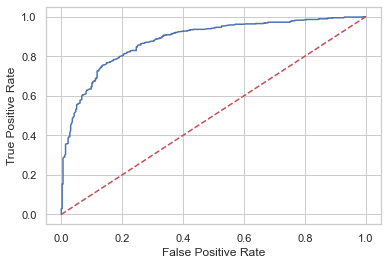

In [2598]:

log_roc_auc=roc_auc_score(y_test,predictions)
fpr,tpr,thresholds=roc_curve(y_test,logr.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr,tpr,label='Logistic Regression'%log_roc_auc)
plt.plot([0,1],[0,1],'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('AUC=',metrics.auc(fpr, tpr))

# Building model using RFE function for deciding columns

In [2834]:
data_final_vars=new_df[[ 'Program.Code', 'From.Grade', 'To.Grade', 'Group.State',
       'Is.Non.Annual.', 'Days',  'Special.Pay', 'Tuition', 'FRP.Active',
       'FRP.Cancelled', 'FRP.Take.up.percent.', 
       'Cancelled.Pax', 'Total.Discount.Pax', 
        'Region', 'CRM.Segment', 'School.Type',
       'Parent.Meeting.Flag', 'MDR.High.Grade',
       'Total.School.Enrollment', 'Income.Level', 'EZ.Pay.Take.Up.Rate',
       'School.Sponsor', 'FPP',
       'Total.Pax', 'SPR.Group.Revenue', 'NumberOfMeetingswithParents',
        'DifferenceTraveltoFirstMeeting',
       'DifferenceTraveltoLastMeeting', 'DepartureMonth',
      
        'SingleGradeTripFlag', 'FPP.to.School.enrollment',
       'FPP.to.PAX', 'Num.of.Non_FPP.PAX' ,'SPR.New.Existing'
      ]]

y=new_df['Retained.in.2012.']


X=data_final_vars

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4,random_state=100)
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()
rfe = RFE(logreg, 20)
rfe = rfe.fit(X_train,y_train)
print(rfe.support_)
print(rfe.ranking_)

/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:70: FutureWarning: Pass n_features_to_select=20 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL

[False  True  True False  True False False False  True  True False  True
  True  True  True  True  True  True False False  True  True False False
 False  True False False False  True  True  True  True  True]
[11  1  1  9  1  7  6 14  1  1  4  1  1  1  1  1  1  1 12  2  1  1  8  5
 15  1 10 13  3  1  1  1  1  1]


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [2835]:
new_x=new_df[['From.Grade','To.Grade','Is.Non.Annual.','FRP.Active',
       'FRP.Cancelled','Cancelled.Pax', 'Total.Discount.Pax', 
        'Region', 'CRM.Segment', 'School.Type',
       'Parent.Meeting.Flag', 'MDR.High.Grade','EZ.Pay.Take.Up.Rate',
       'School.Sponsor','NumberOfMeetingswithParents', 'SingleGradeTripFlag', 'FPP.to.School.enrollment',
       'FPP.to.PAX', 'Num.of.Non_FPP.PAX' ,'SPR.New.Existing']]
new_y=new_df['Retained.in.2012.']

X_train, X_test, y_train, y_test = train_test_split(new_x, new_y, test_size=0.4,random_state=100)
logr = LogisticRegression(random_state=16)
aa=logr.fit(X_train,y_train)
predictions_new=logr.predict(X_test)


/Users/prabh/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [2836]:
cnf_matrix = metrics.confusion_matrix(y_test,predictions_new)
cnf_matrix
print(classification_report(y_test, predictions_new))
print('regresion_score=',logr.score(X_test,y_test))
print('Precision Score=',precision_score(y_test, predictions_new))
error['Recall']['Model_7']=recall_score(y_test, predictions_new)
error['Precision']['Model_7']=precision_score(y_test, predictions_new)
error['Accuracy']['Model_7']=accuracy_score(y_test, predictions_new)

              precision    recall  f1-score   support

           0       0.75      0.76      0.76       357
           1       0.85      0.85      0.85       580

    accuracy                           0.81       937
   macro avg       0.80      0.80      0.80       937
weighted avg       0.81      0.81      0.81       937

regresion_score= 0.8143009605122732
Precision Score= 0.8524305555555556


AUC= 0.8821549309378924


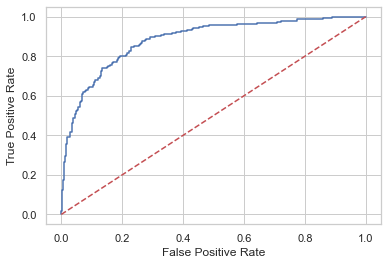

In [2837]:
log_roc_auc=roc_auc_score(y_test,predictions_new)
fpr,tpr,thresholds=roc_curve(y_test,logr.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr,tpr,label='Logistic Regression'%log_roc_auc)
plt.plot([0,1],[0,1],'r--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('AUC=',metrics.auc(fpr, tpr))
error['Auc_Score']['Model_7']=metrics.auc(fpr, tpr)


In [2838]:
#putting values mannuly as the model 6 takes more than 2 hours to run so it's just run once to calculates values

error['Auc_Score']['Model_6']=0.881
error['Recall']['Model_6']=0.860
error['Precision']['Model_6']=0.846
error['Accuracy']['Model_6']=0.820

In [2839]:
error

,Recall,Auc_Score,Precision,Accuracy
Model_1,0.724786,0.796634,0.80303,0.722803
Model_2,0.860345,0.877055,0.847199,0.817503
Model_3,0.724138,0.693171,0.77634,0.700107
Model_4,0.813793,0.857512,0.836879,0.786553
Model_5,0.727586,0.723737,0.808429,0.724653
Model_6,0.86,0.881,0.846,0.82
Model_7,0.846552,0.882155,0.852431,0.814301


<AxesSubplot:ylabel='Accuracy'>

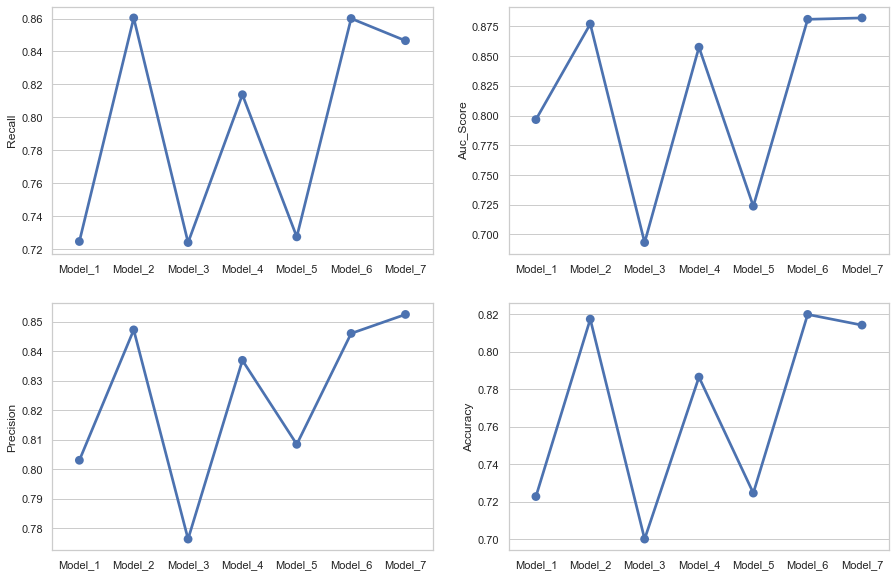

In [2847]:
fig, axes_4 = plt.subplots(2,2,figsize=(15,10))
sns.pointplot( x=error.index,y='Recall', data=error,ax=axes_4[0,0])
sns.pointplot( x=error.index,y='Auc_Score', data=error,ax=axes_4[0,1])
sns.pointplot( x=error.index,y='Precision', data=error,ax=axes_4[1,0])
sns.pointplot( x=error.index,y='Accuracy', data=error,ax=axes_4[1,1])